<font face="EB Garamond" size=5 color=#000000 >
Data Clean (Transform data)

In [1]:
import pandas as pd
import numpy as np
import os
import matplotlib.pyplot as plt
import matplotlib.dates as mdates

INPUT_DIR = os.getcwd() + '/eikon/'
STORE_DIR = os.getcwd() + '/experiment_result/'

In [2]:
def log_returns(x, lag=1):
    """Calculate log returns between adjacent close prices"""
    return np.log(x) - np.log(x.shift(lag))

def get_closed_price(file_name):
    load_csv = INPUT_DIR + file_name
    df = pd.read_csv(load_csv, index_col=0, parse_dates=True, dayfirst=True).sort_index(ascending=True)
    df = df[['CLOSE']]
    # stock price comes from london, care for about 1 day lag. 
    if 'stock' in file_name:
        df.index = pd.Series(index=df.index).tshift(periods=1, freq='D').index
    # add pct_change    
    pct_change = df.pct_change()
    df['pct_change'] = pct_change
    # add log return 
    log_return = log_returns(df['CLOSE'])
    df['log_return'] = log_return
    return df

In [3]:
#process Cu data
cu_shfe_prices = get_closed_price('cu_shfe_prices.csv')
cu_lme_stocks = get_closed_price('cu_lme_stocks.csv')
cu_lme_prices = get_closed_price('cu_lme_prices.csv')

#process Al data
al_shfe_prices = get_closed_price('al_shfe_prices.csv')
al_lme_stocks = get_closed_price('al_lme_stocks.csv')
al_lme_prices = get_closed_price('al_lme_prices.csv')

ted = get_closed_price('ted.csv')
ted_spread = get_closed_price('ted_spread.csv')
bdi = get_closed_price('bdi.csv')
vix = get_closed_price('vix.csv')
gsci = get_closed_price('gsci.csv')

C:\Users\alien\Downloads\Aconda\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in log
  This is separate from the ipykernel package so we can avoid doing imports until


In [4]:
#preprocess data with different transformation

In [5]:
print(cu_shfe_prices.head())

              CLOSE  pct_change  log_return
Date                                       
2006-02-15  47780.0         NaN         NaN
2006-02-16  46410.0   -0.028673   -0.029092
2006-02-17  46720.0    0.006680    0.006657
2006-02-20  46600.0   -0.002568   -0.002572
2006-02-21  47250.0    0.013948    0.013852


<font face="EB Garamond" size=5 color=#000000 >
Generate Data Set (combine all the features into one dataset)

In [6]:
#check mean and variance
from sklearn import preprocessing

def generate_dataset(metal_type, preprocess_method):
#select feature that we want to use 
    if metal_type is 'Cu':
        shfe_price = cu_shfe_prices[[preprocess_method]]
        lme_stocks = cu_lme_stocks[[preprocess_method]]
        lme_prices = cu_lme_prices[[preprocess_method]]
        ted_ = ted[[preprocess_method]]
        ted_spread_ = ted_spread[[preprocess_method]]
        bdi_ = bdi[[preprocess_method]]
        vix_ = vix[[preprocess_method]]
        gsci_ = gsci[[preprocess_method]]
        frames = [lme_stocks, lme_prices, ted_, ted_spread_, bdi_, vix_, gsci_, shfe_price]
        result = pd.concat(frames, axis = 1)
        result.columns = ['lme_stocks', 'lme_prices', 'ted', 'ted_spread', 'bdi', 'vix', 'gsci', 'shfe_price']
        result = collect_available_period(result, 'Cu')
        return result
    elif metal_type is 'Al':
        shfe_price = al_shfe_prices[[preprocess_method]]
        lme_stocks = al_lme_stocks[[preprocess_method]]
        lme_prices = al_lme_prices[[preprocess_method]]
        ted_ = ted[[preprocess_method]]
        ted_spread_ = ted_spread[[preprocess_method]]
        bdi_ = bdi[[preprocess_method]]
        vix_ = vix[[preprocess_method]]
        gsci_ = gsci[[preprocess_method]]
        frames = [lme_stocks, lme_prices, ted_, ted_spread_, bdi_, vix_, gsci_, shfe_price]
        result = pd.concat(frames, axis = 1)
        result.columns = ['lme_stocks', 'lme_prices', 'ted', 'ted_spread', 'bdi', 'vix', 'gsci', 'shfe_price']
        result = collect_available_period(result, 'Al')
        return result
    elif metal_type is 'All':
        shfe_cu_price = cu_shfe_prices[[preprocess_method]]
        shfe_al_price = al_shfe_prices[[preprocess_method]]
        lme_cu_stocks = cu_lme_stocks[[preprocess_method]]
        lme_al_stocks = al_lme_stocks[[preprocess_method]]
        lme_cu_prices = cu_lme_prices[[preprocess_method]]
        lme_al_prices = al_lme_prices[[preprocess_method]]
        ted_ = ted[[preprocess_method]]
        ted_spread_ = ted_spread[[preprocess_method]]
        bdi_ = bdi[[preprocess_method]]
        vix_ = vix[[preprocess_method]]
        gsci_ = gsci[[preprocess_method]]
        frames = [lme_cu_stocks, lme_al_stocks, lme_cu_prices, lme_al_prices, ted_, ted_spread_, bdi_, vix_, \
                  gsci_, shfe_cu_price, shfe_al_price]
        result = pd.concat(frames, axis = 1)
        result.columns = ['lme_cu_stocks', 'lme_al_stocks', 'lme_cu_prices','lme_al_prices','ted', \
                          'ted_spread', 'bdi', 'vix', 'gsci', 'shfe_cu_price', 'shfe_al_price']
        result = collect_available_period(result, 'All')
        return result
    else:
        print('Please Enter metal type from Cu, Al or All')
        
def collect_available_period(df_Xy, metal_type):
    # remove output is null
    if metal_type is 'All':
        df_Xy.dropna(axis=0, how='any', subset=['shfe_cu_price','shfe_al_price'], inplace=True)
    else:
        df_Xy.dropna(axis=0, how='any', subset=['shfe_price'], inplace=True)
    
    # Find first and last dates for which all features available
    start_date = df_Xy.loc[df_Xy.notnull().all(axis=1)].index.min()
    end_date = df_Xy.loc[df_Xy.notnull().all(axis=1)].index.max()
    df_Xy = df_Xy.loc[start_date:end_date, :]
    
    #fill nan by forward value 
    df_Xy = df_Xy.replace([np.inf, -np.inf], np.nan).fillna(method='ffill')
    
    #normalised to zero mean and standard variance
    for item in df_Xy.columns:
        df_Xy[item] = preprocessing.scale(df_Xy[item])
    
    return df_Xy

In [7]:
cu_log_return = generate_dataset('Cu', 'log_return')

In [8]:
al_log_return = generate_dataset('Al', 'log_return')

In [10]:
 all_log_return = generate_dataset('All', 'log_return')
# print(all_log_return)

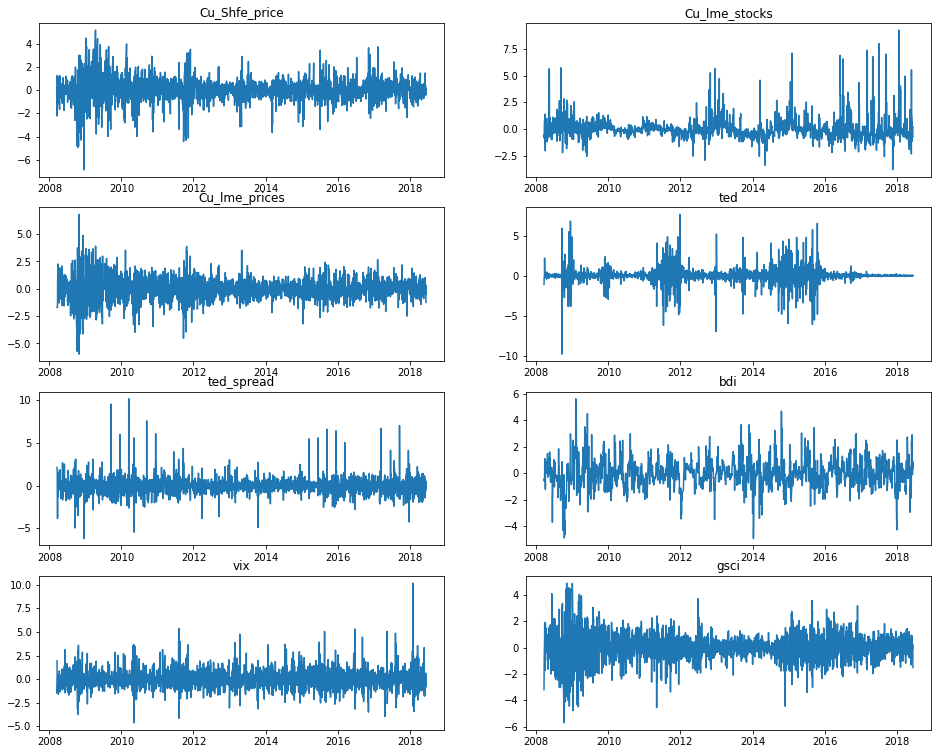

In [11]:
#plot data to check mean and variance
fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(16,13))
axes[0,0].plot(cu_log_return.index,cu_log_return[['shfe_price']])
axes[0,0].set_title('Cu_Shfe_price')
axes[0,1].plot(cu_log_return.index,cu_log_return[['lme_stocks']])
axes[0,1].set_title('Cu_lme_stocks')
axes[1,0].plot(cu_log_return.index,cu_log_return[['lme_prices']])
axes[1,0].set_title('Cu_lme_prices')
axes[1,1].plot(cu_log_return.index,cu_log_return[['ted']])
axes[1,1].set_title('ted')
axes[2,0].plot(cu_log_return.index,cu_log_return[['ted_spread']])
axes[2,0].set_title('ted_spread')
axes[2,1].plot(cu_log_return.index,cu_log_return[['bdi']])
axes[2,1].set_title('bdi')
axes[3,0].plot(cu_log_return.index,cu_log_return[['vix']])
axes[3,0].set_title('vix')
axes[3,1].plot(cu_log_return.index,cu_log_return[['gsci']])
axes[3,1].set_title('gsci')
plt.show()

In [12]:
cu_log_return['shfe_price'].corr(al_log_return['shfe_price'])

0.5349399568497399

<font face="EB Garamond" size=5 color=#000000 >
check stationary by Dickey-Fuller test

In [12]:
#Because the test statistic is above the 5% critical value and the p-value is smaller than 0.05 
#This means that the null hypothesis of the Augmented Dickey-Fuller test cann be rejected, 
#the series is stationary.

# p is smaller than 0.05, it's not a white noise sequence
from pandas import tseries
from statsmodels.tsa.stattools import adfuller
def adf_test(input_data, feature_name):
    # perform Augmented Dickey Fuller test
    print('Results of Augmented Dickey-Fuller test:', feature_name)
    test_data = input_data[[feature_name]]
    y = test_data.values[:,0]
    dftest = adfuller(y, autolag='AIC')
    #print(dftest)
    dfoutput = pd.Series(dftest[0:4], index=['test statistic', 'p-value', '# of lags', '# of observations'])
    #print(dfoutput)
    for key, value in dftest[4].items():
        dfoutput['Critical Value ({})'.format(key)] = value
    print(dftest)
    #print(dfoutput)
#     if dftest[1]<0.05 and dftest[4].get('5%')<0.05:
#         print(feature_name, 'is stationary.')
#         print('test statistic', dftest[0])
#         print('p-value = ', dftest[1])
#         print(type(dftest[1]))
#         print('Critical Value (5%) = ', dftest[4].get('5%'))
#     else: 
#         print(feature, 'is not stationary.')

adf_test(al_log_return, 'shfe_price')
adf_test(al_log_return, 'lme_stocks')
adf_test(al_log_return, 'lme_prices')
#adf_test(cu_log_return, 'ted')
#adf_test(cu_log_return, 'ted_spread')
#adf_test(cu_log_return, 'bdi')
#adf_test(cu_log_return, 'vix')
#adf_test(cu_log_return, 'gsci')

Results of Augmented Dickey-Fuller test: shfe_price
(-12.804041669932241, 6.659499277451033e-24, 16, 2855, {'1%': -3.4326425356409058, '5%': -2.8625528854376623, '10%': -2.5673091887523349}, 7864.1657339107596)
Results of Augmented Dickey-Fuller test: lme_stocks
(-5.5287454276139405, 1.807618046119641e-06, 26, 2845, {'1%': -3.4326506010508009, '5%': -2.8625564475120617, '10%': -2.5673110851832059}, 7496.7878758449979)
Results of Augmented Dickey-Fuller test: lme_prices
(-30.887626564233074, 0.0, 2, 2869, {'1%': -3.4326313386090552, '5%': -2.8625479402718623, '10%': -2.5673065559730883}, 8050.0800944781467)


<font face="EB Garamond" size=5 color=#000000 >
Autocorrelation and Partial Autocorrelation

In [13]:
import statsmodels.api as sm  
def plot_acf_pacf(input_data):   
    fig = plt.figure(figsize=(12,8))
    ax1 = fig.add_subplot(211)
    fig = sm.graphics.tsa.plot_acf(input_data, lags=40, alpha=.05, ax=ax1)
    ax2 = fig.add_subplot(212)
    fig = sm.graphics.tsa.plot_pacf(input_data, lags=40, alpha=.05, ax=ax2)
    print("ACF and PACF of input_data")
    plt.show()

ACF and PACF of input_data


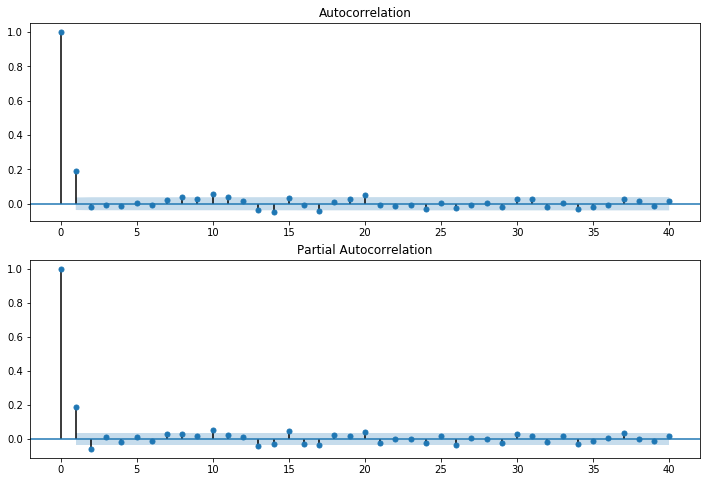

In [14]:
#shfe_price  #lme_stocks  #lme_prices #ted  #ted_spread #bdi #vix  #gsci
plot_acf_pacf(al_log_return[['shfe_price']])

<font face="EB Garamond" size=5 color=#000000 >
randomness test/ white noise test

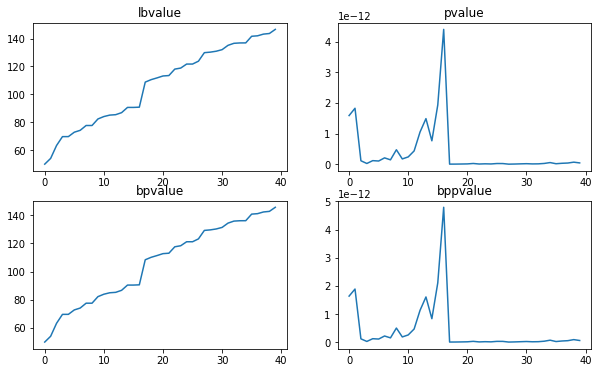

In [16]:
from statsmodels.sandbox.stats.diagnostic import acorr_ljungbox

lbvalue, pvalue, bpvalue, bppvalue=acorr_ljungbox(cu_log_return[['shfe_price']], boxpierce=True)

fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(10,6))
axes[0,0].plot(lbvalue)
axes[0,0].set_title('lbvalue')
axes[0,1].plot(pvalue)
axes[0,1].set_title('pvalue')
axes[1,0].plot(bpvalue)
axes[1,0].set_title('bpvalue')
axes[1,1].plot(bppvalue)
axes[1,1].set_title('bppvalue')
plt.show()

<font face="EB Garamond" size=5 color=#000000 >
define Evaluate method 

In [13]:
#MSE: mean square error
#MAE: mean absolute error
#RMSE: root mean square error
#DTW: Dynamic Time Wrapping     #Package: https://github.com/pierre-rouanet/dtw
#Spearmanr: Rank correlation
experiments = pd.DataFrame(columns=['MSE','MAE','RMSE','DTW','Spearmanr']) 

In [14]:
import sys
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from numpy.linalg import norm
from dtw import dtw
from scipy.stats import spearmanr

def evaluate(model_name, org_price, pred_price):
    
    org_price = org_price.reshape(len(org_price),1)
    pred_price = pred_price.reshape(len(pred_price),1)
    
    mse = compute_mse_error(org_price, pred_price)
    mae = compute_mean_absolute_error(org_price, pred_price)
    rmse =compute_root_mean_square_error(org_price, pred_price)
    dtw_dist, dtw_cost, dtw_acc, dtw_path = compute_dtw(org_price, pred_price)
    corr_rank, p_value = compute_spearmanr(org_price, pred_price)
    
    df = pd.DataFrame(index=[model_name],columns=['MSE', 'MAE', 'RMSE' ,'DTW', 'Spearmanr', 'p-value'])
    df.set_value(model_name, 'MSE', mse)
    df.set_value(model_name, 'MAE', mae)
    df.set_value(model_name, 'RMSE', rmse)
    df.set_value(model_name, 'DTW', dtw_cost[-1][-1])
    df.set_value(model_name, 'Spearmanr', corr_rank)
    df.set_value(model_name, 'p_value', p_value)
    return df

def compute_daily_error(org_price, pred_price):
    return org_price - pred_price

#MSE
def compute_mse_error(org_price, pred_price):
    return mean_squared_error(org_price, pred_price)

#MAE
def compute_mean_absolute_error(org_price, pred_price):  
    return mean_absolute_error(org_price, pred_price)

#RMSE
def compute_root_mean_square_error(org_price, pred_price):
    return np.sqrt(((org_price - pred_price) ** 2).mean())

#smaller dtw Accumulated Distortion(cost[-1][-1]) means more similar time series
def compute_dtw(x, y):   #Dynamic time warping
    #custom norm 
    #def my_custom_norm(x, y):
    #    return (x * x) + (y * y)
    #dist, cost, acc, path = dtw(x, y, dist=my_custom_norm)
    dist, cost, acc, path = dtw(x, y, dist=lambda x, y: norm(x - y, ord=1))
    return dist, cost, acc, path

def compute_spearmanr(org_price, pred_price):
    correlation_rank = spearmanr(org_price, pred_price)
    return correlation_rank[0], correlation_rank[1]

<font face="EB Garamond" size=5 color=#000000 >
Get train and test data

In [15]:
# input_dataset: cu_log_return or al_log_return..
# period is the window size
# days =  difference between predicted date (Y) and input date (X)
# days = 1, 5, 22
def run_experiment(function, input_dataset, start_num, period=1500, day=1):
    
    num, feature = input_dataset.shape
    # i is start date. the total data num is 2493 * 8 
    # 2872
    # Consider efficiency, run small data size for testing
    i = start_num
    df = pd.DataFrame(data=[], index=input_dataset.index[(i+period +day) :], columns=['org_price','pred_price','error']) 
    
    while (i+period+day) != num :  
   
        X = input_dataset.iloc[i:i+period, :]
        
        Y = input_dataset.iloc[i+day:i+period+day, -1]  
                
        x_pred = input_dataset.iloc[i+period:i+period+1, :]
        
        y_pred = function(X, Y, x_pred)
        
        y_org = input_dataset.iloc[i+period+day, -1]
        
        error = np.abs(y_org - y_pred)
        pred_date = input_dataset.index[i+period+day].strftime('%Y-%m-%d')
        
        df.set_value(pred_date, 'org_price', y_org)
        df.set_value(pred_date, 'pred_price', y_pred)
        df.set_value(pred_date, 'error',error)
        print(pred_date, "%.8f" % y_org, "%.8f" % y_pred, "%.8f" %error) 
        i=i+1
        
    return df

<font face="EB Garamond" size=5 color=#000000 >
Plot method

In [16]:
from matplotlib.dates import DateFormatter, WeekdayLocator, DayLocator, MONDAY,YEARLY, MonthLocator
import matplotlib as mpl

def plot_result(result_name, metal_name, pointer=0):
    plt.plot(result_name.index[pointer:], result_name['pred_price'][pointer:] , c='r', label='pred_return')
    plt.plot(result_name.index[pointer:], result_name['org_price'][pointer:], c='b', label='org_return')
    monthsLoc = mpl.dates.MonthLocator()
    weeksLoc = mpl.dates.WeekdayLocator()
    monthsFmt = mpl.dates.DateFormatter('%b')
    fig = plt.gcf()
    fig.set_size_inches(20,10)
    plt.gcf().autofmt_xdate() 
    plt.ylabel(metal_name+' shfe price log return')
    plt.xlabel('Date')
    plt.legend()
    plt.show()

<font face="EB Garamond" size=5 color=#000000 >
Model 1: ARIMA model

In [17]:
from pandas import tseries
import statsmodels.api as sm  
from statsmodels.tsa.stattools import acf  
from statsmodels.tsa.stattools import pacf
from statsmodels.tsa.seasonal import seasonal_decompose

<Figure size 432x288 with 0 Axes>

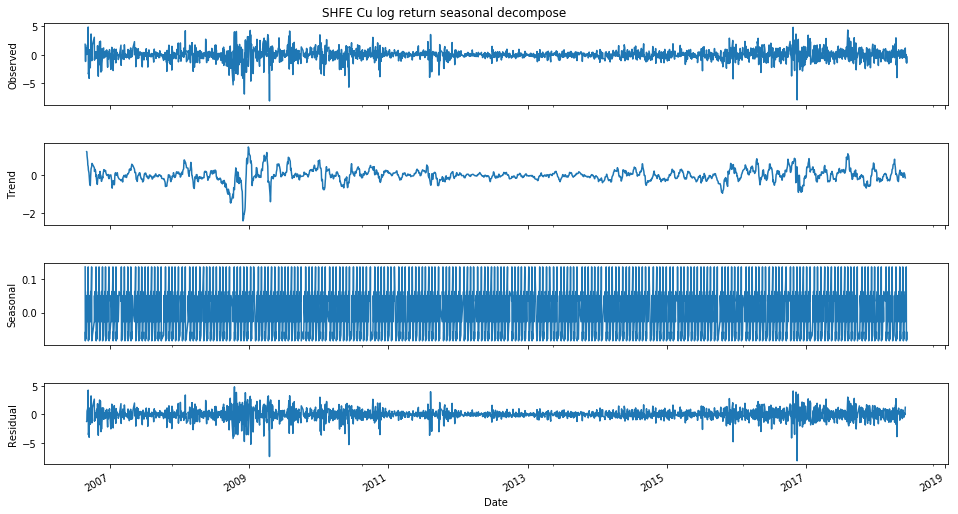

In [25]:
arima_data = al_log_return[['shfe_price']]
decomposition = seasonal_decompose(arima_data, freq=12) 
fig = plt.figure()  
fig = decomposition.plot()  
fig.set_size_inches(15, 8)
fig.suptitle('SHFE Cu log return seasonal decompose')
plt.show()

ACF and PACF of the cu shef price


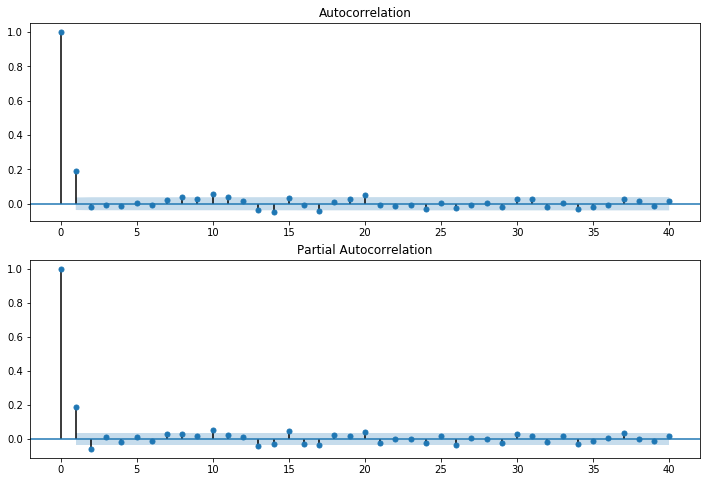

In [26]:
fig = plt.figure(figsize=(12,8))
ax1 = fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(arima_data, lags=40, alpha=.05, ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(arima_data, lags=40, alpha=.05, ax=ax2)
print("ACF and PACF of the cu shef price")
plt.show()

In [19]:
import itertools
import warnings
from scipy import special

# Define the p, d and q parameters to take any value between 0 and 2
p = d = q = range(0, 2)

# Generate all different combinations of p, q and q triplets
pdq = list(itertools.product(p, d, q))

# Generate all different combinations of seasonal p, q and q triplets
seasonal_pdq = [(1,0,1, 12), (0,0,1,12)]

In [20]:
def auto_seasonal_arima_model(X, Y, x_pred):
    
    warnings.filterwarnings("ignore") # specify to ignore warning messages
    
    #take the last column
    input_data = X['shfe_price']
    min_param = ()
    min_seasonal = ()
    min_results = 99999

                
    for param in pdq:
        for param_seasonal in seasonal_pdq:
            try:
                mod = sm.tsa.statespace.SARIMAX(input_data,
                                                order=param,
                                                seasonal_order=param_seasonal,
                                                enforce_stationarity=False,
                                                enforce_invertibility=False)

                results = mod.fit()
                if results.aic < min_results:
                    min_results = results.aic
                    min_param = param
                    min_seasonal = param_seasonal
                #print('ARIMA{}x{}12 - AIC:{}'.format(param, param_seasonal, results.aic))
            except:
                continue
                          
    print('ARIMA{}x{}12 - AIC:{}'.format(min_param, min_seasonal, min_results))
    #print(min_param, min_seasonal)
    mod = sm.tsa.statespace.SARIMAX(input_data,
                                    order=min_param,
                                    seasonal_order=min_seasonal,
                                    enforce_stationarity=False,
                                    enforce_invertibility=False)

    results = mod.fit()
    
    output = results.get_prediction(end=mod.nobs + 1) 
   
    y_pred = output.predicted_mean.values[-1]
    return y_pred

In [ ]:
#cu seasonal 0,0,1,12  1,0,1,12

In [21]:
result_cu_arima_test = run_experiment(auto_seasonal_arima_model, cu_log_return, start_num=350, period=2000, day=1)

ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4957.184133230038
2017-11-16 0.10958271 -0.00186317 0.11144588
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4960.291036416172
2017-11-17 0.00653698 -0.01113411 0.01767109
ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:4959.808381378146
2017-11-20 0.09475340 -0.00342727 0.09818067
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4943.574286917185
2017-11-21 0.47534275 -0.00232346 0.47766621
ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:4942.688768207087
2017-11-22 0.93575866 0.00410688 0.93165178
ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:4940.809007739856
2017-11-23 0.00653698 0.01160798 0.00507099
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4939.441494974663
2017-11-24 0.28027684 0.00931253 0.27096431
ARIMA(1, 0, 1)x(0, 0, 1, 12)12 - AIC:4938.607752983208
2017-11-27 0.07841401 0.00868505 0.06972896
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4936.699612985228
2017-11-28 -0.96217578 -0.00000986 0.96216592
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4936.3173175065995
2017-11-29 -0.46042239 -0.00004701 0.46037537
A

ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4884.248280935499
2018-03-20 -0.14557816 0.00018588 0.14576404
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4880.417676860346
2018-03-21 -0.77391020 0.00123472 0.77514492
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4878.923459851598
2018-03-22 0.42068987 -0.00038226 0.42107212
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4879.658811308894
2018-03-23 -1.36706044 -0.00020071 1.36685974
ARIMA(0, 0, 1)x(0, 0, 1, 12)12 - AIC:4879.9677716699525
2018-03-26 -1.29668597 0.00087467 1.29756064
ARIMA(1, 0, 1)x(1, 0, 1, 12)12 - AIC:4874.383874834095
2018-03-27 0.35410125 -0.05548618 0.40958743
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4874.038782970412
2018-03-28 -0.19865419 0.00818682 0.20684101
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4872.964873105984
2018-03-29 0.62049424 -0.01553887 0.63603311
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4873.060568521496
2018-03-30 0.56899875 0.00634594 0.56265281
ARIMA(0, 0, 1)x(1, 0, 1, 12)12 - AIC:4873.562380271933
2018-04-02 0.42573096 0.00964088 0.41609008


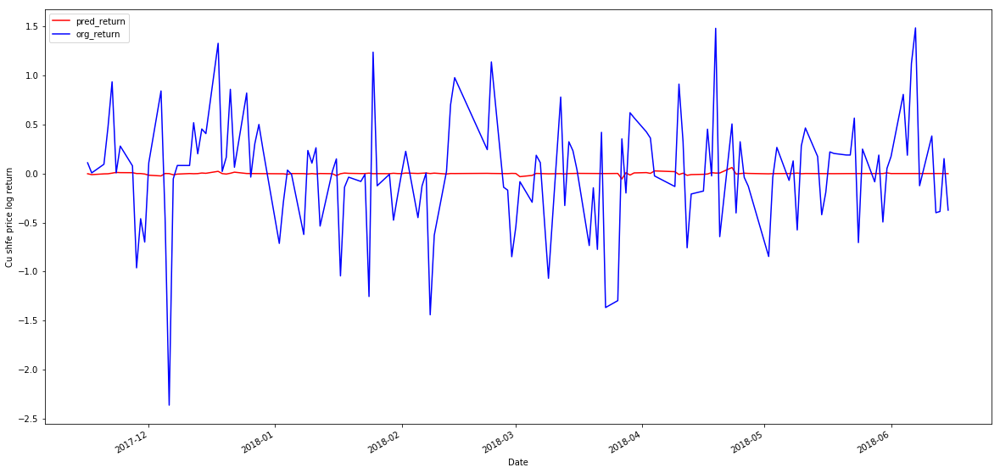

In [22]:
plot_result(result_cu_arima_test, 'Cu')

In [24]:
print(evaluate('', result_cu_arima_test['org_price'].values[250:], result_cu_arima_test['pred_price'].values[250:]))

                           Statespace Model Results                           
Dep. Variable:             shfe_price   No. Observations:                 2491
Model:               SARIMAX(1, 0, 2)   Log Likelihood               -3505.241
Date:                Sun, 26 Aug 2018   AIC                           7018.482
Time:                        19:24:53   BIC                           7041.764
Sample:                    03-19-2008   HQIC                          7026.936
                         - 06-13-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.9594      0.015     64.428      0.000       0.930       0.989
ma.L1         -0.8250      0.019    -44.048      0.000      -0.862      -0.788
ma.L2         -0.1065      0.014     -7.465      0.0

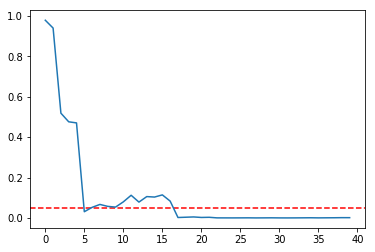

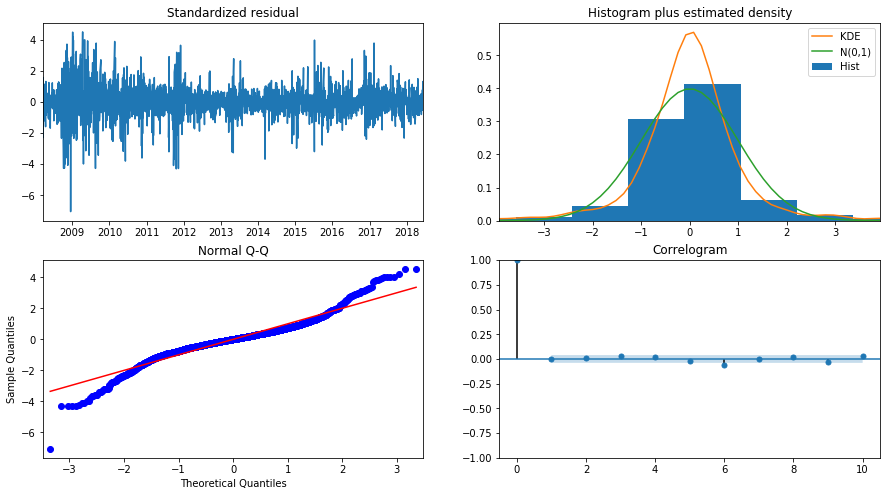

2018-06-15 -0.37358002 0.04428076 0.41786077


In [244]:
result_cu_auto_arima = run_experiment(auto_seasonal_arima_model, cu_log_return)

                           Statespace Model Results                           
Dep. Variable:             shfe_price   No. Observations:                 2870
Model:               SARIMAX(0, 0, 1)   Log Likelihood               -4015.971
Date:                Sun, 26 Aug 2018   AIC                           8035.943
Time:                        19:23:03   BIC                           8047.867
Sample:                    08-22-2006   HQIC                          8040.242
                         - 06-13-2018                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ma.L1          0.2051      0.011     19.110      0.000       0.184       0.226
sigma2         0.9614      0.013     75.212      0.000       0.936       0.987
Ljung-Box (Q):                       71.93   Jarque-

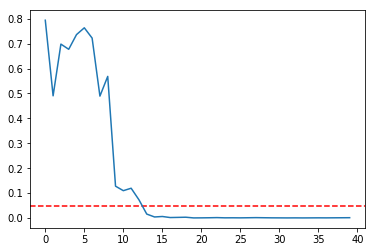

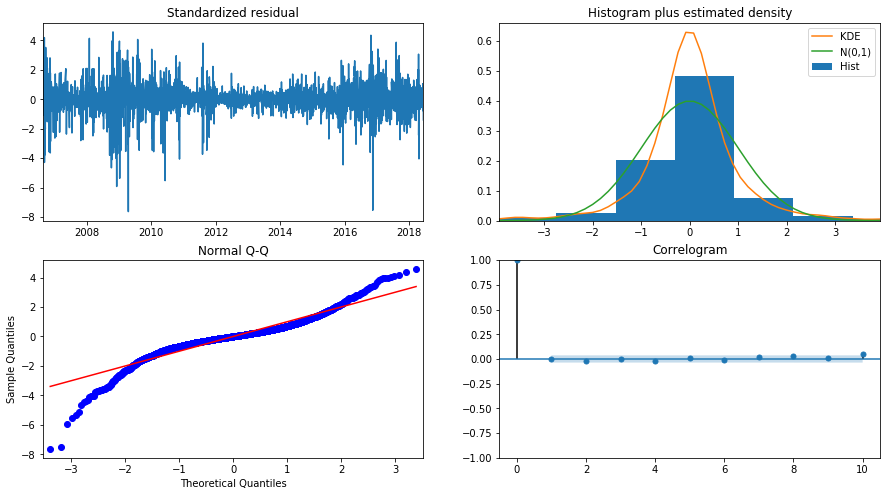

2018-06-15 -1.38463400 0.00000000 1.38463400


In [241]:
result_autoarima_seasonal = run_experiment(auto_seasonal_arima_model, al_log_return)

<font face="EB Garamond" size=5 color=#000000 >
Model 2: Linear Regression

In [46]:
from sklearn import datasets, linear_model
def linear_regression(X, Y, x_pred):
    X= X.values
    Y = Y.values
    x_pred = x_pred.values
    
    regr = linear_model.LinearRegression()
    
    regr.fit(X, Y)
    y_pred = regr.predict(x_pred)
    
    return y_pred

In [25]:
result_lr = run_experiment(linear_regression, cu_log_return, start_num=600, period=1500, day=1)

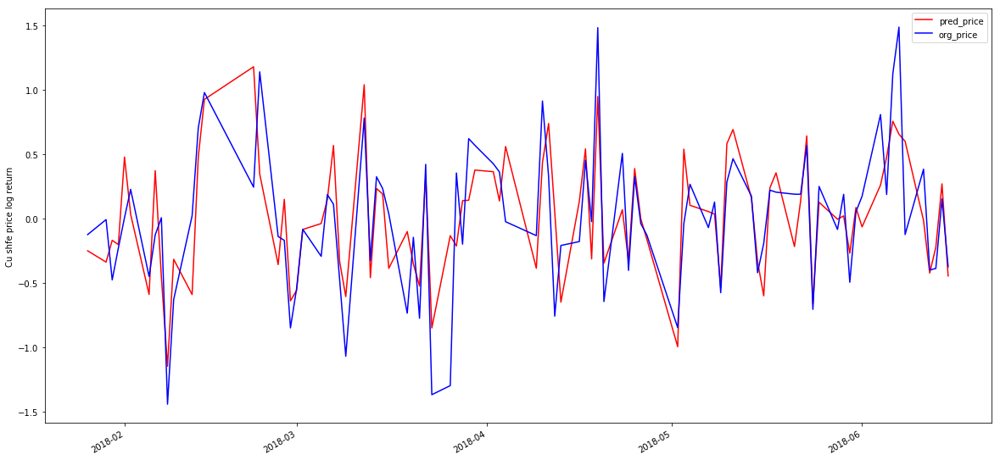

In [126]:
plot_result(result_lr[300:], 'Cu')

In [124]:
result_eval = evaluate('', result_lr['org_price'].values[0:], result_lr['pred_price'].values[0:])

In [125]:
print(result_eval.iloc[0])

MSE                  0.263132
MAE                  0.349943
RMSE         [0.512963774282]
DTW                 0.0714937
Spearmanr              0.7423
Name: , dtype: object


In [127]:
def find_window_size(size_bound):
    size_bound = size_bound
    MSE = []
    MAE = []
    RMSE = []
    DTW = []
    Spearmanr = []
    for i in size_bound:
        result_lr = run_experiment(linear_regression, cu_log_return, start_num=2100-i, period=i, day=1)
        result_eval = evaluate('', result_lr['org_price'].values[0:], result_lr['pred_price'].values[0:])
        MSE.append(result_eval.iloc[0][0])
        MAE.append(result_eval.iloc[0][1])
        RMSE.append(result_eval.iloc[0][2][0])
        DTW.append(result_eval.iloc[0][3])
        Spearmanr.append(result_eval.iloc[0][4])
    return MSE, MAE, RMSE, DTW, Spearmanr

In [105]:
mse_list, mae_list, rmse_list, dtw_list, spear_list = find_window_size()

2016-11-09 2.11752135 1.34413816 0.77338319
2016-11-10 3.65339957 1.47260178 2.18079779
2016-11-11 3.38731104 1.69399438 1.69331667
2016-11-14 0.65521585 0.67081658 0.01560073
2016-11-15 -0.69358444 0.20220729 0.89579173
2016-11-16 -2.02672310 0.27525388 2.30197698
2016-11-17 -0.66543563 -0.88607571 0.22064008
2016-11-18 0.41395011 0.74486823 0.33091812
2016-11-21 0.97222194 -0.62775414 1.59997608
2016-11-22 1.90267776 1.09943044 0.80324732
2016-11-23 0.05760812 0.85585614 0.79824802
2016-11-24 3.07650303 1.07575715 2.00074589
2016-11-25 0.77166983 1.47855538 0.70688555
2016-11-28 1.03646718 0.17952134 0.85694584
2016-11-29 -1.85399251 0.07543233 1.92942484
2016-11-30 -2.42148719 -1.44230963 0.97917755
2016-12-01 1.32972954 0.76057371 0.56915583
2016-12-02 -0.92909482 -0.24479994 0.68429488
2016-12-05 1.00857107 -0.34250346 1.35107454
2016-12-06 1.02859110 2.06997778 1.04138669
2016-12-07 0.13744237 -0.49266027 0.63010265
2016-12-08 -0.99722425 -0.89440658 0.10281767
2016-12-09 -0.2256

2017-09-05 0.35820706 0.58369875 0.22549169
2017-09-06 -0.37451080 -0.18485533 0.18965547
2017-09-07 -0.15523901 0.15543620 0.31067521
2017-09-08 -0.85207115 0.20477542 1.05684657
2017-09-11 -1.60274726 -1.35272531 0.25002196
2017-09-12 0.32501405 0.73583507 0.41082102
2017-09-13 -0.50974782 -0.73888281 0.22913499
2017-09-14 -0.99011605 -0.81589783 0.17421822
2017-09-15 -0.30271172 -0.45901800 0.15630628
2017-09-18 0.23858867 0.04750605 0.19108262
2017-09-19 0.46857440 0.01543695 0.45313744
2017-09-20 0.03724214 -0.01754153 0.05478367
2017-09-21 -0.68727703 0.33275162 1.02002865
2017-09-22 -0.81863617 -0.18700562 0.63163055
2017-09-25 0.73873239 -0.09936680 0.83809919
2017-09-26 0.51654512 -0.08087980 0.59742492
2017-09-27 -0.25577696 -0.50401034 0.24823338
2017-09-28 0.03744339 0.38940657 0.35196318
2017-09-29 1.38476992 0.67739767 0.70737225
2017-10-09 1.27122760 -0.36583654 1.63706414
2017-10-10 0.05132651 -0.03462575 0.08595227
2017-10-11 0.36392803 0.75193744 0.38800941
2017-10-12

2016-12-02 -0.92909482 -0.28911800 0.63997682
2016-12-05 1.00857107 -0.34184560 1.35041667
2016-12-06 1.02859110 2.06833985 1.03974875
2016-12-07 0.13744237 -0.49980436 0.63724674
2016-12-08 -0.99722425 -0.89552893 0.10169532
2016-12-09 -0.22567299 -0.18943428 0.03623871
2016-12-12 0.96407051 0.39149938 0.57257113
2016-12-13 -1.38409093 -0.63797540 0.74611553
2016-12-14 -0.66450531 -1.01683478 0.35232947
2016-12-15 0.54383301 0.02877912 0.51505389
2016-12-16 0.12357754 0.00454197 0.11903557
2016-12-19 -1.15490679 -0.89690225 0.25800454
2016-12-20 -1.74277648 -1.43077038 0.31200610
2016-12-21 0.43894263 0.03251613 0.40642650
2016-12-22 -0.72128316 0.35213112 1.07341428
2016-12-23 0.11092905 0.04326537 0.06766368
2016-12-26 -1.39700721 -0.25301085 1.14399637
2016-12-27 0.64126685 -0.35426970 0.99553656
2016-12-28 1.94877503 -0.51953336 2.46830840
2016-12-29 -0.18208583 0.92298264 1.10506846
2016-12-30 -0.18254421 -0.37087622 0.18833202
2017-01-03 0.98138031 0.84614652 0.13523379
2017-01-

2017-11-23 0.00653698 0.35844866 0.35191167
2017-11-24 0.28027684 0.11803774 0.16223910
2017-11-27 0.07841401 0.48184259 0.40342859
2017-11-28 -0.96217578 -0.50164579 0.46052999
2017-11-29 -0.46042239 -0.92053294 0.46011055
2017-11-30 -0.69919912 -0.52100380 0.17819532
2017-12-01 0.10985638 -0.02487864 0.13473502
2017-12-04 0.84278369 0.32376600 0.51901768
2017-12-05 -0.46182784 -0.26732764 0.19450020
2017-12-06 -2.36339866 -1.76138709 0.60201158
2017-12-07 -0.05402490 0.03959557 0.09362046
2017-12-08 0.08223197 0.17534271 0.09311074
2017-12-11 0.08215840 0.11692360 0.03476520
2017-12-12 0.51882265 0.74118636 0.22236371
2017-12-13 0.20152298 -0.06987618 0.27139916
2017-12-14 0.45464845 0.51108002 0.05643158
2017-12-15 0.40764251 0.47538463 0.06774212
2017-12-18 1.32881549 0.90909127 0.41972422
2017-12-19 0.02110347 0.21182219 0.19071872
2017-12-20 0.16658858 -0.12850982 0.29509839
2017-12-21 0.85942159 0.87536690 0.01594531
2017-12-22 0.06402267 0.50526321 0.44124055
2017-12-25 0.82112

2017-06-15 -0.40405432 -0.25986861 0.14418571
2017-06-16 0.29759615 -0.25342946 0.55102560
2017-06-19 -0.02764881 0.08554405 0.11319286
2017-06-20 0.48377669 0.48144407 0.00233262
2017-06-21 -0.62472495 -0.91682874 0.29210379
2017-06-22 0.82448798 1.12303521 0.29854723
2017-06-23 0.32794859 0.06654074 0.26140785
2017-06-26 0.56164187 0.60498641 0.04334454
2017-06-27 0.07355410 -0.14138023 0.21493433
2017-06-28 0.40743201 0.40996239 0.00253038
2017-06-29 0.78568976 0.30791122 0.47777854
2017-06-30 0.18777065 0.46858190 0.28081125
2017-07-03 -0.04284853 0.03010867 0.07295720
2017-07-04 -0.50562391 -0.00443831 0.50118560
2017-07-05 0.12248125 -0.13434449 0.25682574
2017-07-06 -0.54157645 -0.87582069 0.33424424
2017-07-07 0.07318099 0.11212919 0.03894820
2017-07-10 -0.04344067 -0.17380803 0.13036736
2017-07-11 -0.07683051 -0.08127906 0.00444855
2017-07-12 0.70406324 0.45824448 0.24581876
2017-07-13 -0.12584394 0.15430403 0.28014797
2017-07-14 -0.20906357 -0.17455397 0.03450959
2017-07-17 0

2016-12-02 -0.92909482 -0.30219481 0.62690001
2016-12-05 1.00857107 -0.33547089 1.34404197
2016-12-06 1.02859110 2.06419056 1.03559947
2016-12-07 0.13744237 -0.50619298 0.64363535
2016-12-08 -0.99722425 -0.91581095 0.08141330
2016-12-09 -0.22567299 -0.19294678 0.03272621
2016-12-12 0.96407051 0.39338435 0.57068616
2016-12-13 -1.38409093 -0.73251263 0.65157830
2016-12-14 -0.66450531 -0.80154476 0.13703945
2016-12-15 0.54383301 0.01408845 0.52974456
2016-12-16 0.12357754 0.00963094 0.11394660
2016-12-19 -1.15490679 -0.89651041 0.25839637
2016-12-20 -1.74277648 -1.42927975 0.31349674
2016-12-21 0.43894263 0.02555666 0.41338597
2016-12-22 -0.72128316 0.35111230 1.07239546
2016-12-23 0.11092905 0.03760032 0.07332872
2016-12-26 -1.39700721 -0.26044379 1.13656343
2016-12-27 0.64126685 -0.37269588 1.01396273
2016-12-28 1.94877503 -0.51522332 2.46399835
2016-12-29 -0.18208583 0.91884250 1.10092833
2016-12-30 -0.18254421 -0.38829449 0.20575028
2017-01-03 0.98138031 0.82944274 0.15193757
2017-01-

2017-09-22 -0.81863617 -0.18447204 0.63416413
2017-09-25 0.73873239 -0.06285333 0.80158572
2017-09-26 0.51654512 -0.07205932 0.58860444
2017-09-27 -0.25577696 -0.57305429 0.31727732
2017-09-28 0.03744339 0.36720614 0.32976275
2017-09-29 1.38476992 0.64742687 0.73734305
2017-10-09 1.27122760 -0.33264978 1.60387738
2017-10-10 0.05132651 -0.03253940 0.08386591
2017-10-11 0.36392803 0.74466434 0.38073631
2017-10-12 1.50739685 0.42253005 1.08486680
2017-10-13 0.58729633 0.78589139 0.19859507
2017-10-16 0.33852117 0.11628569 0.22223548
2017-10-17 1.92708932 1.73951661 0.18757270
2017-10-18 -0.55758999 -0.90960887 0.35201888
2017-10-19 -0.24866071 -0.23690310 0.01175761
2017-10-20 0.09169592 -0.07855725 0.17025317
2017-10-23 -0.17809198 0.00865207 0.18674405
2017-10-24 1.13582926 0.32959689 0.80623236
2017-10-25 -0.66906962 0.32437738 0.99344700
2017-10-26 -0.07832782 -0.02905445 0.04927336
2017-10-27 -0.76144057 -0.02106750 0.74037307
2017-10-30 -1.15983197 -0.87538463 0.28444734
2017-10-31 

2017-05-18 -0.54418858 -0.06842133 0.47576725
2017-05-19 0.19628890 -0.22312014 0.41940904
2017-05-22 1.03347937 1.16409837 0.13061900
2017-05-23 0.21030892 0.31898519 0.10867628
2017-05-24 -0.14624191 -0.04722939 0.09901253
2017-05-25 0.14235525 -0.30634156 0.44869681
2017-05-26 0.09130317 0.08141605 0.00988712
2017-05-31 -0.70838570 -0.42377125 0.28461445
2017-06-01 -0.42215210 -0.00126575 0.42088635
2017-06-02 0.05810456 0.18329224 0.12518768
2017-06-05 -0.13105257 -0.29527139 0.16421882
2017-06-06 -0.21756627 -0.39703981 0.17947354
2017-06-07 -0.16629043 -0.06963121 0.09665922
2017-06-08 0.04113319 -0.14664067 0.18777387
2017-06-09 1.10557088 0.96461582 0.14095506
2017-06-12 0.88821069 0.55450677 0.33370392
2017-06-13 -0.43305103 -0.50421094 0.07115991
2017-06-14 -0.48672060 -0.27757671 0.20914390
2017-06-15 -0.40405432 -0.25804957 0.14600475
2017-06-16 0.29759615 -0.24496110 0.54255725
2017-06-19 -0.02764881 0.08493751 0.11258632
2017-06-20 0.48377669 0.49263710 0.00886042
2017-06

2017-01-06 -0.67959508 -0.42056956 0.25902552
2017-01-09 0.29888274 0.13746804 0.16141470
2017-01-10 0.34907274 0.19411852 0.15495422
2017-01-11 1.91403603 1.58632424 0.32771179
2017-01-12 0.05654676 -0.47706735 0.53361411
2017-01-13 0.91773189 1.16425990 0.24652801
2017-01-16 0.58088115 0.85977464 0.27889349
2017-01-17 -0.89791744 -0.14748568 0.75043177
2017-01-18 -1.14321606 -1.04212642 0.10108964
2017-01-19 0.30811438 0.18403618 0.12407820
2017-01-20 -0.31182904 -0.02942497 0.28240407
2017-01-23 0.74183076 0.21647906 0.52535170
2017-01-24 0.05641852 0.43784675 0.38142824
2017-01-25 1.11230603 1.33722793 0.22492190
2017-01-26 0.30095056 0.06984433 0.23110623
2017-02-03 -1.54338626 -0.68467546 0.85871080
2017-02-06 -0.39418599 -0.93889356 0.54470757
2017-02-07 0.35728230 0.66544382 0.30816152
2017-02-08 0.76935556 -0.61612659 1.38548215
2017-02-09 0.17138211 0.85889862 0.68751650
2017-02-10 -0.38967964 -0.48865006 0.09897042
2017-02-13 3.73888074 2.44822924 1.29065151
2017-02-14 0.132

2017-12-08 0.08223197 0.17827749 0.09604552
2017-12-11 0.08215840 0.10677823 0.02461982
2017-12-12 0.51882265 0.74118599 0.22236334
2017-12-13 0.20152298 -0.07575181 0.27727479
2017-12-14 0.45464845 0.50593122 0.05128278
2017-12-15 0.40764251 0.48299870 0.07535619
2017-12-18 1.32881549 0.90837501 0.42044049
2017-12-19 0.02110347 0.22114112 0.20003765
2017-12-20 0.16658858 -0.10842475 0.27501332
2017-12-21 0.85942159 0.87884558 0.01942399
2017-12-22 0.06402267 0.53898827 0.47496560
2017-12-25 0.82112642 0.34131211 0.47981431
2017-12-26 -0.03612419 0.36431295 0.40043714
2017-12-27 0.30467517 0.45338452 0.14870935
2017-12-28 0.50090926 1.12274006 0.62183080
2017-12-29 0.24553199 0.58773293 0.34220094
2018-01-02 -0.71266169 -0.38305342 0.32960827
2018-01-03 -0.29154681 -0.09385690 0.19768991
2018-01-04 0.03497517 -0.24683550 0.28181067
2018-01-05 -0.00768081 0.29363457 0.30131538
2018-01-08 -0.62163200 -0.52650958 0.09512241
2018-01-09 0.23554928 -0.00159083 0.23714011
2018-01-10 0.1065182

2017-05-22 1.03347937 1.17730356 0.14382419
2017-05-23 0.21030892 0.30958514 0.09927622
2017-05-24 -0.14624191 -0.04591984 0.10032207
2017-05-25 0.14235525 -0.29579355 0.43814881
2017-05-26 0.09130317 0.11055919 0.01925602
2017-05-31 -0.70838570 -0.47014090 0.23824480
2017-06-01 -0.42215210 -0.01232351 0.40982859
2017-06-02 0.05810456 0.17900045 0.12089589
2017-06-05 -0.13105257 -0.30001847 0.16896590
2017-06-06 -0.21756627 -0.40383257 0.18626630
2017-06-07 -0.16629043 -0.06297845 0.10331198
2017-06-08 0.04113319 -0.21655234 0.25768553
2017-06-09 1.10557088 0.95785848 0.14771240
2017-06-12 0.88821069 0.52499925 0.36321144
2017-06-13 -0.43305103 -0.47469180 0.04164077
2017-06-14 -0.48672060 -0.27428190 0.21243870
2017-06-15 -0.40405432 -0.28654673 0.11750759
2017-06-16 0.29759615 -0.24909073 0.54668688
2017-06-19 -0.02764881 0.08432771 0.11197653
2017-06-20 0.48377669 0.50897707 0.02520039
2017-06-21 -0.62472495 -0.88226164 0.25753669
2017-06-22 0.82448798 1.11587490 0.29138692
2017-06-

2018-02-28 -0.84849219 -0.69999152 0.14850067
2018-03-01 -0.54386284 -0.64642140 0.10255856
2018-03-02 -0.08308507 -0.06375603 0.01932904
2018-03-05 -0.29295096 0.03632513 0.32927609
2018-03-06 0.18636805 0.22324528 0.03687724
2018-03-07 0.11124682 0.64966938 0.53842257
2018-03-08 -0.47329107 -0.35616592 0.11712515
2018-03-09 -1.06876731 -0.63064162 0.43812569
2018-03-12 0.78043911 0.91035100 0.12991189
2018-03-13 -0.32635951 -0.45371160 0.12735209
2018-03-14 0.32433268 0.22954036 0.09479232
2018-03-15 0.23274183 0.17231871 0.06042312
2018-03-16 0.03664800 -0.39707703 0.43372503
2018-03-19 -0.73455846 -0.15129565 0.58326281
2018-03-20 -0.14557816 -0.43936035 0.29378219
2018-03-21 -0.77391020 -0.73607486 0.03783535
2018-03-22 0.42068987 0.23127694 0.18941293
2018-03-23 -1.36706044 -1.01569672 0.35136372
2018-03-26 -1.29668597 -0.17451651 1.12216945
2018-03-27 0.35410125 -0.22327218 0.57737343
2018-03-28 -0.19865419 0.22575843 0.42441263
2018-03-29 0.62049424 0.16093811 0.45955613
2018-0

2017-07-19 -0.04241355 -0.08782533 0.04541178
2017-07-20 -0.04244437 -0.25707931 0.21463495
2017-07-21 0.13708546 -0.19927170 0.33635716
2017-07-24 0.07172917 0.11312494 0.04139577
2017-07-25 0.63931453 -0.06290134 0.70221587
2017-07-26 2.44043703 1.41775688 1.02268015
2017-07-27 0.45940315 0.76477948 0.30537634
2017-07-28 -0.22737502 0.16013485 0.38750987
2017-07-31 0.64423805 0.08374206 0.56049599
2017-08-01 -0.07095219 0.41210475 0.48305694
2017-08-02 -0.46002571 -0.28080014 0.17922557
2017-08-03 0.33342439 0.18188540 0.15153900
2017-08-04 0.05312328 -0.04658644 0.09970971
2017-08-07 -0.08666351 0.21111327 0.29777679
2017-08-08 0.54863941 0.34693342 0.20170599
2017-08-09 0.56021542 0.37148060 0.18873482
2017-08-10 -0.37754353 -0.13301748 0.24452604
2017-08-11 -1.17284783 -0.61722721 0.55562062
2017-08-14 0.33421105 0.18332273 0.15088832
2017-08-15 -0.02461068 0.11938638 0.14399706
2017-08-16 0.06881985 -0.13755824 0.20637809
2017-08-17 1.73051842 1.12921509 0.60130333
2017-08-18 -0.

2017-01-11 1.91403603 1.58741029 0.32662574
2017-01-12 0.05654676 -0.48485254 0.54139930
2017-01-13 0.91773189 1.16058773 0.24285584
2017-01-16 0.58088115 0.85921423 0.27833307
2017-01-17 -0.89791744 -0.14118045 0.75673700
2017-01-18 -1.14321606 -1.04882943 0.09438663
2017-01-19 0.30811438 0.17301871 0.13509567
2017-01-20 -0.31182904 -0.03018471 0.28164433
2017-01-23 0.74183076 0.21523936 0.52659141
2017-01-24 0.05641852 0.43680778 0.38038926
2017-01-25 1.11230603 1.33059165 0.21828562
2017-01-26 0.30095056 0.07387818 0.22707237
2017-02-03 -1.54338626 -0.68525703 0.85812923
2017-02-06 -0.39418599 -0.94300087 0.54881488
2017-02-07 0.35728230 0.67093345 0.31365115
2017-02-08 0.76935556 -0.61463014 1.38398570
2017-02-09 0.17138211 0.85769891 0.68631680
2017-02-10 -0.38967964 -0.48667468 0.09699504
2017-02-13 3.73888074 2.44841583 1.29046491
2017-02-14 0.13264215 0.32598470 0.19334255
2017-02-15 -1.44011319 -0.75143524 0.68867795
2017-02-16 0.47048393 0.46903974 0.00144419
2017-02-17 -0.60

2018-01-09 0.23554928 0.00093768 0.23461160
2018-01-10 0.10651829 -0.10386676 0.21038506
2018-01-11 0.26304339 0.45309716 0.19005378
2018-01-12 -0.53597184 -0.10427720 0.43169464
2018-01-15 0.02086210 -0.17687912 0.19774122
2018-01-16 0.14964328 0.72172911 0.57208583
2018-01-17 -1.04424240 -1.13616410 0.09192170
2018-01-18 -0.13851688 -0.29487801 0.15636112
2018-01-19 -0.03703196 0.28229889 0.31933085
2018-01-22 -0.08067416 -0.10825221 0.02757804
2018-01-23 -0.00800772 0.23136942 0.23937713
2018-01-24 -1.25458956 -0.81014712 0.44444245
2018-01-25 1.23856597 1.49442149 0.25585551
2018-01-26 -0.12453686 -0.14270426 0.01816740
2018-01-29 -0.00804042 -0.37418902 0.36614861
2018-01-30 -0.47605582 -0.14698606 0.32906976
2018-01-31 -0.22852927 -0.28453464 0.05600537
2018-02-01 0.00653698 0.59783629 0.59129930
2018-02-02 0.22693239 -0.02640773 0.25334012
2018-02-05 -0.44963700 -0.63173043 0.18209343
2018-02-06 -0.12640312 0.16554548 0.29194860
2018-02-07 0.00653698 -0.31543746 0.32197444
2018-

2017-03-23 0.42301840 0.38645393 0.03656447
2017-03-24 -0.01007954 0.26111789 0.27119743
2017-03-27 -0.98017273 -0.08749034 0.89268239
2017-03-28 0.05701177 -0.26288442 0.31989618
2017-03-29 1.47274840 1.26668273 0.20606567
2017-03-30 0.13846897 0.37350494 0.23503597
2017-03-31 0.48292384 0.53371981 0.05079597
2017-04-05 -0.58527812 -1.27238502 0.68710690
2017-04-06 0.81096164 1.09344308 0.28248144
2017-04-07 -0.38642785 -0.34158047 0.04484738
2017-04-10 -0.71909404 -0.18720542 0.53188861
2017-04-11 -0.57554129 -0.95594143 0.38040014
2017-04-12 -0.31128149 0.17685776 0.48813925
2017-04-13 -0.92085030 -1.47265111 0.55180081
2017-04-14 -0.06134252 0.73280571 0.79414822
2017-04-17 0.69951034 0.70718673 0.00767640
2017-04-18 -0.11133948 0.67278144 0.78412092
2017-04-19 -0.90884853 -1.17463609 0.26578756
2017-04-20 -0.42092740 -0.43606512 0.01513772
2017-04-21 0.60433172 0.83869075 0.23435903
2017-04-24 0.02354953 0.02860680 0.00505727
2017-04-25 0.27823302 0.46435437 0.18612136
2017-04-26 

2017-12-19 0.02110347 0.22571887 0.20461541
2017-12-20 0.16658858 -0.05209935 0.21868793
2017-12-21 0.85942159 0.88315143 0.02372984
2017-12-22 0.06402267 0.52553131 0.46150864
2017-12-25 0.82112642 0.33567240 0.48545402
2017-12-26 -0.03612419 0.36295229 0.39907648
2017-12-27 0.30467517 0.48242512 0.17774995
2017-12-28 0.50090926 1.17590521 0.67499595
2017-12-29 0.24553199 0.58942265 0.34389066
2018-01-02 -0.71266169 -0.44661050 0.26605119
2018-01-03 -0.29154681 -0.09659645 0.19495035
2018-01-04 0.03497517 -0.23286681 0.26784198
2018-01-05 -0.00768081 0.27220010 0.27988091
2018-01-08 -0.62163200 -0.54576901 0.07586299
2018-01-09 0.23554928 0.00091899 0.23463029
2018-01-10 0.10651829 -0.10087928 0.20739757
2018-01-11 0.26304339 0.45455926 0.19151588
2018-01-12 -0.53597184 -0.10477838 0.43119346
2018-01-15 0.02086210 -0.17878783 0.19964993
2018-01-16 0.14964328 0.72411178 0.57446850
2018-01-17 -1.04424240 -1.13063273 0.08639033
2018-01-18 -0.13851688 -0.29276783 0.15425095
2018-01-19 -0.

2017-03-24 -0.01007954 0.26067853 0.27075806
2017-03-27 -0.98017273 -0.07643039 0.90374234
2017-03-28 0.05701177 -0.26588685 0.32289861
2017-03-29 1.47274840 1.26619189 0.20655651
2017-03-30 0.13846897 0.37526269 0.23679371
2017-03-31 0.48292384 0.53689911 0.05397527
2017-04-05 -0.58527812 -1.27487342 0.68959530
2017-04-06 0.81096164 1.09646093 0.28549928
2017-04-07 -0.38642785 -0.32514687 0.06128098
2017-04-10 -0.71909404 -0.18798328 0.53111076
2017-04-11 -0.57554129 -0.95914387 0.38360257
2017-04-12 -0.31128149 0.18714368 0.49842517
2017-04-13 -0.92085030 -1.47423378 0.55338348
2017-04-14 -0.06134252 0.73425573 0.79559825
2017-04-17 0.69951034 0.70722502 0.00771468
2017-04-18 -0.11133948 0.67511798 0.78645747
2017-04-19 -0.90884853 -1.17521136 0.26636282
2017-04-20 -0.42092740 -0.40996504 0.01096236
2017-04-21 0.60433172 0.82190079 0.21756907
2017-04-24 0.02354953 0.01142774 0.01212179
2017-04-25 0.27823302 0.88302885 0.60479584
2017-04-26 0.47973401 0.32653987 0.15319414
2017-04-27 

2017-12-20 0.16658858 -0.05113481 0.21772338
2017-12-21 0.85942159 0.90067231 0.04125072
2017-12-22 0.06402267 0.52567278 0.46165011
2017-12-25 0.82112642 0.33548284 0.48564358
2017-12-26 -0.03612419 0.36293726 0.39906145
2017-12-27 0.30467517 0.48269161 0.17801645
2017-12-28 0.50090926 1.19630369 0.69539443
2017-12-29 0.24553199 0.58787744 0.34234545
2018-01-02 -0.71266169 -0.43365534 0.27900636
2018-01-03 -0.29154681 -0.09445379 0.19709302
2018-01-04 0.03497517 -0.22161851 0.25659368
2018-01-05 -0.00768081 0.27118216 0.27886297
2018-01-08 -0.62163200 -0.54812795 0.07350405
2018-01-09 0.23554928 0.00338758 0.23216171
2018-01-10 0.10651829 -0.09868382 0.20520211
2018-01-11 0.26304339 0.45437983 0.19133645
2018-01-12 -0.53597184 -0.10955538 0.42641646
2018-01-15 0.02086210 -0.17926588 0.20012798
2018-01-16 0.14964328 0.72184978 0.57220650
2018-01-17 -1.04424240 -1.12883510 0.08459270
2018-01-18 -0.13851688 -0.29304639 0.15452951
2018-01-19 -0.03703196 0.26458432 0.30161628
2018-01-22 -0

2017-03-23 0.42301840 0.38724708 0.03577132
2017-03-24 -0.01007954 0.26811136 0.27819090
2017-03-27 -0.98017273 -0.07635699 0.90381574
2017-03-28 0.05701177 -0.26834007 0.32535183
2017-03-29 1.47274840 1.26566662 0.20708178
2017-03-30 0.13846897 0.37527173 0.23680276
2017-03-31 0.48292384 0.53634382 0.05341998
2017-04-05 -0.58527812 -1.27124303 0.68596491
2017-04-06 0.81096164 1.09481649 0.28385485
2017-04-07 -0.38642785 -0.31624543 0.07018242
2017-04-10 -0.71909404 -0.18480912 0.53428492
2017-04-11 -0.57554129 -0.94841719 0.37287590
2017-04-12 -0.31128149 0.18439865 0.49568013
2017-04-13 -0.92085030 -1.47018584 0.54933554
2017-04-14 -0.06134252 0.72619868 0.78754119
2017-04-17 0.69951034 0.70868697 0.00917663
2017-04-18 -0.11133948 0.68555661 0.79689609
2017-04-19 -0.90884853 -1.17287450 0.26402597
2017-04-20 -0.42092740 -0.40849788 0.01242952
2017-04-21 0.60433172 0.83764757 0.23331585
2017-04-24 0.02354953 0.02593282 0.00238329
2017-04-25 0.27823302 0.85609723 0.57786422
2017-04-26 

2017-12-27 0.30467517 0.48085356 0.17617839
2017-12-28 0.50090926 1.19016474 0.68925548
2017-12-29 0.24553199 0.57149149 0.32595950
2018-01-02 -0.71266169 -0.43654368 0.27611801
2018-01-03 -0.29154681 -0.09099143 0.20055538
2018-01-04 0.03497517 -0.21466889 0.24964406
2018-01-05 -0.00768081 0.28947302 0.29715383
2018-01-08 -0.62163200 -0.54480062 0.07683137
2018-01-09 0.23554928 0.00420269 0.23134659
2018-01-10 0.10651829 -0.09955357 0.20607186
2018-01-11 0.26304339 0.45368702 0.19064363
2018-01-12 -0.53597184 -0.10679830 0.42917354
2018-01-15 0.02086210 -0.17629139 0.19715349
2018-01-16 0.14964328 0.72201680 0.57237352
2018-01-17 -1.04424240 -1.12494127 0.08069887
2018-01-18 -0.13851688 -0.29323447 0.15471759
2018-01-19 -0.03703196 0.26798953 0.30502149
2018-01-22 -0.08067416 -0.08841544 0.00774127
2018-01-23 -0.00800772 0.23406542 0.24207314
2018-01-24 -1.25458956 -0.81390251 0.44068705
2018-01-25 1.23856597 1.55437658 0.31581060
2018-01-26 -0.12453686 -0.12311562 0.00142124
2018-01-

2017-03-15 0.30496558 0.03510796 0.26985762
2017-03-16 1.23781395 1.77299195 0.53517801
2017-03-17 -0.12387473 0.69235635 0.81623109
2017-03-20 0.20207268 0.32443617 0.12236348
2017-03-21 -0.77857160 -0.50248332 0.27608828
2017-03-22 -1.23627836 -1.23407694 0.00220142
2017-03-23 0.42301840 0.38011944 0.04289896
2017-03-24 -0.01007954 0.26769517 0.27777471
2017-03-27 -0.98017273 -0.07567357 0.90449916
2017-03-28 0.05701177 -0.26860976 0.32562153
2017-03-29 1.47274840 1.25082897 0.22191943
2017-03-30 0.13846897 0.37605275 0.23758378
2017-03-31 0.48292384 0.53580100 0.05287716
2017-04-05 -0.58527812 -1.26905600 0.68377788
2017-04-06 0.81096164 1.09409347 0.28313182
2017-04-07 -0.38642785 -0.31879496 0.06763289
2017-04-10 -0.71909404 -0.17893292 0.54016112
2017-04-11 -0.57554129 -0.94971369 0.37417240
2017-04-12 -0.31128149 0.17670119 0.48798268
2017-04-13 -0.92085030 -1.47230797 0.55145768
2017-04-14 -0.06134252 0.73706433 0.79840684
2017-04-17 0.69951034 0.69995104 0.00044071
2017-04-18 

2018-01-02 -0.71266169 -0.43913013 0.27353156
2018-01-03 -0.29154681 -0.09190767 0.19963913
2018-01-04 0.03497517 -0.20921845 0.24419362
2018-01-05 -0.00768081 0.28983992 0.29752073
2018-01-08 -0.62163200 -0.57322036 0.04841164
2018-01-09 0.23554928 0.01528250 0.22026678
2018-01-10 0.10651829 -0.09738586 0.20390415
2018-01-11 0.26304339 0.47187155 0.20882816
2018-01-12 -0.53597184 -0.11082748 0.42514437
2018-01-15 0.02086210 -0.17524535 0.19610745
2018-01-16 0.14964328 0.72527228 0.57562900
2018-01-17 -1.04424240 -1.12514650 0.08090410
2018-01-18 -0.13851688 -0.29086055 0.15234367
2018-01-19 -0.03703196 0.27115159 0.30818355
2018-01-22 -0.08067416 -0.09052539 0.00985123
2018-01-23 -0.00800772 0.23335163 0.24135935
2018-01-24 -1.25458956 -0.83043541 0.42415415
2018-01-25 1.23856597 1.56803533 0.32946935
2018-01-26 -0.12453686 -0.12787107 0.00333421
2018-01-29 -0.00804042 -0.36127955 0.35323913
2018-01-30 -0.47605582 -0.18244812 0.29360770
2018-01-31 -0.22852927 -0.28744299 0.05891371
20

2017-03-23 0.42301840 0.37877472 0.04424368
2017-03-24 -0.01007954 0.26586808 0.27594762
2017-03-27 -0.98017273 -0.07616528 0.90400745
2017-03-28 0.05701177 -0.27361821 0.33062998
2017-03-29 1.47274840 1.25122345 0.22152495
2017-03-30 0.13846897 0.41217837 0.27370940
2017-03-31 0.48292384 0.53562046 0.05269663
2017-04-05 -0.58527812 -1.26949496 0.68421684
2017-04-06 0.81096164 1.09600095 0.28503930
2017-04-07 -0.38642785 -0.31294521 0.07348264
2017-04-10 -0.71909404 -0.17833493 0.54075911
2017-04-11 -0.57554129 -0.94481035 0.36926906
2017-04-12 -0.31128149 0.16824320 0.47952468
2017-04-13 -0.92085030 -1.45463027 0.53377997
2017-04-14 -0.06134252 0.73447077 0.79581328
2017-04-17 0.69951034 0.71143914 0.01192880
2017-04-18 -0.11133948 0.68523254 0.79657202
2017-04-19 -0.90884853 -1.17562272 0.26677419
2017-04-20 -0.42092740 -0.40678984 0.01413756
2017-04-21 0.60433172 0.83942849 0.23509678
2017-04-24 0.02354953 0.05904190 0.03549237
2017-04-25 0.27823302 0.72219473 0.44396172
2017-04-26 

2018-01-08 -0.62163200 -0.57799824 0.04363375
2018-01-09 0.23554928 0.02309552 0.21245376
2018-01-10 0.10651829 -0.09516955 0.20168785
2018-01-11 0.26304339 0.46894331 0.20589992
2018-01-12 -0.53597184 -0.09978006 0.43619178
2018-01-15 0.02086210 -0.17275218 0.19361428
2018-01-16 0.14964328 0.72617838 0.57653510
2018-01-17 -1.04424240 -1.12758294 0.08334054
2018-01-18 -0.13851688 -0.29223692 0.15372004
2018-01-19 -0.03703196 0.26808199 0.30511395
2018-01-22 -0.08067416 -0.08679816 0.00612399
2018-01-23 -0.00800772 0.23477645 0.24278417
2018-01-24 -1.25458956 -0.82840255 0.42618701
2018-01-25 1.23856597 1.52452171 0.28595573
2018-01-26 -0.12453686 -0.14006990 0.01553304
2018-01-29 -0.00804042 -0.36468711 0.35664670
2018-01-30 -0.47605582 -0.18382075 0.29223506
2018-01-31 -0.22852927 -0.29555834 0.06702907
2018-02-01 0.00653698 0.58660120 0.58006422
2018-02-02 0.22693239 -0.00908495 0.23601734
2018-02-05 -0.44963700 -0.57745945 0.12782245
2018-02-06 -0.12640312 0.29840622 0.42480934
2018

2017-03-22 -1.23627836 -1.22030788 0.01597048
2017-03-23 0.42301840 0.37854180 0.04447659
2017-03-24 -0.01007954 0.26348096 0.27356050
2017-03-27 -0.98017273 -0.07422809 0.90594464
2017-03-28 0.05701177 -0.27419751 0.33120928
2017-03-29 1.47274840 1.23801330 0.23473510
2017-03-30 0.13846897 0.41252085 0.27405188
2017-03-31 0.48292384 0.55249997 0.06957613
2017-04-05 -0.58527812 -1.27079580 0.68551768
2017-04-06 0.81096164 1.09501760 0.28405595
2017-04-07 -0.38642785 -0.31549263 0.07093522
2017-04-10 -0.71909404 -0.17796576 0.54112828
2017-04-11 -0.57554129 -0.94221494 0.36667365
2017-04-12 -0.31128149 0.16639944 0.47768093
2017-04-13 -0.92085030 -1.45040952 0.52955922
2017-04-14 -0.06134252 0.72559144 0.78693395
2017-04-17 0.69951034 0.70889510 0.00938476
2017-04-18 -0.11133948 0.68628434 0.79762382
2017-04-19 -0.90884853 -1.17176322 0.26291468
2017-04-20 -0.42092740 -0.40318479 0.01774261
2017-04-21 0.60433172 0.85018321 0.24585149
2017-04-24 0.02354953 0.06539144 0.04184191
2017-04-2

2017-12-28 0.50090926 1.18713290 0.68622365
2017-12-29 0.24553199 0.57148432 0.32595233
2018-01-02 -0.71266169 -0.43735604 0.27530566
2018-01-03 -0.29154681 -0.09032587 0.20122093
2018-01-04 0.03497517 -0.19863212 0.23360729
2018-01-05 -0.00768081 0.28205629 0.28973710
2018-01-08 -0.62163200 -0.58805526 0.03357674
2018-01-09 0.23554928 0.02700865 0.20854064
2018-01-10 0.10651829 -0.07523314 0.18175144
2018-01-11 0.26304339 0.45424711 0.19120373
2018-01-12 -0.53597184 -0.10484218 0.43112966
2018-01-15 0.02086210 -0.16196495 0.18282705
2018-01-16 0.14964328 0.72331457 0.57367129
2018-01-17 -1.04424240 -1.13013783 0.08589543
2018-01-18 -0.13851688 -0.29248086 0.15396398
2018-01-19 -0.03703196 0.26799980 0.30503176
2018-01-22 -0.08067416 -0.09266286 0.01198870
2018-01-23 -0.00800772 0.23849178 0.24649950
2018-01-24 -1.25458956 -0.83399742 0.42059214
2018-01-25 1.23856597 1.53214950 0.29358353
2018-01-26 -0.12453686 -0.14690892 0.02237206
2018-01-29 -0.00804042 -0.35986867 0.35182826
2018-0

2017-03-23 0.42301840 0.37599196 0.04702644
2017-03-24 -0.01007954 0.26210212 0.27218166
2017-03-27 -0.98017273 -0.07372844 0.90644429
2017-03-28 0.05701177 -0.28090306 0.33791482
2017-03-29 1.47274840 1.23600740 0.23674100
2017-03-30 0.13846897 0.41780189 0.27933292
2017-03-31 0.48292384 0.55195117 0.06902733
2017-04-05 -0.58527812 -1.21729975 0.63202163
2017-04-06 0.81096164 1.09524715 0.28428551
2017-04-07 -0.38642785 -0.31587745 0.07055040
2017-04-10 -0.71909404 -0.17858328 0.54051076
2017-04-11 -0.57554129 -0.94092999 0.36538870
2017-04-12 -0.31128149 0.16974044 0.48102193
2017-04-13 -0.92085030 -1.44552176 0.52467146
2017-04-14 -0.06134252 0.73212665 0.79346916
2017-04-17 0.69951034 0.69646038 0.00304995
2017-04-18 -0.11133948 0.68435529 0.79569477
2017-04-19 -0.90884853 -1.17907593 0.27022740
2017-04-20 -0.42092740 -0.40561717 0.01531023
2017-04-21 0.60433172 0.84972533 0.24539362
2017-04-24 0.02354953 0.05373914 0.03018961
2017-04-25 0.27823302 0.70923537 0.43100236
2017-04-26 

2018-01-03 -0.29154681 -0.09475827 0.19678854
2018-01-04 0.03497517 -0.20204486 0.23702003
2018-01-05 -0.00768081 0.28996442 0.29764523
2018-01-08 -0.62163200 -0.58782751 0.03380449
2018-01-09 0.23554928 0.02127678 0.21427250
2018-01-10 0.10651829 -0.06634424 0.17286254
2018-01-11 0.26304339 0.47244052 0.20939713
2018-01-12 -0.53597184 -0.10707043 0.42890142
2018-01-15 0.02086210 -0.16292687 0.18378897
2018-01-16 0.14964328 0.72692124 0.57727796
2018-01-17 -1.04424240 -1.12820400 0.08396160
2018-01-18 -0.13851688 -0.28860318 0.15008630
2018-01-19 -0.03703196 0.26915928 0.30619124
2018-01-22 -0.08067416 -0.09194316 0.01126899
2018-01-23 -0.00800772 0.23258084 0.24058855
2018-01-24 -1.25458956 -0.83588913 0.41870043
2018-01-25 1.23856597 1.53773298 0.29916701
2018-01-26 -0.12453686 -0.14948343 0.02494657
2018-01-29 -0.00804042 -0.34336695 0.33532654
2018-01-30 -0.47605582 -0.17533349 0.30072232
2018-01-31 -0.22852927 -0.28713557 0.05860630
2018-02-01 0.00653698 0.60089499 0.59435800
2018

2017-03-23 0.42301840 0.37557890 0.04743949
2017-03-24 -0.01007954 0.25935364 0.26943318
2017-03-27 -0.98017273 -0.07223842 0.90793431
2017-03-28 0.05701177 -0.27577833 0.33279009
2017-03-29 1.47274840 1.23840343 0.23434497
2017-03-30 0.13846897 0.41680711 0.27833814
2017-03-31 0.48292384 0.55588159 0.07295775
2017-04-05 -0.58527812 -1.21794560 0.63266748
2017-04-06 0.81096164 1.10661835 0.29565670
2017-04-07 -0.38642785 -0.31780632 0.06862152
2017-04-10 -0.71909404 -0.17926140 0.53983264
2017-04-11 -0.57554129 -0.94044111 0.36489982
2017-04-12 -0.31128149 0.16803844 0.47931993
2017-04-13 -0.92085030 -1.44568880 0.52483851
2017-04-14 -0.06134252 0.73660307 0.79794559
2017-04-17 0.69951034 0.70399416 0.00448382
2017-04-18 -0.11133948 0.67189848 0.78323796
2017-04-19 -0.90884853 -1.18028162 0.27143308
2017-04-20 -0.42092740 -0.39286293 0.02806447
2017-04-21 0.60433172 0.85052395 0.24619223
2017-04-24 0.02354953 0.05787196 0.03432243
2017-04-25 0.27823302 0.75406886 0.47583585
2017-04-26 

2018-01-05 -0.00768081 0.28622660 0.29390741
2018-01-08 -0.62163200 -0.58665674 0.03497526
2018-01-09 0.23554928 0.02231340 0.21323588
2018-01-10 0.10651829 -0.06462883 0.17114713
2018-01-11 0.26304339 0.47528024 0.21223685
2018-01-12 -0.53597184 -0.11992462 0.41604722
2018-01-15 0.02086210 -0.15600686 0.17686896
2018-01-16 0.14964328 0.72614820 0.57650492
2018-01-17 -1.04424240 -1.10671544 0.06247304
2018-01-18 -0.13851688 -0.28399959 0.14548270
2018-01-19 -0.03703196 0.26754896 0.30458092
2018-01-22 -0.08067416 -0.09145698 0.01078282
2018-01-23 -0.00800772 0.23294279 0.24095051
2018-01-24 -1.25458956 -0.84241425 0.41217531
2018-01-25 1.23856597 1.54347667 0.30491070
2018-01-26 -0.12453686 -0.14349064 0.01895379
2018-01-29 -0.00804042 -0.34576599 0.33772558
2018-01-30 -0.47605582 -0.28167973 0.19437609
2018-01-31 -0.22852927 -0.28581295 0.05728368
2018-02-01 0.00653698 0.59349308 0.58695610
2018-02-02 0.22693239 -0.02704901 0.25398140
2018-02-05 -0.44963700 -0.62443275 0.17479575
2018

2017-03-21 -0.77857160 -0.49011002 0.28846158
2017-03-22 -1.23627836 -1.15546792 0.08081044
2017-03-23 0.42301840 0.37505808 0.04796032
2017-03-24 -0.01007954 0.26000330 0.27008284
2017-03-27 -0.98017273 -0.07338159 0.90679114
2017-03-28 0.05701177 -0.27555528 0.33256704
2017-03-29 1.47274840 1.23971646 0.23303194
2017-03-30 0.13846897 0.41994358 0.28147460
2017-03-31 0.48292384 0.55364781 0.07072398
2017-04-05 -0.58527812 -1.19889141 0.61361329
2017-04-06 0.81096164 1.10536482 0.29440318
2017-04-07 -0.38642785 -0.30019721 0.08623064
2017-04-10 -0.71909404 -0.18207777 0.53701627
2017-04-11 -0.57554129 -0.94099744 0.36545615
2017-04-12 -0.31128149 0.16700424 0.47828573
2017-04-13 -0.92085030 -1.44379705 0.52294675
2017-04-14 -0.06134252 0.73576515 0.79710766
2017-04-17 0.69951034 0.70732419 0.00781385
2017-04-18 -0.11133948 0.69019270 0.80153218
2017-04-19 -0.90884853 -1.17335434 0.26450581
2017-04-20 -0.42092740 -0.40056234 0.02036506
2017-04-21 0.60433172 0.86130816 0.25697645
2017-04

2018-01-04 0.03497517 -0.19637032 0.23134548
2018-01-05 -0.00768081 0.28908762 0.29676843
2018-01-08 -0.62163200 -0.58662594 0.03500606
2018-01-09 0.23554928 0.02753625 0.20801303
2018-01-10 0.10651829 -0.06278989 0.16930818
2018-01-11 0.26304339 0.47650473 0.21346134
2018-01-12 -0.53597184 -0.12200996 0.41396188
2018-01-15 0.02086210 -0.15453485 0.17539695
2018-01-16 0.14964328 0.72300789 0.57336461
2018-01-17 -1.04424240 -1.11131041 0.06706801
2018-01-18 -0.13851688 -0.27080876 0.13229188
2018-01-19 -0.03703196 0.26794405 0.30497601
2018-01-22 -0.08067416 -0.10135477 0.02068061
2018-01-23 -0.00800772 0.23848767 0.24649539
2018-01-24 -1.25458956 -0.84189485 0.41269471
2018-01-25 1.23856597 1.53509082 0.29652485
2018-01-26 -0.12453686 -0.14020836 0.01567150
2018-01-29 -0.00804042 -0.34730802 0.33926761
2018-01-30 -0.47605582 -0.28154962 0.19450620
2018-01-31 -0.22852927 -0.32079940 0.09227012
2018-02-01 0.00653698 0.59258342 0.58604644
2018-02-02 0.22693239 -0.02397272 0.25090511
2018-

2017-03-23 0.42301840 0.36626621 0.05675219
2017-03-24 -0.01007954 0.25946218 0.26954172
2017-03-27 -0.98017273 -0.07341437 0.90675837
2017-03-28 0.05701177 -0.27174704 0.32875881
2017-03-29 1.47274840 1.24770909 0.22503931
2017-03-30 0.13846897 0.41405133 0.27558235
2017-03-31 0.48292384 0.54718658 0.06426274
2017-04-05 -0.58527812 -1.19954120 0.61426308
2017-04-06 0.81096164 1.11650867 0.30554702
2017-04-07 -0.38642785 -0.30045267 0.08597518
2017-04-10 -0.71909404 -0.17571835 0.54337569
2017-04-11 -0.57554129 -0.94175017 0.36620888
2017-04-12 -0.31128149 0.16646369 0.47774518
2017-04-13 -0.92085030 -1.44433548 0.52348518
2017-04-14 -0.06134252 0.73636442 0.79770693
2017-04-17 0.69951034 0.70691630 0.00740596
2017-04-18 -0.11133948 0.69399301 0.80533249
2017-04-19 -0.90884853 -1.15797403 0.24912550
2017-04-20 -0.42092740 -0.42629318 0.00536578
2017-04-21 0.60433172 0.85672655 0.25239483
2017-04-24 0.02354953 0.06339625 0.03984672
2017-04-25 0.27823302 0.76707820 0.48884518
2017-04-26 

2017-12-19 0.02110347 0.16486927 0.14376580
2017-12-20 0.16658858 -0.09193165 0.25852023
2017-12-21 0.85942159 0.86115380 0.00173221
2017-12-22 0.06402267 0.50024627 0.43622360
2017-12-25 0.82112642 0.35752468 0.46360174
2017-12-26 -0.03612419 0.36201249 0.39813668
2017-12-27 0.30467517 0.50379691 0.19912174
2017-12-28 0.50090926 1.20942928 0.70852002
2017-12-29 0.24553199 0.56641505 0.32088306
2018-01-02 -0.71266169 -0.41415755 0.29850414
2018-01-03 -0.29154681 -0.05706048 0.23448633
2018-01-04 0.03497517 -0.19916725 0.23414242
2018-01-05 -0.00768081 0.29741440 0.30509520
2018-01-08 -0.62163200 -0.58497883 0.03665316
2018-01-09 0.23554928 0.02665793 0.20889135
2018-01-10 0.10651829 -0.04709843 0.15361673
2018-01-11 0.26304339 0.47613572 0.21309233
2018-01-12 -0.53597184 -0.12111040 0.41486144
2018-01-15 0.02086210 -0.15098119 0.17184329
2018-01-16 0.14964328 0.75282938 0.60318610
2018-01-17 -1.04424240 -1.11678275 0.07254035
2018-01-18 -0.13851688 -0.27253556 0.13401868
2018-01-19 -0.

2017-03-23 0.42301840 0.35882166 0.06419674
2017-03-24 -0.01007954 0.25152526 0.26160480
2017-03-27 -0.98017273 -0.07321689 0.90695584
2017-03-28 0.05701177 -0.27447081 0.33148258
2017-03-29 1.47274840 1.24748434 0.22526406
2017-03-30 0.13846897 0.42287750 0.28440853
2017-03-31 0.48292384 0.54413886 0.06121502
2017-04-05 -0.58527812 -1.20756290 0.62228478
2017-04-06 0.81096164 1.11309485 0.30213320
2017-04-07 -0.38642785 -0.29928202 0.08714583
2017-04-10 -0.71909404 -0.17616902 0.54292501
2017-04-11 -0.57554129 -0.90768705 0.33214576
2017-04-12 -0.31128149 0.16814531 0.47942679
2017-04-13 -0.92085030 -1.44498661 0.52413631
2017-04-14 -0.06134252 0.73709428 0.79843680
2017-04-17 0.69951034 0.70749049 0.00798016
2017-04-18 -0.11133948 0.68916820 0.80050768
2017-04-19 -0.90884853 -1.14916564 0.24031710
2017-04-20 -0.42092740 -0.40840650 0.01252090
2017-04-21 0.60433172 0.83477130 0.23043958
2017-04-24 0.02354953 0.05640036 0.03285083
2017-04-25 0.27823302 0.74293899 0.46470598
2017-04-26 

2017-12-27 0.30467517 0.50460587 0.19993071
2017-12-28 0.50090926 1.20956468 0.70865542
2017-12-29 0.24553199 0.56790973 0.32237774
2018-01-02 -0.71266169 -0.41491371 0.29774799
2018-01-03 -0.29154681 -0.05924101 0.23230579
2018-01-04 0.03497517 -0.21772657 0.25270174
2018-01-05 -0.00768081 0.29434742 0.30202823
2018-01-08 -0.62163200 -0.58429401 0.03733799
2018-01-09 0.23554928 0.02727567 0.20827361
2018-01-10 0.10651829 -0.05192645 0.15844474
2018-01-11 0.26304339 0.47001086 0.20696747
2018-01-12 -0.53597184 -0.12161079 0.41436105
2018-01-15 0.02086210 -0.14923001 0.17009211
2018-01-16 0.14964328 0.75588651 0.60624323
2018-01-17 -1.04424240 -1.15344970 0.10920730
2018-01-18 -0.13851688 -0.25565547 0.11713858
2018-01-19 -0.03703196 0.27639327 0.31342523
2018-01-22 -0.08067416 -0.09806136 0.01738719
2018-01-23 -0.00800772 0.23447177 0.24247948
2018-01-24 -1.25458956 -0.82904131 0.42554825
2018-01-25 1.23856597 1.55449635 0.31593038
2018-01-26 -0.12453686 -0.14092217 0.01638531
2018-01-

2017-03-21 -0.77857160 -0.48806944 0.29050216
2017-03-22 -1.23627836 -1.19229180 0.04398656
2017-03-23 0.42301840 0.36197126 0.06104713
2017-03-24 -0.01007954 0.25049216 0.26057170
2017-03-27 -0.98017273 -0.09416916 0.88600357
2017-03-28 0.05701177 -0.27446466 0.33147643
2017-03-29 1.47274840 1.24509692 0.22765148
2017-03-30 0.13846897 0.41589503 0.27742606
2017-03-31 0.48292384 0.55103353 0.06810970
2017-04-05 -0.58527812 -1.21252401 0.62724589
2017-04-06 0.81096164 1.10777897 0.29681732
2017-04-07 -0.38642785 -0.30046162 0.08596623
2017-04-10 -0.71909404 -0.16729361 0.55180043
2017-04-11 -0.57554129 -0.90814291 0.33260161
2017-04-12 -0.31128149 0.17656698 0.48784847
2017-04-13 -0.92085030 -1.44666537 0.52581507
2017-04-14 -0.06134252 0.73618105 0.79752357
2017-04-17 0.69951034 0.70870721 0.00919687
2017-04-18 -0.11133948 0.69342874 0.80476822
2017-04-19 -0.90884853 -1.15315866 0.24431012
2017-04-20 -0.42092740 -0.40718837 0.01373904
2017-04-21 0.60433172 0.86384029 0.25950857
2017-04

2018-01-11 0.26304339 0.47106385 0.20802047
2018-01-12 -0.53597184 -0.12005148 0.41592036
2018-01-15 0.02086210 -0.14889972 0.16976183
2018-01-16 0.14964328 0.75067972 0.60103644
2018-01-17 -1.04424240 -1.15299454 0.10875214
2018-01-18 -0.13851688 -0.26529221 0.12677533
2018-01-19 -0.03703196 0.27350386 0.31053582
2018-01-22 -0.08067416 -0.09822807 0.01755390
2018-01-23 -0.00800772 0.24228813 0.25029585
2018-01-24 -1.25458956 -0.82619592 0.42839365
2018-01-25 1.23856597 1.55665721 0.31809124
2018-01-26 -0.12453686 -0.13820963 0.01367277
2018-01-29 -0.00804042 -0.34907854 0.34103812
2018-01-30 -0.47605582 -0.26485561 0.21120021
2018-01-31 -0.22852927 -0.31637499 0.08784572
2018-02-01 0.00653698 0.62070628 0.61416930
2018-02-02 0.22693239 -0.01428994 0.24122233
2018-02-05 -0.44963700 -0.72010015 0.27046316
2018-02-06 -0.12640312 0.22809379 0.35449691
2018-02-07 0.00653698 -0.31974505 0.32628204
2018-02-08 -1.44086626 -1.25302089 0.18784537
2018-02-09 -0.62862468 -0.51896185 0.10966283
20

2017-03-22 -1.23627836 -1.18906549 0.04721287
2017-03-23 0.42301840 0.35970291 0.06331549
2017-03-24 -0.01007954 0.24768260 0.25776214
2017-03-27 -0.98017273 -0.06661252 0.91356021
2017-03-28 0.05701177 -0.28920643 0.34621819
2017-03-29 1.47274840 1.24557067 0.22717773
2017-03-30 0.13846897 0.41832400 0.27985503
2017-03-31 0.48292384 0.54904476 0.06612093
2017-04-05 -0.58527812 -1.20780303 0.62252491
2017-04-06 0.81096164 1.10091312 0.28995148
2017-04-07 -0.38642785 -0.31178553 0.07464232
2017-04-10 -0.71909404 -0.17056346 0.54853057
2017-04-11 -0.57554129 -0.89398333 0.31844204
2017-04-12 -0.31128149 0.17593558 0.48721707
2017-04-13 -0.92085030 -1.41705224 0.49620194
2017-04-14 -0.06134252 0.73324103 0.79458355
2017-04-17 0.69951034 0.70811713 0.00860679
2017-04-18 -0.11133948 0.69121904 0.80255852
2017-04-19 -0.90884853 -1.14972625 0.24087771
2017-04-20 -0.42092740 -0.41252550 0.00840190
2017-04-21 0.60433172 0.87386504 0.26953333
2017-04-24 0.02354953 0.04999974 0.02645021
2017-04-2

2018-01-15 0.02086210 -0.14459146 0.16545356
2018-01-16 0.14964328 0.75094627 0.60130299
2018-01-17 -1.04424240 -1.14827129 0.10402889
2018-01-18 -0.13851688 -0.26308987 0.12457299
2018-01-19 -0.03703196 0.28599615 0.32302811
2018-01-22 -0.08067416 -0.10116251 0.02048835
2018-01-23 -0.00800772 0.24172013 0.24972785
2018-01-24 -1.25458956 -0.83529511 0.41929446
2018-01-25 1.23856597 1.55656900 0.31800303
2018-01-26 -0.12453686 -0.14362289 0.01908603
2018-01-29 -0.00804042 -0.34480890 0.33676849
2018-01-30 -0.47605582 -0.26407332 0.21198249
2018-01-31 -0.22852927 -0.31061921 0.08208994
2018-02-01 0.00653698 0.62389738 0.61736039
2018-02-02 0.22693239 -0.01217102 0.23910340
2018-02-05 -0.44963700 -0.72224048 0.27260348
2018-02-06 -0.12640312 -0.04714539 0.07925773
2018-02-07 0.00653698 -0.30886997 0.31540696
2018-02-08 -1.44086626 -1.26673366 0.17413260
2018-02-09 -0.62862468 -0.51679371 0.11183096
2018-02-12 0.02172029 -0.53202771 0.55374800
2018-02-13 0.70178561 0.60357035 0.09821525
20

2017-03-17 -0.12387473 0.67208934 0.79596407
2017-03-20 0.20207268 0.32800735 0.12593467
2017-03-21 -0.77857160 -0.48311136 0.29546024
2017-03-22 -1.23627836 -1.16264363 0.07363473
2017-03-23 0.42301840 0.33920786 0.08381054
2017-03-24 -0.01007954 0.25301128 0.26309082
2017-03-27 -0.98017273 -0.07284384 0.90732889
2017-03-28 0.05701177 -0.26044912 0.31746089
2017-03-29 1.47274840 1.20040792 0.27234048
2017-03-30 0.13846897 0.41879875 0.28032978
2017-03-31 0.48292384 0.55044609 0.06752225
2017-04-05 -0.58527812 -1.21020143 0.62492331
2017-04-06 0.81096164 1.10327038 0.29230874
2017-04-07 -0.38642785 -0.31232126 0.07410659
2017-04-10 -0.71909404 -0.18158963 0.53750441
2017-04-11 -0.57554129 -0.89606952 0.32052823
2017-04-12 -0.31128149 0.18379432 0.49507581
2017-04-13 -0.92085030 -1.41738879 0.49653849
2017-04-14 -0.06134252 0.73384053 0.79518304
2017-04-17 0.69951034 0.70643078 0.00692044
2017-04-18 -0.11133948 0.69075300 0.80209248
2017-04-19 -0.90884853 -1.15245629 0.24360776
2017-04-

2017-12-22 0.06402267 0.48910550 0.42508283
2017-12-25 0.82112642 0.30980810 0.51131832
2017-12-26 -0.03612419 0.33296527 0.36908947
2017-12-27 0.30467517 0.47507058 0.17039541
2017-12-28 0.50090926 1.17694576 0.67603650
2017-12-29 0.24553199 0.56835225 0.32282026
2018-01-02 -0.71266169 -0.41113436 0.30152733
2018-01-03 -0.29154681 -0.05417863 0.23736817
2018-01-04 0.03497517 -0.21754726 0.25252243
2018-01-05 -0.00768081 0.27699236 0.28467316
2018-01-08 -0.62163200 -0.59280511 0.02882689
2018-01-09 0.23554928 0.02965944 0.20588984
2018-01-10 0.10651829 -0.05006803 0.15658632
2018-01-11 0.26304339 0.47409494 0.21105155
2018-01-12 -0.53597184 -0.11854670 0.41742514
2018-01-15 0.02086210 -0.14457960 0.16544170
2018-01-16 0.14964328 0.75252914 0.60288586
2018-01-17 -1.04424240 -1.14902612 0.10478372
2018-01-18 -0.13851688 -0.25959658 0.12107970
2018-01-19 -0.03703196 0.28940610 0.32643806
2018-01-22 -0.08067416 -0.10798136 0.02730719
2018-01-23 -0.00800772 0.23590370 0.24391142
2018-01-24 

2017-03-22 -1.23627836 -1.16444646 0.07183190
2017-03-23 0.42301840 0.35345023 0.06956816
2017-03-24 -0.01007954 0.24471672 0.25479626
2017-03-27 -0.98017273 -0.06189003 0.91828270
2017-03-28 0.05701177 -0.26300403 0.32001580
2017-03-29 1.47274840 1.24333387 0.22941453
2017-03-30 0.13846897 0.39183200 0.25336303
2017-03-31 0.48292384 0.55074326 0.06781942
2017-04-05 -0.58527812 -1.20514960 0.61987148
2017-04-06 0.81096164 1.09809195 0.28713030
2017-04-07 -0.38642785 -0.30290137 0.08352648
2017-04-10 -0.71909404 -0.18237276 0.53672128
2017-04-11 -0.57554129 -0.89709347 0.32155218
2017-04-12 -0.31128149 0.18198036 0.49326185
2017-04-13 -0.92085030 -1.40716645 0.48631616
2017-04-14 -0.06134252 0.73373225 0.79507476
2017-04-17 0.69951034 0.71060627 0.01109594
2017-04-18 -0.11133948 0.69074720 0.80208668
2017-04-19 -0.90884853 -1.15311748 0.24426895
2017-04-20 -0.42092740 -0.40952746 0.01139994
2017-04-21 0.60433172 0.87272284 0.26839112
2017-04-24 0.02354953 0.05084490 0.02729537
2017-04-2

2018-01-04 0.03497517 -0.21802872 0.25300389
2018-01-05 -0.00768081 0.27713119 0.28481200
2018-01-08 -0.62163200 -0.59259551 0.02903649
2018-01-09 0.23554928 0.03219797 0.20335131
2018-01-10 0.10651829 -0.05213212 0.15865041
2018-01-11 0.26304339 0.47375402 0.21071064
2018-01-12 -0.53597184 -0.11889151 0.41708033
2018-01-15 0.02086210 -0.14549956 0.16636166
2018-01-16 0.14964328 0.75209776 0.60245448
2018-01-17 -1.04424240 -1.15436453 0.11012214
2018-01-18 -0.13851688 -0.25954109 0.12102420
2018-01-19 -0.03703196 0.28658942 0.32362138
2018-01-22 -0.08067416 -0.10523645 0.02456229
2018-01-23 -0.00800772 0.25271891 0.26072662
2018-01-24 -1.25458956 -0.83346622 0.42112334
2018-01-25 1.23856597 1.55933982 0.32077385
2018-01-26 -0.12453686 -0.15084873 0.02631187
2018-01-29 -0.00804042 -0.34750034 0.33945993
2018-01-30 -0.47605582 -0.26538900 0.21066682
2018-01-31 -0.22852927 -0.31179058 0.08326131
2018-02-01 0.00653698 0.61797057 0.61143358
2018-02-02 0.22693239 -0.01182252 0.23875491
2018-

2017-03-22 -1.23627836 -1.16444366 0.07183470
2017-03-23 0.42301840 0.35313798 0.06988041
2017-03-24 -0.01007954 0.25635260 0.26643214
2017-03-27 -0.98017273 -0.05208390 0.92808883
2017-03-28 0.05701177 -0.25730243 0.31431420
2017-03-29 1.47274840 1.23935673 0.23339167
2017-03-30 0.13846897 0.41422212 0.27575315
2017-03-31 0.48292384 0.54441893 0.06149509
2017-04-05 -0.58527812 -1.20498208 0.61970396
2017-04-06 0.81096164 1.10211744 0.29115579
2017-04-07 -0.38642785 -0.30039832 0.08602953
2017-04-10 -0.71909404 -0.17614167 0.54295237
2017-04-11 -0.57554129 -0.90187073 0.32632944
2017-04-12 -0.31128149 0.18791072 0.49919220
2017-04-13 -0.92085030 -1.40683360 0.48598331
2017-04-14 -0.06134252 0.73423359 0.79557611
2017-04-17 0.69951034 0.71060632 0.01109599
2017-04-18 -0.11133948 0.69689838 0.80823786
2017-04-19 -0.90884853 -1.15646430 0.24761576
2017-04-20 -0.42092740 -0.41099598 0.00993142
2017-04-21 0.60433172 0.87303096 0.26869924
2017-04-24 0.02354953 0.05217878 0.02862925
2017-04-2

2018-01-10 0.10651829 -0.04716032 0.15367861
2018-01-11 0.26304339 0.46925440 0.20621101
2018-01-12 -0.53597184 -0.11750522 0.41846662
2018-01-15 0.02086210 -0.14478390 0.16564601
2018-01-16 0.14964328 0.75377382 0.60413054
2018-01-17 -1.04424240 -1.15250391 0.10826151
2018-01-18 -0.13851688 -0.25515623 0.11663935
2018-01-19 -0.03703196 0.28665286 0.32368482
2018-01-22 -0.08067416 -0.11372979 0.03305563
2018-01-23 -0.00800772 0.25479651 0.26280422
2018-01-24 -1.25458956 -0.82358622 0.43100334
2018-01-25 1.23856597 1.56428491 0.32571894
2018-01-26 -0.12453686 -0.15330598 0.02876912
2018-01-29 -0.00804042 -0.33807404 0.33003362
2018-01-30 -0.47605582 -0.26450514 0.21155068
2018-01-31 -0.22852927 -0.31860111 0.09007184
2018-02-01 0.00653698 0.61623196 0.60969498
2018-02-02 0.22693239 -0.01252171 0.23945410
2018-02-05 -0.44963700 -0.71246812 0.26283112
2018-02-06 -0.12640312 -0.01530667 0.11109645
2018-02-07 0.00653698 -0.30190928 0.30844626
2018-02-08 -1.44086626 -1.27174612 0.16912014
20

2017-03-15 0.30496558 0.05673208 0.24823350
2017-03-16 1.23781395 1.43628025 0.19846631
2017-03-17 -0.12387473 0.66988526 0.79375999
2017-03-20 0.20207268 0.32294645 0.12087376
2017-03-21 -0.77857160 -0.48568140 0.29289020
2017-03-22 -1.23627836 -1.16755668 0.06872168
2017-03-23 0.42301840 0.35319595 0.06982244
2017-03-24 -0.01007954 0.25534248 0.26542202
2017-03-27 -0.98017273 -0.05045274 0.92971999
2017-03-28 0.05701177 -0.25106180 0.30807356
2017-03-29 1.47274840 1.24659502 0.22615338
2017-03-30 0.13846897 0.40898494 0.27051596
2017-03-31 0.48292384 0.54192827 0.05900444
2017-04-05 -0.58527812 -1.18558846 0.60031034
2017-04-06 0.81096164 1.10161240 0.29065075
2017-04-07 -0.38642785 -0.30050310 0.08592475
2017-04-10 -0.71909404 -0.17538530 0.54370874
2017-04-11 -0.57554129 -0.89435458 0.31881329
2017-04-12 -0.31128149 0.18434573 0.49562722
2017-04-13 -0.92085030 -1.40686998 0.48601968
2017-04-14 -0.06134252 0.73229762 0.79364013
2017-04-17 0.69951034 0.71376718 0.01425685
2017-04-18 

2018-01-11 0.26304339 0.46920734 0.20616396
2018-01-12 -0.53597184 -0.10208083 0.43389101
2018-01-15 0.02086210 -0.14450327 0.16536537
2018-01-16 0.14964328 0.75649631 0.60685303
2018-01-17 -1.04424240 -1.15338537 0.10914297
2018-01-18 -0.13851688 -0.25328649 0.11476961
2018-01-19 -0.03703196 0.28389391 0.32092587
2018-01-22 -0.08067416 -0.11327095 0.03259678
2018-01-23 -0.00800772 0.25328943 0.26129715
2018-01-24 -1.25458956 -0.81684868 0.43774089
2018-01-25 1.23856597 1.64940396 0.41083799
2018-01-26 -0.12453686 -0.17711050 0.05257364
2018-01-29 -0.00804042 -0.33934708 0.33130667
2018-01-30 -0.47605582 -0.25493256 0.22112325
2018-01-31 -0.22852927 -0.31849675 0.08996748
2018-02-01 0.00653698 0.61257938 0.60604240
2018-02-02 0.22693239 -0.01287410 0.23980649
2018-02-05 -0.44963700 -0.71205884 0.26242184
2018-02-06 -0.12640312 0.00130396 0.12770708
2018-02-07 0.00653698 -0.30071615 0.30725313
2018-02-08 -1.44086626 -1.27039054 0.17047572
2018-02-09 -0.62862468 -0.53823984 0.09038484
20

2017-03-23 0.42301840 0.35429950 0.06871890
2017-03-24 -0.01007954 0.25538579 0.26546533
2017-03-27 -0.98017273 -0.05024138 0.92993135
2017-03-28 0.05701177 -0.25103408 0.30804584
2017-03-29 1.47274840 1.25017544 0.22257296
2017-03-30 0.13846897 0.41921320 0.28074423
2017-03-31 0.48292384 0.54178140 0.05885757
2017-04-05 -0.58527812 -1.19487318 0.60959506
2017-04-06 0.81096164 1.10722222 0.29626057
2017-04-07 -0.38642785 -0.30027078 0.08615707
2017-04-10 -0.71909404 -0.17194634 0.54714769
2017-04-11 -0.57554129 -0.89687763 0.32133634
2017-04-12 -0.31128149 0.18630385 0.49758534
2017-04-13 -0.92085030 -1.40891905 0.48806875
2017-04-14 -0.06134252 0.72722086 0.78856338
2017-04-17 0.69951034 0.71256415 0.01305381
2017-04-18 -0.11133948 0.68779508 0.79913456
2017-04-19 -0.90884853 -1.14554069 0.23669215
2017-04-20 -0.42092740 -0.38257517 0.03835223
2017-04-21 0.60433172 0.86898328 0.26465157
2017-04-24 0.02354953 0.05346459 0.02991506
2017-04-25 0.27823302 0.82246493 0.54423192
2017-04-26 

2018-01-03 -0.29154681 -0.07484929 0.21669752
2018-01-04 0.03497517 -0.20732151 0.24229668
2018-01-05 -0.00768081 0.27498818 0.28266899
2018-01-08 -0.62163200 -0.59617197 0.02546003
2018-01-09 0.23554928 0.03222343 0.20332585
2018-01-10 0.10651829 -0.05325445 0.15977274
2018-01-11 0.26304339 0.46816455 0.20512117
2018-01-12 -0.53597184 -0.10288741 0.43308443
2018-01-15 0.02086210 -0.13609066 0.15695276
2018-01-16 0.14964328 0.75719031 0.60754702
2018-01-17 -1.04424240 -1.16100408 0.11676168
2018-01-18 -0.13851688 -0.25554757 0.11703069
2018-01-19 -0.03703196 0.28452835 0.32156031
2018-01-22 -0.08067416 -0.11734838 0.03667421
2018-01-23 -0.00800772 0.25351165 0.26151937
2018-01-24 -1.25458956 -0.81785773 0.43673184
2018-01-25 1.23856597 1.65625345 0.41768747
2018-01-26 -0.12453686 -0.17178353 0.04724667
2018-01-29 -0.00804042 -0.34177818 0.33373776
2018-01-30 -0.47605582 -0.25765133 0.21840448
2018-01-31 -0.22852927 -0.32888389 0.10035461
2018-02-01 0.00653698 0.61411240 0.60757542
2018

2017-03-20 0.20207268 0.32393042 0.12185774
2017-03-21 -0.77857160 -0.48261572 0.29595588
2017-03-22 -1.23627836 -1.16746834 0.06881002
2017-03-23 0.42301840 0.36027561 0.06274279
2017-03-24 -0.01007954 0.25489224 0.26497178
2017-03-27 -0.98017273 -0.05022428 0.92994845
2017-03-28 0.05701177 -0.24997769 0.30698945
2017-03-29 1.47274840 1.24040694 0.23234146
2017-03-30 0.13846897 0.42014224 0.28167326
2017-03-31 0.48292384 0.54214508 0.05922125
2017-04-05 -0.58527812 -1.19794505 0.61266693
2017-04-06 0.81096164 1.06428453 0.25332289
2017-04-07 -0.38642785 -0.30534841 0.08107944
2017-04-10 -0.71909404 -0.17162895 0.54746509
2017-04-11 -0.57554129 -0.88970559 0.31416430
2017-04-12 -0.31128149 0.18458041 0.49586190
2017-04-13 -0.92085030 -1.40782101 0.48697071
2017-04-14 -0.06134252 0.72628113 0.78762364
2017-04-17 0.69951034 0.71055067 0.01104033
2017-04-18 -0.11133948 0.68904465 0.80038413
2017-04-19 -0.90884853 -1.14229114 0.23344261
2017-04-20 -0.42092740 -0.38354214 0.03738526
2017-04

2018-04-03 0.36185539 0.09605429 0.26580110
2018-04-04 -0.02429594 0.78462632 0.80892226
2018-04-09 -0.13236256 -0.43550364 0.30314109
2018-04-10 0.91261757 0.35755380 0.55506378
2018-04-11 0.32651086 0.83994722 0.51343636
2018-04-12 -0.75748007 -0.01775679 0.73972328
2018-04-13 -0.20873908 -0.73353509 0.52479600
2018-04-16 -0.17846062 0.12726817 0.30572879
2018-04-17 0.45286385 0.61244168 0.15957783
2018-04-18 -0.02416212 -0.24565200 0.22148988
2018-04-19 1.48166502 0.92622367 0.55544135
2018-04-20 -0.64393739 -0.27404571 0.36989168
2018-04-23 0.50622281 0.10759451 0.39862830
2018-04-24 -0.40205785 -0.35494756 0.04711029
2018-04-25 0.32451822 0.46110370 0.13658548
2018-04-26 -0.03880942 -0.02774900 0.01106042
2018-04-27 -0.12966102 -0.21229494 0.08263393
2018-05-02 -0.84631650 -1.04189203 0.19557553
2018-05-03 -0.03941648 0.55651083 0.59592731
2018-05-04 0.26658182 -0.01303022 0.27961204
2018-05-07 -0.06985661 0.02735867 0.09721528
2018-05-08 0.12873076 -0.04765542 0.17638619
2018-05-

2017-06-12 0.88821069 0.56140652 0.32680417
2017-06-13 -0.43305103 -0.46951240 0.03646137
2017-06-14 -0.48672060 -0.24954125 0.23717935
2017-06-15 -0.40405432 -0.26308885 0.14096547
2017-06-16 0.29759615 -0.21692963 0.51452578
2017-06-19 -0.02764881 0.04341394 0.07106275
2017-06-20 0.48377669 0.47857774 0.00519894
2017-06-21 -0.62472495 -0.94893526 0.32421031
2017-06-22 0.82448798 1.20619937 0.38171139
2017-06-23 0.32794859 0.07196354 0.25598504
2017-06-26 0.56164187 0.64510727 0.08346540
2017-06-27 0.07355410 -0.13049777 0.20405187
2017-06-28 0.40743201 0.49584682 0.08841481
2017-06-29 0.78568976 0.32292208 0.46276767
2017-06-30 0.18777065 0.53674538 0.34897473
2017-07-03 -0.04284853 0.06434449 0.10719302
2017-07-04 -0.50562391 0.08073555 0.58635946
2017-07-05 0.12248125 -0.09301807 0.21549932
2017-07-06 -0.54157645 -0.97155280 0.42997635
2017-07-07 0.07318099 0.18611257 0.11293158
2017-07-10 -0.04344067 -0.19779053 0.15434986
2017-07-11 -0.07683051 -0.06007304 0.01675747
2017-07-12 0

2018-05-11 0.46485485 0.70688270 0.24202785
2018-05-14 0.17391274 0.11855521 0.05535753
2018-05-15 -0.42022068 -0.36320283 0.05701785
2018-05-16 -0.19239897 -0.68662514 0.49422617
2018-05-17 0.22075466 0.19728410 0.02347056
2018-05-18 0.20492668 0.24228425 0.03735756
2018-05-21 0.18921804 -0.25748621 0.44670425
2018-05-22 0.18879013 0.07085972 0.11793041
2018-05-23 0.56581171 0.59395956 0.02814785
2018-05-24 -0.70458570 -0.69341460 0.01117111
2018-05-25 0.24935168 0.11626539 0.13308630
2018-05-28 -0.08442975 -0.02744542 0.05698433
2018-05-29 0.18836423 0.00839012 0.17997411
2018-05-30 -0.49451397 -0.38624586 0.10826812
2018-05-31 0.05222064 0.07809727 0.02587663
2018-06-01 0.17381460 -0.04916479 0.22297939
2018-06-04 0.80750826 0.35982805 0.44768021
2018-06-05 0.18674985 0.57984326 0.39309341
2018-06-06 1.12350810 0.75032817 0.37317993
2018-06-07 1.48582748 0.70117013 0.78465735
2018-06-08 -0.12414548 0.55989787 0.68404335
2018-06-11 0.38346686 -0.02837197 0.41183882
2018-06-12 -0.3994

2017-10-09 1.27122760 -0.33935896 1.61058656
2017-10-10 0.05132651 -0.04280164 0.09412816
2017-10-11 0.36392803 0.66666698 0.30273896
2017-10-12 1.50739685 0.37983363 1.12756322
2017-10-13 0.58729633 0.76336205 0.17606572
2017-10-16 0.33852117 0.12437400 0.21414717
2017-10-17 1.92708932 1.61167810 0.31541121
2017-10-18 -0.55758999 -0.85528229 0.29769231
2017-10-19 -0.24866071 -0.22667120 0.02198951
2017-10-20 0.09169592 -0.08608914 0.17778506
2017-10-23 -0.17809198 0.00011891 0.17821089
2017-10-24 1.13582926 0.29119619 0.84463307
2017-10-25 -0.66906962 0.25671350 0.92578312
2017-10-26 -0.07832782 -0.02780155 0.05052627
2017-10-27 -0.76144057 -0.02843983 0.73300073
2017-10-30 -1.15983197 -0.76946663 0.39036534
2017-10-31 0.15148276 0.23850478 0.08702202
2017-11-01 1.01366662 -0.16829851 1.18196513
2017-11-02 -0.38038444 0.52502624 0.90541068
2017-11-03 0.33625798 0.11426031 0.22199767
2017-11-06 -0.12231792 -0.00825916 0.11405877
2017-11-07 0.24975072 0.58585299 0.33610227
2017-11-08 -1

2017-01-05 0.96882505 1.60210277 0.63327772
2017-01-06 -0.67959508 -0.55788755 0.12170752
2017-01-09 0.29888274 0.03580325 0.26307949
2017-01-10 0.34907274 -0.03502045 0.38409320
2017-01-11 1.91403603 1.56366904 0.35036699
2017-01-12 0.05654676 -0.58836044 0.64490720
2017-01-13 0.91773189 1.18784099 0.27010910
2017-01-16 0.58088115 0.81334199 0.23246084
2017-01-17 -0.89791744 -0.20642619 0.69149125
2017-01-18 -1.14321606 -1.07261238 0.07060368
2017-01-19 0.30811438 0.16861373 0.13950065
2017-01-20 -0.31182904 -0.18083260 0.13099644
2017-01-23 0.74183076 0.19992663 0.54190413
2017-01-24 0.05641852 0.37922678 0.32280827
2017-01-25 1.11230603 1.28610944 0.17380342
2017-01-26 0.30095056 0.04621746 0.25473310
2017-02-03 -1.54338626 -0.70633179 0.83705447
2017-02-06 -0.39418599 -0.94818474 0.55399875
2017-02-07 0.35728230 0.61390737 0.25662507
2017-02-08 0.76935556 -0.57818855 1.34754411
2017-02-09 0.17138211 0.82125430 0.64987219
2017-02-10 -0.38967964 -0.47585533 0.08617569
2017-02-13 3.73

2018-01-24 -1.25458956 -0.80769582 0.44689374
2018-01-25 1.23856597 1.65072849 0.41216252
2018-01-26 -0.12453686 -0.18226212 0.05772526
2018-01-29 -0.00804042 -0.34363408 0.33559366
2018-01-30 -0.47605582 -0.25928444 0.21677137
2018-01-31 -0.22852927 -0.32122225 0.09269298
2018-02-01 0.00653698 0.63395778 0.62742079
2018-02-02 0.22693239 -0.00461574 0.23154813
2018-02-05 -0.44963700 -0.70365545 0.25401845
2018-02-06 -0.12640312 0.02371602 0.15011914
2018-02-07 0.00653698 -0.32229856 0.32883555
2018-02-08 -1.44086626 -1.28179403 0.15907222
2018-02-09 -0.62862468 -0.52391926 0.10470542
2018-02-12 0.02172029 -0.53550636 0.55722666
2018-02-13 0.70178561 0.64084783 0.06093778
2018-02-14 0.97848133 1.16574373 0.18726239
2018-02-22 0.24393418 1.51725277 1.27331859
2018-02-23 1.13898853 0.32244789 0.81654063
2018-02-26 -0.13960669 -0.23287317 0.09326648
2018-02-27 -0.16919854 0.15844311 0.32764165
2018-02-28 -0.84849219 -0.70592375 0.14256844
2018-03-01 -0.54386284 -0.63288727 0.08902443
2018-

2017-06-13 -0.43305103 -0.49489003 0.06183900
2017-06-14 -0.48672060 -0.26464597 0.22207463
2017-06-15 -0.40405432 -0.27960056 0.12445376
2017-06-16 0.29759615 -0.24534279 0.54293894
2017-06-19 -0.02764881 0.02809310 0.05574192
2017-06-20 0.48377669 0.47579444 0.00798224
2017-06-21 -0.62472495 -0.90242092 0.27769597
2017-06-22 0.82448798 1.17267165 0.34818367
2017-06-23 0.32794859 0.07293570 0.25501289
2017-06-26 0.56164187 0.65140315 0.08976128
2017-06-27 0.07355410 -0.13983465 0.21338876
2017-06-28 0.40743201 0.48954338 0.08211136
2017-06-29 0.78568976 0.31088812 0.47480164
2017-06-30 0.18777065 0.53948339 0.35171275
2017-07-03 -0.04284853 0.05068305 0.09353158
2017-07-04 -0.50562391 0.03239097 0.53801488
2017-07-05 0.12248125 -0.12937521 0.25185646
2017-07-06 -0.54157645 -1.00252353 0.46094708
2017-07-07 0.07318099 0.19014185 0.11696086
2017-07-10 -0.04344067 -0.21640563 0.17296496
2017-07-11 -0.07683051 -0.05886410 0.01796640
2017-07-12 0.70406324 0.46330386 0.24075938
2017-07-13 -

2018-04-26 -0.03880942 0.00578099 0.04459041
2018-04-27 -0.12966102 -0.20528042 0.07561941
2018-05-02 -0.84631650 -1.04604826 0.19973176
2018-05-03 -0.03941648 0.54149461 0.58091109
2018-05-04 0.26658182 -0.00301769 0.26959951
2018-05-07 -0.06985661 0.01634582 0.08620244
2018-05-08 0.12873076 -0.04698434 0.17571510
2018-05-09 -0.57560023 -0.49142603 0.08417420
2018-05-10 0.28282918 0.57638992 0.29356074
2018-05-11 0.46485485 0.70830904 0.24345419
2018-05-14 0.17391274 0.12550151 0.04841123
2018-05-15 -0.42022068 -0.34514346 0.07507722
2018-05-16 -0.19239897 -0.63044952 0.43805055
2018-05-17 0.22075466 0.19683959 0.02391507
2018-05-18 0.20492668 0.21749284 0.01256615
2018-05-21 0.18921804 -0.25346564 0.44268368
2018-05-22 0.18879013 0.06772285 0.12106729
2018-05-23 0.56581171 0.58458613 0.01877442
2018-05-24 -0.70458570 -0.68119568 0.02339003
2018-05-25 0.24935168 0.10734081 0.14201087
2018-05-28 -0.08442975 -0.02826581 0.05616394
2018-05-29 0.18836423 -0.00548197 0.19384620
2018-05-30 

2017-09-15 -0.30271172 -0.42820445 0.12549273
2017-09-18 0.23858867 -0.00441622 0.24300489
2017-09-19 0.46857440 0.04971611 0.41885829
2017-09-20 0.03724214 -0.05880058 0.09604273
2017-09-21 -0.68727703 0.39704209 1.08431912
2017-09-22 -0.81863617 -0.20104038 0.61759579
2017-09-25 0.73873239 -0.08388669 0.82261908
2017-09-26 0.51654512 -0.07722033 0.59376545
2017-09-27 -0.25577696 -0.56168173 0.30590477
2017-09-28 0.03744339 0.36962748 0.33218409
2017-09-29 1.38476992 0.63889187 0.74587805
2017-10-09 1.27122760 -0.33681203 1.60803963
2017-10-10 0.05132651 -0.05958046 0.11090697
2017-10-11 0.36392803 0.68786107 0.32393304
2017-10-12 1.50739685 0.39477317 1.11262369
2017-10-13 0.58729633 0.75827492 0.17097859
2017-10-16 0.33852117 0.11517602 0.22334516
2017-10-17 1.92708932 1.59766912 0.32942020
2017-10-18 -0.55758999 -0.86008775 0.30249776
2017-10-19 -0.24866071 -0.23580158 0.01285913
2017-10-20 0.09169592 -0.09080136 0.18249728
2017-10-23 -0.17809198 -0.01369946 0.16439252
2017-10-24 1

2017-01-11 1.91403603 1.53974005 0.37429598
2017-01-12 0.05654676 -0.58404556 0.64059232
2017-01-13 0.91773189 1.19950602 0.28177414
2017-01-16 0.58088115 0.80326963 0.22238847
2017-01-17 -0.89791744 -0.22180913 0.67610831
2017-01-18 -1.14321606 -1.07726714 0.06594892
2017-01-19 0.30811438 0.16027431 0.14784007
2017-01-20 -0.31182904 -0.19567797 0.11615107
2017-01-23 0.74183076 0.20164576 0.54018500
2017-01-24 0.05641852 0.40600070 0.34958218
2017-01-25 1.11230603 1.34528355 0.23297753
2017-01-26 0.30095056 -0.02658333 0.32753388
2017-02-03 -1.54338626 -0.71170039 0.83168587
2017-02-06 -0.39418599 -0.95658523 0.56239924
2017-02-07 0.35728230 0.59971796 0.24243566
2017-02-08 0.76935556 -0.57991151 1.34926707
2017-02-09 0.17138211 0.81775201 0.64636990
2017-02-10 -0.38967964 -0.47609972 0.08642008
2017-02-13 3.73888074 2.30871550 1.43016525
2017-02-14 0.13264215 0.33166758 0.19902543
2017-02-15 -1.44011319 -0.75350615 0.68660704
2017-02-16 0.47048393 0.39252690 0.07795702
2017-02-17 -0.6

2018-01-05 -0.00768081 0.29697299 0.30465380
2018-01-08 -0.62163200 -0.58457887 0.03705313
2018-01-09 0.23554928 0.01759917 0.21795011
2018-01-10 0.10651829 -0.06525699 0.17177528
2018-01-11 0.26304339 0.45986862 0.19682523
2018-01-12 -0.53597184 -0.10524342 0.43072842
2018-01-15 0.02086210 -0.14007213 0.16093423
2018-01-16 0.14964328 0.75710043 0.60745715
2018-01-17 -1.04424240 -1.15427101 0.11002861
2018-01-18 -0.13851688 -0.22889443 0.09037755
2018-01-19 -0.03703196 0.28909759 0.32612955
2018-01-22 -0.08067416 -0.12998273 0.04930856
2018-01-23 -0.00800772 0.25021705 0.25822476
2018-01-24 -1.25458956 -0.83021926 0.42437030
2018-01-25 1.23856597 1.65906416 0.42049819
2018-01-26 -0.12453686 -0.18459565 0.06005879
2018-01-29 -0.00804042 -0.34103516 0.33299475
2018-01-30 -0.47605582 -0.26556657 0.21048924
2018-01-31 -0.22852927 -0.32363241 0.09510314
2018-02-01 0.00653698 0.63294544 0.62640846
2018-02-02 0.22693239 0.00220946 0.22472293
2018-02-05 -0.44963700 -0.70700360 0.25736661
2018-

2017-03-21 -0.77857160 -0.47989931 0.29867229
2017-03-22 -1.23627836 -1.16805772 0.06822064
2017-03-23 0.42301840 0.36097947 0.06203893
2017-03-24 -0.01007954 0.25541728 0.26549682
2017-03-27 -0.98017273 -0.05594805 0.92422468
2017-03-28 0.05701177 -0.25005346 0.30706523
2017-03-29 1.47274840 1.23444154 0.23830686
2017-03-30 0.13846897 0.41085621 0.27238724
2017-03-31 0.48292384 0.53484223 0.05191839
2017-04-05 -0.58527812 -1.17586064 0.59058252
2017-04-06 0.81096164 1.04825443 0.23729279
2017-04-07 -0.38642785 -0.28459032 0.10183753
2017-04-10 -0.71909404 -0.17146519 0.54762885
2017-04-11 -0.57554129 -0.85652080 0.28097951
2017-04-12 -0.31128149 0.19462965 0.50591113
2017-04-13 -0.92085030 -1.37604377 0.45519348
2017-04-14 -0.06134252 0.69962566 0.76096818
2017-04-17 0.69951034 0.69068083 0.00882950
2017-04-18 -0.11133948 0.64701296 0.75835244
2017-04-19 -0.90884853 -1.14760458 0.23875604
2017-04-20 -0.42092740 -0.37966583 0.04126157
2017-04-21 0.60433172 0.86293202 0.25860031
2017-04

2018-01-25 1.23856597 1.65317498 0.41460900
2018-01-26 -0.12453686 -0.18551816 0.06098130
2018-01-29 -0.00804042 -0.33832346 0.33028305
2018-01-30 -0.47605582 -0.26344460 0.21261122
2018-01-31 -0.22852927 -0.32447580 0.09594653
2018-02-01 0.00653698 0.62983862 0.62330163
2018-02-02 0.22693239 0.00232339 0.22460900
2018-02-05 -0.44963700 -0.70882239 0.25918539
2018-02-06 -0.12640312 0.06718084 0.19358397
2018-02-07 0.00653698 -0.33368252 0.34021950
2018-02-08 -1.44086626 -1.28022795 0.16063831
2018-02-09 -0.62862468 -0.52520557 0.10341911
2018-02-12 0.02172029 -0.56778903 0.58950933
2018-02-13 0.70178561 0.63880164 0.06298396
2018-02-14 0.97848133 1.15647818 0.17799685
2018-02-22 0.24393418 1.51342805 1.26949387
2018-02-23 1.13898853 0.32699643 0.81199210
2018-02-26 -0.13960669 -0.24335466 0.10374796
2018-02-27 -0.16919854 0.16112033 0.33031887
2018-02-28 -0.84849219 -0.73770605 0.11078614
2018-03-01 -0.54386284 -0.66259922 0.11873638
2018-03-02 -0.08308507 -0.11968359 0.03659852
2018-0

2017-06-12 0.88821069 0.62872052 0.25949017
2017-06-13 -0.43305103 -0.47633274 0.04328171
2017-06-14 -0.48672060 -0.27057160 0.21614900
2017-06-15 -0.40405432 -0.21803816 0.18601616
2017-06-16 0.29759615 -0.23280420 0.53040034
2017-06-19 -0.02764881 0.00817483 0.03582364
2017-06-20 0.48377669 0.49151428 0.00773759
2017-06-21 -0.62472495 -0.93398801 0.30926306
2017-06-22 0.82448798 1.18357494 0.35908696
2017-06-23 0.32794859 0.05114587 0.27680272
2017-06-26 0.56164187 0.61909925 0.05745737
2017-06-27 0.07355410 -0.14258999 0.21614409
2017-06-28 0.40743201 0.49850484 0.09107282
2017-06-29 0.78568976 0.31850552 0.46718423
2017-06-30 0.18777065 0.50694152 0.31917087
2017-07-03 -0.04284853 0.00457876 0.04742728
2017-07-04 -0.50562391 0.02940544 0.53502935
2017-07-05 0.12248125 -0.16301604 0.28549729
2017-07-06 -0.54157645 -0.96132128 0.41974483
2017-07-07 0.07318099 0.18695993 0.11377894
2017-07-10 -0.04344067 -0.22777641 0.18433575
2017-07-11 -0.07683051 -0.07958719 0.00275668
2017-07-12 0

2018-04-26 -0.03880942 0.04088187 0.07969130
2018-04-27 -0.12966102 -0.20294504 0.07328402
2018-05-02 -0.84631650 -1.03810558 0.19178908
2018-05-03 -0.03941648 0.56831638 0.60773286
2018-05-04 0.26658182 0.01410315 0.25247867
2018-05-07 -0.06985661 0.03374021 0.10359682
2018-05-08 0.12873076 -0.04299786 0.17172862
2018-05-09 -0.57560023 -0.47158301 0.10401722
2018-05-10 0.28282918 0.59020071 0.30737153
2018-05-11 0.46485485 0.72086538 0.25601053
2018-05-14 0.17391274 0.11865258 0.05526015
2018-05-15 -0.42022068 -0.35253604 0.06768464
2018-05-16 -0.19239897 -0.65379381 0.46139483
2018-05-17 0.22075466 0.18271134 0.03804332
2018-05-18 0.20492668 0.21300463 0.00807795
2018-05-21 0.18921804 -0.26254052 0.45175856
2018-05-22 0.18879013 0.07534066 0.11344947
2018-05-23 0.56581171 0.60912163 0.04330992
2018-05-24 -0.70458570 -0.68160831 0.02297739
2018-05-25 0.24935168 0.11736980 0.13198189
2018-05-28 -0.08442975 -0.02812635 0.05630340
2018-05-29 0.18836423 -0.01310415 0.20146838
2018-05-30 -

2017-09-18 0.23858867 0.01952122 0.21906745
2017-09-19 0.46857440 0.02242563 0.44614877
2017-09-20 0.03724214 -0.06976885 0.10701099
2017-09-21 -0.68727703 0.52341080 1.21068783
2017-09-22 -0.81863617 -0.19892239 0.61971378
2017-09-25 0.73873239 -0.07236557 0.81109796
2017-09-26 0.51654512 -0.08629680 0.60284192
2017-09-27 -0.25577696 -0.59862911 0.34285215
2017-09-28 0.03744339 0.37105696 0.33361358
2017-09-29 1.38476992 0.63159179 0.75317813
2017-10-09 1.27122760 -0.35576943 1.62699703
2017-10-10 0.05132651 -0.06801565 0.11934216
2017-10-11 0.36392803 0.69007787 0.32614984
2017-10-12 1.50739685 0.38069381 1.12670304
2017-10-13 0.58729633 0.73137763 0.14408130
2017-10-16 0.33852117 0.11038159 0.22813958
2017-10-17 1.92708932 1.62822353 0.29886579
2017-10-18 -0.55758999 -0.88152028 0.32393030
2017-10-19 -0.24866071 -0.22857608 0.02008463
2017-10-20 0.09169592 -0.08776119 0.17945710
2017-10-23 -0.17809198 -0.01400559 0.16408640
2017-10-24 1.13582926 0.27609993 0.85972933
2017-10-25 -0.6

2017-01-10 0.34907274 0.02974284 0.31932990
2017-01-11 1.91403603 1.50153479 0.41250124
2017-01-12 0.05654676 -0.60912888 0.66567563
2017-01-13 0.91773189 1.16332682 0.24559494
2017-01-16 0.58088115 0.82012093 0.23923978
2017-01-17 -0.89791744 -0.21197936 0.68593809
2017-01-18 -1.14321606 -1.04600856 0.09720750
2017-01-19 0.30811438 0.17891867 0.12919571
2017-01-20 -0.31182904 -0.21750109 0.09432795
2017-01-23 0.74183076 0.20205359 0.53977717
2017-01-24 0.05641852 0.40404842 0.34762991
2017-01-25 1.11230603 1.34623187 0.23392585
2017-01-26 0.30095056 -0.03421537 0.33516592
2017-02-03 -1.54338626 -0.75226478 0.79112148
2017-02-06 -0.39418599 -0.97416379 0.57997780
2017-02-07 0.35728230 0.60232485 0.24504255
2017-02-08 0.76935556 -0.58978325 1.35913881
2017-02-09 0.17138211 0.79993637 0.62855426
2017-02-10 -0.38967964 -0.48489096 0.09521132
2017-02-13 3.73888074 2.29800405 1.44087670
2017-02-14 0.13264215 0.32770022 0.19505807
2017-02-15 -1.44011319 -0.75994674 0.68016646
2017-02-16 0.47

2017-10-16 0.33852117 0.10827586 0.23024531
2017-10-17 1.92708932 1.62676911 0.30032021
2017-10-18 -0.55758999 -0.90293916 0.34534917
2017-10-19 -0.24866071 -0.21820974 0.03045097
2017-10-20 0.09169592 -0.08440933 0.17610525
2017-10-23 -0.17809198 -0.01640094 0.16169105
2017-10-24 1.13582926 0.27613888 0.85969038
2017-10-25 -0.66906962 0.25427336 0.92334297
2017-10-26 -0.07832782 -0.05535263 0.02297519
2017-10-27 -0.76144057 -0.04266417 0.71877639
2017-10-30 -1.15983197 -0.76881689 0.39101508
2017-10-31 0.15148276 0.20519781 0.05371504
2017-11-01 1.01366662 -0.16876687 1.18243349
2017-11-02 -0.38038444 0.51892202 0.89930645
2017-11-03 0.33625798 0.09780598 0.23845201
2017-11-06 -0.12231792 -0.00773983 0.11457809
2017-11-07 0.24975072 0.60107025 0.35131953
2017-11-08 -1.17368607 -1.02654143 0.14714464
2017-11-09 -0.28405858 0.28641859 0.57047717
2017-11-10 0.00653698 -0.30748309 0.31402008
2017-11-13 0.00653698 -0.16864574 0.17518273
2017-11-14 0.61553909 0.76195497 0.14641588
2017-11-1

2017-01-09 0.29888274 0.03303884 0.26584390
2017-01-10 0.34907274 0.02995939 0.31911335
2017-01-11 1.91403603 1.47736215 0.43667388
2017-01-12 0.05654676 -0.60850186 0.66504862
2017-01-13 0.91773189 1.16462421 0.24689232
2017-01-16 0.58088115 0.80113163 0.22025047
2017-01-17 -0.89791744 -0.19973827 0.69817917
2017-01-18 -1.14321606 -1.04823739 0.09497867
2017-01-19 0.30811438 0.19923038 0.10888400
2017-01-20 -0.31182904 -0.21637758 0.09545145
2017-01-23 0.74183076 0.20003236 0.54179840
2017-01-24 0.05641852 0.40454314 0.34812462
2017-01-25 1.11230603 1.35082696 0.23852093
2017-01-26 0.30095056 -0.03299542 0.33394598
2017-02-03 -1.54338626 -0.75312400 0.79026226
2017-02-06 -0.39418599 -0.99055424 0.59636825
2017-02-07 0.35728230 0.60273683 0.24545452
2017-02-08 0.76935556 -0.58973551 1.35909107
2017-02-09 0.17138211 0.86399002 0.69260791
2017-02-10 -0.38967964 -0.47463906 0.08495942
2017-02-13 3.73888074 2.29657896 1.44230178
2017-02-14 0.13264215 0.32772527 0.19508312
2017-02-15 -1.440

2018-01-16 0.14964328 0.73831095 0.58866766
2018-01-17 -1.04424240 -1.17547822 0.13123582
2018-01-18 -0.13851688 -0.23687638 0.09835950
2018-01-19 -0.03703196 0.28199528 0.31902724
2018-01-22 -0.08067416 -0.14024349 0.05956932
2018-01-23 -0.00800772 0.24550616 0.25351388
2018-01-24 -1.25458956 -0.86313596 0.39145360
2018-01-25 1.23856597 1.65861504 0.42004907
2018-01-26 -0.12453686 -0.19972325 0.07518639
2018-01-29 -0.00804042 -0.34385509 0.33581467
2018-01-30 -0.47605582 -0.26241490 0.21364091
2018-01-31 -0.22852927 -0.30945864 0.08092937
2018-02-01 0.00653698 0.63351263 0.62697564
2018-02-02 0.22693239 0.01093179 0.21600060
2018-02-05 -0.44963700 -0.71176460 0.26212760
2018-02-06 -0.12640312 0.05827372 0.18467684
2018-02-07 0.00653698 -0.33302903 0.33956601
2018-02-08 -1.44086626 -1.35422440 0.08664186
2018-02-09 -0.62862468 -0.52666821 0.10195647
2018-02-12 0.02172029 -0.58241296 0.60413326
2018-02-13 0.70178561 0.65610716 0.04567845
2018-02-14 0.97848133 1.13983907 0.16135773
2018-

2017-03-15 0.30496558 0.06631712 0.23864846
2017-03-16 1.23781395 1.43888896 0.20107501
2017-03-17 -0.12387473 0.67428117 0.79815590
2017-03-20 0.20207268 0.32738472 0.12531204
2017-03-21 -0.77857160 -0.47837739 0.30019420
2017-03-22 -1.23627836 -1.16115950 0.07511886
2017-03-23 0.42301840 0.36933952 0.05367887
2017-03-24 -0.01007954 0.25609390 0.26617344
2017-03-27 -0.98017273 -0.05373681 0.92643592
2017-03-28 0.05701177 -0.24683739 0.30384915
2017-03-29 1.47274840 1.23658892 0.23615948
2017-03-30 0.13846897 0.40982360 0.27135462
2017-03-31 0.48292384 0.53403681 0.05111298
2017-04-05 -0.58527812 -1.18220832 0.59693020
2017-04-06 0.81096164 1.04617390 0.23521225
2017-04-07 -0.38642785 -0.28478549 0.10164236
2017-04-10 -0.71909404 -0.17532069 0.54377335
2017-04-11 -0.57554129 -0.86351702 0.28797573
2017-04-12 -0.31128149 0.19710903 0.50839052
2017-04-13 -0.92085030 -1.35681464 0.43596434
2017-04-14 -0.06134252 0.69592115 0.75726366
2017-04-17 0.69951034 0.68361670 0.01589364
2017-04-18 

2018-01-17 -1.04424240 -1.17186287 0.12762047
2018-01-18 -0.13851688 -0.24716665 0.10864977
2018-01-19 -0.03703196 0.27944298 0.31647494
2018-01-22 -0.08067416 -0.14248770 0.06181354
2018-01-23 -0.00800772 0.23915906 0.24716677
2018-01-24 -1.25458956 -0.86073498 0.39385459
2018-01-25 1.23856597 1.65095553 0.41238956
2018-01-26 -0.12453686 -0.20061137 0.07607451
2018-01-29 -0.00804042 -0.34282035 0.33477993
2018-01-30 -0.47605582 -0.26269571 0.21336011
2018-01-31 -0.22852927 -0.30766256 0.07913329
2018-02-01 0.00653698 0.63216695 0.62562997
2018-02-02 0.22693239 0.01188396 0.21504843
2018-02-05 -0.44963700 -0.71969729 0.27006029
2018-02-06 -0.12640312 0.06397162 0.19037474
2018-02-07 0.00653698 -0.33570327 0.34224025
2018-02-08 -1.44086626 -1.35111335 0.08975291
2018-02-09 -0.62862468 -0.52653562 0.10208905
2018-02-12 0.02172029 -0.60210071 0.62382100
2018-02-13 0.70178561 0.65665728 0.04512833
2018-02-14 0.97848133 1.18418083 0.20569949
2018-02-22 0.24393418 1.50029412 1.25635994
2018-

2017-03-20 0.20207268 0.32622837 0.12415569
2017-03-21 -0.77857160 -0.47451804 0.30405356
2017-03-22 -1.23627836 -1.15935750 0.07692086
2017-03-23 0.42301840 0.36808083 0.05493756
2017-03-24 -0.01007954 0.26121532 0.27129485
2017-03-27 -0.98017273 -0.05413495 0.92603778
2017-03-28 0.05701177 -0.24605871 0.30307047
2017-03-29 1.47274840 1.23808238 0.23466603
2017-03-30 0.13846897 0.41109610 0.27262713
2017-03-31 0.48292384 0.53395761 0.05103378
2017-04-05 -0.58527812 -1.18210756 0.59682944
2017-04-06 0.81096164 1.04875152 0.23778987
2017-04-07 -0.38642785 -0.28473669 0.10169116
2017-04-10 -0.71909404 -0.17642737 0.54266667
2017-04-11 -0.57554129 -0.86351414 0.28797285
2017-04-12 -0.31128149 0.20134801 0.51262949
2017-04-13 -0.92085030 -1.35987428 0.43902399
2017-04-14 -0.06134252 0.69427383 0.75561635
2017-04-17 0.69951034 0.68426897 0.01524136
2017-04-18 -0.11133948 0.68754676 0.79888625
2017-04-19 -0.90884853 -1.11785333 0.20900480
2017-04-20 -0.42092740 -0.39010032 0.03082708
2017-04

2018-01-08 -0.62163200 -0.55970625 0.06192575
2018-01-09 0.23554928 0.01898032 0.21656896
2018-01-10 0.10651829 -0.09160539 0.19812369
2018-01-11 0.26304339 0.47746518 0.21442180
2018-01-12 -0.53597184 -0.10975129 0.42622055
2018-01-15 0.02086210 -0.15734318 0.17820528
2018-01-16 0.14964328 0.73948413 0.58984085
2018-01-17 -1.04424240 -1.17182477 0.12758237
2018-01-18 -0.13851688 -0.24903846 0.11052158
2018-01-19 -0.03703196 0.27673194 0.31376390
2018-01-22 -0.08067416 -0.13738647 0.05671230
2018-01-23 -0.00800772 0.23423923 0.24224694
2018-01-24 -1.25458956 -0.88253280 0.37205676
2018-01-25 1.23856597 1.64790841 0.40934243
2018-01-26 -0.12453686 -0.20361505 0.07907819
2018-01-29 -0.00804042 -0.34273903 0.33469861
2018-01-30 -0.47605582 -0.26395831 0.21209750
2018-01-31 -0.22852927 -0.30828848 0.07975921
2018-02-01 0.00653698 0.63352720 0.62699021
2018-02-02 0.22693239 0.02157222 0.20536016
2018-02-05 -0.44963700 -0.71875248 0.26911548
2018-02-06 -0.12640312 0.05263118 0.17903431
2018-

2017-03-14 0.25610484 0.57713029 0.32102545
2017-03-15 0.30496558 0.06110557 0.24386002
2017-03-16 1.23781395 1.44512310 0.20730916
2017-03-17 -0.12387473 0.67620414 0.80007887
2017-03-20 0.20207268 0.32602734 0.12395466
2017-03-21 -0.77857160 -0.47469880 0.30387280
2017-03-22 -1.23627836 -1.15993389 0.07634446
2017-03-23 0.42301840 0.36626063 0.05675776
2017-03-24 -0.01007954 0.26002456 0.27010410
2017-03-27 -0.98017273 -0.05136911 0.92880362
2017-03-28 0.05701177 -0.24557289 0.30258466
2017-03-29 1.47274840 1.23794750 0.23480091
2017-03-30 0.13846897 0.41068364 0.27221467
2017-03-31 0.48292384 0.53402557 0.05110174
2017-04-05 -0.58527812 -1.18213252 0.59685440
2017-04-06 0.81096164 1.04865740 0.23769576
2017-04-07 -0.38642785 -0.28651667 0.09991117
2017-04-10 -0.71909404 -0.17623917 0.54285487
2017-04-11 -0.57554129 -0.86467187 0.28913058
2017-04-12 -0.31128149 0.20131665 0.51259813
2017-04-13 -0.92085030 -1.35485556 0.43400527
2017-04-14 -0.06134252 0.69233136 0.75367388
2017-04-17 

2018-01-03 -0.29154681 -0.10067202 0.19087479
2018-01-04 0.03497517 -0.20228139 0.23725656
2018-01-05 -0.00768081 0.30163099 0.30931179
2018-01-08 -0.62163200 -0.56551212 0.05611988
2018-01-09 0.23554928 0.02472237 0.21082691
2018-01-10 0.10651829 -0.09254021 0.19905850
2018-01-11 0.26304339 0.47660289 0.21355950
2018-01-12 -0.53597184 -0.10940931 0.42656253
2018-01-15 0.02086210 -0.15761804 0.17848015
2018-01-16 0.14964328 0.73760233 0.58795905
2018-01-17 -1.04424240 -1.17404817 0.12980577
2018-01-18 -0.13851688 -0.25010760 0.11159072
2018-01-19 -0.03703196 0.27673183 0.31376379
2018-01-22 -0.08067416 -0.13337226 0.05269809
2018-01-23 -0.00800772 0.23517102 0.24317874
2018-01-24 -1.25458956 -0.89898823 0.35560133
2018-01-25 1.23856597 1.63958028 0.40101431
2018-01-26 -0.12453686 -0.21191100 0.08737414
2018-01-29 -0.00804042 -0.34342993 0.33538952
2018-01-30 -0.47605582 -0.25968871 0.21636710
2018-01-31 -0.22852927 -0.30663979 0.07811052
2018-02-01 0.00653698 0.63261655 0.62607957
2018

2017-03-21 -0.77857160 -0.47476054 0.30381106
2017-03-22 -1.23627836 -1.16193855 0.07433981
2017-03-23 0.42301840 0.36133695 0.06168145
2017-03-24 -0.01007954 0.25928287 0.26936241
2017-03-27 -0.98017273 -0.05231926 0.92785347
2017-03-28 0.05701177 -0.24161867 0.29863043
2017-03-29 1.47274840 1.23754843 0.23519997
2017-03-30 0.13846897 0.40981578 0.27134681
2017-03-31 0.48292384 0.53400335 0.05107951
2017-04-05 -0.58527812 -1.18149318 0.59621506
2017-04-06 0.81096164 1.04850451 0.23754287
2017-04-07 -0.38642785 -0.28686755 0.09956030
2017-04-10 -0.71909404 -0.17859370 0.54050034
2017-04-11 -0.57554129 -0.86420285 0.28866156
2017-04-12 -0.31128149 0.19963405 0.51091554
2017-04-13 -0.92085030 -1.35487430 0.43402401
2017-04-14 -0.06134252 0.69562177 0.75696429
2017-04-17 0.69951034 0.67960476 0.01990558
2017-04-18 -0.11133948 0.68871911 0.80005859
2017-04-19 -0.90884853 -1.11700765 0.20815912
2017-04-20 -0.42092740 -0.36328949 0.05763791
2017-04-21 0.60433172 0.81365547 0.20932375
2017-04

2018-01-09 0.23554928 0.02192620 0.21362308
2018-01-10 0.10651829 -0.08709307 0.19361136
2018-01-11 0.26304339 0.47384407 0.21080068
2018-01-12 -0.53597184 -0.10996381 0.42600803
2018-01-15 0.02086210 -0.15743980 0.17830191
2018-01-16 0.14964328 0.74454344 0.59490016
2018-01-17 -1.04424240 -1.16959922 0.12535682
2018-01-18 -0.13851688 -0.25159803 0.11308115
2018-01-19 -0.03703196 0.27662211 0.31365407
2018-01-22 -0.08067416 -0.12882092 0.04814676
2018-01-23 -0.00800772 0.24046454 0.24847225
2018-01-24 -1.25458956 -0.89463687 0.35995269
2018-01-25 1.23856597 1.63322527 0.39465930
2018-01-26 -0.12453686 -0.21594797 0.09141111
2018-01-29 -0.00804042 -0.33812435 0.33008393
2018-01-30 -0.47605582 -0.26230863 0.21374719
2018-01-31 -0.22852927 -0.30500467 0.07647540
2018-02-01 0.00653698 0.63535823 0.62882124
2018-02-02 0.22693239 0.02298434 0.20394805
2018-02-05 -0.44963700 -0.71343028 0.26379328
2018-02-06 -0.12640312 0.09676127 0.22316440
2018-02-07 0.00653698 -0.33509629 0.34163327
2018-0

2017-03-17 -0.12387473 0.66948470 0.79335943
2017-03-20 0.20207268 0.32486562 0.12279293
2017-03-21 -0.77857160 -0.47077939 0.30779221
2017-03-22 -1.23627836 -1.16218654 0.07409182
2017-03-23 0.42301840 0.36055189 0.06246650
2017-03-24 -0.01007954 0.25776419 0.26784372
2017-03-27 -0.98017273 -0.05366159 0.92651114
2017-03-28 0.05701177 -0.24273454 0.29974631
2017-03-29 1.47274840 1.23265470 0.24009371
2017-03-30 0.13846897 0.40855203 0.27008306
2017-03-31 0.48292384 0.53321474 0.05029091
2017-04-05 -0.58527812 -1.18242137 0.59714325
2017-04-06 0.81096164 1.04764481 0.23668317
2017-04-07 -0.38642785 -0.28673635 0.09969150
2017-04-10 -0.71909404 -0.17842857 0.54066547
2017-04-11 -0.57554129 -0.86773736 0.29219607
2017-04-12 -0.31128149 0.19982480 0.51110629
2017-04-13 -0.92085030 -1.35441520 0.43356490
2017-04-14 -0.06134252 0.69563330 0.75697581
2017-04-17 0.69951034 0.68286408 0.01664626
2017-04-18 -0.11133948 0.68597719 0.79731667
2017-04-19 -0.90884853 -1.11562520 0.20677666
2017-04-

2018-01-12 -0.53597184 -0.11115478 0.42481706
2018-01-15 0.02086210 -0.15771538 0.17857748
2018-01-16 0.14964328 0.74424221 0.59459893
2018-01-17 -1.04424240 -1.16764784 0.12340544
2018-01-18 -0.13851688 -0.25820864 0.11969175
2018-01-19 -0.03703196 0.27667659 0.31370855
2018-01-22 -0.08067416 -0.12820839 0.04753422
2018-01-23 -0.00800772 0.24108740 0.24909511
2018-01-24 -1.25458956 -0.88983926 0.36475031
2018-01-25 1.23856597 1.63164838 0.39308240
2018-01-26 -0.12453686 -0.21815144 0.09361458
2018-01-29 -0.00804042 -0.34560735 0.33756693
2018-01-30 -0.47605582 -0.26418936 0.21186645
2018-01-31 -0.22852927 -0.30628267 0.07775340
2018-02-01 0.00653698 0.63580697 0.62926999
2018-02-02 0.22693239 0.02264334 0.20428904
2018-02-05 -0.44963700 -0.71425170 0.26461470
2018-02-06 -0.12640312 0.09661089 0.22301401
2018-02-07 0.00653698 -0.34963126 0.35616824
2018-02-08 -1.44086626 -1.35392376 0.08694250
2018-02-09 -0.62862468 -0.52454627 0.10407841
2018-02-12 0.02172029 -0.60404916 0.62576945
20

2017-03-15 0.30496558 0.07695836 0.22800723
2017-03-16 1.23781395 1.32694376 0.08912981
2017-03-17 -0.12387473 0.66768972 0.79156445
2017-03-20 0.20207268 0.32001370 0.11794102
2017-03-21 -0.77857160 -0.47181140 0.30676020
2017-03-22 -1.23627836 -1.15883777 0.07744059
2017-03-23 0.42301840 0.36043369 0.06258470
2017-03-24 -0.01007954 0.25703880 0.26711833
2017-03-27 -0.98017273 -0.05348341 0.92668932
2017-03-28 0.05701177 -0.24367816 0.30068993
2017-03-29 1.47274840 1.23237816 0.24037024
2017-03-30 0.13846897 0.40888275 0.27041378
2017-03-31 0.48292384 0.53388964 0.05096581
2017-04-05 -0.58527812 -1.18245702 0.59717890
2017-04-06 0.81096164 1.04797187 0.23701023
2017-04-07 -0.38642785 -0.28508863 0.10133922
2017-04-10 -0.71909404 -0.17850821 0.54058582
2017-04-11 -0.57554129 -0.86747762 0.29193633
2017-04-12 -0.31128149 0.19920062 0.51048211
2017-04-13 -0.92085030 -1.35435140 0.43350110
2017-04-14 -0.06134252 0.69540934 0.75675185
2017-04-17 0.69951034 0.68285908 0.01665126
2017-04-18 

2018-01-30 -0.47605582 -0.26546103 0.21059478
2018-01-31 -0.22852927 -0.30408748 0.07555821
2018-02-01 0.00653698 0.63487043 0.62833344
2018-02-02 0.22693239 0.02401432 0.20291807
2018-02-05 -0.44963700 -0.71642307 0.26678607
2018-02-06 -0.12640312 0.09708436 0.22348748
2018-02-07 0.00653698 -0.34822436 0.35476135
2018-02-08 -1.44086626 -1.35327618 0.08759007
2018-02-09 -0.62862468 -0.52471256 0.10391212
2018-02-12 0.02172029 -0.60792400 0.62964430
2018-02-13 0.70178561 0.65322178 0.04856383
2018-02-14 0.97848133 1.18093564 0.20245430
2018-02-22 0.24393418 1.55593871 1.31200453
2018-02-23 1.13898853 0.34501359 0.79397494
2018-02-26 -0.13960669 -0.24898030 0.10937360
2018-02-27 -0.16919854 0.17351942 0.34271797
2018-02-28 -0.84849219 -0.75916177 0.08933041
2018-03-01 -0.54386284 -0.65392914 0.11006630
2018-03-02 -0.08308507 -0.10789789 0.02481282
2018-03-05 -0.29295096 0.01684978 0.30980074
2018-03-06 0.18636805 0.18072698 0.00564107
2018-03-07 0.11124682 0.62975424 0.51850742
2018-03-0

2017-06-20 0.48377669 0.53697687 0.05320018
2017-06-21 -0.62472495 -0.93327850 0.30855355
2017-06-22 0.82448798 1.54980594 0.72531796
2017-06-23 0.32794859 0.07049285 0.25745573
2017-06-26 0.56164187 0.67881256 0.11717069
2017-06-27 0.07355410 -0.16607871 0.23963282
2017-06-28 0.40743201 0.50400698 0.09657497
2017-06-29 0.78568976 0.26114453 0.52454523
2017-06-30 0.18777065 0.52493444 0.33716379
2017-07-03 -0.04284853 -0.11700716 0.07415863
2017-07-04 -0.50562391 -0.03681225 0.46881166
2017-07-05 0.12248125 -0.19506516 0.31754642
2017-07-06 -0.54157645 -0.93380749 0.39223104
2017-07-07 0.07318099 0.13828850 0.06510751
2017-07-10 -0.04344067 -0.16975999 0.12631932
2017-07-11 -0.07683051 -0.08390061 0.00707011
2017-07-12 0.70406324 0.44078499 0.26327824
2017-07-13 -0.12584394 0.16719155 0.29303549
2017-07-14 -0.20906357 -0.16741514 0.04164843
2017-07-17 0.79964851 0.62771806 0.17193045
2017-07-18 0.61242329 0.38441461 0.22800869
2017-07-19 -0.04241355 -0.09991947 0.05750592
2017-07-20 -0

2018-05-21 0.18921804 -0.25967546 0.44889350
2018-05-22 0.18879013 0.05509225 0.13369789
2018-05-23 0.56581171 0.60518147 0.03936976
2018-05-24 -0.70458570 -0.71451337 0.00992767
2018-05-25 0.24935168 0.14000104 0.10935064
2018-05-28 -0.08442975 -0.04178843 0.04264132
2018-05-29 0.18836423 -0.02366462 0.21202885
2018-05-30 -0.49451397 -0.39928091 0.09523306
2018-05-31 0.05222064 0.09110658 0.03888594
2018-06-01 0.17381460 -0.03632631 0.21014091
2018-06-04 0.80750826 0.31921385 0.48829441
2018-06-05 0.18674985 0.54893892 0.36218906
2018-06-06 1.12350810 0.77654541 0.34696269
2018-06-07 1.48582748 0.69500433 0.79082315
2018-06-08 -0.12414548 0.57233456 0.69648004
2018-06-11 0.38346686 -0.04716110 0.43062795
2018-06-12 -0.39946327 -0.44901719 0.04955392
2018-06-13 -0.38697992 -0.25553645 0.13144348
2018-06-14 0.15251615 0.20531766 0.05280151
2018-06-15 -0.37358002 -0.36735558 0.00622444
2016-11-09 2.11752135 1.24880084 0.86872051
2016-11-10 3.65339957 1.48407302 2.16932655
2016-11-11 3.38

2017-10-10 0.05132651 -0.08588224 0.13720875
2017-10-11 0.36392803 0.73619466 0.37226663
2017-10-12 1.50739685 0.35785217 1.14954468
2017-10-13 0.58729633 0.69062500 0.10332867
2017-10-16 0.33852117 0.11503945 0.22348172
2017-10-17 1.92708932 1.66040976 0.26667956
2017-10-18 -0.55758999 -0.95221609 0.39462610
2017-10-19 -0.24866071 -0.22698052 0.02168019
2017-10-20 0.09169592 -0.09340355 0.18509947
2017-10-23 -0.17809198 -0.02360473 0.15448726
2017-10-24 1.13582926 0.27707907 0.85875018
2017-10-25 -0.66906962 0.23827533 0.90734495
2017-10-26 -0.07832782 -0.05261585 0.02571197
2017-10-27 -0.76144057 -0.04451983 0.71692073
2017-10-30 -1.15983197 -0.77632130 0.38351067
2017-10-31 0.15148276 0.21312838 0.06164562
2017-11-01 1.01366662 -0.16347152 1.17713814
2017-11-02 -0.38038444 0.51836931 0.89875374
2017-11-03 0.33625798 0.09198240 0.24427559
2017-11-06 -0.12231792 -0.01016663 0.11215129
2017-11-07 0.24975072 0.56247080 0.31272008
2017-11-08 -1.17368607 -1.03521133 0.13847473
2017-11-09 

2017-01-06 -0.67959508 -0.47899517 0.20059991
2017-01-09 0.29888274 0.04292636 0.25595638
2017-01-10 0.34907274 0.04279975 0.30627299
2017-01-11 1.91403603 1.41389571 0.50014033
2017-01-12 0.05654676 -0.54988762 0.60643438
2017-01-13 0.91773189 1.08814868 0.17041679
2017-01-16 0.58088115 0.78745089 0.20656974
2017-01-17 -0.89791744 -0.16714966 0.73076778
2017-01-18 -1.14321606 -0.93718396 0.20603210
2017-01-19 0.30811438 0.30796938 0.00014500
2017-01-20 -0.31182904 -0.24542037 0.06640867
2017-01-23 0.74183076 0.07449660 0.66733417
2017-01-24 0.05641852 0.40686321 0.35044470
2017-01-25 1.11230603 1.31410241 0.20179638
2017-01-26 0.30095056 -0.08363117 0.38458172
2017-02-03 -1.54338626 -0.80831749 0.73506877
2017-02-06 -0.39418599 -1.02032565 0.62613967
2017-02-07 0.35728230 0.62981576 0.27253346
2017-02-08 0.76935556 -0.59626454 1.36562010
2017-02-09 0.17138211 0.87804517 0.70666305
2017-02-10 -0.38967964 -0.51661380 0.12693416
2017-02-13 3.73888074 2.43680300 1.30207774
2017-02-14 0.13

2018-01-23 -0.00800772 0.24924167 0.25724938
2018-01-24 -1.25458956 -0.89051321 0.36407635
2018-01-25 1.23856597 1.63239069 0.39382472
2018-01-26 -0.12453686 -0.20665421 0.08211735
2018-01-29 -0.00804042 -0.34007723 0.33203681
2018-01-30 -0.47605582 -0.28625608 0.18979973
2018-01-31 -0.22852927 -0.30563429 0.07710502
2018-02-01 0.00653698 0.63170326 0.62516628
2018-02-02 0.22693239 0.02220619 0.20472619
2018-02-05 -0.44963700 -0.71016445 0.26052745
2018-02-06 -0.12640312 0.09448911 0.22089223
2018-02-07 0.00653698 -0.34658416 0.35312115
2018-02-08 -1.44086626 -1.35148552 0.08938074
2018-02-09 -0.62862468 -0.51339439 0.11523029
2018-02-12 0.02172029 -0.62140875 0.64312905
2018-02-13 0.70178561 0.65108235 0.05070326
2018-02-14 0.97848133 1.18714768 0.20866634
2018-02-22 0.24393418 1.56400833 1.32007415
2018-02-23 1.13898853 0.35064941 0.78833912
2018-02-26 -0.13960669 -0.24706745 0.10746076
2018-02-27 -0.16919854 0.17641786 0.34561640
2018-02-28 -0.84849219 -0.76091083 0.08758136
2018-03

2017-06-15 -0.40405432 -0.18082223 0.22323209
2017-06-16 0.29759615 -0.30861485 0.60621100
2017-06-19 -0.02764881 0.03470029 0.06234910
2017-06-20 0.48377669 0.59711389 0.11333721
2017-06-21 -0.62472495 -0.89947905 0.27475410
2017-06-22 0.82448798 1.44275512 0.61826714
2017-06-23 0.32794859 0.10092114 0.22702745
2017-06-26 0.56164187 0.66843706 0.10679519
2017-06-27 0.07355410 -0.21445887 0.28801298
2017-06-28 0.40743201 0.48745118 0.08001917
2017-06-29 0.78568976 0.29134160 0.49434816
2017-06-30 0.18777065 0.52992317 0.34215252
2017-07-03 -0.04284853 -0.08497514 0.04212661
2017-07-04 -0.50562391 -0.03925343 0.46637048
2017-07-05 0.12248125 -0.21343699 0.33591824
2017-07-06 -0.54157645 -0.90206021 0.36048376
2017-07-07 0.07318099 0.10995209 0.03677110
2017-07-10 -0.04344067 -0.16808161 0.12464094
2017-07-11 -0.07683051 -0.09767039 0.02083988
2017-07-12 0.70406324 0.43012208 0.27394115
2017-07-13 -0.12584394 0.13103218 0.25687612
2017-07-14 -0.20906357 -0.16714621 0.04191735
2017-07-17 

2018-05-22 0.18879013 0.06310996 0.12568017
2018-05-23 0.56581171 0.61555517 0.04974347
2018-05-24 -0.70458570 -0.70710732 0.00252162
2018-05-25 0.24935168 0.12635372 0.12299796
2018-05-28 -0.08442975 -0.03511352 0.04931623
2018-05-29 0.18836423 -0.02029396 0.20865818
2018-05-30 -0.49451397 -0.37314501 0.12136896
2018-05-31 0.05222064 0.08071983 0.02849919
2018-06-01 0.17381460 -0.03194034 0.20575494
2018-06-04 0.80750826 0.32856478 0.47894348
2018-06-05 0.18674985 0.57211376 0.38536390
2018-06-06 1.12350810 0.78567228 0.33783582
2018-06-07 1.48582748 0.69533205 0.79049543
2018-06-08 -0.12414548 0.54095525 0.66510074
2018-06-11 0.38346686 -0.05897261 0.44243946
2018-06-12 -0.39946327 -0.44915910 0.04969583
2018-06-13 -0.38697992 -0.25331687 0.13366305
2018-06-14 0.15251615 0.20366785 0.05115171
2018-06-15 -0.37358002 -0.36943139 0.00414863
2016-11-09 2.11752135 1.26206135 0.85546000
2016-11-10 3.65339957 1.43281473 2.22058484
2016-11-11 3.38731104 1.56073974 1.82657131
2016-11-14 0.655

2017-10-12 1.50739685 0.35625162 1.15114523
2017-10-13 0.58729633 0.68683196 0.09953564
2017-10-16 0.33852117 0.12786153 0.21065964
2017-10-17 1.92708932 1.64811542 0.27897390
2017-10-18 -0.55758999 -0.93981770 0.38222772
2017-10-19 -0.24866071 -0.21769465 0.03096606
2017-10-20 0.09169592 -0.08564447 0.17734039
2017-10-23 -0.17809198 -0.02845058 0.14964140
2017-10-24 1.13582926 0.28393564 0.85189362
2017-10-25 -0.66906962 0.22098154 0.89005116
2017-10-26 -0.07832782 -0.04702463 0.03130318
2017-10-27 -0.76144057 -0.04865811 0.71278246
2017-10-30 -1.15983197 -0.78332250 0.37650946
2017-10-31 0.15148276 0.21610892 0.06462616
2017-11-01 1.01366662 -0.16726041 1.18092703
2017-11-02 -0.38038444 0.52090758 0.90129202
2017-11-03 0.33625798 0.09336604 0.24289195
2017-11-06 -0.12231792 -0.01167184 0.11064608
2017-11-07 0.24975072 0.57006886 0.32031814
2017-11-08 -1.17368607 -1.02473700 0.14894907
2017-11-09 -0.28405858 0.24254096 0.52659954
2017-11-10 0.00653698 -0.31571575 0.32225273
2017-11-13

2017-01-09 0.29888274 0.02387398 0.27500876
2017-01-10 0.34907274 0.02716409 0.32190865
2017-01-11 1.91403603 1.41218556 0.50185047
2017-01-12 0.05654676 -0.53557132 0.59211808
2017-01-13 0.91773189 1.10449008 0.18675819
2017-01-16 0.58088115 0.78384123 0.20296008
2017-01-17 -0.89791744 -0.17206128 0.72585616
2017-01-18 -1.14321606 -0.93182634 0.21138972
2017-01-19 0.30811438 0.29963712 0.00847726
2017-01-20 -0.31182904 -0.23684617 0.07498286
2017-01-23 0.74183076 0.07051497 0.67131579
2017-01-24 0.05641852 0.39778049 0.34136198
2017-01-25 1.11230603 1.29764437 0.18533835
2017-01-26 0.30095056 -0.08887354 0.38982409
2017-02-03 -1.54338626 -0.81447767 0.72890859
2017-02-06 -0.39418599 -1.02229593 0.62810995
2017-02-07 0.35728230 0.65667664 0.29939434
2017-02-08 0.76935556 -0.56144461 1.33080017
2017-02-09 0.17138211 0.85959650 0.68821438
2017-02-10 -0.38967964 -0.49990428 0.11022464
2017-02-13 3.73888074 2.40570831 1.33317243
2017-02-14 0.13264215 0.13027580 0.00236636
2017-02-15 -1.440

2018-02-06 -0.12640312 0.10221086 0.22861398
2018-02-07 0.00653698 -0.34108058 0.34761756
2018-02-08 -1.44086626 -1.35417479 0.08669146
2018-02-09 -0.62862468 -0.51190816 0.11671652
2018-02-12 0.02172029 -0.61586663 0.63758692
2018-02-13 0.70178561 0.65449586 0.04728975
2018-02-14 0.97848133 1.18233678 0.20385545
2018-02-22 0.24393418 1.55131842 1.30738424
2018-02-23 1.13898853 0.35066296 0.78832556
2018-02-26 -0.13960669 -0.24551737 0.10591067
2018-02-27 -0.16919854 0.18082346 0.35002201
2018-02-28 -0.84849219 -0.75627274 0.09221944
2018-03-01 -0.54386284 -0.69436576 0.15050293
2018-03-02 -0.08308507 -0.10671008 0.02362501
2018-03-05 -0.29295096 0.01673839 0.30968935
2018-03-06 0.18636805 0.22025123 0.03388319
2018-03-07 0.11124682 0.65149924 0.54025242
2018-03-08 -0.47329107 -0.38260865 0.09068242
2018-03-09 -1.06876731 -0.63424286 0.43452445
2018-03-12 0.78043911 0.98363481 0.20319569
2018-03-13 -0.32635951 -0.47846724 0.15210772
2018-03-14 0.32433268 0.22341539 0.10091729
2018-03-1

2017-06-15 -0.40405432 -0.16945284 0.23460148
2017-06-16 0.29759615 -0.31337210 0.61096825
2017-06-19 -0.02764881 0.03401461 0.06166343
2017-06-20 0.48377669 0.61833305 0.13455636
2017-06-21 -0.62472495 -0.86450650 0.23978155
2017-06-22 0.82448798 1.40969869 0.58521071
2017-06-23 0.32794859 0.17397202 0.15397656
2017-06-26 0.56164187 0.80141673 0.23977486
2017-06-27 0.07355410 -0.14267077 0.21622488
2017-06-28 0.40743201 0.46386370 0.05643169
2017-06-29 0.78568976 0.22112059 0.56456917
2017-06-30 0.18777065 0.57240447 0.38463382
2017-07-03 -0.04284853 -0.09039528 0.04754675
2017-07-04 -0.50562391 0.00366010 0.50928401
2017-07-05 0.12248125 -0.18067441 0.30315566
2017-07-06 -0.54157645 -0.90515131 0.36357486
2017-07-07 0.07318099 0.13413114 0.06095015
2017-07-10 -0.04344067 -0.12958457 0.08614390
2017-07-11 -0.07683051 -0.11990601 0.04307550
2017-07-12 0.70406324 0.41804267 0.28602056
2017-07-13 -0.12584394 0.09946747 0.22531141
2017-07-14 -0.20906357 -0.18747888 0.02158469
2017-07-17 0

2018-05-03 -0.03941648 0.56661886 0.60603534
2018-05-04 0.26658182 -0.01786439 0.28444621
2018-05-07 -0.06985661 0.07831881 0.14817543
2018-05-08 0.12873076 -0.02801821 0.15674898
2018-05-09 -0.57560023 -0.43766990 0.13793033
2018-05-10 0.28282918 0.59889161 0.31606243
2018-05-11 0.46485485 0.85741027 0.39255541
2018-05-14 0.17391274 0.17429092 0.00037818
2018-05-15 -0.42022068 -0.24358763 0.17663304
2018-05-16 -0.19239897 -0.60358804 0.41118907
2018-05-17 0.22075466 0.21044109 0.01031357
2018-05-18 0.20492668 0.23532092 0.03039424
2018-05-21 0.18921804 -0.20176406 0.39098210
2018-05-22 0.18879013 0.08322164 0.10556849
2018-05-23 0.56581171 0.63552080 0.06970909
2018-05-24 -0.70458570 -0.70456151 0.00002419
2018-05-25 0.24935168 0.11869202 0.13065966
2018-05-28 -0.08442975 -0.03142146 0.05300829
2018-05-29 0.18836423 -0.02282659 0.21119082
2018-05-30 -0.49451397 -0.36090668 0.13360729
2018-05-31 0.05222064 0.06848618 0.01626555
2018-06-01 0.17381460 -0.02856088 0.20237548
2018-06-04 0.

2017-09-25 0.73873239 -0.10436014 0.84309253
2017-09-26 0.51654512 -0.07990797 0.59645309
2017-09-27 -0.25577696 -0.50546399 0.24968702
2017-09-28 0.03744339 0.37921729 0.34177390
2017-09-29 1.38476992 0.60990684 0.77486308
2017-10-09 1.27122760 -0.35512525 1.62635285
2017-10-10 0.05132651 -0.07686527 0.12819178
2017-10-11 0.36392803 0.77412207 0.41019405
2017-10-12 1.50739685 0.36076801 1.14662884
2017-10-13 0.58729633 0.66566237 0.07836605
2017-10-16 0.33852117 0.13195431 0.20656687
2017-10-17 1.92708932 1.65369215 0.27339717
2017-10-18 -0.55758999 -0.93914623 0.38155624
2017-10-19 -0.24866071 -0.22782611 0.02083460
2017-10-20 0.09169592 -0.09462772 0.18632364
2017-10-23 -0.17809198 -0.01940938 0.15868261
2017-10-24 1.13582926 0.28551816 0.85031109
2017-10-25 -0.66906962 0.22401853 0.89308815
2017-10-26 -0.07832782 -0.05346443 0.02486339
2017-10-27 -0.76144057 -0.05122877 0.71021180
2017-10-30 -1.15983197 -0.75961204 0.40021993
2017-10-31 0.15148276 0.23121226 0.07972950
2017-11-01 1

2017-01-06 -0.67959508 -0.48358446 0.19601062
2017-01-09 0.29888274 0.02970609 0.26917665
2017-01-10 0.34907274 0.02193876 0.32713398
2017-01-11 1.91403603 1.39339422 0.52064181
2017-01-12 0.05654676 -0.54037282 0.59691958
2017-01-13 0.91773189 1.08984171 0.17210982
2017-01-16 0.58088115 0.77838390 0.19750275
2017-01-17 -0.89791744 -0.16440975 0.73350770
2017-01-18 -1.14321606 -0.93091537 0.21230069
2017-01-19 0.30811438 0.29839581 0.00971857
2017-01-20 -0.31182904 -0.23187214 0.07995690
2017-01-23 0.74183076 0.07807139 0.66375938
2017-01-24 0.05641852 0.38855131 0.33213279
2017-01-25 1.11230603 1.25354753 0.14124151
2017-01-26 0.30095056 -0.07343630 0.37438686
2017-02-03 -1.54338626 -0.77951376 0.76387250
2017-02-06 -0.39418599 -1.00418202 0.60999603
2017-02-07 0.35728230 0.64931063 0.29202833
2017-02-08 0.76935556 -0.55814425 1.32749982
2017-02-09 0.17138211 0.85337442 0.68199231
2017-02-10 -0.38967964 -0.50964404 0.11996440
2017-02-13 3.73888074 2.35360366 1.38527708
2017-02-14 0.13

2018-01-11 0.26304339 0.47252023 0.20947684
2018-01-12 -0.53597184 -0.09644293 0.43952891
2018-01-15 0.02086210 -0.15435563 0.17521773
2018-01-16 0.14964328 0.74749373 0.59785045
2018-01-17 -1.04424240 -1.16518433 0.12094193
2018-01-18 -0.13851688 -0.24979873 0.11128185
2018-01-19 -0.03703196 0.28326285 0.32029481
2018-01-22 -0.08067416 -0.12367639 0.04300222
2018-01-23 -0.00800772 0.24627752 0.25428524
2018-01-24 -1.25458956 -0.91854432 0.33604524
2018-01-25 1.23856597 1.62025947 0.38169350
2018-01-26 -0.12453686 -0.19369158 0.06915472
2018-01-29 -0.00804042 -0.33533346 0.32729305
2018-01-30 -0.47605582 -0.28125760 0.19479822
2018-01-31 -0.22852927 -0.32351206 0.09498278
2018-02-01 0.00653698 0.63535981 0.62882282
2018-02-02 0.22693239 0.01052908 0.21640331
2018-02-05 -0.44963700 -0.73713047 0.28749347
2018-02-06 -0.12640312 0.01217924 0.13858237
2018-02-07 0.00653698 -0.32681241 0.33334940
2018-02-08 -1.44086626 -1.34148346 0.09938279
2018-02-09 -0.62862468 -0.51328594 0.11533874
201

2017-03-16 1.23781395 1.24422986 0.00641591
2017-03-17 -0.12387473 0.65888451 0.78275924
2017-03-20 0.20207268 0.31240722 0.11033454
2017-03-21 -0.77857160 -0.47154350 0.30702810
2017-03-22 -1.23627836 -1.13777687 0.09850149
2017-03-23 0.42301840 0.35491863 0.06809976
2017-03-24 -0.01007954 0.24817241 0.25825195
2017-03-27 -0.98017273 -0.05729632 0.92287641
2017-03-28 0.05701177 -0.23919441 0.29620617
2017-03-29 1.47274840 1.21615937 0.25658903
2017-03-30 0.13846897 0.39311435 0.25464538
2017-03-31 0.48292384 0.52669150 0.04376766
2017-04-05 -0.58527812 -1.16527430 0.57999618
2017-04-06 0.81096164 1.04025113 0.22928949
2017-04-07 -0.38642785 -0.28170583 0.10472202
2017-04-10 -0.71909404 -0.17904767 0.54004636
2017-04-11 -0.57554129 -0.86540008 0.28985879
2017-04-12 -0.31128149 0.19748721 0.50876870
2017-04-13 -0.92085030 -1.34764136 0.42679107
2017-04-14 -0.06134252 0.70099625 0.76233877
2017-04-17 0.69951034 0.68755567 0.01195467
2017-04-18 -0.11133948 0.69708194 0.80842142
2017-04-19

2018-01-09 0.23554928 0.00910780 0.22644148
2018-01-10 0.10651829 -0.09320886 0.19972715
2018-01-11 0.26304339 0.47553109 0.21248771
2018-01-12 -0.53597184 -0.10162035 0.43435149
2018-01-15 0.02086210 -0.15245729 0.17331939
2018-01-16 0.14964328 0.74737550 0.59773222
2018-01-17 -1.04424240 -1.16698683 0.12274443
2018-01-18 -0.13851688 -0.24954646 0.11102958
2018-01-19 -0.03703196 0.28391841 0.32095037
2018-01-22 -0.08067416 -0.12865166 0.04797750
2018-01-23 -0.00800772 0.24674023 0.25474795
2018-01-24 -1.25458956 -0.91707834 0.33751122
2018-01-25 1.23856597 1.62390710 0.38534113
2018-01-26 -0.12453686 -0.20365624 0.07911939
2018-01-29 -0.00804042 -0.33745936 0.32941894
2018-01-30 -0.47605582 -0.28204418 0.19401164
2018-01-31 -0.22852927 -0.32345938 0.09493010
2018-02-01 0.00653698 0.64052897 0.63399198
2018-02-02 0.22693239 0.00768169 0.21925070
2018-02-05 -0.44963700 -0.74040370 0.29076671
2018-02-06 -0.12640312 0.00964567 0.13604879
2018-02-07 0.00653698 -0.32657671 0.33311369
2018-0

2017-03-17 -0.12387473 0.66108266 0.78495739
2017-03-20 0.20207268 0.31083116 0.10875848
2017-03-21 -0.77857160 -0.46275434 0.31581726
2017-03-22 -1.23627836 -1.13593548 0.10034288
2017-03-23 0.42301840 0.35424675 0.06877165
2017-03-24 -0.01007954 0.25252491 0.26260445
2017-03-27 -0.98017273 -0.05737170 0.92280104
2017-03-28 0.05701177 -0.23948600 0.29649776
2017-03-29 1.47274840 1.21468285 0.25806555
2017-03-30 0.13846897 0.39437079 0.25590182
2017-03-31 0.48292384 0.51770314 0.03477931
2017-04-05 -0.58527812 -1.16243966 0.57716154
2017-04-06 0.81096164 1.03178245 0.22082080
2017-04-07 -0.38642785 -0.28444490 0.10198295
2017-04-10 -0.71909404 -0.17537987 0.54371417
2017-04-11 -0.57554129 -0.86522396 0.28968267
2017-04-12 -0.31128149 0.19529225 0.50657374
2017-04-13 -0.92085030 -1.34358284 0.42273254
2017-04-14 -0.06134252 0.69793894 0.75928146
2017-04-17 0.69951034 0.68698982 0.01252052
2017-04-18 -0.11133948 0.69743153 0.80877101
2017-04-19 -0.90884853 -1.10931116 0.20046263
2017-04-

2018-01-26 -0.12453686 -0.20272805 0.07819119
2018-01-29 -0.00804042 -0.33497234 0.32693192
2018-01-30 -0.47605582 -0.28020552 0.19585029
2018-01-31 -0.22852927 -0.32415445 0.09562518
2018-02-01 0.00653698 0.64052932 0.63399233
2018-02-02 0.22693239 0.00840225 0.21853013
2018-02-05 -0.44963700 -0.73963210 0.28999511
2018-02-06 -0.12640312 0.00497678 0.13137990
2018-02-07 0.00653698 -0.32559442 0.33213140
2018-02-08 -1.44086626 -1.33984069 0.10102556
2018-02-09 -0.62862468 -0.52069032 0.10793435
2018-02-12 0.02172029 -0.60611633 0.62783663
2018-02-13 0.70178561 0.63768936 0.06409625
2018-02-14 0.97848133 1.17686363 0.19838230
2018-02-22 0.24393418 1.55190349 1.30796931
2018-02-23 1.13898853 0.35639395 0.78259457
2018-02-26 -0.13960669 -0.26165977 0.12205308
2018-02-27 -0.16919854 0.17784142 0.34703996
2018-02-28 -0.84849219 -0.75475610 0.09373609
2018-03-01 -0.54386284 -0.69836946 0.15450663
2018-03-02 -0.08308507 -0.11150486 0.02841979
2018-03-05 -0.29295096 0.02375755 0.31670851
2018-

2017-06-26 0.56164187 0.79400122 0.23235934
2017-06-27 0.07355410 -0.09442873 0.16798284
2017-06-28 0.40743201 0.54436416 0.13693214
2017-06-29 0.78568976 0.38982834 0.39586141
2017-06-30 0.18777065 0.55595366 0.36818302
2017-07-03 -0.04284853 -0.21113757 0.16828904
2017-07-04 -0.50562391 -0.07930520 0.42631871
2017-07-05 0.12248125 -0.27440294 0.39688419
2017-07-06 -0.54157645 -0.92619800 0.38462155
2017-07-07 0.07318099 0.17077774 0.09759675
2017-07-10 -0.04344067 -0.12039601 0.07695535
2017-07-11 -0.07683051 -0.10203679 0.02520629
2017-07-12 0.70406324 0.45313748 0.25092576
2017-07-13 -0.12584394 0.12320655 0.24905049
2017-07-14 -0.20906357 -0.20897779 0.00008577
2017-07-17 0.79964851 0.60753330 0.19211521
2017-07-18 0.61242329 0.39555954 0.21686375
2017-07-19 -0.04241355 -0.11861318 0.07619963
2017-07-20 -0.04244437 -0.24275532 0.20031095
2017-07-21 0.13708546 -0.20247074 0.33955620
2017-07-24 0.07172917 0.17340964 0.10168046
2017-07-25 0.63931453 -0.04838854 0.68770307
2017-07-26 

2016-12-30 -0.18254421 -0.38436423 0.20182002
2017-01-03 0.98138031 0.61634097 0.36503934
2017-01-04 -1.33056047 -0.14318915 1.18737132
2017-01-05 0.96882505 1.47310112 0.50427607
2017-01-06 -0.67959508 -0.50360141 0.17599367
2017-01-09 0.29888274 0.02896892 0.26991382
2017-01-10 0.34907274 0.02499854 0.32407420
2017-01-11 1.91403603 1.40258865 0.51144738
2017-01-12 0.05654676 -0.53328308 0.58982984
2017-01-13 0.91773189 1.08299479 0.16526290
2017-01-16 0.58088115 0.77003460 0.18915344
2017-01-17 -0.89791744 -0.17863457 0.71928288
2017-01-18 -1.14321606 -0.93759471 0.20562135
2017-01-19 0.30811438 0.29120636 0.01690803
2017-01-20 -0.31182904 -0.22555465 0.08627439
2017-01-23 0.74183076 0.09754752 0.64428324
2017-01-24 0.05641852 0.39713928 0.34072076
2017-01-25 1.11230603 1.24509947 0.13279345
2017-01-26 0.30095056 -0.07414607 0.37509662
2017-02-03 -1.54338626 -0.75984146 0.78354480
2017-02-06 -0.39418599 -0.97338492 0.57919893
2017-02-07 0.35728230 0.61404882 0.25676652
2017-02-08 0.7

2018-02-07 0.00653698 -0.32425244 0.33078942
2018-02-08 -1.44086626 -1.33873366 0.10213260
2018-02-09 -0.62862468 -0.52247706 0.10614762
2018-02-12 0.02172029 -0.60159141 0.62331170
2018-02-13 0.70178561 0.64311256 0.05867305
2018-02-14 0.97848133 1.17104187 0.19256053
2018-02-22 0.24393418 1.53852167 1.29458749
2018-02-23 1.13898853 0.35635675 0.78263178
2018-02-26 -0.13960669 -0.25823073 0.11862403
2018-02-27 -0.16919854 0.17938911 0.34858765
2018-02-28 -0.84849219 -0.75291934 0.09557285
2018-03-01 -0.54386284 -0.69629437 0.15243154
2018-03-02 -0.08308507 -0.11311654 0.03003147
2018-03-05 -0.29295096 0.02017049 0.31312145
2018-03-06 0.18636805 0.23089467 0.04452662
2018-03-07 0.11124682 0.65098181 0.53973499
2018-03-08 -0.47329107 -0.39706690 0.07622417
2018-03-09 -1.06876731 -0.66576637 0.40300094
2018-03-12 0.78043911 1.02311592 0.24267681
2018-03-13 -0.32635951 -0.49770528 0.17134577
2018-03-14 0.32433268 0.22992219 0.09441049
2018-03-15 0.23274183 0.19694136 0.03580047
2018-03-16

2017-06-20 0.48377669 0.60538373 0.12160705
2017-06-21 -0.62472495 -0.86142511 0.23670017
2017-06-22 0.82448798 1.45760731 0.63311933
2017-06-23 0.32794859 0.20685437 0.12109422
2017-06-26 0.56164187 0.79910490 0.23746303
2017-06-27 0.07355410 -0.09246403 0.16601813
2017-06-28 0.40743201 0.55137597 0.14394396
2017-06-29 0.78568976 0.38957745 0.39611230
2017-06-30 0.18777065 0.57734234 0.38957169
2017-07-03 -0.04284853 -0.21778626 0.17493773
2017-07-04 -0.50562391 -0.11985552 0.38576839
2017-07-05 0.12248125 -0.34976289 0.47224415
2017-07-06 -0.54157645 -0.85478213 0.31320568
2017-07-07 0.07318099 0.10517104 0.03199005
2017-07-10 -0.04344067 -0.10711770 0.06367704
2017-07-11 -0.07683051 -0.14592651 0.06909601
2017-07-12 0.70406324 0.44999291 0.25407033
2017-07-13 -0.12584394 0.11911006 0.24495401
2017-07-14 -0.20906357 -0.18373036 0.02533321
2017-07-17 0.79964851 0.62056073 0.17908778
2017-07-18 0.61242329 0.42132874 0.19109456
2017-07-19 -0.04241355 -0.10809901 0.06568546
2017-07-20 -0

2018-05-14 0.17391274 0.15877113 0.01514161
2018-05-15 -0.42022068 -0.22876033 0.19146035
2018-05-16 -0.19239897 -0.57311342 0.38071445
2018-05-17 0.22075466 0.21114781 0.00960685
2018-05-18 0.20492668 0.22745175 0.02252507
2018-05-21 0.18921804 -0.19904712 0.38826516
2018-05-22 0.18879013 0.09348182 0.09530832
2018-05-23 0.56581171 0.67168535 0.10587364
2018-05-24 -0.70458570 -0.61932924 0.08525647
2018-05-25 0.24935168 0.13595379 0.11339789
2018-05-28 -0.08442975 0.05145994 0.13588969
2018-05-29 0.18836423 0.03196670 0.15639752
2018-05-30 -0.49451397 -0.29570560 0.19880837
2018-05-31 0.05222064 0.06185411 0.00963348
2018-06-01 0.17381460 0.01574546 0.15806914
2018-06-04 0.80750826 0.37919402 0.42831424
2018-06-05 0.18674985 0.63297752 0.44622766
2018-06-06 1.12350810 0.81633280 0.30717530
2018-06-07 1.48582748 0.74881194 0.73701554
2018-06-08 -0.12414548 0.56290628 0.68705177
2018-06-11 0.38346686 -0.05914950 0.44261636
2018-06-12 -0.39946327 -0.46062407 0.06116080
2018-06-13 -0.3869

2017-10-24 1.13582926 0.27643092 0.85939833
2017-10-25 -0.66906962 0.27910903 0.94817865
2017-10-26 -0.07832782 -0.07106941 0.00725841
2017-10-27 -0.76144057 -0.05426977 0.70717080
2017-10-30 -1.15983197 -0.75545434 0.40437763
2017-10-31 0.15148276 0.24720740 0.09572463
2017-11-01 1.01366662 -0.20510128 1.21876790
2017-11-02 -0.38038444 0.53108942 0.91147386
2017-11-03 0.33625798 0.08460676 0.25165122
2017-11-06 -0.12231792 -0.04003066 0.08228726
2017-11-07 0.24975072 0.57622863 0.32647792
2017-11-08 -1.17368607 -1.08071213 0.09297394
2017-11-09 -0.28405858 0.26946809 0.55352667
2017-11-10 0.00653698 -0.32723054 0.33376752
2017-11-13 0.00653698 -0.18730837 0.19384535
2017-11-14 0.61553909 0.74528461 0.12974552
2017-11-15 -1.52500024 -1.06370412 0.46129612
2017-11-16 0.10958271 0.06589685 0.04368586
2017-11-17 0.00653698 -0.12085511 0.12739209
2017-11-20 0.09475340 0.39082326 0.29606985
2017-11-21 0.47534275 0.46710730 0.00823545
2017-11-22 0.93575866 0.64716275 0.28859591
2017-11-23 0.

2017-01-10 0.34907274 0.02920610 0.31986665
2017-01-11 1.91403603 1.41708195 0.49695408
2017-01-12 0.05654676 -0.53767337 0.59422013
2017-01-13 0.91773189 1.08476538 0.16703349
2017-01-16 0.58088115 0.77212542 0.19124427
2017-01-17 -0.89791744 -0.17548668 0.72243077
2017-01-18 -1.14321606 -0.93809964 0.20511642
2017-01-19 0.30811438 0.28436080 0.02375358
2017-01-20 -0.31182904 -0.24547748 0.06635156
2017-01-23 0.74183076 0.09321737 0.64861340
2017-01-24 0.05641852 0.39057574 0.33415722
2017-01-25 1.11230603 1.25528485 0.14297883
2017-01-26 0.30095056 -0.06241753 0.36336809
2017-02-03 -1.54338626 -0.74997226 0.79341400
2017-02-06 -0.39418599 -0.97860193 0.58441594
2017-02-07 0.35728230 0.60748175 0.25019945
2017-02-08 0.76935556 -0.51939751 1.28875307
2017-02-09 0.17138211 0.80694920 0.63556709
2017-02-10 -0.38967964 -0.46668184 0.07700220
2017-02-13 3.73888074 2.25223377 1.48664698
2017-02-14 0.13264215 0.15352828 0.02088613
2017-02-15 -1.44011319 -0.80490038 0.63521282
2017-02-16 0.47

2017-12-26 -0.03612419 0.29513751 0.33126171
2017-12-27 0.30467517 0.34973862 0.04506346
2017-12-28 0.50090926 0.92834898 0.42743972
2017-12-29 0.24553199 0.51385829 0.26832630
2018-01-02 -0.71266169 -0.43491223 0.27774947
2018-01-03 -0.29154681 -0.14180784 0.14973897
2018-01-04 0.03497517 -0.18508725 0.22006242
2018-01-05 -0.00768081 0.32343907 0.33111988
2018-01-08 -0.62163200 -0.55577017 0.06586183
2018-01-09 0.23554928 0.00723383 0.22831545
2018-01-10 0.10651829 -0.08946838 0.19598667
2018-01-11 0.26304339 0.47358303 0.21053964
2018-01-12 -0.53597184 -0.12391868 0.41205316
2018-01-15 0.02086210 -0.16640471 0.18726681
2018-01-16 0.14964328 0.73215642 0.58251314
2018-01-17 -1.04424240 -1.16413432 0.11989192
2018-01-18 -0.13851688 -0.27798082 0.13946394
2018-01-19 -0.03703196 0.27445813 0.31149009
2018-01-22 -0.08067416 -0.12564002 0.04496586
2018-01-23 -0.00800772 0.24572508 0.25373280
2018-01-24 -1.25458956 -0.93008715 0.32450242
2018-01-25 1.23856597 1.63378072 0.39521475
2018-01-2

2017-03-29 1.47274840 1.20009302 0.27265538
2017-03-30 0.13846897 0.38595460 0.24748563
2017-03-31 0.48292384 0.51682858 0.03390474
2017-04-05 -0.58527812 -1.16848942 0.58321130
2017-04-06 0.81096164 1.01594006 0.20497842
2017-04-07 -0.38642785 -0.28438161 0.10204624
2017-04-10 -0.71909404 -0.18343385 0.53566019
2017-04-11 -0.57554129 -0.86966217 0.29412088
2017-04-12 -0.31128149 0.18937217 0.50065366
2017-04-13 -0.92085030 -1.33472951 0.41387922
2017-04-14 -0.06134252 0.68848857 0.74983108
2017-04-17 0.69951034 0.68313315 0.01637719
2017-04-18 -0.11133948 0.69501194 0.80635142
2017-04-19 -0.90884853 -1.10116510 0.19231656
2017-04-20 -0.42092740 -0.31790788 0.10301952
2017-04-21 0.60433172 0.83488320 0.23055149
2017-04-24 0.02354953 0.04649585 0.02294632
2017-04-25 0.27823302 0.74023974 0.46200672
2017-04-26 0.47973401 0.33367433 0.14605968
2017-04-27 0.04022691 0.19114716 0.15092025
2017-04-28 -0.01030615 -0.14295430 0.13264814
2017-05-02 0.96082365 0.30910962 0.65171404
2017-05-03 -0

2018-03-06 0.18636805 0.23448093 0.04811288
2018-03-07 0.11124682 0.64887091 0.53762409
2018-03-08 -0.47329107 -0.40059594 0.07269514
2018-03-09 -1.06876731 -0.67077811 0.39798920
2018-03-12 0.78043911 1.03884546 0.25840635
2018-03-13 -0.32635951 -0.49886849 0.17250898
2018-03-14 0.32433268 0.23681143 0.08752126
2018-03-15 0.23274183 0.20272837 0.03001346
2018-03-16 0.03664800 -0.35531867 0.39196668
2018-03-19 -0.73455846 -0.10585629 0.62870218
2018-03-20 -0.14557816 -0.44517320 0.29959504
2018-03-21 -0.77391020 -0.74007737 0.03383283
2018-03-22 0.42068987 0.31536476 0.10532510
2018-03-23 -1.36706044 -0.99454222 0.37251822
2018-03-26 -1.29668597 -0.25885061 1.03783535
2018-03-27 0.35410125 -0.28190289 0.63600414
2018-03-28 -0.19865419 0.30572640 0.50438059
2018-03-29 0.62049424 0.23898107 0.38151317
2018-03-30 0.56899875 0.39187368 0.17712507
2018-04-02 0.42573096 0.39125994 0.03447102
2018-04-03 0.36185539 0.11465369 0.24720171
2018-04-04 -0.02429594 0.76205018 0.78634611
2018-04-09 -

2017-07-11 -0.07683051 -0.13322709 0.05639659
2017-07-12 0.70406324 0.42871931 0.27534393
2017-07-13 -0.12584394 0.12869059 0.25453454
2017-07-14 -0.20906357 -0.23022535 0.02116178
2017-07-17 0.79964851 0.60829087 0.19135764
2017-07-18 0.61242329 0.41987562 0.19254767
2017-07-19 -0.04241355 -0.10511466 0.06270111
2017-07-20 -0.04244437 -0.23158128 0.18913691
2017-07-21 0.13708546 -0.19651718 0.33360263
2017-07-24 0.07172917 0.21505498 0.14332580
2017-07-25 0.63931453 -0.05655059 0.69586512
2017-07-26 2.44043703 1.52618392 0.91425311
2017-07-27 0.45940315 0.69201815 0.23261500
2017-07-28 -0.22737502 0.16101091 0.38838593
2017-07-31 0.64423805 0.08882580 0.55541225
2017-08-01 -0.07095219 0.44281465 0.51376684
2017-08-02 -0.46002571 -0.29325502 0.16677069
2017-08-03 0.33342439 0.19884404 0.13458035
2017-08-04 0.05312328 -0.04097254 0.09409582
2017-08-07 -0.08666351 0.18460624 0.27126975
2017-08-08 0.54863941 0.34536645 0.20327296
2017-08-09 0.56021542 0.50309817 0.05711724
2017-08-10 -0.3

2017-01-09 0.29888274 0.04283985 0.25604290
2017-01-10 0.34907274 0.02588632 0.32318642
2017-01-11 1.91403603 1.42527637 0.48875966
2017-01-12 0.05654676 -0.51229266 0.56883942
2017-01-13 0.91773189 1.08693947 0.16920758
2017-01-16 0.58088115 0.75876019 0.17787904
2017-01-17 -0.89791744 -0.17905188 0.71886557
2017-01-18 -1.14321606 -0.93519405 0.20802201
2017-01-19 0.30811438 0.28922269 0.01889170
2017-01-20 -0.31182904 -0.24338553 0.06844351
2017-01-23 0.74183076 0.09804948 0.64378128
2017-01-24 0.05641852 0.38940535 0.33298684
2017-01-25 1.11230603 1.24853143 0.13622540
2017-01-26 0.30095056 -0.06904410 0.36999466
2017-02-03 -1.54338626 -0.75605526 0.78733100
2017-02-06 -0.39418599 -0.95261464 0.55842865
2017-02-07 0.35728230 0.61698564 0.25970334
2017-02-08 0.76935556 -0.53240889 1.30176445
2017-02-09 0.17138211 0.81083328 0.63945117
2017-02-10 -0.38967964 -0.47300511 0.08332546
2017-02-13 3.73888074 2.22241965 1.51646109
2017-02-14 0.13264215 0.15848947 0.02584732
2017-02-15 -1.440

2017-11-13 0.00653698 -0.19774965 0.20428663
2017-11-14 0.61553909 0.75393534 0.13839625
2017-11-15 -1.52500024 -1.08186334 0.44313689
2017-11-16 0.10958271 0.07238095 0.03720176
2017-11-17 0.00653698 -0.12573345 0.13227043
2017-11-20 0.09475340 0.38203039 0.28727699
2017-11-21 0.47534275 0.45989557 0.01544718
2017-11-22 0.93575866 0.66306096 0.27269770
2017-11-23 0.00653698 0.41478659 0.40824960
2017-11-24 0.28027684 0.19671089 0.08356595
2017-11-27 0.07841401 0.50013729 0.42172328
2017-11-28 -0.96217578 -0.40970281 0.55247297
2017-11-29 -0.46042239 -0.92366328 0.46324090
2017-11-30 -0.69919912 -0.43066740 0.26853171
2017-12-01 0.10985638 0.03069893 0.07915745
2017-12-04 0.84278369 0.42890097 0.41388271
2017-12-05 -0.46182784 -0.27621606 0.18561178
2017-12-06 -2.36339866 -1.75086796 0.61253071
2017-12-07 -0.05402490 0.01282417 0.06684907
2017-12-08 0.08223197 0.19403815 0.11180617
2017-12-11 0.08215840 0.14986358 0.06770517
2017-12-12 0.51882265 0.69903254 0.18020989
2017-12-13 0.2015

2017-01-03 0.98138031 0.60187256 0.37950775
2017-01-04 -1.33056047 -0.13209816 1.19846231
2017-01-05 0.96882505 1.42615153 0.45732648
2017-01-06 -0.67959508 -0.48962855 0.18996653
2017-01-09 0.29888274 0.05759941 0.24128333
2017-01-10 0.34907274 0.02323562 0.32583712
2017-01-11 1.91403603 1.42832721 0.48570882
2017-01-12 0.05654676 -0.53667430 0.59322106
2017-01-13 0.91773189 1.08350817 0.16577628
2017-01-16 0.58088115 0.76442279 0.18354164
2017-01-17 -0.89791744 -0.19231471 0.70560273
2017-01-18 -1.14321606 -0.93747034 0.20574572
2017-01-19 0.30811438 0.28796205 0.02015234
2017-01-20 -0.31182904 -0.24481767 0.06701136
2017-01-23 0.74183076 0.09828592 0.64354485
2017-01-24 0.05641852 0.39047677 0.33405826
2017-01-25 1.11230603 1.25437734 0.14207131
2017-01-26 0.30095056 -0.07261561 0.37356617
2017-02-03 -1.54338626 -0.76173028 0.78165598
2017-02-06 -0.39418599 -0.95598219 0.56179621
2017-02-07 0.35728230 0.61455205 0.25726974
2017-02-08 0.76935556 -0.52050343 1.28985899
2017-02-09 0.17

2018-01-05 -0.00768081 0.32076266 0.32844347
2018-01-08 -0.62163200 -0.54562512 0.07600687
2018-01-09 0.23554928 0.00748570 0.22806359
2018-01-10 0.10651829 -0.10119613 0.20771442
2018-01-11 0.26304339 0.46253080 0.19948741
2018-01-12 -0.53597184 -0.11758753 0.41838431
2018-01-15 0.02086210 -0.16909660 0.18995870
2018-01-16 0.14964328 0.72971263 0.58006935
2018-01-17 -1.04424240 -1.14827697 0.10403457
2018-01-18 -0.13851688 -0.27448839 0.13597151
2018-01-19 -0.03703196 0.27382110 0.31085306
2018-01-22 -0.08067416 -0.12866365 0.04798948
2018-01-23 -0.00800772 0.24918115 0.25718886
2018-01-24 -1.25458956 -0.91242929 0.34216027
2018-01-25 1.23856597 1.61751801 0.37895204
2018-01-26 -0.12453686 -0.19351130 0.06897444
2018-01-29 -0.00804042 -0.33752267 0.32948226
2018-01-30 -0.47605582 -0.27363391 0.20242190
2018-01-31 -0.22852927 -0.31818605 0.08965677
2018-02-01 0.00653698 0.63777114 0.63123416
2018-02-02 0.22693239 0.01443891 0.21249348
2018-02-05 -0.44963700 -0.73615892 0.28652193
2018-

2017-03-27 -0.98017273 -0.06088735 0.91928538
2017-03-28 0.05701177 -0.24596478 0.30297655
2017-03-29 1.47274840 1.21134570 0.26140271
2017-03-30 0.13846897 0.38742970 0.24896073
2017-03-31 0.48292384 0.49992798 0.01700414
2017-04-05 -0.58527812 -1.16323806 0.57795994
2017-04-06 0.81096164 1.00060450 0.18964285
2017-04-07 -0.38642785 -0.28551536 0.10091249
2017-04-10 -0.71909404 -0.19044478 0.52864926
2017-04-11 -0.57554129 -0.86983293 0.29429164
2017-04-12 -0.31128149 0.18619730 0.49747878
2017-04-13 -0.92085030 -1.33516874 0.41431844
2017-04-14 -0.06134252 0.68113696 0.74247948
2017-04-17 0.69951034 0.66853306 0.03097728
2017-04-18 -0.11133948 0.69599535 0.80733483
2017-04-19 -0.90884853 -1.09040567 0.18155713
2017-04-20 -0.42092740 -0.32429365 0.09663376
2017-04-21 0.60433172 0.83564648 0.23131476
2017-04-24 0.02354953 0.04857441 0.02502488
2017-04-25 0.27823302 0.74208826 0.46385524
2017-04-26 0.47973401 0.32898822 0.15074579
2017-04-27 0.04022691 0.19503810 0.15481120
2017-04-28 -

2018-01-17 -1.04424240 -1.14888240 0.10464000
2018-01-18 -0.13851688 -0.27392795 0.13541107
2018-01-19 -0.03703196 0.27400130 0.31103326
2018-01-22 -0.08067416 -0.12923670 0.04856254
2018-01-23 -0.00800772 0.24983814 0.25784586
2018-01-24 -1.25458956 -0.90592850 0.34866106
2018-01-25 1.23856597 1.62601885 0.38745287
2018-01-26 -0.12453686 -0.17552660 0.05098974
2018-01-29 -0.00804042 -0.33855386 0.33051344
2018-01-30 -0.47605582 -0.27249763 0.20355818
2018-01-31 -0.22852927 -0.31552767 0.08699840
2018-02-01 0.00653698 0.63722182 0.63068483
2018-02-02 0.22693239 0.01429552 0.21263687
2018-02-05 -0.44963700 -0.73690309 0.28726609
2018-02-06 -0.12640312 0.03804734 0.16445046
2018-02-07 0.00653698 -0.33391141 0.34044839
2018-02-08 -1.44086626 -1.32705293 0.11381332
2018-02-09 -0.62862468 -0.51120071 0.11742397
2018-02-12 0.02172029 -0.58111165 0.60283194
2018-02-13 0.70178561 0.65134368 0.05044193
2018-02-14 0.97848133 1.16740537 0.18892404
2018-02-22 0.24393418 1.56479705 1.32086286
2018-

2017-05-16 0.10982046 0.42041084 0.31059039
2017-05-17 0.24699991 -0.08508190 0.33208181
2017-05-18 -0.54418858 -0.49514082 0.04904776
2017-05-19 0.19628890 -0.22792805 0.42421695
2017-05-22 1.03347937 1.17624772 0.14276835
2017-05-23 0.21030892 0.46701994 0.25671102
2017-05-24 -0.14624191 0.04741042 0.19365233
2017-05-25 0.14235525 -0.27113707 0.41349232
2017-05-26 0.09130317 0.43816720 0.34686404
2017-05-31 -0.70838570 -0.54731777 0.16106793
2017-06-01 -0.42215210 0.06896289 0.49111499
2017-06-02 0.05810456 0.11886075 0.06075619
2017-06-05 -0.13105257 -0.24541270 0.11436013
2017-06-06 -0.21756627 -0.39694548 0.17937921
2017-06-07 -0.16629043 -0.20801829 0.04172786
2017-06-08 0.04113319 0.05117602 0.01004283
2017-06-09 1.10557088 1.10086194 0.00470894
2017-06-12 0.88821069 0.85415303 0.03405766
2017-06-13 -0.43305103 -0.28560684 0.14744419
2017-06-14 -0.48672060 -0.32233275 0.16438786
2017-06-15 -0.40405432 -0.16748547 0.23656885
2017-06-16 0.29759615 -0.29275415 0.59035030
2017-06-19

2018-03-09 -1.06876731 -0.66727082 0.40149650
2018-03-12 0.78043911 1.04841584 0.26797672
2018-03-13 -0.32635951 -0.50226806 0.17590855
2018-03-14 0.32433268 0.24492047 0.07941221
2018-03-15 0.23274183 0.20667873 0.02606310
2018-03-16 0.03664800 -0.35682953 0.39347754
2018-03-19 -0.73455846 -0.10389009 0.63066838
2018-03-20 -0.14557816 -0.44841823 0.30284007
2018-03-21 -0.77391020 -0.72372846 0.05018175
2018-03-22 0.42068987 0.32237208 0.09831779
2018-03-23 -1.36706044 -0.99459197 0.37246847
2018-03-26 -1.29668597 -0.24153044 1.05515552
2018-03-27 0.35410125 -0.29138343 0.64548468
2018-03-28 -0.19865419 0.32730643 0.52596062
2018-03-29 0.62049424 0.26665655 0.35383769
2018-03-30 0.56899875 0.39429873 0.17470001
2018-04-02 0.42573096 0.38727925 0.03845172
2018-04-03 0.36185539 0.09355745 0.26829794
2018-04-04 -0.02429594 0.75915737 0.78345331
2018-04-09 -0.13236256 -0.41783649 0.28547393
2018-04-10 0.91261757 0.36532493 0.54729264
2018-04-11 0.32651086 0.84172577 0.51521491
2018-04-12 -

2017-06-19 -0.02764881 0.07397707 0.10162588
2017-06-20 0.48377669 0.61737854 0.13360186
2017-06-21 -0.62472495 -0.84013944 0.21541449
2017-06-22 0.82448798 1.45441101 0.62992303
2017-06-23 0.32794859 0.24039258 0.08755600
2017-06-26 0.56164187 0.80106103 0.23941915
2017-06-27 0.07355410 -0.08392432 0.15747843
2017-06-28 0.40743201 0.48116620 0.07373418
2017-06-29 0.78568976 0.42250759 0.36318217
2017-06-30 0.18777065 0.54492889 0.35715824
2017-07-03 -0.04284853 -0.23444016 0.19159163
2017-07-04 -0.50562391 -0.15462852 0.35099539
2017-07-05 0.12248125 -0.37142799 0.49390924
2017-07-06 -0.54157645 -0.85601284 0.31443639
2017-07-07 0.07318099 0.00683299 0.06634800
2017-07-10 -0.04344067 -0.03344372 0.00999694
2017-07-11 -0.07683051 -0.12811362 0.05128312
2017-07-12 0.70406324 0.47502912 0.22903412
2017-07-13 -0.12584394 0.30015688 0.42600082
2017-07-14 -0.20906357 -0.14887983 0.06018373
2017-07-17 0.79964851 0.64831590 0.15133261
2017-07-18 0.61242329 0.57063034 0.04179295
2017-07-19 -0.

2016-12-01 1.32972954 0.79041637 0.53931317
2016-12-02 -0.92909482 -0.22880328 0.70029154
2016-12-05 1.00857107 -0.29069218 1.29926325
2016-12-06 1.02859110 1.65514443 0.62655334
2016-12-07 0.13744237 -0.38895544 0.52639781
2016-12-08 -0.99722425 -0.76614585 0.23107840
2016-12-09 -0.22567299 -0.07552608 0.15014691
2016-12-12 0.96407051 0.35451869 0.60955182
2016-12-13 -1.38409093 -0.53876622 0.84532471
2016-12-14 -0.66450531 -0.68311203 0.01860672
2016-12-15 0.54383301 0.15698497 0.38684804
2016-12-16 0.12357754 -0.04016612 0.16374366
2016-12-19 -1.15490679 -0.96933081 0.18557597
2016-12-20 -1.74277648 -1.26794197 0.47483451
2016-12-21 0.43894263 -0.13157080 0.57051343
2016-12-22 -0.72128316 0.24831438 0.96959754
2016-12-23 0.11092905 0.04505756 0.06587149
2016-12-26 -1.39700721 -0.27798799 1.11901922
2016-12-27 0.64126685 -0.33146748 0.97273433
2016-12-28 1.94877503 -0.38173537 2.33051040
2016-12-29 -0.18208583 0.92415669 1.10624251
2016-12-30 -0.18254421 -0.39998323 0.21743902
2017-0

2017-10-19 -0.24866071 -0.26430068 0.01563997
2017-10-20 0.09169592 -0.11862358 0.21031950
2017-10-23 -0.17809198 -0.02322626 0.15486572
2017-10-24 1.13582926 0.27667146 0.85915779
2017-10-25 -0.66906962 0.29130121 0.96037083
2017-10-26 -0.07832782 -0.10219556 0.02386774
2017-10-27 -0.76144057 -0.05707170 0.70436887
2017-10-30 -1.15983197 -0.78104489 0.37878707
2017-10-31 0.15148276 0.26397622 0.11249346
2017-11-01 1.01366662 -0.15000447 1.16367109
2017-11-02 -0.38038444 0.58016119 0.96054563
2017-11-03 0.33625798 0.07258966 0.26366832
2017-11-06 -0.12231792 -0.02320244 0.09911549
2017-11-07 0.24975072 0.60670944 0.35695872
2017-11-08 -1.17368607 -1.06200814 0.11167793
2017-11-09 -0.28405858 0.27814468 0.56220325
2017-11-10 0.00653698 -0.34358308 0.35012006
2017-11-13 0.00653698 -0.21309768 0.21963466
2017-11-14 0.61553909 0.73238424 0.11684516
2017-11-15 -1.52500024 -1.11482786 0.41017238
2017-11-16 0.10958271 0.07021998 0.03936273
2017-11-17 0.00653698 -0.11964576 0.12618274
2017-11-

2017-01-09 0.29888274 0.03577361 0.26310913
2017-01-10 0.34907274 0.04573503 0.30333772
2017-01-11 1.91403603 1.40309917 0.51093686
2017-01-12 0.05654676 -0.51165012 0.56819688
2017-01-13 0.91773189 1.06520883 0.14747694
2017-01-16 0.58088115 0.75231465 0.17143349
2017-01-17 -0.89791744 -0.19935313 0.69856432
2017-01-18 -1.14321606 -0.94984563 0.19337043
2017-01-19 0.30811438 0.26954401 0.03857038
2017-01-20 -0.31182904 -0.23379306 0.07803597
2017-01-23 0.74183076 0.11172256 0.63010821
2017-01-24 0.05641852 0.39166990 0.33525139
2017-01-25 1.11230603 1.25659585 0.14428982
2017-01-26 0.30095056 -0.06620161 0.36715217
2017-02-03 -1.54338626 -0.76290393 0.78048233
2017-02-06 -0.39418599 -0.95367314 0.55948716
2017-02-07 0.35728230 0.60749971 0.25021740
2017-02-08 0.76935556 -0.51819676 1.28755232
2017-02-09 0.17138211 0.80374282 0.63236070
2017-02-10 -0.38967964 -0.47010965 0.08043001
2017-02-13 3.73888074 2.23521508 1.50366566
2017-02-14 0.13264215 0.14174970 0.00910755
2017-02-15 -1.440

2017-12-19 0.02110347 0.07615797 0.05505450
2017-12-20 0.16658858 -0.15442853 0.32101711
2017-12-21 0.85942159 0.73299717 0.12642442
2017-12-22 0.06402267 0.45293743 0.38891476
2017-12-25 0.82112642 0.26592075 0.55520567
2017-12-26 -0.03612419 0.28863605 0.32476024
2017-12-27 0.30467517 0.34866829 0.04399313
2017-12-28 0.50090926 0.79547843 0.29456918
2017-12-29 0.24553199 0.52621715 0.28068516
2018-01-02 -0.71266169 -0.42869616 0.28396554
2018-01-03 -0.29154681 -0.16707932 0.12446748
2018-01-04 0.03497517 -0.15498733 0.18996250
2018-01-05 -0.00768081 0.33284063 0.34052143
2018-01-08 -0.62163200 -0.54021656 0.08141543
2018-01-09 0.23554928 -0.01109845 0.24664773
2018-01-10 0.10651829 -0.11170168 0.21821998
2018-01-11 0.26304339 0.46116913 0.19812575
2018-01-12 -0.53597184 -0.12252797 0.41344387
2018-01-15 0.02086210 -0.17163943 0.19250153
2018-01-16 0.14964328 0.71528771 0.56564443
2018-01-17 -1.04424240 -1.16505969 0.12081729
2018-01-18 -0.13851688 -0.27469182 0.13617493
2018-01-19 -0

2017-05-18 -0.54418858 -0.49508054 0.04910805
2017-05-19 0.19628890 -0.22547093 0.42175983
2017-05-22 1.03347937 1.18046150 0.14698213
2017-05-23 0.21030892 0.46855899 0.25825008
2017-05-24 -0.14624191 0.04503926 0.19128117
2017-05-25 0.14235525 -0.26462215 0.40697740
2017-05-26 0.09130317 0.45591505 0.36461188
2017-05-31 -0.70838570 -0.55251762 0.15586808
2017-06-01 -0.42215210 0.07304045 0.49519255
2017-06-02 0.05810456 0.10778862 0.04968406
2017-06-05 -0.13105257 -0.25353264 0.12248007
2017-06-06 -0.21756627 -0.40410191 0.18653564
2017-06-07 -0.16629043 -0.19789281 0.03160237
2017-06-08 0.04113319 0.05239731 0.01126412
2017-06-09 1.10557088 1.08967749 0.01589339
2017-06-12 0.88821069 0.83980078 0.04840991
2017-06-13 -0.43305103 -0.29310362 0.13994741
2017-06-14 -0.48672060 -0.30753038 0.17919022
2017-06-15 -0.40405432 -0.17713681 0.22691751
2017-06-16 0.29759615 -0.30019020 0.59778635
2017-06-19 -0.02764881 0.06954527 0.09719408
2017-06-20 0.48377669 0.61922611 0.13544943
2017-06-21

2018-06-15 -0.37358002 -0.32965358 0.04392644
2016-11-09 2.11752135 1.14964716 0.96787419
2016-11-10 3.65339957 1.47477764 2.17862193
2016-11-11 3.38731104 1.50641504 1.88089601
2016-11-14 0.65521585 0.08372376 0.57149208
2016-11-15 -0.69358444 0.19810062 0.89168506
2016-11-16 -2.02672310 -0.00610527 2.02061783
2016-11-17 -0.66543563 -0.91512865 0.24969302
2016-11-18 0.41395011 0.58946304 0.17551293
2016-11-21 0.97222194 -0.52359079 1.49581273
2016-11-22 1.90267776 1.12637408 0.77630368
2016-11-23 0.05760812 0.69028844 0.63268032
2016-11-24 3.07650303 1.00568049 2.07082254
2016-11-25 0.77166983 1.29543178 0.52376194
2016-11-28 1.03646718 0.13448965 0.90197753
2016-11-29 -1.85399251 0.08264728 1.93663978
2016-11-30 -2.42148719 -1.32832846 1.09315873
2016-12-01 1.32972954 0.79605816 0.53367138
2016-12-02 -0.92909482 -0.23111171 0.69798311
2016-12-05 1.00857107 -0.29256002 1.30113110
2016-12-06 1.02859110 1.65429337 0.62570227
2016-12-07 0.13744237 -0.39831416 0.53575654
2016-12-08 -0.997

2017-09-25 0.73873239 -0.10877859 0.84751098
2017-09-26 0.51654512 -0.09989281 0.61643793
2017-09-27 -0.25577696 -0.54063660 0.28485964
2017-09-28 0.03744339 0.40784381 0.37040042
2017-09-29 1.38476992 0.66779310 0.71697682
2017-10-09 1.27122760 -0.38749828 1.65872589
2017-10-10 0.05132651 -0.11331008 0.16463659
2017-10-11 0.36392803 0.81416419 0.45023616
2017-10-12 1.50739685 0.37472339 1.13267346
2017-10-13 0.58729633 0.68044139 0.09314506
2017-10-16 0.33852117 0.09473526 0.24378591
2017-10-17 1.92708932 1.76768090 0.15940842
2017-10-18 -0.55758999 -1.02496493 0.46737494
2017-10-19 -0.24866071 -0.25690873 0.00824802
2017-10-20 0.09169592 -0.11964380 0.21133971
2017-10-23 -0.17809198 -0.02132262 0.15676937
2017-10-24 1.13582926 0.31916283 0.81666643
2017-10-25 -0.66906962 0.28024011 0.94930973
2017-10-26 -0.07832782 -0.10636690 0.02803908
2017-10-27 -0.76144057 -0.05463138 0.70680918
2017-10-30 -1.15983197 -0.78150167 0.37833029
2017-10-31 0.15148276 0.26924768 0.11776492
2017-11-01 1

2017-01-06 -0.67959508 -0.49409272 0.18550236
2017-01-09 0.29888274 0.03815329 0.26072945
2017-01-10 0.34907274 0.03190987 0.31716287
2017-01-11 1.91403603 1.36548505 0.54855098
2017-01-12 0.05654676 -0.48911471 0.54566147
2017-01-13 0.91773189 1.05480005 0.13706816
2017-01-16 0.58088115 0.75523032 0.17434916
2017-01-17 -0.89791744 -0.18389120 0.71402624
2017-01-18 -1.14321606 -0.93126515 0.21195091
2017-01-19 0.30811438 0.27054312 0.03757127
2017-01-20 -0.31182904 -0.23884343 0.07298561
2017-01-23 0.74183076 0.11464408 0.62718668
2017-01-24 0.05641852 0.39414326 0.33772475
2017-01-25 1.11230603 1.26703625 0.15473022
2017-01-26 0.30095056 -0.06407635 0.36502691
2017-02-03 -1.54338626 -0.76074197 0.78264429
2017-02-06 -0.39418599 -0.96046334 0.56627735
2017-02-07 0.35728230 0.60936383 0.25208152
2017-02-08 0.76935556 -0.51770347 1.28705903
2017-02-09 0.17138211 0.80989883 0.63851672
2017-02-10 -0.38967964 -0.46852124 0.07884160
2017-02-13 3.73888074 2.22623421 1.51264654
2017-02-14 0.13

2017-12-19 0.02110347 0.07994774 0.05884427
2017-12-20 0.16658858 -0.16403806 0.33062664
2017-12-21 0.85942159 0.72679154 0.13263005
2017-12-22 0.06402267 0.45307462 0.38905195
2017-12-25 0.82112642 0.27433717 0.54678925
2017-12-26 -0.03612419 0.28845154 0.32457573
2017-12-27 0.30467517 0.34960380 0.04492863
2017-12-28 0.50090926 0.79631464 0.29540538
2017-12-29 0.24553199 0.52390424 0.27837225
2018-01-02 -0.71266169 -0.42324337 0.28941832
2018-01-03 -0.29154681 -0.18303022 0.10851658
2018-01-04 0.03497517 -0.15447737 0.18945254
2018-01-05 -0.00768081 0.32535022 0.33303103
2018-01-08 -0.62163200 -0.54383102 0.07780098
2018-01-09 0.23554928 -0.00957062 0.24511990
2018-01-10 0.10651829 -0.12428358 0.23080187
2018-01-11 0.26304339 0.45181264 0.18876925
2018-01-12 -0.53597184 -0.12278795 0.41318389
2018-01-15 0.02086210 -0.18304934 0.20391145
2018-01-16 0.14964328 0.71817037 0.56852708
2018-01-17 -1.04424240 -1.16701475 0.12277235
2018-01-18 -0.13851688 -0.27441856 0.13590168
2018-01-19 -0

2017-07-14 -0.20906357 -0.13054120 0.07852237
2017-07-17 0.79964851 0.64369388 0.15595463
2017-07-18 0.61242329 0.60329426 0.00912903
2017-07-19 -0.04241355 -0.00797457 0.03443898
2017-07-20 -0.04244437 -0.26631991 0.22387555
2017-07-21 0.13708546 -0.15169452 0.28877998
2017-07-24 0.07172917 0.33486562 0.26313645
2017-07-25 0.63931453 -0.08529800 0.72461253
2017-07-26 2.44043703 1.66659361 0.77384343
2017-07-27 0.45940315 0.86650645 0.40710330
2017-07-28 -0.22737502 0.25300649 0.48038151
2017-07-31 0.64423805 0.07984392 0.56439414
2017-08-01 -0.07095219 0.54862358 0.61957576
2017-08-02 -0.46002571 -0.29436185 0.16566386
2017-08-03 0.33342439 0.15261679 0.18080760
2017-08-04 0.05312328 -0.01742387 0.07054715
2017-08-07 -0.08666351 0.15453269 0.24119620
2017-08-08 0.54863941 0.32831014 0.22032926
2017-08-09 0.56021542 0.53228882 0.02792660
2017-08-10 -0.37754353 -0.19989381 0.17764972
2017-08-11 -1.17284783 -0.60441560 0.56843223
2017-08-14 0.33421105 0.10263781 0.23157324
2017-08-15 -0.

2017-01-09 0.29888274 0.04000874 0.25887400
2017-01-10 0.34907274 0.02792397 0.32114878
2017-01-11 1.91403603 1.37453696 0.53949907
2017-01-12 0.05654676 -0.49805733 0.55460409
2017-01-13 0.91773189 1.03323524 0.11550335
2017-01-16 0.58088115 0.74612949 0.16524834
2017-01-17 -0.89791744 -0.17334387 0.72457358
2017-01-18 -1.14321606 -0.93137637 0.21183969
2017-01-19 0.30811438 0.26822706 0.03988733
2017-01-20 -0.31182904 -0.24125848 0.07057056
2017-01-23 0.74183076 0.12207254 0.61975822
2017-01-24 0.05641852 0.39692888 0.34051036
2017-01-25 1.11230603 1.27722334 0.16491731
2017-01-26 0.30095056 -0.05978447 0.36073503
2017-02-03 -1.54338626 -0.74699851 0.79638775
2017-02-06 -0.39418599 -0.93895028 0.54476430
2017-02-07 0.35728230 0.61782487 0.26054256
2017-02-08 0.76935556 -0.51770989 1.28706546
2017-02-09 0.17138211 0.81006545 0.63868334
2017-02-10 -0.38967964 -0.47088049 0.08120085
2017-02-13 3.73888074 2.22903328 1.50984746
2017-02-14 0.13264215 0.14267963 0.01003747
2017-02-15 -1.440

2017-12-14 0.45464845 0.50628820 0.05163976
2017-12-15 0.40764251 0.36892128 0.03872123
2017-12-18 1.32881549 0.77414684 0.55466866
2017-12-19 0.02110347 0.07687177 0.05576830
2017-12-20 0.16658858 -0.17798077 0.34456934
2017-12-21 0.85942159 0.73261516 0.12680643
2017-12-22 0.06402267 0.46335108 0.39932841
2017-12-25 0.82112642 0.26947522 0.55165120
2017-12-26 -0.03612419 0.29283236 0.32895655
2017-12-27 0.30467517 0.36403895 0.05936379
2017-12-28 0.50090926 0.78772036 0.28681110
2017-12-29 0.24553199 0.51451672 0.26898473
2018-01-02 -0.71266169 -0.42382852 0.28883318
2018-01-03 -0.29154681 -0.17939830 0.11214851
2018-01-04 0.03497517 -0.15877342 0.19374859
2018-01-05 -0.00768081 0.32586183 0.33354264
2018-01-08 -0.62163200 -0.54474522 0.07688678
2018-01-09 0.23554928 -0.00962793 0.24517721
2018-01-10 0.10651829 -0.12034690 0.22686520
2018-01-11 0.26304339 0.46774165 0.20469827
2018-01-12 -0.53597184 -0.14462473 0.39134711
2018-01-15 0.02086210 -0.18816881 0.20903091
2018-01-16 0.1496

2017-07-14 -0.20906357 -0.12703226 0.08203130
2017-07-17 0.79964851 0.64691623 0.15273228
2017-07-18 0.61242329 0.60326213 0.00916117
2017-07-19 -0.04241355 -0.01353772 0.02887583
2017-07-20 -0.04244437 -0.28583580 0.24339144
2017-07-21 0.13708546 -0.14902314 0.28610860
2017-07-24 0.07172917 0.35838343 0.28665425
2017-07-25 0.63931453 -0.06737845 0.70669298
2017-07-26 2.44043703 1.68081624 0.75962079
2017-07-27 0.45940315 0.91932122 0.45991807
2017-07-28 -0.22737502 0.19722119 0.42459621
2017-07-31 0.64423805 0.01728992 0.62694813
2017-08-01 -0.07095219 0.55399154 0.62494373
2017-08-02 -0.46002571 -0.29989760 0.16012811
2017-08-03 0.33342439 0.12618692 0.20723747
2017-08-04 0.05312328 -0.02225427 0.07537755
2017-08-07 -0.08666351 0.14934413 0.23600764
2017-08-08 0.54863941 0.33875379 0.20988562
2017-08-09 0.56021542 0.53037559 0.02983982
2017-08-10 -0.37754353 -0.20544580 0.17209773
2017-08-11 -1.17284783 -0.59108658 0.58176125
2017-08-14 0.33421105 0.08962424 0.24458681
2017-08-15 -0.

2017-01-10 0.34907274 0.02828528 0.32078746
2017-01-11 1.91403603 1.37647575 0.53756028
2017-01-12 0.05654676 -0.50961838 0.56616514
2017-01-13 0.91773189 1.03372373 0.11599184
2017-01-16 0.58088115 0.74619619 0.16531503
2017-01-17 -0.89791744 -0.16667668 0.73124077
2017-01-18 -1.14321606 -0.90573527 0.23748079
2017-01-19 0.30811438 0.26289608 0.04521830
2017-01-20 -0.31182904 -0.24065053 0.07117851
2017-01-23 0.74183076 0.09249677 0.64933399
2017-01-24 0.05641852 0.39009226 0.33367374
2017-01-25 1.11230603 1.28320305 0.17089702
2017-01-26 0.30095056 -0.05762125 0.35857181
2017-02-03 -1.54338626 -0.75876065 0.78462561
2017-02-06 -0.39418599 -0.95671658 0.56253059
2017-02-07 0.35728230 0.60938525 0.25210294
2017-02-08 0.76935556 -0.51418162 1.28353718
2017-02-09 0.17138211 0.81002507 0.63864295
2017-02-10 -0.38967964 -0.47242620 0.08274656
2017-02-13 3.73888074 2.22898112 1.50989963
2017-02-14 0.13264215 0.14177039 0.00912824
2017-02-15 -1.44011319 -0.77050593 0.66960726
2017-02-16 0.47

2017-12-27 0.30467517 0.35733861 0.05266344
2017-12-28 0.50090926 0.78918053 0.28827127
2017-12-29 0.24553199 0.51237593 0.26684394
2018-01-02 -0.71266169 -0.40609504 0.30656666
2018-01-03 -0.29154681 -0.17934260 0.11220421
2018-01-04 0.03497517 -0.15798458 0.19295975
2018-01-05 -0.00768081 0.32277596 0.33045677
2018-01-08 -0.62163200 -0.54665962 0.07497238
2018-01-09 0.23554928 -0.00756800 0.24311728
2018-01-10 0.10651829 -0.11953669 0.22605498
2018-01-11 0.26304339 0.46813120 0.20508781
2018-01-12 -0.53597184 -0.13549134 0.40048050
2018-01-15 0.02086210 -0.18219998 0.20306208
2018-01-16 0.14964328 0.67410563 0.52446235
2018-01-17 -1.04424240 -1.16166524 0.11742284
2018-01-18 -0.13851688 -0.29043952 0.15192264
2018-01-19 -0.03703196 0.25145777 0.28848973
2018-01-22 -0.08067416 -0.10590691 0.02523275
2018-01-23 -0.00800772 0.24092613 0.24893385
2018-01-24 -1.25458956 -0.91773926 0.33685031
2018-01-25 1.23856597 1.58917313 0.35060716
2018-01-26 -0.12453686 -0.18626992 0.06173306
2018-01

2017-07-18 0.61242329 0.60689455 0.00552874
2017-07-19 -0.04241355 -0.01526406 0.02714949
2017-07-20 -0.04244437 -0.28441194 0.24196757
2017-07-21 0.13708546 -0.15321611 0.29030156
2017-07-24 0.07172917 0.35582306 0.28409389
2017-07-25 0.63931453 -0.06456476 0.70387929
2017-07-26 2.44043703 1.69006759 0.75036944
2017-07-27 0.45940315 0.92817361 0.46877046
2017-07-28 -0.22737502 0.18124348 0.40861850
2017-07-31 0.64423805 -0.00532963 0.64956769
2017-08-01 -0.07095219 0.61819386 0.68914605
2017-08-02 -0.46002571 -0.25909477 0.20093094
2017-08-03 0.33342439 0.12748790 0.20593650
2017-08-04 0.05312328 -0.01811942 0.07124270
2017-08-07 -0.08666351 0.08635652 0.17302004
2017-08-08 0.54863941 0.33577965 0.21285976
2017-08-09 0.56021542 0.54038817 0.01982725
2017-08-10 -0.37754353 -0.17490942 0.20263410
2017-08-11 -1.17284783 -0.61253092 0.56031691
2017-08-14 0.33421105 0.10117515 0.23303590
2017-08-15 -0.02461068 -0.02328606 0.00132462
2017-08-16 0.06881985 -0.12477377 0.19359363
2017-08-17 1

2017-01-12 0.05654676 -0.51254988 0.56909664
2017-01-13 0.91773189 1.03398048 0.11624859
2017-01-16 0.58088115 0.74382065 0.16293950
2017-01-17 -0.89791744 -0.17213628 0.72578116
2017-01-18 -1.14321606 -0.91160788 0.23160818
2017-01-19 0.30811438 0.27036852 0.03774586
2017-01-20 -0.31182904 -0.24667065 0.06515839
2017-01-23 0.74183076 0.09293826 0.64889250
2017-01-24 0.05641852 0.39056682 0.33414830
2017-01-25 1.11230603 1.26001627 0.14771025
2017-01-26 0.30095056 -0.05461727 0.35556783
2017-02-03 -1.54338626 -0.73636768 0.80701858
2017-02-06 -0.39418599 -0.95079784 0.55661185
2017-02-07 0.35728230 0.61637629 0.25909398
2017-02-08 0.76935556 -0.52412617 1.29348173
2017-02-09 0.17138211 0.81491578 0.64353367
2017-02-10 -0.38967964 -0.46972466 0.08004501
2017-02-13 3.73888074 2.23341634 1.50546440
2017-02-14 0.13264215 0.14358176 0.01093961
2017-02-15 -1.44011319 -0.77422680 0.66588639
2017-02-16 0.47048393 0.46889152 0.00159241
2017-02-17 -0.60195781 -0.40840778 0.19355003
2017-02-20 -0

2018-01-02 -0.71266169 -0.40583239 0.30682930
2018-01-03 -0.29154681 -0.17026261 0.12128420
2018-01-04 0.03497517 -0.15906310 0.19403827
2018-01-05 -0.00768081 0.32304184 0.33072264
2018-01-08 -0.62163200 -0.54930045 0.07233154
2018-01-09 0.23554928 -0.00908193 0.24463121
2018-01-10 0.10651829 -0.11638338 0.22290167
2018-01-11 0.26304339 0.46575066 0.20270727
2018-01-12 -0.53597184 -0.13582774 0.40014410
2018-01-15 0.02086210 -0.18209893 0.20296103
2018-01-16 0.14964328 0.68271466 0.53307138
2018-01-17 -1.04424240 -1.15334841 0.10910601
2018-01-18 -0.13851688 -0.30086047 0.16234359
2018-01-19 -0.03703196 0.24793602 0.28496798
2018-01-22 -0.08067416 -0.12678962 0.04611545
2018-01-23 -0.00800772 0.22897995 0.23698767
2018-01-24 -1.25458956 -0.85523147 0.39935810
2018-01-25 1.23856597 1.58950044 0.35093447
2018-01-26 -0.12453686 -0.18745473 0.06291788
2018-01-29 -0.00804042 -0.32905656 0.32101615
2018-01-30 -0.47605582 -0.29261525 0.18344057
2018-01-31 -0.22852927 -0.34260766 0.11407839
2

2017-07-25 0.63931453 -0.06897910 0.70829363
2017-07-26 2.44043703 1.68963514 0.75080189
2017-07-27 0.45940315 0.92883548 0.46943233
2017-07-28 -0.22737502 0.18875749 0.41613251
2017-07-31 0.64423805 0.00253729 0.64170076
2017-08-01 -0.07095219 0.60590484 0.67685703
2017-08-02 -0.46002571 -0.22512232 0.23490339
2017-08-03 0.33342439 0.13502794 0.19839645
2017-08-04 0.05312328 0.07288419 0.01976091
2017-08-07 -0.08666351 0.10122784 0.18789135
2017-08-08 0.54863941 0.32685910 0.22178030
2017-08-09 0.56021542 0.61350347 0.05328805
2017-08-10 -0.37754353 -0.17515438 0.20238914
2017-08-11 -1.17284783 -0.63213338 0.54071445
2017-08-14 0.33421105 0.12221582 0.21199523
2017-08-15 -0.02461068 -0.02697050 0.00235982
2017-08-16 0.06881985 -0.12366346 0.19248332
2017-08-17 1.73051842 1.17538559 0.55513283
2017-08-18 -0.57411401 -0.68483808 0.11072408
2017-08-21 0.49579383 0.25731546 0.23847837
2017-08-22 0.76489456 0.68231608 0.08257849
2017-08-23 -0.20505915 0.05733600 0.26239515
2017-08-24 0.353

2017-01-11 1.91403603 1.37575036 0.53828567
2017-01-12 0.05654676 -0.49474195 0.55128870
2017-01-13 0.91773189 1.04154759 0.12381570
2017-01-16 0.58088115 0.74682943 0.16594828
2017-01-17 -0.89791744 -0.17591298 0.72200446
2017-01-18 -1.14321606 -0.91657689 0.22663917
2017-01-19 0.30811438 0.27013419 0.03798020
2017-01-20 -0.31182904 -0.25087851 0.06095052
2017-01-23 0.74183076 0.08281016 0.65902060
2017-01-24 0.05641852 0.37662390 0.32020538
2017-01-25 1.11230603 1.25743944 0.14513341
2017-01-26 0.30095056 -0.05405137 0.35500192
2017-02-03 -1.54338626 -0.74742258 0.79596368
2017-02-06 -0.39418599 -0.94200686 0.54782087
2017-02-07 0.35728230 0.62766770 0.27038539
2017-02-08 0.76935556 -0.51501938 1.28437494
2017-02-09 0.17138211 0.82342403 0.65204192
2017-02-10 -0.38967964 -0.48774907 0.09806943
2017-02-13 3.73888074 2.23140288 1.50747787
2017-02-14 0.13264215 0.12628557 0.00635658
2017-02-15 -1.44011319 -0.78164352 0.65846967
2017-02-16 0.47048393 0.46789583 0.00258810
2017-02-17 -0.6

2018-01-09 0.23554928 -0.01334250 0.24889178
2018-01-10 0.10651829 -0.11085044 0.21736873
2018-01-11 0.26304339 0.46604172 0.20299833
2018-01-12 -0.53597184 -0.13489058 0.40108126
2018-01-15 0.02086210 -0.18061794 0.20148004
2018-01-16 0.14964328 0.68283038 0.53318710
2018-01-17 -1.04424240 -1.15286214 0.10861974
2018-01-18 -0.13851688 -0.28820183 0.14968495
2018-01-19 -0.03703196 0.25203581 0.28906777
2018-01-22 -0.08067416 -0.12974139 0.04906723
2018-01-23 -0.00800772 0.22425954 0.23226725
2018-01-24 -1.25458956 -0.95972593 0.29486363
2018-01-25 1.23856597 1.52525986 0.28669388
2018-01-26 -0.12453686 -0.15802053 0.03348367
2018-01-29 -0.00804042 -0.32953551 0.32149509
2018-01-30 -0.47605582 -0.29712089 0.17893492
2018-01-31 -0.22852927 -0.34034114 0.11181187
2018-02-01 0.00653698 0.61475739 0.60822041
2018-02-02 0.22693239 -0.00216117 0.22909356
2018-02-05 -0.44963700 -0.75053599 0.30089899
2018-02-06 -0.12640312 -0.04487638 0.08152675
2018-02-07 0.00653698 -0.34614465 0.35268163
201

2017-07-25 0.63931453 -0.05946653 0.69878106
2017-07-26 2.44043703 1.68318533 0.75725170
2017-07-27 0.45940315 0.93703070 0.47762756
2017-07-28 -0.22737502 0.18674661 0.41412164
2017-07-31 0.64423805 0.00356031 0.64067774
2017-08-01 -0.07095219 0.61604990 0.68700209
2017-08-02 -0.46002571 -0.20408490 0.25594080
2017-08-03 0.33342439 0.14248276 0.19094163
2017-08-04 0.05312328 0.10268783 0.04956455
2017-08-07 -0.08666351 0.14819142 0.23485493
2017-08-08 0.54863941 0.30938365 0.23925576
2017-08-09 0.56021542 0.60014188 0.03992646
2017-08-10 -0.37754353 -0.20167070 0.17587283
2017-08-11 -1.17284783 -0.50567887 0.66716896
2017-08-14 0.33421105 0.12152329 0.21268776
2017-08-15 -0.02461068 -0.00803757 0.01657311
2017-08-16 0.06881985 -0.10078200 0.16960186
2017-08-17 1.73051842 1.18053128 0.54998714
2017-08-18 -0.57411401 -0.70270203 0.12858802
2017-08-21 0.49579383 0.26006370 0.23573013
2017-08-22 0.76489456 0.70697423 0.05792033
2017-08-23 -0.20505915 0.07681242 0.28187157
2017-08-24 0.353

2017-01-05 0.96882505 1.45431448 0.48548943
2017-01-06 -0.67959508 -0.51110452 0.16849056
2017-01-09 0.29888274 0.05138955 0.24749319
2017-01-10 0.34907274 0.01974856 0.32932418
2017-01-11 1.91403603 1.37815684 0.53587919
2017-01-12 0.05654676 -0.48556467 0.54211143
2017-01-13 0.91773189 1.03694052 0.11920864
2017-01-16 0.58088115 0.74599561 0.16511446
2017-01-17 -0.89791744 -0.17488383 0.72303361
2017-01-18 -1.14321606 -0.91763413 0.22558192
2017-01-19 0.30811438 0.27641939 0.03169499
2017-01-20 -0.31182904 -0.26097689 0.05085214
2017-01-23 0.74183076 0.08080717 0.66102359
2017-01-24 0.05641852 0.37914208 0.32272357
2017-01-25 1.11230603 1.24377684 0.13147082
2017-01-26 0.30095056 -0.05433027 0.35528083
2017-02-03 -1.54338626 -0.72465318 0.81873308
2017-02-06 -0.39418599 -0.94142156 0.54723557
2017-02-07 0.35728230 0.61308591 0.25580360
2017-02-08 0.76935556 -0.49488282 1.26423838
2017-02-09 0.17138211 0.81498309 0.64360098
2017-02-10 -0.38967964 -0.48406040 0.09438075
2017-02-13 3.73

2018-01-11 0.26304339 0.46054280 0.19749942
2018-01-12 -0.53597184 -0.13421986 0.40175198
2018-01-15 0.02086210 -0.18061496 0.20147706
2018-01-16 0.14964328 0.68363900 0.53399572
2018-01-17 -1.04424240 -1.14722913 0.10298673
2018-01-18 -0.13851688 -0.28770718 0.14919030
2018-01-19 -0.03703196 0.25224414 0.28927610
2018-01-22 -0.08067416 -0.12745253 0.04677836
2018-01-23 -0.00800772 0.23382909 0.24183681
2018-01-24 -1.25458956 -0.96928141 0.28530815
2018-01-25 1.23856597 1.51721712 0.27865114
2018-01-26 -0.12453686 -0.18522043 0.06068357
2018-01-29 -0.00804042 -0.32435656 0.31631614
2018-01-30 -0.47605582 -0.29371048 0.18234534
2018-01-31 -0.22852927 -0.33855541 0.11002614
2018-02-01 0.00653698 0.61414274 0.60760575
2018-02-02 0.22693239 -0.00161975 0.22855213
2018-02-05 -0.44963700 -0.75419326 0.30455626
2018-02-06 -0.12640312 -0.04267942 0.08372370
2018-02-07 0.00653698 -0.33131920 0.33785619
2018-02-08 -1.44086626 -1.32544899 0.11541727
2018-02-09 -0.62862468 -0.51548171 0.11314297
2

2017-07-25 0.63931453 -0.06777943 0.70709396
2017-07-26 2.44043703 1.69770812 0.74272891
2017-07-27 0.45940315 0.94956412 0.49016097
2017-07-28 -0.22737502 0.18402746 0.41140249
2017-07-31 0.64423805 0.00784589 0.63639216
2017-08-01 -0.07095219 0.61382818 0.68478037
2017-08-02 -0.46002571 -0.19811600 0.26190971
2017-08-03 0.33342439 0.14423829 0.18918611
2017-08-04 0.05312328 0.11636623 0.06324295
2017-08-07 -0.08666351 0.15139729 0.23806080
2017-08-08 0.54863941 0.33259660 0.21604280
2017-08-09 0.56021542 0.61435279 0.05413737
2017-08-10 -0.37754353 -0.16123308 0.21631044
2017-08-11 -1.17284783 -0.51571918 0.65712866
2017-08-14 0.33421105 0.06670259 0.26750846
2017-08-15 -0.02461068 -0.04281837 0.01820769
2017-08-16 0.06881985 -0.10151965 0.17033950
2017-08-17 1.73051842 1.15529886 0.57521956
2017-08-18 -0.57411401 -0.66899945 0.09488544
2017-08-21 0.49579383 0.27271008 0.22308375
2017-08-22 0.76489456 0.74055397 0.02434060
2017-08-23 -0.20505915 0.08231827 0.28737741
2017-08-24 0.353

2017-01-06 -0.67959508 -0.52608588 0.15350920
2017-01-09 0.29888274 0.05276714 0.24611560
2017-01-10 0.34907274 0.01096352 0.33810923
2017-01-11 1.91403603 1.38602427 0.52801176
2017-01-12 0.05654676 -0.50491488 0.56146164
2017-01-13 0.91773189 1.03777257 0.12004068
2017-01-16 0.58088115 0.74191112 0.16102997
2017-01-17 -0.89791744 -0.17621109 0.72170635
2017-01-18 -1.14321606 -0.91636604 0.22685002
2017-01-19 0.30811438 0.26563789 0.04247650
2017-01-20 -0.31182904 -0.26179947 0.05002957
2017-01-23 0.74183076 0.08491453 0.65691623
2017-01-24 0.05641852 0.37401457 0.31759606
2017-01-25 1.11230603 1.24947764 0.13717162
2017-01-26 0.30095056 -0.05502103 0.35597158
2017-02-03 -1.54338626 -0.72730188 0.81608438
2017-02-06 -0.39418599 -0.91193213 0.51774614
2017-02-07 0.35728230 0.61925669 0.26197438
2017-02-08 0.76935556 -0.49453285 1.26388842
2017-02-09 0.17138211 0.80510428 0.63372217
2017-02-10 -0.38967964 -0.47471132 0.08503168
2017-02-13 3.73888074 2.23121684 1.50766390
2017-02-14 0.13

2018-01-17 -1.04424240 -1.13979359 0.09555119
2018-01-18 -0.13851688 -0.28626197 0.14774509
2018-01-19 -0.03703196 0.25257274 0.28960470
2018-01-22 -0.08067416 -0.12791173 0.04723756
2018-01-23 -0.00800772 0.23392494 0.24193266
2018-01-24 -1.25458956 -0.97462666 0.27996290
2018-01-25 1.23856597 1.53535085 0.29678487
2018-01-26 -0.12453686 -0.19170782 0.06717096
2018-01-29 -0.00804042 -0.32733523 0.31929482
2018-01-30 -0.47605582 -0.31236239 0.16369343
2018-01-31 -0.22852927 -0.34582457 0.11729530
2018-02-01 0.00653698 0.61534650 0.60880952
2018-02-02 0.22693239 -0.00147606 0.22840845
2018-02-05 -0.44963700 -0.75720305 0.30756605
2018-02-06 -0.12640312 -0.05556160 0.07084153
2018-02-07 0.00653698 -0.33079654 0.33733352
2018-02-08 -1.44086626 -1.31491488 0.12595138
2018-02-09 -0.62862468 -0.52323573 0.10538895
2018-02-12 0.02172029 -0.59791988 0.61964017
2018-02-13 0.70178561 0.63839720 0.06338841
2018-02-14 0.97848133 1.14284728 0.16436595
2018-02-22 0.24393418 1.56694817 1.32301399
201

2017-07-31 0.64423805 0.01734164 0.62689641
2017-08-01 -0.07095219 0.61226519 0.68321738
2017-08-02 -0.46002571 -0.18749878 0.27252693
2017-08-03 0.33342439 0.14799846 0.18542594
2017-08-04 0.05312328 0.12285599 0.06973272
2017-08-07 -0.08666351 0.15538907 0.24205258
2017-08-08 0.54863941 0.34304113 0.20559828
2017-08-09 0.56021542 0.62366812 0.06345270
2017-08-10 -0.37754353 -0.15411754 0.22342598
2017-08-11 -1.17284783 -0.65674769 0.51610014
2017-08-14 0.33421105 0.03018373 0.30402732
2017-08-15 -0.02461068 0.00911408 0.03372476
2017-08-16 0.06881985 -0.10677469 0.17559455
2017-08-17 1.73051842 1.16558997 0.56492845
2017-08-18 -0.57411401 -0.67347001 0.09935600
2017-08-21 0.49579383 0.29628536 0.19950848
2017-08-22 0.76489456 0.73497028 0.02992428
2017-08-23 -0.20505915 0.08135068 0.28640982
2017-08-24 0.35385596 -0.06899904 0.42285500
2017-08-25 1.03928739 1.01819439 0.02109300
2017-08-28 0.15508012 -0.17720591 0.33228603
2017-08-29 0.24361771 -0.10361006 0.34722778
2017-08-30 0.036

2017-01-06 -0.67959508 -0.52671529 0.15287979
2017-01-09 0.29888274 0.06095144 0.23793130
2017-01-10 0.34907274 0.01755620 0.33151654
2017-01-11 1.91403603 1.38956685 0.52446918
2017-01-12 0.05654676 -0.50761155 0.56415831
2017-01-13 0.91773189 1.05329662 0.13556474
2017-01-16 0.58088115 0.72944358 0.14856243
2017-01-17 -0.89791744 -0.17797583 0.71994162
2017-01-18 -1.14321606 -0.91602789 0.22718817
2017-01-19 0.30811438 0.26008251 0.04803188
2017-01-20 -0.31182904 -0.25600420 0.05582484
2017-01-23 0.74183076 0.08809611 0.65373466
2017-01-24 0.05641852 0.37479115 0.31837264
2017-01-25 1.11230603 1.25732009 0.14501406
2017-01-26 0.30095056 -0.06212862 0.36307918
2017-02-03 -1.54338626 -0.73320816 0.81017810
2017-02-06 -0.39418599 -0.91607666 0.52189067
2017-02-07 0.35728230 0.60650473 0.24922243
2017-02-08 0.76935556 -0.46587153 1.23522710
2017-02-09 0.17138211 0.80215400 0.63077189
2017-02-10 -0.38967964 -0.47602951 0.08634987
2017-02-13 3.73888074 2.20457990 1.53430084
2017-02-14 0.13

2017-12-28 0.50090926 0.76892249 0.26801324
2017-12-29 0.24553199 0.53201998 0.28648799
2018-01-02 -0.71266169 -0.38967809 0.32298360
2018-01-03 -0.29154681 -0.14878195 0.14276485
2018-01-04 0.03497517 -0.17071353 0.20568870
2018-01-05 -0.00768081 0.28910201 0.29678282
2018-01-08 -0.62163200 -0.55333985 0.06829215
2018-01-09 0.23554928 -0.02843173 0.26398101
2018-01-10 0.10651829 -0.11750286 0.22402116
2018-01-11 0.26304339 0.45419327 0.19114989
2018-01-12 -0.53597184 -0.12720441 0.40876743
2018-01-15 0.02086210 -0.17499977 0.19586187
2018-01-16 0.14964328 0.67447595 0.52483267
2018-01-17 -1.04424240 -1.14276730 0.09852490
2018-01-18 -0.13851688 -0.29009154 0.15157466
2018-01-19 -0.03703196 0.25367830 0.29071026
2018-01-22 -0.08067416 -0.13100153 0.05032736
2018-01-23 -0.00800772 0.23240097 0.24040869
2018-01-24 -1.25458956 -0.97445350 0.28013606
2018-01-25 1.23856597 1.53457919 0.29601321
2018-01-26 -0.12453686 -0.19398150 0.06944464
2018-01-29 -0.00804042 -0.31684660 0.30880618
2018-

2017-07-24 0.07172917 0.34402890 0.27229973
2017-07-25 0.63931453 -0.06388060 0.70319513
2017-07-26 2.44043703 1.67832213 0.76211490
2017-07-27 0.45940315 0.94418351 0.48478037
2017-07-28 -0.22737502 0.19264072 0.42001574
2017-07-31 0.64423805 0.01570851 0.62852955
2017-08-01 -0.07095219 0.61298111 0.68393330
2017-08-02 -0.46002571 -0.18811284 0.27191287
2017-08-03 0.33342439 0.14510620 0.18831819
2017-08-04 0.05312328 0.12966746 0.07654419
2017-08-07 -0.08666351 0.16416693 0.25083045
2017-08-08 0.54863941 0.34537234 0.20326707
2017-08-09 0.56021542 0.64613525 0.08591983
2017-08-10 -0.37754353 -0.14899313 0.22855039
2017-08-11 -1.17284783 -0.58493148 0.58791635
2017-08-14 0.33421105 0.06615107 0.26805998
2017-08-15 -0.02461068 0.13079362 0.15540430
2017-08-16 0.06881985 -0.08264283 0.15146269
2017-08-17 1.73051842 1.18214789 0.54837053
2017-08-18 -0.57411401 -0.62419552 0.05008151
2017-08-21 0.49579383 0.22521450 0.27057934
2017-08-22 0.76489456 0.72826643 0.03662813
2017-08-23 -0.2050

2017-01-09 0.29888274 0.06222302 0.23665972
2017-01-10 0.34907274 0.02116321 0.32790953
2017-01-11 1.91403603 1.41057354 0.50346250
2017-01-12 0.05654676 -0.51200569 0.56855245
2017-01-13 0.91773189 1.04738990 0.12965802
2017-01-16 0.58088115 0.73563171 0.15475056
2017-01-17 -0.89791744 -0.18506220 0.71285524
2017-01-18 -1.14321606 -0.90536376 0.23785230
2017-01-19 0.30811438 0.25674740 0.05136699
2017-01-20 -0.31182904 -0.25422417 0.05760487
2017-01-23 0.74183076 0.08727410 0.65455666
2017-01-24 0.05641852 0.37872697 0.32230845
2017-01-25 1.11230603 1.25676791 0.14446188
2017-01-26 0.30095056 -0.06246732 0.36341787
2017-02-03 -1.54338626 -0.74321228 0.80017398
2017-02-06 -0.39418599 -0.91248548 0.51829949
2017-02-07 0.35728230 0.61062968 0.25334737
2017-02-08 0.76935556 -0.46801164 1.23736720
2017-02-09 0.17138211 0.78314810 0.61176599
2017-02-10 -0.38967964 -0.45537671 0.06569707
2017-02-13 3.73888074 2.17883875 1.56004199
2017-02-14 0.13264215 0.16083688 0.02819472
2017-02-15 -1.440

2018-01-22 -0.08067416 -0.13931474 0.05864057
2018-01-23 -0.00800772 0.23144482 0.23945253
2018-01-24 -1.25458956 -0.97541355 0.27917602
2018-01-25 1.23856597 1.53927780 0.30071182
2018-01-26 -0.12453686 -0.19509307 0.07055621
2018-01-29 -0.00804042 -0.31670433 0.30866391
2018-01-30 -0.47605582 -0.31027642 0.16577939
2018-01-31 -0.22852927 -0.37723478 0.14870551
2018-02-01 0.00653698 0.59425954 0.58772256
2018-02-02 0.22693239 -0.00958080 0.23651319
2018-02-05 -0.44963700 -0.76020816 0.31057116
2018-02-06 -0.12640312 -0.10913780 0.01726533
2018-02-07 0.00653698 -0.31990510 0.32644208
2018-02-08 -1.44086626 -1.30910436 0.13176190
2018-02-09 -0.62862468 -0.51794483 0.11067985
2018-02-12 0.02172029 -0.58412052 0.60584081
2018-02-13 0.70178561 0.63957739 0.06220822
2018-02-14 0.97848133 1.13831520 0.15983387
2018-02-22 0.24393418 1.56003186 1.31609768
2018-02-23 1.13898853 0.38961967 0.74936886
2018-02-26 -0.13960669 -0.23727083 0.09766413
2018-02-27 -0.16919854 0.18569622 0.35489476
2018-

2017-07-25 0.63931453 -0.06701588 0.70633041
2017-07-26 2.44043703 1.68063805 0.75979898
2017-07-27 0.45940315 0.94601651 0.48661337
2017-07-28 -0.22737502 0.19992761 0.42730263
2017-07-31 0.64423805 0.03036004 0.61387801
2017-08-01 -0.07095219 0.61132879 0.68228098
2017-08-02 -0.46002571 -0.18989321 0.27013250
2017-08-03 0.33342439 0.15022084 0.18320355
2017-08-04 0.05312328 0.12565008 0.07252680
2017-08-07 -0.08666351 0.16215642 0.24881993
2017-08-08 0.54863941 0.35386591 0.19477350
2017-08-09 0.56021542 0.63733864 0.07712323
2017-08-10 -0.37754353 -0.14715065 0.23039288
2017-08-11 -1.17284783 -0.53424235 0.63860548
2017-08-14 0.33421105 0.06483445 0.26937660
2017-08-15 -0.02461068 0.10719488 0.13180556
2017-08-16 0.06881985 -0.06987614 0.13869599
2017-08-17 1.73051842 1.30511008 0.42540834
2017-08-18 -0.57411401 -0.45605653 0.11805747
2017-08-21 0.49579383 0.21054752 0.28524631
2017-08-22 0.76489456 0.74449862 0.02039595
2017-08-23 -0.20505915 0.06523096 0.27029011
2017-08-24 0.3538

2017-01-11 1.91403603 1.41203693 0.50199910
2017-01-12 0.05654676 -0.50337168 0.55991844
2017-01-13 0.91773189 1.05192857 0.13419669
2017-01-16 0.58088115 0.73745457 0.15657342
2017-01-17 -0.89791744 -0.18642953 0.71148791
2017-01-18 -1.14321606 -0.91089523 0.23232083
2017-01-19 0.30811438 0.27166612 0.03644826
2017-01-20 -0.31182904 -0.26007371 0.05175533
2017-01-23 0.74183076 0.08836057 0.65347019
2017-01-24 0.05641852 0.37890129 0.32248278
2017-01-25 1.11230603 1.25545691 0.14315089
2017-01-26 0.30095056 -0.05697881 0.35792936
2017-02-03 -1.54338626 -0.73579912 0.80758714
2017-02-06 -0.39418599 -0.91333549 0.51914950
2017-02-07 0.35728230 0.61053996 0.25325766
2017-02-08 0.76935556 -0.47279391 1.24214947
2017-02-09 0.17138211 0.78486188 0.61347977
2017-02-10 -0.38967964 -0.46285264 0.07317300
2017-02-13 3.73888074 2.14570845 1.59317229
2017-02-14 0.13264215 0.16006852 0.02742637
2017-02-15 -1.44011319 -0.75025203 0.68986117
2017-02-16 0.47048393 0.45357704 0.01690689
2017-02-17 -0.6

2018-01-02 -0.71266169 -0.40238975 0.31027194
2018-01-03 -0.29154681 -0.17275392 0.11879289
2018-01-04 0.03497517 -0.16207534 0.19705051
2018-01-05 -0.00768081 0.27990395 0.28758475
2018-01-08 -0.62163200 -0.55298751 0.06864448
2018-01-09 0.23554928 -0.03492019 0.27046947
2018-01-10 0.10651829 -0.12463664 0.23115493
2018-01-11 0.26304339 0.45750995 0.19446656
2018-01-12 -0.53597184 -0.12715841 0.40881344
2018-01-15 0.02086210 -0.18401227 0.20487437
2018-01-16 0.14964328 0.66113656 0.51149327
2018-01-17 -1.04424240 -1.11977823 0.07553583
2018-01-18 -0.13851688 -0.28334626 0.14482938
2018-01-19 -0.03703196 0.24954938 0.28658134
2018-01-22 -0.08067416 -0.14744345 0.06676929
2018-01-23 -0.00800772 0.22704421 0.23505192
2018-01-24 -1.25458956 -0.98110856 0.27348100
2018-01-25 1.23856597 1.53016110 0.29159513
2018-01-26 -0.12453686 -0.19350451 0.06896765
2018-01-29 -0.00804042 -0.31985207 0.31181166
2018-01-30 -0.47605582 -0.31101323 0.16504258
2018-01-31 -0.22852927 -0.37747079 0.14894152
2

2017-07-20 -0.04244437 -0.30668867 0.26424431
2017-07-21 0.13708546 -0.15584438 0.29292984
2017-07-24 0.07172917 0.34288879 0.27115962
2017-07-25 0.63931453 -0.04447581 0.68379034
2017-07-26 2.44043703 1.68321095 0.75722609
2017-07-27 0.45940315 0.95173171 0.49232857
2017-07-28 -0.22737502 0.20456523 0.43194025
2017-07-31 0.64423805 0.03176996 0.61246810
2017-08-01 -0.07095219 0.61497018 0.68592236
2017-08-02 -0.46002571 -0.18426181 0.27576390
2017-08-03 0.33342439 0.15353393 0.17989046
2017-08-04 0.05312328 0.12187729 0.06875401
2017-08-07 -0.08666351 0.16768295 0.25434647
2017-08-08 0.54863941 0.36071695 0.18792246
2017-08-09 0.56021542 0.63741588 0.07720047
2017-08-10 -0.37754353 -0.14349523 0.23404830
2017-08-11 -1.17284783 -0.54699959 0.62584824
2017-08-14 0.33421105 0.06612381 0.26808724
2017-08-15 -0.02461068 0.11390086 0.13851154
2017-08-16 0.06881985 -0.06929732 0.13811717
2017-08-17 1.73051842 1.31901937 0.41149905
2017-08-18 -0.57411401 -0.52647766 0.04763635
2017-08-21 0.49

2017-01-06 -0.67959508 -0.53914565 0.14044942
2017-01-09 0.29888274 0.04374849 0.25513425
2017-01-10 0.34907274 -0.00598596 0.35505870
2017-01-11 1.91403603 1.41019132 0.50384472
2017-01-12 0.05654676 -0.49219998 0.54874674
2017-01-13 0.91773189 1.05831528 0.14058340
2017-01-16 0.58088115 0.73262897 0.15174782
2017-01-17 -0.89791744 -0.19525322 0.70266422
2017-01-18 -1.14321606 -0.92378791 0.21942815
2017-01-19 0.30811438 0.26705507 0.04105931
2017-01-20 -0.31182904 -0.27023369 0.04159534
2017-01-23 0.74183076 0.09208786 0.64974290
2017-01-24 0.05641852 0.36875395 0.31233544
2017-01-25 1.11230603 1.25726884 0.14496282
2017-01-26 0.30095056 -0.05428465 0.35523521
2017-02-03 -1.54338626 -0.73274894 0.81063732
2017-02-06 -0.39418599 -0.91725856 0.52307258
2017-02-07 0.35728230 0.60762498 0.25034268
2017-02-08 0.76935556 -0.47339080 1.24274637
2017-02-09 0.17138211 0.78225815 0.61087604
2017-02-10 -0.38967964 -0.46455574 0.07487610
2017-02-13 3.73888074 2.15234038 1.58654036
2017-02-14 0.1

2017-12-29 0.24553199 0.53022329 0.28469130
2018-01-02 -0.71266169 -0.40171163 0.31095007
2018-01-03 -0.29154681 -0.13642369 0.15512312
2018-01-04 0.03497517 -0.17490068 0.20987585
2018-01-05 -0.00768081 0.30713139 0.31481220
2018-01-08 -0.62163200 -0.55068629 0.07094571
2018-01-09 0.23554928 -0.03197419 0.26752347
2018-01-10 0.10651829 -0.12251690 0.22903519
2018-01-11 0.26304339 0.46165001 0.19860662
2018-01-12 -0.53597184 -0.12947805 0.40649379
2018-01-15 0.02086210 -0.18972287 0.21058497
2018-01-16 0.14964328 0.66002053 0.51037725
2018-01-17 -1.04424240 -1.11488401 0.07064161
2018-01-18 -0.13851688 -0.28762278 0.14910590
2018-01-19 -0.03703196 0.24396849 0.28100045
2018-01-22 -0.08067416 -0.14600025 0.06532608
2018-01-23 -0.00800772 0.22452865 0.23253636
2018-01-24 -1.25458956 -0.98284605 0.27174351
2018-01-25 1.23856597 1.51221219 0.27364622
2018-01-26 -0.12453686 -0.19708876 0.07255190
2018-01-29 -0.00804042 -0.32016429 0.31212388
2018-01-30 -0.47605582 -0.29475419 0.18130163
201

2017-07-19 -0.04241355 -0.01178198 0.03063157
2017-07-20 -0.04244437 -0.31609938 0.27365501
2017-07-21 0.13708546 -0.15096264 0.28804810
2017-07-24 0.07172917 0.34306214 0.27133297
2017-07-25 0.63931453 -0.04735117 0.68666570
2017-07-26 2.44043703 1.69300852 0.74742851
2017-07-27 0.45940315 0.97537512 0.51597197
2017-07-28 -0.22737502 0.20080928 0.42818430
2017-07-31 0.64423805 0.03329707 0.61094098
2017-08-01 -0.07095219 0.61569378 0.68664597
2017-08-02 -0.46002571 -0.18497373 0.27505198
2017-08-03 0.33342439 0.15576080 0.17766359
2017-08-04 0.05312328 0.12401444 0.07089116
2017-08-07 -0.08666351 0.17460112 0.26126463
2017-08-08 0.54863941 0.35637000 0.19226941
2017-08-09 0.56021542 0.64255342 0.08233800
2017-08-10 -0.37754353 -0.14111089 0.23643263
2017-08-11 -1.17284783 -0.54300796 0.62983987
2017-08-14 0.33421105 0.07890694 0.25530411
2017-08-15 -0.02461068 0.13995498 0.16456566
2017-08-16 0.06881985 -0.06631986 0.13513971
2017-08-17 1.73051842 1.34230442 0.38821400
2017-08-18 -0.5

2017-01-06 -0.67959508 -0.54295484 0.13664023
2017-01-09 0.29888274 0.04374724 0.25513550
2017-01-10 0.34907274 -0.00739699 0.35646973
2017-01-11 1.91403603 1.41188629 0.50214974
2017-01-12 0.05654676 -0.48881848 0.54536524
2017-01-13 0.91773189 1.05830716 0.14057528
2017-01-16 0.58088115 0.71995154 0.13907039
2017-01-17 -0.89791744 -0.21147777 0.68643967
2017-01-18 -1.14321606 -0.92878325 0.21443281
2017-01-19 0.30811438 0.26542129 0.04269309
2017-01-20 -0.31182904 -0.27661432 0.03521472
2017-01-23 0.74183076 0.09211888 0.64971188
2017-01-24 0.05641852 0.36854888 0.31213037
2017-01-25 1.11230603 1.27381094 0.16150492
2017-01-26 0.30095056 -0.06834177 0.36929233
2017-02-03 -1.54338626 -0.73116895 0.81221731
2017-02-06 -0.39418599 -0.91546232 0.52127633
2017-02-07 0.35728230 0.60724193 0.24995963
2017-02-08 0.76935556 -0.47056825 1.23992381
2017-02-09 0.17138211 0.79035053 0.61896841
2017-02-10 -0.38967964 -0.46372267 0.07404303
2017-02-13 3.73888074 2.16184586 1.57703489
2017-02-14 0.1

2018-01-03 -0.29154681 -0.13688824 0.15465857
2018-01-04 0.03497517 -0.17459356 0.20956873
2018-01-05 -0.00768081 0.28062689 0.28830770
2018-01-08 -0.62163200 -0.55693533 0.06469666
2018-01-09 0.23554928 -0.02105427 0.25660355
2018-01-10 0.10651829 -0.11837468 0.22489297
2018-01-11 0.26304339 0.45731611 0.19427273
2018-01-12 -0.53597184 -0.12130001 0.41467183
2018-01-15 0.02086210 -0.18601932 0.20688142
2018-01-16 0.14964328 0.66058132 0.51093803
2018-01-17 -1.04424240 -1.12143385 0.07719145
2018-01-18 -0.13851688 -0.29504073 0.15652385
2018-01-19 -0.03703196 0.24238601 0.27941797
2018-01-22 -0.08067416 -0.13890540 0.05823124
2018-01-23 -0.00800772 0.21892637 0.22693409
2018-01-24 -1.25458956 -0.97802386 0.27656570
2018-01-25 1.23856597 1.51364097 0.27507500
2018-01-26 -0.12453686 -0.21058542 0.08604857
2018-01-29 -0.00804042 -0.31988691 0.31184649
2018-01-30 -0.47605582 -0.30462782 0.17142799
2018-01-31 -0.22852927 -0.37441249 0.14588322
2018-02-01 0.00653698 0.59864536 0.59210837
201

2017-07-21 0.13708546 -0.15120868 0.28829413
2017-07-24 0.07172917 0.34795022 0.27622104
2017-07-25 0.63931453 -0.03574173 0.67505627
2017-07-26 2.44043703 1.68840355 0.75203348
2017-07-27 0.45940315 0.98230125 0.52289811
2017-07-28 -0.22737502 0.20472683 0.43210185
2017-07-31 0.64423805 0.04674340 0.59749465
2017-08-01 -0.07095219 0.61265947 0.68361165
2017-08-02 -0.46002571 -0.18567685 0.27434886
2017-08-03 0.33342439 0.15610467 0.17731973
2017-08-04 0.05312328 0.12285556 0.06973228
2017-08-07 -0.08666351 0.17620461 0.26286812
2017-08-08 0.54863941 0.36693779 0.18170162
2017-08-09 0.56021542 0.62896411 0.06874869
2017-08-10 -0.37754353 -0.14009154 0.23745198
2017-08-11 -1.17284783 -0.53099018 0.64185766
2017-08-14 0.33421105 0.07934201 0.25486904
2017-08-15 -0.02461068 0.14152302 0.16613371
2017-08-16 0.06881985 -0.06197986 0.13079971
2017-08-17 1.73051842 1.35767574 0.37284267
2017-08-18 -0.57411401 -0.47000078 0.10411323
2017-08-21 0.49579383 0.18655908 0.30923475
2017-08-22 0.7648

2017-01-09 0.29888274 0.04324323 0.25563951
2017-01-10 0.34907274 -0.01074305 0.35981579
2017-01-11 1.91403603 1.41189127 0.50214476
2017-01-12 0.05654676 -0.48934849 0.54589525
2017-01-13 0.91773189 1.06075264 0.14302075
2017-01-16 0.58088115 0.71608557 0.13520442
2017-01-17 -0.89791744 -0.21292125 0.68499619
2017-01-18 -1.14321606 -0.92211699 0.22109907
2017-01-19 0.30811438 0.23340224 0.07471215
2017-01-20 -0.31182904 -0.27499132 0.03683772
2017-01-23 0.74183076 0.09731324 0.64451753
2017-01-24 0.05641852 0.37019910 0.31378058
2017-01-25 1.11230603 1.27972691 0.16742088
2017-01-26 0.30095056 -0.07358574 0.37453629
2017-02-03 -1.54338626 -0.73816234 0.80522391
2017-02-06 -0.39418599 -0.90336734 0.50918135
2017-02-07 0.35728230 0.60827543 0.25099313
2017-02-08 0.76935556 -0.46721993 1.23657549
2017-02-09 0.17138211 0.78896865 0.61758654
2017-02-10 -0.38967964 -0.46123733 0.07155768
2017-02-13 3.73888074 2.16564229 1.57323846
2017-02-14 0.13264215 0.14036869 0.00772654
2017-02-15 -1.44

2017-12-27 0.30467517 0.35567711 0.05100194
2017-12-28 0.50090926 0.68246248 0.18155322
2017-12-29 0.24553199 0.51512745 0.26959546
2018-01-02 -0.71266169 -0.40163941 0.31102229
2018-01-03 -0.29154681 -0.13497423 0.15657258
2018-01-04 0.03497517 -0.17650328 0.21147844
2018-01-05 -0.00768081 0.28095818 0.28863899
2018-01-08 -0.62163200 -0.55822695 0.06340505
2018-01-09 0.23554928 -0.02798175 0.26353103
2018-01-10 0.10651829 -0.12401013 0.23052842
2018-01-11 0.26304339 0.45335178 0.19030839
2018-01-12 -0.53597184 -0.13103030 0.40494154
2018-01-15 0.02086210 -0.18423728 0.20509939
2018-01-16 0.14964328 0.65618931 0.50654602
2018-01-17 -1.04424240 -1.10276582 0.05852342
2018-01-18 -0.13851688 -0.29493369 0.15641680
2018-01-19 -0.03703196 0.24140497 0.27843693
2018-01-22 -0.08067416 -0.13600771 0.05533354
2018-01-23 -0.00800772 0.21848485 0.22649257
2018-01-24 -1.25458956 -0.97144558 0.28314399
2018-01-25 1.23856597 1.47789491 0.23932894
2018-01-26 -0.12453686 -0.20129541 0.07675855
2018-01

2017-07-13 -0.12584394 0.36345012 0.48929406
2017-07-14 -0.20906357 -0.09154474 0.11751882
2017-07-17 0.79964851 0.64178071 0.15786780
2017-07-18 0.61242329 0.58675968 0.02566362
2017-07-19 -0.04241355 -0.01501164 0.02740191
2017-07-20 -0.04244437 -0.30407145 0.26162708
2017-07-21 0.13708546 -0.15013690 0.28722236
2017-07-24 0.07172917 0.34334229 0.27161312
2017-07-25 0.63931453 -0.03957312 0.67888765
2017-07-26 2.44043703 1.69008640 0.75035063
2017-07-27 0.45940315 0.98877029 0.52936714
2017-07-28 -0.22737502 0.21284256 0.44021758
2017-07-31 0.64423805 0.04912233 0.59511572
2017-08-01 -0.07095219 0.60282174 0.67377393
2017-08-02 -0.46002571 -0.17862151 0.28140420
2017-08-03 0.33342439 0.15442033 0.17900406
2017-08-04 0.05312328 0.12306939 0.06994611
2017-08-07 -0.08666351 0.17717181 0.26383533
2017-08-08 0.54863941 0.36764371 0.18099569
2017-08-09 0.56021542 0.63004282 0.06982740
2017-08-10 -0.37754353 -0.13151775 0.24602577
2017-08-11 -1.17284783 -0.55525141 0.61759642
2017-08-14 0.3

2017-01-10 0.34907274 -0.01126500 0.36033774
2017-01-11 1.91403603 1.41443032 0.49960571
2017-01-12 0.05654676 -0.49166594 0.54821270
2017-01-13 0.91773189 1.06082477 0.14309288
2017-01-16 0.58088115 0.71530127 0.13442012
2017-01-17 -0.89791744 -0.21651239 0.68140506
2017-01-18 -1.14321606 -0.93340780 0.20980826
2017-01-19 0.30811438 0.22580759 0.08230680
2017-01-20 -0.31182904 -0.26512424 0.04670479
2017-01-23 0.74183076 0.10998127 0.63184949
2017-01-24 0.05641852 0.37241105 0.31599253
2017-01-25 1.11230603 1.30060985 0.18830382
2017-01-26 0.30095056 -0.07060779 0.37155835
2017-02-03 -1.54338626 -0.73766616 0.80572010
2017-02-06 -0.39418599 -0.89794055 0.50375456
2017-02-07 0.35728230 0.61781141 0.26052910
2017-02-08 0.76935556 -0.46971083 1.23906639
2017-02-09 0.17138211 0.78992393 0.61854181
2017-02-10 -0.38967964 -0.46251110 0.07283146
2017-02-13 3.73888074 2.15978453 1.57909621
2017-02-14 0.13264215 0.15414279 0.02150064
2017-02-15 -1.44011319 -0.74995447 0.69015873
2017-02-16 0.4

2017-12-25 0.82112642 0.28953858 0.53158784
2017-12-26 -0.03612419 0.30280473 0.33892893
2017-12-27 0.30467517 0.33981593 0.03514077
2017-12-28 0.50090926 0.68088464 0.17997538
2017-12-29 0.24553199 0.50625219 0.26072020
2018-01-02 -0.71266169 -0.36654049 0.34612121
2018-01-03 -0.29154681 -0.15508555 0.13646125
2018-01-04 0.03497517 -0.17955058 0.21452575
2018-01-05 -0.00768081 0.27760402 0.28528483
2018-01-08 -0.62163200 -0.56422037 0.05741163
2018-01-09 0.23554928 -0.02847645 0.26402573
2018-01-10 0.10651829 -0.12474438 0.23126267
2018-01-11 0.26304339 0.45564328 0.19259990
2018-01-12 -0.53597184 -0.12257893 0.41339291
2018-01-15 0.02086210 -0.18461429 0.20547639
2018-01-16 0.14964328 0.66177458 0.51213130
2018-01-17 -1.04424240 -1.10444267 0.06020027
2018-01-18 -0.13851688 -0.28912743 0.15061055
2018-01-19 -0.03703196 0.24364634 0.28067830
2018-01-22 -0.08067416 -0.13703142 0.05635726
2018-01-23 -0.00800772 0.21869721 0.22670493
2018-01-24 -1.25458956 -0.96749939 0.28709017
2018-01-

2017-07-06 -0.54157645 -0.85226041 0.31068396
2017-07-07 0.07318099 0.01108384 0.06209715
2017-07-10 -0.04344067 -0.01460148 0.02883919
2017-07-11 -0.07683051 -0.10059902 0.02376851
2017-07-12 0.70406324 0.46934624 0.23471700
2017-07-13 -0.12584394 0.36681836 0.49266230
2017-07-14 -0.20906357 -0.08903037 0.12003320
2017-07-17 0.79964851 0.64367903 0.15596949
2017-07-18 0.61242329 0.58995169 0.02247160
2017-07-19 -0.04241355 -0.00317202 0.03924153
2017-07-20 -0.04244437 -0.29204688 0.24960252
2017-07-21 0.13708546 -0.15569151 0.29277697
2017-07-24 0.07172917 0.34297883 0.27124966
2017-07-25 0.63931453 -0.04016144 0.67947597
2017-07-26 2.44043703 1.69206822 0.74836881
2017-07-27 0.45940315 0.97927632 0.51987317
2017-07-28 -0.22737502 0.19571234 0.42308736
2017-07-31 0.64423805 0.04508276 0.59915529
2017-08-01 -0.07095219 0.60679162 0.67774381
2017-08-02 -0.46002571 -0.17815693 0.28186878
2017-08-03 0.33342439 0.15639622 0.17702817
2017-08-04 0.05312328 0.12025626 0.06713298
2017-08-07 -0

2017-01-05 0.96882505 1.40360830 0.43478325
2017-01-06 -0.67959508 -0.50590952 0.17368555
2017-01-09 0.29888274 0.04974402 0.24913872
2017-01-10 0.34907274 -0.01410546 0.36317820
2017-01-11 1.91403603 1.41340150 0.50063453
2017-01-12 0.05654676 -0.49049083 0.54703759
2017-01-13 0.91773189 1.06354667 0.14581479
2017-01-16 0.58088115 0.71525796 0.13437680
2017-01-17 -0.89791744 -0.21681194 0.68110550
2017-01-18 -1.14321606 -0.93426919 0.20894687
2017-01-19 0.30811438 0.22184903 0.08626536
2017-01-20 -0.31182904 -0.27149553 0.04033351
2017-01-23 0.74183076 0.09500776 0.64682300
2017-01-24 0.05641852 0.37329846 0.31687994
2017-01-25 1.11230603 1.30256576 0.19025974
2017-01-26 0.30095056 -0.06375381 0.36470437
2017-02-03 -1.54338626 -0.74502767 0.79835859
2017-02-06 -0.39418599 -0.89651208 0.50232609
2017-02-07 0.35728230 0.62031924 0.26303694
2017-02-08 0.76935556 -0.46652638 1.23588194
2017-02-09 0.17138211 0.78944903 0.61806692
2017-02-10 -0.38967964 -0.46588764 0.07620800
2017-02-13 3.7

2017-12-18 1.32881549 0.76960273 0.55921277
2017-12-19 0.02110347 0.11032063 0.08921716
2017-12-20 0.16658858 0.14120676 0.02538182
2017-12-21 0.85942159 0.72739451 0.13202709
2017-12-22 0.06402267 0.40480186 0.34077919
2017-12-25 0.82112642 0.29314458 0.52798184
2017-12-26 -0.03612419 0.30206582 0.33819002
2017-12-27 0.30467517 0.36433778 0.05966261
2017-12-28 0.50090926 0.68670225 0.18579299
2017-12-29 0.24553199 0.48805444 0.24252245
2018-01-02 -0.71266169 -0.36865664 0.34400505
2018-01-03 -0.29154681 -0.15751711 0.13402969
2018-01-04 0.03497517 -0.18904026 0.22401543
2018-01-05 -0.00768081 0.30360408 0.31128489
2018-01-08 -0.62163200 -0.57265711 0.04897488
2018-01-09 0.23554928 -0.02968687 0.26523615
2018-01-10 0.10651829 -0.13066193 0.23718022
2018-01-11 0.26304339 0.46043579 0.19739240
2018-01-12 -0.53597184 -0.12231874 0.41365311
2018-01-15 0.02086210 -0.18328237 0.20414448
2018-01-16 0.14964328 0.66429365 0.51465037
2018-01-17 -1.04424240 -1.12835602 0.08411362
2018-01-18 -0.13

2017-07-17 0.79964851 0.63891929 0.16072922
2017-07-18 0.61242329 0.59652818 0.01589512
2017-07-19 -0.04241355 0.00700345 0.04941700
2017-07-20 -0.04244437 -0.30027820 0.25783384
2017-07-21 0.13708546 -0.13045199 0.26753745
2017-07-24 0.07172917 0.34306390 0.27133473
2017-07-25 0.63931453 -0.04943957 0.68875410
2017-07-26 2.44043703 1.69218653 0.74825050
2017-07-27 0.45940315 0.97341140 0.51400825
2017-07-28 -0.22737502 0.19858050 0.42595552
2017-07-31 0.64423805 0.04551273 0.59872532
2017-08-01 -0.07095219 0.59936401 0.67031620
2017-08-02 -0.46002571 -0.17309233 0.28693337
2017-08-03 0.33342439 0.15678016 0.17664423
2017-08-04 0.05312328 0.12481723 0.07169395
2017-08-07 -0.08666351 0.19205210 0.27871561
2017-08-08 0.54863941 0.37882688 0.16981253
2017-08-09 0.56021542 0.63000239 0.06978697
2017-08-10 -0.37754353 -0.13050542 0.24703810
2017-08-11 -1.17284783 -0.55993298 0.61291485
2017-08-14 0.33421105 0.09767431 0.23653674
2017-08-15 -0.02461068 0.16648627 0.19109695
2017-08-16 0.0688

2017-01-06 -0.67959508 -0.51640798 0.16318710
2017-01-09 0.29888274 0.06289668 0.23598606
2017-01-10 0.34907274 0.00864557 0.34042717
2017-01-11 1.91403603 1.39509344 0.51894260
2017-01-12 0.05654676 -0.49727105 0.55381781
2017-01-13 0.91773189 1.06269364 0.14496175
2017-01-16 0.58088115 0.71388212 0.13300097
2017-01-17 -0.89791744 -0.21905822 0.67885922
2017-01-18 -1.14321606 -0.93721071 0.20600535
2017-01-19 0.30811438 0.22235538 0.08575900
2017-01-20 -0.31182904 -0.27269573 0.03913331
2017-01-23 0.74183076 0.09119064 0.65064012
2017-01-24 0.05641852 0.37223371 0.31581520
2017-01-25 1.11230603 1.29606673 0.18376071
2017-01-26 0.30095056 -0.06435694 0.36530750
2017-02-03 -1.54338626 -0.73387246 0.80951380
2017-02-06 -0.39418599 -0.89709794 0.50291196
2017-02-07 0.35728230 0.63085621 0.27357390
2017-02-08 0.76935556 -0.46665259 1.23600815
2017-02-09 0.17138211 0.78808772 0.61670561
2017-02-10 -0.38967964 -0.46328899 0.07360935
2017-02-13 3.73888074 2.18900959 1.54987115
2017-02-14 0.13

2017-12-27 0.30467517 0.36808588 0.06341071
2017-12-28 0.50090926 0.68835496 0.18744570
2017-12-29 0.24553199 0.46709534 0.22156335
2018-01-02 -0.71266169 -0.34724151 0.36542019
2018-01-03 -0.29154681 -0.17763812 0.11390869
2018-01-04 0.03497517 -0.19031953 0.22529470
2018-01-05 -0.00768081 0.30501086 0.31269167
2018-01-08 -0.62163200 -0.52418934 0.09744265
2018-01-09 0.23554928 -0.02431383 0.25986311
2018-01-10 0.10651829 -0.13031464 0.23683293
2018-01-11 0.26304339 0.46069740 0.19765401
2018-01-12 -0.53597184 -0.12693630 0.40903554
2018-01-15 0.02086210 -0.18415338 0.20501548
2018-01-16 0.14964328 0.66535107 0.51570779
2018-01-17 -1.04424240 -1.12422115 0.07997875
2018-01-18 -0.13851688 -0.27988090 0.14136401
2018-01-19 -0.03703196 0.24058251 0.27761447
2018-01-22 -0.08067416 -0.13709128 0.05641712
2018-01-23 -0.00800772 0.21519622 0.22320393
2018-01-24 -1.25458956 -0.97468737 0.27990219
2018-01-25 1.23856597 1.44892373 0.21035776
2018-01-26 -0.12453686 -0.18443651 0.05989965
2018-01

2017-07-21 0.13708546 -0.12543394 0.26251940
2017-07-24 0.07172917 0.35211534 0.28038617
2017-07-25 0.63931453 -0.01630218 0.65561671
2017-07-26 2.44043703 1.67692427 0.76351277
2017-07-27 0.45940315 0.94815533 0.48875218
2017-07-28 -0.22737502 0.19909940 0.42647443
2017-07-31 0.64423805 0.04427015 0.59996791
2017-08-01 -0.07095219 0.60038737 0.67133956
2017-08-02 -0.46002571 -0.17763534 0.28239036
2017-08-03 0.33342439 0.15664985 0.17677454
2017-08-04 0.05312328 0.12621240 0.07308912
2017-08-07 -0.08666351 0.18892026 0.27558377
2017-08-08 0.54863941 0.37871123 0.16992818
2017-08-09 0.56021542 0.62568103 0.06546561
2017-08-10 -0.37754353 -0.12128304 0.25626049
2017-08-11 -1.17284783 -0.56018906 0.61265877
2017-08-14 0.33421105 0.09656127 0.23764978
2017-08-15 -0.02461068 0.16734920 0.19195989
2017-08-16 0.06881985 -0.05521719 0.12403704
2017-08-17 1.73051842 1.35922601 0.37129240
2017-08-18 -0.57411401 -0.48434672 0.08976728
2017-08-21 0.49579383 0.19487323 0.30092060
2017-08-22 0.7648

2017-01-11 1.91403603 1.40164301 0.51239302
2017-01-12 0.05654676 -0.45231241 0.50885917
2017-01-13 0.91773189 1.05732233 0.13959045
2017-01-16 0.58088115 0.70800603 0.12712487
2017-01-17 -0.89791744 -0.22194950 0.67596794
2017-01-18 -1.14321606 -0.93800845 0.20520761
2017-01-19 0.30811438 0.22120351 0.08691088
2017-01-20 -0.31182904 -0.27592749 0.03590155
2017-01-23 0.74183076 0.09126344 0.65056732
2017-01-24 0.05641852 0.37166168 0.31524316
2017-01-25 1.11230603 1.29500780 0.18270177
2017-01-26 0.30095056 -0.07033144 0.37128199
2017-02-03 -1.54338626 -0.73619683 0.80718943
2017-02-06 -0.39418599 -0.89764181 0.50345582
2017-02-07 0.35728230 0.62659590 0.26931360
2017-02-08 0.76935556 -0.46598113 1.23533670
2017-02-09 0.17138211 0.79233127 0.62094916
2017-02-10 -0.38967964 -0.46966594 0.07998630
2017-02-13 3.73888074 2.18430702 1.55457373
2017-02-14 0.13264215 0.10825205 0.02439010
2017-02-15 -1.44011319 -0.74996803 0.69014516
2017-02-16 0.47048393 0.45295553 0.01752840
2017-02-17 -0.6

2017-12-29 0.24553199 0.46928519 0.22375320
2018-01-02 -0.71266169 -0.34883791 0.36382378
2018-01-03 -0.29154681 -0.15612544 0.13542136
2018-01-04 0.03497517 -0.19585772 0.23083289
2018-01-05 -0.00768081 0.32501291 0.33269372
2018-01-08 -0.62163200 -0.51768948 0.10394251
2018-01-09 0.23554928 -0.02091397 0.25646325
2018-01-10 0.10651829 -0.15407603 0.26059432
2018-01-11 0.26304339 0.46506993 0.20202654
2018-01-12 -0.53597184 -0.12391532 0.41205652
2018-01-15 0.02086210 -0.18492116 0.20578326
2018-01-16 0.14964328 0.66701987 0.51737659
2018-01-17 -1.04424240 -1.12737026 0.08312786
2018-01-18 -0.13851688 -0.27559540 0.13707852
2018-01-19 -0.03703196 0.24392404 0.28095600
2018-01-22 -0.08067416 -0.13794926 0.05727510
2018-01-23 -0.00800772 0.22131248 0.22932019
2018-01-24 -1.25458956 -0.96750765 0.28708191
2018-01-25 1.23856597 1.45264785 0.21408188
2018-01-26 -0.12453686 -0.18405486 0.05951801
2018-01-29 -0.00804042 -0.31883480 0.31079438
2018-01-30 -0.47605582 -0.30436031 0.17169550
201

2017-07-19 -0.04241355 0.00767317 0.05008672
2017-07-20 -0.04244437 -0.29667913 0.25423476
2017-07-21 0.13708546 -0.11770688 0.25479234
2017-07-24 0.07172917 0.35847451 0.28674534
2017-07-25 0.63931453 -0.01611960 0.65543413
2017-07-26 2.44043703 1.68420862 0.75622841
2017-07-27 0.45940315 0.95165254 0.49224940
2017-07-28 -0.22737502 0.18187067 0.40924569
2017-07-31 0.64423805 0.03598109 0.60825696
2017-08-01 -0.07095219 0.60083362 0.67178581
2017-08-02 -0.46002571 -0.17787445 0.28215125
2017-08-03 0.33342439 0.15795706 0.17546734
2017-08-04 0.05312328 0.12280405 0.06968077
2017-08-07 -0.08666351 0.19039241 0.27705592
2017-08-08 0.54863941 0.37988851 0.16875089
2017-08-09 0.56021542 0.63508770 0.07487228
2017-08-10 -0.37754353 -0.11695549 0.26058803
2017-08-11 -1.17284783 -0.55453653 0.61831130
2017-08-14 0.33421105 0.09530634 0.23890471
2017-08-15 -0.02461068 0.16653402 0.19114470
2017-08-16 0.06881985 -0.05616420 0.12498406
2017-08-17 1.73051842 1.36233557 0.36818284
2017-08-18 -0.57

2017-01-06 -0.67959508 -0.52353423 0.15606085
2017-01-09 0.29888274 0.05874967 0.24013307
2017-01-10 0.34907274 0.00043090 0.34864184
2017-01-11 1.91403603 1.39358501 0.52045102
2017-01-12 0.05654676 -0.45958931 0.51613607
2017-01-13 0.91773189 1.07209267 0.15436079
2017-01-16 0.58088115 0.70257447 0.12169332
2017-01-17 -0.89791744 -0.21170977 0.68620768
2017-01-18 -1.14321606 -0.93629314 0.20692292
2017-01-19 0.30811438 0.21971248 0.08840191
2017-01-20 -0.31182904 -0.27474359 0.03708545
2017-01-23 0.74183076 0.09176975 0.65006102
2017-01-24 0.05641852 0.37138255 0.31496404
2017-01-25 1.11230603 1.29503376 0.18272774
2017-01-26 0.30095056 -0.07095788 0.37190844
2017-02-03 -1.54338626 -0.73761652 0.80576974
2017-02-06 -0.39418599 -0.92091676 0.52673078
2017-02-07 0.35728230 0.62233264 0.26505034
2017-02-08 0.76935556 -0.47019365 1.23954921
2017-02-09 0.17138211 0.80384172 0.63245961
2017-02-10 -0.38967964 -0.47278681 0.08310717
2017-02-13 3.73888074 2.20382539 1.53505536
2017-02-14 0.13

2018-01-10 0.10651829 -0.15672606 0.26324435
2018-01-11 0.26304339 0.46043622 0.19739283
2018-01-12 -0.53597184 -0.11408518 0.42188666
2018-01-15 0.02086210 -0.18507148 0.20593358
2018-01-16 0.14964328 0.66532917 0.51568589
2018-01-17 -1.04424240 -1.13096655 0.08672415
2018-01-18 -0.13851688 -0.28120041 0.14268353
2018-01-19 -0.03703196 0.24573219 0.28276415
2018-01-22 -0.08067416 -0.13801489 0.05734072
2018-01-23 -0.00800772 0.21714072 0.22514844
2018-01-24 -1.25458956 -0.97574700 0.27884257
2018-01-25 1.23856597 1.48175121 0.24318524
2018-01-26 -0.12453686 -0.18968253 0.06514567
2018-01-29 -0.00804042 -0.32083137 0.31279096
2018-01-30 -0.47605582 -0.29935337 0.17670244
2018-01-31 -0.22852927 -0.39125828 0.16272901
2018-02-01 0.00653698 0.58276573 0.57622874
2018-02-02 0.22693239 -0.01905395 0.24598634
2018-02-05 -0.44963700 -0.74560138 0.29596438
2018-02-06 -0.12640312 -0.10761378 0.01878934
2018-02-07 0.00653698 -0.34206241 0.34859940
2018-02-08 -1.44086626 -1.29511531 0.14575094
20

2017-07-28 -0.22737502 0.16737014 0.39474516
2017-07-31 0.64423805 0.03653750 0.60770056
2017-08-01 -0.07095219 0.58821094 0.65916312
2017-08-02 -0.46002571 -0.18923117 0.27079454
2017-08-03 0.33342439 0.15845757 0.17496682
2017-08-04 0.05312328 0.12290395 0.06978068
2017-08-07 -0.08666351 0.19140654 0.27807005
2017-08-08 0.54863941 0.37785512 0.17078428
2017-08-09 0.56021542 0.62812929 0.06791387
2017-08-10 -0.37754353 -0.11868238 0.25886115
2017-08-11 -1.17284783 -0.52863546 0.64421237
2017-08-14 0.33421105 0.09173862 0.24247242
2017-08-15 -0.02461068 0.17647982 0.20109050
2017-08-16 0.06881985 -0.05888275 0.12770261
2017-08-17 1.73051842 1.36262298 0.36789543
2017-08-18 -0.57411401 -0.47991345 0.09420055
2017-08-21 0.49579383 0.19952398 0.29626985
2017-08-22 0.76489456 0.90448587 0.13959130
2017-08-23 -0.20505915 0.14671087 0.35177001
2017-08-24 0.35385596 -0.16331000 0.51716596
2017-08-25 1.03928739 1.07338288 0.03409549
2017-08-28 0.15508012 -0.06199089 0.21707101
2017-08-29 0.243

2017-01-11 1.91403603 1.39700608 0.51702996
2017-01-12 0.05654676 -0.44513411 0.50168087
2017-01-13 0.91773189 1.06833982 0.15060793
2017-01-16 0.58088115 0.68939562 0.10851447
2017-01-17 -0.89791744 -0.22530300 0.67261444
2017-01-18 -1.14321606 -0.91619817 0.22701788
2017-01-19 0.30811438 0.19484705 0.11326734
2017-01-20 -0.31182904 -0.27294399 0.03888504
2017-01-23 0.74183076 0.09075291 0.65107785
2017-01-24 0.05641852 0.37142923 0.31501072
2017-01-25 1.11230603 1.29813134 0.18582531
2017-01-26 0.30095056 -0.07323699 0.37418755
2017-02-03 -1.54338626 -0.73790817 0.80547809
2017-02-06 -0.39418599 -0.92134398 0.52715800
2017-02-07 0.35728230 0.62195063 0.26466832
2017-02-08 0.76935556 -0.46897812 1.23833368
2017-02-09 0.17138211 0.80342195 0.63203983
2017-02-10 -0.38967964 -0.47805841 0.08837877
2017-02-13 3.73888074 2.21088172 1.52799902
2017-02-14 0.13264215 0.11724500 0.01539715
2017-02-15 -1.44011319 -0.75760730 0.68250589
2017-02-16 0.47048393 0.45444424 0.01603969
2017-02-17 -0.6

2018-01-17 -1.04424240 -1.12630059 0.08205819
2018-01-18 -0.13851688 -0.26681616 0.12829928
2018-01-19 -0.03703196 0.24581873 0.28285069
2018-01-22 -0.08067416 -0.13820213 0.05752797
2018-01-23 -0.00800772 0.21959087 0.22759859
2018-01-24 -1.25458956 -0.97844476 0.27614481
2018-01-25 1.23856597 1.48084728 0.24228130
2018-01-26 -0.12453686 -0.19804602 0.07350916
2018-01-29 -0.00804042 -0.31719424 0.30915383
2018-01-30 -0.47605582 -0.30760689 0.16844893
2018-01-31 -0.22852927 -0.38423673 0.15570746
2018-02-01 0.00653698 0.58228914 0.57575216
2018-02-02 0.22693239 -0.01592213 0.24285452
2018-02-05 -0.44963700 -0.74517278 0.29553579
2018-02-06 -0.12640312 -0.11203361 0.01436952
2018-02-07 0.00653698 -0.34424147 0.35077845
2018-02-08 -1.44086626 -1.29235826 0.14850800
2018-02-09 -0.62862468 -0.54418898 0.08443570
2018-02-12 0.02172029 -0.61801681 0.63973710
2018-02-13 0.70178561 0.58719662 0.11458899
2018-02-14 0.97848133 1.08237278 0.10389145
2018-02-22 0.24393418 1.52167699 1.27774280
201

2017-08-09 0.56021542 0.62562387 0.06540845
2017-08-10 -0.37754353 -0.11876617 0.25877736
2017-08-11 -1.17284783 -0.52463354 0.64821429
2017-08-14 0.33421105 0.08924507 0.24496598
2017-08-15 -0.02461068 0.16744514 0.19205582
2017-08-16 0.06881985 -0.05657382 0.12539368
2017-08-17 1.73051842 1.36510866 0.36540976
2017-08-18 -0.57411401 -0.47327438 0.10083962
2017-08-21 0.49579383 0.19733873 0.29845510
2017-08-22 0.76489456 0.90742890 0.14253434
2017-08-23 -0.20505915 0.14379615 0.34885530
2017-08-24 0.35385596 -0.16227291 0.51612887
2017-08-25 1.03928739 1.07465965 0.03537226
2017-08-28 0.15508012 -0.05060553 0.20568566
2017-08-29 0.24361771 -0.03070536 0.27432307
2017-08-30 0.03612135 0.85527111 0.81914977
2017-08-31 -0.03784378 -0.20231360 0.16446982
2017-09-01 0.03612697 0.26101809 0.22489111
2017-09-04 0.56661918 0.55845752 0.00816166
2017-09-05 0.35820706 0.65360864 0.29540158
2017-09-06 -0.37451080 -0.27686322 0.09764759
2017-09-07 -0.15523901 0.22508399 0.38032300
2017-09-08 -0.8

2017-01-06 -0.67959508 -0.52220880 0.15738627
2017-01-09 0.29888274 0.06672251 0.23216024
2017-01-10 0.34907274 0.01445261 0.33462013
2017-01-11 1.91403603 1.39571969 0.51831635
2017-01-12 0.05654676 -0.46735653 0.52390329
2017-01-13 0.91773189 1.06513623 0.14740434
2017-01-16 0.58088115 0.69038400 0.10950284
2017-01-17 -0.89791744 -0.22020079 0.67771666
2017-01-18 -1.14321606 -0.91952853 0.22368753
2017-01-19 0.30811438 0.18008829 0.12802610
2017-01-20 -0.31182904 -0.21991723 0.09191181
2017-01-23 0.74183076 0.11138789 0.63044287
2017-01-24 0.05641852 0.36754334 0.31112482
2017-01-25 1.11230603 1.29673532 0.18442929
2017-01-26 0.30095056 -0.07262626 0.37357681
2017-02-03 -1.54338626 -0.74005630 0.80332996
2017-02-06 -0.39418599 -0.92360642 0.52942043
2017-02-07 0.35728230 0.62182023 0.26453792
2017-02-08 0.76935556 -0.46885601 1.23821157
2017-02-09 0.17138211 0.80502628 0.63364417
2017-02-10 -0.38967964 -0.48993435 0.10025471
2017-02-13 3.73888074 2.20416091 1.53471984
2017-02-14 0.13

2018-01-12 -0.53597184 -0.09724953 0.43872231
2018-01-15 0.02086210 -0.18100068 0.20186278
2018-01-16 0.14964328 0.67727414 0.52763086
2018-01-17 -1.04424240 -1.12302651 0.07878411
2018-01-18 -0.13851688 -0.28292692 0.14441004
2018-01-19 -0.03703196 0.24423632 0.28126828
2018-01-22 -0.08067416 -0.14238130 0.06170714
2018-01-23 -0.00800772 0.21895068 0.22695839
2018-01-24 -1.25458956 -0.98074371 0.27384585
2018-01-25 1.23856597 1.48953592 0.25096995
2018-01-26 -0.12453686 -0.20259346 0.07805660
2018-01-29 -0.00804042 -0.32309151 0.31505109
2018-01-30 -0.47605582 -0.30768169 0.16837413
2018-01-31 -0.22852927 -0.38135577 0.15282650
2018-02-01 0.00653698 0.58397903 0.57744205
2018-02-02 0.22693239 -0.01577884 0.24271122
2018-02-05 -0.44963700 -0.73365153 0.28401453
2018-02-06 -0.12640312 -0.10732712 0.01907600
2018-02-07 0.00653698 -0.34671783 0.35325481
2018-02-08 -1.44086626 -1.30141638 0.13944988
2018-02-09 -0.62862468 -0.54940274 0.07922194
2018-02-12 0.02172029 -0.61452825 0.63624854


2017-07-26 2.44043703 1.66585353 0.77458350
2017-07-27 0.45940315 0.95225073 0.49284758
2017-07-28 -0.22737502 0.16146903 0.38884406
2017-07-31 0.64423805 0.03565071 0.60858734
2017-08-01 -0.07095219 0.57403857 0.64499076
2017-08-02 -0.46002571 -0.16881615 0.29120956
2017-08-03 0.33342439 0.15471865 0.17870574
2017-08-04 0.05312328 0.11375085 0.06062758
2017-08-07 -0.08666351 0.19540610 0.28206961
2017-08-08 0.54863941 0.35978490 0.18885451
2017-08-09 0.56021542 0.62650552 0.06629011
2017-08-10 -0.37754353 -0.11925699 0.25828654
2017-08-11 -1.17284783 -0.53924569 0.63360214
2017-08-14 0.33421105 0.09357487 0.24063618
2017-08-15 -0.02461068 0.17168683 0.19629751
2017-08-16 0.06881985 -0.06285873 0.13167859
2017-08-17 1.73051842 1.36214084 0.36837758
2017-08-18 -0.57411401 -0.44859704 0.12551697
2017-08-21 0.49579383 0.19762221 0.29817163
2017-08-22 0.76489456 0.92024722 0.15535266
2017-08-23 -0.20505915 0.14318262 0.34824177
2017-08-24 0.35385596 -0.16140051 0.51525647
2017-08-25 1.0392

2017-01-06 -0.67959508 -0.51509642 0.16449866
2017-01-09 0.29888274 0.07870014 0.22018260
2017-01-10 0.34907274 0.01876085 0.33031189
2017-01-11 1.91403603 1.40107581 0.51296022
2017-01-12 0.05654676 -0.46897682 0.52552358
2017-01-13 0.91773189 1.04574461 0.12801272
2017-01-16 0.58088115 0.68901356 0.10813241
2017-01-17 -0.89791744 -0.22371579 0.67420165
2017-01-18 -1.14321606 -0.91758205 0.22563401
2017-01-19 0.30811438 0.17754322 0.13057117
2017-01-20 -0.31182904 -0.22350674 0.08832230
2017-01-23 0.74183076 0.12502354 0.61680722
2017-01-24 0.05641852 0.37167410 0.31525558
2017-01-25 1.11230603 1.28374867 0.17144264
2017-01-26 0.30095056 -0.07551856 0.37646912
2017-02-03 -1.54338626 -0.74227453 0.80111173
2017-02-06 -0.39418599 -0.92516150 0.53097551
2017-02-07 0.35728230 0.62208321 0.26480090
2017-02-08 0.76935556 -0.47048703 1.23984259
2017-02-09 0.17138211 0.80496444 0.63358233
2017-02-10 -0.38967964 -0.49056111 0.10088147
2017-02-13 3.73888074 2.20751242 1.53136832
2017-02-14 0.13

2018-01-10 0.10651829 -0.14948134 0.25599963
2018-01-11 0.26304339 0.44626525 0.18322186
2018-01-12 -0.53597184 -0.09735531 0.43861653
2018-01-15 0.02086210 -0.18178726 0.20264936
2018-01-16 0.14964328 0.67463201 0.52498873
2018-01-17 -1.04424240 -1.12710514 0.08286274
2018-01-18 -0.13851688 -0.27951478 0.14099790
2018-01-19 -0.03703196 0.24425272 0.28128468
2018-01-22 -0.08067416 -0.14000711 0.05933294
2018-01-23 -0.00800772 0.23391121 0.24191892
2018-01-24 -1.25458956 -0.98771270 0.26687686
2018-01-25 1.23856597 1.49461803 0.25605206
2018-01-26 -0.12453686 -0.20014337 0.07560651
2018-01-29 -0.00804042 -0.32308861 0.31504820
2018-01-30 -0.47605582 -0.30698082 0.16907500
2018-01-31 -0.22852927 -0.37973674 0.15120747
2018-02-01 0.00653698 0.58936202 0.58282504
2018-02-02 0.22693239 -0.01825529 0.24518768
2018-02-05 -0.44963700 -0.74898936 0.29935236
2018-02-06 -0.12640312 -0.09900242 0.02740070
2018-02-07 0.00653698 -0.34537584 0.35191283
2018-02-08 -1.44086626 -1.29474837 0.14611788
20

2017-07-21 0.13708546 -0.12054602 0.25763148
2017-07-24 0.07172917 0.36182094 0.29009177
2017-07-25 0.63931453 -0.00954057 0.64885510
2017-07-26 2.44043703 1.66741102 0.77302601
2017-07-27 0.45940315 0.95076499 0.49136184
2017-07-28 -0.22737502 0.16642825 0.39380327
2017-07-31 0.64423805 0.03383057 0.61040749
2017-08-01 -0.07095219 0.57525687 0.64620905
2017-08-02 -0.46002571 -0.16025514 0.29977057
2017-08-03 0.33342439 0.15787246 0.17555193
2017-08-04 0.05312328 0.12164884 0.06852556
2017-08-07 -0.08666351 0.20400126 0.29066477
2017-08-08 0.54863941 0.36896265 0.17967676
2017-08-09 0.56021542 0.60702348 0.04680806
2017-08-10 -0.37754353 -0.12416027 0.25338326
2017-08-11 -1.17284783 -0.53718978 0.63565805
2017-08-14 0.33421105 0.09296628 0.24124477
2017-08-15 -0.02461068 0.16929506 0.19390574
2017-08-16 0.06881985 -0.06112066 0.12994052
2017-08-17 1.73051842 1.37002964 0.36048878
2017-08-18 -0.57411401 -0.44311570 0.13099831
2017-08-21 0.49579383 0.19124277 0.30455107
2017-08-22 0.7648

2017-01-09 0.29888274 0.06903840 0.22984434
2017-01-10 0.34907274 0.01020326 0.33886948
2017-01-11 1.91403603 1.40858797 0.50544806
2017-01-12 0.05654676 -0.47370704 0.53025380
2017-01-13 0.91773189 1.05042682 0.13269494
2017-01-16 0.58088115 0.68946740 0.10858625
2017-01-17 -0.89791744 -0.22634214 0.67157531
2017-01-18 -1.14321606 -0.92848008 0.21473598
2017-01-19 0.30811438 0.16511975 0.14299463
2017-01-20 -0.31182904 -0.21483854 0.09699049
2017-01-23 0.74183076 0.12314597 0.61868480
2017-01-24 0.05641852 0.36567323 0.30925471
2017-01-25 1.11230603 1.26794229 0.15563626
2017-01-26 0.30095056 -0.04881409 0.34976465
2017-02-03 -1.54338626 -0.71401899 0.82936726
2017-02-06 -0.39418599 -0.92362994 0.52944395
2017-02-07 0.35728230 0.62070579 0.26342348
2017-02-08 0.76935556 -0.47140110 1.24075666
2017-02-09 0.17138211 0.80683468 0.63545257
2017-02-10 -0.38967964 -0.49239346 0.10271382
2017-02-13 3.73888074 2.20755411 1.53132663
2017-02-14 0.13264215 0.12319885 0.00944331
2017-02-15 -1.440

2017-12-29 0.24553199 0.44595205 0.20042006
2018-01-02 -0.71266169 -0.31807819 0.39458350
2018-01-03 -0.29154681 -0.09685889 0.19468792
2018-01-04 0.03497517 -0.22972162 0.26469679
2018-01-05 -0.00768081 0.30369097 0.31137178
2018-01-08 -0.62163200 -0.51141536 0.11021664
2018-01-09 0.23554928 -0.01107394 0.24662322
2018-01-10 0.10651829 -0.13256949 0.23908779
2018-01-11 0.26304339 0.43351126 0.17046787
2018-01-12 -0.53597184 -0.09641924 0.43955260
2018-01-15 0.02086210 -0.18116443 0.20202653
2018-01-16 0.14964328 0.67664417 0.52700089
2018-01-17 -1.04424240 -1.13572098 0.09147858
2018-01-18 -0.13851688 -0.26930772 0.13079084
2018-01-19 -0.03703196 0.24509326 0.28212522
2018-01-22 -0.08067416 -0.13992734 0.05925318
2018-01-23 -0.00800772 0.23221498 0.24022269
2018-01-24 -1.25458956 -0.96713605 0.28745351
2018-01-25 1.23856597 1.52293762 0.28437164
2018-01-26 -0.12453686 -0.21708141 0.09254455
2018-01-29 -0.00804042 -0.32517118 0.31713076
2018-01-30 -0.47605582 -0.31046251 0.16559331
201

2017-07-21 0.13708546 -0.12165466 0.25874011
2017-07-24 0.07172917 0.36737543 0.29564625
2017-07-25 0.63931453 -0.00641755 0.64573208
2017-07-26 2.44043703 1.66828362 0.77215342
2017-07-27 0.45940315 0.95004386 0.49064071
2017-07-28 -0.22737502 0.16569423 0.39306925
2017-07-31 0.64423805 0.03587619 0.60836187
2017-08-01 -0.07095219 0.57014702 0.64109921
2017-08-02 -0.46002571 -0.15759069 0.30243501
2017-08-03 0.33342439 0.15968448 0.17373991
2017-08-04 0.05312328 0.12732194 0.07419867
2017-08-07 -0.08666351 0.20430466 0.29096818
2017-08-08 0.54863941 0.36830913 0.18033028
2017-08-09 0.56021542 0.59999371 0.03977829
2017-08-10 -0.37754353 -0.12055551 0.25698802
2017-08-11 -1.17284783 -0.55979636 0.61305147
2017-08-14 0.33421105 0.07654018 0.25767087
2017-08-15 -0.02461068 0.16680868 0.19141936
2017-08-16 0.06881985 -0.06050685 0.12932671
2017-08-17 1.73051842 1.36293396 0.36758445
2017-08-18 -0.57411401 -0.45528657 0.11882744
2017-08-21 0.49579383 0.18376100 0.31203283
2017-08-22 0.7648

2017-01-06 -0.67959508 -0.52359361 0.15600147
2017-01-09 0.29888274 0.06898819 0.22989455
2017-01-10 0.34907274 0.00940023 0.33967251
2017-01-11 1.91403603 1.38913073 0.52490530
2017-01-12 0.05654676 -0.46178811 0.51833487
2017-01-13 0.91773189 1.04620006 0.12846817
2017-01-16 0.58088115 0.69921190 0.11833074
2017-01-17 -0.89791744 -0.22410165 0.67381580
2017-01-18 -1.14321606 -0.92456997 0.21864609
2017-01-19 0.30811438 0.18244600 0.12566839
2017-01-20 -0.31182904 -0.22088863 0.09094041
2017-01-23 0.74183076 0.12410662 0.61772414
2017-01-24 0.05641852 0.36708634 0.31066783
2017-01-25 1.11230603 1.25688338 0.14457735
2017-01-26 0.30095056 -0.05663758 0.35758814
2017-02-03 -1.54338626 -0.70032591 0.84306035
2017-02-06 -0.39418599 -0.89066945 0.49648347
2017-02-07 0.35728230 0.60571472 0.24843241
2017-02-08 0.76935556 -0.47391812 1.24327368
2017-02-09 0.17138211 0.80646079 0.63507868
2017-02-10 -0.38967964 -0.49361890 0.10393926
2017-02-13 3.73888074 2.21310784 1.52577291
2017-02-14 0.13

2017-12-22 0.06402267 0.38956961 0.32554694
2017-12-25 0.82112642 0.33942786 0.48169856
2017-12-26 -0.03612419 0.32911622 0.36524041
2017-12-27 0.30467517 0.40247233 0.09779716
2017-12-28 0.50090926 0.76689449 0.26598523
2017-12-29 0.24553199 0.44722958 0.20169759
2018-01-02 -0.71266169 -0.31923828 0.39342342
2018-01-03 -0.29154681 -0.09852418 0.19302263
2018-01-04 0.03497517 -0.23264526 0.26762043
2018-01-05 -0.00768081 0.29217403 0.29985483
2018-01-08 -0.62163200 -0.51724328 0.10438872
2018-01-09 0.23554928 -0.01482331 0.25037259
2018-01-10 0.10651829 -0.13195479 0.23847309
2018-01-11 0.26304339 0.43132511 0.16828172
2018-01-12 -0.53597184 -0.06817868 0.46779316
2018-01-15 0.02086210 -0.18028096 0.20114306
2018-01-16 0.14964328 0.67895193 0.52930865
2018-01-17 -1.04424240 -1.13749840 0.09325600
2018-01-18 -0.13851688 -0.26821151 0.12969462
2018-01-19 -0.03703196 0.23525285 0.27228481
2018-01-22 -0.08067416 -0.15531502 0.07464085
2018-01-23 -0.00800772 0.24244136 0.25044907
2018-01-24

2017-07-20 -0.04244437 -0.30968606 0.26724169
2017-07-21 0.13708546 -0.11973520 0.25682066
2017-07-24 0.07172917 0.36851392 0.29678475
2017-07-25 0.63931453 -0.00785465 0.64716918
2017-07-26 2.44043703 1.66952026 0.77091677
2017-07-27 0.45940315 0.94901580 0.48961265
2017-07-28 -0.22737502 0.16548876 0.39286378
2017-07-31 0.64423805 0.03561583 0.60862223
2017-08-01 -0.07095219 0.57265684 0.64360903
2017-08-02 -0.46002571 -0.15634786 0.30367785
2017-08-03 0.33342439 0.14401766 0.18940674
2017-08-04 0.05312328 0.12807272 0.07494944
2017-08-07 -0.08666351 0.20392441 0.29058792
2017-08-08 0.54863941 0.37056122 0.17807819
2017-08-09 0.56021542 0.60425583 0.04404041
2017-08-10 -0.37754353 -0.11287624 0.26466729
2017-08-11 -1.17284783 -0.55792556 0.61492227
2017-08-14 0.33421105 0.08912131 0.24508974
2017-08-15 -0.02461068 0.17408883 0.19869951
2017-08-16 0.06881985 -0.06404909 0.13286895
2017-08-17 1.73051842 1.36295558 0.36756284
2017-08-18 -0.57411401 -0.45468759 0.11942642
2017-08-21 0.49

2017-01-10 0.34907274 0.00865045 0.34042230
2017-01-11 1.91403603 1.38855885 0.52547718
2017-01-12 0.05654676 -0.46663772 0.52318448
2017-01-13 0.91773189 1.03245861 0.11472672
2017-01-16 0.58088115 0.69244570 0.11156455
2017-01-17 -0.89791744 -0.21768216 0.68023528
2017-01-18 -1.14321606 -0.92361921 0.21959685
2017-01-19 0.30811438 0.18665943 0.12145495
2017-01-20 -0.31182904 -0.22643780 0.08539124
2017-01-23 0.74183076 0.12188568 0.61994508
2017-01-24 0.05641852 0.36667045 0.31025194
2017-01-25 1.11230603 1.25492564 0.14261961
2017-01-26 0.30095056 -0.04775238 0.34870293
2017-02-03 -1.54338626 -0.69331909 0.85006717
2017-02-06 -0.39418599 -0.89164878 0.49746279
2017-02-07 0.35728230 0.60588530 0.24860299
2017-02-08 0.76935556 -0.47875264 1.24810821
2017-02-09 0.17138211 0.80533398 0.63395187
2017-02-10 -0.38967964 -0.49647836 0.10679871
2017-02-13 3.73888074 2.21279010 1.52609064
2017-02-14 0.13264215 0.12362606 0.00901609
2017-02-15 -1.44011319 -0.77137101 0.66874218
2017-02-16 0.47

2017-12-25 0.82112642 0.34784460 0.47328182
2017-12-26 -0.03612419 0.31449926 0.35062345
2017-12-27 0.30467517 0.44190668 0.13723151
2017-12-28 0.50090926 0.81773520 0.31682594
2017-12-29 0.24553199 0.44947452 0.20394253
2018-01-02 -0.71266169 -0.33166170 0.38099999
2018-01-03 -0.29154681 -0.09518086 0.19636595
2018-01-04 0.03497517 -0.23232906 0.26730423
2018-01-05 -0.00768081 0.29339102 0.30107183
2018-01-08 -0.62163200 -0.51988191 0.10175008
2018-01-09 0.23554928 -0.01713210 0.25268139
2018-01-10 0.10651829 -0.13331857 0.23983686
2018-01-11 0.26304339 0.43114876 0.16810537
2018-01-12 -0.53597184 -0.06674351 0.46922833
2018-01-15 0.02086210 -0.17275384 0.19361594
2018-01-16 0.14964328 0.69475721 0.54511393
2018-01-17 -1.04424240 -1.14684603 0.10260363
2018-01-18 -0.13851688 -0.26388175 0.12536487
2018-01-19 -0.03703196 0.23674042 0.27377238
2018-01-22 -0.08067416 -0.15338571 0.07271154
2018-01-23 -0.00800772 0.22701721 0.23502493
2018-01-24 -1.25458956 -0.98062177 0.27396779
2018-01-

2017-07-12 0.70406324 0.45319278 0.25087046
2017-07-13 -0.12584394 0.36345398 0.48929792
2017-07-14 -0.20906357 -0.08752453 0.12153903
2017-07-17 0.79964851 0.63160503 0.16804348
2017-07-18 0.61242329 0.60083732 0.01158597
2017-07-19 -0.04241355 0.00138187 0.04379542
2017-07-20 -0.04244437 -0.31591919 0.27347483
2017-07-21 0.13708546 -0.11918102 0.25626648
2017-07-24 0.07172917 0.36878790 0.29705873
2017-07-25 0.63931453 -0.00614326 0.64545779
2017-07-26 2.44043703 1.67018233 0.77025470
2017-07-27 0.45940315 0.94975483 0.49035169
2017-07-28 -0.22737502 0.16421186 0.39158689
2017-07-31 0.64423805 0.03535763 0.60888043
2017-08-01 -0.07095219 0.57295029 0.64390248
2017-08-02 -0.46002571 -0.15627999 0.30374571
2017-08-03 0.33342439 0.14922288 0.18420151
2017-08-04 0.05312328 0.12726936 0.07414609
2017-08-07 -0.08666351 0.19736011 0.28402362
2017-08-08 0.54863941 0.37032092 0.17831849
2017-08-09 0.56021542 0.60614409 0.04592867
2017-08-10 -0.37754353 -0.11158594 0.26595758
2017-08-11 -1.172

2017-01-10 0.34907274 0.01221878 0.33685396
2017-01-11 1.91403603 1.38746586 0.52657017
2017-01-12 0.05654676 -0.47682662 0.53337338
2017-01-13 0.91773189 1.03477364 0.11704176
2017-01-16 0.58088115 0.69224106 0.11135991
2017-01-17 -0.89791744 -0.21552524 0.68239221
2017-01-18 -1.14321606 -0.92422093 0.21899513
2017-01-19 0.30811438 0.20250951 0.10560488
2017-01-20 -0.31182904 -0.23559445 0.07623459
2017-01-23 0.74183076 0.12533308 0.61649768
2017-01-24 0.05641852 0.36423424 0.30781573
2017-01-25 1.11230603 1.26268401 0.15037799
2017-01-26 0.30095056 -0.04957463 0.35052519
2017-02-03 -1.54338626 -0.69036658 0.85301968
2017-02-06 -0.39418599 -0.89097126 0.49678527
2017-02-07 0.35728230 0.60140264 0.24412033
2017-02-08 0.76935556 -0.48605290 1.25540846
2017-02-09 0.17138211 0.80271270 0.63133059
2017-02-10 -0.38967964 -0.48334502 0.09366538
2017-02-13 3.73888074 2.19228133 1.54659942
2017-02-14 0.13264215 0.11826228 0.01437987
2017-02-15 -1.44011319 -0.77402837 0.66608482
2017-02-16 0.47

2017-12-26 -0.03612419 0.33363562 0.36975981
2017-12-27 0.30467517 0.45311135 0.14843618
2017-12-28 0.50090926 0.79815751 0.29724825
2017-12-29 0.24553199 0.47470348 0.22917149
2018-01-02 -0.71266169 -0.33877297 0.37388873
2018-01-03 -0.29154681 -0.11951682 0.17202999
2018-01-04 0.03497517 -0.23963131 0.27460648
2018-01-05 -0.00768081 0.29260553 0.30028634
2018-01-08 -0.62163200 -0.52117623 0.10045577
2018-01-09 0.23554928 -0.01664110 0.25219038
2018-01-10 0.10651829 -0.13527838 0.24179667
2018-01-11 0.26304339 0.43271234 0.16966895
2018-01-12 -0.53597184 -0.06282357 0.47314828
2018-01-15 0.02086210 -0.17411386 0.19497596
2018-01-16 0.14964328 0.69235663 0.54271335
2018-01-17 -1.04424240 -1.14313757 0.09889517
2018-01-18 -0.13851688 -0.24449171 0.10597483
2018-01-19 -0.03703196 0.23311269 0.27014465
2018-01-22 -0.08067416 -0.15578006 0.07510590
2018-01-23 -0.00800772 0.22763378 0.23564150
2018-01-24 -1.25458956 -0.97639928 0.27819029
2018-01-25 1.23856597 1.51801877 0.27945280
2018-01-

2017-07-06 -0.54157645 -0.80279515 0.26121870
2017-07-07 0.07318099 0.00080741 0.07237358
2017-07-10 -0.04344067 0.00243099 0.04587166
2017-07-11 -0.07683051 -0.10309050 0.02625999
2017-07-12 0.70406324 0.44805115 0.25601209
2017-07-13 -0.12584394 0.36127199 0.48711593
2017-07-14 -0.20906357 -0.08557998 0.12348358
2017-07-17 0.79964851 0.63102374 0.16862477
2017-07-18 0.61242329 0.59913808 0.01328521
2017-07-19 -0.04241355 0.00174103 0.04415458
2017-07-20 -0.04244437 -0.31960646 0.27716209
2017-07-21 0.13708546 -0.11999931 0.25708477
2017-07-24 0.07172917 0.37336129 0.30163212
2017-07-25 0.63931453 -0.00448195 0.64379648
2017-07-26 2.44043703 1.67070233 0.76973470
2017-07-27 0.45940315 0.95041603 0.49101288
2017-07-28 -0.22737502 0.16575640 0.39313142
2017-07-31 0.64423805 0.03584899 0.60838906
2017-08-01 -0.07095219 0.57256638 0.64351857
2017-08-02 -0.46002571 -0.15115306 0.30887265
2017-08-03 0.33342439 0.14996910 0.18345529
2017-08-04 0.05312328 0.12748034 0.07435706
2017-08-07 -0.0

2017-01-11 1.91403603 1.38897733 0.52505870
2017-01-12 0.05654676 -0.47943805 0.53598481
2017-01-13 0.91773189 1.02811991 0.11038803
2017-01-16 0.58088115 0.68724525 0.10636410
2017-01-17 -0.89791744 -0.21784807 0.68006938
2017-01-18 -1.14321606 -0.92483369 0.21838237
2017-01-19 0.30811438 0.18623274 0.12188164
2017-01-20 -0.31182904 -0.23843364 0.07339540
2017-01-23 0.74183076 0.13500408 0.60682668
2017-01-24 0.05641852 0.36215736 0.30573884
2017-01-25 1.11230603 1.26611852 0.15381249
2017-01-26 0.30095056 -0.04811357 0.34906413
2017-02-03 -1.54338626 -0.70001802 0.84336823
2017-02-06 -0.39418599 -0.88910972 0.49492374
2017-02-07 0.35728230 0.59940354 0.24212124
2017-02-08 0.76935556 -0.48132858 1.25068414
2017-02-09 0.17138211 0.79909055 0.62770844
2017-02-10 -0.38967964 -0.49095036 0.10127072
2017-02-13 3.73888074 2.21589865 1.52298209
2017-02-14 0.13264215 0.14032660 0.00768445
2017-02-15 -1.44011319 -0.75415222 0.68596098
2017-02-16 0.47048393 0.42389197 0.04659196
2017-02-17 -0.6

2017-12-22 0.06402267 0.39345044 0.32942777
2017-12-25 0.82112642 0.33740455 0.48372187
2017-12-26 -0.03612419 0.31492483 0.35104902
2017-12-27 0.30467517 0.45720317 0.15252800
2017-12-28 0.50090926 0.84048143 0.33957218
2017-12-29 0.24553199 0.47042554 0.22489355
2018-01-02 -0.71266169 -0.34409880 0.36856289
2018-01-03 -0.29154681 -0.12022490 0.17132191
2018-01-04 0.03497517 -0.24824147 0.28321664
2018-01-05 -0.00768081 0.29620367 0.30388447
2018-01-08 -0.62163200 -0.52716860 0.09446340
2018-01-09 0.23554928 -0.01409164 0.24964092
2018-01-10 0.10651829 -0.13461882 0.24113711
2018-01-11 0.26304339 0.43244938 0.16940600
2018-01-12 -0.53597184 -0.06160987 0.47436197
2018-01-15 0.02086210 -0.17232127 0.19318337
2018-01-16 0.14964328 0.69476671 0.54512343
2018-01-17 -1.04424240 -1.14081347 0.09657107
2018-01-18 -0.13851688 -0.24637141 0.10785453
2018-01-19 -0.03703196 0.23771715 0.27474911
2018-01-22 -0.08067416 -0.16949553 0.08882137
2018-01-23 -0.00800772 0.22341789 0.23142561
2018-01-24

2017-07-06 -0.54157645 -0.79694568 0.25536923
2017-07-07 0.07318099 0.00049956 0.07268143
2017-07-10 -0.04344067 0.00662884 0.05006951
2017-07-11 -0.07683051 -0.10334906 0.02651855
2017-07-12 0.70406324 0.44757491 0.25648833
2017-07-13 -0.12584394 0.35822514 0.48406908
2017-07-14 -0.20906357 -0.09009021 0.11897335
2017-07-17 0.79964851 0.62899246 0.17065605
2017-07-18 0.61242329 0.59889632 0.01352698
2017-07-19 -0.04241355 0.00025283 0.04266638
2017-07-20 -0.04244437 -0.31630017 0.27385581
2017-07-21 0.13708546 -0.12046910 0.25755456
2017-07-24 0.07172917 0.37439145 0.30266228
2017-07-25 0.63931453 -0.00610378 0.64541831
2017-07-26 2.44043703 1.66559781 0.77483922
2017-07-27 0.45940315 0.94889085 0.48948770
2017-07-28 -0.22737502 0.16553899 0.39291401
2017-07-31 0.64423805 0.03659143 0.60764662
2017-08-01 -0.07095219 0.57434780 0.64529999
2017-08-02 -0.46002571 -0.15125615 0.30876956
2017-08-03 0.33342439 0.15065158 0.18277282
2017-08-04 0.05312328 0.13047265 0.07734937
2017-08-07 -0.0

2017-01-10 0.34907274 -0.00150712 0.35057986
2017-01-11 1.91403603 1.38631810 0.52771793
2017-01-12 0.05654676 -0.48364312 0.54018988
2017-01-13 0.91773189 1.02520059 0.10746870
2017-01-16 0.58088115 0.68974960 0.10886845
2017-01-17 -0.89791744 -0.21883764 0.67907981
2017-01-18 -1.14321606 -0.92635990 0.21685615
2017-01-19 0.30811438 0.18384082 0.12427357
2017-01-20 -0.31182904 -0.24008516 0.07174388
2017-01-23 0.74183076 0.13074456 0.61108620
2017-01-24 0.05641852 0.35573659 0.29931808
2017-01-25 1.11230603 1.28710107 0.17479505
2017-01-26 0.30095056 -0.04867211 0.34962266
2017-02-03 -1.54338626 -0.70284419 0.84054207
2017-02-06 -0.39418599 -0.87812027 0.48393428
2017-02-07 0.35728230 0.60757654 0.25029423
2017-02-08 0.76935556 -0.48643092 1.25578648
2017-02-09 0.17138211 0.80191602 0.63053391
2017-02-10 -0.38967964 -0.48738166 0.09770202
2017-02-13 3.73888074 2.20450371 1.53437704
2017-02-14 0.13264215 0.12287405 0.00976810
2017-02-15 -1.44011319 -0.75595235 0.68416084
2017-02-16 0.4

2017-12-28 0.50090926 0.83530429 0.33439503
2017-12-29 0.24553199 0.47420057 0.22866858
2018-01-02 -0.71266169 -0.31913985 0.39352185
2018-01-03 -0.29154681 -0.06504355 0.22650326
2018-01-04 0.03497517 -0.24505548 0.28003065
2018-01-05 -0.00768081 0.31402542 0.32170623
2018-01-08 -0.62163200 -0.55059036 0.07104164
2018-01-09 0.23554928 -0.01719109 0.25274037
2018-01-10 0.10651829 -0.14113882 0.24765711
2018-01-11 0.26304339 0.43385011 0.17080673
2018-01-12 -0.53597184 -0.06192854 0.47404330
2018-01-15 0.02086210 -0.17232424 0.19318634
2018-01-16 0.14964328 0.69543598 0.54579270
2018-01-17 -1.04424240 -1.14090824 0.09666584
2018-01-18 -0.13851688 -0.24363584 0.10511895
2018-01-19 -0.03703196 0.23744289 0.27447485
2018-01-22 -0.08067416 -0.16963785 0.08896368
2018-01-23 -0.00800772 0.22084622 0.22885393
2018-01-24 -1.25458956 -0.98416421 0.27042535
2018-01-25 1.23856597 1.52311285 0.28454688
2018-01-26 -0.12453686 -0.18368129 0.05914443
2018-01-29 -0.00804042 -0.30417245 0.29613204
2018-

2017-07-04 -0.50562391 -0.18083712 0.32478679
2017-07-05 0.12248125 -0.36509284 0.48757410
2017-07-06 -0.54157645 -0.78628248 0.24470603
2017-07-07 0.07318099 0.00017602 0.07300497
2017-07-10 -0.04344067 0.00644925 0.04988992
2017-07-11 -0.07683051 -0.10401649 0.02718598
2017-07-12 0.70406324 0.44871088 0.25535235
2017-07-13 -0.12584394 0.36309548 0.48893942
2017-07-14 -0.20906357 -0.09144211 0.11762146
2017-07-17 0.79964851 0.62697116 0.17267735
2017-07-18 0.61242329 0.59503160 0.01739170
2017-07-19 -0.04241355 -0.00244026 0.03997329
2017-07-20 -0.04244437 -0.31452968 0.27208531
2017-07-21 0.13708546 -0.12190109 0.25898655
2017-07-24 0.07172917 0.37198737 0.30025820
2017-07-25 0.63931453 -0.00751330 0.64682783
2017-07-26 2.44043703 1.66123824 0.77919879
2017-07-27 0.45940315 0.94888773 0.48948458
2017-07-28 -0.22737502 0.16780968 0.39518470
2017-07-31 0.64423805 0.03518931 0.60904874
2017-08-01 -0.07095219 0.57440762 0.64535981
2017-08-02 -0.46002571 -0.15024032 0.30978539
2017-08-03 

2017-01-10 0.34907274 -0.00720830 0.35628105
2017-01-11 1.91403603 1.38613737 0.52789866
2017-01-12 0.05654676 -0.49582592 0.55237268
2017-01-13 0.91773189 1.02466974 0.10693785
2017-01-16 0.58088115 0.68469087 0.10380972
2017-01-17 -0.89791744 -0.22037795 0.67753950
2017-01-18 -1.14321606 -0.92707751 0.21613855
2017-01-19 0.30811438 0.19254982 0.11556457
2017-01-20 -0.31182904 -0.24305385 0.06877519
2017-01-23 0.74183076 0.13409425 0.60773651
2017-01-24 0.05641852 0.35573505 0.29931653
2017-01-25 1.11230603 1.27165536 0.15934933
2017-01-26 0.30095056 -0.04757906 0.34852961
2017-02-03 -1.54338626 -0.70885793 0.83452833
2017-02-06 -0.39418599 -0.85905075 0.46486476
2017-02-07 0.35728230 0.60867988 0.25139757
2017-02-08 0.76935556 -0.48090823 1.25026379
2017-02-09 0.17138211 0.78782560 0.61644349
2017-02-10 -0.38967964 -0.49887122 0.10919158
2017-02-13 3.73888074 2.20112721 1.53775353
2017-02-14 0.13264215 0.14565515 0.01301299
2017-02-15 -1.44011319 -0.74953004 0.69058316
2017-02-16 0.4

2017-12-29 0.24553199 0.46921766 0.22368567
2018-01-02 -0.71266169 -0.34201073 0.37065097
2018-01-03 -0.29154681 -0.04864911 0.24289770
2018-01-04 0.03497517 -0.24721589 0.28219106
2018-01-05 -0.00768081 0.29343996 0.30112077
2018-01-08 -0.62163200 -0.54566942 0.07596258
2018-01-09 0.23554928 -0.00130700 0.23685629
2018-01-10 0.10651829 -0.13781040 0.24432869
2018-01-11 0.26304339 0.43528630 0.17224291
2018-01-12 -0.53597184 -0.07329932 0.46267252
2018-01-15 0.02086210 -0.16950733 0.19036943
2018-01-16 0.14964328 0.69571415 0.54607087
2018-01-17 -1.04424240 -1.14125612 0.09701372
2018-01-18 -0.13851688 -0.23924989 0.10073301
2018-01-19 -0.03703196 0.23887414 0.27590610
2018-01-22 -0.08067416 -0.16990122 0.08922705
2018-01-23 -0.00800772 0.21963665 0.22764436
2018-01-24 -1.25458956 -0.97877452 0.27581505
2018-01-25 1.23856597 1.52507561 0.28650963
2018-01-26 -0.12453686 -0.19074706 0.06621020
2018-01-29 -0.00804042 -0.30673467 0.29869426
2018-01-30 -0.47605582 -0.31652858 0.15952724
201

2017-06-29 0.78568976 0.43041443 0.35527532
2017-06-30 0.18777065 0.48957425 0.30180360
2017-07-03 -0.04284853 -0.18814061 0.14529208
2017-07-04 -0.50562391 -0.18054453 0.32507938
2017-07-05 0.12248125 -0.36449083 0.48697208
2017-07-06 -0.54157645 -0.77314354 0.23156709
2017-07-07 0.07318099 -0.00510502 0.07828601
2017-07-10 -0.04344067 0.01009160 0.05353227
2017-07-11 -0.07683051 -0.10173520 0.02490469
2017-07-12 0.70406324 0.44708484 0.25697840
2017-07-13 -0.12584394 0.36308223 0.48892617
2017-07-14 -0.20906357 -0.08858060 0.12048297
2017-07-17 0.79964851 0.61989444 0.17975407
2017-07-18 0.61242329 0.59518438 0.01723891
2017-07-19 -0.04241355 -0.00073233 0.04168122
2017-07-20 -0.04244437 -0.31751918 0.27507481
2017-07-21 0.13708546 -0.12357358 0.26065904
2017-07-24 0.07172917 0.37110639 0.29937722
2017-07-25 0.63931453 -0.00942283 0.64873736
2017-07-26 2.44043703 1.65893090 0.78150614
2017-07-27 0.45940315 0.94988694 0.49048380
2017-07-28 -0.22737502 0.16398453 0.39135955
2017-07-31 

2017-01-12 0.05654676 -0.49092429 0.54747105
2017-01-13 0.91773189 1.02153779 0.10380591
2017-01-16 0.58088115 0.68579918 0.10491803
2017-01-17 -0.89791744 -0.22390787 0.67400957
2017-01-18 -1.14321606 -0.93062291 0.21259315
2017-01-19 0.30811438 0.19351521 0.11459918
2017-01-20 -0.31182904 -0.24268509 0.06914395
2017-01-23 0.74183076 0.13105964 0.61077112
2017-01-24 0.05641852 0.35235919 0.29594068
2017-01-25 1.11230603 1.27033934 0.15803331
2017-01-26 0.30095056 -0.04991402 0.35086457
2017-02-03 -1.54338626 -0.70191055 0.84147570
2017-02-06 -0.39418599 -0.85678943 0.46260345
2017-02-07 0.35728230 0.61625407 0.25897177
2017-02-08 0.76935556 -0.47292221 1.24227777
2017-02-09 0.17138211 0.79233276 0.62095065
2017-02-10 -0.38967964 -0.49303924 0.10335960
2017-02-13 3.73888074 2.18960992 1.54927082
2017-02-14 0.13264215 0.13322366 0.00058151
2017-02-15 -1.44011319 -0.75208063 0.68803257
2017-02-16 0.47048393 0.41087279 0.05961114
2017-02-17 -0.60195781 -0.44623672 0.15572109
2017-02-20 -0

2018-01-03 -0.29154681 -0.08047372 0.21107309
2018-01-04 0.03497517 -0.24805224 0.28302741
2018-01-05 -0.00768081 0.28893842 0.29661923
2018-01-08 -0.62163200 -0.54250181 0.07913019
2018-01-09 0.23554928 -0.00204603 0.23759531
2018-01-10 0.10651829 -0.14241673 0.24893502
2018-01-11 0.26304339 0.46189123 0.19884784
2018-01-12 -0.53597184 -0.07224884 0.46372301
2018-01-15 0.02086210 -0.17840267 0.19926477
2018-01-16 0.14964328 0.70298600 0.55334272
2018-01-17 -1.04424240 -1.14050905 0.09626665
2018-01-18 -0.13851688 -0.23788928 0.09937239
2018-01-19 -0.03703196 0.23868147 0.27571343
2018-01-22 -0.08067416 -0.17034344 0.08966927
2018-01-23 -0.00800772 0.21833190 0.22633962
2018-01-24 -1.25458956 -0.97945700 0.27513257
2018-01-25 1.23856597 1.51959142 0.28102545
2018-01-26 -0.12453686 -0.18705749 0.06252063
2018-01-29 -0.00804042 -0.30972989 0.30168947
2018-01-30 -0.47605582 -0.31701639 0.15903943
2018-01-31 -0.22852927 -0.35496344 0.12643416
2018-02-01 0.00653698 0.57065787 0.56412089
201

2017-06-20 0.48377669 0.58595115 0.10217446
2017-06-21 -0.62472495 -0.79057257 0.16584762
2017-06-22 0.82448798 1.17442592 0.34993794
2017-06-23 0.32794859 0.20975948 0.11818911
2017-06-26 0.56164187 0.71033260 0.14869073
2017-06-27 0.07355410 -0.05680426 0.13035837
2017-06-28 0.40743201 0.43279926 0.02536725
2017-06-29 0.78568976 0.42872857 0.35696118
2017-06-30 0.18777065 0.49030326 0.30253261
2017-07-03 -0.04284853 -0.18547423 0.14262570
2017-07-04 -0.50562391 -0.18206688 0.32355703
2017-07-05 0.12248125 -0.36869340 0.49117466
2017-07-06 -0.54157645 -0.75926109 0.21768464
2017-07-07 0.07318099 -0.00716288 0.08034387
2017-07-10 -0.04344067 0.01606931 0.05950998
2017-07-11 -0.07683051 -0.10375007 0.02691957
2017-07-12 0.70406324 0.44632149 0.25774175
2017-07-13 -0.12584394 0.36693533 0.49277928
2017-07-14 -0.20906357 -0.08969024 0.11937332
2017-07-17 0.79964851 0.61882978 0.18081873
2017-07-18 0.61242329 0.59309861 0.01932468
2017-07-19 -0.04241355 0.00091571 0.04332926
2017-07-20 -0.

2016-12-23 0.11092905 0.02609673 0.08483231
2016-12-26 -1.39700721 -0.33195613 1.06505108
2016-12-27 0.64126685 -0.35142871 0.99269556
2016-12-28 1.94877503 -0.43597769 2.38475273
2016-12-29 -0.18208583 0.77330629 0.95539212
2016-12-30 -0.18254421 -0.47595875 0.29341454
2017-01-03 0.98138031 0.55482976 0.42655054
2017-01-04 -1.33056047 -0.18423449 1.14632598
2017-01-05 0.96882505 1.39633461 0.42750956
2017-01-06 -0.67959508 -0.53535449 0.14424059
2017-01-09 0.29888274 0.05959685 0.23928589
2017-01-10 0.34907274 -0.00885893 0.35793167
2017-01-11 1.91403603 1.38712724 0.52690879
2017-01-12 0.05654676 -0.49072324 0.54727000
2017-01-13 0.91773189 1.03217039 0.11443851
2017-01-16 0.58088115 0.68470349 0.10382233
2017-01-17 -0.89791744 -0.22902535 0.66889209
2017-01-18 -1.14321606 -0.94268625 0.20052980
2017-01-19 0.30811438 0.18757619 0.12053820
2017-01-20 -0.31182904 -0.24385684 0.06797219
2017-01-23 0.74183076 0.13034576 0.61148501
2017-01-24 0.05641852 0.35351273 0.29709422
2017-01-25 1.

2017-11-27 0.07841401 0.38388053 0.30546652
2017-11-28 -0.96217578 -0.45758508 0.50459070
2017-11-29 -0.46042239 -0.96284598 0.50242359
2017-11-30 -0.69919912 -0.36579980 0.33339931
2017-12-01 0.10985638 0.01490430 0.09495207
2017-12-04 0.84278369 0.62575666 0.21702702
2017-12-05 -0.46182784 -0.25758247 0.20424537
2017-12-06 -2.36339866 -1.99577904 0.36761962
2017-12-07 -0.05402490 0.03855021 0.09257510
2017-12-08 0.08223197 0.22431381 0.14208184
2017-12-11 0.08215840 0.17067898 0.08852057
2017-12-12 0.51882265 0.79677419 0.27795153
2017-12-13 0.20152298 -0.24977740 0.45130038
2017-12-14 0.45464845 0.48222166 0.02757322
2017-12-15 0.40764251 0.53671276 0.12907025
2017-12-18 1.32881549 0.83715061 0.49166488
2017-12-19 0.02110347 0.11160793 0.09050447
2017-12-20 0.16658858 0.14837970 0.01820887
2017-12-21 0.85942159 0.79377628 0.06564531
2017-12-22 0.06402267 0.39200790 0.32798523
2017-12-25 0.82112642 0.33245893 0.48866749
2017-12-26 -0.03612419 0.31446026 0.35058445
2017-12-27 0.304675

2017-04-27 0.04022691 0.14805113 0.10782423
2017-04-28 -0.01030615 -0.15958089 0.14927474
2017-05-02 0.96082365 0.34094469 0.61987896
2017-05-03 -0.36039857 0.44461087 0.80500943
2017-05-04 -1.82031697 -1.93237638 0.11205941
2017-05-05 -0.66384560 -0.50352546 0.16032014
2017-05-08 -0.27017145 0.35306655 0.62323800
2017-05-09 -0.37555110 -0.93992181 0.56437071
2017-05-10 0.26725499 0.22894745 0.03830754
2017-05-11 0.07591449 -0.15303693 0.22895142
2017-05-12 0.09317197 0.49180040 0.39862843
2017-05-15 0.42104738 0.23042517 0.19062221
2017-05-16 0.10982046 0.43729976 0.32747930
2017-05-17 0.24699991 -0.02780730 0.27480722
2017-05-18 -0.54418858 -0.15165880 0.39252979
2017-05-19 0.19628890 -0.24463643 0.44092533
2017-05-22 1.03347937 0.99531287 0.03816650
2017-05-23 0.21030892 0.32036675 0.11005783
2017-05-24 -0.14624191 0.05425968 0.20050159
2017-05-25 0.14235525 -0.28131631 0.42367157
2017-05-26 0.09130317 0.41078989 0.31948673
2017-05-31 -0.70838570 -0.56574819 0.14263751
2017-06-01 -0

2018-03-20 -0.14557816 -0.46145563 0.31587747
2018-03-21 -0.77391020 -0.67744224 0.09646796
2018-03-22 0.42068987 0.38423509 0.03645478
2018-03-23 -1.36706044 -0.96679649 0.40026395
2018-03-26 -1.29668597 -0.20026308 1.09642288
2018-03-27 0.35410125 -0.25984963 0.61395088
2018-03-28 -0.19865419 0.21309861 0.41175280
2018-03-29 0.62049424 0.22172856 0.39876568
2018-03-30 0.56899875 0.42061309 0.14838566
2018-04-02 0.42573096 0.41258406 0.01314690
2018-04-03 0.36185539 0.01781826 0.34403714
2018-04-04 -0.02429594 0.72493020 0.74922614
2018-04-09 -0.13236256 -0.39615740 0.26379484
2018-04-10 0.91261757 0.45532617 0.45729141
2018-04-11 0.32651086 0.90372533 0.57721447
2018-04-12 -0.75748007 0.06093158 0.81841165
2018-04-13 -0.20873908 -0.70027579 0.49153671
2018-04-16 -0.17846062 0.15120687 0.32966749
2018-04-17 0.45286385 0.59441444 0.14155059
2018-04-18 -0.02416212 -0.22919917 0.20503706
2018-04-19 1.48166502 0.98044231 0.50122271
2018-04-20 -0.64393739 -0.23687666 0.40706074
2018-04-23 

2017-06-28 0.40743201 0.49244312 0.08501110
2017-06-29 0.78568976 0.41369392 0.37199584
2017-06-30 0.18777065 0.48964668 0.30187603
2017-07-03 -0.04284853 -0.18273617 0.13988764
2017-07-04 -0.50562391 -0.17781191 0.32781200
2017-07-05 0.12248125 -0.36640456 0.48888581
2017-07-06 -0.54157645 -0.75491676 0.21334031
2017-07-07 0.07318099 -0.01905991 0.09224090
2017-07-10 -0.04344067 0.00774619 0.05118686
2017-07-11 -0.07683051 -0.10236659 0.02553608
2017-07-12 0.70406324 0.44330742 0.26075582
2017-07-13 -0.12584394 0.36562390 0.49146784
2017-07-14 -0.20906357 -0.08938212 0.11968144
2017-07-17 0.79964851 0.61380310 0.18584542
2017-07-18 0.61242329 0.59751777 0.01490552
2017-07-19 -0.04241355 -0.00050819 0.04190536
2017-07-20 -0.04244437 -0.32058917 0.27814481
2017-07-21 0.13708546 -0.11509320 0.25217866
2017-07-24 0.07172917 0.37901573 0.30728656
2017-07-25 0.63931453 -0.00352987 0.64284440
2017-07-26 2.44043703 1.64674404 0.79369299
2017-07-27 0.45940315 0.94621241 0.48680926
2017-07-28 -

2017-01-12 0.05654676 -0.48637143 0.54291819
2017-01-13 0.91773189 1.02853767 0.11080579
2017-01-16 0.58088115 0.68351451 0.10263335
2017-01-17 -0.89791744 -0.23078217 0.66713528
2017-01-18 -1.14321606 -0.93855366 0.20466240
2017-01-19 0.30811438 0.19010919 0.11800520
2017-01-20 -0.31182904 -0.26464825 0.04718078
2017-01-23 0.74183076 0.12735594 0.61447482
2017-01-24 0.05641852 0.35438728 0.29796876
2017-01-25 1.11230603 1.26797164 0.15566562
2017-01-26 0.30095056 -0.04951204 0.35046260
2017-02-03 -1.54338626 -0.70699190 0.83639436
2017-02-06 -0.39418599 -0.85703729 0.46285130
2017-02-07 0.35728230 0.60001315 0.24273085
2017-02-08 0.76935556 -0.47346090 1.24281646
2017-02-09 0.17138211 0.78039166 0.60900954
2017-02-10 -0.38967964 -0.48070447 0.09102483
2017-02-13 3.73888074 2.17428108 1.56459966
2017-02-14 0.13264215 0.11031292 0.02232923
2017-02-15 -1.44011319 -0.74662067 0.69349252
2017-02-16 0.47048393 0.41329289 0.05719104
2017-02-17 -0.60195781 -0.45295331 0.14900450
2017-02-20 -0

2018-01-04 0.03497517 -0.23934990 0.27432507
2018-01-05 -0.00768081 0.29790787 0.30558868
2018-01-08 -0.62163200 -0.53966309 0.08196891
2018-01-09 0.23554928 -0.00333390 0.23888318
2018-01-10 0.10651829 -0.13945393 0.24597222
2018-01-11 0.26304339 0.45018746 0.18714407
2018-01-12 -0.53597184 -0.04490943 0.49106241
2018-01-15 0.02086210 -0.16169257 0.18255467
2018-01-16 0.14964328 0.73890716 0.58926388
2018-01-17 -1.04424240 -1.19207735 0.14783495
2018-01-18 -0.13851688 -0.24108054 0.10256366
2018-01-19 -0.03703196 0.26397031 0.30100227
2018-01-22 -0.08067416 -0.17346888 0.09279471
2018-01-23 -0.00800772 0.22043159 0.22843930
2018-01-24 -1.25458956 -0.98935765 0.26523191
2018-01-25 1.23856597 1.52184510 0.28327913
2018-01-26 -0.12453686 -0.19190615 0.06736929
2018-01-29 -0.00804042 -0.31256834 0.30452793
2018-01-30 -0.47605582 -0.32084736 0.15520846
2018-01-31 -0.22852927 -0.33897378 0.11044451
2018-02-01 0.00653698 0.57061280 0.56407582
2018-02-02 0.22693239 0.03701153 0.18992086
2018-

2017-06-23 0.32794859 0.20686833 0.12108026
2017-06-26 0.56164187 0.73121429 0.16957242
2017-06-27 0.07355410 -0.03970584 0.11325994
2017-06-28 0.40743201 0.49249257 0.08506055
2017-06-29 0.78568976 0.43165254 0.35403722
2017-06-30 0.18777065 0.50404474 0.31627409
2017-07-03 -0.04284853 -0.16678159 0.12393306
2017-07-04 -0.50562391 -0.17948199 0.32614192
2017-07-05 0.12248125 -0.36726299 0.48974424
2017-07-06 -0.54157645 -0.75590635 0.21432990
2017-07-07 0.07318099 -0.01650530 0.08968629
2017-07-10 -0.04344067 0.00907499 0.05251565
2017-07-11 -0.07683051 -0.10247336 0.02564285
2017-07-12 0.70406324 0.44583270 0.25823054
2017-07-13 -0.12584394 0.37004070 0.49588464
2017-07-14 -0.20906357 -0.08833973 0.12072383
2017-07-17 0.79964851 0.60936520 0.19028331
2017-07-18 0.61242329 0.59567883 0.01674446
2017-07-19 -0.04241355 0.00297391 0.04538746
2017-07-20 -0.04244437 -0.32323539 0.28079103
2017-07-21 0.13708546 -0.11388074 0.25096620
2017-07-24 0.07172917 0.38072304 0.30899387
2017-07-25 0.

2016-12-23 0.11092905 0.02242341 0.08850564
2016-12-26 -1.39700721 -0.32626298 1.07074424
2016-12-27 0.64126685 -0.35366692 0.99493377
2016-12-28 1.94877503 -0.42892004 2.37769507
2016-12-29 -0.18208583 0.78017153 0.96225735
2016-12-30 -0.18254421 -0.46326453 0.28072033
2017-01-03 0.98138031 0.53510007 0.44628023
2017-01-04 -1.33056047 -0.14995917 1.18060130
2017-01-05 0.96882505 1.37346439 0.40463934
2017-01-06 -0.67959508 -0.53844368 0.14115140
2017-01-09 0.29888274 0.05672331 0.24215943
2017-01-10 0.34907274 0.00677807 0.34229467
2017-01-11 1.91403603 1.38259393 0.53144210
2017-01-12 0.05654676 -0.48923582 0.54578258
2017-01-13 0.91773189 1.01999416 0.10226227
2017-01-16 0.58088115 0.68202306 0.10114191
2017-01-17 -0.89791744 -0.22796387 0.66995358
2017-01-18 -1.14321606 -0.94008315 0.20313291
2017-01-19 0.30811438 0.18889773 0.11921666
2017-01-20 -0.31182904 -0.26308847 0.04874057
2017-01-23 0.74183076 0.13077398 0.61105678
2017-01-24 0.05641852 0.34667263 0.29025412
2017-01-25 1.1

2017-11-16 0.10958271 0.10859413 0.00098858
2017-11-17 0.00653698 -0.14356357 0.15010056
2017-11-20 0.09475340 0.45253519 0.35778179
2017-11-21 0.47534275 0.41072135 0.06462140
2017-11-22 0.93575866 0.62347961 0.31227905
2017-11-23 0.00653698 0.39025081 0.38371382
2017-11-24 0.28027684 0.19838032 0.08189652
2017-11-27 0.07841401 0.36363202 0.28521801
2017-11-28 -0.96217578 -0.46940049 0.49277529
2017-11-29 -0.46042239 -0.98334721 0.52292483
2017-11-30 -0.69919912 -0.36835873 0.33084039
2017-12-01 0.10985638 0.01862759 0.09122879
2017-12-04 0.84278369 0.63526602 0.20751766
2017-12-05 -0.46182784 -0.24203106 0.21979678
2017-12-06 -2.36339866 -2.04766763 0.31573103
2017-12-07 -0.05402490 0.07288996 0.12691485
2017-12-08 0.08223197 0.23219857 0.14996660
2017-12-11 0.08215840 0.19670433 0.11454593
2017-12-12 0.51882265 0.80082473 0.28200208
2017-12-13 0.20152298 -0.25249549 0.45401847
2017-12-14 0.45464845 0.44339556 0.01125288
2017-12-15 0.40764251 0.54864028 0.14099777
2017-12-18 1.328815

2017-01-12 0.05654676 -0.50724309 0.56378985
2017-01-13 0.91773189 1.01965187 0.10191998
2017-01-16 0.58088115 0.68032595 0.09944480
2017-01-17 -0.89791744 -0.22779663 0.67012081
2017-01-18 -1.14321606 -0.93426217 0.20895389
2017-01-19 0.30811438 0.19001264 0.11810175
2017-01-20 -0.31182904 -0.26310044 0.04872860
2017-01-23 0.74183076 0.13135054 0.61048023
2017-01-24 0.05641852 0.34992813 0.29350961
2017-01-25 1.11230603 1.27335345 0.16104742
2017-01-26 0.30095056 -0.06128304 0.36223360
2017-02-03 -1.54338626 -0.70910588 0.83428038
2017-02-06 -0.39418599 -0.86180377 0.46761778
2017-02-07 0.35728230 0.60287895 0.24559665
2017-02-08 0.76935556 -0.47428211 1.24363767
2017-02-09 0.17138211 0.77582325 0.60444114
2017-02-10 -0.38967964 -0.48358707 0.09390743
2017-02-13 3.73888074 2.18094392 1.55793682
2017-02-14 0.13264215 0.11977721 0.01286494
2017-02-15 -1.44011319 -0.74417851 0.69593469
2017-02-16 0.47048393 0.39483972 0.07564421
2017-02-17 -0.60195781 -0.46008058 0.14187723
2017-02-20 -0

2017-11-13 0.00653698 -0.23702725 0.24356423
2017-11-14 0.61553909 0.76171539 0.14617630
2017-11-15 -1.52500024 -1.09809861 0.42690163
2017-11-16 0.10958271 0.09942767 0.01015504
2017-11-17 0.00653698 -0.15984516 0.16638214
2017-11-20 0.09475340 0.44555239 0.35079899
2017-11-21 0.47534275 0.41770139 0.05764136
2017-11-22 0.93575866 0.61852684 0.31723183
2017-11-23 0.00653698 0.38244718 0.37591019
2017-11-24 0.28027684 0.19140645 0.08887039
2017-11-27 0.07841401 0.36373482 0.28532081
2017-11-28 -0.96217578 -0.47025881 0.49191697
2017-11-29 -0.46042239 -0.97707968 0.51665730
2017-11-30 -0.69919912 -0.36662626 0.33257285
2017-12-01 0.10985638 0.01910554 0.09075083
2017-12-04 0.84278369 0.62959268 0.21319101
2017-12-05 -0.46182784 -0.24374455 0.21808329
2017-12-06 -2.36339866 -2.06314382 0.30025484
2017-12-07 -0.05402490 0.05655943 0.11058432
2017-12-08 0.08223197 0.23490513 0.15267315
2017-12-11 0.08215840 0.19288491 0.11072651
2017-12-12 0.51882265 0.80079329 0.28197063
2017-12-13 0.2015

2017-01-09 0.29888274 0.05390647 0.24497627
2017-01-10 0.34907274 0.00818535 0.34088739
2017-01-11 1.91403603 1.37634847 0.53768756
2017-01-12 0.05654676 -0.50652079 0.56306755
2017-01-13 0.91773189 1.01782906 0.10009718
2017-01-16 0.58088115 0.68144705 0.10056589
2017-01-17 -0.89791744 -0.22619655 0.67172090
2017-01-18 -1.14321606 -0.93415738 0.20905867
2017-01-19 0.30811438 0.18346860 0.12464579
2017-01-20 -0.31182904 -0.26177775 0.05005129
2017-01-23 0.74183076 0.13131196 0.61051881
2017-01-24 0.05641852 0.34952252 0.29310401
2017-01-25 1.11230603 1.28484489 0.17253887
2017-01-26 0.30095056 -0.06681649 0.36776705
2017-02-03 -1.54338626 -0.72344313 0.81994313
2017-02-06 -0.39418599 -0.86238289 0.46819691
2017-02-07 0.35728230 0.60263517 0.24535287
2017-02-08 0.76935556 -0.47540107 1.24475664
2017-02-09 0.17138211 0.77561366 0.60423155
2017-02-10 -0.38967964 -0.48399569 0.09431605
2017-02-13 3.73888074 2.17415781 1.56472294
2017-02-14 0.13264215 0.11765827 0.01498389
2017-02-15 -1.440

2017-11-13 0.00653698 -0.23713519 0.24367217
2017-11-14 0.61553909 0.79017132 0.17463223
2017-11-15 -1.52500024 -1.10127627 0.42372396
2017-11-16 0.10958271 0.10116362 0.00841909
2017-11-17 0.00653698 -0.14924092 0.15577790
2017-11-20 0.09475340 0.45811092 0.36335752
2017-11-21 0.47534275 0.41950723 0.05583552
2017-11-22 0.93575866 0.61672439 0.31903428
2017-11-23 0.00653698 0.38868171 0.38214473
2017-11-24 0.28027684 0.18871378 0.09156306
2017-11-27 0.07841401 0.35883132 0.28041731
2017-11-28 -0.96217578 -0.47179317 0.49038261
2017-11-29 -0.46042239 -0.98260263 0.52218024
2017-11-30 -0.69919912 -0.36842055 0.33077856
2017-12-01 0.10985638 0.01792855 0.09192783
2017-12-04 0.84278369 0.63034268 0.21244100
2017-12-05 -0.46182784 -0.24598777 0.21584007
2017-12-06 -2.36339866 -2.06193381 0.30146486
2017-12-07 -0.05402490 0.06246449 0.11648939
2017-12-08 0.08223197 0.23031749 0.14808552
2017-12-11 0.08215840 0.19409978 0.11194138
2017-12-12 0.51882265 0.79906354 0.28024089
2017-12-13 0.2015

2017-01-09 0.29888274 0.06120016 0.23768258
2017-01-10 0.34907274 0.00788692 0.34118582
2017-01-11 1.91403603 1.36803020 0.54600583
2017-01-12 0.05654676 -0.50319314 0.55973990
2017-01-13 0.91773189 1.01044523 0.09271334
2017-01-16 0.58088115 0.68032825 0.09944710
2017-01-17 -0.89791744 -0.22532519 0.67259225
2017-01-18 -1.14321606 -0.93219964 0.21101642
2017-01-19 0.30811438 0.18635233 0.12176206
2017-01-20 -0.31182904 -0.25889303 0.05293601
2017-01-23 0.74183076 0.11969210 0.62213866
2017-01-24 0.05641852 0.34944826 0.29302974
2017-01-25 1.11230603 1.28373354 0.17142751
2017-01-26 0.30095056 -0.06499522 0.36594578
2017-02-03 -1.54338626 -0.72554533 0.81784092
2017-02-06 -0.39418599 -0.86866208 0.47447609
2017-02-07 0.35728230 0.59995553 0.24267323
2017-02-08 0.76935556 -0.47622539 1.24558096
2017-02-09 0.17138211 0.77563721 0.60425509
2017-02-10 -0.38967964 -0.48321278 0.09353314
2017-02-13 3.73888074 2.17644556 1.56243518
2017-02-14 0.13264215 0.11078633 0.02185582
2017-02-15 -1.440

2017-11-06 -0.12231792 -0.13576229 0.01344436
2017-11-07 0.24975072 0.61190467 0.36215395
2017-11-08 -1.17368607 -1.09928339 0.07440267
2017-11-09 -0.28405858 0.36573009 0.64978867
2017-11-10 0.00653698 -0.35337764 0.35991463
2017-11-13 0.00653698 -0.23747344 0.24401043
2017-11-14 0.61553909 0.79254816 0.17700907
2017-11-15 -1.52500024 -1.10640347 0.41859677
2017-11-16 0.10958271 0.10522551 0.00435720
2017-11-17 0.00653698 -0.13706664 0.14360363
2017-11-20 0.09475340 0.44207516 0.34732176
2017-11-21 0.47534275 0.41092215 0.06442060
2017-11-22 0.93575866 0.61473528 0.32102338
2017-11-23 0.00653698 0.37602059 0.36948360
2017-11-24 0.28027684 0.20055481 0.07972203
2017-11-27 0.07841401 0.34833904 0.26992503
2017-11-28 -0.96217578 -0.46770478 0.49447100
2017-11-29 -0.46042239 -0.98406880 0.52364642
2017-11-30 -0.69919912 -0.37041885 0.32878026
2017-12-01 0.10985638 0.01241523 0.09744115
2017-12-04 0.84278369 0.63431889 0.20846479
2017-12-05 -0.46182784 -0.24535228 0.21647556
2017-12-06 -2.

2017-01-11 1.91403603 1.36737461 0.54666142
2017-01-12 0.05654676 -0.50719914 0.56374590
2017-01-13 0.91773189 1.00902841 0.09129653
2017-01-16 0.58088115 0.67822507 0.09734392
2017-01-17 -0.89791744 -0.23089676 0.66702068
2017-01-18 -1.14321606 -0.93046767 0.21274839
2017-01-19 0.30811438 0.18671348 0.12140090
2017-01-20 -0.31182904 -0.26060873 0.05122031
2017-01-23 0.74183076 0.12450735 0.61732341
2017-01-24 0.05641852 0.34587385 0.28945533
2017-01-25 1.11230603 1.28360514 0.17129912
2017-01-26 0.30095056 -0.06528216 0.36623272
2017-02-03 -1.54338626 -0.72042824 0.82295802
2017-02-06 -0.39418599 -0.86755862 0.47337263
2017-02-07 0.35728230 0.59922110 0.24193879
2017-02-08 0.76935556 -0.47448459 1.24384015
2017-02-09 0.17138211 0.77713678 0.60575467
2017-02-10 -0.38967964 -0.48753039 0.09785075
2017-02-13 3.73888074 2.17602314 1.56285760
2017-02-14 0.13264215 0.11071013 0.02193203
2017-02-15 -1.44011319 -0.74738794 0.69272526
2017-02-16 0.47048393 0.39494460 0.07553933
2017-02-17 -0.6

2017-11-17 0.00653698 -0.13765233 0.14418931
2017-11-20 0.09475340 0.43243010 0.33767670
2017-11-21 0.47534275 0.41248713 0.06285562
2017-11-22 0.93575866 0.62697092 0.30878774
2017-11-23 0.00653698 0.37502195 0.36848497
2017-11-24 0.28027684 0.19231051 0.08796633
2017-11-27 0.07841401 0.35288870 0.27447469
2017-11-28 -0.96217578 -0.46078053 0.50139525
2017-11-29 -0.46042239 -0.96870162 0.50827923
2017-11-30 -0.69919912 -0.37187809 0.32732102
2017-12-01 0.10985638 0.01166353 0.09819285
2017-12-04 0.84278369 0.63650150 0.20628219
2017-12-05 -0.46182784 -0.23058240 0.23124544
2017-12-06 -2.36339866 -2.06496722 0.29843145
2017-12-07 -0.05402490 0.07399845 0.12802335
2017-12-08 0.08223197 0.22487191 0.14263993
2017-12-11 0.08215840 0.18427465 0.10211624
2017-12-12 0.51882265 0.80760505 0.28878239
2017-12-13 0.20152298 -0.26495415 0.46647713
2017-12-14 0.45464845 0.43086326 0.02378518
2017-12-15 0.40764251 0.52761926 0.11997675
2017-12-18 1.32881549 0.77366127 0.55515422
2017-12-19 0.021103

2017-01-10 0.34907274 0.02683206 0.32224068
2017-01-11 1.91403603 1.36655810 0.54747793
2017-01-12 0.05654676 -0.50645174 0.56299850
2017-01-13 0.91773189 1.00657368 0.08884180
2017-01-16 0.58088115 0.67900963 0.09812847
2017-01-17 -0.89791744 -0.22974504 0.66817240
2017-01-18 -1.14321606 -0.93407341 0.20914265
2017-01-19 0.30811438 0.19205903 0.11605536
2017-01-20 -0.31182904 -0.26005856 0.05177048
2017-01-23 0.74183076 0.12328432 0.61854644
2017-01-24 0.05641852 0.34852094 0.29210243
2017-01-25 1.11230603 1.26978323 0.15747720
2017-01-26 0.30095056 -0.06532657 0.36627713
2017-02-03 -1.54338626 -0.72044067 0.82294559
2017-02-06 -0.39418599 -0.86385210 0.46966611
2017-02-07 0.35728230 0.59741415 0.24013185
2017-02-08 0.76935556 -0.47871909 1.24807465
2017-02-09 0.17138211 0.77679293 0.60541082
2017-02-10 -0.38967964 -0.49046090 0.10078126
2017-02-13 3.73888074 2.17439440 1.56448634
2017-02-14 0.13264215 0.11105511 0.02158704
2017-02-15 -1.44011319 -0.74789038 0.69222281
2017-02-16 0.47

2017-11-20 0.09475340 0.43208136 0.33732795
2017-11-21 0.47534275 0.42253205 0.05281070
2017-11-22 0.93575866 0.62223068 0.31352798
2017-11-23 0.00653698 0.38691659 0.38037961
2017-11-24 0.28027684 0.18851634 0.09176050
2017-11-27 0.07841401 0.34668200 0.26826799
2017-11-28 -0.96217578 -0.45133136 0.51084442
2017-11-29 -0.46042239 -0.94947963 0.48905724
2017-11-30 -0.69919912 -0.37161052 0.32758859
2017-12-01 0.10985638 0.01136831 0.09848806
2017-12-04 0.84278369 0.63575328 0.20703040
2017-12-05 -0.46182784 -0.22877165 0.23305619
2017-12-06 -2.36339866 -2.09004526 0.27335340
2017-12-07 -0.05402490 0.07274537 0.12677026
2017-12-08 0.08223197 0.22471831 0.14248634
2017-12-11 0.08215840 0.18468163 0.10252322
2017-12-12 0.51882265 0.80593927 0.28711661
2017-12-13 0.20152298 -0.26038447 0.46190745
2017-12-14 0.45464845 0.42719692 0.02745153
2017-12-15 0.40764251 0.53196017 0.12431766
2017-12-18 1.32881549 0.77365884 0.55515666
2017-12-19 0.02110347 0.08382994 0.06272647
2017-12-20 0.1665885

2017-11-20 0.09475340 0.44197851 0.34722511
2017-11-21 0.47534275 0.42149941 0.05384334
2017-11-22 0.93575866 0.62183663 0.31392203
2017-11-23 0.00653698 0.35773598 0.35119899
2017-11-24 0.28027684 0.19015655 0.09012029
2017-11-27 0.07841401 0.34426489 0.26585088
2017-11-28 -0.96217578 -0.45245068 0.50972510
2017-11-29 -0.46042239 -0.93039345 0.46997106
2017-11-30 -0.69919912 -0.35957340 0.33962571
2017-12-01 0.10985638 0.00146690 0.10838948
2017-12-04 0.84278369 0.63643727 0.20634642
2017-12-05 -0.46182784 -0.22315372 0.23867412
2017-12-06 -2.36339866 -2.09353675 0.26986191
2017-12-07 -0.05402490 0.09272963 0.14675452
2017-12-08 0.08223197 0.22436692 0.14213495
2017-12-11 0.08215840 0.18297025 0.10081185
2017-12-12 0.51882265 0.80596700 0.28714435
2017-12-13 0.20152298 -0.25433738 0.45586036
2017-12-14 0.45464845 0.42533854 0.02930990
2017-12-15 0.40764251 0.54014379 0.13250128
2017-12-18 1.32881549 0.77031983 0.55849566
2017-12-19 0.02110347 0.08386417 0.06276071
2017-12-20 0.1665885

2017-11-17 0.00653698 -0.13844575 0.14498274
2017-11-20 0.09475340 0.43944002 0.34468662
2017-11-21 0.47534275 0.43749032 0.03785243
2017-11-22 0.93575866 0.61872332 0.31703535
2017-11-23 0.00653698 0.35844398 0.35190700
2017-11-24 0.28027684 0.16675881 0.11351803
2017-11-27 0.07841401 0.35164648 0.27323247
2017-11-28 -0.96217578 -0.44992405 0.51225173
2017-11-29 -0.46042239 -0.92393182 0.46350944
2017-11-30 -0.69919912 -0.34628007 0.35291905
2017-12-01 0.10985638 0.00634186 0.10351452
2017-12-04 0.84278369 0.62977764 0.21300605
2017-12-05 -0.46182784 -0.22439278 0.23743506
2017-12-06 -2.36339866 -2.09418120 0.26921746
2017-12-07 -0.05402490 0.09096957 0.14499446
2017-12-08 0.08223197 0.22537985 0.14314788
2017-12-11 0.08215840 0.18271744 0.10055903
2017-12-12 0.51882265 0.80718967 0.28836702
2017-12-13 0.20152298 -0.25499203 0.45651501
2017-12-14 0.45464845 0.42803711 0.02661133
2017-12-15 0.40764251 0.53852621 0.13088370
2017-12-18 1.32881549 0.77041240 0.55840309
2017-12-19 0.021103

2017-06-19 -0.02764881 0.04902688 0.07667569
2017-06-20 0.48377669 0.59874675 0.11497006
2017-06-21 -0.62472495 -0.69402805 0.06930310
2017-06-22 0.82448798 1.08510813 0.26062015
2017-06-23 0.32794859 0.18587806 0.14207053
2017-06-26 0.56164187 0.66588713 0.10424526
2017-06-27 0.07355410 -0.03222707 0.10578118
2017-06-28 0.40743201 0.52572930 0.11829728
2017-06-29 0.78568976 0.40759782 0.37809194
2017-06-30 0.18777065 0.50083420 0.31306355
2017-07-03 -0.04284853 -0.09900098 0.05615245
2017-07-04 -0.50562391 -0.13476914 0.37085477
2017-07-05 0.12248125 -0.34043042 0.46291167
2017-07-06 -0.54157645 -0.67631496 0.13473851
2017-07-07 0.07318099 -0.00206252 0.07524351
2017-07-10 -0.04344067 -0.05852834 0.01508767
2017-07-11 -0.07683051 -0.08756327 0.01073276
2017-07-12 0.70406324 0.48090442 0.22315882
2017-07-13 -0.12584394 0.36448274 0.49032669
2017-07-14 -0.20906357 -0.09888613 0.11017743
2017-07-17 0.79964851 0.60197323 0.19767529
2017-07-18 0.61242329 0.58851272 0.02391057
2017-07-19 -0

2016-12-06 1.02859110 1.59108287 0.56249177
2016-12-07 0.13744237 -0.41140412 0.54884649
2016-12-08 -0.99722425 -0.72523561 0.27198864
2016-12-09 -0.22567299 -0.08050400 0.14516900
2016-12-12 0.96407051 0.31842719 0.64564332
2016-12-13 -1.38409093 -0.55488199 0.82920894
2016-12-14 -0.66450531 -0.66612997 0.00162466
2016-12-15 0.54383301 0.16776107 0.37607195
2016-12-16 0.12357754 -0.01145420 0.13503174
2016-12-19 -1.15490679 -0.84463416 0.31027263
2016-12-20 -1.74277648 -1.21367424 0.52910224
2016-12-21 0.43894263 -0.03554611 0.47448874
2016-12-22 -0.72128316 0.19143296 0.91271612
2016-12-23 0.11092905 0.03434302 0.07658602
2016-12-26 -1.39700721 -0.31717587 1.07983135
2016-12-27 0.64126685 -0.33868563 0.97995249
2016-12-28 1.94877503 -0.41629451 2.36506955
2016-12-29 -0.18208583 0.76815253 0.95023835
2016-12-30 -0.18254421 -0.44873668 0.26619248
2017-01-03 0.98138031 0.53955170 0.44182860
2017-01-04 -1.33056047 -0.15839575 1.17216472
2017-01-05 0.96882505 1.32741916 0.35859411
2017-01

2017-10-23 -0.17809198 -0.04002976 0.13806222
2017-10-24 1.13582926 0.32073187 0.81509739
2017-10-25 -0.66906962 0.31060016 0.97966978
2017-10-26 -0.07832782 -0.19659933 0.11827152
2017-10-27 -0.76144057 -0.14828693 0.61315364
2017-10-30 -1.15983197 -1.02462846 0.13520351
2017-10-31 0.15148276 0.26222302 0.11074026
2017-11-01 1.01366662 -0.19967201 1.21333863
2017-11-02 -0.38038444 0.69748411 1.07786855
2017-11-03 0.33625798 0.01798375 0.31827424
2017-11-06 -0.12231792 -0.12054927 0.00176865
2017-11-07 0.24975072 0.59160636 0.34185564
2017-11-08 -1.17368607 -1.11995925 0.05372682
2017-11-09 -0.28405858 0.29396241 0.57802099
2017-11-10 0.00653698 -0.40187952 0.40841651
2017-11-13 0.00653698 -0.24913531 0.25567229
2017-11-14 0.61553909 0.79547748 0.17993839
2017-11-15 -1.52500024 -1.08569908 0.43930116
2017-11-16 0.10958271 0.11798081 0.00839810
2017-11-17 0.00653698 -0.11887071 0.12540769
2017-11-20 0.09475340 0.46429877 0.36954537
2017-11-21 0.47534275 0.43655059 0.03879216
2017-11-22 

2017-01-12 0.05654676 -0.48352201 0.54006877
2017-01-13 0.91773189 0.98375852 0.06602663
2017-01-16 0.58088115 0.67723707 0.09635592
2017-01-17 -0.89791744 -0.21937559 0.67854186
2017-01-18 -1.14321606 -0.91374405 0.22947201
2017-01-19 0.30811438 0.20411912 0.10399527
2017-01-20 -0.31182904 -0.25705317 0.05477587
2017-01-23 0.74183076 0.10639916 0.63543160
2017-01-24 0.05641852 0.34294634 0.28652783
2017-01-25 1.11230603 1.25971067 0.14740465
2017-01-26 0.30095056 -0.06685101 0.36780157
2017-02-03 -1.54338626 -0.71706866 0.82631760
2017-02-06 -0.39418599 -0.86527246 0.47108647
2017-02-07 0.35728230 0.59789218 0.24060987
2017-02-08 0.76935556 -0.48363782 1.25299338
2017-02-09 0.17138211 0.77983255 0.60845044
2017-02-10 -0.38967964 -0.49113429 0.10145465
2017-02-13 3.73888074 2.19071830 1.54816244
2017-02-14 0.13264215 0.09206364 0.04057852
2017-02-15 -1.44011319 -0.76188347 0.67822973
2017-02-16 0.47048393 0.38870478 0.08177915
2017-02-17 -0.60195781 -0.45991658 0.14204123
2017-02-20 -0

2017-12-14 0.45464845 0.43701980 0.01762865
2017-12-15 0.40764251 0.53771057 0.13006806
2017-12-18 1.32881549 0.76188129 0.56693420
2017-12-19 0.02110347 0.07783198 0.05672851
2017-12-20 0.16658858 0.21221939 0.04563081
2017-12-21 0.85942159 0.77719692 0.08222467
2017-12-22 0.06402267 0.37155946 0.30753679
2017-12-25 0.82112642 0.34018323 0.48094319
2017-12-26 -0.03612419 0.31253499 0.34865918
2017-12-27 0.30467517 0.44490689 0.14023172
2017-12-28 0.50090926 0.75022879 0.24931953
2017-12-29 0.24553199 0.46455816 0.21902617
2018-01-02 -0.71266169 -0.30861857 0.40404312
2018-01-03 -0.29154681 -0.09418263 0.19736418
2018-01-04 0.03497517 -0.26375971 0.29873488
2018-01-05 -0.00768081 0.28080185 0.28848266
2018-01-08 -0.62163200 -0.54266388 0.07896812
2018-01-09 0.23554928 -0.00494081 0.24049009
2018-01-10 0.10651829 -0.15342976 0.25994806
2018-01-11 0.26304339 0.46420152 0.20115813
2018-01-12 -0.53597184 -0.06406032 0.47191152
2018-01-15 0.02086210 -0.16810694 0.18896904
2018-01-16 0.14964

2017-05-08 -0.27017145 0.32067634 0.59084779
2017-05-09 -0.37555110 -0.94720596 0.57165486
2017-05-10 0.26725499 0.23395260 0.03330239
2017-05-11 0.07591449 -0.15174989 0.22766438
2017-05-12 0.09317197 0.48086864 0.38769667
2017-05-15 0.42104738 0.22811495 0.19293243
2017-05-16 0.10982046 0.44976266 0.33994220
2017-05-17 0.24699991 -0.03073569 0.27773560
2017-05-18 -0.54418858 -0.16869540 0.37549318
2017-05-19 0.19628890 -0.23422675 0.43051565
2017-05-22 1.03347937 1.01809233 0.01538704
2017-05-23 0.21030892 0.31488277 0.10457385
2017-05-24 -0.14624191 0.05744069 0.20368260
2017-05-25 0.14235525 -0.27424575 0.41660100
2017-05-26 0.09130317 0.40233137 0.31102820
2017-05-31 -0.70838570 -0.55476589 0.15361982
2017-06-01 -0.42215210 0.14362776 0.56577985
2017-06-02 0.05810456 0.10052249 0.04241794
2017-06-05 -0.13105257 -0.29391055 0.16285798
2017-06-06 -0.21756627 -0.36760757 0.15004130
2017-06-07 -0.16629043 -0.13047018 0.03582025
2017-06-08 0.04113319 0.08383813 0.04270494
2017-06-09 1.

2018-03-21 -0.77391020 -0.69456622 0.07934398
2018-03-22 0.42068987 0.38496357 0.03572630
2018-03-23 -1.36706044 -0.98533450 0.38172594
2018-03-26 -1.29668597 -0.22279897 1.07388699
2018-03-27 0.35410125 -0.26767468 0.62177594
2018-03-28 -0.19865419 0.21412395 0.41277814
2018-03-29 0.62049424 0.22014031 0.40035393
2018-03-30 0.56899875 0.42165084 0.14734790
2018-04-02 0.42573096 0.41306314 0.01266782
2018-04-03 0.36185539 0.01535804 0.34649735
2018-04-04 -0.02429594 0.71307707 0.73737301
2018-04-09 -0.13236256 -0.39058948 0.25822692
2018-04-10 0.91261757 0.44465691 0.46796066
2018-04-11 0.32651086 0.89215146 0.56564060
2018-04-12 -0.75748007 0.06558528 0.82306535
2018-04-13 -0.20873908 -0.69997237 0.49123328
2018-04-16 -0.17846062 0.14424615 0.32270676
2018-04-17 0.45286385 0.56905356 0.11618971
2018-04-18 -0.02416212 -0.25377523 0.22961311
2018-04-19 1.48166502 0.98326178 0.49840324
2018-04-20 -0.64393739 -0.21796483 0.42597257
2018-04-23 0.50622281 0.11310535 0.39311746
2018-04-24 -0

2017-06-20 0.48377669 0.58225316 0.09847647
2017-06-21 -0.62472495 -0.67596074 0.05123579
2017-06-22 0.82448798 1.03560775 0.21111978
2017-06-23 0.32794859 0.18512605 0.14282254
2017-06-26 0.56164187 0.65929526 0.09765339
2017-06-27 0.07355410 -0.04109120 0.11464530
2017-06-28 0.40743201 0.58002075 0.17258873
2017-06-29 0.78568976 0.37273187 0.41295788
2017-06-30 0.18777065 0.56197490 0.37420425
2017-07-03 -0.04284853 -0.12437732 0.08152879
2017-07-04 -0.50562391 -0.15716777 0.34845614
2017-07-05 0.12248125 -0.33375185 0.45623310
2017-07-06 -0.54157645 -0.67659427 0.13501782
2017-07-07 0.07318099 0.00681230 0.06636869
2017-07-10 -0.04344067 -0.05501216 0.01157149
2017-07-11 -0.07683051 -0.09052352 0.01369301
2017-07-12 0.70406324 0.48474549 0.21931775
2017-07-13 -0.12584394 0.36729698 0.49314092
2017-07-14 -0.20906357 -0.10011431 0.10894926
2017-07-17 0.79964851 0.61352457 0.18612394
2017-07-18 0.61242329 0.57619924 0.03622406
2017-07-19 -0.04241355 0.01829090 0.06070445
2017-07-20 -0.

2016-12-23 0.11092905 0.03549869 0.07543036
2016-12-26 -1.39700721 -0.31369710 1.08331011
2016-12-27 0.64126685 -0.34096816 0.98223501
2016-12-28 1.94877503 -0.41192324 2.36069828
2016-12-29 -0.18208583 0.76941090 0.95149673
2016-12-30 -0.18254421 -0.45326493 0.27072072
2017-01-03 0.98138031 0.54214213 0.43923817
2017-01-04 -1.33056047 -0.15978427 1.17077620
2017-01-05 0.96882505 1.33695717 0.36813212
2017-01-06 -0.67959508 -0.51598897 0.16360611
2017-01-09 0.29888274 0.05968184 0.23920090
2017-01-10 0.34907274 0.03254879 0.31652395
2017-01-11 1.91403603 1.34336841 0.57066762
2017-01-12 0.05654676 -0.48110914 0.53765590
2017-01-13 0.91773189 0.98058787 0.06285598
2017-01-16 0.58088115 0.67984184 0.09896069
2017-01-17 -0.89791744 -0.21493275 0.68298470
2017-01-18 -1.14321606 -0.91977424 0.22344182
2017-01-19 0.30811438 0.20483759 0.10327680
2017-01-20 -0.31182904 -0.25407215 0.05775689
2017-01-23 0.74183076 0.10099832 0.64083244
2017-01-24 0.05641852 0.33985426 0.28343575
2017-01-25 1.1

2017-11-23 0.00653698 0.39198677 0.38544979
2017-11-24 0.28027684 0.19249132 0.08778552
2017-11-27 0.07841401 0.33290785 0.25449385
2017-11-28 -0.96217578 -0.47390460 0.48827118
2017-11-29 -0.46042239 -0.96791913 0.50749675
2017-11-30 -0.69919912 -0.35196102 0.34723809
2017-12-01 0.10985638 -0.00642313 0.11627951
2017-12-04 0.84278369 0.62134913 0.22143455
2017-12-05 -0.46182784 -0.20387280 0.25795504
2017-12-06 -2.36339866 -2.06399142 0.29940725
2017-12-07 -0.05402490 0.12402514 0.17805003
2017-12-08 0.08223197 0.22364350 0.14141152
2017-12-11 0.08215840 0.17055976 0.08840135
2017-12-12 0.51882265 0.81628718 0.29746453
2017-12-13 0.20152298 -0.24928113 0.45080411
2017-12-14 0.45464845 0.42385373 0.03079472
2017-12-15 0.40764251 0.54045754 0.13281504
2017-12-18 1.32881549 0.76855744 0.56025805
2017-12-19 0.02110347 0.08230548 0.06120202
2017-12-20 0.16658858 0.20607109 0.03948251
2017-12-21 0.85942159 0.76491451 0.09450708
2017-12-22 0.06402267 0.35417595 0.29015328
2017-12-25 0.821126

2017-04-14 -0.06134252 0.59911856 0.66046107
2017-04-17 0.69951034 0.58128346 0.11822687
2017-04-18 -0.11133948 0.59409318 0.70543266
2017-04-19 -0.90884853 -1.03681025 0.12796171
2017-04-20 -0.42092740 -0.17081357 0.25011383
2017-04-21 0.60433172 0.66851426 0.06418254
2017-04-24 0.02354953 -0.03359361 0.05714314
2017-04-25 0.27823302 0.37224198 0.09400896
2017-04-26 0.47973401 0.43069995 0.04903406
2017-04-27 0.04022691 0.13616666 0.09593975
2017-04-28 -0.01030615 -0.15664941 0.14634326
2017-05-02 0.96082365 0.33585162 0.62497203
2017-05-03 -0.36039857 0.46717712 0.82757569
2017-05-04 -1.82031697 -1.90015046 0.07983349
2017-05-05 -0.66384560 -0.48783634 0.17600926
2017-05-08 -0.27017145 0.32372382 0.59389527
2017-05-09 -0.37555110 -0.94596903 0.57041793
2017-05-10 0.26725499 0.24164910 0.02560590
2017-05-11 0.07591449 -0.14919790 0.22511239
2017-05-12 0.09317197 0.47764562 0.38447365
2017-05-15 0.42104738 0.22109900 0.19994838
2017-05-16 0.10982046 0.44303352 0.33321307
2017-05-17 0.2

2018-03-14 0.32433268 0.17381119 0.15052149
2018-03-15 0.23274183 0.16722247 0.06551936
2018-03-16 0.03664800 -0.39228130 0.42892930
2018-03-19 -0.73455846 -0.08820248 0.64635598
2018-03-20 -0.14557816 -0.46765343 0.32207527
2018-03-21 -0.77391020 -0.64342084 0.13048936
2018-03-22 0.42068987 0.40463796 0.01605191
2018-03-23 -1.36706044 -0.99274080 0.37431964
2018-03-26 -1.29668597 -0.22947372 1.06721225
2018-03-27 0.35410125 -0.27051745 0.62461870
2018-03-28 -0.19865419 0.21318946 0.41184366
2018-03-29 0.62049424 0.22822643 0.39226781
2018-03-30 0.56899875 0.42155292 0.14744583
2018-04-02 0.42573096 0.41383997 0.01189100
2018-04-03 0.36185539 0.00846006 0.35339533
2018-04-04 -0.02429594 0.71481173 0.73910766
2018-04-09 -0.13236256 -0.38289443 0.25053187
2018-04-10 0.91261757 0.44743938 0.46517819
2018-04-11 0.32651086 0.88848374 0.56197287
2018-04-12 -0.75748007 0.06007756 0.81755763
2018-04-13 -0.20873908 -0.70776211 0.49902302
2018-04-16 -0.17846062 0.13326108 0.31172170
2018-04-17 0

2017-07-04 -0.50562391 -0.17737699 0.32824692
2017-07-05 0.12248125 -0.34341957 0.46590082
2017-07-06 -0.54157645 -0.66094405 0.11936760
2017-07-07 0.07318099 0.00224790 0.07093309
2017-07-10 -0.04344067 -0.07589165 0.03245098
2017-07-11 -0.07683051 -0.08364317 0.00681266
2017-07-12 0.70406324 0.49082735 0.21323589
2017-07-13 -0.12584394 0.36624577 0.49208971
2017-07-14 -0.20906357 -0.10322680 0.10583677
2017-07-17 0.79964851 0.61085804 0.18879048
2017-07-18 0.61242329 0.57349274 0.03893056
2017-07-19 -0.04241355 0.02115336 0.06356691
2017-07-20 -0.04244437 -0.28742320 0.24497883
2017-07-21 0.13708546 -0.09657000 0.23365546
2017-07-24 0.07172917 0.36141838 0.28968921
2017-07-25 0.63931453 0.01281154 0.62650299
2017-07-26 2.44043703 1.62801509 0.81242194
2017-07-27 0.45940315 0.92764979 0.46824665
2017-07-28 -0.22737502 0.13245612 0.35983114
2017-07-31 0.64423805 0.01658280 0.62765525
2017-08-01 -0.07095219 0.55051629 0.62146848
2017-08-02 -0.46002571 -0.13390634 0.32611936
2017-08-03 0

2017-01-10 0.34907274 0.02260681 0.32646593
2017-01-11 1.91403603 1.34171268 0.57232336
2017-01-12 0.05654676 -0.48088081 0.53742756
2017-01-13 0.91773189 0.98359720 0.06586531
2017-01-16 0.58088115 0.67489672 0.09401557
2017-01-17 -0.89791744 -0.21476229 0.68315515
2017-01-18 -1.14321606 -0.92162671 0.22158935
2017-01-19 0.30811438 0.20348528 0.10462910
2017-01-20 -0.31182904 -0.25923378 0.05259526
2017-01-23 0.74183076 0.10001820 0.64181256
2017-01-24 0.05641852 0.34299371 0.28657519
2017-01-25 1.11230603 1.24870403 0.13639800
2017-01-26 0.30095056 -0.05443840 0.35538896
2017-02-03 -1.54338626 -0.72544777 0.81793849
2017-02-06 -0.39418599 -0.86962886 0.47544287
2017-02-07 0.35728230 0.60045087 0.24316857
2017-02-08 0.76935556 -0.48417086 1.25352642
2017-02-09 0.17138211 0.76609838 0.59471627
2017-02-10 -0.38967964 -0.48903387 0.09935423
2017-02-13 3.73888074 2.16541824 1.57346251
2017-02-14 0.13264215 0.09479163 0.03785052
2017-02-15 -1.44011319 -0.75549798 0.68461521
2017-02-16 0.47

2017-12-21 0.85942159 0.75764973 0.10177186
2017-12-22 0.06402267 0.36215794 0.29813527
2017-12-25 0.82112642 0.33915961 0.48196682
2017-12-26 -0.03612419 0.29992602 0.33605021
2017-12-27 0.30467517 0.45149282 0.14681765
2017-12-28 0.50090926 0.76448017 0.26357092
2017-12-29 0.24553199 0.44305928 0.19752729
2018-01-02 -0.71266169 -0.29877890 0.41388279
2018-01-03 -0.29154681 -0.12943854 0.16210826
2018-01-04 0.03497517 -0.21133368 0.24630885
2018-01-05 -0.00768081 0.34867874 0.35635955
2018-01-08 -0.62163200 -0.52874343 0.09288856
2018-01-09 0.23554928 0.00387156 0.23167773
2018-01-10 0.10651829 -0.15005807 0.25657636
2018-01-11 0.26304339 0.45401772 0.19097433
2018-01-12 -0.53597184 -0.05404898 0.48192286
2018-01-15 0.02086210 -0.16865124 0.18951334
2018-01-16 0.14964328 0.74232567 0.59268239
2018-01-17 -1.04424240 -1.16798507 0.12374267
2018-01-18 -0.13851688 -0.22448511 0.08596823
2018-01-19 -0.03703196 0.26872616 0.30575812
2018-01-22 -0.08067416 -0.16572168 0.08504751
2018-01-23 -

2017-05-26 0.09130317 0.40495264 0.31364947
2017-05-31 -0.70838570 -0.55347644 0.15490926
2017-06-01 -0.42215210 0.14857885 0.57073094
2017-06-02 0.05810456 0.11123727 0.05313271
2017-06-05 -0.13105257 -0.29272496 0.16167239
2017-06-06 -0.21756627 -0.36627974 0.14871347
2017-06-07 -0.16629043 -0.12822169 0.03806874
2017-06-08 0.04113319 0.08264047 0.04150728
2017-06-09 1.10557088 1.02676536 0.07880552
2017-06-12 0.88821069 0.77328812 0.11492257
2017-06-13 -0.43305103 -0.23510600 0.19794503
2017-06-14 -0.48672060 -0.39465280 0.09206780
2017-06-15 -0.40405432 -0.13682263 0.26723169
2017-06-16 0.29759615 -0.27733832 0.57493446
2017-06-19 -0.02764881 0.05929776 0.08694657
2017-06-20 0.48377669 0.58533986 0.10156317
2017-06-21 -0.62472495 -0.67879010 0.05406515
2017-06-22 0.82448798 1.03530861 0.21082063
2017-06-23 0.32794859 0.18420950 0.14373908
2017-06-26 0.56164187 0.64570643 0.08406456
2017-06-27 0.07355410 -0.03835121 0.11190531
2017-06-28 0.40743201 0.56646759 0.15903558
2017-06-29 0

2016-11-17 -0.66543563 -0.84647684 0.18104121
2016-11-18 0.41395011 0.65725047 0.24330036
2016-11-21 0.97222194 -0.54437463 1.51659657
2016-11-22 1.90267776 1.05721012 0.84546764
2016-11-23 0.05760812 0.64116306 0.58355494
2016-11-24 3.07650303 1.00480373 2.07169930
2016-11-25 0.77166983 1.22483166 0.45316183
2016-11-28 1.03646718 0.14004105 0.89642613
2016-11-29 -1.85399251 0.06680433 1.92079684
2016-11-30 -2.42148719 -1.28180942 1.13967777
2016-12-01 1.32972954 0.76202694 0.56770259
2016-12-02 -0.92909482 -0.20925803 0.71983679
2016-12-05 1.00857107 -0.25799429 1.26656536
2016-12-06 1.02859110 1.56574746 0.53715636
2016-12-07 0.13744237 -0.39200199 0.52944436
2016-12-08 -0.99722425 -0.71085732 0.28636693
2016-12-09 -0.22567299 -0.04929834 0.17637466
2016-12-12 0.96407051 0.33749604 0.62657447
2016-12-13 -1.38409093 -0.56490773 0.81918320
2016-12-14 -0.66450531 -0.65747860 0.00702671
2016-12-15 0.54383301 0.21976900 0.32406401
2016-12-16 0.12357754 0.02392557 0.09965197
2016-12-19 -1.

2017-09-26 0.51654512 -0.11551900 0.63206412
2017-09-27 -0.25577696 -0.48703299 0.23125603
2017-09-28 0.03744339 0.32435389 0.28691050
2017-09-29 1.38476992 0.65967812 0.72509180
2017-10-09 1.27122760 -0.34191560 1.61314320
2017-10-10 0.05132651 -0.03303356 0.08436007
2017-10-11 0.36392803 0.82634513 0.46241710
2017-10-12 1.50739685 0.40934678 1.09805008
2017-10-13 0.58729633 0.85405677 0.26676044
2017-10-16 0.33852117 0.12975560 0.20876557
2017-10-17 1.92708932 1.98308574 0.05599642
2017-10-18 -0.55758999 -0.92993519 0.37234520
2017-10-19 -0.24866071 -0.27989123 0.03123052
2017-10-20 0.09169592 -0.07362870 0.16532462
2017-10-23 -0.17809198 -0.03782559 0.14026639
2017-10-24 1.13582926 0.33076245 0.80506681
2017-10-25 -0.66906962 0.31066109 0.97973071
2017-10-26 -0.07832782 -0.17543256 0.09710475
2017-10-27 -0.76144057 -0.14113483 0.62030573
2017-10-30 -1.15983197 -0.98962660 0.17020537
2017-10-31 0.15148276 0.26422457 0.11274180
2017-11-01 1.01366662 -0.20596827 1.21963489
2017-11-02 -

2017-01-06 -0.67959508 -0.51035984 0.16923523
2017-01-09 0.29888274 0.05813020 0.24075254
2017-01-10 0.34907274 0.02216450 0.32690825
2017-01-11 1.91403603 1.34516895 0.56886708
2017-01-12 0.05654676 -0.48094325 0.53749001
2017-01-13 0.91773189 0.98665181 0.06891993
2017-01-16 0.58088115 0.66550712 0.08462597
2017-01-17 -0.89791744 -0.21720232 0.68071512
2017-01-18 -1.14321606 -0.89456711 0.24864895
2017-01-19 0.30811438 0.20014377 0.10797062
2017-01-20 -0.31182904 -0.25888259 0.05294644
2017-01-23 0.74183076 0.09994365 0.64188711
2017-01-24 0.05641852 0.34114614 0.28472762
2017-01-25 1.11230603 1.23584560 0.12353958
2017-01-26 0.30095056 -0.05732128 0.35827184
2017-02-03 -1.54338626 -0.71622759 0.82715867
2017-02-06 -0.39418599 -0.85894505 0.46475906
2017-02-07 0.35728230 0.60514535 0.24786304
2017-02-08 0.76935556 -0.48241055 1.25176611
2017-02-09 0.17138211 0.75537065 0.58398854
2017-02-10 -0.38967964 -0.49878816 0.10910852
2017-02-13 3.73888074 2.15835799 1.58052275
2017-02-14 0.13

2017-12-05 -0.46182784 -0.16659909 0.29522875
2017-12-06 -2.36339866 -2.16916800 0.19423066
2017-12-07 -0.05402490 0.13858928 0.19261417
2017-12-08 0.08223197 0.21483717 0.13260520
2017-12-11 0.08215840 0.15352888 0.07137048
2017-12-12 0.51882265 0.80429375 0.28547109
2017-12-13 0.20152298 -0.23278332 0.43430630
2017-12-14 0.45464845 0.41133480 0.04331364
2017-12-15 0.40764251 0.52276564 0.11512313
2017-12-18 1.32881549 0.75134361 0.57747188
2017-12-19 0.02110347 0.08957697 0.06847350
2017-12-20 0.16658858 0.23542544 0.06883686
2017-12-21 0.85942159 0.75831172 0.10110987
2017-12-22 0.06402267 0.33767946 0.27365679
2017-12-25 0.82112642 0.33085198 0.49027444
2017-12-26 -0.03612419 0.28996934 0.32609353
2017-12-27 0.30467517 0.45513430 0.15045914
2017-12-28 0.50090926 0.77640681 0.27549755
2017-12-29 0.24553199 0.42931440 0.18378241
2018-01-02 -0.71266169 -0.31317586 0.39948584
2018-01-03 -0.29154681 -0.13380800 0.15773880
2018-01-04 0.03497517 -0.21906996 0.25404513
2018-01-05 -0.007680

2017-04-18 -0.11133948 0.57514376 0.68648324
2017-04-19 -0.90884853 -1.05215726 0.14330872
2017-04-20 -0.42092740 -0.17316137 0.24776603
2017-04-21 0.60433172 0.68258806 0.07825635
2017-04-24 0.02354953 -0.03672063 0.06027016
2017-04-25 0.27823302 0.38565036 0.10741735
2017-04-26 0.47973401 0.44590914 0.03382488
2017-04-27 0.04022691 0.12875577 0.08852887
2017-04-28 -0.01030615 -0.16153231 0.15122615
2017-05-02 0.96082365 0.33914164 0.62168201
2017-05-03 -0.36039857 0.46124510 0.82164366
2017-05-04 -1.82031697 -1.89001067 0.06969371
2017-05-05 -0.66384560 -0.48806881 0.17577679
2017-05-08 -0.27017145 0.32901777 0.59918922
2017-05-09 -0.37555110 -0.94124612 0.56569502
2017-05-10 0.26725499 0.24137468 0.02588032
2017-05-11 0.07591449 -0.14570371 0.22161821
2017-05-12 0.09317197 0.46314106 0.36996910
2017-05-15 0.42104738 0.21524514 0.20580224
2017-05-16 0.10982046 0.44366460 0.33384414
2017-05-17 0.24699991 -0.01063906 0.25763897
2017-05-18 -0.54418858 -0.16574516 0.37844343
2017-05-19 0

2018-02-08 -1.44086626 -1.34593935 0.09492691
2018-02-09 -0.62862468 -0.48030584 0.14831884
2018-02-12 0.02172029 -0.64706510 0.66878540
2018-02-13 0.70178561 0.66552035 0.03626526
2018-02-14 0.97848133 1.11743641 0.13895508
2018-02-22 0.24393418 1.57250774 1.32857355
2018-02-23 1.13898853 0.43040733 0.70858120
2018-02-26 -0.13960669 -0.29268237 0.15307568
2018-02-27 -0.16919854 0.19253368 0.36173222
2018-02-28 -0.84849219 -0.79577119 0.05272100
2018-03-01 -0.54386284 -0.70161355 0.15775072
2018-03-02 -0.08308507 -0.16308486 0.07999979
2018-03-05 -0.29295096 0.01706445 0.31001541
2018-03-06 0.18636805 0.20518676 0.01881871
2018-03-07 0.11124682 0.61590218 0.50465537
2018-03-08 -0.47329107 -0.39902822 0.07426285
2018-03-09 -1.06876731 -0.65512892 0.41363839
2018-03-12 0.78043911 1.12741805 0.34697894
2018-03-13 -0.32635951 -0.51274207 0.18638255
2018-03-14 0.32433268 0.19765992 0.12667276
2018-03-15 0.23274183 0.18509752 0.04764431
2018-03-16 0.03664800 -0.39232468 0.42897269
2018-03-19

2017-06-19 -0.02764881 0.05477186 0.08242067
2017-06-20 0.48377669 0.57737287 0.09359619
2017-06-21 -0.62472495 -0.67490843 0.05018348
2017-06-22 0.82448798 1.03806724 0.21357926
2017-06-23 0.32794859 0.18964566 0.13830292
2017-06-26 0.56164187 0.65930589 0.09766402
2017-06-27 0.07355410 -0.03532973 0.10888384
2017-06-28 0.40743201 0.55444539 0.14701337
2017-06-29 0.78568976 0.37233272 0.41335704
2017-06-30 0.18777065 0.54277168 0.35500103
2017-07-03 -0.04284853 -0.14027073 0.09742220
2017-07-04 -0.50562391 -0.18070184 0.32492207
2017-07-05 0.12248125 -0.34138047 0.46386173
2017-07-06 -0.54157645 -0.67037924 0.12880279
2017-07-07 0.07318099 0.06872349 0.00445750
2017-07-10 -0.04344067 -0.10660994 0.06316927
2017-07-11 -0.07683051 -0.07645193 0.00037857
2017-07-12 0.70406324 0.47557575 0.22848748
2017-07-13 -0.12584394 0.36585874 0.49170268
2017-07-14 -0.20906357 -0.09015961 0.11890396
2017-07-17 0.79964851 0.59605865 0.20358986
2017-07-18 0.61242329 0.56878910 0.04363419
2017-07-19 -0.

2016-11-10 3.65339957 1.59211542 2.06128415
2016-11-11 3.38731104 1.64964483 1.73766621
2016-11-14 0.65521585 0.15098595 0.50422989
2016-11-15 -0.69358444 0.21098259 0.90456703
2016-11-16 -2.02672310 -0.07483941 1.95188369
2016-11-17 -0.66543563 -0.85447704 0.18904141
2016-11-18 0.41395011 0.65148692 0.23753682
2016-11-21 0.97222194 -0.54201773 1.51423967
2016-11-22 1.90267776 1.06458900 0.83808876
2016-11-23 0.05760812 0.63469114 0.57708302
2016-11-24 3.07650303 1.00119993 2.07530311
2016-11-25 0.77166983 1.21755203 0.44588220
2016-11-28 1.03646718 0.13138950 0.90507768
2016-11-29 -1.85399251 0.06474870 1.91874121
2016-11-30 -2.42148719 -1.32003017 1.10145702
2016-12-01 1.32972954 0.73993462 0.58979491
2016-12-02 -0.92909482 -0.19112971 0.73796511
2016-12-05 1.00857107 -0.27114622 1.27971730
2016-12-06 1.02859110 1.56623116 0.53764006
2016-12-07 0.13744237 -0.40841980 0.54586217
2016-12-08 -0.99722425 -0.74156525 0.25565900
2016-12-09 -0.22567299 -0.08357561 0.14209738
2016-12-12 0.96

2017-09-27 -0.25577696 -0.48777901 0.23200205
2017-09-28 0.03744339 0.32926680 0.29182341
2017-09-29 1.38476992 0.66787143 0.71689849
2017-10-09 1.27122760 -0.34134915 1.61257675
2017-10-10 0.05132651 -0.02205728 0.07338380
2017-10-11 0.36392803 0.81860610 0.45467808
2017-10-12 1.50739685 0.42135543 1.08604142
2017-10-13 0.58729633 0.85014569 0.26284937
2017-10-16 0.33852117 0.12865337 0.20986781
2017-10-17 1.92708932 1.96165657 0.03456725
2017-10-18 -0.55758999 -0.92232089 0.36473090
2017-10-19 -0.24866071 -0.27851697 0.02985626
2017-10-20 0.09169592 -0.07502703 0.16672295
2017-10-23 -0.17809198 -0.03936669 0.13872529
2017-10-24 1.13582926 0.32710472 0.80872454
2017-10-25 -0.66906962 0.30762375 0.97669337
2017-10-26 -0.07832782 -0.17708961 0.09876179
2017-10-27 -0.76144057 -0.13208352 0.62935705
2017-10-30 -1.15983197 -0.98466012 0.17517185
2017-10-31 0.15148276 0.26370062 0.11221785
2017-11-01 1.01366662 -0.21461070 1.22827732
2017-11-02 -0.38038444 0.67841584 1.05880027
2017-11-03 0

2017-01-09 0.29888274 0.06320342 0.23567932
2017-01-10 0.34907274 0.02416634 0.32490640
2017-01-11 1.91403603 1.34061284 0.57342319
2017-01-12 0.05654676 -0.46879907 0.52534583
2017-01-13 0.91773189 0.98315721 0.06542532
2017-01-16 0.58088115 0.66958255 0.08870139
2017-01-17 -0.89791744 -0.21445154 0.68346591
2017-01-18 -1.14321606 -0.89969000 0.24352606
2017-01-19 0.30811438 0.20868837 0.09942602
2017-01-20 -0.31182904 -0.24034171 0.07148733
2017-01-23 0.74183076 0.09935163 0.64247913
2017-01-24 0.05641852 0.34545338 0.28903486
2017-01-25 1.11230603 1.22555050 0.11324447
2017-01-26 0.30095056 -0.05475085 0.35570141
2017-02-03 -1.54338626 -0.71721260 0.82617366
2017-02-06 -0.39418599 -0.86617448 0.47198849
2017-02-07 0.35728230 0.58999500 0.23271269
2017-02-08 0.76935556 -0.46330805 1.23266362
2017-02-09 0.17138211 0.74830722 0.57692511
2017-02-10 -0.38967964 -0.48987959 0.10019994
2017-02-13 3.73888074 2.12968516 1.60919558
2017-02-14 0.13264215 0.09496617 0.03767598
2017-02-15 -1.440

2017-11-15 -1.52500024 -1.11011448 0.41488576
2017-11-16 0.10958271 -0.04046410 0.15004681
2017-11-17 0.00653698 -0.10467214 0.11120913
2017-11-20 0.09475340 0.42406346 0.32931005
2017-11-21 0.47534275 0.51935802 0.04401527
2017-11-22 0.93575866 0.70524713 0.23051154
2017-11-23 0.00653698 0.44130758 0.43477060
2017-11-24 0.28027684 0.17788529 0.10239155
2017-11-27 0.07841401 0.33555120 0.25713719
2017-11-28 -0.96217578 -0.45748109 0.50469469
2017-11-29 -0.46042239 -1.06052002 0.60009763
2017-11-30 -0.69919912 -0.32023469 0.37896443
2017-12-01 0.10985638 0.00102283 0.10883355
2017-12-04 0.84278369 0.64623972 0.19654397
2017-12-05 -0.46182784 -0.09188508 0.36994276
2017-12-06 -2.36339866 -2.15101686 0.21238180
2017-12-07 -0.05402490 0.12486610 0.17889100
2017-12-08 0.08223197 0.24104171 0.15880974
2017-12-11 0.08215840 0.16135206 0.07919365
2017-12-12 0.51882265 0.82186792 0.30304526
2017-12-13 0.20152298 -0.20012062 0.40164360
2017-12-14 0.45464845 0.40125152 0.05339693
2017-12-15 0.407

2017-01-10 0.34907274 0.03197103 0.31710171
2017-01-11 1.91403603 1.33956244 0.57447359
2017-01-12 0.05654676 -0.46630232 0.52284908
2017-01-13 0.91773189 0.97819116 0.06045927
2017-01-16 0.58088115 0.66927767 0.08839651
2017-01-17 -0.89791744 -0.21335729 0.68456015
2017-01-18 -1.14321606 -0.90039155 0.24282451
2017-01-19 0.30811438 0.20799602 0.10011836
2017-01-20 -0.31182904 -0.24592076 0.06590827
2017-01-23 0.74183076 0.09921321 0.64261756
2017-01-24 0.05641852 0.34174968 0.28533116
2017-01-25 1.11230603 1.21112094 0.09881492
2017-01-26 0.30095056 -0.05487108 0.35582163
2017-02-03 -1.54338626 -0.71724714 0.82613912
2017-02-06 -0.39418599 -0.86384661 0.46966062
2017-02-07 0.35728230 0.58385918 0.22657688
2017-02-08 0.76935556 -0.46219331 1.23154887
2017-02-09 0.17138211 0.74850266 0.57712054
2017-02-10 -0.38967964 -0.48462364 0.09494399
2017-02-13 3.73888074 2.13001446 1.60886628
2017-02-14 0.13264215 0.11747466 0.01516749
2017-02-15 -1.44011319 -0.75812356 0.68198963
2017-02-16 0.47

2017-11-23 0.00653698 0.44137135 0.43483437
2017-11-24 0.28027684 0.17939078 0.10088606
2017-11-27 0.07841401 0.34194675 0.26353275
2017-11-28 -0.96217578 -0.45456127 0.50761451
2017-11-29 -0.46042239 -1.05728169 0.59685930
2017-11-30 -0.69919912 -0.34352892 0.35567020
2017-12-01 0.10985638 -0.01414078 0.12399716
2017-12-04 0.84278369 0.66066511 0.18211858
2017-12-05 -0.46182784 -0.12385081 0.33797703
2017-12-06 -2.36339866 -2.22466727 0.13873139
2017-12-07 -0.05402490 0.13540283 0.18942772
2017-12-08 0.08223197 0.23903099 0.15679901
2017-12-11 0.08215840 0.18124483 0.09908642
2017-12-12 0.51882265 0.82987165 0.31104900
2017-12-13 0.20152298 -0.21168057 0.41320355
2017-12-14 0.45464845 0.41792801 0.03672044
2017-12-15 0.40764251 0.53929406 0.13165155
2017-12-18 1.32881549 0.76434468 0.56447082
2017-12-19 0.02110347 0.07268632 0.05158286
2017-12-20 0.16658858 0.23615290 0.06956433
2017-12-21 0.85942159 0.73634487 0.12307673
2017-12-22 0.06402267 0.30858071 0.24455804
2017-12-25 0.821126

2017-06-08 0.04113319 0.07378290 0.03264970
2017-06-09 1.10557088 1.03026373 0.07530715
2017-06-12 0.88821069 0.76522270 0.12298799
2017-06-13 -0.43305103 -0.24138250 0.19166853
2017-06-14 -0.48672060 -0.39483172 0.09188889
2017-06-15 -0.40405432 -0.13906410 0.26499022
2017-06-16 0.29759615 -0.28115852 0.57875467
2017-06-19 -0.02764881 0.05708490 0.08473372
2017-06-20 0.48377669 0.58021427 0.09643759
2017-06-21 -0.62472495 -0.67048998 0.04576503
2017-06-22 0.82448798 1.00147134 0.17698336
2017-06-23 0.32794859 0.17641828 0.15153030
2017-06-26 0.56164187 0.63896865 0.07732678
2017-06-27 0.07355410 -0.03296960 0.10652371
2017-06-28 0.40743201 0.55196428 0.14453227
2017-06-29 0.78568976 0.37772482 0.40796493
2017-06-30 0.18777065 0.54514566 0.35737501
2017-07-03 -0.04284853 -0.13702713 0.09417861
2017-07-04 -0.50562391 -0.17908075 0.32654316
2017-07-05 0.12248125 -0.33728961 0.45977086
2017-07-06 -0.54157645 -0.69389285 0.15231640
2017-07-07 0.07318099 0.05139930 0.02178169
2017-07-10 -0.

2018-04-03 0.36185539 0.02428363 0.33757176
2018-04-04 -0.02429594 0.67645733 0.70075326
2018-04-09 -0.13236256 -0.38022771 0.24786516
2018-04-10 0.91261757 0.45472979 0.45788778
2018-04-11 0.32651086 0.88001824 0.55350738
2018-04-12 -0.75748007 0.05604426 0.81352433
2018-04-13 -0.20873908 -0.71378162 0.50504253
2018-04-16 -0.17846062 0.13294444 0.31140505
2018-04-17 0.45286385 0.56924166 0.11637781
2018-04-18 -0.02416212 -0.26002254 0.23586042
2018-04-19 1.48166502 0.95744171 0.52422331
2018-04-20 -0.64393739 -0.22283546 0.42110193
2018-04-23 0.50622281 0.09814879 0.40807401
2018-04-24 -0.40205785 -0.31995531 0.08210254
2018-04-25 0.32451822 0.37853236 0.05401414
2018-04-26 -0.03880942 0.06188221 0.10069164
2018-04-27 -0.12966102 -0.12937535 0.00028566
2018-05-02 -0.84631650 -0.97882312 0.13250662
2018-05-03 -0.03941648 0.56823470 0.60765118
2018-05-04 0.26658182 0.03615292 0.23042890
2018-05-07 -0.06985661 0.11734488 0.18720149
2018-05-08 0.12873076 0.01855088 0.11017988
2018-05-09 -

2017-06-08 0.04113319 0.07274676 0.03161357
2017-06-09 1.10557088 1.03069863 0.07487225
2017-06-12 0.88821069 0.76466352 0.12354717
2017-06-13 -0.43305103 -0.24353285 0.18951818
2017-06-14 -0.48672060 -0.38887494 0.09784567
2017-06-15 -0.40405432 -0.13465352 0.26940080
2017-06-16 0.29759615 -0.28216141 0.57975755
2017-06-19 -0.02764881 0.05714564 0.08479446
2017-06-20 0.48377669 0.57942691 0.09565022
2017-06-21 -0.62472495 -0.66820229 0.04347734
2017-06-22 0.82448798 0.99729710 0.17280913
2017-06-23 0.32794859 0.17792159 0.15002700
2017-06-26 0.56164187 0.63816901 0.07652714
2017-06-27 0.07355410 -0.03298142 0.10653552
2017-06-28 0.40743201 0.55052169 0.14308967
2017-06-29 0.78568976 0.37668524 0.40900451
2017-06-30 0.18777065 0.54217926 0.35440861
2017-07-03 -0.04284853 -0.13354114 0.09069261
2017-07-04 -0.50562391 -0.17777562 0.32784829
2017-07-05 0.12248125 -0.33845930 0.46094055
2017-07-06 -0.54157645 -0.66863833 0.12706188
2017-07-07 0.07318099 0.05102472 0.02215627
2017-07-10 -0.

2018-04-04 -0.02429594 0.67632697 0.70062291
2018-04-09 -0.13236256 -0.37892748 0.24656492
2018-04-10 0.91261757 0.45374856 0.45886902
2018-04-11 0.32651086 0.87648664 0.54997578
2018-04-12 -0.75748007 0.05263630 0.81011637
2018-04-13 -0.20873908 -0.71392032 0.50518124
2018-04-16 -0.17846062 0.13120522 0.30966584
2018-04-17 0.45286385 0.57036727 0.11750342
2018-04-18 -0.02416212 -0.26154564 0.23738352
2018-04-19 1.48166502 0.95695501 0.52471001
2018-04-20 -0.64393739 -0.24722058 0.39671681
2018-04-23 0.50622281 0.10594228 0.40028053
2018-04-24 -0.40205785 -0.31617766 0.08588019
2018-04-25 0.32451822 0.38069064 0.05617242
2018-04-26 -0.03880942 0.06197273 0.10078215
2018-04-27 -0.12966102 -0.12488673 0.00477429
2018-05-02 -0.84631650 -0.97923103 0.13291454
2018-05-03 -0.03941648 0.56938029 0.60879677
2018-05-04 0.26658182 0.02997748 0.23660434
2018-05-07 -0.06985661 0.11763515 0.18749177
2018-05-08 0.12873076 0.01461934 0.11411143
2018-05-09 -0.57560023 -0.52454680 0.05105343
2018-05-10

2017-06-13 -0.43305103 -0.24910395 0.18394708
2017-06-14 -0.48672060 -0.38934679 0.09737381
2017-06-15 -0.40405432 -0.13788038 0.26617394
2017-06-16 0.29759615 -0.28161507 0.57921122
2017-06-19 -0.02764881 0.05669095 0.08433977
2017-06-20 0.48377669 0.57970319 0.09592650
2017-06-21 -0.62472495 -0.66974554 0.04502059
2017-06-22 0.82448798 0.99931047 0.17482250
2017-06-23 0.32794859 0.17676482 0.15118377
2017-06-26 0.56164187 0.63860384 0.07696197
2017-06-27 0.07355410 -0.03395705 0.10751115
2017-06-28 0.40743201 0.54792381 0.14049179
2017-06-29 0.78568976 0.37530530 0.41038446
2017-06-30 0.18777065 0.53526228 0.34749163
2017-07-03 -0.04284853 -0.12432704 0.08147852
2017-07-04 -0.50562391 -0.17121732 0.33440659
2017-07-05 0.12248125 -0.34019286 0.46267411
2017-07-06 -0.54157645 -0.67244754 0.13087109
2017-07-07 0.07318099 0.05123356 0.02194743
2017-07-10 -0.04344067 -0.09359015 0.05014948
2017-07-11 -0.07683051 -0.07629303 0.00053748
2017-07-12 0.70406324 0.46351813 0.24054511
2017-07-13

2016-12-02 -0.92909482 -0.20543313 0.72366169
2016-12-05 1.00857107 -0.28561773 1.29418880
2016-12-06 1.02859110 1.58997436 0.56138326
2016-12-07 0.13744237 -0.43428515 0.57172752
2016-12-08 -0.99722425 -0.77473498 0.22248927
2016-12-09 -0.22567299 -0.11861908 0.10705392
2016-12-12 0.96407051 0.29712663 0.66694388
2016-12-13 -1.38409093 -0.55317265 0.83091828
2016-12-14 -0.66450531 -0.67708233 0.01257702
2016-12-15 0.54383301 0.18455586 0.35927715
2016-12-16 0.12357754 -0.01347992 0.13705746
2016-12-19 -1.15490679 -0.85870597 0.29620082
2016-12-20 -1.74277648 -1.23277554 0.51000095
2016-12-21 0.43894263 -0.02505402 0.46399665
2016-12-22 -0.72128316 0.20385193 0.92513509
2016-12-23 0.11092905 0.04542055 0.06550850
2016-12-26 -1.39700721 -0.32648723 1.07051998
2016-12-27 0.64126685 -0.34371640 0.98498325
2016-12-28 1.94877503 -0.40780255 2.35657758
2016-12-29 -0.18208583 0.79077849 0.97286431
2016-12-30 -0.18254421 -0.43638484 0.25384063
2017-01-03 0.98138031 0.53254932 0.44883099
2017-0

2017-10-13 0.58729633 0.84925258 0.26195625
2017-10-16 0.33852117 0.12893878 0.20958239
2017-10-17 1.92708932 1.96324004 0.03615072
2017-10-18 -0.55758999 -0.89934541 0.34175542
2017-10-19 -0.24866071 -0.27394276 0.02528205
2017-10-20 0.09169592 -0.07467029 0.16636621
2017-10-23 -0.17809198 -0.03554742 0.14254457
2017-10-24 1.13582926 0.31778679 0.81804246
2017-10-25 -0.66906962 0.31534186 0.98441148
2017-10-26 -0.07832782 -0.18307323 0.10474542
2017-10-27 -0.76144057 -0.13492944 0.62651113
2017-10-30 -1.15983197 -0.98175738 0.17807458
2017-10-31 0.15148276 0.26188607 0.11040330
2017-11-01 1.01366662 -0.21558860 1.22925522
2017-11-02 -0.38038444 0.67268698 1.05307142
2017-11-03 0.33625798 0.02719745 0.30906053
2017-11-06 -0.12231792 -0.11096599 0.01135194
2017-11-07 0.24975072 0.57910047 0.32934975
2017-11-08 -1.17368607 -1.12048968 0.05319638
2017-11-09 -0.28405858 0.30722200 0.59128058
2017-11-10 0.00653698 -0.42928065 0.43581764
2017-11-13 0.00653698 -0.27231167 0.27884866
2017-11-1

2017-01-09 0.29888274 0.05666645 0.24221629
2017-01-10 0.34907274 0.04074157 0.30833118
2017-01-11 1.91403603 1.34720389 0.56683214
2017-01-12 0.05654676 -0.45953433 0.51608109
2017-01-13 0.91773189 0.97475375 0.05702187
2017-01-16 0.58088115 0.67455250 0.09367134
2017-01-17 -0.89791744 -0.20289772 0.69501972
2017-01-18 -1.14321606 -0.89732049 0.24589557
2017-01-19 0.30811438 0.20107324 0.10704114
2017-01-20 -0.31182904 -0.24567619 0.06615284
2017-01-23 0.74183076 0.09661967 0.64521109
2017-01-24 0.05641852 0.34327761 0.28685910
2017-01-25 1.11230603 1.22541425 0.11310822
2017-01-26 0.30095056 -0.05707726 0.35802782
2017-02-03 -1.54338626 -0.70394504 0.83944122
2017-02-06 -0.39418599 -0.84977017 0.45558418
2017-02-07 0.35728230 0.59074816 0.23346585
2017-02-08 0.76935556 -0.46314429 1.23249986
2017-02-09 0.17138211 0.74736819 0.57598608
2017-02-10 -0.38967964 -0.48598085 0.09630121
2017-02-13 3.73888074 2.10571139 1.63316935
2017-02-14 0.13264215 0.12259021 0.01005195
2017-02-15 -1.440

2017-11-23 0.00653698 0.45250652 0.44596953
2017-11-24 0.28027684 0.19041715 0.08985969
2017-11-27 0.07841401 0.34953448 0.27112048
2017-11-28 -0.96217578 -0.43256380 0.52961198
2017-11-29 -0.46042239 -1.05811328 0.59769089
2017-11-30 -0.69919912 -0.32344410 0.37575502
2017-12-01 0.10985638 0.00781936 0.10203701
2017-12-04 0.84278369 0.70596930 0.13681438
2017-12-05 -0.46182784 0.01447587 0.47630371
2017-12-06 -2.36339866 -2.30480680 0.05859186
2017-12-07 -0.05402490 0.02328760 0.07731249
2017-12-08 0.08223197 0.21710001 0.13486804
2017-12-11 0.08215840 0.16006926 0.07791086
2017-12-12 0.51882265 0.82031006 0.30148740
2017-12-13 0.20152298 -0.20489890 0.40642188
2017-12-14 0.45464845 0.41792464 0.03672380
2017-12-15 0.40764251 0.57294483 0.16530232
2017-12-18 1.32881549 0.78221894 0.54659655
2017-12-19 0.02110347 0.08787843 0.06677496
2017-12-20 0.16658858 0.29243936 0.12585078
2017-12-21 0.85942159 0.76833110 0.09109049
2017-12-22 0.06402267 0.29382959 0.22980692
2017-12-25 0.82112642

2017-03-30 0.13846897 0.29941214 0.16094317
2017-03-31 0.48292384 0.47899744 0.00392640
2017-04-05 -0.58527812 -1.06993851 0.48466039
2017-04-06 0.81096164 0.97623462 0.16527298
2017-04-07 -0.38642785 -0.30784244 0.07858541
2017-04-10 -0.71909404 -0.18124453 0.53784951
2017-04-11 -0.57554129 -0.72200580 0.14646451
2017-04-12 -0.31128149 0.25011161 0.56139310
2017-04-13 -0.92085030 -1.20433070 0.28348040
2017-04-14 -0.06134252 0.60019256 0.66153507
2017-04-17 0.69951034 0.58130449 0.11820584
2017-04-18 -0.11133948 0.57125506 0.68259454
2017-04-19 -0.90884853 -1.04555818 0.13670965
2017-04-20 -0.42092740 -0.17901125 0.24191615
2017-04-21 0.60433172 0.67098221 0.06665050
2017-04-24 0.02354953 -0.04114950 0.06469903
2017-04-25 0.27823302 0.36399971 0.08576670
2017-04-26 0.47973401 0.44657935 0.03315466
2017-04-27 0.04022691 0.12428861 0.08406171
2017-04-28 -0.01030615 -0.17299374 0.16268759
2017-05-02 0.96082365 0.34256735 0.61825630
2017-05-03 -0.36039857 0.47559403 0.83599260
2017-05-04 

2018-01-30 -0.47605582 -0.27508829 0.20096752
2018-01-31 -0.22852927 -0.32064243 0.09211315
2018-02-01 0.00653698 0.60869530 0.60215831
2018-02-02 0.22693239 0.04269505 0.18423733
2018-02-05 -0.44963700 -0.81120898 0.36157198
2018-02-06 -0.12640312 0.00036655 0.12676968
2018-02-07 0.00653698 -0.43361362 0.44015061
2018-02-08 -1.44086626 -1.35974318 0.08112308
2018-02-09 -0.62862468 -0.48539223 0.14323245
2018-02-12 0.02172029 -0.63799523 0.65971552
2018-02-13 0.70178561 0.66936255 0.03242306
2018-02-14 0.97848133 1.11380173 0.13532039
2018-02-22 0.24393418 1.57586742 1.33193323
2018-02-23 1.13898853 0.42576791 0.71322061
2018-02-26 -0.13960669 -0.28902416 0.14941746
2018-02-27 -0.16919854 0.19326422 0.36246277
2018-02-28 -0.84849219 -0.80950145 0.03899073
2018-03-01 -0.54386284 -0.71011103 0.16624819
2018-03-02 -0.08308507 -0.15752994 0.07444487
2018-03-05 -0.29295096 0.01267363 0.30562459
2018-03-06 0.18636805 0.22255609 0.03618804
2018-03-07 0.11124682 0.64513629 0.53388948
2018-03-0

2017-06-20 0.48377669 0.57859299 0.09481630
2017-06-21 -0.62472495 -0.67343407 0.04870913
2017-06-22 0.82448798 1.00354156 0.17905358
2017-06-23 0.32794859 0.17667094 0.15127765
2017-06-26 0.56164187 0.63950656 0.07786468
2017-06-27 0.07355410 -0.03197791 0.10553201
2017-06-28 0.40743201 0.55276124 0.14532922
2017-06-29 0.78568976 0.37378163 0.41190813
2017-06-30 0.18777065 0.52905762 0.34128697
2017-07-03 -0.04284853 -0.11862183 0.07577330
2017-07-04 -0.50562391 -0.17504084 0.33058307
2017-07-05 0.12248125 -0.33268210 0.45516335
2017-07-06 -0.54157645 -0.65811345 0.11653700
2017-07-07 0.07318099 0.05973044 0.01345055
2017-07-10 -0.04344067 -0.08801068 0.04457001
2017-07-11 -0.07683051 -0.07645714 0.00037336
2017-07-12 0.70406324 0.46073084 0.24333239
2017-07-13 -0.12584394 0.36721993 0.49306388
2017-07-14 -0.20906357 -0.09366620 0.11539736
2017-07-17 0.79964851 0.55849680 0.24115171
2017-07-18 0.61242329 0.60120471 0.01121858
2017-07-19 -0.04241355 0.05076489 0.09317844
2017-07-20 -0.

2016-12-23 0.11092905 0.03745590 0.07347315
2016-12-26 -1.39700721 -0.29072222 1.10628499
2016-12-27 0.64126685 -0.33931900 0.98058585
2016-12-28 1.94877503 -0.36191777 2.31069280
2016-12-29 -0.18208583 0.75813166 0.94021749
2016-12-30 -0.18254421 -0.44337497 0.26083076
2017-01-03 0.98138031 0.54653554 0.43484476
2017-01-04 -1.33056047 -0.15230045 1.17826002
2017-01-05 0.96882505 1.32253728 0.35371223
2017-01-06 -0.67959508 -0.50683719 0.17275789
2017-01-09 0.29888274 0.06802126 0.23086148
2017-01-10 0.34907274 0.03571157 0.31336117
2017-01-11 1.91403603 1.35299347 0.56104256
2017-01-12 0.05654676 -0.44252116 0.49906792
2017-01-13 0.91773189 0.99240109 0.07466920
2017-01-16 0.58088115 0.67957610 0.09869495
2017-01-17 -0.89791744 -0.20194726 0.69597018
2017-01-18 -1.14321606 -0.89741904 0.24579702
2017-01-19 0.30811438 0.20513511 0.10297927
2017-01-20 -0.31182904 -0.23484937 0.07697966
2017-01-23 0.74183076 0.09993834 0.64189243
2017-01-24 0.05641852 0.34349918 0.28708066
2017-01-25 1.1

2017-11-29 -0.46042239 -1.05852118 0.59809880
2017-11-30 -0.69919912 -0.31860488 0.38059424
2017-12-01 0.10985638 0.02029922 0.08955716
2017-12-04 0.84278369 0.70811403 0.13466965
2017-12-05 -0.46182784 0.03809442 0.49992226
2017-12-06 -2.36339866 -2.30906009 0.05433857
2017-12-07 -0.05402490 0.03825265 0.09227755
2017-12-08 0.08223197 0.24037376 0.15814179
2017-12-11 0.08215840 0.19187672 0.10971831
2017-12-12 0.51882265 0.88845129 0.36962864
2017-12-13 0.20152298 -0.13279656 0.33431954
2017-12-14 0.45464845 0.41972432 0.03492412
2017-12-15 0.40764251 0.58682678 0.17918427
2017-12-18 1.32881549 0.76278659 0.56602890
2017-12-19 0.02110347 0.08511088 0.06400741
2017-12-20 0.16658858 0.32504536 0.15845678
2017-12-21 0.85942159 0.76638206 0.09303953
2017-12-22 0.06402267 0.31266942 0.24864675
2017-12-25 0.82112642 0.33075316 0.49037326
2017-12-26 -0.03612419 0.28886855 0.32499275
2017-12-27 0.30467517 0.40529974 0.10062457
2017-12-28 0.50090926 0.81433503 0.31342577
2017-12-29 0.24553199 

2017-04-12 -0.31128149 0.24724598 0.55852746
2017-04-13 -0.92085030 -1.21150219 0.29065190
2017-04-14 -0.06134252 0.59562199 0.65696450
2017-04-17 0.69951034 0.57917413 0.12033621
2017-04-18 -0.11133948 0.56284434 0.67418382
2017-04-19 -0.90884853 -1.05062409 0.14177555
2017-04-20 -0.42092740 -0.20221560 0.21871180
2017-04-21 0.60433172 0.68704007 0.08270836
2017-04-24 0.02354953 -0.03676745 0.06031698
2017-04-25 0.27823302 0.36294009 0.08470707
2017-04-26 0.47973401 0.44619342 0.03354060
2017-04-27 0.04022691 0.12356898 0.08334208
2017-04-28 -0.01030615 -0.17339557 0.16308942
2017-05-02 0.96082365 0.34335342 0.61747023
2017-05-03 -0.36039857 0.47686573 0.83726430
2017-05-04 -1.82031697 -1.88571401 0.06539704
2017-05-05 -0.66384560 -0.48749398 0.17635162
2017-05-08 -0.27017145 0.35177679 0.62194824
2017-05-09 -0.37555110 -0.95381195 0.57826085
2017-05-10 0.26725499 0.24150956 0.02574543
2017-05-11 0.07591449 -0.13491214 0.21082663
2017-05-12 0.09317197 0.45846951 0.36529754
2017-05-15 

2018-02-28 -0.84849219 -0.81204845 0.03644374
2018-03-01 -0.54386284 -0.71079085 0.16692801
2018-03-02 -0.08308507 -0.15461051 0.07152544
2018-03-05 -0.29295096 0.01279085 0.30574181
2018-03-06 0.18636805 0.21114854 0.02478050
2018-03-07 0.11124682 0.64771651 0.53646970
2018-03-08 -0.47329107 -0.41341840 0.05987267
2018-03-09 -1.06876731 -0.67637647 0.39239084
2018-03-12 0.78043911 1.18042375 0.39998463
2018-03-13 -0.32635951 -0.53506153 0.20870202
2018-03-14 0.32433268 0.21307289 0.11125980
2018-03-15 0.23274183 0.19717827 0.03556355
2018-03-16 0.03664800 -0.41651070 0.45315871
2018-03-19 -0.73455846 -0.08135258 0.65320588
2018-03-20 -0.14557816 -0.48932960 0.34375144
2018-03-21 -0.77391020 -0.56219430 0.21171591
2018-03-22 0.42068987 0.36402909 0.05666077
2018-03-23 -1.36706044 -1.00234598 0.36471446
2018-03-26 -1.29668597 -0.20526410 1.09142187
2018-03-27 0.35410125 -0.25358638 0.60768763
2018-03-28 -0.19865419 0.19064696 0.38930115
2018-03-29 0.62049424 0.14235599 0.47813825
2018-0

2017-06-27 0.07355410 -0.03938966 0.11294377
2017-06-28 0.40743201 0.55258334 0.14515132
2017-06-29 0.78568976 0.37222549 0.41346427
2017-06-30 0.18777065 0.53043279 0.34266214
2017-07-03 -0.04284853 -0.11273680 0.06988828
2017-07-04 -0.50562391 -0.17334632 0.33227759
2017-07-05 0.12248125 -0.33396807 0.45644933
2017-07-06 -0.54157645 -0.64410727 0.10253082
2017-07-07 0.07318099 0.04603308 0.02714791
2017-07-10 -0.04344067 -0.08827105 0.04483039
2017-07-11 -0.07683051 -0.07088673 0.00594377
2017-07-12 0.70406324 0.46702215 0.23704109
2017-07-13 -0.12584394 0.36407329 0.48991724
2017-07-14 -0.20906357 -0.09120496 0.11785861
2017-07-17 0.79964851 0.55674829 0.24290022
2017-07-18 0.61242329 0.59503056 0.01739274
2017-07-19 -0.04241355 0.04835858 0.09077213
2017-07-20 -0.04244437 -0.30393060 0.26148623
2017-07-21 0.13708546 -0.05165747 0.18874292
2017-07-24 0.07172917 0.39485962 0.32313045
2017-07-25 0.63931453 0.10197907 0.53733546
2017-07-26 2.44043703 1.67097857 0.76945846
2017-07-27 0.

2016-12-30 -0.18254421 -0.43742679 0.25488258
2017-01-03 0.98138031 0.55760451 0.42377580
2017-01-04 -1.33056047 -0.17765888 1.15290159
2017-01-05 0.96882505 1.31866848 0.34984343
2017-01-06 -0.67959508 -0.50942473 0.17017035
2017-01-09 0.29888274 0.06749450 0.23138824
2017-01-10 0.34907274 0.04221893 0.30685382
2017-01-11 1.91403603 1.36382709 0.55020894
2017-01-12 0.05654676 -0.45345896 0.51000572
2017-01-13 0.91773189 0.99688829 0.07915640
2017-01-16 0.58088115 0.67964084 0.09875969
2017-01-17 -0.89791744 -0.20793250 0.68998495
2017-01-18 -1.14321606 -0.89868424 0.24453182
2017-01-19 0.30811438 0.21094887 0.09716551
2017-01-20 -0.31182904 -0.25161122 0.06021782
2017-01-23 0.74183076 0.08774899 0.65408178
2017-01-24 0.05641852 0.34389980 0.28748129
2017-01-25 1.11230603 1.21507802 0.10277199
2017-01-26 0.30095056 -0.04954922 0.35049977
2017-02-03 -1.54338626 -0.69479177 0.84859449
2017-02-06 -0.39418599 -0.84195769 0.44777170
2017-02-07 0.35728230 0.59224212 0.23495981
2017-02-08 0.7

2017-12-05 -0.46182784 0.03228198 0.49410982
2017-12-06 -2.36339866 -2.30473648 0.05866218
2017-12-07 -0.05402490 0.04982809 0.10385298
2017-12-08 0.08223197 0.23844630 0.15621433
2017-12-11 0.08215840 0.18101342 0.09885501
2017-12-12 0.51882265 0.88878129 0.36995863
2017-12-13 0.20152298 -0.12782501 0.32934799
2017-12-14 0.45464845 0.42805959 0.02658885
2017-12-15 0.40764251 0.55959848 0.15195597
2017-12-18 1.32881549 0.76926560 0.55954990
2017-12-19 0.02110347 0.11535327 0.09424980
2017-12-20 0.16658858 0.37341526 0.20682669
2017-12-21 0.85942159 0.74944764 0.10997395
2017-12-22 0.06402267 0.30674219 0.24271952
2017-12-25 0.82112642 0.33728293 0.48384349
2017-12-26 -0.03612419 0.29555311 0.33167731
2017-12-27 0.30467517 0.43200842 0.12733326
2017-12-28 0.50090926 0.83414723 0.33323797
2017-12-29 0.24553199 0.37707566 0.13154367
2018-01-02 -0.71266169 -0.32122972 0.39143197
2018-01-03 -0.29154681 -0.10091824 0.19062857
2018-01-04 0.03497517 -0.28541889 0.32039406
2018-01-05 -0.0076808

2017-05-09 -0.37555110 -0.95388420 0.57833310
2017-05-10 0.26725499 0.23430669 0.03294831
2017-05-11 0.07591449 -0.14045826 0.21637276
2017-05-12 0.09317197 0.45894503 0.36577306
2017-05-15 0.42104738 0.21521446 0.20583293
2017-05-16 0.10982046 0.45923353 0.34941307
2017-05-17 0.24699991 -0.00852622 0.25552614
2017-05-18 -0.54418858 -0.19885243 0.34533615
2017-05-19 0.19628890 -0.22120198 0.41749088
2017-05-22 1.03347937 0.99344719 0.04003218
2017-05-23 0.21030892 0.28931730 0.07900838
2017-05-24 -0.14624191 0.07004692 0.21628883
2017-05-25 0.14235525 -0.25959477 0.40195003
2017-05-26 0.09130317 0.40350888 0.31220571
2017-05-31 -0.70838570 -0.54637687 0.16200884
2017-06-01 -0.42215210 0.17102916 0.59318126
2017-06-02 0.05810456 0.11431061 0.05620605
2017-06-05 -0.13105257 -0.28281869 0.15176613
2017-06-06 -0.21756627 -0.35789370 0.14032743
2017-06-07 -0.16629043 -0.12175780 0.04453263
2017-06-08 0.04113319 0.09255655 0.05142335
2017-06-09 1.10557088 1.00446324 0.10110764
2017-06-12 0.8

2018-03-28 -0.19865419 0.18982556 0.38847976
2018-03-29 0.62049424 0.14512941 0.47536483
2018-03-30 0.56899875 0.46356359 0.10543515
2018-04-02 0.42573096 0.45606668 0.03033571
2018-04-03 0.36185539 0.03516612 0.32668927
2018-04-04 -0.02429594 0.67545788 0.69975382
2018-04-09 -0.13236256 -0.41083859 0.27847603
2018-04-10 0.91261757 0.46428870 0.44832887
2018-04-11 0.32651086 0.88701672 0.56050586
2018-04-12 -0.75748007 0.07483038 0.83231045
2018-04-13 -0.20873908 -0.68277034 0.47403126
2018-04-16 -0.17846062 0.14825064 0.32671126
2018-04-17 0.45286385 0.57133496 0.11847111
2018-04-18 -0.02416212 -0.26744335 0.24328124
2018-04-19 1.48166502 0.98217403 0.49949100
2018-04-20 -0.64393739 -0.25567731 0.38826009
2018-04-23 0.50622281 0.09192313 0.41429967
2018-04-24 -0.40205785 -0.32293666 0.07912119
2018-04-25 0.32451822 0.35048482 0.02596660
2018-04-26 -0.03880942 0.04593554 0.08474496
2018-04-27 -0.12966102 -0.13181757 0.00215655
2018-05-02 -0.84631650 -0.98963487 0.14331837
2018-05-03 -0

2017-06-22 0.82448798 1.00726118 0.18277320
2017-06-23 0.32794859 0.17138260 0.15656598
2017-06-26 0.56164187 0.63917412 0.07753225
2017-06-27 0.07355410 -0.03888736 0.11244146
2017-06-28 0.40743201 0.54238440 0.13495238
2017-06-29 0.78568976 0.37349331 0.41219644
2017-06-30 0.18777065 0.52199717 0.33422653
2017-07-03 -0.04284853 -0.11491430 0.07206577
2017-07-04 -0.50562391 -0.17331762 0.33230629
2017-07-05 0.12248125 -0.33414078 0.45662203
2017-07-06 -0.54157645 -0.64059103 0.09901458
2017-07-07 0.07318099 0.04568431 0.02749668
2017-07-10 -0.04344067 -0.09275765 0.04931698
2017-07-11 -0.07683051 -0.07162206 0.00520845
2017-07-12 0.70406324 0.46331774 0.24074550
2017-07-13 -0.12584394 0.36632109 0.49216504
2017-07-14 -0.20906357 -0.08930488 0.11975869
2017-07-17 0.79964851 0.56409218 0.23555633
2017-07-18 0.61242329 0.59625124 0.01617205
2017-07-19 -0.04241355 0.04755134 0.08996489
2017-07-20 -0.04244437 -0.29863097 0.25618661
2017-07-21 0.13708546 -0.04835926 0.18544471
2017-07-24 0.

2016-12-14 -0.66450531 -0.69880331 0.03429800
2016-12-15 0.54383301 0.15371667 0.39011634
2016-12-16 0.12357754 -0.00443513 0.12801267
2016-12-19 -1.15490679 -0.86146993 0.29343686
2016-12-20 -1.74277648 -1.27852723 0.46424925
2016-12-21 0.43894263 -0.08458219 0.52352482
2016-12-22 -0.72128316 0.20060921 0.92189237
2016-12-23 0.11092905 0.02135893 0.08957012
2016-12-26 -1.39700721 -0.29774515 1.09926206
2016-12-27 0.64126685 -0.35448014 0.99574699
2016-12-28 1.94877503 -0.35678051 2.30555554
2016-12-29 -0.18208583 0.81370553 0.99579136
2016-12-30 -0.18254421 -0.43732984 0.25478563
2017-01-03 0.98138031 0.57728922 0.40409108
2017-01-04 -1.33056047 -0.17194298 1.15861750
2017-01-05 0.96882505 1.29810138 0.32927633
2017-01-06 -0.67959508 -0.46318320 0.21641188
2017-01-09 0.29888274 0.07595505 0.22292769
2017-01-10 0.34907274 0.04292915 0.30614360
2017-01-11 1.91403603 1.36583991 0.54819612
2017-01-12 0.05654676 -0.45431735 0.51086411
2017-01-13 0.91773189 0.99916411 0.08143223
2017-01-16 

2017-10-26 -0.07832782 -0.17484770 0.09651989
2017-10-27 -0.76144057 -0.13323671 0.62820386
2017-10-30 -1.15983197 -0.97574892 0.18408305
2017-10-31 0.15148276 0.25459159 0.10310883
2017-11-01 1.01366662 -0.19247562 1.20614224
2017-11-02 -0.38038444 0.66131228 1.04169671
2017-11-03 0.33625798 0.02727203 0.30898596
2017-11-06 -0.12231792 -0.09974028 0.02257765
2017-11-07 0.24975072 0.57609291 0.32634219
2017-11-08 -1.17368607 -1.10197573 0.07171033
2017-11-09 -0.28405858 0.30109736 0.58515594
2017-11-10 0.00653698 -0.42093554 0.42747253
2017-11-13 0.00653698 -0.26497716 0.27151414
2017-11-14 0.61553909 0.80326353 0.18772444
2017-11-15 -1.52500024 -1.12207689 0.40292334
2017-11-16 0.10958271 -0.03860799 0.14819070
2017-11-17 0.00653698 -0.09954332 0.10608030
2017-11-20 0.09475340 0.43044804 0.33569464
2017-11-21 0.47534275 0.52491273 0.04956998
2017-11-22 0.93575866 0.68480872 0.25094994
2017-11-23 0.00653698 0.47327462 0.46673763
2017-11-24 0.28027684 0.20274352 0.07753332
2017-11-27 0.

2017-01-11 1.91403603 1.37054823 0.54348780
2017-01-12 0.05654676 -0.46054149 0.51708825
2017-01-13 0.91773189 0.99896519 0.08123330
2017-01-16 0.58088115 0.67998221 0.09910106
2017-01-17 -0.89791744 -0.21083170 0.68708575
2017-01-18 -1.14321606 -0.90132240 0.24189365
2017-01-19 0.30811438 0.20974863 0.09836576
2017-01-20 -0.31182904 -0.23366466 0.07816438
2017-01-23 0.74183076 0.09353865 0.64829212
2017-01-24 0.05641852 0.36239460 0.30597608
2017-01-25 1.11230603 1.21763014 0.10532412
2017-01-26 0.30095056 -0.05353031 0.35448087
2017-02-03 -1.54338626 -0.70787982 0.83550643
2017-02-06 -0.39418599 -0.84866929 0.45448331
2017-02-07 0.35728230 0.58825993 0.23097763
2017-02-08 0.76935556 -0.44695948 1.21631504
2017-02-09 0.17138211 0.74472632 0.57334421
2017-02-10 -0.38967964 -0.47656424 0.08688459
2017-02-13 3.73888074 2.09850541 1.64037533
2017-02-14 0.13264215 0.11375715 0.01888500
2017-02-15 -1.44011319 -0.73871626 0.70139693
2017-02-16 0.47048393 0.39604336 0.07444056
2017-02-17 -0.6

2017-11-21 0.47534275 0.52483669 0.04949394
2017-11-22 0.93575866 0.68065665 0.25510201
2017-11-23 0.00653698 0.47354624 0.46700926
2017-11-24 0.28027684 0.20845541 0.07182143
2017-11-27 0.07841401 0.36602402 0.28761001
2017-11-28 -0.96217578 -0.41767596 0.54449982
2017-11-29 -0.46042239 -1.05119297 0.59077059
2017-11-30 -0.69919912 -0.31048432 0.38871480
2017-12-01 0.10985638 0.02922168 0.08063470
2017-12-04 0.84278369 0.71374750 0.12903619
2017-12-05 -0.46182784 0.01674600 0.47857384
2017-12-06 -2.36339866 -2.28403596 0.07936270
2017-12-07 -0.05402490 0.05686931 0.11089420
2017-12-08 0.08223197 0.24185924 0.15962727
2017-12-11 0.08215840 0.18392122 0.10176281
2017-12-12 0.51882265 0.88664168 0.36781902
2017-12-13 0.20152298 -0.12419237 0.32571536
2017-12-14 0.45464845 0.45383286 0.00081558
2017-12-15 0.40764251 0.55343718 0.14579467
2017-12-18 1.32881549 0.80360225 0.52521324
2017-12-19 0.02110347 0.16067486 0.13957139
2017-12-20 0.16658858 0.33883897 0.17225039
2017-12-21 0.85942159

2017-11-17 0.00653698 -0.09536412 0.10190110
2017-11-20 0.09475340 0.42585977 0.33110636
2017-11-21 0.47534275 0.52547926 0.05013651
2017-11-22 0.93575866 0.68070221 0.25505645
2017-11-23 0.00653698 0.47637510 0.46983812
2017-11-24 0.28027684 0.20880119 0.07147565
2017-11-27 0.07841401 0.37838105 0.29996704
2017-11-28 -0.96217578 -0.41802697 0.54414881
2017-11-29 -0.46042239 -1.05148728 0.59106490
2017-11-30 -0.69919912 -0.30834818 0.39085094
2017-12-01 0.10985638 0.02894195 0.08091443
2017-12-04 0.84278369 0.71422800 0.12855568
2017-12-05 -0.46182784 0.01664363 0.47847147
2017-12-06 -2.36339866 -2.28190136 0.08149731
2017-12-07 -0.05402490 0.05861156 0.11263645
2017-12-08 0.08223197 0.24203564 0.15980367
2017-12-11 0.08215840 0.18542761 0.10326920
2017-12-12 0.51882265 0.88562083 0.36679818
2017-12-13 0.20152298 -0.11590785 0.31743083
2017-12-14 0.45464845 0.46203226 0.00738381
2017-12-15 0.40764251 0.55422184 0.14657933
2017-12-18 1.32881549 0.80045294 0.52836255
2017-12-19 0.0211034

2017-01-10 0.34907274 0.03040929 0.31866345
2017-01-11 1.91403603 1.32811254 0.58592349
2017-01-12 0.05654676 -0.45700652 0.51355328
2017-01-13 0.91773189 1.00984417 0.09211228
2017-01-16 0.58088115 0.67585693 0.09497577
2017-01-17 -0.89791744 -0.21496644 0.68295101
2017-01-18 -1.14321606 -0.90315775 0.24005831
2017-01-19 0.30811438 0.21002188 0.09809251
2017-01-20 -0.31182904 -0.23728348 0.07454556
2017-01-23 0.74183076 0.09645041 0.64538036
2017-01-24 0.05641852 0.36476500 0.30834648
2017-01-25 1.11230603 1.22255181 0.11024578
2017-01-26 0.30095056 -0.03830072 0.33925127
2017-02-03 -1.54338626 -0.70817034 0.83521592
2017-02-06 -0.39418599 -0.86214315 0.46795717
2017-02-07 0.35728230 0.57814123 0.22085893
2017-02-08 0.76935556 -0.43902806 1.20838362
2017-02-09 0.17138211 0.74434222 0.57296011
2017-02-10 -0.38967964 -0.47622264 0.08654299
2017-02-13 3.73888074 2.08844634 1.65043440
2017-02-14 0.13264215 0.12463283 0.00800933
2017-02-15 -1.44011319 -0.73682827 0.70328493
2017-02-16 0.47

2017-12-20 0.16658858 0.32388934 0.15730076
2017-12-21 0.85942159 0.70356341 0.15585818
2017-12-22 0.06402267 0.28942408 0.22540141
2017-12-25 0.82112642 0.26458589 0.55654053
2017-12-26 -0.03612419 0.29734292 0.33346711
2017-12-27 0.30467517 0.35115967 0.04648450
2017-12-28 0.50090926 0.76785168 0.26694242
2017-12-29 0.24553199 0.35167263 0.10614064
2018-01-02 -0.71266169 -0.30093676 0.41172493
2018-01-03 -0.29154681 -0.08667615 0.20487065
2018-01-04 0.03497517 -0.28134719 0.31632236
2018-01-05 -0.00768081 0.32488071 0.33256152
2018-01-08 -0.62163200 -0.51192334 0.10970866
2018-01-09 0.23554928 0.02426567 0.21128361
2018-01-10 0.10651829 -0.15759034 0.26410864
2018-01-11 0.26304339 0.41037656 0.14733317
2018-01-12 -0.53597184 -0.05955862 0.47641323
2018-01-15 0.02086210 -0.15660691 0.17746901
2018-01-16 0.14964328 0.73218011 0.58253683
2018-01-17 -1.04424240 -1.16532844 0.12108604
2018-01-18 -0.13851688 -0.19213553 0.05361865
2018-01-19 -0.03703196 0.25450517 0.29153713
2018-01-22 -0.

2017-06-12 0.88821069 0.74402205 0.14418863
2017-06-13 -0.43305103 -0.23570608 0.19734496
2017-06-14 -0.48672060 -0.38881510 0.09790550
2017-06-15 -0.40405432 -0.12401530 0.28003902
2017-06-16 0.29759615 -0.27079420 0.56839035
2017-06-19 -0.02764881 0.05066543 0.07831424
2017-06-20 0.48377669 0.56738145 0.08360476
2017-06-21 -0.62472495 -0.63971063 0.01498568
2017-06-22 0.82448798 0.95328914 0.12880117
2017-06-23 0.32794859 0.16727299 0.16067559
2017-06-26 0.56164187 0.62471823 0.06307636
2017-06-27 0.07355410 -0.03866075 0.11221485
2017-06-28 0.40743201 0.54611991 0.13868790
2017-06-29 0.78568976 0.36396686 0.42172289
2017-06-30 0.18777065 0.53004148 0.34227084
2017-07-03 -0.04284853 -0.10786859 0.06502006
2017-07-04 -0.50562391 -0.17241995 0.33320396
2017-07-05 0.12248125 -0.32877395 0.45125520
2017-07-06 -0.54157645 -0.64481418 0.10323773
2017-07-07 0.07318099 0.04739682 0.02578417
2017-07-10 -0.04344067 -0.09265479 0.04921413
2017-07-11 -0.07683051 -0.06940589 0.00742462
2017-07-12

2016-12-12 0.96407051 0.27507483 0.68899568
2016-12-13 -1.38409093 -0.57055467 0.81353626
2016-12-14 -0.66450531 -0.69996310 0.03545779
2016-12-15 0.54383301 0.15462770 0.38920531
2016-12-16 0.12357754 -0.00227303 0.12585056
2016-12-19 -1.15490679 -0.85537049 0.29953629
2016-12-20 -1.74277648 -1.27594658 0.46682991
2016-12-21 0.43894263 -0.08986794 0.52881057
2016-12-22 -0.72128316 0.19933958 0.92062274
2016-12-23 0.11092905 0.01414526 0.09678378
2016-12-26 -1.39700721 -0.29845577 1.09855144
2016-12-27 0.64126685 -0.35874683 1.00001368
2016-12-28 1.94877503 -0.35163504 2.30041008
2016-12-29 -0.18208583 0.84830489 1.03039072
2016-12-30 -0.18254421 -0.43679552 0.25425132
2017-01-03 0.98138031 0.57218788 0.40919242
2017-01-04 -1.33056047 -0.19026971 1.14029076
2017-01-05 0.96882505 1.28806361 0.31923856
2017-01-06 -0.67959508 -0.49285352 0.18674156
2017-01-09 0.29888274 0.04744365 0.25143910
2017-01-10 0.34907274 0.02049748 0.32857526
2017-01-11 1.91403603 1.34361026 0.57042578
2017-01-12

2017-11-16 0.10958271 -0.03363806 0.14322077
2017-11-17 0.00653698 -0.09442873 0.10096571
2017-11-20 0.09475340 0.43173487 0.33698147
2017-11-21 0.47534275 0.52435375 0.04901100
2017-11-22 0.93575866 0.68369265 0.25206601
2017-11-23 0.00653698 0.47367604 0.46713905
2017-11-24 0.28027684 0.20921017 0.07106667
2017-11-27 0.07841401 0.37689682 0.29848281
2017-11-28 -0.96217578 -0.40806422 0.55411156
2017-11-29 -0.46042239 -1.05133134 0.59090896
2017-11-30 -0.69919912 -0.30954261 0.38965651
2017-12-01 0.10985638 0.03089896 0.07895742
2017-12-04 0.84278369 0.71486501 0.12791867
2017-12-05 -0.46182784 0.01257497 0.47440281
2017-12-06 -2.36339866 -2.27714302 0.08625564
2017-12-07 -0.05402490 0.06554990 0.11957480
2017-12-08 0.08223197 0.25194542 0.16971345
2017-12-11 0.08215840 0.19289749 0.11073909
2017-12-12 0.51882265 0.87981946 0.36099681
2017-12-13 0.20152298 -0.12092936 0.32245235
2017-12-14 0.45464845 0.47294729 0.01829884
2017-12-15 0.40764251 0.53985417 0.13221166
2017-12-18 1.328815

2017-04-14 -0.06134252 0.58390043 0.64524295
2017-04-17 0.69951034 0.56416004 0.13535029
2017-04-18 -0.11133948 0.58318003 0.69451951
2017-04-19 -0.90884853 -1.02693077 0.11808223
2017-04-20 -0.42092740 -0.18746495 0.23346245
2017-04-21 0.60433172 0.69894406 0.09461235
2017-04-24 0.02354953 -0.02911618 0.05266571
2017-04-25 0.27823302 0.42712917 0.14889616
2017-04-26 0.47973401 0.41902837 0.06070564
2017-04-27 0.04022691 0.12558544 0.08535853
2017-04-28 -0.01030615 -0.16625193 0.15594578
2017-05-02 0.96082365 0.33889852 0.62192513
2017-05-03 -0.36039857 0.43953809 0.79993665
2017-05-04 -1.82031697 -1.87337857 0.05306160
2017-05-05 -0.66384560 -0.49665504 0.16719056
2017-05-08 -0.27017145 0.35089979 0.62107125
2017-05-09 -0.37555110 -0.94767549 0.57212439
2017-05-10 0.26725499 0.22836250 0.03889249
2017-05-11 0.07591449 -0.14373547 0.21964997
2017-05-12 0.09317197 0.45800809 0.36483612
2017-05-15 0.42104738 0.20606411 0.21498327
2017-05-16 0.10982046 0.45579573 0.34597527
2017-05-17 0.2

2018-03-29 0.62049424 0.16403024 0.45646400
2018-03-30 0.56899875 0.47626296 0.09273579
2018-04-02 0.42573096 0.46892420 0.04319324
2018-04-03 0.36185539 0.04215763 0.31969776
2018-04-04 -0.02429594 0.68262290 0.70691884
2018-04-09 -0.13236256 -0.40910803 0.27674547
2018-04-10 0.91261757 0.46106491 0.45155266
2018-04-11 0.32651086 0.88380654 0.55729567
2018-04-12 -0.75748007 0.07390782 0.83138789
2018-04-13 -0.20873908 -0.69097920 0.48224012
2018-04-16 -0.17846062 0.14821163 0.32667224
2018-04-17 0.45286385 0.56484539 0.11198154
2018-04-18 -0.02416212 -0.26242053 0.23825841
2018-04-19 1.48166502 1.00340492 0.47826010
2018-04-20 -0.64393739 -0.27504208 0.36889531
2018-04-23 0.50622281 0.06881757 0.43740524
2018-04-24 -0.40205785 -0.32275583 0.07930203
2018-04-25 0.32451822 0.34984017 0.02532195
2018-04-26 -0.03880942 0.05366391 0.09247333
2018-04-27 -0.12966102 -0.11722128 0.01243974
2018-05-02 -0.84631650 -0.99566767 0.14935117
2018-05-03 -0.03941648 0.58098045 0.62039693
2018-05-04 0.

2017-07-10 -0.04344067 -0.08836367 0.04492301
2017-07-11 -0.07683051 -0.06735846 0.00947205
2017-07-12 0.70406324 0.46106769 0.24299555
2017-07-13 -0.12584394 0.36771458 0.49355852
2017-07-14 -0.20906357 -0.09398216 0.11508140
2017-07-17 0.79964851 0.55194907 0.24769944
2017-07-18 0.61242329 0.58895879 0.02346450
2017-07-19 -0.04241355 0.05073374 0.09314729
2017-07-20 -0.04244437 -0.29991631 0.25747194
2017-07-21 0.13708546 -0.04442974 0.18151520
2017-07-24 0.07172917 0.39194150 0.32021233
2017-07-25 0.63931453 0.09788962 0.54142491
2017-07-26 2.44043703 1.63166038 0.80877665
2017-07-27 0.45940315 0.85571031 0.39630717
2017-07-28 -0.22737502 0.08919057 0.31656559
2017-07-31 0.64423805 0.01762796 0.62661009
2017-08-01 -0.07095219 0.47495664 0.54590883
2017-08-02 -0.46002571 -0.11751351 0.34251219
2017-08-03 0.33342439 0.16222091 0.17120349
2017-08-04 0.05312328 0.13555029 0.08242701
2017-08-07 -0.08666351 0.20615868 0.29282219
2017-08-08 0.54863941 0.34744254 0.20119687
2017-08-09 0.560

2017-01-06 -0.67959508 -0.48622847 0.19336661
2017-01-09 0.29888274 0.03180137 0.26708137
2017-01-10 0.34907274 0.02395851 0.32511424
2017-01-11 1.91403603 1.34951844 0.56451759
2017-01-12 0.05654676 -0.44806501 0.50461176
2017-01-13 0.91773189 1.00543331 0.08770143
2017-01-16 0.58088115 0.68516316 0.10428201
2017-01-17 -0.89791744 -0.19188534 0.70603210
2017-01-18 -1.14321606 -0.88291228 0.26030378
2017-01-19 0.30811438 0.20045791 0.10765647
2017-01-20 -0.31182904 -0.22548375 0.08634529
2017-01-23 0.74183076 0.11157750 0.63025327
2017-01-24 0.05641852 0.36155064 0.30513212
2017-01-25 1.11230603 1.23871392 0.12640789
2017-01-26 0.30095056 -0.03583320 0.33678376
2017-02-03 -1.54338626 -0.70090347 0.84248279
2017-02-06 -0.39418599 -0.87061489 0.47642891
2017-02-07 0.35728230 0.59851321 0.24123091
2017-02-08 0.76935556 -0.44656358 1.21591914
2017-02-09 0.17138211 0.76470301 0.59332089
2017-02-10 -0.38967964 -0.48656187 0.09688223
2017-02-13 3.73888074 2.07728881 1.66159193
2017-02-14 0.13

2017-12-11 0.08215840 0.19665141 0.11449300
2017-12-12 0.51882265 0.88285824 0.36403559
2017-12-13 0.20152298 -0.13416328 0.33568626
2017-12-14 0.45464845 0.47104758 0.01639913
2017-12-15 0.40764251 0.52224457 0.11460206
2017-12-18 1.32881549 0.79897083 0.52984467
2017-12-19 0.02110347 0.15090516 0.12980169
2017-12-20 0.16658858 0.30715260 0.14056402
2017-12-21 0.85942159 0.69281277 0.16660883
2017-12-22 0.06402267 0.30418579 0.24016312
2017-12-25 0.82112642 0.26323678 0.55788964
2017-12-26 -0.03612419 0.27756432 0.31368851
2017-12-27 0.30467517 0.29086252 0.01381265
2017-12-28 0.50090926 0.80553748 0.30462823
2017-12-29 0.24553199 0.31394802 0.06841603
2018-01-02 -0.71266169 -0.38443787 0.32822382
2018-01-03 -0.29154681 -0.23612772 0.05541909
2018-01-04 0.03497517 -0.33858974 0.37356491
2018-01-05 -0.00768081 0.32048599 0.32816680
2018-01-08 -0.62163200 -0.46313375 0.15849825
2018-01-09 0.23554928 0.02422985 0.21131943
2018-01-10 0.10651829 -0.15087127 0.25738956
2018-01-11 0.26304339

2017-07-21 0.13708546 -0.04158418 0.17866964
2017-07-24 0.07172917 0.39150041 0.31977124
2017-07-25 0.63931453 0.10329117 0.53602336
2017-07-26 2.44043703 1.63088567 0.80955137
2017-07-27 0.45940315 0.85122275 0.39181961
2017-07-28 -0.22737502 0.07501674 0.30239176
2017-07-31 0.64423805 0.02421158 0.62002647
2017-08-01 -0.07095219 0.48633084 0.55728303
2017-08-02 -0.46002571 -0.11776955 0.34225616
2017-08-03 0.33342439 0.16714684 0.16627755
2017-08-04 0.05312328 0.13512005 0.08199677
2017-08-07 -0.08666351 0.20709755 0.29376106
2017-08-08 0.54863941 0.34677076 0.20186865
2017-08-09 0.56021542 0.59448571 0.03427029
2017-08-10 -0.37754353 -0.11759021 0.25995332
2017-08-11 -1.17284783 -0.23192019 0.94092764
2017-08-14 0.33421105 0.07904052 0.25517052
2017-08-15 -0.02461068 0.03929817 0.06390885
2017-08-16 0.06881985 -0.09169821 0.16051807
2017-08-17 1.73051842 1.33649164 0.39402678
2017-08-18 -0.57411401 -0.32492047 0.24919354
2017-08-21 0.49579383 0.11443861 0.38135523
2017-08-22 0.76489

2017-01-10 0.34907274 0.01198691 0.33708584
2017-01-11 1.91403603 1.34781226 0.56622377
2017-01-12 0.05654676 -0.42920738 0.48575414
2017-01-13 0.91773189 1.00606066 0.08832878
2017-01-16 0.58088115 0.68486691 0.10398576
2017-01-17 -0.89791744 -0.20331667 0.69460077
2017-01-18 -1.14321606 -0.88387276 0.25934330
2017-01-19 0.30811438 0.18994654 0.11816785
2017-01-20 -0.31182904 -0.20814009 0.10368895
2017-01-23 0.74183076 0.11699574 0.62483502
2017-01-24 0.05641852 0.36221619 0.30579767
2017-01-25 1.11230603 1.23513515 0.12282912
2017-01-26 0.30095056 -0.03687757 0.33782813
2017-02-03 -1.54338626 -0.70251910 0.84086716
2017-02-06 -0.39418599 -0.85583343 0.46164745
2017-02-07 0.35728230 0.60298763 0.24570532
2017-02-08 0.76935556 -0.45336056 1.22271612
2017-02-09 0.17138211 0.76703884 0.59565673
2017-02-10 -0.38967964 -0.48322191 0.09354227
2017-02-13 3.73888074 2.10644545 1.63243529
2017-02-14 0.13264215 0.15866108 0.02601892
2017-02-15 -1.44011319 -0.73041759 0.70969561
2017-02-16 0.47

2018-01-11 0.26304339 0.42821938 0.16517599
2018-01-12 -0.53597184 -0.03124990 0.50472194
2018-01-15 0.02086210 -0.15839166 0.17925377
2018-01-16 0.14964328 0.76567222 0.61602894
2018-01-17 -1.04424240 -1.19763961 0.15339721
2018-01-18 -0.13851688 -0.19673197 0.05821509
2018-01-19 -0.03703196 0.25032851 0.28736047
2018-01-22 -0.08067416 -0.20175709 0.12108292
2018-01-23 -0.00800772 0.20968910 0.21769682
2018-01-24 -1.25458956 -1.02269557 0.23189400
2018-01-25 1.23856597 1.63807146 0.39950548
2018-01-26 -0.12453686 -0.24711928 0.12258242
2018-01-29 -0.00804042 -0.32149749 0.31345707
2018-01-30 -0.47605582 -0.27481141 0.20124441
2018-01-31 -0.22852927 -0.30686191 0.07833264
2018-02-01 0.00653698 0.58283954 0.57630256
2018-02-02 0.22693239 0.05193550 0.17499689
2018-02-05 -0.44963700 -0.81492672 0.36528972
2018-02-06 -0.12640312 0.13871234 0.26511546
2018-02-07 0.00653698 -0.49101691 0.49755390
2018-02-08 -1.44086626 -1.37861415 0.06225211
2018-02-09 -0.62862468 -0.43533594 0.19328873
201

2017-07-27 0.45940315 0.84579901 0.38639586
2017-07-28 -0.22737502 0.05962913 0.28700416
2017-07-31 0.64423805 0.01815660 0.62608145
2017-08-01 -0.07095219 0.47581101 0.54676320
2017-08-02 -0.46002571 -0.11406716 0.34595854
2017-08-03 0.33342439 0.17117869 0.16224571
2017-08-04 0.05312328 0.13854102 0.08541775
2017-08-07 -0.08666351 0.20487145 0.29153496
2017-08-08 0.54863941 0.34516572 0.20347369
2017-08-09 0.56021542 0.58504199 0.02482657
2017-08-10 -0.37754353 -0.11605896 0.26148456
2017-08-11 -1.17284783 -0.23324074 0.93960709
2017-08-14 0.33421105 0.07365108 0.26055997
2017-08-15 -0.02461068 0.05234451 0.07695519
2017-08-16 0.06881985 -0.09284190 0.16166175
2017-08-17 1.73051842 1.33111809 0.39940033
2017-08-18 -0.57411401 -0.31755497 0.25655904
2017-08-21 0.49579383 0.10239147 0.39340236
2017-08-22 0.76489456 0.86525097 0.10035640
2017-08-23 -0.20505915 0.05003889 0.25509804
2017-08-24 0.35385596 -0.15009629 0.50395225
2017-08-25 1.03928739 1.00652303 0.03276436
2017-08-28 0.1550

2017-01-11 1.91403603 1.34414740 0.56988863
2017-01-12 0.05654676 -0.43702673 0.49357349
2017-01-13 0.91773189 1.00900214 0.09127025
2017-01-16 0.58088115 0.68557421 0.10469305
2017-01-17 -0.89791744 -0.20324907 0.69466837
2017-01-18 -1.14321606 -0.89423541 0.24898065
2017-01-19 0.30811438 0.20569173 0.10242265
2017-01-20 -0.31182904 -0.21358188 0.09824716
2017-01-23 0.74183076 0.09513862 0.64669214
2017-01-24 0.05641852 0.36134241 0.30492390
2017-01-25 1.11230603 1.23105409 0.11874807
2017-01-26 0.30095056 -0.03802914 0.33897969
2017-02-03 -1.54338626 -0.69960353 0.84378273
2017-02-06 -0.39418599 -0.85636174 0.46217576
2017-02-07 0.35728230 0.60171481 0.24443251
2017-02-08 0.76935556 -0.44917756 1.21853312
2017-02-09 0.17138211 0.76717552 0.59579340
2017-02-10 -0.38967964 -0.48357346 0.09389382
2017-02-13 3.73888074 2.10713717 1.63174357
2017-02-14 0.13264215 0.17146236 0.03882021
2017-02-15 -1.44011319 -0.73714035 0.70297285
2017-02-16 0.47048393 0.39596637 0.07451756
2017-02-17 -0.6

2017-12-20 0.16658858 0.28732295 0.12073437
2017-12-21 0.85942159 0.68322739 0.17619420
2017-12-22 0.06402267 0.30661762 0.24259495
2017-12-25 0.82112642 0.26386072 0.55726570
2017-12-26 -0.03612419 0.27387379 0.30999798
2017-12-27 0.30467517 0.27017456 0.03450060
2017-12-28 0.50090926 0.77503604 0.27412678
2017-12-29 0.24553199 0.32080858 0.07527659
2018-01-02 -0.71266169 -0.39216160 0.32050009
2018-01-03 -0.29154681 -0.30264096 0.01109416
2018-01-04 0.03497517 -0.33211783 0.36709300
2018-01-05 -0.00768081 0.43756101 0.44524182
2018-01-08 -0.62163200 -0.44114577 0.18048623
2018-01-09 0.23554928 0.00257060 0.23297868
2018-01-10 0.10651829 -0.18261030 0.28912860
2018-01-11 0.26304339 0.41955684 0.15651345
2018-01-12 -0.53597184 -0.01560641 0.52036543
2018-01-15 0.02086210 -0.15616429 0.17702639
2018-01-16 0.14964328 0.75524589 0.60560261
2018-01-17 -1.04424240 -1.19500479 0.15076239
2018-01-18 -0.13851688 -0.19284615 0.05432927
2018-01-19 -0.03703196 0.26483376 0.30186572
2018-01-22 -0.

2017-07-14 -0.20906357 -0.10152002 0.10754354
2017-07-17 0.79964851 0.55334279 0.24630572
2017-07-18 0.61242329 0.58278120 0.02964209
2017-07-19 -0.04241355 0.04715953 0.08957308
2017-07-20 -0.04244437 -0.30764102 0.26519666
2017-07-21 0.13708546 -0.04240293 0.17948838
2017-07-24 0.07172917 0.39386224 0.32213307
2017-07-25 0.63931453 0.10784013 0.53147440
2017-07-26 2.44043703 1.63480505 0.80563199
2017-07-27 0.45940315 0.84936841 0.38996526
2017-07-28 -0.22737502 0.06027890 0.28765392
2017-07-31 0.64423805 0.01330194 0.63093611
2017-08-01 -0.07095219 0.46081750 0.53176969
2017-08-02 -0.46002571 -0.11768932 0.34233639
2017-08-03 0.33342439 0.17063357 0.16279082
2017-08-04 0.05312328 0.13822921 0.08510593
2017-08-07 -0.08666351 0.20581792 0.29248143
2017-08-08 0.54863941 0.34863827 0.20000114
2017-08-09 0.56021542 0.58496820 0.02475278
2017-08-10 -0.37754353 -0.11548035 0.26206317
2017-08-11 -1.17284783 -0.25610447 0.91674336
2017-08-14 0.33421105 0.07679098 0.25742006
2017-08-15 -0.024

2017-01-10 0.34907274 0.00173294 0.34733980
2017-01-11 1.91403603 1.33647051 0.57756552
2017-01-12 0.05654676 -0.45143439 0.50798115
2017-01-13 0.91773189 1.00744558 0.08971369
2017-01-16 0.58088115 0.69100463 0.11012348
2017-01-17 -0.89791744 -0.20764520 0.69027225
2017-01-18 -1.14321606 -0.89824430 0.24497176
2017-01-19 0.30811438 0.20495962 0.10315477
2017-01-20 -0.31182904 -0.23232819 0.07950085
2017-01-23 0.74183076 0.08001197 0.66181879
2017-01-24 0.05641852 0.36026929 0.30385078
2017-01-25 1.11230603 1.20530851 0.09300249
2017-01-26 0.30095056 -0.02272935 0.32367990
2017-02-03 -1.54338626 -0.69230967 0.85107659
2017-02-06 -0.39418599 -0.85555794 0.46137196
2017-02-07 0.35728230 0.60598466 0.24870235
2017-02-08 0.76935556 -0.45306890 1.22242446
2017-02-09 0.17138211 0.76736794 0.59598582
2017-02-10 -0.38967964 -0.48233373 0.09265409
2017-02-13 3.73888074 2.12389016 1.61499058
2017-02-14 0.13264215 0.15361883 0.02097668
2017-02-15 -1.44011319 -0.73512479 0.70498840
2017-02-16 0.47

2017-12-19 0.02110347 0.14222883 0.12112537
2017-12-20 0.16658858 0.29249115 0.12590257
2017-12-21 0.85942159 0.69793989 0.16148170
2017-12-22 0.06402267 0.30876287 0.24474020
2017-12-25 0.82112642 0.24927157 0.57185485
2017-12-26 -0.03612419 0.27764944 0.31377363
2017-12-27 0.30467517 0.27554935 0.02912582
2017-12-28 0.50090926 0.77802340 0.27711414
2017-12-29 0.24553199 0.32162786 0.07609587
2018-01-02 -0.71266169 -0.39733555 0.31532614
2018-01-03 -0.29154681 -0.30710477 0.01555797
2018-01-04 0.03497517 -0.33766292 0.37263809
2018-01-05 -0.00768081 0.43833177 0.44601258
2018-01-08 -0.62163200 -0.44485760 0.17677440
2018-01-09 0.23554928 -0.00539930 0.24094858
2018-01-10 0.10651829 -0.18118032 0.28769862
2018-01-11 0.26304339 0.38934620 0.12630281
2018-01-12 -0.53597184 -0.03763455 0.49833729
2018-01-15 0.02086210 -0.17183883 0.19270093
2018-01-16 0.14964328 0.75633081 0.60668752
2018-01-17 -1.04424240 -1.18996145 0.14571905
2018-01-18 -0.13851688 -0.19335217 0.05483529
2018-01-19 -0.

2017-07-18 0.61242329 0.58339478 0.02902851
2017-07-19 -0.04241355 0.04126383 0.08367737
2017-07-20 -0.04244437 -0.30134656 0.25890220
2017-07-21 0.13708546 -0.04220622 0.17929168
2017-07-24 0.07172917 0.39375881 0.32202964
2017-07-25 0.63931453 0.10696003 0.53235450
2017-07-26 2.44043703 1.63419548 0.80624156
2017-07-27 0.45940315 0.84904461 0.38964147
2017-07-28 -0.22737502 0.05907927 0.28645429
2017-07-31 0.64423805 0.01436826 0.62986979
2017-08-01 -0.07095219 0.46041633 0.53136852
2017-08-02 -0.46002571 -0.11874243 0.34128328
2017-08-03 0.33342439 0.16512898 0.16829541
2017-08-04 0.05312328 0.13176932 0.07864605
2017-08-07 -0.08666351 0.20977285 0.29643637
2017-08-08 0.54863941 0.35203012 0.19660929
2017-08-09 0.56021542 0.59397415 0.03375873
2017-08-10 -0.37754353 -0.11640889 0.26113464
2017-08-11 -1.17284783 -0.25415413 0.91869370
2017-08-14 0.33421105 0.07419207 0.26001898
2017-08-15 -0.02461068 0.06245583 0.08706651
2017-08-16 0.06881985 -0.08697294 0.15579280
2017-08-17 1.7305

2017-01-09 0.29888274 0.01403737 0.28484537
2017-01-10 0.34907274 0.00295516 0.34611758
2017-01-11 1.91403603 1.33296889 0.58106714
2017-01-12 0.05654676 -0.45416590 0.51071265
2017-01-13 0.91773189 1.00520836 0.08747647
2017-01-16 0.58088115 0.69346278 0.11258163
2017-01-17 -0.89791744 -0.20655661 0.69136083
2017-01-18 -1.14321606 -0.91496278 0.22825328
2017-01-19 0.30811438 0.19399871 0.11411567
2017-01-20 -0.31182904 -0.23053624 0.08129279
2017-01-23 0.74183076 0.08965620 0.65217457
2017-01-24 0.05641852 0.35941233 0.30299381
2017-01-25 1.11230603 1.21000089 0.09769487
2017-01-26 0.30095056 -0.03453827 0.33548883
2017-02-03 -1.54338626 -0.67376771 0.86961855
2017-02-06 -0.39418599 -0.85888374 0.46469775
2017-02-07 0.35728230 0.60499304 0.24771074
2017-02-08 0.76935556 -0.45680453 1.22616009
2017-02-09 0.17138211 0.76733643 0.59595432
2017-02-10 -0.38967964 -0.48521743 0.09553779
2017-02-13 3.73888074 2.12629450 1.61258624
2017-02-14 0.13264215 0.15275570 0.02011355
2017-02-15 -1.440

2017-12-19 0.02110347 0.13917112 0.11806765
2017-12-20 0.16658858 0.28962788 0.12303931
2017-12-21 0.85942159 0.69845541 0.16096618
2017-12-22 0.06402267 0.31024983 0.24622716
2017-12-25 0.82112642 0.26483101 0.55629541
2017-12-26 -0.03612419 0.27547757 0.31160176
2017-12-27 0.30467517 0.26486544 0.03980972
2017-12-28 0.50090926 0.77240822 0.27149896
2017-12-29 0.24553199 0.33330470 0.08777271
2018-01-02 -0.71266169 -0.39810385 0.31455785
2018-01-03 -0.29154681 -0.32499248 0.03344567
2018-01-04 0.03497517 -0.32934457 0.36431974
2018-01-05 -0.00768081 0.44155087 0.44923168
2018-01-08 -0.62163200 -0.43640471 0.18522729
2018-01-09 0.23554928 -0.00193622 0.23748550
2018-01-10 0.10651829 -0.17436259 0.28088089
2018-01-11 0.26304339 0.39820480 0.13516141
2018-01-12 -0.53597184 -0.06698452 0.46898732
2018-01-15 0.02086210 -0.21481098 0.23567308
2018-01-16 0.14964328 0.74205125 0.59240796
2018-01-17 -1.04424240 -1.16311911 0.11887671
2018-01-18 -0.13851688 -0.20746083 0.06894395
2018-01-19 -0.

2017-07-17 0.79964851 0.54113499 0.25851352
2017-07-18 0.61242329 0.57852249 0.03390081
2017-07-19 -0.04241355 0.04327843 0.08569198
2017-07-20 -0.04244437 -0.30624577 0.26380140
2017-07-21 0.13708546 -0.04872025 0.18580570
2017-07-24 0.07172917 0.38872732 0.31699814
2017-07-25 0.63931453 0.10907787 0.53023666
2017-07-26 2.44043703 1.63168822 0.80874881
2017-07-27 0.45940315 0.84917822 0.38977507
2017-07-28 -0.22737502 0.06123095 0.28860597
2017-07-31 0.64423805 0.01446338 0.62977467
2017-08-01 -0.07095219 0.45972028 0.53067247
2017-08-02 -0.46002571 -0.11840815 0.34161756
2017-08-03 0.33342439 0.16461744 0.16880696
2017-08-04 0.05312328 0.12729392 0.07417064
2017-08-07 -0.08666351 0.21131555 0.29797906
2017-08-08 0.54863941 0.34755570 0.20108371
2017-08-09 0.56021542 0.58182973 0.02161431
2017-08-10 -0.37754353 -0.11221214 0.26533138
2017-08-11 -1.17284783 -0.25727625 0.91557158
2017-08-14 0.33421105 0.07749360 0.25671745
2017-08-15 -0.02461068 0.05794555 0.08255624
2017-08-16 0.06881

2017-01-12 0.05654676 -0.45276277 0.50930953
2017-01-13 0.91773189 1.00015384 0.08242196
2017-01-16 0.58088115 0.69220397 0.11132282
2017-01-17 -0.89791744 -0.20785453 0.69006291
2017-01-18 -1.14321606 -0.92551197 0.21770409
2017-01-19 0.30811438 0.19045474 0.11765965
2017-01-20 -0.31182904 -0.23462802 0.07720102
2017-01-23 0.74183076 0.07850842 0.66332234
2017-01-24 0.05641852 0.36079352 0.30437500
2017-01-25 1.11230603 1.21447138 0.10216535
2017-01-26 0.30095056 -0.05007126 0.35102181
2017-02-03 -1.54338626 -0.70117851 0.84220775
2017-02-06 -0.39418599 -0.86434450 0.47015851
2017-02-07 0.35728230 0.58534934 0.22806704
2017-02-08 0.76935556 -0.44178667 1.21114224
2017-02-09 0.17138211 0.76561531 0.59423319
2017-02-10 -0.38967964 -0.49190203 0.10222239
2017-02-13 3.73888074 2.13320766 1.60567308
2017-02-14 0.13264215 0.14930948 0.01666733
2017-02-15 -1.44011319 -0.73849417 0.70161902
2017-02-16 0.47048393 0.39907784 0.07140609
2017-02-17 -0.60195781 -0.44880003 0.15315778
2017-02-20 -0

2017-12-20 0.16658858 0.28835664 0.12176806
2017-12-21 0.85942159 0.69695685 0.16246474
2017-12-22 0.06402267 0.31349366 0.24947099
2017-12-25 0.82112642 0.26476560 0.55636082
2017-12-26 -0.03612419 0.27801251 0.31413670
2017-12-27 0.30467517 0.27489156 0.02978360
2017-12-28 0.50090926 0.74379877 0.24288951
2017-12-29 0.24553199 0.32300465 0.07747266
2018-01-02 -0.71266169 -0.39648492 0.31617678
2018-01-03 -0.29154681 -0.32256481 0.03101800
2018-01-04 0.03497517 -0.33269783 0.36767299
2018-01-05 -0.00768081 0.45025934 0.45794014
2018-01-08 -0.62163200 -0.43382096 0.18781104
2018-01-09 0.23554928 0.00099225 0.23455703
2018-01-10 0.10651829 -0.17355971 0.28007800
2018-01-11 0.26304339 0.40256403 0.13952065
2018-01-12 -0.53597184 -0.07654706 0.45942478
2018-01-15 0.02086210 -0.24590510 0.26676720
2018-01-16 0.14964328 0.76202073 0.61237745
2018-01-17 -1.04424240 -1.20270598 0.15846358
2018-01-18 -0.13851688 -0.25237767 0.11386078
2018-01-19 -0.03703196 0.26323392 0.30026588
2018-01-22 -0.

2017-07-19 -0.04241355 0.04648695 0.08890050
2017-07-20 -0.04244437 -0.30007962 0.25763525
2017-07-21 0.13708546 -0.04731159 0.18439705
2017-07-24 0.07172917 0.38842716 0.31669799
2017-07-25 0.63931453 0.10450090 0.53481363
2017-07-26 2.44043703 1.63466386 0.80577317
2017-07-27 0.45940315 0.84398737 0.38458422
2017-07-28 -0.22737502 0.05840090 0.28577592
2017-07-31 0.64423805 0.01445628 0.62978178
2017-08-01 -0.07095219 0.46162882 0.53258101
2017-08-02 -0.46002571 -0.11776581 0.34225989
2017-08-03 0.33342439 0.16472158 0.16870282
2017-08-04 0.05312328 0.12616009 0.07303681
2017-08-07 -0.08666351 0.21174549 0.29840900
2017-08-08 0.54863941 0.34336213 0.20527728
2017-08-09 0.56021542 0.57011290 0.00989749
2017-08-10 -0.37754353 -0.11824583 0.25929769
2017-08-11 -1.17284783 -0.27224301 0.90060482
2017-08-14 0.33421105 0.08404047 0.25017058
2017-08-15 -0.02461068 0.06263458 0.08724527
2017-08-16 0.06881985 -0.08434123 0.15316109
2017-08-17 1.73051842 1.29690951 0.43360891
2017-08-18 -0.574

2017-01-09 0.29888274 0.01543303 0.28344971
2017-01-10 0.34907274 0.00218590 0.34688684
2017-01-11 1.91403603 1.33247996 0.58155607
2017-01-12 0.05654676 -0.44591834 0.50246510
2017-01-13 0.91773189 0.99891164 0.08117976
2017-01-16 0.58088115 0.69175964 0.11087849
2017-01-17 -0.89791744 -0.21030801 0.68760943
2017-01-18 -1.14321606 -0.93389672 0.20931933
2017-01-19 0.30811438 0.18948542 0.11862897
2017-01-20 -0.31182904 -0.24033317 0.07149587
2017-01-23 0.74183076 0.07515581 0.66667495
2017-01-24 0.05641852 0.36141059 0.30499208
2017-01-25 1.11230603 1.20299028 0.09068425
2017-01-26 0.30095056 -0.04261923 0.34356979
2017-02-03 -1.54338626 -0.69565117 0.84773509
2017-02-06 -0.39418599 -0.88377882 0.48959283
2017-02-07 0.35728230 0.58827382 0.23099152
2017-02-08 0.76935556 -0.44373736 1.21309292
2017-02-09 0.17138211 0.76503273 0.59365062
2017-02-10 -0.38967964 -0.46385209 0.07417245
2017-02-13 3.73888074 2.13163747 1.60724328
2017-02-14 0.13264215 0.14361910 0.01097694
2017-02-15 -1.440

2017-12-26 -0.03612419 0.28057644 0.31670063
2017-12-27 0.30467517 0.27611288 0.02856229
2017-12-28 0.50090926 0.74302807 0.24211881
2017-12-29 0.24553199 0.33829305 0.09276106
2018-01-02 -0.71266169 -0.39408788 0.31857382
2018-01-03 -0.29154681 -0.33431466 0.04276786
2018-01-04 0.03497517 -0.32992605 0.36490122
2018-01-05 -0.00768081 0.44923923 0.45692004
2018-01-08 -0.62163200 -0.42897457 0.19265743
2018-01-09 0.23554928 -0.00176215 0.23731143
2018-01-10 0.10651829 -0.18467594 0.29119423
2018-01-11 0.26304339 0.40211956 0.13907618
2018-01-12 -0.53597184 -0.07379456 0.46217728
2018-01-15 0.02086210 -0.24449743 0.26535953
2018-01-16 0.14964328 0.76515860 0.61551532
2018-01-17 -1.04424240 -1.29078650 0.24654411
2018-01-18 -0.13851688 -0.34522219 0.20670530
2018-01-19 -0.03703196 0.23905563 0.27608759
2018-01-22 -0.08067416 -0.19903314 0.11835898
2018-01-23 -0.00800772 0.21141268 0.21942040
2018-01-24 -1.25458956 -1.11575773 0.13883183
2018-01-25 1.23856597 1.64687814 0.40831217
2018-01-

2017-07-04 -0.50562391 -0.17779093 0.32783298
2017-07-05 0.12248125 -0.32600186 0.44848311
2017-07-06 -0.54157645 -0.62403748 0.08246103
2017-07-07 0.07318099 0.03805443 0.03512656
2017-07-10 -0.04344067 -0.08495487 0.04151420
2017-07-11 -0.07683051 -0.06740692 0.00942358
2017-07-12 0.70406324 0.45343630 0.25062693
2017-07-13 -0.12584394 0.34980271 0.47564665
2017-07-14 -0.20906357 -0.10309659 0.10596698
2017-07-17 0.79964851 0.52913072 0.27051779
2017-07-18 0.61242329 0.58291418 0.02950912
2017-07-19 -0.04241355 0.04627187 0.08868542
2017-07-20 -0.04244437 -0.30218781 0.25974345
2017-07-21 0.13708546 -0.04193801 0.17902347
2017-07-24 0.07172917 0.39264063 0.32091146
2017-07-25 0.63931453 0.10803120 0.53128333
2017-07-26 2.44043703 1.64383829 0.79659874
2017-07-27 0.45940315 0.84957429 0.39017115
2017-07-28 -0.22737502 0.06518506 0.29256008
2017-07-31 0.64423805 0.01838479 0.62585326
2017-08-01 -0.07095219 0.45321303 0.52416521
2017-08-02 -0.46002571 -0.11833039 0.34169532
2017-08-03 0

2017-01-12 0.05654676 -0.44758137 0.50412813
2017-01-13 0.91773189 1.00148726 0.08375537
2017-01-16 0.58088115 0.69059044 0.10970929
2017-01-17 -0.89791744 -0.21003820 0.68787924
2017-01-18 -1.14321606 -0.93403312 0.20918294
2017-01-19 0.30811438 0.18359145 0.12452293
2017-01-20 -0.31182904 -0.24430992 0.06751912
2017-01-23 0.74183076 0.07777477 0.66405599
2017-01-24 0.05641852 0.35589226 0.29947374
2017-01-25 1.11230603 1.19948904 0.08718302
2017-01-26 0.30095056 -0.04945884 0.35040939
2017-02-03 -1.54338626 -0.70847316 0.83491310
2017-02-06 -0.39418599 -0.88868052 0.49449453
2017-02-07 0.35728230 0.59086493 0.23358263
2017-02-08 0.76935556 -0.45551160 1.22486716
2017-02-09 0.17138211 0.76611165 0.59472953
2017-02-10 -0.38967964 -0.46891363 0.07923399
2017-02-13 3.73888074 2.09700709 1.64187366
2017-02-14 0.13264215 0.20396314 0.07132099
2017-02-15 -1.44011319 -0.73961600 0.70049719
2017-02-16 0.47048393 0.40740862 0.06307531
2017-02-17 -0.60195781 -0.44517888 0.15677893
2017-02-20 -0

2018-01-03 -0.29154681 -0.30901133 0.01746452
2018-01-04 0.03497517 -0.31646602 0.35144119
2018-01-05 -0.00768081 0.45246465 0.46014546
2018-01-08 -0.62163200 -0.43131964 0.19031235
2018-01-09 0.23554928 -0.00104447 0.23659375
2018-01-10 0.10651829 -0.18508132 0.29159961
2018-01-11 0.26304339 0.40409284 0.14104945
2018-01-12 -0.53597184 -0.08212377 0.45384807
2018-01-15 0.02086210 -0.24353903 0.26440113
2018-01-16 0.14964328 0.77039865 0.62075537
2018-01-17 -1.04424240 -1.27080998 0.22656758
2018-01-18 -0.13851688 -0.34923010 0.21071322
2018-01-19 -0.03703196 0.22689814 0.26393010
2018-01-22 -0.08067416 -0.18843121 0.10775705
2018-01-23 -0.00800772 0.20865648 0.21666419
2018-01-24 -1.25458956 -1.08547062 0.16911894
2018-01-25 1.23856597 1.62936700 0.39080102
2018-01-26 -0.12453686 -0.21956537 0.09502851
2018-01-29 -0.00804042 -0.33317660 0.32513618
2018-01-30 -0.47605582 -0.30254991 0.17350591
2018-01-31 -0.22852927 -0.27477301 0.04624374
2018-02-01 0.00653698 0.60884449 0.60230751
201

2017-06-23 0.32794859 0.13765296 0.19029563
2017-06-26 0.56164187 0.59763791 0.03599604
2017-06-27 0.07355410 -0.04724121 0.12079531
2017-06-28 0.40743201 0.55747789 0.15004587
2017-06-29 0.78568976 0.35210426 0.43358549
2017-06-30 0.18777065 0.51754398 0.32977333
2017-07-03 -0.04284853 -0.11452675 0.07167822
2017-07-04 -0.50562391 -0.17854449 0.32707942
2017-07-05 0.12248125 -0.32579319 0.44827444
2017-07-06 -0.54157645 -0.62192663 0.08035018
2017-07-07 0.07318099 0.03983730 0.03334369
2017-07-10 -0.04344067 -0.08800176 0.04456109
2017-07-11 -0.07683051 -0.06657224 0.01025826
2017-07-12 0.70406324 0.45630581 0.24775743
2017-07-13 -0.12584394 0.35090545 0.47674939
2017-07-14 -0.20906357 -0.10545189 0.10361167
2017-07-17 0.79964851 0.52847835 0.27117016
2017-07-18 0.61242329 0.57630822 0.03611507
2017-07-19 -0.04241355 0.04975761 0.09217116
2017-07-20 -0.04244437 -0.29923911 0.25679474
2017-07-21 0.13708546 -0.04225999 0.17934545
2017-07-24 0.07172917 0.39378039 0.32205122
2017-07-25 0.

2016-12-15 0.54383301 0.12031828 0.42351473
2016-12-16 0.12357754 -0.00258424 0.12616177
2016-12-19 -1.15490679 -0.84865309 0.30625370
2016-12-20 -1.74277648 -1.26074685 0.48202964
2016-12-21 0.43894263 -0.12075036 0.55969299
2016-12-22 -0.72128316 0.20239976 0.92368291
2016-12-23 0.11092905 0.02470404 0.08622500
2016-12-26 -1.39700721 -0.29787768 1.09912953
2016-12-27 0.64126685 -0.34994247 0.99120933
2016-12-28 1.94877503 -0.34674490 2.29551993
2016-12-29 -0.18208583 0.84970195 1.03178777
2016-12-30 -0.18254421 -0.40456732 0.22202311
2017-01-03 0.98138031 0.53706974 0.44431057
2017-01-04 -1.33056047 -0.18196630 1.14859417
2017-01-05 0.96882505 1.28445573 0.31563068
2017-01-06 -0.67959508 -0.48696696 0.19262812
2017-01-09 0.29888274 0.01324148 0.28564126
2017-01-10 0.34907274 -0.00031315 0.34938589
2017-01-11 1.91403603 1.32821351 0.58582252
2017-01-12 0.05654676 -0.44770206 0.50424882
2017-01-13 0.91773189 1.00006363 0.08233175
2017-01-16 0.58088115 0.69063287 0.10975172
2017-01-17 -

2017-10-25 -0.66906962 0.29568985 0.96475947
2017-10-26 -0.07832782 -0.17287627 0.09454845
2017-10-27 -0.76144057 -0.13481056 0.62663001
2017-10-30 -1.15983197 -0.97411832 0.18571365
2017-10-31 0.15148276 0.24518021 0.09369744
2017-11-01 1.01366662 -0.20466800 1.21833462
2017-11-02 -0.38038444 0.66251021 1.04289465
2017-11-03 0.33625798 0.02769262 0.30856537
2017-11-06 -0.12231792 -0.11741957 0.00489836
2017-11-07 0.24975072 0.54821567 0.29846495
2017-11-08 -1.17368607 -1.08686481 0.08682126
2017-11-09 -0.28405858 0.30233433 0.58639291
2017-11-10 0.00653698 -0.41113412 0.41767110
2017-11-13 0.00653698 -0.25263782 0.25917481
2017-11-14 0.61553909 0.79729911 0.18176002
2017-11-15 -1.52500024 -1.09090794 0.43409230
2017-11-16 0.10958271 -0.03161301 0.14119572
2017-11-17 0.00653698 -0.09188415 0.09842113
2017-11-20 0.09475340 0.41642436 0.32167096
2017-11-21 0.47534275 0.52634366 0.05100091
2017-11-22 0.93575866 0.68115407 0.25460459
2017-11-23 0.00653698 0.46517236 0.45863538
2017-11-24 0

2017-01-10 0.34907274 -0.00127839 0.35035113
2017-01-11 1.91403603 1.32408290 0.58995313
2017-01-12 0.05654676 -0.44883286 0.50537962
2017-01-13 0.91773189 0.99998678 0.08225490
2017-01-16 0.58088115 0.69063941 0.10975826
2017-01-17 -0.89791744 -0.21076917 0.68714827
2017-01-18 -1.14321606 -0.93169649 0.21151956
2017-01-19 0.30811438 0.17928779 0.12882659
2017-01-20 -0.31182904 -0.24526049 0.06656855
2017-01-23 0.74183076 0.08449543 0.65733533
2017-01-24 0.05641852 0.35403307 0.29761456
2017-01-25 1.11230603 1.18965346 0.07734743
2017-01-26 0.30095056 -0.05710508 0.35805564
2017-02-03 -1.54338626 -0.72091581 0.82247045
2017-02-06 -0.39418599 -0.92381895 0.52963296
2017-02-07 0.35728230 0.56917240 0.21189010
2017-02-08 0.76935556 -0.46766284 1.23701840
2017-02-09 0.17138211 0.76739423 0.59601212
2017-02-10 -0.38967964 -0.47962119 0.08994155
2017-02-13 3.73888074 2.11599351 1.62288724
2017-02-14 0.13264215 0.16837280 0.03573065
2017-02-15 -1.44011319 -0.71264647 0.72746673
2017-02-16 0.4

2017-12-05 -0.46182784 0.01077022 0.47259806
2017-12-06 -2.36339866 -2.21759623 0.14580243
2017-12-07 -0.05402490 0.04999033 0.10401522
2017-12-08 0.08223197 0.24976266 0.16753069
2017-12-11 0.08215840 0.19766321 0.11550480
2017-12-12 0.51882265 0.86550826 0.34668560
2017-12-13 0.20152298 -0.13546458 0.33698756
2017-12-14 0.45464845 0.46869305 0.01404460
2017-12-15 0.40764251 0.53023336 0.12259085
2017-12-18 1.32881549 0.79463656 0.53417893
2017-12-19 0.02110347 0.13841175 0.11730828
2017-12-20 0.16658858 0.26658573 0.09999715
2017-12-21 0.85942159 0.69266310 0.16675849
2017-12-22 0.06402267 0.33251829 0.26849562
2017-12-25 0.82112642 0.27554837 0.54557805
2017-12-26 -0.03612419 0.29252601 0.32865020
2017-12-27 0.30467517 0.27724103 0.02743413
2017-12-28 0.50090926 0.72717328 0.22626402
2017-12-29 0.24553199 0.34103832 0.09550633
2018-01-02 -0.71266169 -0.38759608 0.32506562
2018-01-03 -0.29154681 -0.31422363 0.02267682
2018-01-04 0.03497517 -0.31254017 0.34751534
2018-01-05 -0.0076808

2017-04-14 -0.06134252 0.57433354 0.63567606
2017-04-17 0.69951034 0.55028297 0.14922737
2017-04-18 -0.11133948 0.57423061 0.68557009
2017-04-19 -0.90884853 -1.02886851 0.12001998
2017-04-20 -0.42092740 -0.16737861 0.25354879
2017-04-21 0.60433172 0.67554521 0.07121349
2017-04-24 0.02354953 -0.04900747 0.07255700
2017-04-25 0.27823302 0.44529863 0.16706562
2017-04-26 0.47973401 0.43531718 0.04441683
2017-04-27 0.04022691 0.11040323 0.07017632
2017-04-28 -0.01030615 -0.15644196 0.14613581
2017-05-02 0.96082365 0.32434396 0.63647969
2017-05-03 -0.36039857 0.45444536 0.81484393
2017-05-04 -1.82031697 -1.86257925 0.04226228
2017-05-05 -0.66384560 -0.44448793 0.21935767
2017-05-08 -0.27017145 0.32285963 0.59303108
2017-05-09 -0.37555110 -0.93417879 0.55862769
2017-05-10 0.26725499 0.22989353 0.03736146
2017-05-11 0.07591449 -0.16024422 0.23615872
2017-05-12 0.09317197 0.43732504 0.34415307
2017-05-15 0.42104738 0.20947506 0.21157232
2017-05-16 0.10982046 0.44410291 0.33428245
2017-05-17 0.2

2018-02-01 0.00653698 0.58104255 0.57450556
2018-02-02 0.22693239 0.07230443 0.15462796
2018-02-05 -0.44963700 -0.83852087 0.38888387
2018-02-06 -0.12640312 0.09269488 0.21909800
2018-02-07 0.00653698 -0.47254595 0.47908293
2018-02-08 -1.44086626 -1.34566287 0.09520339
2018-02-09 -0.62862468 -0.41382622 0.21479845
2018-02-12 0.02172029 -0.63488532 0.65660561
2018-02-13 0.70178561 0.66372526 0.03806035
2018-02-14 0.97848133 1.09448598 0.11600465
2018-02-22 0.24393418 1.52683314 1.28289896
2018-02-23 1.13898853 0.43381392 0.70517460
2018-02-26 -0.13960669 -0.33084126 0.19123457
2018-02-27 -0.16919854 0.20130859 0.37050713
2018-02-28 -0.84849219 -0.78703649 0.06145570
2018-03-01 -0.54386284 -0.71325245 0.16938962
2018-03-02 -0.08308507 -0.15905814 0.07597307
2018-03-05 -0.29295096 0.00666748 0.29961844
2018-03-06 0.18636805 0.22900651 0.04263846
2018-03-07 0.11124682 0.64701992 0.53577311
2018-03-08 -0.47329107 -0.43894002 0.03435106
2018-03-09 -1.06876731 -0.69234232 0.37642499
2018-03-1

2017-05-31 -0.70838570 -0.54427234 0.16411336
2017-06-01 -0.42215210 0.16278998 0.58494208
2017-06-02 0.05810456 0.12185783 0.06375327
2017-06-05 -0.13105257 -0.27718752 0.14613495
2017-06-06 -0.21756627 -0.36877237 0.15120610
2017-06-07 -0.16629043 -0.12259224 0.04369819
2017-06-08 0.04113319 0.05098794 0.00985475
2017-06-09 1.10557088 1.00433120 0.10123968
2017-06-12 0.88821069 0.72147848 0.16673221
2017-06-13 -0.43305103 -0.27325315 0.15979788
2017-06-14 -0.48672060 -0.39963264 0.08708796
2017-06-15 -0.40405432 -0.14788533 0.25616899
2017-06-16 0.29759615 -0.27437605 0.57197219
2017-06-19 -0.02764881 0.04710710 0.07475591
2017-06-20 0.48377669 0.56088920 0.07711251
2017-06-21 -0.62472495 -0.66596890 0.04124395
2017-06-22 0.82448798 0.92920354 0.10471557
2017-06-23 0.32794859 0.12772116 0.20022743
2017-06-26 0.56164187 0.59464411 0.03300224
2017-06-27 0.07355410 -0.05180187 0.12535597
2017-06-28 0.40743201 0.54575597 0.13832396
2017-06-29 0.78568976 0.34926961 0.43642014
2017-06-30 0

2018-03-23 -1.36706044 -1.00500950 0.36205094
2018-03-26 -1.29668597 -0.18106844 1.11561752
2018-03-27 0.35410125 -0.25676562 0.61086687
2018-03-28 -0.19865419 0.21447306 0.41312725
2018-03-29 0.62049424 0.18493928 0.43555496
2018-03-30 0.56899875 0.48859994 0.08039880
2018-04-02 0.42573096 0.47935157 0.05362061
2018-04-03 0.36185539 0.07175192 0.29010347
2018-04-04 -0.02429594 0.73200548 0.75630142
2018-04-09 -0.13236256 -0.41526560 0.28290304
2018-04-10 0.91261757 0.48214080 0.43047677
2018-04-11 0.32651086 0.89857028 0.57205942
2018-04-12 -0.75748007 0.06560394 0.82308401
2018-04-13 -0.20873908 -0.72324170 0.51450262
2018-04-16 -0.17846062 0.15278823 0.33124885
2018-04-17 0.45286385 0.59557409 0.14271024
2018-04-18 -0.02416212 -0.29126230 0.26710018
2018-04-19 1.48166502 1.02254655 0.45911848
2018-04-20 -0.64393739 -0.33044090 0.31349650
2018-04-23 0.50622281 0.04452533 0.46169747
2018-04-24 -0.40205785 -0.34166854 0.06038931
2018-04-25 0.32451822 0.38462003 0.06010181
2018-04-26 -0

2017-06-15 -0.40405432 -0.14832231 0.25573201
2017-06-16 0.29759615 -0.27501265 0.57260879
2017-06-19 -0.02764881 0.04723540 0.07488421
2017-06-20 0.48377669 0.56064958 0.07687289
2017-06-21 -0.62472495 -0.66554602 0.04082108
2017-06-22 0.82448798 0.92863498 0.10414700
2017-06-23 0.32794859 0.12669285 0.20125574
2017-06-26 0.56164187 0.59514333 0.03350146
2017-06-27 0.07355410 -0.05235767 0.12591178
2017-06-28 0.40743201 0.54903853 0.14160652
2017-06-29 0.78568976 0.34283748 0.44285227
2017-06-30 0.18777065 0.50874794 0.32097729
2017-07-03 -0.04284853 -0.10753200 0.06468348
2017-07-04 -0.50562391 -0.18001368 0.32561023
2017-07-05 0.12248125 -0.31777897 0.44026022
2017-07-06 -0.54157645 -0.63336567 0.09178922
2017-07-07 0.07318099 0.04545790 0.02772309
2017-07-10 -0.04344067 -0.09193275 0.04849208
2017-07-11 -0.07683051 -0.06587806 0.01095245
2017-07-12 0.70406324 0.45612171 0.24794153
2017-07-13 -0.12584394 0.35253363 0.47837757
2017-07-14 -0.20906357 -0.10447948 0.10458408
2017-07-17 

2016-11-15 -0.69358444 0.19042072 0.88400516
2016-11-16 -2.02672310 -0.08355293 1.94317017
2016-11-17 -0.66543563 -0.82707043 0.16163480
2016-11-18 0.41395011 0.63118069 0.21723058
2016-11-21 0.97222194 -0.54527738 1.51749932
2016-11-22 1.90267776 1.08626133 0.81641643
2016-11-23 0.05760812 0.59995485 0.54234673
2016-11-24 3.07650303 1.00784916 2.06865388
2016-11-25 0.77166983 1.21327641 0.44160658
2016-11-28 1.03646718 0.11163861 0.92482857
2016-11-29 -1.85399251 0.06954341 1.92353592
2016-11-30 -2.42148719 -1.40020872 1.02127847
2016-12-01 1.32972954 0.83389581 0.49583373
2016-12-02 -0.92909482 -0.19316850 0.73592632
2016-12-05 1.00857107 -0.27127564 1.27984671
2016-12-06 1.02859110 1.63008375 0.60149265
2016-12-07 0.13744237 -0.47398678 0.61142915
2016-12-08 -0.99722425 -0.78985220 0.20737205
2016-12-09 -0.22567299 -0.09963107 0.12604193
2016-12-12 0.96407051 0.31271138 0.65135914
2016-12-13 -1.38409093 -0.56439917 0.81969176
2016-12-14 -0.66450531 -0.71129085 0.04678555
2016-12-15 

2017-09-07 -0.15523901 0.14962843 0.30486744
2017-09-08 -0.85207115 0.05881253 0.91088368
2017-09-11 -1.60274726 -1.41151126 0.19123600
2017-09-12 0.32501405 0.55756778 0.23255373
2017-09-13 -0.50974782 -0.77237828 0.26263046
2017-09-14 -0.99011605 -0.89638082 0.09373523
2017-09-15 -0.30271172 -0.45014580 0.14743408
2017-09-18 0.23858867 0.06635196 0.17223671
2017-09-19 0.46857440 0.15521304 0.31336136
2017-09-20 0.03724214 0.03205372 0.00518843
2017-09-21 -0.68727703 0.59614513 1.28342216
2017-09-22 -0.81863617 -0.24884806 0.56978811
2017-09-25 0.73873239 -0.11521733 0.85394972
2017-09-26 0.51654512 -0.12569694 0.64224206
2017-09-27 -0.25577696 -0.47372192 0.21794496
2017-09-28 0.03744339 0.31645794 0.27901455
2017-09-29 1.38476992 0.65844202 0.72632790
2017-10-09 1.27122760 -0.34816664 1.61939425
2017-10-10 0.05132651 -0.02964792 0.08097443
2017-10-11 0.36392803 0.80967235 0.44574432
2017-10-12 1.50739685 0.40685459 1.10054227
2017-10-13 0.58729633 0.85073644 0.26344011
2017-10-16 0.

2017-01-06 -0.67959508 -0.48775200 0.19184307
2017-01-09 0.29888274 0.01344925 0.28543350
2017-01-10 0.34907274 0.00624158 0.34283116
2017-01-11 1.91403603 1.32382160 0.59021443
2017-01-12 0.05654676 -0.45158625 0.50813301
2017-01-13 0.91773189 0.99844467 0.08071278
2017-01-16 0.58088115 0.69002495 0.10914380
2017-01-17 -0.89791744 -0.21282876 0.68508868
2017-01-18 -1.14321606 -0.93516238 0.20805368
2017-01-19 0.30811438 0.17875674 0.12935765
2017-01-20 -0.31182904 -0.24329867 0.06853037
2017-01-23 0.74183076 0.08643549 0.65539528
2017-01-24 0.05641852 0.35498583 0.29856731
2017-01-25 1.11230603 1.18971748 0.07741146
2017-01-26 0.30095056 -0.05511461 0.35606516
2017-02-03 -1.54338626 -0.72505485 0.81833141
2017-02-06 -0.39418599 -0.92614172 0.53195573
2017-02-07 0.35728230 0.55177683 0.19449453
2017-02-08 0.76935556 -0.48936782 1.25872338
2017-02-09 0.17138211 0.76741479 0.59603267
2017-02-10 -0.38967964 -0.49056054 0.10088090
2017-02-13 3.73888074 2.12003447 1.61884628
2017-02-14 0.13

2017-12-04 0.84278369 0.69262806 0.15015562
2017-12-05 -0.46182784 0.01411974 0.47594758
2017-12-06 -2.36339866 -2.22401775 0.13938092
2017-12-07 -0.05402490 0.06302911 0.11705401
2017-12-08 0.08223197 0.24078564 0.15855367
2017-12-11 0.08215840 0.19135225 0.10919384
2017-12-12 0.51882265 0.86372624 0.34490358
2017-12-13 0.20152298 -0.12375390 0.32527688
2017-12-14 0.45464845 0.47706150 0.02241305
2017-12-15 0.40764251 0.50905096 0.10140845
2017-12-18 1.32881549 0.79159130 0.53722420
2017-12-19 0.02110347 0.13885021 0.11774674
2017-12-20 0.16658858 0.26079209 0.09420352
2017-12-21 0.85942159 0.69511572 0.16430587
2017-12-22 0.06402267 0.32407468 0.26005201
2017-12-25 0.82112642 0.26843209 0.55269434
2017-12-26 -0.03612419 0.28446416 0.32058835
2017-12-27 0.30467517 0.27480636 0.02986881
2017-12-28 0.50090926 0.71638506 0.21547581
2017-12-29 0.24553199 0.35955915 0.11402716
2018-01-02 -0.71266169 -0.37556958 0.33709212
2018-01-03 -0.29154681 -0.31202791 0.02048111
2018-01-04 0.03497517 

2017-04-14 -0.06134252 0.55782904 0.61917156
2017-04-17 0.69951034 0.53912134 0.16038899
2017-04-18 -0.11133948 0.57767459 0.68901407
2017-04-19 -0.90884853 -1.00902235 0.10017382
2017-04-20 -0.42092740 -0.14664754 0.27427986
2017-04-21 0.60433172 0.67084039 0.06650867
2017-04-24 0.02354953 -0.04060161 0.06415114
2017-04-25 0.27823302 0.42946501 0.15123200
2017-04-26 0.47973401 0.41483962 0.06489439
2017-04-27 0.04022691 0.11046007 0.07023317
2017-04-28 -0.01030615 -0.15709136 0.14678520
2017-05-02 0.96082365 0.31710126 0.64372239
2017-05-03 -0.36039857 0.45266419 0.81306276
2017-05-04 -1.82031697 -1.85816584 0.03784887
2017-05-05 -0.66384560 -0.45709864 0.20674696
2017-05-08 -0.27017145 0.33764712 0.60781857
2017-05-09 -0.37555110 -0.93167462 0.55612352
2017-05-10 0.26725499 0.23049577 0.03675922
2017-05-11 0.07591449 -0.16095864 0.23687313
2017-05-12 0.09317197 0.42950229 0.33633032
2017-05-15 0.42104738 0.20660839 0.21443900
2017-05-16 0.10982046 0.43892679 0.32910633
2017-05-17 0.2

2018-02-12 0.02172029 -0.64698068 0.66870098
2018-02-13 0.70178561 0.68181492 0.01997069
2018-02-14 0.97848133 1.13199200 0.15351066
2018-02-22 0.24393418 1.52405146 1.28011728
2018-02-23 1.13898853 0.43652266 0.70246587
2018-02-26 -0.13960669 -0.34407971 0.20447302
2018-02-27 -0.16919854 0.18964723 0.35884577
2018-02-28 -0.84849219 -0.79856023 0.04993196
2018-03-01 -0.54386284 -0.71790951 0.17404667
2018-03-02 -0.08308507 -0.15318576 0.07010069
2018-03-05 -0.29295096 0.01394417 0.30689513
2018-03-06 0.18636805 0.23147241 0.04510436
2018-03-07 0.11124682 0.64253454 0.53128773
2018-03-08 -0.47329107 -0.42683847 0.04645260
2018-03-09 -1.06876731 -0.69555218 0.37321513
2018-03-12 0.78043911 1.23643325 0.45599413
2018-03-13 -0.32635951 -0.56367900 0.23731948
2018-03-14 0.32433268 0.23057162 0.09376107
2018-03-15 0.23274183 0.20296563 0.02977620
2018-03-16 0.03664800 -0.42164722 0.45829522
2018-03-19 -0.73455846 -0.06989269 0.66466578
2018-03-20 -0.14557816 -0.47247036 0.32689220
2018-03-21

2017-06-09 1.10557088 0.99528710 0.11028378
2017-06-12 0.88821069 0.71800668 0.17020401
2017-06-13 -0.43305103 -0.27680421 0.15624682
2017-06-14 -0.48672060 -0.37777927 0.10894134
2017-06-15 -0.40405432 -0.15897797 0.24507635
2017-06-16 0.29759615 -0.26761491 0.56521106
2017-06-19 -0.02764881 0.05565135 0.08330016
2017-06-20 0.48377669 0.55876236 0.07498567
2017-06-21 -0.62472495 -0.66834664 0.04362169
2017-06-22 0.82448798 0.92680798 0.10232000
2017-06-23 0.32794859 0.12544196 0.20250662
2017-06-26 0.56164187 0.59385174 0.03220986
2017-06-27 0.07355410 -0.05284457 0.12639867
2017-06-28 0.40743201 0.55693467 0.14950266
2017-06-29 0.78568976 0.33677532 0.44891444
2017-06-30 0.18777065 0.52173101 0.33396036
2017-07-03 -0.04284853 -0.09833999 0.05549146
2017-07-04 -0.50562391 -0.17121135 0.33441256
2017-07-05 0.12248125 -0.31630179 0.43878304
2017-07-06 -0.54157645 -0.62946398 0.08788753
2017-07-07 0.07318099 0.03990692 0.03327407
2017-07-10 -0.04344067 -0.08963849 0.04619783
2017-07-11 -

2016-11-29 -1.85399251 0.07850967 1.93250218
2016-11-30 -2.42148719 -1.37857417 1.04291301
2016-12-01 1.32972954 0.79259782 0.53713172
2016-12-02 -0.92909482 -0.17871033 0.75038449
2016-12-05 1.00857107 -0.26855131 1.27712238
2016-12-06 1.02859110 1.61987084 0.59127974
2016-12-07 0.13744237 -0.47438047 0.61182284
2016-12-08 -0.99722425 -0.79647002 0.20075423
2016-12-09 -0.22567299 -0.09226384 0.13340916
2016-12-12 0.96407051 0.32636640 0.63770412
2016-12-13 -1.38409093 -0.56543364 0.81865729
2016-12-14 -0.66450531 -0.71269403 0.04818872
2016-12-15 0.54383301 0.14465981 0.39917320
2016-12-16 0.12357754 0.00023767 0.12333986
2016-12-19 -1.15490679 -0.82277513 0.33213166
2016-12-20 -1.74277648 -1.27689981 0.46587668
2016-12-21 0.43894263 -0.07732951 0.51627214
2016-12-22 -0.72128316 0.19167687 0.91296003
2016-12-23 0.11092905 0.01953869 0.09139035
2016-12-26 -1.39700721 -0.30647136 1.09053586
2016-12-27 0.64126685 -0.36195827 1.00322512
2016-12-28 1.94877503 -0.33776625 2.28654128
2016-12

2017-10-13 0.58729633 0.83595756 0.24866124
2017-10-16 0.33852117 0.11663398 0.22188719
2017-10-17 1.92708932 1.95252111 0.02543179
2017-10-18 -0.55758999 -0.89808855 0.34049856
2017-10-19 -0.24866071 -0.27690362 0.02824291
2017-10-20 0.09169592 -0.06583216 0.15752808
2017-10-23 -0.17809198 -0.04330755 0.13478443
2017-10-24 1.13582926 0.31052411 0.82530515
2017-10-25 -0.66906962 0.30058906 0.96965867
2017-10-26 -0.07832782 -0.18084212 0.10251430
2017-10-27 -0.76144057 -0.14268130 0.61875927
2017-10-30 -1.15983197 -0.97424275 0.18558921
2017-10-31 0.15148276 0.23699422 0.08551145
2017-11-01 1.01366662 -0.19363417 1.20730079
2017-11-02 -0.38038444 0.65615661 1.03654104
2017-11-03 0.33625798 0.02837540 0.30788259
2017-11-06 -0.12231792 -0.12189248 0.00042544
2017-11-07 0.24975072 0.53556578 0.28581506
2017-11-08 -1.17368607 -1.08133329 0.09235278
2017-11-09 -0.28405858 0.29949267 0.58355125
2017-11-10 0.00653698 -0.41319436 0.41973135
2017-11-13 0.00653698 -0.25401101 0.26054799
2017-11-1

2017-01-12 0.05654676 -0.46002028 0.51656704
2017-01-13 0.91773189 0.99657163 0.07883974
2017-01-16 0.58088115 0.69097425 0.11009310
2017-01-17 -0.89791744 -0.21129138 0.68662607
2017-01-18 -1.14321606 -0.93351250 0.20970356
2017-01-19 0.30811438 0.19082130 0.11729309
2017-01-20 -0.31182904 -0.24952100 0.06230804
2017-01-23 0.74183076 0.09000538 0.65182539
2017-01-24 0.05641852 0.35336921 0.29695070
2017-01-25 1.11230603 1.18464404 0.07233801
2017-01-26 0.30095056 -0.05481286 0.35576341
2017-02-03 -1.54338626 -0.72234144 0.82104482
2017-02-06 -0.39418599 -0.92644302 0.53225703
2017-02-07 0.35728230 0.55124324 0.19396094
2017-02-08 0.76935556 -0.48727731 1.25663287
2017-02-09 0.17138211 0.76466983 0.59328772
2017-02-10 -0.38967964 -0.49139950 0.10171986
2017-02-13 3.73888074 2.11478695 1.62409379
2017-02-14 0.13264215 0.19021832 0.05757617
2017-02-15 -1.44011319 -0.75182987 0.68828333
2017-02-16 0.47048393 0.36728490 0.10319903
2017-02-17 -0.60195781 -0.42585094 0.17610687
2017-02-20 -0

2017-12-25 0.82112642 0.26281856 0.55830786
2017-12-26 -0.03612419 0.27875568 0.31487987
2017-12-27 0.30467517 0.28345543 0.02121974
2017-12-28 0.50090926 0.72413187 0.22322262
2017-12-29 0.24553199 0.35172453 0.10619254
2018-01-02 -0.71266169 -0.38396216 0.32869953
2018-01-03 -0.29154681 -0.31806235 0.02651554
2018-01-04 0.03497517 -0.30792492 0.34290009
2018-01-05 -0.00768081 0.44879984 0.45648065
2018-01-08 -0.62163200 -0.42531285 0.19631915
2018-01-09 0.23554928 -0.00400407 0.23955335
2018-01-10 0.10651829 -0.19008507 0.29660336
2018-01-11 0.26304339 0.42571128 0.16266789
2018-01-12 -0.53597184 -0.08164789 0.45432395
2018-01-15 0.02086210 -0.24734700 0.26820910
2018-01-16 0.14964328 0.75719692 0.60755364
2018-01-17 -1.04424240 -1.25920886 0.21496646
2018-01-18 -0.13851688 -0.35858632 0.22006944
2018-01-19 -0.03703196 0.23601398 0.27304594
2018-01-22 -0.08067416 -0.18233168 0.10165751
2018-01-23 -0.00800772 0.22416251 0.23217023
2018-01-24 -1.25458956 -1.11877947 0.13581009
2018-01-

2017-05-22 1.03347937 1.00936511 0.02411426
2017-05-23 0.21030892 0.29638651 0.08607760
2017-05-24 -0.14624191 0.06583264 0.21207455
2017-05-25 0.14235525 -0.24201607 0.38437133
2017-05-26 0.09130317 0.39275840 0.30145523
2017-05-31 -0.70838570 -0.54241764 0.16596807
2017-06-01 -0.42215210 0.18117089 0.60332298
2017-06-02 0.05810456 0.13815368 0.08004912
2017-06-05 -0.13105257 -0.27386009 0.14280752
2017-06-06 -0.21756627 -0.36569061 0.14812434
2017-06-07 -0.16629043 -0.12425389 0.04203654
2017-06-08 0.04113319 0.06895286 0.02781966
2017-06-09 1.10557088 0.99734023 0.10823065
2017-06-12 0.88821069 0.69949432 0.18871637
2017-06-13 -0.43305103 -0.28341022 0.14964081
2017-06-14 -0.48672060 -0.37438693 0.11233367
2017-06-15 -0.40405432 -0.15722297 0.24683135
2017-06-16 0.29759615 -0.26853784 0.56613399
2017-06-19 -0.02764881 0.05264273 0.08029154
2017-06-20 0.48377669 0.55368579 0.06990911
2017-06-21 -0.62472495 -0.67651363 0.05178869
2017-06-22 0.82448798 0.92471570 0.10022772
2017-06-23 

2016-11-09 2.11752135 1.23753034 0.87999101
2016-11-10 3.65339957 1.55185610 2.10154347
2016-11-11 3.38731104 1.65783055 1.72948050
2016-11-14 0.65521585 0.04620512 0.60901073
2016-11-15 -0.69358444 0.20390660 0.89749104
2016-11-16 -2.02672310 -0.07566682 1.95105628
2016-11-17 -0.66543563 -0.86354261 0.19810698
2016-11-18 0.41395011 0.58925750 0.17530739
2016-11-21 0.97222194 -0.54202073 1.51424267
2016-11-22 1.90267776 1.07871613 0.82396163
2016-11-23 0.05760812 0.58064385 0.52303573
2016-11-24 3.07650303 1.01842578 2.05807725
2016-11-25 0.77166983 1.16100236 0.38933253
2016-11-28 1.03646718 0.11728064 0.91918654
2016-11-29 -1.85399251 0.05490399 1.90889650
2016-11-30 -2.42148719 -1.34137462 1.08011257
2016-12-01 1.32972954 0.81792720 0.51180233
2016-12-02 -0.92909482 -0.17213229 0.75696253
2016-12-05 1.00857107 -0.27394758 1.28251865
2016-12-06 1.02859110 1.59911029 0.57051919
2016-12-07 0.13744237 -0.46065192 0.59809430
2016-12-08 -0.99722425 -0.79195254 0.20527171
2016-12-09 -0.225

2017-09-26 0.51654512 -0.10365454 0.62019966
2017-09-27 -0.25577696 -0.45781945 0.20204248
2017-09-28 0.03744339 0.31642784 0.27898445
2017-09-29 1.38476992 0.65762126 0.72714866
2017-10-09 1.27122760 -0.36265223 1.63387983
2017-10-10 0.05132651 -0.03927313 0.09059964
2017-10-11 0.36392803 0.81418456 0.45025653
2017-10-12 1.50739685 0.41605579 1.09134106
2017-10-13 0.58729633 0.83700599 0.24970966
2017-10-16 0.33852117 0.11868185 0.21983932
2017-10-17 1.92708932 1.95665631 0.02956699
2017-10-18 -0.55758999 -0.89585118 0.33826119
2017-10-19 -0.24866071 -0.27618554 0.02752483
2017-10-20 0.09169592 -0.07634615 0.16804207
2017-10-23 -0.17809198 -0.04304504 0.13504694
2017-10-24 1.13582926 0.30931752 0.82651174
2017-10-25 -0.66906962 0.29975558 0.96882520
2017-10-26 -0.07832782 -0.18057884 0.10225102
2017-10-27 -0.76144057 -0.14247001 0.61897055
2017-10-30 -1.15983197 -0.97297047 0.18686150
2017-10-31 0.15148276 0.23006228 0.07857952
2017-11-01 1.01366662 -0.19263133 1.20629795
2017-11-02 -

2017-01-12 0.05654676 -0.45894808 0.51549484
2017-01-13 0.91773189 1.00427904 0.08654715
2017-01-16 0.58088115 0.68947250 0.10859135
2017-01-17 -0.89791744 -0.21413269 0.68378475
2017-01-18 -1.14321606 -0.93507165 0.20814441
2017-01-19 0.30811438 0.19274247 0.11537191
2017-01-20 -0.31182904 -0.24946462 0.06236442
2017-01-23 0.74183076 0.09901538 0.64281538
2017-01-24 0.05641852 0.35401246 0.29759394
2017-01-25 1.11230603 1.18626536 0.07395934
2017-01-26 0.30095056 -0.05922089 0.36017145
2017-02-03 -1.54338626 -0.72492572 0.81846054
2017-02-06 -0.39418599 -0.92785711 0.53367112
2017-02-07 0.35728230 0.54974987 0.19246756
2017-02-08 0.76935556 -0.48905858 1.25841415
2017-02-09 0.17138211 0.76670309 0.59532098
2017-02-10 -0.38967964 -0.48971618 0.10003654
2017-02-13 3.73888074 2.11400279 1.62487795
2017-02-14 0.13264215 0.18953042 0.05688827
2017-02-15 -1.44011319 -0.75549095 0.68462224
2017-02-16 0.47048393 0.35424873 0.11623520
2017-02-17 -0.60195781 -0.41748533 0.18447248
2017-02-20 -0

2017-12-13 0.20152298 -0.12175380 0.32327678
2017-12-14 0.45464845 0.48383862 0.02919017
2017-12-15 0.40764251 0.51160082 0.10395831
2017-12-18 1.32881549 0.78199605 0.54681945
2017-12-19 0.02110347 0.13624844 0.11514497
2017-12-20 0.16658858 0.24301015 0.07642157
2017-12-21 0.85942159 0.68060589 0.17881570
2017-12-22 0.06402267 0.32087780 0.25685513
2017-12-25 0.82112642 0.25308974 0.56803669
2017-12-26 -0.03612419 0.26844184 0.30456603
2017-12-27 0.30467517 0.26997335 0.03470182
2017-12-28 0.50090926 0.73427660 0.23336734
2017-12-29 0.24553199 0.34835527 0.10282328
2018-01-02 -0.71266169 -0.37157320 0.34108850
2018-01-03 -0.29154681 -0.31680668 0.02525987
2018-01-04 0.03497517 -0.30490580 0.33988097
2018-01-05 -0.00768081 0.44839812 0.45607893
2018-01-08 -0.62163200 -0.42830592 0.19332608
2018-01-09 0.23554928 -0.00602372 0.24157300
2018-01-10 0.10651829 -0.18719624 0.29371453
2018-01-11 0.26304339 0.42458051 0.16153712
2018-01-12 -0.53597184 -0.07736886 0.45860299
2018-01-15 0.02086

2017-05-02 0.96082365 0.32087257 0.63995108
2017-05-03 -0.36039857 0.44501701 0.80541557
2017-05-04 -1.82031697 -1.87826271 0.05794574
2017-05-05 -0.66384560 -0.44191560 0.22193000
2017-05-08 -0.27017145 0.30782639 0.57799784
2017-05-09 -0.37555110 -0.94135603 0.56580493
2017-05-10 0.26725499 0.23183352 0.03542147
2017-05-11 0.07591449 -0.15721882 0.23313331
2017-05-12 0.09317197 0.42905424 0.33588227
2017-05-15 0.42104738 0.20192068 0.21912670
2017-05-16 0.10982046 0.43886679 0.32904633
2017-05-17 0.24699991 -0.01520404 0.26220395
2017-05-18 -0.54418858 -0.27748555 0.26670303
2017-05-19 0.19628890 -0.21285437 0.40914327
2017-05-22 1.03347937 1.01431219 0.01916718
2017-05-23 0.21030892 0.28819662 0.07788770
2017-05-24 -0.14624191 0.06368498 0.20992689
2017-05-25 0.14235525 -0.24423480 0.38659005
2017-05-26 0.09130317 0.40049741 0.30919424
2017-05-31 -0.70838570 -0.54501814 0.16336756
2017-06-01 -0.42215210 0.18536306 0.60751515
2017-06-02 0.05810456 0.13792968 0.07982512
2017-06-05 -0.

2018-02-14 0.97848133 1.16228073 0.18379940
2018-02-22 0.24393418 1.49693281 1.25299862
2018-02-23 1.13898853 0.43535665 0.70363188
2018-02-26 -0.13960669 -0.35566311 0.21605641
2018-02-27 -0.16919854 0.20851441 0.37771295
2018-02-28 -0.84849219 -0.79572321 0.05276898
2018-03-01 -0.54386284 -0.70112827 0.15726544
2018-03-02 -0.08308507 -0.17270656 0.08962149
2018-03-05 -0.29295096 0.01046030 0.30341126
2018-03-06 0.18636805 0.21157254 0.02520450
2018-03-07 0.11124682 0.64836517 0.53711835
2018-03-08 -0.47329107 -0.40752482 0.06576625
2018-03-09 -1.06876731 -0.69552915 0.37323816
2018-03-12 0.78043911 1.23018432 0.44974520
2018-03-13 -0.32635951 -0.55523212 0.22887261
2018-03-14 0.32433268 0.24465997 0.07967271
2018-03-15 0.23274183 0.20610284 0.02663899
2018-03-16 0.03664800 -0.42054787 0.45719587
2018-03-19 -0.73455846 -0.07176554 0.66279292
2018-03-20 -0.14557816 -0.48121859 0.33564043
2018-03-21 -0.77391020 -0.55589614 0.21801407
2018-03-22 0.42068987 0.41298992 0.00769995
2018-03-2

2017-06-09 1.10557088 0.99658952 0.10898136
2017-06-12 0.88821069 0.69966791 0.18854278
2017-06-13 -0.43305103 -0.28110253 0.15194850
2017-06-14 -0.48672060 -0.37445274 0.11226786
2017-06-15 -0.40405432 -0.14103025 0.26302407
2017-06-16 0.29759615 -0.26825821 0.56585436
2017-06-19 -0.02764881 0.04958009 0.07722891
2017-06-20 0.48377669 0.55172829 0.06795160
2017-06-21 -0.62472495 -0.68276538 0.05804043
2017-06-22 0.82448798 0.97116835 0.14668037
2017-06-23 0.32794859 0.13541425 0.19253434
2017-06-26 0.56164187 0.60589222 0.04425035
2017-06-27 0.07355410 -0.05410346 0.12765757
2017-06-28 0.40743201 0.54717818 0.13974617
2017-06-29 0.78568976 0.33470972 0.45098003
2017-06-30 0.18777065 0.51958688 0.33181624
2017-07-03 -0.04284853 -0.09706881 0.05422028
2017-07-04 -0.50562391 -0.16827880 0.33734511
2017-07-05 0.12248125 -0.31849906 0.44098032
2017-07-06 -0.54157645 -0.62500489 0.08342844
2017-07-07 0.07318099 0.04579726 0.02738373
2017-07-10 -0.04344067 -0.10661800 0.06317733
2017-07-11 -

2016-11-11 3.38731104 1.63353410 1.75377694
2016-11-14 0.65521585 0.01341616 0.64179969
2016-11-15 -0.69358444 0.20029342 0.89387786
2016-11-16 -2.02672310 -0.07967706 1.94704604
2016-11-17 -0.66543563 -0.86364195 0.19820632
2016-11-18 0.41395011 0.60093686 0.18698676
2016-11-21 0.97222194 -0.53348553 1.50570747
2016-11-22 1.90267776 1.10002396 0.80265380
2016-11-23 0.05760812 0.62190426 0.56429615
2016-11-24 3.07650303 1.02075754 2.05574549
2016-11-25 0.77166983 1.20227539 0.43060556
2016-11-28 1.03646718 0.11397785 0.92248933
2016-11-29 -1.85399251 0.05172657 1.90571907
2016-11-30 -2.42148719 -1.33555001 1.08593717
2016-12-01 1.32972954 0.81381118 0.51591836
2016-12-02 -0.92909482 -0.20097187 0.72812295
2016-12-05 1.00857107 -0.25858389 1.26715496
2016-12-06 1.02859110 1.56168278 0.53309168
2016-12-07 0.13744237 -0.46263358 0.60007595
2016-12-08 -0.99722425 -0.75508513 0.24213912
2016-12-09 -0.22567299 -0.10379477 0.12187822
2016-12-12 0.96407051 0.31096841 0.65310210
2016-12-13 -1.3

2017-09-04 0.56661918 0.43988240 0.12673678
2017-09-05 0.35820706 0.63474594 0.27653888
2017-09-06 -0.37451080 -0.15183212 0.22267868
2017-09-07 -0.15523901 0.14907216 0.30431116
2017-09-08 -0.85207115 0.05477450 0.90684565
2017-09-11 -1.60274726 -1.38326867 0.21947860
2017-09-12 0.32501405 0.55356070 0.22854665
2017-09-13 -0.50974782 -0.74780884 0.23806101
2017-09-14 -0.99011605 -0.88320615 0.10690990
2017-09-15 -0.30271172 -0.45146721 0.14875549
2017-09-18 0.23858867 0.03681283 0.20177584
2017-09-19 0.46857440 0.11328969 0.35528471
2017-09-20 0.03724214 0.07841832 0.04117618
2017-09-21 -0.68727703 0.38997807 1.07725510
2017-09-22 -0.81863617 -0.23635355 0.58228262
2017-09-25 0.73873239 -0.10786907 0.84660146
2017-09-26 0.51654512 -0.10516031 0.62170543
2017-09-27 -0.25577696 -0.45514963 0.19937267
2017-09-28 0.03744339 0.30246962 0.26502623
2017-09-29 1.38476992 0.65730814 0.72746178
2017-10-09 1.27122760 -0.35444394 1.62567154
2017-10-10 0.05132651 -0.00470434 0.05603085
2017-10-11 

2017-01-10 0.34907274 -0.00100120 0.35007394
2017-01-11 1.91403603 1.31794623 0.59608980
2017-01-12 0.05654676 -0.40687221 0.46341897
2017-01-13 0.91773189 1.00752899 0.08979711
2017-01-16 0.58088115 0.68083052 0.09994937
2017-01-17 -0.89791744 -0.20893027 0.68898718
2017-01-18 -1.14321606 -0.91478642 0.22842964
2017-01-19 0.30811438 0.19623867 0.11187572
2017-01-20 -0.31182904 -0.25084910 0.06097994
2017-01-23 0.74183076 0.09207629 0.64975447
2017-01-24 0.05641852 0.35146208 0.29504356
2017-01-25 1.11230603 1.18690668 0.07460065
2017-01-26 0.30095056 -0.05548333 0.35643389
2017-02-03 -1.54338626 -0.72905006 0.81433620
2017-02-06 -0.39418599 -0.92157529 0.52738931
2017-02-07 0.35728230 0.54376738 0.18648508
2017-02-08 0.76935556 -0.49474482 1.26410038
2017-02-09 0.17138211 0.76437251 0.59299039
2017-02-10 -0.38967964 -0.49063481 0.10095517
2017-02-13 3.73888074 2.11343853 1.62544222
2017-02-14 0.13264215 0.19412603 0.06148388
2017-02-15 -1.44011319 -0.75525683 0.68485636
2017-02-16 0.4

2017-11-20 0.09475340 0.40025539 0.30550199
2017-11-21 0.47534275 0.52786198 0.05251923
2017-11-22 0.93575866 0.67643491 0.25932375
2017-11-23 0.00653698 0.45584684 0.44930985
2017-11-24 0.28027684 0.20055290 0.07972394
2017-11-27 0.07841401 0.37393227 0.29551827
2017-11-28 -0.96217578 -0.39189495 0.57028083
2017-11-29 -0.46042239 -1.01938880 0.55896642
2017-11-30 -0.69919912 -0.29266197 0.40653714
2017-12-01 0.10985638 0.05098874 0.05886764
2017-12-04 0.84278369 0.68896614 0.15381754
2017-12-05 -0.46182784 0.02309636 0.48492420
2017-12-06 -2.36339866 -2.22491987 0.13847879
2017-12-07 -0.05402490 0.07999542 0.13402032
2017-12-08 0.08223197 0.24123879 0.15900682
2017-12-11 0.08215840 0.18933351 0.10717510
2017-12-12 0.51882265 0.85983479 0.34101213
2017-12-13 0.20152298 -0.11936035 0.32088333
2017-12-14 0.45464845 0.48798877 0.03334033
2017-12-15 0.40764251 0.51139404 0.10375154
2017-12-18 1.32881549 0.78254132 0.54627417
2017-12-19 0.02110347 0.13554755 0.11444408
2017-12-20 0.16658858

2017-01-10 0.34907274 0.00219485 0.34687789
2017-01-11 1.91403603 1.31791029 0.59612574
2017-01-12 0.05654676 -0.40853224 0.46507900
2017-01-13 0.91773189 1.00578500 0.08805312
2017-01-16 0.58088115 0.68008674 0.09920559
2017-01-17 -0.89791744 -0.21190462 0.68601283
2017-01-18 -1.14321606 -0.91061600 0.23260006
2017-01-19 0.30811438 0.19568162 0.11243277
2017-01-20 -0.31182904 -0.25231149 0.05951755
2017-01-23 0.74183076 0.09298202 0.64884875
2017-01-24 0.05641852 0.35352005 0.29710153
2017-01-25 1.11230603 1.18006310 0.06775707
2017-01-26 0.30095056 -0.05848429 0.35943485
2017-02-03 -1.54338626 -0.72869484 0.81469142
2017-02-06 -0.39418599 -0.92050095 0.52631496
2017-02-07 0.35728230 0.54505928 0.18777697
2017-02-08 0.76935556 -0.49467943 1.26403499
2017-02-09 0.17138211 0.76400030 0.59261819
2017-02-10 -0.38967964 -0.48823333 0.09855369
2017-02-13 3.73888074 2.11075053 1.62813021
2017-02-14 0.13264215 0.19438672 0.06174457
2017-02-15 -1.44011319 -0.75504403 0.68506916
2017-02-16 0.47

2017-11-16 0.10958271 -0.03018235 0.13976506
2017-11-17 0.00653698 -0.08431482 0.09085181
2017-11-20 0.09475340 0.40014854 0.30539514
2017-11-21 0.47534275 0.52828535 0.05294260
2017-11-22 0.93575866 0.67563729 0.26012137
2017-11-23 0.00653698 0.45684619 0.45030921
2017-11-24 0.28027684 0.19444897 0.08582787
2017-11-27 0.07841401 0.37356804 0.29515404
2017-11-28 -0.96217578 -0.39324492 0.56893086
2017-11-29 -0.46042239 -1.02114848 0.56072610
2017-11-30 -0.69919912 -0.29130898 0.40789014
2017-12-01 0.10985638 0.05064997 0.05920640
2017-12-04 0.84278369 0.68854747 0.15423621
2017-12-05 -0.46182784 0.02226252 0.48409036
2017-12-06 -2.36339866 -2.22543247 0.13796620
2017-12-07 -0.05402490 0.07973706 0.13376196
2017-12-08 0.08223197 0.24099809 0.15876611
2017-12-11 0.08215840 0.18754483 0.10538642
2017-12-12 0.51882265 0.85983424 0.34101159
2017-12-13 0.20152298 -0.11926414 0.32078713
2017-12-14 0.45464845 0.48828048 0.03363204
2017-12-15 0.40764251 0.51201653 0.10437402
2017-12-18 1.328815

2017-01-09 0.29888274 0.02705820 0.27182454
2017-01-10 0.34907274 -0.00835554 0.35742828
2017-01-11 1.91403603 1.32145715 0.59257888
2017-01-12 0.05654676 -0.40718638 0.46373313
2017-01-13 0.91773189 1.00475322 0.08702134
2017-01-16 0.58088115 0.68077734 0.09989619
2017-01-17 -0.89791744 -0.21274671 0.68517073
2017-01-18 -1.14321606 -0.91817733 0.22503873
2017-01-19 0.30811438 0.16639099 0.14172340
2017-01-20 -0.31182904 -0.25227632 0.05955272
2017-01-23 0.74183076 0.09385180 0.64797896
2017-01-24 0.05641852 0.35367771 0.29725919
2017-01-25 1.11230603 1.18530421 0.07299818
2017-01-26 0.30095056 -0.06355811 0.36450867
2017-02-03 -1.54338626 -0.73356574 0.80982052
2017-02-06 -0.39418599 -0.91893847 0.52475248
2017-02-07 0.35728230 0.54488563 0.18760333
2017-02-08 0.76935556 -0.49511603 1.26447160
2017-02-09 0.17138211 0.76419600 0.59281389
2017-02-10 -0.38967964 -0.48933632 0.09965668
2017-02-13 3.73888074 2.10886571 1.63001503
2017-02-14 0.13264215 0.19269915 0.06005699
2017-02-15 -1.44

2017-11-23 0.00653698 0.45807591 0.45153893
2017-11-24 0.28027684 0.19526830 0.08500854
2017-11-27 0.07841401 0.37254246 0.29412846
2017-11-28 -0.96217578 -0.39282982 0.56934596
2017-11-29 -0.46042239 -1.02019568 0.55977329
2017-11-30 -0.69919912 -0.29022481 0.40897430
2017-12-01 0.10985638 0.05152396 0.05833241
2017-12-04 0.84278369 0.68800800 0.15477569
2017-12-05 -0.46182784 0.02231338 0.48414122
2017-12-06 -2.36339866 -2.21903162 0.14436704
2017-12-07 -0.05402490 0.08035650 0.13438139
2017-12-08 0.08223197 0.24072814 0.15849617
2017-12-11 0.08215840 0.18703034 0.10487194
2017-12-12 0.51882265 0.85837015 0.33954749
2017-12-13 0.20152298 -0.11950819 0.32103118
2017-12-14 0.45464845 0.48822244 0.03357400
2017-12-15 0.40764251 0.51241416 0.10477165
2017-12-18 1.32881549 0.78264071 0.54617478
2017-12-19 0.02110347 0.13513646 0.11403299
2017-12-20 0.16658858 0.24633420 0.07974563
2017-12-21 0.85942159 0.68083052 0.17859107
2017-12-22 0.06402267 0.32036433 0.25634166
2017-12-25 0.82112642

2017-06-05 -0.13105257 -0.27546289 0.14441032
2017-06-06 -0.21756627 -0.36664517 0.14907890
2017-06-07 -0.16629043 -0.13284846 0.03344198
2017-06-08 0.04113319 0.08149534 0.04036215
2017-06-09 1.10557088 0.99668598 0.10888490
2017-06-12 0.88821069 0.69017326 0.19803743
2017-06-13 -0.43305103 -0.28519174 0.14785929
2017-06-14 -0.48672060 -0.36566256 0.12105805
2017-06-15 -0.40405432 -0.13942095 0.26463337
2017-06-16 0.29759615 -0.26943410 0.56703025
2017-06-19 -0.02764881 0.05428307 0.08193188
2017-06-20 0.48377669 0.56057912 0.07680243
2017-06-21 -0.62472495 -0.67431010 0.04958515
2017-06-22 0.82448798 0.96486935 0.14038137
2017-06-23 0.32794859 0.12942806 0.19852053
2017-06-26 0.56164187 0.60524521 0.04360333
2017-06-27 0.07355410 -0.05837785 0.13193196
2017-06-28 0.40743201 0.52636427 0.11893225
2017-06-29 0.78568976 0.34176755 0.44392221
2017-06-30 0.18777065 0.51675327 0.32898262
2017-07-03 -0.04284853 -0.09291091 0.05006239
2017-07-04 -0.50562391 -0.15303940 0.35258451
2017-07-05 

2018-03-21 -0.77391020 -0.54309667 0.23081353
2018-03-22 0.42068987 0.39353840 0.02715146
2018-03-23 -1.36706044 -1.02404101 0.34301944
2018-03-26 -1.29668597 -0.15747700 1.13920897
2018-03-27 0.35410125 -0.23571875 0.58982000
2018-03-28 -0.19865419 0.20572817 0.40438236
2018-03-29 0.62049424 0.13452834 0.48596590
2018-03-30 0.56899875 0.46400125 0.10499750
2018-04-02 0.42573096 0.45337537 0.02764440
2018-04-03 0.36185539 0.03996754 0.32188785
2018-04-04 -0.02429594 0.68500578 0.70930172
2018-04-09 -0.13236256 -0.44119489 0.30883233
2018-04-10 0.91261757 0.52401138 0.38860620
2018-04-11 0.32651086 0.92561380 0.59910293
2018-04-12 -0.75748007 0.09732089 0.85480096
2018-04-13 -0.20873908 -0.69631129 0.48757220
2018-04-16 -0.17846062 0.16682675 0.34528737
2018-04-17 0.45286385 0.57866923 0.12580538
2018-04-18 -0.02416212 -0.28129200 0.25712989
2018-04-19 1.48166502 1.08287019 0.39879484
2018-04-20 -0.64393739 -0.37072763 0.27320976
2018-04-23 0.50622281 0.04837705 0.45784576
2018-04-24 -0

2017-05-25 0.14235525 -0.25239994 0.39475519
2017-05-26 0.09130317 0.38698579 0.29568262
2017-05-31 -0.70838570 -0.55252392 0.15586178
2017-06-01 -0.42215210 0.18998633 0.61213843
2017-06-02 0.05810456 0.13542468 0.07732012
2017-06-05 -0.13105257 -0.28396966 0.15291709
2017-06-06 -0.21756627 -0.36737274 0.14980647
2017-06-07 -0.16629043 -0.13226399 0.03402645
2017-06-08 0.04113319 0.08308721 0.04195402
2017-06-09 1.10557088 0.99700581 0.10856507
2017-06-12 0.88821069 0.69045385 0.19775684
2017-06-13 -0.43305103 -0.28520831 0.14784272
2017-06-14 -0.48672060 -0.36560271 0.12111790
2017-06-15 -0.40405432 -0.13946306 0.26459126
2017-06-16 0.29759615 -0.27046107 0.56805722
2017-06-19 -0.02764881 0.05481543 0.08246425
2017-06-20 0.48377669 0.56127467 0.07749799
2017-06-21 -0.62472495 -0.66960717 0.04488223
2017-06-22 0.82448798 0.96491276 0.14042478
2017-06-23 0.32794859 0.13469101 0.19325758
2017-06-26 0.56164187 0.59459966 0.03295779
2017-06-27 0.07355410 -0.06348204 0.13703615
2017-06-28 

2018-02-27 -0.16919854 0.19592429 0.36512283
2018-02-28 -0.84849219 -0.82081983 0.02767236
2018-03-01 -0.54386284 -0.74132837 0.19746554
2018-03-02 -0.08308507 -0.20952740 0.12644233
2018-03-05 -0.29295096 0.01019886 0.30314982
2018-03-06 0.18636805 0.17336835 0.01299970
2018-03-07 0.11124682 0.66095553 0.54970872
2018-03-08 -0.47329107 -0.40402618 0.06926489
2018-03-09 -1.06876731 -0.68509016 0.38367715
2018-03-12 0.78043911 1.27160935 0.49117024
2018-03-13 -0.32635951 -0.56843276 0.24207325
2018-03-14 0.32433268 0.26467998 0.05965271
2018-03-15 0.23274183 0.21725075 0.01549108
2018-03-16 0.03664800 -0.42810594 0.46475394
2018-03-19 -0.73455846 -0.08255320 0.65200526
2018-03-20 -0.14557816 -0.48983038 0.34425222
2018-03-21 -0.77391020 -0.55026154 0.22364867
2018-03-22 0.42068987 0.39192727 0.02876260
2018-03-23 -1.36706044 -1.03357302 0.33348742
2018-03-26 -1.29668597 -0.13882547 1.15786049
2018-03-27 0.35410125 -0.23555166 0.58965292
2018-03-28 -0.19865419 0.20821909 0.40687328
2018-

2017-05-26 0.09130317 0.38498965 0.29368648
2017-05-31 -0.70838570 -0.55256857 0.15581713
2017-06-01 -0.42215210 0.19099450 0.61314660
2017-06-02 0.05810456 0.14011926 0.08201470
2017-06-05 -0.13105257 -0.28622949 0.15517692
2017-06-06 -0.21756627 -0.37443862 0.15687235
2017-06-07 -0.16629043 -0.13232154 0.03396889
2017-06-08 0.04113319 0.07963469 0.03850150
2017-06-09 1.10557088 0.99565440 0.10991648
2017-06-12 0.88821069 0.69105845 0.19715224
2017-06-13 -0.43305103 -0.28513971 0.14791132
2017-06-14 -0.48672060 -0.36758048 0.11914012
2017-06-15 -0.40405432 -0.14027728 0.26377704
2017-06-16 0.29759615 -0.26981492 0.56741107
2017-06-19 -0.02764881 0.05327519 0.08092400
2017-06-20 0.48377669 0.55323290 0.06945622
2017-06-21 -0.62472495 -0.67028700 0.04556205
2017-06-22 0.82448798 0.95247385 0.12798587
2017-06-23 0.32794859 0.13545544 0.19249315
2017-06-26 0.56164187 0.59797570 0.03633382
2017-06-27 0.07355410 -0.06577537 0.13932948
2017-06-28 0.40743201 0.52088250 0.11345048
2017-06-29 0

2018-03-01 -0.54386284 -0.74686173 0.20299889
2018-03-02 -0.08308507 -0.22905116 0.14596609
2018-03-05 -0.29295096 0.00748422 0.30043518
2018-03-06 0.18636805 0.16605899 0.02030906
2018-03-07 0.11124682 0.65771138 0.54646457
2018-03-08 -0.47329107 -0.37231213 0.10097895
2018-03-09 -1.06876731 -0.68164283 0.38712448
2018-03-12 0.78043911 1.26853683 0.48809771
2018-03-13 -0.32635951 -0.55704674 0.23068723
2018-03-14 0.32433268 0.26679559 0.05753709
2018-03-15 0.23274183 0.21187441 0.02086742
2018-03-16 0.03664800 -0.43026424 0.46691224
2018-03-19 -0.73455846 -0.08264324 0.65191523
2018-03-20 -0.14557816 -0.48602302 0.34044486
2018-03-21 -0.77391020 -0.53971353 0.23419667
2018-03-22 0.42068987 0.40053711 0.02015276
2018-03-23 -1.36706044 -1.03298077 0.33407967
2018-03-26 -1.29668597 -0.14146395 1.15522201
2018-03-27 0.35410125 -0.22106057 0.57516182
2018-03-28 -0.19865419 0.20338757 0.40204176
2018-03-29 0.62049424 0.12839668 0.49209756
2018-03-30 0.56899875 0.46193643 0.10706231
2018-04-

2017-05-25 0.14235525 -0.24744354 0.38979879
2017-05-26 0.09130317 0.38484390 0.29354073
2017-05-31 -0.70838570 -0.55545298 0.15293273
2017-06-01 -0.42215210 0.19144752 0.61359962
2017-06-02 0.05810456 0.14058566 0.08248110
2017-06-05 -0.13105257 -0.28603724 0.15498467
2017-06-06 -0.21756627 -0.37592995 0.15836368
2017-06-07 -0.16629043 -0.13387146 0.03241897
2017-06-08 0.04113319 0.07823667 0.03710348
2017-06-09 1.10557088 0.99438564 0.11118524
2017-06-12 0.88821069 0.68958913 0.19862156
2017-06-13 -0.43305103 -0.28433284 0.14871819
2017-06-14 -0.48672060 -0.36732467 0.11939594
2017-06-15 -0.40405432 -0.13579792 0.26825640
2017-06-16 0.29759615 -0.27017465 0.56777080
2017-06-19 -0.02764881 0.05370152 0.08135033
2017-06-20 0.48377669 0.55384738 0.07007069
2017-06-21 -0.62472495 -0.66822151 0.04349657
2017-06-22 0.82448798 0.95132942 0.12684145
2017-06-23 0.32794859 0.13310502 0.19484357
2017-06-26 0.56164187 0.59849594 0.03685407
2017-06-27 0.07355410 -0.06298295 0.13653705
2017-06-28 

2018-03-12 0.78043911 1.27022091 0.48978179
2018-03-13 -0.32635951 -0.55592678 0.22956727
2018-03-14 0.32433268 0.25892490 0.06540778
2018-03-15 0.23274183 0.21704241 0.01569941
2018-03-16 0.03664800 -0.43320244 0.46985045
2018-03-19 -0.73455846 -0.08269655 0.65186192
2018-03-20 -0.14557816 -0.48489598 0.33931782
2018-03-21 -0.77391020 -0.54269812 0.23121208
2018-03-22 0.42068987 0.37016059 0.05052928
2018-03-23 -1.36706044 -1.04199290 0.32506755
2018-03-26 -1.29668597 -0.14335214 1.15333382
2018-03-27 0.35410125 -0.21108597 0.56518722
2018-03-28 -0.19865419 0.19477608 0.39343027
2018-03-29 0.62049424 0.12502954 0.49546470
2018-03-30 0.56899875 0.46336239 0.10563636
2018-04-02 0.42573096 0.45618704 0.03045608
2018-04-03 0.36185539 0.04446325 0.31739214
2018-04-04 -0.02429594 0.68530988 0.70960581
2018-04-09 -0.13236256 -0.44973933 0.31737678
2018-04-10 0.91261757 0.52035578 0.39226179
2018-04-11 0.32651086 0.91869436 0.59218350
2018-04-12 -0.75748007 0.09223811 0.84971818
2018-04-13 -0

2017-06-06 -0.21756627 -0.37557725 0.15801098
2017-06-07 -0.16629043 -0.13350642 0.03278401
2017-06-08 0.04113319 0.07727286 0.03613967
2017-06-09 1.10557088 0.99252438 0.11304650
2017-06-12 0.88821069 0.68744285 0.20076783
2017-06-13 -0.43305103 -0.28489866 0.14815237
2017-06-14 -0.48672060 -0.36650016 0.12022044
2017-06-15 -0.40405432 -0.13315966 0.27089466
2017-06-16 0.29759615 -0.27042802 0.56802417
2017-06-19 -0.02764881 0.05374019 0.08138900
2017-06-20 0.48377669 0.55392597 0.07014929
2017-06-21 -0.62472495 -0.66854367 0.04381873
2017-06-22 0.82448798 0.93884192 0.11435394
2017-06-23 0.32794859 0.13109230 0.19685629
2017-06-26 0.56164187 0.59712209 0.03548022
2017-06-27 0.07355410 -0.06245252 0.13600662
2017-06-28 0.40743201 0.51598684 0.10855482
2017-06-29 0.78568976 0.33209888 0.45359087
2017-06-30 0.18777065 0.50917047 0.32139982
2017-07-03 -0.04284853 -0.09867347 0.05582495
2017-07-04 -0.50562391 -0.14879280 0.35683111
2017-07-05 0.12248125 -0.30354116 0.42602241
2017-07-06 -

2018-03-19 -0.73455846 -0.08392644 0.65063202
2018-03-20 -0.14557816 -0.48226933 0.33669117
2018-03-21 -0.77391020 -0.54221136 0.23169884
2018-03-22 0.42068987 0.35969567 0.06099420
2018-03-23 -1.36706044 -1.06561473 0.30144572
2018-03-26 -1.29668597 -0.15292831 1.14375766
2018-03-27 0.35410125 -0.21096899 0.56507025
2018-03-28 -0.19865419 0.18894406 0.38759826
2018-03-29 0.62049424 0.12728982 0.49320442
2018-03-30 0.56899875 0.45189707 0.11710168
2018-04-02 0.42573096 0.45681246 0.03108150
2018-04-03 0.36185539 0.04271326 0.31914213
2018-04-04 -0.02429594 0.68245670 0.70675264
2018-04-09 -0.13236256 -0.44748035 0.31511779
2018-04-10 0.91261757 0.50843162 0.40418596
2018-04-11 0.32651086 0.91888992 0.59237905
2018-04-12 -0.75748007 0.08915114 0.84663121
2018-04-13 -0.20873908 -0.70575545 0.49701636
2018-04-16 -0.17846062 0.16606469 0.34452530
2018-04-17 0.45286385 0.57487459 0.12201074
2018-04-18 -0.02416212 -0.29676167 0.27259955
2018-04-19 1.48166502 1.08195128 0.39971375
2018-04-20 

2017-05-26 0.09130317 0.38352192 0.29221875
2017-05-31 -0.70838570 -0.55098506 0.15740064
2017-06-01 -0.42215210 0.18857277 0.61072487
2017-06-02 0.05810456 0.13238369 0.07427913
2017-06-05 -0.13105257 -0.28527472 0.15422216
2017-06-06 -0.21756627 -0.37510402 0.15753775
2017-06-07 -0.16629043 -0.12832490 0.03796553
2017-06-08 0.04113319 0.07644264 0.03530945
2017-06-09 1.10557088 0.99433573 0.11123515
2017-06-12 0.88821069 0.68626679 0.20194390
2017-06-13 -0.43305103 -0.28789722 0.14515381
2017-06-14 -0.48672060 -0.36883726 0.11788334
2017-06-15 -0.40405432 -0.13244360 0.27161072
2017-06-16 0.29759615 -0.27030744 0.56790358
2017-06-19 -0.02764881 0.05078504 0.07843386
2017-06-20 0.48377669 0.55370877 0.06993208
2017-06-21 -0.62472495 -0.66880101 0.04407606
2017-06-22 0.82448798 0.93741716 0.11292918
2017-06-23 0.32794859 0.13091662 0.19703196
2017-06-26 0.56164187 0.59566070 0.03401883
2017-06-27 0.07355410 -0.05934438 0.13289849
2017-06-28 0.40743201 0.51626048 0.10882847
2017-06-29 0

2018-03-07 0.11124682 0.70729626 0.59604945
2018-03-08 -0.47329107 -0.37295470 0.10033638
2018-03-09 -1.06876731 -0.68217848 0.38658884
2018-03-12 0.78043911 1.23779305 0.45735394
2018-03-13 -0.32635951 -0.53758197 0.21122245
2018-03-14 0.32433268 0.25928858 0.06504411
2018-03-15 0.23274183 0.21797962 0.01476221
2018-03-16 0.03664800 -0.42570654 0.46235455
2018-03-19 -0.73455846 -0.07834182 0.65621664
2018-03-20 -0.14557816 -0.47848600 0.33290784
2018-03-21 -0.77391020 -0.55156692 0.22234329
2018-03-22 0.42068987 0.36138543 0.05930444
2018-03-23 -1.36706044 -1.05780178 0.30925867
2018-03-26 -1.29668597 -0.15798675 1.13869921
2018-03-27 0.35410125 -0.24031734 0.59441859
2018-03-28 -0.19865419 0.18896141 0.38761561
2018-03-29 0.62049424 0.12740752 0.49308672
2018-03-30 0.56899875 0.45369864 0.11530011
2018-04-02 0.42573096 0.44546488 0.01973392
2018-04-03 0.36185539 0.04959365 0.31226174
2018-04-04 -0.02429594 0.68238065 0.70667658
2018-04-09 -0.13236256 -0.45127493 0.31891238
2018-04-10

2017-06-02 0.05810456 0.13746882 0.07936426
2017-06-05 -0.13105257 -0.28750488 0.15645231
2017-06-06 -0.21756627 -0.37484808 0.15728182
2017-06-07 -0.16629043 -0.12795942 0.03833102
2017-06-08 0.04113319 0.07320555 0.03207236
2017-06-09 1.10557088 0.99279870 0.11277218
2017-06-12 0.88821069 0.68142105 0.20678964
2017-06-13 -0.43305103 -0.28787740 0.14517363
2017-06-14 -0.48672060 -0.37120044 0.11552017
2017-06-15 -0.40405432 -0.13001656 0.27403776
2017-06-16 0.29759615 -0.27014077 0.56773692
2017-06-19 -0.02764881 0.05108397 0.07873278
2017-06-20 0.48377669 0.55353966 0.06976297
2017-06-21 -0.62472495 -0.66992194 0.04519699
2017-06-22 0.82448798 0.93842470 0.11393672
2017-06-23 0.32794859 0.12895468 0.19899391
2017-06-26 0.56164187 0.59211540 0.03047353
2017-06-27 0.07355410 -0.06089714 0.13445124
2017-06-28 0.40743201 0.51876130 0.11132928
2017-06-29 0.78568976 0.33753472 0.44815504
2017-06-30 0.18777065 0.50008337 0.31231272
2017-07-03 -0.04284853 -0.10720811 0.06435958
2017-07-04 -0

2018-03-13 -0.32635951 -0.54525025 0.21889074
2018-03-14 0.32433268 0.26148149 0.06285120
2018-03-15 0.23274183 0.21659776 0.01614407
2018-03-16 0.03664800 -0.42396533 0.46061333
2018-03-19 -0.73455846 -0.06680829 0.66775018
2018-03-20 -0.14557816 -0.48480334 0.33922518
2018-03-21 -0.77391020 -0.55559380 0.21831640
2018-03-22 0.42068987 0.36369872 0.05699114
2018-03-23 -1.36706044 -1.05824014 0.30882030
2018-03-26 -1.29668597 -0.17183317 1.12485279
2018-03-27 0.35410125 -0.21786128 0.57196253
2018-03-28 -0.19865419 0.20064212 0.39929631
2018-03-29 0.62049424 0.12739697 0.49309727
2018-03-30 0.56899875 0.44848845 0.12051030
2018-04-02 0.42573096 0.44651507 0.02078411
2018-04-03 0.36185539 0.05084215 0.31101324
2018-04-04 -0.02429594 0.68864967 0.71294561
2018-04-09 -0.13236256 -0.45356503 0.32120248
2018-04-10 0.91261757 0.50880721 0.40381037
2018-04-11 0.32651086 0.91314257 0.58663171
2018-04-12 -0.75748007 0.07967296 0.83715303
2018-04-13 -0.20873908 -0.70948985 0.50075077
2018-04-16 

2017-05-26 0.09130317 0.39735494 0.30605177
2017-05-31 -0.70838570 -0.55082930 0.15755640
2017-06-01 -0.42215210 0.18480407 0.60695617
2017-06-02 0.05810456 0.13685263 0.07874807
2017-06-05 -0.13105257 -0.28354916 0.15249659
2017-06-06 -0.21756627 -0.37608652 0.15852026
2017-06-07 -0.16629043 -0.12801722 0.03827321
2017-06-08 0.04113319 0.07418064 0.03304745
2017-06-09 1.10557088 0.99682568 0.10874520
2017-06-12 0.88821069 0.67963988 0.20857081
2017-06-13 -0.43305103 -0.29559935 0.13745168
2017-06-14 -0.48672060 -0.37137633 0.11534428
2017-06-15 -0.40405432 -0.13281939 0.27123493
2017-06-16 0.29759615 -0.27111449 0.56871064
2017-06-19 -0.02764881 0.05157909 0.07922790
2017-06-20 0.48377669 0.55567643 0.07189974
2017-06-21 -0.62472495 -0.66723808 0.04251313
2017-06-22 0.82448798 0.93938177 0.11489380
2017-06-23 0.32794859 0.12929470 0.19865389
2017-06-26 0.56164187 0.59083910 0.02919723
2017-06-27 0.07355410 -0.05991098 0.13346509
2017-06-28 0.40743201 0.51627995 0.10884794
2017-06-29 0

2018-03-14 0.32433268 0.25501461 0.06931807
2018-03-15 0.23274183 0.21814341 0.01459842
2018-03-16 0.03664800 -0.42419092 0.46083892
2018-03-19 -0.73455846 -0.06666192 0.66789654
2018-03-20 -0.14557816 -0.48808307 0.34250491
2018-03-21 -0.77391020 -0.54905942 0.22485079
2018-03-22 0.42068987 0.37314976 0.04754011
2018-03-23 -1.36706044 -1.06878776 0.29827268
2018-03-26 -1.29668597 -0.16922328 1.12746269
2018-03-27 0.35410125 -0.21786989 0.57197115
2018-03-28 -0.19865419 0.18579425 0.38444844
2018-03-29 0.62049424 0.12532732 0.49516693
2018-03-30 0.56899875 0.44845670 0.12054205
2018-04-02 0.42573096 0.44121819 0.01548723
2018-04-03 0.36185539 0.04677891 0.31507648
2018-04-04 -0.02429594 0.67733436 0.70163030
2018-04-09 -0.13236256 -0.45370548 0.32134292
2018-04-10 0.91261757 0.50961532 0.40300225
2018-04-11 0.32651086 0.91389999 0.58738913
2018-04-12 -0.75748007 0.08246634 0.83994641
2018-04-13 -0.20873908 -0.71049799 0.50175891
2018-04-16 -0.17846062 0.16232119 0.34078181
2018-04-17 0

2017-05-31 -0.70838570 -0.55783211 0.15055359
2017-06-01 -0.42215210 0.18943412 0.61158622
2017-06-02 0.05810456 0.13324987 0.07514531
2017-06-05 -0.13105257 -0.28412853 0.15307596
2017-06-06 -0.21756627 -0.37339186 0.15582560
2017-06-07 -0.16629043 -0.13159601 0.03469442
2017-06-08 0.04113319 0.07477365 0.03364045
2017-06-09 1.10557088 0.99716744 0.10840344
2017-06-12 0.88821069 0.68099603 0.20721466
2017-06-13 -0.43305103 -0.29698705 0.13606398
2017-06-14 -0.48672060 -0.37703001 0.10969060
2017-06-15 -0.40405432 -0.13469460 0.26935972
2017-06-16 0.29759615 -0.27179675 0.56939290
2017-06-19 -0.02764881 0.05011208 0.07776089
2017-06-20 0.48377669 0.55616923 0.07239254
2017-06-21 -0.62472495 -0.66652716 0.04180222
2017-06-22 0.82448798 0.93717734 0.11268936
2017-06-23 0.32794859 0.12941091 0.19853768
2017-06-26 0.56164187 0.59146585 0.02982398
2017-06-27 0.07355410 -0.06087717 0.13443128
2017-06-28 0.40743201 0.50949278 0.10206077
2017-06-29 0.78568976 0.34665015 0.43903961
2017-06-30 0

2018-03-15 0.23274183 0.21128441 0.02145742
2018-03-16 0.03664800 -0.43654695 0.47319495
2018-03-19 -0.73455846 -0.06671459 0.66784387
2018-03-20 -0.14557816 -0.48850503 0.34292687
2018-03-21 -0.77391020 -0.52099982 0.25291039
2018-03-22 0.42068987 0.38144884 0.03924103
2018-03-23 -1.36706044 -1.06858157 0.29847887
2018-03-26 -1.29668597 -0.16950300 1.12718297
2018-03-27 0.35410125 -0.21494161 0.56904286
2018-03-28 -0.19865419 0.19296468 0.39161887
2018-03-29 0.62049424 0.10522707 0.51526717
2018-03-30 0.56899875 0.45637717 0.11262157
2018-04-02 0.42573096 0.44119460 0.01546363
2018-04-03 0.36185539 0.05091099 0.31094440
2018-04-04 -0.02429594 0.67584964 0.70014558
2018-04-09 -0.13236256 -0.45295346 0.32059091
2018-04-10 0.91261757 0.50337532 0.40924225
2018-04-11 0.32651086 0.91572414 0.58921328
2018-04-12 -0.75748007 0.08088283 0.83836290
2018-04-13 -0.20873908 -0.70649572 0.49775663
2018-04-16 -0.17846062 0.16391487 0.34237548
2018-04-17 0.45286385 0.58245814 0.12959429
2018-04-18 -

2017-06-12 0.88821069 0.68115417 0.20705652
2017-06-13 -0.43305103 -0.29827503 0.13477601
2017-06-14 -0.48672060 -0.37674664 0.10997396
2017-06-15 -0.40405432 -0.13850038 0.26555394
2017-06-16 0.29759615 -0.27263627 0.57023242
2017-06-19 -0.02764881 0.04928888 0.07693769
2017-06-20 0.48377669 0.55731446 0.07353777
2017-06-21 -0.62472495 -0.66606589 0.04134095
2017-06-22 0.82448798 0.93969528 0.11520730
2017-06-23 0.32794859 0.12696221 0.20098638
2017-06-26 0.56164187 0.59193821 0.03029634
2017-06-27 0.07355410 -0.06055403 0.13410814
2017-06-28 0.40743201 0.51091583 0.10348381
2017-06-29 0.78568976 0.34617553 0.43951423
2017-06-30 0.18777065 0.48638268 0.29861203
2017-07-03 -0.04284853 -0.10240090 0.05955237
2017-07-04 -0.50562391 -0.16337430 0.34224961
2017-07-05 0.12248125 -0.31369587 0.43617712
2017-07-06 -0.54157645 -0.63875895 0.09718250
2017-07-07 0.07318099 0.04984067 0.02334032
2017-07-10 -0.04344067 -0.09806397 0.05462330
2017-07-11 -0.07683051 -0.07441920 0.00241131
2017-07-12

2018-06-13 -0.38697992 -0.25728650 0.12969342
2018-06-14 0.15251615 0.23546907 0.08295292
2018-06-15 -0.37358002 -0.41509507 0.04151505
2016-11-09 2.11752135 1.27537114 0.84215021
2016-11-10 3.65339957 1.50553527 2.14786430
2016-11-11 3.38731104 1.55331288 1.83399816
2016-11-14 0.65521585 -0.09458452 0.74980037
2016-11-15 -0.69358444 0.17098495 0.86456938
2016-11-16 -2.02672310 -0.09208776 1.93463534
2016-11-17 -0.66543563 -0.91196056 0.24652493
2016-11-18 0.41395011 0.55612660 0.14217650
2016-11-21 0.97222194 -0.56773223 1.53995417
2016-11-22 1.90267776 1.10838524 0.79429252
2016-11-23 0.05760812 0.60279996 0.54519184
2016-11-24 3.07650303 1.02619657 2.05030647
2016-11-25 0.77166983 1.19221994 0.42055011
2016-11-28 1.03646718 0.12233584 0.91413134
2016-11-29 -1.85399251 0.06616699 1.92015950
2016-11-30 -2.42148719 -1.34620782 1.07527937
2016-12-01 1.32972954 0.81611056 0.51361898
2016-12-02 -0.92909482 -0.16682743 0.76226739
2016-12-05 1.00857107 -0.26390666 1.27247774
2016-12-06 1.02

2017-09-11 -1.60274726 -1.40391807 0.19882920
2017-09-12 0.32501405 0.55650445 0.23149040
2017-09-13 -0.50974782 -0.74389122 0.23414340
2017-09-14 -0.99011605 -0.87162863 0.11848742
2017-09-15 -0.30271172 -0.43876199 0.13605027
2017-09-18 0.23858867 0.04894531 0.18964335
2017-09-19 0.46857440 0.13155260 0.33702180
2017-09-20 0.03724214 0.08151804 0.04427590
2017-09-21 -0.68727703 0.35858073 1.04585776
2017-09-22 -0.81863617 -0.23636970 0.58226648
2017-09-25 0.73873239 -0.10920707 0.84793946
2017-09-26 0.51654512 -0.10312741 0.61967253
2017-09-27 -0.25577696 -0.43666617 0.18088921
2017-09-28 0.03744339 0.29634184 0.25889845
2017-09-29 1.38476992 0.64424830 0.74052162
2017-10-09 1.27122760 -0.33508238 1.60630998
2017-10-10 0.05132651 0.00281453 0.04851198
2017-10-11 0.36392803 0.74876212 0.38483409
2017-10-12 1.50739685 0.41239922 1.09499764
2017-10-13 0.58729633 0.82848318 0.24118685
2017-10-16 0.33852117 0.08377929 0.25474189
2017-10-17 1.92708932 1.91231743 0.01477189
2017-10-18 -0.55

2017-01-10 0.34907274 -0.00200380 0.35107655
2017-01-11 1.91403603 1.35848263 0.55555340
2017-01-12 0.05654676 -0.42251180 0.47905856
2017-01-13 0.91773189 1.02217272 0.10444083
2017-01-16 0.58088115 0.66914162 0.08826047
2017-01-17 -0.89791744 -0.23082744 0.66709000
2017-01-18 -1.14321606 -0.93311316 0.21010290
2017-01-19 0.30811438 0.14331396 0.16480042
2017-01-20 -0.31182904 -0.22999810 0.08183093
2017-01-23 0.74183076 0.11196881 0.62986195
2017-01-24 0.05641852 0.34982025 0.29340174
2017-01-25 1.11230603 1.20134102 0.08903500
2017-01-26 0.30095056 -0.06683941 0.36778996
2017-02-03 -1.54338626 -0.71219949 0.83118677
2017-02-06 -0.39418599 -0.90994991 0.51576392
2017-02-07 0.35728230 0.53633949 0.17905719
2017-02-08 0.76935556 -0.48681191 1.25616747
2017-02-09 0.17138211 0.77294119 0.60155908
2017-02-10 -0.38967964 -0.47386397 0.08418432
2017-02-13 3.73888074 2.09361090 1.64526984
2017-02-14 0.13264215 0.14596074 0.01331859
2017-02-15 -1.44011319 -0.75956789 0.68054531
2017-02-16 0.4

2017-12-21 0.85942159 0.67781378 0.18160781
2017-12-22 0.06402267 0.32242162 0.25839895
2017-12-25 0.82112642 0.25954736 0.56157906
2017-12-26 -0.03612419 0.27895179 0.31507598
2017-12-27 0.30467517 0.25335927 0.05131589
2017-12-28 0.50090926 0.72130224 0.22039298
2017-12-29 0.24553199 0.34796856 0.10243657
2018-01-02 -0.71266169 -0.38786389 0.32479780
2018-01-03 -0.29154681 -0.32462980 0.03308299
2018-01-04 0.03497517 -0.30322451 0.33819968
2018-01-05 -0.00768081 0.44723384 0.45491465
2018-01-08 -0.62163200 -0.41651569 0.20511631
2018-01-09 0.23554928 -0.00288928 0.23843856
2018-01-10 0.10651829 -0.18086362 0.28738192
2018-01-11 0.26304339 0.41400071 0.15095732
2018-01-12 -0.53597184 -0.08672045 0.44925139
2018-01-15 0.02086210 -0.24411286 0.26497496
2018-01-16 0.14964328 0.74438938 0.59474610
2018-01-17 -1.04424240 -1.22974999 0.18550759
2018-01-18 -0.13851688 -0.36435386 0.22583698
2018-01-19 -0.03703196 0.23369897 0.27073093
2018-01-22 -0.08067416 -0.17788008 0.09720592
2018-01-23 

2017-05-26 0.09130317 0.41588690 0.32458374
2017-05-31 -0.70838570 -0.55700146 0.15138424
2017-06-01 -0.42215210 0.18950345 0.61165555
2017-06-02 0.05810456 0.13207151 0.07396695
2017-06-05 -0.13105257 -0.28113227 0.15007970
2017-06-06 -0.21756627 -0.36888276 0.15131650
2017-06-07 -0.16629043 -0.12905801 0.03723243
2017-06-08 0.04113319 0.07439689 0.03326370
2017-06-09 1.10557088 0.99249277 0.11307811
2017-06-12 0.88821069 0.68270938 0.20550131
2017-06-13 -0.43305103 -0.29450804 0.13854299
2017-06-14 -0.48672060 -0.37591731 0.11080329
2017-06-15 -0.40405432 -0.14185636 0.26219796
2017-06-16 0.29759615 -0.27619232 0.57378846
2017-06-19 -0.02764881 0.04674854 0.07439735
2017-06-20 0.48377669 0.55416097 0.07038428
2017-06-21 -0.62472495 -0.66646897 0.04174403
2017-06-22 0.82448798 0.94201114 0.11752316
2017-06-23 0.32794859 0.12964000 0.19830859
2017-06-26 0.56164187 0.58953351 0.02789164
2017-06-27 0.07355410 -0.06304105 0.13659515
2017-06-28 0.40743201 0.50757410 0.10014209
2017-06-29 0

2018-06-13 -0.38697992 -0.25974871 0.12723121
2018-06-14 0.15251615 0.25288432 0.10036817
2018-06-15 -0.37358002 -0.43980006 0.06622004
2016-11-09 2.11752135 1.27471215 0.84280920
2016-11-10 3.65339957 1.50761787 2.14578170
2016-11-11 3.38731104 1.62954222 1.75776882
2016-11-14 0.65521585 -0.22094257 0.87615841
2016-11-15 -0.69358444 0.16530842 0.85889286
2016-11-16 -2.02672310 -0.08937964 1.93734346
2016-11-17 -0.66543563 -0.89058846 0.22515283
2016-11-18 0.41395011 0.56816010 0.15421000
2016-11-21 0.97222194 -0.56651786 1.53873980
2016-11-22 1.90267776 1.11980354 0.78287422
2016-11-23 0.05760812 0.60267360 0.54506548
2016-11-24 3.07650303 1.02979618 2.04670685
2016-11-25 0.77166983 1.19538399 0.42371416
2016-11-28 1.03646718 0.12402757 0.91243961
2016-11-29 -1.85399251 0.06475890 1.91875141
2016-11-30 -2.42148719 -1.35735904 1.06412815
2016-12-01 1.32972954 0.82011107 0.50961847
2016-12-02 -0.92909482 -0.17869677 0.75039805
2016-12-05 1.00857107 -0.25788488 1.26645595
2016-12-06 1.02

2017-09-06 -0.37451080 -0.15351707 0.22099373
2017-09-07 -0.15523901 0.14591005 0.30114906
2017-09-08 -0.85207115 0.04970652 0.90177767
2017-09-11 -1.60274726 -1.38568865 0.21705861
2017-09-12 0.32501405 0.55826677 0.23325272
2017-09-13 -0.50974782 -0.74738830 0.23764048
2017-09-14 -0.99011605 -0.86878147 0.12133458
2017-09-15 -0.30271172 -0.43800000 0.13528828
2017-09-18 0.23858867 0.04692372 0.19166495
2017-09-19 0.46857440 0.12630479 0.34226961
2017-09-20 0.03724214 0.07757773 0.04033559
2017-09-21 -0.68727703 0.36233093 1.04960796
2017-09-22 -0.81863617 -0.23464892 0.58398725
2017-09-25 0.73873239 -0.10875909 0.84749148
2017-09-26 0.51654512 -0.10112590 0.61767102
2017-09-27 -0.25577696 -0.43468095 0.17890399
2017-09-28 0.03744339 0.29442290 0.25697951
2017-09-29 1.38476992 0.64004436 0.74472556
2017-10-09 1.27122760 -0.33598728 1.60721488
2017-10-10 0.05132651 -0.00200118 0.05332769
2017-10-11 0.36392803 0.75087305 0.38694502
2017-10-12 1.50739685 0.41611517 1.09128168
2017-10-13 

2017-01-06 -0.67959508 -0.47875421 0.20084087
2017-01-09 0.29888274 0.03567393 0.26320881
2017-01-10 0.34907274 -0.00440557 0.35347831
2017-01-11 1.91403603 1.35509196 0.55894408
2017-01-12 0.05654676 -0.42521576 0.48176252
2017-01-13 0.91773189 1.03166920 0.11393732
2017-01-16 0.58088115 0.67715438 0.09627323
2017-01-17 -0.89791744 -0.23196926 0.66594818
2017-01-18 -1.14321606 -0.93328867 0.20992739
2017-01-19 0.30811438 0.14114904 0.16696534
2017-01-20 -0.31182904 -0.23041448 0.08141456
2017-01-23 0.74183076 0.11886703 0.62296373
2017-01-24 0.05641852 0.35104216 0.29462364
2017-01-25 1.11230603 1.20003697 0.08773095
2017-01-26 0.30095056 -0.05554728 0.35649783
2017-02-03 -1.54338626 -0.72369378 0.81969248
2017-02-06 -0.39418599 -0.91763028 0.52344429
2017-02-07 0.35728230 0.54264311 0.18536081
2017-02-08 0.76935556 -0.48582867 1.25518423
2017-02-09 0.17138211 0.77152481 0.60014269
2017-02-10 -0.38967964 -0.47476019 0.08508055
2017-02-13 3.73888074 2.11765818 1.62122256
2017-02-14 0.1

2017-11-28 -0.96217578 -0.39906489 0.56311089
2017-11-29 -0.46042239 -1.01112557 0.55070318
2017-11-30 -0.69919912 -0.30473646 0.39446265
2017-12-01 0.10985638 0.04125101 0.06860536
2017-12-04 0.84278369 0.66296665 0.17981704
2017-12-05 -0.46182784 0.03223742 0.49406526
2017-12-06 -2.36339866 -2.18742953 0.17596914
2017-12-07 -0.05402490 0.07883691 0.13286180
2017-12-08 0.08223197 0.23442963 0.15219766
2017-12-11 0.08215840 0.17879285 0.09663445
2017-12-12 0.51882265 0.84620303 0.32738038
2017-12-13 0.20152298 -0.11145994 0.31298293
2017-12-14 0.45464845 0.48941334 0.03476489
2017-12-15 0.40764251 0.50341471 0.09577220
2017-12-18 1.32881549 0.77752013 0.55129536
2017-12-19 0.02110347 0.13551444 0.11441097
2017-12-20 0.16658858 0.24914877 0.08256020
2017-12-21 0.85942159 0.67630765 0.18311394
2017-12-22 0.06402267 0.32203976 0.25801709
2017-12-25 0.82112642 0.26103571 0.56009071
2017-12-26 -0.03612419 0.27918287 0.31530706
2017-12-27 0.30467517 0.25109870 0.05357647
2017-12-28 0.5009092

2017-03-23 0.42301840 0.27307219 0.14994621
2017-03-24 -0.01007954 0.19341637 0.20349591
2017-03-27 -0.98017273 -0.07438385 0.90578888
2017-03-28 0.05701177 -0.25167393 0.30868569
2017-03-29 1.47274840 1.03511169 0.43763672
2017-03-30 0.13846897 0.30161083 0.16314186
2017-03-31 0.48292384 0.45728957 0.02563426
2017-04-05 -0.58527812 -1.02709019 0.44181207
2017-04-06 0.81096164 0.92330622 0.11234458
2017-04-07 -0.38642785 -0.28088664 0.10554121
2017-04-10 -0.71909404 -0.17861505 0.54047899
2017-04-11 -0.57554129 -0.69858004 0.12303874
2017-04-12 -0.31128149 0.26242502 0.57370651
2017-04-13 -0.92085030 -1.15342066 0.23257037
2017-04-14 -0.06134252 0.55419376 0.61553628
2017-04-17 0.69951034 0.54096576 0.15854458
2017-04-18 -0.11133948 0.57796510 0.68930458
2017-04-19 -0.90884853 -0.99499390 0.08614536
2017-04-20 -0.42092740 -0.14134204 0.27958536
2017-04-21 0.60433172 0.64074417 0.03641246
2017-04-24 0.02354953 -0.02001669 0.04356621
2017-04-25 0.27823302 0.34754878 0.06931576
2017-04-26

2018-01-19 -0.03703196 0.23568402 0.27271598
2018-01-22 -0.08067416 -0.17657139 0.09589723
2018-01-23 -0.00800772 0.22835062 0.23635834
2018-01-24 -1.25458956 -1.10029115 0.15429841
2018-01-25 1.23856597 1.60555280 0.36698683
2018-01-26 -0.12453686 -0.11242747 0.01210939
2018-01-29 -0.00804042 -0.35440195 0.34636154
2018-01-30 -0.47605582 -0.30178874 0.17426708
2018-01-31 -0.22852927 -0.31242217 0.08389290
2018-02-01 0.00653698 0.56953909 0.56300211
2018-02-02 0.22693239 0.00366433 0.22326806
2018-02-05 -0.44963700 -0.85036029 0.40072329
2018-02-06 -0.12640312 0.03726540 0.16366852
2018-02-07 0.00653698 -0.42013475 0.42667174
2018-02-08 -1.44086626 -1.29420877 0.14665749
2018-02-09 -0.62862468 -0.50429256 0.12433212
2018-02-12 0.02172029 -0.58325172 0.60497201
2018-02-13 0.70178561 0.70002422 0.00176138
2018-02-14 0.97848133 1.18661080 0.20812947
2018-02-22 0.24393418 1.60613214 1.36219796
2018-02-23 1.13898853 0.49774114 0.64124739
2018-02-26 -0.13960669 -0.25628135 0.11667465
2018-02

2017-06-06 -0.21756627 -0.36492842 0.14736215
2017-06-07 -0.16629043 -0.13547761 0.03081283
2017-06-08 0.04113319 0.09132188 0.05018868
2017-06-09 1.10557088 0.98693958 0.11863130
2017-06-12 0.88821069 0.68305504 0.20515565
2017-06-13 -0.43305103 -0.28894705 0.14410398
2017-06-14 -0.48672060 -0.37537636 0.11134425
2017-06-15 -0.40405432 -0.14111482 0.26293950
2017-06-16 0.29759615 -0.27440081 0.57199695
2017-06-19 -0.02764881 0.04499961 0.07264842
2017-06-20 0.48377669 0.55360289 0.06982620
2017-06-21 -0.62472495 -0.67063849 0.04591354
2017-06-22 0.82448798 0.90947876 0.08499078
2017-06-23 0.32794859 0.11531246 0.21263613
2017-06-26 0.56164187 0.58265100 0.02100913
2017-06-27 0.07355410 -0.06399341 0.13754752
2017-06-28 0.40743201 0.50372740 0.09629538
2017-06-29 0.78568976 0.34091839 0.44477136
2017-06-30 0.18777065 0.47628441 0.28851376
2017-07-03 -0.04284853 -0.10804005 0.06519152
2017-07-04 -0.50562391 -0.17417893 0.33144498
2017-07-05 0.12248125 -0.31311888 0.43560013
2017-07-06 -

2018-05-08 0.12873076 0.05122683 0.07750393
2018-05-09 -0.57560023 -0.60576045 0.03016022
2018-05-10 0.28282918 0.69668635 0.41385717
2018-05-11 0.46485485 0.76770710 0.30285225
2018-05-14 0.17391274 0.17608854 0.00217580
2018-05-15 -0.42022068 -0.33202680 0.08819388
2018-05-16 -0.19239897 -0.70522245 0.51282348
2018-05-17 0.22075466 0.28437496 0.06362030
2018-05-18 0.20492668 0.39710098 0.19217430
2018-05-21 0.18921804 -0.22608725 0.41530529
2018-05-22 0.18879013 0.16441185 0.02437828
2018-05-23 0.56581171 0.70727906 0.14146735
2018-05-24 -0.70458570 -0.66754743 0.03703827
2018-05-25 0.24935168 0.13852989 0.11082179
2018-05-28 -0.08442975 -0.03613579 0.04829396
2018-05-29 0.18836423 -0.03440926 0.22277349
2018-05-30 -0.49451397 -0.39182705 0.10268692
2018-05-31 0.05222064 0.11402328 0.06180264
2018-06-01 0.17381460 -0.03133338 0.20514798
2018-06-04 0.80750826 0.35289485 0.45461341
2018-06-05 0.18674985 0.58249137 0.39574151
2018-06-06 1.12350810 0.82841481 0.29509329
2018-06-07 1.4858

2017-07-05 0.12248125 -0.31615211 0.43863336
2017-07-06 -0.54157645 -0.63298653 0.09141008
2017-07-07 0.07318099 0.02671945 0.04646154
2017-07-10 -0.04344067 -0.07539439 0.03195373
2017-07-11 -0.07683051 -0.07029471 0.00653580
2017-07-12 0.70406324 0.45196733 0.25209590
2017-07-13 -0.12584394 0.32449562 0.45033957
2017-07-14 -0.20906357 -0.12760647 0.08145709
2017-07-17 0.79964851 0.52926559 0.27038292
2017-07-18 0.61242329 0.54200319 0.07042011
2017-07-19 -0.04241355 0.01829270 0.06070625
2017-07-20 -0.04244437 -0.29491576 0.25247139
2017-07-21 0.13708546 -0.06484407 0.20192953
2017-07-24 0.07172917 0.35584513 0.28411596
2017-07-25 0.63931453 0.09400847 0.54530606
2017-07-26 2.44043703 1.60031541 0.84012162
2017-07-27 0.45940315 0.81300521 0.35360207
2017-07-28 -0.22737502 0.04641431 0.27378933
2017-07-31 0.64423805 -0.00020991 0.64444796
2017-08-01 -0.07095219 0.41652256 0.48747475
2017-08-02 -0.46002571 -0.13942690 0.32059881
2017-08-03 0.33342439 0.13378735 0.19963704
2017-08-04 0.

2016-12-12 0.96407051 0.32263046 0.64144005
2016-12-13 -1.38409093 -0.52264530 0.86144564
2016-12-14 -0.66450531 -0.69002206 0.02551675
2016-12-15 0.54383301 0.16525955 0.37857346
2016-12-16 0.12357754 0.01759834 0.10597919
2016-12-19 -1.15490679 -0.80904871 0.34585808
2016-12-20 -1.74277648 -1.24606665 0.49670983
2016-12-21 0.43894263 -0.07131979 0.51026242
2016-12-22 -0.72128316 0.19099310 0.91227626
2016-12-23 0.11092905 0.02762240 0.08330665
2016-12-26 -1.39700721 -0.31631596 1.08069126
2016-12-27 0.64126685 -0.37797036 1.01923721
2016-12-28 1.94877503 -0.36314396 2.31191900
2016-12-29 -0.18208583 0.79755617 0.97964200
2016-12-30 -0.18254421 -0.42510916 0.24256495
2017-01-03 0.98138031 0.54491323 0.43646707
2017-01-04 -1.33056047 -0.21391791 1.11664256
2017-01-05 0.96882505 1.27005439 0.30122935
2017-01-06 -0.67959508 -0.49166071 0.18793437
2017-01-09 0.29888274 0.04526687 0.25361587
2017-01-10 0.34907274 0.02266465 0.32640809
2017-01-11 1.91403603 1.32772577 0.58631026
2017-01-12 

2017-10-09 1.27122760 -0.33654665 1.60777426
2017-10-10 0.05132651 -0.00239836 0.05372487
2017-10-11 0.36392803 0.74536548 0.38143745
2017-10-12 1.50739685 0.41405625 1.09334060
2017-10-13 0.58729633 0.82094363 0.23364730
2017-10-16 0.33852117 0.08199728 0.25652389
2017-10-17 1.92708932 1.90574787 0.02134145
2017-10-18 -0.55758999 -0.85378743 0.29619744
2017-10-19 -0.24866071 -0.26135386 0.01269315
2017-10-20 0.09169592 -0.05146085 0.14315677
2017-10-23 -0.17809198 -0.04190817 0.13618381
2017-10-24 1.13582926 0.36984505 0.76598421
2017-10-25 -0.66906962 0.29240799 0.96147761
2017-10-26 -0.07832782 -0.15714920 0.07882138
2017-10-27 -0.76144057 -0.13093529 0.63050528
2017-10-30 -1.15983197 -1.03548175 0.12435022
2017-10-31 0.15148276 0.27960469 0.12812193
2017-11-01 1.01366662 -0.16496906 1.17863568
2017-11-02 -0.38038444 0.62077973 1.00116417
2017-11-03 0.33625798 0.02928771 0.30697028
2017-11-06 -0.12231792 -0.16128495 0.03896703
2017-11-07 0.24975072 0.56374874 0.31399802
2017-11-08 -

2017-01-06 -0.67959508 -0.49417138 0.18542369
2017-01-09 0.29888274 0.04447914 0.25440360
2017-01-10 0.34907274 0.01616656 0.33290618
2017-01-11 1.91403603 1.33920793 0.57482810
2017-01-12 0.05654676 -0.40302814 0.45957490
2017-01-13 0.91773189 1.01129341 0.09356153
2017-01-16 0.58088115 0.67485228 0.09397113
2017-01-17 -0.89791744 -0.23143257 0.66648487
2017-01-18 -1.14321606 -0.93591897 0.20729709
2017-01-19 0.30811438 0.14988256 0.15823182
2017-01-20 -0.31182904 -0.23412964 0.07769939
2017-01-23 0.74183076 0.12365499 0.61817577
2017-01-24 0.05641852 0.35515732 0.29873880
2017-01-25 1.11230603 1.19840769 0.08610167
2017-01-26 0.30095056 -0.05061408 0.35156463
2017-02-03 -1.54338626 -0.70504657 0.83833969
2017-02-06 -0.39418599 -0.90753451 0.51334853
2017-02-07 0.35728230 0.54374325 0.18646094
2017-02-08 0.76935556 -0.49640710 1.26576266
2017-02-09 0.17138211 0.77393821 0.60255610
2017-02-10 -0.38967964 -0.48997440 0.10029476
2017-02-13 3.73888074 2.13926149 1.59961926
2017-02-14 0.13

2017-11-20 0.09475340 0.41267878 0.31792538
2017-11-21 0.47534275 0.50605754 0.03071479
2017-11-22 0.93575866 0.70662215 0.22913651
2017-11-23 0.00653698 0.42224363 0.41570664
2017-11-24 0.28027684 0.18426467 0.09601217
2017-11-27 0.07841401 0.36970603 0.29129202
2017-11-28 -0.96217578 -0.42979050 0.53238528
2017-11-29 -0.46042239 -0.99575067 0.53532828
2017-11-30 -0.69919912 -0.30564120 0.39355791
2017-12-01 0.10985638 0.03870713 0.07114925
2017-12-04 0.84278369 0.66232341 0.18046028
2017-12-05 -0.46182784 0.02494333 0.48677117
2017-12-06 -2.36339866 -2.18269664 0.18070202
2017-12-07 -0.05402490 0.07080479 0.12482968
2017-12-08 0.08223197 0.23409439 0.15186242
2017-12-11 0.08215840 0.17861455 0.09645615
2017-12-12 0.51882265 0.83934017 0.32051752
2017-12-13 0.20152298 -0.10240451 0.30392749
2017-12-14 0.45464845 0.48507867 0.03043023
2017-12-15 0.40764251 0.49894669 0.09130418
2017-12-18 1.32881549 0.77936111 0.54945439
2017-12-19 0.02110347 0.13265233 0.11154886
2017-12-20 0.16658858

2017-01-12 0.05654676 -0.41343064 0.46997740
2017-01-13 0.91773189 1.00883113 0.09109925
2017-01-16 0.58088115 0.67441272 0.09353157
2017-01-17 -0.89791744 -0.22427896 0.67363848
2017-01-18 -1.14321606 -0.93443825 0.20877781
2017-01-19 0.30811438 0.14631049 0.16180390
2017-01-20 -0.31182904 -0.23378332 0.07804572
2017-01-23 0.74183076 0.12195881 0.61987196
2017-01-24 0.05641852 0.35502777 0.29860925
2017-01-25 1.11230603 1.21927011 0.10696408
2017-01-26 0.30095056 -0.05026235 0.35121290
2017-02-03 -1.54338626 -0.70338903 0.83999723
2017-02-06 -0.39418599 -0.90857577 0.51438978
2017-02-07 0.35728230 0.54295092 0.18566862
2017-02-08 0.76935556 -0.49739351 1.26674907
2017-02-09 0.17138211 0.77557550 0.60419338
2017-02-10 -0.38967964 -0.49167856 0.10199892
2017-02-13 3.73888074 2.14531306 1.59356768
2017-02-14 0.13264215 0.16528213 0.03263998
2017-02-15 -1.44011319 -0.75840791 0.68170529
2017-02-16 0.47048393 0.36712322 0.10336071
2017-02-17 -0.60195781 -0.43005228 0.17190552
2017-02-20 -0

2017-12-14 0.45464845 0.48837715 0.03372870
2017-12-15 0.40764251 0.49769817 0.09005566
2017-12-18 1.32881549 0.77801748 0.55079801
2017-12-19 0.02110347 0.13397591 0.11287245
2017-12-20 0.16658858 0.23820619 0.07161761
2017-12-21 0.85942159 0.67268121 0.18674038
2017-12-22 0.06402267 0.32122910 0.25720643
2017-12-25 0.82112642 0.25605892 0.56506750
2017-12-26 -0.03612419 0.27449102 0.31061522
2017-12-27 0.30467517 0.24935425 0.05532092
2017-12-28 0.50090926 0.70745697 0.20654771
2017-12-29 0.24553199 0.34718791 0.10165592
2018-01-02 -0.71266169 -0.38339956 0.32926213
2018-01-03 -0.29154681 -0.32487871 0.03333190
2018-01-04 0.03497517 -0.30601140 0.34098657
2018-01-05 -0.00768081 0.44861451 0.45629532
2018-01-08 -0.62163200 -0.41138468 0.21024732
2018-01-09 0.23554928 -0.00054082 0.23609010
2018-01-10 0.10651829 -0.18574142 0.29225972
2018-01-11 0.26304339 0.41600041 0.15295703
2018-01-12 -0.53597184 -0.08602748 0.44994436
2018-01-15 0.02086210 -0.24292972 0.26379182
2018-01-16 0.14964

2017-04-26 0.47973401 0.44292776 0.03680625
2017-04-27 0.04022691 0.11877994 0.07855304
2017-04-28 -0.01030615 -0.14776486 0.13745871
2017-05-02 0.96082365 0.32888090 0.63194275
2017-05-03 -0.36039857 0.49175730 0.85215586
2017-05-04 -1.82031697 -1.82104691 0.00072994
2017-05-05 -0.66384560 -0.45347459 0.21037101
2017-05-08 -0.27017145 0.28851782 0.55868927
2017-05-09 -0.37555110 -0.93491841 0.55936731
2017-05-10 0.26725499 0.25267402 0.01458097
2017-05-11 0.07591449 -0.16074583 0.23666032
2017-05-12 0.09317197 0.41473035 0.32155839
2017-05-15 0.42104738 0.19893028 0.22211710
2017-05-16 0.10982046 0.43165526 0.32183480
2017-05-17 0.24699991 -0.00566688 0.25266679
2017-05-18 -0.54418858 -0.23670090 0.30748769
2017-05-19 0.19628890 -0.21309605 0.40938494
2017-05-22 1.03347937 0.95427104 0.07920833
2017-05-23 0.21030892 0.26677120 0.05646229
2017-05-24 -0.14624191 0.06280399 0.20904590
2017-05-25 0.14235525 -0.24032631 0.38268156
2017-05-26 0.09130317 0.40985671 0.31855354
2017-05-31 -0.7

2018-02-28 -0.84849219 -0.80919512 0.03929707
2018-03-01 -0.54386284 -0.70704552 0.16318268
2018-03-02 -0.08308507 -0.17953498 0.09644991
2018-03-05 -0.29295096 0.03765657 0.33060753
2018-03-06 0.18636805 0.15894795 0.02742009
2018-03-07 0.11124682 0.71185546 0.60060864
2018-03-08 -0.47329107 -0.35901355 0.11427752
2018-03-09 -1.06876731 -0.68835308 0.38041423
2018-03-12 0.78043911 1.21421995 0.43378084
2018-03-13 -0.32635951 -0.50529963 0.17894011
2018-03-14 0.32433268 0.24406359 0.08026909
2018-03-15 0.23274183 0.23708704 0.00434521
2018-03-16 0.03664800 -0.44510048 0.48174848
2018-03-19 -0.73455846 -0.09936352 0.63519495
2018-03-20 -0.14557816 -0.54050393 0.39492577
2018-03-21 -0.77391020 -0.59616570 0.17774451
2018-03-22 0.42068987 0.26444757 0.15624230
2018-03-23 -1.36706044 -1.05974040 0.30732004
2018-03-26 -1.29668597 -0.29283661 1.00384936
2018-03-27 0.35410125 -0.27017000 0.62427126
2018-03-28 -0.19865419 0.22843290 0.42708709
2018-03-29 0.62049424 0.06955634 0.55093790
2018-0

2017-06-14 -0.48672060 -0.38312335 0.10359726
2017-06-15 -0.40405432 -0.12278683 0.28126750
2017-06-16 0.29759615 -0.27239855 0.56999470
2017-06-19 -0.02764881 0.03746817 0.06511698
2017-06-20 0.48377669 0.55428123 0.07050454
2017-06-21 -0.62472495 -0.66261550 0.03789055
2017-06-22 0.82448798 0.90912011 0.08463213
2017-06-23 0.32794859 0.11324489 0.21470370
2017-06-26 0.56164187 0.57914590 0.01750403
2017-06-27 0.07355410 -0.06543655 0.13899065
2017-06-28 0.40743201 0.51585744 0.10842543
2017-06-29 0.78568976 0.34033237 0.44535738
2017-06-30 0.18777065 0.47138950 0.28361885
2017-07-03 -0.04284853 -0.10487504 0.06202651
2017-07-04 -0.50562391 -0.18025093 0.32537298
2017-07-05 0.12248125 -0.32013230 0.44261355
2017-07-06 -0.54157645 -0.61935977 0.07778332
2017-07-07 0.07318099 0.02481756 0.04836343
2017-07-10 -0.04344067 -0.07072145 0.02728078
2017-07-11 -0.07683051 -0.07180752 0.00502299
2017-07-12 0.70406324 0.44521275 0.25885048
2017-07-13 -0.12584394 0.32160944 0.44745339
2017-07-14 

2016-11-21 0.97222194 -0.64750832 1.61973026
2016-11-22 1.90267776 1.13900062 0.76367714
2016-11-23 0.05760812 0.56230050 0.50469238
2016-11-24 3.07650303 1.10188227 1.97462077
2016-11-25 0.77166983 1.16376822 0.39209839
2016-11-28 1.03646718 0.10907754 0.92738964
2016-11-29 -1.85399251 0.03845428 1.89244679
2016-11-30 -2.42148719 -1.35589240 1.06559478
2016-12-01 1.32972954 0.84619960 0.48352994
2016-12-02 -0.92909482 -0.18307564 0.74601918
2016-12-05 1.00857107 -0.26536503 1.27393610
2016-12-06 1.02859110 1.57219908 0.54360798
2016-12-07 0.13744237 -0.45462339 0.59206576
2016-12-08 -0.99722425 -0.75493144 0.24229281
2016-12-09 -0.22567299 -0.06249897 0.16317402
2016-12-12 0.96407051 0.32285513 0.64121538
2016-12-13 -1.38409093 -0.52813340 0.85595753
2016-12-14 -0.66450531 -0.68574807 0.02124276
2016-12-15 0.54383301 0.17568139 0.36815162
2016-12-16 0.12357754 0.01440873 0.10916881
2016-12-19 -1.15490679 -0.81763384 0.33727295
2016-12-20 -1.74277648 -1.24538482 0.49739167
2016-12-21 0

2017-09-12 0.32501405 0.53980391 0.21478986
2017-09-13 -0.50974782 -0.74705155 0.23730372
2017-09-14 -0.99011605 -0.88219305 0.10792300
2017-09-15 -0.30271172 -0.45279596 0.15008424
2017-09-18 0.23858867 0.02246727 0.21612140
2017-09-19 0.46857440 0.10575896 0.36281543
2017-09-20 0.03724214 0.08367501 0.04643287
2017-09-21 -0.68727703 0.34229013 1.02956716
2017-09-22 -0.81863617 -0.23791986 0.58071631
2017-09-25 0.73873239 -0.11309310 0.85182550
2017-09-26 0.51654512 -0.10659774 0.62314286
2017-09-27 -0.25577696 -0.43994700 0.18417004
2017-09-28 0.03744339 0.30206476 0.26462137
2017-09-29 1.38476992 0.64882010 0.73594982
2017-10-09 1.27122760 -0.33381379 1.60504140
2017-10-10 0.05132651 -0.00664593 0.05797244
2017-10-11 0.36392803 0.74177000 0.37784197
2017-10-12 1.50739685 0.41430190 1.09309495
2017-10-13 0.58729633 0.82244246 0.23514613
2017-10-16 0.33852117 0.08134046 0.25718071
2017-10-17 1.92708932 1.90239356 0.02469576
2017-10-18 -0.55758999 -0.85139913 0.29380914
2017-10-19 -0.2

2017-01-10 0.34907274 0.01783412 0.33123862
2017-01-11 1.91403603 1.33363189 0.58040414
2017-01-12 0.05654676 -0.43091105 0.48745781
2017-01-13 0.91773189 1.00648788 0.08875600
2017-01-16 0.58088115 0.66283214 0.08195098
2017-01-17 -0.89791744 -0.22930900 0.66860845
2017-01-18 -1.14321606 -0.90242777 0.24078829
2017-01-19 0.30811438 0.14158470 0.16652969
2017-01-20 -0.31182904 -0.22748358 0.08434546
2017-01-23 0.74183076 0.10926492 0.63256584
2017-01-24 0.05641852 0.35770461 0.30128609
2017-01-25 1.11230603 1.21435219 0.10204616
2017-01-26 0.30095056 -0.05033406 0.35128462
2017-02-03 -1.54338626 -0.71123853 0.83214773
2017-02-06 -0.39418599 -0.90973460 0.51554862
2017-02-07 0.35728230 0.55431721 0.19703490
2017-02-08 0.76935556 -0.49832826 1.26768382
2017-02-09 0.17138211 0.77663222 0.60525011
2017-02-10 -0.38967964 -0.49318690 0.10350726
2017-02-13 3.73888074 2.14557065 1.59331009
2017-02-14 0.13264215 0.17975783 0.04711568
2017-02-15 -1.44011319 -0.75074867 0.68936452
2017-02-16 0.47

2017-12-01 0.10985638 0.03268267 0.07717371
2017-12-04 0.84278369 0.66397893 0.17880475
2017-12-05 -0.46182784 -0.01583250 0.44599534
2017-12-06 -2.36339866 -2.16900401 0.19439466
2017-12-07 -0.05402490 0.06822903 0.12225393
2017-12-08 0.08223197 0.23381948 0.15158751
2017-12-11 0.08215840 0.17941233 0.09725392
2017-12-12 0.51882265 0.83964560 0.32082295
2017-12-13 0.20152298 -0.10534985 0.30687284
2017-12-14 0.45464845 0.48194943 0.02730098
2017-12-15 0.40764251 0.49516980 0.08752729
2017-12-18 1.32881549 0.77814658 0.55066891
2017-12-19 0.02110347 0.13820253 0.11709906
2017-12-20 0.16658858 0.23618029 0.06959172
2017-12-21 0.85942159 0.66654105 0.19288054
2017-12-22 0.06402267 0.32070150 0.25667883
2017-12-25 0.82112642 0.25633462 0.56479180
2017-12-26 -0.03612419 0.27387129 0.30999548
2017-12-27 0.30467517 0.24116425 0.06351092
2017-12-28 0.50090926 0.71369245 0.21278319
2017-12-29 0.24553199 0.34482542 0.09929343
2018-01-02 -0.71266169 -0.38954646 0.32311523
2018-01-03 -0.29154681 

2017-04-17 0.69951034 0.54447945 0.15503088
2017-04-18 -0.11133948 0.56698615 0.67832563
2017-04-19 -0.90884853 -0.99649256 0.08764402
2017-04-20 -0.42092740 -0.17206249 0.24886491
2017-04-21 0.60433172 0.63303659 0.02870487
2017-04-24 0.02354953 -0.01744607 0.04099560
2017-04-25 0.27823302 0.36987819 0.09164517
2017-04-26 0.47973401 0.43535245 0.04438157
2017-04-27 0.04022691 0.12005555 0.07982865
2017-04-28 -0.01030615 -0.14021722 0.12991106
2017-05-02 0.96082365 0.32681283 0.63401082
2017-05-03 -0.36039857 0.48786908 0.84826765
2017-05-04 -1.82031697 -1.82605450 0.00573753
2017-05-05 -0.66384560 -0.45568610 0.20815950
2017-05-08 -0.27017145 0.29677832 0.56694977
2017-05-09 -0.37555110 -0.94217577 0.56662467
2017-05-10 0.26725499 0.25080244 0.01645255
2017-05-11 0.07591449 -0.13337796 0.20929245
2017-05-12 0.09317197 0.41227655 0.31910458
2017-05-15 0.42104738 0.19077678 0.23027060
2017-05-16 0.10982046 0.44559598 0.33577552
2017-05-17 0.24699991 -0.00241140 0.24941131
2017-05-18 -0.

2018-02-13 0.70178561 0.69689816 0.00488745
2018-02-14 0.97848133 1.18081487 0.20233354
2018-02-22 0.24393418 1.57639615 1.33246196
2018-02-23 1.13898853 0.49775008 0.64123845
2018-02-26 -0.13960669 -0.24885024 0.10924355
2018-02-27 -0.16919854 0.20550003 0.37469857
2018-02-28 -0.84849219 -0.81359522 0.03489697
2018-03-01 -0.54386284 -0.70473896 0.16087612
2018-03-02 -0.08308507 -0.17424463 0.09115956
2018-03-05 -0.29295096 0.03621121 0.32916217
2018-03-06 0.18636805 0.15943009 0.02693795
2018-03-07 0.11124682 0.71084768 0.59960086
2018-03-08 -0.47329107 -0.35745584 0.11583523
2018-03-09 -1.06876731 -0.68854785 0.38021946
2018-03-12 0.78043911 1.21300532 0.43256621
2018-03-13 -0.32635951 -0.50405596 0.17769644
2018-03-14 0.32433268 0.24631636 0.07801633
2018-03-15 0.23274183 0.23254142 0.00020041
2018-03-16 0.03664800 -0.43955433 0.47620233
2018-03-19 -0.73455846 -0.09546335 0.63909512
2018-03-20 -0.14557816 -0.53948161 0.39390345
2018-03-21 -0.77391020 -0.60176283 0.17214737
2018-03-2

2017-06-26 0.56164187 0.57556944 0.01392756
2017-06-27 0.07355410 -0.06453324 0.13808734
2017-06-28 0.40743201 0.51273482 0.10530281
2017-06-29 0.78568976 0.33726876 0.44842100
2017-06-30 0.18777065 0.47555147 0.28778082
2017-07-03 -0.04284853 -0.10647555 0.06362702
2017-07-04 -0.50562391 -0.17636050 0.32926341
2017-07-05 0.12248125 -0.31805811 0.44053936
2017-07-06 -0.54157645 -0.61136322 0.06978677
2017-07-07 0.07318099 0.01331385 0.05986714
2017-07-10 -0.04344067 -0.07560747 0.03216681
2017-07-11 -0.07683051 -0.07321210 0.00361840
2017-07-12 0.70406324 0.44308149 0.26098175
2017-07-13 -0.12584394 0.32172388 0.44756782
2017-07-14 -0.20906357 -0.12227993 0.08678363
2017-07-17 0.79964851 0.52484574 0.27480277
2017-07-18 0.61242329 0.54054329 0.07188000
2017-07-19 -0.04241355 0.02407820 0.06649175
2017-07-20 -0.04244437 -0.30158202 0.25913766
2017-07-21 0.13708546 -0.04323151 0.18031697
2017-07-24 0.07172917 0.37654453 0.30481536
2017-07-25 0.63931453 0.11136729 0.52794724
2017-07-26 2.

2016-12-26 -1.39700721 -0.31812479 1.07888242
2016-12-27 0.64126685 -0.37523660 1.01650346
2016-12-28 1.94877503 -0.33803641 2.28681144
2016-12-29 -0.18208583 0.81336778 0.99545361
2016-12-30 -0.18254421 -0.42628050 0.24373629
2017-01-03 0.98138031 0.53215093 0.44922938
2017-01-04 -1.33056047 -0.19302017 1.13754030
2017-01-05 0.96882505 1.25036129 0.28153624
2017-01-06 -0.67959508 -0.47630959 0.20328549
2017-01-09 0.29888274 0.04763012 0.25125262
2017-01-10 0.34907274 0.02738454 0.32168820
2017-01-11 1.91403603 1.33805215 0.57598388
2017-01-12 0.05654676 -0.43626145 0.49280821
2017-01-13 0.91773189 1.00578817 0.08805629
2017-01-16 0.58088115 0.66262114 0.08173999
2017-01-17 -0.89791744 -0.22811090 0.66980654
2017-01-18 -1.14321606 -0.90756263 0.23565343
2017-01-19 0.30811438 0.16831411 0.13980028
2017-01-20 -0.31182904 -0.22844464 0.08338440
2017-01-23 0.74183076 0.09365207 0.64817870
2017-01-24 0.05641852 0.35346832 0.29704981
2017-01-25 1.11230603 1.19266987 0.08036384
2017-01-26 0.3

2017-12-04 0.84278369 0.66230641 0.18047728
2017-12-05 -0.46182784 -0.02236143 0.43946641
2017-12-06 -2.36339866 -2.17458119 0.18881747
2017-12-07 -0.05402490 0.05634187 0.11036676
2017-12-08 0.08223197 0.23533893 0.15310696
2017-12-11 0.08215840 0.17394632 0.09178792
2017-12-12 0.51882265 0.83818602 0.31936336
2017-12-13 0.20152298 -0.10782326 0.30934624
2017-12-14 0.45464845 0.48172061 0.02707216
2017-12-15 0.40764251 0.49494906 0.08730655
2017-12-18 1.32881549 0.77958204 0.54923346
2017-12-19 0.02110347 0.13847062 0.11736715
2017-12-20 0.16658858 0.23039701 0.06380844
2017-12-21 0.85942159 0.66649865 0.19292294
2017-12-22 0.06402267 0.31922855 0.25520588
2017-12-25 0.82112642 0.25469493 0.56643150
2017-12-26 -0.03612419 0.26922315 0.30534734
2017-12-27 0.30467517 0.23786734 0.06680782
2017-12-28 0.50090926 0.71862971 0.21772046
2017-12-29 0.24553199 0.34464308 0.09911109
2018-01-02 -0.71266169 -0.38981530 0.32284640
2018-01-03 -0.29154681 -0.31299831 0.02145150
2018-01-04 0.03497517

2017-05-05 -0.66384560 -0.44077651 0.22306909
2017-05-08 -0.27017145 0.30012039 0.57029184
2017-05-09 -0.37555110 -0.93858290 0.56303180
2017-05-10 0.26725499 0.25221767 0.01503733
2017-05-11 0.07591449 -0.12745354 0.20336804
2017-05-12 0.09317197 0.42481758 0.33164561
2017-05-15 0.42104738 0.19513711 0.22591027
2017-05-16 0.10982046 0.44421523 0.33439478
2017-05-17 0.24699991 0.00331439 0.24368553
2017-05-18 -0.54418858 -0.20875255 0.33543603
2017-05-19 0.19628890 -0.21459125 0.41088015
2017-05-22 1.03347937 0.95172288 0.08175649
2017-05-23 0.21030892 0.27068574 0.06037683
2017-05-24 -0.14624191 0.07253606 0.21877797
2017-05-25 0.14235525 -0.23561822 0.37797347
2017-05-26 0.09130317 0.40912405 0.31782089
2017-05-31 -0.70838570 -0.54328979 0.16509591
2017-06-01 -0.42215210 0.20429033 0.62644243
2017-06-02 0.05810456 0.13630485 0.07820029
2017-06-05 -0.13105257 -0.26578885 0.13473628
2017-06-06 -0.21756627 -0.34776504 0.13019877
2017-06-07 -0.16629043 -0.13073703 0.03555341
2017-06-08 0

2018-03-30 0.56899875 0.51039940 0.05859934
2018-04-02 0.42573096 0.49321660 0.06748563
2018-04-03 0.36185539 0.16269315 0.19916224
2018-04-04 -0.02429594 0.69444139 0.71873732
2018-04-09 -0.13236256 -0.52142127 0.38905871
2018-04-10 0.91261757 0.46416053 0.44845705
2018-04-11 0.32651086 0.96787779 0.64136693
2018-04-12 -0.75748007 0.06798366 0.82546373
2018-04-13 -0.20873908 -0.71290658 0.50416750
2018-04-16 -0.17846062 0.16415511 0.34261573
2018-04-17 0.45286385 0.62622498 0.17336113
2018-04-18 -0.02416212 -0.29608185 0.27191974
2018-04-19 1.48166502 1.09539521 0.38626982
2018-04-20 -0.64393739 -0.35865461 0.28528279
2018-04-23 0.50622281 0.04764295 0.45857986
2018-04-24 -0.40205785 -0.35482216 0.04723569
2018-04-25 0.32451822 0.41700849 0.09249027
2018-04-26 -0.03880942 0.00137586 0.04018528
2018-04-27 -0.12966102 -0.16389815 0.03423714
2018-05-02 -0.84631650 -1.10615067 0.25983417
2018-05-03 -0.03941648 0.58254127 0.62195775
2018-05-04 0.26658182 0.11558962 0.15099220
2018-05-07 -0

2017-06-28 0.40743201 0.50439445 0.09696243
2017-06-29 0.78568976 0.32861686 0.45707290
2017-06-30 0.18777065 0.47135284 0.28358220
2017-07-03 -0.04284853 -0.10548871 0.06264018
2017-07-04 -0.50562391 -0.17727420 0.32834971
2017-07-05 0.12248125 -0.31739836 0.43987961
2017-07-06 -0.54157645 -0.61771798 0.07614153
2017-07-07 0.07318099 0.01860726 0.05457373
2017-07-10 -0.04344067 -0.08086607 0.03742541
2017-07-11 -0.07683051 -0.07050262 0.00632788
2017-07-12 0.70406324 0.44751658 0.25654666
2017-07-13 -0.12584394 0.32402589 0.44986983
2017-07-14 -0.20906357 -0.12660588 0.08245769
2017-07-17 0.79964851 0.52218062 0.27746789
2017-07-18 0.61242329 0.54241325 0.07001004
2017-07-19 -0.04241355 0.02285834 0.06527189
2017-07-20 -0.04244437 -0.30621661 0.26377225
2017-07-21 0.13708546 -0.04279514 0.17988060
2017-07-24 0.07172917 0.37652101 0.30479184
2017-07-25 0.63931453 0.10843274 0.53088179
2017-07-26 2.44043703 1.57707619 0.86336084
2017-07-27 0.45940315 0.77783483 0.31843169
2017-07-28 -0.

2016-12-30 -0.18254421 -0.43027022 0.24772602
2017-01-03 0.98138031 0.52722808 0.45415223
2017-01-04 -1.33056047 -0.19765851 1.13290196
2017-01-05 0.96882505 1.24032865 0.27150361
2017-01-06 -0.67959508 -0.47118331 0.20841176
2017-01-09 0.29888274 0.04661602 0.25226673
2017-01-10 0.34907274 0.02158937 0.32748337
2017-01-11 1.91403603 1.33785236 0.57618367
2017-01-12 0.05654676 -0.38147039 0.43801715
2017-01-13 0.91773189 0.99488835 0.07715646
2017-01-16 0.58088115 0.66196483 0.08108367
2017-01-17 -0.89791744 -0.22926324 0.66865420
2017-01-18 -1.14321606 -0.90947852 0.23373754
2017-01-19 0.30811438 0.17666609 0.13144830
2017-01-20 -0.31182904 -0.22887158 0.08295746
2017-01-23 0.74183076 0.10475209 0.63707867
2017-01-24 0.05641852 0.35121241 0.29479390
2017-01-25 1.11230603 1.19281273 0.08050671
2017-01-26 0.30095056 -0.04347792 0.34442847
2017-02-03 -1.54338626 -0.69778356 0.84560270
2017-02-06 -0.39418599 -0.90956608 0.51538009
2017-02-07 0.35728230 0.54416963 0.18688733
2017-02-08 0.7

2017-11-30 -0.69919912 -0.34005712 0.35914199
2017-12-01 0.10985638 0.03597712 0.07387926
2017-12-04 0.84278369 0.66446859 0.17831509
2017-12-05 -0.46182784 -0.02379256 0.43803528
2017-12-06 -2.36339866 -2.16826954 0.19512912
2017-12-07 -0.05402490 0.04739966 0.10142456
2017-12-08 0.08223197 0.23478818 0.15255621
2017-12-11 0.08215840 0.18614951 0.10399111
2017-12-12 0.51882265 0.85626063 0.33743798
2017-12-13 0.20152298 -0.11679318 0.31831616
2017-12-14 0.45464845 0.47296880 0.01832035
2017-12-15 0.40764251 0.49551735 0.08787484
2017-12-18 1.32881549 0.77746206 0.55135343
2017-12-19 0.02110347 0.13916594 0.11806247
2017-12-20 0.16658858 0.23037464 0.06378606
2017-12-21 0.85942159 0.66743899 0.19198260
2017-12-22 0.06402267 0.31725496 0.25323229
2017-12-25 0.82112642 0.24810424 0.57302218
2017-12-26 -0.03612419 0.27009254 0.30621673
2017-12-27 0.30467517 0.23658330 0.06809187
2017-12-28 0.50090926 0.72122052 0.22031126
2017-12-29 0.24553199 0.33871749 0.09318550
2018-01-02 -0.71266169 

2017-04-24 0.02354953 -0.03948454 0.06303407
2017-04-25 0.27823302 0.33414752 0.05591451
2017-04-26 0.47973401 0.44210494 0.03762908
2017-04-27 0.04022691 0.11738432 0.07715742
2017-04-28 -0.01030615 -0.14969307 0.13938692
2017-05-02 0.96082365 0.32185335 0.63897030
2017-05-03 -0.36039857 0.47272490 0.83312347
2017-05-04 -1.82031697 -1.81646577 0.00385119
2017-05-05 -0.66384560 -0.44021456 0.22363104
2017-05-08 -0.27017145 0.30162316 0.57179462
2017-05-09 -0.37555110 -0.93782796 0.56227686
2017-05-10 0.26725499 0.25362630 0.01362869
2017-05-11 0.07591449 -0.13129606 0.20721056
2017-05-12 0.09317197 0.42363128 0.33045931
2017-05-15 0.42104738 0.19547846 0.22556892
2017-05-16 0.10982046 0.45093254 0.34111208
2017-05-17 0.24699991 0.00922172 0.23777819
2017-05-18 -0.54418858 -0.17239654 0.37179204
2017-05-19 0.19628890 -0.22532436 0.42161326
2017-05-22 1.03347937 0.93663847 0.09684090
2017-05-23 0.21030892 0.25296006 0.04265114
2017-05-24 -0.14624191 0.07881112 0.22505303
2017-05-25 0.142

2018-03-13 -0.32635951 -0.49548327 0.16912376
2018-03-14 0.32433268 0.23927632 0.08505637
2018-03-15 0.23274183 0.22951531 0.00322652
2018-03-16 0.03664800 -0.43705871 0.47370671
2018-03-19 -0.73455846 -0.09368343 0.64087503
2018-03-20 -0.14557816 -0.53640443 0.39082627
2018-03-21 -0.77391020 -0.59419146 0.17971874
2018-03-22 0.42068987 0.29353795 0.12715192
2018-03-23 -1.36706044 -1.04961510 0.31744534
2018-03-26 -1.29668597 -0.28643134 1.01025463
2018-03-27 0.35410125 -0.26233485 0.61643610
2018-03-28 -0.19865419 0.20951592 0.40817011
2018-03-29 0.62049424 0.09269986 0.52779438
2018-03-30 0.56899875 0.51147160 0.05752714
2018-04-02 0.42573096 0.49551296 0.06978200
2018-04-03 0.36185539 0.16337731 0.19847808
2018-04-04 -0.02429594 0.68748791 0.71178385
2018-04-09 -0.13236256 -0.51901381 0.38665126
2018-04-10 0.91261757 0.45977871 0.45283886
2018-04-11 0.32651086 0.97258750 0.64607663
2018-04-12 -0.75748007 0.07470256 0.83218263
2018-04-13 -0.20873908 -0.74896962 0.54023054
2018-04-16 

2017-06-21 -0.62472495 -0.63112897 0.00640402
2017-06-22 0.82448798 0.89190904 0.06742106
2017-06-23 0.32794859 0.11590363 0.21204496
2017-06-26 0.56164187 0.55858287 0.00305900
2017-06-27 0.07355410 -0.06794069 0.14149479
2017-06-28 0.40743201 0.50690419 0.09947217
2017-06-29 0.78568976 0.32507914 0.46061062
2017-06-30 0.18777065 0.47170819 0.28393754
2017-07-03 -0.04284853 -0.12550282 0.08265429
2017-07-04 -0.50562391 -0.18897233 0.31665158
2017-07-05 0.12248125 -0.32049323 0.44297448
2017-07-06 -0.54157645 -0.61774566 0.07616921
2017-07-07 0.07318099 0.01873028 0.05445071
2017-07-10 -0.04344067 -0.08241887 0.03897820
2017-07-11 -0.07683051 -0.07433375 0.00249676
2017-07-12 0.70406324 0.45164284 0.25242039
2017-07-13 -0.12584394 0.32242900 0.44827295
2017-07-14 -0.20906357 -0.12910519 0.07995838
2017-07-17 0.79964851 0.51772828 0.28192023
2017-07-18 0.61242329 0.53899906 0.07342424
2017-07-19 -0.04241355 0.02031158 0.06272513
2017-07-20 -0.04244437 -0.30962740 0.26718304
2017-07-21 0

2016-12-16 0.12357754 0.03163119 0.09194635
2016-12-19 -1.15490679 -0.81219839 0.34270840
2016-12-20 -1.74277648 -1.25329526 0.48948122
2016-12-21 0.43894263 -0.06018557 0.49912820
2016-12-22 -0.72128316 0.17714604 0.89842919
2016-12-23 0.11092905 0.02532135 0.08560769
2016-12-26 -1.39700721 -0.32886638 1.06814084
2016-12-27 0.64126685 -0.38228245 1.02354931
2016-12-28 1.94877503 -0.35012411 2.29889914
2016-12-29 -0.18208583 0.80391089 0.98599671
2016-12-30 -0.18254421 -0.43249998 0.24995577
2017-01-03 0.98138031 0.52973033 0.45164998
2017-01-04 -1.33056047 -0.20213788 1.12842259
2017-01-05 0.96882505 1.24370356 0.27487851
2017-01-06 -0.67959508 -0.47060742 0.20898766
2017-01-09 0.29888274 0.04580176 0.25308098
2017-01-10 0.34907274 0.02048850 0.32858424
2017-01-11 1.91403603 1.33092075 0.58311529
2017-01-12 0.05654676 -0.38270205 0.43924881
2017-01-13 0.91773189 1.00587793 0.08814605
2017-01-16 0.58088115 0.66908386 0.08820271
2017-01-17 -0.89791744 -0.21675969 0.68115775
2017-01-18 -

2017-11-07 0.24975072 0.54683761 0.29708689
2017-11-08 -1.17368607 -1.02103927 0.15264680
2017-11-09 -0.28405858 0.30672663 0.59078521
2017-11-10 0.00653698 -0.35269813 0.35923511
2017-11-13 0.00653698 -0.20382867 0.21036566
2017-11-14 0.61553909 0.77400743 0.15846834
2017-11-15 -1.52500024 -1.03077656 0.49422367
2017-11-16 0.10958271 0.04854853 0.06103418
2017-11-17 0.00653698 -0.15172242 0.15825940
2017-11-20 0.09475340 0.37680213 0.28204873
2017-11-21 0.47534275 0.48652849 0.01118574
2017-11-22 0.93575866 0.66656625 0.26919241
2017-11-23 0.00653698 0.41506888 0.40853190
2017-11-24 0.28027684 0.18435724 0.09591960
2017-11-27 0.07841401 0.37935613 0.30094213
2017-11-28 -0.96217578 -0.40638869 0.55578709
2017-11-29 -0.46042239 -0.96417172 0.50374933
2017-11-30 -0.69919912 -0.30038576 0.39881336
2017-12-01 0.10985638 0.04710429 0.06275209
2017-12-04 0.84278369 0.65458491 0.18819877
2017-12-05 -0.46182784 -0.03059881 0.43122903
2017-12-06 -2.36339866 -2.17812416 0.18527450
2017-12-07 -0.

2017-01-09 0.29888274 0.04543697 0.25344577
2017-01-10 0.34907274 0.01954751 0.32952524
2017-01-11 1.91403603 1.32867479 0.58536124
2017-01-12 0.05654676 -0.38122107 0.43776783
2017-01-13 0.91773189 1.00456959 0.08683770
2017-01-16 0.58088115 0.66867175 0.08779060
2017-01-17 -0.89791744 -0.21642427 0.68149317
2017-01-18 -1.14321606 -0.90225818 0.24095788
2017-01-19 0.30811438 0.15610204 0.15201234
2017-01-20 -0.31182904 -0.23504111 0.07678793
2017-01-23 0.74183076 0.10017499 0.64165577
2017-01-24 0.05641852 0.35179693 0.29537841
2017-01-25 1.11230603 1.19082134 0.07851531
2017-01-26 0.30095056 -0.04954109 0.35049165
2017-02-03 -1.54338626 -0.70243067 0.84095559
2017-02-06 -0.39418599 -0.89482078 0.50063480
2017-02-07 0.35728230 0.56159993 0.20431762
2017-02-08 0.76935556 -0.48004632 1.24940188
2017-02-09 0.17138211 0.77160995 0.60022784
2017-02-10 -0.38967964 -0.48613377 0.09645413
2017-02-13 3.73888074 2.13625281 1.60262793
2017-02-14 0.13264215 0.18426411 0.05162196
2017-02-15 -1.440

2017-11-30 -0.69919912 -0.29148889 0.40771022
2017-12-01 0.10985638 0.08389124 0.02596514
2017-12-04 0.84278369 0.63913079 0.20365289
2017-12-05 -0.46182784 -0.02827416 0.43355368
2017-12-06 -2.36339866 -2.17595579 0.18744287
2017-12-07 -0.05402490 0.07027079 0.12429568
2017-12-08 0.08223197 0.23554604 0.15331407
2017-12-11 0.08215840 0.18241060 0.10025219
2017-12-12 0.51882265 0.85739105 0.33856840
2017-12-13 0.20152298 -0.11844302 0.31996600
2017-12-14 0.45464845 0.46753453 0.01288608
2017-12-15 0.40764251 0.50324596 0.09560345
2017-12-18 1.32881549 0.79017810 0.53863739
2017-12-19 0.02110347 0.14518339 0.12407992
2017-12-20 0.16658858 0.22161461 0.05502604
2017-12-21 0.85942159 0.66594055 0.19348104
2017-12-22 0.06402267 0.31863446 0.25461179
2017-12-25 0.82112642 0.24828055 0.57284587
2017-12-26 -0.03612419 0.26980375 0.30592794
2017-12-27 0.30467517 0.23617724 0.06849793
2017-12-28 0.50090926 0.72036667 0.21945741
2017-12-29 0.24553199 0.34175682 0.09622483
2018-01-02 -0.71266169 

2017-03-20 0.20207268 0.28070914 0.07863646
2017-03-21 -0.77857160 -0.46456786 0.31400374
2017-03-22 -1.23627836 -0.90868588 0.32759248
2017-03-23 0.42301840 0.27213383 0.15088457
2017-03-24 -0.01007954 0.18612207 0.19620161
2017-03-27 -0.98017273 -0.06491024 0.91526249
2017-03-28 0.05701177 -0.24523405 0.30224582
2017-03-29 1.47274840 1.06092177 0.41182663
2017-03-30 0.13846897 0.32085199 0.18238302
2017-03-31 0.48292384 0.43752004 0.04540380
2017-04-05 -0.58527812 -1.05482194 0.46954382
2017-04-06 0.81096164 0.88380773 0.07284609
2017-04-07 -0.38642785 -0.30052599 0.08590186
2017-04-10 -0.71909404 -0.20357725 0.51551679
2017-04-11 -0.57554129 -0.72168835 0.14614706
2017-04-12 -0.31128149 0.25684032 0.56812181
2017-04-13 -0.92085030 -1.15818711 0.23733681
2017-04-14 -0.06134252 0.53825184 0.59959435
2017-04-17 0.69951034 0.54150585 0.15800449
2017-04-18 -0.11133948 0.57618055 0.68752003
2017-04-19 -0.90884853 -1.01957498 0.11072644
2017-04-20 -0.42092740 -0.18564712 0.23528028
2017-04

2018-01-22 -0.08067416 -0.16837779 0.08770362
2018-01-23 -0.00800772 0.22515284 0.23316056
2018-01-24 -1.25458956 -1.11371438 0.14087519
2018-01-25 1.23856597 1.59216947 0.35360350
2018-01-26 -0.12453686 -0.10165748 0.02287938
2018-01-29 -0.00804042 -0.36181506 0.35377465
2018-01-30 -0.47605582 -0.26983711 0.20621871
2018-01-31 -0.22852927 -0.30105924 0.07252997
2018-02-01 0.00653698 0.57051880 0.56398182
2018-02-02 0.22693239 -0.00450862 0.23144101
2018-02-05 -0.44963700 -0.82265303 0.37301604
2018-02-06 -0.12640312 0.06172971 0.18813283
2018-02-07 0.00653698 -0.40457822 0.41111520
2018-02-08 -1.44086626 -1.27424531 0.16662094
2018-02-09 -0.62862468 -0.49333792 0.13528676
2018-02-12 0.02172029 -0.56857227 0.59029256
2018-02-13 0.70178561 0.68416968 0.01761592
2018-02-14 0.97848133 1.17548353 0.19700220
2018-02-22 0.24393418 1.57434027 1.33040608
2018-02-23 1.13898853 0.48785842 0.65113010
2018-02-26 -0.13960669 -0.24095525 0.10134856
2018-02-27 -0.16919854 0.20480117 0.37399972
2018-0

2017-06-08 0.04113319 0.10588894 0.06475575
2017-06-09 1.10557088 0.97335164 0.13221924
2017-06-12 0.88821069 0.67735574 0.21085495
2017-06-13 -0.43305103 -0.26594759 0.16710344
2017-06-14 -0.48672060 -0.37784996 0.10887064
2017-06-15 -0.40405432 -0.10530110 0.29875322
2017-06-16 0.29759615 -0.26189921 0.55949535
2017-06-19 -0.02764881 0.03569717 0.06334598
2017-06-20 0.48377669 0.55089389 0.06711720
2017-06-21 -0.62472495 -0.63097855 0.00625360
2017-06-22 0.82448798 0.89259364 0.06810567
2017-06-23 0.32794859 0.11842832 0.20952027
2017-06-26 0.56164187 0.56032648 0.00131539
2017-06-27 0.07355410 -0.06613383 0.13968793
2017-06-28 0.40743201 0.50230028 0.09486827
2017-06-29 0.78568976 0.32278701 0.46290275
2017-06-30 0.18777065 0.47713927 0.28936863
2017-07-03 -0.04284853 -0.12144171 0.07859318
2017-07-04 -0.50562391 -0.19478758 0.31083633
2017-07-05 0.12248125 -0.33027470 0.45275595
2017-07-06 -0.54157645 -0.61404826 0.07247181
2017-07-07 0.07318099 0.02124572 0.05193527
2017-07-10 -0.

2018-04-11 0.32651086 0.96694773 0.64043687
2018-04-12 -0.75748007 0.07261364 0.83009371
2018-04-13 -0.20873908 -0.75203264 0.54329355
2018-04-16 -0.17846062 0.20353560 0.38199622
2018-04-17 0.45286385 0.68435306 0.23148921
2018-04-18 -0.02416212 -0.23361516 0.20945305
2018-04-19 1.48166502 1.16083559 0.32082943
2018-04-20 -0.64393739 -0.19922888 0.44470852
2018-04-23 0.50622281 0.06333156 0.44289124
2018-04-24 -0.40205785 -0.30455606 0.09750179
2018-04-25 0.32451822 0.39774812 0.07322990
2018-04-26 -0.03880942 -0.00241908 0.03639034
2018-04-27 -0.12966102 -0.16191063 0.03224962
2018-05-02 -0.84631650 -1.10226304 0.25594654
2018-05-03 -0.03941648 0.57962083 0.61903731
2018-05-04 0.26658182 0.13804101 0.12854081
2018-05-07 -0.06985661 0.09414228 0.16399889
2018-05-08 0.12873076 0.03591905 0.09281171
2018-05-09 -0.57560023 -0.59137387 0.01577364
2018-05-10 0.28282918 0.66911884 0.38628965
2018-05-11 0.46485485 0.74453954 0.27968469
2018-05-14 0.17391274 0.18370122 0.00978848
2018-05-15 -

2017-11-10 0.00653698 -0.35217302 0.35871000
2017-11-13 0.00653698 -0.20283115 0.20936813
2017-11-14 0.61553909 0.77819332 0.16265423
2017-11-15 -1.52500024 -1.03145905 0.49354118
2017-11-16 0.10958271 0.05004708 0.05953563
2017-11-17 0.00653698 -0.15148538 0.15802237
2017-11-20 0.09475340 0.37523241 0.28047901
2017-11-21 0.47534275 0.48670646 0.01136371
2017-11-22 0.93575866 0.66070961 0.27504905
2017-11-23 0.00653698 0.42185211 0.41531513
2017-11-24 0.28027684 0.18604809 0.09422875
2017-11-27 0.07841401 0.37579408 0.29738007
2017-11-28 -0.96217578 -0.40136497 0.56081081
2017-11-29 -0.46042239 -0.95780649 0.49738411
2017-11-30 -0.69919912 -0.28871836 0.41048076
2017-12-01 0.10985638 0.09017859 0.01967779
2017-12-04 0.84278369 0.63604355 0.20674014
2017-12-05 -0.46182784 -0.00041320 0.46141464
2017-12-06 -2.36339866 -2.14318426 0.22021440
2017-12-07 -0.05402490 0.08247646 0.13650136
2017-12-08 0.08223197 0.22254511 0.14031314
2017-12-11 0.08215840 0.18624540 0.10408700
2017-12-12 0.518

2017-01-10 0.34907274 0.01791915 0.33115359
2017-01-11 1.91403603 1.33583074 0.57820529
2017-01-12 0.05654676 -0.38252932 0.43907608
2017-01-13 0.91773189 1.00513926 0.08740738
2017-01-16 0.58088115 0.66508925 0.08420810
2017-01-17 -0.89791744 -0.21497030 0.68294714
2017-01-18 -1.14321606 -0.89999937 0.24321669
2017-01-19 0.30811438 0.15630692 0.15180747
2017-01-20 -0.31182904 -0.22120964 0.09061939
2017-01-23 0.74183076 0.10766930 0.63416147
2017-01-24 0.05641852 0.36769462 0.31127611
2017-01-25 1.11230603 1.18427593 0.07196990
2017-01-26 0.30095056 -0.05249530 0.35344586
2017-02-03 -1.54338626 -0.70828971 0.83509654
2017-02-06 -0.39418599 -0.89408133 0.49989535
2017-02-07 0.35728230 0.56258487 0.20530256
2017-02-08 0.76935556 -0.48295498 1.25231054
2017-02-09 0.17138211 0.76599653 0.59461442
2017-02-10 -0.38967964 -0.49151589 0.10183625
2017-02-13 3.73888074 2.13060755 1.60827320
2017-02-14 0.13264215 0.19735152 0.06470937
2017-02-15 -1.44011319 -0.74376844 0.69634475
2017-02-16 0.47

2017-11-30 -0.69919912 -0.28853252 0.41066660
2017-12-01 0.10985638 0.09044490 0.01941148
2017-12-04 0.84278369 0.63634878 0.20643491
2017-12-05 -0.46182784 0.00156274 0.46339058
2017-12-06 -2.36339866 -2.14182407 0.22157459
2017-12-07 -0.05402490 0.09504934 0.14907424
2017-12-08 0.08223197 0.22196958 0.13973761
2017-12-11 0.08215840 0.17377113 0.09161273
2017-12-12 0.51882265 0.86159623 0.34277357
2017-12-13 0.20152298 -0.11892135 0.32044433
2017-12-14 0.45464845 0.47171292 0.01706447
2017-12-15 0.40764251 0.50475345 0.09711094
2017-12-18 1.32881549 0.79237015 0.53644534
2017-12-19 0.02110347 0.14812434 0.12702088
2017-12-20 0.16658858 0.22631589 0.05972731
2017-12-21 0.85942159 0.68362072 0.17580087
2017-12-22 0.06402267 0.32218116 0.25815849
2017-12-25 0.82112642 0.25112245 0.57000398
2017-12-26 -0.03612419 0.26396508 0.30008927
2017-12-27 0.30467517 0.23559695 0.06907821
2017-12-28 0.50090926 0.71741817 0.21650892
2017-12-29 0.24553199 0.34244309 0.09691110
2018-01-02 -0.71266169 -

2017-03-29 1.47274840 1.06058290 0.41216551
2017-03-30 0.13846897 0.31803583 0.17956685
2017-03-31 0.48292384 0.43916290 0.04376094
2017-04-05 -0.58527812 -1.05045815 0.46518004
2017-04-06 0.81096164 0.88746621 0.07650457
2017-04-07 -0.38642785 -0.30082702 0.08560083
2017-04-10 -0.71909404 -0.20703229 0.51206174
2017-04-11 -0.57554129 -0.72122310 0.14568181
2017-04-12 -0.31128149 0.25725719 0.56853868
2017-04-13 -0.92085030 -1.15878334 0.23793305
2017-04-14 -0.06134252 0.53778190 0.59912442
2017-04-17 0.69951034 0.54146187 0.15804846
2017-04-18 -0.11133948 0.57559563 0.68693511
2017-04-19 -0.90884853 -1.01805318 0.10920464
2017-04-20 -0.42092740 -0.18513965 0.23578775
2017-04-21 0.60433172 0.61023878 0.00590706
2017-04-24 0.02354953 -0.06072238 0.08427191
2017-04-25 0.27823302 0.33640406 0.05817104
2017-04-26 0.47973401 0.42159641 0.05813761
2017-04-27 0.04022691 0.11454977 0.07432286
2017-04-28 -0.01030615 -0.16857883 0.15827268
2017-05-02 0.96082365 0.31041278 0.65041087
2017-05-03 -

2018-01-18 -0.13851688 -0.36450732 0.22599044
2018-01-19 -0.03703196 0.23583648 0.27286844
2018-01-22 -0.08067416 -0.16634455 0.08567039
2018-01-23 -0.00800772 0.22060240 0.22861012
2018-01-24 -1.25458956 -1.11468154 0.13990803
2018-01-25 1.23856597 1.58147135 0.34290538
2018-01-26 -0.12453686 -0.10150854 0.02302832
2018-01-29 -0.00804042 -0.35724097 0.34920056
2018-01-30 -0.47605582 -0.26898831 0.20706750
2018-01-31 -0.22852927 -0.30168470 0.07315543
2018-02-01 0.00653698 0.56786869 0.56133170
2018-02-02 0.22693239 -0.00864657 0.23557896
2018-02-05 -0.44963700 -0.81664024 0.36700324
2018-02-06 -0.12640312 0.07352550 0.19992863
2018-02-07 0.00653698 -0.40337891 0.40991590
2018-02-08 -1.44086626 -1.27234408 0.16852217
2018-02-09 -0.62862468 -0.49099850 0.13762618
2018-02-12 0.02172029 -0.55861972 0.58034002
2018-02-13 0.70178561 0.68768947 0.01409613
2018-02-14 0.97848133 1.17674274 0.19826141
2018-02-22 0.24393418 1.57038741 1.32645323
2018-02-23 1.13898853 0.48909988 0.64988864
2018-0

2017-06-12 0.88821069 0.67448707 0.21372361
2017-06-13 -0.43305103 -0.26253729 0.17051374
2017-06-14 -0.48672060 -0.37343227 0.11328834
2017-06-15 -0.40405432 -0.10459903 0.29945529
2017-06-16 0.29759615 -0.26044832 0.55804446
2017-06-19 -0.02764881 0.03803325 0.06568206
2017-06-20 0.48377669 0.55186031 0.06808362
2017-06-21 -0.62472495 -0.62922188 0.00449693
2017-06-22 0.82448798 0.92090589 0.09641791
2017-06-23 0.32794859 0.11937638 0.20857220
2017-06-26 0.56164187 0.56017093 0.00147094
2017-06-27 0.07355410 -0.06524828 0.13880238
2017-06-28 0.40743201 0.49955298 0.09212096
2017-06-29 0.78568976 0.32319144 0.46249831
2017-06-30 0.18777065 0.46089341 0.27312277
2017-07-03 -0.04284853 -0.12301578 0.08016726
2017-07-04 -0.50562391 -0.20077086 0.30485305
2017-07-05 0.12248125 -0.33220225 0.45468350
2017-07-06 -0.54157645 -0.59519936 0.05362291
2017-07-07 0.07318099 0.02984194 0.04333905
2017-07-10 -0.04344067 -0.07768331 0.03424264
2017-07-11 -0.07683051 -0.07916532 0.00233481
2017-07-12

2018-04-20 -0.64393739 -0.19019182 0.45374557
2018-04-23 0.50622281 0.08422693 0.42199587
2018-04-24 -0.40205785 -0.28700523 0.11505262
2018-04-25 0.32451822 0.43118166 0.10666344
2018-04-26 -0.03880942 0.05635787 0.09516729
2018-04-27 -0.12966102 -0.16640727 0.03674625
2018-05-02 -0.84631650 -1.15828052 0.31196402
2018-05-03 -0.03941648 0.54448751 0.58390399
2018-05-04 0.26658182 0.12918145 0.13740037
2018-05-07 -0.06985661 0.07372484 0.14358145
2018-05-08 0.12873076 0.05151008 0.07722068
2018-05-09 -0.57560023 -0.59142269 0.01582246
2018-05-10 0.28282918 0.69597360 0.41314442
2018-05-11 0.46485485 0.76838428 0.30352943
2018-05-14 0.17391274 0.20023416 0.02632142
2018-05-15 -0.42022068 -0.40333852 0.01688215
2018-05-16 -0.19239897 -0.72035610 0.52795713
2018-05-17 0.22075466 0.27199161 0.05123695
2018-05-18 0.20492668 0.37685790 0.17193121
2018-05-21 0.18921804 -0.25106282 0.44028087
2018-05-22 0.18879013 0.15653264 0.03225750
2018-05-23 0.56581171 0.68310406 0.11729236
2018-05-24 -0.

2017-11-07 0.24975072 0.54551781 0.29576710
2017-11-08 -1.17368607 -1.02033424 0.15335182
2017-11-09 -0.28405858 0.29989160 0.58395018
2017-11-10 0.00653698 -0.34986707 0.35640406
2017-11-13 0.00653698 -0.20252520 0.20906218
2017-11-14 0.61553909 0.77506188 0.15952279
2017-11-15 -1.52500024 -1.03179084 0.49320940
2017-11-16 0.10958271 0.04785194 0.06173077
2017-11-17 0.00653698 -0.14766222 0.15419921
2017-11-20 0.09475340 0.37957209 0.28481869
2017-11-21 0.47534275 0.49060848 0.01526573
2017-11-22 0.93575866 0.65495288 0.28080578
2017-11-23 0.00653698 0.41736358 0.41082659
2017-11-24 0.28027684 0.18430012 0.09597672
2017-11-27 0.07841401 0.37448516 0.29607115
2017-11-28 -0.96217578 -0.39431565 0.56786013
2017-11-29 -0.46042239 -0.93765070 0.47722831
2017-11-30 -0.69919912 -0.28479401 0.41440511
2017-12-01 0.10985638 0.08561155 0.02424482
2017-12-04 0.84278369 0.62484530 0.21793839
2017-12-05 -0.46182784 0.00442485 0.46625269
2017-12-06 -2.36339866 -2.13400341 0.22939525
2017-12-07 -0.0

2017-01-11 1.91403603 1.34092362 0.57311242
2017-01-12 0.05654676 -0.39387006 0.45041682
2017-01-13 0.91773189 1.00983643 0.09210455
2017-01-16 0.58088115 0.66295077 0.08206962
2017-01-17 -0.89791744 -0.22113219 0.67678526
2017-01-18 -1.14321606 -0.89828727 0.24492879
2017-01-19 0.30811438 0.14362257 0.16449181
2017-01-20 -0.31182904 -0.21595941 0.09586963
2017-01-23 0.74183076 0.11039260 0.63143816
2017-01-24 0.05641852 0.36535572 0.30893720
2017-01-25 1.11230603 1.19072027 0.07841425
2017-01-26 0.30095056 -0.02931623 0.33026678
2017-02-03 -1.54338626 -0.68167434 0.86171192
2017-02-06 -0.39418599 -0.89555466 0.50136867
2017-02-07 0.35728230 0.55829216 0.20100986
2017-02-08 0.76935556 -0.48029191 1.24964748
2017-02-09 0.17138211 0.76309763 0.59171552
2017-02-10 -0.38967964 -0.49474984 0.10507020
2017-02-13 3.73888074 2.12509530 1.61378544
2017-02-14 0.13264215 0.17189391 0.03925175
2017-02-15 -1.44011319 -0.74464239 0.69547080
2017-02-16 0.47048393 0.37475856 0.09572537
2017-02-17 -0.6

2017-10-30 -1.15983197 -1.00513455 0.15469741
2017-10-31 0.15148276 0.28036952 0.12888676
2017-11-01 1.01366662 -0.15876505 1.17243167
2017-11-02 -0.38038444 0.61202740 0.99241184
2017-11-03 0.33625798 0.03541499 0.30084300
2017-11-06 -0.12231792 -0.14537259 0.02305466
2017-11-07 0.24975072 0.54216903 0.29241831
2017-11-08 -1.17368607 -1.02099580 0.15269027
2017-11-09 -0.28405858 0.30039222 0.58445079
2017-11-10 0.00653698 -0.35107249 0.35760948
2017-11-13 0.00653698 -0.20112646 0.20766345
2017-11-14 0.61553909 0.77563590 0.16009681
2017-11-15 -1.52500024 -1.03169944 0.49330080
2017-11-16 0.10958271 0.04819041 0.06139230
2017-11-17 0.00653698 -0.15082685 0.15736383
2017-11-20 0.09475340 0.37799862 0.28324522
2017-11-21 0.47534275 0.48986959 0.01452684
2017-11-22 0.93575866 0.65993387 0.27582479
2017-11-23 0.00653698 0.42130148 0.41476450
2017-11-24 0.28027684 0.18579292 0.09448391
2017-11-27 0.07841401 0.37093219 0.29251818
2017-11-28 -0.96217578 -0.39586445 0.56631133
2017-11-29 -0.46

2017-01-12 0.05654676 -0.39300622 0.44955298
2017-01-13 0.91773189 1.01108530 0.09335341
2017-01-16 0.58088115 0.66223745 0.08135630
2017-01-17 -0.89791744 -0.22106854 0.67684890
2017-01-18 -1.14321606 -0.90113476 0.24208130
2017-01-19 0.30811438 0.14818432 0.15993007
2017-01-20 -0.31182904 -0.21621989 0.09560915
2017-01-23 0.74183076 0.11036638 0.63146438
2017-01-24 0.05641852 0.36496713 0.30854861
2017-01-25 1.11230603 1.19106040 0.07875437
2017-01-26 0.30095056 -0.02768506 0.32863562
2017-02-03 -1.54338626 -0.68205593 0.86133033
2017-02-06 -0.39418599 -0.89398171 0.49979572
2017-02-07 0.35728230 0.56356085 0.20627854
2017-02-08 0.76935556 -0.45642442 1.22577998
2017-02-09 0.17138211 0.76612138 0.59473927
2017-02-10 -0.38967964 -0.49510593 0.10542629
2017-02-13 3.73888074 2.12507177 1.61380898
2017-02-14 0.13264215 0.16926099 0.03661884
2017-02-15 -1.44011319 -0.74569127 0.69442192
2017-02-16 0.47048393 0.37992594 0.09055799
2017-02-17 -0.60195781 -0.42741725 0.17454055
2017-02-20 -0

2017-10-18 -0.55758999 -0.84729819 0.28970820
2017-10-19 -0.24866071 -0.26775535 0.01909464
2017-10-20 0.09169592 -0.05474665 0.14644257
2017-10-23 -0.17809198 -0.03824549 0.13984649
2017-10-24 1.13582926 0.35581292 0.78001634
2017-10-25 -0.66906962 0.28622903 0.95529865
2017-10-26 -0.07832782 -0.15581217 0.07748435
2017-10-27 -0.76144057 -0.13158244 0.62985813
2017-10-30 -1.15983197 -1.01876119 0.14107078
2017-10-31 0.15148276 0.28332956 0.13184680
2017-11-01 1.01366662 -0.15686891 1.17053553
2017-11-02 -0.38038444 0.61300286 0.99338730
2017-11-03 0.33625798 0.03392384 0.30233414
2017-11-06 -0.12231792 -0.14474428 0.02242635
2017-11-07 0.24975072 0.54955508 0.29980436
2017-11-08 -1.17368607 -1.02502786 0.14865821
2017-11-09 -0.28405858 0.29988099 0.58393957
2017-11-10 0.00653698 -0.35084119 0.35737818
2017-11-13 0.00653698 -0.20184907 0.20838606
2017-11-14 0.61553909 0.77635960 0.16082051
2017-11-15 -1.52500024 -1.03059000 0.49441023
2017-11-16 0.10958271 0.04875595 0.06082676
2017-11

2017-01-10 0.34907274 0.01884033 0.33023241
2017-01-11 1.91403603 1.34623699 0.56779904
2017-01-12 0.05654676 -0.39171525 0.44826201
2017-01-13 0.91773189 1.01230900 0.09457711
2017-01-16 0.58088115 0.66435645 0.08347529
2017-01-17 -0.89791744 -0.22214192 0.67577552
2017-01-18 -1.14321606 -0.90101690 0.24219916
2017-01-19 0.30811438 0.15440085 0.15371354
2017-01-20 -0.31182904 -0.21928535 0.09254369
2017-01-23 0.74183076 0.10997113 0.63185964
2017-01-24 0.05641852 0.36524733 0.30882881
2017-01-25 1.11230603 1.18909899 0.07679296
2017-01-26 0.30095056 -0.02663392 0.32758447
2017-02-03 -1.54338626 -0.67962064 0.86376562
2017-02-06 -0.39418599 -0.89339692 0.49921094
2017-02-07 0.35728230 0.56395316 0.20667086
2017-02-08 0.76935556 -0.45589862 1.22525418
2017-02-09 0.17138211 0.77048790 0.59910579
2017-02-10 -0.38967964 -0.49503947 0.10535983
2017-02-13 3.73888074 2.12469830 1.61418244
2017-02-14 0.13264215 0.17044500 0.03780285
2017-02-15 -1.44011319 -0.74466995 0.69544324
2017-02-16 0.47

2017-10-17 1.92708932 1.86675186 0.06033746
2017-10-18 -0.55758999 -0.84583932 0.28824934
2017-10-19 -0.24866071 -0.26836358 0.01970287
2017-10-20 0.09169592 -0.05455840 0.14625432
2017-10-23 -0.17809198 -0.04005791 0.13803408
2017-10-24 1.13582926 0.35878847 0.77704079
2017-10-25 -0.66906962 0.28386951 0.95293913
2017-10-26 -0.07832782 -0.15143798 0.07311017
2017-10-27 -0.76144057 -0.13167745 0.62976311
2017-10-30 -1.15983197 -1.02035466 0.13947730
2017-10-31 0.15148276 0.27311131 0.12162855
2017-11-01 1.01366662 -0.15037624 1.16404286
2017-11-02 -0.38038444 0.61306261 0.99344705
2017-11-03 0.33625798 0.03464119 0.30161679
2017-11-06 -0.12231792 -0.15094532 0.02862740
2017-11-07 0.24975072 0.54833295 0.29858223
2017-11-08 -1.17368607 -1.02323963 0.15044643
2017-11-09 -0.28405858 0.30084088 0.58489946
2017-11-10 0.00653698 -0.35139820 0.35793519
2017-11-13 0.00653698 -0.20136133 0.20789831
2017-11-14 0.61553909 0.77585581 0.16031673
2017-11-15 -1.52500024 -1.02852946 0.49647078
2017-11

2017-01-10 0.34907274 0.01894158 0.33013116
2017-01-11 1.91403603 1.35221225 0.56182378
2017-01-12 0.05654676 -0.39451518 0.45106194
2017-01-13 0.91773189 1.01199877 0.09426688
2017-01-16 0.58088115 0.66424680 0.08336565
2017-01-17 -0.89791744 -0.22301290 0.67490454
2017-01-18 -1.14321606 -0.89889270 0.24432336
2017-01-19 0.30811438 0.15449837 0.15361602
2017-01-20 -0.31182904 -0.22217194 0.08965710
2017-01-23 0.74183076 0.10782389 0.63400687
2017-01-24 0.05641852 0.36523250 0.30881399
2017-01-25 1.11230603 1.18979034 0.07748432
2017-01-26 0.30095056 -0.02558317 0.32653373
2017-02-03 -1.54338626 -0.67890284 0.86448342
2017-02-06 -0.39418599 -0.89116498 0.49697899
2017-02-07 0.35728230 0.55996495 0.20268265
2017-02-08 0.76935556 -0.45603553 1.22539110
2017-02-09 0.17138211 0.78126398 0.60988187
2017-02-10 -0.38967964 -0.48148879 0.09180915
2017-02-13 3.73888074 2.12969064 1.60919010
2017-02-14 0.13264215 0.16515220 0.03251004
2017-02-15 -1.44011319 -0.74681083 0.69330237
2017-02-16 0.47

2018-02-22 0.24393418 1.57210697 1.32817279
2018-02-23 1.13898853 0.48942547 0.64956306
2018-02-26 -0.13960669 -0.24409742 0.10449072
2018-02-27 -0.16919854 0.20305360 0.37225215
2018-02-28 -0.84849219 -0.79808708 0.05040511
2018-03-01 -0.54386284 -0.69075809 0.14689525
2018-03-02 -0.08308507 -0.16672346 0.08363839
2018-03-05 -0.29295096 0.03688674 0.32983770
2018-03-06 0.18636805 0.15855434 0.02781371
2018-03-07 0.11124682 0.70499485 0.59374803
2018-03-08 -0.47329107 -0.35262550 0.12066557
2018-03-09 -1.06876731 -0.67625756 0.39250975
2018-03-12 0.78043911 1.18394117 0.40350205
2018-03-13 -0.32635951 -0.49111573 0.16475622
2018-03-14 0.32433268 0.23697231 0.08736037
2018-03-15 0.23274183 0.23000700 0.00273482
2018-03-16 0.03664800 -0.43196573 0.46861373
2018-03-19 -0.73455846 -0.09015266 0.64440580
2018-03-20 -0.14557816 -0.53268111 0.38710295
2018-03-21 -0.77391020 -0.59550980 0.17840041
2018-03-22 0.42068987 0.29364502 0.12704484
2018-03-23 -1.36706044 -1.03562908 0.33143136
2018-03

2017-05-09 -0.37555110 -0.93197565 0.55642455
2017-05-10 0.26725499 0.23461300 0.03264199
2017-05-11 0.07591449 -0.13045970 0.20637419
2017-05-12 0.09317197 0.43027365 0.33710168
2017-05-15 0.42104738 0.19374455 0.22730283
2017-05-16 0.10982046 0.44616901 0.33634856
2017-05-17 0.24699991 0.00955111 0.23744880
2017-05-18 -0.54418858 -0.15595918 0.38822940
2017-05-19 0.19628890 -0.22598411 0.42227301
2017-05-22 1.03347937 0.94006268 0.09341669
2017-05-23 0.21030892 0.27665160 0.06634268
2017-05-24 -0.14624191 0.07649594 0.22273785
2017-05-25 0.14235525 -0.23545367 0.37780892
2017-05-26 0.09130317 0.41167578 0.32037261
2017-05-31 -0.70838570 -0.54239105 0.16599465
2017-06-01 -0.42215210 0.21286411 0.63501621
2017-06-02 0.05810456 0.14059713 0.08249257
2017-06-05 -0.13105257 -0.27013039 0.13907783
2017-06-06 -0.21756627 -0.34383325 0.12626699
2017-06-07 -0.16629043 -0.10825785 0.05803259
2017-06-08 0.04113319 0.10818753 0.06705433
2017-06-09 1.10557088 0.97575301 0.12981787
2017-06-12 0.88

2018-02-13 0.70178561 0.68124806 0.02053755
2018-02-14 0.97848133 1.17533550 0.19685417
2018-02-22 0.24393418 1.56638580 1.32245162
2018-02-23 1.13898853 0.48844341 0.65054511
2018-02-26 -0.13960669 -0.24404600 0.10443931
2018-02-27 -0.16919854 0.20320237 0.37240091
2018-02-28 -0.84849219 -0.79749108 0.05100111
2018-03-01 -0.54386284 -0.68964873 0.14578589
2018-03-02 -0.08308507 -0.16697057 0.08388550
2018-03-05 -0.29295096 0.03704939 0.33000035
2018-03-06 0.18636805 0.15820867 0.02815937
2018-03-07 0.11124682 0.70503441 0.59378759
2018-03-08 -0.47329107 -0.35201294 0.12127813
2018-03-09 -1.06876731 -0.67528503 0.39348228
2018-03-12 0.78043911 1.18163183 0.40119272
2018-03-13 -0.32635951 -0.49058033 0.16422082
2018-03-14 0.32433268 0.23762662 0.08670606
2018-03-15 0.23274183 0.22999053 0.00275130
2018-03-16 0.03664800 -0.43066788 0.46731589
2018-03-19 -0.73455846 -0.08943789 0.64512057
2018-03-20 -0.14557816 -0.53184018 0.38626202
2018-03-21 -0.77391020 -0.59902244 0.17488776
2018-03-2

2017-04-20 -0.42092740 -0.17901902 0.24190838
2017-04-21 0.60433172 0.60912015 0.00478843
2017-04-24 0.02354953 -0.06784183 0.09139136
2017-04-25 0.27823302 0.33686210 0.05862909
2017-04-26 0.47973401 0.42096544 0.05876857
2017-04-27 0.04022691 0.11238105 0.07215415
2017-04-28 -0.01030615 -0.16659918 0.15629303
2017-05-02 0.96082365 0.30450803 0.65631562
2017-05-03 -0.36039857 0.45438707 0.81478564
2017-05-04 -1.82031697 -1.84825744 0.02794047
2017-05-05 -0.66384560 -0.50455064 0.15929496
2017-05-08 -0.27017145 0.30588626 0.57605772
2017-05-09 -0.37555110 -0.92380921 0.54825811
2017-05-10 0.26725499 0.23469716 0.03255784
2017-05-11 0.07591449 -0.13152208 0.20743657
2017-05-12 0.09317197 0.42934221 0.33617025
2017-05-15 0.42104738 0.19195375 0.22909363
2017-05-16 0.10982046 0.44259299 0.33277253
2017-05-17 0.24699991 0.00362641 0.24337351
2017-05-18 -0.54418858 -0.16138033 0.38280826
2017-05-19 0.19628890 -0.22512223 0.42141113
2017-05-22 1.03347937 0.92824731 0.10523206
2017-05-23 0.21

2018-04-25 0.32451822 0.44158324 0.11706502
2018-04-26 -0.03880942 0.06633665 0.10514607
2018-04-27 -0.12966102 -0.16591003 0.03624901
2018-05-02 -0.84631650 -1.17657366 0.33025716
2018-05-03 -0.03941648 0.54642419 0.58584067
2018-05-04 0.26658182 0.16658708 0.09999474
2018-05-07 -0.06985661 0.09559098 0.16544759
2018-05-08 0.12873076 0.03390472 0.09482604
2018-05-09 -0.57560023 -0.52762971 0.04797052
2018-05-10 0.28282918 0.64665966 0.36383048
2018-05-11 0.46485485 0.74474552 0.27989066
2018-05-14 0.17391274 0.24301381 0.06910107
2018-05-15 -0.42022068 -0.42779132 0.00757064
2018-05-16 -0.19239897 -0.75671675 0.56431778
2018-05-17 0.22075466 0.28619561 0.06544095
2018-05-18 0.20492668 0.40680175 0.20187507
2018-05-21 0.18921804 -0.24997021 0.43918825
2018-05-22 0.18879013 0.16882064 0.01996950
2018-05-23 0.56581171 0.71084613 0.14503442
2018-05-24 -0.70458570 -0.73719830 0.03261259
2018-05-25 0.24935168 0.10900629 0.14034539
2018-05-28 -0.08442975 -0.05156628 0.03286348
2018-05-29 0.1

2017-08-14 0.33421105 0.05003676 0.28417429
2017-08-15 -0.02461068 0.08279913 0.10740982
2017-08-16 0.06881985 -0.10049936 0.16931921
2017-08-17 1.73051842 1.22441903 0.50609939
2017-08-18 -0.57411401 -0.43101190 0.14310211
2017-08-21 0.49579383 0.10996479 0.38582904
2017-08-22 0.76489456 0.81612080 0.05122624
2017-08-23 -0.20505915 0.08374596 0.28880511
2017-08-24 0.35385596 -0.10919002 0.46304598
2017-08-25 1.03928739 0.95936001 0.07992738
2017-08-28 0.15508012 -0.05951910 0.21459922
2017-08-29 0.24361771 -0.05237303 0.29599075
2017-08-30 0.03612135 0.85709548 0.82097413
2017-08-31 -0.03784378 -0.17694341 0.13909964
2017-09-01 0.03612697 0.21785740 0.18173043
2017-09-04 0.56661918 0.43626544 0.13035374
2017-09-05 0.35820706 0.61167068 0.25346362
2017-09-06 -0.37451080 -0.17559482 0.19891598
2017-09-07 -0.15523901 0.14490256 0.30014157
2017-09-08 -0.85207115 0.02251050 0.87458165
2017-09-11 -1.60274726 -1.40234186 0.20040540
2017-09-12 0.32501405 0.53829781 0.21328376
2017-09-13 -0.50

2017-01-09 0.29888274 0.05799001 0.24089273
2017-01-10 0.34907274 0.01516681 0.33390593
2017-01-11 1.91403603 1.35395647 0.56007956
2017-01-12 0.05654676 -0.37641538 0.43296214
2017-01-13 0.91773189 1.01756203 0.09983015
2017-01-16 0.58088115 0.65599586 0.07511470
2017-01-17 -0.89791744 -0.23390361 0.66401384
2017-01-18 -1.14321606 -0.90934190 0.23387415
2017-01-19 0.30811438 0.14779726 0.16031713
2017-01-20 -0.31182904 -0.22452316 0.08730588
2017-01-23 0.74183076 0.11184373 0.62998703
2017-01-24 0.05641852 0.36199160 0.30557308
2017-01-25 1.11230603 1.19920888 0.08690285
2017-01-26 0.30095056 -0.03319429 0.33414484
2017-02-03 -1.54338626 -0.67862387 0.86476239
2017-02-06 -0.39418599 -0.89364762 0.49946163
2017-02-07 0.35728230 0.55450713 0.19722482
2017-02-08 0.76935556 -0.45774265 1.22709821
2017-02-09 0.17138211 0.77684713 0.60546502
2017-02-10 -0.38967964 -0.47704257 0.08736293
2017-02-13 3.73888074 2.10600865 1.63287209
2017-02-14 0.13264215 0.22369975 0.09105760
2017-02-15 -1.440

2018-01-23 -0.00800772 0.22079362 0.22880134
2018-01-24 -1.25458956 -1.09903069 0.15555888
2018-01-25 1.23856597 1.56211829 0.32355231
2018-01-26 -0.12453686 -0.10062407 0.02391279
2018-01-29 -0.00804042 -0.36084928 0.35280886
2018-01-30 -0.47605582 -0.26936994 0.20668588
2018-01-31 -0.22852927 -0.29868652 0.07015725
2018-02-01 0.00653698 0.56816537 0.56162838
2018-02-02 0.22693239 -0.00771522 0.23464761
2018-02-05 -0.44963700 -0.81596063 0.36632363
2018-02-06 -0.12640312 0.06019020 0.18659332
2018-02-07 0.00653698 -0.39866554 0.40520252
2018-02-08 -1.44086626 -1.25848191 0.18238435
2018-02-09 -0.62862468 -0.48994409 0.13868059
2018-02-12 0.02172029 -0.55111301 0.57283330
2018-02-13 0.70178561 0.68474572 0.01703988
2018-02-14 0.97848133 1.17254436 0.19406303
2018-02-22 0.24393418 1.56365430 1.31972012
2018-02-23 1.13898853 0.48560882 0.65337970
2018-02-26 -0.13960669 -0.24541750 0.10581081
2018-02-27 -0.16919854 0.20302209 0.37222063
2018-02-28 -0.84849219 -0.79870158 0.04979061
2018-0

2017-04-28 -0.01030615 -0.16730802 0.15700187
2017-05-02 0.96082365 0.30318039 0.65764326
2017-05-03 -0.36039857 0.45298314 0.81338171
2017-05-04 -1.82031697 -1.84648284 0.02616587
2017-05-05 -0.66384560 -0.50713467 0.15671093
2017-05-08 -0.27017145 0.30804517 0.57821662
2017-05-09 -0.37555110 -0.92029337 0.54474227
2017-05-10 0.26725499 0.22939395 0.03786104
2017-05-11 0.07591449 -0.13320132 0.20911582
2017-05-12 0.09317197 0.42654642 0.33337445
2017-05-15 0.42104738 0.19168128 0.22936610
2017-05-16 0.10982046 0.43398744 0.32416699
2017-05-17 0.24699991 -0.00634649 0.25334640
2017-05-18 -0.54418858 -0.15161872 0.39256987
2017-05-19 0.19628890 -0.23622022 0.43250912
2017-05-22 1.03347937 0.93500058 0.09847879
2017-05-23 0.21030892 0.26010890 0.04979998
2017-05-24 -0.14624191 0.07700357 0.22324548
2017-05-25 0.14235525 -0.25438802 0.39674327
2017-05-26 0.09130317 0.39623806 0.30493489
2017-05-31 -0.70838570 -0.52743229 0.18095341
2017-06-01 -0.42215210 0.18711409 0.60926619
2017-06-02 0

2018-04-26 -0.03880942 0.07243258 0.11124200
2018-04-27 -0.12966102 -0.16363681 0.03397579
2018-05-02 -0.84631650 -1.17613827 0.32982178
2018-05-03 -0.03941648 0.55066202 0.59007850
2018-05-04 0.26658182 0.16792059 0.09866123
2018-05-07 -0.06985661 0.09588147 0.16573808
2018-05-08 0.12873076 0.03582259 0.09290817
2018-05-09 -0.57560023 -0.51872681 0.05687343
2018-05-10 0.28282918 0.64702488 0.36419569
2018-05-11 0.46485485 0.77425095 0.30939610
2018-05-14 0.17391274 0.30015497 0.12624223
2018-05-15 -0.42022068 -0.44094529 0.02072461
2018-05-16 -0.19239897 -0.77962085 0.58722188
2018-05-17 0.22075466 0.25639331 0.03563864
2018-05-18 0.20492668 0.42818553 0.22325884
2018-05-21 0.18921804 -0.25076108 0.43997912
2018-05-22 0.18879013 0.17079430 0.01799584
2018-05-23 0.56581171 0.70709430 0.14128259
2018-05-24 -0.70458570 -0.72349865 0.01891295
2018-05-25 0.24935168 0.12137035 0.12798133
2018-05-28 -0.08442975 -0.03974002 0.04468973
2018-05-29 0.18836423 -0.01221455 0.20057878
2018-05-30 -0

2017-08-15 -0.02461068 0.07802263 0.10263331
2017-08-16 0.06881985 -0.10215360 0.17097346
2017-08-17 1.73051842 1.22908032 0.50143810
2017-08-18 -0.57411401 -0.43531678 0.13879722
2017-08-21 0.49579383 0.10607786 0.38971598
2017-08-22 0.76489456 0.81587054 0.05097598
2017-08-23 -0.20505915 0.08107487 0.28613402
2017-08-24 0.35385596 -0.11179855 0.46565451
2017-08-25 1.03928739 0.95192373 0.08736366
2017-08-28 0.15508012 -0.04939025 0.20447037
2017-08-29 0.24361771 -0.05124742 0.29486513
2017-08-30 0.03612135 0.86657639 0.83045504
2017-08-31 -0.03784378 -0.17078058 0.13293680
2017-09-01 0.03612697 0.20354995 0.16742298
2017-09-04 0.56661918 0.43249687 0.13412231
2017-09-05 0.35820706 0.61055130 0.25234424
2017-09-06 -0.37451080 -0.17681765 0.19769316
2017-09-07 -0.15523901 0.14086175 0.29610076
2017-09-08 -0.85207115 0.01688955 0.86896070
2017-09-11 -1.60274726 -1.39794822 0.20479904
2017-09-12 0.32501405 0.54236470 0.21735065
2017-09-13 -0.50974782 -0.74368369 0.23393587
2017-09-14 -0.

2017-01-09 0.29888274 0.07079526 0.22808748
2017-01-10 0.34907274 0.02476532 0.32430742
2017-01-11 1.91403603 1.39529150 0.51874453
2017-01-12 0.05654676 -0.39465917 0.45120593
2017-01-13 0.91773189 1.01854660 0.10081471
2017-01-16 0.58088115 0.65223713 0.07135598
2017-01-17 -0.89791744 -0.24119137 0.65672607
2017-01-18 -1.14321606 -0.91387651 0.22933955
2017-01-19 0.30811438 0.13927706 0.16883733
2017-01-20 -0.31182904 -0.22595914 0.08586990
2017-01-23 0.74183076 0.11283532 0.62899544
2017-01-24 0.05641852 0.36294002 0.30652150
2017-01-25 1.11230603 1.20263480 0.09032878
2017-01-26 0.30095056 -0.03481473 0.33576529
2017-02-03 -1.54338626 -0.68288243 0.86050383
2017-02-06 -0.39418599 -0.88478691 0.49060092
2017-02-07 0.35728230 0.56167519 0.20439289
2017-02-08 0.76935556 -0.46030980 1.22966537
2017-02-09 0.17138211 0.77887775 0.60749564
2017-02-10 -0.38967964 -0.47788676 0.08820712
2017-02-13 3.73888074 2.10035930 1.63852144
2017-02-14 0.13264215 0.22408962 0.09144747
2017-02-15 -1.440

2017-12-28 0.50090926 0.79463122 0.29372197
2017-12-29 0.24553199 0.34741566 0.10188367
2018-01-02 -0.71266169 -0.41249198 0.30016971
2018-01-03 -0.29154681 -0.32202724 0.03048043
2018-01-04 0.03497517 -0.29190063 0.32687580
2018-01-05 -0.00768081 0.43651370 0.44419450
2018-01-08 -0.62163200 -0.42701859 0.19461341
2018-01-09 0.23554928 0.01113164 0.22441764
2018-01-10 0.10651829 -0.15775574 0.26427403
2018-01-11 0.26304339 0.41258628 0.14954290
2018-01-12 -0.53597184 -0.09729654 0.43867531
2018-01-15 0.02086210 -0.22996606 0.25082817
2018-01-16 0.14964328 0.72768478 0.57804150
2018-01-17 -1.04424240 -1.20674287 0.16250047
2018-01-18 -0.13851688 -0.36911805 0.23060117
2018-01-19 -0.03703196 0.23066330 0.26769526
2018-01-22 -0.08067416 -0.16076688 0.08009272
2018-01-23 -0.00800772 0.22154560 0.22955332
2018-01-24 -1.25458956 -1.08795687 0.16663269
2018-01-25 1.23856597 1.57150642 0.33294044
2018-01-26 -0.12453686 -0.09321132 0.03132554
2018-01-29 -0.00804042 -0.35782224 0.34978183
2018-0

2017-04-19 -0.90884853 -1.02083320 0.11198466
2017-04-20 -0.42092740 -0.16911528 0.25181212
2017-04-21 0.60433172 0.60807227 0.00374055
2017-04-24 0.02354953 -0.07185834 0.09540787
2017-04-25 0.27823302 0.34127246 0.06303945
2017-04-26 0.47973401 0.42309182 0.05664219
2017-04-27 0.04022691 0.11023481 0.07000791
2017-04-28 -0.01030615 -0.16462756 0.15432140
2017-05-02 0.96082365 0.30130763 0.65951602
2017-05-03 -0.36039857 0.44766648 0.80806505
2017-05-04 -1.82031697 -1.84664398 0.02632702
2017-05-05 -0.66384560 -0.50505483 0.15879077
2017-05-08 -0.27017145 0.30793489 0.57810635
2017-05-09 -0.37555110 -0.91996245 0.54441135
2017-05-10 0.26725499 0.22899865 0.03825635
2017-05-11 0.07591449 -0.13027574 0.20619024
2017-05-12 0.09317197 0.42617144 0.33299947
2017-05-15 0.42104738 0.18964698 0.23140040
2017-05-16 0.10982046 0.43115331 0.32133286
2017-05-17 0.24699991 -0.01545127 0.26245119
2017-05-18 -0.54418858 -0.17388313 0.37030546
2017-05-19 0.19628890 -0.24118917 0.43747807
2017-05-22 1

2018-03-19 -0.73455846 -0.09508224 0.63947622
2018-03-20 -0.14557816 -0.52148510 0.37590694
2018-03-21 -0.77391020 -0.60755035 0.16635985
2018-03-22 0.42068987 0.29915969 0.12153018
2018-03-23 -1.36706044 -1.02390757 0.34315288
2018-03-26 -1.29668597 -0.28249983 1.01418614
2018-03-27 0.35410125 -0.26547717 0.61957843
2018-03-28 -0.19865419 0.20412527 0.40277946
2018-03-29 0.62049424 0.10820727 0.51228697
2018-03-30 0.56899875 0.51738524 0.05161351
2018-04-02 0.42573096 0.50308240 0.07735144
2018-04-03 0.36185539 0.15176674 0.21008865
2018-04-04 -0.02429594 0.68138116 0.70567710
2018-04-09 -0.13236256 -0.48299486 0.35063231
2018-04-10 0.91261757 0.47115969 0.44145788
2018-04-11 0.32651086 0.97177774 0.64526688
2018-04-12 -0.75748007 0.08238549 0.83986557
2018-04-13 -0.20873908 -0.74582124 0.53708216
2018-04-16 -0.17846062 0.20664063 0.38510124
2018-04-17 0.45286385 0.69037628 0.23751243
2018-04-18 -0.02416212 -0.24001113 0.21584901
2018-04-19 1.48166502 1.15060231 0.33106272
2018-04-20 

2017-07-11 -0.07683051 -0.07181009 0.00502042
2017-07-12 0.70406324 0.42313711 0.28092613
2017-07-13 -0.12584394 0.31031853 0.43616247
2017-07-14 -0.20906357 -0.12470771 0.08435585
2017-07-17 0.79964851 0.49607449 0.30357402
2017-07-18 0.61242329 0.54382727 0.06859602
2017-07-19 -0.04241355 0.02579276 0.06820631
2017-07-20 -0.04244437 -0.32011045 0.27766608
2017-07-21 0.13708546 -0.02697565 0.16406111
2017-07-24 0.07172917 0.39850643 0.32677726
2017-07-25 0.63931453 0.12712788 0.51218665
2017-07-26 2.44043703 1.54793729 0.89249974
2017-07-27 0.45940315 0.74371414 0.28431099
2017-07-28 -0.22737502 0.01639789 0.24377291
2017-07-31 0.64423805 -0.01095179 0.65518984
2017-08-01 -0.07095219 0.39981831 0.47077050
2017-08-02 -0.46002571 -0.12836574 0.33165997
2017-08-03 0.33342439 0.11460839 0.21881601
2017-08-04 0.05312328 0.08193897 0.02881570
2017-08-07 -0.08666351 0.19401498 0.28067849
2017-08-08 0.54863941 0.31277973 0.23585968
2017-08-09 0.56021542 0.50607160 0.05414382
2017-08-10 -0.377

2017-01-10 0.34907274 0.01969420 0.32937854
2017-01-11 1.91403603 1.42935083 0.48468520
2017-01-12 0.05654676 -0.45673091 0.51327767
2017-01-13 0.91773189 1.07156301 0.15383112
2017-01-16 0.58088115 0.64495701 0.06407585
2017-01-17 -0.89791744 -0.24612883 0.65178862
2017-01-18 -1.14321606 -0.91326436 0.22995170
2017-01-19 0.30811438 0.13493358 0.17318080
2017-01-20 -0.31182904 -0.22100360 0.09082544
2017-01-23 0.74183076 0.11611027 0.62572049
2017-01-24 0.05641852 0.36497971 0.30856120
2017-01-25 1.11230603 1.21375432 0.10144830
2017-01-26 0.30095056 -0.03350003 0.33445058
2017-02-03 -1.54338626 -0.68692880 0.85645746
2017-02-06 -0.39418599 -0.89263883 0.49845284
2017-02-07 0.35728230 0.56293283 0.20565052
2017-02-08 0.76935556 -0.45971641 1.22907197
2017-02-09 0.17138211 0.77673468 0.60535257
2017-02-10 -0.38967964 -0.48162673 0.09194709
2017-02-13 3.73888074 2.10255463 1.63632611
2017-02-14 0.13264215 0.22941738 0.09677523
2017-02-15 -1.44011319 -0.72582526 0.71428793
2017-02-16 0.47

2017-10-13 0.58729633 0.78750185 0.20020552
2017-10-16 0.33852117 0.06228887 0.27623230
2017-10-17 1.92708932 1.87232012 0.05476920
2017-10-18 -0.55758999 -0.86706466 0.30947468
2017-10-19 -0.24866071 -0.26656097 0.01790026
2017-10-20 0.09169592 -0.05634286 0.14803878
2017-10-23 -0.17809198 -0.03835820 0.13973378
2017-10-24 1.13582926 0.35958822 0.77624103
2017-10-25 -0.66906962 0.28334370 0.95241332
2017-10-26 -0.07832782 -0.15398509 0.07565727
2017-10-27 -0.76144057 -0.12889418 0.63254639
2017-10-30 -1.15983197 -1.00710320 0.15272877
2017-10-31 0.15148276 0.26992819 0.11844543
2017-11-01 1.01366662 -0.13981507 1.15348169
2017-11-02 -0.38038444 0.59876196 0.97914639
2017-11-03 0.33625798 0.03266675 0.30359123
2017-11-06 -0.12231792 -0.14943181 0.02711388
2017-11-07 0.24975072 0.52827343 0.27852271
2017-11-08 -1.17368607 -0.99449279 0.17919328
2017-11-09 -0.28405858 0.29382012 0.57787870
2017-11-10 0.00653698 -0.34422644 0.35076343
2017-11-13 0.00653698 -0.20048407 0.20702105
2017-11-1

2017-01-09 0.29888274 0.07240216 0.22648058
2017-01-10 0.34907274 0.02204445 0.32702829
2017-01-11 1.91403603 1.42959249 0.48444354
2017-01-12 0.05654676 -0.46162431 0.51817107
2017-01-13 0.91773189 1.07542152 0.15768963
2017-01-16 0.58088115 0.65373624 0.07285509
2017-01-17 -0.89791744 -0.26764259 0.63027485
2017-01-18 -1.14321606 -0.91164811 0.23156795
2017-01-19 0.30811438 0.13632067 0.17179372
2017-01-20 -0.31182904 -0.22288021 0.08894883
2017-01-23 0.74183076 0.11830341 0.62352735
2017-01-24 0.05641852 0.36505905 0.30864054
2017-01-25 1.11230603 1.21472915 0.10242312
2017-01-26 0.30095056 -0.03205419 0.33300475
2017-02-03 -1.54338626 -0.68773428 0.85565197
2017-02-06 -0.39418599 -0.89178600 0.49760001
2017-02-07 0.35728230 0.56257823 0.20529592
2017-02-08 0.76935556 -0.46293598 1.23229154
2017-02-09 0.17138211 0.77727143 0.60588931
2017-02-10 -0.38967964 -0.48158963 0.09190999
2017-02-13 3.73888074 2.11414357 1.62473717
2017-02-14 0.13264215 0.21173081 0.07908866
2017-02-15 -1.440

2017-12-22 0.06402267 0.31436078 0.25033812
2017-12-25 0.82112642 0.24574188 0.57538454
2017-12-26 -0.03612419 0.25360613 0.28973032
2017-12-27 0.30467517 0.25245416 0.05222101
2017-12-28 0.50090926 0.78894523 0.28803597
2017-12-29 0.24553199 0.34072944 0.09519745
2018-01-02 -0.71266169 -0.39657471 0.31608698
2018-01-03 -0.29154681 -0.37869768 0.08715088
2018-01-04 0.03497517 -0.28880087 0.32377604
2018-01-05 -0.00768081 0.43267844 0.44035924
2018-01-08 -0.62163200 -0.43382383 0.18780817
2018-01-09 0.23554928 0.01845086 0.21709843
2018-01-10 0.10651829 -0.16273946 0.26925775
2018-01-11 0.26304339 0.41179042 0.14874703
2018-01-12 -0.53597184 -0.09939511 0.43657673
2018-01-15 0.02086210 -0.22881742 0.24967952
2018-01-16 0.14964328 0.75238650 0.60274322
2018-01-17 -1.04424240 -1.22334567 0.17910327
2018-01-18 -0.13851688 -0.35359197 0.21507509
2018-01-19 -0.03703196 0.23882975 0.27586171
2018-01-22 -0.08067416 -0.16719104 0.08651688
2018-01-23 -0.00800772 0.21997406 0.22798178
2018-01-24 

2017-03-27 -0.98017273 -0.08280527 0.89736746
2017-03-28 0.05701177 -0.26495788 0.32196965
2017-03-29 1.47274840 1.04888463 0.42386377
2017-03-30 0.13846897 0.32754484 0.18907586
2017-03-31 0.48292384 0.44740000 0.03552383
2017-04-05 -0.58527812 -1.04178624 0.45650813
2017-04-06 0.81096164 0.89981790 0.08885626
2017-04-07 -0.38642785 -0.30030823 0.08611962
2017-04-10 -0.71909404 -0.20468362 0.51441042
2017-04-11 -0.57554129 -0.71535809 0.13981680
2017-04-12 -0.31128149 0.26734748 0.57862896
2017-04-13 -0.92085030 -1.15020414 0.22935385
2017-04-14 -0.06134252 0.53192596 0.59326847
2017-04-17 0.69951034 0.53699504 0.16251530
2017-04-18 -0.11133948 0.57135966 0.68269914
2017-04-19 -0.90884853 -1.01544014 0.10659161
2017-04-20 -0.42092740 -0.18968865 0.23123875
2017-04-21 0.60433172 0.59994937 0.00438235
2017-04-24 0.02354953 -0.08063410 0.10418363
2017-04-25 0.27823302 0.32145012 0.04321711
2017-04-26 0.47973401 0.42207267 0.05766134
2017-04-27 0.04022691 0.10792503 0.06769812
2017-04-28 

2018-01-18 -0.13851688 -0.35327936 0.21476247
2018-01-19 -0.03703196 0.23909837 0.27613033
2018-01-22 -0.08067416 -0.16586098 0.08518682
2018-01-23 -0.00800772 0.21839180 0.22639951
2018-01-24 -1.25458956 -1.08751444 0.16707513
2018-01-25 1.23856597 1.57198014 0.33341417
2018-01-26 -0.12453686 -0.09161059 0.03292627
2018-01-29 -0.00804042 -0.35545578 0.34741536
2018-01-30 -0.47605582 -0.27553717 0.20051864
2018-01-31 -0.22852927 -0.29948091 0.07095164
2018-02-01 0.00653698 0.56478675 0.55824977
2018-02-02 0.22693239 -0.01245487 0.23938726
2018-02-05 -0.44963700 -0.80851468 0.35887768
2018-02-06 -0.12640312 0.05166641 0.17806953
2018-02-07 0.00653698 -0.39021053 0.39674751
2018-02-08 -1.44086626 -1.25092346 0.18994279
2018-02-09 -0.62862468 -0.49052279 0.13810189
2018-02-12 0.02172029 -0.54008258 0.56180287
2018-02-13 0.70178561 0.68199752 0.01978809
2018-02-14 0.97848133 1.16861610 0.19013477
2018-02-22 0.24393418 1.55676444 1.31283026
2018-02-23 1.13898853 0.47974901 0.65923952
2018-0

2017-03-27 -0.98017273 -0.08245271 0.89772002
2017-03-28 0.05701177 -0.26556562 0.32257739
2017-03-29 1.47274840 1.04873118 0.42401722
2017-03-30 0.13846897 0.32713357 0.18866460
2017-03-31 0.48292384 0.44702032 0.03590352
2017-04-05 -0.58527812 -1.04106334 0.45578522
2017-04-06 0.81096164 0.90149918 0.09053753
2017-04-07 -0.38642785 -0.29889642 0.08753143
2017-04-10 -0.71909404 -0.20483725 0.51425679
2017-04-11 -0.57554129 -0.71578539 0.14024410
2017-04-12 -0.31128149 0.26566021 0.57694170
2017-04-13 -0.92085030 -1.14906050 0.22821021
2017-04-14 -0.06134252 0.53248580 0.59382832
2017-04-17 0.69951034 0.53576195 0.16374839
2017-04-18 -0.11133948 0.57414641 0.68548589
2017-04-19 -0.90884853 -1.01419780 0.10534927
2017-04-20 -0.42092740 -0.18443064 0.23649676
2017-04-21 0.60433172 0.59986541 0.00446631
2017-04-24 0.02354953 -0.08379434 0.10734387
2017-04-25 0.27823302 0.30169263 0.02345961
2017-04-26 0.47973401 0.42334023 0.05639378
2017-04-27 0.04022691 0.10885777 0.06863087
2017-04-28 

2018-01-12 -0.53597184 -0.10339025 0.43258159
2018-01-15 0.02086210 -0.22672615 0.24758825
2018-01-16 0.14964328 0.75309903 0.60345575
2018-01-17 -1.04424240 -1.22583767 0.18159527
2018-01-18 -0.13851688 -0.35413246 0.21561558
2018-01-19 -0.03703196 0.23923670 0.27626866
2018-01-22 -0.08067416 -0.16559124 0.08491707
2018-01-23 -0.00800772 0.23846837 0.24647609
2018-01-24 -1.25458956 -1.08594170 0.16864786
2018-01-25 1.23856597 1.56813306 0.32956709
2018-01-26 -0.12453686 -0.09125561 0.03328124
2018-01-29 -0.00804042 -0.35544761 0.34740719
2018-01-30 -0.47605582 -0.27469744 0.20135837
2018-01-31 -0.22852927 -0.29868733 0.07015806
2018-02-01 0.00653698 0.56452170 0.55798472
2018-02-02 0.22693239 -0.01279875 0.23973114
2018-02-05 -0.44963700 -0.81483278 0.36519579
2018-02-06 -0.12640312 0.04891068 0.17531380
2018-02-07 0.00653698 -0.38299762 0.38953461
2018-02-08 -1.44086626 -1.25051844 0.19034782
2018-02-09 -0.62862468 -0.49058126 0.13804342
2018-02-12 0.02172029 -0.53582162 0.55754191
2

2017-03-20 0.20207268 0.26854235 0.06646967
2017-03-21 -0.77857160 -0.47070925 0.30786234
2017-03-22 -1.23627836 -0.93063197 0.30564639
2017-03-23 0.42301840 0.27643832 0.14658008
2017-03-24 -0.01007954 0.18231763 0.19239717
2017-03-27 -0.98017273 -0.08283543 0.89733730
2017-03-28 0.05701177 -0.26338438 0.32039614
2017-03-29 1.47274840 1.04851773 0.42423067
2017-03-30 0.13846897 0.32791547 0.18944650
2017-03-31 0.48292384 0.44674800 0.03617584
2017-04-05 -0.58527812 -1.04206942 0.45679130
2017-04-06 0.81096164 0.90073038 0.08976874
2017-04-07 -0.38642785 -0.29642266 0.09000519
2017-04-10 -0.71909404 -0.20417043 0.51492361
2017-04-11 -0.57554129 -0.71705030 0.14150900
2017-04-12 -0.31128149 0.26459416 0.57587565
2017-04-13 -0.92085030 -1.16211318 0.24126289
2017-04-14 -0.06134252 0.53876768 0.60011019
2017-04-17 0.69951034 0.53644779 0.16306255
2017-04-18 -0.11133948 0.57371224 0.68505172
2017-04-19 -0.90884853 -1.01804270 0.10919417
2017-04-20 -0.42092740 -0.17800850 0.24291890
2017-04

2018-01-05 -0.00768081 0.43937144 0.44705225
2018-01-08 -0.62163200 -0.42541280 0.19621920
2018-01-09 0.23554928 0.02117559 0.21437369
2018-01-10 0.10651829 -0.15781048 0.26432877
2018-01-11 0.26304339 0.41478108 0.15173770
2018-01-12 -0.53597184 -0.10288502 0.43308682
2018-01-15 0.02086210 -0.22696873 0.24783083
2018-01-16 0.14964328 0.75534065 0.60569736
2018-01-17 -1.04424240 -1.22163073 0.17738833
2018-01-18 -0.13851688 -0.35393404 0.21541715
2018-01-19 -0.03703196 0.23911906 0.27615102
2018-01-22 -0.08067416 -0.16517250 0.08449833
2018-01-23 -0.00800772 0.23879794 0.24680565
2018-01-24 -1.25458956 -1.01714220 0.23744737
2018-01-25 1.23856597 1.57628810 0.33772213
2018-01-26 -0.12453686 -0.09209441 0.03244245
2018-01-29 -0.00804042 -0.35575566 0.34771525
2018-01-30 -0.47605582 -0.27467066 0.20138516
2018-01-31 -0.22852927 -0.30054447 0.07201520
2018-02-01 0.00653698 0.56567131 0.55913432
2018-02-02 0.22693239 -0.01313480 0.24006718
2018-02-05 -0.44963700 -0.81468244 0.36504544
2018

2017-03-27 -0.98017273 -0.08302905 0.89714368
2017-03-28 0.05701177 -0.26399382 0.32100558
2017-03-29 1.47274840 1.05973183 0.41301657
2017-03-30 0.13846897 0.32867945 0.19021047
2017-03-31 0.48292384 0.44741507 0.03550876
2017-04-05 -0.58527812 -1.04280311 0.45752499
2017-04-06 0.81096164 0.90022061 0.08925897
2017-04-07 -0.38642785 -0.29665859 0.08976926
2017-04-10 -0.71909404 -0.19956314 0.51953090
2017-04-11 -0.57554129 -0.71557463 0.14003334
2017-04-12 -0.31128149 0.26107549 0.57235698
2017-04-13 -0.92085030 -1.16234549 0.24149519
2017-04-14 -0.06134252 0.54427168 0.60561419
2017-04-17 0.69951034 0.53776935 0.16174098
2017-04-18 -0.11133948 0.57383932 0.68517880
2017-04-19 -0.90884853 -1.01889047 0.11004194
2017-04-20 -0.42092740 -0.19102274 0.22990466
2017-04-21 0.60433172 0.61153699 0.00720527
2017-04-24 0.02354953 -0.06622205 0.08977158
2017-04-25 0.27823302 0.30705878 0.02882577
2017-04-26 0.47973401 0.41687390 0.06286012
2017-04-27 0.04022691 0.10585607 0.06562917
2017-04-28 

2018-01-16 0.14964328 0.75755675 0.60791346
2018-01-17 -1.04424240 -1.22188250 0.17764010
2018-01-18 -0.13851688 -0.35360295 0.21508607
2018-01-19 -0.03703196 0.23925251 0.27628447
2018-01-22 -0.08067416 -0.16753779 0.08686363
2018-01-23 -0.00800772 0.23917125 0.24717897
2018-01-24 -1.25458956 -1.01661672 0.23797285
2018-01-25 1.23856597 1.66196080 0.42339483
2018-01-26 -0.12453686 -0.11483610 0.00970076
2018-01-29 -0.00804042 -0.35708210 0.34904168
2018-01-30 -0.47605582 -0.27462689 0.20142893
2018-01-31 -0.22852927 -0.30049520 0.07196592
2018-02-01 0.00653698 0.56344473 0.55690775
2018-02-02 0.22693239 -0.01158777 0.23852016
2018-02-05 -0.44963700 -0.81657819 0.36694120
2018-02-06 -0.12640312 0.03735958 0.16376270
2018-02-07 0.00653698 -0.38482829 0.39136527
2018-02-08 -1.44086626 -1.24207561 0.19879065
2018-02-09 -0.62862468 -0.49026822 0.13835646
2018-02-12 0.02172029 -0.53747309 0.55919338
2018-02-13 0.70178561 0.67968189 0.02210372
2018-02-14 0.97848133 1.17035542 0.19187409
2018

2017-03-27 -0.98017273 -0.08187021 0.89830252
2017-03-28 0.05701177 -0.26489074 0.32190251
2017-03-29 1.47274840 1.05872571 0.41402270
2017-03-30 0.13846897 0.32919912 0.19073014
2017-03-31 0.48292384 0.44761778 0.03530606
2017-04-05 -0.58527812 -1.04209036 0.45681224
2017-04-06 0.81096164 0.90032106 0.08935941
2017-04-07 -0.38642785 -0.29708141 0.08934643
2017-04-10 -0.71909404 -0.19989011 0.51920393
2017-04-11 -0.57554129 -0.71326070 0.13771941
2017-04-12 -0.31128149 0.25545528 0.56673677
2017-04-13 -0.92085030 -1.16558196 0.24473166
2017-04-14 -0.06134252 0.54259738 0.60393990
2017-04-17 0.69951034 0.54248978 0.15702055
2017-04-18 -0.11133948 0.57496387 0.68630335
2017-04-19 -0.90884853 -1.01857251 0.10972397
2017-04-20 -0.42092740 -0.19133025 0.22959715
2017-04-21 0.60433172 0.61091716 0.00658545
2017-04-24 0.02354953 -0.06804606 0.09159559
2017-04-25 0.27823302 0.31612288 0.03788987
2017-04-26 0.47973401 0.42057863 0.05915539
2017-04-27 0.04022691 0.10400761 0.06378070
2017-04-28 

2018-04-02 0.42573096 0.49622200 0.07049104
2018-04-03 0.36185539 0.14650775 0.21534764
2018-04-04 -0.02429594 0.67855094 0.70284687
2018-04-09 -0.13236256 -0.48533819 0.35297563
2018-04-10 0.91261757 0.47020238 0.44241519
2018-04-11 0.32651086 0.97723192 0.65072106
2018-04-12 -0.75748007 0.08837825 0.84585832
2018-04-13 -0.20873908 -0.73383064 0.52509156
2018-04-16 -0.17846062 0.20824838 0.38670900
2018-04-17 0.45286385 0.67837828 0.22551443
2018-04-18 -0.02416212 -0.23782249 0.21366037
2018-04-19 1.48166502 1.15705592 0.32460910
2018-04-20 -0.64393739 -0.17585192 0.46808548
2018-04-23 0.50622281 0.10867881 0.39754400
2018-04-24 -0.40205785 -0.28209001 0.11996784
2018-04-25 0.32451822 0.42885388 0.10433566
2018-04-26 -0.03880942 0.08049513 0.11930455
2018-04-27 -0.12966102 -0.14496191 0.01530090
2018-05-02 -0.84631650 -1.15002477 0.30370827
2018-05-03 -0.03941648 0.56720197 0.60661845
2018-05-04 0.26658182 0.16992762 0.09665420
2018-05-07 -0.06985661 0.10262864 0.17248525
2018-05-08 0

2017-06-14 -0.48672060 -0.40129120 0.08542940
2017-06-15 -0.40405432 -0.11354584 0.29050848
2017-06-16 0.29759615 -0.25474408 0.55234022
2017-06-19 -0.02764881 0.04933536 0.07698417
2017-06-20 0.48377669 0.55350633 0.06972964
2017-06-21 -0.62472495 -0.61226961 0.01245534
2017-06-22 0.82448798 0.87139253 0.04690455
2017-06-23 0.32794859 0.11830013 0.20964846
2017-06-26 0.56164187 0.54819634 0.01344553
2017-06-27 0.07355410 -0.05237802 0.12593212
2017-06-28 0.40743201 0.53061773 0.12318571
2017-06-29 0.78568976 0.31544507 0.47024468
2017-06-30 0.18777065 0.50031246 0.31254181
2017-07-03 -0.04284853 -0.10552673 0.06267820
2017-07-04 -0.50562391 -0.19575145 0.30987246
2017-07-05 0.12248125 -0.32910851 0.45158977
2017-07-06 -0.54157645 -0.57715580 0.03557935
2017-07-07 0.07318099 0.01671648 0.05646451
2017-07-10 -0.04344067 -0.08397670 0.04053603
2017-07-11 -0.07683051 -0.06949577 0.00733473
2017-07-12 0.70406324 0.42896826 0.27509498
2017-07-13 -0.12584394 0.31567945 0.44152340
2017-07-14 

2018-04-18 -0.02416212 -0.23937679 0.21521467
2018-04-19 1.48166502 1.15669541 0.32496962
2018-04-20 -0.64393739 -0.17575314 0.46818425
2018-04-23 0.50622281 0.10842104 0.39780177
2018-04-24 -0.40205785 -0.28205748 0.12000038
2018-04-25 0.32451822 0.42770144 0.10318322
2018-04-26 -0.03880942 0.08221261 0.12102203
2018-04-27 -0.12966102 -0.14493690 0.01527588
2018-05-02 -0.84631650 -1.14840116 0.30208466
2018-05-03 -0.03941648 0.56725979 0.60667627
2018-05-04 0.26658182 0.16640418 0.10017764
2018-05-07 -0.06985661 0.10256047 0.17241708
2018-05-08 0.12873076 0.04272873 0.08600203
2018-05-09 -0.57560023 -0.51944559 0.05615464
2018-05-10 0.28282918 0.65543026 0.37260107
2018-05-11 0.46485485 0.78451960 0.31966475
2018-05-14 0.17391274 0.30537846 0.13146573
2018-05-15 -0.42022068 -0.42208544 0.00186476
2018-05-16 -0.19239897 -0.81000720 0.61760823
2018-05-17 0.22075466 0.23047884 0.00972418
2018-05-18 0.20492668 0.36789701 0.16297032
2018-05-21 0.18921804 -0.26350771 0.45272575
2018-05-22 0

2017-06-19 -0.02764881 0.04661396 0.07426277
2017-06-20 0.48377669 0.54323921 0.05946252
2017-06-21 -0.62472495 -0.61193400 0.01279095
2017-06-22 0.82448798 0.87936569 0.05487771
2017-06-23 0.32794859 0.11937638 0.20857220
2017-06-26 0.56164187 0.54834077 0.01330110
2017-06-27 0.07355410 -0.05246945 0.12602355
2017-06-28 0.40743201 0.53007712 0.12264510
2017-06-29 0.78568976 0.32001877 0.46567099
2017-06-30 0.18777065 0.49666078 0.30889013
2017-07-03 -0.04284853 -0.10513085 0.06228232
2017-07-04 -0.50562391 -0.19387827 0.31174564
2017-07-05 0.12248125 -0.32610558 0.44858683
2017-07-06 -0.54157645 -0.57236738 0.03079093
2017-07-07 0.07318099 0.01642367 0.05675732
2017-07-10 -0.04344067 -0.08690827 0.04346760
2017-07-11 -0.07683051 -0.06068665 0.01614386
2017-07-12 0.70406324 0.42697576 0.27708748
2017-07-13 -0.12584394 0.31536252 0.44120647
2017-07-14 -0.20906357 -0.12544715 0.08361641
2017-07-17 0.79964851 0.49620101 0.30344750
2017-07-18 0.61242329 0.54185761 0.07056568
2017-07-19 -0.

2018-04-10 0.91261757 0.46994123 0.44267635
2018-04-11 0.32651086 0.97523220 0.64872134
2018-04-12 -0.75748007 0.08791969 0.84539976
2018-04-13 -0.20873908 -0.72906368 0.52032460
2018-04-16 -0.17846062 0.20913928 0.38759990
2018-04-17 0.45286385 0.68282962 0.22996577
2018-04-18 -0.02416212 -0.23155041 0.20738830
2018-04-19 1.48166502 1.14609934 0.33556569
2018-04-20 -0.64393739 -0.17535485 0.46858254
2018-04-23 0.50622281 0.10851592 0.39770689
2018-04-24 -0.40205785 -0.28185378 0.12020407
2018-04-25 0.32451822 0.42641209 0.10189387
2018-04-26 -0.03880942 0.08153109 0.12034051
2018-04-27 -0.12966102 -0.14688304 0.01722203
2018-05-02 -0.84631650 -1.14864318 0.30232669
2018-05-03 -0.03941648 0.56565559 0.60507207
2018-05-04 0.26658182 0.16643140 0.10015042
2018-05-07 -0.06985661 0.10622020 0.17607682
2018-05-08 0.12873076 0.04254619 0.08618457
2018-05-09 -0.57560023 -0.51963975 0.05596048
2018-05-10 0.28282918 0.65349703 0.37066785
2018-05-11 0.46485485 0.78538921 0.32053436
2018-05-14 0.

2017-06-14 -0.48672060 -0.39753905 0.08918156
2017-06-15 -0.40405432 -0.11391580 0.29013852
2017-06-16 0.29759615 -0.26231794 0.55991409
2017-06-19 -0.02764881 0.04662951 0.07427833
2017-06-20 0.48377669 0.54671011 0.06293342
2017-06-21 -0.62472495 -0.59724056 0.02748439
2017-06-22 0.82448798 0.87396213 0.04947415
2017-06-23 0.32794859 0.11906769 0.20888090
2017-06-26 0.56164187 0.55171459 0.00992728
2017-06-27 0.07355410 -0.05356806 0.12712217
2017-06-28 0.40743201 0.53026473 0.12283271
2017-06-29 0.78568976 0.32058728 0.46510247
2017-06-30 0.18777065 0.48957378 0.30180313
2017-07-03 -0.04284853 -0.10224050 0.05939197
2017-07-04 -0.50562391 -0.19454669 0.31107722
2017-07-05 0.12248125 -0.32429344 0.44677469
2017-07-06 -0.54157645 -0.57040445 0.02882800
2017-07-07 0.07318099 0.03112739 0.04205360
2017-07-10 -0.04344067 -0.08529018 0.04184951
2017-07-11 -0.07683051 -0.06426727 0.01256323
2017-07-12 0.70406324 0.43857411 0.26548912
2017-07-13 -0.12584394 0.31581034 0.44165428
2017-07-14 

2018-04-03 0.36185539 0.15083970 0.21101570
2018-04-04 -0.02429594 0.67755160 0.70184753
2018-04-09 -0.13236256 -0.47798930 0.34562674
2018-04-10 0.91261757 0.46658813 0.44602944
2018-04-11 0.32651086 0.97370085 0.64718999
2018-04-12 -0.75748007 0.08820642 0.84568649
2018-04-13 -0.20873908 -0.73248589 0.52374680
2018-04-16 -0.17846062 0.21037895 0.38883957
2018-04-17 0.45286385 0.68448991 0.23162606
2018-04-18 -0.02416212 -0.23238293 0.20822081
2018-04-19 1.48166502 1.15356917 0.32809585
2018-04-20 -0.64393739 -0.18369415 0.46024325
2018-04-23 0.50622281 0.10867935 0.39754346
2018-04-24 -0.40205785 -0.28183162 0.12022623
2018-04-25 0.32451822 0.42656154 0.10204332
2018-04-26 -0.03880942 0.08128834 0.12009776
2018-04-27 -0.12966102 -0.14656744 0.01690643
2018-05-02 -0.84631650 -1.15092233 0.30460583
2018-05-03 -0.03941648 0.56567427 0.60509075
2018-05-04 0.26658182 0.16791182 0.09867000
2018-05-07 -0.06985661 0.10626142 0.17611803
2018-05-08 0.12873076 0.04421633 0.08451443
2018-05-09 -

2017-06-13 -0.43305103 -0.22607996 0.20697107
2017-06-14 -0.48672060 -0.40096161 0.08575899
2017-06-15 -0.40405432 -0.11276848 0.29128584
2017-06-16 0.29759615 -0.26130932 0.55890546
2017-06-19 -0.02764881 0.03868707 0.06633588
2017-06-20 0.48377669 0.54675274 0.06297606
2017-06-21 -0.62472495 -0.60094720 0.02377775
2017-06-22 0.82448798 0.86326256 0.03877458
2017-06-23 0.32794859 0.11445789 0.21349070
2017-06-26 0.56164187 0.55350659 0.00813528
2017-06-27 0.07355410 -0.05468842 0.12824253
2017-06-28 0.40743201 0.52807978 0.12064777
2017-06-29 0.78568976 0.32088825 0.46480150
2017-06-30 0.18777065 0.48843122 0.30066057
2017-07-03 -0.04284853 -0.10272666 0.05987813
2017-07-04 -0.50562391 -0.19485797 0.31076594
2017-07-05 0.12248125 -0.32388169 0.44636294
2017-07-06 -0.54157645 -0.57296224 0.03138579
2017-07-07 0.07318099 0.03464886 0.03853213
2017-07-10 -0.04344067 -0.08889421 0.04545354
2017-07-11 -0.07683051 -0.06393378 0.01289673
2017-07-12 0.70406324 0.43737692 0.26668632
2017-07-13

2018-04-02 0.42573096 0.49499216 0.06926120
2018-04-03 0.36185539 0.15048690 0.21136850
2018-04-04 -0.02429594 0.67651277 0.70080871
2018-04-09 -0.13236256 -0.47986658 0.34750403
2018-04-10 0.91261757 0.46270934 0.44990823
2018-04-11 0.32651086 0.96981855 0.64330769
2018-04-12 -0.75748007 0.08788632 0.84536639
2018-04-13 -0.20873908 -0.73180157 0.52306249
2018-04-16 -0.17846062 0.20881272 0.38727333
2018-04-17 0.45286385 0.68048812 0.22762427
2018-04-18 -0.02416212 -0.22875098 0.20458887
2018-04-19 1.48166502 1.15090949 0.33075553
2018-04-20 -0.64393739 -0.17249547 0.47144192
2018-04-23 0.50622281 0.09728798 0.40893483
2018-04-24 -0.40205785 -0.28157996 0.12047789
2018-04-25 0.32451822 0.42678722 0.10226900
2018-04-26 -0.03880942 0.08103341 0.11984284
2018-04-27 -0.12966102 -0.14512492 0.01546390
2018-05-02 -0.84631650 -1.15084475 0.30452825
2018-05-03 -0.03941648 0.56810459 0.60752107
2018-05-04 0.26658182 0.16874172 0.09784010
2018-05-07 -0.06985661 0.10571619 0.17557281
2018-05-08 0

2017-06-08 0.04113319 0.08578921 0.04465602
2017-06-09 1.10557088 0.97568149 0.12988939
2017-06-12 0.88821069 0.72518624 0.16302444
2017-06-13 -0.43305103 -0.22484038 0.20821065
2017-06-14 -0.48672060 -0.41104577 0.07567484
2017-06-15 -0.40405432 -0.12047054 0.28358379
2017-06-16 0.29759615 -0.25959024 0.55718639
2017-06-19 -0.02764881 0.03985778 0.06750659
2017-06-20 0.48377669 0.54789866 0.06412198
2017-06-21 -0.62472495 -0.60097194 0.02375300
2017-06-22 0.82448798 0.86668453 0.04219655
2017-06-23 0.32794859 0.13514943 0.19279916
2017-06-26 0.56164187 0.54588956 0.01575231
2017-06-27 0.07355410 -0.05711457 0.13066868
2017-06-28 0.40743201 0.53059835 0.12316634
2017-06-29 0.78568976 0.31965059 0.46603916
2017-06-30 0.18777065 0.48809687 0.30032622
2017-07-03 -0.04284853 -0.10315682 0.06030830
2017-07-04 -0.50562391 -0.19404022 0.31158369
2017-07-05 0.12248125 -0.32239603 0.44487728
2017-07-06 -0.54157645 -0.57237119 0.03079474
2017-07-07 0.07318099 0.03856016 0.03462083
2017-07-10 -0.

2018-04-09 -0.13236256 -0.47991857 0.34755601
2018-04-10 0.91261757 0.46428016 0.44833741
2018-04-11 0.32651086 0.96178490 0.63527404
2018-04-12 -0.75748007 0.08575113 0.84323120
2018-04-13 -0.20873908 -0.73257925 0.52384016
2018-04-16 -0.17846062 0.20929106 0.38775168
2018-04-17 0.45286385 0.68277928 0.22991543
2018-04-18 -0.02416212 -0.22541813 0.20125602
2018-04-19 1.48166502 1.15637507 0.32528995
2018-04-20 -0.64393739 -0.17453881 0.46939859
2018-04-23 0.50622281 0.10783679 0.39838601
2018-04-24 -0.40205785 -0.28276582 0.11929203
2018-04-25 0.32451822 0.42698567 0.10246745
2018-04-26 -0.03880942 0.08109019 0.11989961
2018-04-27 -0.12966102 -0.14527931 0.01561829
2018-05-02 -0.84631650 -1.14939904 0.30308254
2018-05-03 -0.03941648 0.56604776 0.60546424
2018-05-04 0.26658182 0.16427148 0.10231034
2018-05-07 -0.06985661 0.10614901 0.17600563
2018-05-08 0.12873076 0.04499620 0.08373456
2018-05-09 -0.57560023 -0.52244455 0.05315568
2018-05-10 0.28282918 0.65497965 0.37215047
2018-05-11 

2017-06-14 -0.48672060 -0.41218478 0.07453582
2017-06-15 -0.40405432 -0.12478898 0.27926534
2017-06-16 0.29759615 -0.26575987 0.56335602
2017-06-19 -0.02764881 0.04142979 0.06907860
2017-06-20 0.48377669 0.54907674 0.06530005
2017-06-21 -0.62472495 -0.60079188 0.02393307
2017-06-22 0.82448798 0.86660508 0.04211710
2017-06-23 0.32794859 0.12874961 0.19919898
2017-06-26 0.56164187 0.55898533 0.00265654
2017-06-27 0.07355410 -0.06113672 0.13469082
2017-06-28 0.40743201 0.52882476 0.12139275
2017-06-29 0.78568976 0.31864152 0.46704824
2017-06-30 0.18777065 0.48843262 0.30066197
2017-07-03 -0.04284853 -0.10285620 0.06000767
2017-07-04 -0.50562391 -0.19498994 0.31063397
2017-07-05 0.12248125 -0.32249324 0.44497449
2017-07-06 -0.54157645 -0.57619599 0.03461954
2017-07-07 0.07318099 0.03935087 0.03383012
2017-07-10 -0.04344067 -0.08651513 0.04307447
2017-07-11 -0.07683051 -0.06337454 0.01345597
2017-07-12 0.70406324 0.43571472 0.26834851
2017-07-13 -0.12584394 0.33667434 0.46251828
2017-07-14 

2018-04-09 -0.13236256 -0.47994740 0.34758484
2018-04-10 0.91261757 0.46354040 0.44907718
2018-04-11 0.32651086 0.96465907 0.63814821
2018-04-12 -0.75748007 0.08295171 0.84043178
2018-04-13 -0.20873908 -0.73322495 0.52448586
2018-04-16 -0.17846062 0.20880401 0.38726463
2018-04-17 0.45286385 0.68310315 0.23023930
2018-04-18 -0.02416212 -0.22626906 0.20210695
2018-04-19 1.48166502 1.16110116 0.32056386
2018-04-20 -0.64393739 -0.16445247 0.47948493
2018-04-23 0.50622281 0.10654258 0.39968022
2018-04-24 -0.40205785 -0.27841510 0.12364276
2018-04-25 0.32451822 0.42715084 0.10263262
2018-04-26 -0.03880942 0.08118552 0.11999494
2018-04-27 -0.12966102 -0.14553661 0.01587559
2018-05-02 -0.84631650 -1.14934284 0.30302634
2018-05-03 -0.03941648 0.56664317 0.60605965
2018-05-04 0.26658182 0.16654743 0.10003439
2018-05-07 -0.06985661 0.10461957 0.17447618
2018-05-08 0.12873076 0.04554559 0.08318517
2018-05-09 -0.57560023 -0.51964880 0.05595143
2018-05-10 0.28282918 0.65508823 0.37225905
2018-05-11 

2017-06-19 -0.02764881 0.04349226 0.07114107
2017-06-20 0.48377669 0.54914960 0.06537291
2017-06-21 -0.62472495 -0.60066356 0.02406139
2017-06-22 0.82448798 0.84192488 0.01743690
2017-06-23 0.32794859 0.12877142 0.19917716
2017-06-26 0.56164187 0.56248159 0.00083972
2017-06-27 0.07355410 -0.04273164 0.11628575
2017-06-28 0.40743201 0.52201989 0.11458788
2017-06-29 0.78568976 0.31598852 0.46970123
2017-06-30 0.18777065 0.49237953 0.30460888
2017-07-03 -0.04284853 -0.10360771 0.06075918
2017-07-04 -0.50562391 -0.19466850 0.31095541
2017-07-05 0.12248125 -0.32326950 0.44575075
2017-07-06 -0.54157645 -0.57147035 0.02989390
2017-07-07 0.07318099 0.03799903 0.03518196
2017-07-10 -0.04344067 -0.08732948 0.04388881
2017-07-11 -0.07683051 -0.06270122 0.01412929
2017-07-12 0.70406324 0.43575586 0.26830738
2017-07-13 -0.12584394 0.33215730 0.45800125
2017-07-14 -0.20906357 -0.12070014 0.08836343
2017-07-17 0.79964851 0.48417016 0.31547835
2017-07-18 0.61242329 0.54834799 0.06407531
2017-07-19 -0.

2018-04-10 0.91261757 0.46377822 0.44883936
2018-04-11 0.32651086 0.96320496 0.63669410
2018-04-12 -0.75748007 0.08442356 0.84190363
2018-04-13 -0.20873908 -0.73391585 0.52517677
2018-04-16 -0.17846062 0.20784837 0.38630899
2018-04-17 0.45286385 0.68326368 0.23039983
2018-04-18 -0.02416212 -0.22555346 0.20139135
2018-04-19 1.48166502 1.15782573 0.32383930
2018-04-20 -0.64393739 -0.15938903 0.48454836
2018-04-23 0.50622281 0.11350184 0.39272096
2018-04-24 -0.40205785 -0.27964169 0.12241617
2018-04-25 0.32451822 0.42526411 0.10074589
2018-04-26 -0.03880942 0.07227065 0.11108007
2018-04-27 -0.12966102 -0.14551394 0.01585292
2018-05-02 -0.84631650 -1.14935784 0.30304134
2018-05-03 -0.03941648 0.56618699 0.60560347
2018-05-04 0.26658182 0.16762276 0.09895906
2018-05-07 -0.06985661 0.10410096 0.17395757
2018-05-08 0.12873076 0.04304381 0.08568695
2018-05-09 -0.57560023 -0.51979983 0.05580040
2018-05-10 0.28282918 0.65158698 0.36875780
2018-05-11 0.46485485 0.79199388 0.32713903
2018-05-14 0.

2017-06-20 0.48377669 0.54497739 0.06120070
2017-06-21 -0.62472495 -0.59971056 0.02501438
2017-06-22 0.82448798 0.84402561 0.01953763
2017-06-23 0.32794859 0.11732877 0.21061982
2017-06-26 0.56164187 0.56246286 0.00082098
2017-06-27 0.07355410 -0.04260840 0.11616251
2017-06-28 0.40743201 0.52624354 0.11881153
2017-06-29 0.78568976 0.31013260 0.47555715
2017-06-30 0.18777065 0.49525456 0.30748391
2017-07-03 -0.04284853 -0.10659735 0.06374882
2017-07-04 -0.50562391 -0.19385065 0.31177326
2017-07-05 0.12248125 -0.32332884 0.44581010
2017-07-06 -0.54157645 -0.57073353 0.02915708
2017-07-07 0.07318099 0.03419635 0.03898464
2017-07-10 -0.04344067 -0.09154695 0.04810629
2017-07-11 -0.07683051 -0.06192606 0.01490445
2017-07-12 0.70406324 0.43545023 0.26861301
2017-07-13 -0.12584394 0.33135871 0.45720265
2017-07-14 -0.20906357 -0.12622699 0.08283658
2017-07-17 0.79964851 0.48392394 0.31572457
2017-07-18 0.61242329 0.55037037 0.06205293
2017-07-19 -0.04241355 0.05156618 0.09397973
2017-07-20 -0.

2018-04-10 0.91261757 0.46344512 0.44917245
2018-04-11 0.32651086 0.96365317 0.63714231
2018-04-12 -0.75748007 0.08378133 0.84126140
2018-04-13 -0.20873908 -0.73225191 0.52351283
2018-04-16 -0.17846062 0.20530170 0.38376231
2018-04-17 0.45286385 0.68453589 0.23167204
2018-04-18 -0.02416212 -0.22597614 0.20181403
2018-04-19 1.48166502 1.15845401 0.32321101
2018-04-20 -0.64393739 -0.15733213 0.48660526
2018-04-23 0.50622281 0.11644140 0.38978141
2018-04-24 -0.40205785 -0.27635406 0.12570379
2018-04-25 0.32451822 0.42564158 0.10112336
2018-04-26 -0.03880942 0.08171034 0.12051976
2018-04-27 -0.12966102 -0.15231235 0.02265134
2018-05-02 -0.84631650 -1.14947189 0.30315539
2018-05-03 -0.03941648 0.56628421 0.60570069
2018-05-04 0.26658182 0.16768809 0.09889373
2018-05-07 -0.06985661 0.10778633 0.17764295
2018-05-08 0.12873076 0.04303820 0.08569256
2018-05-09 -0.57560023 -0.52105072 0.05454951
2018-05-10 0.28282918 0.65256066 0.36973148
2018-05-11 0.46485485 0.79081493 0.32596008
2018-05-14 0.

2017-06-13 -0.43305103 -0.23300680 0.20004423
2017-06-14 -0.48672060 -0.41267114 0.07404946
2017-06-15 -0.40405432 -0.13534947 0.26870486
2017-06-16 0.29759615 -0.27937986 0.57697600
2017-06-19 -0.02764881 0.03834846 0.06599727
2017-06-20 0.48377669 0.54648315 0.06270647
2017-06-21 -0.62472495 -0.59880681 0.02591814
2017-06-22 0.82448798 0.84411486 0.01962688
2017-06-23 0.32794859 0.11844771 0.20950088
2017-06-26 0.56164187 0.55319390 0.00844798
2017-06-27 0.07355410 -0.04262303 0.11617713
2017-06-28 0.40743201 0.54556998 0.13813796
2017-06-29 0.78568976 0.32715294 0.45853681
2017-06-30 0.18777065 0.49027006 0.30249941
2017-07-03 -0.04284853 -0.10681973 0.06397120
2017-07-04 -0.50562391 -0.19171686 0.31390705
2017-07-05 0.12248125 -0.32297961 0.44546086
2017-07-06 -0.54157645 -0.57099713 0.02942068
2017-07-07 0.07318099 0.03280302 0.04037797
2017-07-10 -0.04344067 -0.07801129 0.03457062
2017-07-11 -0.07683051 -0.06161727 0.01521324
2017-07-12 0.70406324 0.43675891 0.26730433
2017-07-13

2018-04-09 -0.13236256 -0.47909371 0.34673116
2018-04-10 0.91261757 0.46126838 0.45134919
2018-04-11 0.32651086 0.96343459 0.63692373
2018-04-12 -0.75748007 0.08403920 0.84151927
2018-04-13 -0.20873908 -0.73260635 0.52386727
2018-04-16 -0.17846062 0.20719354 0.38565416
2018-04-17 0.45286385 0.68490287 0.23203902
2018-04-18 -0.02416212 -0.22702045 0.20285833
2018-04-19 1.48166502 1.15882960 0.32283542
2018-04-20 -0.64393739 -0.15773182 0.48620558
2018-04-23 0.50622281 0.11828790 0.38793490
2018-04-24 -0.40205785 -0.27423858 0.12781927
2018-04-25 0.32451822 0.42697921 0.10246099
2018-04-26 -0.03880942 0.08080202 0.11961144
2018-04-27 -0.12966102 -0.14365233 0.01399131
2018-05-02 -0.84631650 -1.14857352 0.30225702
2018-05-03 -0.03941648 0.56622883 0.60564531
2018-05-04 0.26658182 0.16771144 0.09887038
2018-05-07 -0.06985661 0.10776312 0.17761973
2018-05-08 0.12873076 0.04536404 0.08336673
2018-05-09 -0.57560023 -0.51870152 0.05689871
2018-05-10 0.28282918 0.65079059 0.36796140
2018-05-11 

2017-06-13 -0.43305103 -0.23239575 0.20065528
2017-06-14 -0.48672060 -0.41139795 0.07532265
2017-06-15 -0.40405432 -0.13533133 0.26872299
2017-06-16 0.29759615 -0.28152899 0.57912514
2017-06-19 -0.02764881 0.03742677 0.06507558
2017-06-20 0.48377669 0.54331683 0.05954014
2017-06-21 -0.62472495 -0.60601309 0.01871186
2017-06-22 0.82448798 0.83307697 0.00858900
2017-06-23 0.32794859 0.11894622 0.20900236
2017-06-26 0.56164187 0.55336018 0.00828169
2017-06-27 0.07355410 -0.04352382 0.11707793
2017-06-28 0.40743201 0.54545971 0.13802770
2017-06-29 0.78568976 0.32719506 0.45849469
2017-06-30 0.18777065 0.49852409 0.31075344
2017-07-03 -0.04284853 -0.10367889 0.06083036
2017-07-04 -0.50562391 -0.18792971 0.31769420
2017-07-05 0.12248125 -0.32065792 0.44313917
2017-07-06 -0.54157645 -0.57301694 0.03144049
2017-07-07 0.07318099 0.03242177 0.04075922
2017-07-10 -0.04344067 -0.07744497 0.03400430
2017-07-11 -0.07683051 -0.06069052 0.01613998
2017-07-12 0.70406324 0.43923236 0.26483088
2017-07-13

2018-04-03 0.36185539 0.15539418 0.20646121
2018-04-04 -0.02429594 0.67782428 0.70212022
2018-04-09 -0.13236256 -0.47817946 0.34581691
2018-04-10 0.91261757 0.46163058 0.45098699
2018-04-11 0.32651086 0.96123266 0.63472179
2018-04-12 -0.75748007 0.08387178 0.84135185
2018-04-13 -0.20873908 -0.73244525 0.52370617
2018-04-16 -0.17846062 0.20690931 0.38536992
2018-04-17 0.45286385 0.68575461 0.23289076
2018-04-18 -0.02416212 -0.23205451 0.20789239
2018-04-19 1.48166502 1.15396293 0.32770210
2018-04-20 -0.64393739 -0.15637447 0.48756292
2018-04-23 0.50622281 0.11829571 0.38792710
2018-04-24 -0.40205785 -0.27449510 0.12756276
2018-04-25 0.32451822 0.42506747 0.10054925
2018-04-26 -0.03880942 0.08610915 0.12491857
2018-04-27 -0.12966102 -0.14401832 0.01435731
2018-05-02 -0.84631650 -1.14077414 0.29445765
2018-05-03 -0.03941648 0.55558898 0.59500546
2018-05-04 0.26658182 0.16785248 0.09872934
2018-05-07 -0.06985661 0.10786238 0.17771899
2018-05-08 0.12873076 0.04535196 0.08337880
2018-05-09 -

2017-06-13 -0.43305103 -0.23244330 0.20060773
2017-06-14 -0.48672060 -0.41309652 0.07362409
2017-06-15 -0.40405432 -0.13923714 0.26481718
2017-06-16 0.29759615 -0.28149372 0.57908986
2017-06-19 -0.02764881 0.03770592 0.06535473
2017-06-20 0.48377669 0.54378627 0.06000958
2017-06-21 -0.62472495 -0.60709439 0.01763056
2017-06-22 0.82448798 0.84206698 0.01757900
2017-06-23 0.32794859 0.12602794 0.20192065
2017-06-26 0.56164187 0.55279330 0.00884858
2017-06-27 0.07355410 -0.04361270 0.11716680
2017-06-28 0.40743201 0.56198566 0.15455365
2017-06-29 0.78568976 0.32714759 0.45854216
2017-06-30 0.18777065 0.50658896 0.31881831
2017-07-03 -0.04284853 -0.10482814 0.06197961
2017-07-04 -0.50562391 -0.18621857 0.31940534
2017-07-05 0.12248125 -0.31949763 0.44197889
2017-07-06 -0.54157645 -0.57870861 0.03713216
2017-07-07 0.07318099 0.03415300 0.03902799
2017-07-10 -0.04344067 -0.07827367 0.03483300
2017-07-11 -0.07683051 -0.06082150 0.01600901
2017-07-12 0.70406324 0.44009746 0.26396578
2017-07-13

2018-04-04 -0.02429594 0.67783981 0.70213574
2018-04-09 -0.13236256 -0.47811932 0.34575676
2018-04-10 0.91261757 0.46101698 0.45160059
2018-04-11 0.32651086 0.96136639 0.63485553
2018-04-12 -0.75748007 0.08223879 0.83971886
2018-04-13 -0.20873908 -0.73252862 0.52378954
2018-04-16 -0.17846062 0.20705163 0.38551225
2018-04-17 0.45286385 0.68597842 0.23311457
2018-04-18 -0.02416212 -0.22883827 0.20467616
2018-04-19 1.48166502 1.14273342 0.33893161
2018-04-20 -0.64393739 -0.15800048 0.48593691
2018-04-23 0.50622281 0.11998935 0.38623345
2018-04-24 -0.40205785 -0.27429541 0.12776245
2018-04-25 0.32451822 0.43229212 0.10777389
2018-04-26 -0.03880942 0.08790042 0.12670984
2018-04-27 -0.12966102 -0.14217786 0.01251685
2018-05-02 -0.84631650 -1.14045558 0.29413908
2018-05-03 -0.03941648 0.56220256 0.60161904
2018-05-04 0.26658182 0.16623503 0.10034679
2018-05-07 -0.06985661 0.10750401 0.17736062
2018-05-08 0.12873076 0.04556510 0.08316566
2018-05-09 -0.57560023 -0.52142410 0.05417613
2018-05-10

2017-06-14 -0.48672060 -0.41241697 0.07430363
2017-06-15 -0.40405432 -0.13968172 0.26437260
2017-06-16 0.29759615 -0.28590204 0.58349819
2017-06-19 -0.02764881 0.03770620 0.06535501
2017-06-20 0.48377669 0.54247706 0.05870037
2017-06-21 -0.62472495 -0.61225439 0.01247055
2017-06-22 0.82448798 0.83637175 0.01188377
2017-06-23 0.32794859 0.12448834 0.20346024
2017-06-26 0.56164187 0.55356711 0.00807476
2017-06-27 0.07355410 -0.04366964 0.11722375
2017-06-28 0.40743201 0.56015833 0.15272632
2017-06-29 0.78568976 0.32198405 0.46370571
2017-06-30 0.18777065 0.50663571 0.31886506
2017-07-03 -0.04284853 -0.10734761 0.06449909
2017-07-04 -0.50562391 -0.18140423 0.32421968
2017-07-05 0.12248125 -0.31543960 0.43792086
2017-07-06 -0.54157645 -0.58272472 0.04114827
2017-07-07 0.07318099 0.04044167 0.03273932
2017-07-10 -0.04344067 -0.07860915 0.03516848
2017-07-11 -0.07683051 -0.06108878 0.01574172
2017-07-12 0.70406324 0.44010616 0.26395708
2017-07-13 -0.12584394 0.33327221 0.45911615
2017-07-14 

2018-04-03 0.36185539 0.15579748 0.20605792
2018-04-04 -0.02429594 0.67804629 0.70234222
2018-04-09 -0.13236256 -0.47848314 0.34612058
2018-04-10 0.91261757 0.46130626 0.45131131
2018-04-11 0.32651086 0.96070815 0.63419729
2018-04-12 -0.75748007 0.08239465 0.83987472
2018-04-13 -0.20873908 -0.73317262 0.52443354
2018-04-16 -0.17846062 0.20705281 0.38551343
2018-04-17 0.45286385 0.68588634 0.23302249
2018-04-18 -0.02416212 -0.22982186 0.20565974
2018-04-19 1.48166502 1.14847523 0.33318980
2018-04-20 -0.64393739 -0.16510640 0.47883100
2018-04-23 0.50622281 0.11819406 0.38802875
2018-04-24 -0.40205785 -0.27413281 0.12792504
2018-04-25 0.32451822 0.43205985 0.10754163
2018-04-26 -0.03880942 0.08794753 0.12675695
2018-04-27 -0.12966102 -0.14223753 0.01257651
2018-05-02 -0.84631650 -1.13858720 0.29227070
2018-05-03 -0.03941648 0.56251805 0.60193453
2018-05-04 0.26658182 0.16605001 0.10053181
2018-05-07 -0.06985661 0.10349296 0.17334957
2018-05-08 0.12873076 0.04546598 0.08326478
2018-05-09 -

2017-06-19 -0.02764881 0.03853074 0.06617955
2017-06-20 0.48377669 0.54247692 0.05870023
2017-06-21 -0.62472495 -0.61499776 0.00972719
2017-06-22 0.82448798 0.83672272 0.01223474
2017-06-23 0.32794859 0.12624958 0.20169901
2017-06-26 0.56164187 0.55785455 0.00378732
2017-06-27 0.07355410 -0.03908088 0.11263499
2017-06-28 0.40743201 0.55767879 0.15024678
2017-06-29 0.78568976 0.32222974 0.46346001
2017-06-30 0.18777065 0.50755532 0.31978467
2017-07-03 -0.04284853 -0.10726245 0.06441392
2017-07-04 -0.50562391 -0.18142262 0.32420129
2017-07-05 0.12248125 -0.31532134 0.43780260
2017-07-06 -0.54157645 -0.58180770 0.04023125
2017-07-07 0.07318099 0.04387067 0.02931032
2017-07-10 -0.04344067 -0.07886774 0.03542708
2017-07-11 -0.07683051 -0.06186337 0.01496714
2017-07-12 0.70406324 0.44041172 0.26365152
2017-07-13 -0.12584394 0.33413489 0.45997883
2017-07-14 -0.20906357 -0.12484008 0.08422349
2017-07-17 0.79964851 0.48783578 0.31181273
2017-07-18 0.61242329 0.56034660 0.05207670
2017-07-19 -0.

2018-04-03 0.36185539 0.16081265 0.20104274
2018-04-04 -0.02429594 0.67853375 0.70282969
2018-04-09 -0.13236256 -0.47833620 0.34597364
2018-04-10 0.91261757 0.46164167 0.45097590
2018-04-11 0.32651086 0.96142559 0.63491473
2018-04-12 -0.75748007 0.08235771 0.83983778
2018-04-13 -0.20873908 -0.73323221 0.52449312
2018-04-16 -0.17846062 0.20690134 0.38536196
2018-04-17 0.45286385 0.68621807 0.23335422
2018-04-18 -0.02416212 -0.22934275 0.20518064
2018-04-19 1.48166502 1.14745110 0.33421393
2018-04-20 -0.64393739 -0.16050750 0.48342990
2018-04-23 0.50622281 0.11286850 0.39335431
2018-04-24 -0.40205785 -0.27474190 0.12731596
2018-04-25 0.32451822 0.43358046 0.10906224
2018-04-26 -0.03880942 0.08806467 0.12687409
2018-04-27 -0.12966102 -0.14480273 0.01514171
2018-05-02 -0.84631650 -1.13661855 0.29030205
2018-05-03 -0.03941648 0.56453120 0.60394768
2018-05-04 0.26658182 0.16373854 0.10284328
2018-05-07 -0.06985661 0.11125527 0.18111188
2018-05-08 0.12873076 0.04352866 0.08520210
2018-05-09 -

2017-06-14 -0.48672060 -0.41169425 0.07502635
2017-06-15 -0.40405432 -0.14044620 0.26360812
2017-06-16 0.29759615 -0.28651871 0.58411486
2017-06-19 -0.02764881 0.03883376 0.06648257
2017-06-20 0.48377669 0.54090402 0.05712733
2017-06-21 -0.62472495 -0.61499521 0.00972973
2017-06-22 0.82448798 0.84021666 0.01572868
2017-06-23 0.32794859 0.12608873 0.20185986
2017-06-26 0.56164187 0.55961073 0.00203114
2017-06-27 0.07355410 -0.04107402 0.11462813
2017-06-28 0.40743201 0.55144519 0.14401318
2017-06-29 0.78568976 0.32281194 0.46287781
2017-06-30 0.18777065 0.50751056 0.31973992
2017-07-03 -0.04284853 -0.10842853 0.06558000
2017-07-04 -0.50562391 -0.18142835 0.32419556
2017-07-05 0.12248125 -0.31388566 0.43636691
2017-07-06 -0.54157645 -0.59050817 0.04893172
2017-07-07 0.07318099 0.04743523 0.02574576
2017-07-10 -0.04344067 -0.08108271 0.03764204
2017-07-11 -0.07683051 -0.06195811 0.01487240
2017-07-12 0.70406324 0.43887195 0.26519129
2017-07-13 -0.12584394 0.33399365 0.45983759
2017-07-14 

2018-04-11 0.32651086 0.96172667 0.63521580
2018-04-12 -0.75748007 0.08281923 0.84029930
2018-04-13 -0.20873908 -0.73266597 0.52392689
2018-04-16 -0.17846062 0.20688395 0.38534457
2018-04-17 0.45286385 0.68890639 0.23604255
2018-04-18 -0.02416212 -0.22915496 0.20499284
2018-04-19 1.48166502 1.14796063 0.33370439
2018-04-20 -0.64393739 -0.16079692 0.48314048
2018-04-23 0.50622281 0.11767770 0.38854511
2018-04-24 -0.40205785 -0.27715244 0.12490541
2018-04-25 0.32451822 0.43295765 0.10843943
2018-04-26 -0.03880942 0.08842201 0.12723143
2018-04-27 -0.12966102 -0.14431374 0.01465272
2018-05-02 -0.84631650 -1.13704365 0.29072716
2018-05-03 -0.03941648 0.56235163 0.60176811
2018-05-04 0.26658182 0.16544379 0.10113803
2018-05-07 -0.06985661 0.11094284 0.18079945
2018-05-08 0.12873076 0.04571349 0.08301727
2018-05-09 -0.57560023 -0.51981541 0.05578482
2018-05-10 0.28282918 0.65616221 0.37333302
2018-05-11 0.46485485 0.79123699 0.32638214
2018-05-14 0.17391274 0.29900146 0.12508872
2018-05-15 -0

2017-06-15 -0.40405432 -0.14143504 0.26261928
2017-06-16 0.29759615 -0.28717294 0.58476909
2017-06-19 -0.02764881 0.03933806 0.06698687
2017-06-20 0.48377669 0.54095022 0.05717353
2017-06-21 -0.62472495 -0.61955419 0.00517076
2017-06-22 0.82448798 0.84021076 0.01572278
2017-06-23 0.32794859 0.12960958 0.19833901
2017-06-26 0.56164187 0.56175043 0.00010855
2017-06-27 0.07355410 -0.03864256 0.11219667
2017-06-28 0.40743201 0.55876386 0.15133184
2017-06-29 0.78568976 0.32853490 0.45715485
2017-06-30 0.18777065 0.50619400 0.31842336
2017-07-03 -0.04284853 -0.10680301 0.06395448
2017-07-04 -0.50562391 -0.19330370 0.31232021
2017-07-05 0.12248125 -0.31402614 0.43650739
2017-07-06 -0.54157645 -0.59536697 0.05379052
2017-07-07 0.07318099 0.03272175 0.04045924
2017-07-10 -0.04344067 -0.08244533 0.03900466
2017-07-11 -0.07683051 -0.06378611 0.01304440
2017-07-12 0.70406324 0.43929825 0.26476499
2017-07-13 -0.12584394 0.33183946 0.45768340
2017-07-14 -0.20906357 -0.12458399 0.08447957
2017-07-17 

2018-04-02 0.42573096 0.49572749 0.06999653
2018-04-03 0.36185539 0.16233841 0.19951698
2018-04-04 -0.02429594 0.67585756 0.70015350
2018-04-09 -0.13236256 -0.47483789 0.34247533
2018-04-10 0.91261757 0.46099878 0.45161880
2018-04-11 0.32651086 0.96195015 0.63543929
2018-04-12 -0.75748007 0.08295075 0.84043082
2018-04-13 -0.20873908 -0.73228203 0.52354295
2018-04-16 -0.17846062 0.20717923 0.38563985
2018-04-17 0.45286385 0.68860827 0.23574442
2018-04-18 -0.02416212 -0.22877864 0.20461652
2018-04-19 1.48166502 1.14781041 0.33385461
2018-04-20 -0.64393739 -0.16060074 0.48333665
2018-04-23 0.50622281 0.11759914 0.38862366
2018-04-24 -0.40205785 -0.27526770 0.12679016
2018-04-25 0.32451822 0.42993796 0.10541974
2018-04-26 -0.03880942 0.08714487 0.12595429
2018-04-27 -0.12966102 -0.14527787 0.01561686
2018-05-02 -0.84631650 -1.13694096 0.29062447
2018-05-03 -0.03941648 0.56429613 0.60371261
2018-05-04 0.26658182 0.16682237 0.09975945
2018-05-07 -0.06985661 0.11289055 0.18274716
2018-05-08 0

2017-06-07 -0.16629043 -0.12538852 0.04090191
2017-06-08 0.04113319 0.07959944 0.03846624
2017-06-09 1.10557088 0.97273724 0.13283364
2017-06-12 0.88821069 0.71892568 0.16928501
2017-06-13 -0.43305103 -0.23332682 0.19972421
2017-06-14 -0.48672060 -0.41230725 0.07441336
2017-06-15 -0.40405432 -0.14095322 0.26310110
2017-06-16 0.29759615 -0.28578956 0.58338571
2017-06-19 -0.02764881 0.03919889 0.06684770
2017-06-20 0.48377669 0.54109290 0.05731621
2017-06-21 -0.62472495 -0.61891223 0.00581271
2017-06-22 0.82448798 0.83819784 0.01370986
2017-06-23 0.32794859 0.12960752 0.19834107
2017-06-26 0.56164187 0.56407366 0.00243179
2017-06-27 0.07355410 -0.03917612 0.11273023
2017-06-28 0.40743201 0.55808247 0.15065046
2017-06-29 0.78568976 0.32494109 0.46074867
2017-06-30 0.18777065 0.50313985 0.31536920
2017-07-03 -0.04284853 -0.10503699 0.06218847
2017-07-04 -0.50562391 -0.19226738 0.31335653
2017-07-05 0.12248125 -0.32336924 0.44585049
2017-07-06 -0.54157645 -0.59500679 0.05343034
2017-07-07 0

2018-04-04 -0.02429594 0.67390429 0.69820022
2018-04-09 -0.13236256 -0.47514989 0.34278734
2018-04-10 0.91261757 0.45937103 0.45324655
2018-04-11 0.32651086 0.96105118 0.63454032
2018-04-12 -0.75748007 0.08306041 0.84054048
2018-04-13 -0.20873908 -0.73204180 0.52330272
2018-04-16 -0.17846062 0.20744988 0.38591050
2018-04-17 0.45286385 0.68943615 0.23657230
2018-04-18 -0.02416212 -0.22940336 0.20524125
2018-04-19 1.48166502 1.14594850 0.33571652
2018-04-20 -0.64393739 -0.16041310 0.48352430
2018-04-23 0.50622281 0.11769086 0.38853194
2018-04-24 -0.40205785 -0.27559734 0.12646051
2018-04-25 0.32451822 0.43174946 0.10723124
2018-04-26 -0.03880942 0.08356520 0.12237462
2018-04-27 -0.12966102 -0.14533528 0.01567426
2018-05-02 -0.84631650 -1.13757243 0.29125593
2018-05-03 -0.03941648 0.56453653 0.60395301
2018-05-04 0.26658182 0.16477917 0.10180265
2018-05-07 -0.06985661 0.11431857 0.18417519
2018-05-08 0.12873076 0.04599114 0.08273962
2018-05-09 -0.57560023 -0.51744962 0.05815061
2018-05-10

2017-06-12 0.88821069 0.71894169 0.16926899
2017-06-13 -0.43305103 -0.23320799 0.19984304
2017-06-14 -0.48672060 -0.41252596 0.07419464
2017-06-15 -0.40405432 -0.14111602 0.26293830
2017-06-16 0.29759615 -0.28559235 0.58318849
2017-06-19 -0.02764881 0.04018319 0.06783200
2017-06-20 0.48377669 0.54023663 0.05645995
2017-06-21 -0.62472495 -0.61842654 0.00629840
2017-06-22 0.82448798 0.83488805 0.01040007
2017-06-23 0.32794859 0.12987679 0.19807179
2017-06-26 0.56164187 0.56406026 0.00241839
2017-06-27 0.07355410 -0.03861359 0.11216769
2017-06-28 0.40743201 0.55786715 0.15043514
2017-06-29 0.78568976 0.32790189 0.45778786
2017-06-30 0.18777065 0.51074611 0.32297547
2017-07-03 -0.04284853 -0.10215653 0.05930800
2017-07-04 -0.50562391 -0.19099704 0.31462687
2017-07-05 0.12248125 -0.32227109 0.44475234
2017-07-06 -0.54157645 -0.58440428 0.04282783
2017-07-07 0.07318099 0.03631382 0.03686717
2017-07-10 -0.04344067 -0.08449405 0.04105338
2017-07-11 -0.07683051 -0.06224246 0.01458805
2017-07-12

2018-04-04 -0.02429594 0.67483806 0.69913400
2018-04-09 -0.13236256 -0.47599395 0.34363139
2018-04-10 0.91261757 0.45921864 0.45339893
2018-04-11 0.32651086 0.95727645 0.63076559
2018-04-12 -0.75748007 0.08201095 0.83949102
2018-04-13 -0.20873908 -0.73221451 0.52347542
2018-04-16 -0.17846062 0.20768924 0.38614986
2018-04-17 0.45286385 0.68952054 0.23665669
2018-04-18 -0.02416212 -0.22892015 0.20475803
2018-04-19 1.48166502 1.14624449 0.33542054
2018-04-20 -0.64393739 -0.16071205 0.48322534
2018-04-23 0.50622281 0.11779901 0.38842380
2018-04-24 -0.40205785 -0.27544597 0.12661189
2018-04-25 0.32451822 0.43218358 0.10766536
2018-04-26 -0.03880942 0.08638636 0.12519578
2018-04-27 -0.12966102 -0.14468880 0.01502778
2018-05-02 -0.84631650 -1.13768234 0.29136584
2018-05-03 -0.03941648 0.56508229 0.60449877
2018-05-04 0.26658182 0.16493630 0.10164552
2018-05-07 -0.06985661 0.11195511 0.18181172
2018-05-08 0.12873076 0.04659608 0.08213468
2018-05-09 -0.57560023 -0.51357681 0.06202342
2018-05-10

2017-06-16 0.29759615 -0.28696052 0.58455667
2017-06-19 -0.02764881 0.04040268 0.06805149
2017-06-20 0.48377669 0.53990066 0.05612397
2017-06-21 -0.62472495 -0.61896891 0.00575603
2017-06-22 0.82448798 0.83522534 0.01073736
2017-06-23 0.32794859 0.13055061 0.19739797
2017-06-26 0.56164187 0.56537904 0.00373717
2017-06-27 0.07355410 -0.03861447 0.11216857
2017-06-28 0.40743201 0.55278744 0.14535543
2017-06-29 0.78568976 0.33260396 0.45308580
2017-06-30 0.18777065 0.50926627 0.32149562
2017-07-03 -0.04284853 -0.10872037 0.06587185
2017-07-04 -0.50562391 -0.19314643 0.31247748
2017-07-05 0.12248125 -0.32014299 0.44262424
2017-07-06 -0.54157645 -0.58373664 0.04216019
2017-07-07 0.07318099 0.03408286 0.03909813
2017-07-10 -0.04344067 -0.08447698 0.04103632
2017-07-11 -0.07683051 -0.06124928 0.01558123
2017-07-12 0.70406324 0.43334119 0.27072204
2017-07-13 -0.12584394 0.31650806 0.44235200
2017-07-14 -0.20906357 -0.12758800 0.08147557
2017-07-17 0.79964851 0.49541560 0.30423291
2017-07-18 0.

2018-04-02 0.42573096 0.49651382 0.07078286
2018-04-03 0.36185539 0.16181013 0.20004526
2018-04-04 -0.02429594 0.67423397 0.69852990
2018-04-09 -0.13236256 -0.47454042 0.34217786
2018-04-10 0.91261757 0.45660911 0.45600846
2018-04-11 0.32651086 0.95716551 0.63065465
2018-04-12 -0.75748007 0.08168336 0.83916343
2018-04-13 -0.20873908 -0.73325783 0.52451874
2018-04-16 -0.17846062 0.20766813 0.38612875
2018-04-17 0.45286385 0.68961109 0.23674724
2018-04-18 -0.02416212 -0.22766977 0.20350765
2018-04-19 1.48166502 1.14569733 0.33596770
2018-04-20 -0.64393739 -0.16084097 0.48309643
2018-04-23 0.50622281 0.11881579 0.38740702
2018-04-24 -0.40205785 -0.27533827 0.12671959
2018-04-25 0.32451822 0.43202568 0.10750746
2018-04-26 -0.03880942 0.08594689 0.12475631
2018-04-27 -0.12966102 -0.14403720 0.01437619
2018-05-02 -0.84631650 -1.13597298 0.28965648
2018-05-03 -0.03941648 0.56411991 0.60353639
2018-05-04 0.26658182 0.16534990 0.10123192
2018-05-07 -0.06985661 0.11236610 0.18222272
2018-05-08 0

2017-06-12 0.88821069 0.71651599 0.17169470
2017-06-13 -0.43305103 -0.23217679 0.20087424
2017-06-14 -0.48672060 -0.41340509 0.07331551
2017-06-15 -0.40405432 -0.14031613 0.26373819
2017-06-16 0.29759615 -0.28711488 0.58471103
2017-06-19 -0.02764881 0.04011081 0.06775962
2017-06-20 0.48377669 0.54022223 0.05644554
2017-06-21 -0.62472495 -0.61883694 0.00588801
2017-06-22 0.82448798 0.83320152 0.00871354
2017-06-23 0.32794859 0.13107827 0.19687032
2017-06-26 0.56164187 0.56462046 0.00297859
2017-06-27 0.07355410 -0.03881385 0.11236796
2017-06-28 0.40743201 0.55281283 0.14538082
2017-06-29 0.78568976 0.33520519 0.45048456
2017-06-30 0.18777065 0.50430446 0.31653381
2017-07-03 -0.04284853 -0.10873408 0.06588556
2017-07-04 -0.50562391 -0.19520734 0.31041657
2017-07-05 0.12248125 -0.32439233 0.44687358
2017-07-06 -0.54157645 -0.58419666 0.04262021
2017-07-07 0.07318099 0.03585402 0.03732697
2017-07-10 -0.04344067 -0.09955388 0.05611322
2017-07-11 -0.07683051 -0.06129337 0.01553714
2017-07-12

2018-04-09 -0.13236256 -0.47376368 0.34140112
2018-04-10 0.91261757 0.45733129 0.45528629
2018-04-11 0.32651086 0.95435413 0.62784327
2018-04-12 -0.75748007 0.08146439 0.83894446
2018-04-13 -0.20873908 -0.73121452 0.52247544
2018-04-16 -0.17846062 0.20729550 0.38575611
2018-04-17 0.45286385 0.68954798 0.23668413
2018-04-18 -0.02416212 -0.22735103 0.20318891
2018-04-19 1.48166502 1.14647153 0.33519349
2018-04-20 -0.64393739 -0.16047019 0.48346720
2018-04-23 0.50622281 0.11886435 0.38735845
2018-04-24 -0.40205785 -0.27541749 0.12664036
2018-04-25 0.32451822 0.43224689 0.10772867
2018-04-26 -0.03880942 0.08615502 0.12496444
2018-04-27 -0.12966102 -0.14454222 0.01488121
2018-05-02 -0.84631650 -1.13569692 0.28938042
2018-05-03 -0.03941648 0.56263918 0.60205566
2018-05-04 0.26658182 0.16430264 0.10227918
2018-05-07 -0.06985661 0.11100647 0.18086308
2018-05-08 0.12873076 0.04581959 0.08291117
2018-05-09 -0.57560023 -0.50809093 0.06750930
2018-05-10 0.28282918 0.66248291 0.37965373
2018-05-11 

2017-06-09 1.10557088 0.97934142 0.12622946
2017-06-12 0.88821069 0.71662109 0.17158960
2017-06-13 -0.43305103 -0.23346673 0.19958430
2017-06-14 -0.48672060 -0.41422105 0.07249955
2017-06-15 -0.40405432 -0.14215027 0.26190405
2017-06-16 0.29759615 -0.28728687 0.58488301
2017-06-19 -0.02764881 0.04009128 0.06774010
2017-06-20 0.48377669 0.54027853 0.05650185
2017-06-21 -0.62472495 -0.61852323 0.00620171
2017-06-22 0.82448798 0.83309216 0.00860419
2017-06-23 0.32794859 0.13068238 0.19726621
2017-06-26 0.56164187 0.56463042 0.00298854
2017-06-27 0.07355410 -0.03809213 0.11164624
2017-06-28 0.40743201 0.54464946 0.13721745
2017-06-29 0.78568976 0.33520628 0.45048347
2017-06-30 0.18777065 0.50105066 0.31328001
2017-07-03 -0.04284853 -0.11230177 0.06945324
2017-07-04 -0.50562391 -0.19583546 0.30978845
2017-07-05 0.12248125 -0.33150019 0.45398145
2017-07-06 -0.54157645 -0.58417000 0.04259355
2017-07-07 0.07318099 0.03614756 0.03703343
2017-07-10 -0.04344067 -0.09827939 0.05483872
2017-07-11 -

2018-04-09 -0.13236256 -0.47360291 0.34124035
2018-04-10 0.91261757 0.45638644 0.45623113
2018-04-11 0.32651086 0.95569080 0.62917994
2018-04-12 -0.75748007 0.07963517 0.83711524
2018-04-13 -0.20873908 -0.73159924 0.52286016
2018-04-16 -0.17846062 0.20807336 0.38653398
2018-04-17 0.45286385 0.69048427 0.23762042
2018-04-18 -0.02416212 -0.22771456 0.20355244
2018-04-19 1.48166502 1.14737536 0.33428966
2018-04-20 -0.64393739 -0.15961051 0.48432689
2018-04-23 0.50622281 0.11908964 0.38713317
2018-04-24 -0.40205785 -0.27567518 0.12638267
2018-04-25 0.32451822 0.43460749 0.11008927
2018-04-26 -0.03880942 0.08620885 0.12501827
2018-04-27 -0.12966102 -0.14434962 0.01468860
2018-05-02 -0.84631650 -1.13605457 0.28973808
2018-05-03 -0.03941648 0.56452682 0.60394330
2018-05-04 0.26658182 0.16269472 0.10388710
2018-05-07 -0.06985661 0.10932092 0.17917753
2018-05-08 0.12873076 0.04581487 0.08291589
2018-05-09 -0.57560023 -0.50821114 0.06738909
2018-05-10 0.28282918 0.65841694 0.37558776
2018-05-11 

2017-06-14 -0.48672060 -0.41542553 0.07129507
2017-06-15 -0.40405432 -0.14291016 0.26114416
2017-06-16 0.29759615 -0.28836710 0.58596324
2017-06-19 -0.02764881 0.04002671 0.06767552
2017-06-20 0.48377669 0.54035404 0.05657735
2017-06-21 -0.62472495 -0.61924340 0.00548154
2017-06-22 0.82448798 0.83279510 0.00830713
2017-06-23 0.32794859 0.13071542 0.19723317
2017-06-26 0.56164187 0.56455714 0.00291527
2017-06-27 0.07355410 -0.03792503 0.11147914
2017-06-28 0.40743201 0.54411897 0.13668696
2017-06-29 0.78568976 0.33864935 0.44704041
2017-06-30 0.18777065 0.50104909 0.31327845
2017-07-03 -0.04284853 -0.11322366 0.07037513
2017-07-04 -0.50562391 -0.20147606 0.30414785
2017-07-05 0.12248125 -0.33433297 0.45681422
2017-07-06 -0.54157645 -0.58478436 0.04320791
2017-07-07 0.07318099 0.02856785 0.04461314
2017-07-10 -0.04344067 -0.09587262 0.05243195
2017-07-11 -0.07683051 -0.06180808 0.01502243
2017-07-12 0.70406324 0.44549282 0.25857042
2017-07-13 -0.12584394 0.33255146 0.45839541
2017-07-14 

2018-04-09 -0.13236256 -0.47298601 0.34062345
2018-04-10 0.91261757 0.45599248 0.45662509
2018-04-11 0.32651086 0.95441594 0.62790508
2018-04-12 -0.75748007 0.08121186 0.83869193
2018-04-13 -0.20873908 -0.73253335 0.52379427
2018-04-16 -0.17846062 0.20779122 0.38625184
2018-04-17 0.45286385 0.69275688 0.23989303
2018-04-18 -0.02416212 -0.22915460 0.20499249
2018-04-19 1.48166502 1.14727552 0.33438951
2018-04-20 -0.64393739 -0.15957637 0.48436103
2018-04-23 0.50622281 0.11964058 0.38658222
2018-04-24 -0.40205785 -0.27516231 0.12689554
2018-04-25 0.32451822 0.43392632 0.10940810
2018-04-26 -0.03880942 0.08617318 0.12498260
2018-04-27 -0.12966102 -0.14436942 0.01470840
2018-05-02 -0.84631650 -1.13593603 0.28961953
2018-05-03 -0.03941648 0.56433239 0.60374887
2018-05-04 0.26658182 0.16407425 0.10250756
2018-05-07 -0.06985661 0.10681745 0.17667406
2018-05-08 0.12873076 0.04455369 0.08417707
2018-05-09 -0.57560023 -0.50732879 0.06827144
2018-05-10 0.28282918 0.65905219 0.37622301
2018-05-11 

2017-06-16 0.29759615 -0.28969532 0.58729147
2017-06-19 -0.02764881 0.03966553 0.06731435
2017-06-20 0.48377669 0.54086102 0.05708433
2017-06-21 -0.62472495 -0.61929009 0.00543485
2017-06-22 0.82448798 0.83363283 0.00914485
2017-06-23 0.32794859 0.13069400 0.19725458
2017-06-26 0.56164187 0.56441756 0.00277569
2017-06-27 0.07355410 -0.03755718 0.11111129
2017-06-28 0.40743201 0.54282062 0.13538861
2017-06-29 0.78568976 0.33932122 0.44636854
2017-06-30 0.18777065 0.49232446 0.30455381
2017-07-03 -0.04284853 -0.11322057 0.07037204
2017-07-04 -0.50562391 -0.20193203 0.30369188
2017-07-05 0.12248125 -0.33834188 0.46082314
2017-07-06 -0.54157645 -0.58371084 0.04213439
2017-07-07 0.07318099 0.03051735 0.04266364
2017-07-10 -0.04344067 -0.09762928 0.05418861
2017-07-11 -0.07683051 -0.06079770 0.01603281
2017-07-12 0.70406324 0.44553610 0.25852714
2017-07-13 -0.12584394 0.33770454 0.46354848
2017-07-14 -0.20906357 -0.11689795 0.09216561
2017-07-17 0.79964851 0.49831137 0.30133714
2017-07-18 0.

2018-04-17 0.45286385 0.69253280 0.23966895
2018-04-18 -0.02416212 -0.22938051 0.20521840
2018-04-19 1.48166502 1.14560185 0.33606317
2018-04-20 -0.64393739 -0.15999729 0.48394011
2018-04-23 0.50622281 0.12022253 0.38600027
2018-04-24 -0.40205785 -0.27453399 0.12752387
2018-04-25 0.32451822 0.43355592 0.10903770
2018-04-26 -0.03880942 0.08620881 0.12501823
2018-04-27 -0.12966102 -0.14457912 0.01491810
2018-05-02 -0.84631650 -1.13607907 0.28976257
2018-05-03 -0.03941648 0.56440879 0.60382527
2018-05-04 0.26658182 0.16426776 0.10231406
2018-05-07 -0.06985661 0.10798190 0.17783851
2018-05-08 0.12873076 0.04333097 0.08539979
2018-05-09 -0.57560023 -0.50709159 0.06850865
2018-05-10 0.28282918 0.65692069 0.37409151
2018-05-11 0.46485485 0.79460366 0.32974881
2018-05-14 0.17391274 0.29609857 0.12218583
2018-05-15 -0.42022068 -0.39511790 0.02510278
2018-05-16 -0.19239897 -0.79120518 0.59880621
2018-05-17 0.22075466 0.23826314 0.01750847
2018-05-18 0.20492668 0.35320020 0.14827352
2018-05-21 0.

2017-06-12 0.88821069 0.71551749 0.17269320
2017-06-13 -0.43305103 -0.22988575 0.20316528
2017-06-14 -0.48672060 -0.41374501 0.07297560
2017-06-15 -0.40405432 -0.14266367 0.26139065
2017-06-16 0.29759615 -0.29042951 0.58802566
2017-06-19 -0.02764881 0.04134205 0.06899086
2017-06-20 0.48377669 0.53949643 0.05571974
2017-06-21 -0.62472495 -0.61882193 0.00590302
2017-06-22 0.82448798 0.83322848 0.00874050
2017-06-23 0.32794859 0.13149760 0.19645098
2017-06-26 0.56164187 0.56422343 0.00258156
2017-06-27 0.07355410 -0.03739045 0.11094456
2017-06-28 0.40743201 0.54333046 0.13589845
2017-06-29 0.78568976 0.33945666 0.44623309
2017-06-30 0.18777065 0.49165660 0.30388595
2017-07-03 -0.04284853 -0.11246857 0.06962004
2017-07-04 -0.50562391 -0.20193779 0.30368612
2017-07-05 0.12248125 -0.33957230 0.46205355
2017-07-06 -0.54157645 -0.59084883 0.04927238
2017-07-07 0.07318099 0.02438632 0.04879467
2017-07-10 -0.04344067 -0.10580040 0.06235973
2017-07-11 -0.07683051 -0.06191394 0.01491657
2017-07-12

2018-04-03 0.36185539 0.16212230 0.19973309
2018-04-04 -0.02429594 0.67369273 0.69798867
2018-04-09 -0.13236256 -0.47182160 0.33945905
2018-04-10 0.91261757 0.45341763 0.45919994
2018-04-11 0.32651086 0.95473738 0.62822652
2018-04-12 -0.75748007 0.08058430 0.83806437
2018-04-13 -0.20873908 -0.73088044 0.52214136
2018-04-16 -0.17846062 0.20698569 0.38544630
2018-04-17 0.45286385 0.69241016 0.23954631
2018-04-18 -0.02416212 -0.22959696 0.20543484
2018-04-19 1.48166502 1.14261780 0.33904723
2018-04-20 -0.64393739 -0.16077418 0.48316321
2018-04-23 0.50622281 0.11970865 0.38651416
2018-04-24 -0.40205785 -0.27449431 0.12756355
2018-04-25 0.32451822 0.43404141 0.10952319
2018-04-26 -0.03880942 0.08652421 0.12533363
2018-04-27 -0.12966102 -0.14445911 0.01479810
2018-05-02 -0.84631650 -1.13673771 0.29042121
2018-05-03 -0.03941648 0.56445688 0.60387336
2018-05-04 0.26658182 0.16420849 0.10237333
2018-05-07 -0.06985661 0.10724058 0.17709720
2018-05-08 0.12873076 0.04430608 0.08442468
2018-05-09 -

2017-06-08 0.04113319 0.08474389 0.04361070
2017-06-09 1.10557088 0.97726864 0.12830224
2017-06-12 0.88821069 0.71685150 0.17135919
2017-06-13 -0.43305103 -0.22956199 0.20348904
2017-06-14 -0.48672060 -0.41391230 0.07280830
2017-06-15 -0.40405432 -0.13803677 0.26601755
2017-06-16 0.29759615 -0.29038430 0.58798045
2017-06-19 -0.02764881 0.04108136 0.06873017
2017-06-20 0.48377669 0.53886252 0.05508584
2017-06-21 -0.62472495 -0.61973504 0.00498991
2017-06-22 0.82448798 0.83265381 0.00816583
2017-06-23 0.32794859 0.13141574 0.19653284
2017-06-26 0.56164187 0.56461208 0.00297021
2017-06-27 0.07355410 -0.03736087 0.11091498
2017-06-28 0.40743201 0.54432548 0.13689346
2017-06-29 0.78568976 0.34008044 0.44560931
2017-06-30 0.18777065 0.49108407 0.30331342
2017-07-03 -0.04284853 -0.11128699 0.06843846
2017-07-04 -0.50562391 -0.20308577 0.30253814
2017-07-05 0.12248125 -0.33954880 0.46203005
2017-07-06 -0.54157645 -0.59334238 0.05176593
2017-07-07 0.07318099 0.01761737 0.05556362
2017-07-10 -0.

2018-04-02 0.42573096 0.49491002 0.06917906
2018-04-03 0.36185539 0.16125868 0.20059671
2018-04-04 -0.02429594 0.67498569 0.69928162
2018-04-09 -0.13236256 -0.47179543 0.33943288
2018-04-10 0.91261757 0.45364840 0.45896917
2018-04-11 0.32651086 0.94990161 0.62339075
2018-04-12 -0.75748007 0.08172231 0.83920238
2018-04-13 -0.20873908 -0.73101066 0.52227158
2018-04-16 -0.17846062 0.20675404 0.38521466
2018-04-17 0.45286385 0.69132151 0.23845766
2018-04-18 -0.02416212 -0.23027471 0.20611259
2018-04-19 1.48166502 1.14259434 0.33907069
2018-04-20 -0.64393739 -0.15843910 0.48549830
2018-04-23 0.50622281 0.11926487 0.38695793
2018-04-24 -0.40205785 -0.27467452 0.12738333
2018-04-25 0.32451822 0.43442792 0.10990970
2018-04-26 -0.03880942 0.08707283 0.12588225
2018-04-27 -0.12966102 -0.14377554 0.01411452
2018-05-02 -0.84631650 -1.13680702 0.29049052
2018-05-03 -0.03941648 0.56583571 0.60525219
2018-05-04 0.26658182 0.16416945 0.10241237
2018-05-07 -0.06985661 0.10754094 0.17739755
2018-05-08 0

2017-08-25 1.03928739 0.93372643 0.10556095
2017-08-28 0.15508012 -0.05789308 0.21297320
2017-08-29 0.24361771 -0.04570044 0.28931816
2017-08-30 0.03612135 0.85288513 0.81676378
2017-08-31 -0.03784378 -0.16272606 0.12488228
2017-09-01 0.03612697 0.15401406 0.11788709
2017-09-04 0.56661918 0.40944100 0.15717818
2017-09-05 0.35820706 0.61063570 0.25242864
2017-09-06 -0.37451080 -0.20244124 0.17206956
2017-09-07 -0.15523901 0.13495228 0.29019129
2017-09-08 -0.85207115 0.03382312 0.88589427
2017-09-11 -1.60274726 -1.36148792 0.24125935
2017-09-12 0.32501405 0.54019582 0.21518177
2017-09-13 -0.50974782 -0.75676611 0.24701829
2017-09-14 -0.99011605 -0.89589188 0.09422417
2017-09-15 -0.30271172 -0.46184043 0.15912871
2017-09-18 0.23858867 0.00632322 0.23226545
2017-09-19 0.46857440 0.08127621 0.38729818
2017-09-20 0.03724214 0.06929697 0.03205482
2017-09-21 -0.68727703 0.27319133 0.96046836
2017-09-22 -0.81863617 -0.24620705 0.57242912
2017-09-25 0.73873239 -0.11988578 0.85861817
2017-09-26 0

2017-01-09 0.29888274 0.07481052 0.22407222
2017-01-10 0.34907274 0.02107084 0.32800191
2017-01-11 1.91403603 1.41653037 0.49750566
2017-01-12 0.05654676 -0.44747574 0.50402250
2017-01-13 0.91773189 1.05401158 0.13627969
2017-01-16 0.58088115 0.63965083 0.05876968
2017-01-17 -0.89791744 -0.28224052 0.61567693
2017-01-18 -1.14321606 -0.93740766 0.20580840
2017-01-19 0.30811438 0.15917493 0.14893946
2017-01-20 -0.31182904 -0.24113241 0.07069663
2017-01-23 0.74183076 0.10933045 0.63250031
2017-01-24 0.05641852 0.36874282 0.31232431
2017-01-25 1.11230603 1.26748126 0.15517523
2017-01-26 0.30095056 -0.05214121 0.35309177
2017-02-03 -1.54338626 -0.72334913 0.82003713
2017-02-06 -0.39418599 -0.90862482 0.51443883
2017-02-07 0.35728230 0.61755813 0.26027583
2017-02-08 0.76935556 -0.48328708 1.25264264
2017-02-09 0.17138211 0.80814606 0.63676395
2017-02-10 -0.38967964 -0.54387294 0.15419330
2017-02-13 3.73888074 2.23527242 1.50360832
2017-02-14 0.13264215 0.13992253 0.00728038
2017-02-15 -1.440

2017-12-27 0.30467517 0.25039432 0.05428085
2017-12-28 0.50090926 0.78106433 0.28015507
2017-12-29 0.24553199 0.33720897 0.09167698
2018-01-02 -0.71266169 -0.38114875 0.33151294
2018-01-03 -0.29154681 -0.34380605 0.05225924
2018-01-04 0.03497517 -0.30046767 0.33544284
2018-01-05 -0.00768081 0.42125372 0.42893453
2018-01-08 -0.62163200 -0.42308747 0.19854453
2018-01-09 0.23554928 0.03045765 0.20509163
2018-01-10 0.10651829 -0.13657670 0.24309500
2018-01-11 0.26304339 0.39244759 0.12940421
2018-01-12 -0.53597184 -0.10542941 0.43054243
2018-01-15 0.02086210 -0.21140924 0.23227134
2018-01-16 0.14964328 0.73358078 0.58393750
2018-01-17 -1.04424240 -1.13038130 0.08613890
2018-01-18 -0.13851688 -0.33580574 0.19728886
2018-01-19 -0.03703196 0.24635138 0.28338334
2018-01-22 -0.08067416 -0.17918174 0.09850758
2018-01-23 -0.00800772 0.21910660 0.22711431
2018-01-24 -1.25458956 -1.01476758 0.23982199
2018-01-25 1.23856597 1.61446261 0.37589663
2018-01-26 -0.12453686 -0.09513873 0.02939813
2018-01-

2017-03-23 0.42301840 0.27936587 0.14365253
2017-03-24 -0.01007954 0.19001438 0.20009392
2017-03-27 -0.98017273 -0.08288923 0.89728350
2017-03-28 0.05701177 -0.26109136 0.31810313
2017-03-29 1.47274840 1.01518914 0.45755927
2017-03-30 0.13846897 0.32571912 0.18725014
2017-03-31 0.48292384 0.45105170 0.03187214
2017-04-05 -0.58527812 -0.98889821 0.40362009
2017-04-06 0.81096164 0.90045829 0.08949664
2017-04-07 -0.38642785 -0.28011248 0.10631537
2017-04-10 -0.71909404 -0.18966116 0.52943288
2017-04-11 -0.57554129 -0.68539050 0.10984921
2017-04-12 -0.31128149 0.26298261 0.57426410
2017-04-13 -0.92085030 -1.13033850 0.20948821
2017-04-14 -0.06134252 0.52116650 0.58250902
2017-04-17 0.69951034 0.53544618 0.16406416
2017-04-18 -0.11133948 0.55507785 0.66641733
2017-04-19 -0.90884853 -1.01000498 0.10115645
2017-04-20 -0.42092740 -0.16584255 0.25508485
2017-04-21 0.60433172 0.62010207 0.01577035
2017-04-24 0.02354953 -0.05008233 0.07363186
2017-04-25 0.27823302 0.31799623 0.03976321
2017-04-26

2017-03-21 -0.77857160 -0.46173437 0.31683723
2017-03-22 -1.23627836 -0.88304278 0.35323558
2017-03-23 0.42301840 0.27992411 0.14309429
2017-03-24 -0.01007954 0.18968219 0.19976173
2017-03-27 -0.98017273 -0.08341499 0.89675774
2017-03-28 0.05701177 -0.25949017 0.31650194
2017-03-29 1.47274840 1.01501867 0.45772973
2017-03-30 0.13846897 0.32357478 0.18510580
2017-03-31 0.48292384 0.45032227 0.03260157
2017-04-05 -0.58527812 -0.98927208 0.40399396
2017-04-06 0.81096164 0.90065400 0.08969235
2017-04-07 -0.38642785 -0.27902741 0.10740044
2017-04-10 -0.71909404 -0.19005001 0.52904403
2017-04-11 -0.57554129 -0.68479438 0.10925309
2017-04-12 -0.31128149 0.26198600 0.57326749
2017-04-13 -0.92085030 -1.12997949 0.20912920
2017-04-14 -0.06134252 0.52678748 0.58813000
2017-04-17 0.69951034 0.52769619 0.17181415
2017-04-18 -0.11133948 0.55671428 0.66805376
2017-04-19 -0.90884853 -1.01085058 0.10200205
2017-04-20 -0.42092740 -0.16650639 0.25442101
2017-04-21 0.60433172 0.62087377 0.01654205
2017-04

2017-12-26 -0.03612419 0.24814024 0.28426443
2017-12-27 0.30467517 0.24741866 0.05725650
2017-12-28 0.50090926 0.78564706 0.28473780
2017-12-29 0.24553199 0.33629053 0.09075854
2018-01-02 -0.71266169 -0.38962313 0.32303856
2018-01-03 -0.29154681 -0.34556341 0.05401661
2018-01-04 0.03497517 -0.30017926 0.33515443
2018-01-05 -0.00768081 0.41997000 0.42765081
2018-01-08 -0.62163200 -0.42582262 0.19580938
2018-01-09 0.23554928 0.02873482 0.20681446
2018-01-10 0.10651829 -0.13304011 0.23955840
2018-01-11 0.26304339 0.39580992 0.13276654
2018-01-12 -0.53597184 -0.10240707 0.43356477
2018-01-15 0.02086210 -0.21109773 0.23195983
2018-01-16 0.14964328 0.73391220 0.58426892
2018-01-17 -1.04424240 -1.12916969 0.08492729
2018-01-18 -0.13851688 -0.33345259 0.19493571
2018-01-19 -0.03703196 0.24771490 0.28474686
2018-01-22 -0.08067416 -0.17975222 0.09907806
2018-01-23 -0.00800772 0.21719521 0.22520293
2018-01-24 -1.25458956 -1.00691221 0.24767735
2018-01-25 1.23856597 1.61619484 0.37762887
2018-01-2

2017-03-23 0.42301840 0.28115933 0.14185907
2017-03-24 -0.01007954 0.18757094 0.19765048
2017-03-27 -0.98017273 -0.08443815 0.89573458
2017-03-28 0.05701177 -0.26243345 0.31944522
2017-03-29 1.47274840 1.01505815 0.45769025
2017-03-30 0.13846897 0.32370992 0.18524095
2017-03-31 0.48292384 0.45203263 0.03089121
2017-04-05 -0.58527812 -0.99080870 0.40553059
2017-04-06 0.81096164 0.90078562 0.08982398
2017-04-07 -0.38642785 -0.27880795 0.10761990
2017-04-10 -0.71909404 -0.19011874 0.52897530
2017-04-11 -0.57554129 -0.68536849 0.10982720
2017-04-12 -0.31128149 0.26031098 0.57159246
2017-04-13 -0.92085030 -1.12965382 0.20880353
2017-04-14 -0.06134252 0.52773171 0.58907422
2017-04-17 0.69951034 0.53279191 0.16671843
2017-04-18 -0.11133948 0.55605927 0.66739875
2017-04-19 -0.90884853 -1.01063598 0.10178744
2017-04-20 -0.42092740 -0.16803219 0.25289521
2017-04-21 0.60433172 0.61741633 0.01308461
2017-04-24 0.02354953 -0.05049335 0.07404288
2017-04-25 0.27823302 0.31877096 0.04053794
2017-04-26

2018-01-17 -1.04424240 -1.12722822 0.08298582
2018-01-18 -0.13851688 -0.33599910 0.19748221
2018-01-19 -0.03703196 0.24860051 0.28563247
2018-01-22 -0.08067416 -0.17880083 0.09812667
2018-01-23 -0.00800772 0.21774207 0.22574978
2018-01-24 -1.25458956 -1.00782944 0.24676012
2018-01-25 1.23856597 1.61475594 0.37618997
2018-01-26 -0.12453686 -0.09725517 0.02728169
2018-01-29 -0.00804042 -0.36139319 0.35335277
2018-01-30 -0.47605582 -0.15760752 0.31844830
2018-01-31 -0.22852927 -0.25725029 0.02872102
2018-02-01 0.00653698 0.52799560 0.52145861
2018-02-02 0.22693239 -0.02237217 0.24930456
2018-02-05 -0.44963700 -0.67239470 0.22275770
2018-02-06 -0.12640312 0.37719634 0.50359946
2018-02-07 0.00653698 -0.42631692 0.43285391
2018-02-08 -1.44086626 -1.27597180 0.16489445
2018-02-09 -0.62862468 -0.40017992 0.22844476
2018-02-12 0.02172029 -0.55390257 0.57562287
2018-02-13 0.70178561 0.63747326 0.06431235
2018-02-14 0.97848133 1.16603497 0.18755364
2018-02-22 0.24393418 1.45042113 1.20648695
2018

2017-03-23 0.42301840 0.28224924 0.14076915
2017-03-24 -0.01007954 0.18773002 0.19780956
2017-03-27 -0.98017273 -0.09056162 0.88961111
2017-03-28 0.05701177 -0.26435471 0.32136647
2017-03-29 1.47274840 1.01752252 0.45522589
2017-03-30 0.13846897 0.32131546 0.18284649
2017-03-31 0.48292384 0.45206215 0.03086169
2017-04-05 -0.58527812 -0.99853137 0.41325325
2017-04-06 0.81096164 0.90450605 0.09354441
2017-04-07 -0.38642785 -0.27911167 0.10731618
2017-04-10 -0.71909404 -0.19073812 0.52835592
2017-04-11 -0.57554129 -0.68502245 0.10948116
2017-04-12 -0.31128149 0.25930096 0.57058245
2017-04-13 -0.92085030 -1.12673551 0.20588521
2017-04-14 -0.06134252 0.52677503 0.58811755
2017-04-17 0.69951034 0.53351571 0.16599462
2017-04-18 -0.11133948 0.56107721 0.67241669
2017-04-19 -0.90884853 -0.99197458 0.08312604
2017-04-20 -0.42092740 -0.16455590 0.25637150
2017-04-21 0.60433172 0.61560542 0.01127371
2017-04-24 0.02354953 -0.05280288 0.07635241
2017-04-25 0.27823302 0.31983013 0.04159711
2017-04-26

2017-12-25 0.82112642 0.23794450 0.58318192
2017-12-26 -0.03612419 0.24843997 0.28456417
2017-12-27 0.30467517 0.24833856 0.05633661
2017-12-28 0.50090926 0.78864468 0.28773542
2017-12-29 0.24553199 0.32990765 0.08437566
2018-01-02 -0.71266169 -0.37823896 0.33442273
2018-01-03 -0.29154681 -0.34725656 0.05570975
2018-01-04 0.03497517 -0.30420972 0.33918489
2018-01-05 -0.00768081 0.41585542 0.42353623
2018-01-08 -0.62163200 -0.41915435 0.20247765
2018-01-09 0.23554928 0.02931655 0.20623273
2018-01-10 0.10651829 -0.13508235 0.24160064
2018-01-11 0.26304339 0.39658868 0.13354529
2018-01-12 -0.53597184 -0.10108343 0.43488841
2018-01-15 0.02086210 -0.20833386 0.22919596
2018-01-16 0.14964328 0.73391145 0.58426817
2018-01-17 -1.04424240 -1.12813034 0.08388794
2018-01-18 -0.13851688 -0.33453350 0.19601662
2018-01-19 -0.03703196 0.24775488 0.28478684
2018-01-22 -0.08067416 -0.17872122 0.09804706
2018-01-23 -0.00800772 0.21828155 0.22628926
2018-01-24 -1.25458956 -1.00860333 0.24598623
2018-01-2

2017-03-29 1.47274840 1.01738836 0.45536004
2017-03-30 0.13846897 0.32358359 0.18511462
2017-03-31 0.48292384 0.45298840 0.02993544
2017-04-05 -0.58527812 -0.99813147 0.41285335
2017-04-06 0.81096164 0.90703476 0.09607311
2017-04-07 -0.38642785 -0.28404036 0.10238749
2017-04-10 -0.71909404 -0.19097947 0.52811456
2017-04-11 -0.57554129 -0.68549065 0.10994936
2017-04-12 -0.31128149 0.25651077 0.56779225
2017-04-13 -0.92085030 -1.12721918 0.20636889
2017-04-14 -0.06134252 0.52773102 0.58907353
2017-04-17 0.69951034 0.53253301 0.16697733
2017-04-18 -0.11133948 0.56101832 0.67235780
2017-04-19 -0.90884853 -0.99675645 0.08790791
2017-04-20 -0.42092740 -0.16631288 0.25461452
2017-04-21 0.60433172 0.61857165 0.01423993
2017-04-24 0.02354953 -0.05585094 0.07940047
2017-04-25 0.27823302 0.31193926 0.03370624
2017-04-26 0.47973401 0.42072181 0.05901221
2017-04-27 0.04022691 0.11129991 0.07107300
2017-04-28 -0.01030615 -0.15660121 0.14629505
2017-05-02 0.96082365 0.31484259 0.64598106
2017-05-03 -

2018-01-11 0.26304339 0.39753962 0.13449624
2018-01-12 -0.53597184 -0.10440459 0.43156725
2018-01-15 0.02086210 -0.20892338 0.22978548
2018-01-16 0.14964328 0.73456978 0.58492650
2018-01-17 -1.04424240 -1.12751092 0.08326852
2018-01-18 -0.13851688 -0.33516822 0.19665134
2018-01-19 -0.03703196 0.24830935 0.28534131
2018-01-22 -0.08067416 -0.18001725 0.09934309
2018-01-23 -0.00800772 0.21803788 0.22604560
2018-01-24 -1.25458956 -1.00719265 0.24739691
2018-01-25 1.23856597 1.61459043 0.37602445
2018-01-26 -0.12453686 -0.09858430 0.02595256
2018-01-29 -0.00804042 -0.36271326 0.35467284
2018-01-30 -0.47605582 -0.16318510 0.31287072
2018-01-31 -0.22852927 -0.25546515 0.02693588
2018-02-01 0.00653698 0.53241904 0.52588205
2018-02-02 0.22693239 -0.01899423 0.24592662
2018-02-05 -0.44963700 -0.67665171 0.22701471
2018-02-06 -0.12640312 0.37777122 0.50417434
2018-02-07 0.00653698 -0.42631698 0.43285396
2018-02-08 -1.44086626 -1.27150092 0.16936534
2018-02-09 -0.62862468 -0.40762453 0.22100015
20

2017-03-27 -0.98017273 -0.09451403 0.88565870
2017-03-28 0.05701177 -0.26807491 0.32508668
2017-03-29 1.47274840 1.01267469 0.46007371
2017-03-30 0.13846897 0.32433827 0.18586929
2017-03-31 0.48292384 0.45233408 0.03058975
2017-04-05 -0.58527812 -0.99852091 0.41324279
2017-04-06 0.81096164 0.90710142 0.09613977
2017-04-07 -0.38642785 -0.28490700 0.10152085
2017-04-10 -0.71909404 -0.18982059 0.52927345
2017-04-11 -0.57554129 -0.68581592 0.11027463
2017-04-12 -0.31128149 0.25549516 0.56677664
2017-04-13 -0.92085030 -1.12807058 0.20722028
2017-04-14 -0.06134252 0.52726892 0.58861143
2017-04-17 0.69951034 0.53381648 0.16569386
2017-04-18 -0.11133948 0.56060014 0.67193962
2017-04-19 -0.90884853 -0.99622037 0.08737183
2017-04-20 -0.42092740 -0.16482413 0.25610327
2017-04-21 0.60433172 0.60759958 0.00326786
2017-04-24 0.02354953 -0.05371678 0.07726631
2017-04-25 0.27823302 0.30972462 0.03149160
2017-04-26 0.47973401 0.42392800 0.05580602
2017-04-27 0.04022691 0.11163333 0.07140643
2017-04-28 

2018-01-11 0.26304339 0.39760987 0.13456648
2018-01-12 -0.53597184 -0.10283193 0.43313991
2018-01-15 0.02086210 -0.21081775 0.23167985
2018-01-16 0.14964328 0.73420875 0.58456547
2018-01-17 -1.04424240 -1.12938829 0.08514589
2018-01-18 -0.13851688 -0.32962155 0.19110466
2018-01-19 -0.03703196 0.24800428 0.28503624
2018-01-22 -0.08067416 -0.17952728 0.09885312
2018-01-23 -0.00800772 0.21804995 0.22605767
2018-01-24 -1.25458956 -1.01006656 0.24452300
2018-01-25 1.23856597 1.61599530 0.37742932
2018-01-26 -0.12453686 -0.09832715 0.02620971
2018-01-29 -0.00804042 -0.36343697 0.35539656
2018-01-30 -0.47605582 -0.16330121 0.31275461
2018-01-31 -0.22852927 -0.25667896 0.02814969
2018-02-01 0.00653698 0.53387012 0.52733313
2018-02-02 0.22693239 -0.01727988 0.24421227
2018-02-05 -0.44963700 -0.67760285 0.22796586
2018-02-06 -0.12640312 0.38192771 0.50833084
2018-02-07 0.00653698 -0.42875651 0.43529350
2018-02-08 -1.44086626 -1.27056887 0.17029739
2018-02-09 -0.62862468 -0.40855654 0.22006814
20

2017-03-27 -0.98017273 -0.09824550 0.88192724
2017-03-28 0.05701177 -0.27262775 0.32963952
2017-03-29 1.47274840 1.01363191 0.45911650
2017-03-30 0.13846897 0.32173108 0.18326211
2017-03-31 0.48292384 0.45236186 0.03056197
2017-04-05 -0.58527812 -1.00218889 0.41691078
2017-04-06 0.81096164 0.91068650 0.09972486
2017-04-07 -0.38642785 -0.28480730 0.10162055
2017-04-10 -0.71909404 -0.19064393 0.52845011
2017-04-11 -0.57554129 -0.68249750 0.10695621
2017-04-12 -0.31128149 0.25542883 0.56671032
2017-04-13 -0.92085030 -1.12908321 0.20823291
2017-04-14 -0.06134252 0.52573659 0.58707911
2017-04-17 0.69951034 0.53348536 0.16602498
2017-04-18 -0.11133948 0.56162423 0.67296371
2017-04-19 -0.90884853 -0.99583049 0.08698196
2017-04-20 -0.42092740 -0.16467580 0.25625160
2017-04-21 0.60433172 0.61438160 0.01004988
2017-04-24 0.02354953 -0.03496312 0.05851265
2017-04-25 0.27823302 0.31084913 0.03261611
2017-04-26 0.47973401 0.42186410 0.05786991
2017-04-27 0.04022691 0.10956683 0.06933992
2017-04-28 

2018-01-16 0.14964328 0.73664060 0.58699732
2018-01-17 -1.04424240 -1.12784106 0.08359866
2018-01-18 -0.13851688 -0.32911257 0.19059569
2018-01-19 -0.03703196 0.24989083 0.28692279
2018-01-22 -0.08067416 -0.17979824 0.09912407
2018-01-23 -0.00800772 0.21839494 0.22640266
2018-01-24 -1.25458956 -1.00723508 0.24735448
2018-01-25 1.23856597 1.61409134 0.37552536
2018-01-26 -0.12453686 -0.09803538 0.02650148
2018-01-29 -0.00804042 -0.36306234 0.35502192
2018-01-30 -0.47605582 -0.16334666 0.31270915
2018-01-31 -0.22852927 -0.25902950 0.03050023
2018-02-01 0.00653698 0.53343010 0.52689311
2018-02-02 0.22693239 -0.01753965 0.24447203
2018-02-05 -0.44963700 -0.67466122 0.22502422
2018-02-06 -0.12640312 0.37459241 0.50099553
2018-02-07 0.00653698 -0.43098416 0.43752114
2018-02-08 -1.44086626 -1.26861803 0.17224822
2018-02-09 -0.62862468 -0.40254889 0.22607579
2018-02-12 0.02172029 -0.55674421 0.57846451
2018-02-13 0.70178561 0.62615740 0.07562821
2018-02-14 0.97848133 1.15473151 0.17625017
2018

2017-03-28 0.05701177 -0.27789098 0.33490275
2017-03-29 1.47274840 1.01083404 0.46191436
2017-03-30 0.13846897 0.32084913 0.18238016
2017-03-31 0.48292384 0.45243190 0.03049194
2017-04-05 -0.58527812 -1.00288115 0.41760303
2017-04-06 0.81096164 0.90890995 0.09794830
2017-04-07 -0.38642785 -0.28611769 0.10031016
2017-04-10 -0.71909404 -0.19048419 0.52860985
2017-04-11 -0.57554129 -0.68625774 0.11071645
2017-04-12 -0.31128149 0.25829199 0.56957347
2017-04-13 -0.92085030 -1.12955750 0.20870720
2017-04-14 -0.06134252 0.52455644 0.58589896
2017-04-17 0.69951034 0.53272556 0.16678478
2017-04-18 -0.11133948 0.56145974 0.67279922
2017-04-19 -0.90884853 -0.99296188 0.08411334
2017-04-20 -0.42092740 -0.16895002 0.25197738
2017-04-21 0.60433172 0.61546905 0.01113733
2017-04-24 0.02354953 -0.03594289 0.05949241
2017-04-25 0.27823302 0.30021508 0.02198206
2017-04-26 0.47973401 0.42842759 0.05130642
2017-04-27 0.04022691 0.10848855 0.06826165
2017-04-28 -0.01030615 -0.15794137 0.14763522
2017-05-02 

2018-01-11 0.26304339 0.38893044 0.12588705
2018-01-12 -0.53597184 -0.09397976 0.44199208
2018-01-15 0.02086210 -0.20899577 0.22985787
2018-01-16 0.14964328 0.73792800 0.58828472
2018-01-17 -1.04424240 -1.13311434 0.08887194
2018-01-18 -0.13851688 -0.32945258 0.19093570
2018-01-19 -0.03703196 0.24991819 0.28695015
2018-01-22 -0.08067416 -0.17649128 0.09581711
2018-01-23 -0.00800772 0.21818331 0.22619103
2018-01-24 -1.25458956 -1.00734864 0.24724093
2018-01-25 1.23856597 1.61760295 0.37903698
2018-01-26 -0.12453686 -0.09961439 0.02492247
2018-01-29 -0.00804042 -0.36264729 0.35460688
2018-01-30 -0.47605582 -0.16353133 0.31252449
2018-01-31 -0.22852927 -0.25845853 0.02992926
2018-02-01 0.00653698 0.53272226 0.52618527
2018-02-02 0.22693239 -0.01848941 0.24542180
2018-02-05 -0.44963700 -0.68180154 0.23216454
2018-02-06 -0.12640312 0.37252761 0.49893073
2018-02-07 0.00653698 -0.43034404 0.43688102
2018-02-08 -1.44086626 -1.27004889 0.17081737
2018-02-09 -0.62862468 -0.39931546 0.22930922
20

2017-03-30 0.13846897 0.31988254 0.18141356
2017-03-31 0.48292384 0.45241059 0.03051324
2017-04-05 -0.58527812 -1.00402876 0.41875064
2017-04-06 0.81096164 0.90938478 0.09842313
2017-04-07 -0.38642785 -0.28691424 0.09951361
2017-04-10 -0.71909404 -0.18948012 0.52961392
2017-04-11 -0.57554129 -0.68596800 0.11042670
2017-04-12 -0.31128149 0.25996136 0.57124285
2017-04-13 -0.92085030 -1.12943800 0.20858770
2017-04-14 -0.06134252 0.52447945 0.58582197
2017-04-17 0.69951034 0.53201627 0.16749406
2017-04-18 -0.11133948 0.55872114 0.67006062
2017-04-19 -0.90884853 -0.99297996 0.08413142
2017-04-20 -0.42092740 -0.16819482 0.25273258
2017-04-21 0.60433172 0.61294736 0.00861564
2017-04-24 0.02354953 -0.03502853 0.05857806
2017-04-25 0.27823302 0.30683841 0.02860540
2017-04-26 0.47973401 0.43267377 0.04706025
2017-04-27 0.04022691 0.10849343 0.06826653
2017-04-28 -0.01030615 -0.15946889 0.14916274
2017-05-02 0.96082365 0.31683222 0.64399143
2017-05-03 -0.36039857 0.44780885 0.80820742
2017-05-04 

2018-01-29 -0.00804042 -0.36276926 0.35472885
2018-01-30 -0.47605582 -0.16440624 0.31164957
2018-01-31 -0.22852927 -0.25879130 0.03026203
2018-02-01 0.00653698 0.53175455 0.52521756
2018-02-02 0.22693239 -0.02057130 0.24750368
2018-02-05 -0.44963700 -0.68084796 0.23121096
2018-02-06 -0.12640312 0.35786173 0.48426485
2018-02-07 0.00653698 -0.42392799 0.43046497
2018-02-08 -1.44086626 -1.26687171 0.17399455
2018-02-09 -0.62862468 -0.39734146 0.23128322
2018-02-12 0.02172029 -0.55043580 0.57215610
2018-02-13 0.70178561 0.62966593 0.07211968
2018-02-14 0.97848133 1.15299933 0.17451799
2018-02-22 0.24393418 1.43237251 1.18843832
2018-02-23 1.13898853 0.43336293 0.70562560
2018-02-26 -0.13960669 -0.28539817 0.14579148
2018-02-27 -0.16919854 0.18177018 0.35096872
2018-02-28 -0.84849219 -0.72885230 0.11963989
2018-03-01 -0.54386284 -0.65288264 0.10901981
2018-03-02 -0.08308507 -0.10501343 0.02192836
2018-03-05 -0.29295096 -0.00654994 0.28640102
2018-03-06 0.18636805 0.15599313 0.03037491
2018-

2017-03-30 0.13846897 0.32150361 0.18303463
2017-03-31 0.48292384 0.45366924 0.02925460
2017-04-05 -0.58527812 -1.00479695 0.41951884
2017-04-06 0.81096164 0.91214921 0.10118756
2017-04-07 -0.38642785 -0.28734648 0.09908137
2017-04-10 -0.71909404 -0.19186690 0.52722714
2017-04-11 -0.57554129 -0.68446266 0.10892137
2017-04-12 -0.31128149 0.26010603 0.57138752
2017-04-13 -0.92085030 -1.13310426 0.21225397
2017-04-14 -0.06134252 0.52675487 0.58809739
2017-04-17 0.69951034 0.53200164 0.16750869
2017-04-18 -0.11133948 0.55789486 0.66923434
2017-04-19 -0.90884853 -0.99406746 0.08521893
2017-04-20 -0.42092740 -0.16847095 0.25245645
2017-04-21 0.60433172 0.61393287 0.00960115
2017-04-24 0.02354953 -0.03862928 0.06217881
2017-04-25 0.27823302 0.30862780 0.03039479
2017-04-26 0.47973401 0.44107805 0.03865597
2017-04-27 0.04022691 0.11734229 0.07711538
2017-04-28 -0.01030615 -0.15759136 0.14728521
2017-05-02 0.96082365 0.31517122 0.64565243
2017-05-03 -0.36039857 0.45222318 0.81262175
2017-05-04 

2018-01-24 -1.25458956 -1.01184867 0.24274090
2018-01-25 1.23856597 1.61732832 0.37876235
2018-01-26 -0.12453686 -0.09696601 0.02757085
2018-01-29 -0.00804042 -0.36348812 0.35544770
2018-01-30 -0.47605582 -0.16306646 0.31298935
2018-01-31 -0.22852927 -0.25833243 0.02980316
2018-02-01 0.00653698 0.53321262 0.52667564
2018-02-02 0.22693239 -0.02096352 0.24789590
2018-02-05 -0.44963700 -0.67890937 0.22927237
2018-02-06 -0.12640312 0.35694811 0.48335124
2018-02-07 0.00653698 -0.42373547 0.43027245
2018-02-08 -1.44086626 -1.26441656 0.17644970
2018-02-09 -0.62862468 -0.39763170 0.23099298
2018-02-12 0.02172029 -0.54866368 0.57038398
2018-02-13 0.70178561 0.62961711 0.07216849
2018-02-14 0.97848133 1.15214833 0.17366700
2018-02-22 0.24393418 1.43190384 1.18796966
2018-02-23 1.13898853 0.43383863 0.70514989
2018-02-26 -0.13960669 -0.28423726 0.14463056
2018-02-27 -0.16919854 0.18000184 0.34920038
2018-02-28 -0.84849219 -0.72642241 0.12206977
2018-03-01 -0.54386284 -0.65302306 0.10916023
2018-

2017-03-28 0.05701177 -0.27774750 0.33475926
2017-03-29 1.47274840 0.99993466 0.47281374
2017-03-30 0.13846897 0.32133198 0.18286301
2017-03-31 0.48292384 0.45435851 0.02856533
2017-04-05 -0.58527812 -1.00582594 0.42054782
2017-04-06 0.81096164 0.91276281 0.10180116
2017-04-07 -0.38642785 -0.28899155 0.09743630
2017-04-10 -0.71909404 -0.19253416 0.52655988
2017-04-11 -0.57554129 -0.68827857 0.11273728
2017-04-12 -0.31128149 0.26212912 0.57341061
2017-04-13 -0.92085030 -1.13272723 0.21187693
2017-04-14 -0.06134252 0.53136042 0.59270293
2017-04-17 0.69951034 0.53082640 0.16868394
2017-04-18 -0.11133948 0.55779289 0.66913237
2017-04-19 -0.90884853 -0.99489688 0.08604835
2017-04-20 -0.42092740 -0.17302905 0.24789835
2017-04-21 0.60433172 0.61431422 0.00998251
2017-04-24 0.02354953 -0.03708611 0.06063564
2017-04-25 0.27823302 0.31120707 0.03297406
2017-04-26 0.47973401 0.44013933 0.03959469
2017-04-27 0.04022691 0.11946037 0.07923346
2017-04-28 -0.01030615 -0.15136054 0.14105439
2017-05-02 

2018-01-24 -1.25458956 -1.01316604 0.24142352
2018-01-25 1.23856597 1.61522121 0.37665524
2018-01-26 -0.12453686 -0.09706198 0.02747488
2018-01-29 -0.00804042 -0.36280697 0.35476656
2018-01-30 -0.47605582 -0.16104371 0.31501211
2018-01-31 -0.22852927 -0.25611132 0.02758205
2018-02-01 0.00653698 0.53461753 0.52808054
2018-02-02 0.22693239 -0.01989583 0.24682822
2018-02-05 -0.44963700 -0.67889921 0.22926221
2018-02-06 -0.12640312 0.35542671 0.48182984
2018-02-07 0.00653698 -0.42376101 0.43029799
2018-02-08 -1.44086626 -1.26686838 0.17399788
2018-02-09 -0.62862468 -0.39447823 0.23414645
2018-02-12 0.02172029 -0.54865439 0.57037468
2018-02-13 0.70178561 0.63387932 0.06790629
2018-02-14 0.97848133 1.14860272 0.17012139
2018-02-22 0.24393418 1.43101859 1.18708441
2018-02-23 1.13898853 0.43364287 0.70534566
2018-02-26 -0.13960669 -0.28137480 0.14176810
2018-02-27 -0.16919854 0.18075972 0.34995826
2018-02-28 -0.84849219 -0.72348959 0.12500259
2018-03-01 -0.54386284 -0.64989676 0.10603393
2018-

2017-03-29 1.47274840 1.00693073 0.46581768
2017-03-30 0.13846897 0.32387635 0.18540738
2017-03-31 0.48292384 0.45541817 0.02750566
2017-04-05 -0.58527812 -1.00187731 0.41659919
2017-04-06 0.81096164 0.91710934 0.10614770
2017-04-07 -0.38642785 -0.28959950 0.09682835
2017-04-10 -0.71909404 -0.19546770 0.52362634
2017-04-11 -0.57554129 -0.68925871 0.11371742
2017-04-12 -0.31128149 0.26111166 0.57239314
2017-04-13 -0.92085030 -1.13218648 0.21133618
2017-04-14 -0.06134252 0.53137531 0.59271782
2017-04-17 0.69951034 0.53339072 0.16611962
2017-04-18 -0.11133948 0.55247064 0.66381012
2017-04-19 -0.90884853 -0.99542185 0.08657332
2017-04-20 -0.42092740 -0.17422986 0.24669754
2017-04-21 0.60433172 0.61363904 0.00930732
2017-04-24 0.02354953 -0.03641892 0.05996845
2017-04-25 0.27823302 0.31642073 0.03818771
2017-04-26 0.47973401 0.43785778 0.04187624
2017-04-27 0.04022691 0.12008203 0.07985512
2017-04-28 -0.01030615 -0.15089800 0.14059185
2017-05-02 0.96082365 0.32232790 0.63849575
2017-05-03 -

2018-01-16 0.14964328 0.72861352 0.57897024
2018-01-17 -1.04424240 -1.11887057 0.07462817
2018-01-18 -0.13851688 -0.31860964 0.18009275
2018-01-19 -0.03703196 0.25127708 0.28830904
2018-01-22 -0.08067416 -0.17923852 0.09856436
2018-01-23 -0.00800772 0.21949862 0.22750634
2018-01-24 -1.25458956 -1.01128145 0.24330811
2018-01-25 1.23856597 1.61691115 0.37834518
2018-01-26 -0.12453686 -0.10087006 0.02366680
2018-01-29 -0.00804042 -0.36319452 0.35515410
2018-01-30 -0.47605582 -0.15993159 0.31612423
2018-01-31 -0.22852927 -0.25764288 0.02911361
2018-02-01 0.00653698 0.53528053 0.52874354
2018-02-02 0.22693239 -0.01926107 0.24619346
2018-02-05 -0.44963700 -0.67883385 0.22919685
2018-02-06 -0.12640312 0.35787508 0.48427820
2018-02-07 0.00653698 -0.42370406 0.43024104
2018-02-08 -1.44086626 -1.26822721 0.17263905
2018-02-09 -0.62862468 -0.39669566 0.23192901
2018-02-12 0.02172029 -0.54508353 0.56680383
2018-02-13 0.70178561 0.63527115 0.06651445
2018-02-14 0.97848133 1.15176347 0.17328213
2018

2017-03-29 1.47274840 1.00278031 0.46996809
2017-03-30 0.13846897 0.32037253 0.18190355
2017-03-31 0.48292384 0.45417652 0.02874731
2017-04-05 -0.58527812 -0.99977159 0.41449347
2017-04-06 0.81096164 0.91820798 0.10724634
2017-04-07 -0.38642785 -0.29113230 0.09529555
2017-04-10 -0.71909404 -0.19497931 0.52411473
2017-04-11 -0.57554129 -0.69285696 0.11731566
2017-04-12 -0.31128149 0.26043400 0.57171548
2017-04-13 -0.92085030 -1.13622218 0.21537188
2017-04-14 -0.06134252 0.53383236 0.59517487
2017-04-17 0.69951034 0.53347237 0.16603796
2017-04-18 -0.11133948 0.55841361 0.66975309
2017-04-19 -0.90884853 -0.99656937 0.08772084
2017-04-20 -0.42092740 -0.17450528 0.24642212
2017-04-21 0.60433172 0.61330162 0.00896990
2017-04-24 0.02354953 -0.03618392 0.05973345
2017-04-25 0.27823302 0.31727596 0.03904294
2017-04-26 0.47973401 0.43475218 0.04498184
2017-04-27 0.04022691 0.11861223 0.07838532
2017-04-28 -0.01030615 -0.15046294 0.14015679
2017-05-02 0.96082365 0.32846632 0.63235733
2017-05-03 -

2018-01-15 0.02086210 -0.20773902 0.22860112
2018-01-16 0.14964328 0.72860954 0.57896626
2018-01-17 -1.04424240 -1.11988448 0.07564208
2018-01-18 -0.13851688 -0.33101500 0.19249812
2018-01-19 -0.03703196 0.25334552 0.29037749
2018-01-22 -0.08067416 -0.17919150 0.09851733
2018-01-23 -0.00800772 0.22006397 0.22807169
2018-01-24 -1.25458956 -1.01332070 0.24126886
2018-01-25 1.23856597 1.61337745 0.37481148
2018-01-26 -0.12453686 -0.10326562 0.02127124
2018-01-29 -0.00804042 -0.36371436 0.35567395
2018-01-30 -0.47605582 -0.16045770 0.31559811
2018-01-31 -0.22852927 -0.25638169 0.02785242
2018-02-01 0.00653698 0.53281047 0.52627349
2018-02-02 0.22693239 -0.01844119 0.24537357
2018-02-05 -0.44963700 -0.67978765 0.23015065
2018-02-06 -0.12640312 0.35653331 0.48293643
2018-02-07 0.00653698 -0.42432882 0.43086580
2018-02-08 -1.44086626 -1.27136948 0.16949678
2018-02-09 -0.62862468 -0.39790326 0.23072142
2018-02-12 0.02172029 -0.54394969 0.56566999
2018-02-13 0.70178561 0.63551924 0.06626636
201

2017-03-30 0.13846897 0.31654088 0.17807190
2017-03-31 0.48292384 0.45298163 0.02994220
2017-04-05 -0.58527812 -0.99932500 0.41404688
2017-04-06 0.81096164 0.92318228 0.11222063
2017-04-07 -0.38642785 -0.28979646 0.09663139
2017-04-10 -0.71909404 -0.19666727 0.52242677
2017-04-11 -0.57554129 -0.69248572 0.11694443
2017-04-12 -0.31128149 0.25628802 0.56756951
2017-04-13 -0.92085030 -1.13784266 0.21699237
2017-04-14 -0.06134252 0.53208108 0.59342359
2017-04-17 0.69951034 0.53442098 0.16508935
2017-04-18 -0.11133948 0.55836854 0.66970802
2017-04-19 -0.90884853 -0.99773634 0.08888781
2017-04-20 -0.42092740 -0.17320348 0.24772392
2017-04-21 0.60433172 0.61317980 0.00884808
2017-04-24 0.02354953 -0.03589127 0.05944080
2017-04-25 0.27823302 0.31672377 0.03849076
2017-04-26 0.47973401 0.43449843 0.04523558
2017-04-27 0.04022691 0.12039988 0.08017297
2017-04-28 -0.01030615 -0.15175730 0.14145115
2017-05-02 0.96082365 0.32852817 0.63229548
2017-05-03 -0.36039857 0.47882361 0.83922218
2017-05-04 

2018-01-29 -0.00804042 -0.36151848 0.35347806
2018-01-30 -0.47605582 -0.16353506 0.31252075
2018-01-31 -0.22852927 -0.25681907 0.02828979
2018-02-01 0.00653698 0.53287955 0.52634256
2018-02-02 0.22693239 -0.02030289 0.24723527
2018-02-05 -0.44963700 -0.67753046 0.22789346
2018-02-06 -0.12640312 0.35314518 0.47954830
2018-02-07 0.00653698 -0.42423518 0.43077217
2018-02-08 -1.44086626 -1.27157477 0.16929148
2018-02-09 -0.62862468 -0.39987765 0.22874703
2018-02-12 0.02172029 -0.54434541 0.56606571
2018-02-13 0.70178561 0.63870873 0.06307688
2018-02-14 0.97848133 1.15075026 0.17226893
2018-02-22 0.24393418 1.43639018 1.19245600
2018-02-23 1.13898853 0.43668612 0.70230241
2018-02-26 -0.13960669 -0.28280355 0.14319685
2018-02-27 -0.16919854 0.18093141 0.35012995
2018-02-28 -0.84849219 -0.72463603 0.12385616
2018-03-01 -0.54386284 -0.65002736 0.10616452
2018-03-02 -0.08308507 -0.10682142 0.02373635
2018-03-05 -0.29295096 -0.00552905 0.28742191
2018-03-06 0.18636805 0.15245342 0.03391463
2018-

2017-03-27 -0.98017273 -0.11289820 0.86727453
2017-03-28 0.05701177 -0.28099395 0.33800571
2017-03-29 1.47274840 1.02210869 0.45063971
2017-03-30 0.13846897 0.31415019 0.17568122
2017-03-31 0.48292384 0.45428885 0.02863499
2017-04-05 -0.58527812 -1.00495017 0.41967205
2017-04-06 0.81096164 0.91955294 0.10859130
2017-04-07 -0.38642785 -0.29087917 0.09554868
2017-04-10 -0.71909404 -0.19744400 0.52165004
2017-04-11 -0.57554129 -0.69496710 0.11942581
2017-04-12 -0.31128149 0.25711498 0.56839646
2017-04-13 -0.92085030 -1.14261102 0.22176073
2017-04-14 -0.06134252 0.53170320 0.59304572
2017-04-17 0.69951034 0.53423991 0.16527042
2017-04-18 -0.11133948 0.55804151 0.66938099
2017-04-19 -0.90884853 -0.99751594 0.08866741
2017-04-20 -0.42092740 -0.16765860 0.25326880
2017-04-21 0.60433172 0.61267486 0.00834314
2017-04-24 0.02354953 -0.03602801 0.05957754
2017-04-25 0.27823302 0.31568265 0.03744963
2017-04-26 0.47973401 0.43313305 0.04660096
2017-04-27 0.04022691 0.12044379 0.08021689
2017-04-28 

2018-01-05 -0.00768081 0.40738683 0.41506764
2018-01-08 -0.62163200 -0.42243520 0.19919679
2018-01-09 0.23554928 0.02523648 0.21031280
2018-01-10 0.10651829 -0.13103008 0.23754837
2018-01-11 0.26304339 0.38214632 0.11910294
2018-01-12 -0.53597184 -0.09837298 0.43759886
2018-01-15 0.02086210 -0.20745348 0.22831558
2018-01-16 0.14964328 0.71709199 0.56744871
2018-01-17 -1.04424240 -1.10518148 0.06093908
2018-01-18 -0.13851688 -0.33200280 0.19348592
2018-01-19 -0.03703196 0.24663874 0.28367070
2018-01-22 -0.08067416 -0.17982292 0.09914875
2018-01-23 -0.00800772 0.21899098 0.22699870
2018-01-24 -1.25458956 -1.01192977 0.24265979
2018-01-25 1.23856597 1.62678044 0.38821447
2018-01-26 -0.12453686 -0.10023134 0.02430552
2018-01-29 -0.00804042 -0.36106905 0.35302864
2018-01-30 -0.47605582 -0.16546137 0.31059445
2018-01-31 -0.22852927 -0.25597013 0.02744086
2018-02-01 0.00653698 0.53278096 0.52624397
2018-02-02 0.22693239 -0.01927142 0.24620381
2018-02-05 -0.44963700 -0.67663531 0.22699831
2018

2017-03-28 0.05701177 -0.28467983 0.34169159
2017-03-29 1.47274840 1.02615422 0.44659418
2017-03-30 0.13846897 0.29183877 0.15336979
2017-03-31 0.48292384 0.45387889 0.02904495
2017-04-05 -0.58527812 -1.00556830 0.42029018
2017-04-06 0.81096164 0.91546795 0.10450630
2017-04-07 -0.38642785 -0.28891714 0.09751071
2017-04-10 -0.71909404 -0.19844247 0.52065157
2017-04-11 -0.57554129 -0.69477000 0.11922871
2017-04-12 -0.31128149 0.25517508 0.56645656
2017-04-13 -0.92085030 -1.14218162 0.22133133
2017-04-14 -0.06134252 0.52998495 0.59132746
2017-04-17 0.69951034 0.53429204 0.16521829
2017-04-18 -0.11133948 0.55901219 0.67035167
2017-04-19 -0.90884853 -0.99712670 0.08827817
2017-04-20 -0.42092740 -0.16737448 0.25355292
2017-04-21 0.60433172 0.61904197 0.01471025
2017-04-24 0.02354953 -0.03906564 0.06261517
2017-04-25 0.27823302 0.31517275 0.03693974
2017-04-26 0.47973401 0.43364226 0.04609175
2017-04-27 0.04022691 0.12051147 0.08028457
2017-04-28 -0.01030615 -0.14996164 0.13965549
2017-05-02 

2018-01-15 0.02086210 -0.20875305 0.22961515
2018-01-16 0.14964328 0.71849783 0.56885455
2018-01-17 -1.04424240 -1.10684171 0.06259931
2018-01-18 -0.13851688 -0.32378006 0.18526318
2018-01-19 -0.03703196 0.24661222 0.28364418
2018-01-22 -0.08067416 -0.18041102 0.09973685
2018-01-23 -0.00800772 0.21217992 0.22018763
2018-01-24 -1.25458956 -1.01109977 0.24348980
2018-01-25 1.23856597 1.62673904 0.38817307
2018-01-26 -0.12453686 -0.10025833 0.02427853
2018-01-29 -0.00804042 -0.36386507 0.35582465
2018-01-30 -0.47605582 -0.16636623 0.30968959
2018-01-31 -0.22852927 -0.25697298 0.02844371
2018-02-01 0.00653698 0.53838503 0.53184805
2018-02-02 0.22693239 -0.01962905 0.24656144
2018-02-05 -0.44963700 -0.67598361 0.22634661
2018-02-06 -0.12640312 0.36394459 0.49034772
2018-02-07 0.00653698 -0.42158601 0.42812300
2018-02-08 -1.44086626 -1.27259999 0.16826626
2018-02-09 -0.62862468 -0.40036015 0.22826453
2018-02-12 0.02172029 -0.54560468 0.56732497
2018-02-13 0.70178561 0.63629499 0.06549062
201

2017-03-27 -0.98017273 -0.11719963 0.86297310
2017-03-28 0.05701177 -0.28671055 0.34372231
2017-03-29 1.47274840 1.02599764 0.44675076
2017-03-30 0.13846897 0.29927652 0.16080755
2017-03-31 0.48292384 0.46629405 0.01662979
2017-04-05 -0.58527812 -1.00603718 0.42075906
2017-04-06 0.81096164 0.92397005 0.11300841
2017-04-07 -0.38642785 -0.28887925 0.09754860
2017-04-10 -0.71909404 -0.19887483 0.52021921
2017-04-11 -0.57554129 -0.69530957 0.11976827
2017-04-12 -0.31128149 0.25290775 0.56418924
2017-04-13 -0.92085030 -1.14709177 0.22624147
2017-04-14 -0.06134252 0.53137572 0.59271824
2017-04-17 0.69951034 0.53219366 0.16731668
2017-04-18 -0.11133948 0.55849162 0.66983111
2017-04-19 -0.90884853 -1.00134627 0.09249773
2017-04-20 -0.42092740 -0.16273368 0.25819372
2017-04-21 0.60433172 0.61894717 0.01461545
2017-04-24 0.02354953 -0.04055585 0.06410538
2017-04-25 0.27823302 0.30905016 0.03081714
2017-04-26 0.47973401 0.43353078 0.04620323
2017-04-27 0.04022691 0.12034305 0.08011614
2017-04-28 

2018-01-23 -0.00800772 0.21202682 0.22003453
2018-01-24 -1.25458956 -1.01495599 0.23963358
2018-01-25 1.23856597 1.60974987 0.37118389
2018-01-26 -0.12453686 -0.10047756 0.02405930
2018-01-29 -0.00804042 -0.36329655 0.35525614
2018-01-30 -0.47605582 -0.16464625 0.31140956
2018-01-31 -0.22852927 -0.25832557 0.02979630
2018-02-01 0.00653698 0.53780128 0.53126430
2018-02-02 0.22693239 -0.01796296 0.24489534
2018-02-05 -0.44963700 -0.67656488 0.22692788
2018-02-06 -0.12640312 0.36585585 0.49225897
2018-02-07 0.00653698 -0.42497571 0.43151270
2018-02-08 -1.44086626 -1.27076213 0.17010413
2018-02-09 -0.62862468 -0.40069488 0.22792980
2018-02-12 0.02172029 -0.54660815 0.56832845
2018-02-13 0.70178561 0.63523554 0.06655007
2018-02-14 0.97848133 1.15094581 0.17246448
2018-02-22 0.24393418 1.43779197 1.19385778
2018-02-23 1.13898853 0.43774191 0.70124662
2018-02-26 -0.13960669 -0.27920561 0.13959892
2018-02-27 -0.16919854 0.18411941 0.35331795
2018-02-28 -0.84849219 -0.72445538 0.12403681
2018-0

2017-03-23 0.42301840 0.32527927 0.09773912
2017-03-24 -0.01007954 0.18534317 0.19542271
2017-03-27 -0.98017273 -0.11727140 0.86290133
2017-03-28 0.05701177 -0.28676919 0.34378096
2017-03-29 1.47274840 1.02540958 0.44733882
2017-03-30 0.13846897 0.30241980 0.16395082
2017-03-31 0.48292384 0.47296627 0.00995757
2017-04-05 -0.58527812 -1.03097217 0.44569406
2017-04-06 0.81096164 0.92438056 0.11341891
2017-04-07 -0.38642785 -0.29401507 0.09241278
2017-04-10 -0.71909404 -0.19928782 0.51980622
2017-04-11 -0.57554129 -0.69632000 0.12077871
2017-04-12 -0.31128149 0.24785596 0.55913745
2017-04-13 -0.92085030 -1.14786660 0.22701630
2017-04-14 -0.06134252 0.53083485 0.59217736
2017-04-17 0.69951034 0.53298899 0.16652135
2017-04-18 -0.11133948 0.55689457 0.66823405
2017-04-19 -0.90884853 -1.00311023 0.09426169
2017-04-20 -0.42092740 -0.16762720 0.25330020
2017-04-21 0.60433172 0.62124308 0.01691136
2017-04-24 0.02354953 -0.04028854 0.06383807
2017-04-25 0.27823302 0.32128419 0.04305118
2017-04-26

2018-01-24 -1.25458956 -1.01506609 0.23952347
2018-01-25 1.23856597 1.59574059 0.35717462
2018-01-26 -0.12453686 -0.10316162 0.02137524
2018-01-29 -0.00804042 -0.36319020 0.35514979
2018-01-30 -0.47605582 -0.16302826 0.31302756
2018-01-31 -0.22852927 -0.26033526 0.03180599
2018-02-01 0.00653698 0.53781291 0.53127593
2018-02-02 0.22693239 -0.01644151 0.24337390
2018-02-05 -0.44963700 -0.67966262 0.23002563
2018-02-06 -0.12640312 0.36508660 0.49148972
2018-02-07 0.00653698 -0.42556559 0.43210257
2018-02-08 -1.44086626 -1.27317452 0.16769174
2018-02-09 -0.62862468 -0.39973055 0.22889413
2018-02-12 0.02172029 -0.54567521 0.56739550
2018-02-13 0.70178561 0.63594043 0.06584518
2018-02-14 0.97848133 1.15018206 0.17170073
2018-02-22 0.24393418 1.43651961 1.19258543
2018-02-23 1.13898853 0.43592001 0.70306851
2018-02-26 -0.13960669 -0.28056300 0.14095631
2018-02-27 -0.16919854 0.18557400 0.35477254
2018-02-28 -0.84849219 -0.72446301 0.12402917
2018-03-01 -0.54386284 -0.64697575 0.10311292
2018-

2017-03-24 -0.01007954 0.18409732 0.19417686
2017-03-27 -0.98017273 -0.11715605 0.86301668
2017-03-28 0.05701177 -0.28545255 0.34246431
2017-03-29 1.47274840 1.02541404 0.44733437
2017-03-30 0.13846897 0.29686248 0.15839351
2017-03-31 0.48292384 0.47381980 0.00910404
2017-04-05 -0.58527812 -1.04163134 0.45635322
2017-04-06 0.81096164 0.97558064 0.16461900
2017-04-07 -0.38642785 -0.29509537 0.09133248
2017-04-10 -0.71909404 -0.19872417 0.52036987
2017-04-11 -0.57554129 -0.69896574 0.12342445
2017-04-12 -0.31128149 0.24537088 0.55665236
2017-04-13 -0.92085030 -1.15276501 0.23191471
2017-04-14 -0.06134252 0.52752010 0.58886261
2017-04-17 0.69951034 0.53224015 0.16727018
2017-04-18 -0.11133948 0.55715115 0.66849063
2017-04-19 -0.90884853 -1.00543034 0.09658181
2017-04-20 -0.42092740 -0.16899618 0.25193122
2017-04-21 0.60433172 0.61894077 0.01460905
2017-04-24 0.02354953 -0.03916184 0.06271137
2017-04-25 0.27823302 0.32077077 0.04253775
2017-04-26 0.47973401 0.43643157 0.04330245
2017-04-27

2018-01-10 0.10651829 -0.12849019 0.23500848
2018-01-11 0.26304339 0.38413750 0.12109411
2018-01-12 -0.53597184 -0.10215108 0.43382076
2018-01-15 0.02086210 -0.20969512 0.23055722
2018-01-16 0.14964328 0.71864618 0.56900290
2018-01-17 -1.04424240 -1.10763376 0.06339137
2018-01-18 -0.13851688 -0.32409788 0.18558100
2018-01-19 -0.03703196 0.24399475 0.28102671
2018-01-22 -0.08067416 -0.17840883 0.09773467
2018-01-23 -0.00800772 0.20899393 0.21700165
2018-01-24 -1.25458956 -1.01506493 0.23952463
2018-01-25 1.23856597 1.59682921 0.35826324
2018-01-26 -0.12453686 -0.10224552 0.02229134
2018-01-29 -0.00804042 -0.35968602 0.35164560
2018-01-30 -0.47605582 -0.16317204 0.31288377
2018-01-31 -0.22852927 -0.25970556 0.03117629
2018-02-01 0.00653698 0.53838663 0.53184965
2018-02-02 0.22693239 -0.01536648 0.24229887
2018-02-05 -0.44963700 -0.68109635 0.23145935
2018-02-06 -0.12640312 0.35452463 0.48092776
2018-02-07 0.00653698 -0.42573301 0.43227000
2018-02-08 -1.44086626 -1.27107065 0.16979561
201

2017-03-23 0.42301840 0.32549740 0.09752100
2017-03-24 -0.01007954 0.18513581 0.19521534
2017-03-27 -0.98017273 -0.11706340 0.86310934
2017-03-28 0.05701177 -0.28507175 0.34208351
2017-03-29 1.47274840 1.02666397 0.44608443
2017-03-30 0.13846897 0.29714622 0.15867725
2017-03-31 0.48292384 0.47215275 0.01077109
2017-04-05 -0.58527812 -1.04099756 0.45571944
2017-04-06 0.81096164 0.99199231 0.18103067
2017-04-07 -0.38642785 -0.32372781 0.06270004
2017-04-10 -0.71909404 -0.19844852 0.52064551
2017-04-11 -0.57554129 -0.69604476 0.12050347
2017-04-12 -0.31128149 0.24541818 0.55669967
2017-04-13 -0.92085030 -1.15106658 0.23021628
2017-04-14 -0.06134252 0.52677208 0.58811460
2017-04-17 0.69951034 0.53027151 0.16923883
2017-04-18 -0.11133948 0.55580273 0.66714221
2017-04-19 -0.90884853 -1.00522059 0.09637206
2017-04-20 -0.42092740 -0.16756696 0.25336044
2017-04-21 0.60433172 0.61871695 0.01438523
2017-04-24 0.02354953 -0.04184175 0.06539128
2017-04-25 0.27823302 0.31978090 0.04154789
2017-04-26

2018-01-25 1.23856597 1.59684033 0.35827435
2018-01-26 -0.12453686 -0.10197867 0.02255819
2018-01-29 -0.00804042 -0.36633936 0.35829894
2018-01-30 -0.47605582 -0.16274491 0.31331091
2018-01-31 -0.22852927 -0.25955011 0.03102084
2018-02-01 0.00653698 0.53877308 0.53223609
2018-02-02 0.22693239 -0.01841923 0.24535162
2018-02-05 -0.44963700 -0.68198076 0.23234376
2018-02-06 -0.12640312 0.35153490 0.47793802
2018-02-07 0.00653698 -0.42447662 0.43101361
2018-02-08 -1.44086626 -1.27189302 0.16897324
2018-02-09 -0.62862468 -0.39629833 0.23232635
2018-02-12 0.02172029 -0.54614415 0.56786444
2018-02-13 0.70178561 0.63612972 0.06565589
2018-02-14 0.97848133 1.15287931 0.17439798
2018-02-22 0.24393418 1.43698094 1.19304676
2018-02-23 1.13898853 0.43132077 0.70766776
2018-02-26 -0.13960669 -0.28092890 0.14132221
2018-02-27 -0.16919854 0.18335522 0.35255377
2018-02-28 -0.84849219 -0.72576953 0.12272266
2018-03-01 -0.54386284 -0.64298695 0.09912411
2018-03-02 -0.08308507 -0.10902431 0.02593924
2018-

2017-03-28 0.05701177 -0.28392128 0.34093305
2017-03-29 1.47274840 1.02682039 0.44592801
2017-03-30 0.13846897 0.29595371 0.15748474
2017-03-31 0.48292384 0.47232354 0.01060030
2017-04-05 -0.58527812 -1.04780966 0.46253154
2017-04-06 0.81096164 0.99318104 0.18221940
2017-04-07 -0.38642785 -0.32927330 0.05715455
2017-04-10 -0.71909404 -0.18594909 0.53314495
2017-04-11 -0.57554129 -0.69555656 0.12001527
2017-04-12 -0.31128149 0.24934182 0.56062331
2017-04-13 -0.92085030 -1.15030817 0.22945787
2017-04-14 -0.06134252 0.52657863 0.58792115
2017-04-17 0.69951034 0.52903124 0.17047910
2017-04-18 -0.11133948 0.55351738 0.66485686
2017-04-19 -0.90884853 -1.00848266 0.09963413
2017-04-20 -0.42092740 -0.16593070 0.25499670
2017-04-21 0.60433172 0.62198951 0.01765779
2017-04-24 0.02354953 -0.04193674 0.06548627
2017-04-25 0.27823302 0.31794353 0.03971052
2017-04-26 0.47973401 0.43767546 0.04205855
2017-04-27 0.04022691 0.11715232 0.07692542
2017-04-28 -0.01030615 -0.15173308 0.14142692
2017-05-02 

2017-12-22 0.06402267 0.30673684 0.24271417
2017-12-25 0.82112642 0.24541215 0.57571427
2017-12-26 -0.03612419 0.24950888 0.28563307
2017-12-27 0.30467517 0.26780131 0.03687386
2017-12-28 0.50090926 0.80854497 0.30763571
2017-12-29 0.24553199 0.33575106 0.09021907
2018-01-02 -0.71266169 -0.39712696 0.31553473
2018-01-03 -0.29154681 -0.32265679 0.03110999
2018-01-04 0.03497517 -0.29603322 0.33100839
2018-01-05 -0.00768081 0.40821423 0.41589504
2018-01-08 -0.62163200 -0.42360714 0.19802486
2018-01-09 0.23554928 0.02574205 0.20980724
2018-01-10 0.10651829 -0.12842617 0.23494446
2018-01-11 0.26304339 0.38377032 0.12072693
2018-01-12 -0.53597184 -0.10029879 0.43567305
2018-01-15 0.02086210 -0.20842203 0.22928413
2018-01-16 0.14964328 0.71950428 0.56986099
2018-01-17 -1.04424240 -1.11488278 0.07064038
2018-01-18 -0.13851688 -0.32386828 0.18535140
2018-01-19 -0.03703196 0.24423076 0.28126272
2018-01-22 -0.08067416 -0.17888784 0.09821368
2018-01-23 -0.00800772 0.20555116 0.21355887
2018-01-24 

2017-03-27 -0.98017273 -0.11666048 0.86351225
2017-03-28 0.05701177 -0.28390705 0.34091881
2017-03-29 1.47274840 1.02738157 0.44536683
2017-03-30 0.13846897 0.29548042 0.15701144
2017-03-31 0.48292384 0.47242080 0.01050304
2017-04-05 -0.58527812 -1.04753874 0.46226062
2017-04-06 0.81096164 0.99209032 0.18112867
2017-04-07 -0.38642785 -0.32875565 0.05767220
2017-04-10 -0.71909404 -0.19340935 0.52568469
2017-04-11 -0.57554129 -0.68177092 0.10622962
2017-04-12 -0.31128149 0.24931945 0.56060093
2017-04-13 -0.92085030 -1.15286006 0.23200977
2017-04-14 -0.06134252 0.52970454 0.59104706
2017-04-17 0.69951034 0.52997146 0.16953887
2017-04-18 -0.11133948 0.54747639 0.65881587
2017-04-19 -0.90884853 -1.00874318 0.09989465
2017-04-20 -0.42092740 -0.16691844 0.25400896
2017-04-21 0.60433172 0.62274241 0.01841069
2017-04-24 0.02354953 -0.03878521 0.06233474
2017-04-25 0.27823302 0.31654721 0.03831420
2017-04-26 0.47973401 0.43741913 0.04231488
2017-04-27 0.04022691 0.11733199 0.07710509
2017-04-28 

2018-01-19 -0.03703196 0.24366056 0.28069252
2018-01-22 -0.08067416 -0.17893388 0.09825972
2018-01-23 -0.00800772 0.20480698 0.21281469
2018-01-24 -1.25458956 -1.01314409 0.24144548
2018-01-25 1.23856597 1.56097870 0.32241273
2018-01-26 -0.12453686 -0.10382591 0.02071095
2018-01-29 -0.00804042 -0.36687698 0.35883656
2018-01-30 -0.47605582 -0.15880783 0.31724798
2018-01-31 -0.22852927 -0.25098431 0.02245504
2018-02-01 0.00653698 0.54310800 0.53657101
2018-02-02 0.22693239 -0.01612042 0.24305280
2018-02-05 -0.44963700 -0.68232665 0.23268965
2018-02-06 -0.12640312 0.35498901 0.48139213
2018-02-07 0.00653698 -0.42435587 0.43089285
2018-02-08 -1.44086626 -1.27251751 0.16834875
2018-02-09 -0.62862468 -0.39776524 0.23085944
2018-02-12 0.02172029 -0.54545006 0.56717036
2018-02-13 0.70178561 0.63621311 0.06557249
2018-02-14 0.97848133 1.15231554 0.17383421
2018-02-22 0.24393418 1.43717241 1.19323822
2018-02-23 1.13898853 0.43213177 0.70685675
2018-02-26 -0.13960669 -0.28126922 0.14166253
2018-0

2017-06-01 -0.42215210 0.16896424 0.59111634
2017-06-02 0.05810456 0.10378384 0.04567928
2017-06-05 -0.13105257 -0.29990098 0.16884841
2017-06-06 -0.21756627 -0.37081336 0.15324709
2017-06-07 -0.16629043 -0.11686473 0.04942571
2017-06-08 0.04113319 0.06249268 0.02135949
2017-06-09 1.10557088 0.98753016 0.11804072
2017-06-12 0.88821069 0.71249902 0.17571167
2017-06-13 -0.43305103 -0.25289074 0.18016029
2017-06-14 -0.48672060 -0.40592523 0.08079538
2017-06-15 -0.40405432 -0.15796772 0.24608660
2017-06-16 0.29759615 -0.28536106 0.58295721
2017-06-19 -0.02764881 0.04606141 0.07371022
2017-06-20 0.48377669 0.53450307 0.05072639
2017-06-21 -0.62472495 -0.63862604 0.01390109
2017-06-22 0.82448798 0.83845347 0.01396549
2017-06-23 0.32794859 0.12254326 0.20540533
2017-06-26 0.56164187 0.55829843 0.00334344
2017-06-27 0.07355410 -0.03699593 0.11055003
2017-06-28 0.40743201 0.54227439 0.13484238
2017-06-29 0.78568976 0.34802796 0.43766180
2017-06-30 0.18777065 0.48599701 0.29822636
2017-07-03 -0.

2018-04-03 0.36185539 0.13299306 0.22886233
2018-04-04 -0.02429594 0.68987446 0.71417040
2018-04-09 -0.13236256 -0.50050332 0.36814076
2018-04-10 0.91261757 0.47508103 0.43753654
2018-04-11 0.32651086 0.98249194 0.65598108
2018-04-12 -0.75748007 0.08416239 0.84164246
2018-04-13 -0.20873908 -0.74035700 0.53161792
2018-04-16 -0.17846062 0.19863961 0.37710023
2018-04-17 0.45286385 0.67189545 0.21903160
2018-04-18 -0.02416212 -0.22116414 0.19700202
2018-04-19 1.48166502 1.12264258 0.35902244
2018-04-20 -0.64393739 -0.15315096 0.49078643
2018-04-23 0.50622281 0.11161866 0.39460415
2018-04-24 -0.40205785 -0.26979401 0.13226384
2018-04-25 0.32451822 0.43085491 0.10633669
2018-04-26 -0.03880942 0.08361434 0.12242376
2018-04-27 -0.12966102 -0.14577318 0.01611216
2018-05-02 -0.84631650 -1.12362714 0.27731064
2018-05-03 -0.03941648 0.55503545 0.59445193
2018-05-04 0.26658182 0.15830096 0.10828086
2018-05-07 -0.06985661 0.09987799 0.16973461
2018-05-08 0.12873076 0.03872307 0.09000769
2018-05-09 -

2017-06-29 0.78568976 0.35282426 0.43286550
2017-06-30 0.18777065 0.48191662 0.29414598
2017-07-03 -0.04284853 -0.07862494 0.03577641
2017-07-04 -0.50562391 -0.19818494 0.30743897
2017-07-05 0.12248125 -0.32502611 0.44750736
2017-07-06 -0.54157645 -0.60011392 0.05853747
2017-07-07 0.07318099 0.01636218 0.05681881
2017-07-10 -0.04344067 -0.11874957 0.07530890
2017-07-11 -0.07683051 -0.06673783 0.01009267
2017-07-12 0.70406324 0.44798126 0.25608197
2017-07-13 -0.12584394 0.36850546 0.49434941
2017-07-14 -0.20906357 -0.10674630 0.10231726
2017-07-17 0.79964851 0.49214740 0.30750111
2017-07-18 0.61242329 0.56581857 0.04660473
2017-07-19 -0.04241355 0.06324686 0.10566041
2017-07-20 -0.04244437 -0.30976871 0.26732434
2017-07-21 0.13708546 -0.00598608 0.14307154
2017-07-24 0.07172917 0.40041243 0.32868326
2017-07-25 0.63931453 0.14717448 0.49214005
2017-07-26 2.44043703 1.57166603 0.86877100
2017-07-27 0.45940315 0.78899242 0.32958928
2017-07-28 -0.22737502 -0.00572582 0.22164921
2017-07-31 0

2018-04-11 0.32651086 0.98306777 0.65655691
2018-04-12 -0.75748007 0.08592912 0.84340920
2018-04-13 -0.20873908 -0.73971673 0.53097765
2018-04-16 -0.17846062 0.19872770 0.37718832
2018-04-17 0.45286385 0.66655166 0.21368781
2018-04-18 -0.02416212 -0.22814579 0.20398368
2018-04-19 1.48166502 1.11950999 0.36215504
2018-04-20 -0.64393739 -0.15387480 0.49006260
2018-04-23 0.50622281 0.11170812 0.39451469
2018-04-24 -0.40205785 -0.27053601 0.13152184
2018-04-25 0.32451822 0.42998388 0.10546566
2018-04-26 -0.03880942 0.08362393 0.12243335
2018-04-27 -0.12966102 -0.14650592 0.01684490
2018-05-02 -0.84631650 -1.12648064 0.28016414
2018-05-03 -0.03941648 0.55407199 0.59348847
2018-05-04 0.26658182 0.15749577 0.10908604
2018-05-07 -0.06985661 0.09974838 0.16960500
2018-05-08 0.12873076 0.03830630 0.09042446
2018-05-09 -0.57560023 -0.49472174 0.08087849
2018-05-10 0.28282918 0.63619966 0.35337047
2018-05-11 0.46485485 0.78881519 0.32396034
2018-05-14 0.17391274 0.30122842 0.12731568
2018-05-15 -0

2017-06-21 -0.62472495 -0.64000077 0.01527582
2017-06-22 0.82448798 0.83992674 0.01543876
2017-06-23 0.32794859 0.13080591 0.19714267
2017-06-26 0.56164187 0.56274366 0.00110179
2017-06-27 0.07355410 -0.04363690 0.11719101
2017-06-28 0.40743201 0.54036316 0.13293115
2017-06-29 0.78568976 0.35096617 0.43472359
2017-06-30 0.18777065 0.47803991 0.29026926
2017-07-03 -0.04284853 -0.08107925 0.03823072
2017-07-04 -0.50562391 -0.19789180 0.30773211
2017-07-05 0.12248125 -0.32638098 0.44886223
2017-07-06 -0.54157645 -0.60569652 0.06412007
2017-07-07 0.07318099 0.01802407 0.05515692
2017-07-10 -0.04344067 -0.11532749 0.07188682
2017-07-11 -0.07683051 -0.06345967 0.01337083
2017-07-12 0.70406324 0.44573143 0.25833181
2017-07-13 -0.12584394 0.36274446 0.48858840
2017-07-14 -0.20906357 -0.10593996 0.10312360
2017-07-17 0.79964851 0.49261266 0.30703585
2017-07-18 0.61242329 0.56519837 0.04722492
2017-07-19 -0.04241355 0.06366449 0.10607804
2017-07-20 -0.04244437 -0.30985787 0.26741350
2017-07-21 0

2018-04-13 -0.20873908 -0.74433105 0.53559197
2018-04-16 -0.17846062 0.19926736 0.37772798
2018-04-17 0.45286385 0.66697658 0.21411273
2018-04-18 -0.02416212 -0.21896046 0.19479834
2018-04-19 1.48166502 1.12045884 0.36120619
2018-04-20 -0.64393739 -0.15527983 0.48865756
2018-04-23 0.50622281 0.11086224 0.39536057
2018-04-24 -0.40205785 -0.27051422 0.13154363
2018-04-25 0.32451822 0.42837492 0.10385670
2018-04-26 -0.03880942 0.08378264 0.12259206
2018-04-27 -0.12966102 -0.14662882 0.01696780
2018-05-02 -0.84631650 -1.12738775 0.28107126
2018-05-03 -0.03941648 0.55221039 0.59162687
2018-05-04 0.26658182 0.15657093 0.11001089
2018-05-07 -0.06985661 0.10016907 0.17002569
2018-05-08 0.12873076 0.03786454 0.09086622
2018-05-09 -0.57560023 -0.49441899 0.08118124
2018-05-10 0.28282918 0.63420338 0.35137420
2018-05-11 0.46485485 0.78881123 0.32395637
2018-05-14 0.17391274 0.30128805 0.12737531
2018-05-15 -0.42022068 -0.39359439 0.02662629
2018-05-16 -0.19239897 -0.78456858 0.59216961
2018-05-17

2017-06-26 0.56164187 0.56310615 0.00146428
2017-06-27 0.07355410 -0.04441322 0.11796733
2017-06-28 0.40743201 0.53675867 0.12932665
2017-06-29 0.78568976 0.34850448 0.43718528
2017-06-30 0.18777065 0.47987159 0.29210094
2017-07-03 -0.04284853 -0.09238515 0.04953663
2017-07-04 -0.50562391 -0.20020112 0.30542279
2017-07-05 0.12248125 -0.32566846 0.44814971
2017-07-06 -0.54157645 -0.60610674 0.06453029
2017-07-07 0.07318099 0.00761499 0.06556600
2017-07-10 -0.04344067 -0.11464734 0.07120667
2017-07-11 -0.07683051 -0.06228333 0.01454718
2017-07-12 0.70406324 0.44354495 0.26051829
2017-07-13 -0.12584394 0.36179305 0.48763699
2017-07-14 -0.20906357 -0.10751593 0.10154763
2017-07-17 0.79964851 0.49356541 0.30608310
2017-07-18 0.61242329 0.56634577 0.04607752
2017-07-19 -0.04241355 0.06281549 0.10522904
2017-07-20 -0.04244437 -0.31127845 0.26883408
2017-07-21 0.13708546 -0.00486157 0.14194702
2017-07-24 0.07172917 0.40452426 0.33279509
2017-07-25 0.63931453 0.15426151 0.48505302
2017-07-26 2.

2018-04-09 -0.13236256 -0.50565693 0.37329437
2018-04-10 0.91261757 0.47348268 0.43913489
2018-04-11 0.32651086 0.97004131 0.64353044
2018-04-12 -0.75748007 0.08421408 0.84169415
2018-04-13 -0.20873908 -0.74401466 0.53527558
2018-04-16 -0.17846062 0.19719072 0.37565134
2018-04-17 0.45286385 0.66747065 0.21460680
2018-04-18 -0.02416212 -0.21882123 0.19465911
2018-04-19 1.48166502 1.16448087 0.31718415
2018-04-20 -0.64393739 -0.17708887 0.46684852
2018-04-23 0.50622281 0.10926188 0.39696093
2018-04-24 -0.40205785 -0.27114425 0.13091360
2018-04-25 0.32451822 0.42841057 0.10389235
2018-04-26 -0.03880942 0.08355246 0.12236188
2018-04-27 -0.12966102 -0.14536448 0.01570346
2018-05-02 -0.84631650 -1.12743376 0.28111726
2018-05-03 -0.03941648 0.55232832 0.59174480
2018-05-04 0.26658182 0.15494439 0.11163743
2018-05-07 -0.06985661 0.09996573 0.16982234
2018-05-08 0.12873076 0.03804565 0.09068511
2018-05-09 -0.57560023 -0.49372094 0.08187929
2018-05-10 0.28282918 0.63390490 0.35107571
2018-05-11 

2017-06-23 0.32794859 0.13022255 0.19772604
2017-06-26 0.56164187 0.56342185 0.00177997
2017-06-27 0.07355410 -0.04465228 0.11820638
2017-06-28 0.40743201 0.52969696 0.12226494
2017-06-29 0.78568976 0.34064993 0.44503982
2017-06-30 0.18777065 0.48237639 0.29460574
2017-07-03 -0.04284853 -0.09362111 0.05077259
2017-07-04 -0.50562391 -0.20549706 0.30012684
2017-07-05 0.12248125 -0.32352796 0.44600921
2017-07-06 -0.54157645 -0.60740379 0.06582734
2017-07-07 0.07318099 0.00703246 0.06614853
2017-07-10 -0.04344067 -0.11328693 0.06984627
2017-07-11 -0.07683051 -0.05906588 0.01776463
2017-07-12 0.70406324 0.44627885 0.25778439
2017-07-13 -0.12584394 0.36193311 0.48777706
2017-07-14 -0.20906357 -0.10605661 0.10300695
2017-07-17 0.79964851 0.49417191 0.30547660
2017-07-18 0.61242329 0.56672089 0.04570240
2017-07-19 -0.04241355 0.06366020 0.10607375
2017-07-20 -0.04244437 -0.31046039 0.26801603
2017-07-21 0.13708546 -0.00462724 0.14171270
2017-07-24 0.07172917 0.40527823 0.33354906
2017-07-25 0.

2018-04-13 -0.20873908 -0.74248058 0.53374149
2018-04-16 -0.17846062 0.19704787 0.37550848
2018-04-17 0.45286385 0.66284061 0.20997676
2018-04-18 -0.02416212 -0.21846018 0.19429806
2018-04-19 1.48166502 1.16467184 0.31699318
2018-04-20 -0.64393739 -0.17488511 0.46905229
2018-04-23 0.50622281 0.10870003 0.39752278
2018-04-24 -0.40205785 -0.27184691 0.13021095
2018-04-25 0.32451822 0.42810086 0.10358264
2018-04-26 -0.03880942 0.08359180 0.12240122
2018-04-27 -0.12966102 -0.14584062 0.01617960
2018-05-02 -0.84631650 -1.12601823 0.27970173
2018-05-03 -0.03941648 0.55199581 0.59141229
2018-05-04 0.26658182 0.15437055 0.11221127
2018-05-07 -0.06985661 0.10025846 0.17011507
2018-05-08 0.12873076 0.03732113 0.09140963
2018-05-09 -0.57560023 -0.49090482 0.08469541
2018-05-10 0.28282918 0.63340492 0.35057573
2018-05-11 0.46485485 0.79100679 0.32615194
2018-05-14 0.17391274 0.30200548 0.12809274
2018-05-15 -0.42022068 -0.39524136 0.02497932
2018-05-16 -0.19239897 -0.78463624 0.59223727
2018-05-17

2017-06-27 0.07355410 -0.04474096 0.11829506
2017-06-28 0.40743201 0.52874560 0.12131359
2017-06-29 0.78568976 0.34250564 0.44318412
2017-06-30 0.18777065 0.48474785 0.29697720
2017-07-03 -0.04284853 -0.09213294 0.04928441
2017-07-04 -0.50562391 -0.20555155 0.30007236
2017-07-05 0.12248125 -0.33434689 0.45682815
2017-07-06 -0.54157645 -0.60840266 0.06682621
2017-07-07 0.07318099 0.00802245 0.06515854
2017-07-10 -0.04344067 -0.11279747 0.06935680
2017-07-11 -0.07683051 -0.06153651 0.01529399
2017-07-12 0.70406324 0.44984322 0.25422002
2017-07-13 -0.12584394 0.36378320 0.48962714
2017-07-14 -0.20906357 -0.10837820 0.10068537
2017-07-17 0.79964851 0.49264729 0.30700122
2017-07-18 0.61242329 0.56031553 0.05210777
2017-07-19 -0.04241355 0.06413575 0.10654930
2017-07-20 -0.04244437 -0.31107108 0.26862671
2017-07-21 0.13708546 -0.00722142 0.14430688
2017-07-24 0.07172917 0.40628283 0.33455366
2017-07-25 0.63931453 0.15649959 0.48281494
2017-07-26 2.44043703 1.57867339 0.86176365
2017-07-27 0.

2018-04-10 0.91261757 0.47791093 0.43470664
2018-04-11 0.32651086 0.97760258 0.65109172
2018-04-12 -0.75748007 0.08177126 0.83925133
2018-04-13 -0.20873908 -0.74477643 0.53603735
2018-04-16 -0.17846062 0.19712447 0.37558509
2018-04-17 0.45286385 0.66207978 0.20921593
2018-04-18 -0.02416212 -0.21921726 0.19505514
2018-04-19 1.48166502 1.16542647 0.31623855
2018-04-20 -0.64393739 -0.17449186 0.46944553
2018-04-23 0.50622281 0.11292899 0.39329381
2018-04-24 -0.40205785 -0.28013048 0.12192737
2018-04-25 0.32451822 0.42711724 0.10259902
2018-04-26 -0.03880942 0.08302203 0.12183145
2018-04-27 -0.12966102 -0.14577105 0.01611003
2018-05-02 -0.84631650 -1.12570943 0.27939293
2018-05-03 -0.03941648 0.55176780 0.59118428
2018-05-04 0.26658182 0.15407626 0.11250556
2018-05-07 -0.06985661 0.09999993 0.16985655
2018-05-08 0.12873076 0.03597738 0.09275338
2018-05-09 -0.57560023 -0.49102933 0.08457090
2018-05-10 0.28282918 0.63030317 0.34747399
2018-05-11 0.46485485 0.78647121 0.32161636
2018-05-14 0.

2017-06-19 -0.02764881 0.04657158 0.07422039
2017-06-20 0.48377669 0.54053046 0.05675377
2017-06-21 -0.62472495 -0.64035493 0.01562998
2017-06-22 0.82448798 0.84090849 0.01642051
2017-06-23 0.32794859 0.13099423 0.19695435
2017-06-26 0.56164187 0.56332733 0.00168546
2017-06-27 0.07355410 -0.04491803 0.11847214
2017-06-28 0.40743201 0.52845180 0.12101979
2017-06-29 0.78568976 0.34181849 0.44387126
2017-06-30 0.18777065 0.48748915 0.29971850
2017-07-03 -0.04284853 -0.08877383 0.04592531
2017-07-04 -0.50562391 -0.20221251 0.30341140
2017-07-05 0.12248125 -0.33510011 0.45758136
2017-07-06 -0.54157645 -0.60565118 0.06407473
2017-07-07 0.07318099 0.00994029 0.06324070
2017-07-10 -0.04344067 -0.11313605 0.06969538
2017-07-11 -0.07683051 -0.06268319 0.01414731
2017-07-12 0.70406324 0.44974383 0.25431940
2017-07-13 -0.12584394 0.36514867 0.49099261
2017-07-14 -0.20906357 -0.11016082 0.09890275
2017-07-17 0.79964851 0.49191204 0.30773648
2017-07-18 0.61242329 0.55699139 0.05543190
2017-07-19 -0.

2018-04-12 -0.75748007 0.08174357 0.83922364
2018-04-13 -0.20873908 -0.74330647 0.53456738
2018-04-16 -0.17846062 0.19484017 0.37330079
2018-04-17 0.45286385 0.66437100 0.21150715
2018-04-18 -0.02416212 -0.21770925 0.19354713
2018-04-19 1.48166502 1.17045992 0.31120510
2018-04-20 -0.64393739 -0.17493557 0.46900183
2018-04-23 0.50622281 0.11312422 0.39309859
2018-04-24 -0.40205785 -0.28287841 0.11917944
2018-04-25 0.32451822 0.42885869 0.10434047
2018-04-26 -0.03880942 0.08190666 0.12071608
2018-04-27 -0.12966102 -0.14649344 0.01683242
2018-05-02 -0.84631650 -1.12568362 0.27936713
2018-05-03 -0.03941648 0.55140257 0.59081905
2018-05-04 0.26658182 0.15470155 0.11188027
2018-05-07 -0.06985661 0.10039389 0.17025050
2018-05-08 0.12873076 0.03560058 0.09313018
2018-05-09 -0.57560023 -0.49332404 0.08227619
2018-05-10 0.28282918 0.62947910 0.34664992
2018-05-11 0.46485485 0.78729018 0.32243532
2018-05-14 0.17391274 0.30079687 0.12688413
2018-05-15 -0.42022068 -0.39291436 0.02730632
2018-05-16 

2017-06-20 0.48377669 0.54162447 0.05784778
2017-06-21 -0.62472495 -0.63970863 0.01498368
2017-06-22 0.82448798 0.83954517 0.01505719
2017-06-23 0.32794859 0.13036288 0.19758570
2017-06-26 0.56164187 0.56333934 0.00169747
2017-06-27 0.07355410 -0.04491345 0.11846755
2017-06-28 0.40743201 0.52919288 0.12176087
2017-06-29 0.78568976 0.34202661 0.44366315
2017-06-30 0.18777065 0.48803057 0.30025992
2017-07-03 -0.04284853 -0.09165125 0.04880273
2017-07-04 -0.50562391 -0.19607959 0.30954432
2017-07-05 0.12248125 -0.33348683 0.45596809
2017-07-06 -0.54157645 -0.60581452 0.06423807
2017-07-07 0.07318099 0.00171421 0.07146678
2017-07-10 -0.04344067 -0.10946903 0.06602836
2017-07-11 -0.07683051 -0.06216676 0.01466375
2017-07-12 0.70406324 0.44840586 0.25565737
2017-07-13 -0.12584394 0.36442546 0.49026941
2017-07-14 -0.20906357 -0.10919708 0.09986649
2017-07-17 0.79964851 0.49357263 0.30607589
2017-07-18 0.61242329 0.55808409 0.05433920
2017-07-19 -0.04241355 0.06185036 0.10426391
2017-07-20 -0.

2018-04-03 0.36185539 0.18898379 0.17287160
2018-04-04 -0.02429594 0.66785824 0.69215417
2018-04-09 -0.13236256 -0.51018035 0.37781780
2018-04-10 0.91261757 0.46908377 0.44353380
2018-04-11 0.32651086 0.96485334 0.63834248
2018-04-12 -0.75748007 0.08407782 0.84155789
2018-04-13 -0.20873908 -0.74554277 0.53680369
2018-04-16 -0.17846062 0.19910526 0.37756588
2018-04-17 0.45286385 0.66504513 0.21218128
2018-04-18 -0.02416212 -0.21699460 0.19283249
2018-04-19 1.48166502 1.17119118 0.31047384
2018-04-20 -0.64393739 -0.17624500 0.46769240
2018-04-23 0.50622281 0.11353553 0.39268728
2018-04-24 -0.40205785 -0.28267635 0.11938150
2018-04-25 0.32451822 0.43670741 0.11218919
2018-04-26 -0.03880942 0.07549316 0.11430258
2018-04-27 -0.12966102 -0.14682810 0.01716708
2018-05-02 -0.84631650 -1.12656005 0.28024355
2018-05-03 -0.03941648 0.55148159 0.59089807
2018-05-04 0.26658182 0.15378527 0.11279655
2018-05-07 -0.06985661 0.10092334 0.17077995
2018-05-08 0.12873076 0.03544886 0.09328190
2018-05-09 -

2017-06-21 -0.62472495 -0.63764598 0.01292103
2017-06-22 0.82448798 0.83750361 0.01301563
2017-06-23 0.32794859 0.12935682 0.19859176
2017-06-26 0.56164187 0.56532981 0.00368793
2017-06-27 0.07355410 -0.04440017 0.11795427
2017-06-28 0.40743201 0.52877201 0.12134000
2017-06-29 0.78568976 0.34173140 0.44395836
2017-06-30 0.18777065 0.48771216 0.29994151
2017-07-03 -0.04284853 -0.09225336 0.04940483
2017-07-04 -0.50562391 -0.18980084 0.31582307
2017-07-05 0.12248125 -0.32859007 0.45107132
2017-07-06 -0.54157645 -0.60761544 0.06603899
2017-07-07 0.07318099 0.00223628 0.07094471
2017-07-10 -0.04344067 -0.11029796 0.06685730
2017-07-11 -0.07683051 -0.06066869 0.01616181
2017-07-12 0.70406324 0.44884964 0.25521360
2017-07-13 -0.12584394 0.36205018 0.48789412
2017-07-14 -0.20906357 -0.11212676 0.09693681
2017-07-17 0.79964851 0.49482276 0.30482575
2017-07-18 0.61242329 0.56085594 0.05156736
2017-07-19 -0.04241355 0.06530344 0.10771699
2017-07-20 -0.04244437 -0.30760315 0.26515879
2017-07-21 0

2018-04-11 0.32651086 0.97090534 0.64439448
2018-04-12 -0.75748007 0.07846072 0.83594079
2018-04-13 -0.20873908 -0.74421282 0.53547374
2018-04-16 -0.17846062 0.19672231 0.37518293
2018-04-17 0.45286385 0.66980934 0.21694549
2018-04-18 -0.02416212 -0.22376836 0.19960624
2018-04-19 1.48166502 1.16811690 0.31354813
2018-04-20 -0.64393739 -0.17625397 0.46768342
2018-04-23 0.50622281 0.11117978 0.39504303
2018-04-24 -0.40205785 -0.28263478 0.11942308
2018-04-25 0.32451822 0.43692764 0.11240942
2018-04-26 -0.03880942 0.07952110 0.11833052
2018-04-27 -0.12966102 -0.14874798 0.01908697
2018-05-02 -0.84631650 -1.12693720 0.28062070
2018-05-03 -0.03941648 0.55107687 0.59049335
2018-05-04 0.26658182 0.15387471 0.11270711
2018-05-07 -0.06985661 0.10066897 0.17052558
2018-05-08 0.12873076 0.03607876 0.09265200
2018-05-09 -0.57560023 -0.49391964 0.08168059
2018-05-10 0.28282918 0.62991215 0.34708296
2018-05-11 0.46485485 0.78520866 0.32035381
2018-05-14 0.17391274 0.30165565 0.12774291
2018-05-15 -0

2017-06-20 0.48377669 0.53911621 0.05533952
2017-06-21 -0.62472495 -0.63761578 0.01289084
2017-06-22 0.82448798 0.83943991 0.01495193
2017-06-23 0.32794859 0.12872415 0.19922444
2017-06-26 0.56164187 0.56447196 0.00283009
2017-06-27 0.07355410 -0.04447244 0.11802655
2017-06-28 0.40743201 0.52907046 0.12163844
2017-06-29 0.78568976 0.34188748 0.44380227
2017-06-30 0.18777065 0.48777132 0.30000067
2017-07-03 -0.04284853 -0.09240893 0.04956041
2017-07-04 -0.50562391 -0.18939999 0.31622392
2017-07-05 0.12248125 -0.32604770 0.44852895
2017-07-06 -0.54157645 -0.60721923 0.06564278
2017-07-07 0.07318099 0.00486036 0.06832063
2017-07-10 -0.04344067 -0.11076896 0.06732829
2017-07-11 -0.07683051 -0.06629219 0.01053831
2017-07-12 0.70406324 0.45084753 0.25321570
2017-07-13 -0.12584394 0.36268309 0.48852703
2017-07-14 -0.20906357 -0.11456898 0.09449459
2017-07-17 0.79964851 0.49489947 0.30474904
2017-07-18 0.61242329 0.56013184 0.05229145
2017-07-19 -0.04241355 0.06504476 0.10745831
2017-07-20 -0.

2018-04-03 0.36185539 0.19001504 0.17184035
2018-04-04 -0.02429594 0.66794696 0.69224289
2018-04-09 -0.13236256 -0.50682521 0.37446266
2018-04-10 0.91261757 0.46006206 0.45255552
2018-04-11 0.32651086 0.95389602 0.62738516
2018-04-12 -0.75748007 0.07536817 0.83284824
2018-04-13 -0.20873908 -0.74569467 0.53695559
2018-04-16 -0.17846062 0.19825942 0.37672004
2018-04-17 0.45286385 0.66575677 0.21289292
2018-04-18 -0.02416212 -0.22080629 0.19664417
2018-04-19 1.48166502 1.16519986 0.31646516
2018-04-20 -0.64393739 -0.17571608 0.46822132
2018-04-23 0.50622281 0.11120264 0.39502016
2018-04-24 -0.40205785 -0.28483368 0.11722417
2018-04-25 0.32451822 0.43713502 0.11261680
2018-04-26 -0.03880942 0.07972715 0.11853657
2018-04-27 -0.12966102 -0.15702728 0.02736627
2018-05-02 -0.84631650 -1.12290571 0.27658921
2018-05-03 -0.03941648 0.55010753 0.58952401
2018-05-04 0.26658182 0.15305086 0.11353096
2018-05-07 -0.06985661 0.10067490 0.17053151
2018-05-08 0.12873076 0.03576844 0.09296232
2018-05-09 -

2017-06-19 -0.02764881 0.04702123 0.07467005
2017-06-20 0.48377669 0.53500706 0.05123038
2017-06-21 -0.62472495 -0.63740588 0.01268093
2017-06-22 0.82448798 0.83541282 0.01092484
2017-06-23 0.32794859 0.12926179 0.19868680
2017-06-26 0.56164187 0.56366956 0.00202769
2017-06-27 0.07355410 -0.04465628 0.11821039
2017-06-28 0.40743201 0.53379051 0.12635850
2017-06-29 0.78568976 0.34185222 0.44383754
2017-06-30 0.18777065 0.48811530 0.30034465
2017-07-03 -0.04284853 -0.09247073 0.04962221
2017-07-04 -0.50562391 -0.18954693 0.31607698
2017-07-05 0.12248125 -0.32659583 0.44907708
2017-07-06 -0.54157645 -0.61841866 0.07684221
2017-07-07 0.07318099 0.01034748 0.06283351
2017-07-10 -0.04344067 -0.11117448 0.06773381
2017-07-11 -0.07683051 -0.06705899 0.00977151
2017-07-12 0.70406324 0.45330536 0.25075788
2017-07-13 -0.12584394 0.36179555 0.48763949
2017-07-14 -0.20906357 -0.11405548 0.09500809
2017-07-17 0.79964851 0.49353547 0.30611304
2017-07-18 0.61242329 0.55680888 0.05561442
2017-07-19 -0.

2018-04-12 -0.75748007 0.07023291 0.82771298
2018-04-13 -0.20873908 -0.74568511 0.53694603
2018-04-16 -0.17846062 0.19234280 0.37080341
2018-04-17 0.45286385 0.66547173 0.21260788
2018-04-18 -0.02416212 -0.22280828 0.19864617
2018-04-19 1.48166502 1.17528710 0.30637792
2018-04-20 -0.64393739 -0.18735870 0.45657870
2018-04-23 0.50622281 0.11332321 0.39289959
2018-04-24 -0.40205785 -0.28459226 0.11746559
2018-04-25 0.32451822 0.43604366 0.11152544
2018-04-26 -0.03880942 0.07989109 0.11870051
2018-04-27 -0.12966102 -0.15695650 0.02729549
2018-05-02 -0.84631650 -1.14410400 0.29778750
2018-05-03 -0.03941648 0.55627915 0.59569563
2018-05-04 0.26658182 0.15260115 0.11398067
2018-05-07 -0.06985661 0.10027201 0.17012862
2018-05-08 0.12873076 0.03581389 0.09291688
2018-05-09 -0.57560023 -0.49531747 0.08028276
2018-05-10 0.28282918 0.63028606 0.34745687
2018-05-11 0.46485485 0.78536200 0.32050715
2018-05-14 0.17391274 0.29965556 0.12574282
2018-05-15 -0.42022068 -0.39353426 0.02668642
2018-05-16 

2017-06-20 0.48377669 0.53458544 0.05080875
2017-06-21 -0.62472495 -0.62388424 0.00084071
2017-06-22 0.82448798 0.83429917 0.00981119
2017-06-23 0.32794859 0.12974949 0.19819910
2017-06-26 0.56164187 0.56414214 0.00250027
2017-06-27 0.07355410 -0.04447125 0.11802535
2017-06-28 0.40743201 0.53528490 0.12785289
2017-06-29 0.78568976 0.34588667 0.43980308
2017-06-30 0.18777065 0.48894296 0.30117231
2017-07-03 -0.04284853 -0.09159581 0.04874728
2017-07-04 -0.50562391 -0.18986711 0.31575680
2017-07-05 0.12248125 -0.32704728 0.44952854
2017-07-06 -0.54157645 -0.61863473 0.07705828
2017-07-07 0.07318099 0.01563155 0.05754944
2017-07-10 -0.04344067 -0.11203872 0.06859805
2017-07-11 -0.07683051 -0.06772128 0.00910922
2017-07-12 0.70406324 0.45185799 0.25220525
2017-07-13 -0.12584394 0.36565373 0.49149768
2017-07-14 -0.20906357 -0.11219921 0.09686435
2017-07-17 0.79964851 0.49403959 0.30560892
2017-07-18 0.61242329 0.55620403 0.05621927
2017-07-19 -0.04241355 0.06429624 0.10670979
2017-07-20 -0.

2018-04-11 0.32651086 0.94141977 0.61490891
2018-04-12 -0.75748007 0.06735696 0.82483703
2018-04-13 -0.20873908 -0.75402358 0.54528450
2018-04-16 -0.17846062 0.19483305 0.37329367
2018-04-17 0.45286385 0.66171862 0.20885477
2018-04-18 -0.02416212 -0.22029964 0.19613752
2018-04-19 1.48166502 1.17452189 0.30714314
2018-04-20 -0.64393739 -0.18321051 0.46072688
2018-04-23 0.50622281 0.11212710 0.39409570
2018-04-24 -0.40205785 -0.28379266 0.11826519
2018-04-25 0.32451822 0.43605262 0.11153440
2018-04-26 -0.03880942 0.07925021 0.11805963
2018-04-27 -0.12966102 -0.15655604 0.02689502
2018-05-02 -0.84631650 -1.14430843 0.29799193
2018-05-03 -0.03941648 0.56501769 0.60443417
2018-05-04 0.26658182 0.14819528 0.11838654
2018-05-07 -0.06985661 0.09899651 0.16885312
2018-05-08 0.12873076 0.03527307 0.09345769
2018-05-09 -0.57560023 -0.49526149 0.08033875
2018-05-10 0.28282918 0.62994560 0.34711642
2018-05-11 0.46485485 0.78510640 0.32025154
2018-05-14 0.17391274 0.29902459 0.12511185
2018-05-15 -0

2017-06-20 0.48377669 0.53292058 0.04914389
2017-06-21 -0.62472495 -0.62124985 0.00347510
2017-06-22 0.82448798 0.82441206 0.00007592
2017-06-23 0.32794859 0.13074401 0.19720458
2017-06-26 0.56164187 0.56353682 0.00189495
2017-06-27 0.07355410 -0.04412749 0.11768159
2017-06-28 0.40743201 0.53677213 0.12934012
2017-06-29 0.78568976 0.34447343 0.44121632
2017-06-30 0.18777065 0.48989954 0.30212889
2017-07-03 -0.04284853 -0.09122952 0.04838099
2017-07-04 -0.50562391 -0.18900104 0.31662287
2017-07-05 0.12248125 -0.32726117 0.44974243
2017-07-06 -0.54157645 -0.61886863 0.07729218
2017-07-07 0.07318099 0.01603197 0.05714902
2017-07-10 -0.04344067 -0.11064124 0.06720057
2017-07-11 -0.07683051 -0.06811198 0.00871852
2017-07-12 0.70406324 0.45049472 0.25356852
2017-07-13 -0.12584394 0.36402525 0.48986919
2017-07-14 -0.20906357 -0.10922737 0.09983620
2017-07-17 0.79964851 0.49616269 0.30348582
2017-07-18 0.61242329 0.55686348 0.05555981
2017-07-19 -0.04241355 0.06248357 0.10489712
2017-07-20 -0.

2018-04-09 -0.13236256 -0.50767232 0.37530976
2018-04-10 0.91261757 0.45470071 0.45791687
2018-04-11 0.32651086 0.94147699 0.61496613
2018-04-12 -0.75748007 0.06746205 0.82494212
2018-04-13 -0.20873908 -0.75577626 0.54703717
2018-04-16 -0.17846062 0.18929411 0.36775473
2018-04-17 0.45286385 0.66766124 0.21479739
2018-04-18 -0.02416212 -0.22869015 0.20452803
2018-04-19 1.48166502 1.17864156 0.30302347
2018-04-20 -0.64393739 -0.18854495 0.45539244
2018-04-23 0.50622281 0.11940252 0.38682028
2018-04-24 -0.40205785 -0.28926560 0.11279225
2018-04-25 0.32451822 0.43713933 0.11262111
2018-04-26 -0.03880942 0.07927490 0.11808432
2018-04-27 -0.12966102 -0.15883831 0.02917729
2018-05-02 -0.84631650 -1.14421851 0.29790201
2018-05-03 -0.03941648 0.56517260 0.60458908
2018-05-04 0.26658182 0.14499912 0.12158270
2018-05-07 -0.06985661 0.10025156 0.17010817
2018-05-08 0.12873076 0.03455031 0.09418045
2018-05-09 -0.57560023 -0.49620886 0.07939137
2018-05-10 0.28282918 0.62997224 0.34714306
2018-05-11 

2017-06-20 0.48377669 0.54126688 0.05749019
2017-06-21 -0.62472495 -0.62185263 0.00287231
2017-06-22 0.82448798 0.82164862 0.00283936
2017-06-23 0.32794859 0.13172509 0.19622350
2017-06-26 0.56164187 0.56410858 0.00246670
2017-06-27 0.07355410 -0.04249427 0.11604837
2017-06-28 0.40743201 0.53722443 0.12979241
2017-06-29 0.78568976 0.34325646 0.44243330
2017-06-30 0.18777065 0.49089456 0.30312391
2017-07-03 -0.04284853 -0.09036061 0.04751208
2017-07-04 -0.50562391 -0.18894329 0.31668062
2017-07-05 0.12248125 -0.32657206 0.44905331
2017-07-06 -0.54157645 -0.61931765 0.07774120
2017-07-07 0.07318099 0.01552916 0.05765183
2017-07-10 -0.04344067 -0.11147278 0.06803211
2017-07-11 -0.07683051 -0.07040709 0.00642342
2017-07-12 0.70406324 0.44689146 0.25717178
2017-07-13 -0.12584394 0.35932986 0.48517380
2017-07-14 -0.20906357 -0.11089400 0.09816957
2017-07-17 0.79964851 0.50036346 0.29928505
2017-07-18 0.61242329 0.55559128 0.05683201
2017-07-19 -0.04241355 0.06316027 0.10557382
2017-07-20 -0.

2018-04-09 -0.13236256 -0.50365317 0.37129062
2018-04-10 0.91261757 0.45612445 0.45649313
2018-04-11 0.32651086 0.93564473 0.60913387
2018-04-12 -0.75748007 0.06752216 0.82500223
2018-04-13 -0.20873908 -0.75718782 0.54844873
2018-04-16 -0.17846062 0.18353958 0.36200019
2018-04-17 0.45286385 0.67024021 0.21737636
2018-04-18 -0.02416212 -0.22056805 0.19640594
2018-04-19 1.48166502 1.16425565 0.31740937
2018-04-20 -0.64393739 -0.18598266 0.45795473
2018-04-23 0.50622281 0.11623986 0.38998295
2018-04-24 -0.40205785 -0.28801798 0.11403988
2018-04-25 0.32451822 0.43846428 0.11394606
2018-04-26 -0.03880942 0.07952643 0.11833585
2018-04-27 -0.12966102 -0.15902649 0.02936548
2018-05-02 -0.84631650 -1.14703271 0.30071621
2018-05-03 -0.03941648 0.56576861 0.60518509
2018-05-04 0.26658182 0.14523381 0.12134801
2018-05-07 -0.06985661 0.10656922 0.17642584
2018-05-08 0.12873076 0.03577411 0.09295665
2018-05-09 -0.57560023 -0.49672285 0.07887738
2018-05-10 0.28282918 0.62948293 0.34665375
2018-05-11 

2017-06-29 0.78568976 0.34313826 0.44255149
2017-06-30 0.18777065 0.49206372 0.30429307
2017-07-03 -0.04284853 -0.09055743 0.04770891
2017-07-04 -0.50562391 -0.19267081 0.31295310
2017-07-05 0.12248125 -0.32700128 0.44948253
2017-07-06 -0.54157645 -0.61961608 0.07803963
2017-07-07 0.07318099 0.01554291 0.05763808
2017-07-10 -0.04344067 -0.11184461 0.06840394
2017-07-11 -0.07683051 -0.07118757 0.00564294
2017-07-12 0.70406324 0.44397871 0.26008452
2017-07-13 -0.12584394 0.34820445 0.47404839
2017-07-14 -0.20906357 -0.11461703 0.09444653
2017-07-17 0.79964851 0.49896365 0.30068487
2017-07-18 0.61242329 0.55880367 0.05361962
2017-07-19 -0.04241355 0.06168358 0.10409713
2017-07-20 -0.04244437 -0.30747152 0.26502716
2017-07-21 0.13708546 -0.00886480 0.14595026
2017-07-24 0.07172917 0.38887299 0.31714382
2017-07-25 0.63931453 0.16549768 0.47381685
2017-07-26 2.44043703 1.58086830 0.85956873
2017-07-27 0.45940315 0.79992458 0.34052144
2017-07-28 -0.22737502 -0.02232673 0.20504829
2017-07-31 0

2018-04-17 0.45286385 0.66424634 0.21138249
2018-04-18 -0.02416212 -0.22615150 0.20198938
2018-04-19 1.48166502 1.16434660 0.31731843
2018-04-20 -0.64393739 -0.19055228 0.45338511
2018-04-23 0.50622281 0.11722254 0.38900027
2018-04-24 -0.40205785 -0.29075869 0.11129917
2018-04-25 0.32451822 0.44331885 0.11880063
2018-04-26 -0.03880942 0.07461561 0.11342503
2018-04-27 -0.12966102 -0.15856468 0.02890366
2018-05-02 -0.84631650 -1.14691357 0.30059707
2018-05-03 -0.03941648 0.56556827 0.60498475
2018-05-04 0.26658182 0.14545353 0.12112829
2018-05-07 -0.06985661 0.10648894 0.17634555
2018-05-08 0.12873076 0.03702583 0.09170493
2018-05-09 -0.57560023 -0.50488019 0.07072004
2018-05-10 0.28282918 0.62735407 0.34452489
2018-05-11 0.46485485 0.78365281 0.31879795
2018-05-14 0.17391274 0.29807910 0.12416636
2018-05-15 -0.42022068 -0.39281467 0.02740601
2018-05-16 -0.19239897 -0.78240158 0.59000261
2018-05-17 0.22075466 0.22740091 0.00664625
2018-05-18 0.20492668 0.34275964 0.13783296
2018-05-21 0.

2017-06-19 -0.02764881 0.03825560 0.06590441
2017-06-20 0.48377669 0.53800569 0.05422901
2017-06-21 -0.62472495 -0.60914363 0.01558132
2017-06-22 0.82448798 0.83117321 0.00668523
2017-06-23 0.32794859 0.13450520 0.19344339
2017-06-26 0.56164187 0.55698623 0.00465564
2017-06-27 0.07355410 -0.04171817 0.11527227
2017-06-28 0.40743201 0.54204142 0.13460941
2017-06-29 0.78568976 0.34281521 0.44287455
2017-06-30 0.18777065 0.49204967 0.30427902
2017-07-03 -0.04284853 -0.09065583 0.04780730
2017-07-04 -0.50562391 -0.19274867 0.31287524
2017-07-05 0.12248125 -0.32877980 0.45126105
2017-07-06 -0.54157645 -0.61777161 0.07619516
2017-07-07 0.07318099 0.01603585 0.05714514
2017-07-10 -0.04344067 -0.11305810 0.06961744
2017-07-11 -0.07683051 -0.07153427 0.00529624
2017-07-12 0.70406324 0.44290528 0.26115796
2017-07-13 -0.12584394 0.34400278 0.46984672
2017-07-14 -0.20906357 -0.12220640 0.08685716
2017-07-17 0.79964851 0.49885806 0.30079045
2017-07-18 0.61242329 0.55924854 0.05317475
2017-07-19 -0.

2018-04-02 0.42573096 0.41520368 0.01052728
2018-04-03 0.36185539 0.18160730 0.18024809
2018-04-04 -0.02429594 0.66028201 0.68457794
2018-04-09 -0.13236256 -0.50093229 0.36856973
2018-04-10 0.91261757 0.45262910 0.45998848
2018-04-11 0.32651086 0.93409552 0.60758466
2018-04-12 -0.75748007 0.06496666 0.82244673
2018-04-13 -0.20873908 -0.75628390 0.54754482
2018-04-16 -0.17846062 0.18396301 0.36242363
2018-04-17 0.45286385 0.66544862 0.21258477
2018-04-18 -0.02416212 -0.23540631 0.21124419
2018-04-19 1.48166502 1.16263638 0.31902865
2018-04-20 -0.64393739 -0.18374075 0.46019665
2018-04-23 0.50622281 0.11794862 0.38827419
2018-04-24 -0.40205785 -0.28926693 0.11279092
2018-04-25 0.32451822 0.44345192 0.11893370
2018-04-26 -0.03880942 0.07857967 0.11738909
2018-04-27 -0.12966102 -0.16177828 0.03211726
2018-05-02 -0.84631650 -1.14603618 0.29971969
2018-05-03 -0.03941648 0.56544682 0.60486330
2018-05-04 0.26658182 0.14250036 0.12408146
2018-05-07 -0.06985661 0.10688491 0.17674152
2018-05-08 0

2017-06-22 0.82448798 0.82459192 0.00010394
2017-06-23 0.32794859 0.12555390 0.20239469
2017-06-26 0.56164187 0.55678547 0.00485640
2017-06-27 0.07355410 -0.03946636 0.11302046
2017-06-28 0.40743201 0.53674389 0.12931188
2017-06-29 0.78568976 0.34346492 0.44222484
2017-06-30 0.18777065 0.49726851 0.30949786
2017-07-03 -0.04284853 -0.09298066 0.05013213
2017-07-04 -0.50562391 -0.19277605 0.31284786
2017-07-05 0.12248125 -0.32909410 0.45157536
2017-07-06 -0.54157645 -0.61899489 0.07741844
2017-07-07 0.07318099 0.01591340 0.05726759
2017-07-10 -0.04344067 -0.11278363 0.06934296
2017-07-11 -0.07683051 -0.07175587 0.00507464
2017-07-12 0.70406324 0.44285463 0.26120860
2017-07-13 -0.12584394 0.34310467 0.46894862
2017-07-14 -0.20906357 -0.12053313 0.08853043
2017-07-17 0.79964851 0.49588844 0.30376007
2017-07-18 0.61242329 0.55788682 0.05453647
2017-07-19 -0.04241355 0.06052170 0.10293525
2017-07-20 -0.04244437 -0.30692270 0.26447833
2017-07-21 0.13708546 -0.00456542 0.14165087
2017-07-24 0.

2018-04-09 -0.13236256 -0.49903062 0.36666806
2018-04-10 0.91261757 0.45241921 0.46019836
2018-04-11 0.32651086 0.93323905 0.60672819
2018-04-12 -0.75748007 0.06452783 0.82200790
2018-04-13 -0.20873908 -0.75572479 0.54698571
2018-04-16 -0.17846062 0.18189272 0.36035334
2018-04-17 0.45286385 0.66626827 0.21340442
2018-04-18 -0.02416212 -0.23562331 0.21146119
2018-04-19 1.48166502 1.15016826 0.33149677
2018-04-20 -0.64393739 -0.15643356 0.48750384
2018-04-23 0.50622281 0.12232020 0.38390261
2018-04-24 -0.40205785 -0.29277163 0.10928622
2018-04-25 0.32451822 0.44216608 0.11764786
2018-04-26 -0.03880942 0.07606187 0.11487129
2018-04-27 -0.12966102 -0.16031779 0.03065677
2018-05-02 -0.84631650 -1.15109594 0.30477944
2018-05-03 -0.03941648 0.56612166 0.60553814
2018-05-04 0.26658182 0.14171492 0.12486690
2018-05-07 -0.06985661 0.10837640 0.17823302
2018-05-08 0.12873076 0.03735277 0.09137799
2018-05-09 -0.57560023 -0.51966590 0.05593433
2018-05-10 0.28282918 0.65304763 0.37021844
2018-05-11 

2017-06-19 -0.02764881 0.03823945 0.06588826
2017-06-20 0.48377669 0.54090565 0.05712896
2017-06-21 -0.62472495 -0.60683552 0.01788943
2017-06-22 0.82448798 0.82087395 0.00361403
2017-06-23 0.32794859 0.12255604 0.20539255
2017-06-26 0.56164187 0.54250384 0.01913803
2017-06-27 0.07355410 -0.04059616 0.11415027
2017-06-28 0.40743201 0.52937682 0.12194480
2017-06-29 0.78568976 0.33808117 0.44760858
2017-06-30 0.18777065 0.49883414 0.31106349
2017-07-03 -0.04284853 -0.08664162 0.04379310
2017-07-04 -0.50562391 -0.19401968 0.31160423
2017-07-05 0.12248125 -0.32952788 0.45200914
2017-07-06 -0.54157645 -0.61769348 0.07611703
2017-07-07 0.07318099 0.01405790 0.05912309
2017-07-10 -0.04344067 -0.11238743 0.06894676
2017-07-11 -0.07683051 -0.07152592 0.00530458
2017-07-12 0.70406324 0.44296914 0.26109409
2017-07-13 -0.12584394 0.34318202 0.46902597
2017-07-14 -0.20906357 -0.12102415 0.08803941
2017-07-17 0.79964851 0.50135969 0.29828882
2017-07-18 0.61242329 0.55260725 0.05981605
2017-07-19 -0.

2018-04-09 -0.13236256 -0.49901308 0.36665053
2018-04-10 0.91261757 0.45143011 0.46118746
2018-04-11 0.32651086 0.93162201 0.60511114
2018-04-12 -0.75748007 0.06628794 0.82376801
2018-04-13 -0.20873908 -0.75305492 0.54431584
2018-04-16 -0.17846062 0.18220653 0.36066714
2018-04-17 0.45286385 0.66377986 0.21091601
2018-04-18 -0.02416212 -0.23537767 0.21121555
2018-04-19 1.48166502 1.15188914 0.32977588
2018-04-20 -0.64393739 -0.16164817 0.48228923
2018-04-23 0.50622281 0.15089472 0.35532809
2018-04-24 -0.40205785 -0.29078693 0.11127093
2018-04-25 0.32451822 0.44618119 0.12166297
2018-04-26 -0.03880942 0.07798084 0.11679026
2018-04-27 -0.12966102 -0.16242937 0.03276835
2018-05-02 -0.84631650 -1.15270531 0.30638881
2018-05-03 -0.03941648 0.56846730 0.60788378
2018-05-04 0.26658182 0.14199179 0.12459003
2018-05-07 -0.06985661 0.10844513 0.17830174
2018-05-08 0.12873076 0.03679963 0.09193113
2018-05-09 -0.57560023 -0.51967106 0.05592917
2018-05-10 0.28282918 0.65270910 0.36987991
2018-05-11 

2017-06-22 0.82448798 0.82623887 0.00175089
2017-06-23 0.32794859 0.12250756 0.20544102
2017-06-26 0.56164187 0.54257693 0.01906494
2017-06-27 0.07355410 -0.04658860 0.12014271
2017-06-28 0.40743201 0.52754836 0.12011635
2017-06-29 0.78568976 0.34023117 0.44545858
2017-06-30 0.18777065 0.49494605 0.30717540
2017-07-03 -0.04284853 -0.08453211 0.04168359
2017-07-04 -0.50562391 -0.18890190 0.31672201
2017-07-05 0.12248125 -0.33055246 0.45303371
2017-07-06 -0.54157645 -0.61627311 0.07469666
2017-07-07 0.07318099 0.01501952 0.05816147
2017-07-10 -0.04344067 -0.10846606 0.06502539
2017-07-11 -0.07683051 -0.07132486 0.00550564
2017-07-12 0.70406324 0.44306471 0.26099853
2017-07-13 -0.12584394 0.34305987 0.46890381
2017-07-14 -0.20906357 -0.12109494 0.08796863
2017-07-17 0.79964851 0.50090946 0.29873905
2017-07-18 0.61242329 0.55101089 0.06141240
2017-07-19 -0.04241355 0.05235946 0.09477301
2017-07-20 -0.04244437 -0.30830190 0.26585753
2017-07-21 0.13708546 -0.00843848 0.14552394
2017-07-24 0.

2018-04-10 0.91261757 0.45114714 0.46147043
2018-04-11 0.32651086 0.93099697 0.60448611
2018-04-12 -0.75748007 0.06707474 0.82455481
2018-04-13 -0.20873908 -0.74896592 0.54022684
2018-04-16 -0.17846062 0.18258083 0.36104144
2018-04-17 0.45286385 0.66340252 0.21053867
2018-04-18 -0.02416212 -0.23420005 0.21003793
2018-04-19 1.48166502 1.15175056 0.32991447
2018-04-20 -0.64393739 -0.15945419 0.48448321
2018-04-23 0.50622281 0.14892964 0.35729316
2018-04-24 -0.40205785 -0.28758142 0.11447643
2018-04-25 0.32451822 0.45855529 0.13403707
2018-04-26 -0.03880942 0.07377692 0.11258635
2018-04-27 -0.12966102 -0.16076439 0.03110337
2018-05-02 -0.84631650 -1.15311263 0.30679613
2018-05-03 -0.03941648 0.57397557 0.61339205
2018-05-04 0.26658182 0.14071433 0.12586749
2018-05-07 -0.06985661 0.10618635 0.17604296
2018-05-08 0.12873076 0.03649385 0.09223691
2018-05-09 -0.57560023 -0.52498048 0.05061975
2018-05-10 0.28282918 0.65368090 0.37085172
2018-05-11 0.46485485 0.79182398 0.32696913
2018-05-14 0.

2017-06-19 -0.02764881 0.03580168 0.06345049
2017-06-20 0.48377669 0.54040671 0.05663002
2017-06-21 -0.62472495 -0.60666135 0.01806360
2017-06-22 0.82448798 0.82684159 0.00235362
2017-06-23 0.32794859 0.12233807 0.20561051
2017-06-26 0.56164187 0.54191383 0.01972804
2017-06-27 0.07355410 -0.04740733 0.12096143
2017-06-28 0.40743201 0.55201382 0.14458181
2017-06-29 0.78568976 0.33894394 0.44674582
2017-06-30 0.18777065 0.48969010 0.30191946
2017-07-03 -0.04284853 -0.09696119 0.05411266
2017-07-04 -0.50562391 -0.18679705 0.31882686
2017-07-05 0.12248125 -0.32559435 0.44807561
2017-07-06 -0.54157645 -0.61417015 0.07259370
2017-07-07 0.07318099 0.01565267 0.05752832
2017-07-10 -0.04344067 -0.11036364 0.06692297
2017-07-11 -0.07683051 -0.06945356 0.00737695
2017-07-12 0.70406324 0.44305042 0.26101281
2017-07-13 -0.12584394 0.34275675 0.46860069
2017-07-14 -0.20906357 -0.12128084 0.08778272
2017-07-17 0.79964851 0.50097250 0.29867601
2017-07-18 0.61242329 0.55070548 0.06171781
2017-07-19 -0.

2018-04-04 -0.02429594 0.65651971 0.68081565
2018-04-09 -0.13236256 -0.49921725 0.36685470
2018-04-10 0.91261757 0.45145981 0.46115776
2018-04-11 0.32651086 0.93074481 0.60423394
2018-04-12 -0.75748007 0.06686370 0.82434377
2018-04-13 -0.20873908 -0.74653255 0.53779347
2018-04-16 -0.17846062 0.18102972 0.35949034
2018-04-17 0.45286385 0.66429596 0.21143211
2018-04-18 -0.02416212 -0.23450824 0.21034613
2018-04-19 1.48166502 1.14629174 0.33537329
2018-04-20 -0.64393739 -0.15908092 0.48485647
2018-04-23 0.50622281 0.15101667 0.35520614
2018-04-24 -0.40205785 -0.29111454 0.11094331
2018-04-25 0.32451822 0.48807926 0.16356104
2018-04-26 -0.03880942 0.07631733 0.11512675
2018-04-27 -0.12966102 -0.16545376 0.03579274
2018-05-02 -0.84631650 -1.15223420 0.30591770
2018-05-03 -0.03941648 0.57387446 0.61329094
2018-05-04 0.26658182 0.14304049 0.12354133
2018-05-07 -0.06985661 0.10105542 0.17091203
2018-05-08 0.12873076 0.03589818 0.09283258
2018-05-09 -0.57560023 -0.52504245 0.05055778
2018-05-10

2017-06-26 0.56164187 0.54150459 0.02013728
2017-06-27 0.07355410 -0.04693821 0.12049232
2017-06-28 0.40743201 0.54281948 0.13538747
2017-06-29 0.78568976 0.31267911 0.47301065
2017-06-30 0.18777065 0.48939444 0.30162379
2017-07-03 -0.04284853 -0.09310509 0.05025656
2017-07-04 -0.50562391 -0.19772065 0.30790326
2017-07-05 0.12248125 -0.32399196 0.44647321
2017-07-06 -0.54157645 -0.61715526 0.07557881
2017-07-07 0.07318099 0.01558098 0.05760001
2017-07-10 -0.04344067 -0.11235817 0.06891750
2017-07-11 -0.07683051 -0.06970816 0.00712234
2017-07-12 0.70406324 0.44870399 0.25535925
2017-07-13 -0.12584394 0.34329539 0.46913933
2017-07-14 -0.20906357 -0.12153037 0.08753320
2017-07-17 0.79964851 0.50078671 0.29886180
2017-07-18 0.61242329 0.55055020 0.06187310
2017-07-19 -0.04241355 0.04725292 0.08966647
2017-07-20 -0.04244437 -0.30766915 0.26522478
2017-07-21 0.13708546 -0.01752088 0.15460634
2017-07-24 0.07172917 0.39314406 0.32141489
2017-07-25 0.63931453 0.15480854 0.48450599
2017-07-26 2.

2018-04-11 0.32651086 0.93166524 0.60515437
2018-04-12 -0.75748007 0.06672757 0.82420764
2018-04-13 -0.20873908 -0.74383349 0.53509440
2018-04-16 -0.17846062 0.18201603 0.36047665
2018-04-17 0.45286385 0.65558265 0.20271880
2018-04-18 -0.02416212 -0.23218892 0.20802680
2018-04-19 1.48166502 1.14691722 0.33474780
2018-04-20 -0.64393739 -0.15641122 0.48752618
2018-04-23 0.50622281 0.15106896 0.35515385
2018-04-24 -0.40205785 -0.29080374 0.11125412
2018-04-25 0.32451822 0.48857608 0.16405786
2018-04-26 -0.03880942 0.08522863 0.12403805
2018-04-27 -0.12966102 -0.16668624 0.03702522
2018-05-02 -0.84631650 -1.14856542 0.30224892
2018-05-03 -0.03941648 0.57418773 0.61360421
2018-05-04 0.26658182 0.13977999 0.12680183
2018-05-07 -0.06985661 0.10400327 0.17385988
2018-05-08 0.12873076 0.03411294 0.09461783
2018-05-09 -0.57560023 -0.52246285 0.05313738
2018-05-10 0.28282918 0.65619243 0.37336325
2018-05-11 0.46485485 0.79450385 0.32964899
2018-05-14 0.17391274 0.27804084 0.10412810
2018-05-15 -0

2017-06-21 -0.62472495 -0.60673138 0.01799357
2017-06-22 0.82448798 0.81788781 0.00660016
2017-06-23 0.32794859 0.12265662 0.20529196
2017-06-26 0.56164187 0.54167926 0.01996261
2017-06-27 0.07355410 -0.04812985 0.12168396
2017-06-28 0.40743201 0.53912017 0.13168816
2017-06-29 0.78568976 0.32069596 0.46499379
2017-06-30 0.18777065 0.51851792 0.33074727
2017-07-03 -0.04284853 -0.09636304 0.05351451
2017-07-04 -0.50562391 -0.19468952 0.31093439
2017-07-05 0.12248125 -0.33163374 0.45411499
2017-07-06 -0.54157645 -0.61787775 0.07630130
2017-07-07 0.07318099 0.02083024 0.05235075
2017-07-10 -0.04344067 -0.11056128 0.06712061
2017-07-11 -0.07683051 -0.06997571 0.00685480
2017-07-12 0.70406324 0.44846151 0.25560172
2017-07-13 -0.12584394 0.34857535 0.47441929
2017-07-14 -0.20906357 -0.12179331 0.08727025
2017-07-17 0.79964851 0.50114288 0.29850564
2017-07-18 0.61242329 0.55037046 0.06205284
2017-07-19 -0.04241355 0.04704782 0.08946137
2017-07-20 -0.04244437 -0.30799765 0.26555328
2017-07-21 0

2018-04-09 -0.13236256 -0.49328661 0.36092406
2018-04-10 0.91261757 0.45082118 0.46179640
2018-04-11 0.32651086 0.92745342 0.60094256
2018-04-12 -0.75748007 0.06777672 0.82525679
2018-04-13 -0.20873908 -0.74386155 0.53512247
2018-04-16 -0.17846062 0.18301649 0.36147711
2018-04-17 0.45286385 0.65629620 0.20343235
2018-04-18 -0.02416212 -0.22922819 0.20506607
2018-04-19 1.48166502 1.14049010 0.34117492
2018-04-20 -0.64393739 -0.15738691 0.48655049
2018-04-23 0.50622281 0.15179205 0.35443076
2018-04-24 -0.40205785 -0.29042797 0.11162988
2018-04-25 0.32451822 0.49137941 0.16686119
2018-04-26 -0.03880942 0.08110227 0.11991169
2018-04-27 -0.12966102 -0.17820740 0.04854638
2018-05-02 -0.84631650 -1.14688103 0.30056454
2018-05-03 -0.03941648 0.57377907 0.61319554
2018-05-04 0.26658182 0.14081313 0.12576869
2018-05-07 -0.06985661 0.10398782 0.17384443
2018-05-08 0.12873076 0.03591711 0.09281366
2018-05-09 -0.57560023 -0.52684731 0.04875292
2018-05-10 0.28282918 0.65223213 0.36940294
2018-05-11 

2017-06-21 -0.62472495 -0.60417650 0.02054845
2017-06-22 0.82448798 0.81873665 0.00575133
2017-06-23 0.32794859 0.11898287 0.20896572
2017-06-26 0.56164187 0.54205378 0.01958809
2017-06-27 0.07355410 -0.04850978 0.12206389
2017-06-28 0.40743201 0.53861077 0.13117875
2017-06-29 0.78568976 0.32280263 0.46288712
2017-06-30 0.18777065 0.50083680 0.31306615
2017-07-03 -0.04284853 -0.10109136 0.05824283
2017-07-04 -0.50562391 -0.19552216 0.31010175
2017-07-05 0.12248125 -0.33135702 0.45383828
2017-07-06 -0.54157645 -0.61589642 0.07431997
2017-07-07 0.07318099 0.02167486 0.05150613
2017-07-10 -0.04344067 -0.11587048 0.07242982
2017-07-11 -0.07683051 -0.06992852 0.00690199
2017-07-12 0.70406324 0.44808644 0.25597680
2017-07-13 -0.12584394 0.34781044 0.47365438
2017-07-14 -0.20906357 -0.12207709 0.08698648
2017-07-17 0.79964851 0.50065781 0.29899070
2017-07-18 0.61242329 0.55021502 0.06220827
2017-07-19 -0.04241355 0.04703498 0.08944853
2017-07-20 -0.04244437 -0.30819104 0.26574667
2017-07-21 0

2018-04-16 -0.17846062 0.18297877 0.36143939
2018-04-17 0.45286385 0.65669898 0.20383513
2018-04-18 -0.02416212 -0.22917534 0.20501323
2018-04-19 1.48166502 1.13697292 0.34469210
2018-04-20 -0.64393739 -0.15473438 0.48920302
2018-04-23 0.50622281 0.15158446 0.35463835
2018-04-24 -0.40205785 -0.29005355 0.11200430
2018-04-25 0.32451822 0.49211361 0.16759539
2018-04-26 -0.03880942 0.08203749 0.12084691
2018-04-27 -0.12966102 -0.18171136 0.05205034
2018-05-02 -0.84631650 -1.14359051 0.29727401
2018-05-03 -0.03941648 0.57670655 0.61612303
2018-05-04 0.26658182 0.13773393 0.12884789
2018-05-07 -0.06985661 0.10653097 0.17638758
2018-05-08 0.12873076 0.03516765 0.09356311
2018-05-09 -0.57560023 -0.52459155 0.05100868
2018-05-10 0.28282918 0.64988715 0.36705797
2018-05-11 0.46485485 0.79163024 0.32677539
2018-05-14 0.17391274 0.27309351 0.09918077
2018-05-15 -0.42022068 -0.38650389 0.03371678
2018-05-16 -0.19239897 -0.76730294 0.57490396
2018-05-17 0.22075466 0.23158952 0.01083485
2018-05-18 0

2017-06-21 -0.62472495 -0.58248887 0.04223608
2017-06-22 0.82448798 0.81246375 0.01202423
2017-06-23 0.32794859 0.11880288 0.20914571
2017-06-26 0.56164187 0.53761201 0.02402986
2017-06-27 0.07355410 -0.04813316 0.12168726
2017-06-28 0.40743201 0.53821000 0.13077799
2017-06-29 0.78568976 0.32058913 0.46510063
2017-06-30 0.18777065 0.49541640 0.30764575
2017-07-03 -0.04284853 -0.10065675 0.05780822
2017-07-04 -0.50562391 -0.19427969 0.31134422
2017-07-05 0.12248125 -0.33159051 0.45407177
2017-07-06 -0.54157645 -0.60219248 0.06061603
2017-07-07 0.07318099 0.01547080 0.05771019
2017-07-10 -0.04344067 -0.11685530 0.07341464
2017-07-11 -0.07683051 -0.06816132 0.00866919
2017-07-12 0.70406324 0.44787494 0.25618830
2017-07-13 -0.12584394 0.34737157 0.47321552
2017-07-14 -0.20906357 -0.12266815 0.08639541
2017-07-17 0.79964851 0.50458000 0.29506851
2017-07-18 0.61242329 0.55113858 0.06128471
2017-07-19 -0.04241355 0.04680897 0.08922252
2017-07-20 -0.04244437 -0.30828617 0.26584180
2017-07-21 0

2018-04-13 -0.20873908 -0.74159732 0.53285823
2018-04-16 -0.17846062 0.18201980 0.36048042
2018-04-17 0.45286385 0.65673401 0.20387016
2018-04-18 -0.02416212 -0.22867849 0.20451638
2018-04-19 1.48166502 1.13548833 0.34617670
2018-04-20 -0.64393739 -0.14999605 0.49394134
2018-04-23 0.50622281 0.15014999 0.35607282
2018-04-24 -0.40205785 -0.29012699 0.11193087
2018-04-25 0.32451822 0.49229315 0.16777493
2018-04-26 -0.03880942 0.08219603 0.12100545
2018-04-27 -0.12966102 -0.18257794 0.05291692
2018-05-02 -0.84631650 -1.13945044 0.29313395
2018-05-03 -0.03941648 0.58738969 0.62680617
2018-05-04 0.26658182 0.13189454 0.13468728
2018-05-07 -0.06985661 0.09889332 0.16874993
2018-05-08 0.12873076 0.03633069 0.09240007
2018-05-09 -0.57560023 -0.52836131 0.04723892
2018-05-10 0.28282918 0.65732634 0.37449716
2018-05-11 0.46485485 0.78885651 0.32400166
2018-05-14 0.17391274 0.27482070 0.10090796
2018-05-15 -0.42022068 -0.38629687 0.03392381
2018-05-16 -0.19239897 -0.76565323 0.57325425
2018-05-17

2017-06-22 0.82448798 0.79198603 0.03250195
2017-06-23 0.32794859 0.11563398 0.21231460
2017-06-26 0.56164187 0.53810233 0.02353954
2017-06-27 0.07355410 -0.04874654 0.12230064
2017-06-28 0.40743201 0.53832371 0.13089169
2017-06-29 0.78568976 0.32076517 0.46492459
2017-06-30 0.18777065 0.49628041 0.30850976
2017-07-03 -0.04284853 -0.10116118 0.05831265
2017-07-04 -0.50562391 -0.19945123 0.30617268
2017-07-05 0.12248125 -0.32504967 0.44753092
2017-07-06 -0.54157645 -0.60762429 0.06604785
2017-07-07 0.07318099 0.01140544 0.06177555
2017-07-10 -0.04344067 -0.11381869 0.07037803
2017-07-11 -0.07683051 -0.06759371 0.00923680
2017-07-12 0.70406324 0.44926053 0.25480270
2017-07-13 -0.12584394 0.34818045 0.47402439
2017-07-14 -0.20906357 -0.12311852 0.08594504
2017-07-17 0.79964851 0.50362537 0.29602314
2017-07-18 0.61242329 0.55630169 0.05612160
2017-07-19 -0.04241355 0.04745760 0.08987115
2017-07-20 -0.04244437 -0.30827731 0.26583295
2017-07-21 0.13708546 -0.02904916 0.16613462
2017-07-24 0.

2018-04-10 0.91261757 0.45316280 0.45945477
2018-04-11 0.32651086 0.93033413 0.60382327
2018-04-12 -0.75748007 0.06990061 0.82738068
2018-04-13 -0.20873908 -0.74294128 0.53420219
2018-04-16 -0.17846062 0.18247731 0.36093792
2018-04-17 0.45286385 0.65322921 0.20036536
2018-04-18 -0.02416212 -0.22872946 0.20456734
2018-04-19 1.48166502 1.13256302 0.34910200
2018-04-20 -0.64393739 -0.14946185 0.49447554
2018-04-23 0.50622281 0.14789305 0.35832976
2018-04-24 -0.40205785 -0.28768764 0.11437021
2018-04-25 0.32451822 0.49216230 0.16764408
2018-04-26 -0.03880942 0.08133773 0.12014715
2018-04-27 -0.12966102 -0.18240660 0.05274558
2018-05-02 -0.84631650 -1.14058705 0.29427055
2018-05-03 -0.03941648 0.58587978 0.62529626
2018-05-04 0.26658182 0.13246254 0.13411928
2018-05-07 -0.06985661 0.10146857 0.17132518
2018-05-08 0.12873076 0.03426483 0.09446593
2018-05-09 -0.57560023 -0.52848379 0.04711644
2018-05-10 0.28282918 0.65831657 0.37548739
2018-05-11 0.46485485 0.79401833 0.32916347
2018-05-14 0.

2017-06-26 0.56164187 0.53450578 0.02713609
2017-06-27 0.07355410 -0.04896368 0.12251778
2017-06-28 0.40743201 0.54183261 0.13440060
2017-06-29 0.78568976 0.32132113 0.46436863
2017-06-30 0.18777065 0.49570011 0.30792946
2017-07-03 -0.04284853 -0.10253884 0.05969031
2017-07-04 -0.50562391 -0.20040754 0.30521637
2017-07-05 0.12248125 -0.32744648 0.44992774
2017-07-06 -0.54157645 -0.60324122 0.06166477
2017-07-07 0.07318099 0.01253640 0.06064459
2017-07-10 -0.04344067 -0.10709963 0.06365897
2017-07-11 -0.07683051 -0.07066482 0.00616569
2017-07-12 0.70406324 0.44960204 0.25446120
2017-07-13 -0.12584394 0.34701239 0.47285634
2017-07-14 -0.20906357 -0.12199517 0.08706839
2017-07-17 0.79964851 0.50245932 0.29718919
2017-07-18 0.61242329 0.55630326 0.05612003
2017-07-19 -0.04241355 0.04920748 0.09162103
2017-07-20 -0.04244437 -0.30837605 0.26593169
2017-07-21 0.13708546 -0.02940787 0.16649333
2017-07-24 0.07172917 0.37639509 0.30466592
2017-07-25 0.63931453 0.13449768 0.50481685
2017-07-26 2.

2018-04-16 -0.17846062 0.18392141 0.36238202
2018-04-17 0.45286385 0.65471426 0.20185041
2018-04-18 -0.02416212 -0.22538885 0.20122673
2018-04-19 1.48166502 1.13220008 0.34946495
2018-04-20 -0.64393739 -0.14961732 0.49432007
2018-04-23 0.50622281 0.14782865 0.35839416
2018-04-24 -0.40205785 -0.28507749 0.11698036
2018-04-25 0.32451822 0.49208532 0.16756710
2018-04-26 -0.03880942 0.08133409 0.12014351
2018-04-27 -0.12966102 -0.18464340 0.05498238
2018-05-02 -0.84631650 -1.14055440 0.29423791
2018-05-03 -0.03941648 0.58722840 0.62664488
2018-05-04 0.26658182 0.13046033 0.13612149
2018-05-07 -0.06985661 0.08888736 0.15874397
2018-05-08 0.12873076 0.03175378 0.09697699
2018-05-09 -0.57560023 -0.52609328 0.04950695
2018-05-10 0.28282918 0.66131552 0.37848633
2018-05-11 0.46485485 0.79541504 0.33056019
2018-05-14 0.17391274 0.27436563 0.10045289
2018-05-15 -0.42022068 -0.39330750 0.02691318
2018-05-16 -0.19239897 -0.76479114 0.57239217
2018-05-17 0.22075466 0.23184490 0.01109024
2018-05-18 0

2017-06-19 -0.02764881 0.04804192 0.07569073
2017-06-20 0.48377669 0.53866484 0.05488815
2017-06-21 -0.62472495 -0.58858536 0.03613959
2017-06-22 0.82448798 0.79474308 0.02974490
2017-06-23 0.32794859 0.12452192 0.20342667
2017-06-26 0.56164187 0.52902446 0.03261741
2017-06-27 0.07355410 -0.04948491 0.12303901
2017-06-28 0.40743201 0.54232161 0.13488960
2017-06-29 0.78568976 0.31886327 0.46682648
2017-06-30 0.18777065 0.49513595 0.30736530
2017-07-03 -0.04284853 -0.10343968 0.06059115
2017-07-04 -0.50562391 -0.20053579 0.30508812
2017-07-05 0.12248125 -0.32725109 0.44973234
2017-07-06 -0.54157645 -0.60112695 0.05955050
2017-07-07 0.07318099 0.04957013 0.02361086
2017-07-10 -0.04344067 -0.10853063 0.06508996
2017-07-11 -0.07683051 -0.06935151 0.00747900
2017-07-12 0.70406324 0.44093287 0.26313037
2017-07-13 -0.12584394 0.34706191 0.47290586
2017-07-14 -0.20906357 -0.12250781 0.08655576
2017-07-17 0.79964851 0.50224795 0.29740056
2017-07-18 0.61242329 0.55648527 0.05593803
2017-07-19 -0.

2018-04-09 -0.13236256 -0.49738550 0.36502294
2018-04-10 0.91261757 0.45044797 0.46216960
2018-04-11 0.32651086 0.92976752 0.60325666
2018-04-12 -0.75748007 0.06892018 0.82640025
2018-04-13 -0.20873908 -0.73609674 0.52735766
2018-04-16 -0.17846062 0.18527447 0.36373509
2018-04-17 0.45286385 0.65866779 0.20580394
2018-04-18 -0.02416212 -0.22742298 0.20326087
2018-04-19 1.48166502 1.13284536 0.34881967
2018-04-20 -0.64393739 -0.14948280 0.49445459
2018-04-23 0.50622281 0.14653241 0.35969040
2018-04-24 -0.40205785 -0.28374741 0.11831045
2018-04-25 0.32451822 0.48622471 0.16170649
2018-04-26 -0.03880942 0.08184349 0.12065291
2018-04-27 -0.12966102 -0.18415502 0.05449400
2018-05-02 -0.84631650 -1.13869244 0.29237594
2018-05-03 -0.03941648 0.58738334 0.62679982
2018-05-04 0.26658182 0.13108165 0.13550016
2018-05-07 -0.06985661 0.08371034 0.15356695
2018-05-08 0.12873076 0.03208260 0.09664816
2018-05-09 -0.57560023 -0.51685663 0.05874360
2018-05-10 0.28282918 0.65071683 0.36788764
2018-05-11 

2017-06-23 0.32794859 0.12527680 0.20267179
2017-06-26 0.56164187 0.53417478 0.02746709
2017-06-27 0.07355410 -0.04070895 0.11426305
2017-06-28 0.40743201 0.54532095 0.13788894
2017-06-29 0.78568976 0.31937742 0.46631234
2017-06-30 0.18777065 0.49621397 0.30844333
2017-07-03 -0.04284853 -0.10360616 0.06075763
2017-07-04 -0.50562391 -0.20144861 0.30417530
2017-07-05 0.12248125 -0.32701705 0.44949831
2017-07-06 -0.54157645 -0.60187471 0.06029826
2017-07-07 0.07318099 0.03497362 0.03820737
2017-07-10 -0.04344067 -0.12293188 0.07949121
2017-07-11 -0.07683051 -0.07083016 0.00600035
2017-07-12 0.70406324 0.43991034 0.26415290
2017-07-13 -0.12584394 0.34819882 0.47404277
2017-07-14 -0.20906357 -0.12229807 0.08676550
2017-07-17 0.79964851 0.50308805 0.29656046
2017-07-18 0.61242329 0.55780857 0.05461473
2017-07-19 -0.04241355 0.04976769 0.09218124
2017-07-20 -0.04244437 -0.31157589 0.26913152
2017-07-21 0.13708546 -0.02380437 0.16088983
2017-07-24 0.07172917 0.37663144 0.30490227
2017-07-25 0.

2018-04-11 0.32651086 0.92892939 0.60241853
2018-04-12 -0.75748007 0.06813501 0.82561508
2018-04-13 -0.20873908 -0.73764198 0.52890290
2018-04-16 -0.17846062 0.18660815 0.36506877
2018-04-17 0.45286385 0.65939923 0.20653538
2018-04-18 -0.02416212 -0.22744668 0.20328456
2018-04-19 1.48166502 1.13204608 0.34961894
2018-04-20 -0.64393739 -0.14859915 0.49533824
2018-04-23 0.50622281 0.14628064 0.35994217
2018-04-24 -0.40205785 -0.28306478 0.11899307
2018-04-25 0.32451822 0.48473983 0.16022161
2018-04-26 -0.03880942 0.08212123 0.12093065
2018-04-27 -0.12966102 -0.18217588 0.05251487
2018-05-02 -0.84631650 -1.13808610 0.29176961
2018-05-03 -0.03941648 0.58412596 0.62354244
2018-05-04 0.26658182 0.13150933 0.13507249
2018-05-07 -0.06985661 0.08316463 0.15302124
2018-05-08 0.12873076 0.03139861 0.09733215
2018-05-09 -0.57560023 -0.49591174 0.07968849
2018-05-10 0.28282918 0.65554723 0.37271805
2018-05-11 0.46485485 0.79234024 0.32748539
2018-05-14 0.17391274 0.27024506 0.09633232
2018-05-15 -0

2017-06-23 0.32794859 0.12520844 0.20274015
2017-06-26 0.56164187 0.53524080 0.02640107
2017-06-27 0.07355410 -0.03717395 0.11072805
2017-06-28 0.40743201 0.54297954 0.13554752
2017-06-29 0.78568976 0.31775159 0.46793817
2017-06-30 0.18777065 0.49522331 0.30745266
2017-07-03 -0.04284853 -0.10239077 0.05954224
2017-07-04 -0.50562391 -0.20130262 0.30432129
2017-07-05 0.12248125 -0.32784346 0.45032471
2017-07-06 -0.54157645 -0.59851321 0.05693676
2017-07-07 0.07318099 0.03029366 0.04288733
2017-07-10 -0.04344067 -0.11494928 0.07150861
2017-07-11 -0.07683051 -0.06754975 0.00928075
2017-07-12 0.70406324 0.43764089 0.26642234
2017-07-13 -0.12584394 0.34963912 0.47548307
2017-07-14 -0.20906357 -0.12116676 0.08789680
2017-07-17 0.79964851 0.50348101 0.29616750
2017-07-18 0.61242329 0.55727679 0.05514650
2017-07-19 -0.04241355 0.05045363 0.09286718
2017-07-20 -0.04244437 -0.31127890 0.26883453
2017-07-21 0.13708546 -0.02392800 0.16101346
2017-07-24 0.07172917 0.38533900 0.31360983
2017-07-25 0.

2018-04-09 -0.13236256 -0.49621959 0.36385703
2018-04-10 0.91261757 0.45128240 0.46133518
2018-04-11 0.32651086 0.92820162 0.60169075
2018-04-12 -0.75748007 0.06622939 0.82370946
2018-04-13 -0.20873908 -0.73912754 0.53038846
2018-04-16 -0.17846062 0.18532860 0.36378922
2018-04-17 0.45286385 0.65861173 0.20574788
2018-04-18 -0.02416212 -0.22775924 0.20359712
2018-04-19 1.48166502 1.13596619 0.34569884
2018-04-20 -0.64393739 -0.15123578 0.49270162
2018-04-23 0.50622281 0.14581294 0.36040986
2018-04-24 -0.40205785 -0.28299613 0.11906172
2018-04-25 0.32451822 0.48243672 0.15791850
2018-04-26 -0.03880942 0.08259419 0.12140361
2018-04-27 -0.12966102 -0.18182340 0.05216238
2018-05-02 -0.84631650 -1.13302410 0.28670760
2018-05-03 -0.03941648 0.58463623 0.62405271
2018-05-04 0.26658182 0.12879905 0.13778276
2018-05-07 -0.06985661 0.08325779 0.15311440
2018-05-08 0.12873076 0.03173665 0.09699412
2018-05-09 -0.57560023 -0.49655277 0.07904747
2018-05-10 0.28282918 0.63583783 0.35300865
2018-05-11 

2017-06-27 0.07355410 -0.03722803 0.11078214
2017-06-28 0.40743201 0.55022605 0.14279403
2017-06-29 0.78568976 0.31405755 0.47163221
2017-06-30 0.18777065 0.49685151 0.30908086
2017-07-03 -0.04284853 -0.10410976 0.06126124
2017-07-04 -0.50562391 -0.20355691 0.30206700
2017-07-05 0.12248125 -0.32706390 0.44954515
2017-07-06 -0.54157645 -0.59940514 0.05782869
2017-07-07 0.07318099 0.03402741 0.03915358
2017-07-10 -0.04344067 -0.11257234 0.06913168
2017-07-11 -0.07683051 -0.06756410 0.00926641
2017-07-12 0.70406324 0.43453124 0.26953200
2017-07-13 -0.12584394 0.34781311 0.47365705
2017-07-14 -0.20906357 -0.12001020 0.08905337
2017-07-17 0.79964851 0.49373758 0.30591093
2017-07-18 0.61242329 0.55727523 0.05514806
2017-07-19 -0.04241355 0.05176123 0.09417478
2017-07-20 -0.04244437 -0.31095269 0.26850832
2017-07-21 0.13708546 -0.02405708 0.16114254
2017-07-24 0.07172917 0.38498381 0.31325464
2017-07-25 0.63931453 0.14267652 0.49663801
2017-07-26 2.44043703 1.58050108 0.85993595
2017-07-27 0.

2018-04-04 -0.02429594 0.66547704 0.68977298
2018-04-09 -0.13236256 -0.49526705 0.36290450
2018-04-10 0.91261757 0.45157572 0.46104186
2018-04-11 0.32651086 0.92956325 0.60305239
2018-04-12 -0.75748007 0.06571251 0.82319258
2018-04-13 -0.20873908 -0.74210980 0.53337072
2018-04-16 -0.17846062 0.18375866 0.36221927
2018-04-17 0.45286385 0.65756901 0.20470516
2018-04-18 -0.02416212 -0.22470919 0.20054708
2018-04-19 1.48166502 1.13463617 0.34702885
2018-04-20 -0.64393739 -0.14980134 0.49413605
2018-04-23 0.50622281 0.14649446 0.35972835
2018-04-24 -0.40205785 -0.28195542 0.12010243
2018-04-25 0.32451822 0.48239128 0.15787306
2018-04-26 -0.03880942 0.08252780 0.12133722
2018-04-27 -0.12966102 -0.17998037 0.05031936
2018-05-02 -0.84631650 -1.12592573 0.27960923
2018-05-03 -0.03941648 0.58252887 0.62194535
2018-05-04 0.26658182 0.12923952 0.13734230
2018-05-07 -0.06985661 0.08028255 0.15013916
2018-05-08 0.12873076 0.03196512 0.09676564
2018-05-09 -0.57560023 -0.49542543 0.08017480
2018-05-10

2017-06-26 0.56164187 0.53920589 0.02243598
2017-06-27 0.07355410 -0.03736026 0.11091436
2017-06-28 0.40743201 0.54948715 0.14205514
2017-06-29 0.78568976 0.31966909 0.46602066
2017-06-30 0.18777065 0.50794215 0.32017151
2017-07-03 -0.04284853 -0.09998896 0.05714044
2017-07-04 -0.50562391 -0.20460780 0.30101611
2017-07-05 0.12248125 -0.32835741 0.45083866
2017-07-06 -0.54157645 -0.59880609 0.05722964
2017-07-07 0.07318099 0.03325772 0.03992327
2017-07-10 -0.04344067 -0.11027154 0.06683087
2017-07-11 -0.07683051 -0.06765676 0.00917375
2017-07-12 0.70406324 0.43708293 0.26698031
2017-07-13 -0.12584394 0.33228202 0.45812597
2017-07-14 -0.20906357 -0.11951230 0.08955127
2017-07-17 0.79964851 0.49227710 0.30737141
2017-07-18 0.61242329 0.55856921 0.05385408
2017-07-19 -0.04241355 0.05259520 0.09500875
2017-07-20 -0.04244437 -0.30860247 0.26615810
2017-07-21 0.13708546 -0.02289051 0.15997597
2017-07-24 0.07172917 0.38446428 0.31273511
2017-07-25 0.63931453 0.14280789 0.49650664
2017-07-26 2.

2018-04-11 0.32651086 0.93066859 0.60415773
2018-04-12 -0.75748007 0.06654786 0.82402793
2018-04-13 -0.20873908 -0.74198030 0.53324122
2018-04-16 -0.17846062 0.18045299 0.35891361
2018-04-17 0.45286385 0.65589316 0.20302931
2018-04-18 -0.02416212 -0.22529945 0.20113733
2018-04-19 1.48166502 1.13515552 0.34650950
2018-04-20 -0.64393739 -0.15103187 0.49290553
2018-04-23 0.50622281 0.14845186 0.35777095
2018-04-24 -0.40205785 -0.28268722 0.11937064
2018-04-25 0.32451822 0.48135720 0.15683898
2018-04-26 -0.03880942 0.08241469 0.12122411
2018-04-27 -0.12966102 -0.17802198 0.04836097
2018-05-02 -0.84631650 -1.12387968 0.27756318
2018-05-03 -0.03941648 0.57596369 0.61538017
2018-05-04 0.26658182 0.12878438 0.13779744
2018-05-07 -0.06985661 0.08103535 0.15089196
2018-05-08 0.12873076 0.02931819 0.09941257
2018-05-09 -0.57560023 -0.49477957 0.08082067
2018-05-10 0.28282918 0.62741600 0.34458682
2018-05-11 0.46485485 0.80837401 0.34351916
2018-05-14 0.17391274 0.26567675 0.09176401
2018-05-15 -0

2017-06-19 -0.02764881 0.04698912 0.07463793
2017-06-20 0.48377669 0.53456627 0.05078958
2017-06-21 -0.62472495 -0.59162865 0.03309630
2017-06-22 0.82448798 0.79849938 0.02598859
2017-06-23 0.32794859 0.12882452 0.19912407
2017-06-26 0.56164187 0.53900225 0.02263962
2017-06-27 0.07355410 -0.03580105 0.10935516
2017-06-28 0.40743201 0.54798089 0.14054887
2017-06-29 0.78568976 0.31991879 0.46577097
2017-06-30 0.18777065 0.51184528 0.32407463
2017-07-03 -0.04284853 -0.09043253 0.04758400
2017-07-04 -0.50562391 -0.20428349 0.30134042
2017-07-05 0.12248125 -0.32882090 0.45130215
2017-07-06 -0.54157645 -0.59777438 0.05619793
2017-07-07 0.07318099 0.03392558 0.03925541
2017-07-10 -0.04344067 -0.11022003 0.06677936
2017-07-11 -0.07683051 -0.06712107 0.00970943
2017-07-12 0.70406324 0.43641682 0.26764642
2017-07-13 -0.12584394 0.33773300 0.46357695
2017-07-14 -0.20906357 -0.12826737 0.08079619
2017-07-17 0.79964851 0.49200150 0.30764701
2017-07-18 0.61242329 0.55683906 0.05558423
2017-07-19 -0.

2018-04-09 -0.13236256 -0.49590768 0.36354513
2018-04-10 0.91261757 0.45127842 0.46133915
2018-04-11 0.32651086 0.93006507 0.60355421
2018-04-12 -0.75748007 0.06666885 0.82414892
2018-04-13 -0.20873908 -0.74250802 0.53376894
2018-04-16 -0.17846062 0.18038487 0.35884548
2018-04-17 0.45286385 0.65241003 0.19954618
2018-04-18 -0.02416212 -0.22542783 0.20126571
2018-04-19 1.48166502 1.13369994 0.34796508
2018-04-20 -0.64393739 -0.15133158 0.49260581
2018-04-23 0.50622281 0.14784075 0.35838205
2018-04-24 -0.40205785 -0.28211251 0.11994534
2018-04-25 0.32451822 0.48011086 0.15559264
2018-04-26 -0.03880942 0.08263046 0.12143988
2018-04-27 -0.12966102 -0.17809412 0.04843310
2018-05-02 -0.84631650 -1.12126476 0.27494826
2018-05-03 -0.03941648 0.57541798 0.61483446
2018-05-04 0.26658182 0.12776124 0.13882058
2018-05-07 -0.06985661 0.08183104 0.15168765
2018-05-08 0.12873076 0.03004108 0.09868969
2018-05-09 -0.57560023 -0.49107314 0.08452709
2018-05-10 0.28282918 0.62733787 0.34450869
2018-05-11 

2017-06-28 0.40743201 0.54520292 0.13777090
2017-06-29 0.78568976 0.32136456 0.46432520
2017-06-30 0.18777065 0.51190431 0.32413366
2017-07-03 -0.04284853 -0.08089133 0.03804280
2017-07-04 -0.50562391 -0.19580514 0.30981877
2017-07-05 0.12248125 -0.32692152 0.44940278
2017-07-06 -0.54157645 -0.60073009 0.05915364
2017-07-07 0.07318099 0.03273024 0.04045075
2017-07-10 -0.04344067 -0.10905627 0.06561560
2017-07-11 -0.07683051 -0.06758629 0.00924422
2017-07-12 0.70406324 0.43588125 0.26818198
2017-07-13 -0.12584394 0.33878355 0.46462749
2017-07-14 -0.20906357 -0.12480802 0.08425555
2017-07-17 0.79964851 0.48451678 0.31513174
2017-07-18 0.61242329 0.55553205 0.05689125
2017-07-19 -0.04241355 0.05460536 0.09701891
2017-07-20 -0.04244437 -0.30990760 0.26746323
2017-07-21 0.13708546 -0.02430937 0.16139483
2017-07-24 0.07172917 0.38236705 0.31063788
2017-07-25 0.63931453 0.14298872 0.49632581
2017-07-26 2.44043703 1.59358265 0.84685438
2017-07-27 0.45940315 0.79850079 0.33909764
2017-07-28 -0.

2018-04-25 0.32451822 0.48121731 0.15669909
2018-04-26 -0.03880942 0.08173302 0.12054244
2018-04-27 -0.12966102 -0.17836645 0.04870544
2018-05-02 -0.84631650 -1.12125580 0.27493930
2018-05-03 -0.03941648 0.57398857 0.61340505
2018-05-04 0.26658182 0.12996840 0.13661342
2018-05-07 -0.06985661 0.08344016 0.15329677
2018-05-08 0.12873076 0.02998704 0.09874372
2018-05-09 -0.57560023 -0.49171291 0.08388732
2018-05-10 0.28282918 0.62215341 0.33932423
2018-05-11 0.46485485 0.81033164 0.34547679
2018-05-14 0.17391274 0.26121200 0.08729926
2018-05-15 -0.42022068 -0.35781385 0.06240683
2018-05-16 -0.19239897 -0.71658685 0.52418788
2018-05-17 0.22075466 0.22992867 0.00917400
2018-05-18 0.20492668 0.35443755 0.14951086
2018-05-21 0.18921804 -0.25145821 0.44067625
2018-05-22 0.18879013 0.14620847 0.04258167
2018-05-23 0.56581171 0.70343089 0.13761918
2018-05-24 -0.70458570 -0.73847871 0.03389300
2018-05-25 0.24935168 0.05685765 0.19249403
2018-05-28 -0.08442975 -0.01898513 0.06544462
2018-05-29 0.1

2017-06-19 -0.02764881 0.04679509 0.07444390
2017-06-20 0.48377669 0.53873820 0.05496151
2017-06-21 -0.62472495 -0.59543908 0.02928586
2017-06-22 0.82448798 0.79877026 0.02571772
2017-06-23 0.32794859 0.12808118 0.19986740
2017-06-26 0.56164187 0.53812611 0.02351576
2017-06-27 0.07355410 -0.03679697 0.11035107
2017-06-28 0.40743201 0.54428701 0.13685499
2017-06-29 0.78568976 0.32373681 0.46195294
2017-06-30 0.18777065 0.50901597 0.32124532
2017-07-03 -0.04284853 -0.08129653 0.03844800
2017-07-04 -0.50562391 -0.18988714 0.31573677
2017-07-05 0.12248125 -0.32326905 0.44575030
2017-07-06 -0.54157645 -0.59735182 0.05577537
2017-07-07 0.07318099 0.03214286 0.04103813
2017-07-10 -0.04344067 -0.11289207 0.06945140
2017-07-11 -0.07683051 -0.06694523 0.00988527
2017-07-12 0.70406324 0.43577704 0.26828620
2017-07-13 -0.12584394 0.33736922 0.46321317
2017-07-14 -0.20906357 -0.12296884 0.08609473
2017-07-17 0.79964851 0.48643251 0.31321600
2017-07-18 0.61242329 0.56309944 0.04932385
2017-07-19 -0.

2018-04-03 0.36185539 0.17503759 0.18681781
2018-04-04 -0.02429594 0.66825566 0.69255160
2018-04-09 -0.13236256 -0.49191339 0.35955083
2018-04-10 0.91261757 0.45087648 0.46174109
2018-04-11 0.32651086 0.92847931 0.60196845
2018-04-12 -0.75748007 0.06626797 0.82374804
2018-04-13 -0.20873908 -0.74129837 0.53255929
2018-04-16 -0.17846062 0.18070091 0.35916153
2018-04-17 0.45286385 0.65224331 0.19937946
2018-04-18 -0.02416212 -0.22637002 0.20220790
2018-04-19 1.48166502 1.12796461 0.35370041
2018-04-20 -0.64393739 -0.15610110 0.48783629
2018-04-23 0.50622281 0.14591180 0.36031100
2018-04-24 -0.40205785 -0.27996535 0.12209250
2018-04-25 0.32451822 0.47808186 0.15356364
2018-04-26 -0.03880942 0.08326258 0.12207200
2018-04-27 -0.12966102 -0.17807484 0.04841383
2018-05-02 -0.84631650 -1.11936874 0.27305224
2018-05-03 -0.03941648 0.57363564 0.61305212
2018-05-04 0.26658182 0.13033566 0.13624616
2018-05-07 -0.06985661 0.08388021 0.15373682
2018-05-08 0.12873076 0.02997581 0.09875495
2018-05-09 -

2017-06-22 0.82448798 0.80118873 0.02329924
2017-06-23 0.32794859 0.12288503 0.20506355
2017-06-26 0.56164187 0.53807703 0.02356484
2017-06-27 0.07355410 -0.03717248 0.11072658
2017-06-28 0.40743201 0.54259335 0.13516133
2017-06-29 0.78568976 0.32333376 0.46235600
2017-06-30 0.18777065 0.50784418 0.32007354
2017-07-03 -0.04284853 -0.08292465 0.04007612
2017-07-04 -0.50562391 -0.18918743 0.31643648
2017-07-05 0.12248125 -0.31947887 0.44196012
2017-07-06 -0.54157645 -0.57915807 0.03758162
2017-07-07 0.07318099 0.03357390 0.03960709
2017-07-10 -0.04344067 -0.11418475 0.07074408
2017-07-11 -0.07683051 -0.06709329 0.00973722
2017-07-12 0.70406324 0.43621456 0.26784868
2017-07-13 -0.12584394 0.33758333 0.46342727
2017-07-14 -0.20906357 -0.12321191 0.08585166
2017-07-17 0.79964851 0.48600117 0.31364734
2017-07-18 0.61242329 0.55806594 0.05435736
2017-07-19 -0.04241355 0.05213426 0.09454781
2017-07-20 -0.04244437 -0.30885789 0.26641353
2017-07-21 0.13708546 -0.02115937 0.15824482
2017-07-24 0.

2018-04-10 0.91261757 0.44801024 0.46460733
2018-04-11 0.32651086 0.92880236 0.60229150
2018-04-12 -0.75748007 0.06647579 0.82395586
2018-04-13 -0.20873908 -0.74317929 0.53444020
2018-04-16 -0.17846062 0.18149922 0.35995983
2018-04-17 0.45286385 0.65264690 0.19978305
2018-04-18 -0.02416212 -0.22656231 0.20240020
2018-04-19 1.48166502 1.12825722 0.35340781
2018-04-20 -0.64393739 -0.15755499 0.48638241
2018-04-23 0.50622281 0.14458893 0.36163387
2018-04-24 -0.40205785 -0.28190929 0.12014857
2018-04-25 0.32451822 0.48160432 0.15708610
2018-04-26 -0.03880942 0.08431555 0.12312497
2018-04-27 -0.12966102 -0.17722790 0.04756688
2018-05-02 -0.84631650 -1.12068465 0.27436815
2018-05-03 -0.03941648 0.57241726 0.61183374
2018-05-04 0.26658182 0.13037776 0.13620406
2018-05-07 -0.06985661 0.08515075 0.15500736
2018-05-08 0.12873076 0.03113688 0.09759388
2018-05-09 -0.57560023 -0.48569084 0.08990940
2018-05-10 0.28282918 0.62139534 0.33856615
2018-05-11 0.46485485 0.80725923 0.34240437
2018-05-14 0.

2017-06-21 -0.62472495 -0.59441535 0.03030959
2017-06-22 0.82448798 0.80128943 0.02319855
2017-06-23 0.32794859 0.12219011 0.20575847
2017-06-26 0.56164187 0.53380986 0.02783201
2017-06-27 0.07355410 -0.03734992 0.11090403
2017-06-28 0.40743201 0.54249733 0.13506532
2017-06-29 0.78568976 0.32258843 0.46310133
2017-06-30 0.18777065 0.50771447 0.31994382
2017-07-03 -0.04284853 -0.08353868 0.04069016
2017-07-04 -0.50562391 -0.19021887 0.31540504
2017-07-05 0.12248125 -0.31907976 0.44156101
2017-07-06 -0.54157645 -0.57433317 0.03275672
2017-07-07 0.07318099 0.03550627 0.03767472
2017-07-10 -0.04344067 -0.11350561 0.07006494
2017-07-11 -0.07683051 -0.06779193 0.00903857
2017-07-12 0.70406324 0.43643507 0.26762817
2017-07-13 -0.12584394 0.33810238 0.46394632
2017-07-14 -0.20906357 -0.12328127 0.08578230
2017-07-17 0.79964851 0.48602555 0.31362297
2017-07-18 0.61242329 0.55577882 0.05664447
2017-07-19 -0.04241355 0.05090708 0.09332063
2017-07-20 -0.04244437 -0.31404698 0.27160262
2017-07-21 0

2018-04-09 -0.13236256 -0.49120960 0.35884704
2018-04-10 0.91261757 0.45449224 0.45812534
2018-04-11 0.32651086 0.92293964 0.59642878
2018-04-12 -0.75748007 0.06621502 0.82369509
2018-04-13 -0.20873908 -0.74216857 0.53342949
2018-04-16 -0.17846062 0.18048665 0.35894726
2018-04-17 0.45286385 0.65368169 0.20081785
2018-04-18 -0.02416212 -0.22570451 0.20154239
2018-04-19 1.48166502 1.12814180 0.35352323
2018-04-20 -0.64393739 -0.15805432 0.48588308
2018-04-23 0.50622281 0.14205620 0.36416660
2018-04-24 -0.40205785 -0.28267454 0.11938332
2018-04-25 0.32451822 0.47940253 0.15488431
2018-04-26 -0.03880942 0.08485858 0.12366800
2018-04-27 -0.12966102 -0.17321281 0.04355179
2018-05-02 -0.84631650 -1.12372339 0.27740689
2018-05-03 -0.03941648 0.57275673 0.61217321
2018-05-04 0.26658182 0.12854584 0.13803598
2018-05-07 -0.06985661 0.08506041 0.15491702
2018-05-08 0.12873076 0.03124222 0.09748854
2018-05-09 -0.57560023 -0.48459474 0.09100549
2018-05-10 0.28282918 0.61984962 0.33702044
2018-05-11 

2017-06-19 -0.02764881 0.04488434 0.07253316
2017-06-20 0.48377669 0.53945479 0.05567810
2017-06-21 -0.62472495 -0.59667340 0.02805154
2017-06-22 0.82448798 0.80317937 0.02130861
2017-06-23 0.32794859 0.12238003 0.20556856
2017-06-26 0.56164187 0.53686330 0.02477857
2017-06-27 0.07355410 -0.04157473 0.11512884
2017-06-28 0.40743201 0.54255468 0.13512266
2017-06-29 0.78568976 0.32169653 0.46399322
2017-06-30 0.18777065 0.50865507 0.32088442
2017-07-03 -0.04284853 -0.08367895 0.04083042
2017-07-04 -0.50562391 -0.18847026 0.31715365
2017-07-05 0.12248125 -0.31951606 0.44199731
2017-07-06 -0.54157645 -0.57475106 0.03317461
2017-07-07 0.07318099 0.03735269 0.03582830
2017-07-10 -0.04344067 -0.11006659 0.06662593
2017-07-11 -0.07683051 -0.06558963 0.01124088
2017-07-12 0.70406324 0.43646956 0.26759368
2017-07-13 -0.12584394 0.33790138 0.46374532
2017-07-14 -0.20906357 -0.12193667 0.08712689
2017-07-17 0.79964851 0.48611165 0.31353686
2017-07-18 0.61242329 0.55643187 0.05599143
2017-07-19 -0.

2018-04-09 -0.13236256 -0.49426781 0.36190526
2018-04-10 0.91261757 0.45339118 0.45922639
2018-04-11 0.32651086 0.92972405 0.60321319
2018-04-12 -0.75748007 0.06310408 0.82058415
2018-04-13 -0.20873908 -0.74280197 0.53406289
2018-04-16 -0.17846062 0.18075422 0.35921484
2018-04-17 0.45286385 0.65285776 0.19999391
2018-04-18 -0.02416212 -0.22564109 0.20147897
2018-04-19 1.48166502 1.12853329 0.35313174
2018-04-20 -0.64393739 -0.15864299 0.48529441
2018-04-23 0.50622281 0.14231659 0.36390622
2018-04-24 -0.40205785 -0.28466216 0.11739569
2018-04-25 0.32451822 0.47891706 0.15439884
2018-04-26 -0.03880942 0.08225421 0.12106363
2018-04-27 -0.12966102 -0.17265431 0.04299329
2018-05-02 -0.84631650 -1.11987144 0.27355494
2018-05-03 -0.03941648 0.57507996 0.61449644
2018-05-04 0.26658182 0.13048166 0.13610016
2018-05-07 -0.06985661 0.08545357 0.15531018
2018-05-08 0.12873076 0.03117567 0.09755509
2018-05-09 -0.57560023 -0.48351607 0.09208416
2018-05-10 0.28282918 0.61945932 0.33663013
2018-05-11 

2017-06-21 -0.62472495 -0.59786873 0.02685622
2017-06-22 0.82448798 0.80097619 0.02351178
2017-06-23 0.32794859 0.12102737 0.20692122
2017-06-26 0.56164187 0.53691717 0.02472470
2017-06-27 0.07355410 -0.04053255 0.11408666
2017-06-28 0.40743201 0.54313932 0.13570731
2017-06-29 0.78568976 0.32151438 0.46417537
2017-06-30 0.18777065 0.50937394 0.32160329
2017-07-03 -0.04284853 -0.08191319 0.03906467
2017-07-04 -0.50562391 -0.18841743 0.31720648
2017-07-05 0.12248125 -0.31906696 0.44154821
2017-07-06 -0.54157645 -0.57855829 0.03698184
2017-07-07 0.07318099 0.03802650 0.03515449
2017-07-10 -0.04344067 -0.11088769 0.06744702
2017-07-11 -0.07683051 -0.06158091 0.01524959
2017-07-12 0.70406324 0.43839662 0.26566661
2017-07-13 -0.12584394 0.33815498 0.46399893
2017-07-14 -0.20906357 -0.12480297 0.08426059
2017-07-17 0.79964851 0.48681064 0.31283787
2017-07-18 0.61242329 0.55648595 0.05593735
2017-07-19 -0.04241355 0.04981575 0.09222930
2017-07-20 -0.04244437 -0.31323230 0.27078794
2017-07-21 0

2018-04-04 -0.02429594 0.67037026 0.69466620
2018-04-09 -0.13236256 -0.49368721 0.36132466
2018-04-10 0.91261757 0.45225704 0.46036053
2018-04-11 0.32651086 0.92921642 0.60270556
2018-04-12 -0.75748007 0.06783077 0.82531084
2018-04-13 -0.20873908 -0.74387189 0.53513281
2018-04-16 -0.17846062 0.18048729 0.35894791
2018-04-17 0.45286385 0.65324350 0.20037965
2018-04-18 -0.02416212 -0.22618300 0.20202088
2018-04-19 1.48166502 1.12817120 0.35349382
2018-04-20 -0.64393739 -0.15902298 0.48491441
2018-04-23 0.50622281 0.14132515 0.36489765
2018-04-24 -0.40205785 -0.28501798 0.11703988
2018-04-25 0.32451822 0.47820610 0.15368788
2018-04-26 -0.03880942 0.08155356 0.12036298
2018-04-27 -0.12966102 -0.17393839 0.04427738
2018-05-02 -0.84631650 -1.11588668 0.26957019
2018-05-03 -0.03941648 0.57612411 0.61554059
2018-05-04 0.26658182 0.13293806 0.13364376
2018-05-07 -0.06985661 0.08361314 0.15346975
2018-05-08 0.12873076 0.03080324 0.09792752
2018-05-09 -0.57560023 -0.48332861 0.09227162
2018-05-10

2017-06-14 -0.48672060 -0.41856649 0.06815412
2017-06-15 -0.40405432 -0.13644589 0.26760843
2017-06-16 0.29759615 -0.26714822 0.56474436
2017-06-19 -0.02764881 0.04383333 0.07148214
2017-06-20 0.48377669 0.54031591 0.05653922
2017-06-21 -0.62472495 -0.59965545 0.02506950
2017-06-22 0.82448798 0.80109464 0.02339334
2017-06-23 0.32794859 0.12140329 0.20654530
2017-06-26 0.56164187 0.53644650 0.02519537
2017-06-27 0.07355410 -0.04036006 0.11391416
2017-06-28 0.40743201 0.54469344 0.13726143
2017-06-29 0.78568976 0.31696387 0.46872588
2017-06-30 0.18777065 0.50952102 0.32175037
2017-07-03 -0.04284853 -0.08082486 0.03797633
2017-07-04 -0.50562391 -0.18594081 0.31968310
2017-07-05 0.12248125 -0.31916841 0.44164966
2017-07-06 -0.54157645 -0.57678601 0.03520956
2017-07-07 0.07318099 0.03491345 0.03826754
2017-07-10 -0.04344067 -0.11014318 0.06670252
2017-07-11 -0.07683051 -0.05792422 0.01890628
2017-07-12 0.70406324 0.43195055 0.27211269
2017-07-13 -0.12584394 0.33774106 0.46358501
2017-07-14 

2018-04-04 -0.02429594 0.67186528 0.69616121
2018-04-09 -0.13236256 -0.49364896 0.36128641
2018-04-10 0.91261757 0.45484765 0.45776993
2018-04-11 0.32651086 0.92812587 0.60161501
2018-04-12 -0.75748007 0.06787455 0.82535462
2018-04-13 -0.20873908 -0.73958641 0.53084733
2018-04-16 -0.17846062 0.17790810 0.35636872
2018-04-17 0.45286385 0.65304355 0.20017970
2018-04-18 -0.02416212 -0.22642675 0.20226463
2018-04-19 1.48166502 1.12956601 0.35209901
2018-04-20 -0.64393739 -0.15881716 0.48512023
2018-04-23 0.50622281 0.14079368 0.36542912
2018-04-24 -0.40205785 -0.28508184 0.11697601
2018-04-25 0.32451822 0.47858879 0.15407057
2018-04-26 -0.03880942 0.07986050 0.11866992
2018-04-27 -0.12966102 -0.17494224 0.04528122
2018-05-02 -0.84631650 -1.11852395 0.27220745
2018-05-03 -0.03941648 0.57774281 0.61715929
2018-05-04 0.26658182 0.13524386 0.13133796
2018-05-07 -0.06985661 0.08358623 0.15344284
2018-05-08 0.12873076 0.03083404 0.09789672
2018-05-09 -0.57560023 -0.48345993 0.09214030
2018-05-10

2017-06-21 -0.62472495 -0.59977686 0.02494809
2017-06-22 0.82448798 0.80136347 0.02312451
2017-06-23 0.32794859 0.12131976 0.20662883
2017-06-26 0.56164187 0.53721994 0.02442194
2017-06-27 0.07355410 -0.04094369 0.11449780
2017-06-28 0.40743201 0.54489402 0.13746200
2017-06-29 0.78568976 0.32121173 0.46447802
2017-06-30 0.18777065 0.50784804 0.32007739
2017-07-03 -0.04284853 -0.08107227 0.03822374
2017-07-04 -0.50562391 -0.18531596 0.32030795
2017-07-05 0.12248125 -0.31781638 0.44029763
2017-07-06 -0.54157645 -0.57696848 0.03539203
2017-07-07 0.07318099 0.03479034 0.03839065
2017-07-10 -0.04344067 -0.11019796 0.06675729
2017-07-11 -0.07683051 -0.05796980 0.01886071
2017-07-12 0.70406324 0.43950686 0.26455638
2017-07-13 -0.12584394 0.33850520 0.46434914
2017-07-14 -0.20906357 -0.12637043 0.08269313
2017-07-17 0.79964851 0.48428504 0.31536347
2017-07-18 0.61242329 0.55683438 0.05558892
2017-07-19 -0.04241355 0.04980589 0.09221944
2017-07-20 -0.04244437 -0.31561399 0.27316963
2017-07-21 0

2018-04-10 0.91261757 0.45533005 0.45728753
2018-04-11 0.32651086 0.92988721 0.60337634
2018-04-12 -0.75748007 0.06507195 0.82255202
2018-04-13 -0.20873908 -0.74115955 0.53242047
2018-04-16 -0.17846062 0.18225220 0.36071282
2018-04-17 0.45286385 0.65329237 0.20042852
2018-04-18 -0.02416212 -0.22648314 0.20232102
2018-04-19 1.48166502 1.12859114 0.35307388
2018-04-20 -0.64393739 -0.15771255 0.48622485
2018-04-23 0.50622281 0.14171905 0.36450375
2018-04-24 -0.40205785 -0.28496565 0.11709221
2018-04-25 0.32451822 0.47829606 0.15377784
2018-04-26 -0.03880942 0.07939935 0.11820877
2018-04-27 -0.12966102 -0.17715291 0.04749189
2018-05-02 -0.84631650 -1.11838681 0.27207031
2018-05-03 -0.03941648 0.57586767 0.61528415
2018-05-04 0.26658182 0.13416267 0.13241915
2018-05-07 -0.06985661 0.08577994 0.15563655
2018-05-08 0.12873076 0.03178751 0.09694325
2018-05-09 -0.57560023 -0.48383407 0.09176616
2018-05-10 0.28282918 0.61930627 0.33647709
2018-05-11 0.46485485 0.80100903 0.33615418
2018-05-14 0.

2017-06-19 -0.02764881 0.04328301 0.07093182
2017-06-20 0.48377669 0.53928807 0.05551138
2017-06-21 -0.62472495 -0.60190032 0.02282463
2017-06-22 0.82448798 0.80344934 0.02103864
2017-06-23 0.32794859 0.11837385 0.20957473
2017-06-26 0.56164187 0.53742110 0.02422077
2017-06-27 0.07355410 -0.04070942 0.11426353
2017-06-28 0.40743201 0.54653927 0.13910726
2017-06-29 0.78568976 0.32113254 0.46455721
2017-06-30 0.18777065 0.50468330 0.31691265
2017-07-03 -0.04284853 -0.08383425 0.04098572
2017-07-04 -0.50562391 -0.18557451 0.32004940
2017-07-05 0.12248125 -0.31763982 0.44012107
2017-07-06 -0.54157645 -0.58012910 0.03855265
2017-07-07 0.07318099 0.03476655 0.03841444
2017-07-10 -0.04344067 -0.10730569 0.06386502
2017-07-11 -0.07683051 -0.05889988 0.01793062
2017-07-12 0.70406324 0.43935122 0.26471202
2017-07-13 -0.12584394 0.34252779 0.46837174
2017-07-14 -0.20906357 -0.12869406 0.08036951
2017-07-17 0.79964851 0.48332371 0.31632480
2017-07-18 0.61242329 0.55634542 0.05607787
2017-07-19 -0.

2018-04-13 -0.20873908 -0.74608384 0.53734476
2018-04-16 -0.17846062 0.18046390 0.35892452
2018-04-17 0.45286385 0.65387445 0.20101060
2018-04-18 -0.02416212 -0.23040171 0.20623959
2018-04-19 1.48166502 1.12879013 0.35287490
2018-04-20 -0.64393739 -0.15835294 0.48558446
2018-04-23 0.50622281 0.14265238 0.36357042
2018-04-24 -0.40205785 -0.28441169 0.11764617
2018-04-25 0.32451822 0.47898432 0.15446610
2018-04-26 -0.03880942 0.07953773 0.11834715
2018-04-27 -0.12966102 -0.17787456 0.04821354
2018-05-02 -0.84631650 -1.11812810 0.27181160
2018-05-03 -0.03941648 0.57488627 0.61430275
2018-05-04 0.26658182 0.13200399 0.13457783
2018-05-07 -0.06985661 0.08766992 0.15752653
2018-05-08 0.12873076 0.03412997 0.09460079
2018-05-09 -0.57560023 -0.48420244 0.09139779
2018-05-10 0.28282918 0.61818790 0.33535871
2018-05-11 0.46485485 0.79876977 0.33391492
2018-05-14 0.17391274 0.26066400 0.08675126
2018-05-15 -0.42022068 -0.35030415 0.06991653
2018-05-16 -0.19239897 -0.69869460 0.50629562
2018-05-17

2017-06-19 -0.02764881 0.04509494 0.07274375
2017-06-20 0.48377669 0.53729349 0.05351681
2017-06-21 -0.62472495 -0.60095841 0.02376654
2017-06-22 0.82448798 0.80481621 0.01967177
2017-06-23 0.32794859 0.11851169 0.20943690
2017-06-26 0.56164187 0.53443451 0.02720736
2017-06-27 0.07355410 -0.04100141 0.11455551
2017-06-28 0.40743201 0.54733379 0.13990177
2017-06-29 0.78568976 0.31984537 0.46584439
2017-06-30 0.18777065 0.50501151 0.31724086
2017-07-03 -0.04284853 -0.08178365 0.03893512
2017-07-04 -0.50562391 -0.18753038 0.31809353
2017-07-05 0.12248125 -0.31798384 0.44046510
2017-07-06 -0.54157645 -0.58022737 0.03865092
2017-07-07 0.07318099 0.03547216 0.03770883
2017-07-10 -0.04344067 -0.10701419 0.06357352
2017-07-11 -0.07683051 -0.05871229 0.01811822
2017-07-12 0.70406324 0.43893283 0.26513041
2017-07-13 -0.12584394 0.34215284 0.46799679
2017-07-14 -0.20906357 -0.12772214 0.08134143
2017-07-17 0.79964851 0.47296156 0.32668695
2017-07-18 0.61242329 0.55709687 0.05532642
2017-07-19 -0.

2018-04-04 -0.02429594 0.66393834 0.68823427
2018-04-09 -0.13236256 -0.49434218 0.36197963
2018-04-10 0.91261757 0.44465119 0.46796638
2018-04-11 0.32651086 0.91972667 0.59321581
2018-04-12 -0.75748007 0.06693892 0.82441899
2018-04-13 -0.20873908 -0.74655674 0.53781765
2018-04-16 -0.17846062 0.17905277 0.35751339
2018-04-17 0.45286385 0.65200029 0.19913644
2018-04-18 -0.02416212 -0.22777274 0.20361062
2018-04-19 1.48166502 1.11914498 0.36252004
2018-04-20 -0.64393739 -0.15839713 0.48554027
2018-04-23 0.50622281 0.14239149 0.36383132
2018-04-24 -0.40205785 -0.28503415 0.11702370
2018-04-25 0.32451822 0.48052506 0.15600684
2018-04-26 -0.03880942 0.07942791 0.11823734
2018-04-27 -0.12966102 -0.17715249 0.04749147
2018-05-02 -0.84631650 -1.11871254 0.27239604
2018-05-03 -0.03941648 0.57327190 0.61268838
2018-05-04 0.26658182 0.12964515 0.13693666
2018-05-07 -0.06985661 0.08665347 0.15651008
2018-05-08 0.12873076 0.03489632 0.09383445
2018-05-09 -0.57560023 -0.48520999 0.09039024
2018-05-10

2017-06-23 0.32794859 0.11635081 0.21159777
2017-06-26 0.56164187 0.53524257 0.02639930
2017-06-27 0.07355410 -0.04452222 0.11807632
2017-06-28 0.40743201 0.54753805 0.14010603
2017-06-29 0.78568976 0.32094589 0.46474386
2017-06-30 0.18777065 0.50564345 0.31787280
2017-07-03 -0.04284853 -0.08178401 0.03893548
2017-07-04 -0.50562391 -0.18752580 0.31809811
2017-07-05 0.12248125 -0.31680389 0.43928514
2017-07-06 -0.54157645 -0.58054483 0.03896838
2017-07-07 0.07318099 0.03560939 0.03757160
2017-07-10 -0.04344067 -0.10905410 0.06561343
2017-07-11 -0.07683051 -0.05894381 0.01788669
2017-07-12 0.70406324 0.43857063 0.26549261
2017-07-13 -0.12584394 0.34249381 0.46833775
2017-07-14 -0.20906357 -0.12729117 0.08177240
2017-07-17 0.79964851 0.47841042 0.32123809
2017-07-18 0.61242329 0.56134456 0.05107873
2017-07-19 -0.04241355 0.05145327 0.09386682
2017-07-20 -0.04244437 -0.31592647 0.27348211
2017-07-21 0.13708546 -0.01358182 0.15066728
2017-07-24 0.07172917 0.39403362 0.32230445
2017-07-25 0.

2018-04-16 -0.17846062 0.17878821 0.35724882
2018-04-17 0.45286385 0.65446850 0.20160465
2018-04-18 -0.02416212 -0.22823680 0.20407468
2018-04-19 1.48166502 1.12894510 0.35271992
2018-04-20 -0.64393739 -0.16941361 0.47452378
2018-04-23 0.50622281 0.14208351 0.36413929
2018-04-24 -0.40205785 -0.28465228 0.11740558
2018-04-25 0.32451822 0.48036499 0.15584677
2018-04-26 -0.03880942 0.07975836 0.11856778
2018-04-27 -0.12966102 -0.17712603 0.04746501
2018-05-02 -0.84631650 -1.11827640 0.27195990
2018-05-03 -0.03941648 0.57307351 0.61248999
2018-05-04 0.26658182 0.12445475 0.14212707
2018-05-07 -0.06985661 0.08616789 0.15602450
2018-05-08 0.12873076 0.03301444 0.09571632
2018-05-09 -0.57560023 -0.48244037 0.09315986
2018-05-10 0.28282918 0.61981380 0.33698462
2018-05-11 0.46485485 0.79610668 0.33125182
2018-05-14 0.17391274 0.26001968 0.08610694
2018-05-15 -0.42022068 -0.34888768 0.07133300
2018-05-16 -0.19239897 -0.70070942 0.50831045
2018-05-17 0.22075466 0.20170119 0.01905347
2018-05-18 0

2017-06-14 -0.48672060 -0.44676040 0.03996021
2017-06-15 -0.40405432 -0.11739386 0.28666046
2017-06-16 0.29759615 -0.26639749 0.56399363
2017-06-19 -0.02764881 0.04312064 0.07076945
2017-06-20 0.48377669 0.53971802 0.05594133
2017-06-21 -0.62472495 -0.60625288 0.01847206
2017-06-22 0.82448798 0.80386823 0.02061975
2017-06-23 0.32794859 0.11505410 0.21289449
2017-06-26 0.56164187 0.53324079 0.02840109
2017-06-27 0.07355410 -0.04442397 0.11797807
2017-06-28 0.40743201 0.54378249 0.13635048
2017-06-29 0.78568976 0.32051440 0.46517535
2017-06-30 0.18777065 0.50615747 0.31838683
2017-07-03 -0.04284853 -0.08148529 0.03863676
2017-07-04 -0.50562391 -0.18740492 0.31821899
2017-07-05 0.12248125 -0.31658975 0.43907100
2017-07-06 -0.54157645 -0.58653919 0.04496274
2017-07-07 0.07318099 0.03554564 0.03763535
2017-07-10 -0.04344067 -0.11016877 0.06672811
2017-07-11 -0.07683051 -0.05963595 0.01719455
2017-07-12 0.70406324 0.43806048 0.26600276
2017-07-13 -0.12584394 0.34368904 0.46953299
2017-07-14 

2018-04-10 0.91261757 0.44445484 0.46816274
2018-04-11 0.32651086 0.91952588 0.59301502
2018-04-12 -0.75748007 0.06231147 0.81979155
2018-04-13 -0.20873908 -0.73761640 0.52887731
2018-04-16 -0.17846062 0.17882657 0.35728719
2018-04-17 0.45286385 0.65294762 0.20008377
2018-04-18 -0.02416212 -0.23178681 0.20762469
2018-04-19 1.48166502 1.12551818 0.35614684
2018-04-20 -0.64393739 -0.16441328 0.47952411
2018-04-23 0.50622281 0.13562656 0.37059624
2018-04-24 -0.40205785 -0.28493317 0.11712468
2018-04-25 0.32451822 0.47979531 0.15527709
2018-04-26 -0.03880942 0.07985080 0.11866022
2018-04-27 -0.12966102 -0.17661504 0.04695402
2018-05-02 -0.84631650 -1.11844359 0.27212709
2018-05-03 -0.03941648 0.57354304 0.61295952
2018-05-04 0.26658182 0.12454895 0.14203287
2018-05-07 -0.06985661 0.08499386 0.15485047
2018-05-08 0.12873076 0.03180200 0.09692876
2018-05-09 -0.57560023 -0.48530756 0.09029267
2018-05-10 0.28282918 0.62308414 0.34025496
2018-05-11 0.46485485 0.79557606 0.33072120
2018-05-14 0.

2017-06-26 0.56164187 0.53038070 0.03126117
2017-06-27 0.07355410 -0.04749761 0.12105171
2017-06-28 0.40743201 0.54419420 0.13676219
2017-06-29 0.78568976 0.31622664 0.46946311
2017-06-30 0.18777065 0.50711633 0.31934568
2017-07-03 -0.04284853 -0.08228779 0.03943926
2017-07-04 -0.50562391 -0.18688106 0.31874285
2017-07-05 0.12248125 -0.31654824 0.43902949
2017-07-06 -0.54157645 -0.58068340 0.03910695
2017-07-07 0.07318099 0.03827797 0.03490302
2017-07-10 -0.04344067 -0.11052210 0.06708143
2017-07-11 -0.07683051 -0.05983867 0.01699184
2017-07-12 0.70406324 0.43690875 0.26715448
2017-07-13 -0.12584394 0.34307535 0.46891930
2017-07-14 -0.20906357 -0.12326553 0.08579803
2017-07-17 0.79964851 0.47944275 0.32020576
2017-07-18 0.61242329 0.56399442 0.04842887
2017-07-19 -0.04241355 0.06296482 0.10537837
2017-07-20 -0.04244437 -0.31161036 0.26916600
2017-07-21 0.13708546 -0.01061381 0.14769927
2017-07-24 0.07172917 0.39413629 0.32240712
2017-07-25 0.63931453 0.15602534 0.48328919
2017-07-26 2.

2018-04-18 -0.02416212 -0.23239483 0.20823272
2018-04-19 1.48166502 1.12754478 0.35412025
2018-04-20 -0.64393739 -0.16547690 0.47846050
2018-04-23 0.50622281 0.14160230 0.36462051
2018-04-24 -0.40205785 -0.28866352 0.11339433
2018-04-25 0.32451822 0.47980029 0.15528207
2018-04-26 -0.03880942 0.07971021 0.11851963
2018-04-27 -0.12966102 -0.17803905 0.04837803
2018-05-02 -0.84631650 -1.11735153 0.27103503
2018-05-03 -0.03941648 0.57366135 0.61307783
2018-05-04 0.26658182 0.12435914 0.14222268
2018-05-07 -0.06985661 0.08445174 0.15430835
2018-05-08 0.12873076 0.02917270 0.09955806
2018-05-09 -0.57560023 -0.48606507 0.08953516
2018-05-10 0.28282918 0.62253811 0.33970892
2018-05-11 0.46485485 0.79802302 0.33316817
2018-05-14 0.17391274 0.26463509 0.09072235
2018-05-15 -0.42022068 -0.35526487 0.06495581
2018-05-16 -0.19239897 -0.70048105 0.50808208
2018-05-17 0.22075466 0.20148057 0.01927409
2018-05-18 0.20492668 0.31568710 0.11076041
2018-05-21 0.18921804 -0.23908104 0.42829909
2018-05-22 0

2017-06-20 0.48377669 0.53942151 0.05564483
2017-06-21 -0.62472495 -0.60802424 0.01670071
2017-06-22 0.82448798 0.80933804 0.01514994
2017-06-23 0.32794859 0.11555588 0.21239271
2017-06-26 0.56164187 0.52839844 0.03324343
2017-06-27 0.07355410 -0.04841032 0.12196443
2017-06-28 0.40743201 0.54286995 0.13543794
2017-06-29 0.78568976 0.31655228 0.46913747
2017-06-30 0.18777065 0.50657925 0.31880860
2017-07-03 -0.04284853 -0.08211390 0.03926537
2017-07-04 -0.50562391 -0.18875892 0.31686499
2017-07-05 0.12248125 -0.31548411 0.43796536
2017-07-06 -0.54157645 -0.58025924 0.03868279
2017-07-07 0.07318099 0.03624239 0.03693860
2017-07-10 -0.04344067 -0.11366753 0.07022687
2017-07-11 -0.07683051 -0.06007321 0.01675729
2017-07-12 0.70406324 0.43652085 0.26754238
2017-07-13 -0.12584394 0.34060445 0.46644840
2017-07-14 -0.20906357 -0.12380129 0.08526227
2017-07-17 0.79964851 0.48108269 0.31856582
2017-07-18 0.61242329 0.56255617 0.04986713
2017-07-19 -0.04241355 0.06253211 0.10494566
2017-07-20 -0.

2018-04-04 -0.02429594 0.66448512 0.68878106
2018-04-09 -0.13236256 -0.49006899 0.35770644
2018-04-10 0.91261757 0.43738935 0.47522823
2018-04-11 0.32651086 0.91229224 0.58578138
2018-04-12 -0.75748007 0.06204778 0.81952785
2018-04-13 -0.20873908 -0.74359303 0.53485394
2018-04-16 -0.17846062 0.17648653 0.35494715
2018-04-17 0.45286385 0.65358979 0.20072594
2018-04-18 -0.02416212 -0.23218756 0.20802544
2018-04-19 1.48166502 1.12887058 0.35279444
2018-04-20 -0.64393739 -0.16941426 0.47452314
2018-04-23 0.50622281 0.13719063 0.36903218
2018-04-24 -0.40205785 -0.28600624 0.11605161
2018-04-25 0.32451822 0.47741734 0.15289912
2018-04-26 -0.03880942 0.07949777 0.11830719
2018-04-27 -0.12966102 -0.17735395 0.04769294
2018-05-02 -0.84631650 -1.11930254 0.27298604
2018-05-03 -0.03941648 0.57446563 0.61388211
2018-05-04 0.26658182 0.12399425 0.14258757
2018-05-07 -0.06985661 0.08541153 0.15526815
2018-05-08 0.12873076 0.02896035 0.09977042
2018-05-09 -0.57560023 -0.48781727 0.08778296
2018-05-10

2017-06-23 0.32794859 0.11680777 0.21114081
2017-06-26 0.56164187 0.53193183 0.02971004
2017-06-27 0.07355410 -0.05262055 0.12617466
2017-06-28 0.40743201 0.54250984 0.13507783
2017-06-29 0.78568976 0.31311960 0.47257015
2017-06-30 0.18777065 0.50630255 0.31853190
2017-07-03 -0.04284853 -0.08161215 0.03876362
2017-07-04 -0.50562391 -0.18853304 0.31709087
2017-07-05 0.12248125 -0.31832969 0.44081094
2017-07-06 -0.54157645 -0.57749754 0.03592109
2017-07-07 0.07318099 0.03655879 0.03662220
2017-07-10 -0.04344067 -0.10939459 0.06595393
2017-07-11 -0.07683051 -0.06115944 0.01567106
2017-07-12 0.70406324 0.43641159 0.26765165
2017-07-13 -0.12584394 0.33956910 0.46541305
2017-07-14 -0.20906357 -0.12555339 0.08351018
2017-07-17 0.79964851 0.48083151 0.31881701
2017-07-18 0.61242329 0.56259470 0.04982860
2017-07-19 -0.04241355 0.06236601 0.10477956
2017-07-20 -0.04244437 -0.30788979 0.26544543
2017-07-21 0.13708546 -0.00674804 0.14383349
2017-07-24 0.07172917 0.39404625 0.32231708
2017-07-25 0.

2018-04-16 -0.17846062 0.17633624 0.35479686
2018-04-17 0.45286385 0.64948036 0.19661651
2018-04-18 -0.02416212 -0.23006384 0.20590172
2018-04-19 1.48166502 1.12889887 0.35276616
2018-04-20 -0.64393739 -0.17087024 0.47306715
2018-04-23 0.50622281 0.13812056 0.36810225
2018-04-24 -0.40205785 -0.28621764 0.11584021
2018-04-25 0.32451822 0.47884394 0.15432572
2018-04-26 -0.03880942 0.07480150 0.11361092
2018-04-27 -0.12966102 -0.17781882 0.04815781
2018-05-02 -0.84631650 -1.11863866 0.27232217
2018-05-03 -0.03941648 0.57430575 0.61372223
2018-05-04 0.26658182 0.12495971 0.14162210
2018-05-07 -0.06985661 0.08592548 0.15578209
2018-05-08 0.12873076 0.02942067 0.09931009
2018-05-09 -0.57560023 -0.48764370 0.08795653
2018-05-10 0.28282918 0.61901305 0.33618387
2018-05-11 0.46485485 0.79728073 0.33242588
2018-05-14 0.17391274 0.26158583 0.08767309
2018-05-15 -0.42022068 -0.34990296 0.07031771
2018-05-16 -0.19239897 -0.70417776 0.51177878
2018-05-17 0.22075466 0.20207151 0.01868315
2018-05-18 0

2017-06-20 0.48377669 0.56446775 0.08069106
2017-06-21 -0.62472495 -0.62314387 0.00158108
2017-06-22 0.82448798 0.80832553 0.01616245
2017-06-23 0.32794859 0.11100875 0.21693984
2017-06-26 0.56164187 0.53480126 0.02684062
2017-06-27 0.07355410 -0.04981761 0.12337171
2017-06-28 0.40743201 0.53866090 0.13122889
2017-06-29 0.78568976 0.30985981 0.47582995
2017-06-30 0.18777065 0.50783049 0.32005984
2017-07-03 -0.04284853 -0.08222807 0.03937954
2017-07-04 -0.50562391 -0.18833337 0.31729054
2017-07-05 0.12248125 -0.31887798 0.44135923
2017-07-06 -0.54157645 -0.58001472 0.03843827
2017-07-07 0.07318099 0.03936078 0.03382021
2017-07-10 -0.04344067 -0.10939706 0.06595639
2017-07-11 -0.07683051 -0.05918298 0.01764752
2017-07-12 0.70406324 0.43517626 0.26888698
2017-07-13 -0.12584394 0.33947189 0.46531583
2017-07-14 -0.20906357 -0.12703391 0.08202966
2017-07-17 0.79964851 0.48063012 0.31901839
2017-07-18 0.61242329 0.56229508 0.05012821
2017-07-19 -0.04241355 0.06258349 0.10499704
2017-07-20 -0.

2018-04-09 -0.13236256 -0.49086800 0.35850545
2018-04-10 0.91261757 0.43735737 0.47526020
2018-04-11 0.32651086 0.91061706 0.58410619
2018-04-12 -0.75748007 0.05994433 0.81742440
2018-04-13 -0.20873908 -0.73860848 0.52986940
2018-04-16 -0.17846062 0.17633994 0.35480056
2018-04-17 0.45286385 0.64952757 0.19666372
2018-04-18 -0.02416212 -0.22896516 0.20480304
2018-04-19 1.48166502 1.11484736 0.36681766
2018-04-20 -0.64393739 -0.17146157 0.47247583
2018-04-23 0.50622281 0.13706433 0.36915848
2018-04-24 -0.40205785 -0.28982574 0.11223211
2018-04-25 0.32451822 0.47527967 0.15076145
2018-04-26 -0.03880942 0.07909217 0.11790159
2018-04-27 -0.12966102 -0.17764381 0.04798280
2018-05-02 -0.84631650 -1.11930066 0.27298416
2018-05-03 -0.03941648 0.57420344 0.61361992
2018-05-04 0.26658182 0.12432585 0.14225597
2018-05-07 -0.06985661 0.08621885 0.15607546
2018-05-08 0.12873076 0.02938775 0.09934301
2018-05-09 -0.57560023 -0.48866237 0.08693786
2018-05-10 0.28282918 0.61903845 0.33620927
2018-05-11 

2017-06-27 0.07355410 -0.04883444 0.12238854
2017-06-28 0.40743201 0.53722609 0.12979408
2017-06-29 0.78568976 0.30467823 0.48101153
2017-06-30 0.18777065 0.51059988 0.32282923
2017-07-03 -0.04284853 -0.08234198 0.03949345
2017-07-04 -0.50562391 -0.18836279 0.31726112
2017-07-05 0.12248125 -0.31955973 0.44204098
2017-07-06 -0.54157645 -0.58062929 0.03905284
2017-07-07 0.07318099 0.03632109 0.03685990
2017-07-10 -0.04344067 -0.10899388 0.06555322
2017-07-11 -0.07683051 -0.05909472 0.01773579
2017-07-12 0.70406324 0.43968566 0.26437758
2017-07-13 -0.12584394 0.33448053 0.46032447
2017-07-14 -0.20906357 -0.12730896 0.08175461
2017-07-17 0.79964851 0.47987189 0.31977662
2017-07-18 0.61242329 0.56043893 0.05198437
2017-07-19 -0.04241355 0.06203767 0.10445122
2017-07-20 -0.04244437 -0.30484074 0.26239637
2017-07-21 0.13708546 -0.00785875 0.14494421
2017-07-24 0.07172917 0.39551665 0.32378748
2017-07-25 0.63931453 0.16882751 0.47048702
2017-07-26 2.44043703 1.55034586 0.89009118
2017-07-27 0.

2018-04-10 0.91261757 0.43790482 0.47471275
2018-04-11 0.32651086 0.90870088 0.58219001
2018-04-12 -0.75748007 0.06034024 0.81782032
2018-04-13 -0.20873908 -0.73323586 0.52449677
2018-04-16 -0.17846062 0.17569214 0.35415276
2018-04-17 0.45286385 0.64952998 0.19666613
2018-04-18 -0.02416212 -0.22910596 0.20494384
2018-04-19 1.48166502 1.11479721 0.36686782
2018-04-20 -0.64393739 -0.17576319 0.46817421
2018-04-23 0.50622281 0.13657851 0.36964429
2018-04-24 -0.40205785 -0.29017772 0.11188014
2018-04-25 0.32451822 0.47687769 0.15235947
2018-04-26 -0.03880942 0.07777779 0.11658721
2018-04-27 -0.12966102 -0.17480754 0.04514652
2018-05-02 -0.84631650 -1.11898841 0.27267192
2018-05-03 -0.03941648 0.57394318 0.61335966
2018-05-04 0.26658182 0.12532222 0.14125960
2018-05-07 -0.06985661 0.08496241 0.15481902
2018-05-08 0.12873076 0.03014916 0.09858160
2018-05-09 -0.57560023 -0.48858665 0.08701358
2018-05-10 0.28282918 0.61984079 0.33701160
2018-05-11 0.46485485 0.79757913 0.33272428
2018-05-14 0.

2017-06-20 0.48377669 0.56290762 0.07913093
2017-06-21 -0.62472495 -0.63226920 0.00754425
2017-06-22 0.82448798 0.85350060 0.02901262
2017-06-23 0.32794859 0.09706369 0.23088489
2017-06-26 0.56164187 0.52938696 0.03225491
2017-06-27 0.07355410 -0.05249338 0.12604749
2017-06-28 0.40743201 0.53347029 0.12603828
2017-06-29 0.78568976 0.30733275 0.47835700
2017-06-30 0.18777065 0.51293363 0.32516298
2017-07-03 -0.04284853 -0.07985626 0.03700773
2017-07-04 -0.50562391 -0.18852913 0.31709478
2017-07-05 0.12248125 -0.31952930 0.44201056
2017-07-06 -0.54157645 -0.57862062 0.03704417
2017-07-07 0.07318099 0.03644952 0.03673147
2017-07-10 -0.04344067 -0.11126451 0.06782384
2017-07-11 -0.07683051 -0.05821875 0.01861176
2017-07-12 0.70406324 0.43965678 0.26440646
2017-07-13 -0.12584394 0.33822022 0.46406417
2017-07-14 -0.20906357 -0.12928556 0.07977800
2017-07-17 0.79964851 0.47975547 0.31989304
2017-07-18 0.61242329 0.55996146 0.05246184
2017-07-19 -0.04241355 0.06066478 0.10307833
2017-07-20 -0.

2018-04-13 -0.20873908 -0.73390115 0.52516207
2018-04-16 -0.17846062 0.17546294 0.35392356
2018-04-17 0.45286385 0.64810391 0.19524006
2018-04-18 -0.02416212 -0.22909592 0.20493380
2018-04-19 1.48166502 1.11572117 0.36594385
2018-04-20 -0.64393739 -0.16312652 0.48081087
2018-04-23 0.50622281 0.13312011 0.37310270
2018-04-24 -0.40205785 -0.29021756 0.11184030
2018-04-25 0.32451822 0.47683963 0.15232141
2018-04-26 -0.03880942 0.07631955 0.11512897
2018-04-27 -0.12966102 -0.17481636 0.04515534
2018-05-02 -0.84631650 -1.11664792 0.27033142
2018-05-03 -0.03941648 0.57355615 0.61297263
2018-05-04 0.26658182 0.12489493 0.14168689
2018-05-07 -0.06985661 0.08476395 0.15462057
2018-05-08 0.12873076 0.02930325 0.09942751
2018-05-09 -0.57560023 -0.48714662 0.08845361
2018-05-10 0.28282918 0.62057963 0.33775044
2018-05-11 0.46485485 0.79919942 0.33434457
2018-05-14 0.17391274 0.25539318 0.08148044
2018-05-15 -0.42022068 -0.34938060 0.07084008
2018-05-16 -0.19239897 -0.69984633 0.50744735
2018-05-17

2017-06-20 0.48377669 0.56302392 0.07924723
2017-06-21 -0.62472495 -0.63369184 0.00896689
2017-06-22 0.82448798 0.85332410 0.02883612
2017-06-23 0.32794859 0.09698208 0.23096651
2017-06-26 0.56164187 0.53486214 0.02677973
2017-06-27 0.07355410 -0.05363090 0.12718501
2017-06-28 0.40743201 0.53945988 0.13202786
2017-06-29 0.78568976 0.31283642 0.47285334
2017-06-30 0.18777065 0.51234272 0.32457208
2017-07-03 -0.04284853 -0.07694844 0.03409991
2017-07-04 -0.50562391 -0.18675458 0.31886933
2017-07-05 0.12248125 -0.32003277 0.44251402
2017-07-06 -0.54157645 -0.57778108 0.03620463
2017-07-07 0.07318099 0.03736464 0.03581635
2017-07-10 -0.04344067 -0.11256583 0.06912516
2017-07-11 -0.07683051 -0.05963898 0.01719153
2017-07-12 0.70406324 0.44049635 0.26356689
2017-07-13 -0.12584394 0.33828794 0.46413188
2017-07-14 -0.20906357 -0.12691557 0.08214799
2017-07-17 0.79964851 0.47877516 0.32087336
2017-07-18 0.61242329 0.56002900 0.05239429
2017-07-19 -0.04241355 0.06027263 0.10268618
2017-07-20 -0.

2018-04-12 -0.75748007 0.05853807 0.81601814
2018-04-13 -0.20873908 -0.73689185 0.52815277
2018-04-16 -0.17846062 0.17563150 0.35409211
2018-04-17 0.45286385 0.64266534 0.18980149
2018-04-18 -0.02416212 -0.22798787 0.20382576
2018-04-19 1.48166502 1.11574940 0.36591562
2018-04-20 -0.64393739 -0.16275567 0.48118173
2018-04-23 0.50622281 0.13513548 0.37108732
2018-04-24 -0.40205785 -0.28759091 0.11446695
2018-04-25 0.32451822 0.47697865 0.15246043
2018-04-26 -0.03880942 0.07607169 0.11488111
2018-04-27 -0.12966102 -0.17741814 0.04775712
2018-05-02 -0.84631650 -1.11649865 0.27018215
2018-05-03 -0.03941648 0.57692145 0.61633793
2018-05-04 0.26658182 0.12115767 0.14542415
2018-05-07 -0.06985661 0.08459845 0.15445506
2018-05-08 0.12873076 0.02979571 0.09893505
2018-05-09 -0.57560023 -0.48785893 0.08774130
2018-05-10 0.28282918 0.62113677 0.33830758
2018-05-11 0.46485485 0.80033043 0.33547557
2018-05-14 0.17391274 0.25538976 0.08147702
2018-05-15 -0.42022068 -0.34995822 0.07026246
2018-05-16 

2017-06-15 -0.40405432 -0.12221234 0.28184198
2017-06-16 0.29759615 -0.26858704 0.56618319
2017-06-19 -0.02764881 0.02838373 0.05603254
2017-06-20 0.48377669 0.56465115 0.08087447
2017-06-21 -0.62472495 -0.63365584 0.00893090
2017-06-22 0.82448798 0.84632547 0.02183749
2017-06-23 0.32794859 0.09741676 0.23053182
2017-06-26 0.56164187 0.53616115 0.02548072
2017-06-27 0.07355410 -0.06340494 0.13695905
2017-06-28 0.40743201 0.53824015 0.13080814
2017-06-29 0.78568976 0.30562199 0.48006777
2017-06-30 0.18777065 0.50437345 0.31660280
2017-07-03 -0.04284853 -0.07472905 0.03188052
2017-07-04 -0.50562391 -0.18224750 0.32337641
2017-07-05 0.12248125 -0.31914756 0.44162882
2017-07-06 -0.54157645 -0.58013689 0.03856044
2017-07-07 0.07318099 0.03791920 0.03526179
2017-07-10 -0.04344067 -0.11240195 0.06896128
2017-07-11 -0.07683051 -0.06019847 0.01663204
2017-07-12 0.70406324 0.44065397 0.26340927
2017-07-13 -0.12584394 0.33738220 0.46322614
2017-07-14 -0.20906357 -0.12678805 0.08227551
2017-07-17 

2018-04-10 0.91261757 0.43870511 0.47391247
2018-04-11 0.32651086 0.91158168 0.58507081
2018-04-12 -0.75748007 0.05753856 0.81501863
2018-04-13 -0.20873908 -0.73640287 0.52766379
2018-04-16 -0.17846062 0.17409131 0.35255192
2018-04-17 0.45286385 0.64326586 0.19040201
2018-04-18 -0.02416212 -0.22407092 0.19990881
2018-04-19 1.48166502 1.10288786 0.37877716
2018-04-20 -0.64393739 -0.16279402 0.48114338
2018-04-23 0.50622281 0.13524797 0.37097483
2018-04-24 -0.40205785 -0.28610394 0.11595391
2018-04-25 0.32451822 0.47708136 0.15256313
2018-04-26 -0.03880942 0.07584192 0.11465134
2018-04-27 -0.12966102 -0.17740240 0.04774138
2018-05-02 -0.84631650 -1.12317155 0.27685505
2018-05-03 -0.03941648 0.57399738 0.61341386
2018-05-04 0.26658182 0.12571519 0.14086662
2018-05-07 -0.06985661 0.08252676 0.15238337
2018-05-08 0.12873076 0.02943550 0.09929527
2018-05-09 -0.57560023 -0.48766305 0.08793718
2018-05-10 0.28282918 0.61967551 0.33684633
2018-05-11 0.46485485 0.80113856 0.33628371
2018-05-14 0.

2017-06-27 0.07355410 -0.06770188 0.14125598
2017-06-28 0.40743201 0.57058804 0.16315602
2017-06-29 0.78568976 0.30492512 0.48076463
2017-06-30 0.18777065 0.50984614 0.32207550
2017-07-03 -0.04284853 -0.07636331 0.03351479
2017-07-04 -0.50562391 -0.17935689 0.32626701
2017-07-05 0.12248125 -0.31661367 0.43909493
2017-07-06 -0.54157645 -0.57944346 0.03786701
2017-07-07 0.07318099 0.03952045 0.03366054
2017-07-10 -0.04344067 -0.11186858 0.06842791
2017-07-11 -0.07683051 -0.06134556 0.01548495
2017-07-12 0.70406324 0.44044265 0.26362058
2017-07-13 -0.12584394 0.33899363 0.46483758
2017-07-14 -0.20906357 -0.12678241 0.08228115
2017-07-17 0.79964851 0.48220231 0.31744620
2017-07-18 0.61242329 0.55778883 0.05463447
2017-07-19 -0.04241355 0.05673276 0.09914631
2017-07-20 -0.04244437 -0.30589985 0.26345548
2017-07-21 0.13708546 -0.01314283 0.15022828
2017-07-24 0.07172917 0.38908718 0.31735800
2017-07-25 0.63931453 0.16244149 0.47687304
2017-07-26 2.44043703 1.55881759 0.88161945
2017-07-27 0.

2018-04-12 -0.75748007 0.05796064 0.81544071
2018-04-13 -0.20873908 -0.73722897 0.52848989
2018-04-16 -0.17846062 0.17440851 0.35286913
2018-04-17 0.45286385 0.64421097 0.19134712
2018-04-18 -0.02416212 -0.22508068 0.20091857
2018-04-19 1.48166502 1.09968341 0.38198162
2018-04-20 -0.64393739 -0.16303273 0.48090467
2018-04-23 0.50622281 0.13527581 0.37094699
2018-04-24 -0.40205785 -0.28631316 0.11574469
2018-04-25 0.32451822 0.47878887 0.15427065
2018-04-26 -0.03880942 0.07337397 0.11218339
2018-04-27 -0.12966102 -0.17740576 0.04774474
2018-05-02 -0.84631650 -1.12281575 0.27649925
2018-05-03 -0.03941648 0.57669663 0.61611311
2018-05-04 0.26658182 0.12451659 0.14206522
2018-05-07 -0.06985661 0.08725074 0.15710735
2018-05-08 0.12873076 0.02742094 0.10130982
2018-05-09 -0.57560023 -0.48796114 0.08763909
2018-05-10 0.28282918 0.61895334 0.33612415
2018-05-11 0.46485485 0.79995582 0.33510097
2018-05-14 0.17391274 0.25630799 0.08239526
2018-05-15 -0.42022068 -0.34867565 0.07154503
2018-05-16 

2017-06-29 0.78568976 0.29579075 0.48989900
2017-06-30 0.18777065 0.50843909 0.32066844
2017-07-03 -0.04284853 -0.07663188 0.03378336
2017-07-04 -0.50562391 -0.18154354 0.32408037
2017-07-05 0.12248125 -0.31667577 0.43915702
2017-07-06 -0.54157645 -0.58358620 0.04200975
2017-07-07 0.07318099 0.04114885 0.03203214
2017-07-10 -0.04344067 -0.11297224 0.06953158
2017-07-11 -0.07683051 -0.06118029 0.01565022
2017-07-12 0.70406324 0.43816918 0.26589406
2017-07-13 -0.12584394 0.33846592 0.46430986
2017-07-14 -0.20906357 -0.12767549 0.08138808
2017-07-17 0.79964851 0.48261442 0.31703410
2017-07-18 0.61242329 0.55799920 0.05442410
2017-07-19 -0.04241355 0.05786259 0.10027614
2017-07-20 -0.04244437 -0.30770297 0.26525860
2017-07-21 0.13708546 -0.01338583 0.15047128
2017-07-24 0.07172917 0.38787898 0.31614981
2017-07-25 0.63931453 0.15981620 0.47949833
2017-07-26 2.44043703 1.55838090 0.88205613
2017-07-27 0.45940315 0.79393702 0.33453387
2017-07-28 -0.22737502 0.00569594 0.23307096
2017-07-31 0.

2018-04-11 0.32651086 0.91630822 0.58979736
2018-04-12 -0.75748007 0.05795065 0.81543072
2018-04-13 -0.20873908 -0.73662059 0.52788151
2018-04-16 -0.17846062 0.17420155 0.35266217
2018-04-17 0.45286385 0.64408221 0.19121836
2018-04-18 -0.02416212 -0.22707908 0.20291696
2018-04-19 1.48166502 1.10141415 0.38025087
2018-04-20 -0.64393739 -0.16118253 0.48275486
2018-04-23 0.50622281 0.13030532 0.37591749
2018-04-24 -0.40205785 -0.28631275 0.11574510
2018-04-25 0.32451822 0.47891377 0.15439555
2018-04-26 -0.03880942 0.07464222 0.11345164
2018-04-27 -0.12966102 -0.17413507 0.04447405
2018-05-02 -0.84631650 -1.12250961 0.27619311
2018-05-03 -0.03941648 0.57719503 0.61661151
2018-05-04 0.26658182 0.12292426 0.14365756
2018-05-07 -0.06985661 0.08694367 0.15680028
2018-05-08 0.12873076 0.03136045 0.09737031
2018-05-09 -0.57560023 -0.49217058 0.08342965
2018-05-10 0.28282918 0.61889428 0.33606509
2018-05-11 0.46485485 0.79876690 0.33391205
2018-05-14 0.17391274 0.25560906 0.08169632
2018-05-15 -0

2017-06-19 -0.02764881 0.03020064 0.05784945
2017-06-20 0.48377669 0.56492046 0.08114378
2017-06-21 -0.62472495 -0.63400686 0.00928191
2017-06-22 0.82448798 0.84846012 0.02397214
2017-06-23 0.32794859 0.09224063 0.23570796
2017-06-26 0.56164187 0.53268937 0.02895250
2017-06-27 0.07355410 -0.07068546 0.14423956
2017-06-28 0.40743201 0.57808667 0.17065465
2017-06-29 0.78568976 0.29104225 0.49464750
2017-06-30 0.18777065 0.52467953 0.33690888
2017-07-03 -0.04284853 -0.07764235 0.03479383
2017-07-04 -0.50562391 -0.18195943 0.32366447
2017-07-05 0.12248125 -0.31711582 0.43959707
2017-07-06 -0.54157645 -0.57570071 0.03412426
2017-07-07 0.07318099 0.04571474 0.02746625
2017-07-10 -0.04344067 -0.11499526 0.07155459
2017-07-11 -0.07683051 -0.06231959 0.01451091
2017-07-12 0.70406324 0.43860898 0.26545426
2017-07-13 -0.12584394 0.33379570 0.45963964
2017-07-14 -0.20906357 -0.12870272 0.08036084
2017-07-17 0.79964851 0.48230093 0.31734758
2017-07-18 0.61242329 0.55813629 0.05428700
2017-07-19 -0.

2018-04-04 -0.02429594 0.66649193 0.69078786
2018-04-09 -0.13236256 -0.49250840 0.36014585
2018-04-10 0.91261757 0.44110325 0.47151432
2018-04-11 0.32651086 0.91501946 0.58850860
2018-04-12 -0.75748007 0.06114090 0.81862097
2018-04-13 -0.20873908 -0.73687218 0.52813310
2018-04-16 -0.17846062 0.17543791 0.35389853
2018-04-17 0.45286385 0.64423036 0.19136651
2018-04-18 -0.02416212 -0.22675500 0.20259289
2018-04-19 1.48166502 1.09906338 0.38260164
2018-04-20 -0.64393739 -0.16259589 0.48134150
2018-04-23 0.50622281 0.13024161 0.37598119
2018-04-24 -0.40205785 -0.28327796 0.11877989
2018-04-25 0.32451822 0.47891430 0.15439608
2018-04-26 -0.03880942 0.07457644 0.11338586
2018-04-27 -0.12966102 -0.18002385 0.05036283
2018-05-02 -0.84631650 -1.11304336 0.26672686
2018-05-03 -0.03941648 0.57712442 0.61654090
2018-05-04 0.26658182 0.12303195 0.14354987
2018-05-07 -0.06985661 0.08373649 0.15359311
2018-05-08 0.12873076 0.03059003 0.09814073
2018-05-09 -0.57560023 -0.49027049 0.08532974
2018-05-10

2017-06-22 0.82448798 0.84924559 0.02475761
2017-06-23 0.32794859 0.09212973 0.23581886
2017-06-26 0.56164187 0.53305282 0.02858905
2017-06-27 0.07355410 -0.07059541 0.14414952
2017-06-28 0.40743201 0.57662803 0.16919601
2017-06-29 0.78568976 0.29098930 0.49470045
2017-06-30 0.18777065 0.53894516 0.35117451
2017-07-03 -0.04284853 -0.08732221 0.04447368
2017-07-04 -0.50562391 -0.18237161 0.32325230
2017-07-05 0.12248125 -0.31665374 0.43913500
2017-07-06 -0.54157645 -0.57330491 0.03172846
2017-07-07 0.07318099 0.04502056 0.02816043
2017-07-10 -0.04344067 -0.11860911 0.07516845
2017-07-11 -0.07683051 -0.06247465 0.01435586
2017-07-12 0.70406324 0.43720245 0.26686079
2017-07-13 -0.12584394 0.33410811 0.45995205
2017-07-14 -0.20906357 -0.13374006 0.07532351
2017-07-17 0.79964851 0.48210569 0.31754282
2017-07-18 0.61242329 0.55928296 0.05314034
2017-07-19 -0.04241355 0.05764557 0.10005912
2017-07-20 -0.04244437 -0.30667408 0.26422971
2017-07-21 0.13708546 -0.01020281 0.14728827
2017-07-24 0.

2018-04-02 0.42573096 0.40449048 0.02124048
2018-04-03 0.36185539 0.17107137 0.19078402
2018-04-04 -0.02429594 0.66313358 0.68742951
2018-04-09 -0.13236256 -0.49299996 0.36063740
2018-04-10 0.91261757 0.44100286 0.47161471
2018-04-11 0.32651086 0.91450845 0.58799759
2018-04-12 -0.75748007 0.06057331 0.81805338
2018-04-13 -0.20873908 -0.73772623 0.52898714
2018-04-16 -0.17846062 0.17548533 0.35394595
2018-04-17 0.45286385 0.64563832 0.19277447
2018-04-18 -0.02416212 -0.22850328 0.20434116
2018-04-19 1.48166502 1.09987304 0.38179198
2018-04-20 -0.64393739 -0.16516890 0.47876850
2018-04-23 0.50622281 0.13188031 0.37434249
2018-04-24 -0.40205785 -0.28200824 0.12004962
2018-04-25 0.32451822 0.47837000 0.15385178
2018-04-26 -0.03880942 0.07457922 0.11338864
2018-04-27 -0.12966102 -0.18066691 0.05100590
2018-05-02 -0.84631650 -1.11562676 0.26931026
2018-05-03 -0.03941648 0.57437558 0.61379206
2018-05-04 0.26658182 0.12284518 0.14373664
2018-05-07 -0.06985661 0.08478510 0.15464171
2018-05-08 0

2017-06-21 -0.62472495 -0.63295779 0.00823284
2017-06-22 0.82448798 0.84949328 0.02500530
2017-06-23 0.32794859 0.09234677 0.23560182
2017-06-26 0.56164187 0.53251878 0.02912309
2017-06-27 0.07355410 -0.07072035 0.14427446
2017-06-28 0.40743201 0.57668511 0.16925309
2017-06-29 0.78568976 0.28831974 0.49737001
2017-06-30 0.18777065 0.54165344 0.35388279
2017-07-03 -0.04284853 -0.09079237 0.04794385
2017-07-04 -0.50562391 -0.18525144 0.32037247
2017-07-05 0.12248125 -0.31632872 0.43880998
2017-07-06 -0.54157645 -0.57606546 0.03448901
2017-07-07 0.07318099 0.04007783 0.03310316
2017-07-10 -0.04344067 -0.11682313 0.07338246
2017-07-11 -0.07683051 -0.06407155 0.01275895
2017-07-12 0.70406324 0.43554560 0.26851763
2017-07-13 -0.12584394 0.33027755 0.45612150
2017-07-14 -0.20906357 -0.13283499 0.07622858
2017-07-17 0.79964851 0.47976726 0.31988125
2017-07-18 0.61242329 0.55936598 0.05305731
2017-07-19 -0.04241355 0.05825636 0.10066991
2017-07-20 -0.04244437 -0.30678706 0.26434269
2017-07-21 0

2018-04-09 -0.13236256 -0.49297708 0.36061453
2018-04-10 0.91261757 0.44103607 0.47158151
2018-04-11 0.32651086 0.91483841 0.58832754
2018-04-12 -0.75748007 0.06045822 0.81793829
2018-04-13 -0.20873908 -0.73765445 0.52891537
2018-04-16 -0.17846062 0.17560885 0.35406947
2018-04-17 0.45286385 0.64611316 0.19324931
2018-04-18 -0.02416212 -0.22659489 0.20243278
2018-04-19 1.48166502 1.10049478 0.38117024
2018-04-20 -0.64393739 -0.16496210 0.47897530
2018-04-23 0.50622281 0.12986106 0.37636174
2018-04-24 -0.40205785 -0.28300040 0.11905746
2018-04-25 0.32451822 0.47712632 0.15260810
2018-04-26 -0.03880942 0.07289757 0.11170700
2018-04-27 -0.12966102 -0.18067084 0.05100983
2018-05-02 -0.84631650 -1.11690299 0.27058649
2018-05-03 -0.03941648 0.56831770 0.60773418
2018-05-04 0.26658182 0.12327041 0.14331141
2018-05-07 -0.06985661 0.08515861 0.15501522
2018-05-08 0.12873076 0.02955159 0.09917918
2018-05-09 -0.57560023 -0.49583999 0.07976024
2018-05-10 0.28282918 0.62178194 0.33895276
2018-05-11 

2017-06-23 0.32794859 0.09350155 0.23444703
2017-06-26 0.56164187 0.53291181 0.02873006
2017-06-27 0.07355410 -0.07133611 0.14489021
2017-06-28 0.40743201 0.57473867 0.16730665
2017-06-29 0.78568976 0.28837687 0.49731289
2017-06-30 0.18777065 0.53730535 0.34953470
2017-07-03 -0.04284853 -0.08850657 0.04565804
2017-07-04 -0.50562391 -0.19087436 0.31474955
2017-07-05 0.12248125 -0.31257286 0.43505412
2017-07-06 -0.54157645 -0.57738092 0.03580447
2017-07-07 0.07318099 0.04639187 0.02678912
2017-07-10 -0.04344067 -0.10977464 0.06633397
2017-07-11 -0.07683051 -0.06336242 0.01346809
2017-07-12 0.70406324 0.43272006 0.27134317
2017-07-13 -0.12584394 0.32711311 0.45295705
2017-07-14 -0.20906357 -0.13734571 0.07171786
2017-07-17 0.79964851 0.48046006 0.31918845
2017-07-18 0.61242329 0.55713413 0.05528917
2017-07-19 -0.04241355 0.05787808 0.10029163
2017-07-20 -0.04244437 -0.30789161 0.26544724
2017-07-21 0.13708546 -0.00903636 0.14612182
2017-07-24 0.07172917 0.39149632 0.31976715
2017-07-25 0.

2018-04-09 -0.13236256 -0.49738862 0.36502607
2018-04-10 0.91261757 0.44109454 0.47152303
2018-04-11 0.32651086 0.91519000 0.58867914
2018-04-12 -0.75748007 0.06051773 0.81799780
2018-04-13 -0.20873908 -0.73783348 0.52909440
2018-04-16 -0.17846062 0.17519846 0.35365908
2018-04-17 0.45286385 0.64394200 0.19107815
2018-04-18 -0.02416212 -0.22635792 0.20219580
2018-04-19 1.48166502 1.10326757 0.37839746
2018-04-20 -0.64393739 -0.16907305 0.47486434
2018-04-23 0.50622281 0.13040346 0.37581935
2018-04-24 -0.40205785 -0.28478832 0.11726953
2018-04-25 0.32451822 0.47963786 0.15511964
2018-04-26 -0.03880942 0.07181633 0.11062575
2018-04-27 -0.12966102 -0.17859985 0.04893883
2018-05-02 -0.84631650 -1.11691347 0.27059697
2018-05-03 -0.03941648 0.56811826 0.60753474
2018-05-04 0.26658182 0.12131275 0.14526907
2018-05-07 -0.06985661 0.08442268 0.15427929
2018-05-08 0.12873076 0.02967610 0.09905466
2018-05-09 -0.57560023 -0.49760088 0.07799935
2018-05-10 0.28282918 0.62059844 0.33776925
2018-05-11 

2017-06-23 0.32794859 0.09347466 0.23447393
2017-06-26 0.56164187 0.53387536 0.02776651
2017-06-27 0.07355410 -0.07171462 0.14526872
2017-06-28 0.40743201 0.57445783 0.16702582
2017-06-29 0.78568976 0.28926205 0.49642771
2017-06-30 0.18777065 0.53761490 0.34984425
2017-07-03 -0.04284853 -0.08950444 0.04665591
2017-07-04 -0.50562391 -0.18853491 0.31708900
2017-07-05 0.12248125 -0.32255855 0.44503980
2017-07-06 -0.54157645 -0.58980415 0.04822770
2017-07-07 0.07318099 0.04668002 0.02650097
2017-07-10 -0.04344067 -0.11749646 0.07405579
2017-07-11 -0.07683051 -0.06230020 0.01453030
2017-07-12 0.70406324 0.43332735 0.27073589
2017-07-13 -0.12584394 0.31883339 0.44467733
2017-07-14 -0.20906357 -0.14123984 0.06782372
2017-07-17 0.79964851 0.47928778 0.32036073
2017-07-18 0.61242329 0.55736970 0.05505360
2017-07-19 -0.04241355 0.05395055 0.09636410
2017-07-20 -0.04244437 -0.30846479 0.26602043
2017-07-21 0.13708546 -0.00991451 0.14699997
2017-07-24 0.07172917 0.39301438 0.32128521
2017-07-25 0.

2018-04-11 0.32651086 0.90846068 0.58194982
2018-04-12 -0.75748007 0.06065753 0.81813760
2018-04-13 -0.20873908 -0.73740973 0.52867065
2018-04-16 -0.17846062 0.17479793 0.35325854
2018-04-17 0.45286385 0.64379257 0.19092872
2018-04-18 -0.02416212 -0.22522266 0.20106054
2018-04-19 1.48166502 1.10320374 0.37846128
2018-04-20 -0.64393739 -0.16646871 0.47746869
2018-04-23 0.50622281 0.13002364 0.37619916
2018-04-24 -0.40205785 -0.28465862 0.11739924
2018-04-25 0.32451822 0.47989819 0.15537997
2018-04-26 -0.03880942 0.07209325 0.11090267
2018-04-27 -0.12966102 -0.17991078 0.05024976
2018-05-02 -0.84631650 -1.10800269 0.26168620
2018-05-03 -0.03941648 0.56811487 0.60753135
2018-05-04 0.26658182 0.12133853 0.14524328
2018-05-07 -0.06985661 0.08124154 0.15109815
2018-05-08 0.12873076 0.03015068 0.09858008
2018-05-09 -0.57560023 -0.49777104 0.07782919
2018-05-10 0.28282918 0.62189089 0.33906170
2018-05-11 0.46485485 0.80048240 0.33562755
2018-05-14 0.17391274 0.25484398 0.08093124
2018-05-15 -0

2017-06-22 0.82448798 0.84408441 0.01959643
2017-06-23 0.32794859 0.09424247 0.23370611
2017-06-26 0.56164187 0.53386635 0.02777552
2017-06-27 0.07355410 -0.07033040 0.14388451
2017-06-28 0.40743201 0.57165557 0.16422355
2017-06-29 0.78568976 0.28906820 0.49662156
2017-06-30 0.18777065 0.53540829 0.34763764
2017-07-03 -0.04284853 -0.08943101 0.04658248
2017-07-04 -0.50562391 -0.19246437 0.31315954
2017-07-05 0.12248125 -0.32172947 0.44421072
2017-07-06 -0.54157645 -0.59790118 0.05632473
2017-07-07 0.07318099 0.07794533 0.00476434
2017-07-10 -0.04344067 -0.11705211 0.07361144
2017-07-11 -0.07683051 -0.06328160 0.01354891
2017-07-12 0.70406324 0.43538077 0.26868247
2017-07-13 -0.12584394 0.32112167 0.44696562
2017-07-14 -0.20906357 -0.14772239 0.06134117
2017-07-17 0.79964851 0.47671660 0.32293191
2017-07-18 0.61242329 0.55648518 0.05593811
2017-07-19 -0.04241355 0.05397567 0.09638922
2017-07-20 -0.04244437 -0.31260551 0.27016114
2017-07-21 0.13708546 -0.01104153 0.14812699
2017-07-24 0.

2018-04-09 -0.13236256 -0.49618764 0.36382508
2018-04-10 0.91261757 0.44761151 0.46500607
2018-04-11 0.32651086 0.91945563 0.59294476
2018-04-12 -0.75748007 0.05835211 0.81583218
2018-04-13 -0.20873908 -0.73683589 0.52809681
2018-04-16 -0.17846062 0.17527907 0.35373969
2018-04-17 0.45286385 0.64328897 0.19042512
2018-04-18 -0.02416212 -0.22531244 0.20115032
2018-04-19 1.48166502 1.10718203 0.37448300
2018-04-20 -0.64393739 -0.16571516 0.47822224
2018-04-23 0.50622281 0.13222135 0.37400146
2018-04-24 -0.40205785 -0.28706188 0.11499597
2018-04-25 0.32451822 0.48018064 0.15566242
2018-04-26 -0.03880942 0.07030203 0.10911145
2018-04-27 -0.12966102 -0.18013132 0.05047030
2018-05-02 -0.84631650 -1.10333596 0.25701947
2018-05-03 -0.03941648 0.56356390 0.60298038
2018-05-04 0.26658182 0.12134484 0.14523697
2018-05-07 -0.06985661 0.08083273 0.15068935
2018-05-08 0.12873076 0.02695122 0.10177954
2018-05-09 -0.57560023 -0.49162118 0.08397905
2018-05-10 0.28282918 0.62244273 0.33961354
2018-05-11 

2017-06-19 -0.02764881 0.02812887 0.05577768
2017-06-20 0.48377669 0.56164665 0.07786997
2017-06-21 -0.62472495 -0.62664726 0.00192231
2017-06-22 0.82448798 0.84322451 0.01873653
2017-06-23 0.32794859 0.09220083 0.23574776
2017-06-26 0.56164187 0.53441590 0.02722597
2017-06-27 0.07355410 -0.07039909 0.14395320
2017-06-28 0.40743201 0.57256255 0.16513053
2017-06-29 0.78568976 0.29012103 0.49556873
2017-06-30 0.18777065 0.53503106 0.34726042
2017-07-03 -0.04284853 -0.08985464 0.04700611
2017-07-04 -0.50562391 -0.19226126 0.31336265
2017-07-05 0.12248125 -0.32459283 0.44707408
2017-07-06 -0.54157645 -0.60038118 0.05880473
2017-07-07 0.07318099 0.08045764 0.00727665
2017-07-10 -0.04344067 -0.13247479 0.08903413
2017-07-11 -0.07683051 -0.06356493 0.01326558
2017-07-12 0.70406324 0.43479438 0.26926885
2017-07-13 -0.12584394 0.32554025 0.45138419
2017-07-14 -0.20906357 -0.14532472 0.06373885
2017-07-17 0.79964851 0.47564990 0.32399861
2017-07-18 0.61242329 0.55566410 0.05675919
2017-07-19 -0.

2018-04-04 -0.02429594 0.67516957 0.69946550
2018-04-09 -0.13236256 -0.49593473 0.36357217
2018-04-10 0.91261757 0.44686101 0.46575656
2018-04-11 0.32651086 0.91767114 0.59116028
2018-04-12 -0.75748007 0.06247784 0.81995791
2018-04-13 -0.20873908 -0.73446463 0.52572555
2018-04-16 -0.17846062 0.17595383 0.35441445
2018-04-17 0.45286385 0.64374781 0.19088396
2018-04-18 -0.02416212 -0.22578144 0.20161932
2018-04-19 1.48166502 1.10555253 0.37611249
2018-04-20 -0.64393739 -0.16392344 0.48001395
2018-04-23 0.50622281 0.13239625 0.37382656
2018-04-24 -0.40205785 -0.28597045 0.11608740
2018-04-25 0.32451822 0.48002900 0.15551078
2018-04-26 -0.03880942 0.07055556 0.10936498
2018-04-27 -0.12966102 -0.18174695 0.05208593
2018-05-02 -0.84631650 -1.10348971 0.25717321
2018-05-03 -0.03941648 0.55870041 0.59811689
2018-05-04 0.26658182 0.12168816 0.14489366
2018-05-07 -0.06985661 0.08083080 0.15068741
2018-05-08 0.12873076 0.02664618 0.10208458
2018-05-09 -0.57560023 -0.48651846 0.08908177
2018-05-10

2017-06-16 0.29759615 -0.26696896 0.56456511
2017-06-19 -0.02764881 0.02813127 0.05578008
2017-06-20 0.48377669 0.56170627 0.07792958
2017-06-21 -0.62472495 -0.62659679 0.00187184
2017-06-22 0.82448798 0.84696400 0.02247602
2017-06-23 0.32794859 0.09370263 0.23424595
2017-06-26 0.56164187 0.52952157 0.03212030
2017-06-27 0.07355410 -0.06968826 0.14324236
2017-06-28 0.40743201 0.57228498 0.16485297
2017-06-29 0.78568976 0.29092380 0.49476595
2017-06-30 0.18777065 0.53228710 0.34451646
2017-07-03 -0.04284853 -0.09139407 0.04854555
2017-07-04 -0.50562391 -0.19321758 0.31240633
2017-07-05 0.12248125 -0.32448163 0.44696288
2017-07-06 -0.54157645 -0.59779712 0.05622067
2017-07-07 0.07318099 0.08166681 0.00848582
2017-07-10 -0.04344067 -0.13957224 0.09613157
2017-07-11 -0.07683051 -0.06221069 0.01461982
2017-07-12 0.70406324 0.43428064 0.26978260
2017-07-13 -0.12584394 0.31971649 0.44556043
2017-07-14 -0.20906357 -0.14017075 0.06889281
2017-07-17 0.79964851 0.47651169 0.32313682
2017-07-18 0.

2018-04-09 -0.13236256 -0.49539046 0.36302791
2018-04-10 0.91261757 0.44686575 0.46575183
2018-04-11 0.32651086 0.91692041 0.59040954
2018-04-12 -0.75748007 0.06106069 0.81854076
2018-04-13 -0.20873908 -0.73439173 0.52565265
2018-04-16 -0.17846062 0.17497017 0.35343079
2018-04-17 0.45286385 0.64448777 0.19162392
2018-04-18 -0.02416212 -0.22500201 0.20083990
2018-04-19 1.48166502 1.10452969 0.37713533
2018-04-20 -0.64393739 -0.16428376 0.47965364
2018-04-23 0.50622281 0.13131976 0.37490305
2018-04-24 -0.40205785 -0.28564263 0.11641522
2018-04-25 0.32451822 0.48110182 0.15658360
2018-04-26 -0.03880942 0.06939812 0.10820754
2018-04-27 -0.12966102 -0.18163334 0.05197232
2018-05-02 -0.84631650 -1.10645757 0.26014107
2018-05-03 -0.03941648 0.56152394 0.60094042
2018-05-04 0.26658182 0.11938559 0.14719623
2018-05-07 -0.06985661 0.08090050 0.15075711
2018-05-08 0.12873076 0.02664225 0.10208851
2018-05-09 -0.57560023 -0.48673810 0.08886213
2018-05-10 0.28282918 0.61174218 0.32891299
2018-05-11 

2017-06-16 0.29759615 -0.26697580 0.56457195
2017-06-19 -0.02764881 0.02897455 0.05662336
2017-06-20 0.48377669 0.56177957 0.07800289
2017-06-21 -0.62472495 -0.62316661 0.00155834
2017-06-22 0.82448798 0.84721452 0.02272654
2017-06-23 0.32794859 0.09306709 0.23488150
2017-06-26 0.56164187 0.52899783 0.03264404
2017-06-27 0.07355410 -0.07166614 0.14522025
2017-06-28 0.40743201 0.57345912 0.16602711
2017-06-29 0.78568976 0.29089889 0.49479087
2017-06-30 0.18777065 0.53394977 0.34617912
2017-07-03 -0.04284853 -0.09189322 0.04904469
2017-07-04 -0.50562391 -0.19491224 0.31071167
2017-07-05 0.12248125 -0.32525153 0.44773279
2017-07-06 -0.54157645 -0.59789268 0.05631623
2017-07-07 0.07318099 0.07714232 0.00396133
2017-07-10 -0.04344067 -0.14268064 0.09923998
2017-07-11 -0.07683051 -0.06669212 0.01013839
2017-07-12 0.70406324 0.44790401 0.25615923
2017-07-13 -0.12584394 0.31853350 0.44437744
2017-07-14 -0.20906357 -0.14555141 0.06351215
2017-07-17 0.79964851 0.47961407 0.32003444
2017-07-18 0.

2018-04-09 -0.13236256 -0.49410913 0.36174657
2018-04-10 0.91261757 0.44533823 0.46727934
2018-04-11 0.32651086 0.91761899 0.59110813
2018-04-12 -0.75748007 0.06066915 0.81814922
2018-04-13 -0.20873908 -0.73485631 0.52611723
2018-04-16 -0.17846062 0.17866733 0.35712794
2018-04-17 0.45286385 0.64248918 0.18962533
2018-04-18 -0.02416212 -0.22428689 0.20012477
2018-04-19 1.48166502 1.10563622 0.37602880
2018-04-20 -0.64393739 -0.16522645 0.47871095
2018-04-23 0.50622281 0.13074599 0.37547681
2018-04-24 -0.40205785 -0.28465104 0.11740681
2018-04-25 0.32451822 0.48161689 0.15709867
2018-04-26 -0.03880942 0.07087658 0.10968600
2018-04-27 -0.12966102 -0.18203078 0.05236977
2018-05-02 -0.84631650 -1.10617875 0.25986226
2018-05-03 -0.03941648 0.56111197 0.60052845
2018-05-04 0.26658182 0.11887768 0.14770414
2018-05-07 -0.06985661 0.08093300 0.15078962
2018-05-08 0.12873076 0.02750468 0.10122608
2018-05-09 -0.57560023 -0.48672939 0.08887084
2018-05-10 0.28282918 0.61149692 0.32866774
2018-05-11 

2017-06-21 -0.62472495 -0.62348041 0.00124453
2017-06-22 0.82448798 0.83445511 0.00996714
2017-06-23 0.32794859 0.09349237 0.23445622
2017-06-26 0.56164187 0.52800292 0.03363895
2017-06-27 0.07355410 -0.07002552 0.14357962
2017-06-28 0.40743201 0.56736716 0.15993514
2017-06-29 0.78568976 0.29159007 0.49409969
2017-06-30 0.18777065 0.53374089 0.34597024
2017-07-03 -0.04284853 -0.08929987 0.04645134
2017-07-04 -0.50562391 -0.19523131 0.31039260
2017-07-05 0.12248125 -0.32608599 0.44856724
2017-07-06 -0.54157645 -0.59483936 0.05326291
2017-07-07 0.07318099 0.07743090 0.00424991
2017-07-10 -0.04344067 -0.14258208 0.09914141
2017-07-11 -0.07683051 -0.06707149 0.00975901
2017-07-12 0.70406324 0.44799249 0.25607075
2017-07-13 -0.12584394 0.31128652 0.43713046
2017-07-14 -0.20906357 -0.14563113 0.06343244
2017-07-17 0.79964851 0.47714225 0.32250626
2017-07-18 0.61242329 0.55128374 0.06113956
2017-07-19 -0.04241355 0.04577116 0.08818471
2017-07-20 -0.04244437 -0.32002453 0.27758016
2017-07-21 0

2018-04-12 -0.75748007 0.05932760 0.81680767
2018-04-13 -0.20873908 -0.73527161 0.52653252
2018-04-16 -0.17846062 0.17763975 0.35610037
2018-04-17 0.45286385 0.64363613 0.19077228
2018-04-18 -0.02416212 -0.22893395 0.20477183
2018-04-19 1.48166502 1.10704340 0.37462162
2018-04-20 -0.64393739 -0.16382162 0.48011577
2018-04-23 0.50622281 0.12967829 0.37654452
2018-04-24 -0.40205785 -0.28473842 0.11731944
2018-04-25 0.32451822 0.48011088 0.15559266
2018-04-26 -0.03880942 0.07111374 0.10992316
2018-04-27 -0.12966102 -0.18158696 0.05192594
2018-05-02 -0.84631650 -1.10768652 0.26137003
2018-05-03 -0.03941648 0.56142699 0.60084347
2018-05-04 0.26658182 0.11737850 0.14920332
2018-05-07 -0.06985661 0.08140054 0.15125715
2018-05-08 0.12873076 0.02573838 0.10299238
2018-05-09 -0.57560023 -0.48160754 0.09399269
2018-05-10 0.28282918 0.61150281 0.32867363
2018-05-11 0.46485485 0.79663316 0.33177831
2018-05-14 0.17391274 0.25406279 0.08015006
2018-05-15 -0.42022068 -0.35052446 0.06969622
2018-05-16 

2017-06-19 -0.02764881 0.02859757 0.05624638
2017-06-20 0.48377669 0.55894167 0.07516498
2017-06-21 -0.62472495 -0.62361138 0.00111357
2017-06-22 0.82448798 0.83429619 0.00980821
2017-06-23 0.32794859 0.08979781 0.23815078
2017-06-26 0.56164187 0.52874796 0.03289391
2017-06-27 0.07355410 -0.07235742 0.14591152
2017-06-28 0.40743201 0.56865291 0.16122089
2017-06-29 0.78568976 0.28712430 0.49856546
2017-06-30 0.18777065 0.53430349 0.34653284
2017-07-03 -0.04284853 -0.08938963 0.04654111
2017-07-04 -0.50562391 -0.19275913 0.31286478
2017-07-05 0.12248125 -0.32619683 0.44867808
2017-07-06 -0.54157645 -0.59701329 0.05543684
2017-07-07 0.07318099 0.07604973 0.00286874
2017-07-10 -0.04344067 -0.14255166 0.09911099
2017-07-11 -0.07683051 -0.06831224 0.00851826
2017-07-12 0.70406324 0.44820723 0.25585600
2017-07-13 -0.12584394 0.31037259 0.43621654
2017-07-14 -0.20906357 -0.14479734 0.06426622
2017-07-17 0.79964851 0.47722228 0.32242623
2017-07-18 0.61242329 0.55066085 0.06176244
2017-07-19 -0.

2018-04-10 0.91261757 0.44807678 0.46454079
2018-04-11 0.32651086 0.91504025 0.58852939
2018-04-12 -0.75748007 0.05814609 0.81562616
2018-04-13 -0.20873908 -0.73777801 0.52903893
2018-04-16 -0.17846062 0.17726073 0.35572135
2018-04-17 0.45286385 0.64328135 0.19041750
2018-04-18 -0.02416212 -0.22694443 0.20278231
2018-04-19 1.48166502 1.10398379 0.37768124
2018-04-20 -0.64393739 -0.16227536 0.48166204
2018-04-23 0.50622281 0.13108203 0.37514077
2018-04-24 -0.40205785 -0.28502252 0.11703533
2018-04-25 0.32451822 0.47972835 0.15521013
2018-04-26 -0.03880942 0.07223014 0.11103956
2018-04-27 -0.12966102 -0.18163225 0.05197124
2018-05-02 -0.84631650 -1.10810132 0.26178482
2018-05-03 -0.03941648 0.56292779 0.60234427
2018-05-04 0.26658182 0.11753238 0.14904944
2018-05-07 -0.06985661 0.07925656 0.14911317
2018-05-08 0.12873076 0.02630207 0.10242869
2018-05-09 -0.57560023 -0.47713714 0.09846309
2018-05-10 0.28282918 0.60639087 0.32356169
2018-05-11 0.46485485 0.79662541 0.33177056
2018-05-14 0.

2017-06-26 0.56164187 0.52380099 0.03784089
2017-06-27 0.07355410 -0.07171968 0.14527379
2017-06-28 0.40743201 0.56628490 0.15885288
2017-06-29 0.78568976 0.28773083 0.49795893
2017-06-30 0.18777065 0.53070791 0.34293726
2017-07-03 -0.04284853 -0.09005153 0.04720301
2017-07-04 -0.50562391 -0.19274896 0.31287495
2017-07-05 0.12248125 -0.32436066 0.44684191
2017-07-06 -0.54157645 -0.59798515 0.05640870
2017-07-07 0.07318099 0.07548085 0.00229986
2017-07-10 -0.04344067 -0.13919785 0.09575718
2017-07-11 -0.07683051 -0.06825901 0.00857150
2017-07-12 0.70406324 0.44754765 0.25651558
2017-07-13 -0.12584394 0.30929490 0.43513884
2017-07-14 -0.20906357 -0.15649676 0.05256680
2017-07-17 0.79964851 0.49163121 0.30801730
2017-07-18 0.61242329 0.54956294 0.06286036
2017-07-19 -0.04241355 0.04407319 0.08648674
2017-07-20 -0.04244437 -0.31653952 0.27409515
2017-07-21 0.13708546 -0.02481002 0.16189548
2017-07-24 0.07172917 0.37934805 0.30761888
2017-07-25 0.63931453 0.16225844 0.47705609
2017-07-26 2.

2018-04-17 0.45286385 0.64338598 0.19052213
2018-04-18 -0.02416212 -0.22764176 0.20347964
2018-04-19 1.48166502 1.11758493 0.36408009
2018-04-20 -0.64393739 -0.17119242 0.47274497
2018-04-23 0.50622281 0.13284158 0.37338122
2018-04-24 -0.40205785 -0.28450216 0.11755569
2018-04-25 0.32451822 0.47925695 0.15473873
2018-04-26 -0.03880942 0.07184522 0.11065464
2018-04-27 -0.12966102 -0.18107998 0.05141897
2018-05-02 -0.84631650 -1.10822300 0.26190651
2018-05-03 -0.03941648 0.56375698 0.60317346
2018-05-04 0.26658182 0.11590630 0.15067552
2018-05-07 -0.06985661 0.07961631 0.14947292
2018-05-08 0.12873076 0.02468865 0.10404211
2018-05-09 -0.57560023 -0.47786375 0.09773648
2018-05-10 0.28282918 0.60666764 0.32383846
2018-05-11 0.46485485 0.79513454 0.33027969
2018-05-14 0.17391274 0.25418757 0.08027483
2018-05-15 -0.42022068 -0.35002336 0.07019732
2018-05-16 -0.19239897 -0.69344085 0.50104187
2018-05-17 0.22075466 0.21787374 0.00288093
2018-05-18 0.20492668 0.33317835 0.12825167
2018-05-21 0.

2017-06-26 0.56164187 0.52376058 0.03788129
2017-06-27 0.07355410 -0.07135329 0.14490739
2017-06-28 0.40743201 0.56723908 0.15980706
2017-06-29 0.78568976 0.28436717 0.50132259
2017-06-30 0.18777065 0.53132864 0.34355799
2017-07-03 -0.04284853 -0.09105979 0.04821126
2017-07-04 -0.50562391 -0.19323025 0.31239366
2017-07-05 0.12248125 -0.32440733 0.44688858
2017-07-06 -0.54157645 -0.59555333 0.05397688
2017-07-07 0.07318099 0.07356617 0.00038518
2017-07-10 -0.04344067 -0.13895493 0.09551426
2017-07-11 -0.07683051 -0.06786649 0.00896402
2017-07-12 0.70406324 0.44757414 0.25648910
2017-07-13 -0.12584394 0.30763231 0.43347625
2017-07-14 -0.20906357 -0.15803708 0.05102648
2017-07-17 0.79964851 0.49063458 0.30901393
2017-07-18 0.61242329 0.55634958 0.05607372
2017-07-19 -0.04241355 0.04291851 0.08533206
2017-07-20 -0.04244437 -0.31931302 0.27686865
2017-07-21 0.13708546 -0.02102367 0.15810913
2017-07-24 0.07172917 0.37920755 0.30747838
2017-07-25 0.63931453 0.15803748 0.48127705
2017-07-26 2.

2018-04-10 0.91261757 0.44747919 0.46513839
2018-04-11 0.32651086 0.91451456 0.58800369
2018-04-12 -0.75748007 0.05899764 0.81647771
2018-04-13 -0.20873908 -0.73940486 0.53066578
2018-04-16 -0.17846062 0.17571275 0.35417337
2018-04-17 0.45286385 0.64516353 0.19229968
2018-04-18 -0.02416212 -0.22784938 0.20368727
2018-04-19 1.48166502 1.11342557 0.36823945
2018-04-20 -0.64393739 -0.17232097 0.47161642
2018-04-23 0.50622281 0.13360378 0.37261903
2018-04-24 -0.40205785 -0.28393553 0.11812232
2018-04-25 0.32451822 0.47974956 0.15523134
2018-04-26 -0.03880942 0.07123056 0.11003998
2018-04-27 -0.12966102 -0.18109733 0.05143631
2018-05-02 -0.84631650 -1.10809691 0.26178041
2018-05-03 -0.03941648 0.56376602 0.60318250
2018-05-04 0.26658182 0.11668543 0.14989639
2018-05-07 -0.06985661 0.07969895 0.14955556
2018-05-08 0.12873076 0.02493933 0.10379143
2018-05-09 -0.57560023 -0.47940641 0.09619382
2018-05-10 0.28282918 0.60877057 0.32594139
2018-05-11 0.46485485 0.79104688 0.32619203
2018-05-14 0.

2017-06-21 -0.62472495 -0.62335879 0.00136616
2017-06-22 0.82448798 0.82785587 0.00336789
2017-06-23 0.32794859 0.08967274 0.23827585
2017-06-26 0.56164187 0.52251285 0.03912902
2017-06-27 0.07355410 -0.07149458 0.14504868
2017-06-28 0.40743201 0.57135333 0.16392132
2017-06-29 0.78568976 0.28546490 0.50022485
2017-06-30 0.18777065 0.53322837 0.34545772
2017-07-03 -0.04284853 -0.09154595 0.04869742
2017-07-04 -0.50562391 -0.19414405 0.31147986
2017-07-05 0.12248125 -0.32455075 0.44703200
2017-07-06 -0.54157645 -0.59566623 0.05408978
2017-07-07 0.07318099 0.07518848 0.00200749
2017-07-10 -0.04344067 -0.13746215 0.09402148
2017-07-11 -0.07683051 -0.06829178 0.00853872
2017-07-12 0.70406324 0.44785740 0.25620584
2017-07-13 -0.12584394 0.30764928 0.43349322
2017-07-14 -0.20906357 -0.16190730 0.04715627
2017-07-17 0.79964851 0.49109204 0.30855647
2017-07-18 0.61242329 0.56563307 0.04679022
2017-07-19 -0.04241355 0.03741659 0.07983014
2017-07-20 -0.04244437 -0.31975337 0.27730900
2017-07-21 0

2018-04-11 0.32651086 0.91596307 0.58945221
2018-04-12 -0.75748007 0.06017377 0.81765384
2018-04-13 -0.20873908 -0.74365575 0.53491667
2018-04-16 -0.17846062 0.17493175 0.35339236
2018-04-17 0.45286385 0.64530972 0.19244587
2018-04-18 -0.02416212 -0.23019277 0.20603065
2018-04-19 1.48166502 1.11229617 0.36936885
2018-04-20 -0.64393739 -0.17520220 0.46873519
2018-04-23 0.50622281 0.13608789 0.37013492
2018-04-24 -0.40205785 -0.28755578 0.11450207
2018-04-25 0.32451822 0.48030037 0.15578215
2018-04-26 -0.03880942 0.07195099 0.11076042
2018-04-27 -0.12966102 -0.18126056 0.05159954
2018-05-02 -0.84631650 -1.10760340 0.26128690
2018-05-03 -0.03941648 0.56330561 0.60272209
2018-05-04 0.26658182 0.11686025 0.14972157
2018-05-07 -0.06985661 0.08031378 0.15017039
2018-05-08 0.12873076 0.02415992 0.10457084
2018-05-09 -0.57560023 -0.47921256 0.09638767
2018-05-10 0.28282918 0.60625500 0.32342581
2018-05-11 0.46485485 0.79397634 0.32912149
2018-05-14 0.17391274 0.25223975 0.07832701
2018-05-15 -0

2017-06-20 0.48377669 0.55868610 0.07490942
2017-06-21 -0.62472495 -0.62322970 0.00149525
2017-06-22 0.82448798 0.82765497 0.00316699
2017-06-23 0.32794859 0.08925901 0.23868957
2017-06-26 0.56164187 0.52258143 0.03906044
2017-06-27 0.07355410 -0.07098559 0.14453969
2017-06-28 0.40743201 0.57104496 0.16361295
2017-06-29 0.78568976 0.28436757 0.50132219
2017-06-30 0.18777065 0.53290127 0.34513062
2017-07-03 -0.04284853 -0.09171905 0.04887052
2017-07-04 -0.50562391 -0.19444700 0.31117691
2017-07-05 0.12248125 -0.32591538 0.44839663
2017-07-06 -0.54157645 -0.59661678 0.05504033
2017-07-07 0.07318099 0.07499954 0.00181855
2017-07-10 -0.04344067 -0.13667951 0.09323884
2017-07-11 -0.07683051 -0.06863689 0.00819361
2017-07-12 0.70406324 0.44749976 0.25656348
2017-07-13 -0.12584394 0.30873877 0.43458271
2017-07-14 -0.20906357 -0.16185525 0.04720831
2017-07-17 0.79964851 0.48794990 0.31169861
2017-07-18 0.61242329 0.56545294 0.04697036
2017-07-19 -0.04241355 0.03518416 0.07759771
2017-07-20 -0.

2018-04-10 0.91261757 0.44782796 0.46478961
2018-04-11 0.32651086 0.91601283 0.58950196
2018-04-12 -0.75748007 0.05890202 0.81638209
2018-04-13 -0.20873908 -0.73971760 0.53097852
2018-04-16 -0.17846062 0.17086262 0.34932323
2018-04-17 0.45286385 0.64479610 0.19193225
2018-04-18 -0.02416212 -0.23147207 0.20730995
2018-04-19 1.48166502 1.11081970 0.37084533
2018-04-20 -0.64393739 -0.17532602 0.46861137
2018-04-23 0.50622281 0.13283561 0.37338720
2018-04-24 -0.40205785 -0.28788188 0.11417597
2018-04-25 0.32451822 0.48162125 0.15710303
2018-04-26 -0.03880942 0.07285011 0.11165953
2018-04-27 -0.12966102 -0.18117448 0.05151346
2018-05-02 -0.84631650 -1.10749376 0.26117726
2018-05-03 -0.03941648 0.56279381 0.60221029
2018-05-04 0.26658182 0.11771152 0.14887030
2018-05-07 -0.06985661 0.08019326 0.15004988
2018-05-08 0.12873076 0.02445197 0.10427879
2018-05-09 -0.57560023 -0.48173236 0.09386787
2018-05-10 0.28282918 0.60700154 0.32417235
2018-05-11 0.46485485 0.79423705 0.32938220
2018-05-14 0.

2017-06-22 0.82448798 0.82767692 0.00318894
2017-06-23 0.32794859 0.08938061 0.23856798
2017-06-26 0.56164187 0.52201375 0.03962812
2017-06-27 0.07355410 -0.07080352 0.14435762
2017-06-28 0.40743201 0.56801584 0.16058383
2017-06-29 0.78568976 0.28432294 0.50136682
2017-06-30 0.18777065 0.53295721 0.34518656
2017-07-03 -0.04284853 -0.09217099 0.04932246
2017-07-04 -0.50562391 -0.19266077 0.31296314
2017-07-05 0.12248125 -0.32448548 0.44696673
2017-07-06 -0.54157645 -0.59198743 0.05041098
2017-07-07 0.07318099 0.07510057 0.00191958
2017-07-10 -0.04344067 -0.13669930 0.09325863
2017-07-11 -0.07683051 -0.06728745 0.00954306
2017-07-12 0.70406324 0.44708827 0.25697497
2017-07-13 -0.12584394 0.30893941 0.43478336
2017-07-14 -0.20906357 -0.16130876 0.04775481
2017-07-17 0.79964851 0.48809651 0.31155200
2017-07-18 0.61242329 0.56348419 0.04893910
2017-07-19 -0.04241355 0.03495915 0.07737270
2017-07-20 -0.04244437 -0.33676578 0.29432141
2017-07-21 0.13708546 -0.01992138 0.15700684
2017-07-24 0.

2018-04-04 -0.02429594 0.67400280 0.69829873
2018-04-09 -0.13236256 -0.50069412 0.36833156
2018-04-10 0.91261757 0.44784843 0.46476914
2018-04-11 0.32651086 0.91596663 0.58945577
2018-04-12 -0.75748007 0.05893799 0.81641806
2018-04-13 -0.20873908 -0.74514462 0.53640553
2018-04-16 -0.17846062 0.17374462 0.35220524
2018-04-17 0.45286385 0.63970918 0.18684533
2018-04-18 -0.02416212 -0.23181558 0.20765347
2018-04-19 1.48166502 1.10826618 0.37339885
2018-04-20 -0.64393739 -0.18096020 0.46297720
2018-04-23 0.50622281 0.13200405 0.37421876
2018-04-24 -0.40205785 -0.28879845 0.11325940
2018-04-25 0.32451822 0.48462269 0.16010447
2018-04-26 -0.03880942 0.06951127 0.10832069
2018-04-27 -0.12966102 -0.18090993 0.05124891
2018-05-02 -0.84631650 -1.10752358 0.26120708
2018-05-03 -0.03941648 0.56222988 0.60164636
2018-05-04 0.26658182 0.11718680 0.14939502
2018-05-07 -0.06985661 0.08243910 0.15229572
2018-05-08 0.12873076 0.02448328 0.10424749
2018-05-09 -0.57560023 -0.48029330 0.09530693
2018-05-10

2017-06-20 0.48377669 0.55773920 0.07396251
2017-06-21 -0.62472495 -0.62392845 0.00079649
2017-06-22 0.82448798 0.82793347 0.00344549
2017-06-23 0.32794859 0.08945425 0.23849434
2017-06-26 0.56164187 0.52210019 0.03954168
2017-06-27 0.07355410 -0.07120218 0.14475628
2017-06-28 0.40743201 0.56787897 0.16044695
2017-06-29 0.78568976 0.28394812 0.50174163
2017-06-30 0.18777065 0.53266243 0.34489178
2017-07-03 -0.04284853 -0.08958059 0.04673206
2017-07-04 -0.50562391 -0.19309789 0.31252602
2017-07-05 0.12248125 -0.32356953 0.44605078
2017-07-06 -0.54157645 -0.59153488 0.04995843
2017-07-07 0.07318099 0.07349493 0.00031394
2017-07-10 -0.04344067 -0.13700652 0.09356585
2017-07-11 -0.07683051 -0.06740406 0.00942645
2017-07-12 0.70406324 0.44805257 0.25601067
2017-07-13 -0.12584394 0.30900662 0.43485057
2017-07-14 -0.20906357 -0.16144621 0.04761735
2017-07-17 0.79964851 0.48839849 0.31125002
2017-07-18 0.61242329 0.56363071 0.04879258
2017-07-19 -0.04241355 0.03298506 0.07539861
2017-07-20 -0.

2018-04-12 -0.75748007 0.05875074 0.81623081
2018-04-13 -0.20873908 -0.74687208 0.53813300
2018-04-16 -0.17846062 0.16985058 0.34831120
2018-04-17 0.45286385 0.64135026 0.18848641
2018-04-18 -0.02416212 -0.23752431 0.21336219
2018-04-19 1.48166502 1.10630020 0.37536482
2018-04-20 -0.64393739 -0.18239241 0.46154498
2018-04-23 0.50622281 0.12863006 0.37759275
2018-04-24 -0.40205785 -0.28887460 0.11318326
2018-04-25 0.32451822 0.48386906 0.15935084
2018-04-26 -0.03880942 0.07128417 0.11009359
2018-04-27 -0.12966102 -0.18239244 0.05273142
2018-05-02 -0.84631650 -1.10755409 0.26123759
2018-05-03 -0.03941648 0.56251188 0.60192836
2018-05-04 0.26658182 0.11696874 0.14961308
2018-05-07 -0.06985661 0.08202228 0.15187889
2018-05-08 0.12873076 0.02592891 0.10280185
2018-05-09 -0.57560023 -0.47978380 0.09581643
2018-05-10 0.28282918 0.61082339 0.32799421
2018-05-11 0.46485485 0.79619648 0.33134163
2018-05-14 0.17391274 0.25084091 0.07692817
2018-05-15 -0.42022068 -0.34505574 0.07516494
2018-05-16 

2017-06-15 -0.40405432 -0.12493148 0.27912284
2017-06-16 0.29759615 -0.26914739 0.56674354
2017-06-19 -0.02764881 0.02853303 0.05618184
2017-06-20 0.48377669 0.55776361 0.07398693
2017-06-21 -0.62472495 -0.62484901 0.00012406
2017-06-22 0.82448798 0.82792529 0.00343731
2017-06-23 0.32794859 0.08949451 0.23845408
2017-06-26 0.56164187 0.52212724 0.03951463
2017-06-27 0.07355410 -0.07101420 0.14456830
2017-06-28 0.40743201 0.56756750 0.16013548
2017-06-29 0.78568976 0.28406892 0.50162084
2017-06-30 0.18777065 0.53184374 0.34407310
2017-07-03 -0.04284853 -0.08942571 0.04657718
2017-07-04 -0.50562391 -0.19590757 0.30971634
2017-07-05 0.12248125 -0.32362609 0.44610734
2017-07-06 -0.54157645 -0.59364437 0.05206792
2017-07-07 0.07318099 0.07476063 0.00157964
2017-07-10 -0.04344067 -0.13704464 0.09360397
2017-07-11 -0.07683051 -0.06727930 0.00955121
2017-07-12 0.70406324 0.44790455 0.25615868
2017-07-13 -0.12584394 0.30952440 0.43536834
2017-07-14 -0.20906357 -0.16091891 0.04814465
2017-07-17 

2018-04-11 0.32651086 0.91604311 0.58953225
2018-04-12 -0.75748007 0.05876401 0.81624408
2018-04-13 -0.20873908 -0.74703605 0.53829696
2018-04-16 -0.17846062 0.16891729 0.34737791
2018-04-17 0.45286385 0.63558609 0.18272224
2018-04-18 -0.02416212 -0.23633580 0.21217369
2018-04-19 1.48166502 1.10288106 0.37878397
2018-04-20 -0.64393739 -0.18351827 0.46041913
2018-04-23 0.50622281 0.12746406 0.37875875
2018-04-24 -0.40205785 -0.29146240 0.11059545
2018-04-25 0.32451822 0.48364768 0.15912946
2018-04-26 -0.03880942 0.06933916 0.10814858
2018-04-27 -0.12966102 -0.18192456 0.05226354
2018-05-02 -0.84631650 -1.10656471 0.26024821
2018-05-03 -0.03941648 0.56309097 0.60250745
2018-05-04 0.26658182 0.11739800 0.14918382
2018-05-07 -0.06985661 0.08187445 0.15173106
2018-05-08 0.12873076 0.02553071 0.10320005
2018-05-09 -0.57560023 -0.48169606 0.09390417
2018-05-10 0.28282918 0.61027936 0.32745018
2018-05-11 0.46485485 0.79673811 0.33188326
2018-05-14 0.17391274 0.24878077 0.07486803
2018-05-15 -0

2017-06-26 0.56164187 0.52229524 0.03934663
2017-06-27 0.07355410 -0.07094354 0.14449765
2017-06-28 0.40743201 0.56786209 0.16043007
2017-06-29 0.78568976 0.28325594 0.50243382
2017-06-30 0.18777065 0.53169014 0.34391949
2017-07-03 -0.04284853 -0.08638984 0.04354131
2017-07-04 -0.50562391 -0.19594123 0.30968268
2017-07-05 0.12248125 -0.32441911 0.44690037
2017-07-06 -0.54157645 -0.59418081 0.05260436
2017-07-07 0.07318099 0.07785675 0.00467576
2017-07-10 -0.04344067 -0.13522842 0.09178775
2017-07-11 -0.07683051 -0.06885401 0.00797650
2017-07-12 0.70406324 0.44826110 0.25580213
2017-07-13 -0.12584394 0.30939304 0.43523698
2017-07-14 -0.20906357 -0.16035069 0.04871288
2017-07-17 0.79964851 0.48858812 0.31106039
2017-07-18 0.61242329 0.56423743 0.04818586
2017-07-19 -0.04241355 0.03275771 0.07517126
2017-07-20 -0.04244437 -0.33989293 0.29744856
2017-07-21 0.13708546 -0.02695479 0.16404024
2017-07-24 0.07172917 0.39169643 0.31996726
2017-07-25 0.63931453 0.16712246 0.47219207
2017-07-26 2.

2018-04-10 0.91261757 0.44896162 0.46365595
2018-04-11 0.32651086 0.91723759 0.59072673
2018-04-12 -0.75748007 0.05868050 0.81616057
2018-04-13 -0.20873908 -0.74699596 0.53825688
2018-04-16 -0.17846062 0.16873131 0.34719193
2018-04-17 0.45286385 0.63416362 0.18129977
2018-04-18 -0.02416212 -0.23567387 0.21151175
2018-04-19 1.48166502 1.10797964 0.37368539
2018-04-20 -0.64393739 -0.19299339 0.45094401
2018-04-23 0.50622281 0.12566143 0.38056138
2018-04-24 -0.40205785 -0.29222976 0.10982810
2018-04-25 0.32451822 0.48364542 0.15912720
2018-04-26 -0.03880942 0.06893606 0.10774548
2018-04-27 -0.12966102 -0.18236307 0.05270206
2018-05-02 -0.84631650 -1.11023737 0.26392087
2018-05-03 -0.03941648 0.56520712 0.60462360
2018-05-04 0.26658182 0.11808444 0.14849738
2018-05-07 -0.06985661 0.08195372 0.15181033
2018-05-08 0.12873076 0.02542514 0.10330562
2018-05-09 -0.57560023 -0.48152524 0.09407499
2018-05-10 0.28282918 0.61184421 0.32901502
2018-05-11 0.46485485 0.79699822 0.33214337
2018-05-14 0.

2017-06-21 -0.62472495 -0.62503224 0.00030729
2017-06-22 0.82448798 0.82767727 0.00318929
2017-06-23 0.32794859 0.08873611 0.23921248
2017-06-26 0.56164187 0.52239507 0.03924681
2017-06-27 0.07355410 -0.07084915 0.14440326
2017-06-28 0.40743201 0.56806525 0.16063324
2017-06-29 0.78568976 0.28350683 0.50218293
2017-06-30 0.18777065 0.53162295 0.34385230
2017-07-03 -0.04284853 -0.08627689 0.04342836
2017-07-04 -0.50562391 -0.19403825 0.31158566
2017-07-05 0.12248125 -0.32465397 0.44713522
2017-07-06 -0.54157645 -0.59048802 0.04891157
2017-07-07 0.07318099 0.07750257 0.00432158
2017-07-10 -0.04344067 -0.13586857 0.09242791
2017-07-11 -0.07683051 -0.06734913 0.00948138
2017-07-12 0.70406324 0.44352133 0.26054191
2017-07-13 -0.12584394 0.31046406 0.43630800
2017-07-14 -0.20906357 -0.16039084 0.04867273
2017-07-17 0.79964851 0.48937040 0.31027811
2017-07-18 0.61242329 0.56301000 0.04941329
2017-07-19 -0.04241355 0.03248913 0.07490268
2017-07-20 -0.04244437 -0.34081536 0.29837099
2017-07-21 0

2018-04-16 -0.17846062 0.16879221 0.34725283
2018-04-17 0.45286385 0.63394543 0.18108158
2018-04-18 -0.02416212 -0.23700397 0.21284186
2018-04-19 1.48166502 1.10762861 0.37403642
2018-04-20 -0.64393739 -0.19003384 0.45390356
2018-04-23 0.50622281 0.11872562 0.38749719
2018-04-24 -0.40205785 -0.29265753 0.10940033
2018-04-25 0.32451822 0.48362978 0.15911156
2018-04-26 -0.03880942 0.06672036 0.10552978
2018-04-27 -0.12966102 -0.18256906 0.05290804
2018-05-02 -0.84631650 -1.11003072 0.26371423
2018-05-03 -0.03941648 0.56971259 0.60912907
2018-05-04 0.26658182 0.11719010 0.14939172
2018-05-07 -0.06985661 0.08208878 0.15194539
2018-05-08 0.12873076 0.02552000 0.10321077
2018-05-09 -0.57560023 -0.48195803 0.09364220
2018-05-10 0.28282918 0.61088649 0.32805731
2018-05-11 0.46485485 0.79734615 0.33249130
2018-05-14 0.17391274 0.25057053 0.07665779
2018-05-15 -0.42022068 -0.34457457 0.07564611
2018-05-16 -0.19239897 -0.68538588 0.49298691
2018-05-17 0.22075466 0.20541575 0.01533891
2018-05-18 0

2017-06-22 0.82448798 0.82476196 0.00027398
2017-06-23 0.32794859 0.08889145 0.23905714
2017-06-26 0.56164187 0.52182118 0.03982069
2017-06-27 0.07355410 -0.07101340 0.14456751
2017-06-28 0.40743201 0.56840839 0.16097638
2017-06-29 0.78568976 0.28351872 0.50217103
2017-06-30 0.18777065 0.53183902 0.34406837
2017-07-03 -0.04284853 -0.08667131 0.04382278
2017-07-04 -0.50562391 -0.19394314 0.31168077
2017-07-05 0.12248125 -0.32469595 0.44717721
2017-07-06 -0.54157645 -0.58982665 0.04825020
2017-07-07 0.07318099 0.07513959 0.00195860
2017-07-10 -0.04344067 -0.13591228 0.09247162
2017-07-11 -0.07683051 -0.06831130 0.00851920
2017-07-12 0.70406324 0.44372873 0.26033451
2017-07-13 -0.12584394 0.30675218 0.43259612
2017-07-14 -0.20906357 -0.15926522 0.04979834
2017-07-17 0.79964851 0.48929814 0.31035037
2017-07-18 0.61242329 0.56370131 0.04872198
2017-07-19 -0.04241355 0.03172503 0.07413858
2017-07-20 -0.04244437 -0.34190794 0.29946358
2017-07-21 0.13708546 -0.02576607 0.16285153
2017-07-24 0.

2018-05-23 0.56581171 0.69307579 0.12726408
2018-05-24 -0.70458570 -0.71343136 0.00884565
2018-05-25 0.24935168 0.07741918 0.17193251
2018-05-28 -0.08442975 0.02232770 0.10675745
2018-05-29 0.18836423 0.02345362 0.16491061
2018-05-30 -0.49451397 -0.31777852 0.17673546
2018-05-31 0.05222064 0.03458419 0.01763645
2018-06-01 0.17381460 0.07866785 0.09514675
2018-06-04 0.80750826 0.46049837 0.34700989
2018-06-05 0.18674985 0.71341358 0.52666373
2018-06-06 1.12350810 0.93245319 0.19105491
2018-06-07 1.48582748 0.92618858 0.55963890
2018-06-08 -0.12414548 0.79996655 0.92411204
2018-06-11 0.38346686 -0.01488025 0.39834711
2018-06-12 -0.39946327 -0.43042494 0.03096167
2018-06-13 -0.38697992 -0.25821094 0.12876898
2018-06-14 0.15251615 0.27571540 0.12319925
2018-06-15 -0.37358002 -0.39931481 0.02573479
2016-11-09 2.11752135 1.24432110 0.87320025
2016-11-10 3.65339957 1.53905419 2.11434538
2016-11-11 3.38731104 1.60072112 1.78658992
2016-11-14 0.65521585 -0.35054161 1.00575746
2016-11-15 -0.6935

2017-08-31 -0.03784378 -0.17052445 0.13268067
2017-09-01 0.03612697 0.15092503 0.11479806
2017-09-04 0.56661918 0.38177070 0.18484848
2017-09-05 0.35820706 0.60794022 0.24973316
2017-09-06 -0.37451080 -0.13769744 0.23681336
2017-09-07 -0.15523901 0.12264303 0.27788204
2017-09-08 -0.85207115 0.05724089 0.90931204
2017-09-11 -1.60274726 -1.35269570 0.25005156
2017-09-12 0.32501405 0.48418141 0.15916736
2017-09-13 -0.50974782 -0.74736711 0.23761929
2017-09-14 -0.99011605 -0.90113725 0.08897880
2017-09-15 -0.30271172 -0.46187084 0.15915912
2017-09-18 0.23858867 0.01565170 0.22293697
2017-09-19 0.46857440 0.08114305 0.38743135
2017-09-20 0.03724214 0.09445720 0.05721506
2017-09-21 -0.68727703 0.18795904 0.87523607
2017-09-22 -0.81863617 -0.25654579 0.56209038
2017-09-25 0.73873239 -0.12928546 0.86801785
2017-09-26 0.51654512 -0.10521176 0.62175689
2017-09-27 -0.25577696 -0.42037951 0.16460255
2017-09-28 0.03744339 0.26883367 0.23139028
2017-09-29 1.38476992 0.60842576 0.77634416
2017-10-09 

2017-01-12 0.05654676 -0.35089025 0.40743701
2017-01-13 0.91773189 1.06879953 0.15106765
2017-01-16 0.58088115 0.61722123 0.03634008
2017-01-17 -0.89791744 -0.28403147 0.61388598
2017-01-18 -1.14321606 -0.90937356 0.23384250
2017-01-19 0.30811438 0.08998313 0.21813126
2017-01-20 -0.31182904 -0.20464484 0.10718419
2017-01-23 0.74183076 0.15773449 0.58409627
2017-01-24 0.05641852 0.36402417 0.30760565
2017-01-25 1.11230603 1.26339111 0.15108508
2017-01-26 0.30095056 -0.02064767 0.32159823
2017-02-03 -1.54338626 -0.65909483 0.88429143
2017-02-06 -0.39418599 -0.86652774 0.47234176
2017-02-07 0.35728230 0.59869593 0.24141362
2017-02-08 0.76935556 -0.46586981 1.23522537
2017-02-09 0.17138211 0.82170945 0.65032734
2017-02-10 -0.38967964 -0.51620370 0.12652406
2017-02-13 3.73888074 2.20059138 1.53828937
2017-02-14 0.13264215 0.13615079 0.00350864
2017-02-15 -1.44011319 -0.74009233 0.70002086
2017-02-16 0.47048393 0.41097399 0.05950994
2017-02-17 -0.60195781 -0.47292372 0.12903409
2017-02-20 -0

2017-12-04 0.84278369 0.57550597 0.26727772
2017-12-05 -0.46182784 0.02301174 0.48483959
2017-12-06 -2.36339866 -2.03516713 0.32823153
2017-12-07 -0.05402490 0.07853516 0.13256005
2017-12-08 0.08223197 0.15653933 0.07430736
2017-12-11 0.08215840 0.10564492 0.02348651
2017-12-12 0.51882265 0.75177170 0.23294904
2017-12-13 0.20152298 -0.03427383 0.23579681
2017-12-14 0.45464845 0.46640238 0.01175394
2017-12-15 0.40764251 0.45458141 0.04693890
2017-12-18 1.32881549 0.69456617 0.63424932
2017-12-19 0.02110347 0.11424174 0.09313827
2017-12-20 0.16658858 0.16422482 0.00236375
2017-12-21 0.85942159 0.62941422 0.23000737
2017-12-22 0.06402267 0.30257865 0.23855598
2017-12-25 0.82112642 0.24370293 0.57742350
2017-12-26 -0.03612419 0.24720829 0.28333248
2017-12-27 0.30467517 0.23894505 0.06573011
2017-12-28 0.50090926 0.78925995 0.28835070
2017-12-29 0.24553199 0.32905390 0.08352190
2018-01-02 -0.71266169 -0.37655092 0.33611078
2018-01-03 -0.29154681 -0.31194294 0.02039613
2018-01-04 0.03497517 

2017-03-30 0.13846897 0.29101247 0.15254350
2017-03-31 0.48292384 0.46618992 0.01673392
2017-04-05 -0.58527812 -1.01197736 0.42669924
2017-04-06 0.81096164 0.97963680 0.16867516
2017-04-07 -0.38642785 -0.32199435 0.06443350
2017-04-10 -0.71909404 -0.19119233 0.52790171
2017-04-11 -0.57554129 -0.68434465 0.10880336
2017-04-12 -0.31128149 0.26098692 0.57226840
2017-04-13 -0.92085030 -1.17048776 0.24963746
2017-04-14 -0.06134252 0.56547264 0.62681515
2017-04-17 0.69951034 0.53962956 0.15988078
2017-04-18 -0.11133948 0.52656043 0.63789991
2017-04-19 -0.90884853 -1.03327370 0.12442517
2017-04-20 -0.42092740 -0.13356114 0.28736626
2017-04-21 0.60433172 0.65786043 0.05352871
2017-04-24 0.02354953 -0.03403775 0.05758728
2017-04-25 0.27823302 0.28586588 0.00763287
2017-04-26 0.47973401 0.44635421 0.03337981
2017-04-27 0.04022691 0.10603995 0.06581305
2017-04-28 -0.01030615 -0.16530697 0.15500082
2017-05-02 0.96082365 0.35289835 0.60792530
2017-05-03 -0.36039857 0.47971851 0.84011707
2017-05-04 

2018-03-05 -0.29295096 -0.00144239 0.29150857
2018-03-06 0.18636805 0.14945598 0.03691207
2018-03-07 0.11124682 0.66749321 0.55624639
2018-03-08 -0.47329107 -0.34671868 0.12657239
2018-03-09 -1.06876731 -0.66516612 0.40360119
2018-03-12 0.78043911 1.09282322 0.31238410
2018-03-13 -0.32635951 -0.47400613 0.14764661
2018-03-14 0.32433268 0.25414276 0.07018992
2018-03-15 0.23274183 0.22353536 0.00920647
2018-03-16 0.03664800 -0.41306267 0.44971068
2018-03-19 -0.73455846 -0.11073129 0.62382717
2018-03-20 -0.14557816 -0.44926158 0.30368342
2018-03-21 -0.77391020 -0.62307120 0.15083900
2018-03-22 0.42068987 0.28469248 0.13599738
2018-03-23 -1.36706044 -0.95981949 0.40724096
2018-03-26 -1.29668597 -0.25119137 1.04549459
2018-03-27 0.35410125 -0.27335011 0.62745137
2018-03-28 -0.19865419 0.24887671 0.44753090
2018-03-29 0.62049424 0.14133686 0.47915738
2018-03-30 0.56899875 0.43318036 0.13581839
2018-04-02 0.42573096 0.42361553 0.00211543
2018-04-03 0.36185539 0.16864338 0.19321201
2018-04-04 

2017-06-09 1.10557088 0.99813087 0.10744001
2017-06-12 0.88821069 0.68722306 0.20098763
2017-06-13 -0.43305103 -0.26981493 0.16323610
2017-06-14 -0.48672060 -0.44711059 0.03961002
2017-06-15 -0.40405432 -0.12267412 0.28138020
2017-06-16 0.29759615 -0.26539285 0.56298900
2017-06-19 -0.02764881 0.02880304 0.05645185
2017-06-20 0.48377669 0.55785056 0.07407387
2017-06-21 -0.62472495 -0.62400709 0.00071786
2017-06-22 0.82448798 0.82271357 0.00177441
2017-06-23 0.32794859 0.08828706 0.23966153
2017-06-26 0.56164187 0.52140091 0.04024097
2017-06-27 0.07355410 -0.07214521 0.14569932
2017-06-28 0.40743201 0.56715754 0.15972553
2017-06-29 0.78568976 0.28315347 0.50253628
2017-06-30 0.18777065 0.53281986 0.34504921
2017-07-03 -0.04284853 -0.08599088 0.04314235
2017-07-04 -0.50562391 -0.19368416 0.31193975
2017-07-05 0.12248125 -0.32447663 0.44695788
2017-07-06 -0.54157645 -0.58654110 0.04496465
2017-07-07 0.07318099 0.07226117 0.00091982
2017-07-10 -0.04344067 -0.13760090 0.09416024
2017-07-11 -

2018-05-11 0.46485485 0.79438710 0.32953225
2018-05-14 0.17391274 0.25100301 0.07709027
2018-05-15 -0.42022068 -0.34340039 0.07682029
2018-05-16 -0.19239897 -0.68482201 0.49242303
2018-05-17 0.22075466 0.20642717 0.01432749
2018-05-18 0.20492668 0.32138358 0.11645689
2018-05-21 0.18921804 -0.23396728 0.42318532
2018-05-22 0.18879013 0.12466601 0.06412412
2018-05-23 0.56581171 0.69668203 0.13087032
2018-05-24 -0.70458570 -0.71507097 0.01048526
2018-05-25 0.24935168 0.08060200 0.16874968
2018-05-28 -0.08442975 0.02351807 0.10794782
2018-05-29 0.18836423 0.02377955 0.16458467
2018-05-30 -0.49451397 -0.30604059 0.18847339
2018-05-31 0.05222064 0.02953578 0.02268486
2018-06-01 0.17381460 0.07523605 0.09857855
2018-06-04 0.80750826 0.45420401 0.35330426
2018-06-05 0.18674985 0.71169784 0.52494798
2018-06-06 1.12350810 0.93033343 0.19317467
2018-06-07 1.48582748 0.92792705 0.55790043
2018-06-08 -0.12414548 0.79758108 0.92172656
2018-06-11 0.38346686 -0.01492642 0.39839328
2018-06-12 -0.399463

2017-08-29 0.24361771 -0.05259519 0.29621290
2017-08-30 0.03612135 0.86279759 0.82667624
2017-08-31 -0.03784378 -0.17022212 0.13237834
2017-09-01 0.03612697 0.16341886 0.12729189
2017-09-04 0.56661918 0.38143454 0.18518463
2017-09-05 0.35820706 0.61549118 0.25728412
2017-09-06 -0.37451080 -0.12720749 0.24730331
2017-09-07 -0.15523901 0.11606544 0.27130445
2017-09-08 -0.85207115 0.05995356 0.91202471
2017-09-11 -1.60274726 -1.35430855 0.24843871
2017-09-12 0.32501405 0.48512283 0.16010878
2017-09-13 -0.50974782 -0.74651646 0.23676864
2017-09-14 -0.99011605 -0.90371257 0.08640348
2017-09-15 -0.30271172 -0.46206475 0.15935303
2017-09-18 0.23858867 0.00620880 0.23237987
2017-09-19 0.46857440 0.07633948 0.39223492
2017-09-20 0.03724214 0.10099872 0.06375657
2017-09-21 -0.68727703 0.18409787 0.87137490
2017-09-22 -0.81863617 -0.25671752 0.56191865
2017-09-25 0.73873239 -0.13059184 0.86932423
2017-09-26 0.51654512 -0.09732081 0.61386593
2017-09-27 -0.25577696 -0.41914638 0.16336942
2017-09-28

2017-01-11 1.91403603 1.41037335 0.50366268
2017-01-12 0.05654676 -0.36096923 0.41751599
2017-01-13 0.91773189 1.06664700 0.14891512
2017-01-16 0.58088115 0.61871376 0.03783261
2017-01-17 -0.89791744 -0.28136117 0.61655628
2017-01-18 -1.14321606 -0.90923871 0.23397735
2017-01-19 0.30811438 0.09032621 0.21778817
2017-01-20 -0.31182904 -0.20490766 0.10692138
2017-01-23 0.74183076 0.15733339 0.58449737
2017-01-24 0.05641852 0.36493249 0.30851397
2017-01-25 1.11230603 1.26739625 0.15509023
2017-01-26 0.30095056 -0.02243611 0.32338667
2017-02-03 -1.54338626 -0.65973998 0.88364628
2017-02-06 -0.39418599 -0.85953521 0.46534923
2017-02-07 0.35728230 0.59801950 0.24073720
2017-02-08 0.76935556 -0.46704371 1.23639927
2017-02-09 0.17138211 0.81797542 0.64659330
2017-02-10 -0.38967964 -0.52168845 0.13200881
2017-02-13 3.73888074 2.23270225 1.50617850
2017-02-14 0.13264215 0.17549173 0.04284958
2017-02-15 -1.44011319 -0.75429996 0.68581324
2017-02-16 0.47048393 0.40766325 0.06282068
2017-02-17 -0.6

2017-11-27 0.07841401 0.34669629 0.26828228
2017-11-28 -0.96217578 -0.40008786 0.56208792
2017-11-29 -0.46042239 -0.91327026 0.45284787
2017-11-30 -0.69919912 -0.29523873 0.40396039
2017-12-01 0.10985638 0.06613849 0.04371789
2017-12-04 0.84278369 0.57524109 0.26754259
2017-12-05 -0.46182784 0.01706961 0.47889745
2017-12-06 -2.36339866 -2.04102521 0.32237345
2017-12-07 -0.05402490 0.06515184 0.11917673
2017-12-08 0.08223197 0.15418431 0.07195234
2017-12-11 0.08215840 0.10710342 0.02494502
2017-12-12 0.51882265 0.75442344 0.23560079
2017-12-13 0.20152298 -0.03059684 0.23211982
2017-12-14 0.45464845 0.46817740 0.01352896
2017-12-15 0.40764251 0.44594275 0.03830024
2017-12-18 1.32881549 0.67875343 0.65006207
2017-12-19 0.02110347 0.12598027 0.10487680
2017-12-20 0.16658858 0.18409416 0.01750558
2017-12-21 0.85942159 0.61821387 0.24120772
2017-12-22 0.06402267 0.30149202 0.23746935
2017-12-25 0.82112642 0.25210633 0.56902009
2017-12-26 -0.03612419 0.24892726 0.28505145
2017-12-27 0.3046751

2017-03-24 -0.01007954 0.17954861 0.18962815
2017-03-27 -0.98017273 -0.12248989 0.85768284
2017-03-28 0.05701177 -0.28448571 0.34149747
2017-03-29 1.47274840 0.98139320 0.49135520
2017-03-30 0.13846897 0.29257475 0.15410578
2017-03-31 0.48292384 0.46693472 0.01598911
2017-04-05 -0.58527812 -1.00555616 0.42027804
2017-04-06 0.81096164 0.97730914 0.16634749
2017-04-07 -0.38642785 -0.31969358 0.06673427
2017-04-10 -0.71909404 -0.18952484 0.52956920
2017-04-11 -0.57554129 -0.68205663 0.10651534
2017-04-12 -0.31128149 0.26147877 0.57276026
2017-04-13 -0.92085030 -1.17053483 0.24968453
2017-04-14 -0.06134252 0.56118804 0.62253056
2017-04-17 0.69951034 0.54170010 0.15781023
2017-04-18 -0.11133948 0.52524156 0.63658104
2017-04-19 -0.90884853 -1.03434066 0.12549212
2017-04-20 -0.42092740 -0.13537576 0.28555164
2017-04-21 0.60433172 0.65840255 0.05407083
2017-04-24 0.02354953 -0.03077104 0.05432057
2017-04-25 0.27823302 0.28988880 0.01165578
2017-04-26 0.47973401 0.44131048 0.03842354
2017-04-27

2018-03-26 -1.29668597 -0.25349003 1.04319593
2018-03-27 0.35410125 -0.26399819 0.61809944
2018-03-28 -0.19865419 0.24820655 0.44686074
2018-03-29 0.62049424 0.14683717 0.47365707
2018-03-30 0.56899875 0.43109430 0.13790444
2018-04-02 0.42573096 0.42199005 0.00374091
2018-04-03 0.36185539 0.17266543 0.18918997
2018-04-04 -0.02429594 0.65786959 0.68216552
2018-04-09 -0.13236256 -0.48044474 0.34808219
2018-04-10 0.91261757 0.44910655 0.46351102
2018-04-11 0.32651086 0.90743490 0.58092404
2018-04-12 -0.75748007 0.06521188 0.82269195
2018-04-13 -0.20873908 -0.73510726 0.52636818
2018-04-16 -0.17846062 0.17450969 0.35297031
2018-04-17 0.45286385 0.63075052 0.17788667
2018-04-18 -0.02416212 -0.23807318 0.21391107
2018-04-19 1.48166502 1.11043233 0.37123269
2018-04-20 -0.64393739 -0.19347546 0.45046193
2018-04-23 0.50622281 0.11656542 0.38965739
2018-04-24 -0.40205785 -0.29831435 0.10374351
2018-04-25 0.32451822 0.47833681 0.15381859
2018-04-26 -0.03880942 0.05869789 0.09750731
2018-04-27 -0.

2017-06-08 0.04113319 0.08181095 0.04067775
2017-06-09 1.10557088 0.99752205 0.10804883
2017-06-12 0.88821069 0.68773320 0.20047749
2017-06-13 -0.43305103 -0.26906437 0.16398666
2017-06-14 -0.48672060 -0.44732493 0.03939567
2017-06-15 -0.40405432 -0.12229420 0.28176012
2017-06-16 0.29759615 -0.26601923 0.56361538
2017-06-19 -0.02764881 0.02928372 0.05693253
2017-06-20 0.48377669 0.55782710 0.07405041
2017-06-21 -0.62472495 -0.62599668 0.00127173
2017-06-22 0.82448798 0.82868038 0.00419240
2017-06-23 0.32794859 0.08722797 0.24072062
2017-06-26 0.56164187 0.52033182 0.04131005
2017-06-27 0.07355410 -0.07296181 0.14651592
2017-06-28 0.40743201 0.56594396 0.15851195
2017-06-29 0.78568976 0.28240944 0.50328032
2017-06-30 0.18777065 0.53120436 0.34343371
2017-07-03 -0.04284853 -0.08650634 0.04365781
2017-07-04 -0.50562391 -0.19346239 0.31216152
2017-07-05 0.12248125 -0.32309613 0.44557739
2017-07-06 -0.54157645 -0.58961696 0.04804051
2017-07-07 0.07318099 0.07249386 0.00068713
2017-07-10 -0.

2018-03-14 0.32433268 0.25404771 0.07028497
2018-03-15 0.23274183 0.22293034 0.00981149
2018-03-16 0.03664800 -0.41436110 0.45100911
2018-03-19 -0.73455846 -0.11403050 0.62052796
2018-03-20 -0.14557816 -0.44742105 0.30184289
2018-03-21 -0.77391020 -0.62827048 0.14563972
2018-03-22 0.42068987 0.28018915 0.14050072
2018-03-23 -1.36706044 -0.96225520 0.40480524
2018-03-26 -1.29668597 -0.25230459 1.04438138
2018-03-27 0.35410125 -0.26539785 0.61949910
2018-03-28 -0.19865419 0.24590314 0.44455733
2018-03-29 0.62049424 0.14759471 0.47289953
2018-03-30 0.56899875 0.43321263 0.13578611
2018-04-02 0.42573096 0.42240073 0.00333023
2018-04-03 0.36185539 0.17350320 0.18835219
2018-04-04 -0.02429594 0.65904582 0.68334175
2018-04-09 -0.13236256 -0.48081064 0.34844808
2018-04-10 0.91261757 0.44914195 0.46347563
2018-04-11 0.32651086 0.90426584 0.57775497
2018-04-12 -0.75748007 0.06684563 0.82432570
2018-04-13 -0.20873908 -0.73517186 0.52643277
2018-04-16 -0.17846062 0.17249657 0.35095719
2018-04-17 0

2017-06-12 0.88821069 0.68777757 0.20043312
2017-06-13 -0.43305103 -0.26872460 0.16432643
2017-06-14 -0.48672060 -0.44733895 0.03938166
2017-06-15 -0.40405432 -0.12192802 0.28212630
2017-06-16 0.29759615 -0.26607552 0.56367166
2017-06-19 -0.02764881 0.02872037 0.05636919
2017-06-20 0.48377669 0.55847408 0.07469739
2017-06-21 -0.62472495 -0.62575459 0.00102964
2017-06-22 0.82448798 0.82761769 0.00312971
2017-06-23 0.32794859 0.08703817 0.24091041
2017-06-26 0.56164187 0.52025901 0.04138287
2017-06-27 0.07355410 -0.07307999 0.14663410
2017-06-28 0.40743201 0.56282521 0.15539320
2017-06-29 0.78568976 0.28347125 0.50221851
2017-06-30 0.18777065 0.53149709 0.34372644
2017-07-03 -0.04284853 -0.08626771 0.04341918
2017-07-04 -0.50562391 -0.19468657 0.31093734
2017-07-05 0.12248125 -0.32490335 0.44738460
2017-07-06 -0.54157645 -0.59069942 0.04912297
2017-07-07 0.07318099 0.07330352 0.00012253
2017-07-10 -0.04344067 -0.13841500 0.09497434
2017-07-11 -0.07683051 -0.06716909 0.00966141
2017-07-12

2018-05-09 -0.57560023 -0.49836679 0.07723344
2018-05-10 0.28282918 0.61920662 0.33637744
2018-05-11 0.46485485 0.80236183 0.33750698
2018-05-14 0.17391274 0.24572120 0.07180846
2018-05-15 -0.42022068 -0.34330837 0.07691231
2018-05-16 -0.19239897 -0.68195955 0.48956058
2018-05-17 0.22075466 0.20720366 0.01355101
2018-05-18 0.20492668 0.31776698 0.11284030
2018-05-21 0.18921804 -0.23350319 0.42272124
2018-05-22 0.18879013 0.12674170 0.06204844
2018-05-23 0.56581171 0.69792244 0.13211073
2018-05-24 -0.70458570 -0.71550283 0.01091712
2018-05-25 0.24935168 0.07911283 0.17023885
2018-05-28 -0.08442975 0.02308234 0.10751209
2018-05-29 0.18836423 0.02290341 0.16546081
2018-05-30 -0.49451397 -0.31122904 0.18328494
2018-05-31 0.05222064 0.03478822 0.01743241
2018-06-01 0.17381460 0.06683584 0.10697876
2018-06-04 0.80750826 0.44549703 0.36201123
2018-06-05 0.18674985 0.70481006 0.51806020
2018-06-06 1.12350810 0.92146210 0.20204600
2018-06-07 1.48582748 0.92528926 0.56053822
2018-06-08 -0.124145

2017-08-29 0.24361771 -0.05321470 0.29683241
2017-08-30 0.03612135 0.86612520 0.83000386
2017-08-31 -0.03784378 -0.17123248 0.13338870
2017-09-01 0.03612697 0.16292868 0.12680171
2017-09-04 0.56661918 0.38232197 0.18429721
2017-09-05 0.35820706 0.61194251 0.25373545
2017-09-06 -0.37451080 -0.12916314 0.24534766
2017-09-07 -0.15523901 0.12173239 0.27697140
2017-09-08 -0.85207115 0.05717965 0.90925080
2017-09-11 -1.60274726 -1.35480906 0.24793820
2017-09-12 0.32501405 0.46615464 0.14114059
2017-09-13 -0.50974782 -0.73252169 0.22277387
2017-09-14 -0.99011605 -0.90127086 0.08884519
2017-09-15 -0.30271172 -0.46474218 0.16203046
2017-09-18 0.23858867 0.00523688 0.23335179
2017-09-19 0.46857440 0.07264122 0.39593317
2017-09-20 0.03724214 0.10135295 0.06411081
2017-09-21 -0.68727703 0.14528617 0.83256321
2017-09-22 -0.81863617 -0.24761100 0.57102518
2017-09-25 0.73873239 -0.12506442 0.86379681
2017-09-26 0.51654512 -0.10250063 0.61904575
2017-09-27 -0.25577696 -0.40324864 0.14747168
2017-09-28

2017-01-09 0.29888274 0.11208940 0.18679334
2017-01-10 0.34907274 0.02227084 0.32680190
2017-01-11 1.91403603 1.41462114 0.49941489
2017-01-12 0.05654676 -0.35543446 0.41198122
2017-01-13 0.91773189 1.07405509 0.15632320
2017-01-16 0.58088115 0.62055283 0.03967167
2017-01-17 -0.89791744 -0.28500308 0.61291437
2017-01-18 -1.14321606 -0.91264402 0.23057204
2017-01-19 0.30811438 0.09487778 0.21323661
2017-01-20 -0.31182904 -0.20356531 0.10826373
2017-01-23 0.74183076 0.16081745 0.58101332
2017-01-24 0.05641852 0.36675913 0.31034062
2017-01-25 1.11230603 1.26955112 0.15724509
2017-01-26 0.30095056 -0.02130680 0.32225736
2017-02-03 -1.54338626 -0.65996254 0.88342372
2017-02-06 -0.39418599 -0.85945943 0.46527344
2017-02-07 0.35728230 0.59907106 0.24178875
2017-02-08 0.76935556 -0.46584970 1.23520526
2017-02-09 0.17138211 0.81675804 0.64537593
2017-02-10 -0.38967964 -0.51713695 0.12745731
2017-02-13 3.73888074 2.23105728 1.50782346
2017-02-14 0.13264215 0.17550179 0.04285964
2017-02-15 -1.440

2017-11-27 0.07841401 0.34997912 0.27156511
2017-11-28 -0.96217578 -0.40103632 0.56113946
2017-11-29 -0.46042239 -0.91538814 0.45496576
2017-11-30 -0.69919912 -0.29581258 0.40338654
2017-12-01 0.10985638 0.06486073 0.04499565
2017-12-04 0.84278369 0.57525606 0.26752762
2017-12-05 -0.46182784 0.01488173 0.47670958
2017-12-06 -2.36339866 -2.03783673 0.32556194
2017-12-07 -0.05402490 0.06229987 0.11632477
2017-12-08 0.08223197 0.15689665 0.07466467
2017-12-11 0.08215840 0.11141199 0.02925358
2017-12-12 0.51882265 0.75800039 0.23917774
2017-12-13 0.20152298 -0.03677148 0.23829446
2017-12-14 0.45464845 0.46385071 0.00920227
2017-12-15 0.40764251 0.43749417 0.02985166
2017-12-18 1.32881549 0.67683143 0.65198406
2017-12-19 0.02110347 0.12391265 0.10280918
2017-12-20 0.16658858 0.15295165 0.01363692
2017-12-21 0.85942159 0.61450118 0.24492041
2017-12-22 0.06402267 0.29086237 0.22683970
2017-12-25 0.82112642 0.23088638 0.59024005
2017-12-26 -0.03612419 0.24776397 0.28388817
2017-12-27 0.3046751

2017-03-24 -0.01007954 0.18158839 0.19166793
2017-03-27 -0.98017273 -0.12007799 0.86009474
2017-03-28 0.05701177 -0.28586495 0.34287672
2017-03-29 1.47274840 0.97767920 0.49506920
2017-03-30 0.13846897 0.30186072 0.16339175
2017-03-31 0.48292384 0.46924536 0.01367847
2017-04-05 -0.58527812 -0.99640377 0.41112565
2017-04-06 0.81096164 0.97776836 0.16680672
2017-04-07 -0.38642785 -0.31806432 0.06836353
2017-04-10 -0.71909404 -0.18553412 0.53355992
2017-04-11 -0.57554129 -0.67795822 0.10241693
2017-04-12 -0.31128149 0.26208386 0.57336535
2017-04-13 -0.92085030 -1.16658771 0.24573742
2017-04-14 -0.06134252 0.55955526 0.62089777
2017-04-17 0.69951034 0.54184570 0.15766464
2017-04-18 -0.11133948 0.52287316 0.63421264
2017-04-19 -0.90884853 -1.03491928 0.12607075
2017-04-20 -0.42092740 -0.15128171 0.26964569
2017-04-21 0.60433172 0.66137749 0.05704578
2017-04-24 0.02354953 -0.02316692 0.04671645
2017-04-25 0.27823302 0.29759242 0.01935940
2017-04-26 0.47973401 0.43413087 0.04560314
2017-04-27

2018-02-12 0.02172029 -0.51879384 0.54051413
2018-02-13 0.70178561 0.60125227 0.10053334
2018-02-14 0.97848133 1.11071529 0.13223396
2018-02-22 0.24393418 1.37011537 1.12618118
2018-02-23 1.13898853 0.39380537 0.74518315
2018-02-26 -0.13960669 -0.30969690 0.17009020
2018-02-27 -0.16919854 0.16326861 0.33246715
2018-02-28 -0.84849219 -0.71826866 0.13022353
2018-03-01 -0.54386284 -0.63302622 0.08916339
2018-03-02 -0.08308507 -0.12115049 0.03806542
2018-03-05 -0.29295096 -0.00896372 0.28398724
2018-03-06 0.18636805 0.13955385 0.04681420
2018-03-07 0.11124682 0.66455914 0.55331233
2018-03-08 -0.47329107 -0.35309786 0.12019321
2018-03-09 -1.06876731 -0.67064023 0.39812708
2018-03-12 0.78043911 1.09276613 0.31232701
2018-03-13 -0.32635951 -0.48027380 0.15391429
2018-03-14 0.32433268 0.25652336 0.06780932
2018-03-15 0.23274183 0.22324870 0.00949313
2018-03-16 0.03664800 -0.41545966 0.45210766
2018-03-19 -0.73455846 -0.11641556 0.61814291
2018-03-20 -0.14557816 -0.45037835 0.30480019
2018-03-2

2017-06-09 1.10557088 0.99483336 0.11073752
2017-06-12 0.88821069 0.68273931 0.20547138
2017-06-13 -0.43305103 -0.27057868 0.16247235
2017-06-14 -0.48672060 -0.44843538 0.03828523
2017-06-15 -0.40405432 -0.12221651 0.28183781
2017-06-16 0.29759615 -0.26604821 0.56364435
2017-06-19 -0.02764881 0.02764143 0.05529024
2017-06-20 0.48377669 0.55813888 0.07436219
2017-06-21 -0.62472495 -0.62559625 0.00087130
2017-06-22 0.82448798 0.82828261 0.00379463
2017-06-23 0.32794859 0.08671082 0.24123777
2017-06-26 0.56164187 0.52077056 0.04087131
2017-06-27 0.07355410 -0.07320968 0.14676378
2017-06-28 0.40743201 0.56451148 0.15707947
2017-06-29 0.78568976 0.28268729 0.50300247
2017-06-30 0.18777065 0.52659890 0.33882825
2017-07-03 -0.04284853 -0.08573125 0.04288273
2017-07-04 -0.50562391 -0.19326916 0.31235475
2017-07-05 0.12248125 -0.32610119 0.44858244
2017-07-06 -0.54157645 -0.58582997 0.04425352
2017-07-07 0.07318099 0.07101150 0.00216949
2017-07-10 -0.04344067 -0.13979202 0.09635135
2017-07-11 -

2018-05-16 -0.19239897 -0.68638783 0.49398885
2018-05-17 0.22075466 0.21167062 0.00908404
2018-05-18 0.20492668 0.32303770 0.11811101
2018-05-21 0.18921804 -0.23584838 0.42506642
2018-05-22 0.18879013 0.12818891 0.06060123
2018-05-23 0.56581171 0.70049478 0.13468307
2018-05-24 -0.70458570 -0.71840776 0.01382206
2018-05-25 0.24935168 0.07840865 0.17094304
2018-05-28 -0.08442975 0.02086327 0.10529302
2018-05-29 0.18836423 0.02127675 0.16708748
2018-05-30 -0.49451397 -0.31154887 0.18296511
2018-05-31 0.05222064 0.03725602 0.01496462
2018-06-01 0.17381460 0.06781196 0.10600264
2018-06-04 0.80750826 0.44731708 0.36019118
2018-06-05 0.18674985 0.70314176 0.51639191
2018-06-06 1.12350810 0.92097984 0.20252826
2018-06-07 1.48582748 0.91281407 0.57301341
2018-06-08 -0.12414548 0.77874469 0.90289017
2018-06-11 0.38346686 -0.01680591 0.40027276
2018-06-12 -0.39946327 -0.42576073 0.02629747
2018-06-13 -0.38697992 -0.26009380 0.12688612
2018-06-14 0.15251615 0.27343301 0.12091686
2018-06-15 -0.3735

2017-08-24 0.35385596 -0.08753348 0.44138944
2017-08-25 1.03928739 0.92036154 0.11892585
2017-08-28 0.15508012 -0.04265136 0.19773148
2017-08-29 0.24361771 -0.05691312 0.30053084
2017-08-30 0.03612135 0.86911351 0.83299216
2017-08-31 -0.03784378 -0.17443913 0.13659535
2017-09-01 0.03612697 0.16503911 0.12891214
2017-09-04 0.56661918 0.38351457 0.18310460
2017-09-05 0.35820706 0.61253211 0.25432505
2017-09-06 -0.37451080 -0.13409086 0.24041995
2017-09-07 -0.15523901 0.11837540 0.27361441
2017-09-08 -0.85207115 0.05238124 0.90445238
2017-09-11 -1.60274726 -1.35407136 0.24867590
2017-09-12 0.32501405 0.46470040 0.13968635
2017-09-13 -0.50974782 -0.72874332 0.21899550
2017-09-14 -0.99011605 -0.88997126 0.10014479
2017-09-15 -0.30271172 -0.46356661 0.16085489
2017-09-18 0.23858867 0.00644593 0.23214274
2017-09-19 0.46857440 0.07679424 0.39178016
2017-09-20 0.03724214 0.11173898 0.07449684
2017-09-21 -0.68727703 0.11870243 0.80597946
2017-09-22 -0.81863617 -0.24921768 0.56941850
2017-09-25 0

2018-06-06 1.12350810 0.92168012 0.20182798
2018-06-07 1.48582748 0.91278938 0.57303810
2018-06-08 -0.12414548 0.77772070 0.90186618
2018-06-11 0.38346686 -0.01659150 0.40005836
2018-06-12 -0.39946327 -0.42597388 0.02651061
2018-06-13 -0.38697992 -0.25703070 0.12994922
2018-06-14 0.15251615 0.27342578 0.12090963
2018-06-15 -0.37358002 -0.40048224 0.02690222
2016-11-09 2.11752135 1.23931785 0.87820350
2016-11-10 3.65339957 1.54147022 2.11192935
2016-11-11 3.38731104 1.59752591 1.78978513
2016-11-14 0.65521585 -0.32995879 0.98517463
2016-11-15 -0.69358444 0.13390218 0.82748662
2016-11-16 -2.02672310 -0.06325034 1.96347276
2016-11-17 -0.66543563 -0.90905202 0.24361639
2016-11-18 0.41395011 0.52432142 0.11037131
2016-11-21 0.97222194 -0.59959609 1.57181803
2016-11-22 1.90267776 1.21958421 0.68309355
2016-11-23 0.05760812 0.54445412 0.48684600
2016-11-24 3.07650303 1.08816368 1.98833936
2016-11-25 0.77166983 1.15517292 0.38350309
2016-11-28 1.03646718 0.07689644 0.95957074
2016-11-29 -1.853

2017-08-25 1.03928739 0.92161741 0.11766997
2017-08-28 0.15508012 -0.04280218 0.19788230
2017-08-29 0.24361771 -0.05845320 0.30207091
2017-08-30 0.03612135 0.86918972 0.83306837
2017-08-31 -0.03784378 -0.17365224 0.13580847
2017-09-01 0.03612697 0.16541338 0.12928641
2017-09-04 0.56661918 0.38264994 0.18396924
2017-09-05 0.35820706 0.61257309 0.25436603
2017-09-06 -0.37451080 -0.13344044 0.24107037
2017-09-07 -0.15523901 0.12266214 0.27790115
2017-09-08 -0.85207115 0.05205947 0.90413062
2017-09-11 -1.60274726 -1.35465331 0.24809396
2017-09-12 0.32501405 0.46315062 0.13813657
2017-09-13 -0.50974782 -0.72787619 0.21812837
2017-09-14 -0.99011605 -0.89024665 0.09986940
2017-09-15 -0.30271172 -0.46048303 0.15777131
2017-09-18 0.23858867 0.00566224 0.23292643
2017-09-19 0.46857440 0.07735106 0.39122334
2017-09-20 0.03724214 0.11383776 0.07659561
2017-09-21 -0.68727703 0.11070359 0.79798063
2017-09-22 -0.81863617 -0.25093549 0.56770068
2017-09-25 0.73873239 -0.12394404 0.86267643
2017-09-26 0

2018-06-11 0.38346686 -0.01706780 0.40053465
2018-06-12 -0.39946327 -0.42561422 0.02615095
2018-06-13 -0.38697992 -0.25533070 0.13164922
2018-06-14 0.15251615 0.27263116 0.12011502
2018-06-15 -0.37358002 -0.40048029 0.02690027
2016-11-09 2.11752135 1.23878004 0.87874131
2016-11-10 3.65339957 1.54165690 2.11174267
2016-11-11 3.38731104 1.59739058 1.78992047
2016-11-14 0.65521585 -0.33015274 0.98536858
2016-11-15 -0.69358444 0.13259397 0.82617841
2016-11-16 -2.02672310 -0.06017112 1.96655198
2016-11-17 -0.66543563 -0.90879521 0.24335958
2016-11-18 0.41395011 0.52494846 0.11099835
2016-11-21 0.97222194 -0.59504199 1.56726393
2016-11-22 1.90267776 1.22108905 0.68158871
2016-11-23 0.05760812 0.54057987 0.48297175
2016-11-24 3.07650303 1.08876657 1.98773647
2016-11-25 0.77166983 1.15496837 0.38329854
2016-11-28 1.03646718 0.07758475 0.95888243
2016-11-29 -1.85399251 0.05889782 1.91289033
2016-11-30 -2.42148719 -1.48265908 0.93882811
2016-12-01 1.32972954 1.07146229 0.25826725
2016-12-02 -0.9

2017-08-28 0.15508012 -0.04715893 0.20223905
2017-08-29 0.24361771 -0.05968739 0.30330511
2017-08-30 0.03612135 0.87081899 0.83469764
2017-08-31 -0.03784378 -0.17383570 0.13599192
2017-09-01 0.03612697 0.16343298 0.12730601
2017-09-04 0.56661918 0.38236096 0.18425822
2017-09-05 0.35820706 0.61341462 0.25520756
2017-09-06 -0.37451080 -0.13283207 0.24167873
2017-09-07 -0.15523901 0.12259346 0.27783246
2017-09-08 -0.85207115 0.05448559 0.90655674
2017-09-11 -1.60274726 -1.35343092 0.24931634
2017-09-12 0.32501405 0.46286798 0.13785393
2017-09-13 -0.50974782 -0.72794851 0.21820069
2017-09-14 -0.99011605 -0.88868406 0.10143199
2017-09-15 -0.30271172 -0.46108063 0.15836891
2017-09-18 0.23858867 0.00820149 0.23038718
2017-09-19 0.46857440 0.07621871 0.39235569
2017-09-20 0.03724214 0.11330326 0.07606112
2017-09-21 -0.68727703 0.11171302 0.79899005
2017-09-22 -0.81863617 -0.25527037 0.56336580
2017-09-25 0.73873239 -0.12495181 0.86368420
2017-09-26 0.51654512 -0.10646070 0.62300582
2017-09-27 

2016-11-09 2.11752135 1.24031439 0.87720696
2016-11-10 3.65339957 1.53458475 2.11881482
2016-11-11 3.38731104 1.59722470 1.79008634
2016-11-14 0.65521585 -0.33032451 0.98554036
2016-11-15 -0.69358444 0.13285150 0.82643593
2016-11-16 -2.02672310 -0.06260624 1.96411686
2016-11-17 -0.66543563 -0.90416076 0.23872513
2016-11-18 0.41395011 0.52467246 0.11072235
2016-11-21 0.97222194 -0.59493920 1.56716113
2016-11-22 1.90267776 1.21728045 0.68539731
2016-11-23 0.05760812 0.54227232 0.48466420
2016-11-24 3.07650303 1.08512680 1.99137623
2016-11-25 0.77166983 1.15534212 0.38367229
2016-11-28 1.03646718 0.07745614 0.95901104
2016-11-29 -1.85399251 0.05901027 1.91300278
2016-11-30 -2.42148719 -1.48635653 0.93513066
2016-12-01 1.32972954 1.06805895 0.26167058
2016-12-02 -0.92909482 -0.17029896 0.75879586
2016-12-05 1.00857107 -0.22723760 1.23580867
2016-12-06 1.02859110 1.60648846 0.57789737
2016-12-07 0.13744237 -0.52728086 0.66472324
2016-12-08 -0.99722425 -0.77665218 0.22057207
2016-12-09 -0.22

2017-08-17 1.73051842 1.22576502 0.50475340
2017-08-18 -0.57411401 -0.31952240 0.25459161
2017-08-21 0.49579383 0.04017030 0.45562353
2017-08-22 0.76489456 0.78753606 0.02264149
2017-08-23 -0.20505915 0.04177411 0.24683325
2017-08-24 0.35385596 -0.08866276 0.44251872
2017-08-25 1.03928739 0.92031247 0.11897492
2017-08-28 0.15508012 -0.04547209 0.20055221
2017-08-29 0.24361771 -0.06274849 0.30636621
2017-08-30 0.03612135 0.87114227 0.83502092
2017-08-31 -0.03784378 -0.17316068 0.13531690
2017-09-01 0.03612697 0.16339811 0.12727113
2017-09-04 0.56661918 0.38160919 0.18500998
2017-09-05 0.35820706 0.61325975 0.25505269
2017-09-06 -0.37451080 -0.13318653 0.24132427
2017-09-07 -0.15523901 0.12316513 0.27840414
2017-09-08 -0.85207115 0.05462144 0.90669259
2017-09-11 -1.60274726 -1.35608911 0.24665816
2017-09-12 0.32501405 0.46551834 0.14050429
2017-09-13 -0.50974782 -0.72832555 0.21857773
2017-09-14 -0.99011605 -0.88883117 0.10128487
2017-09-15 -0.30271172 -0.46224296 0.15953124
2017-09-18 0

2018-06-01 0.17381460 0.06918501 0.10462959
2018-06-04 0.80750826 0.44498424 0.36252403
2018-06-05 0.18674985 0.70542596 0.51867610
2018-06-06 1.12350810 0.92436343 0.19914467
2018-06-07 1.48582748 0.91547937 0.57034811
2018-06-08 -0.12414548 0.77735532 0.90150081
2018-06-11 0.38346686 -0.01834449 0.40181135
2018-06-12 -0.39946327 -0.42693700 0.02747374
2018-06-13 -0.38697992 -0.25626391 0.13071601
2018-06-14 0.15251615 0.27046025 0.11794410
2018-06-15 -0.37358002 -0.39588873 0.02230872
2016-11-09 2.11752135 1.23970213 0.87781922
2016-11-10 3.65339957 1.53676815 2.11663142
2016-11-11 3.38731104 1.59132374 1.79598730
2016-11-14 0.65521585 -0.33028774 0.98550359
2016-11-15 -0.69358444 0.13275441 0.82633885
2016-11-16 -2.02672310 -0.06190897 1.96481413
2016-11-17 -0.66543563 -0.90630635 0.24087072
2016-11-18 0.41395011 0.52767181 0.11372171
2016-11-21 0.97222194 -0.59426818 1.56649011
2016-11-22 1.90267776 1.21741247 0.68526529
2016-11-23 0.05760812 0.54047708 0.48286896
2016-11-24 3.0765

2017-08-22 0.76489456 0.79637997 0.03148541
2017-08-23 -0.20505915 0.00865189 0.21371103
2017-08-24 0.35385596 -0.08852235 0.44237831
2017-08-25 1.03928739 0.92156410 0.11772329
2017-08-28 0.15508012 -0.04309460 0.19817472
2017-08-29 0.24361771 -0.06215163 0.30576935
2017-08-30 0.03612135 0.87001677 0.83389543
2017-08-31 -0.03784378 -0.17246304 0.13461926
2017-09-01 0.03612697 0.16173453 0.12560756
2017-09-04 0.56661918 0.38204688 0.18457229
2017-09-05 0.35820706 0.61255766 0.25435060
2017-09-06 -0.37451080 -0.13297149 0.24153932
2017-09-07 -0.15523901 0.12249891 0.27773792
2017-09-08 -0.85207115 0.05523654 0.90730769
2017-09-11 -1.60274726 -1.35540574 0.24734152
2017-09-12 0.32501405 0.47494603 0.14993198
2017-09-13 -0.50974782 -0.73263024 0.22288242
2017-09-14 -0.99011605 -0.88927188 0.10084416
2017-09-15 -0.30271172 -0.46312890 0.16041718
2017-09-18 0.23858867 0.00673855 0.23185011
2017-09-19 0.46857440 0.07946437 0.38911003
2017-09-20 0.03724214 0.11164884 0.07440670
2017-09-21 -0.

2018-06-05 0.18674985 0.70459440 0.51784455
2018-06-06 1.12350810 0.92363858 0.19986952
2018-06-07 1.48582748 0.91589411 0.56993337
2018-06-08 -0.12414548 0.77789497 0.90204045
2018-06-11 0.38346686 -0.01808548 0.40155234
2018-06-12 -0.39946327 -0.42872589 0.02926263
2018-06-13 -0.38697992 -0.25591578 0.13106414
2018-06-14 0.15251615 0.26971111 0.11719496
2018-06-15 -0.37358002 -0.39667472 0.02309470
2016-11-09 2.11752135 1.23893864 0.87858271
2016-11-10 3.65339957 1.53667509 2.11672448
2016-11-11 3.38731104 1.59472449 1.79258655
2016-11-14 0.65521585 -0.33268243 0.98789828
2016-11-15 -0.69358444 0.13242354 0.82600798
2016-11-16 -2.02672310 -0.06191024 1.96481286
2016-11-17 -0.66543563 -0.90611632 0.24068069
2016-11-18 0.41395011 0.52603363 0.11208353
2016-11-21 0.97222194 -0.59251768 1.56473961
2016-11-22 1.90267776 1.21729536 0.68538240
2016-11-23 0.05760812 0.54032578 0.48271766
2016-11-24 3.07650303 1.07834093 1.99816210
2016-11-25 0.77166983 1.14884715 0.37717732
2016-11-28 1.0364

2017-08-23 -0.20505915 0.00504491 0.21010405
2017-08-24 0.35385596 -0.07660973 0.43046569
2017-08-25 1.03928739 0.92128345 0.11800393
2017-08-28 0.15508012 -0.04974047 0.20482059
2017-08-29 0.24361771 -0.06065280 0.30427051
2017-08-30 0.03612135 0.86827854 0.83215719
2017-08-31 -0.03784378 -0.17243075 0.13458697
2017-09-01 0.03612697 0.16132214 0.12519517
2017-09-04 0.56661918 0.38197081 0.18464837
2017-09-05 0.35820706 0.61245179 0.25424473
2017-09-06 -0.37451080 -0.13735724 0.23715356
2017-09-07 -0.15523901 0.12153925 0.27677826
2017-09-08 -0.85207115 0.05477906 0.90685021
2017-09-11 -1.60274726 -1.35403584 0.24871142
2017-09-12 0.32501405 0.47455845 0.14954440
2017-09-13 -0.50974782 -0.73349259 0.22374477
2017-09-14 -0.99011605 -0.89295249 0.09716355
2017-09-15 -0.30271172 -0.46343568 0.16072396
2017-09-18 0.23858867 0.00611999 0.23246867
2017-09-19 0.46857440 0.07894066 0.38963374
2017-09-20 0.03724214 0.11134012 0.07409798
2017-09-21 -0.68727703 0.13054734 0.81782437
2017-09-22 -0

2018-06-01 0.17381460 0.06544280 0.10837180
2018-06-04 0.80750826 0.44825544 0.35925282
2018-06-05 0.18674985 0.70551622 0.51876636
2018-06-06 1.12350810 0.92294232 0.20056578
2018-06-07 1.48582748 0.91534215 0.57048533
2018-06-08 -0.12414548 0.78288476 0.90703025
2018-06-11 0.38346686 -0.01780319 0.40127005
2018-06-12 -0.39946327 -0.42859738 0.02913411
2018-06-13 -0.38697992 -0.25647456 0.13050536
2018-06-14 0.15251615 0.26991530 0.11739915
2018-06-15 -0.37358002 -0.39786732 0.02428730
2016-11-09 2.11752135 1.23768963 0.87983172
2016-11-10 3.65339957 1.53404814 2.11935143
2016-11-11 3.38731104 1.59417072 1.79314033
2016-11-14 0.65521585 -0.32662041 0.98183626
2016-11-15 -0.69358444 0.13190631 0.82549074
2016-11-16 -2.02672310 -0.06191616 1.96480694
2016-11-17 -0.66543563 -0.90645083 0.24101520
2016-11-18 0.41395011 0.52470244 0.11075233
2016-11-21 0.97222194 -0.59370052 1.56592246
2016-11-22 1.90267776 1.21973263 0.68294513
2016-11-23 0.05760812 0.54139077 0.48378265
2016-11-24 3.0765

2017-08-22 0.76489456 0.79512415 0.03022959
2017-08-23 -0.20505915 0.00434335 0.20940250
2017-08-24 0.35385596 -0.07659681 0.43045277
2017-08-25 1.03928739 0.93771570 0.10157169
2017-08-28 0.15508012 -0.05057988 0.20566000
2017-08-29 0.24361771 -0.06311349 0.30673121
2017-08-30 0.03612135 0.86736875 0.83124741
2017-08-31 -0.03784378 -0.17401701 0.13617323
2017-09-01 0.03612697 0.16372907 0.12760210
2017-09-04 0.56661918 0.38053185 0.18608733
2017-09-05 0.35820706 0.61248031 0.25427325
2017-09-06 -0.37451080 -0.13711011 0.23740069
2017-09-07 -0.15523901 0.11751388 0.27275289
2017-09-08 -0.85207115 0.05371986 0.90579101
2017-09-11 -1.60274726 -1.35916622 0.24358104
2017-09-12 0.32501405 0.47727540 0.15226135
2017-09-13 -0.50974782 -0.73308060 0.22333278
2017-09-14 -0.99011605 -0.89150463 0.09861142
2017-09-15 -0.30271172 -0.46489201 0.16218029
2017-09-18 0.23858867 0.00599521 0.23259346
2017-09-19 0.46857440 0.07843870 0.39013570
2017-09-20 0.03724214 0.10917559 0.07193344
2017-09-21 -0.

2018-06-04 0.80750826 0.44182562 0.36568264
2018-06-05 0.18674985 0.70663968 0.51988982
2018-06-06 1.12350810 0.92380218 0.19970592
2018-06-07 1.48582748 0.91426342 0.57156406
2018-06-08 -0.12414548 0.78198380 0.90612929
2018-06-11 0.38346686 -0.01791803 0.40138489
2018-06-12 -0.39946327 -0.42830072 0.02883745
2018-06-13 -0.38697992 -0.25628946 0.13069046
2018-06-14 0.15251615 0.26927396 0.11675782
2018-06-15 -0.37358002 -0.39782662 0.02424661
2016-11-09 2.11752135 1.23774982 0.87977153
2016-11-10 3.65339957 1.53793023 2.11546934
2016-11-11 3.38731104 1.58903413 1.79827692
2016-11-14 0.65521585 -0.32703938 0.98225523
2016-11-15 -0.69358444 0.13060213 0.82418657
2016-11-16 -2.02672310 -0.05762353 1.96909957
2016-11-17 -0.66543563 -0.90671983 0.24128420
2016-11-18 0.41395011 0.52467382 0.11072371
2016-11-21 0.97222194 -0.59375424 1.56597618
2016-11-22 1.90267776 1.21847179 0.68420597
2016-11-23 0.05760812 0.54237221 0.48476409
2016-11-24 3.07650303 1.07822328 1.99827975
2016-11-25 0.7716

2017-08-16 0.06881985 -0.13592935 0.20474920
2017-08-17 1.73051842 1.22798869 0.50252973
2017-08-18 -0.57411401 -0.33643051 0.23768350
2017-08-21 0.49579383 0.03848727 0.45730656
2017-08-22 0.76489456 0.79522665 0.03033208
2017-08-23 -0.20505915 0.00552960 0.21058875
2017-08-24 0.35385596 -0.07583697 0.42969293
2017-08-25 1.03928739 0.95185434 0.08743304
2017-08-28 0.15508012 -0.07959216 0.23467228
2017-08-29 0.24361771 -0.06314244 0.30676015
2017-08-30 0.03612135 0.87082225 0.83470091
2017-08-31 -0.03784378 -0.17219598 0.13435220
2017-09-01 0.03612697 0.16716519 0.13103822
2017-09-04 0.56661918 0.38032199 0.18629718
2017-09-05 0.35820706 0.61191949 0.25371243
2017-09-06 -0.37451080 -0.13944266 0.23506814
2017-09-07 -0.15523901 0.11822316 0.27346217
2017-09-08 -0.85207115 0.04938862 0.90145976
2017-09-11 -1.60274726 -1.36124824 0.24149903
2017-09-12 0.32501405 0.47508027 0.15006622
2017-09-13 -0.50974782 -0.73332273 0.22357491
2017-09-14 -0.99011605 -0.89106828 0.09904776
2017-09-15 -0

2018-06-06 1.12350810 0.92481873 0.19868937
2018-06-07 1.48582748 0.91565651 0.57017097
2018-06-08 -0.12414548 0.78133911 0.90548460
2018-06-11 0.38346686 -0.01798155 0.40144840
2018-06-12 -0.39946327 -0.42755033 0.02808706
2018-06-13 -0.38697992 -0.25631275 0.13066718
2018-06-14 0.15251615 0.26972206 0.11720591
2018-06-15 -0.37358002 -0.39948115 0.02590114
2016-11-09 2.11752135 1.23752761 0.87999373
2016-11-10 3.65339957 1.53758957 2.11581000
2016-11-11 3.38731104 1.58975433 1.79755672
2016-11-14 0.65521585 -0.32957842 0.98479426
2016-11-15 -0.69358444 0.13049763 0.82408207
2016-11-16 -2.02672310 -0.05869323 1.96802987
2016-11-17 -0.66543563 -0.89844545 0.23300982
2016-11-18 0.41395011 0.52459214 0.11064203
2016-11-21 0.97222194 -0.59380495 1.56602689
2016-11-22 1.90267776 1.21939911 0.68327865
2016-11-23 0.05760812 0.54090399 0.48329587
2016-11-24 3.07650303 1.07977352 1.99672952
2016-11-25 0.77166983 1.14487001 0.37320018
2016-11-28 1.03646718 0.07310613 0.96336105
2016-11-29 -1.853

2017-08-14 0.33421105 0.00618843 0.32802262
2017-08-15 -0.02461068 -0.03106426 0.00645358
2017-08-16 0.06881985 -0.13595363 0.20477349
2017-08-17 1.73051842 1.22763569 0.50288273
2017-08-18 -0.57411401 -0.33963040 0.23448361
2017-08-21 0.49579383 0.03795356 0.45784028
2017-08-22 0.76489456 0.79767866 0.03278410
2017-08-23 -0.20505915 0.00552443 0.21058357
2017-08-24 0.35385596 -0.07879434 0.43265030
2017-08-25 1.03928739 0.95226150 0.08702588
2017-08-28 0.15508012 -0.08234006 0.23742018
2017-08-29 0.24361771 -0.06287801 0.30649572
2017-08-30 0.03612135 0.87024410 0.83412275
2017-08-31 -0.03784378 -0.17474731 0.13690353
2017-09-01 0.03612697 0.16793592 0.13180895
2017-09-04 0.56661918 0.38073085 0.18588832
2017-09-05 0.35820706 0.60905414 0.25084708
2017-09-06 -0.37451080 -0.13884418 0.23566663
2017-09-07 -0.15523901 0.11503336 0.27027237
2017-09-08 -0.85207115 0.05001488 0.90208603
2017-09-11 -1.60274726 -1.36645163 0.23629563
2017-09-12 0.32501405 0.47388421 0.14887016
2017-09-13 -0.5

2018-06-07 1.48582748 0.91735407 0.56847341
2018-06-08 -0.12414548 0.78189361 0.90603910
2018-06-11 0.38346686 -0.01807151 0.40153836
2018-06-12 -0.39946327 -0.42741683 0.02795356
2018-06-13 -0.38697992 -0.25603936 0.13094056
2018-06-14 0.15251615 0.26987616 0.11736001
2018-06-15 -0.37358002 -0.39825021 0.02467020
2016-11-09 2.11752135 1.23752769 0.87999366
2016-11-10 3.65339957 1.53821245 2.11518712
2016-11-11 3.38731104 1.58964535 1.79766570
2016-11-14 0.65521585 -0.33261218 0.98782803
2016-11-15 -0.69358444 0.12947303 0.82305747
2016-11-16 -2.02672310 -0.05850857 1.96821453
2016-11-17 -0.66543563 -0.90105909 0.23562346
2016-11-18 0.41395011 0.52548075 0.11153064
2016-11-21 0.97222194 -0.59408905 1.56631099
2016-11-22 1.90267776 1.21947795 0.68319981
2016-11-23 0.05760812 0.54204717 0.48443905
2016-11-24 3.07650303 1.07844977 1.99805326
2016-11-25 0.77166983 1.14484371 0.37317388
2016-11-28 1.03646718 0.07384466 0.96262252
2016-11-29 -1.85399251 0.05584953 1.90984204
2016-11-30 -2.42

2017-08-24 0.35385596 -0.07856652 0.43242248
2017-08-25 1.03928739 0.95264826 0.08663912
2017-08-28 0.15508012 -0.08296457 0.23804469
2017-08-29 0.24361771 -0.06673008 0.31034779
2017-08-30 0.03612135 0.89242631 0.85630496
2017-08-31 -0.03784378 -0.17432562 0.13648184
2017-09-01 0.03612697 0.16506033 0.12893336
2017-09-04 0.56661918 0.38306104 0.18355814
2017-09-05 0.35820706 0.60873471 0.25052765
2017-09-06 -0.37451080 -0.14081280 0.23369800
2017-09-07 -0.15523901 0.11175669 0.26699570
2017-09-08 -0.85207115 0.04654161 0.89861276
2017-09-11 -1.60274726 -1.36499731 0.23774996
2017-09-12 0.32501405 0.47238859 0.14737454
2017-09-13 -0.50974782 -0.73582201 0.22607419
2017-09-14 -0.99011605 -0.89282478 0.09729126
2017-09-15 -0.30271172 -0.45756677 0.15485505
2017-09-18 0.23858867 0.00735603 0.23123264
2017-09-19 0.46857440 0.07589279 0.39268161
2017-09-20 0.03724214 0.10629656 0.06905442
2017-09-21 -0.68727703 0.13393627 0.82121330
2017-09-22 -0.81863617 -0.25497716 0.56365901
2017-09-25 0

2018-06-05 0.18674985 0.69649243 0.50974258
2018-06-06 1.12350810 0.92877381 0.19473429
2018-06-07 1.48582748 0.90809609 0.57773139
2018-06-08 -0.12414548 0.78258409 0.90672957
2018-06-11 0.38346686 -0.01798320 0.40145005
2018-06-12 -0.39946327 -0.42750401 0.02804075
2018-06-13 -0.38697992 -0.25618178 0.13079815
2018-06-14 0.15251615 0.27054483 0.11802868
2018-06-15 -0.37358002 -0.39791668 0.02433666
2016-11-09 2.11752135 1.23723288 0.88028847
2016-11-10 3.65339957 1.53821141 2.11518816
2016-11-11 3.38731104 1.58951300 1.79779804
2016-11-14 0.65521585 -0.33295600 0.98817184
2016-11-15 -0.69358444 0.13033323 0.82391767
2016-11-16 -2.02672310 -0.05766034 1.96906276
2016-11-17 -0.66543563 -0.90115715 0.23572152
2016-11-18 0.41395011 0.52531649 0.11136639
2016-11-21 0.97222194 -0.59357906 1.56580100
2016-11-22 1.90267776 1.21918465 0.68349311
2016-11-23 0.05760812 0.54202593 0.48441782
2016-11-24 3.07650303 1.07885634 1.99764670
2016-11-25 0.77166983 1.14420680 0.37253697
2016-11-28 1.0364

2017-08-14 0.33421105 0.00539390 0.32881714
2017-08-15 -0.02461068 -0.03044370 0.00583302
2017-08-16 0.06881985 -0.13698890 0.20580875
2017-08-17 1.73051842 1.22840076 0.50211766
2017-08-18 -0.57411401 -0.33818841 0.23592559
2017-08-21 0.49579383 0.03995621 0.45583763
2017-08-22 0.76489456 0.79879637 0.03390181
2017-08-23 -0.20505915 0.00734795 0.21240710
2017-08-24 0.35385596 -0.07930625 0.43316221
2017-08-25 1.03928739 0.95282667 0.08646072
2017-08-28 0.15508012 -0.08420130 0.23928142
2017-08-29 0.24361771 -0.06798166 0.31159937
2017-08-30 0.03612135 0.90582437 0.86970302
2017-08-31 -0.03784378 -0.18339160 0.14554782
2017-09-01 0.03612697 0.16454654 0.12841957
2017-09-04 0.56661918 0.38020124 0.18641794
2017-09-05 0.35820706 0.61041940 0.25221234
2017-09-06 -0.37451080 -0.14044077 0.23407004
2017-09-07 -0.15523901 0.10616601 0.26140502
2017-09-08 -0.85207115 0.04320336 0.89527451
2017-09-11 -1.60274726 -1.37087010 0.23187717
2017-09-12 0.32501405 0.47407419 0.14906014
2017-09-13 -0.5

2018-06-06 1.12350810 0.92736426 0.19614384
2018-06-07 1.48582748 0.91094654 0.57488094
2018-06-08 -0.12414548 0.77368258 0.89782806
2018-06-11 0.38346686 -0.01774292 0.40120977
2018-06-12 -0.39946327 -0.42738783 0.02792456
2018-06-13 -0.38697992 -0.25623845 0.13074148
2018-06-14 0.15251615 0.27012063 0.11760448
2018-06-15 -0.37358002 -0.39911625 0.02553623
2016-11-09 2.11752135 1.23722866 0.88029269
2016-11-10 3.65339957 1.53704775 2.11635182
2016-11-11 3.38731104 1.58950661 1.79780444
2016-11-14 0.65521585 -0.33199411 0.98720996
2016-11-15 -0.69358444 0.13038971 0.82397415
2016-11-16 -2.02672310 -0.05857051 1.96815259
2016-11-17 -0.66543563 -0.89733109 0.23189546
2016-11-18 0.41395011 0.52433974 0.11038963
2016-11-21 0.97222194 -0.59514212 1.56736406
2016-11-22 1.90267776 1.21666586 0.68601190
2016-11-23 0.05760812 0.54188431 0.48427619
2016-11-24 3.07650303 1.07889237 1.99761067
2016-11-25 0.77166983 1.14528147 0.37361164
2016-11-28 1.03646718 0.07246953 0.96399765
2016-11-29 -1.853

2017-08-17 1.73051842 1.22128956 0.50922885
2017-08-18 -0.57411401 -0.33533027 0.23878374
2017-08-21 0.49579383 0.03996434 0.45582949
2017-08-22 0.76489456 0.79904351 0.03414895
2017-08-23 -0.20505915 0.00844301 0.21350216
2017-08-24 0.35385596 -0.07957073 0.43342669
2017-08-25 1.03928739 0.95390558 0.08538180
2017-08-28 0.15508012 -0.08414764 0.23922776
2017-08-29 0.24361771 -0.07072518 0.31434290
2017-08-30 0.03612135 0.90598729 0.86986594
2017-08-31 -0.03784378 -0.18746543 0.14962165
2017-09-01 0.03612697 0.16225272 0.12612575
2017-09-04 0.56661918 0.38034479 0.18627439
2017-09-05 0.35820706 0.60851365 0.25030659
2017-09-06 -0.37451080 -0.14644764 0.22806317
2017-09-07 -0.15523901 0.10644389 0.26168290
2017-09-08 -0.85207115 0.03598723 0.88805838
2017-09-11 -1.60274726 -1.37420371 0.22854355
2017-09-12 0.32501405 0.47236095 0.14734690
2017-09-13 -0.50974782 -0.73723242 0.22748460
2017-09-14 -0.99011605 -0.89511459 0.09500145
2017-09-15 -0.30271172 -0.45995041 0.15723869
2017-09-18 0

2018-06-04 0.80750826 0.43880018 0.36870808
2018-06-05 0.18674985 0.69727892 0.51052906
2018-06-06 1.12350810 0.92688723 0.19662087
2018-06-07 1.48582748 0.90852915 0.57729833
2018-06-08 -0.12414548 0.77890395 0.90304944
2018-06-11 0.38346686 -0.01799729 0.40146415
2018-06-12 -0.39946327 -0.42725178 0.02778851
2018-06-13 -0.38697992 -0.25613828 0.13084164
2018-06-14 0.15251615 0.26991131 0.11739517
2018-06-15 -0.37358002 -0.39885042 0.02527040
2016-11-09 2.11752135 1.23440465 0.88311670
2016-11-10 3.65339957 1.53702556 2.11637401
2016-11-11 3.38731104 1.59248065 1.79483040
2016-11-14 0.65521585 -0.33200184 0.98721769
2016-11-15 -0.69358444 0.12973995 0.82332439
2016-11-16 -2.02672310 -0.05837632 1.96834678
2016-11-17 -0.66543563 -0.90001940 0.23458377
2016-11-18 0.41395011 0.52699718 0.11304708
2016-11-21 0.97222194 -0.59496956 1.56719150
2016-11-22 1.90267776 1.21470337 0.68797439
2016-11-23 0.05760812 0.54017704 0.48256892
2016-11-24 3.07650303 1.07870833 1.99779471
2016-11-25 0.7716

2017-08-23 -0.20505915 0.00986183 0.21492097
2017-08-24 0.35385596 -0.08050337 0.43435933
2017-08-25 1.03928739 0.95414267 0.08514471
2017-08-28 0.15508012 -0.08312542 0.23820554
2017-08-29 0.24361771 -0.07059692 0.31421463
2017-08-30 0.03612135 0.90724828 0.87112694
2017-08-31 -0.03784378 -0.18904385 0.15120007
2017-09-01 0.03612697 0.15602068 0.11989371
2017-09-04 0.56661918 0.38572116 0.18089802
2017-09-05 0.35820706 0.60795384 0.24974678
2017-09-06 -0.37451080 -0.14177763 0.23273318
2017-09-07 -0.15523901 0.11086867 0.26610768
2017-09-08 -0.85207115 0.03601365 0.88808480
2017-09-11 -1.60274726 -1.38061222 0.22213504
2017-09-12 0.32501405 0.46684987 0.14183582
2017-09-13 -0.50974782 -0.74004932 0.23030150
2017-09-14 -0.99011605 -0.89412303 0.09599302
2017-09-15 -0.30271172 -0.46316567 0.16045395
2017-09-18 0.23858867 0.00841361 0.23017506
2017-09-19 0.46857440 0.07709402 0.39148037
2017-09-20 0.03724214 0.10877110 0.07152896
2017-09-21 -0.68727703 0.12690338 0.81418041
2017-09-22 -0

2018-06-12 -0.39946327 -0.42905404 0.02959078
2018-06-13 -0.38697992 -0.25599074 0.13098919
2018-06-14 0.15251615 0.27008732 0.11757118
2018-06-15 -0.37358002 -0.39927303 0.02569301
2016-11-09 2.11752135 1.23572469 0.88179666
2016-11-10 3.65339957 1.53171147 2.12168810
2016-11-11 3.38731104 1.59241127 1.79489977
2016-11-14 0.65521585 -0.32855374 0.98376959
2016-11-15 -0.69358444 0.12974539 0.82332983
2016-11-16 -2.02672310 -0.05786276 1.96886035
2016-11-17 -0.66543563 -0.89981688 0.23438125
2016-11-18 0.41395011 0.52725650 0.11330640
2016-11-21 0.97222194 -0.59556830 1.56779024
2016-11-22 1.90267776 1.21460878 0.68806898
2016-11-23 0.05760812 0.54052511 0.48291699
2016-11-24 3.07650303 1.07810208 1.99840096
2016-11-25 0.77166983 1.14518146 0.37351163
2016-11-28 1.03646718 0.07277476 0.96369242
2016-11-29 -1.85399251 0.06003965 1.91403216
2016-11-30 -2.42148719 -1.48042933 0.94105786
2016-12-01 1.32972954 1.05818294 0.27154660
2016-12-02 -0.92909482 -0.16884248 0.76025234
2016-12-05 1.0

2017-08-21 0.49579383 0.03610170 0.45969213
2017-08-22 0.76489456 0.79900635 0.03411179
2017-08-23 -0.20505915 0.00986981 0.21492896
2017-08-24 0.35385596 -0.07890057 0.43275653
2017-08-25 1.03928739 0.95351162 0.08577577
2017-08-28 0.15508012 -0.08308852 0.23816864
2017-08-29 0.24361771 -0.07011393 0.31373165
2017-08-30 0.03612135 0.90732362 0.87120227
2017-08-31 -0.03784378 -0.18996850 0.15212472
2017-09-01 0.03612697 0.15911196 0.12298499
2017-09-04 0.56661918 0.38615074 0.18046843
2017-09-05 0.35820706 0.60822427 0.25001721
2017-09-06 -0.37451080 -0.14255669 0.23195412
2017-09-07 -0.15523901 0.10809201 0.26333102
2017-09-08 -0.85207115 0.03978664 0.89185779
2017-09-11 -1.60274726 -1.37790323 0.22484404
2017-09-12 0.32501405 0.46361673 0.13860268
2017-09-13 -0.50974782 -0.73945559 0.22970777
2017-09-14 -0.99011605 -0.89842392 0.09169213
2017-09-15 -0.30271172 -0.46154134 0.15882962
2017-09-18 0.23858867 0.00586275 0.23272592
2017-09-19 0.46857440 0.07748173 0.39109266
2017-09-20 0.0

2018-06-08 -0.12414548 0.77563757 0.89978305
2018-06-11 0.38346686 -0.01896589 0.40243274
2018-06-12 -0.39946327 -0.43129950 0.03183623
2018-06-13 -0.38697992 -0.25434019 0.13263973
2018-06-14 0.15251615 0.27045221 0.11793606
2018-06-15 -0.37358002 -0.39865316 0.02507314
2016-11-09 2.11752135 1.23463947 0.88288188
2016-11-10 3.65339957 1.53227544 2.12112413
2016-11-11 3.38731104 1.58825172 1.79905932
2016-11-14 0.65521585 -0.32833987 0.98355571
2016-11-15 -0.69358444 0.12984599 0.82343043
2016-11-16 -2.02672310 -0.05783913 1.96888398
2016-11-17 -0.66543563 -0.90039552 0.23495989
2016-11-18 0.41395011 0.52732307 0.11337296
2016-11-21 0.97222194 -0.59409253 1.56631447
2016-11-22 1.90267776 1.21186646 0.69081130
2016-11-23 0.05760812 0.54075732 0.48314920
2016-11-24 3.07650303 1.07554375 2.00095929
2016-11-25 0.77166983 1.14019814 0.36852831
2016-11-28 1.03646718 0.07274424 0.96372294
2016-11-29 -1.85399251 0.06004366 1.91403617
2016-11-30 -2.42148719 -1.48094565 0.94054154
2016-12-01 1.3

2017-08-24 0.35385596 -0.07906475 0.43292071
2017-08-25 1.03928739 0.95438667 0.08490072
2017-08-28 0.15508012 -0.08266079 0.23774091
2017-08-29 0.24361771 -0.07000899 0.31362671
2017-08-30 0.03612135 0.90796919 0.87184785
2017-08-31 -0.03784378 -0.18985869 0.15201491
2017-09-01 0.03612697 0.15533402 0.11920705
2017-09-04 0.56661918 0.38601892 0.18060026
2017-09-05 0.35820706 0.61502088 0.25681382
2017-09-06 -0.37451080 -0.12527927 0.24923153
2017-09-07 -0.15523901 0.10809880 0.26333781
2017-09-08 -0.85207115 0.03758741 0.88965856
2017-09-11 -1.60274726 -1.37425442 0.22849285
2017-09-12 0.32501405 0.46394794 0.13893389
2017-09-13 -0.50974782 -0.74008464 0.23033682
2017-09-14 -0.99011605 -0.89912205 0.09099400
2017-09-15 -0.30271172 -0.46624250 0.16353078
2017-09-18 0.23858867 0.00697067 0.23161800
2017-09-19 0.46857440 0.07564428 0.39293012
2017-09-20 0.03724214 0.10816535 0.07092321
2017-09-21 -0.68727703 0.12442712 0.81170415
2017-09-22 -0.81863617 -0.25172638 0.56690979
2017-09-25 0

2018-06-07 1.48582748 0.90641106 0.57941642
2018-06-08 -0.12414548 0.77358861 0.89773410
2018-06-11 0.38346686 -0.01894147 0.40240832
2018-06-12 -0.39946327 -0.43173927 0.03227600
2018-06-13 -0.38697992 -0.25252266 0.13445726
2018-06-14 0.15251615 0.27147123 0.11895509
2018-06-15 -0.37358002 -0.39790989 0.02432988
2016-11-09 2.11752135 1.23461592 0.88290543
2016-11-10 3.65339957 1.53086046 2.12253911
2016-11-11 3.38731104 1.58888590 1.79842514
2016-11-14 0.65521585 -0.33204393 0.98725978
2016-11-15 -0.69358444 0.12991321 0.82349765
2016-11-16 -2.02672310 -0.05785152 1.96887158
2016-11-17 -0.66543563 -0.90036877 0.23493314
2016-11-18 0.41395011 0.52606678 0.11211667
2016-11-21 0.97222194 -0.59412875 1.56635068
2016-11-22 1.90267776 1.21537288 0.68730488
2016-11-23 0.05760812 0.53717316 0.47956504
2016-11-24 3.07650303 1.07559838 2.00090465
2016-11-25 0.77166983 1.14096441 0.36929458
2016-11-28 1.03646718 0.07150226 0.96496492
2016-11-29 -1.85399251 0.05984748 1.91383999
2016-11-30 -2.42

2017-08-10 -0.37754353 -0.15788412 0.21965941
2017-08-11 -1.17284783 -0.23717344 0.93567439
2017-08-14 0.33421105 -0.00065347 0.33486452
2017-08-15 -0.02461068 -0.03347315 0.00886246
2017-08-16 0.06881985 -0.13768433 0.20650418
2017-08-17 1.73051842 1.21826502 0.51225340
2017-08-18 -0.57411401 -0.33016381 0.24395020
2017-08-21 0.49579383 0.03537478 0.46041905
2017-08-22 0.76489456 0.79561070 0.03071614
2017-08-23 -0.20505915 0.00812325 0.21318240
2017-08-24 0.35385596 -0.07912164 0.43297760
2017-08-25 1.03928739 0.95418812 0.08509927
2017-08-28 0.15508012 -0.08150371 0.23658383
2017-08-29 0.24361771 -0.07011128 0.31372899
2017-08-30 0.03612135 0.90837072 0.87224937
2017-08-31 -0.03784378 -0.18855905 0.15071527
2017-09-01 0.03612697 0.15548146 0.11935449
2017-09-04 0.56661918 0.38377622 0.18284295
2017-09-05 0.35820706 0.61471656 0.25650950
2017-09-06 -0.37451080 -0.12498151 0.24952929
2017-09-07 -0.15523901 0.11632805 0.27156706
2017-09-08 -0.85207115 0.03745658 0.88952773
2017-09-11 -

2018-06-01 0.17381460 0.05699357 0.11682103
2018-06-04 0.80750826 0.42658762 0.38092064
2018-06-05 0.18674985 0.68974221 0.50299236
2018-06-06 1.12350810 0.91911967 0.20438843
2018-06-07 1.48582748 0.90562747 0.58020001
2018-06-08 -0.12414548 0.77227895 0.89642443
2018-06-11 0.38346686 -0.01957263 0.40303949
2018-06-12 -0.39946327 -0.43168216 0.03221889
2018-06-13 -0.38697992 -0.25294023 0.13403970
2018-06-14 0.15251615 0.27451027 0.12199412
2018-06-15 -0.37358002 -0.40048708 0.02690706
2016-11-09 2.11752135 1.23496136 0.88255999
2016-11-10 3.65339957 1.53081390 2.12258567
2016-11-11 3.38731104 1.58790567 1.79940537
2016-11-14 0.65521585 -0.33176533 0.98698117
2016-11-15 -0.69358444 0.12846578 0.82205022
2016-11-16 -2.02672310 -0.05778540 1.96893770
2016-11-17 -0.66543563 -0.90235150 0.23691587
2016-11-18 0.41395011 0.52605435 0.11210424
2016-11-21 0.97222194 -0.59433014 1.56655208
2016-11-22 1.90267776 1.21555282 0.68712494
2016-11-23 0.05760812 0.53750681 0.47989869
2016-11-24 3.0765

2017-08-17 1.73051842 1.21832485 0.51219357
2017-08-18 -0.57411401 -0.33401134 0.24010266
2017-08-21 0.49579383 0.03603653 0.45975730
2017-08-22 0.76489456 0.79405368 0.02915911
2017-08-23 -0.20505915 0.00891691 0.21397606
2017-08-24 0.35385596 -0.08009284 0.43394880
2017-08-25 1.03928739 0.95380169 0.08548570
2017-08-28 0.15508012 -0.08154572 0.23662584
2017-08-29 0.24361771 -0.06935991 0.31297763
2017-08-30 0.03612135 0.90711939 0.87099804
2017-08-31 -0.03784378 -0.18800879 0.15016501
2017-09-01 0.03612697 0.15458928 0.11846231
2017-09-04 0.56661918 0.38394406 0.18267512
2017-09-05 0.35820706 0.61531685 0.25710979
2017-09-06 -0.37451080 -0.12342976 0.25108104
2017-09-07 -0.15523901 0.10680999 0.26204900
2017-09-08 -0.85207115 0.04658288 0.89865403
2017-09-11 -1.60274726 -1.37771941 0.22502785
2017-09-12 0.32501405 0.47059861 0.14558456
2017-09-13 -0.50974782 -0.73478249 0.22503466
2017-09-14 -0.99011605 -0.88967510 0.10044095
2017-09-15 -0.30271172 -0.47289622 0.17018450
2017-09-18 0

2018-06-04 0.80750826 0.42500668 0.38250158
2018-06-05 0.18674985 0.68782394 0.50107408
2018-06-06 1.12350810 0.92122874 0.20227936
2018-06-07 1.48582748 0.89641332 0.58941416
2018-06-08 -0.12414548 0.77196702 0.89611250
2018-06-11 0.38346686 -0.01951818 0.40298504
2018-06-12 -0.39946327 -0.43371594 0.03425268
2018-06-13 -0.38697992 -0.25329598 0.13368395
2018-06-14 0.15251615 0.27313564 0.12061949
2018-06-15 -0.37358002 -0.40352521 0.02994519
2016-11-09 2.11752135 1.23449295 0.88302840
2016-11-10 3.65339957 1.53119781 2.12220176
2016-11-11 3.38731104 1.58781101 1.79950004
2016-11-14 0.65521585 -0.33216329 0.98737913
2016-11-15 -0.69358444 0.12882738 0.82241182
2016-11-16 -2.02672310 -0.05768409 1.96903901
2016-11-17 -0.66543563 -0.90199178 0.23655615
2016-11-18 0.41395011 0.52347168 0.10952157
2016-11-21 0.97222194 -0.59430420 1.56652614
2016-11-22 1.90267776 1.21513181 0.68754595
2016-11-23 0.05760812 0.53754733 0.47993921
2016-11-24 3.07650303 1.07616700 2.00033603
2016-11-25 0.7716

2017-08-09 0.56021542 0.52817806 0.03203736
2017-08-10 -0.37754353 -0.15766274 0.21988078
2017-08-11 -1.17284783 -0.23694911 0.93589872
2017-08-14 0.33421105 -0.00105525 0.33526630
2017-08-15 -0.02461068 -0.03423080 0.00962012
2017-08-16 0.06881985 -0.13911007 0.20792992
2017-08-17 1.73051842 1.21336745 0.51715097
2017-08-18 -0.57411401 -0.33468467 0.23942934
2017-08-21 0.49579383 0.03429925 0.46149458
2017-08-22 0.76489456 0.79427948 0.02938491
2017-08-23 -0.20505915 0.00804104 0.21310018
2017-08-24 0.35385596 -0.07830693 0.43216289
2017-08-25 1.03928739 0.94931546 0.08997192
2017-08-28 0.15508012 -0.08117949 0.23625961
2017-08-29 0.24361771 -0.06943084 0.31304855
2017-08-30 0.03612135 0.90784896 0.87172761
2017-08-31 -0.03784378 -0.18765320 0.14980942
2017-09-01 0.03612697 0.15290935 0.11678238
2017-09-04 0.56661918 0.38471619 0.18190298
2017-09-05 0.35820706 0.61536457 0.25715751
2017-09-06 -0.37451080 -0.13011038 0.24440042
2017-09-07 -0.15523901 0.10548244 0.26072145
2017-09-08 -0

2018-06-11 0.38346686 -0.01985732 0.40332418
2018-06-12 -0.39946327 -0.43394358 0.03448031
2018-06-13 -0.38697992 -0.25454778 0.13243214
2018-06-14 0.15251615 0.27281145 0.12029530
2018-06-15 -0.37358002 -0.40397379 0.03039378
2016-11-09 2.11752135 1.23450594 0.88301541
2016-11-10 3.65339957 1.53092681 2.12247276
2016-11-11 3.38731104 1.58839108 1.79891996
2016-11-14 0.65521585 -0.33223004 0.98744589
2016-11-15 -0.69358444 0.12847100 0.82205544
2016-11-16 -2.02672310 -0.05719281 1.96953029
2016-11-17 -0.66543563 -0.90167801 0.23624238
2016-11-18 0.41395011 0.52365893 0.10970883
2016-11-21 0.97222194 -0.59350172 1.56572365
2016-11-22 1.90267776 1.21514517 0.68753259
2016-11-23 0.05760812 0.53760606 0.47999794
2016-11-24 3.07650303 1.07637482 2.00012821
2016-11-25 0.77166983 1.13793379 0.36626396
2016-11-28 1.03646718 0.06794583 0.96852135
2016-11-29 -1.85399251 0.06099554 1.91498805
2016-11-30 -2.42148719 -1.47836031 0.94312688
2016-12-01 1.32972954 1.06197783 0.26775170
2016-12-02 -0.9

2017-08-16 0.06881985 -0.13943941 0.20825926
2017-08-17 1.73051842 1.21326780 0.51725062
2017-08-18 -0.57411401 -0.33506584 0.23904817
2017-08-21 0.49579383 0.03421238 0.46158145
2017-08-22 0.76489456 0.79475694 0.02986238
2017-08-23 -0.20505915 0.00766761 0.21272676
2017-08-24 0.35385596 -0.07592649 0.42978245
2017-08-25 1.03928739 0.94837752 0.09090987
2017-08-28 0.15508012 -0.08198866 0.23706878
2017-08-29 0.24361771 -0.06878039 0.31239811
2017-08-30 0.03612135 0.90752325 0.87140190
2017-08-31 -0.03784378 -0.18662698 0.14878320
2017-09-01 0.03612697 0.15321919 0.11709221
2017-09-04 0.56661918 0.38474480 0.18187437
2017-09-05 0.35820706 0.61647657 0.25826951
2017-09-06 -0.37451080 -0.12984439 0.24466641
2017-09-07 -0.15523901 0.10502511 0.26026412
2017-09-08 -0.85207115 0.03810905 0.89018020
2017-09-11 -1.60274726 -1.40719989 0.19554737
2017-09-12 0.32501405 0.50466481 0.17965076
2017-09-13 -0.50974782 -0.74001289 0.23026507
2017-09-14 -0.99011605 -0.89253825 0.09757780
2017-09-15 -0

2018-06-01 0.17381460 0.05726574 0.11654886
2018-06-04 0.80750826 0.42484665 0.38266161
2018-06-05 0.18674985 0.68632627 0.49957642
2018-06-06 1.12350810 0.91865884 0.20484926
2018-06-07 1.48582748 0.89549748 0.59033000
2018-06-08 -0.12414548 0.77163133 0.89577682
2018-06-11 0.38346686 -0.02115386 0.40462071
2018-06-12 -0.39946327 -0.43378035 0.03431708
2018-06-13 -0.38697992 -0.25516438 0.13181555
2018-06-14 0.15251615 0.27209581 0.11957966
2018-06-15 -0.37358002 -0.40391830 0.03033828
2016-11-09 2.11752135 1.23461486 0.88290649
2016-11-10 3.65339957 1.53092083 2.12247874
2016-11-11 3.38731104 1.58851528 1.79879576
2016-11-14 0.65521585 -0.33096418 0.98618003
2016-11-15 -0.69358444 0.12839408 0.82197852
2016-11-16 -2.02672310 -0.05738517 1.96933793
2016-11-17 -0.66543563 -0.90085955 0.23542392
2016-11-18 0.41395011 0.52154593 0.10759582
2016-11-21 0.97222194 -0.59327577 1.56549771
2016-11-22 1.90267776 1.21604430 0.68663346
2016-11-23 0.05760812 0.53761607 0.48000795
2016-11-24 3.0765

2017-08-21 0.49579383 0.03325962 0.46253422
2017-08-22 0.76489456 0.79487878 0.02998421
2017-08-23 -0.20505915 0.00943691 0.21449605
2017-08-24 0.35385596 -0.07637262 0.43022858
2017-08-25 1.03928739 0.94966797 0.08961941
2017-08-28 0.15508012 -0.08005595 0.23513607
2017-08-29 0.24361771 -0.07026050 0.31387822
2017-08-30 0.03612135 0.90760612 0.87148477
2017-08-31 -0.03784378 -0.18671827 0.14887449
2017-09-01 0.03612697 0.15526626 0.11913929
2017-09-04 0.56661918 0.38508711 0.18153207
2017-09-05 0.35820706 0.61683758 0.25863052
2017-09-06 -0.37451080 -0.13274922 0.24176158
2017-09-07 -0.15523901 0.10494270 0.26018171
2017-09-08 -0.85207115 0.03641805 0.88848920
2017-09-11 -1.60274726 -1.41086393 0.19188333
2017-09-12 0.32501405 0.49466180 0.16964774
2017-09-13 -0.50974782 -0.76231800 0.25257018
2017-09-14 -0.99011605 -0.89298484 0.09713121
2017-09-15 -0.30271172 -0.46463916 0.16192744
2017-09-18 0.23858867 0.00662540 0.23196327
2017-09-19 0.46857440 0.07651435 0.39206004
2017-09-20 0.0

2018-06-04 0.80750826 0.42515704 0.38235122
2018-06-05 0.18674985 0.68643772 0.49968787
2018-06-06 1.12350810 0.91855485 0.20495325
2018-06-07 1.48582748 0.89428775 0.59153973
2018-06-08 -0.12414548 0.77345759 0.89760307
2018-06-11 0.38346686 -0.01955961 0.40302646
2018-06-12 -0.39946327 -0.43466327 0.03520000
2018-06-13 -0.38697992 -0.25578370 0.13119622
2018-06-14 0.15251615 0.27175940 0.11924325
2018-06-15 -0.37358002 -0.40602198 0.03244196
2016-11-09 2.11752135 1.23457644 0.88294491
2016-11-10 3.65339957 1.53135112 2.12204845
2016-11-11 3.38731104 1.58852582 1.79878522
2016-11-14 0.65521585 -0.33095191 0.98616776
2016-11-15 -0.69358444 0.12884900 0.82243344
2016-11-16 -2.02672310 -0.05728161 1.96944149
2016-11-17 -0.66543563 -0.90211710 0.23668147
2016-11-18 0.41395011 0.52217300 0.10822290
2016-11-21 0.97222194 -0.59387687 1.56609880
2016-11-22 1.90267776 1.21602172 0.68665604
2016-11-23 0.05760812 0.53916205 0.48155393
2016-11-24 3.07650303 1.07526748 2.00123556
2016-11-25 0.7716

2017-08-18 -0.57411401 -0.33438508 0.23972893
2017-08-21 0.49579383 0.03328124 0.46251260
2017-08-22 0.76489456 0.79274118 0.02784662
2017-08-23 -0.20505915 0.00954652 0.21460566
2017-08-24 0.35385596 -0.07654103 0.43039699
2017-08-25 1.03928739 0.94924786 0.09003953
2017-08-28 0.15508012 -0.08218826 0.23726838
2017-08-29 0.24361771 -0.06782054 0.31143826
2017-08-30 0.03612135 0.90306218 0.86694083
2017-08-31 -0.03784378 -0.18694314 0.14909936
2017-09-01 0.03612697 0.15527884 0.11915187
2017-09-04 0.56661918 0.38588355 0.18073562
2017-09-05 0.35820706 0.61663386 0.25842680
2017-09-06 -0.37451080 -0.13324924 0.24126157
2017-09-07 -0.15523901 0.10534012 0.26057913
2017-09-08 -0.85207115 0.03639484 0.88846599
2017-09-11 -1.60274726 -1.41726401 0.18548325
2017-09-12 0.32501405 0.49243513 0.16742108
2017-09-13 -0.50974782 -0.77537885 0.26563103
2017-09-14 -0.99011605 -0.89993112 0.09018492
2017-09-15 -0.30271172 -0.46488748 0.16217576
2017-09-18 0.23858867 0.00374853 0.23484014
2017-09-19 0

2018-05-29 0.18836423 0.01037446 0.17798977
2018-05-30 -0.49451397 -0.31873914 0.17577483
2018-05-31 0.05222064 0.04334000 0.00888064
2018-06-01 0.17381460 0.05692898 0.11688562
2018-06-04 0.80750826 0.42436690 0.38314137
2018-06-05 0.18674985 0.68663607 0.49988622
2018-06-06 1.12350810 0.91871622 0.20479189
2018-06-07 1.48582748 0.89398470 0.59184278
2018-06-08 -0.12414548 0.77446042 0.89860591
2018-06-11 0.38346686 -0.02302627 0.40649313
2018-06-12 -0.39946327 -0.43463034 0.03516707
2018-06-13 -0.38697992 -0.25697601 0.13000392
2018-06-14 0.15251615 0.27083064 0.11831450
2018-06-15 -0.37358002 -0.40635388 0.03277386
2016-11-09 2.11752135 1.23217907 0.88534228
2016-11-10 3.65339957 1.53174339 2.12165618
2016-11-11 3.38731104 1.58890593 1.79840511
2016-11-14 0.65521585 -0.33102162 0.98623747
2016-11-15 -0.69358444 0.12867865 0.82226309
2016-11-16 -2.02672310 -0.05627995 1.97044315
2016-11-17 -0.66543563 -0.90216240 0.23672677
2016-11-18 0.41395011 0.52260190 0.10865180
2016-11-21 0.972

2017-08-15 -0.02461068 -0.03441800 0.00980732
2017-08-16 0.06881985 -0.13915523 0.20797509
2017-08-17 1.73051842 1.21253798 0.51798043
2017-08-18 -0.57411401 -0.33427315 0.23984086
2017-08-21 0.49579383 0.03254628 0.46324755
2017-08-22 0.76489456 0.79270628 0.02781171
2017-08-23 -0.20505915 0.01220894 0.21726809
2017-08-24 0.35385596 -0.07672907 0.43058503
2017-08-25 1.03928739 0.94951282 0.08977457
2017-08-28 0.15508012 -0.08202895 0.23710907
2017-08-29 0.24361771 -0.06830917 0.31192689
2017-08-30 0.03612135 0.90300243 0.86688108
2017-08-31 -0.03784378 -0.18696714 0.14912336
2017-09-01 0.03612697 0.15510083 0.11897386
2017-09-04 0.56661918 0.38583840 0.18078077
2017-09-05 0.35820706 0.61735323 0.25914617
2017-09-06 -0.37451080 -0.13520046 0.23931034
2017-09-07 -0.15523901 0.10513418 0.26037319
2017-09-08 -0.85207115 0.03690917 0.88898032
2017-09-11 -1.60274726 -1.41718748 0.18555978
2017-09-12 0.32501405 0.49355263 0.16853858
2017-09-13 -0.50974782 -0.77515761 0.26540979
2017-09-14 -0

2018-06-08 -0.12414548 0.77420030 0.89834578
2018-06-11 0.38346686 -0.02352906 0.40699591
2018-06-12 -0.39946327 -0.43749915 0.03803589
2018-06-13 -0.38697992 -0.25517751 0.13180242
2018-06-14 0.15251615 0.27025973 0.11774359
2018-06-15 -0.37358002 -0.40642397 0.03284395
2016-11-09 2.11752135 1.23191900 0.88560235
2016-11-10 3.65339957 1.52985515 2.12354441
2016-11-11 3.38731104 1.58894210 1.79836894
2016-11-14 0.65521585 -0.33056904 0.98578488
2016-11-15 -0.69358444 0.12860043 0.82218487
2016-11-16 -2.02672310 -0.05676506 1.96995804
2016-11-17 -0.66543563 -0.90157130 0.23613567
2016-11-18 0.41395011 0.52250355 0.10855344
2016-11-21 0.97222194 -0.59397821 1.56620015
2016-11-22 1.90267776 1.21505277 0.68762499
2016-11-23 0.05760812 0.53717702 0.47956890
2016-11-24 3.07650303 1.07352796 2.00297507
2016-11-25 0.77166983 1.13962278 0.36795295
2016-11-28 1.03646718 0.06882141 0.96764577
2016-11-29 -1.85399251 0.05889757 1.91289008
2016-11-30 -2.42148719 -1.47680639 0.94468080
2016-12-01 1.3

2017-08-18 -0.57411401 -0.33390989 0.24020412
2017-08-21 0.49579383 0.03285938 0.46293445
2017-08-22 0.76489456 0.79200368 0.02710912
2017-08-23 -0.20505915 0.01231300 0.21737214
2017-08-24 0.35385596 -0.07782787 0.43168383
2017-08-25 1.03928739 0.94962617 0.08966122
2017-08-28 0.15508012 -0.08043546 0.23551558
2017-08-29 0.24361771 -0.06795700 0.31157471
2017-08-30 0.03612135 0.90216077 0.86603942
2017-08-31 -0.03784378 -0.18430084 0.14645706
2017-09-01 0.03612697 0.15141329 0.11528632
2017-09-04 0.56661918 0.38592233 0.18069684
2017-09-05 0.35820706 0.61718253 0.25897547
2017-09-06 -0.37451080 -0.13400217 0.24050863
2017-09-07 -0.15523901 0.10539656 0.26063557
2017-09-08 -0.85207115 0.03740115 0.88947230
2017-09-11 -1.60274726 -1.41729150 0.18545577
2017-09-12 0.32501405 0.49344375 0.16842970
2017-09-13 -0.50974782 -0.77941828 0.26967046
2017-09-14 -0.99011605 -0.91923700 0.07087905
2017-09-15 -0.30271172 -0.46549424 0.16278252
2017-09-18 0.23858867 0.01254202 0.22604664
2017-09-19 0

2018-06-04 0.80750826 0.42408711 0.38342115
2018-06-05 0.18674985 0.68594308 0.49919323
2018-06-06 1.12350810 0.91961603 0.20389207
2018-06-07 1.48582748 0.89427425 0.59155323
2018-06-08 -0.12414548 0.77422978 0.89837526
2018-06-11 0.38346686 -0.02373638 0.40720324
2018-06-12 -0.39946327 -0.43888254 0.03941928
2018-06-13 -0.38697992 -0.25765163 0.12932830
2018-06-14 0.15251615 0.27290955 0.12039340
2018-06-15 -0.37358002 -0.41206694 0.03848692
2016-11-09 2.11752135 1.23825383 0.87926752
2016-11-10 3.65339957 1.52835622 2.12504334
2016-11-11 3.38731104 1.58516160 1.80214945
2016-11-14 0.65521585 -0.33022319 0.98543904
2016-11-15 -0.69358444 0.12855855 0.82214299
2016-11-16 -2.02672310 -0.05690519 1.96981791
2016-11-17 -0.66543563 -0.90223034 0.23679471
2016-11-18 0.41395011 0.52259806 0.10864795
2016-11-21 0.97222194 -0.59394949 1.56617143
2016-11-22 1.90267776 1.21527649 0.68740127
2016-11-23 0.05760812 0.53767539 0.48006727
2016-11-24 3.07650303 1.07171293 2.00479010
2016-11-25 0.7716

2017-08-18 -0.57411401 -0.33403378 0.24008023
2017-08-21 0.49579383 0.03285643 0.46293740
2017-08-22 0.76489456 0.79193777 0.02704321
2017-08-23 -0.20505915 0.01150144 0.21656058
2017-08-24 0.35385596 -0.07794883 0.43180479
2017-08-25 1.03928739 0.94788659 0.09140080
2017-08-28 0.15508012 -0.08046253 0.23554265
2017-08-29 0.24361771 -0.06929180 0.31290952
2017-08-30 0.03612135 0.90215180 0.86603046
2017-08-31 -0.03784378 -0.18310896 0.14526518
2017-09-01 0.03612697 0.14997118 0.11384420
2017-09-04 0.56661918 0.38241872 0.18420045
2017-09-05 0.35820706 0.61734505 0.25913799
2017-09-06 -0.37451080 -0.13416176 0.24034905
2017-09-07 -0.15523901 0.10585123 0.26109024
2017-09-08 -0.85207115 0.03722700 0.88929815
2017-09-11 -1.60274726 -1.41777725 0.18497002
2017-09-12 0.32501405 0.49571717 0.17070312
2017-09-13 -0.50974782 -0.77926980 0.26952198
2017-09-14 -0.99011605 -0.92466841 0.06544763
2017-09-15 -0.30271172 -0.46582810 0.16311638
2017-09-18 0.23858867 0.00595498 0.23263369
2017-09-19 0

2018-05-30 -0.49451397 -0.32327170 0.17124227
2018-05-31 0.05222064 0.05042024 0.00180039
2018-06-01 0.17381460 0.05829276 0.11552184
2018-06-04 0.80750826 0.42327413 0.38423413
2018-06-05 0.18674985 0.68588751 0.49913766
2018-06-06 1.12350810 0.91970159 0.20380651
2018-06-07 1.48582748 0.89407519 0.59175229
2018-06-08 -0.12414548 0.77398631 0.89813179
2018-06-11 0.38346686 -0.02370705 0.40717391
2018-06-12 -0.39946327 -0.43904932 0.03958605
2018-06-13 -0.38697992 -0.25837648 0.12860344
2018-06-14 0.15251615 0.27013828 0.11762214
2018-06-15 -0.37358002 -0.41056871 0.03698870
2016-11-09 2.11752135 1.24314233 0.87437902
2016-11-10 3.65339957 1.53706594 2.11633363
2016-11-11 3.38731104 1.58324676 1.80406428
2016-11-14 0.65521585 -0.33040368 0.98561953
2016-11-15 -0.69358444 0.12847703 0.82206147
2016-11-16 -2.02672310 -0.05717709 1.96954601
2016-11-17 -0.66543563 -0.90220440 0.23676877
2016-11-18 0.41395011 0.52193337 0.10798326
2016-11-21 0.97222194 -0.59296757 1.56518951
2016-11-22 1.90

2017-08-17 1.73051842 1.21157453 0.51894389
2017-08-18 -0.57411401 -0.33452851 0.23958550
2017-08-21 0.49579383 0.03325335 0.46254048
2017-08-22 0.76489456 0.79199637 0.02710180
2017-08-23 -0.20505915 0.01169125 0.21675040
2017-08-24 0.35385596 -0.07799703 0.43185299
2017-08-25 1.03928739 0.94766597 0.09162142
2017-08-28 0.15508012 -0.07865042 0.23373054
2017-08-29 0.24361771 -0.06946965 0.31308736
2017-08-30 0.03612135 0.90614884 0.87002750
2017-08-31 -0.03784378 -0.18351320 0.14566942
2017-09-01 0.03612697 0.14908349 0.11295652
2017-09-04 0.56661918 0.38280775 0.18381142
2017-09-05 0.35820706 0.61364977 0.25544271
2017-09-06 -0.37451080 -0.13237717 0.24213364
2017-09-07 -0.15523901 0.10580036 0.26103937
2017-09-08 -0.85207115 0.03738329 0.88945444
2017-09-11 -1.60274726 -1.41757347 0.18517379
2017-09-12 0.32501405 0.49567922 0.17066517
2017-09-13 -0.50974782 -0.77932804 0.26958022
2017-09-14 -0.99011605 -0.92454122 0.06557483
2017-09-15 -0.30271172 -0.46855263 0.16584091
2017-09-18 0

2018-05-29 0.18836423 0.01270797 0.17565625
2018-05-30 -0.49451397 -0.32812515 0.16638883
2018-05-31 0.05222064 0.04767854 0.00454210
2018-06-01 0.17381460 0.05270128 0.12111332
2018-06-04 0.80750826 0.42442232 0.38308595
2018-06-05 0.18674985 0.68521947 0.49846961
2018-06-06 1.12350810 0.91888815 0.20461995
2018-06-07 1.48582748 0.89406092 0.59176656
2018-06-08 -0.12414548 0.77455420 0.89869969
2018-06-11 0.38346686 -0.02361311 0.40707996
2018-06-12 -0.39946327 -0.43898588 0.03952261
2018-06-13 -0.38697992 -0.25847253 0.12850739
2018-06-14 0.15251615 0.27055095 0.11803481
2018-06-15 -0.37358002 -0.41496872 0.04138870
2016-11-09 2.11752135 1.24267965 0.87484170
2016-11-10 3.65339957 1.54334221 2.11005736
2016-11-11 3.38731104 1.59479709 1.79251396
2016-11-14 0.65521585 -0.33125014 0.98646598
2016-11-15 -0.69358444 0.12766664 0.82125108
2016-11-16 -2.02672310 -0.05821144 1.96851166
2016-11-17 -0.66543563 -0.90239203 0.23695640
2016-11-18 0.41395011 0.52190415 0.10795404
2016-11-21 0.972

2017-08-14 0.33421105 -0.00368304 0.33789408
2017-08-15 -0.02461068 -0.03586434 0.01125366
2017-08-16 0.06881985 -0.14117045 0.20999031
2017-08-17 1.73051842 1.21156944 0.51894898
2017-08-18 -0.57411401 -0.33389959 0.24021441
2017-08-21 0.49579383 0.03323652 0.46255732
2017-08-22 0.76489456 0.79201575 0.02712119
2017-08-23 -0.20505915 0.01169245 0.21675159
2017-08-24 0.35385596 -0.07780249 0.43165845
2017-08-25 1.03928739 0.94719147 0.09209592
2017-08-28 0.15508012 -0.07846302 0.23354314
2017-08-29 0.24361771 -0.07105970 0.31467741
2017-08-30 0.03612135 0.90622691 0.87010557
2017-08-31 -0.03784378 -0.18330483 0.14546106
2017-09-01 0.03612697 0.14941720 0.11329023
2017-09-04 0.56661918 0.38322809 0.18339108
2017-09-05 0.35820706 0.61404706 0.25584000
2017-09-06 -0.37451080 -0.13456704 0.23994376
2017-09-07 -0.15523901 0.10658654 0.26182555
2017-09-08 -0.85207115 0.03721660 0.88928775
2017-09-11 -1.60274726 -1.41683502 0.18591225
2017-09-12 0.32501405 0.49664011 0.17162606
2017-09-13 -0.

2018-05-31 0.05222064 0.04917231 0.00304833
2018-06-01 0.17381460 0.04909725 0.12471735
2018-06-04 0.80750826 0.42271734 0.38479092
2018-06-05 0.18674985 0.68496852 0.49821866
2018-06-06 1.12350810 0.91901472 0.20449338
2018-06-07 1.48582748 0.89374532 0.59208216
2018-06-08 -0.12414548 0.77463577 0.89878126
2018-06-11 0.38346686 -0.02430194 0.40776879
2018-06-12 -0.39946327 -0.43898913 0.03952587
2018-06-13 -0.38697992 -0.25842390 0.12855602
2018-06-14 0.15251615 0.27033471 0.11781856
2018-06-15 -0.37358002 -0.41715652 0.04357651
2016-11-09 2.11752135 1.24195630 0.87556505
2016-11-10 3.65339957 1.54260067 2.11079890
2016-11-11 3.38731104 1.59902042 1.78829062
2016-11-14 0.65521585 -0.31646874 0.97168459
2016-11-15 -0.69358444 0.12680036 0.82038480
2016-11-16 -2.02672310 -0.05841087 1.96831223
2016-11-17 -0.66543563 -0.90235230 0.23691667
2016-11-18 0.41395011 0.52179362 0.10784351
2016-11-21 0.97222194 -0.59308320 1.56530513
2016-11-22 1.90267776 1.21587595 0.68680181
2016-11-23 0.0576

2017-08-09 0.56021542 0.52377413 0.03644129
2017-08-10 -0.37754353 -0.15945747 0.21808605
2017-08-11 -1.17284783 -0.24620103 0.92664680
2017-08-14 0.33421105 -0.00422123 0.33843228
2017-08-15 -0.02461068 -0.03571974 0.01110906
2017-08-16 0.06881985 -0.14135015 0.21017001
2017-08-17 1.73051842 1.21087710 0.51964132
2017-08-18 -0.57411401 -0.33329775 0.24081626
2017-08-21 0.49579383 0.03325290 0.46254093
2017-08-22 0.76489456 0.79195364 0.02705907
2017-08-23 -0.20505915 0.01175399 0.21681314
2017-08-24 0.35385596 -0.07762465 0.43148061
2017-08-25 1.03928739 0.94720253 0.09208486
2017-08-28 0.15508012 -0.07907202 0.23415214
2017-08-29 0.24361771 -0.07100602 0.31462373
2017-08-30 0.03612135 0.90395399 0.86783264
2017-08-31 -0.03784378 -0.18343283 0.14558906
2017-09-01 0.03612697 0.14731568 0.11118871
2017-09-04 0.56661918 0.38338434 0.18323484
2017-09-05 0.35820706 0.61238776 0.25418070
2017-09-06 -0.37451080 -0.13151880 0.24299200
2017-09-07 -0.15523901 0.10228938 0.25752839
2017-09-08 -0

2018-05-23 0.56581171 0.69480524 0.12899353
2018-05-24 -0.70458570 -0.71631830 0.01173259
2018-05-25 0.24935168 0.08287355 0.16647813
2018-05-28 -0.08442975 0.01053338 0.09496313
2018-05-29 0.18836423 0.01594751 0.17241672
2018-05-30 -0.49451397 -0.32696320 0.16755077
2018-05-31 0.05222064 0.04774984 0.00447080
2018-06-01 0.17381460 0.04740759 0.12640701
2018-06-04 0.80750826 0.43185198 0.37565628
2018-06-05 0.18674985 0.68127327 0.49452342
2018-06-06 1.12350810 0.91646924 0.20703886
2018-06-07 1.48582748 0.89300179 0.59282569
2018-06-08 -0.12414548 0.77468354 0.89882903
2018-06-11 0.38346686 -0.02411054 0.40757740
2018-06-12 -0.39946327 -0.43984839 0.04038512
2018-06-13 -0.38697992 -0.25824063 0.12873929
2018-06-14 0.15251615 0.27035820 0.11784205
2018-06-15 -0.37358002 -0.41732621 0.04374619
2016-11-09 2.11752135 1.23613825 0.88138310
2016-11-10 3.65339957 1.54105182 2.11234775
2016-11-11 3.38731104 1.59912019 1.78819086
2016-11-14 0.65521585 -0.31502900 0.97024485
2016-11-15 -0.6935

2017-08-15 -0.02461068 -0.03652303 0.01191234
2017-08-16 0.06881985 -0.14129093 0.21011079
2017-08-17 1.73051842 1.21215140 0.51836702
2017-08-18 -0.57411401 -0.33396460 0.24014940
2017-08-21 0.49579383 0.03374861 0.46204522
2017-08-22 0.76489456 0.79060839 0.02571383
2017-08-23 -0.20505915 0.01179854 0.21685768
2017-08-24 0.35385596 -0.07745400 0.43130996
2017-08-25 1.03928739 0.94732414 0.09196325
2017-08-28 0.15508012 -0.07893245 0.23401258
2017-08-29 0.24361771 -0.07126341 0.31488113
2017-08-30 0.03612135 0.90375772 0.86763637
2017-08-31 -0.03784378 -0.18409290 0.14624912
2017-09-01 0.03612697 0.14734757 0.11122060
2017-09-04 0.56661918 0.38056471 0.18605447
2017-09-05 0.35820706 0.61254909 0.25434203
2017-09-06 -0.37451080 -0.13201747 0.24249333
2017-09-07 -0.15523901 0.10386309 0.25910210
2017-09-08 -0.85207115 0.03569104 0.88776219
2017-09-11 -1.60274726 -1.41513132 0.18761595
2017-09-12 0.32501405 0.49661749 0.17160344
2017-09-13 -0.50974782 -0.77871999 0.26897217
2017-09-14 -0

2018-05-28 -0.08442975 0.01411685 0.09854660
2018-05-29 0.18836423 0.01606876 0.17229547
2018-05-30 -0.49451397 -0.32638696 0.16812701
2018-05-31 0.05222064 0.04831490 0.00390574
2018-06-01 0.17381460 0.04732483 0.12648976
2018-06-04 0.80750826 0.42686793 0.38064033
2018-06-05 0.18674985 0.68256214 0.49581229
2018-06-06 1.12350810 0.91487764 0.20863046
2018-06-07 1.48582748 0.89163612 0.59419136
2018-06-08 -0.12414548 0.77414444 0.89828993
2018-06-11 0.38346686 -0.02434509 0.40781195
2018-06-12 -0.39946327 -0.43965899 0.04019572
2018-06-13 -0.38697992 -0.25867579 0.12830414
2018-06-14 0.15251615 0.27054215 0.11802600
2018-06-15 -0.37358002 -0.41724021 0.04366019
2016-11-09 2.11752135 1.23658946 0.88093189
2016-11-10 3.65339957 1.53829732 2.11510225
2016-11-11 3.38731104 1.59838728 1.78892377
2016-11-14 0.65521585 -0.31330670 0.96852255
2016-11-15 -0.69358444 0.13142776 0.82501220
2016-11-16 -2.02672310 -0.05677311 1.96994999
2016-11-17 -0.66543563 -0.89971711 0.23428148
2016-11-18 0.41

2017-08-08 0.54863941 0.30512046 0.24351895
2017-08-09 0.56021542 0.52382397 0.03639145
2017-08-10 -0.37754353 -0.15991870 0.21762482
2017-08-11 -1.17284783 -0.24650838 0.92633945
2017-08-14 0.33421105 0.00011315 0.33409790
2017-08-15 -0.02461068 -0.03529881 0.01068813
2017-08-16 0.06881985 -0.14162735 0.21044720
2017-08-17 1.73051842 1.21231784 0.51820057
2017-08-18 -0.57411401 -0.33565335 0.23846066
2017-08-21 0.49579383 0.03187302 0.46392081
2017-08-22 0.76489456 0.79047627 0.02558170
2017-08-23 -0.20505915 0.01086521 0.21592436
2017-08-24 0.35385596 -0.07767366 0.43152962
2017-08-25 1.03928739 0.94738107 0.09190632
2017-08-28 0.15508012 -0.07887270 0.23395282
2017-08-29 0.24361771 -0.07120866 0.31482637
2017-08-30 0.03612135 0.90328457 0.86716322
2017-08-31 -0.03784378 -0.18413365 0.14628987
2017-09-01 0.03612697 0.14908340 0.11295643
2017-09-04 0.56661918 0.38050652 0.18611266
2017-09-05 0.35820706 0.61534478 0.25713772
2017-09-06 -0.37451080 -0.13129944 0.24321137
2017-09-07 -0.1

2018-05-22 0.18879013 0.13346751 0.05532262
2018-05-23 0.56581171 0.69863348 0.13282177
2018-05-24 -0.70458570 -0.71627504 0.01168933
2018-05-25 0.24935168 0.08496858 0.16438311
2018-05-28 -0.08442975 0.01531773 0.09974748
2018-05-29 0.18836423 0.02024289 0.16812133
2018-05-30 -0.49451397 -0.32694780 0.16756617
2018-05-31 0.05222064 0.04556099 0.00665965
2018-06-01 0.17381460 0.04703890 0.12677570
2018-06-04 0.80750826 0.42613532 0.38137294
2018-06-05 0.18674985 0.67644762 0.48969776
2018-06-06 1.12350810 0.90914690 0.21436120
2018-06-07 1.48582748 0.89140808 0.59441940
2018-06-08 -0.12414548 0.77223480 0.89638029
2018-06-11 0.38346686 -0.02474669 0.40821354
2018-06-12 -0.39946327 -0.43986038 0.04039711
2018-06-13 -0.38697992 -0.25845499 0.12852494
2018-06-14 0.15251615 0.27041610 0.11789995
2018-06-15 -0.37358002 -0.41708950 0.04350948
2016-11-09 2.11752135 1.23627616 0.88124519
2016-11-10 3.65339957 1.53857202 2.11482755
2016-11-11 3.38731104 1.59643587 1.79087518
2016-11-14 0.655215

2017-08-09 0.56021542 0.52389519 0.03632023
2017-08-10 -0.37754353 -0.15991841 0.21762511
2017-08-11 -1.17284783 -0.24552993 0.92731790
2017-08-14 0.33421105 0.00011908 0.33409197
2017-08-15 -0.02461068 -0.03000393 0.00539325
2017-08-16 0.06881985 -0.14238115 0.21120100
2017-08-17 1.73051842 1.21199011 0.51852831
2017-08-18 -0.57411401 -0.33578843 0.23832557
2017-08-21 0.49579383 0.03091793 0.46487590
2017-08-22 0.76489456 0.79051546 0.02562090
2017-08-23 -0.20505915 0.01094740 0.21600654
2017-08-24 0.35385596 -0.07704439 0.43090035
2017-08-25 1.03928739 0.94746424 0.09182315
2017-08-28 0.15508012 -0.07886657 0.23394669
2017-08-29 0.24361771 -0.07112190 0.31473961
2017-08-30 0.03612135 0.90334091 0.86721956
2017-08-31 -0.03784378 -0.18446966 0.14662588
2017-09-01 0.03612697 0.14920164 0.11307467
2017-09-04 0.56661918 0.37895840 0.18766078
2017-09-05 0.35820706 0.61541228 0.25720522
2017-09-06 -0.37451080 -0.13186516 0.24264564
2017-09-07 -0.15523901 0.10163114 0.25687015
2017-09-08 -0.

2018-05-17 0.22075466 0.22223765 0.00148298
2018-05-18 0.20492668 0.33903799 0.13411131
2018-05-21 0.18921804 -0.23553475 0.42475279
2018-05-22 0.18879013 0.13340069 0.05538944
2018-05-23 0.56581171 0.69864138 0.13282967
2018-05-24 -0.70458570 -0.71564371 0.01105801
2018-05-25 0.24935168 0.08488082 0.16447087
2018-05-28 -0.08442975 0.01647283 0.10090258
2018-05-29 0.18836423 0.02144352 0.16692071
2018-05-30 -0.49451397 -0.32776301 0.16675097
2018-05-31 0.05222064 0.04499760 0.00722304
2018-06-01 0.17381460 0.04684836 0.12696624
2018-06-04 0.80750826 0.42941076 0.37809750
2018-06-05 0.18674985 0.67575925 0.48900940
2018-06-06 1.12350810 0.90601974 0.21748836
2018-06-07 1.48582748 0.89222072 0.59360676
2018-06-08 -0.12414548 0.77532485 0.89947033
2018-06-11 0.38346686 -0.02440991 0.40787676
2018-06-12 -0.39946327 -0.44034080 0.04087753
2018-06-13 -0.38697992 -0.25897503 0.12800490
2018-06-14 0.15251615 0.27062107 0.11810493
2018-06-15 -0.37358002 -0.41829866 0.04471865
2016-11-09 2.11752

2017-08-02 -0.46002571 -0.14125020 0.31877551
2017-08-03 0.33342439 0.09731456 0.23610983
2017-08-04 0.05312328 0.06695168 0.01382840
2017-08-07 -0.08666351 0.18991122 0.27657474
2017-08-08 0.54863941 0.30563622 0.24300319
2017-08-09 0.56021542 0.52398840 0.03622702
2017-08-10 -0.37754353 -0.16033536 0.21720817
2017-08-11 -1.17284783 -0.24556310 0.92728473
2017-08-14 0.33421105 0.00027039 0.33394066
2017-08-15 -0.02461068 -0.03055810 0.00594742
2017-08-16 0.06881985 -0.13900335 0.20782320
2017-08-17 1.73051842 1.21139655 0.51912187
2017-08-18 -0.57411401 -0.33509425 0.23901976
2017-08-21 0.49579383 0.03107969 0.46471414
2017-08-22 0.76489456 0.79150100 0.02660644
2017-08-23 -0.20505915 0.01095450 0.21601364
2017-08-24 0.35385596 -0.07651288 0.43036884
2017-08-25 1.03928739 0.94716444 0.09212294
2017-08-28 0.15508012 -0.07898779 0.23406791
2017-08-29 0.24361771 -0.07100831 0.31462603
2017-08-30 0.03612135 0.90350600 0.86738465
2017-08-31 -0.03784378 -0.18433865 0.14649487
2017-09-01 0.0

2018-05-07 -0.06985661 0.07842581 0.14828242
2018-05-08 0.12873076 0.01938615 0.10934461
2018-05-09 -0.57560023 -0.50271854 0.07288169
2018-05-10 0.28282918 0.60856333 0.32573414
2018-05-11 0.46485485 0.78148268 0.31662783
2018-05-14 0.17391274 0.24617060 0.07225786
2018-05-15 -0.42022068 -0.35926376 0.06095691
2018-05-16 -0.19239897 -0.69986702 0.50746805
2018-05-17 0.22075466 0.22102354 0.00026888
2018-05-18 0.20492668 0.33951655 0.13458987
2018-05-21 0.18921804 -0.23551823 0.42473628
2018-05-22 0.18879013 0.13280595 0.05598418
2018-05-23 0.56581171 0.69504891 0.12923720
2018-05-24 -0.70458570 -0.71679682 0.01221112
2018-05-25 0.24935168 0.08764576 0.16170593
2018-05-28 -0.08442975 0.01665850 0.10108825
2018-05-29 0.18836423 0.02212044 0.16624379
2018-05-30 -0.49451397 -0.32737165 0.16714232
2018-05-31 0.05222064 0.04351371 0.00870693
2018-06-01 0.17381460 0.04687278 0.12694182
2018-06-04 0.80750826 0.42919506 0.37831320
2018-06-05 0.18674985 0.67701875 0.49026890
2018-06-06 1.123508

2017-08-08 0.54863941 0.30526505 0.24337436
2017-08-09 0.56021542 0.52404722 0.03616820
2017-08-10 -0.37754353 -0.16019339 0.21735013
2017-08-11 -1.17284783 -0.24537617 0.92747166
2017-08-14 0.33421105 0.00061760 0.33359344
2017-08-15 -0.02461068 -0.03078046 0.00616978
2017-08-16 0.06881985 -0.13931909 0.20813895
2017-08-17 1.73051842 1.20966006 0.52085836
2017-08-18 -0.57411401 -0.34030722 0.23380679
2017-08-21 0.49579383 0.03073488 0.46505895
2017-08-22 0.76489456 0.79166184 0.02676727
2017-08-23 -0.20505915 0.01056133 0.21562047
2017-08-24 0.35385596 -0.07819372 0.43204968
2017-08-25 1.03928739 0.94731221 0.09197517
2017-08-28 0.15508012 -0.07996231 0.23504243
2017-08-29 0.24361771 -0.07132669 0.31494441
2017-08-30 0.03612135 0.90359737 0.86747603
2017-08-31 -0.03784378 -0.18424859 0.14640481
2017-09-01 0.03612697 0.14882559 0.11269861
2017-09-04 0.56661918 0.37838279 0.18823639
2017-09-05 0.35820706 0.61463413 0.25642707
2017-09-06 -0.37451080 -0.13432472 0.24018609
2017-09-07 -0.1

2018-05-16 -0.19239897 -0.69997659 0.50757762
2018-05-17 0.22075466 0.22153564 0.00078097
2018-05-18 0.20492668 0.33742223 0.13249555
2018-05-21 0.18921804 -0.23574148 0.42495953
2018-05-22 0.18879013 0.13305813 0.05573200
2018-05-23 0.56581171 0.69567094 0.12985923
2018-05-24 -0.70458570 -0.71266427 0.00807857
2018-05-25 0.24935168 0.08850390 0.16084778
2018-05-28 -0.08442975 0.01586250 0.10029225
2018-05-29 0.18836423 0.02217002 0.16619420
2018-05-30 -0.49451397 -0.32683676 0.16767721
2018-05-31 0.05222064 0.04562827 0.00659237
2018-06-01 0.17381460 0.04692793 0.12688667
2018-06-04 0.80750826 0.42923347 0.37827479
2018-06-05 0.18674985 0.67817879 0.49142894
2018-06-06 1.12350810 0.90466919 0.21883891
2018-06-07 1.48582748 0.88445653 0.60137095
2018-06-08 -0.12414548 0.77076949 0.89491497
2018-06-11 0.38346686 -0.01606702 0.39953387
2018-06-12 -0.39946327 -0.43616087 0.03669760
2018-06-13 -0.38697992 -0.25923226 0.12774766
2018-06-14 0.15251615 0.27021150 0.11769536
2018-06-15 -0.3735

2017-08-09 0.56021542 0.52450807 0.03570735
2017-08-10 -0.37754353 -0.16007959 0.21746393
2017-08-11 -1.17284783 -0.24523103 0.92761680
2017-08-14 0.33421105 0.00044688 0.33376416
2017-08-15 -0.02461068 -0.03093947 0.00632879
2017-08-16 0.06881985 -0.13937493 0.20819478
2017-08-17 1.73051842 1.20990792 0.52061050
2017-08-18 -0.57411401 -0.34445723 0.22965678
2017-08-21 0.49579383 0.03225760 0.46353623
2017-08-22 0.76489456 0.79122478 0.02633021
2017-08-23 -0.20505915 0.01069448 0.21575362
2017-08-24 0.35385596 -0.07944702 0.43330298
2017-08-25 1.03928739 0.94623311 0.09305427
2017-08-28 0.15508012 -0.07989418 0.23497430
2017-08-29 0.24361771 -0.07194452 0.31556224
2017-08-30 0.03612135 0.90354794 0.86742659
2017-08-31 -0.03784378 -0.18411247 0.14626869
2017-09-01 0.03612697 0.14883442 0.11270745
2017-09-04 0.56661918 0.37848117 0.18813801
2017-09-05 0.35820706 0.61397968 0.25577262
2017-09-06 -0.37451080 -0.13433260 0.24017820
2017-09-07 -0.15523901 0.10039172 0.25563073
2017-09-08 -0.

2018-05-16 -0.19239897 -0.70131268 0.50891371
2018-05-17 0.22075466 0.22146721 0.00071255
2018-05-18 0.20492668 0.33766597 0.13273929
2018-05-21 0.18921804 -0.23592391 0.42514195
2018-05-22 0.18879013 0.13319014 0.05559999
2018-05-23 0.56581171 0.69562889 0.12981718
2018-05-24 -0.70458570 -0.71422370 0.00963800
2018-05-25 0.24935168 0.08502248 0.16432920
2018-05-28 -0.08442975 0.01619218 0.10062193
2018-05-29 0.18836423 0.02147136 0.16689286
2018-05-30 -0.49451397 -0.32678292 0.16773106
2018-05-31 0.05222064 0.04472348 0.00749716
2018-06-01 0.17381460 0.04373669 0.13007791
2018-06-04 0.80750826 0.43142427 0.37608399
2018-06-05 0.18674985 0.67844785 0.49169800
2018-06-06 1.12350810 0.90153083 0.22197727
2018-06-07 1.48582748 0.88722888 0.59859860
2018-06-08 -0.12414548 0.76995219 0.89409767
2018-06-11 0.38346686 -0.01823758 0.40170444
2018-06-12 -0.39946327 -0.43636529 0.03690203
2018-06-13 -0.38697992 -0.25688834 0.13009158
2018-06-14 0.15251615 0.26990614 0.11738999
2018-06-15 -0.3735

2017-08-10 -0.37754353 -0.16021237 0.21733116
2017-08-11 -1.17284783 -0.24584708 0.92700075
2017-08-14 0.33421105 0.00041745 0.33379360
2017-08-15 -0.02461068 -0.03236344 0.00775275
2017-08-16 0.06881985 -0.13927010 0.20808996
2017-08-17 1.73051842 1.21015044 0.52036798
2017-08-18 -0.57411401 -0.34461780 0.22949621
2017-08-21 0.49579383 0.03519214 0.46060169
2017-08-22 0.76489456 0.79053055 0.02563599
2017-08-23 -0.20505915 0.01036310 0.21542225
2017-08-24 0.35385596 -0.07927194 0.43312790
2017-08-25 1.03928739 0.94683612 0.09245126
2017-08-28 0.15508012 -0.07940396 0.23448408
2017-08-29 0.24361771 -0.07172704 0.31534475
2017-08-30 0.03612135 0.90333845 0.86721711
2017-08-31 -0.03784378 -0.18441031 0.14656654
2017-09-01 0.03612697 0.14906113 0.11293416
2017-09-04 0.56661918 0.37853511 0.18808407
2017-09-05 0.35820706 0.61407454 0.25586748
2017-09-06 -0.37451080 -0.13418855 0.24032226
2017-09-07 -0.15523901 0.10043929 0.25567830
2017-09-08 -0.85207115 0.03495500 0.88702615
2017-09-11 -1

2018-05-21 0.18921804 -0.23566815 0.42488619
2018-05-22 0.18879013 0.13107512 0.05771501
2018-05-23 0.56581171 0.69532882 0.12951711
2018-05-24 -0.70458570 -0.71417345 0.00958775
2018-05-25 0.24935168 0.08550709 0.16384459
2018-05-28 -0.08442975 0.01303525 0.09746500
2018-05-29 0.18836423 0.02187509 0.16648914
2018-05-30 -0.49451397 -0.33242878 0.16208519
2018-05-31 0.05222064 0.04471755 0.00750309
2018-06-01 0.17381460 0.04641322 0.12740138
2018-06-04 0.80750826 0.42867939 0.37882887
2018-06-05 0.18674985 0.68125287 0.49450301
2018-06-06 1.12350810 0.90095125 0.22255685
2018-06-07 1.48582748 0.88617782 0.59964966
2018-06-08 -0.12414548 0.77126955 0.89541504
2018-06-11 0.38346686 -0.01825856 0.40172542
2018-06-12 -0.39946327 -0.43981049 0.04034722
2018-06-13 -0.38697992 -0.25609070 0.13088922
2018-06-14 0.15251615 0.26928477 0.11676862
2018-06-15 -0.37358002 -0.41829916 0.04471914
2016-11-09 2.11752135 1.23523881 0.88228254
2016-11-10 3.65339957 1.53536747 2.11803210
2016-11-11 3.38731

2017-08-08 0.54863941 0.30518825 0.24345116
2017-08-09 0.56021542 0.52400524 0.03621018
2017-08-10 -0.37754353 -0.16006200 0.21748153
2017-08-11 -1.17284783 -0.24449939 0.92834844
2017-08-14 0.33421105 0.00080982 0.33340123
2017-08-15 -0.02461068 -0.03228691 0.00767622
2017-08-16 0.06881985 -0.14008244 0.20890230
2017-08-17 1.73051842 1.21002784 0.52049058
2017-08-18 -0.57411401 -0.34410216 0.23001184
2017-08-21 0.49579383 0.03509449 0.46069935
2017-08-22 0.76489456 0.79174225 0.02684768
2017-08-23 -0.20505915 0.01125612 0.21631527
2017-08-24 0.35385596 -0.07932060 0.43317656
2017-08-25 1.03928739 0.94695847 0.09232892
2017-08-28 0.15508012 -0.07995360 0.23503372
2017-08-29 0.24361771 -0.07300597 0.31662369
2017-08-30 0.03612135 0.90354377 0.86742242
2017-08-31 -0.03784378 -0.18482842 0.14698464
2017-09-01 0.03612697 0.14936480 0.11323783
2017-09-04 0.56661918 0.37871267 0.18790650
2017-09-05 0.35820706 0.61417775 0.25597069
2017-09-06 -0.37451080 -0.13399826 0.24051254
2017-09-07 -0.1

2018-05-15 -0.42022068 -0.36131310 0.05890758
2018-05-16 -0.19239897 -0.70011056 0.50771158
2018-05-17 0.22075466 0.22144004 0.00068538
2018-05-18 0.20492668 0.33894480 0.13401812
2018-05-21 0.18921804 -0.23551903 0.42473708
2018-05-22 0.18879013 0.13092689 0.05786324
2018-05-23 0.56581171 0.69392396 0.12811226
2018-05-24 -0.70458570 -0.71439565 0.00980994
2018-05-25 0.24935168 0.08549685 0.16385484
2018-05-28 -0.08442975 0.01329963 0.09772938
2018-05-29 0.18836423 0.01811965 0.17024458
2018-05-30 -0.49451397 -0.33362944 0.16088453
2018-05-31 0.05222064 0.05411101 0.00189038
2018-06-01 0.17381460 0.04670352 0.12711108
2018-06-04 0.80750826 0.43282297 0.37468529
2018-06-05 0.18674985 0.67854261 0.49179275
2018-06-06 1.12350810 0.90127037 0.22223773
2018-06-07 1.48582748 0.88612960 0.59969788
2018-06-08 -0.12414548 0.77027688 0.89442236
2018-06-11 0.38346686 -0.01664971 0.40011656
2018-06-12 -0.39946327 -0.43970198 0.04023871
2018-06-13 -0.38697992 -0.25726624 0.12971368
2018-06-14 0.152

2017-08-07 -0.08666351 0.18922406 0.27588758
2017-08-08 0.54863941 0.30473432 0.24390509
2017-08-09 0.56021542 0.52440152 0.03581390
2017-08-10 -0.37754353 -0.16052999 0.21701353
2017-08-11 -1.17284783 -0.24413989 0.92870794
2017-08-14 0.33421105 0.00010833 0.33410272
2017-08-15 -0.02461068 -0.03130346 0.00669278
2017-08-16 0.06881985 -0.13998947 0.20880933
2017-08-17 1.73051842 1.21088560 0.51963282
2017-08-18 -0.57411401 -0.34466640 0.22944761
2017-08-21 0.49579383 0.03457740 0.46121643
2017-08-22 0.76489456 0.79156623 0.02667166
2017-08-23 -0.20505915 0.01436548 0.21942463
2017-08-24 0.35385596 -0.08073383 0.43458979
2017-08-25 1.03928739 0.94675694 0.09253045
2017-08-28 0.15508012 -0.07983989 0.23492001
2017-08-29 0.24361771 -0.07317298 0.31679070
2017-08-30 0.03612135 0.90290871 0.86678736
2017-08-31 -0.03784378 -0.18453940 0.14669562
2017-09-01 0.03612697 0.14985677 0.11372979
2017-09-04 0.56661918 0.37867694 0.18794224
2017-09-05 0.35820706 0.61426136 0.25605430
2017-09-06 -0.37

2018-05-16 -0.19239897 -0.70109314 0.50869416
2018-05-17 0.22075466 0.22138099 0.00062632
2018-05-18 0.20492668 0.34016606 0.13523937
2018-05-21 0.18921804 -0.23501324 0.42423128
2018-05-22 0.18879013 0.13085157 0.05793856
2018-05-23 0.56581171 0.69450529 0.12869358
2018-05-24 -0.70458570 -0.71495434 0.01036864
2018-05-25 0.24935168 0.08527554 0.16407615
2018-05-28 -0.08442975 0.01293927 0.09736902
2018-05-29 0.18836423 0.01836153 0.17000270
2018-05-30 -0.49451397 -0.33632877 0.15818520
2018-05-31 0.05222064 0.05337586 0.00115523
2018-06-01 0.17381460 0.04408738 0.12972722
2018-06-04 0.80750826 0.43331223 0.37419603
2018-06-05 0.18674985 0.68305586 0.49630601
2018-06-06 1.12350810 0.89872639 0.22478171
2018-06-07 1.48582748 0.88523282 0.60059466
2018-06-08 -0.12414548 0.77068828 0.89483376
2018-06-11 0.38346686 -0.01682706 0.40029392
2018-06-12 -0.39946327 -0.43797639 0.03851312
2018-06-13 -0.38697992 -0.25762013 0.12935979
2018-06-14 0.15251615 0.27415787 0.12164173
2018-06-15 -0.3735

2017-08-14 0.33421105 0.00052425 0.33368679
2017-08-15 -0.02461068 -0.03294156 0.00833088
2017-08-16 0.06881985 -0.13962181 0.20844166
2017-08-17 1.73051842 1.21082751 0.51969091
2017-08-18 -0.57411401 -0.34455380 0.22956020
2017-08-21 0.49579383 0.03504502 0.46074881
2017-08-22 0.76489456 0.79143336 0.02653880
2017-08-23 -0.20505915 0.01388346 0.21894260
2017-08-24 0.35385596 -0.07723647 0.43109243
2017-08-25 1.03928739 0.94564745 0.09363993
2017-08-28 0.15508012 -0.07997347 0.23505359
2017-08-29 0.24361771 -0.07310937 0.31672708
2017-08-30 0.03612135 0.90304479 0.86692344
2017-08-31 -0.03784378 -0.18582719 0.14798341
2017-09-01 0.03612697 0.15022113 0.11409416
2017-09-04 0.56661918 0.37833090 0.18828827
2017-09-05 0.35820706 0.61423451 0.25602745
2017-09-06 -0.37451080 -0.13357474 0.24093606
2017-09-07 -0.15523901 0.10002688 0.25526589
2017-09-08 -0.85207115 0.03466604 0.88673719
2017-09-11 -1.60274726 -1.41374495 0.18900231
2017-09-12 0.32501405 0.48398691 0.15897286
2017-09-13 -0.5

2017-08-11 -1.17284783 -0.24327295 0.92957488
2017-08-14 0.33421105 -0.00010262 0.33431366
2017-08-15 -0.02461068 -0.03276882 0.00815813
2017-08-16 0.06881985 -0.14005714 0.20887700
2017-08-17 1.73051842 1.21133970 0.51917872
2017-08-18 -0.57411401 -0.34431083 0.22980317
2017-08-21 0.49579383 0.03487439 0.46091944
2017-08-22 0.76489456 0.79135632 0.02646175
2017-08-23 -0.20505915 0.01314838 0.21820753
2017-08-24 0.35385596 -0.07750127 0.43135723
2017-08-25 1.03928739 0.94642128 0.09286611
2017-08-28 0.15508012 -0.08005444 0.23513457
2017-08-29 0.24361771 -0.07341772 0.31703544
2017-08-30 0.03612135 0.90327961 0.86715826
2017-08-31 -0.03784378 -0.18644955 0.14860578
2017-09-01 0.03612697 0.14995358 0.11382660
2017-09-04 0.56661918 0.37859200 0.18802718
2017-09-05 0.35820706 0.61358711 0.25538006
2017-09-06 -0.37451080 -0.13398031 0.24053049
2017-09-07 -0.15523901 0.10035194 0.25559095
2017-09-08 -0.85207115 0.03476696 0.88683811
2017-09-11 -1.60274726 -1.41373554 0.18901172
2017-09-12 0

2018-05-23 0.56581171 0.69343894 0.12762723
2018-05-24 -0.70458570 -0.71500834 0.01042263
2018-05-25 0.24935168 0.08760593 0.16174575
2018-05-28 -0.08442975 0.01412414 0.09855389
2018-05-29 0.18836423 0.01752832 0.17083590
2018-05-30 -0.49451397 -0.33557469 0.15893928
2018-05-31 0.05222064 0.05258073 0.00036009
2018-06-01 0.17381460 0.04206532 0.13174928
2018-06-04 0.80750826 0.43794903 0.36955923
2018-06-05 0.18674985 0.68564939 0.49889954
2018-06-06 1.12350810 0.90291185 0.22059625
2018-06-07 1.48582748 0.88648444 0.59934304
2018-06-08 -0.12414548 0.75732899 0.88147447
2018-06-11 0.38346686 -0.01682620 0.40029306
2018-06-12 -0.39946327 -0.43786383 0.03840057
2018-06-13 -0.38697992 -0.25776799 0.12921193
2018-06-14 0.15251615 0.27464863 0.12213248
2018-06-15 -0.37358002 -0.41766340 0.04408339
2016-11-09 2.11752135 1.23499136 0.88252999
2016-11-10 3.65339957 1.53592043 2.11747914
2016-11-11 3.38731104 1.59055277 1.79675828
2016-11-14 0.65521585 -0.32723994 0.98245578
2016-11-15 -0.6935

2017-08-22 0.76489456 0.79111357 0.02621900
2017-08-23 -0.20505915 0.01322660 0.21828574
2017-08-24 0.35385596 -0.07806939 0.43192535
2017-08-25 1.03928739 0.94632654 0.09296085
2017-08-28 0.15508012 -0.07910209 0.23418221
2017-08-29 0.24361771 -0.07466791 0.31828562
2017-08-30 0.03612135 0.90327038 0.86714903
2017-08-31 -0.03784378 -0.18627762 0.14843384
2017-09-01 0.03612697 0.14845309 0.11232612
2017-09-04 0.56661918 0.37709365 0.18952553
2017-09-05 0.35820706 0.61372379 0.25551673
2017-09-06 -0.37451080 -0.13328276 0.24122805
2017-09-07 -0.15523901 0.10013050 0.25536951
2017-09-08 -0.85207115 0.03500296 0.88707411
2017-09-11 -1.60274726 -1.41370835 0.18903892
2017-09-12 0.32501405 0.48326116 0.15824711
2017-09-13 -0.50974782 -0.77475722 0.26500940
2017-09-14 -0.99011605 -0.92652909 0.06358696
2017-09-15 -0.30271172 -0.47441687 0.17170515
2017-09-18 0.23858867 -0.00199017 0.24057884
2017-09-19 0.46857440 0.06589846 0.40267593
2017-09-20 0.03724214 0.09503949 0.05779735
2017-09-21 -0

2018-06-05 0.18674985 0.68653834 0.49978849
2018-06-06 1.12350810 0.90942521 0.21408289
2018-06-07 1.48582748 0.88747324 0.59835424
2018-06-08 -0.12414548 0.76187653 0.88602201
2018-06-11 0.38346686 -0.01738465 0.40085151
2018-06-12 -0.39946327 -0.43997921 0.04051594
2018-06-13 -0.38697992 -0.25847492 0.12850501
2018-06-14 0.15251615 0.27273766 0.12022151
2018-06-15 -0.37358002 -0.41500441 0.04142439
2016-11-09 2.11752135 1.23512047 0.88240088
2016-11-10 3.65339957 1.53368154 2.11971803
2016-11-11 3.38731104 1.59065605 1.79665500
2016-11-14 0.65521585 -0.32724434 0.98246019
2016-11-15 -0.69358444 0.12410257 0.81768701
2016-11-16 -2.02672310 -0.05783092 1.96889218
2016-11-17 -0.66543563 -0.91386853 0.24843290
2016-11-18 0.41395011 0.51770515 0.10375504
2016-11-21 0.97222194 -0.59626943 1.56849137
2016-11-22 1.90267776 1.21658433 0.68609343
2016-11-23 0.05760812 0.54039745 0.48278933
2016-11-24 3.07650303 1.06828327 2.00821977
2016-11-25 0.77166983 1.14297231 0.37130248
2016-11-28 1.0364

2017-08-02 -0.46002571 -0.14641037 0.31361534
2017-08-03 0.33342439 0.10154693 0.23187746
2017-08-04 0.05312328 0.06405122 0.01092794
2017-08-07 -0.08666351 0.18707646 0.27373997
2017-08-08 0.54863941 0.30184084 0.24679857
2017-08-09 0.56021542 0.52658222 0.03363320
2017-08-10 -0.37754353 -0.15902980 0.21851372
2017-08-11 -1.17284783 -0.23974650 0.93310133
2017-08-14 0.33421105 -0.00020727 0.33441832
2017-08-15 -0.02461068 -0.03273325 0.00812256
2017-08-16 0.06881985 -0.14006629 0.20888615
2017-08-17 1.73051842 1.21106652 0.51945189
2017-08-18 -0.57411401 -0.34371462 0.23039938
2017-08-21 0.49579383 0.03534752 0.46044631
2017-08-22 0.76489456 0.79117098 0.02627642
2017-08-23 -0.20505915 0.01225294 0.21731208
2017-08-24 0.35385596 -0.07750782 0.43136378
2017-08-25 1.03928739 0.94592062 0.09336677
2017-08-28 0.15508012 -0.07946767 0.23454779
2017-08-29 0.24361771 -0.07144746 0.31506517
2017-08-30 0.03612135 0.90252823 0.86640688
2017-08-31 -0.03784378 -0.18676076 0.14891698
2017-09-01 0.

2016-11-09 2.11752135 1.23361589 0.88390546
2016-11-10 3.65339957 1.53371595 2.11968362
2016-11-11 3.38731104 1.59340033 1.79391071
2016-11-14 0.65521585 -0.32692430 0.98214015
2016-11-15 -0.69358444 0.12410566 0.81769010
2016-11-16 -2.02672310 -0.05826680 1.96845630
2016-11-17 -0.66543563 -0.90973154 0.24429591
2016-11-18 0.41395011 0.51622270 0.10227259
2016-11-21 0.97222194 -0.59520059 1.56742253
2016-11-22 1.90267776 1.21568128 0.68699648
2016-11-23 0.05760812 0.54040846 0.48280034
2016-11-24 3.07650303 1.06862893 2.00787410
2016-11-25 0.77166983 1.14300354 0.37133371
2016-11-28 1.03646718 0.06851261 0.96795458
2016-11-29 -1.85399251 0.06739852 1.92139103
2016-11-30 -2.42148719 -1.48220474 0.93928244
2016-12-01 1.32972954 1.05617616 0.27355338
2016-12-02 -0.92909482 -0.15789763 0.77119719
2016-12-05 1.00857107 -0.22868092 1.23725200
2016-12-06 1.02859110 1.57914869 0.55055760
2016-12-07 0.13744237 -0.51694755 0.65438992
2016-12-08 -0.99722425 -0.76724511 0.22997914
2016-12-09 -0.22

2017-10-16 0.33852117 0.02095813 0.31756304
2017-10-17 1.92708932 1.87533883 0.05175049
2017-10-18 -0.55758999 -0.88707650 0.32948651
2017-10-19 -0.24866071 -0.27926243 0.03060172
2017-10-20 0.09169592 -0.07194579 0.16364171
2017-10-23 -0.17809198 -0.05339870 0.12469328
2017-10-24 1.13582926 0.35087389 0.78495537
2017-10-25 -0.66906962 0.26959534 0.93866495
2017-10-26 -0.07832782 -0.16269121 0.08436339
2017-10-27 -0.76144057 -0.13502433 0.62641624
2017-10-30 -1.15983197 -1.02422975 0.13560221
2017-10-31 0.15148276 0.25463556 0.10315280
2017-11-01 1.01366662 -0.13848320 1.15214982
2017-11-02 -0.38038444 0.57899702 0.95938146
2017-11-03 0.33625798 0.01692593 0.31933205
2017-11-06 -0.12231792 -0.16417369 0.04185576
2017-11-07 0.24975072 0.50789674 0.25814602
2017-11-08 -1.17368607 -0.97097992 0.20270615
2017-11-09 -0.28405858 0.26304259 0.54710117
2017-11-10 0.00653698 -0.33139352 0.33793050
2017-11-13 0.00653698 -0.18713187 0.19366885
2017-11-14 0.61553909 0.73226357 0.11672448
2017-11-1

2017-01-10 0.34907274 0.00554935 0.34352340
2017-01-11 1.91403603 1.39593506 0.51810098
2017-01-12 0.05654676 -0.34114426 0.39769102
2017-01-13 0.91773189 1.07459422 0.15686234
2017-01-16 0.58088115 0.61228595 0.03140480
2017-01-17 -0.89791744 -0.28737933 0.61053811
2017-01-18 -1.14321606 -0.90887012 0.23434593
2017-01-19 0.30811438 0.08558543 0.22252895
2017-01-20 -0.31182904 -0.20996761 0.10186143
2017-01-23 0.74183076 0.16108208 0.58074868
2017-01-24 0.05641852 0.36388964 0.30747112
2017-01-25 1.11230603 1.28163022 0.16932419
2017-01-26 0.30095056 -0.03083637 0.33178693
2017-02-03 -1.54338626 -0.66255807 0.88082819
2017-02-06 -0.39418599 -0.85787855 0.46369256
2017-02-07 0.35728230 0.60290911 0.24562681
2017-02-08 0.76935556 -0.47084775 1.24020331
2017-02-09 0.17138211 0.82556510 0.65418299
2017-02-10 -0.38967964 -0.51584161 0.12616197
2017-02-13 3.73888074 2.26363515 1.47524560
2017-02-14 0.13264215 0.14617485 0.01353269
2017-02-15 -1.44011319 -0.75117528 0.68893792
2017-02-16 0.47

2017-10-18 -0.55758999 -0.88689618 0.32930619
2017-10-19 -0.24866071 -0.29040468 0.04174397
2017-10-20 0.09169592 -0.06402704 0.15572296
2017-10-23 -0.17809198 -0.05361923 0.12447275
2017-10-24 1.13582926 0.35506331 0.78076594
2017-10-25 -0.66906962 0.26730856 0.93637818
2017-10-26 -0.07832782 -0.16306587 0.08473805
2017-10-27 -0.76144057 -0.13418445 0.62725612
2017-10-30 -1.15983197 -1.02545348 0.13437848
2017-10-31 0.15148276 0.25546030 0.10397754
2017-11-01 1.01366662 -0.13876564 1.15243226
2017-11-02 -0.38038444 0.57989361 0.96027805
2017-11-03 0.33625798 0.01626114 0.31999684
2017-11-06 -0.12231792 -0.16490826 0.04259034
2017-11-07 0.24975072 0.50862838 0.25887766
2017-11-08 -1.17368607 -0.97052009 0.20316598
2017-11-09 -0.28405858 0.26728924 0.55134782
2017-11-10 0.00653698 -0.33003601 0.33657299
2017-11-13 0.00653698 -0.18729865 0.19383563
2017-11-14 0.61553909 0.73221181 0.11667272
2017-11-15 -1.52500024 -0.96557185 0.55942839
2017-11-16 0.10958271 0.05280895 0.05677376
2017-11

2017-01-11 1.91403603 1.39504383 0.51899220
2017-01-12 0.05654676 -0.34079788 0.39734464
2017-01-13 0.91773189 1.07439198 0.15666009
2017-01-16 0.58088115 0.61217928 0.03129813
2017-01-17 -0.89791744 -0.28475211 0.61316534
2017-01-18 -1.14321606 -0.90237120 0.24084486
2017-01-19 0.30811438 0.08434721 0.22376717
2017-01-20 -0.31182904 -0.20997459 0.10185445
2017-01-23 0.74183076 0.16111811 0.58071265
2017-01-24 0.05641852 0.36434517 0.30792665
2017-01-25 1.11230603 1.27856113 0.16625510
2017-01-26 0.30095056 -0.03073795 0.33168851
2017-02-03 -1.54338626 -0.66008937 0.88329689
2017-02-06 -0.39418599 -0.85899267 0.46480668
2017-02-07 0.35728230 0.60297760 0.24569530
2017-02-08 0.76935556 -0.46985045 1.23920601
2017-02-09 0.17138211 0.82506874 0.65368663
2017-02-10 -0.38967964 -0.51735281 0.12767316
2017-02-13 3.73888074 2.26359577 1.47528497
2017-02-14 0.13264215 0.14815235 0.01551020
2017-02-15 -1.44011319 -0.75099785 0.68911535
2017-02-16 0.47048393 0.41937846 0.05110547
2017-02-17 -0.6

2017-12-18 1.32881549 0.68739373 0.64142177
2017-12-19 0.02110347 0.11513869 0.09403522
2017-12-20 0.16658858 0.16397282 0.00261576
2017-12-21 0.85942159 0.60957394 0.24984765
2017-12-22 0.06402267 0.29021917 0.22619650
2017-12-25 0.82112642 0.22599508 0.59513135
2017-12-26 -0.03612419 0.23609667 0.27222086
2017-12-27 0.30467517 0.23270679 0.07196837
2017-12-28 0.50090926 0.73123432 0.23032506
2017-12-29 0.24553199 0.31437422 0.06884223
2018-01-02 -0.71266169 -0.40863489 0.30402680
2018-01-03 -0.29154681 -0.37936408 0.08781727
2018-01-04 0.03497517 -0.29970581 0.33468098
2018-01-05 -0.00768081 0.39218231 0.39986312
2018-01-08 -0.62163200 -0.43038171 0.19125029
2018-01-09 0.23554928 0.00868545 0.22686383
2018-01-10 0.10651829 -0.12758231 0.23410061
2018-01-11 0.26304339 0.36677958 0.10373620
2018-01-12 -0.53597184 -0.11705339 0.41891845
2018-01-15 0.02086210 -0.21965167 0.24051377
2018-01-16 0.14964328 0.69072570 0.54108242
2018-01-17 -1.04424240 -1.09644127 0.05219887
2018-01-18 -0.138

2017-03-23 0.42301840 0.31468155 0.10833685
2017-03-24 -0.01007954 0.18284038 0.19291992
2017-03-27 -0.98017273 -0.13583242 0.84434031
2017-03-28 0.05701177 -0.31108640 0.36809816
2017-03-29 1.47274840 0.98659148 0.48615692
2017-03-30 0.13846897 0.32657378 0.18810481
2017-03-31 0.48292384 0.48350599 0.00058215
2017-04-05 -0.58527812 -0.97976051 0.39448239
2017-04-06 0.81096164 0.98055640 0.16959475
2017-04-07 -0.38642785 -0.28910625 0.09732160
2017-04-10 -0.71909404 -0.18549239 0.53360165
2017-04-11 -0.57554129 -0.67891790 0.10337661
2017-04-12 -0.31128149 0.24647124 0.55775272
2017-04-13 -0.92085030 -1.17957452 0.25872422
2017-04-14 -0.06134252 0.54653805 0.60788057
2017-04-17 0.69951034 0.53842163 0.16108870
2017-04-18 -0.11133948 0.52056557 0.63190505
2017-04-19 -0.90884853 -1.03658042 0.12773189
2017-04-20 -0.42092740 -0.20668373 0.21424367
2017-04-21 0.60433172 0.66379172 0.05946000
2017-04-24 0.02354953 -0.01197211 0.03552164
2017-04-25 0.27823302 0.31968069 0.04144767
2017-04-26

2017-12-21 0.85942159 0.61555612 0.24386547
2017-12-22 0.06402267 0.29090092 0.22687825
2017-12-25 0.82112642 0.22667037 0.59445605
2017-12-26 -0.03612419 0.23541007 0.27153426
2017-12-27 0.30467517 0.23236610 0.07230906
2017-12-28 0.50090926 0.72831654 0.22740728
2017-12-29 0.24553199 0.31287292 0.06734093
2018-01-02 -0.71266169 -0.39899590 0.31366580
2018-01-03 -0.29154681 -0.37280110 0.08125429
2018-01-04 0.03497517 -0.30215256 0.33712773
2018-01-05 -0.00768081 0.40543188 0.41311269
2018-01-08 -0.62163200 -0.43009505 0.19153695
2018-01-09 0.23554928 0.00895066 0.22659862
2018-01-10 0.10651829 -0.12903695 0.23555524
2018-01-11 0.26304339 0.36567800 0.10263461
2018-01-12 -0.53597184 -0.11700845 0.41896339
2018-01-15 0.02086210 -0.21919781 0.24005992
2018-01-16 0.14964328 0.68994090 0.54029762
2018-01-17 -1.04424240 -1.09421515 0.04997275
2018-01-18 -0.13851688 -0.34880086 0.21028397
2018-01-19 -0.03703196 0.22626483 0.26329679
2018-01-22 -0.08067416 -0.19049602 0.10982186
2018-01-23 -

2017-03-24 -0.01007954 0.18311346 0.19319300
2017-03-27 -0.98017273 -0.13548939 0.84468334
2017-03-28 0.05701177 -0.31143910 0.36845087
2017-03-29 1.47274840 0.98365214 0.48909626
2017-03-30 0.13846897 0.32650563 0.18803666
2017-03-31 0.48292384 0.48560889 0.00268505
2017-04-05 -0.58527812 -0.98886655 0.40358843
2017-04-06 0.81096164 0.97812070 0.16715905
2017-04-07 -0.38642785 -0.28955512 0.09687273
2017-04-10 -0.71909404 -0.18552203 0.53357201
2017-04-11 -0.57554129 -0.67878901 0.10324772
2017-04-12 -0.31128149 0.24584367 0.55712515
2017-04-13 -0.92085030 -1.17939308 0.25854278
2017-04-14 -0.06134252 0.54689306 0.60823558
2017-04-17 0.69951034 0.53862351 0.16088682
2017-04-18 -0.11133948 0.52017929 0.63151877
2017-04-19 -0.90884853 -1.03648812 0.12763958
2017-04-20 -0.42092740 -0.20442435 0.21650305
2017-04-21 0.60433172 0.66334684 0.05901513
2017-04-24 0.02354953 -0.01266442 0.03621395
2017-04-25 0.27823302 0.31971768 0.04148466
2017-04-26 0.47973401 0.44319823 0.03653578
2017-04-27

2017-12-26 -0.03612419 0.23602441 0.27214860
2017-12-27 0.30467517 0.23220098 0.07247418
2017-12-28 0.50090926 0.72758082 0.22667156
2017-12-29 0.24553199 0.31230974 0.06677775
2018-01-02 -0.71266169 -0.38495341 0.32770829
2018-01-03 -0.29154681 -0.35557241 0.06402560
2018-01-04 0.03497517 -0.30471495 0.33969012
2018-01-05 -0.00768081 0.40389068 0.41157149
2018-01-08 -0.62163200 -0.42499281 0.19663918
2018-01-09 0.23554928 0.01197095 0.22357834
2018-01-10 0.10651829 -0.12835167 0.23486996
2018-01-11 0.26304339 0.36519151 0.10214813
2018-01-12 -0.53597184 -0.11779437 0.41817747
2018-01-15 0.02086210 -0.21673931 0.23760141
2018-01-16 0.14964328 0.69353322 0.54388993
2018-01-17 -1.04424240 -1.08343671 0.03919431
2018-01-18 -0.13851688 -0.34885840 0.21034152
2018-01-19 -0.03703196 0.22596994 0.26300190
2018-01-22 -0.08067416 -0.19079854 0.11012437
2018-01-23 -0.00800772 0.19340683 0.20141455
2018-01-24 -1.25458956 -0.99242393 0.26216563
2018-01-25 1.23856597 1.54353728 0.30497131
2018-01-2

2017-03-28 0.05701177 -0.31104905 0.36806082
2017-03-29 1.47274840 0.98392305 0.48882536
2017-03-30 0.13846897 0.32785573 0.18938675
2017-03-31 0.48292384 0.48544965 0.00252581
2017-04-05 -0.58527812 -0.98728994 0.40201182
2017-04-06 0.81096164 0.98027766 0.16931601
2017-04-07 -0.38642785 -0.28810579 0.09832206
2017-04-10 -0.71909404 -0.18547955 0.53361449
2017-04-11 -0.57554129 -0.68064276 0.10510147
2017-04-12 -0.31128149 0.24605538 0.55733686
2017-04-13 -0.92085030 -1.17929743 0.25844713
2017-04-14 -0.06134252 0.54688474 0.60822725
2017-04-17 0.69951034 0.53892411 0.16058622
2017-04-18 -0.11133948 0.52058003 0.63191951
2017-04-19 -0.90884853 -1.03703700 0.12818846
2017-04-20 -0.42092740 -0.20410130 0.21682610
2017-04-21 0.60433172 0.66308658 0.05875486
2017-04-24 0.02354953 -0.01654118 0.04009071
2017-04-25 0.27823302 0.31963488 0.04140187
2017-04-26 0.47973401 0.44306065 0.03667337
2017-04-27 0.04022691 0.12009285 0.07986595
2017-04-28 -0.01030615 -0.16393457 0.15362842
2017-05-02 

2018-03-01 -0.54386284 -0.63677290 0.09291007
2018-03-02 -0.08308507 -0.10666672 0.02358165
2018-03-05 -0.29295096 -0.02560395 0.26734701
2018-03-06 0.18636805 0.13527879 0.05108926
2018-03-07 0.11124682 0.66125295 0.55000614
2018-03-08 -0.47329107 -0.33997034 0.13332073
2018-03-09 -1.06876731 -0.66476738 0.40399993
2018-03-12 0.78043911 1.04045350 0.26001438
2018-03-13 -0.32635951 -0.43649613 0.11013662
2018-03-14 0.32433268 0.25243455 0.07189814
2018-03-15 0.23274183 0.22767022 0.00507161
2018-03-16 0.03664800 -0.40886181 0.44550982
2018-03-19 -0.73455846 -0.12460468 0.60995378
2018-03-20 -0.14557816 -0.41139215 0.26581399
2018-03-21 -0.77391020 -0.65328553 0.12062467
2018-03-22 0.42068987 0.25927956 0.16141031
2018-03-23 -1.36706044 -0.91273231 0.45432813
2018-03-26 -1.29668597 -0.25904355 1.03764241
2018-03-27 0.35410125 -0.28832894 0.64243019
2018-03-28 -0.19865419 0.26617846 0.46483265
2018-03-29 0.62049424 0.16466757 0.45582668
2018-03-30 0.56899875 0.39238710 0.17661165
2018-04

2017-06-06 -0.21756627 -0.34361655 0.12605028
2017-06-07 -0.16629043 -0.08815462 0.07813581
2017-06-08 0.04113319 0.06327470 0.02214150
2017-06-09 1.10557088 0.98133421 0.12423667
2017-06-12 0.88821069 0.68145250 0.20675819
2017-06-13 -0.43305103 -0.25946716 0.17358387
2017-06-14 -0.48672060 -0.42598244 0.06073817
2017-06-15 -0.40405432 -0.12680745 0.27724687
2017-06-16 0.29759615 -0.25216203 0.54975818
2017-06-19 -0.02764881 0.03049224 0.05814105
2017-06-20 0.48377669 0.54825235 0.06447567
2017-06-21 -0.62472495 -0.62667309 0.00194814
2017-06-22 0.82448798 0.85168545 0.02719747
2017-06-23 0.32794859 0.09295314 0.23499544
2017-06-26 0.56164187 0.52055469 0.04108718
2017-06-27 0.07355410 -0.07878675 0.15234086
2017-06-28 0.40743201 0.54576417 0.13833215
2017-06-29 0.78568976 0.27765614 0.50803361
2017-06-30 0.18777065 0.52430909 0.33653845
2017-07-03 -0.04284853 -0.08748977 0.04464124
2017-07-04 -0.50562391 -0.18274961 0.32287430
2017-07-05 0.12248125 -0.30981229 0.43229354
2017-07-06 -

2018-05-10 0.28282918 0.58876065 0.30593147
2018-05-11 0.46485485 0.77617221 0.31131736
2018-05-14 0.17391274 0.24214678 0.06823404
2018-05-15 -0.42022068 -0.36387859 0.05634209
2018-05-16 -0.19239897 -0.69945542 0.50705644
2018-05-17 0.22075466 0.21274092 0.00801374
2018-05-18 0.20492668 0.33209613 0.12716945
2018-05-21 0.18921804 -0.23924694 0.42846498
2018-05-22 0.18879013 0.12951067 0.05927947
2018-05-23 0.56581171 0.69691917 0.13110746
2018-05-24 -0.70458570 -0.72369349 0.01910778
2018-05-25 0.24935168 0.08948461 0.15986707
2018-05-28 -0.08442975 0.00781880 0.09224855
2018-05-29 0.18836423 0.01285840 0.17550583
2018-05-30 -0.49451397 -0.34099367 0.15352031
2018-05-31 0.05222064 0.04785908 0.00436156
2018-06-01 0.17381460 0.04614822 0.12766638
2018-06-04 0.80750826 0.43534280 0.37216546
2018-06-05 0.18674985 0.68749009 0.50074023
2018-06-06 1.12350810 0.90495127 0.21855683
2018-06-07 1.48582748 0.88609075 0.59973673
2018-06-08 -0.12414548 0.75258722 0.87673270
2018-06-11 0.38346686

2017-08-07 -0.08666351 0.18636314 0.27302665
2017-08-08 0.54863941 0.30486107 0.24377834
2017-08-09 0.56021542 0.52565123 0.03456419
2017-08-10 -0.37754353 -0.16003715 0.21750637
2017-08-11 -1.17284783 -0.22679817 0.94604966
2017-08-14 0.33421105 0.00635475 0.32785630
2017-08-15 -0.02461068 -0.04966966 0.02505897
2017-08-16 0.06881985 -0.14011933 0.20893919
2017-08-17 1.73051842 1.20447963 0.52603879
2017-08-18 -0.57411401 -0.34674484 0.22736917
2017-08-21 0.49579383 0.03335388 0.46243996
2017-08-22 0.76489456 0.78895053 0.02405596
2017-08-23 -0.20505915 0.00986251 0.21492166
2017-08-24 0.35385596 -0.07715091 0.43100687
2017-08-25 1.03928739 0.94637945 0.09290794
2017-08-28 0.15508012 -0.08069200 0.23577212
2017-08-29 0.24361771 -0.07233471 0.31595243
2017-08-30 0.03612135 0.90230149 0.86618014
2017-08-31 -0.03784378 -0.18283500 0.14499123
2017-09-01 0.03612697 0.14947312 0.11334615
2017-09-04 0.56661918 0.37830957 0.18830960
2017-09-05 0.35820706 0.61283282 0.25462576
2017-09-06 -0.37

2018-05-15 -0.42022068 -0.36352583 0.05669485
2018-05-16 -0.19239897 -0.69777532 0.50537635
2018-05-17 0.22075466 0.21095543 0.00979923
2018-05-18 0.20492668 0.33135995 0.12643327
2018-05-21 0.18921804 -0.23832822 0.42754626
2018-05-22 0.18879013 0.12757069 0.06121945
2018-05-23 0.56581171 0.69587321 0.13006150
2018-05-24 -0.70458570 -0.71994706 0.01536135
2018-05-25 0.24935168 0.08453839 0.16481329
2018-05-28 -0.08442975 0.00809325 0.09252300
2018-05-29 0.18836423 0.01324117 0.17512305
2018-05-30 -0.49451397 -0.34021698 0.15429700
2018-05-31 0.05222064 0.04882436 0.00339628
2018-06-01 0.17381460 0.04876259 0.12505201
2018-06-04 0.80750826 0.43487159 0.37263667
2018-06-05 0.18674985 0.68504041 0.49829056
2018-06-06 1.12350810 0.90277697 0.22073113
2018-06-07 1.48582748 0.88725189 0.59857559
2018-06-08 -0.12414548 0.75244099 0.87658647
2018-06-11 0.38346686 -0.01883256 0.40229941
2018-06-12 -0.39946327 -0.43821676 0.03875349
2018-06-13 -0.38697992 -0.25680559 0.13017434
2018-06-14 0.152

2017-08-08 0.54863941 0.30475865 0.24388075
2017-08-09 0.56021542 0.52559990 0.03461552
2017-08-10 -0.37754353 -0.16007812 0.21746541
2017-08-11 -1.17284783 -0.22673986 0.94610797
2017-08-14 0.33421105 0.00632053 0.32789052
2017-08-15 -0.02461068 -0.04967454 0.02506386
2017-08-16 0.06881985 -0.14097833 0.20979819
2017-08-17 1.73051842 1.20437185 0.52614657
2017-08-18 -0.57411401 -0.34037165 0.23374235
2017-08-21 0.49579383 0.04012716 0.45566668
2017-08-22 0.76489456 0.78871940 0.02382484
2017-08-23 -0.20505915 0.01046827 0.21552742
2017-08-24 0.35385596 -0.07712617 0.43098213
2017-08-25 1.03928739 0.94616221 0.09312518
2017-08-28 0.15508012 -0.08060825 0.23568837
2017-08-29 0.24361771 -0.07246601 0.31608372
2017-08-30 0.03612135 0.90226113 0.86613979
2017-08-31 -0.03784378 -0.18326097 0.14541719
2017-09-01 0.03612697 0.14970058 0.11357361
2017-09-04 0.56661918 0.37837003 0.18824915
2017-09-05 0.35820706 0.61298022 0.25477316
2017-09-06 -0.37451080 -0.13907830 0.23543250
2017-09-07 -0.1

2018-05-15 -0.42022068 -0.36324814 0.05697254
2018-05-16 -0.19239897 -0.69705820 0.50465923
2018-05-17 0.22075466 0.21208082 0.00867384
2018-05-18 0.20492668 0.32896850 0.12404182
2018-05-21 0.18921804 -0.23925051 0.42846856
2018-05-22 0.18879013 0.12721147 0.06157866
2018-05-23 0.56581171 0.69252766 0.12671595
2018-05-24 -0.70458570 -0.72067179 0.01608609
2018-05-25 0.24935168 0.08646548 0.16288620
2018-05-28 -0.08442975 0.00865923 0.09308898
2018-05-29 0.18836423 0.01353397 0.17483025
2018-05-30 -0.49451397 -0.33980947 0.15470451
2018-05-31 0.05222064 0.05359362 0.00137299
2018-06-01 0.17381460 0.04854510 0.12526950
2018-06-04 0.80750826 0.43485666 0.37265161
2018-06-05 0.18674985 0.68475331 0.49800345
2018-06-06 1.12350810 0.90167262 0.22183548
2018-06-07 1.48582748 0.88689076 0.59893672
2018-06-08 -0.12414548 0.75290253 0.87704801
2018-06-11 0.38346686 -0.01835216 0.40181902
2018-06-12 -0.39946327 -0.43831471 0.03885144
2018-06-13 -0.38697992 -0.25714451 0.12983541
2018-06-14 0.152

2017-08-07 -0.08666351 0.18636048 0.27302399
2017-08-08 0.54863941 0.30503422 0.24360519
2017-08-09 0.56021542 0.52585897 0.03435644
2017-08-10 -0.37754353 -0.16004562 0.21749790
2017-08-11 -1.17284783 -0.22667313 0.94617471
2017-08-14 0.33421105 0.00665347 0.32755758
2017-08-15 -0.02461068 -0.04932943 0.02471875
2017-08-16 0.06881985 -0.14097663 0.20979648
2017-08-17 1.73051842 1.20166851 0.52884991
2017-08-18 -0.57411401 -0.33857306 0.23554094
2017-08-21 0.49579383 0.03832498 0.45746886
2017-08-22 0.76489456 0.77767897 0.01278441
2017-08-23 -0.20505915 0.01023151 0.21529065
2017-08-24 0.35385596 -0.07576706 0.42962302
2017-08-25 1.03928739 0.94598837 0.09329902
2017-08-28 0.15508012 -0.08178913 0.23686926
2017-08-29 0.24361771 -0.07212521 0.31574292
2017-08-30 0.03612135 0.90180420 0.86568285
2017-08-31 -0.03784378 -0.18338536 0.14554158
2017-09-01 0.03612697 0.14911067 0.11298370
2017-09-04 0.56661918 0.37884842 0.18777075
2017-09-05 0.35820706 0.61306790 0.25486084
2017-09-06 -0.37

2016-11-09 2.11752135 1.23567452 0.88184683
2016-11-10 3.65339957 1.53409892 2.11930065
2016-11-11 3.38731104 1.57963426 1.80767679
2016-11-14 0.65521585 -0.33851625 0.99373210
2016-11-15 -0.69358444 0.12164945 0.81523389
2016-11-16 -2.02672310 -0.05425669 1.97246641
2016-11-17 -0.66543563 -0.90553328 0.24009765
2016-11-18 0.41395011 0.51588719 0.10193708
2016-11-21 0.97222194 -0.59755572 1.56977766
2016-11-22 1.90267776 1.21417244 0.68850532
2016-11-23 0.05760812 0.53754449 0.47993637
2016-11-24 3.07650303 1.06841739 2.00808564
2016-11-25 0.77166983 1.14141161 0.36974178
2016-11-28 1.03646718 0.06766107 0.96880611
2016-11-29 -1.85399251 0.06377618 1.91776868
2016-11-30 -2.42148719 -1.48389266 0.93759452
2016-12-01 1.32972954 1.05337710 0.27635244
2016-12-02 -0.92909482 -0.15720161 0.77189321
2016-12-05 1.00857107 -0.23227849 1.24084956
2016-12-06 1.02859110 1.58035510 0.55176400
2016-12-07 0.13744237 -0.51471061 0.65215298
2016-12-08 -0.99722425 -0.76862444 0.22859981
2016-12-09 -0.22

2017-08-11 -1.17284783 -0.22634396 0.94650387
2017-08-14 0.33421105 0.00659445 0.32761660
2017-08-15 -0.02461068 -0.04960527 0.02499459
2017-08-16 0.06881985 -0.14087248 0.20969233
2017-08-17 1.73051842 1.20167556 0.52884286
2017-08-18 -0.57411401 -0.33698698 0.23712703
2017-08-21 0.49579383 0.03872318 0.45707065
2017-08-22 0.76489456 0.78135548 0.01646092
2017-08-23 -0.20505915 0.00626743 0.21132658
2017-08-24 0.35385596 -0.07519757 0.42905353
2017-08-25 1.03928739 0.94572098 0.09356640
2017-08-28 0.15508012 -0.08186323 0.23694336
2017-08-29 0.24361771 -0.07254384 0.31616156
2017-08-30 0.03612135 0.90233122 0.86620987
2017-08-31 -0.03784378 -0.18311529 0.14527151
2017-09-01 0.03612697 0.14919918 0.11307221
2017-09-04 0.56661918 0.37848981 0.18812937
2017-09-05 0.35820706 0.61353937 0.25533231
2017-09-06 -0.37451080 -0.13853285 0.23597795
2017-09-07 -0.15523901 0.10012345 0.25536246
2017-09-08 -0.85207115 0.03372167 0.88579282
2017-09-11 -1.60274726 -1.41255389 0.19019337
2017-09-12 0.

2018-05-18 0.20492668 0.32667428 0.12174759
2018-05-21 0.18921804 -0.23771199 0.42693003
2018-05-22 0.18879013 0.12058471 0.06820542
2018-05-23 0.56581171 0.69106014 0.12524843
2018-05-24 -0.70458570 -0.71984975 0.01526404
2018-05-25 0.24935168 0.08420435 0.16514734
2018-05-28 -0.08442975 0.00889210 0.09332185
2018-05-29 0.18836423 0.01427823 0.17408599
2018-05-30 -0.49451397 -0.33782265 0.15669133
2018-05-31 0.05222064 0.05357646 0.00135582
2018-06-01 0.17381460 0.04520216 0.12861244
2018-06-04 0.80750826 0.42930560 0.37820267
2018-06-05 0.18674985 0.68386271 0.49711285
2018-06-06 1.12350810 0.90497790 0.21853020
2018-06-07 1.48582748 0.88377637 0.60205111
2018-06-08 -0.12414548 0.75120886 0.87535435
2018-06-11 0.38346686 -0.01783503 0.40130189
2018-06-12 -0.39946327 -0.43790375 0.03844048
2018-06-13 -0.38697992 -0.25746701 0.12951292
2018-06-14 0.15251615 0.26668390 0.11416775
2018-06-15 -0.37358002 -0.40932830 0.03574828
2016-11-09 2.11752135 1.23937000 0.87815135
2016-11-10 3.65339

2017-08-08 0.54863941 0.30533834 0.24330106
2017-08-09 0.56021542 0.52687796 0.03333746
2017-08-10 -0.37754353 -0.15984446 0.21769907
2017-08-11 -1.17284783 -0.22577569 0.94707214
2017-08-14 0.33421105 0.00721967 0.32699138
2017-08-15 -0.02461068 -0.04971485 0.02510417
2017-08-16 0.06881985 -0.14075533 0.20957519
2017-08-17 1.73051842 1.20250234 0.52801607
2017-08-18 -0.57411401 -0.33698320 0.23713080
2017-08-21 0.49579383 0.03788406 0.45790977
2017-08-22 0.76489456 0.78095016 0.01605560
2017-08-23 -0.20505915 0.00307987 0.20813901
2017-08-24 0.35385596 -0.07399801 0.42785397
2017-08-25 1.03928739 0.94603303 0.09325436
2017-08-28 0.15508012 -0.08097956 0.23605968
2017-08-29 0.24361771 -0.07261878 0.31623650
2017-08-30 0.03612135 0.90273274 0.86661140
2017-08-31 -0.03784378 -0.18300674 0.14516296
2017-09-01 0.03612697 0.14828657 0.11215960
2017-09-04 0.56661918 0.37848773 0.18813144
2017-09-05 0.35820706 0.61298676 0.25477970
2017-09-06 -0.37451080 -0.13888100 0.23562981
2017-09-07 -0.1

2018-05-16 -0.19239897 -0.68420200 0.49180303
2018-05-17 0.22075466 0.21312357 0.00763109
2018-05-18 0.20492668 0.32695397 0.12202728
2018-05-21 0.18921804 -0.23923191 0.42844996
2018-05-22 0.18879013 0.12107284 0.06771730
2018-05-23 0.56581171 0.68739025 0.12157854
2018-05-24 -0.70458570 -0.72409014 0.01950443
2018-05-25 0.24935168 0.08626730 0.16308439
2018-05-28 -0.08442975 0.00907691 0.09350666
2018-05-29 0.18836423 0.01441392 0.17395031
2018-05-30 -0.49451397 -0.33693965 0.15757432
2018-05-31 0.05222064 0.04740971 0.00481092
2018-06-01 0.17381460 0.04529271 0.12852189
2018-06-04 0.80750826 0.42920408 0.37830418
2018-06-05 0.18674985 0.67996650 0.49321665
2018-06-06 1.12350810 0.90539264 0.21811546
2018-06-07 1.48582748 0.88466267 0.60116481
2018-06-08 -0.12414548 0.75129831 0.87544380
2018-06-11 0.38346686 -0.01886780 0.40233466
2018-06-12 -0.39946327 -0.43799135 0.03852809
2018-06-13 -0.38697992 -0.25723972 0.12974020
2018-06-14 0.15251615 0.26691647 0.11440033
2018-06-15 -0.3735

2017-08-11 -1.17284783 -0.22328960 0.94955824
2017-08-14 0.33421105 0.00696008 0.32725097
2017-08-15 -0.02461068 -0.04922670 0.02461602
2017-08-16 0.06881985 -0.14081074 0.20963060
2017-08-17 1.73051842 1.20251882 0.52799960
2017-08-18 -0.57411401 -0.33697633 0.23713768
2017-08-21 0.49579383 0.03787832 0.45791552
2017-08-22 0.76489456 0.77826709 0.01337253
2017-08-23 -0.20505915 0.00266395 0.20772309
2017-08-24 0.35385596 -0.07134178 0.42519774
2017-08-25 1.03928739 0.93424860 0.10503878
2017-08-28 0.15508012 -0.08109539 0.23617551
2017-08-29 0.24361771 -0.07201940 0.31563711
2017-08-30 0.03612135 0.90250527 0.86638393
2017-08-31 -0.03784378 -0.18403039 0.14618661
2017-09-01 0.03612697 0.14831068 0.11218371
2017-09-04 0.56661918 0.37830977 0.18830941
2017-09-05 0.35820706 0.61304133 0.25483427
2017-09-06 -0.37451080 -0.13823509 0.23627571
2017-09-07 -0.15523901 0.10045729 0.25569630
2017-09-08 -0.85207115 0.03385937 0.88593052
2017-09-11 -1.60274726 -1.41444406 0.18830320
2017-09-12 0.

2018-05-21 0.18921804 -0.23896206 0.42818011
2018-05-22 0.18879013 0.11948934 0.06930079
2018-05-23 0.56581171 0.68827859 0.12246688
2018-05-24 -0.70458570 -0.72299938 0.01841368
2018-05-25 0.24935168 0.08816682 0.16118487
2018-05-28 -0.08442975 0.01198462 0.09641437
2018-05-29 0.18836423 0.01449001 0.17387421
2018-05-30 -0.49451397 -0.33759073 0.15692325
2018-05-31 0.05222064 0.05077721 0.00144342
2018-06-01 0.17381460 0.04685712 0.12695747
2018-06-04 0.80750826 0.42937566 0.37813260
2018-06-05 0.18674985 0.68009806 0.49334820
2018-06-06 1.12350810 0.90644222 0.21706588
2018-06-07 1.48582748 0.88361328 0.60221420
2018-06-08 -0.12414548 0.75111219 0.87525768
2018-06-11 0.38346686 -0.01924242 0.40270928
2018-06-12 -0.39946327 -0.43903869 0.03957542
2018-06-13 -0.38697992 -0.25871926 0.12826066
2018-06-14 0.15251615 0.26715797 0.11464182
2018-06-15 -0.37358002 -0.40778530 0.03420529
2016-11-09 2.11752135 1.23820730 0.87931404
2016-11-10 3.65339957 1.53731971 2.11607986
2016-11-11 3.38731

2017-08-15 -0.02461068 -0.05017743 0.02556675
2017-08-16 0.06881985 -0.14049394 0.20931379
2017-08-17 1.73051842 1.20253896 0.52797945
2017-08-18 -0.57411401 -0.33683381 0.23728020
2017-08-21 0.49579383 0.03783989 0.45795394
2017-08-22 0.76489456 0.77827606 0.01338150
2017-08-23 -0.20505915 0.00077025 0.20582940
2017-08-24 0.35385596 -0.06971669 0.42357265
2017-08-25 1.03928739 0.94129707 0.09799032
2017-08-28 0.15508012 -0.08697753 0.24205765
2017-08-29 0.24361771 -0.07195753 0.31557524
2017-08-30 0.03612135 0.90221446 0.86609311
2017-08-31 -0.03784378 -0.18414816 0.14630439
2017-09-01 0.03612697 0.14728486 0.11115789
2017-09-04 0.56661918 0.37831166 0.18830752
2017-09-05 0.35820706 0.61276132 0.25455426
2017-09-06 -0.37451080 -0.13795311 0.23655770
2017-09-07 -0.15523901 0.09971207 0.25495108
2017-09-08 -0.85207115 0.03413433 0.88620548
2017-09-11 -1.60274726 -1.41429117 0.18845609
2017-09-12 0.32501405 0.48741271 0.16239866
2017-09-13 -0.50974782 -0.77506686 0.26531904
2017-09-14 -0

2018-05-21 0.18921804 -0.23124148 0.42045952
2018-05-22 0.18879013 0.11942579 0.06936434
2018-05-23 0.56581171 0.68605508 0.12024337
2018-05-24 -0.70458570 -0.72102873 0.01644303
2018-05-25 0.24935168 0.08686595 0.16248573
2018-05-28 -0.08442975 0.01964645 0.10407620
2018-05-29 0.18836423 0.01738906 0.17097516
2018-05-30 -0.49451397 -0.33679241 0.15772156
2018-05-31 0.05222064 0.05073998 0.00148066
2018-06-01 0.17381460 0.04442886 0.12938574
2018-06-04 0.80750826 0.43198592 0.37552234
2018-06-05 0.18674985 0.68029029 0.49354044
2018-06-06 1.12350810 0.90657514 0.21693296
2018-06-07 1.48582748 0.88087424 0.60495324
2018-06-08 -0.12414548 0.74976583 0.87391132
2018-06-11 0.38346686 -0.02255450 0.40602136
2018-06-12 -0.39946327 -0.43887459 0.03941133
2018-06-13 -0.38697992 -0.25913216 0.12784776
2018-06-14 0.15251615 0.26629049 0.11377434
2018-06-15 -0.37358002 -0.40694409 0.03336407
2016-11-09 2.11752135 1.23869685 0.87882450
2016-11-10 3.65339957 1.53555295 2.11784662
2016-11-11 3.38731

2017-08-07 -0.08666351 0.18864356 0.27530707
2017-08-08 0.54863941 0.30489754 0.24374187
2017-08-09 0.56021542 0.52551887 0.03469655
2017-08-10 -0.37754353 -0.15891687 0.21862665
2017-08-11 -1.17284783 -0.22405498 0.94879285
2017-08-14 0.33421105 0.00665531 0.32755573
2017-08-15 -0.02461068 -0.05085659 0.02624590
2017-08-16 0.06881985 -0.14089370 0.20971355
2017-08-17 1.73051842 1.20281611 0.52770231
2017-08-18 -0.57411401 -0.33678183 0.23733218
2017-08-21 0.49579383 0.03841246 0.45738137
2017-08-22 0.76489456 0.77894320 0.01404863
2017-08-23 -0.20505915 0.00076928 0.20582843
2017-08-24 0.35385596 -0.06945144 0.42330740
2017-08-25 1.03928739 0.94191627 0.09737111
2017-08-28 0.15508012 -0.08900923 0.24408935
2017-08-29 0.24361771 -0.07287637 0.31649409
2017-08-30 0.03612135 0.90258359 0.86646225
2017-08-31 -0.03784378 -0.18346440 0.14562062
2017-09-01 0.03612697 0.14746918 0.11134221
2017-09-04 0.56661918 0.37740216 0.18921701
2017-09-05 0.35820706 0.61300050 0.25479344
2017-09-06 -0.37

2016-11-09 2.11752135 1.23824462 0.87927673
2016-11-10 3.65339957 1.53446463 2.11893494
2016-11-11 3.38731104 1.58354534 1.80376570
2016-11-14 0.65521585 -0.33225603 0.98747187
2016-11-15 -0.69358444 0.12086374 0.81444818
2016-11-16 -2.02672310 -0.05615499 1.97056812
2016-11-17 -0.66543563 -0.90333082 0.23789519
2016-11-18 0.41395011 0.51828586 0.10433575
2016-11-21 0.97222194 -0.59684686 1.56906880
2016-11-22 1.90267776 1.21246559 0.69021217
2016-11-23 0.05760812 0.53294586 0.47533774
2016-11-24 3.07650303 1.06665385 2.00984918
2016-11-25 0.77166983 1.13225960 0.36058977
2016-11-28 1.03646718 0.06784436 0.96862282
2016-11-29 -1.85399251 0.06415262 1.91814513
2016-11-30 -2.42148719 -1.48491050 0.93657669
2016-12-01 1.32972954 1.05373445 0.27599509
2016-12-02 -0.92909482 -0.15648016 0.77261466
2016-12-05 1.00857107 -0.23148145 1.24005253
2016-12-06 1.02859110 1.58113430 0.55254321
2016-12-07 0.13744237 -0.51456851 0.65201088
2016-12-08 -0.99722425 -0.76753194 0.22969231
2016-12-09 -0.22

2018-05-11 0.46485485 0.77786306 0.31300821
2018-05-14 0.17391274 0.24168278 0.06777004
2018-05-15 -0.42022068 -0.35449047 0.06573020
2018-05-16 -0.19239897 -0.69114259 0.49874361
2018-05-17 0.22075466 0.20920034 0.01155433
2018-05-18 0.20492668 0.32325574 0.11832906
2018-05-21 0.18921804 -0.23296060 0.42217864
2018-05-22 0.18879013 0.12115289 0.06763724
2018-05-23 0.56581171 0.69262364 0.12681193
2018-05-24 -0.70458570 -0.72255816 0.01797246
2018-05-25 0.24935168 0.08695258 0.16239910
2018-05-28 -0.08442975 0.02563226 0.11006201
2018-05-29 0.18836423 0.02761591 0.16074831
2018-05-30 -0.49451397 -0.32711891 0.16739507
2018-05-31 0.05222064 0.04799173 0.00422890
2018-06-01 0.17381460 0.04468905 0.12912555
2018-06-04 0.80750826 0.42925112 0.37825714
2018-06-05 0.18674985 0.67911840 0.49236854
2018-06-06 1.12350810 0.90591003 0.21759807
2018-06-07 1.48582748 0.88087109 0.60495639
2018-06-08 -0.12414548 0.75089663 0.87504212
2018-06-11 0.38346686 -0.02322910 0.40669595
2018-06-12 -0.399463

2017-08-04 0.05312328 0.06389526 0.01077198
2017-08-07 -0.08666351 0.18764256 0.27430607
2017-08-08 0.54863941 0.30571911 0.24292029
2017-08-09 0.56021542 0.52505241 0.03516301
2017-08-10 -0.37754353 -0.15934424 0.21819929
2017-08-11 -1.17284783 -0.22520504 0.94764279
2017-08-14 0.33421105 0.00832364 0.32588741
2017-08-15 -0.02461068 -0.05147130 0.02686062
2017-08-16 0.06881985 -0.14065495 0.20947480
2017-08-17 1.73051842 1.20369113 0.52682728
2017-08-18 -0.57411401 -0.33713367 0.23698034
2017-08-21 0.49579383 0.03859183 0.45720200
2017-08-22 0.76489456 0.77878785 0.01389329
2017-08-23 -0.20505915 0.00107293 0.20613208
2017-08-24 0.35385596 -0.06948589 0.42334185
2017-08-25 1.03928739 0.93988116 0.09940622
2017-08-28 0.15508012 -0.09066565 0.24574577
2017-08-29 0.24361771 -0.07299024 0.31660795
2017-08-30 0.03612135 0.89810629 0.86198494
2017-08-31 -0.03784378 -0.18098615 0.14314237
2017-09-01 0.03612697 0.14891206 0.11278509
2017-09-04 0.56661918 0.37743054 0.18918864
2017-09-05 0.358

2018-05-14 0.17391274 0.24123349 0.06732075
2018-05-15 -0.42022068 -0.35438567 0.06583501
2018-05-16 -0.19239897 -0.68807915 0.49568017
2018-05-17 0.22075466 0.20599934 0.01475532
2018-05-18 0.20492668 0.32322894 0.11830226
2018-05-21 0.18921804 -0.23350852 0.42272656
2018-05-22 0.18879013 0.11890832 0.06988182
2018-05-23 0.56581171 0.69261869 0.12680698
2018-05-24 -0.70458570 -0.71318266 0.00859696
2018-05-25 0.24935168 0.08790159 0.16145009
2018-05-28 -0.08442975 0.02333119 0.10776094
2018-05-29 0.18836423 0.03139132 0.15697290
2018-05-30 -0.49451397 -0.32634411 0.16816986
2018-05-31 0.05222064 0.03811491 0.01410573
2018-06-01 0.17381460 0.04547680 0.12833780
2018-06-04 0.80750826 0.43029579 0.37721247
2018-06-05 0.18674985 0.67922262 0.49247277
2018-06-06 1.12350810 0.90427980 0.21922830
2018-06-07 1.48582748 0.88362747 0.60220001
2018-06-08 -0.12414548 0.75077221 0.87491769
2018-06-11 0.38346686 -0.02315595 0.40662280
2018-06-12 -0.39946327 -0.44314474 0.04368148
2018-06-13 -0.3869

2017-08-09 0.56021542 0.52498504 0.03523038
2017-08-10 -0.37754353 -0.15874325 0.21880027
2017-08-11 -1.17284783 -0.22507580 0.94777203
2017-08-14 0.33421105 0.00838962 0.32582143
2017-08-15 -0.02461068 -0.05119416 0.02658347
2017-08-16 0.06881985 -0.14035413 0.20917398
2017-08-17 1.73051842 1.20336355 0.52715487
2017-08-18 -0.57411401 -0.33422116 0.23989285
2017-08-21 0.49579383 0.03810337 0.45769046
2017-08-22 0.76489456 0.77898649 0.01409193
2017-08-23 -0.20505915 0.00096533 0.20602448
2017-08-24 0.35385596 -0.06903921 0.42289517
2017-08-25 1.03928739 0.94047981 0.09880758
2017-08-28 0.15508012 -0.09066135 0.24574147
2017-08-29 0.24361771 -0.07366916 0.31728687
2017-08-30 0.03612135 0.89912729 0.86300594
2017-08-31 -0.03784378 -0.18330462 0.14546085
2017-09-01 0.03612697 0.14835706 0.11223009
2017-09-04 0.56661918 0.37752568 0.18909350
2017-09-05 0.35820706 0.61218361 0.25397655
2017-09-06 -0.37451080 -0.13601332 0.23849748
2017-09-07 -0.15523901 0.09932267 0.25456168
2017-09-08 -0.

2016-11-09 2.11752135 1.23950786 0.87801349
2016-11-10 3.65339957 1.52903885 2.12436072
2016-11-11 3.38731104 1.58218504 1.80512600
2016-11-14 0.65521585 -0.33359492 0.98881076
2016-11-15 -0.69358444 0.12195302 0.81553746
2016-11-16 -2.02672310 -0.05817205 1.96855105
2016-11-17 -0.66543563 -0.90335382 0.23791819
2016-11-18 0.41395011 0.52568348 0.11173338
2016-11-21 0.97222194 -0.59747562 1.56969756
2016-11-22 1.90267776 1.21015761 0.69252015
2016-11-23 0.05760812 0.53331810 0.47570998
2016-11-24 3.07650303 1.06780584 2.00869720
2016-11-25 0.77166983 1.12986470 0.35819487
2016-11-28 1.03646718 0.06514224 0.97132495
2016-11-29 -1.85399251 0.06171888 1.91571139
2016-11-30 -2.42148719 -1.48027242 0.94121477
2016-12-01 1.32972954 1.05438879 0.27534074
2016-12-02 -0.92909482 -0.15875070 0.77034412
2016-12-05 1.00857107 -0.23236096 1.24093204
2016-12-06 1.02859110 1.57991587 0.55132478
2016-12-07 0.13744237 -0.51437886 0.65182123
2016-12-08 -0.99722425 -0.76840071 0.22882354
2016-12-09 -0.22

2017-10-11 0.36392803 0.69340785 0.32947983
2017-10-12 1.50739685 0.38599558 1.12140128
2017-10-13 0.58729633 0.77057392 0.18327759
2017-10-16 0.33852117 0.01835295 0.32016823
2017-10-17 1.92708932 1.85755704 0.06953228
2017-10-18 -0.55758999 -0.88257066 0.32498068
2017-10-19 -0.24866071 -0.29491635 0.04625564
2017-10-20 0.09169592 -0.07400471 0.16570063
2017-10-23 -0.17809198 -0.06026053 0.11783145
2017-10-24 1.13582926 0.38366734 0.75216191
2017-10-25 -0.66906962 0.25122218 0.92029180
2017-10-26 -0.07832782 -0.15438442 0.07605661
2017-10-27 -0.76144057 -0.13910137 0.62233920
2017-10-30 -1.15983197 -1.07527300 0.08455897
2017-10-31 0.15148276 0.29632220 0.14483943
2017-11-01 1.01366662 -0.15392320 1.16758981
2017-11-02 -0.38038444 0.58780929 0.96819372
2017-11-03 0.33625798 0.01899300 0.31726498
2017-11-06 -0.12231792 -0.19933258 0.07701466
2017-11-07 0.24975072 0.53206951 0.28231880
2017-11-08 -1.17368607 -1.02063018 0.15305589
2017-11-09 -0.28405858 0.28974605 0.57380463
2017-11-10 

2017-01-11 1.91403603 1.38528939 0.52874664
2017-01-12 0.05654676 -0.33985990 0.39640666
2017-01-13 0.91773189 1.07250007 0.15476818
2017-01-16 0.58088115 0.60770606 0.02682491
2017-01-17 -0.89791744 -0.28444451 0.61347293
2017-01-18 -1.14321606 -0.89907433 0.24414173
2017-01-19 0.30811438 0.08409791 0.22401648
2017-01-20 -0.31182904 -0.21191714 0.09991190
2017-01-23 0.74183076 0.16156941 0.58026135
2017-01-24 0.05641852 0.35766063 0.30124212
2017-01-25 1.11230603 1.26309376 0.15078774
2017-01-26 0.30095056 -0.03309016 0.33404071
2017-02-03 -1.54338626 -0.65588248 0.88750378
2017-02-06 -0.39418599 -0.85029083 0.45610485
2017-02-07 0.35728230 0.59323402 0.23595172
2017-02-08 0.76935556 -0.46290121 1.23225677
2017-02-09 0.17138211 0.81709442 0.64571231
2017-02-10 -0.38967964 -0.50869978 0.11902014
2017-02-13 3.73888074 2.23822807 1.50065267
2017-02-14 0.13264215 0.15579340 0.02315124
2017-02-15 -1.44011319 -0.73923029 0.70088290
2017-02-16 0.47048393 0.40895388 0.06153005
2017-02-17 -0.6

2017-12-15 0.40764251 0.44768764 0.04004513
2017-12-18 1.32881549 0.67207836 0.65673714
2017-12-19 0.02110347 0.12661928 0.10551582
2017-12-20 0.16658858 0.14727943 0.01930915
2017-12-21 0.85942159 0.59714759 0.26227400
2017-12-22 0.06402267 0.28752646 0.22350379
2017-12-25 0.82112642 0.22814193 0.59298449
2017-12-26 -0.03612419 0.23448119 0.27060539
2017-12-27 0.30467517 0.22616014 0.07851502
2017-12-28 0.50090926 0.74167015 0.24076089
2017-12-29 0.24553199 0.30949687 0.06396488
2018-01-02 -0.71266169 -0.36467911 0.34798258
2018-01-03 -0.29154681 -0.37063493 0.07908812
2018-01-04 0.03497517 -0.31310889 0.34808406
2018-01-05 -0.00768081 0.39618748 0.40386829
2018-01-08 -0.62163200 -0.42353611 0.19809589
2018-01-09 0.23554928 0.01154272 0.22400656
2018-01-10 0.10651829 -0.14248460 0.24900289
2018-01-11 0.26304339 0.36665721 0.10361383
2018-01-12 -0.53597184 -0.10902863 0.42694321
2018-01-15 0.02086210 -0.22300244 0.24386454
2018-01-16 0.14964328 0.69825594 0.54861266
2018-01-17 -1.04424

2017-03-07 -0.76068269 -0.46933685 0.29134584
2017-03-08 -0.71863292 -0.86699953 0.14836661
2017-03-09 -0.84254611 -0.18657596 0.65597015
2017-03-10 -0.42992126 -0.81576064 0.38583938
2017-03-13 0.79374055 0.40160908 0.39213147
2017-03-14 0.25610484 0.53146105 0.27535621
2017-03-15 0.30496558 0.17347500 0.13149058
2017-03-16 1.23781395 0.41290236 0.82491159
2017-03-17 -0.12387473 0.42686942 0.55074416
2017-03-20 0.20207268 0.24883585 0.04676316
2017-03-21 -0.77857160 -0.49092065 0.28765095
2017-03-22 -1.23627836 -0.90782667 0.32845169
2017-03-23 0.42301840 0.31491331 0.10810509
2017-03-24 -0.01007954 0.18046650 0.19054604
2017-03-27 -0.98017273 -0.13056194 0.84961079
2017-03-28 0.05701177 -0.30780832 0.36482008
2017-03-29 1.47274840 0.99897336 0.47377504
2017-03-30 0.13846897 0.33500448 0.19653551
2017-03-31 0.48292384 0.49133019 0.00840635
2017-04-05 -0.58527812 -0.98905829 0.40378017
2017-04-06 0.81096164 0.99164357 0.18068193
2017-04-07 -0.38642785 -0.29425494 0.09217291
2017-04-10 

2017-12-05 -0.46182784 0.00701420 0.46884204
2017-12-06 -2.36339866 -2.01344035 0.34995832
2017-12-07 -0.05402490 0.05277896 0.10680386
2017-12-08 0.08223197 0.14771861 0.06548664
2017-12-11 0.08215840 0.10402671 0.02186830
2017-12-12 0.51882265 0.73986869 0.22104604
2017-12-13 0.20152298 -0.03437432 0.23589730
2017-12-14 0.45464845 0.46760701 0.01295856
2017-12-15 0.40764251 0.44548557 0.03784306
2017-12-18 1.32881549 0.67213612 0.65667937
2017-12-19 0.02110347 0.13023620 0.10913274
2017-12-20 0.16658858 0.15039487 0.01619371
2017-12-21 0.85942159 0.60114420 0.25827739
2017-12-22 0.06402267 0.28489401 0.22087134
2017-12-25 0.82112642 0.22670513 0.59442130
2017-12-26 -0.03612419 0.23400197 0.27012616
2017-12-27 0.30467517 0.22534273 0.07933243
2017-12-28 0.50090926 0.74316808 0.24225882
2017-12-29 0.24553199 0.30766178 0.06212979
2018-01-02 -0.71266169 -0.37646308 0.33619862
2018-01-03 -0.29154681 -0.36708503 0.07553822
2018-01-04 0.03497517 -0.31384990 0.34882507
2018-01-05 -0.0076808

2017-03-15 0.30496558 0.17399957 0.13096602
2017-03-16 1.23781395 0.41225372 0.82556022
2017-03-17 -0.12387473 0.42697610 0.55085083
2017-03-20 0.20207268 0.24892675 0.04685407
2017-03-21 -0.77857160 -0.49084396 0.28772764
2017-03-22 -1.23627836 -0.90774410 0.32853426
2017-03-23 0.42301840 0.31467817 0.10834023
2017-03-24 -0.01007954 0.18057123 0.19065077
2017-03-27 -0.98017273 -0.12963520 0.85053753
2017-03-28 0.05701177 -0.30745280 0.36446456
2017-03-29 1.47274840 0.99799970 0.47474870
2017-03-30 0.13846897 0.33468946 0.19622048
2017-03-31 0.48292384 0.49124616 0.00832232
2017-04-05 -0.58527812 -0.98858931 0.40331119
2017-04-06 0.81096164 0.99219423 0.18123259
2017-04-07 -0.38642785 -0.29428856 0.09213929
2017-04-10 -0.71909404 -0.18105807 0.53803597
2017-04-11 -0.57554129 -0.67259117 0.09704988
2017-04-12 -0.31128149 0.26024660 0.57152808
2017-04-13 -0.92085030 -1.18470326 0.26385297
2017-04-14 -0.06134252 0.55366580 0.61500831
2017-04-17 0.69951034 0.53795919 0.16155115
2017-04-18 

2018-01-25 1.23856597 1.53651095 0.29794497
2018-01-26 -0.12453686 -0.11103296 0.01350390
2018-01-29 -0.00804042 -0.37495453 0.36691411
2018-01-30 -0.47605582 -0.16461341 0.31144240
2018-01-31 -0.22852927 -0.26412541 0.03559614
2018-02-01 0.00653698 0.50409528 0.49755829
2018-02-02 0.22693239 -0.03375386 0.26068625
2018-02-05 -0.44963700 -0.65127094 0.20163395
2018-02-06 -0.12640312 0.36413380 0.49053693
2018-02-07 0.00653698 -0.43324669 0.43978367
2018-02-08 -1.44086626 -1.25533027 0.18553599
2018-02-09 -0.62862468 -0.39379014 0.23483454
2018-02-12 0.02172029 -0.55382553 0.57554582
2018-02-13 0.70178561 0.58518201 0.11660360
2018-02-14 0.97848133 1.11502151 0.13654018
2018-02-22 0.24393418 1.35549001 1.11155582
2018-02-23 1.13898853 0.40148478 0.73750374
2018-02-26 -0.13960669 -0.29085932 0.15125263
2018-02-27 -0.16919854 0.15953566 0.32873421
2018-02-28 -0.84849219 -0.70948307 0.13900912
2018-03-01 -0.54386284 -0.64169675 0.09783391
2018-03-02 -0.08308507 -0.11395165 0.03086658
2018-

2017-05-24 -0.14624191 0.05110247 0.19734438
2017-05-25 0.14235525 -0.25077438 0.39312964
2017-05-26 0.09130317 0.36920748 0.27790431
2017-05-31 -0.70838570 -0.54290972 0.16547598
2017-06-01 -0.42215210 0.18201778 0.60416988
2017-06-02 0.05810456 0.14914441 0.09103985
2017-06-05 -0.13105257 -0.28075164 0.14969908
2017-06-06 -0.21756627 -0.34834452 0.13077825
2017-06-07 -0.16629043 -0.08889203 0.07739840
2017-06-08 0.04113319 0.04563363 0.00450043
2017-06-09 1.10557088 0.97477104 0.13079984
2017-06-12 0.88821069 0.67855695 0.20965374
2017-06-13 -0.43305103 -0.27551166 0.15753937
2017-06-14 -0.48672060 -0.40784687 0.07887373
2017-06-15 -0.40405432 -0.14598184 0.25807248
2017-06-16 0.29759615 -0.24685459 0.54445073
2017-06-19 -0.02764881 0.04532145 0.07297026
2017-06-20 0.48377669 0.53952564 0.05574896
2017-06-21 -0.62472495 -0.63091154 0.00618660
2017-06-22 0.82448798 0.83794210 0.01345413
2017-06-23 0.32794859 0.09572361 0.23222497
2017-06-26 0.56164187 0.51939739 0.04224448
2017-06-27 

2018-05-02 -0.84631650 -1.09068333 0.24436683
2018-05-03 -0.03941648 0.54310158 0.58251806
2018-05-04 0.26658182 0.11123914 0.15534268
2018-05-07 -0.06985661 0.06578797 0.13564458
2018-05-08 0.12873076 0.01741761 0.11131315
2018-05-09 -0.57560023 -0.47629861 0.09930162
2018-05-10 0.28282918 0.58404693 0.30121775
2018-05-11 0.46485485 0.77399589 0.30914104
2018-05-14 0.17391274 0.24216751 0.06825477
2018-05-15 -0.42022068 -0.35391311 0.06630756
2018-05-16 -0.19239897 -0.68134780 0.48894882
2018-05-17 0.22075466 0.20882578 0.01192888
2018-05-18 0.20492668 0.32727728 0.12235059
2018-05-21 0.18921804 -0.22944427 0.41866231
2018-05-22 0.18879013 0.11713715 0.07165298
2018-05-23 0.56581171 0.68612879 0.12031708
2018-05-24 -0.70458570 -0.71322357 0.00863787
2018-05-25 0.24935168 0.08706367 0.16228801
2018-05-28 -0.08442975 0.03054393 0.11497369
2018-05-29 0.18836423 0.03405558 0.15430865
2018-05-30 -0.49451397 -0.31452016 0.17999382
2018-05-31 0.05222064 0.03479679 0.01742385
2018-06-01 0.173

2017-08-09 0.56021542 0.52099147 0.03922395
2017-08-10 -0.37754353 -0.16020277 0.21734076
2017-08-11 -1.17284783 -0.23711355 0.93573428
2017-08-14 0.33421105 0.00904383 0.32516722
2017-08-15 -0.02461068 -0.04109758 0.01648690
2017-08-16 0.06881985 -0.14014345 0.20896331
2017-08-17 1.73051842 1.20317003 0.52734839
2017-08-18 -0.57411401 -0.33793861 0.23617540
2017-08-21 0.49579383 0.04001259 0.45578124
2017-08-22 0.76489456 0.77813833 0.01324376
2017-08-23 -0.20505915 0.00116106 0.20622020
2017-08-24 0.35385596 -0.06729447 0.42115043
2017-08-25 1.03928739 0.94114461 0.09814277
2017-08-28 0.15508012 -0.09084766 0.24592778
2017-08-29 0.24361771 -0.07365658 0.31727429
2017-08-30 0.03612135 0.89831588 0.86219453
2017-08-31 -0.03784378 -0.18365796 0.14581418
2017-09-01 0.03612697 0.15208998 0.11596300
2017-09-04 0.56661918 0.37650960 0.19010957
2017-09-05 0.35820706 0.60465774 0.24645068
2017-09-06 -0.37451080 -0.12842884 0.24608196
2017-09-07 -0.15523901 0.10010602 0.25534503
2017-09-08 -0.

2018-05-14 0.17391274 0.24248856 0.06857582
2018-05-15 -0.42022068 -0.35403732 0.06618335
2018-05-16 -0.19239897 -0.68131932 0.48892034
2018-05-17 0.22075466 0.20955413 0.01120053
2018-05-18 0.20492668 0.32803001 0.12310332
2018-05-21 0.18921804 -0.23143442 0.42065247
2018-05-22 0.18879013 0.11913934 0.06965080
2018-05-23 0.56581171 0.68490989 0.11909818
2018-05-24 -0.70458570 -0.71311143 0.00852573
2018-05-25 0.24935168 0.08926662 0.16008506
2018-05-28 -0.08442975 0.02801593 0.11244568
2018-05-29 0.18836423 0.03397595 0.15438827
2018-05-30 -0.49451397 -0.31435987 0.18015411
2018-05-31 0.05222064 0.03511070 0.01710994
2018-06-01 0.17381460 0.04467003 0.12914457
2018-06-04 0.80750826 0.42635976 0.38114850
2018-06-05 0.18674985 0.68593738 0.49918753
2018-06-06 1.12350810 0.89870767 0.22480043
2018-06-07 1.48582748 0.88189151 0.60393597
2018-06-08 -0.12414548 0.74342523 0.86757071
2018-06-11 0.38346686 -0.02124039 0.40470725
2018-06-12 -0.39946327 -0.44083327 0.04137001
2018-06-13 -0.3869

2017-07-07 0.07318099 0.09585008 0.02266909
2017-07-10 -0.04344067 -0.14317003 0.09972937
2017-07-11 -0.07683051 -0.06662714 0.01020337
2017-07-12 0.70406324 0.43199758 0.27206566
2017-07-13 -0.12584394 0.28213992 0.40798387
2017-07-14 -0.20906357 -0.16530537 0.04375820
2017-07-17 0.79964851 0.48191237 0.31773614
2017-07-18 0.61242329 0.54256131 0.06986198
2017-07-19 -0.04241355 0.01854548 0.06095903
2017-07-20 -0.04244437 -0.34020593 0.29776156
2017-07-21 0.13708546 -0.03940177 0.17648722
2017-07-24 0.07172917 0.37367875 0.30194958
2017-07-25 0.63931453 0.15516433 0.48415020
2017-07-26 2.44043703 1.58444848 0.85598855
2017-07-27 0.45940315 0.76208082 0.30267768
2017-07-28 -0.22737502 0.02939736 0.25677238
2017-07-31 0.64423805 0.00454951 0.63968854
2017-08-01 -0.07095219 0.36154953 0.43250172
2017-08-02 -0.46002571 -0.14182336 0.31820235
2017-08-03 0.33342439 0.09926684 0.23415755
2017-08-04 0.05312328 0.06261132 0.00948804
2017-08-07 -0.08666351 0.18753880 0.27420231
2017-08-08 0.548

2018-05-23 0.56581171 0.68223402 0.11642231
2018-05-24 -0.70458570 -0.71297897 0.00839327
2018-05-25 0.24935168 0.08978316 0.15956852
2018-05-28 -0.08442975 0.03002705 0.11445680
2018-05-29 0.18836423 0.03113592 0.15722830
2018-05-30 -0.49451397 -0.31435042 0.18016355
2018-05-31 0.05222064 0.03383859 0.01838205
2018-06-01 0.17381460 0.04576398 0.12805062
2018-06-04 0.80750826 0.42636055 0.38114771
2018-06-05 0.18674985 0.68657713 0.49982727
2018-06-06 1.12350810 0.89932975 0.22417835
2018-06-07 1.48582748 0.88127848 0.60454900
2018-06-08 -0.12414548 0.74126682 0.86541230
2018-06-11 0.38346686 -0.02085758 0.40432444
2018-06-12 -0.39946327 -0.44198428 0.04252101
2018-06-13 -0.38697992 -0.25859420 0.12838572
2018-06-14 0.15251615 0.26392105 0.11140490
2018-06-15 -0.37358002 -0.41359520 0.04001518
2016-11-09 2.11752135 1.24680789 0.87071346
2016-11-10 3.65339957 1.54311475 2.11028482
2016-11-11 3.38731104 1.58886345 1.79844760
2016-11-14 0.65521585 -0.33607130 0.99128715
2016-11-15 -0.6935

2017-07-20 -0.04244437 -0.33979154 0.29734718
2017-07-21 0.13708546 -0.03998363 0.17706909
2017-07-24 0.07172917 0.37384601 0.30211683
2017-07-25 0.63931453 0.15532061 0.48399392
2017-07-26 2.44043703 1.58492910 0.85550793
2017-07-27 0.45940315 0.75970903 0.30030589
2017-07-28 -0.22737502 0.02946162 0.25683664
2017-07-31 0.64423805 0.00470376 0.63953430
2017-08-01 -0.07095219 0.36055311 0.43150530
2017-08-02 -0.46002571 -0.14700846 0.31301724
2017-08-03 0.33342439 0.10161899 0.23180540
2017-08-04 0.05312328 0.06355142 0.01042814
2017-08-07 -0.08666351 0.18644236 0.27310588
2017-08-08 0.54863941 0.30679202 0.24184739
2017-08-09 0.56021542 0.51811419 0.04210123
2017-08-10 -0.37754353 -0.15942791 0.21811562
2017-08-11 -1.17284783 -0.23868317 0.93416467
2017-08-14 0.33421105 0.00836221 0.32584884
2017-08-15 -0.02461068 -0.03687156 0.01226087
2017-08-16 0.06881985 -0.13728877 0.20610863
2017-08-17 1.73051842 1.20166027 0.52885815
2017-08-18 -0.57411401 -0.34105522 0.23305879
2017-08-21 0.49

2018-04-24 -0.40205785 -0.29249184 0.10956601
2018-04-25 0.32451822 0.48286323 0.15834501
2018-04-26 -0.03880942 0.05595153 0.09476095
2018-04-27 -0.12966102 -0.19064724 0.06098623
2018-05-02 -0.84631650 -1.09490834 0.24859184
2018-05-03 -0.03941648 0.54932815 0.58874463
2018-05-04 0.26658182 0.10189799 0.16468383
2018-05-07 -0.06985661 0.06630587 0.13616248
2018-05-08 0.12873076 0.01486095 0.11386982
2018-05-09 -0.57560023 -0.47478938 0.10081085
2018-05-10 0.28282918 0.58373052 0.30090133
2018-05-11 0.46485485 0.77270095 0.30784610
2018-05-14 0.17391274 0.24361056 0.06969782
2018-05-15 -0.42022068 -0.35379546 0.06642522
2018-05-16 -0.19239897 -0.68099285 0.48859388
2018-05-17 0.22075466 0.20950976 0.01124490
2018-05-18 0.20492668 0.32740267 0.12247599
2018-05-21 0.18921804 -0.23116330 0.42038134
2018-05-22 0.18879013 0.11795723 0.07083290
2018-05-23 0.56581171 0.68230226 0.11649055
2018-05-24 -0.70458570 -0.70681357 0.00222786
2018-05-25 0.24935168 0.08921535 0.16013633
2018-05-28 -0.

2017-07-12 0.70406324 0.43353800 0.27052524
2017-07-13 -0.12584394 0.28251813 0.40836207
2017-07-14 -0.20906357 -0.16596601 0.04309756
2017-07-17 0.79964851 0.48164153 0.31800698
2017-07-18 0.61242329 0.54212364 0.07029966
2017-07-19 -0.04241355 0.01823477 0.06064832
2017-07-20 -0.04244437 -0.34000633 0.29756196
2017-07-21 0.13708546 -0.03979862 0.17688408
2017-07-24 0.07172917 0.37253610 0.30080693
2017-07-25 0.63931453 0.15500650 0.48430803
2017-07-26 2.44043703 1.58494692 0.85549012
2017-07-27 0.45940315 0.75971172 0.30030858
2017-07-28 -0.22737502 0.02973973 0.25711475
2017-07-31 0.64423805 0.00495237 0.63928569
2017-08-01 -0.07095219 0.36069296 0.43164514
2017-08-02 -0.46002571 -0.14667420 0.31335151
2017-08-03 0.33342439 0.09881934 0.23460505
2017-08-04 0.05312328 0.06536943 0.01224615
2017-08-07 -0.08666351 0.18690655 0.27357006
2017-08-08 0.54863941 0.30623106 0.24240835
2017-08-09 0.56021542 0.52148622 0.03872920
2017-08-10 -0.37754353 -0.16150201 0.21604152
2017-08-11 -1.1728

2018-05-02 -0.84631650 -1.09365191 0.24733541
2018-05-03 -0.03941648 0.54977142 0.58918790
2018-05-04 0.26658182 0.10238712 0.16419470
2018-05-07 -0.06985661 0.06667092 0.13652754
2018-05-08 0.12873076 0.01422219 0.11450857
2018-05-09 -0.57560023 -0.46976138 0.10583885
2018-05-10 0.28282918 0.58247751 0.29964833
2018-05-11 0.46485485 0.77258196 0.30772711
2018-05-14 0.17391274 0.24442774 0.07051500
2018-05-15 -0.42022068 -0.35249162 0.06772906
2018-05-16 -0.19239897 -0.68071048 0.48831151
2018-05-17 0.22075466 0.20956626 0.01118840
2018-05-18 0.20492668 0.32730668 0.12238000
2018-05-21 0.18921804 -0.23114794 0.42036598
2018-05-22 0.18879013 0.11989844 0.06889169
2018-05-23 0.56581171 0.68216661 0.11635490
2018-05-24 -0.70458570 -0.71015811 0.00557241
2018-05-25 0.24935168 0.09426414 0.15508754
2018-05-28 -0.08442975 0.03051558 0.11494533
2018-05-29 0.18836423 0.03396058 0.15440364
2018-05-30 -0.49451397 -0.31450772 0.18000626
2018-05-31 0.05222064 0.03098911 0.02123153
2018-06-01 0.173

2017-07-05 0.12248125 -0.29022824 0.41270950
2017-07-06 -0.54157645 -0.62412612 0.08254967
2017-07-07 0.07318099 0.09720084 0.02401985
2017-07-10 -0.04344067 -0.14377623 0.10033557
2017-07-11 -0.07683051 -0.06283671 0.01399379
2017-07-12 0.70406324 0.43249608 0.27156716
2017-07-13 -0.12584394 0.28416914 0.41001309
2017-07-14 -0.20906357 -0.16641167 0.04265189
2017-07-17 0.79964851 0.48236515 0.31728336
2017-07-18 0.61242329 0.54016644 0.07225685
2017-07-19 -0.04241355 0.01942470 0.06183825
2017-07-20 -0.04244437 -0.34061121 0.29816684
2017-07-21 0.13708546 -0.03982993 0.17691538
2017-07-24 0.07172917 0.37255351 0.30082434
2017-07-25 0.63931453 0.15428685 0.48502768
2017-07-26 2.44043703 1.58372936 0.85670768
2017-07-27 0.45940315 0.75961203 0.30020889
2017-07-28 -0.22737502 0.02967765 0.25705267
2017-07-31 0.64423805 0.00564390 0.63859415
2017-08-01 -0.07095219 0.36110485 0.43205704
2017-08-02 -0.46002571 -0.14753665 0.31248906
2017-08-03 0.33342439 0.09858481 0.23483958
2017-08-04 0.0

2018-05-11 0.46485485 0.77183550 0.30698065
2018-05-14 0.17391274 0.24439662 0.07048388
2018-05-15 -0.42022068 -0.35293905 0.06728163
2018-05-16 -0.19239897 -0.67986348 0.48746450
2018-05-17 0.22075466 0.20806998 0.01268468
2018-05-18 0.20492668 0.32762546 0.12269878
2018-05-21 0.18921804 -0.23125161 0.42046965
2018-05-22 0.18879013 0.11989368 0.06889646
2018-05-23 0.56581171 0.68562746 0.11981575
2018-05-24 -0.70458570 -0.70986333 0.00527762
2018-05-25 0.24935168 0.09347938 0.15587230
2018-05-28 -0.08442975 0.03721069 0.12164044
2018-05-29 0.18836423 0.03354011 0.15482412
2018-05-30 -0.49451397 -0.31381533 0.18069864
2018-05-31 0.05222064 0.03097703 0.02124361
2018-06-01 0.17381460 0.05016209 0.12365251
2018-06-04 0.80750826 0.43054087 0.37696739
2018-06-05 0.18674985 0.68800933 0.50125948
2018-06-06 1.12350810 0.89616513 0.22734297
2018-06-07 1.48582748 0.87541599 0.61041149
2018-06-08 -0.12414548 0.73451994 0.85866542
2018-06-11 0.38346686 -0.02022497 0.40369183
2018-06-12 -0.399463

2017-08-28 0.15508012 -0.09022060 0.24530072
2017-08-29 0.24361771 -0.07341538 0.31703309
2017-08-30 0.03612135 0.89988141 0.86376006
2017-08-31 -0.03784378 -0.18379988 0.14595610
2017-09-01 0.03612697 0.15138457 0.11525760
2017-09-04 0.56661918 0.37679568 0.18982349
2017-09-05 0.35820706 0.60503960 0.24683254
2017-09-06 -0.37451080 -0.12808633 0.24642447
2017-09-07 -0.15523901 0.09945790 0.25469691
2017-09-08 -0.85207115 0.03323350 0.88530465
2017-09-11 -1.60274726 -1.40516491 0.19758235
2017-09-12 0.32501405 0.48724379 0.16222974
2017-09-13 -0.50974782 -0.77743700 0.26768918
2017-09-14 -0.99011605 -0.92255811 0.06755794
2017-09-15 -0.30271172 -0.47191799 0.16920627
2017-09-18 0.23858867 -0.01069116 0.24927983
2017-09-19 0.46857440 0.06400348 0.40457091
2017-09-20 0.03724214 0.09683454 0.05959239
2017-09-21 -0.68727703 0.07009644 0.75737347
2017-09-22 -0.81863617 -0.27003736 0.54859881
2017-09-25 0.73873239 -0.13951474 0.87824713
2017-09-26 0.51654512 -0.10901286 0.62555798
2017-09-27

2017-01-04 -1.33056047 -0.29345515 1.03710532
2017-01-05 0.96882505 1.28951060 0.32068555
2017-01-06 -0.67959508 -0.52946126 0.15013382
2017-01-09 0.29888274 0.10169446 0.19718828
2017-01-10 0.34907274 -0.00435631 0.35342906
2017-01-11 1.91403603 1.38178725 0.53224878
2017-01-12 0.05654676 -0.33968330 0.39623006
2017-01-13 0.91773189 1.06969530 0.15196342
2017-01-16 0.58088115 0.60550852 0.02462737
2017-01-17 -0.89791744 -0.28582998 0.61208746
2017-01-18 -1.14321606 -0.89801310 0.24520296
2017-01-19 0.30811438 0.07981756 0.22829683
2017-01-20 -0.31182904 -0.21139041 0.10043863
2017-01-23 0.74183076 0.15965812 0.58217265
2017-01-24 0.05641852 0.35622667 0.29980815
2017-01-25 1.11230603 1.26092241 0.14861639
2017-01-26 0.30095056 -0.03502916 0.33597972
2017-02-03 -1.54338626 -0.65440069 0.88898557
2017-02-06 -0.39418599 -0.85369950 0.45951352
2017-02-07 0.35728230 0.58809104 0.23080874
2017-02-08 0.76935556 -0.46433615 1.23369172
2017-02-09 0.17138211 0.81353861 0.64215650
2017-02-10 -0.

2017-11-27 0.07841401 0.34251000 0.26409599
2017-11-28 -0.96217578 -0.41576763 0.54640815
2017-11-29 -0.46042239 -0.91041416 0.44999177
2017-11-30 -0.69919912 -0.29812267 0.40107645
2017-12-01 0.10985638 0.05587688 0.05397950
2017-12-04 0.84278369 0.55873111 0.28405257
2017-12-05 -0.46182784 -0.00627551 0.45555233
2017-12-06 -2.36339866 -2.03335799 0.33004067
2017-12-07 -0.05402490 0.05389864 0.10792353
2017-12-08 0.08223197 0.14499387 0.06276190
2017-12-11 0.08215840 0.10037980 0.01822140
2017-12-12 0.51882265 0.74039737 0.22157472
2017-12-13 0.20152298 -0.03894824 0.24047122
2017-12-14 0.45464845 0.46697796 0.01232951
2017-12-15 0.40764251 0.44782612 0.04018361
2017-12-18 1.32881549 0.67215769 0.65665780
2017-12-19 0.02110347 0.12468481 0.10358134
2017-12-20 0.16658858 0.15967479 0.00691379
2017-12-21 0.85942159 0.60809833 0.25132326
2017-12-22 0.06402267 0.30206372 0.23804105
2017-12-25 0.82112642 0.23560867 0.58551776
2017-12-26 -0.03612419 0.24708328 0.28320747
2017-12-27 0.304675

2017-03-17 -0.12387473 0.42201779 0.54589252
2017-03-20 0.20207268 0.24658830 0.04451562
2017-03-21 -0.77857160 -0.49106822 0.28750338
2017-03-22 -1.23627836 -0.90792017 0.32835819
2017-03-23 0.42301840 0.31519668 0.10782171
2017-03-24 -0.01007954 0.18061820 0.19069774
2017-03-27 -0.98017273 -0.13095979 0.84921294
2017-03-28 0.05701177 -0.30840626 0.36541802
2017-03-29 1.47274840 0.99874674 0.47400166
2017-03-30 0.13846897 0.33337090 0.19490193
2017-03-31 0.48292384 0.49058521 0.00766137
2017-04-05 -0.58527812 -0.99088452 0.40560640
2017-04-06 0.81096164 0.98986031 0.17889867
2017-04-07 -0.38642785 -0.29478442 0.09164343
2017-04-10 -0.71909404 -0.18054711 0.53854693
2017-04-11 -0.57554129 -0.67256781 0.09702652
2017-04-12 -0.31128149 0.25984094 0.57112243
2017-04-13 -0.92085030 -1.18455509 0.26370480
2017-04-14 -0.06134252 0.55572040 0.61706291
2017-04-17 0.69951034 0.54569906 0.15381128
2017-04-18 -0.11133948 0.52138124 0.63272072
2017-04-19 -0.90884853 -1.04657206 0.13772352
2017-04-

2017-12-18 1.32881549 0.67257036 0.65624513
2017-12-19 0.02110347 0.12493957 0.10383610
2017-12-20 0.16658858 0.15826974 0.00831884
2017-12-21 0.85942159 0.60709603 0.25232556
2017-12-22 0.06402267 0.30201188 0.23798921
2017-12-25 0.82112642 0.23625384 0.58487258
2017-12-26 -0.03612419 0.24902425 0.28514844
2017-12-27 0.30467517 0.23494645 0.06972872
2017-12-28 0.50090926 0.75564934 0.25474008
2017-12-29 0.24553199 0.32005598 0.07452399
2018-01-02 -0.71266169 -0.36565979 0.34700191
2018-01-03 -0.29154681 -0.34332781 0.05178101
2018-01-04 0.03497517 -0.32021463 0.35518980
2018-01-05 -0.00768081 0.38576703 0.39344784
2018-01-08 -0.62163200 -0.41610068 0.20553132
2018-01-09 0.23554928 0.01666268 0.21888660
2018-01-10 0.10651829 -0.13713281 0.24365110
2018-01-11 0.26304339 0.35879943 0.09575604
2018-01-12 -0.53597184 -0.10458481 0.43138703
2018-01-15 0.02086210 -0.21565300 0.23651510
2018-01-16 0.14964328 0.69591554 0.54627226
2018-01-17 -1.04424240 -1.05262659 0.00838420
2018-01-18 -0.138

2017-05-05 -0.66384560 -0.54890176 0.11494384
2017-05-08 -0.27017145 0.29132297 0.56149443
2017-05-09 -0.37555110 -1.01259366 0.63704256
2017-05-10 0.26725499 0.23236867 0.03488633
2017-05-11 0.07591449 -0.08585521 0.16176970
2017-05-12 0.09317197 0.43887533 0.34570336
2017-05-15 0.42104738 0.19939743 0.22164995
2017-05-16 0.10982046 0.49227091 0.38245045
2017-05-17 0.24699991 0.00497067 0.24202925
2017-05-18 -0.54418858 -0.12996344 0.41422514
2017-05-19 0.19628890 -0.24493400 0.44122290
2017-05-22 1.03347937 0.96201508 0.07146429
2017-05-23 0.21030892 0.26253100 0.05222208
2017-05-24 -0.14624191 0.05511907 0.20136098
2017-05-25 0.14235525 -0.24866315 0.39101841
2017-05-26 0.09130317 0.36645316 0.27514999
2017-05-31 -0.70838570 -0.54089108 0.16749462
2017-06-01 -0.42215210 0.18903602 0.61118812
2017-06-02 0.05810456 0.15953175 0.10142720
2017-06-05 -0.13105257 -0.27764802 0.14659545
2017-06-06 -0.21756627 -0.35406773 0.13650146
2017-06-07 -0.16629043 -0.09567748 0.07061295
2017-06-08 0

2018-04-03 0.36185539 0.18732607 0.17452932
2018-04-04 -0.02429594 0.63184603 0.65614196
2018-04-09 -0.13236256 -0.50646001 0.37409745
2018-04-10 0.91261757 0.42463876 0.48797881
2018-04-11 0.32651086 0.89085600 0.56434514
2018-04-12 -0.75748007 0.05011011 0.80759019
2018-04-13 -0.20873908 -0.73801926 0.52928018
2018-04-16 -0.17846062 0.16403507 0.34249569
2018-04-17 0.45286385 0.63060498 0.17774113
2018-04-18 -0.02416212 -0.23188474 0.20772262
2018-04-19 1.48166502 1.07196876 0.40969627
2018-04-20 -0.64393739 -0.16527151 0.47866588
2018-04-23 0.50622281 0.11640141 0.38982140
2018-04-24 -0.40205785 -0.29788365 0.10417421
2018-04-25 0.32451822 0.47674571 0.15222749
2018-04-26 -0.03880942 0.05556916 0.09437858
2018-04-27 -0.12966102 -0.18729341 0.05763239
2018-05-02 -0.84631650 -1.09506711 0.24875061
2018-05-03 -0.03941648 0.55408776 0.59350424
2018-05-04 0.26658182 0.10392858 0.16265324
2018-05-07 -0.06985661 0.06431217 0.13416878
2018-05-08 0.12873076 0.01622034 0.11251043
2018-05-09 -

2017-06-30 0.18777065 0.53335940 0.34558876
2017-07-03 -0.04284853 -0.04817966 0.00533114
2017-07-04 -0.50562391 -0.14670020 0.35892371
2017-07-05 0.12248125 -0.28829274 0.41077399
2017-07-06 -0.54157645 -0.58791682 0.04634037
2017-07-07 0.07318099 0.09515090 0.02196991
2017-07-10 -0.04344067 -0.13927581 0.09583514
2017-07-11 -0.07683051 -0.06190233 0.01492818
2017-07-12 0.70406324 0.43412588 0.26993735
2017-07-13 -0.12584394 0.28255667 0.40840061
2017-07-14 -0.20906357 -0.16485179 0.04421177
2017-07-17 0.79964851 0.48371407 0.31593444
2017-07-18 0.61242329 0.53982373 0.07259957
2017-07-19 -0.04241355 0.02368674 0.06610029
2017-07-20 -0.04244437 -0.33277853 0.29033417
2017-07-21 0.13708546 -0.04010856 0.17719401
2017-07-24 0.07172917 0.36713204 0.29540286
2017-07-25 0.63931453 0.15504203 0.48427250
2017-07-26 2.44043703 1.57964304 0.86079399
2017-07-27 0.45940315 0.76167486 0.30227172
2017-07-28 -0.22737502 0.03199925 0.25937427
2017-07-31 0.64423805 0.00641048 0.63782757
2017-08-01 -0

2017-01-09 0.29888274 0.10102426 0.19785848
2017-01-10 0.34907274 -0.00290995 0.35198270
2017-01-11 1.91403603 1.38330908 0.53072695
2017-01-12 0.05654676 -0.33384743 0.39039419
2017-01-13 0.91773189 1.06965516 0.15192327
2017-01-16 0.58088115 0.61027571 0.02939456
2017-01-17 -0.89791744 -0.28256403 0.61535341
2017-01-18 -1.14321606 -0.89951691 0.24369914
2017-01-19 0.30811438 0.07928408 0.22883030
2017-01-20 -0.31182904 -0.21350027 0.09832877
2017-01-23 0.74183076 0.15805077 0.58377999
2017-01-24 0.05641852 0.35573230 0.29931378
2017-01-25 1.11230603 1.26038569 0.14807967
2017-01-26 0.30095056 -0.03446148 0.33541204
2017-02-03 -1.54338626 -0.65279659 0.89058967
2017-02-06 -0.39418599 -0.85326777 0.45908179
2017-02-07 0.35728230 0.58689334 0.22961104
2017-02-08 0.76935556 -0.46427779 1.23363335
2017-02-09 0.17138211 0.81233077 0.64094865
2017-02-10 -0.38967964 -0.50758077 0.11790113
2017-02-13 3.73888074 2.22960899 1.50927175
2017-02-14 0.13264215 0.15277519 0.02013304
2017-02-15 -1.44

2017-12-11 0.08215840 0.09789363 0.01573522
2017-12-12 0.51882265 0.73726528 0.21844263
2017-12-13 0.20152298 -0.04206141 0.24358439
2017-12-14 0.45464845 0.46855912 0.01391068
2017-12-15 0.40764251 0.44991910 0.04227659
2017-12-18 1.32881549 0.67536687 0.65344862
2017-12-19 0.02110347 0.12532301 0.10421955
2017-12-20 0.16658858 0.15745091 0.00913767
2017-12-21 0.85942159 0.61091513 0.24850646
2017-12-22 0.06402267 0.29917593 0.23515326
2017-12-25 0.82112642 0.23576456 0.58536186
2017-12-26 -0.03612419 0.24711599 0.28324018
2017-12-27 0.30467517 0.23853496 0.06614020
2017-12-28 0.50090926 0.75471438 0.25380512
2017-12-29 0.24553199 0.32032627 0.07479428
2018-01-02 -0.71266169 -0.36531428 0.34734741
2018-01-03 -0.29154681 -0.34742839 0.05588158
2018-01-04 0.03497517 -0.31607266 0.35104783
2018-01-05 -0.00768081 0.37909693 0.38677774
2018-01-08 -0.62163200 -0.41708158 0.20455042
2018-01-09 0.23554928 0.01261762 0.22293166
2018-01-10 0.10651829 -0.13419957 0.24071786
2018-01-11 0.26304339

2017-03-22 -1.23627836 -0.90588013 0.33039823
2017-03-23 0.42301840 0.31628981 0.10672859
2017-03-24 -0.01007954 0.17986257 0.18994211
2017-03-27 -0.98017273 -0.13180003 0.84837270
2017-03-28 0.05701177 -0.31092933 0.36794110
2017-03-29 1.47274840 0.99913747 0.47361094
2017-03-30 0.13846897 0.33366849 0.19519952
2017-03-31 0.48292384 0.49041852 0.00749469
2017-04-05 -0.58527812 -0.99170014 0.40642202
2017-04-06 0.81096164 0.99095696 0.17999532
2017-04-07 -0.38642785 -0.29406730 0.09236055
2017-04-10 -0.71909404 -0.18037106 0.53872298
2017-04-11 -0.57554129 -0.67245457 0.09691328
2017-04-12 -0.31128149 0.26023237 0.57151385
2017-04-13 -0.92085030 -1.18407972 0.26322943
2017-04-14 -0.06134252 0.55660304 0.61794555
2017-04-17 0.69951034 0.54559573 0.15391461
2017-04-18 -0.11133948 0.52097292 0.63231240
2017-04-19 -0.90884853 -1.04640168 0.13755314
2017-04-20 -0.42092740 -0.21126288 0.20966452
2017-04-21 0.60433172 0.66165973 0.05732801
2017-04-24 0.02354953 -0.02898426 0.05253379
2017-04-

2018-03-27 0.35410125 -0.30880226 0.66290352
2018-03-28 -0.19865419 0.26885323 0.46750742
2018-03-29 0.62049424 0.13657098 0.48392326
2018-03-30 0.56899875 0.39353362 0.17546512
2018-04-02 0.42573096 0.38598725 0.03974371
2018-04-03 0.36185539 0.18566244 0.17619295
2018-04-04 -0.02429594 0.63354394 0.65783987
2018-04-09 -0.13236256 -0.50721662 0.37485406
2018-04-10 0.91261757 0.42352031 0.48909727
2018-04-11 0.32651086 0.89476891 0.56825805
2018-04-12 -0.75748007 0.05107853 0.80855860
2018-04-13 -0.20873908 -0.74903523 0.54029615
2018-04-16 -0.17846062 0.16038100 0.33884162
2018-04-17 0.45286385 0.62849189 0.17562804
2018-04-18 -0.02416212 -0.22963073 0.20546861
2018-04-19 1.48166502 1.07929112 0.40237390
2018-04-20 -0.64393739 -0.16666806 0.47726934
2018-04-23 0.50622281 0.12908186 0.37714095
2018-04-24 -0.40205785 -0.27913829 0.12291957
2018-04-25 0.32451822 0.47461909 0.15010087
2018-04-26 -0.03880942 0.06359490 0.10240432
2018-04-27 -0.12966102 -0.18613864 0.05647762
2018-05-02 -0.

2017-05-26 0.09130317 0.36928252 0.27797936
2017-05-31 -0.70838570 -0.54104856 0.16733714
2017-06-01 -0.42215210 0.19001869 0.61217079
2017-06-02 0.05810456 0.16021153 0.10210697
2017-06-05 -0.13105257 -0.27968204 0.14862947
2017-06-06 -0.21756627 -0.35469740 0.13713113
2017-06-07 -0.16629043 -0.09374296 0.07254747
2017-06-08 0.04113319 0.04424373 0.00311053
2017-06-09 1.10557088 0.98913682 0.11643406
2017-06-12 0.88821069 0.68350033 0.20471036
2017-06-13 -0.43305103 -0.27513430 0.15791673
2017-06-14 -0.48672060 -0.42106462 0.06565599
2017-06-15 -0.40405432 -0.15270617 0.25134815
2017-06-16 0.29759615 -0.25379063 0.55138678
2017-06-19 -0.02764881 0.04657400 0.07422281
2017-06-20 0.48377669 0.54102686 0.05725018
2017-06-21 -0.62472495 -0.63290320 0.00817825
2017-06-22 0.82448798 0.83640715 0.01191917
2017-06-23 0.32794859 0.10175391 0.22619468
2017-06-26 0.56164187 0.52781849 0.03382338
2017-06-27 0.07355410 -0.06619289 0.13974700
2017-06-28 0.40743201 0.54621892 0.13878690
2017-06-29 0

2018-04-19 1.48166502 1.08106367 0.40060136
2018-04-20 -0.64393739 -0.16768462 0.47625278
2018-04-23 0.50622281 0.12886235 0.37736045
2018-04-24 -0.40205785 -0.28553611 0.11652175
2018-04-25 0.32451822 0.47462262 0.15010440
2018-04-26 -0.03880942 0.06441901 0.10322843
2018-04-27 -0.12966102 -0.17936422 0.04970320
2018-05-02 -0.84631650 -1.09251641 0.24619991
2018-05-03 -0.03941648 0.55618816 0.59560464
2018-05-04 0.26658182 0.10785269 0.15872913
2018-05-07 -0.06985661 0.06519980 0.13505641
2018-05-08 0.12873076 0.01698037 0.11175039
2018-05-09 -0.57560023 -0.47801722 0.09758301
2018-05-10 0.28282918 0.58404039 0.30121121
2018-05-11 0.46485485 0.78900374 0.32414889
2018-05-14 0.17391274 0.23960559 0.06569285
2018-05-15 -0.42022068 -0.33946037 0.08076031
2018-05-16 -0.19239897 -0.66607679 0.47367782
2018-05-17 0.22075466 0.19916716 0.02158750
2018-05-18 0.20492668 0.30909623 0.10416954
2018-05-21 0.18921804 -0.23188930 0.42110734
2018-05-22 0.18879013 0.11866551 0.07012463
2018-05-23 0.5

2017-07-28 -0.22737502 0.03287026 0.26024528
2017-07-31 0.64423805 0.00732426 0.63691380
2017-08-01 -0.07095219 0.36066230 0.43161449
2017-08-02 -0.46002571 -0.14891987 0.31110583
2017-08-03 0.33342439 0.09767493 0.23574947
2017-08-04 0.05312328 0.06260313 0.00947986
2017-08-07 -0.08666351 0.18208481 0.26874832
2017-08-08 0.54863941 0.30761452 0.24102489
2017-08-09 0.56021542 0.52629593 0.03391949
2017-08-10 -0.37754353 -0.15652658 0.22101694
2017-08-11 -1.17284783 -0.24703658 0.92581125
2017-08-14 0.33421105 0.00604497 0.32816608
2017-08-15 -0.02461068 -0.03637323 0.01176255
2017-08-16 0.06881985 -0.13393768 0.20275753
2017-08-17 1.73051842 1.19513314 0.53538528
2017-08-18 -0.57411401 -0.34657449 0.22753951
2017-08-21 0.49579383 0.04014500 0.45564883
2017-08-22 0.76489456 0.78214032 0.01724575
2017-08-23 -0.20505915 0.00770584 0.21276498
2017-08-24 0.35385596 -0.07180544 0.42566140
2017-08-25 1.03928739 0.94030139 0.09898599
2017-08-28 0.15508012 -0.08712865 0.24220877
2017-08-29 0.24

2018-06-11 0.38346686 -0.02158092 0.40504778
2018-06-12 -0.39946327 -0.43259475 0.03313148
2018-06-13 -0.38697992 -0.26073230 0.12624762
2018-06-14 0.15251615 0.25758242 0.10506627
2018-06-15 -0.37358002 -0.40136870 0.02778869
2016-11-09 2.11752135 1.24553054 0.87199081
2016-11-10 3.65339957 1.53274428 2.12065529
2016-11-11 3.38731104 1.57513315 1.81217790
2016-11-14 0.65521585 -0.34394735 0.99916319
2016-11-15 -0.69358444 0.12370615 0.81729059
2016-11-16 -2.02672310 -0.05396480 1.97275830
2016-11-17 -0.66543563 -0.87900430 0.21356867
2016-11-18 0.41395011 0.54253377 0.12858366
2016-11-21 0.97222194 -0.59846749 1.57068943
2016-11-22 1.90267776 1.21167179 0.69100596
2016-11-23 0.05760812 0.52839018 0.47078206
2016-11-24 3.07650303 1.07173148 2.00477155
2016-11-25 0.77166983 1.12877806 0.35710823
2016-11-28 1.03646718 0.06440412 0.97206306
2016-11-29 -1.85399251 0.05706966 1.91106217
2016-11-30 -2.42148719 -1.48125845 0.94022874
2016-12-01 1.32972954 1.06580564 0.26392390
2016-12-02 -0.9

2017-09-18 0.23858867 -0.00662903 0.24521769
2017-09-19 0.46857440 0.05758712 0.41098727
2017-09-20 0.03724214 0.09055070 0.05330856
2017-09-21 -0.68727703 0.07814571 0.76542274
2017-09-22 -0.81863617 -0.26516978 0.55346640
2017-09-25 0.73873239 -0.13441069 0.87314308
2017-09-26 0.51654512 -0.10575549 0.62230061
2017-09-27 -0.25577696 -0.41108600 0.15530904
2017-09-28 0.03744339 0.29549604 0.25805265
2017-09-29 1.38476992 0.63370638 0.75106354
2017-10-09 1.27122760 -0.33335767 1.60458528
2017-10-10 0.05132651 -0.01920389 0.07053041
2017-10-11 0.36392803 0.69146111 0.32753309
2017-10-12 1.50739685 0.38439998 1.12299688
2017-10-13 0.58729633 0.76619325 0.17889692
2017-10-16 0.33852117 0.01609726 0.32242391
2017-10-17 1.92708932 1.85550103 0.07158829
2017-10-18 -0.55758999 -0.88885161 0.33126162
2017-10-19 -0.24866071 -0.29406369 0.04540298
2017-10-20 0.09169592 -0.07461880 0.16631472
2017-10-23 -0.17809198 -0.06128539 0.11680659
2017-10-24 1.13582926 0.37825298 0.75757628
2017-10-25 -0.6

2017-01-11 1.91403603 1.38207926 0.53195677
2017-01-12 0.05654676 -0.33370686 0.39025362
2017-01-13 0.91773189 1.06999751 0.15226562
2017-01-16 0.58088115 0.60543118 0.02455003
2017-01-17 -0.89791744 -0.28573977 0.61217768
2017-01-18 -1.14321606 -0.90019452 0.24302154
2017-01-19 0.30811438 0.07537977 0.23273462
2017-01-20 -0.31182904 -0.21187461 0.09995443
2017-01-23 0.74183076 0.15808605 0.58374471
2017-01-24 0.05641852 0.35732202 0.30090350
2017-01-25 1.11230603 1.25587015 0.14356412
2017-01-26 0.30095056 -0.03600166 0.33695222
2017-02-03 -1.54338626 -0.65460594 0.88878032
2017-02-06 -0.39418599 -0.85424148 0.46005549
2017-02-07 0.35728230 0.58583004 0.22854774
2017-02-08 0.76935556 -0.46389028 1.23324584
2017-02-09 0.17138211 0.81314677 0.64176466
2017-02-10 -0.38967964 -0.50666330 0.11698366
2017-02-13 3.73888074 2.22742982 1.51145092
2017-02-14 0.13264215 0.15040177 0.01775962
2017-02-15 -1.44011319 -0.73783164 0.70228155
2017-02-16 0.47048393 0.41294621 0.05753772
2017-02-17 -0.6

2017-12-05 -0.46182784 -0.02118242 0.44064542
2017-12-06 -2.36339866 -2.10701894 0.25637972
2017-12-07 -0.05402490 0.09405864 0.14808353
2017-12-08 0.08223197 0.13553945 0.05330748
2017-12-11 0.08215840 0.08754094 0.00538253
2017-12-12 0.51882265 0.75373731 0.23491465
2017-12-13 0.20152298 -0.04875478 0.25027776
2017-12-14 0.45464845 0.46841186 0.01376342
2017-12-15 0.40764251 0.45802154 0.05037903
2017-12-18 1.32881549 0.68091676 0.64789874
2017-12-19 0.02110347 0.12848211 0.10737864
2017-12-20 0.16658858 0.16182457 0.00476401
2017-12-21 0.85942159 0.61723707 0.24218452
2017-12-22 0.06402267 0.30066336 0.23664069
2017-12-25 0.82112642 0.23872403 0.58240240
2017-12-26 -0.03612419 0.24582487 0.28194906
2017-12-27 0.30467517 0.23885167 0.06582350
2017-12-28 0.50090926 0.76239652 0.26148726
2017-12-29 0.24553199 0.32032199 0.07479000
2018-01-02 -0.71266169 -0.36655740 0.34610429
2018-01-03 -0.29154681 -0.34194210 0.05039530
2018-01-04 0.03497517 -0.31675871 0.35173388
2018-01-05 -0.007680

2017-03-20 0.20207268 0.24243654 0.04036386
2017-03-21 -0.77857160 -0.49094852 0.28762308
2017-03-22 -1.23627836 -0.90367187 0.33260649
2017-03-23 0.42301840 0.31180418 0.11121422
2017-03-24 -0.01007954 0.17997939 0.19005893
2017-03-27 -0.98017273 -0.13285421 0.84731852
2017-03-28 0.05701177 -0.31240026 0.36941203
2017-03-29 1.47274840 0.99402847 0.47871994
2017-03-30 0.13846897 0.33170328 0.19323431
2017-03-31 0.48292384 0.49115065 0.00822681
2017-04-05 -0.58527812 -0.98823779 0.40295967
2017-04-06 0.81096164 0.99318157 0.18221993
2017-04-07 -0.38642785 -0.29337277 0.09305508
2017-04-10 -0.71909404 -0.18076208 0.53833196
2017-04-11 -0.57554129 -0.67307803 0.09753674
2017-04-12 -0.31128149 0.25944485 0.57072634
2017-04-13 -0.92085030 -1.18593857 0.26508827
2017-04-14 -0.06134252 0.55649061 0.61783313
2017-04-17 0.69951034 0.54582113 0.15368921
2017-04-18 -0.11133948 0.52100409 0.63234357
2017-04-19 -0.90884853 -1.04639074 0.13754220
2017-04-20 -0.42092740 -0.21290068 0.20802672
2017-04

2018-02-07 0.00653698 -0.45219337 0.45873036
2018-02-08 -1.44086626 -1.26790498 0.17296128
2018-02-09 -0.62862468 -0.39724313 0.23138155
2018-02-12 0.02172029 -0.56558316 0.58730346
2018-02-13 0.70178561 0.59764938 0.10413623
2018-02-14 0.97848133 1.10590110 0.12741977
2018-02-22 0.24393418 1.37227661 1.12834243
2018-02-23 1.13898853 0.41107621 0.72791232
2018-02-26 -0.13960669 -0.29454675 0.15494005
2018-02-27 -0.16919854 0.16088563 0.33008417
2018-02-28 -0.84849219 -0.71740950 0.13108268
2018-03-01 -0.54386284 -0.65456330 0.11070047
2018-03-02 -0.08308507 -0.11686000 0.03377493
2018-03-05 -0.29295096 -0.02062456 0.27232639
2018-03-06 0.18636805 0.14279278 0.04357527
2018-03-07 0.11124682 0.65722566 0.54597885
2018-03-08 -0.47329107 -0.36694142 0.10634965
2018-03-09 -1.06876731 -0.68101415 0.38775316
2018-03-12 0.78043911 1.03350202 0.25306290
2018-03-13 -0.32635951 -0.45095712 0.12459761
2018-03-14 0.32433268 0.23674866 0.08758402
2018-03-15 0.23274183 0.22019804 0.01254379
2018-03-1

2017-05-23 0.21030892 0.25867242 0.04836350
2017-05-24 -0.14624191 0.05691214 0.20315405
2017-05-25 0.14235525 -0.24736064 0.38971589
2017-05-26 0.09130317 0.36612213 0.27481896
2017-05-31 -0.70838570 -0.53916727 0.16921843
2017-06-01 -0.42215210 0.19224730 0.61439940
2017-06-02 0.05810456 0.16515899 0.10705444
2017-06-05 -0.13105257 -0.27732715 0.14627459
2017-06-06 -0.21756627 -0.35430260 0.13673633
2017-06-07 -0.16629043 -0.09381995 0.07247049
2017-06-08 0.04113319 0.04684544 0.00571225
2017-06-09 1.10557088 0.99155859 0.11401229
2017-06-12 0.88821069 0.68311216 0.20509853
2017-06-13 -0.43305103 -0.27513132 0.15791971
2017-06-14 -0.48672060 -0.41822240 0.06849820
2017-06-15 -0.40405432 -0.15332812 0.25072620
2017-06-16 0.29759615 -0.25386271 0.55145885
2017-06-19 -0.02764881 0.04648162 0.07413043
2017-06-20 0.48377669 0.53979666 0.05601997
2017-06-21 -0.62472495 -0.64265928 0.01793433
2017-06-22 0.82448798 0.84931554 0.02482756
2017-06-23 0.32794859 0.10211077 0.22583781
2017-06-26 

2018-04-12 -0.75748007 0.05154965 0.80902972
2018-04-13 -0.20873908 -0.74936288 0.54062380
2018-04-16 -0.17846062 0.16166209 0.34012271
2018-04-17 0.45286385 0.62810792 0.17524407
2018-04-18 -0.02416212 -0.22835583 0.20419371
2018-04-19 1.48166502 1.10064671 0.38101832
2018-04-20 -0.64393739 -0.14745775 0.49647965
2018-04-23 0.50622281 0.13251836 0.37370444
2018-04-24 -0.40205785 -0.28464489 0.11741297
2018-04-25 0.32451822 0.48331624 0.15879802
2018-04-26 -0.03880942 0.06591432 0.10472374
2018-04-27 -0.12966102 -0.19230705 0.06264603
2018-05-02 -0.84631650 -1.09943769 0.25312120
2018-05-03 -0.03941648 0.55074403 0.59016051
2018-05-04 0.26658182 0.12003927 0.14654255
2018-05-07 -0.06985661 0.07189311 0.14174972
2018-05-08 0.12873076 0.02366654 0.10506423
2018-05-09 -0.57560023 -0.48653617 0.08906406
2018-05-10 0.28282918 0.58306361 0.30023443
2018-05-11 0.46485485 0.78697112 0.32211627
2018-05-14 0.17391274 0.24033983 0.06642709
2018-05-15 -0.42022068 -0.34140014 0.07882054
2018-05-16 

2017-07-28 -0.22737502 0.04339372 0.27076874
2017-07-31 0.64423805 0.01392697 0.63031108
2017-08-01 -0.07095219 0.36244203 0.43339422
2017-08-02 -0.46002571 -0.15215265 0.30787305
2017-08-03 0.33342439 0.09781214 0.23561225
2017-08-04 0.05312328 0.06004113 0.00691786
2017-08-07 -0.08666351 0.18150136 0.26816487
2017-08-08 0.54863941 0.30630825 0.24233116
2017-08-09 0.56021542 0.52706233 0.03315309
2017-08-10 -0.37754353 -0.15413588 0.22340764
2017-08-11 -1.17284783 -0.24281142 0.93003641
2017-08-14 0.33421105 0.00561950 0.32859155
2017-08-15 -0.02461068 -0.03735203 0.01274135
2017-08-16 0.06881985 -0.13407709 0.20289695
2017-08-17 1.73051842 1.19419672 0.53632169
2017-08-18 -0.57411401 -0.34133941 0.23277459
2017-08-21 0.49579383 0.04233058 0.45346326
2017-08-22 0.76489456 0.78153193 0.01663737
2017-08-23 -0.20505915 0.00983135 0.21489050
2017-08-24 0.35385596 -0.06542535 0.41928131
2017-08-25 1.03928739 0.94389576 0.09539162
2017-08-28 0.15508012 -0.08701696 0.24209708
2017-08-29 0.24

2018-06-15 -0.37358002 -0.39836440 0.02478438
2016-11-09 2.11752135 1.24593922 0.87158213
2016-11-10 3.65339957 1.53096627 2.12243330
2016-11-11 3.38731104 1.58099834 1.80631270
2016-11-14 0.65521585 -0.34069480 0.99591065
2016-11-15 -0.69358444 0.12315581 0.81674025
2016-11-16 -2.02672310 -0.05172802 1.97499508
2016-11-17 -0.66543563 -0.88869650 0.22326087
2016-11-18 0.41395011 0.53255242 0.11860232
2016-11-21 0.97222194 -0.59578225 1.56800418
2016-11-22 1.90267776 1.21310434 0.68957342
2016-11-23 0.05760812 0.52076516 0.46315704
2016-11-24 3.07650303 1.07013958 2.00636346
2016-11-25 0.77166983 1.12289821 0.35122838
2016-11-28 1.03646718 0.06074766 0.97571952
2016-11-29 -1.85399251 0.05799197 1.91198448
2016-11-30 -2.42148719 -1.47889512 0.94259207
2016-12-01 1.32972954 1.07119226 0.25853728
2016-12-02 -0.92909482 -0.16954553 0.75954930
2016-12-05 1.00857107 -0.22927965 1.23785072
2016-12-06 1.02859110 1.58019499 0.55160390
2016-12-07 0.13744237 -0.52528539 0.66272776
2016-12-08 -0.99

2017-09-28 0.03744339 0.29567369 0.25823030
2017-09-29 1.38476992 0.63761042 0.74715950
2017-10-09 1.27122760 -0.34262507 1.61385268
2017-10-10 0.05132651 -0.02579609 0.07712260
2017-10-11 0.36392803 0.69266161 0.32873359
2017-10-12 1.50739685 0.38024515 1.12715171
2017-10-13 0.58729633 0.74834917 0.16105285
2017-10-16 0.33852117 0.01686940 0.32165177
2017-10-17 1.92708932 1.85397960 0.07310972
2017-10-18 -0.55758999 -0.88816613 0.33057614
2017-10-19 -0.24866071 -0.29514519 0.04648448
2017-10-20 0.09169592 -0.07433356 0.16602948
2017-10-23 -0.17809198 -0.06147600 0.11661598
2017-10-24 1.13582926 0.37894229 0.75688697
2017-10-25 -0.66906962 0.25069830 0.91976792
2017-10-26 -0.07832782 -0.15538355 0.07705573
2017-10-27 -0.76144057 -0.13917138 0.62226919
2017-10-30 -1.15983197 -1.07062005 0.08921191
2017-10-31 0.15148276 0.29127033 0.13978756
2017-11-01 1.01366662 -0.15016920 1.16383582
2017-11-02 -0.38038444 0.58345546 0.96383990
2017-11-03 0.33625798 0.01992674 0.31633124
2017-11-06 -0.

2017-01-10 0.34907274 -0.00416729 0.35324003
2017-01-11 1.91403603 1.38271916 0.53131687
2017-01-12 0.05654676 -0.33319651 0.38974327
2017-01-13 0.91773189 1.06854734 0.15081545
2017-01-16 0.58088115 0.60580997 0.02492882
2017-01-17 -0.89791744 -0.28606526 0.61185218
2017-01-18 -1.14321606 -0.89858196 0.24463409
2017-01-19 0.30811438 0.07392327 0.23419112
2017-01-20 -0.31182904 -0.21234983 0.09947921
2017-01-23 0.74183076 0.15899833 0.58283243
2017-01-24 0.05641852 0.35811290 0.30169439
2017-01-25 1.11230603 1.25843359 0.14612756
2017-01-26 0.30095056 -0.03216223 0.33311279
2017-02-03 -1.54338626 -0.65230140 0.89108486
2017-02-06 -0.39418599 -0.85962960 0.46544361
2017-02-07 0.35728230 0.58175071 0.22446840
2017-02-08 0.76935556 -0.46707167 1.23642724
2017-02-09 0.17138211 0.81120117 0.63981906
2017-02-10 -0.38967964 -0.50732125 0.11764161
2017-02-13 3.73888074 2.22347881 1.51540193
2017-02-14 0.13264215 0.15171164 0.01906948
2017-02-15 -1.44011319 -0.73712524 0.70298796
2017-02-16 0.4

2017-11-30 -0.69919912 -0.29379393 0.40540519
2017-12-01 0.10985638 0.07428825 0.03556813
2017-12-04 0.84278369 0.56531497 0.27746872
2017-12-05 -0.46182784 -0.01956646 0.44226138
2017-12-06 -2.36339866 -2.10589002 0.25750865
2017-12-07 -0.05402490 0.09756100 0.15158590
2017-12-08 0.08223197 0.13481628 0.05258431
2017-12-11 0.08215840 0.08450252 0.00234412
2017-12-12 0.51882265 0.75699212 0.23816947
2017-12-13 0.20152298 -0.04861732 0.25014030
2017-12-14 0.45464845 0.48575325 0.03110481
2017-12-15 0.40764251 0.47526021 0.06761770
2017-12-18 1.32881549 0.68160785 0.64720764
2017-12-19 0.02110347 0.10546319 0.08435972
2017-12-20 0.16658858 0.16834757 0.00175900
2017-12-21 0.85942159 0.62497316 0.23444843
2017-12-22 0.06402267 0.30627662 0.24225395
2017-12-25 0.82112642 0.25021179 0.57091463
2017-12-26 -0.03612419 0.25984061 0.29596480
2017-12-27 0.30467517 0.24805509 0.05662007
2017-12-28 0.50090926 0.76887610 0.26796684
2017-12-29 0.24553199 0.32283568 0.07730369
2018-01-02 -0.71266169 

2017-03-23 0.42301840 0.30797721 0.11504119
2017-03-24 -0.01007954 0.18092734 0.19100688
2017-03-27 -0.98017273 -0.13464044 0.84553229
2017-03-28 0.05701177 -0.31304527 0.37005703
2017-03-29 1.47274840 0.98852311 0.48422530
2017-03-30 0.13846897 0.33415075 0.19568177
2017-03-31 0.48292384 0.49008873 0.00716489
2017-04-05 -0.58527812 -0.98458921 0.39931110
2017-04-06 0.81096164 0.99438305 0.18342141
2017-04-07 -0.38642785 -0.29421877 0.09220908
2017-04-10 -0.71909404 -0.18062694 0.53846710
2017-04-11 -0.57554129 -0.67099941 0.09545812
2017-04-12 -0.31128149 0.25817421 0.56945570
2017-04-13 -0.92085030 -1.18501982 0.26416953
2017-04-14 -0.06134252 0.55643095 0.61777346
2017-04-17 0.69951034 0.54561752 0.15389282
2017-04-18 -0.11133948 0.52032306 0.63166254
2017-04-19 -0.90884853 -1.04800604 0.13915751
2017-04-20 -0.42092740 -0.21278750 0.20813990
2017-04-21 0.60433172 0.66245375 0.05812203
2017-04-24 0.02354953 -0.03120127 0.05475080
2017-04-25 0.27823302 0.31441811 0.03618509
2017-04-26

2018-02-01 0.00653698 0.49019363 0.48365665
2018-02-02 0.22693239 -0.03295214 0.25988453
2018-02-05 -0.44963700 -0.61209992 0.16246292
2018-02-06 -0.12640312 0.53407290 0.66047602
2018-02-07 0.00653698 -0.44821774 0.45475473
2018-02-08 -1.44086626 -1.24827227 0.19259399
2018-02-09 -0.62862468 -0.39393026 0.23469442
2018-02-12 0.02172029 -0.57136900 0.59308929
2018-02-13 0.70178561 0.59804605 0.10373956
2018-02-14 0.97848133 1.11427901 0.13579767
2018-02-22 0.24393418 1.37741420 1.13348002
2018-02-23 1.13898853 0.41169483 0.72729370
2018-02-26 -0.13960669 -0.29565186 0.15604517
2018-02-27 -0.16919854 0.15992204 0.32912058
2018-02-28 -0.84849219 -0.71920729 0.12928490
2018-03-01 -0.54386284 -0.65267642 0.10881358
2018-03-02 -0.08308507 -0.12213467 0.03904960
2018-03-05 -0.29295096 -0.02536632 0.26758464
2018-03-06 0.18636805 0.13338372 0.05298433
2018-03-07 0.11124682 0.65772440 0.54647758
2018-03-08 -0.47329107 -0.36892508 0.10436599
2018-03-09 -1.06876731 -0.68365561 0.38511170
2018-03

2017-05-25 0.14235525 -0.24644838 0.38880363
2017-05-26 0.09130317 0.37345186 0.28214869
2017-05-31 -0.70838570 -0.54392144 0.16446426
2017-06-01 -0.42215210 0.19856917 0.62072127
2017-06-02 0.05810456 0.16323931 0.10513475
2017-06-05 -0.13105257 -0.28030989 0.14925732
2017-06-06 -0.21756627 -0.35829708 0.14073082
2017-06-07 -0.16629043 -0.09438255 0.07190788
2017-06-08 0.04113319 0.04993223 0.00879903
2017-06-09 1.10557088 0.99300593 0.11256495
2017-06-12 0.88821069 0.68302677 0.20518392
2017-06-13 -0.43305103 -0.27503626 0.15801477
2017-06-14 -0.48672060 -0.41778494 0.06893567
2017-06-15 -0.40405432 -0.15131768 0.25273664
2017-06-16 0.29759615 -0.25345104 0.55104719
2017-06-19 -0.02764881 0.04663525 0.07428406
2017-06-20 0.48377669 0.53971397 0.05593728
2017-06-21 -0.62472495 -0.63980359 0.01507864
2017-06-22 0.82448798 0.84207451 0.01758653
2017-06-23 0.32794859 0.10190502 0.22604357
2017-06-26 0.56164187 0.52501698 0.03662489
2017-06-27 0.07355410 -0.07699953 0.15055363
2017-06-28 

2018-04-12 -0.75748007 0.05128330 0.80876337
2018-04-13 -0.20873908 -0.74991539 0.54117631
2018-04-16 -0.17846062 0.16116629 0.33962690
2018-04-17 0.45286385 0.62673203 0.17386818
2018-04-18 -0.02416212 -0.22837433 0.20421221
2018-04-19 1.48166502 1.10111038 0.38055465
2018-04-20 -0.64393739 -0.14702816 0.49690924
2018-04-23 0.50622281 0.13329745 0.37292536
2018-04-24 -0.40205785 -0.28563577 0.11642208
2018-04-25 0.32451822 0.47382324 0.14930502
2018-04-26 -0.03880942 0.06972705 0.10853647
2018-04-27 -0.12966102 -0.19739685 0.06773584
2018-05-02 -0.84631650 -1.11449201 0.26817551
2018-05-03 -0.03941648 0.54568214 0.58509862
2018-05-04 0.26658182 0.11115306 0.15542876
2018-05-07 -0.06985661 0.06903057 0.13888718
2018-05-08 0.12873076 0.02077001 0.10796076
2018-05-09 -0.57560023 -0.47050640 0.10509383
2018-05-10 0.28282918 0.58522833 0.30239915
2018-05-11 0.46485485 0.77662398 0.31176912
2018-05-14 0.17391274 0.24993628 0.07602355
2018-05-15 -0.42022068 -0.34029282 0.07992786
2018-05-16 

2017-07-28 -0.22737502 0.04373163 0.27110665
2017-07-31 0.64423805 0.01425291 0.62998515
2017-08-01 -0.07095219 0.36373416 0.43468635
2017-08-02 -0.46002571 -0.15487016 0.30515555
2017-08-03 0.33342439 0.10147260 0.23195180
2017-08-04 0.05312328 0.05977208 0.00664880
2017-08-07 -0.08666351 0.18342390 0.27008742
2017-08-08 0.54863941 0.30586433 0.24277508
2017-08-09 0.56021542 0.52584910 0.03436632
2017-08-10 -0.37754353 -0.15146192 0.22608160
2017-08-11 -1.17284783 -0.24143751 0.93141032
2017-08-14 0.33421105 0.00603853 0.32817251
2017-08-15 -0.02461068 -0.03982547 0.01521478
2017-08-16 0.06881985 -0.13356614 0.20238600
2017-08-17 1.73051842 1.19029356 0.54022485
2017-08-18 -0.57411401 -0.33417511 0.23993889
2017-08-21 0.49579383 0.04337919 0.45241464
2017-08-22 0.76489456 0.77961296 0.01471840
2017-08-23 -0.20505915 0.00965050 0.21470965
2017-08-24 0.35385596 -0.06455508 0.41841104
2017-08-25 1.03928739 0.93915071 0.10013667
2017-08-28 0.15508012 -0.08573500 0.24081512
2017-08-29 0.24

2018-06-15 -0.37358002 -0.40026823 0.02668821
2016-11-09 2.11752135 1.24322886 0.87429249
2016-11-10 3.65339957 1.52637133 2.12702824
2016-11-11 3.38731104 1.56882425 1.81848680
2016-11-14 0.65521585 -0.33820025 0.99341609
2016-11-15 -0.69358444 0.12403910 0.81762354
2016-11-16 -2.02672310 -0.04325017 1.98347293
2016-11-17 -0.66543563 -0.88043308 0.21499745
2016-11-18 0.41395011 0.53165516 0.11770505
2016-11-21 0.97222194 -0.59647858 1.56870052
2016-11-22 1.90267776 1.21351495 0.68916281
2016-11-23 0.05760812 0.52765269 0.47004457
2016-11-24 3.07650303 1.06918048 2.00732256
2016-11-25 0.77166983 1.11506700 0.34339717
2016-11-28 1.03646718 0.05540258 0.98106460
2016-11-29 -1.85399251 0.06239709 1.91638960
2016-11-30 -2.42148719 -1.47226868 0.94921850
2016-12-01 1.32972954 1.07730932 0.25242022
2016-12-02 -0.92909482 -0.16978138 0.75931344
2016-12-05 1.00857107 -0.22692786 1.23549893
2016-12-06 1.02859110 1.58237173 0.55378063
2016-12-07 0.13744237 -0.52583080 0.66327317
2016-12-08 -0.99

2017-08-08 0.54863941 0.30612864 0.24251077
2017-08-09 0.56021542 0.52965700 0.03055842
2017-08-10 -0.37754353 -0.14975200 0.22779153
2017-08-11 -1.17284783 -0.24240810 0.93043973
2017-08-14 0.33421105 0.00636448 0.32784657
2017-08-15 -0.02461068 -0.04417782 0.01956714
2017-08-16 0.06881985 -0.13305482 0.20187468
2017-08-17 1.73051842 1.18931737 0.54120104
2017-08-18 -0.57411401 -0.33387443 0.24023958
2017-08-21 0.49579383 0.04342480 0.45236903
2017-08-22 0.76489456 0.77834594 0.01345138
2017-08-23 -0.20505915 0.00932895 0.21438810
2017-08-24 0.35385596 -0.06435192 0.41820788
2017-08-25 1.03928739 0.93949356 0.09979383
2017-08-28 0.15508012 -0.08706243 0.24214255
2017-08-29 0.24361771 -0.06827589 0.31189361
2017-08-30 0.03612135 0.88680897 0.85068762
2017-08-31 -0.03784378 -0.17269339 0.13484961
2017-09-01 0.03612697 0.15403437 0.11790739
2017-09-04 0.56661918 0.38352495 0.18309423
2017-09-05 0.35820706 0.60347240 0.24526534
2017-09-06 -0.37451080 -0.13875392 0.23575688
2017-09-07 -0.1

2018-05-18 0.20492668 0.33828695 0.13336027
2018-05-21 0.18921804 -0.22567509 0.41489314
2018-05-22 0.18879013 0.12273474 0.06605540
2018-05-23 0.56581171 0.69576793 0.12995622
2018-05-24 -0.70458570 -0.70795269 0.00336699
2018-05-25 0.24935168 0.09878863 0.15056305
2018-05-28 -0.08442975 0.04177538 0.12620513
2018-05-29 0.18836423 0.03890522 0.14945901
2018-05-30 -0.49451397 -0.27761379 0.21690018
2018-05-31 0.05222064 0.02161761 0.03060303
2018-06-01 0.17381460 0.05798694 0.11582766
2018-06-04 0.80750826 0.42121232 0.38629594
2018-06-05 0.18674985 0.68520080 0.49845095
2018-06-06 1.12350810 0.90076276 0.22274534
2018-06-07 1.48582748 0.87463733 0.61119015
2018-06-08 -0.12414548 0.73225341 0.85639889
2018-06-11 0.38346686 -0.01682847 0.40029532
2018-06-12 -0.39946327 -0.42838951 0.02892624
2018-06-13 -0.38697992 -0.25438152 0.13259840
2018-06-14 0.15251615 0.26231405 0.10979790
2018-06-15 -0.37358002 -0.39984173 0.02626171
2016-11-09 2.11752135 1.24314691 0.87437444
2016-11-10 3.65339

2017-07-31 0.64423805 0.01568570 0.62855235
2017-08-01 -0.07095219 0.36410720 0.43505939
2017-08-02 -0.46002571 -0.15274241 0.30728330
2017-08-03 0.33342439 0.10180643 0.23161797
2017-08-04 0.05312328 0.05894359 0.00582031
2017-08-07 -0.08666351 0.18449351 0.27115702
2017-08-08 0.54863941 0.30618815 0.24245126
2017-08-09 0.56021542 0.52956200 0.03065342
2017-08-10 -0.37754353 -0.14573136 0.23181217
2017-08-11 -1.17284783 -0.23977954 0.93306829
2017-08-14 0.33421105 0.00606014 0.32815090
2017-08-15 -0.02461068 -0.04409447 0.01948379
2017-08-16 0.06881985 -0.13475649 0.20357635
2017-08-17 1.73051842 1.18801785 0.54250057
2017-08-18 -0.57411401 -0.33429102 0.23982298
2017-08-21 0.49579383 0.04364129 0.45215255
2017-08-22 0.76489456 0.77803562 0.01314105
2017-08-23 -0.20505915 0.00986040 0.21491955
2017-08-24 0.35385596 -0.06399558 0.41785154
2017-08-25 1.03928739 0.93947944 0.09980795
2017-08-28 0.15508012 -0.08701157 0.24209169
2017-08-29 0.24361771 -0.06923723 0.31285495
2017-08-30 0.03

2018-06-14 0.15251615 0.26120642 0.10869027
2018-06-15 -0.37358002 -0.39963196 0.02605195
2016-11-09 2.11752135 1.24245870 0.87506265
2016-11-10 3.65339957 1.52624205 2.12715752
2016-11-11 3.38731104 1.57246028 1.81485076
2016-11-14 0.65521585 -0.34091593 0.99613177
2016-11-15 -0.69358444 0.12185525 0.81543969
2016-11-16 -2.02672310 -0.04531236 1.98141074
2016-11-17 -0.66543563 -0.88299421 0.21755858
2016-11-18 0.41395011 0.53032101 0.11637090
2016-11-21 0.97222194 -0.59335406 1.56557600
2016-11-22 1.90267776 1.21276388 0.68991388
2016-11-23 0.05760812 0.52792919 0.47032107
2016-11-24 3.07650303 1.07094316 2.00555988
2016-11-25 0.77166983 1.12040474 0.34873491
2016-11-28 1.03646718 0.05675144 0.97971574
2016-11-29 -1.85399251 0.06223921 1.91623172
2016-11-30 -2.42148719 -1.47493285 0.94655434
2016-12-01 1.32972954 1.08629169 0.24343784
2016-12-02 -0.92909482 -0.17645411 0.75264071
2016-12-05 1.00857107 -0.22785098 1.23642206
2016-12-06 1.02859110 1.58113109 0.55253999
2016-12-07 0.1374

2017-09-26 0.51654512 -0.10370835 0.62025348
2017-09-27 -0.25577696 -0.41142358 0.15564662
2017-09-28 0.03744339 0.29577652 0.25833313
2017-09-29 1.38476992 0.63719929 0.74757063
2017-10-09 1.27122760 -0.34248048 1.61370808
2017-10-10 0.05132651 -0.02471540 0.07604191
2017-10-11 0.36392803 0.69204358 0.32811555
2017-10-12 1.50739685 0.37972817 1.12766869
2017-10-13 0.58729633 0.75292976 0.16563343
2017-10-16 0.33852117 0.01493313 0.32358804
2017-10-17 1.92708932 1.84744726 0.07964206
2017-10-18 -0.55758999 -0.89735901 0.33976902
2017-10-19 -0.24866071 -0.29172720 0.04306649
2017-10-20 0.09169592 -0.07410499 0.16580091
2017-10-23 -0.17809198 -0.06116355 0.11692843
2017-10-24 1.13582926 0.37692087 0.75890839
2017-10-25 -0.66906962 0.25205105 0.92112067
2017-10-26 -0.07832782 -0.15577485 0.07744704
2017-10-27 -0.76144057 -0.13952219 0.62191838
2017-10-30 -1.15983197 -1.07333271 0.08649926
2017-10-31 0.15148276 0.29155058 0.14006782
2017-11-01 1.01366662 -0.15079436 1.16446098
2017-11-02 -

2017-01-10 0.34907274 -0.00531062 0.35438336
2017-01-11 1.91403603 1.38091133 0.53312470
2017-01-12 0.05654676 -0.33770793 0.39425469
2017-01-13 0.91773189 1.06675682 0.14902493
2017-01-16 0.58088115 0.60246820 0.02158705
2017-01-17 -0.89791744 -0.28733401 0.61058343
2017-01-18 -1.14321606 -0.89915501 0.24406105
2017-01-19 0.30811438 0.07442792 0.23368646
2017-01-20 -0.31182904 -0.21191779 0.09991125
2017-01-23 0.74183076 0.15975811 0.58207265
2017-01-24 0.05641852 0.35668472 0.30026621
2017-01-25 1.11230603 1.25941487 0.14710884
2017-01-26 0.30095056 -0.03292762 0.33387818
2017-02-03 -1.54338626 -0.65155016 0.89183610
2017-02-06 -0.39418599 -0.85782713 0.46364115
2017-02-07 0.35728230 0.58365039 0.22636809
2017-02-08 0.76935556 -0.46265717 1.23201273
2017-02-09 0.17138211 0.81508974 0.64370763
2017-02-10 -0.38967964 -0.50685842 0.11717878
2017-02-13 3.73888074 2.22111198 1.51776877
2017-02-14 0.13264215 0.15976235 0.02712020
2017-02-15 -1.44011319 -0.73805096 0.70206223
2017-02-16 0.4

2017-12-04 0.84278369 0.55997422 0.28280947
2017-12-05 -0.46182784 -0.02085509 0.44097275
2017-12-06 -2.36339866 -2.09479989 0.26859877
2017-12-07 -0.05402490 0.09637251 0.15039740
2017-12-08 0.08223197 0.13289404 0.05066207
2017-12-11 0.08215840 0.08273220 0.00057379
2017-12-12 0.51882265 0.75131400 0.23249135
2017-12-13 0.20152298 -0.04834200 0.24986498
2017-12-14 0.45464845 0.48708272 0.03243427
2017-12-15 0.40764251 0.47314866 0.06550615
2017-12-18 1.32881549 0.68726444 0.64155105
2017-12-19 0.02110347 0.10967882 0.08857536
2017-12-20 0.16658858 0.17672729 0.01013871
2017-12-21 0.85942159 0.64227088 0.21715071
2017-12-22 0.06402267 0.30265105 0.23862838
2017-12-25 0.82112642 0.26195784 0.55916858
2017-12-26 -0.03612419 0.26004863 0.29617282
2017-12-27 0.30467517 0.26592470 0.03875047
2017-12-28 0.50090926 0.78475520 0.28384595
2017-12-29 0.24553199 0.33108987 0.08555788
2018-01-02 -0.71266169 -0.35665356 0.35600814
2018-01-03 -0.29154681 -0.31712855 0.02558174
2018-01-04 0.03497517

2017-03-21 -0.77857160 -0.48678291 0.29178869
2017-03-22 -1.23627836 -0.89300396 0.34327440
2017-03-23 0.42301840 0.30881105 0.11420735
2017-03-24 -0.01007954 0.18003514 0.19011468
2017-03-27 -0.98017273 -0.13068769 0.84948504
2017-03-28 0.05701177 -0.30827044 0.36528220
2017-03-29 1.47274840 0.98779494 0.48495346
2017-03-30 0.13846897 0.33349991 0.19503094
2017-03-31 0.48292384 0.48636101 0.00343717
2017-04-05 -0.58527812 -0.97786640 0.39258829
2017-04-06 0.81096164 0.98873763 0.17777598
2017-04-07 -0.38642785 -0.29198233 0.09444552
2017-04-10 -0.71909404 -0.18209763 0.53699641
2017-04-11 -0.57554129 -0.67057153 0.09503024
2017-04-12 -0.31128149 0.25698431 0.56826580
2017-04-13 -0.92085030 -1.18023630 0.25938601
2017-04-14 -0.06134252 0.55319492 0.61453744
2017-04-17 0.69951034 0.54293196 0.15657838
2017-04-18 -0.11133948 0.51790780 0.62924728
2017-04-19 -0.90884853 -1.04577166 0.13692312
2017-04-20 -0.42092740 -0.21160610 0.20932130
2017-04-21 0.60433172 0.66477520 0.06044348
2017-04

2018-02-01 0.00653698 0.49329044 0.48675345
2018-02-02 0.22693239 -0.02722124 0.25415363
2018-02-05 -0.44963700 -0.61025670 0.16061970
2018-02-06 -0.12640312 0.48564861 0.61205173
2018-02-07 0.00653698 -0.45456561 0.46110259
2018-02-08 -1.44086626 -1.24230036 0.19856590
2018-02-09 -0.62862468 -0.36555170 0.26307298
2018-02-12 0.02172029 -0.55748458 0.57920488
2018-02-13 0.70178561 0.57042032 0.13136528
2018-02-14 0.97848133 1.09934137 0.12086004
2018-02-22 0.24393418 1.30883825 1.06490407
2018-02-23 1.13898853 0.40461544 0.73437308
2018-02-26 -0.13960669 -0.28939412 0.14978742
2018-02-27 -0.16919854 0.15648582 0.32568436
2018-02-28 -0.84849219 -0.71652275 0.13196944
2018-03-01 -0.54386284 -0.65423708 0.11037424
2018-03-02 -0.08308507 -0.11972900 0.03664393
2018-03-05 -0.29295096 -0.02671040 0.26624056
2018-03-06 0.18636805 0.13407599 0.05229206
2018-03-07 0.11124682 0.66101035 0.54976353
2018-03-08 -0.47329107 -0.36591850 0.10737257
2018-03-09 -1.06876731 -0.68367393 0.38509338
2018-03

2017-05-23 0.21030892 0.25958546 0.04927655
2017-05-24 -0.14624191 0.05671868 0.20296059
2017-05-25 0.14235525 -0.25308568 0.39544093
2017-05-26 0.09130317 0.35780436 0.26650120
2017-05-31 -0.70838570 -0.54089508 0.16749063
2017-06-01 -0.42215210 0.20764012 0.62979222
2017-06-02 0.05810456 0.16920481 0.11110025
2017-06-05 -0.13105257 -0.27602519 0.14497262
2017-06-06 -0.21756627 -0.35436418 0.13679791
2017-06-07 -0.16629043 -0.09061799 0.07567244
2017-06-08 0.04113319 0.05166504 0.01053184
2017-06-09 1.10557088 0.99749489 0.10807599
2017-06-12 0.88821069 0.68540744 0.20280325
2017-06-13 -0.43305103 -0.27628616 0.15676487
2017-06-14 -0.48672060 -0.42022006 0.06650054
2017-06-15 -0.40405432 -0.15261103 0.25144329
2017-06-16 0.29759615 -0.25239316 0.54998930
2017-06-19 -0.02764881 0.04876642 0.07641523
2017-06-20 0.48377669 0.54179178 0.05801509
2017-06-21 -0.62472495 -0.63883756 0.01411261
2017-06-22 0.82448798 0.83898314 0.01449516
2017-06-23 0.32794859 0.09926204 0.22868655
2017-06-26 

2018-04-16 -0.17846062 0.16255051 0.34101113
2018-04-17 0.45286385 0.62839542 0.17553157
2018-04-18 -0.02416212 -0.22733620 0.20317408
2018-04-19 1.48166502 1.10431162 0.37735340
2018-04-20 -0.64393739 -0.14530075 0.49863664
2018-04-23 0.50622281 0.13323724 0.37298556
2018-04-24 -0.40205785 -0.28564811 0.11640974
2018-04-25 0.32451822 0.47216725 0.14764903
2018-04-26 -0.03880942 0.06959830 0.10840772
2018-04-27 -0.12966102 -0.19660616 0.06694514
2018-05-02 -0.84631650 -1.11462954 0.26831304
2018-05-03 -0.03941648 0.54647458 0.58589106
2018-05-04 0.26658182 0.11015948 0.15642234
2018-05-07 -0.06985661 0.06632855 0.13618516
2018-05-08 0.12873076 0.01526790 0.11346286
2018-05-09 -0.57560023 -0.47527707 0.10032316
2018-05-10 0.28282918 0.58437261 0.30154343
2018-05-11 0.46485485 0.78118369 0.31632884
2018-05-14 0.17391274 0.24361437 0.06970163
2018-05-15 -0.42022068 -0.34405804 0.07616264
2018-05-16 -0.19239897 -0.66520050 0.47280153
2018-05-17 0.22075466 0.19457132 0.02618334
2018-05-18 0

2017-07-28 -0.22737502 0.05691248 0.28428750
2017-07-31 0.64423805 0.02277263 0.62146543
2017-08-01 -0.07095219 0.36861454 0.43956673
2017-08-02 -0.46002571 -0.15996562 0.30006009
2017-08-03 0.33342439 0.11057747 0.22284692
2017-08-04 0.05312328 0.05702212 0.00389884
2017-08-07 -0.08666351 0.18411993 0.27078344
2017-08-08 0.54863941 0.30680604 0.24183337
2017-08-09 0.56021542 0.52862740 0.03158802
2017-08-10 -0.37754353 -0.14482747 0.23271605
2017-08-11 -1.17284783 -0.23839516 0.93445267
2017-08-14 0.33421105 0.00507136 0.32913969
2017-08-15 -0.02461068 -0.05021976 0.02560907
2017-08-16 0.06881985 -0.13252841 0.20134827
2017-08-17 1.73051842 1.17630482 0.55421360
2017-08-18 -0.57411401 -0.32738041 0.24673360
2017-08-21 0.49579383 0.04790584 0.44788799
2017-08-22 0.76489456 0.77168144 0.00678687
2017-08-23 -0.20505915 0.00935957 0.21441872
2017-08-24 0.35385596 -0.06068138 0.41453734
2017-08-25 1.03928739 0.93779472 0.10149266
2017-08-28 0.15508012 -0.08562664 0.24070676
2017-08-29 0.24

2018-06-15 -0.37358002 -0.39739143 0.02381141
2016-11-09 2.11752135 1.22975386 0.88776748
2016-11-10 3.65339957 1.51693011 2.13646946
2016-11-11 3.38731104 1.55229042 1.83502063
2016-11-14 0.65521585 -0.34626798 1.00148383
2016-11-15 -0.69358444 0.11879578 0.81238022
2016-11-16 -2.02672310 -0.04750603 1.97921708
2016-11-17 -0.66543563 -0.88138733 0.21595170
2016-11-18 0.41395011 0.53253189 0.11858178
2016-11-21 0.97222194 -0.59528473 1.56750667
2016-11-22 1.90267776 1.20666798 0.69600978
2016-11-23 0.05760812 0.52701039 0.46940227
2016-11-24 3.07650303 1.06772460 2.00877843
2016-11-25 0.77166983 1.11735995 0.34569012
2016-11-28 1.03646718 0.05741892 0.97904826
2016-11-29 -1.85399251 0.06358708 1.91757959
2016-11-30 -2.42148719 -1.47707794 0.94440925
2016-12-01 1.32972954 1.08149270 0.24823684
2016-12-02 -0.92909482 -0.16434352 0.76475131
2016-12-05 1.00857107 -0.22523895 1.23381002
2016-12-06 1.02859110 1.57190882 0.54331773
2016-12-07 0.13744237 -0.52337602 0.66081840
2016-12-08 -0.99

2017-09-27 -0.25577696 -0.40919205 0.15341509
2017-09-28 0.03744339 0.29505067 0.25760728
2017-09-29 1.38476992 0.63836691 0.74640302
2017-10-09 1.27122760 -0.34288848 1.61411608
2017-10-10 0.05132651 -0.02530488 0.07663139
2017-10-11 0.36392803 0.69347740 0.32954938
2017-10-12 1.50739685 0.38093246 1.12646439
2017-10-13 0.58729633 0.75248358 0.16518725
2017-10-16 0.33852117 0.01467809 0.32384308
2017-10-17 1.92708932 1.84941441 0.07767491
2017-10-18 -0.55758999 -0.89852479 0.34093481
2017-10-19 -0.24866071 -0.29116475 0.04250404
2017-10-20 0.09169592 -0.07478402 0.16647994
2017-10-23 -0.17809198 -0.06099157 0.11710041
2017-10-24 1.13582926 0.38344886 0.75238040
2017-10-25 -0.66906962 0.24459494 0.91366456
2017-10-26 -0.07832782 -0.15125502 0.07292720
2017-10-27 -0.76144057 -0.13598526 0.62545531
2017-10-30 -1.15983197 -1.06526454 0.09456743
2017-10-31 0.15148276 0.29592409 0.14444133
2017-11-01 1.01366662 -0.15002592 1.16369253
2017-11-02 -0.38038444 0.58323845 0.96362289
2017-11-03 0

2017-01-16 0.58088115 0.60368689 0.02280574
2017-01-17 -0.89791744 -0.28724699 0.61067045
2017-01-18 -1.14321606 -0.89612497 0.24709109
2017-01-19 0.30811438 0.07609756 0.23201683
2017-01-20 -0.31182904 -0.21489100 0.09693804
2017-01-23 0.74183076 0.16089774 0.58093302
2017-01-24 0.05641852 0.35669380 0.30027528
2017-01-25 1.11230603 1.25970973 0.14740371
2017-01-26 0.30095056 -0.03303378 0.33398434
2017-02-03 -1.54338626 -0.65150818 0.89187808
2017-02-06 -0.39418599 -0.85594540 0.46175941
2017-02-07 0.35728230 0.58290158 0.22561928
2017-02-08 0.76935556 -0.46178245 1.23113801
2017-02-09 0.17138211 0.81336503 0.64198292
2017-02-10 -0.38967964 -0.50596890 0.11628926
2017-02-13 3.73888074 2.22095095 1.51792980
2017-02-14 0.13264215 0.15950715 0.02686500
2017-02-15 -1.44011319 -0.73970572 0.70040747
2017-02-16 0.47048393 0.40108358 0.06940035
2017-02-17 -0.60195781 -0.50995212 0.09200569
2017-02-20 -0.18661215 -0.23243976 0.04582761
2017-02-21 0.91975486 0.97017076 0.05041590
2017-02-22 -

2017-12-07 -0.05402490 0.08862973 0.14265463
2017-12-08 0.08223197 0.13072533 0.04849336
2017-12-11 0.08215840 0.08148081 0.00067759
2017-12-12 0.51882265 0.74793180 0.22910915
2017-12-13 0.20152298 -0.04483019 0.24635317
2017-12-14 0.45464845 0.48623170 0.03158326
2017-12-15 0.40764251 0.47170195 0.06405944
2017-12-18 1.32881549 0.68207079 0.64674471
2017-12-19 0.02110347 0.11087180 0.08976833
2017-12-20 0.16658858 0.17573868 0.00915011
2017-12-21 0.85942159 0.64145177 0.21796982
2017-12-22 0.06402267 0.30366103 0.23963836
2017-12-25 0.82112642 0.26293768 0.55818875
2017-12-26 -0.03612419 0.25677623 0.29290042
2017-12-27 0.30467517 0.26612950 0.03854566
2017-12-28 0.50090926 0.80613893 0.30522968
2017-12-29 0.24553199 0.33271002 0.08717803
2018-01-02 -0.71266169 -0.36323120 0.34943049
2018-01-03 -0.29154681 -0.33510125 0.04355444
2018-01-04 0.03497517 -0.34860621 0.38358138
2018-01-05 -0.00768081 0.37674084 0.38442165
2018-01-08 -0.62163200 -0.42866989 0.19296210
2018-01-09 0.23554928

2017-03-20 0.20207268 0.24274617 0.04067348
2017-03-21 -0.77857160 -0.48733214 0.29123946
2017-03-22 -1.23627836 -0.89615580 0.34012256
2017-03-23 0.42301840 0.30901820 0.11400019
2017-03-24 -0.01007954 0.17841596 0.18849550
2017-03-27 -0.98017273 -0.12933821 0.85083452
2017-03-28 0.05701177 -0.30713067 0.36414244
2017-03-29 1.47274840 0.98427263 0.48847577
2017-03-30 0.13846897 0.33468599 0.19621702
2017-03-31 0.48292384 0.48827588 0.00535204
2017-04-05 -0.58527812 -0.97339871 0.38812059
2017-04-06 0.81096164 0.97947190 0.16851026
2017-04-07 -0.38642785 -0.28698404 0.09944381
2017-04-10 -0.71909404 -0.18112141 0.53797263
2017-04-11 -0.57554129 -0.66813385 0.09259256
2017-04-12 -0.31128149 0.25356405 0.56484554
2017-04-13 -0.92085030 -1.17681472 0.25596443
2017-04-14 -0.06134252 0.54750896 0.60885148
2017-04-17 0.69951034 0.54048771 0.15902263
2017-04-18 -0.11133948 0.51736698 0.62870646
2017-04-19 -0.90884853 -1.04353711 0.13468858
2017-04-20 -0.42092740 -0.21236524 0.20856216
2017-04

2018-02-05 -0.44963700 -0.59935412 0.14971712
2018-02-06 -0.12640312 0.48114644 0.60754956
2018-02-07 0.00653698 -0.44991577 0.45645276
2018-02-08 -1.44086626 -1.23829504 0.20257121
2018-02-09 -0.62862468 -0.37181881 0.25680586
2018-02-12 0.02172029 -0.56002010 0.58174039
2018-02-13 0.70178561 0.56759754 0.13418806
2018-02-14 0.97848133 1.09927943 0.12079809
2018-02-22 0.24393418 1.31689009 1.07295590
2018-02-23 1.13898853 0.39068486 0.74830367
2018-02-26 -0.13960669 -0.31212656 0.17251987
2018-02-27 -0.16919854 0.15356414 0.32276269
2018-02-28 -0.84849219 -0.68547376 0.16301842
2018-03-01 -0.54386284 -0.62325676 0.07939392
2018-03-02 -0.08308507 -0.11777444 0.03468937
2018-03-05 -0.29295096 -0.02710801 0.26584295
2018-03-06 0.18636805 0.12789461 0.05847344
2018-03-07 0.11124682 0.65960402 0.54835721
2018-03-08 -0.47329107 -0.36816693 0.10512414
2018-03-09 -1.06876731 -0.68626274 0.38250457
2018-03-12 0.78043911 1.05741296 0.27697384
2018-03-13 -0.32635951 -0.46456780 0.13820829
2018-0

2017-05-31 -0.70838570 -0.54290646 0.16547924
2017-06-01 -0.42215210 0.19028865 0.61244075
2017-06-02 0.05810456 0.16038480 0.10228024
2017-06-05 -0.13105257 -0.28789543 0.15684286
2017-06-06 -0.21756627 -0.35999679 0.14243052
2017-06-07 -0.16629043 -0.08443910 0.08185133
2017-06-08 0.04113319 0.05358369 0.01245050
2017-06-09 1.10557088 0.99732702 0.10824386
2017-06-12 0.88821069 0.68315805 0.20505264
2017-06-13 -0.43305103 -0.27349699 0.15955404
2017-06-14 -0.48672060 -0.42224997 0.06447064
2017-06-15 -0.40405432 -0.14758978 0.25646454
2017-06-16 0.29759615 -0.25170477 0.54930091
2017-06-19 -0.02764881 0.04618377 0.07383258
2017-06-20 0.48377669 0.54216181 0.05838512
2017-06-21 -0.62472495 -0.63911240 0.01438745
2017-06-22 0.82448798 0.83080627 0.00631829
2017-06-23 0.32794859 0.10129247 0.22665611
2017-06-26 0.56164187 0.52420049 0.03744139
2017-06-27 0.07355410 -0.07648521 0.15003932
2017-06-28 0.40743201 0.54150064 0.13406863
2017-06-29 0.78568976 0.28580053 0.49988923
2017-06-30 0

2018-04-24 -0.40205785 -0.28613568 0.11592218
2018-04-25 0.32451822 0.47252713 0.14800891
2018-04-26 -0.03880942 0.07101978 0.10982920
2018-04-27 -0.12966102 -0.19636821 0.06670719
2018-05-02 -0.84631650 -1.11538968 0.26907319
2018-05-03 -0.03941648 0.54574476 0.58516124
2018-05-04 0.26658182 0.11002233 0.15655949
2018-05-07 -0.06985661 0.06668575 0.13654236
2018-05-08 0.12873076 0.01551210 0.11321866
2018-05-09 -0.57560023 -0.47847860 0.09712163
2018-05-10 0.28282918 0.58493829 0.30210911
2018-05-11 0.46485485 0.77849997 0.31364512
2018-05-14 0.17391274 0.24357483 0.06966209
2018-05-15 -0.42022068 -0.34933158 0.07088910
2018-05-16 -0.19239897 -0.67989502 0.48749604
2018-05-17 0.22075466 0.17877520 0.04197946
2018-05-18 0.20492668 0.30422945 0.09930277
2018-05-21 0.18921804 -0.23728950 0.42650754
2018-05-22 0.18879013 0.11555369 0.07323644
2018-05-23 0.56581171 0.68763669 0.12182498
2018-05-24 -0.70458570 -0.71396244 0.00937673
2018-05-25 0.24935168 0.08087231 0.16847938
2018-05-28 -0.

2017-08-01 -0.07095219 0.37431097 0.44526316
2017-08-02 -0.46002571 -0.16413608 0.29588963
2017-08-03 0.33342439 0.10735552 0.22606887
2017-08-04 0.05312328 0.05385788 0.00073460
2017-08-07 -0.08666351 0.18413627 0.27079978
2017-08-08 0.54863941 0.30805785 0.24058156
2017-08-09 0.56021542 0.52621757 0.03399784
2017-08-10 -0.37754353 -0.14847418 0.22906935
2017-08-11 -1.17284783 -0.24951718 0.92333065
2017-08-14 0.33421105 0.00285709 0.33135396
2017-08-15 -0.02461068 -0.04468022 0.02006954
2017-08-16 0.06881985 -0.13128612 0.20010598
2017-08-17 1.73051842 1.17529954 0.55521887
2017-08-18 -0.57411401 -0.31751572 0.25659829
2017-08-21 0.49579383 0.05317350 0.44262033
2017-08-22 0.76489456 0.76485952 0.00003505
2017-08-23 -0.20505915 0.01258895 0.21764809
2017-08-24 0.35385596 -0.05171745 0.40557341
2017-08-25 1.03928739 0.93272351 0.10656388
2017-08-28 0.15508012 -0.08530354 0.24038366
2017-08-29 0.24361771 -0.06877081 0.31238852
2017-08-30 0.03612135 0.88340077 0.84727943
2017-08-31 -0.0

2018-06-15 -0.37358002 -0.40022559 0.02664557
2016-11-09 2.11752135 1.23887618 0.87864517
2016-11-10 3.65339957 1.53572534 2.11767423
2016-11-11 3.38731104 1.57026008 1.81705097
2016-11-14 0.65521585 -0.34838855 1.00360440
2016-11-15 -0.69358444 0.11009334 0.80367778
2016-11-16 -2.02672310 -0.05060355 1.97611956
2016-11-17 -0.66543563 -0.89379816 0.22836253
2016-11-18 0.41395011 0.53296930 0.11901920
2016-11-21 0.97222194 -0.59793475 1.57015669
2016-11-22 1.90267776 1.20369922 0.69897854
2016-11-23 0.05760812 0.52256223 0.46495411
2016-11-24 3.07650303 1.06701593 2.00948710
2016-11-25 0.77166983 1.11244890 0.34077907
2016-11-28 1.03646718 0.05621301 0.98025417
2016-11-29 -1.85399251 0.06254448 1.91653699
2016-11-30 -2.42148719 -1.47196746 0.94951973
2016-12-01 1.32972954 1.08080198 0.24892755
2016-12-02 -0.92909482 -0.16183374 0.76726109
2016-12-05 1.00857107 -0.22114825 1.22971933
2016-12-06 1.02859110 1.57114728 0.54255619
2016-12-07 0.13744237 -0.52293602 0.66037839
2016-12-08 -0.99

2017-09-26 0.51654512 -0.11426002 0.63080514
2017-09-27 -0.25577696 -0.40529751 0.14952055
2017-09-28 0.03744339 0.29875437 0.26131098
2017-09-29 1.38476992 0.64109070 0.74367922
2017-10-09 1.27122760 -0.33875743 1.60998503
2017-10-10 0.05132651 -0.02716663 0.07849315
2017-10-11 0.36392803 0.69033589 0.32640786
2017-10-12 1.50739685 0.37983483 1.12756203
2017-10-13 0.58729633 0.75232091 0.16502458
2017-10-16 0.33852117 0.01643106 0.32209011
2017-10-17 1.92708932 1.84917612 0.07791320
2017-10-18 -0.55758999 -0.89792815 0.34033816
2017-10-19 -0.24866071 -0.29096618 0.04230547
2017-10-20 0.09169592 -0.07422491 0.16592083
2017-10-23 -0.17809198 -0.06113665 0.11695534
2017-10-24 1.13582926 0.38484581 0.75098345
2017-10-25 -0.66906962 0.24458686 0.91365648
2017-10-26 -0.07832782 -0.15068049 0.07235268
2017-10-27 -0.76144057 -0.13609499 0.62534558
2017-10-30 -1.15983197 -1.06551135 0.09432061
2017-10-31 0.15148276 0.30126309 0.14978033
2017-11-01 1.01366662 -0.15452636 1.16819298
2017-11-02 -

2017-01-10 0.34907274 -0.00990861 0.35898135
2017-01-11 1.91403603 1.37897519 0.53506084
2017-01-12 0.05654676 -0.34736276 0.40390951
2017-01-13 0.91773189 1.06744804 0.14971615
2017-01-16 0.58088115 0.60460124 0.02372009
2017-01-17 -0.89791744 -0.28865747 0.60925997
2017-01-18 -1.14321606 -0.90194700 0.24126906
2017-01-19 0.30811438 0.07804976 0.23006462
2017-01-20 -0.31182904 -0.21660974 0.09521930
2017-01-23 0.74183076 0.16277959 0.57905117
2017-01-24 0.05641852 0.35497357 0.29855506
2017-01-25 1.11230603 1.25996497 0.14765894
2017-01-26 0.30095056 -0.03516452 0.33611508
2017-02-03 -1.54338626 -0.65160869 0.89177757
2017-02-06 -0.39418599 -0.85260796 0.45842197
2017-02-07 0.35728230 0.58393010 0.22664780
2017-02-08 0.76935556 -0.46178257 1.23113813
2017-02-09 0.17138211 0.81397068 0.64258857
2017-02-10 -0.38967964 -0.50673814 0.11705850
2017-02-13 3.73888074 2.22119710 1.51768364
2017-02-14 0.13264215 0.15648460 0.02384245
2017-02-15 -1.44011319 -0.73787205 0.70224114
2017-02-16 0.4

2017-12-06 -2.36339866 -2.09260735 0.27079131
2017-12-07 -0.05402490 0.08738294 0.14140784
2017-12-08 0.08223197 0.13054377 0.04831180
2017-12-11 0.08215840 0.08132575 0.00083265
2017-12-12 0.51882265 0.74765565 0.22883300
2017-12-13 0.20152298 -0.04592830 0.24745129
2017-12-14 0.45464845 0.48401251 0.02936406
2017-12-15 0.40764251 0.47085140 0.06320889
2017-12-18 1.32881549 0.68363553 0.64517996
2017-12-19 0.02110347 0.11427760 0.09317413
2017-12-20 0.16658858 0.17365847 0.00706989
2017-12-21 0.85942159 0.63996729 0.21945430
2017-12-22 0.06402267 0.30258180 0.23855913
2017-12-25 0.82112642 0.26458625 0.55654018
2017-12-26 -0.03612419 0.25710979 0.29323398
2017-12-27 0.30467517 0.26446853 0.04020663
2017-12-28 0.50090926 0.80378236 0.30287310
2017-12-29 0.24553199 0.33434639 0.08881440
2018-01-02 -0.71266169 -0.36349951 0.34916219
2018-01-03 -0.29154681 -0.32775748 0.03621068
2018-01-04 0.03497517 -0.35160899 0.38658416
2018-01-05 -0.00768081 0.36791699 0.37559780
2018-01-08 -0.6216320

2017-03-15 0.30496558 0.17045842 0.13450716
2017-03-16 1.23781395 0.38080330 0.85701064
2017-03-17 -0.12387473 0.41639762 0.54027235
2017-03-20 0.20207268 0.24153797 0.03946528
2017-03-21 -0.77857160 -0.48756705 0.29100455
2017-03-22 -1.23627836 -0.89618227 0.34009609
2017-03-23 0.42301840 0.30595182 0.11706657
2017-03-24 -0.01007954 0.17820229 0.18828183
2017-03-27 -0.98017273 -0.12976217 0.85041057
2017-03-28 0.05701177 -0.30669406 0.36370582
2017-03-29 1.47274840 0.98485018 0.48789823
2017-03-30 0.13846897 0.33266519 0.19419621
2017-03-31 0.48292384 0.48528625 0.00236242
2017-04-05 -0.58527812 -0.97283871 0.38756059
2017-04-06 0.81096164 0.97780776 0.16684612
2017-04-07 -0.38642785 -0.28755091 0.09887694
2017-04-10 -0.71909404 -0.17908409 0.54000995
2017-04-11 -0.57554129 -0.66342689 0.08788560
2017-04-12 -0.31128149 0.25760554 0.56888702
2017-04-13 -0.92085030 -1.17355399 0.25270370
2017-04-14 -0.06134252 0.54625889 0.60760141
2017-04-17 0.69951034 0.53593895 0.16357139
2017-04-18 

2018-01-29 -0.00804042 -0.37441048 0.36637006
2018-01-30 -0.47605582 -0.12350380 0.35255202
2018-01-31 -0.22852927 -0.23097557 0.00244630
2018-02-01 0.00653698 0.49420936 0.48767237
2018-02-02 0.22693239 -0.02266464 0.24959703
2018-02-05 -0.44963700 -0.59855573 0.14891873
2018-02-06 -0.12640312 0.47364678 0.60004990
2018-02-07 0.00653698 -0.45092592 0.45746291
2018-02-08 -1.44086626 -1.23265607 0.20821019
2018-02-09 -0.62862468 -0.37193550 0.25668918
2018-02-12 0.02172029 -0.55739844 0.57911874
2018-02-13 0.70178561 0.56851811 0.13326750
2018-02-14 0.97848133 1.10536044 0.12687910
2018-02-22 0.24393418 1.32020454 1.07627036
2018-02-23 1.13898853 0.38309853 0.75588999
2018-02-26 -0.13960669 -0.31571805 0.17611135
2018-02-27 -0.16919854 0.15257823 0.32177677
2018-02-28 -0.84849219 -0.68384513 0.16464706
2018-03-01 -0.54386284 -0.62211946 0.07825662
2018-03-02 -0.08308507 -0.09573366 0.01264859
2018-03-05 -0.29295096 -0.03713449 0.25581647
2018-03-06 0.18636805 0.12437246 0.06199559
2018-

2017-05-26 0.09130317 0.35518786 0.26388469
2017-05-31 -0.70838570 -0.54273933 0.16564638
2017-06-01 -0.42215210 0.19034588 0.61249798
2017-06-02 0.05810456 0.16061695 0.10251239
2017-06-05 -0.13105257 -0.28743118 0.15637861
2017-06-06 -0.21756627 -0.36010126 0.14253499
2017-06-07 -0.16629043 -0.08562657 0.08066386
2017-06-08 0.04113319 0.03939916 0.00173403
2017-06-09 1.10557088 1.00146495 0.10410593
2017-06-12 0.88821069 0.69157306 0.19663762
2017-06-13 -0.43305103 -0.27726847 0.15578256
2017-06-14 -0.48672060 -0.41973961 0.06698100
2017-06-15 -0.40405432 -0.14382086 0.26023346
2017-06-16 0.29759615 -0.25012534 0.54772148
2017-06-19 -0.02764881 0.04832222 0.07597103
2017-06-20 0.48377669 0.54313455 0.05935787
2017-06-21 -0.62472495 -0.63520956 0.01048462
2017-06-22 0.82448798 0.83243066 0.00794268
2017-06-23 0.32794859 0.09606806 0.23188053
2017-06-26 0.56164187 0.51871412 0.04292775
2017-06-27 0.07355410 -0.07730848 0.15086258
2017-06-28 0.40743201 0.54622838 0.13879636
2017-06-29 0

2018-04-16 -0.17846062 0.16022640 0.33868702
2018-04-17 0.45286385 0.61799610 0.16513225
2018-04-18 -0.02416212 -0.22998492 0.20582280
2018-04-19 1.48166502 1.11029737 0.37136765
2018-04-20 -0.64393739 -0.14980969 0.49412770
2018-04-23 0.50622281 0.14414021 0.36208260
2018-04-24 -0.40205785 -0.28766868 0.11438917
2018-04-25 0.32451822 0.47637827 0.15186005
2018-04-26 -0.03880942 0.07292705 0.11173647
2018-04-27 -0.12966102 -0.19451427 0.06485326
2018-05-02 -0.84631650 -1.11289718 0.26658068
2018-05-03 -0.03941648 0.55141678 0.59083326
2018-05-04 0.26658182 0.10787366 0.15870816
2018-05-07 -0.06985661 0.06756614 0.13742276
2018-05-08 0.12873076 0.01440971 0.11432105
2018-05-09 -0.57560023 -0.47876167 0.09683856
2018-05-10 0.28282918 0.58425369 0.30142450
2018-05-11 0.46485485 0.77770360 0.31284874
2018-05-14 0.17391274 0.24297132 0.06905858
2018-05-15 -0.42022068 -0.34793064 0.07229004
2018-05-16 -0.19239897 -0.68281360 0.49041463
2018-05-17 0.22075466 0.17816188 0.04259278
2018-05-18 0

2017-07-28 -0.22737502 0.05715831 0.28453333
2017-07-31 0.64423805 0.02196267 0.62227539
2017-08-01 -0.07095219 0.37331601 0.44426820
2017-08-02 -0.46002571 -0.16392136 0.29610435
2017-08-03 0.33342439 0.10736045 0.22606394
2017-08-04 0.05312328 0.05645433 0.00333105
2017-08-07 -0.08666351 0.18429676 0.27096027
2017-08-08 0.54863941 0.30785489 0.24078452
2017-08-09 0.56021542 0.52528258 0.03493284
2017-08-10 -0.37754353 -0.13797841 0.23956512
2017-08-11 -1.17284783 -0.26955284 0.90329499
2017-08-14 0.33421105 0.00010292 0.33410813
2017-08-15 -0.02461068 -0.05448341 0.02987273
2017-08-16 0.06881985 -0.13200351 0.20082336
2017-08-17 1.73051842 1.17198225 0.55853616
2017-08-18 -0.57411401 -0.32665990 0.24745410
2017-08-21 0.49579383 0.05200069 0.44379315
2017-08-22 0.76489456 0.76703154 0.00213697
2017-08-23 -0.20505915 0.01617506 0.22123420
2017-08-24 0.35385596 -0.05165477 0.40551073
2017-08-25 1.03928739 0.93269364 0.10659375
2017-08-28 0.15508012 -0.08150936 0.23658948
2017-08-29 0.24

2018-06-15 -0.37358002 -0.40050549 0.02692548
2016-11-09 2.11752135 1.24125616 0.87626518
2016-11-10 3.65339957 1.53489796 2.11850161
2016-11-11 3.38731104 1.56573197 1.82157908
2016-11-14 0.65521585 -0.35055328 1.00576913
2016-11-15 -0.69358444 0.11463556 0.80821999
2016-11-16 -2.02672310 -0.04937856 1.97734454
2016-11-17 -0.66543563 -0.89761371 0.23217808
2016-11-18 0.41395011 0.52490710 0.11095700
2016-11-21 0.97222194 -0.60355082 1.57577276
2016-11-22 1.90267776 1.19935632 0.70332144
2016-11-23 0.05760812 0.51165623 0.45404811
2016-11-24 3.07650303 1.06190034 2.01460270
2016-11-25 0.77166983 1.09932256 0.32765273
2016-11-28 1.03646718 0.05398915 0.98247803
2016-11-29 -1.85399251 0.06081699 1.91480950
2016-11-30 -2.42148719 -1.47156363 0.94992356
2016-12-01 1.32972954 1.08242942 0.24730012
2016-12-02 -0.92909482 -0.16224412 0.76685070
2016-12-05 1.00857107 -0.22287698 1.23144806
2016-12-06 1.02859110 1.56499556 0.53640447
2016-12-07 0.13744237 -0.52095449 0.65839686
2016-12-08 -0.99

2017-09-28 0.03744339 0.30052707 0.26308368
2017-09-29 1.38476992 0.64107275 0.74369717
2017-10-09 1.27122760 -0.33791428 1.60914188
2017-10-10 0.05132651 -0.03046952 0.08179603
2017-10-11 0.36392803 0.68694410 0.32301607
2017-10-12 1.50739685 0.37899728 1.12839958
2017-10-13 0.58729633 0.75091965 0.16362332
2017-10-16 0.33852117 0.01458119 0.32393999
2017-10-17 1.92708932 1.84090305 0.08618627
2017-10-18 -0.55758999 -0.89746683 0.33987685
2017-10-19 -0.24866071 -0.29031125 0.04165054
2017-10-20 0.09169592 -0.07375310 0.16544902
2017-10-23 -0.17809198 -0.05952664 0.11856534
2017-10-24 1.13582926 0.38485144 0.75097782
2017-10-25 -0.66906962 0.24608538 0.91515500
2017-10-26 -0.07832782 -0.15033978 0.07201196
2017-10-27 -0.76144057 -0.13468975 0.62675082
2017-10-30 -1.15983197 -1.06717740 0.09265456
2017-10-31 0.15148276 0.30235843 0.15087567
2017-11-01 1.01366662 -0.15462779 1.16829441
2017-11-02 -0.38038444 0.57522722 0.95561166
2017-11-03 0.33625798 0.01972627 0.31653172
2017-11-06 -0.

2017-01-12 0.05654676 -0.35124706 0.40779382
2017-01-13 0.91773189 1.06892558 0.15119369
2017-01-16 0.58088115 0.60353180 0.02265065
2017-01-17 -0.89791744 -0.29044877 0.60746867
2017-01-18 -1.14321606 -0.90049932 0.24271674
2017-01-19 0.30811438 0.07946002 0.22865436
2017-01-20 -0.31182904 -0.21859603 0.09323301
2017-01-23 0.74183076 0.15820900 0.58362177
2017-01-24 0.05641852 0.35290303 0.29648452
2017-01-25 1.11230603 1.25643507 0.14412904
2017-01-26 0.30095056 -0.03774686 0.33869742
2017-02-03 -1.54338626 -0.65581317 0.88757309
2017-02-06 -0.39418599 -0.84978612 0.45560013
2017-02-07 0.35728230 0.58378307 0.22650076
2017-02-08 0.76935556 -0.46102117 1.23037673
2017-02-09 0.17138211 0.81097088 0.63958877
2017-02-10 -0.38967964 -0.50497713 0.11529749
2017-02-13 3.73888074 2.21757725 1.52130350
2017-02-14 0.13264215 0.15391212 0.02126996
2017-02-15 -1.44011319 -0.73830063 0.70181256
2017-02-16 0.47048393 0.40142681 0.06905712
2017-02-17 -0.60195781 -0.51152171 0.09043609
2017-02-20 -0

2017-12-08 0.08223197 0.12962549 0.04739352
2017-12-11 0.08215840 0.08018982 0.00196859
2017-12-12 0.51882265 0.74704446 0.22822181
2017-12-13 0.20152298 -0.04763763 0.24916062
2017-12-14 0.45464845 0.48360002 0.02895158
2017-12-15 0.40764251 0.47171683 0.06407432
2017-12-18 1.32881549 0.68329346 0.64552204
2017-12-19 0.02110347 0.11413843 0.09303496
2017-12-20 0.16658858 0.17349142 0.00690284
2017-12-21 0.85942159 0.64062661 0.21879498
2017-12-22 0.06402267 0.30523834 0.24121567
2017-12-25 0.82112642 0.26273025 0.55839617
2017-12-26 -0.03612419 0.26052955 0.29665374
2017-12-27 0.30467517 0.26569721 0.03897796
2017-12-28 0.50090926 0.80592834 0.30501908
2017-12-29 0.24553199 0.33300271 0.08747072
2018-01-02 -0.71266169 -0.35679705 0.35586464
2018-01-03 -0.29154681 -0.32609879 0.03455199
2018-01-04 0.03497517 -0.35128709 0.38626226
2018-01-05 -0.00768081 0.36965276 0.37733357
2018-01-08 -0.62163200 -0.44626852 0.17536347
2018-01-09 0.23554928 0.02533020 0.21021908
2018-01-10 0.10651829 

2017-03-22 -1.23627836 -0.89538388 0.34089448
2017-03-23 0.42301840 0.30537087 0.11764753
2017-03-24 -0.01007954 0.17716244 0.18724198
2017-03-27 -0.98017273 -0.13066805 0.84950468
2017-03-28 0.05701177 -0.30843851 0.36545028
2017-03-29 1.47274840 0.98089642 0.49185198
2017-03-30 0.13846897 0.33396778 0.19549881
2017-03-31 0.48292384 0.48563507 0.00271123
2017-04-05 -0.58527812 -0.97435938 0.38908126
2017-04-06 0.81096164 0.97722113 0.16625948
2017-04-07 -0.38642785 -0.28865449 0.09777336
2017-04-10 -0.71909404 -0.17868365 0.54041039
2017-04-11 -0.57554129 -0.66080690 0.08526561
2017-04-12 -0.31128149 0.25963957 0.57092105
2017-04-13 -0.92085030 -1.16935579 0.24850549
2017-04-14 -0.06134252 0.54636154 0.60770406
2017-04-17 0.69951034 0.53688950 0.16262083
2017-04-18 -0.11133948 0.51462537 0.62596485
2017-04-19 -0.90884853 -1.03571717 0.12686864
2017-04-20 -0.42092740 -0.21952746 0.20139995
2017-04-21 0.60433172 0.65326505 0.04893333
2017-04-24 0.02354953 -0.03145096 0.05500049
2017-04-

2018-02-02 0.22693239 -0.02227651 0.24920890
2018-02-05 -0.44963700 -0.60413246 0.15449546
2018-02-06 -0.12640312 0.47808347 0.60448660
2018-02-07 0.00653698 -0.44944898 0.45598596
2018-02-08 -1.44086626 -1.23739072 0.20347553
2018-02-09 -0.62862468 -0.37060803 0.25801665
2018-02-12 0.02172029 -0.56509323 0.58681352
2018-02-13 0.70178561 0.56948866 0.13229694
2018-02-14 0.97848133 1.10029754 0.12181620
2018-02-22 0.24393418 1.32199933 1.07806515
2018-02-23 1.13898853 0.39098455 0.74800398
2018-02-26 -0.13960669 -0.29624036 0.15663367
2018-02-27 -0.16919854 0.15376515 0.32296369
2018-02-28 -0.84849219 -0.67436248 0.17412970
2018-03-01 -0.54386284 -0.62737758 0.08351474
2018-03-02 -0.08308507 -0.09386394 0.01077887
2018-03-05 -0.29295096 -0.03849092 0.25446004
2018-03-06 0.18636805 0.12359567 0.06277238
2018-03-07 0.11124682 0.65142075 0.54017393
2018-03-08 -0.47329107 -0.35030162 0.12298945
2018-03-09 -1.06876731 -0.67511751 0.39364981
2018-03-12 0.78043911 1.02419281 0.24375370
2018-03

2017-05-24 -0.14624191 0.05560316 0.20184508
2017-05-25 0.14235525 -0.25219096 0.39454621
2017-05-26 0.09130317 0.35607097 0.26476780
2017-05-31 -0.70838570 -0.54254932 0.16583638
2017-06-01 -0.42215210 0.18895516 0.61110726
2017-06-02 0.05810456 0.16024292 0.10213836
2017-06-05 -0.13105257 -0.28830631 0.15725374
2017-06-06 -0.21756627 -0.36133732 0.14377105
2017-06-07 -0.16629043 -0.08622808 0.08006235
2017-06-08 0.04113319 0.03946004 0.00167315
2017-06-09 1.10557088 1.00199006 0.10358082
2017-06-12 0.88821069 0.69231188 0.19589881
2017-06-13 -0.43305103 -0.27657613 0.15647490
2017-06-14 -0.48672060 -0.42161119 0.06510942
2017-06-15 -0.40405432 -0.16113978 0.24291454
2017-06-16 0.29759615 -0.25361486 0.55121101
2017-06-19 -0.02764881 0.04908077 0.07672958
2017-06-20 0.48377669 0.54078447 0.05700778
2017-06-21 -0.62472495 -0.64465755 0.01993260
2017-06-22 0.82448798 0.83576473 0.01127675
2017-06-23 0.32794859 0.09659471 0.23135388
2017-06-26 0.56164187 0.51793075 0.04371112
2017-06-27 

2018-04-16 -0.17846062 0.16415375 0.34261437
2018-04-17 0.45286385 0.62090809 0.16804425
2018-04-18 -0.02416212 -0.23137198 0.20720986
2018-04-19 1.48166502 1.10208956 0.37957547
2018-04-20 -0.64393739 -0.15299501 0.49094239
2018-04-23 0.50622281 0.13469265 0.37153016
2018-04-24 -0.40205785 -0.28683020 0.11522766
2018-04-25 0.32451822 0.46710438 0.14258616
2018-04-26 -0.03880942 0.07278345 0.11159287
2018-04-27 -0.12966102 -0.19879884 0.06913782
2018-05-02 -0.84631650 -1.11525357 0.26893708
2018-05-03 -0.03941648 0.55265653 0.59207301
2018-05-04 0.26658182 0.10762587 0.15895595
2018-05-07 -0.06985661 0.06765786 0.13751447
2018-05-08 0.12873076 0.01515193 0.11357883
2018-05-09 -0.57560023 -0.47813993 0.09746030
2018-05-10 0.28282918 0.59028476 0.30745557
2018-05-11 0.46485485 0.78004027 0.31518542
2018-05-14 0.17391274 0.24028175 0.06636901
2018-05-15 -0.42022068 -0.34629275 0.07392793
2018-05-16 -0.19239897 -0.68447996 0.49208098
2018-05-17 0.22075466 0.17881799 0.04193667
2018-05-18 0

2017-07-26 2.44043703 1.60002507 0.84041196
2017-07-27 0.45940315 0.81298543 0.35358228
2017-07-28 -0.22737502 0.06566808 0.29304311
2017-07-31 0.64423805 0.01817780 0.62606025
2017-08-01 -0.07095219 0.37337051 0.44432269
2017-08-02 -0.46002571 -0.17735780 0.28266791
2017-08-03 0.33342439 0.08941376 0.24401063
2017-08-04 0.05312328 0.05743205 0.00430877
2017-08-07 -0.08666351 0.18525118 0.27191470
2017-08-08 0.54863941 0.30736668 0.24127273
2017-08-09 0.56021542 0.52847827 0.03173715
2017-08-10 -0.37754353 -0.14001157 0.23753196
2017-08-11 -1.17284783 -0.26377800 0.90906984
2017-08-14 0.33421105 0.00563527 0.32857577
2017-08-15 -0.02461068 -0.04786940 0.02325872
2017-08-16 0.06881985 -0.13034409 0.19916394
2017-08-17 1.73051842 1.15370763 0.57681078
2017-08-18 -0.57411401 -0.32516428 0.24894973
2017-08-21 0.49579383 0.05930409 0.43648974
2017-08-22 0.76489456 0.75658518 0.00830939
2017-08-23 -0.20505915 0.01662752 0.22168666
2017-08-24 0.35385596 -0.05734941 0.41120537
2017-08-25 1.039

2018-06-15 -0.37358002 -0.39211679 0.01853677
2016-11-09 2.11752135 1.24946054 0.86806081
2016-11-10 3.65339957 1.54844063 2.10495894
2016-11-11 3.38731104 1.58927055 1.79804050
2016-11-14 0.65521585 -0.33283082 0.98804667
2016-11-15 -0.69358444 0.12083380 0.81441823
2016-11-16 -2.02672310 -0.05202512 1.97469798
2016-11-17 -0.66543563 -0.89389822 0.22846259
2016-11-18 0.41395011 0.52596874 0.11201864
2016-11-21 0.97222194 -0.60091406 1.57313600
2016-11-22 1.90267776 1.20685810 0.69581966
2016-11-23 0.05760812 0.52308345 0.46547533
2016-11-24 3.07650303 1.06849254 2.00801049
2016-11-25 0.77166983 1.11310821 0.34143838
2016-11-28 1.03646718 0.06009135 0.97637583
2016-11-29 -1.85399251 0.05536389 1.90935640
2016-11-30 -2.42148719 -1.46845771 0.95302948
2016-12-01 1.32972954 1.08103092 0.24869862
2016-12-02 -0.92909482 -0.17087779 0.75821703
2016-12-05 1.00857107 -0.22364717 1.23221825
2016-12-06 1.02859110 1.56599856 0.53740746
2016-12-07 0.13744237 -0.52478928 0.66223166
2016-12-08 -0.99

2017-09-28 0.03744339 0.30250224 0.26505885
2017-09-29 1.38476992 0.64008021 0.74468971
2017-10-09 1.27122760 -0.33205091 1.60327851
2017-10-10 0.05132651 -0.02490405 0.07623056
2017-10-11 0.36392803 0.69082448 0.32689645
2017-10-12 1.50739685 0.37688158 1.13051527
2017-10-13 0.58729633 0.74514377 0.15784744
2017-10-16 0.33852117 0.01358049 0.32494068
2017-10-17 1.92708932 1.83411542 0.09297390
2017-10-18 -0.55758999 -0.89535693 0.33776695
2017-10-19 -0.24866071 -0.28880418 0.04014347
2017-10-20 0.09169592 -0.07242080 0.16411672
2017-10-23 -0.17809198 -0.05919987 0.11889212
2017-10-24 1.13582926 0.38111812 0.75471113
2017-10-25 -0.66906962 0.24348626 0.91255588
2017-10-26 -0.07832782 -0.15026658 0.07193876
2017-10-27 -0.76144057 -0.13450600 0.62693457
2017-10-30 -1.15983197 -1.06290486 0.09692711
2017-10-31 0.15148276 0.30302508 0.15154232
2017-11-01 1.01366662 -0.15257041 1.16623702
2017-11-02 -0.38038444 0.57504602 0.95543046
2017-11-03 0.33625798 0.02076863 0.31548935
2017-11-06 -0.

2017-01-10 0.34907274 -0.00489715 0.35396990
2017-01-11 1.91403603 1.38329095 0.53074508
2017-01-12 0.05654676 -0.35135403 0.40790079
2017-01-13 0.91773189 1.07278147 0.15504959
2017-01-16 0.58088115 0.60689959 0.02601844
2017-01-17 -0.89791744 -0.28953696 0.60838049
2017-01-18 -1.14321606 -0.90307310 0.24014296
2017-01-19 0.30811438 0.08080698 0.22730740
2017-01-20 -0.31182904 -0.21992413 0.09190491
2017-01-23 0.74183076 0.15482545 0.58700531
2017-01-24 0.05641852 0.35032094 0.29390243
2017-01-25 1.11230603 1.25501046 0.14270444
2017-01-26 0.30095056 -0.04160189 0.34255244
2017-02-03 -1.54338626 -0.66005705 0.88332921
2017-02-06 -0.39418599 -0.85606620 0.46188021
2017-02-07 0.35728230 0.58190260 0.22462030
2017-02-08 0.76935556 -0.46813547 1.23749103
2017-02-09 0.17138211 0.81050273 0.63912062
2017-02-10 -0.38967964 -0.50776211 0.11808247
2017-02-13 3.73888074 2.22000412 1.51887662
2017-02-14 0.13264215 0.14634978 0.01370763
2017-02-15 -1.44011319 -0.73672396 0.70338923
2017-02-16 0.4

2017-12-06 -2.36339866 -2.09046390 0.27293477
2017-12-07 -0.05402490 0.09292827 0.14695316
2017-12-08 0.08223197 0.13165799 0.04942602
2017-12-11 0.08215840 0.08079541 0.00136299
2017-12-12 0.51882265 0.74601587 0.22719322
2017-12-13 0.20152298 -0.04827120 0.24979418
2017-12-14 0.45464845 0.48188297 0.02723452
2017-12-15 0.40764251 0.47087378 0.06323127
2017-12-18 1.32881549 0.68357179 0.64524370
2017-12-19 0.02110347 0.11421536 0.09311190
2017-12-20 0.16658858 0.17259358 0.00600500
2017-12-21 0.85942159 0.64137614 0.21804546
2017-12-22 0.06402267 0.30532196 0.24129929
2017-12-25 0.82112642 0.26291026 0.55821616
2017-12-26 -0.03612419 0.26048409 0.29660828
2017-12-27 0.30467517 0.26714376 0.03753140
2017-12-28 0.50090926 0.80638972 0.30548046
2017-12-29 0.24553199 0.33582741 0.09029542
2018-01-02 -0.71266169 -0.35982586 0.35283583
2018-01-03 -0.29154681 -0.31851418 0.02696738
2018-01-04 0.03497517 -0.35132783 0.38630300
2018-01-05 -0.00768081 0.36203938 0.36972019
2018-01-08 -0.6216320

2017-03-22 -1.23627836 -0.89599079 0.34028757
2017-03-23 0.42301840 0.30316590 0.11985250
2017-03-24 -0.01007954 0.17709162 0.18717116
2017-03-27 -0.98017273 -0.13042311 0.84974962
2017-03-28 0.05701177 -0.30899354 0.36600531
2017-03-29 1.47274840 0.98086029 0.49188812
2017-03-30 0.13846897 0.33401562 0.19554665
2017-03-31 0.48292384 0.48487057 0.00194673
2017-04-05 -0.58527812 -0.97152318 0.38624506
2017-04-06 0.81096164 0.97618926 0.16522762
2017-04-07 -0.38642785 -0.28874102 0.09768683
2017-04-10 -0.71909404 -0.17898772 0.54010632
2017-04-11 -0.57554129 -0.66125206 0.08571077
2017-04-12 -0.31128149 0.25843486 0.56971634
2017-04-13 -0.92085030 -1.17029218 0.24944188
2017-04-14 -0.06134252 0.54529831 0.60664083
2017-04-17 0.69951034 0.53599625 0.16351409
2017-04-18 -0.11133948 0.51224684 0.62358632
2017-04-19 -0.90884853 -1.03443569 0.12558715
2017-04-20 -0.42092740 -0.21777145 0.20315595
2017-04-21 0.60433172 0.65099059 0.04665887
2017-04-24 0.02354953 -0.03104482 0.05459435
2017-04-

2018-02-01 0.00653698 0.50198254 0.49544556
2018-02-02 0.22693239 -0.01597286 0.24290524
2018-02-05 -0.44963700 -0.60094208 0.15130509
2018-02-06 -0.12640312 0.49091127 0.61731439
2018-02-07 0.00653698 -0.45852856 0.46506554
2018-02-08 -1.44086626 -1.24511023 0.19575602
2018-02-09 -0.62862468 -0.37149945 0.25712522
2018-02-12 0.02172029 -0.56360596 0.58532625
2018-02-13 0.70178561 0.57196300 0.12982260
2018-02-14 0.97848133 1.10218312 0.12370179
2018-02-22 0.24393418 1.32252980 1.07859562
2018-02-23 1.13898853 0.39025440 0.74873413
2018-02-26 -0.13960669 -0.30219905 0.16259236
2018-02-27 -0.16919854 0.15367926 0.32287780
2018-02-28 -0.84849219 -0.67700580 0.17148639
2018-03-01 -0.54386284 -0.62733673 0.08347390
2018-03-02 -0.08308507 -0.09674901 0.01366394
2018-03-05 -0.29295096 -0.03422950 0.25872145
2018-03-06 0.18636805 0.12783699 0.05853105
2018-03-07 0.11124682 0.65282157 0.54157476
2018-03-08 -0.47329107 -0.34709850 0.12619257
2018-03-09 -1.06876731 -0.67335657 0.39541074
2018-03

2017-05-22 1.03347937 0.97502727 0.05845210
2017-05-23 0.21030892 0.26118552 0.05087661
2017-05-24 -0.14624191 0.05587250 0.20211441
2017-05-25 0.14235525 -0.25088332 0.39323857
2017-05-26 0.09130317 0.35617618 0.26487301
2017-05-31 -0.70838570 -0.54301256 0.16537314
2017-06-01 -0.42215210 0.18899147 0.61114357
2017-06-02 0.05810456 0.16148388 0.10337932
2017-06-05 -0.13105257 -0.28780492 0.15675235
2017-06-06 -0.21756627 -0.36076716 0.14320089
2017-06-07 -0.16629043 -0.08627183 0.08001860
2017-06-08 0.04113319 0.03860510 0.00252809
2017-06-09 1.10557088 1.00146557 0.10410531
2017-06-12 0.88821069 0.69030594 0.19790475
2017-06-13 -0.43305103 -0.27901619 0.15403484
2017-06-14 -0.48672060 -0.41964250 0.06707811
2017-06-15 -0.40405432 -0.16095237 0.24310195
2017-06-16 0.29759615 -0.25303679 0.55063293
2017-06-19 -0.02764881 0.04973435 0.07738316
2017-06-20 0.48377669 0.54094796 0.05717128
2017-06-21 -0.62472495 -0.64583975 0.02111481
2017-06-22 0.82448798 0.82649135 0.00200337
2017-06-23 

2018-04-13 -0.20873908 -0.74963113 0.54089205
2018-04-16 -0.17846062 0.16039374 0.33885436
2018-04-17 0.45286385 0.62094991 0.16808606
2018-04-18 -0.02416212 -0.23753947 0.21337735
2018-04-19 1.48166502 1.11238472 0.36928030
2018-04-20 -0.64393739 -0.15342686 0.49051053
2018-04-23 0.50622281 0.13746750 0.36875531
2018-04-24 -0.40205785 -0.29060738 0.11145047
2018-04-25 0.32451822 0.46648082 0.14196260
2018-04-26 -0.03880942 0.06913693 0.10794635
2018-04-27 -0.12966102 -0.19232925 0.06266823
2018-05-02 -0.84631650 -1.10416583 0.25784933
2018-05-03 -0.03941648 0.55017355 0.58959003
2018-05-04 0.26658182 0.10734668 0.15923514
2018-05-07 -0.06985661 0.06804717 0.13790378
2018-05-08 0.12873076 0.01636267 0.11236809
2018-05-09 -0.57560023 -0.47716476 0.09843547
2018-05-10 0.28282918 0.58866682 0.30583764
2018-05-11 0.46485485 0.78053968 0.31568483
2018-05-14 0.17391274 0.23965842 0.06574568
2018-05-15 -0.42022068 -0.34162490 0.07859578
2018-05-16 -0.19239897 -0.68025150 0.48785253
2018-05-17

2017-06-12 0.88821069 0.69048433 0.19772636
2017-06-13 -0.43305103 -0.27899943 0.15405160
2017-06-14 -0.48672060 -0.41967364 0.06704697
2017-06-15 -0.40405432 -0.16085647 0.24319785
2017-06-16 0.29759615 -0.25377135 0.55136750
2017-06-19 -0.02764881 0.04988862 0.07753743
2017-06-20 0.48377669 0.54080649 0.05702981
2017-06-21 -0.62472495 -0.64594279 0.02121784
2017-06-22 0.82448798 0.82690085 0.00241287
2017-06-23 0.32794859 0.09449588 0.23345270
2017-06-26 0.56164187 0.52414698 0.03749490
2017-06-27 0.07355410 -0.07275257 0.14630668
2017-06-28 0.40743201 0.56314351 0.15571149
2017-06-29 0.78568976 0.28868011 0.49700965
2017-06-30 0.18777065 0.54787138 0.36010073
2017-07-03 -0.04284853 -0.05132696 0.00847844
2017-07-04 -0.50562391 -0.15892121 0.34670270
2017-07-05 0.12248125 -0.28793691 0.41041817
2017-07-06 -0.54157645 -0.64712406 0.10554761
2017-07-07 0.07318099 0.08993546 0.01675447
2017-07-10 -0.04344067 -0.14250551 0.09906484
2017-07-11 -0.07683051 -0.06300819 0.01382232
2017-07-12

2018-04-10 0.91261757 0.43902756 0.47359002
2018-04-11 0.32651086 0.90128973 0.57477886
2018-04-12 -0.75748007 0.05854624 0.81602632
2018-04-13 -0.20873908 -0.75016239 0.54142331
2018-04-16 -0.17846062 0.16030169 0.33876231
2018-04-17 0.45286385 0.62008898 0.16722513
2018-04-18 -0.02416212 -0.23990816 0.21574604
2018-04-19 1.48166502 1.10278693 0.37887810
2018-04-20 -0.64393739 -0.15816676 0.48577063
2018-04-23 0.50622281 0.13542837 0.37079444
2018-04-24 -0.40205785 -0.29063646 0.11142140
2018-04-25 0.32451822 0.47034866 0.14583044
2018-04-26 -0.03880942 0.06971291 0.10852233
2018-04-27 -0.12966102 -0.19325016 0.06358915
2018-05-02 -0.84631650 -1.10676664 0.26045014
2018-05-03 -0.03941648 0.55324481 0.59266129
2018-05-04 0.26658182 0.10622554 0.16035627
2018-05-07 -0.06985661 0.07386017 0.14371678
2018-05-08 0.12873076 0.01641470 0.11231606
2018-05-09 -0.57560023 -0.48236587 0.09323436
2018-05-10 0.28282918 0.59002626 0.30719708
2018-05-11 0.46485485 0.78322844 0.31837359
2018-05-14 0.

2017-08-02 -0.46002571 -0.17624415 0.28378156
2017-08-03 0.33342439 0.08378572 0.24963867
2017-08-04 0.05312328 0.04330436 0.00981892
2017-08-07 -0.08666351 0.18071927 0.26738278
2017-08-08 0.54863941 0.30537025 0.24326916
2017-08-09 0.56021542 0.53235588 0.02785954
2017-08-10 -0.37754353 -0.14657707 0.23096645
2017-08-11 -1.17284783 -0.29421715 0.87863068
2017-08-14 0.33421105 0.00052987 0.33368118
2017-08-15 -0.02461068 -0.04875720 0.02414651
2017-08-16 0.06881985 -0.13089525 0.19971510
2017-08-17 1.73051842 1.16512292 0.56539550
2017-08-18 -0.57411401 -0.31647627 0.25763773
2017-08-21 0.49579383 0.06365760 0.43213623
2017-08-22 0.76489456 0.75783388 0.00706069
2017-08-23 -0.20505915 0.01980713 0.22486628
2017-08-24 0.35385596 -0.04931099 0.40316695
2017-08-25 1.03928739 0.92175171 0.11753567
2017-08-28 0.15508012 -0.07794644 0.23302656
2017-08-29 0.24361771 -0.07156807 0.31518578
2017-08-30 0.03612135 0.87374443 0.83762308
2017-08-31 -0.03784378 -0.17396424 0.13612046
2017-09-01 0.0

2016-11-09 2.11752135 1.25192802 0.86559333
2016-11-10 3.65339957 1.54361616 2.10978341
2016-11-11 3.38731104 1.58977714 1.79753390
2016-11-14 0.65521585 -0.33607309 0.99128893
2016-11-15 -0.69358444 0.12119630 0.81478073
2016-11-16 -2.02672310 -0.04927441 1.97744869
2016-11-17 -0.66543563 -0.89554142 0.23010579
2016-11-18 0.41395011 0.53006832 0.11611821
2016-11-21 0.97222194 -0.59806886 1.57029080
2016-11-22 1.90267776 1.21115699 0.69152077
2016-11-23 0.05760812 0.53067168 0.47306356
2016-11-24 3.07650303 1.06894416 2.00755888
2016-11-25 0.77166983 1.11121952 0.33954969
2016-11-28 1.03646718 0.06260626 0.97386092
2016-11-29 -1.85399251 0.05586235 1.90985486
2016-11-30 -2.42148719 -1.47109173 0.95039546
2016-12-01 1.32972954 1.07506502 0.25466452
2016-12-02 -0.92909482 -0.16917186 0.75992296
2016-12-05 1.00857107 -0.22762370 1.23619477
2016-12-06 1.02859110 1.57466438 0.54607328
2016-12-07 0.13744237 -0.53111450 0.66855687
2016-12-08 -0.99722425 -0.78273751 0.21448675
2016-12-09 -0.22

2017-09-27 -0.25577696 -0.41187450 0.15609754
2017-09-28 0.03744339 0.30183799 0.26439460
2017-09-29 1.38476992 0.63809442 0.74667550
2017-10-09 1.27122760 -0.33197009 1.60319769
2017-10-10 0.05132651 -0.02736720 0.07869371
2017-10-11 0.36392803 0.68991657 0.32598855
2017-10-12 1.50739685 0.37280585 1.13459100
2017-10-13 0.58729633 0.74914200 0.16184567
2017-10-16 0.33852117 0.01826876 0.32025241
2017-10-17 1.92708932 1.83006710 0.09702222
2017-10-18 -0.55758999 -0.89249755 0.33490756
2017-10-19 -0.24866071 -0.28677783 0.03811712
2017-10-20 0.09169592 -0.07096980 0.16266572
2017-10-23 -0.17809198 -0.06006606 0.11802592
2017-10-24 1.13582926 0.38045471 0.75537454
2017-10-25 -0.66906962 0.23846960 0.90753922
2017-10-26 -0.07832782 -0.14632387 0.06799605
2017-10-27 -0.76144057 -0.13469552 0.62674504
2017-10-30 -1.15983197 -1.05650333 0.10332863
2017-10-31 0.15148276 0.30109755 0.14961479
2017-11-01 1.01366662 -0.15186699 1.16553361
2017-11-02 -0.38038444 0.57407508 0.95445952
2017-11-03 0

2017-01-13 0.91773189 1.07507451 0.15734263
2017-01-16 0.58088115 0.60863783 0.02775667
2017-01-17 -0.89791744 -0.28791655 0.61000090
2017-01-18 -1.14321606 -0.90168333 0.24153273
2017-01-19 0.30811438 0.08732823 0.22078616
2017-01-20 -0.31182904 -0.21692520 0.09490384
2017-01-23 0.74183076 0.15769172 0.58413905
2017-01-24 0.05641852 0.35360963 0.29719111
2017-01-25 1.11230603 1.25991756 0.14761154
2017-01-26 0.30095056 -0.04159189 0.34254244
2017-02-03 -1.54338626 -0.66181145 0.88157481
2017-02-06 -0.39418599 -0.85911178 0.46492579
2017-02-07 0.35728230 0.58177074 0.22448844
2017-02-08 0.76935556 -0.46888199 1.23823755
2017-02-09 0.17138211 0.80846188 0.63707977
2017-02-10 -0.38967964 -0.51037565 0.12069601
2017-02-13 3.73888074 2.22242691 1.51645384
2017-02-14 0.13264215 0.14359061 0.01094846
2017-02-15 -1.44011319 -0.74270883 0.69740437
2017-02-16 0.47048393 0.40356197 0.06692196
2017-02-17 -0.60195781 -0.51284257 0.08911524
2017-02-20 -0.18661215 -0.23197100 0.04535884
2017-02-21 0

2017-12-08 0.08223197 0.13105224 0.04882026
2017-12-11 0.08215840 0.08083600 0.00132241
2017-12-12 0.51882265 0.74646898 0.22764633
2017-12-13 0.20152298 -0.04855024 0.25007323
2017-12-14 0.45464845 0.48295995 0.02831151
2017-12-15 0.40764251 0.46995341 0.06231090
2017-12-18 1.32881549 0.68384358 0.64497191
2017-12-19 0.02110347 0.11138089 0.09027742
2017-12-20 0.16658858 0.17279577 0.00620719
2017-12-21 0.85942159 0.64232663 0.21709496
2017-12-22 0.06402267 0.30505631 0.24103365
2017-12-25 0.82112642 0.26237715 0.55874927
2017-12-26 -0.03612419 0.26053881 0.29666301
2017-12-27 0.30467517 0.26680810 0.03786707
2017-12-28 0.50090926 0.80638545 0.30547619
2017-12-29 0.24553199 0.33613384 0.09060185
2018-01-02 -0.71266169 -0.35861609 0.35404560
2018-01-03 -0.29154681 -0.31851639 0.02696958
2018-01-04 0.03497517 -0.35156833 0.38654350
2018-01-05 -0.00768081 0.35817675 0.36585756
2018-01-08 -0.62163200 -0.44743254 0.17419946
2018-01-09 0.23554928 0.02153527 0.21401401
2018-01-10 0.10651829 

2017-03-23 0.42301840 0.29891140 0.12410700
2017-03-24 -0.01007954 0.17696171 0.18704124
2017-03-27 -0.98017273 -0.12683039 0.85334234
2017-03-28 0.05701177 -0.30775101 0.36476278
2017-03-29 1.47274840 0.98236580 0.49038260
2017-03-30 0.13846897 0.33165064 0.19318166
2017-03-31 0.48292384 0.48298835 0.00006451
2017-04-05 -0.58527812 -0.97117879 0.38590067
2017-04-06 0.81096164 0.97478338 0.16382173
2017-04-07 -0.38642785 -0.28766571 0.09876214
2017-04-10 -0.71909404 -0.17851041 0.54058362
2017-04-11 -0.57554129 -0.65887063 0.08332934
2017-04-12 -0.31128149 0.25787551 0.56915700
2017-04-13 -0.92085030 -1.16846097 0.24761068
2017-04-14 -0.06134252 0.54215378 0.60349630
2017-04-17 0.69951034 0.53335921 0.16615112
2017-04-18 -0.11133948 0.51153838 0.62287786
2017-04-19 -0.90884853 -1.03524985 0.12640132
2017-04-20 -0.42092740 -0.21888570 0.20204170
2017-04-21 0.60433172 0.64869163 0.04435992
2017-04-24 0.02354953 -0.03400819 0.05755772
2017-04-25 0.27823302 0.30431916 0.02608615
2017-04-26

2018-02-05 -0.44963700 -0.58505079 0.13541379
2018-02-06 -0.12640312 0.60957711 0.73598023
2018-02-07 0.00653698 -0.46797516 0.47451215
2018-02-08 -1.44086626 -1.25591974 0.18494652
2018-02-09 -0.62862468 -0.37285312 0.25577156
2018-02-12 0.02172029 -0.57511635 0.59683665
2018-02-13 0.70178561 0.56995228 0.13183332
2018-02-14 0.97848133 1.10654115 0.12805981
2018-02-22 0.24393418 1.32649801 1.08256383
2018-02-23 1.13898853 0.38799004 0.75099848
2018-02-26 -0.13960669 -0.30724351 0.16763682
2018-02-27 -0.16919854 0.15410217 0.32330071
2018-02-28 -0.84849219 -0.67975241 0.16873978
2018-03-01 -0.54386284 -0.62471086 0.08084803
2018-03-02 -0.08308507 -0.09703613 0.01395106
2018-03-05 -0.29295096 -0.03483579 0.25811517
2018-03-06 0.18636805 0.12678627 0.05958178
2018-03-07 0.11124682 0.65014693 0.53890012
2018-03-08 -0.47329107 -0.34696159 0.12632949
2018-03-09 -1.06876731 -0.67338449 0.39538282
2018-03-12 0.78043911 1.00922742 0.22878831
2018-03-13 -0.32635951 -0.43038970 0.10403018
2018-0

2017-05-25 0.14235525 -0.25074718 0.39310243
2017-05-26 0.09130317 0.35588831 0.26458514
2017-05-31 -0.70838570 -0.54157901 0.16680669
2017-06-01 -0.42215210 0.19112215 0.61327425
2017-06-02 0.05810456 0.16316405 0.10505949
2017-06-05 -0.13105257 -0.28458009 0.15352753
2017-06-06 -0.21756627 -0.36043183 0.14286556
2017-06-07 -0.16629043 -0.08604183 0.08024860
2017-06-08 0.04113319 0.03737034 0.00376285
2017-06-09 1.10557088 1.00191714 0.10365374
2017-06-12 0.88821069 0.68884641 0.19936428
2017-06-13 -0.43305103 -0.27870420 0.15434683
2017-06-14 -0.48672060 -0.41893287 0.06778773
2017-06-15 -0.40405432 -0.16196143 0.24209289
2017-06-16 0.29759615 -0.25370417 0.55130032
2017-06-19 -0.02764881 0.04938142 0.07703023
2017-06-20 0.48377669 0.54016681 0.05639012
2017-06-21 -0.62472495 -0.64847581 0.02375086
2017-06-22 0.82448798 0.82974577 0.00525780
2017-06-23 0.32794859 0.09402891 0.23391967
2017-06-26 0.56164187 0.52526835 0.03637353
2017-06-27 0.07355410 -0.07222937 0.14578348
2017-06-28 

2018-04-09 -0.13236256 -0.50119557 0.36883301
2018-04-10 0.91261757 0.44206390 0.47055368
2018-04-11 0.32651086 0.90662867 0.58011781
2018-04-12 -0.75748007 0.05675047 0.81423054
2018-04-13 -0.20873908 -0.75568528 0.54694620
2018-04-16 -0.17846062 0.16096308 0.33942369
2018-04-17 0.45286385 0.62534670 0.17248285
2018-04-18 -0.02416212 -0.24063285 0.21647074
2018-04-19 1.48166502 1.10599593 0.37566910
2018-04-20 -0.64393739 -0.16720401 0.47673339
2018-04-23 0.50622281 0.12246078 0.38376202
2018-04-24 -0.40205785 -0.29198693 0.11007093
2018-04-25 0.32451822 0.45478829 0.13027007
2018-04-26 -0.03880942 0.06295626 0.10176568
2018-04-27 -0.12966102 -0.19623522 0.06657421
2018-05-02 -0.84631650 -1.11977926 0.27346276
2018-05-03 -0.03941648 0.55404221 0.59345869
2018-05-04 0.26658182 0.10458303 0.16199879
2018-05-07 -0.06985661 0.07606508 0.14592169
2018-05-08 0.12873076 0.01690931 0.11182145
2018-05-09 -0.57560023 -0.48855313 0.08704710
2018-05-10 0.28282918 0.59690770 0.31407851
2018-05-11 

2017-08-01 -0.07095219 0.36842115 0.43937334
2017-08-02 -0.46002571 -0.17438078 0.28564492
2017-08-03 0.33342439 0.08280611 0.25061828
2017-08-04 0.05312328 0.04244757 0.01067571
2017-08-07 -0.08666351 0.18357505 0.27023856
2017-08-08 0.54863941 0.30508879 0.24355062
2017-08-09 0.56021542 0.52682662 0.03338880
2017-08-10 -0.37754353 -0.14527565 0.23226788
2017-08-11 -1.17284783 -0.30303431 0.86981352
2017-08-14 0.33421105 -0.01954872 0.35375977
2017-08-15 -0.02461068 -0.04852569 0.02391500
2017-08-16 0.06881985 -0.13964634 0.20846619
2017-08-17 1.73051842 1.16916217 0.56135625
2017-08-18 -0.57411401 -0.33088633 0.24322767
2017-08-21 0.49579383 0.05944317 0.43635067
2017-08-22 0.76489456 0.75752412 0.00737044
2017-08-23 -0.20505915 0.02187798 0.22693712
2017-08-24 0.35385596 -0.05100554 0.40486150
2017-08-25 1.03928739 0.92643214 0.11285525
2017-08-28 0.15508012 -0.07816451 0.23324463
2017-08-29 0.24361771 -0.06969136 0.31330908
2017-08-30 0.03612135 0.87065678 0.83453543
2017-08-31 -0.

2018-06-15 -0.37358002 -0.40373569 0.03015567
2016-11-09 2.11752135 1.24728768 0.87023367
2016-11-10 3.65339957 1.53650912 2.11689045
2016-11-11 3.38731104 1.59853899 1.78877206
2016-11-14 0.65521585 -0.33928995 0.99450580
2016-11-15 -0.69358444 0.12181415 0.81539858
2016-11-16 -2.02672310 -0.05888334 1.96783976
2016-11-17 -0.66543563 -0.90361003 0.23817440
2016-11-18 0.41395011 0.53826826 0.12431815
2016-11-21 0.97222194 -0.60583946 1.57806140
2016-11-22 1.90267776 1.20932218 0.69335558
2016-11-23 0.05760812 0.53045410 0.47284598
2016-11-24 3.07650303 1.07217565 2.00432739
2016-11-25 0.77166983 1.12464020 0.35297037
2016-11-28 1.03646718 0.06737823 0.96908895
2016-11-29 -1.85399251 0.06280330 1.91679581
2016-11-30 -2.42148719 -1.47095114 0.95053605
2016-12-01 1.32972954 1.06737674 0.26235280
2016-12-02 -0.92909482 -0.16979220 0.75930262
2016-12-05 1.00857107 -0.22635233 1.23492341
2016-12-06 1.02859110 1.57492707 0.54633597
2016-12-07 0.13744237 -0.52209013 0.65953250
2016-12-08 -0.99

2017-09-26 0.51654512 -0.09410213 0.61064725
2017-09-27 -0.25577696 -0.41116310 0.15538614
2017-09-28 0.03744339 0.30143060 0.26398722
2017-09-29 1.38476992 0.63520934 0.74956058
2017-10-09 1.27122760 -0.33064935 1.60187695
2017-10-10 0.05132651 -0.02473737 0.07606388
2017-10-11 0.36392803 0.68842444 0.32449641
2017-10-12 1.50739685 0.37245298 1.13494387
2017-10-13 0.58729633 0.74639116 0.15909483
2017-10-16 0.33852117 0.01922058 0.31930059
2017-10-17 1.92708932 1.82856665 0.09852267
2017-10-18 -0.55758999 -0.89720124 0.33961125
2017-10-19 -0.24866071 -0.28683500 0.03817429
2017-10-20 0.09169592 -0.07279371 0.16448963
2017-10-23 -0.17809198 -0.05945818 0.11863381
2017-10-24 1.13582926 0.37761197 0.75821728
2017-10-25 -0.66906962 0.24231659 0.91138620
2017-10-26 -0.07832782 -0.14631537 0.06798755
2017-10-27 -0.76144057 -0.13354380 0.62789677
2017-10-30 -1.15983197 -1.05014852 0.10968345
2017-10-31 0.15148276 0.30203860 0.15055583
2017-11-01 1.01366662 -0.15431937 1.16798599
2017-11-02 -

2017-01-12 0.05654676 -0.34660703 0.40315378
2017-01-13 0.91773189 1.07296125 0.15522936
2017-01-16 0.58088115 0.60395879 0.02307764
2017-01-17 -0.89791744 -0.28717064 0.61074680
2017-01-18 -1.14321606 -0.90117993 0.24203613
2017-01-19 0.30811438 0.09522531 0.21288907
2017-01-20 -0.31182904 -0.21731722 0.09451182
2017-01-23 0.74183076 0.15634404 0.58548672
2017-01-24 0.05641852 0.35356409 0.29714557
2017-01-25 1.11230603 1.26149580 0.14918977
2017-01-26 0.30095056 -0.04442357 0.34537412
2017-02-03 -1.54338626 -0.66176190 0.88162436
2017-02-06 -0.39418599 -0.85773793 0.46355194
2017-02-07 0.35728230 0.58547272 0.22819042
2017-02-08 0.76935556 -0.47051936 1.23987492
2017-02-09 0.17138211 0.81173396 0.64035185
2017-02-10 -0.38967964 -0.51347999 0.12380035
2017-02-13 3.73888074 2.22654422 1.51233652
2017-02-14 0.13264215 0.13995372 0.00731156
2017-02-15 -1.44011319 -0.74384544 0.69626776
2017-02-16 0.47048393 0.40603582 0.06444810
2017-02-17 -0.60195781 -0.51382692 0.08813089
2017-02-20 -0

2017-12-05 -0.46182784 -0.03033559 0.43149225
2017-12-06 -2.36339866 -2.08690007 0.27649859
2017-12-07 -0.05402490 0.10040858 0.15443347
2017-12-08 0.08223197 0.12986588 0.04763391
2017-12-11 0.08215840 0.07991058 0.00224782
2017-12-12 0.51882265 0.74568913 0.22686648
2017-12-13 0.20152298 -0.04754013 0.24906311
2017-12-14 0.45464845 0.48331420 0.02866576
2017-12-15 0.40764251 0.47003577 0.06239326
2017-12-18 1.32881549 0.68354155 0.64527394
2017-12-19 0.02110347 0.11129969 0.09019622
2017-12-20 0.16658858 0.17241273 0.00582415
2017-12-21 0.85942159 0.64173389 0.21768770
2017-12-22 0.06402267 0.30418981 0.24016714
2017-12-25 0.82112642 0.26350142 0.55762501
2017-12-26 -0.03612419 0.25933806 0.29546225
2017-12-27 0.30467517 0.26799682 0.03667834
2017-12-28 0.50090926 0.80628918 0.30537992
2017-12-29 0.24553199 0.33604085 0.09050886
2018-01-02 -0.71266169 -0.36057541 0.35208628
2018-01-03 -0.29154681 -0.31941421 0.02786740
2018-01-04 0.03497517 -0.35353949 0.38851466
2018-01-05 -0.007680

2017-03-21 -0.77857160 -0.48652242 0.29204918
2017-03-22 -1.23627836 -0.89761922 0.33865914
2017-03-23 0.42301840 0.29946696 0.12355143
2017-03-24 -0.01007954 0.17464886 0.18472840
2017-03-27 -0.98017273 -0.13249813 0.84767461
2017-03-28 0.05701177 -0.31222453 0.36923630
2017-03-29 1.47274840 0.98058917 0.49215924
2017-03-30 0.13846897 0.33616444 0.19769547
2017-03-31 0.48292384 0.48237157 0.00055226
2017-04-05 -0.58527812 -0.97276645 0.38748833
2017-04-06 0.81096164 0.96986193 0.15890028
2017-04-07 -0.38642785 -0.28720932 0.09921853
2017-04-10 -0.71909404 -0.17949985 0.53959419
2017-04-11 -0.57554129 -0.65991067 0.08436938
2017-04-12 -0.31128149 0.25741714 0.56869863
2017-04-13 -0.92085030 -1.16775772 0.24690743
2017-04-14 -0.06134252 0.54169372 0.60303624
2017-04-17 0.69951034 0.53365220 0.16585813
2017-04-18 -0.11133948 0.50943888 0.62077836
2017-04-19 -0.90884853 -1.03515543 0.12630690
2017-04-20 -0.42092740 -0.22101427 0.19991313
2017-04-21 0.60433172 0.64504248 0.04071076
2017-04

2018-02-01 0.00653698 0.51316544 0.50662846
2018-02-02 0.22693239 -0.01984091 0.24677329
2018-02-05 -0.44963700 -0.59079340 0.14115640
2018-02-06 -0.12640312 0.62964798 0.75605111
2018-02-07 0.00653698 -0.51274410 0.51928108
2018-02-08 -1.44086626 -1.31170015 0.12916611
2018-02-09 -0.62862468 -0.33220973 0.29641495
2018-02-12 0.02172029 -0.59693166 0.61865196
2018-02-13 0.70178561 0.57345438 0.12833123
2018-02-14 0.97848133 1.10474348 0.12626215
2018-02-22 0.24393418 1.32670172 1.08276754
2018-02-23 1.13898853 0.38713278 0.75185574
2018-02-26 -0.13960669 -0.31207700 0.17247031
2018-02-27 -0.16919854 0.14971213 0.31891067
2018-02-28 -0.84849219 -0.68209654 0.16639565
2018-03-01 -0.54386284 -0.63190202 0.08803919
2018-03-02 -0.08308507 -0.09797428 0.01488921
2018-03-05 -0.29295096 -0.03882478 0.25412618
2018-03-06 0.18636805 0.12878386 0.05758418
2018-03-07 0.11124682 0.65268350 0.54143669
2018-03-08 -0.47329107 -0.34736428 0.12592679
2018-03-09 -1.06876731 -0.67423306 0.39453426
2018-03

2017-06-02 0.05810456 0.16539882 0.10729426
2017-06-05 -0.13105257 -0.28478860 0.15373604
2017-06-06 -0.21756627 -0.35951188 0.14194561
2017-06-07 -0.16629043 -0.08558811 0.08070232
2017-06-08 0.04113319 0.03752408 0.00360911
2017-06-09 1.10557088 1.00113690 0.10443398
2017-06-12 0.88821069 0.68613788 0.20207281
2017-06-13 -0.43305103 -0.27967060 0.15338043
2017-06-14 -0.48672060 -0.41801318 0.06870742
2017-06-15 -0.40405432 -0.16289157 0.24116275
2017-06-16 0.29759615 -0.25393471 0.55153086
2017-06-19 -0.02764881 0.04970692 0.07735573
2017-06-20 0.48377669 0.54052077 0.05674408
2017-06-21 -0.62472495 -0.64783806 0.02311311
2017-06-22 0.82448798 0.82903610 0.00454812
2017-06-23 0.32794859 0.09474380 0.23320478
2017-06-26 0.56164187 0.52566239 0.03597948
2017-06-27 0.07355410 -0.07295030 0.14650441
2017-06-28 0.40743201 0.56219065 0.15475863
2017-06-29 0.78568976 0.29136864 0.49432111
2017-06-30 0.18777065 0.54901098 0.36124033
2017-07-03 -0.04284853 -0.04437197 0.00152345
2017-07-04 -0

2018-04-23 0.50622281 0.12247100 0.38375180
2018-04-24 -0.40205785 -0.29391265 0.10814520
2018-04-25 0.32451822 0.45314667 0.12862845
2018-04-26 -0.03880942 0.06532999 0.10413941
2018-04-27 -0.12966102 -0.19114931 0.06148829
2018-05-02 -0.84631650 -1.11660504 0.27028855
2018-05-03 -0.03941648 0.54685837 0.58627485
2018-05-04 0.26658182 0.11462760 0.15195421
2018-05-07 -0.06985661 0.07044839 0.14030500
2018-05-08 0.12873076 0.01607429 0.11265647
2018-05-09 -0.57560023 -0.48753158 0.08806865
2018-05-10 0.28282918 0.60229076 0.31946158
2018-05-11 0.46485485 0.79056550 0.32571065
2018-05-14 0.17391274 0.23146388 0.05755114
2018-05-15 -0.42022068 -0.33523745 0.08498323
2018-05-16 -0.19239897 -0.67445288 0.48205390
2018-05-17 0.22075466 0.18444863 0.03630603
2018-05-18 0.20492668 0.29727794 0.09235125
2018-05-21 0.18921804 -0.23993445 0.42915249
2018-05-22 0.18879013 0.10660636 0.08218377
2018-05-23 0.56581171 0.67664582 0.11083411
2018-05-24 -0.70458570 -0.72932239 0.02473668
2018-05-25 0.2

2017-07-26 2.44043703 1.60847239 0.83196464
2017-07-27 0.45940315 0.80367778 0.34427464
2017-07-28 -0.22737502 0.05039050 0.27776552
2017-07-31 0.64423805 0.01276787 0.63147018
2017-08-01 -0.07095219 0.36807732 0.43902951
2017-08-02 -0.46002571 -0.17273442 0.28729129
2017-08-03 0.33342439 0.08083867 0.25258573
2017-08-04 0.05312328 0.04309178 0.01003150
2017-08-07 -0.08666351 0.18387262 0.27053613
2017-08-08 0.54863941 0.30518801 0.24345140
2017-08-09 0.56021542 0.52720691 0.03300851
2017-08-10 -0.37754353 -0.14598856 0.23155496
2017-08-11 -1.17284783 -0.30827590 0.86457193
2017-08-14 0.33421105 -0.01767560 0.35188665
2017-08-15 -0.02461068 -0.04166686 0.01705617
2017-08-16 0.06881985 -0.14024984 0.20906970
2017-08-17 1.73051842 1.16888863 0.56162979
2017-08-18 -0.57411401 -0.33384461 0.24026940
2017-08-21 0.49579383 0.05670099 0.43909284
2017-08-22 0.76489456 0.77028294 0.00538838
2017-08-23 -0.20505915 0.03508844 0.24014759
2017-08-24 0.35385596 -0.04822002 0.40207598
2017-08-25 1.03

2018-06-14 0.15251615 0.26169677 0.10918062
2018-06-15 -0.37358002 -0.40424625 0.03066623
2016-11-09 2.11752135 1.24399067 0.87353068
2016-11-10 3.65339957 1.53846560 2.11493397
2016-11-11 3.38731104 1.59403798 1.79327306
2016-11-14 0.65521585 -0.34217408 0.99738993
2016-11-15 -0.69358444 0.12380348 0.81738792
2016-11-16 -2.02672310 -0.05727931 1.96944379
2016-11-17 -0.66543563 -0.90484296 0.23940733
2016-11-18 0.41395011 0.52926843 0.11531832
2016-11-21 0.97222194 -0.60506312 1.57728506
2016-11-22 1.90267776 1.21272838 0.68994938
2016-11-23 0.05760812 0.53089854 0.47329042
2016-11-24 3.07650303 1.07642116 2.00008187
2016-11-25 0.77166983 1.12101676 0.34934693
2016-11-28 1.03646718 0.06549765 0.97096953
2016-11-29 -1.85399251 0.06175737 1.91574988
2016-11-30 -2.42148719 -1.46929348 0.95219371
2016-12-01 1.32972954 1.06985531 0.25987423
2016-12-02 -0.92909482 -0.16299156 0.76610326
2016-12-05 1.00857107 -0.22653547 1.23510655
2016-12-06 1.02859110 1.58072076 0.55212966
2016-12-07 0.1374

2017-09-25 0.73873239 -0.12904284 0.86777523
2017-09-26 0.51654512 -0.08559900 0.60214412
2017-09-27 -0.25577696 -0.40621457 0.15043761
2017-09-28 0.03744339 0.30383828 0.26639489
2017-09-29 1.38476992 0.63235122 0.75241870
2017-10-09 1.27122760 -0.32468492 1.59591252
2017-10-10 0.05132651 -0.02230130 0.07362781
2017-10-11 0.36392803 0.68958756 0.32565953
2017-10-12 1.50739685 0.37271625 1.13468061
2017-10-13 0.58729633 0.74140435 0.15410803
2017-10-16 0.33852117 0.02066819 0.31785298
2017-10-17 1.92708932 1.82306651 0.10402280
2017-10-18 -0.55758999 -0.89180890 0.33421891
2017-10-19 -0.24866071 -0.28633528 0.03767457
2017-10-20 0.09169592 -0.07347042 0.16516634
2017-10-23 -0.17809198 -0.05875820 0.11933378
2017-10-24 1.13582926 0.37735929 0.75846997
2017-10-25 -0.66906962 0.24082261 0.90989223
2017-10-26 -0.07832782 -0.14644657 0.06811875
2017-10-27 -0.76144057 -0.13201102 0.62942955
2017-10-30 -1.15983197 -1.04687388 0.11295808
2017-10-31 0.15148276 0.29875588 0.14727311
2017-11-01 1

2017-01-13 0.91773189 1.07264081 0.15490893
2017-01-16 0.58088115 0.60433209 0.02345094
2017-01-17 -0.89791744 -0.28928126 0.60863618
2017-01-18 -1.14321606 -0.89657445 0.24664161
2017-01-19 0.30811438 0.08456897 0.22354541
2017-01-20 -0.31182904 -0.21719131 0.09463773
2017-01-23 0.74183076 0.15882394 0.58300682
2017-01-24 0.05641852 0.35162970 0.29521118
2017-01-25 1.11230603 1.25735579 0.14504976
2017-01-26 0.30095056 -0.05301929 0.35396985
2017-02-03 -1.54338626 -0.66460516 0.87878110
2017-02-06 -0.39418599 -0.85944134 0.46525535
2017-02-07 0.35728230 0.58640121 0.22911890
2017-02-08 0.76935556 -0.47066567 1.24002123
2017-02-09 0.17138211 0.80859387 0.63721175
2017-02-10 -0.38967964 -0.51220758 0.12252794
2017-02-13 3.73888074 2.23331370 1.50556704
2017-02-14 0.13264215 0.14018417 0.00754202
2017-02-15 -1.44011319 -0.74539452 0.69471867
2017-02-16 0.47048393 0.40976298 0.06072095
2017-02-17 -0.60195781 -0.51679668 0.08516112
2017-02-20 -0.18661215 -0.23224152 0.04562936
2017-02-21 0

2017-12-11 0.08215840 0.07902344 0.00313496
2017-12-12 0.51882265 0.74471064 0.22588799
2017-12-13 0.20152298 -0.05308086 0.25460384
2017-12-14 0.45464845 0.47585827 0.02120982
2017-12-15 0.40764251 0.47144098 0.06379847
2017-12-18 1.32881549 0.68161678 0.64719872
2017-12-19 0.02110347 0.11093364 0.08983018
2017-12-20 0.16658858 0.17182360 0.00523502
2017-12-21 0.85942159 0.64135113 0.21807046
2017-12-22 0.06402267 0.30418133 0.24015866
2017-12-25 0.82112642 0.26306092 0.55806551
2017-12-26 -0.03612419 0.25968871 0.29581290
2017-12-27 0.30467517 0.26813258 0.03654259
2017-12-28 0.50090926 0.80651900 0.30560975
2017-12-29 0.24553199 0.33622226 0.09069027
2018-01-02 -0.71266169 -0.35921244 0.35344925
2018-01-03 -0.29154681 -0.31200741 0.02046061
2018-01-04 0.03497517 -0.35100880 0.38598397
2018-01-05 -0.00768081 0.35479353 0.36247434
2018-01-08 -0.62163200 -0.45098038 0.17065162
2018-01-09 0.23554928 0.02015000 0.21539928
2018-01-10 0.10651829 -0.13551831 0.24203660
2018-01-11 0.26304339

2017-03-23 0.42301840 0.29971423 0.12330417
2017-03-24 -0.01007954 0.17460305 0.18468259
2017-03-27 -0.98017273 -0.13230565 0.84786708
2017-03-28 0.05701177 -0.31123397 0.36824574
2017-03-29 1.47274840 0.97877395 0.49397445
2017-03-30 0.13846897 0.33530800 0.19683903
2017-03-31 0.48292384 0.48191403 0.00100981
2017-04-05 -0.58527812 -0.97051890 0.38524078
2017-04-06 0.81096164 0.96909959 0.15813795
2017-04-07 -0.38642785 -0.28602940 0.10039845
2017-04-10 -0.71909404 -0.18136149 0.53773255
2017-04-11 -0.57554129 -0.66012889 0.08458760
2017-04-12 -0.31128149 0.25762414 0.56890563
2017-04-13 -0.92085030 -1.16652360 0.24567330
2017-04-14 -0.06134252 0.53927177 0.60061428
2017-04-17 0.69951034 0.53171376 0.16779658
2017-04-18 -0.11133948 0.50791047 0.61924995
2017-04-19 -0.90884853 -1.03513844 0.12628991
2017-04-20 -0.42092740 -0.22194205 0.19898536
2017-04-21 0.60433172 0.64472205 0.04039033
2017-04-24 0.02354953 -0.03605280 0.05960233
2017-04-25 0.27823302 0.29707820 0.01884518
2017-04-26

2018-02-09 -0.62862468 -0.33829755 0.29032712
2018-02-12 0.02172029 -0.59963513 0.62135543
2018-02-13 0.70178561 0.57651355 0.12527206
2018-02-14 0.97848133 1.13013565 0.15165432
2018-02-22 0.24393418 1.32320247 1.07926829
2018-02-23 1.13898853 0.38202982 0.75695871
2018-02-26 -0.13960669 -0.36345253 0.22384583
2018-02-27 -0.16919854 0.15448705 0.32368559
2018-02-28 -0.84849219 -0.68371694 0.16477524
2018-03-01 -0.54386284 -0.63437570 0.09051287
2018-03-02 -0.08308507 -0.10222903 0.01914396
2018-03-05 -0.29295096 -0.04440834 0.24854262
2018-03-06 0.18636805 0.12557378 0.06079427
2018-03-07 0.11124682 0.65171214 0.54046533
2018-03-08 -0.47329107 -0.35065019 0.12264088
2018-03-09 -1.06876731 -0.67916649 0.38960082
2018-03-12 0.78043911 1.01689766 0.23645855
2018-03-13 -0.32635951 -0.43744913 0.11108962
2018-03-14 0.32433268 0.25077228 0.07356040
2018-03-15 0.23274183 0.23344086 0.00069903
2018-03-16 0.03664800 -0.41145339 0.44810139
2018-03-19 -0.73455846 -0.12733824 0.60722022
2018-03-2

2017-05-24 -0.14624191 0.05711218 0.20335409
2017-05-25 0.14235525 -0.24706081 0.38941606
2017-05-26 0.09130317 0.35011356 0.25881039
2017-05-31 -0.70838570 -0.53613216 0.17225354
2017-06-01 -0.42215210 0.19184686 0.61399896
2017-06-02 0.05810456 0.16259326 0.10448871
2017-06-05 -0.13105257 -0.28564976 0.15459720
2017-06-06 -0.21756627 -0.35903650 0.14147023
2017-06-07 -0.16629043 -0.08525248 0.08103795
2017-06-08 0.04113319 0.03717498 0.00395821
2017-06-09 1.10557088 0.99937126 0.10619962
2017-06-12 0.88821069 0.68552974 0.20268095
2017-06-13 -0.43305103 -0.27948075 0.15357028
2017-06-14 -0.48672060 -0.41930098 0.06741962
2017-06-15 -0.40405432 -0.16170667 0.24234765
2017-06-16 0.29759615 -0.25230732 0.54990346
2017-06-19 -0.02764881 0.05030767 0.07795649
2017-06-20 0.48377669 0.54059521 0.05681852
2017-06-21 -0.62472495 -0.64810529 0.02338034
2017-06-22 0.82448798 0.82914117 0.00465319
2017-06-23 0.32794859 0.09403631 0.23391228
2017-06-26 0.56164187 0.52504369 0.03659818
2017-06-27 

2018-04-18 -0.02416212 -0.25000213 0.22584001
2018-04-19 1.48166502 1.09550089 0.38616414
2018-04-20 -0.64393739 -0.15479121 0.48914618
2018-04-23 0.50622281 0.12488737 0.38133544
2018-04-24 -0.40205785 -0.29298378 0.10907408
2018-04-25 0.32451822 0.46079677 0.13627855
2018-04-26 -0.03880942 0.06558435 0.10439377
2018-04-27 -0.12966102 -0.19391777 0.06425676
2018-05-02 -0.84631650 -1.12272562 0.27640912
2018-05-03 -0.03941648 0.55073113 0.59014761
2018-05-04 0.26658182 0.11416816 0.15241366
2018-05-07 -0.06985661 0.07100610 0.14086271
2018-05-08 0.12873076 0.01958317 0.10914759
2018-05-09 -0.57560023 -0.49930331 0.07629692
2018-05-10 0.28282918 0.59332469 0.31049550
2018-05-11 0.46485485 0.77292419 0.30806934
2018-05-14 0.17391274 0.23318918 0.05927644
2018-05-15 -0.42022068 -0.34699790 0.07322278
2018-05-16 -0.19239897 -0.68544193 0.49304295
2018-05-17 0.22075466 0.18018565 0.04056901
2018-05-18 0.20492668 0.29787387 0.09294719
2018-05-21 0.18921804 -0.24043497 0.42965302
2018-05-22 0

2017-08-01 -0.07095219 0.36436186 0.43531404
2017-08-02 -0.46002571 -0.17162880 0.28839691
2017-08-03 0.33342439 0.08134589 0.25207850
2017-08-04 0.05312328 0.04254100 0.01058228
2017-08-07 -0.08666351 0.18551688 0.27218039
2017-08-08 0.54863941 0.30529029 0.24334912
2017-08-09 0.56021542 0.52715154 0.03306388
2017-08-10 -0.37754353 -0.14528953 0.23225400
2017-08-11 -1.17284783 -0.31096831 0.86187952
2017-08-14 0.33421105 -0.01762541 0.35183646
2017-08-15 -0.02461068 -0.04066336 0.01605268
2017-08-16 0.06881985 -0.14002617 0.20884603
2017-08-17 1.73051842 1.16952165 0.56099676
2017-08-18 -0.57411401 -0.34158576 0.23252825
2017-08-21 0.49579383 0.05918504 0.43660879
2017-08-22 0.76489456 0.77245768 0.00756312
2017-08-23 -0.20505915 0.03811572 0.24317486
2017-08-24 0.35385596 -0.04822475 0.40208071
2017-08-25 1.03928739 0.94694037 0.09234701
2017-08-28 0.15508012 -0.07350676 0.22858688
2017-08-29 0.24361771 -0.07415618 0.31777390
2017-08-30 0.03612135 0.88339264 0.84727129
2017-08-31 -0.

2018-06-15 -0.37358002 -0.40398186 0.03040184
2016-11-09 2.11752135 1.25112445 0.86639690
2016-11-10 3.65339957 1.53865981 2.11473976
2016-11-11 3.38731104 1.59223631 1.79507473
2016-11-14 0.65521585 -0.34042877 0.99564461
2016-11-15 -0.69358444 0.12345024 0.81703468
2016-11-16 -2.02672310 -0.05718569 1.96953741
2016-11-17 -0.66543563 -0.90251390 0.23707827
2016-11-18 0.41395011 0.52888898 0.11493888
2016-11-21 0.97222194 -0.59897877 1.57120071
2016-11-22 1.90267776 1.21758707 0.68509069
2016-11-23 0.05760812 0.53025363 0.47264551
2016-11-24 3.07650303 1.07755279 1.99895025
2016-11-25 0.77166983 1.13217065 0.36050082
2016-11-28 1.03646718 0.06876894 0.96769824
2016-11-29 -1.85399251 0.06432873 1.91832123
2016-11-30 -2.42148719 -1.47763620 0.94385099
2016-12-01 1.32972954 1.07326138 0.25646816
2016-12-02 -0.92909482 -0.16747982 0.76161501
2016-12-05 1.00857107 -0.23117101 1.23974208
2016-12-06 1.02859110 1.57836122 0.54977012
2016-12-07 0.13744237 -0.51748294 0.65492532
2016-12-08 -0.99

2017-09-26 0.51654512 -0.08648357 0.60302869
2017-09-27 -0.25577696 -0.40687263 0.15109566
2017-09-28 0.03744339 0.30434497 0.26690158
2017-09-29 1.38476992 0.63336330 0.75140662
2017-10-09 1.27122760 -0.32095002 1.59217762
2017-10-10 0.05132651 -0.01673831 0.06806482
2017-10-11 0.36392803 0.69390282 0.32997480
2017-10-12 1.50739685 0.37337298 1.13402388
2017-10-13 0.58729633 0.74018116 0.15288484
2017-10-16 0.33852117 0.02704723 0.31147394
2017-10-17 1.92708932 1.81850562 0.10858370
2017-10-18 -0.55758999 -0.89056814 0.33297815
2017-10-19 -0.24866071 -0.28637603 0.03771532
2017-10-20 0.09169592 -0.07493566 0.16663158
2017-10-23 -0.17809198 -0.05746346 0.12062853
2017-10-24 1.13582926 0.37704815 0.75878111
2017-10-25 -0.66906962 0.24233986 0.91140948
2017-10-26 -0.07832782 -0.14633483 0.06800701
2017-10-27 -0.76144057 -0.13084267 0.63059790
2017-10-30 -1.15983197 -1.04381450 0.11601747
2017-10-31 0.15148276 0.30070773 0.14922497
2017-11-01 1.01366662 -0.16310347 1.17677009
2017-11-02 -

2017-01-11 1.91403603 1.37422390 0.53981213
2017-01-12 0.05654676 -0.34844321 0.40498997
2017-01-13 0.91773189 1.06897510 0.15124322
2017-01-16 0.58088115 0.60362618 0.02274503
2017-01-17 -0.89791744 -0.28558875 0.61232869
2017-01-18 -1.14321606 -0.88878688 0.25442918
2017-01-19 0.30811438 0.08871248 0.21940190
2017-01-20 -0.31182904 -0.21680550 0.09502353
2017-01-23 0.74183076 0.15702651 0.58480425
2017-01-24 0.05641852 0.35221382 0.29579531
2017-01-25 1.11230603 1.25750044 0.14519441
2017-01-26 0.30095056 -0.04380255 0.34475311
2017-02-03 -1.54338626 -0.65737983 0.88600643
2017-02-06 -0.39418599 -0.85102492 0.45683893
2017-02-07 0.35728230 0.58381228 0.22652997
2017-02-08 0.76935556 -0.47507635 1.24443191
2017-02-09 0.17138211 0.80464654 0.63326443
2017-02-10 -0.38967964 -0.51213960 0.12245996
2017-02-13 3.73888074 2.23652971 1.50235103
2017-02-14 0.13264215 0.13510224 0.00246009
2017-02-15 -1.44011319 -0.74519016 0.69492304
2017-02-16 0.47048393 0.41176272 0.05872120
2017-02-17 -0.6

2017-12-01 0.10985638 0.07383763 0.03601875
2017-12-04 0.84278369 0.56228029 0.28050340
2017-12-05 -0.46182784 -0.03179345 0.43003439
2017-12-06 -2.36339866 -2.08750379 0.27589488
2017-12-07 -0.05402490 0.09969083 0.15371573
2017-12-08 0.08223197 0.12848765 0.04625568
2017-12-11 0.08215840 0.07961164 0.00254676
2017-12-12 0.51882265 0.74368614 0.22486349
2017-12-13 0.20152298 -0.05365753 0.25518051
2017-12-14 0.45464845 0.48031866 0.02567022
2017-12-15 0.40764251 0.46972801 0.06208550
2017-12-18 1.32881549 0.67266765 0.65614784
2017-12-19 0.02110347 0.10455797 0.08345450
2017-12-20 0.16658858 0.17646002 0.00987144
2017-12-21 0.85942159 0.63335097 0.22607062
2017-12-22 0.06402267 0.30488567 0.24086300
2017-12-25 0.82112642 0.26367763 0.55744879
2017-12-26 -0.03612419 0.25888024 0.29500443
2017-12-27 0.30467517 0.26737390 0.03730127
2017-12-28 0.50090926 0.80651759 0.30560833
2017-12-29 0.24553199 0.33620142 0.09066943
2018-01-02 -0.71266169 -0.35999055 0.35267114
2018-01-03 -0.29154681 

2017-03-23 0.42301840 0.30058423 0.12243417
2017-03-24 -0.01007954 0.17500980 0.18508933
2017-03-27 -0.98017273 -0.13309873 0.84707400
2017-03-28 0.05701177 -0.31190853 0.36892030
2017-03-29 1.47274840 0.97860858 0.49413982
2017-03-30 0.13846897 0.33418745 0.19571848
2017-03-31 0.48292384 0.48195798 0.00096586
2017-04-05 -0.58527812 -0.97140207 0.38612395
2017-04-06 0.81096164 0.96899809 0.15803645
2017-04-07 -0.38642785 -0.28686957 0.09955827
2017-04-10 -0.71909404 -0.18182220 0.53727184
2017-04-11 -0.57554129 -0.66295237 0.08741108
2017-04-12 -0.31128149 0.25261327 0.56389476
2017-04-13 -0.92085030 -1.16762535 0.24677505
2017-04-14 -0.06134252 0.53774037 0.59908289
2017-04-17 0.69951034 0.53195128 0.16755905
2017-04-18 -0.11133948 0.51099961 0.62233909
2017-04-19 -0.90884853 -1.03457494 0.12572641
2017-04-20 -0.42092740 -0.22342150 0.19750591
2017-04-21 0.60433172 0.63945886 0.03512714
2017-04-24 0.02354953 -0.03953693 0.06308646
2017-04-25 0.27823302 0.29644330 0.01821029
2017-04-26

2018-02-06 -0.12640312 0.63366878 0.76007191
2018-02-07 0.00653698 -0.50817754 0.51471453
2018-02-08 -1.44086626 -1.30089874 0.13996751
2018-02-09 -0.62862468 -0.33569495 0.29292973
2018-02-12 0.02172029 -0.59726456 0.61898485
2018-02-13 0.70178561 0.57627312 0.12551249
2018-02-14 0.97848133 1.13123957 0.15275824
2018-02-22 0.24393418 1.32647360 1.08253942
2018-02-23 1.13898853 0.37936999 0.75961854
2018-02-26 -0.13960669 -0.36606893 0.22646224
2018-02-27 -0.16919854 0.14954437 0.31874291
2018-02-28 -0.84849219 -0.68618998 0.16230221
2018-03-01 -0.54386284 -0.63681696 0.09295413
2018-03-02 -0.08308507 -0.07835347 0.00473160
2018-03-05 -0.29295096 -0.06346443 0.22948653
2018-03-06 0.18636805 0.13080473 0.05556332
2018-03-07 0.11124682 0.65070400 0.53945718
2018-03-08 -0.47329107 -0.35308546 0.12020562
2018-03-09 -1.06876731 -0.68134294 0.38742437
2018-03-12 0.78043911 1.01688400 0.23644488
2018-03-13 -0.32635951 -0.43992514 0.11356563
2018-03-14 0.32433268 0.25158003 0.07275266
2018-03-

2017-05-26 0.09130317 0.34998046 0.25867729
2017-05-31 -0.70838570 -0.53520188 0.17318383
2017-06-01 -0.42215210 0.18710896 0.60926105
2017-06-02 0.05810456 0.16204171 0.10393715
2017-06-05 -0.13105257 -0.28483994 0.15378737
2017-06-06 -0.21756627 -0.35928325 0.14171698
2017-06-07 -0.16629043 -0.08538720 0.08090323
2017-06-08 0.04113319 0.03803178 0.00310141
2017-06-09 1.10557088 0.99578466 0.10978622
2017-06-12 0.88821069 0.68703414 0.20117655
2017-06-13 -0.43305103 -0.27678396 0.15626708
2017-06-14 -0.48672060 -0.42216802 0.06455258
2017-06-15 -0.40405432 -0.16179989 0.24225443
2017-06-16 0.29759615 -0.25101746 0.54861360
2017-06-19 -0.02764881 0.04923977 0.07688858
2017-06-20 0.48377669 0.53942257 0.05564588
2017-06-21 -0.62472495 -0.64808955 0.02336461
2017-06-22 0.82448798 0.82736919 0.00288121
2017-06-23 0.32794859 0.09487779 0.23307079
2017-06-26 0.56164187 0.52353929 0.03810258
2017-06-27 0.07355410 -0.07261095 0.14616506
2017-06-28 0.40743201 0.56003483 0.15260282
2017-06-29 0

2018-04-18 -0.02416212 -0.24679594 0.22263383
2018-04-19 1.48166502 1.08184339 0.39982163
2018-04-20 -0.64393739 -0.16736114 0.47657626
2018-04-23 0.50622281 0.12919119 0.37703161
2018-04-24 -0.40205785 -0.29379888 0.10825897
2018-04-25 0.32451822 0.47680779 0.15228957
2018-04-26 -0.03880942 0.06738906 0.10619848
2018-04-27 -0.12966102 -0.19306843 0.06340741
2018-05-02 -0.84631650 -1.11462067 0.26830418
2018-05-03 -0.03941648 0.55065701 0.59007349
2018-05-04 0.26658182 0.11345162 0.15313020
2018-05-07 -0.06985661 0.06994795 0.13980457
2018-05-08 0.12873076 0.01875024 0.10998053
2018-05-09 -0.57560023 -0.50117272 0.07442751
2018-05-10 0.28282918 0.59833698 0.31550780
2018-05-11 0.46485485 0.77168916 0.30683431
2018-05-14 0.17391274 0.23736881 0.06345607
2018-05-15 -0.42022068 -0.35552323 0.06469745
2018-05-16 -0.19239897 -0.69409411 0.50169513
2018-05-17 0.22075466 0.18791364 0.03284102
2018-05-18 0.20492668 0.31313955 0.10821287
2018-05-21 0.18921804 -0.24457556 0.43379360
2018-05-22 0

2017-07-31 0.64423805 0.01915832 0.62507973
2017-08-01 -0.07095219 0.36260883 0.43356102
2017-08-02 -0.46002571 -0.17117499 0.28885071
2017-08-03 0.33342439 0.08166288 0.25176152
2017-08-04 0.05312328 0.04276765 0.01035563
2017-08-07 -0.08666351 0.18606588 0.27272939
2017-08-08 0.54863941 0.30576687 0.24287254
2017-08-09 0.56021542 0.52746302 0.03275240
2017-08-10 -0.37754353 -0.14797553 0.22956800
2017-08-11 -1.17284783 -0.31128714 0.86156069
2017-08-14 0.33421105 -0.01383546 0.34804650
2017-08-15 -0.02461068 -0.03167609 0.00706541
2017-08-16 0.06881985 -0.13793086 0.20675071
2017-08-17 1.73051842 1.17024153 0.56027689
2017-08-18 -0.57411401 -0.34315068 0.23096333
2017-08-21 0.49579383 0.05929032 0.43650351
2017-08-22 0.76489456 0.77297542 0.00808086
2017-08-23 -0.20505915 0.03896222 0.24402136
2017-08-24 0.35385596 -0.04888094 0.40273690
2017-08-25 1.03928739 0.94670845 0.09257894
2017-08-28 0.15508012 -0.07119487 0.22627499
2017-08-29 0.24361771 -0.07413700 0.31775472
2017-08-30 0.0

2018-06-15 -0.37358002 -0.40187258 0.02829257
2016-11-09 2.11752135 1.25073750 0.86678385
2016-11-10 3.65339957 1.55285864 2.10054092
2016-11-11 3.38731104 1.60456217 1.78274887
2016-11-14 0.65521585 -0.31348129 0.96869714
2016-11-15 -0.69358444 0.12989596 0.82348040
2016-11-16 -2.02672310 -0.04865464 1.97806846
2016-11-17 -0.66543563 -0.89668554 0.23124991
2016-11-18 0.41395011 0.52341847 0.10946836
2016-11-21 0.97222194 -0.59610265 1.56832459
2016-11-22 1.90267776 1.21866421 0.68401355
2016-11-23 0.05760812 0.53512628 0.47751816
2016-11-24 3.07650303 1.07596491 2.00053812
2016-11-25 0.77166983 1.13003864 0.35836881
2016-11-28 1.03646718 0.06912137 0.96734582
2016-11-29 -1.85399251 0.06776803 1.92176054
2016-11-30 -2.42148719 -1.47915158 0.94233560
2016-12-01 1.32972954 1.07949845 0.25023109
2016-12-02 -0.92909482 -0.15858612 0.77050870
2016-12-05 1.00857107 -0.22940878 1.23797986
2016-12-06 1.02859110 1.58118785 0.55259675
2016-12-07 0.13744237 -0.52288725 0.66032962
2016-12-08 -0.99

2017-09-22 -0.81863617 -0.25306681 0.56556936
2017-09-25 0.73873239 -0.12985157 0.86858396
2017-09-26 0.51654512 -0.07877305 0.59531817
2017-09-27 -0.25577696 -0.40564777 0.14987080
2017-09-28 0.03744339 0.30888030 0.27143691
2017-09-29 1.38476992 0.63031861 0.75445132
2017-10-09 1.27122760 -0.32620695 1.59743456
2017-10-10 0.05132651 -0.02068967 0.07201618
2017-10-11 0.36392803 0.69514244 0.33121441
2017-10-12 1.50739685 0.37329161 1.13410524
2017-10-13 0.58729633 0.74145967 0.15416334
2017-10-16 0.33852117 0.02892666 0.30959451
2017-10-17 1.92708932 1.81316478 0.11392454
2017-10-18 -0.55758999 -0.88144570 0.32385571
2017-10-19 -0.24866071 -0.28361718 0.03495647
2017-10-20 0.09169592 -0.07434858 0.16604450
2017-10-23 -0.17809198 -0.05324281 0.12484918
2017-10-24 1.13582926 0.37896330 0.75686596
2017-10-25 -0.66906962 0.24444949 0.91351911
2017-10-26 -0.07832782 -0.14568314 0.06735532
2017-10-27 -0.76144057 -0.12867688 0.63276368
2017-10-30 -1.15983197 -1.03990149 0.11993048
2017-10-31

2017-01-13 0.91773189 1.06686442 0.14913253
2017-01-16 0.58088115 0.60209903 0.02121788
2017-01-17 -0.89791744 -0.28628940 0.61162804
2017-01-18 -1.14321606 -0.89019235 0.25302371
2017-01-19 0.30811438 0.08773593 0.22037845
2017-01-20 -0.31182904 -0.21786810 0.09396094
2017-01-23 0.74183076 0.15837148 0.58345929
2017-01-24 0.05641852 0.35208204 0.29566352
2017-01-25 1.11230603 1.25631463 0.14400860
2017-01-26 0.30095056 -0.04293041 0.34388096
2017-02-03 -1.54338626 -0.65742386 0.88596240
2017-02-06 -0.39418599 -0.85382009 0.45963410
2017-02-07 0.35728230 0.58361842 0.22633612
2017-02-08 0.76935556 -0.46874670 1.23810226
2017-02-09 0.17138211 0.80975856 0.63837645
2017-02-10 -0.38967964 -0.50574469 0.11606505
2017-02-13 3.73888074 2.22766680 1.51121395
2017-02-14 0.13264215 0.13016924 0.00247291
2017-02-15 -1.44011319 -0.74705842 0.69305477
2017-02-16 0.47048393 0.41279253 0.05769140
2017-02-17 -0.60195781 -0.51096681 0.09099100
2017-02-20 -0.18661215 -0.22434852 0.03773636
2017-02-21 0

2017-12-12 0.51882265 0.74467594 0.22585328
2017-12-13 0.20152298 -0.05287912 0.25440210
2017-12-14 0.45464845 0.48108829 0.02643984
2017-12-15 0.40764251 0.47041452 0.06277201
2017-12-18 1.32881549 0.67350726 0.65530823
2017-12-19 0.02110347 0.10363692 0.08253345
2017-12-20 0.16658858 0.17723654 0.01064796
2017-12-21 0.85942159 0.63882647 0.22059512
2017-12-22 0.06402267 0.29835584 0.23433317
2017-12-25 0.82112642 0.26489129 0.55623514
2017-12-26 -0.03612419 0.25788685 0.29401104
2017-12-27 0.30467517 0.27132747 0.03334770
2017-12-28 0.50090926 0.79291084 0.29200158
2017-12-29 0.24553199 0.33631256 0.09078057
2018-01-02 -0.71266169 -0.35775249 0.35490920
2018-01-03 -0.29154681 -0.31528327 0.02373646
2018-01-04 0.03497517 -0.35244178 0.38741695
2018-01-05 -0.00768081 0.35565509 0.36333590
2018-01-08 -0.62163200 -0.44881239 0.17281961
2018-01-09 0.23554928 0.02157651 0.21397277
2018-01-10 0.10651829 -0.13619338 0.24271167
2018-01-11 0.26304339 0.37384917 0.11080578
2018-01-12 -0.5359718

2017-03-24 -0.01007954 0.17373841 0.18381795
2017-03-27 -0.98017273 -0.13206561 0.84810713
2017-03-28 0.05701177 -0.30876267 0.36577444
2017-03-29 1.47274840 0.97718501 0.49556339
2017-03-30 0.13846897 0.33256092 0.19409195
2017-03-31 0.48292384 0.48237830 0.00054553
2017-04-05 -0.58527812 -0.97142355 0.38614543
2017-04-06 0.81096164 0.97027982 0.15931817
2017-04-07 -0.38642785 -0.28630256 0.10012529
2017-04-10 -0.71909404 -0.18193812 0.53715592
2017-04-11 -0.57554129 -0.66238039 0.08683909
2017-04-12 -0.31128149 0.25332132 0.56460281
2017-04-13 -0.92085030 -1.16632699 0.24547670
2017-04-14 -0.06134252 0.53645589 0.59779840
2017-04-17 0.69951034 0.53151127 0.16799907
2017-04-18 -0.11133948 0.50822450 0.61956398
2017-04-19 -0.90884853 -1.03473947 0.12589094
2017-04-20 -0.42092740 -0.22054961 0.20037779
2017-04-21 0.60433172 0.64240638 0.03807466
2017-04-24 0.02354953 -0.03633607 0.05988560
2017-04-25 0.27823302 0.29393559 0.01570258
2017-04-26 0.47973401 0.45601550 0.02371852
2017-04-27

2018-02-07 0.00653698 -0.50735373 0.51389071
2018-02-08 -1.44086626 -1.30212067 0.13874559
2018-02-09 -0.62862468 -0.34031595 0.28830873
2018-02-12 0.02172029 -0.59763561 0.61935590
2018-02-13 0.70178561 0.56923580 0.13254980
2018-02-14 0.97848133 1.12392012 0.14543879
2018-02-22 0.24393418 1.31455316 1.07061897
2018-02-23 1.13898853 0.37658129 0.76240724
2018-02-26 -0.13960669 -0.36421871 0.22461201
2018-02-27 -0.16919854 0.15036930 0.31956784
2018-02-28 -0.84849219 -0.68699776 0.16149443
2018-03-01 -0.54386284 -0.63570426 0.09184143
2018-03-02 -0.08308507 -0.08125004 0.00183503
2018-03-05 -0.29295096 -0.06462321 0.22832775
2018-03-06 0.18636805 0.12581908 0.06054897
2018-03-07 0.11124682 0.66665316 0.55540634
2018-03-08 -0.47329107 -0.37026826 0.10302282
2018-03-09 -1.06876731 -0.71126676 0.35750055
2018-03-12 0.78043911 1.05144916 0.27101005
2018-03-13 -0.32635951 -0.45529299 0.12893348
2018-03-14 0.32433268 0.25256983 0.07176285
2018-03-15 0.23274183 0.23341743 0.00067560
2018-03-1

2017-05-16 0.10982046 0.49743587 0.38761542
2017-05-17 0.24699991 0.00497675 0.24202316
2017-05-18 -0.54418858 -0.10889907 0.43528952
2017-05-19 0.19628890 -0.24694243 0.44323133
2017-05-22 1.03347937 0.96445435 0.06902501
2017-05-23 0.21030892 0.25628005 0.04597114
2017-05-24 -0.14624191 0.05585392 0.20209583
2017-05-25 0.14235525 -0.24864601 0.39100126
2017-05-26 0.09130317 0.34653650 0.25523333
2017-05-31 -0.70838570 -0.53555971 0.17282599
2017-06-01 -0.42215210 0.18734718 0.60949928
2017-06-02 0.05810456 0.16221538 0.10411082
2017-06-05 -0.13105257 -0.28523229 0.15417972
2017-06-06 -0.21756627 -0.35742505 0.13985878
2017-06-07 -0.16629043 -0.08280768 0.08348275
2017-06-08 0.04113319 0.03556453 0.00556866
2017-06-09 1.10557088 0.99365427 0.11191661
2017-06-12 0.88821069 0.68262922 0.20558147
2017-06-13 -0.43305103 -0.27675186 0.15629917
2017-06-14 -0.48672060 -0.41485902 0.07186158
2017-06-15 -0.40405432 -0.16043544 0.24361888
2017-06-16 0.29759615 -0.25329502 0.55089117
2017-06-19 

2018-04-16 -0.17846062 0.15066998 0.32913060
2018-04-17 0.45286385 0.61372285 0.16085900
2018-04-18 -0.02416212 -0.24015269 0.21599057
2018-04-19 1.48166502 1.06341359 0.41825143
2018-04-20 -0.64393739 -0.17061515 0.47332224
2018-04-23 0.50622281 0.13190804 0.37431477
2018-04-24 -0.40205785 -0.29487492 0.10718293
2018-04-25 0.32451822 0.47588811 0.15136989
2018-04-26 -0.03880942 0.06139912 0.10020854
2018-04-27 -0.12966102 -0.19957289 0.06991187
2018-05-02 -0.84631650 -1.10789884 0.26158234
2018-05-03 -0.03941648 0.54964416 0.58906064
2018-05-04 0.26658182 0.10988539 0.15669643
2018-05-07 -0.06985661 0.06819247 0.13804908
2018-05-08 0.12873076 0.01745689 0.11127387
2018-05-09 -0.57560023 -0.49074132 0.08485891
2018-05-10 0.28282918 0.59697795 0.31414876
2018-05-11 0.46485485 0.77911531 0.31426046
2018-05-14 0.17391274 0.23925727 0.06534453
2018-05-15 -0.42022068 -0.35496808 0.06525260
2018-05-16 -0.19239897 -0.69529292 0.50289395
2018-05-17 0.22075466 0.19141608 0.02933858
2018-05-18 0

2017-08-04 0.05312328 0.03924990 0.01387338
2017-08-07 -0.08666351 0.18847008 0.27513359
2017-08-08 0.54863941 0.30581094 0.24282846
2017-08-09 0.56021542 0.52619308 0.03402234
2017-08-10 -0.37754353 -0.14696467 0.23057885
2017-08-11 -1.17284783 -0.30455152 0.86829632
2017-08-14 0.33421105 -0.01929792 0.35350897
2017-08-15 -0.02461068 -0.04436352 0.01975284
2017-08-16 0.06881985 -0.14199358 0.21081343
2017-08-17 1.73051842 1.17439441 0.55612401
2017-08-18 -0.57411401 -0.34920771 0.22490629
2017-08-21 0.49579383 0.06039163 0.43540220
2017-08-22 0.76489456 0.77696583 0.01207126
2017-08-23 -0.20505915 0.04322998 0.24828913
2017-08-24 0.35385596 -0.04860520 0.40246116
2017-08-25 1.03928739 0.94828519 0.09100220
2017-08-28 0.15508012 -0.07017960 0.22525972
2017-08-29 0.24361771 -0.07369381 0.31731152
2017-08-30 0.03612135 0.88665059 0.85052924
2017-08-31 -0.03784378 -0.15855939 0.12071562
2017-09-01 0.03612697 0.18277735 0.14665038
2017-09-04 0.56661918 0.39204025 0.17457893
2017-09-05 0.35

2018-06-13 -0.38697992 -0.26466766 0.12231227
2018-06-14 0.15251615 0.26400943 0.11149328
2018-06-15 -0.37358002 -0.40350995 0.02992993
2016-11-09 2.11752135 1.25143511 0.86608624
2016-11-10 3.65339957 1.56738808 2.08601149
2016-11-11 3.38731104 1.63305937 1.75425168
2016-11-14 0.65521585 -0.33115679 0.98637264
2016-11-15 -0.69358444 0.12450206 0.81808649
2016-11-16 -2.02672310 -0.04889526 1.97782784
2016-11-17 -0.66543563 -0.89228545 0.22684982
2016-11-18 0.41395011 0.53081374 0.11686364
2016-11-21 0.97222194 -0.58546973 1.55769167
2016-11-22 1.90267776 1.21784931 0.68482845
2016-11-23 0.05760812 0.53837611 0.48076799
2016-11-24 3.07650303 1.06986596 2.00663707
2016-11-25 0.77166983 1.13061617 0.35894634
2016-11-28 1.03646718 0.07013197 0.96633521
2016-11-29 -1.85399251 0.07161656 1.92560907
2016-11-30 -2.42148719 -1.48021857 0.94126862
2016-12-01 1.32972954 1.07836933 0.25136021
2016-12-02 -0.92909482 -0.15498542 0.77410941
2016-12-05 1.00857107 -0.22573852 1.23430960
2016-12-06 1.02

2017-09-26 0.51654512 -0.07734797 0.59389309
2017-09-27 -0.25577696 -0.41135051 0.15557355
2017-09-28 0.03744339 0.30410094 0.26665755
2017-09-29 1.38476992 0.62867746 0.75609246
2017-10-09 1.27122760 -0.30862551 1.57985311
2017-10-10 0.05132651 -0.01656066 0.06788717
2017-10-11 0.36392803 0.69953938 0.33561135
2017-10-12 1.50739685 0.37065036 1.13674649
2017-10-13 0.58729633 0.73665632 0.14935999
2017-10-16 0.33852117 0.03014649 0.30837468
2017-10-17 1.92708932 1.80952481 0.11756451
2017-10-18 -0.55758999 -0.87583826 0.31824827
2017-10-19 -0.24866071 -0.28279093 0.03413022
2017-10-20 0.09169592 -0.07383546 0.16553138
2017-10-23 -0.17809198 -0.05189841 0.12619358
2017-10-24 1.13582926 0.38045145 0.75537781
2017-10-25 -0.66906962 0.25132409 0.92039371
2017-10-26 -0.07832782 -0.14269826 0.06437044
2017-10-27 -0.76144057 -0.12245307 0.63898749
2017-10-30 -1.15983197 -1.03076365 0.12906832
2017-10-31 0.15148276 0.30174411 0.15026135
2017-11-01 1.01366662 -0.16014997 1.17381659
2017-11-02 -

2017-01-13 0.91773189 1.06369143 0.14595954
2017-01-16 0.58088115 0.59477386 0.01389271
2017-01-17 -0.89791744 -0.29514842 0.60276902
2017-01-18 -1.14321606 -0.89675313 0.24646293
2017-01-19 0.30811438 0.08910999 0.21900440
2017-01-20 -0.31182904 -0.22085195 0.09097709
2017-01-23 0.74183076 0.15797278 0.58385798
2017-01-24 0.05641852 0.35109422 0.29467571
2017-01-25 1.11230603 1.25265307 0.14034704
2017-01-26 0.30095056 -0.04504901 0.34599956
2017-02-03 -1.54338626 -0.65711348 0.88627277
2017-02-06 -0.39418599 -0.85101519 0.45682921
2017-02-07 0.35728230 0.58189769 0.22461539
2017-02-08 0.76935556 -0.46382874 1.23318430
2017-02-09 0.17138211 0.80939603 0.63801392
2017-02-10 -0.38967964 -0.50586830 0.11618866
2017-02-13 3.73888074 2.22682133 1.51205941
2017-02-14 0.13264215 0.13438443 0.00174228
2017-02-15 -1.44011319 -0.74255511 0.69755808
2017-02-16 0.47048393 0.41260904 0.05787489
2017-02-17 -0.60195781 -0.51310179 0.08885602
2017-02-20 -0.18661215 -0.22285019 0.03623804
2017-02-21 0

2017-12-06 -2.36339866 -2.07849028 0.28490838
2017-12-07 -0.05402490 0.10696753 0.16099243
2017-12-08 0.08223197 0.13051984 0.04828787
2017-12-11 0.08215840 0.07965859 0.00249981
2017-12-12 0.51882265 0.74464797 0.22582532
2017-12-13 0.20152298 -0.05300666 0.25452964
2017-12-14 0.45464845 0.48007529 0.02542685
2017-12-15 0.40764251 0.47010401 0.06246150
2017-12-18 1.32881549 0.67298836 0.65582713
2017-12-19 0.02110347 0.10402232 0.08291885
2017-12-20 0.16658858 0.17795153 0.01136295
2017-12-21 0.85942159 0.63907921 0.22034238
2017-12-22 0.06402267 0.29853481 0.23451214
2017-12-25 0.82112642 0.26544135 0.55568508
2017-12-26 -0.03612419 0.25736750 0.29349170
2017-12-27 0.30467517 0.27360090 0.03107426
2017-12-28 0.50090926 0.79870229 0.29779303
2017-12-29 0.24553199 0.33186095 0.08632896
2018-01-02 -0.71266169 -0.35247076 0.36019093
2018-01-03 -0.29154681 -0.31144253 0.01989572
2018-01-04 0.03497517 -0.35009826 0.38507343
2018-01-05 -0.00768081 0.35302672 0.36070753
2018-01-08 -0.6216320

2017-03-24 -0.01007954 0.17194959 0.18202913
2017-03-27 -0.98017273 -0.13130982 0.84886291
2017-03-28 0.05701177 -0.30856613 0.36557789
2017-03-29 1.47274840 0.98001795 0.49273046
2017-03-30 0.13846897 0.33100096 0.19253198
2017-03-31 0.48292384 0.48217659 0.00074725
2017-04-05 -0.58527812 -0.97168596 0.38640784
2017-04-06 0.81096164 0.96716949 0.15620785
2017-04-07 -0.38642785 -0.28811515 0.09831270
2017-04-10 -0.71909404 -0.18261764 0.53647640
2017-04-11 -0.57554129 -0.66152612 0.08598483
2017-04-12 -0.31128149 0.25301859 0.56430007
2017-04-13 -0.92085030 -1.16643413 0.24558384
2017-04-14 -0.06134252 0.53765182 0.59899433
2017-04-17 0.69951034 0.53058546 0.16892487
2017-04-18 -0.11133948 0.50985690 0.62119638
2017-04-19 -0.90884853 -1.03379784 0.12494931
2017-04-20 -0.42092740 -0.21952783 0.20139957
2017-04-21 0.60433172 0.64218108 0.03784936
2017-04-24 0.02354953 -0.03589863 0.05944816
2017-04-25 0.27823302 0.29489686 0.01666385
2017-04-26 0.47973401 0.45663138 0.02310264
2017-04-27

2018-02-07 0.00653698 -0.50934673 0.51588371
2018-02-08 -1.44086626 -1.30265382 0.13821243
2018-02-09 -0.62862468 -0.33966306 0.28896162
2018-02-12 0.02172029 -0.59960554 0.62132584
2018-02-13 0.70178561 0.56916021 0.13262540
2018-02-14 0.97848133 1.12515087 0.14666954
2018-02-22 0.24393418 1.31730702 1.07337284
2018-02-23 1.13898853 0.37381086 0.76517767
2018-02-26 -0.13960669 -0.36509956 0.22549286
2018-02-27 -0.16919854 0.14755281 0.31675135
2018-02-28 -0.84849219 -0.68026549 0.16822670
2018-03-01 -0.54386284 -0.63016386 0.08630103
2018-03-02 -0.08308507 -0.07841259 0.00467248
2018-03-05 -0.29295096 -0.06505581 0.22789515
2018-03-06 0.18636805 0.12634031 0.06002774
2018-03-07 0.11124682 0.66764945 0.55640263
2018-03-08 -0.47329107 -0.36773725 0.10555383
2018-03-09 -1.06876731 -0.71212323 0.35664408
2018-03-12 0.78043911 1.05276670 0.27232759
2018-03-13 -0.32635951 -0.46074250 0.13438299
2018-03-14 0.32433268 0.27006873 0.05426395
2018-03-15 0.23274183 0.24147015 0.00872832
2018-03-1

2017-06-01 -0.42215210 0.18685120 0.60900330
2017-06-02 0.05810456 0.16059278 0.10248822
2017-06-05 -0.13105257 -0.28674061 0.15568805
2017-06-06 -0.21756627 -0.35834537 0.14077910
2017-06-07 -0.16629043 -0.08189085 0.08439959
2017-06-08 0.04113319 0.03551803 0.00561516
2017-06-09 1.10557088 0.99232850 0.11324238
2017-06-12 0.88821069 0.68474198 0.20346871
2017-06-13 -0.43305103 -0.27314080 0.15991023
2017-06-14 -0.48672060 -0.41675854 0.06996206
2017-06-15 -0.40405432 -0.16380522 0.24024911
2017-06-16 0.29759615 -0.25035831 0.54795446
2017-06-19 -0.02764881 0.05036609 0.07801491
2017-06-20 0.48377669 0.53177405 0.04799736
2017-06-21 -0.62472495 -0.64097034 0.01624539
2017-06-22 0.82448798 0.81673082 0.00775716
2017-06-23 0.32794859 0.09208200 0.23586659
2017-06-26 0.56164187 0.51806494 0.04357693
2017-06-27 0.07355410 -0.07464638 0.14820049
2017-06-28 0.40743201 0.55965844 0.15222642
2017-06-29 0.78568976 0.28643138 0.49925838
2017-06-30 0.18777065 0.54835784 0.36058719
2017-07-03 -0.

2018-04-20 -0.64393739 -0.15467249 0.48926490
2018-04-23 0.50622281 0.11980860 0.38641421
2018-04-24 -0.40205785 -0.28772446 0.11433340
2018-04-25 0.32451822 0.47658157 0.15206335
2018-04-26 -0.03880942 0.06048029 0.09928971
2018-04-27 -0.12966102 -0.20284343 0.07318241
2018-05-02 -0.84631650 -1.10968111 0.26336461
2018-05-03 -0.03941648 0.55022141 0.58963789
2018-05-04 0.26658182 0.10934815 0.15723367
2018-05-07 -0.06985661 0.05830176 0.12815837
2018-05-08 0.12873076 0.01692497 0.11180580
2018-05-09 -0.57560023 -0.48438767 0.09121256
2018-05-10 0.28282918 0.57525528 0.29242610
2018-05-11 0.46485485 0.77363723 0.30878238
2018-05-14 0.17391274 0.23902224 0.06510951
2018-05-15 -0.42022068 -0.34907394 0.07114673
2018-05-16 -0.19239897 -0.68620159 0.49380261
2018-05-17 0.22075466 0.18879488 0.03195978
2018-05-18 0.20492668 0.31546510 0.11053842
2018-05-21 0.18921804 -0.24533917 0.43455721
2018-05-22 0.18879013 0.11836146 0.07042867
2018-05-23 0.56581171 0.68337607 0.11756436
2018-05-24 -0.

2017-07-28 -0.22737502 0.05335916 0.28073418
2017-07-31 0.64423805 0.01799986 0.62623819
2017-08-01 -0.07095219 0.36842857 0.43938076
2017-08-02 -0.46002571 -0.17869101 0.28133469
2017-08-03 0.33342439 0.09125170 0.24217269
2017-08-04 0.05312328 0.04168979 0.01143349
2017-08-07 -0.08666351 0.18893997 0.27560348
2017-08-08 0.54863941 0.30699937 0.24164003
2017-08-09 0.56021542 0.52940338 0.03081204
2017-08-10 -0.37754353 -0.14507262 0.23247091
2017-08-11 -1.17284783 -0.30862091 0.86422693
2017-08-14 0.33421105 -0.01656009 0.35077114
2017-08-15 -0.02461068 -0.03713044 0.01251975
2017-08-16 0.06881985 -0.14152626 0.21034611
2017-08-17 1.73051842 1.17355760 0.55696082
2017-08-18 -0.57411401 -0.34328510 0.23082891
2017-08-21 0.49579383 0.05600551 0.43978832
2017-08-22 0.76489456 0.77618537 0.01129081
2017-08-23 -0.20505915 0.03854814 0.24360729
2017-08-24 0.35385596 -0.04963523 0.40349119
2017-08-25 1.03928739 0.95035522 0.08893217
2017-08-28 0.15508012 -0.07145759 0.22653771
2017-08-29 0.2

2018-06-15 -0.37358002 -0.40674809 0.03316807
2016-11-09 2.11752135 1.25275262 0.86476873
2016-11-10 3.65339957 1.56767077 2.08572880
2016-11-11 3.38731104 1.63127083 1.75604021
2016-11-14 0.65521585 -0.36457688 1.01979273
2016-11-15 -0.69358444 0.11528719 0.80887163
2016-11-16 -2.02672310 -0.09981395 1.92690915
2016-11-17 -0.66543563 -0.96716184 0.30172621
2016-11-18 0.41395011 0.52298680 0.10903670
2016-11-21 0.97222194 -0.60307848 1.57530042
2016-11-22 1.90267776 1.22226050 0.68041726
2016-11-23 0.05760812 0.53668963 0.47908151
2016-11-24 3.07650303 1.07406947 2.00243356
2016-11-25 0.77166983 1.13629070 0.36462087
2016-11-28 1.03646718 0.07303063 0.96343655
2016-11-29 -1.85399251 0.07501682 1.92900933
2016-11-30 -2.42148719 -1.47187081 0.94961638
2016-12-01 1.32972954 1.06998602 0.25974352
2016-12-02 -0.92909482 -0.14952574 0.77956909
2016-12-05 1.00857107 -0.22324771 1.23181878
2016-12-06 1.02859110 1.57563216 0.54704107
2016-12-07 0.13744237 -0.51747012 0.65491249
2016-12-08 -0.99

2017-09-27 -0.25577696 -0.41029954 0.15452258
2017-09-28 0.03744339 0.30480794 0.26736455
2017-09-29 1.38476992 0.62609538 0.75867454
2017-10-09 1.27122760 -0.31737044 1.58859804
2017-10-10 0.05132651 -0.01504223 0.06636874
2017-10-11 0.36392803 0.70202993 0.33810191
2017-10-12 1.50739685 0.37192702 1.13546984
2017-10-13 0.58729633 0.73153983 0.14424350
2017-10-16 0.33852117 0.04138114 0.29714003
2017-10-17 1.92708932 1.79694219 0.13014712
2017-10-18 -0.55758999 -0.87556095 0.31797096
2017-10-19 -0.24866071 -0.27973032 0.03106961
2017-10-20 0.09169592 -0.07601169 0.16770761
2017-10-23 -0.17809198 -0.05439197 0.12370001
2017-10-24 1.13582926 0.37567433 0.76015493
2017-10-25 -0.66906962 0.25013088 0.91920050
2017-10-26 -0.07832782 -0.14286448 0.06453667
2017-10-27 -0.76144057 -0.12236100 0.63907957
2017-10-30 -1.15983197 -1.02650779 0.13332418
2017-10-31 0.15148276 0.30318540 0.15170263
2017-11-01 1.01366662 -0.15530338 1.16897000
2017-11-02 -0.38038444 0.57705624 0.95744068
2017-11-03 0

2017-01-12 0.05654676 -0.34847093 0.40501769
2017-01-13 0.91773189 1.06633583 0.14860395
2017-01-16 0.58088115 0.60056512 0.01968397
2017-01-17 -0.89791744 -0.29078356 0.60713388
2017-01-18 -1.14321606 -0.89729143 0.24592463
2017-01-19 0.30811438 0.08187253 0.22624185
2017-01-20 -0.31182904 -0.22507482 0.08675421
2017-01-23 0.74183076 0.16134841 0.58048235
2017-01-24 0.05641852 0.34828234 0.29186383
2017-01-25 1.11230603 1.25397822 0.14167220
2017-01-26 0.30095056 -0.04877482 0.34972538
2017-02-03 -1.54338626 -0.66058980 0.88279646
2017-02-06 -0.39418599 -0.85251323 0.45832725
2017-02-07 0.35728230 0.58148028 0.22419797
2017-02-08 0.76935556 -0.46596674 1.23532230
2017-02-09 0.17138211 0.80837435 0.63699224
2017-02-10 -0.38967964 -0.50554800 0.11586835
2017-02-13 3.73888074 2.22166943 1.51721131
2017-02-14 0.13264215 0.13312658 0.00048442
2017-02-15 -1.44011319 -0.73489013 0.70522306
2017-02-16 0.47048393 0.41816392 0.05232001
2017-02-17 -0.60195781 -0.51251042 0.08944738
2017-02-20 -0

2017-11-28 -0.96217578 -0.40927756 0.55289822
2017-11-29 -0.46042239 -0.92476716 0.46434477
2017-11-30 -0.69919912 -0.28615244 0.41304668
2017-12-01 0.10985638 0.07408551 0.03577087
2017-12-04 0.84278369 0.55700997 0.28577372
2017-12-05 -0.46182784 -0.03078914 0.43103870
2017-12-06 -2.36339866 -2.07368584 0.28971282
2017-12-07 -0.05402490 0.11368776 0.16771266
2017-12-08 0.08223197 0.13270083 0.05046886
2017-12-11 0.08215840 0.08047276 0.00168564
2017-12-12 0.51882265 0.74190866 0.22308600
2017-12-13 0.20152298 -0.05285305 0.25437603
2017-12-14 0.45464845 0.48208295 0.02743451
2017-12-15 0.40764251 0.46880318 0.06116067
2017-12-18 1.32881549 0.67222414 0.65659135
2017-12-19 0.02110347 0.10337512 0.08227165
2017-12-20 0.16658858 0.17580823 0.00921965
2017-12-21 0.85942159 0.63919355 0.22022804
2017-12-22 0.06402267 0.29887581 0.23485314
2017-12-25 0.82112642 0.26521021 0.55591622
2017-12-26 -0.03612419 0.25702374 0.29314793
2017-12-27 0.30467517 0.27342608 0.03124908
2017-12-28 0.500909

2017-03-21 -0.77857160 -0.49139444 0.28717716
2017-03-22 -1.23627836 -0.89699801 0.33928035
2017-03-23 0.42301840 0.30129220 0.12172620
2017-03-24 -0.01007954 0.17269241 0.18277195
2017-03-27 -0.98017273 -0.13118012 0.84899261
2017-03-28 0.05701177 -0.30872615 0.36573792
2017-03-29 1.47274840 0.98209324 0.49065517
2017-03-30 0.13846897 0.32823790 0.18976893
2017-03-31 0.48292384 0.47866693 0.00425691
2017-04-05 -0.58527812 -0.97483187 0.38955375
2017-04-06 0.81096164 0.96725746 0.15629582
2017-04-07 -0.38642785 -0.28749667 0.09893118
2017-04-10 -0.71909404 -0.18070582 0.53838822
2017-04-11 -0.57554129 -0.65942330 0.08388201
2017-04-12 -0.31128149 0.25369889 0.56498038
2017-04-13 -0.92085030 -1.16540240 0.24455211
2017-04-14 -0.06134252 0.53645310 0.59779562
2017-04-17 0.69951034 0.53070013 0.16881020
2017-04-18 -0.11133948 0.50967558 0.62101506
2017-04-19 -0.90884853 -1.03456468 0.12571615
2017-04-20 -0.42092740 -0.21976395 0.20116345
2017-04-21 0.60433172 0.64244238 0.03811067
2017-04

2018-02-07 0.00653698 -0.51019602 0.51673301
2018-02-08 -1.44086626 -1.30528511 0.13558115
2018-02-09 -0.62862468 -0.34143542 0.28718926
2018-02-12 0.02172029 -0.60267368 0.62439398
2018-02-13 0.70178561 0.56831542 0.13347019
2018-02-14 0.97848133 1.12497976 0.14649843
2018-02-22 0.24393418 1.31677184 1.07283766
2018-02-23 1.13898853 0.37356375 0.76542478
2018-02-26 -0.13960669 -0.36295614 0.22334945
2018-02-27 -0.16919854 0.14623983 0.31543838
2018-02-28 -0.84849219 -0.68181285 0.16667934
2018-03-01 -0.54386284 -0.63453664 0.09067380
2018-03-02 -0.08308507 -0.08127351 0.00181156
2018-03-05 -0.29295096 -0.06569197 0.22725899
2018-03-06 0.18636805 0.12376985 0.06259820
2018-03-07 0.11124682 0.66344195 0.55219514
2018-03-08 -0.47329107 -0.36323786 0.11005321
2018-03-09 -1.06876731 -0.70713353 0.36163378
2018-03-12 0.78043911 1.04649292 0.26605381
2018-03-13 -0.32635951 -0.45961208 0.13325257
2018-03-14 0.32433268 0.27064475 0.05368793
2018-03-15 0.23274183 0.24177215 0.00903032
2018-03-1

2017-05-26 0.09130317 0.34249316 0.25118999
2017-05-31 -0.70838570 -0.53494004 0.17344566
2017-06-01 -0.42215210 0.18464896 0.60680106
2017-06-02 0.05810456 0.15765304 0.09954848
2017-06-05 -0.13105257 -0.28817359 0.15712102
2017-06-06 -0.21756627 -0.35897644 0.14141017
2017-06-07 -0.16629043 -0.08268806 0.08360238
2017-06-08 0.04113319 0.03466602 0.00646717
2017-06-09 1.10557088 0.99108226 0.11448862
2017-06-12 0.88821069 0.68345794 0.20475274
2017-06-13 -0.43305103 -0.27193642 0.16111461
2017-06-14 -0.48672060 -0.41845593 0.06826467
2017-06-15 -0.40405432 -0.16381688 0.24023744
2017-06-16 0.29759615 -0.24822030 0.54581645
2017-06-19 -0.02764881 0.05013018 0.07777899
2017-06-20 0.48377669 0.53207936 0.04830267
2017-06-21 -0.62472495 -0.63885814 0.01413320
2017-06-22 0.82448798 0.81058695 0.01390103
2017-06-23 0.32794859 0.09366813 0.23428046
2017-06-26 0.56164187 0.51544746 0.04619441
2017-06-27 0.07355410 -0.07372880 0.14728290
2017-06-28 0.40743201 0.55306900 0.14563698
2017-06-29 0

2018-04-20 -0.64393739 -0.16379168 0.48014571
2018-04-23 0.50622281 0.11669105 0.38953176
2018-04-24 -0.40205785 -0.28607835 0.11597951
2018-04-25 0.32451822 0.46909638 0.14457816
2018-04-26 -0.03880942 0.06415589 0.10296531
2018-04-27 -0.12966102 -0.19645081 0.06678979
2018-05-02 -0.84631650 -1.09755706 0.25124056
2018-05-03 -0.03941648 0.54221002 0.58162650
2018-05-04 0.26658182 0.10324825 0.16333357
2018-05-07 -0.06985661 0.05983788 0.12969449
2018-05-08 0.12873076 0.01532160 0.11340917
2018-05-09 -0.57560023 -0.48337545 0.09222478
2018-05-10 0.28282918 0.57435030 0.29152112
2018-05-11 0.46485485 0.77459006 0.30973521
2018-05-14 0.17391274 0.23428968 0.06037695
2018-05-15 -0.42022068 -0.34424959 0.07597109
2018-05-16 -0.19239897 -0.66799527 0.47559630
2018-05-17 0.22075466 0.18108563 0.03966903
2018-05-18 0.20492668 0.31398608 0.10905940
2018-05-21 0.18921804 -0.24244386 0.43166190
2018-05-22 0.18879013 0.11564520 0.07314494
2018-05-23 0.56581171 0.67645246 0.11064075
2018-05-24 -0.

2017-07-27 0.45940315 0.80786048 0.34845733
2017-07-28 -0.22737502 0.05294340 0.28031842
2017-07-31 0.64423805 0.01860015 0.62563790
2017-08-01 -0.07095219 0.36823349 0.43918568
2017-08-02 -0.46002571 -0.17903822 0.28098749
2017-08-03 0.33342439 0.09220667 0.24121772
2017-08-04 0.05312328 0.04115161 0.01197167
2017-08-07 -0.08666351 0.18887412 0.27553763
2017-08-08 0.54863941 0.30768399 0.24095542
2017-08-09 0.56021542 0.53005648 0.03015894
2017-08-10 -0.37754353 -0.14434294 0.23320059
2017-08-11 -1.17284783 -0.30395295 0.86889489
2017-08-14 0.33421105 -0.01219136 0.34640241
2017-08-15 -0.02461068 -0.05439955 0.02978887
2017-08-16 0.06881985 -0.14399525 0.21281511
2017-08-17 1.73051842 1.17581062 0.55470780
2017-08-18 -0.57411401 -0.34489538 0.22921863
2017-08-21 0.49579383 0.06047416 0.43531967
2017-08-22 0.76489456 0.77852326 0.01362870
2017-08-23 -0.20505915 0.04217337 0.24723252
2017-08-24 0.35385596 -0.04723114 0.40108710
2017-08-25 1.03928739 0.95325541 0.08603198
2017-08-28 0.15

2018-06-15 -0.37358002 -0.40993611 0.03635609
2016-11-09 2.11752135 1.24141303 0.87610832
2016-11-10 3.65339957 1.55783516 2.09556441
2016-11-11 3.38731104 1.62194841 1.76536263
2016-11-14 0.65521585 -0.37138534 1.02660118
2016-11-15 -0.69358444 0.11224440 0.80582884
2016-11-16 -2.02672310 -0.09934189 1.92738122
2016-11-17 -0.66543563 -0.96485733 0.29942170
2016-11-18 0.41395011 0.52209714 0.10814704
2016-11-21 0.97222194 -0.62936252 1.60158446
2016-11-22 1.90267776 1.22954958 0.67312818
2016-11-23 0.05760812 0.53618756 0.47857944
2016-11-24 3.07650303 1.09689738 1.97960565
2016-11-25 0.77166983 1.16427602 0.39260619
2016-11-28 1.03646718 0.08376108 0.95270610
2016-11-29 -1.85399251 0.07123487 1.92522738
2016-11-30 -2.42148719 -1.46638240 0.95510479
2016-12-01 1.32972954 1.06847281 0.26125672
2016-12-02 -0.92909482 -0.14755016 0.78154466
2016-12-05 1.00857107 -0.22223929 1.23081037
2016-12-06 1.02859110 1.57371303 0.54512193
2016-12-07 0.13744237 -0.51070636 0.64814873
2016-12-08 -0.99

2017-09-29 1.38476992 0.64481569 0.73995424
2017-10-09 1.27122760 -0.30758187 1.57880947
2017-10-10 0.05132651 -0.01380004 0.06512656
2017-10-11 0.36392803 0.70260826 0.33868023
2017-10-12 1.50739685 0.37239009 1.13500677
2017-10-13 0.58729633 0.73791722 0.15062089
2017-10-16 0.33852117 0.04018896 0.29833221
2017-10-17 1.92708932 1.80513708 0.12195224
2017-10-18 -0.55758999 -0.87268584 0.31509585
2017-10-19 -0.24866071 -0.28053970 0.03187899
2017-10-20 0.09169592 -0.07667198 0.16836790
2017-10-23 -0.17809198 -0.04849312 0.12959886
2017-10-24 1.13582926 0.37048022 0.76534903
2017-10-25 -0.66906962 0.25380004 0.92286966
2017-10-26 -0.07832782 -0.14112413 0.06279631
2017-10-27 -0.76144057 -0.12066559 0.64077498
2017-10-30 -1.15983197 -1.02176879 0.13806317
2017-10-31 0.15148276 0.30242920 0.15094644
2017-11-01 1.01366662 -0.15561986 1.16928647
2017-11-02 -0.38038444 0.57785440 0.95823884
2017-11-03 0.33625798 0.02352633 0.31273166
2017-11-06 -0.12231792 -0.18027697 0.05795905
2017-11-07 0

2017-01-10 0.34907274 -0.00639907 0.35547181
2017-01-11 1.91403603 1.38454286 0.52949317
2017-01-12 0.05654676 -0.34380678 0.40035354
2017-01-13 0.91773189 1.06936566 0.15163377
2017-01-16 0.58088115 0.60391101 0.02302985
2017-01-17 -0.89791744 -0.28930788 0.60860956
2017-01-18 -1.14321606 -0.89575694 0.24745912
2017-01-19 0.30811438 0.08394039 0.22417400
2017-01-20 -0.31182904 -0.22144619 0.09038285
2017-01-23 0.74183076 0.16391228 0.57791848
2017-01-24 0.05641852 0.35249976 0.29608124
2017-01-25 1.11230603 1.26158366 0.14927764
2017-01-26 0.30095056 -0.04256505 0.34351561
2017-02-03 -1.54338626 -0.66275162 0.88063464
2017-02-06 -0.39418599 -0.85017399 0.45598800
2017-02-07 0.35728230 0.57748127 0.22019896
2017-02-08 0.76935556 -0.46903317 1.23838873
2017-02-09 0.17138211 0.80550630 0.63412418
2017-02-10 -0.38967964 -0.50787823 0.11819859
2017-02-13 3.73888074 2.22152137 1.51735938
2017-02-14 0.13264215 0.13010892 0.00253324
2017-02-15 -1.44011319 -0.73773945 0.70237375
2017-02-16 0.4

2017-12-06 -2.36339866 -2.08038100 0.28301767
2017-12-07 -0.05402490 0.10256876 0.15659365
2017-12-08 0.08223197 0.13496907 0.05273710
2017-12-11 0.08215840 0.08068820 0.00147020
2017-12-12 0.51882265 0.73904028 0.22021763
2017-12-13 0.20152298 -0.05312693 0.25464992
2017-12-14 0.45464845 0.48226074 0.02761230
2017-12-15 0.40764251 0.46893887 0.06129636
2017-12-18 1.32881549 0.67674740 0.65206809
2017-12-19 0.02110347 0.10309784 0.08199437
2017-12-20 0.16658858 0.17579403 0.00920546
2017-12-21 0.85942159 0.64098006 0.21844153
2017-12-22 0.06402267 0.29902431 0.23500164
2017-12-25 0.82112642 0.26316508 0.55796135
2017-12-26 -0.03612419 0.25670106 0.29282525
2017-12-27 0.30467517 0.27530554 0.02936963
2017-12-28 0.50090926 0.80092049 0.30001123
2017-12-29 0.24553199 0.33236318 0.08683119
2018-01-02 -0.71266169 -0.35256684 0.36009486
2018-01-03 -0.29154681 -0.31304597 0.02149916
2018-01-04 0.03497517 -0.35087688 0.38585205
2018-01-05 -0.00768081 0.35508492 0.36276573
2018-01-08 -0.6216320

2017-03-20 0.20207268 0.24269919 0.04062650
2017-03-21 -0.77857160 -0.48995653 0.28861507
2017-03-22 -1.23627836 -0.89848440 0.33779396
2017-03-23 0.42301840 0.30414392 0.11887447
2017-03-24 -0.01007954 0.17399506 0.18407459
2017-03-27 -0.98017273 -0.13316595 0.84700679
2017-03-28 0.05701177 -0.30890164 0.36591341
2017-03-29 1.47274840 0.98177653 0.49097187
2017-03-30 0.13846897 0.32597558 0.18750661
2017-03-31 0.48292384 0.47941130 0.00351254
2017-04-05 -0.58527812 -0.97780229 0.39252417
2017-04-06 0.81096164 0.96724293 0.15628128
2017-04-07 -0.38642785 -0.29182695 0.09460090
2017-04-10 -0.71909404 -0.18411839 0.53497565
2017-04-11 -0.57554129 -0.66337712 0.08783583
2017-04-12 -0.31128149 0.25485593 0.56613741
2017-04-13 -0.92085030 -1.16694216 0.24609187
2017-04-14 -0.06134252 0.53819536 0.59953788
2017-04-17 0.69951034 0.53050331 0.16900703
2017-04-18 -0.11133948 0.50860627 0.61994575
2017-04-19 -0.90884853 -1.03208046 0.12323193
2017-04-20 -0.42092740 -0.21667647 0.20425093
2017-04

2018-02-05 -0.44963700 -0.58679796 0.13716096
2018-02-06 -0.12640312 0.61621691 0.74262003
2018-02-07 0.00653698 -0.50421947 0.51075645
2018-02-08 -1.44086626 -1.30005589 0.14081037
2018-02-09 -0.62862468 -0.34084858 0.28777610
2018-02-12 0.02172029 -0.59706349 0.61878379
2018-02-13 0.70178561 0.57039839 0.13138721
2018-02-14 0.97848133 1.12586511 0.14738377
2018-02-22 0.24393418 1.31750590 1.07357172
2018-02-23 1.13898853 0.37256050 0.76642803
2018-02-26 -0.13960669 -0.36319793 0.22359124
2018-02-27 -0.16919854 0.14634778 0.31554633
2018-02-28 -0.84849219 -0.68217842 0.16631377
2018-03-01 -0.54386284 -0.63478241 0.09091958
2018-03-02 -0.08308507 -0.08083648 0.00224859
2018-03-05 -0.29295096 -0.06655127 0.22639969
2018-03-06 0.18636805 0.12313511 0.06323293
2018-03-07 0.11124682 0.66217423 0.55092742
2018-03-08 -0.47329107 -0.36496819 0.10832288
2018-03-09 -1.06876731 -0.71005404 0.35871327
2018-03-12 0.78043911 1.04278896 0.26234984
2018-03-13 -0.32635951 -0.45544800 0.12908849
2018-0

2017-06-02 0.05810456 0.15790501 0.09980045
2017-06-05 -0.13105257 -0.28847711 0.15742454
2017-06-06 -0.21756627 -0.35905454 0.14148827
2017-06-07 -0.16629043 -0.08212223 0.08416821
2017-06-08 0.04113319 0.03213624 0.00899695
2017-06-09 1.10557088 0.98764213 0.11792875
2017-06-12 0.88821069 0.68382757 0.20438312
2017-06-13 -0.43305103 -0.27221284 0.16083819
2017-06-14 -0.48672060 -0.41709527 0.06962534
2017-06-15 -0.40405432 -0.16449235 0.23956197
2017-06-16 0.29759615 -0.25017218 0.54776833
2017-06-19 -0.02764881 0.04935966 0.07700847
2017-06-20 0.48377669 0.52967584 0.04589915
2017-06-21 -0.62472495 -0.63604519 0.01132025
2017-06-22 0.82448798 0.80069544 0.02379254
2017-06-23 0.32794859 0.09196551 0.23598307
2017-06-26 0.56164187 0.51463649 0.04700538
2017-06-27 0.07355410 -0.07284117 0.14639528
2017-06-28 0.40743201 0.55834702 0.15091501
2017-06-29 0.78568976 0.28830633 0.49738342
2017-06-30 0.18777065 0.54681591 0.35904526
2017-07-03 -0.04284853 -0.04211440 0.00073412
2017-07-04 -0

2018-04-23 0.50622281 0.11996852 0.38625429
2018-04-24 -0.40205785 -0.28995300 0.11210486
2018-04-25 0.32451822 0.47264803 0.14812981
2018-04-26 -0.03880942 0.06080312 0.09961254
2018-04-27 -0.12966102 -0.19844545 0.06878443
2018-05-02 -0.84631650 -1.09584273 0.24952623
2018-05-03 -0.03941648 0.53859713 0.57801361
2018-05-04 0.26658182 0.10697557 0.15960625
2018-05-07 -0.06985661 0.06483357 0.13469019
2018-05-08 0.12873076 0.01900035 0.10973041
2018-05-09 -0.57560023 -0.47971681 0.09588342
2018-05-10 0.28282918 0.56930310 0.28647391
2018-05-11 0.46485485 0.78276117 0.31790632
2018-05-14 0.17391274 0.23283032 0.05891758
2018-05-15 -0.42022068 -0.34197489 0.07824579
2018-05-16 -0.19239897 -0.66540306 0.47300409
2018-05-17 0.22075466 0.18116732 0.03958734
2018-05-18 0.20492668 0.30990160 0.10497491
2018-05-21 0.18921804 -0.23740749 0.42662554
2018-05-22 0.18879013 0.11215069 0.07663944
2018-05-23 0.56581171 0.67883764 0.11302593
2018-05-24 -0.70458570 -0.72271829 0.01813259
2018-05-25 0.2

2017-07-31 0.64423805 0.01902335 0.62521471
2017-08-01 -0.07095219 0.36729810 0.43825029
2017-08-02 -0.46002571 -0.17870307 0.28132264
2017-08-03 0.33342439 0.09196548 0.24145892
2017-08-04 0.05312328 0.04166959 0.01145368
2017-08-07 -0.08666351 0.18917887 0.27584238
2017-08-08 0.54863941 0.30741134 0.24122806
2017-08-09 0.56021542 0.52823783 0.03197759
2017-08-10 -0.37754353 -0.14542236 0.23212117
2017-08-11 -1.17284783 -0.30747989 0.86536794
2017-08-14 0.33421105 -0.01056644 0.34477749
2017-08-15 -0.02461068 -0.05296989 0.02835921
2017-08-16 0.06881985 -0.14342894 0.21224880
2017-08-17 1.73051842 1.17678114 0.55373728
2017-08-18 -0.57411401 -0.34029574 0.23381826
2017-08-21 0.49579383 0.06605453 0.42973930
2017-08-22 0.76489456 0.76957893 0.00468437
2017-08-23 -0.20505915 0.03504846 0.24010760
2017-08-24 0.35385596 -0.04424137 0.39809733
2017-08-25 1.03928739 0.95415931 0.08512808
2017-08-28 0.15508012 -0.07328369 0.22836381
2017-08-29 0.24361771 -0.07246178 0.31607950
2017-08-30 0.0

2018-06-15 -0.37358002 -0.41447207 0.04089205
2016-11-09 2.11752135 1.23695788 0.88056347
2016-11-10 3.65339957 1.55808553 2.09531404
2016-11-11 3.38731104 1.61717910 1.77013195
2016-11-14 0.65521585 -0.37898760 1.03420344
2016-11-15 -0.69358444 0.10807290 0.80165734
2016-11-16 -2.02672310 -0.10357269 1.92315041
2016-11-17 -0.66543563 -0.97099737 0.30556174
2016-11-18 0.41395011 0.51546321 0.10151311
2016-11-21 0.97222194 -0.63036179 1.60258373
2016-11-22 1.90267776 1.22895416 0.67372360
2016-11-23 0.05760812 0.53597471 0.47836659
2016-11-24 3.07650303 1.09703469 1.97946835
2016-11-25 0.77166983 1.16232785 0.39065802
2016-11-28 1.03646718 0.09078970 0.94567748
2016-11-29 -1.85399251 0.06155811 1.91555062
2016-11-30 -2.42148719 -1.51036337 0.91112382
2016-12-01 1.32972954 1.06258381 0.26714573
2016-12-02 -0.92909482 -0.16159613 0.76749869
2016-12-05 1.00857107 -0.23541974 1.24399082
2016-12-06 1.02859110 1.59517414 0.56658304
2016-12-07 0.13744237 -0.50981318 0.64725555
2016-12-08 -0.99

2017-09-26 0.51654512 -0.07984618 0.59639130
2017-09-27 -0.25577696 -0.40968649 0.15390953
2017-09-28 0.03744339 0.31555946 0.27811607
2017-09-29 1.38476992 0.64275941 0.74201051
2017-10-09 1.27122760 -0.30759001 1.57881761
2017-10-10 0.05132651 -0.01467810 0.06600461
2017-10-11 0.36392803 0.70478835 0.34086032
2017-10-12 1.50739685 0.37194499 1.13545187
2017-10-13 0.58729633 0.74795456 0.16065823
2017-10-16 0.33852117 0.03328504 0.30523613
2017-10-17 1.92708932 1.81665686 0.11043246
2017-10-18 -0.55758999 -0.87605170 0.31846171
2017-10-19 -0.24866071 -0.28107052 0.03240981
2017-10-20 0.09169592 -0.07820330 0.16989922
2017-10-23 -0.17809198 -0.05068297 0.12740902
2017-10-24 1.13582926 0.37326048 0.76256878
2017-10-25 -0.66906962 0.25643625 0.92550587
2017-10-26 -0.07832782 -0.14503467 0.06670685
2017-10-27 -0.76144057 -0.11611470 0.64532586
2017-10-30 -1.15983197 -1.00361344 0.15621853
2017-10-31 0.15148276 0.29717317 0.14569041
2017-11-01 1.01366662 -0.15349052 1.16715713
2017-11-02 -

2017-01-13 0.91773189 1.06905752 0.15132563
2017-01-16 0.58088115 0.60759460 0.02671344
2017-01-17 -0.89791744 -0.28495280 0.61296465
2017-01-18 -1.14321606 -0.89634499 0.24687107
2017-01-19 0.30811438 0.08533945 0.22277493
2017-01-20 -0.31182904 -0.21722373 0.09460531
2017-01-23 0.74183076 0.16413653 0.57769423
2017-01-24 0.05641852 0.35260968 0.29619117
2017-01-25 1.11230603 1.26049907 0.14819305
2017-01-26 0.30095056 -0.04029870 0.34124926
2017-02-03 -1.54338626 -0.65790755 0.88547871
2017-02-06 -0.39418599 -0.84880342 0.45461744
2017-02-07 0.35728230 0.58270031 0.22541800
2017-02-08 0.76935556 -0.46306052 1.23241609
2017-02-09 0.17138211 0.80951619 0.63813407
2017-02-10 -0.38967964 -0.51145736 0.12177772
2017-02-13 3.73888074 2.21772311 1.52115763
2017-02-14 0.13264215 0.11615938 0.01648277
2017-02-15 -1.44011319 -0.74636113 0.69375206
2017-02-16 0.47048393 0.41110011 0.05938381
2017-02-17 -0.60195781 -0.51173861 0.09021920
2017-02-20 -0.18661215 -0.22586589 0.03925374
2017-02-21 0

2017-12-12 0.51882265 0.74231179 0.22348914
2017-12-13 0.20152298 -0.06288179 0.26440477
2017-12-14 0.45464845 0.48210215 0.02745370
2017-12-15 0.40764251 0.47504213 0.06739962
2017-12-18 1.32881549 0.67581895 0.65299655
2017-12-19 0.02110347 0.09871847 0.07761500
2017-12-20 0.16658858 0.17959750 0.01300892
2017-12-21 0.85942159 0.63909555 0.22032604
2017-12-22 0.06402267 0.30049601 0.23647334
2017-12-25 0.82112642 0.26695274 0.55417368
2017-12-26 -0.03612419 0.25825230 0.29437649
2017-12-27 0.30467517 0.27203359 0.03264157
2017-12-28 0.50090926 0.79820487 0.29729561
2017-12-29 0.24553199 0.33331536 0.08778337
2018-01-02 -0.71266169 -0.35477747 0.35788422
2018-01-03 -0.29154681 -0.31101141 0.01946460
2018-01-04 0.03497517 -0.34740759 0.38238276
2018-01-05 -0.00768081 0.35512445 0.36280525
2018-01-08 -0.62163200 -0.45065049 0.17098151
2018-01-09 0.23554928 0.02577259 0.20977669
2018-01-10 0.10651829 -0.13049770 0.23701599
2018-01-11 0.26304339 0.37154862 0.10850523
2018-01-12 -0.5359718

2017-03-21 -0.77857160 -0.48954486 0.28902674
2017-03-22 -1.23627836 -0.89732726 0.33895110
2017-03-23 0.42301840 0.30610048 0.11691792
2017-03-24 -0.01007954 0.17319733 0.18327687
2017-03-27 -0.98017273 -0.12988921 0.85028352
2017-03-28 0.05701177 -0.30634538 0.36335714
2017-03-29 1.47274840 0.98623357 0.48651483
2017-03-30 0.13846897 0.32878692 0.19031795
2017-03-31 0.48292384 0.48079146 0.00213238
2017-04-05 -0.58527812 -0.98039021 0.39511210
2017-04-06 0.81096164 0.96934412 0.15838247
2017-04-07 -0.38642785 -0.29386792 0.09255993
2017-04-10 -0.71909404 -0.18299462 0.53609942
2017-04-11 -0.57554129 -0.66161349 0.08607220
2017-04-12 -0.31128149 0.25616425 0.56744574
2017-04-13 -0.92085030 -1.16865741 0.24780711
2017-04-14 -0.06134252 0.53905564 0.60039816
2017-04-17 0.69951034 0.52988022 0.16963012
2017-04-18 -0.11133948 0.50847597 0.61981545
2017-04-19 -0.90884853 -1.03453903 0.12569050
2017-04-20 -0.42092740 -0.21739547 0.20353193
2017-04-21 0.60433172 0.64351568 0.03918396
2017-04

2018-01-30 -0.47605582 -0.09103765 0.38501817
2018-01-31 -0.22852927 -0.21977556 0.00875371
2018-02-01 0.00653698 0.50995493 0.50341795
2018-02-02 0.22693239 -0.01784899 0.24478138
2018-02-05 -0.44963700 -0.58532045 0.13568345
2018-02-06 -0.12640312 0.61729121 0.74369433
2018-02-07 0.00653698 -0.50620418 0.51274117
2018-02-08 -1.44086626 -1.30266406 0.13820220
2018-02-09 -0.62862468 -0.34001142 0.28861326
2018-02-12 0.02172029 -0.59861528 0.62033558
2018-02-13 0.70178561 0.56960834 0.13217727
2018-02-14 0.97848133 1.12307367 0.14459234
2018-02-22 0.24393418 1.31618772 1.07225354
2018-02-23 1.13898853 0.37274392 0.76624460
2018-02-26 -0.13960669 -0.36321480 0.22360811
2018-02-27 -0.16919854 0.14512793 0.31432647
2018-02-28 -0.84849219 -0.68389908 0.16459311
2018-03-01 -0.54386284 -0.63684113 0.09297830
2018-03-02 -0.08308507 -0.08269908 0.00038599
2018-03-05 -0.29295096 -0.06789839 0.22505257
2018-03-06 0.18636805 0.12392758 0.06244047
2018-03-07 0.11124682 0.66199456 0.55074774
2018-03

2017-05-26 0.09130317 0.33947147 0.24816830
2017-05-31 -0.70838570 -0.53508228 0.17330342
2017-06-01 -0.42215210 0.17787954 0.60003164
2017-06-02 0.05810456 0.15545850 0.09735394
2017-06-05 -0.13105257 -0.28965574 0.15860317
2017-06-06 -0.21756627 -0.35933042 0.14176415
2017-06-07 -0.16629043 -0.08198175 0.08430869
2017-06-08 0.04113319 0.03089903 0.01023416
2017-06-09 1.10557088 0.98724101 0.11832987
2017-06-12 0.88821069 0.68298603 0.20522466
2017-06-13 -0.43305103 -0.27290428 0.16014675
2017-06-14 -0.48672060 -0.41846672 0.06825388
2017-06-15 -0.40405432 -0.16672392 0.23733040
2017-06-16 0.29759615 -0.25139154 0.54898769
2017-06-19 -0.02764881 0.04878910 0.07643791
2017-06-20 0.48377669 0.52827863 0.04450194
2017-06-21 -0.62472495 -0.63849105 0.01376610
2017-06-22 0.82448798 0.80292660 0.02156138
2017-06-23 0.32794859 0.09145472 0.23649387
2017-06-26 0.56164187 0.51296731 0.04867456
2017-06-27 0.07355410 -0.07264469 0.14619879
2017-06-28 0.40743201 0.56027974 0.15284773
2017-06-29 0

2018-04-16 -0.17846062 0.14179016 0.32025078
2018-04-17 0.45286385 0.60886355 0.15599970
2018-04-18 -0.02416212 -0.25092988 0.22676777
2018-04-19 1.48166502 1.06307961 0.41858541
2018-04-20 -0.64393739 -0.18981383 0.45412356
2018-04-23 0.50622281 0.10616542 0.40005739
2018-04-24 -0.40205785 -0.29638152 0.10567633
2018-04-25 0.32451822 0.47300090 0.14848268
2018-04-26 -0.03880942 0.05687951 0.09568893
2018-04-27 -0.12966102 -0.19968594 0.07002493
2018-05-02 -0.84631650 -1.10117696 0.25486046
2018-05-03 -0.03941648 0.54558350 0.58499998
2018-05-04 0.26658182 0.10571910 0.16086272
2018-05-07 -0.06985661 0.06439870 0.13425532
2018-05-08 0.12873076 0.01799947 0.11073129
2018-05-09 -0.57560023 -0.48210580 0.09349443
2018-05-10 0.28282918 0.56887025 0.28604106
2018-05-11 0.46485485 0.77624974 0.31139489
2018-05-14 0.17391274 0.23593466 0.06202192
2018-05-15 -0.42022068 -0.33351294 0.08670774
2018-05-16 -0.19239897 -0.65562232 0.46322335
2018-05-17 0.22075466 0.18736468 0.03338998
2018-05-18 0

2017-07-31 0.64423805 0.02056953 0.62366852
2017-08-01 -0.07095219 0.36693840 0.43789059
2017-08-02 -0.46002571 -0.17894922 0.28107649
2017-08-03 0.33342439 0.09171424 0.24171016
2017-08-04 0.05312328 0.04020611 0.01291717
2017-08-07 -0.08666351 0.18913923 0.27580275
2017-08-08 0.54863941 0.30723050 0.24140891
2017-08-09 0.56021542 0.52825588 0.03195954
2017-08-10 -0.37754353 -0.14504100 0.23250252
2017-08-11 -1.17284783 -0.30760341 0.86524442
2017-08-14 0.33421105 -0.00903505 0.34324610
2017-08-15 -0.02461068 -0.05229351 0.02768282
2017-08-16 0.06881985 -0.14324669 0.21206654
2017-08-17 1.73051842 1.17685552 0.55366289
2017-08-18 -0.57411401 -0.34464824 0.22946577
2017-08-21 0.49579383 0.06732709 0.42846675
2017-08-22 0.76489456 0.76999928 0.00510471
2017-08-23 -0.20505915 0.03566203 0.24072117
2017-08-24 0.35385596 -0.04451144 0.39836740
2017-08-25 1.03928739 0.95156100 0.08772639
2017-08-28 0.15508012 -0.07393957 0.22901970
2017-08-29 0.24361771 -0.07734417 0.32096189
2017-08-30 0.0

2018-06-15 -0.37358002 -0.41648616 0.04290614
2016-11-09 2.11752135 1.23262022 0.88490113
2016-11-10 3.65339957 1.55297518 2.10042439
2016-11-11 3.38731104 1.61159700 1.77571405
2016-11-14 0.65521585 -0.38019838 1.03541422
2016-11-15 -0.69358444 0.10851401 0.80209845
2016-11-16 -2.02672310 -0.10496443 1.92175868
2016-11-17 -0.66543563 -0.97295788 0.30752225
2016-11-18 0.41395011 0.51497584 0.10102574
2016-11-21 0.97222194 -0.63571803 1.60793997
2016-11-22 1.90267776 1.22446469 0.67821307
2016-11-23 0.05760812 0.52929866 0.47169054
2016-11-24 3.07650303 1.09345138 1.98305166
2016-11-25 0.77166983 1.15825367 0.38658384
2016-11-28 1.03646718 0.09022138 0.94624580
2016-11-29 -1.85399251 0.06224335 1.91623585
2016-11-30 -2.42148719 -1.51072018 0.91076701
2016-12-01 1.32972954 1.06619668 0.26353286
2016-12-02 -0.92909482 -0.16234818 0.76674664
2016-12-05 1.00857107 -0.24413284 1.25270391
2016-12-06 1.02859110 1.61550644 0.58691534
2016-12-07 0.13744237 -0.53526709 0.67270946
2016-12-08 -0.99

2017-09-26 0.51654512 -0.08071041 0.59725553
2017-09-27 -0.25577696 -0.40924721 0.15347025
2017-09-28 0.03744339 0.31620132 0.27875793
2017-09-29 1.38476992 0.64355865 0.74121127
2017-10-09 1.27122760 -0.30958963 1.58081723
2017-10-10 0.05132651 -0.01631134 0.06763785
2017-10-11 0.36392803 0.70529157 0.34136354
2017-10-12 1.50739685 0.37301730 1.13437955
2017-10-13 0.58729633 0.74777452 0.16047819
2017-10-16 0.33852117 0.03470987 0.30381130
2017-10-17 1.92708932 1.81760682 0.10948250
2017-10-18 -0.55758999 -0.88885558 0.33126560
2017-10-19 -0.24866071 -0.29607620 0.04741549
2017-10-20 0.09169592 -0.08781209 0.17950801
2017-10-23 -0.17809198 -0.05412745 0.12396453
2017-10-24 1.13582926 0.37435909 0.76147017
2017-10-25 -0.66906962 0.25598467 0.92505429
2017-10-26 -0.07832782 -0.14484460 0.06651678
2017-10-27 -0.76144057 -0.11917513 0.64226543
2017-10-30 -1.15983197 -1.01245358 0.14737838
2017-10-31 0.15148276 0.29789619 0.14641343
2017-11-01 1.01366662 -0.15801671 1.17168333
2017-11-02 -

2017-01-13 0.91773189 1.07434683 0.15661494
2017-01-16 0.58088115 0.60749199 0.02661084
2017-01-17 -0.89791744 -0.29002465 0.60789279
2017-01-18 -1.14321606 -0.90249159 0.24072447
2017-01-19 0.30811438 0.08641909 0.22169530
2017-01-20 -0.31182904 -0.21794950 0.09387954
2017-01-23 0.74183076 0.16464091 0.57718985
2017-01-24 0.05641852 0.35756340 0.30114489
2017-01-25 1.11230603 1.26324220 0.15093617
2017-01-26 0.30095056 -0.03630840 0.33725896
2017-02-03 -1.54338626 -0.65568619 0.88770007
2017-02-06 -0.39418599 -0.84799037 0.45380438
2017-02-07 0.35728230 0.58353870 0.22625640
2017-02-08 0.76935556 -0.46202956 1.23138512
2017-02-09 0.17138211 0.80920364 0.63782153
2017-02-10 -0.38967964 -0.50767177 0.11799213
2017-02-13 3.73888074 2.22245715 1.51642359
2017-02-14 0.13264215 0.12909440 0.00354775
2017-02-15 -1.44011319 -0.74168617 0.69842702
2017-02-16 0.47048393 0.40094214 0.06954179
2017-02-17 -0.60195781 -0.51627305 0.08568476
2017-02-20 -0.18661215 -0.23653189 0.04991973
2017-02-21 0

2017-12-04 0.84278369 0.56699175 0.27579194
2017-12-05 -0.46182784 -0.02886860 0.43295924
2017-12-06 -2.36339866 -2.07971076 0.28368790
2017-12-07 -0.05402490 0.09983064 0.15385554
2017-12-08 0.08223197 0.13538139 0.05314942
2017-12-11 0.08215840 0.08589401 0.00373561
2017-12-12 0.51882265 0.74222884 0.22340619
2017-12-13 0.20152298 -0.06605455 0.26757753
2017-12-14 0.45464845 0.48110157 0.02645312
2017-12-15 0.40764251 0.47907312 0.07143061
2017-12-18 1.32881549 0.67644385 0.65237165
2017-12-19 0.02110347 0.10476010 0.08365664
2017-12-20 0.16658858 0.19615209 0.02956352
2017-12-21 0.85942159 0.64227826 0.21714333
2017-12-22 0.06402267 0.30236275 0.23834008
2017-12-25 0.82112642 0.26902668 0.55209974
2017-12-26 -0.03612419 0.25798339 0.29410758
2017-12-27 0.30467517 0.27034632 0.03432884
2017-12-28 0.50090926 0.79193557 0.29102631
2017-12-29 0.24553199 0.33559641 0.09006442
2018-01-02 -0.71266169 -0.35092092 0.36174078
2018-01-03 -0.29154681 -0.30108717 0.00954037
2018-01-04 0.03497517

2017-03-22 -1.23627836 -0.88882077 0.34745759
2017-03-23 0.42301840 0.30618886 0.11682954
2017-03-24 -0.01007954 0.17134519 0.18142473
2017-03-27 -0.98017273 -0.12634666 0.85382607
2017-03-28 0.05701177 -0.30281663 0.35982840
2017-03-29 1.47274840 0.99119639 0.48155201
2017-03-30 0.13846897 0.32786522 0.18939625
2017-03-31 0.48292384 0.48033340 0.00259044
2017-04-05 -0.58527812 -0.98035863 0.39508051
2017-04-06 0.81096164 0.97359881 0.16263716
2017-04-07 -0.38642785 -0.29457107 0.09185678
2017-04-10 -0.71909404 -0.18178066 0.53731338
2017-04-11 -0.57554129 -0.66368619 0.08814490
2017-04-12 -0.31128149 0.25645339 0.56773487
2017-04-13 -0.92085030 -1.17045084 0.24960054
2017-04-14 -0.06134252 0.53898125 0.60032377
2017-04-17 0.69951034 0.52935880 0.17015153
2017-04-18 -0.11133948 0.50674952 0.61808900
2017-04-19 -0.90884853 -1.03766010 0.12881157
2017-04-20 -0.42092740 -0.22029792 0.20062948
2017-04-21 0.60433172 0.64160248 0.03727077
2017-04-24 0.02354953 -0.04369207 0.06724160
2017-04-

2018-02-05 -0.44963700 -0.58352933 0.13389233
2018-02-06 -0.12640312 0.63213546 0.75853859
2018-02-07 0.00653698 -0.50859821 0.51513520
2018-02-08 -1.44086626 -1.30362975 0.13723651
2018-02-09 -0.62862468 -0.33815129 0.29047339
2018-02-12 0.02172029 -0.59875563 0.62047592
2018-02-13 0.70178561 0.56895889 0.13282672
2018-02-14 0.97848133 1.12383889 0.14535755
2018-02-22 0.24393418 1.31658041 1.07264623
2018-02-23 1.13898853 0.37300826 0.76598027
2018-02-26 -0.13960669 -0.36467318 0.22506649
2018-02-27 -0.16919854 0.14639734 0.31559588
2018-02-28 -0.84849219 -0.68280401 0.16568818
2018-03-01 -0.54386284 -0.63336370 0.08950087
2018-03-02 -0.08308507 -0.08189496 0.00119011
2018-03-05 -0.29295096 -0.06469345 0.22825751
2018-03-06 0.18636805 0.12315216 0.06321589
2018-03-07 0.11124682 0.66175256 0.55050574
2018-03-08 -0.47329107 -0.36677882 0.10651225
2018-03-09 -1.06876731 -0.71262842 0.35613889
2018-03-12 0.78043911 1.03848242 0.25804330
2018-03-13 -0.32635951 -0.45543587 0.12907636
2018-0

2017-06-01 -0.42215210 0.17969940 0.60185150
2017-06-02 0.05810456 0.15554984 0.09744528
2017-06-05 -0.13105257 -0.29137060 0.16031803
2017-06-06 -0.21756627 -0.36039739 0.14283112
2017-06-07 -0.16629043 -0.08305560 0.08323483
2017-06-08 0.04113319 0.02897168 0.01216151
2017-06-09 1.10557088 0.98483619 0.12073469
2017-06-12 0.88821069 0.68172524 0.20648545
2017-06-13 -0.43305103 -0.27242740 0.16062363
2017-06-14 -0.48672060 -0.41821772 0.06850289
2017-06-15 -0.40405432 -0.16770786 0.23634646
2017-06-16 0.29759615 -0.25092853 0.54852467
2017-06-19 -0.02764881 0.04892971 0.07657852
2017-06-20 0.48377669 0.52717172 0.04339503
2017-06-21 -0.62472495 -0.63840272 0.01367778
2017-06-22 0.82448798 0.79859058 0.02589740
2017-06-23 0.32794859 0.08969584 0.23825275
2017-06-26 0.56164187 0.51124855 0.05039332
2017-06-27 0.07355410 -0.07274002 0.14629412
2017-06-28 0.40743201 0.55843781 0.15100580
2017-06-29 0.78568976 0.28747686 0.49821290
2017-06-30 0.18777065 0.54653634 0.35876569
2017-07-03 -0.

2018-04-23 0.50622281 0.10222656 0.40399625
2018-04-24 -0.40205785 -0.30235534 0.09970251
2018-04-25 0.32451822 0.46545870 0.14094048
2018-04-26 -0.03880942 0.04990401 0.08871343
2018-04-27 -0.12966102 -0.20361843 0.07395742
2018-05-02 -0.84631650 -1.10553934 0.25922284
2018-05-03 -0.03941648 0.54372372 0.58314020
2018-05-04 0.26658182 0.10268097 0.16390085
2018-05-07 -0.06985661 0.06173888 0.13159550
2018-05-08 0.12873076 0.01767375 0.11105701
2018-05-09 -0.57560023 -0.48430147 0.09129876
2018-05-10 0.28282918 0.57372610 0.29089691
2018-05-11 0.46485485 0.77886116 0.31400631
2018-05-14 0.17391274 0.23257584 0.05866310
2018-05-15 -0.42022068 -0.33511346 0.08510722
2018-05-16 -0.19239897 -0.65791071 0.46551173
2018-05-17 0.22075466 0.18709372 0.03366094
2018-05-18 0.20492668 0.31972281 0.11479613
2018-05-21 0.18921804 -0.22826181 0.41747985
2018-05-22 0.18879013 0.11926749 0.06952264
2018-05-23 0.56581171 0.68703041 0.12121870
2018-05-24 -0.70458570 -0.70680962 0.00222392
2018-05-25 0.2

2017-06-15 -0.40405432 -0.16786299 0.23619133
2017-06-16 0.29759615 -0.25092044 0.54851658
2017-06-19 -0.02764881 0.04886209 0.07651090
2017-06-20 0.48377669 0.52712809 0.04335141
2017-06-21 -0.62472495 -0.63847086 0.01374591
2017-06-22 0.82448798 0.79847280 0.02601518
2017-06-23 0.32794859 0.08971742 0.23823117
2017-06-26 0.56164187 0.50975126 0.05189061
2017-06-27 0.07355410 -0.07269491 0.14624901
2017-06-28 0.40743201 0.55890848 0.15147646
2017-06-29 0.78568976 0.28748651 0.49820325
2017-06-30 0.18777065 0.54557144 0.35780080
2017-07-03 -0.04284853 -0.04057850 0.00227002
2017-07-04 -0.50562391 -0.15266057 0.35296334
2017-07-05 0.12248125 -0.27459507 0.39707633
2017-07-06 -0.54157645 -0.66832303 0.12674658
2017-07-07 0.07318099 0.09003280 0.01685181
2017-07-10 -0.04344067 -0.15759336 0.11415269
2017-07-11 -0.07683051 -0.05915618 0.01767433
2017-07-12 0.70406324 0.44152126 0.26254198
2017-07-13 -0.12584394 0.27756334 0.40340728
2017-07-14 -0.20906357 -0.18084816 0.02821540
2017-07-17 

2018-03-21 -0.77391020 -0.67789050 0.09601971
2018-03-22 0.42068987 0.26896945 0.15172042
2018-03-23 -1.36706044 -0.88195699 0.48510345
2018-03-26 -1.29668597 -0.25041344 1.04627253
2018-03-27 0.35410125 -0.33920235 0.69330360
2018-03-28 -0.19865419 0.28532495 0.48397915
2018-03-29 0.62049424 0.17532568 0.44516856
2018-03-30 0.56899875 0.37644599 0.19255275
2018-04-02 0.42573096 0.36906740 0.05666356
2018-04-03 0.36185539 0.23683407 0.12502132
2018-04-04 -0.02429594 0.64170086 0.66599680
2018-04-09 -0.13236256 -0.50474787 0.37238531
2018-04-10 0.91261757 0.44176653 0.47085104
2018-04-11 0.32651086 0.87787672 0.55136585
2018-04-12 -0.75748007 0.03967423 0.79715430
2018-04-13 -0.20873908 -0.79269461 0.58395553
2018-04-16 -0.17846062 0.13868888 0.31714949
2018-04-17 0.45286385 0.62475296 0.17188911
2018-04-18 -0.02416212 -0.28507867 0.26091655
2018-04-19 1.48166502 1.09829778 0.38336725
2018-04-20 -0.64393739 -0.21837939 0.42555800
2018-04-23 0.50622281 0.12821738 0.37800542
2018-04-24 -0

2017-05-25 0.14235525 -0.25145982 0.39381507
2017-05-26 0.09130317 0.34055480 0.24925163
2017-05-31 -0.70838570 -0.53519032 0.17319538
2017-06-01 -0.42215210 0.17981855 0.60197065
2017-06-02 0.05810456 0.15564133 0.09753677
2017-06-05 -0.13105257 -0.28938576 0.15833319
2017-06-06 -0.21756627 -0.36003457 0.14246830
2017-06-07 -0.16629043 -0.08232123 0.08396920
2017-06-08 0.04113319 0.02982708 0.01130612
2017-06-09 1.10557088 0.98667244 0.11889844
2017-06-12 0.88821069 0.68507065 0.20314004
2017-06-13 -0.43305103 -0.27311634 0.15993469
2017-06-14 -0.48672060 -0.41835433 0.06836627
2017-06-15 -0.40405432 -0.16813492 0.23591940
2017-06-16 0.29759615 -0.25114241 0.54873855
2017-06-19 -0.02764881 0.04887692 0.07652573
2017-06-20 0.48377669 0.52698477 0.04320809
2017-06-21 -0.62472495 -0.63798904 0.01326409
2017-06-22 0.82448798 0.79829482 0.02619316
2017-06-23 0.32794859 0.08991276 0.23803583
2017-06-26 0.56164187 0.50987349 0.05176838
2017-06-27 0.07355410 -0.07366772 0.14722182
2017-06-28 

2018-04-10 0.91261757 0.44196542 0.47065215
2018-04-11 0.32651086 0.87781105 0.55130019
2018-04-12 -0.75748007 0.04080664 0.79828671
2018-04-13 -0.20873908 -0.79222545 0.58348637
2018-04-16 -0.17846062 0.13866631 0.31712693
2018-04-17 0.45286385 0.62599445 0.17313060
2018-04-18 -0.02416212 -0.28510104 0.26093893
2018-04-19 1.48166502 1.09503331 0.38663172
2018-04-20 -0.64393739 -0.21895065 0.42498675
2018-04-23 0.50622281 0.12061432 0.38560848
2018-04-24 -0.40205785 -0.31628035 0.08577750
2018-04-25 0.32451822 0.46887955 0.14436133
2018-04-26 -0.03880942 0.04815198 0.08696140
2018-04-27 -0.12966102 -0.19951913 0.06985811
2018-05-02 -0.84631650 -1.10557570 0.25925920
2018-05-03 -0.03941648 0.54018425 0.57960073
2018-05-04 0.26658182 0.09877216 0.16780966
2018-05-07 -0.06985661 0.06035805 0.13021466
2018-05-08 0.12873076 0.01644509 0.11228567
2018-05-09 -0.57560023 -0.48939409 0.08620614
2018-05-10 0.28282918 0.57340974 0.29058056
2018-05-11 0.46485485 0.78017338 0.31531853
2018-05-14 0.

2017-07-31 0.64423805 0.01785791 0.62638015
2017-08-01 -0.07095219 0.36221197 0.43316416
2017-08-02 -0.46002571 -0.17999164 0.28003407
2017-08-03 0.33342439 0.08669099 0.24673341
2017-08-04 0.05312328 0.03866472 0.01445856
2017-08-07 -0.08666351 0.18769370 0.27435722
2017-08-08 0.54863941 0.30707123 0.24156818
2017-08-09 0.56021542 0.52834242 0.03187300
2017-08-10 -0.37754353 -0.14617244 0.23137108
2017-08-11 -1.17284783 -0.31148321 0.86136462
2017-08-14 0.33421105 -0.00949041 0.34370146
2017-08-15 -0.02461068 -0.05327900 0.02866831
2017-08-16 0.06881985 -0.14412227 0.21294213
2017-08-17 1.73051842 1.17585406 0.55466435
2017-08-18 -0.57411401 -0.34412246 0.22999155
2017-08-21 0.49579383 0.06927323 0.42652060
2017-08-22 0.76489456 0.76948288 0.00458832
2017-08-23 -0.20505915 0.03550739 0.24056654
2017-08-24 0.35385596 -0.04599143 0.39984739
2017-08-25 1.03928739 0.95015319 0.08913419
2017-08-28 0.15508012 -0.07459453 0.22967465
2017-08-29 0.24361771 -0.07731919 0.32093691
2017-08-30 0.0

2018-06-15 -0.37358002 -0.40992066 0.03634064
2016-11-09 2.11752135 1.23037891 0.88714244
2016-11-10 3.65339957 1.55456093 2.09883864
2016-11-11 3.38731104 1.60801025 1.77930079
2016-11-14 0.65521585 -0.38386198 1.03907783
2016-11-15 -0.69358444 0.10833340 0.80191784
2016-11-16 -2.02672310 -0.10975576 1.91696734
2016-11-17 -0.66543563 -0.97198445 0.30654882
2016-11-18 0.41395011 0.51790757 0.10395746
2016-11-21 0.97222194 -0.62994856 1.60217050
2016-11-22 1.90267776 1.22204135 0.68063641
2016-11-23 0.05760812 0.52439299 0.46678487
2016-11-24 3.07650303 1.08912039 1.98738265
2016-11-25 0.77166983 1.15430933 0.38263950
2016-11-28 1.03646718 0.09056811 0.94589907
2016-11-29 -1.85399251 0.05815993 1.91215244
2016-11-30 -2.42148719 -1.50998545 0.91150173
2016-12-01 1.32972954 1.06161008 0.26811946
2016-12-02 -0.92909482 -0.16332818 0.76576664
2016-12-05 1.00857107 -0.24693291 1.25550398
2016-12-06 1.02859110 1.60873571 0.58014462
2016-12-07 0.13744237 -0.53684162 0.67428400
2016-12-08 -0.99

2017-09-25 0.73873239 -0.14759349 0.88632588
2017-09-26 0.51654512 -0.08295929 0.59950441
2017-09-27 -0.25577696 -0.40868699 0.15291003
2017-09-28 0.03744339 0.31356225 0.27611886
2017-09-29 1.38476992 0.64648987 0.73828005
2017-10-09 1.27122760 -0.30594748 1.57717509
2017-10-10 0.05132651 -0.01717530 0.06850181
2017-10-11 0.36392803 0.70531794 0.34138991
2017-10-12 1.50739685 0.37513309 1.13226376
2017-10-13 0.58729633 0.74696011 0.15966378
2017-10-16 0.33852117 0.03423719 0.30428398
2017-10-17 1.92708932 1.81874994 0.10833938
2017-10-18 -0.55758999 -0.89104827 0.33345829
2017-10-19 -0.24866071 -0.29575816 0.04709745
2017-10-20 0.09169592 -0.08792418 0.17962010
2017-10-23 -0.17809198 -0.05309929 0.12499269
2017-10-24 1.13582926 0.36953955 0.76628970
2017-10-25 -0.66906962 0.26149283 0.93056245
2017-10-26 -0.07832782 -0.15152500 0.07319718
2017-10-27 -0.76144057 -0.12175271 0.63968786
2017-10-30 -1.15983197 -1.02779129 0.13204068
2017-10-31 0.15148276 0.29287657 0.14139381
2017-11-01 1

2017-01-16 0.58088115 0.60580593 0.02492477
2017-01-17 -0.89791744 -0.28896544 0.60895200
2017-01-18 -1.14321606 -0.89469255 0.24852351
2017-01-19 0.30811438 0.08510285 0.22301153
2017-01-20 -0.31182904 -0.21704012 0.09478891
2017-01-23 0.74183076 0.16157232 0.58025845
2017-01-24 0.05641852 0.36070368 0.30428516
2017-01-25 1.11230603 1.26503845 0.15273243
2017-01-26 0.30095056 -0.04204821 0.34299877
2017-02-03 -1.54338626 -0.66467206 0.87871420
2017-02-06 -0.39418599 -0.85025004 0.45606405
2017-02-07 0.35728230 0.58490282 0.22762051
2017-02-08 0.76935556 -0.46024185 1.22959741
2017-02-09 0.17138211 0.81441144 0.64302933
2017-02-10 -0.38967964 -0.50474480 0.11506516
2017-02-13 3.73888074 2.22449683 1.51438391
2017-02-14 0.13264215 0.14198866 0.00934651
2017-02-15 -1.44011319 -0.73941830 0.70069489
2017-02-16 0.47048393 0.40227864 0.06820529
2017-02-17 -0.60195781 -0.51437237 0.08758544
2017-02-20 -0.18661215 -0.23076490 0.04415275
2017-02-21 0.91975486 0.96578024 0.04602539
2017-02-22 -

2017-12-06 -2.36339866 -2.06281938 0.30057929
2017-12-07 -0.05402490 0.08753406 0.14155895
2017-12-08 0.08223197 0.13462891 0.05239694
2017-12-11 0.08215840 0.08568293 0.00352452
2017-12-12 0.51882265 0.73881317 0.21999052
2017-12-13 0.20152298 -0.06595498 0.26747796
2017-12-14 0.45464845 0.47964063 0.02499219
2017-12-15 0.40764251 0.47919065 0.07154814
2017-12-18 1.32881549 0.67243330 0.65638220
2017-12-19 0.02110347 0.10514368 0.08404021
2017-12-20 0.16658858 0.19875656 0.03216798
2017-12-21 0.85942159 0.64239368 0.21702791
2017-12-22 0.06402267 0.30121951 0.23719684
2017-12-25 0.82112642 0.27563817 0.54548825
2017-12-26 -0.03612419 0.26734372 0.30346791
2017-12-27 0.30467517 0.27511083 0.02956434
2017-12-28 0.50090926 0.77451236 0.27360311
2017-12-29 0.24553199 0.33714075 0.09160876
2018-01-02 -0.71266169 -0.33489808 0.37776361
2018-01-03 -0.29154681 -0.29916143 0.00761463
2018-01-04 0.03497517 -0.34896668 0.38394185
2018-01-05 -0.00768081 0.34952469 0.35720549
2018-01-08 -0.6216320

2017-03-22 -1.23627836 -0.88849478 0.34778358
2017-03-23 0.42301840 0.30562809 0.11739030
2017-03-24 -0.01007954 0.17413789 0.18421742
2017-03-27 -0.98017273 -0.12896721 0.85120552
2017-03-28 0.05701177 -0.30375421 0.36076598
2017-03-29 1.47274840 0.98578046 0.48696795
2017-03-30 0.13846897 0.32927445 0.19080547
2017-03-31 0.48292384 0.48327502 0.00035119
2017-04-05 -0.58527812 -0.98706218 0.40178406
2017-04-06 0.81096164 0.96707530 0.15611366
2017-04-07 -0.38642785 -0.29504707 0.09138078
2017-04-10 -0.71909404 -0.17933461 0.53975943
2017-04-11 -0.57554129 -0.66007568 0.08453439
2017-04-12 -0.31128149 0.26159744 0.57287893
2017-04-13 -0.92085030 -1.16907474 0.24822444
2017-04-14 -0.06134252 0.54369386 0.60503638
2017-04-17 0.69951034 0.53419570 0.16531463
2017-04-18 -0.11133948 0.50929211 0.62063159
2017-04-19 -0.90884853 -1.03963331 0.13078478
2017-04-20 -0.42092740 -0.21757159 0.20335581
2017-04-21 0.60433172 0.64103005 0.03669833
2017-04-24 0.02354953 -0.04500698 0.06855651
2017-04-

2018-02-01 0.00653698 0.50656453 0.50002754
2018-02-02 0.22693239 -0.01503851 0.24197090
2018-02-05 -0.44963700 -0.57650497 0.12686797
2018-02-06 -0.12640312 0.65013805 0.77654117
2018-02-07 0.00653698 -0.51609243 0.52262941
2018-02-08 -1.44086626 -1.30429263 0.13657362
2018-02-09 -0.62862468 -0.32765484 0.30096983
2018-02-12 0.02172029 -0.60613451 0.62785481
2018-02-13 0.70178561 0.56254267 0.13924293
2018-02-14 0.97848133 1.10896722 0.13048588
2018-02-22 0.24393418 1.31191003 1.06797585
2018-02-23 1.13898853 0.37153805 0.76745047
2018-02-26 -0.13960669 -0.36672185 0.22711516
2018-02-27 -0.16919854 0.14550940 0.31470794
2018-02-28 -0.84849219 -0.68266967 0.16582252
2018-03-01 -0.54386284 -0.63413177 0.09026894
2018-03-02 -0.08308507 -0.08153997 0.00154510
2018-03-05 -0.29295096 -0.06618077 0.22677019
2018-03-06 0.18636805 0.12444609 0.06192196
2018-03-07 0.11124682 0.66164370 0.55039689
2018-03-08 -0.47329107 -0.36561012 0.10768095
2018-03-09 -1.06876731 -0.70805023 0.36071708
2018-03

2017-05-26 0.09130317 0.33998303 0.24867987
2017-05-31 -0.70838570 -0.53431706 0.17406864
2017-06-01 -0.42215210 0.18179781 0.60394990
2017-06-02 0.05810456 0.15705226 0.09894770
2017-06-05 -0.13105257 -0.28973858 0.15868601
2017-06-06 -0.21756627 -0.35998541 0.14241914
2017-06-07 -0.16629043 -0.08356024 0.08273019
2017-06-08 0.04113319 0.02797393 0.01315926
2017-06-09 1.10557088 0.98430154 0.12126934
2017-06-12 0.88821069 0.68225835 0.20595233
2017-06-13 -0.43305103 -0.27241389 0.16063714
2017-06-14 -0.48672060 -0.41947765 0.06724296
2017-06-15 -0.40405432 -0.17008123 0.23397309
2017-06-16 0.29759615 -0.25359762 0.55119376
2017-06-19 -0.02764881 0.04852793 0.07617675
2017-06-20 0.48377669 0.52464026 0.04086358
2017-06-21 -0.62472495 -0.63921054 0.01448559
2017-06-22 0.82448798 0.79813277 0.02635521
2017-06-23 0.32794859 0.09024083 0.23770776
2017-06-26 0.56164187 0.51044311 0.05119877
2017-06-27 0.07355410 -0.07242558 0.14597969
2017-06-28 0.40743201 0.55974803 0.15231601
2017-06-29 0

2018-04-04 -0.02429594 0.64379367 0.66808960
2018-04-09 -0.13236256 -0.50088556 0.36852300
2018-04-10 0.91261757 0.43721137 0.47540621
2018-04-11 0.32651086 0.86931186 0.54280100
2018-04-12 -0.75748007 0.03898126 0.79646133
2018-04-13 -0.20873908 -0.78825045 0.57951137
2018-04-16 -0.17846062 0.13696111 0.31542173
2018-04-17 0.45286385 0.62691514 0.17405129
2018-04-18 -0.02416212 -0.28409444 0.25993233
2018-04-19 1.48166502 1.09375956 0.38790547
2018-04-20 -0.64393739 -0.22473107 0.41920632
2018-04-23 0.50622281 0.11483116 0.39139164
2018-04-24 -0.40205785 -0.32682101 0.07523685
2018-04-25 0.32451822 0.50007649 0.17555827
2018-04-26 -0.03880942 0.03913307 0.07794249
2018-04-27 -0.12966102 -0.22178982 0.09212881
2018-05-02 -0.84631650 -1.14704092 0.30072442
2018-05-03 -0.03941648 0.57491348 0.61432996
2018-05-04 0.26658182 0.09677303 0.16980879
2018-05-07 -0.06985661 0.05797542 0.12783204
2018-05-08 0.12873076 0.01545546 0.11327530
2018-05-09 -0.57560023 -0.50090425 0.07469598
2018-05-10

2017-05-31 -0.70838570 -0.53402736 0.17435835
2017-06-01 -0.42215210 0.18168406 0.60383616
2017-06-02 0.05810456 0.15719854 0.09909398
2017-06-05 -0.13105257 -0.28923770 0.15818514
2017-06-06 -0.21756627 -0.36037171 0.14280544
2017-06-07 -0.16629043 -0.08288900 0.08340143
2017-06-08 0.04113319 0.02707780 0.01405539
2017-06-09 1.10557088 0.98395235 0.12161853
2017-06-12 0.88821069 0.68214069 0.20606999
2017-06-13 -0.43305103 -0.27235909 0.16069194
2017-06-14 -0.48672060 -0.41909495 0.06762566
2017-06-15 -0.40405432 -0.17066373 0.23339059
2017-06-16 0.29759615 -0.25369872 0.55129486
2017-06-19 -0.02764881 0.04896774 0.07661655
2017-06-20 0.48377669 0.52483051 0.04105382
2017-06-21 -0.62472495 -0.63897780 0.01425285
2017-06-22 0.82448798 0.79745943 0.02702855
2017-06-23 0.32794859 0.09031792 0.23763067
2017-06-26 0.56164187 0.51032461 0.05131727
2017-06-27 0.07355410 -0.07233364 0.14588774
2017-06-28 0.40743201 0.55935788 0.15192586
2017-06-29 0.78568976 0.28621821 0.49947155
2017-06-30 0

2018-04-23 0.50622281 0.11469193 0.39153087
2018-04-24 -0.40205785 -0.32706528 0.07499257
2018-04-25 0.32451822 0.50039447 0.17587625
2018-04-26 -0.03880942 0.03927420 0.07808362
2018-04-27 -0.12966102 -0.22419103 0.09453001
2018-05-02 -0.84631650 -1.14879164 0.30247514
2018-05-03 -0.03941648 0.57552061 0.61493709
2018-05-04 0.26658182 0.10310602 0.16347579
2018-05-07 -0.06985661 0.05777369 0.12763030
2018-05-08 0.12873076 0.01413010 0.11460067
2018-05-09 -0.57560023 -0.49817304 0.07742719
2018-05-10 0.28282918 0.56595673 0.28312754
2018-05-11 0.46485485 0.78062140 0.31576655
2018-05-14 0.17391274 0.22772760 0.05381487
2018-05-15 -0.42022068 -0.33977472 0.08044596
2018-05-16 -0.19239897 -0.65965859 0.46725961
2018-05-17 0.22075466 0.19052395 0.03023071
2018-05-18 0.20492668 0.32065747 0.11573078
2018-05-21 0.18921804 -0.23060239 0.41982043
2018-05-22 0.18879013 0.12058947 0.06820066
2018-05-23 0.56581171 0.68709096 0.12127925
2018-05-24 -0.70458570 -0.70902232 0.00443662
2018-05-25 0.2

2017-08-01 -0.07095219 0.35959875 0.43055093
2017-08-02 -0.46002571 -0.18084925 0.27917646
2017-08-03 0.33342439 0.08331311 0.25011129
2017-08-04 0.05312328 0.03700626 0.01611702
2017-08-07 -0.08666351 0.18707599 0.27373950
2017-08-08 0.54863941 0.30411376 0.24452565
2017-08-09 0.56021542 0.52522031 0.03499510
2017-08-10 -0.37754353 -0.14573301 0.23181052
2017-08-11 -1.17284783 -0.30804590 0.86480193
2017-08-14 0.33421105 -0.01198152 0.34619257
2017-08-15 -0.02461068 -0.05537659 0.03076590
2017-08-16 0.06881985 -0.14463910 0.21345896
2017-08-17 1.73051842 1.17474404 0.55577438
2017-08-18 -0.57411401 -0.34753946 0.22657455
2017-08-21 0.49579383 0.06967974 0.42611410
2017-08-22 0.76489456 0.77024137 0.00534680
2017-08-23 -0.20505915 0.03514706 0.24020621
2017-08-24 0.35385596 -0.04543000 0.39928596
2017-08-25 1.03928739 0.95030952 0.08897786
2017-08-28 0.15508012 -0.07381058 0.22889070
2017-08-29 0.24361771 -0.07720645 0.32082416
2017-08-30 0.03612135 0.89618652 0.86006517
2017-08-31 -0.

2018-06-15 -0.37358002 -0.41132592 0.03774590
2016-11-09 2.11752135 1.23024803 0.88727332
2016-11-10 3.65339957 1.55524248 2.09815709
2016-11-11 3.38731104 1.60701474 1.78029630
2016-11-14 0.65521585 -0.38151339 1.03672924
2016-11-15 -0.69358444 0.10762473 0.80120916
2016-11-16 -2.02672310 -0.10922887 1.91749423
2016-11-17 -0.66543563 -0.97216576 0.30673013
2016-11-18 0.41395011 0.51591382 0.10196372
2016-11-21 0.97222194 -0.62972774 1.60194968
2016-11-22 1.90267776 1.22229484 0.68038292
2016-11-23 0.05760812 0.52318485 0.46557673
2016-11-24 3.07650303 1.08923989 1.98726314
2016-11-25 0.77166983 1.15349581 0.38182598
2016-11-28 1.03646718 0.09014551 0.94632167
2016-11-29 -1.85399251 0.05818012 1.91217263
2016-11-30 -2.42148719 -1.50985965 0.91162753
2016-12-01 1.32972954 1.06016029 0.26956925
2016-12-02 -0.92909482 -0.16322634 0.76586848
2016-12-05 1.00857107 -0.24841610 1.25698718
2016-12-06 1.02859110 1.60931123 0.58072013
2016-12-07 0.13744237 -0.53947520 0.67691757
2016-12-08 -0.99

2017-09-29 1.38476992 0.64877668 0.73599324
2017-10-09 1.27122760 -0.30861283 1.57984044
2017-10-10 0.05132651 -0.01537038 0.06669689
2017-10-11 0.36392803 0.70578909 0.34186106
2017-10-12 1.50739685 0.37729590 1.13010096
2017-10-13 0.58729633 0.74646482 0.15916850
2017-10-16 0.33852117 0.03490922 0.30361195
2017-10-17 1.92708932 1.81655766 0.11053166
2017-10-18 -0.55758999 -0.89088141 0.33329143
2017-10-19 -0.24866071 -0.29557215 0.04691144
2017-10-20 0.09169592 -0.08735828 0.17905420
2017-10-23 -0.17809198 -0.05212084 0.12597115
2017-10-24 1.13582926 0.36894283 0.76688642
2017-10-25 -0.66906962 0.26206052 0.93113014
2017-10-26 -0.07832782 -0.15173588 0.07340806
2017-10-27 -0.76144057 -0.12030041 0.64114016
2017-10-30 -1.15983197 -1.02651843 0.13331354
2017-10-31 0.15148276 0.29061779 0.13913503
2017-11-01 1.01366662 -0.16203462 1.17570124
2017-11-02 -0.38038444 0.59423191 0.97461634
2017-11-03 0.33625798 0.01959310 0.31666489
2017-11-06 -0.12231792 -0.17247187 0.05015394
2017-11-07 0

2017-01-10 0.34907274 -0.00277910 0.35185185
2017-01-11 1.91403603 1.38186604 0.53217000
2017-01-12 0.05654676 -0.32798043 0.38452719
2017-01-13 0.91773189 1.07472758 0.15699569
2017-01-16 0.58088115 0.60583805 0.02495690
2017-01-17 -0.89791744 -0.28747298 0.61044446
2017-01-18 -1.14321606 -0.89274602 0.25047004
2017-01-19 0.30811438 0.08387285 0.22424154
2017-01-20 -0.31182904 -0.21168891 0.10014012
2017-01-23 0.74183076 0.16476211 0.57706865
2017-01-24 0.05641852 0.36160167 0.30518315
2017-01-25 1.11230603 1.26383894 0.15153291
2017-01-26 0.30095056 -0.03242754 0.33337810
2017-02-03 -1.54338626 -0.65726523 0.88612103
2017-02-06 -0.39418599 -0.85804403 0.46385804
2017-02-07 0.35728230 0.58892839 0.23164609
2017-02-08 0.76935556 -0.46301249 1.23236805
2017-02-09 0.17138211 0.81894698 0.64756486
2017-02-10 -0.38967964 -0.51212053 0.12244088
2017-02-13 3.73888074 2.22928013 1.50960062
2017-02-14 0.13264215 0.14089134 0.00824919
2017-02-15 -1.44011319 -0.73949355 0.70061964
2017-02-16 0.4

2017-11-30 -0.69919912 -0.28820054 0.41099858
2017-12-01 0.10985638 0.06556440 0.04429197
2017-12-04 0.84278369 0.57009400 0.27268969
2017-12-05 -0.46182784 -0.03824281 0.42358503
2017-12-06 -2.36339866 -2.05982475 0.30357391
2017-12-07 -0.05402490 0.08667276 0.14069766
2017-12-08 0.08223197 0.13777778 0.05554581
2017-12-11 0.08215840 0.08947069 0.00731229
2017-12-12 0.51882265 0.73903796 0.22021531
2017-12-13 0.20152298 -0.06564729 0.26717027
2017-12-14 0.45464845 0.47667189 0.02202344
2017-12-15 0.40764251 0.48323347 0.07559096
2017-12-18 1.32881549 0.66840528 0.66041021
2017-12-19 0.02110347 0.10423422 0.08313075
2017-12-20 0.16658858 0.19522311 0.02863453
2017-12-21 0.85942159 0.64122034 0.21820125
2017-12-22 0.06402267 0.30094538 0.23692271
2017-12-25 0.82112642 0.27551640 0.54561003
2017-12-26 -0.03612419 0.26839438 0.30451857
2017-12-27 0.30467517 0.27665648 0.02801868
2017-12-28 0.50090926 0.77102602 0.27011676
2017-12-29 0.24553199 0.33696105 0.09142906
2018-01-02 -0.71266169 

2017-03-24 -0.01007954 0.17454735 0.18462689
2017-03-27 -0.98017273 -0.12455719 0.85561554
2017-03-28 0.05701177 -0.29963860 0.35665036
2017-03-29 1.47274840 0.98525261 0.48749579
2017-03-30 0.13846897 0.33064639 0.19217742
2017-03-31 0.48292384 0.48262177 0.00030206
2017-04-05 -0.58527812 -0.97553078 0.39025266
2017-04-06 0.81096164 0.97325128 0.16228964
2017-04-07 -0.38642785 -0.29106814 0.09535970
2017-04-10 -0.71909404 -0.17588234 0.54321170
2017-04-11 -0.57554129 -0.65115665 0.07561536
2017-04-12 -0.31128149 0.26663802 0.57791951
2017-04-13 -0.92085030 -1.16866491 0.24781462
2017-04-14 -0.06134252 0.54658513 0.60792764
2017-04-17 0.69951034 0.53660294 0.16290739
2017-04-18 -0.11133948 0.50993450 0.62127398
2017-04-19 -0.90884853 -1.03927157 0.13042304
2017-04-20 -0.42092740 -0.21604792 0.20487948
2017-04-21 0.60433172 0.64188999 0.03755828
2017-04-24 0.02354953 -0.04207100 0.06562053
2017-04-25 0.27823302 0.29442836 0.01619535
2017-04-26 0.47973401 0.45493200 0.02480201
2017-04-27

2018-02-05 -0.44963700 -0.57515050 0.12551350
2018-02-06 -0.12640312 0.65387614 0.78027927
2018-02-07 0.00653698 -0.51767961 0.52421659
2018-02-08 -1.44086626 -1.30556398 0.13530228
2018-02-09 -0.62862468 -0.32628253 0.30234215
2018-02-12 0.02172029 -0.60753740 0.62925769
2018-02-13 0.70178561 0.56075065 0.14103496
2018-02-14 0.97848133 1.11492362 0.13644228
2018-02-22 0.24393418 1.30059806 1.05666387
2018-02-23 1.13898853 0.36988364 0.76910488
2018-02-26 -0.13960669 -0.37350817 0.23390147
2018-02-27 -0.16919854 0.14674471 0.31594325
2018-02-28 -0.84849219 -0.67762478 0.17086741
2018-03-01 -0.54386284 -0.62740210 0.08353926
2018-03-02 -0.08308507 -0.07960355 0.00348152
2018-03-05 -0.29295096 -0.06781271 0.22513825
2018-03-06 0.18636805 0.12319222 0.06317582
2018-03-07 0.11124682 0.66125556 0.55000874
2018-03-08 -0.47329107 -0.36504881 0.10824226
2018-03-09 -1.06876731 -0.70951983 0.35924748
2018-03-12 0.78043911 1.04215573 0.26171662
2018-03-13 -0.32635951 -0.45743734 0.13107782
2018-0

2017-05-25 0.14235525 -0.24827764 0.39063290
2017-05-26 0.09130317 0.33856851 0.24726534
2017-05-31 -0.70838570 -0.53510109 0.17328461
2017-06-01 -0.42215210 0.18249409 0.60464619
2017-06-02 0.05810456 0.15651791 0.09841336
2017-06-05 -0.13105257 -0.28893262 0.15788005
2017-06-06 -0.21756627 -0.35924105 0.14167478
2017-06-07 -0.16629043 -0.08274903 0.08354141
2017-06-08 0.04113319 0.02854995 0.01258324
2017-06-09 1.10557088 0.98386107 0.12170981
2017-06-12 0.88821069 0.68019167 0.20801902
2017-06-13 -0.43305103 -0.27382317 0.15922786
2017-06-14 -0.48672060 -0.42025827 0.06646233
2017-06-15 -0.40405432 -0.17132389 0.23273044
2017-06-16 0.29759615 -0.25346495 0.55106109
2017-06-19 -0.02764881 0.04968498 0.07733379
2017-06-20 0.48377669 0.52574606 0.04196938
2017-06-21 -0.62472495 -0.63717659 0.01245164
2017-06-22 0.82448798 0.79269710 0.03179087
2017-06-23 0.32794859 0.09313526 0.23481333
2017-06-26 0.56164187 0.51346044 0.04818143
2017-06-27 0.07355410 -0.07003312 0.14358722
2017-06-28 

2018-04-18 -0.02416212 -0.28477904 0.26061693
2018-04-19 1.48166502 1.08359876 0.39806627
2018-04-20 -0.64393739 -0.22535682 0.41858058
2018-04-23 0.50622281 0.11505800 0.39116480
2018-04-24 -0.40205785 -0.32604879 0.07600906
2018-04-25 0.32451822 0.50105247 0.17653425
2018-04-26 -0.03880942 0.03956704 0.07837646
2018-04-27 -0.12966102 -0.22247909 0.09281807
2018-05-02 -0.84631650 -1.15130749 0.30499099
2018-05-03 -0.03941648 0.57420677 0.61362325
2018-05-04 0.26658182 0.09542203 0.17115979
2018-05-07 -0.06985661 0.04401333 0.11386994
2018-05-08 0.12873076 0.01205869 0.11667207
2018-05-09 -0.57560023 -0.52214142 0.05345881
2018-05-10 0.28282918 0.57842934 0.29560016
2018-05-11 0.46485485 0.79039101 0.32553616
2018-05-14 0.17391274 0.22392592 0.05001318
2018-05-15 -0.42022068 -0.34184369 0.07837699
2018-05-16 -0.19239897 -0.66321320 0.47081422
2018-05-17 0.22075466 0.19712369 0.02363097
2018-05-18 0.20492668 0.33917115 0.13424447
2018-05-21 0.18921804 -0.22896416 0.41818220
2018-05-22 0

2017-08-07 -0.08666351 0.18767415 0.27433766
2017-08-08 0.54863941 0.30216576 0.24647365
2017-08-09 0.56021542 0.52549025 0.03472517
2017-08-10 -0.37754353 -0.14642469 0.23111884
2017-08-11 -1.17284783 -0.30771882 0.86512901
2017-08-14 0.33421105 -0.01881775 0.35302880
2017-08-15 -0.02461068 -0.05733279 0.03272211
2017-08-16 0.06881985 -0.14599246 0.21481232
2017-08-17 1.73051842 1.16979492 0.56072350
2017-08-18 -0.57411401 -0.34420183 0.22991217
2017-08-21 0.49579383 0.06755302 0.42824081
2017-08-22 0.76489456 0.76719064 0.00229608
2017-08-23 -0.20505915 0.03613584 0.24119499
2017-08-24 0.35385596 -0.04345025 0.39730621
2017-08-25 1.03928739 0.95148541 0.08780198
2017-08-28 0.15508012 -0.07335347 0.22843359
2017-08-29 0.24361771 -0.07743198 0.32104969
2017-08-30 0.03612135 0.89665186 0.86053052
2017-08-31 -0.03784378 -0.16555211 0.12770833
2017-09-01 0.03612697 0.19842022 0.16229325
2017-09-04 0.56661918 0.39257485 0.17404433
2017-09-05 0.35820706 0.61375309 0.25554603
2017-09-06 -0.3

2018-06-15 -0.37358002 -0.40770680 0.03412679
2016-11-09 2.11752135 1.22693502 0.89058633
2016-11-10 3.65339957 1.55216824 2.10123133
2016-11-11 3.38731104 1.60145967 1.78585137
2016-11-14 0.65521585 -0.38267037 1.03788622
2016-11-15 -0.69358444 0.10705117 0.80063561
2016-11-16 -2.02672310 -0.10857430 1.91814880
2016-11-17 -0.66543563 -0.96932341 0.30388778
2016-11-18 0.41395011 0.51396427 0.10001416
2016-11-21 0.97222194 -0.62991165 1.60213359
2016-11-22 1.90267776 1.22060313 0.68207463
2016-11-23 0.05760812 0.52255036 0.46494224
2016-11-24 3.07650303 1.08754354 1.98895950
2016-11-25 0.77166983 1.15200010 0.38033027
2016-11-28 1.03646718 0.09108466 0.94538252
2016-11-29 -1.85399251 0.05703507 1.91102758
2016-11-30 -2.42148719 -1.50797123 0.91351595
2016-12-01 1.32972954 1.05963377 0.27009577
2016-12-02 -0.92909482 -0.16270132 0.76639350
2016-12-05 1.00857107 -0.24745933 1.25603041
2016-12-06 1.02859110 1.60633886 0.57774777
2016-12-07 0.13744237 -0.54262132 0.68006369
2016-12-08 -0.99

2017-09-26 0.51654512 -0.07240943 0.58895455
2017-09-27 -0.25577696 -0.41244650 0.15666954
2017-09-28 0.03744339 0.32146572 0.28402233
2017-09-29 1.38476992 0.65418691 0.73058302
2017-10-09 1.27122760 -0.30365860 1.57488620
2017-10-10 0.05132651 -0.01538529 0.06671180
2017-10-11 0.36392803 0.70527124 0.34134321
2017-10-12 1.50739685 0.37840818 1.12898868
2017-10-13 0.58729633 0.75013415 0.16283782
2017-10-16 0.33852117 0.03097004 0.30755113
2017-10-17 1.92708932 1.82556372 0.10152560
2017-10-18 -0.55758999 -0.89659807 0.33900808
2017-10-19 -0.24866071 -0.29697466 0.04831395
2017-10-20 0.09169592 -0.08820324 0.17989916
2017-10-23 -0.17809198 -0.05105654 0.12703545
2017-10-24 1.13582926 0.36758762 0.76824164
2017-10-25 -0.66906962 0.26180461 0.93087423
2017-10-26 -0.07832782 -0.15092192 0.07259411
2017-10-27 -0.76144057 -0.12040894 0.64103162
2017-10-30 -1.15983197 -1.02655585 0.13327612
2017-10-31 0.15148276 0.29180445 0.14032168
2017-11-01 1.01366662 -0.15748364 1.17115026
2017-11-02 -

2017-01-12 0.05654676 -0.32869756 0.38524432
2017-01-13 0.91773189 1.07377353 0.15604164
2017-01-16 0.58088115 0.61198629 0.03110513
2017-01-17 -0.89791744 -0.27963501 0.61828243
2017-01-18 -1.14321606 -0.88708259 0.25613347
2017-01-19 0.30811438 0.08177570 0.22633868
2017-01-20 -0.31182904 -0.20945374 0.10237530
2017-01-23 0.74183076 0.16616880 0.57566197
2017-01-24 0.05641852 0.36321271 0.30679420
2017-01-25 1.11230603 1.26478666 0.15248063
2017-01-26 0.30095056 -0.03414978 0.33510034
2017-02-03 -1.54338626 -0.65325351 0.89013274
2017-02-06 -0.39418599 -0.85358435 0.45939836
2017-02-07 0.35728230 0.58964469 0.23236239
2017-02-08 0.76935556 -0.46109650 1.23045206
2017-02-09 0.17138211 0.82211201 0.65072990
2017-02-10 -0.38967964 -0.51048246 0.12080282
2017-02-13 3.73888074 2.23322744 1.50565331
2017-02-14 0.13264215 0.14448026 0.01183811
2017-02-15 -1.44011319 -0.74588473 0.69422847
2017-02-16 0.47048393 0.40503652 0.06544741
2017-02-17 -0.60195781 -0.51135347 0.09060434
2017-02-20 -0

2017-11-30 -0.69919912 -0.28783253 0.41136659
2017-12-01 0.10985638 0.05664575 0.05321063
2017-12-04 0.84278369 0.57232694 0.27045674
2017-12-05 -0.46182784 -0.04519420 0.41663364
2017-12-06 -2.36339866 -2.04520532 0.31819335
2017-12-07 -0.05402490 0.08143061 0.13545550
2017-12-08 0.08223197 0.14063184 0.05839987
2017-12-11 0.08215840 0.09589267 0.01373427
2017-12-12 0.51882265 0.74366567 0.22484302
2017-12-13 0.20152298 -0.06611917 0.26764215
2017-12-14 0.45464845 0.47679319 0.02214474
2017-12-15 0.40764251 0.48559090 0.07794839
2017-12-18 1.32881549 0.66993471 0.65888079
2017-12-19 0.02110347 0.11128756 0.09018409
2017-12-20 0.16658858 0.20137237 0.03478380
2017-12-21 0.85942159 0.64369021 0.21573139
2017-12-22 0.06402267 0.30409590 0.24007323
2017-12-25 0.82112642 0.27543480 0.54569163
2017-12-26 -0.03612419 0.26854622 0.30467041
2017-12-27 0.30467517 0.28139343 0.02328174
2017-12-28 0.50090926 0.77203128 0.27112202
2017-12-29 0.24553199 0.33573256 0.09020057
2018-01-02 -0.71266169 

2017-03-23 0.42301840 0.30177097 0.12124743
2017-03-24 -0.01007954 0.17215845 0.18223799
2017-03-27 -0.98017273 -0.12486467 0.85530806
2017-03-28 0.05701177 -0.30073926 0.35775102
2017-03-29 1.47274840 0.98429389 0.48845451
2017-03-30 0.13846897 0.32729478 0.18882581
2017-03-31 0.48292384 0.48148587 0.00143797
2017-04-05 -0.58527812 -0.97137441 0.38609629
2017-04-06 0.81096164 0.97312728 0.16216563
2017-04-07 -0.38642785 -0.28912520 0.09730265
2017-04-10 -0.71909404 -0.17579173 0.54330231
2017-04-11 -0.57554129 -0.65181000 0.07626871
2017-04-12 -0.31128149 0.26410187 0.57538336
2017-04-13 -0.92085030 -1.16579362 0.24494332
2017-04-14 -0.06134252 0.54238068 0.60372320
2017-04-17 0.69951034 0.53370550 0.16580484
2017-04-18 -0.11133948 0.50547901 0.61681849
2017-04-19 -0.90884853 -1.03450603 0.12565749
2017-04-20 -0.42092740 -0.21477627 0.20615113
2017-04-21 0.60433172 0.63755227 0.03322056
2017-04-24 0.02354953 -0.04602625 0.06957578
2017-04-25 0.27823302 0.28923178 0.01099877
2017-04-26

2018-02-06 -0.12640312 0.64839570 0.77479883
2018-02-07 0.00653698 -0.51454730 0.52108428
2018-02-08 -1.44086626 -1.30631093 0.13455532
2018-02-09 -0.62862468 -0.32684641 0.30177827
2018-02-12 0.02172029 -0.61017941 0.63189971
2018-02-13 0.70178561 0.56091125 0.14087436
2018-02-14 0.97848133 1.11530526 0.13682392
2018-02-22 0.24393418 1.29986702 1.05593284
2018-02-23 1.13898853 0.37026137 0.76872716
2018-02-26 -0.13960669 -0.37342175 0.23381505
2018-02-27 -0.16919854 0.14615323 0.31535177
2018-02-28 -0.84849219 -0.67607565 0.17241654
2018-03-01 -0.54386284 -0.62877408 0.08491125
2018-03-02 -0.08308507 -0.07513980 0.00794527
2018-03-05 -0.29295096 -0.07090127 0.22204969
2018-03-06 0.18636805 0.12620050 0.06016755
2018-03-07 0.11124682 0.65846807 0.54722126
2018-03-08 -0.47329107 -0.36627066 0.10702042
2018-03-09 -1.06876731 -0.71063303 0.35813428
2018-03-12 0.78043911 1.03889580 0.25845668
2018-03-13 -0.32635951 -0.45690144 0.13054193
2018-03-14 0.32433268 0.26909151 0.05524117
2018-03-

2017-06-05 -0.13105257 -0.28915767 0.15810510
2017-06-06 -0.21756627 -0.36040708 0.14284081
2017-06-07 -0.16629043 -0.08289634 0.08339409
2017-06-08 0.04113319 0.02927533 0.01185786
2017-06-09 1.10557088 0.98339006 0.12218082
2017-06-12 0.88821069 0.68126792 0.20694277
2017-06-13 -0.43305103 -0.27245639 0.16059464
2017-06-14 -0.48672060 -0.41883588 0.06788472
2017-06-15 -0.40405432 -0.17044895 0.23360537
2017-06-16 0.29759615 -0.25315205 0.55074820
2017-06-19 -0.02764881 0.04976283 0.07741164
2017-06-20 0.48377669 0.52540510 0.04162841
2017-06-21 -0.62472495 -0.63708251 0.01235756
2017-06-22 0.82448798 0.79220179 0.03228619
2017-06-23 0.32794859 0.09102170 0.23692689
2017-06-26 0.56164187 0.51104953 0.05059234
2017-06-27 0.07355410 -0.06982959 0.14338370
2017-06-28 0.40743201 0.55749513 0.15006311
2017-06-29 0.78568976 0.28961058 0.49607917
2017-06-30 0.18777065 0.54607118 0.35830053
2017-07-03 -0.04284853 -0.03956047 0.00328805
2017-07-04 -0.50562391 -0.15243198 0.35319193
2017-07-05 

2018-04-19 1.48166502 1.07917016 0.40249487
2018-04-20 -0.64393739 -0.22471769 0.41921970
2018-04-23 0.50622281 0.10714793 0.39907488
2018-04-24 -0.40205785 -0.32601472 0.07604313
2018-04-25 0.32451822 0.50030580 0.17578758
2018-04-26 -0.03880942 0.03832817 0.07713759
2018-04-27 -0.12966102 -0.22239287 0.09273185
2018-05-02 -0.84631650 -1.14395128 0.29763478
2018-05-03 -0.03941648 0.57082164 0.61023812
2018-05-04 0.26658182 0.09677293 0.16980889
2018-05-07 -0.06985661 0.04490709 0.11476371
2018-05-08 0.12873076 0.01264845 0.11608232
2018-05-09 -0.57560023 -0.52363287 0.05196736
2018-05-10 0.28282918 0.57854219 0.29571301
2018-05-11 0.46485485 0.80135640 0.33650155
2018-05-14 0.17391274 0.21779270 0.04387996
2018-05-15 -0.42022068 -0.35553160 0.06468908
2018-05-16 -0.19239897 -0.66156714 0.46916816
2018-05-17 0.22075466 0.19700890 0.02374576
2018-05-18 0.20492668 0.34058809 0.13566141
2018-05-21 0.18921804 -0.22894242 0.41816046
2018-05-22 0.18879013 0.12465122 0.06413891
2018-05-23 0.5

2017-07-27 0.45940315 0.80173697 0.34233383
2017-07-28 -0.22737502 0.04924234 0.27661737
2017-07-31 0.64423805 0.01629174 0.62794631
2017-08-01 -0.07095219 0.35712824 0.42808043
2017-08-02 -0.46002571 -0.17945288 0.28057283
2017-08-03 0.33342439 0.08580300 0.24762139
2017-08-04 0.05312328 0.03657556 0.01654771
2017-08-07 -0.08666351 0.18770219 0.27436570
2017-08-08 0.54863941 0.30254366 0.24609575
2017-08-09 0.56021542 0.52076545 0.03944997
2017-08-10 -0.37754353 -0.14206122 0.23548231
2017-08-11 -1.17284783 -0.31902755 0.85382029
2017-08-14 0.33421105 -0.01599904 0.35021008
2017-08-15 -0.02461068 -0.04874168 0.02413100
2017-08-16 0.06881985 -0.14545654 0.21427640
2017-08-17 1.73051842 1.16574210 0.56477632
2017-08-18 -0.57411401 -0.34011763 0.23399637
2017-08-21 0.49579383 0.06313051 0.43266332
2017-08-22 0.76489456 0.76551981 0.00062525
2017-08-23 -0.20505915 0.03698111 0.24204025
2017-08-24 0.35385596 -0.04193566 0.39579162
2017-08-25 1.03928739 0.95086693 0.08842046
2017-08-28 0.15

2018-06-15 -0.37358002 -0.40647853 0.03289851
2016-11-09 2.11752135 1.22751617 0.89000518
2016-11-10 3.65339957 1.55093898 2.10246059
2016-11-11 3.38731104 1.59836169 1.78894935
2016-11-14 0.65521585 -0.37628107 1.03149692
2016-11-15 -0.69358444 0.10677206 0.80035650
2016-11-16 -2.02672310 -0.10645672 1.92026638
2016-11-17 -0.66543563 -0.96902838 0.30359275
2016-11-18 0.41395011 0.51410225 0.10015214
2016-11-21 0.97222194 -0.62883917 1.60106111
2016-11-22 1.90267776 1.21868269 0.68399507
2016-11-23 0.05760812 0.52075632 0.46314820
2016-11-24 3.07650303 1.08545659 1.99104644
2016-11-25 0.77166983 1.15197038 0.38030055
2016-11-28 1.03646718 0.09059703 0.94587015
2016-11-29 -1.85399251 0.05673266 1.91072517
2016-11-30 -2.42148719 -1.50710142 0.91438576
2016-12-01 1.32972954 1.05751772 0.27221182
2016-12-02 -0.92909482 -0.16329288 0.76580194
2016-12-05 1.00857107 -0.24657818 1.25514925
2016-12-06 1.02859110 1.60672343 0.57813233
2016-12-07 0.13744237 -0.54149746 0.67893983
2016-12-08 -0.99

2017-09-22 -0.81863617 -0.27398278 0.54465339
2017-09-25 0.73873239 -0.14214828 0.88088067
2017-09-26 0.51654512 -0.07174513 0.58829025
2017-09-27 -0.25577696 -0.41295894 0.15718198
2017-09-28 0.03744339 0.31669517 0.27925178
2017-09-29 1.38476992 0.64397358 0.74079634
2017-10-09 1.27122760 -0.31693328 1.58816089
2017-10-10 0.05132651 -0.01618724 0.06751375
2017-10-11 0.36392803 0.71725728 0.35332925
2017-10-12 1.50739685 0.38092108 1.12647577
2017-10-13 0.58729633 0.74551922 0.15822289
2017-10-16 0.33852117 0.03139203 0.30712914
2017-10-17 1.92708932 1.82365609 0.10343323
2017-10-18 -0.55758999 -0.89252905 0.33493906
2017-10-19 -0.24866071 -0.29739556 0.04873485
2017-10-20 0.09169592 -0.08703907 0.17873499
2017-10-23 -0.17809198 -0.05161530 0.12647669
2017-10-24 1.13582926 0.37277242 0.76305683
2017-10-25 -0.66906962 0.26130364 0.93037326
2017-10-26 -0.07832782 -0.15138522 0.07305741
2017-10-27 -0.76144057 -0.12273816 0.63870240
2017-10-30 -1.15983197 -1.02306519 0.13676677
2017-10-31

2017-01-13 0.91773189 1.08735845 0.16962656
2017-01-16 0.58088115 0.61055671 0.02967555
2017-01-17 -0.89791744 -0.29035930 0.60755815
2017-01-18 -1.14321606 -0.88704325 0.25617281
2017-01-19 0.30811438 0.08520156 0.22291283
2017-01-20 -0.31182904 -0.20628079 0.10554825
2017-01-23 0.74183076 0.16653191 0.57529886
2017-01-24 0.05641852 0.36254208 0.30612356
2017-01-25 1.11230603 1.25727052 0.14496449
2017-01-26 0.30095056 -0.02974396 0.33069452
2017-02-03 -1.54338626 -0.64794099 0.89544527
2017-02-06 -0.39418599 -0.84956742 0.45538144
2017-02-07 0.35728230 0.58904104 0.23175873
2017-02-08 0.76935556 -0.45548416 1.22483973
2017-02-09 0.17138211 0.82044475 0.64906264
2017-02-10 -0.38967964 -0.50846941 0.11878977
2017-02-13 3.73888074 2.23274999 1.50613075
2017-02-14 0.13264215 0.14603721 0.01339506
2017-02-15 -1.44011319 -0.74219907 0.69791413
2017-02-16 0.47048393 0.40894605 0.06153788
2017-02-17 -0.60195781 -0.51178752 0.09017028
2017-02-20 -0.18661215 -0.23596987 0.04935772
2017-02-21 0

2017-12-01 0.10985638 0.06090253 0.04895385
2017-12-04 0.84278369 0.57948541 0.26329827
2017-12-05 -0.46182784 -0.04006086 0.42176698
2017-12-06 -2.36339866 -2.05267211 0.31072655
2017-12-07 -0.05402490 0.07596171 0.12998661
2017-12-08 0.08223197 0.14498134 0.06274937
2017-12-11 0.08215840 0.10022876 0.01807036
2017-12-12 0.51882265 0.74322122 0.22439857
2017-12-13 0.20152298 -0.07565174 0.27717472
2017-12-14 0.45464845 0.47252133 0.01787288
2017-12-15 0.40764251 0.48525580 0.07761329
2017-12-18 1.32881549 0.67499137 0.65382412
2017-12-19 0.02110347 0.11679005 0.09568658
2017-12-20 0.16658858 0.20321545 0.03662688
2017-12-21 0.85942159 0.64476571 0.21465588
2017-12-22 0.06402267 0.30718586 0.24316319
2017-12-25 0.82112642 0.28143262 0.53969380
2017-12-26 -0.03612419 0.27563033 0.31175452
2017-12-27 0.30467517 0.29067238 0.01400279
2017-12-28 0.50090926 0.77133705 0.27042779
2017-12-29 0.24553199 0.33854907 0.09301708
2018-01-02 -0.71266169 -0.32746605 0.38519565
2018-01-03 -0.29154681 

2017-03-24 -0.01007954 0.16414127 0.17422081
2017-03-27 -0.98017273 -0.13268707 0.84748566
2017-03-28 0.05701177 -0.30386904 0.36088081
2017-03-29 1.47274840 0.98513130 0.48761710
2017-03-30 0.13846897 0.32499187 0.18652289
2017-03-31 0.48292384 0.47902149 0.00390234
2017-04-05 -0.58527812 -0.97178904 0.38651093
2017-04-06 0.81096164 0.96899241 0.15803077
2017-04-07 -0.38642785 -0.29072171 0.09570614
2017-04-10 -0.71909404 -0.17633813 0.54275591
2017-04-11 -0.57554129 -0.65070790 0.07516661
2017-04-12 -0.31128149 0.26577184 0.57705333
2017-04-13 -0.92085030 -1.15782604 0.23697574
2017-04-14 -0.06134252 0.54444012 0.60578263
2017-04-17 0.69951034 0.53357360 0.16593674
2017-04-18 -0.11133948 0.50535671 0.61669619
2017-04-19 -0.90884853 -1.03762061 0.12877207
2017-04-20 -0.42092740 -0.21902804 0.20189936
2017-04-21 0.60433172 0.63737346 0.03304174
2017-04-24 0.02354953 -0.04835977 0.07190930
2017-04-25 0.27823302 0.28357125 0.00533824
2017-04-26 0.47973401 0.45931145 0.02042256
2017-04-27

2018-02-05 -0.44963700 -0.57975716 0.13012016
2018-02-06 -0.12640312 0.62780994 0.75421307
2018-02-07 0.00653698 -0.50641520 0.51295218
2018-02-08 -1.44086626 -1.29585930 0.14500695
2018-02-09 -0.62862468 -0.32888496 0.29973972
2018-02-12 0.02172029 -0.60686804 0.62858834
2018-02-13 0.70178561 0.56100142 0.14078419
2018-02-14 0.97848133 1.11603053 0.13754919
2018-02-22 0.24393418 1.30071967 1.05678548
2018-02-23 1.13898853 0.37106144 0.76792708
2018-02-26 -0.13960669 -0.37321050 0.23360381
2018-02-27 -0.16919854 0.14718500 0.31638354
2018-02-28 -0.84849219 -0.67514085 0.17335134
2018-03-01 -0.54386284 -0.62834044 0.08447760
2018-03-02 -0.08308507 -0.07464887 0.00843620
2018-03-05 -0.29295096 -0.07048476 0.22246620
2018-03-06 0.18636805 0.12594937 0.06041867
2018-03-07 0.11124682 0.65798565 0.54673883
2018-03-08 -0.47329107 -0.36883631 0.10445476
2018-03-09 -1.06876731 -0.70952977 0.35923754
2018-03-12 0.78043911 1.04322493 0.26278581
2018-03-13 -0.32635951 -0.45806111 0.13170159
2018-0

2017-06-02 0.05810456 0.15572592 0.09762136
2017-06-05 -0.13105257 -0.29182088 0.16076831
2017-06-06 -0.21756627 -0.36003789 0.14247162
2017-06-07 -0.16629043 -0.08085600 0.08543443
2017-06-08 0.04113319 0.02912692 0.01200627
2017-06-09 1.10557088 0.98294120 0.12262968
2017-06-12 0.88821069 0.67614175 0.21206894
2017-06-13 -0.43305103 -0.27669462 0.15635641
2017-06-14 -0.48672060 -0.41985068 0.06686992
2017-06-15 -0.40405432 -0.16943920 0.23461512
2017-06-16 0.29759615 -0.25333129 0.55092744
2017-06-19 -0.02764881 0.04950254 0.07715135
2017-06-20 0.48377669 0.52554810 0.04177141
2017-06-21 -0.62472495 -0.63701719 0.01229225
2017-06-22 0.82448798 0.78880987 0.03567811
2017-06-23 0.32794859 0.08919550 0.23875309
2017-06-26 0.56164187 0.50875244 0.05288943
2017-06-27 0.07355410 -0.07085337 0.14440747
2017-06-28 0.40743201 0.55787575 0.15044374
2017-06-29 0.78568976 0.28440941 0.50128035
2017-06-30 0.18777065 0.54614066 0.35837002
2017-07-03 -0.04284853 -0.03586659 0.00698194
2017-07-04 -0

2018-04-19 1.48166502 1.08016700 0.40149802
2018-04-20 -0.64393739 -0.22515639 0.41878101
2018-04-23 0.50622281 0.10732734 0.39889546
2018-04-24 -0.40205785 -0.32598862 0.07606923
2018-04-25 0.32451822 0.49639896 0.17188074
2018-04-26 -0.03880942 0.03594338 0.07475280
2018-04-27 -0.12966102 -0.22381003 0.09414902
2018-05-02 -0.84631650 -1.14362975 0.29731325
2018-05-03 -0.03941648 0.57046776 0.60988424
2018-05-04 0.26658182 0.09281738 0.17376444
2018-05-07 -0.06985661 0.04267163 0.11252825
2018-05-08 0.12873076 0.01172852 0.11700224
2018-05-09 -0.57560023 -0.51834850 0.05725173
2018-05-10 0.28282918 0.57432886 0.29149967
2018-05-11 0.46485485 0.80183442 0.33697957
2018-05-14 0.17391274 0.21910733 0.04519459
2018-05-15 -0.42022068 -0.35496956 0.06525112
2018-05-16 -0.19239897 -0.66443389 0.47203492
2018-05-17 0.22075466 0.19875347 0.02200119
2018-05-18 0.20492668 0.35217898 0.14725229
2018-05-21 0.18921804 -0.23888756 0.42810561
2018-05-22 0.18879013 0.12259102 0.06619911
2018-05-23 0.5

2017-07-27 0.45940315 0.80159356 0.34219042
2017-07-28 -0.22737502 0.04853321 0.27590823
2017-07-31 0.64423805 0.01673401 0.62750404
2017-08-01 -0.07095219 0.35750913 0.42846132
2017-08-02 -0.46002571 -0.18035176 0.27967395
2017-08-03 0.33342439 0.08569787 0.24772653
2017-08-04 0.05312328 0.03665983 0.01646345
2017-08-07 -0.08666351 0.18800534 0.27466885
2017-08-08 0.54863941 0.30125874 0.24738067
2017-08-09 0.56021542 0.51941326 0.04080216
2017-08-10 -0.37754353 -0.14140368 0.23613984
2017-08-11 -1.17284783 -0.30984389 0.86300394
2017-08-14 0.33421105 -0.01596748 0.35017853
2017-08-15 -0.02461068 -0.05585947 0.03124879
2017-08-16 0.06881985 -0.14489401 0.21371387
2017-08-17 1.73051842 1.16101389 0.56950453
2017-08-18 -0.57411401 -0.34560121 0.22851279
2017-08-21 0.49579383 0.06762494 0.42816889
2017-08-22 0.76489456 0.76245804 0.00243652
2017-08-23 -0.20505915 0.03690304 0.24196218
2017-08-24 0.35385596 -0.04407345 0.39792941
2017-08-25 1.03928739 0.94897727 0.09031011
2017-08-28 0.15

2018-06-15 -0.37358002 -0.41077569 0.03719567
2016-11-09 2.11752135 1.23268580 0.88483555
2016-11-10 3.65339957 1.55625829 2.09714128
2016-11-11 3.38731104 1.59766500 1.78964604
2016-11-14 0.65521585 -0.37350654 1.02872239
2016-11-15 -0.69358444 0.10595693 0.79954136
2016-11-16 -2.02672310 -0.10092907 1.92579403
2016-11-17 -0.66543563 -0.95820877 0.29277314
2016-11-18 0.41395011 0.52343518 0.10948507
2016-11-21 0.97222194 -0.62457127 1.59679321
2016-11-22 1.90267776 1.21571421 0.68696355
2016-11-23 0.05760812 0.52031599 0.46270787
2016-11-24 3.07650303 1.08449502 1.99200802
2016-11-25 0.77166983 1.14710018 0.37543035
2016-11-28 1.03646718 0.08880094 0.94766624
2016-11-29 -1.85399251 0.05525478 1.90924729
2016-11-30 -2.42148719 -1.50483700 0.91665019
2016-12-01 1.32972954 1.05530628 0.27442326
2016-12-02 -0.92909482 -0.16350367 0.76559115
2016-12-05 1.00857107 -0.24796919 1.25654026
2016-12-06 1.02859110 1.60544719 0.57685609
2016-12-07 0.13744237 -0.54091660 0.67835897
2016-12-08 -0.99

2017-09-22 -0.81863617 -0.27329432 0.54534185
2017-09-25 0.73873239 -0.14153703 0.88026943
2017-09-26 0.51654512 -0.07335281 0.58989793
2017-09-27 -0.25577696 -0.41505279 0.15927583
2017-09-28 0.03744339 0.31719052 0.27974713
2017-09-29 1.38476992 0.64381594 0.74095398
2017-10-09 1.27122760 -0.31675823 1.58798583
2017-10-10 0.05132651 -0.01576151 0.06708802
2017-10-11 0.36392803 0.71807109 0.35414306
2017-10-12 1.50739685 0.38131823 1.12607862
2017-10-13 0.58729633 0.74857083 0.16127451
2017-10-16 0.33852117 0.03831504 0.30020613
2017-10-17 1.92708932 1.83764794 0.08944138
2017-10-18 -0.55758999 -0.90013299 0.34254300
2017-10-19 -0.24866071 -0.29608703 0.04742632
2017-10-20 0.09169592 -0.08505286 0.17674878
2017-10-23 -0.17809198 -0.04985655 0.12823543
2017-10-24 1.13582926 0.37273648 0.76309278
2017-10-25 -0.66906962 0.26343821 0.93250783
2017-10-26 -0.07832782 -0.15020138 0.07187356
2017-10-27 -0.76144057 -0.12050113 0.64093944
2017-10-30 -1.15983197 -1.03549070 0.12434126
2017-10-31

2017-01-12 0.05654676 -0.34795961 0.40450637
2017-01-13 0.91773189 1.08742024 0.16968836
2017-01-16 0.58088115 0.61021757 0.02933642
2017-01-17 -0.89791744 -0.30514326 0.59277418
2017-01-18 -1.14321606 -0.92640626 0.21680980
2017-01-19 0.30811438 0.07122279 0.23689159
2017-01-20 -0.31182904 -0.21502663 0.09680241
2017-01-23 0.74183076 0.17031292 0.57151784
2017-01-24 0.05641852 0.37148417 0.31506565
2017-01-25 1.11230603 1.26386846 0.15156244
2017-01-26 0.30095056 -0.02780794 0.32875849
2017-02-03 -1.54338626 -0.64475410 0.89863216
2017-02-06 -0.39418599 -0.84763470 0.45344871
2017-02-07 0.35728230 0.58554628 0.22826397
2017-02-08 0.76935556 -0.45435688 1.22371244
2017-02-09 0.17138211 0.81870497 0.64732286
2017-02-10 -0.38967964 -0.50477590 0.11509626
2017-02-13 3.73888074 2.22844046 1.51044029
2017-02-14 0.13264215 0.15255254 0.01991039
2017-02-15 -1.44011319 -0.73887311 0.70124009
2017-02-16 0.47048393 0.40760360 0.06288033
2017-02-17 -0.60195781 -0.51011786 0.09183994
2017-02-20 -0

2017-12-06 -2.36339866 -2.05243796 0.31096071
2017-12-07 -0.05402490 0.06865528 0.12268017
2017-12-08 0.08223197 0.14424182 0.06200984
2017-12-11 0.08215840 0.10082225 0.01866385
2017-12-12 0.51882265 0.74538360 0.22656095
2017-12-13 0.20152298 -0.07878807 0.28031105
2017-12-14 0.45464845 0.46979513 0.01514668
2017-12-15 0.40764251 0.49538008 0.08773757
2017-12-18 1.32881549 0.67733799 0.65147751
2017-12-19 0.02110347 0.12047487 0.09937141
2017-12-20 0.16658858 0.22038035 0.05379177
2017-12-21 0.85942159 0.64963206 0.20978953
2017-12-22 0.06402267 0.30427054 0.24024787
2017-12-25 0.82112642 0.28171983 0.53940660
2017-12-26 -0.03612419 0.27759066 0.31371486
2017-12-27 0.30467517 0.28886336 0.01581180
2017-12-28 0.50090926 0.77042349 0.26951423
2017-12-29 0.24553199 0.34210070 0.09656871
2018-01-02 -0.71266169 -0.31730909 0.39535260
2018-01-03 -0.29154681 -0.28483805 0.00670876
2018-01-04 0.03497517 -0.34235408 0.37732925
2018-01-05 -0.00768081 0.34606983 0.35375064
2018-01-08 -0.6216320

2017-03-29 1.47274840 0.98394586 0.48880255
2017-03-30 0.13846897 0.31887817 0.18040920
2017-03-31 0.48292384 0.47287082 0.01005302
2017-04-05 -0.58527812 -0.98469650 0.39941838
2017-04-06 0.81096164 0.96200728 0.15104564
2017-04-07 -0.38642785 -0.29346664 0.09296121
2017-04-10 -0.71909404 -0.17999648 0.53909755
2017-04-11 -0.57554129 -0.65357933 0.07803804
2017-04-12 -0.31128149 0.26568064 0.57696213
2017-04-13 -0.92085030 -1.15815069 0.23730040
2017-04-14 -0.06134252 0.54332275 0.60466526
2017-04-17 0.69951034 0.53182789 0.16768244
2017-04-18 -0.11133948 0.50568517 0.61702465
2017-04-19 -0.90884853 -1.03169317 0.12284464
2017-04-20 -0.42092740 -0.21747932 0.20344808
2017-04-21 0.60433172 0.63773721 0.03340549
2017-04-24 0.02354953 -0.04774542 0.07129495
2017-04-25 0.27823302 0.28095184 0.00271883
2017-04-26 0.47973401 0.45808186 0.02165215
2017-04-27 0.04022691 0.10625092 0.06602401
2017-04-28 -0.01030615 -0.17433421 0.16402806
2017-05-02 0.96082365 0.36736726 0.59345639
2017-05-03 -

2018-02-26 -0.13960669 -0.37260109 0.23299440
2018-02-27 -0.16919854 0.14758712 0.31678567
2018-02-28 -0.84849219 -0.67557930 0.17291288
2018-03-01 -0.54386284 -0.62932953 0.08546669
2018-03-02 -0.08308507 -0.07408455 0.00900052
2018-03-05 -0.29295096 -0.07060175 0.22234921
2018-03-06 0.18636805 0.12834350 0.05802454
2018-03-07 0.11124682 0.65825995 0.54701314
2018-03-08 -0.47329107 -0.36904123 0.10424985
2018-03-09 -1.06876731 -0.71006444 0.35870287
2018-03-12 0.78043911 1.04437743 0.26393832
2018-03-13 -0.32635951 -0.45808641 0.13172690
2018-03-14 0.32433268 0.26969302 0.05463966
2018-03-15 0.23274183 0.23956682 0.00682499
2018-03-16 0.03664800 -0.43522407 0.47187207
2018-03-19 -0.73455846 -0.14420623 0.59035223
2018-03-20 -0.14557816 -0.37386466 0.22828650
2018-03-21 -0.77391020 -0.67314167 0.10076853
2018-03-22 0.42068987 0.27396159 0.14672828
2018-03-23 -1.36706044 -0.87965809 0.48740235
2018-03-26 -1.29668597 -0.24765703 1.04902894
2018-03-27 0.35410125 -0.33847441 0.69257567
201

2017-05-24 -0.14624191 0.05125178 0.19749369
2017-05-25 0.14235525 -0.25537263 0.39772788
2017-05-26 0.09130317 0.33643792 0.24513475
2017-05-31 -0.70838570 -0.53991727 0.16846843
2017-06-01 -0.42215210 0.17996019 0.60211228
2017-06-02 0.05810456 0.15262281 0.09451825
2017-06-05 -0.13105257 -0.29474412 0.16369155
2017-06-06 -0.21756627 -0.36205327 0.14448700
2017-06-07 -0.16629043 -0.08406614 0.08222430
2017-06-08 0.04113319 0.02872400 0.01240919
2017-06-09 1.10557088 0.98345753 0.12211335
2017-06-12 0.88821069 0.67768565 0.21052504
2017-06-13 -0.43305103 -0.27654954 0.15650149
2017-06-14 -0.48672060 -0.41790368 0.06881693
2017-06-15 -0.40405432 -0.16910994 0.23494438
2017-06-16 0.29759615 -0.25218261 0.54977876
2017-06-19 -0.02764881 0.05028957 0.07793838
2017-06-20 0.48377669 0.52416199 0.04038530
2017-06-21 -0.62472495 -0.63737015 0.01264520
2017-06-22 0.82448798 0.78994577 0.03454221
2017-06-23 0.32794859 0.08904394 0.23890465
2017-06-26 0.56164187 0.50931693 0.05232494
2017-06-27 

2018-04-19 1.48166502 1.07946191 0.40220312
2018-04-20 -0.64393739 -0.22643862 0.41749878
2018-04-23 0.50622281 0.10499995 0.40122285
2018-04-24 -0.40205785 -0.32707453 0.07498332
2018-04-25 0.32451822 0.49611413 0.17159591
2018-04-26 -0.03880942 0.03559442 0.07440384
2018-04-27 -0.12966102 -0.22401495 0.09435393
2018-05-02 -0.84631650 -1.14342520 0.29710870
2018-05-03 -0.03941648 0.56674196 0.60615844
2018-05-04 0.26658182 0.09071709 0.17586473
2018-05-07 -0.06985661 0.04261854 0.11247515
2018-05-08 0.12873076 0.01009102 0.11863974
2018-05-09 -0.57560023 -0.52198070 0.05361953
2018-05-10 0.28282918 0.57285421 0.29002502
2018-05-11 0.46485485 0.80047820 0.33562335
2018-05-14 0.17391274 0.21827138 0.04435864
2018-05-15 -0.42022068 -0.35364539 0.06657529
2018-05-16 -0.19239897 -0.65884340 0.46644442
2018-05-17 0.22075466 0.19821475 0.02253992
2018-05-18 0.20492668 0.35120519 0.14627851
2018-05-21 0.18921804 -0.23770247 0.42692051
2018-05-22 0.18879013 0.12362103 0.06516910
2018-05-23 0.5

2017-08-03 0.33342439 0.08369394 0.24973046
2017-08-04 0.05312328 0.03571287 0.01741041
2017-08-07 -0.08666351 0.18726494 0.27392845
2017-08-08 0.54863941 0.30124833 0.24739107
2017-08-09 0.56021542 0.51821913 0.04199629
2017-08-10 -0.37754353 -0.14249945 0.23504407
2017-08-11 -1.17284783 -0.30709999 0.86574784
2017-08-14 0.33421105 -0.01377441 0.34798545
2017-08-15 -0.02461068 -0.05718269 0.03257200
2017-08-16 0.06881985 -0.14613604 0.21495589
2017-08-17 1.73051842 1.15844546 0.57207295
2017-08-18 -0.57411401 -0.33805357 0.23606043
2017-08-21 0.49579383 0.06696561 0.42882823
2017-08-22 0.76489456 0.76007740 0.00481716
2017-08-23 -0.20505915 0.03973363 0.24479278
2017-08-24 0.35385596 -0.04116066 0.39501662
2017-08-25 1.03928739 0.94199357 0.09729382
2017-08-28 0.15508012 -0.06985969 0.22493981
2017-08-29 0.24361771 -0.07864422 0.32226193
2017-08-30 0.03612135 0.89460297 0.85848162
2017-08-31 -0.03784378 -0.16096417 0.12312040
2017-09-01 0.03612697 0.19218471 0.15605774
2017-09-04 0.56

2018-06-15 -0.37358002 -0.41562040 0.04204038
2016-11-09 2.11752135 1.23226894 0.88525241
2016-11-10 3.65339957 1.55205760 2.10134197
2016-11-11 3.38731104 1.59569014 1.79162091
2016-11-14 0.65521585 -0.37369269 1.02890854
2016-11-15 -0.69358444 0.10792404 0.80150848
2016-11-16 -2.02672310 -0.09318020 1.93354290
2016-11-17 -0.66543563 -0.95513222 0.28969659
2016-11-18 0.41395011 0.51873752 0.10478742
2016-11-21 0.97222194 -0.62398052 1.59620246
2016-11-22 1.90267776 1.21269676 0.68998100
2016-11-23 0.05760812 0.51610421 0.45849609
2016-11-24 3.07650303 1.07929466 1.99720837
2016-11-25 0.77166983 1.13978224 0.36811241
2016-11-28 1.03646718 0.08405669 0.95241049
2016-11-29 -1.85399251 0.05502621 1.90901872
2016-11-30 -2.42148719 -1.50147867 0.92000852
2016-12-01 1.32972954 1.05610577 0.27362377
2016-12-02 -0.92909482 -0.16501986 0.76407496
2016-12-05 1.00857107 -0.24695494 1.25552601
2016-12-06 1.02859110 1.60373166 0.57514056
2016-12-07 0.13744237 -0.54134020 0.67878257
2016-12-08 -0.99

2017-09-28 0.03744339 0.31613529 0.27869190
2017-09-29 1.38476992 0.64308619 0.74168373
2017-10-09 1.27122760 -0.31942607 1.59065367
2017-10-10 0.05132651 -0.01843071 0.06975722
2017-10-11 0.36392803 0.71836948 0.35444145
2017-10-12 1.50739685 0.38057749 1.12681936
2017-10-13 0.58729633 0.74681739 0.15952107
2017-10-16 0.33852117 0.03942096 0.29910021
2017-10-17 1.92708932 1.83791455 0.08917476
2017-10-18 -0.55758999 -0.89917422 0.34158423
2017-10-19 -0.24866071 -0.29661996 0.04795925
2017-10-20 0.09169592 -0.08965583 0.18135175
2017-10-23 -0.17809198 -0.05088422 0.12720776
2017-10-24 1.13582926 0.37687541 0.75895385
2017-10-25 -0.66906962 0.26772730 0.93679692
2017-10-26 -0.07832782 -0.14904232 0.07071451
2017-10-27 -0.76144057 -0.11662096 0.64481961
2017-10-30 -1.15983197 -1.03076857 0.12906339
2017-10-31 0.15148276 0.29515006 0.14366730
2017-11-01 1.01366662 -0.15208635 1.16575297
2017-11-02 -0.38038444 0.59519004 0.97557448
2017-11-03 0.33625798 0.02211857 0.31413941
2017-11-06 -0.

2017-01-16 0.58088115 0.60712055 0.02623939
2017-01-17 -0.89791744 -0.30795718 0.58996027
2017-01-18 -1.14321606 -0.92730345 0.21591261
2017-01-19 0.30811438 0.07221753 0.23589685
2017-01-20 -0.31182904 -0.21597245 0.09585659
2017-01-23 0.74183076 0.17178154 0.57004923
2017-01-24 0.05641852 0.37845257 0.32203405
2017-01-25 1.11230603 1.29485379 0.18254776
2017-01-26 0.30095056 -0.02020563 0.32115618
2017-02-03 -1.54338626 -0.66699198 0.87639428
2017-02-06 -0.39418599 -0.86421003 0.47002405
2017-02-07 0.35728230 0.59048012 0.23319782
2017-02-08 0.76935556 -0.45253128 1.22188684
2017-02-09 0.17138211 0.81946897 0.64808686
2017-02-10 -0.38967964 -0.49777286 0.10809322
2017-02-13 3.73888074 2.21974082 1.51913992
2017-02-14 0.13264215 0.15720179 0.02455964
2017-02-15 -1.44011319 -0.73174257 0.70837062
2017-02-16 0.47048393 0.40413445 0.06634948
2017-02-17 -0.60195781 -0.50865651 0.09330130
2017-02-20 -0.18661215 -0.23510663 0.04849448
2017-02-21 0.91975486 0.96435981 0.04460495
2017-02-22 -

2017-12-05 -0.46182784 -0.04309543 0.41873241
2017-12-06 -2.36339866 -2.09850665 0.26489202
2017-12-07 -0.05402490 0.05362345 0.10764834
2017-12-08 0.08223197 0.14243957 0.06020759
2017-12-11 0.08215840 0.09955853 0.01740013
2017-12-12 0.51882265 0.74489669 0.22607404
2017-12-13 0.20152298 -0.07860685 0.28012983
2017-12-14 0.45464845 0.46978950 0.01514105
2017-12-15 0.40764251 0.49184766 0.08420515
2017-12-18 1.32881549 0.67406069 0.65475480
2017-12-19 0.02110347 0.11701631 0.09591284
2017-12-20 0.16658858 0.21712515 0.05053657
2017-12-21 0.85942159 0.65353162 0.20588997
2017-12-22 0.06402267 0.31366383 0.24964116
2017-12-25 0.82112642 0.28576466 0.53536176
2017-12-26 -0.03612419 0.28531965 0.32144384
2017-12-27 0.30467517 0.30417511 0.00050005
2017-12-28 0.50090926 0.76595072 0.26504146
2017-12-29 0.24553199 0.34004857 0.09451658
2018-01-02 -0.71266169 -0.31695645 0.39570525
2018-01-03 -0.29154681 -0.28318257 0.00836424
2018-01-04 0.03497517 -0.34209195 0.37706712
2018-01-05 -0.007680

2017-03-24 -0.01007954 0.17213422 0.18221376
2017-03-27 -0.98017273 -0.13046444 0.84970830
2017-03-28 0.05701177 -0.30277064 0.35978240
2017-03-29 1.47274840 0.98334782 0.48940058
2017-03-30 0.13846897 0.32481092 0.18634195
2017-03-31 0.48292384 0.47772083 0.00520300
2017-04-05 -0.58527812 -0.98077551 0.39549739
2017-04-06 0.81096164 0.96507463 0.15411298
2017-04-07 -0.38642785 -0.29146507 0.09496278
2017-04-10 -0.71909404 -0.18551541 0.53357863
2017-04-11 -0.57554129 -0.66105919 0.08551790
2017-04-12 -0.31128149 0.25487604 0.56615753
2017-04-13 -0.92085030 -1.16442176 0.24357147
2017-04-14 -0.06134252 0.54313746 0.60447997
2017-04-17 0.69951034 0.53050360 0.16900674
2017-04-18 -0.11133948 0.50514039 0.61647987
2017-04-19 -0.90884853 -1.03170235 0.12285381
2017-04-20 -0.42092740 -0.21556987 0.20535753
2017-04-21 0.60433172 0.63649379 0.03216207
2017-04-24 0.02354953 -0.04902387 0.07257340
2017-04-25 0.27823302 0.28296490 0.00473188
2017-04-26 0.47973401 0.45899108 0.02074293
2017-04-27

2018-02-05 -0.44963700 -0.58207817 0.13244117
2018-02-06 -0.12640312 0.61870987 0.74511299
2018-02-07 0.00653698 -0.51174953 0.51828651
2018-02-08 -1.44086626 -1.28701230 0.15385395
2018-02-09 -0.62862468 -0.32713359 0.30149109
2018-02-12 0.02172029 -0.59605253 0.61777282
2018-02-13 0.70178561 0.56023784 0.14154777
2018-02-14 0.97848133 1.10915661 0.13067527
2018-02-22 0.24393418 1.30237194 1.05843776
2018-02-23 1.13898853 0.37038951 0.76859901
2018-02-26 -0.13960669 -0.37040886 0.23080217
2018-02-27 -0.16919854 0.14752580 0.31672434
2018-02-28 -0.84849219 -0.67560979 0.17288240
2018-03-01 -0.54386284 -0.62439903 0.08053619
2018-03-02 -0.08308507 -0.07451587 0.00856920
2018-03-05 -0.29295096 -0.06933548 0.22361548
2018-03-06 0.18636805 0.12869210 0.05767595
2018-03-07 0.11124682 0.65903481 0.54778800
2018-03-08 -0.47329107 -0.37029621 0.10299486
2018-03-09 -1.06876731 -0.71035486 0.35841245
2018-03-12 0.78043911 1.04504337 0.26460425
2018-03-13 -0.32635951 -0.45793786 0.13157835
2018-0

2017-06-02 0.05810456 0.15393370 0.09582914
2017-06-05 -0.13105257 -0.29545315 0.16440059
2017-06-06 -0.21756627 -0.36350010 0.14593384
2017-06-07 -0.16629043 -0.08313347 0.08315697
2017-06-08 0.04113319 0.02808866 0.01304453
2017-06-09 1.10557088 0.98355718 0.12201370
2017-06-12 0.88821069 0.67925587 0.20895482
2017-06-13 -0.43305103 -0.27655093 0.15650010
2017-06-14 -0.48672060 -0.42204515 0.06467545
2017-06-15 -0.40405432 -0.17084538 0.23320894
2017-06-16 0.29759615 -0.25371956 0.55131571
2017-06-19 -0.02764881 0.04827196 0.07592077
2017-06-20 0.48377669 0.52502879 0.04125210
2017-06-21 -0.62472495 -0.63715499 0.01243004
2017-06-22 0.82448798 0.78835946 0.03612852
2017-06-23 0.32794859 0.08742881 0.24051978
2017-06-26 0.56164187 0.50768393 0.05395794
2017-06-27 0.07355410 -0.07197332 0.14552742
2017-06-28 0.40743201 0.55688656 0.14945455
2017-06-29 0.78568976 0.28578138 0.49990838
2017-06-30 0.18777065 0.54478903 0.35701838
2017-07-03 -0.04284853 -0.03519366 0.00765487
2017-07-04 -0

2018-04-19 1.48166502 1.07585475 0.40581027
2018-04-20 -0.64393739 -0.22952043 0.41441696
2018-04-23 0.50622281 0.10485154 0.40137126
2018-04-24 -0.40205785 -0.32673052 0.07532734
2018-04-25 0.32451822 0.49424696 0.16972874
2018-04-26 -0.03880942 0.03485912 0.07366854
2018-04-27 -0.12966102 -0.22533999 0.09567897
2018-05-02 -0.84631650 -1.14580672 0.29949022
2018-05-03 -0.03941648 0.56573771 0.60515419
2018-05-04 0.26658182 0.09109801 0.17548381
2018-05-07 -0.06985661 0.04290135 0.11275796
2018-05-08 0.12873076 0.01011925 0.11861152
2018-05-09 -0.57560023 -0.52195836 0.05364187
2018-05-10 0.28282918 0.57066178 0.28783260
2018-05-11 0.46485485 0.79917422 0.33431937
2018-05-14 0.17391274 0.21542837 0.04151564
2018-05-15 -0.42022068 -0.35158345 0.06863723
2018-05-16 -0.19239897 -0.65808664 0.46568766
2018-05-17 0.22075466 0.19901461 0.02174005
2018-05-18 0.20492668 0.35152513 0.14659844
2018-05-21 0.18921804 -0.23560141 0.42481945
2018-05-22 0.18879013 0.12277952 0.06601062
2018-05-23 0.5

2017-07-27 0.45940315 0.79917220 0.33976905
2017-07-28 -0.22737502 0.04848498 0.27586000
2017-07-31 0.64423805 0.01689392 0.62734414
2017-08-01 -0.07095219 0.35682975 0.42778194
2017-08-02 -0.46002571 -0.18263563 0.27739008
2017-08-03 0.33342439 0.08475933 0.24866507
2017-08-04 0.05312328 0.03506294 0.01806034
2017-08-07 -0.08666351 0.18666939 0.27333290
2017-08-08 0.54863941 0.29978221 0.24885720
2017-08-09 0.56021542 0.51795702 0.04225840
2017-08-10 -0.37754353 -0.14260811 0.23493542
2017-08-11 -1.17284783 -0.30721540 0.86563243
2017-08-14 0.33421105 -0.01595437 0.35016542
2017-08-15 -0.02461068 -0.05631923 0.03170855
2017-08-16 0.06881985 -0.14595591 0.21477576
2017-08-17 1.73051842 1.15831680 0.57220162
2017-08-18 -0.57411401 -0.33824527 0.23586873
2017-08-21 0.49579383 0.06584289 0.42995094
2017-08-22 0.76489456 0.75811331 0.00678125
2017-08-23 -0.20505915 0.03659987 0.24165901
2017-08-24 0.35385596 -0.03765383 0.39150979
2017-08-25 1.03928739 0.94197901 0.09730837
2017-08-28 0.15

2018-06-15 -0.37358002 -0.42276542 0.04918540
2016-11-09 2.11752135 1.23255808 0.88496327
2016-11-10 3.65339957 1.54823789 2.10516168
2016-11-11 3.38731104 1.59181292 1.79549813
2016-11-14 0.65521585 -0.37865794 1.03387378
2016-11-15 -0.69358444 0.10485508 0.79843951
2016-11-16 -2.02672310 -0.09261877 1.93410433
2016-11-17 -0.66543563 -0.95278952 0.28735389
2016-11-18 0.41395011 0.51776462 0.10381452
2016-11-21 0.97222194 -0.62404418 1.59626612
2016-11-22 1.90267776 1.21565605 0.68702171
2016-11-23 0.05760812 0.52026485 0.46265673
2016-11-24 3.07650303 1.08073615 1.99576689
2016-11-25 0.77166983 1.13854221 0.36687238
2016-11-28 1.03646718 0.08295829 0.95350889
2016-11-29 -1.85399251 0.05406558 1.90805808
2016-11-30 -2.42148719 -1.49753974 0.92394745
2016-12-01 1.32972954 1.05702798 0.27270156
2016-12-02 -0.92909482 -0.16499521 0.76409961
2016-12-05 1.00857107 -0.24487293 1.25344401
2016-12-06 1.02859110 1.59923663 0.57064553
2016-12-07 0.13744237 -0.53939232 0.67683469
2016-12-08 -0.99

2017-09-29 1.38476992 0.64387112 0.74089880
2017-10-09 1.27122760 -0.31926920 1.59049680
2017-10-10 0.05132651 -0.01805877 0.06938528
2017-10-11 0.36392803 0.71863229 0.35470426
2017-10-12 1.50739685 0.38075614 1.12664072
2017-10-13 0.58729633 0.74674278 0.15944646
2017-10-16 0.33852117 0.03922955 0.29929162
2017-10-17 1.92708932 1.83734230 0.08974702
2017-10-18 -0.55758999 -0.90208838 0.34449840
2017-10-19 -0.24866071 -0.29567621 0.04701550
2017-10-20 0.09169592 -0.08950675 0.18120267
2017-10-23 -0.17809198 -0.05025547 0.12783652
2017-10-24 1.13582926 0.37701487 0.75881439
2017-10-25 -0.66906962 0.26829583 0.93736545
2017-10-26 -0.07832782 -0.15165805 0.07333023
2017-10-27 -0.76144057 -0.11957679 0.64186377
2017-10-30 -1.15983197 -1.03487003 0.12496194
2017-10-31 0.15148276 0.30000499 0.14852223
2017-11-01 1.01366662 -0.15224703 1.16591365
2017-11-02 -0.38038444 0.59479471 0.97517915
2017-11-03 0.33625798 0.02718769 0.30907029
2017-11-06 -0.12231792 -0.16764107 0.04532314
2017-11-07 0

2017-01-17 -0.89791744 -0.31062703 0.58729041
2017-01-18 -1.14321606 -0.92779433 0.21542173
2017-01-19 0.30811438 0.06755009 0.24056429
2017-01-20 -0.31182904 -0.21787282 0.09395622
2017-01-23 0.74183076 0.17221111 0.56961966
2017-01-24 0.05641852 0.37794852 0.32153001
2017-01-25 1.11230603 1.29491131 0.18260528
2017-01-26 0.30095056 -0.02177994 0.32273050
2017-02-03 -1.54338626 -0.66748850 0.87589776
2017-02-06 -0.39418599 -0.87548957 0.48130358
2017-02-07 0.35728230 0.60506183 0.24777953
2017-02-08 0.76935556 -0.46128045 1.23063601
2017-02-09 0.17138211 0.84378180 0.67239968
2017-02-10 -0.38967964 -0.53289602 0.14321638
2017-02-13 3.73888074 2.23735686 1.50152388
2017-02-14 0.13264215 0.16939360 0.03675145
2017-02-15 -1.44011319 -0.73025133 0.70986187
2017-02-16 0.47048393 0.40606019 0.06442373
2017-02-17 -0.60195781 -0.49996623 0.10199158
2017-02-20 -0.18661215 -0.22577096 0.03915880
2017-02-21 0.91975486 0.96767310 0.04791824
2017-02-22 -0.34466410 -0.05381152 0.29085257
2017-02-23

2017-12-07 -0.05402490 0.05070208 0.10472697
2017-12-08 0.08223197 0.14136685 0.05913488
2017-12-11 0.08215840 0.09353633 0.01137793
2017-12-12 0.51882265 0.74410216 0.22527951
2017-12-13 0.20152298 -0.08612957 0.28765255
2017-12-14 0.45464845 0.47816477 0.02351633
2017-12-15 0.40764251 0.51014211 0.10249960
2017-12-18 1.32881549 0.67945832 0.64935717
2017-12-19 0.02110347 0.11630077 0.09519730
2017-12-20 0.16658858 0.21537471 0.04878614
2017-12-21 0.85942159 0.64725357 0.21216802
2017-12-22 0.06402267 0.30894133 0.24491866
2017-12-25 0.82112642 0.28378679 0.53733964
2017-12-26 -0.03612419 0.27933007 0.31545426
2017-12-27 0.30467517 0.29820901 0.00646616
2017-12-28 0.50090926 0.76143919 0.26052993
2017-12-29 0.24553199 0.34895963 0.10342764
2018-01-02 -0.71266169 -0.30760081 0.40506088
2018-01-03 -0.29154681 -0.26822524 0.02332156
2018-01-04 0.03497517 -0.33806172 0.37303689
2018-01-05 -0.00768081 0.34374564 0.35142645
2018-01-08 -0.62163200 -0.43478642 0.18684558
2018-01-09 0.23554928

2017-03-24 -0.01007954 0.17435964 0.18443918
2017-03-27 -0.98017273 -0.12657946 0.85359328
2017-03-28 0.05701177 -0.30239072 0.35940248
2017-03-29 1.47274840 0.98754680 0.48520160
2017-03-30 0.13846897 0.32981143 0.19134246
2017-03-31 0.48292384 0.47962983 0.00329401
2017-04-05 -0.58527812 -0.97818018 0.39290206
2017-04-06 0.81096164 0.96454829 0.15358665
2017-04-07 -0.38642785 -0.28975050 0.09667734
2017-04-10 -0.71909404 -0.18374558 0.53534846
2017-04-11 -0.57554129 -0.66202430 0.08648301
2017-04-12 -0.31128149 0.25706983 0.56835132
2017-04-13 -0.92085030 -1.16473552 0.24388522
2017-04-14 -0.06134252 0.53902601 0.60036853
2017-04-17 0.69951034 0.52728663 0.17222371
2017-04-18 -0.11133948 0.50327722 0.61461670
2017-04-19 -0.90884853 -1.03627050 0.12742196
2017-04-20 -0.42092740 -0.20605397 0.21487343
2017-04-21 0.60433172 0.63594632 0.03161461
2017-04-24 0.02354953 -0.05119740 0.07474693
2017-04-25 0.27823302 0.28379062 0.00555760
2017-04-26 0.47973401 0.45851129 0.02122272
2017-04-27

2018-02-08 -1.44086626 -1.28770107 0.15316519
2018-02-09 -0.62862468 -0.33174071 0.29688397
2018-02-12 0.02172029 -0.60140194 0.62312223
2018-02-13 0.70178561 0.56083159 0.14095402
2018-02-14 0.97848133 1.10427604 0.12579471
2018-02-22 0.24393418 1.30439172 1.06045753
2018-02-23 1.13898853 0.37413967 0.76484886
2018-02-26 -0.13960669 -0.37025174 0.23064504
2018-02-27 -0.16919854 0.14735899 0.31655753
2018-02-28 -0.84849219 -0.67245129 0.17604090
2018-03-01 -0.54386284 -0.62064352 0.07678068
2018-03-02 -0.08308507 -0.07508311 0.00800196
2018-03-05 -0.29295096 -0.06697036 0.22598060
2018-03-06 0.18636805 0.12635483 0.06001322
2018-03-07 0.11124682 0.65813229 0.54688548
2018-03-08 -0.47329107 -0.36282851 0.11046256
2018-03-09 -1.06876731 -0.70518429 0.36358303
2018-03-12 0.78043911 1.04469218 0.26425307
2018-03-13 -0.32635951 -0.45818375 0.13182424
2018-03-14 0.32433268 0.27083542 0.05349726
2018-03-15 0.23274183 0.24045448 0.00771265
2018-03-16 0.03664800 -0.43502897 0.47167698
2018-03-1

2017-05-23 0.21030892 0.24386954 0.03356062
2017-05-24 -0.14624191 0.05244410 0.19868601
2017-05-25 0.14235525 -0.25601652 0.39837177
2017-05-26 0.09130317 0.34029134 0.24898817
2017-05-31 -0.70838570 -0.54014157 0.16824413
2017-06-01 -0.42215210 0.18382305 0.60597515
2017-06-02 0.05810456 0.15552725 0.09742270
2017-06-05 -0.13105257 -0.29308231 0.16202975
2017-06-06 -0.21756627 -0.36252536 0.14495909
2017-06-07 -0.16629043 -0.08387396 0.08241647
2017-06-08 0.04113319 0.03052201 0.01061118
2017-06-09 1.10557088 0.98465674 0.12091414
2017-06-12 0.88821069 0.67863640 0.20957428
2017-06-13 -0.43305103 -0.27624449 0.15680655
2017-06-14 -0.48672060 -0.42433666 0.06238395
2017-06-15 -0.40405432 -0.17090990 0.23314442
2017-06-16 0.29759615 -0.25544099 0.55303714
2017-06-19 -0.02764881 0.04583382 0.07348263
2017-06-20 0.48377669 0.52573180 0.04195512
2017-06-21 -0.62472495 -0.63896279 0.01423784
2017-06-22 0.82448798 0.78562317 0.03886481
2017-06-23 0.32794859 0.08719154 0.24075704
2017-06-26 

2018-04-20 -0.64393739 -0.23059025 0.41334714
2018-04-23 0.50622281 0.10569479 0.40052802
2018-04-24 -0.40205785 -0.32774930 0.07430856
2018-04-25 0.32451822 0.49537097 0.17085275
2018-04-26 -0.03880942 0.03433106 0.07314048
2018-04-27 -0.12966102 -0.22303673 0.09337572
2018-05-02 -0.84631650 -1.14145162 0.29513513
2018-05-03 -0.03941648 0.56651364 0.60593012
2018-05-04 0.26658182 0.08854471 0.17803711
2018-05-07 -0.06985661 0.04196207 0.11181868
2018-05-08 0.12873076 0.00888919 0.11984157
2018-05-09 -0.57560023 -0.52451130 0.05108894
2018-05-10 0.28282918 0.57035114 0.28752196
2018-05-11 0.46485485 0.79931695 0.33446210
2018-05-14 0.17391274 0.21458977 0.04067703
2018-05-15 -0.42022068 -0.35159242 0.06862826
2018-05-16 -0.19239897 -0.65748648 0.46508751
2018-05-17 0.22075466 0.19936616 0.02138850
2018-05-18 0.20492668 0.35322702 0.14830034
2018-05-21 0.18921804 -0.23502298 0.42424103
2018-05-22 0.18879013 0.12329356 0.06549657
2018-05-23 0.56581171 0.71874598 0.15293427
2018-05-24 -0.

2017-08-03 0.33342439 0.08410374 0.24932065
2017-08-04 0.05312328 0.03439059 0.01873269
2017-08-07 -0.08666351 0.18630768 0.27297119
2017-08-08 0.54863941 0.29958105 0.24905835
2017-08-09 0.56021542 0.51821371 0.04200171
2017-08-10 -0.37754353 -0.14190054 0.23564299
2017-08-11 -1.17284783 -0.30517088 0.86767695
2017-08-14 0.33421105 -0.01626602 0.35047707
2017-08-15 -0.02461068 -0.06147461 0.03686393
2017-08-16 0.06881985 -0.14728873 0.21610859
2017-08-17 1.73051842 1.15317442 0.57734399
2017-08-18 -0.57411401 -0.33541963 0.23869438
2017-08-21 0.49579383 0.06629960 0.42949423
2017-08-22 0.76489456 0.75769059 0.00720397
2017-08-23 -0.20505915 0.03747598 0.24253512
2017-08-24 0.35385596 -0.04023965 0.39409561
2017-08-25 1.03928739 0.93900191 0.10028547
2017-08-28 0.15508012 -0.07158101 0.22666113
2017-08-29 0.24361771 -0.07849996 0.32211768
2017-08-30 0.03612135 0.89101338 0.85489203
2017-08-31 -0.03784378 -0.15749895 0.11965517
2017-09-01 0.03612697 0.19446293 0.15833596
2017-09-04 0.56

2018-06-15 -0.37358002 -0.44656034 0.07298032
2016-11-09 2.11752135 1.22905231 0.88846904
2016-11-10 3.65339957 1.54488001 2.10851956
2016-11-11 3.38731104 1.58847525 1.79883579
2016-11-14 0.65521585 -0.37750462 1.03272047
2016-11-15 -0.69358444 0.10362726 0.79721169
2016-11-16 -2.02672310 -0.09338693 1.93333617
2016-11-17 -0.66543563 -0.95601057 0.29057494
2016-11-18 0.41395011 0.51465948 0.10070937
2016-11-21 0.97222194 -0.62529474 1.59751668
2016-11-22 1.90267776 1.21420468 0.68847308
2016-11-23 0.05760812 0.51870803 0.46109991
2016-11-24 3.07650303 1.07971146 1.99679158
2016-11-25 0.77166983 1.13648300 0.36481317
2016-11-28 1.03646718 0.08111227 0.95535491
2016-11-29 -1.85399251 0.05619035 1.91018286
2016-11-30 -2.42148719 -1.49532419 0.92616299
2016-12-01 1.32972954 1.05834248 0.27138706
2016-12-02 -0.92909482 -0.16703483 0.76205999
2016-12-05 1.00857107 -0.24421041 1.25278148
2016-12-06 1.02859110 1.59568955 0.56709845
2016-12-07 0.13744237 -0.54051687 0.67795925
2016-12-08 -0.99

2017-08-07 -0.08666351 0.18547071 0.27213423
2017-08-08 0.54863941 0.29944837 0.24919104
2017-08-09 0.56021542 0.51807765 0.04213777
2017-08-10 -0.37754353 -0.14184444 0.23569908
2017-08-11 -1.17284783 -0.30561731 0.86723052
2017-08-14 0.33421105 -0.01599180 0.35020285
2017-08-15 -0.02461068 -0.06158434 0.03697366
2017-08-16 0.06881985 -0.14725895 0.21607880
2017-08-17 1.73051842 1.15391586 0.57660256
2017-08-18 -0.57411401 -0.33503708 0.23907693
2017-08-21 0.49579383 0.06637812 0.42941571
2017-08-22 0.76489456 0.75592981 0.00896476
2017-08-23 -0.20505915 0.03749421 0.24255336
2017-08-24 0.35385596 -0.04101081 0.39486677
2017-08-25 1.03928739 0.93911891 0.10016848
2017-08-28 0.15508012 -0.07117492 0.22625504
2017-08-29 0.24361771 -0.07904690 0.32266461
2017-08-30 0.03612135 0.89104590 0.85492456
2017-08-31 -0.03784378 -0.16027199 0.12242821
2017-09-01 0.03612697 0.19406453 0.15793756
2017-09-04 0.56661918 0.38712711 0.17949206
2017-09-05 0.35820706 0.60991954 0.25171248
2017-09-06 -0.3

2018-06-15 -0.37358002 -0.44903951 0.07545949
2016-11-09 2.11752135 1.22966934 0.88785201
2016-11-10 3.65339957 1.54603498 2.10736458
2016-11-11 3.38731104 1.58679395 1.80051709
2016-11-14 0.65521585 -0.37794833 1.03316417
2016-11-15 -0.69358444 0.10436360 0.79794803
2016-11-16 -2.02672310 -0.09404263 1.93268047
2016-11-17 -0.66543563 -0.95460846 0.28917283
2016-11-18 0.41395011 0.51372609 0.09977599
2016-11-21 0.97222194 -0.62525334 1.59747527
2016-11-22 1.90267776 1.21377410 0.68890366
2016-11-23 0.05760812 0.51845261 0.46084449
2016-11-24 3.07650303 1.07875295 1.99775009
2016-11-25 0.77166983 1.13644666 0.36477682
2016-11-28 1.03646718 0.08125729 0.95520989
2016-11-29 -1.85399251 0.05563117 1.90962368
2016-11-30 -2.42148719 -1.49586511 0.92562208
2016-12-01 1.32972954 1.06143143 0.26829810
2016-12-02 -0.92909482 -0.16731822 0.76177660
2016-12-05 1.00857107 -0.24421227 1.25278334
2016-12-06 1.02859110 1.59798576 0.56939466
2016-12-07 0.13744237 -0.54021814 0.67766052
2016-12-08 -0.99

2017-10-13 0.58729633 0.74638875 0.15909242
2017-10-16 0.33852117 0.03880891 0.29971226
2017-10-17 1.92708932 1.83724941 0.08983990
2017-10-18 -0.55758999 -0.90148857 0.34389858
2017-10-19 -0.24866071 -0.29538671 0.04672600
2017-10-20 0.09169592 -0.08937234 0.18106826
2017-10-23 -0.17809198 -0.05102128 0.12707071
2017-10-24 1.13582926 0.37573820 0.76009105
2017-10-25 -0.66906962 0.26649952 0.93556914
2017-10-26 -0.07832782 -0.15170212 0.07337431
2017-10-27 -0.76144057 -0.11933583 0.64210474
2017-10-30 -1.15983197 -1.03268730 0.12714466
2017-10-31 0.15148276 0.30036500 0.14888223
2017-11-01 1.01366662 -0.15264886 1.16631548
2017-11-02 -0.38038444 0.59287292 0.97325736
2017-11-03 0.33625798 0.02244972 0.31380826
2017-11-06 -0.12231792 -0.16706447 0.04474655
2017-11-07 0.24975072 0.56334876 0.31359804
2017-11-08 -1.17368607 -1.01902651 0.15465955
2017-11-09 -0.28405858 0.27915538 0.56321396
2017-11-10 0.00653698 -0.32111629 0.32765327
2017-11-13 0.00653698 -0.17808870 0.18462569
2017-11-1

2017-01-13 0.91773189 1.08151366 0.16378178
2017-01-16 0.58088115 0.60029843 0.01941728
2017-01-17 -0.89791744 -0.31133629 0.58658115
2017-01-18 -1.14321606 -0.92675198 0.21646408
2017-01-19 0.30811438 0.06423916 0.24387523
2017-01-20 -0.31182904 -0.21674842 0.09508062
2017-01-23 0.74183076 0.17235019 0.56948057
2017-01-24 0.05641852 0.37580512 0.31938661
2017-01-25 1.11230603 1.29274853 0.18044250
2017-01-26 0.30095056 -0.02182652 0.32277708
2017-02-03 -1.54338626 -0.66697105 0.87641521
2017-02-06 -0.39418599 -0.87569569 0.48150970
2017-02-07 0.35728230 0.60392725 0.24664495
2017-02-08 0.76935556 -0.46213302 1.23148858
2017-02-09 0.17138211 0.84343318 0.67205107
2017-02-10 -0.38967964 -0.53316090 0.14348126
2017-02-13 3.73888074 2.26707853 1.47180221
2017-02-14 0.13264215 0.16970411 0.03706196
2017-02-15 -1.44011319 -0.76786001 0.67225319
2017-02-16 0.47048393 0.38554373 0.08494020
2017-02-17 -0.60195781 -0.52203677 0.07992104
2017-02-20 -0.18661215 -0.27290197 0.08628982
2017-02-21 0

2017-12-07 -0.05402490 0.05276200 0.10678689
2017-12-08 0.08223197 0.14131615 0.05908418
2017-12-11 0.08215840 0.09251453 0.01035613
2017-12-12 0.51882265 0.74309133 0.22426868
2017-12-13 0.20152298 -0.08353815 0.28506114
2017-12-14 0.45464845 0.47538841 0.02073996
2017-12-15 0.40764251 0.50711910 0.09947659
2017-12-18 1.32881549 0.68955935 0.63925615
2017-12-19 0.02110347 0.12385037 0.10274690
2017-12-20 0.16658858 0.21767371 0.05108513
2017-12-21 0.85942159 0.66884285 0.19057875
2017-12-22 0.06402267 0.32601186 0.26198919
2017-12-25 0.82112642 0.30017441 0.52095202
2017-12-26 -0.03612419 0.28202259 0.31814678
2017-12-27 0.30467517 0.30061813 0.00405704
2017-12-28 0.50090926 0.75756230 0.25665304
2017-12-29 0.24553199 0.34386296 0.09833097
2018-01-02 -0.71266169 -0.30833385 0.40432784
2018-01-03 -0.29154681 -0.28443034 0.00711647
2018-01-04 0.03497517 -0.33453871 0.36951388
2018-01-05 -0.00768081 0.34917054 0.35685135
2018-01-08 -0.62163200 -0.43368681 0.18794518
2018-01-09 0.23554928

2017-03-28 0.05701177 -0.30487326 0.36188503
2017-03-29 1.47274840 0.98992850 0.48281990
2017-03-30 0.13846897 0.32975502 0.19128604
2017-03-31 0.48292384 0.48099454 0.00192930
2017-04-05 -0.58527812 -0.97564545 0.39036733
2017-04-06 0.81096164 0.96678426 0.15582261
2017-04-07 -0.38642785 -0.28713336 0.09929449
2017-04-10 -0.71909404 -0.18099004 0.53810400
2017-04-11 -0.57554129 -0.65991519 0.08437390
2017-04-12 -0.31128149 0.25686135 0.56814284
2017-04-13 -0.92085030 -1.16323432 0.24238402
2017-04-14 -0.06134252 0.54043563 0.60177815
2017-04-17 0.69951034 0.52932426 0.17018607
2017-04-18 -0.11133948 0.50917859 0.62051807
2017-04-19 -0.90884853 -1.03409873 0.12525019
2017-04-20 -0.42092740 -0.20707179 0.21385561
2017-04-21 0.60433172 0.64193682 0.03760511
2017-04-24 0.02354953 -0.04746164 0.07101117
2017-04-25 0.27823302 0.29121456 0.01298155
2017-04-26 0.47973401 0.45556998 0.02416403
2017-04-27 0.04022691 0.10174963 0.06152272
2017-04-28 -0.01030615 -0.17490116 0.16459501
2017-05-02 

2018-02-13 0.70178561 0.55905842 0.14272719
2018-02-14 0.97848133 1.10190330 0.12342197
2018-02-22 0.24393418 1.30466790 1.06073371
2018-02-23 1.13898853 0.37531866 0.76366987
2018-02-26 -0.13960669 -0.36608563 0.22647893
2018-02-27 -0.16919854 0.14855112 0.31774966
2018-02-28 -0.84849219 -0.67622847 0.17226372
2018-03-01 -0.54386284 -0.62198799 0.07812516
2018-03-02 -0.08308507 -0.07746844 0.00561663
2018-03-05 -0.29295096 -0.06525255 0.22769841
2018-03-06 0.18636805 0.12403225 0.06233580
2018-03-07 0.11124682 0.65533257 0.54408575
2018-03-08 -0.47329107 -0.35874054 0.11455053
2018-03-09 -1.06876731 -0.69819472 0.37057259
2018-03-12 0.78043911 1.04342614 0.26298702
2018-03-13 -0.32635951 -0.45706910 0.13070959
2018-03-14 0.32433268 0.26994847 0.05438421
2018-03-15 0.23274183 0.23910785 0.00636602
2018-03-16 0.03664800 -0.43117405 0.46782206
2018-03-19 -0.73455846 -0.14265169 0.59190678
2018-03-20 -0.14557816 -0.37358166 0.22800350
2018-03-21 -0.77391020 -0.67177562 0.10213458
2018-03-

2017-06-05 -0.13105257 -0.29563038 0.16457782
2017-06-06 -0.21756627 -0.36208829 0.14452202
2017-06-07 -0.16629043 -0.08208659 0.08420384
2017-06-08 0.04113319 0.03230786 0.00882534
2017-06-09 1.10557088 0.98733021 0.11824067
2017-06-12 0.88821069 0.68241150 0.20579919
2017-06-13 -0.43305103 -0.27511620 0.15793483
2017-06-14 -0.48672060 -0.42342036 0.06330024
2017-06-15 -0.40405432 -0.16806547 0.23598885
2017-06-16 0.29759615 -0.25504769 0.55264384
2017-06-19 -0.02764881 0.04501084 0.07265965
2017-06-20 0.48377669 0.52537887 0.04160218
2017-06-21 -0.62472495 -0.64020392 0.01547898
2017-06-22 0.82448798 0.78332742 0.04116056
2017-06-23 0.32794859 0.08630196 0.24164662
2017-06-26 0.56164187 0.50759224 0.05404964
2017-06-27 0.07355410 -0.07288379 0.14643789
2017-06-28 0.40743201 0.55911137 0.15167936
2017-06-29 0.78568976 0.28582438 0.49986538
2017-06-30 0.18777065 0.54017605 0.35240540
2017-07-03 -0.04284853 -0.03581899 0.00702954
2017-07-04 -0.50562391 -0.15142707 0.35419684
2017-07-05 

2018-04-25 0.32451822 0.49612228 0.17160406
2018-04-26 -0.03880942 0.03410347 0.07291289
2018-04-27 -0.12966102 -0.22371861 0.09405759
2018-05-02 -0.84631650 -1.14331285 0.29699636
2018-05-03 -0.03941648 0.56776416 0.60718064
2018-05-04 0.26658182 0.08986045 0.17672137
2018-05-07 -0.06985661 0.04275453 0.11261115
2018-05-08 0.12873076 0.00991314 0.11881762
2018-05-09 -0.57560023 -0.52293856 0.05266167
2018-05-10 0.28282918 0.57172454 0.28889536
2018-05-11 0.46485485 0.79874884 0.33389399
2018-05-14 0.17391274 0.21325051 0.03933777
2018-05-15 -0.42022068 -0.35256439 0.06765629
2018-05-16 -0.19239897 -0.65918265 0.46678367
2018-05-17 0.22075466 0.19890714 0.02184752
2018-05-18 0.20492668 0.35362287 0.14869618
2018-05-21 0.18921804 -0.23527477 0.42449281
2018-05-22 0.18879013 0.12348091 0.06530922
2018-05-23 0.56581171 0.71882966 0.15301795
2018-05-24 -0.70458570 -0.74098210 0.03639639
2018-05-25 0.24935168 0.10124882 0.14810286
2018-05-28 -0.08442975 0.03830750 0.12273725
2018-05-29 0.18

2017-08-01 -0.07095219 0.35683329 0.42778548
2017-08-02 -0.46002571 -0.18326069 0.27676501
2017-08-03 0.33342439 0.08500567 0.24841872
2017-08-04 0.05312328 0.03514271 0.01798057
2017-08-07 -0.08666351 0.18805611 0.27471963
2017-08-08 0.54863941 0.30006922 0.24857019
2017-08-09 0.56021542 0.51906019 0.04115523
2017-08-10 -0.37754353 -0.14049678 0.23704674
2017-08-11 -1.17284783 -0.30622540 0.86662243
2017-08-14 0.33421105 -0.01637651 0.35058756
2017-08-15 -0.02461068 -0.06157716 0.03696648
2017-08-16 0.06881985 -0.14720874 0.21602860
2017-08-17 1.73051842 1.15272727 0.57779115
2017-08-18 -0.57411401 -0.33354938 0.24056462
2017-08-21 0.49579383 0.06672650 0.42906734
2017-08-22 0.76489456 0.75337315 0.01152141
2017-08-23 -0.20505915 0.03540590 0.24046505
2017-08-24 0.35385596 -0.04014916 0.39400512
2017-08-25 1.03928739 0.93562396 0.10366343
2017-08-28 0.15508012 -0.07078935 0.22586948
2017-08-29 0.24361771 -0.07955073 0.32316845
2017-08-30 0.03612135 0.88966851 0.85354717
2017-08-31 -0.

2018-06-15 -0.37358002 -0.45041854 0.07683853
2016-11-09 2.11752135 1.22547328 0.89204807
2016-11-10 3.65339957 1.54547338 2.10792619
2016-11-11 3.38731104 1.58507772 1.80223332
2016-11-14 0.65521585 -0.37767960 1.03289545
2016-11-15 -0.69358444 0.10387446 0.79745890
2016-11-16 -2.02672310 -0.09219136 1.93453175
2016-11-17 -0.66543563 -0.95457652 0.28914089
2016-11-18 0.41395011 0.51030764 0.09635753
2016-11-21 0.97222194 -0.62376955 1.59599149
2016-11-22 1.90267776 1.21252816 0.69014960
2016-11-23 0.05760812 0.51742405 0.45981593
2016-11-24 3.07650303 1.07783763 1.99866541
2016-11-25 0.77166983 1.13459715 0.36292732
2016-11-28 1.03646718 0.08084911 0.95561807
2016-11-29 -1.85399251 0.05462681 1.90861932
2016-11-30 -2.42148719 -1.49629861 0.92518858
2016-12-01 1.32972954 1.06324334 0.26648620
2016-12-02 -0.92909482 -0.16486603 0.76422879
2016-12-05 1.00857107 -0.24308980 1.25166087
2016-12-06 1.02859110 1.59477668 0.56618559
2016-12-07 0.13744237 -0.53634629 0.67378866
2016-12-08 -0.99

2017-09-26 0.51654512 -0.07109400 0.58763912
2017-09-27 -0.25577696 -0.40987545 0.15409849
2017-09-28 0.03744339 0.31694607 0.27950268
2017-09-29 1.38476992 0.64342787 0.74134205
2017-10-09 1.27122760 -0.31504517 1.58627278
2017-10-10 0.05132651 -0.01824086 0.06956737
2017-10-11 0.36392803 0.71695281 0.35302479
2017-10-12 1.50739685 0.37867412 1.12872274
2017-10-13 0.58729633 0.74375227 0.15645594
2017-10-16 0.33852117 0.03856369 0.29995748
2017-10-17 1.92708932 1.83247446 0.09461486
2017-10-18 -0.55758999 -0.90207814 0.34448815
2017-10-19 -0.24866071 -0.29506666 0.04640595
2017-10-20 0.09169592 -0.09007014 0.18176606
2017-10-23 -0.17809198 -0.05132228 0.12676971
2017-10-24 1.13582926 0.37531298 0.76051628
2017-10-25 -0.66906962 0.26692058 0.93599020
2017-10-26 -0.07832782 -0.15134260 0.07301478
2017-10-27 -0.76144057 -0.11967661 0.64176395
2017-10-30 -1.15983197 -1.03151516 0.12831680
2017-10-31 0.15148276 0.30034706 0.14886430
2017-11-01 1.01366662 -0.15354743 1.16721405
2017-11-02 -

2017-01-16 0.58088115 0.60059779 0.01971663
2017-01-17 -0.89791744 -0.31158993 0.58632751
2017-01-18 -1.14321606 -0.92697947 0.21623659
2017-01-19 0.30811438 0.06304016 0.24507423
2017-01-20 -0.31182904 -0.21415398 0.09767506
2017-01-23 0.74183076 0.17184409 0.56998668
2017-01-24 0.05641852 0.37465056 0.31823204
2017-01-25 1.11230603 1.28884934 0.17654332
2017-01-26 0.30095056 -0.02229630 0.32324686
2017-02-03 -1.54338626 -0.66653864 0.87684762
2017-02-06 -0.39418599 -0.87457306 0.48038707
2017-02-07 0.35728230 0.60188469 0.24460239
2017-02-08 0.76935556 -0.46207929 1.23143485
2017-02-09 0.17138211 0.84184168 0.67045956
2017-02-10 -0.38967964 -0.53493654 0.14525690
2017-02-13 3.73888074 2.26311194 1.47576880
2017-02-14 0.13264215 0.16848334 0.03584119
2017-02-15 -1.44011319 -0.76986316 0.67025003
2017-02-16 0.47048393 0.38504566 0.08543827
2017-02-17 -0.60195781 -0.52314977 0.07880804
2017-02-20 -0.18661215 -0.27297106 0.08635890
2017-02-21 0.91975486 0.96477989 0.04502503
2017-02-22 -

2017-12-07 -0.05402490 0.05487415 0.10889905
2017-12-08 0.08223197 0.14431655 0.06208458
2017-12-11 0.08215840 0.09313625 0.01097785
2017-12-12 0.51882265 0.74315960 0.22433695
2017-12-13 0.20152298 -0.08302254 0.28454552
2017-12-14 0.45464845 0.47618452 0.02153608
2017-12-15 0.40764251 0.50392217 0.09627966
2017-12-18 1.32881549 0.68996483 0.63885067
2017-12-19 0.02110347 0.12263637 0.10153290
2017-12-20 0.16658858 0.20875918 0.04217060
2017-12-21 0.85942159 0.66746769 0.19195390
2017-12-22 0.06402267 0.32360795 0.25958528
2017-12-25 0.82112642 0.29729084 0.52383559
2017-12-26 -0.03612419 0.29739743 0.33352163
2017-12-27 0.30467517 0.30919630 0.00452113
2017-12-28 0.50090926 0.77397011 0.27306085
2017-12-29 0.24553199 0.36387066 0.11833867
2018-01-02 -0.71266169 -0.30018616 0.41247554
2018-01-03 -0.29154681 -0.28653156 0.00501525
2018-01-04 0.03497517 -0.33407888 0.36905405
2018-01-05 -0.00768081 0.34726254 0.35494335
2018-01-08 -0.62163200 -0.43768653 0.18394547
2018-01-09 0.23554928

2017-03-24 -0.01007954 0.17521379 0.18529333
2017-03-27 -0.98017273 -0.13087771 0.84929502
2017-03-28 0.05701177 -0.30839207 0.36540383
2017-03-29 1.47274840 0.98716967 0.48557873
2017-03-30 0.13846897 0.33024724 0.19177827
2017-03-31 0.48292384 0.48175747 0.00116637
2017-04-05 -0.58527812 -0.97891293 0.39363481
2017-04-06 0.81096164 0.96594207 0.15498043
2017-04-07 -0.38642785 -0.29349994 0.09292791
2017-04-10 -0.71909404 -0.18098777 0.53810626
2017-04-11 -0.57554129 -0.65852033 0.08297904
2017-04-12 -0.31128149 0.25996679 0.57124827
2017-04-13 -0.92085030 -1.16166690 0.24081660
2017-04-14 -0.06134252 0.54172685 0.60306936
2017-04-17 0.69951034 0.53276457 0.16674577
2017-04-18 -0.11133948 0.51319934 0.62453883
2017-04-19 -0.90884853 -1.03020784 0.12135931
2017-04-20 -0.42092740 -0.20624146 0.21468594
2017-04-21 0.60433172 0.64376667 0.03943495
2017-04-24 0.02354953 -0.04430225 0.06785178
2017-04-25 0.27823302 0.29848016 0.02024715
2017-04-26 0.47973401 0.46106666 0.01866736
2017-04-27

2018-02-09 -0.62862468 -0.33381572 0.29480896
2018-02-12 0.02172029 -0.61251892 0.63423921
2018-02-13 0.70178561 0.55257413 0.14921147
2018-02-14 0.97848133 1.09874762 0.12026628
2018-02-22 0.24393418 1.30008736 1.05615318
2018-02-23 1.13898853 0.37469584 0.76429269
2018-02-26 -0.13960669 -0.36415799 0.22455129
2018-02-27 -0.16919854 0.14836526 0.31756380
2018-02-28 -0.84849219 -0.67458305 0.17390914
2018-03-01 -0.54386284 -0.62223354 0.07837070
2018-03-02 -0.08308507 -0.07789570 0.00518937
2018-03-05 -0.29295096 -0.06565451 0.22729644
2018-03-06 0.18636805 0.12185841 0.06450964
2018-03-07 0.11124682 0.65442480 0.54317798
2018-03-08 -0.47329107 -0.35799369 0.11529739
2018-03-09 -1.06876731 -0.69883747 0.36992984
2018-03-12 0.78043911 1.04910567 0.26866656
2018-03-13 -0.32635951 -0.45493824 0.12857873
2018-03-14 0.32433268 0.26917603 0.05515665
2018-03-15 0.23274183 0.23839425 0.00565242
2018-03-16 0.03664800 -0.43028698 0.46693498
2018-03-19 -0.73455846 -0.14134484 0.59321362
2018-03-2

2017-05-26 0.09130317 0.33389958 0.24259641
2017-05-31 -0.70838570 -0.53717170 0.17121400
2017-06-01 -0.42215210 0.18241019 0.60456229
2017-06-02 0.05810456 0.15424049 0.09613593
2017-06-05 -0.13105257 -0.29512963 0.16407706
2017-06-06 -0.21756627 -0.36040962 0.14284336
2017-06-07 -0.16629043 -0.07679453 0.08949590
2017-06-08 0.04113319 0.03200946 0.00912373
2017-06-09 1.10557088 0.98701145 0.11855943
2017-06-12 0.88821069 0.68588052 0.20233017
2017-06-13 -0.43305103 -0.27314379 0.15990724
2017-06-14 -0.48672060 -0.42158289 0.06513771
2017-06-15 -0.40405432 -0.16736968 0.23668464
2017-06-16 0.29759615 -0.25403351 0.55162966
2017-06-19 -0.02764881 0.04659370 0.07424251
2017-06-20 0.48377669 0.52878483 0.04500815
2017-06-21 -0.62472495 -0.64105949 0.01633454
2017-06-22 0.82448798 0.79685983 0.02762815
2017-06-23 0.32794859 0.08733986 0.24060873
2017-06-26 0.56164187 0.50709495 0.05454692
2017-06-27 0.07355410 -0.07334546 0.14689956
2017-06-28 0.40743201 0.56165974 0.15422773
2017-06-29 0

2018-04-13 -0.20873908 -0.78734933 0.57861024
2018-04-16 -0.17846062 0.13315640 0.31161702
2018-04-17 0.45286385 0.61500843 0.16214458
2018-04-18 -0.02416212 -0.29228300 0.26812089
2018-04-19 1.48166502 1.07858772 0.40307730
2018-04-20 -0.64393739 -0.23738473 0.40655266
2018-04-23 0.50622281 0.10977431 0.39644850
2018-04-24 -0.40205785 -0.33019659 0.07186127
2018-04-25 0.32451822 0.49255454 0.16803632
2018-04-26 -0.03880942 0.03458113 0.07339055
2018-04-27 -0.12966102 -0.22468457 0.09502355
2018-05-02 -0.84631650 -1.14407347 0.29775697
2018-05-03 -0.03941648 0.56761474 0.60703122
2018-05-04 0.26658182 0.08997695 0.17660487
2018-05-07 -0.06985661 0.04236962 0.11222623
2018-05-08 0.12873076 0.00978198 0.11894879
2018-05-09 -0.57560023 -0.52435926 0.05124097
2018-05-10 0.28282918 0.57270818 0.28987900
2018-05-11 0.46485485 0.79910039 0.33424554
2018-05-14 0.17391274 0.21380193 0.03988919
2018-05-15 -0.42022068 -0.35194355 0.06827713
2018-05-16 -0.19239897 -0.65809520 0.46569623
2018-05-17

2017-08-02 -0.46002571 -0.18300158 0.27702413
2017-08-03 0.33342439 0.08331309 0.25011130
2017-08-04 0.05312328 0.03394044 0.01918283
2017-08-07 -0.08666351 0.18539377 0.27205728
2017-08-08 0.54863941 0.29836909 0.25027032
2017-08-09 0.56021542 0.51715352 0.04306190
2017-08-10 -0.37754353 -0.14146735 0.23607617
2017-08-11 -1.17284783 -0.30909453 0.86375330
2017-08-14 0.33421105 -0.01560646 0.34981751
2017-08-15 -0.02461068 -0.05934984 0.03473916
2017-08-16 0.06881985 -0.14618742 0.21500728
2017-08-17 1.73051842 1.15286234 0.57765608
2017-08-18 -0.57411401 -0.33473394 0.23938007
2017-08-21 0.49579383 0.06584200 0.42995183
2017-08-22 0.76489456 0.75309817 0.01179640
2017-08-23 -0.20505915 0.03584858 0.24090772
2017-08-24 0.35385596 -0.03985775 0.39371371
2017-08-25 1.03928739 0.93542097 0.10386641
2017-08-28 0.15508012 -0.07161255 0.22669267
2017-08-29 0.24361771 -0.08029968 0.32391739
2017-08-30 0.03612135 0.88801479 0.85189345
2017-08-31 -0.03784378 -0.16069565 0.12285187
2017-09-01 0.

2018-06-15 -0.37358002 -0.44641636 0.07283634
2016-11-09 2.11752135 1.22560166 0.89191968
2016-11-10 3.65339957 1.54130137 2.11209820
2016-11-11 3.38731104 1.57719702 1.81011402
2016-11-14 0.65521585 -0.38755269 1.04276853
2016-11-15 -0.69358444 0.10196783 0.79555227
2016-11-16 -2.02672310 -0.09179889 1.93492421
2016-11-17 -0.66543563 -0.95102008 0.28558445
2016-11-18 0.41395011 0.51367433 0.09972422
2016-11-21 0.97222194 -0.62316724 1.59538918
2016-11-22 1.90267776 1.21169615 0.69098161
2016-11-23 0.05760812 0.51634403 0.45873591
2016-11-24 3.07650303 1.07547869 2.00102435
2016-11-25 0.77166983 1.13223212 0.36056229
2016-11-28 1.03646718 0.07974785 0.95671933
2016-11-29 -1.85399251 0.05516151 1.90915402
2016-11-30 -2.42148719 -1.49525475 0.92623244
2016-12-01 1.32972954 1.06129299 0.26843654
2016-12-02 -0.92909482 -0.16534666 0.76374816
2016-12-05 1.00857107 -0.24405197 1.25262305
2016-12-06 1.02859110 1.59357171 0.56498062
2016-12-07 0.13744237 -0.53758947 0.67503185
2016-12-08 -0.99

2017-09-27 -0.25577696 -0.40856544 0.15278847
2017-09-28 0.03744339 0.31552820 0.27808481
2017-09-29 1.38476992 0.64271022 0.74205971
2017-10-09 1.27122760 -0.31349950 1.58472710
2017-10-10 0.05132651 -0.01559148 0.06691800
2017-10-11 0.36392803 0.71325574 0.34932771
2017-10-12 1.50739685 0.37886728 1.12852957
2017-10-13 0.58729633 0.74325417 0.15595784
2017-10-16 0.33852117 0.03733731 0.30118386
2017-10-17 1.92708932 1.83085492 0.09623440
2017-10-18 -0.55758999 -0.90330368 0.34571370
2017-10-19 -0.24866071 -0.29638761 0.04772690
2017-10-20 0.09169592 -0.09034146 0.18203738
2017-10-23 -0.17809198 -0.05075524 0.12733674
2017-10-24 1.13582926 0.37508330 0.76074596
2017-10-25 -0.66906962 0.26659221 0.93566183
2017-10-26 -0.07832782 -0.15086785 0.07254004
2017-10-27 -0.76144057 -0.11965534 0.64178523
2017-10-30 -1.15983197 -1.03229259 0.12753937
2017-10-31 0.15148276 0.30049509 0.14901233
2017-11-01 1.01366662 -0.15311706 1.16678368
2017-11-02 -0.38038444 0.59125834 0.97164278
2017-11-03 0

2017-01-13 0.91773189 1.07886268 0.16113079
2017-01-16 0.58088115 0.59903831 0.01815716
2017-01-17 -0.89791744 -0.31131251 0.58660494
2017-01-18 -1.14321606 -0.92640489 0.21681117
2017-01-19 0.30811438 0.06211256 0.24600182
2017-01-20 -0.31182904 -0.21412201 0.09770702
2017-01-23 0.74183076 0.17400419 0.56782657
2017-01-24 0.05641852 0.37513766 0.31871915
2017-01-25 1.11230603 1.28797691 0.17567088
2017-01-26 0.30095056 -0.02133235 0.32228291
2017-02-03 -1.54338626 -0.66509891 0.87828735
2017-02-06 -0.39418599 -0.87438615 0.48020016
2017-02-07 0.35728230 0.59939500 0.24211270
2017-02-08 0.76935556 -0.46243672 1.23179228
2017-02-09 0.17138211 0.83961873 0.66823661
2017-02-10 -0.38967964 -0.53624840 0.14656876
2017-02-13 3.73888074 2.26174909 1.47713165
2017-02-14 0.13264215 0.16563158 0.03298943
2017-02-15 -1.44011319 -0.77091210 0.66920109
2017-02-16 0.47048393 0.38004558 0.09043835
2017-02-17 -0.60195781 -0.52652929 0.07542852
2017-02-20 -0.18661215 -0.28000355 0.09339139
2017-02-21 0

2017-11-28 -0.96217578 -0.41571167 0.54646411
2017-11-29 -0.46042239 -0.93553526 0.47511287
2017-11-30 -0.69919912 -0.30435043 0.39484868
2017-12-01 0.10985638 0.04746876 0.06238761
2017-12-04 0.84278369 0.57165075 0.27113294
2017-12-05 -0.46182784 -0.04187576 0.41995208
2017-12-06 -2.36339866 -2.10127985 0.26211881
2017-12-07 -0.05402490 0.05418788 0.10821278
2017-12-08 0.08223197 0.14056843 0.05833646
2017-12-11 0.08215840 0.09085009 0.00869169
2017-12-12 0.51882265 0.74346784 0.22464519
2017-12-13 0.20152298 -0.08191519 0.28343817
2017-12-14 0.45464845 0.47742309 0.02277464
2017-12-15 0.40764251 0.50622497 0.09858246
2017-12-18 1.32881549 0.69186086 0.63695463
2017-12-19 0.02110347 0.12294265 0.10183918
2017-12-20 0.16658858 0.20946609 0.04287751
2017-12-21 0.85942159 0.66837779 0.19104380
2017-12-22 0.06402267 0.32289654 0.25887387
2017-12-25 0.82112642 0.29389380 0.52723262
2017-12-26 -0.03612419 0.29482163 0.33094582
2017-12-27 0.30467517 0.30992828 0.00525311
2017-12-28 0.500909

2017-03-14 0.25610484 0.53255069 0.27644585
2017-03-15 0.30496558 0.18031132 0.12465426
2017-03-16 1.23781395 0.37591101 0.86190293
2017-03-17 -0.12387473 0.42078183 0.54465656
2017-03-20 0.20207268 0.24606064 0.04398796
2017-03-21 -0.77857160 -0.48231778 0.29625382
2017-03-22 -1.23627836 -0.88458224 0.35169612
2017-03-23 0.42301840 0.30363351 0.11938489
2017-03-24 -0.01007954 0.17594769 0.18602722
2017-03-27 -0.98017273 -0.12929184 0.85088089
2017-03-28 0.05701177 -0.30795693 0.36496869
2017-03-29 1.47274840 0.98431933 0.48842907
2017-03-30 0.13846897 0.33312083 0.19465186
2017-03-31 0.48292384 0.48393080 0.00100697
2017-04-05 -0.58527812 -0.97062922 0.38535110
2017-04-06 0.81096164 0.97401765 0.16305600
2017-04-07 -0.38642785 -0.29118971 0.09523814
2017-04-10 -0.71909404 -0.18249736 0.53659668
2017-04-11 -0.57554129 -0.66129511 0.08575382
2017-04-12 -0.31128149 0.25973821 0.57101969
2017-04-13 -0.92085030 -1.16663616 0.24578587
2017-04-14 -0.06134252 0.54210500 0.60344751
2017-04-17 

2018-02-02 0.22693239 0.00142099 0.22551139
2018-02-05 -0.44963700 -0.57208309 0.12244610
2018-02-06 -0.12640312 0.61842583 0.74482895
2018-02-07 0.00653698 -0.51247385 0.51901083
2018-02-08 -1.44086626 -1.28262062 0.15824564
2018-02-09 -0.62862468 -0.33131258 0.29731210
2018-02-12 0.02172029 -0.61792868 0.63964897
2018-02-13 0.70178561 0.55072103 0.15106458
2018-02-14 0.97848133 1.09476532 0.11628399
2018-02-22 0.24393418 1.29803133 1.05409714
2018-02-23 1.13898853 0.37456297 0.76442556
2018-02-26 -0.13960669 -0.36281284 0.22320614
2018-02-27 -0.16919854 0.14806731 0.31726586
2018-02-28 -0.84849219 -0.67212058 0.17637160
2018-03-01 -0.54386284 -0.62146882 0.07760599
2018-03-02 -0.08308507 -0.07717436 0.00591071
2018-03-05 -0.29295096 -0.06589541 0.22705555
2018-03-06 0.18636805 0.12213457 0.06423348
2018-03-07 0.11124682 0.65373431 0.54248750
2018-03-08 -0.47329107 -0.35890242 0.11438865
2018-03-09 -1.06876731 -0.69870689 0.37006043
2018-03-12 0.78043911 1.04785268 0.26741357
2018-03-

2017-05-26 0.09130317 0.33331035 0.24200718
2017-05-31 -0.70838570 -0.53340122 0.17498448
2017-06-01 -0.42215210 0.18580889 0.60796099
2017-06-02 0.05810456 0.15621579 0.09811123
2017-06-05 -0.13105257 -0.29517846 0.16412589
2017-06-06 -0.21756627 -0.36059576 0.14302949
2017-06-07 -0.16629043 -0.07902942 0.08726102
2017-06-08 0.04113319 0.02725237 0.01388082
2017-06-09 1.10557088 0.98572574 0.11984514
2017-06-12 0.88821069 0.68211611 0.20609458
2017-06-13 -0.43305103 -0.27216591 0.16088512
2017-06-14 -0.48672060 -0.41950078 0.06721982
2017-06-15 -0.40405432 -0.16817275 0.23588157
2017-06-16 0.29759615 -0.25709793 0.55469408
2017-06-19 -0.02764881 0.04593623 0.07358504
2017-06-20 0.48377669 0.52896746 0.04519078
2017-06-21 -0.62472495 -0.64103545 0.01631050
2017-06-22 0.82448798 0.79526314 0.02922483
2017-06-23 0.32794859 0.08544563 0.24250296
2017-06-26 0.56164187 0.51066755 0.05097432
2017-06-27 0.07355410 -0.07245670 0.14601080
2017-06-28 0.40743201 0.56294868 0.15551666
2017-06-29 0

2018-04-18 -0.02416212 -0.29249776 0.26833564
2018-04-19 1.48166502 1.08007512 0.40158991
2018-04-20 -0.64393739 -0.23724323 0.40669416
2018-04-23 0.50622281 0.10970115 0.39652165
2018-04-24 -0.40205785 -0.33082938 0.07122847
2018-04-25 0.32451822 0.49681496 0.17229674
2018-04-26 -0.03880942 0.03264534 0.07145476
2018-04-27 -0.12966102 -0.22488668 0.09522566
2018-05-02 -0.84631650 -1.14089022 0.29457373
2018-05-03 -0.03941648 0.57132785 0.61074433
2018-05-04 0.26658182 0.09127887 0.17530295
2018-05-07 -0.06985661 0.04232035 0.11217696
2018-05-08 0.12873076 0.00991270 0.11881806
2018-05-09 -0.57560023 -0.52401540 0.05158483
2018-05-10 0.28282918 0.57105645 0.28822726
2018-05-11 0.46485485 0.79919818 0.33434333
2018-05-14 0.17391274 0.21389544 0.03998270
2018-05-15 -0.42022068 -0.35217298 0.06804770
2018-05-16 -0.19239897 -0.65807378 0.46567481
2018-05-17 0.22075466 0.20179828 0.01895639
2018-05-18 0.20492668 0.35384169 0.14891501
2018-05-21 0.18921804 -0.23544801 0.42466605
2018-05-22 0

2017-07-31 0.64423805 0.01585760 0.62838045
2017-08-01 -0.07095219 0.35433826 0.42529045
2017-08-02 -0.46002571 -0.18348330 0.27654241
2017-08-03 0.33342439 0.08408026 0.24934413
2017-08-04 0.05312328 0.03312637 0.01999690
2017-08-07 -0.08666351 0.18705535 0.27371886
2017-08-08 0.54863941 0.29787847 0.25076094
2017-08-09 0.56021542 0.51497249 0.04524293
2017-08-10 -0.37754353 -0.14282732 0.23471621
2017-08-11 -1.17284783 -0.30862834 0.86421949
2017-08-14 0.33421105 -0.02245414 0.35666518
2017-08-15 -0.02461068 -0.06142477 0.03681409
2017-08-16 0.06881985 -0.14792911 0.21674897
2017-08-17 1.73051842 1.15129622 0.57922220
2017-08-18 -0.57411401 -0.33144189 0.24267211
2017-08-21 0.49579383 0.06589372 0.42990011
2017-08-22 0.76489456 0.75365473 0.01123983
2017-08-23 -0.20505915 0.03482347 0.23988262
2017-08-24 0.35385596 -0.04311718 0.39697314
2017-08-25 1.03928739 0.93226732 0.10702007
2017-08-28 0.15508012 -0.07245006 0.22753018
2017-08-29 0.24361771 -0.08035674 0.32397446
2017-08-30 0.0

2018-06-15 -0.37358002 -0.44934921 0.07576919
2016-11-09 2.11752135 1.22548352 0.89203783
2016-11-10 3.65339957 1.53857459 2.11482498
2016-11-11 3.38731104 1.57312006 1.81419099
2016-11-14 0.65521585 -0.38862214 1.04383799
2016-11-15 -0.69358444 0.09966269 0.79324713
2016-11-16 -2.02672310 -0.08560873 1.94111437
2016-11-17 -0.66543563 -0.94867820 0.28324257
2016-11-18 0.41395011 0.51211112 0.09816101
2016-11-21 0.97222194 -0.62480262 1.59702456
2016-11-22 1.90267776 1.21025470 0.69242306
2016-11-23 0.05760812 0.51271074 0.45510262
2016-11-24 3.07650303 1.07522686 2.00127618
2016-11-25 0.77166983 1.12917826 0.35750843
2016-11-28 1.03646718 0.07972271 0.95674447
2016-11-29 -1.85399251 0.05461878 1.90861129
2016-11-30 -2.42148719 -1.49339844 0.92808875
2016-12-01 1.32972954 1.06083955 0.26888999
2016-12-02 -0.92909482 -0.16469397 0.76440085
2016-12-05 1.00857107 -0.24349918 1.25207026
2016-12-06 1.02859110 1.59035551 0.56176441
2016-12-07 0.13744237 -0.53685248 0.67429485
2016-12-08 -0.99

2017-09-26 0.51654512 -0.06775923 0.58430435
2017-09-27 -0.25577696 -0.40764641 0.15186945
2017-09-28 0.03744339 0.31502459 0.27758120
2017-09-29 1.38476992 0.63842004 0.74634988
2017-10-09 1.27122760 -0.31126141 1.58248901
2017-10-10 0.05132651 -0.01727134 0.06859785
2017-10-11 0.36392803 0.71070804 0.34678002
2017-10-12 1.50739685 0.37800723 1.12938962
2017-10-13 0.58729633 0.74210934 0.15481302
2017-10-16 0.33852117 0.03607657 0.30244461
2017-10-17 1.92708932 1.82873465 0.09835467
2017-10-18 -0.55758999 -0.89756522 0.33997524
2017-10-19 -0.24866071 -0.29884117 0.05018046
2017-10-20 0.09169592 -0.09135763 0.18305354
2017-10-23 -0.17809198 -0.05001085 0.12808113
2017-10-24 1.13582926 0.37614719 0.75968207
2017-10-25 -0.66906962 0.26564199 0.93471161
2017-10-26 -0.07832782 -0.15025221 0.07192440
2017-10-27 -0.76144057 -0.11818374 0.64325682
2017-10-30 -1.15983197 -1.02966335 0.13016861
2017-10-31 0.15148276 0.30168101 0.15019825
2017-11-01 1.01366662 -0.15308241 1.16674903
2017-11-02 -

2017-01-13 0.91773189 1.07689359 0.15916170
2017-01-16 0.58088115 0.59903821 0.01815706
2017-01-17 -0.89791744 -0.31084249 0.58707495
2017-01-18 -1.14321606 -0.92652584 0.21669022
2017-01-19 0.30811438 0.06136878 0.24674560
2017-01-20 -0.31182904 -0.21474643 0.09708260
2017-01-23 0.74183076 0.17387595 0.56795481
2017-01-24 0.05641852 0.37423936 0.31782084
2017-01-25 1.11230603 1.28777974 0.17547371
2017-01-26 0.30095056 -0.01980547 0.32075602
2017-02-03 -1.54338626 -0.66324261 0.88014365
2017-02-06 -0.39418599 -0.87158891 0.47740292
2017-02-07 0.35728230 0.60048392 0.24320161
2017-02-08 0.76935556 -0.46364330 1.23299886
2017-02-09 0.17138211 0.83966020 0.66827808
2017-02-10 -0.38967964 -0.53745894 0.14777930
2017-02-13 3.73888074 2.25871803 1.48016271
2017-02-14 0.13264215 0.16560627 0.03296412
2017-02-15 -1.44011319 -0.76935436 0.67075883
2017-02-16 0.47048393 0.37723568 0.09324825
2017-02-17 -0.60195781 -0.52531113 0.07664668
2017-02-20 -0.18661215 -0.28282773 0.09621557
2017-02-21 0

2017-12-07 -0.05402490 0.05548307 0.10950797
2017-12-08 0.08223197 0.13887780 0.05664583
2017-12-11 0.08215840 0.08940275 0.00724434
2017-12-12 0.51882265 0.74336707 0.22454441
2017-12-13 0.20152298 -0.07685320 0.27837618
2017-12-14 0.45464845 0.47930609 0.02465764
2017-12-15 0.40764251 0.50210427 0.09446176
2017-12-18 1.32881549 0.69231482 0.63650067
2017-12-19 0.02110347 0.11803153 0.09692806
2017-12-20 0.16658858 0.20756157 0.04097300
2017-12-21 0.85942159 0.66995026 0.18947133
2017-12-22 0.06402267 0.32481219 0.26078952
2017-12-25 0.82112642 0.29536114 0.52576528
2017-12-26 -0.03612419 0.29478735 0.33091154
2017-12-27 0.30467517 0.30932694 0.00465178
2017-12-28 0.50090926 0.78134748 0.28043822
2017-12-29 0.24553199 0.36046550 0.11493351
2018-01-02 -0.71266169 -0.30862227 0.40403942
2018-01-03 -0.29154681 -0.25667334 0.03487347
2018-01-04 0.03497517 -0.34915066 0.38412583
2018-01-05 -0.00768081 0.32768818 0.33536898
2018-01-08 -0.62163200 -0.45687824 0.16475376
2018-01-09 0.23554928

2017-03-23 0.42301840 0.30313957 0.11987882
2017-03-24 -0.01007954 0.17935370 0.18943323
2017-03-27 -0.98017273 -0.12439324 0.85577949
2017-03-28 0.05701177 -0.30800783 0.36501959
2017-03-29 1.47274840 0.98116656 0.49158184
2017-03-30 0.13846897 0.33516342 0.19669444
2017-03-31 0.48292384 0.48495543 0.00203159
2017-04-05 -0.58527812 -0.97144168 0.38616357
2017-04-06 0.81096164 0.97494917 0.16398753
2017-04-07 -0.38642785 -0.28754517 0.09888268
2017-04-10 -0.71909404 -0.17880270 0.54029133
2017-04-11 -0.57554129 -0.65632131 0.08078002
2017-04-12 -0.31128149 0.25941491 0.57069639
2017-04-13 -0.92085030 -1.16504571 0.24419541
2017-04-14 -0.06134252 0.54324935 0.60459186
2017-04-17 0.69951034 0.53470555 0.16480479
2017-04-18 -0.11133948 0.51237389 0.62371337
2017-04-19 -0.90884853 -1.03600968 0.12716115
2017-04-20 -0.42092740 -0.20292140 0.21800600
2017-04-21 0.60433172 0.64227288 0.03794116
2017-04-24 0.02354953 -0.04311721 0.06666674
2017-04-25 0.27823302 0.29719964 0.01896663
2017-04-26

2018-02-07 0.00653698 -0.51707786 0.52361484
2018-02-08 -1.44086626 -1.28253050 0.15833575
2018-02-09 -0.62862468 -0.31857539 0.31004929
2018-02-12 0.02172029 -0.61245751 0.63417780
2018-02-13 0.70178561 0.55471668 0.14706893
2018-02-14 0.97848133 1.09610341 0.11762208
2018-02-22 0.24393418 1.29854032 1.05460614
2018-02-23 1.13898853 0.37739045 0.76159808
2018-02-26 -0.13960669 -0.35702975 0.21742306
2018-02-27 -0.16919854 0.15051064 0.31970919
2018-02-28 -0.84849219 -0.66605576 0.18243643
2018-03-01 -0.54386284 -0.62357018 0.07970735
2018-03-02 -0.08308507 -0.07711123 0.00597384
2018-03-05 -0.29295096 -0.06644716 0.22650380
2018-03-06 0.18636805 0.12469126 0.06167678
2018-03-07 0.11124682 0.65202883 0.54078201
2018-03-08 -0.47329107 -0.35767469 0.11561638
2018-03-09 -1.06876731 -0.69778187 0.37098544
2018-03-12 0.78043911 1.04414892 0.26370981
2018-03-13 -0.32635951 -0.45104771 0.12468820
2018-03-14 0.32433268 0.26467860 0.05965408
2018-03-15 0.23274183 0.23724448 0.00450265
2018-03-1

2017-05-26 0.09130317 0.33212984 0.24082668
2017-05-31 -0.70838570 -0.53360360 0.17478211
2017-06-01 -0.42215210 0.18291769 0.60506979
2017-06-02 0.05810456 0.15430653 0.09620197
2017-06-05 -0.13105257 -0.29536581 0.16431325
2017-06-06 -0.21756627 -0.35957462 0.14200835
2017-06-07 -0.16629043 -0.07655010 0.08974033
2017-06-08 0.04113319 0.03104137 0.01009182
2017-06-09 1.10557088 0.98733767 0.11823321
2017-06-12 0.88821069 0.68385777 0.20435291
2017-06-13 -0.43305103 -0.27122934 0.16182169
2017-06-14 -0.48672060 -0.42271536 0.06400524
2017-06-15 -0.40405432 -0.17152149 0.23253283
2017-06-16 0.29759615 -0.25188788 0.54948403
2017-06-19 -0.02764881 0.04773733 0.07538614
2017-06-20 0.48377669 0.52476461 0.04098792
2017-06-21 -0.62472495 -0.63766300 0.01293805
2017-06-22 0.82448798 0.79252968 0.03195830
2017-06-23 0.32794859 0.08439346 0.24355513
2017-06-26 0.56164187 0.51268851 0.04895336
2017-06-27 0.07355410 -0.07143529 0.14498939
2017-06-28 0.40743201 0.56638074 0.15894872
2017-06-29 0

2018-04-18 -0.02416212 -0.29182613 0.26766402
2018-04-19 1.48166502 1.08280398 0.39886105
2018-04-20 -0.64393739 -0.23615981 0.40777759
2018-04-23 0.50622281 0.11174273 0.39448008
2018-04-24 -0.40205785 -0.33089424 0.07116361
2018-04-25 0.32451822 0.49799687 0.17347865
2018-04-26 -0.03880942 0.03272890 0.07153832
2018-04-27 -0.12966102 -0.22458431 0.09492329
2018-05-02 -0.84631650 -1.14092326 0.29460676
2018-05-03 -0.03941648 0.57187028 0.61128676
2018-05-04 0.26658182 0.09152620 0.17505562
2018-05-07 -0.06985661 0.04093073 0.11078735
2018-05-08 0.12873076 0.01194326 0.11678750
2018-05-09 -0.57560023 -0.52641961 0.04918063
2018-05-10 0.28282918 0.57409792 0.29126874
2018-05-11 0.46485485 0.79127560 0.32642075
2018-05-14 0.17391274 0.21315969 0.03924695
2018-05-15 -0.42022068 -0.35090624 0.06931444
2018-05-16 -0.19239897 -0.65669731 0.46429834
2018-05-17 0.22075466 0.19970532 0.02104935
2018-05-18 0.20492668 0.35360620 0.14867951
2018-05-21 0.18921804 -0.23530305 0.42452109
2018-05-22 0

2017-07-28 -0.22737502 0.04523028 0.27260530
2017-07-31 0.64423805 0.01654336 0.62769469
2017-08-01 -0.07095219 0.35184312 0.42279530
2017-08-02 -0.46002571 -0.18231270 0.27771300
2017-08-03 0.33342439 0.08343415 0.24999024
2017-08-04 0.05312328 0.03300079 0.02012249
2017-08-07 -0.08666351 0.18714338 0.27380689
2017-08-08 0.54863941 0.29784573 0.25079368
2017-08-09 0.56021542 0.51688373 0.04333168
2017-08-10 -0.37754353 -0.14181406 0.23572946
2017-08-11 -1.17284783 -0.31231157 0.86053626
2017-08-14 0.33421105 -0.02024978 0.35446083
2017-08-15 -0.02461068 -0.05995990 0.03534921
2017-08-16 0.06881985 -0.14853850 0.21735835
2017-08-17 1.73051842 1.14971085 0.58080757
2017-08-18 -0.57411401 -0.33222214 0.24189187
2017-08-21 0.49579383 0.06259096 0.43320287
2017-08-22 0.76489456 0.75204374 0.01285083
2017-08-23 -0.20505915 0.03681052 0.24186966
2017-08-24 0.35385596 -0.04289137 0.39674733
2017-08-25 1.03928739 0.93301972 0.10626767
2017-08-28 0.15508012 -0.06940511 0.22448523
2017-08-29 0.2

2018-06-15 -0.37358002 -0.44958155 0.07600153
2016-11-09 2.11752135 1.22310654 0.89441481
2016-11-10 3.65339957 1.53604435 2.11735522
2016-11-11 3.38731104 1.56952396 1.81778708
2016-11-14 0.65521585 -0.38808994 1.04330579
2016-11-15 -0.69358444 0.09865618 0.79224062
2016-11-16 -2.02672310 -0.08768182 1.93904129
2016-11-17 -0.66543563 -0.94700813 0.28157250
2016-11-18 0.41395011 0.51194386 0.09799376
2016-11-21 0.97222194 -0.62600114 1.59822307
2016-11-22 1.90267776 1.20900218 0.69367558
2016-11-23 0.05760812 0.51220128 0.45459316
2016-11-24 3.07650303 1.07519582 2.00130721
2016-11-25 0.77166983 1.12378979 0.35211996
2016-11-28 1.03646718 0.07811614 0.95835104
2016-11-29 -1.85399251 0.05180435 1.90579686
2016-11-30 -2.42148719 -1.49147069 0.93001650
2016-12-01 1.32972954 1.06383212 0.26589742
2016-12-02 -0.92909482 -0.16531252 0.76378230
2016-12-05 1.00857107 -0.24321270 1.25178377
2016-12-06 1.02859110 1.58997205 0.56138095
2016-12-07 0.13744237 -0.53692082 0.67436319
2016-12-08 -0.99

2017-09-25 0.73873239 -0.14315083 0.88188322
2017-09-26 0.51654512 -0.06805796 0.58460308
2017-09-27 -0.25577696 -0.40802953 0.15225257
2017-09-28 0.03744339 0.31232414 0.27488075
2017-09-29 1.38476992 0.63584141 0.74892851
2017-10-09 1.27122760 -0.31117079 1.58239839
2017-10-10 0.05132651 -0.01510833 0.06643484
2017-10-11 0.36392803 0.71120857 0.34728054
2017-10-12 1.50739685 0.37822170 1.12917515
2017-10-13 0.58729633 0.74020372 0.15290739
2017-10-16 0.33852117 0.03992224 0.29859893
2017-10-17 1.92708932 1.81644155 0.11064777
2017-10-18 -0.55758999 -0.89421140 0.33662141
2017-10-19 -0.24866071 -0.29629004 0.04762933
2017-10-20 0.09169592 -0.09095444 0.18265036
2017-10-23 -0.17809198 -0.05159734 0.12649465
2017-10-24 1.13582926 0.37471897 0.76111029
2017-10-25 -0.66906962 0.26746146 0.93653108
2017-10-26 -0.07832782 -0.15208805 0.07376023
2017-10-27 -0.76144057 -0.11760158 0.64383899
2017-10-30 -1.15983197 -1.02752230 0.13230967
2017-10-31 0.15148276 0.30223535 0.15075258
2017-11-01 1

2017-01-13 0.91773189 1.07500286 0.15727098
2017-01-16 0.58088115 0.59742928 0.01654812
2017-01-17 -0.89791744 -0.31104902 0.58686842
2017-01-18 -1.14321606 -0.92529317 0.21792289
2017-01-19 0.30811438 0.06169073 0.24642366
2017-01-20 -0.31182904 -0.21384494 0.09798410
2017-01-23 0.74183076 0.17351622 0.56831454
2017-01-24 0.05641852 0.37291381 0.31649530
2017-01-25 1.11230603 1.28702274 0.17471672
2017-01-26 0.30095056 -0.02059492 0.32154548
2017-02-03 -1.54338626 -0.66392937 0.87945689
2017-02-06 -0.39418599 -0.87045066 0.47626467
2017-02-07 0.35728230 0.59925030 0.24196800
2017-02-08 0.76935556 -0.46222560 1.23158116
2017-02-09 0.17138211 0.83940116 0.66801905
2017-02-10 -0.38967964 -0.53605617 0.14637653
2017-02-13 3.73888074 2.25834984 1.48053091
2017-02-14 0.13264215 0.16612893 0.03348678
2017-02-15 -1.44011319 -0.77016430 0.66994889
2017-02-16 0.47048393 0.37846032 0.09202361
2017-02-17 -0.60195781 -0.52346333 0.07849448
2017-02-20 -0.18661215 -0.28348556 0.09687341
2017-02-21 0

2017-12-05 -0.46182784 -0.04993057 0.41189727
2017-12-06 -2.36339866 -2.10654964 0.25684902
2017-12-07 -0.05402490 0.04733784 0.10136274
2017-12-08 0.08223197 0.14198183 0.05974986
2017-12-11 0.08215840 0.09484474 0.01268633
2017-12-12 0.51882265 0.74519923 0.22637658
2017-12-13 0.20152298 -0.07475783 0.27628081
2017-12-14 0.45464845 0.47982873 0.02518029
2017-12-15 0.40764251 0.50302251 0.09538000
2017-12-18 1.32881549 0.69394943 0.63486606
2017-12-19 0.02110347 0.12371292 0.10260945
2017-12-20 0.16658858 0.20503818 0.03844960
2017-12-21 0.85942159 0.67054286 0.18887873
2017-12-22 0.06402267 0.32273796 0.25871529
2017-12-25 0.82112642 0.29314404 0.52798238
2017-12-26 -0.03612419 0.28764271 0.32376690
2017-12-27 0.30467517 0.30804220 0.00336703
2017-12-28 0.50090926 0.77976540 0.27885614
2017-12-29 0.24553199 0.36312893 0.11759694
2018-01-02 -0.71266169 -0.30731576 0.40534593
2018-01-03 -0.29154681 -0.25554931 0.03599750
2018-01-04 0.03497517 -0.34940997 0.38438514
2018-01-05 -0.007680

2017-03-29 1.47274840 0.98573533 0.48701308
2017-03-30 0.13846897 0.33973287 0.20126389
2017-03-31 0.48292384 0.48496813 0.00204429
2017-04-05 -0.58527812 -0.96007840 0.37480028
2017-04-06 0.81096164 0.97334389 0.16238225
2017-04-07 -0.38642785 -0.28383086 0.10259699
2017-04-10 -0.71909404 -0.17802837 0.54106567
2017-04-11 -0.57554129 -0.65483687 0.07929558
2017-04-12 -0.31128149 0.26007427 0.57135576
2017-04-13 -0.92085030 -1.16269906 0.24184877
2017-04-14 -0.06134252 0.54436839 0.60571090
2017-04-17 0.69951034 0.53605439 0.16345594
2017-04-18 -0.11133948 0.50927477 0.62061425
2017-04-19 -0.90884853 -1.03352528 0.12467675
2017-04-20 -0.42092740 -0.20359575 0.21733165
2017-04-21 0.60433172 0.64527194 0.04094022
2017-04-24 0.02354953 -0.03955353 0.06310306
2017-04-25 0.27823302 0.29053705 0.01230403
2017-04-26 0.47973401 0.46293482 0.01679919
2017-04-27 0.04022691 0.10754307 0.06731616
2017-04-28 -0.01030615 -0.17154011 0.16123396
2017-05-02 0.96082365 0.36757787 0.59324578
2017-05-03 -

2018-02-13 0.70178561 0.56844182 0.13334379
2018-02-14 0.97848133 1.09134888 0.11286754
2018-02-22 0.24393418 1.30418588 1.06025170
2018-02-23 1.13898853 0.37936688 0.75962164
2018-02-26 -0.13960669 -0.35516243 0.21555574
2018-02-27 -0.16919854 0.15125615 0.32045469
2018-02-28 -0.84849219 -0.66686320 0.18162899
2018-03-01 -0.54386284 -0.62312148 0.07925865
2018-03-02 -0.08308507 -0.07511347 0.00797160
2018-03-05 -0.29295096 -0.06564802 0.22730294
2018-03-06 0.18636805 0.12991653 0.05645151
2018-03-07 0.11124682 0.64984636 0.53859955
2018-03-08 -0.47329107 -0.36246970 0.11082137
2018-03-09 -1.06876731 -0.69859014 0.37017717
2018-03-12 0.78043911 1.04336729 0.26292818
2018-03-13 -0.32635951 -0.45069955 0.12434004
2018-03-14 0.32433268 0.26371771 0.06061497
2018-03-15 0.23274183 0.23750710 0.00476527
2018-03-16 0.03664800 -0.42963533 0.46628334
2018-03-19 -0.73455846 -0.13693597 0.59762249
2018-03-20 -0.14557816 -0.37449871 0.22892055
2018-03-21 -0.77391020 -0.65375615 0.12015405
2018-03-

2017-06-05 -0.13105257 -0.29747670 0.16642413
2017-06-06 -0.21756627 -0.36138983 0.14382356
2017-06-07 -0.16629043 -0.07663532 0.08965511
2017-06-08 0.04113319 0.02852770 0.01260550
2017-06-09 1.10557088 0.98428364 0.12128724
2017-06-12 0.88821069 0.67961020 0.20860049
2017-06-13 -0.43305103 -0.27098609 0.16206494
2017-06-14 -0.48672060 -0.41903431 0.06768629
2017-06-15 -0.40405432 -0.16759251 0.23646181
2017-06-16 0.29759615 -0.24866153 0.54625768
2017-06-19 -0.02764881 0.04744163 0.07509044
2017-06-20 0.48377669 0.52459062 0.04081393
2017-06-21 -0.62472495 -0.63925428 0.01452933
2017-06-22 0.82448798 0.78473156 0.03975642
2017-06-23 0.32794859 0.08524302 0.24270557
2017-06-26 0.56164187 0.50740692 0.05423496
2017-06-27 0.07355410 -0.06993830 0.14349240
2017-06-28 0.40743201 0.56997384 0.16254182
2017-06-29 0.78568976 0.28897286 0.49671690
2017-06-30 0.18777065 0.53743367 0.34966303
2017-07-03 -0.04284853 -0.04165969 0.00118884
2017-07-04 -0.50562391 -0.15523923 0.35038468
2017-07-05 

2018-04-19 1.48166502 1.07636829 0.40529674
2018-04-20 -0.64393739 -0.23668434 0.40725306
2018-04-23 0.50622281 0.11165457 0.39456824
2018-04-24 -0.40205785 -0.33013765 0.07192020
2018-04-25 0.32451822 0.49853600 0.17401778
2018-04-26 -0.03880942 0.03378567 0.07259509
2018-04-27 -0.12966102 -0.22485852 0.09519750
2018-05-02 -0.84631650 -1.14029596 0.29397946
2018-05-03 -0.03941648 0.57233480 0.61175128
2018-05-04 0.26658182 0.09202888 0.17455294
2018-05-07 -0.06985661 0.04082879 0.11068540
2018-05-08 0.12873076 0.01239577 0.11633499
2018-05-09 -0.57560023 -0.52695360 0.04864663
2018-05-10 0.28282918 0.57431045 0.29148127
2018-05-11 0.46485485 0.79532433 0.33046948
2018-05-14 0.17391274 0.20835598 0.03444324
2018-05-15 -0.42022068 -0.35064569 0.06957499
2018-05-16 -0.19239897 -0.65085612 0.45845715
2018-05-17 0.22075466 0.19998902 0.02076565
2018-05-18 0.20492668 0.34640998 0.14148330
2018-05-21 0.18921804 -0.23460898 0.42382702
2018-05-22 0.18879013 0.12335143 0.06543871
2018-05-23 0.5

2017-07-26 2.44043703 1.60400969 0.83642734
2017-07-27 0.45940315 0.79634267 0.33693952
2017-07-28 -0.22737502 0.03891235 0.26628737
2017-07-31 0.64423805 0.01217436 0.63206369
2017-08-01 -0.07095219 0.35251151 0.42346369
2017-08-02 -0.46002571 -0.18271118 0.27731452
2017-08-03 0.33342439 0.08457743 0.24884696
2017-08-04 0.05312328 0.03218042 0.02094285
2017-08-07 -0.08666351 0.18792473 0.27458824
2017-08-08 0.54863941 0.29779559 0.25084382
2017-08-09 0.56021542 0.51133896 0.04887646
2017-08-10 -0.37754353 -0.14431162 0.23323191
2017-08-11 -1.17284783 -0.31060098 0.86224686
2017-08-14 0.33421105 -0.01977658 0.35398762
2017-08-15 -0.02461068 -0.06275738 0.03814670
2017-08-16 0.06881985 -0.14836573 0.21718558
2017-08-17 1.73051842 1.14957397 0.58094445
2017-08-18 -0.57411401 -0.33603465 0.23807935
2017-08-21 0.49579383 0.06462160 0.43117223
2017-08-22 0.76489456 0.75167352 0.01322105
2017-08-23 -0.20505915 0.03743840 0.24249755
2017-08-24 0.35385596 -0.04270849 0.39656445
2017-08-25 1.03

2018-06-12 -0.39946327 -0.44486222 0.04539895
2018-06-13 -0.38697992 -0.27383152 0.11314840
2018-06-14 0.15251615 0.27269229 0.12017614
2018-06-15 -0.37358002 -0.45145991 0.07787989
2016-11-09 2.11752135 1.22337102 0.89415033
2016-11-10 3.65339957 1.53538632 2.11801325
2016-11-11 3.38731104 1.56220127 1.82510978
2016-11-14 0.65521585 -0.39095656 1.04617240
2016-11-15 -0.69358444 0.09828854 0.79187298
2016-11-16 -2.02672310 -0.08287118 1.94385192
2016-11-17 -0.66543563 -0.94432311 0.27888748
2016-11-18 0.41395011 0.50991944 0.09596934
2016-11-21 0.97222194 -0.62490093 1.59712287
2016-11-22 1.90267776 1.20771739 0.69496037
2016-11-23 0.05760812 0.51049255 0.45288443
2016-11-24 3.07650303 1.07304832 2.00345472
2016-11-25 0.77166983 1.11995573 0.34828590
2016-11-28 1.03646718 0.07540290 0.96106428
2016-11-29 -1.85399251 0.05166502 1.90565753
2016-11-30 -2.42148719 -1.48622749 0.93525969
2016-12-01 1.32972954 1.06619466 0.26353488
2016-12-02 -0.92909482 -0.16893610 0.76015872
2016-12-05 1.0

2017-08-02 -0.46002571 -0.18284728 0.27717842
2017-08-03 0.33342439 0.08556818 0.24785622
2017-08-04 0.05312328 0.03223177 0.02089151
2017-08-07 -0.08666351 0.18775558 0.27441910
2017-08-08 0.54863941 0.29837882 0.25026059
2017-08-09 0.56021542 0.51141369 0.04880173
2017-08-10 -0.37754353 -0.14338510 0.23415843
2017-08-11 -1.17284783 -0.31267850 0.86016933
2017-08-14 0.33421105 -0.02005292 0.35426397
2017-08-15 -0.02461068 -0.06177047 0.03715979
2017-08-16 0.06881985 -0.14921424 0.21803409
2017-08-17 1.73051842 1.14958437 0.58093405
2017-08-18 -0.57411401 -0.33051306 0.24360094
2017-08-21 0.49579383 0.06476376 0.43103007
2017-08-22 0.76489456 0.75147957 0.01341499
2017-08-23 -0.20505915 0.03760159 0.24266073
2017-08-24 0.35385596 -0.04187909 0.39573505
2017-08-25 1.03928739 0.93300708 0.10628031
2017-08-28 0.15508012 -0.07036640 0.22544652
2017-08-29 0.24361771 -0.08262826 0.32624598
2017-08-30 0.03612135 0.88595520 0.84983385
2017-08-31 -0.03784378 -0.16409524 0.12625146
2017-09-01 0.

2018-06-15 -0.37358002 -0.45142073 0.07784071
2016-11-09 2.11752135 1.21943378 0.89808757
2016-11-10 3.65339957 1.53416049 2.11923908
2016-11-11 3.38731104 1.56470307 1.82260797
2016-11-14 0.65521585 -0.39120007 1.04641592
2016-11-15 -0.69358444 0.09826749 0.79185192
2016-11-16 -2.02672310 -0.08200820 1.94471490
2016-11-17 -0.66543563 -0.93755442 0.27211879
2016-11-18 0.41395011 0.51196841 0.09801830
2016-11-21 0.97222194 -0.62530149 1.59752343
2016-11-22 1.90267776 1.20675071 0.69592705
2016-11-23 0.05760812 0.51009576 0.45248764
2016-11-24 3.07650303 1.07302119 2.00348184
2016-11-25 0.77166983 1.12001092 0.34834109
2016-11-28 1.03646718 0.07535665 0.96111053
2016-11-29 -1.85399251 0.05087898 1.90487148
2016-11-30 -2.42148719 -1.48852766 0.93295953
2016-12-01 1.32972954 1.06893471 0.26079482
2016-12-02 -0.92909482 -0.16893594 0.76015888
2016-12-05 1.00857107 -0.24144484 1.25001591
2016-12-06 1.02859110 1.58876396 0.56017287
2016-12-07 0.13744237 -0.53707829 0.67452067
2016-12-08 -0.99

2017-10-09 1.27122760 -0.31312935 1.58435696
2017-10-10 0.05132651 -0.01612674 0.06745325
2017-10-11 0.36392803 0.70987400 0.34594597
2017-10-12 1.50739685 0.37795225 1.12944460
2017-10-13 0.58729633 0.73976660 0.15247027
2017-10-16 0.33852117 0.03845499 0.30006618
2017-10-17 1.92708932 1.81655059 0.11053873
2017-10-18 -0.55758999 -0.89222369 0.33463371
2017-10-19 -0.24866071 -0.29637644 0.04771573
2017-10-20 0.09169592 -0.09149134 0.18318726
2017-10-23 -0.17809198 -0.04973221 0.12835977
2017-10-24 1.13582926 0.37172520 0.76410406
2017-10-25 -0.66906962 0.26664195 0.93571157
2017-10-26 -0.07832782 -0.15195617 0.07362835
2017-10-27 -0.76144057 -0.11753304 0.64390753
2017-10-30 -1.15983197 -1.02844901 0.13138296
2017-10-31 0.15148276 0.29554697 0.14406420
2017-11-01 1.01366662 -0.15169366 1.16536028
2017-11-02 -0.38038444 0.59147640 0.97186084
2017-11-03 0.33625798 0.02134963 0.31490835
2017-11-06 -0.12231792 -0.16502840 0.04271047
2017-11-07 0.24975072 0.56296581 0.31321509
2017-11-08 -

2017-01-13 0.91773189 1.07313627 0.15540438
2017-01-16 0.58088115 0.59616397 0.01528282
2017-01-17 -0.89791744 -0.30929495 0.58862249
2017-01-18 -1.14321606 -0.92234958 0.22086648
2017-01-19 0.30811438 0.06580722 0.24230717
2017-01-20 -0.31182904 -0.21697133 0.09485771
2017-01-23 0.74183076 0.17309762 0.56873314
2017-01-24 0.05641852 0.37209165 0.31567314
2017-01-25 1.11230603 1.28467650 0.17237047
2017-01-26 0.30095056 -0.02170274 0.32265329
2017-02-03 -1.54338626 -0.66352608 0.87986017
2017-02-06 -0.39418599 -0.86682801 0.47264202
2017-02-07 0.35728230 0.59718813 0.23990583
2017-02-08 0.76935556 -0.46342099 1.23277655
2017-02-09 0.17138211 0.83788457 0.66650246
2017-02-10 -0.38967964 -0.53641190 0.14673226
2017-02-13 3.73888074 2.25524447 1.48363627
2017-02-14 0.13264215 0.16551574 0.03287359
2017-02-15 -1.44011319 -0.76912213 0.67099106
2017-02-16 0.47048393 0.37644958 0.09403435
2017-02-17 -0.60195781 -0.52419011 0.07776770
2017-02-20 -0.18661215 -0.28335457 0.09674241
2017-02-21 0

2017-12-07 -0.05402490 0.04789109 0.10191599
2017-12-08 0.08223197 0.14257673 0.06034476
2017-12-11 0.08215840 0.09601277 0.01385437
2017-12-12 0.51882265 0.75112662 0.23230396
2017-12-13 0.20152298 -0.08327293 0.28479591
2017-12-14 0.45464845 0.47522364 0.02057520
2017-12-15 0.40764251 0.50601636 0.09837385
2017-12-18 1.32881549 0.69234793 0.63646756
2017-12-19 0.02110347 0.12430604 0.10320257
2017-12-20 0.16658858 0.20922227 0.04263369
2017-12-21 0.85942159 0.67493121 0.18449038
2017-12-22 0.06402267 0.32753030 0.26350763
2017-12-25 0.82112642 0.29407647 0.52704995
2017-12-26 -0.03612419 0.29574116 0.33186535
2017-12-27 0.30467517 0.31125933 0.00658417
2017-12-28 0.50090926 0.79556829 0.29465904
2017-12-29 0.24553199 0.36276156 0.11722957
2018-01-02 -0.71266169 -0.31363344 0.39902825
2018-01-03 -0.29154681 -0.25724689 0.03429992
2018-01-04 0.03497517 -0.34773420 0.38270937
2018-01-05 -0.00768081 0.32652101 0.33420182
2018-01-08 -0.62163200 -0.45700051 0.16463149
2018-01-09 0.23554928

2017-03-27 -0.98017273 -0.15120332 0.82896942
2017-03-28 0.05701177 -0.33253495 0.38954671
2017-03-29 1.47274840 0.98737973 0.48536867
2017-03-30 0.13846897 0.33957681 0.20110784
2017-03-31 0.48292384 0.48136190 0.00156194
2017-04-05 -0.58527812 -0.96111365 0.37583553
2017-04-06 0.81096164 0.96959816 0.15863652
2017-04-07 -0.38642785 -0.27859212 0.10783573
2017-04-10 -0.71909404 -0.17411589 0.54497815
2017-04-11 -0.57554129 -0.64769158 0.07215029
2017-04-12 -0.31128149 0.26334314 0.57462463
2017-04-13 -0.92085030 -1.15197346 0.23112317
2017-04-14 -0.06134252 0.54208434 0.60342685
2017-04-17 0.69951034 0.53561925 0.16389109
2017-04-18 -0.11133948 0.50835361 0.61969309
2017-04-19 -0.90884853 -1.03097001 0.12212147
2017-04-20 -0.42092740 -0.20575015 0.21517725
2017-04-21 0.60433172 0.64656923 0.04223752
2017-04-24 0.02354953 -0.03537341 0.05892294
2017-04-25 0.27823302 0.29009267 0.01185965
2017-04-26 0.47973401 0.46229279 0.01744122
2017-04-27 0.04022691 0.11382366 0.07359675
2017-04-28 

2018-02-05 -0.44963700 -0.58169185 0.13205485
2018-02-06 -0.12640312 0.58881224 0.71521536
2018-02-07 0.00653698 -0.51833354 0.52487053
2018-02-08 -1.44086626 -1.28076830 0.16009795
2018-02-09 -0.62862468 -0.33248983 0.29613485
2018-02-12 0.02172029 -0.61848650 0.64020680
2018-02-13 0.70178561 0.56447538 0.13731022
2018-02-14 0.97848133 1.08863001 0.11014868
2018-02-22 0.24393418 1.30881323 1.06487904
2018-02-23 1.13898853 0.38413316 0.75485536
2018-02-26 -0.13960669 -0.35173297 0.21212628
2018-02-27 -0.16919854 0.15362155 0.32282009
2018-02-28 -0.84849219 -0.67054514 0.17794705
2018-03-01 -0.54386284 -0.62214625 0.07828341
2018-03-02 -0.08308507 -0.07920498 0.00388009
2018-03-05 -0.29295096 -0.06390000 0.22905096
2018-03-06 0.18636805 0.12976606 0.05660198
2018-03-07 0.11124682 0.65044511 0.53919830
2018-03-08 -0.47329107 -0.35874080 0.11455027
2018-03-09 -1.06876731 -0.69748094 0.37128637
2018-03-12 0.78043911 1.04240455 0.26196543
2018-03-13 -0.32635951 -0.44454880 0.11818929
2018-0

2017-06-02 0.05810456 0.15937866 0.10127410
2017-06-05 -0.13105257 -0.29443197 0.16337940
2017-06-06 -0.21756627 -0.36474392 0.14717765
2017-06-07 -0.16629043 -0.08188490 0.08440554
2017-06-08 0.04113319 0.02390183 0.01723137
2017-06-09 1.10557088 0.97949434 0.12607654
2017-06-12 0.88821069 0.67678152 0.21142916
2017-06-13 -0.43305103 -0.27559236 0.15745867
2017-06-14 -0.48672060 -0.42050689 0.06621372
2017-06-15 -0.40405432 -0.16975964 0.23429468
2017-06-16 0.29759615 -0.25048498 0.54808113
2017-06-19 -0.02764881 0.04799899 0.07564781
2017-06-20 0.48377669 0.52313875 0.03936206
2017-06-21 -0.62472495 -0.63528428 0.01055933
2017-06-22 0.82448798 0.78170194 0.04278604
2017-06-23 0.32794859 0.08646629 0.24148230
2017-06-26 0.56164187 0.50680550 0.05483637
2017-06-27 0.07355410 -0.06950005 0.14305415
2017-06-28 0.40743201 0.57017656 0.16274454
2017-06-29 0.78568976 0.28542575 0.50026401
2017-06-30 0.18777065 0.54704475 0.35927410
2017-07-03 -0.04284853 -0.03442688 0.00842165
2017-07-04 -0

2018-04-13 -0.20873908 -0.78170644 0.57296736
2018-04-16 -0.17846062 0.13445257 0.31291319
2018-04-17 0.45286385 0.61744854 0.16458469
2018-04-18 -0.02416212 -0.29005866 0.26589654
2018-04-19 1.48166502 1.06505333 0.41661170
2018-04-20 -0.64393739 -0.23828807 0.40564933
2018-04-23 0.50622281 0.10758216 0.39864064
2018-04-24 -0.40205785 -0.32930212 0.07275574
2018-04-25 0.32451822 0.49580848 0.17129026
2018-04-26 -0.03880942 0.03325863 0.07206806
2018-04-27 -0.12966102 -0.22199216 0.09233115
2018-05-02 -0.84631650 -1.13931802 0.29300152
2018-05-03 -0.03941648 0.57359092 0.61300740
2018-05-04 0.26658182 0.09288685 0.17369497
2018-05-07 -0.06985661 0.04221764 0.11207425
2018-05-08 0.12873076 0.01307937 0.11565139
2018-05-09 -0.57560023 -0.52652858 0.04907165
2018-05-10 0.28282918 0.57687157 0.29404239
2018-05-11 0.46485485 0.79567226 0.33081741
2018-05-14 0.17391274 0.20892845 0.03501571
2018-05-15 -0.42022068 -0.35095637 0.06926431
2018-05-16 -0.19239897 -0.64987786 0.45747889
2018-05-17

2017-08-03 0.33342439 0.08560193 0.24782246
2017-08-04 0.05312328 0.03329868 0.01982459
2017-08-07 -0.08666351 0.18708753 0.27375105
2017-08-08 0.54863941 0.29675764 0.25188177
2017-08-09 0.56021542 0.51269179 0.04752363
2017-08-10 -0.37754353 -0.14430691 0.23323662
2017-08-11 -1.17284783 -0.31397040 0.85887743
2017-08-14 0.33421105 -0.01758019 0.35179124
2017-08-15 -0.02461068 -0.06067686 0.03606618
2017-08-16 0.06881985 -0.14872279 0.21754264
2017-08-17 1.73051842 1.14835372 0.58216470
2017-08-18 -0.57411401 -0.33865926 0.23545474
2017-08-21 0.49579383 0.06390149 0.43189234
2017-08-22 0.76489456 0.75154802 0.01334655
2017-08-23 -0.20505915 0.03548725 0.24054640
2017-08-24 0.35385596 -0.04082081 0.39467677
2017-08-25 1.03928739 0.93318308 0.10610431
2017-08-28 0.15508012 -0.06994735 0.22502747
2017-08-29 0.24361771 -0.08237432 0.32599204
2017-08-30 0.03612135 0.88610919 0.84998784
2017-08-31 -0.03784378 -0.16326522 0.12542144
2017-09-01 0.03612697 0.19688782 0.16076084
2017-09-04 0.56

2018-06-15 -0.37358002 -0.44968591 0.07610589
2016-11-09 2.11752135 1.21497685 0.90254450
2016-11-10 3.65339957 1.52747988 2.12591969
2016-11-11 3.38731104 1.55847719 1.82883385
2016-11-14 0.65521585 -0.38553850 1.04075434
2016-11-15 -0.69358444 0.09891516 0.79249960
2016-11-16 -2.02672310 -0.08398912 1.94273399
2016-11-17 -0.66543563 -0.93734009 0.27190446
2016-11-18 0.41395011 0.51425854 0.10030844
2016-11-21 0.97222194 -0.62434179 1.59656372
2016-11-22 1.90267776 1.20258654 0.70009122
2016-11-23 0.05760812 0.50781417 0.45020605
2016-11-24 3.07650303 1.06832250 2.00818053
2016-11-25 0.77166983 1.11769025 0.34602042
2016-11-28 1.03646718 0.07407947 0.96238771
2016-11-29 -1.85399251 0.05116367 1.90515618
2016-11-30 -2.42148719 -1.48917836 0.93230882
2016-12-01 1.32972954 1.06782327 0.26190626
2016-12-02 -0.92909482 -0.16918149 0.75991333
2016-12-05 1.00857107 -0.24167102 1.25024209
2016-12-06 1.02859110 1.58529761 0.55670652
2016-12-07 0.13744237 -0.53819352 0.67563589
2016-12-08 -0.99

2017-09-28 0.03744339 0.31088357 0.27344018
2017-09-29 1.38476992 0.63319199 0.75157793
2017-10-09 1.27122760 -0.31294308 1.58417068
2017-10-10 0.05132651 -0.01598200 0.06730851
2017-10-11 0.36392803 0.70896018 0.34503215
2017-10-12 1.50739685 0.37739608 1.13000077
2017-10-13 0.58729633 0.73809294 0.15079661
2017-10-16 0.33852117 0.03850006 0.30002111
2017-10-17 1.92708932 1.81609025 0.11099907
2017-10-18 -0.55758999 -0.89253894 0.33494896
2017-10-19 -0.24866071 -0.29615654 0.04749583
2017-10-20 0.09169592 -0.09131274 0.18300866
2017-10-23 -0.17809198 -0.04971705 0.12837493
2017-10-24 1.13582926 0.37466102 0.76116824
2017-10-25 -0.66906962 0.26771830 0.93678792
2017-10-26 -0.07832782 -0.15086540 0.07253759
2017-10-27 -0.76144057 -0.11634298 0.64509759
2017-10-30 -1.15983197 -1.02259711 0.13723486
2017-10-31 0.15148276 0.29558781 0.14410505
2017-11-01 1.01366662 -0.14944176 1.16310838
2017-11-02 -0.38038444 0.58651116 0.96689560
2017-11-03 0.33625798 0.02199324 0.31426475
2017-11-06 -0.

2017-01-12 0.05654676 -0.34919424 0.40574100
2017-01-13 0.91773189 1.07287362 0.15514173
2017-01-16 0.58088115 0.59791062 0.01702946
2017-01-17 -0.89791744 -0.30598573 0.59193171
2017-01-18 -1.14321606 -0.92175666 0.22145940
2017-01-19 0.30811438 0.06532881 0.24278557
2017-01-20 -0.31182904 -0.21805460 0.09377443
2017-01-23 0.74183076 0.17179820 0.57003257
2017-01-24 0.05641852 0.36754170 0.31112319
2017-01-25 1.11230603 1.27748100 0.16517497
2017-01-26 0.30095056 -0.02646222 0.32741277
2017-02-03 -1.54338626 -0.66478328 0.87860298
2017-02-06 -0.39418599 -0.86747815 0.47329217
2017-02-07 0.35728230 0.59802443 0.24074213
2017-02-08 0.76935556 -0.46236355 1.23171911
2017-02-09 0.17138211 0.83567870 0.66429659
2017-02-10 -0.38967964 -0.53530778 0.14562814
2017-02-13 3.73888074 2.25196703 1.48691371
2017-02-14 0.13264215 0.16386144 0.03121929
2017-02-15 -1.44011319 -0.76894479 0.67116840
2017-02-16 0.47048393 0.37512888 0.09535505
2017-02-17 -0.60195781 -0.52365121 0.07830660
2017-02-20 -0

2017-12-01 0.10985638 0.04881103 0.06104535
2017-12-04 0.84278369 0.58504344 0.25774024
2017-12-05 -0.46182784 -0.05085669 0.41097115
2017-12-06 -2.36339866 -2.10618197 0.25721670
2017-12-07 -0.05402490 0.04933392 0.10335881
2017-12-08 0.08223197 0.14348600 0.06125403
2017-12-11 0.08215840 0.09678629 0.01462789
2017-12-12 0.51882265 0.75164195 0.23281929
2017-12-13 0.20152298 -0.08485918 0.28638217
2017-12-14 0.45464845 0.47530395 0.02065550
2017-12-15 0.40764251 0.50679404 0.09915153
2017-12-18 1.32881549 0.69214167 0.63667383
2017-12-19 0.02110347 0.12246501 0.10136155
2017-12-20 0.16658858 0.20543492 0.03884634
2017-12-21 0.85942159 0.67208821 0.18733339
2017-12-22 0.06402267 0.32330394 0.25928127
2017-12-25 0.82112642 0.29471895 0.52640747
2017-12-26 -0.03612419 0.29643681 0.33256100
2017-12-27 0.30467517 0.31943417 0.01475901
2017-12-28 0.50090926 0.80101636 0.30010711
2017-12-29 0.24553199 0.36619504 0.12066305
2018-01-02 -0.71266169 -0.31244591 0.40021578
2018-01-03 -0.29154681 

2017-03-28 0.05701177 -0.33167639 0.38868815
2017-03-29 1.47274840 0.98718812 0.48556028
2017-03-30 0.13846897 0.33286781 0.19439884
2017-03-31 0.48292384 0.48275076 0.00017308
2017-04-05 -0.58527812 -0.99605212 0.41077400
2017-04-06 0.81096164 0.98278146 0.17181981
2017-04-07 -0.38642785 -0.29550920 0.09091865
2017-04-10 -0.71909404 -0.18786136 0.53123268
2017-04-11 -0.57554129 -0.67136443 0.09582314
2017-04-12 -0.31128149 0.26286930 0.57415078
2017-04-13 -0.92085030 -1.15255809 0.23170779
2017-04-14 -0.06134252 0.54269224 0.60403475
2017-04-17 0.69951034 0.53623132 0.16327902
2017-04-18 -0.11133948 0.51127705 0.62261653
2017-04-19 -0.90884853 -1.02428278 0.11543425
2017-04-20 -0.42092740 -0.20791597 0.21301143
2017-04-21 0.60433172 0.64469166 0.04035994
2017-04-24 0.02354953 -0.03267475 0.05622428
2017-04-25 0.27823302 0.28785445 0.00962143
2017-04-26 0.47973401 0.46492041 0.01481360
2017-04-27 0.04022691 0.11295897 0.07273207
2017-04-28 -0.01030615 -0.16910743 0.15880127
2017-05-02 

2018-02-05 -0.44963700 -0.59252229 0.14288529
2018-02-06 -0.12640312 0.57363839 0.70004152
2018-02-07 0.00653698 -0.52869651 0.53523349
2018-02-08 -1.44086626 -1.29767035 0.14319590
2018-02-09 -0.62862468 -0.33592403 0.29270064
2018-02-12 0.02172029 -0.61934447 0.64106476
2018-02-13 0.70178561 0.56206717 0.13971844
2018-02-14 0.97848133 1.09101948 0.11253815
2018-02-22 0.24393418 1.31151585 1.06758167
2018-02-23 1.13898853 0.38673623 0.75225230
2018-02-26 -0.13960669 -0.34543797 0.20583128
2018-02-27 -0.16919854 0.15480171 0.32400025
2018-02-28 -0.84849219 -0.66924092 0.17925127
2018-03-01 -0.54386284 -0.62673486 0.08287202
2018-03-02 -0.08308507 -0.08412479 0.00103972
2018-03-05 -0.29295096 -0.06331331 0.22963765
2018-03-06 0.18636805 0.13499696 0.05137108
2018-03-07 0.11124682 0.64826447 0.53701765
2018-03-08 -0.47329107 -0.36345915 0.10983192
2018-03-09 -1.06876731 -0.69566482 0.37310249
2018-03-12 0.78043911 1.04454977 0.26411066
2018-03-13 -0.32635951 -0.44476725 0.11840773
2018-0

2017-05-31 -0.70838570 -0.53407481 0.17431089
2017-06-01 -0.42215210 0.18831387 0.61046597
2017-06-02 0.05810456 0.16034927 0.10224471
2017-06-05 -0.13105257 -0.29092359 0.15987102
2017-06-06 -0.21756627 -0.36166807 0.14410181
2017-06-07 -0.16629043 -0.08030563 0.08598481
2017-06-08 0.04113319 0.02909683 0.01203636
2017-06-09 1.10557088 0.98396343 0.12160745
2017-06-12 0.88821069 0.67135187 0.21685881
2017-06-13 -0.43305103 -0.28543384 0.14761719
2017-06-14 -0.48672060 -0.42183489 0.06488571
2017-06-15 -0.40405432 -0.17369750 0.23035682
2017-06-16 0.29759615 -0.25553180 0.55312794
2017-06-19 -0.02764881 0.04692293 0.07457175
2017-06-20 0.48377669 0.52284375 0.03906706
2017-06-21 -0.62472495 -0.63764458 0.01291963
2017-06-22 0.82448798 0.78118727 0.04330070
2017-06-23 0.32794859 0.08503097 0.24291761
2017-06-26 0.56164187 0.50676866 0.05487321
2017-06-27 0.07355410 -0.06934012 0.14289422
2017-06-28 0.40743201 0.56927508 0.16184306
2017-06-29 0.78568976 0.28760012 0.49808963
2017-06-30 0

2018-04-13 -0.20873908 -0.77705272 0.56831364
2018-04-16 -0.17846062 0.13506575 0.31352637
2018-04-17 0.45286385 0.61556411 0.16270026
2018-04-18 -0.02416212 -0.29195280 0.26779068
2018-04-19 1.48166502 1.06658306 0.41508197
2018-04-20 -0.64393739 -0.23909837 0.40483903
2018-04-23 0.50622281 0.10777818 0.39844462
2018-04-24 -0.40205785 -0.32941154 0.07264632
2018-04-25 0.32451822 0.49472326 0.17020504
2018-04-26 -0.03880942 0.03202027 0.07082969
2018-04-27 -0.12966102 -0.21860226 0.08894125
2018-05-02 -0.84631650 -1.13547136 0.28915487
2018-05-03 -0.03941648 0.57135689 0.61077337
2018-05-04 0.26658182 0.09218457 0.17439725
2018-05-07 -0.06985661 0.04279068 0.11264729
2018-05-08 0.12873076 0.01303658 0.11569418
2018-05-09 -0.57560023 -0.52558253 0.05001770
2018-05-10 0.28282918 0.57773266 0.29490348
2018-05-11 0.46485485 0.79734552 0.33249067
2018-05-14 0.17391274 0.20820857 0.03429583
2018-05-15 -0.42022068 -0.34902505 0.07119563
2018-05-16 -0.19239897 -0.64818055 0.45578158
2018-05-17

2017-08-04 0.05312328 0.03294416 0.02017912
2017-08-07 -0.08666351 0.18588422 0.27254773
2017-08-08 0.54863941 0.29702878 0.25161062
2017-08-09 0.56021542 0.51310422 0.04711120
2017-08-10 -0.37754353 -0.14525966 0.23228387
2017-08-11 -1.17284783 -0.30739632 0.86545152
2017-08-14 0.33421105 -0.01679585 0.35100690
2017-08-15 -0.02461068 -0.06347570 0.03886502
2017-08-16 0.06881985 -0.14925584 0.21807569
2017-08-17 1.73051842 1.15061095 0.57990747
2017-08-18 -0.57411401 -0.34071503 0.23339897
2017-08-21 0.49579383 0.06636214 0.42943169
2017-08-22 0.76489456 0.75014211 0.01475245
2017-08-23 -0.20505915 0.03715963 0.24221877
2017-08-24 0.35385596 -0.04222159 0.39607755
2017-08-25 1.03928739 0.93053753 0.10874985
2017-08-28 0.15508012 -0.07117663 0.22625675
2017-08-29 0.24361771 -0.08195289 0.32557060
2017-08-30 0.03612135 0.88616032 0.85003897
2017-08-31 -0.03784378 -0.16334198 0.12549820
2017-09-01 0.03612697 0.19713637 0.16100940
2017-09-04 0.56661918 0.37991039 0.18670879
2017-09-05 0.35

2018-06-15 -0.37358002 -0.45109453 0.07751451
2016-11-09 2.11752135 1.20991224 0.90760911
2016-11-10 3.65339957 1.52425446 2.12914511
2016-11-11 3.38731104 1.55588151 1.83142954
2016-11-14 0.65521585 -0.39014841 1.04536425
2016-11-15 -0.69358444 0.10223803 0.79582247
2016-11-16 -2.02672310 -0.09390673 1.93281637
2016-11-17 -0.66543563 -0.93396268 0.26852705
2016-11-18 0.41395011 0.51566317 0.10171307
2016-11-21 0.97222194 -0.62234696 1.59456890
2016-11-22 1.90267776 1.19987013 0.70280763
2016-11-23 0.05760812 0.50427684 0.44666872
2016-11-24 3.07650303 1.06866359 2.00783944
2016-11-25 0.77166983 1.11087485 0.33920502
2016-11-28 1.03646718 0.07253747 0.96392971
2016-11-29 -1.85399251 0.04825236 1.90224486
2016-11-30 -2.42148719 -1.48106255 0.94042464
2016-12-01 1.32972954 1.06958263 0.26014691
2016-12-02 -0.92909482 -0.16728844 0.76180638
2016-12-05 1.00857107 -0.24108352 1.24965460
2016-12-06 1.02859110 1.58391285 0.55532175
2016-12-07 0.13744237 -0.53918255 0.67662492
2016-12-08 -0.99

2017-10-10 0.05132651 -0.01495647 0.06628298
2017-10-11 0.36392803 0.70902987 0.34510184
2017-10-12 1.50739685 0.37659033 1.13080653
2017-10-13 0.58729633 0.73664949 0.14935316
2017-10-16 0.33852117 0.03838939 0.30013179
2017-10-17 1.92708932 1.81170888 0.11538044
2017-10-18 -0.55758999 -0.89025430 0.33266431
2017-10-19 -0.24866071 -0.29710267 0.04844196
2017-10-20 0.09169592 -0.09177105 0.18346697
2017-10-23 -0.17809198 -0.04992839 0.12816359
2017-10-24 1.13582926 0.37272683 0.76310243
2017-10-25 -0.66906962 0.26627783 0.93534744
2017-10-26 -0.07832782 -0.15139573 0.07306791
2017-10-27 -0.76144057 -0.11691432 0.64452624
2017-10-30 -1.15983197 -1.02492195 0.13491001
2017-10-31 0.15148276 0.29835935 0.14687659
2017-11-01 1.01366662 -0.14921914 1.16288576
2017-11-02 -0.38038444 0.58722394 0.96760838
2017-11-03 0.33625798 0.02163865 0.31461933
2017-11-06 -0.12231792 -0.16191985 0.03960192
2017-11-07 0.24975072 0.56137080 0.31162008
2017-11-08 -1.17368607 -1.01167926 0.16200681
2017-11-09 

2017-01-03 0.98138031 0.46599454 0.51538577
2017-01-04 -1.33056047 -0.30746383 1.02309664
2017-01-05 0.96882505 1.28434716 0.31552211
2017-01-06 -0.67959508 -0.55692168 0.12267340
2017-01-09 0.29888274 0.09445655 0.20442619
2017-01-10 0.34907274 -0.01215920 0.36123194
2017-01-11 1.91403603 1.40750995 0.50652608
2017-01-12 0.05654676 -0.34898373 0.40553049
2017-01-13 0.91773189 1.07149615 0.15376426
2017-01-16 0.58088115 0.59589990 0.01501875
2017-01-17 -0.89791744 -0.30762470 0.59029275
2017-01-18 -1.14321606 -0.91931671 0.22389935
2017-01-19 0.30811438 0.06601245 0.24210193
2017-01-20 -0.31182904 -0.21890710 0.09292193
2017-01-23 0.74183076 0.17246408 0.56936668
2017-01-24 0.05641852 0.36792991 0.31151140
2017-01-25 1.11230603 1.27960769 0.16730167
2017-01-26 0.30095056 -0.02663146 0.32758202
2017-02-03 -1.54338626 -0.66383467 0.87955159
2017-02-06 -0.39418599 -0.86606075 0.47187476
2017-02-07 0.35728230 0.59126617 0.23398387
2017-02-08 0.76935556 -0.46403748 1.23339304
2017-02-09 0.1

2017-10-18 -0.55758999 -0.89111119 0.33352121
2017-10-19 -0.24866071 -0.29699586 0.04833515
2017-10-20 0.09169592 -0.09276329 0.18445921
2017-10-23 -0.17809198 -0.04992500 0.12816698
2017-10-24 1.13582926 0.37177889 0.76405036
2017-10-25 -0.66906962 0.26635122 0.93542084
2017-10-26 -0.07832782 -0.15074239 0.07241458
2017-10-27 -0.76144057 -0.11765688 0.64378368
2017-10-30 -1.15983197 -1.02426572 0.13556624
2017-10-31 0.15148276 0.29519346 0.14371070
2017-11-01 1.01366662 -0.14771861 1.16138523
2017-11-02 -0.38038444 0.58708774 0.96747218
2017-11-03 0.33625798 0.02163845 0.31461954
2017-11-06 -0.12231792 -0.16185450 0.03953657
2017-11-07 0.24975072 0.56067115 0.31092043
2017-11-08 -1.17368607 -1.01065376 0.16303231
2017-11-09 -0.28405858 0.27381656 0.55787514
2017-11-10 0.00653698 -0.32095818 0.32749517
2017-11-13 0.00653698 -0.18474719 0.19128418
2017-11-14 0.61553909 0.76274723 0.14720814
2017-11-15 -1.52500024 -1.02001430 0.50498594
2017-11-16 0.10958271 0.11265940 0.00307669
2017-11

2017-01-17 -0.89791744 -0.30778253 0.59013492
2017-01-18 -1.14321606 -0.91950053 0.22371553
2017-01-19 0.30811438 0.06571785 0.24239653
2017-01-20 -0.31182904 -0.21863940 0.09318964
2017-01-23 0.74183076 0.17166951 0.57016126
2017-01-24 0.05641852 0.36792847 0.31150995
2017-01-25 1.11230603 1.27895322 0.16664719
2017-01-26 0.30095056 -0.02664889 0.32759945
2017-02-03 -1.54338626 -0.66384162 0.87954464
2017-02-06 -0.39418599 -0.86476739 0.47058140
2017-02-07 0.35728230 0.59129319 0.23401088
2017-02-08 0.76935556 -0.46405780 1.23341337
2017-02-09 0.17138211 0.83020983 0.65882772
2017-02-10 -0.38967964 -0.53222829 0.14254865
2017-02-13 3.73888074 2.24776780 1.49111294
2017-02-14 0.13264215 0.15501133 0.02236918
2017-02-15 -1.44011319 -0.76662070 0.67349249
2017-02-16 0.47048393 0.37473363 0.09575030
2017-02-17 -0.60195781 -0.52330124 0.07865656
2017-02-20 -0.18661215 -0.28227964 0.09566748
2017-02-21 0.91975486 0.95012534 0.03037048
2017-02-22 -0.34466410 -0.08374147 0.26092263
2017-02-23

2017-12-04 0.84278369 0.58455594 0.25822775
2017-12-05 -0.46182784 -0.05196344 0.40986440
2017-12-06 -2.36339866 -2.10739642 0.25600224
2017-12-07 -0.05402490 0.04903741 0.10306231
2017-12-08 0.08223197 0.14325993 0.06102796
2017-12-11 0.08215840 0.09700051 0.01484211
2017-12-12 0.51882265 0.75212466 0.23330201
2017-12-13 0.20152298 -0.08560261 0.28712559
2017-12-14 0.45464845 0.47403837 0.01938993
2017-12-15 0.40764251 0.50506242 0.09741991
2017-12-18 1.32881549 0.69167952 0.63713597
2017-12-19 0.02110347 0.12019528 0.09909181
2017-12-20 0.16658858 0.20702266 0.04043408
2017-12-21 0.85942159 0.67167542 0.18774617
2017-12-22 0.06402267 0.32317296 0.25915029
2017-12-25 0.82112642 0.29420601 0.52692041
2017-12-26 -0.03612419 0.29156063 0.32768482
2017-12-27 0.30467517 0.31896521 0.01429004
2017-12-28 0.50090926 0.79443490 0.29352565
2017-12-29 0.24553199 0.36099216 0.11546017
2018-01-02 -0.71266169 -0.31324316 0.39941853
2018-01-03 -0.29154681 -0.26433220 0.02721460
2018-01-04 0.03497517

2017-03-23 0.42301840 0.29548531 0.12753308
2017-03-24 -0.01007954 0.16331460 0.17339414
2017-03-27 -0.98017273 -0.15643263 0.82374010
2017-03-28 0.05701177 -0.33641835 0.39343012
2017-03-29 1.47274840 0.98292668 0.48982172
2017-03-30 0.13846897 0.32897431 0.19050534
2017-03-31 0.48292384 0.48210028 0.00082356
2017-04-05 -0.58527812 -0.99762569 0.41234757
2017-04-06 0.81096164 0.98259336 0.17163172
2017-04-07 -0.38642785 -0.29615687 0.09027098
2017-04-10 -0.71909404 -0.19875648 0.52033756
2017-04-11 -0.57554129 -0.68897194 0.11343065
2017-04-12 -0.31128149 0.23788164 0.54916312
2017-04-13 -0.92085030 -1.19447582 0.27362552
2017-04-14 -0.06134252 0.54228767 0.60363018
2017-04-17 0.69951034 0.53801237 0.16149797
2017-04-18 -0.11133948 0.51776601 0.62910549
2017-04-19 -0.90884853 -1.03659218 0.12774364
2017-04-20 -0.42092740 -0.20645344 0.21447396
2017-04-21 0.60433172 0.64404577 0.03971405
2017-04-24 0.02354953 -0.03340077 0.05695030
2017-04-25 0.27823302 0.29712551 0.01889250
2017-04-26

2018-02-06 -0.12640312 0.56633324 0.69273636
2018-02-07 0.00653698 -0.52293183 0.52946882
2018-02-08 -1.44086626 -1.29881518 0.14205107
2018-02-09 -0.62862468 -0.36600121 0.26262347
2018-02-12 0.02172029 -0.64500374 0.66672404
2018-02-13 0.70178561 0.55912839 0.14265721
2018-02-14 0.97848133 1.10715230 0.12867096
2018-02-22 0.24393418 1.34125727 1.09732309
2018-02-23 1.13898853 0.38480035 0.75418818
2018-02-26 -0.13960669 -0.34764475 0.20803806
2018-02-27 -0.16919854 0.15517353 0.32437208
2018-02-28 -0.84849219 -0.67332243 0.17516975
2018-03-01 -0.54386284 -0.63009338 0.08623055
2018-03-02 -0.08308507 -0.08352409 0.00043902
2018-03-05 -0.29295096 -0.06146102 0.23148994
2018-03-06 0.18636805 0.13571297 0.05065508
2018-03-07 0.11124682 0.64871770 0.53747088
2018-03-08 -0.47329107 -0.36064289 0.11264818
2018-03-09 -1.06876731 -0.69224661 0.37652070
2018-03-12 0.78043911 1.04744386 0.26700475
2018-03-13 -0.32635951 -0.44628118 0.11992167
2018-03-14 0.32433268 0.26338779 0.06094489
2018-03-

2017-05-31 -0.70838570 -0.53417857 0.17420714
2017-06-01 -0.42215210 0.18848224 0.61063434
2017-06-02 0.05810456 0.15974587 0.10164132
2017-06-05 -0.13105257 -0.29051930 0.15946673
2017-06-06 -0.21756627 -0.35858178 0.14101551
2017-06-07 -0.16629043 -0.07848851 0.08780193
2017-06-08 0.04113319 0.03196417 0.00916902
2017-06-09 1.10557088 0.98319081 0.12238007
2017-06-12 0.88821069 0.67045991 0.21775078
2017-06-13 -0.43305103 -0.27988313 0.15316790
2017-06-14 -0.48672060 -0.41924140 0.06747920
2017-06-15 -0.40405432 -0.17025564 0.23379868
2017-06-16 0.29759615 -0.25355347 0.55114962
2017-06-19 -0.02764881 0.04945814 0.07710695
2017-06-20 0.48377669 0.52464400 0.04086731
2017-06-21 -0.62472495 -0.64208756 0.01736262
2017-06-22 0.82448798 0.77508415 0.04940383
2017-06-23 0.32794859 0.07833144 0.24961715
2017-06-26 0.56164187 0.50550592 0.05613595
2017-06-27 0.07355410 -0.06948804 0.14304214
2017-06-28 0.40743201 0.56644645 0.15901443
2017-06-29 0.78568976 0.28706100 0.49862875
2017-06-30 0

2018-04-13 -0.20873908 -0.77604264 0.56730356
2018-04-16 -0.17846062 0.13481323 0.31327384
2018-04-17 0.45286385 0.61375847 0.16089462
2018-04-18 -0.02416212 -0.29262592 0.26846380
2018-04-19 1.48166502 1.06675628 0.41490874
2018-04-20 -0.64393739 -0.24122518 0.40271222
2018-04-23 0.50622281 0.10343221 0.40279059
2018-04-24 -0.40205785 -0.32620288 0.07585498
2018-04-25 0.32451822 0.48299867 0.15848045
2018-04-26 -0.03880942 0.03379805 0.07260747
2018-04-27 -0.12966102 -0.21445746 0.08479644
2018-05-02 -0.84631650 -1.13504567 0.28872918
2018-05-03 -0.03941648 0.57073813 0.61015461
2018-05-04 0.26658182 0.09250140 0.17408042
2018-05-07 -0.06985661 0.04183990 0.11169651
2018-05-08 0.12873076 0.01176454 0.11696622
2018-05-09 -0.57560023 -0.52141611 0.05418413
2018-05-10 0.28282918 0.57343990 0.29061071
2018-05-11 0.46485485 0.79565862 0.33080377
2018-05-14 0.17391274 0.21074271 0.03682998
2018-05-15 -0.42022068 -0.34890831 0.07131237
2018-05-16 -0.19239897 -0.64927518 0.45687621
2018-05-17

2017-08-01 -0.07095219 0.35427009 0.42522228
2017-08-02 -0.46002571 -0.18117681 0.27884890
2017-08-03 0.33342439 0.08765025 0.24577414
2017-08-04 0.05312328 0.03598117 0.01714211
2017-08-07 -0.08666351 0.18638418 0.27304769
2017-08-08 0.54863941 0.29930838 0.24933102
2017-08-09 0.56021542 0.51824051 0.04197491
2017-08-10 -0.37754353 -0.14711711 0.23042642
2017-08-11 -1.17284783 -0.30325548 0.86959235
2017-08-14 0.33421105 -0.01639541 0.35060646
2017-08-15 -0.02461068 -0.06834155 0.04373087
2017-08-16 0.06881985 -0.14994593 0.21876578
2017-08-17 1.73051842 1.15198522 0.57853320
2017-08-18 -0.57411401 -0.33514327 0.23897074
2017-08-21 0.49579383 0.06342599 0.43236784
2017-08-22 0.76489456 0.75090903 0.01398553
2017-08-23 -0.20505915 0.03082339 0.23588254
2017-08-24 0.35385596 -0.04369236 0.39754832
2017-08-25 1.03928739 0.93056217 0.10872522
2017-08-28 0.15508012 -0.07126159 0.22634171
2017-08-29 0.24361771 -0.08260566 0.32622337
2017-08-30 0.03612135 0.88600393 0.84988259
2017-08-31 -0.

2018-06-13 -0.38697992 -0.26790266 0.11907727
2018-06-14 0.15251615 0.27419449 0.12167834
2018-06-15 -0.37358002 -0.45134978 0.07776976
2016-11-09 2.11752135 1.21504352 0.90247783
2016-11-10 3.65339957 1.52611408 2.12728549
2016-11-11 3.38731104 1.54981938 1.83749167
2016-11-14 0.65521585 -0.39149409 1.04670993
2016-11-15 -0.69358444 0.09927391 0.79285834
2016-11-16 -2.02672310 -0.09510700 1.93161610
2016-11-17 -0.66543563 -0.93408724 0.26865161
2016-11-18 0.41395011 0.52009952 0.10614941
2016-11-21 0.97222194 -0.61573446 1.58795639
2016-11-22 1.90267776 1.19765754 0.70502022
2016-11-23 0.05760812 0.49977556 0.44216744
2016-11-24 3.07650303 1.06484086 2.01166218
2016-11-25 0.77166983 1.10716037 0.33549054
2016-11-28 1.03646718 0.07230394 0.96416324
2016-11-29 -1.85399251 0.04846134 1.90245385
2016-11-30 -2.42148719 -1.47854155 0.94294564
2016-12-01 1.32972954 1.06533688 0.26439266
2016-12-02 -0.92909482 -0.17119466 0.75790016
2016-12-05 1.00857107 -0.23986080 1.24843187
2016-12-06 1.02

2017-09-21 -0.68727703 0.08847916 0.77575619
2017-09-22 -0.81863617 -0.27981310 0.53882308
2017-09-25 0.73873239 -0.14694869 0.88568108
2017-09-26 0.51654512 -0.06397058 0.58051570
2017-09-27 -0.25577696 -0.40670538 0.15092842
2017-09-28 0.03744339 0.30672261 0.26927922
2017-09-29 1.38476992 0.62971725 0.75505267
2017-10-09 1.27122760 -0.31244189 1.58366950
2017-10-10 0.05132651 -0.01303897 0.06436548
2017-10-11 0.36392803 0.70687859 0.34295056
2017-10-12 1.50739685 0.37533480 1.13206206
2017-10-13 0.58729633 0.73682467 0.14952834
2017-10-16 0.33852117 0.03924983 0.29927135
2017-10-17 1.92708932 1.81141756 0.11567176
2017-10-18 -0.55758999 -0.88926329 0.33167331
2017-10-19 -0.24866071 -0.29669341 0.04803270
2017-10-20 0.09169592 -0.09320368 0.18489960
2017-10-23 -0.17809198 -0.05026940 0.12782259
2017-10-24 1.13582926 0.37174576 0.76408350
2017-10-25 -0.66906962 0.26633206 0.93540168
2017-10-26 -0.07832782 -0.15227536 0.07394754
2017-10-27 -0.76144057 -0.11737513 0.64406543
2017-10-30 

2017-01-10 0.34907274 -0.01285651 0.36192926
2017-01-11 1.91403603 1.40475022 0.50928581
2017-01-12 0.05654676 -0.34689777 0.40344453
2017-01-13 0.91773189 1.06995875 0.15222687
2017-01-16 0.58088115 0.59417119 0.01329004
2017-01-17 -0.89791744 -0.30817809 0.58973936
2017-01-18 -1.14321606 -0.91957842 0.22363764
2017-01-19 0.30811438 0.06315114 0.24496325
2017-01-20 -0.31182904 -0.21936420 0.09246484
2017-01-23 0.74183076 0.17239251 0.56943825
2017-01-24 0.05641852 0.36649639 0.31007788
2017-01-25 1.11230603 1.27793748 0.16563145
2017-01-26 0.30095056 -0.02783340 0.32878395
2017-02-03 -1.54338626 -0.66299404 0.88039222
2017-02-06 -0.39418599 -0.86394466 0.46975867
2017-02-07 0.35728230 0.59231741 0.23503511
2017-02-08 0.76935556 -0.46104107 1.23039663
2017-02-09 0.17138211 0.82968665 0.65830454
2017-02-10 -0.38967964 -0.53009756 0.14041792
2017-02-13 3.73888074 2.24421267 1.49466807
2017-02-14 0.13264215 0.15540700 0.02276485
2017-02-15 -1.44011319 -0.76562202 0.67449117
2017-02-16 0.4

2017-12-04 0.84278369 0.58296504 0.25981864
2017-12-05 -0.46182784 -0.05430123 0.40752661
2017-12-06 -2.36339866 -2.10512783 0.25827083
2017-12-07 -0.05402490 0.05077504 0.10479994
2017-12-08 0.08223197 0.14316262 0.06093065
2017-12-11 0.08215840 0.09751652 0.01535812
2017-12-12 0.51882265 0.75201055 0.23318790
2017-12-13 0.20152298 -0.08680111 0.28832409
2017-12-14 0.45464845 0.47428186 0.01963341
2017-12-15 0.40764251 0.50629057 0.09864806
2017-12-18 1.32881549 0.69222885 0.63658665
2017-12-19 0.02110347 0.12075277 0.09964930
2017-12-20 0.16658858 0.20639256 0.03980399
2017-12-21 0.85942159 0.67109314 0.18832846
2017-12-22 0.06402267 0.32131220 0.25728953
2017-12-25 0.82112642 0.29301716 0.52810927
2017-12-26 -0.03612419 0.28907763 0.32520182
2017-12-27 0.30467517 0.31869004 0.01401488
2017-12-28 0.50090926 0.79233785 0.29142859
2017-12-29 0.24553199 0.36072932 0.11519733
2018-01-02 -0.71266169 -0.31238824 0.40027345
2018-01-03 -0.29154681 -0.26660722 0.02493959
2018-01-04 0.03497517

2017-03-28 0.05701177 -0.33722183 0.39423359
2017-03-29 1.47274840 0.98078796 0.49196045
2017-03-30 0.13846897 0.32682269 0.18835371
2017-03-31 0.48292384 0.47817809 0.00474574
2017-04-05 -0.58527812 -0.99945667 0.41417855
2017-04-06 0.81096164 0.97985120 0.16888956
2017-04-07 -0.38642785 -0.29744527 0.08898258
2017-04-10 -0.71909404 -0.20166360 0.51743044
2017-04-11 -0.57554129 -0.69036024 0.11481895
2017-04-12 -0.31128149 0.23575996 0.54704145
2017-04-13 -0.92085030 -1.19494778 0.27409748
2017-04-14 -0.06134252 0.54272595 0.60406847
2017-04-17 0.69951034 0.53768733 0.16182301
2017-04-18 -0.11133948 0.52042950 0.63176898
2017-04-19 -0.90884853 -1.05379892 0.14495038
2017-04-20 -0.42092740 -0.18524858 0.23567882
2017-04-21 0.60433172 0.66838379 0.06405207
2017-04-24 0.02354953 -0.01915783 0.04270736
2017-04-25 0.27823302 0.30731671 0.02908370
2017-04-26 0.47973401 0.46151425 0.01821976
2017-04-27 0.04022691 0.11667475 0.07644785
2017-04-28 -0.01030615 -0.16405041 0.15374426
2017-05-02 

2018-02-12 0.02172029 -0.64512086 0.66684115
2018-02-13 0.70178561 0.55953291 0.14225270
2018-02-14 0.97848133 1.10719036 0.12870903
2018-02-22 0.24393418 1.33911480 1.09518062
2018-02-23 1.13898853 0.38518491 0.75380362
2018-02-26 -0.13960669 -0.34923115 0.20962445
2018-02-27 -0.16919854 0.15033121 0.31952975
2018-02-28 -0.84849219 -0.68992233 0.15856985
2018-03-01 -0.54386284 -0.64769094 0.10382810
2018-03-02 -0.08308507 -0.09196124 0.00887617
2018-03-05 -0.29295096 -0.06290823 0.23004273
2018-03-06 0.18636805 0.13727483 0.04909322
2018-03-07 0.11124682 0.64862165 0.53737483
2018-03-08 -0.47329107 -0.36562693 0.10766415
2018-03-09 -1.06876731 -0.69658280 0.37218451
2018-03-12 0.78043911 1.04988030 0.26944119
2018-03-13 -0.32635951 -0.44722564 0.12086613
2018-03-14 0.32433268 0.25849006 0.06584263
2018-03-15 0.23274183 0.24161159 0.00886976
2018-03-16 0.03664800 -0.41515118 0.45179918
2018-03-19 -0.73455846 -0.12036924 0.61418923
2018-03-20 -0.14557816 -0.37142771 0.22584955
2018-03-2

2017-06-05 -0.13105257 -0.29588524 0.16483267
2017-06-06 -0.21756627 -0.35897021 0.14140395
2017-06-07 -0.16629043 -0.07791187 0.08837856
2017-06-08 0.04113319 0.03346832 0.00766488
2017-06-09 1.10557088 0.98689657 0.11867431
2017-06-12 0.88821069 0.67909593 0.20911476
2017-06-13 -0.43305103 -0.27421993 0.15883110
2017-06-14 -0.48672060 -0.41821383 0.06850677
2017-06-15 -0.40405432 -0.16696606 0.23708826
2017-06-16 0.29759615 -0.25184255 0.54943869
2017-06-19 -0.02764881 0.04977058 0.07741940
2017-06-20 0.48377669 0.52618864 0.04241196
2017-06-21 -0.62472495 -0.63739372 0.01266877
2017-06-22 0.82448798 0.77580180 0.04868618
2017-06-23 0.32794859 0.08141778 0.24653080
2017-06-26 0.56164187 0.50532716 0.05631471
2017-06-27 0.07355410 -0.06945188 0.14300599
2017-06-28 0.40743201 0.56017153 0.15273952
2017-06-29 0.78568976 0.28453298 0.50115677
2017-06-30 0.18777065 0.53225928 0.34448864
2017-07-03 -0.04284853 -0.02995812 0.01289041
2017-07-04 -0.50562391 -0.15126876 0.35435515
2017-07-05 

2018-04-19 1.48166502 1.06357332 0.41809170
2018-04-20 -0.64393739 -0.23801100 0.40592639
2018-04-23 0.50622281 0.10344558 0.40277722
2018-04-24 -0.40205785 -0.32541879 0.07663906
2018-04-25 0.32451822 0.48219128 0.15767306
2018-04-26 -0.03880942 0.03314289 0.07195231
2018-04-27 -0.12966102 -0.21375507 0.08409405
2018-05-02 -0.84631650 -1.12835748 0.28204099
2018-05-03 -0.03941648 0.56752905 0.60694553
2018-05-04 0.26658182 0.09736034 0.16922148
2018-05-07 -0.06985661 0.04374515 0.11360176
2018-05-08 0.12873076 0.01585584 0.11287492
2018-05-09 -0.57560023 -0.52561634 0.04998389
2018-05-10 0.28282918 0.57113927 0.28831009
2018-05-11 0.46485485 0.79168430 0.32682945
2018-05-14 0.17391274 0.21177699 0.03786425
2018-05-15 -0.42022068 -0.35148874 0.06873194
2018-05-16 -0.19239897 -0.65040134 0.45800236
2018-05-17 0.22075466 0.20368830 0.01706636
2018-05-18 0.20492668 0.35559851 0.15067182
2018-05-21 0.18921804 -0.23288166 0.42209970
2018-05-22 0.18879013 0.12474934 0.06404080
2018-05-23 0.5

2017-07-31 0.64423805 0.01721193 0.62702612
2017-08-01 -0.07095219 0.35254412 0.42349630
2017-08-02 -0.46002571 -0.17866041 0.28136530
2017-08-03 0.33342439 0.09180726 0.24161713
2017-08-04 0.05312328 0.03841176 0.01471152
2017-08-07 -0.08666351 0.18859908 0.27526259
2017-08-08 0.54863941 0.29990844 0.24873097
2017-08-09 0.56021542 0.51448392 0.04573150
2017-08-10 -0.37754353 -0.14509383 0.23244969
2017-08-11 -1.17284783 -0.30087765 0.87197018
2017-08-14 0.33421105 -0.01311721 0.34732825
2017-08-15 -0.02461068 -0.06554861 0.04093793
2017-08-16 0.06881985 -0.14911898 0.21793884
2017-08-17 1.73051842 1.15316276 0.57735566
2017-08-18 -0.57411401 -0.33693275 0.23718126
2017-08-21 0.49579383 0.06265785 0.43313598
2017-08-22 0.76489456 0.74741696 0.01747760
2017-08-23 -0.20505915 0.02958715 0.23464629
2017-08-24 0.35385596 -0.04511023 0.39896619
2017-08-25 1.03928739 0.92964001 0.10964738
2017-08-28 0.15508012 -0.07385657 0.22893669
2017-08-29 0.24361771 -0.08390441 0.32752213
2017-08-30 0.0

2018-06-15 -0.37358002 -0.45498656 0.08140654
2016-11-09 2.11752135 1.21228984 0.90523150
2016-11-10 3.65339957 1.52244371 2.13095586
2016-11-11 3.38731104 1.54722483 1.84008622
2016-11-14 0.65521585 -0.38023519 1.03545103
2016-11-15 -0.69358444 0.10203229 0.79561672
2016-11-16 -2.02672310 -0.09113092 1.93559218
2016-11-17 -0.66543563 -0.92948722 0.26405159
2016-11-18 0.41395011 0.51869157 0.10474146
2016-11-21 0.97222194 -0.61670627 1.58892821
2016-11-22 1.90267776 1.19363180 0.70904596
2016-11-23 0.05760812 0.49616782 0.43855970
2016-11-24 3.07650303 1.06216220 2.01434083
2016-11-25 0.77166983 1.10430479 0.33263496
2016-11-28 1.03646718 0.07191379 0.96455339
2016-11-29 -1.85399251 0.04938543 1.90337794
2016-11-30 -2.42148719 -1.47926023 0.94222696
2016-12-01 1.32972954 1.06299592 0.26673362
2016-12-02 -0.92909482 -0.16872662 0.76036820
2016-12-05 1.00857107 -0.23913421 1.24770528
2016-12-06 1.02859110 1.57541926 0.54682816
2016-12-07 0.13744237 -0.53839662 0.67583899
2016-12-08 -0.99

2017-10-10 0.05132651 -0.01270271 0.06402923
2017-10-11 0.36392803 0.70807116 0.34414313
2017-10-12 1.50739685 0.37817246 1.12922440
2017-10-13 0.58729633 0.74127092 0.15397459
2017-10-16 0.33852117 0.04204337 0.29647780
2017-10-17 1.92708932 1.81063764 0.11645168
2017-10-18 -0.55758999 -0.88984293 0.33225294
2017-10-19 -0.24866071 -0.29744475 0.04878404
2017-10-20 0.09169592 -0.09345830 0.18515422
2017-10-23 -0.17809198 -0.05013372 0.12795826
2017-10-24 1.13582926 0.37161911 0.76421015
2017-10-25 -0.66906962 0.26729034 0.93635996
2017-10-26 -0.07832782 -0.15196396 0.07363614
2017-10-27 -0.76144057 -0.11719550 0.64424507
2017-10-30 -1.15983197 -1.02289888 0.13693309
2017-10-31 0.15148276 0.29464562 0.14316285
2017-11-01 1.01366662 -0.14963240 1.16329902
2017-11-02 -0.38038444 0.58323101 0.96361545
2017-11-03 0.33625798 0.02005303 0.31620496
2017-11-06 -0.12231792 -0.16218016 0.03986223
2017-11-07 0.24975072 0.56089508 0.31114436
2017-11-08 -1.17368607 -1.00901091 0.16467515
2017-11-09 

2017-01-13 0.91773189 1.06931476 0.15158287
2017-01-16 0.58088115 0.59354544 0.01266428
2017-01-17 -0.89791744 -0.30777503 0.59014242
2017-01-18 -1.14321606 -0.91826494 0.22495112
2017-01-19 0.30811438 0.06083790 0.24727648
2017-01-20 -0.31182904 -0.21897157 0.09285747
2017-01-23 0.74183076 0.17201422 0.56981654
2017-01-24 0.05641852 0.36582819 0.30940967
2017-01-25 1.11230603 1.27703160 0.16472558
2017-01-26 0.30095056 -0.02794589 0.32889644
2017-02-03 -1.54338626 -0.66260659 0.88077967
2017-02-06 -0.39418599 -0.86304558 0.46885959
2017-02-07 0.35728230 0.59076190 0.23347960
2017-02-08 0.76935556 -0.46207609 1.23143165
2017-02-09 0.17138211 0.82961300 0.65823089
2017-02-10 -0.38967964 -0.52864540 0.13896576
2017-02-13 3.73888074 2.24216760 1.49671314
2017-02-14 0.13264215 0.15591593 0.02327377
2017-02-15 -1.44011319 -0.76119282 0.67892037
2017-02-16 0.47048393 0.37648803 0.09399589
2017-02-17 -0.60195781 -0.52073716 0.08122065
2017-02-20 -0.18661215 -0.27287469 0.08626254
2017-02-21 0

2017-12-06 -2.36339866 -2.09884992 0.26454874
2017-12-07 -0.05402490 0.04896317 0.10298807
2017-12-08 0.08223197 0.14089574 0.05866377
2017-12-11 0.08215840 0.09509217 0.01293377
2017-12-12 0.51882265 0.74913739 0.23031473
2017-12-13 0.20152298 -0.08728090 0.28880388
2017-12-14 0.45464845 0.47506618 0.02041774
2017-12-15 0.40764251 0.50979278 0.10215027
2017-12-18 1.32881549 0.69354180 0.63527369
2017-12-19 0.02110347 0.12102443 0.09992096
2017-12-20 0.16658858 0.20694033 0.04035175
2017-12-21 0.85942159 0.67271576 0.18670583
2017-12-22 0.06402267 0.32258939 0.25856672
2017-12-25 0.82112642 0.29312804 0.52799838
2017-12-26 -0.03612419 0.28972424 0.32584843
2017-12-27 0.30467517 0.31776352 0.01308836
2017-12-28 0.50090926 0.79042244 0.28951318
2017-12-29 0.24553199 0.35930226 0.11377027
2018-01-02 -0.71266169 -0.31389193 0.39876977
2018-01-03 -0.29154681 -0.26731455 0.02423226
2018-01-04 0.03497517 -0.34380772 0.37878289
2018-01-05 -0.00768081 0.33420343 0.34188424
2018-01-08 -0.6216320

2017-03-20 0.20207268 0.23233305 0.03026036
2017-03-21 -0.77857160 -0.50033026 0.27824134
2017-03-22 -1.23627836 -0.92163308 0.31464528
2017-03-23 0.42301840 0.29449984 0.12851855
2017-03-24 -0.01007954 0.16311705 0.17319659
2017-03-27 -0.98017273 -0.15767603 0.82249670
2017-03-28 0.05701177 -0.33845362 0.39546538
2017-03-29 1.47274840 0.97727189 0.49547651
2017-03-30 0.13846897 0.32686013 0.18839115
2017-03-31 0.48292384 0.47704571 0.00587812
2017-04-05 -0.58527812 -0.99730311 0.41202499
2017-04-06 0.81096164 0.97652565 0.16556401
2017-04-07 -0.38642785 -0.29797764 0.08845021
2017-04-10 -0.71909404 -0.20394755 0.51514649
2017-04-11 -0.57554129 -0.69541843 0.11987714
2017-04-12 -0.31128149 0.23086006 0.54214155
2017-04-13 -0.92085030 -1.19644654 0.27559624
2017-04-14 -0.06134252 0.53997953 0.60132204
2017-04-17 0.69951034 0.53449577 0.16501456
2017-04-18 -0.11133948 0.51834158 0.62968106
2017-04-19 -0.90884853 -1.05550068 0.14665215
2017-04-20 -0.42092740 -0.18519703 0.23573037
2017-04

2018-02-07 0.00653698 -0.51815701 0.52469400
2018-02-08 -1.44086626 -1.29358999 0.14727627
2018-02-09 -0.62862468 -0.37000957 0.25861511
2018-02-12 0.02172029 -0.64336732 0.66508761
2018-02-13 0.70178561 0.55988051 0.14190509
2018-02-14 0.97848133 1.10985220 0.13137087
2018-02-22 0.24393418 1.34095801 1.09702383
2018-02-23 1.13898853 0.38467439 0.75431414
2018-02-26 -0.13960669 -0.34852471 0.20891802
2018-02-27 -0.16919854 0.15149959 0.32069813
2018-02-28 -0.84849219 -0.69219675 0.15629544
2018-03-01 -0.54386284 -0.64891483 0.10505200
2018-03-02 -0.08308507 -0.09426136 0.01117629
2018-03-05 -0.29295096 -0.06654828 0.22640268
2018-03-06 0.18636805 0.13025584 0.05611221
2018-03-07 0.11124682 0.65392099 0.54267417
2018-03-08 -0.47329107 -0.36457730 0.10871377
2018-03-09 -1.06876731 -0.71006174 0.35870557
2018-03-12 0.78043911 1.05160695 0.27116784
2018-03-13 -0.32635951 -0.44787101 0.12151150
2018-03-14 0.32433268 0.25847736 0.06585532
2018-03-15 0.23274183 0.24095284 0.00821101
2018-03-1

2017-05-23 0.21030892 0.25288852 0.04257961
2017-05-24 -0.14624191 0.05747915 0.20372106
2017-05-25 0.14235525 -0.25083915 0.39319440
2017-05-26 0.09130317 0.34065271 0.24934954
2017-05-31 -0.70838570 -0.53397368 0.17441202
2017-06-01 -0.42215210 0.18768966 0.60984176
2017-06-02 0.05810456 0.15869951 0.10059495
2017-06-05 -0.13105257 -0.29227652 0.16122395
2017-06-06 -0.21756627 -0.35942849 0.14186223
2017-06-07 -0.16629043 -0.07864139 0.08764905
2017-06-08 0.04113319 0.03213689 0.00899630
2017-06-09 1.10557088 0.98604955 0.11952133
2017-06-12 0.88821069 0.67860025 0.20961043
2017-06-13 -0.43305103 -0.27388746 0.15916357
2017-06-14 -0.48672060 -0.41860581 0.06811479
2017-06-15 -0.40405432 -0.16629607 0.23775825
2017-06-16 0.29759615 -0.25120397 0.54880012
2017-06-19 -0.02764881 0.05237834 0.08002716
2017-06-20 0.48377669 0.52907094 0.04529425
2017-06-21 -0.62472495 -0.63398403 0.00925908
2017-06-22 0.82448798 0.78110048 0.04338750
2017-06-23 0.32794859 0.08309009 0.24485849
2017-06-26 

2018-04-11 0.32651086 0.85989498 0.53338412
2018-04-12 -0.75748007 0.05259050 0.81007057
2018-04-13 -0.20873908 -0.77065612 0.56191704
2018-04-16 -0.17846062 0.13551527 0.31397589
2018-04-17 0.45286385 0.60489241 0.15202856
2018-04-18 -0.02416212 -0.29125544 0.26709333
2018-04-19 1.48166502 1.06904698 0.41261805
2018-04-20 -0.64393739 -0.23853121 0.40540619
2018-04-23 0.50622281 0.10290468 0.40331813
2018-04-24 -0.40205785 -0.32606049 0.07599736
2018-04-25 0.32451822 0.48127603 0.15675781
2018-04-26 -0.03880942 0.03346328 0.07227270
2018-04-27 -0.12966102 -0.21348333 0.08382231
2018-05-02 -0.84631650 -1.12578935 0.27947285
2018-05-03 -0.03941648 0.56597615 0.60539263
2018-05-04 0.26658182 0.09822122 0.16836060
2018-05-07 -0.06985661 0.04431064 0.11416725
2018-05-08 0.12873076 0.01639833 0.11233243
2018-05-09 -0.57560023 -0.52793212 0.04766811
2018-05-10 0.28282918 0.56970048 0.28687130
2018-05-11 0.46485485 0.78704142 0.32218656
2018-05-14 0.17391274 0.21417294 0.04026020
2018-05-15 -0

2017-07-31 0.64423805 0.01572744 0.62851061
2017-08-01 -0.07095219 0.35119305 0.42214524
2017-08-02 -0.46002571 -0.18216562 0.27786008
2017-08-03 0.33342439 0.09181145 0.24161295
2017-08-04 0.05312328 0.03534899 0.01777428
2017-08-07 -0.08666351 0.18946643 0.27612995
2017-08-08 0.54863941 0.29954048 0.24909893
2017-08-09 0.56021542 0.51287356 0.04734186
2017-08-10 -0.37754353 -0.14405037 0.23349316
2017-08-11 -1.17284783 -0.29301766 0.87983018
2017-08-14 0.33421105 -0.00793553 0.34214658
2017-08-15 -0.02461068 -0.06452221 0.03991152
2017-08-16 0.06881985 -0.14892244 0.21774230
2017-08-17 1.73051842 1.15855804 0.57196038
2017-08-18 -0.57411401 -0.33520135 0.23891265
2017-08-21 0.49579383 0.06329669 0.43249714
2017-08-22 0.76489456 0.75271802 0.01217654
2017-08-23 -0.20505915 0.02710545 0.23216459
2017-08-24 0.35385596 -0.04467334 0.39852930
2017-08-25 1.03928739 0.93083555 0.10845183
2017-08-28 0.15508012 -0.07614316 0.23122328
2017-08-29 0.24361771 -0.08503257 0.32865028
2017-08-30 0.0

2018-06-15 -0.37358002 -0.45481879 0.08123878
2016-11-09 2.11752135 1.20736833 0.91015302
2016-11-10 3.65339957 1.51484167 2.13855790
2016-11-11 3.38731104 1.53559492 1.85171613
2016-11-14 0.65521585 -0.38964167 1.04485751
2016-11-15 -0.69358444 0.09947046 0.79305490
2016-11-16 -2.02672310 -0.08704575 1.93967735
2016-11-17 -0.66543563 -0.92055850 0.25512287
2016-11-18 0.41395011 0.52041331 0.10646320
2016-11-21 0.97222194 -0.61182382 1.58404576
2016-11-22 1.90267776 1.19336992 0.70930784
2016-11-23 0.05760812 0.49947668 0.44186856
2016-11-24 3.07650303 1.06047190 2.01603113
2016-11-25 0.77166983 1.10222013 0.33055030
2016-11-28 1.03646718 0.07205010 0.96441708
2016-11-29 -1.85399251 0.04713911 1.90113162
2016-11-30 -2.42148719 -1.47664886 0.94483832
2016-12-01 1.32972954 1.05986640 0.26986314
2016-12-02 -0.92909482 -0.16821358 0.76088124
2016-12-05 1.00857107 -0.23854236 1.24711343
2016-12-06 1.02859110 1.57213108 0.54353998
2016-12-07 0.13744237 -0.54228073 0.67972310
2016-12-08 -0.99

2017-09-26 0.51654512 -0.06330460 0.57984972
2017-09-27 -0.25577696 -0.40594720 0.15017024
2017-09-28 0.03744339 0.30927934 0.27183595
2017-09-29 1.38476992 0.63160256 0.75316736
2017-10-09 1.27122760 -0.30900774 1.58023535
2017-10-10 0.05132651 -0.01331970 0.06464621
2017-10-11 0.36392803 0.70767429 0.34374626
2017-10-12 1.50739685 0.37568225 1.13171460
2017-10-13 0.58729633 0.73887796 0.15158163
2017-10-16 0.33852117 0.04038594 0.29813523
2017-10-17 1.92708932 1.80969644 0.11739288
2017-10-18 -0.55758999 -0.88247008 0.32488009
2017-10-19 -0.24866071 -0.29659074 0.04793003
2017-10-20 0.09169592 -0.09246528 0.18416120
2017-10-23 -0.17809198 -0.05069191 0.12740008
2017-10-24 1.13582926 0.37021571 0.76561355
2017-10-25 -0.66906962 0.26538688 0.93445650
2017-10-26 -0.07832782 -0.15335738 0.07502956
2017-10-27 -0.76144057 -0.11754690 0.64389367
2017-10-30 -1.15983197 -1.02236858 0.13746338
2017-10-31 0.15148276 0.29439476 0.14291199
2017-11-01 1.01366662 -0.14861766 1.16228428
2017-11-02 -

2017-01-13 0.91773189 1.06912711 0.15139522
2017-01-16 0.58088115 0.59189290 0.01101175
2017-01-17 -0.89791744 -0.30936660 0.58855084
2017-01-18 -1.14321606 -0.91669109 0.22652497
2017-01-19 0.30811438 0.06265761 0.24545677
2017-01-20 -0.31182904 -0.21893457 0.09289446
2017-01-23 0.74183076 0.17241594 0.56941483
2017-01-24 0.05641852 0.36529251 0.30887399
2017-01-25 1.11230603 1.27582450 0.16351848
2017-01-26 0.30095056 -0.02758234 0.32853289
2017-02-03 -1.54338626 -0.66122779 0.88215847
2017-02-06 -0.39418599 -0.86153661 0.46735062
2017-02-07 0.35728230 0.58940212 0.23211982
2017-02-08 0.76935556 -0.46195009 1.23130565
2017-02-09 0.17138211 0.82886891 0.65748680
2017-02-10 -0.38967964 -0.52930892 0.13962928
2017-02-13 3.73888074 2.24044535 1.49843539
2017-02-14 0.13264215 0.15203533 0.01939318
2017-02-15 -1.44011319 -0.76310414 0.67700906
2017-02-16 0.47048393 0.37734870 0.09313523
2017-02-17 -0.60195781 -0.52119092 0.08076689
2017-02-20 -0.18661215 -0.27208625 0.08547409
2017-02-21 0

2017-12-07 -0.05402490 0.04273260 0.09675750
2017-12-08 0.08223197 0.13902678 0.05679481
2017-12-11 0.08215840 0.09176044 0.00960204
2017-12-12 0.51882265 0.74498931 0.22616666
2017-12-13 0.20152298 -0.08438699 0.28590997
2017-12-14 0.45464845 0.47430218 0.01965374
2017-12-15 0.40764251 0.50983448 0.10219197
2017-12-18 1.32881549 0.69133325 0.63748225
2017-12-19 0.02110347 0.12037009 0.09926662
2017-12-20 0.16658858 0.20662295 0.04003437
2017-12-21 0.85942159 0.67405193 0.18536966
2017-12-22 0.06402267 0.32496688 0.26094421
2017-12-25 0.82112642 0.29431955 0.52680688
2017-12-26 -0.03612419 0.29074717 0.32687136
2017-12-27 0.30467517 0.31935697 0.01468181
2017-12-28 0.50090926 0.79172406 0.29081480
2017-12-29 0.24553199 0.36117788 0.11564589
2018-01-02 -0.71266169 -0.31388859 0.39877310
2018-01-03 -0.29154681 -0.26565243 0.02589438
2018-01-04 0.03497517 -0.34284663 0.37782180
2018-01-05 -0.00768081 0.33567651 0.34335732
2018-01-08 -0.62163200 -0.46702643 0.15460557
2018-01-09 0.23554928

2017-03-22 -1.23627836 -0.92231512 0.31396324
2017-03-23 0.42301840 0.29395221 0.12906619
2017-03-24 -0.01007954 0.16215826 0.17223780
2017-03-27 -0.98017273 -0.15772185 0.82245088
2017-03-28 0.05701177 -0.33787567 0.39488743
2017-03-29 1.47274840 0.97662710 0.49612130
2017-03-30 0.13846897 0.32667299 0.18820402
2017-03-31 0.48292384 0.47760637 0.00531747
2017-04-05 -0.58527812 -0.99655002 0.41127191
2017-04-06 0.81096164 0.97819902 0.16723738
2017-04-07 -0.38642785 -0.29850511 0.08792274
2017-04-10 -0.71909404 -0.20336274 0.51573130
2017-04-11 -0.57554129 -0.69473764 0.11919635
2017-04-12 -0.31128149 0.22955375 0.54083524
2017-04-13 -0.92085030 -1.19548893 0.27463864
2017-04-14 -0.06134252 0.53917888 0.60052140
2017-04-17 0.69951034 0.53324194 0.16626840
2017-04-18 -0.11133948 0.51651349 0.62785297
2017-04-19 -0.90884853 -1.05532285 0.14647431
2017-04-20 -0.42092740 -0.18422260 0.23670480
2017-04-21 0.60433172 0.66715853 0.06282681
2017-04-24 0.02354953 -0.02072572 0.04427525
2017-04-

2018-01-31 -0.22852927 -0.22492658 0.00360269
2018-02-01 0.00653698 0.51928743 0.51275045
2018-02-02 0.22693239 0.01197026 0.21496213
2018-02-05 -0.44963700 -0.58942138 0.13978438
2018-02-06 -0.12640312 0.58982865 0.71623178
2018-02-07 0.00653698 -0.52322625 0.52976324
2018-02-08 -1.44086626 -1.30409370 0.13677256
2018-02-09 -0.62862468 -0.36995138 0.25867330
2018-02-12 0.02172029 -0.64616255 0.66788285
2018-02-13 0.70178561 0.56009075 0.14169485
2018-02-14 0.97848133 1.10954467 0.13106334
2018-02-22 0.24393418 1.34555605 1.10162186
2018-02-23 1.13898853 0.38526607 0.75372245
2018-02-26 -0.13960669 -0.34784440 0.20823770
2018-02-27 -0.16919854 0.15165367 0.32085221
2018-02-28 -0.84849219 -0.69049674 0.15799544
2018-03-01 -0.54386284 -0.65034651 0.10648367
2018-03-02 -0.08308507 -0.09468738 0.01160231
2018-03-05 -0.29295096 -0.06467142 0.22827954
2018-03-06 0.18636805 0.13393822 0.05242982
2018-03-07 0.11124682 0.65377597 0.54252916
2018-03-08 -0.47329107 -0.36598553 0.10730554
2018-03-

2017-05-26 0.09130317 0.33997712 0.24867395
2017-05-31 -0.70838570 -0.53095322 0.17743248
2017-06-01 -0.42215210 0.18615970 0.60831180
2017-06-02 0.05810456 0.15943850 0.10133395
2017-06-05 -0.13105257 -0.28877475 0.15772218
2017-06-06 -0.21756627 -0.35718975 0.13962349
2017-06-07 -0.16629043 -0.07666239 0.08962804
2017-06-08 0.04113319 0.03072212 0.01041107
2017-06-09 1.10557088 0.98807493 0.11749595
2017-06-12 0.88821069 0.68084712 0.20736356
2017-06-13 -0.43305103 -0.27545889 0.15759214
2017-06-14 -0.48672060 -0.42419398 0.06252662
2017-06-15 -0.40405432 -0.16685284 0.23720148
2017-06-16 0.29759615 -0.25573642 0.55333257
2017-06-19 -0.02764881 0.04892372 0.07657253
2017-06-20 0.48377669 0.52835827 0.04458158
2017-06-21 -0.62472495 -0.63304413 0.00831918
2017-06-22 0.82448798 0.78082345 0.04366453
2017-06-23 0.32794859 0.08762802 0.24032057
2017-06-26 0.56164187 0.51046834 0.05117354
2017-06-27 0.07355410 -0.06558345 0.13913756
2017-06-28 0.40743201 0.56367846 0.15624644
2017-06-29 0

2018-04-19 1.48166502 1.06761050 0.41405452
2018-04-20 -0.64393739 -0.23550011 0.40843728
2018-04-23 0.50622281 0.10170635 0.40451646
2018-04-24 -0.40205785 -0.32173170 0.08032615
2018-04-25 0.32451822 0.47845475 0.15393653
2018-04-26 -0.03880942 0.03524075 0.07405017
2018-04-27 -0.12966102 -0.21288281 0.08322179
2018-05-02 -0.84631650 -1.12267820 0.27636170
2018-05-03 -0.03941648 0.56541724 0.60483372
2018-05-04 0.26658182 0.09920516 0.16737666
2018-05-07 -0.06985661 0.04459394 0.11445055
2018-05-08 0.12873076 0.01693414 0.11179662
2018-05-09 -0.57560023 -0.52599680 0.04960343
2018-05-10 0.28282918 0.56919149 0.28636231
2018-05-11 0.46485485 0.78563289 0.32077804
2018-05-14 0.17391274 0.21327857 0.03936583
2018-05-15 -0.42022068 -0.35351895 0.06670173
2018-05-16 -0.19239897 -0.65574777 0.46334879
2018-05-17 0.22075466 0.20737868 0.01337598
2018-05-18 0.20492668 0.36277231 0.15784563
2018-05-21 0.18921804 -0.23055282 0.41977086
2018-05-22 0.18879013 0.12723885 0.06155128
2018-05-23 0.5

2017-07-25 0.63931453 0.16718039 0.47213414
2017-07-26 2.44043703 1.60465460 0.83578243
2017-07-27 0.45940315 0.78896455 0.32956140
2017-07-28 -0.22737502 0.04016957 0.26754459
2017-07-31 0.64423805 0.01679113 0.62744692
2017-08-01 -0.07095219 0.35200702 0.42295921
2017-08-02 -0.46002571 -0.17961804 0.28040767
2017-08-03 0.33342439 0.09125537 0.24216903
2017-08-04 0.05312328 0.03549804 0.01762524
2017-08-07 -0.08666351 0.18775311 0.27441662
2017-08-08 0.54863941 0.29798718 0.25065223
2017-08-09 0.56021542 0.51408403 0.04613139
2017-08-10 -0.37754353 -0.14219828 0.23534525
2017-08-11 -1.17284783 -0.29336774 0.87948010
2017-08-14 0.33421105 -0.00863089 0.34284194
2017-08-15 -0.02461068 -0.06346208 0.03885140
2017-08-16 0.06881985 -0.14874388 0.21756374
2017-08-17 1.73051842 1.16190923 0.56860919
2017-08-18 -0.57411401 -0.33023004 0.24388396
2017-08-21 0.49579383 0.06655302 0.42924081
2017-08-22 0.76489456 0.75332269 0.01157187
2017-08-23 -0.20505915 0.02808461 0.23314376
2017-08-24 0.353

2018-06-13 -0.38697992 -0.26797500 0.11900492
2018-06-14 0.15251615 0.27853465 0.12601850
2018-06-15 -0.37358002 -0.45549753 0.08191752
2016-11-09 2.11752135 1.19287254 0.92464881
2016-11-10 3.65339957 1.49582689 2.15757268
2016-11-11 3.38731104 1.51919280 1.86811825
2016-11-14 0.65521585 -0.39623479 1.05145064
2016-11-15 -0.69358444 0.09888176 0.79246620
2016-11-16 -2.02672310 -0.07958652 1.94713659
2016-11-17 -0.66543563 -0.92360213 0.25816650
2016-11-18 0.41395011 0.51131906 0.09736896
2016-11-21 0.97222194 -0.61318527 1.58540721
2016-11-22 1.90267776 1.19067776 0.71200000
2016-11-23 0.05760812 0.49436277 0.43675465
2016-11-24 3.07650303 1.05882865 2.01767438
2016-11-25 0.77166983 1.09717968 0.32550985
2016-11-28 1.03646718 0.07240260 0.96406458
2016-11-29 -1.85399251 0.04939664 1.90338914
2016-11-30 -2.42148719 -1.47360737 0.94787982
2016-12-01 1.32972954 1.05873758 0.27099196
2016-12-02 -0.92909482 -0.17028400 0.75881082
2016-12-05 1.00857107 -0.23942200 1.24799307
2016-12-06 1.02

2017-09-29 1.38476992 0.63133729 0.75343263
2017-10-09 1.27122760 -0.30876562 1.57999322
2017-10-10 0.05132651 -0.01265076 0.06397727
2017-10-11 0.36392803 0.70721626 0.34328823
2017-10-12 1.50739685 0.37670322 1.13069364
2017-10-13 0.58729633 0.73696267 0.14966635
2017-10-16 0.33852117 0.03954552 0.29897565
2017-10-17 1.92708932 1.80898180 0.11810752
2017-10-18 -0.55758999 -0.88374761 0.32615762
2017-10-19 -0.24866071 -0.29898999 0.05032928
2017-10-20 0.09169592 -0.09460495 0.18630087
2017-10-23 -0.17809198 -0.05068310 0.12740888
2017-10-24 1.13582926 0.36915510 0.76667415
2017-10-25 -0.66906962 0.26918262 0.93825224
2017-10-26 -0.07832782 -0.15445258 0.07612477
2017-10-27 -0.76144057 -0.11855471 0.64288585
2017-10-30 -1.15983197 -1.02395643 0.13587553
2017-10-31 0.15148276 0.29049929 0.13901653
2017-11-01 1.01366662 -0.14999031 1.16365693
2017-11-02 -0.38038444 0.58074986 0.96113430
2017-11-03 0.33625798 0.01934052 0.31691747
2017-11-06 -0.12231792 -0.16177771 0.03945978
2017-11-07 0

2017-01-12 0.05654676 -0.35234549 0.40889225
2017-01-13 0.91773189 1.06683328 0.14910139
2017-01-16 0.58088115 0.59005165 0.00917050
2017-01-17 -0.89791744 -0.30828787 0.58962957
2017-01-18 -1.14321606 -0.91620299 0.22701307
2017-01-19 0.30811438 0.06376649 0.24434790
2017-01-20 -0.31182904 -0.21985271 0.09197633
2017-01-23 0.74183076 0.17364433 0.56818644
2017-01-24 0.05641852 0.36381200 0.30739349
2017-01-25 1.11230603 1.27527632 0.16297030
2017-01-26 0.30095056 -0.02906529 0.33001585
2017-02-03 -1.54338626 -0.66078202 0.88260424
2017-02-06 -0.39418599 -0.86071583 0.46652984
2017-02-07 0.35728230 0.58903266 0.23175035
2017-02-08 0.76935556 -0.46055080 1.22990636
2017-02-09 0.17138211 0.82753595 0.65615384
2017-02-10 -0.38967964 -0.52848211 0.13880247
2017-02-13 3.73888074 2.23668705 1.50219369
2017-02-14 0.13264215 0.15279133 0.02014917
2017-02-15 -1.44011319 -0.76302648 0.67708671
2017-02-16 0.47048393 0.37496217 0.09552176
2017-02-17 -0.60195781 -0.52266289 0.07929492
2017-02-20 -0

2017-12-06 -2.36339866 -2.09071072 0.27268794
2017-12-07 -0.05402490 0.03952329 0.09354818
2017-12-08 0.08223197 0.14050700 0.05827503
2017-12-11 0.08215840 0.09330092 0.01114251
2017-12-12 0.51882265 0.74130858 0.22248593
2017-12-13 0.20152298 -0.08335134 0.28487432
2017-12-14 0.45464845 0.47224726 0.01759882
2017-12-15 0.40764251 0.50690514 0.09926263
2017-12-18 1.32881549 0.69033425 0.63848124
2017-12-19 0.02110347 0.12328510 0.10218163
2017-12-20 0.16658858 0.20369967 0.03711109
2017-12-21 0.85942159 0.67496276 0.18445884
2017-12-22 0.06402267 0.32524904 0.26122637
2017-12-25 0.82112642 0.29618157 0.52494485
2017-12-26 -0.03612419 0.29282795 0.32895214
2017-12-27 0.30467517 0.32191714 0.01724197
2017-12-28 0.50090926 0.79046147 0.28955221
2017-12-29 0.24553199 0.36463244 0.11910045
2018-01-02 -0.71266169 -0.31284469 0.39981701
2018-01-03 -0.29154681 -0.26318943 0.02835738
2018-01-04 0.03497517 -0.34343412 0.37840928
2018-01-05 -0.00768081 0.33443510 0.34211591
2018-01-08 -0.6216320

2017-03-21 -0.77857160 -0.50030199 0.27826961
2017-03-22 -1.23627836 -0.92158646 0.31469190
2017-03-23 0.42301840 0.29288396 0.13013443
2017-03-24 -0.01007954 0.16150174 0.17158128
2017-03-27 -0.98017273 -0.15826680 0.82190593
2017-03-28 0.05701177 -0.33834797 0.39535974
2017-03-29 1.47274840 0.97622060 0.49652780
2017-03-30 0.13846897 0.32615572 0.18768674
2017-03-31 0.48292384 0.47656511 0.00635873
2017-04-05 -0.58527812 -0.99617955 0.41090143
2017-04-06 0.81096164 0.97767587 0.16671422
2017-04-07 -0.38642785 -0.29723326 0.08919459
2017-04-10 -0.71909404 -0.20392053 0.51517351
2017-04-11 -0.57554129 -0.69441902 0.11887773
2017-04-12 -0.31128149 0.22790208 0.53918356
2017-04-13 -0.92085030 -1.19633595 0.27548566
2017-04-14 -0.06134252 0.53914252 0.60048503
2017-04-17 0.69951034 0.53335399 0.16615635
2017-04-18 -0.11133948 0.51418708 0.62552656
2017-04-19 -0.90884853 -1.05396568 0.14511714
2017-04-20 -0.42092740 -0.18395206 0.23697534
2017-04-21 0.60433172 0.66887905 0.06454733
2017-04

2018-01-31 -0.22852927 -0.23235909 0.00382982
2018-02-01 0.00653698 0.51829164 0.51175465
2018-02-02 0.22693239 0.01704389 0.20988849
2018-02-05 -0.44963700 -0.58712866 0.13749166
2018-02-06 -0.12640312 0.57579640 0.70219952
2018-02-07 0.00653698 -0.52053942 0.52707641
2018-02-08 -1.44086626 -1.30466085 0.13620541
2018-02-09 -0.62862468 -0.36645595 0.26216873
2018-02-12 0.02172029 -0.64706333 0.66878362
2018-02-13 0.70178561 0.55844136 0.14334424
2018-02-14 0.97848133 1.11562548 0.13714415
2018-02-22 0.24393418 1.34234893 1.09841475
2018-02-23 1.13898853 0.38393105 0.75505747
2018-02-26 -0.13960669 -0.35099654 0.21138984
2018-02-27 -0.16919854 0.15215449 0.32135303
2018-02-28 -0.84849219 -0.69060831 0.15788387
2018-03-01 -0.54386284 -0.64825255 0.10438972
2018-03-02 -0.08308507 -0.09464685 0.01156178
2018-03-05 -0.29295096 -0.06381364 0.22913732
2018-03-06 0.18636805 0.13374216 0.05262589
2018-03-07 0.11124682 0.65521286 0.54396605
2018-03-08 -0.47329107 -0.36687013 0.10642095
2018-03-

2017-05-26 0.09130317 0.33916039 0.24785722
2017-05-31 -0.70838570 -0.52656888 0.18181682
2017-06-01 -0.42215210 0.18461566 0.60676776
2017-06-02 0.05810456 0.16046648 0.10236192
2017-06-05 -0.13105257 -0.28608314 0.15503057
2017-06-06 -0.21756627 -0.35522875 0.13766248
2017-06-07 -0.16629043 -0.07476223 0.09152821
2017-06-08 0.04113319 0.03037682 0.01075637
2017-06-09 1.10557088 0.98736671 0.11820417
2017-06-12 0.88821069 0.68214381 0.20606688
2017-06-13 -0.43305103 -0.27436144 0.15868959
2017-06-14 -0.48672060 -0.42141306 0.06530754
2017-06-15 -0.40405432 -0.16649142 0.23756290
2017-06-16 0.29759615 -0.25130170 0.54889785
2017-06-19 -0.02764881 0.05019318 0.07784199
2017-06-20 0.48377669 0.53137712 0.04760043
2017-06-21 -0.62472495 -0.63517446 0.01044951
2017-06-22 0.82448798 0.78598709 0.03850089
2017-06-23 0.32794859 0.08551420 0.24243439
2017-06-26 0.56164187 0.51129321 0.05034866
2017-06-27 0.07355410 -0.06588404 0.13943815
2017-06-28 0.40743201 0.56552714 0.15809512
2017-06-29 0

2018-04-18 -0.02416212 -0.28604929 0.26188717
2018-04-19 1.48166502 1.07216435 0.40950067
2018-04-20 -0.64393739 -0.23767174 0.40626566
2018-04-23 0.50622281 0.10097566 0.40524715
2018-04-24 -0.40205785 -0.32031757 0.08174029
2018-04-25 0.32451822 0.47673006 0.15221184
2018-04-26 -0.03880942 0.03616781 0.07497723
2018-04-27 -0.12966102 -0.20951307 0.07985205
2018-05-02 -0.84631650 -1.11453843 0.26822193
2018-05-03 -0.03941648 0.56438368 0.60380016
2018-05-04 0.26658182 0.10127444 0.16530738
2018-05-07 -0.06985661 0.04869844 0.11855505
2018-05-08 0.12873076 0.01857912 0.11015164
2018-05-09 -0.57560023 -0.52682448 0.04877576
2018-05-10 0.28282918 0.57168068 0.28885150
2018-05-11 0.46485485 0.78506504 0.32021019
2018-05-14 0.17391274 0.21348534 0.03957260
2018-05-15 -0.42022068 -0.35191228 0.06830840
2018-05-16 -0.19239897 -0.65390770 0.46150872
2018-05-17 0.22075466 0.20703380 0.01372087
2018-05-18 0.20492668 0.36342650 0.15849982
2018-05-21 0.18921804 -0.23112037 0.42033841
2018-05-22 0

2017-07-26 2.44043703 1.60305077 0.83738626
2017-07-27 0.45940315 0.78760439 0.32820125
2017-07-28 -0.22737502 0.03793779 0.26531281
2017-07-31 0.64423805 0.01661001 0.62762805
2017-08-01 -0.07095219 0.35093195 0.42188414
2017-08-02 -0.46002571 -0.18049359 0.27953212
2017-08-03 0.33342439 0.09248482 0.24093957
2017-08-04 0.05312328 0.03616773 0.01695555
2017-08-07 -0.08666351 0.18985384 0.27651735
2017-08-08 0.54863941 0.29978986 0.24884955
2017-08-09 0.56021542 0.51541528 0.04480014
2017-08-10 -0.37754353 -0.14145744 0.23608608
2017-08-11 -1.17284783 -0.29132221 0.88152562
2017-08-14 0.33421105 -0.01221447 0.34642552
2017-08-15 -0.02461068 -0.07309122 0.04848054
2017-08-16 0.06881985 -0.14943563 0.21825549
2017-08-17 1.73051842 1.15263490 0.57788352
2017-08-18 -0.57411401 -0.33057351 0.24354049
2017-08-21 0.49579383 0.06934281 0.42645102
2017-08-22 0.76489456 0.75198340 0.01291116
2017-08-23 -0.20505915 0.02250734 0.22756649
2017-08-24 0.35385596 -0.04386710 0.39772306
2017-08-25 1.03

2018-06-15 -0.37358002 -0.45420393 0.08062391
2016-11-09 2.11752135 1.19030690 0.92721445
2016-11-10 3.65339957 1.49612607 2.15727350
2016-11-11 3.38731104 1.50247338 1.88483767
2016-11-14 0.65521585 -0.40354640 1.05876225
2016-11-15 -0.69358444 0.09705547 0.79063991
2016-11-16 -2.02672310 -0.07605697 1.95066613
2016-11-17 -0.66543563 -0.90423607 0.23880044
2016-11-18 0.41395011 0.50889187 0.09494176
2016-11-21 0.97222194 -0.60816229 1.58038423
2016-11-22 1.90267776 1.18946074 0.71321702
2016-11-23 0.05760812 0.48885026 0.43124214
2016-11-24 3.07650303 1.05829127 2.01821176
2016-11-25 0.77166983 1.09270868 0.32103885
2016-11-28 1.03646718 0.06921739 0.96724980
2016-11-29 -1.85399251 0.04689283 1.90088533
2016-11-30 -2.42148719 -1.46738248 0.95410470
2016-12-01 1.32972954 1.06240112 0.26732841
2016-12-02 -0.92909482 -0.16984416 0.75925066
2016-12-05 1.00857107 -0.23755465 1.24612572
2016-12-06 1.02859110 1.56888630 0.54029520
2016-12-07 0.13744237 -0.53906921 0.67651158
2016-12-08 -0.99

2017-09-28 0.03744339 0.31078748 0.27334409
2017-09-29 1.38476992 0.63112119 0.75364873
2017-10-09 1.27122760 -0.31050700 1.58173460
2017-10-10 0.05132651 -0.01615826 0.06748477
2017-10-11 0.36392803 0.70706460 0.34313657
2017-10-12 1.50739685 0.37684468 1.13055218
2017-10-13 0.58729633 0.73732162 0.15002529
2017-10-16 0.33852117 0.03962530 0.29889588
2017-10-17 1.92708932 1.80875026 0.11833906
2017-10-18 -0.55758999 -0.88470210 0.32711211
2017-10-19 -0.24866071 -0.29793957 0.04927886
2017-10-20 0.09169592 -0.09451664 0.18621256
2017-10-23 -0.17809198 -0.05030151 0.12779048
2017-10-24 1.13582926 0.36889274 0.76693651
2017-10-25 -0.66906962 0.26885592 0.93792554
2017-10-26 -0.07832782 -0.15477094 0.07644312
2017-10-27 -0.76144057 -0.11806163 0.64337894
2017-10-30 -1.15983197 -1.02321524 0.13661672
2017-10-31 0.15148276 0.28982352 0.13834076
2017-11-01 1.01366662 -0.14751249 1.16117910
2017-11-02 -0.38038444 0.58214431 0.96252875
2017-11-03 0.33625798 0.01890039 0.31735760
2017-11-06 -0.

2017-01-11 1.91403603 1.39762548 0.51641055
2017-01-12 0.05654676 -0.35055141 0.40709817
2017-01-13 0.91773189 1.06565122 0.14791933
2017-01-16 0.58088115 0.58883143 0.00795028
2017-01-17 -0.89791744 -0.30960416 0.58831328
2017-01-18 -1.14321606 -0.91556746 0.22764859
2017-01-19 0.30811438 0.06348418 0.24463020
2017-01-20 -0.31182904 -0.22212848 0.08970055
2017-01-23 0.74183076 0.17377912 0.56805164
2017-01-24 0.05641852 0.36244350 0.30602498
2017-01-25 1.11230603 1.27596685 0.16366083
2017-01-26 0.30095056 -0.03031904 0.33126959
2017-02-03 -1.54338626 -0.66056556 0.88282070
2017-02-06 -0.39418599 -0.85540041 0.46121443
2017-02-07 0.35728230 0.58917661 0.23189431
2017-02-08 0.76935556 -0.46058350 1.22993906
2017-02-09 0.17138211 0.82608374 0.65470163
2017-02-10 -0.38967964 -0.52814286 0.13846322
2017-02-13 3.73888074 2.23578143 1.50309931
2017-02-14 0.13264215 0.15093868 0.01829653
2017-02-15 -1.44011319 -0.76178291 0.67833028
2017-02-16 0.47048393 0.37323670 0.09724722
2017-02-17 -0.6

2017-10-25 -0.66906962 0.26868413 0.93775375
2017-10-26 -0.07832782 -0.15425352 0.07592571
2017-10-27 -0.76144057 -0.11844676 0.64299381
2017-10-30 -1.15983197 -1.02336714 0.13646482
2017-10-31 0.15148276 0.28993380 0.13845103
2017-11-01 1.01366662 -0.14750172 1.16116834
2017-11-02 -0.38038444 0.58315578 0.96354022
2017-11-03 0.33625798 0.01880023 0.31745775
2017-11-06 -0.12231792 -0.16127817 0.03896024
2017-11-07 0.24975072 0.56094897 0.31119825
2017-11-08 -1.17368607 -1.00590139 0.16778468
2017-11-09 -0.28405858 0.27063451 0.55469309
2017-11-10 0.00653698 -0.31745085 0.32398783
2017-11-13 0.00653698 -0.18281079 0.18934778
2017-11-14 0.61553909 0.75365807 0.13811898
2017-11-15 -1.52500024 -1.01589953 0.50910070
2017-11-16 0.10958271 0.10978957 0.00020686
2017-11-17 0.00653698 -0.18901060 0.19554758
2017-11-20 0.09475340 0.35776448 0.26301107
2017-11-21 0.47534275 0.41403866 0.06130409
2017-11-22 0.93575866 0.59697911 0.33877955
2017-11-23 0.00653698 0.40345080 0.39691382
2017-11-24 0.

2017-01-12 0.05654676 -0.35068958 0.40723634
2017-01-13 0.91773189 1.06584919 0.14811730
2017-01-16 0.58088115 0.58909534 0.00821419
2017-01-17 -0.89791744 -0.31023430 0.58768314
2017-01-18 -1.14321606 -0.91536389 0.22785217
2017-01-19 0.30811438 0.06355075 0.24456363
2017-01-20 -0.31182904 -0.22211460 0.08971443
2017-01-23 0.74183076 0.17281699 0.56901377
2017-01-24 0.05641852 0.36223467 0.30581616
2017-01-25 1.11230603 1.27551912 0.16321310
2017-01-26 0.30095056 -0.03032224 0.33127280
2017-02-03 -1.54338626 -0.66127512 0.88211114
2017-02-06 -0.39418599 -0.85579419 0.46160820
2017-02-07 0.35728230 0.59152519 0.23424289
2017-02-08 0.76935556 -0.46091939 1.23027495
2017-02-09 0.17138211 0.82675452 0.65537240
2017-02-10 -0.38967964 -0.52826382 0.13858418
2017-02-13 3.73888074 2.23582911 1.50305164
2017-02-14 0.13264215 0.15090932 0.01826717
2017-02-15 -1.44011319 -0.76134158 0.67877161
2017-02-16 0.47048393 0.37354152 0.09694241
2017-02-17 -0.60195781 -0.52368944 0.07826837
2017-02-20 -0

2017-12-05 -0.46182784 -0.05296385 0.40886399
2017-12-06 -2.36339866 -2.08476032 0.27863834
2017-12-07 -0.05402490 0.03683677 0.09086167
2017-12-08 0.08223197 0.13846087 0.05622890
2017-12-11 0.08215840 0.09268153 0.01052312
2017-12-12 0.51882265 0.74128585 0.22246319
2017-12-13 0.20152298 -0.08402526 0.28554824
2017-12-14 0.45464845 0.46967977 0.01503133
2017-12-15 0.40764251 0.50226003 0.09461752
2017-12-18 1.32881549 0.68770992 0.64110557
2017-12-19 0.02110347 0.12085326 0.09974980
2017-12-20 0.16658858 0.19716190 0.03057332
2017-12-21 0.85942159 0.67322512 0.18619647
2017-12-22 0.06402267 0.32396933 0.25994666
2017-12-25 0.82112642 0.29603299 0.52509343
2017-12-26 -0.03612419 0.29389918 0.33002337
2017-12-27 0.30467517 0.32119223 0.01651706
2017-12-28 0.50090926 0.79662657 0.29571731
2017-12-29 0.24553199 0.36427162 0.11873963
2018-01-02 -0.71266169 -0.30602823 0.40663347
2018-01-03 -0.29154681 -0.26038790 0.03115891
2018-01-04 0.03497517 -0.34534993 0.38032510
2018-01-05 -0.007680

2017-03-23 0.42301840 0.29182187 0.13119653
2017-03-24 -0.01007954 0.16144080 0.17152033
2017-03-27 -0.98017273 -0.15745315 0.82271958
2017-03-28 0.05701177 -0.33653697 0.39354873
2017-03-29 1.47274840 0.97548096 0.49726745
2017-03-30 0.13846897 0.32562396 0.18715498
2017-03-31 0.48292384 0.47496505 0.00795878
2017-04-05 -0.58527812 -0.99710052 0.41182240
2017-04-06 0.81096164 0.97482041 0.16385876
2017-04-07 -0.38642785 -0.29769259 0.08873526
2017-04-10 -0.71909404 -0.20373581 0.51535823
2017-04-11 -0.57554129 -0.69535361 0.11981232
2017-04-12 -0.31128149 0.22633319 0.53761467
2017-04-13 -0.92085030 -1.19547100 0.27462070
2017-04-14 -0.06134252 0.53841507 0.59975758
2017-04-17 0.69951034 0.53281542 0.16669492
2017-04-18 -0.11133948 0.51522362 0.62656310
2017-04-19 -0.90884853 -1.05443400 0.14558546
2017-04-20 -0.42092740 -0.18540210 0.23552530
2017-04-21 0.60433172 0.66917314 0.06484142
2017-04-24 0.02354953 -0.01758917 0.04113870
2017-04-25 0.27823302 0.31499380 0.03676078
2017-04-26

2018-02-01 0.00653698 0.51758125 0.51104426
2018-02-02 0.22693239 0.01354909 0.21338330
2018-02-05 -0.44963700 -0.59549687 0.14585987
2018-02-06 -0.12640312 0.59124488 0.71764800
2018-02-07 0.00653698 -0.53283007 0.53936705
2018-02-08 -1.44086626 -1.31928319 0.12158307
2018-02-09 -0.62862468 -0.36331843 0.26530625
2018-02-12 0.02172029 -0.65954437 0.68126466
2018-02-13 0.70178561 0.56238810 0.13939751
2018-02-14 0.97848133 1.11824850 0.13976717
2018-02-22 0.24393418 1.34067003 1.09673585
2018-02-23 1.13898853 0.38200474 0.75698378
2018-02-26 -0.13960669 -0.35344066 0.21383396
2018-02-27 -0.16919854 0.15099416 0.32019270
2018-02-28 -0.84849219 -0.68701735 0.16147484
2018-03-01 -0.54386284 -0.64948250 0.10561966
2018-03-02 -0.08308507 -0.09341511 0.01033004
2018-03-05 -0.29295096 -0.06494518 0.22800578
2018-03-06 0.18636805 0.13523170 0.05113634
2018-03-07 0.11124682 0.65576021 0.54451340
2018-03-08 -0.47329107 -0.36241324 0.11087783
2018-03-09 -1.06876731 -0.70761229 0.36115502
2018-03-

2017-05-22 1.03347937 0.97227275 0.06120662
2017-05-23 0.21030892 0.25805311 0.04774420
2017-05-24 -0.14624191 0.05704864 0.20329055
2017-05-25 0.14235525 -0.25628458 0.39863984
2017-05-26 0.09130317 0.34615263 0.25484947
2017-05-31 -0.70838570 -0.53540927 0.17297643
2017-06-01 -0.42215210 0.18984759 0.61199969
2017-06-02 0.05810456 0.16089391 0.10278935
2017-06-05 -0.13105257 -0.28417096 0.15311839
2017-06-06 -0.21756627 -0.35223482 0.13466855
2017-06-07 -0.16629043 -0.07204658 0.09424385
2017-06-08 0.04113319 0.03162865 0.00950455
2017-06-09 1.10557088 0.98371172 0.12185916
2017-06-12 0.88821069 0.68131350 0.20689719
2017-06-13 -0.43305103 -0.27065720 0.16239383
2017-06-14 -0.48672060 -0.42058831 0.06613229
2017-06-15 -0.40405432 -0.16762576 0.23642856
2017-06-16 0.29759615 -0.24962306 0.54721920
2017-06-19 -0.02764881 0.05210639 0.07975520
2017-06-20 0.48377669 0.53082899 0.04705231
2017-06-21 -0.62472495 -0.63542531 0.01070036
2017-06-22 0.82448798 0.79069180 0.03379618
2017-06-23 

2018-04-10 0.91261757 0.45826415 0.45435343
2018-04-11 0.32651086 0.87020766 0.54369680
2018-04-12 -0.75748007 0.06181987 0.81929994
2018-04-13 -0.20873908 -0.76513713 0.55639805
2018-04-16 -0.17846062 0.13812700 0.31658762
2018-04-17 0.45286385 0.59815980 0.14529595
2018-04-18 -0.02416212 -0.28336390 0.25920178
2018-04-19 1.48166502 1.06526098 0.41640405
2018-04-20 -0.64393739 -0.23768136 0.40625604
2018-04-23 0.50622281 0.09318935 0.41303345
2018-04-24 -0.40205785 -0.32087472 0.08118313
2018-04-25 0.32451822 0.46663607 0.14211785
2018-04-26 -0.03880942 0.03638874 0.07519816
2018-04-27 -0.12966102 -0.20760315 0.07794213
2018-05-02 -0.84631650 -1.11566039 0.26934389
2018-05-03 -0.03941648 0.56330383 0.60272031
2018-05-04 0.26658182 0.10113371 0.16544811
2018-05-07 -0.06985661 0.05210378 0.12196039
2018-05-08 0.12873076 0.02250643 0.10622433
2018-05-09 -0.57560023 -0.52703481 0.04856542
2018-05-10 0.28282918 0.57444961 0.29162042
2018-05-11 0.46485485 0.78437643 0.31952157
2018-05-14 0.

2017-07-24 0.07172917 0.33876072 0.26703155
2017-07-25 0.63931453 0.17030617 0.46900836
2017-07-26 2.44043703 1.60654956 0.83388747
2017-07-27 0.45940315 0.78857543 0.32917229
2017-07-28 -0.22737502 0.03226105 0.25963607
2017-07-31 0.64423805 0.01217507 0.63206298
2017-08-01 -0.07095219 0.34432637 0.41527856
2017-08-02 -0.46002571 -0.18275955 0.27726615
2017-08-03 0.33342439 0.09332555 0.24009884
2017-08-04 0.05312328 0.03482482 0.01829846
2017-08-07 -0.08666351 0.18898819 0.27565170
2017-08-08 0.54863941 0.29863905 0.25000036
2017-08-09 0.56021542 0.51361541 0.04660001
2017-08-10 -0.37754353 -0.14185546 0.23568806
2017-08-11 -1.17284783 -0.29022628 0.88262155
2017-08-14 0.33421105 -0.00924512 0.34345617
2017-08-15 -0.02461068 -0.06909730 0.04448661
2017-08-16 0.06881985 -0.14716729 0.21598715
2017-08-17 1.73051842 1.15241958 0.57809884
2017-08-18 -0.57411401 -0.32648533 0.24762868
2017-08-21 0.49579383 0.06745701 0.42833682
2017-08-22 0.76489456 0.74651371 0.01838085
2017-08-23 -0.205

2018-06-13 -0.38697992 -0.26560330 0.12137662
2018-06-14 0.15251615 0.27531935 0.12280320
2018-06-15 -0.37358002 -0.44799089 0.07441087
2016-11-09 2.11752135 1.19107861 0.92644274
2016-11-10 3.65339957 1.48381461 2.16958495
2016-11-11 3.38731104 1.49746557 1.88984547
2016-11-14 0.65521585 -0.40649621 1.06171205
2016-11-15 -0.69358444 0.09600858 0.78959302
2016-11-16 -2.02672310 -0.07244148 1.95428162
2016-11-17 -0.66543563 -0.89663486 0.23119923
2016-11-18 0.41395011 0.51424387 0.10029376
2016-11-21 0.97222194 -0.60558981 1.57781175
2016-11-22 1.90267776 1.18183571 0.72084205
2016-11-23 0.05760812 0.48302781 0.42541969
2016-11-24 3.07650303 1.04748880 2.02901423
2016-11-25 0.77166983 1.07427900 0.30260917
2016-11-28 1.03646718 0.05845790 0.97800928
2016-11-29 -1.85399251 0.04725359 1.90124610
2016-11-30 -2.42148719 -1.46383083 0.95765636
2016-12-01 1.32972954 1.07033870 0.25939083
2016-12-02 -0.92909482 -0.17056409 0.75853073
2016-12-05 1.00857107 -0.23533177 1.24390284
2016-12-06 1.02

2017-09-22 -0.81863617 -0.27895112 0.53968505
2017-09-25 0.73873239 -0.14554213 0.88427452
2017-09-26 0.51654512 -0.06735480 0.58389992
2017-09-27 -0.25577696 -0.40902447 0.15324751
2017-09-28 0.03744339 0.30588848 0.26844509
2017-09-29 1.38476992 0.62817453 0.75659539
2017-10-09 1.27122760 -0.31388272 1.58511032
2017-10-10 0.05132651 -0.01662572 0.06795224
2017-10-11 0.36392803 0.70734235 0.34341433
2017-10-12 1.50739685 0.37662333 1.13077353
2017-10-13 0.58729633 0.73352790 0.14623158
2017-10-16 0.33852117 0.03857141 0.29994976
2017-10-17 1.92708932 1.80574570 0.12134362
2017-10-18 -0.55758999 -0.88627632 0.32868633
2017-10-19 -0.24866071 -0.29783365 0.04917294
2017-10-20 0.09169592 -0.09406148 0.18575740
2017-10-23 -0.17809198 -0.05111233 0.12697966
2017-10-24 1.13582926 0.37025136 0.76557790
2017-10-25 -0.66906962 0.26878276 0.93785238
2017-10-26 -0.07832782 -0.15385805 0.07553023
2017-10-27 -0.76144057 -0.11803299 0.64340757
2017-10-30 -1.15983197 -1.02178831 0.13804366
2017-10-31

2017-01-11 1.91403603 1.39329819 0.52073784
2017-01-12 0.05654676 -0.35566133 0.41220809
2017-01-13 0.91773189 1.06391078 0.14617890
2017-01-16 0.58088115 0.58785623 0.00697508
2017-01-17 -0.89791744 -0.30846753 0.58944992
2017-01-18 -1.14321606 -0.91191821 0.23129785
2017-01-19 0.30811438 0.06332231 0.24479207
2017-01-20 -0.31182904 -0.22218405 0.08964499
2017-01-23 0.74183076 0.17354309 0.56828767
2017-01-24 0.05641852 0.36173322 0.30531471
2017-01-25 1.11230603 1.27394519 0.16163916
2017-01-26 0.30095056 -0.03228001 0.33323057
2017-02-03 -1.54338626 -0.66185288 0.88153338
2017-02-06 -0.39418599 -0.85611686 0.46193087
2017-02-07 0.35728230 0.58831290 0.23103060
2017-02-08 0.76935556 -0.45916360 1.22851916
2017-02-09 0.17138211 0.82498946 0.65360734
2017-02-10 -0.38967964 -0.52849761 0.13881797
2017-02-13 3.73888074 2.23705017 1.50183057
2017-02-14 0.13264215 0.14344737 0.01080522
2017-02-15 -1.44011319 -0.76136292 0.67875028
2017-02-16 0.47048393 0.37497475 0.09550918
2017-02-17 -0.6

2017-11-27 0.07841401 0.34430179 0.26588779
2017-11-28 -0.96217578 -0.41608746 0.54608832
2017-11-29 -0.46042239 -0.92481853 0.46439614
2017-11-30 -0.69919912 -0.30722912 0.39196999
2017-12-01 0.10985638 0.04413779 0.06571859
2017-12-04 0.84278369 0.57528024 0.26750345
2017-12-05 -0.46182784 -0.05372393 0.40810391
2017-12-06 -2.36339866 -2.08590195 0.27749672
2017-12-07 -0.05402490 0.03811371 0.09213861
2017-12-08 0.08223197 0.13846879 0.05623682
2017-12-11 0.08215840 0.09224069 0.01008228
2017-12-12 0.51882265 0.73863490 0.21981224
2017-12-13 0.20152298 -0.08170387 0.28322686
2017-12-14 0.45464845 0.46895664 0.01430820
2017-12-15 0.40764251 0.50156256 0.09392005
2017-12-18 1.32881549 0.68557557 0.64323993
2017-12-19 0.02110347 0.12195023 0.10084676
2017-12-20 0.16658858 0.19892802 0.03233944
2017-12-21 0.85942159 0.66905851 0.19036309
2017-12-22 0.06402267 0.32314920 0.25912653
2017-12-25 0.82112642 0.29171130 0.52941512
2017-12-26 -0.03612419 0.28962329 0.32574748
2017-12-27 0.304675

2017-03-22 -1.23627836 -0.91737918 0.31889918
2017-03-23 0.42301840 0.29107856 0.13193984
2017-03-24 -0.01007954 0.15968612 0.16976566
2017-03-27 -0.98017273 -0.15353631 0.82663642
2017-03-28 0.05701177 -0.33096200 0.38797376
2017-03-29 1.47274840 0.97938457 0.49336383
2017-03-30 0.13846897 0.32433305 0.18586408
2017-03-31 0.48292384 0.47551308 0.00741076
2017-04-05 -0.58527812 -0.99625046 0.41097234
2017-04-06 0.81096164 0.97294070 0.16197906
2017-04-07 -0.38642785 -0.29782011 0.08860774
2017-04-10 -0.71909404 -0.20338964 0.51570439
2017-04-11 -0.57554129 -0.69533146 0.11979017
2017-04-12 -0.31128149 0.22568469 0.53696617
2017-04-13 -0.92085030 -1.19527346 0.27442316
2017-04-14 -0.06134252 0.53686185 0.59820437
2017-04-17 0.69951034 0.53209616 0.16741418
2017-04-18 -0.11133948 0.51386578 0.62520526
2017-04-19 -0.90884853 -1.05328736 0.14443882
2017-04-20 -0.42092740 -0.18475512 0.23617228
2017-04-21 0.60433172 0.67040514 0.06607342
2017-04-24 0.02354953 -0.01669315 0.04024268
2017-04-

2018-02-02 0.22693239 0.01286797 0.21406442
2018-02-05 -0.44963700 -0.59844348 0.14880648
2018-02-06 -0.12640312 0.58398883 0.71039195
2018-02-07 0.00653698 -0.53158059 0.53811758
2018-02-08 -1.44086626 -1.31892381 0.12194245
2018-02-09 -0.62862468 -0.36309835 0.26552633
2018-02-12 0.02172029 -0.65989657 0.68161686
2018-02-13 0.70178561 0.56222734 0.13955827
2018-02-14 0.97848133 1.11907160 0.14059027
2018-02-22 0.24393418 1.34614405 1.10220986
2018-02-23 1.13898853 0.38880117 0.75018736
2018-02-26 -0.13960669 -0.35442452 0.21481783
2018-02-27 -0.16919854 0.15362383 0.32282237
2018-02-28 -0.84849219 -0.68687943 0.16161276
2018-03-01 -0.54386284 -0.64869840 0.10483556
2018-03-02 -0.08308507 -0.09031576 0.00723069
2018-03-05 -0.29295096 -0.06691274 0.22603822
2018-03-06 0.18636805 0.13437374 0.05199430
2018-03-07 0.11124682 0.65838266 0.54713584
2018-03-08 -0.47329107 -0.36617542 0.10711565
2018-03-09 -1.06876731 -0.71371603 0.35505128
2018-03-12 0.78043911 1.05824833 0.27780922
2018-03-

2017-05-25 0.14235525 -0.25653271 0.39888796
2017-05-26 0.09130317 0.35589904 0.26459587
2017-05-31 -0.70838570 -0.54884360 0.15954210
2017-06-01 -0.42215210 0.19090368 0.61305578
2017-06-02 0.05810456 0.16478988 0.10668532
2017-06-05 -0.13105257 -0.28794592 0.15689335
2017-06-06 -0.21756627 -0.35865838 0.14109211
2017-06-07 -0.16629043 -0.08229413 0.08399630
2017-06-08 0.04113319 0.03597420 0.00515900
2017-06-09 1.10557088 0.98774829 0.11782259
2017-06-12 0.88821069 0.68777563 0.20043506
2017-06-13 -0.43305103 -0.26356433 0.16948670
2017-06-14 -0.48672060 -0.41611638 0.07060423
2017-06-15 -0.40405432 -0.16659348 0.23746084
2017-06-16 0.29759615 -0.24656000 0.54415615
2017-06-19 -0.02764881 0.05354457 0.08119338
2017-06-20 0.48377669 0.53024779 0.04647111
2017-06-21 -0.62472495 -0.63180411 0.00707916
2017-06-22 0.82448798 0.78634671 0.03814127
2017-06-23 0.32794859 0.08917722 0.23877136
2017-06-26 0.56164187 0.51269114 0.04895074
2017-06-27 0.07355410 -0.06597193 0.13952604
2017-06-28 

2018-04-12 -0.75748007 0.05819590 0.81567597
2018-04-13 -0.20873908 -0.77230684 0.56356776
2018-04-16 -0.17846062 0.13822151 0.31668212
2018-04-17 0.45286385 0.59700102 0.14413717
2018-04-18 -0.02416212 -0.28542134 0.26125922
2018-04-19 1.48166502 1.07538531 0.40627971
2018-04-20 -0.64393739 -0.23283677 0.41110063
2018-04-23 0.50622281 0.09885441 0.40736840
2018-04-24 -0.40205785 -0.31715656 0.08490129
2018-04-25 0.32451822 0.45989118 0.13537296
2018-04-26 -0.03880942 0.03818996 0.07699938
2018-04-27 -0.12966102 -0.20153132 0.07187031
2018-05-02 -0.84631650 -1.10937541 0.26305891
2018-05-03 -0.03941648 0.56301295 0.60242943
2018-05-04 0.26658182 0.09945670 0.16712512
2018-05-07 -0.06985661 0.05171158 0.12156819
2018-05-08 0.12873076 0.02228385 0.10644692
2018-05-09 -0.57560023 -0.53012479 0.04547544
2018-05-10 0.28282918 0.57372900 0.29089981
2018-05-11 0.46485485 0.78382910 0.31897425
2018-05-14 0.17391274 0.21098466 0.03707193
2018-05-15 -0.42022068 -0.34208040 0.07814027
2018-05-16 

2017-08-01 -0.07095219 0.34543902 0.41639121
2017-08-02 -0.46002571 -0.18052112 0.27950458
2017-08-03 0.33342439 0.08897479 0.24444960
2017-08-04 0.05312328 0.03024915 0.02287413
2017-08-07 -0.08666351 0.18807382 0.27473733
2017-08-08 0.54863941 0.29560605 0.25303335
2017-08-09 0.56021542 0.50536908 0.05484634
2017-08-10 -0.37754353 -0.14425265 0.23329088
2017-08-11 -1.17284783 -0.29453107 0.87831676
2017-08-14 0.33421105 -0.00923923 0.34345028
2017-08-15 -0.02461068 -0.06964566 0.04503498
2017-08-16 0.06881985 -0.14832186 0.21714172
2017-08-17 1.73051842 1.15098939 0.57952902
2017-08-18 -0.57411401 -0.32855192 0.24556209
2017-08-21 0.49579383 0.06847272 0.42732111
2017-08-22 0.76489456 0.74546830 0.01942626
2017-08-23 -0.20505915 0.03064528 0.23570443
2017-08-24 0.35385596 -0.03735691 0.39121287
2017-08-25 1.03928739 0.92911735 0.11017004
2017-08-28 0.15508012 -0.07550039 0.23058051
2017-08-29 0.24361771 -0.08359407 0.32721178
2017-08-30 0.03612135 0.88961786 0.85349651
2017-08-31 -0.

2018-06-14 0.15251615 0.27728038 0.12476423
2018-06-15 -0.37358002 -0.44920998 0.07562997
2016-11-09 2.11752135 1.18814576 0.92937559
2016-11-10 3.65339957 1.47682231 2.17657726
2016-11-11 3.38731104 1.50151180 1.88579925
2016-11-14 0.65521585 -0.40530866 1.06052451
2016-11-15 -0.69358444 0.09605015 0.78963458
2016-11-16 -2.02672310 -0.06984423 1.95687887
2016-11-17 -0.66543563 -0.88715114 0.22171551
2016-11-18 0.41395011 0.51128013 0.09733003
2016-11-21 0.97222194 -0.60188536 1.57410730
2016-11-22 1.90267776 1.17849583 0.72418193
2016-11-23 0.05760812 0.47968407 0.42207595
2016-11-24 3.07650303 1.04509309 2.03140995
2016-11-25 0.77166983 1.06685956 0.29518973
2016-11-28 1.03646718 0.05894542 0.97752176
2016-11-29 -1.85399251 0.04458673 1.89857924
2016-11-30 -2.42148719 -1.45259251 0.96889468
2016-12-01 1.32972954 1.07171371 0.25801583
2016-12-02 -0.92909482 -0.16905757 0.76003725
2016-12-05 1.00857107 -0.22885095 1.23742202
2016-12-06 1.02859110 1.55588286 0.52729176
2016-12-07 0.1374

2017-09-28 0.03744339 0.30428354 0.26684015
2017-09-29 1.38476992 0.62776969 0.75700023
2017-10-09 1.27122760 -0.31756906 1.58879666
2017-10-10 0.05132651 -0.01751329 0.06883981
2017-10-11 0.36392803 0.70650019 0.34257217
2017-10-12 1.50739685 0.37653231 1.13086454
2017-10-13 0.58729633 0.73534558 0.14804925
2017-10-16 0.33852117 0.03825482 0.30026636
2017-10-17 1.92708932 1.80931064 0.11777868
2017-10-18 -0.55758999 -0.88774556 0.33015557
2017-10-19 -0.24866071 -0.29641523 0.04775452
2017-10-20 0.09169592 -0.09361876 0.18531468
2017-10-23 -0.17809198 -0.05049953 0.12759245
2017-10-24 1.13582926 0.36794898 0.76788028
2017-10-25 -0.66906962 0.26620850 0.93527812
2017-10-26 -0.07832782 -0.15360963 0.07528181
2017-10-27 -0.76144057 -0.11769084 0.64374973
2017-10-30 -1.15983197 -1.02376083 0.13607113
2017-10-31 0.15148276 0.29126853 0.13978577
2017-11-01 1.01366662 -0.14714718 1.16081380
2017-11-02 -0.38038444 0.58212970 0.96251414
2017-11-03 0.33625798 0.01943515 0.31682284
2017-11-06 -0.

2017-01-17 -0.89791744 -0.30797045 0.58994699
2017-01-18 -1.14321606 -0.91132679 0.23188927
2017-01-19 0.30811438 0.06656991 0.24154447
2017-01-20 -0.31182904 -0.22317198 0.08865706
2017-01-23 0.74183076 0.17276933 0.56906143
2017-01-24 0.05641852 0.35952990 0.30311139
2017-01-25 1.11230603 1.26796435 0.15565833
2017-01-26 0.30095056 -0.03215868 0.33310923
2017-02-03 -1.54338626 -0.66018555 0.88320071
2017-02-06 -0.39418599 -0.85429828 0.46011229
2017-02-07 0.35728230 0.58749015 0.23020785
2017-02-08 0.76935556 -0.46122077 1.23057633
2017-02-09 0.17138211 0.82342092 0.65203881
2017-02-10 -0.38967964 -0.52809341 0.13841376
2017-02-13 3.73888074 2.23329532 1.50558542
2017-02-14 0.13264215 0.14036500 0.00772285
2017-02-15 -1.44011319 -0.75903106 0.68108213
2017-02-16 0.47048393 0.37676636 0.09371757
2017-02-17 -0.60195781 -0.52490057 0.07705724
2017-02-20 -0.18661215 -0.27336472 0.08675257
2017-02-21 0.91975486 0.94712291 0.02736805
2017-02-22 -0.34466410 -0.08545384 0.25921026
2017-02-23

2017-12-01 0.10985638 0.04409352 0.06576286
2017-12-04 0.84278369 0.57501367 0.26777001
2017-12-05 -0.46182784 -0.05513342 0.40669442
2017-12-06 -2.36339866 -2.08336134 0.28003733
2017-12-07 -0.05402490 0.03397355 0.08799844
2017-12-08 0.08223197 0.13618772 0.05395575
2017-12-11 0.08215840 0.09148626 0.00932786
2017-12-12 0.51882265 0.73842776 0.21960511
2017-12-13 0.20152298 -0.08407962 0.28560260
2017-12-14 0.45464845 0.46821365 0.01356520
2017-12-15 0.40764251 0.49985733 0.09221482
2017-12-18 1.32881549 0.68302812 0.64578737
2017-12-19 0.02110347 0.11859258 0.09748911
2017-12-20 0.16658858 0.19225065 0.02566207
2017-12-21 0.85942159 0.66589142 0.19353017
2017-12-22 0.06402267 0.32324266 0.25921999
2017-12-25 0.82112642 0.29296239 0.52816404
2017-12-26 -0.03612419 0.29122405 0.32734824
2017-12-27 0.30467517 0.32074748 0.01607231
2017-12-28 0.50090926 0.78987703 0.28896777
2017-12-29 0.24553199 0.36133470 0.11580271
2018-01-02 -0.71266169 -0.31044162 0.40222008
2018-01-03 -0.29154681 

2017-03-20 0.20207268 0.23368964 0.03161696
2017-03-21 -0.77857160 -0.49766863 0.28090297
2017-03-22 -1.23627836 -0.91428033 0.32199803
2017-03-23 0.42301840 0.29339542 0.12962298
2017-03-24 -0.01007954 0.16227240 0.17235194
2017-03-27 -0.98017273 -0.15198783 0.82818490
2017-03-28 0.05701177 -0.32947048 0.38648225
2017-03-29 1.47274840 0.97891152 0.49383688
2017-03-30 0.13846897 0.32337138 0.18490241
2017-03-31 0.48292384 0.47201069 0.01091315
2017-04-05 -0.58527812 -0.99546125 0.41018313
2017-04-06 0.81096164 0.96906285 0.15810120
2017-04-07 -0.38642785 -0.29783414 0.08859371
2017-04-10 -0.71909404 -0.20244724 0.51664680
2017-04-11 -0.57554129 -0.69368881 0.11814752
2017-04-12 -0.31128149 0.22580330 0.53708479
2017-04-13 -0.92085030 -1.19397180 0.27312150
2017-04-14 -0.06134252 0.53662751 0.59797003
2017-04-17 0.69951034 0.53128689 0.16822345
2017-04-18 -0.11133948 0.51399162 0.62533110
2017-04-19 -0.90884853 -1.05270702 0.14385848
2017-04-20 -0.42092740 -0.18497497 0.23595243
2017-04

2018-01-26 -0.12453686 -0.15292170 0.02838484
2018-01-29 -0.00804042 -0.38779139 0.37975097
2018-01-30 -0.47605582 -0.11513595 0.36091987
2018-01-31 -0.22852927 -0.23431401 0.00578474
2018-02-01 0.00653698 0.51802861 0.51149163
2018-02-02 0.22693239 0.01351958 0.21341281
2018-02-05 -0.44963700 -0.59944673 0.14980973
2018-02-06 -0.12640312 0.58186624 0.70826936
2018-02-07 0.00653698 -0.53157255 0.53810953
2018-02-08 -1.44086626 -1.31893065 0.12193561
2018-02-09 -0.62862468 -0.36287401 0.26575066
2018-02-12 0.02172029 -0.65832688 0.68004717
2018-02-13 0.70178561 0.56328029 0.13850531
2018-02-14 0.97848133 1.11909556 0.14061422
2018-02-22 0.24393418 1.34703062 1.10309644
2018-02-23 1.13898853 0.38989986 0.74908866
2018-02-26 -0.13960669 -0.35392667 0.21431997
2018-02-27 -0.16919854 0.15411873 0.32331728
2018-02-28 -0.84849219 -0.69218869 0.15630349
2018-03-01 -0.54386284 -0.65784665 0.11398382
2018-03-02 -0.08308507 -0.09129344 0.00820837
2018-03-05 -0.29295096 -0.06661899 0.22633197
2018

2017-03-28 0.05701177 -0.32968541 0.38669717
2017-03-29 1.47274840 0.97888022 0.49386818
2017-03-30 0.13846897 0.32450578 0.18603681
2017-03-31 0.48292384 0.47212479 0.01079905
2017-04-05 -0.58527812 -0.99551222 0.41023411
2017-04-06 0.81096164 0.96660721 0.15564557
2017-04-07 -0.38642785 -0.29780855 0.08861930
2017-04-10 -0.71909404 -0.20170339 0.51739064
2017-04-11 -0.57554129 -0.69193210 0.11639081
2017-04-12 -0.31128149 0.22582451 0.53710599
2017-04-13 -0.92085030 -1.19391632 0.27306603
2017-04-14 -0.06134252 0.53666032 0.59800283
2017-04-17 0.69951034 0.53081856 0.16869178
2017-04-18 -0.11133948 0.51352691 0.62486639
2017-04-19 -0.90884853 -1.05271272 0.14386419
2017-04-20 -0.42092740 -0.18538669 0.23554071
2017-04-21 0.60433172 0.66887467 0.06454295
2017-04-24 0.02354953 -0.01773434 0.04128387
2017-04-25 0.27823302 0.31984162 0.04160861
2017-04-26 0.47973401 0.45864768 0.02108633
2017-04-27 0.04022691 0.11464636 0.07441945
2017-04-28 -0.01030615 -0.16770075 0.15739460
2017-05-02 

2018-02-09 -0.62862468 -0.36292397 0.26570071
2018-02-12 0.02172029 -0.65859529 0.68031559
2018-02-13 0.70178561 0.56381306 0.13797255
2018-02-14 0.97848133 1.11798222 0.13950089
2018-02-22 0.24393418 1.34670741 1.10277322
2018-02-23 1.13898853 0.38984551 0.74914302
2018-02-26 -0.13960669 -0.35334511 0.21373842
2018-02-27 -0.16919854 0.15444021 0.32363875
2018-02-28 -0.84849219 -0.69221440 0.15627779
2018-03-01 -0.54386284 -0.65794472 0.11408189
2018-03-02 -0.08308507 -0.09139657 0.00831150
2018-03-05 -0.29295096 -0.06737777 0.22557319
2018-03-06 0.18636805 0.14392123 0.04244682
2018-03-07 0.11124682 0.66056131 0.54931450
2018-03-08 -0.47329107 -0.36276465 0.11052642
2018-03-09 -1.06876731 -0.71305094 0.35571637
2018-03-12 0.78043911 1.05420375 0.27376463
2018-03-13 -0.32635951 -0.44976011 0.12340060
2018-03-14 0.32433268 0.26327260 0.06106009
2018-03-15 0.23274183 0.24654137 0.01379954
2018-03-16 0.03664800 -0.42395009 0.46059810
2018-03-19 -0.73455846 -0.12861019 0.60594827
2018-03-2

2017-05-16 0.10982046 0.49677128 0.38695082
2017-05-17 0.24699991 0.00578885 0.24121106
2017-05-18 -0.54418858 -0.07168631 0.47250227
2017-05-19 0.19628890 -0.25042198 0.44671088
2017-05-22 1.03347937 0.96882769 0.06465167
2017-05-23 0.21030892 0.25543179 0.04512287
2017-05-24 -0.14624191 0.05452333 0.20076524
2017-05-25 0.14235525 -0.25723450 0.39958975
2017-05-26 0.09130317 0.35293385 0.26163068
2017-05-31 -0.70838570 -0.54833374 0.16005196
2017-06-01 -0.42215210 0.18973036 0.61188246
2017-06-02 0.05810456 0.16475280 0.10664824
2017-06-05 -0.13105257 -0.28865556 0.15760299
2017-06-06 -0.21756627 -0.36358657 0.14602031
2017-06-07 -0.16629043 -0.08709849 0.07919194
2017-06-08 0.04113319 0.03072170 0.01041149
2017-06-09 1.10557088 0.99304169 0.11252919
2017-06-12 0.88821069 0.67582602 0.21238467
2017-06-13 -0.43305103 -0.29432058 0.13873045
2017-06-14 -0.48672060 -0.42368385 0.06303675
2017-06-15 -0.40405432 -0.16878570 0.23526862
2017-06-16 0.29759615 -0.24413698 0.54173312
2017-06-19 

2018-03-27 0.35410125 -0.33639831 0.69049956
2018-03-28 -0.19865419 0.25501586 0.45367005
2018-03-29 0.62049424 0.17016937 0.45032487
2018-03-30 0.56899875 0.41058294 0.15841581
2018-04-02 0.42573096 0.39929268 0.02643829
2018-04-03 0.36185539 0.22057212 0.14128327
2018-04-04 -0.02429594 0.64802426 0.67232020
2018-04-09 -0.13236256 -0.46697769 0.33461513
2018-04-10 0.91261757 0.45797863 0.45463895
2018-04-11 0.32651086 0.87647933 0.54996847
2018-04-12 -0.75748007 0.05914364 0.81662372
2018-04-13 -0.20873908 -0.78470789 0.57596880
2018-04-16 -0.17846062 0.13065690 0.30911752
2018-04-17 0.45286385 0.59957665 0.14671280
2018-04-18 -0.02416212 -0.29956972 0.27540761
2018-04-19 1.48166502 1.06193761 0.41972741
2018-04-20 -0.64393739 -0.25022361 0.39371378
2018-04-23 0.50622281 0.09627185 0.40995096
2018-04-24 -0.40205785 -0.31833629 0.08372157
2018-04-25 0.32451822 0.46297211 0.13845389
2018-04-26 -0.03880942 0.03978836 0.07859779
2018-04-27 -0.12966102 -0.20246366 0.07280265
2018-05-02 -0.

2018-04-03 0.36185539 0.22119686 0.14065853
2018-04-04 -0.02429594 0.64809400 0.67238993
2018-04-09 -0.13236256 -0.46848402 0.33612147
2018-04-10 0.91261757 0.45801491 0.45460267
2018-04-11 0.32651086 0.87800384 0.55149298
2018-04-12 -0.75748007 0.05882298 0.81630305
2018-04-13 -0.20873908 -0.78476284 0.57602376
2018-04-16 -0.17846062 0.13062457 0.30908519
2018-04-17 0.45286385 0.60000005 0.14713620
2018-04-18 -0.02416212 -0.30010301 0.27594089
2018-04-19 1.48166502 1.06290977 0.41875525
2018-04-20 -0.64393739 -0.25205791 0.39187948
2018-04-23 0.50622281 0.07434809 0.43187472
2018-04-24 -0.40205785 -0.31929969 0.08275816
2018-04-25 0.32451822 0.46494545 0.14042723
2018-04-26 -0.03880942 0.03991266 0.07872208
2018-04-27 -0.12966102 -0.20227547 0.07261446
2018-05-02 -0.84631650 -1.10943020 0.26311370
2018-05-03 -0.03941648 0.56103088 0.60044736
2018-05-04 0.26658182 0.10545908 0.16112273
2018-05-07 -0.06985661 0.05912142 0.12897803
2018-05-08 0.12873076 0.02667168 0.10205908
2018-05-09 -

2017-07-27 0.45940315 0.79630989 0.33690675
2017-07-28 -0.22737502 0.03869332 0.26606834
2017-07-31 0.64423805 0.01585311 0.62838494
2017-08-01 -0.07095219 0.35103320 0.42198539
2017-08-02 -0.46002571 -0.17854159 0.28148412
2017-08-03 0.33342439 0.08891817 0.24450622
2017-08-04 0.05312328 0.03239743 0.02072585
2017-08-07 -0.08666351 0.19129265 0.27795616
2017-08-08 0.54863941 0.29755904 0.25108037
2017-08-09 0.56021542 0.50582715 0.05438827
2017-08-10 -0.37754353 -0.14734312 0.23020041
2017-08-11 -1.17284783 -0.31214286 0.86070497
2017-08-14 0.33421105 -0.01388544 0.34809649
2017-08-15 -0.02461068 -0.06834461 0.04373393
2017-08-16 0.06881985 -0.15262164 0.22144150
2017-08-17 1.73051842 1.14822163 0.58229679
2017-08-18 -0.57411401 -0.34696548 0.22714853
2017-08-21 0.49579383 0.06845826 0.42733557
2017-08-22 0.76489456 0.74323645 0.02165811
2017-08-23 -0.20505915 0.02655095 0.23161009
2017-08-24 0.35385596 -0.03981573 0.39367169
2017-08-25 1.03928739 0.92671643 0.11257096
2017-08-28 0.15

2018-06-15 -0.37358002 -0.44980359 0.07622357
2016-11-09 2.11752135 1.18327101 0.93425034
2016-11-10 3.65339957 1.47188096 2.18151861
2016-11-11 3.38731104 1.48276943 1.90454162
2016-11-14 0.65521585 -0.41751504 1.07273089
2016-11-15 -0.69358444 0.09519645 0.78878089
2016-11-16 -2.02672310 -0.06511378 1.96160932
2016-11-17 -0.66543563 -0.88270631 0.21727068
2016-11-18 0.41395011 0.50702374 0.09307363
2016-11-21 0.97222194 -0.59877235 1.57099429
2016-11-22 1.90267776 1.18010478 0.72257298
2016-11-23 0.05760812 0.48057154 0.42296342
2016-11-24 3.07650303 1.04309239 2.03341064
2016-11-25 0.77166983 1.06228306 0.29061323
2016-11-28 1.03646718 0.05499762 0.98146956
2016-11-29 -1.85399251 0.04251192 1.89650442
2016-11-30 -2.42148719 -1.44722242 0.97426476
2016-12-01 1.32972954 1.07277462 0.25695492
2016-12-02 -0.92909482 -0.17109326 0.75800157
2016-12-05 1.00857107 -0.22573481 1.23430588
2016-12-06 1.02859110 1.54625334 0.51766225
2016-12-07 0.13744237 -0.53963032 0.67707269
2016-12-08 -0.99

2017-09-25 0.73873239 -0.14237401 0.88110640
2017-09-26 0.51654512 -0.06934070 0.58588582
2017-09-27 -0.25577696 -0.41093893 0.15516197
2017-09-28 0.03744339 0.30764668 0.27020329
2017-09-29 1.38476992 0.62977788 0.75499204
2017-10-09 1.27122760 -0.31896698 1.59019458
2017-10-10 0.05132651 -0.01721442 0.06854094
2017-10-11 0.36392803 0.70663452 0.34270649
2017-10-12 1.50739685 0.37598545 1.13141140
2017-10-13 0.58729633 0.73424732 0.14695099
2017-10-16 0.33852117 0.03526011 0.30326107
2017-10-17 1.92708932 1.81148440 0.11560492
2017-10-18 -0.55758999 -0.89002713 0.33243714
2017-10-19 -0.24866071 -0.29874424 0.05008353
2017-10-20 0.09169592 -0.09438093 0.18607685
2017-10-23 -0.17809198 -0.05297666 0.12511532
2017-10-24 1.13582926 0.36928518 0.76654407
2017-10-25 -0.66906962 0.26599335 0.93506296
2017-10-26 -0.07832782 -0.15376932 0.07544150
2017-10-27 -0.76144057 -0.11746202 0.64397854
2017-10-30 -1.15983197 -1.02014096 0.13969101
2017-10-31 0.15148276 0.29316394 0.14168118
2017-11-01 1

2017-01-12 0.05654676 -0.35587633 0.41242309
2017-01-13 0.91773189 1.06005321 0.14232132
2017-01-16 0.58088115 0.58438399 0.00350284
2017-01-17 -0.89791744 -0.30935918 0.58855826
2017-01-18 -1.14321606 -0.90993661 0.23327945
2017-01-19 0.30811438 0.06456087 0.24355352
2017-01-20 -0.31182904 -0.21832885 0.09350019
2017-01-23 0.74183076 0.17191488 0.56991588
2017-01-24 0.05641852 0.35691892 0.30050041
2017-01-25 1.11230603 1.26516270 0.15285667
2017-01-26 0.30095056 -0.03541895 0.33636951
2017-02-03 -1.54338626 -0.66078397 0.88260229
2017-02-06 -0.39418599 -0.85303492 0.45884893
2017-02-07 0.35728230 0.58658440 0.22930210
2017-02-08 0.76935556 -0.46112978 1.23048535
2017-02-09 0.17138211 0.82042108 0.64903897
2017-02-10 -0.38967964 -0.52536930 0.13568965
2017-02-13 3.73888074 2.22996466 1.50891608
2017-02-14 0.13264215 0.13825457 0.00561242
2017-02-15 -1.44011319 -0.76004451 0.68006868
2017-02-16 0.47048393 0.37420746 0.09627647
2017-02-17 -0.60195781 -0.52518322 0.07677459
2017-02-20 -0

2017-12-01 0.10985638 0.04512625 0.06473012
2017-12-04 0.84278369 0.57571937 0.26706431
2017-12-05 -0.46182784 -0.05583859 0.40598925
2017-12-06 -2.36339866 -2.08258984 0.28080882
2017-12-07 -0.05402490 0.03222966 0.08625455
2017-12-08 0.08223197 0.13658899 0.05435702
2017-12-11 0.08215840 0.09146122 0.00930282
2017-12-12 0.51882265 0.73771402 0.21889137
2017-12-13 0.20152298 -0.08450902 0.28603200
2017-12-14 0.45464845 0.46641715 0.01176871
2017-12-15 0.40764251 0.49869998 0.09105747
2017-12-18 1.32881549 0.67965140 0.64916409
2017-12-19 0.02110347 0.11898646 0.09788299
2017-12-20 0.16658858 0.19288492 0.02629635
2017-12-21 0.85942159 0.66555850 0.19386309
2017-12-22 0.06402267 0.32130142 0.25727875
2017-12-25 0.82112642 0.28959221 0.53153421
2017-12-26 -0.03612419 0.28800543 0.32412962
2017-12-27 0.30467517 0.31879871 0.01412354
2017-12-28 0.50090926 0.79108674 0.29017748
2017-12-29 0.24553199 0.35996551 0.11443352
2018-01-02 -0.71266169 -0.31145812 0.40120357
2018-01-03 -0.29154681 

2017-03-20 0.20207268 0.23087994 0.02880725
2017-03-21 -0.77857160 -0.49834519 0.28022641
2017-03-22 -1.23627836 -0.91486646 0.32141190
2017-03-23 0.42301840 0.29192468 0.13109372
2017-03-24 -0.01007954 0.15966298 0.16974252
2017-03-27 -0.98017273 -0.15240565 0.82776708
2017-03-28 0.05701177 -0.32972941 0.38674117
2017-03-29 1.47274840 0.97857554 0.49417287
2017-03-30 0.13846897 0.32444280 0.18597382
2017-03-31 0.48292384 0.47388826 0.00903557
2017-04-05 -0.58527812 -0.99162645 0.40634833
2017-04-06 0.81096164 0.96811843 0.15715679
2017-04-07 -0.38642785 -0.29684903 0.08957882
2017-04-10 -0.71909404 -0.20111803 0.51797601
2017-04-11 -0.57554129 -0.68952548 0.11398419
2017-04-12 -0.31128149 0.22768763 0.53896912
2017-04-13 -0.92085030 -1.18920529 0.26835500
2017-04-14 -0.06134252 0.53579251 0.59713502
2017-04-17 0.69951034 0.53167350 0.16783683
2017-04-18 -0.11133948 0.51287148 0.62421096
2017-04-19 -0.90884853 -1.05122459 0.14237605
2017-04-20 -0.42092740 -0.18536099 0.23556641
2017-04

2018-01-30 -0.47605582 -0.11433974 0.36171608
2018-01-31 -0.22852927 -0.23246545 0.00393618
2018-02-01 0.00653698 0.51917106 0.51263407
2018-02-02 0.22693239 0.01651525 0.21041714
2018-02-05 -0.44963700 -0.60017892 0.15054192
2018-02-06 -0.12640312 0.57716919 0.70357231
2018-02-07 0.00653698 -0.53288547 0.53942246
2018-02-08 -1.44086626 -1.32092084 0.11994542
2018-02-09 -0.62862468 -0.36375060 0.26487408
2018-02-12 0.02172029 -0.65837126 0.68009155
2018-02-13 0.70178561 0.56423656 0.13754905
2018-02-14 0.97848133 1.11781257 0.13933124
2018-02-22 0.24393418 1.34783493 1.10390075
2018-02-23 1.13898853 0.39059459 0.74839394
2018-02-26 -0.13960669 -0.35370240 0.21409570
2018-02-27 -0.16919854 0.15502688 0.32422542
2018-02-28 -0.84849219 -0.69353680 0.15495539
2018-03-01 -0.54386284 -0.65764152 0.11377868
2018-03-02 -0.08308507 -0.09117140 0.00808633
2018-03-05 -0.29295096 -0.06704792 0.22590304
2018-03-06 0.18636805 0.14343380 0.04293425
2018-03-07 0.11124682 0.66080791 0.54956110
2018-03-

2017-05-31 -0.70838570 -0.55061390 0.15777180
2017-06-01 -0.42215210 0.18971068 0.61186277
2017-06-02 0.05810456 0.16469570 0.10659114
2017-06-05 -0.13105257 -0.28863826 0.15758569
2017-06-06 -0.21756627 -0.36497742 0.14741115
2017-06-07 -0.16629043 -0.08912843 0.07716200
2017-06-08 0.04113319 0.02812841 0.01300478
2017-06-09 1.10557088 0.99150950 0.11406138
2017-06-12 0.88821069 0.67456294 0.21364775
2017-06-13 -0.43305103 -0.29467896 0.13837207
2017-06-14 -0.48672060 -0.43649278 0.05022782
2017-06-15 -0.40405432 -0.16813950 0.23591482
2017-06-16 0.29759615 -0.26055561 0.55815176
2017-06-19 -0.02764881 0.05228738 0.07993619
2017-06-20 0.48377669 0.54365218 0.05987549
2017-06-21 -0.62472495 -0.64680253 0.02207758
2017-06-22 0.82448798 0.79909310 0.02539488
2017-06-23 0.32794859 0.09502570 0.23292289
2017-06-26 0.56164187 0.51402802 0.04761385
2017-06-27 0.07355410 -0.06034531 0.13389942
2017-06-28 0.40743201 0.56977746 0.16234544
2017-06-29 0.78568976 0.29331297 0.49237679
2017-06-30 0

2018-04-18 -0.02416212 -0.29814958 0.27398746
2018-04-19 1.48166502 1.06363522 0.41802981
2018-04-20 -0.64393739 -0.24888316 0.39505423
2018-04-23 0.50622281 0.07280538 0.43341743
2018-04-24 -0.40205785 -0.32697005 0.07508780
2018-04-25 0.32451822 0.45630484 0.13178662
2018-04-26 -0.03880942 0.02932687 0.06813629
2018-04-27 -0.12966102 -0.20563572 0.07597470
2018-05-02 -0.84631650 -1.12430862 0.27799212
2018-05-03 -0.03941648 0.56184997 0.60126645
2018-05-04 0.26658182 0.10489465 0.16168717
2018-05-07 -0.06985661 0.06008559 0.12994220
2018-05-08 0.12873076 0.02721683 0.10151393
2018-05-09 -0.57560023 -0.53331342 0.04228681
2018-05-10 0.28282918 0.57979715 0.29696796
2018-05-11 0.46485485 0.77709961 0.31224476
2018-05-14 0.17391274 0.21023829 0.03632555
2018-05-15 -0.42022068 -0.34117945 0.07904123
2018-05-16 -0.19239897 -0.63949568 0.44709670
2018-05-17 0.22075466 0.21643956 0.00431510
2018-05-18 0.20492668 0.38261969 0.17769301
2018-05-21 0.18921804 -0.22146523 0.41068327
2018-05-22 0

2017-07-24 0.07172917 0.34273061 0.27100143
2017-07-25 0.63931453 0.17083378 0.46848075
2017-07-26 2.44043703 1.61453680 0.82590023
2017-07-27 0.45940315 0.79501260 0.33560945
2017-07-28 -0.22737502 0.03494396 0.26231899
2017-07-31 0.64423805 0.01506513 0.62917293
2017-08-01 -0.07095219 0.35052450 0.42147668
2017-08-02 -0.46002571 -0.17670585 0.28331986
2017-08-03 0.33342439 0.09139367 0.24203072
2017-08-04 0.05312328 0.03723230 0.01589097
2017-08-07 -0.08666351 0.19305922 0.27972273
2017-08-08 0.54863941 0.30012968 0.24850973
2017-08-09 0.56021542 0.50999437 0.05022105
2017-08-10 -0.37754353 -0.14648645 0.23105708
2017-08-11 -1.17284783 -0.31272370 0.86012413
2017-08-14 0.33421105 -0.01218457 0.34639562
2017-08-15 -0.02461068 -0.06181017 0.03719949
2017-08-16 0.06881985 -0.15123815 0.22005801
2017-08-17 1.73051842 1.15096003 0.57955839
2017-08-18 -0.57411401 -0.34838196 0.22573205
2017-08-21 0.49579383 0.06708369 0.42871014
2017-08-22 0.76489456 0.74204060 0.02285396
2017-08-23 -0.205

2018-06-07 1.48582748 0.82735020 0.65847728
2018-06-08 -0.12414548 0.75087691 0.87502240
2018-06-11 0.38346686 -0.02253715 0.40600401
2018-06-12 -0.39946327 -0.43674574 0.03728247
2018-06-13 -0.38697992 -0.26536094 0.12161898
2018-06-14 0.15251615 0.27765668 0.12514054
2018-06-15 -0.37358002 -0.44903592 0.07545591
2016-11-09 2.11752135 1.18377388 0.93374747
2016-11-10 3.65339957 1.47382843 2.17957114
2016-11-11 3.38731104 1.48518937 1.90212167
2016-11-14 0.65521585 -0.41741554 1.07263139
2016-11-15 -0.69358444 0.09497280 0.78855724
2016-11-16 -2.02672310 -0.06326743 1.96345567
2016-11-17 -0.66543563 -0.87600548 0.21056985
2016-11-18 0.41395011 0.50911165 0.09516154
2016-11-21 0.97222194 -0.59908754 1.57130948
2016-11-22 1.90267776 1.17584507 0.72683269
2016-11-23 0.05760812 0.47789027 0.42028215
2016-11-24 3.07650303 1.04150555 2.03499749
2016-11-25 0.77166983 1.05708547 0.28541564
2016-11-28 1.03646718 0.05194813 0.98451905
2016-11-29 -1.85399251 0.04673558 1.90072809
2016-11-30 -2.42

2017-09-27 -0.25577696 -0.41396085 0.15818389
2017-09-28 0.03744339 0.30573845 0.26829506
2017-09-29 1.38476992 0.63020469 0.75456524
2017-10-09 1.27122760 -0.32034274 1.59157034
2017-10-10 0.05132651 -0.01975865 0.07108516
2017-10-11 0.36392803 0.70888381 0.34495578
2017-10-12 1.50739685 0.37746871 1.12992815
2017-10-13 0.58729633 0.73757203 0.15027571
2017-10-16 0.33852117 0.03708892 0.30143225
2017-10-17 1.92708932 1.81883255 0.10825677
2017-10-18 -0.55758999 -0.89373865 0.33614866
2017-10-19 -0.24866071 -0.29905658 0.05039587
2017-10-20 0.09169592 -0.09539302 0.18708894
2017-10-23 -0.17809198 -0.05375748 0.12433451
2017-10-24 1.13582926 0.37029107 0.76553819
2017-10-25 -0.66906962 0.26429203 0.93336165
2017-10-26 -0.07832782 -0.15558042 0.07725261
2017-10-27 -0.76144057 -0.12027009 0.64117048
2017-10-30 -1.15983197 -1.02662089 0.13321108
2017-10-31 0.15148276 0.29091622 0.13943345
2017-11-01 1.01366662 -0.14695857 1.16062519
2017-11-02 -0.38038444 0.57894069 0.95932513
2017-11-03 0

2017-01-09 0.29888274 0.09325429 0.20562845
2017-01-10 0.34907274 -0.01651916 0.36559190
2017-01-11 1.91403603 1.38407026 0.52996577
2017-01-12 0.05654676 -0.35566460 0.41221136
2017-01-13 0.91773189 1.05738603 0.13965415
2017-01-16 0.58088115 0.58267754 0.00179639
2017-01-17 -0.89791744 -0.30987737 0.58804008
2017-01-18 -1.14321606 -0.90990980 0.23330626
2017-01-19 0.30811438 0.06326280 0.24485158
2017-01-20 -0.31182904 -0.21720272 0.09462632
2017-01-23 0.74183076 0.17007227 0.57175850
2017-01-24 0.05641852 0.35695868 0.30054017
2017-01-25 1.11230603 1.26082744 0.14852141
2017-01-26 0.30095056 -0.03477080 0.33572136
2017-02-03 -1.54338626 -0.65949919 0.88388706
2017-02-06 -0.39418599 -0.85020753 0.45602154
2017-02-07 0.35728230 0.58265680 0.22537450
2017-02-08 0.76935556 -0.46168205 1.23103761
2017-02-09 0.17138211 0.81673434 0.64535222
2017-02-10 -0.38967964 -0.52469078 0.13501114
2017-02-13 3.73888074 2.22685485 1.51202590
2017-02-14 0.13264215 0.13152067 0.00112148
2017-02-15 -1.44

2017-11-27 0.07841401 0.34288529 0.26447128
2017-11-28 -0.96217578 -0.41781526 0.54436052
2017-11-29 -0.46042239 -0.92958431 0.46916193
2017-11-30 -0.69919912 -0.31117613 0.38802299
2017-12-01 0.10985638 0.04117711 0.06867926
2017-12-04 0.84278369 0.57299614 0.26978754
2017-12-05 -0.46182784 -0.05476799 0.40705985
2017-12-06 -2.36339866 -2.07760653 0.28579213
2017-12-07 -0.05402490 0.02890488 0.08292978
2017-12-08 0.08223197 0.13734690 0.05511493
2017-12-11 0.08215840 0.09237651 0.01021811
2017-12-12 0.51882265 0.73604494 0.21722229
2017-12-13 0.20152298 -0.08603907 0.28756205
2017-12-14 0.45464845 0.46606231 0.01141386
2017-12-15 0.40764251 0.49861305 0.09097054
2017-12-18 1.32881549 0.68001062 0.64880487
2017-12-19 0.02110347 0.12034117 0.09923770
2017-12-20 0.16658858 0.19353556 0.02694698
2017-12-21 0.85942159 0.66510982 0.19431177
2017-12-22 0.06402267 0.32105881 0.25703614
2017-12-25 0.82112642 0.28886759 0.53225883
2017-12-26 -0.03612419 0.28685872 0.32298291
2017-12-27 0.304675

2017-03-16 1.23781395 0.39415199 0.84366195
2017-03-17 -0.12387473 0.41017854 0.53405327
2017-03-20 0.20207268 0.23124470 0.02917202
2017-03-21 -0.77857160 -0.49838116 0.28019044
2017-03-22 -1.23627836 -0.91398370 0.32229466
2017-03-23 0.42301840 0.29118413 0.13183426
2017-03-24 -0.01007954 0.15957902 0.16965856
2017-03-27 -0.98017273 -0.15363558 0.82653715
2017-03-28 0.05701177 -0.32996509 0.38697685
2017-03-29 1.47274840 0.97596586 0.49678254
2017-03-30 0.13846897 0.32311366 0.18464468
2017-03-31 0.48292384 0.47275502 0.01016882
2017-04-05 -0.58527812 -0.99389035 0.40861223
2017-04-06 0.81096164 0.96642168 0.15546004
2017-04-07 -0.38642785 -0.29631394 0.09011391
2017-04-10 -0.71909404 -0.19998734 0.51910670
2017-04-11 -0.57554129 -0.68679927 0.11125798
2017-04-12 -0.31128149 0.23216204 0.54344353
2017-04-13 -0.92085030 -1.18572654 0.26487624
2017-04-14 -0.06134252 0.53585985 0.59720236
2017-04-17 0.69951034 0.52981100 0.16969934
2017-04-18 -0.11133948 0.51344234 0.62478182
2017-04-19

2018-01-22 -0.08067416 -0.22253469 0.14186052
2018-01-23 -0.00800772 0.17764273 0.18565044
2018-01-24 -1.25458956 -1.09425476 0.16033480
2018-01-25 1.23856597 1.50897941 0.27041343
2018-01-26 -0.12453686 -0.15590856 0.03137170
2018-01-29 -0.00804042 -0.39042039 0.38237997
2018-01-30 -0.47605582 -0.11269878 0.36335704
2018-01-31 -0.22852927 -0.23085645 0.00232718
2018-02-01 0.00653698 0.52020285 0.51366587
2018-02-02 0.22693239 0.01691395 0.21001844
2018-02-05 -0.44963700 -0.59532837 0.14569137
2018-02-06 -0.12640312 0.58643971 0.71284283
2018-02-07 0.00653698 -0.53259576 0.53913275
2018-02-08 -1.44086626 -1.31827479 0.12259147
2018-02-09 -0.62862468 -0.36411534 0.26450934
2018-02-12 0.02172029 -0.65764078 0.67936108
2018-02-13 0.70178561 0.56509092 0.13669468
2018-02-14 0.97848133 1.11832458 0.13984324
2018-02-22 0.24393418 1.34929659 1.10536241
2018-02-23 1.13898853 0.39018749 0.74880104
2018-02-26 -0.13960669 -0.35313538 0.21352869
2018-02-27 -0.16919854 0.15539419 0.32459273
2018-02

2017-03-20 0.20207268 0.23120819 0.02913550
2017-03-21 -0.77857160 -0.49788514 0.28068646
2017-03-22 -1.23627836 -0.91396569 0.32231267
2017-03-23 0.42301840 0.29071670 0.13230169
2017-03-24 -0.01007954 0.15946430 0.16954384
2017-03-27 -0.98017273 -0.15254120 0.82763153
2017-03-28 0.05701177 -0.33109317 0.38810494
2017-03-29 1.47274840 0.97663286 0.49611554
2017-03-30 0.13846897 0.32284606 0.18437709
2017-03-31 0.48292384 0.47300202 0.00992182
2017-04-05 -0.58527812 -0.99403168 0.40875356
2017-04-06 0.81096164 0.96592695 0.15496530
2017-04-07 -0.38642785 -0.29680241 0.08962544
2017-04-10 -0.71909404 -0.20016802 0.51892602
2017-04-11 -0.57554129 -0.68662292 0.11108162
2017-04-12 -0.31128149 0.23298862 0.54427011
2017-04-13 -0.92085030 -1.18573309 0.26488279
2017-04-14 -0.06134252 0.53621862 0.59756114
2017-04-17 0.69951034 0.52947566 0.17003467
2017-04-18 -0.11133948 0.51341467 0.62475415
2017-04-19 -0.90884853 -1.04816697 0.13931844
2017-04-20 -0.42092740 -0.18854462 0.23238278
2017-04

2018-01-12 -0.53597184 -0.05375657 0.48221528
2018-01-15 0.02086210 -0.18802030 0.20888241
2018-01-16 0.14964328 0.71823271 0.56858943
2018-01-17 -1.04424240 -1.03669686 0.00754554
2018-01-18 -0.13851688 -0.26818554 0.12966866
2018-01-19 -0.03703196 0.25738660 0.29441856
2018-01-22 -0.08067416 -0.22230444 0.14163028
2018-01-23 -0.00800772 0.17754083 0.18554855
2018-01-24 -1.25458956 -1.09270673 0.16188283
2018-01-25 1.23856597 1.50686498 0.26829900
2018-01-26 -0.12453686 -0.15720516 0.03266830
2018-01-29 -0.00804042 -0.39037579 0.38233538
2018-01-30 -0.47605582 -0.11252908 0.36352674
2018-01-31 -0.22852927 -0.23164929 0.00312002
2018-02-01 0.00653698 0.51794000 0.51140301
2018-02-02 0.22693239 0.01619179 0.21074060
2018-02-05 -0.44963700 -0.59263946 0.14300246
2018-02-06 -0.12640312 0.58977577 0.71617890
2018-02-07 0.00653698 -0.53382625 0.54036324
2018-02-08 -1.44086626 -1.31936572 0.12150053
2018-02-09 -0.62862468 -0.36241889 0.26620578
2018-02-12 0.02172029 -0.66120165 0.68292194
20

2017-03-15 0.30496558 0.16353999 0.14142559
2017-03-16 1.23781395 0.39318754 0.84462641
2017-03-17 -0.12387473 0.40935893 0.53323366
2017-03-20 0.20207268 0.23126688 0.02919420
2017-03-21 -0.77857160 -0.49792989 0.28064171
2017-03-22 -1.23627836 -0.91366840 0.32260995
2017-03-23 0.42301840 0.29078227 0.13223612
2017-03-24 -0.01007954 0.15859333 0.16867287
2017-03-27 -0.98017273 -0.15274943 0.82742330
2017-03-28 0.05701177 -0.32990856 0.38692032
2017-03-29 1.47274840 0.97389291 0.49885549
2017-03-30 0.13846897 0.32333414 0.18486517
2017-03-31 0.48292384 0.47272175 0.01020209
2017-04-05 -0.58527812 -0.99402016 0.40874205
2017-04-06 0.81096164 0.96570841 0.15474677
2017-04-07 -0.38642785 -0.29672976 0.08969809
2017-04-10 -0.71909404 -0.20079839 0.51829565
2017-04-11 -0.57554129 -0.68672684 0.11118555
2017-04-12 -0.31128149 0.23311751 0.54439900
2017-04-13 -0.92085030 -1.18582149 0.26497119
2017-04-14 -0.06134252 0.53620741 0.59754993
2017-04-17 0.69951034 0.52979124 0.16971910
2017-04-18 

2018-01-22 -0.08067416 -0.22325994 0.14258578
2018-01-23 -0.00800772 0.17739161 0.18539932
2018-01-24 -1.25458956 -1.09222917 0.16236039
2018-01-25 1.23856597 1.49922993 0.26066396
2018-01-26 -0.12453686 -0.15795020 0.03341334
2018-01-29 -0.00804042 -0.38977928 0.38173887
2018-01-30 -0.47605582 -0.11258809 0.36346773
2018-01-31 -0.22852927 -0.23156037 0.00303110
2018-02-01 0.00653698 0.51717402 0.51063703
2018-02-02 0.22693239 0.01610022 0.21083217
2018-02-05 -0.44963700 -0.59567874 0.14604175
2018-02-06 -0.12640312 0.59409262 0.72049574
2018-02-07 0.00653698 -0.53407854 0.54061552
2018-02-08 -1.44086626 -1.31899954 0.12186672
2018-02-09 -0.62862468 -0.36370701 0.26491767
2018-02-12 0.02172029 -0.65935710 0.68107740
2018-02-13 0.70178561 0.56270453 0.13908108
2018-02-14 0.97848133 1.11804857 0.13956723
2018-02-22 0.24393418 1.35027480 1.10634061
2018-02-23 1.13898853 0.39053537 0.74845315
2018-02-26 -0.13960669 -0.35447411 0.21486742
2018-02-27 -0.16919854 0.15477163 0.32397018
2018-02

2017-05-23 0.21030892 0.25717425 0.04686534
2017-05-24 -0.14624191 0.05256651 0.19880842
2017-05-25 0.14235525 -0.25757865 0.39993390
2017-05-26 0.09130317 0.35277358 0.26147041
2017-05-31 -0.70838570 -0.54950036 0.15888534
2017-06-01 -0.42215210 0.18513485 0.60728695
2017-06-02 0.05810456 0.16254249 0.10443793
2017-06-05 -0.13105257 -0.28836949 0.15731692
2017-06-06 -0.21756627 -0.36535121 0.14778495
2017-06-07 -0.16629043 -0.09178819 0.07450224
2017-06-08 0.04113319 0.02565331 0.01547988
2017-06-09 1.10557088 0.98800268 0.11756820
2017-06-12 0.88821069 0.66633590 0.22187479
2017-06-13 -0.43305103 -0.30249076 0.13056028
2017-06-14 -0.48672060 -0.43672694 0.04999366
2017-06-15 -0.40405432 -0.17080935 0.23324497
2017-06-16 0.29759615 -0.26183547 0.55943161
2017-06-19 -0.02764881 0.05196394 0.07961275
2017-06-20 0.48377669 0.54254742 0.05877074
2017-06-21 -0.62472495 -0.64748857 0.02276362
2017-06-22 0.82448798 0.80682791 0.01766007
2017-06-23 0.32794859 0.08745087 0.24049771
2017-06-26 

2018-04-12 -0.75748007 0.05745172 0.81493179
2018-04-13 -0.20873908 -0.78239514 0.57365606
2018-04-16 -0.17846062 0.13269263 0.31115325
2018-04-17 0.45286385 0.60327816 0.15041431
2018-04-18 -0.02416212 -0.29754914 0.27338702
2018-04-19 1.48166502 1.06397977 0.41768525
2018-04-20 -0.64393739 -0.24930533 0.39463207
2018-04-23 0.50622281 0.07335214 0.43287066
2018-04-24 -0.40205785 -0.32716213 0.07489572
2018-04-25 0.32451822 0.45911931 0.13460109
2018-04-26 -0.03880942 0.02960627 0.06841569
2018-04-27 -0.12966102 -0.20620027 0.07653926
2018-05-02 -0.84631650 -1.12259040 0.27627390
2018-05-03 -0.03941648 0.55455625 0.59397273
2018-05-04 0.26658182 0.09917927 0.16740255
2018-05-07 -0.06985661 0.05810585 0.12796246
2018-05-08 0.12873076 0.02271116 0.10601960
2018-05-09 -0.57560023 -0.55123538 0.02436486
2018-05-10 0.28282918 0.57591212 0.29308294
2018-05-11 0.46485485 0.78736633 0.32251148
2018-05-14 0.17391274 0.21221456 0.03830182
2018-05-15 -0.42022068 -0.34254037 0.07768031
2018-05-16 

2017-07-27 0.45940315 0.80392197 0.34451883
2017-07-28 -0.22737502 0.05138544 0.27876046
2017-07-31 0.64423805 0.01745532 0.62678273
2017-08-01 -0.07095219 0.35323037 0.42418256
2017-08-02 -0.46002571 -0.17887915 0.28114656
2017-08-03 0.33342439 0.09277780 0.24064659
2017-08-04 0.05312328 0.03730157 0.01582171
2017-08-07 -0.08666351 0.19136842 0.27803193
2017-08-08 0.54863941 0.29969339 0.24894602
2017-08-09 0.56021542 0.51167745 0.04853797
2017-08-10 -0.37754353 -0.14298430 0.23455923
2017-08-11 -1.17284783 -0.30523964 0.86760819
2017-08-14 0.33421105 -0.01238100 0.34659204
2017-08-15 -0.02461068 -0.05798367 0.03337298
2017-08-16 0.06881985 -0.14711089 0.21593075
2017-08-17 1.73051842 1.15414271 0.57637571
2017-08-18 -0.57411401 -0.34131208 0.23280192
2017-08-21 0.49579383 0.06779079 0.42800304
2017-08-22 0.76489456 0.74886796 0.01602661
2017-08-23 -0.20505915 0.03530418 0.24036333
2017-08-24 0.35385596 -0.04491684 0.39877280
2017-08-25 1.03928739 0.92746028 0.11182711
2017-08-28 0.15

2018-06-13 -0.38697992 -0.26102815 0.12595177
2018-06-14 0.15251615 0.27890395 0.12638780
2018-06-15 -0.37358002 -0.44934482 0.07576481
2016-11-09 2.11752135 1.16972964 0.94779171
2016-11-10 3.65339957 1.47148546 2.18191411
2016-11-11 3.38731104 1.47810217 1.90920888
2016-11-14 0.65521585 -0.42382443 1.07904028
2016-11-15 -0.69358444 0.09390470 0.78748914
2016-11-16 -2.02672310 -0.06363870 1.96308440
2016-11-17 -0.66543563 -0.87811318 0.21267755
2016-11-18 0.41395011 0.50770065 0.09375054
2016-11-21 0.97222194 -0.59870330 1.57092524
2016-11-22 1.90267776 1.17366878 0.72900898
2016-11-23 0.05760812 0.47498194 0.41737382
2016-11-24 3.07650303 1.04195891 2.03454412
2016-11-25 0.77166983 1.05043951 0.27876968
2016-11-28 1.03646718 0.05521720 0.98124998
2016-11-29 -1.85399251 0.04169079 1.89568330
2016-11-30 -2.42148719 -1.43286116 0.98862602
2016-12-01 1.32972954 1.07837252 0.25135702
2016-12-02 -0.92909482 -0.16923005 0.75986478
2016-12-05 1.00857107 -0.21904503 1.22761610
2016-12-06 1.02

2017-09-25 0.73873239 -0.14058983 0.87932222
2017-09-26 0.51654512 -0.06305823 0.57960335
2017-09-27 -0.25577696 -0.41105908 0.15528212
2017-09-28 0.03744339 0.30587140 0.26842802
2017-09-29 1.38476992 0.62740088 0.75736904
2017-10-09 1.27122760 -0.31992023 1.59114783
2017-10-10 0.05132651 -0.01664845 0.06797496
2017-10-11 0.36392803 0.70896351 0.34503549
2017-10-12 1.50739685 0.37712849 1.13026837
2017-10-13 0.58729633 0.73845288 0.15115655
2017-10-16 0.33852117 0.03847796 0.30004321
2017-10-17 1.92708932 1.82260517 0.10448415
2017-10-18 -0.55758999 -0.89414684 0.33655685
2017-10-19 -0.24866071 -0.29688031 0.04821960
2017-10-20 0.09169592 -0.09299926 0.18469518
2017-10-23 -0.17809198 -0.05250643 0.12558555
2017-10-24 1.13582926 0.37309928 0.76272998
2017-10-25 -0.66906962 0.26447916 0.93354878
2017-10-26 -0.07832782 -0.15496641 0.07663859
2017-10-27 -0.76144057 -0.12134120 0.64009937
2017-10-30 -1.15983197 -1.02985680 0.12997517
2017-10-31 0.15148276 0.29238154 0.14089877
2017-11-01 1

2017-01-16 0.58088115 0.58288215 0.00200100
2017-01-17 -0.89791744 -0.30725186 0.59066558
2017-01-18 -1.14321606 -0.90738344 0.23583262
2017-01-19 0.30811438 0.06527673 0.24283765
2017-01-20 -0.31182904 -0.21899649 0.09283255
2017-01-23 0.74183076 0.17067830 0.57115246
2017-01-24 0.05641852 0.35570443 0.29928592
2017-01-25 1.11230603 1.25784827 0.14554225
2017-01-26 0.30095056 -0.03577532 0.33672588
2017-02-03 -1.54338626 -0.65923392 0.88415234
2017-02-06 -0.39418599 -0.85089345 0.45670747
2017-02-07 0.35728230 0.58159775 0.22431545
2017-02-08 0.76935556 -0.46540745 1.23476301
2017-02-09 0.17138211 0.81555936 0.64417724
2017-02-10 -0.38967964 -0.52702786 0.13734822
2017-02-13 3.73888074 2.22214914 1.51673161
2017-02-14 0.13264215 0.13415251 0.00151036
2017-02-15 -1.44011319 -0.75765688 0.68245631
2017-02-16 0.47048393 0.37418416 0.09629977
2017-02-17 -0.60195781 -0.52119328 0.08076453
2017-02-20 -0.18661215 -0.26951888 0.08290672
2017-02-21 0.91975486 0.94291058 0.02315573
2017-02-22 -

2017-11-29 -0.46042239 -0.92620092 0.46577853
2017-11-30 -0.69919912 -0.31175617 0.38744294
2017-12-01 0.10985638 0.04045947 0.06939691
2017-12-04 0.84278369 0.57020573 0.27257796
2017-12-05 -0.46182784 -0.05616849 0.40565935
2017-12-06 -2.36339866 -2.07765626 0.28574240
2017-12-07 -0.05402490 0.02707758 0.08110247
2017-12-08 0.08223197 0.13536276 0.05313078
2017-12-11 0.08215840 0.09169860 0.00954019
2017-12-12 0.51882265 0.73742279 0.21860014
2017-12-13 0.20152298 -0.08398531 0.28550829
2017-12-14 0.45464845 0.46512432 0.01047587
2017-12-15 0.40764251 0.49602306 0.08838055
2017-12-18 1.32881549 0.67939922 0.64941627
2017-12-19 0.02110347 0.12068949 0.09958603
2017-12-20 0.16658858 0.19088110 0.02429252
2017-12-21 0.85942159 0.66191723 0.19750436
2017-12-22 0.06402267 0.31929785 0.25527518
2017-12-25 0.82112642 0.28864848 0.53247794
2017-12-26 -0.03612419 0.28733558 0.32345977
2017-12-27 0.30467517 0.31993343 0.01525826
2017-12-28 0.50090926 0.78944455 0.28853529
2017-12-29 0.24553199

2017-03-16 1.23781395 0.38837317 0.84944078
2017-03-17 -0.12387473 0.40653781 0.53041254
2017-03-20 0.20207268 0.23106112 0.02898844
2017-03-21 -0.77857160 -0.49804383 0.28052777
2017-03-22 -1.23627836 -0.91322342 0.32305494
2017-03-23 0.42301840 0.29169036 0.13132804
2017-03-24 -0.01007954 0.15867004 0.16874958
2017-03-27 -0.98017273 -0.15283788 0.82733485
2017-03-28 0.05701177 -0.32985893 0.38687070
2017-03-29 1.47274840 0.97422434 0.49852406
2017-03-30 0.13846897 0.32217799 0.18370901
2017-03-31 0.48292384 0.47190159 0.01102225
2017-04-05 -0.58527812 -0.99191336 0.40663524
2017-04-06 0.81096164 0.96443640 0.15347475
2017-04-07 -0.38642785 -0.29636670 0.09006115
2017-04-10 -0.71909404 -0.20115631 0.51793773
2017-04-11 -0.57554129 -0.68783130 0.11229001
2017-04-12 -0.31128149 0.23069404 0.54197552
2017-04-13 -0.92085030 -1.18679380 0.26594351
2017-04-14 -0.06134252 0.53469395 0.59603647
2017-04-17 0.69951034 0.52840984 0.17110049
2017-04-18 -0.11133948 0.51218335 0.62352283
2017-04-19

2018-01-25 1.23856597 1.49960657 0.26104059
2018-01-26 -0.12453686 -0.15844596 0.03390911
2018-01-29 -0.00804042 -0.38762716 0.37958675
2018-01-30 -0.47605582 -0.12047648 0.35557934
2018-01-31 -0.22852927 -0.23363377 0.00510450
2018-02-01 0.00653698 0.51672287 0.51018589
2018-02-02 0.22693239 0.01649963 0.21043276
2018-02-05 -0.44963700 -0.59567132 0.14603432
2018-02-06 -0.12640312 0.59245226 0.71885538
2018-02-07 0.00653698 -0.53443041 0.54096739
2018-02-08 -1.44086626 -1.31818464 0.12268162
2018-02-09 -0.62862468 -0.36535505 0.26326963
2018-02-12 0.02172029 -0.66024845 0.68196874
2018-02-13 0.70178561 0.55942358 0.14236203
2018-02-14 0.97848133 1.11616703 0.13768570
2018-02-22 0.24393418 1.34625345 1.10231926
2018-02-23 1.13898853 0.38862549 0.75036304
2018-02-26 -0.13960669 -0.35462499 0.21501829
2018-02-27 -0.16919854 0.15452523 0.32372378
2018-02-28 -0.84849219 -0.69456923 0.15392296
2018-03-01 -0.54386284 -0.65789773 0.11403490
2018-03-02 -0.08308507 -0.09262554 0.00954047
2018-0

2017-03-27 -0.98017273 -0.15284948 0.82732325
2017-03-28 0.05701177 -0.32981459 0.38682635
2017-03-29 1.47274840 0.97419580 0.49855261
2017-03-30 0.13846897 0.32244338 0.18397441
2017-03-31 0.48292384 0.47187862 0.01104521
2017-04-05 -0.58527812 -0.99188777 0.40660965
2017-04-06 0.81096164 0.96445656 0.15349491
2017-04-07 -0.38642785 -0.29615785 0.09027000
2017-04-10 -0.71909404 -0.20165729 0.51743675
2017-04-11 -0.57554129 -0.68742399 0.11188270
2017-04-12 -0.31128149 0.23050838 0.54178987
2017-04-13 -0.92085030 -1.18668833 0.26583803
2017-04-14 -0.06134252 0.53451504 0.59585756
2017-04-17 0.69951034 0.52802347 0.17148686
2017-04-18 -0.11133948 0.51110631 0.62244579
2017-04-19 -0.90884853 -1.04714171 0.13829317
2017-04-20 -0.42092740 -0.18910473 0.23182267
2017-04-21 0.60433172 0.65887070 0.05453898
2017-04-24 0.02354953 -0.02652780 0.05007733
2017-04-25 0.27823302 0.31654382 0.03831080
2017-04-26 0.47973401 0.45800928 0.02172474
2017-04-27 0.04022691 0.11102114 0.07079423
2017-04-28 

2018-01-31 -0.22852927 -0.23322460 0.00469532
2018-02-01 0.00653698 0.51561793 0.50908095
2018-02-02 0.22693239 0.01510433 0.21182806
2018-02-05 -0.44963700 -0.58726157 0.13762458
2018-02-06 -0.12640312 0.57718888 0.70359200
2018-02-07 0.00653698 -0.53419410 0.54073109
2018-02-08 -1.44086626 -1.31805572 0.12281054
2018-02-09 -0.62862468 -0.36732622 0.26129846
2018-02-12 0.02172029 -0.66397751 0.68569781
2018-02-13 0.70178561 0.56073385 0.14105176
2018-02-14 0.97848133 1.11592606 0.13744473
2018-02-22 0.24393418 1.34504441 1.10111023
2018-02-23 1.13898853 0.38799875 0.75098978
2018-02-26 -0.13960669 -0.35540725 0.21580055
2018-02-27 -0.16919854 0.15503426 0.32423280
2018-02-28 -0.84849219 -0.69358939 0.15490280
2018-03-01 -0.54386284 -0.65789730 0.11403446
2018-03-02 -0.08308507 -0.09262918 0.00954411
2018-03-05 -0.29295096 -0.06656822 0.22638274
2018-03-06 0.18636805 0.14411055 0.04225750
2018-03-07 0.11124682 0.66021023 0.54896342
2018-03-08 -0.47329107 -0.37915306 0.09413801
2018-03-

2017-05-23 0.21030892 0.25659562 0.04628671
2017-05-24 -0.14624191 0.05253190 0.19877381
2017-05-25 0.14235525 -0.25677947 0.39913473
2017-05-26 0.09130317 0.35284174 0.26153857
2017-05-31 -0.70838570 -0.54844834 0.15993736
2017-06-01 -0.42215210 0.18731266 0.60946476
2017-06-02 0.05810456 0.16570988 0.10760532
2017-06-05 -0.13105257 -0.28718114 0.15612857
2017-06-06 -0.21756627 -0.36475396 0.14718769
2017-06-07 -0.16629043 -0.09275990 0.07353053
2017-06-08 0.04113319 0.02370587 0.01742733
2017-06-09 1.10557088 0.98567942 0.11989146
2017-06-12 0.88821069 0.66615275 0.22205793
2017-06-13 -0.43305103 -0.30307987 0.12997116
2017-06-14 -0.48672060 -0.43619465 0.05052596
2017-06-15 -0.40405432 -0.17174772 0.23230660
2017-06-16 0.29759615 -0.26241502 0.56001116
2017-06-19 -0.02764881 0.05054860 0.07819741
2017-06-20 0.48377669 0.54079163 0.05701495
2017-06-21 -0.62472495 -0.65058631 0.02586136
2017-06-22 0.82448798 0.80718966 0.01729832
2017-06-23 0.32794859 0.08409994 0.24384865
2017-06-26 

2018-03-26 -1.29668597 -0.22911418 1.06757179
2018-03-27 0.35410125 -0.34640382 0.70050507
2018-03-28 -0.19865419 0.26176746 0.46042165
2018-03-29 0.62049424 0.16881640 0.45167784
2018-03-30 0.56899875 0.40615298 0.16284577
2018-04-02 0.42573096 0.39563403 0.03009693
2018-04-03 0.36185539 0.21925006 0.14260533
2018-04-04 -0.02429594 0.65798239 0.68227833
2018-04-09 -0.13236256 -0.46610598 0.33374342
2018-04-10 0.91261757 0.45838284 0.45423473
2018-04-11 0.32651086 0.87932454 0.55281368
2018-04-12 -0.75748007 0.05713216 0.81461223
2018-04-13 -0.20873908 -0.78933618 0.58059709
2018-04-16 -0.17846062 0.13038360 0.30884421
2018-04-17 0.45286385 0.60286375 0.14999990
2018-04-18 -0.02416212 -0.29926485 0.27510274
2018-04-19 1.48166502 1.06762999 0.41403503
2018-04-20 -0.64393739 -0.24913719 0.39480021
2018-04-23 0.50622281 0.07118106 0.43504174
2018-04-24 -0.40205785 -0.32570071 0.07635714
2018-04-25 0.32451822 0.45709030 0.13257208
2018-04-26 -0.03880942 0.02967340 0.06848282
2018-04-27 -0.

2017-05-18 -0.54418858 -0.08012404 0.46406454
2017-05-19 0.19628890 -0.25005834 0.44634724
2017-05-22 1.03347937 0.96769053 0.06578884
2017-05-23 0.21030892 0.25693548 0.04662656
2017-05-24 -0.14624191 0.05236904 0.19861095
2017-05-25 0.14235525 -0.25672617 0.39908143
2017-05-26 0.09130317 0.35274885 0.26144569
2017-05-31 -0.70838570 -0.54875572 0.15962998
2017-06-01 -0.42215210 0.18605485 0.60820695
2017-06-02 0.05810456 0.16578180 0.10767724
2017-06-05 -0.13105257 -0.28599804 0.15494547
2017-06-06 -0.21756627 -0.36540369 0.14783742
2017-06-07 -0.16629043 -0.09275563 0.07353480
2017-06-08 0.04113319 0.02380627 0.01732692
2017-06-09 1.10557088 0.98567423 0.11989665
2017-06-12 0.88821069 0.66622310 0.22198759
2017-06-13 -0.43305103 -0.30313378 0.12991725
2017-06-14 -0.48672060 -0.43633990 0.05038071
2017-06-15 -0.40405432 -0.17156994 0.23248438
2017-06-16 0.29759615 -0.26291310 0.56050925
2017-06-19 -0.02764881 0.05094701 0.07859582
2017-06-20 0.48377669 0.54085285 0.05707616
2017-06-21

2018-03-30 0.56899875 0.40616489 0.16283386
2018-04-02 0.42573096 0.39513526 0.03059570
2018-04-03 0.36185539 0.21730258 0.14455281
2018-04-04 -0.02429594 0.65637797 0.68067391
2018-04-09 -0.13236256 -0.46595858 0.33359603
2018-04-10 0.91261757 0.45738986 0.45522772
2018-04-11 0.32651086 0.87819479 0.55168392
2018-04-12 -0.75748007 0.05703945 0.81451952
2018-04-13 -0.20873908 -0.78931128 0.58057220
2018-04-16 -0.17846062 0.13051658 0.30897720
2018-04-17 0.45286385 0.60306977 0.15020592
2018-04-18 -0.02416212 -0.29997573 0.27581361
2018-04-19 1.48166502 1.06760624 0.41405879
2018-04-20 -0.64393739 -0.25133325 0.39260414
2018-04-23 0.50622281 0.07698992 0.42923288
2018-04-24 -0.40205785 -0.32544673 0.07661112
2018-04-25 0.32451822 0.45736183 0.13284361
2018-04-26 -0.03880942 0.02963538 0.06844481
2018-04-27 -0.12966102 -0.20569373 0.07603271
2018-05-02 -0.84631650 -1.12245282 0.27613633
2018-05-03 -0.03941648 0.55551233 0.59492881
2018-05-04 0.26658182 0.09855796 0.16802386
2018-05-07 -0

2017-05-24 -0.14624191 0.05254639 0.19878830
2017-05-25 0.14235525 -0.25679871 0.39915397
2017-05-26 0.09130317 0.35273216 0.26142899
2017-05-31 -0.70838570 -0.54885726 0.15952844
2017-06-01 -0.42215210 0.18606870 0.60822080
2017-06-02 0.05810456 0.16464773 0.10654317
2017-06-05 -0.13105257 -0.28591505 0.15486249
2017-06-06 -0.21756627 -0.36426527 0.14669900
2017-06-07 -0.16629043 -0.09351150 0.07277893
2017-06-08 0.04113319 0.02419641 0.01693678
2017-06-09 1.10557088 0.98577963 0.11979125
2017-06-12 0.88821069 0.66621333 0.22199735
2017-06-13 -0.43305103 -0.30296379 0.13008724
2017-06-14 -0.48672060 -0.43688005 0.04984056
2017-06-15 -0.40405432 -0.17222414 0.23183018
2017-06-16 0.29759615 -0.26252967 0.56012582
2017-06-19 -0.02764881 0.05026223 0.07791104
2017-06-20 0.48377669 0.54079355 0.05701686
2017-06-21 -0.62472495 -0.65047808 0.02575313
2017-06-22 0.82448798 0.80407883 0.02040915
2017-06-23 0.32794859 0.08408379 0.24386479
2017-06-26 0.56164187 0.51968527 0.04195660
2017-06-27 

2018-04-04 -0.02429594 0.65255006 0.67684600
2018-04-09 -0.13236256 -0.47266888 0.34030632
2018-04-10 0.91261757 0.46233308 0.45028450
2018-04-11 0.32651086 0.87847152 0.55196066
2018-04-12 -0.75748007 0.05745584 0.81493591
2018-04-13 -0.20873908 -0.78881940 0.58008032
2018-04-16 -0.17846062 0.13042749 0.30888811
2018-04-17 0.45286385 0.60302662 0.15016277
2018-04-18 -0.02416212 -0.30038195 0.27621983
2018-04-19 1.48166502 1.06506671 0.41659831
2018-04-20 -0.64393739 -0.25137741 0.39255998
2018-04-23 0.50622281 0.07467724 0.43154557
2018-04-24 -0.40205785 -0.32874943 0.07330842
2018-04-25 0.32451822 0.45759388 0.13307566
2018-04-26 -0.03880942 0.02967945 0.06848887
2018-04-27 -0.12966102 -0.20316324 0.07350222
2018-05-02 -0.84631650 -1.12247444 0.27615795
2018-05-03 -0.03941648 0.55524465 0.59466113
2018-05-04 0.26658182 0.09852994 0.16805188
2018-05-07 -0.06985661 0.05944096 0.12929757
2018-05-08 0.12873076 0.02263536 0.10609540
2018-05-09 -0.57560023 -0.54942620 0.02617403
2018-05-10

2017-07-25 0.63931453 0.17147881 0.46783572
2017-07-26 2.44043703 1.60715003 0.83328700
2017-07-27 0.45940315 0.80574816 0.34634501
2017-07-28 -0.22737502 0.05215356 0.27952858
2017-07-31 0.64423805 0.02075079 0.62348726
2017-08-01 -0.07095219 0.35577670 0.42672889
2017-08-02 -0.46002571 -0.18070680 0.27931891
2017-08-03 0.33342439 0.09315612 0.24026827
2017-08-04 0.05312328 0.03678239 0.01634089
2017-08-07 -0.08666351 0.19034351 0.27700702
2017-08-08 0.54863941 0.30185272 0.24678669
2017-08-09 0.56021542 0.52177549 0.03843993
2017-08-10 -0.37754353 -0.14282740 0.23471612
2017-08-11 -1.17284783 -0.29424953 0.87859830
2017-08-14 0.33421105 -0.01575897 0.34997002
2017-08-15 -0.02461068 -0.06742065 0.04280996
2017-08-16 0.06881985 -0.14894164 0.21776149
2017-08-17 1.73051842 1.15947319 0.57104523
2017-08-18 -0.57411401 -0.33563695 0.23847706
2017-08-21 0.49579383 0.06684523 0.42894860
2017-08-22 0.76489456 0.75167416 0.01322040
2017-08-23 -0.20505915 0.03587873 0.24093788
2017-08-24 0.353

2018-06-07 1.48582748 0.81704861 0.66877887
2018-06-08 -0.12414548 0.75747388 0.88161937
2018-06-11 0.38346686 -0.01999613 0.40346299
2018-06-12 -0.39946327 -0.43131148 0.03184821
2018-06-13 -0.38697992 -0.26114629 0.12583363
2018-06-14 0.15251615 0.27884712 0.12633097
2018-06-15 -0.37358002 -0.44914875 0.07556873
2016-11-09 2.11752135 1.17306281 0.94445854
2016-11-10 3.65339957 1.45713465 2.19626492
2016-11-11 3.38731104 1.43746787 1.94984318
2016-11-14 0.65521585 -0.46162682 1.11684267
2016-11-15 -0.69358444 0.08848745 0.78207189
2016-11-16 -2.02672310 -0.05105497 1.97566813
2016-11-17 -0.66543563 -0.85041163 0.18497600
2016-11-18 0.41395011 0.51954415 0.10559404
2016-11-21 0.97222194 -0.59819529 1.57041723
2016-11-22 1.90267776 1.17258989 0.73008787
2016-11-23 0.05760812 0.47072391 0.41311579
2016-11-24 3.07650303 1.04135773 2.03514531
2016-11-25 0.77166983 1.04734573 0.27567590
2016-11-28 1.03646718 0.05365481 0.98281237
2016-11-29 -1.85399251 0.04183637 1.89582888
2016-11-30 -2.42

2017-09-22 -0.81863617 -0.27543899 0.54319718
2017-09-25 0.73873239 -0.13918090 0.87791329
2017-09-26 0.51654512 -0.06177542 0.57832054
2017-09-27 -0.25577696 -0.40893889 0.15316193
2017-09-28 0.03744339 0.30558154 0.26813815
2017-09-29 1.38476992 0.62657107 0.75819885
2017-10-09 1.27122760 -0.31685188 1.58807948
2017-10-10 0.05132651 -0.01502847 0.06635498
2017-10-11 0.36392803 0.70952704 0.34559901
2017-10-12 1.50739685 0.37810686 1.12929000
2017-10-13 0.58729633 0.73399070 0.14669437
2017-10-16 0.33852117 0.03769249 0.30082869
2017-10-17 1.92708932 1.81333597 0.11375335
2017-10-18 -0.55758999 -0.89146400 0.33387402
2017-10-19 -0.24866071 -0.29463027 0.04596956
2017-10-20 0.09169592 -0.09237316 0.18406908
2017-10-23 -0.17809198 -0.05388688 0.12420510
2017-10-24 1.13582926 0.37295664 0.76287262
2017-10-25 -0.66906962 0.26441618 0.93348580
2017-10-26 -0.07832782 -0.15358640 0.07525859
2017-10-27 -0.76144057 -0.12039326 0.64104731
2017-10-30 -1.15983197 -1.03011720 0.12971477
2017-10-31

2017-01-09 0.29888274 0.10028690 0.19859584
2017-01-10 0.34907274 -0.01885879 0.36793154
2017-01-11 1.91403603 1.36467953 0.54935650
2017-01-12 0.05654676 -0.35251608 0.40906284
2017-01-13 0.91773189 1.04984646 0.13211457
2017-01-16 0.58088115 0.57706269 0.00381846
2017-01-17 -0.89791744 -0.30637557 0.59154188
2017-01-18 -1.14321606 -0.89689789 0.24631817
2017-01-19 0.30811438 0.06404563 0.24406876
2017-01-20 -0.31182904 -0.21915399 0.09267505
2017-01-23 0.74183076 0.16984674 0.57198402
2017-01-24 0.05641852 0.35341713 0.29699861
2017-01-25 1.11230603 1.25346250 0.14115647
2017-01-26 0.30095056 -0.03826684 0.33921740
2017-02-03 -1.54338626 -0.65839966 0.88498660
2017-02-06 -0.39418599 -0.85075501 0.45656902
2017-02-07 0.35728230 0.57927185 0.22198955
2017-02-08 0.76935556 -0.46345231 1.23280787
2017-02-09 0.17138211 0.81246838 0.64108627
2017-02-10 -0.38967964 -0.52717269 0.13749304
2017-02-13 3.73888074 2.21699983 1.52188091
2017-02-14 0.13264215 0.13100520 0.00163696
2017-02-15 -1.44

2017-11-27 0.07841401 0.34324050 0.26482649
2017-11-28 -0.96217578 -0.41814386 0.54403192
2017-11-29 -0.46042239 -0.92261650 0.46219411
2017-11-30 -0.69919912 -0.31175348 0.38744564
2017-12-01 0.10985638 0.04136454 0.06849184
2017-12-04 0.84278369 0.56860672 0.27417697
2017-12-05 -0.46182784 -0.05705929 0.40476856
2017-12-06 -2.36339866 -2.07673175 0.28666691
2017-12-07 -0.05402490 0.02753189 0.08155679
2017-12-08 0.08223197 0.13573213 0.05350016
2017-12-11 0.08215840 0.09099490 0.00883650
2017-12-12 0.51882265 0.73608744 0.21726479
2017-12-13 0.20152298 -0.08434911 0.28587209
2017-12-14 0.45464845 0.46450334 0.00985490
2017-12-15 0.40764251 0.49744936 0.08980685
2017-12-18 1.32881549 0.68160740 0.64720809
2017-12-19 0.02110347 0.12365639 0.10255292
2017-12-20 0.16658858 0.19404966 0.02746108
2017-12-21 0.85942159 0.66504022 0.19438137
2017-12-22 0.06402267 0.32276165 0.25873898
2017-12-25 0.82112642 0.28770494 0.53342148
2017-12-26 -0.03612419 0.28760089 0.32372508
2017-12-27 0.304675

2017-03-21 -0.77857160 -0.49911134 0.27946025
2017-03-22 -1.23627836 -0.91114625 0.32513211
2017-03-23 0.42301840 0.29247820 0.13054019
2017-03-24 -0.01007954 0.15710552 0.16718506
2017-03-27 -0.98017273 -0.15258033 0.82759240
2017-03-28 0.05701177 -0.32835329 0.38536506
2017-03-29 1.47274840 0.97329050 0.49945790
2017-03-30 0.13846897 0.31954275 0.18107378
2017-03-31 0.48292384 0.47295945 0.00996439
2017-04-05 -0.58527812 -0.99178341 0.40650529
2017-04-06 0.81096164 0.96406868 0.15310704
2017-04-07 -0.38642785 -0.29665980 0.08976805
2017-04-10 -0.71909404 -0.20083758 0.51825646
2017-04-11 -0.57554129 -0.68627096 0.11072967
2017-04-12 -0.31128149 0.22983004 0.54111152
2017-04-13 -0.92085030 -1.18513776 0.26428746
2017-04-14 -0.06134252 0.53257507 0.59391759
2017-04-17 0.69951034 0.52701006 0.17250027
2017-04-18 -0.11133948 0.50948261 0.62082209
2017-04-19 -0.90884853 -1.04627797 0.13742944
2017-04-20 -0.42092740 -0.18926632 0.23166108
2017-04-21 0.60433172 0.65866823 0.05433652
2017-04

2018-01-22 -0.08067416 -0.22642654 0.14575237
2018-01-23 -0.00800772 0.17655513 0.18456285
2018-01-24 -1.25458956 -1.09071660 0.16387296
2018-01-25 1.23856597 1.50071986 0.26215389
2018-01-26 -0.12453686 -0.15965717 0.03512031
2018-01-29 -0.00804042 -0.38902952 0.38098910
2018-01-30 -0.47605582 -0.11382348 0.36223234
2018-01-31 -0.22852927 -0.23156206 0.00303279
2018-02-01 0.00653698 0.51370876 0.50717178
2018-02-02 0.22693239 0.01557740 0.21135498
2018-02-05 -0.44963700 -0.58895106 0.13931406
2018-02-06 -0.12640312 0.58431406 0.71071718
2018-02-07 0.00653698 -0.52903582 0.53557280
2018-02-08 -1.44086626 -1.31069844 0.13016781
2018-02-09 -0.62862468 -0.37246134 0.25616334
2018-02-12 0.02172029 -0.66292723 0.68464752
2018-02-13 0.70178561 0.55463011 0.14715549
2018-02-14 0.97848133 1.11354549 0.13506415
2018-02-22 0.24393418 1.34333846 1.09940428
2018-02-23 1.13898853 0.38454031 0.75444822
2018-02-26 -0.13960669 -0.35496678 0.21536008
2018-02-27 -0.16919854 0.15159123 0.32078977
2018-02

2018-01-17 -1.04424240 -1.03529787 0.00894453
2018-01-18 -0.13851688 -0.26845154 0.12993466
2018-01-19 -0.03703196 0.25507626 0.29210822
2018-01-22 -0.08067416 -0.22645184 0.14577768
2018-01-23 -0.00800772 0.17569220 0.18369992
2018-01-24 -1.25458956 -1.09071086 0.16387871
2018-01-25 1.23856597 1.49924266 0.26067669
2018-01-26 -0.12453686 -0.15962553 0.03508867
2018-01-29 -0.00804042 -0.38807919 0.38003878
2018-01-30 -0.47605582 -0.11417842 0.36187739
2018-01-31 -0.22852927 -0.23126657 0.00273730
2018-02-01 0.00653698 0.51153308 0.50499609
2018-02-02 0.22693239 0.01570326 0.21122913
2018-02-05 -0.44963700 -0.58917712 0.13954012
2018-02-06 -0.12640312 0.58428644 0.71068956
2018-02-07 0.00653698 -0.53021682 0.53675381
2018-02-08 -1.44086626 -1.31135268 0.12951357
2018-02-09 -0.62862468 -0.37033957 0.25828510
2018-02-12 0.02172029 -0.66251604 0.68423634
2018-02-13 0.70178561 0.55399077 0.14779483
2018-02-14 0.97848133 1.11095484 0.13247351
2018-02-22 0.24393418 1.33769756 1.09376338
2018-

2017-03-22 -1.23627836 -0.91092424 0.32535412
2017-03-23 0.42301840 0.29250805 0.13051035
2017-03-24 -0.01007954 0.15668672 0.16676626
2017-03-27 -0.98017273 -0.15340413 0.82676860
2017-03-28 0.05701177 -0.32752477 0.38453653
2017-03-29 1.47274840 0.97297391 0.49977450
2017-03-30 0.13846897 0.31889879 0.18042982
2017-03-31 0.48292384 0.47182348 0.01110036
2017-04-05 -0.58527812 -0.99189774 0.40661962
2017-04-06 0.81096164 0.96642358 0.15546194
2017-04-07 -0.38642785 -0.29704214 0.08938571
2017-04-10 -0.71909404 -0.20035714 0.51873690
2017-04-11 -0.57554129 -0.68589888 0.11035759
2017-04-12 -0.31128149 0.22987496 0.54115644
2017-04-13 -0.92085030 -1.18442161 0.26357132
2017-04-14 -0.06134252 0.53341654 0.59475906
2017-04-17 0.69951034 0.52625037 0.17325997
2017-04-18 -0.11133948 0.50912927 0.62046875
2017-04-19 -0.90884853 -1.04603390 0.13718537
2017-04-20 -0.42092740 -0.19004191 0.23088549
2017-04-21 0.60433172 0.65782860 0.05349688
2017-04-24 0.02354953 -0.02915728 0.05270681
2017-04-

2018-02-01 0.00653698 0.51201928 0.50548230
2018-02-02 0.22693239 0.01337779 0.21355460
2018-02-05 -0.44963700 -0.58472248 0.13508548
2018-02-06 -0.12640312 0.58356954 0.70997267
2018-02-07 0.00653698 -0.53024970 0.53678669
2018-02-08 -1.44086626 -1.31179978 0.12906647
2018-02-09 -0.62862468 -0.36981894 0.25880574
2018-02-12 0.02172029 -0.66432239 0.68604268
2018-02-13 0.70178561 0.55367471 0.14811090
2018-02-14 0.97848133 1.11052563 0.13204429
2018-02-22 0.24393418 1.34223010 1.09829592
2018-02-23 1.13898853 0.38385548 0.75513304
2018-02-26 -0.13960669 -0.35360387 0.21399718
2018-02-27 -0.16919854 0.15162099 0.32081953
2018-02-28 -0.84849219 -0.69008706 0.15840512
2018-03-01 -0.54386284 -0.65886751 0.11500467
2018-03-02 -0.08308507 -0.09157513 0.00849006
2018-03-05 -0.29295096 -0.06694952 0.22600144
2018-03-06 0.18636805 0.14262658 0.04374147
2018-03-07 0.11124682 0.65907399 0.54782718
2018-03-08 -0.47329107 -0.37840675 0.09488432
2018-03-09 -1.06876731 -0.72098964 0.34777767
2018-03-

2017-05-22 1.03347937 0.96747847 0.06600090
2017-05-23 0.21030892 0.25520048 0.04489156
2017-05-24 -0.14624191 0.05253448 0.19877639
2017-05-25 0.14235525 -0.25666611 0.39902137
2017-05-26 0.09130317 0.35127210 0.25996893
2017-05-31 -0.70838570 -0.54824414 0.16014156
2017-06-01 -0.42215210 0.18601111 0.60816320
2017-06-02 0.05810456 0.16310109 0.10499653
2017-06-05 -0.13105257 -0.28736265 0.15631009
2017-06-06 -0.21756627 -0.36479061 0.14722434
2017-06-07 -0.16629043 -0.09334319 0.07294725
2017-06-08 0.04113319 0.02403615 0.01709705
2017-06-09 1.10557088 0.98442070 0.12115018
2017-06-12 0.88821069 0.66388255 0.22432813
2017-06-13 -0.43305103 -0.30370085 0.12935018
2017-06-14 -0.48672060 -0.43422694 0.05249367
2017-06-15 -0.40405432 -0.17074354 0.23331078
2017-06-16 0.29759615 -0.26281048 0.56040663
2017-06-19 -0.02764881 0.05028768 0.07793650
2017-06-20 0.48377669 0.53951311 0.05573643
2017-06-21 -0.62472495 -0.65284918 0.02812423
2017-06-22 0.82448798 0.81280661 0.01168137
2017-06-23 

2018-04-10 0.91261757 0.47164517 0.44097240
2018-04-11 0.32651086 0.89286744 0.56635657
2018-04-12 -0.75748007 0.06356664 0.82104672
2018-04-13 -0.20873908 -0.79011430 0.58137521
2018-04-16 -0.17846062 0.13382012 0.31228074
2018-04-17 0.45286385 0.60006848 0.14720463
2018-04-18 -0.02416212 -0.30136605 0.27720394
2018-04-19 1.48166502 1.06576358 0.41590145
2018-04-20 -0.64393739 -0.25260324 0.39133416
2018-04-23 0.50622281 0.07125891 0.43496390
2018-04-24 -0.40205785 -0.32908675 0.07297111
2018-04-25 0.32451822 0.46686331 0.14234509
2018-04-26 -0.03880942 0.02817325 0.06698267
2018-04-27 -0.12966102 -0.21034465 0.08068364
2018-05-02 -0.84631650 -1.12700893 0.28069243
2018-05-03 -0.03941648 0.55820427 0.59762075
2018-05-04 0.26658182 0.09700068 0.16958114
2018-05-07 -0.06985661 0.05916729 0.12902390
2018-05-08 0.12873076 0.02285770 0.10587306
2018-05-09 -0.57560023 -0.54791877 0.02768146
2018-05-10 0.28282918 0.58153749 0.29870830
2018-05-11 0.46485485 0.79417847 0.32932362
2018-05-14 0.

2017-07-17 0.79964851 0.48310982 0.31653869
2017-07-18 0.61242329 0.53902263 0.07340066
2017-07-19 -0.04241355 0.02276137 0.06517492
2017-07-20 -0.04244437 -0.33361479 0.29117042
2017-07-21 0.13708546 -0.05074652 0.18783197
2017-07-24 0.07172917 0.34581269 0.27408352
2017-07-25 0.63931453 0.16512682 0.47418771
2017-07-26 2.44043703 1.61879316 0.82164387
2017-07-27 0.45940315 0.80597306 0.34656991
2017-07-28 -0.22737502 0.05103155 0.27840657
2017-07-31 0.64423805 0.02197792 0.62226013
2017-08-01 -0.07095219 0.35958069 0.43053287
2017-08-02 -0.46002571 -0.17687882 0.28314689
2017-08-03 0.33342439 0.09543532 0.23798908
2017-08-04 0.05312328 0.03950919 0.01361408
2017-08-07 -0.08666351 0.19106645 0.27772996
2017-08-08 0.54863941 0.30229169 0.24634772
2017-08-09 0.56021542 0.52049305 0.03972237
2017-08-10 -0.37754353 -0.14039127 0.23715225
2017-08-11 -1.17284783 -0.29274890 0.88009893
2017-08-14 0.33421105 -0.01595146 0.35016251
2017-08-15 -0.02461068 -0.06988559 0.04527490
2017-08-16 0.068

2018-05-31 0.05222064 0.01926386 0.03295678
2018-06-01 0.17381460 0.01027116 0.16354344
2018-06-04 0.80750826 0.33719191 0.47031635
2018-06-05 0.18674985 0.63595174 0.44920188
2018-06-06 1.12350810 0.86829433 0.25521377
2018-06-07 1.48582748 0.82609303 0.65973445
2018-06-08 -0.12414548 0.76299243 0.88713792
2018-06-11 0.38346686 -0.02075571 0.40422257
2018-06-12 -0.39946327 -0.43125429 0.03179102
2018-06-13 -0.38697992 -0.26094163 0.12603829
2018-06-14 0.15251615 0.27943530 0.12691916
2018-06-15 -0.37358002 -0.44779731 0.07421729
2016-11-09 2.11752135 1.17098235 0.94653900
2016-11-10 3.65339957 1.44993894 2.20346063
2016-11-11 3.38731104 1.43593944 1.95137160
2016-11-14 0.65521585 -0.44461635 1.09983220
2016-11-15 -0.69358444 0.09408783 0.78767227
2016-11-16 -2.02672310 -0.05587293 1.97085017
2016-11-17 -0.66543563 -0.83703214 0.17159651
2016-11-18 0.41395011 0.52305558 0.10910547
2016-11-21 0.97222194 -0.59230137 1.56452331
2016-11-22 1.90267776 1.16246962 0.74020814
2016-11-23 0.0576

2017-07-28 -0.22737502 0.05194706 0.27932209
2017-07-31 0.64423805 0.02190068 0.62233737
2017-08-01 -0.07095219 0.35991793 0.43087012
2017-08-02 -0.46002571 -0.17481004 0.28521567
2017-08-03 0.33342439 0.09474300 0.23868139
2017-08-04 0.05312328 0.04095024 0.01217304
2017-08-07 -0.08666351 0.19262609 0.27928960
2017-08-08 0.54863941 0.30154490 0.24709451
2017-08-09 0.56021542 0.52148113 0.03873428
2017-08-10 -0.37754353 -0.14038016 0.23716337
2017-08-11 -1.17284783 -0.29324607 0.87960176
2017-08-14 0.33421105 -0.01568596 0.34989701
2017-08-15 -0.02461068 -0.06990483 0.04529414
2017-08-16 0.06881985 -0.14745093 0.21627078
2017-08-17 1.73051842 1.15505899 0.57545943
2017-08-18 -0.57411401 -0.32426068 0.24985332
2017-08-21 0.49579383 0.06498916 0.43080468
2017-08-22 0.76489456 0.75188766 0.01300691
2017-08-23 -0.20505915 0.02891448 0.23397362
2017-08-24 0.35385596 -0.04274356 0.39659952
2017-08-25 1.03928739 0.93409873 0.10518865
2017-08-28 0.15508012 -0.07354845 0.22862857
2017-08-29 0.2

2018-06-14 0.15251615 0.27962311 0.12710697
2018-06-15 -0.37358002 -0.44910735 0.07552733
2016-11-09 2.11752135 1.16942624 0.94809511
2016-11-10 3.65339957 1.44597081 2.20742876
2016-11-11 3.38731104 1.44577436 1.94153668
2016-11-14 0.65521585 -0.44509784 1.10031368
2016-11-15 -0.69358444 0.09410802 0.78769246
2016-11-16 -2.02672310 -0.05345747 1.97326563
2016-11-17 -0.66543563 -0.83820257 0.17276694
2016-11-18 0.41395011 0.52728383 0.11333372
2016-11-21 0.97222194 -0.59119826 1.56342020
2016-11-22 1.90267776 1.16689311 0.73578465
2016-11-23 0.05760812 0.44667656 0.38906844
2016-11-24 3.07650303 1.04282885 2.03367419
2016-11-25 0.77166983 1.01247315 0.24080332
2016-11-28 1.03646718 0.04145792 0.99500926
2016-11-29 -1.85399251 0.03238422 1.88637673
2016-11-30 -2.42148719 -1.41905120 1.00243599
2016-12-01 1.32972954 1.09865377 0.23107577
2016-12-02 -0.92909482 -0.17406798 0.75502685
2016-12-05 1.00857107 -0.21521015 1.22378122
2016-12-06 1.02859110 1.52820950 0.49961841
2016-12-07 0.1374

2017-09-27 -0.25577696 -0.41034670 0.15456974
2017-09-28 0.03744339 0.30388831 0.26644492
2017-09-29 1.38476992 0.62461702 0.76015290
2017-10-09 1.27122760 -0.32132493 1.59255253
2017-10-10 0.05132651 -0.01730809 0.06863460
2017-10-11 0.36392803 0.70867509 0.34474706
2017-10-12 1.50739685 0.37794274 1.12945411
2017-10-13 0.58729633 0.73195316 0.14465684
2017-10-16 0.33852117 0.03908405 0.29943712
2017-10-17 1.92708932 1.81155791 0.11553141
2017-10-18 -0.55758999 -0.88689850 0.32930851
2017-10-19 -0.24866071 -0.29357472 0.04491401
2017-10-20 0.09169592 -0.09124741 0.18294333
2017-10-23 -0.17809198 -0.05032670 0.12776528
2017-10-24 1.13582926 0.37566456 0.76016470
2017-10-25 -0.66906962 0.26566965 0.93473927
2017-10-26 -0.07832782 -0.15343659 0.07510877
2017-10-27 -0.76144057 -0.11812239 0.64331818
2017-10-30 -1.15983197 -1.02352843 0.13630354
2017-10-31 0.15148276 0.29911508 0.14763232
2017-11-01 1.01366662 -0.14554541 1.15921203
2017-11-02 -0.38038444 0.57387765 0.95426209
2017-11-03 0

2017-01-17 -0.89791744 -0.30626356 0.59165389
2017-01-18 -1.14321606 -0.88969685 0.25351920
2017-01-19 0.30811438 0.06600804 0.24210634
2017-01-20 -0.31182904 -0.21652235 0.09530669
2017-01-23 0.74183076 0.17253184 0.56929892
2017-01-24 0.05641852 0.34659287 0.29017436
2017-01-25 1.11230603 1.24437619 0.13207016
2017-01-26 0.30095056 -0.03905315 0.34000371
2017-02-03 -1.54338626 -0.65217623 0.89121003
2017-02-06 -0.39418599 -0.83833011 0.44414412
2017-02-07 0.35728230 0.57970920 0.22242689
2017-02-08 0.76935556 -0.46114851 1.23050407
2017-02-09 0.17138211 0.80926190 0.63787979
2017-02-10 -0.38967964 -0.52393097 0.13425133
2017-02-13 3.73888074 2.21117034 1.52771040
2017-02-14 0.13264215 0.12636991 0.00627224
2017-02-15 -1.44011319 -0.75556843 0.68454476
2017-02-16 0.47048393 0.37481711 0.09566682
2017-02-17 -0.60195781 -0.51510053 0.08685728
2017-02-20 -0.18661215 -0.26684476 0.08023261
2017-02-21 0.91975486 0.93724613 0.01749128
2017-02-22 -0.34466410 -0.08688358 0.25778052
2017-02-23

2017-12-05 -0.46182784 -0.05799106 0.40383678
2017-12-06 -2.36339866 -2.07575831 0.28764036
2017-12-07 -0.05402490 0.03165640 0.08568129
2017-12-08 0.08223197 0.13615945 0.05392748
2017-12-11 0.08215840 0.09135828 0.00919987
2017-12-12 0.51882265 0.73529044 0.21646779
2017-12-13 0.20152298 -0.08426101 0.28578399
2017-12-14 0.45464845 0.46359632 0.00894787
2017-12-15 0.40764251 0.49764218 0.08999967
2017-12-18 1.32881549 0.68125906 0.64755644
2017-12-19 0.02110347 0.12312917 0.10202570
2017-12-20 0.16658858 0.19264975 0.02606117
2017-12-21 0.85942159 0.66481868 0.19460291
2017-12-22 0.06402267 0.32278543 0.25876276
2017-12-25 0.82112642 0.28782391 0.53330252
2017-12-26 -0.03612419 0.28700716 0.32313135
2017-12-27 0.30467517 0.31963702 0.01496185
2017-12-28 0.50090926 0.79168472 0.29077546
2017-12-29 0.24553199 0.36036374 0.11483175
2018-01-02 -0.71266169 -0.30869283 0.40396886
2018-01-03 -0.29154681 -0.26273667 0.02881014
2018-01-04 0.03497517 -0.33924030 0.37421547
2018-01-05 -0.007680

2017-03-17 -0.12387473 0.40334946 0.52722419
2017-03-20 0.20207268 0.23079651 0.02872382
2017-03-21 -0.77857160 -0.49793061 0.28064099
2017-03-22 -1.23627836 -0.90654784 0.32973052
2017-03-23 0.42301840 0.29179148 0.13122691
2017-03-24 -0.01007954 0.15663408 0.16671362
2017-03-27 -0.98017273 -0.15344518 0.82672755
2017-03-28 0.05701177 -0.32690306 0.38391482
2017-03-29 1.47274840 0.97194268 0.50080573
2017-03-30 0.13846897 0.31779631 0.17932734
2017-03-31 0.48292384 0.47044273 0.01248111
2017-04-05 -0.58527812 -0.99307915 0.40780103
2017-04-06 0.81096164 0.96253830 0.15157665
2017-04-07 -0.38642785 -0.29722651 0.08920134
2017-04-10 -0.71909404 -0.19929745 0.51979659
2017-04-11 -0.57554129 -0.68524858 0.10970729
2017-04-12 -0.31128149 0.23068544 0.54196692
2017-04-13 -0.92085030 -1.18407056 0.26322026
2017-04-14 -0.06134252 0.53504753 0.59639005
2017-04-17 0.69951034 0.52582626 0.17368408
2017-04-18 -0.11133948 0.50895596 0.62029544
2017-04-19 -0.90884853 -1.04536711 0.13651858
2017-04-

2018-01-29 -0.00804042 -0.38924265 0.38120224
2018-01-30 -0.47605582 -0.11555677 0.36049905
2018-01-31 -0.22852927 -0.23310915 0.00457988
2018-02-01 0.00653698 0.51069981 0.50416283
2018-02-02 0.22693239 0.01385195 0.21308044
2018-02-05 -0.44963700 -0.58931167 0.13967467
2018-02-06 -0.12640312 0.58537578 0.71177890
2018-02-07 0.00653698 -0.52940176 0.53593874
2018-02-08 -1.44086626 -1.31233649 0.12852976
2018-02-09 -0.62862468 -0.36757337 0.26105131
2018-02-12 0.02172029 -0.66699357 0.68871387
2018-02-13 0.70178561 0.54846781 0.15331780
2018-02-14 0.97848133 1.11055560 0.13207427
2018-02-22 0.24393418 1.33605027 1.09211608
2018-02-23 1.13898853 0.38434666 0.75464187
2018-02-26 -0.13960669 -0.35032444 0.21071774
2018-02-27 -0.16919854 0.15291961 0.32211815
2018-02-28 -0.84849219 -0.69049942 0.15799277
2018-03-01 -0.54386284 -0.65862678 0.11476395
2018-03-02 -0.08308507 -0.09484044 0.01175537
2018-03-05 -0.29295096 -0.07011548 0.22283548
2018-03-06 0.18636805 0.14125215 0.04511590
2018-0

2017-05-23 0.21030892 0.25459715 0.04428823
2017-05-24 -0.14624191 0.05094402 0.19718593
2017-05-25 0.14235525 -0.25737197 0.39972722
2017-05-26 0.09130317 0.34613727 0.25483410
2017-05-31 -0.70838570 -0.54738544 0.16100027
2017-06-01 -0.42215210 0.18231844 0.60447054
2017-06-02 0.05810456 0.16046931 0.10236475
2017-06-05 -0.13105257 -0.28586129 0.15480872
2017-06-06 -0.21756627 -0.36527556 0.14770929
2017-06-07 -0.16629043 -0.09321068 0.07307975
2017-06-08 0.04113319 0.02363561 0.01749758
2017-06-09 1.10557088 0.98329282 0.12227806
2017-06-12 0.88821069 0.66351723 0.22469346
2017-06-13 -0.43305103 -0.30386890 0.12918213
2017-06-14 -0.48672060 -0.43449019 0.05223041
2017-06-15 -0.40405432 -0.17154310 0.23251122
2017-06-16 0.29759615 -0.26234976 0.55994590
2017-06-19 -0.02764881 0.05031012 0.07795893
2017-06-20 0.48377669 0.53901697 0.05524029
2017-06-21 -0.62472495 -0.65206030 0.02733535
2017-06-22 0.82448798 0.81113996 0.01334801
2017-06-23 0.32794859 0.08512032 0.24282827
2017-06-26 

2018-04-02 0.42573096 0.39692982 0.02880114
2018-04-03 0.36185539 0.21405622 0.14779918
2018-04-04 -0.02429594 0.65075944 0.67505538
2018-04-09 -0.13236256 -0.47769281 0.34533025
2018-04-10 0.91261757 0.47195527 0.44066230
2018-04-11 0.32651086 0.89295613 0.56644527
2018-04-12 -0.75748007 0.06388757 0.82136764
2018-04-13 -0.20873908 -0.78868702 0.57994794
2018-04-16 -0.17846062 0.13478571 0.31324633
2018-04-17 0.45286385 0.60024311 0.14737926
2018-04-18 -0.02416212 -0.29945535 0.27529323
2018-04-19 1.48166502 1.08804189 0.39362314
2018-04-20 -0.64393739 -0.25114251 0.39279489
2018-04-23 0.50622281 0.08029995 0.42592286
2018-04-24 -0.40205785 -0.33075677 0.07130108
2018-04-25 0.32451822 0.46752237 0.14300415
2018-04-26 -0.03880942 0.02951168 0.06832110
2018-04-27 -0.12966102 -0.20860230 0.07894129
2018-05-02 -0.84631650 -1.12375777 0.27744128
2018-05-03 -0.03941648 0.55804677 0.59746325
2018-05-04 0.26658182 0.09571833 0.17086349
2018-05-07 -0.06985661 0.05792177 0.12777838
2018-05-08 0

2017-05-25 0.14235525 -0.25725341 0.39960867
2017-05-26 0.09130317 0.34575910 0.25445593
2017-05-31 -0.70838570 -0.54709363 0.16129208
2017-06-01 -0.42215210 0.18248481 0.60463691
2017-06-02 0.05810456 0.16084216 0.10273760
2017-06-05 -0.13105257 -0.29000897 0.15895641
2017-06-06 -0.21756627 -0.36427287 0.14670661
2017-06-07 -0.16629043 -0.09340648 0.07288396
2017-06-08 0.04113319 0.02371452 0.01741868
2017-06-09 1.10557088 0.98288408 0.12268680
2017-06-12 0.88821069 0.66200761 0.22620308
2017-06-13 -0.43305103 -0.30376887 0.12928216
2017-06-14 -0.48672060 -0.43420674 0.05251386
2017-06-15 -0.40405432 -0.17138999 0.23266433
2017-06-16 0.29759615 -0.26255534 0.56015148
2017-06-19 -0.02764881 0.05044417 0.07809298
2017-06-20 0.48377669 0.53877566 0.05499897
2017-06-21 -0.62472495 -0.65221971 0.02749476
2017-06-22 0.82448798 0.81100714 0.01348084
2017-06-23 0.32794859 0.08514686 0.24280172
2017-06-26 0.56164187 0.51892922 0.04271265
2017-06-27 0.07355410 -0.07432655 0.14788066
2017-06-28 

2018-04-04 -0.02429594 0.65092016 0.67521609
2018-04-09 -0.13236256 -0.47752088 0.34515832
2018-04-10 0.91261757 0.47188876 0.44072882
2018-04-11 0.32651086 0.89286147 0.56635061
2018-04-12 -0.75748007 0.06419983 0.82167990
2018-04-13 -0.20873908 -0.78821020 0.57947111
2018-04-16 -0.17846062 0.13433577 0.31279639
2018-04-17 0.45286385 0.60053757 0.14767372
2018-04-18 -0.02416212 -0.29950135 0.27533923
2018-04-19 1.48166502 1.08871841 0.39294662
2018-04-20 -0.64393739 -0.25124941 0.39268799
2018-04-23 0.50622281 0.08031144 0.42591136
2018-04-24 -0.40205785 -0.33082644 0.07123141
2018-04-25 0.32451822 0.46766613 0.14314791
2018-04-26 -0.03880942 0.03123068 0.07004010
2018-04-27 -0.12966102 -0.20911393 0.07945292
2018-05-02 -0.84631650 -1.12580314 0.27948664
2018-05-03 -0.03941648 0.55701927 0.59643575
2018-05-04 0.26658182 0.09548813 0.17109369
2018-05-07 -0.06985661 0.05797974 0.12783635
2018-05-08 0.12873076 0.02179130 0.10693946
2018-05-09 -0.57560023 -0.54955387 0.02604636
2018-05-10

2017-07-26 2.44043703 1.63591526 0.80452177
2017-07-27 0.45940315 0.82574210 0.36633895
2017-07-28 -0.22737502 0.05478743 0.28216245
2017-07-31 0.64423805 0.01586047 0.62837758
2017-08-01 -0.07095219 0.36010366 0.43105585
2017-08-02 -0.46002571 -0.18692199 0.27310372
2017-08-03 0.33342439 0.09339029 0.24003411
2017-08-04 0.05312328 0.03822863 0.01489465
2017-08-07 -0.08666351 0.19431939 0.28098290
2017-08-08 0.54863941 0.30380705 0.24483235
2017-08-09 0.56021542 0.52131517 0.03890025
2017-08-10 -0.37754353 -0.13439241 0.24315111
2017-08-11 -1.17284783 -0.28745366 0.88539417
2017-08-14 0.33421105 -0.01324780 0.34745885
2017-08-15 -0.02461068 -0.06639755 0.04178687
2017-08-16 0.06881985 -0.14692845 0.21574831
2017-08-17 1.73051842 1.15062183 0.57989659
2017-08-18 -0.57411401 -0.32158591 0.25252810
2017-08-21 0.49579383 0.06444846 0.43134538
2017-08-22 0.76489456 0.74994063 0.01495393
2017-08-23 -0.20505915 0.03038296 0.23544210
2017-08-24 0.35385596 -0.03782663 0.39168259
2017-08-25 1.03

2018-06-13 -0.38697992 -0.27067154 0.11630838
2018-06-14 0.15251615 0.27905340 0.12653725
2018-06-15 -0.37358002 -0.45038650 0.07680648
2016-11-09 2.11752135 1.16904686 0.94847448
2016-11-10 3.65339957 1.44438192 2.20901765
2016-11-11 3.38731104 1.44454875 1.94276229
2016-11-14 0.65521585 -0.44463673 1.09985258
2016-11-15 -0.69358444 0.09567731 0.78926175
2016-11-16 -2.02672310 -0.05802369 1.96869941
2016-11-17 -0.66543563 -0.83921999 0.17378436
2016-11-18 0.41395011 0.51810835 0.10415824
2016-11-21 0.97222194 -0.58030515 1.55252709
2016-11-22 1.90267776 1.15954226 0.74313550
2016-11-23 0.05760812 0.44913802 0.39152990
2016-11-24 3.07650303 1.03629997 2.04020306
2016-11-25 0.77166983 1.00912920 0.23745937
2016-11-28 1.03646718 0.04139328 0.99507390
2016-11-29 -1.85399251 0.03169375 1.88568626
2016-11-30 -2.42148719 -1.41720911 1.00427807
2016-12-01 1.32972954 1.11676814 0.21296139
2016-12-02 -0.92909482 -0.18751444 0.74158038
2016-12-05 1.00857107 -0.20264460 1.21121567
2016-12-06 1.02

2017-08-08 0.54863941 0.30430255 0.24433685
2017-08-09 0.56021542 0.52113229 0.03908313
2017-08-10 -0.37754353 -0.13415168 0.24339184
2017-08-11 -1.17284783 -0.29410660 0.87874124
2017-08-14 0.33421105 -0.01304889 0.34725994
2017-08-15 -0.02461068 -0.06646031 0.04184963
2017-08-16 0.06881985 -0.14457371 0.21339357
2017-08-17 1.73051842 1.14980964 0.58070878
2017-08-18 -0.57411401 -0.32023612 0.25387789
2017-08-21 0.49579383 0.06451268 0.43128115
2017-08-22 0.76489456 0.74837893 0.01651564
2017-08-23 -0.20505915 0.03009916 0.23515831
2017-08-24 0.35385596 -0.03794120 0.39179716
2017-08-25 1.03928739 0.93522233 0.10406506
2017-08-28 0.15508012 -0.07423048 0.22931060
2017-08-29 0.24361771 -0.08189883 0.32551654
2017-08-30 0.03612135 0.89272830 0.85660696
2017-08-31 -0.03784378 -0.17038295 0.13253917
2017-09-01 0.03612697 0.20141127 0.16528430
2017-09-04 0.56661918 0.37664720 0.18997198
2017-09-05 0.35820706 0.60726273 0.24905567
2017-09-06 -0.37451080 -0.11621350 0.25829730
2017-09-07 -0.

2018-05-21 0.18921804 -0.22405354 0.41327158
2018-05-22 0.18879013 0.14622148 0.04256866
2018-05-23 0.56581171 0.72445078 0.15863907
2018-05-24 -0.70458570 -0.71264079 0.00805509
2018-05-25 0.24935168 0.10290298 0.14644871
2018-05-28 -0.08442975 0.03051858 0.11494833
2018-05-29 0.18836423 0.03400566 0.15435856
2018-05-30 -0.49451397 -0.24952568 0.24498830
2018-05-31 0.05222064 0.02338441 0.02883623
2018-06-01 0.17381460 0.00333952 0.17047508
2018-06-04 0.80750826 0.33137923 0.47612903
2018-06-05 0.18674985 0.62606105 0.43931120
2018-06-06 1.12350810 0.86550597 0.25800213
2018-06-07 1.48582748 0.82336504 0.66246244
2018-06-08 -0.12414548 0.76417749 0.88832298
2018-06-11 0.38346686 -0.02403280 0.40749965
2018-06-12 -0.39946327 -0.43652048 0.03705721
2018-06-13 -0.38697992 -0.27054665 0.11643328
2018-06-14 0.15251615 0.27486995 0.12235380
2018-06-15 -0.37358002 -0.45159147 0.07801145
2016-11-09 2.11752135 1.16846700 0.94905435
2016-11-10 3.65339957 1.44420483 2.20919474
2016-11-11 3.38731

2017-07-21 0.13708546 -0.05249318 0.18957864
2017-07-24 0.07172917 0.34308080 0.27135162
2017-07-25 0.63931453 0.16554073 0.47377380
2017-07-26 2.44043703 1.63579885 0.80463818
2017-07-27 0.45940315 0.82495176 0.36554862
2017-07-28 -0.22737502 0.05404652 0.28142155
2017-07-31 0.64423805 0.01647394 0.62776411
2017-08-01 -0.07095219 0.36006566 0.43101784
2017-08-02 -0.46002571 -0.18791801 0.27210769
2017-08-03 0.33342439 0.08708540 0.24633900
2017-08-04 0.05312328 0.03171012 0.02141316
2017-08-07 -0.08666351 0.19019521 0.27685872
2017-08-08 0.54863941 0.30387646 0.24476295
2017-08-09 0.56021542 0.52079333 0.03942209
2017-08-10 -0.37754353 -0.13446638 0.24307714
2017-08-11 -1.17284783 -0.29235680 0.88049104
2017-08-14 0.33421105 -0.01238528 0.34659633
2017-08-15 -0.02461068 -0.06649533 0.04188465
2017-08-16 0.06881985 -0.14394287 0.21276272
2017-08-17 1.73051842 1.14891149 0.58160693
2017-08-18 -0.57411401 -0.32069126 0.25342275
2017-08-21 0.49579383 0.06640068 0.42939315
2017-08-22 0.764

2018-05-30 -0.49451397 -0.24948413 0.24502985
2018-05-31 0.05222064 0.02331926 0.02890138
2018-06-01 0.17381460 0.00336872 0.17044588
2018-06-04 0.80750826 0.33153462 0.47597364
2018-06-05 0.18674985 0.62636825 0.43961840
2018-06-06 1.12350810 0.86652016 0.25698794
2018-06-07 1.48582748 0.82350308 0.66232440
2018-06-08 -0.12414548 0.76422145 0.88836694
2018-06-11 0.38346686 -0.02374504 0.40721190
2018-06-12 -0.39946327 -0.43704086 0.03757759
2018-06-13 -0.38697992 -0.27039390 0.11658602
2018-06-14 0.15251615 0.27383576 0.12131961
2018-06-15 -0.37358002 -0.46094393 0.08736391
2016-11-09 2.11752135 1.16703270 0.95048865
2016-11-10 3.65339957 1.44446033 2.20893924
2016-11-11 3.38731104 1.44774303 1.93956801
2016-11-14 0.65521585 -0.44867871 1.10389456
2016-11-15 -0.69358444 0.09554096 0.78912540
2016-11-16 -2.02672310 -0.05889943 1.96782367
2016-11-17 -0.66543563 -0.84200992 0.17657429
2016-11-18 0.41395011 0.50899914 0.09504903
2016-11-21 0.97222194 -0.58116516 1.55338710
2016-11-22 1.90

2017-09-15 -0.30271172 -0.49124698 0.18853526
2017-09-18 0.23858867 -0.02419951 0.26278818
2017-09-19 0.46857440 0.03014235 0.43843204
2017-09-20 0.03724214 0.08615115 0.04890900
2017-09-21 -0.68727703 0.07342018 0.76069721
2017-09-22 -0.81863617 -0.27728997 0.54134620
2017-09-25 0.73873239 -0.14164337 0.88037576
2017-09-26 0.51654512 -0.06782002 0.58436514
2017-09-27 -0.25577696 -0.40401952 0.14824256
2017-09-28 0.03744339 0.30797197 0.27052859
2017-09-29 1.38476992 0.62997957 0.75479035
2017-10-09 1.27122760 -0.31784360 1.58907121
2017-10-10 0.05132651 -0.02026341 0.07158992
2017-10-11 0.36392803 0.70722968 0.34330165
2017-10-12 1.50739685 0.37491266 1.13248419
2017-10-13 0.58729633 0.72689716 0.13960083
2017-10-16 0.33852117 0.03481429 0.30370689
2017-10-17 1.92708932 1.80914873 0.11794059
2017-10-18 -0.55758999 -0.89032792 0.33273793
2017-10-19 -0.24866071 -0.29485156 0.04619085
2017-10-20 0.09169592 -0.09265007 0.18434599
2017-10-23 -0.17809198 -0.05018498 0.12790700
2017-10-24 1.

2017-01-10 0.34907274 -0.01914021 0.36821296
2017-01-11 1.91403603 1.35484391 0.55919212
2017-01-12 0.05654676 -0.35270491 0.40925167
2017-01-13 0.91773189 1.04641165 0.12867976
2017-01-16 0.58088115 0.56924999 0.01163117
2017-01-17 -0.89791744 -0.30460013 0.59331732
2017-01-18 -1.14321606 -0.88237904 0.26083702
2017-01-19 0.30811438 0.06902981 0.23908457
2017-01-20 -0.31182904 -0.21671206 0.09511697
2017-01-23 0.74183076 0.17083773 0.57099304
2017-01-24 0.05641852 0.34317673 0.28675821
2017-01-25 1.11230603 1.23881326 0.12650723
2017-01-26 0.30095056 -0.04395917 0.34490972
2017-02-03 -1.54338626 -0.64830075 0.89508551
2017-02-06 -0.39418599 -0.82650176 0.43231577
2017-02-07 0.35728230 0.57384426 0.21656195
2017-02-08 0.76935556 -0.46039951 1.22975507
2017-02-09 0.17138211 0.80058940 0.62920729
2017-02-10 -0.38967964 -0.51628064 0.12660100
2017-02-13 3.73888074 2.19676951 1.54211123
2017-02-14 0.13264215 0.12120478 0.01143737
2017-02-15 -1.44011319 -0.74942769 0.69068551
2017-02-16 0.4

2017-11-22 0.93575866 0.59844393 0.33731474
2017-11-23 0.00653698 0.39731915 0.39078217
2017-11-24 0.28027684 0.15953423 0.12074261
2017-11-27 0.07841401 0.34336065 0.26494664
2017-11-28 -0.96217578 -0.41857532 0.54360046
2017-11-29 -0.46042239 -0.92703668 0.46661430
2017-11-30 -0.69919912 -0.30750708 0.39169204
2017-12-01 0.10985638 0.04386798 0.06598840
2017-12-04 0.84278369 0.57119071 0.27159297
2017-12-05 -0.46182784 -0.05858883 0.40323901
2017-12-06 -2.36339866 -2.08055019 0.28284847
2017-12-07 -0.05402490 0.03135190 0.08537680
2017-12-08 0.08223197 0.13373593 0.05150395
2017-12-11 0.08215840 0.08930731 0.00714891
2017-12-12 0.51882265 0.73624099 0.21741834
2017-12-13 0.20152298 -0.08367935 0.28520234
2017-12-14 0.45464845 0.46285132 0.00820288
2017-12-15 0.40764251 0.49443287 0.08679036
2017-12-18 1.32881549 0.67918702 0.64962847
2017-12-19 0.02110347 0.12069976 0.09959630
2017-12-20 0.16658858 0.18982768 0.02323910
2017-12-21 0.85942159 0.66549284 0.19392875
2017-12-22 0.0640226

2017-03-17 -0.12387473 0.40394873 0.52782346
2017-03-20 0.20207268 0.22977642 0.02770374
2017-03-21 -0.77857160 -0.49666976 0.28190183
2017-03-22 -1.23627836 -0.90728351 0.32899485
2017-03-23 0.42301840 0.29084889 0.13216951
2017-03-24 -0.01007954 0.15532905 0.16540859
2017-03-27 -0.98017273 -0.15082343 0.82934930
2017-03-28 0.05701177 -0.32302168 0.38003345
2017-03-29 1.47274840 0.97363273 0.49911567
2017-03-30 0.13846897 0.31491959 0.17645061
2017-03-31 0.48292384 0.46927730 0.01364654
2017-04-05 -0.58527812 -0.99081955 0.40554143
2017-04-06 0.81096164 0.95806227 0.14710063
2017-04-07 -0.38642785 -0.29686019 0.08956766
2017-04-10 -0.71909404 -0.20053737 0.51855667
2017-04-11 -0.57554129 -0.68365362 0.10811233
2017-04-12 -0.31128149 0.22945733 0.54073881
2017-04-13 -0.92085030 -1.18296120 0.26211090
2017-04-14 -0.06134252 0.53336812 0.59471063
2017-04-17 0.69951034 0.52459401 0.17491632
2017-04-18 -0.11133948 0.50693927 0.61827875
2017-04-19 -0.90884853 -1.04423114 0.13538260
2017-04-

2018-01-24 -1.25458956 -1.08074359 0.17384598
2018-01-25 1.23856597 1.49667009 0.25810412
2018-01-26 -0.12453686 -0.16082796 0.03629110
2018-01-29 -0.00804042 -0.38850985 0.38046944
2018-01-30 -0.47605582 -0.11469846 0.36135736
2018-01-31 -0.22852927 -0.23308439 0.00455512
2018-02-01 0.00653698 0.50957146 0.50303448
2018-02-02 0.22693239 0.01440869 0.21252369
2018-02-05 -0.44963700 -0.58616745 0.13653045
2018-02-06 -0.12640312 0.58837931 0.71478243
2018-02-07 0.00653698 -0.53224145 0.53877843
2018-02-08 -1.44086626 -1.31300121 0.12786505
2018-02-09 -0.62862468 -0.36903025 0.25959442
2018-02-12 0.02172029 -0.66912120 0.69084149
2018-02-13 0.70178561 0.54717542 0.15461019
2018-02-14 0.97848133 1.10850691 0.13002557
2018-02-22 0.24393418 1.33280100 1.08886682
2018-02-23 1.13898853 0.38353211 0.75545642
2018-02-26 -0.13960669 -0.35137375 0.21176705
2018-02-27 -0.16919854 0.15087428 0.32007283
2018-02-28 -0.84849219 -0.68487486 0.16361732
2018-03-01 -0.54386284 -0.65653845 0.11267562
2018-0

2017-05-12 0.09317197 0.43196896 0.33879699
2017-05-15 0.42104738 0.18466230 0.23638508
2017-05-16 0.10982046 0.49300494 0.38318449
2017-05-17 0.24699991 0.00414865 0.24285127
2017-05-18 -0.54418858 -0.08556058 0.45862801
2017-05-19 0.19628890 -0.24805905 0.44434795
2017-05-22 1.03347937 0.96586957 0.06760979
2017-05-23 0.21030892 0.25225410 0.04194519
2017-05-24 -0.14624191 0.05300434 0.19924626
2017-05-25 0.14235525 -0.25570618 0.39806144
2017-05-26 0.09130317 0.34481852 0.25351535
2017-05-31 -0.70838570 -0.54474575 0.16363995
2017-06-01 -0.42215210 0.18508969 0.60724179
2017-06-02 0.05810456 0.16202699 0.10392243
2017-06-05 -0.13105257 -0.28965730 0.15860473
2017-06-06 -0.21756627 -0.36565785 0.14809159
2017-06-07 -0.16629043 -0.09305141 0.07323902
2017-06-08 0.04113319 0.02210546 0.01902773
2017-06-09 1.10557088 0.98027651 0.12529437
2017-06-12 0.88821069 0.66447787 0.22373281
2017-06-13 -0.43305103 -0.30185390 0.13119713
2017-06-14 -0.48672060 -0.43226725 0.05445335
2017-06-15 -0.

2018-03-27 0.35410125 -0.34653986 0.70064112
2018-03-28 -0.19865419 0.25911983 0.45777403
2018-03-29 0.62049424 0.17010371 0.45039053
2018-03-30 0.56899875 0.40828063 0.16071812
2018-04-02 0.42573096 0.39802907 0.02770189
2018-04-03 0.36185539 0.21609295 0.14576244
2018-04-04 -0.02429594 0.65242515 0.67672109
2018-04-09 -0.13236256 -0.47566975 0.34330719
2018-04-10 0.91261757 0.47256942 0.44004815
2018-04-11 0.32651086 0.89332234 0.56681148
2018-04-12 -0.75748007 0.06416291 0.82164298
2018-04-13 -0.20873908 -0.78786885 0.57912977
2018-04-16 -0.17846062 0.13538836 0.31384897
2018-04-17 0.45286385 0.60058012 0.14771627
2018-04-18 -0.02416212 -0.29936761 0.27520549
2018-04-19 1.48166502 1.08984607 0.39181896
2018-04-20 -0.64393739 -0.25200491 0.39193249
2018-04-23 0.50622281 0.08174603 0.42447678
2018-04-24 -0.40205785 -0.33090170 0.07115615
2018-04-25 0.32451822 0.46660115 0.14208293
2018-04-26 -0.03880942 0.03262024 0.07142967
2018-04-27 -0.12966102 -0.21000418 0.08034316
2018-05-02 -0.

2017-05-22 1.03347937 0.96579280 0.06768657
2017-05-23 0.21030892 0.25233172 0.04202281
2017-05-24 -0.14624191 0.05243866 0.19868057
2017-05-25 0.14235525 -0.25581184 0.39816710
2017-05-26 0.09130317 0.34495070 0.25364753
2017-05-31 -0.70838570 -0.54577074 0.16261497
2017-06-01 -0.42215210 0.18453552 0.60668761
2017-06-02 0.05810456 0.16295756 0.10485300
2017-06-05 -0.13105257 -0.28966688 0.15861432
2017-06-06 -0.21756627 -0.36567262 0.14810635
2017-06-07 -0.16629043 -0.09152218 0.07476825
2017-06-08 0.04113319 0.02227935 0.01885384
2017-06-09 1.10557088 0.97964795 0.12592293
2017-06-12 0.88821069 0.66209504 0.22611565
2017-06-13 -0.43305103 -0.30122312 0.13182791
2017-06-14 -0.48672060 -0.43197797 0.05474263
2017-06-15 -0.40405432 -0.17432605 0.22972827
2017-06-16 0.29759615 -0.26139790 0.55899405
2017-06-19 -0.02764881 0.04995707 0.07760588
2017-06-20 0.48377669 0.53741321 0.05363653
2017-06-21 -0.62472495 -0.65183735 0.02711240
2017-06-22 0.82448798 0.81090470 0.01358328
2017-06-23 

2018-04-02 0.42573096 0.39716162 0.02856934
2018-04-03 0.36185539 0.21539085 0.14646455
2018-04-04 -0.02429594 0.65315122 0.67744716
2018-04-09 -0.13236256 -0.47570090 0.34333834
2018-04-10 0.91261757 0.47221858 0.44039900
2018-04-11 0.32651086 0.89331032 0.56679946
2018-04-12 -0.75748007 0.06427333 0.82175340
2018-04-13 -0.20873908 -0.78915487 0.58041579
2018-04-16 -0.17846062 0.13525054 0.31371116
2018-04-17 0.45286385 0.60079992 0.14793607
2018-04-18 -0.02416212 -0.29926317 0.27510105
2018-04-19 1.48166502 1.08969139 0.39197363
2018-04-20 -0.64393739 -0.25168890 0.39224850
2018-04-23 0.50622281 0.08149443 0.42472838
2018-04-24 -0.40205785 -0.33064071 0.07141715
2018-04-25 0.32451822 0.46658931 0.14207109
2018-04-26 -0.03880942 0.03140875 0.07021817
2018-04-27 -0.12966102 -0.20984003 0.08017901
2018-05-02 -0.84631650 -1.13247701 0.28616051
2018-05-03 -0.03941648 0.56513909 0.60455557
2018-05-04 0.26658182 0.09987906 0.16670276
2018-05-07 -0.06985661 0.06273508 0.13259169
2018-05-08 0

2017-07-20 -0.04244437 -0.33530323 0.29285886
2017-07-21 0.13708546 -0.05455856 0.19164402
2017-07-24 0.07172917 0.34165115 0.26992198
2017-07-25 0.63931453 0.16403877 0.47527576
2017-07-26 2.44043703 1.63150011 0.80893692
2017-07-27 0.45940315 0.82327128 0.36386813
2017-07-28 -0.22737502 0.05319793 0.28057295
2017-07-31 0.64423805 0.01441106 0.62982699
2017-08-01 -0.07095219 0.35899241 0.42994460
2017-08-02 -0.46002571 -0.18950416 0.27052155
2017-08-03 0.33342439 0.08643474 0.24698965
2017-08-04 0.05312328 0.03097565 0.02214763
2017-08-07 -0.08666351 0.18779946 0.27446297
2017-08-08 0.54863941 0.30419080 0.24444860
2017-08-09 0.56021542 0.52678899 0.03342642
2017-08-10 -0.37754353 -0.15424876 0.22329476
2017-08-11 -1.17284783 -0.31523701 0.85761082
2017-08-14 0.33421105 -0.03802596 0.37223701
2017-08-15 -0.02461068 -0.06385074 0.03924005
2017-08-16 0.06881985 -0.14678574 0.21560560
2017-08-17 1.73051842 1.15352128 0.57699713
2017-08-18 -0.57411401 -0.31765966 0.25645434
2017-08-21 0.4

2018-06-01 0.17381460 0.00177759 0.17203701
2018-06-04 0.80750826 0.33251066 0.47499760
2018-06-05 0.18674985 0.62760345 0.44085360
2018-06-06 1.12350810 0.86868092 0.25482718
2018-06-07 1.48582748 0.82398461 0.66184287
2018-06-08 -0.12414548 0.76283525 0.88698073
2018-06-11 0.38346686 -0.02501448 0.40848133
2018-06-12 -0.39946327 -0.43653658 0.03707332
2018-06-13 -0.38697992 -0.26915980 0.11782012
2018-06-14 0.15251615 0.27270881 0.12019266
2018-06-15 -0.37358002 -0.46257186 0.08899184
2016-11-09 2.11752135 1.16895486 0.94856649
2016-11-10 3.65339957 1.44314038 2.21025918
2016-11-11 3.38731104 1.44656141 1.94074963
2016-11-14 0.65521585 -0.44776529 1.10298114
2016-11-15 -0.69358444 0.09566286 0.78924730
2016-11-16 -2.02672310 -0.05892962 1.96779348
2016-11-17 -0.66543563 -0.83818710 0.17275147
2016-11-18 0.41395011 0.50519350 0.09124340
2016-11-21 0.97222194 -0.58448425 1.55670618
2016-11-22 1.90267776 1.16466380 0.73801396
2016-11-23 0.05760812 0.45332250 0.39571438
2016-11-24 3.0765

2018-05-28 -0.08442975 0.03069966 0.11512941
2018-05-29 0.18836423 0.03408578 0.15427845
2018-05-30 -0.49451397 -0.25225668 0.24225729
2018-05-31 0.05222064 0.02524906 0.02697158
2018-06-01 0.17381460 0.00234368 0.17147092
2018-06-04 0.80750826 0.33486680 0.47264146
2018-06-05 0.18674985 0.62752990 0.44078005
2018-06-06 1.12350810 0.86859493 0.25491317
2018-06-07 1.48582748 0.82394270 0.66188478
2018-06-08 -0.12414548 0.76254860 0.88669408
2018-06-11 0.38346686 -0.02472940 0.40819625
2018-06-12 -0.39946327 -0.43703334 0.03757007
2018-06-13 -0.38697992 -0.26904014 0.11793979
2018-06-14 0.15251615 0.27316555 0.12064941
2018-06-15 -0.37358002 -0.46248182 0.08890181
2016-11-09 2.11752135 1.16816873 0.94935262
2016-11-10 3.65339957 1.44310835 2.21029121
2016-11-11 3.38731104 1.44672785 1.94058320
2016-11-14 0.65521585 -0.44858854 1.10380439
2016-11-15 -0.69358444 0.09562675 0.78921119
2016-11-16 -2.02672310 -0.05951180 1.96721130
2016-11-17 -0.66543563 -0.83817037 0.17273474
2016-11-18 0.41

2017-07-28 -0.22737502 0.05386102 0.28123604
2017-07-31 0.64423805 0.01484052 0.62939753
2017-08-01 -0.07095219 0.35577246 0.42672464
2017-08-02 -0.46002571 -0.19068470 0.26934101
2017-08-03 0.33342439 0.08661312 0.24681127
2017-08-04 0.05312328 0.02895977 0.02416350
2017-08-07 -0.08666351 0.18737930 0.27404282
2017-08-08 0.54863941 0.30344255 0.24519686
2017-08-09 0.56021542 0.52666507 0.03355035
2017-08-10 -0.37754353 -0.15328905 0.22425447
2017-08-11 -1.17284783 -0.31690814 0.85593969
2017-08-14 0.33421105 -0.03921178 0.37342283
2017-08-15 -0.02461068 -0.06975132 0.04514064
2017-08-16 0.06881985 -0.15447114 0.22329100
2017-08-17 1.73051842 1.15964209 0.57087633
2017-08-18 -0.57411401 -0.32471517 0.24939884
2017-08-21 0.49579383 0.07047231 0.42532153
2017-08-22 0.76489456 0.75260033 0.01229424
2017-08-23 -0.20505915 0.03871729 0.24377644
2017-08-24 0.35385596 -0.03609054 0.38994650
2017-08-25 1.03928739 0.93161374 0.10767364
2017-08-28 0.15508012 -0.06687258 0.22195270
2017-08-29 0.2

2018-06-11 0.38346686 -0.02431354 0.40778040
2018-06-12 -0.39946327 -0.43690525 0.03744198
2018-06-13 -0.38697992 -0.26917278 0.11780714
2018-06-14 0.15251615 0.27339393 0.12087779
2018-06-15 -0.37358002 -0.46269122 0.08911120
2016-11-09 2.11752135 1.16162671 0.95589464
2016-11-10 3.65339957 1.44211033 2.21128924
2016-11-11 3.38731104 1.44701501 1.94029603
2016-11-14 0.65521585 -0.44932606 1.10454191
2016-11-15 -0.69358444 0.09508122 0.78866566
2016-11-16 -2.02672310 -0.05911532 1.96760778
2016-11-17 -0.66543563 -0.83865764 0.17322201
2016-11-18 0.41395011 0.50470611 0.09075600
2016-11-21 0.97222194 -0.58365150 1.55587344
2016-11-22 1.90267776 1.16376089 0.73891687
2016-11-23 0.05760812 0.45437760 0.39676948
2016-11-24 3.07650303 1.03288921 2.04361382
2016-11-25 0.77166983 1.01594933 0.24427950
2016-11-28 1.03646718 0.03870033 0.99776685
2016-11-29 -1.85399251 0.03371385 1.88770636
2016-11-30 -2.42148719 -1.41896738 1.00251981
2016-12-01 1.32972954 1.09629372 0.23343582
2016-12-02 -0.9

2017-09-26 0.51654512 -0.06359319 0.58013831
2017-09-27 -0.25577696 -0.40230656 0.14652960
2017-09-28 0.03744339 0.30902133 0.27157794
2017-09-29 1.38476992 0.63282274 0.75194718
2017-10-09 1.27122760 -0.31216867 1.58339628
2017-10-10 0.05132651 -0.01512527 0.06645178
2017-10-11 0.36392803 0.70752395 0.34359592
2017-10-12 1.50739685 0.37768842 1.12970844
2017-10-13 0.58729633 0.73061647 0.14332014
2017-10-16 0.33852117 0.03697797 0.30154320
2017-10-17 1.92708932 1.80922518 0.11786414
2017-10-18 -0.55758999 -0.89097242 0.33338243
2017-10-19 -0.24866071 -0.29525286 0.04659215
2017-10-20 0.09169592 -0.09323906 0.18493498
2017-10-23 -0.17809198 -0.05180408 0.12628791
2017-10-24 1.13582926 0.36797175 0.76785750
2017-10-25 -0.66906962 0.26047663 0.92954625
2017-10-26 -0.07832782 -0.15385882 0.07553100
2017-10-27 -0.76144057 -0.12152775 0.63991282
2017-10-30 -1.15983197 -1.02197249 0.13785948
2017-10-31 0.15148276 0.29534870 0.14386593
2017-11-01 1.01366662 -0.14549881 1.15916543
2017-11-02 -

2017-01-11 1.91403603 1.35356504 0.56047099
2017-01-12 0.05654676 -0.35059779 0.40714455
2017-01-13 0.91773189 1.04195183 0.12421994
2017-01-16 0.58088115 0.56513460 0.01574655
2017-01-17 -0.89791744 -0.30375050 0.59416695
2017-01-18 -1.14321606 -0.87676846 0.26644760
2017-01-19 0.30811438 0.06930054 0.23881384
2017-01-20 -0.31182904 -0.21518835 0.09664069
2017-01-23 0.74183076 0.17101361 0.57081715
2017-01-24 0.05641852 0.33956721 0.28314869
2017-01-25 1.11230603 1.23640890 0.12410288
2017-01-26 0.30095056 -0.04362333 0.34457389
2017-02-03 -1.54338626 -0.64548657 0.89789969
2017-02-06 -0.39418599 -0.82460248 0.43041650
2017-02-07 0.35728230 0.57138696 0.21410465
2017-02-08 0.76935556 -0.45994931 1.22930487
2017-02-09 0.17138211 0.79603270 0.62465059
2017-02-10 -0.38967964 -0.51366611 0.12398647
2017-02-13 3.73888074 2.18950267 1.54937807
2017-02-14 0.13264215 0.10408972 0.02855243
2017-02-15 -1.44011319 -0.74382524 0.69628795
2017-02-16 0.47048393 0.38228952 0.08819441
2017-02-17 -0.6

2017-11-23 0.00653698 0.40051410 0.39397712
2017-11-24 0.28027684 0.16353153 0.11674531
2017-11-27 0.07841401 0.34358892 0.26517491
2017-11-28 -0.96217578 -0.41936229 0.54281349
2017-11-29 -0.46042239 -0.92443123 0.46400884
2017-11-30 -0.69919912 -0.30505377 0.39414535
2017-12-01 0.10985638 0.05061512 0.05924126
2017-12-04 0.84278369 0.57594475 0.26683894
2017-12-05 -0.46182784 -0.05739742 0.40443042
2017-12-06 -2.36339866 -2.08641505 0.27698361
2017-12-07 -0.05402490 0.03678318 0.09080808
2017-12-08 0.08223197 0.13453585 0.05230388
2017-12-11 0.08215840 0.09027996 0.00812156
2017-12-12 0.51882265 0.73961879 0.22079614
2017-12-13 0.20152298 -0.08547930 0.28700228
2017-12-14 0.45464845 0.46360176 0.00895331
2017-12-15 0.40764251 0.49177988 0.08413737
2017-12-18 1.32881549 0.67430013 0.65451537
2017-12-19 0.02110347 0.11645818 0.09535471
2017-12-20 0.16658858 0.18665365 0.02006507
2017-12-21 0.85942159 0.65897688 0.20044471
2017-12-22 0.06402267 0.31876053 0.25473786
2017-12-25 0.8211264

2017-03-14 0.25610484 0.51202007 0.25591523
2017-03-15 0.30496558 0.16024034 0.14472524
2017-03-16 1.23781395 0.40224297 0.83557097
2017-03-17 -0.12387473 0.40203228 0.52590701
2017-03-20 0.20207268 0.22834053 0.02626785
2017-03-21 -0.77857160 -0.49691997 0.28165163
2017-03-22 -1.23627836 -0.90989707 0.32638129
2017-03-23 0.42301840 0.29012594 0.13289246
2017-03-24 -0.01007954 0.15553320 0.16561274
2017-03-27 -0.98017273 -0.15121108 0.82896165
2017-03-28 0.05701177 -0.32462881 0.38164057
2017-03-29 1.47274840 0.96850167 0.50424673
2017-03-30 0.13846897 0.31552623 0.17705725
2017-03-31 0.48292384 0.46654788 0.01637595
2017-04-05 -0.58527812 -0.99119855 0.40592043
2017-04-06 0.81096164 0.95507737 0.14411572
2017-04-07 -0.38642785 -0.29755168 0.08887617
2017-04-10 -0.71909404 -0.19958841 0.51950563
2017-04-11 -0.57554129 -0.68092677 0.10538548
2017-04-12 -0.31128149 0.23307568 0.54435716
2017-04-13 -0.92085030 -1.17924058 0.25839028
2017-04-14 -0.06134252 0.53369245 0.59503497
2017-04-17 

2018-01-16 0.14964328 0.71455306 0.56490978
2018-01-17 -1.04424240 -1.03438596 0.00985644
2018-01-18 -0.13851688 -0.26931513 0.13079825
2018-01-19 -0.03703196 0.25474307 0.29177503
2018-01-22 -0.08067416 -0.22492076 0.14424660
2018-01-23 -0.00800772 0.17634018 0.18434790
2018-01-24 -1.25458956 -1.07846071 0.17612886
2018-01-25 1.23856597 1.49798055 0.25941458
2018-01-26 -0.12453686 -0.15296392 0.02842706
2018-01-29 -0.00804042 -0.38654169 0.37850128
2018-01-30 -0.47605582 -0.11484609 0.36120973
2018-01-31 -0.22852927 -0.23505427 0.00652500
2018-02-01 0.00653698 0.50635735 0.49982037
2018-02-02 0.22693239 0.01167231 0.21526008
2018-02-05 -0.44963700 -0.58807361 0.13843661
2018-02-06 -0.12640312 0.58404710 0.71045022
2018-02-07 0.00653698 -0.53207476 0.53861175
2018-02-08 -1.44086626 -1.31210493 0.12876132
2018-02-09 -0.62862468 -0.36790800 0.26071667
2018-02-12 0.02172029 -0.67021427 0.69193456
2018-02-13 0.70178561 0.54655181 0.15523380
2018-02-14 0.97848133 1.10634680 0.12786547
2018-

2017-03-21 -0.77857160 -0.49691431 0.28165728
2017-03-22 -1.23627836 -0.91019586 0.32608250
2017-03-23 0.42301840 0.28988106 0.13313734
2017-03-24 -0.01007954 0.15412352 0.16420306
2017-03-27 -0.98017273 -0.15079325 0.82937948
2017-03-28 0.05701177 -0.32462519 0.38163696
2017-03-29 1.47274840 0.96774578 0.50500262
2017-03-30 0.13846897 0.31549590 0.17702693
2017-03-31 0.48292384 0.46682808 0.01609575
2017-04-05 -0.58527812 -0.98916813 0.40389001
2017-04-06 0.81096164 0.95495436 0.14399272
2017-04-07 -0.38642785 -0.29825811 0.08816974
2017-04-10 -0.71909404 -0.19939221 0.51970182
2017-04-11 -0.57554129 -0.68076184 0.10522055
2017-04-12 -0.31128149 0.23258631 0.54386779
2017-04-13 -0.92085030 -1.17894326 0.25809296
2017-04-14 -0.06134252 0.53377366 0.59511618
2017-04-17 0.69951034 0.52353211 0.17597823
2017-04-18 -0.11133948 0.50578572 0.61712520
2017-04-19 -0.90884853 -1.04198262 0.13313408
2017-04-20 -0.42092740 -0.18804507 0.23288233
2017-04-21 0.60433172 0.65520268 0.05087096
2017-04

2018-01-25 1.23856597 1.49754838 0.25898241
2018-01-26 -0.12453686 -0.15323722 0.02870036
2018-01-29 -0.00804042 -0.38657157 0.37853116
2018-01-30 -0.47605582 -0.11445912 0.36159669
2018-01-31 -0.22852927 -0.23505200 0.00652273
2018-02-01 0.00653698 0.50830348 0.50176650
2018-02-02 0.22693239 0.01196908 0.21496331
2018-02-05 -0.44963700 -0.58748971 0.13785271
2018-02-06 -0.12640312 0.58452926 0.71093238
2018-02-07 0.00653698 -0.53173546 0.53827244
2018-02-08 -1.44086626 -1.31240234 0.12846392
2018-02-09 -0.62862468 -0.36855311 0.26007157
2018-02-12 0.02172029 -0.67024840 0.69196870
2018-02-13 0.70178561 0.54635186 0.15543375
2018-02-14 0.97848133 1.10630914 0.12782781
2018-02-22 0.24393418 1.32954918 1.08561499
2018-02-23 1.13898853 0.38241695 0.75657157
2018-02-26 -0.13960669 -0.35137930 0.21177261
2018-02-27 -0.16919854 0.15042394 0.31962248
2018-02-28 -0.84849219 -0.68549276 0.16299943
2018-03-01 -0.54386284 -0.65820930 0.11434646
2018-03-02 -0.08308507 -0.09150248 0.00841741
2018-0

2017-05-24 -0.14624191 0.05194793 0.19818985
2017-05-25 0.14235525 -0.25567966 0.39803492
2017-05-26 0.09130317 0.34290387 0.25160070
2017-05-31 -0.70838570 -0.54585482 0.16253089
2017-06-01 -0.42215210 0.18452806 0.60668015
2017-06-02 0.05810456 0.16197289 0.10386833
2017-06-05 -0.13105257 -0.29071064 0.15965807
2017-06-06 -0.21756627 -0.36607418 0.14850791
2017-06-07 -0.16629043 -0.08995672 0.07633372
2017-06-08 0.04113319 0.02351037 0.01762282
2017-06-09 1.10557088 0.98175337 0.12381751
2017-06-12 0.88821069 0.66312483 0.22508586
2017-06-13 -0.43305103 -0.29877241 0.13427862
2017-06-14 -0.48672060 -0.42964826 0.05707234
2017-06-15 -0.40405432 -0.17222673 0.23182760
2017-06-16 0.29759615 -0.26194349 0.55953963
2017-06-19 -0.02764881 0.04995947 0.07760828
2017-06-20 0.48377669 0.53383645 0.05005976
2017-06-21 -0.62472495 -0.65132292 0.02659797
2017-06-22 0.82448798 0.80264343 0.02184455
2017-06-23 0.32794859 0.08493927 0.24300932
2017-06-26 0.56164187 0.51836421 0.04327767
2017-06-27 

2018-03-27 0.35410125 -0.34529325 0.69939450
2018-03-28 -0.19865419 0.25382111 0.45247530
2018-03-29 0.62049424 0.17130872 0.44918552
2018-03-30 0.56899875 0.40656818 0.16243057
2018-04-02 0.42573096 0.39453374 0.03119722
2018-04-03 0.36185539 0.21813670 0.14371869
2018-04-04 -0.02429594 0.65268988 0.67698582
2018-04-09 -0.13236256 -0.47278583 0.34042327
2018-04-10 0.91261757 0.47065721 0.44196037
2018-04-11 0.32651086 0.88756673 0.56105587
2018-04-12 -0.75748007 0.06380671 0.82128678
2018-04-13 -0.20873908 -0.78875109 0.58001201
2018-04-16 -0.17846062 0.13341934 0.31187996
2018-04-17 0.45286385 0.59998141 0.14711757
2018-04-18 -0.02416212 -0.30288943 0.27872731
2018-04-19 1.48166502 1.08854224 0.39312278
2018-04-20 -0.64393739 -0.25304368 0.39089371
2018-04-23 0.50622281 0.08046006 0.42576275
2018-04-24 -0.40205785 -0.33160730 0.07045055
2018-04-25 0.32451822 0.46531227 0.14079405
2018-04-26 -0.03880942 0.03226850 0.07107792
2018-04-27 -0.12966102 -0.20891253 0.07925152
2018-05-02 -0.

2017-05-19 0.19628890 -0.24757070 0.44385960
2017-05-22 1.03347937 0.96440471 0.06907466
2017-05-23 0.21030892 0.25176860 0.04145969
2017-05-24 -0.14624191 0.05199625 0.19823816
2017-05-25 0.14235525 -0.25571603 0.39807128
2017-05-26 0.09130317 0.34240484 0.25110168
2017-05-31 -0.70838570 -0.54525117 0.16313453
2017-06-01 -0.42215210 0.18399080 0.60614290
2017-06-02 0.05810456 0.16170898 0.10360442
2017-06-05 -0.13105257 -0.29055357 0.15950101
2017-06-06 -0.21756627 -0.36615959 0.14859332
2017-06-07 -0.16629043 -0.09015610 0.07613434
2017-06-08 0.04113319 0.02238767 0.01874552
2017-06-09 1.10557088 0.98148700 0.12408388
2017-06-12 0.88821069 0.66335236 0.22485832
2017-06-13 -0.43305103 -0.29943660 0.13361443
2017-06-14 -0.48672060 -0.43026402 0.05645658
2017-06-15 -0.40405432 -0.17225813 0.23179619
2017-06-16 0.29759615 -0.26195834 0.55955449
2017-06-19 -0.02764881 0.04993580 0.07758462
2017-06-20 0.48377669 0.53461960 0.05084292
2017-06-21 -0.62472495 -0.65105390 0.02632896
2017-06-22

2018-04-02 0.42573096 0.39511606 0.03061490
2018-04-03 0.36185539 0.21833229 0.14352310
2018-04-04 -0.02429594 0.65266942 0.67696535
2018-04-09 -0.13236256 -0.47374441 0.34138185
2018-04-10 0.91261757 0.46985234 0.44276523
2018-04-11 0.32651086 0.88877108 0.56226022
2018-04-12 -0.75748007 0.06324015 0.82072022
2018-04-13 -0.20873908 -0.78868407 0.57994499
2018-04-16 -0.17846062 0.13280021 0.31126083
2018-04-17 0.45286385 0.59895104 0.14608719
2018-04-18 -0.02416212 -0.30122700 0.27706488
2018-04-19 1.48166502 1.08208369 0.39958133
2018-04-20 -0.64393739 -0.25298259 0.39095480
2018-04-23 0.50622281 0.08034092 0.42588189
2018-04-24 -0.40205785 -0.33151990 0.07053795
2018-04-25 0.32451822 0.46589714 0.14137892
2018-04-26 -0.03880942 0.03102545 0.06983487
2018-04-27 -0.12966102 -0.20906625 0.07940523
2018-05-02 -0.84631650 -1.13207581 0.28575931
2018-05-03 -0.03941648 0.56564297 0.60505945
2018-05-04 0.26658182 0.10106657 0.16551525
2018-05-07 -0.06985661 0.06362889 0.13348550
2018-05-08 0

2017-07-18 0.61242329 0.52994465 0.08247864
2017-07-19 -0.04241355 0.01498749 0.05740104
2017-07-20 -0.04244437 -0.33617850 0.29373413
2017-07-21 0.13708546 -0.05797471 0.19506017
2017-07-24 0.07172917 0.33760195 0.26587278
2017-07-25 0.63931453 0.15809236 0.48122217
2017-07-26 2.44043703 1.62677102 0.81366602
2017-07-27 0.45940315 0.82324375 0.36384061
2017-07-28 -0.22737502 0.05835270 0.28572772
2017-07-31 0.64423805 0.01482100 0.62941706
2017-08-01 -0.07095219 0.35652802 0.42748021
2017-08-02 -0.46002571 -0.19182721 0.26819849
2017-08-03 0.33342439 0.08464887 0.24877553
2017-08-04 0.05312328 0.02558516 0.02753812
2017-08-07 -0.08666351 0.18474397 0.27140748
2017-08-08 0.54863941 0.30089868 0.24774072
2017-08-09 0.56021542 0.52365499 0.03656043
2017-08-10 -0.37754353 -0.15673766 0.22080586
2017-08-11 -1.17284783 -0.31871192 0.85413591
2017-08-14 0.33421105 -0.03923824 0.37344929
2017-08-15 -0.02461068 -0.07319446 0.04858378
2017-08-16 0.06881985 -0.15578387 0.22460373
2017-08-17 1.73

2018-05-14 0.17391274 0.20541201 0.03149927
2018-05-15 -0.42022068 -0.34493733 0.07528335
2018-05-16 -0.19239897 -0.65695546 0.46455649
2018-05-17 0.22075466 0.22362806 0.00287339
2018-05-18 0.20492668 0.38481011 0.17988343
2018-05-21 0.18921804 -0.22909491 0.41831295
2018-05-22 0.18879013 0.14808809 0.04070204
2018-05-23 0.56581171 0.73159277 0.16578106
2018-05-24 -0.70458570 -0.72193885 0.01735314
2018-05-25 0.24935168 0.10566255 0.14368913
2018-05-28 -0.08442975 0.03608404 0.12051379
2018-05-29 0.18836423 0.03965789 0.14870634
2018-05-30 -0.49451397 -0.24145463 0.25305934
2018-05-31 0.05222064 0.02290837 0.02931226
2018-06-01 0.17381460 0.00295231 0.17086229
2018-06-04 0.80750826 0.32797292 0.47953534
2018-06-05 0.18674985 0.62840322 0.44165337
2018-06-06 1.12350810 0.87214260 0.25136550
2018-06-07 1.48582748 0.82517546 0.66065202
2018-06-08 -0.12414548 0.76203480 0.88618028
2018-06-11 0.38346686 -0.02638509 0.40985194
2018-06-12 -0.39946327 -0.43546742 0.03600416
2018-06-13 -0.3869

2017-07-12 0.70406324 0.43844682 0.26561642
2017-07-13 -0.12584394 0.26809676 0.39394071
2017-07-14 -0.20906357 -0.19684639 0.01221717
2017-07-17 0.79964851 0.47858585 0.32106267
2017-07-18 0.61242329 0.52977474 0.08264855
2017-07-19 -0.04241355 0.01504199 0.05745554
2017-07-20 -0.04244437 -0.33614047 0.29369611
2017-07-21 0.13708546 -0.05788089 0.19496635
2017-07-24 0.07172917 0.33837528 0.26664610
2017-07-25 0.63931453 0.15805194 0.48126259
2017-07-26 2.44043703 1.62685991 0.81357712
2017-07-27 0.45940315 0.82322421 0.36382107
2017-07-28 -0.22737502 0.05983306 0.28720809
2017-07-31 0.64423805 0.01482465 0.62941340
2017-08-01 -0.07095219 0.35772343 0.42867561
2017-08-02 -0.46002571 -0.19192447 0.26810123
2017-08-03 0.33342439 0.08422723 0.24919717
2017-08-04 0.05312328 0.02610632 0.02701695
2017-08-07 -0.08666351 0.18476997 0.27143348
2017-08-08 0.54863941 0.30052360 0.24811581
2017-08-09 0.56021542 0.52235804 0.03785738
2017-08-10 -0.37754353 -0.15737767 0.22016585
2017-08-11 -1.1728

2018-05-09 -0.57560023 -0.55598069 0.01961954
2018-05-10 0.28282918 0.59680387 0.31397468
2018-05-11 0.46485485 0.80079880 0.33594395
2018-05-14 0.17391274 0.20569795 0.03178521
2018-05-15 -0.42022068 -0.34631411 0.07390657
2018-05-16 -0.19239897 -0.65649708 0.46409811
2018-05-17 0.22075466 0.22359352 0.00283886
2018-05-18 0.20492668 0.38477341 0.17984673
2018-05-21 0.18921804 -0.22885190 0.41806994
2018-05-22 0.18879013 0.14806437 0.04072577
2018-05-23 0.56581171 0.73154740 0.16573569
2018-05-24 -0.70458570 -0.72252218 0.01793648
2018-05-25 0.24935168 0.10126014 0.14809154
2018-05-28 -0.08442975 0.02364887 0.10807862
2018-05-29 0.18836423 0.04035694 0.14800728
2018-05-30 -0.49451397 -0.24198321 0.25253077
2018-05-31 0.05222064 0.02539733 0.02682331
2018-06-01 0.17381460 0.00400734 0.16980726
2018-06-04 0.80750826 0.32741132 0.48009695
2018-06-05 0.18674985 0.62842742 0.44167757
2018-06-06 1.12350810 0.87222912 0.25127898
2018-06-07 1.48582748 0.82388218 0.66194530
2018-06-08 -0.124145

2017-07-25 0.63931453 0.15835009 0.48096444
2017-07-26 2.44043703 1.62669156 0.81374547
2017-07-27 0.45940315 0.82316203 0.36375889
2017-07-28 -0.22737502 0.05981092 0.28718594
2017-07-31 0.64423805 0.01562846 0.62860959
2017-08-01 -0.07095219 0.35804053 0.42899272
2017-08-02 -0.46002571 -0.19305911 0.26696659
2017-08-03 0.33342439 0.08435849 0.24906591
2017-08-04 0.05312328 0.02567941 0.02744387
2017-08-07 -0.08666351 0.18462170 0.27128521
2017-08-08 0.54863941 0.30060514 0.24803427
2017-08-09 0.56021542 0.52173937 0.03847605
2017-08-10 -0.37754353 -0.15831516 0.21922837
2017-08-11 -1.17284783 -0.32251787 0.85032996
2017-08-14 0.33421105 -0.04151490 0.37572594
2017-08-15 -0.02461068 -0.07467990 0.05006922
2017-08-16 0.06881985 -0.15559502 0.22441488
2017-08-17 1.73051842 1.16638851 0.56412990
2017-08-18 -0.57411401 -0.34163335 0.23248065
2017-08-21 0.49579383 0.04961567 0.44617816
2017-08-22 0.76489456 0.76332907 0.00156550
2017-08-23 -0.20505915 0.02871683 0.23377598
2017-08-24 0.353

2018-06-05 0.18674985 0.62836125 0.44161140
2018-06-06 1.12350810 0.87241397 0.25109413
2018-06-07 1.48582748 0.82306502 0.66276246
2018-06-08 -0.12414548 0.76262228 0.88676777
2018-06-11 0.38346686 -0.02531433 0.40878118
2018-06-12 -0.39946327 -0.43865589 0.03919263
2018-06-13 -0.38697992 -0.26948833 0.11749160
2018-06-14 0.15251615 0.27217360 0.11965745
2018-06-15 -0.37358002 -0.46046818 0.08688817
2016-11-09 2.11752135 1.15888590 0.95863545
2016-11-10 3.65339957 1.42694450 2.22645507
2016-11-11 3.38731104 1.42738362 1.95992743
2016-11-14 0.65521585 -0.45241425 1.10763009
2016-11-15 -0.69358444 0.09387836 0.78746280
2016-11-16 -2.02672310 -0.04668557 1.98003753
2016-11-17 -0.66543563 -0.82320613 0.15777050
2016-11-18 0.41395011 0.49898981 0.08503970
2016-11-21 0.97222194 -0.57486295 1.54708489
2016-11-22 1.90267776 1.16017491 0.74250285
2016-11-23 0.05760812 0.45256944 0.39496132
2016-11-24 3.07650303 1.03211673 2.04438630
2016-11-25 0.77166983 1.01633342 0.24466359
2016-11-28 1.0364

2017-09-14 -0.99011605 -0.90374407 0.08637198
2017-09-15 -0.30271172 -0.48871659 0.18600487
2017-09-18 0.23858867 -0.02208568 0.26067435
2017-09-19 0.46857440 0.03454440 0.43403000
2017-09-20 0.03724214 0.08407979 0.04683765
2017-09-21 -0.68727703 0.08577985 0.77305688
2017-09-22 -0.81863617 -0.27704598 0.54159019
2017-09-25 0.73873239 -0.14207730 0.88080969
2017-09-26 0.51654512 -0.05874296 0.57528808
2017-09-27 -0.25577696 -0.40362975 0.14785279
2017-09-28 0.03744339 0.30853599 0.27109260
2017-09-29 1.38476992 0.63315195 0.75161797
2017-10-09 1.27122760 -0.31360003 1.58482763
2017-10-10 0.05132651 -0.01263731 0.06396382
2017-10-11 0.36392803 0.70900444 0.34507641
2017-10-12 1.50739685 0.38021713 1.12717972
2017-10-13 0.58729633 0.73755423 0.15025791
2017-10-16 0.33852117 0.03948076 0.29904042
2017-10-17 1.92708932 1.81408262 0.11300670
2017-10-18 -0.55758999 -0.88333998 0.32574999
2017-10-19 -0.24866071 -0.29334682 0.04468611
2017-10-20 0.09169592 -0.09058505 0.18228097
2017-10-23 -0

2017-01-13 0.91773189 1.04420763 0.12647575
2017-01-16 0.58088115 0.56447149 0.01640966
2017-01-17 -0.89791744 -0.30323226 0.59468518
2017-01-18 -1.14321606 -0.87452332 0.26869274
2017-01-19 0.30811438 0.07083270 0.23728168
2017-01-20 -0.31182904 -0.21453933 0.09728971
2017-01-23 0.74183076 0.17141654 0.57041423
2017-01-24 0.05641852 0.34042179 0.28400328
2017-01-25 1.11230603 1.23454018 0.12223416
2017-01-26 0.30095056 -0.04371663 0.34466718
2017-02-03 -1.54338626 -0.64198230 0.90140396
2017-02-06 -0.39418599 -0.81352978 0.41934380
2017-02-07 0.35728230 0.57293644 0.21565413
2017-02-08 0.76935556 -0.45539087 1.22474643
2017-02-09 0.17138211 0.79309229 0.62171018
2017-02-10 -0.38967964 -0.50948160 0.11980196
2017-02-13 3.73888074 2.18158719 1.55729355
2017-02-14 0.13264215 0.10654775 0.02609440
2017-02-15 -1.44011319 -0.73872743 0.70138576
2017-02-16 0.47048393 0.38802229 0.08246164
2017-02-17 -0.60195781 -0.51482615 0.08713166
2017-02-20 -0.18661215 -0.25182524 0.06521309
2017-02-21 0

2017-11-28 -0.96217578 -0.41634492 0.54583086
2017-11-29 -0.46042239 -0.91707982 0.45665744
2017-11-30 -0.69919912 -0.30791910 0.39128001
2017-12-01 0.10985638 0.04726940 0.06258698
2017-12-04 0.84278369 0.57442314 0.26836055
2017-12-05 -0.46182784 -0.05905565 0.40277219
2017-12-06 -2.36339866 -2.07547410 0.28792456
2017-12-07 -0.05402490 0.03528826 0.08931315
2017-12-08 0.08223197 0.13531905 0.05308707
2017-12-11 0.08215840 0.09099785 0.00883944
2017-12-12 0.51882265 0.74165911 0.22283646
2017-12-13 0.20152298 -0.08331733 0.28484031
2017-12-14 0.45464845 0.46650234 0.01185389
2017-12-15 0.40764251 0.49371543 0.08607292
2017-12-18 1.32881549 0.67563974 0.65317575
2017-12-19 0.02110347 0.11724105 0.09613758
2017-12-20 0.16658858 0.19043134 0.02384277
2017-12-21 0.85942159 0.65922174 0.20019985
2017-12-22 0.06402267 0.31662759 0.25260492
2017-12-25 0.82112642 0.28482297 0.53630345
2017-12-26 -0.03612419 0.28112565 0.31724984
2017-12-27 0.30467517 0.31513831 0.01046314
2017-12-28 0.500909

2017-03-21 -0.77857160 -0.49392717 0.28464442
2017-03-22 -1.23627836 -0.90430913 0.33196923
2017-03-23 0.42301840 0.28924004 0.13377835
2017-03-24 -0.01007954 0.15602972 0.16610926
2017-03-27 -0.98017273 -0.14887693 0.83129581
2017-03-28 0.05701177 -0.32158061 0.37859237
2017-03-29 1.47274840 0.96724036 0.50550804
2017-03-30 0.13846897 0.31288723 0.17441825
2017-03-31 0.48292384 0.46400093 0.01892290
2017-04-05 -0.58527812 -0.98993975 0.40466164
2017-04-06 0.81096164 0.95411585 0.14315420
2017-04-07 -0.38642785 -0.29899809 0.08742976
2017-04-10 -0.71909404 -0.19774640 0.52134764
2017-04-11 -0.57554129 -0.67958373 0.10404244
2017-04-12 -0.31128149 0.22922059 0.54050207
2017-04-13 -0.92085030 -1.17692600 0.25607571
2017-04-14 -0.06134252 0.53321854 0.59456106
2017-04-17 0.69951034 0.52366570 0.17584464
2017-04-18 -0.11133948 0.50516513 0.61650461
2017-04-19 -0.90884853 -1.04019406 0.13134553
2017-04-20 -0.42092740 -0.18961460 0.23131280
2017-04-21 0.60433172 0.65170537 0.04737365
2017-04

2018-01-24 -1.25458956 -1.07841803 0.17617154
2018-01-25 1.23856597 1.49794617 0.25938019
2018-01-26 -0.12453686 -0.15455375 0.03001689
2018-01-29 -0.00804042 -0.38696925 0.37892883
2018-01-30 -0.47605582 -0.11588966 0.36016615
2018-01-31 -0.22852927 -0.23463213 0.00610286
2018-02-01 0.00653698 0.50971307 0.50317608
2018-02-02 0.22693239 0.01432942 0.21260296
2018-02-05 -0.44963700 -0.58609050 0.13645350
2018-02-06 -0.12640312 0.58463578 0.71103890
2018-02-07 0.00653698 -0.53527452 0.54181151
2018-02-08 -1.44086626 -1.31282730 0.12803896
2018-02-09 -0.62862468 -0.36863769 0.25998699
2018-02-12 0.02172029 -0.66751714 0.68923743
2018-02-13 0.70178561 0.54931631 0.15246929
2018-02-14 0.97848133 1.10674061 0.12825927
2018-02-22 0.24393418 1.33070776 1.08677358
2018-02-23 1.13898853 0.38439449 0.75459403
2018-02-26 -0.13960669 -0.34768924 0.20808255
2018-02-27 -0.16919854 0.14942325 0.31862179
2018-02-28 -0.84849219 -0.68602994 0.16246224
2018-03-01 -0.54386284 -0.65819521 0.11433237
2018-0

2017-05-23 0.21030892 0.24977373 0.03946481
2017-05-24 -0.14624191 0.05130847 0.19755038
2017-05-25 0.14235525 -0.25487583 0.39723109
2017-05-26 0.09130317 0.34173359 0.25043042
2017-05-31 -0.70838570 -0.54459095 0.16379475
2017-06-01 -0.42215210 0.18357071 0.60572281
2017-06-02 0.05810456 0.16158838 0.10348383
2017-06-05 -0.13105257 -0.29024355 0.15919098
2017-06-06 -0.21756627 -0.36580673 0.14824046
2017-06-07 -0.16629043 -0.09011567 0.07617477
2017-06-08 0.04113319 0.02146285 0.01967035
2017-06-09 1.10557088 0.97802539 0.12754549
2017-06-12 0.88821069 0.66119711 0.22701358
2017-06-13 -0.43305103 -0.30163687 0.13141416
2017-06-14 -0.48672060 -0.43133730 0.05538330
2017-06-15 -0.40405432 -0.17428965 0.22976467
2017-06-16 0.29759615 -0.26179634 0.55939249
2017-06-19 -0.02764881 0.04981904 0.07746785
2017-06-20 0.48377669 0.53354478 0.04976809
2017-06-21 -0.62472495 -0.64784803 0.02312308
2017-06-22 0.82448798 0.79384641 0.03064157
2017-06-23 0.32794859 0.08377647 0.24417212
2017-06-26 

2018-04-04 -0.02429594 0.65031653 0.67461247
2018-04-09 -0.13236256 -0.47125122 0.33888866
2018-04-10 0.91261757 0.46826154 0.44435603
2018-04-11 0.32651086 0.88711418 0.56060332
2018-04-12 -0.75748007 0.06332154 0.82080161
2018-04-13 -0.20873908 -0.78970725 0.58096817
2018-04-16 -0.17846062 0.12981835 0.30827897
2018-04-17 0.45286385 0.59520826 0.14234441
2018-04-18 -0.02416212 -0.30310806 0.27894594
2018-04-19 1.48166502 1.07787898 0.40378604
2018-04-20 -0.64393739 -0.25808511 0.38585228
2018-04-23 0.50622281 0.07379105 0.43243175
2018-04-24 -0.40205785 -0.33212972 0.06992814
2018-04-25 0.32451822 0.46425588 0.13973766
2018-04-26 -0.03880942 0.02953542 0.06834484
2018-04-27 -0.12966102 -0.20844549 0.07878447
2018-05-02 -0.84631650 -1.13030414 0.28398765
2018-05-03 -0.03941648 0.56569432 0.60511080
2018-05-04 0.26658182 0.10078661 0.16579521
2018-05-07 -0.06985661 0.06361226 0.13346888
2018-05-08 0.12873076 0.02620594 0.10252482
2018-05-09 -0.57560023 -0.55833779 0.01726244
2018-05-10

2017-07-20 -0.04244437 -0.33635556 0.29391120
2017-07-21 0.13708546 -0.05825785 0.19534331
2017-07-24 0.07172917 0.33746407 0.26573490
2017-07-25 0.63931453 0.15813879 0.48117575
2017-07-26 2.44043703 1.62495894 0.81547809
2017-07-27 0.45940315 0.82175935 0.36235621
2017-07-28 -0.22737502 0.05941241 0.28678743
2017-07-31 0.64423805 0.01583998 0.62839807
2017-08-01 -0.07095219 0.35785890 0.42881108
2017-08-02 -0.46002571 -0.19328193 0.26674378
2017-08-03 0.33342439 0.08400018 0.24942421
2017-08-04 0.05312328 0.02540138 0.02772190
2017-08-07 -0.08666351 0.18181379 0.26847730
2017-08-08 0.54863941 0.30032926 0.24831015
2017-08-09 0.56021542 0.52318938 0.03702604
2017-08-10 -0.37754353 -0.15789549 0.21964803
2017-08-11 -1.17284783 -0.32358020 0.84926763
2017-08-14 0.33421105 -0.04280058 0.37701163
2017-08-15 -0.02461068 -0.07272958 0.04811889
2017-08-16 0.06881985 -0.15841827 0.22723812
2017-08-17 1.73051842 1.16298326 0.56753515
2017-08-18 -0.57411401 -0.34651350 0.22760050
2017-08-21 0.4

2018-05-29 0.18836423 0.02414855 0.16421568
2018-05-30 -0.49451397 -0.24838609 0.24612788
2018-05-31 0.05222064 0.02825088 0.02396976
2018-06-01 0.17381460 0.00566857 0.16814603
2018-06-04 0.80750826 0.32535391 0.48215435
2018-06-05 0.18674985 0.62024473 0.43349488
2018-06-06 1.12350810 0.87148043 0.25202767
2018-06-07 1.48582748 0.82131271 0.66451477
2018-06-08 -0.12414548 0.76049424 0.88463973
2018-06-11 0.38346686 -0.02497949 0.40844635
2018-06-12 -0.39946327 -0.43690648 0.03744321
2018-06-13 -0.38697992 -0.26896706 0.11801286
2018-06-14 0.15251615 0.27488110 0.12236495
2018-06-15 -0.37358002 -0.46474639 0.09116637
2016-11-09 2.11752135 1.11683306 1.00068829
2016-11-10 3.65339957 1.35843421 2.29496536
2016-11-11 3.38731104 1.42463586 1.96267519
2016-11-14 0.65521585 -0.44957283 1.10478867
2016-11-15 -0.69358444 0.09448960 0.78807404
2016-11-16 -2.02672310 -0.04595498 1.98076812
2016-11-17 -0.66543563 -0.82153278 0.15609715
2016-11-18 0.41395011 0.49932181 0.08537171
2016-11-21 0.972

2017-07-25 0.63931453 0.15834847 0.48096606
2017-07-26 2.44043703 1.62456210 0.81587493
2017-07-27 0.45940315 0.82145148 0.36204834
2017-07-28 -0.22737502 0.05888278 0.28625780
2017-07-31 0.64423805 0.01592138 0.62831667
2017-08-01 -0.07095219 0.35734374 0.42829593
2017-08-02 -0.46002571 -0.19274637 0.26727934
2017-08-03 0.33342439 0.08385475 0.24956965
2017-08-04 0.05312328 0.02532011 0.02780317
2017-08-07 -0.08666351 0.18181053 0.26847405
2017-08-08 0.54863941 0.30074648 0.24789293
2017-08-09 0.56021542 0.52382667 0.03638875
2017-08-10 -0.37754353 -0.15818140 0.21936213
2017-08-11 -1.17284783 -0.32395411 0.84889372
2017-08-14 0.33421105 -0.04326478 0.37747583
2017-08-15 -0.02461068 -0.07238240 0.04777172
2017-08-16 0.06881985 -0.15834240 0.22716225
2017-08-17 1.73051842 1.16241626 0.56810215
2017-08-18 -0.57411401 -0.34850870 0.22560531
2017-08-21 0.49579383 0.04802453 0.44776930
2017-08-22 0.76489456 0.75961979 0.00527478
2017-08-23 -0.20505915 0.02699003 0.23204917
2017-08-24 0.353

2018-06-06 1.12350810 0.87642644 0.24708166
2018-06-07 1.48582748 0.81622419 0.66960329
2018-06-08 -0.12414548 0.76059491 0.88474040
2018-06-11 0.38346686 -0.02386679 0.40733364
2018-06-12 -0.39946327 -0.43700855 0.03754528
2018-06-13 -0.38697992 -0.26879326 0.11818667
2018-06-14 0.15251615 0.27480698 0.12229083
2018-06-15 -0.37358002 -0.46538984 0.09180982
2016-11-09 2.11752135 1.11750407 1.00001728
2016-11-10 3.65339957 1.36609795 2.28730162
2016-11-11 3.38731104 1.33214596 2.05516508
2016-11-14 0.65521585 -0.44911180 1.10432764
2016-11-15 -0.69358444 0.09361150 0.78719593
2016-11-16 -2.02672310 -0.04470363 1.98201947
2016-11-17 -0.66543563 -0.82160271 0.15616708
2016-11-18 0.41395011 0.49887230 0.08492219
2016-11-21 0.97222194 -0.57512954 1.54735148
2016-11-22 1.90267776 1.16074513 0.74193263
2016-11-23 0.05760812 0.44649835 0.38889023
2016-11-24 3.07650303 1.02223680 2.05426623
2016-11-25 0.77166983 1.00172966 0.23005983
2016-11-28 1.03646718 0.02996520 1.00650198
2016-11-29 -1.853

2017-08-16 0.06881985 -0.15757635 0.22639620
2017-08-17 1.73051842 1.16251899 0.56799943
2017-08-18 -0.57411401 -0.34927382 0.22484019
2017-08-21 0.49579383 0.04705066 0.44874317
2017-08-22 0.76489456 0.76003420 0.00486037
2017-08-23 -0.20505915 0.02741504 0.23247418
2017-08-24 0.35385596 -0.04926010 0.40311606
2017-08-25 1.03928739 0.95089561 0.08839178
2017-08-28 0.15508012 -0.08006296 0.23514309
2017-08-29 0.24361771 -0.08957828 0.33319599
2017-08-30 0.03612135 0.90095791 0.86483656
2017-08-31 -0.03784378 -0.18140937 0.14356560
2017-09-01 0.03612697 0.20558021 0.16945324
2017-09-04 0.56661918 0.37925848 0.18736070
2017-09-05 0.35820706 0.60971437 0.25150731
2017-09-06 -0.37451080 -0.13229769 0.24221311
2017-09-07 -0.15523901 0.07931252 0.23455153
2017-09-08 -0.85207115 0.00953940 0.86161055
2017-09-11 -1.60274726 -1.43531306 0.16743420
2017-09-12 0.32501405 0.46004604 0.13503199
2017-09-13 -0.50974782 -0.75190130 0.24215348
2017-09-14 -0.99011605 -0.90759273 0.08252331
2017-09-15 -0

2018-05-25 0.24935168 0.10048082 0.14887086
2018-05-28 -0.08442975 0.01988642 0.10431617
2018-05-29 0.18836423 0.02398094 0.16438328
2018-05-30 -0.49451397 -0.24863909 0.24587489
2018-05-31 0.05222064 0.02876954 0.02345110
2018-06-01 0.17381460 0.00554830 0.16826630
2018-06-04 0.80750826 0.32598155 0.48152671
2018-06-05 0.18674985 0.62213266 0.43538281
2018-06-06 1.12350810 0.87882438 0.24468372
2018-06-07 1.48582748 0.82106646 0.66476102
2018-06-08 -0.12414548 0.75826448 0.88240996
2018-06-11 0.38346686 -0.02378839 0.40725525
2018-06-12 -0.39946327 -0.43580739 0.03634412
2018-06-13 -0.38697992 -0.26865232 0.11832760
2018-06-14 0.15251615 0.27459217 0.12207602
2018-06-15 -0.37358002 -0.46535926 0.09177924
2016-11-09 2.11752135 1.12126415 0.99625719
2016-11-10 3.65339957 1.36088610 2.29251347
2016-11-11 3.38731104 1.33941206 2.04789899
2016-11-14 0.65521585 -0.48740158 1.14261743
2016-11-15 -0.69358444 0.09415534 0.78773978
2016-11-16 -2.02672310 -0.04467934 1.98204376
2016-11-17 -0.665

2017-09-14 -0.99011605 -0.90751212 0.08260392
2017-09-15 -0.30271172 -0.49269026 0.18997854
2017-09-18 0.23858867 -0.02564648 0.26423514
2017-09-19 0.46857440 0.03092004 0.43765435
2017-09-20 0.03724214 0.08827412 0.05103198
2017-09-21 -0.68727703 0.08410779 0.77138482
2017-09-22 -0.81863617 -0.27658728 0.54204889
2017-09-25 0.73873239 -0.14160585 0.88033824
2017-09-26 0.51654512 -0.05599565 0.57254077
2017-09-27 -0.25577696 -0.40062065 0.14484369
2017-09-28 0.03744339 0.31076813 0.27332474
2017-09-29 1.38476992 0.63357939 0.75119053
2017-10-09 1.27122760 -0.31038534 1.58161294
2017-10-10 0.05132651 -0.01106040 0.06238691
2017-10-11 0.36392803 0.71215406 0.34822603
2017-10-12 1.50739685 0.37956187 1.12783498
2017-10-13 0.58729633 0.74152204 0.15422571
2017-10-16 0.33852117 0.03812613 0.30039505
2017-10-17 1.92708932 1.82118885 0.10590047
2017-10-18 -0.55758999 -0.88435217 0.32676218
2017-10-19 -0.24866071 -0.29573199 0.04707128
2017-10-20 0.09169592 -0.09187305 0.18356897
2017-10-23 -0

2017-01-12 0.05654676 -0.37048740 0.42703416
2017-01-13 0.91773189 1.04774127 0.13000938
2017-01-16 0.58088115 0.55643012 0.02445103
2017-01-17 -0.89791744 -0.30823960 0.58967785
2017-01-18 -1.14321606 -0.86577757 0.27743849
2017-01-19 0.30811438 0.07158007 0.23653431
2017-01-20 -0.31182904 -0.21414928 0.09767976
2017-01-23 0.74183076 0.17226716 0.56956361
2017-01-24 0.05641852 0.33945469 0.28303617
2017-01-25 1.11230603 1.23508046 0.12277444
2017-01-26 0.30095056 -0.04481113 0.34576168
2017-02-03 -1.54338626 -0.64105018 0.90233608
2017-02-06 -0.39418599 -0.81378983 0.41960384
2017-02-07 0.35728230 0.57362196 0.21633966
2017-02-08 0.76935556 -0.45563460 1.22499016
2017-02-09 0.17138211 0.79166482 0.62028271
2017-02-10 -0.38967964 -0.50718045 0.11750081
2017-02-13 3.73888074 2.17943081 1.55944993
2017-02-14 0.13264215 0.09446138 0.03818077
2017-02-15 -1.44011319 -0.73514603 0.70496716
2017-02-16 0.47048393 0.39043402 0.08004991
2017-02-17 -0.60195781 -0.51484457 0.08711324
2017-02-20 -0

2017-11-22 0.93575866 0.59812558 0.33763309
2017-11-23 0.00653698 0.39309817 0.38656118
2017-11-24 0.28027684 0.16102834 0.11924850
2017-11-27 0.07841401 0.34465576 0.26624175
2017-11-28 -0.96217578 -0.41632103 0.54585475
2017-11-29 -0.46042239 -0.91434719 0.45392480
2017-11-30 -0.69919912 -0.30619135 0.39300777
2017-12-01 0.10985638 0.04926622 0.06059016
2017-12-04 0.84278369 0.57467559 0.26810810
2017-12-05 -0.46182784 -0.05655273 0.40527511
2017-12-06 -2.36339866 -2.07334715 0.29005151
2017-12-07 -0.05402490 0.03282526 0.08685016
2017-12-08 0.08223197 0.13395851 0.05172654
2017-12-11 0.08215840 0.09004053 0.00788212
2017-12-12 0.51882265 0.73754042 0.21871776
2017-12-13 0.20152298 -0.08284588 0.28436886
2017-12-14 0.45464845 0.46332389 0.00867545
2017-12-15 0.40764251 0.49257145 0.08492894
2017-12-18 1.32881549 0.67367078 0.65514471
2017-12-19 0.02110347 0.11120562 0.09010215
2017-12-20 0.16658858 0.18281498 0.01622640
2017-12-21 0.85942159 0.65828328 0.20113831
2017-12-22 0.0640226

2017-03-22 -1.23627836 -0.89867255 0.33760581
2017-03-23 0.42301840 0.29296383 0.13005457
2017-03-24 -0.01007954 0.15355232 0.16363186
2017-03-27 -0.98017273 -0.15256907 0.82760366
2017-03-28 0.05701177 -0.31871286 0.37572462
2017-03-29 1.47274840 0.96466253 0.50808588
2017-03-30 0.13846897 0.31272249 0.17425352
2017-03-31 0.48292384 0.46407810 0.01884574
2017-04-05 -0.58527812 -0.98683483 0.40155671
2017-04-06 0.81096164 0.95199293 0.14103128
2017-04-07 -0.38642785 -0.29728593 0.08914192
2017-04-10 -0.71909404 -0.19826929 0.52082475
2017-04-11 -0.57554129 -0.67973673 0.10419544
2017-04-12 -0.31128149 0.22633969 0.53762118
2017-04-13 -0.92085030 -1.17642195 0.25557166
2017-04-14 -0.06134252 0.53148924 0.59283175
2017-04-17 0.69951034 0.52211657 0.17739377
2017-04-18 -0.11133948 0.50107835 0.61241783
2017-04-19 -0.90884853 -1.03933187 0.13048334
2017-04-20 -0.42092740 -0.19186691 0.22906049
2017-04-21 0.60433172 0.65183774 0.04750603
2017-04-24 0.02354953 -0.03442776 0.05797729
2017-04-

2018-01-23 -0.00800772 0.17652836 0.18453607
2018-01-24 -1.25458956 -1.07708297 0.17750659
2018-01-25 1.23856597 1.49906112 0.26049515
2018-01-26 -0.12453686 -0.15781334 0.03327648
2018-01-29 -0.00804042 -0.38570078 0.37766037
2018-01-30 -0.47605582 -0.11683737 0.35921845
2018-01-31 -0.22852927 -0.23408962 0.00556035
2018-02-01 0.00653698 0.50959581 0.50305883
2018-02-02 0.22693239 0.01428221 0.21265017
2018-02-05 -0.44963700 -0.58506395 0.13542695
2018-02-06 -0.12640312 0.58915019 0.71555331
2018-02-07 0.00653698 -0.53374969 0.54028667
2018-02-08 -1.44086626 -1.31237216 0.12849410
2018-02-09 -0.62862468 -0.36924428 0.25938040
2018-02-12 0.02172029 -0.66803482 0.68975511
2018-02-13 0.70178561 0.54815521 0.15363040
2018-02-14 0.97848133 1.10717035 0.12868902
2018-02-22 0.24393418 1.33101990 1.08708571
2018-02-23 1.13898853 0.38050277 0.75848576
2018-02-26 -0.13960669 -0.34830497 0.20869827
2018-02-27 -0.16919854 0.14959154 0.31879009
2018-02-28 -0.84849219 -0.68614560 0.16234659
2018-03

2017-05-24 -0.14624191 0.05135378 0.19759569
2017-05-25 0.14235525 -0.25411729 0.39647255
2017-05-26 0.09130317 0.34134604 0.25004287
2017-05-31 -0.70838570 -0.54489833 0.16348738
2017-06-01 -0.42215210 0.18622818 0.60838028
2017-06-02 0.05810456 0.16413645 0.10603189
2017-06-05 -0.13105257 -0.28933315 0.15828058
2017-06-06 -0.21756627 -0.36561096 0.14804469
2017-06-07 -0.16629043 -0.08961874 0.07667169
2017-06-08 0.04113319 0.02122609 0.01990710
2017-06-09 1.10557088 0.97795892 0.12761196
2017-06-12 0.88821069 0.65883831 0.22937237
2017-06-13 -0.43305103 -0.30158865 0.13146238
2017-06-14 -0.48672060 -0.43079863 0.05592197
2017-06-15 -0.40405432 -0.17474933 0.22930499
2017-06-16 0.29759615 -0.26142642 0.55902257
2017-06-19 -0.02764881 0.04968589 0.07733470
2017-06-20 0.48377669 0.53135333 0.04757664
2017-06-21 -0.62472495 -0.64843614 0.02371119
2017-06-22 0.82448798 0.79181622 0.03267176
2017-06-23 0.32794859 0.08120921 0.24673938
2017-06-26 0.56164187 0.51301441 0.04862746
2017-06-27 

2018-03-29 0.62049424 0.16704833 0.45344591
2018-03-30 0.56899875 0.40126473 0.16773402
2018-04-02 0.42573096 0.38948531 0.03624565
2018-04-03 0.36185539 0.21157241 0.15028298
2018-04-04 -0.02429594 0.64835588 0.67265182
2018-04-09 -0.13236256 -0.47441024 0.34204769
2018-04-10 0.91261757 0.47046128 0.44215629
2018-04-11 0.32651086 0.88737428 0.56086342
2018-04-12 -0.75748007 0.06460230 0.82208237
2018-04-13 -0.20873908 -0.78620982 0.57747073
2018-04-16 -0.17846062 0.13108764 0.30954826
2018-04-17 0.45286385 0.59307825 0.14021440
2018-04-18 -0.02416212 -0.29949542 0.27533331
2018-04-19 1.48166502 1.07478014 0.40688488
2018-04-20 -0.64393739 -0.25445225 0.38948515
2018-04-23 0.50622281 0.07322049 0.43300232
2018-04-24 -0.40205785 -0.33233951 0.06971835
2018-04-25 0.32451822 0.46407157 0.13955335
2018-04-26 -0.03880942 0.02772940 0.06653883
2018-04-27 -0.12966102 -0.21168408 0.08202306
2018-05-02 -0.84631650 -1.12806127 0.28174478
2018-05-03 -0.03941648 0.56326991 0.60268639
2018-05-04 0.

2017-05-23 0.21030892 0.24807345 0.03776453
2017-05-24 -0.14624191 0.05127002 0.19751194
2017-05-25 0.14235525 -0.25479731 0.39715256
2017-05-26 0.09130317 0.33996112 0.24865795
2017-05-31 -0.70838570 -0.54314203 0.16524368
2017-06-01 -0.42215210 0.18614339 0.60829548
2017-06-02 0.05810456 0.16336775 0.10526319
2017-06-05 -0.13105257 -0.28951677 0.15846420
2017-06-06 -0.21756627 -0.36440878 0.14684251
2017-06-07 -0.16629043 -0.09032468 0.07596576
2017-06-08 0.04113319 0.02111446 0.02001873
2017-06-09 1.10557088 0.97727691 0.12829397
2017-06-12 0.88821069 0.65897485 0.22923584
2017-06-13 -0.43305103 -0.30165726 0.13139377
2017-06-14 -0.48672060 -0.43032590 0.05639470
2017-06-15 -0.40405432 -0.17469033 0.22936399
2017-06-16 0.29759615 -0.26151010 0.55910625
2017-06-19 -0.02764881 0.04963063 0.07727945
2017-06-20 0.48377669 0.53130413 0.04752744
2017-06-21 -0.62472495 -0.64830736 0.02358241
2017-06-22 0.82448798 0.79220150 0.03228648
2017-06-23 0.32794859 0.08076186 0.24718673
2017-06-26 

2018-03-22 0.42068987 0.30222683 0.11846303
2018-03-23 -1.36706044 -0.87217401 0.49488643
2018-03-26 -1.29668597 -0.22649631 1.07018965
2018-03-27 0.35410125 -0.34983721 0.70393846
2018-03-28 -0.19865419 0.25361163 0.45226582
2018-03-29 0.62049424 0.16706063 0.45343361
2018-03-30 0.56899875 0.40090920 0.16808955
2018-04-02 0.42573096 0.38944493 0.03628603
2018-04-03 0.36185539 0.21198225 0.14987315
2018-04-04 -0.02429594 0.64678648 0.67108242
2018-04-09 -0.13236256 -0.47387329 0.34151073
2018-04-10 0.91261757 0.46924748 0.44337009
2018-04-11 0.32651086 0.88640158 0.55989072
2018-04-12 -0.75748007 0.06454103 0.82202110
2018-04-13 -0.20873908 -0.78621977 0.57748068
2018-04-16 -0.17846062 0.13073534 0.30919596
2018-04-17 0.45286385 0.59207270 0.13920885
2018-04-18 -0.02416212 -0.29935668 0.27519456
2018-04-19 1.48166502 1.07432829 0.40733674
2018-04-20 -0.64393739 -0.25373094 0.39020645
2018-04-23 0.50622281 0.07181037 0.43441244
2018-04-24 -0.40205785 -0.33174250 0.07031535
2018-04-25 0.

2017-05-19 0.19628890 -0.24542103 0.44170993
2017-05-22 1.03347937 0.96371557 0.06976380
2017-05-23 0.21030892 0.24818527 0.03787635
2017-05-24 -0.14624191 0.05128158 0.19752349
2017-05-25 0.14235525 -0.25488670 0.39724196
2017-05-26 0.09130317 0.33986330 0.24856013
2017-05-31 -0.70838570 -0.54407121 0.16431450
2017-06-01 -0.42215210 0.18749643 0.60964853
2017-06-02 0.05810456 0.16330158 0.10519702
2017-06-05 -0.13105257 -0.29016925 0.15911668
2017-06-06 -0.21756627 -0.36488962 0.14732335
2017-06-07 -0.16629043 -0.08842118 0.07786925
2017-06-08 0.04113319 0.02072448 0.02040871
2017-06-09 1.10557088 0.97792765 0.12764323
2017-06-12 0.88821069 0.65824626 0.22996443
2017-06-13 -0.43305103 -0.30152585 0.13152518
2017-06-14 -0.48672060 -0.43036757 0.05635304
2017-06-15 -0.40405432 -0.17446689 0.22958743
2017-06-16 0.29759615 -0.26153709 0.55913324
2017-06-19 -0.02764881 0.04967577 0.07732458
2017-06-20 0.48377669 0.53136503 0.04758834
2017-06-21 -0.62472495 -0.64820139 0.02347644
2017-06-22

2018-03-29 0.62049424 0.16598016 0.45451408
2018-03-30 0.56899875 0.40091886 0.16807989
2018-04-02 0.42573096 0.38904129 0.03668967
2018-04-03 0.36185539 0.21220564 0.14964975
2018-04-04 -0.02429594 0.64797227 0.67226820
2018-04-09 -0.13236256 -0.47511879 0.34275623
2018-04-10 0.91261757 0.46915602 0.44346155
2018-04-11 0.32651086 0.88715003 0.56063917
2018-04-12 -0.75748007 0.06464165 0.82212172
2018-04-13 -0.20873908 -0.78625541 0.57751633
2018-04-16 -0.17846062 0.13073073 0.30919134
2018-04-17 0.45286385 0.59158400 0.13872015
2018-04-18 -0.02416212 -0.30034943 0.27618731
2018-04-19 1.48166502 1.07741870 0.40424633
2018-04-20 -0.64393739 -0.25295695 0.39098044
2018-04-23 0.50622281 0.07241811 0.43380470
2018-04-24 -0.40205785 -0.33005273 0.07200512
2018-04-25 0.32451822 0.46418521 0.13966699
2018-04-26 -0.03880942 0.02745327 0.06626269
2018-04-27 -0.12966102 -0.21164744 0.08198642
2018-05-02 -0.84631650 -1.12954033 0.28322383
2018-05-03 -0.03941648 0.56031790 0.59973438
2018-05-04 0.

2017-05-26 0.09130317 0.33984952 0.24854635
2017-05-31 -0.70838570 -0.54485416 0.16353154
2017-06-01 -0.42215210 0.18569932 0.60785142
2017-06-02 0.05810456 0.16449565 0.10639109
2017-06-05 -0.13105257 -0.29019040 0.15913783
2017-06-06 -0.21756627 -0.36541624 0.14784997
2017-06-07 -0.16629043 -0.08911362 0.07717681
2017-06-08 0.04113319 0.02307617 0.01805702
2017-06-09 1.10557088 0.97702788 0.12854300
2017-06-12 0.88821069 0.65827109 0.22993960
2017-06-13 -0.43305103 -0.30175027 0.13130076
2017-06-14 -0.48672060 -0.43035560 0.05636500
2017-06-15 -0.40405432 -0.17449058 0.22956374
2017-06-16 0.29759615 -0.26132416 0.55892030
2017-06-19 -0.02764881 0.04965899 0.07730780
2017-06-20 0.48377669 0.53099242 0.04721573
2017-06-21 -0.62472495 -0.64834338 0.02361843
2017-06-22 0.82448798 0.79132189 0.03316609
2017-06-23 0.32794859 0.08062964 0.24731894
2017-06-26 0.56164187 0.51294338 0.04869849
2017-06-27 0.07355410 -0.07284739 0.14640149
2017-06-28 0.40743201 0.54693683 0.13950481
2017-06-29 0

2018-04-12 -0.75748007 0.06376911 0.82124918
2018-04-13 -0.20873908 -0.78482977 0.57609069
2018-04-16 -0.17846062 0.13069753 0.30915815
2018-04-17 0.45286385 0.59157887 0.13871502
2018-04-18 -0.02416212 -0.30069333 0.27653122
2018-04-19 1.48166502 1.07610449 0.40556053
2018-04-20 -0.64393739 -0.25131595 0.39262144
2018-04-23 0.50622281 0.07250487 0.43371794
2018-04-24 -0.40205785 -0.33014119 0.07191666
2018-04-25 0.32451822 0.45948756 0.13496934
2018-04-26 -0.03880942 0.02785841 0.06666783
2018-04-27 -0.12966102 -0.21058950 0.08092849
2018-05-02 -0.84631650 -1.12964958 0.28333308
2018-05-03 -0.03941648 0.56024702 0.59966350
2018-05-04 0.26658182 0.09620256 0.17037926
2018-05-07 -0.06985661 0.06239112 0.13224773
2018-05-08 0.12873076 0.02581442 0.10291634
2018-05-09 -0.57560023 -0.56013695 0.01546328
2018-05-10 0.28282918 0.59470811 0.31187892
2018-05-11 0.46485485 0.80076486 0.33591001
2018-05-14 0.17391274 0.20358878 0.02967604
2018-05-15 -0.42022068 -0.34634712 0.07387355
2018-05-16 

2017-07-19 -0.04241355 0.01641226 0.05882581
2017-07-20 -0.04244437 -0.33219255 0.28974819
2017-07-21 0.13708546 -0.05563075 0.19271620
2017-07-24 0.07172917 0.33527148 0.26354231
2017-07-25 0.63931453 0.15808633 0.48122820
2017-07-26 2.44043703 1.62167004 0.81876699
2017-07-27 0.45940315 0.81839137 0.35898823
2017-07-28 -0.22737502 0.05668763 0.28406265
2017-07-31 0.64423805 0.01544315 0.62879490
2017-08-01 -0.07095219 0.35728101 0.42823320
2017-08-02 -0.46002571 -0.19270761 0.26731809
2017-08-03 0.33342439 0.08242541 0.25099899
2017-08-04 0.05312328 0.02437382 0.02874946
2017-08-07 -0.08666351 0.18208199 0.26874550
2017-08-08 0.54863941 0.30002289 0.24861652
2017-08-09 0.56021542 0.52206033 0.03815509
2017-08-10 -0.37754353 -0.15816911 0.21937441
2017-08-11 -1.17284783 -0.32758705 0.84526078
2017-08-14 0.33421105 -0.04382272 0.37803377
2017-08-15 -0.02461068 -0.07115060 0.04653992
2017-08-16 0.06881985 -0.15705863 0.22587849
2017-08-17 1.73051842 1.16039405 0.57012437
2017-08-18 -0.5

2018-05-31 0.05222064 0.02975113 0.02246951
2018-06-01 0.17381460 0.00595826 0.16785634
2018-06-04 0.80750826 0.32817653 0.47933173
2018-06-05 0.18674985 0.62173319 0.43498334
2018-06-06 1.12350810 0.87893838 0.24456972
2018-06-07 1.48582748 0.82733460 0.65849288
2018-06-08 -0.12414548 0.77359196 0.89773744
2018-06-11 0.38346686 -0.02606345 0.40953031
2018-06-12 -0.39946327 -0.44074931 0.04128604
2018-06-13 -0.38697992 -0.26774983 0.11923010
2018-06-14 0.15251615 0.27918668 0.12667053
2018-06-15 -0.37358002 -0.47127286 0.09769285
2016-11-09 2.11752135 1.13281849 0.98470286
2016-11-10 3.65339957 1.38128422 2.27211535
2016-11-11 3.38731104 1.32133553 2.06597552
2016-11-14 0.65521585 -0.53722520 1.19244104
2016-11-15 -0.69358444 0.07094580 0.76453024
2016-11-16 -2.02672310 -0.00708236 2.01964074
2016-11-17 -0.66543563 -0.76508244 0.09964681
2016-11-18 0.41395011 0.50247138 0.08852127
2016-11-21 0.97222194 -0.58034839 1.55257033
2016-11-22 1.90267776 1.12591897 0.77675879
2016-11-23 0.0576

2017-07-31 0.64423805 0.01448816 0.62974989
2017-08-01 -0.07095219 0.35681242 0.42776461
2017-08-02 -0.46002571 -0.19263336 0.26739234
2017-08-03 0.33342439 0.08340994 0.25001445
2017-08-04 0.05312328 0.02434010 0.02878318
2017-08-07 -0.08666351 0.18187243 0.26853594
2017-08-08 0.54863941 0.30011380 0.24852561
2017-08-09 0.56021542 0.52175745 0.03845797
2017-08-10 -0.37754353 -0.15847260 0.21907093
2017-08-11 -1.17284783 -0.32748648 0.84536136
2017-08-14 0.33421105 -0.04385533 0.37806638
2017-08-15 -0.02461068 -0.07220275 0.04759207
2017-08-16 0.06881985 -0.15705470 0.22587456
2017-08-17 1.73051842 1.16043551 0.57008291
2017-08-18 -0.57411401 -0.34554021 0.22857379
2017-08-21 0.49579383 0.04675790 0.44903593
2017-08-22 0.76489456 0.75804382 0.00685074
2017-08-23 -0.20505915 0.02481533 0.22987447
2017-08-24 0.35385596 -0.05102999 0.40488595
2017-08-25 1.03928739 0.94688567 0.09240172
2017-08-28 0.15508012 -0.08219807 0.23727819
2017-08-29 0.24361771 -0.09231037 0.33592808
2017-08-30 0.0

2018-06-07 1.48582748 0.82577450 0.66005298
2018-06-08 -0.12414548 0.77361490 0.89776039
2018-06-11 0.38346686 -0.02609960 0.40956646
2018-06-12 -0.39946327 -0.44052234 0.04105907
2018-06-13 -0.38697992 -0.26755158 0.11942834
2018-06-14 0.15251615 0.27918484 0.12666869
2018-06-15 -0.37358002 -0.47139326 0.09781324
2016-11-09 2.11752135 1.13590543 0.98161592
2016-11-10 3.65339957 1.37989204 2.27350753
2016-11-11 3.38731104 1.31922105 2.06809000
2016-11-14 0.65521585 -0.53416230 1.18937815
2016-11-15 -0.69358444 0.07093564 0.76452008
2016-11-16 -2.02672310 -0.00889743 2.01782567
2016-11-17 -0.66543563 -0.76176203 0.09632640
2016-11-18 0.41395011 0.50330788 0.08935777
2016-11-21 0.97222194 -0.58038156 1.55260349
2016-11-22 1.90267776 1.12508327 0.77759449
2016-11-23 0.05760812 0.40568016 0.34807204
2016-11-24 3.07650303 0.99162994 2.08487310
2016-11-25 0.77166983 0.93184632 0.16017649
2016-11-28 1.03646718 0.02910900 1.00735818
2016-11-29 -1.85399251 0.03277143 1.88676394
2016-11-30 -2.42

2017-09-19 0.46857440 0.06432567 0.40424872
2017-09-20 0.03724214 0.08146841 0.04422626
2017-09-21 -0.68727703 0.09465346 0.78193049
2017-09-22 -0.81863617 -0.28086727 0.53776890
2017-09-25 0.73873239 -0.14722932 0.88596171
2017-09-26 0.51654512 -0.05509812 0.57164324
2017-09-27 -0.25577696 -0.39782249 0.14204553
2017-09-28 0.03744339 0.31136588 0.27392249
2017-09-29 1.38476992 0.63288815 0.75188177
2017-10-09 1.27122760 -0.30485168 1.57607928
2017-10-10 0.05132651 -0.00480013 0.05612664
2017-10-11 0.36392803 0.71059242 0.34666440
2017-10-12 1.50739685 0.37980043 1.12759642
2017-10-13 0.58729633 0.73882124 0.15152491
2017-10-16 0.33852117 0.04061263 0.29790855
2017-10-17 1.92708932 1.81460275 0.11248656
2017-10-18 -0.55758999 -0.88246481 0.32487482
2017-10-19 -0.24866071 -0.29446682 0.04580611
2017-10-20 0.09169592 -0.09121183 0.18290775
2017-10-23 -0.17809198 -0.04955898 0.12853301
2017-10-24 1.13582926 0.37730191 0.75852735
2017-10-25 -0.66906962 0.27005049 0.93912010
2017-10-26 -0.0

2017-01-09 0.29888274 0.11640196 0.18248078
2017-01-10 0.34907274 -0.01700382 0.36607656
2017-01-11 1.91403603 1.33119263 0.58284340
2017-01-12 0.05654676 -0.36646047 0.42300723
2017-01-13 0.91773189 1.03967881 0.12194692
2017-01-16 0.58088115 0.55735502 0.02352613
2017-01-17 -0.89791744 -0.30591816 0.59199929
2017-01-18 -1.14321606 -0.86037700 0.28283906
2017-01-19 0.30811438 0.08049797 0.22761641
2017-01-20 -0.31182904 -0.21283206 0.09899698
2017-01-23 0.74183076 0.17355064 0.56828012
2017-01-24 0.05641852 0.33049394 0.27407543
2017-01-25 1.11230603 1.23511040 0.12280437
2017-01-26 0.30095056 -0.05781717 0.35876773
2017-02-03 -1.54338626 -0.64243551 0.90095075
2017-02-06 -0.39418599 -0.79642207 0.40223608
2017-02-07 0.35728230 0.57126155 0.21397924
2017-02-08 0.76935556 -0.45692095 1.22627652
2017-02-09 0.17138211 0.79025085 0.61886873
2017-02-10 -0.38967964 -0.50971928 0.12003964
2017-02-13 3.73888074 2.18496729 1.55391345
2017-02-14 0.13264215 0.09304587 0.03959628
2017-02-15 -1.44

2017-11-20 0.09475340 0.35649741 0.26174401
2017-11-21 0.47534275 0.41359839 0.06174436
2017-11-22 0.93575866 0.60299489 0.33276378
2017-11-23 0.00653698 0.38912766 0.38259068
2017-11-24 0.28027684 0.15518427 0.12509257
2017-11-27 0.07841401 0.34384929 0.26543528
2017-11-28 -0.96217578 -0.42205737 0.54011841
2017-11-29 -0.46042239 -0.92144435 0.46102197
2017-11-30 -0.69919912 -0.31513352 0.38406559
2017-12-01 0.10985638 0.04384086 0.06601552
2017-12-04 0.84278369 0.56694353 0.27584015
2017-12-05 -0.46182784 -0.06074373 0.40108411
2017-12-06 -2.36339866 -2.06761907 0.29577960
2017-12-07 -0.05402490 0.03503435 0.08905925
2017-12-08 0.08223197 0.13478838 0.05255641
2017-12-11 0.08215840 0.09142670 0.00926830
2017-12-12 0.51882265 0.73698438 0.21816172
2017-12-13 0.20152298 -0.08203979 0.28356277
2017-12-14 0.45464845 0.46296292 0.00831448
2017-12-15 0.40764251 0.49180473 0.08416222
2017-12-18 1.32881549 0.67354181 0.65527368
2017-12-19 0.02110347 0.11625929 0.09515582
2017-12-20 0.1665885

2017-01-13 0.91773189 1.03929657 0.12156468
2017-01-16 0.58088115 0.55631681 0.02456435
2017-01-17 -0.89791744 -0.30351628 0.59440116
2017-01-18 -1.14321606 -0.86071187 0.28250418
2017-01-19 0.30811438 0.08428171 0.22383267
2017-01-20 -0.31182904 -0.21281889 0.09901015
2017-01-23 0.74183076 0.17478617 0.56704459
2017-01-24 0.05641852 0.32854335 0.27212484
2017-01-25 1.11230603 1.23429271 0.12198669
2017-01-26 0.30095056 -0.05781392 0.35876447
2017-02-03 -1.54338626 -0.64268863 0.90069763
2017-02-06 -0.39418599 -0.79702054 0.40283455
2017-02-07 0.35728230 0.57621723 0.21893493
2017-02-08 0.76935556 -0.45819739 1.22755296
2017-02-09 0.17138211 0.79031565 0.61893354
2017-02-10 -0.38967964 -0.50923639 0.11955674
2017-02-13 3.73888074 2.18361167 1.55526907
2017-02-14 0.13264215 0.09167302 0.04096913
2017-02-15 -1.44011319 -0.73393766 0.70617553
2017-02-16 0.47048393 0.39202143 0.07846250
2017-02-17 -0.60195781 -0.51526610 0.08669171
2017-02-20 -0.18661215 -0.24895946 0.06234731
2017-02-21 0

2017-11-27 0.07841401 0.34346667 0.26505266
2017-11-28 -0.96217578 -0.42207276 0.54010302
2017-11-29 -0.46042239 -0.91976923 0.45934684
2017-11-30 -0.69919912 -0.31509812 0.38410099
2017-12-01 0.10985638 0.04384295 0.06601343
2017-12-04 0.84278369 0.56543997 0.27734372
2017-12-05 -0.46182784 -0.06648031 0.39534753
2017-12-06 -2.36339866 -2.06757333 0.29582533
2017-12-07 -0.05402490 0.03480625 0.08883114
2017-12-08 0.08223197 0.13460450 0.05237252
2017-12-11 0.08215840 0.09145630 0.00929790
2017-12-12 0.51882265 0.73691498 0.21809233
2017-12-13 0.20152298 -0.08159804 0.28312102
2017-12-14 0.45464845 0.46196335 0.00731490
2017-12-15 0.40764251 0.49173480 0.08409229
2017-12-18 1.32881549 0.67314243 0.65567306
2017-12-19 0.02110347 0.11669705 0.09559358
2017-12-20 0.16658858 0.18512265 0.01853408
2017-12-21 0.85942159 0.65869570 0.20072589
2017-12-22 0.06402267 0.31632032 0.25229765
2017-12-25 0.82112642 0.28403210 0.53709432
2017-12-26 -0.03612419 0.28021126 0.31633545
2017-12-27 0.304675

2017-03-14 0.25610484 0.49772719 0.24162235
2017-03-15 0.30496558 0.15293177 0.15203381
2017-03-16 1.23781395 0.38699350 0.85082044
2017-03-17 -0.12387473 0.38762651 0.51150124
2017-03-20 0.20207268 0.22721697 0.02514429
2017-03-21 -0.77857160 -0.48955300 0.28901860
2017-03-22 -1.23627836 -0.88877689 0.34750147
2017-03-23 0.42301840 0.29502965 0.12798874
2017-03-24 -0.01007954 0.15219558 0.16227512
2017-03-27 -0.98017273 -0.14760105 0.83257168
2017-03-28 0.05701177 -0.31355028 0.37056205
2017-03-29 1.47274840 0.95617969 0.51656871
2017-03-30 0.13846897 0.30832168 0.16985270
2017-03-31 0.48292384 0.46345524 0.01946860
2017-04-05 -0.58527812 -0.97366774 0.38838962
2017-04-06 0.81096164 0.95139365 0.14043200
2017-04-07 -0.38642785 -0.29603160 0.09039625
2017-04-10 -0.71909404 -0.19270711 0.52638693
2017-04-11 -0.57554129 -0.67443307 0.09889178
2017-04-12 -0.31128149 0.22845305 0.53973453
2017-04-13 -0.92085030 -1.17029599 0.24944569
2017-04-14 -0.06134252 0.53110974 0.59245226
2017-04-17 

2018-01-19 -0.03703196 0.25426160 0.29129356
2018-01-22 -0.08067416 -0.22927347 0.14859930
2018-01-23 -0.00800772 0.17555599 0.18356370
2018-01-24 -1.25458956 -1.08044951 0.17414005
2018-01-25 1.23856597 1.50458672 0.26602075
2018-01-26 -0.12453686 -0.15901655 0.03447970
2018-01-29 -0.00804042 -0.38953285 0.38149244
2018-01-30 -0.47605582 -0.11391555 0.36214026
2018-01-31 -0.22852927 -0.23444184 0.00591257
2018-02-01 0.00653698 0.50703544 0.50049846
2018-02-02 0.22693239 0.00944405 0.21748834
2018-02-05 -0.44963700 -0.58687721 0.13724021
2018-02-06 -0.12640312 0.58506617 0.71146930
2018-02-07 0.00653698 -0.53057309 0.53711007
2018-02-08 -1.44086626 -1.31348759 0.12737866
2018-02-09 -0.62862468 -0.36577673 0.26284795
2018-02-12 0.02172029 -0.66676762 0.68848792
2018-02-13 0.70178561 0.54885953 0.15292608
2018-02-14 0.97848133 1.10479390 0.12631256
2018-02-22 0.24393418 1.32984918 1.08591500
2018-02-23 1.13898853 0.38062629 0.75836223
2018-02-26 -0.13960669 -0.35008708 0.21048039
2018-02

2017-03-22 -1.23627836 -0.88904463 0.34723373
2017-03-23 0.42301840 0.29590244 0.12711595
2017-03-24 -0.01007954 0.15160481 0.16168435
2017-03-27 -0.98017273 -0.14681755 0.83335518
2017-03-28 0.05701177 -0.31256317 0.36957494
2017-03-29 1.47274840 0.95616042 0.51658798
2017-03-30 0.13846897 0.30810013 0.16963116
2017-03-31 0.48292384 0.46335696 0.01956687
2017-04-05 -0.58527812 -0.97402206 0.38874394
2017-04-06 0.81096164 0.94931207 0.13835043
2017-04-07 -0.38642785 -0.29603924 0.09038861
2017-04-10 -0.71909404 -0.19318340 0.52591064
2017-04-11 -0.57554129 -0.66834272 0.09280143
2017-04-12 -0.31128149 0.23002614 0.54130763
2017-04-13 -0.92085030 -1.17153242 0.25068213
2017-04-14 -0.06134252 0.53170228 0.59304480
2017-04-17 0.69951034 0.52055898 0.17895135
2017-04-18 -0.11133948 0.50033313 0.61167261
2017-04-19 -0.90884853 -1.03577058 0.12692204
2017-04-20 -0.42092740 -0.19205773 0.22886967
2017-04-21 0.60433172 0.64897521 0.04464349
2017-04-24 0.02354953 -0.03632287 0.05987240
2017-04-

2018-01-25 1.23856597 1.50471184 0.26614587
2018-01-26 -0.12453686 -0.16140925 0.03687239
2018-01-29 -0.00804042 -0.38948829 0.38144788
2018-01-30 -0.47605582 -0.11437670 0.36167912
2018-01-31 -0.22852927 -0.23583242 0.00730314
2018-02-01 0.00653698 0.50771545 0.50117847
2018-02-02 0.22693239 0.01009924 0.21683315
2018-02-05 -0.44963700 -0.58788645 0.13824945
2018-02-06 -0.12640312 0.58480526 0.71120838
2018-02-07 0.00653698 -0.53293641 0.53947339
2018-02-08 -1.44086626 -1.31299755 0.12786871
2018-02-09 -0.62862468 -0.36491837 0.26370631
2018-02-12 0.02172029 -0.66766112 0.68938142
2018-02-13 0.70178561 0.54841671 0.15336890
2018-02-14 0.97848133 1.10591580 0.12743447
2018-02-22 0.24393418 1.32853810 1.08460391
2018-02-23 1.13898853 0.38035173 0.75863679
2018-02-26 -0.13960669 -0.34993892 0.21033223
2018-02-27 -0.16919854 0.14880657 0.31800512
2018-02-28 -0.84849219 -0.68409426 0.16439793
2018-03-01 -0.54386284 -0.65924373 0.11538090
2018-03-02 -0.08308507 -0.09373950 0.01065443
2018-0

2017-05-15 0.42104738 0.18316801 0.23787937
2017-05-16 0.10982046 0.48714614 0.37732568
2017-05-17 0.24699991 0.00240996 0.24458996
2017-05-18 -0.54418858 -0.09387927 0.45030932
2017-05-19 0.19628890 -0.24498631 0.44127521
2017-05-22 1.03347937 0.96169035 0.07178902
2017-05-23 0.21030892 0.24567306 0.03536415
2017-05-24 -0.14624191 0.05154563 0.19778754
2017-05-25 0.14235525 -0.25346635 0.39582160
2017-05-26 0.09130317 0.33849207 0.24718890
2017-05-31 -0.70838570 -0.54341434 0.16497136
2017-06-01 -0.42215210 0.18486457 0.60701667
2017-06-02 0.05810456 0.16255184 0.10444728
2017-06-05 -0.13105257 -0.29116541 0.16011285
2017-06-06 -0.21756627 -0.36636932 0.14880305
2017-06-07 -0.16629043 -0.08931252 0.07697791
2017-06-08 0.04113319 0.02070984 0.02042336
2017-06-09 1.10557088 0.97635057 0.12922031
2017-06-12 0.88821069 0.65417739 0.23403330
2017-06-13 -0.43305103 -0.30423764 0.12881339
2017-06-14 -0.48672060 -0.42789376 0.05882684
2017-06-15 -0.40405432 -0.17339959 0.23065473
2017-06-16 0

2018-03-23 -1.36706044 -0.87021501 0.49684543
2018-03-26 -1.29668597 -0.22639040 1.07029557
2018-03-27 0.35410125 -0.35087403 0.70497528
2018-03-28 -0.19865419 0.25395321 0.45260740
2018-03-29 0.62049424 0.16551912 0.45497512
2018-03-30 0.56899875 0.39934737 0.16965138
2018-04-02 0.42573096 0.38759639 0.03813457
2018-04-03 0.36185539 0.20995783 0.15189756
2018-04-04 -0.02429594 0.64600551 0.67030144
2018-04-09 -0.13236256 -0.47414163 0.34177908
2018-04-10 0.91261757 0.46963536 0.44298221
2018-04-11 0.32651086 0.88614750 0.55963664
2018-04-12 -0.75748007 0.06431765 0.82179772
2018-04-13 -0.20873908 -0.78618552 0.57744644
2018-04-16 -0.17846062 0.13062411 0.30908472
2018-04-17 0.45286385 0.59019256 0.13732871
2018-04-18 -0.02416212 -0.30028068 0.27611856
2018-04-19 1.48166502 1.07702233 0.40464270
2018-04-20 -0.64393739 -0.25001662 0.39392078
2018-04-23 0.50622281 0.07629492 0.42992789
2018-04-24 -0.40205785 -0.32984788 0.07220997
2018-04-25 0.32451822 0.46466762 0.14014940
2018-04-26 -0

2017-05-23 0.21030892 0.24616422 0.03585530
2017-05-24 -0.14624191 0.05124267 0.19748458
2017-05-25 0.14235525 -0.25332008 0.39567534
2017-05-26 0.09130317 0.33840365 0.24710048
2017-05-31 -0.70838570 -0.54270985 0.16567585
2017-06-01 -0.42215210 0.18336863 0.60552073
2017-06-02 0.05810456 0.16256050 0.10445594
2017-06-05 -0.13105257 -0.29166345 0.16061089
2017-06-06 -0.21756627 -0.36583722 0.14827096
2017-06-07 -0.16629043 -0.08970251 0.07658793
2017-06-08 0.04113319 0.02076703 0.02036616
2017-06-09 1.10557088 0.97640513 0.12916575
2017-06-12 0.88821069 0.65417249 0.23403819
2017-06-13 -0.43305103 -0.30446322 0.12858781
2017-06-14 -0.48672060 -0.42892317 0.05779743
2017-06-15 -0.40405432 -0.17309636 0.23095796
2017-06-16 0.29759615 -0.26043457 0.55803071
2017-06-19 -0.02764881 0.04899875 0.07664756
2017-06-20 0.48377669 0.53131722 0.04754053
2017-06-21 -0.62472495 -0.64752296 0.02279801
2017-06-22 0.82448798 0.79149923 0.03298875
2017-06-23 0.32794859 0.08027054 0.24767805
2017-06-26 

2018-04-03 0.36185539 0.21002794 0.15182745
2018-04-04 -0.02429594 0.64612751 0.67042344
2018-04-09 -0.13236256 -0.47417388 0.34181132
2018-04-10 0.91261757 0.46990040 0.44271717
2018-04-11 0.32651086 0.88639679 0.55988593
2018-04-12 -0.75748007 0.06396117 0.82144124
2018-04-13 -0.20873908 -0.78598514 0.57724605
2018-04-16 -0.17846062 0.12976745 0.30822807
2018-04-17 0.45286385 0.59019635 0.13733250
2018-04-18 -0.02416212 -0.30025597 0.27609386
2018-04-19 1.48166502 1.07715712 0.40450791
2018-04-20 -0.64393739 -0.25146878 0.39246862
2018-04-23 0.50622281 0.07761083 0.42861198
2018-04-24 -0.40205785 -0.32978108 0.07227678
2018-04-25 0.32451822 0.46416454 0.13964632
2018-04-26 -0.03880942 0.02987403 0.06868345
2018-04-27 -0.12966102 -0.20963665 0.07997564
2018-05-02 -0.84631650 -1.12248893 0.27617243
2018-05-03 -0.03941648 0.55832450 0.59774098
2018-05-04 0.26658182 0.09749093 0.16909089
2018-05-07 -0.06985661 0.06490485 0.13476146
2018-05-08 0.12873076 0.02504077 0.10369000
2018-05-09 -

2017-07-24 0.07172917 0.33695189 0.26522272
2017-07-25 0.63931453 0.16086689 0.47844764
2017-07-26 2.44043703 1.61874417 0.82169286
2017-07-27 0.45940315 0.81190270 0.35249955
2017-07-28 -0.22737502 0.05201152 0.27938654
2017-07-31 0.64423805 0.01304410 0.63119396
2017-08-01 -0.07095219 0.35484337 0.42579556
2017-08-02 -0.46002571 -0.19089406 0.26913164
2017-08-03 0.33342439 0.08621047 0.24721392
2017-08-04 0.05312328 0.02538536 0.02773792
2017-08-07 -0.08666351 0.18198853 0.26865204
2017-08-08 0.54863941 0.29925720 0.24938221
2017-08-09 0.56021542 0.51968697 0.04052845
2017-08-10 -0.37754353 -0.15872419 0.21881933
2017-08-11 -1.17284783 -0.33022558 0.84262225
2017-08-14 0.33421105 -0.04268894 0.37689999
2017-08-15 -0.02461068 -0.07091852 0.04630784
2017-08-16 0.06881985 -0.15728916 0.22610902
2017-08-17 1.73051842 1.15804433 0.57247409
2017-08-18 -0.57411401 -0.34859217 0.22552183
2017-08-21 0.49579383 0.04694262 0.44885121
2017-08-22 0.76489456 0.75791504 0.00697952
2017-08-23 -0.205

2018-06-06 1.12350810 0.87853765 0.24497045
2018-06-07 1.48582748 0.82678328 0.65904420
2018-06-08 -0.12414548 0.77236261 0.89650809
2018-06-11 0.38346686 -0.02613458 0.40960144
2018-06-12 -0.39946327 -0.44144444 0.04198117
2018-06-13 -0.38697992 -0.26731496 0.11966496
2018-06-14 0.15251615 0.27976757 0.12725143
2018-06-15 -0.37358002 -0.47100671 0.09742669
2016-11-09 2.11752135 1.13196854 0.98555280
2016-11-10 3.65339957 1.39783228 2.25556729
2016-11-11 3.38731104 1.33128793 2.05602311
2016-11-14 0.65521585 -0.54275854 1.19797438
2016-11-15 -0.69358444 0.06472897 0.75831340
2016-11-16 -2.02672310 -0.00985202 2.01687108
2016-11-17 -0.66543563 -0.78641010 0.12097448
2016-11-18 0.41395011 0.50131462 0.08736451
2016-11-21 0.97222194 -0.59064743 1.56286937
2016-11-22 1.90267776 1.13736621 0.76531155
2016-11-23 0.05760812 0.39614354 0.33853542
2016-11-24 3.07650303 1.00783961 2.06866342
2016-11-25 0.77166983 0.91092515 0.13925532
2016-11-28 1.03646718 0.00067940 1.03578778
2016-11-29 -1.853

2017-09-20 0.03724214 0.07965301 0.04241086
2017-09-21 -0.68727703 0.09307066 0.78034769
2017-09-22 -0.81863617 -0.29064317 0.52799300
2017-09-25 0.73873239 -0.15678055 0.89551294
2017-09-26 0.51654512 -0.06739919 0.58394431
2017-09-27 -0.25577696 -0.40487991 0.14910295
2017-09-28 0.03744339 0.31860792 0.28116453
2017-09-29 1.38476992 0.64894134 0.73582858
2017-10-09 1.27122760 -0.30542110 1.57664871
2017-10-10 0.05132651 -0.01024658 0.06157309
2017-10-11 0.36392803 0.71389104 0.34996301
2017-10-12 1.50739685 0.38010180 1.12729505
2017-10-13 0.58729633 0.74090876 0.15361243
2017-10-16 0.33852117 0.04638265 0.29213852
2017-10-17 1.92708932 1.81265557 0.11443375
2017-10-18 -0.55758999 -0.87052421 0.31293422
2017-10-19 -0.24866071 -0.29149744 0.04283673
2017-10-20 0.09169592 -0.08872485 0.18042077
2017-10-23 -0.17809198 -0.04607502 0.13201697
2017-10-24 1.13582926 0.37709439 0.75873487
2017-10-25 -0.66906962 0.27248913 0.94155875
2017-10-26 -0.07832782 -0.14993405 0.07160623
2017-10-27 -0

2017-01-10 0.34907274 -0.01342035 0.36249309
2017-01-11 1.91403603 1.33432551 0.57971052
2017-01-12 0.05654676 -0.35538958 0.41193634
2017-01-13 0.91773189 1.03781492 0.12008303
2017-01-16 0.58088115 0.55279235 0.02808880
2017-01-17 -0.89791744 -0.30344123 0.59447621
2017-01-18 -1.14321606 -0.85675003 0.28646603
2017-01-19 0.30811438 0.07403082 0.23408356
2017-01-20 -0.31182904 -0.20692817 0.10490087
2017-01-23 0.74183076 0.17007099 0.57175977
2017-01-24 0.05641852 0.32842329 0.27200477
2017-01-25 1.11230603 1.22169750 0.10939147
2017-01-26 0.30095056 -0.05669915 0.35764970
2017-02-03 -1.54338626 -0.64019267 0.90319359
2017-02-06 -0.39418599 -0.79431962 0.40013364
2017-02-07 0.35728230 0.57148064 0.21419834
2017-02-08 0.76935556 -0.46323451 1.23259007
2017-02-09 0.17138211 0.77981788 0.60843576
2017-02-10 -0.38967964 -0.51018388 0.12050424
2017-02-13 3.73888074 2.19221487 1.54666587
2017-02-14 0.13264215 0.05464975 0.07799241
2017-02-15 -1.44011319 -0.73439810 0.70571509
2017-02-16 0.4

2017-11-29 -0.46042239 -0.91864428 0.45822189
2017-11-30 -0.69919912 -0.31257013 0.38662898
2017-12-01 0.10985638 0.04483856 0.06501782
2017-12-04 0.84278369 0.56618087 0.27660282
2017-12-05 -0.46182784 -0.06341546 0.39841238
2017-12-06 -2.36339866 -2.06653377 0.29686489
2017-12-07 -0.05402490 0.03674806 0.09077296
2017-12-08 0.08223197 0.13590047 0.05366850
2017-12-11 0.08215840 0.09043814 0.00827974
2017-12-12 0.51882265 0.73563117 0.21680852
2017-12-13 0.20152298 -0.08618576 0.28770874
2017-12-14 0.45464845 0.45929253 0.00464409
2017-12-15 0.40764251 0.48787651 0.08023400
2017-12-18 1.32881549 0.67247892 0.65633657
2017-12-19 0.02110347 0.11552349 0.09442002
2017-12-20 0.16658858 0.18519949 0.01861091
2017-12-21 0.85942159 0.65769464 0.20172695
2017-12-22 0.06402267 0.31587222 0.25184955
2017-12-25 0.82112642 0.28195068 0.53917574
2017-12-26 -0.03612419 0.27882399 0.31494818
2017-12-27 0.30467517 0.31848693 0.01381176
2017-12-28 0.50090926 0.79204821 0.29113895
2017-12-29 0.24553199

2017-03-24 -0.01007954 0.15371687 0.16379641
2017-03-27 -0.98017273 -0.14330340 0.83686933
2017-03-28 0.05701177 -0.31092594 0.36793771
2017-03-29 1.47274840 0.95428644 0.51846196
2017-03-30 0.13846897 0.30677467 0.16830570
2017-03-31 0.48292384 0.46300127 0.01992257
2017-04-05 -0.58527812 -0.97366334 0.38838522
2017-04-06 0.81096164 0.94799614 0.13703449
2017-04-07 -0.38642785 -0.29696702 0.08946083
2017-04-10 -0.71909404 -0.18988312 0.52921092
2017-04-11 -0.57554129 -0.66242592 0.08688463
2017-04-12 -0.31128149 0.23253897 0.54382046
2017-04-13 -0.92085030 -1.15951470 0.23866441
2017-04-14 -0.06134252 0.52917616 0.59051867
2017-04-17 0.69951034 0.51933285 0.18017749
2017-04-18 -0.11133948 0.49517498 0.60651446
2017-04-19 -0.90884853 -1.03078702 0.12193848
2017-04-20 -0.42092740 -0.19088187 0.23004553
2017-04-21 0.60433172 0.64995540 0.04562368
2017-04-24 0.02354953 -0.03822097 0.06177050
2017-04-25 0.27823302 0.30838653 0.03015352
2017-04-26 0.47973401 0.44773925 0.03199476
2017-04-27

2018-01-31 -0.22852927 -0.23471765 0.00618837
2018-02-01 0.00653698 0.50593871 0.49940173
2018-02-02 0.22693239 0.00955067 0.21738171
2018-02-05 -0.44963700 -0.58522470 0.13558770
2018-02-06 -0.12640312 0.59428302 0.72068615
2018-02-07 0.00653698 -0.53649799 0.54303497
2018-02-08 -1.44086626 -1.31825503 0.12261123
2018-02-09 -0.62862468 -0.36402008 0.26460460
2018-02-12 0.02172029 -0.66829296 0.69001326
2018-02-13 0.70178561 0.54624762 0.15553799
2018-02-14 0.97848133 1.10540256 0.12692123
2018-02-22 0.24393418 1.32655757 1.08262338
2018-02-23 1.13898853 0.38042384 0.75856468
2018-02-26 -0.13960669 -0.35120522 0.21159853
2018-02-27 -0.16919854 0.15011851 0.31931706
2018-02-28 -0.84849219 -0.68591861 0.16257358
2018-03-01 -0.54386284 -0.65919569 0.11533286
2018-03-02 -0.08308507 -0.09321590 0.01013083
2018-03-05 -0.29295096 -0.07233219 0.22061877
2018-03-06 0.18636805 0.14366523 0.04270282
2018-03-07 0.11124682 0.64979511 0.53854830
2018-03-08 -0.47329107 -0.38160352 0.09168755
2018-03-

2017-05-18 -0.54418858 -0.08946707 0.45472151
2017-05-19 0.19628890 -0.24646581 0.44275471
2017-05-22 1.03347937 0.95716204 0.07631733
2017-05-23 0.21030892 0.24731122 0.03700230
2017-05-24 -0.14624191 0.05052818 0.19677010
2017-05-25 0.14235525 -0.25451105 0.39686630
2017-05-26 0.09130317 0.33627248 0.24496931
2017-05-31 -0.70838570 -0.54269236 0.16569334
2017-06-01 -0.42215210 0.18599318 0.60814528
2017-06-02 0.05810456 0.16111403 0.10300948
2017-06-05 -0.13105257 -0.29161622 0.16056365
2017-06-06 -0.21756627 -0.36556598 0.14799972
2017-06-07 -0.16629043 -0.08754184 0.07874860
2017-06-08 0.04113319 0.01982130 0.02131189
2017-06-09 1.10557088 0.97517082 0.13040006
2017-06-12 0.88821069 0.65285696 0.23535373
2017-06-13 -0.43305103 -0.30438081 0.12867022
2017-06-14 -0.48672060 -0.42961583 0.05710477
2017-06-15 -0.40405432 -0.17461636 0.22943796
2017-06-16 0.29759615 -0.26095876 0.55855490
2017-06-19 -0.02764881 0.04863208 0.07628089
2017-06-20 0.48377669 0.52933283 0.04555614
2017-06-21

2018-03-29 0.62049424 0.16335074 0.45714350
2018-03-30 0.56899875 0.39840250 0.17059625
2018-04-02 0.42573096 0.38605016 0.03968080
2018-04-03 0.36185539 0.20756537 0.15429002
2018-04-04 -0.02429594 0.64375904 0.66805497
2018-04-09 -0.13236256 -0.47437128 0.34200872
2018-04-10 0.91261757 0.46995732 0.44266026
2018-04-11 0.32651086 0.88691286 0.56040199
2018-04-12 -0.75748007 0.06475335 0.82223342
2018-04-13 -0.20873908 -0.78561957 0.57688049
2018-04-16 -0.17846062 0.12912897 0.30758959
2018-04-17 0.45286385 0.58700795 0.13414410
2018-04-18 -0.02416212 -0.30121581 0.27705369
2018-04-19 1.48166502 1.07569679 0.40596824
2018-04-20 -0.64393739 -0.25006930 0.39386809
2018-04-23 0.50622281 0.07509887 0.43112394
2018-04-24 -0.40205785 -0.33013880 0.07191906
2018-04-25 0.32451822 0.46251276 0.13799454
2018-04-26 -0.03880942 0.02976529 0.06857471
2018-04-27 -0.12966102 -0.21008883 0.08042782
2018-05-02 -0.84631650 -1.12230568 0.27598918
2018-05-03 -0.03941648 0.55825675 0.59767323
2018-05-04 0.

2017-07-21 0.13708546 -0.05268973 0.18977518
2017-07-24 0.07172917 0.33644454 0.26471537
2017-07-25 0.63931453 0.16287456 0.47643997
2017-07-26 2.44043703 1.61900747 0.82142956
2017-07-27 0.45940315 0.81004034 0.35063720
2017-07-28 -0.22737502 0.05132322 0.27869824
2017-07-31 0.64423805 0.01423986 0.62999819
2017-08-01 -0.07095219 0.35287677 0.42382895
2017-08-02 -0.46002571 -0.19003168 0.26999403
2017-08-03 0.33342439 0.08436619 0.24905821
2017-08-04 0.05312328 0.02495565 0.02816763
2017-08-07 -0.08666351 0.18185973 0.26852324
2017-08-08 0.54863941 0.29824396 0.25039545
2017-08-09 0.56021542 0.51869393 0.04152149
2017-08-10 -0.37754353 -0.15718507 0.22035846
2017-08-11 -1.17284783 -0.32808345 0.84476438
2017-08-14 0.33421105 -0.04276442 0.37697547
2017-08-15 -0.02461068 -0.07135049 0.04673981
2017-08-16 0.06881985 -0.15724616 0.22606601
2017-08-17 1.73051842 1.15680464 0.57371378
2017-08-18 -0.57411401 -0.35048340 0.22363061
2017-08-21 0.49579383 0.04732515 0.44846868
2017-08-22 0.764

2018-06-08 -0.12414548 0.77187220 0.89601768
2018-06-11 0.38346686 -0.02647364 0.40994049
2018-06-12 -0.39946327 -0.44206959 0.04260632
2018-06-13 -0.38697992 -0.26788043 0.11909949
2018-06-14 0.15251615 0.27973233 0.12721618
2018-06-15 -0.37358002 -0.47072941 0.09714939
2016-11-09 2.11752135 1.13406340 0.98345795
2016-11-10 3.65339957 1.39321764 2.26018193
2016-11-11 3.38731104 1.33025839 2.05705265
2016-11-14 0.65521585 -0.54423190 1.19944774
2016-11-15 -0.69358444 0.06570881 0.75929325
2016-11-16 -2.02672310 -0.00717686 2.01954624
2016-11-17 -0.66543563 -0.78448576 0.11905013
2016-11-18 0.41395011 0.49884517 0.08489506
2016-11-21 0.97222194 -0.59101920 1.56324114
2016-11-22 1.90267776 1.14178025 0.76089751
2016-11-23 0.05760812 0.40341694 0.34580883
2016-11-24 3.07650303 1.01614427 2.06035877
2016-11-25 0.77166983 0.92164544 0.14997561
2016-11-28 1.03646718 -0.00025317 1.03672036
2016-11-29 -1.85399251 0.00244239 1.85643490
2016-11-30 -2.42148719 -1.36643122 1.05505597
2016-12-01 1.

2017-09-25 0.73873239 -0.15899559 0.89772798
2017-09-26 0.51654512 -0.06852219 0.58506731
2017-09-27 -0.25577696 -0.40576441 0.14998745
2017-09-28 0.03744339 0.31777537 0.28033198
2017-09-29 1.38476992 0.64847406 0.73629586
2017-10-09 1.27122760 -0.30661240 1.57784001
2017-10-10 0.05132651 -0.01079796 0.06212447
2017-10-11 0.36392803 0.71651367 0.35258564
2017-10-12 1.50739685 0.37966614 1.12773071
2017-10-13 0.58729633 0.75378360 0.16648727
2017-10-16 0.33852117 0.03208589 0.30643528
2017-10-17 1.92708932 1.84010025 0.08698907
2017-10-18 -0.55758999 -0.87250154 0.31491156
2017-10-19 -0.24866071 -0.29607775 0.04741704
2017-10-20 0.09169592 -0.08723854 0.17893446
2017-10-23 -0.17809198 -0.04490520 0.13318678
2017-10-24 1.13582926 0.37724520 0.75858406
2017-10-25 -0.66906962 0.27469579 0.94376540
2017-10-26 -0.07832782 -0.14892722 0.07059940
2017-10-27 -0.76144057 -0.11309863 0.64834193
2017-10-30 -1.15983197 -1.01903544 0.14079653
2017-10-31 0.15148276 0.29851984 0.14703707
2017-11-01 1

2017-01-12 0.05654676 -0.35363705 0.41018381
2017-01-13 0.91773189 1.03703214 0.11930025
2017-01-16 0.58088115 0.55171178 0.02916937
2017-01-17 -0.89791744 -0.30426289 0.59365455
2017-01-18 -1.14321606 -0.85634651 0.28686955
2017-01-19 0.30811438 0.07318350 0.23493088
2017-01-20 -0.31182904 -0.20686306 0.10496598
2017-01-23 0.74183076 0.16706888 0.57476188
2017-01-24 0.05641852 0.32661308 0.27019456
2017-01-25 1.11230603 1.21655998 0.10425395
2017-01-26 0.30095056 -0.05260237 0.35355292
2017-02-03 -1.54338626 -0.63202219 0.91136407
2017-02-06 -0.39418599 -0.79471908 0.40053309
2017-02-07 0.35728230 0.56913454 0.21185223
2017-02-08 0.76935556 -0.46163848 1.23099404
2017-02-09 0.17138211 0.77780886 0.60642675
2017-02-10 -0.38967964 -0.50713247 0.11745283
2017-02-13 3.73888074 2.18293886 1.55594188
2017-02-14 0.13264215 0.05833213 0.07431002
2017-02-15 -1.44011319 -0.73154517 0.70856803
2017-02-16 0.47048393 0.41258940 0.05789452
2017-02-17 -0.60195781 -0.51842895 0.08352885
2017-02-20 -0

2017-11-22 0.93575866 0.60437032 0.33138834
2017-11-23 0.00653698 0.39013795 0.38360097
2017-11-24 0.28027684 0.15862026 0.12165658
2017-11-27 0.07841401 0.34586984 0.26745584
2017-11-28 -0.96217578 -0.41814104 0.54403474
2017-11-29 -0.46042239 -0.91877997 0.45835759
2017-11-30 -0.69919912 -0.31063055 0.38856857
2017-12-01 0.10985638 0.04639132 0.06346505
2017-12-04 0.84278369 0.56951306 0.27327063
2017-12-05 -0.46182784 -0.05834959 0.40347825
2017-12-06 -2.36339866 -2.06521042 0.29818824
2017-12-07 -0.05402490 0.03981520 0.09384010
2017-12-08 0.08223197 0.13733638 0.05510440
2017-12-11 0.08215840 0.09097569 0.00881729
2017-12-12 0.51882265 0.73623360 0.21741094
2017-12-13 0.20152298 -0.08261059 0.28413357
2017-12-14 0.45464845 0.46234628 0.00769783
2017-12-15 0.40764251 0.49039190 0.08274939
2017-12-18 1.32881549 0.67718311 0.65163238
2017-12-19 0.02110347 0.11463406 0.09353059
2017-12-20 0.16658858 0.18281770 0.01622912
2017-12-21 0.85942159 0.65762755 0.20179404
2017-12-22 0.0640226

2017-03-17 -0.12387473 0.38287938 0.50675411
2017-03-20 0.20207268 0.22695870 0.02488602
2017-03-21 -0.77857160 -0.48640046 0.29217114
2017-03-22 -1.23627836 -0.87954953 0.35672883
2017-03-23 0.42301840 0.29921676 0.12380164
2017-03-24 -0.01007954 0.15467525 0.16475479
2017-03-27 -0.98017273 -0.14335141 0.83682132
2017-03-28 0.05701177 -0.31017808 0.36718984
2017-03-29 1.47274840 0.95298541 0.51976299
2017-03-30 0.13846897 0.30689344 0.16842447
2017-03-31 0.48292384 0.46338054 0.01954329
2017-04-05 -0.58527812 -0.96706749 0.38178937
2017-04-06 0.81096164 0.94728173 0.13632009
2017-04-07 -0.38642785 -0.29532084 0.09110701
2017-04-10 -0.71909404 -0.18803264 0.53106140
2017-04-11 -0.57554129 -0.65771491 0.08217362
2017-04-12 -0.31128149 0.23289257 0.54417405
2017-04-13 -0.92085030 -1.15874723 0.23789694
2017-04-14 -0.06134252 0.53042371 0.59176623
2017-04-17 0.69951034 0.51748401 0.18202633
2017-04-18 -0.11133948 0.49075730 0.60209678
2017-04-19 -0.90884853 -1.02550373 0.11665520
2017-04-

2018-02-01 0.00653698 0.50766124 0.50112425
2018-02-02 0.22693239 0.00929359 0.21763880
2018-02-05 -0.44963700 -0.58560549 0.13596850
2018-02-06 -0.12640312 0.60520722 0.73161034
2018-02-07 0.00653698 -0.53889739 0.54543438
2018-02-08 -1.44086626 -1.32046609 0.12040017
2018-02-09 -0.62862468 -0.36297109 0.26565359
2018-02-12 0.02172029 -0.67307831 0.69479861
2018-02-13 0.70178561 0.54421454 0.15757106
2018-02-14 0.97848133 1.10422989 0.12574856
2018-02-22 0.24393418 1.32328081 1.07934662
2018-02-23 1.13898853 0.37929114 0.75969739
2018-02-26 -0.13960669 -0.35346739 0.21386070
2018-02-27 -0.16919854 0.14794984 0.31714838
2018-02-28 -0.84849219 -0.68538751 0.16310468
2018-03-01 -0.54386284 -0.65927437 0.11541154
2018-03-02 -0.08308507 -0.09210364 0.00901857
2018-03-05 -0.29295096 -0.07190430 0.22104666
2018-03-06 0.18636805 0.14559096 0.04077709
2018-03-07 0.11124682 0.64939796 0.53815115
2018-03-08 -0.47329107 -0.38156649 0.09172458
2018-03-09 -1.06876731 -0.72117101 0.34759630
2018-03-

2017-03-30 0.13846897 0.30832279 0.16985382
2017-03-31 0.48292384 0.46336959 0.01955425
2017-04-05 -0.58527812 -0.96695067 0.38167255
2017-04-06 0.81096164 0.94910310 0.13814145
2017-04-07 -0.38642785 -0.29578763 0.09064022
2017-04-10 -0.71909404 -0.18810630 0.53098774
2017-04-11 -0.57554129 -0.65790174 0.08236045
2017-04-12 -0.31128149 0.23526720 0.54654868
2017-04-13 -0.92085030 -1.15774850 0.23689821
2017-04-14 -0.06134252 0.53149554 0.59283805
2017-04-17 0.69951034 0.51586829 0.18364205
2017-04-18 -0.11133948 0.49047878 0.60181826
2017-04-19 -0.90884853 -1.02612103 0.11727249
2017-04-20 -0.42092740 -0.19390301 0.22702439
2017-04-21 0.60433172 0.64378809 0.03945637
2017-04-24 0.02354953 -0.04260893 0.06615846
2017-04-25 0.27823302 0.30555939 0.02732638
2017-04-26 0.47973401 0.44679446 0.03293956
2017-04-27 0.04022691 0.10317717 0.06295026
2017-04-28 -0.01030615 -0.17085694 0.16055079
2017-05-02 0.96082365 0.36320033 0.59762332
2017-05-03 -0.36039857 0.45546209 0.81586066
2017-05-04 

2018-01-30 -0.47605582 -0.11063777 0.36541805
2018-01-31 -0.22852927 -0.23399249 0.00546322
2018-02-01 0.00653698 0.50769531 0.50115832
2018-02-02 0.22693239 0.01068157 0.21625082
2018-02-05 -0.44963700 -0.58589543 0.13625843
2018-02-06 -0.12640312 0.60379189 0.73019501
2018-02-07 0.00653698 -0.54048051 0.54701750
2018-02-08 -1.44086626 -1.32059121 0.12027505
2018-02-09 -0.62862468 -0.36199584 0.26662884
2018-02-12 0.02172029 -0.67264236 0.69436266
2018-02-13 0.70178561 0.54311887 0.15866674
2018-02-14 0.97848133 1.10390650 0.12542516
2018-02-22 0.24393418 1.32331802 1.07938384
2018-02-23 1.13898853 0.37948096 0.75950756
2018-02-26 -0.13960669 -0.35427179 0.21466510
2018-02-27 -0.16919854 0.14812959 0.31732813
2018-02-28 -0.84849219 -0.68648328 0.16200891
2018-03-01 -0.54386284 -0.65946512 0.11560229
2018-03-02 -0.08308507 -0.09165689 0.00857182
2018-03-05 -0.29295096 -0.07139331 0.22155765
2018-03-06 0.18636805 0.14539264 0.04097541
2018-03-07 0.11124682 0.64992514 0.53867833
2018-03-

2017-05-22 1.03347937 0.95638877 0.07709060
2017-05-23 0.21030892 0.24666990 0.03636098
2017-05-24 -0.14624191 0.04778574 0.19402765
2017-05-25 0.14235525 -0.25693842 0.39929367
2017-05-26 0.09130317 0.33558987 0.24428670
2017-05-31 -0.70838570 -0.54290317 0.16548253
2017-06-01 -0.42215210 0.17974326 0.60189536
2017-06-02 0.05810456 0.15829608 0.10019152
2017-06-05 -0.13105257 -0.29206320 0.16101063
2017-06-06 -0.21756627 -0.36622951 0.14866324
2017-06-07 -0.16629043 -0.08955895 0.07673148
2017-06-08 0.04113319 0.01990542 0.02122778
2017-06-09 1.10557088 0.97408313 0.13148776
2017-06-12 0.88821069 0.65275988 0.23545080
2017-06-13 -0.43305103 -0.30404710 0.12900393
2017-06-14 -0.48672060 -0.42716590 0.05955470
2017-06-15 -0.40405432 -0.17364182 0.23041250
2017-06-16 0.29759615 -0.26069380 0.55828994
2017-06-19 -0.02764881 0.04940646 0.07705528
2017-06-20 0.48377669 0.52804112 0.04426444
2017-06-21 -0.62472495 -0.64809936 0.02337441
2017-06-22 0.82448798 0.78557611 0.03891187
2017-06-23 

2018-04-02 0.42573096 0.38850377 0.03722719
2018-04-03 0.36185539 0.20874525 0.15311014
2018-04-04 -0.02429594 0.64638501 0.67068095
2018-04-09 -0.13236256 -0.47720497 0.34484241
2018-04-10 0.91261757 0.47018912 0.44242846
2018-04-11 0.32651086 0.89026585 0.56375499
2018-04-12 -0.75748007 0.06536208 0.82284215
2018-04-13 -0.20873908 -0.78552435 0.57678527
2018-04-16 -0.17846062 0.12878597 0.30724659
2018-04-17 0.45286385 0.58657066 0.13370681
2018-04-18 -0.02416212 -0.30045409 0.27629197
2018-04-19 1.48166502 1.07635314 0.40531189
2018-04-20 -0.64393739 -0.25066656 0.39327084
2018-04-23 0.50622281 0.07524810 0.43097470
2018-04-24 -0.40205785 -0.33041549 0.07164236
2018-04-25 0.32451822 0.46124558 0.13672736
2018-04-26 -0.03880942 0.02895801 0.06776743
2018-04-27 -0.12966102 -0.21153371 0.08187270
2018-05-02 -0.84631650 -1.12160721 0.27529071
2018-05-03 -0.03941648 0.55700073 0.59641721
2018-05-04 0.26658182 0.09651113 0.17007069
2018-05-07 -0.06985661 0.06373394 0.13359056
2018-05-08 0

2017-07-26 2.44043703 1.61719634 0.82324069
2017-07-27 0.45940315 0.80936758 0.34996443
2017-07-28 -0.22737502 0.04817358 0.27554860
2017-07-31 0.64423805 0.01257502 0.63166303
2017-08-01 -0.07095219 0.35088525 0.42183743
2017-08-02 -0.46002571 -0.18993109 0.27009462
2017-08-03 0.33342439 0.08548585 0.24793854
2017-08-04 0.05312328 0.02584339 0.02727989
2017-08-07 -0.08666351 0.18415320 0.27081671
2017-08-08 0.54863941 0.29864452 0.24999489
2017-08-09 0.56021542 0.51509690 0.04511852
2017-08-10 -0.37754353 -0.15679330 0.22075023
2017-08-11 -1.17284783 -0.32843518 0.84441265
2017-08-14 0.33421105 -0.03900267 0.37321372
2017-08-15 -0.02461068 -0.07055646 0.04594578
2017-08-16 0.06881985 -0.15643343 0.22525328
2017-08-17 1.73051842 1.15825955 0.57225887
2017-08-18 -0.57411401 -0.34888956 0.22522444
2017-08-21 0.49579383 0.05022638 0.44556745
2017-08-22 0.76489456 0.75669879 0.00819577
2017-08-23 -0.20505915 0.02686266 0.23192181
2017-08-24 0.35385596 -0.05125322 0.40510918
2017-08-25 1.03

2018-06-08 -0.12414548 0.76891424 0.89305973
2018-06-11 0.38346686 -0.02621922 0.40968607
2018-06-12 -0.39946327 -0.44116492 0.04170165
2018-06-13 -0.38697992 -0.26716296 0.11981696
2018-06-14 0.15251615 0.27890817 0.12639202
2018-06-15 -0.37358002 -0.47059159 0.09701157
2016-11-09 2.11752135 1.12302683 0.99449452
2016-11-10 3.65339957 1.38279641 2.27060316
2016-11-11 3.38731104 1.32715360 2.06015745
2016-11-14 0.65521585 -0.54634035 1.20155620
2016-11-15 -0.69358444 0.06557254 0.75915698
2016-11-16 -2.02672310 -0.01147339 2.01524971
2016-11-17 -0.66543563 -0.78213518 0.11669955
2016-11-18 0.41395011 0.49871701 0.08476690
2016-11-21 0.97222194 -0.59113452 1.56335646
2016-11-22 1.90267776 1.14231352 0.76036424
2016-11-23 0.05760812 0.40216781 0.34455969
2016-11-24 3.07650303 1.01477224 2.06173080
2016-11-25 0.77166983 0.92142690 0.14975707
2016-11-28 1.03646718 -0.00031778 1.03678496
2016-11-29 -1.85399251 -0.00040497 1.85358754
2016-11-30 -2.42148719 -1.37584329 1.04564390
2016-12-01 1

2017-09-26 0.51654512 -0.07046027 0.58700539
2017-09-27 -0.25577696 -0.40591686 0.15013989
2017-09-28 0.03744339 0.31776874 0.28032535
2017-09-29 1.38476992 0.64726627 0.73750365
2017-10-09 1.27122760 -0.30702846 1.57825607
2017-10-10 0.05132651 -0.01297458 0.06430109
2017-10-11 0.36392803 0.71392590 0.34999787
2017-10-12 1.50739685 0.37793896 1.12945790
2017-10-13 0.58729633 0.75289451 0.16559818
2017-10-16 0.33852117 0.03118098 0.30734019
2017-10-17 1.92708932 1.84005171 0.08703760
2017-10-18 -0.55758999 -0.88953845 0.33194847
2017-10-19 -0.24866071 -0.30340421 0.05474350
2017-10-20 0.09169592 -0.09611616 0.18781208
2017-10-23 -0.17809198 -0.05617827 0.12191371
2017-10-24 1.13582926 0.37408614 0.76174311
2017-10-25 -0.66906962 0.27141888 0.94048850
2017-10-26 -0.07832782 -0.15500260 0.07667479
2017-10-27 -0.76144057 -0.11886877 0.64257179
2017-10-30 -1.15983197 -1.01640979 0.14342218
2017-10-31 0.15148276 0.29661849 0.14513572
2017-11-01 1.01366662 -0.13832490 1.15199152
2017-11-02 -

2017-01-12 0.05654676 -0.35366848 0.41021524
2017-01-13 0.91773189 1.03855702 0.12082514
2017-01-16 0.58088115 0.55240129 0.02847986
2017-01-17 -0.89791744 -0.30407108 0.59384636
2017-01-18 -1.14321606 -0.85626644 0.28694962
2017-01-19 0.30811438 0.07390518 0.23420921
2017-01-20 -0.31182904 -0.20738076 0.10444828
2017-01-23 0.74183076 0.16588747 0.57594329
2017-01-24 0.05641852 0.32474994 0.26833142
2017-01-25 1.11230603 1.21760452 0.10529849
2017-01-26 0.30095056 -0.05390767 0.35485822
2017-02-03 -1.54338626 -0.63427935 0.90910691
2017-02-06 -0.39418599 -0.79257669 0.39839070
2017-02-07 0.35728230 0.56944072 0.21215842
2017-02-08 0.76935556 -0.45956783 1.22892340
2017-02-09 0.17138211 0.77581441 0.60443230
2017-02-10 -0.38967964 -0.50261645 0.11293681
2017-02-13 3.73888074 2.16783936 1.57104138
2017-02-14 0.13264215 0.07016891 0.06247324
2017-02-15 -1.44011319 -0.72639663 0.71371656
2017-02-16 0.47048393 0.41026079 0.06022314
2017-02-17 -0.60195781 -0.50860241 0.09335540
2017-02-20 -0

2017-11-27 0.07841401 0.34434197 0.26592796
2017-11-28 -0.96217578 -0.42031629 0.54185949
2017-11-29 -0.46042239 -0.92561547 0.46519309
2017-11-30 -0.69919912 -0.31259114 0.38660797
2017-12-01 0.10985638 0.04676869 0.06308769
2017-12-04 0.84278369 0.56984955 0.27293413
2017-12-05 -0.46182784 -0.05688743 0.40494041
2017-12-06 -2.36339866 -2.06612560 0.29727306
2017-12-07 -0.05402490 0.03597166 0.08999655
2017-12-08 0.08223197 0.13832802 0.05609605
2017-12-11 0.08215840 0.09344115 0.01128274
2017-12-12 0.51882265 0.73877740 0.21995474
2017-12-13 0.20152298 -0.08050856 0.28203154
2017-12-14 0.45464845 0.46296434 0.00831590
2017-12-15 0.40764251 0.49152263 0.08388012
2017-12-18 1.32881549 0.68187261 0.64694288
2017-12-19 0.02110347 0.11865356 0.09755009
2017-12-20 0.16658858 0.18136062 0.01477205
2017-12-21 0.85942159 0.66259702 0.19682457
2017-12-22 0.06402267 0.31906363 0.25504096
2017-12-25 0.82112642 0.28266744 0.53845898
2017-12-26 -0.03612419 0.27468134 0.31080553
2017-12-27 0.304675

2017-03-24 -0.01007954 0.15479578 0.16487532
2017-03-27 -0.98017273 -0.14390377 0.83626896
2017-03-28 0.05701177 -0.30572221 0.36273398
2017-03-29 1.47274840 0.95064950 0.52209890
2017-03-30 0.13846897 0.30549823 0.16702925
2017-03-31 0.48292384 0.46413067 0.01879317
2017-04-05 -0.58527812 -0.96235987 0.37708175
2017-04-06 0.81096164 0.94618775 0.13522610
2017-04-07 -0.38642785 -0.29379917 0.09262867
2017-04-10 -0.71909404 -0.18541592 0.53367812
2017-04-11 -0.57554129 -0.65360896 0.07806766
2017-04-12 -0.31128149 0.23773051 0.54901199
2017-04-13 -0.92085030 -1.15114753 0.23029724
2017-04-14 -0.06134252 0.53033012 0.59167263
2017-04-17 0.69951034 0.51639966 0.18311068
2017-04-18 -0.11133948 0.48835581 0.59969529
2017-04-19 -0.90884853 -1.02307721 0.11422867
2017-04-20 -0.42092740 -0.19641615 0.22451125
2017-04-21 0.60433172 0.64419250 0.03986079
2017-04-24 0.02354953 -0.04232823 0.06587776
2017-04-25 0.27823302 0.30474882 0.02651580
2017-04-26 0.47973401 0.44351908 0.03621493
2017-04-27

2018-01-26 -0.12453686 -0.16147526 0.03693840
2018-01-29 -0.00804042 -0.38723892 0.37919851
2018-01-30 -0.47605582 -0.11236684 0.36368898
2018-01-31 -0.22852927 -0.23655966 0.00803038
2018-02-01 0.00653698 0.50484904 0.49831205
2018-02-02 0.22693239 0.00903234 0.21790005
2018-02-05 -0.44963700 -0.58642459 0.13678759
2018-02-06 -0.12640312 0.60267117 0.72907429
2018-02-07 0.00653698 -0.53645784 0.54299483
2018-02-08 -1.44086626 -1.31921596 0.12165030
2018-02-09 -0.62862468 -0.36053335 0.26809133
2018-02-12 0.02172029 -0.67033011 0.69205041
2018-02-13 0.70178561 0.54678669 0.15499891
2018-02-14 0.97848133 1.10633226 0.12785093
2018-02-22 0.24393418 1.32281274 1.07887855
2018-02-23 1.13898853 0.37887972 0.76010880
2018-02-26 -0.13960669 -0.35640714 0.21680045
2018-02-27 -0.16919854 0.14712652 0.31632507
2018-02-28 -0.84849219 -0.68516596 0.16332623
2018-03-01 -0.54386284 -0.66024403 0.11638119
2018-03-02 -0.08308507 -0.09151127 0.00842620
2018-03-05 -0.29295096 -0.07398017 0.21897079
2018

2017-05-26 0.09130317 0.33518510 0.24388193
2017-05-31 -0.70838570 -0.54302320 0.16536250
2017-06-01 -0.42215210 0.17886640 0.60101850
2017-06-02 0.05810456 0.15804749 0.09994293
2017-06-05 -0.13105257 -0.29137938 0.16032681
2017-06-06 -0.21756627 -0.36526411 0.14769784
2017-06-07 -0.16629043 -0.09087248 0.07541795
2017-06-08 0.04113319 0.01955428 0.02157891
2017-06-09 1.10557088 0.97101334 0.13455754
2017-06-12 0.88821069 0.65114257 0.23706812
2017-06-13 -0.43305103 -0.30286545 0.13018558
2017-06-14 -0.48672060 -0.42626754 0.06045307
2017-06-15 -0.40405432 -0.17502567 0.22902865
2017-06-16 0.29759615 -0.25988825 0.55748440
2017-06-19 -0.02764881 0.04806774 0.07571655
2017-06-20 0.48377669 0.52806721 0.04429053
2017-06-21 -0.62472495 -0.64764498 0.02292003
2017-06-22 0.82448798 0.78220485 0.04228313
2017-06-23 0.32794859 0.07618988 0.25175871
2017-06-26 0.56164187 0.50815555 0.05348632
2017-06-27 0.07355410 -0.07418768 0.14774178
2017-06-28 0.40743201 0.54468047 0.13724845
2017-06-29 0

2018-04-04 -0.02429594 0.64746634 0.67176227
2018-04-09 -0.13236256 -0.47439335 0.34203079
2018-04-10 0.91261757 0.46884464 0.44377294
2018-04-11 0.32651086 0.88840341 0.56189255
2018-04-12 -0.75748007 0.06528309 0.82276316
2018-04-13 -0.20873908 -0.78650776 0.57776867
2018-04-16 -0.17846062 0.12997535 0.30843596
2018-04-17 0.45286385 0.58679441 0.13393056
2018-04-18 -0.02416212 -0.29713475 0.27297263
2018-04-19 1.48166502 1.07974443 0.40192060
2018-04-20 -0.64393739 -0.25044013 0.39349726
2018-04-23 0.50622281 0.07491836 0.43130445
2018-04-24 -0.40205785 -0.33018906 0.07186879
2018-04-25 0.32451822 0.46077863 0.13626041
2018-04-26 -0.03880942 0.02929020 0.06809962
2018-04-27 -0.12966102 -0.21110291 0.08144189
2018-05-02 -0.84631650 -1.12072296 0.27440646
2018-05-03 -0.03941648 0.55686627 0.59628275
2018-05-04 0.26658182 0.09567506 0.17090676
2018-05-07 -0.06985661 0.06329096 0.13314757
2018-05-08 0.12873076 0.02493841 0.10379235
2018-05-09 -0.57560023 -0.55411316 0.02148707
2018-05-10

2017-07-28 -0.22737502 0.04843074 0.27580576
2017-07-31 0.64423805 0.01229214 0.63194591
2017-08-01 -0.07095219 0.35064204 0.42159423
2017-08-02 -0.46002571 -0.19139572 0.26862999
2017-08-03 0.33342439 0.08425155 0.24917285
2017-08-04 0.05312328 0.02382692 0.02929636
2017-08-07 -0.08666351 0.18406671 0.27073022
2017-08-08 0.54863941 0.29736844 0.25127096
2017-08-09 0.56021542 0.51448049 0.04573492
2017-08-10 -0.37754353 -0.15622288 0.22132065
2017-08-11 -1.17284783 -0.32531746 0.84753038
2017-08-14 0.33421105 -0.03681872 0.37102976
2017-08-15 -0.02461068 -0.06868664 0.04407595
2017-08-16 0.06881985 -0.15639936 0.22521922
2017-08-17 1.73051842 1.15617517 0.57434325
2017-08-18 -0.57411401 -0.35109736 0.22301664
2017-08-21 0.49579383 0.04957508 0.44621875
2017-08-22 0.76489456 0.75271135 0.01218321
2017-08-23 -0.20505915 0.02624697 0.23130611
2017-08-24 0.35385596 -0.05283812 0.40669408
2017-08-25 1.03928739 0.94046372 0.09882367
2017-08-28 0.15508012 -0.08328843 0.23836855
2017-08-29 0.2

2018-06-06 1.12350810 0.87149067 0.25201743
2018-06-07 1.48582748 0.81691153 0.66891595
2018-06-08 -0.12414548 0.76745710 0.89160258
2018-06-11 0.38346686 -0.02763628 0.41110314
2018-06-12 -0.39946327 -0.43913336 0.03967010
2018-06-13 -0.38697992 -0.26663386 0.12034606
2018-06-14 0.15251615 0.27836011 0.12584396
2018-06-15 -0.37358002 -0.47254952 0.09896950
2016-11-09 2.11752135 1.12203325 0.99548810
2016-11-10 3.65339957 1.38099618 2.27240339
2016-11-11 3.38731104 1.31007180 2.07723925
2016-11-14 0.65521585 -0.56690116 1.22211701
2016-11-15 -0.69358444 0.06654297 0.76012741
2016-11-16 -2.02672310 -0.02015422 2.00656888
2016-11-17 -0.66543563 -0.77279182 0.10735619
2016-11-18 0.41395011 0.50802575 0.09407564
2016-11-21 0.97222194 -0.58848766 1.56070960
2016-11-22 1.90267776 1.14138839 0.76128937
2016-11-23 0.05760812 0.40132498 0.34371686
2016-11-24 3.07650303 1.01468388 2.06181915
2016-11-25 0.77166983 0.91918350 0.14751366
2016-11-28 1.03646718 -0.00082800 1.03729518
2016-11-29 -1.85

2017-09-19 0.46857440 0.06563230 0.40294209
2017-09-20 0.03724214 0.07426483 0.03702269
2017-09-21 -0.68727703 0.10516646 0.79244350
2017-09-22 -0.81863617 -0.29076143 0.52787474
2017-09-25 0.73873239 -0.16003506 0.89876745
2017-09-26 0.51654512 -0.07104856 0.58759368
2017-09-27 -0.25577696 -0.40923848 0.15346151
2017-09-28 0.03744339 0.31721376 0.27977037
2017-09-29 1.38476992 0.64559984 0.73917008
2017-10-09 1.27122760 -0.30705514 1.57828275
2017-10-10 0.05132651 -0.01430462 0.06563113
2017-10-11 0.36392803 0.71260893 0.34868090
2017-10-12 1.50739685 0.37566966 1.13172720
2017-10-13 0.58729633 0.74924482 0.16194849
2017-10-16 0.33852117 0.02949299 0.30902818
2017-10-17 1.92708932 1.83557005 0.09151927
2017-10-18 -0.55758999 -0.89069364 0.33310365
2017-10-19 -0.24866071 -0.30442306 0.05576235
2017-10-20 0.09169592 -0.09792645 0.18962237
2017-10-23 -0.17809198 -0.05656558 0.12152641
2017-10-24 1.13582926 0.37466777 0.76116149
2017-10-25 -0.66906962 0.27106380 0.94013342
2017-10-26 -0.0

2017-01-12 0.05654676 -0.35003619 0.40658295
2017-01-13 0.91773189 1.03257192 0.11484004
2017-01-16 0.58088115 0.54626185 0.03461930
2017-01-17 -0.89791744 -0.30063902 0.59727842
2017-01-18 -1.14321606 -0.84457036 0.29864570
2017-01-19 0.30811438 0.07549617 0.23261821
2017-01-20 -0.31182904 -0.20781173 0.10401731
2017-01-23 0.74183076 0.16615271 0.57567805
2017-01-24 0.05641852 0.32587079 0.26945228
2017-01-25 1.11230603 1.21780443 0.10549840
2017-01-26 0.30095056 -0.05364317 0.35459373
2017-02-03 -1.54338626 -0.63229978 0.91108648
2017-02-06 -0.39418599 -0.79450923 0.40032324
2017-02-07 0.35728230 0.56911646 0.21183416
2017-02-08 0.76935556 -0.46085499 1.23021055
2017-02-09 0.17138211 0.77419086 0.60280874
2017-02-10 -0.38967964 -0.50662704 0.11694740
2017-02-13 3.73888074 2.16954987 1.56933087
2017-02-14 0.13264215 0.07558229 0.05705987
2017-02-15 -1.44011319 -0.72193876 0.71817443
2017-02-16 0.47048393 0.41193909 0.05854484
2017-02-17 -0.60195781 -0.50987517 0.09208264
2017-02-20 -0

2017-11-24 0.28027684 0.16012169 0.12015515
2017-11-27 0.07841401 0.34422370 0.26580969
2017-11-28 -0.96217578 -0.41793668 0.54423910
2017-11-29 -0.46042239 -0.92583552 0.46541314
2017-11-30 -0.69919912 -0.31012190 0.38907722
2017-12-01 0.10985638 0.04701918 0.06283719
2017-12-04 0.84278369 0.57129560 0.27148809
2017-12-05 -0.46182784 -0.05705291 0.40477493
2017-12-06 -2.36339866 -2.07331106 0.29008761
2017-12-07 -0.05402490 0.03636324 0.09038813
2017-12-08 0.08223197 0.13595561 0.05372364
2017-12-11 0.08215840 0.09265183 0.01049343
2017-12-12 0.51882265 0.73856565 0.21974300
2017-12-13 0.20152298 -0.07825296 0.27977594
2017-12-14 0.45464845 0.46599343 0.01134498
2017-12-15 0.40764251 0.49423133 0.08658882
2017-12-18 1.32881549 0.68328147 0.64553402
2017-12-19 0.02110347 0.12238290 0.10127943
2017-12-20 0.16658858 0.18590212 0.01931354
2017-12-21 0.85942159 0.66276160 0.19665999
2017-12-22 0.06402267 0.31880244 0.25477977
2017-12-25 0.82112642 0.28491463 0.53621180
2017-12-26 -0.036124

2017-03-21 -0.77857160 -0.48618206 0.29238954
2017-03-22 -1.23627836 -0.87802430 0.35825406
2017-03-23 0.42301840 0.30063214 0.12238625
2017-03-24 -0.01007954 0.15410533 0.16418487
2017-03-27 -0.98017273 -0.14342187 0.83675087
2017-03-28 0.05701177 -0.30549465 0.36250641
2017-03-29 1.47274840 0.94924664 0.52350177
2017-03-30 0.13846897 0.30377970 0.16531072
2017-03-31 0.48292384 0.46451138 0.01841246
2017-04-05 -0.58527812 -0.96302321 0.37774509
2017-04-06 0.81096164 0.94861155 0.13764991
2017-04-07 -0.38642785 -0.29283271 0.09359514
2017-04-10 -0.71909404 -0.18343755 0.53565648
2017-04-11 -0.57554129 -0.64928654 0.07374525
2017-04-12 -0.31128149 0.24023224 0.55151373
2017-04-13 -0.92085030 -1.14783211 0.22698181
2017-04-14 -0.06134252 0.53084796 0.59219048
2017-04-17 0.69951034 0.51654160 0.18296873
2017-04-18 -0.11133948 0.48582098 0.59716046
2017-04-19 -0.90884853 -1.02228037 0.11343183
2017-04-20 -0.42092740 -0.19856053 0.22236687
2017-04-21 0.60433172 0.64032507 0.03599335
2017-04

2018-01-30 -0.47605582 -0.10793459 0.36812123
2018-01-31 -0.22852927 -0.23307372 0.00454445
2018-02-01 0.00653698 0.50511934 0.49858235
2018-02-02 0.22693239 0.01241456 0.21451782
2018-02-05 -0.44963700 -0.58057291 0.13093591
2018-02-06 -0.12640312 0.59789773 0.72430085
2018-02-07 0.00653698 -0.53658369 0.54312068
2018-02-08 -1.44086626 -1.32120932 0.11965694
2018-02-09 -0.62862468 -0.35666165 0.27196303
2018-02-12 0.02172029 -0.66964678 0.69136707
2018-02-13 0.70178561 0.54719314 0.15459247
2018-02-14 0.97848133 1.10545771 0.12697638
2018-02-22 0.24393418 1.32497166 1.08103748
2018-02-23 1.13898853 0.38121621 0.75777231
2018-02-26 -0.13960669 -0.35706230 0.21745561
2018-02-27 -0.16919854 0.14890352 0.31810207
2018-02-28 -0.84849219 -0.68485597 0.16363622
2018-03-01 -0.54386284 -0.65967532 0.11581249
2018-03-02 -0.08308507 -0.09065461 0.00756954
2018-03-05 -0.29295096 -0.07598479 0.21696617
2018-03-06 0.18636805 0.14325048 0.04311756
2018-03-07 0.11124682 0.64892925 0.53768244
2018-03-

2017-05-31 -0.70838570 -0.54156786 0.16681785
2017-06-01 -0.42215210 0.17846126 0.60061335
2017-06-02 0.05810456 0.15783164 0.09972708
2017-06-05 -0.13105257 -0.29145621 0.16040364
2017-06-06 -0.21756627 -0.36582652 0.14826026
2017-06-07 -0.16629043 -0.09220265 0.07408778
2017-06-08 0.04113319 0.01888833 0.02224486
2017-06-09 1.10557088 0.96995582 0.13561506
2017-06-12 0.88821069 0.65313826 0.23507243
2017-06-13 -0.43305103 -0.30225047 0.13080056
2017-06-14 -0.48672060 -0.42671241 0.06000820
2017-06-15 -0.40405432 -0.17444376 0.22961056
2017-06-16 0.29759615 -0.26047344 0.55806959
2017-06-19 -0.02764881 0.04792285 0.07557167
2017-06-20 0.48377669 0.52579655 0.04201986
2017-06-21 -0.62472495 -0.64771879 0.02299384
2017-06-22 0.82448798 0.78233491 0.04215306
2017-06-23 0.32794859 0.07559954 0.25234904
2017-06-26 0.56164187 0.50629599 0.05534589
2017-06-27 0.07355410 -0.07455950 0.14811360
2017-06-28 0.40743201 0.54501289 0.13758087
2017-06-29 0.78568976 0.27638434 0.50930542
2017-06-30 0

2018-04-04 -0.02429594 0.64800403 0.67229997
2018-04-09 -0.13236256 -0.47425055 0.34188799
2018-04-10 0.91261757 0.46867342 0.44394415
2018-04-11 0.32651086 0.88778933 0.56127846
2018-04-12 -0.75748007 0.06416220 0.82164228
2018-04-13 -0.20873908 -0.78824471 0.57950563
2018-04-16 -0.17846062 0.12611961 0.30458023
2018-04-17 0.45286385 0.58428881 0.13142496
2018-04-18 -0.02416212 -0.29831787 0.27415575
2018-04-19 1.48166502 1.07646217 0.40520286
2018-04-20 -0.64393739 -0.24683405 0.39710334
2018-04-23 0.50622281 0.07858116 0.42764165
2018-04-24 -0.40205785 -0.32717286 0.07488500
2018-04-25 0.32451822 0.46103776 0.13651954
2018-04-26 -0.03880942 0.03164291 0.07045233
2018-04-27 -0.12966102 -0.21187262 0.08221160
2018-05-02 -0.84631650 -1.12092930 0.27461281
2018-05-03 -0.03941648 0.55631449 0.59573097
2018-05-04 0.26658182 0.09572574 0.17085608
2018-05-07 -0.06985661 0.06379810 0.13365471
2018-05-08 0.12873076 0.02536875 0.10336201
2018-05-09 -0.57560023 -0.55456387 0.02103636
2018-05-10

2017-07-21 0.13708546 -0.05191174 0.18899720
2017-07-24 0.07172917 0.33312614 0.26139696
2017-07-25 0.63931453 0.16137555 0.47793898
2017-07-26 2.44043703 1.61326588 0.82717115
2017-07-27 0.45940315 0.80783146 0.34842831
2017-07-28 -0.22737502 0.04824907 0.27562409
2017-07-31 0.64423805 0.01268856 0.63154950
2017-08-01 -0.07095219 0.34899647 0.41994866
2017-08-02 -0.46002571 -0.19236086 0.26766485
2017-08-03 0.33342439 0.08389709 0.24952730
2017-08-04 0.05312328 0.02361111 0.02951217
2017-08-07 -0.08666351 0.18307429 0.26973781
2017-08-08 0.54863941 0.29703235 0.25160706
2017-08-09 0.56021542 0.51284264 0.04737277
2017-08-10 -0.37754353 -0.15741597 0.22012756
2017-08-11 -1.17284783 -0.32896603 0.84388180
2017-08-14 0.33421105 -0.03769468 0.37190573
2017-08-15 -0.02461068 -0.07117817 0.04656749
2017-08-16 0.06881985 -0.15671063 0.22553048
2017-08-17 1.73051842 1.15467355 0.57584487
2017-08-18 -0.57411401 -0.34962612 0.22448788
2017-08-21 0.49579383 0.05193424 0.44385959
2017-08-22 0.764

2018-05-31 0.05222064 0.03238435 0.01983628
2018-06-01 0.17381460 -0.00543152 0.17924612
2018-06-04 0.80750826 0.31297534 0.49453292
2018-06-05 0.18674985 0.61052341 0.42377355
2018-06-06 1.12350810 0.87172523 0.25178287
2018-06-07 1.48582748 0.81520506 0.67062242
2018-06-08 -0.12414548 0.76410835 0.88825383
2018-06-11 0.38346686 -0.02795788 0.41142474
2018-06-12 -0.39946327 -0.43758299 0.03811972
2018-06-13 -0.38697992 -0.26842252 0.11855740
2018-06-14 0.15251615 0.27621539 0.12369925
2018-06-15 -0.37358002 -0.47380657 0.10022655
2016-11-09 2.11752135 1.12074387 0.99677748
2016-11-10 3.65339957 1.38105846 2.27234111
2016-11-11 3.38731104 1.30956926 2.07774178
2016-11-14 0.65521585 -0.56687208 1.22208792
2016-11-15 -0.69358444 0.06607748 0.75966192
2016-11-16 -2.02672310 -0.02043589 2.00628722
2016-11-17 -0.66543563 -0.77263472 0.10719909
2016-11-18 0.41395011 0.51047270 0.09652260
2016-11-21 0.97222194 -0.58823697 1.56045891
2016-11-22 1.90267776 1.13739255 0.76528521
2016-11-23 0.057

2017-09-20 0.03724214 0.07384267 0.03660053
2017-09-21 -0.68727703 0.10338766 0.79066469
2017-09-22 -0.81863617 -0.29044303 0.52819314
2017-09-25 0.73873239 -0.15998545 0.89871784
2017-09-26 0.51654512 -0.07122263 0.58776775
2017-09-27 -0.25577696 -0.40867127 0.15289431
2017-09-28 0.03744339 0.31830986 0.28086647
2017-09-29 1.38476992 0.64575345 0.73901647
2017-10-09 1.27122760 -0.30715516 1.57838276
2017-10-10 0.05132651 -0.01492950 0.06625601
2017-10-11 0.36392803 0.71182194 0.34789392
2017-10-12 1.50739685 0.37329328 1.13410357
2017-10-13 0.58729633 0.74742803 0.16013171
2017-10-16 0.33852117 0.02869591 0.30982526
2017-10-17 1.92708932 1.83313758 0.09395174
2017-10-18 -0.55758999 -0.89219954 0.33460955
2017-10-19 -0.24866071 -0.30619754 0.05753683
2017-10-20 0.09169592 -0.09914781 0.19084373
2017-10-23 -0.17809198 -0.05813307 0.11995891
2017-10-24 1.13582926 0.37206217 0.76376709
2017-10-25 -0.66906962 0.26954970 0.93861932
2017-10-26 -0.07832782 -0.15758751 0.07925969
2017-10-27 -0

2017-01-10 0.34907274 -0.01539773 0.36447047
2017-01-11 1.91403603 1.31546325 0.59857278
2017-01-12 0.05654676 -0.34681540 0.40336216
2017-01-13 0.91773189 1.03230367 0.11457179
2017-01-16 0.58088115 0.54588895 0.03499220
2017-01-17 -0.89791744 -0.30067360 0.59724384
2017-01-18 -1.14321606 -0.84558863 0.29762743
2017-01-19 0.30811438 0.07308346 0.23503093
2017-01-20 -0.31182904 -0.20547016 0.10635888
2017-01-23 0.74183076 0.16734472 0.57448604
2017-01-24 0.05641852 0.31910665 0.26268814
2017-01-25 1.11230603 1.20560707 0.09330105
2017-01-26 0.30095056 -0.05537804 0.35632860
2017-02-03 -1.54338626 -0.63301083 0.91037543
2017-02-06 -0.39418599 -0.79486200 0.40067602
2017-02-07 0.35728230 0.57109905 0.21381675
2017-02-08 0.76935556 -0.46069437 1.23004993
2017-02-09 0.17138211 0.77351898 0.60213687
2017-02-10 -0.38967964 -0.50467261 0.11499297
2017-02-13 3.73888074 2.16922905 1.56965170
2017-02-14 0.13264215 0.07106252 0.06157963
2017-02-15 -1.44011319 -0.72300906 0.71710414
2017-02-16 0.4

2017-11-28 -0.96217578 -0.41747709 0.54469869
2017-11-29 -0.46042239 -0.92455765 0.46413526
2017-11-30 -0.69919912 -0.30809411 0.39110501
2017-12-01 0.10985638 0.04689630 0.06296008
2017-12-04 0.84278369 0.57445000 0.26833368
2017-12-05 -0.46182784 -0.05759813 0.40422971
2017-12-06 -2.36339866 -2.07387849 0.28952017
2017-12-07 -0.05402490 0.03398700 0.08801189
2017-12-08 0.08223197 0.13577240 0.05354043
2017-12-11 0.08215840 0.09178171 0.00962331
2017-12-12 0.51882265 0.74119392 0.22237126
2017-12-13 0.20152298 -0.07779645 0.27931943
2017-12-14 0.45464845 0.46535889 0.01071044
2017-12-15 0.40764251 0.49147462 0.08383211
2017-12-18 1.32881549 0.68135273 0.64746276
2017-12-19 0.02110347 0.12143712 0.10033365
2017-12-20 0.16658858 0.18499527 0.01840669
2017-12-21 0.85942159 0.66351123 0.19591036
2017-12-22 0.06402267 0.32236046 0.25833779
2017-12-25 0.82112642 0.28558075 0.53554567
2017-12-26 -0.03612419 0.28299597 0.31912016
2017-12-27 0.30467517 0.31841053 0.01373536
2017-12-28 0.500909

2017-03-21 -0.77857160 -0.48729516 0.29127644
2017-03-22 -1.23627836 -0.87833881 0.35793955
2017-03-23 0.42301840 0.30273736 0.12028104
2017-03-24 -0.01007954 0.15346055 0.16354009
2017-03-27 -0.98017273 -0.14365926 0.83651347
2017-03-28 0.05701177 -0.30450345 0.36151522
2017-03-29 1.47274840 0.94855217 0.52419624
2017-03-30 0.13846897 0.30285536 0.16438639
2017-03-31 0.48292384 0.46411167 0.01881217
2017-04-05 -0.58527812 -0.96150352 0.37622541
2017-04-06 0.81096164 0.95057951 0.13961787
2017-04-07 -0.38642785 -0.29389176 0.09253609
2017-04-10 -0.71909404 -0.18156205 0.53753199
2017-04-11 -0.57554129 -0.64610505 0.07056376
2017-04-12 -0.31128149 0.23945293 0.55073442
2017-04-13 -0.92085030 -1.14607303 0.22522273
2017-04-14 -0.06134252 0.53127394 0.59261646
2017-04-17 0.69951034 0.51542303 0.18408731
2017-04-18 -0.11133948 0.48485141 0.59619089
2017-04-19 -0.90884853 -1.01755254 0.10870401
2017-04-20 -0.42092740 -0.19930890 0.22161850
2017-04-21 0.60433172 0.63856929 0.03423758
2017-04

2018-01-23 -0.00800772 0.17761429 0.18562201
2018-01-24 -1.25458956 -1.07091721 0.18367235
2018-01-25 1.23856597 1.50927731 0.27071134
2018-01-26 -0.12453686 -0.15829708 0.03376022
2018-01-29 -0.00804042 -0.38583613 0.37779571
2018-01-30 -0.47605582 -0.10789611 0.36815970
2018-01-31 -0.22852927 -0.23027432 0.00174505
2018-02-01 0.00653698 0.50404826 0.49751128
2018-02-02 0.22693239 0.01181752 0.21511487
2018-02-05 -0.44963700 -0.58079734 0.13116034
2018-02-06 -0.12640312 0.61400566 0.74040878
2018-02-07 0.00653698 -0.53683594 0.54337292
2018-02-08 -1.44086626 -1.31930082 0.12156544
2018-02-09 -0.62862468 -0.35661283 0.27201184
2018-02-12 0.02172029 -0.67444275 0.69616304
2018-02-13 0.70178561 0.54764793 0.15413767
2018-02-14 0.97848133 1.10438877 0.12590743
2018-02-22 0.24393418 1.32214064 1.07820645
2018-02-23 1.13898853 0.38289750 0.75609103
2018-02-26 -0.13960669 -0.35630910 0.21670241
2018-02-27 -0.16919854 0.14967474 0.31887328
2018-02-28 -0.84849219 -0.68504930 0.16344289
2018-03

2017-03-23 0.42301840 0.30259456 0.12042383
2017-03-24 -0.01007954 0.15370786 0.16378740
2017-03-27 -0.98017273 -0.14380053 0.83637221
2017-03-28 0.05701177 -0.30485320 0.36186497
2017-03-29 1.47274840 0.94907746 0.52367094
2017-03-30 0.13846897 0.30342786 0.16495889
2017-03-31 0.48292384 0.46350093 0.01942291
2017-04-05 -0.58527812 -0.96166264 0.37638452
2017-04-06 0.81096164 0.95015659 0.13919495
2017-04-07 -0.38642785 -0.29381309 0.09261476
2017-04-10 -0.71909404 -0.18243378 0.53666026
2017-04-11 -0.57554129 -0.64616528 0.07062399
2017-04-12 -0.31128149 0.24006988 0.55135137
2017-04-13 -0.92085030 -1.14694945 0.22609915
2017-04-14 -0.06134252 0.53146720 0.59280972
2017-04-17 0.69951034 0.51549072 0.18401961
2017-04-18 -0.11133948 0.48510649 0.59644597
2017-04-19 -0.90884853 -1.01762981 0.10878128
2017-04-20 -0.42092740 -0.19514449 0.22578291
2017-04-21 0.60433172 0.63586526 0.03153354
2017-04-24 0.02354953 -0.04275690 0.06630643
2017-04-25 0.27823302 0.29747427 0.01924126
2017-04-26

2018-01-30 -0.47605582 -0.10753948 0.36851633
2018-01-31 -0.22852927 -0.22997417 0.00144490
2018-02-01 0.00653698 0.50571674 0.49917975
2018-02-02 0.22693239 0.01189589 0.21503650
2018-02-05 -0.44963700 -0.57936799 0.12973099
2018-02-06 -0.12640312 0.61292010 0.73932322
2018-02-07 0.00653698 -0.54123559 0.54777257
2018-02-08 -1.44086626 -1.31927446 0.12159180
2018-02-09 -0.62862468 -0.35669593 0.27192875
2018-02-12 0.02172029 -0.67431121 0.69603151
2018-02-13 0.70178561 0.54336347 0.15842214
2018-02-14 0.97848133 1.10609442 0.12761309
2018-02-22 0.24393418 1.31877419 1.07484001
2018-02-23 1.13898853 0.38282213 0.75616640
2018-02-26 -0.13960669 -0.35748320 0.21787651
2018-02-27 -0.16919854 0.15070596 0.31990450
2018-02-28 -0.84849219 -0.68481078 0.16368141
2018-03-01 -0.54386284 -0.65714661 0.11328378
2018-03-02 -0.08308507 -0.08881728 0.00573221
2018-03-05 -0.29295096 -0.07431197 0.21863899
2018-03-06 0.18636805 0.14211102 0.04425702
2018-03-07 0.11124682 0.65152405 0.54027723
2018-03-

2017-05-22 1.03347937 0.95223194 0.08124743
2017-05-23 0.21030892 0.24407257 0.03376365
2017-05-24 -0.14624191 0.04805763 0.19429954
2017-05-25 0.14235525 -0.25302753 0.39538278
2017-05-26 0.09130317 0.33433808 0.24303491
2017-05-31 -0.70838570 -0.54067979 0.16770591
2017-06-01 -0.42215210 0.17919331 0.60134541
2017-06-02 0.05810456 0.15695470 0.09885014
2017-06-05 -0.13105257 -0.29214947 0.16109690
2017-06-06 -0.21756627 -0.36423684 0.14667057
2017-06-07 -0.16629043 -0.09062802 0.07566242
2017-06-08 0.04113319 0.02047369 0.02065950
2017-06-09 1.10557088 0.96850364 0.13706724
2017-06-12 0.88821069 0.64899461 0.23921608
2017-06-13 -0.43305103 -0.30432142 0.12872961
2017-06-14 -0.48672060 -0.42610350 0.06061710
2017-06-15 -0.40405432 -0.17483067 0.22922365
2017-06-16 0.29759615 -0.26074447 0.55834062
2017-06-19 -0.02764881 0.04679387 0.07444268
2017-06-20 0.48377669 0.52533505 0.04155837
2017-06-21 -0.62472495 -0.64973078 0.02500583
2017-06-22 0.82448798 0.79080112 0.03368686
2017-06-23 

2018-03-28 -0.19865419 0.25864587 0.45730006
2018-03-29 0.62049424 0.16725367 0.45324057
2018-03-30 0.56899875 0.39824853 0.17075022
2018-04-02 0.42573096 0.38685231 0.03887866
2018-04-03 0.36185539 0.20675929 0.15509611
2018-04-04 -0.02429594 0.64701156 0.67130750
2018-04-09 -0.13236256 -0.47426344 0.34190088
2018-04-10 0.91261757 0.46902631 0.44359126
2018-04-11 0.32651086 0.88691944 0.56040857
2018-04-12 -0.75748007 0.06489483 0.82237490
2018-04-13 -0.20873908 -0.78778763 0.57904855
2018-04-16 -0.17846062 0.12733423 0.30579485
2018-04-17 0.45286385 0.58392358 0.13105973
2018-04-18 -0.02416212 -0.29872293 0.27456081
2018-04-19 1.48166502 1.07418470 0.40748033
2018-04-20 -0.64393739 -0.25007578 0.39386162
2018-04-23 0.50622281 0.07179308 0.43442972
2018-04-24 -0.40205785 -0.33082651 0.07123135
2018-04-25 0.32451822 0.45808322 0.13356500
2018-04-26 -0.03880942 0.02943542 0.06824484
2018-04-27 -0.12966102 -0.21120301 0.08154199
2018-05-02 -0.84631650 -1.12039141 0.27407491
2018-05-03 -0

2017-05-25 0.14235525 -0.25339595 0.39575121
2017-05-26 0.09130317 0.33365908 0.24235592
2017-05-31 -0.70838570 -0.54061621 0.16776950
2017-06-01 -0.42215210 0.17993098 0.60208308
2017-06-02 0.05810456 0.15710341 0.09899885
2017-06-05 -0.13105257 -0.29159920 0.16054663
2017-06-06 -0.21756627 -0.36515229 0.14758602
2017-06-07 -0.16629043 -0.09103096 0.07525948
2017-06-08 0.04113319 0.02044062 0.02069257
2017-06-09 1.10557088 0.96888596 0.13668492
2017-06-12 0.88821069 0.65048558 0.23772511
2017-06-13 -0.43305103 -0.30455370 0.12849733
2017-06-14 -0.48672060 -0.42611090 0.06060971
2017-06-15 -0.40405432 -0.17506919 0.22898513
2017-06-16 0.29759615 -0.26095493 0.55855108
2017-06-19 -0.02764881 0.04649117 0.07413999
2017-06-20 0.48377669 0.52528540 0.04150872
2017-06-21 -0.62472495 -0.64969003 0.02496508
2017-06-22 0.82448798 0.79188867 0.03259931
2017-06-23 0.32794859 0.07824393 0.24970465
2017-06-26 0.56164187 0.50851051 0.05313136
2017-06-27 0.07355410 -0.07560585 0.14915996
2017-06-28 

2018-04-10 0.91261757 0.46856827 0.44404930
2018-04-11 0.32651086 0.88709860 0.56058774
2018-04-12 -0.75748007 0.06422362 0.82170369
2018-04-13 -0.20873908 -0.78778897 0.57904989
2018-04-16 -0.17846062 0.12707867 0.30553929
2018-04-17 0.45286385 0.58406736 0.13120351
2018-04-18 -0.02416212 -0.29888210 0.27471998
2018-04-19 1.48166502 1.07401155 0.40765348
2018-04-20 -0.64393739 -0.24987294 0.39406445
2018-04-23 0.50622281 0.07114605 0.43507675
2018-04-24 -0.40205785 -0.33007267 0.07198519
2018-04-25 0.32451822 0.45813200 0.13361378
2018-04-26 -0.03880942 0.02877107 0.06758049
2018-04-27 -0.12966102 -0.21161826 0.08195724
2018-05-02 -0.84631650 -1.12040322 0.27408673
2018-05-03 -0.03941648 0.55409796 0.59351444
2018-05-04 0.26658182 0.09622588 0.17035594
2018-05-07 -0.06985661 0.06473463 0.13459124
2018-05-08 0.12873076 0.02554408 0.10318669
2018-05-09 -0.57560023 -0.55254277 0.02305746
2018-05-10 0.28282918 0.59031462 0.30748543
2018-05-11 0.46485485 0.79487145 0.33001660
2018-05-14 0.

2017-07-31 0.64423805 0.01305120 0.63118685
2017-08-01 -0.07095219 0.34693747 0.41788966
2017-08-02 -0.46002571 -0.19272754 0.26729817
2017-08-03 0.33342439 0.08389000 0.24953440
2017-08-04 0.05312328 0.02300043 0.03012285
2017-08-07 -0.08666351 0.18329374 0.26995725
2017-08-08 0.54863941 0.29631087 0.25232854
2017-08-09 0.56021542 0.51170874 0.04850668
2017-08-10 -0.37754353 -0.15778418 0.21975935
2017-08-11 -1.17284783 -0.33124153 0.84160630
2017-08-14 0.33421105 -0.03807067 0.37228172
2017-08-15 -0.02461068 -0.07151564 0.04690496
2017-08-16 0.06881985 -0.15796062 0.22678047
2017-08-17 1.73051842 1.15244769 0.57807072
2017-08-18 -0.57411401 -0.35196600 0.22214800
2017-08-21 0.49579383 0.05135441 0.44443943
2017-08-22 0.76489456 0.75098722 0.01390734
2017-08-23 -0.20505915 0.02747509 0.23253424
2017-08-24 0.35385596 -0.05198185 0.40583781
2017-08-25 1.03928739 0.93787324 0.10141414
2017-08-28 0.15508012 -0.08057211 0.23565223
2017-08-29 0.24361771 -0.09248359 0.33610131
2017-08-30 0.0

2018-06-11 0.38346686 -0.02750670 0.41097355
2018-06-12 -0.39946327 -0.43636020 0.03689693
2018-06-13 -0.38697992 -0.26547108 0.12150884
2018-06-14 0.15251615 0.27530869 0.12279254
2018-06-15 -0.37358002 -0.47045245 0.09687244
2016-11-09 2.11752135 1.11367046 1.00385089
2016-11-10 3.65339957 1.38217531 2.27122426
2016-11-11 3.38731104 1.30391713 2.08339391
2016-11-14 0.65521585 -0.57070286 1.22591871
2016-11-15 -0.69358444 0.06477458 0.75835902
2016-11-16 -2.02672310 -0.02199286 2.00473024
2016-11-17 -0.66543563 -0.77463754 0.10920191
2016-11-18 0.41395011 0.51367724 0.09972713
2016-11-21 0.97222194 -0.58813181 1.56035375
2016-11-22 1.90267776 1.13705277 0.76562499
2016-11-23 0.05760812 0.38493373 0.32732561
2016-11-24 3.07650303 1.01404446 2.06245857
2016-11-25 0.77166983 0.90448750 0.13281767
2016-11-28 1.03646718 -0.00214231 1.03860949
2016-11-29 -1.85399251 -0.00421477 1.84977774
2016-11-30 -2.42148719 -1.36860408 1.05288311
2016-12-01 1.32972954 1.18112715 0.14860238
2016-12-02 -0

2017-09-21 -0.68727703 0.10411264 0.79138967
2017-09-22 -0.81863617 -0.29022674 0.52840943
2017-09-25 0.73873239 -0.15978409 0.89851648
2017-09-26 0.51654512 -0.07179787 0.58834299
2017-09-27 -0.25577696 -0.40776894 0.15199198
2017-09-28 0.03744339 0.31794439 0.28050100
2017-09-29 1.38476992 0.64567714 0.73909278
2017-10-09 1.27122760 -0.30658941 1.57781701
2017-10-10 0.05132651 -0.01558763 0.06691414
2017-10-11 0.36392803 0.71176835 0.34784032
2017-10-12 1.50739685 0.37275708 1.13463977
2017-10-13 0.58729633 0.74685303 0.15955670
2017-10-16 0.33852117 0.02866178 0.30985939
2017-10-17 1.92708932 1.83006341 0.09702591
2017-10-18 -0.55758999 -0.89239827 0.33480828
2017-10-19 -0.24866071 -0.30590757 0.05724686
2017-10-20 0.09169592 -0.10005166 0.19174758
2017-10-23 -0.17809198 -0.05935106 0.11874092
2017-10-24 1.13582926 0.36906822 0.76676104
2017-10-25 -0.66906962 0.26723178 0.93630140
2017-10-26 -0.07832782 -0.15900952 0.08068170
2017-10-27 -0.76144057 -0.12604002 0.63540054
2017-10-30 

2017-01-10 0.34907274 -0.03332676 0.38239951
2017-01-11 1.91403603 1.29098727 0.62304876
2017-01-12 0.05654676 -0.38272959 0.43927635
2017-01-13 0.91773189 1.01680969 0.09907780
2017-01-16 0.58088115 0.51818078 0.06270038
2017-01-17 -0.89791744 -0.30021501 0.59770244
2017-01-18 -1.14321606 -0.81174396 0.33147210
2017-01-19 0.30811438 0.07108482 0.23702957
2017-01-20 -0.31182904 -0.20558457 0.10624446
2017-01-23 0.74183076 0.16653123 0.57529953
2017-01-24 0.05641852 0.31920469 0.26278618
2017-01-25 1.11230603 1.20655252 0.09424650
2017-01-26 0.30095056 -0.05678831 0.35773887
2017-02-03 -1.54338626 -0.62518373 0.91820253
2017-02-06 -0.39418599 -0.78149727 0.38731129
2017-02-07 0.35728230 0.56465295 0.20737064
2017-02-08 0.76935556 -0.45720079 1.22655635
2017-02-09 0.17138211 0.76476361 0.59338150
2017-02-10 -0.38967964 -0.49742322 0.10774358
2017-02-13 3.73888074 2.16531993 1.57356081
2017-02-14 0.13264215 0.07025058 0.06239157
2017-02-15 -1.44011319 -0.72270203 0.71741117
2017-02-16 0.4

2017-11-24 0.28027684 0.16489459 0.11538225
2017-11-27 0.07841401 0.34880205 0.27038805
2017-11-28 -0.96217578 -0.41049743 0.55167835
2017-11-29 -0.46042239 -0.91477860 0.45435622
2017-11-30 -0.69919912 -0.30438971 0.39480941
2017-12-01 0.10985638 0.04734990 0.06250648
2017-12-04 0.84278369 0.57284410 0.26993958
2017-12-05 -0.46182784 -0.05644398 0.40538386
2017-12-06 -2.36339866 -2.06670677 0.29669190
2017-12-07 -0.05402490 0.03053342 0.08455832
2017-12-08 0.08223197 0.13709737 0.05486540
2017-12-11 0.08215840 0.09357256 0.01141416
2017-12-12 0.51882265 0.74178532 0.22296267
2017-12-13 0.20152298 -0.07970553 0.28122851
2017-12-14 0.45464845 0.46826013 0.01361168
2017-12-15 0.40764251 0.50398970 0.09634719
2017-12-18 1.32881549 0.68351462 0.64530088
2017-12-19 0.02110347 0.12437071 0.10326724
2017-12-20 0.16658858 0.19078712 0.02419855
2017-12-21 0.85942159 0.66462445 0.19479714
2017-12-22 0.06402267 0.32259065 0.25856798
2017-12-25 0.82112642 0.28160409 0.53952234
2017-12-26 -0.036124

2017-03-20 0.20207268 0.22899339 0.02692070
2017-03-21 -0.77857160 -0.48609412 0.29247748
2017-03-22 -1.23627836 -0.87251291 0.36376545
2017-03-23 0.42301840 0.31513450 0.10788390
2017-03-24 -0.01007954 0.15144885 0.16152839
2017-03-27 -0.98017273 -0.14133468 0.83883805
2017-03-28 0.05701177 -0.29551592 0.35252769
2017-03-29 1.47274840 0.95075560 0.52199280
2017-03-30 0.13846897 0.29380667 0.15533769
2017-03-31 0.48292384 0.46402335 0.01890049
2017-04-05 -0.58527812 -0.96141431 0.37613619
2017-04-06 0.81096164 0.95047937 0.13951773
2017-04-07 -0.38642785 -0.29484104 0.09158681
2017-04-10 -0.71909404 -0.18164861 0.53744543
2017-04-11 -0.57554129 -0.64773004 0.07218874
2017-04-12 -0.31128149 0.23950002 0.55078150
2017-04-13 -0.92085030 -1.14635849 0.22550819
2017-04-14 -0.06134252 0.53217006 0.59351258
2017-04-17 0.69951034 0.51556386 0.18394648
2017-04-18 -0.11133948 0.48418443 0.59552391
2017-04-19 -0.90884853 -1.01365257 0.10480404
2017-04-20 -0.42092740 -0.19513436 0.22579304
2017-04

2018-01-29 -0.00804042 -0.38554677 0.37750636
2018-01-30 -0.47605582 -0.10846390 0.36759192
2018-01-31 -0.22852927 -0.23152696 0.00299768
2018-02-01 0.00653698 0.50404570 0.49750872
2018-02-02 0.22693239 0.01216104 0.21477135
2018-02-05 -0.44963700 -0.57846585 0.12882885
2018-02-06 -0.12640312 0.60768952 0.73409264
2018-02-07 0.00653698 -0.53540320 0.54194018
2018-02-08 -1.44086626 -1.31576701 0.12509924
2018-02-09 -0.62862468 -0.35759970 0.27102498
2018-02-12 0.02172029 -0.67561378 0.69733408
2018-02-13 0.70178561 0.54236668 0.15941893
2018-02-14 0.97848133 1.10581452 0.12733319
2018-02-22 0.24393418 1.31933321 1.07539902
2018-02-23 1.13898853 0.38070894 0.75827959
2018-02-26 -0.13960669 -0.35562910 0.21602241
2018-02-27 -0.16919854 0.15072033 0.31991887
2018-02-28 -0.84849219 -0.68037291 0.16811928
2018-03-01 -0.54386284 -0.65708995 0.11322712
2018-03-02 -0.08308507 -0.08802251 0.00493744
2018-03-05 -0.29295096 -0.07485443 0.21809653
2018-03-06 0.18636805 0.14377361 0.04259444
2018-0

2017-05-26 0.09130317 0.32514226 0.23383910
2017-05-31 -0.70838570 -0.53654291 0.17184280
2017-06-01 -0.42215210 0.17811894 0.60027103
2017-06-02 0.05810456 0.15770992 0.09960536
2017-06-05 -0.13105257 -0.29028028 0.15922771
2017-06-06 -0.21756627 -0.36352224 0.14595597
2017-06-07 -0.16629043 -0.08972416 0.07656627
2017-06-08 0.04113319 0.01918316 0.02195004
2017-06-09 1.10557088 0.96779240 0.13777848
2017-06-12 0.88821069 0.65060920 0.23760149
2017-06-13 -0.43305103 -0.30099325 0.13205778
2017-06-14 -0.48672060 -0.42500807 0.06171253
2017-06-15 -0.40405432 -0.17389949 0.23015483
2017-06-16 0.29759615 -0.26025497 0.55785112
2017-06-19 -0.02764881 0.04672954 0.07437835
2017-06-20 0.48377669 0.52438843 0.04061175
2017-06-21 -0.62472495 -0.64974234 0.02501740
2017-06-22 0.82448798 0.78931350 0.03517448
2017-06-23 0.32794859 0.07755218 0.25039641
2017-06-26 0.56164187 0.50779725 0.05384462
2017-06-27 0.07355410 -0.07568381 0.14923792
2017-06-28 0.40743201 0.54049426 0.13306224
2017-06-29 0

2018-04-11 0.32651086 0.88648737 0.55997650
2018-04-12 -0.75748007 0.06423884 0.82171891
2018-04-13 -0.20873908 -0.78501238 0.57627330
2018-04-16 -0.17846062 0.12654103 0.30500165
2018-04-17 0.45286385 0.58442225 0.13155840
2018-04-18 -0.02416212 -0.29939369 0.27523157
2018-04-19 1.48166502 1.07413880 0.40752623
2018-04-20 -0.64393739 -0.24937600 0.39456140
2018-04-23 0.50622281 0.07244993 0.43377288
2018-04-24 -0.40205785 -0.33009297 0.07196488
2018-04-25 0.32451822 0.45856664 0.13404842
2018-04-26 -0.03880942 0.02816524 0.06697466
2018-04-27 -0.12966102 -0.21192776 0.08226675
2018-05-02 -0.84631650 -1.12132048 0.27500398
2018-05-03 -0.03941648 0.55384857 0.59326505
2018-05-04 0.26658182 0.09264019 0.17394163
2018-05-07 -0.06985661 0.06360528 0.13346189
2018-05-08 0.12873076 0.02426108 0.10446968
2018-05-09 -0.57560023 -0.55449316 0.02110707
2018-05-10 0.28282918 0.58891196 0.30608277
2018-05-11 0.46485485 0.79575777 0.33090292
2018-05-14 0.17391274 0.19889515 0.02498241
2018-05-15 -0

2017-07-24 0.07172917 0.33345100 0.26172183
2017-07-25 0.63931453 0.16179907 0.47751546
2017-07-26 2.44043703 1.61146711 0.82896993
2017-07-27 0.45940315 0.79964301 0.34023987
2017-07-28 -0.22737502 0.04360778 0.27098280
2017-07-31 0.64423805 0.01169736 0.63254069
2017-08-01 -0.07095219 0.34539994 0.41635213
2017-08-02 -0.46002571 -0.19115710 0.26886860
2017-08-03 0.33342439 0.08303853 0.25038586
2017-08-04 0.05312328 0.02148318 0.03164010
2017-08-07 -0.08666351 0.18367296 0.27033647
2017-08-08 0.54863941 0.29652416 0.25211525
2017-08-09 0.56021542 0.51024641 0.04996901
2017-08-10 -0.37754353 -0.15731739 0.22022614
2017-08-11 -1.17284783 -0.32880628 0.84404155
2017-08-14 0.33421105 -0.03795972 0.37217077
2017-08-15 -0.02461068 -0.07101031 0.04639962
2017-08-16 0.06881985 -0.15750288 0.22632273
2017-08-17 1.73051842 1.14900586 0.58151255
2017-08-18 -0.57411401 -0.35384874 0.22026527
2017-08-21 0.49579383 0.05136034 0.44443349
2017-08-22 0.76489456 0.74935172 0.01554284
2017-08-23 -0.205

2018-06-04 0.80750826 0.31051251 0.49699575
2018-06-05 0.18674985 0.60653094 0.41978109
2018-06-06 1.12350810 0.87049390 0.25301420
2018-06-07 1.48582748 0.81321489 0.67261259
2018-06-08 -0.12414548 0.76470289 0.88884838
2018-06-11 0.38346686 -0.02804881 0.41151566
2018-06-12 -0.39946327 -0.43657633 0.03711307
2018-06-13 -0.38697992 -0.26505098 0.12192894
2018-06-14 0.15251615 0.27523503 0.12271888
2018-06-15 -0.37358002 -0.47106893 0.09748891
2016-11-09 2.11752135 1.10933664 1.00818471
2016-11-10 3.65339957 1.38321771 2.27018186
2016-11-11 3.38731104 1.29119935 2.09611169
2016-11-14 0.65521585 -0.57694480 1.23216064
2016-11-15 -0.69358444 0.06309457 0.75667900
2016-11-16 -2.02672310 -0.02623791 2.00048519
2016-11-17 -0.66543563 -0.77440318 0.10896755
2016-11-18 0.41395011 0.51408321 0.10013311
2016-11-21 0.97222194 -0.58851755 1.56073949
2016-11-22 1.90267776 1.13514012 0.76753764
2016-11-23 0.05760812 0.38234280 0.32473468
2016-11-24 3.07650303 1.01437909 2.06212395
2016-11-25 0.7716

2017-08-21 0.49579383 0.05096705 0.44482678
2017-08-22 0.76489456 0.74942518 0.01546938
2017-08-23 -0.20505915 0.02731339 0.23237253
2017-08-24 0.35385596 -0.05219749 0.40605345
2017-08-25 1.03928739 0.93667692 0.10261047
2017-08-28 0.15508012 -0.08162948 0.23670960
2017-08-29 0.24361771 -0.09350249 0.33712021
2017-08-30 0.03612135 0.88688315 0.85076180
2017-08-31 -0.03784378 -0.18386501 0.14602123
2017-09-01 0.03612697 0.20513455 0.16900758
2017-09-04 0.56661918 0.37241146 0.19420772
2017-09-05 0.35820706 0.60176061 0.24355355
2017-09-06 -0.37451080 -0.13664185 0.23786895
2017-09-07 -0.15523901 0.07834251 0.23358151
2017-09-08 -0.85207115 -0.00263038 0.84944077
2017-09-11 -1.60274726 -1.45151857 0.15122870
2017-09-12 0.32501405 0.45903591 0.13402186
2017-09-13 -0.50974782 -0.74996807 0.24022024
2017-09-14 -0.99011605 -0.87856916 0.11154689
2017-09-15 -0.30271172 -0.46859916 0.16588744
2017-09-18 0.23858867 0.00013844 0.23845023
2017-09-19 0.46857440 0.06476827 0.40380613
2017-09-20 0.

2018-05-30 -0.49451397 -0.24274907 0.25176491
2018-05-31 0.05222064 0.03181079 0.02040985
2018-06-01 0.17381460 -0.00716219 0.18097679
2018-06-04 0.80750826 0.30832303 0.49918523
2018-06-05 0.18674985 0.60652277 0.41977292
2018-06-06 1.12350810 0.86969548 0.25381262
2018-06-07 1.48582748 0.81320960 0.67261788
2018-06-08 -0.12414548 0.76440558 0.88855106
2018-06-11 0.38346686 -0.02794992 0.41141677
2018-06-12 -0.39946327 -0.43646244 0.03699918
2018-06-13 -0.38697992 -0.26510700 0.12187293
2018-06-14 0.15251615 0.27517350 0.12265736
2018-06-15 -0.37358002 -0.47150704 0.09792702
2016-11-09 2.11752135 1.10855588 1.00896547
2016-11-10 3.65339957 1.38271826 2.27068131
2016-11-11 3.38731104 1.28981916 2.09749189
2016-11-14 0.65521585 -0.57637489 1.23159074
2016-11-15 -0.69358444 0.06204119 0.75562563
2016-11-16 -2.02672310 -0.02614001 2.00058309
2016-11-17 -0.66543563 -0.77580228 0.11036665
2016-11-18 0.41395011 0.51555420 0.10160410
2016-11-21 0.97222194 -0.58866799 1.56088993
2016-11-22 1.9

2017-09-08 -0.85207115 -0.00263726 0.84943389
2017-09-11 -1.60274726 -1.44969653 0.15305074
2017-09-12 0.32501405 0.45888682 0.13387277
2017-09-13 -0.50974782 -0.74999970 0.24025188
2017-09-14 -0.99011605 -0.88374526 0.10637079
2017-09-15 -0.30271172 -0.46847944 0.16576772
2017-09-18 0.23858867 -0.00036956 0.23895823
2017-09-19 0.46857440 0.06333908 0.40523532
2017-09-20 0.03724214 0.07490966 0.03766752
2017-09-21 -0.68727703 0.10326787 0.79054491
2017-09-22 -0.81863617 -0.28882716 0.52980901
2017-09-25 0.73873239 -0.15942976 0.89816215
2017-09-26 0.51654512 -0.07247599 0.58902111
2017-09-27 -0.25577696 -0.40803175 0.15225479
2017-09-28 0.03744339 0.31676108 0.27931769
2017-09-29 1.38476992 0.64527081 0.73949911
2017-10-09 1.27122760 -0.30755077 1.57877837
2017-10-10 0.05132651 -0.01638392 0.06771044
2017-10-11 0.36392803 0.71052080 0.34659278
2017-10-12 1.50739685 0.37205647 1.13534038
2017-10-13 0.58729633 0.74579875 0.15850242
2017-10-16 0.33852117 0.02814842 0.31037275
2017-10-17 1

2016-11-09 2.11752135 1.10791547 1.00960588
2016-11-10 3.65339957 1.38239145 2.27100812
2016-11-11 3.38731104 1.28951973 2.09779131
2016-11-14 0.65521585 -0.57637826 1.23159411
2016-11-15 -0.69358444 0.06283586 0.75642030
2016-11-16 -2.02672310 -0.02494952 2.00177358
2016-11-17 -0.66543563 -0.77649678 0.11106115
2016-11-18 0.41395011 0.51751565 0.10356554
2016-11-21 0.97222194 -0.59009614 1.56231808
2016-11-22 1.90267776 1.13443748 0.76824028
2016-11-23 0.05760812 0.38036032 0.32275220
2016-11-24 3.07650303 1.01432503 2.06217801
2016-11-25 0.77166983 0.90185162 0.13018178
2016-11-28 1.03646718 -0.00113762 1.03760480
2016-11-29 -1.85399251 -0.00473535 1.84925716
2016-11-30 -2.42148719 -1.36694593 1.05454126
2016-12-01 1.32972954 1.18090913 0.14882041
2016-12-02 -0.92909482 -0.21466535 0.71442947
2016-12-05 1.00857107 -0.17283156 1.18140263
2016-12-06 1.02859110 1.46478004 0.43618894
2016-12-07 0.13744237 -0.56975576 0.70719813
2016-12-08 -0.99722425 -0.75623975 0.24098450
2016-12-09 -0.

2017-09-20 0.03724214 0.07409222 0.03685008
2017-09-21 -0.68727703 0.10351032 0.79078735
2017-09-22 -0.81863617 -0.28842244 0.53021373
2017-09-25 0.73873239 -0.15721239 0.89594478
2017-09-26 0.51654512 -0.07272793 0.58927305
2017-09-27 -0.25577696 -0.40831777 0.15254081
2017-09-28 0.03744339 0.31696498 0.27952159
2017-09-29 1.38476992 0.64392806 0.74084186
2017-10-09 1.27122760 -0.30597888 1.57720649
2017-10-10 0.05132651 -0.01628894 0.06761545
2017-10-11 0.36392803 0.71044470 0.34651668
2017-10-12 1.50739685 0.37210620 1.13529066
2017-10-13 0.58729633 0.74560329 0.15830696
2017-10-16 0.33852117 0.02838388 0.31013730
2017-10-17 1.92708932 1.82706084 0.10002848
2017-10-18 -0.55758999 -0.89221906 0.33462908
2017-10-19 -0.24866071 -0.30533911 0.05667840
2017-10-20 0.09169592 -0.09958030 0.19127622
2017-10-23 -0.17809198 -0.05876042 0.11933157
2017-10-24 1.13582926 0.36793410 0.76789516
2017-10-25 -0.66906962 0.26601487 0.93508449
2017-10-26 -0.07832782 -0.15934275 0.08101493
2017-10-27 -0

2017-01-09 0.29888274 0.13452813 0.16435461
2017-01-10 0.34907274 -0.03850924 0.38758198
2017-01-11 1.91403603 1.30181627 0.61221976
2017-01-12 0.05654676 -0.38738925 0.44393601
2017-01-13 0.91773189 1.02453692 0.10680504
2017-01-16 0.58088115 0.51878240 0.06209875
2017-01-17 -0.89791744 -0.31092466 0.58699278
2017-01-18 -1.14321606 -0.81518306 0.32803300
2017-01-19 0.30811438 0.09044746 0.21766693
2017-01-20 -0.31182904 -0.21589210 0.09593693
2017-01-23 0.74183076 0.17127539 0.57055537
2017-01-24 0.05641852 0.29093488 0.23451637
2017-01-25 1.11230603 1.18055028 0.06824425
2017-01-26 0.30095056 -0.07217161 0.37312216
2017-02-03 -1.54338626 -0.60914103 0.93424523
2017-02-06 -0.39418599 -0.78123503 0.38704904
2017-02-07 0.35728230 0.56247141 0.20518911
2017-02-08 0.76935556 -0.45619976 1.22555532
2017-02-09 0.17138211 0.76513135 0.59374923
2017-02-10 -0.38967964 -0.49671418 0.10703454
2017-02-13 3.73888074 2.15599223 1.58288851
2017-02-14 0.13264215 0.06294736 0.06969479
2017-02-15 -1.44

2017-11-22 0.93575866 0.60723961 0.32851905
2017-11-23 0.00653698 0.38130180 0.37476482
2017-11-24 0.28027684 0.14341809 0.13685875
2017-11-27 0.07841401 0.33791751 0.25950350
2017-11-28 -0.96217578 -0.43371975 0.52845603
2017-11-29 -0.46042239 -0.96246298 0.50204059
2017-11-30 -0.69919912 -0.31449673 0.38470238
2017-12-01 0.10985638 0.04067193 0.06918445
2017-12-04 0.84278369 0.57625272 0.26653096
2017-12-05 -0.46182784 -0.04956044 0.41226740
2017-12-06 -2.36339866 -2.06121541 0.30218326
2017-12-07 -0.05402490 0.03074661 0.08477150
2017-12-08 0.08223197 0.13817407 0.05594209
2017-12-11 0.08215840 0.09604016 0.01388175
2017-12-12 0.51882265 0.73922960 0.22040694
2017-12-13 0.20152298 -0.07791885 0.27944184
2017-12-14 0.45464845 0.46897272 0.01432427
2017-12-15 0.40764251 0.50336625 0.09572374
2017-12-18 1.32881549 0.68428078 0.64453471
2017-12-19 0.02110347 0.12608439 0.10498092
2017-12-20 0.16658858 0.19775400 0.03116542
2017-12-21 0.85942159 0.66739265 0.19202894
2017-12-22 0.0640226

2017-03-20 0.20207268 0.22849994 0.02642726
2017-03-21 -0.77857160 -0.48131435 0.29725724
2017-03-22 -1.23627836 -0.86879687 0.36748149
2017-03-23 0.42301840 0.31177185 0.11124655
2017-03-24 -0.01007954 0.15347156 0.16355110
2017-03-27 -0.98017273 -0.13842832 0.84174441
2017-03-28 0.05701177 -0.29056958 0.34758135
2017-03-29 1.47274840 0.94689319 0.52585522
2017-03-30 0.13846897 0.29535813 0.15688916
2017-03-31 0.48292384 0.46328580 0.01963803
2017-04-05 -0.58527812 -0.96582199 0.38054388
2017-04-06 0.81096164 0.95841250 0.14745086
2017-04-07 -0.38642785 -0.30029467 0.08613318
2017-04-10 -0.71909404 -0.17568084 0.54341320
2017-04-11 -0.57554129 -0.63678110 0.06123981
2017-04-12 -0.31128149 0.24103538 0.55231687
2017-04-13 -0.92085030 -1.14632673 0.22547644
2017-04-14 -0.06134252 0.53352920 0.59487171
2017-04-17 0.69951034 0.51538652 0.18412382
2017-04-18 -0.11133948 0.48310370 0.59444318
2017-04-19 -0.90884853 -1.01554209 0.10669356
2017-04-20 -0.42092740 -0.19632304 0.22460436
2017-04

2018-01-31 -0.22852927 -0.23485563 0.00632636
2018-02-01 0.00653698 0.50594078 0.49940380
2018-02-02 0.22693239 0.01010775 0.21682464
2018-02-05 -0.44963700 -0.58805352 0.13841652
2018-02-06 -0.12640312 0.60043443 0.72683755
2018-02-07 0.00653698 -0.53655980 0.54309679
2018-02-08 -1.44086626 -1.31833718 0.12252908
2018-02-09 -0.62862468 -0.35464711 0.27397757
2018-02-12 0.02172029 -0.67146590 0.69318619
2018-02-13 0.70178561 0.54346417 0.15832144
2018-02-14 0.97848133 1.10246051 0.12397918
2018-02-22 0.24393418 1.31769900 1.07376482
2018-02-23 1.13898853 0.38099260 0.75799593
2018-02-26 -0.13960669 -0.35403397 0.21442727
2018-02-27 -0.16919854 0.15105549 0.32025403
2018-02-28 -0.84849219 -0.67951074 0.16898144
2018-03-01 -0.54386284 -0.65710816 0.11324533
2018-03-02 -0.08308507 -0.08678001 0.00369494
2018-03-05 -0.29295096 -0.07692466 0.21602630
2018-03-06 0.18636805 0.14718422 0.03918382
2018-03-07 0.11124682 0.65063994 0.53939312
2018-03-08 -0.47329107 -0.38787205 0.08541902
2018-03-

2017-05-19 0.19628890 -0.24076894 0.43705784
2017-05-22 1.03347937 0.94485582 0.08862355
2017-05-23 0.21030892 0.23969408 0.02938516
2017-05-24 -0.14624191 0.04635173 0.19259365
2017-05-25 0.14235525 -0.24952409 0.39187935
2017-05-26 0.09130317 0.32535829 0.23405513
2017-05-31 -0.70838570 -0.53318525 0.17520046
2017-06-01 -0.42215210 0.17985896 0.60201106
2017-06-02 0.05810456 0.15907047 0.10096592
2017-06-05 -0.13105257 -0.28819492 0.15714235
2017-06-06 -0.21756627 -0.35997395 0.14240768
2017-06-07 -0.16629043 -0.08589663 0.08039381
2017-06-08 0.04113319 0.01548954 0.02564366
2017-06-09 1.10557088 0.96453061 0.14104027
2017-06-12 0.88821069 0.64747222 0.24073846
2017-06-13 -0.43305103 -0.29920276 0.13384827
2017-06-14 -0.48672060 -0.42327045 0.06345015
2017-06-15 -0.40405432 -0.17385329 0.23020103
2017-06-16 0.29759615 -0.25865688 0.55625303
2017-06-19 -0.02764881 0.04616013 0.07380894
2017-06-20 0.48377669 0.52302429 0.03924761
2017-06-21 -0.62472495 -0.64655215 0.02182720
2017-06-22

2018-03-29 0.62049424 0.16480254 0.45569170
2018-03-30 0.56899875 0.39139412 0.17760463
2018-04-02 0.42573096 0.37951923 0.04621173
2018-04-03 0.36185539 0.20760862 0.15424677
2018-04-04 -0.02429594 0.64114926 0.66544520
2018-04-09 -0.13236256 -0.48031327 0.34795071
2018-04-10 0.91261757 0.46904408 0.44357350
2018-04-11 0.32651086 0.88655306 0.56004220
2018-04-12 -0.75748007 0.06217770 0.81965777
2018-04-13 -0.20873908 -0.78915769 0.58041861
2018-04-16 -0.17846062 0.12741028 0.30587090
2018-04-17 0.45286385 0.58396558 0.13110173
2018-04-18 -0.02416212 -0.29931799 0.27515588
2018-04-19 1.48166502 1.07498232 0.40668271
2018-04-20 -0.64393739 -0.25317588 0.39076151
2018-04-23 0.50622281 0.07242003 0.43380278
2018-04-24 -0.40205785 -0.33001358 0.07204427
2018-04-25 0.32451822 0.45838687 0.13386865
2018-04-26 -0.03880942 0.02795002 0.06675944
2018-04-27 -0.12966102 -0.21236070 0.08269968
2018-05-02 -0.84631650 -1.12113135 0.27481486
2018-05-03 -0.03941648 0.55411772 0.59353420
2018-05-04 0.

2017-05-25 0.14235525 -0.24965136 0.39200661
2017-05-26 0.09130317 0.32555328 0.23425011
2017-05-31 -0.70838570 -0.53328926 0.17509644
2017-06-01 -0.42215210 0.17951799 0.60167009
2017-06-02 0.05810456 0.15977433 0.10166977
2017-06-05 -0.13105257 -0.28826173 0.15720916
2017-06-06 -0.21756627 -0.36031831 0.14275204
2017-06-07 -0.16629043 -0.08551477 0.08077567
2017-06-08 0.04113319 0.01684097 0.02429222
2017-06-09 1.10557088 0.96216016 0.14341072
2017-06-12 0.88821069 0.64752009 0.24069060
2017-06-13 -0.43305103 -0.29993781 0.13311322
2017-06-14 -0.48672060 -0.41903062 0.06768999
2017-06-15 -0.40405432 -0.17413155 0.22992277
2017-06-16 0.29759615 -0.25779135 0.55538750
2017-06-19 -0.02764881 0.04624090 0.07388971
2017-06-20 0.48377669 0.52264439 0.03886771
2017-06-21 -0.62472495 -0.64621031 0.02148537
2017-06-22 0.82448798 0.78515146 0.03933652
2017-06-23 0.32794859 0.07683006 0.25111853
2017-06-26 0.56164187 0.50828671 0.05335517
2017-06-27 0.07355410 -0.07396910 0.14752320
2017-06-28 

2018-04-09 -0.13236256 -0.47984352 0.34748096
2018-04-10 0.91261757 0.46898326 0.44363431
2018-04-11 0.32651086 0.88660691 0.56009605
2018-04-12 -0.75748007 0.06237342 0.81985349
2018-04-13 -0.20873908 -0.78911494 0.58037586
2018-04-16 -0.17846062 0.12704953 0.30551015
2018-04-17 0.45286385 0.58381384 0.13094999
2018-04-18 -0.02416212 -0.29964344 0.27548133
2018-04-19 1.48166502 1.07481264 0.40685238
2018-04-20 -0.64393739 -0.25297158 0.39096582
2018-04-23 0.50622281 0.07283367 0.43338913
2018-04-24 -0.40205785 -0.33043930 0.07161855
2018-04-25 0.32451822 0.45931615 0.13479793
2018-04-26 -0.03880942 0.02727616 0.06608558
2018-04-27 -0.12966102 -0.21253296 0.08287195
2018-05-02 -0.84631650 -1.12064598 0.27432948
2018-05-03 -0.03941648 0.55389683 0.59331331
2018-05-04 0.26658182 0.09369278 0.17288904
2018-05-07 -0.06985661 0.06324816 0.13310477
2018-05-08 0.12873076 0.02378028 0.10495048
2018-05-09 -0.57560023 -0.55601537 0.01958486
2018-05-10 0.28282918 0.58878180 0.30595261
2018-05-11 

2017-07-27 0.45940315 0.79292254 0.33351940
2017-07-28 -0.22737502 0.04153042 0.26890545
2017-07-31 0.64423805 0.01139975 0.63283831
2017-08-01 -0.07095219 0.34510422 0.41605641
2017-08-02 -0.46002571 -0.19264110 0.26738461
2017-08-03 0.33342439 0.08370066 0.24972373
2017-08-04 0.05312328 0.02008202 0.03304126
2017-08-07 -0.08666351 0.18343599 0.27009950
2017-08-08 0.54863941 0.29502929 0.25361012
2017-08-09 0.56021542 0.50719179 0.05302362
2017-08-10 -0.37754353 -0.15933554 0.21820798
2017-08-11 -1.17284783 -0.33248655 0.84036128
2017-08-14 0.33421105 -0.03541920 0.36963025
2017-08-15 -0.02461068 -0.07125548 0.04664480
2017-08-16 0.06881985 -0.15811851 0.22693836
2017-08-17 1.73051842 1.14870694 0.58181147
2017-08-18 -0.57411401 -0.35720869 0.21690532
2017-08-21 0.49579383 0.05202217 0.44377166
2017-08-22 0.76489456 0.74864498 0.01624958
2017-08-23 -0.20505915 0.02692394 0.23198309
2017-08-24 0.35385596 -0.05184731 0.40570327
2017-08-25 1.03928739 0.93511847 0.10416891
2017-08-28 0.15

2018-06-12 -0.39946327 -0.43656428 0.03710102
2018-06-13 -0.38697992 -0.26568926 0.12129067
2018-06-14 0.15251615 0.27457263 0.12205648
2018-06-15 -0.37358002 -0.47223471 0.09865470
2016-11-09 2.11752135 1.10386788 1.01365347
2016-11-10 3.65339957 1.38020581 2.27319376
2016-11-11 3.38731104 1.28323473 2.10407631
2016-11-14 0.65521585 -0.57748071 1.23269656
2016-11-15 -0.69358444 0.06291866 0.75650310
2016-11-16 -2.02672310 -0.02315416 2.00356894
2016-11-17 -0.66543563 -0.76795091 0.10251528
2016-11-18 0.41395011 0.51681021 0.10286011
2016-11-21 0.97222194 -0.58529426 1.55751620
2016-11-22 1.90267776 1.12874926 0.77392849
2016-11-23 0.05760812 0.37423357 0.31662545
2016-11-24 3.07650303 1.01208909 2.06441394
2016-11-25 0.77166983 0.89753687 0.12586704
2016-11-28 1.03646718 0.00136783 1.03509935
2016-11-29 -1.85399251 -0.00922137 1.84477114
2016-11-30 -2.42148719 -1.36586125 1.05562594
2016-12-01 1.32972954 1.17691127 0.15281827
2016-12-02 -0.92909482 -0.21779880 0.71129603
2016-12-05 1.

2017-09-27 -0.25577696 -0.40934573 0.15356877
2017-09-28 0.03744339 0.31270817 0.27526478
2017-09-29 1.38476992 0.63997213 0.74479779
2017-10-09 1.27122760 -0.31067169 1.58189929
2017-10-10 0.05132651 -0.01802964 0.06935616
2017-10-11 0.36392803 0.70952455 0.34559652
2017-10-12 1.50739685 0.37159913 1.13579773
2017-10-13 0.58729633 0.74381993 0.15652360
2017-10-16 0.33852117 0.02827365 0.31024752
2017-10-17 1.92708932 1.82400753 0.10308179
2017-10-18 -0.55758999 -0.89100877 0.33341879
2017-10-19 -0.24866071 -0.30532334 0.05666263
2017-10-20 0.09169592 -0.10001482 0.19171074
2017-10-23 -0.17809198 -0.05957792 0.11851406
2017-10-24 1.13582926 0.36761227 0.76821699
2017-10-25 -0.66906962 0.26541479 0.93448441
2017-10-26 -0.07832782 -0.15916929 0.08084147
2017-10-27 -0.76144057 -0.12574781 0.63569276
2017-10-30 -1.15983197 -1.04748652 0.11234545
2017-10-31 0.15148276 0.29121929 0.13973653
2017-11-01 1.01366662 -0.15212780 1.16579442
2017-11-02 -0.38038444 0.59772379 0.97810823
2017-11-03 0

2017-01-13 0.91773189 1.02343060 0.10569871
2017-01-16 0.58088115 0.52244792 0.05843323
2017-01-17 -0.89791744 -0.31609074 0.58182670
2017-01-18 -1.14321606 -0.83365375 0.30956231
2017-01-19 0.30811438 0.08046283 0.22765155
2017-01-20 -0.31182904 -0.22260739 0.08922165
2017-01-23 0.74183076 0.17840271 0.56342806
2017-01-24 0.05641852 0.29554405 0.23912553
2017-01-25 1.11230603 1.19517584 0.08286981
2017-01-26 0.30095056 -0.08533587 0.38628642
2017-02-03 -1.54338626 -0.62176638 0.92161988
2017-02-06 -0.39418599 -0.74179955 0.34761356
2017-02-07 0.35728230 0.55847912 0.20119682
2017-02-08 0.76935556 -0.46239157 1.23174714
2017-02-09 0.17138211 0.73485689 0.56347478
2017-02-10 -0.38967964 -0.48255439 0.09287475
2017-02-13 3.73888074 2.10251750 1.63636325
2017-02-14 0.13264215 0.06374130 0.06890085
2017-02-15 -1.44011319 -0.71037606 0.72973714
2017-02-16 0.47048393 0.42078267 0.04970126
2017-02-17 -0.60195781 -0.51409662 0.08786118
2017-02-20 -0.18661215 -0.22403209 0.03741993
2017-02-21 0

2017-12-01 0.10985638 0.03499033 0.07486604
2017-12-04 0.84278369 0.56661641 0.27616728
2017-12-05 -0.46182784 -0.06303284 0.39879500
2017-12-06 -2.36339866 -2.09770896 0.26568970
2017-12-07 -0.05402490 0.03303338 0.08705827
2017-12-08 0.08223197 0.14061395 0.05838198
2017-12-11 0.08215840 0.09739543 0.01523702
2017-12-12 0.51882265 0.74119033 0.22236767
2017-12-13 0.20152298 -0.07465339 0.27617637
2017-12-14 0.45464845 0.46917212 0.01452367
2017-12-15 0.40764251 0.50018909 0.09254658
2017-12-18 1.32881549 0.67936304 0.64945245
2017-12-19 0.02110347 0.12925907 0.10815561
2017-12-20 0.16658858 0.19519329 0.02860472
2017-12-21 0.85942159 0.66751979 0.19190180
2017-12-22 0.06402267 0.32726055 0.26323788
2017-12-25 0.82112642 0.29377968 0.52734674
2017-12-26 -0.03612419 0.29261248 0.32873667
2017-12-27 0.30467517 0.32445944 0.01978428
2017-12-28 0.50090926 0.79744639 0.29653713
2017-12-29 0.24553199 0.36211928 0.11658729
2018-01-02 -0.71266169 -0.30762347 0.40503822
2018-01-03 -0.29154681 

2017-03-21 -0.77857160 -0.48335808 0.29521352
2017-03-22 -1.23627836 -0.86689124 0.36938712
2017-03-23 0.42301840 0.31036420 0.11265420
2017-03-24 -0.01007954 0.15653047 0.16661001
2017-03-27 -0.98017273 -0.13836346 0.84180927
2017-03-28 0.05701177 -0.29228769 0.34929945
2017-03-29 1.47274840 0.94069877 0.53204963
2017-03-30 0.13846897 0.29515369 0.15668472
2017-03-31 0.48292384 0.46341760 0.01950623
2017-04-05 -0.58527812 -0.95795168 0.37267356
2017-04-06 0.81096164 0.95395950 0.14299786
2017-04-07 -0.38642785 -0.29843585 0.08799200
2017-04-10 -0.71909404 -0.17344410 0.54564994
2017-04-11 -0.57554129 -0.63587881 0.06033752
2017-04-12 -0.31128149 0.24828761 0.55956910
2017-04-13 -0.92085030 -1.14345604 0.22260575
2017-04-14 -0.06134252 0.54414936 0.60549188
2017-04-17 0.69951034 0.51850587 0.18100447
2017-04-18 -0.11133948 0.47605989 0.58739937
2017-04-19 -0.90884853 -1.01550783 0.10665929
2017-04-20 -0.42092740 -0.19620203 0.22472537
2017-04-21 0.60433172 0.64071240 0.03638068
2017-04

2018-01-29 -0.00804042 -0.38358554 0.37554512
2018-01-30 -0.47605582 -0.11429728 0.36175854
2018-01-31 -0.22852927 -0.23108472 0.00255545
2018-02-01 0.00653698 0.51056384 0.50402685
2018-02-02 0.22693239 0.01253246 0.21439993
2018-02-05 -0.44963700 -0.58750018 0.13786318
2018-02-06 -0.12640312 0.58151749 0.70792061
2018-02-07 0.00653698 -0.53001234 0.53654932
2018-02-08 -1.44086626 -1.32040603 0.12046023
2018-02-09 -0.62862468 -0.35127772 0.27734696
2018-02-12 0.02172029 -0.66228667 0.68400696
2018-02-13 0.70178561 0.55172892 0.15005668
2018-02-14 0.97848133 1.10250865 0.12402732
2018-02-22 0.24393418 1.31657151 1.07263733
2018-02-23 1.13898853 0.38032650 0.75866203
2018-02-26 -0.13960669 -0.35466858 0.21506188
2018-02-27 -0.16919854 0.15031873 0.31951727
2018-02-28 -0.84849219 -0.67889688 0.16959531
2018-03-01 -0.54386284 -0.65518587 0.11132303
2018-03-02 -0.08308507 -0.08555903 0.00247396
2018-03-05 -0.29295096 -0.07369799 0.21925297
2018-03-06 0.18636805 0.14884301 0.03752504
2018-0

2017-05-26 0.09130317 0.32316981 0.23186665
2017-05-31 -0.70838570 -0.53058232 0.17780338
2017-06-01 -0.42215210 0.17892584 0.60107794
2017-06-02 0.05810456 0.15916879 0.10106423
2017-06-05 -0.13105257 -0.28799877 0.15694620
2017-06-06 -0.21756627 -0.35919379 0.14162752
2017-06-07 -0.16629043 -0.08630767 0.07998277
2017-06-08 0.04113319 0.01744577 0.02368742
2017-06-09 1.10557088 0.96003433 0.14553655
2017-06-12 0.88821069 0.64351055 0.24470014
2017-06-13 -0.43305103 -0.29909619 0.13395484
2017-06-14 -0.48672060 -0.41557454 0.07114606
2017-06-15 -0.40405432 -0.17407808 0.22997624
2017-06-16 0.29759615 -0.25446682 0.55206297
2017-06-19 -0.02764881 0.04629980 0.07394861
2017-06-20 0.48377669 0.51937679 0.03560010
2017-06-21 -0.62472495 -0.64520883 0.02048388
2017-06-22 0.82448798 0.78291621 0.04157176
2017-06-23 0.32794859 0.07402546 0.25392312
2017-06-26 0.56164187 0.50462367 0.05701820
2017-06-27 0.07355410 -0.07579307 0.14934717
2017-06-28 0.40743201 0.54047070 0.13303869
2017-06-29 0

2018-03-30 0.56899875 0.39399565 0.17500310
2018-04-02 0.42573096 0.38271864 0.04301232
2018-04-03 0.36185539 0.21187018 0.14998521
2018-04-04 -0.02429594 0.64134470 0.66564063
2018-04-09 -0.13236256 -0.48098180 0.34861924
2018-04-10 0.91261757 0.46908156 0.44353601
2018-04-11 0.32651086 0.88662363 0.56011277
2018-04-12 -0.75748007 0.06191407 0.81939414
2018-04-13 -0.20873908 -0.79038649 0.58164741
2018-04-16 -0.17846062 0.12708777 0.30554839
2018-04-17 0.45286385 0.58363629 0.13077244
2018-04-18 -0.02416212 -0.30134041 0.27717829
2018-04-19 1.48166502 1.07832967 0.40333535
2018-04-20 -0.64393739 -0.25021529 0.39372210
2018-04-23 0.50622281 0.07750351 0.42871930
2018-04-24 -0.40205785 -0.33111247 0.07094538
2018-04-25 0.32451822 0.46142650 0.13690828
2018-04-26 -0.03880942 0.02795445 0.06676387
2018-04-27 -0.12966102 -0.21225618 0.08259516
2018-05-02 -0.84631650 -1.11880044 0.27248394
2018-05-03 -0.03941648 0.55467003 0.59408651
2018-05-04 0.26658182 0.09261798 0.17396383
2018-05-07 -0

2017-07-21 0.13708546 -0.05536349 0.19244895
2017-07-24 0.07172917 0.32935912 0.25762995
2017-07-25 0.63931453 0.16163046 0.47768407
2017-07-26 2.44043703 1.60396739 0.83646965
2017-07-27 0.45940315 0.79335380 0.33395066
2017-07-28 -0.22737502 0.04142092 0.26879594
2017-07-31 0.64423805 0.01084910 0.63338895
2017-08-01 -0.07095219 0.34252655 0.41347873
2017-08-02 -0.46002571 -0.19039489 0.26963082
2017-08-03 0.33342439 0.08430370 0.24912069
2017-08-04 0.05312328 0.02062469 0.03249859
2017-08-07 -0.08666351 0.18355650 0.27022001
2017-08-08 0.54863941 0.29504348 0.25359593
2017-08-09 0.56021542 0.50588709 0.05432833
2017-08-10 -0.37754353 -0.15897485 0.21856867
2017-08-11 -1.17284783 -0.33313591 0.83971193
2017-08-14 0.33421105 -0.03606383 0.37027488
2017-08-15 -0.02461068 -0.07194120 0.04733051
2017-08-16 0.06881985 -0.15884755 0.22766740
2017-08-17 1.73051842 1.14680617 0.58371225
2017-08-18 -0.57411401 -0.35939997 0.21471404
2017-08-21 0.49579383 0.05411603 0.44167781
2017-08-22 0.764

2018-05-30 -0.49451397 -0.24477531 0.24973867
2018-05-31 0.05222064 0.02935687 0.02286376
2018-06-01 0.17381460 0.00277052 0.17104408
2018-06-04 0.80750826 0.31428897 0.49321929
2018-06-05 0.18674985 0.60649421 0.41974435
2018-06-06 1.12350810 0.86742476 0.25608334
2018-06-07 1.48582748 0.81064007 0.67518741
2018-06-08 -0.12414548 0.76536971 0.88951519
2018-06-11 0.38346686 -0.02956056 0.41302742
2018-06-12 -0.39946327 -0.43599509 0.03653182
2018-06-13 -0.38697992 -0.26520266 0.12177726
2018-06-14 0.15251615 0.27470026 0.12218412
2018-06-15 -0.37358002 -0.47287544 0.09929543
2016-11-09 2.11752135 1.10373980 1.01378155
2016-11-10 3.65339957 1.38035431 2.27304526
2016-11-11 3.38731104 1.28158391 2.10572714
2016-11-14 0.65521585 -0.58042656 1.23564241
2016-11-15 -0.69358444 0.06167638 0.75526082
2016-11-16 -2.02672310 -0.02549461 2.00122849
2016-11-17 -0.66543563 -0.77209891 0.10666328
2016-11-18 0.41395011 0.51830004 0.10434993
2016-11-21 0.97222194 -0.58363106 1.55585299
2016-11-22 1.90

2017-07-28 -0.22737502 0.04219822 0.26957324
2017-07-31 0.64423805 0.01121030 0.63302775
2017-08-01 -0.07095219 0.34236872 0.41332091
2017-08-02 -0.46002571 -0.19005352 0.26997218
2017-08-03 0.33342439 0.08428624 0.24913816
2017-08-04 0.05312328 0.02101162 0.03211165
2017-08-07 -0.08666351 0.18432193 0.27098545
2017-08-08 0.54863941 0.29431191 0.25432750
2017-08-09 0.56021542 0.50658644 0.05362898
2017-08-10 -0.37754353 -0.15911426 0.21842927
2017-08-11 -1.17284783 -0.33291149 0.83993634
2017-08-14 0.33421105 -0.03720503 0.37141608
2017-08-15 -0.02461068 -0.07172353 0.04711285
2017-08-16 0.06881985 -0.15881974 0.22763960
2017-08-17 1.73051842 1.14680049 0.58371793
2017-08-18 -0.57411401 -0.35936142 0.21475259
2017-08-21 0.49579383 0.05352024 0.44227359
2017-08-22 0.76489456 0.74710571 0.01778886
2017-08-23 -0.20505915 0.02705919 0.23211834
2017-08-24 0.35385596 -0.05125606 0.40511202
2017-08-25 1.03928739 0.93530884 0.10397855
2017-08-28 0.15508012 -0.08255526 0.23763539
2017-08-29 0.2

2018-06-11 0.38346686 -0.02970994 0.41317680
2018-06-12 -0.39946327 -0.43610423 0.03664096
2018-06-13 -0.38697992 -0.26518584 0.12179408
2018-06-14 0.15251615 0.27448845 0.12197230
2018-06-15 -0.37358002 -0.47256560 0.09898559
2016-11-09 2.11752135 1.10353035 1.01399100
2016-11-10 3.65339957 1.37999378 2.27340579
2016-11-11 3.38731104 1.28176758 2.10554346
2016-11-14 0.65521585 -0.58029989 1.23551574
2016-11-15 -0.69358444 0.06161082 0.75519526
2016-11-16 -2.02672310 -0.02553791 2.00118519
2016-11-17 -0.66543563 -0.77210664 0.10667101
2016-11-18 0.41395011 0.51826806 0.10431795
2016-11-21 0.97222194 -0.58530577 1.55752770
2016-11-22 1.90267776 1.12710432 0.77557344
2016-11-23 0.05760812 0.37227898 0.31467086
2016-11-24 3.07650303 1.00927857 2.06722446
2016-11-25 0.77166983 0.88879621 0.11712638
2016-11-28 1.03646718 -0.00038090 1.03684808
2016-11-29 -1.85399251 -0.01289906 1.84109344
2016-11-30 -2.42148719 -1.35641647 1.06507072
2016-12-01 1.32972954 1.17605276 0.15367678
2016-12-02 -0

2017-09-26 0.51654512 -0.07030708 0.58685220
2017-09-27 -0.25577696 -0.40685661 0.15107965
2017-09-28 0.03744339 0.31412827 0.27668488
2017-09-29 1.38476992 0.63989925 0.74487067
2017-10-09 1.27122760 -0.31011871 1.58134631
2017-10-10 0.05132651 -0.01781306 0.06913957
2017-10-11 0.36392803 0.70822370 0.34429567
2017-10-12 1.50739685 0.37103541 1.13636144
2017-10-13 0.58729633 0.74177835 0.15448202
2017-10-16 0.33852117 0.03088387 0.30763731
2017-10-17 1.92708932 1.82422353 0.10286579
2017-10-18 -0.55758999 -0.89071746 0.33312747
2017-10-19 -0.24866071 -0.30476743 0.05610672
2017-10-20 0.09169592 -0.10002314 0.19171906
2017-10-23 -0.17809198 -0.05966496 0.11842703
2017-10-24 1.13582926 0.36632212 0.76950714
2017-10-25 -0.66906962 0.26466862 0.93373824
2017-10-26 -0.07832782 -0.15996374 0.08163593
2017-10-27 -0.76144057 -0.12672665 0.63471391
2017-10-30 -1.15983197 -1.04738754 0.11244443
2017-10-31 0.15148276 0.28946366 0.13798090
2017-11-01 1.01366662 -0.15164697 1.16531359
2017-11-02 -

2017-01-13 0.91773189 1.02481012 0.10707823
2017-01-16 0.58088115 0.52074042 0.06014074
2017-01-17 -0.89791744 -0.31401807 0.58389938
2017-01-18 -1.14321606 -0.82989428 0.31332178
2017-01-19 0.30811438 0.08099180 0.22712259
2017-01-20 -0.31182904 -0.22474826 0.08708078
2017-01-23 0.74183076 0.17872082 0.56310994
2017-01-24 0.05641852 0.29496125 0.23854274
2017-01-25 1.11230603 1.21050907 0.09820305
2017-01-26 0.30095056 -0.08642892 0.38737948
2017-02-03 -1.54338626 -0.62980298 0.91358328
2017-02-06 -0.39418599 -0.74345172 0.34926573
2017-02-07 0.35728230 0.56331237 0.20603006
2017-02-08 0.76935556 -0.45976356 1.22911912
2017-02-09 0.17138211 0.73992500 0.56854288
2017-02-10 -0.38967964 -0.48934745 0.09966781
2017-02-13 3.73888074 2.13945405 1.59942669
2017-02-14 0.13264215 -0.02417221 0.15681436
2017-02-15 -1.44011319 -0.70435085 0.73576234
2017-02-16 0.47048393 0.44499309 0.02549084
2017-02-17 -0.60195781 -0.51528643 0.08667137
2017-02-20 -0.18661215 -0.21171150 0.02509934
2017-02-21 

2017-11-27 0.07841401 0.33399241 0.25557840
2017-11-28 -0.96217578 -0.43787925 0.52429653
2017-11-29 -0.46042239 -0.96647079 0.50604840
2017-11-30 -0.69919912 -0.32902186 0.37017726
2017-12-01 0.10985638 0.03053556 0.07932082
2017-12-04 0.84278369 0.56576606 0.27701763
2017-12-05 -0.46182784 -0.06502984 0.39679800
2017-12-06 -2.36339866 -2.09777201 0.26562665
2017-12-07 -0.05402490 0.03311853 0.08714342
2017-12-08 0.08223197 0.13682408 0.05459211
2017-12-11 0.08215840 0.09208299 0.00992459
2017-12-12 0.51882265 0.75080821 0.23198556
2017-12-13 0.20152298 -0.08195940 0.28348239
2017-12-14 0.45464845 0.47740350 0.02275506
2017-12-15 0.40764251 0.51715820 0.10951569
2017-12-18 1.32881549 0.69484445 0.63397104
2017-12-19 0.02110347 0.13665679 0.11555332
2017-12-20 0.16658858 0.19662635 0.03003777
2017-12-21 0.85942159 0.66509171 0.19432988
2017-12-22 0.06402267 0.32604223 0.26201956
2017-12-25 0.82112642 0.29006462 0.53106180
2017-12-26 -0.03612419 0.28839750 0.32452169
2017-12-27 0.304675

2017-03-21 -0.77857160 -0.48410512 0.29446648
2017-03-22 -1.23627836 -0.86654115 0.36973721
2017-03-23 0.42301840 0.31118743 0.11183096
2017-03-24 -0.01007954 0.15598745 0.16606699
2017-03-27 -0.98017273 -0.14076954 0.83940319
2017-03-28 0.05701177 -0.29905464 0.35606640
2017-03-29 1.47274840 0.93443148 0.53831692
2017-03-30 0.13846897 0.29963103 0.16116205
2017-03-31 0.48292384 0.46657702 0.01634681
2017-04-05 -0.58527812 -0.94279381 0.35751569
2017-04-06 0.81096164 0.95251850 0.14155685
2017-04-07 -0.38642785 -0.29337245 0.09305540
2017-04-10 -0.71909404 -0.16825907 0.55083497
2017-04-11 -0.57554129 -0.63084579 0.05530450
2017-04-12 -0.31128149 0.24671898 0.55800047
2017-04-13 -0.92085030 -1.13571931 0.21486901
2017-04-14 -0.06134252 0.54324861 0.60459113
2017-04-17 0.69951034 0.51830491 0.18120543
2017-04-18 -0.11133948 0.47364518 0.58498466
2017-04-19 -0.90884853 -1.01398146 0.10513292
2017-04-20 -0.42092740 -0.19533276 0.22559464
2017-04-21 0.60433172 0.64355734 0.03922563
2017-04

2018-01-23 -0.00800772 0.18221530 0.19022302
2018-01-24 -1.25458956 -1.05495905 0.19963051
2018-01-25 1.23856597 1.51310863 0.27454266
2018-01-26 -0.12453686 -0.15189691 0.02736005
2018-01-29 -0.00804042 -0.38302376 0.37498335
2018-01-30 -0.47605582 -0.11009370 0.36596212
2018-01-31 -0.22852927 -0.23085802 0.00232875
2018-02-01 0.00653698 0.51120774 0.50467076
2018-02-02 0.22693239 0.01429631 0.21263608
2018-02-05 -0.44963700 -0.58430649 0.13466949
2018-02-06 -0.12640312 0.57874558 0.70514870
2018-02-07 0.00653698 -0.52798368 0.53452067
2018-02-08 -1.44086626 -1.31350922 0.12735704
2018-02-09 -0.62862468 -0.35834437 0.27028031
2018-02-12 0.02172029 -0.66323003 0.68495033
2018-02-13 0.70178561 0.55209598 0.14968963
2018-02-14 0.97848133 1.10791182 0.12943049
2018-02-22 0.24393418 1.32671094 1.08277675
2018-02-23 1.13898853 0.37771486 0.76127366
2018-02-26 -0.13960669 -0.35755832 0.21795163
2018-02-27 -0.16919854 0.14816455 0.31736309
2018-02-28 -0.84849219 -0.68542985 0.16306234
2018-03

2017-05-25 0.14235525 -0.24641088 0.38876613
2017-05-26 0.09130317 0.32399804 0.23269488
2017-05-31 -0.70838570 -0.52759912 0.18078658
2017-06-01 -0.42215210 0.17784352 0.59999562
2017-06-02 0.05810456 0.15861581 0.10051125
2017-06-05 -0.13105257 -0.28803582 0.15698325
2017-06-06 -0.21756627 -0.35863365 0.14106738
2017-06-07 -0.16629043 -0.08293368 0.08335675
2017-06-08 0.04113319 0.01661865 0.02451454
2017-06-09 1.10557088 0.95830418 0.14726670
2017-06-12 0.88821069 0.64186847 0.24634222
2017-06-13 -0.43305103 -0.29788246 0.13516858
2017-06-14 -0.48672060 -0.41383906 0.07288154
2017-06-15 -0.40405432 -0.17370567 0.23034865
2017-06-16 0.29759615 -0.25307397 0.55067012
2017-06-19 -0.02764881 0.04496374 0.07261255
2017-06-20 0.48377669 0.51627593 0.03249924
2017-06-21 -0.62472495 -0.64375608 0.01903113
2017-06-22 0.82448798 0.77932394 0.04516404
2017-06-23 0.32794859 0.07355592 0.25439266
2017-06-26 0.56164187 0.49737106 0.06427082
2017-06-27 0.07355410 -0.07657335 0.15012746
2017-06-28 

2018-04-09 -0.13236256 -0.48144989 0.34908733
2018-04-10 0.91261757 0.47030267 0.44231490
2018-04-11 0.32651086 0.88734676 0.56083589
2018-04-12 -0.75748007 0.06286823 0.82034830
2018-04-13 -0.20873908 -0.79000584 0.58126676
2018-04-16 -0.17846062 0.12831266 0.30677327
2018-04-17 0.45286385 0.58718330 0.13431945
2018-04-18 -0.02416212 -0.30332220 0.27916008
2018-04-19 1.48166502 1.08098257 0.40068245
2018-04-20 -0.64393739 -0.25107842 0.39285897
2018-04-23 0.50622281 0.07781531 0.42840750
2018-04-24 -0.40205785 -0.33232015 0.06973770
2018-04-25 0.32451822 0.46179870 0.13728048
2018-04-26 -0.03880942 0.02851840 0.06732782
2018-04-27 -0.12966102 -0.21510387 0.08544286
2018-05-02 -0.84631650 -1.12469620 0.27837970
2018-05-03 -0.03941648 0.55660627 0.59602275
2018-05-04 0.26658182 0.09296670 0.17361512
2018-05-07 -0.06985661 0.06246076 0.13231738
2018-05-08 0.12873076 0.02419268 0.10453808
2018-05-09 -0.57560023 -0.55604666 0.01955357
2018-05-10 0.28282918 0.59038179 0.30755261
2018-05-11 

2017-07-27 0.45940315 0.79494914 0.33554599
2017-07-28 -0.22737502 0.04730604 0.27468107
2017-07-31 0.64423805 0.01285802 0.63138003
2017-08-01 -0.07095219 0.34773362 0.41868581
2017-08-02 -0.46002571 -0.18966235 0.27036336
2017-08-03 0.33342439 0.08448601 0.24893838
2017-08-04 0.05312328 0.02139428 0.03172900
2017-08-07 -0.08666351 0.18272501 0.26938853
2017-08-08 0.54863941 0.29407541 0.25456399
2017-08-09 0.56021542 0.50365304 0.05656238
2017-08-10 -0.37754353 -0.15922750 0.21831603
2017-08-11 -1.17284783 -0.33150893 0.84133890
2017-08-14 0.33421105 -0.03318951 0.36740056
2017-08-15 -0.02461068 -0.07098663 0.04637595
2017-08-16 0.06881985 -0.15813318 0.22695304
2017-08-17 1.73051842 1.14441143 0.58610699
2017-08-18 -0.57411401 -0.35999322 0.21412079
2017-08-21 0.49579383 0.05250931 0.44328452
2017-08-22 0.76489456 0.74637276 0.01852180
2017-08-23 -0.20505915 0.02628488 0.23134402
2017-08-24 0.35385596 -0.05226572 0.40612168
2017-08-25 1.03928739 0.93221930 0.10706809
2017-08-28 0.15

2018-06-05 0.18674985 0.60609037 0.41934051
2018-06-06 1.12350810 0.86763059 0.25587751
2018-06-07 1.48582748 0.81295012 0.67287736
2018-06-08 -0.12414548 0.77110843 0.89525391
2018-06-11 0.38346686 -0.03001653 0.41348338
2018-06-12 -0.39946327 -0.43592956 0.03646629
2018-06-13 -0.38697992 -0.26593821 0.12104171
2018-06-14 0.15251615 0.27340994 0.12089379
2018-06-15 -0.37358002 -0.47271517 0.09913515
2016-11-09 2.11752135 1.10355132 1.01397003
2016-11-10 3.65339957 1.37891320 2.27448637
2016-11-11 3.38731104 1.28039757 2.10691347
2016-11-14 0.65521585 -0.58007067 1.23528651
2016-11-15 -0.69358444 0.06037174 0.75395618
2016-11-16 -2.02672310 -0.02353791 2.00318519
2016-11-17 -0.66543563 -0.77077511 0.10533948
2016-11-18 0.41395011 0.51782622 0.10387612
2016-11-21 0.97222194 -0.58521452 1.55743646
2016-11-22 1.90267776 1.12788033 0.77479743
2016-11-23 0.05760812 0.36940121 0.31179309
2016-11-24 3.07650303 1.00774966 2.06875337
2016-11-25 0.77166983 0.88813507 0.11646524
2016-11-28 1.0364

2017-08-02 -0.46002571 -0.19231155 0.26771416
2017-08-03 0.33342439 0.08452426 0.24890014
2017-08-04 0.05312328 0.02152231 0.03160097
2017-08-07 -0.08666351 0.18260161 0.26926512
2017-08-08 0.54863941 0.29366647 0.25497294
2017-08-09 0.56021542 0.50342290 0.05679251
2017-08-10 -0.37754353 -0.15912462 0.21841890
2017-08-11 -1.17284783 -0.33157632 0.84127151
2017-08-14 0.33421105 -0.03245717 0.36666822
2017-08-15 -0.02461068 -0.07057937 0.04596869
2017-08-16 0.06881985 -0.15796808 0.22678793
2017-08-17 1.73051842 1.14512371 0.58539471
2017-08-18 -0.57411401 -0.35979348 0.21432053
2017-08-21 0.49579383 0.05350261 0.44229122
2017-08-22 0.76489456 0.74575267 0.01914190
2017-08-23 -0.20505915 0.02650160 0.23156074
2017-08-24 0.35385596 -0.05219453 0.40605049
2017-08-25 1.03928739 0.93218142 0.10710597
2017-08-28 0.15508012 -0.08350363 0.23858376
2017-08-29 0.24361771 -0.09510344 0.33872116
2017-08-30 0.03612135 0.88497957 0.84885822
2017-08-31 -0.03784378 -0.18257731 0.14473353
2017-09-01 0.

2018-06-15 -0.37358002 -0.47291996 0.09933994
2016-11-09 2.11752135 1.10384493 1.01367642
2016-11-10 3.65339957 1.37909312 2.27430645
2016-11-11 3.38731104 1.28061156 2.10669948
2016-11-14 0.65521585 -0.58029220 1.23550805
2016-11-15 -0.69358444 0.06027873 0.75386317
2016-11-16 -2.02672310 -0.02348985 2.00323325
2016-11-17 -0.66543563 -0.77122500 0.10578937
2016-11-18 0.41395011 0.51770342 0.10375331
2016-11-21 0.97222194 -0.58488994 1.55711188
2016-11-22 1.90267776 1.12607564 0.77660212
2016-11-23 0.05760812 0.36963981 0.31203169
2016-11-24 3.07650303 1.00800137 2.06850167
2016-11-25 0.77166983 0.88849509 0.11682526
2016-11-28 1.03646718 0.00059434 1.03587284
2016-11-29 -1.85399251 -0.01245752 1.84153499
2016-11-30 -2.42148719 -1.35426202 1.06722517
2016-12-01 1.32972954 1.17705009 0.15267944
2016-12-02 -0.92909482 -0.22386161 0.70523321
2016-12-05 1.00857107 -0.17047995 1.17905102
2016-12-06 1.02859110 1.46546905 0.43687796
2016-12-07 0.13744237 -0.57392565 0.71136803
2016-12-08 -0.9

2017-09-25 0.73873239 -0.15720375 0.89593614
2017-09-26 0.51654512 -0.07090889 0.58745401
2017-09-27 -0.25577696 -0.40712383 0.15134687
2017-09-28 0.03744339 0.31240757 0.27496418
2017-09-29 1.38476992 0.63816479 0.74660513
2017-10-09 1.27122760 -0.31022843 1.58145604
2017-10-10 0.05132651 -0.01716725 0.06849376
2017-10-11 0.36392803 0.70894480 0.34501678
2017-10-12 1.50739685 0.37326008 1.13413678
2017-10-13 0.58729633 0.74102090 0.15372458
2017-10-16 0.33852117 0.02997471 0.30854647
2017-10-17 1.92708932 1.82175245 0.10533687
2017-10-18 -0.55758999 -0.88981424 0.33222425
2017-10-19 -0.24866071 -0.30398229 0.05532158
2017-10-20 0.09169592 -0.09990054 0.19159646
2017-10-23 -0.17809198 -0.05988908 0.11820290
2017-10-24 1.13582926 0.36670768 0.76912158
2017-10-25 -0.66906962 0.26425277 0.93332239
2017-10-26 -0.07832782 -0.16032844 0.08200062
2017-10-27 -0.76144057 -0.12585755 0.63558302
2017-10-30 -1.15983197 -1.04604387 0.11378810
2017-10-31 0.15148276 0.28921141 0.13772864
2017-11-01 1

2017-01-12 0.05654676 -0.38552287 0.44206963
2017-01-13 0.91773189 1.02584861 0.10811672
2017-01-16 0.58088115 0.52036286 0.06051830
2017-01-17 -0.89791744 -0.31546477 0.58245268
2017-01-18 -1.14321606 -0.82974275 0.31347331
2017-01-19 0.30811438 0.08118445 0.22692993
2017-01-20 -0.31182904 -0.22307715 0.08875189
2017-01-23 0.74183076 0.17942469 0.56240607
2017-01-24 0.05641852 0.29497113 0.23855261
2017-01-25 1.11230603 1.20999819 0.09769217
2017-01-26 0.30095056 -0.08348715 0.38443771
2017-02-03 -1.54338626 -0.62899255 0.91439371
2017-02-06 -0.39418599 -0.74238740 0.34820141
2017-02-07 0.35728230 0.55960188 0.20231957
2017-02-08 0.76935556 -0.46480210 1.23415767
2017-02-09 0.17138211 0.74481170 0.57342959
2017-02-10 -0.38967964 -0.49616256 0.10648292
2017-02-13 3.73888074 2.15544303 1.58343771
2017-02-14 0.13264215 -0.03040865 0.16305080
2017-02-15 -1.44011319 -0.71324777 0.72686543
2017-02-16 0.47048393 0.44273454 0.02774939
2017-02-17 -0.60195781 -0.52600525 0.07595256
2017-02-20 -

2017-11-30 -0.69919912 -0.32924699 0.36995213
2017-12-01 0.10985638 0.02932490 0.08053148
2017-12-04 0.84278369 0.56044471 0.28233897
2017-12-05 -0.46182784 -0.06858808 0.39323976
2017-12-06 -2.36339866 -2.09513155 0.26826712
2017-12-07 -0.05402490 0.03230183 0.08632672
2017-12-08 0.08223197 0.13570922 0.05347725
2017-12-11 0.08215840 0.08954827 0.00738987
2017-12-12 0.51882265 0.74949111 0.23066846
2017-12-13 0.20152298 -0.08280661 0.28432960
2017-12-14 0.45464845 0.47680743 0.02215899
2017-12-15 0.40764251 0.51655641 0.10891390
2017-12-18 1.32881549 0.70639172 0.62242377
2017-12-19 0.02110347 0.14034013 0.11923666
2017-12-20 0.16658858 0.21430041 0.04771184
2017-12-21 0.85942159 0.68486326 0.17455834
2017-12-22 0.06402267 0.33763437 0.27361170
2017-12-25 0.82112642 0.30407141 0.51705501
2017-12-26 -0.03612419 0.29748231 0.33360650
2017-12-27 0.30467517 0.32513559 0.02046042
2017-12-28 0.50090926 0.79639385 0.29548460
2017-12-29 0.24553199 0.36194618 0.11641419
2018-01-02 -0.71266169 

2017-03-21 -0.77857160 -0.48157341 0.29699819
2017-03-22 -1.23627836 -0.86604909 0.37022927
2017-03-23 0.42301840 0.31244084 0.11057756
2017-03-24 -0.01007954 0.15679127 0.16687081
2017-03-27 -0.98017273 -0.14086828 0.83930445
2017-03-28 0.05701177 -0.29721087 0.35422264
2017-03-29 1.47274840 0.93266520 0.54008321
2017-03-30 0.13846897 0.29745009 0.15898111
2017-03-31 0.48292384 0.46592779 0.01699605
2017-04-05 -0.58527812 -0.94317888 0.35790076
2017-04-06 0.81096164 0.95670618 0.14574453
2017-04-07 -0.38642785 -0.29627763 0.09015022
2017-04-10 -0.71909404 -0.16844289 0.55065115
2017-04-11 -0.57554129 -0.62672211 0.05118082
2017-04-12 -0.31128149 0.24639814 0.55767963
2017-04-13 -0.92085030 -1.13257532 0.21172503
2017-04-14 -0.06134252 0.53621574 0.59755826
2017-04-17 0.69951034 0.51605545 0.18345489
2017-04-18 -0.11133948 0.46991426 0.58125374
2017-04-19 -0.90884853 -1.00775905 0.09891051
2017-04-20 -0.42092740 -0.20188637 0.21904103
2017-04-21 0.60433172 0.64047199 0.03614027
2017-04

2018-01-26 -0.12453686 -0.14653319 0.02199633
2018-01-29 -0.00804042 -0.38462266 0.37658225
2018-01-30 -0.47605582 -0.10219148 0.37386433
2018-01-31 -0.22852927 -0.23342752 0.00489825
2018-02-01 0.00653698 0.50769400 0.50115701
2018-02-02 0.22693239 0.01307550 0.21385688
2018-02-05 -0.44963700 -0.58270037 0.13306338
2018-02-06 -0.12640312 0.58812607 0.71452919
2018-02-07 0.00653698 -0.52803073 0.53456771
2018-02-08 -1.44086626 -1.31417285 0.12669340
2018-02-09 -0.62862468 -0.35746727 0.27115741
2018-02-12 0.02172029 -0.66191255 0.68363285
2018-02-13 0.70178561 0.55188856 0.14989705
2018-02-14 0.97848133 1.10625229 0.12777095
2018-02-22 0.24393418 1.32645970 1.08252551
2018-02-23 1.13898853 0.37971264 0.75927589
2018-02-26 -0.13960669 -0.35347947 0.21387278
2018-02-27 -0.16919854 0.14958056 0.31877910
2018-02-28 -0.84849219 -0.68558873 0.16290346
2018-03-01 -0.54386284 -0.65907434 0.11521150
2018-03-02 -0.08308507 -0.09061023 0.00752516
2018-03-05 -0.29295096 -0.07450701 0.21844394
2018

2017-05-31 -0.70838570 -0.52527076 0.18311494
2017-06-01 -0.42215210 0.18413558 0.60628768
2017-06-02 0.05810456 0.16204708 0.10394252
2017-06-05 -0.13105257 -0.28534628 0.15429371
2017-06-06 -0.21756627 -0.35561705 0.13805078
2017-06-07 -0.16629043 -0.08041940 0.08587103
2017-06-08 0.04113319 0.01924001 0.02189318
2017-06-09 1.10557088 0.95614050 0.14943038
2017-06-12 0.88821069 0.64367752 0.24453317
2017-06-13 -0.43305103 -0.29514598 0.13790505
2017-06-14 -0.48672060 -0.41433628 0.07238433
2017-06-15 -0.40405432 -0.17332081 0.23073351
2017-06-16 0.29759615 -0.25046064 0.54805679
2017-06-19 -0.02764881 0.04479433 0.07244315
2017-06-20 0.48377669 0.51448360 0.03070692
2017-06-21 -0.62472495 -0.64243990 0.01771495
2017-06-22 0.82448798 0.77820274 0.04628524
2017-06-23 0.32794859 0.07186566 0.25608292
2017-06-26 0.56164187 0.49840919 0.06323269
2017-06-27 0.07355410 -0.07946120 0.15301530
2017-06-28 0.40743201 0.53653766 0.12910565
2017-06-29 0.78568976 0.27176506 0.51392469
2017-06-30 0

2018-04-12 -0.75748007 0.06385774 0.82133781
2018-04-13 -0.20873908 -0.78900003 0.58026095
2018-04-16 -0.17846062 0.13097133 0.30943195
2018-04-17 0.45286385 0.58843939 0.13557554
2018-04-18 -0.02416212 -0.30198487 0.27782276
2018-04-19 1.48166502 1.08308090 0.39858412
2018-04-20 -0.64393739 -0.25051751 0.39341989
2018-04-23 0.50622281 0.08134275 0.42488005
2018-04-24 -0.40205785 -0.33235353 0.06970432
2018-04-25 0.32451822 0.46493412 0.14041590
2018-04-26 -0.03880942 0.02699203 0.06580145
2018-04-27 -0.12966102 -0.21680226 0.08714124
2018-05-02 -0.84631650 -1.12635106 0.28003456
2018-05-03 -0.03941648 0.55724679 0.59666327
2018-05-04 0.26658182 0.09373406 0.17284776
2018-05-07 -0.06985661 0.06089478 0.13075140
2018-05-08 0.12873076 0.02289275 0.10583801
2018-05-09 -0.57560023 -0.55601226 0.01958798
2018-05-10 0.28282918 0.58924043 0.30641125
2018-05-11 0.46485485 0.79593885 0.33108400
2018-05-14 0.17391274 0.19451346 0.02060072
2018-05-15 -0.42022068 -0.33653142 0.08368925
2018-05-16 

2017-07-27 0.45940315 0.79193186 0.33252871
2017-07-28 -0.22737502 0.04553447 0.27290949
2017-07-31 0.64423805 0.01218406 0.63205400
2017-08-01 -0.07095219 0.34675127 0.41770346
2017-08-02 -0.46002571 -0.19215333 0.26787237
2017-08-03 0.33342439 0.08546441 0.24795998
2017-08-04 0.05312328 0.02231879 0.03080449
2017-08-07 -0.08666351 0.17997808 0.26664159
2017-08-08 0.54863941 0.29428244 0.25435696
2017-08-09 0.56021542 0.50764088 0.05257454
2017-08-10 -0.37754353 -0.15878054 0.21876298
2017-08-11 -1.17284783 -0.33007310 0.84277473
2017-08-14 0.33421105 -0.03258706 0.36679811
2017-08-15 -0.02461068 -0.07002721 0.04541653
2017-08-16 0.06881985 -0.15794614 0.22676600
2017-08-17 1.73051842 1.14548056 0.58503786
2017-08-18 -0.57411401 -0.36246968 0.21164433
2017-08-21 0.49579383 0.05485261 0.44094122
2017-08-22 0.76489456 0.74450985 0.02038472
2017-08-23 -0.20505915 0.02559670 0.23065585
2017-08-24 0.35385596 -0.05160631 0.40546227
2017-08-25 1.03928739 0.93072784 0.10855954
2017-08-28 0.15

2018-06-04 0.80750826 0.30695143 0.50055683
2018-06-05 0.18674985 0.60419380 0.41744395
2018-06-06 1.12350810 0.86653876 0.25696934
2018-06-07 1.48582748 0.80956794 0.67625953
2018-06-08 -0.12414548 0.76687925 0.89102473
2018-06-11 0.38346686 -0.03123983 0.41470669
2018-06-12 -0.39946327 -0.43576504 0.03630177
2018-06-13 -0.38697992 -0.26667861 0.12030131
2018-06-14 0.15251615 0.27272765 0.12021150
2018-06-15 -0.37358002 -0.47152024 0.09794023
2016-11-09 2.11752135 1.10050102 1.01702032
2016-11-10 3.65339957 1.38663113 2.26676844
2016-11-11 3.38731104 1.28215096 2.10516008
2016-11-14 0.65521585 -0.57938066 1.23459651
2016-11-15 -0.69358444 0.06053615 0.75412059
2016-11-16 -2.02672310 -0.02230605 2.00441705
2016-11-17 -0.66543563 -0.77085246 0.10541683
2016-11-18 0.41395011 0.51747282 0.10352272
2016-11-21 0.97222194 -0.58504547 1.55726741
2016-11-22 1.90267776 1.12618624 0.77649152
2016-11-23 0.05760812 0.36939372 0.31178560
2016-11-24 3.07650303 1.00713703 2.06936601
2016-11-25 0.7716

2017-07-25 0.63931453 0.15753391 0.48178062
2017-07-26 2.44043703 1.59647060 0.84396643
2017-07-27 0.45940315 0.79187014 0.33246699
2017-07-28 -0.22737502 0.04555766 0.27293268
2017-07-31 0.64423805 0.01177326 0.63246479
2017-08-01 -0.07095219 0.34659362 0.41754580
2017-08-02 -0.46002571 -0.19251000 0.26751571
2017-08-03 0.33342439 0.08534467 0.24807972
2017-08-04 0.05312328 0.02242708 0.03069620
2017-08-07 -0.08666351 0.17925051 0.26591403
2017-08-08 0.54863941 0.29426774 0.25437167
2017-08-09 0.56021542 0.50798664 0.05222878
2017-08-10 -0.37754353 -0.15819513 0.21934840
2017-08-11 -1.17284783 -0.33170522 0.84114261
2017-08-14 0.33421105 -0.03228605 0.36649710
2017-08-15 -0.02461068 -0.06994791 0.04533722
2017-08-16 0.06881985 -0.15764170 0.22646156
2017-08-17 1.73051842 1.14422878 0.58628964
2017-08-18 -0.57411401 -0.36083380 0.21328021
2017-08-21 0.49579383 0.05494616 0.44084768
2017-08-22 0.76489456 0.74471863 0.02017593
2017-08-23 -0.20505915 0.02728344 0.23234259
2017-08-24 0.353

2018-05-25 0.24935168 0.09671829 0.15263339
2018-05-28 -0.08442975 0.01381690 0.09824665
2018-05-29 0.18836423 0.01629259 0.17207163
2018-05-30 -0.49451397 -0.24256793 0.25194605
2018-05-31 0.05222064 0.02973083 0.02248981
2018-06-01 0.17381460 -0.00343472 0.17724932
2018-06-04 0.80750826 0.30711314 0.50039512
2018-06-05 0.18674985 0.60406041 0.41731056
2018-06-06 1.12350810 0.86639256 0.25711554
2018-06-07 1.48582748 0.80925765 0.67656983
2018-06-08 -0.12414548 0.76638514 0.89053062
2018-06-11 0.38346686 -0.03092526 0.41439212
2018-06-12 -0.39946327 -0.43633478 0.03687151
2018-06-13 -0.38697992 -0.26695476 0.12002516
2018-06-14 0.15251615 0.27260815 0.12009201
2018-06-15 -0.37358002 -0.47173292 0.09815290
2016-11-09 2.11752135 1.09782462 1.01969673
2016-11-10 3.65339957 1.38542881 2.26797076
2016-11-11 3.38731104 1.28092671 2.10638434
2016-11-14 0.65521585 -0.57574337 1.23095921
2016-11-15 -0.69358444 0.06085777 0.75444220
2016-11-16 -2.02672310 -0.02236530 2.00435780
2016-11-17 -0.66

2017-07-18 0.61242329 0.51388402 0.09853927
2017-07-19 -0.04241355 0.01617445 0.05858800
2017-07-20 -0.04244437 -0.32616382 0.28371945
2017-07-21 0.13708546 -0.05376447 0.19084993
2017-07-24 0.07172917 0.33059335 0.25886418
2017-07-25 0.63931453 0.15736889 0.48194564
2017-07-26 2.44043703 1.59720132 0.84323572
2017-07-27 0.45940315 0.79141172 0.33200857
2017-07-28 -0.22737502 0.04539317 0.27276819
2017-07-31 0.64423805 0.01179630 0.63244175
2017-08-01 -0.07095219 0.34609053 0.41704272
2017-08-02 -0.46002571 -0.19253027 0.26749543
2017-08-03 0.33342439 0.08443859 0.24898580
2017-08-04 0.05312328 0.02256620 0.03055708
2017-08-07 -0.08666351 0.17919916 0.26586267
2017-08-08 0.54863941 0.29410704 0.25453236
2017-08-09 0.56021542 0.50796231 0.05225311
2017-08-10 -0.37754353 -0.15793465 0.21960887
2017-08-11 -1.17284783 -0.32656417 0.84628366
2017-08-14 0.33421105 -0.03172120 0.36593225
2017-08-15 -0.02461068 -0.06995364 0.04534296
2017-08-16 0.06881985 -0.15740007 0.22621993
2017-08-17 1.73

2018-05-31 0.05222064 0.02938021 0.02284043
2018-06-01 0.17381460 -0.00343464 0.17724924
2018-06-04 0.80750826 0.30617447 0.50133379
2018-06-05 0.18674985 0.60415317 0.41740332
2018-06-06 1.12350810 0.86620461 0.25730349
2018-06-07 1.48582748 0.80914879 0.67667869
2018-06-08 -0.12414548 0.76567795 0.88982343
2018-06-11 0.38346686 -0.03136604 0.41483290
2018-06-12 -0.39946327 -0.43589038 0.03642711
2018-06-13 -0.38697992 -0.26746947 0.11951045
2018-06-14 0.15251615 0.27229639 0.11978024
2018-06-15 -0.37358002 -0.47237601 0.09879599
2016-11-09 2.11752135 1.09734032 1.02018103
2016-11-10 3.65339957 1.38397173 2.26942784
2016-11-11 3.38731104 1.28107673 2.10623431
2016-11-14 0.65521585 -0.57607069 1.23128653
2016-11-15 -0.69358444 0.06177096 0.75535540
2016-11-16 -2.02672310 -0.02220655 2.00451655
2016-11-17 -0.66543563 -0.77059785 0.10516222
2016-11-18 0.41395011 0.51809895 0.10414885
2016-11-21 0.97222194 -0.58486633 1.55708827
2016-11-22 1.90267776 1.12637351 0.77630425
2016-11-23 0.057

2017-07-21 0.13708546 -0.05289360 0.18997906
2017-07-24 0.07172917 0.32848700 0.25675783
2017-07-25 0.63931453 0.15614008 0.48317445
2017-07-26 2.44043703 1.59683780 0.84359923
2017-07-27 0.45940315 0.79254272 0.33313957
2017-07-28 -0.22737502 0.04464598 0.27202100
2017-07-31 0.64423805 0.01165995 0.63257810
2017-08-01 -0.07095219 0.34610574 0.41705793
2017-08-02 -0.46002571 -0.19232504 0.26770067
2017-08-03 0.33342439 0.08448837 0.24893602
2017-08-04 0.05312328 0.02150222 0.03162106
2017-08-07 -0.08666351 0.17936408 0.26602759
2017-08-08 0.54863941 0.29406943 0.25456998
2017-08-09 0.56021542 0.50832622 0.05188920
2017-08-10 -0.37754353 -0.15794494 0.21959858
2017-08-11 -1.17284783 -0.32521738 0.84763045
2017-08-14 0.33421105 -0.03245728 0.36666833
2017-08-15 -0.02461068 -0.06814516 0.04353448
2017-08-16 0.06881985 -0.15818955 0.22700940
2017-08-17 1.73051842 1.14285721 0.58766120
2017-08-18 -0.57411401 -0.35952782 0.21458618
2017-08-21 0.49579383 0.05434156 0.44145227
2017-08-22 0.764

2018-06-04 0.80750826 0.30617504 0.50133323
2018-06-05 0.18674985 0.60406785 0.41731800
2018-06-06 1.12350810 0.86606982 0.25743828
2018-06-07 1.48582748 0.80900902 0.67681846
2018-06-08 -0.12414548 0.76523522 0.88938070
2018-06-11 0.38346686 -0.03103104 0.41449789
2018-06-12 -0.39946327 -0.43604467 0.03658140
2018-06-13 -0.38697992 -0.26683107 0.12014885
2018-06-14 0.15251615 0.27211798 0.11960183
2018-06-15 -0.37358002 -0.47295318 0.09937317
2016-11-09 2.11752135 1.09722392 1.02029742
2016-11-10 3.65339957 1.38169163 2.27170794
2016-11-11 3.38731104 1.27802578 2.10928526
2016-11-14 0.65521585 -0.57633634 1.23155219
2016-11-15 -0.69358444 0.06402922 0.75761366
2016-11-16 -2.02672310 -0.02225215 2.00447095
2016-11-17 -0.66543563 -0.77011824 0.10468261
2016-11-18 0.41395011 0.51742168 0.10347157
2016-11-21 0.97222194 -0.58469767 1.55691961
2016-11-22 1.90267776 1.12643701 0.77624075
2016-11-23 0.05760812 0.36945751 0.31184939
2016-11-24 3.07650303 1.00681292 2.06969012
2016-11-25 0.7716

2017-07-25 0.63931453 0.15620042 0.48311411
2017-07-26 2.44043703 1.59631697 0.84412006
2017-07-27 0.45940315 0.79244269 0.33303954
2017-07-28 -0.22737502 0.04385525 0.27123027
2017-07-31 0.64423805 0.01174891 0.63248914
2017-08-01 -0.07095219 0.34567273 0.41662492
2017-08-02 -0.46002571 -0.19231904 0.26770667
2017-08-03 0.33342439 0.08459234 0.24883205
2017-08-04 0.05312328 0.02144191 0.03168137
2017-08-07 -0.08666351 0.17910971 0.26577323
2017-08-08 0.54863941 0.29423635 0.25440306
2017-08-09 0.56021542 0.50841396 0.05180146
2017-08-10 -0.37754353 -0.15793013 0.21961340
2017-08-11 -1.17284783 -0.32524197 0.84760586
2017-08-14 0.33421105 -0.03246174 0.36667279
2017-08-15 -0.02461068 -0.07274360 0.04813292
2017-08-16 0.06881985 -0.15730623 0.22612608
2017-08-17 1.73051842 1.14307079 0.58744762
2017-08-18 -0.57411401 -0.35924823 0.21486577
2017-08-21 0.49579383 0.05450130 0.44129253
2017-08-22 0.76489456 0.74428626 0.02060831
2017-08-23 -0.20505915 0.02595558 0.23101473
2017-08-24 0.353

2018-06-04 0.80750826 0.30620695 0.50130131
2018-06-05 0.18674985 0.60406748 0.41731762
2018-06-06 1.12350810 0.86600081 0.25750729
2018-06-07 1.48582748 0.80903370 0.67679377
2018-06-08 -0.12414548 0.76526579 0.88941128
2018-06-11 0.38346686 -0.03128922 0.41475608
2018-06-12 -0.39946327 -0.43550708 0.03604382
2018-06-13 -0.38697992 -0.26705424 0.11992568
2018-06-14 0.15251615 0.27238245 0.11986630
2018-06-15 -0.37358002 -0.47421247 0.10063245
2016-11-09 2.11752135 1.09733970 1.02018165
2016-11-10 3.65339957 1.38058525 2.27281432
2016-11-11 3.38731104 1.27832680 2.10898425
2016-11-14 0.65521585 -0.57752710 1.23274294
2016-11-15 -0.69358444 0.06406133 0.75764577
2016-11-16 -2.02672310 -0.02514720 2.00157590
2016-11-17 -0.66543563 -0.77007558 0.10463995
2016-11-18 0.41395011 0.51803629 0.10408618
2016-11-21 0.97222194 -0.58478376 1.55700570
2016-11-22 1.90267776 1.12648384 0.77619392
2016-11-23 0.05760812 0.36951138 0.31190326
2016-11-24 3.07650303 1.00670600 2.06979704
2016-11-25 0.7716

2017-09-22 -0.81863617 -0.28932928 0.52930689
2017-09-25 0.73873239 -0.15644803 0.89518042
2017-09-26 0.51654512 -0.07056484 0.58710996
2017-09-27 -0.25577696 -0.40655217 0.15077520
2017-09-28 0.03744339 0.31228364 0.27484025
2017-09-29 1.38476992 0.63742931 0.74734061
2017-10-09 1.27122760 -0.31003472 1.58126232
2017-10-10 0.05132651 -0.01820832 0.06953483
2017-10-11 0.36392803 0.70697006 0.34304203
2017-10-12 1.50739685 0.37279014 1.13460671
2017-10-13 0.58729633 0.73934685 0.15205052
2017-10-16 0.33852117 0.02978192 0.30873926
2017-10-17 1.92708932 1.81852812 0.10856120
2017-10-18 -0.55758999 -0.88927479 0.33168481
2017-10-19 -0.24866071 -0.30337431 0.05471360
2017-10-20 0.09169592 -0.09890008 0.19059600
2017-10-23 -0.17809198 -0.05833227 0.11975971
2017-10-24 1.13582926 0.36624906 0.76958019
2017-10-25 -0.66906962 0.26509922 0.93416884
2017-10-26 -0.07832782 -0.15828268 0.07995487
2017-10-27 -0.76144057 -0.12649442 0.63494615
2017-10-30 -1.15983197 -1.04153182 0.11830015
2017-10-31

2017-01-09 0.29888274 0.13860192 0.16028082
2017-01-10 0.34907274 -0.03504914 0.38412189
2017-01-11 1.91403603 1.30255574 0.61148029
2017-01-12 0.05654676 -0.39301868 0.44956544
2017-01-13 0.91773189 1.02663501 0.10890312
2017-01-16 0.58088115 0.51488186 0.06599929
2017-01-17 -0.89791744 -0.32019279 0.57772466
2017-01-18 -1.14321606 -0.82610184 0.31711422
2017-01-19 0.30811438 0.08469939 0.22341500
2017-01-20 -0.31182904 -0.21784605 0.09398299
2017-01-23 0.74183076 0.18032960 0.56150117
2017-01-24 0.05641852 0.29454556 0.23812704
2017-01-25 1.11230603 1.20653264 0.09422662
2017-01-26 0.30095056 -0.08478174 0.38573230
2017-02-03 -1.54338626 -0.62902247 0.91436379
2017-02-06 -0.39418599 -0.74258461 0.34839862
2017-02-07 0.35728230 0.56193266 0.20465036
2017-02-08 0.76935556 -0.46313878 1.23249434
2017-02-09 0.17138211 0.74364188 0.57225977
2017-02-10 -0.38967964 -0.49453292 0.10485328
2017-02-13 3.73888074 2.15527315 1.58360759
2017-02-14 0.13264215 -0.02850157 0.16114372
2017-02-15 -1.4

2017-11-27 0.07841401 0.33144717 0.25303316
2017-11-28 -0.96217578 -0.43586265 0.52631313
2017-11-29 -0.46042239 -0.96793603 0.50751364
2017-11-30 -0.69919912 -0.32753701 0.37166210
2017-12-01 0.10985638 0.02828220 0.08157417
2017-12-04 0.84278369 0.56372902 0.27905467
2017-12-05 -0.46182784 -0.06848169 0.39334615
2017-12-06 -2.36339866 -2.09721422 0.26618444
2017-12-07 -0.05402490 0.03265225 0.08667714
2017-12-08 0.08223197 0.13576577 0.05353380
2017-12-11 0.08215840 0.09032700 0.00816860
2017-12-12 0.51882265 0.74689177 0.22806912
2017-12-13 0.20152298 -0.08669603 0.28821901
2017-12-14 0.45464845 0.47455314 0.01990469
2017-12-15 0.40764251 0.51679807 0.10915556
2017-12-18 1.32881549 0.70824630 0.62056919
2017-12-19 0.02110347 0.13962239 0.11851892
2017-12-20 0.16658858 0.21658071 0.04999214
2017-12-21 0.85942159 0.68467514 0.17474645
2017-12-22 0.06402267 0.33716261 0.27313994
2017-12-25 0.82112642 0.30542955 0.51569687
2017-12-26 -0.03612419 0.30480888 0.34093307
2017-12-27 0.304675

2017-03-17 -0.12387473 0.36303531 0.48691004
2017-03-20 0.20207268 0.22332169 0.02124901
2017-03-21 -0.77857160 -0.48047871 0.29809289
2017-03-22 -1.23627836 -0.85616606 0.38011230
2017-03-23 0.42301840 0.31264021 0.11037819
2017-03-24 -0.01007954 0.15669614 0.16677568
2017-03-27 -0.98017273 -0.13781624 0.84235650
2017-03-28 0.05701177 -0.29219409 0.34920586
2017-03-29 1.47274840 0.92707844 0.54566996
2017-03-30 0.13846897 0.29697481 0.15850584
2017-03-31 0.48292384 0.46480678 0.01811706
2017-04-05 -0.58527812 -0.93631098 0.35103286
2017-04-06 0.81096164 0.95729901 0.14633736
2017-04-07 -0.38642785 -0.29516060 0.09126725
2017-04-10 -0.71909404 -0.16812395 0.55097009
2017-04-11 -0.57554129 -0.62609573 0.05055444
2017-04-12 -0.31128149 0.24818746 0.55946894
2017-04-13 -0.92085030 -1.13375920 0.21290890
2017-04-14 -0.06134252 0.53526011 0.59660262
2017-04-17 0.69951034 0.51308824 0.18642209
2017-04-18 -0.11133948 0.46660222 0.57794170
2017-04-19 -0.90884853 -1.00881059 0.09996206
2017-04-

2018-01-25 1.23856597 1.51484215 0.27627618
2018-01-26 -0.12453686 -0.14464021 0.02010335
2018-01-29 -0.00804042 -0.38281817 0.37477776
2018-01-30 -0.47605582 -0.09975911 0.37629671
2018-01-31 -0.22852927 -0.22859450 0.00006523
2018-02-01 0.00653698 0.50944043 0.50290345
2018-02-02 0.22693239 0.01685117 0.21008122
2018-02-05 -0.44963700 -0.57365943 0.12402243
2018-02-06 -0.12640312 0.61829705 0.74470018
2018-02-07 0.00653698 -0.53849988 0.54503686
2018-02-08 -1.44086626 -1.32112211 0.11974414
2018-02-09 -0.62862468 -0.35014649 0.27847818
2018-02-12 0.02172029 -0.66410420 0.68582450
2018-02-13 0.70178561 0.55524066 0.14654495
2018-02-14 0.97848133 1.11130067 0.13281934
2018-02-22 0.24393418 1.32637021 1.08243602
2018-02-23 1.13898853 0.38140716 0.75758137
2018-02-26 -0.13960669 -0.34968022 0.21007353
2018-02-27 -0.16919854 0.15181010 0.32100865
2018-02-28 -0.84849219 -0.68189483 0.16659736
2018-03-01 -0.54386284 -0.65652538 0.11266254
2018-03-02 -0.08308507 -0.08826487 0.00517980
2018-0

2017-05-25 0.14235525 -0.24548086 0.38783611
2017-05-26 0.09130317 0.32428032 0.23297716
2017-05-31 -0.70838570 -0.52719279 0.18119291
2017-06-01 -0.42215210 0.18387202 0.60602412
2017-06-02 0.05810456 0.16244550 0.10434094
2017-06-05 -0.13105257 -0.28543882 0.15438625
2017-06-06 -0.21756627 -0.35496692 0.13740065
2017-06-07 -0.16629043 -0.08022441 0.08606602
2017-06-08 0.04113319 0.01986970 0.02126349
2017-06-09 1.10557088 0.95825121 0.14731967
2017-06-12 0.88821069 0.63856397 0.24964672
2017-06-13 -0.43305103 -0.29412669 0.13892434
2017-06-14 -0.48672060 -0.41006853 0.07665207
2017-06-15 -0.40405432 -0.16903388 0.23502044
2017-06-16 0.29759615 -0.24687978 0.54447593
2017-06-19 -0.02764881 0.04611174 0.07376055
2017-06-20 0.48377669 0.51283318 0.02905649
2017-06-21 -0.62472495 -0.63725047 0.01252552
2017-06-22 0.82448798 0.77146867 0.05301931
2017-06-23 0.32794859 0.07316193 0.25478666
2017-06-26 0.56164187 0.49548338 0.06615849
2017-06-27 0.07355410 -0.07810861 0.15166271
2017-06-28 

2018-03-29 0.62049424 0.16473570 0.45575854
2018-03-30 0.56899875 0.38877933 0.18021942
2018-04-02 0.42573096 0.37641244 0.04931852
2018-04-03 0.36185539 0.20825134 0.15360405
2018-04-04 -0.02429594 0.64160411 0.66590005
2018-04-09 -0.13236256 -0.47824239 0.34587983
2018-04-10 0.91261757 0.47488625 0.43773132
2018-04-11 0.32651086 0.88967385 0.56316299
2018-04-12 -0.75748007 0.06542661 0.82290668
2018-04-13 -0.20873908 -0.78926467 0.58052558
2018-04-16 -0.17846062 0.12740708 0.30586770
2018-04-17 0.45286385 0.58352382 0.13065997
2018-04-18 -0.02416212 -0.30045112 0.27628900
2018-04-19 1.48166502 1.08743625 0.39422877
2018-04-20 -0.64393739 -0.24932819 0.39460921
2018-04-23 0.50622281 0.08771608 0.41850673
2018-04-24 -0.40205785 -0.33238341 0.06967444
2018-04-25 0.32451822 0.46846238 0.14394416
2018-04-26 -0.03880942 0.03184887 0.07065829
2018-04-27 -0.12966102 -0.21463562 0.08497460
2018-05-02 -0.84631650 -1.12805641 0.28173992
2018-05-03 -0.03941648 0.56074354 0.60016002
2018-05-04 0.

2017-06-02 0.05810456 0.16327107 0.10516652
2017-06-05 -0.13105257 -0.28496714 0.15391458
2017-06-06 -0.21756627 -0.35515415 0.13758788
2017-06-07 -0.16629043 -0.08049873 0.08579171
2017-06-08 0.04113319 0.01961025 0.02152295
2017-06-09 1.10557088 0.95826306 0.14730782
2017-06-12 0.88821069 0.63942904 0.24878164
2017-06-13 -0.43305103 -0.29411620 0.13893484
2017-06-14 -0.48672060 -0.40792672 0.07879388
2017-06-15 -0.40405432 -0.16886666 0.23518766
2017-06-16 0.29759615 -0.24653344 0.54412959
2017-06-19 -0.02764881 0.04640469 0.07405350
2017-06-20 0.48377669 0.51301081 0.02923412
2017-06-21 -0.62472495 -0.63811109 0.01338614
2017-06-22 0.82448798 0.77211386 0.05237412
2017-06-23 0.32794859 0.07099761 0.25695098
2017-06-26 0.56164187 0.49552273 0.06611914
2017-06-27 0.07355410 -0.07741564 0.15096975
2017-06-28 0.40743201 0.53936207 0.13193006
2017-06-29 0.78568976 0.27026746 0.51542229
2017-06-30 0.18777065 0.52361758 0.33584694
2017-07-03 -0.04284853 -0.02577144 0.01707708
2017-07-04 -0

2018-04-16 -0.17846062 0.12796852 0.30642914
2018-04-17 0.45286385 0.58336254 0.13049869
2018-04-18 -0.02416212 -0.30032219 0.27616007
2018-04-19 1.48166502 1.08734043 0.39432460
2018-04-20 -0.64393739 -0.24913377 0.39480362
2018-04-23 0.50622281 0.08379588 0.42242692
2018-04-24 -0.40205785 -0.33234216 0.06971569
2018-04-25 0.32451822 0.46920174 0.14468352
2018-04-26 -0.03880942 0.03189218 0.07070160
2018-04-27 -0.12966102 -0.21545608 0.08579506
2018-05-02 -0.84631650 -1.12803756 0.28172107
2018-05-03 -0.03941648 0.56160566 0.60102214
2018-05-04 0.26658182 0.09505724 0.17152457
2018-05-07 -0.06985661 0.06085701 0.13071362
2018-05-08 0.12873076 0.02410108 0.10462969
2018-05-09 -0.57560023 -0.55528618 0.02031405
2018-05-10 0.28282918 0.58996357 0.30713438
2018-05-11 0.46485485 0.79552833 0.33067348
2018-05-14 0.17391274 0.19306163 0.01914890
2018-05-15 -0.42022068 -0.33835555 0.08186513
2018-05-16 -0.19239897 -0.64360589 0.45120691
2018-05-17 0.22075466 0.21348733 0.00726733
2018-05-18 0

2017-07-31 0.64423805 0.01222278 0.63201527
2017-08-01 -0.07095219 0.34515528 0.41610747
2017-08-02 -0.46002571 -0.19090214 0.26912357
2017-08-03 0.33342439 0.08625666 0.24716773
2017-08-04 0.05312328 0.02365402 0.02946926
2017-08-07 -0.08666351 0.18080295 0.26746646
2017-08-08 0.54863941 0.29321223 0.25542717
2017-08-09 0.56021542 0.50464139 0.05557403
2017-08-10 -0.37754353 -0.15926592 0.21827760
2017-08-11 -1.17284783 -0.32929666 0.84355118
2017-08-14 0.33421105 -0.03308653 0.36729758
2017-08-15 -0.02461068 -0.07256902 0.04795834
2017-08-16 0.06881985 -0.15581365 0.22463351
2017-08-17 1.73051842 1.14262198 0.58789644
2017-08-18 -0.57411401 -0.35109194 0.22302207
2017-08-21 0.49579383 0.05315537 0.44263846
2017-08-22 0.76489456 0.74190379 0.02299077
2017-08-23 -0.20505915 0.02234834 0.22740748
2017-08-24 0.35385596 -0.05423317 0.40808913
2017-08-25 1.03928739 0.92567281 0.11361457
2017-08-28 0.15508012 -0.08353174 0.23861186
2017-08-29 0.24361771 -0.09511285 0.33873056
2017-08-30 0.0

2018-06-14 0.15251615 0.27294646 0.12043031
2018-06-15 -0.37358002 -0.47296555 0.09938553
2016-11-09 2.11752135 1.09210809 1.02541326
2016-11-10 3.65339957 1.38149036 2.27190921
2016-11-11 3.38731104 1.27549724 2.11181380
2016-11-14 0.65521585 -0.57800095 1.23321680
2016-11-15 -0.69358444 0.06432371 0.75790814
2016-11-16 -2.02672310 -0.02534936 2.00137374
2016-11-17 -0.66543563 -0.76891773 0.10348210
2016-11-18 0.41395011 0.52301062 0.10906051
2016-11-21 0.97222194 -0.57470533 1.54692727
2016-11-22 1.90267776 1.12726509 0.77541267
2016-11-23 0.05760812 0.36848072 0.31087260
2016-11-24 3.07650303 1.00656774 2.06993530
2016-11-25 0.77166983 0.88796769 0.11629786
2016-11-28 1.03646718 0.00080918 1.03565801
2016-11-29 -1.85399251 -0.01147352 1.84251899
2016-11-30 -2.42148719 -1.35209802 1.06938917
2016-12-01 1.32972954 1.17753209 0.15219745
2016-12-02 -0.92909482 -0.22007163 0.70902319
2016-12-05 1.00857107 -0.17089513 1.17946621
2016-12-06 1.02859110 1.46423408 0.43564298
2016-12-07 0.137

2017-09-29 1.38476992 0.63687274 0.74789718
2017-10-09 1.27122760 -0.31067541 1.58190302
2017-10-10 0.05132651 -0.01850302 0.06982953
2017-10-11 0.36392803 0.70724553 0.34331750
2017-10-12 1.50739685 0.37183109 1.13556577
2017-10-13 0.58729633 0.73744563 0.15014931
2017-10-16 0.33852117 0.02911943 0.30940175
2017-10-17 1.92708932 1.81584935 0.11123997
2017-10-18 -0.55758999 -0.88824598 0.33065600
2017-10-19 -0.24866071 -0.30371829 0.05505758
2017-10-20 0.09169592 -0.09968839 0.19138431
2017-10-23 -0.17809198 -0.05913053 0.11896145
2017-10-24 1.13582926 0.36490511 0.77092415
2017-10-25 -0.66906962 0.26396100 0.93303062
2017-10-26 -0.07832782 -0.15948537 0.08115755
2017-10-27 -0.76144057 -0.12610798 0.63533258
2017-10-30 -1.15983197 -1.04122942 0.11860255
2017-10-31 0.15148276 0.28882610 0.13734333
2017-11-01 1.01366662 -0.14737198 1.16103860
2017-11-02 -0.38038444 0.58962392 0.97000836
2017-11-03 0.33625798 0.01994927 0.31630872
2017-11-06 -0.12231792 -0.17201382 0.04969590
2017-11-07 0

2017-01-11 1.91403603 1.30400963 0.61002640
2017-01-12 0.05654676 -0.39650968 0.45305644
2017-01-13 0.91773189 1.02598609 0.10825421
2017-01-16 0.58088115 0.51405151 0.06682964
2017-01-17 -0.89791744 -0.32078568 0.57713177
2017-01-18 -1.14321606 -0.82666165 0.31655441
2017-01-19 0.30811438 0.08406467 0.22404971
2017-01-20 -0.31182904 -0.21777545 0.09405359
2017-01-23 0.74183076 0.18136051 0.56047025
2017-01-24 0.05641852 0.29321494 0.23679642
2017-01-25 1.11230603 1.20430474 0.09199872
2017-01-26 0.30095056 -0.08839943 0.38934998
2017-02-03 -1.54338626 -0.62886184 0.91452442
2017-02-06 -0.39418599 -0.73766210 0.34347611
2017-02-07 0.35728230 0.56394633 0.20666403
2017-02-08 0.76935556 -0.46626665 1.23562221
2017-02-09 0.17138211 0.74457026 0.57318814
2017-02-10 -0.38967964 -0.49550091 0.10582127
2017-02-13 3.73888074 2.15572442 1.58315633
2017-02-14 0.13264215 -0.02701575 0.15965790
2017-02-15 -1.44011319 -0.71150528 0.72860791
2017-02-16 0.47048393 0.43591742 0.03456651
2017-02-17 -0.

2017-12-05 -0.46182784 -0.06891112 0.39291672
2017-12-06 -2.36339866 -2.09438452 0.26901414
2017-12-07 -0.05402490 0.03348600 0.08751089
2017-12-08 0.08223197 0.13668348 0.05445151
2017-12-11 0.08215840 0.09054625 0.00838785
2017-12-12 0.51882265 0.74740889 0.22858624
2017-12-13 0.20152298 -0.08957364 0.29109662
2017-12-14 0.45464845 0.47402256 0.01937411
2017-12-15 0.40764251 0.51920871 0.11156620
2017-12-18 1.32881549 0.70554272 0.62327277
2017-12-19 0.02110347 0.13864290 0.11753943
2017-12-20 0.16658858 0.21725866 0.05067008
2017-12-21 0.85942159 0.68320613 0.17621546
2017-12-22 0.06402267 0.33698803 0.27296536
2017-12-25 0.82112642 0.30483657 0.51628986
2017-12-26 -0.03612419 0.30428027 0.34040446
2017-12-27 0.30467517 0.33111781 0.02644264
2017-12-28 0.50090926 0.81342467 0.31251541
2017-12-29 0.24553199 0.37740966 0.13187767
2018-01-02 -0.71266169 -0.30630793 0.40635376
2018-01-03 -0.29154681 -0.25021447 0.04133234
2018-01-04 0.03497517 -0.35630739 0.39128256
2018-01-05 -0.007680

2017-03-22 -1.23627836 -0.83018936 0.40608900
2017-03-23 0.42301840 0.31499151 0.10802689
2017-03-24 -0.01007954 0.15613337 0.16621291
2017-03-27 -0.98017273 -0.13718680 0.84298593
2017-03-28 0.05701177 -0.29170327 0.34871503
2017-03-29 1.47274840 0.92727686 0.54547154
2017-03-30 0.13846897 0.29657917 0.15811019
2017-03-31 0.48292384 0.46620589 0.01671795
2017-04-05 -0.58527812 -0.93193122 0.34665311
2017-04-06 0.81096164 0.95456855 0.14360691
2017-04-07 -0.38642785 -0.29159293 0.09483492
2017-04-10 -0.71909404 -0.16283151 0.55626253
2017-04-11 -0.57554129 -0.61473253 0.03919124
2017-04-12 -0.31128149 0.24896147 0.56024295
2017-04-13 -0.92085030 -1.12770674 0.20685644
2017-04-14 -0.06134252 0.53616194 0.59750446
2017-04-17 0.69951034 0.51401707 0.18549326
2017-04-18 -0.11133948 0.46637250 0.57771198
2017-04-19 -0.90884853 -1.00870818 0.09985964
2017-04-20 -0.42092740 -0.21746903 0.20345837
2017-04-21 0.60433172 0.63170883 0.02737711
2017-04-24 0.02354953 -0.04559042 0.06913995
2017-04-

2018-01-29 -0.00804042 -0.37948883 0.37144842
2018-01-30 -0.47605582 -0.09971593 0.37633989
2018-01-31 -0.22852927 -0.22687703 0.00165224
2018-02-01 0.00653698 0.51058116 0.50404418
2018-02-02 0.22693239 0.01945142 0.20748097
2018-02-05 -0.44963700 -0.57056200 0.12092501
2018-02-06 -0.12640312 0.61912161 0.74552473
2018-02-07 0.00653698 -0.54044357 0.54698055
2018-02-08 -1.44086626 -1.31843292 0.12243334
2018-02-09 -0.62862468 -0.34838185 0.28024283
2018-02-12 0.02172029 -0.66839643 0.69011672
2018-02-13 0.70178561 0.55291413 0.14887147
2018-02-14 0.97848133 1.11299540 0.13451407
2018-02-22 0.24393418 1.32518316 1.08124897
2018-02-23 1.13898853 0.38071022 0.75827831
2018-02-26 -0.13960669 -0.35528964 0.21568295
2018-02-27 -0.16919854 0.15024781 0.31944635
2018-02-28 -0.84849219 -0.68372027 0.16477192
2018-03-01 -0.54386284 -0.65817560 0.11431277
2018-03-02 -0.08308507 -0.08743508 0.00435001
2018-03-05 -0.29295096 -0.07062779 0.22232317
2018-03-06 0.18636805 0.14847933 0.03788871
2018-0

2017-05-16 0.10982046 0.47348788 0.36366743
2017-05-17 0.24699991 -0.00248002 0.24947993
2017-05-18 -0.54418858 -0.10759590 0.43659268
2017-05-19 0.19628890 -0.23256481 0.42885371
2017-05-22 1.03347937 0.94154346 0.09193590
2017-05-23 0.21030892 0.22707507 0.01676615
2017-05-24 -0.14624191 0.04451567 0.19075759
2017-05-25 0.14235525 -0.24383108 0.38618633
2017-05-26 0.09130317 0.32039981 0.22909664
2017-05-31 -0.70838570 -0.52596719 0.18241852
2017-06-01 -0.42215210 0.18761388 0.60976598
2017-06-02 0.05810456 0.16386562 0.10576106
2017-06-05 -0.13105257 -0.28477224 0.15371967
2017-06-06 -0.21756627 -0.35470273 0.13713646
2017-06-07 -0.16629043 -0.08044557 0.08584486
2017-06-08 0.04113319 0.01917161 0.02196159
2017-06-09 1.10557088 0.95785570 0.14771518
2017-06-12 0.88821069 0.63838179 0.24982890
2017-06-13 -0.43305103 -0.29549203 0.13755900
2017-06-14 -0.48672060 -0.40960034 0.07712027
2017-06-15 -0.40405432 -0.16887722 0.23517710
2017-06-16 0.29759615 -0.24582322 0.54341937
2017-06-19

2018-03-30 0.56899875 0.38725407 0.18174468
2018-04-02 0.42573096 0.37635924 0.04937172
2018-04-03 0.36185539 0.20568496 0.15617043
2018-04-04 -0.02429594 0.64056374 0.66485967
2018-04-09 -0.13236256 -0.48024760 0.34788504
2018-04-10 0.91261757 0.47403652 0.43858106
2018-04-11 0.32651086 0.88855667 0.56204580
2018-04-12 -0.75748007 0.06519377 0.82267384
2018-04-13 -0.20873908 -0.78485057 0.57611148
2018-04-16 -0.17846062 0.12975458 0.30821520
2018-04-17 0.45286385 0.58466521 0.13180136
2018-04-18 -0.02416212 -0.29969141 0.27552929
2018-04-19 1.48166502 1.08716134 0.39450369
2018-04-20 -0.64393739 -0.24835820 0.39557920
2018-04-23 0.50622281 0.08171210 0.42451071
2018-04-24 -0.40205785 -0.33334909 0.06870876
2018-04-25 0.32451822 0.46648549 0.14196727
2018-04-26 -0.03880942 0.03112233 0.06993175
2018-04-27 -0.12966102 -0.21451389 0.08485288
2018-05-02 -0.84631650 -1.12261662 0.27630012
2018-05-03 -0.03941648 0.56347407 0.60289055
2018-05-04 0.26658182 0.09610614 0.17047568
2018-05-07 -0

2017-05-26 0.09130317 0.31998081 0.22867764
2017-05-31 -0.70838570 -0.52596595 0.18241975
2017-06-01 -0.42215210 0.18744677 0.60959887
2017-06-02 0.05810456 0.16662827 0.10852371
2017-06-05 -0.13105257 -0.28513645 0.15408388
2017-06-06 -0.21756627 -0.35491793 0.13735166
2017-06-07 -0.16629043 -0.08011836 0.08617208
2017-06-08 0.04113319 0.01891348 0.02221971
2017-06-09 1.10557088 0.95832331 0.14724757
2017-06-12 0.88821069 0.63824849 0.24996220
2017-06-13 -0.43305103 -0.29541941 0.13763162
2017-06-14 -0.48672060 -0.40968194 0.07703867
2017-06-15 -0.40405432 -0.16899195 0.23506237
2017-06-16 0.29759615 -0.24598395 0.54358009
2017-06-19 -0.02764881 0.04550213 0.07315094
2017-06-20 0.48377669 0.51323063 0.02945394
2017-06-21 -0.62472495 -0.63601858 0.01129363
2017-06-22 0.82448798 0.77419972 0.05028825
2017-06-23 0.32794859 0.07035156 0.25759702
2017-06-26 0.56164187 0.49150945 0.07013242
2017-06-27 0.07355410 -0.07781097 0.15136507
2017-06-28 0.40743201 0.53895316 0.13152114
2017-06-29 0

2018-04-16 -0.17846062 0.12955433 0.30801495
2018-04-17 0.45286385 0.58351082 0.13064697
2018-04-18 -0.02416212 -0.29944070 0.27527858
2018-04-19 1.48166502 1.08569792 0.39596710
2018-04-20 -0.64393739 -0.24731477 0.39662263
2018-04-23 0.50622281 0.08343296 0.42278985
2018-04-24 -0.40205785 -0.33279616 0.06926169
2018-04-25 0.32451822 0.46709608 0.14257786
2018-04-26 -0.03880942 0.03055497 0.06936439
2018-04-27 -0.12966102 -0.21460526 0.08494424
2018-05-02 -0.84631650 -1.12263495 0.27631846
2018-05-03 -0.03941648 0.56223986 0.60165634
2018-05-04 0.26658182 0.09605102 0.17053079
2018-05-07 -0.06985661 0.05970880 0.12956541
2018-05-08 0.12873076 0.02524836 0.10348240
2018-05-09 -0.57560023 -0.55413011 0.02147012
2018-05-10 0.28282918 0.59413802 0.31130883
2018-05-11 0.46485485 0.79806089 0.33320604
2018-05-14 0.17391274 0.19503672 0.02112399
2018-05-15 -0.42022068 -0.33874160 0.08147908
2018-05-16 -0.19239897 -0.64508062 0.45268165
2018-05-17 0.22075466 0.21406840 0.00668626
2018-05-18 0

2017-07-25 0.63931453 0.15470240 0.48461213
2017-07-26 2.44043703 1.58053028 0.85990675
2017-07-27 0.45940315 0.77765748 0.31825433
2017-07-28 -0.22737502 0.04567713 0.27305215
2017-07-31 0.64423805 0.01433832 0.62989973
2017-08-01 -0.07095219 0.34407939 0.41503157
2017-08-02 -0.46002571 -0.19238507 0.26764064
2017-08-03 0.33342439 0.08230872 0.25111568
2017-08-04 0.05312328 0.02229115 0.03083213
2017-08-07 -0.08666351 0.17971602 0.26637953
2017-08-08 0.54863941 0.29317641 0.25546300
2017-08-09 0.56021542 0.50361348 0.05660194
2017-08-10 -0.37754353 -0.15761909 0.21992443
2017-08-11 -1.17284783 -0.32268614 0.85016169
2017-08-14 0.33421105 -0.03138209 0.36559314
2017-08-15 -0.02461068 -0.07063395 0.04602327
2017-08-16 0.06881985 -0.15616795 0.22498781
2017-08-17 1.73051842 1.14074131 0.58977711
2017-08-18 -0.57411401 -0.35599787 0.21811613
2017-08-21 0.49579383 0.05269248 0.44310135
2017-08-22 0.76489456 0.74076255 0.02413201
2017-08-23 -0.20505915 0.02180729 0.22686643
2017-08-24 0.353

2018-06-11 0.38346686 -0.03083552 0.41430238
2018-06-12 -0.39946327 -0.43571654 0.03625327
2018-06-13 -0.38697992 -0.26536625 0.12161367
2018-06-14 0.15251615 0.27224369 0.11972754
2018-06-15 -0.37358002 -0.47348330 0.09990329
2016-11-09 2.11752135 1.09297889 1.02454246
2016-11-10 3.65339957 1.38356715 2.26983242
2016-11-11 3.38731104 1.27261756 2.11469349
2016-11-14 0.65521585 -0.57520076 1.23041661
2016-11-15 -0.69358444 0.06793811 0.76152255
2016-11-16 -2.02672310 -0.03003289 1.99669021
2016-11-17 -0.66543563 -0.76905678 0.10362115
2016-11-18 0.41395011 0.52556637 0.11161626
2016-11-21 0.97222194 -0.57389245 1.54611439
2016-11-22 1.90267776 1.12718790 0.77548986
2016-11-23 0.05760812 0.36516784 0.30755972
2016-11-24 3.07650303 1.00489769 2.07160534
2016-11-25 0.77166983 0.88768501 0.11601518
2016-11-28 1.03646718 0.00295778 1.03350940
2016-11-29 -1.85399251 -0.00905917 1.84493334
2016-11-30 -2.42148719 -1.35050500 1.07098219
2016-12-01 1.32972954 1.17452786 0.15520168
2016-12-02 -0.

2017-09-22 -0.81863617 -0.28913019 0.52950598
2017-09-25 0.73873239 -0.15551377 0.89424616
2017-09-26 0.51654512 -0.07246674 0.58901186
2017-09-27 -0.25577696 -0.40688146 0.15110450
2017-09-28 0.03744339 0.31230459 0.27486120
2017-09-29 1.38476992 0.63699875 0.74777117
2017-10-09 1.27122760 -0.31230312 1.58353073
2017-10-10 0.05132651 -0.02152781 0.07285432
2017-10-11 0.36392803 0.70702929 0.34310126
2017-10-12 1.50739685 0.37196935 1.13542751
2017-10-13 0.58729633 0.73464151 0.14734518
2017-10-16 0.33852117 0.02995519 0.30856599
2017-10-17 1.92708932 1.81425582 0.11283349
2017-10-18 -0.55758999 -0.88825199 0.33066200
2017-10-19 -0.24866071 -0.30301123 0.05435052
2017-10-20 0.09169592 -0.09987835 0.19157427
2017-10-23 -0.17809198 -0.05905906 0.11903293
2017-10-24 1.13582926 0.36356574 0.77226352
2017-10-25 -0.66906962 0.26379034 0.93285996
2017-10-26 -0.07832782 -0.15930372 0.08097591
2017-10-27 -0.76144057 -0.12620350 0.63523707
2017-10-30 -1.15983197 -1.04099530 0.11883667
2017-10-31

2017-01-12 0.05654676 -0.39930051 0.45584727
2017-01-13 0.91773189 1.02350940 0.10577751
2017-01-16 0.58088115 0.51296688 0.06791427
2017-01-17 -0.89791744 -0.32225402 0.57566343
2017-01-18 -1.14321606 -0.82933986 0.31387620
2017-01-19 0.30811438 0.08280931 0.22530507
2017-01-20 -0.31182904 -0.21784659 0.09398245
2017-01-23 0.74183076 0.18285334 0.55897743
2017-01-24 0.05641852 0.29254342 0.23612491
2017-01-25 1.11230603 1.20418451 0.09187848
2017-01-26 0.30095056 -0.08816260 0.38911315
2017-02-03 -1.54338626 -0.62871093 0.91467533
2017-02-06 -0.39418599 -0.73816746 0.34398148
2017-02-07 0.35728230 0.56358667 0.20630436
2017-02-08 0.76935556 -0.46888753 1.23824309
2017-02-09 0.17138211 0.74111882 0.56973671
2017-02-10 -0.38967964 -0.49967631 0.10999667
2017-02-13 3.73888074 2.16143770 1.57744304
2017-02-14 0.13264215 -0.03979887 0.17244102
2017-02-15 -1.44011319 -0.71413768 0.72597551
2017-02-16 0.47048393 0.44034516 0.03013877
2017-02-17 -0.60195781 -0.52923367 0.07272414
2017-02-20 -

2017-11-28 -0.96217578 -0.43535374 0.52682204
2017-11-29 -0.46042239 -0.96635435 0.50593196
2017-11-30 -0.69919912 -0.32778902 0.37141009
2017-12-01 0.10985638 0.02786611 0.08199027
2017-12-04 0.84278369 0.56146698 0.28131670
2017-12-05 -0.46182784 -0.06850312 0.39332472
2017-12-06 -2.36339866 -2.09319795 0.27020071
2017-12-07 -0.05402490 0.03237049 0.08639539
2017-12-08 0.08223197 0.13610952 0.05387755
2017-12-11 0.08215840 0.09017005 0.00801164
2017-12-12 0.51882265 0.74610798 0.22728533
2017-12-13 0.20152298 -0.08982656 0.29134954
2017-12-14 0.45464845 0.47349907 0.01885062
2017-12-15 0.40764251 0.51969623 0.11205372
2017-12-18 1.32881549 0.70728434 0.62153115
2017-12-19 0.02110347 0.13823563 0.11713216
2017-12-20 0.16658858 0.22273877 0.05615019
2017-12-21 0.85942159 0.68385507 0.17556653
2017-12-22 0.06402267 0.33565750 0.27163483
2017-12-25 0.82112642 0.30683277 0.51429366
2017-12-26 -0.03612419 0.30525113 0.34137532
2017-12-27 0.30467517 0.33079887 0.02612370
2017-12-28 0.500909

2017-03-21 -0.77857160 -0.48215580 0.29641580
2017-03-22 -1.23627836 -0.83068774 0.40559062
2017-03-23 0.42301840 0.33255623 0.09046217
2017-03-24 -0.01007954 0.14366624 0.15374578
2017-03-27 -0.98017273 -0.13539324 0.84477949
2017-03-28 0.05701177 -0.26765339 0.32466516
2017-03-29 1.47274840 0.91000458 0.56274383
2017-03-30 0.13846897 0.27682632 0.13835735
2017-03-31 0.48292384 0.45367127 0.02925257
2017-04-05 -0.58527812 -0.92793849 0.34266037
2017-04-06 0.81096164 0.94986716 0.13890551
2017-04-07 -0.38642785 -0.29039263 0.09603522
2017-04-10 -0.71909404 -0.16281450 0.55627954
2017-04-11 -0.57554129 -0.61391948 0.03837819
2017-04-12 -0.31128149 0.25106213 0.56234362
2017-04-13 -0.92085030 -1.12490433 0.20405404
2017-04-14 -0.06134252 0.53581318 0.59715570
2017-04-17 0.69951034 0.51061832 0.18889201
2017-04-18 -0.11133948 0.46009258 0.57143206
2017-04-19 -0.90884853 -0.99955384 0.09070531
2017-04-20 -0.42092740 -0.22502514 0.19590226
2017-04-21 0.60433172 0.63177177 0.02744005
2017-04

2018-02-01 0.00653698 0.50935342 0.50281644
2018-02-02 0.22693239 0.01846223 0.20847016
2018-02-05 -0.44963700 -0.56918588 0.11954888
2018-02-06 -0.12640312 0.61597457 0.74237770
2018-02-07 0.00653698 -0.53406876 0.54060574
2018-02-08 -1.44086626 -1.31473624 0.12613001
2018-02-09 -0.62862468 -0.34821581 0.28040887
2018-02-12 0.02172029 -0.66911456 0.69083485
2018-02-13 0.70178561 0.55249581 0.14928979
2018-02-14 0.97848133 1.11056300 0.13208167
2018-02-22 0.24393418 1.32474023 1.08080605
2018-02-23 1.13898853 0.38228129 0.75670724
2018-02-26 -0.13960669 -0.35486905 0.21526236
2018-02-27 -0.16919854 0.15118360 0.32038215
2018-02-28 -0.84849219 -0.67716539 0.17132680
2018-03-01 -0.54386284 -0.65622551 0.11236267
2018-03-02 -0.08308507 -0.08537087 0.00228580
2018-03-05 -0.29295096 -0.07519912 0.21775184
2018-03-06 0.18636805 0.14579437 0.04057367
2018-03-07 0.11124682 0.65411148 0.54286466
2018-03-08 -0.47329107 -0.38691885 0.08637222
2018-03-09 -1.06876731 -0.72437521 0.34439210
2018-03-

2017-05-23 0.21030892 0.23224258 0.02193366
2017-05-24 -0.14624191 0.04390889 0.19015080
2017-05-25 0.14235525 -0.24446976 0.38682501
2017-05-26 0.09130317 0.32025385 0.22895069
2017-05-31 -0.70838570 -0.52353727 0.18484843
2017-06-01 -0.42215210 0.18270064 0.60485273
2017-06-02 0.05810456 0.16382714 0.10572259
2017-06-05 -0.13105257 -0.28662648 0.15557391
2017-06-06 -0.21756627 -0.35378445 0.13621818
2017-06-07 -0.16629043 -0.07641134 0.08987909
2017-06-08 0.04113319 0.01796230 0.02317089
2017-06-09 1.10557088 0.95977075 0.14580013
2017-06-12 0.88821069 0.62976558 0.25844510
2017-06-13 -0.43305103 -0.29686810 0.13618293
2017-06-14 -0.48672060 -0.40825249 0.07846811
2017-06-15 -0.40405432 -0.16910141 0.23495291
2017-06-16 0.29759615 -0.24563528 0.54323142
2017-06-19 -0.02764881 0.04587179 0.07352060
2017-06-20 0.48377669 0.51225994 0.02848325
2017-06-21 -0.62472495 -0.63796736 0.01324241
2017-06-22 0.82448798 0.77606945 0.04841853
2017-06-23 0.32794859 0.07079256 0.25715603
2017-06-26 

2018-04-03 0.36185539 0.20441668 0.15743871
2018-04-04 -0.02429594 0.64382642 0.66812236
2018-04-09 -0.13236256 -0.48280954 0.35044698
2018-04-10 0.91261757 0.47012764 0.44248994
2018-04-11 0.32651086 0.88654924 0.56003838
2018-04-12 -0.75748007 0.06426065 0.82174072
2018-04-13 -0.20873908 -0.78601569 0.57727661
2018-04-16 -0.17846062 0.12892692 0.30738754
2018-04-17 0.45286385 0.58311483 0.13025098
2018-04-18 -0.02416212 -0.29890826 0.27474614
2018-04-19 1.48166502 1.08611628 0.39554875
2018-04-20 -0.64393739 -0.24825235 0.39568505
2018-04-23 0.50622281 0.08399313 0.42222968
2018-04-24 -0.40205785 -0.32995996 0.07209790
2018-04-25 0.32451822 0.46862475 0.14410653
2018-04-26 -0.03880942 0.03180425 0.07061367
2018-04-27 -0.12966102 -0.21530987 0.08564885
2018-05-02 -0.84631650 -1.12360533 0.27728883
2018-05-03 -0.03941648 0.56097424 0.60039072
2018-05-04 0.26658182 0.09405242 0.17252940
2018-05-07 -0.06985661 0.06318786 0.13304447
2018-05-08 0.12873076 0.02651550 0.10221526
2018-05-09 -

2017-07-25 0.63931453 0.15339164 0.48592289
2017-07-26 2.44043703 1.57721547 0.86322156
2017-07-27 0.45940315 0.76999241 0.31058927
2017-07-28 -0.22737502 0.04578674 0.27316176
2017-07-31 0.64423805 0.01525291 0.62898514
2017-08-01 -0.07095219 0.34002270 0.41097489
2017-08-02 -0.46002571 -0.19229633 0.26772938
2017-08-03 0.33342439 0.08231586 0.25110854
2017-08-04 0.05312328 0.01981879 0.03330449
2017-08-07 -0.08666351 0.17970652 0.26637003
2017-08-08 0.54863941 0.29309732 0.25554209
2017-08-09 0.56021542 0.50200081 0.05821461
2017-08-10 -0.37754353 -0.15923031 0.21831321
2017-08-11 -1.17284783 -0.32540438 0.84744345
2017-08-14 0.33421105 -0.03047223 0.36468328
2017-08-15 -0.02461068 -0.07076569 0.04615501
2017-08-16 0.06881985 -0.15522214 0.22404200
2017-08-17 1.73051842 1.13894676 0.59157165
2017-08-18 -0.57411401 -0.34955300 0.22456101
2017-08-21 0.49579383 0.05293280 0.44286103
2017-08-22 0.76489456 0.74090681 0.02398776
2017-08-23 -0.20505915 0.02301193 0.22807107
2017-08-24 0.353

2018-06-04 0.80750826 0.30431728 0.50319098
2018-06-05 0.18674985 0.60278157 0.41603171
2018-06-06 1.12350810 0.86872072 0.25478738
2018-06-07 1.48582748 0.81056432 0.67526316
2018-06-08 -0.12414548 0.76491757 0.88906306
2018-06-11 0.38346686 -0.03256021 0.41602707
2018-06-12 -0.39946327 -0.43871398 0.03925071
2018-06-13 -0.38697992 -0.26621413 0.12076579
2018-06-14 0.15251615 0.27329011 0.12077396
2018-06-15 -0.37358002 -0.47354942 0.09996940
2016-11-09 2.11752135 1.09338874 1.02413261
2016-11-10 3.65339957 1.38251336 2.27088621
2016-11-11 3.38731104 1.26893876 2.11837228
2016-11-14 0.65521585 -0.57769603 1.23291188
2016-11-15 -0.69358444 0.06751056 0.76109500
2016-11-16 -2.02672310 -0.02902871 1.99769439
2016-11-17 -0.66543563 -0.76159160 0.09615597
2016-11-18 0.41395011 0.53021798 0.11626788
2016-11-21 0.97222194 -0.56919286 1.54141480
2016-11-22 1.90267776 1.12680987 0.77586789
2016-11-23 0.05760812 0.36335174 0.30574362
2016-11-24 3.07650303 1.00394769 2.07255534
2016-11-25 0.7716

2017-08-01 -0.07095219 0.34035571 0.41130790
2017-08-02 -0.46002571 -0.19194530 0.26808041
2017-08-03 0.33342439 0.08446125 0.24896314
2017-08-04 0.05312328 0.01749265 0.03563063
2017-08-07 -0.08666351 0.17897713 0.26564064
2017-08-08 0.54863941 0.29199325 0.25664615
2017-08-09 0.56021542 0.50168417 0.05853125
2017-08-10 -0.37754353 -0.15850483 0.21903870
2017-08-11 -1.17284783 -0.32976382 0.84308401
2017-08-14 0.33421105 -0.02875162 0.36296267
2017-08-15 -0.02461068 -0.07298130 0.04837062
2017-08-16 0.06881985 -0.15510108 0.22392093
2017-08-17 1.73051842 1.14000645 0.59051196
2017-08-18 -0.57411401 -0.35310761 0.22100640
2017-08-21 0.49579383 0.05342220 0.44237163
2017-08-22 0.76489456 0.74072861 0.02416596
2017-08-23 -0.20505915 0.02304700 0.22810614
2017-08-24 0.35385596 -0.05425761 0.40811357
2017-08-25 1.03928739 0.92400212 0.11528527
2017-08-28 0.15508012 -0.08649037 0.24157049
2017-08-29 0.24361771 -0.09507727 0.33869498
2017-08-30 0.03612135 0.87381632 0.83769497
2017-08-31 -0.

2018-06-15 -0.37358002 -0.47407604 0.10049603
2016-11-09 2.11752135 1.09354727 1.02397408
2016-11-10 3.65339957 1.38220620 2.27119337
2016-11-11 3.38731104 1.27141760 2.11589345
2016-11-14 0.65521585 -0.57890342 1.23411927
2016-11-15 -0.69358444 0.06761417 0.76119861
2016-11-16 -2.02672310 -0.02838411 1.99833899
2016-11-17 -0.66543563 -0.76204996 0.09661434
2016-11-18 0.41395011 0.53022204 0.11627193
2016-11-21 0.97222194 -0.56754190 1.53976384
2016-11-22 1.90267776 1.12690853 0.77576923
2016-11-23 0.05760812 0.36371021 0.30610209
2016-11-24 3.07650303 1.00419060 2.07231243
2016-11-25 0.77166983 0.88705170 0.11538187
2016-11-28 1.03646718 0.00523700 1.03123018
2016-11-29 -1.85399251 -0.00935989 1.84463262
2016-11-30 -2.42148719 -1.34870540 1.07278179
2016-12-01 1.32972954 1.17816949 0.15156005
2016-12-02 -0.92909482 -0.21294442 0.71615041
2016-12-05 1.00857107 -0.16796685 1.17653793
2016-12-06 1.02859110 1.46460477 0.43601368
2016-12-07 0.13744237 -0.57418489 0.71162726
2016-12-08 -0.9

2017-09-22 -0.81863617 -0.28745761 0.53117857
2017-09-25 0.73873239 -0.15312044 0.89185283
2017-09-26 0.51654512 -0.07138684 0.58793196
2017-09-27 -0.25577696 -0.40637543 0.15059847
2017-09-28 0.03744339 0.31158020 0.27413681
2017-09-29 1.38476992 0.63545750 0.74931242
2017-10-09 1.27122760 -0.31338249 1.58461009
2017-10-10 0.05132651 -0.02236251 0.07368902
2017-10-11 0.36392803 0.70583780 0.34190977
2017-10-12 1.50739685 0.37093575 1.13646111
2017-10-13 0.58729633 0.73281981 0.14552348
2017-10-16 0.33852117 0.02846576 0.31005541
2017-10-17 1.92708932 1.81338381 0.11370551
2017-10-18 -0.55758999 -0.89286264 0.33527265
2017-10-19 -0.24866071 -0.30215919 0.05349848
2017-10-20 0.09169592 -0.09915662 0.19085253
2017-10-23 -0.17809198 -0.05925417 0.11883782
2017-10-24 1.13582926 0.36405130 0.77177796
2017-10-25 -0.66906962 0.26300728 0.93207690
2017-10-26 -0.07832782 -0.15921292 0.08088510
2017-10-27 -0.76144057 -0.12586978 0.63557079
2017-10-30 -1.15983197 -1.03808704 0.12174492
2017-10-31

2017-01-12 0.05654676 -0.40027462 0.45682137
2017-01-13 0.91773189 1.02057855 0.10284667
2017-01-16 0.58088115 0.51043606 0.07044510
2017-01-17 -0.89791744 -0.32194199 0.57597545
2017-01-18 -1.14321606 -0.82605874 0.31715732
2017-01-19 0.30811438 0.08302121 0.22509317
2017-01-20 -0.31182904 -0.21800040 0.09382863
2017-01-23 0.74183076 0.18755694 0.55427382
2017-01-24 0.05641852 0.29176773 0.23534921
2017-01-25 1.11230603 1.20543448 0.09312846
2017-01-26 0.30095056 -0.08715119 0.38810174
2017-02-03 -1.54338626 -0.62923723 0.91414903
2017-02-06 -0.39418599 -0.73614350 0.34195751
2017-02-07 0.35728230 0.56407006 0.20678776
2017-02-08 0.76935556 -0.46961399 1.23896956
2017-02-09 0.17138211 0.74141841 0.57003630
2017-02-10 -0.38967964 -0.50039342 0.11071378
2017-02-13 3.73888074 2.16063090 1.57824984
2017-02-14 0.13264215 -0.03951021 0.17215237
2017-02-15 -1.44011319 -0.71443013 0.72568307
2017-02-16 0.47048393 0.44167643 0.02880750
2017-02-17 -0.60195781 -0.53116804 0.07078976
2017-02-20 -

2017-11-27 0.07841401 0.33302770 0.25461369
2017-11-28 -0.96217578 -0.43474896 0.52742682
2017-11-29 -0.46042239 -0.96088413 0.50046174
2017-11-30 -0.69919912 -0.32627622 0.37292289
2017-12-01 0.10985638 0.03105864 0.07879774
2017-12-04 0.84278369 0.56379309 0.27899059
2017-12-05 -0.46182784 -0.06973266 0.39209519
2017-12-06 -2.36339866 -2.09073965 0.27265902
2017-12-07 -0.05402490 0.03291877 0.08694367
2017-12-08 0.08223197 0.13624984 0.05401787
2017-12-11 0.08215840 0.09003924 0.00788083
2017-12-12 0.51882265 0.74524841 0.22642576
2017-12-13 0.20152298 -0.09018353 0.29170651
2017-12-14 0.45464845 0.47239154 0.01774309
2017-12-15 0.40764251 0.51821461 0.11057210
2017-12-18 1.32881549 0.70623528 0.62258021
2017-12-19 0.02110347 0.13856943 0.11746596
2017-12-20 0.16658858 0.22124790 0.05465932
2017-12-21 0.85942159 0.68394457 0.17547702
2017-12-22 0.06402267 0.33582750 0.27180483
2017-12-25 0.82112642 0.30794496 0.51318146
2017-12-26 -0.03612419 0.30709832 0.34322251
2017-12-27 0.304675

2017-03-23 0.42301840 0.32704896 0.09596943
2017-03-24 -0.01007954 0.13998420 0.15006373
2017-03-27 -0.98017273 -0.13992323 0.84024950
2017-03-28 0.05701177 -0.26992734 0.32693911
2017-03-29 1.47274840 0.91819551 0.55455289
2017-03-30 0.13846897 0.26487443 0.12640545
2017-03-31 0.48292384 0.45869372 0.02423012
2017-04-05 -0.58527812 -0.93008521 0.34480709
2017-04-06 0.81096164 0.94905154 0.13808989
2017-04-07 -0.38642785 -0.30453398 0.08189387
2017-04-10 -0.71909404 -0.15076762 0.56832642
2017-04-11 -0.57554129 -0.58960965 0.01406836
2017-04-12 -0.31128149 0.25137619 0.56265768
2017-04-13 -0.92085030 -1.12012375 0.19927345
2017-04-14 -0.06134252 0.53199039 0.59333291
2017-04-17 0.69951034 0.51028383 0.18922650
2017-04-18 -0.11133948 0.46016008 0.57149956
2017-04-19 -0.90884853 -1.00022989 0.09138136
2017-04-20 -0.42092740 -0.22501140 0.19591600
2017-04-21 0.60433172 0.62651541 0.02218369
2017-04-24 0.02354953 -0.04791759 0.07146712
2017-04-25 0.27823302 0.28130462 0.00307161
2017-04-26

2018-01-31 -0.22852927 -0.23148180 0.00295253
2018-02-01 0.00653698 0.52199244 0.51545545
2018-02-02 0.22693239 0.01917918 0.20775321
2018-02-05 -0.44963700 -0.57960061 0.12996361
2018-02-06 -0.12640312 0.60473528 0.73113840
2018-02-07 0.00653698 -0.52989801 0.53643500
2018-02-08 -1.44086626 -1.30743874 0.13342751
2018-02-09 -0.62862468 -0.35332001 0.27530467
2018-02-12 0.02172029 -0.66328713 0.68500742
2018-02-13 0.70178561 0.54847659 0.15330902
2018-02-14 0.97848133 1.10880360 0.13032227
2018-02-22 0.24393418 1.32192197 1.07798778
2018-02-23 1.13898853 0.38153195 0.75745658
2018-02-26 -0.13960669 -0.35206566 0.21245897
2018-02-27 -0.16919854 0.15099465 0.32019319
2018-02-28 -0.84849219 -0.67524510 0.17324709
2018-03-01 -0.54386284 -0.65500360 0.11114077
2018-03-02 -0.08308507 -0.08440484 0.00131977
2018-03-05 -0.29295096 -0.07482232 0.21812864
2018-03-06 0.18636805 0.14672993 0.03963811
2018-03-07 0.11124682 0.65363035 0.54238353
2018-03-08 -0.47329107 -0.38217298 0.09111809
2018-03-

2017-05-25 0.14235525 -0.24477820 0.38713345
2017-05-26 0.09130317 0.31549345 0.22419028
2017-05-31 -0.70838570 -0.51836620 0.19001950
2017-06-01 -0.42215210 0.17991660 0.60206870
2017-06-02 0.05810456 0.16253345 0.10442889
2017-06-05 -0.13105257 -0.28350918 0.15245661
2017-06-06 -0.21756627 -0.35222996 0.13466369
2017-06-07 -0.16629043 -0.07771666 0.08857377
2017-06-08 0.04113319 0.01760890 0.02352429
2017-06-09 1.10557088 0.95827948 0.14729140
2017-06-12 0.88821069 0.63254888 0.25566181
2017-06-13 -0.43305103 -0.30204378 0.13100725
2017-06-14 -0.48672060 -0.40191699 0.08480361
2017-06-15 -0.40405432 -0.16722177 0.23683255
2017-06-16 0.29759615 -0.24117187 0.53876802
2017-06-19 -0.02764881 0.04417850 0.07182731
2017-06-20 0.48377669 0.50855553 0.02477885
2017-06-21 -0.62472495 -0.63963296 0.01490801
2017-06-22 0.82448798 0.77764638 0.04684159
2017-06-23 0.32794859 0.07017837 0.25777022
2017-06-26 0.56164187 0.49215554 0.06948633
2017-06-27 0.07355410 -0.07943226 0.15298637
2017-06-28 

2018-04-11 0.32651086 0.88884856 0.56233769
2018-04-12 -0.75748007 0.06329902 0.82077909
2018-04-13 -0.20873908 -0.78625916 0.57752008
2018-04-16 -0.17846062 0.12630937 0.30476999
2018-04-17 0.45286385 0.58061263 0.12774878
2018-04-18 -0.02416212 -0.29870172 0.27453960
2018-04-19 1.48166502 1.08417586 0.39748916
2018-04-20 -0.64393739 -0.24893888 0.39499852
2018-04-23 0.50622281 0.08414465 0.42207815
2018-04-24 -0.40205785 -0.33111143 0.07094643
2018-04-25 0.32451822 0.46762553 0.14310731
2018-04-26 -0.03880942 0.03147538 0.07028480
2018-04-27 -0.12966102 -0.21457275 0.08491174
2018-05-02 -0.84631650 -1.12117076 0.27485426
2018-05-03 -0.03941648 0.56097384 0.60039032
2018-05-04 0.26658182 0.09575363 0.17082819
2018-05-07 -0.06985661 0.06442947 0.13428608
2018-05-08 0.12873076 0.02718299 0.10154778
2018-05-09 -0.57560023 -0.55346666 0.02213357
2018-05-10 0.28282918 0.59416290 0.31133371
2018-05-11 0.46485485 0.79771990 0.33286505
2018-05-14 0.17391274 0.19212610 0.01821337
2018-05-15 -0

2017-06-07 -0.16629043 -0.07881363 0.08747680
2017-06-08 0.04113319 0.02007931 0.02105389
2017-06-09 1.10557088 0.95606736 0.14950352
2017-06-12 0.88821069 0.63566688 0.25254381
2017-06-13 -0.43305103 -0.30147813 0.13157290
2017-06-14 -0.48672060 -0.40329337 0.08342724
2017-06-15 -0.40405432 -0.16718339 0.23687093
2017-06-16 0.29759615 -0.24090780 0.53850395
2017-06-19 -0.02764881 0.04382087 0.07146968
2017-06-20 0.48377669 0.51181239 0.02803571
2017-06-21 -0.62472495 -0.64165610 0.01693115
2017-06-22 0.82448798 0.77812993 0.04635804
2017-06-23 0.32794859 0.07035056 0.25759803
2017-06-26 0.56164187 0.49196860 0.06967327
2017-06-27 0.07355410 -0.08008197 0.15363607
2017-06-28 0.40743201 0.53760108 0.13016907
2017-06-29 0.78568976 0.26884173 0.51684803
2017-06-30 0.18777065 0.52043091 0.33266026
2017-07-03 -0.04284853 -0.02474188 0.01810665
2017-07-04 -0.50562391 -0.13644159 0.36918232
2017-07-05 0.12248125 -0.26028172 0.38276297
2017-07-06 -0.54157645 -0.62328109 0.08170464
2017-07-07 0

2018-03-14 0.32433268 0.26400992 0.06032276
2018-03-15 0.23274183 0.24950044 0.01675861
2018-03-16 0.03664800 -0.42360571 0.46025371
2018-03-19 -0.73455846 -0.12586597 0.60869250
2018-03-20 -0.14557816 -0.38632400 0.24074584
2018-03-21 -0.77391020 -0.64150173 0.13240847
2018-03-22 0.42068987 0.30357318 0.11711669
2018-03-23 -1.36706044 -0.87034220 0.49671824
2018-03-26 -1.29668597 -0.22253133 1.07415464
2018-03-27 0.35410125 -0.34914978 0.70325103
2018-03-28 -0.19865419 0.26828190 0.46693610
2018-03-29 0.62049424 0.17022043 0.45027381
2018-03-30 0.56899875 0.39498390 0.17401484
2018-04-02 0.42573096 0.38375120 0.04197976
2018-04-03 0.36185539 0.20642135 0.15543404
2018-04-04 -0.02429594 0.64892641 0.67322234
2018-04-09 -0.13236256 -0.47582504 0.34346248
2018-04-10 0.91261757 0.47100555 0.44161203
2018-04-11 0.32651086 0.88859084 0.56207998
2018-04-12 -0.75748007 0.06300283 0.82048290
2018-04-13 -0.20873908 -0.78632975 0.57759067
2018-04-16 -0.17846062 0.12772512 0.30618574
2018-04-17 0

2017-05-11 0.07591449 -0.06573558 0.14165008
2017-05-12 0.09317197 0.42342960 0.33025763
2017-05-15 0.42104738 0.18928145 0.23176593
2017-05-16 0.10982046 0.47560473 0.36578427
2017-05-17 0.24699991 -0.00255445 0.24955437
2017-05-18 -0.54418858 -0.10600290 0.43818568
2017-05-19 0.19628890 -0.23828389 0.43457279
2017-05-22 1.03347937 0.92728338 0.10619599
2017-05-23 0.21030892 0.23158130 0.02127238
2017-05-24 -0.14624191 0.04144199 0.18768390
2017-05-25 0.14235525 -0.24444195 0.38679721
2017-05-26 0.09130317 0.31807860 0.22677543
2017-05-31 -0.70838570 -0.51910015 0.18928555
2017-06-01 -0.42215210 0.17738548 0.59953758
2017-06-02 0.05810456 0.15983369 0.10172913
2017-06-05 -0.13105257 -0.28294319 0.15189062
2017-06-06 -0.21756627 -0.35134201 0.13377574
2017-06-07 -0.16629043 -0.07845472 0.08783571
2017-06-08 0.04113319 0.01951251 0.02162069
2017-06-09 1.10557088 0.95767485 0.14789603
2017-06-12 0.88821069 0.63366409 0.25454660
2017-06-13 -0.43305103 -0.29808707 0.13496396
2017-06-14 -0.

2018-03-13 -0.32635951 -0.44858541 0.12222590
2018-03-14 0.32433268 0.26439958 0.05993310
2018-03-15 0.23274183 0.24953333 0.01679150
2018-03-16 0.03664800 -0.42379377 0.46044177
2018-03-19 -0.73455846 -0.12586779 0.60869067
2018-03-20 -0.14557816 -0.38306786 0.23748970
2018-03-21 -0.77391020 -0.64162454 0.13228566
2018-03-22 0.42068987 0.30228367 0.11840619
2018-03-23 -1.36706044 -0.86991050 0.49714994
2018-03-26 -1.29668597 -0.22212797 1.07455799
2018-03-27 0.35410125 -0.34912334 0.70322460
2018-03-28 -0.19865419 0.26816644 0.46682063
2018-03-29 0.62049424 0.17040638 0.45008786
2018-03-30 0.56899875 0.39503015 0.17396859
2018-04-02 0.42573096 0.38445075 0.04128022
2018-04-03 0.36185539 0.20929734 0.15255805
2018-04-04 -0.02429594 0.64888071 0.67317665
2018-04-09 -0.13236256 -0.47676710 0.34440455
2018-04-10 0.91261757 0.47092517 0.44169240
2018-04-11 0.32651086 0.88845059 0.56193972
2018-04-12 -0.75748007 0.06283386 0.82031393
2018-04-13 -0.20873908 -0.78696339 0.57822431
2018-04-16 

2017-05-19 0.19628890 -0.23825035 0.43453925
2017-05-22 1.03347937 0.92800770 0.10547167
2017-05-23 0.21030892 0.22897217 0.01866325
2017-05-24 -0.14624191 0.04163342 0.18787533
2017-05-25 0.14235525 -0.24449268 0.38684794
2017-05-26 0.09130317 0.31831013 0.22700696
2017-05-31 -0.70838570 -0.51945831 0.18892739
2017-06-01 -0.42215210 0.17759178 0.59974388
2017-06-02 0.05810456 0.15931332 0.10120876
2017-06-05 -0.13105257 -0.28306806 0.15201549
2017-06-06 -0.21756627 -0.35098910 0.13342283
2017-06-07 -0.16629043 -0.07811140 0.08817903
2017-06-08 0.04113319 0.02045891 0.02067428
2017-06-09 1.10557088 0.95686363 0.14870725
2017-06-12 0.88821069 0.63497653 0.25323415
2017-06-13 -0.43305103 -0.29803490 0.13501613
2017-06-14 -0.48672060 -0.40111071 0.08560990
2017-06-15 -0.40405432 -0.16583295 0.23822137
2017-06-16 0.29759615 -0.24165915 0.53925530
2017-06-19 -0.02764881 0.04423049 0.07187930
2017-06-20 0.48377669 0.51238831 0.02861163
2017-06-21 -0.62472495 -0.64534080 0.02061585
2017-06-22

2018-04-03 0.36185539 0.21029281 0.15156259
2018-04-04 -0.02429594 0.64905156 0.67334750
2018-04-09 -0.13236256 -0.47652653 0.34416398
2018-04-10 0.91261757 0.47025781 0.44235977
2018-04-11 0.32651086 0.88695499 0.56044412
2018-04-12 -0.75748007 0.06338067 0.82086074
2018-04-13 -0.20873908 -0.78712460 0.57838552
2018-04-16 -0.17846062 0.12764836 0.30610898
2018-04-17 0.45286385 0.58392274 0.13105889
2018-04-18 -0.02416212 -0.29747178 0.27330966
2018-04-19 1.48166502 1.08269312 0.39897191
2018-04-20 -0.64393739 -0.25601843 0.38791896
2018-04-23 0.50622281 0.07951151 0.42671130
2018-04-24 -0.40205785 -0.33408515 0.06797271
2018-04-25 0.32451822 0.46729991 0.14278169
2018-04-26 -0.03880942 0.03060481 0.06941423
2018-04-27 -0.12966102 -0.21541534 0.08575433
2018-05-02 -0.84631650 -1.12092738 0.27461088
2018-05-03 -0.03941648 0.56119886 0.60061534
2018-05-04 0.26658182 0.09538406 0.17119776
2018-05-07 -0.06985661 0.06263523 0.13249184
2018-05-08 0.12873076 0.02631923 0.10241153
2018-05-09 -

2017-07-25 0.63931453 0.15473576 0.48457878
2017-07-26 2.44043703 1.57361711 0.86681992
2017-07-27 0.45940315 0.76915413 0.30975098
2017-07-28 -0.22737502 0.04497087 0.27234589
2017-07-31 0.64423805 0.01677594 0.62746211
2017-08-01 -0.07095219 0.33775491 0.40870710
2017-08-02 -0.46002571 -0.19151951 0.26850619
2017-08-03 0.33342439 0.08439095 0.24903344
2017-08-04 0.05312328 0.01880295 0.03432032
2017-08-07 -0.08666351 0.17779186 0.26445537
2017-08-08 0.54863941 0.29079148 0.25784793
2017-08-09 0.56021542 0.49536279 0.06485262
2017-08-10 -0.37754353 -0.15550510 0.22203842
2017-08-11 -1.17284783 -0.32367530 0.84917253
2017-08-14 0.33421105 -0.02483436 0.35904541
2017-08-15 -0.02461068 -0.07456552 0.04995484
2017-08-16 0.06881985 -0.15627085 0.22509071
2017-08-17 1.73051842 1.13120866 0.59930976
2017-08-18 -0.57411401 -0.35291081 0.22120319
2017-08-21 0.49579383 0.05937769 0.43641615
2017-08-22 0.76489456 0.73655897 0.02833559
2017-08-23 -0.20505915 0.02295108 0.22801022
2017-08-24 0.353

2018-06-06 1.12350810 0.87203544 0.25147266
2018-06-07 1.48582748 0.81432356 0.67150392
2018-06-08 -0.12414548 0.76827805 0.89242353
2018-06-11 0.38346686 -0.03084211 0.41430896
2018-06-12 -0.39946327 -0.43986713 0.04040386
2018-06-13 -0.38697992 -0.26749895 0.11948097
2018-06-14 0.15251615 0.27360276 0.12108662
2018-06-15 -0.37358002 -0.47706248 0.10348246
2016-11-09 2.11752135 1.08540955 1.03211180
2016-11-10 3.65339957 1.37417566 2.27922391
2016-11-11 3.38731104 1.26769041 2.11962063
2016-11-14 0.65521585 -0.57736287 1.23257872
2016-11-15 -0.69358444 0.06704552 0.76062996
2016-11-16 -2.02672310 -0.02900259 1.99772052
2016-11-17 -0.66543563 -0.76077873 0.09534310
2016-11-18 0.41395011 0.53125883 0.11730872
2016-11-21 0.97222194 -0.56811657 1.54033851
2016-11-22 1.90267776 1.12477007 0.77790769
2016-11-23 0.05760812 0.36054246 0.30293434
2016-11-24 3.07650303 1.00215387 2.07434916
2016-11-25 0.77166983 0.88188356 0.11021373
2016-11-28 1.03646718 0.00382929 1.03263789
2016-11-29 -1.853

2017-09-19 0.46857440 0.05444843 0.41412597
2017-09-20 0.03724214 0.07135749 0.03411535
2017-09-21 -0.68727703 0.09667747 0.78395450
2017-09-22 -0.81863617 -0.28644314 0.53219304
2017-09-25 0.73873239 -0.15318928 0.89192167
2017-09-26 0.51654512 -0.07305603 0.58960115
2017-09-27 -0.25577696 -0.40746040 0.15168344
2017-09-28 0.03744339 0.30967919 0.27223580
2017-09-29 1.38476992 0.63253981 0.75223011
2017-10-09 1.27122760 -0.31543305 1.58666065
2017-10-10 0.05132651 -0.02448257 0.07580908
2017-10-11 0.36392803 0.70520870 0.34128067
2017-10-12 1.50739685 0.37032129 1.13707557
2017-10-13 0.58729633 0.73154487 0.14424855
2017-10-16 0.33852117 0.02817827 0.31034291
2017-10-17 1.92708932 1.80975914 0.11733018
2017-10-18 -0.55758999 -0.89244048 0.33485049
2017-10-19 -0.24866071 -0.30237377 0.05371306
2017-10-20 0.09169592 -0.10031845 0.19201437
2017-10-23 -0.17809198 -0.05953382 0.11855817
2017-10-24 1.13582926 0.36289614 0.77293311
2017-10-25 -0.66906962 0.26141212 0.93048174
2017-10-26 -0.0

2017-01-12 0.05654676 -0.40054707 0.45709383
2017-01-13 0.91773189 1.02021434 0.10248246
2017-01-16 0.58088115 0.50861064 0.07227051
2017-01-17 -0.89791744 -0.32295014 0.57496731
2017-01-18 -1.14321606 -0.82659139 0.31662467
2017-01-19 0.30811438 0.08196007 0.22615432
2017-01-20 -0.31182904 -0.21727914 0.09454990
2017-01-23 0.74183076 0.18804657 0.55378420
2017-01-24 0.05641852 0.28848667 0.23206815
2017-01-25 1.11230603 1.20151569 0.08920966
2017-01-26 0.30095056 -0.08862166 0.38957222
2017-02-03 -1.54338626 -0.62792518 0.91546108
2017-02-06 -0.39418599 -0.72791685 0.33373086
2017-02-07 0.35728230 0.56160999 0.20432769
2017-02-08 0.76935556 -0.46953182 1.23888738
2017-02-09 0.17138211 0.74003909 0.56865698
2017-02-10 -0.38967964 -0.50192534 0.11224570
2017-02-13 3.73888074 2.16036087 1.57851987
2017-02-14 0.13264215 -0.04209703 0.17473918
2017-02-15 -1.44011319 -0.71606707 0.72404612
2017-02-16 0.47048393 0.43889566 0.03158826
2017-02-17 -0.60195781 -0.53089259 0.07106522
2017-02-20 -

2017-12-05 -0.46182784 -0.06810348 0.39372436
2017-12-06 -2.36339866 -2.08518682 0.27821185
2017-12-07 -0.05402490 0.03263954 0.08666444
2017-12-08 0.08223197 0.13588203 0.05365006
2017-12-11 0.08215840 0.09043689 0.00827849
2017-12-12 0.51882265 0.74387448 0.22505182
2017-12-13 0.20152298 -0.08971828 0.29124127
2017-12-14 0.45464845 0.46944360 0.01479516
2017-12-15 0.40764251 0.51194161 0.10429910
2017-12-18 1.32881549 0.70514768 0.62366781
2017-12-19 0.02110347 0.13671569 0.11561222
2017-12-20 0.16658858 0.21908131 0.05249273
2017-12-21 0.85942159 0.68167252 0.17774907
2017-12-22 0.06402267 0.33512171 0.27109904
2017-12-25 0.82112642 0.30428229 0.51684414
2017-12-26 -0.03612419 0.30409939 0.34022358
2017-12-27 0.30467517 0.33074855 0.02607339
2017-12-28 0.50090926 0.80543088 0.30452163
2017-12-29 0.24553199 0.37669263 0.13116064
2018-01-02 -0.71266169 -0.30102755 0.41163414
2018-01-03 -0.29154681 -0.24446885 0.04707796
2018-01-04 0.03497517 -0.35850062 0.39347579
2018-01-05 -0.007680

2017-03-17 -0.12387473 0.33102979 0.45490452
2017-03-20 0.20207268 0.21860152 0.01652884
2017-03-21 -0.77857160 -0.48891810 0.28965350
2017-03-22 -1.23627836 -0.84436610 0.39191226
2017-03-23 0.42301840 0.33095440 0.09206400
2017-03-24 -0.01007954 0.13955254 0.14963208
2017-03-27 -0.98017273 -0.14100741 0.83916532
2017-03-28 0.05701177 -0.27384245 0.33085421
2017-03-29 1.47274840 0.92596993 0.54677848
2017-03-30 0.13846897 0.26604351 0.12757453
2017-03-31 0.48292384 0.45905721 0.02386663
2017-04-05 -0.58527812 -0.94833679 0.36305867
2017-04-06 0.81096164 0.94742044 0.13645880
2017-04-07 -0.38642785 -0.30625282 0.08017503
2017-04-10 -0.71909404 -0.15929210 0.55980194
2017-04-11 -0.57554129 -0.59090413 0.01536284
2017-04-12 -0.31128149 0.26253685 0.57381834
2017-04-13 -0.92085030 -1.10436741 0.18351711
2017-04-14 -0.06134252 0.54429404 0.60563656
2017-04-17 0.69951034 0.50324430 0.19626604
2017-04-18 -0.11133948 0.43643201 0.54777149
2017-04-19 -0.90884853 -0.98772417 0.07887563
2017-04-

2018-01-26 -0.12453686 -0.12458824 0.00005138
2018-01-29 -0.00804042 -0.38368325 0.37564283
2018-01-30 -0.47605582 -0.09487901 0.38117681
2018-01-31 -0.22852927 -0.23215326 0.00362399
2018-02-01 0.00653698 0.52192839 0.51539141
2018-02-02 0.22693239 0.01942138 0.20751101
2018-02-05 -0.44963700 -0.58299311 0.13335611
2018-02-06 -0.12640312 0.62368040 0.75008352
2018-02-07 0.00653698 -0.55512359 0.56166057
2018-02-08 -1.44086626 -1.33707166 0.10379459
2018-02-09 -0.62862468 -0.34567827 0.28294641
2018-02-12 0.02172029 -0.66012635 0.68184665
2018-02-13 0.70178561 0.57713049 0.12465512
2018-02-14 0.97848133 1.12941812 0.15093679
2018-02-22 0.24393418 1.33874844 1.09481425
2018-02-23 1.13898853 0.38516848 0.75382004
2018-02-26 -0.13960669 -0.34620947 0.20660278
2018-02-27 -0.16919854 0.15430638 0.32350492
2018-02-28 -0.84849219 -0.67301274 0.17547945
2018-03-01 -0.54386284 -0.65185187 0.10798903
2018-03-02 -0.08308507 -0.08235055 0.00073452
2018-03-05 -0.29295096 -0.07175693 0.22119403
2018

2017-05-19 0.19628890 -0.23824903 0.43453793
2017-05-22 1.03347937 0.92733833 0.10614103
2017-05-23 0.21030892 0.22964990 0.01934098
2017-05-24 -0.14624191 0.04056291 0.18680482
2017-05-25 0.14235525 -0.24503505 0.38739031
2017-05-26 0.09130317 0.31818790 0.22688473
2017-05-31 -0.70838570 -0.52062864 0.18775706
2017-06-01 -0.42215210 0.18036523 0.60251733
2017-06-02 0.05810456 0.16213092 0.10402636
2017-06-05 -0.13105257 -0.28091074 0.14985817
2017-06-06 -0.21756627 -0.34980467 0.13223841
2017-06-07 -0.16629043 -0.07749345 0.08879698
2017-06-08 0.04113319 0.01670891 0.02442428
2017-06-09 1.10557088 0.95252658 0.15304430
2017-06-12 0.88821069 0.63950630 0.24870439
2017-06-13 -0.43305103 -0.29417511 0.13887592
2017-06-14 -0.48672060 -0.39811177 0.08860883
2017-06-15 -0.40405432 -0.16499214 0.23906218
2017-06-16 0.29759615 -0.24019959 0.53779574
2017-06-19 -0.02764881 0.04320296 0.07085178
2017-06-20 0.48377669 0.50891885 0.02514217
2017-06-21 -0.62472495 -0.64493423 0.02020928
2017-06-22

2018-03-23 -1.36706044 -0.86624762 0.50081283
2018-03-26 -1.29668597 -0.22303519 1.07365078
2018-03-27 0.35410125 -0.35563151 0.70973276
2018-03-28 -0.19865419 0.27398054 0.47263473
2018-03-29 0.62049424 0.16840323 0.45209102
2018-03-30 0.56899875 0.39026345 0.17873530
2018-04-02 0.42573096 0.38247778 0.04325318
2018-04-03 0.36185539 0.21000177 0.15185362
2018-04-04 -0.02429594 0.65026394 0.67455988
2018-04-09 -0.13236256 -0.47745600 0.34509345
2018-04-10 0.91261757 0.47244671 0.44017086
2018-04-11 0.32651086 0.89148100 0.56497014
2018-04-12 -0.75748007 0.06529537 0.82277544
2018-04-13 -0.20873908 -0.78528174 0.57654265
2018-04-16 -0.17846062 0.12857590 0.30703652
2018-04-17 0.45286385 0.58479427 0.13193042
2018-04-18 -0.02416212 -0.29717350 0.27301138
2018-04-19 1.48166502 1.08000424 0.40166079
2018-04-20 -0.64393739 -0.25485986 0.38907753
2018-04-23 0.50622281 0.07729197 0.42893083
2018-04-24 -0.40205785 -0.33247706 0.06958080
2018-04-25 0.32451822 0.46450042 0.13998220
2018-04-26 -0

2017-05-25 0.14235525 -0.24508586 0.38744112
2017-05-26 0.09130317 0.31779076 0.22648760
2017-05-31 -0.70838570 -0.52087251 0.18751319
2017-06-01 -0.42215210 0.18023614 0.60238824
2017-06-02 0.05810456 0.16098111 0.10287656
2017-06-05 -0.13105257 -0.28078684 0.14973427
2017-06-06 -0.21756627 -0.34981311 0.13224684
2017-06-07 -0.16629043 -0.07774017 0.08855026
2017-06-08 0.04113319 0.01706030 0.02407289
2017-06-09 1.10557088 0.95257433 0.15299655
2017-06-12 0.88821069 0.63959103 0.24861965
2017-06-13 -0.43305103 -0.28813252 0.14491851
2017-06-14 -0.48672060 -0.39736231 0.08935829
2017-06-15 -0.40405432 -0.16562461 0.23842971
2017-06-16 0.29759615 -0.23995492 0.53755107
2017-06-19 -0.02764881 0.04268516 0.07033397
2017-06-20 0.48377669 0.51050967 0.02673299
2017-06-21 -0.62472495 -0.64427703 0.01955208
2017-06-22 0.82448798 0.79009484 0.03439314
2017-06-23 0.32794859 0.06467193 0.26327666
2017-06-26 0.56164187 0.49115161 0.07049026
2017-06-27 0.07355410 -0.08424580 0.15779990
2017-06-28 

2018-04-09 -0.13236256 -0.47743866 0.34507610
2018-04-10 0.91261757 0.47231406 0.44030351
2018-04-11 0.32651086 0.89179103 0.56528017
2018-04-12 -0.75748007 0.06582248 0.82330255
2018-04-13 -0.20873908 -0.78595840 0.57721932
2018-04-16 -0.17846062 0.12872365 0.30718427
2018-04-17 0.45286385 0.58485669 0.13199284
2018-04-18 -0.02416212 -0.29739493 0.27323281
2018-04-19 1.48166502 1.07798647 0.40367856
2018-04-20 -0.64393739 -0.25423198 0.38970542
2018-04-23 0.50622281 0.07684801 0.42937480
2018-04-24 -0.40205785 -0.33275485 0.06930301
2018-04-25 0.32451822 0.46563366 0.14111544
2018-04-26 -0.03880942 0.02821536 0.06702479
2018-04-27 -0.12966102 -0.21673765 0.08707663
2018-05-02 -0.84631650 -1.12437093 0.27805443
2018-05-03 -0.03941648 0.55934953 0.59876601
2018-05-04 0.26658182 0.08993282 0.17664900
2018-05-07 -0.06985661 0.06239940 0.13225601
2018-05-08 0.12873076 0.02419875 0.10453201
2018-05-09 -0.57560023 -0.55347597 0.02212426
2018-05-10 0.28282918 0.59419302 0.31136384
2018-05-11 

2017-07-21 0.13708546 -0.05167238 0.18875784
2017-07-24 0.07172917 0.31862104 0.24689186
2017-07-25 0.63931453 0.15536969 0.48394484
2017-07-26 2.44043703 1.56998862 0.87044841
2017-07-27 0.45940315 0.76488683 0.30548368
2017-07-28 -0.22737502 0.04455110 0.27192612
2017-07-31 0.64423805 0.01800494 0.62623311
2017-08-01 -0.07095219 0.33621454 0.40716673
2017-08-02 -0.46002571 -0.19188786 0.26813784
2017-08-03 0.33342439 0.08520506 0.24821933
2017-08-04 0.05312328 0.01857666 0.03454661
2017-08-07 -0.08666351 0.17788965 0.26455316
2017-08-08 0.54863941 0.29019500 0.25844441
2017-08-09 0.56021542 0.49587505 0.06434037
2017-08-10 -0.37754353 -0.15500843 0.22253509
2017-08-11 -1.17284783 -0.32171033 0.85113750
2017-08-14 0.33421105 -0.02165649 0.35586754
2017-08-15 -0.02461068 -0.07389940 0.04928872
2017-08-16 0.06881985 -0.15427936 0.22309922
2017-08-17 1.73051842 1.12472846 0.60578996
2017-08-18 -0.57411401 -0.35499776 0.21911625
2017-08-21 0.49579383 0.06001627 0.43577756
2017-08-22 0.764

2018-06-05 0.18674985 0.60821086 0.42146101
2018-06-06 1.12350810 0.87528453 0.24822357
2018-06-07 1.48582748 0.81707057 0.66875691
2018-06-08 -0.12414548 0.77038703 0.89453252
2018-06-11 0.38346686 -0.03055461 0.41402146
2018-06-12 -0.39946327 -0.43950562 0.04004235
2018-06-13 -0.38697992 -0.26655939 0.12042054
2018-06-14 0.15251615 0.27619394 0.12367779
2018-06-15 -0.37358002 -0.47534863 0.10176861
2016-11-09 2.11752135 1.08607145 1.03144990
2016-11-10 3.65339957 1.37346535 2.27993422
2016-11-11 3.38731104 1.26587386 2.12143719
2016-11-14 0.65521585 -0.57541662 1.23063247
2016-11-15 -0.69358444 0.06818343 0.76176787
2016-11-16 -2.02672310 -0.03137068 1.99535242
2016-11-17 -0.66543563 -0.75837466 0.09293903
2016-11-18 0.41395011 0.52641121 0.11246110
2016-11-21 0.97222194 -0.56794254 1.54016448
2016-11-22 1.90267776 1.12366642 0.77901134
2016-11-23 0.05760812 0.36023955 0.30263143
2016-11-24 3.07650303 1.00303847 2.07346457
2016-11-25 0.77166983 0.88232790 0.11065807
2016-11-28 1.0364

2017-09-21 -0.68727703 0.09680209 0.78407912
2017-09-22 -0.81863617 -0.28369959 0.53493658
2017-09-25 0.73873239 -0.15266223 0.89139462
2017-09-26 0.51654512 -0.07295928 0.58950440
2017-09-27 -0.25577696 -0.41085187 0.15507490
2017-09-28 0.03744339 0.30823278 0.27078940
2017-09-29 1.38476992 0.62983377 0.75493615
2017-10-09 1.27122760 -0.31547191 1.58669951
2017-10-10 0.05132651 -0.02425681 0.07558332
2017-10-11 0.36392803 0.70333516 0.33940713
2017-10-12 1.50739685 0.36917914 1.13821772
2017-10-13 0.58729633 0.72967625 0.14237992
2017-10-16 0.33852117 0.02801425 0.31050692
2017-10-17 1.92708932 1.80806210 0.11902721
2017-10-18 -0.55758999 -0.89356719 0.33597721
2017-10-19 -0.24866071 -0.30051106 0.05185035
2017-10-20 0.09169592 -0.09972710 0.19142302
2017-10-23 -0.17809198 -0.05881720 0.11927478
2017-10-24 1.13582926 0.36233600 0.77349325
2017-10-25 -0.66906962 0.26084517 0.92991479
2017-10-26 -0.07832782 -0.15866394 0.08033612
2017-10-27 -0.76144057 -0.12603608 0.63540449
2017-10-30 

2017-01-11 1.91403603 1.29669534 0.61734069
2017-01-12 0.05654676 -0.39940423 0.45595099
2017-01-13 0.91773189 1.01848718 0.10075529
2017-01-16 0.58088115 0.50825307 0.07262809
2017-01-17 -0.89791744 -0.32247444 0.57544300
2017-01-18 -1.14321606 -0.82535357 0.31786249
2017-01-19 0.30811438 0.08254537 0.22556902
2017-01-20 -0.31182904 -0.21717849 0.09465054
2017-01-23 0.74183076 0.19042871 0.55140205
2017-01-24 0.05641852 0.29043110 0.23401259
2017-01-25 1.11230603 1.20044917 0.08814314
2017-01-26 0.30095056 -0.08824162 0.38919218
2017-02-03 -1.54338626 -0.62688986 0.91649640
2017-02-06 -0.39418599 -0.72550916 0.33132318
2017-02-07 0.35728230 0.56091877 0.20363647
2017-02-08 0.76935556 -0.47090469 1.24026025
2017-02-09 0.17138211 0.73530641 0.56392429
2017-02-10 -0.38967964 -0.49977768 0.11009804
2017-02-13 3.73888074 2.15613732 1.58274342
2017-02-14 0.13264215 -0.05014840 0.18279056
2017-02-15 -1.44011319 -0.71389353 0.72621966
2017-02-16 0.47048393 0.43289884 0.03758509
2017-02-17 -0.

2017-12-04 0.84278369 0.55974681 0.28303688
2017-12-05 -0.46182784 -0.07004044 0.39178740
2017-12-06 -2.36339866 -2.08116257 0.28223609
2017-12-07 -0.05402490 0.03169134 0.08571624
2017-12-08 0.08223197 0.13570378 0.05347181
2017-12-11 0.08215840 0.09087198 0.00871358
2017-12-12 0.51882265 0.74306052 0.22423786
2017-12-13 0.20152298 -0.08864891 0.29017190
2017-12-14 0.45464845 0.46875227 0.01410382
2017-12-15 0.40764251 0.50914057 0.10149806
2017-12-18 1.32881549 0.69970902 0.62910647
2017-12-19 0.02110347 0.13321469 0.11211122
2017-12-20 0.16658858 0.21414403 0.04755545
2017-12-21 0.85942159 0.67625062 0.18317097
2017-12-22 0.06402267 0.33003149 0.26600882
2017-12-25 0.82112642 0.29981015 0.52131627
2017-12-26 -0.03612419 0.30398994 0.34011413
2017-12-27 0.30467517 0.32881456 0.02413940
2017-12-28 0.50090926 0.80356274 0.30265348
2017-12-29 0.24553199 0.37491255 0.12938056
2018-01-02 -0.71266169 -0.30028612 0.41237558
2018-01-03 -0.29154681 -0.24774547 0.04380134
2018-01-04 0.03497517

2017-03-23 0.42301840 0.32926378 0.09375461
2017-03-24 -0.01007954 0.13951243 0.14959197
2017-03-27 -0.98017273 -0.14118434 0.83898839
2017-03-28 0.05701177 -0.27437488 0.33138664
2017-03-29 1.47274840 0.92458030 0.54816810
2017-03-30 0.13846897 0.26523897 0.12677000
2017-03-31 0.48292384 0.46008027 0.02284356
2017-04-05 -0.58527812 -0.94335446 0.35807634
2017-04-06 0.81096164 0.94902212 0.13806048
2017-04-07 -0.38642785 -0.30444273 0.08198512
2017-04-10 -0.71909404 -0.16120977 0.55788427
2017-04-11 -0.57554129 -0.60692954 0.03138825
2017-04-12 -0.31128149 0.25480777 0.56608926
2017-04-13 -0.92085030 -1.12328263 0.20243234
2017-04-14 -0.06134252 0.54158512 0.60292764
2017-04-17 0.69951034 0.50234424 0.19716610
2017-04-18 -0.11133948 0.44303162 0.55437110
2017-04-19 -0.90884853 -0.98891013 0.08006159
2017-04-20 -0.42092740 -0.21235893 0.20856847
2017-04-21 0.60433172 0.62257950 0.01824779
2017-04-24 0.02354953 -0.07076118 0.09431071
2017-04-25 0.27823302 0.27258199 0.00565102
2017-04-26

2018-02-01 0.00653698 0.52230542 0.51576844
2018-02-02 0.22693239 0.01947472 0.20745767
2018-02-05 -0.44963700 -0.58584589 0.13620889
2018-02-06 -0.12640312 0.61476033 0.74116346
2018-02-07 0.00653698 -0.55680307 0.56334006
2018-02-08 -1.44086626 -1.33929982 0.10156644
2018-02-09 -0.62862468 -0.34433342 0.28429126
2018-02-12 0.02172029 -0.66107832 0.68279861
2018-02-13 0.70178561 0.57672161 0.12506400
2018-02-14 0.97848133 1.12927789 0.15079656
2018-02-22 0.24393418 1.34816668 1.10423250
2018-02-23 1.13898853 0.38090472 0.75808380
2018-02-26 -0.13960669 -0.36243892 0.22283222
2018-02-27 -0.16919854 0.14763646 0.31683501
2018-02-28 -0.84849219 -0.69023662 0.15825557
2018-03-01 -0.54386284 -0.66526355 0.12140072
2018-03-02 -0.08308507 -0.09007128 0.00698621
2018-03-05 -0.29295096 -0.07413967 0.21881129
2018-03-06 0.18636805 0.15010050 0.03626755
2018-03-07 0.11124682 0.65468915 0.54344234
2018-03-08 -0.47329107 -0.37801587 0.09527520
2018-03-09 -1.06876731 -0.71644363 0.35232368
2018-03-

2017-05-26 0.09130317 0.31888962 0.22758645
2017-05-31 -0.70838570 -0.52093410 0.18745160
2017-06-01 -0.42215210 0.18088438 0.60303648
2017-06-02 0.05810456 0.16088261 0.10277805
2017-06-05 -0.13105257 -0.28172039 0.15066782
2017-06-06 -0.21756627 -0.35023322 0.13266695
2017-06-07 -0.16629043 -0.07777531 0.08851513
2017-06-08 0.04113319 0.01703579 0.02409740
2017-06-09 1.10557088 0.95437165 0.15119923
2017-06-12 0.88821069 0.63778787 0.25042281
2017-06-13 -0.43305103 -0.28843762 0.14461341
2017-06-14 -0.48672060 -0.40050144 0.08621916
2017-06-15 -0.40405432 -0.16753153 0.23652279
2017-06-16 0.29759615 -0.23782519 0.53542134
2017-06-19 -0.02764881 0.04207460 0.06972341
2017-06-20 0.48377669 0.50418165 0.02040497
2017-06-21 -0.62472495 -0.64179369 0.01706875
2017-06-22 0.82448798 0.78922134 0.03526664
2017-06-23 0.32794859 0.07045321 0.25749538
2017-06-26 0.56164187 0.49247463 0.06916724
2017-06-27 0.07355410 -0.08401796 0.15757206
2017-06-28 0.40743201 0.53521670 0.12778469
2017-06-29 0

2018-03-27 0.35410125 -0.35562967 0.70973092
2018-03-28 -0.19865419 0.27222800 0.47088219
2018-03-29 0.62049424 0.17323971 0.44725453
2018-03-30 0.56899875 0.39360273 0.17539602
2018-04-02 0.42573096 0.38211099 0.04361997
2018-04-03 0.36185539 0.21679741 0.14505798
2018-04-04 -0.02429594 0.64853929 0.67283523
2018-04-09 -0.13236256 -0.48032613 0.34796357
2018-04-10 0.91261757 0.47082937 0.44178820
2018-04-11 0.32651086 0.89161563 0.56510477
2018-04-12 -0.75748007 0.06529360 0.82277367
2018-04-13 -0.20873908 -0.78563203 0.57689295
2018-04-16 -0.17846062 0.13018054 0.30864115
2018-04-17 0.45286385 0.58692138 0.13405753
2018-04-18 -0.02416212 -0.29437877 0.27021665
2018-04-19 1.48166502 1.08325095 0.39841408
2018-04-20 -0.64393739 -0.24888309 0.39505431
2018-04-23 0.50622281 0.07787745 0.42834536
2018-04-24 -0.40205785 -0.33149735 0.07056051
2018-04-25 0.32451822 0.46466119 0.14014297
2018-04-26 -0.03880942 0.02833427 0.06714369
2018-04-27 -0.12966102 -0.21440514 0.08474413
2018-05-02 -0.

2017-05-19 0.19628890 -0.23532894 0.43161784
2017-05-22 1.03347937 0.92411709 0.10936228
2017-05-23 0.21030892 0.22821027 0.01790135
2017-05-24 -0.14624191 0.04116096 0.18740287
2017-05-25 0.14235525 -0.24553472 0.38788997
2017-05-26 0.09130317 0.31864566 0.22734249
2017-05-31 -0.70838570 -0.52045397 0.18793173
2017-06-01 -0.42215210 0.18097617 0.60312827
2017-06-02 0.05810456 0.16180022 0.10369566
2017-06-05 -0.13105257 -0.28143895 0.15038639
2017-06-06 -0.21756627 -0.35027691 0.13271064
2017-06-07 -0.16629043 -0.07814600 0.08814443
2017-06-08 0.04113319 0.01697111 0.02416208
2017-06-09 1.10557088 0.95387986 0.15169102
2017-06-12 0.88821069 0.63876523 0.24944546
2017-06-13 -0.43305103 -0.28876737 0.14428366
2017-06-14 -0.48672060 -0.40053188 0.08618872
2017-06-15 -0.40405432 -0.16754639 0.23650793
2017-06-16 0.29759615 -0.23793933 0.53553548
2017-06-19 -0.02764881 0.04144324 0.06909205
2017-06-20 0.48377669 0.50440182 0.02062513
2017-06-21 -0.62472495 -0.63920619 0.01448125
2017-06-22

2018-03-30 0.56899875 0.39648059 0.17251816
2018-04-02 0.42573096 0.38341092 0.04232004
2018-04-03 0.36185539 0.21681351 0.14504189
2018-04-04 -0.02429594 0.64825229 0.67254823
2018-04-09 -0.13236256 -0.48020562 0.34784306
2018-04-10 0.91261757 0.47233055 0.44028702
2018-04-11 0.32651086 0.89147354 0.56496267
2018-04-12 -0.75748007 0.06343074 0.82091081
2018-04-13 -0.20873908 -0.78577346 0.57703438
2018-04-16 -0.17846062 0.12983727 0.30829789
2018-04-17 0.45286385 0.58693759 0.13407374
2018-04-18 -0.02416212 -0.29440471 0.27024260
2018-04-19 1.48166502 1.08364795 0.39801707
2018-04-20 -0.64393739 -0.24713011 0.39680729
2018-04-23 0.50622281 0.07898068 0.42724213
2018-04-24 -0.40205785 -0.32984512 0.07221273
2018-04-25 0.32451822 0.46450606 0.13998784
2018-04-26 -0.03880942 0.02816846 0.06697788
2018-04-27 -0.12966102 -0.21244924 0.08278822
2018-05-02 -0.84631650 -1.12195262 0.27563612
2018-05-03 -0.03941648 0.55906832 0.59848480
2018-05-04 0.26658182 0.08984600 0.17673582
2018-05-07 -0

2017-07-20 -0.04244437 -0.31959352 0.27714915
2017-07-21 0.13708546 -0.05277335 0.18985881
2017-07-24 0.07172917 0.31814813 0.24641896
2017-07-25 0.63931453 0.15597394 0.48334059
2017-07-26 2.44043703 1.56788205 0.87255498
2017-07-27 0.45940315 0.76187006 0.30246692
2017-07-28 -0.22737502 0.04539824 0.27277326
2017-07-31 0.64423805 0.01911089 0.62512716
2017-08-01 -0.07095219 0.33509877 0.40605095
2017-08-02 -0.46002571 -0.19008919 0.26993652
2017-08-03 0.33342439 0.08460589 0.24881850
2017-08-04 0.05312328 0.01798045 0.03514282
2017-08-07 -0.08666351 0.17893003 0.26559354
2017-08-08 0.54863941 0.29018459 0.25845482
2017-08-09 0.56021542 0.49485829 0.06535713
2017-08-10 -0.37754353 -0.15302329 0.22452023
2017-08-11 -1.17284783 -0.31662541 0.85622242
2017-08-14 0.33421105 -0.02112477 0.35533582
2017-08-15 -0.02461068 -0.07891817 0.05430749
2017-08-16 0.06881985 -0.15382450 0.22264436
2017-08-17 1.73051842 1.12143402 0.60908440
2017-08-18 -0.57411401 -0.35557462 0.21853939
2017-08-21 0.4

2018-05-31 0.05222064 0.03087017 0.02135047
2018-06-01 0.17381460 -0.00060322 0.17441782
2018-06-04 0.80750826 0.30366017 0.50384809
2018-06-05 0.18674985 0.60002678 0.41327692
2018-06-06 1.12350810 0.87161638 0.25189172
2018-06-07 1.48582748 0.80927731 0.67655017
2018-06-08 -0.12414548 0.76706670 0.89121218
2018-06-11 0.38346686 -0.03049222 0.41395907
2018-06-12 -0.39946327 -0.44066040 0.04119713
2018-06-13 -0.38697992 -0.26652463 0.12045530
2018-06-14 0.15251615 0.27837037 0.12585422
2018-06-15 -0.37358002 -0.47499876 0.10141875
2016-11-09 2.11752135 1.08883073 1.02869061
2016-11-10 3.65339957 1.37055815 2.28284142
2016-11-11 3.38731104 1.26170846 2.12560258
2016-11-14 0.65521585 -0.58339293 1.23860877
2016-11-15 -0.69358444 0.06626107 0.75984550
2016-11-16 -2.02672310 -0.02958102 1.99714208
2016-11-17 -0.66543563 -0.75858478 0.09314915
2016-11-18 0.41395011 0.52613959 0.11218949
2016-11-21 0.97222194 -0.56431151 1.53653345
2016-11-22 1.90267776 1.12000442 0.78267334
2016-11-23 0.057

2017-07-26 2.44043703 1.56781089 0.87262614
2017-07-27 0.45940315 0.76192421 0.30252106
2017-07-28 -0.22737502 0.04547071 0.27284573
2017-07-31 0.64423805 0.01908906 0.62514900
2017-08-01 -0.07095219 0.33497805 0.40593024
2017-08-02 -0.46002571 -0.19011799 0.26990772
2017-08-03 0.33342439 0.08415891 0.24926549
2017-08-04 0.05312328 0.01818424 0.03493904
2017-08-07 -0.08666351 0.17903657 0.26570009
2017-08-08 0.54863941 0.28993559 0.25870381
2017-08-09 0.56021542 0.49563598 0.06457944
2017-08-10 -0.37754353 -0.15354587 0.22399766
2017-08-11 -1.17284783 -0.31645370 0.85639413
2017-08-14 0.33421105 -0.02123993 0.35545098
2017-08-15 -0.02461068 -0.07894985 0.05433916
2017-08-16 0.06881985 -0.15419298 0.22301284
2017-08-17 1.73051842 1.12211955 0.60839886
2017-08-18 -0.57411401 -0.35636803 0.21774598
2017-08-21 0.49579383 0.06176910 0.43402473
2017-08-22 0.76489456 0.72645590 0.03843867
2017-08-23 -0.20505915 0.02178994 0.22684908
2017-08-24 0.35385596 -0.04703631 0.40089227
2017-08-25 1.03

2018-06-08 -0.12414548 0.76708907 0.89123456
2018-06-11 0.38346686 -0.03056519 0.41403205
2018-06-12 -0.39946327 -0.43674353 0.03728026
2018-06-13 -0.38697992 -0.26606246 0.12091746
2018-06-14 0.15251615 0.27732321 0.12480706
2018-06-15 -0.37358002 -0.47501857 0.10143855
2016-11-09 2.11752135 1.08732317 1.03019818
2016-11-10 3.65339957 1.37055998 2.28283959
2016-11-11 3.38731104 1.26104548 2.12626556
2016-11-14 0.65521585 -0.58378348 1.23899932
2016-11-15 -0.69358444 0.06566179 0.75924622
2016-11-16 -2.02672310 -0.02906630 1.99765680
2016-11-17 -0.66543563 -0.75806867 0.09263304
2016-11-18 0.41395011 0.52691997 0.11296986
2016-11-21 0.97222194 -0.56584160 1.53806354
2016-11-22 1.90267776 1.12056562 0.78211214
2016-11-23 0.05760812 0.35765679 0.30004867
2016-11-24 3.07650303 0.99810091 2.07840212
2016-11-25 0.77166983 0.87765828 0.10598845
2016-11-28 1.03646718 0.00502802 1.03143916
2016-11-29 -1.85399251 -0.01182755 1.84216495
2016-11-30 -2.42148719 -1.34275921 1.07872797
2016-12-01 1.

2017-09-22 -0.81863617 -0.28417856 0.53445761
2017-09-25 0.73873239 -0.15220591 0.89093830
2017-09-26 0.51654512 -0.07493640 0.59148152
2017-09-27 -0.25577696 -0.41155614 0.15577918
2017-09-28 0.03744339 0.30693063 0.26948724
2017-09-29 1.38476992 0.62869959 0.75607033
2017-10-09 1.27122760 -0.31566127 1.58688887
2017-10-10 0.05132651 -0.02342798 0.07475449
2017-10-11 0.36392803 0.70266086 0.33873283
2017-10-12 1.50739685 0.36576734 1.14162952
2017-10-13 0.58729633 0.72831308 0.14101675
2017-10-16 0.33852117 0.02878679 0.30973438
2017-10-17 1.92708932 1.80370527 0.12338405
2017-10-18 -0.55758999 -0.89041374 0.33282375
2017-10-19 -0.24866071 -0.30068392 0.05202321
2017-10-20 0.09169592 -0.09967393 0.19136985
2017-10-23 -0.17809198 -0.05966858 0.11842341
2017-10-24 1.13582926 0.36177646 0.77405279
2017-10-25 -0.66906962 0.25928028 0.92834990
2017-10-26 -0.07832782 -0.15713532 0.07880750
2017-10-27 -0.76144057 -0.12571684 0.63572372
2017-10-30 -1.15983197 -1.03121566 0.12861631
2017-10-31

2017-01-16 0.58088115 0.50839855 0.07248260
2017-01-17 -0.89791744 -0.32203959 0.57587786
2017-01-18 -1.14321606 -0.82446840 0.31874766
2017-01-19 0.30811438 0.08232260 0.22579178
2017-01-20 -0.31182904 -0.21744491 0.09438413
2017-01-23 0.74183076 0.19096941 0.55086135
2017-01-24 0.05641852 0.28974695 0.23332843
2017-01-25 1.11230603 1.20059585 0.08828982
2017-01-26 0.30095056 -0.08796916 0.38891972
2017-02-03 -1.54338626 -0.62609954 0.91728672
2017-02-06 -0.39418599 -0.72494200 0.33075601
2017-02-07 0.35728230 0.55953555 0.20225325
2017-02-08 0.76935556 -0.46929073 1.23864630
2017-02-09 0.17138211 0.73710672 0.56572460
2017-02-10 -0.38967964 -0.49996814 0.11028850
2017-02-13 3.73888074 2.15364371 1.58523703
2017-02-14 0.13264215 -0.05199014 0.18463229
2017-02-15 -1.44011319 -0.71250190 0.72761129
2017-02-16 0.47048393 0.43621156 0.03427237
2017-02-17 -0.60195781 -0.52698462 0.07497319
2017-02-20 -0.18661215 -0.21626699 0.02965483
2017-02-21 0.91975486 0.91671487 0.00303999
2017-02-22 

2017-11-28 -0.96217578 -0.43438931 0.52778647
2017-11-29 -0.46042239 -0.95412833 0.49370594
2017-11-30 -0.69919912 -0.32824935 0.37094977
2017-12-01 0.10985638 0.02809259 0.08176379
2017-12-04 0.84278369 0.55913403 0.28364966
2017-12-05 -0.46182784 -0.07056382 0.39126402
2017-12-06 -2.36339866 -2.07818512 0.28521354
2017-12-07 -0.05402490 0.03044962 0.08447451
2017-12-08 0.08223197 0.13495112 0.05271915
2017-12-11 0.08215840 0.08996565 0.00780724
2017-12-12 0.51882265 0.74189651 0.22307386
2017-12-13 0.20152298 -0.08869932 0.29022231
2017-12-14 0.45464845 0.46723247 0.01258402
2017-12-15 0.40764251 0.50807844 0.10043593
2017-12-18 1.32881549 0.69878196 0.63003354
2017-12-19 0.02110347 0.13293178 0.11182831
2017-12-20 0.16658858 0.21080479 0.04421621
2017-12-21 0.85942159 0.67674229 0.18267930
2017-12-22 0.06402267 0.32977426 0.26575159
2017-12-25 0.82112642 0.29776835 0.52335807
2017-12-26 -0.03612419 0.29630956 0.33243375
2017-12-27 0.30467517 0.32476659 0.02009142
2017-12-28 0.500909

2017-03-16 1.23781395 0.38033887 0.85747507
2017-03-17 -0.12387473 0.32853932 0.45241405
2017-03-20 0.20207268 0.21829274 0.01622005
2017-03-21 -0.77857160 -0.49002354 0.28854806
2017-03-22 -1.23627836 -0.84759641 0.38868195
2017-03-23 0.42301840 0.33479391 0.08822448
2017-03-24 -0.01007954 0.13822719 0.14830673
2017-03-27 -0.98017273 -0.14336667 0.83680606
2017-03-28 0.05701177 -0.27274309 0.32975486
2017-03-29 1.47274840 0.92475870 0.54798970
2017-03-30 0.13846897 0.26571681 0.12724784
2017-03-31 0.48292384 0.45937898 0.02354486
2017-04-05 -0.58527812 -0.94359979 0.35832168
2017-04-06 0.81096164 0.95052348 0.13956184
2017-04-07 -0.38642785 -0.30446271 0.08196514
2017-04-10 -0.71909404 -0.15996351 0.55913053
2017-04-11 -0.57554129 -0.60298011 0.02743882
2017-04-12 -0.31128149 0.25590434 0.56718583
2017-04-13 -0.92085030 -1.11735039 0.19650010
2017-04-14 -0.06134252 0.54041524 0.60175776
2017-04-17 0.69951034 0.50105903 0.19845131
2017-04-18 -0.11133948 0.44526222 0.55660170
2017-04-19

2018-01-25 1.23856597 1.54927965 0.31071368
2018-01-26 -0.12453686 -0.12515405 0.00061719
2018-01-29 -0.00804042 -0.38312556 0.37508515
2018-01-30 -0.47605582 -0.09581410 0.38024171
2018-01-31 -0.22852927 -0.23391005 0.00538078
2018-02-01 0.00653698 0.51981874 0.51328175
2018-02-02 0.22693239 0.01990307 0.20702931
2018-02-05 -0.44963700 -0.58611250 0.13647550
2018-02-06 -0.12640312 0.61179484 0.73819796
2018-02-07 0.00653698 -0.55730250 0.56383948
2018-02-08 -1.44086626 -1.33651908 0.10434717
2018-02-09 -0.62862468 -0.34419556 0.28442912
2018-02-12 0.02172029 -0.65863634 0.68035663
2018-02-13 0.70178561 0.57848675 0.12329886
2018-02-14 0.97848133 1.12662847 0.14814713
2018-02-22 0.24393418 1.34906893 1.10513475
2018-02-23 1.13898853 0.37768994 0.76129859
2018-02-26 -0.13960669 -0.36517459 0.22556790
2018-02-27 -0.16919854 0.14734314 0.31654168
2018-02-28 -0.84849219 -0.69091322 0.15757897
2018-03-01 -0.54386284 -0.66633438 0.12247155
2018-03-02 -0.08308507 -0.09157043 0.00848536
2018-0

2017-05-19 0.19628890 -0.23548073 0.43176963
2017-05-22 1.03347937 0.92310941 0.11036995
2017-05-23 0.21030892 0.22827138 0.01796246
2017-05-24 -0.14624191 0.04034337 0.18658528
2017-05-25 0.14235525 -0.24147965 0.38383491
2017-05-26 0.09130317 0.31186352 0.22056035
2017-05-31 -0.70838570 -0.51361447 0.19477124
2017-06-01 -0.42215210 0.17795704 0.60010914
2017-06-02 0.05810456 0.16115321 0.10304865
2017-06-05 -0.13105257 -0.27927211 0.14821954
2017-06-06 -0.21756627 -0.35011675 0.13255048
2017-06-07 -0.16629043 -0.07712943 0.08916101
2017-06-08 0.04113319 0.01763666 0.02349653
2017-06-09 1.10557088 0.95409172 0.15147916
2017-06-12 0.88821069 0.63866038 0.24955030
2017-06-13 -0.43305103 -0.28779684 0.14525419
2017-06-14 -0.48672060 -0.40072499 0.08599562
2017-06-15 -0.40405432 -0.16730280 0.23675152
2017-06-16 0.29759615 -0.23745679 0.53505294
2017-06-19 -0.02764881 0.03937667 0.06702548
2017-06-20 0.48377669 0.50414753 0.02037084
2017-06-21 -0.62472495 -0.63951732 0.01479237
2017-06-22

2018-04-02 0.42573096 0.38472636 0.04100461
2018-04-03 0.36185539 0.21818128 0.14367411
2018-04-04 -0.02429594 0.64768180 0.67197774
2018-04-09 -0.13236256 -0.47637297 0.34401042
2018-04-10 0.91261757 0.47496041 0.43765716
2018-04-11 0.32651086 0.88992175 0.56341088
2018-04-12 -0.75748007 0.06574502 0.82322509
2018-04-13 -0.20873908 -0.79166513 0.58292604
2018-04-16 -0.17846062 0.12759922 0.30605984
2018-04-17 0.45286385 0.58683764 0.13397379
2018-04-18 -0.02416212 -0.29742023 0.27325811
2018-04-19 1.48166502 1.08858977 0.39307525
2018-04-20 -0.64393739 -0.24623557 0.39770182
2018-04-23 0.50622281 0.08121102 0.42501179
2018-04-24 -0.40205785 -0.32902226 0.07303560
2018-04-25 0.32451822 0.46802323 0.14350501
2018-04-26 -0.03880942 0.03189050 0.07069992
2018-04-27 -0.12966102 -0.21239514 0.08273412
2018-05-02 -0.84631650 -1.12069039 0.27437389
2018-05-03 -0.03941648 0.55982273 0.59923921
2018-05-04 0.26658182 0.09228115 0.17430067
2018-05-07 -0.06985661 0.06303403 0.13289064
2018-05-08 0

2017-07-17 0.79964851 0.47809914 0.32154937
2017-07-18 0.61242329 0.49501762 0.11740567
2017-07-19 -0.04241355 0.00777501 0.05018856
2017-07-20 -0.04244437 -0.31901429 0.27656992
2017-07-21 0.13708546 -0.05384943 0.19093489
2017-07-24 0.07172917 0.31725683 0.24552765
2017-07-25 0.63931453 0.15468335 0.48463118
2017-07-26 2.44043703 1.56773538 0.87270165
2017-07-27 0.45940315 0.76028733 0.30088419
2017-07-28 -0.22737502 0.04479790 0.27217292
2017-07-31 0.64423805 0.01820506 0.62603299
2017-08-01 -0.07095219 0.33564562 0.40659780
2017-08-02 -0.46002571 -0.19005495 0.26997076
2017-08-03 0.33342439 0.08436037 0.24906402
2017-08-04 0.05312328 0.01789975 0.03522352
2017-08-07 -0.08666351 0.17903215 0.26569566
2017-08-08 0.54863941 0.29029151 0.25834790
2017-08-09 0.56021542 0.49491491 0.06530051
2017-08-10 -0.37754353 -0.15405107 0.22349246
2017-08-11 -1.17284783 -0.31704030 0.85580753
2017-08-14 0.33421105 -0.01946529 0.35367633
2017-08-15 -0.02461068 -0.07739436 0.05278368
2017-08-16 0.068

2018-05-25 0.24935168 0.09318923 0.15616245
2018-05-28 -0.08442975 0.00719752 0.09162727
2018-05-29 0.18836423 0.01201712 0.17634711
2018-05-30 -0.49451397 -0.23740883 0.25710514
2018-05-31 0.05222064 0.03143752 0.02078312
2018-06-01 0.17381460 0.00173387 0.17208073
2018-06-04 0.80750826 0.30514847 0.50235979
2018-06-05 0.18674985 0.60042818 0.41367832
2018-06-06 1.12350810 0.87224680 0.25126130
2018-06-07 1.48582748 0.80956534 0.67626213
2018-06-08 -0.12414548 0.76820332 0.89234880
2018-06-11 0.38346686 -0.03100567 0.41447252
2018-06-12 -0.39946327 -0.43803710 0.03857383
2018-06-13 -0.38697992 -0.26525738 0.12172255
2018-06-14 0.15251615 0.27655311 0.12403696
2018-06-15 -0.37358002 -0.47563675 0.10205674
2016-11-09 2.11752135 1.08983570 1.02768565
2016-11-10 3.65339957 1.36750207 2.28589749
2016-11-11 3.38731104 1.25870162 2.12860943
2016-11-14 0.65521585 -0.58428997 1.23950582
2016-11-15 -0.69358444 0.06323712 0.75682156
2016-11-16 -2.02672310 -0.02751178 1.99921132
2016-11-17 -0.665

2017-07-24 0.07172917 0.31717584 0.24544667
2017-07-25 0.63931453 0.15475287 0.48456166
2017-07-26 2.44043703 1.56671145 0.87372559
2017-07-27 0.45940315 0.75978810 0.30038495
2017-07-28 -0.22737502 0.04603605 0.27341107
2017-07-31 0.64423805 0.01835351 0.62588454
2017-08-01 -0.07095219 0.33446321 0.40541540
2017-08-02 -0.46002571 -0.19027170 0.26975401
2017-08-03 0.33342439 0.08433950 0.24908489
2017-08-04 0.05312328 0.01789696 0.03522631
2017-08-07 -0.08666351 0.17845090 0.26511441
2017-08-08 0.54863941 0.29027059 0.25836882
2017-08-09 0.56021542 0.49439381 0.06582161
2017-08-10 -0.37754353 -0.15413401 0.22340951
2017-08-11 -1.17284783 -0.31620631 0.85664152
2017-08-14 0.33421105 -0.01931594 0.35352699
2017-08-15 -0.02461068 -0.07694934 0.05233866
2017-08-16 0.06881985 -0.15329508 0.22211494
2017-08-17 1.73051842 1.11832902 0.61218940
2017-08-18 -0.57411401 -0.35185375 0.22226025
2017-08-21 0.49579383 0.06286601 0.43292782
2017-08-22 0.76489456 0.72382596 0.04106860
2017-08-23 -0.205

2018-06-01 0.17381460 0.00161059 0.17220400
2018-06-04 0.80750826 0.30402821 0.50348005
2018-06-05 0.18674985 0.60025886 0.41350900
2018-06-06 1.12350810 0.87186674 0.25164136
2018-06-07 1.48582748 0.80904005 0.67678743
2018-06-08 -0.12414548 0.76662653 0.89077201
2018-06-11 0.38346686 -0.03079898 0.41426583
2018-06-12 -0.39946327 -0.43687162 0.03740835
2018-06-13 -0.38697992 -0.26495096 0.12202896
2018-06-14 0.15251615 0.27673266 0.12421651
2018-06-15 -0.37358002 -0.47572591 0.10214590
2016-11-09 2.11752135 1.08983429 1.02768706
2016-11-10 3.65339957 1.36698890 2.28641067
2016-11-11 3.38731104 1.25848650 2.12882454
2016-11-14 0.65521585 -0.58295388 1.23816973
2016-11-15 -0.69358444 0.06312601 0.75671045
2016-11-16 -2.02672310 -0.02742161 1.99930149
2016-11-17 -0.66543563 -0.75925178 0.09381615
2016-11-18 0.41395011 0.52852770 0.11457760
2016-11-21 0.97222194 -0.56799361 1.54021555
2016-11-22 1.90267776 1.12300456 0.77967320
2016-11-23 0.05760812 0.35633451 0.29872639
2016-11-24 3.0765

2017-07-26 2.44043703 1.56646403 0.87397300
2017-07-27 0.45940315 0.75953497 0.30013183
2017-07-28 -0.22737502 0.04564797 0.27302299
2017-07-31 0.64423805 0.01949103 0.62474702
2017-08-01 -0.07095219 0.33487559 0.40582777
2017-08-02 -0.46002571 -0.19043431 0.26959139
2017-08-03 0.33342439 0.08437652 0.24904787
2017-08-04 0.05312328 0.01775355 0.03536972
2017-08-07 -0.08666351 0.17845530 0.26511881
2017-08-08 0.54863941 0.29028768 0.25835173
2017-08-09 0.56021542 0.49438340 0.06583202
2017-08-10 -0.37754353 -0.15256366 0.22497986
2017-08-11 -1.17284783 -0.31560093 0.85724691
2017-08-14 0.33421105 -0.01834521 0.35255626
2017-08-15 -0.02461068 -0.07590825 0.05129756
2017-08-16 0.06881985 -0.15300965 0.22182950
2017-08-17 1.73051842 1.11776053 0.61275788
2017-08-18 -0.57411401 -0.35344261 0.22067139
2017-08-21 0.49579383 0.06401471 0.43177912
2017-08-22 0.76489456 0.72385304 0.04104152
2017-08-23 -0.20505915 0.02099689 0.22605603
2017-08-24 0.35385596 -0.04302846 0.39688442
2017-08-25 1.03

2018-06-11 0.38346686 -0.02970113 0.41316798
2018-06-12 -0.39946327 -0.43639056 0.03692730
2018-06-13 -0.38697992 -0.26361676 0.12336317
2018-06-14 0.15251615 0.27704927 0.12453312
2018-06-15 -0.37358002 -0.47794943 0.10436941
2016-11-09 2.11752135 1.08995961 1.02756174
2016-11-10 3.65339957 1.36697406 2.28642551
2016-11-11 3.38731104 1.25889217 2.12841887
2016-11-14 0.65521585 -0.58326056 1.23847641
2016-11-15 -0.69358444 0.06263516 0.75621960
2016-11-16 -2.02672310 -0.02773997 1.99898314
2016-11-17 -0.66543563 -0.75911070 0.09367507
2016-11-18 0.41395011 0.52996688 0.11601677
2016-11-21 0.97222194 -0.56798759 1.54020953
2016-11-22 1.90267776 1.12149854 0.78117922
2016-11-23 0.05760812 0.35690516 0.29929704
2016-11-24 3.07650303 0.99869342 2.07780961
2016-11-25 0.77166983 0.87712138 0.10545154
2016-11-28 1.03646718 0.00351189 1.03295529
2016-11-29 -1.85399251 -0.01051680 1.84347571
2016-11-30 -2.42148719 -1.34016834 1.08131885
2016-12-01 1.32972954 1.16750910 0.16222044
2016-12-02 -0.

2017-09-21 -0.68727703 0.08684207 0.77411910
2017-09-22 -0.81863617 -0.28263118 0.53600499
2017-09-25 0.73873239 -0.15113568 0.88986807
2017-09-26 0.51654512 -0.07322427 0.58976939
2017-09-27 -0.25577696 -0.41020821 0.15443125
2017-09-28 0.03744339 0.30495020 0.26750681
2017-09-29 1.38476992 0.62703332 0.75773660
2017-10-09 1.27122760 -0.31466057 1.58588817
2017-10-10 0.05132651 -0.02237429 0.07370080
2017-10-11 0.36392803 0.70081987 0.33689184
2017-10-12 1.50739685 0.36501080 1.14238605
2017-10-13 0.58729633 0.72621718 0.13892085
2017-10-16 0.33852117 0.02789761 0.31062356
2017-10-17 1.92708932 1.80063412 0.12645520
2017-10-18 -0.55758999 -0.89032516 0.33273517
2017-10-19 -0.24866071 -0.29998500 0.05132429
2017-10-20 0.09169592 -0.10006196 0.19175788
2017-10-23 -0.17809198 -0.06094974 0.11714225
2017-10-24 1.13582926 0.36198582 0.77384343
2017-10-25 -0.66906962 0.25713672 0.92620634
2017-10-26 -0.07832782 -0.15851504 0.08018723
2017-10-27 -0.76144057 -0.12659361 0.63484695
2017-10-30 

2017-01-16 0.58088115 0.50795997 0.07292118
2017-01-17 -0.89791744 -0.32020823 0.57770922
2017-01-18 -1.14321606 -0.82156354 0.32165252
2017-01-19 0.30811438 0.07989823 0.22821615
2017-01-20 -0.31182904 -0.21278369 0.09904535
2017-01-23 0.74183076 0.19437680 0.54745396
2017-01-24 0.05641852 0.29068798 0.23426947
2017-01-25 1.11230603 1.20024509 0.08793906
2017-01-26 0.30095056 -0.08787040 0.38882096
2017-02-03 -1.54338626 -0.62544774 0.91793852
2017-02-06 -0.39418599 -0.72448347 0.33029748
2017-02-07 0.35728230 0.55922650 0.20194419
2017-02-08 0.76935556 -0.46821663 1.23757220
2017-02-09 0.17138211 0.73612348 0.56474136
2017-02-10 -0.38967964 -0.49888958 0.10920994
2017-02-13 3.73888074 2.15159553 1.58728521
2017-02-14 0.13264215 -0.05296972 0.18561187
2017-02-15 -1.44011319 -0.71346599 0.72664720
2017-02-16 0.47048393 0.43162637 0.03885756
2017-02-17 -0.60195781 -0.52492383 0.07703398
2017-02-20 -0.18661215 -0.22040459 0.03379244
2017-02-21 0.91975486 0.91255503 0.00719983
2017-02-22 

2017-11-30 -0.69919912 -0.32681662 0.37238249
2017-12-01 0.10985638 0.02885939 0.08099699
2017-12-04 0.84278369 0.55891274 0.28387095
2017-12-05 -0.46182784 -0.07108855 0.39073929
2017-12-06 -2.36339866 -2.07718424 0.28621442
2017-12-07 -0.05402490 0.03050906 0.08453396
2017-12-08 0.08223197 0.13522767 0.05299570
2017-12-11 0.08215840 0.08947766 0.00731925
2017-12-12 0.51882265 0.73999805 0.22117540
2017-12-13 0.20152298 -0.08925125 0.29077423
2017-12-14 0.45464845 0.46612035 0.01147191
2017-12-15 0.40764251 0.50787589 0.10023338
2017-12-18 1.32881549 0.69831680 0.63049869
2017-12-19 0.02110347 0.13307357 0.11197010
2017-12-20 0.16658858 0.20805134 0.04146277
2017-12-21 0.85942159 0.67558124 0.18384035
2017-12-22 0.06402267 0.32960125 0.26557858
2017-12-25 0.82112642 0.29714634 0.52398008
2017-12-26 -0.03612419 0.29533838 0.33146258
2017-12-27 0.30467517 0.32562884 0.02095367
2017-12-28 0.50090926 0.80267593 0.30176667
2017-12-29 0.24553199 0.37037224 0.12484025
2018-01-02 -0.71266169 

2017-03-30 0.13846897 0.26045353 0.12198455
2017-03-31 0.48292384 0.45876703 0.02415680
2017-04-05 -0.58527812 -0.94393787 0.35865975
2017-04-06 0.81096164 0.95586669 0.14490505
2017-04-07 -0.38642785 -0.30901130 0.07741655
2017-04-10 -0.71909404 -0.15658871 0.56250532
2017-04-11 -0.57554129 -0.60546517 0.02992388
2017-04-12 -0.31128149 0.25367721 0.56495870
2017-04-13 -0.92085030 -1.12007260 0.19922230
2017-04-14 -0.06134252 0.54199932 0.60334184
2017-04-17 0.69951034 0.50135649 0.19815385
2017-04-18 -0.11133948 0.44390038 0.55523986
2017-04-19 -0.90884853 -0.99703756 0.08818903
2017-04-20 -0.42092740 -0.21863449 0.20229291
2017-04-21 0.60433172 0.62809408 0.02376237
2017-04-24 0.02354953 -0.07216629 0.09571582
2017-04-25 0.27823302 0.29712582 0.01889280
2017-04-26 0.47973401 0.42853973 0.05119428
2017-04-27 0.04022691 0.07582106 0.03559416
2017-04-28 -0.01030615 -0.17683733 0.16653118
2017-05-02 0.96082365 0.35097603 0.60984762
2017-05-03 -0.36039857 0.38967253 0.75007110
2017-05-04 

2018-01-18 -0.13851688 -0.26407338 0.12555649
2018-01-19 -0.03703196 0.26502627 0.30205823
2018-01-22 -0.08067416 -0.21307753 0.13240336
2018-01-23 -0.00800772 0.18910132 0.19710904
2018-01-24 -1.25458956 -1.03931115 0.21527841
2018-01-25 1.23856597 1.54933241 0.31076644
2018-01-26 -0.12453686 -0.12448450 0.00005236
2018-01-29 -0.00804042 -0.38284813 0.37480772
2018-01-30 -0.47605582 -0.09718577 0.37887005
2018-01-31 -0.22852927 -0.23380911 0.00527984
2018-02-01 0.00653698 0.52049517 0.51395818
2018-02-02 0.22693239 0.02045054 0.20648185
2018-02-05 -0.44963700 -0.58593639 0.13629940
2018-02-06 -0.12640312 0.61049395 0.73689707
2018-02-07 0.00653698 -0.55898661 0.56552359
2018-02-08 -1.44086626 -1.33542885 0.10543741
2018-02-09 -0.62862468 -0.34298017 0.28564451
2018-02-12 0.02172029 -0.65998217 0.68170246
2018-02-13 0.70178561 0.57713616 0.12464945
2018-02-14 0.97848133 1.12200758 0.14352624
2018-02-22 0.24393418 1.34720054 1.10326636
2018-02-23 1.13898853 0.37756998 0.76141854
2018-02

2017-03-17 -0.12387473 0.32874105 0.45261578
2017-03-20 0.20207268 0.21771850 0.01564582
2017-03-21 -0.77857160 -0.49077149 0.28780011
2017-03-22 -1.23627836 -0.84939346 0.38688490
2017-03-23 0.42301840 0.33450096 0.08851744
2017-03-24 -0.01007954 0.13720993 0.14728947
2017-03-27 -0.98017273 -0.14378383 0.83638890
2017-03-28 0.05701177 -0.27467594 0.33168771
2017-03-29 1.47274840 0.92070787 0.55204054
2017-03-30 0.13846897 0.26051567 0.12204670
2017-03-31 0.48292384 0.45890327 0.02402057
2017-04-05 -0.58527812 -0.94379390 0.35851578
2017-04-06 0.81096164 0.95612990 0.14516825
2017-04-07 -0.38642785 -0.30885658 0.07757127
2017-04-10 -0.71909404 -0.15770897 0.56138507
2017-04-11 -0.57554129 -0.59914268 0.02360139
2017-04-12 -0.31128149 0.25194283 0.56322432
2017-04-13 -0.92085030 -1.12120471 0.20035442
2017-04-14 -0.06134252 0.54207462 0.60341714
2017-04-17 0.69951034 0.50129434 0.19821600
2017-04-18 -0.11133948 0.44372894 0.55506842
2017-04-19 -0.90884853 -0.99722144 0.08837290
2017-04-

2018-01-18 -0.13851688 -0.26246831 0.12395143
2018-01-19 -0.03703196 0.26475012 0.30178208
2018-01-22 -0.08067416 -0.21301016 0.13233600
2018-01-23 -0.00800772 0.18884742 0.19685514
2018-01-24 -1.25458956 -1.04154096 0.21304860
2018-01-25 1.23856597 1.54950907 0.31094309
2018-01-26 -0.12453686 -0.12399172 0.00054513
2018-01-29 -0.00804042 -0.38275880 0.37471839
2018-01-30 -0.47605582 -0.09741350 0.37864231
2018-01-31 -0.22852927 -0.23375582 0.00522655
2018-02-01 0.00653698 0.52044733 0.51391034
2018-02-02 0.22693239 0.02027722 0.20665517
2018-02-05 -0.44963700 -0.58671896 0.13708196
2018-02-06 -0.12640312 0.61046486 0.73686798
2018-02-07 0.00653698 -0.55896949 0.56550648
2018-02-08 -1.44086626 -1.33506079 0.10580546
2018-02-09 -0.62862468 -0.34298313 0.28564155
2018-02-12 0.02172029 -0.65998413 0.68170442
2018-02-13 0.70178561 0.57709807 0.12468754
2018-02-14 0.97848133 1.12181679 0.14333545
2018-02-22 0.24393418 1.34578438 1.10185020
2018-02-23 1.13898853 0.37786252 0.76112601
2018-02

2017-03-16 1.23781395 0.38695527 0.85085867
2017-03-17 -0.12387473 0.32865553 0.45253027
2017-03-20 0.20207268 0.21710886 0.01503618
2017-03-21 -0.77857160 -0.49065827 0.28791333
2017-03-22 -1.23627836 -0.84955125 0.38672711
2017-03-23 0.42301840 0.33451551 0.08850289
2017-03-24 -0.01007954 0.13702560 0.14710514
2017-03-27 -0.98017273 -0.14377303 0.83639970
2017-03-28 0.05701177 -0.27441447 0.33142623
2017-03-29 1.47274840 0.92062821 0.55212019
2017-03-30 0.13846897 0.26054648 0.12207750
2017-03-31 0.48292384 0.45820047 0.02472337
2017-04-05 -0.58527812 -0.94358016 0.35830204
2017-04-06 0.81096164 0.95604967 0.14508803
2017-04-07 -0.38642785 -0.30908956 0.07733829
2017-04-10 -0.71909404 -0.15741558 0.56167845
2017-04-11 -0.57554129 -0.60157114 0.02602985
2017-04-12 -0.31128149 0.25517561 0.56645709
2017-04-13 -0.92085030 -1.12102561 0.20017532
2017-04-14 -0.06134252 0.54379447 0.60513698
2017-04-17 0.69951034 0.50126018 0.19825016
2017-04-18 -0.11133948 0.44369926 0.55503874
2017-04-19

2018-01-17 -1.04424240 -1.03520462 0.00903777
2018-01-18 -0.13851688 -0.26676211 0.12824523
2018-01-19 -0.03703196 0.26526014 0.30229210
2018-01-22 -0.08067416 -0.21312446 0.13245029
2018-01-23 -0.00800772 0.18883496 0.19684268
2018-01-24 -1.25458956 -1.04023046 0.21435910
2018-01-25 1.23856597 1.54572603 0.30716005
2018-01-26 -0.12453686 -0.12384330 0.00069356
2018-01-29 -0.00804042 -0.38248892 0.37444851
2018-01-30 -0.47605582 -0.09771309 0.37834273
2018-01-31 -0.22852927 -0.23389912 0.00536985
2018-02-01 0.00653698 0.52034150 0.51380451
2018-02-02 0.22693239 0.02025775 0.20667464
2018-02-05 -0.44963700 -0.58683775 0.13720075
2018-02-06 -0.12640312 0.60889767 0.73530079
2018-02-07 0.00653698 -0.55896328 0.56550027
2018-02-08 -1.44086626 -1.33430194 0.10656432
2018-02-09 -0.62862468 -0.34418364 0.28444104
2018-02-12 0.02172029 -0.65955686 0.68127716
2018-02-13 0.70178561 0.57709163 0.12469397
2018-02-14 0.97848133 1.12182719 0.14334585
2018-02-22 0.24393418 1.34618558 1.10225140
2018-

2017-03-21 -0.77857160 -0.49077808 0.28779352
2017-03-22 -1.23627836 -0.85107399 0.38520437
2017-03-23 0.42301840 0.33445749 0.08856091
2017-03-24 -0.01007954 0.13645671 0.14653625
2017-03-27 -0.98017273 -0.14344501 0.83672772
2017-03-28 0.05701177 -0.27398266 0.33099442
2017-03-29 1.47274840 0.92028986 0.55245855
2017-03-30 0.13846897 0.26053444 0.12206547
2017-03-31 0.48292384 0.45819674 0.02472709
2017-04-05 -0.58527812 -0.94415232 0.35887420
2017-04-06 0.81096164 0.95621863 0.14525699
2017-04-07 -0.38642785 -0.30902286 0.07740499
2017-04-10 -0.71909404 -0.15744259 0.56165145
2017-04-11 -0.57554129 -0.60143132 0.02589003
2017-04-12 -0.31128149 0.25368286 0.56496434
2017-04-13 -0.92085030 -1.11624308 0.19539279
2017-04-14 -0.06134252 0.54467251 0.60601503
2017-04-17 0.69951034 0.50293008 0.19658026
2017-04-18 -0.11133948 0.44366380 0.55500328
2017-04-19 -0.90884853 -0.99750849 0.08865995
2017-04-20 -0.42092740 -0.21953869 0.20138871
2017-04-21 0.60433172 0.62754683 0.02321511
2017-04

2018-01-25 1.23856597 1.54716488 0.30859891
2018-01-26 -0.12453686 -0.12515477 0.00061791
2018-01-29 -0.00804042 -0.38249027 0.37444986
2018-01-30 -0.47605582 -0.09844248 0.37761334
2018-01-31 -0.22852927 -0.23381440 0.00528512
2018-02-01 0.00653698 0.52012259 0.51358560
2018-02-02 0.22693239 0.02023053 0.20670185
2018-02-05 -0.44963700 -0.58683263 0.13719563
2018-02-06 -0.12640312 0.60891282 0.73531594
2018-02-07 0.00653698 -0.55895673 0.56549372
2018-02-08 -1.44086626 -1.33424114 0.10662512
2018-02-09 -0.62862468 -0.34362639 0.28499829
2018-02-12 0.02172029 -0.65852414 0.68024444
2018-02-13 0.70178561 0.57731247 0.12447314
2018-02-14 0.97848133 1.12177618 0.14329485
2018-02-22 0.24393418 1.34615857 1.10222438
2018-02-23 1.13898853 0.37783904 0.76114948
2018-02-26 -0.13960669 -0.36616207 0.22655538
2018-02-27 -0.16919854 0.14520960 0.31440815
2018-02-28 -0.84849219 -0.69241445 0.15607774
2018-03-01 -0.54386284 -0.66685524 0.12299241
2018-03-02 -0.08308507 -0.09514397 0.01205890
2018-0

2017-05-24 -0.14624191 0.03422198 0.18046389
2017-05-25 0.14235525 -0.23304700 0.37540225
2017-05-26 0.09130317 0.29320695 0.20190378
2017-05-31 -0.70838570 -0.50034374 0.20804196
2017-06-01 -0.42215210 0.17819169 0.60034379
2017-06-02 0.05810456 0.16125307 0.10314852
2017-06-05 -0.13105257 -0.27977925 0.14872668
2017-06-06 -0.21756627 -0.34722359 0.12965732
2017-06-07 -0.16629043 -0.07360176 0.09268868
2017-06-08 0.04113319 0.01467561 0.02645758
2017-06-09 1.10557088 0.94986441 0.15570647
2017-06-12 0.88821069 0.63490648 0.25330420
2017-06-13 -0.43305103 -0.28547834 0.14757269
2017-06-14 -0.48672060 -0.39403853 0.09268207
2017-06-15 -0.40405432 -0.16797053 0.23608380
2017-06-16 0.29759615 -0.23326661 0.53086275
2017-06-19 -0.02764881 0.03955546 0.06720427
2017-06-20 0.48377669 0.50341678 0.01964010
2017-06-21 -0.62472495 -0.63941244 0.01468749
2017-06-22 0.82448798 0.78834415 0.03614383
2017-06-23 0.32794859 0.06819126 0.25975733
2017-06-26 0.56164187 0.48300352 0.07863835
2017-06-27 

2018-04-04 -0.02429594 0.64822365 0.67251958
2018-04-09 -0.13236256 -0.47346574 0.34110319
2018-04-10 0.91261757 0.47598867 0.43662891
2018-04-11 0.32651086 0.89183707 0.56532621
2018-04-12 -0.75748007 0.06867445 0.82615452
2018-04-13 -0.20873908 -0.78759110 0.57885201
2018-04-16 -0.17846062 0.12669434 0.30515496
2018-04-17 0.45286385 0.58364672 0.13078287
2018-04-18 -0.02416212 -0.29836595 0.27420383
2018-04-19 1.48166502 1.08460671 0.39705832
2018-04-20 -0.64393739 -0.24929318 0.39464421
2018-04-23 0.50622281 0.07966654 0.42655626
2018-04-24 -0.40205785 -0.33035932 0.07169854
2018-04-25 0.32451822 0.46817654 0.14365832
2018-04-26 -0.03880942 0.03071778 0.06952721
2018-04-27 -0.12966102 -0.21646080 0.08679978
2018-05-02 -0.84631650 -1.12688929 0.28057280
2018-05-03 -0.03941648 0.56196463 0.60138111
2018-05-04 0.26658182 0.09263705 0.17394477
2018-05-07 -0.06985661 0.06122323 0.13107984
2018-05-08 0.12873076 0.02298558 0.10574518
2018-05-09 -0.57560023 -0.55157572 0.02402451
2018-05-10

2017-05-31 -0.70838570 -0.50113632 0.20724938
2017-06-01 -0.42215210 0.17756378 0.59971588
2017-06-02 0.05810456 0.16126792 0.10316336
2017-06-05 -0.13105257 -0.27979780 0.14874523
2017-06-06 -0.21756627 -0.34665204 0.12908577
2017-06-07 -0.16629043 -0.07361190 0.09267853
2017-06-08 0.04113319 0.01440994 0.02672326
2017-06-09 1.10557088 0.94861533 0.15695555
2017-06-12 0.88821069 0.63679222 0.25141847
2017-06-13 -0.43305103 -0.28592179 0.14712924
2017-06-14 -0.48672060 -0.39421742 0.09250318
2017-06-15 -0.40405432 -0.16785483 0.23619949
2017-06-16 0.29759615 -0.23271702 0.53031317
2017-06-19 -0.02764881 0.03893460 0.06658341
2017-06-20 0.48377669 0.50190313 0.01812644
2017-06-21 -0.62472495 -0.64005556 0.01533062
2017-06-22 0.82448798 0.78820166 0.03628632
2017-06-23 0.32794859 0.06842800 0.25952058
2017-06-26 0.56164187 0.48271436 0.07892751
2017-06-27 0.07355410 -0.09067242 0.16422652
2017-06-28 0.40743201 0.53389176 0.12645975
2017-06-29 0.78568976 0.25968688 0.52600288
2017-06-30 0

2018-04-10 0.91261757 0.47604311 0.43657446
2018-04-11 0.32651086 0.89294275 0.56643189
2018-04-12 -0.75748007 0.07041665 0.82789672
2018-04-13 -0.20873908 -0.78732506 0.57858598
2018-04-16 -0.17846062 0.12803737 0.30649799
2018-04-17 0.45286385 0.58315386 0.13029001
2018-04-18 -0.02416212 -0.29827331 0.27411120
2018-04-19 1.48166502 1.08490163 0.39676340
2018-04-20 -0.64393739 -0.24921827 0.39471913
2018-04-23 0.50622281 0.07931511 0.42690770
2018-04-24 -0.40205785 -0.33037865 0.07167921
2018-04-25 0.32451822 0.46841636 0.14389814
2018-04-26 -0.03880942 0.03018596 0.06899538
2018-04-27 -0.12966102 -0.21569786 0.08603685
2018-05-02 -0.84631650 -1.12682060 0.28050410
2018-05-03 -0.03941648 0.56201848 0.60143496
2018-05-04 0.26658182 0.09257165 0.17401017
2018-05-07 -0.06985661 0.06167763 0.13153424
2018-05-08 0.12873076 0.02293485 0.10579591
2018-05-09 -0.57560023 -0.55379187 0.02180836
2018-05-10 0.28282918 0.59238091 0.30955172
2018-05-11 0.46485485 0.80047542 0.33562057
2018-05-14 0.

2017-07-31 0.64423805 0.02388699 0.62035107
2017-08-01 -0.07095219 0.33259872 0.40355091
2017-08-02 -0.46002571 -0.19202448 0.26800123
2017-08-03 0.33342439 0.08982864 0.24359576
2017-08-04 0.05312328 0.01324077 0.03988251
2017-08-07 -0.08666351 0.17776521 0.26442873
2017-08-08 0.54863941 0.29040527 0.25823414
2017-08-09 0.56021542 0.49464773 0.06556769
2017-08-10 -0.37754353 -0.15401857 0.22352495
2017-08-11 -1.17284783 -0.31632993 0.85651790
2017-08-14 0.33421105 -0.01813459 0.35234564
2017-08-15 -0.02461068 -0.07751466 0.05290398
2017-08-16 0.06881985 -0.15252591 0.22134577
2017-08-17 1.73051842 1.11732314 0.61319528
2017-08-18 -0.57411401 -0.35496960 0.21914441
2017-08-21 0.49579383 0.06487243 0.43092140
2017-08-22 0.76489456 0.72220069 0.04269388
2017-08-23 -0.20505915 0.02312270 0.22818184
2017-08-24 0.35385596 -0.03969838 0.39355434
2017-08-25 1.03928739 0.90776035 0.13152704
2017-08-28 0.15508012 -0.08704181 0.24212193
2017-08-29 0.24361771 -0.09113160 0.33474931
2017-08-30 0.0

2018-06-13 -0.38697992 -0.26250358 0.12447635
2018-06-14 0.15251615 0.27735345 0.12483731
2018-06-15 -0.37358002 -0.47441978 0.10083976
2016-11-09 2.11752135 1.08665501 1.03086634
2016-11-10 3.65339957 1.36453932 2.28886025
2016-11-11 3.38731104 1.25051865 2.13679239
2016-11-14 0.65521585 -0.58864707 1.24386291
2016-11-15 -0.69358444 0.06056872 0.75415316
2016-11-16 -2.02672310 -0.02363726 2.00308584
2016-11-17 -0.66543563 -0.75570069 0.09026506
2016-11-18 0.41395011 0.53426177 0.12031166
2016-11-21 0.97222194 -0.57177149 1.54399343
2016-11-22 1.90267776 1.11628670 0.78639106
2016-11-23 0.05760812 0.35375904 0.29615092
2016-11-24 3.07650303 0.99652259 2.07998045
2016-11-25 0.77166983 0.87087716 0.09920733
2016-11-28 1.03646718 0.00052174 1.03594544
2016-11-29 -1.85399251 -0.00926679 1.84472572
2016-11-30 -2.42148719 -1.34015395 1.08133323
2016-12-01 1.32972954 1.17940860 0.15032093
2016-12-02 -0.92909482 -0.21259379 0.71650103
2016-12-05 1.00857107 -0.16378342 1.17235449
2016-12-06 1.0

2017-09-25 0.73873239 -0.14602088 0.88475327
2017-09-26 0.51654512 -0.07155045 0.58809557
2017-09-27 -0.25577696 -0.40964415 0.15386719
2017-09-28 0.03744339 0.30670414 0.26926075
2017-09-29 1.38476992 0.62346587 0.76130405
2017-10-09 1.27122760 -0.31813040 1.58935800
2017-10-10 0.05132651 -0.02625798 0.07758449
2017-10-11 0.36392803 0.69906448 0.33513645
2017-10-12 1.50739685 0.36578317 1.14161368
2017-10-13 0.58729633 0.72291993 0.13562361
2017-10-16 0.33852117 0.02957203 0.30894914
2017-10-17 1.92708932 1.79751794 0.12957138
2017-10-18 -0.55758999 -0.88788362 0.33029363
2017-10-19 -0.24866071 -0.29909214 0.05043143
2017-10-20 0.09169592 -0.09908966 0.19078558
2017-10-23 -0.17809198 -0.06032217 0.11776981
2017-10-24 1.13582926 0.35955343 0.77627582
2017-10-25 -0.66906962 0.25509646 0.92416608
2017-10-26 -0.07832782 -0.15902137 0.08069356
2017-10-27 -0.76144057 -0.12784490 0.63359567
2017-10-30 -1.15983197 -1.02973839 0.13009358
2017-10-31 0.15148276 0.28711775 0.13563499
2017-11-01 1

2017-01-10 0.34907274 -0.03518296 0.38425570
2017-01-11 1.91403603 1.29325379 0.62078224
2017-01-12 0.05654676 -0.39454778 0.45109454
2017-01-13 0.91773189 1.01812841 0.10039652
2017-01-16 0.58088115 0.50783761 0.07304355
2017-01-17 -0.89791744 -0.31870154 0.57921590
2017-01-18 -1.14321606 -0.81914906 0.32406700
2017-01-19 0.30811438 0.07752741 0.23058698
2017-01-20 -0.31182904 -0.20697475 0.10485429
2017-01-23 0.74183076 0.19570402 0.54612674
2017-01-24 0.05641852 0.29131117 0.23489266
2017-01-25 1.11230603 1.19539154 0.08308551
2017-01-26 0.30095056 -0.08400614 0.38495669
2017-02-03 -1.54338626 -0.61914611 0.92424015
2017-02-06 -0.39418599 -0.72104700 0.32686101
2017-02-07 0.35728230 0.55732264 0.20004033
2017-02-08 0.76935556 -0.46864427 1.23799983
2017-02-09 0.17138211 0.73708915 0.56570703
2017-02-10 -0.38967964 -0.49654863 0.10686899
2017-02-13 3.73888074 2.14949322 1.58938752
2017-02-14 0.13264215 -0.05280265 0.18544480
2017-02-15 -1.44011319 -0.71299931 0.72711388
2017-02-16 0.

2017-11-29 -0.46042239 -0.95145759 0.49103520
2017-11-30 -0.69919912 -0.32841409 0.37078503
2017-12-01 0.10985638 0.02951545 0.08034092
2017-12-04 0.84278369 0.55609705 0.28668663
2017-12-05 -0.46182784 -0.07413036 0.38769748
2017-12-06 -2.36339866 -2.07289084 0.29050782
2017-12-07 -0.05402490 0.03466683 0.08869172
2017-12-08 0.08223197 0.13474988 0.05251790
2017-12-11 0.08215840 0.08886869 0.00671029
2017-12-12 0.51882265 0.73974960 0.22092695
2017-12-13 0.20152298 -0.08911210 0.29063508
2017-12-14 0.45464845 0.46517415 0.01052570
2017-12-15 0.40764251 0.50741784 0.09977533
2017-12-18 1.32881549 0.69673659 0.63207890
2017-12-19 0.02110347 0.13244190 0.11133843
2017-12-20 0.16658858 0.20803597 0.04144739
2017-12-21 0.85942159 0.67439558 0.18502602
2017-12-22 0.06402267 0.32933760 0.26531493
2017-12-25 0.82112642 0.29769177 0.52343465
2017-12-26 -0.03612419 0.29534760 0.33147179
2017-12-27 0.30467517 0.32605656 0.02138139
2017-12-28 0.50090926 0.80183951 0.30093026
2017-12-29 0.24553199

2017-03-16 1.23781395 0.39730170 0.84051225
2017-03-17 -0.12387473 0.32624395 0.45011868
2017-03-20 0.20207268 0.21657657 0.01450388
2017-03-21 -0.77857160 -0.49041254 0.28815906
2017-03-22 -1.23627836 -0.85430744 0.38197092
2017-03-23 0.42301840 0.33347903 0.08953937
2017-03-24 -0.01007954 0.13395947 0.14403901
2017-03-27 -0.98017273 -0.14517145 0.83500129
2017-03-28 0.05701177 -0.27465505 0.33166681
2017-03-29 1.47274840 0.92143319 0.55131521
2017-03-30 0.13846897 0.25827760 0.11980863
2017-03-31 0.48292384 0.45735703 0.02556681
2017-04-05 -0.58527812 -0.94669745 0.36141933
2017-04-06 0.81096164 0.95449635 0.14353470
2017-04-07 -0.38642785 -0.30945753 0.07697032
2017-04-10 -0.71909404 -0.15781678 0.56127726
2017-04-11 -0.57554129 -0.60201735 0.02647606
2017-04-12 -0.31128149 0.25272832 0.56400981
2017-04-13 -0.92085030 -1.12054057 0.19969027
2017-04-14 -0.06134252 0.54892677 0.61026928
2017-04-17 0.69951034 0.50482273 0.19468761
2017-04-18 -0.11133948 0.43800918 0.54934866
2017-04-19

2018-01-23 -0.00800772 0.18775394 0.19576165
2018-01-24 -1.25458956 -1.03679711 0.21779245
2018-01-25 1.23856597 1.54951209 0.31094612
2018-01-26 -0.12453686 -0.12574350 0.00120664
2018-01-29 -0.00804042 -0.38137982 0.37333940
2018-01-30 -0.47605582 -0.09966636 0.37638946
2018-01-31 -0.22852927 -0.23446955 0.00594028
2018-02-01 0.00653698 0.51959830 0.51306132
2018-02-02 0.22693239 0.01952543 0.20740696
2018-02-05 -0.44963700 -0.58736850 0.13773150
2018-02-06 -0.12640312 0.60465199 0.73105512
2018-02-07 0.00653698 -0.55817302 0.56471000
2018-02-08 -1.44086626 -1.33354999 0.10731626
2018-02-09 -0.62862468 -0.34397300 0.28465168
2018-02-12 0.02172029 -0.65863619 0.68035649
2018-02-13 0.70178561 0.57702044 0.12476517
2018-02-14 0.97848133 1.12109307 0.14261173
2018-02-22 0.24393418 1.34633808 1.10240390
2018-02-23 1.13898853 0.37753203 0.76145650
2018-02-26 -0.13960669 -0.36546456 0.22585787
2018-02-27 -0.16919854 0.14529134 0.31448989
2018-02-28 -0.84849219 -0.69227685 0.15621534
2018-03

2017-05-17 0.24699991 -0.00692279 0.25392271
2017-05-18 -0.54418858 -0.14922855 0.39496003
2017-05-19 0.19628890 -0.22310898 0.41939788
2017-05-22 1.03347937 0.92626711 0.10721226
2017-05-23 0.21030892 0.20472267 0.00558624
2017-05-24 -0.14624191 0.03656962 0.18281153
2017-05-25 0.14235525 -0.23597871 0.37833397
2017-05-26 0.09130317 0.29508658 0.20378341
2017-05-31 -0.70838570 -0.50700937 0.20137634
2017-06-01 -0.42215210 0.18684612 0.60899822
2017-06-02 0.05810456 0.16695378 0.10884922
2017-06-05 -0.13105257 -0.28424197 0.15318940
2017-06-06 -0.21756627 -0.34208760 0.12452133
2017-06-07 -0.16629043 -0.06807965 0.09821079
2017-06-08 0.04113319 0.00837375 0.03275944
2017-06-09 1.10557088 0.94659742 0.15897346
2017-06-12 0.88821069 0.63413664 0.25407404
2017-06-13 -0.43305103 -0.28373403 0.14931700
2017-06-14 -0.48672060 -0.39440904 0.09231156
2017-06-15 -0.40405432 -0.16827292 0.23578140
2017-06-16 0.29759615 -0.23257974 0.53017588
2017-06-19 -0.02764881 0.03891992 0.06656873
2017-06-2

2018-03-27 0.35410125 -0.36671884 0.72082009
2018-03-28 -0.19865419 0.29793472 0.49658892
2018-03-29 0.62049424 0.18361575 0.43687849
2018-03-30 0.56899875 0.40584514 0.16315360
2018-04-02 0.42573096 0.39796509 0.02776587
2018-04-03 0.36185539 0.23302559 0.12882980
2018-04-04 -0.02429594 0.66283068 0.68712661
2018-04-09 -0.13236256 -0.47412541 0.34176286
2018-04-10 0.91261757 0.47204880 0.44056877
2018-04-11 0.32651086 0.89174838 0.56523751
2018-04-12 -0.75748007 0.07115779 0.82863786
2018-04-13 -0.20873908 -0.78206606 0.57332698
2018-04-16 -0.17846062 0.13204151 0.31050212
2018-04-17 0.45286385 0.58448390 0.13162005
2018-04-18 -0.02416212 -0.29282460 0.26866248
2018-04-19 1.48166502 1.08259085 0.39907418
2018-04-20 -0.64393739 -0.24829665 0.39564074
2018-04-23 0.50622281 0.07793161 0.42829119
2018-04-24 -0.40205785 -0.32956699 0.07249086
2018-04-25 0.32451822 0.46734807 0.14282985
2018-04-26 -0.03880942 0.03118207 0.06999149
2018-04-27 -0.12966102 -0.21393580 0.08427478
2018-05-02 -0.

2017-05-23 0.21030892 0.20477568 0.00553324
2017-05-24 -0.14624191 0.03591468 0.18215659
2017-05-25 0.14235525 -0.23603781 0.37839307
2017-05-26 0.09130317 0.29520797 0.20390480
2017-05-31 -0.70838570 -0.50771316 0.20067255
2017-06-01 -0.42215210 0.19079205 0.61294415
2017-06-02 0.05810456 0.16724518 0.10914062
2017-06-05 -0.13105257 -0.28438361 0.15333104
2017-06-06 -0.21756627 -0.34582550 0.12825923
2017-06-07 -0.16629043 -0.06517955 0.10111089
2017-06-08 0.04113319 0.00869707 0.03243612
2017-06-09 1.10557088 0.92490443 0.18066645
2017-06-12 0.88821069 0.63457881 0.25363187
2017-06-13 -0.43305103 -0.28371950 0.14933153
2017-06-14 -0.48672060 -0.39417525 0.09254535
2017-06-15 -0.40405432 -0.16747466 0.23657966
2017-06-16 0.29759615 -0.23281175 0.53040790
2017-06-19 -0.02764881 0.03943052 0.06707933
2017-06-20 0.48377669 0.49759702 0.01382034
2017-06-21 -0.62472495 -0.63698490 0.01225995
2017-06-22 0.82448798 0.78133357 0.04315441
2017-06-23 0.32794859 0.06736112 0.26058747
2017-06-26 

2018-03-30 0.56899875 0.40445995 0.16453880
2018-04-02 0.42573096 0.39830601 0.02742495
2018-04-03 0.36185539 0.23299924 0.12885615
2018-04-04 -0.02429594 0.66312049 0.68741642
2018-04-09 -0.13236256 -0.47753485 0.34517229
2018-04-10 0.91261757 0.47186710 0.44075047
2018-04-11 0.32651086 0.89323152 0.56672066
2018-04-12 -0.75748007 0.07072148 0.82820155
2018-04-13 -0.20873908 -0.78212582 0.57338674
2018-04-16 -0.17846062 0.13231183 0.31077245
2018-04-17 0.45286385 0.58681574 0.13395189
2018-04-18 -0.02416212 -0.29332959 0.26916747
2018-04-19 1.48166502 1.08539786 0.39626717
2018-04-20 -0.64393739 -0.24132196 0.40261544
2018-04-23 0.50622281 0.07786594 0.42835686
2018-04-24 -0.40205785 -0.32852689 0.07353097
2018-04-25 0.32451822 0.46748047 0.14296225
2018-04-26 -0.03880942 0.03003277 0.06884219
2018-04-27 -0.12966102 -0.21398538 0.08432436
2018-05-02 -0.84631650 -1.12303376 0.27671727
2018-05-03 -0.03941648 0.56167573 0.60109221
2018-05-04 0.26658182 0.09476264 0.17181918
2018-05-07 -0

2017-07-14 -0.20906357 -0.18992264 0.01914092
2017-07-17 0.79964851 0.47481743 0.32483109
2017-07-18 0.61242329 0.49343938 0.11898391
2017-07-19 -0.04241355 0.00335571 0.04576926
2017-07-20 -0.04244437 -0.31897992 0.27653555
2017-07-21 0.13708546 -0.06128254 0.19836799
2017-07-24 0.07172917 0.30571240 0.23398323
2017-07-25 0.63931453 0.14554713 0.49376741
2017-07-26 2.44043703 1.55033945 0.89009759
2017-07-27 0.45940315 0.74167130 0.28226815
2017-07-28 -0.22737502 0.04856366 0.27593868
2017-07-31 0.64423805 0.02435384 0.61988422
2017-08-01 -0.07095219 0.33582814 0.40678032
2017-08-02 -0.46002571 -0.19165189 0.26837382
2017-08-03 0.33342439 0.08995650 0.24346789
2017-08-04 0.05312328 0.01604941 0.03707387
2017-08-07 -0.08666351 0.17784562 0.26450913
2017-08-08 0.54863941 0.29239044 0.25624896
2017-08-09 0.56021542 0.49250401 0.06771141
2017-08-10 -0.37754353 -0.15628974 0.22125379
2017-08-11 -1.17284783 -0.31307484 0.85977299
2017-08-14 0.33421105 -0.01155667 0.34576772
2017-08-15 -0.02

2018-05-21 0.18921804 -0.22625795 0.41547600
2018-05-22 0.18879013 0.14833463 0.04045550
2018-05-23 0.56581171 0.72973217 0.16392046
2018-05-24 -0.70458570 -0.71440588 0.00982018
2018-05-25 0.24935168 0.09924244 0.15010924
2018-05-28 -0.08442975 0.01259712 0.09702687
2018-05-29 0.18836423 0.01507722 0.17328701
2018-05-30 -0.49451397 -0.24171013 0.25280384
2018-05-31 0.05222064 0.03307601 0.01914463
2018-06-01 0.17381460 0.00345809 0.17035651
2018-06-04 0.80750826 0.30657155 0.50093671
2018-06-05 0.18674985 0.60221089 0.41546103
2018-06-06 1.12350810 0.86985716 0.25365094
2018-06-07 1.48582748 0.80668256 0.67914492
2018-06-08 -0.12414548 0.76285132 0.88699680
2018-06-11 0.38346686 -0.03268777 0.41615462
2018-06-12 -0.39946327 -0.44023212 0.04076886
2018-06-13 -0.38697992 -0.26571247 0.12126746
2018-06-14 0.15251615 0.27353763 0.12102148
2018-06-15 -0.37358002 -0.47615203 0.10257201
2016-11-09 2.11752135 1.07821523 1.03930612
2016-11-10 3.65339957 1.35528820 2.29811137
2016-11-11 3.38731

2017-07-21 0.13708546 -0.06115349 0.19823895
2017-07-24 0.07172917 0.30482748 0.23309830
2017-07-25 0.63931453 0.14493666 0.49437787
2017-07-26 2.44043703 1.54845927 0.89197777
2017-07-27 0.45940315 0.74132108 0.28191793
2017-07-28 -0.22737502 0.04943848 0.27681350
2017-07-31 0.64423805 0.02431121 0.61992684
2017-08-01 -0.07095219 0.33662282 0.40757501
2017-08-02 -0.46002571 -0.18928456 0.27074115
2017-08-03 0.33342439 0.08934557 0.24407882
2017-08-04 0.05312328 0.01688922 0.03623406
2017-08-07 -0.08666351 0.17700382 0.26366733
2017-08-08 0.54863941 0.29215897 0.25648044
2017-08-09 0.56021542 0.49194507 0.06827034
2017-08-10 -0.37754353 -0.15626487 0.22127866
2017-08-11 -1.17284783 -0.31286448 0.85998335
2017-08-14 0.33421105 -0.00465699 0.33886804
2017-08-15 -0.02461068 -0.08042042 0.05580974
2017-08-16 0.06881985 -0.15248669 0.22130654
2017-08-17 1.73051842 1.11682140 0.61369702
2017-08-18 -0.57411401 -0.35738031 0.21673370
2017-08-21 0.49579383 0.06585606 0.42993777
2017-08-22 0.764

2018-05-30 -0.49451397 -0.24092078 0.25359320
2018-05-31 0.05222064 0.03156489 0.02065575
2018-06-01 0.17381460 0.00346150 0.17035310
2018-06-04 0.80750826 0.30742305 0.50008521
2018-06-05 0.18674985 0.60201433 0.41526448
2018-06-06 1.12350810 0.86945688 0.25405122
2018-06-07 1.48582748 0.80651571 0.67931177
2018-06-08 -0.12414548 0.76314512 0.88729060
2018-06-11 0.38346686 -0.03242375 0.41589061
2018-06-12 -0.39946327 -0.43776489 0.03830162
2018-06-13 -0.38697992 -0.26575435 0.12122558
2018-06-14 0.15251615 0.27353735 0.12102120
2018-06-15 -0.37358002 -0.47630103 0.10272101
2016-11-09 2.11752135 1.07900190 1.03851945
2016-11-10 3.65339957 1.35196464 2.30143493
2016-11-11 3.38731104 1.23675549 2.15055555
2016-11-14 0.65521585 -0.58929390 1.24450974
2016-11-15 -0.69358444 0.06072273 0.75430717
2016-11-16 -2.02672310 -0.02706330 1.99965980
2016-11-17 -0.66543563 -0.75048883 0.08505320
2016-11-18 0.41395011 0.53503632 0.12108622
2016-11-21 0.97222194 -0.57566696 1.54788890
2016-11-22 1.90

2017-07-25 0.63931453 0.14349843 0.49581610
2017-07-26 2.44043703 1.54655445 0.89388258
2017-07-27 0.45940315 0.74628327 0.28688012
2017-07-28 -0.22737502 0.05115585 0.27853087
2017-07-31 0.64423805 0.02419068 0.62004737
2017-08-01 -0.07095219 0.33740908 0.40836127
2017-08-02 -0.46002571 -0.19034258 0.26968312
2017-08-03 0.33342439 0.09085392 0.24257047
2017-08-04 0.05312328 0.01613765 0.03698563
2017-08-07 -0.08666351 0.17641286 0.26307637
2017-08-08 0.54863941 0.29157457 0.25706484
2017-08-09 0.56021542 0.49224292 0.06797250
2017-08-10 -0.37754353 -0.15595895 0.22158457
2017-08-11 -1.17284783 -0.31241502 0.86043282
2017-08-14 0.33421105 -0.00484584 0.33905689
2017-08-15 -0.02461068 -0.08141377 0.05680309
2017-08-16 0.06881985 -0.15287536 0.22169522
2017-08-17 1.73051842 1.11693955 0.61357887
2017-08-18 -0.57411401 -0.35737161 0.21674239
2017-08-21 0.49579383 0.06585879 0.42993504
2017-08-22 0.76489456 0.72181285 0.04308172
2017-08-23 -0.20505915 0.02167390 0.22673304
2017-08-24 0.353

2018-06-13 -0.38697992 -0.26467201 0.12230791
2018-06-14 0.15251615 0.27358171 0.12106556
2018-06-15 -0.37358002 -0.47627031 0.10269029
2016-11-09 2.11752135 1.07748665 1.04003470
2016-11-10 3.65339957 1.35064932 2.30275025
2016-11-11 3.38731104 1.23435774 2.15295331
2016-11-14 0.65521585 -0.59088247 1.24609831
2016-11-15 -0.69358444 0.05997377 0.75355821
2016-11-16 -2.02672310 -0.02779728 1.99892582
2016-11-17 -0.66543563 -0.75048207 0.08504644
2016-11-18 0.41395011 0.53251523 0.11856512
2016-11-21 0.97222194 -0.57220773 1.54442967
2016-11-22 1.90267776 1.11217280 0.79050496
2016-11-23 0.05760812 0.34989973 0.29229161
2016-11-24 3.07650303 0.99685996 2.07964307
2016-11-25 0.77166983 0.86261672 0.09094689
2016-11-28 1.03646718 -0.00137523 1.03784241
2016-11-29 -1.85399251 -0.01029334 1.84369917
2016-11-30 -2.42148719 -1.33721500 1.08427218
2016-12-01 1.32972954 1.17824797 0.15148157
2016-12-02 -0.92909482 -0.21304482 0.71605000
2016-12-05 1.00857107 -0.16594284 1.17451392
2016-12-06 1.

2017-09-21 -0.68727703 0.08668879 0.77396582
2017-09-22 -0.81863617 -0.27633588 0.54230029
2017-09-25 0.73873239 -0.14432290 0.88305529
2017-09-26 0.51654512 -0.07158091 0.58812603
2017-09-27 -0.25577696 -0.40927066 0.15349370
2017-09-28 0.03744339 0.30628720 0.26884381
2017-09-29 1.38476992 0.62149768 0.76327224
2017-10-09 1.27122760 -0.31990154 1.59112915
2017-10-10 0.05132651 -0.02845040 0.07977691
2017-10-11 0.36392803 0.69618997 0.33226194
2017-10-12 1.50739685 0.36183319 1.14556366
2017-10-13 0.58729633 0.71142466 0.12412834
2017-10-16 0.33852117 0.02911798 0.30940319
2017-10-17 1.92708932 1.78807594 0.13901337
2017-10-18 -0.55758999 -0.88876331 0.33117332
2017-10-19 -0.24866071 -0.29530563 0.04664492
2017-10-20 0.09169592 -0.09983406 0.19152998
2017-10-23 -0.17809198 -0.06028464 0.11780734
2017-10-24 1.13582926 0.36021588 0.77561337
2017-10-25 -0.66906962 0.25478055 0.92385017
2017-10-26 -0.07832782 -0.15733762 0.07900980
2017-10-27 -0.76144057 -0.12662161 0.63481895
2017-10-30 

2017-01-11 1.91403603 1.29311414 0.62092190
2017-01-12 0.05654676 -0.39604771 0.45259447
2017-01-13 0.91773189 1.01808700 0.10035512
2017-01-16 0.58088115 0.50668410 0.07419706
2017-01-17 -0.89791744 -0.31948808 0.57842937
2017-01-18 -1.14321606 -0.81875265 0.32446341
2017-01-19 0.30811438 0.08076556 0.22734882
2017-01-20 -0.31182904 -0.20649780 0.10533124
2017-01-23 0.74183076 0.19747804 0.54435272
2017-01-24 0.05641852 0.29084006 0.23442155
2017-01-25 1.11230603 1.19091755 0.07861152
2017-01-26 0.30095056 -0.08253263 0.38348318
2017-02-03 -1.54338626 -0.61736146 0.92602480
2017-02-06 -0.39418599 -0.71709963 0.32291364
2017-02-07 0.35728230 0.55757352 0.20029121
2017-02-08 0.76935556 -0.46734684 1.23670240
2017-02-09 0.17138211 0.73645211 0.56507000
2017-02-10 -0.38967964 -0.49537254 0.10569290
2017-02-13 3.73888074 2.14702711 1.59185363
2017-02-14 0.13264215 -0.04796434 0.18060649
2017-02-15 -1.44011319 -0.70931069 0.73080250
2017-02-16 0.47048393 0.42924647 0.04123746
2017-02-17 -0.

2017-11-27 0.07841401 0.32991992 0.25150591
2017-11-28 -0.96217578 -0.43427286 0.52790292
2017-11-29 -0.46042239 -0.94487641 0.48445402
2017-11-30 -0.69919912 -0.32702925 0.37216986
2017-12-01 0.10985638 0.03117354 0.07868284
2017-12-04 0.84278369 0.55513266 0.28765103
2017-12-05 -0.46182784 -0.07437873 0.38744911
2017-12-06 -2.36339866 -2.06973921 0.29365946
2017-12-07 -0.05402490 0.03240201 0.08642691
2017-12-08 0.08223197 0.13468236 0.05245039
2017-12-11 0.08215840 0.08853738 0.00637898
2017-12-12 0.51882265 0.73853459 0.21971193
2017-12-13 0.20152298 -0.09053655 0.29205954
2017-12-14 0.45464845 0.46374602 0.00909758
2017-12-15 0.40764251 0.50423815 0.09659564
2017-12-18 1.32881549 0.69681522 0.63200027
2017-12-19 0.02110347 0.12949890 0.10839543
2017-12-20 0.16658858 0.20625105 0.03966247
2017-12-21 0.85942159 0.67480746 0.18461413
2017-12-22 0.06402267 0.32829739 0.26427472
2017-12-25 0.82112642 0.29767278 0.52345365
2017-12-26 -0.03612419 0.29488876 0.33101295
2017-12-27 0.304675

2017-03-21 -0.77857160 -0.48994448 0.28862712
2017-03-22 -1.23627836 -0.85209151 0.38418685
2017-03-23 0.42301840 0.33458361 0.08843479
2017-03-24 -0.01007954 0.13334375 0.14342328
2017-03-27 -0.98017273 -0.14492547 0.83524726
2017-03-28 0.05701177 -0.27122925 0.32824101
2017-03-29 1.47274840 0.91958470 0.55316370
2017-03-30 0.13846897 0.25460946 0.11614048
2017-03-31 0.48292384 0.45452598 0.02839786
2017-04-05 -0.58527812 -0.95085768 0.36557956
2017-04-06 0.81096164 0.95045012 0.13948847
2017-04-07 -0.38642785 -0.31075372 0.07567413
2017-04-10 -0.71909404 -0.16078492 0.55830912
2017-04-11 -0.57554129 -0.60716444 0.03162315
2017-04-12 -0.31128149 0.24753927 0.55882075
2017-04-13 -0.92085030 -1.12269084 0.20184055
2017-04-14 -0.06134252 0.54907508 0.61041759
2017-04-17 0.69951034 0.50440598 0.19510435
2017-04-18 -0.11133948 0.43859973 0.54993921
2017-04-19 -0.90884853 -0.99919200 0.09034347
2017-04-20 -0.42092740 -0.21742923 0.20349817
2017-04-21 0.60433172 0.63393751 0.02960579
2017-04

2018-01-26 -0.12453686 -0.12997780 0.00544094
2018-01-29 -0.00804042 -0.38263140 0.37459099
2018-01-30 -0.47605582 -0.10320202 0.37285380
2018-01-31 -0.22852927 -0.23552050 0.00699123
2018-02-01 0.00653698 0.51543243 0.50889545
2018-02-02 0.22693239 0.01678941 0.21014298
2018-02-05 -0.44963700 -0.58956770 0.13993070
2018-02-06 -0.12640312 0.60081960 0.72722272
2018-02-07 0.00653698 -0.55494406 0.56148105
2018-02-08 -1.44086626 -1.33222897 0.10863728
2018-02-09 -0.62862468 -0.34490351 0.28372117
2018-02-12 0.02172029 -0.65763844 0.67935873
2018-02-13 0.70178561 0.57604585 0.12573976
2018-02-14 0.97848133 1.11910210 0.14062076
2018-02-22 0.24393418 1.34542069 1.10148651
2018-02-23 1.13898853 0.37757186 0.76141667
2018-02-26 -0.13960669 -0.36464609 0.22503939
2018-02-27 -0.16919854 0.14486759 0.31406613
2018-02-28 -0.84849219 -0.69229540 0.15619678
2018-03-01 -0.54386284 -0.66533606 0.12147323
2018-03-02 -0.08308507 -0.09632584 0.01324077
2018-03-05 -0.29295096 -0.08390440 0.20904656
2018

2017-05-25 0.14235525 -0.23593643 0.37829168
2017-05-26 0.09130317 0.29460386 0.20330070
2017-05-31 -0.70838570 -0.51569779 0.19268792
2017-06-01 -0.42215210 0.18925214 0.61140423
2017-06-02 0.05810456 0.17138821 0.11328365
2017-06-05 -0.13105257 -0.28724824 0.15619567
2017-06-06 -0.21756627 -0.35115109 0.13358482
2017-06-07 -0.16629043 -0.06544025 0.10085018
2017-06-08 0.04113319 0.01118952 0.02994367
2017-06-09 1.10557088 0.93790083 0.16767005
2017-06-12 0.88821069 0.60350453 0.28470616
2017-06-13 -0.43305103 -0.29999548 0.13305555
2017-06-14 -0.48672060 -0.38020704 0.10651356
2017-06-15 -0.40405432 -0.16506551 0.23898881
2017-06-16 0.29759615 -0.22157053 0.51916668
2017-06-19 -0.02764881 0.03606605 0.06371487
2017-06-20 0.48377669 0.47896453 0.00481215
2017-06-21 -0.62472495 -0.63402275 0.00929780
2017-06-22 0.82448798 0.77574988 0.04873810
2017-06-23 0.32794859 0.06700271 0.26094587
2017-06-26 0.56164187 0.47734686 0.08429501
2017-06-27 0.07355410 -0.09110260 0.16465671
2017-06-28 

2018-04-04 -0.02429594 0.66308546 0.68738139
2018-04-09 -0.13236256 -0.47799582 0.34563326
2018-04-10 0.91261757 0.46981789 0.44279968
2018-04-11 0.32651086 0.89278506 0.56627420
2018-04-12 -0.75748007 0.06218638 0.81966645
2018-04-13 -0.20873908 -0.81070784 0.60196876
2018-04-16 -0.17846062 0.11894426 0.29740488
2018-04-17 0.45286385 0.59099415 0.13813030
2018-04-18 -0.02416212 -0.30381056 0.27964844
2018-04-19 1.48166502 1.08357384 0.39809118
2018-04-20 -0.64393739 -0.24769102 0.39624638
2018-04-23 0.50622281 0.08164837 0.42457444
2018-04-24 -0.40205785 -0.32310477 0.07895308
2018-04-25 0.32451822 0.46869871 0.14418049
2018-04-26 -0.03880942 0.03600698 0.07481640
2018-04-27 -0.12966102 -0.21098527 0.08132426
2018-05-02 -0.84631650 -1.11555282 0.26923633
2018-05-03 -0.03941648 0.55873934 0.59815582
2018-05-04 0.26658182 0.09466647 0.17191535
2018-05-07 -0.06985661 0.06485052 0.13470713
2018-05-08 0.12873076 0.02674047 0.10199029
2018-05-09 -0.57560023 -0.55618551 0.01941472
2018-05-10

2017-07-25 0.63931453 0.14347121 0.49584332
2017-07-26 2.44043703 1.54490561 0.89553143
2017-07-27 0.45940315 0.74744583 0.28804268
2017-07-28 -0.22737502 0.05673026 0.28410528
2017-07-31 0.64423805 0.02469396 0.61954410
2017-08-01 -0.07095219 0.33757230 0.40852448
2017-08-02 -0.46002571 -0.19198993 0.26803578
2017-08-03 0.33342439 0.08660630 0.24681809
2017-08-04 0.05312328 0.01881070 0.03431258
2017-08-07 -0.08666351 0.17580489 0.26246840
2017-08-08 0.54863941 0.29267004 0.25596937
2017-08-09 0.56021542 0.49419111 0.06602430
2017-08-10 -0.37754353 -0.15328638 0.22425714
2017-08-11 -1.17284783 -0.31036723 0.86248060
2017-08-14 0.33421105 -0.00307308 0.33728413
2017-08-15 -0.02461068 -0.07977324 0.05516255
2017-08-16 0.06881985 -0.15124090 0.22006075
2017-08-17 1.73051842 1.11662764 0.61389078
2017-08-18 -0.57411401 -0.36891465 0.20519935
2017-08-21 0.49579383 0.07439013 0.42140370
2017-08-22 0.76489456 0.71668677 0.04820779
2017-08-23 -0.20505915 0.01724530 0.22230445
2017-08-24 0.353

2018-06-06 1.12350810 0.87300321 0.25050489
2018-06-07 1.48582748 0.81140766 0.67441982
2018-06-08 -0.12414548 0.76522281 0.88936829
2018-06-11 0.38346686 -0.03111737 0.41458423
2018-06-12 -0.39946327 -0.43705672 0.03759346
2018-06-13 -0.38697992 -0.26309707 0.12388286
2018-06-14 0.15251615 0.27377975 0.12126360
2018-06-15 -0.37358002 -0.47506646 0.10148644
2016-11-09 2.11752135 1.06704500 1.05047635
2016-11-10 3.65339957 1.34234658 2.31105299
2016-11-11 3.38731104 1.19698569 2.19032535
2016-11-14 0.65521585 -0.59382904 1.24904489
2016-11-15 -0.69358444 0.05469860 0.74828304
2016-11-16 -2.02672310 -0.02252983 2.00419327
2016-11-17 -0.66543563 -0.74552037 0.08008474
2016-11-18 0.41395011 0.52562448 0.11167438
2016-11-21 0.97222194 -0.57212086 1.54434280
2016-11-22 1.90267776 1.10691300 0.79576476
2016-11-23 0.05760812 0.34724765 0.28963953
2016-11-24 3.07650303 0.99497396 2.08152907
2016-11-25 0.77166983 0.85868074 0.08701091
2016-11-28 1.03646718 -0.00116754 1.03763472
2016-11-29 -1.85

2017-09-22 -0.81863617 -0.27586019 0.54277598
2017-09-25 0.73873239 -0.14328595 0.88201834
2017-09-26 0.51654512 -0.06943943 0.58598455
2017-09-27 -0.25577696 -0.40918232 0.15340536
2017-09-28 0.03744339 0.30489701 0.26745362
2017-09-29 1.38476992 0.61888538 0.76588454
2017-10-09 1.27122760 -0.31884901 1.59007662
2017-10-10 0.05132651 -0.02954503 0.08087154
2017-10-11 0.36392803 0.69518667 0.33125864
2017-10-12 1.50739685 0.36040070 1.14699616
2017-10-13 0.58729633 0.70845357 0.12115724
2017-10-16 0.33852117 0.02722074 0.31130043
2017-10-17 1.92708932 1.77940182 0.14768750
2017-10-18 -0.55758999 -0.89161832 0.33402833
2017-10-19 -0.24866071 -0.29434716 0.04568645
2017-10-20 0.09169592 -0.09879762 0.19049354
2017-10-23 -0.17809198 -0.05851450 0.11957749
2017-10-24 1.13582926 0.36000186 0.77582740
2017-10-25 -0.66906962 0.25446221 0.92353183
2017-10-26 -0.07832782 -0.15487191 0.07654410
2017-10-27 -0.76144057 -0.12524729 0.63619328
2017-10-30 -1.15983197 -1.02350208 0.13632988
2017-10-31

2017-01-13 0.91773189 1.01721852 0.09948664
2017-01-16 0.58088115 0.50651712 0.07436403
2017-01-17 -0.89791744 -0.31869893 0.57921851
2017-01-18 -1.14321606 -0.81853686 0.32467920
2017-01-19 0.30811438 0.08101635 0.22709804
2017-01-20 -0.31182904 -0.20614167 0.10568737
2017-01-23 0.74183076 0.19676569 0.54506508
2017-01-24 0.05641852 0.29091846 0.23449994
2017-01-25 1.11230603 1.19152737 0.07922134
2017-01-26 0.30095056 -0.08323869 0.38418925
2017-02-03 -1.54338626 -0.61702237 0.92636389
2017-02-06 -0.39418599 -0.71647661 0.32229063
2017-02-07 0.35728230 0.55631145 0.19902914
2017-02-08 0.76935556 -0.46927349 1.23862906
2017-02-09 0.17138211 0.73607104 0.56468892
2017-02-10 -0.38967964 -0.49455627 0.10487663
2017-02-13 3.73888074 2.14873478 1.59014596
2017-02-14 0.13264215 -0.04653075 0.17917290
2017-02-15 -1.44011319 -0.70850039 0.73161280
2017-02-16 0.47048393 0.42876151 0.04172242
2017-02-17 -0.60195781 -0.51635138 0.08560643
2017-02-20 -0.18661215 -0.22050714 0.03389498
2017-02-21 

2017-11-29 -0.46042239 -0.94406728 0.48364489
2017-11-30 -0.69919912 -0.32702987 0.37216925
2017-12-01 0.10985638 0.03063481 0.07922157
2017-12-04 0.84278369 0.55559602 0.28718766
2017-12-05 -0.46182784 -0.07360585 0.38822199
2017-12-06 -2.36339866 -2.06760287 0.29579580
2017-12-07 -0.05402490 0.03687772 0.09090262
2017-12-08 0.08223197 0.13447556 0.05224358
2017-12-11 0.08215840 0.08879268 0.00663427
2017-12-12 0.51882265 0.73740466 0.21858200
2017-12-13 0.20152298 -0.09055281 0.29207580
2017-12-14 0.45464845 0.46269653 0.00804809
2017-12-15 0.40764251 0.50385375 0.09621124
2017-12-18 1.32881549 0.69635107 0.63246442
2017-12-19 0.02110347 0.12889509 0.10779162
2017-12-20 0.16658858 0.20378077 0.03719219
2017-12-21 0.85942159 0.67314531 0.18627628
2017-12-22 0.06402267 0.32668304 0.26266037
2017-12-25 0.82112642 0.29574382 0.52538261
2017-12-26 -0.03612419 0.29304313 0.32916732
2017-12-27 0.30467517 0.32625564 0.02158048
2017-12-28 0.50090926 0.80207989 0.30117063
2017-12-29 0.24553199

2017-03-16 1.23781395 0.39932644 0.83848751
2017-03-17 -0.12387473 0.32600324 0.44987798
2017-03-20 0.20207268 0.21604724 0.01397456
2017-03-21 -0.77857160 -0.48958819 0.28898341
2017-03-22 -1.23627836 -0.85323290 0.38304546
2017-03-23 0.42301840 0.33312502 0.08989337
2017-03-24 -0.01007954 0.13163460 0.14171413
2017-03-27 -0.98017273 -0.14630810 0.83386463
2017-03-28 0.05701177 -0.27227615 0.32928792
2017-03-29 1.47274840 0.91918932 0.55355908
2017-03-30 0.13846897 0.25452116 0.11605218
2017-03-31 0.48292384 0.45396695 0.02895689
2017-04-05 -0.58527812 -0.94825608 0.36297796
2017-04-06 0.81096164 0.94944950 0.13848786
2017-04-07 -0.38642785 -0.31026225 0.07616560
2017-04-10 -0.71909404 -0.15970969 0.55938435
2017-04-11 -0.57554129 -0.60637322 0.03083193
2017-04-12 -0.31128149 0.24396402 0.55524551
2017-04-13 -0.92085030 -1.12446241 0.20361212
2017-04-14 -0.06134252 0.54978845 0.61113096
2017-04-17 0.69951034 0.50422097 0.19528937
2017-04-18 -0.11133948 0.43965969 0.55099917
2017-04-19

2018-01-23 -0.00800772 0.18728698 0.19529470
2018-01-24 -1.25458956 -1.03664613 0.21794343
2018-01-25 1.23856597 1.54291882 0.30435285
2018-01-26 -0.12453686 -0.12982338 0.00528652
2018-01-29 -0.00804042 -0.38197051 0.37393009
2018-01-30 -0.47605582 -0.10153133 0.37452449
2018-01-31 -0.22852927 -0.23483409 0.00630481
2018-02-01 0.00653698 0.51603758 0.50950059
2018-02-02 0.22693239 0.01843622 0.20849617
2018-02-05 -0.44963700 -0.58977570 0.14013870
2018-02-06 -0.12640312 0.59404098 0.72044410
2018-02-07 0.00653698 -0.55133633 0.55787332
2018-02-08 -1.44086626 -1.33040640 0.11045985
2018-02-09 -0.62862468 -0.34455875 0.28406593
2018-02-12 0.02172029 -0.65646800 0.67818829
2018-02-13 0.70178561 0.57504809 0.12673751
2018-02-14 0.97848133 1.11694242 0.13846109
2018-02-22 0.24393418 1.34256829 1.09863410
2018-02-23 1.13898853 0.37669682 0.76229171
2018-02-26 -0.13960669 -0.36482949 0.22522280
2018-02-27 -0.16919854 0.14484447 0.31404302
2018-02-28 -0.84849219 -0.69243650 0.15605569
2018-03

2017-03-22 -1.23627836 -0.85282655 0.38345181
2017-03-23 0.42301840 0.33316185 0.08985655
2017-03-24 -0.01007954 0.13192494 0.14200448
2017-03-27 -0.98017273 -0.14619788 0.83397485
2017-03-28 0.05701177 -0.27228784 0.32929960
2017-03-29 1.47274840 0.91885064 0.55389777
2017-03-30 0.13846897 0.25377902 0.11531005
2017-03-31 0.48292384 0.45420721 0.02871663
2017-04-05 -0.58527812 -0.94800900 0.36273088
2017-04-06 0.81096164 0.94884847 0.13788682
2017-04-07 -0.38642785 -0.31007854 0.07634930
2017-04-10 -0.71909404 -0.15980517 0.55928887
2017-04-11 -0.57554129 -0.60568180 0.03014051
2017-04-12 -0.31128149 0.24586878 0.55715026
2017-04-13 -0.92085030 -1.12335762 0.20250732
2017-04-14 -0.06134252 0.54958407 0.61092658
2017-04-17 0.69951034 0.50432821 0.19518212
2017-04-18 -0.11133948 0.43979282 0.55113230
2017-04-19 -0.90884853 -0.99951925 0.09067071
2017-04-20 -0.42092740 -0.21373415 0.20719325
2017-04-21 0.60433172 0.63722488 0.03289316
2017-04-24 0.02354953 -0.07010487 0.09365440
2017-04-

2018-01-31 -0.22852927 -0.23468857 0.00615930
2018-02-01 0.00653698 0.51569073 0.50915375
2018-02-02 0.22693239 0.01795638 0.20897600
2018-02-05 -0.44963700 -0.58775769 0.13812069
2018-02-06 -0.12640312 0.59406114 0.72046426
2018-02-07 0.00653698 -0.55136000 0.55789699
2018-02-08 -1.44086626 -1.33006206 0.11080420
2018-02-09 -0.62862468 -0.34471686 0.28390782
2018-02-12 0.02172029 -0.65673637 0.67845666
2018-02-13 0.70178561 0.57386711 0.12791849
2018-02-14 0.97848133 1.11706784 0.13858651
2018-02-22 0.24393418 1.34242127 1.09848709
2018-02-23 1.13898853 0.37834289 0.76064564
2018-02-26 -0.13960669 -0.36466231 0.22505561
2018-02-27 -0.16919854 0.14473519 0.31393373
2018-02-28 -0.84849219 -0.69244196 0.15605023
2018-03-01 -0.54386284 -0.66507340 0.12121057
2018-03-02 -0.08308507 -0.09653133 0.01344626
2018-03-05 -0.29295096 -0.08355647 0.20939449
2018-03-06 0.18636805 0.13304489 0.05332316
2018-03-07 0.11124682 0.65505826 0.54381144
2018-03-08 -0.47329107 -0.38189217 0.09139891
2018-03-

2017-05-25 0.14235525 -0.23512739 0.37748264
2017-05-26 0.09130317 0.29566423 0.20436107
2017-05-31 -0.70838570 -0.51171189 0.19667381
2017-06-01 -0.42215210 0.19204086 0.61419296
2017-06-02 0.05810456 0.17266926 0.11456470
2017-06-05 -0.13105257 -0.28800745 0.15695488
2017-06-06 -0.21756627 -0.35388617 0.13631990
2017-06-07 -0.16629043 -0.07082627 0.09546416
2017-06-08 0.04113319 0.00733794 0.03379526
2017-06-09 1.10557088 0.94447978 0.16109110
2017-06-12 0.88821069 0.60245785 0.28575283
2017-06-13 -0.43305103 -0.30920959 0.12384144
2017-06-14 -0.48672060 -0.38199809 0.10472251
2017-06-15 -0.40405432 -0.16523126 0.23882306
2017-06-16 0.29759615 -0.22303933 0.52063547
2017-06-19 -0.02764881 0.03513874 0.06278755
2017-06-20 0.48377669 0.48693688 0.00316019
2017-06-21 -0.62472495 -0.64245245 0.01772750
2017-06-22 0.82448798 0.76572541 0.05876256
2017-06-23 0.32794859 0.04391855 0.28403003
2017-06-26 0.56164187 0.45965532 0.10198655
2017-06-27 0.07355410 -0.09584636 0.16940047
2017-06-28 

2018-04-03 0.36185539 0.23035904 0.13149635
2018-04-04 -0.02429594 0.66363480 0.68793073
2018-04-09 -0.13236256 -0.47685495 0.34449239
2018-04-10 0.91261757 0.46765354 0.44496403
2018-04-11 0.32651086 0.89063943 0.56412857
2018-04-12 -0.75748007 0.05997914 0.81745921
2018-04-13 -0.20873908 -0.81088791 0.60214883
2018-04-16 -0.17846062 0.11739881 0.29585942
2018-04-17 0.45286385 0.59010831 0.13724446
2018-04-18 -0.02416212 -0.30443986 0.28027774
2018-04-19 1.48166502 1.08052274 0.40114228
2018-04-20 -0.64393739 -0.26437331 0.37956409
2018-04-23 0.50622281 0.06207760 0.44414520
2018-04-24 -0.40205785 -0.33923871 0.06281914
2018-04-25 0.32451822 0.46628867 0.14177045
2018-04-26 -0.03880942 0.02239680 0.06120622
2018-04-27 -0.12966102 -0.21342355 0.08376253
2018-05-02 -0.84631650 -1.12685798 0.28054148
2018-05-03 -0.03941648 0.56145171 0.60086819
2018-05-04 0.26658182 0.09907893 0.16750289
2018-05-07 -0.06985661 0.06818301 0.13803963
2018-05-08 0.12873076 0.02978058 0.09895018
2018-05-09 -

2017-06-12 0.88821069 0.60278850 0.28542219
2017-06-13 -0.43305103 -0.31213663 0.12091440
2017-06-14 -0.48672060 -0.38319625 0.10352435
2017-06-15 -0.40405432 -0.16777761 0.23627671
2017-06-16 0.29759615 -0.22338899 0.52098514
2017-06-19 -0.02764881 0.03403565 0.06168446
2017-06-20 0.48377669 0.48677979 0.00300310
2017-06-21 -0.62472495 -0.64071060 0.01598565
2017-06-22 0.82448798 0.76770928 0.05677870
2017-06-23 0.32794859 0.04468081 0.28326777
2017-06-26 0.56164187 0.45876970 0.10287217
2017-06-27 0.07355410 -0.09703590 0.17059001
2017-06-28 0.40743201 0.52267846 0.11524645
2017-06-29 0.78568976 0.25023319 0.53545656
2017-06-30 0.18777065 0.52127755 0.33350690
2017-07-03 -0.04284853 -0.03744656 0.00540197
2017-07-04 -0.50562391 -0.13958760 0.36603631
2017-07-05 0.12248125 -0.24347038 0.36595163
2017-07-06 -0.54157645 -0.69866300 0.15708655
2017-07-07 0.07318099 0.10632188 0.03314089
2017-07-10 -0.04344067 -0.17425026 0.13080960
2017-07-11 -0.07683051 -0.06146433 0.01536617
2017-07-12

2018-03-15 0.23274183 0.25006158 0.01731975
2018-03-16 0.03664800 -0.42674986 0.46339786
2018-03-19 -0.73455846 -0.12515876 0.60939970
2018-03-20 -0.14557816 -0.38888390 0.24330574
2018-03-21 -0.77391020 -0.63757250 0.13633770
2018-03-22 0.42068987 0.30155308 0.11913679
2018-03-23 -1.36706044 -0.87732955 0.48973089
2018-03-26 -1.29668597 -0.23883030 1.05785566
2018-03-27 0.35410125 -0.36705661 0.72115787
2018-03-28 -0.19865419 0.29641902 0.49507321
2018-03-29 0.62049424 0.18164561 0.43884864
2018-03-30 0.56899875 0.40487783 0.16412092
2018-04-02 0.42573096 0.39725230 0.02847867
2018-04-03 0.36185539 0.23046458 0.13139081
2018-04-04 -0.02429594 0.66361360 0.68790954
2018-04-09 -0.13236256 -0.47703659 0.34467403
2018-04-10 0.91261757 0.46681420 0.44580337
2018-04-11 0.32651086 0.88922779 0.56271693
2018-04-12 -0.75748007 0.06009025 0.81757032
2018-04-13 -0.20873908 -0.81271737 0.60397829
2018-04-16 -0.17846062 0.11837812 0.29683874
2018-04-17 0.45286385 0.58890482 0.13604097
2018-04-18 -

2017-05-11 0.07591449 -0.06718119 0.14309568
2017-05-12 0.09317197 0.41344596 0.32027400
2017-05-15 0.42104738 0.18630758 0.23473980
2017-05-16 0.10982046 0.46405419 0.35423373
2017-05-17 0.24699991 -0.00834537 0.25534528
2017-05-18 -0.54418858 -0.14576993 0.39841866
2017-05-19 0.19628890 -0.22295307 0.41924197
2017-05-22 1.03347937 0.93177523 0.10170413
2017-05-23 0.21030892 0.20775866 0.00255025
2017-05-24 -0.14624191 0.03591887 0.18216078
2017-05-25 0.14235525 -0.23551803 0.37787329
2017-05-26 0.09130317 0.29551717 0.20421400
2017-05-31 -0.70838570 -0.51335771 0.19502799
2017-06-01 -0.42215210 0.19093967 0.61309177
2017-06-02 0.05810456 0.17536452 0.11725996
2017-06-05 -0.13105257 -0.28575134 0.15469877
2017-06-06 -0.21756627 -0.35238436 0.13481809
2017-06-07 -0.16629043 -0.07047402 0.09581641
2017-06-08 0.04113319 0.00761630 0.03351689
2017-06-09 1.10557088 0.94426929 0.16130159
2017-06-12 0.88821069 0.60273297 0.28547771
2017-06-13 -0.43305103 -0.31325892 0.11979211
2017-06-14 -0.

2018-03-16 0.03664800 -0.42691276 0.46356077
2018-03-19 -0.73455846 -0.12531649 0.60924198
2018-03-20 -0.14557816 -0.38886001 0.24328185
2018-03-21 -0.77391020 -0.63656907 0.13734113
2018-03-22 0.42068987 0.30124407 0.11944580
2018-03-23 -1.36706044 -0.87744408 0.48961636
2018-03-26 -1.29668597 -0.23883534 1.05785063
2018-03-27 0.35410125 -0.36708161 0.72118287
2018-03-28 -0.19865419 0.29585679 0.49451098
2018-03-29 0.62049424 0.18137436 0.43911988
2018-03-30 0.56899875 0.40561407 0.16338468
2018-04-02 0.42573096 0.39789523 0.02783574
2018-04-03 0.36185539 0.22958393 0.13227146
2018-04-04 -0.02429594 0.66267292 0.68696885
2018-04-09 -0.13236256 -0.47695930 0.34459675
2018-04-10 0.91261757 0.46656903 0.44604855
2018-04-11 0.32651086 0.88872027 0.56220941
2018-04-12 -0.75748007 0.05984020 0.81732027
2018-04-13 -0.20873908 -0.81229206 0.60355298
2018-04-16 -0.17846062 0.11643602 0.29489664
2018-04-17 0.45286385 0.58934363 0.13647978
2018-04-18 -0.02416212 -0.30558353 0.28142141
2018-04-19

2017-05-23 0.21030892 0.20771655 0.00259237
2017-05-24 -0.14624191 0.03591561 0.18215752
2017-05-25 0.14235525 -0.23563336 0.37798862
2017-05-26 0.09130317 0.29556055 0.20425739
2017-05-31 -0.70838570 -0.51349772 0.19488798
2017-06-01 -0.42215210 0.19064140 0.61279350
2017-06-02 0.05810456 0.17292336 0.11481880
2017-06-05 -0.13105257 -0.28457916 0.15352659
2017-06-06 -0.21756627 -0.35167312 0.13410685
2017-06-07 -0.16629043 -0.07005616 0.09623428
2017-06-08 0.04113319 0.00765789 0.03347530
2017-06-09 1.10557088 0.94292883 0.16264205
2017-06-12 0.88821069 0.60287563 0.28533505
2017-06-13 -0.43305103 -0.31327092 0.11978011
2017-06-14 -0.48672060 -0.38294754 0.10377307
2017-06-15 -0.40405432 -0.17147385 0.23258047
2017-06-16 0.29759615 -0.22739398 0.52499012
2017-06-19 -0.02764881 0.03422914 0.06187795
2017-06-20 0.48377669 0.48683439 0.00305771
2017-06-21 -0.62472495 -0.64130971 0.01658476
2017-06-22 0.82448798 0.76448552 0.06000246
2017-06-23 0.32794859 0.04497023 0.28297836
2017-06-26 

2018-04-02 0.42573096 0.39866323 0.02706773
2018-04-03 0.36185539 0.22960901 0.13224638
2018-04-04 -0.02429594 0.66116208 0.68545801
2018-04-09 -0.13236256 -0.47608534 0.34372279
2018-04-10 0.91261757 0.46663514 0.44598243
2018-04-11 0.32651086 0.88839547 0.56188461
2018-04-12 -0.75748007 0.05912599 0.81660606
2018-04-13 -0.20873908 -0.81200214 0.60326306
2018-04-16 -0.17846062 0.11671491 0.29517553
2018-04-17 0.45286385 0.58708147 0.13421762
2018-04-18 -0.02416212 -0.30557550 0.28141338
2018-04-19 1.48166502 1.07824660 0.40341842
2018-04-20 -0.64393739 -0.26636618 0.37757121
2018-04-23 0.50622281 0.06268022 0.44354259
2018-04-24 -0.40205785 -0.33918233 0.06287552
2018-04-25 0.32451822 0.46754908 0.14303086
2018-04-26 -0.03880942 0.02199636 0.06080578
2018-04-27 -0.12966102 -0.22107142 0.09141040
2018-05-02 -0.84631650 -1.14352717 0.29721067
2018-05-03 -0.03941648 0.56037546 0.59979194
2018-05-04 0.26658182 0.09279733 0.17378449
2018-05-07 -0.06985661 0.06244251 0.13229912
2018-05-08 0

2017-07-25 0.63931453 0.14351254 0.49580199
2017-07-26 2.44043703 1.54644128 0.89399575
2017-07-27 0.45940315 0.74429269 0.28488955
2017-07-28 -0.22737502 0.05567831 0.28305334
2017-07-31 0.64423805 0.02418343 0.62005462
2017-08-01 -0.07095219 0.33421270 0.40516489
2017-08-02 -0.46002571 -0.19626721 0.26375850
2017-08-03 0.33342439 0.07920649 0.25421790
2017-08-04 0.05312328 0.01342259 0.03970069
2017-08-07 -0.08666351 0.16951710 0.25618062
2017-08-08 0.54863941 0.28809328 0.26054613
2017-08-09 0.56021542 0.49657379 0.06364163
2017-08-10 -0.37754353 -0.14988514 0.22765838
2017-08-11 -1.17284783 -0.30229035 0.87055748
2017-08-14 0.33421105 -0.00728163 0.34149268
2017-08-15 -0.02461068 -0.08496108 0.06035040
2017-08-16 0.06881985 -0.14807574 0.21689559
2017-08-17 1.73051842 1.11244904 0.61806938
2017-08-18 -0.57411401 -0.35846912 0.21564489
2017-08-21 0.49579383 0.07616070 0.41963314
2017-08-22 0.76489456 0.71632205 0.04857251
2017-08-23 -0.20505915 0.01510117 0.22016032
2017-08-24 0.353

2018-06-05 0.18674985 0.60977920 0.42302935
2018-06-06 1.12350810 0.87328142 0.25022668
2018-06-07 1.48582748 0.81360763 0.67221985
2018-06-08 -0.12414548 0.77184513 0.89599062
2018-06-11 0.38346686 -0.03190154 0.41536840
2018-06-12 -0.39946327 -0.43488276 0.03541950
2018-06-13 -0.38697992 -0.26325529 0.12372463
2018-06-14 0.15251615 0.27599296 0.12347681
2018-06-15 -0.37358002 -0.47126075 0.09768073
2016-11-09 2.11752135 1.06877161 1.04874974
2016-11-10 3.65339957 1.35047191 2.30292766
2016-11-11 3.38731104 1.19366717 2.19364387
2016-11-14 0.65521585 -0.60526981 1.26048566
2016-11-15 -0.69358444 0.04920411 0.74278855
2016-11-16 -2.02672310 -0.00005705 2.02666605
2016-11-17 -0.66543563 -0.72183541 0.05639978
2016-11-18 0.41395011 0.52663577 0.11268566
2016-11-21 0.97222194 -0.57022053 1.54244247
2016-11-22 1.90267776 1.08814079 0.81453697
2016-11-23 0.05760812 0.33318310 0.27557498
2016-11-24 3.07650303 0.98128181 2.09522122
2016-11-25 0.77166983 0.84779526 0.07612543
2016-11-28 1.0364

2017-07-26 2.44043703 1.54628081 0.89415622
2017-07-27 0.45940315 0.74488132 0.28547817
2017-07-28 -0.22737502 0.05487812 0.28225314
2017-07-31 0.64423805 0.02457987 0.61965818
2017-08-01 -0.07095219 0.33447292 0.40542511
2017-08-02 -0.46002571 -0.19625568 0.26377003
2017-08-03 0.33342439 0.07866105 0.25476334
2017-08-04 0.05312328 0.01321792 0.03990536
2017-08-07 -0.08666351 0.17008859 0.25675210
2017-08-08 0.54863941 0.28746299 0.26117641
2017-08-09 0.56021542 0.49555783 0.06465758
2017-08-10 -0.37754353 -0.14986223 0.22768130
2017-08-11 -1.17284783 -0.30390941 0.86893842
2017-08-14 0.33421105 -0.00873421 0.34294526
2017-08-15 -0.02461068 -0.08524889 0.06063821
2017-08-16 0.06881985 -0.14735498 0.21617483
2017-08-17 1.73051842 1.10629458 0.62422384
2017-08-18 -0.57411401 -0.35616770 0.21794630
2017-08-21 0.49579383 0.07516252 0.42063132
2017-08-22 0.76489456 0.71724359 0.04765097
2017-08-23 -0.20505915 0.01428319 0.21934234
2017-08-24 0.35385596 -0.03468732 0.38854328
2017-08-25 1.03

2018-06-05 0.18674985 0.60966640 0.42291654
2018-06-06 1.12350810 0.87338389 0.25012421
2018-06-07 1.48582748 0.81319390 0.67263358
2018-06-08 -0.12414548 0.77224769 0.89639317
2018-06-11 0.38346686 -0.03192849 0.41539535
2018-06-12 -0.39946327 -0.43806559 0.03860232
2018-06-13 -0.38697992 -0.26336970 0.12361022
2018-06-14 0.15251615 0.27591852 0.12340237
2018-06-15 -0.37358002 -0.47125330 0.09767329
2016-11-09 2.11752135 1.06900017 1.04852118
2016-11-10 3.65339957 1.35044547 2.30295410
2016-11-11 3.38731104 1.19420171 2.19310934
2016-11-14 0.65521585 -0.60580629 1.26102213
2016-11-15 -0.69358444 0.04946976 0.74305420
2016-11-16 -2.02672310 -0.00007336 2.02664974
2016-11-17 -0.66543563 -0.72247515 0.05703952
2016-11-18 0.41395011 0.52788377 0.11393367
2016-11-21 0.97222194 -0.56977568 1.54199761
2016-11-22 1.90267776 1.08947907 0.81319869
2016-11-23 0.05760812 0.33323338 0.27562526
2016-11-24 3.07650303 0.98080714 2.09569590
2016-11-25 0.77166983 0.82107966 0.04940983
2016-11-28 1.0364

2017-07-31 0.64423805 0.02430915 0.61992890
2017-08-01 -0.07095219 0.33458104 0.40553323
2017-08-02 -0.46002571 -0.19580493 0.26422078
2017-08-03 0.33342439 0.07857939 0.25484500
2017-08-04 0.05312328 0.01300566 0.04011762
2017-08-07 -0.08666351 0.16991249 0.25657600
2017-08-08 0.54863941 0.28764319 0.26099622
2017-08-09 0.56021542 0.49711167 0.06310375
2017-08-10 -0.37754353 -0.14977083 0.22777270
2017-08-11 -1.17284783 -0.30375844 0.86908940
2017-08-14 0.33421105 -0.01038618 0.34459723
2017-08-15 -0.02461068 -0.08527725 0.06066657
2017-08-16 0.06881985 -0.14859382 0.21741368
2017-08-17 1.73051842 1.10623942 0.62427900
2017-08-18 -0.57411401 -0.34655430 0.22755971
2017-08-21 0.49579383 0.07568566 0.42010817
2017-08-22 0.76489456 0.71538118 0.04951338
2017-08-23 -0.20505915 0.01620619 0.22126534
2017-08-24 0.35385596 -0.03471641 0.38857237
2017-08-25 1.03928739 0.90337389 0.13591349
2017-08-28 0.15508012 -0.09713091 0.25221103
2017-08-29 0.24361771 -0.08947379 0.33309151
2017-08-30 0.0

2018-06-12 -0.39946327 -0.43815497 0.03869170
2018-06-13 -0.38697992 -0.26626373 0.12071619
2018-06-14 0.15251615 0.27580958 0.12329343
2018-06-15 -0.37358002 -0.47168314 0.09810312
2016-11-09 2.11752135 1.06915980 1.04836154
2016-11-10 3.65339957 1.35013634 2.30326323
2016-11-11 3.38731104 1.19477642 2.19253463
2016-11-14 0.65521585 -0.60581722 1.26103306
2016-11-15 -0.69358444 0.04906514 0.74264958
2016-11-16 -2.02672310 0.00025628 2.02697938
2016-11-17 -0.66543563 -0.72254073 0.05710510
2016-11-18 0.41395011 0.52600097 0.11205086
2016-11-21 0.97222194 -0.57200079 1.54422273
2016-11-22 1.90267776 1.08734830 0.81532946
2016-11-23 0.05760812 0.33396173 0.27635361
2016-11-24 3.07650303 0.98081398 2.09568906
2016-11-25 0.77166983 0.82132406 0.04965422
2016-11-28 1.03646718 -0.01010761 1.04657479
2016-11-29 -1.85399251 -0.01848201 1.83551049
2016-11-30 -2.42148719 -1.31567398 1.10581321
2016-12-01 1.32972954 1.17814722 0.15158232
2016-12-02 -0.92909482 -0.22406508 0.70502974
2016-12-05 1.

2017-09-21 -0.68727703 0.08104813 0.76832516
2017-09-22 -0.81863617 -0.27248042 0.54615575
2017-09-25 0.73873239 -0.14043301 0.87916540
2017-09-26 0.51654512 -0.06952921 0.58607433
2017-09-27 -0.25577696 -0.40492109 0.14914412
2017-09-28 0.03744339 0.30838246 0.27093907
2017-09-29 1.38476992 0.61845003 0.76631990
2017-10-09 1.27122760 -0.31748714 1.58871475
2017-10-10 0.05132651 -0.02944179 0.08076830
2017-10-11 0.36392803 0.69397732 0.33004929
2017-10-12 1.50739685 0.36129522 1.14610163
2017-10-13 0.58729633 0.70216195 0.11486562
2017-10-16 0.33852117 0.03007016 0.30845102
2017-10-17 1.92708932 1.77333836 0.15375096
2017-10-18 -0.55758999 -0.89123816 0.33364817
2017-10-19 -0.24866071 -0.29322662 0.04456591
2017-10-20 0.09169592 -0.09763668 0.18933260
2017-10-23 -0.17809198 -0.05809287 0.11999911
2017-10-24 1.13582926 0.35894178 0.77688748
2017-10-25 -0.66906962 0.24953082 0.91860044
2017-10-26 -0.07832782 -0.15141792 0.07309010
2017-10-27 -0.76144057 -0.12246667 0.63897390
2017-10-30 

2017-01-13 0.91773189 1.01484980 0.09711792
2017-01-16 0.58088115 0.50345724 0.07742391
2017-01-17 -0.89791744 -0.31888009 0.57903735
2017-01-18 -1.14321606 -0.81530981 0.32790625
2017-01-19 0.30811438 0.07882181 0.22929257
2017-01-20 -0.31182904 -0.20389951 0.10792953
2017-01-23 0.74183076 0.19678820 0.54504257
2017-01-24 0.05641852 0.28960519 0.23318667
2017-01-25 1.11230603 1.18633467 0.07402864
2017-01-26 0.30095056 -0.08328214 0.38423270
2017-02-03 -1.54338626 -0.61630574 0.92708052
2017-02-06 -0.39418599 -0.71536843 0.32118244
2017-02-07 0.35728230 0.55643184 0.19914953
2017-02-08 0.76935556 -0.46871441 1.23806997
2017-02-09 0.17138211 0.73477344 0.56339133
2017-02-10 -0.38967964 -0.49492437 0.10524473
2017-02-13 3.73888074 2.14599138 1.59288936
2017-02-14 0.13264215 -0.05039466 0.18303682
2017-02-15 -1.44011319 -0.70799586 0.73211734
2017-02-16 0.47048393 0.42930500 0.04117893
2017-02-17 -0.60195781 -0.51111580 0.09084200
2017-02-20 -0.18661215 -0.21685750 0.03024534
2017-02-21 

2017-11-23 0.00653698 0.37057708 0.36404010
2017-11-24 0.28027684 0.14154349 0.13873335
2017-11-27 0.07841401 0.32789277 0.24947877
2017-11-28 -0.96217578 -0.43032686 0.53184892
2017-11-29 -0.46042239 -0.94901747 0.48859509
2017-11-30 -0.69919912 -0.32238015 0.37681896
2017-12-01 0.10985638 0.03075380 0.07910258
2017-12-04 0.84278369 0.55887924 0.28390445
2017-12-05 -0.46182784 -0.07336581 0.38846203
2017-12-06 -2.36339866 -2.06971788 0.29368078
2017-12-07 -0.05402490 0.03511451 0.08913941
2017-12-08 0.08223197 0.13411700 0.05188502
2017-12-11 0.08215840 0.08976207 0.00760366
2017-12-12 0.51882265 0.73715243 0.21832978
2017-12-13 0.20152298 -0.09500496 0.29652794
2017-12-14 0.45464845 0.46060190 0.00595345
2017-12-15 0.40764251 0.49774116 0.09009865
2017-12-18 1.32881549 0.69122802 0.63758748
2017-12-19 0.02110347 0.12545873 0.10435526
2017-12-20 0.16658858 0.19840986 0.03182128
2017-12-21 0.85942159 0.66891365 0.19050795
2017-12-22 0.06402267 0.32404093 0.26001826
2017-12-25 0.8211264

2017-01-16 0.58088115 0.50342392 0.07745723
2017-01-17 -0.89791744 -0.31917688 0.57874056
2017-01-18 -1.14321606 -0.81491087 0.32830519
2017-01-19 0.30811438 0.07895851 0.22915587
2017-01-20 -0.31182904 -0.20385049 0.10797855
2017-01-23 0.74183076 0.19682497 0.54500579
2017-01-24 0.05641852 0.28974160 0.23332308
2017-01-25 1.11230603 1.18649541 0.07418938
2017-01-26 0.30095056 -0.08213999 0.38309054
2017-02-03 -1.54338626 -0.61535128 0.92803498
2017-02-06 -0.39418599 -0.71537162 0.32118563
2017-02-07 0.35728230 0.55598213 0.19869983
2017-02-08 0.76935556 -0.46877538 1.23813094
2017-02-09 0.17138211 0.73492038 0.56353827
2017-02-10 -0.38967964 -0.49456769 0.10488805
2017-02-13 3.73888074 2.14567660 1.59320414
2017-02-14 0.13264215 -0.05022774 0.18286989
2017-02-15 -1.44011319 -0.70793802 0.73217518
2017-02-16 0.47048393 0.42965855 0.04082538
2017-02-17 -0.60195781 -0.51164724 0.09031057
2017-02-20 -0.18661215 -0.21712128 0.03050913
2017-02-21 0.91975486 0.90790869 0.01184616
2017-02-22 

2017-11-24 0.28027684 0.14266041 0.13761643
2017-11-27 0.07841401 0.32768866 0.24927465
2017-11-28 -0.96217578 -0.42944991 0.53272587
2017-11-29 -0.46042239 -0.94628559 0.48586320
2017-11-30 -0.69919912 -0.32271856 0.37648056
2017-12-01 0.10985638 0.03075987 0.07909650
2017-12-04 0.84278369 0.55853673 0.28424695
2017-12-05 -0.46182784 -0.07351426 0.38831358
2017-12-06 -2.36339866 -2.06889786 0.29450080
2017-12-07 -0.05402490 0.03628137 0.09030626
2017-12-08 0.08223197 0.13395598 0.05172400
2017-12-11 0.08215840 0.08990179 0.00774338
2017-12-12 0.51882265 0.73713410 0.21831144
2017-12-13 0.20152298 -0.09441188 0.29593487
2017-12-14 0.45464845 0.46135765 0.00670920
2017-12-15 0.40764251 0.49850122 0.09085871
2017-12-18 1.32881549 0.69064032 0.63817517
2017-12-19 0.02110347 0.12554032 0.10443685
2017-12-20 0.16658858 0.20100941 0.03442083
2017-12-21 0.85942159 0.66940046 0.19002113
2017-12-22 0.06402267 0.32327371 0.25925104
2017-12-25 0.82112642 0.29264533 0.52848110
2017-12-26 -0.036124

2017-03-21 -0.77857160 -0.48754711 0.29102448
2017-03-22 -1.23627836 -0.85120380 0.38507456
2017-03-23 0.42301840 0.33263650 0.09038190
2017-03-24 -0.01007954 0.13122471 0.14130425
2017-03-27 -0.98017273 -0.14543434 0.83473839
2017-03-28 0.05701177 -0.27093890 0.32795067
2017-03-29 1.47274840 0.91887500 0.55387340
2017-03-30 0.13846897 0.25274668 0.11427771
2017-03-31 0.48292384 0.45171684 0.03120700
2017-04-05 -0.58527812 -0.94848189 0.36320377
2017-04-06 0.81096164 0.94538383 0.13442219
2017-04-07 -0.38642785 -0.30926697 0.07716088
2017-04-10 -0.71909404 -0.16139039 0.55770365
2017-04-11 -0.57554129 -0.60715572 0.03161442
2017-04-12 -0.31128149 0.24193776 0.55321924
2017-04-13 -0.92085030 -1.12082888 0.19997859
2017-04-14 -0.06134252 0.54907454 0.61041706
2017-04-17 0.69951034 0.50277518 0.19673516
2017-04-18 -0.11133948 0.43802884 0.54936832
2017-04-19 -0.90884853 -0.99547949 0.08663095
2017-04-20 -0.42092740 -0.21497922 0.20594818
2017-04-21 0.60433172 0.63902086 0.03468915
2017-04

2018-01-29 -0.00804042 -0.38124097 0.37320056
2018-01-30 -0.47605582 -0.10319022 0.37286560
2018-01-31 -0.22852927 -0.23497588 0.00644661
2018-02-01 0.00653698 0.51497266 0.50843567
2018-02-02 0.22693239 0.01752211 0.20941028
2018-02-05 -0.44963700 -0.58762820 0.13799120
2018-02-06 -0.12640312 0.59729054 0.72369366
2018-02-07 0.00653698 -0.55240695 0.55894393
2018-02-08 -1.44086626 -1.33086553 0.11000073
2018-02-09 -0.62862468 -0.34557624 0.28304844
2018-02-12 0.02172029 -0.65849455 0.68021484
2018-02-13 0.70178561 0.57158716 0.13019845
2018-02-14 0.97848133 1.11663720 0.13815587
2018-02-22 0.24393418 1.33930535 1.09537116
2018-02-23 1.13898853 0.37697347 0.76201505
2018-02-26 -0.13960669 -0.36150834 0.22190165
2018-02-27 -0.16919854 0.14607805 0.31527659
2018-02-28 -0.84849219 -0.69218357 0.15630862
2018-03-01 -0.54386284 -0.66485064 0.12098780
2018-03-02 -0.08308507 -0.09655323 0.01346816
2018-03-05 -0.29295096 -0.08244011 0.21051085
2018-03-06 0.18636805 0.13426630 0.05210175
2018-0

2017-05-23 0.21030892 0.20713229 0.00317663
2017-05-24 -0.14624191 0.03177188 0.17801379
2017-05-25 0.14235525 -0.23760705 0.37996231
2017-05-26 0.09130317 0.29638526 0.20508210
2017-05-31 -0.70838570 -0.51443734 0.19394836
2017-06-01 -0.42215210 0.18613269 0.60828479
2017-06-02 0.05810456 0.17132357 0.11321901
2017-06-05 -0.13105257 -0.28559359 0.15454103
2017-06-06 -0.21756627 -0.35209809 0.13453182
2017-06-07 -0.16629043 -0.06998654 0.09630389
2017-06-08 0.04113319 0.00868023 0.03245296
2017-06-09 1.10557088 0.94297854 0.16259234
2017-06-12 0.88821069 0.60212623 0.28608445
2017-06-13 -0.43305103 -0.31123450 0.12181653
2017-06-14 -0.48672060 -0.38114313 0.10557747
2017-06-15 -0.40405432 -0.16806022 0.23599410
2017-06-16 0.29759615 -0.22815653 0.52575268
2017-06-19 -0.02764881 0.03535863 0.06300744
2017-06-20 0.48377669 0.48706331 0.00328662
2017-06-21 -0.62472495 -0.65106438 0.02633943
2017-06-22 0.82448798 0.76325519 0.06123278
2017-06-23 0.32794859 0.04219276 0.28575583
2017-06-26 

2018-03-30 0.56899875 0.40671215 0.16228660
2018-04-02 0.42573096 0.40002942 0.02570154
2018-04-03 0.36185539 0.23151965 0.13033574
2018-04-04 -0.02429594 0.65922873 0.68352466
2018-04-09 -0.13236256 -0.47368160 0.34131904
2018-04-10 0.91261757 0.46607500 0.44654257
2018-04-11 0.32651086 0.88504255 0.55853169
2018-04-12 -0.75748007 0.05936191 0.81684198
2018-04-13 -0.20873908 -0.81180010 0.60306102
2018-04-16 -0.17846062 0.11564066 0.29410128
2018-04-17 0.45286385 0.58636900 0.13350515
2018-04-18 -0.02416212 -0.30635034 0.28218822
2018-04-19 1.48166502 1.07368917 0.40797585
2018-04-20 -0.64393739 -0.27281084 0.37112656
2018-04-23 0.50622281 0.05581630 0.45040650
2018-04-24 -0.40205785 -0.34184991 0.06020794
2018-04-25 0.32451822 0.46210842 0.13759020
2018-04-26 -0.03880942 0.01894723 0.05775665
2018-04-27 -0.12966102 -0.22305049 0.09338947
2018-05-02 -0.84631650 -1.14320089 0.29688439
2018-05-03 -0.03941648 0.55922775 0.59864423
2018-05-04 0.26658182 0.08358116 0.18300065
2018-05-07 -0

2017-05-26 0.09130317 0.29627571 0.20497254
2017-05-31 -0.70838570 -0.51415328 0.19423242
2017-06-01 -0.42215210 0.18702016 0.60917226
2017-06-02 0.05810456 0.17076923 0.11266467
2017-06-05 -0.13105257 -0.28499444 0.15394187
2017-06-06 -0.21756627 -0.35215664 0.13459037
2017-06-07 -0.16629043 -0.07003247 0.09625796
2017-06-08 0.04113319 0.00867343 0.03245976
2017-06-09 1.10557088 0.94306992 0.16250096
2017-06-12 0.88821069 0.60236138 0.28584930
2017-06-13 -0.43305103 -0.31130099 0.12175004
2017-06-14 -0.48672060 -0.38138629 0.10533432
2017-06-15 -0.40405432 -0.16986420 0.23419012
2017-06-16 0.29759615 -0.22633545 0.52393160
2017-06-19 -0.02764881 0.03653297 0.06418178
2017-06-20 0.48377669 0.48790224 0.00412556
2017-06-21 -0.62472495 -0.65131925 0.02659430
2017-06-22 0.82448798 0.76207323 0.06241474
2017-06-23 0.32794859 0.04252708 0.28542150
2017-06-26 0.56164187 0.46287654 0.09876533
2017-06-27 0.07355410 -0.10321055 0.17676466
2017-06-28 0.40743201 0.52609339 0.11866137
2017-06-29 0

2018-04-11 0.32651086 0.88502646 0.55851559
2018-04-12 -0.75748007 0.05938529 0.81686536
2018-04-13 -0.20873908 -0.81131242 0.60257334
2018-04-16 -0.17846062 0.11522815 0.29368877
2018-04-17 0.45286385 0.58623268 0.13336883
2018-04-18 -0.02416212 -0.30649658 0.28233446
2018-04-19 1.48166502 1.07266714 0.40899788
2018-04-20 -0.64393739 -0.27204572 0.37189167
2018-04-23 0.50622281 0.05589558 0.45032723
2018-04-24 -0.40205785 -0.34226069 0.05979716
2018-04-25 0.32451822 0.46210221 0.13758399
2018-04-26 -0.03880942 0.01841913 0.05722855
2018-04-27 -0.12966102 -0.22278634 0.09312532
2018-05-02 -0.84631650 -1.14428780 0.29797130
2018-05-03 -0.03941648 0.55975892 0.59917540
2018-05-04 0.26658182 0.08268653 0.18389529
2018-05-07 -0.06985661 0.05481661 0.12467322
2018-05-08 0.12873076 0.01860396 0.11012681
2018-05-09 -0.57560023 -0.57246099 0.00313925
2018-05-10 0.28282918 0.57739073 0.29456154
2018-05-11 0.46485485 0.80443922 0.33958437
2018-05-14 0.17391274 0.19699610 0.02308336
2018-05-15 -0

2017-07-27 0.45940315 0.73601221 0.27660906
2017-07-28 -0.22737502 0.05630932 0.28368434
2017-07-31 0.64423805 0.02704577 0.61719228
2017-08-01 -0.07095219 0.33181930 0.40277149
2017-08-02 -0.46002571 -0.19772184 0.26230386
2017-08-03 0.33342439 0.08048851 0.25293588
2017-08-04 0.05312328 0.01304761 0.04007567
2017-08-07 -0.08666351 0.16985925 0.25652276
2017-08-08 0.54863941 0.28797929 0.26066011
2017-08-09 0.56021542 0.49633334 0.06388208
2017-08-10 -0.37754353 -0.15035661 0.22718691
2017-08-11 -1.17284783 -0.30059907 0.87224876
2017-08-14 0.33421105 -0.00930818 0.34351923
2017-08-15 -0.02461068 -0.08808434 0.06347366
2017-08-16 0.06881985 -0.15084142 0.21966127
2017-08-17 1.73051842 1.10316778 0.62735064
2017-08-18 -0.57411401 -0.34672448 0.22738953
2017-08-21 0.49579383 0.07259121 0.42320262
2017-08-22 0.76489456 0.71009580 0.05479877
2017-08-23 -0.20505915 0.01605536 0.22111450
2017-08-24 0.35385596 -0.02840353 0.38225949
2017-08-25 1.03928739 0.90097009 0.13831730
2017-08-28 0.15

2018-06-12 -0.39946327 -0.43478574 0.03532247
2018-06-13 -0.38697992 -0.26365153 0.12332839
2018-06-14 0.15251615 0.27786226 0.12534611
2018-06-15 -0.37358002 -0.47469818 0.10111816
2016-11-09 2.11752135 1.06283058 1.05469076
2016-11-10 3.65339957 1.35093164 2.30246793
2016-11-11 3.38731104 1.19221971 2.19509134
2016-11-14 0.65521585 -0.60419188 1.25940772
2016-11-15 -0.69358444 0.04933689 0.74292132
2016-11-16 -2.02672310 0.00010771 2.02683081
2016-11-17 -0.66543563 -0.72044577 0.05501014
2016-11-18 0.41395011 0.52539324 0.11144313
2016-11-21 0.97222194 -0.56906385 1.54128579
2016-11-22 1.90267776 1.09110292 0.81157484
2016-11-23 0.05760812 0.33366322 0.27605510
2016-11-24 3.07650303 0.98279143 2.09371160
2016-11-25 0.77166983 0.82152973 0.04985990
2016-11-28 1.03646718 -0.00785294 1.04432012
2016-11-29 -1.85399251 -0.02982205 1.82417045
2016-11-30 -2.42148719 -1.29088712 1.13060006
2016-12-01 1.32972954 1.18463345 0.14509609
2016-12-02 -0.92909482 -0.23286311 0.69623172
2016-12-05 1.

2017-09-21 -0.68727703 0.08375478 0.77103181
2017-09-22 -0.81863617 -0.27186784 0.54676833
2017-09-25 0.73873239 -0.13963282 0.87836521
2017-09-26 0.51654512 -0.06998947 0.58653459
2017-09-27 -0.25577696 -0.40645071 0.15067375
2017-09-28 0.03744339 0.30759703 0.27015364
2017-09-29 1.38476992 0.61902778 0.76574214
2017-10-09 1.27122760 -0.31903495 1.59026256
2017-10-10 0.05132651 -0.03082354 0.08215005
2017-10-11 0.36392803 0.69343235 0.32950433
2017-10-12 1.50739685 0.36017775 1.14721911
2017-10-13 0.58729633 0.69964349 0.11234717
2017-10-16 0.33852117 0.02750458 0.31101659
2017-10-17 1.92708932 1.76579389 0.16129543
2017-10-18 -0.55758999 -0.89137824 0.33378825
2017-10-19 -0.24866071 -0.29094087 0.04228016
2017-10-20 0.09169592 -0.09673236 0.18842828
2017-10-23 -0.17809198 -0.05524879 0.12284319
2017-10-24 1.13582926 0.35975671 0.77607254
2017-10-25 -0.66906962 0.25084200 0.91991162
2017-10-26 -0.07832782 -0.15073335 0.07240553
2017-10-27 -0.76144057 -0.12044070 0.64099986
2017-10-30 

2017-01-12 0.05654676 -0.40101158 0.45755833
2017-01-13 0.91773189 1.01481749 0.09708561
2017-01-16 0.58088115 0.50157972 0.07930143
2017-01-17 -0.89791744 -0.32175171 0.57616574
2017-01-18 -1.14321606 -0.81430485 0.32891121
2017-01-19 0.30811438 0.08079503 0.22731936
2017-01-20 -0.31182904 -0.20610549 0.10572354
2017-01-23 0.74183076 0.19741213 0.54441864
2017-01-24 0.05641852 0.28936199 0.23294348
2017-01-25 1.11230603 1.18681219 0.07450617
2017-01-26 0.30095056 -0.08219086 0.38314142
2017-02-03 -1.54338626 -0.61378206 0.92960420
2017-02-06 -0.39418599 -0.71438846 0.32020247
2017-02-07 0.35728230 0.55426036 0.19697805
2017-02-08 0.76935556 -0.46763058 1.23698614
2017-02-09 0.17138211 0.73153205 0.56014993
2017-02-10 -0.38967964 -0.49359013 0.10391049
2017-02-13 3.73888074 2.13814694 1.60073380
2017-02-14 0.13264215 -0.05189378 0.18453593
2017-02-15 -1.44011319 -0.70670401 0.73340918
2017-02-16 0.47048393 0.42805048 0.04243345
2017-02-17 -0.60195781 -0.51056919 0.09138862
2017-02-20 -

2017-11-22 0.93575866 0.58641042 0.34934824
2017-11-23 0.00653698 0.36817566 0.36163868
2017-11-24 0.28027684 0.13996465 0.14031219
2017-11-27 0.07841401 0.32731618 0.24890217
2017-11-28 -0.96217578 -0.42966051 0.53251527
2017-11-29 -0.46042239 -0.94059790 0.48017552
2017-11-30 -0.69919912 -0.31920801 0.37999111
2017-12-01 0.10985638 0.03249250 0.07736387
2017-12-04 0.84278369 0.56086291 0.28192077
2017-12-05 -0.46182784 -0.07074242 0.39108542
2017-12-06 -2.36339866 -2.06443754 0.29896112
2017-12-07 -0.05402490 0.03562660 0.08965150
2017-12-08 0.08223197 0.13394920 0.05171723
2017-12-11 0.08215840 0.08956709 0.00740868
2017-12-12 0.51882265 0.73569225 0.21686960
2017-12-13 0.20152298 -0.09579006 0.29731304
2017-12-14 0.45464845 0.46055737 0.00590893
2017-12-15 0.40764251 0.50267256 0.09503005
2017-12-18 1.32881549 0.68658433 0.64223116
2017-12-19 0.02110347 0.12421496 0.10311149
2017-12-20 0.16658858 0.21093381 0.04434523
2017-12-21 0.85942159 0.66630371 0.19311788
2017-12-22 0.0640226

2017-03-16 1.23781395 0.42984558 0.80796837
2017-03-17 -0.12387473 0.32868564 0.45256037
2017-03-20 0.20207268 0.21666869 0.01459601
2017-03-21 -0.77857160 -0.48553698 0.29303462
2017-03-22 -1.23627836 -0.85344126 0.38283710
2017-03-23 0.42301840 0.33180734 0.09121106
2017-03-24 -0.01007954 0.13224838 0.14232792
2017-03-27 -0.98017273 -0.14457874 0.83559399
2017-03-28 0.05701177 -0.27024295 0.32725472
2017-03-29 1.47274840 0.91923196 0.55351644
2017-03-30 0.13846897 0.25344685 0.11497788
2017-03-31 0.48292384 0.45188752 0.03103632
2017-04-05 -0.58527812 -0.94809995 0.36282183
2017-04-06 0.81096164 0.94442124 0.13345960
2017-04-07 -0.38642785 -0.30891060 0.07751725
2017-04-10 -0.71909404 -0.16131728 0.55777676
2017-04-11 -0.57554129 -0.60742565 0.03188435
2017-04-12 -0.31128149 0.24198565 0.55326713
2017-04-13 -0.92085030 -1.11966142 0.19881112
2017-04-14 -0.06134252 0.54885097 0.61019348
2017-04-17 0.69951034 0.50231131 0.19719903
2017-04-18 -0.11133948 0.43750564 0.54884512
2017-04-19

2018-01-23 -0.00800772 0.18590658 0.19391429
2018-01-24 -1.25458956 -1.03850583 0.21608373
2018-01-25 1.23856597 1.53896618 0.30040020
2018-01-26 -0.12453686 -0.13468828 0.01015142
2018-01-29 -0.00804042 -0.38153650 0.37349609
2018-01-30 -0.47605582 -0.10396750 0.37208832
2018-01-31 -0.22852927 -0.23490105 0.00637178
2018-02-01 0.00653698 0.51441620 0.50787922
2018-02-02 0.22693239 0.01756475 0.20936763
2018-02-05 -0.44963700 -0.58785864 0.13822164
2018-02-06 -0.12640312 0.59369305 0.72009617
2018-02-07 0.00653698 -0.55159897 0.55813596
2018-02-08 -1.44086626 -1.32965415 0.11121211
2018-02-09 -0.62862468 -0.34551914 0.28310554
2018-02-12 0.02172029 -0.65874539 0.68046568
2018-02-13 0.70178561 0.57069642 0.13108918
2018-02-14 0.97848133 1.11553007 0.13704873
2018-02-22 0.24393418 1.33879427 1.09486009
2018-02-23 1.13898853 0.37626435 0.76272417
2018-02-26 -0.13960669 -0.36250713 0.22290044
2018-02-27 -0.16919854 0.14503227 0.31423081
2018-02-28 -0.84849219 -0.69098539 0.15750680
2018-03

2017-05-22 1.03347937 0.93045712 0.10302224
2017-05-23 0.21030892 0.20717839 0.00313053
2017-05-24 -0.14624191 0.03147892 0.17772083
2017-05-25 0.14235525 -0.23760821 0.37996346
2017-05-26 0.09130317 0.29585718 0.20455401
2017-05-31 -0.70838570 -0.51421599 0.19416971
2017-06-01 -0.42215210 0.18629203 0.60844413
2017-06-02 0.05810456 0.17177344 0.11366888
2017-06-05 -0.13105257 -0.28410632 0.15305375
2017-06-06 -0.21756627 -0.35055753 0.13299127
2017-06-07 -0.16629043 -0.07216065 0.09412979
2017-06-08 0.04113319 0.00709084 0.03404235
2017-06-09 1.10557088 0.94099254 0.16457834
2017-06-12 0.88821069 0.60233231 0.28587838
2017-06-13 -0.43305103 -0.31257273 0.12047830
2017-06-14 -0.48672060 -0.38176657 0.10495403
2017-06-15 -0.40405432 -0.16999169 0.23406263
2017-06-16 0.29759615 -0.22828362 0.52587977
2017-06-19 -0.02764881 0.03488417 0.06253298
2017-06-20 0.48377669 0.48778528 0.00400860
2017-06-21 -0.62472495 -0.64938896 0.02466401
2017-06-22 0.82448798 0.76406567 0.06042231
2017-06-23 

2018-03-27 0.35410125 -0.36469211 0.71879336
2018-03-28 -0.19865419 0.29391088 0.49256507
2018-03-29 0.62049424 0.18090879 0.43958545
2018-03-30 0.56899875 0.40597773 0.16302101
2018-04-02 0.42573096 0.39942625 0.02630471
2018-04-03 0.36185539 0.23064405 0.13121134
2018-04-04 -0.02429594 0.65906809 0.68336403
2018-04-09 -0.13236256 -0.47297054 0.34060798
2018-04-10 0.91261757 0.46554174 0.44707583
2018-04-11 0.32651086 0.88436353 0.55785266
2018-04-12 -0.75748007 0.05956614 0.81704621
2018-04-13 -0.20873908 -0.81030202 0.60156294
2018-04-16 -0.17846062 0.11567372 0.29413434
2018-04-17 0.45286385 0.58659438 0.13373053
2018-04-18 -0.02416212 -0.30849723 0.28433512
2018-04-19 1.48166502 1.07128019 0.41038483
2018-04-20 -0.64393739 -0.27349703 0.37044036
2018-04-23 0.50622281 0.05565902 0.45056379
2018-04-24 -0.40205785 -0.34173088 0.06032697
2018-04-25 0.32451822 0.45997291 0.13545469
2018-04-26 -0.03880942 0.01778591 0.05659533
2018-04-27 -0.12966102 -0.22192334 0.09226233
2018-05-02 -0.

2017-05-22 1.03347937 0.93064653 0.10283283
2017-05-23 0.21030892 0.20709084 0.00321808
2017-05-24 -0.14624191 0.03180153 0.17804344
2017-05-25 0.14235525 -0.23752995 0.37988521
2017-05-26 0.09130317 0.29611725 0.20481408
2017-05-31 -0.70838570 -0.51427084 0.19411487
2017-06-01 -0.42215210 0.18626111 0.60841321
2017-06-02 0.05810456 0.17143044 0.11332588
2017-06-05 -0.13105257 -0.28409325 0.15304068
2017-06-06 -0.21756627 -0.35054870 0.13298244
2017-06-07 -0.16629043 -0.07216712 0.09412332
2017-06-08 0.04113319 0.00711788 0.03401532
2017-06-09 1.10557088 0.94176778 0.16380310
2017-06-12 0.88821069 0.60189326 0.28631742
2017-06-13 -0.43305103 -0.31327957 0.11977146
2017-06-14 -0.48672060 -0.37986884 0.10685176
2017-06-15 -0.40405432 -0.16998565 0.23406867
2017-06-16 0.29759615 -0.22829050 0.52588664
2017-06-19 -0.02764881 0.03458892 0.06223774
2017-06-20 0.48377669 0.48766821 0.00389152
2017-06-21 -0.62472495 -0.64950729 0.02478235
2017-06-22 0.82448798 0.76428086 0.06020712
2017-06-23 

2018-04-02 0.42573096 0.39901168 0.02671928
2018-04-03 0.36185539 0.23057733 0.13127806
2018-04-04 -0.02429594 0.65893315 0.68322908
2018-04-09 -0.13236256 -0.47301707 0.34065451
2018-04-10 0.91261757 0.46525859 0.44735898
2018-04-11 0.32651086 0.88414844 0.55763758
2018-04-12 -0.75748007 0.05946726 0.81694733
2018-04-13 -0.20873908 -0.81024487 0.60150578
2018-04-16 -0.17846062 0.11541846 0.29387908
2018-04-17 0.45286385 0.58681147 0.13394762
2018-04-18 -0.02416212 -0.30852828 0.28436617
2018-04-19 1.48166502 1.07129605 0.41036897
2018-04-20 -0.64393739 -0.27351528 0.37042211
2018-04-23 0.50622281 0.05528592 0.45093688
2018-04-24 -0.40205785 -0.34206369 0.05999416
2018-04-25 0.32451822 0.45864975 0.13413153
2018-04-26 -0.03880942 0.01791022 0.05671964
2018-04-27 -0.12966102 -0.22218571 0.09252469
2018-05-02 -0.84631650 -1.14358121 0.29726471
2018-05-03 -0.03941648 0.55733240 0.59674888
2018-05-04 0.26658182 0.08004781 0.18653401
2018-05-07 -0.06985661 0.05293214 0.12278876
2018-05-08 0

2017-07-21 0.13708546 -0.05910207 0.19618753
2017-07-24 0.07172917 0.28314821 0.21141904
2017-07-25 0.63931453 0.13802522 0.50128931
2017-07-26 2.44043703 1.53129673 0.90914030
2017-07-27 0.45940315 0.73549701 0.27609386
2017-07-28 -0.22737502 0.05527473 0.28264975
2017-07-31 0.64423805 0.02628986 0.61794820
2017-08-01 -0.07095219 0.33066823 0.40162042
2017-08-02 -0.46002571 -0.19669043 0.26333528
2017-08-03 0.33342439 0.07808173 0.25534267
2017-08-04 0.05312328 0.01142396 0.04169932
2017-08-07 -0.08666351 0.16912775 0.25579126
2017-08-08 0.54863941 0.28596686 0.26267255
2017-08-09 0.56021542 0.49169537 0.06852005
2017-08-10 -0.37754353 -0.14837249 0.22917103
2017-08-11 -1.17284783 -0.29795525 0.87489258
2017-08-14 0.33421105 -0.00934309 0.34355414
2017-08-15 -0.02461068 -0.08933907 0.06472839
2017-08-16 0.06881985 -0.15052274 0.21934260
2017-08-17 1.73051842 1.10339867 0.62711975
2017-08-18 -0.57411401 -0.34674123 0.22737278
2017-08-21 0.49579383 0.06997334 0.42582049
2017-08-22 0.764

2018-05-30 -0.49451397 -0.23053984 0.26397414
2018-05-31 0.05222064 0.03220294 0.02001770
2018-06-01 0.17381460 0.00854427 0.16527033
2018-06-04 0.80750826 0.31061425 0.49689401
2018-06-05 0.18674985 0.60564525 0.41889540
2018-06-06 1.12350810 0.87141372 0.25209438
2018-06-07 1.48582748 0.81046069 0.67536679
2018-06-08 -0.12414548 0.77141554 0.89556102
2018-06-11 0.38346686 -0.02714920 0.41061605
2018-06-12 -0.39946327 -0.43247967 0.03301641
2018-06-13 -0.38697992 -0.26310047 0.12387945
2018-06-14 0.15251615 0.27883599 0.12631985
2018-06-15 -0.37358002 -0.47455787 0.10097785
2016-11-09 2.11752135 1.06197613 1.05554522
2016-11-10 3.65339957 1.34951356 2.30388601
2016-11-11 3.38731104 1.18894997 2.19836107
2016-11-14 0.65521585 -0.60156042 1.25677627
2016-11-15 -0.69358444 0.05259659 0.74618103
2016-11-16 -2.02672310 0.00086943 2.02759253
2016-11-17 -0.66543563 -0.71508217 0.04964654
2016-11-18 0.41395011 0.52641492 0.11246482
2016-11-21 0.97222194 -0.56396165 1.53618359
2016-11-22 1.902

2017-07-21 0.13708546 -0.06044175 0.19752720
2017-07-24 0.07172917 0.28414986 0.21242068
2017-07-25 0.63931453 0.13837062 0.50094391
2017-07-26 2.44043703 1.49203325 0.94840378
2017-07-27 0.45940315 0.73575955 0.27635640
2017-07-28 -0.22737502 0.05497583 0.28235085
2017-07-31 0.64423805 0.02667596 0.61756210
2017-08-01 -0.07095219 0.33084631 0.40179850
2017-08-02 -0.46002571 -0.19675383 0.26327187
2017-08-03 0.33342439 0.07857345 0.25485094
2017-08-04 0.05312328 0.01163765 0.04148562
2017-08-07 -0.08666351 0.16927602 0.25593953
2017-08-08 0.54863941 0.28581853 0.26282088
2017-08-09 0.56021542 0.49243674 0.06777868
2017-08-10 -0.37754353 -0.14740004 0.23014349
2017-08-11 -1.17284783 -0.30352520 0.86932263
2017-08-14 0.33421105 -0.00512340 0.33933445
2017-08-15 -0.02461068 -0.08993499 0.06532431
2017-08-16 0.06881985 -0.15068714 0.21950699
2017-08-17 1.73051842 1.10344184 0.62707658
2017-08-18 -0.57411401 -0.34747861 0.22663539
2017-08-21 0.49579383 0.07042055 0.42537329
2017-08-22 0.764

2018-05-30 -0.49451397 -0.23788971 0.25662426
2018-05-31 0.05222064 0.03369045 0.01853019
2018-06-01 0.17381460 0.00853945 0.16527515
2018-06-04 0.80750826 0.31041043 0.49709783
2018-06-05 0.18674985 0.60880838 0.42205853
2018-06-06 1.12350810 0.87154170 0.25196640
2018-06-07 1.48582748 0.81275674 0.67307074
2018-06-08 -0.12414548 0.77366537 0.89781086
2018-06-11 0.38346686 -0.02765027 0.41111712
2018-06-12 -0.39946327 -0.43133797 0.03187470
2018-06-13 -0.38697992 -0.26289804 0.12408188
2018-06-14 0.15251615 0.27811860 0.12560246
2018-06-15 -0.37358002 -0.47443160 0.10085158
2016-11-09 2.11752135 1.06079675 1.05672460
2016-11-10 3.65339957 1.34955756 2.30384201
2016-11-11 3.38731104 1.18882714 2.19848390
2016-11-14 0.65521585 -0.60092351 1.25613936
2016-11-15 -0.69358444 0.05265106 0.74623550
2016-11-16 -2.02672310 -0.00044947 2.02627363
2016-11-17 -0.66543563 -0.71529472 0.04985909
2016-11-18 0.41395011 0.52638412 0.11243401
2016-11-21 0.97222194 -0.56091078 1.53313272
2016-11-22 1.90

2018-05-31 0.05222064 0.02015026 0.03207038
2018-06-01 0.17381460 0.00649680 0.16731780
2018-06-04 0.80750826 0.31053742 0.49697084
2018-06-05 0.18674985 0.60859998 0.42185012
2018-06-06 1.12350810 0.87235860 0.25114950
2018-06-07 1.48582748 0.81220760 0.67361988
2018-06-08 -0.12414548 0.77523779 0.89938328
2018-06-11 0.38346686 -0.02710246 0.41056932
2018-06-12 -0.39946327 -0.43166008 0.03219681
2018-06-13 -0.38697992 -0.26147565 0.12550427
2018-06-14 0.15251615 0.27804349 0.12552734
2018-06-15 -0.37358002 -0.47478180 0.10120179
2016-11-09 2.11752135 1.05997631 1.05754504
2016-11-10 3.65339957 1.34976394 2.30363563
2016-11-11 3.38731104 1.18876186 2.19854919
2016-11-14 0.65521585 -0.60094467 1.25616052
2016-11-15 -0.69358444 0.05312645 0.74671089
2016-11-16 -2.02672310 -0.00034023 2.02638288
2016-11-17 -0.66543563 -0.71465416 0.04921853
2016-11-18 0.41395011 0.52632693 0.11237682
2016-11-21 0.97222194 -0.56056020 1.53278214
2016-11-22 1.90267776 1.09164386 0.81103390
2016-11-23 0.0576

2017-09-19 0.46857440 0.01557899 0.45299541
2017-09-20 0.03724214 0.06079419 0.02355205
2017-09-21 -0.68727703 0.08925220 0.77652923
2017-09-22 -0.81863617 -0.26439687 0.55423930
2017-09-25 0.73873239 -0.13052061 0.86925300
2017-09-26 0.51654512 -0.07354584 0.59009096
2017-09-27 -0.25577696 -0.41411410 0.15833714
2017-09-28 0.03744339 0.31172524 0.27428185
2017-09-29 1.38476992 0.61544840 0.76932152
2017-10-09 1.27122760 -0.32083972 1.59206732
2017-10-10 0.05132651 -0.03264796 0.08397447
2017-10-11 0.36392803 0.69348564 0.32955761
2017-10-12 1.50739685 0.35938985 1.14800700
2017-10-13 0.58729633 0.69881811 0.11152178
2017-10-16 0.33852117 0.02798964 0.31053153
2017-10-17 1.92708932 1.76564414 0.16144518
2017-10-18 -0.55758999 -0.89427460 0.33668462
2017-10-19 -0.24866071 -0.29036333 0.04170262
2017-10-20 0.09169592 -0.09602963 0.18772555
2017-10-23 -0.17809198 -0.05538812 0.12270386
2017-10-24 1.13582926 0.36083788 0.77499137
2017-10-25 -0.66906962 0.24765900 0.91672862
2017-10-26 -0.0

2017-01-12 0.05654676 -0.40678474 0.46333150
2017-01-13 0.91773189 1.01293718 0.09520530
2017-01-16 0.58088115 0.50154576 0.07933540
2017-01-17 -0.89791744 -0.32148223 0.57643521
2017-01-18 -1.14321606 -0.81492831 0.32828775
2017-01-19 0.30811438 0.08374559 0.22436880
2017-01-20 -0.31182904 -0.21014382 0.10168522
2017-01-23 0.74183076 0.19471548 0.54711528
2017-01-24 0.05641852 0.28833463 0.23191612
2017-01-25 1.11230603 1.18646807 0.07416205
2017-01-26 0.30095056 -0.08684797 0.38779853
2017-02-03 -1.54338626 -0.61735108 0.92603518
2017-02-06 -0.39418599 -0.71459428 0.32040830
2017-02-07 0.35728230 0.55373233 0.19645002
2017-02-08 0.76935556 -0.46792653 1.23728209
2017-02-09 0.17138211 0.73240578 0.56102366
2017-02-10 -0.38967964 -0.49344036 0.10376071
2017-02-13 3.73888074 2.13857960 1.60030114
2017-02-14 0.13264215 -0.04964456 0.18228671
2017-02-15 -1.44011319 -0.70496957 0.73514362
2017-02-16 0.47048393 0.42746938 0.04301455
2017-02-17 -0.60195781 -0.50746872 0.09448908
2017-02-20 -

2017-11-23 0.00653698 0.37113239 0.36459541
2017-11-24 0.28027684 0.14508232 0.13519452
2017-11-27 0.07841401 0.32596183 0.24754782
2017-11-28 -0.96217578 -0.42505297 0.53712281
2017-11-29 -0.46042239 -0.92931823 0.46889584
2017-11-30 -0.69919912 -0.31754664 0.38165248
2017-12-01 0.10985638 0.03369188 0.07616450
2017-12-04 0.84278369 0.56038582 0.28239786
2017-12-05 -0.46182784 -0.07531545 0.38651239
2017-12-06 -2.36339866 -2.06149764 0.30190102
2017-12-07 -0.05402490 0.03848238 0.09250728
2017-12-08 0.08223197 0.13334458 0.05111260
2017-12-11 0.08215840 0.09020230 0.00804390
2017-12-12 0.51882265 0.73472623 0.21590357
2017-12-13 0.20152298 -0.09429442 0.29581740
2017-12-14 0.45464845 0.46041771 0.00576926
2017-12-15 0.40764251 0.49905829 0.09141578
2017-12-18 1.32881549 0.68544699 0.64336850
2017-12-19 0.02110347 0.12312148 0.10201801
2017-12-20 0.16658858 0.20951444 0.04292587
2017-12-21 0.85942159 0.66438505 0.19503654
2017-12-22 0.06402267 0.31937636 0.25535369
2017-12-25 0.8211264

2017-03-17 -0.12387473 0.33124612 0.45512085
2017-03-20 0.20207268 0.21718852 0.01511584
2017-03-21 -0.77857160 -0.48370893 0.29486267
2017-03-22 -1.23627836 -0.85490468 0.38137368
2017-03-23 0.42301840 0.33188706 0.09113134
2017-03-24 -0.01007954 0.13193965 0.14201919
2017-03-27 -0.98017273 -0.14423149 0.83594124
2017-03-28 0.05701177 -0.27047819 0.32748995
2017-03-29 1.47274840 0.91610718 0.55664122
2017-03-30 0.13846897 0.25732998 0.11886101
2017-03-31 0.48292384 0.45238093 0.03054290
2017-04-05 -0.58527812 -0.94270129 0.35742317
2017-04-06 0.81096164 0.94391845 0.13295680
2017-04-07 -0.38642785 -0.30630761 0.08012024
2017-04-10 -0.71909404 -0.16001532 0.55907872
2017-04-11 -0.57554129 -0.60767471 0.03213342
2017-04-12 -0.31128149 0.24193519 0.55321667
2017-04-13 -0.92085030 -1.11826960 0.19741930
2017-04-14 -0.06134252 0.54851844 0.60986095
2017-04-17 0.69951034 0.50217231 0.19733803
2017-04-18 -0.11133948 0.43830408 0.54964356
2017-04-19 -0.90884853 -0.99377258 0.08492405
2017-04-

2018-01-24 -1.25458956 -1.03340921 0.22118035
2018-01-25 1.23856597 1.53908203 0.30051606
2018-01-26 -0.12453686 -0.13463931 0.01010245
2018-01-29 -0.00804042 -0.38159616 0.37355575
2018-01-30 -0.47605582 -0.10503362 0.37102219
2018-01-31 -0.22852927 -0.23486615 0.00633688
2018-02-01 0.00653698 0.51586114 0.50932416
2018-02-02 0.22693239 0.01856371 0.20836867
2018-02-05 -0.44963700 -0.58848144 0.13884444
2018-02-06 -0.12640312 0.59262571 0.71902883
2018-02-07 0.00653698 -0.54966794 0.55620493
2018-02-08 -1.44086626 -1.32855526 0.11231100
2018-02-09 -0.62862468 -0.34513365 0.28349103
2018-02-12 0.02172029 -0.65824053 0.67996083
2018-02-13 0.70178561 0.56993108 0.13185453
2018-02-14 0.97848133 1.11356583 0.13508449
2018-02-22 0.24393418 1.33730789 1.09337371
2018-02-23 1.13898853 0.37576923 0.76321929
2018-02-26 -0.13960669 -0.36213172 0.22252503
2018-02-27 -0.16919854 0.14436466 0.31356320
2018-02-28 -0.84849219 -0.69047322 0.15801897
2018-03-01 -0.54386284 -0.66480227 0.12093943
2018-0

2017-05-22 1.03347937 0.93617357 0.09730579
2017-05-23 0.21030892 0.21018809 0.00012082
2017-05-24 -0.14624191 0.03047670 0.17671861
2017-05-25 0.14235525 -0.23604905 0.37840431
2017-05-26 0.09130317 0.29742485 0.20612168
2017-05-31 -0.70838570 -0.51502213 0.19336357
2017-06-01 -0.42215210 0.18662123 0.60877333
2017-06-02 0.05810456 0.17243753 0.11433298
2017-06-05 -0.13105257 -0.28415437 0.15310180
2017-06-06 -0.21756627 -0.35062766 0.13306139
2017-06-07 -0.16629043 -0.07309272 0.09319771
2017-06-08 0.04113319 0.00675416 0.03437903
2017-06-09 1.10557088 0.94128807 0.16428281
2017-06-12 0.88821069 0.59944073 0.28876996
2017-06-13 -0.43305103 -0.31605664 0.11699440
2017-06-14 -0.48672060 -0.37910115 0.10761946
2017-06-15 -0.40405432 -0.16841575 0.23563857
2017-06-16 0.29759615 -0.22655708 0.52415323
2017-06-19 -0.02764881 0.03291608 0.06056489
2017-06-20 0.48377669 0.48848513 0.00470844
2017-06-21 -0.62472495 -0.65303002 0.02830507
2017-06-22 0.82448798 0.77730097 0.04718700
2017-06-23 

2018-04-02 0.42573096 0.39640100 0.02932996
2018-04-03 0.36185539 0.22888032 0.13297508
2018-04-04 -0.02429594 0.65778559 0.68208153
2018-04-09 -0.13236256 -0.47280650 0.34044395
2018-04-10 0.91261757 0.46476174 0.44785583
2018-04-11 0.32651086 0.88242518 0.55591431
2018-04-12 -0.75748007 0.05900844 0.81648851
2018-04-13 -0.20873908 -0.80952206 0.60078298
2018-04-16 -0.17846062 0.11500206 0.29346268
2018-04-17 0.45286385 0.58542606 0.13256221
2018-04-18 -0.02416212 -0.30806833 0.28390622
2018-04-19 1.48166502 1.06865288 0.41301214
2018-04-20 -0.64393739 -0.27446883 0.36946857
2018-04-23 0.50622281 0.05438037 0.45184243
2018-04-24 -0.40205785 -0.34181578 0.06024207
2018-04-25 0.32451822 0.45777471 0.13325649
2018-04-26 -0.03880942 0.01721163 0.05602105
2018-04-27 -0.12966102 -0.22101516 0.09135415
2018-05-02 -0.84631650 -1.14308831 0.29677181
2018-05-03 -0.03941648 0.55619739 0.59561387
2018-05-04 0.26658182 0.08232450 0.18425732
2018-05-07 -0.06985661 0.05164504 0.12150165
2018-05-08 0

2017-07-24 0.07172917 0.28824865 0.21651948
2017-07-25 0.63931453 0.14489807 0.49441646
2017-07-26 2.44043703 1.50864280 0.93179423
2017-07-27 0.45940315 0.68064213 0.22123899
2017-07-28 -0.22737502 0.03841289 0.26578791
2017-07-31 0.64423805 0.02833437 0.61590368
2017-08-01 -0.07095219 0.31192699 0.38287918
2017-08-02 -0.46002571 -0.19695765 0.26306806
2017-08-03 0.33342439 0.07847748 0.25494692
2017-08-04 0.05312328 0.01148482 0.04163846
2017-08-07 -0.08666351 0.16916523 0.25582874
2017-08-08 0.54863941 0.28563232 0.26300708
2017-08-09 0.56021542 0.49153605 0.06867937
2017-08-10 -0.37754353 -0.14757634 0.22996718
2017-08-11 -1.17284783 -0.30008221 0.87276562
2017-08-14 0.33421105 -0.00495326 0.33916431
2017-08-15 -0.02461068 -0.09030297 0.06569229
2017-08-16 0.06881985 -0.14926507 0.21808492
2017-08-17 1.73051842 1.09247895 0.63803946
2017-08-18 -0.57411401 -0.34678514 0.22732886
2017-08-21 0.49579383 0.07656935 0.41922448
2017-08-22 0.76489456 0.70657444 0.05832012
2017-08-23 -0.205

2018-05-18 0.20492668 0.41752571 0.21259903
2018-05-21 0.18921804 -0.22153079 0.41074883
2018-05-22 0.18879013 0.15723376 0.03155638
2018-05-23 0.56581171 0.74426829 0.17845659
2018-05-24 -0.70458570 -0.72070089 0.01611519
2018-05-25 0.24935168 0.11143780 0.13791389
2018-05-28 -0.08442975 0.02223773 0.10666748
2018-05-29 0.18836423 0.02401106 0.16435316
2018-05-30 -0.49451397 -0.23736420 0.25714978
2018-05-31 0.05222064 0.01307228 0.03914836
2018-06-01 0.17381460 0.02362283 0.15019177
2018-06-04 0.80750826 0.31042067 0.49708759
2018-06-05 0.18674985 0.62338264 0.43663278
2018-06-06 1.12350810 0.86859304 0.25491506
2018-06-07 1.48582748 0.81604405 0.66978343
2018-06-08 -0.12414548 0.77174439 0.89588988
2018-06-11 0.38346686 -0.02543485 0.40890171
2018-06-12 -0.39946327 -0.42836140 0.02889813
2018-06-13 -0.38697992 -0.25996747 0.12701245
2018-06-14 0.15251615 0.27924748 0.12673133
2018-06-15 -0.37358002 -0.46969633 0.09611632
2016-11-09 2.11752135 1.05744157 1.06007978
2016-11-10 3.65339

2017-07-18 0.61242329 0.46333477 0.14908852
2017-07-19 -0.04241355 -0.00816574 0.03424781
2017-07-20 -0.04244437 -0.31358849 0.27114413
2017-07-21 0.13708546 -0.05829760 0.19538306
2017-07-24 0.07172917 0.28817875 0.21644958
2017-07-25 0.63931453 0.14470856 0.49460597
2017-07-26 2.44043703 1.50909737 0.93133966
2017-07-27 0.45940315 0.67546905 0.21606591
2017-07-28 -0.22737502 0.04087230 0.26824732
2017-07-31 0.64423805 0.02861461 0.61562345
2017-08-01 -0.07095219 0.30818719 0.37913938
2017-08-02 -0.46002571 -0.19595600 0.26406971
2017-08-03 0.33342439 0.07870462 0.25471977
2017-08-04 0.05312328 0.00254602 0.05057725
2017-08-07 -0.08666351 0.16916509 0.25582860
2017-08-08 0.54863941 0.28462504 0.26401436
2017-08-09 0.56021542 0.49179178 0.06842364
2017-08-10 -0.37754353 -0.14756289 0.22998064
2017-08-11 -1.17284783 -0.30014403 0.87270380
2017-08-14 0.33421105 -0.00515405 0.33936510
2017-08-15 -0.02461068 -0.09027955 0.06566887
2017-08-16 0.06881985 -0.14908885 0.21790871
2017-08-17 1.7

2018-05-31 0.05222064 0.01337132 0.03884932
2018-06-01 0.17381460 0.02451037 0.14930423
2018-06-04 0.80750826 0.30931764 0.49819062
2018-06-05 0.18674985 0.62311990 0.43637004
2018-06-06 1.12350810 0.86819964 0.25530846
2018-06-07 1.48582748 0.81670654 0.66912094
2018-06-08 -0.12414548 0.77996806 0.90411355
2018-06-11 0.38346686 -0.02481623 0.40828309
2018-06-12 -0.39946327 -0.42853844 0.02907518
2018-06-13 -0.38697992 -0.25963771 0.12734222
2018-06-14 0.15251615 0.27894961 0.12643346
2018-06-15 -0.37358002 -0.46994631 0.09636629
2016-11-09 2.11752135 1.05747984 1.06004151
2016-11-10 3.65339957 1.34610309 2.30729648
2016-11-11 3.38731104 1.18652271 2.20078834
2016-11-14 0.65521585 -0.59979810 1.25501394
2016-11-15 -0.69358444 0.05342572 0.74701016
2016-11-16 -2.02672310 -0.00050328 2.02621982
2016-11-17 -0.66543563 -0.71426491 0.04882928
2016-11-18 0.41395011 0.52589350 0.11194340
2016-11-21 0.97222194 -0.55937095 1.53159289
2016-11-22 1.90267776 1.08879198 0.81388578
2016-11-23 0.0576

2017-07-31 0.64423805 0.02960951 0.61462855
2017-08-01 -0.07095219 0.30895083 0.37990302
2017-08-02 -0.46002571 -0.19794353 0.26208218
2017-08-03 0.33342439 0.08262129 0.25080310
2017-08-04 0.05312328 0.00290497 0.05021830
2017-08-07 -0.08666351 0.16507803 0.25174154
2017-08-08 0.54863941 0.28484630 0.26379311
2017-08-09 0.56021542 0.49045378 0.06976163
2017-08-10 -0.37754353 -0.14666081 0.23088271
2017-08-11 -1.17284783 -0.30083513 0.87201271
2017-08-14 0.33421105 -0.00502984 0.33924089
2017-08-15 -0.02461068 -0.09019192 0.06558124
2017-08-16 0.06881985 -0.14945288 0.21827274
2017-08-17 1.73051842 1.09325007 0.63726835
2017-08-18 -0.57411401 -0.34645228 0.22766172
2017-08-21 0.49579383 0.07616547 0.41962836
2017-08-22 0.76489456 0.70201330 0.06288126
2017-08-23 -0.20505915 0.01517511 0.22023425
2017-08-24 0.35385596 -0.02282869 0.37668465
2017-08-25 1.03928739 0.90234022 0.13694716
2017-08-28 0.15508012 -0.09740791 0.25248803
2017-08-29 0.24361771 -0.08724396 0.33086168
2017-08-30 0.0

2018-06-12 -0.39946327 -0.42883045 0.02936719
2018-06-13 -0.38697992 -0.25975743 0.12722249
2018-06-14 0.15251615 0.27965412 0.12713797
2018-06-15 -0.37358002 -0.46762884 0.09404882
2016-11-09 2.11752135 1.05764506 1.05987629
2016-11-10 3.65339957 1.34598951 2.30741005
2016-11-11 3.38731104 1.18582984 2.20148121
2016-11-14 0.65521585 -0.60014111 1.25535696
2016-11-15 -0.69358444 0.05345155 0.74703599
2016-11-16 -2.02672310 -0.00211840 2.02460470
2016-11-17 -0.66543563 -0.71418449 0.04874886
2016-11-18 0.41395011 0.52628383 0.11233372
2016-11-21 0.97222194 -0.55858655 1.53080849
2016-11-22 1.90267776 1.08852189 0.81415587
2016-11-23 0.05760812 0.33174392 0.27413580
2016-11-24 3.07650303 0.97851684 2.09798620
2016-11-25 0.77166983 0.81793258 0.04626275
2016-11-28 1.03646718 -0.00842276 1.04488994
2016-11-29 -1.85399251 -0.02837869 1.82561382
2016-11-30 -2.42148719 -1.28591307 1.13557412
2016-12-01 1.32972954 1.18252323 0.14720631
2016-12-02 -0.92909482 -0.23456600 0.69452882
2016-12-05 1

2017-09-21 -0.68727703 0.10503565 0.79231268
2017-09-22 -0.81863617 -0.26049800 0.55813817
2017-09-25 0.73873239 -0.12798791 0.86672030
2017-09-26 0.51654512 -0.07456565 0.59111077
2017-09-27 -0.25577696 -0.41559542 0.15981846
2017-09-28 0.03744339 0.30892419 0.27148080
2017-09-29 1.38476992 0.61561273 0.76915719
2017-10-09 1.27122760 -0.33610836 1.60733596
2017-10-10 0.05132651 -0.04308900 0.09441551
2017-10-11 0.36392803 0.69684934 0.33292131
2017-10-12 1.50739685 0.35716785 1.15022900
2017-10-13 0.58729633 0.68619198 0.09889565
2017-10-16 0.33852117 0.02620090 0.31232027
2017-10-17 1.92708932 1.75688766 0.17020165
2017-10-18 -0.55758999 -0.89716623 0.33957624
2017-10-19 -0.24866071 -0.28956786 0.04090715
2017-10-20 0.09169592 -0.09631574 0.18801166
2017-10-23 -0.17809198 -0.05563012 0.12246186
2017-10-24 1.13582926 0.36103232 0.77479694
2017-10-25 -0.66906962 0.24722141 0.91629103
2017-10-26 -0.07832782 -0.14704854 0.06872073
2017-10-27 -0.76144057 -0.11777081 0.64366976
2017-10-30 

2017-01-11 1.91403603 1.28186358 0.63217245
2017-01-12 0.05654676 -0.40868296 0.46522972
2017-01-13 0.91773189 1.01017420 0.09244231
2017-01-16 0.58088115 0.49969021 0.08119095
2017-01-17 -0.89791744 -0.32337158 0.57454587
2017-01-18 -1.14321606 -0.81514434 0.32807172
2017-01-19 0.30811438 0.08621221 0.22190217
2017-01-20 -0.31182904 -0.21308449 0.09874454
2017-01-23 0.74183076 0.19363330 0.54819747
2017-01-24 0.05641852 0.28736252 0.23094401
2017-01-25 1.11230603 1.18295988 0.07065386
2017-01-26 0.30095056 -0.09058559 0.39153615
2017-02-03 -1.54338626 -0.61977330 0.92361296
2017-02-06 -0.39418599 -0.71818395 0.32399796
2017-02-07 0.35728230 0.55199496 0.19471266
2017-02-08 0.76935556 -0.46965558 1.23901115
2017-02-09 0.17138211 0.73179611 0.56041400
2017-02-10 -0.38967964 -0.49545849 0.10577884
2017-02-13 3.73888074 2.13963095 1.59924979
2017-02-14 0.13264215 -0.05848987 0.19113203
2017-02-15 -1.44011319 -0.70614085 0.73397234
2017-02-16 0.47048393 0.43073920 0.03974473
2017-02-17 -0.

2017-11-27 0.07841401 0.32597340 0.24755939
2017-11-28 -0.96217578 -0.42205404 0.54012174
2017-11-29 -0.46042239 -0.92592725 0.46550487
2017-11-30 -0.69919912 -0.31452837 0.38467074
2017-12-01 0.10985638 0.03465824 0.07519813
2017-12-04 0.84278369 0.55784166 0.28494202
2017-12-05 -0.46182784 -0.07525308 0.38657476
2017-12-06 -2.36339866 -2.04698574 0.31641293
2017-12-07 -0.05402490 0.03975594 0.09378084
2017-12-08 0.08223197 0.13224896 0.05001699
2017-12-11 0.08215840 0.08899357 0.00683516
2017-12-12 0.51882265 0.73164589 0.21282324
2017-12-13 0.20152298 -0.09524866 0.29677164
2017-12-14 0.45464845 0.45835999 0.00371155
2017-12-15 0.40764251 0.50013862 0.09249611
2017-12-18 1.32881549 0.68361421 0.64520128
2017-12-19 0.02110347 0.12170010 0.10059663
2017-12-20 0.16658858 0.20598463 0.03939605
2017-12-21 0.85942159 0.66087207 0.19854952
2017-12-22 0.06402267 0.31714230 0.25311963
2017-12-25 0.82112642 0.28979144 0.53133498
2017-12-26 -0.03612419 0.28646992 0.32259412
2017-12-27 0.304675

2017-03-17 -0.12387473 0.33079905 0.45467379
2017-03-20 0.20207268 0.21717672 0.01510404
2017-03-21 -0.77857160 -0.48387173 0.29469987
2017-03-22 -1.23627836 -0.85461059 0.38166776
2017-03-23 0.42301840 0.33220781 0.09081058
2017-03-24 -0.01007954 0.13250591 0.14258545
2017-03-27 -0.98017273 -0.14285681 0.83731592
2017-03-28 0.05701177 -0.26861359 0.32562535
2017-03-29 1.47274840 0.91722344 0.55552496
2017-03-30 0.13846897 0.25780714 0.11933817
2017-03-31 0.48292384 0.45248347 0.03044037
2017-04-05 -0.58527812 -0.94054007 0.35526195
2017-04-06 0.81096164 0.94367008 0.13270844
2017-04-07 -0.38642785 -0.30540911 0.08101874
2017-04-10 -0.71909404 -0.15851587 0.56057817
2017-04-11 -0.57554129 -0.60330980 0.02776851
2017-04-12 -0.31128149 0.23916853 0.55045002
2017-04-13 -0.92085030 -1.11578611 0.19493581
2017-04-14 -0.06134252 0.55025212 0.61159464
2017-04-17 0.69951034 0.50426714 0.19524319
2017-04-18 -0.11133948 0.43791439 0.54925387
2017-04-19 -0.90884853 -0.99198169 0.08313316
2017-04-

2018-01-23 -0.00800772 0.18487259 0.19288030
2018-01-24 -1.25458956 -1.03306265 0.22152691
2018-01-25 1.23856597 1.53714282 0.29857684
2018-01-26 -0.12453686 -0.13762770 0.01309084
2018-01-29 -0.00804042 -0.38048230 0.37244189
2018-01-30 -0.47605582 -0.10648062 0.36957520
2018-01-31 -0.22852927 -0.23447293 0.00594366
2018-02-01 0.00653698 0.51489978 0.50836279
2018-02-02 0.22693239 0.01738722 0.20954516
2018-02-05 -0.44963700 -0.58926468 0.13962768
2018-02-06 -0.12640312 0.59041425 0.71681738
2018-02-07 0.00653698 -0.55011929 0.55665628
2018-02-08 -1.44086626 -1.32957442 0.11129183
2018-02-09 -0.62862468 -0.34479893 0.28382575
2018-02-12 0.02172029 -0.65752500 0.67924529
2018-02-13 0.70178561 0.56882984 0.13295576
2018-02-14 0.97848133 1.11260431 0.13412297
2018-02-22 0.24393418 1.33601580 1.09208162
2018-02-23 1.13898853 0.37496512 0.76402340
2018-02-26 -0.13960669 -0.36370833 0.22410163
2018-02-27 -0.16919854 0.14451842 0.31371696
2018-02-28 -0.84849219 -0.69047076 0.15802142
2018-03

2017-03-23 0.42301840 0.33259630 0.09042210
2017-03-24 -0.01007954 0.13223868 0.14231822
2017-03-27 -0.98017273 -0.14311190 0.83706083
2017-03-28 0.05701177 -0.26870052 0.32571228
2017-03-29 1.47274840 0.91688187 0.55586653
2017-03-30 0.13846897 0.25783140 0.11936243
2017-03-31 0.48292384 0.45182325 0.03110059
2017-04-05 -0.58527812 -0.93960699 0.35432887
2017-04-06 0.81096164 0.94404602 0.13308438
2017-04-07 -0.38642785 -0.30459472 0.08183313
2017-04-10 -0.71909404 -0.15835555 0.56073849
2017-04-11 -0.57554129 -0.60461572 0.02907443
2017-04-12 -0.31128149 0.23835127 0.54963276
2017-04-13 -0.92085030 -1.11578697 0.19493668
2017-04-14 -0.06134252 0.55025404 0.61159656
2017-04-17 0.69951034 0.50446233 0.19504801
2017-04-18 -0.11133948 0.43721089 0.54855037
2017-04-19 -0.90884853 -0.99145224 0.08260370
2017-04-20 -0.42092740 -0.20934265 0.21158476
2017-04-21 0.60433172 0.64267033 0.03833861
2017-04-24 0.02354953 -0.06872654 0.09227607
2017-04-25 0.27823302 0.31757147 0.03933846
2017-04-26

2018-01-30 -0.47605582 -0.10614945 0.36990636
2018-01-31 -0.22852927 -0.23551657 0.00698729
2018-02-01 0.00653698 0.51474395 0.50820697
2018-02-02 0.22693239 0.01762095 0.20931143
2018-02-05 -0.44963700 -0.58919365 0.13955666
2018-02-06 -0.12640312 0.58915790 0.71556102
2018-02-07 0.00653698 -0.54986836 0.55640534
2018-02-08 -1.44086626 -1.32961269 0.11125356
2018-02-09 -0.62862468 -0.34463671 0.28398797
2018-02-12 0.02172029 -0.65749527 0.67921557
2018-02-13 0.70178561 0.56976161 0.13202400
2018-02-14 0.97848133 1.11218297 0.13370163
2018-02-22 0.24393418 1.33596202 1.09202784
2018-02-23 1.13898853 0.37456020 0.76442832
2018-02-26 -0.13960669 -0.36355975 0.22395306
2018-02-27 -0.16919854 0.14525641 0.31445495
2018-02-28 -0.84849219 -0.69085661 0.15763558
2018-03-01 -0.54386284 -0.66454924 0.12068641
2018-03-02 -0.08308507 -0.09646202 0.01337695
2018-03-05 -0.29295096 -0.08177472 0.21117624
2018-03-06 0.18636805 0.13695014 0.04941791
2018-03-07 0.11124682 0.65093827 0.53969145
2018-03-

2017-05-22 1.03347937 0.93425014 0.09922923
2017-05-23 0.21030892 0.20996625 0.00034267
2017-05-24 -0.14624191 0.02971886 0.17596077
2017-05-25 0.14235525 -0.23434675 0.37670201
2017-05-26 0.09130317 0.29690225 0.20559908
2017-05-31 -0.70838570 -0.51375392 0.19463178
2017-06-01 -0.42215210 0.18627143 0.60842353
2017-06-02 0.05810456 0.17376988 0.11566532
2017-06-05 -0.13105257 -0.28203752 0.15098495
2017-06-06 -0.21756627 -0.35187281 0.13430654
2017-06-07 -0.16629043 -0.07706878 0.08922166
2017-06-08 0.04113319 0.00845454 0.03267865
2017-06-09 1.10557088 0.94060177 0.16496911
2017-06-12 0.88821069 0.59517719 0.29303350
2017-06-13 -0.43305103 -0.31973682 0.11331421
2017-06-14 -0.48672060 -0.37865591 0.10806469
2017-06-15 -0.40405432 -0.16828203 0.23577229
2017-06-16 0.29759615 -0.22700234 0.52459849
2017-06-19 -0.02764881 0.03307297 0.06072178
2017-06-20 0.48377669 0.48844543 0.00466874
2017-06-21 -0.62472495 -0.65719339 0.03246844
2017-06-22 0.82448798 0.78698176 0.03750621
2017-06-23 

2018-03-27 0.35410125 -0.36231229 0.71641354
2018-03-28 -0.19865419 0.29108580 0.48973999
2018-03-29 0.62049424 0.17791363 0.44258061
2018-03-30 0.56899875 0.40250616 0.16649259
2018-04-02 0.42573096 0.39452745 0.03120351
2018-04-03 0.36185539 0.22275115 0.13910424
2018-04-04 -0.02429594 0.65563658 0.67993252
2018-04-09 -0.13236256 -0.47559899 0.34323643
2018-04-10 0.91261757 0.46442398 0.44819359
2018-04-11 0.32651086 0.88372064 0.55720978
2018-04-12 -0.75748007 0.06003363 0.81751370
2018-04-13 -0.20873908 -0.80588199 0.59714291
2018-04-16 -0.17846062 0.11689827 0.29535889
2018-04-17 0.45286385 0.58521515 0.13235130
2018-04-18 -0.02416212 -0.30756332 0.28340120
2018-04-19 1.48166502 1.06792705 0.41373798
2018-04-20 -0.64393739 -0.27452801 0.36940938
2018-04-23 0.50622281 0.05303863 0.45318418
2018-04-24 -0.40205785 -0.34128197 0.06077589
2018-04-25 0.32451822 0.45658802 0.13206980
2018-04-26 -0.03880942 0.01660483 0.05541425
2018-04-27 -0.12966102 -0.22092201 0.09126100
2018-05-02 -0.

2017-05-24 -0.14624191 0.03018410 0.17642602
2017-05-25 0.14235525 -0.23445779 0.37681304
2017-05-26 0.09130317 0.29648305 0.20517988
2017-05-31 -0.70838570 -0.51347927 0.19490643
2017-06-01 -0.42215210 0.18573519 0.60788729
2017-06-02 0.05810456 0.17390500 0.11580044
2017-06-05 -0.13105257 -0.28178127 0.15072870
2017-06-06 -0.21756627 -0.35159957 0.13403330
2017-06-07 -0.16629043 -0.07688357 0.08940687
2017-06-08 0.04113319 0.00715886 0.03397433
2017-06-09 1.10557088 0.94039652 0.16517436
2017-06-12 0.88821069 0.59526033 0.29295036
2017-06-13 -0.43305103 -0.32078130 0.11226973
2017-06-14 -0.48672060 -0.37801540 0.10870521
2017-06-15 -0.40405432 -0.16824271 0.23581161
2017-06-16 0.29759615 -0.22739902 0.52499517
2017-06-19 -0.02764881 0.03313605 0.06078486
2017-06-20 0.48377669 0.48916539 0.00538870
2017-06-21 -0.62472495 -0.65676066 0.03203571
2017-06-22 0.82448798 0.78726656 0.03722142
2017-06-23 0.32794859 0.04385471 0.28409388
2017-06-26 0.56164187 0.46659157 0.09505030
2017-06-27 

2018-04-03 0.36185539 0.22275681 0.13909858
2018-04-04 -0.02429594 0.65565537 0.67995130
2018-04-09 -0.13236256 -0.47586900 0.34350644
2018-04-10 0.91261757 0.46449071 0.44812687
2018-04-11 0.32651086 0.88302511 0.55651425
2018-04-12 -0.75748007 0.05931249 0.81679256
2018-04-13 -0.20873908 -0.80585146 0.59711238
2018-04-16 -0.17846062 0.11754311 0.29600373
2018-04-17 0.45286385 0.58410851 0.13124466
2018-04-18 -0.02416212 -0.30784053 0.28367841
2018-04-19 1.48166502 1.06842115 0.41324388
2018-04-20 -0.64393739 -0.27469985 0.36923755
2018-04-23 0.50622281 0.05418138 0.45204143
2018-04-24 -0.40205785 -0.34145161 0.06060624
2018-04-25 0.32451822 0.45662675 0.13210853
2018-04-26 -0.03880942 0.01724166 0.05605108
2018-04-27 -0.12966102 -0.22069126 0.09103024
2018-05-02 -0.84631650 -1.14139518 0.29507869
2018-05-03 -0.03941648 0.55522076 0.59463724
2018-05-04 0.26658182 0.08155123 0.18503059
2018-05-07 -0.06985661 0.05211105 0.12196766
2018-05-08 0.12873076 0.01664933 0.11208143
2018-05-09 -

2017-07-26 2.44043703 1.52239455 0.91804248
2017-07-27 0.45940315 0.68181642 0.22241327
2017-07-28 -0.22737502 0.03068091 0.25805593
2017-07-31 0.64423805 0.02449719 0.61974086
2017-08-01 -0.07095219 0.30701474 0.37796693
2017-08-02 -0.46002571 -0.19935492 0.26067079
2017-08-03 0.33342439 0.08459684 0.24882756
2017-08-04 0.05312328 -0.00035716 0.05348044
2017-08-07 -0.08666351 0.16984588 0.25650939
2017-08-08 0.54863941 0.28217723 0.26646218
2017-08-09 0.56021542 0.47076906 0.08944635
2017-08-10 -0.37754353 -0.15617516 0.22136836
2017-08-11 -1.17284783 -0.30167171 0.87117613
2017-08-14 0.33421105 0.01533433 0.31887672
2017-08-15 -0.02461068 -0.09276653 0.06815585
2017-08-16 0.06881985 -0.14849255 0.21731240
2017-08-17 1.73051842 1.08937701 0.64114141
2017-08-18 -0.57411401 -0.34469864 0.22941537
2017-08-21 0.49579383 0.07623807 0.41955576
2017-08-22 0.76489456 0.70224068 0.06265389
2017-08-23 -0.20505915 0.01559162 0.22065076
2017-08-24 0.35385596 -0.02157963 0.37543559
2017-08-25 1.03

2018-06-06 1.12350810 0.86555996 0.25794814
2018-06-07 1.48582748 0.81066838 0.67515910
2018-06-08 -0.12414548 0.77885764 0.90300313
2018-06-11 0.38346686 -0.03097338 0.41444024
2018-06-12 -0.39946327 -0.44212874 0.04266547
2018-06-13 -0.38697992 -0.27568123 0.11129869
2018-06-14 0.15251615 0.27517401 0.12265786
2018-06-15 -0.37358002 -0.48283631 0.10925629
2016-11-09 2.11752135 1.05669519 1.06082616
2016-11-10 3.65339957 1.34409782 2.30930175
2016-11-11 3.38731104 1.18309830 2.20421275
2016-11-14 0.65521585 -0.60076521 1.25598106
2016-11-15 -0.69358444 0.05241832 0.74600276
2016-11-16 -2.02672310 0.00109072 2.02781382
2016-11-17 -0.66543563 -0.71502971 0.04959408
2016-11-18 0.41395011 0.52420876 0.11025866
2016-11-21 0.97222194 -0.55661662 1.52883856
2016-11-22 1.90267776 1.08795003 0.81472773
2016-11-23 0.05760812 0.33166839 0.27406027
2016-11-24 3.07650303 0.97756874 2.09893429
2016-11-25 0.77166983 0.81837958 0.04670975
2016-11-28 1.03646718 -0.00683784 1.04330502
2016-11-29 -1.853

2017-09-13 -0.50974782 -0.75906852 0.24932070
2017-09-14 -0.99011605 -0.90994491 0.08017114
2017-09-15 -0.30271172 -0.50791221 0.20520048
2017-09-18 0.23858867 -0.05867803 0.29726670
2017-09-19 0.46857440 -0.00701266 0.47558706
2017-09-20 0.03724214 0.05712236 0.01988022
2017-09-21 -0.68727703 0.09291840 0.78019543
2017-09-22 -0.81863617 -0.26410582 0.55453035
2017-09-25 0.73873239 -0.13474954 0.87348194
2017-09-26 0.51654512 -0.06839544 0.58494056
2017-09-27 -0.25577696 -0.41469996 0.15892300
2017-09-28 0.03744339 0.30648967 0.26904628
2017-09-29 1.38476992 0.60975617 0.77501375
2017-10-09 1.27122760 -0.33000913 1.60123673
2017-10-10 0.05132651 -0.03982118 0.09114769
2017-10-11 0.36392803 0.69367866 0.32975063
2017-10-12 1.50739685 0.35416307 1.15323378
2017-10-13 0.58729633 0.68568064 0.09838431
2017-10-16 0.33852117 0.02736530 0.31115587
2017-10-17 1.92708932 1.76310640 0.16398292
2017-10-18 -0.55758999 -0.91568425 0.35809426
2017-10-19 -0.24866071 -0.28490870 0.03624799
2017-10-20 

2016-11-09 2.11752135 1.05624466 1.06127669
2016-11-10 3.65339957 1.34409038 2.30930919
2016-11-11 3.38731104 1.18166748 2.20564356
2016-11-14 0.65521585 -0.60160077 1.25681662
2016-11-15 -0.69358444 0.05245589 0.74604033
2016-11-16 -2.02672310 0.00146747 2.02819057
2016-11-17 -0.66543563 -0.71498812 0.04955249
2016-11-18 0.41395011 0.52320125 0.10925115
2016-11-21 0.97222194 -0.55668837 1.52891031
2016-11-22 1.90267776 1.08807792 0.81459984
2016-11-23 0.05760812 0.33097575 0.27336763
2016-11-24 3.07650303 0.97661497 2.09988806
2016-11-25 0.77166983 0.81838061 0.04671078
2016-11-28 1.03646718 -0.00637937 1.04284655
2016-11-29 -1.85399251 -0.02983492 1.82415758
2016-11-30 -2.42148719 -1.28301394 1.13847325
2016-12-01 1.32972954 1.17834349 0.15138604
2016-12-02 -0.92909482 -0.23294920 0.69614563
2016-12-05 1.00857107 -0.14895978 1.15753085
2016-12-06 1.02859110 1.43035509 0.40176399
2016-12-07 0.13744237 -0.56907515 0.70651752
2016-12-08 -0.99722425 -0.74303032 0.25419393
2016-12-09 -0.2

2017-09-15 -0.30271172 -0.50794324 0.20523152
2017-09-18 0.23858867 -0.06016928 0.29875795
2017-09-19 0.46857440 -0.00712235 0.47569675
2017-09-20 0.03724214 0.05742217 0.02018003
2017-09-21 -0.68727703 0.08875360 0.77603063
2017-09-22 -0.81863617 -0.26280919 0.55582698
2017-09-25 0.73873239 -0.13470008 0.87343247
2017-09-26 0.51654512 -0.06927287 0.58581799
2017-09-27 -0.25577696 -0.41400160 0.15822464
2017-09-28 0.03744339 0.30752902 0.27008563
2017-09-29 1.38476992 0.60918474 0.77558518
2017-10-09 1.27122760 -0.32643759 1.59766520
2017-10-10 0.05132651 -0.03957293 0.09089945
2017-10-11 0.36392803 0.69223280 0.32830477
2017-10-12 1.50739685 0.35519501 1.15220185
2017-10-13 0.58729633 0.68485174 0.09755542
2017-10-16 0.33852117 0.02777568 0.31074550
2017-10-17 1.92708932 1.75877098 0.16831833
2017-10-18 -0.55758999 -0.91028112 0.35269113
2017-10-19 -0.24866071 -0.28480114 0.03614043
2017-10-20 0.09169592 -0.09407100 0.18576692
2017-10-23 -0.17809198 -0.05463258 0.12345940
2017-10-24 1

2017-01-12 0.05654676 -0.41278327 0.46933003
2017-01-13 0.91773189 1.00390479 0.08617290
2017-01-16 0.58088115 0.49421435 0.08666680
2017-01-17 -0.89791744 -0.32220586 0.57571158
2017-01-18 -1.14321606 -0.81057005 0.33264601
2017-01-19 0.30811438 0.08916646 0.21894793
2017-01-20 -0.31182904 -0.21120961 0.10061942
2017-01-23 0.74183076 0.19413389 0.54769687
2017-01-24 0.05641852 0.28520240 0.22878389
2017-01-25 1.11230603 1.18338456 0.07107853
2017-01-26 0.30095056 -0.09197832 0.39292888
2017-02-03 -1.54338626 -0.62268365 0.92070261
2017-02-06 -0.39418599 -0.71524983 0.32106384
2017-02-07 0.35728230 0.55319372 0.19591142
2017-02-08 0.76935556 -0.47039611 1.23975168
2017-02-09 0.17138211 0.72886453 0.55748242
2017-02-10 -0.38967964 -0.49677430 0.10709466
2017-02-13 3.73888074 2.13672670 1.60215404
2017-02-14 0.13264215 -0.06235841 0.19500056
2017-02-15 -1.44011319 -0.70932797 0.73078522
2017-02-16 0.47048393 0.42700162 0.04348231
2017-02-17 -0.60195781 -0.51067878 0.09127903
2017-02-20 -

2017-11-22 0.93575866 0.57745953 0.35829914
2017-11-23 0.00653698 0.37238406 0.36584708
2017-11-24 0.28027684 0.14807500 0.13220184
2017-11-27 0.07841401 0.32595272 0.24753871
2017-11-28 -0.96217578 -0.42068827 0.54148751
2017-11-29 -0.46042239 -0.91994806 0.45952567
2017-11-30 -0.69919912 -0.31091376 0.38828535
2017-12-01 0.10985638 0.03768513 0.07217125
2017-12-04 0.84278369 0.55903165 0.28375203
2017-12-05 -0.46182784 -0.07667333 0.38515451
2017-12-06 -2.36339866 -2.04527167 0.31812699
2017-12-07 -0.05402490 0.04193488 0.09595978
2017-12-08 0.08223197 0.13292782 0.05069585
2017-12-11 0.08215840 0.08825660 0.00609820
2017-12-12 0.51882265 0.72721836 0.20839570
2017-12-13 0.20152298 -0.09921320 0.30073618
2017-12-14 0.45464845 0.45424954 0.00039890
2017-12-15 0.40764251 0.49518759 0.08754508
2017-12-18 1.32881549 0.67684139 0.65197411
2017-12-19 0.02110347 0.11635974 0.09525627
2017-12-20 0.16658858 0.20166594 0.03507736
2017-12-21 0.85942159 0.66120886 0.19821273
2017-12-22 0.0640226

2017-01-12 0.05654676 -0.41973054 0.47627730
2017-01-13 0.91773189 1.00419450 0.08646262
2017-01-16 0.58088115 0.49606834 0.08481281
2017-01-17 -0.89791744 -0.32318049 0.57473695
2017-01-18 -1.14321606 -0.80982297 0.33339309
2017-01-19 0.30811438 0.08819970 0.21991468
2017-01-20 -0.31182904 -0.21171337 0.10011567
2017-01-23 0.74183076 0.19409433 0.54773644
2017-01-24 0.05641852 0.28579929 0.22938077
2017-01-25 1.11230603 1.18347534 0.07116932
2017-01-26 0.30095056 -0.09187980 0.39283036
2017-02-03 -1.54338626 -0.62070791 0.92267835
2017-02-06 -0.39418599 -0.71533573 0.32114974
2017-02-07 0.35728230 0.55259844 0.19531613
2017-02-08 0.76935556 -0.47022371 1.23957927
2017-02-09 0.17138211 0.72946258 0.55808047
2017-02-10 -0.38967964 -0.49498737 0.10530773
2017-02-13 3.73888074 2.13651758 1.60236316
2017-02-14 0.13264215 -0.06249421 0.19513636
2017-02-15 -1.44011319 -0.70985975 0.73025345
2017-02-16 0.47048393 0.42754882 0.04293511
2017-02-17 -0.60195781 -0.51073057 0.09122724
2017-02-20 -

2017-12-01 0.10985638 0.03766787 0.07218851
2017-12-04 0.84278369 0.55795502 0.28482866
2017-12-05 -0.46182784 -0.07545879 0.38636905
2017-12-06 -2.36339866 -2.04448271 0.31891596
2017-12-07 -0.05402490 0.04195585 0.09598075
2017-12-08 0.08223197 0.13288054 0.05064856
2017-12-11 0.08215840 0.08857593 0.00641752
2017-12-12 0.51882265 0.72585704 0.20703438
2017-12-13 0.20152298 -0.09967902 0.30120200
2017-12-14 0.45464845 0.45300978 0.00163867
2017-12-15 0.40764251 0.49527699 0.08763448
2017-12-18 1.32881549 0.67531797 0.65349752
2017-12-19 0.02110347 0.11630313 0.09519967
2017-12-20 0.16658858 0.20489086 0.03830228
2017-12-21 0.85942159 0.65940979 0.20001181
2017-12-22 0.06402267 0.31624726 0.25222459
2017-12-25 0.82112642 0.29023697 0.53088945
2017-12-26 -0.03612419 0.28241921 0.31854340
2017-12-27 0.30467517 0.32163158 0.01695641
2017-12-28 0.50090926 0.78348744 0.28257818
2017-12-29 0.24553199 0.35792352 0.11239153
2018-01-02 -0.71266169 -0.30741161 0.40525008
2018-01-03 -0.29154681 

2017-03-22 -1.23627836 -0.85361879 0.38265957
2017-03-23 0.42301840 0.33214802 0.09087038
2017-03-24 -0.01007954 0.13277543 0.14285497
2017-03-27 -0.98017273 -0.14252697 0.83764576
2017-03-28 0.05701177 -0.26834060 0.32535237
2017-03-29 1.47274840 0.91682326 0.55592514
2017-03-30 0.13846897 0.25643908 0.11797011
2017-03-31 0.48292384 0.45112282 0.03180102
2017-04-05 -0.58527812 -0.94179312 0.35651500
2017-04-06 0.81096164 0.94216686 0.13120522
2017-04-07 -0.38642785 -0.30495775 0.08147010
2017-04-10 -0.71909404 -0.15682758 0.56226646
2017-04-11 -0.57554129 -0.60362345 0.02808215
2017-04-12 -0.31128149 0.23740233 0.54868382
2017-04-13 -0.92085030 -1.11397041 0.19312011
2017-04-14 -0.06134252 0.55178842 0.61313094
2017-04-17 0.69951034 0.50579545 0.19371489
2017-04-18 -0.11133948 0.43661133 0.54795081
2017-04-19 -0.90884853 -0.98986981 0.08102128
2017-04-20 -0.42092740 -0.20942502 0.21150239
2017-04-21 0.60433172 0.64295008 0.03861836
2017-04-24 0.02354953 -0.06429580 0.08784533
2017-04-

2018-01-24 -1.25458956 -1.03568372 0.21890584
2018-01-25 1.23856597 1.53289650 0.29433053
2018-01-26 -0.12453686 -0.13375133 0.00921447
2018-01-29 -0.00804042 -0.38013794 0.37209753
2018-01-30 -0.47605582 -0.10796418 0.36809164
2018-01-31 -0.22852927 -0.23529825 0.00676898
2018-02-01 0.00653698 0.51176369 0.50522671
2018-02-02 0.22693239 0.01527846 0.21165393
2018-02-05 -0.44963700 -0.58897477 0.13933778
2018-02-06 -0.12640312 0.58533274 0.71173587
2018-02-07 0.00653698 -0.54622390 0.55276089
2018-02-08 -1.44086626 -1.32670141 0.11416484
2018-02-09 -0.62862468 -0.34382287 0.28480181
2018-02-12 0.02172029 -0.65578899 0.67750928
2018-02-13 0.70178561 0.56908046 0.13270514
2018-02-14 0.97848133 1.11065317 0.13217184
2018-02-22 0.24393418 1.33477305 1.09083886
2018-02-23 1.13898853 0.37371256 0.76527597
2018-02-26 -0.13960669 -0.36396819 0.22436150
2018-02-27 -0.16919854 0.14425752 0.31345606
2018-02-28 -0.84849219 -0.69106171 0.15743047
2018-03-01 -0.54386284 -0.66455352 0.12069068
2018-0

2017-03-22 -1.23627836 -0.85373404 0.38254432
2017-03-23 0.42301840 0.33253333 0.09048506
2017-03-24 -0.01007954 0.13181046 0.14189000
2017-03-27 -0.98017273 -0.14237861 0.83779412
2017-03-28 0.05701177 -0.26810263 0.32511440
2017-03-29 1.47274840 0.91649316 0.55625524
2017-03-30 0.13846897 0.25652609 0.11805712
2017-03-31 0.48292384 0.45089550 0.03202834
2017-04-05 -0.58527812 -0.94140681 0.35612869
2017-04-06 0.81096164 0.94167503 0.13071338
2017-04-07 -0.38642785 -0.30500328 0.08142457
2017-04-10 -0.71909404 -0.15680737 0.56228666
2017-04-11 -0.57554129 -0.60376894 0.02822765
2017-04-12 -0.31128149 0.23689284 0.54817433
2017-04-13 -0.92085030 -1.11324268 0.19239239
2017-04-14 -0.06134252 0.55168758 0.61303010
2017-04-17 0.69951034 0.50584541 0.19366493
2017-04-18 -0.11133948 0.43639869 0.54773817
2017-04-19 -0.90884853 -0.98980040 0.08095187
2017-04-20 -0.42092740 -0.20966560 0.21126180
2017-04-21 0.60433172 0.64287401 0.03854230
2017-04-24 0.02354953 -0.06493495 0.08848448
2017-04-

2018-01-18 -0.13851688 -0.26450964 0.12599276
2018-01-19 -0.03703196 0.25688962 0.29392158
2018-01-22 -0.08067416 -0.21659217 0.13591801
2018-01-23 -0.00800772 0.18441785 0.19242556
2018-01-24 -1.25458956 -1.03548269 0.21910687
2018-01-25 1.23856597 1.53279059 0.29422462
2018-01-26 -0.12453686 -0.13374884 0.00921198
2018-01-29 -0.00804042 -0.38029156 0.37225114
2018-01-30 -0.47605582 -0.10359390 0.37246192
2018-01-31 -0.22852927 -0.23544964 0.00692037
2018-02-01 0.00653698 0.51153155 0.50499457
2018-02-02 0.22693239 0.01551713 0.21141526
2018-02-05 -0.44963700 -0.59014610 0.14050910
2018-02-06 -0.12640312 0.58410159 0.71050472
2018-02-07 0.00653698 -0.54625627 0.55279326
2018-02-08 -1.44086626 -1.32669089 0.11417536
2018-02-09 -0.62862468 -0.34393502 0.28468966
2018-02-12 0.02172029 -0.65615621 0.67787650
2018-02-13 0.70178561 0.56774821 0.13403740
2018-02-14 0.97848133 1.11034078 0.13185945
2018-02-22 0.24393418 1.33431697 1.09038278
2018-02-23 1.13898853 0.37399284 0.76499569
2018-02

2017-03-21 -0.77857160 -0.48193602 0.29663558
2017-03-22 -1.23627836 -0.85150409 0.38477427
2017-03-23 0.42301840 0.33247418 0.09054422
2017-03-24 -0.01007954 0.13213718 0.14221672
2017-03-27 -0.98017273 -0.14346858 0.83670415
2017-03-28 0.05701177 -0.26790411 0.32491587
2017-03-29 1.47274840 0.91686311 0.55588530
2017-03-30 0.13846897 0.25632182 0.11785285
2017-03-31 0.48292384 0.45096105 0.03196278
2017-04-05 -0.58527812 -0.94127205 0.35599393
2017-04-06 0.81096164 0.94257607 0.13161443
2017-04-07 -0.38642785 -0.30559581 0.08083204
2017-04-10 -0.71909404 -0.15677651 0.56231753
2017-04-11 -0.57554129 -0.60335863 0.02781734
2017-04-12 -0.31128149 0.23647353 0.54775501
2017-04-13 -0.92085030 -1.11366553 0.19281523
2017-04-14 -0.06134252 0.55181956 0.61316207
2017-04-17 0.69951034 0.50578091 0.19372942
2017-04-18 -0.11133948 0.43749781 0.54883729
2017-04-19 -0.90884853 -0.98930883 0.08046029
2017-04-20 -0.42092740 -0.20936854 0.21155886
2017-04-21 0.60433172 0.64534839 0.04101667
2017-04

2018-01-17 -1.04424240 -1.02909356 0.01514884
2018-01-18 -0.13851688 -0.26449989 0.12598300
2018-01-19 -0.03703196 0.25645613 0.29348809
2018-01-22 -0.08067416 -0.21659334 0.13591918
2018-01-23 -0.00800772 0.18445376 0.19246148
2018-01-24 -1.25458956 -1.03573583 0.21885373
2018-01-25 1.23856597 1.53291488 0.29434891
2018-01-26 -0.12453686 -0.13357497 0.00903811
2018-01-29 -0.00804042 -0.38029086 0.37225045
2018-01-30 -0.47605582 -0.10293059 0.37312522
2018-01-31 -0.22852927 -0.23612995 0.00760068
2018-02-01 0.00653698 0.51193760 0.50540062
2018-02-02 0.22693239 0.01447858 0.21245381
2018-02-05 -0.44963700 -0.59007239 0.14043540
2018-02-06 -0.12640312 0.58166684 0.70806997
2018-02-07 0.00653698 -0.54517427 0.55171125
2018-02-08 -1.44086626 -1.32734173 0.11352452
2018-02-09 -0.62862468 -0.34395473 0.28466995
2018-02-12 0.02172029 -0.65546288 0.67718317
2018-02-13 0.70178561 0.56779573 0.13398987
2018-02-14 0.97848133 1.10805364 0.12957231
2018-02-22 0.24393418 1.33392480 1.08999062
2018-

2018-01-18 -0.13851688 -0.26428859 0.12577170
2018-01-19 -0.03703196 0.25647812 0.29351008
2018-01-22 -0.08067416 -0.21649433 0.13582016
2018-01-23 -0.00800772 0.18444635 0.19245406
2018-01-24 -1.25458956 -1.03360047 0.22098910
2018-01-25 1.23856597 1.53083733 0.29227136
2018-01-26 -0.12453686 -0.13340283 0.00886597
2018-01-29 -0.00804042 -0.38019307 0.37215266
2018-01-30 -0.47605582 -0.10295350 0.37310231
2018-01-31 -0.22852927 -0.23574204 0.00721277
2018-02-01 0.00653698 0.50826683 0.50172985
2018-02-02 0.22693239 0.01474923 0.21218316
2018-02-05 -0.44963700 -0.58965673 0.14001973
2018-02-06 -0.12640312 0.58204857 0.70845169
2018-02-07 0.00653698 -0.54651476 0.55305174
2018-02-08 -1.44086626 -1.32560897 0.11525729
2018-02-09 -0.62862468 -0.34414894 0.28447574
2018-02-12 0.02172029 -0.65549147 0.67721177
2018-02-13 0.70178561 0.56752487 0.13426074
2018-02-14 0.97848133 1.10970910 0.13122776
2018-02-22 0.24393418 1.33128487 1.08735069
2018-02-23 1.13898853 0.37422827 0.76476026
2018-02

2018-01-17 -1.04424240 -1.02812169 0.01612071
2018-01-18 -0.13851688 -0.26489877 0.12638188
2018-01-19 -0.03703196 0.25651351 0.29354547
2018-01-22 -0.08067416 -0.21648379 0.13580963
2018-01-23 -0.00800772 0.18440051 0.19240822
2018-01-24 -1.25458956 -1.03326712 0.22132244
2018-01-25 1.23856597 1.53176117 0.29319520
2018-01-26 -0.12453686 -0.13378079 0.00924393
2018-01-29 -0.00804042 -0.38029245 0.37225204
2018-01-30 -0.47605582 -0.10261098 0.37344484
2018-01-31 -0.22852927 -0.23576290 0.00723362
2018-02-01 0.00653698 0.50816070 0.50162372
2018-02-02 0.22693239 0.01507441 0.21185798
2018-02-05 -0.44963700 -0.59085432 0.14121732
2018-02-06 -0.12640312 0.58253104 0.70893416
2018-02-07 0.00653698 -0.54673040 0.55326739
2018-02-08 -1.44086626 -1.32434059 0.11652566
2018-02-09 -0.62862468 -0.34461234 0.28401234
2018-02-12 0.02172029 -0.65537040 0.67709069
2018-02-13 0.70178561 0.56753605 0.13424956
2018-02-14 0.97848133 1.10900216 0.13052082
2018-02-22 0.24393418 1.33252870 1.08859452
2018-

2017-03-20 0.20207268 0.21560058 0.01352790
2017-03-21 -0.77857160 -0.48122653 0.29734507
2017-03-22 -1.23627836 -0.85220450 0.38407386
2017-03-23 0.42301840 0.33190963 0.09110877
2017-03-24 -0.01007954 0.13149983 0.14157937
2017-03-27 -0.98017273 -0.14383253 0.83634020
2017-03-28 0.05701177 -0.26815508 0.32516684
2017-03-29 1.47274840 0.91610317 0.55664523
2017-03-30 0.13846897 0.25580825 0.11733928
2017-03-31 0.48292384 0.45125949 0.03166435
2017-04-05 -0.58527812 -0.94079396 0.35551584
2017-04-06 0.81096164 0.94182305 0.13086141
2017-04-07 -0.38642785 -0.30507111 0.08135674
2017-04-10 -0.71909404 -0.15701269 0.56208135
2017-04-11 -0.57554129 -0.60380072 0.02825943
2017-04-12 -0.31128149 0.23692032 0.54820181
2017-04-13 -0.92085030 -1.11334761 0.19249732
2017-04-14 -0.06134252 0.55207704 0.61341955
2017-04-17 0.69951034 0.50594638 0.19356395
2017-04-18 -0.11133948 0.43690482 0.54824430
2017-04-19 -0.90884853 -0.98861582 0.07976728
2017-04-20 -0.42092740 -0.21083379 0.21009361
2017-04

2018-01-23 -0.00800772 0.18441862 0.19242633
2018-01-24 -1.25458956 -1.03263435 0.22195521
2018-01-25 1.23856597 1.53195319 0.29338722
2018-01-26 -0.12453686 -0.13305682 0.00851996
2018-01-29 -0.00804042 -0.37970810 0.37166768
2018-01-30 -0.47605582 -0.10230829 0.37374752
2018-01-31 -0.22852927 -0.23623375 0.00770448
2018-02-01 0.00653698 0.50813691 0.50159993
2018-02-02 0.22693239 0.01515308 0.21177931
2018-02-05 -0.44963700 -0.58863735 0.13900036
2018-02-06 -0.12640312 0.57894779 0.70535091
2018-02-07 0.00653698 -0.54543738 0.55197437
2018-02-08 -1.44086626 -1.32400552 0.11686074
2018-02-09 -0.62862468 -0.34403252 0.28459216
2018-02-12 0.02172029 -0.65488852 0.67660882
2018-02-13 0.70178561 0.56735464 0.13443097
2018-02-14 0.97848133 1.10910084 0.13061951
2018-02-22 0.24393418 1.33179358 1.08785939
2018-02-23 1.13898853 0.37358597 0.76540255
2018-02-26 -0.13960669 -0.36275379 0.22314710
2018-02-27 -0.16919854 0.14469376 0.31389231
2018-02-28 -0.84849219 -0.69072960 0.15776259
2018-03

2017-03-21 -0.77857160 -0.48127261 0.29729899
2017-03-22 -1.23627836 -0.85223451 0.38404385
2017-03-23 0.42301840 0.33182222 0.09119618
2017-03-24 -0.01007954 0.13184120 0.14192073
2017-03-27 -0.98017273 -0.14352047 0.83665226
2017-03-28 0.05701177 -0.26836246 0.32537422
2017-03-29 1.47274840 0.91582724 0.55692116
2017-03-30 0.13846897 0.25631008 0.11784110
2017-03-31 0.48292384 0.45026360 0.03266023
2017-04-05 -0.58527812 -0.94082974 0.35555162
2017-04-06 0.81096164 0.94198919 0.13102754
2017-04-07 -0.38642785 -0.30521133 0.08121652
2017-04-10 -0.71909404 -0.15683928 0.56225476
2017-04-11 -0.57554129 -0.60379166 0.02825037
2017-04-12 -0.31128149 0.23703205 0.54831353
2017-04-13 -0.92085030 -1.11356972 0.19271942
2017-04-14 -0.06134252 0.55236541 0.61370793
2017-04-17 0.69951034 0.50568735 0.19382299
2017-04-18 -0.11133948 0.43692108 0.54826056
2017-04-19 -0.90884853 -0.98852428 0.07967574
2017-04-20 -0.42092740 -0.21256617 0.20836123
2017-04-21 0.60433172 0.64396697 0.03963525
2017-04

2018-01-25 1.23856597 1.53207108 0.29350511
2018-01-26 -0.12453686 -0.13305883 0.00852197
2018-01-29 -0.00804042 -0.37973113 0.37169072
2018-01-30 -0.47605582 -0.10284911 0.37320670
2018-01-31 -0.22852927 -0.23629134 0.00776207
2018-02-01 0.00653698 0.50707020 0.50053322
2018-02-02 0.22693239 0.01513502 0.21179736
2018-02-05 -0.44963700 -0.58765890 0.13802191
2018-02-06 -0.12640312 0.59238903 0.71879215
2018-02-07 0.00653698 -0.54478154 0.55131853
2018-02-08 -1.44086626 -1.32489678 0.11596948
2018-02-09 -0.62862468 -0.34381926 0.28480542
2018-02-12 0.02172029 -0.65474957 0.67646986
2018-02-13 0.70178561 0.56685788 0.13492772
2018-02-14 0.97848133 1.10916516 0.13068383
2018-02-22 0.24393418 1.33189393 1.08795975
2018-02-23 1.13898853 0.37356296 0.76542557
2018-02-26 -0.13960669 -0.36345180 0.22384511
2018-02-27 -0.16919854 0.14451706 0.31371560
2018-02-28 -0.84849219 -0.69001511 0.15847708
2018-03-01 -0.54386284 -0.66469781 0.12083497
2018-03-02 -0.08308507 -0.09669109 0.01360602
2018-0

2017-05-23 0.21030892 0.21002389 0.00028503
2017-05-24 -0.14624191 0.03052883 0.17677074
2017-05-25 0.14235525 -0.23349605 0.37585131
2017-05-26 0.09130317 0.29535235 0.20404919
2017-05-31 -0.70838570 -0.51227758 0.19610813
2017-06-01 -0.42215210 0.18496189 0.60711399
2017-06-02 0.05810456 0.17445074 0.11634618
2017-06-05 -0.13105257 -0.28113744 0.15008487
2017-06-06 -0.21756627 -0.35052517 0.13295890
2017-06-07 -0.16629043 -0.07712143 0.08916900
2017-06-08 0.04113319 0.00530153 0.03583166
2017-06-09 1.10557088 0.93591630 0.16965458
2017-06-12 0.88821069 0.58771497 0.30049571
2017-06-13 -0.43305103 -0.32316211 0.10988892
2017-06-14 -0.48672060 -0.37153616 0.11518444
2017-06-15 -0.40405432 -0.16735085 0.23670347
2017-06-16 0.29759615 -0.22719069 0.52478684
2017-06-19 -0.02764881 0.03334905 0.06099787
2017-06-20 0.48377669 0.48811645 0.00433977
2017-06-21 -0.62472495 -0.66055981 0.03583486
2017-06-22 0.82448798 0.79464019 0.02984779
2017-06-23 0.32794859 0.04405701 0.28389158
2017-06-26 

2018-04-02 0.42573096 0.39234419 0.03338677
2018-04-03 0.36185539 0.22058077 0.14127463
2018-04-04 -0.02429594 0.65517299 0.67946893
2018-04-09 -0.13236256 -0.47684216 0.34447960
2018-04-10 0.91261757 0.46567154 0.44694603
2018-04-11 0.32651086 0.88503459 0.55852373
2018-04-12 -0.75748007 0.05948192 0.81696199
2018-04-13 -0.20873908 -0.80484817 0.59610909
2018-04-16 -0.17846062 0.11698028 0.29544090
2018-04-17 0.45286385 0.58304294 0.13017909
2018-04-18 -0.02416212 -0.30369655 0.27953443
2018-04-19 1.48166502 1.07375853 0.40790649
2018-04-20 -0.64393739 -0.26814700 0.37579040
2018-04-23 0.50622281 0.05937072 0.44685209
2018-04-24 -0.40205785 -0.33960351 0.06245434
2018-04-25 0.32451822 0.45789639 0.13337817
2018-04-26 -0.03880942 0.01950092 0.05831034
2018-04-27 -0.12966102 -0.22031949 0.09065847
2018-05-02 -0.84631650 -1.13824792 0.29193142
2018-05-03 -0.03941648 0.55432989 0.59374636
2018-05-04 0.26658182 0.08376936 0.18281246
2018-05-07 -0.06985661 0.05350464 0.12336126
2018-05-08 0

2017-07-20 -0.04244437 -0.31649527 0.27405090
2017-07-21 0.13708546 -0.06798356 0.20506901
2017-07-24 0.07172917 0.28438229 0.21265312
2017-07-25 0.63931453 0.13842106 0.50089347
2017-07-26 2.44043703 1.51843705 0.92199998
2017-07-27 0.45940315 0.67969748 0.22029434
2017-07-28 -0.22737502 0.03308690 0.26046193
2017-07-31 0.64423805 0.02535635 0.61888170
2017-08-01 -0.07095219 0.30664670 0.37759889
2017-08-02 -0.46002571 -0.20135964 0.25866607
2017-08-03 0.33342439 0.07974954 0.25367486
2017-08-04 0.05312328 -0.00572918 0.05885246
2017-08-07 -0.08666351 0.17149597 0.25815948
2017-08-08 0.54863941 0.28057723 0.26806218
2017-08-09 0.56021542 0.46196539 0.09825003
2017-08-10 -0.37754353 -0.16182101 0.21572252
2017-08-11 -1.17284783 -0.33386646 0.83898137
2017-08-14 0.33421105 0.01315112 0.32105993
2017-08-15 -0.02461068 -0.08886697 0.06425629
2017-08-16 0.06881985 -0.15586380 0.22468366
2017-08-17 1.73051842 1.07924254 0.65127588
2017-08-18 -0.57411401 -0.39810738 0.17600663
2017-08-21 0.4

2018-05-23 0.56581171 0.74014361 0.17433190
2018-05-24 -0.70458570 -0.71781904 0.01323333
2018-05-25 0.24935168 0.11227771 0.13707398
2018-05-28 -0.08442975 0.02155389 0.10598364
2018-05-29 0.18836423 0.02482070 0.16354353
2018-05-30 -0.49451397 -0.24107673 0.25343724
2018-05-31 0.05222064 0.00989467 0.04232596
2018-06-01 0.17381460 0.02232836 0.15148624
2018-06-04 0.80750826 0.30611202 0.50139624
2018-06-05 0.18674985 0.61736715 0.43061730
2018-06-06 1.12350810 0.85788794 0.26562016
2018-06-07 1.48582748 0.80351479 0.68231269
2018-06-08 -0.12414548 0.77380200 0.89794748
2018-06-11 0.38346686 -0.03251707 0.41598392
2018-06-12 -0.39946327 -0.44435635 0.04489308
2018-06-13 -0.38697992 -0.27744129 0.10953863
2018-06-14 0.15251615 0.27236367 0.11984752
2018-06-15 -0.37358002 -0.48585838 0.11227836
2016-11-09 2.11752135 1.04186571 1.07565564
2016-11-10 3.65339957 1.33870466 2.31469491
2016-11-11 3.38731104 1.17377335 2.21353770
2016-11-14 0.65521585 -0.59447619 1.24969204
2016-11-15 -0.6935

2017-07-26 2.44043703 1.51760740 0.92282963
2017-07-27 0.45940315 0.68205572 0.22265258
2017-07-28 -0.22737502 0.03297938 0.26035440
2017-07-31 0.64423805 0.02530714 0.61893091
2017-08-01 -0.07095219 0.30662910 0.37758129
2017-08-02 -0.46002571 -0.20146426 0.25856144
2017-08-03 0.33342439 0.07963993 0.25378446
2017-08-04 0.05312328 -0.00573314 0.05885642
2017-08-07 -0.08666351 0.17024686 0.25691037
2017-08-08 0.54863941 0.28132374 0.26731567
2017-08-09 0.56021542 0.46064161 0.09957381
2017-08-10 -0.37754353 -0.16163726 0.21590627
2017-08-11 -1.17284783 -0.33521688 0.83763096
2017-08-14 0.33421105 0.01400426 0.32020679
2017-08-15 -0.02461068 -0.08823370 0.06362302
2017-08-16 0.06881985 -0.15596379 0.22478365
2017-08-17 1.73051842 1.08021245 0.65030596
2017-08-18 -0.57411401 -0.40724534 0.16686867
2017-08-21 0.49579383 0.09192018 0.40387365
2017-08-22 0.76489456 0.68493667 0.07995789
2017-08-23 -0.20505915 0.00561008 0.21066922
2017-08-24 0.35385596 -0.01638639 0.37024235
2017-08-25 1.03

2018-06-05 0.18674985 0.61736713 0.43061728
2018-06-06 1.12350810 0.85786900 0.26563910
2018-06-07 1.48582748 0.80300716 0.68282031
2018-06-08 -0.12414548 0.77372692 0.89787240
2018-06-11 0.38346686 -0.03240399 0.41587084
2018-06-12 -0.39946327 -0.44422088 0.04475761
2018-06-13 -0.38697992 -0.27770951 0.10927041
2018-06-14 0.15251615 0.27276499 0.12024884
2018-06-15 -0.37358002 -0.48580054 0.11222052
2016-11-09 2.11752135 1.04202349 1.07549786
2016-11-10 3.65339957 1.32910875 2.32429082
2016-11-11 3.38731104 1.17756026 2.20975079
2016-11-14 0.65521585 -0.59770341 1.25291925
2016-11-15 -0.69358444 0.05336620 0.74695063
2016-11-16 -2.02672310 -0.00462030 2.02210281
2016-11-17 -0.66543563 -0.70875379 0.04331816
2016-11-18 0.41395011 0.52420042 0.11025031
2016-11-21 0.97222194 -0.55864583 1.53086776
2016-11-22 1.90267776 1.07964484 0.82303292
2016-11-23 0.05760812 0.32846977 0.27086165
2016-11-24 3.07650303 0.97400173 2.10250130
2016-11-25 0.77166983 0.81245907 0.04078924
2016-11-28 1.0364

2017-09-22 -0.81863617 -0.25971295 0.55892322
2017-09-25 0.73873239 -0.13058401 0.86931640
2017-09-26 0.51654512 -0.07012676 0.58667188
2017-09-27 -0.25577696 -0.41566333 0.15988637
2017-09-28 0.03744339 0.30920797 0.27176458
2017-09-29 1.38476992 0.61218637 0.77258355
2017-10-09 1.27122760 -0.32625103 1.59747863
2017-10-10 0.05132651 -0.03758363 0.08891014
2017-10-11 0.36392803 0.68717355 0.32324552
2017-10-12 1.50739685 0.34937040 1.15802646
2017-10-13 0.58729633 0.68071598 0.09341965
2017-10-16 0.33852117 0.02579634 0.31272483
2017-10-17 1.92708932 1.75047832 0.17661100
2017-10-18 -0.55758999 -0.90795237 0.35036239
2017-10-19 -0.24866071 -0.28827864 0.03961793
2017-10-20 0.09169592 -0.09724293 0.18893885
2017-10-23 -0.17809198 -0.05433243 0.12375955
2017-10-24 1.13582926 0.36311378 0.77271548
2017-10-25 -0.66906962 0.23926237 0.90833199
2017-10-26 -0.07832782 -0.14105329 0.06272548
2017-10-27 -0.76144057 -0.11450012 0.64694045
2017-10-30 -1.15983197 -0.98294039 0.17689158
2017-10-31

2017-01-10 0.34907274 -0.04489953 0.39397227
2017-01-11 1.91403603 1.26396342 0.65007261
2017-01-12 0.05654676 -0.41269143 0.46923819
2017-01-13 0.91773189 0.99418989 0.07645800
2017-01-16 0.58088115 0.48992520 0.09095595
2017-01-17 -0.89791744 -0.31741609 0.58050135
2017-01-18 -1.14321606 -0.79851020 0.34470586
2017-01-19 0.30811438 0.09307319 0.21504120
2017-01-20 -0.31182904 -0.21850750 0.09332154
2017-01-23 0.74183076 0.20244406 0.53938670
2017-01-24 0.05641852 0.27192955 0.21551104
2017-01-25 1.11230603 1.17573824 0.06343222
2017-01-26 0.30095056 -0.09920558 0.40015613
2017-02-03 -1.54338626 -0.61471990 0.92866636
2017-02-06 -0.39418599 -0.69014825 0.29596227
2017-02-07 0.35728230 0.55264395 0.19536164
2017-02-08 0.76935556 -0.46531785 1.23467341
2017-02-09 0.17138211 0.72320440 0.55182228
2017-02-10 -0.38967964 -0.49472841 0.10504877
2017-02-13 3.73888074 2.12685768 1.61202307
2017-02-14 0.13264215 -0.07341543 0.20605759
2017-02-15 -1.44011319 -0.70753300 0.73258020
2017-02-16 0.

2017-11-24 0.28027684 0.14832257 0.13195427
2017-11-27 0.07841401 0.32621336 0.24779935
2017-11-28 -0.96217578 -0.41849892 0.54367686
2017-11-29 -0.46042239 -0.91244446 0.45202207
2017-11-30 -0.69919912 -0.30757795 0.39162117
2017-12-01 0.10985638 0.03989275 0.06996363
2017-12-04 0.84278369 0.55544659 0.28733709
2017-12-05 -0.46182784 -0.07568677 0.38614107
2017-12-06 -2.36339866 -2.03698898 0.32640969
2017-12-07 -0.05402490 0.04772706 0.10175195
2017-12-08 0.08223197 0.13261132 0.05037935
2017-12-11 0.08215840 0.08786406 0.00570566
2017-12-12 0.51882265 0.72245566 0.20363301
2017-12-13 0.20152298 -0.09541316 0.29693615
2017-12-14 0.45464845 0.45007971 0.00456874
2017-12-15 0.40764251 0.49353378 0.08589127
2017-12-18 1.32881549 0.66985947 0.65895603
2017-12-19 0.02110347 0.11208487 0.09098140
2017-12-20 0.16658858 0.20213857 0.03554999
2017-12-21 0.85942159 0.65485877 0.20456282
2017-12-22 0.06402267 0.31076165 0.24673898
2017-12-25 0.82112642 0.28880740 0.53231902
2017-12-26 -0.036124

2017-10-24 1.13582926 0.36280800 0.77302126
2017-10-25 -0.66906962 0.23965798 0.90872760
2017-10-26 -0.07832782 -0.14140769 0.06307987
2017-10-27 -0.76144057 -0.11266842 0.64877214
2017-10-30 -1.15983197 -0.98175794 0.17807402
2017-10-31 0.15148276 0.30707918 0.15559641
2017-11-01 1.01366662 -0.15625431 1.16992093
2017-11-02 -0.38038444 0.54937539 0.92975983
2017-11-03 0.33625798 0.02259310 0.31366488
2017-11-06 -0.12231792 -0.16679715 0.04447923
2017-11-07 0.24975072 0.55433457 0.30458385
2017-11-08 -1.17368607 -0.99850898 0.17517708
2017-11-09 -0.28405858 0.28227060 0.56632918
2017-11-10 0.00653698 -0.30876170 0.31529869
2017-11-13 0.00653698 -0.18017658 0.18671357
2017-11-14 0.61553909 0.74021051 0.12467142
2017-11-15 -1.52500024 -1.01703718 0.50796305
2017-11-16 0.10958271 0.13473831 0.02515560
2017-11-17 0.00653698 -0.19358667 0.20012365
2017-11-20 0.09475340 0.34746953 0.25271613
2017-11-21 0.47534275 0.39497438 0.08036837
2017-11-22 0.93575866 0.57445744 0.36130122
2017-11-23 0.

2016-12-30 -0.18254421 -0.47542646 0.29288225
2017-01-03 0.98138031 0.44759269 0.53378762
2017-01-04 -1.33056047 -0.35488450 0.97567597
2017-01-05 0.96882505 1.29059050 0.32176545
2017-01-06 -0.67959508 -0.55775551 0.12183957
2017-01-09 0.29888274 0.15058238 0.14830036
2017-01-10 0.34907274 -0.04472381 0.39379655
2017-01-11 1.91403603 1.26397873 0.65005730
2017-01-12 0.05654676 -0.41291535 0.46946211
2017-01-13 0.91773189 0.99449655 0.07676467
2017-01-16 0.58088115 0.49028428 0.09059687
2017-01-17 -0.89791744 -0.31701558 0.58090186
2017-01-18 -1.14321606 -0.79839049 0.34482557
2017-01-19 0.30811438 0.09367548 0.21443890
2017-01-20 -0.31182904 -0.21837060 0.09345844
2017-01-23 0.74183076 0.20436101 0.53746975
2017-01-24 0.05641852 0.27385553 0.21743702
2017-01-25 1.11230603 1.17896858 0.06666255
2017-01-26 0.30095056 -0.10019975 0.40115031
2017-02-03 -1.54338626 -0.61398698 0.92939928
2017-02-06 -0.39418599 -0.68341113 0.28922515
2017-02-07 0.35728230 0.54625569 0.18897338
2017-02-08 0.

2017-11-16 0.10958271 0.13494983 0.02536712
2017-11-17 0.00653698 -0.19380194 0.20033892
2017-11-20 0.09475340 0.34720991 0.25245650
2017-11-21 0.47534275 0.39484052 0.08050224
2017-11-22 0.93575866 0.57440897 0.36134969
2017-11-23 0.00653698 0.37197624 0.36543926
2017-11-24 0.28027684 0.14886429 0.13141255
2017-11-27 0.07841401 0.32658937 0.24817536
2017-11-28 -0.96217578 -0.41852702 0.54364876
2017-11-29 -0.46042239 -0.91177741 0.45135502
2017-11-30 -0.69919912 -0.30766199 0.39153713
2017-12-01 0.10985638 0.03973150 0.07012488
2017-12-04 0.84278369 0.55633752 0.28644617
2017-12-05 -0.46182784 -0.07611749 0.38571036
2017-12-06 -2.36339866 -2.03324968 0.33014898
2017-12-07 -0.05402490 0.04816755 0.10219245
2017-12-08 0.08223197 0.13227792 0.05004595
2017-12-11 0.08215840 0.08716892 0.00501052
2017-12-12 0.51882265 0.72265164 0.20382898
2017-12-13 0.20152298 -0.09638442 0.29790740
2017-12-14 0.45464845 0.45209289 0.00255555
2017-12-15 0.40764251 0.49262746 0.08498495
2017-12-18 1.328815

2017-01-10 0.34907274 -0.04330323 0.39237597
2017-01-11 1.91403603 1.26208410 0.65195194
2017-01-12 0.05654676 -0.41247553 0.46902229
2017-01-13 0.91773189 0.99446784 0.07673595
2017-01-16 0.58088115 0.49035175 0.09052940
2017-01-17 -0.89791744 -0.31671082 0.58120662
2017-01-18 -1.14321606 -0.79795405 0.34526201
2017-01-19 0.30811438 0.09349048 0.21462390
2017-01-20 -0.31182904 -0.21886008 0.09296896
2017-01-23 0.74183076 0.20434536 0.53748540
2017-01-24 0.05641852 0.27370677 0.21728826
2017-01-25 1.11230603 1.18013184 0.06782581
2017-01-26 0.30095056 -0.09956347 0.40051402
2017-02-03 -1.54338626 -0.61412425 0.92926201
2017-02-06 -0.39418599 -0.68281843 0.28863245
2017-02-07 0.35728230 0.54625227 0.18896997
2017-02-08 0.76935556 -0.46209587 1.23145143
2017-02-09 0.17138211 0.70949283 0.53811072
2017-02-10 -0.38967964 -0.49354484 0.10386519
2017-02-13 3.73888074 2.12493330 1.61394744
2017-02-14 0.13264215 -0.07830279 0.21094494
2017-02-15 -1.44011319 -0.70785492 0.73225827
2017-02-16 0.

2017-11-20 0.09475340 0.35155701 0.25680361
2017-11-21 0.47534275 0.39163362 0.08370913
2017-11-22 0.93575866 0.57415517 0.36160349
2017-11-23 0.00653698 0.37230804 0.36577105
2017-11-24 0.28027684 0.14875703 0.13151981
2017-11-27 0.07841401 0.32630265 0.24788864
2017-11-28 -0.96217578 -0.41807272 0.54410306
2017-11-29 -0.46042239 -0.91202416 0.45160178
2017-11-30 -0.69919912 -0.30803611 0.39116301
2017-12-01 0.10985638 0.03966025 0.07019613
2017-12-04 0.84278369 0.55614176 0.28664193
2017-12-05 -0.46182784 -0.07609324 0.38573460
2017-12-06 -2.36339866 -2.03730939 0.32608927
2017-12-07 -0.05402490 0.04807622 0.10210112
2017-12-08 0.08223197 0.13264975 0.05041778
2017-12-11 0.08215840 0.08747321 0.00531481
2017-12-12 0.51882265 0.72123521 0.20241256
2017-12-13 0.20152298 -0.09616315 0.29768613
2017-12-14 0.45464845 0.45228117 0.00236727
2017-12-15 0.40764251 0.49236805 0.08472554
2017-12-18 1.32881549 0.66946233 0.65935316
2017-12-19 0.02110347 0.11018036 0.08907689
2017-12-20 0.1665885

2017-01-13 0.91773189 0.99448241 0.07675052
2017-01-16 0.58088115 0.49015083 0.09073032
2017-01-17 -0.89791744 -0.31657141 0.58134603
2017-01-18 -1.14321606 -0.79742743 0.34578863
2017-01-19 0.30811438 0.09357635 0.21453804
2017-01-20 -0.31182904 -0.21859167 0.09323737
2017-01-23 0.74183076 0.20371426 0.53811650
2017-01-24 0.05641852 0.27369369 0.21727517
2017-01-25 1.11230603 1.17952618 0.06722016
2017-01-26 0.30095056 -0.09757723 0.39852778
2017-02-03 -1.54338626 -0.61548624 0.92790002
2017-02-06 -0.39418599 -0.67964651 0.28546052
2017-02-07 0.35728230 0.54690963 0.18962733
2017-02-08 0.76935556 -0.46205282 1.23140838
2017-02-09 0.17138211 0.70985899 0.53847688
2017-02-10 -0.38967964 -0.48953021 0.09985057
2017-02-13 3.73888074 2.12521620 1.61366455
2017-02-14 0.13264215 -0.08076122 0.21340338
2017-02-15 -1.44011319 -0.70764648 0.73246671
2017-02-16 0.47048393 0.42747254 0.04301139
2017-02-17 -0.60195781 -0.51469563 0.08726218
2017-02-20 -0.18661215 -0.21403228 0.02742013
2017-02-21 

2017-11-21 0.47534275 0.39409746 0.08124529
2017-11-22 0.93575866 0.56870513 0.36705353
2017-11-23 0.00653698 0.37192463 0.36538764
2017-11-24 0.28027684 0.14915644 0.13112040
2017-11-27 0.07841401 0.32601038 0.24759637
2017-11-28 -0.96217578 -0.41870950 0.54346628
2017-11-29 -0.46042239 -0.91155500 0.45113261
2017-11-30 -0.69919912 -0.30812212 0.39107700
2017-12-01 0.10985638 0.03946372 0.07039266
2017-12-04 0.84278369 0.55643776 0.28634593
2017-12-05 -0.46182784 -0.07629664 0.38553120
2017-12-06 -2.36339866 -2.03728055 0.32611812
2017-12-07 -0.05402490 0.04769162 0.10171652
2017-12-08 0.08223197 0.13264531 0.05041334
2017-12-11 0.08215840 0.08770970 0.00555130
2017-12-12 0.51882265 0.72226744 0.20344479
2017-12-13 0.20152298 -0.09742997 0.29895295
2017-12-14 0.45464845 0.45246002 0.00218842
2017-12-15 0.40764251 0.49266705 0.08502454
2017-12-18 1.32881549 0.66915711 0.65965838
2017-12-19 0.02110347 0.11160729 0.09050382
2017-12-20 0.16658858 0.20022835 0.03363977
2017-12-21 0.8594215

2017-01-12 0.05654676 -0.40986476 0.46641152
2017-01-13 0.91773189 0.99302525 0.07529337
2017-01-16 0.58088115 0.49032239 0.09055876
2017-01-17 -0.89791744 -0.31682105 0.58109639
2017-01-18 -1.14321606 -0.79717999 0.34603607
2017-01-19 0.30811438 0.09375854 0.21435585
2017-01-20 -0.31182904 -0.21797394 0.09385510
2017-01-23 0.74183076 0.20414630 0.53768447
2017-01-24 0.05641852 0.27306967 0.21665116
2017-01-25 1.11230603 1.17963261 0.06732659
2017-01-26 0.30095056 -0.09772307 0.39867363
2017-02-03 -1.54338626 -0.61320709 0.93017917
2017-02-06 -0.39418599 -0.68095134 0.28676536
2017-02-07 0.35728230 0.54662998 0.18934768
2017-02-08 0.76935556 -0.46153623 1.23089179
2017-02-09 0.17138211 0.70989717 0.53851506
2017-02-10 -0.38967964 -0.48385217 0.09417252
2017-02-13 3.73888074 2.10858139 1.63029936
2017-02-14 0.13264215 -0.08088121 0.21352337
2017-02-15 -1.44011319 -0.70755618 0.73255702
2017-02-16 0.47048393 0.42734100 0.04314293
2017-02-17 -0.60195781 -0.51293686 0.08902094
2017-02-20 -

2017-11-24 0.28027684 0.14878496 0.13149188
2017-11-27 0.07841401 0.32620435 0.24779034
2017-11-28 -0.96217578 -0.41857348 0.54360230
2017-11-29 -0.46042239 -0.91243283 0.45201044
2017-11-30 -0.69919912 -0.30710451 0.39209461
2017-12-01 0.10985638 0.03927335 0.07058303
2017-12-04 0.84278369 0.55552828 0.28725540
2017-12-05 -0.46182784 -0.07640991 0.38541793
2017-12-06 -2.36339866 -2.03696146 0.32643721
2017-12-07 -0.05402490 0.04771868 0.10174358
2017-12-08 0.08223197 0.13220851 0.04997654
2017-12-11 0.08215840 0.08770992 0.00555152
2017-12-12 0.51882265 0.72106529 0.20224264
2017-12-13 0.20152298 -0.09734063 0.29886362
2017-12-14 0.45464845 0.45162554 0.00302291
2017-12-15 0.40764251 0.49265822 0.08501571
2017-12-18 1.32881549 0.66938219 0.65943331
2017-12-19 0.02110347 0.11123283 0.09012936
2017-12-20 0.16658858 0.19998616 0.03339758
2017-12-21 0.85942159 0.65359177 0.20582982
2017-12-22 0.06402267 0.31162291 0.24760024
2017-12-25 0.82112642 0.28895129 0.53217513
2017-12-26 -0.036124

2017-03-14 0.25610484 0.43174465 0.17563981
2017-03-15 0.30496558 0.09965310 0.20531248
2017-03-16 1.23781395 0.43970193 0.79811201
2017-03-17 -0.12387473 0.32626218 0.45013691
2017-03-20 0.20207268 0.21608866 0.01401597
2017-03-21 -0.77857160 -0.48370936 0.29486224
2017-03-22 -1.23627836 -0.85065459 0.38562377
2017-03-23 0.42301840 0.33119828 0.09182012
2017-03-24 -0.01007954 0.13083893 0.14091847
2017-03-27 -0.98017273 -0.14290939 0.83726334
2017-03-28 0.05701177 -0.26822997 0.32524174
2017-03-29 1.47274840 0.91186823 0.56088018
2017-03-30 0.13846897 0.25551077 0.11704180
2017-03-31 0.48292384 0.44946311 0.03346072
2017-04-05 -0.58527812 -0.93595297 0.35067485
2017-04-06 0.81096164 0.93962772 0.12866608
2017-04-07 -0.38642785 -0.30332076 0.08310709
2017-04-10 -0.71909404 -0.15578977 0.56330427
2017-04-11 -0.57554129 -0.60104523 0.02550394
2017-04-12 -0.31128149 0.23444957 0.54573106
2017-04-13 -0.92085030 -1.11022485 0.18937456
2017-04-14 -0.06134252 0.55005654 0.61139906
2017-04-17 

2018-01-19 -0.03703196 0.25550114 0.29253310
2018-01-22 -0.08067416 -0.21732327 0.13664911
2018-01-23 -0.00800772 0.18264103 0.19064875
2018-01-24 -1.25458956 -1.03727930 0.21731026
2018-01-25 1.23856597 1.52576140 0.28719543
2018-01-26 -0.12453686 -0.13683574 0.01229888
2018-01-29 -0.00804042 -0.37878356 0.37074314
2018-01-30 -0.47605582 -0.10502404 0.37103177
2018-01-31 -0.22852927 -0.23634853 0.00781926
2018-02-01 0.00653698 0.50525757 0.49872059
2018-02-02 0.22693239 0.01353787 0.21339452
2018-02-05 -0.44963700 -0.58698653 0.13734953
2018-02-06 -0.12640312 0.58479778 0.71120090
2018-02-07 0.00653698 -0.55276935 0.55930634
2018-02-08 -1.44086626 -1.32144935 0.11941691
2018-02-09 -0.62862468 -0.33962154 0.28900314
2018-02-12 0.02172029 -0.65524938 0.67696968
2018-02-13 0.70178561 0.56454556 0.13724004
2018-02-14 0.97848133 1.09892035 0.12043902
2018-02-22 0.24393418 1.32233279 1.07839861
2018-02-23 1.13898853 0.37463788 0.76435065
2018-02-26 -0.13960669 -0.36440459 0.22479789
2018-02

2018-01-22 -0.08067416 -0.21828304 0.13760887
2018-01-23 -0.00800772 0.18345888 0.19146660
2018-01-24 -1.25458956 -1.03624052 0.21834905
2018-01-25 1.23856597 1.52242835 0.28386238
2018-01-26 -0.12453686 -0.13766509 0.01312823
2018-01-29 -0.00804042 -0.37941714 0.37137673
2018-01-30 -0.47605582 -0.10494168 0.37111413
2018-01-31 -0.22852927 -0.23569822 0.00716895
2018-02-01 0.00653698 0.50492339 0.49838640
2018-02-02 0.22693239 0.01296394 0.21396844
2018-02-05 -0.44963700 -0.58678901 0.13715202
2018-02-06 -0.12640312 0.58976130 0.71616442
2018-02-07 0.00653698 -0.55077566 0.55731264
2018-02-08 -1.44086626 -1.32147569 0.11939056
2018-02-09 -0.62862468 -0.33962036 0.28900432
2018-02-12 0.02172029 -0.65467266 0.67639295
2018-02-13 0.70178561 0.56464822 0.13713739
2018-02-14 0.97848133 1.09916031 0.12067898
2018-02-22 0.24393418 1.32209839 1.07816421
2018-02-23 1.13898853 0.37455958 0.76442894
2018-02-26 -0.13960669 -0.36475219 0.22514550
2018-02-27 -0.16919854 0.14354967 0.31274821
2018-02

2017-03-23 0.42301840 0.33070468 0.09231372
2017-03-24 -0.01007954 0.12890064 0.13898018
2017-03-27 -0.98017273 -0.14418110 0.83599163
2017-03-28 0.05701177 -0.26785557 0.32486734
2017-03-29 1.47274840 0.91262497 0.56012343
2017-03-30 0.13846897 0.25502870 0.11655973
2017-03-31 0.48292384 0.44981777 0.03310607
2017-04-05 -0.58527812 -0.93689208 0.35161396
2017-04-06 0.81096164 0.93976866 0.12880702
2017-04-07 -0.38642785 -0.30415137 0.08227648
2017-04-10 -0.71909404 -0.15632931 0.56276473
2017-04-11 -0.57554129 -0.60037097 0.02482968
2017-04-12 -0.31128149 0.23527596 0.54655745
2017-04-13 -0.92085030 -1.10908517 0.18823488
2017-04-14 -0.06134252 0.55097205 0.61231456
2017-04-17 0.69951034 0.50417575 0.19533458
2017-04-18 -0.11133948 0.43421191 0.54555139
2017-04-19 -0.90884853 -0.98757036 0.07872183
2017-04-20 -0.42092740 -0.20944133 0.21148607
2017-04-21 0.60433172 0.64449022 0.04015851
2017-04-24 0.02354953 -0.06303773 0.08658726
2017-04-25 0.27823302 0.32993070 0.05169769
2017-04-26

2018-01-31 -0.22852927 -0.23548191 0.00695264
2018-02-01 0.00653698 0.50540877 0.49887179
2018-02-02 0.22693239 0.01318204 0.21375034
2018-02-05 -0.44963700 -0.58727857 0.13764157
2018-02-06 -0.12640312 0.59002475 0.71642787
2018-02-07 0.00653698 -0.55028217 0.55681916
2018-02-08 -1.44086626 -1.31985211 0.12101414
2018-02-09 -0.62862468 -0.33981613 0.28880855
2018-02-12 0.02172029 -0.65468922 0.67640951
2018-02-13 0.70178561 0.56474159 0.13704401
2018-02-14 0.97848133 1.09906383 0.12058250
2018-02-22 0.24393418 1.32300591 1.07907173
2018-02-23 1.13898853 0.37463427 0.76435426
2018-02-26 -0.13960669 -0.36484051 0.22523382
2018-02-27 -0.16919854 0.14333608 0.31253462
2018-02-28 -0.84849219 -0.68755132 0.16094087
2018-03-01 -0.54386284 -0.65911502 0.11525219
2018-03-02 -0.08308507 -0.09607204 0.01298697
2018-03-05 -0.29295096 -0.07979877 0.21315219
2018-03-06 0.18636805 0.13841720 0.04795085
2018-03-07 0.11124682 0.64679451 0.53554770
2018-03-08 -0.47329107 -0.38625873 0.08703234
2018-03-

2017-05-19 0.19628890 -0.21397744 0.41026634
2017-05-22 1.03347937 0.93691791 0.09656146
2017-05-23 0.21030892 0.21573867 0.00542975
2017-05-24 -0.14624191 0.03007336 0.17631527
2017-05-25 0.14235525 -0.23239054 0.37474579
2017-05-26 0.09130317 0.29402393 0.20272076
2017-05-31 -0.70838570 -0.50781744 0.20056826
2017-06-01 -0.42215210 0.18082946 0.60298156
2017-06-02 0.05810456 0.17510831 0.11700375
2017-06-05 -0.13105257 -0.27793638 0.14688381
2017-06-06 -0.21756627 -0.34981697 0.13225070
2017-06-07 -0.16629043 -0.07588251 0.09040792
2017-06-08 0.04113319 0.00561368 0.03551951
2017-06-09 1.10557088 0.93511920 0.17045168
2017-06-12 0.88821069 0.58604983 0.30216086
2017-06-13 -0.43305103 -0.32618336 0.10686767
2017-06-14 -0.48672060 -0.37083473 0.11588588
2017-06-15 -0.40405432 -0.16802755 0.23602677
2017-06-16 0.29759615 -0.22762336 0.52521951
2017-06-19 -0.02764881 0.03472337 0.06237218
2017-06-20 0.48377669 0.48783241 0.00405572
2017-06-21 -0.62472495 -0.66149057 0.03676562
2017-06-22

2018-03-30 0.56899875 0.39799347 0.17100527
2018-04-02 0.42573096 0.39088233 0.03484863
2018-04-03 0.36185539 0.21910465 0.14275074
2018-04-04 -0.02429594 0.65518401 0.67947994
2018-04-09 -0.13236256 -0.47444955 0.34208700
2018-04-10 0.91261757 0.46609762 0.44651996
2018-04-11 0.32651086 0.88182185 0.55531098
2018-04-12 -0.75748007 0.05988229 0.81736236
2018-04-13 -0.20873908 -0.80321544 0.59447636
2018-04-16 -0.17846062 0.11668728 0.29514789
2018-04-17 0.45286385 0.58084446 0.12798061
2018-04-18 -0.02416212 -0.30405831 0.27989619
2018-04-19 1.48166502 1.06952957 0.41213545
2018-04-20 -0.64393739 -0.27164267 0.37229472
2018-04-23 0.50622281 0.05863974 0.44758307
2018-04-24 -0.40205785 -0.33967179 0.06238606
2018-04-25 0.32451822 0.45643607 0.13191785
2018-04-26 -0.03880942 0.01898248 0.05779190
2018-04-27 -0.12966102 -0.22102962 0.09136860
2018-05-02 -0.84631650 -1.13678181 0.29046532
2018-05-03 -0.03941648 0.55440085 0.59381733
2018-05-04 0.26658182 0.08150164 0.18508018
2018-05-07 -0

2017-07-21 0.13708546 -0.06929171 0.20637716
2017-07-24 0.07172917 0.28332308 0.21159391
2017-07-25 0.63931453 0.13331887 0.50599567
2017-07-26 2.44043703 1.51292346 0.92751357
2017-07-27 0.45940315 0.67644263 0.21703949
2017-07-28 -0.22737502 0.04414724 0.27152226
2017-07-31 0.64423805 0.03033710 0.61390095
2017-08-01 -0.07095219 0.31288783 0.38384002
2017-08-02 -0.46002571 -0.20482769 0.25519802
2017-08-03 0.33342439 0.08207003 0.25135436
2017-08-04 0.05312328 -0.00623551 0.05935879
2017-08-07 -0.08666351 0.16475982 0.25142333
2017-08-08 0.54863941 0.28284108 0.26579833
2017-08-09 0.56021542 0.46889850 0.09131691
2017-08-10 -0.37754353 -0.16032242 0.21722110
2017-08-11 -1.17284783 -0.32995368 0.84289415
2017-08-14 0.33421105 0.01446273 0.31974832
2017-08-15 -0.02461068 -0.09041333 0.06580265
2017-08-16 0.06881985 -0.15514038 0.22396024
2017-08-17 1.73051842 1.07738786 0.65313056
2017-08-18 -0.57411401 -0.40426329 0.16985072
2017-08-21 0.49579383 0.09332281 0.40247103
2017-08-22 0.764

2018-06-06 1.12350810 0.85670721 0.26680090
2018-06-07 1.48582748 0.80091629 0.68491119
2018-06-08 -0.12414548 0.77147417 0.89561966
2018-06-11 0.38346686 -0.03189594 0.41536280
2018-06-12 -0.39946327 -0.44426368 0.04480041
2018-06-13 -0.38697992 -0.27789344 0.10908648
2018-06-14 0.15251615 0.27245913 0.11994298
2018-06-15 -0.37358002 -0.48529339 0.11171337
2016-11-09 2.11752135 1.02243976 1.09508159
2016-11-10 3.65339957 1.31997563 2.33342394
2016-11-11 3.38731104 1.16552530 2.22178575
2016-11-14 0.65521585 -0.58748613 1.24270197
2016-11-15 -0.69358444 0.05382959 0.74741403
2016-11-16 -2.02672310 -0.02624240 2.00048070
2016-11-17 -0.66543563 -0.70330628 0.03787065
2016-11-18 0.41395011 0.51719642 0.10324631
2016-11-21 0.97222194 -0.55300503 1.52522697
2016-11-22 1.90267776 1.05492323 0.84775453
2016-11-23 0.05760812 0.32674693 0.26913881
2016-11-24 3.07650303 0.96580118 2.11070185
2016-11-25 0.77166983 0.81048763 0.03881780
2016-11-28 1.03646718 0.00165721 1.03480997
2016-11-29 -1.853

2017-09-19 0.46857440 -0.04136050 0.50993489
2017-09-20 0.03724214 0.04774815 0.01050600
2017-09-21 -0.68727703 0.07699531 0.76427234
2017-09-22 -0.81863617 -0.25059342 0.56804275
2017-09-25 0.73873239 -0.13050402 0.86923641
2017-09-26 0.51654512 -0.06600214 0.58254726
2017-09-27 -0.25577696 -0.41282230 0.15704534
2017-09-28 0.03744339 0.30792355 0.27048016
2017-09-29 1.38476992 0.60608407 0.77868585
2017-10-09 1.27122760 -0.32612355 1.59735115
2017-10-10 0.05132651 -0.03962070 0.09094721
2017-10-11 0.36392803 0.68619408 0.32226605
2017-10-12 1.50739685 0.34767608 1.15972077
2017-10-13 0.58729633 0.67161453 0.08431820
2017-10-16 0.33852117 0.02743335 0.31108782
2017-10-17 1.92708932 1.73259632 0.19449300
2017-10-18 -0.55758999 -0.90972027 0.35213028
2017-10-19 -0.24866071 -0.28860125 0.03994054
2017-10-20 0.09169592 -0.09699384 0.18868976
2017-10-23 -0.17809198 -0.05475373 0.12333825
2017-10-24 1.13582926 0.36374736 0.77208190
2017-10-25 -0.66906962 0.23703122 0.90610084
2017-10-26 -0.

2017-01-10 0.34907274 -0.04250034 0.39157309
2017-01-11 1.91403603 1.25758496 0.65645107
2017-01-12 0.05654676 -0.40816806 0.46471482
2017-01-13 0.91773189 0.99145167 0.07371979
2017-01-16 0.58088115 0.48869164 0.09218951
2017-01-17 -0.89791744 -0.31424083 0.58367661
2017-01-18 -1.14321606 -0.79306433 0.35015173
2017-01-19 0.30811438 0.09164875 0.21646563
2017-01-20 -0.31182904 -0.21581586 0.09601318
2017-01-23 0.74183076 0.20635506 0.53547570
2017-01-24 0.05641852 0.27212632 0.21570781
2017-01-25 1.11230603 1.17931794 0.06701191
2017-01-26 0.30095056 -0.09733307 0.39828362
2017-02-03 -1.54338626 -0.61206013 0.93132613
2017-02-06 -0.39418599 -0.67740814 0.28322215
2017-02-07 0.35728230 0.54832605 0.19104374
2017-02-08 0.76935556 -0.46051461 1.22987017
2017-02-09 0.17138211 0.70977475 0.53839264
2017-02-10 -0.38967964 -0.48151504 0.09183540
2017-02-13 3.73888074 2.10971114 1.62916960
2017-02-14 0.13264215 -0.10274868 0.23539083
2017-02-15 -1.44011319 -0.69752858 0.74258462
2017-02-16 0.

2017-11-24 0.28027684 0.15344337 0.12683347
2017-11-27 0.07841401 0.32566253 0.24724852
2017-11-28 -0.96217578 -0.41702578 0.54515000
2017-11-29 -0.46042239 -0.90321869 0.44279630
2017-11-30 -0.69919912 -0.30188861 0.39731051
2017-12-01 0.10985638 0.04665991 0.06319647
2017-12-04 0.84278369 0.55536626 0.28741742
2017-12-05 -0.46182784 -0.07766431 0.38416353
2017-12-06 -2.36339866 -2.03718615 0.32621251
2017-12-07 -0.05402490 0.04939212 0.10341701
2017-12-08 0.08223197 0.13247300 0.05024103
2017-12-11 0.08215840 0.08814707 0.00598867
2017-12-12 0.51882265 0.72132421 0.20250156
2017-12-13 0.20152298 -0.09751304 0.29903602
2017-12-14 0.45464845 0.45214247 0.00250598
2017-12-15 0.40764251 0.49234455 0.08470204
2017-12-18 1.32881549 0.66823597 0.66057953
2017-12-19 0.02110347 0.10957555 0.08847209
2017-12-20 0.16658858 0.20083219 0.03424362
2017-12-21 0.85942159 0.65651033 0.20291126
2017-12-22 0.06402267 0.31005969 0.24603702
2017-12-25 0.82112642 0.28947800 0.53164843
2017-12-26 -0.036124

2017-03-20 0.20207268 0.21663048 0.01455780
2017-03-21 -0.77857160 -0.48359964 0.29497196
2017-03-22 -1.23627836 -0.84895857 0.38731979
2017-03-23 0.42301840 0.33006035 0.09295804
2017-03-24 -0.01007954 0.12847735 0.13855689
2017-03-27 -0.98017273 -0.14244301 0.83772972
2017-03-28 0.05701177 -0.26882349 0.32583526
2017-03-29 1.47274840 0.91329717 0.55945123
2017-03-30 0.13846897 0.25255820 0.11408923
2017-03-31 0.48292384 0.44763796 0.03528588
2017-04-05 -0.58527812 -0.94075538 0.35547726
2017-04-06 0.81096164 0.94045969 0.12949805
2017-04-07 -0.38642785 -0.30583409 0.08059376
2017-04-10 -0.71909404 -0.15569645 0.56339759
2017-04-11 -0.57554129 -0.59994804 0.02440675
2017-04-12 -0.31128149 0.23557287 0.54685435
2017-04-13 -0.92085030 -1.10992785 0.18907756
2017-04-14 -0.06134252 0.55036683 0.61170935
2017-04-17 0.69951034 0.50356755 0.19594279
2017-04-18 -0.11133948 0.43361292 0.54495240
2017-04-19 -0.90884853 -0.98456361 0.07571508
2017-04-20 -0.42092740 -0.21044464 0.21048276
2017-04

2018-01-22 -0.08067416 -0.21955964 0.13888547
2018-01-23 -0.00800772 0.17934851 0.18735622
2018-01-24 -1.25458956 -1.03712374 0.21746583
2018-01-25 1.23856597 1.51063911 0.27207314
2018-01-26 -0.12453686 -0.14937146 0.02483460
2018-01-29 -0.00804042 -0.37889393 0.37085351
2018-01-30 -0.47605582 -0.10510927 0.37094655
2018-01-31 -0.22852927 -0.23439115 0.00586188
2018-02-01 0.00653698 0.50761871 0.50108173
2018-02-02 0.22693239 0.01650158 0.21043081
2018-02-05 -0.44963700 -0.58739455 0.13775755
2018-02-06 -0.12640312 0.59002408 0.71642720
2018-02-07 0.00653698 -0.54885492 0.55539190
2018-02-08 -1.44086626 -1.31778971 0.12307655
2018-02-09 -0.62862468 -0.33970470 0.28891998
2018-02-12 0.02172029 -0.65374254 0.67546283
2018-02-13 0.70178561 0.56244106 0.13934455
2018-02-14 0.97848133 1.09927837 0.12079703
2018-02-22 0.24393418 1.32253265 1.07859847
2018-02-23 1.13898853 0.37350817 0.76548035
2018-02-26 -0.13960669 -0.36417755 0.22457086
2018-02-27 -0.16919854 0.14284171 0.31204025
2018-02

2017-05-19 0.19628890 -0.21357294 0.40986184
2017-05-22 1.03347937 0.93706193 0.09641744
2017-05-23 0.21030892 0.21931801 0.00900909
2017-05-24 -0.14624191 0.02938485 0.17562676
2017-05-25 0.14235525 -0.23156950 0.37392475
2017-05-26 0.09130317 0.29424388 0.20294071
2017-05-31 -0.70838570 -0.50719263 0.20119307
2017-06-01 -0.42215210 0.18005487 0.60220697
2017-06-02 0.05810456 0.17424465 0.11614009
2017-06-05 -0.13105257 -0.27709283 0.14604026
2017-06-06 -0.21756627 -0.34853291 0.13096664
2017-06-07 -0.16629043 -0.07678532 0.08950511
2017-06-08 0.04113319 0.00469683 0.03643636
2017-06-09 1.10557088 0.93512156 0.17044932
2017-06-12 0.88821069 0.58683138 0.30137931
2017-06-13 -0.43305103 -0.32496111 0.10808992
2017-06-14 -0.48672060 -0.37033245 0.11638815
2017-06-15 -0.40405432 -0.16794719 0.23610713
2017-06-16 0.29759615 -0.22729389 0.52489003
2017-06-19 -0.02764881 0.03526087 0.06290968
2017-06-20 0.48377669 0.48761914 0.00384246
2017-06-21 -0.62472495 -0.66122726 0.03650232
2017-06-22

2018-03-26 -1.29668597 -0.22986578 1.06682019
2018-03-27 0.35410125 -0.35821841 0.71231967
2018-03-28 -0.19865419 0.28858981 0.48724400
2018-03-29 0.62049424 0.17714155 0.44335269
2018-03-30 0.56899875 0.39754688 0.17145186
2018-04-02 0.42573096 0.38990155 0.03582942
2018-04-03 0.36185539 0.21715407 0.14470132
2018-04-04 -0.02429594 0.65443502 0.67873096
2018-04-09 -0.13236256 -0.47633614 0.34397358
2018-04-10 0.91261757 0.46587918 0.44673840
2018-04-11 0.32651086 0.88202663 0.55551577
2018-04-12 -0.75748007 0.05864021 0.81612028
2018-04-13 -0.20873908 -0.80239012 0.59365104
2018-04-16 -0.17846062 0.11699570 0.29545632
2018-04-17 0.45286385 0.58139427 0.12853042
2018-04-18 -0.02416212 -0.30534999 0.28118787
2018-04-19 1.48166502 1.07030805 0.41135698
2018-04-20 -0.64393739 -0.26996933 0.37396807
2018-04-23 0.50622281 0.05871483 0.44750797
2018-04-24 -0.40205785 -0.33967741 0.06238044
2018-04-25 0.32451822 0.45650051 0.13198229
2018-04-26 -0.03880942 0.01787761 0.05668703
2018-04-27 -0.

2017-05-23 0.21030892 0.21847145 0.00816253
2017-05-24 -0.14624191 0.02954265 0.17578456
2017-05-25 0.14235525 -0.23149011 0.37384536
2017-05-26 0.09130317 0.29497393 0.20367076
2017-05-31 -0.70838570 -0.50718444 0.20120126
2017-06-01 -0.42215210 0.17986122 0.60201332
2017-06-02 0.05810456 0.17486693 0.11676237
2017-06-05 -0.13105257 -0.27708165 0.14602908
2017-06-06 -0.21756627 -0.34844389 0.13087763
2017-06-07 -0.16629043 -0.07647421 0.08981622
2017-06-08 0.04113319 0.00322360 0.03790959
2017-06-09 1.10557088 0.93428764 0.17128324
2017-06-12 0.88821069 0.58738189 0.30082880
2017-06-13 -0.43305103 -0.32598437 0.10706666
2017-06-14 -0.48672060 -0.36940896 0.11731165
2017-06-15 -0.40405432 -0.16793154 0.23612278
2017-06-16 0.29759615 -0.22720508 0.52480122
2017-06-19 -0.02764881 0.03537121 0.06302003
2017-06-20 0.48377669 0.48763569 0.00385900
2017-06-21 -0.62472495 -0.66089988 0.03617493
2017-06-22 0.82448798 0.79290362 0.03158436
2017-06-23 0.32794859 0.04323422 0.28471437
2017-06-26 

2018-03-28 -0.19865419 0.28853788 0.48719207
2018-03-29 0.62049424 0.17692178 0.44357246
2018-03-30 0.56899875 0.39728483 0.17171391
2018-04-02 0.42573096 0.39036897 0.03536199
2018-04-03 0.36185539 0.21704933 0.14480606
2018-04-04 -0.02429594 0.65439476 0.67869069
2018-04-09 -0.13236256 -0.47638715 0.34402460
2018-04-10 0.91261757 0.46529459 0.44732298
2018-04-11 0.32651086 0.88258381 0.55607295
2018-04-12 -0.75748007 0.05914113 0.81662120
2018-04-13 -0.20873908 -0.80243296 0.59369387
2018-04-16 -0.17846062 0.11657582 0.29503644
2018-04-17 0.45286385 0.58134471 0.12848086
2018-04-18 -0.02416212 -0.30503801 0.28087589
2018-04-19 1.48166502 1.06826041 0.41340462
2018-04-20 -0.64393739 -0.27071264 0.37322476
2018-04-23 0.50622281 0.05898799 0.44723482
2018-04-24 -0.40205785 -0.33961241 0.06244545
2018-04-25 0.32451822 0.45647408 0.13195586
2018-04-26 -0.03880942 0.01850327 0.05731269
2018-04-27 -0.12966102 -0.22049160 0.09083058
2018-05-02 -0.84631650 -1.13513551 0.28881901
2018-05-03 -0

2017-05-23 0.21030892 0.21865468 0.00834577
2017-05-24 -0.14624191 0.02932121 0.17556313
2017-05-25 0.14235525 -0.23094279 0.37329805
2017-05-26 0.09130317 0.29469968 0.20339652
2017-05-31 -0.70838570 -0.50624971 0.20213599
2017-06-01 -0.42215210 0.17988457 0.60203667
2017-06-02 0.05810456 0.17450391 0.11639935
2017-06-05 -0.13105257 -0.27615998 0.14510741
2017-06-06 -0.21756627 -0.34843516 0.13086889
2017-06-07 -0.16629043 -0.07637824 0.08991220
2017-06-08 0.04113319 0.00324239 0.03789081
2017-06-09 1.10557088 0.93366107 0.17190981
2017-06-12 0.88821069 0.58741061 0.30080008
2017-06-13 -0.43305103 -0.32540042 0.10765061
2017-06-14 -0.48672060 -0.36673854 0.11998207
2017-06-15 -0.40405432 -0.16771322 0.23634110
2017-06-16 0.29759615 -0.22704504 0.52464118
2017-06-19 -0.02764881 0.03527660 0.06292541
2017-06-20 0.48377669 0.48780969 0.00403300
2017-06-21 -0.62472495 -0.66087819 0.03615324
2017-06-22 0.82448798 0.79255425 0.03193373
2017-06-23 0.32794859 0.04333171 0.28461687
2017-06-26 

2018-04-04 -0.02429594 0.65451041 0.67880635
2018-04-09 -0.13236256 -0.47635292 0.34399036
2018-04-10 0.91261757 0.46521157 0.44740600
2018-04-11 0.32651086 0.88201512 0.55550426
2018-04-12 -0.75748007 0.05896400 0.81644407
2018-04-13 -0.20873908 -0.80064503 0.59190595
2018-04-16 -0.17846062 0.11653957 0.29500018
2018-04-17 0.45286385 0.58085769 0.12799384
2018-04-18 -0.02416212 -0.30519113 0.28102902
2018-04-19 1.48166502 1.06886996 0.41279506
2018-04-20 -0.64393739 -0.27326668 0.37067071
2018-04-23 0.50622281 0.05863247 0.44759034
2018-04-24 -0.40205785 -0.33982080 0.06223705
2018-04-25 0.32451822 0.45656800 0.13204978
2018-04-26 -0.03880942 0.01845638 0.05726580
2018-04-27 -0.12966102 -0.22013684 0.09047582
2018-05-02 -0.84631650 -1.13518662 0.28887012
2018-05-03 -0.03941648 0.55299873 0.59241521
2018-05-04 0.26658182 0.08139605 0.18518576
2018-05-07 -0.06985661 0.05418756 0.12404417
2018-05-08 0.12873076 0.01617892 0.11255184
2018-05-09 -0.57560023 -0.57308064 0.00251959
2018-05-10

2017-07-25 0.63931453 0.12942104 0.50989349
2017-07-26 2.44043703 1.51013507 0.93030196
2017-07-27 0.45940315 0.67203992 0.21263677
2017-07-28 -0.22737502 0.04474739 0.27212241
2017-07-31 0.64423805 0.02982055 0.61441750
2017-08-01 -0.07095219 0.31332736 0.38427954
2017-08-02 -0.46002571 -0.20466958 0.25535613
2017-08-03 0.33342439 0.08248408 0.25094031
2017-08-04 0.05312328 -0.00582859 0.05895187
2017-08-07 -0.08666351 0.16456448 0.25122799
2017-08-08 0.54863941 0.28243878 0.26620063
2017-08-09 0.56021542 0.46922984 0.09098558
2017-08-10 -0.37754353 -0.16297744 0.21456608
2017-08-11 -1.17284783 -0.32306742 0.84978041
2017-08-14 0.33421105 0.01752291 0.31668814
2017-08-15 -0.02461068 -0.09578934 0.07117866
2017-08-16 0.06881985 -0.15293266 0.22175252
2017-08-17 1.73051842 1.07847418 0.65204424
2017-08-18 -0.57411401 -0.40226216 0.17185184
2017-08-21 0.49579383 0.09489851 0.40089533
2017-08-22 0.76489456 0.68624511 0.07864945
2017-08-23 -0.20505915 0.01205964 0.21711878
2017-08-24 0.353

2018-05-30 -0.49451397 -0.24571211 0.24880186
2018-05-31 0.05222064 0.01147080 0.04074983
2018-06-01 0.17381460 0.02250954 0.15130506
2018-06-04 0.80750826 0.30912159 0.49838667
2018-06-05 0.18674985 0.61539134 0.42864149
2018-06-06 1.12350810 0.85772568 0.26578242
2018-06-07 1.48582748 0.79904199 0.68678549
2018-06-08 -0.12414548 0.77004282 0.89418831
2018-06-11 0.38346686 -0.03218332 0.41565017
2018-06-12 -0.39946327 -0.44411035 0.04464708
2018-06-13 -0.38697992 -0.27748748 0.10949244
2018-06-14 0.15251615 0.27186046 0.11934431
2018-06-15 -0.37358002 -0.48449683 0.11091681
2016-11-09 2.11752135 1.00304037 1.11448098
2016-11-10 3.65339957 1.29591490 2.35748467
2016-11-11 3.38731104 1.10203910 2.28527194
2016-11-14 0.65521585 -0.60191221 1.25712806
2016-11-15 -0.69358444 0.04703605 0.74062048
2016-11-16 -2.02672310 -0.00853769 2.01818541
2016-11-17 -0.66543563 -0.67595118 0.01051555
2016-11-18 0.41395011 0.51765609 0.10370599
2016-11-21 0.97222194 -0.55426639 1.52648833
2016-11-22 1.90

2017-07-27 0.45940315 0.67296569 0.21356255
2017-07-28 -0.22737502 0.04322139 0.27059641
2017-07-31 0.64423805 0.02978994 0.61444811
2017-08-01 -0.07095219 0.31335556 0.38430775
2017-08-02 -0.46002571 -0.20472448 0.25530122
2017-08-03 0.33342439 0.08251381 0.25091058
2017-08-04 0.05312328 -0.00688056 0.06000384
2017-08-07 -0.08666351 0.16504332 0.25170683
2017-08-08 0.54863941 0.28312923 0.26551018
2017-08-09 0.56021542 0.46871919 0.09149622
2017-08-10 -0.37754353 -0.16303924 0.21450428
2017-08-11 -1.17284783 -0.32308857 0.84975926
2017-08-14 0.33421105 0.01717784 0.31703321
2017-08-15 -0.02461068 -0.09589400 0.07128331
2017-08-16 0.06881985 -0.15293345 0.22175331
2017-08-17 1.73051842 1.07834496 0.65217346
2017-08-18 -0.57411401 -0.40253505 0.17157896
2017-08-21 0.49579383 0.09358272 0.40221111
2017-08-22 0.76489456 0.68252263 0.08237194
2017-08-23 -0.20505915 0.01010184 0.21516099
2017-08-24 0.35385596 -0.02208443 0.37594039
2017-08-25 1.03928739 0.88024676 0.15904063
2017-08-28 0.15

2018-06-05 0.18674985 0.61574063 0.42899078
2018-06-06 1.12350810 0.85906659 0.26444151
2018-06-07 1.48582748 0.80313755 0.68268993
2018-06-08 -0.12414548 0.76844612 0.89259160
2018-06-11 0.38346686 -0.03233870 0.41580556
2018-06-12 -0.39946327 -0.44405108 0.04458782
2018-06-13 -0.38697992 -0.27762724 0.10935268
2018-06-14 0.15251615 0.27169249 0.11917634
2018-06-15 -0.37358002 -0.48448165 0.11090163
2016-11-09 2.11752135 1.00295181 1.11456954
2016-11-10 3.65339957 1.29479598 2.35860359
2016-11-11 3.38731104 1.09981388 2.28749716
2016-11-14 0.65521585 -0.61192346 1.26713930
2016-11-15 -0.69358444 0.04717786 0.74076230
2016-11-16 -2.02672310 -0.00796050 2.01876260
2016-11-17 -0.66543563 -0.67379123 0.00835560
2016-11-18 0.41395011 0.51864696 0.10469685
2016-11-21 0.97222194 -0.55189265 1.52411459
2016-11-22 1.90267776 1.04839833 0.85427943
2016-11-23 0.05760812 0.32213582 0.26452770
2016-11-24 3.07650303 0.96167142 2.11483162
2016-11-25 0.77166983 0.80280478 0.03113495
2016-11-28 1.0364

2017-09-20 0.03724214 0.04552039 0.00827825
2017-09-21 -0.68727703 0.06741778 0.75469482
2017-09-22 -0.81863617 -0.24914466 0.56949151
2017-09-25 0.73873239 -0.11404141 0.85277380
2017-09-26 0.51654512 -0.07676581 0.59331093
2017-09-27 -0.25577696 -0.42117738 0.16540042
2017-09-28 0.03744339 0.30741934 0.26997595
2017-09-29 1.38476992 0.59432607 0.79044385
2017-10-09 1.27122760 -0.34145049 1.61267809
2017-10-10 0.05132651 -0.05343833 0.10476484
2017-10-11 0.36392803 0.67134671 0.30741868
2017-10-12 1.50739685 0.34754486 1.15985200
2017-10-13 0.58729633 0.67009914 0.08280281
2017-10-16 0.33852117 0.02771361 0.31080756
2017-10-17 1.92708932 1.73413733 0.19295199
2017-10-18 -0.55758999 -0.90809170 0.35050172
2017-10-19 -0.24866071 -0.28535584 0.03669513
2017-10-20 0.09169592 -0.09711617 0.18881209
2017-10-23 -0.17809198 -0.05270855 0.12538344
2017-10-24 1.13582926 0.36224022 0.77358904
2017-10-25 -0.66906962 0.23589915 0.90496877
2017-10-26 -0.07832782 -0.13841560 0.06008778
2017-10-27 -0

2017-01-13 0.91773189 0.98970850 0.07197662
2017-01-16 0.58088115 0.48834874 0.09253241
2017-01-17 -0.89791744 -0.31339396 0.58452348
2017-01-18 -1.14321606 -0.79254321 0.35067285
2017-01-19 0.30811438 0.09085097 0.21726341
2017-01-20 -0.31182904 -0.21308791 0.09874113
2017-01-23 0.74183076 0.20592905 0.53590171
2017-01-24 0.05641852 0.27196663 0.21554812
2017-01-25 1.11230603 1.17265906 0.06035304
2017-01-26 0.30095056 -0.09644774 0.39739830
2017-02-03 -1.54338626 -0.60679765 0.93658861
2017-02-06 -0.39418599 -0.67266951 0.27848352
2017-02-07 0.35728230 0.54631066 0.18902836
2017-02-08 0.76935556 -0.45877639 1.22813195
2017-02-09 0.17138211 0.70980347 0.53842135
2017-02-10 -0.38967964 -0.47941680 0.08973716
2017-02-13 3.73888074 2.10986925 1.62901150
2017-02-14 0.13264215 -0.10300101 0.23564316
2017-02-15 -1.44011319 -0.69380643 0.74630676
2017-02-16 0.47048393 0.42877118 0.04171275
2017-02-17 -0.60195781 -0.51314095 0.08881686
2017-02-20 -0.18661215 -0.20273149 0.01611934
2017-02-21 

2017-11-27 0.07841401 0.32423071 0.24581670
2017-11-28 -0.96217578 -0.40982534 0.55235044
2017-11-29 -0.46042239 -0.89907832 0.43865593
2017-11-30 -0.69919912 -0.29494456 0.40425455
2017-12-01 0.10985638 0.04985867 0.05999771
2017-12-04 0.84278369 0.56386347 0.27892022
2017-12-05 -0.46182784 -0.08072785 0.38109999
2017-12-06 -2.36339866 -2.03985932 0.32353934
2017-12-07 -0.05402490 0.06778221 0.12180711
2017-12-08 0.08223197 0.13467569 0.05244372
2017-12-11 0.08215840 0.08906740 0.00690900
2017-12-12 0.51882265 0.72319085 0.20436820
2017-12-13 0.20152298 -0.10429164 0.30581462
2017-12-14 0.45464845 0.44788937 0.00675907
2017-12-15 0.40764251 0.49256554 0.08492303
2017-12-18 1.32881549 0.66750467 0.66131083
2017-12-19 0.02110347 0.10789128 0.08678781
2017-12-20 0.16658858 0.20264352 0.03605494
2017-12-21 0.85942159 0.65669557 0.20272602
2017-12-22 0.06402267 0.30988490 0.24586223
2017-12-25 0.82112642 0.28941911 0.53170731
2017-12-26 -0.03612419 0.28008055 0.31620474
2017-12-27 0.304675

2017-03-17 -0.12387473 0.32205655 0.44593128
2017-03-20 0.20207268 0.21604803 0.01397535
2017-03-21 -0.77857160 -0.48404029 0.29453131
2017-03-22 -1.23627836 -0.84690064 0.38937772
2017-03-23 0.42301840 0.33161731 0.09140109
2017-03-24 -0.01007954 0.12692921 0.13700875
2017-03-27 -0.98017273 -0.14288072 0.83729201
2017-03-28 0.05701177 -0.26441680 0.32142857
2017-03-29 1.47274840 0.91568256 0.55706584
2017-03-30 0.13846897 0.24976668 0.11129770
2017-03-31 0.48292384 0.44534297 0.03758086
2017-04-05 -0.58527812 -0.94257464 0.35729652
2017-04-06 0.81096164 0.93640862 0.12544698
2017-04-07 -0.38642785 -0.30836034 0.07806751
2017-04-10 -0.71909404 -0.15782804 0.56126600
2017-04-11 -0.57554129 -0.60181342 0.02627213
2017-04-12 -0.31128149 0.23628487 0.54756636
2017-04-13 -0.92085030 -1.10982836 0.18897806
2017-04-14 -0.06134252 0.55109168 0.61243419
2017-04-17 0.69951034 0.50354297 0.19596737
2017-04-18 -0.11133948 0.43185180 0.54319128
2017-04-19 -0.90884853 -0.98673714 0.07788860
2017-04-

2018-01-29 -0.00804042 -0.37772169 0.36968128
2018-01-30 -0.47605582 -0.11032271 0.36573311
2018-01-31 -0.22852927 -0.23280345 0.00427418
2018-02-01 0.00653698 0.50304499 0.49650801
2018-02-02 0.22693239 0.01631872 0.21061367
2018-02-05 -0.44963700 -0.58324519 0.13360819
2018-02-06 -0.12640312 0.58427454 0.71067767
2018-02-07 0.00653698 -0.54723775 0.55377474
2018-02-08 -1.44086626 -1.31493551 0.12593075
2018-02-09 -0.62862468 -0.33810814 0.29051654
2018-02-12 0.02172029 -0.65409158 0.67581188
2018-02-13 0.70178561 0.56010459 0.14168102
2018-02-14 0.97848133 1.09559834 0.11711701
2018-02-22 0.24393418 1.31803523 1.07410105
2018-02-23 1.13898853 0.37262544 0.76636309
2018-02-26 -0.13960669 -0.36240390 0.22279721
2018-02-27 -0.16919854 0.14374564 0.31294418
2018-02-28 -0.84849219 -0.68633582 0.16215636
2018-03-01 -0.54386284 -0.65664531 0.11278248
2018-03-02 -0.08308507 -0.09542117 0.01233610
2018-03-05 -0.29295096 -0.08212820 0.21082275
2018-03-06 0.18636805 0.13392325 0.05244479
2018-0

2017-05-19 0.19628890 -0.21347032 0.40975922
2017-05-22 1.03347937 0.93672081 0.09675856
2017-05-23 0.21030892 0.21780315 0.00749423
2017-05-24 -0.14624191 0.02861960 0.17486152
2017-05-25 0.14235525 -0.23182489 0.37418014
2017-05-26 0.09130317 0.29511027 0.20380710
2017-05-31 -0.70838570 -0.50567254 0.20271316
2017-06-01 -0.42215210 0.17599978 0.59815188
2017-06-02 0.05810456 0.17393475 0.11583019
2017-06-05 -0.13105257 -0.27506946 0.14401690
2017-06-06 -0.21756627 -0.34642948 0.12886322
2017-06-07 -0.16629043 -0.07739782 0.08889261
2017-06-08 0.04113319 0.00273740 0.03839579
2017-06-09 1.10557088 0.93282244 0.17274844
2017-06-12 0.88821069 0.58643455 0.30177614
2017-06-13 -0.43305103 -0.32563940 0.10741163
2017-06-14 -0.48672060 -0.36596934 0.12075126
2017-06-15 -0.40405432 -0.16897921 0.23507511
2017-06-16 0.29759615 -0.22570610 0.52330224
2017-06-19 -0.02764881 0.03720377 0.06485259
2017-06-20 0.48377669 0.48732096 0.00354427
2017-06-21 -0.62472495 -0.66192192 0.03719697
2017-06-22

2018-03-29 0.62049424 0.17601231 0.44448193
2018-03-30 0.56899875 0.39406851 0.17493024
2018-04-02 0.42573096 0.38808419 0.03764678
2018-04-03 0.36185539 0.21430383 0.14755156
2018-04-04 -0.02429594 0.65444694 0.67874288
2018-04-09 -0.13236256 -0.47724002 0.34487746
2018-04-10 0.91261757 0.46564781 0.44696976
2018-04-11 0.32651086 0.88180383 0.55529297
2018-04-12 -0.75748007 0.05866289 0.81614296
2018-04-13 -0.20873908 -0.80230894 0.59356985
2018-04-16 -0.17846062 0.11634650 0.29480712
2018-04-17 0.45286385 0.57966215 0.12679830
2018-04-18 -0.02416212 -0.30489483 0.28073271
2018-04-19 1.48166502 1.06920373 0.41246129
2018-04-20 -0.64393739 -0.27362012 0.37031727
2018-04-23 0.50622281 0.05845932 0.44776349
2018-04-24 -0.40205785 -0.34106987 0.06098799
2018-04-25 0.32451822 0.45707332 0.13255510
2018-04-26 -0.03880942 0.01733152 0.05614094
2018-04-27 -0.12966102 -0.21992153 0.09026051
2018-05-02 -0.84631650 -1.13432336 0.28800686
2018-05-03 -0.03941648 0.55386557 0.59328205
2018-05-04 0.

2017-07-14 -0.20906357 -0.18653514 0.02252843
2017-07-17 0.79964851 0.47748015 0.32216836
2017-07-18 0.61242329 0.45108115 0.16134214
2017-07-19 -0.04241355 -0.02310645 0.01930710
2017-07-20 -0.04244437 -0.31699214 0.27454778
2017-07-21 0.13708546 -0.07110112 0.20818658
2017-07-24 0.07172917 0.28062878 0.20889961
2017-07-25 0.63931453 0.12715815 0.51215638
2017-07-26 2.44043703 1.50492358 0.93551345
2017-07-27 0.45940315 0.66896235 0.20955920
2017-07-28 -0.22737502 0.04478999 0.27216501
2017-07-31 0.64423805 0.03001923 0.61421882
2017-08-01 -0.07095219 0.31374156 0.38469375
2017-08-02 -0.46002571 -0.20451716 0.25550855
2017-08-03 0.33342439 0.08268794 0.25073646
2017-08-04 0.05312328 -0.00650294 0.05962622
2017-08-07 -0.08666351 0.16420707 0.25087058
2017-08-08 0.54863941 0.28305833 0.26558108
2017-08-09 0.56021542 0.46793470 0.09228072
2017-08-10 -0.37754353 -0.16451123 0.21303229
2017-08-11 -1.17284783 -0.32715916 0.84568867
2017-08-14 0.33421105 0.01826059 0.31595046
2017-08-15 -0.0

2018-05-24 -0.70458570 -0.71799943 0.01341372
2018-05-25 0.24935168 0.10731377 0.14203791
2018-05-28 -0.08442975 0.01492361 0.09935336
2018-05-29 0.18836423 0.01754194 0.17082229
2018-05-30 -0.49451397 -0.24404540 0.25046858
2018-05-31 0.05222064 0.01470728 0.03751335
2018-06-01 0.17381460 0.01907075 0.15474385
2018-06-04 0.80750826 0.30679868 0.50070958
2018-06-05 0.18674985 0.61398636 0.42723650
2018-06-06 1.12350810 0.85959262 0.26391548
2018-06-07 1.48582748 0.80170049 0.68412699
2018-06-08 -0.12414548 0.76932525 0.89347074
2018-06-11 0.38346686 -0.03301017 0.41647702
2018-06-12 -0.39946327 -0.44383841 0.04437514
2018-06-13 -0.38697992 -0.27652609 0.11045384
2018-06-14 0.15251615 0.27188364 0.11936750
2018-06-15 -0.37358002 -0.48441983 0.11083981
2016-11-09 2.11752135 0.99954375 1.11797760
2016-11-10 3.65339957 1.29457296 2.35882661
2016-11-11 3.38731104 1.10024217 2.28706887
2016-11-14 0.65521585 -0.61489516 1.27011100
2016-11-15 -0.69358444 0.04388803 0.73747247
2016-11-16 -2.026

2017-07-24 0.07172917 0.28080173 0.20907256
2017-07-25 0.63931453 0.12698692 0.51232761
2017-07-26 2.44043703 1.50418580 0.93625123
2017-07-27 0.45940315 0.66903263 0.20962948
2017-07-28 -0.22737502 0.04522376 0.27259878
2017-07-31 0.64423805 0.03047327 0.61376478
2017-08-01 -0.07095219 0.31248275 0.38343493
2017-08-02 -0.46002571 -0.20453366 0.25549205
2017-08-03 0.33342439 0.08295939 0.25046500
2017-08-04 0.05312328 -0.00728251 0.06040579
2017-08-07 -0.08666351 0.16474904 0.25141255
2017-08-08 0.54863941 0.28301557 0.26562384
2017-08-09 0.56021542 0.46679255 0.09342287
2017-08-10 -0.37754353 -0.16475483 0.21278869
2017-08-11 -1.17284783 -0.32745912 0.84538871
2017-08-14 0.33421105 0.01754401 0.31666703
2017-08-15 -0.02461068 -0.09428022 0.06966954
2017-08-16 0.06881985 -0.15246163 0.22128148
2017-08-17 1.73051842 1.07768131 0.65283711
2017-08-18 -0.57411401 -0.40234914 0.17176486
2017-08-21 0.49579383 0.09384969 0.40194414
2017-08-22 0.76489456 0.68288598 0.08200858
2017-08-23 -0.205

2018-06-04 0.80750826 0.30530627 0.50220199
2018-06-05 0.18674985 0.61373557 0.42698571
2018-06-06 1.12350810 0.85957090 0.26393720
2018-06-07 1.48582748 0.80346713 0.68236035
2018-06-08 -0.12414548 0.76956863 0.89371411
2018-06-11 0.38346686 -0.03328830 0.41675516
2018-06-12 -0.39946327 -0.44378655 0.04432328
2018-06-13 -0.38697992 -0.27634848 0.11063145
2018-06-14 0.15251615 0.27222306 0.11970691
2018-06-15 -0.37358002 -0.48358398 0.11000396
2016-11-09 2.11752135 0.99915018 1.11837117
2016-11-10 3.65339957 1.28886349 2.36453608
2016-11-11 3.38731104 1.10023786 2.28707319
2016-11-14 0.65521585 -0.61474166 1.26995750
2016-11-15 -0.69358444 0.04363760 0.73722204
2016-11-16 -2.02672310 0.00385613 2.03057923
2016-11-17 -0.66543563 -0.67018292 0.00474729
2016-11-18 0.41395011 0.51853809 0.10458798
2016-11-21 0.97222194 -0.53879643 1.51101837
2016-11-22 1.90267776 1.03309836 0.86957940
2016-11-23 0.05760812 0.30231914 0.24471102
2016-11-24 3.07650303 0.94407567 2.13242736
2016-11-25 0.77166

2017-09-22 -0.81863617 -0.25657308 0.56206309
2017-09-25 0.73873239 -0.12051667 0.85924906
2017-09-26 0.51654512 -0.08213175 0.59867687
2017-09-27 -0.25577696 -0.42242573 0.16664877
2017-09-28 0.03744339 0.31085973 0.27341634
2017-09-29 1.38476992 0.59728731 0.78748261
2017-10-09 1.27122760 -0.35154237 1.62276997
2017-10-10 0.05132651 -0.06578805 0.11711456
2017-10-11 0.36392803 0.68055274 0.31662471
2017-10-12 1.50739685 0.33907517 1.16832169
2017-10-13 0.58729633 0.62959600 0.04229967
2017-10-16 0.33852117 0.01675638 0.32176479
2017-10-17 1.92708932 1.69268191 0.23440740
2017-10-18 -0.55758999 -0.91162375 0.35403377
2017-10-19 -0.24866071 -0.27500098 0.02634027
2017-10-20 0.09169592 -0.09673582 0.18843173
2017-10-23 -0.17809198 -0.05252688 0.12556510
2017-10-24 1.13582926 0.36259180 0.77323746
2017-10-25 -0.66906962 0.23556119 0.90463081
2017-10-26 -0.07832782 -0.13861279 0.06028497
2017-10-27 -0.76144057 -0.10965753 0.65178304
2017-10-30 -1.15983197 -0.97511141 0.18472056
2017-10-31

2017-01-10 0.34907274 -0.04197257 0.39104531
2017-01-11 1.91403603 1.25374413 0.66029190
2017-01-12 0.05654676 -0.40357051 0.46011726
2017-01-13 0.91773189 0.98895785 0.07122596
2017-01-16 0.58088115 0.48774981 0.09313134
2017-01-17 -0.89791744 -0.31278189 0.58513555
2017-01-18 -1.14321606 -0.79076507 0.35245098
2017-01-19 0.30811438 0.08928805 0.21882634
2017-01-20 -0.31182904 -0.21147940 0.10034964
2017-01-23 0.74183076 0.20550178 0.53632899
2017-01-24 0.05641852 0.27217843 0.21575991
2017-01-25 1.11230603 1.17261022 0.06030419
2017-01-26 0.30095056 -0.09396958 0.39492014
2017-02-03 -1.54338626 -0.60514310 0.93824316
2017-02-06 -0.39418599 -0.67155026 0.27736427
2017-02-07 0.35728230 0.54512535 0.18784305
2017-02-08 0.76935556 -0.45923401 1.22858957
2017-02-09 0.17138211 0.70710079 0.53571868
2017-02-10 -0.38967964 -0.47825374 0.08857410
2017-02-13 3.73888074 2.10200682 1.63687392
2017-02-14 0.13264215 -0.10083071 0.23347286
2017-02-15 -1.44011319 -0.68888881 0.75122438
2017-02-16 0.

2017-11-10 0.00653698 -0.30395870 0.31049568
2017-11-13 0.00653698 -0.17962370 0.18616069
2017-11-14 0.61553909 0.73138139 0.11584230
2017-11-15 -1.52500024 -1.01102387 0.51397637
2017-11-16 0.10958271 0.13346384 0.02388113
2017-11-17 0.00653698 -0.19334868 0.19988566
2017-11-20 0.09475340 0.34759961 0.25284621
2017-11-21 0.47534275 0.38776965 0.08757310
2017-11-22 0.93575866 0.55471140 0.38104726
2017-11-23 0.00653698 0.38441882 0.37788183
2017-11-24 0.28027684 0.15908337 0.12119347
2017-11-27 0.07841401 0.32381731 0.24540331
2017-11-28 -0.96217578 -0.40731264 0.55486314
2017-11-29 -0.46042239 -0.89734385 0.43692146
2017-11-30 -0.69919912 -0.29130573 0.40789339
2017-12-01 0.10985638 0.04970708 0.06014930
2017-12-04 0.84278369 0.56686983 0.27591386
2017-12-05 -0.46182784 -0.07833372 0.38349412
2017-12-06 -2.36339866 -2.03308839 0.33031027
2017-12-07 -0.05402490 0.06718598 0.12121087
2017-12-08 0.08223197 0.13475470 0.05252273
2017-12-11 0.08215840 0.09022761 0.00806920
2017-12-12 0.518

2017-02-27 0.39900627 0.63757648 0.23857020
2017-02-28 -0.09139490 0.04091385 0.13230875
2017-03-01 0.83505519 0.33579955 0.49925564
2017-03-02 0.45768598 0.25068808 0.20699790
2017-03-03 -0.91464766 -0.70238765 0.21226001
2017-03-06 0.07153855 0.01567379 0.05586476
2017-03-07 -0.76068269 -0.46864651 0.29203619
2017-03-08 -0.71863292 -0.79066473 0.07203181
2017-03-09 -0.84254611 -0.20035082 0.64219529
2017-03-10 -0.42992126 -0.72742601 0.29750474
2017-03-13 0.79374055 0.37157317 0.42216738
2017-03-14 0.25610484 0.42419758 0.16809274
2017-03-15 0.30496558 0.09689380 0.20807178
2017-03-16 1.23781395 0.40106398 0.83674997
2017-03-17 -0.12387473 0.31583506 0.43970980
2017-03-20 0.20207268 0.21481186 0.01273918
2017-03-21 -0.77857160 -0.48255916 0.29601244
2017-03-22 -1.23627836 -0.84160089 0.39467747
2017-03-23 0.42301840 0.33454141 0.08847699
2017-03-24 -0.01007954 0.12655244 0.13663197
2017-03-27 -0.98017273 -0.14319538 0.83697736
2017-03-28 0.05701177 -0.26419467 0.32120643
2017-03-29 1

2017-12-26 -0.03612419 0.27966607 0.31579027
2017-12-27 0.30467517 0.32337074 0.01869557
2017-12-28 0.50090926 0.76874778 0.26783852
2017-12-29 0.24553199 0.35313448 0.10760249
2018-01-02 -0.71266169 -0.29674572 0.41591597
2018-01-03 -0.29154681 -0.23872955 0.05281726
2018-01-04 0.03497517 -0.33698120 0.37195637
2018-01-05 -0.00768081 0.30583199 0.31351280
2018-01-08 -0.62163200 -0.46704816 0.15458384
2018-01-09 0.23554928 0.00872801 0.22682127
2018-01-10 0.10651829 -0.12347394 0.22999223
2018-01-11 0.26304339 0.37740739 0.11436401
2018-01-12 -0.53597184 -0.05197047 0.48400137
2018-01-15 0.02086210 -0.17538427 0.19624637
2018-01-16 0.14964328 0.70464084 0.55499756
2018-01-17 -1.04424240 -1.01111186 0.03313054
2018-01-18 -0.13851688 -0.24798468 0.10946780
2018-01-19 -0.03703196 0.25480986 0.29184182
2018-01-22 -0.08067416 -0.22048597 0.13981180
2018-01-23 -0.00800772 0.17710436 0.18511208
2018-01-24 -1.25458956 -1.04252907 0.21206049
2018-01-25 1.23856597 1.50024407 0.26167810
2018-01-2

2017-03-16 1.23781395 0.39371444 0.84409951
2017-03-17 -0.12387473 0.31577731 0.43965205
2017-03-20 0.20207268 0.21627159 0.01419891
2017-03-21 -0.77857160 -0.48319095 0.29538065
2017-03-22 -1.23627836 -0.84067301 0.39560535
2017-03-23 0.42301840 0.33423940 0.08877900
2017-03-24 -0.01007954 0.12705960 0.13713914
2017-03-27 -0.98017273 -0.14288567 0.83728706
2017-03-28 0.05701177 -0.26423760 0.32124937
2017-03-29 1.47274840 0.91234788 0.56040052
2017-03-30 0.13846897 0.24543430 0.10696532
2017-03-31 0.48292384 0.44488790 0.03803594
2017-04-05 -0.58527812 -0.94615162 0.36087350
2017-04-06 0.81096164 0.93643476 0.12547312
2017-04-07 -0.38642785 -0.31034108 0.07608677
2017-04-10 -0.71909404 -0.15802721 0.56106683
2017-04-11 -0.57554129 -0.59902910 0.02348781
2017-04-12 -0.31128149 0.23766289 0.54894438
2017-04-13 -0.92085030 -1.10785598 0.18700569
2017-04-14 -0.06134252 0.55071707 0.61205958
2017-04-17 0.69951034 0.50308621 0.19642413
2017-04-18 -0.11133948 0.43193703 0.54327651
2017-04-19

2018-01-23 -0.00800772 0.17730337 0.18531109
2018-01-24 -1.25458956 -1.04103112 0.21355844
2018-01-25 1.23856597 1.50037845 0.26181248
2018-01-26 -0.12453686 -0.15143274 0.02689588
2018-01-29 -0.00804042 -0.37770593 0.36966551
2018-01-30 -0.47605582 -0.10517998 0.37087583
2018-01-31 -0.22852927 -0.23072411 0.00219484
2018-02-01 0.00653698 0.50147236 0.49493538
2018-02-02 0.22693239 0.01649315 0.21043924
2018-02-05 -0.44963700 -0.58230194 0.13266494
2018-02-06 -0.12640312 0.58486474 0.71126787
2018-02-07 0.00653698 -0.54478257 0.55131956
2018-02-08 -1.44086626 -1.30832516 0.13254110
2018-02-09 -0.62862468 -0.33949629 0.28912838
2018-02-12 0.02172029 -0.65832735 0.68004764
2018-02-13 0.70178561 0.55108490 0.15070071
2018-02-14 0.97848133 1.08578300 0.10730167
2018-02-22 0.24393418 1.30900937 1.06507518
2018-02-23 1.13898853 0.37104387 0.76794466
2018-02-26 -0.13960669 -0.36320326 0.22359656
2018-02-27 -0.16919854 0.14381531 0.31301385
2018-02-28 -0.84849219 -0.68317165 0.16532053
2018-03

2017-05-16 0.10982046 0.44767717 0.33785671
2017-05-17 0.24699991 -0.01855888 0.26555880
2017-05-18 -0.54418858 -0.16385999 0.38032859
2017-05-19 0.19628890 -0.21269352 0.40898242
2017-05-22 1.03347937 0.93627327 0.09720610
2017-05-23 0.21030892 0.21819669 0.00788778
2017-05-24 -0.14624191 0.02903665 0.17527857
2017-05-25 0.14235525 -0.23132707 0.37368233
2017-05-26 0.09130317 0.29506238 0.20375921
2017-05-31 -0.70838570 -0.50588372 0.20250199
2017-06-01 -0.42215210 0.17680975 0.59896185
2017-06-02 0.05810456 0.17363744 0.11553288
2017-06-05 -0.13105257 -0.27492908 0.14387651
2017-06-06 -0.21756627 -0.34693282 0.12936655
2017-06-07 -0.16629043 -0.07822242 0.08806801
2017-06-08 0.04113319 0.00373491 0.03739829
2017-06-09 1.10557088 0.93224128 0.17332960
2017-06-12 0.88821069 0.58810040 0.30011029
2017-06-13 -0.43305103 -0.32415374 0.10889729
2017-06-14 -0.48672060 -0.36276017 0.12396043
2017-06-15 -0.40405432 -0.16811600 0.23593832
2017-06-16 0.29759615 -0.22484388 0.52244003
2017-06-19

2018-03-28 -0.19865419 0.28092165 0.47957585
2018-03-29 0.62049424 0.17183503 0.44865921
2018-03-30 0.56899875 0.39617103 0.17282772
2018-04-02 0.42573096 0.38917320 0.03655776
2018-04-03 0.36185539 0.21269975 0.14915565
2018-04-04 -0.02429594 0.65057150 0.67486743
2018-04-09 -0.13236256 -0.47562422 0.34326166
2018-04-10 0.91261757 0.46397144 0.44864614
2018-04-11 0.32651086 0.88057969 0.55406883
2018-04-12 -0.75748007 0.05800788 0.81548795
2018-04-13 -0.20873908 -0.79866426 0.58992517
2018-04-16 -0.17846062 0.11736821 0.29582883
2018-04-17 0.45286385 0.57907660 0.12621275
2018-04-18 -0.02416212 -0.30315763 0.27899552
2018-04-19 1.48166502 1.06893037 0.41273465
2018-04-20 -0.64393739 -0.27420682 0.36973058
2018-04-23 0.50622281 0.05852366 0.44769915
2018-04-24 -0.40205785 -0.34152520 0.06053265
2018-04-25 0.32451822 0.45690921 0.13239099
2018-04-26 -0.03880942 0.01699407 0.05580349
2018-04-27 -0.12966102 -0.22088775 0.09122673
2018-05-02 -0.84631650 -1.13424472 0.28792823
2018-05-03 -0

2017-05-26 0.09130317 0.29550443 0.20420126
2017-05-31 -0.70838570 -0.50593296 0.20245274
2017-06-01 -0.42215210 0.17709975 0.59925185
2017-06-02 0.05810456 0.17345632 0.11535176
2017-06-05 -0.13105257 -0.27461708 0.14356451
2017-06-06 -0.21756627 -0.34729075 0.12972448
2017-06-07 -0.16629043 -0.07821903 0.08807140
2017-06-08 0.04113319 0.00340442 0.03772878
2017-06-09 1.10557088 0.93206618 0.17350470
2017-06-12 0.88821069 0.58759561 0.30061507
2017-06-13 -0.43305103 -0.32390979 0.10914124
2017-06-14 -0.48672060 -0.36266022 0.12406038
2017-06-15 -0.40405432 -0.16773371 0.23632061
2017-06-16 0.29759615 -0.22419396 0.52179011
2017-06-19 -0.02764881 0.03874517 0.06639398
2017-06-20 0.48377669 0.48793730 0.00416062
2017-06-21 -0.62472495 -0.66258779 0.03786284
2017-06-22 0.82448798 0.80529253 0.01919545
2017-06-23 0.32794859 0.04867920 0.27926939
2017-06-26 0.56164187 0.47489880 0.08674308
2017-06-27 0.07355410 -0.10704924 0.18060335
2017-06-28 0.40743201 0.50205614 0.09462412
2017-06-29 0

2018-04-04 -0.02429594 0.65016472 0.67446065
2018-04-09 -0.13236256 -0.47751589 0.34515334
2018-04-10 0.91261757 0.46402246 0.44859511
2018-04-11 0.32651086 0.87926780 0.55275693
2018-04-12 -0.75748007 0.05809939 0.81557946
2018-04-13 -0.20873908 -0.79923554 0.59049646
2018-04-16 -0.17846062 0.11740389 0.29586451
2018-04-17 0.45286385 0.57937167 0.12650782
2018-04-18 -0.02416212 -0.30393909 0.27977697
2018-04-19 1.48166502 1.07060344 0.41106159
2018-04-20 -0.64393739 -0.27296825 0.37096915
2018-04-23 0.50622281 0.05796663 0.44825617
2018-04-24 -0.40205785 -0.34072706 0.06133080
2018-04-25 0.32451822 0.45584168 0.13132346
2018-04-26 -0.03880942 0.01706353 0.05587296
2018-04-27 -0.12966102 -0.22090333 0.09124231
2018-05-02 -0.84631650 -1.13434088 0.28802438
2018-05-03 -0.03941648 0.55404856 0.59346504
2018-05-04 0.26658182 0.08007642 0.18650540
2018-05-07 -0.06985661 0.05472151 0.12457812
2018-05-08 0.12873076 0.01641450 0.11231626
2018-05-09 -0.57560023 -0.57372350 0.00187673
2018-05-10

2017-07-20 -0.04244437 -0.31527078 0.27282641
2017-07-21 0.13708546 -0.07035728 0.20744274
2017-07-24 0.07172917 0.28007026 0.20834109
2017-07-25 0.63931453 0.12631919 0.51299534
2017-07-26 2.44043703 1.50345963 0.93697741
2017-07-27 0.45940315 0.66926104 0.20985790
2017-07-28 -0.22737502 0.04675450 0.27412952
2017-07-31 0.64423805 0.03101485 0.61322320
2017-08-01 -0.07095219 0.31294567 0.38389785
2017-08-02 -0.46002571 -0.20447729 0.25554842
2017-08-03 0.33342439 0.08221433 0.25121006
2017-08-04 0.05312328 -0.00806565 0.06118893
2017-08-07 -0.08666351 0.16325555 0.24991906
2017-08-08 0.54863941 0.28289488 0.26574453
2017-08-09 0.56021542 0.46411984 0.09609558
2017-08-10 -0.37754353 -0.16592906 0.21161446
2017-08-11 -1.17284783 -0.34015802 0.83268981
2017-08-14 0.33421105 0.01854787 0.31566318
2017-08-15 -0.02461068 -0.08693197 0.06232129
2017-08-16 0.06881985 -0.15202475 0.22084461
2017-08-17 1.73051842 1.07910053 0.65141788
2017-08-18 -0.57411401 -0.41123823 0.16287577
2017-08-21 0.4

2018-05-23 0.56581171 0.73497218 0.16916047
2018-05-24 -0.70458570 -0.71636176 0.01177605
2018-05-25 0.24935168 0.10711770 0.14223399
2018-05-28 -0.08442975 0.01398212 0.09841187
2018-05-29 0.18836423 0.01666340 0.17170083
2018-05-30 -0.49451397 -0.24445661 0.25005736
2018-05-31 0.05222064 0.01445755 0.03776309
2018-06-01 0.17381460 0.02019271 0.15362189
2018-06-04 0.80750826 0.30385887 0.50364940
2018-06-05 0.18674985 0.61098681 0.42423696
2018-06-06 1.12350810 0.85881925 0.26468885
2018-06-07 1.48582748 0.80234766 0.68347982
2018-06-08 -0.12414548 0.77017176 0.89431724
2018-06-11 0.38346686 -0.03342870 0.41689555
2018-06-12 -0.39946327 -0.44227738 0.04281412
2018-06-13 -0.38697992 -0.27446016 0.11251976
2018-06-14 0.15251615 0.27124667 0.11873052
2018-06-15 -0.37358002 -0.48246018 0.10888017
2016-11-09 2.11752135 1.00075507 1.11676628
2016-11-10 3.65339957 1.28849263 2.36490694
2016-11-11 3.38731104 1.08589080 2.30142025
2016-11-14 0.65521585 -0.62027110 1.27548695
2016-11-15 -0.6935

2017-07-19 -0.04241355 -0.02202236 0.02039119
2017-07-20 -0.04244437 -0.31542156 0.27297720
2017-07-21 0.13708546 -0.07057309 0.20765855
2017-07-24 0.07172917 0.28090835 0.20917918
2017-07-25 0.63931453 0.12663670 0.51267783
2017-07-26 2.44043703 1.50365482 0.93678221
2017-07-27 0.45940315 0.67002060 0.21061746
2017-07-28 -0.22737502 0.04688222 0.27425725
2017-07-31 0.64423805 0.03091859 0.61331947
2017-08-01 -0.07095219 0.31404603 0.38499822
2017-08-02 -0.46002571 -0.20432807 0.25569763
2017-08-03 0.33342439 0.08222644 0.25119796
2017-08-04 0.05312328 -0.00804067 0.06116395
2017-08-07 -0.08666351 0.16317069 0.24983420
2017-08-08 0.54863941 0.28306203 0.26557738
2017-08-09 0.56021542 0.46436291 0.09585251
2017-08-10 -0.37754353 -0.16561342 0.21193011
2017-08-11 -1.17284783 -0.33878226 0.83406557
2017-08-14 0.33421105 0.01877886 0.31543219
2017-08-15 -0.02461068 -0.08681557 0.06220489
2017-08-16 0.06881985 -0.15168467 0.22050453
2017-08-17 1.73051842 1.07975616 0.65076226
2017-08-18 -0.

2018-05-30 -0.49451397 -0.24470656 0.24980741
2018-05-31 0.05222064 0.01419023 0.03803041
2018-06-01 0.17381460 0.02005580 0.15375880
2018-06-04 0.80750826 0.30408637 0.50342189
2018-06-05 0.18674985 0.61082081 0.42407096
2018-06-06 1.12350810 0.85853375 0.26497435
2018-06-07 1.48582748 0.80074962 0.68507786
2018-06-08 -0.12414548 0.77015866 0.89430415
2018-06-11 0.38346686 -0.03328215 0.41674901
2018-06-12 -0.39946327 -0.44287248 0.04340921
2018-06-13 -0.38697992 -0.27474972 0.11223020
2018-06-14 0.15251615 0.27185253 0.11933639
2018-06-15 -0.37358002 -0.48261911 0.10903909
2016-11-09 2.11752135 1.00072335 1.11679800
2016-11-10 3.65339957 1.28936487 2.36403470
2016-11-11 3.38731104 1.08854625 2.29876479
2016-11-14 0.65521585 -0.61940746 1.27462331
2016-11-15 -0.69358444 0.04304837 0.73663280
2016-11-16 -2.02672310 0.00686808 2.03359118
2016-11-17 -0.66543563 -0.66227372 0.00316191
2016-11-18 0.41395011 0.51521095 0.10126084
2016-11-21 0.97222194 -0.53689950 1.50912144
2016-11-22 1.902

2017-09-12 0.32501405 0.48354986 0.15853581
2017-09-13 -0.50974782 -0.76469518 0.25494736
2017-09-14 -0.99011605 -0.90741661 0.08269944
2017-09-15 -0.30271172 -0.50321636 0.20050464
2017-09-18 0.23858867 -0.07239684 0.31098551
2017-09-19 0.46857440 -0.03978671 0.50836110
2017-09-20 0.03724214 0.04530867 0.00806653
2017-09-21 -0.68727703 0.06154421 0.74882124
2017-09-22 -0.81863617 -0.25480695 0.56382922
2017-09-25 0.73873239 -0.11938451 0.85811690
2017-09-26 0.51654512 -0.08136859 0.59791371
2017-09-27 -0.25577696 -0.41916420 0.16338724
2017-09-28 0.03744339 0.31127301 0.27382962
2017-09-29 1.38476992 0.60113965 0.78363028
2017-10-09 1.27122760 -0.35462269 1.62585030
2017-10-10 0.05132651 -0.07121178 0.12253829
2017-10-11 0.36392803 0.68424751 0.32031948
2017-10-12 1.50739685 0.34164387 1.16575298
2017-10-13 0.58729633 0.63460882 0.04731250
2017-10-16 0.33852117 0.01579440 0.32272678
2017-10-17 1.92708932 1.71608627 0.21100305
2017-10-18 -0.55758999 -0.93828133 0.38069134
2017-10-19 -0

2016-11-09 2.11752135 1.00136982 1.11615153
2016-11-10 3.65339957 1.28836526 2.36503431
2016-11-11 3.38731104 1.08867719 2.29863385
2016-11-14 0.65521585 -0.61880278 1.27401862
2016-11-15 -0.69358444 0.04298430 0.73656874
2016-11-16 -2.02672310 0.00887589 2.03559899
2016-11-17 -0.66543563 -0.66219923 0.00323640
2016-11-18 0.41395011 0.51732421 0.10337410
2016-11-21 0.97222194 -0.53723211 1.50945405
2016-11-22 1.90267776 1.03376012 0.86891764
2016-11-23 0.05760812 0.29487965 0.23727153
2016-11-24 3.07650303 0.94285147 2.13365156
2016-11-25 0.77166983 0.75779712 0.01387271
2016-11-28 1.03646718 -0.01082658 1.04729376
2016-11-29 -1.85399251 -0.04835997 1.80563254
2016-11-30 -2.42148719 -1.21260742 1.20887977
2016-12-01 1.32972954 1.14805882 0.18167071
2016-12-02 -0.92909482 -0.24443824 0.68465658
2016-12-05 1.00857107 -0.13556552 1.14413660
2016-12-06 1.02859110 1.38197045 0.35337935
2016-12-07 0.13744237 -0.55507782 0.69252019
2016-12-08 -0.99722425 -0.71621490 0.28100935
2016-12-09 -0.2

2017-09-15 -0.30271172 -0.50179816 0.19908644
2017-09-18 0.23858867 -0.07257846 0.31116712
2017-09-19 0.46857440 -0.03994888 0.50852327
2017-09-20 0.03724214 0.04490039 0.00765825
2017-09-21 -0.68727703 0.06141790 0.74869493
2017-09-22 -0.81863617 -0.25483441 0.56380177
2017-09-25 0.73873239 -0.11946928 0.85820167
2017-09-26 0.51654512 -0.08109984 0.59764496
2017-09-27 -0.25577696 -0.41928237 0.16350541
2017-09-28 0.03744339 0.31196739 0.27452400
2017-09-29 1.38476992 0.60199324 0.78277668
2017-10-09 1.27122760 -0.35424994 1.62547755
2017-10-10 0.05132651 -0.07232290 0.12364941
2017-10-11 0.36392803 0.68428414 0.32035611
2017-10-12 1.50739685 0.34150527 1.16589158
2017-10-13 0.58729633 0.63476839 0.04747206
2017-10-16 0.33852117 0.01712016 0.32140101
2017-10-17 1.92708932 1.71483944 0.21224988
2017-10-18 -0.55758999 -0.95017436 0.39258438
2017-10-19 -0.24866071 -0.27373781 0.02507710
2017-10-20 0.09169592 -0.09441156 0.18610747
2017-10-23 -0.17809198 -0.05211414 0.12597784
2017-10-24 1

2017-01-11 1.91403603 1.25217567 0.66186036
2017-01-12 0.05654676 -0.40977206 0.46631882
2017-01-13 0.91773189 0.98536305 0.06763117
2017-01-16 0.58088115 0.48590587 0.09497528
2017-01-17 -0.89791744 -0.31299338 0.58492406
2017-01-18 -1.14321606 -0.79067500 0.35254106
2017-01-19 0.30811438 0.09305963 0.21505475
2017-01-20 -0.31182904 -0.21331521 0.09851383
2017-01-23 0.74183076 0.20600676 0.53582401
2017-01-24 0.05641852 0.27138394 0.21496543
2017-01-25 1.11230603 1.16995758 0.05765156
2017-01-26 0.30095056 -0.09328461 0.39423516
2017-02-03 -1.54338626 -0.60263289 0.94075337
2017-02-06 -0.39418599 -0.66951794 0.27533195
2017-02-07 0.35728230 0.54295482 0.18567252
2017-02-08 0.76935556 -0.45736670 1.22672227
2017-02-09 0.17138211 0.70616522 0.53478311
2017-02-10 -0.38967964 -0.47727514 0.08759550
2017-02-13 3.73888074 2.09865102 1.64022972
2017-02-14 0.13264215 -0.09938561 0.23202776
2017-02-15 -1.44011319 -0.68744580 0.75266739
2017-02-16 0.47048393 0.42699245 0.04349148
2017-02-17 -0.

2017-11-21 0.47534275 0.38663640 0.08870635
2017-11-22 0.93575866 0.55341343 0.38234524
2017-11-23 0.00653698 0.38556182 0.37902483
2017-11-24 0.28027684 0.15899120 0.12128564
2017-11-27 0.07841401 0.32382929 0.24541528
2017-11-28 -0.96217578 -0.40699581 0.55517997
2017-11-29 -0.46042239 -0.89622276 0.43580037
2017-11-30 -0.69919912 -0.29169203 0.40750709
2017-12-01 0.10985638 0.04602252 0.06383386
2017-12-04 0.84278369 0.56421200 0.27857168
2017-12-05 -0.46182784 -0.07746961 0.38435823
2017-12-06 -2.36339866 -2.04584318 0.31755548
2017-12-07 -0.05402490 0.05455348 0.10857837
2017-12-08 0.08223197 0.12867396 0.04644199
2017-12-11 0.08215840 0.08416310 0.00200470
2017-12-12 0.51882265 0.71481805 0.19599540
2017-12-13 0.20152298 -0.10616313 0.30768612
2017-12-14 0.45464845 0.44724639 0.00740206
2017-12-15 0.40764251 0.48887603 0.08123352
2017-12-18 1.32881549 0.65455676 0.67425874
2017-12-19 0.02110347 0.09458491 0.07348145
2017-12-20 0.16658858 0.20687959 0.04029101
2017-12-21 0.8594215

2017-01-12 0.05654676 -0.40963890 0.46618565
2017-01-13 0.91773189 0.98440744 0.06667555
2017-01-16 0.58088115 0.48613069 0.09475047
2017-01-17 -0.89791744 -0.31314320 0.58477424
2017-01-18 -1.14321606 -0.79058641 0.35262965
2017-01-19 0.30811438 0.09281824 0.21529614
2017-01-20 -0.31182904 -0.21330390 0.09852514
2017-01-23 0.74183076 0.20450930 0.53732146
2017-01-24 0.05641852 0.27121334 0.21479482
2017-01-25 1.11230603 1.16962920 0.05732318
2017-01-26 0.30095056 -0.09373637 0.39468693
2017-02-03 -1.54338626 -0.60309618 0.94029008
2017-02-06 -0.39418599 -0.66854718 0.27436120
2017-02-07 0.35728230 0.54324119 0.18595889
2017-02-08 0.76935556 -0.45722839 1.22658395
2017-02-09 0.17138211 0.70572350 0.53434138
2017-02-10 -0.38967964 -0.47541474 0.08573510
2017-02-13 3.73888074 2.09904664 1.63983410
2017-02-14 0.13264215 -0.09827459 0.23091675
2017-02-15 -1.44011319 -0.68751358 0.75259961
2017-02-16 0.47048393 0.42680378 0.04368015
2017-02-17 -0.60195781 -0.50656719 0.09539062
2017-02-20 -

2017-11-24 0.28027684 0.15882322 0.12145362
2017-11-27 0.07841401 0.32414049 0.24572648
2017-11-28 -0.96217578 -0.40745959 0.55471619
2017-11-29 -0.46042239 -0.89609212 0.43566973
2017-11-30 -0.69919912 -0.29132282 0.40787630
2017-12-01 0.10985638 0.04599616 0.06386022
2017-12-04 0.84278369 0.56431096 0.27847273
2017-12-05 -0.46182784 -0.07771248 0.38411536
2017-12-06 -2.36339866 -2.04296541 0.32043325
2017-12-07 -0.05402490 0.05359942 0.10762432
2017-12-08 0.08223197 0.12959786 0.04736589
2017-12-11 0.08215840 0.08420528 0.00204688
2017-12-12 0.51882265 0.71295199 0.19412933
2017-12-13 0.20152298 -0.10563931 0.30716229
2017-12-14 0.45464845 0.44780051 0.00684793
2017-12-15 0.40764251 0.48867073 0.08102822
2017-12-18 1.32881549 0.64976051 0.67905498
2017-12-19 0.02110347 0.09454192 0.07343845
2017-12-20 0.16658858 0.20611203 0.03952346
2017-12-21 0.85942159 0.64901343 0.21040816
2017-12-22 0.06402267 0.29863762 0.23461495
2017-12-25 0.82112642 0.28818739 0.53293903
2017-12-26 -0.036124

2017-03-20 0.20207268 0.21544607 0.01337339
2017-03-21 -0.77857160 -0.47908037 0.29949123
2017-03-22 -1.23627836 -0.83125178 0.40502658
2017-03-23 0.42301840 0.33847952 0.08453887
2017-03-24 -0.01007954 0.12171132 0.13179086
2017-03-27 -0.98017273 -0.13790430 0.84226843
2017-03-28 0.05701177 -0.24732710 0.30433887
2017-03-29 1.47274840 0.90477163 0.56797677
2017-03-30 0.13846897 0.23873262 0.10026364
2017-03-31 0.48292384 0.44197127 0.04095257
2017-04-05 -0.58527812 -0.94255443 0.35727631
2017-04-06 0.81096164 0.93172015 0.12075850
2017-04-07 -0.38642785 -0.31065571 0.07577214
2017-04-10 -0.71909404 -0.15653529 0.56255875
2017-04-11 -0.57554129 -0.59893282 0.02339153
2017-04-12 -0.31128149 0.23762285 0.54890433
2017-04-13 -0.92085030 -1.10736656 0.18651626
2017-04-14 -0.06134252 0.55120289 0.61254541
2017-04-17 0.69951034 0.50258796 0.19692237
2017-04-18 -0.11133948 0.43164555 0.54298503
2017-04-19 -0.90884853 -0.98759662 0.07874808
2017-04-20 -0.42092740 -0.20132509 0.21960231
2017-04

2018-01-25 1.23856597 1.49030938 0.25174341
2018-01-26 -0.12453686 -0.15839075 0.03385389
2018-01-29 -0.00804042 -0.37656932 0.36852890
2018-01-30 -0.47605582 -0.10606606 0.36998975
2018-01-31 -0.22852927 -0.22745060 0.00107867
2018-02-01 0.00653698 0.50224529 0.49570831
2018-02-02 0.22693239 0.01877323 0.20815915
2018-02-05 -0.44963700 -0.57476267 0.12512567
2018-02-06 -0.12640312 0.59138252 0.71778564
2018-02-07 0.00653698 -0.54604822 0.55258520
2018-02-08 -1.44086626 -1.30616671 0.13469954
2018-02-09 -0.62862468 -0.33602351 0.29260116
2018-02-12 0.02172029 -0.66167633 0.68339662
2018-02-13 0.70178561 0.54476285 0.15702276
2018-02-14 0.97848133 1.08060144 0.10212010
2018-02-22 0.24393418 1.30294111 1.05900693
2018-02-23 1.13898853 0.37052924 0.76845929
2018-02-26 -0.13960669 -0.36313168 0.22352498
2018-02-27 -0.16919854 0.14339646 0.31259500
2018-02-28 -0.84849219 -0.68206563 0.16642656
2018-03-01 -0.54386284 -0.65111237 0.10724953
2018-03-02 -0.08308507 -0.09258713 0.00950206
2018-0

2017-03-23 0.42301840 0.33904463 0.08397377
2017-03-24 -0.01007954 0.12100257 0.13108210
2017-03-27 -0.98017273 -0.13750197 0.84267077
2017-03-28 0.05701177 -0.24733310 0.30434487
2017-03-29 1.47274840 0.90871352 0.56403488
2017-03-30 0.13846897 0.22884846 0.09037948
2017-03-31 0.48292384 0.44203093 0.04089291
2017-04-05 -0.58527812 -0.94468467 0.35940655
2017-04-06 0.81096164 0.93182390 0.12086225
2017-04-07 -0.38642785 -0.31097651 0.07545134
2017-04-10 -0.71909404 -0.15856387 0.56053017
2017-04-11 -0.57554129 -0.59702062 0.02147933
2017-04-12 -0.31128149 0.23704672 0.54832821
2017-04-13 -0.92085030 -1.10534805 0.18449776
2017-04-14 -0.06134252 0.55123205 0.61257457
2017-04-17 0.69951034 0.50139894 0.19811140
2017-04-18 -0.11133948 0.43069860 0.54203808
2017-04-19 -0.90884853 -0.98789103 0.07904249
2017-04-20 -0.42092740 -0.20185716 0.21907024
2017-04-21 0.60433172 0.63836034 0.03402862
2017-04-24 0.02354953 -0.07175234 0.09530187
2017-04-25 0.27823302 0.31772848 0.03949547
2017-04-26

2018-01-23 -0.00800772 0.17663463 0.18464234
2018-01-24 -1.25458956 -1.04785919 0.20673037
2018-01-25 1.23856597 1.49384945 0.25528348
2018-01-26 -0.12453686 -0.15835639 0.03381953
2018-01-29 -0.00804042 -0.37593276 0.36789234
2018-01-30 -0.47605582 -0.10538811 0.37066771
2018-01-31 -0.22852927 -0.22699923 0.00153005
2018-02-01 0.00653698 0.50266049 0.49612351
2018-02-02 0.22693239 0.01902216 0.20791022
2018-02-05 -0.44963700 -0.57610273 0.12646574
2018-02-06 -0.12640312 0.59611635 0.72251948
2018-02-07 0.00653698 -0.54496872 0.55150570
2018-02-08 -1.44086626 -1.30633232 0.13453394
2018-02-09 -0.62862468 -0.33683874 0.29178594
2018-02-12 0.02172029 -0.66169113 0.68341143
2018-02-13 0.70178561 0.54475643 0.15702917
2018-02-14 0.97848133 1.08086016 0.10237882
2018-02-22 0.24393418 1.30128315 1.05734896
2018-02-23 1.13898853 0.37050830 0.76848023
2018-02-26 -0.13960669 -0.36313418 0.22352749
2018-02-27 -0.16919854 0.14387457 0.31307311
2018-02-28 -0.84849219 -0.68114129 0.16735090
2018-03

2017-05-17 0.24699991 -0.01748724 0.26448715
2017-05-18 -0.54418858 -0.15969438 0.38449420
2017-05-19 0.19628890 -0.21292383 0.40921272
2017-05-22 1.03347937 0.93263456 0.10084481
2017-05-23 0.21030892 0.21750009 0.00719117
2017-05-24 -0.14624191 0.02789059 0.17413250
2017-05-25 0.14235525 -0.23111698 0.37347223
2017-05-26 0.09130317 0.29447429 0.20317113
2017-05-31 -0.70838570 -0.50353194 0.20485377
2017-06-01 -0.42215210 0.17553407 0.59768617
2017-06-02 0.05810456 0.17323085 0.11512629
2017-06-05 -0.13105257 -0.27333983 0.14228726
2017-06-06 -0.21756627 -0.34670504 0.12913878
2017-06-07 -0.16629043 -0.07797704 0.08831339
2017-06-08 0.04113319 0.00426408 0.03686912
2017-06-09 1.10557088 0.93239989 0.17317099
2017-06-12 0.88821069 0.58753721 0.30067348
2017-06-13 -0.43305103 -0.32496188 0.10808915
2017-06-14 -0.48672060 -0.36165483 0.12506578
2017-06-15 -0.40405432 -0.16736691 0.23668741
2017-06-16 0.29759615 -0.22484453 0.52244068
2017-06-19 -0.02764881 0.03749681 0.06514562
2017-06-2

2018-03-21 -0.77391020 -0.62878385 0.14512636
2018-03-22 0.42068987 0.30143019 0.11925968
2018-03-23 -1.36706044 -0.87140983 0.49565061
2018-03-26 -1.29668597 -0.22841092 1.06827505
2018-03-27 0.35410125 -0.35713742 0.71123867
2018-03-28 -0.19865419 0.28104287 0.47969706
2018-03-29 0.62049424 0.17056119 0.44993306
2018-03-30 0.56899875 0.39529995 0.17369880
2018-04-02 0.42573096 0.38832704 0.03740392
2018-04-03 0.36185539 0.21562189 0.14623350
2018-04-04 -0.02429594 0.64146026 0.66575620
2018-04-09 -0.13236256 -0.47380948 0.34144692
2018-04-10 0.91261757 0.46196034 0.45065723
2018-04-11 0.32651086 0.87383117 0.54732031
2018-04-12 -0.75748007 0.05867738 0.81615745
2018-04-13 -0.20873908 -0.79737793 0.58863885
2018-04-16 -0.17846062 0.11666082 0.29512144
2018-04-17 0.45286385 0.57798090 0.12511705
2018-04-18 -0.02416212 -0.30615015 0.28198803
2018-04-19 1.48166502 1.06799877 0.41366625
2018-04-20 -0.64393739 -0.27063683 0.37330056
2018-04-23 0.50622281 0.06103066 0.44519214
2018-04-24 -0

2017-05-19 0.19628890 -0.21237678 0.40866568
2017-05-22 1.03347937 0.93305931 0.10042006
2017-05-23 0.21030892 0.21722370 0.00691479
2017-05-24 -0.14624191 0.02805396 0.17429587
2017-05-25 0.14235525 -0.23103801 0.37339327
2017-05-26 0.09130317 0.29350793 0.20220476
2017-05-31 -0.70838570 -0.50364932 0.20473639
2017-06-01 -0.42215210 0.17531469 0.59746679
2017-06-02 0.05810456 0.17335605 0.11525149
2017-06-05 -0.13105257 -0.27231985 0.14126728
2017-06-06 -0.21756627 -0.34573831 0.12817205
2017-06-07 -0.16629043 -0.07794394 0.08834649
2017-06-08 0.04113319 0.00398818 0.03714502
2017-06-09 1.10557088 0.93144176 0.17412912
2017-06-12 0.88821069 0.58771435 0.30049634
2017-06-13 -0.43305103 -0.32422036 0.10883067
2017-06-14 -0.48672060 -0.36155503 0.12516557
2017-06-15 -0.40405432 -0.16694852 0.23710580
2017-06-16 0.29759615 -0.22489412 0.52249027
2017-06-19 -0.02764881 0.03771400 0.06536282
2017-06-20 0.48377669 0.48737063 0.00359395
2017-06-21 -0.62472495 -0.66403758 0.03931263
2017-06-22

2018-03-28 -0.19865419 0.27998946 0.47864366
2018-03-29 0.62049424 0.17065594 0.44983831
2018-03-30 0.56899875 0.39410912 0.17488963
2018-04-02 0.42573096 0.38787124 0.03785972
2018-04-03 0.36185539 0.21561456 0.14624083
2018-04-04 -0.02429594 0.64150913 0.66580506
2018-04-09 -0.13236256 -0.47411141 0.34174885
2018-04-10 0.91261757 0.46190277 0.45071481
2018-04-11 0.32651086 0.87328443 0.54677357
2018-04-12 -0.75748007 0.05878272 0.81626279
2018-04-13 -0.20873908 -0.79752286 0.58878378
2018-04-16 -0.17846062 0.11648748 0.29494810
2018-04-17 0.45286385 0.57797894 0.12511509
2018-04-18 -0.02416212 -0.30612738 0.28196526
2018-04-19 1.48166502 1.06720598 0.41445905
2018-04-20 -0.64393739 -0.27076706 0.37317033
2018-04-23 0.50622281 0.06188208 0.44434072
2018-04-24 -0.40205785 -0.33960001 0.06245784
2018-04-25 0.32451822 0.45483803 0.13031981
2018-04-26 -0.03880942 0.01784720 0.05665662
2018-04-27 -0.12966102 -0.22075518 0.09109417
2018-05-02 -0.84631650 -1.13168147 0.28536497
2018-05-03 -0

2017-05-26 0.09130317 0.29434941 0.20304624
2017-05-31 -0.70838570 -0.50335180 0.20503390
2017-06-01 -0.42215210 0.17534042 0.59749252
2017-06-02 0.05810456 0.17299302 0.11488846
2017-06-05 -0.13105257 -0.27217457 0.14112201
2017-06-06 -0.21756627 -0.34545560 0.12788934
2017-06-07 -0.16629043 -0.07849884 0.08779159
2017-06-08 0.04113319 0.00333880 0.03779440
2017-06-09 1.10557088 0.93113492 0.17443596
2017-06-12 0.88821069 0.58619437 0.30201631
2017-06-13 -0.43305103 -0.32417815 0.10887288
2017-06-14 -0.48672060 -0.36161892 0.12510169
2017-06-15 -0.40405432 -0.16715927 0.23689505
2017-06-16 0.29759615 -0.22467342 0.52226957
2017-06-19 -0.02764881 0.03759823 0.06524704
2017-06-20 0.48377669 0.48782540 0.00404871
2017-06-21 -0.62472495 -0.66431446 0.03958951
2017-06-22 0.82448798 0.81525807 0.00922991
2017-06-23 0.32794859 0.05214564 0.27580295
2017-06-26 0.56164187 0.47884300 0.08279887
2017-06-27 0.07355410 -0.10749333 0.18104743
2017-06-28 0.40743201 0.49718940 0.08975739
2017-06-29 0

2018-03-29 0.62049424 0.16986089 0.45063336
2018-03-30 0.56899875 0.39409838 0.17490037
2018-04-02 0.42573096 0.38661439 0.03911657
2018-04-03 0.36185539 0.21483785 0.14701755
2018-04-04 -0.02429594 0.64177408 0.66607002
2018-04-09 -0.13236256 -0.47409684 0.34173428
2018-04-10 0.91261757 0.46170157 0.45091600
2018-04-11 0.32651086 0.87334692 0.54683606
2018-04-12 -0.75748007 0.05788180 0.81536187
2018-04-13 -0.20873908 -0.79615138 0.58741230
2018-04-16 -0.17846062 0.11642799 0.29488861
2018-04-17 0.45286385 0.57743873 0.12457488
2018-04-18 -0.02416212 -0.30612722 0.28196510
2018-04-19 1.48166502 1.06748306 0.41418196
2018-04-20 -0.64393739 -0.27130070 0.37263669
2018-04-23 0.50622281 0.06180848 0.44441433
2018-04-24 -0.40205785 -0.33979240 0.06226545
2018-04-25 0.32451822 0.45466240 0.13014418
2018-04-26 -0.03880942 0.01798006 0.05678948
2018-04-27 -0.12966102 -0.22015719 0.09049617
2018-05-02 -0.84631650 -1.13240357 0.28608708
2018-05-03 -0.03941648 0.55465310 0.59406958
2018-05-04 0.

2017-05-24 -0.14624191 0.02795433 0.17419624
2017-05-25 0.14235525 -0.23117153 0.37352679
2017-05-26 0.09130317 0.29456091 0.20325774
2017-05-31 -0.70838570 -0.50408290 0.20430281
2017-06-01 -0.42215210 0.17493587 0.59708797
2017-06-02 0.05810456 0.17290840 0.11480384
2017-06-05 -0.13105257 -0.27241590 0.14136333
2017-06-06 -0.21756627 -0.34521603 0.12764976
2017-06-07 -0.16629043 -0.07920784 0.08708259
2017-06-08 0.04113319 0.00420737 0.03692582
2017-06-09 1.10557088 0.93088541 0.17468547
2017-06-12 0.88821069 0.58642829 0.30178240
2017-06-13 -0.43305103 -0.32539154 0.10765949
2017-06-14 -0.48672060 -0.36150082 0.12521979
2017-06-15 -0.40405432 -0.16678749 0.23726683
2017-06-16 0.29759615 -0.22479458 0.52239072
2017-06-19 -0.02764881 0.03785512 0.06550394
2017-06-20 0.48377669 0.48765291 0.00387623
2017-06-21 -0.62472495 -0.66425701 0.03953206
2017-06-22 0.82448798 0.81446423 0.01002375
2017-06-23 0.32794859 0.05226189 0.27568670
2017-06-26 0.56164187 0.47839970 0.08324217
2017-06-27 

2018-03-23 -1.36706044 -0.87149972 0.49556072
2018-03-26 -1.29668597 -0.22721070 1.06947526
2018-03-27 0.35410125 -0.35474506 0.70884632
2018-03-28 -0.19865419 0.27859692 0.47725112
2018-03-29 0.62049424 0.16915807 0.45133617
2018-03-30 0.56899875 0.39438672 0.17461203
2018-04-02 0.42573096 0.38660168 0.03912928
2018-04-03 0.36185539 0.21595266 0.14590273
2018-04-04 -0.02429594 0.64125018 0.66554612
2018-04-09 -0.13236256 -0.47398306 0.34162051
2018-04-10 0.91261757 0.46174014 0.45087743
2018-04-11 0.32651086 0.87334447 0.54683361
2018-04-12 -0.75748007 0.05782824 0.81530831
2018-04-13 -0.20873908 -0.79700121 0.58826213
2018-04-16 -0.17846062 0.11680500 0.29526561
2018-04-17 0.45286385 0.57736145 0.12449760
2018-04-18 -0.02416212 -0.30659585 0.28243373
2018-04-19 1.48166502 1.06748155 0.41418348
2018-04-20 -0.64393739 -0.27084427 0.37309313
2018-04-23 0.50622281 0.06181806 0.44440475
2018-04-24 -0.40205785 -0.33934898 0.06270887
2018-04-25 0.32451822 0.45634328 0.13182506
2018-04-26 -0

2017-05-26 0.09130317 0.29335461 0.20205144
2017-05-31 -0.70838570 -0.50393194 0.20445376
2017-06-01 -0.42215210 0.17594297 0.59809506
2017-06-02 0.05810456 0.17247469 0.11437013
2017-06-05 -0.13105257 -0.27253478 0.14148221
2017-06-06 -0.21756627 -0.34508147 0.12751520
2017-06-07 -0.16629043 -0.07902487 0.08726557
2017-06-08 0.04113319 0.00349060 0.03764259
2017-06-09 1.10557088 0.92862557 0.17694531
2017-06-12 0.88821069 0.58594420 0.30226649
2017-06-13 -0.43305103 -0.32462476 0.10842627
2017-06-14 -0.48672060 -0.36209457 0.12462603
2017-06-15 -0.40405432 -0.16670396 0.23735036
2017-06-16 0.29759615 -0.22458875 0.52218490
2017-06-19 -0.02764881 0.03771830 0.06536712
2017-06-20 0.48377669 0.48788226 0.00410558
2017-06-21 -0.62472495 -0.66422939 0.03950444
2017-06-22 0.82448798 0.81552854 0.00895944
2017-06-23 0.32794859 0.05157946 0.27636912
2017-06-26 0.56164187 0.47862467 0.08301720
2017-06-27 0.07355410 -0.10744540 0.18099950
2017-06-28 0.40743201 0.49603873 0.08860671
2017-06-29 0

2018-03-30 0.56899875 0.39302468 0.17597407
2018-04-02 0.42573096 0.38685519 0.03887577
2018-04-03 0.36185539 0.21611952 0.14573587
2018-04-04 -0.02429594 0.64109083 0.66538677
2018-04-09 -0.13236256 -0.47404014 0.34167759
2018-04-10 0.91261757 0.46160708 0.45101049
2018-04-11 0.32651086 0.87339720 0.54688633
2018-04-12 -0.75748007 0.05767638 0.81515645
2018-04-13 -0.20873908 -0.79693775 0.58819867
2018-04-16 -0.17846062 0.11593249 0.29439310
2018-04-17 0.45286385 0.57754159 0.12467774
2018-04-18 -0.02416212 -0.30656959 0.28240747
2018-04-19 1.48166502 1.06757566 0.41408936
2018-04-20 -0.64393739 -0.27084363 0.37309377
2018-04-23 0.50622281 0.06213343 0.44408937
2018-04-24 -0.40205785 -0.33963032 0.06242753
2018-04-25 0.32451822 0.45534686 0.13082864
2018-04-26 -0.03880942 0.01806431 0.05687373
2018-04-27 -0.12966102 -0.21929664 0.08963562
2018-05-02 -0.84631650 -1.13028591 0.28396941
2018-05-03 -0.03941648 0.55371706 0.59313354
2018-05-04 0.26658182 0.07994597 0.18663585
2018-05-07 -0

2017-07-20 -0.04244437 -0.31379954 0.27135518
2017-07-21 0.13708546 -0.07220958 0.20929504
2017-07-24 0.07172917 0.27981237 0.20808320
2017-07-25 0.63931453 0.12818947 0.51112506
2017-07-26 2.44043703 1.50297171 0.93746532
2017-07-27 0.45940315 0.66748432 0.20808117
2017-07-28 -0.22737502 0.04494522 0.27232024
2017-07-31 0.64423805 0.03093935 0.61329870
2017-08-01 -0.07095219 0.31236338 0.38331557
2017-08-02 -0.46002571 -0.20430437 0.25572134
2017-08-03 0.33342439 0.08392506 0.24949933
2017-08-04 0.05312328 -0.00850004 0.06162332
2017-08-07 -0.08666351 0.16382480 0.25048832
2017-08-08 0.54863941 0.28302177 0.26561764
2017-08-09 0.56021542 0.46173878 0.09847664
2017-08-10 -0.37754353 -0.16670115 0.21084237
2017-08-11 -1.17284783 -0.34174321 0.83110463
2017-08-14 0.33421105 0.02008243 0.31412862
2017-08-15 -0.02461068 -0.08570733 0.06109665
2017-08-16 0.06881985 -0.15067017 0.21949003
2017-08-17 1.73051842 1.07583166 0.65468676
2017-08-18 -0.57411401 -0.41970585 0.15440816
2017-08-21 0.4

2018-05-29 0.18836423 0.01671481 0.17164941
2018-05-30 -0.49451397 -0.24487240 0.24964157
2018-05-31 0.05222064 0.01803735 0.03418329
2018-06-01 0.17381460 0.01749222 0.15632238
2018-06-04 0.80750826 0.30243255 0.50507571
2018-06-05 0.18674985 0.60878362 0.42203376
2018-06-06 1.12350810 0.85668137 0.26682673
2018-06-07 1.48582748 0.79837515 0.68745233
2018-06-08 -0.12414548 0.76707340 0.89121889
2018-06-11 0.38346686 -0.03424985 0.41771671
2018-06-12 -0.39946327 -0.44298840 0.04352513
2018-06-13 -0.38697992 -0.27499678 0.11198314
2018-06-14 0.15251615 0.27061591 0.11809976
2018-06-15 -0.37358002 -0.48347409 0.10989408
2016-11-09 2.11752135 0.98846119 1.12906016
2016-11-10 3.65339957 1.28088749 2.37251208
2016-11-11 3.38731104 1.07964602 2.30766503
2016-11-14 0.65521585 -0.62173072 1.27694656
2016-11-15 -0.69358444 0.04352681 0.73711125
2016-11-16 -2.02672310 0.01053480 2.03725790
2016-11-17 -0.66543563 -0.65486422 0.01057141
2016-11-18 0.41395011 0.51942996 0.10547986
2016-11-21 0.9722

2017-09-14 -0.99011605 -0.90014307 0.08997298
2017-09-15 -0.30271172 -0.49980844 0.19709672
2017-09-18 0.23858867 -0.07003581 0.30862448
2017-09-19 0.46857440 -0.03505266 0.50362705
2017-09-20 0.03724214 0.03726905 0.00002691
2017-09-21 -0.68727703 0.08792477 0.77520180
2017-09-22 -0.81863617 -0.24916183 0.56947434
2017-09-25 0.73873239 -0.11623394 0.85496633
2017-09-26 0.51654512 -0.08446133 0.60100645
2017-09-27 -0.25577696 -0.42990867 0.17413171
2017-09-28 0.03744339 0.31204986 0.27460648
2017-09-29 1.38476992 0.60165024 0.78311969
2017-10-09 1.27122760 -0.35358403 1.62481163
2017-10-10 0.05132651 -0.07139255 0.12271907
2017-10-11 0.36392803 0.68249034 0.31856231
2017-10-12 1.50739685 0.34023162 1.16716524
2017-10-13 0.58729633 0.63280303 0.04550670
2017-10-16 0.33852117 0.01611202 0.32240915
2017-10-17 1.92708932 1.71408226 0.21300705
2017-10-18 -0.55758999 -0.94837027 0.39078029
2017-10-19 -0.24866071 -0.27582081 0.02716010
2017-10-20 0.09169592 -0.09800772 0.18970364
2017-10-23 -

2017-01-10 0.34907274 -0.02562012 0.37469287
2017-01-11 1.91403603 1.24498312 0.66905291
2017-01-12 0.05654676 -0.40988030 0.46642706
2017-01-13 0.91773189 0.96875020 0.05101831
2017-01-16 0.58088115 0.48412772 0.09675343
2017-01-17 -0.89791744 -0.30974316 0.58817428
2017-01-18 -1.14321606 -0.78798084 0.35523522
2017-01-19 0.30811438 0.09246529 0.21564910
2017-01-20 -0.31182904 -0.21177792 0.10005111
2017-01-23 0.74183076 0.20332578 0.53850499
2017-01-24 0.05641852 0.27033558 0.21391706
2017-01-25 1.11230603 1.16717476 0.05486874
2017-01-26 0.30095056 -0.09508875 0.39603931
2017-02-03 -1.54338626 -0.60558414 0.93780211
2017-02-06 -0.39418599 -0.66774065 0.27355467
2017-02-07 0.35728230 0.54327950 0.18599720
2017-02-08 0.76935556 -0.45722608 1.22658164
2017-02-09 0.17138211 0.70297102 0.53158890
2017-02-10 -0.38967964 -0.47683043 0.08715079
2017-02-13 3.73888074 2.09331916 1.64556158
2017-02-14 0.13264215 -0.10140688 0.23404903
2017-02-15 -1.44011319 -0.68556231 0.75455088
2017-02-16 0.

2017-11-22 0.93575866 0.55050604 0.38525262
2017-11-23 0.00653698 0.38827373 0.38173675
2017-11-24 0.28027684 0.16202595 0.11825089
2017-11-27 0.07841401 0.32394432 0.24553031
2017-11-28 -0.96217578 -0.40270204 0.55947374
2017-11-29 -0.46042239 -0.88425841 0.42383603
2017-11-30 -0.69919912 -0.28747367 0.41172544
2017-12-01 0.10985638 0.04749066 0.06236571
2017-12-04 0.84278369 0.56415361 0.27863008
2017-12-05 -0.46182784 -0.08003437 0.38179347
2017-12-06 -2.36339866 -2.03721641 0.32618226
2017-12-07 -0.05402490 0.05426442 0.10828931
2017-12-08 0.08223197 0.12791521 0.04568324
2017-12-11 0.08215840 0.08348748 0.00132908
2017-12-12 0.51882265 0.71264080 0.19381815
2017-12-13 0.20152298 -0.10684201 0.30836499
2017-12-14 0.45464845 0.44771179 0.00693666
2017-12-15 0.40764251 0.49024607 0.08260356
2017-12-18 1.32881549 0.64664682 0.68216867
2017-12-19 0.02110347 0.09273492 0.07163145
2017-12-20 0.16658858 0.20644307 0.03985450
2017-12-21 0.85942159 0.64948767 0.20993392
2017-12-22 0.0640226

2017-03-17 -0.12387473 0.31019062 0.43406535
2017-03-20 0.20207268 0.21595237 0.01387969
2017-03-21 -0.77857160 -0.47813657 0.30043503
2017-03-22 -1.23627836 -0.83032507 0.40595329
2017-03-23 0.42301840 0.33960195 0.08341645
2017-03-24 -0.01007954 0.12246446 0.13254400
2017-03-27 -0.98017273 -0.13673738 0.84343536
2017-03-28 0.05701177 -0.24481987 0.30183163
2017-03-29 1.47274840 0.91135837 0.56139003
2017-03-30 0.13846897 0.23097429 0.09250532
2017-03-31 0.48292384 0.43988182 0.04304202
2017-04-05 -0.58527812 -0.94122059 0.35594247
2017-04-06 0.81096164 0.92162010 0.11065846
2017-04-07 -0.38642785 -0.30904015 0.07738769
2017-04-10 -0.71909404 -0.15475186 0.56434218
2017-04-11 -0.57554129 -0.59017022 0.01462893
2017-04-12 -0.31128149 0.23994122 0.55122271
2017-04-13 -0.92085030 -1.09141589 0.17056559
2017-04-14 -0.06134252 0.54750916 0.60885168
2017-04-17 0.69951034 0.49694076 0.20256958
2017-04-18 -0.11133948 0.43098025 0.54231973
2017-04-19 -0.90884853 -0.98115497 0.07230643
2017-04-

2018-01-16 0.14964328 0.70502949 0.55538620
2018-01-17 -1.04424240 -1.01226248 0.03197992
2018-01-18 -0.13851688 -0.23671396 0.09819708
2018-01-19 -0.03703196 0.25623571 0.29326767
2018-01-22 -0.08067416 -0.22308897 0.14241481
2018-01-23 -0.00800772 0.17457708 0.18258479
2018-01-24 -1.25458956 -1.04894413 0.20564543
2018-01-25 1.23856597 1.49396728 0.25540131
2018-01-26 -0.12453686 -0.15936288 0.03482602
2018-01-29 -0.00804042 -0.37665723 0.36861681
2018-01-30 -0.47605582 -0.10611665 0.36993916
2018-01-31 -0.22852927 -0.22700337 0.00152590
2018-02-01 0.00653698 0.50149440 0.49495741
2018-02-02 0.22693239 0.01898093 0.20795146
2018-02-05 -0.44963700 -0.57576177 0.12612477
2018-02-06 -0.12640312 0.59424283 0.72064596
2018-02-07 0.00653698 -0.54219046 0.54872745
2018-02-08 -1.44086626 -1.29869212 0.14217414
2018-02-09 -0.62862468 -0.33494037 0.29368431
2018-02-12 0.02172029 -0.65893738 0.68065768
2018-02-13 0.70178561 0.54181155 0.15997406
2018-02-14 0.97848133 1.07959934 0.10111801
2018-

2017-03-17 -0.12387473 0.31098398 0.43485871
2017-03-20 0.20207268 0.21546839 0.01339570
2017-03-21 -0.77857160 -0.47684942 0.30172218
2017-03-22 -1.23627836 -0.82865636 0.40762200
2017-03-23 0.42301840 0.34008168 0.08293672
2017-03-24 -0.01007954 0.12227684 0.13235638
2017-03-27 -0.98017273 -0.13651977 0.84365296
2017-03-28 0.05701177 -0.24458940 0.30160117
2017-03-29 1.47274840 0.91119517 0.56155323
2017-03-30 0.13846897 0.23147224 0.09300327
2017-03-31 0.48292384 0.43927231 0.04365153
2017-04-05 -0.58527812 -0.94076778 0.35548966
2017-04-06 0.81096164 0.92108441 0.11012276
2017-04-07 -0.38642785 -0.30679416 0.07963369
2017-04-10 -0.71909404 -0.15570091 0.56339313
2017-04-11 -0.57554129 -0.58990312 0.01436182
2017-04-12 -0.31128149 0.24072720 0.55200869
2017-04-13 -0.92085030 -1.09139940 0.17054911
2017-04-14 -0.06134252 0.54774168 0.60908419
2017-04-17 0.69951034 0.49177330 0.20773704
2017-04-18 -0.11133948 0.43069471 0.54203419
2017-04-19 -0.90884853 -0.98039021 0.07154167
2017-04-

2018-01-22 -0.08067416 -0.22319012 0.14251596
2018-01-23 -0.00800772 0.17703419 0.18504191
2018-01-24 -1.25458956 -1.05170017 0.20288940
2018-01-25 1.23856597 1.49437275 0.25580678
2018-01-26 -0.12453686 -0.15967495 0.03513809
2018-01-29 -0.00804042 -0.37664093 0.36860051
2018-01-30 -0.47605582 -0.10567087 0.37038494
2018-01-31 -0.22852927 -0.22646115 0.00206812
2018-02-01 0.00653698 0.50200018 0.49546320
2018-02-02 0.22693239 0.01870959 0.20822279
2018-02-05 -0.44963700 -0.57615664 0.12651964
2018-02-06 -0.12640312 0.59357664 0.71997976
2018-02-07 0.00653698 -0.54214608 0.54868307
2018-02-08 -1.44086626 -1.30154237 0.13932388
2018-02-09 -0.62862468 -0.33495765 0.29366703
2018-02-12 0.02172029 -0.65851526 0.68023555
2018-02-13 0.70178561 0.54273605 0.15904956
2018-02-14 0.97848133 1.07673454 0.09825321
2018-02-22 0.24393418 1.29719197 1.05325779
2018-02-23 1.13898853 0.36904157 0.76994696
2018-02-26 -0.13960669 -0.36361458 0.22400788
2018-02-27 -0.16919854 0.14450234 0.31370089
2018-02

2017-03-21 -0.77857160 -0.47672296 0.30184864
2017-03-22 -1.23627836 -0.83007666 0.40620170
2017-03-23 0.42301840 0.34042901 0.08258939
2017-03-24 -0.01007954 0.12271633 0.13279587
2017-03-27 -0.98017273 -0.13671623 0.84345650
2017-03-28 0.05701177 -0.24430823 0.30132000
2017-03-29 1.47274840 0.91118328 0.56156513
2017-03-30 0.13846897 0.23190542 0.09343645
2017-03-31 0.48292384 0.43961504 0.04330880
2017-04-05 -0.58527812 -0.94124913 0.35597101
2017-04-06 0.81096164 0.92138140 0.11041976
2017-04-07 -0.38642785 -0.30680022 0.07962763
2017-04-10 -0.71909404 -0.15544626 0.56364777
2017-04-11 -0.57554129 -0.59202439 0.01648310
2017-04-12 -0.31128149 0.24060700 0.55188848
2017-04-13 -0.92085030 -1.09103118 0.17018088
2017-04-14 -0.06134252 0.54772772 0.60907024
2017-04-17 0.69951034 0.49216382 0.20734652
2017-04-18 -0.11133948 0.42450711 0.53584659
2017-04-19 -0.90884853 -0.98069690 0.07184837
2017-04-20 -0.42092740 -0.19126664 0.22966076
2017-04-21 0.60433172 0.63629410 0.03196238
2017-04

2018-01-24 -1.25458956 -1.05439338 0.20019618
2018-01-25 1.23856597 1.48981657 0.25125060
2018-01-26 -0.12453686 -0.15955091 0.03501405
2018-01-29 -0.00804042 -0.37642299 0.36838258
2018-01-30 -0.47605582 -0.10632740 0.36972841
2018-01-31 -0.22852927 -0.22652312 0.00200615
2018-02-01 0.00653698 0.50257807 0.49604109
2018-02-02 0.22693239 0.01897278 0.20795960
2018-02-05 -0.44963700 -0.57588861 0.12625161
2018-02-06 -0.12640312 0.59315477 0.71955789
2018-02-07 0.00653698 -0.54204678 0.54858376
2018-02-08 -1.44086626 -1.30144733 0.13941892
2018-02-09 -0.62862468 -0.33445524 0.29416944
2018-02-12 0.02172029 -0.65851629 0.68023659
2018-02-13 0.70178561 0.54107762 0.16070798
2018-02-14 0.97848133 1.07798874 0.09950740
2018-02-22 0.24393418 1.29368309 1.04974891
2018-02-23 1.13898853 0.36921639 0.76977213
2018-02-26 -0.13960669 -0.36328664 0.22367995
2018-02-27 -0.16919854 0.14441429 0.31361283
2018-02-28 -0.84849219 -0.67260009 0.17589210
2018-03-01 -0.54386284 -0.64753239 0.10366955
2018-0

2017-03-22 -1.23627836 -0.82930329 0.40697507
2017-03-23 0.42301840 0.33989588 0.08312251
2017-03-24 -0.01007954 0.12213629 0.13221583
2017-03-27 -0.98017273 -0.13630719 0.84386554
2017-03-28 0.05701177 -0.24447721 0.30148898
2017-03-29 1.47274840 0.91133227 0.56141613
2017-03-30 0.13846897 0.23218857 0.09371959
2017-03-31 0.48292384 0.44016084 0.04276300
2017-04-05 -0.58527812 -0.94096716 0.35568904
2017-04-06 0.81096164 0.92084730 0.10988565
2017-04-07 -0.38642785 -0.30657178 0.07985606
2017-04-10 -0.71909404 -0.15553989 0.56355415
2017-04-11 -0.57554129 -0.59204928 0.01650799
2017-04-12 -0.31128149 0.24047426 0.55175575
2017-04-13 -0.92085030 -1.09089519 0.17004490
2017-04-14 -0.06134252 0.54833781 0.60968032
2017-04-17 0.69951034 0.49217213 0.20733821
2017-04-18 -0.11133948 0.42873825 0.54007773
2017-04-19 -0.90884853 -0.97299061 0.06414207
2017-04-20 -0.42092740 -0.19188759 0.22903981
2017-04-21 0.60433172 0.63479985 0.03046813
2017-04-24 0.02354953 -0.07218166 0.09573119
2017-04-

2018-01-25 1.23856597 1.50116866 0.26260269
2018-01-26 -0.12453686 -0.16865973 0.04412287
2018-01-29 -0.00804042 -0.37665132 0.36861090
2018-01-30 -0.47605582 -0.10632619 0.36972962
2018-01-31 -0.22852927 -0.22681825 0.00171102
2018-02-01 0.00653698 0.50250141 0.49596442
2018-02-02 0.22693239 0.01970079 0.20723159
2018-02-05 -0.44963700 -0.57643659 0.12679959
2018-02-06 -0.12640312 0.59264810 0.71905123
2018-02-07 0.00653698 -0.54240447 0.54894146
2018-02-08 -1.44086626 -1.30155780 0.13930846
2018-02-09 -0.62862468 -0.33448256 0.29414212
2018-02-12 0.02172029 -0.65985512 0.68157542
2018-02-13 0.70178561 0.54107723 0.16070838
2018-02-14 0.97848133 1.07697662 0.09849529
2018-02-22 0.24393418 1.29478327 1.05084909
2018-02-23 1.13898853 0.36804653 0.77094199
2018-02-26 -0.13960669 -0.36287884 0.22327215
2018-02-27 -0.16919854 0.14457697 0.31377551
2018-02-28 -0.84849219 -0.67333127 0.17516092
2018-03-01 -0.54386284 -0.64538100 0.10151817
2018-03-02 -0.08308507 -0.08960919 0.00652412
2018-0

2017-05-22 1.03347937 0.92839699 0.10508238
2017-05-23 0.21030892 0.21119444 0.00088553
2017-05-24 -0.14624191 0.02681982 0.17306173
2017-05-25 0.14235525 -0.23473332 0.37708857
2017-05-26 0.09130317 0.28997729 0.19867412
2017-05-31 -0.70838570 -0.50571540 0.20267030
2017-06-01 -0.42215210 0.17591995 0.59807205
2017-06-02 0.05810456 0.17197418 0.11386962
2017-06-05 -0.13105257 -0.27579715 0.14474458
2017-06-06 -0.21756627 -0.34627768 0.12871141
2017-06-07 -0.16629043 -0.07715014 0.08914030
2017-06-08 0.04113319 0.00260668 0.03852652
2017-06-09 1.10557088 0.92842076 0.17715012
2017-06-12 0.88821069 0.58471885 0.30349183
2017-06-13 -0.43305103 -0.32354117 0.10950986
2017-06-14 -0.48672060 -0.36064688 0.12607372
2017-06-15 -0.40405432 -0.16624625 0.23780807
2017-06-16 0.29759615 -0.22346954 0.52106569
2017-06-19 -0.02764881 0.03754604 0.06519485
2017-06-20 0.48377669 0.48581698 0.00204030
2017-06-21 -0.62472495 -0.66202477 0.03729982
2017-06-22 0.82448798 0.81425255 0.01023543
2017-06-23 

2018-03-27 0.35410125 -0.34965195 0.70375320
2018-03-28 -0.19865419 0.26629585 0.46495004
2018-03-29 0.62049424 0.16899924 0.45149500
2018-03-30 0.56899875 0.39244584 0.17655290
2018-04-02 0.42573096 0.38454796 0.04118300
2018-04-03 0.36185539 0.21390267 0.14795272
2018-04-04 -0.02429594 0.64234510 0.66664104
2018-04-09 -0.13236256 -0.47367633 0.34131377
2018-04-10 0.91261757 0.46217696 0.45044061
2018-04-11 0.32651086 0.87355028 0.54703941
2018-04-12 -0.75748007 0.05858426 0.81606433
2018-04-13 -0.20873908 -0.79402509 0.58528601
2018-04-16 -0.17846062 0.11787979 0.29634040
2018-04-17 0.45286385 0.57699686 0.12413301
2018-04-18 -0.02416212 -0.30350937 0.27934725
2018-04-19 1.48166502 1.06592907 0.41573595
2018-04-20 -0.64393739 -0.27198034 0.37195705
2018-04-23 0.50622281 0.06145265 0.44477015
2018-04-24 -0.40205785 -0.33975318 0.06230467
2018-04-25 0.32451822 0.45052165 0.12600343
2018-04-26 -0.03880942 0.01752144 0.05633086
2018-04-27 -0.12966102 -0.21837070 0.08870968
2018-05-02 -0.

2017-06-05 -0.13105257 -0.27579206 0.14473949
2017-06-06 -0.21756627 -0.34669016 0.12912389
2017-06-07 -0.16629043 -0.07697969 0.08931074
2017-06-08 0.04113319 0.00248349 0.03864970
2017-06-09 1.10557088 0.92841812 0.17715276
2017-06-12 0.88821069 0.58462194 0.30358874
2017-06-13 -0.43305103 -0.32371759 0.10933344
2017-06-14 -0.48672060 -0.36106367 0.12565693
2017-06-15 -0.40405432 -0.16711055 0.23694377
2017-06-16 0.29759615 -0.22359387 0.52119001
2017-06-19 -0.02764881 0.03771324 0.06536206
2017-06-20 0.48377669 0.48615997 0.00238329
2017-06-21 -0.62472495 -0.66311351 0.03838856
2017-06-22 0.82448798 0.81296807 0.01151991
2017-06-23 0.32794859 0.05183462 0.27611397
2017-06-26 0.56164187 0.47859599 0.08304589
2017-06-27 0.07355410 -0.10771858 0.18127269
2017-06-28 0.40743201 0.49671321 0.08928120
2017-06-29 0.78568976 0.25565673 0.53003302
2017-06-30 0.18777065 0.47798829 0.29021764
2017-07-03 -0.04284853 -0.03933229 0.00351624
2017-07-04 -0.50562391 -0.12497067 0.38065324
2017-07-05 

2018-03-13 -0.32635951 -0.45459822 0.12823871
2018-03-14 0.32433268 0.25473706 0.06959562
2018-03-15 0.23274183 0.23873793 0.00599611
2018-03-16 0.03664800 -0.42259253 0.45924053
2018-03-19 -0.73455846 -0.12399669 0.61056178
2018-03-20 -0.14557816 -0.38257733 0.23699917
2018-03-21 -0.77391020 -0.62060308 0.15330712
2018-03-22 0.42068987 0.30427454 0.11641532
2018-03-23 -1.36706044 -0.86478235 0.50227809
2018-03-26 -1.29668597 -0.21931704 1.07736893
2018-03-27 0.35410125 -0.34868369 0.70278494
2018-03-28 -0.19865419 0.26968233 0.46833653
2018-03-29 0.62049424 0.16716529 0.45332895
2018-03-30 0.56899875 0.39264165 0.17635710
2018-04-02 0.42573096 0.38459622 0.04113475
2018-04-03 0.36185539 0.21064139 0.15121400
2018-04-04 -0.02429594 0.64184688 0.66614281
2018-04-09 -0.13236256 -0.47077478 0.33841223
2018-04-10 0.91261757 0.46203111 0.45058646
2018-04-11 0.32651086 0.87205109 0.54554023
2018-04-12 -0.75748007 0.05879991 0.81627998
2018-04-13 -0.20873908 -0.79270139 0.58396231
2018-04-16 

2017-05-19 0.19628890 -0.21388310 0.41017200
2017-05-22 1.03347937 0.92738921 0.10609016
2017-05-23 0.21030892 0.21091297 0.00060406
2017-05-24 -0.14624191 0.02698155 0.17322347
2017-05-25 0.14235525 -0.23513049 0.37748575
2017-05-26 0.09130317 0.28909996 0.19779679
2017-05-31 -0.70838570 -0.50698182 0.20140388
2017-06-01 -0.42215210 0.17575769 0.59790978
2017-06-02 0.05810456 0.17188051 0.11377595
2017-06-05 -0.13105257 -0.27653946 0.14548690
2017-06-06 -0.21756627 -0.34668591 0.12911965
2017-06-07 -0.16629043 -0.07674433 0.08954611
2017-06-08 0.04113319 0.00203062 0.03910257
2017-06-09 1.10557088 0.92848697 0.17708391
2017-06-12 0.88821069 0.58447893 0.30373176
2017-06-13 -0.43305103 -0.32426525 0.10878578
2017-06-14 -0.48672060 -0.36060076 0.12611985
2017-06-15 -0.40405432 -0.16657091 0.23748341
2017-06-16 0.29759615 -0.22353099 0.52112713
2017-06-19 -0.02764881 0.03777565 0.06542447
2017-06-20 0.48377669 0.48605074 0.00227405
2017-06-21 -0.62472495 -0.66275809 0.03803314
2017-06-22

2018-03-22 0.42068987 0.30546513 0.11522473
2018-03-23 -1.36706044 -0.86801562 0.49904482
2018-03-26 -1.29668597 -0.21875502 1.07793094
2018-03-27 0.35410125 -0.34919708 0.70329833
2018-03-28 -0.19865419 0.26947921 0.46813340
2018-03-29 0.62049424 0.16902777 0.45146647
2018-03-30 0.56899875 0.39125516 0.17774359
2018-04-02 0.42573096 0.38448006 0.04125090
2018-04-03 0.36185539 0.21114565 0.15070974
2018-04-04 -0.02429594 0.63715675 0.66145268
2018-04-09 -0.13236256 -0.47183674 0.33947418
2018-04-10 0.91261757 0.46196267 0.45065491
2018-04-11 0.32651086 0.87223274 0.54572188
2018-04-12 -0.75748007 0.05802941 0.81550948
2018-04-13 -0.20873908 -0.79231308 0.58357400
2018-04-16 -0.17846062 0.11807183 0.29653245
2018-04-17 0.45286385 0.57590491 0.12304106
2018-04-18 -0.02416212 -0.30356395 0.27940184
2018-04-19 1.48166502 1.06673286 0.41493216
2018-04-20 -0.64393739 -0.26642116 0.37751623
2018-04-23 0.50622281 0.06259393 0.44362888
2018-04-24 -0.40205785 -0.33988706 0.06217079
2018-04-25 0.

2017-05-19 0.19628890 -0.21394229 0.41023119
2017-05-22 1.03347937 0.92742616 0.10605321
2017-05-23 0.21030892 0.21005918 0.00024974
2017-05-24 -0.14624191 0.02713595 0.17337786
2017-05-25 0.14235525 -0.23516954 0.37752479
2017-05-26 0.09130317 0.28885213 0.19754896
2017-05-31 -0.70838570 -0.50690709 0.20147861
2017-06-01 -0.42215210 0.17481812 0.59697022
2017-06-02 0.05810456 0.17150777 0.11340321
2017-06-05 -0.13105257 -0.27644044 0.14538788
2017-06-06 -0.21756627 -0.34730972 0.12974345
2017-06-07 -0.16629043 -0.07673981 0.08955062
2017-06-08 0.04113319 0.00148580 0.03964739
2017-06-09 1.10557088 0.92925852 0.17631236
2017-06-12 0.88821069 0.58377183 0.30443885
2017-06-13 -0.43305103 -0.32448480 0.10856623
2017-06-14 -0.48672060 -0.36069483 0.12602577
2017-06-15 -0.40405432 -0.16624955 0.23780477
2017-06-16 0.29759615 -0.22362433 0.52122048
2017-06-19 -0.02764881 0.03748001 0.06512883
2017-06-20 0.48377669 0.48622208 0.00244539
2017-06-21 -0.62472495 -0.66221888 0.03749393
2017-06-22

2018-03-22 0.42068987 0.30487843 0.11581144
2018-03-23 -1.36706044 -0.86844319 0.49861726
2018-03-26 -1.29668597 -0.21869425 1.07799172
2018-03-27 0.35410125 -0.34935590 0.70345715
2018-03-28 -0.19865419 0.26709506 0.46574926
2018-03-29 0.62049424 0.16931418 0.45118006
2018-03-30 0.56899875 0.39154294 0.17745580
2018-04-02 0.42573096 0.38252171 0.04320925
2018-04-03 0.36185539 0.21157085 0.15028455
2018-04-04 -0.02429594 0.63785481 0.66215075
2018-04-09 -0.13236256 -0.47215498 0.33979242
2018-04-10 0.91261757 0.46281157 0.44980600
2018-04-11 0.32651086 0.86983286 0.54332200
2018-04-12 -0.75748007 0.05796850 0.81544857
2018-04-13 -0.20873908 -0.79381841 0.58507932
2018-04-16 -0.17846062 0.11819914 0.29665976
2018-04-17 0.45286385 0.57689894 0.12403509
2018-04-18 -0.02416212 -0.30411293 0.27995081
2018-04-19 1.48166502 1.06802376 0.41364126
2018-04-20 -0.64393739 -0.26677732 0.37716008
2018-04-23 0.50622281 0.06427169 0.44195111
2018-04-24 -0.40205785 -0.33868908 0.06336877
2018-04-25 0.

2017-05-16 0.10982046 0.44539260 0.33557214
2017-05-17 0.24699991 -0.01801281 0.26501272
2017-05-18 -0.54418858 -0.15417642 0.39001216
2017-05-19 0.19628890 -0.21201146 0.40830036
2017-05-22 1.03347937 0.92714492 0.10633445
2017-05-23 0.21030892 0.21000771 0.00030120
2017-05-24 -0.14624191 0.02661846 0.17286037
2017-05-25 0.14235525 -0.23501867 0.37737392
2017-05-26 0.09130317 0.28879096 0.19748779
2017-05-31 -0.70838570 -0.50699030 0.20139541
2017-06-01 -0.42215210 0.17496036 0.59711245
2017-06-02 0.05810456 0.17002635 0.11192179
2017-06-05 -0.13105257 -0.27675090 0.14569833
2017-06-06 -0.21756627 -0.34722077 0.12965450
2017-06-07 -0.16629043 -0.07714691 0.08914352
2017-06-08 0.04113319 0.00148561 0.03964758
2017-06-09 1.10557088 0.92832940 0.17724149
2017-06-12 0.88821069 0.58431733 0.30389336
2017-06-13 -0.43305103 -0.32515384 0.10789719
2017-06-14 -0.48672060 -0.36066197 0.12605864
2017-06-15 -0.40405432 -0.16719089 0.23686343
2017-06-16 0.29759615 -0.22328610 0.52088224
2017-06-19

2018-03-09 -1.06876731 -0.71582074 0.35294657
2018-03-12 0.78043911 1.04142932 0.26099020
2018-03-13 -0.32635951 -0.45412197 0.12776246
2018-03-14 0.32433268 0.25541856 0.06891412
2018-03-15 0.23274183 0.23934310 0.00660127
2018-03-16 0.03664800 -0.42286474 0.45951274
2018-03-19 -0.73455846 -0.12424759 0.61031087
2018-03-20 -0.14557816 -0.38061937 0.23504121
2018-03-21 -0.77391020 -0.61995945 0.15395075
2018-03-22 0.42068987 0.30508565 0.11560422
2018-03-23 -1.36706044 -0.86720331 0.49985713
2018-03-26 -1.29668597 -0.21807276 1.07861320
2018-03-27 0.35410125 -0.34707566 0.70117692
2018-03-28 -0.19865419 0.26721036 0.46586456
2018-03-29 0.62049424 0.16817063 0.45232361
2018-03-30 0.56899875 0.39169435 0.17730440
2018-04-02 0.42573096 0.38332481 0.04240616
2018-04-03 0.36185539 0.20722351 0.15463188
2018-04-04 -0.02429594 0.63778831 0.66208425
2018-04-09 -0.13236256 -0.47130984 0.33894729
2018-04-10 0.91261757 0.46413437 0.44848321
2018-04-11 0.32651086 0.87128346 0.54477259
2018-04-12 -

2017-05-22 1.03347937 0.92880930 0.10467007
2017-05-23 0.21030892 0.20975961 0.00054931
2017-05-24 -0.14624191 0.02658510 0.17282701
2017-05-25 0.14235525 -0.23546828 0.37782353
2017-05-26 0.09130317 0.28881463 0.19751146
2017-05-31 -0.70838570 -0.50701759 0.20136811
2017-06-01 -0.42215210 0.17491017 0.59706227
2017-06-02 0.05810456 0.17020209 0.11209753
2017-06-05 -0.13105257 -0.27817753 0.14712496
2017-06-06 -0.21756627 -0.34746338 0.12989711
2017-06-07 -0.16629043 -0.07709094 0.08919950
2017-06-08 0.04113319 0.00064016 0.04049303
2017-06-09 1.10557088 0.92833366 0.17723722
2017-06-12 0.88821069 0.58475940 0.30345129
2017-06-13 -0.43305103 -0.32534939 0.10770164
2017-06-14 -0.48672060 -0.36044955 0.12627106
2017-06-15 -0.40405432 -0.16751204 0.23654228
2017-06-16 0.29759615 -0.22374857 0.52134472
2017-06-19 -0.02764881 0.03718754 0.06483635
2017-06-20 0.48377669 0.48550056 0.00172388
2017-06-21 -0.62472495 -0.66134875 0.03662380
2017-06-22 0.82448798 0.81656700 0.00792098
2017-06-23 

2018-03-28 -0.19865419 0.26552086 0.46417506
2018-03-29 0.62049424 0.16816093 0.45233331
2018-03-30 0.56899875 0.39127814 0.17772061
2018-04-02 0.42573096 0.38348296 0.04224800
2018-04-03 0.36185539 0.20897177 0.15288362
2018-04-04 -0.02429594 0.63636604 0.66066198
2018-04-09 -0.13236256 -0.47064253 0.33827998
2018-04-10 0.91261757 0.46400483 0.44861274
2018-04-11 0.32651086 0.87185628 0.54534542
2018-04-12 -0.75748007 0.05809777 0.81557784
2018-04-13 -0.20873908 -0.79376077 0.58502169
2018-04-16 -0.17846062 0.11740765 0.29586827
2018-04-17 0.45286385 0.57556924 0.12270539
2018-04-18 -0.02416212 -0.30353636 0.27937425
2018-04-19 1.48166502 1.06746216 0.41420286
2018-04-20 -0.64393739 -0.26808802 0.37584937
2018-04-23 0.50622281 0.06581828 0.44040452
2018-04-24 -0.40205785 -0.33773545 0.06432241
2018-04-25 0.32451822 0.45263975 0.12812153
2018-04-26 -0.03880942 0.01858965 0.05739907
2018-04-27 -0.12966102 -0.21903352 0.08937250
2018-05-02 -0.84631650 -1.13011862 0.28380212
2018-05-03 -0

2017-05-26 0.09130317 0.28837911 0.19707594
2017-05-31 -0.70838570 -0.50674137 0.20164434
2017-06-01 -0.42215210 0.17489090 0.59704299
2017-06-02 0.05810456 0.16903332 0.11092876
2017-06-05 -0.13105257 -0.27801589 0.14696332
2017-06-06 -0.21756627 -0.34837119 0.13080493
2017-06-07 -0.16629043 -0.07729594 0.08899449
2017-06-08 0.04113319 0.00068465 0.04044854
2017-06-09 1.10557088 0.92690827 0.17866261
2017-06-12 0.88821069 0.58476626 0.30344443
2017-06-13 -0.43305103 -0.32438790 0.10866313
2017-06-14 -0.48672060 -0.36089939 0.12582122
2017-06-15 -0.40405432 -0.16728563 0.23676869
2017-06-16 0.29759615 -0.22371020 0.52130634
2017-06-19 -0.02764881 0.03714255 0.06479136
2017-06-20 0.48377669 0.48580252 0.00202583
2017-06-21 -0.62472495 -0.66175457 0.03702962
2017-06-22 0.82448798 0.81358629 0.01090169
2017-06-23 0.32794859 0.05338913 0.27455945
2017-06-26 0.56164187 0.47807008 0.08357180
2017-06-27 0.07355410 -0.10826231 0.18181642
2017-06-28 0.40743201 0.49158986 0.08415785
2017-06-29 0

2018-03-30 0.56899875 0.39102400 0.17797474
2018-04-02 0.42573096 0.38281467 0.04291629
2018-04-03 0.36185539 0.20913594 0.15271945
2018-04-04 -0.02429594 0.63636407 0.66066001
2018-04-09 -0.13236256 -0.46952601 0.33716345
2018-04-10 0.91261757 0.46354312 0.44907446
2018-04-11 0.32651086 0.87107499 0.54456412
2018-04-12 -0.75748007 0.06007478 0.81755485
2018-04-13 -0.20873908 -0.79344393 0.58470485
2018-04-16 -0.17846062 0.11531605 0.29377667
2018-04-17 0.45286385 0.57654998 0.12368613
2018-04-18 -0.02416212 -0.30529220 0.28113008
2018-04-19 1.48166502 1.06745321 0.41421181
2018-04-20 -0.64393739 -0.26774590 0.37619149
2018-04-23 0.50622281 0.06432941 0.44189339
2018-04-24 -0.40205785 -0.33714846 0.06490939
2018-04-25 0.32451822 0.45244805 0.12792983
2018-04-26 -0.03880942 0.01978190 0.05859132
2018-04-27 -0.12966102 -0.21833641 0.08867539
2018-05-02 -0.84631650 -1.13004460 0.28372810
2018-05-03 -0.03941648 0.55141009 0.59082657
2018-05-04 0.26658182 0.08282190 0.18375992
2018-05-07 -0

2017-07-21 0.13708546 -0.07703336 0.21411881
2017-07-24 0.07172917 0.27560365 0.20387448
2017-07-25 0.63931453 0.11834756 0.52096697
2017-07-26 2.44043703 1.49678044 0.94365659
2017-07-27 0.45940315 0.67620247 0.21679932
2017-07-28 -0.22737502 0.06138888 0.28876390
2017-07-31 0.64423805 0.03571802 0.60852004
2017-08-01 -0.07095219 0.31998422 0.39093641
2017-08-02 -0.46002571 -0.20550010 0.25452561
2017-08-03 0.33342439 0.08719371 0.24623068
2017-08-04 0.05312328 -0.00664519 0.05976847
2017-08-07 -0.08666351 0.16280354 0.24946705
2017-08-08 0.54863941 0.28474039 0.26389902
2017-08-09 0.56021542 0.46449823 0.09571719
2017-08-10 -0.37754353 -0.16453723 0.21300630
2017-08-11 -1.17284783 -0.34836501 0.82448283
2017-08-14 0.33421105 0.02104307 0.31316798
2017-08-15 -0.02461068 -0.08446522 0.05985454
2017-08-16 0.06881985 -0.15036404 0.21918390
2017-08-17 1.73051842 1.07468721 0.65583121
2017-08-18 -0.57411401 -0.42146581 0.15264820
2017-08-21 0.49579383 0.09820930 0.39758453
2017-08-22 0.764

2018-06-05 0.18674985 0.60523997 0.41849012
2018-06-06 1.12350810 0.85469745 0.26881065
2018-06-07 1.48582748 0.79460345 0.69122403
2018-06-08 -0.12414548 0.76276129 0.88690678
2018-06-11 0.38346686 -0.03505117 0.41851802
2018-06-12 -0.39946327 -0.44382288 0.04435961
2018-06-13 -0.38697992 -0.27384971 0.11313021
2018-06-14 0.15251615 0.27041778 0.11790163
2018-06-15 -0.37358002 -0.48381241 0.11023240
2016-11-09 2.11752135 0.98451880 1.13300255
2016-11-10 3.65339957 1.27191062 2.38148895
2016-11-11 3.38731104 1.07248027 2.31483077
2016-11-14 0.65521585 -0.62202431 1.27724016
2016-11-15 -0.69358444 0.04126352 0.73484796
2016-11-16 -2.02672310 0.00525725 2.03198035
2016-11-17 -0.66543563 -0.65949767 0.00593796
2016-11-18 0.41395011 0.51003982 0.09608972
2016-11-21 0.97222194 -0.53206076 1.50428270
2016-11-22 1.90267776 1.02973499 0.87294277
2016-11-23 0.05760812 0.28790731 0.23029919
2016-11-24 3.07650303 0.93345588 2.14304715
2016-11-25 0.77166983 0.74198391 0.02968592
2016-11-28 1.03646

2017-09-19 0.46857440 -0.03509892 0.50367332
2017-09-20 0.03724214 0.03405670 0.00318544
2017-09-21 -0.68727703 0.10045863 0.78773566
2017-09-22 -0.81863617 -0.24722728 0.57140889
2017-09-25 0.73873239 -0.11543805 0.85417044
2017-09-26 0.51654512 -0.08810697 0.60465209
2017-09-27 -0.25577696 -0.43132779 0.17555082
2017-09-28 0.03744339 0.31422045 0.27677706
2017-09-29 1.38476992 0.60175858 0.78301134
2017-10-09 1.27122760 -0.35956113 1.63078874
2017-10-10 0.05132651 -0.07575844 0.12708496
2017-10-11 0.36392803 0.68379203 0.31986400
2017-10-12 1.50739685 0.33460549 1.17279136
2017-10-13 0.58729633 0.62715524 0.03985891
2017-10-16 0.33852117 0.01472830 0.32379287
2017-10-17 1.92708932 1.71318206 0.21390726
2017-10-18 -0.55758999 -0.95821070 0.40062072
2017-10-19 -0.24866071 -0.27577519 0.02711448
2017-10-20 0.09169592 -0.09786460 0.18956052
2017-10-23 -0.17809198 -0.05651859 0.12157339
2017-10-24 1.13582926 0.35650260 0.77932666
2017-10-25 -0.66906962 0.21174964 0.88081926
2017-10-26 -0.

2017-01-06 -0.67959508 -0.54491475 0.13468033
2017-01-09 0.29888274 0.15574805 0.14313469
2017-01-10 0.34907274 -0.04046261 0.38953535
2017-01-11 1.91403603 1.21710880 0.69692723
2017-01-12 0.05654676 -0.41091664 0.46746340
2017-01-13 0.91773189 0.95105891 0.03332702
2017-01-16 0.58088115 0.46714336 0.11373779
2017-01-17 -0.89791744 -0.30589764 0.59201981
2017-01-18 -1.14321606 -0.77895051 0.36426555
2017-01-19 0.30811438 0.09859475 0.20951964
2017-01-20 -0.31182904 -0.20725243 0.10457661
2017-01-23 0.74183076 0.19661644 0.54521432
2017-01-24 0.05641852 0.26830343 0.21188492
2017-01-25 1.11230603 1.15217464 0.03986862
2017-01-26 0.30095056 -0.08868014 0.38963070
2017-02-03 -1.54338626 -0.60186317 0.94152309
2017-02-06 -0.39418599 -0.66082835 0.26664237
2017-02-07 0.35728230 0.54302438 0.18574208
2017-02-08 0.76935556 -0.45082790 1.22018347
2017-02-09 0.17138211 0.69404967 0.52266755
2017-02-10 -0.38967964 -0.47574891 0.08606927
2017-02-13 3.73888074 2.06639076 1.67248999
2017-02-14 0.1

2017-11-15 -1.52500024 -1.02050411 0.50449612
2017-11-16 0.10958271 0.15100478 0.04142207
2017-11-17 0.00653698 -0.19253622 0.19907321
2017-11-20 0.09475340 0.35199330 0.25723990
2017-11-21 0.47534275 0.38069161 0.09465115
2017-11-22 0.93575866 0.54525142 0.39050724
2017-11-23 0.00653698 0.36532002 0.35878304
2017-11-24 0.28027684 0.16191377 0.11836307
2017-11-27 0.07841401 0.31919430 0.24078029
2017-11-28 -0.96217578 -0.40335180 0.55882398
2017-11-29 -0.46042239 -0.84864694 0.38822455
2017-11-30 -0.69919912 -0.28152457 0.41767455
2017-12-01 0.10985638 0.05694048 0.05291590
2017-12-04 0.84278369 0.55523139 0.28755229
2017-12-05 -0.46182784 -0.09367446 0.36815338
2017-12-06 -2.36339866 -1.98600827 0.37739039
2017-12-07 -0.05402490 0.06548931 0.11951421
2017-12-08 0.08223197 0.12726546 0.04503349
2017-12-11 0.08215840 0.08302839 0.00086998
2017-12-12 0.51882265 0.70711525 0.18829260
2017-12-13 0.20152298 -0.10873624 0.31025923
2017-12-14 0.45464845 0.44281270 0.01183575
2017-12-15 0.4076

2017-01-10 0.34907274 -0.04001929 0.38909204
2017-01-11 1.91403603 1.21333368 0.70070235
2017-01-12 0.05654676 -0.41285572 0.46940248
2017-01-13 0.91773189 0.95048015 0.03274827
2017-01-16 0.58088115 0.46722323 0.11365793
2017-01-17 -0.89791744 -0.30711935 0.59079810
2017-01-18 -1.14321606 -0.76707806 0.37613800
2017-01-19 0.30811438 0.09667726 0.21143712
2017-01-20 -0.31182904 -0.20781655 0.10401248
2017-01-23 0.74183076 0.19633079 0.54549997
2017-01-24 0.05641852 0.26864420 0.21222569
2017-01-25 1.11230603 1.15170762 0.03940160
2017-01-26 0.30095056 -0.08876366 0.38971421
2017-02-03 -1.54338626 -0.60132060 0.94206566
2017-02-06 -0.39418599 -0.66178519 0.26759920
2017-02-07 0.35728230 0.54437360 0.18709129
2017-02-08 0.76935556 -0.45122290 1.22057846
2017-02-09 0.17138211 0.69332360 0.52194148
2017-02-10 -0.38967964 -0.47565149 0.08597185
2017-02-13 3.73888074 2.06552973 1.67335102
2017-02-14 0.13264215 -0.09428619 0.22692834
2017-02-15 -1.44011319 -0.68249347 0.75761972
2017-02-16 0.

2017-11-20 0.09475340 0.35197758 0.25722418
2017-11-21 0.47534275 0.38053973 0.09480303
2017-11-22 0.93575866 0.54925767 0.38650099
2017-11-23 0.00653698 0.36827403 0.36173704
2017-11-24 0.28027684 0.15824927 0.12202757
2017-11-27 0.07841401 0.31914000 0.24072599
2017-11-28 -0.96217578 -0.40388744 0.55828834
2017-11-29 -0.46042239 -0.84999812 0.38957573
2017-11-30 -0.69919912 -0.28238927 0.41680985
2017-12-01 0.10985638 0.05673166 0.05312471
2017-12-04 0.84278369 0.55567305 0.28711063
2017-12-05 -0.46182784 -0.09939742 0.36243042
2017-12-06 -2.36339866 -1.98579456 0.37760410
2017-12-07 -0.05402490 0.06540090 0.11942580
2017-12-08 0.08223197 0.12498821 0.04275624
2017-12-11 0.08215840 0.08325120 0.00109279
2017-12-12 0.51882265 0.70550048 0.18667783
2017-12-13 0.20152298 -0.10782131 0.30934429
2017-12-14 0.45464845 0.44330050 0.01134794
2017-12-15 0.40764251 0.48682816 0.07918565
2017-12-18 1.32881549 0.63972098 0.68909451
2017-12-19 0.02110347 0.08786174 0.06675827
2017-12-20 0.1665885

2017-01-10 0.34907274 -0.03979382 0.38886656
2017-01-11 1.91403603 1.21381997 0.70021606
2017-01-12 0.05654676 -0.41247302 0.46901978
2017-01-13 0.91773189 0.95122698 0.03349510
2017-01-16 0.58088115 0.46763464 0.11324651
2017-01-17 -0.89791744 -0.30698289 0.59093455
2017-01-18 -1.14321606 -0.76577451 0.37744155
2017-01-19 0.30811438 0.10025270 0.20786168
2017-01-20 -0.31182904 -0.20874822 0.10308081
2017-01-23 0.74183076 0.19741522 0.54441554
2017-01-24 0.05641852 0.26913414 0.21271563
2017-01-25 1.11230603 1.15253638 0.04023036
2017-01-26 0.30095056 -0.08904325 0.38999380
2017-02-03 -1.54338626 -0.60132448 0.94206178
2017-02-06 -0.39418599 -0.66118477 0.26699878
2017-02-07 0.35728230 0.54415195 0.18686964
2017-02-08 0.76935556 -0.45060770 1.21996326
2017-02-09 0.17138211 0.69250366 0.52112155
2017-02-10 -0.38967964 -0.47676392 0.08708428
2017-02-13 3.73888074 2.06644334 1.67243740
2017-02-14 0.13264215 -0.08906598 0.22170813
2017-02-15 -1.44011319 -0.68187277 0.75824042
2017-02-16 0.

2017-11-27 0.07841401 0.31906196 0.24064795
2017-11-28 -0.96217578 -0.40382760 0.55834818
2017-11-29 -0.46042239 -0.85101282 0.39059043
2017-11-30 -0.69919912 -0.28291853 0.41628058
2017-12-01 0.10985638 0.05724498 0.05261140
2017-12-04 0.84278369 0.55746298 0.28532070
2017-12-05 -0.46182784 -0.09911088 0.36271696
2017-12-06 -2.36339866 -2.00082312 0.36257554
2017-12-07 -0.05402490 0.07595368 0.12997857
2017-12-08 0.08223197 0.12526746 0.04303548
2017-12-11 0.08215840 0.08065992 0.00149848
2017-12-12 0.51882265 0.70572707 0.18690442
2017-12-13 0.20152298 -0.10836046 0.30988344
2017-12-14 0.45464845 0.44334182 0.01130662
2017-12-15 0.40764251 0.48705196 0.07940945
2017-12-18 1.32881549 0.63915015 0.68966535
2017-12-19 0.02110347 0.08866019 0.06755673
2017-12-20 0.16658858 0.20406177 0.03747319
2017-12-21 0.85942159 0.64652340 0.21289819
2017-12-22 0.06402267 0.29547078 0.23144811
2017-12-25 0.82112642 0.29087972 0.53024670
2017-12-26 -0.03612419 0.27447488 0.31059907
2017-12-27 0.304675

2017-03-17 -0.12387473 0.31030417 0.43417890
2017-03-20 0.20207268 0.21414446 0.01207177
2017-03-21 -0.77857160 -0.47380127 0.30477033
2017-03-22 -1.23627836 -0.82935503 0.40692333
2017-03-23 0.42301840 0.33781554 0.08520285
2017-03-24 -0.01007954 0.12299003 0.13306957
2017-03-27 -0.98017273 -0.13512676 0.84504597
2017-03-28 0.05701177 -0.24270364 0.29971541
2017-03-29 1.47274840 0.90781478 0.56493362
2017-03-30 0.13846897 0.23387208 0.09540311
2017-03-31 0.48292384 0.43964739 0.04327645
2017-04-05 -0.58527812 -0.93444561 0.34916749
2017-04-06 0.81096164 0.91852501 0.10756336
2017-04-07 -0.38642785 -0.30317514 0.08325271
2017-04-10 -0.71909404 -0.15161823 0.56747581
2017-04-11 -0.57554129 -0.58740869 0.01186740
2017-04-12 -0.31128149 0.23978202 0.55106350
2017-04-13 -0.92085030 -1.08952860 0.16867830
2017-04-14 -0.06134252 0.54944215 0.61078466
2017-04-17 0.69951034 0.49385298 0.20565736
2017-04-18 -0.11133948 0.43157394 0.54291342
2017-04-19 -0.90884853 -0.96647895 0.05763041
2017-04-

2018-01-25 1.23856597 1.46904487 0.23047890
2018-01-26 -0.12453686 -0.16993036 0.04539350
2018-01-29 -0.00804042 -0.37515108 0.36711067
2018-01-30 -0.47605582 -0.10909110 0.36696471
2018-01-31 -0.22852927 -0.22495762 0.00357165
2018-02-01 0.00653698 0.49909396 0.49255698
2018-02-02 0.22693239 0.01893015 0.20800224
2018-02-05 -0.44963700 -0.57973268 0.13009569
2018-02-06 -0.12640312 0.59612072 0.72252384
2018-02-07 0.00653698 -0.54323018 0.54976716
2018-02-08 -1.44086626 -1.30287371 0.13799255
2018-02-09 -0.62862468 -0.32423287 0.30439181
2018-02-12 0.02172029 -0.66151518 0.68323547
2018-02-13 0.70178561 0.53932290 0.16246270
2018-02-14 0.97848133 1.06825141 0.08977007
2018-02-22 0.24393418 1.29377718 1.04984300
2018-02-23 1.13898853 0.36895458 0.77003395
2018-02-26 -0.13960669 -0.36590838 0.22630169
2018-02-27 -0.16919854 0.14486231 0.31406085
2018-02-28 -0.84849219 -0.67243932 0.17605287
2018-03-01 -0.54386284 -0.64398728 0.10012444
2018-03-02 -0.08308507 -0.08742585 0.00434078
2018-0

2017-05-23 0.21030892 0.20802081 0.00228810
2017-05-24 -0.14624191 0.02663648 0.17287839
2017-05-25 0.14235525 -0.23415333 0.37650859
2017-05-26 0.09130317 0.28932880 0.19802563
2017-05-31 -0.70838570 -0.50798903 0.20039668
2017-06-01 -0.42215210 0.17829043 0.60044252
2017-06-02 0.05810456 0.17063740 0.11253284
2017-06-05 -0.13105257 -0.27913413 0.14808156
2017-06-06 -0.21756627 -0.34839186 0.13082559
2017-06-07 -0.16629043 -0.07743698 0.08885346
2017-06-08 0.04113319 0.00115213 0.03998106
2017-06-09 1.10557088 0.92575333 0.17981755
2017-06-12 0.88821069 0.58264642 0.30556427
2017-06-13 -0.43305103 -0.32612275 0.10692828
2017-06-14 -0.48672060 -0.36474873 0.12197187
2017-06-15 -0.40405432 -0.16996722 0.23408710
2017-06-16 0.29759615 -0.22530541 0.52290156
2017-06-19 -0.02764881 0.03682630 0.06447512
2017-06-20 0.48377669 0.48530368 0.00152699
2017-06-21 -0.62472495 -0.66300944 0.03828449
2017-06-22 0.82448798 0.80920662 0.01528136
2017-06-23 0.32794859 0.05037782 0.27757077
2017-06-26 

2018-03-26 -1.29668597 -0.21382960 1.08285636
2018-03-27 0.35410125 -0.34873780 0.70283905
2018-03-28 -0.19865419 0.26368608 0.46234027
2018-03-29 0.62049424 0.16637834 0.45411590
2018-03-30 0.56899875 0.38898580 0.18001294
2018-04-02 0.42573096 0.38096647 0.04476449
2018-04-03 0.36185539 0.20749215 0.15436324
2018-04-04 -0.02429594 0.63277413 0.65707006
2018-04-09 -0.13236256 -0.46761925 0.33525670
2018-04-10 0.91261757 0.46296048 0.44965710
2018-04-11 0.32651086 0.86367578 0.53716492
2018-04-12 -0.75748007 0.05932908 0.81680915
2018-04-13 -0.20873908 -0.78427256 0.57553348
2018-04-16 -0.17846062 0.11768873 0.29614934
2018-04-17 0.45286385 0.57122991 0.11836606
2018-04-18 -0.02416212 -0.30702534 0.28286322
2018-04-19 1.48166502 1.06178124 0.41988378
2018-04-20 -0.64393739 -0.27094399 0.37299340
2018-04-23 0.50622281 0.06746926 0.43875355
2018-04-24 -0.40205785 -0.34002548 0.06203238
2018-04-25 0.32451822 0.44985410 0.12533588
2018-04-26 -0.03880942 0.01859071 0.05740013
2018-04-27 -0.

2017-05-23 0.21030892 0.20826878 0.00204014
2017-05-24 -0.14624191 0.02665382 0.17289573
2017-05-25 0.14235525 -0.23347649 0.37583175
2017-05-26 0.09130317 0.28924735 0.19794418
2017-05-31 -0.70838570 -0.50873636 0.19964934
2017-06-01 -0.42215210 0.17734919 0.59950128
2017-06-02 0.05810456 0.17068132 0.11257676
2017-06-05 -0.13105257 -0.27971576 0.14866319
2017-06-06 -0.21756627 -0.34770624 0.13013997
2017-06-07 -0.16629043 -0.07777616 0.08851427
2017-06-08 0.04113319 0.00103540 0.04009779
2017-06-09 1.10557088 0.92558040 0.17999048
2017-06-12 0.88821069 0.58293435 0.30527634
2017-06-13 -0.43305103 -0.32617188 0.10687915
2017-06-14 -0.48672060 -0.36516305 0.12155756
2017-06-15 -0.40405432 -0.16983187 0.23422245
2017-06-16 0.29759615 -0.22638721 0.52398335
2017-06-19 -0.02764881 0.03654396 0.06419277
2017-06-20 0.48377669 0.48529084 0.00151415
2017-06-21 -0.62472495 -0.66372436 0.03899941
2017-06-22 0.82448798 0.80921051 0.01527746
2017-06-23 0.32794859 0.04950377 0.27844482
2017-06-26 

2018-03-22 0.42068987 0.30698159 0.11370828
2018-03-23 -1.36706044 -0.85874766 0.50831279
2018-03-26 -1.29668597 -0.21377714 1.08290882
2018-03-27 0.35410125 -0.34848093 0.70258218
2018-03-28 -0.19865419 0.26368295 0.46233714
2018-03-29 0.62049424 0.16677259 0.45372165
2018-03-30 0.56899875 0.38675469 0.18224405
2018-04-02 0.42573096 0.38025233 0.04547863
2018-04-03 0.36185539 0.20747902 0.15437637
2018-04-04 -0.02429594 0.63270770 0.65700364
2018-04-09 -0.13236256 -0.46687571 0.33451316
2018-04-10 0.91261757 0.46253399 0.45008358
2018-04-11 0.32651086 0.86485243 0.53834157
2018-04-12 -0.75748007 0.05812041 0.81560048
2018-04-13 -0.20873908 -0.78415511 0.57541603
2018-04-16 -0.17846062 0.11774761 0.29620823
2018-04-17 0.45286385 0.57115728 0.11829343
2018-04-18 -0.02416212 -0.30597053 0.28180841
2018-04-19 1.48166502 1.05908308 0.42258195
2018-04-20 -0.64393739 -0.27213925 0.37179814
2018-04-23 0.50622281 0.06401661 0.44220619
2018-04-24 -0.40205785 -0.33666560 0.06539226
2018-04-25 0.

2017-05-22 1.03347937 0.92567103 0.10780833
2017-05-23 0.21030892 0.20808384 0.00222507
2017-05-24 -0.14624191 0.02694074 0.17318265
2017-05-25 0.14235525 -0.23343667 0.37579193
2017-05-26 0.09130317 0.29002175 0.19871859
2017-05-31 -0.70838570 -0.50698472 0.20140098
2017-06-01 -0.42215210 0.17786635 0.60001845
2017-06-02 0.05810456 0.17021356 0.11210900
2017-06-05 -0.13105257 -0.27945001 0.14839745
2017-06-06 -0.21756627 -0.34845838 0.13089211
2017-06-07 -0.16629043 -0.07634960 0.08994083
2017-06-08 0.04113319 0.00058300 0.04055019
2017-06-09 1.10557088 0.92547321 0.18009767
2017-06-12 0.88821069 0.58249331 0.30571738
2017-06-13 -0.43305103 -0.32546291 0.10758812
2017-06-14 -0.48672060 -0.36525992 0.12146068
2017-06-15 -0.40405432 -0.16922914 0.23482518
2017-06-16 0.29759615 -0.22628024 0.52387639
2017-06-19 -0.02764881 0.03591853 0.06356734
2017-06-20 0.48377669 0.48498832 0.00121163
2017-06-21 -0.62472495 -0.66361492 0.03888998
2017-06-22 0.82448798 0.80768690 0.01680108
2017-06-23 

2018-03-23 -1.36706044 -0.85750227 0.50955818
2018-03-26 -1.29668597 -0.21142809 1.08525787
2018-03-27 0.35410125 -0.34864459 0.70274585
2018-03-28 -0.19865419 0.26353523 0.46218942
2018-03-29 0.62049424 0.16676497 0.45372927
2018-03-30 0.56899875 0.38717525 0.18182350
2018-04-02 0.42573096 0.37789917 0.04783179
2018-04-03 0.36185539 0.20688877 0.15496662
2018-04-04 -0.02429594 0.63274289 0.65703882
2018-04-09 -0.13236256 -0.46676517 0.33440261
2018-04-10 0.91261757 0.46317356 0.44944401
2018-04-11 0.32651086 0.86380650 0.53729564
2018-04-12 -0.75748007 0.05906765 0.81654772
2018-04-13 -0.20873908 -0.78318752 0.57444844
2018-04-16 -0.17846062 0.11780978 0.29627040
2018-04-17 0.45286385 0.57162797 0.11876412
2018-04-18 -0.02416212 -0.30573005 0.28156794
2018-04-19 1.48166502 1.05823496 0.42343007
2018-04-20 -0.64393739 -0.27371407 0.37022333
2018-04-23 0.50622281 0.06266768 0.44355513
2018-04-24 -0.40205785 -0.33785380 0.06420405
2018-04-25 0.32451822 0.45124703 0.12672881
2018-04-26 -0

2017-05-22 1.03347937 0.92421126 0.10926811
2017-05-23 0.21030892 0.20679221 0.00351670
2017-05-24 -0.14624191 0.02673936 0.17298127
2017-05-25 0.14235525 -0.23281699 0.37517224
2017-05-26 0.09130317 0.29002546 0.19872229
2017-05-31 -0.70838570 -0.50747590 0.20090980
2017-06-01 -0.42215210 0.17709004 0.59924213
2017-06-02 0.05810456 0.17026767 0.11216312
2017-06-05 -0.13105257 -0.27950146 0.14844890
2017-06-06 -0.21756627 -0.34835936 0.13079309
2017-06-07 -0.16629043 -0.07667631 0.08961413
2017-06-08 0.04113319 0.00319494 0.03793825
2017-06-09 1.10557088 0.92491121 0.18065967
2017-06-12 0.88821069 0.58232023 0.30589046
2017-06-13 -0.43305103 -0.32591979 0.10713124
2017-06-14 -0.48672060 -0.36511938 0.12160122
2017-06-15 -0.40405432 -0.16931445 0.23473987
2017-06-16 0.29759615 -0.22624453 0.52384068
2017-06-19 -0.02764881 0.03598121 0.06363002
2017-06-20 0.48377669 0.48459077 0.00081409
2017-06-21 -0.62472495 -0.66347548 0.03875054
2017-06-22 0.82448798 0.80765571 0.01683227
2017-06-23 

2018-03-29 0.62049424 0.16679159 0.45370265
2018-03-30 0.56899875 0.38715646 0.18184229
2018-04-02 0.42573096 0.37831129 0.04741967
2018-04-03 0.36185539 0.20779550 0.15405989
2018-04-04 -0.02429594 0.63193510 0.65623103
2018-04-09 -0.13236256 -0.46678851 0.33442595
2018-04-10 0.91261757 0.46308566 0.44953191
2018-04-11 0.32651086 0.86375449 0.53724363
2018-04-12 -0.75748007 0.05856309 0.81604316
2018-04-13 -0.20873908 -0.78238218 0.57364309
2018-04-16 -0.17846062 0.11762393 0.29608455
2018-04-17 0.45286385 0.57139513 0.11853128
2018-04-18 -0.02416212 -0.30646522 0.28230311
2018-04-19 1.48166502 1.05736885 0.42429618
2018-04-20 -0.64393739 -0.27452116 0.36941623
2018-04-23 0.50622281 0.06181254 0.44441027
2018-04-24 -0.40205785 -0.33843347 0.06362438
2018-04-25 0.32451822 0.44981320 0.12529498
2018-04-26 -0.03880942 0.02035645 0.05916587
2018-04-27 -0.12966102 -0.21826640 0.08860538
2018-05-02 -0.84631650 -1.12535561 0.27903911
2018-05-03 -0.03941648 0.55190374 0.59132022
2018-05-04 0.

2017-07-19 -0.04241355 -0.02544209 0.01697146
2017-07-20 -0.04244437 -0.31098474 0.26854038
2017-07-21 0.13708546 -0.07672874 0.21381420
2017-07-24 0.07172917 0.27476192 0.20303275
2017-07-25 0.63931453 0.11669121 0.52262332
2017-07-26 2.44043703 1.49409502 0.94634201
2017-07-27 0.45940315 0.67272066 0.21331751
2017-07-28 -0.22737502 0.06030932 0.28768435
2017-07-31 0.64423805 0.03782694 0.60641112
2017-08-01 -0.07095219 0.32421541 0.39516760
2017-08-02 -0.46002571 -0.20503134 0.25499437
2017-08-03 0.33342439 0.08874042 0.24468398
2017-08-04 0.05312328 -0.00482197 0.05794525
2017-08-07 -0.08666351 0.16195083 0.24861434
2017-08-08 0.54863941 0.28622809 0.26241132
2017-08-09 0.56021542 0.46891465 0.09130077
2017-08-10 -0.37754353 -0.16261935 0.21492418
2017-08-11 -1.17284783 -0.34632848 0.82651935
2017-08-14 0.33421105 0.02267204 0.31153900
2017-08-15 -0.02461068 -0.08263319 0.05802251
2017-08-16 0.06881985 -0.14668203 0.21550188
2017-08-17 1.73051842 1.07316835 0.65735007
2017-08-18 -0.

2018-05-25 0.24935168 0.10289907 0.14645262
2018-05-28 -0.08442975 0.01125093 0.09568068
2018-05-29 0.18836423 0.01563883 0.17272539
2018-05-30 -0.49451397 -0.24523278 0.24928119
2018-05-31 0.05222064 0.01301892 0.03920172
2018-06-01 0.17381460 0.01830273 0.15551187
2018-06-04 0.80750826 0.30161179 0.50589647
2018-06-05 0.18674985 0.60352744 0.41677759
2018-06-06 1.12350810 0.85419121 0.26931689
2018-06-07 1.48582748 0.79386970 0.69195778
2018-06-08 -0.12414548 0.76107351 0.88521900
2018-06-11 0.38346686 -0.03485127 0.41831813
2018-06-12 -0.39946327 -0.44344914 0.04398587
2018-06-13 -0.38697992 -0.27241005 0.11456988
2018-06-14 0.15251615 0.26978825 0.11727210
2018-06-15 -0.37358002 -0.48316519 0.10958517
2016-11-09 2.11752135 0.97905042 1.13847093
2016-11-10 3.65339957 1.26744990 2.38594967
2016-11-11 3.38731104 1.06320659 2.32410446
2016-11-14 0.65521585 -0.62201617 1.27723202
2016-11-15 -0.69358444 0.04194433 0.73552877
2016-11-16 -2.02672310 0.00169016 2.02841326
2016-11-17 -0.6654

2017-07-19 -0.04241355 -0.02492562 0.01748793
2017-07-20 -0.04244437 -0.31170038 0.26925602
2017-07-21 0.13708546 -0.07663525 0.21372071
2017-07-24 0.07172917 0.27543306 0.20370389
2017-07-25 0.63931453 0.11612749 0.52318704
2017-07-26 2.44043703 1.49396598 0.94647105
2017-07-27 0.45940315 0.67255746 0.21315432
2017-07-28 -0.22737502 0.06142061 0.28879564
2017-07-31 0.64423805 0.03733808 0.60689997
2017-08-01 -0.07095219 0.32445157 0.39540376
2017-08-02 -0.46002571 -0.20497543 0.25505027
2017-08-03 0.33342439 0.08869422 0.24473018
2017-08-04 0.05312328 -0.00493234 0.05805562
2017-08-07 -0.08666351 0.16126842 0.24793194
2017-08-08 0.54863941 0.28627326 0.26236615
2017-08-09 0.56021542 0.46789532 0.09232010
2017-08-10 -0.37754353 -0.16256715 0.21497637
2017-08-11 -1.17284783 -0.34612512 0.82672271
2017-08-14 0.33421105 0.02203147 0.31217958
2017-08-15 -0.02461068 -0.08258984 0.05797916
2017-08-16 0.06881985 -0.14650407 0.21532393
2017-08-17 1.73051842 1.07159426 0.65892416
2017-08-18 -0.

2018-05-22 0.18879013 0.14972967 0.03906047
2018-05-23 0.56581171 0.72428163 0.15846992
2018-05-24 -0.70458570 -0.71690601 0.01232030
2018-05-25 0.24935168 0.10347299 0.14587869
2018-05-28 -0.08442975 0.01117823 0.09560798
2018-05-29 0.18836423 0.01528494 0.17307929
2018-05-30 -0.49451397 -0.24523378 0.24928019
2018-05-31 0.05222064 0.01300508 0.03921556
2018-06-01 0.17381460 0.01827724 0.15553736
2018-06-04 0.80750826 0.30300039 0.50450788
2018-06-05 0.18674985 0.60365561 0.41690575
2018-06-06 1.12350810 0.85398467 0.26952343
2018-06-07 1.48582748 0.79357728 0.69225020
2018-06-08 -0.12414548 0.76008789 0.88423338
2018-06-11 0.38346686 -0.03558130 0.41904815
2018-06-12 -0.39946327 -0.44340456 0.04394129
2018-06-13 -0.38697992 -0.27278552 0.11419441
2018-06-14 0.15251615 0.27003892 0.11752277
2018-06-15 -0.37358002 -0.48249290 0.10891288
2016-11-09 2.11752135 0.97699349 1.14052786
2016-11-10 3.65339957 1.26718213 2.38621744
2016-11-11 3.38731104 1.06314255 2.32416850
2016-11-14 0.655215

2017-07-24 0.07172917 0.27553014 0.20380096
2017-07-25 0.63931453 0.11690867 0.52240586
2017-07-26 2.44043703 1.49348743 0.94694960
2017-07-27 0.45940315 0.67247220 0.21306905
2017-07-28 -0.22737502 0.06144840 0.28882343
2017-07-31 0.64423805 0.03775589 0.60648216
2017-08-01 -0.07095219 0.32361167 0.39456385
2017-08-02 -0.46002571 -0.20491417 0.25511153
2017-08-03 0.33342439 0.08900909 0.24441531
2017-08-04 0.05312328 -0.00497971 0.05810299
2017-08-07 -0.08666351 0.16135315 0.24801666
2017-08-08 0.54863941 0.28606293 0.26257648
2017-08-09 0.56021542 0.46786757 0.09234785
2017-08-10 -0.37754353 -0.16188204 0.21566148
2017-08-11 -1.17284783 -0.34594837 0.82689946
2017-08-14 0.33421105 0.02173565 0.31247540
2017-08-15 -0.02461068 -0.08229949 0.05768881
2017-08-16 0.06881985 -0.14645661 0.21527647
2017-08-17 1.73051842 1.07280706 0.65771135
2017-08-18 -0.57411401 -0.41507084 0.15904316
2017-08-21 0.49579383 0.10101569 0.39477814
2017-08-22 0.76489456 0.68136331 0.08353125
2017-08-23 -0.205

2018-05-29 0.18836423 0.01518999 0.17317423
2018-05-30 -0.49451397 -0.24533119 0.24918278
2018-05-31 0.05222064 0.01300521 0.03921542
2018-06-01 0.17381460 0.01822218 0.15559242
2018-06-04 0.80750826 0.30344293 0.50406533
2018-06-05 0.18674985 0.60430443 0.41755458
2018-06-06 1.12350810 0.85540651 0.26810159
2018-06-07 1.48582748 0.79356381 0.69226367
2018-06-08 -0.12414548 0.76005683 0.88420232
2018-06-11 0.38346686 -0.03521669 0.41868355
2018-06-12 -0.39946327 -0.44358647 0.04412320
2018-06-13 -0.38697992 -0.27270827 0.11427165
2018-06-14 0.15251615 0.26989416 0.11737801
2018-06-15 -0.37358002 -0.48296515 0.10938513
2016-11-09 2.11752135 0.97837521 1.13914614
2016-11-10 3.65339957 1.26392048 2.38947909
2016-11-11 3.38731104 1.06271690 2.32459414
2016-11-14 0.65521585 -0.62769086 1.28290670
2016-11-15 -0.69358444 0.04068449 0.73426893
2016-11-16 -2.02672310 0.00138228 2.02810538
2016-11-17 -0.66543563 -0.65129716 0.01413847
2016-11-18 0.41395011 0.50971132 0.09576121
2016-11-21 0.9722

2017-07-25 0.63931453 0.11700511 0.52230942
2017-07-26 2.44043703 1.49398998 0.94644705
2017-07-27 0.45940315 0.67229206 0.21288891
2017-07-28 -0.22737502 0.06144024 0.28881526
2017-07-31 0.64423805 0.03767722 0.60656083
2017-08-01 -0.07095219 0.32438462 0.39533681
2017-08-02 -0.46002571 -0.20479156 0.25523415
2017-08-03 0.33342439 0.08903333 0.24439106
2017-08-04 0.05312328 -0.00488488 0.05800816
2017-08-07 -0.08666351 0.16128448 0.24794799
2017-08-08 0.54863941 0.28646175 0.26217766
2017-08-09 0.56021542 0.46777200 0.09244342
2017-08-10 -0.37754353 -0.16194828 0.21559525
2017-08-11 -1.17284783 -0.34373555 0.82911229
2017-08-14 0.33421105 0.02137732 0.31283373
2017-08-15 -0.02461068 -0.08295795 0.05834726
2017-08-16 0.06881985 -0.14540192 0.21422178
2017-08-17 1.73051842 1.07286842 0.65764999
2017-08-18 -0.57411401 -0.41630715 0.15780686
2017-08-21 0.49579383 0.10153834 0.39425550
2017-08-22 0.76489456 0.68137056 0.08352400
2017-08-23 -0.20505915 0.00814718 0.21320632
2017-08-24 0.353

2018-06-04 0.80750826 0.30300674 0.50450152
2018-06-05 0.18674985 0.60370579 0.41695594
2018-06-06 1.12350810 0.85487464 0.26863346
2018-06-07 1.48582748 0.79404918 0.69177830
2018-06-08 -0.12414548 0.76005508 0.88420056
2018-06-11 0.38346686 -0.03521497 0.41868183
2018-06-12 -0.39946327 -0.44286017 0.04339690
2018-06-13 -0.38697992 -0.27310627 0.11387366
2018-06-14 0.15251615 0.26993966 0.11742351
2018-06-15 -0.37358002 -0.48271061 0.10913060
2016-11-09 2.11752135 0.97582798 1.14169337
2016-11-10 3.65339957 1.26856906 2.38483051
2016-11-11 3.38731104 1.06026399 2.32704706
2016-11-14 0.65521585 -0.62908909 1.28430493
2016-11-15 -0.69358444 0.04134811 0.73493255
2016-11-16 -2.02672310 -0.00041265 2.02631045
2016-11-17 -0.66543563 -0.65243839 0.01299724
2016-11-18 0.41395011 0.50960050 0.09565040
2016-11-21 0.97222194 -0.52801493 1.50023686
2016-11-22 1.90267776 1.02107630 0.88160146
2016-11-23 0.05760812 0.28201634 0.22440822
2016-11-24 3.07650303 0.92837907 2.14812396
2016-11-25 0.7716

2017-09-20 0.03724214 0.03173702 0.00550512
2017-09-21 -0.68727703 0.11003067 0.79730770
2017-09-22 -0.81863617 -0.24496567 0.57367050
2017-09-25 0.73873239 -0.11430781 0.85304020
2017-09-26 0.51654512 -0.09153026 0.60807538
2017-09-27 -0.25577696 -0.43324918 0.17747222
2017-09-28 0.03744339 0.31484058 0.27739719
2017-09-29 1.38476992 0.60057491 0.78419501
2017-10-09 1.27122760 -0.36185752 1.63308512
2017-10-10 0.05132651 -0.08154027 0.13286678
2017-10-11 0.36392803 0.68184957 0.31792155
2017-10-12 1.50739685 0.33178432 1.17561254
2017-10-13 0.58729633 0.62157427 0.03427794
2017-10-16 0.33852117 0.01393607 0.32458510
2017-10-17 1.92708932 1.71100714 0.21608218
2017-10-18 -0.55758999 -0.96237185 0.40478186
2017-10-19 -0.24866071 -0.27412241 0.02546170
2017-10-20 0.09169592 -0.09802286 0.18971878
2017-10-23 -0.17809198 -0.05767936 0.12041263
2017-10-24 1.13582926 0.35455825 0.78127101
2017-10-25 -0.66906962 0.20687788 0.87594750
2017-10-26 -0.07832782 -0.12685438 0.04852656
2017-10-27 -0

2017-01-09 0.29888274 0.15815489 0.14072785
2017-01-10 0.34907274 -0.03908179 0.38815454
2017-01-11 1.91403603 1.20824716 0.70578887
2017-01-12 0.05654676 -0.41415513 0.47070189
2017-01-13 0.91773189 0.94995866 0.03222678
2017-01-16 0.58088115 0.46135491 0.11952625
2017-01-17 -0.89791744 -0.30624872 0.59166872
2017-01-18 -1.14321606 -0.75841369 0.38480237
2017-01-19 0.30811438 0.09615512 0.21195927
2017-01-20 -0.31182904 -0.20698985 0.10483919
2017-01-23 0.74183076 0.20879354 0.53303722
2017-01-24 0.05641852 0.25423200 0.19781349
2017-01-25 1.11230603 1.13650550 0.02419948
2017-01-26 0.30095056 -0.09718379 0.39813434
2017-02-03 -1.54338626 -0.58674353 0.95664273
2017-02-06 -0.39418599 -0.62592059 0.23173460
2017-02-07 0.35728230 0.53258734 0.17530503
2017-02-08 0.76935556 -0.44688314 1.21623870
2017-02-09 0.17138211 0.67420154 0.50281943
2017-02-10 -0.38967964 -0.46546938 0.07578974
2017-02-13 3.73888074 2.05385495 1.68502579
2017-02-14 0.13264215 -0.09441155 0.22705371
2017-02-15 -1.4

2017-11-21 0.47534275 0.37938964 0.09595311
2017-11-22 0.93575866 0.54686378 0.38889488
2017-11-23 0.00653698 0.36924588 0.36270889
2017-11-24 0.28027684 0.15851352 0.12176332
2017-11-27 0.07841401 0.32004378 0.24162977
2017-11-28 -0.96217578 -0.41043497 0.55174081
2017-11-29 -0.46042239 -0.85927981 0.39885743
2017-11-30 -0.69919912 -0.29337259 0.40582652
2017-12-01 0.10985638 0.04921229 0.06064409
2017-12-04 0.84278369 0.55242759 0.29035610
2017-12-05 -0.46182784 -0.10532393 0.35650391
2017-12-06 -2.36339866 -2.01659323 0.34680544
2017-12-07 -0.05402490 0.08172460 0.13574949
2017-12-08 0.08223197 0.12910953 0.04687756
2017-12-11 0.08215840 0.07988877 0.00226964
2017-12-12 0.51882265 0.70009328 0.18127062
2017-12-13 0.20152298 -0.11922527 0.32074825
2017-12-14 0.45464845 0.43027736 0.02437108
2017-12-15 0.40764251 0.47043574 0.06279323
2017-12-18 1.32881549 0.62657219 0.70224331
2017-12-19 0.02110347 0.06142592 0.04032246
2017-12-20 0.16658858 0.18795805 0.02136947
2017-12-21 0.8594215

2017-01-13 0.91773189 0.94987888 0.03214700
2017-01-16 0.58088115 0.46161272 0.11926843
2017-01-17 -0.89791744 -0.30656626 0.59135118
2017-01-18 -1.14321606 -0.75819438 0.38502167
2017-01-19 0.30811438 0.09748725 0.21062713
2017-01-20 -0.31182904 -0.20714853 0.10468050
2017-01-23 0.74183076 0.21008072 0.53175004
2017-01-24 0.05641852 0.25368348 0.19726497
2017-01-25 1.11230603 1.13566804 0.02336201
2017-01-26 0.30095056 -0.09705065 0.39800121
2017-02-03 -1.54338626 -0.58652154 0.95686472
2017-02-06 -0.39418599 -0.62629076 0.23210477
2017-02-07 0.35728230 0.53422301 0.17694071
2017-02-08 0.76935556 -0.44460351 1.21395907
2017-02-09 0.17138211 0.67455252 0.50317041
2017-02-10 -0.38967964 -0.46578201 0.07610237
2017-02-13 3.73888074 2.03733574 1.70154500
2017-02-14 0.13264215 -0.10868325 0.24132541
2017-02-15 -1.44011319 -0.68198718 0.75812601
2017-02-16 0.47048393 0.41966025 0.05082368
2017-02-17 -0.60195781 -0.49660994 0.10534787
2017-02-20 -0.18661215 -0.19776972 0.01115757
2017-02-21 

2017-11-24 0.28027684 0.15844801 0.12182883
2017-11-27 0.07841401 0.31994707 0.24153306
2017-11-28 -0.96217578 -0.41088917 0.55128661
2017-11-29 -0.46042239 -0.85746868 0.39704629
2017-11-30 -0.69919912 -0.29426093 0.40493818
2017-12-01 0.10985638 0.04955792 0.06029846
2017-12-04 0.84278369 0.55292675 0.28985693
2017-12-05 -0.46182784 -0.10531438 0.35651347
2017-12-06 -2.36339866 -2.01582276 0.34757591
2017-12-07 -0.05402490 0.08136512 0.13539001
2017-12-08 0.08223197 0.12850699 0.04627502
2017-12-11 0.08215840 0.08151554 0.00064286
2017-12-12 0.51882265 0.69872928 0.17990663
2017-12-13 0.20152298 -0.12386676 0.32538974
2017-12-14 0.45464845 0.43023168 0.02441677
2017-12-15 0.40764251 0.47085546 0.06321295
2017-12-18 1.32881549 0.62633681 0.70247869
2017-12-19 0.02110347 0.06138240 0.04027893
2017-12-20 0.16658858 0.19051574 0.02392717
2017-12-21 0.85942159 0.63466711 0.22475448
2017-12-22 0.06402267 0.27324323 0.20922056
2017-12-25 0.82112642 0.28116173 0.53996469
2017-12-26 -0.036124

2017-03-17 -0.12387473 0.30807615 0.43195088
2017-03-20 0.20207268 0.21359294 0.01152026
2017-03-21 -0.77857160 -0.47377937 0.30479223
2017-03-22 -1.23627836 -0.82590132 0.41037704
2017-03-23 0.42301840 0.33810107 0.08491733
2017-03-24 -0.01007954 0.12189089 0.13197043
2017-03-27 -0.98017273 -0.13508879 0.84508394
2017-03-28 0.05701177 -0.24156411 0.29857587
2017-03-29 1.47274840 0.90567808 0.56707032
2017-03-30 0.13846897 0.23487647 0.09640750
2017-03-31 0.48292384 0.43969474 0.04322910
2017-04-05 -0.58527812 -0.92955552 0.34427740
2017-04-06 0.81096164 0.91603265 0.10507101
2017-04-07 -0.38642785 -0.30122547 0.08520238
2017-04-10 -0.71909404 -0.15114328 0.56795076
2017-04-11 -0.57554129 -0.58767812 0.01213683
2017-04-12 -0.31128149 0.23691988 0.54820137
2017-04-13 -0.92085030 -1.08608318 0.16523289
2017-04-14 -0.06134252 0.54847449 0.60981701
2017-04-17 0.69951034 0.49277459 0.20673574
2017-04-18 -0.11133948 0.43017582 0.54151530
2017-04-19 -0.90884853 -0.96119837 0.05234984
2017-04-

2018-01-24 -1.25458956 -1.09139322 0.16319634
2018-01-25 1.23856597 1.45407607 0.21551010
2018-01-26 -0.12453686 -0.18582367 0.06128681
2018-01-29 -0.00804042 -0.38289653 0.37485611
2018-01-30 -0.47605582 -0.10780183 0.36825399
2018-01-31 -0.22852927 -0.22355640 0.00497287
2018-02-01 0.00653698 0.49317176 0.48663478
2018-02-02 0.22693239 0.02060676 0.20632562
2018-02-05 -0.44963700 -0.56915332 0.11951632
2018-02-06 -0.12640312 0.61139602 0.73779914
2018-02-07 0.00653698 -0.54682107 0.55335805
2018-02-08 -1.44086626 -1.29046198 0.15040427
2018-02-09 -0.62862468 -0.32893524 0.29968944
2018-02-12 0.02172029 -0.67077350 0.69249380
2018-02-13 0.70178561 0.53314687 0.16863874
2018-02-14 0.97848133 1.06228139 0.08380005
2018-02-22 0.24393418 1.28291122 1.03897704
2018-02-23 1.13898853 0.37085445 0.76813408
2018-02-26 -0.13960669 -0.37033783 0.23073113
2018-02-27 -0.16919854 0.14682734 0.31602589
2018-02-28 -0.84849219 -0.67120470 0.17728749
2018-03-01 -0.54386284 -0.63668397 0.09282114
2018-0

2017-05-25 0.14235525 -0.22218034 0.36453559
2017-05-26 0.09130317 0.28553393 0.19423076
2017-05-31 -0.70838570 -0.50696103 0.20142467
2017-06-01 -0.42215210 0.18680622 0.60895831
2017-06-02 0.05810456 0.17285130 0.11474675
2017-06-05 -0.13105257 -0.27725744 0.14620488
2017-06-06 -0.21756627 -0.34546230 0.12789603
2017-06-07 -0.16629043 -0.07625880 0.09003163
2017-06-08 0.04113319 0.00340109 0.03773210
2017-06-09 1.10557088 0.92377356 0.18179732
2017-06-12 0.88821069 0.57719497 0.31101572
2017-06-13 -0.43305103 -0.32927962 0.10377141
2017-06-14 -0.48672060 -0.36358423 0.12313637
2017-06-15 -0.40405432 -0.16793591 0.23611841
2017-06-16 0.29759615 -0.22616833 0.52376448
2017-06-19 -0.02764881 0.03489409 0.06254290
2017-06-20 0.48377669 0.48501834 0.00124165
2017-06-21 -0.62472495 -0.66177600 0.03705106
2017-06-22 0.82448798 0.80392607 0.02056191
2017-06-23 0.32794859 0.04718679 0.28076180
2017-06-26 0.56164187 0.47457766 0.08706421
2017-06-27 0.07355410 -0.10581558 0.17936968
2017-06-28 

2018-04-02 0.42573096 0.37752283 0.04820814
2018-04-03 0.36185539 0.20760479 0.15425060
2018-04-04 -0.02429594 0.63276059 0.65705652
2018-04-09 -0.13236256 -0.46422253 0.33185997
2018-04-10 0.91261757 0.46480670 0.44781087
2018-04-11 0.32651086 0.86248511 0.53597424
2018-04-12 -0.75748007 0.06094367 0.81842374
2018-04-13 -0.20873908 -0.78039753 0.57165845
2018-04-16 -0.17846062 0.11815826 0.29661888
2018-04-17 0.45286385 0.56881295 0.11594910
2018-04-18 -0.02416212 -0.30634894 0.28218682
2018-04-19 1.48166502 1.05524896 0.42641607
2018-04-20 -0.64393739 -0.27387495 0.37006244
2018-04-23 0.50622281 0.06490370 0.44131911
2018-04-24 -0.40205785 -0.33725819 0.06479966
2018-04-25 0.32451822 0.44694793 0.12242971
2018-04-26 -0.03880942 0.01707353 0.05588295
2018-04-27 -0.12966102 -0.21482721 0.08516620
2018-05-02 -0.84631650 -1.11602174 0.26970524
2018-05-03 -0.03941648 0.55015134 0.58956782
2018-05-04 0.26658182 0.08480047 0.18178135
2018-05-07 -0.06985661 0.05385930 0.12371591
2018-05-08 0

2017-05-31 -0.70838570 -0.50391624 0.20446946
2017-06-01 -0.42215210 0.18637854 0.60853064
2017-06-02 0.05810456 0.17364866 0.11554410
2017-06-05 -0.13105257 -0.27797775 0.14692518
2017-06-06 -0.21756627 -0.34579850 0.12823223
2017-06-07 -0.16629043 -0.07721501 0.08907543
2017-06-08 0.04113319 0.00574474 0.03538846
2017-06-09 1.10557088 0.92291646 0.18265442
2017-06-12 0.88821069 0.57727878 0.31093190
2017-06-13 -0.43305103 -0.32930536 0.10374567
2017-06-14 -0.48672060 -0.36349560 0.12322500
2017-06-15 -0.40405432 -0.16701069 0.23704363
2017-06-16 0.29759615 -0.22664164 0.52423778
2017-06-19 -0.02764881 0.03478618 0.06243500
2017-06-20 0.48377669 0.48484312 0.00106643
2017-06-21 -0.62472495 -0.66289487 0.03816992
2017-06-22 0.82448798 0.80187777 0.02261021
2017-06-23 0.32794859 0.04678719 0.28116140
2017-06-26 0.56164187 0.47487006 0.08677181
2017-06-27 0.07355410 -0.10643501 0.17998912
2017-06-28 0.40743201 0.49996043 0.09252842
2017-06-29 0.78568976 0.25291917 0.53277058
2017-06-30 0

2018-03-12 0.78043911 1.05536938 0.27493027
2018-03-13 -0.32635951 -0.45766049 0.13130097
2018-03-14 0.32433268 0.25689548 0.06743720
2018-03-15 0.23274183 0.23890685 0.00616502
2018-03-16 0.03664800 -0.42049634 0.45714434
2018-03-19 -0.73455846 -0.12292699 0.61163148
2018-03-20 -0.14557816 -0.37422199 0.22864383
2018-03-21 -0.77391020 -0.61671753 0.15719267
2018-03-22 0.42068987 0.30733293 0.11335694
2018-03-23 -1.36706044 -0.85753867 0.50952177
2018-03-26 -1.29668597 -0.20946661 1.08721935
2018-03-27 0.35410125 -0.34309900 0.69720026
2018-03-28 -0.19865419 0.26008800 0.45874219
2018-03-29 0.62049424 0.16970401 0.45079023
2018-03-30 0.56899875 0.38757818 0.18142057
2018-04-02 0.42573096 0.37788802 0.04784294
2018-04-03 0.36185539 0.20724341 0.15461199
2018-04-04 -0.02429594 0.63319726 0.65749320
2018-04-09 -0.13236256 -0.46379215 0.33142960
2018-04-10 0.91261757 0.46460570 0.44801187
2018-04-11 0.32651086 0.86173841 0.53522755
2018-04-12 -0.75748007 0.06047050 0.81795057
2018-04-13 -0

2017-05-17 0.24699991 -0.01520652 0.26220643
2017-05-18 -0.54418858 -0.19583751 0.34835107
2017-05-19 0.19628890 -0.19651541 0.39280431
2017-05-22 1.03347937 0.93560662 0.09787275
2017-05-23 0.21030892 0.20161949 0.00868943
2017-05-24 -0.14624191 0.02999238 0.17623429
2017-05-25 0.14235525 -0.22167517 0.36403043
2017-05-26 0.09130317 0.28526520 0.19396204
2017-05-31 -0.70838570 -0.50003060 0.20835510
2017-06-01 -0.42215210 0.18749840 0.60965050
2017-06-02 0.05810456 0.17346761 0.11536305
2017-06-05 -0.13105257 -0.27938155 0.14832899
2017-06-06 -0.21756627 -0.34621822 0.12865195
2017-06-07 -0.16629043 -0.07674280 0.08954763
2017-06-08 0.04113319 0.00624979 0.03488341
2017-06-09 1.10557088 0.92346723 0.18210365
2017-06-12 0.88821069 0.57604162 0.31216907
2017-06-13 -0.43305103 -0.32799285 0.10505818
2017-06-14 -0.48672060 -0.36344278 0.12327783
2017-06-15 -0.40405432 -0.16644841 0.23760591
2017-06-16 0.29759615 -0.22514862 0.52274477
2017-06-19 -0.02764881 0.03444865 0.06209746
2017-06-2

2018-03-09 -1.06876731 -0.70970125 0.35906606
2018-03-12 0.78043911 1.05576386 0.27532475
2018-03-13 -0.32635951 -0.46009898 0.13373947
2018-03-14 0.32433268 0.25608467 0.06824801
2018-03-15 0.23274183 0.23878512 0.00604329
2018-03-16 0.03664800 -0.42026758 0.45691558
2018-03-19 -0.73455846 -0.12293036 0.61162811
2018-03-20 -0.14557816 -0.37404245 0.22846429
2018-03-21 -0.77391020 -0.61559110 0.15831910
2018-03-22 0.42068987 0.30738522 0.11330464
2018-03-23 -1.36706044 -0.85745231 0.50960813
2018-03-26 -1.29668597 -0.20950018 1.08718579
2018-03-27 0.35410125 -0.34313085 0.69723210
2018-03-28 -0.19865419 0.26003510 0.45868930
2018-03-29 0.62049424 0.16923659 0.45125766
2018-03-30 0.56899875 0.38757744 0.18142131
2018-04-02 0.42573096 0.37817957 0.04755139
2018-04-03 0.36185539 0.20783859 0.15401680
2018-04-04 -0.02429594 0.63106261 0.65535855
2018-04-09 -0.13236256 -0.46354436 0.33118180
2018-04-10 0.91261757 0.46462819 0.44798938
2018-04-11 0.32651086 0.86153983 0.53502897
2018-04-12 -

2017-05-23 0.21030892 0.20384390 0.00646502
2017-05-24 -0.14624191 0.03066301 0.17690492
2017-05-25 0.14235525 -0.22092142 0.36327667
2017-05-26 0.09130317 0.28552904 0.19422587
2017-05-31 -0.70838570 -0.50000005 0.20838565
2017-06-01 -0.42215210 0.18808432 0.61023642
2017-06-02 0.05810456 0.17448704 0.11638248
2017-06-05 -0.13105257 -0.27964472 0.14859215
2017-06-06 -0.21756627 -0.34630494 0.12873867
2017-06-07 -0.16629043 -0.07578689 0.09050355
2017-06-08 0.04113319 0.00574770 0.03538549
2017-06-09 1.10557088 0.92248711 0.18308378
2017-06-12 0.88821069 0.57504284 0.31316785
2017-06-13 -0.43305103 -0.32833390 0.10471713
2017-06-14 -0.48672060 -0.36278619 0.12393441
2017-06-15 -0.40405432 -0.16645316 0.23760116
2017-06-16 0.29759615 -0.22534788 0.52294403
2017-06-19 -0.02764881 0.03477948 0.06242829
2017-06-20 0.48377669 0.48478066 0.00100398
2017-06-21 -0.62472495 -0.66333633 0.03861138
2017-06-22 0.82448798 0.80128335 0.02320463
2017-06-23 0.32794859 0.04482346 0.28312513
2017-06-26 

2018-04-03 0.36185539 0.20772198 0.15413341
2018-04-04 -0.02429594 0.63188361 0.65617955
2018-04-09 -0.13236256 -0.46304060 0.33067805
2018-04-10 0.91261757 0.46457109 0.44804648
2018-04-11 0.32651086 0.86152437 0.53501351
2018-04-12 -0.75748007 0.06038147 0.81786154
2018-04-13 -0.20873908 -0.77800181 0.56926273
2018-04-16 -0.17846062 0.11848345 0.29694407
2018-04-17 0.45286385 0.56876737 0.11590352
2018-04-18 -0.02416212 -0.30617611 0.28201399
2018-04-19 1.48166502 1.05790534 0.42375969
2018-04-20 -0.64393739 -0.27276508 0.37117232
2018-04-23 0.50622281 0.06812187 0.43810093
2018-04-24 -0.40205785 -0.33782334 0.06423452
2018-04-25 0.32451822 0.44763613 0.12311791
2018-04-26 -0.03880942 0.01764867 0.05645809
2018-04-27 -0.12966102 -0.21407228 0.08441126
2018-05-02 -0.84631650 -1.11499752 0.26868102
2018-05-03 -0.03941648 0.55068725 0.59010373
2018-05-04 0.26658182 0.08443604 0.18214578
2018-05-07 -0.06985661 0.05364447 0.12350108
2018-05-08 0.12873076 0.01947715 0.10925361
2018-05-09 -

2017-07-25 0.63931453 0.11471280 0.52460173
2017-07-26 2.44043703 1.48776554 0.95267149
2017-07-27 0.45940315 0.67112167 0.21171852
2017-07-28 -0.22737502 0.06410130 0.29147633
2017-07-31 0.64423805 0.03840029 0.60583776
2017-08-01 -0.07095219 0.32208372 0.39303591
2017-08-02 -0.46002571 -0.20488636 0.25513934
2017-08-03 0.33342439 0.08945155 0.24397284
2017-08-04 0.05312328 -0.00495722 0.05808050
2017-08-07 -0.08666351 0.16158684 0.24825035
2017-08-08 0.54863941 0.28662230 0.26201711
2017-08-09 0.56021542 0.46791325 0.09230217
2017-08-10 -0.37754353 -0.16215865 0.21538488
2017-08-11 -1.17284783 -0.34369863 0.82914920
2017-08-14 0.33421105 0.02530358 0.30890747
2017-08-15 -0.02461068 -0.08034409 0.05573341
2017-08-16 0.06881985 -0.14385020 0.21267005
2017-08-17 1.73051842 1.07323603 0.65728239
2017-08-18 -0.57411401 -0.41392679 0.16018722
2017-08-21 0.49579383 0.10320316 0.39259068
2017-08-22 0.76489456 0.68136184 0.08353272
2017-08-23 -0.20505915 0.00859867 0.21365781
2017-08-24 0.353

2018-05-28 -0.08442975 0.00905956 0.09348931
2018-05-29 0.18836423 0.01516022 0.17320400
2018-05-30 -0.49451397 -0.24512438 0.24938960
2018-05-31 0.05222064 0.01286693 0.03935370
2018-06-01 0.17381460 0.01847097 0.15534363
2018-06-04 0.80750826 0.30316151 0.50434675
2018-06-05 0.18674985 0.60316379 0.41641393
2018-06-06 1.12350810 0.84922683 0.27428127
2018-06-07 1.48582748 0.79234772 0.69347976
2018-06-08 -0.12414548 0.75972725 0.88387274
2018-06-11 0.38346686 -0.03303665 0.41650350
2018-06-12 -0.39946327 -0.44321140 0.04374813
2018-06-13 -0.38697992 -0.27423541 0.11274451
2018-06-14 0.15251615 0.27078626 0.11827012
2018-06-15 -0.37358002 -0.48190931 0.10832930
2016-11-09 2.11752135 0.97875019 1.13877116
2016-11-10 3.65339957 1.27212303 2.38127654
2016-11-11 3.38731104 1.06147240 2.32583864
2016-11-14 0.65521585 -0.62698236 1.28219821
2016-11-15 -0.69358444 0.04000770 0.73359214
2016-11-16 -2.02672310 -0.00154782 2.02517528
2016-11-17 -0.66543563 -0.65035259 0.01508304
2016-11-18 0.41

2017-07-19 -0.04241355 -0.02622457 0.01618898
2017-07-20 -0.04244437 -0.31058403 0.26813966
2017-07-21 0.13708546 -0.07838904 0.21547449
2017-07-24 0.07172917 0.27259719 0.20086802
2017-07-25 0.63931453 0.11470879 0.52460574
2017-07-26 2.44043703 1.48732432 0.95311271
2017-07-27 0.45940315 0.67113636 0.21173321
2017-07-28 -0.22737502 0.06400453 0.29137955
2017-07-31 0.64423805 0.03850592 0.60573213
2017-08-01 -0.07095219 0.32468211 0.39563430
2017-08-02 -0.46002571 -0.20467637 0.25534933
2017-08-03 0.33342439 0.08941754 0.24400685
2017-08-04 0.05312328 -0.00461383 0.05773711
2017-08-07 -0.08666351 0.16108618 0.24774969
2017-08-08 0.54863941 0.28677586 0.26186354
2017-08-09 0.56021542 0.46811840 0.09209702
2017-08-10 -0.37754353 -0.16231201 0.21523151
2017-08-11 -1.17284783 -0.34378992 0.82905791
2017-08-14 0.33421105 0.02523302 0.30897803
2017-08-15 -0.02461068 -0.08081919 0.05620851
2017-08-16 0.06881985 -0.14410529 0.21292514
2017-08-17 1.73051842 1.07347365 0.65704477
2017-08-18 -0.

2018-05-30 -0.49451397 -0.24524720 0.24926677
2018-05-31 0.05222064 0.01277499 0.03944565
2018-06-01 0.17381460 0.01972089 0.15409371
2018-06-04 0.80750826 0.30406670 0.50344156
2018-06-05 0.18674985 0.60289287 0.41614302
2018-06-06 1.12350810 0.84926087 0.27424723
2018-06-07 1.48582748 0.79256781 0.69325967
2018-06-08 -0.12414548 0.75970456 0.88385005
2018-06-11 0.38346686 -0.03377643 0.41724328
2018-06-12 -0.39946327 -0.44264659 0.04318332
2018-06-13 -0.38697992 -0.27431195 0.11266797
2018-06-14 0.15251615 0.27086677 0.11835062
2018-06-15 -0.37358002 -0.48190963 0.10832961
2016-11-09 2.11752135 0.97679702 1.14072433
2016-11-10 3.65339957 1.27322635 2.38017322
2016-11-11 3.38731104 1.06174239 2.32556866
2016-11-14 0.65521585 -0.62709084 1.28230669
2016-11-15 -0.69358444 0.04017086 0.73375529
2016-11-16 -2.02672310 -0.00177856 2.02494454
2016-11-17 -0.66543563 -0.65251157 0.01292406
2016-11-18 0.41395011 0.51250017 0.09855007
2016-11-21 0.97222194 -0.52707521 1.49929715
2016-11-22 1.90

2017-07-20 -0.04244437 -0.31011407 0.26766970
2017-07-21 0.13708546 -0.07820909 0.21529454
2017-07-24 0.07172917 0.27233273 0.20060356
2017-07-25 0.63931453 0.11487447 0.52444006
2017-07-26 2.44043703 1.48734235 0.95309468
2017-07-27 0.45940315 0.67218267 0.21277952
2017-07-28 -0.22737502 0.06382427 0.29119929
2017-07-31 0.64423805 0.03865134 0.60558671
2017-08-01 -0.07095219 0.32489828 0.39585047
2017-08-02 -0.46002571 -0.20512974 0.25489597
2017-08-03 0.33342439 0.08710799 0.24631640
2017-08-04 0.05312328 -0.00514472 0.05826799
2017-08-07 -0.08666351 0.16139683 0.24806034
2017-08-08 0.54863941 0.28615885 0.26248056
2017-08-09 0.56021542 0.46825933 0.09195609
2017-08-10 -0.37754353 -0.16194594 0.21559758
2017-08-11 -1.17284783 -0.34430965 0.82853818
2017-08-14 0.33421105 0.02563530 0.30857575
2017-08-15 -0.02461068 -0.08085236 0.05624168
2017-08-16 0.06881985 -0.14396945 0.21278930
2017-08-17 1.73051842 1.07348121 0.65703721
2017-08-18 -0.57411401 -0.41346358 0.16065043
2017-08-21 0.4

2018-05-25 0.24935168 0.10348910 0.14586259
2018-05-28 -0.08442975 0.00944855 0.09387830
2018-05-29 0.18836423 0.01362300 0.17474123
2018-05-30 -0.49451397 -0.24663584 0.24787814
2018-05-31 0.05222064 0.01206688 0.04015375
2018-06-01 0.17381460 0.01946230 0.15435230
2018-06-04 0.80750826 0.30446629 0.50304197
2018-06-05 0.18674985 0.60304823 0.41629838
2018-06-06 1.12350810 0.84896501 0.27454309
2018-06-07 1.48582748 0.79259794 0.69322954
2018-06-08 -0.12414548 0.75952437 0.88366985
2018-06-11 0.38346686 -0.03389499 0.41736185
2018-06-12 -0.39946327 -0.44324861 0.04378535
2018-06-13 -0.38697992 -0.27376759 0.11321233
2018-06-14 0.15251615 0.27088513 0.11836898
2018-06-15 -0.37358002 -0.48209260 0.10851259
2016-11-09 2.11752135 0.97684580 1.14067555
2016-11-10 3.65339957 1.27236049 2.38103908
2016-11-11 3.38731104 1.06426686 2.32304419
2016-11-14 0.65521585 -0.62693705 1.28215290
2016-11-15 -0.69358444 0.04012611 0.73371055
2016-11-16 -2.02672310 -0.00144617 2.02527693
2016-11-17 -0.665

2017-07-25 0.63931453 0.11499676 0.52431777
2017-07-26 2.44043703 1.48761717 0.95281986
2017-07-27 0.45940315 0.67115505 0.21175191
2017-07-28 -0.22737502 0.06402659 0.29140161
2017-07-31 0.64423805 0.03860098 0.60563707
2017-08-01 -0.07095219 0.32505009 0.39600227
2017-08-02 -0.46002571 -0.20461766 0.25540804
2017-08-03 0.33342439 0.08782631 0.24559808
2017-08-04 0.05312328 -0.00586169 0.05898496
2017-08-07 -0.08666351 0.16121580 0.24787931
2017-08-08 0.54863941 0.28645091 0.26218849
2017-08-09 0.56021542 0.46725729 0.09295813
2017-08-10 -0.37754353 -0.16187442 0.21566911
2017-08-11 -1.17284783 -0.34363190 0.82921593
2017-08-14 0.33421105 0.02555876 0.30865229
2017-08-15 -0.02461068 -0.08007737 0.05546669
2017-08-16 0.06881985 -0.14396664 0.21278650
2017-08-17 1.73051842 1.07397525 0.65654317
2017-08-18 -0.57411401 -0.41518631 0.15892770
2017-08-21 0.49579383 0.10288242 0.39291141
2017-08-22 0.76489456 0.68138833 0.08350623
2017-08-23 -0.20505915 0.00840850 0.21346764
2017-08-24 0.353

2018-05-31 0.05222064 0.01365454 0.03856609
2018-06-01 0.17381460 0.02053906 0.15327554
2018-06-04 0.80750826 0.30413351 0.50337475
2018-06-05 0.18674985 0.60410878 0.41735893
2018-06-06 1.12350810 0.85010898 0.27339912
2018-06-07 1.48582748 0.79210426 0.69372322
2018-06-08 -0.12414548 0.75958211 0.88372759
2018-06-11 0.38346686 -0.03410035 0.41756720
2018-06-12 -0.39946327 -0.44336085 0.04389759
2018-06-13 -0.38697992 -0.27452928 0.11245065
2018-06-14 0.15251615 0.27086522 0.11834907
2018-06-15 -0.37358002 -0.48207809 0.10849808
2016-11-09 2.11752135 0.97638060 1.14114075
2016-11-10 3.65339957 1.27223927 2.38116030
2016-11-11 3.38731104 1.06299455 2.32431650
2016-11-14 0.65521585 -0.62429569 1.27951153
2016-11-15 -0.69358444 0.04015795 0.73374239
2016-11-16 -2.02672310 -0.00152028 2.02520282
2016-11-17 -0.66543563 -0.65184984 0.01358579
2016-11-18 0.41395011 0.51188255 0.09793244
2016-11-21 0.97222194 -0.52887362 1.50109556
2016-11-22 1.90267776 1.01643074 0.88624702
2016-11-23 0.0576

2017-07-21 0.13708546 -0.07758725 0.21467271
2017-07-24 0.07172917 0.27210587 0.20037670
2017-07-25 0.63931453 0.11535577 0.52395876
2017-07-26 2.44043703 1.48820384 0.95223319
2017-07-27 0.45940315 0.67064954 0.21124640
2017-07-28 -0.22737502 0.06345030 0.29082532
2017-07-31 0.64423805 0.03839058 0.60584747
2017-08-01 -0.07095219 0.32508599 0.39603818
2017-08-02 -0.46002571 -0.20436771 0.25565800
2017-08-03 0.33342439 0.08814870 0.24527569
2017-08-04 0.05312328 -0.00531208 0.05843536
2017-08-07 -0.08666351 0.15981799 0.24648150
2017-08-08 0.54863941 0.28623153 0.26240787
2017-08-09 0.56021542 0.46747752 0.09273790
2017-08-10 -0.37754353 -0.16280257 0.21474096
2017-08-11 -1.17284783 -0.34350678 0.82934105
2017-08-14 0.33421105 0.02557394 0.30863711
2017-08-15 -0.02461068 -0.08012987 0.05551918
2017-08-16 0.06881985 -0.14360568 0.21242553
2017-08-17 1.73051842 1.07370807 0.65681035
2017-08-18 -0.57411401 -0.41375768 0.16035633
2017-08-21 0.49579383 0.10291355 0.39288028
2017-08-22 0.764

2018-06-04 0.80750826 0.30640663 0.50110163
2018-06-05 0.18674985 0.60387758 0.41712773
2018-06-06 1.12350810 0.85166321 0.27184489
2018-06-07 1.48582748 0.79349507 0.69233241
2018-06-08 -0.12414548 0.75925427 0.88339975
2018-06-11 0.38346686 -0.03408676 0.41755362
2018-06-12 -0.39946327 -0.44348793 0.04402466
2018-06-13 -0.38697992 -0.27458034 0.11239959
2018-06-14 0.15251615 0.26981963 0.11730348
2018-06-15 -0.37358002 -0.48125342 0.10767340
2016-11-09 2.11752135 0.97591214 1.14160921
2016-11-10 3.65339957 1.27181237 2.38158720
2016-11-11 3.38731104 1.06316203 2.32414901
2016-11-14 0.65521585 -0.62372662 1.27894246
2016-11-15 -0.69358444 0.04113222 0.73471666
2016-11-16 -2.02672310 -0.00150443 2.02521867
2016-11-17 -0.66543563 -0.65191972 0.01351591
2016-11-18 0.41395011 0.51253217 0.09858206
2016-11-21 0.97222194 -0.52818668 1.50040862
2016-11-22 1.90267776 1.01612830 0.88654946
2016-11-23 0.05760812 0.27740667 0.21979855
2016-11-24 3.07650303 0.92567262 2.15083042
2016-11-25 0.7716

2017-09-14 -0.99011605 -0.87697719 0.11313886
2017-09-15 -0.30271172 -0.48546228 0.18275056
2017-09-18 0.23858867 -0.05853700 0.29712567
2017-09-19 0.46857440 -0.02389039 0.49246479
2017-09-20 0.03724214 0.03331347 0.00392867
2017-09-21 -0.68727703 0.10522389 0.79250092
2017-09-22 -0.81863617 -0.24469162 0.57394455
2017-09-25 0.73873239 -0.11333734 0.85206973
2017-09-26 0.51654512 -0.09068576 0.60723088
2017-09-27 -0.25577696 -0.43109752 0.17532056
2017-09-28 0.03744339 0.31484069 0.27739730
2017-09-29 1.38476992 0.60026368 0.78450624
2017-10-09 1.27122760 -0.36034148 1.63156908
2017-10-10 0.05132651 -0.08248058 0.13380709
2017-10-11 0.36392803 0.68188523 0.31795720
2017-10-12 1.50739685 0.33104925 1.17634761
2017-10-13 0.58729633 0.61974783 0.03245151
2017-10-16 0.33852117 0.01415461 0.32436656
2017-10-17 1.92708932 1.70373081 0.22335851
2017-10-18 -0.55758999 -0.96120553 0.40361554
2017-10-19 -0.24866071 -0.27232037 0.02365966
2017-10-20 0.09169592 -0.09742855 0.18912447
2017-10-23 -

2017-01-06 -0.67959508 -0.54075993 0.13883514
2017-01-09 0.29888274 0.15963219 0.13925055
2017-01-10 0.34907274 -0.03956303 0.38863577
2017-01-11 1.91403603 1.20688097 0.70715507
2017-01-12 0.05654676 -0.41338136 0.46992812
2017-01-13 0.91773189 0.94973645 0.03200457
2017-01-16 0.58088115 0.46188234 0.11899881
2017-01-17 -0.89791744 -0.30566976 0.59224768
2017-01-18 -1.14321606 -0.75575062 0.38746544
2017-01-19 0.30811438 0.10035568 0.20775870
2017-01-20 -0.31182904 -0.20623852 0.10559052
2017-01-23 0.74183076 0.21026089 0.53156987
2017-01-24 0.05641852 0.25251516 0.19609665
2017-01-25 1.11230603 1.13412979 0.02182377
2017-01-26 0.30095056 -0.09858470 0.39953525
2017-02-03 -1.54338626 -0.58354402 0.95984224
2017-02-06 -0.39418599 -0.61713541 0.22294943
2017-02-07 0.35728230 0.53011070 0.17282839
2017-02-08 0.76935556 -0.44479439 1.21414995
2017-02-09 0.17138211 0.66915405 0.49777193
2017-02-10 -0.38967964 -0.45883615 0.06915651
2017-02-13 3.73888074 2.02871793 1.71016281
2017-02-14 0.1

2017-11-20 0.09475340 0.35066872 0.25591532
2017-11-21 0.47534275 0.37683037 0.09851238
2017-11-22 0.93575866 0.53591027 0.39984839
2017-11-23 0.00653698 0.36792666 0.36138967
2017-11-24 0.28027684 0.16099945 0.11927739
2017-11-27 0.07841401 0.31506091 0.23664691
2017-11-28 -0.96217578 -0.40822283 0.55395295
2017-11-29 -0.46042239 -0.86506846 0.40464607
2017-11-30 -0.69919912 -0.28490114 0.41429798
2017-12-01 0.10985638 0.05384404 0.05601233
2017-12-04 0.84278369 0.55741093 0.28537275
2017-12-05 -0.46182784 -0.10445837 0.35736947
2017-12-06 -2.36339866 -2.01489806 0.34850060
2017-12-07 -0.05402490 0.08315323 0.13717812
2017-12-08 0.08223197 0.12756887 0.04533689
2017-12-11 0.08215840 0.07999632 0.00216208
2017-12-12 0.51882265 0.69865525 0.17983260
2017-12-13 0.20152298 -0.12455005 0.32607303
2017-12-14 0.45464845 0.42951267 0.02513578
2017-12-15 0.40764251 0.47192521 0.06428270
2017-12-18 1.32881549 0.63623127 0.69258423
2017-12-19 0.02110347 0.06151197 0.04040851
2017-12-20 0.1665885

2017-01-11 1.91403603 1.20466355 0.70937248
2017-01-12 0.05654676 -0.41341756 0.46996432
2017-01-13 0.91773189 0.94941552 0.03168363
2017-01-16 0.58088115 0.46116748 0.11971367
2017-01-17 -0.89791744 -0.30484581 0.59307164
2017-01-18 -1.14321606 -0.75453601 0.38868005
2017-01-19 0.30811438 0.09851743 0.20959696
2017-01-20 -0.31182904 -0.20547392 0.10635512
2017-01-23 0.74183076 0.21038903 0.53144174
2017-01-24 0.05641852 0.25235377 0.19593525
2017-01-25 1.11230603 1.13368306 0.02137703
2017-01-26 0.30095056 -0.09891619 0.39986675
2017-02-03 -1.54338626 -0.58439582 0.95899044
2017-02-06 -0.39418599 -0.61800444 0.22381845
2017-02-07 0.35728230 0.53020757 0.17292526
2017-02-08 0.76935556 -0.44486086 1.21421642
2017-02-09 0.17138211 0.67039738 0.49901527
2017-02-10 -0.38967964 -0.45904038 0.06936073
2017-02-13 3.73888074 2.02801998 1.71086076
2017-02-14 0.13264215 -0.13331576 0.26595791
2017-02-15 -1.44011319 -0.66453983 0.77557337
2017-02-16 0.47048393 0.41932179 0.05116214
2017-02-17 -0.

2017-11-22 0.93575866 0.53572037 0.40003829
2017-11-23 0.00653698 0.36801585 0.36147887
2017-11-24 0.28027684 0.16050801 0.11976883
2017-11-27 0.07841401 0.31518423 0.23677022
2017-11-28 -0.96217578 -0.40817425 0.55400153
2017-11-29 -0.46042239 -0.86511643 0.40469404
2017-11-30 -0.69919912 -0.28452681 0.41467230
2017-12-01 0.10985638 0.05326016 0.05659621
2017-12-04 0.84278369 0.55940789 0.28337579
2017-12-05 -0.46182784 -0.10430246 0.35752538
2017-12-06 -2.36339866 -2.01723557 0.34616310
2017-12-07 -0.05402490 0.08336012 0.13738502
2017-12-08 0.08223197 0.12751037 0.04527840
2017-12-11 0.08215840 0.07981304 0.00234537
2017-12-12 0.51882265 0.69843771 0.17961505
2017-12-13 0.20152298 -0.12465602 0.32617900
2017-12-14 0.45464845 0.42946211 0.02518634
2017-12-15 0.40764251 0.47201065 0.06436814
2017-12-18 1.32881549 0.63571809 0.69309741
2017-12-19 0.02110347 0.06281221 0.04170874
2017-12-20 0.16658858 0.18276909 0.01618051
2017-12-21 0.85942159 0.64262205 0.21679954
2017-12-22 0.0640226

2017-11-28 -0.96217578 -0.40797248 0.55420330
2017-11-29 -0.46042239 -0.86509053 0.40466814
2017-11-30 -0.69919912 -0.28463431 0.41456481
2017-12-01 0.10985638 0.05352299 0.05633338
2017-12-04 0.84278369 0.55939479 0.28338890
2017-12-05 -0.46182784 -0.10487932 0.35694853
2017-12-06 -2.36339866 -2.01710601 0.34629266
2017-12-07 -0.05402490 0.08473106 0.13875596
2017-12-08 0.08223197 0.12753621 0.04530423
2017-12-11 0.08215840 0.07975356 0.00240484
2017-12-12 0.51882265 0.69836175 0.17953909
2017-12-13 0.20152298 -0.12459860 0.32612158
2017-12-14 0.45464845 0.42941115 0.02523729
2017-12-15 0.40764251 0.47198936 0.06434685
2017-12-18 1.32881549 0.63418981 0.69462569
2017-12-19 0.02110347 0.06190915 0.04080568
2017-12-20 0.16658858 0.18130308 0.01471450
2017-12-21 0.85942159 0.64318816 0.21623343
2017-12-22 0.06402267 0.27891944 0.21489677
2017-12-25 0.82112642 0.28026995 0.54085648
2017-12-26 -0.03612419 0.25265253 0.28877672
2017-12-27 0.30467517 0.32766674 0.02299157
2017-12-28 0.500909

2017-03-20 0.20207268 0.20843572 0.00636304
2017-03-21 -0.77857160 -0.46860061 0.30997099
2017-03-22 -1.23627836 -0.81670326 0.41957510
2017-03-23 0.42301840 0.33539068 0.08762772
2017-03-24 -0.01007954 0.12142344 0.13150298
2017-03-27 -0.98017273 -0.13574091 0.84443183
2017-03-28 0.05701177 -0.24053204 0.29754381
2017-03-29 1.47274840 0.90263425 0.57011415
2017-03-30 0.13846897 0.22929217 0.09082320
2017-03-31 0.48292384 0.43602047 0.04690337
2017-04-05 -0.58527812 -0.93043752 0.34515941
2017-04-06 0.81096164 0.91394769 0.10298604
2017-04-07 -0.38642785 -0.30332123 0.08310661
2017-04-10 -0.71909404 -0.15183241 0.56726163
2017-04-11 -0.57554129 -0.58618039 0.01063910
2017-04-12 -0.31128149 0.23668341 0.54796490
2017-04-13 -0.92085030 -1.08313373 0.16228344
2017-04-14 -0.06134252 0.54686048 0.60820299
2017-04-17 0.69951034 0.49046020 0.20905014
2017-04-18 -0.11133948 0.42931111 0.54065060
2017-04-19 -0.90884853 -0.95745581 0.04860728
2017-04-20 -0.42092740 -0.19836736 0.22256004
2017-04

2018-01-23 -0.00800772 0.16167844 0.16968616
2018-01-24 -1.25458956 -1.09529976 0.15928980
2018-01-25 1.23856597 1.43824307 0.19967710
2018-01-26 -0.12453686 -0.19347786 0.06894100
2018-01-29 -0.00804042 -0.38246526 0.37442484
2018-01-30 -0.47605582 -0.10962424 0.36643157
2018-01-31 -0.22852927 -0.22183876 0.00669052
2018-02-01 0.00653698 0.49053057 0.48399359
2018-02-02 0.22693239 0.02191022 0.20502217
2018-02-05 -0.44963700 -0.56861268 0.11897568
2018-02-06 -0.12640312 0.61729835 0.74370147
2018-02-07 0.00653698 -0.55073509 0.55727207
2018-02-08 -1.44086626 -1.29368723 0.14717902
2018-02-09 -0.62862468 -0.33549084 0.29313384
2018-02-12 0.02172029 -0.67899580 0.70071610
2018-02-13 0.70178561 0.51513335 0.18665226
2018-02-14 0.97848133 1.05656787 0.07808654
2018-02-22 0.24393418 1.26859970 1.02466552
2018-02-23 1.13898853 0.36533598 0.77365255
2018-02-26 -0.13960669 -0.37297534 0.23336864
2018-02-27 -0.16919854 0.14315987 0.31235841
2018-02-28 -0.84849219 -0.66462692 0.18386526
2018-03

2017-05-19 0.19628890 -0.19457190 0.39086080
2017-05-22 1.03347937 0.93652548 0.09695388
2017-05-23 0.21030892 0.20676966 0.00353925
2017-05-24 -0.14624191 0.03241443 0.17865634
2017-05-25 0.14235525 -0.21750924 0.35986449
2017-05-26 0.09130317 0.28747234 0.19616918
2017-05-31 -0.70838570 -0.49776122 0.21062449
2017-06-01 -0.42215210 0.19163219 0.61378429
2017-06-02 0.05810456 0.18187489 0.12377034
2017-06-05 -0.13105257 -0.27451899 0.14346642
2017-06-06 -0.21756627 -0.34391146 0.12634519
2017-06-07 -0.16629043 -0.07266927 0.09362116
2017-06-08 0.04113319 0.00926778 0.03186541
2017-06-09 1.10557088 0.91942490 0.18614598
2017-06-12 0.88821069 0.55834619 0.32986450
2017-06-13 -0.43305103 -0.33355857 0.09949246
2017-06-14 -0.48672060 -0.34996810 0.13675250
2017-06-15 -0.40405432 -0.16096631 0.24308801
2017-06-16 0.29759615 -0.22009229 0.51768844
2017-06-19 -0.02764881 0.03167416 0.05932297
2017-06-20 0.48377669 0.48338163 0.00039505
2017-06-21 -0.62472495 -0.65592689 0.03120194
2017-06-22

2018-03-22 0.42068987 0.31588655 0.10480332
2018-03-23 -1.36706044 -0.86151936 0.50554109
2018-03-26 -1.29668597 -0.19406963 1.10261633
2018-03-27 0.35410125 -0.33201305 0.68611430
2018-03-28 -0.19865419 0.25230110 0.45095529
2018-03-29 0.62049424 0.16849482 0.45199942
2018-03-30 0.56899875 0.38395259 0.18504616
2018-04-02 0.42573096 0.37812636 0.04760460
2018-04-03 0.36185539 0.20708974 0.15476566
2018-04-04 -0.02429594 0.63069679 0.65499272
2018-04-09 -0.13236256 -0.46290772 0.33054516
2018-04-10 0.91261757 0.46505056 0.44756702
2018-04-11 0.32651086 0.85919483 0.53268397
2018-04-12 -0.75748007 0.05979522 0.81727529
2018-04-13 -0.20873908 -0.77615894 0.56741986
2018-04-16 -0.17846062 0.11916150 0.29762212
2018-04-17 0.45286385 0.56938515 0.11652130
2018-04-18 -0.02416212 -0.30750006 0.28333794
2018-04-19 1.48166502 1.05102246 0.43064256
2018-04-20 -0.64393739 -0.27619918 0.36773821
2018-04-23 0.50622281 0.06645035 0.43977245
2018-04-24 -0.40205785 -0.33708608 0.06497177
2018-04-25 0.

2017-05-24 -0.14624191 0.03212501 0.17836692
2017-05-25 0.14235525 -0.21659275 0.35894800
2017-05-26 0.09130317 0.28814359 0.19684042
2017-05-31 -0.70838570 -0.49785801 0.21052770
2017-06-01 -0.42215210 0.19176646 0.61391856
2017-06-02 0.05810456 0.18220980 0.12410525
2017-06-05 -0.13105257 -0.27401410 0.14296154
2017-06-06 -0.21756627 -0.34382901 0.12626274
2017-06-07 -0.16629043 -0.07308034 0.09321009
2017-06-08 0.04113319 0.00951901 0.03161419
2017-06-09 1.10557088 0.91898570 0.18658518
2017-06-12 0.88821069 0.55814027 0.33007042
2017-06-13 -0.43305103 -0.33488979 0.09816124
2017-06-14 -0.48672060 -0.34835255 0.13836805
2017-06-15 -0.40405432 -0.16071770 0.24333662
2017-06-16 0.29759615 -0.22008769 0.51768383
2017-06-19 -0.02764881 0.03576916 0.06341798
2017-06-20 0.48377669 0.47796559 0.00581109
2017-06-21 -0.62472495 -0.65625722 0.03153227
2017-06-22 0.82448798 0.78545325 0.03903473
2017-06-23 0.32794859 0.03990566 0.28804293
2017-06-26 0.56164187 0.46888356 0.09275831
2017-06-27 

2018-04-03 0.36185539 0.20733408 0.15452131
2018-04-04 -0.02429594 0.63065457 0.65495050
2018-04-09 -0.13236256 -0.46263905 0.33027650
2018-04-10 0.91261757 0.46497704 0.44764053
2018-04-11 0.32651086 0.85908499 0.53257413
2018-04-12 -0.75748007 0.06000120 0.81748127
2018-04-13 -0.20873908 -0.77591063 0.56717155
2018-04-16 -0.17846062 0.11914060 0.29760122
2018-04-17 0.45286385 0.56919648 0.11633263
2018-04-18 -0.02416212 -0.30750344 0.28334132
2018-04-19 1.48166502 1.05281378 0.42885124
2018-04-20 -0.64393739 -0.27619585 0.36774155
2018-04-23 0.50622281 0.06620868 0.44001413
2018-04-24 -0.40205785 -0.33741121 0.06464665
2018-04-25 0.32451822 0.44891140 0.12439318
2018-04-26 -0.03880942 0.01778187 0.05659129
2018-04-27 -0.12966102 -0.21295947 0.08329845
2018-05-02 -0.84631650 -1.10782705 0.26151055
2018-05-03 -0.03941648 0.55168373 0.59110021
2018-05-04 0.26658182 0.08643134 0.18015047
2018-05-07 -0.06985661 0.05501876 0.12487537
2018-05-08 0.12873076 0.02142358 0.10730718
2018-05-09 -

2017-07-18 0.61242329 0.44536974 0.16705356
2017-07-19 -0.04241355 -0.02321568 0.01919787
2017-07-20 -0.04244437 -0.30823870 0.26579434
2017-07-21 0.13708546 -0.07475729 0.21184274
2017-07-24 0.07172917 0.27286473 0.20113555
2017-07-25 0.63931453 0.11778292 0.52153161
2017-07-26 2.44043703 1.49053768 0.94989935
2017-07-27 0.45940315 0.66701749 0.20761434
2017-07-28 -0.22737502 0.05896701 0.28634203
2017-07-31 0.64423805 0.03770621 0.60653184
2017-08-01 -0.07095219 0.32137446 0.39232665
2017-08-02 -0.46002571 -0.20597333 0.25405237
2017-08-03 0.33342439 0.08884383 0.24458057
2017-08-04 0.05312328 -0.00600654 0.05912981
2017-08-07 -0.08666351 0.15969320 0.24635671
2017-08-08 0.54863941 0.28531387 0.26332553
2017-08-09 0.56021542 0.46727348 0.09294194
2017-08-10 -0.37754353 -0.16091429 0.21662924
2017-08-11 -1.17284783 -0.34222199 0.83062584
2017-08-14 0.33421105 0.02577779 0.30843326
2017-08-15 -0.02461068 -0.07931640 0.05470572
2017-08-16 0.06881985 -0.14289454 0.21171439
2017-08-17 1.7

2018-05-28 -0.08442975 0.00865538 0.09308513
2018-05-29 0.18836423 0.01327082 0.17509340
2018-05-30 -0.49451397 -0.24435637 0.25015760
2018-05-31 0.05222064 0.01868187 0.03353876
2018-06-01 0.17381460 0.01339217 0.16042243
2018-06-04 0.80750826 0.30211733 0.50539093
2018-06-05 0.18674985 0.59672459 0.40997474
2018-06-06 1.12350810 0.84538315 0.27812495
2018-06-07 1.48582748 0.79112079 0.69470668
2018-06-08 -0.12414548 0.75677291 0.88091839
2018-06-11 0.38346686 -0.03343740 0.41690425
2018-06-12 -0.39946327 -0.44194408 0.04248082
2018-06-13 -0.38697992 -0.27304842 0.11393150
2018-06-14 0.15251615 0.27064422 0.11812808
2018-06-15 -0.37358002 -0.47974237 0.10616235
2016-11-09 2.11752135 0.96734689 1.15017446
2016-11-10 3.65339957 1.27149844 2.38190113
2016-11-11 3.38731104 1.05665006 2.33066099
2016-11-14 0.65521585 -0.62658509 1.28180093
2016-11-15 -0.69358444 0.03910927 0.73269371
2016-11-16 -2.02672310 0.00181799 2.02854109
2016-11-17 -0.66543563 -0.65176973 0.01366590
2016-11-18 0.413

2017-07-24 0.07172917 0.27394667 0.20221750
2017-07-25 0.63931453 0.11776639 0.52154814
2017-07-26 2.44043703 1.49050903 0.94992801
2017-07-27 0.45940315 0.66703474 0.20763159
2017-07-28 -0.22737502 0.05901083 0.28638585
2017-07-31 0.64423805 0.03728061 0.60695744
2017-08-01 -0.07095219 0.32137684 0.39232903
2017-08-02 -0.46002571 -0.20595947 0.25406623
2017-08-03 0.33342439 0.08881720 0.24460719
2017-08-04 0.05312328 -0.00627505 0.05939833
2017-08-07 -0.08666351 0.15990648 0.24656999
2017-08-08 0.54863941 0.28519881 0.26344060
2017-08-09 0.56021542 0.46731893 0.09289649
2017-08-10 -0.37754353 -0.16179109 0.21575243
2017-08-11 -1.17284783 -0.34083296 0.83201487
2017-08-14 0.33421105 0.02584930 0.30836175
2017-08-15 -0.02461068 -0.07983982 0.05522914
2017-08-16 0.06881985 -0.14257820 0.21139806
2017-08-17 1.73051842 1.06935314 0.66116528
2017-08-18 -0.57411401 -0.41384577 0.16026824
2017-08-21 0.49579383 0.10322477 0.39256906
2017-08-22 0.76489456 0.68133450 0.08356007
2017-08-23 -0.205

2018-05-31 0.05222064 0.02250764 0.02971300
2018-06-01 0.17381460 0.01010870 0.16370590
2018-06-04 0.80750826 0.29781794 0.50969032
2018-06-05 0.18674985 0.59673722 0.40998736
2018-06-06 1.12350810 0.84706885 0.27643925
2018-06-07 1.48582748 0.78403438 0.70179310
2018-06-08 -0.12414548 0.75662888 0.88077436
2018-06-11 0.38346686 -0.03389682 0.41736367
2018-06-12 -0.39946327 -0.44169766 0.04223439
2018-06-13 -0.38697992 -0.27226747 0.11471246
2018-06-14 0.15251615 0.26967276 0.11715661
2018-06-15 -0.37358002 -0.47893570 0.10535568
2016-11-09 2.11752135 0.96850091 1.14902044
2016-11-10 3.65339957 1.26793028 2.38546929
2016-11-11 3.38731104 1.05678309 2.33052795
2016-11-14 0.65521585 -0.62506490 1.28028074
2016-11-15 -0.69358444 0.03935637 0.73294081
2016-11-16 -2.02672310 -0.00009831 2.02662479
2016-11-17 -0.66543563 -0.64793861 0.01749702
2016-11-18 0.41395011 0.50944438 0.09549427
2016-11-21 0.97222194 -0.52878164 1.50100358
2016-11-22 1.90267776 1.01241663 0.89026113
2016-11-23 0.0576

2017-07-25 0.63931453 0.11868583 0.52062870
2017-07-26 2.44043703 1.49047851 0.94995852
2017-07-27 0.45940315 0.66597594 0.20657279
2017-07-28 -0.22737502 0.05845878 0.28583380
2017-07-31 0.64423805 0.03733394 0.60690411
2017-08-01 -0.07095219 0.32065138 0.39160357
2017-08-02 -0.46002571 -0.20596038 0.25406533
2017-08-03 0.33342439 0.08928832 0.24413607
2017-08-04 0.05312328 -0.00656699 0.05969027
2017-08-07 -0.08666351 0.16011350 0.24677702
2017-08-08 0.54863941 0.28522525 0.26341416
2017-08-09 0.56021542 0.46674639 0.09346903
2017-08-10 -0.37754353 -0.16177449 0.21576904
2017-08-11 -1.17284783 -0.34179775 0.83105008
2017-08-14 0.33421105 0.02390236 0.31030869
2017-08-15 -0.02461068 -0.07982038 0.05520970
2017-08-16 0.06881985 -0.14243643 0.21125628
2017-08-17 1.73051842 1.06993098 0.66058744
2017-08-18 -0.57411401 -0.41280755 0.16130645
2017-08-21 0.49579383 0.10150790 0.39428593
2017-08-22 0.76489456 0.68071232 0.08418224
2017-08-23 -0.20505915 0.00787612 0.21293527
2017-08-24 0.353

2018-06-06 1.12350810 0.84905004 0.27445806
2018-06-07 1.48582748 0.78602652 0.69980096
2018-06-08 -0.12414548 0.75261863 0.87676411
2018-06-11 0.38346686 -0.03363379 0.41710065
2018-06-12 -0.39946327 -0.44206438 0.04260111
2018-06-13 -0.38697992 -0.27196434 0.11501558
2018-06-14 0.15251615 0.27042925 0.11791310
2018-06-15 -0.37358002 -0.48009719 0.10651717
2016-11-09 2.11752135 0.96997551 1.14754583
2016-11-10 3.65339957 1.26900180 2.38439777
2016-11-11 3.38731104 1.05178116 2.33552989
2016-11-14 0.65521585 -0.62289231 1.27810815
2016-11-15 -0.69358444 0.03941816 0.73300260
2016-11-16 -2.02672310 0.00032626 2.02704936
2016-11-17 -0.66543563 -0.64794204 0.01749358
2016-11-18 0.41395011 0.50972535 0.09577525
2016-11-21 0.97222194 -0.52726128 1.49948322
2016-11-22 1.90267776 1.01181792 0.89085984
2016-11-23 0.05760812 0.27788023 0.22027212
2016-11-24 3.07650303 0.92557709 2.15092595
2016-11-25 0.77166983 0.73248818 0.03918165
2016-11-28 1.03646718 -0.01044420 1.04691138
2016-11-29 -1.853

2017-09-13 -0.50974782 -0.74935106 0.23960324
2017-09-14 -0.99011605 -0.87317565 0.11694039
2017-09-15 -0.30271172 -0.47712315 0.17441143
2017-09-18 0.23858867 -0.05485547 0.29344414
2017-09-19 0.46857440 -0.01850483 0.48707923
2017-09-20 0.03724214 0.02956986 0.00767229
2017-09-21 -0.68727703 0.12888833 0.81616536
2017-09-22 -0.81863617 -0.24009780 0.57853838
2017-09-25 0.73873239 -0.11161551 0.85034790
2017-09-26 0.51654512 -0.08789630 0.60444142
2017-09-27 -0.25577696 -0.43299154 0.17721458
2017-09-28 0.03744339 0.31639115 0.27894776
2017-09-29 1.38476992 0.59983838 0.78493154
2017-10-09 1.27122760 -0.35789889 1.62912650
2017-10-10 0.05132651 -0.08167111 0.13299762
2017-10-11 0.36392803 0.68211986 0.31819183
2017-10-12 1.50739685 0.33120503 1.17619182
2017-10-13 0.58729633 0.61958951 0.03229319
2017-10-16 0.33852117 0.01437719 0.32414398
2017-10-17 1.92708932 1.70211142 0.22497790
2017-10-18 -0.55758999 -0.95952870 0.40193871
2017-10-19 -0.24866071 -0.27131249 0.02265178
2017-10-20 

2016-11-09 2.11752135 0.96989903 1.14762232
2016-11-10 3.65339957 1.27021817 2.38318140
2016-11-11 3.38731104 1.05321379 2.33409726
2016-11-14 0.65521585 -0.62551461 1.28073045
2016-11-15 -0.69358444 0.03988300 0.73346744
2016-11-16 -2.02672310 -0.00270323 2.02401987
2016-11-17 -0.66543563 -0.64670680 0.01872883
2016-11-18 0.41395011 0.51099704 0.09704693
2016-11-21 0.97222194 -0.52454500 1.49676694
2016-11-22 1.90267776 1.01234381 0.89033395
2016-11-23 0.05760812 0.27804345 0.22043533
2016-11-24 3.07650303 0.92409086 2.15241218
2016-11-25 0.77166983 0.73153087 0.04013897
2016-11-28 1.03646718 -0.01043588 1.04690306
2016-11-29 -1.85399251 -0.05619108 1.79780143
2016-11-30 -2.42148719 -1.18921408 1.23227310
2016-12-01 1.32972954 1.13423463 0.19549491
2016-12-02 -0.92909482 -0.24886996 0.68022486
2016-12-05 1.00857107 -0.12913018 1.13770126
2016-12-06 1.02859110 1.35850892 0.32991782
2016-12-07 0.13744237 -0.55603924 0.69348161
2016-12-08 -0.99722425 -0.70468379 0.29254046
2016-12-09 -0.

2017-09-15 -0.30271172 -0.48006097 0.17734925
2017-09-18 0.23858867 -0.05502622 0.29361489
2017-09-19 0.46857440 -0.01760481 0.48617921
2017-09-20 0.03724214 0.02764982 0.00959232
2017-09-21 -0.68727703 0.12871406 0.81599109
2017-09-22 -0.81863617 -0.24003163 0.57860454
2017-09-25 0.73873239 -0.11099158 0.84972397
2017-09-26 0.51654512 -0.08789852 0.60444364
2017-09-27 -0.25577696 -0.43286332 0.17708636
2017-09-28 0.03744339 0.31649339 0.27905001
2017-09-29 1.38476992 0.59935314 0.78541678
2017-10-09 1.27122760 -0.35822859 1.62945620
2017-10-10 0.05132651 -0.08103765 0.13236417
2017-10-11 0.36392803 0.68309494 0.31916692
2017-10-12 1.50739685 0.33142472 1.17597214
2017-10-13 0.58729633 0.61966627 0.03236994
2017-10-16 0.33852117 0.01419232 0.32432886
2017-10-17 1.92708932 1.70237958 0.22470974
2017-10-18 -0.55758999 -0.95951926 0.40192927
2017-10-19 -0.24866071 -0.27115571 0.02249500
2017-10-20 0.09169592 -0.09697085 0.18866676
2017-10-23 -0.17809198 -0.05794885 0.12014314
2017-10-24 1

2017-01-11 1.91403603 1.19990692 0.71412911
2017-01-12 0.05654676 -0.40725974 0.46380650
2017-01-13 0.91773189 0.94427328 0.02654140
2017-01-16 0.58088115 0.45794686 0.12293429
2017-01-17 -0.89791744 -0.30447603 0.59344141
2017-01-18 -1.14321606 -0.74971401 0.39350205
2017-01-19 0.30811438 0.09567834 0.21243604
2017-01-20 -0.31182904 -0.20179769 0.11003135
2017-01-23 0.74183076 0.21074598 0.53108478
2017-01-24 0.05641852 0.25095315 0.19453463
2017-01-25 1.11230603 1.12934567 0.01703965
2017-01-26 0.30095056 -0.09937256 0.40032311
2017-02-03 -1.54338626 -0.58205195 0.96133431
2017-02-06 -0.39418599 -0.61492020 0.22073421
2017-02-07 0.35728230 0.53005675 0.17277445
2017-02-08 0.76935556 -0.44536812 1.21472368
2017-02-09 0.17138211 0.66943006 0.49804795
2017-02-10 -0.38967964 -0.45825377 0.06857413
2017-02-13 3.73888074 2.03011517 1.70876557
2017-02-14 0.13264215 -0.13901631 0.27165846
2017-02-15 -1.44011319 -0.66230397 0.77780922
2017-02-16 0.47048393 0.42165728 0.04882665
2017-02-17 -0.

2017-11-20 0.09475340 0.34983278 0.25507938
2017-11-21 0.47534275 0.37897245 0.09637030
2017-11-22 0.93575866 0.53542306 0.40033560
2017-11-23 0.00653698 0.36232123 0.35578425
2017-11-24 0.28027684 0.15843031 0.12184653
2017-11-27 0.07841401 0.31317098 0.23475697
2017-11-28 -0.96217578 -0.40920880 0.55296698
2017-11-29 -0.46042239 -0.86673792 0.40631553
2017-11-30 -0.69919912 -0.28568933 0.41350978
2017-12-01 0.10985638 0.05346494 0.05639144
2017-12-04 0.84278369 0.56010739 0.28267629
2017-12-05 -0.46182784 -0.10673389 0.35509396
2017-12-06 -2.36339866 -2.02138777 0.34201089
2017-12-07 -0.05402490 0.09335930 0.14738419
2017-12-08 0.08223197 0.12941876 0.04718679
2017-12-11 0.08215840 0.08168957 0.00046883
2017-12-12 0.51882265 0.70114414 0.18232149
2017-12-13 0.20152298 -0.13244934 0.33397232
2017-12-14 0.45464845 0.43064295 0.02400550
2017-12-15 0.40764251 0.47644357 0.06880106
2017-12-18 1.32881549 0.63064932 0.69816618
2017-12-19 0.02110347 0.06161441 0.04051094
2017-12-20 0.1665885

2017-03-15 0.30496558 0.07878263 0.22618295
2017-03-16 1.23781395 0.41330040 0.82451354
2017-03-17 -0.12387473 0.29627167 0.42014640
2017-03-20 0.20207268 0.20678958 0.00471690
2017-03-21 -0.77857160 -0.46713966 0.31143194
2017-03-22 -1.23627836 -0.81444351 0.42183485
2017-03-23 0.42301840 0.33636629 0.08665210
2017-03-24 -0.01007954 0.12166366 0.13174319
2017-03-27 -0.98017273 -0.13794290 0.84222983
2017-03-28 0.05701177 -0.23975378 0.29676555
2017-03-29 1.47274840 0.88512808 0.58762032
2017-03-30 0.13846897 0.22078917 0.08232019
2017-03-31 0.48292384 0.42975282 0.05317102
2017-04-05 -0.58527812 -0.92365681 0.33837869
2017-04-06 0.81096164 0.90508135 0.09411970
2017-04-07 -0.38642785 -0.30159807 0.08482978
2017-04-10 -0.71909404 -0.15479399 0.56430005
2017-04-11 -0.57554129 -0.58715986 0.01161857
2017-04-12 -0.31128149 0.23310446 0.54438595
2017-04-13 -0.92085030 -1.07943375 0.15858345
2017-04-14 -0.06134252 0.54535903 0.60670155
2017-04-17 0.69951034 0.48950372 0.21000662
2017-04-18 

2018-01-15 0.02086210 -0.16697217 0.18783427
2018-01-16 0.14964328 0.68140729 0.53176401
2018-01-17 -1.04424240 -1.00539228 0.03885012
2018-01-18 -0.13851688 -0.21176639 0.07324950
2018-01-19 -0.03703196 0.24763518 0.28466714
2018-01-22 -0.08067416 -0.23604345 0.15536928
2018-01-23 -0.00800772 0.15982471 0.16783243
2018-01-24 -1.25458956 -1.09500058 0.15958898
2018-01-25 1.23856597 1.43469321 0.19612723
2018-01-26 -0.12453686 -0.22864226 0.10410540
2018-01-29 -0.00804042 -0.37371767 0.36567725
2018-01-30 -0.47605582 -0.11832146 0.35773435
2018-01-31 -0.22852927 -0.21669177 0.01183750
2018-02-01 0.00653698 0.48902710 0.48249011
2018-02-02 0.22693239 0.02189783 0.20503456
2018-02-05 -0.44963700 -0.56454146 0.11490446
2018-02-06 -0.12640312 0.60900437 0.73540749
2018-02-07 0.00653698 -0.54519662 0.55173360
2018-02-08 -1.44086626 -1.28565274 0.15521352
2018-02-09 -0.62862468 -0.33914547 0.28947921
2018-02-12 0.02172029 -0.68236212 0.70408242
2018-02-13 0.70178561 0.50760550 0.19418011
2018

2017-03-15 0.30496558 0.07883694 0.22612864
2017-03-16 1.23781395 0.41288254 0.82493140
2017-03-17 -0.12387473 0.29434101 0.41821574
2017-03-20 0.20207268 0.20785121 0.00577853
2017-03-21 -0.77857160 -0.46759807 0.31097353
2017-03-22 -1.23627836 -0.81457309 0.42170526
2017-03-23 0.42301840 0.33627317 0.08674522
2017-03-24 -0.01007954 0.12170660 0.13178614
2017-03-27 -0.98017273 -0.13806282 0.84210991
2017-03-28 0.05701177 -0.23984101 0.29685278
2017-03-29 1.47274840 0.88385457 0.58889383
2017-03-30 0.13846897 0.22065917 0.08219020
2017-03-31 0.48292384 0.42890219 0.05402165
2017-04-05 -0.58527812 -0.92389428 0.33861616
2017-04-06 0.81096164 0.90462702 0.09366538
2017-04-07 -0.38642785 -0.30166043 0.08476742
2017-04-10 -0.71909404 -0.15499991 0.56409413
2017-04-11 -0.57554129 -0.58736713 0.01182584
2017-04-12 -0.31128149 0.23176695 0.54304844
2017-04-13 -0.92085030 -1.07954719 0.15869690
2017-04-14 -0.06134252 0.54565283 0.60699535
2017-04-17 0.69951034 0.48932397 0.21018637
2017-04-18 

2018-01-23 -0.00800772 0.15934265 0.16735037
2018-01-24 -1.25458956 -1.08769835 0.16689122
2018-01-25 1.23856597 1.43781861 0.19925263
2018-01-26 -0.12453686 -0.22712444 0.10258758
2018-01-29 -0.00804042 -0.37834266 0.37030224
2018-01-30 -0.47605582 -0.12010345 0.35595237
2018-01-31 -0.22852927 -0.21693952 0.01158975
2018-02-01 0.00653698 0.48176144 0.47522445
2018-02-02 0.22693239 0.02195969 0.20497270
2018-02-05 -0.44963700 -0.56430049 0.11466350
2018-02-06 -0.12640312 0.61044992 0.73685304
2018-02-07 0.00653698 -0.54435099 0.55088798
2018-02-08 -1.44086626 -1.28604317 0.15482308
2018-02-09 -0.62862468 -0.33805565 0.29056903
2018-02-12 0.02172029 -0.68464034 0.70636064
2018-02-13 0.70178561 0.50790710 0.19387851
2018-02-14 0.97848133 1.04845352 0.06997219
2018-02-22 0.24393418 1.26139549 1.01746131
2018-02-23 1.13898853 0.36467093 0.77431760
2018-02-26 -0.13960669 -0.37104311 0.23143642
2018-02-27 -0.16919854 0.14419730 0.31339584
2018-02-28 -0.84849219 -0.66391148 0.18458071
2018-03

2017-03-21 -0.77857160 -0.46128079 0.31729080
2017-03-22 -1.23627836 -0.81398417 0.42229419
2017-03-23 0.42301840 0.33623630 0.08678210
2017-03-24 -0.01007954 0.12185925 0.13193879
2017-03-27 -0.98017273 -0.13722085 0.84295188
2017-03-28 0.05701177 -0.23971249 0.29672426
2017-03-29 1.47274840 0.88369094 0.58905746
2017-03-30 0.13846897 0.22036311 0.08189414
2017-03-31 0.48292384 0.42907302 0.05385081
2017-04-05 -0.58527812 -0.92138320 0.33610508
2017-04-06 0.81096164 0.90358683 0.09262519
2017-04-07 -0.38642785 -0.30218969 0.08423816
2017-04-10 -0.71909404 -0.15476008 0.56433396
2017-04-11 -0.57554129 -0.58865930 0.01311801
2017-04-12 -0.31128149 0.23099753 0.54227901
2017-04-13 -0.92085030 -1.07818978 0.15733948
2017-04-14 -0.06134252 0.54220368 0.60354619
2017-04-17 0.69951034 0.48985618 0.20965416
2017-04-18 -0.11133948 0.42931904 0.54065852
2017-04-19 -0.90884853 -0.95563014 0.04678160
2017-04-20 -0.42092740 -0.19326362 0.22766378
2017-04-21 0.60433172 0.63386479 0.02953307
2017-04

2018-01-24 -1.25458956 -1.08854518 0.16604438
2018-01-25 1.23856597 1.44076651 0.20220054
2018-01-26 -0.12453686 -0.22501436 0.10047750
2018-01-29 -0.00804042 -0.37819367 0.37015325
2018-01-30 -0.47605582 -0.12092149 0.35513433
2018-01-31 -0.22852927 -0.21529229 0.01323698
2018-02-01 0.00653698 0.48241483 0.47587784
2018-02-02 0.22693239 0.02269583 0.20423656
2018-02-05 -0.44963700 -0.56420189 0.11456489
2018-02-06 -0.12640312 0.60832858 0.73473170
2018-02-07 0.00653698 -0.54397621 0.55051320
2018-02-08 -1.44086626 -1.28557909 0.15528716
2018-02-09 -0.62862468 -0.33816214 0.29046254
2018-02-12 0.02172029 -0.68314535 0.70486565
2018-02-13 0.70178561 0.50624956 0.19553605
2018-02-14 0.97848133 1.04879909 0.07031775
2018-02-22 0.24393418 1.26066460 1.01673042
2018-02-23 1.13898853 0.36482924 0.77415929
2018-02-26 -0.13960669 -0.36984582 0.23023912
2018-02-27 -0.16919854 0.14356246 0.31276101
2018-02-28 -0.84849219 -0.66040900 0.18808318
2018-03-01 -0.54386284 -0.63457131 0.09070847
2018-0

2017-05-19 0.19628890 -0.19469083 0.39097973
2017-05-22 1.03347937 0.93471328 0.09876609
2017-05-23 0.21030892 0.20862018 0.00168874
2017-05-24 -0.14624191 0.03169847 0.17794038
2017-05-25 0.14235525 -0.21601457 0.35836983
2017-05-26 0.09130317 0.28663767 0.19533450
2017-05-31 -0.70838570 -0.49381025 0.21457545
2017-06-01 -0.42215210 0.18701918 0.60917128
2017-06-02 0.05810456 0.18035685 0.12225229
2017-06-05 -0.13105257 -0.27135478 0.14030221
2017-06-06 -0.21756627 -0.34139866 0.12383240
2017-06-07 -0.16629043 -0.07187822 0.09441222
2017-06-08 0.04113319 0.01037165 0.03076155
2017-06-09 1.10557088 0.91947154 0.18609934
2017-06-12 0.88821069 0.55727490 0.33093578
2017-06-13 -0.43305103 -0.33315104 0.09989999
2017-06-14 -0.48672060 -0.34612356 0.14059705
2017-06-15 -0.40405432 -0.15901461 0.24503971
2017-06-16 0.29759615 -0.21804014 0.51563629
2017-06-19 -0.02764881 0.03790036 0.06554917
2017-06-20 0.48377669 0.47950935 0.00426733
2017-06-21 -0.62472495 -0.65509723 0.03037228
2017-06-22

2018-03-22 0.42068987 0.31165071 0.10903915
2018-03-23 -1.36706044 -0.84282487 0.52423557
2018-03-26 -1.29668597 -0.19359551 1.10309046
2018-03-27 0.35410125 -0.33577748 0.68987873
2018-03-28 -0.19865419 0.24271801 0.44137220
2018-03-29 0.62049424 0.16322832 0.45726592
2018-03-30 0.56899875 0.38572681 0.18327194
2018-04-02 0.42573096 0.37523035 0.05050061
2018-04-03 0.36185539 0.20197091 0.15988448
2018-04-04 -0.02429594 0.62026696 0.64456290
2018-04-09 -0.13236256 -0.46096085 0.32859829
2018-04-10 0.91261757 0.46739478 0.44522280
2018-04-11 0.32651086 0.85432593 0.52781507
2018-04-12 -0.75748007 0.06056450 0.81804457
2018-04-13 -0.20873908 -0.76868286 0.55994378
2018-04-16 -0.17846062 0.12246567 0.30092629
2018-04-17 0.45286385 0.57030924 0.11744539
2018-04-18 -0.02416212 -0.31121002 0.28704790
2018-04-19 1.48166502 1.05252666 0.42913836
2018-04-20 -0.64393739 -0.27860899 0.36532841
2018-04-23 0.50622281 0.06648487 0.43973794
2018-04-24 -0.40205785 -0.33775939 0.06429847
2018-04-25 0.

2017-05-25 0.14235525 -0.21528929 0.35764454
2017-05-26 0.09130317 0.28657110 0.19526793
2017-05-31 -0.70838570 -0.49356807 0.21481763
2017-06-01 -0.42215210 0.18721769 0.60936979
2017-06-02 0.05810456 0.18044669 0.12234213
2017-06-05 -0.13105257 -0.27189466 0.14084209
2017-06-06 -0.21756627 -0.34150454 0.12393827
2017-06-07 -0.16629043 -0.07206115 0.09422928
2017-06-08 0.04113319 0.00961079 0.03152240
2017-06-09 1.10557088 0.91865273 0.18691815
2017-06-12 0.88821069 0.55942201 0.32878868
2017-06-13 -0.43305103 -0.33353015 0.09952088
2017-06-14 -0.48672060 -0.34472585 0.14199476
2017-06-15 -0.40405432 -0.15917963 0.24487469
2017-06-16 0.29759615 -0.21788401 0.51548016
2017-06-19 -0.02764881 0.03811714 0.06576596
2017-06-20 0.48377669 0.47972988 0.00404681
2017-06-21 -0.62472495 -0.65511605 0.03039111
2017-06-22 0.82448798 0.78201102 0.04247696
2017-06-23 0.32794859 0.03677417 0.29117442
2017-06-26 0.56164187 0.46269602 0.09894586
2017-06-27 0.07355410 -0.10766270 0.18121681
2017-06-28 

2018-03-27 0.35410125 -0.33560355 0.68970480
2018-03-28 -0.19865419 0.23572057 0.43437477
2018-03-29 0.62049424 0.16246932 0.45802492
2018-03-30 0.56899875 0.38522508 0.18377367
2018-04-02 0.42573096 0.37567423 0.05005673
2018-04-03 0.36185539 0.20279267 0.15906272
2018-04-04 -0.02429594 0.62041554 0.64471148
2018-04-09 -0.13236256 -0.46014155 0.32777900
2018-04-10 0.91261757 0.46848882 0.44412876
2018-04-11 0.32651086 0.85262646 0.52611560
2018-04-12 -0.75748007 0.05936714 0.81684721
2018-04-13 -0.20873908 -0.76777787 0.55903879
2018-04-16 -0.17846062 0.12285156 0.30131218
2018-04-17 0.45286385 0.57045771 0.11759386
2018-04-18 -0.02416212 -0.31187672 0.28771461
2018-04-19 1.48166502 1.04892344 0.43274158
2018-04-20 -0.64393739 -0.27904433 0.36489306
2018-04-23 0.50622281 0.06681298 0.43940982
2018-04-24 -0.40205785 -0.33769569 0.06436217
2018-04-25 0.32451822 0.44969935 0.12518113
2018-04-26 -0.03880942 0.01720754 0.05601696
2018-04-27 -0.12966102 -0.21242587 0.08276486
2018-05-02 -0.

2017-06-07 -0.16629043 -0.07238157 0.09390886
2017-06-08 0.04113319 0.00875276 0.03238043
2017-06-09 1.10557088 0.91811026 0.18746062
2017-06-12 0.88821069 0.55825244 0.32995825
2017-06-13 -0.43305103 -0.33208727 0.10096376
2017-06-14 -0.48672060 -0.34418228 0.14253832
2017-06-15 -0.40405432 -0.15860492 0.24544940
2017-06-16 0.29759615 -0.21802329 0.51561944
2017-06-19 -0.02764881 0.03819208 0.06584089
2017-06-20 0.48377669 0.47983356 0.00394312
2017-06-21 -0.62472495 -0.65484005 0.03011510
2017-06-22 0.82448798 0.78208404 0.04240394
2017-06-23 0.32794859 0.03628807 0.29166051
2017-06-26 0.56164187 0.46260108 0.09904079
2017-06-27 0.07355410 -0.10760401 0.18115812
2017-06-28 0.40743201 0.48906892 0.08163691
2017-06-29 0.78568976 0.25424303 0.53144673
2017-06-30 0.18777065 0.44852063 0.26074998
2017-07-03 -0.04284853 -0.03317166 0.00967687
2017-07-04 -0.50562391 -0.12758977 0.37803413
2017-07-05 0.12248125 -0.21673936 0.33922061
2017-07-06 -0.54157645 -0.67708219 0.13550574
2017-07-07 0

2018-03-27 0.35410125 -0.33785000 0.69195125
2018-03-28 -0.19865419 0.23559884 0.43425303
2018-03-29 0.62049424 0.16000773 0.46048651
2018-03-30 0.56899875 0.38490800 0.18409074
2018-04-02 0.42573096 0.37487371 0.05085725
2018-04-03 0.36185539 0.20151287 0.16034252
2018-04-04 -0.02429594 0.61916313 0.64345906
2018-04-09 -0.13236256 -0.46051299 0.32815043
2018-04-10 0.91261757 0.46768411 0.44493346
2018-04-11 0.32651086 0.85358846 0.52707760
2018-04-12 -0.75748007 0.05844217 0.81592224
2018-04-13 -0.20873908 -0.76869779 0.55995871
2018-04-16 -0.17846062 0.12313847 0.30159909
2018-04-17 0.45286385 0.57090722 0.11804337
2018-04-18 -0.02416212 -0.31245600 0.28829388
2018-04-19 1.48166502 1.05730680 0.42435822
2018-04-20 -0.64393739 -0.28602811 0.35790929
2018-04-23 0.50622281 0.06648426 0.43973855
2018-04-24 -0.40205785 -0.33747584 0.06458201
2018-04-25 0.32451822 0.44901300 0.12449478
2018-04-26 -0.03880942 0.01679725 0.05560667
2018-04-27 -0.12966102 -0.21178078 0.08211976
2018-05-02 -0.

2017-05-22 1.03347937 0.93328564 0.10019373
2017-05-23 0.21030892 0.20788415 0.00242476
2017-05-24 -0.14624191 0.03112011 0.17736203
2017-05-25 0.14235525 -0.21539992 0.35775517
2017-05-26 0.09130317 0.28694424 0.19564107
2017-05-31 -0.70838570 -0.49300173 0.21538397
2017-06-01 -0.42215210 0.18789237 0.61004447
2017-06-02 0.05810456 0.18183304 0.12372848
2017-06-05 -0.13105257 -0.27068271 0.13963015
2017-06-06 -0.21756627 -0.34183533 0.12426906
2017-06-07 -0.16629043 -0.07309280 0.09319763
2017-06-08 0.04113319 0.00860343 0.03252976
2017-06-09 1.10557088 0.91702557 0.18854531
2017-06-12 0.88821069 0.55915847 0.32905222
2017-06-13 -0.43305103 -0.33209709 0.10095394
2017-06-14 -0.48672060 -0.34290356 0.14381705
2017-06-15 -0.40405432 -0.15862490 0.24542942
2017-06-16 0.29759615 -0.21751976 0.51511590
2017-06-19 -0.02764881 0.03814585 0.06579466
2017-06-20 0.48377669 0.47986573 0.00391096
2017-06-21 -0.62472495 -0.65432552 0.02960057
2017-06-22 0.82448798 0.78291644 0.04157153
2017-06-23 

2018-03-27 0.35410125 -0.33874199 0.69284324
2018-03-28 -0.19865419 0.23408325 0.43273745
2018-03-29 0.62049424 0.16006681 0.46042743
2018-03-30 0.56899875 0.38428484 0.18471391
2018-04-02 0.42573096 0.37481980 0.05091116
2018-04-03 0.36185539 0.20181246 0.16004293
2018-04-04 -0.02429594 0.61908662 0.64338255
2018-04-09 -0.13236256 -0.45946773 0.32710518
2018-04-10 0.91261757 0.46791343 0.44470414
2018-04-11 0.32651086 0.85158580 0.52507494
2018-04-12 -0.75748007 0.06106394 0.81854401
2018-04-13 -0.20873908 -0.76781124 0.55907215
2018-04-16 -0.17846062 0.12306100 0.30152162
2018-04-17 0.45286385 0.57077681 0.11791296
2018-04-18 -0.02416212 -0.31240420 0.28824209
2018-04-19 1.48166502 1.05738699 0.42427803
2018-04-20 -0.64393739 -0.28791428 0.35602311
2018-04-23 0.50622281 0.06735024 0.43887257
2018-04-24 -0.40205785 -0.33778994 0.06426791
2018-04-25 0.32451822 0.44912186 0.12460364
2018-04-26 -0.03880942 0.01667563 0.05548505
2018-04-27 -0.12966102 -0.21253456 0.08287354
2018-05-02 -0.

2017-05-23 0.21030892 0.20811908 0.00218984
2017-05-24 -0.14624191 0.03089708 0.17713899
2017-05-25 0.14235525 -0.21580776 0.35816301
2017-05-26 0.09130317 0.28684654 0.19554337
2017-05-31 -0.70838570 -0.49302931 0.21535639
2017-06-01 -0.42215210 0.18794799 0.61010009
2017-06-02 0.05810456 0.18165688 0.12355233
2017-06-05 -0.13105257 -0.27027702 0.13922445
2017-06-06 -0.21756627 -0.34115197 0.12358571
2017-06-07 -0.16629043 -0.07296955 0.09332088
2017-06-08 0.04113319 0.00884595 0.03228724
2017-06-09 1.10557088 0.91657676 0.18899412
2017-06-12 0.88821069 0.55882311 0.32938757
2017-06-13 -0.43305103 -0.33108462 0.10196641
2017-06-14 -0.48672060 -0.34268074 0.14403986
2017-06-15 -0.40405432 -0.15899703 0.24505729
2017-06-16 0.29759615 -0.21727013 0.51486627
2017-06-19 -0.02764881 0.03852108 0.06616989
2017-06-20 0.48377669 0.47981082 0.00396587
2017-06-21 -0.62472495 -0.65419243 0.02946748
2017-06-22 0.82448798 0.78250783 0.04198015
2017-06-23 0.32794859 0.03684831 0.29110027
2017-06-26 

2018-03-28 -0.19865419 0.23382693 0.43248113
2018-03-29 0.62049424 0.16071456 0.45977968
2018-03-30 0.56899875 0.38287932 0.18611943
2018-04-02 0.42573096 0.37300622 0.05272474
2018-04-03 0.36185539 0.20179831 0.16005708
2018-04-04 -0.02429594 0.61837753 0.64267347
2018-04-09 -0.13236256 -0.45933847 0.32697592
2018-04-10 0.91261757 0.46714058 0.44547699
2018-04-11 0.32651086 0.85217694 0.52566607
2018-04-12 -0.75748007 0.06071875 0.81819882
2018-04-13 -0.20873908 -0.76652841 0.55778933
2018-04-16 -0.17846062 0.12325439 0.30171501
2018-04-17 0.45286385 0.57174341 0.11887956
2018-04-18 -0.02416212 -0.31210026 0.28793815
2018-04-19 1.48166502 1.05805906 0.42360596
2018-04-20 -0.64393739 -0.28869951 0.35523789
2018-04-23 0.50622281 0.07273236 0.43349045
2018-04-24 -0.40205785 -0.33973978 0.06231808
2018-04-25 0.32451822 0.44897057 0.12445235
2018-04-26 -0.03880942 0.01687183 0.05568125
2018-04-27 -0.12966102 -0.21235382 0.08269280
2018-05-02 -0.84631650 -1.10726275 0.26094625
2018-05-03 -0

2017-07-18 0.61242329 0.44052572 0.17189758
2017-07-19 -0.04241355 -0.02541213 0.01700142
2017-07-20 -0.04244437 -0.30893298 0.26648862
2017-07-21 0.13708546 -0.07457716 0.21166262
2017-07-24 0.07172917 0.27454549 0.20281632
2017-07-25 0.63931453 0.11863954 0.52067499
2017-07-26 2.44043703 1.48690489 0.95353214
2017-07-27 0.45940315 0.65772945 0.19832630
2017-07-28 -0.22737502 0.05165379 0.27902881
2017-07-31 0.64423805 0.03459982 0.60963823
2017-08-01 -0.07095219 0.31623642 0.38718860
2017-08-02 -0.46002571 -0.20227954 0.25774617
2017-08-03 0.33342439 0.09292942 0.24049497
2017-08-04 0.05312328 -0.00480960 0.05793288
2017-08-07 -0.08666351 0.16060950 0.24727301
2017-08-08 0.54863941 0.28406504 0.26457437
2017-08-09 0.56021542 0.46453721 0.09567821
2017-08-10 -0.37754353 -0.16381687 0.21372666
2017-08-11 -1.17284783 -0.33784776 0.83500007
2017-08-14 0.33421105 0.02484258 0.30936847
2017-08-15 -0.02461068 -0.08677538 0.06216470
2017-08-16 0.06881985 -0.14553056 0.21435042
2017-08-17 1.7

2018-05-23 0.56581171 0.71748804 0.15167633
2018-05-24 -0.70458570 -0.70653678 0.00195108
2018-05-25 0.24935168 0.10188285 0.14746883
2018-05-28 -0.08442975 0.00753291 0.09196266
2018-05-29 0.18836423 0.01286840 0.17549583
2018-05-30 -0.49451397 -0.23935292 0.25516105
2018-05-31 0.05222064 0.02349673 0.02872390
2018-06-01 0.17381460 0.00470515 0.16910945
2018-06-04 0.80750826 0.29128304 0.51622522
2018-06-05 0.18674985 0.58495204 0.39820218
2018-06-06 1.12350810 0.84130691 0.28220119
2018-06-07 1.48582748 0.77747640 0.70835108
2018-06-08 -0.12414548 0.74385201 0.86799750
2018-06-11 0.38346686 -0.03257474 0.41604160
2018-06-12 -0.39946327 -0.44001459 0.04055132
2018-06-13 -0.38697992 -0.26796156 0.11901837
2018-06-14 0.15251615 0.26985299 0.11733684
2018-06-15 -0.37358002 -0.47892129 0.10534127
2016-11-09 2.11752135 0.97141451 1.14610684
2016-11-10 3.65339957 1.27726078 2.37613879
2016-11-11 3.38731104 1.05449923 2.33281182
2016-11-14 0.65521585 -0.61601809 1.27123394
2016-11-15 -0.6935

2017-07-21 0.13708546 -0.07419155 0.21127700
2017-07-24 0.07172917 0.27403305 0.20230387
2017-07-25 0.63931453 0.11864317 0.52067136
2017-07-26 2.44043703 1.48566522 0.95477181
2017-07-27 0.45940315 0.65781438 0.19841123
2017-07-28 -0.22737502 0.05039569 0.27777072
2017-07-31 0.64423805 0.03466341 0.60957465
2017-08-01 -0.07095219 0.31607354 0.38702573
2017-08-02 -0.46002571 -0.20316075 0.25686496
2017-08-03 0.33342439 0.09336769 0.24005670
2017-08-04 0.05312328 -0.00545046 0.05857374
2017-08-07 -0.08666351 0.16065572 0.24731924
2017-08-08 0.54863941 0.28376750 0.26487191
2017-08-09 0.56021542 0.46455650 0.09565891
2017-08-10 -0.37754353 -0.16384535 0.21369817
2017-08-11 -1.17284783 -0.33372312 0.83912471
2017-08-14 0.33421105 0.02488557 0.30932548
2017-08-15 -0.02461068 -0.08724861 0.06263793
2017-08-16 0.06881985 -0.14583565 0.21465550
2017-08-17 1.73051842 1.06878961 0.66172880
2017-08-18 -0.57411401 -0.41281357 0.16130043
2017-08-21 0.49579383 0.10259267 0.39320116
2017-08-22 0.764

2018-05-30 -0.49451397 -0.23944716 0.25506681
2018-05-31 0.05222064 0.02346223 0.02875840
2018-06-01 0.17381460 0.00361245 0.17020215
2018-06-04 0.80750826 0.29068219 0.51682607
2018-06-05 0.18674985 0.58342907 0.39667922
2018-06-06 1.12350810 0.84131839 0.28218971
2018-06-07 1.48582748 0.77719879 0.70862869
2018-06-08 -0.12414548 0.74449683 0.86864231
2018-06-11 0.38346686 -0.03314042 0.41660727
2018-06-12 -0.39946327 -0.43974125 0.04027798
2018-06-13 -0.38697992 -0.26807091 0.11890902
2018-06-14 0.15251615 0.27009490 0.11757875
2018-06-15 -0.37358002 -0.47897806 0.10539804
2016-11-09 2.11752135 0.97062272 1.14689863
2016-11-10 3.65339957 1.27745488 2.37594469
2016-11-11 3.38731104 1.06472059 2.32259045
2016-11-14 0.65521585 -0.61715604 1.27237189
2016-11-15 -0.69358444 0.04059666 0.73418110
2016-11-16 -2.02672310 -0.00043010 2.02629300
2016-11-17 -0.66543563 -0.64702903 0.01840660
2016-11-18 0.41395011 0.51174291 0.09779280
2016-11-21 0.97222194 -0.52052945 1.49275139
2016-11-22 1.90

2018-05-30 -0.49451397 -0.23922417 0.25528981
2018-05-31 0.05222064 0.02418748 0.02803316
2018-06-01 0.17381460 0.00360679 0.17020781
2018-06-04 0.80750826 0.28976900 0.51773927
2018-06-05 0.18674985 0.58295733 0.39620748
2018-06-06 1.12350810 0.84013590 0.28337220
2018-06-07 1.48582748 0.77718528 0.70864220
2018-06-08 -0.12414548 0.74455024 0.86869573
2018-06-11 0.38346686 -0.03224701 0.41571387
2018-06-12 -0.39946327 -0.43982359 0.04036032
2018-06-13 -0.38697992 -0.26765883 0.11932109
2018-06-14 0.15251615 0.26914964 0.11663349
2018-06-15 -0.37358002 -0.47908886 0.10550884
2016-11-09 2.11752135 0.97012349 1.14739785
2016-11-10 3.65339957 1.27612684 2.37727273
2016-11-11 3.38731104 1.06872126 2.31858978
2016-11-14 0.65521585 -0.61698799 1.27220383
2016-11-15 -0.69358444 0.04019548 0.73377992
2016-11-16 -2.02672310 -0.00179077 2.02493233
2016-11-17 -0.66543563 -0.64761167 0.01782396
2016-11-18 0.41395011 0.50623573 0.09228562
2016-11-21 0.97222194 -0.52072454 1.49294648
2016-11-22 1.90

2017-07-20 -0.04244437 -0.30832629 0.26588192
2017-07-21 0.13708546 -0.07201668 0.20910214
2017-07-24 0.07172917 0.27585927 0.20413010
2017-07-25 0.63931453 0.11815488 0.52115965
2017-07-26 2.44043703 1.48394089 0.95649615
2017-07-27 0.45940315 0.65585500 0.19645186
2017-07-28 -0.22737502 0.05201626 0.27939128
2017-07-31 0.64423805 0.03560919 0.60862886
2017-08-01 -0.07095219 0.31593980 0.38689199
2017-08-02 -0.46002571 -0.20399318 0.25603253
2017-08-03 0.33342439 0.09248160 0.24094280
2017-08-04 0.05312328 -0.00590121 0.05902449
2017-08-07 -0.08666351 0.16202716 0.24869067
2017-08-08 0.54863941 0.28363868 0.26500073
2017-08-09 0.56021542 0.46409677 0.09611865
2017-08-10 -0.37754353 -0.16404875 0.21349477
2017-08-11 -1.17284783 -0.33261209 0.84023575
2017-08-14 0.33421105 0.02632159 0.30788946
2017-08-15 -0.02461068 -0.08741413 0.06280344
2017-08-16 0.06881985 -0.14618227 0.21500213
2017-08-17 1.73051842 1.06897650 0.66154192
2017-08-18 -0.57411401 -0.41259724 0.16151677
2017-08-21 0.4

2018-05-28 -0.08442975 0.00893011 0.09335986
2018-05-29 0.18836423 0.01532524 0.17303898
2018-05-30 -0.49451397 -0.23996024 0.25455374
2018-05-31 0.05222064 0.02422697 0.02799366
2018-06-01 0.17381460 0.00335703 0.17045757
2018-06-04 0.80750826 0.28974133 0.51776693
2018-06-05 0.18674985 0.58229281 0.39554295
2018-06-06 1.12350810 0.84241788 0.28109022
2018-06-07 1.48582748 0.77545102 0.71037646
2018-06-08 -0.12414548 0.74451744 0.86866292
2018-06-11 0.38346686 -0.03232072 0.41578758
2018-06-12 -0.39946327 -0.43826826 0.03880500
2018-06-13 -0.38697992 -0.26766543 0.11931450
2018-06-14 0.15251615 0.26977078 0.11725463
2018-06-15 -0.37358002 -0.47920419 0.10562418
2016-11-09 2.11752135 0.96769634 1.14982501
2016-11-10 3.65339957 1.27620458 2.37719499
2016-11-11 3.38731104 1.06639121 2.32091984
2016-11-14 0.65521585 -0.61541768 1.27063352
2016-11-15 -0.69358444 0.03918248 0.73276692
2016-11-16 -2.02672310 -0.00165546 2.02506765
2016-11-17 -0.66543563 -0.65103733 0.01439830
2016-11-18 0.41

2017-07-26 2.44043703 1.48209129 0.95834574
2017-07-27 0.45940315 0.65656615 0.19716300
2017-07-28 -0.22737502 0.05203250 0.27940752
2017-07-31 0.64423805 0.03485876 0.60937929
2017-08-01 -0.07095219 0.31780464 0.38875682
2017-08-02 -0.46002571 -0.20356033 0.25646538
2017-08-03 0.33342439 0.09240338 0.24102101
2017-08-04 0.05312328 -0.00627080 0.05939408
2017-08-07 -0.08666351 0.16186784 0.24853135
2017-08-08 0.54863941 0.28414008 0.26449933
2017-08-09 0.56021542 0.46389930 0.09631612
2017-08-10 -0.37754353 -0.16418480 0.21335872
2017-08-11 -1.17284783 -0.33249613 0.84035170
2017-08-14 0.33421105 0.02675119 0.30745986
2017-08-15 -0.02461068 -0.08751271 0.06290203
2017-08-16 0.06881985 -0.14569630 0.21451615
2017-08-17 1.73051842 1.06899450 0.66152391
2017-08-18 -0.57411401 -0.41235004 0.16176396
2017-08-21 0.49579383 0.10116291 0.39463092
2017-08-22 0.76489456 0.67562461 0.08926996
2017-08-23 -0.20505915 0.00283952 0.20789866
2017-08-24 0.35385596 -0.02187525 0.37573121
2017-08-25 1.03

2018-06-06 1.12350810 0.84139087 0.28211723
2018-06-07 1.48582748 0.77720134 0.70862614
2018-06-08 -0.12414548 0.74292519 0.86707068
2018-06-11 0.38346686 -0.03234382 0.41581068
2018-06-12 -0.39946327 -0.43830490 0.03884164
2018-06-13 -0.38697992 -0.26642909 0.12055083
2018-06-14 0.15251615 0.26937312 0.11685697
2018-06-15 -0.37358002 -0.47872903 0.10514902
2016-11-09 2.11752135 0.96692009 1.15060126
2016-11-10 3.65339957 1.27423320 2.37916636
2016-11-11 3.38731104 1.06912948 2.31818157
2016-11-14 0.65521585 -0.61413710 1.26935295
2016-11-15 -0.69358444 0.03880296 0.73238740
2016-11-16 -2.02672310 -0.00107224 2.02565086
2016-11-17 -0.66543563 -0.64912496 0.01631067
2016-11-18 0.41395011 0.50299985 0.08904974
2016-11-21 0.97222194 -0.51918012 1.49140206
2016-11-22 1.90267776 1.00798877 0.89468899
2016-11-23 0.05760812 0.27422057 0.21661245
2016-11-24 3.07650303 0.91834535 2.15815769
2016-11-25 0.77166983 0.72481737 0.04685246
2016-11-28 1.03646718 -0.01076471 1.04723189
2016-11-29 -1.85

2017-08-11 -1.17284783 -0.33237084 0.84047699
2017-08-14 0.33421105 0.02722728 0.30698377
2017-08-15 -0.02461068 -0.08758983 0.06297915
2017-08-16 0.06881985 -0.14577219 0.21459205
2017-08-17 1.73051842 1.06993300 0.66058542
2017-08-18 -0.57411401 -0.41251476 0.16159924
2017-08-21 0.49579383 0.10047742 0.39531641
2017-08-22 0.76489456 0.67545776 0.08943681
2017-08-23 -0.20505915 0.00293699 0.20799614
2017-08-24 0.35385596 -0.02379184 0.37764780
2017-08-25 1.03928739 0.87082473 0.16846265
2017-08-28 0.15508012 -0.12333899 0.27841911
2017-08-29 0.24361771 -0.09303363 0.33665134
2017-08-30 0.03612135 0.81111045 0.77498911
2017-08-31 -0.03784378 -0.15001507 0.11217130
2017-09-01 0.03612697 0.20798964 0.17186267
2017-09-04 0.56661918 0.37217366 0.19444552
2017-09-05 0.35820706 0.53906776 0.18086070
2017-09-06 -0.37451080 -0.14634808 0.22816273
2017-09-07 -0.15523901 0.08836735 0.24360636
2017-09-08 -0.85207115 -0.00853423 0.84353692
2017-09-11 -1.60274726 -1.34837630 0.25437096
2017-09-12 0

2018-05-17 0.22075466 0.22304257 0.00228791
2018-05-18 0.20492668 0.38975577 0.18482908
2018-05-21 0.18921804 -0.22261653 0.41183457
2018-05-22 0.18879013 0.14964485 0.03914528
2018-05-23 0.56581171 0.71703577 0.15122407
2018-05-24 -0.70458570 -0.70690617 0.00232047
2018-05-25 0.24935168 0.10652296 0.14282872
2018-05-28 -0.08442975 0.00952375 0.09395350
2018-05-29 0.18836423 0.01499663 0.17336759
2018-05-30 -0.49451397 -0.23745630 0.25705767
2018-05-31 0.05222064 0.02746440 0.02475624
2018-06-01 0.17381460 0.00245015 0.17136445
2018-06-04 0.80750826 0.28977362 0.51773464
2018-06-05 0.18674985 0.58233604 0.39558619
2018-06-06 1.12350810 0.84134663 0.28216147
2018-06-07 1.48582748 0.77581085 0.71001663
2018-06-08 -0.12414548 0.74593334 0.87007883
2018-06-11 0.38346686 -0.03257167 0.41603852
2018-06-12 -0.39946327 -0.43834110 0.03887783
2018-06-13 -0.38697992 -0.26659750 0.12038242
2018-06-14 0.15251615 0.27026078 0.11774464
2018-06-15 -0.37358002 -0.47931576 0.10573574
2016-11-09 2.11752

2017-08-11 -1.17284783 -0.33312205 0.83972579
2017-08-14 0.33421105 0.02719016 0.30702089
2017-08-15 -0.02461068 -0.08792980 0.06331911
2017-08-16 0.06881985 -0.14558204 0.21440189
2017-08-17 1.73051842 1.06986531 0.66065311
2017-08-18 -0.57411401 -0.40990640 0.16420761
2017-08-21 0.49579383 0.10055507 0.39523876
2017-08-22 0.76489456 0.67492406 0.08997050
2017-08-23 -0.20505915 0.00285047 0.20790961
2017-08-24 0.35385596 -0.02375333 0.37760929
2017-08-25 1.03928739 0.87005898 0.16922841
2017-08-28 0.15508012 -0.12333707 0.27841719
2017-08-29 0.24361771 -0.09341177 0.33702948
2017-08-30 0.03612135 0.81185708 0.77573573
2017-08-31 -0.03784378 -0.15019798 0.11235420
2017-09-01 0.03612697 0.20862329 0.17249632
2017-09-04 0.56661918 0.37187813 0.19474104
2017-09-05 0.35820706 0.53923258 0.18102552
2017-09-06 -0.37451080 -0.14755647 0.22695434
2017-09-07 -0.15523901 0.08739214 0.24263115
2017-09-08 -0.85207115 -0.00842842 0.84364273
2017-09-11 -1.60274726 -1.34782819 0.25491908
2017-09-12 0

2018-05-18 0.20492668 0.38952256 0.18459588
2018-05-21 0.18921804 -0.22255901 0.41177705
2018-05-22 0.18879013 0.14917959 0.03961054
2018-05-23 0.56581171 0.71703425 0.15122254
2018-05-24 -0.70458570 -0.70440895 0.00017675
2018-05-25 0.24935168 0.10722181 0.14212987
2018-05-28 -0.08442975 0.00966187 0.09409162
2018-05-29 0.18836423 0.01520102 0.17316321
2018-05-30 -0.49451397 -0.23730249 0.25721149
2018-05-31 0.05222064 0.02733492 0.02488572
2018-06-01 0.17381460 0.00048731 0.17332729
2018-06-04 0.80750826 0.28827711 0.51923115
2018-06-05 0.18674985 0.58234693 0.39559707
2018-06-06 1.12350810 0.84128490 0.28222320
2018-06-07 1.48582748 0.77576537 0.71006211
2018-06-08 -0.12414548 0.74467982 0.86882530
2018-06-11 0.38346686 -0.03221225 0.41567911
2018-06-12 -0.39946327 -0.43850645 0.03904318
2018-06-13 -0.38697992 -0.26662174 0.12035818
2018-06-14 0.15251615 0.27012056 0.11760441
2018-06-15 -0.37358002 -0.47819926 0.10461924
2016-11-09 2.11752135 0.97128251 1.14623884
2016-11-10 3.65339

2017-08-10 -0.37754353 -0.16567673 0.21186680
2017-08-11 -1.17284783 -0.33374711 0.83910072
2017-08-14 0.33421105 0.02649569 0.30771536
2017-08-15 -0.02461068 -0.08803093 0.06342025
2017-08-16 0.06881985 -0.14585156 0.21467142
2017-08-17 1.73051842 1.06970522 0.66081319
2017-08-18 -0.57411401 -0.40989202 0.16422199
2017-08-21 0.49579383 0.10039705 0.39539678
2017-08-22 0.76489456 0.67500960 0.08988497
2017-08-23 -0.20505915 0.00153666 0.20659580
2017-08-24 0.35385596 -0.02401903 0.37787499
2017-08-25 1.03928739 0.87000102 0.16928637
2017-08-28 0.15508012 -0.12449302 0.27957314
2017-08-29 0.24361771 -0.09340954 0.33702725
2017-08-30 0.03612135 0.81155601 0.77543466
2017-08-31 -0.03784378 -0.15053197 0.11268819
2017-09-01 0.03612697 0.20945409 0.17332712
2017-09-04 0.56661918 0.37178352 0.19483565
2017-09-05 0.35820706 0.53916790 0.18096084
2017-09-06 -0.37451080 -0.14762858 0.22688223
2017-09-07 -0.15523901 0.08687622 0.24211522
2017-09-08 -0.85207115 -0.00907928 0.84299187
2017-09-11 -

2018-05-17 0.22075466 0.22251383 0.00175917
2018-05-18 0.20492668 0.38964079 0.18471411
2018-05-21 0.18921804 -0.22265897 0.41187701
2018-05-22 0.18879013 0.14923175 0.03955839
2018-05-23 0.56581171 0.71722496 0.15141325
2018-05-24 -0.70458570 -0.70440811 0.00017759
2018-05-25 0.24935168 0.10758928 0.14176240
2018-05-28 -0.08442975 0.00982394 0.09425369
2018-05-29 0.18836423 0.01579371 0.17257052
2018-05-30 -0.49451397 -0.23753570 0.25697827
2018-05-31 0.05222064 0.02751269 0.02470795
2018-06-01 0.17381460 0.00048642 0.17332818
2018-06-04 0.80750826 0.28646559 0.52104267
2018-06-05 0.18674985 0.57912371 0.39237385
2018-06-06 1.12350810 0.84140459 0.28210351
2018-06-07 1.48582748 0.77605211 0.70977537
2018-06-08 -0.12414548 0.74464836 0.86879384
2018-06-11 0.38346686 -0.03235422 0.41582108
2018-06-12 -0.39946327 -0.43750895 0.03804568
2018-06-13 -0.38697992 -0.26658470 0.12039523
2018-06-14 0.15251615 0.27010035 0.11758420
2018-06-15 -0.37358002 -0.47833906 0.10475904
2016-11-09 2.11752

2017-08-14 0.33421105 0.02975185 0.30445919
2017-08-15 -0.02461068 -0.08855800 0.06394732
2017-08-16 0.06881985 -0.14587813 0.21469799
2017-08-17 1.73051842 1.06970490 0.66081352
2017-08-18 -0.57411401 -0.40911486 0.16499914
2017-08-21 0.49579383 0.10032124 0.39547259
2017-08-22 0.76489456 0.67480699 0.09008758
2017-08-23 -0.20505915 0.00163576 0.20669490
2017-08-24 0.35385596 -0.02553526 0.37939122
2017-08-25 1.03928739 0.86974934 0.16953805
2017-08-28 0.15508012 -0.12441323 0.27949335
2017-08-29 0.24361771 -0.09473386 0.33835158
2017-08-30 0.03612135 0.81156070 0.77543935
2017-08-31 -0.03784378 -0.15184536 0.11400158
2017-09-01 0.03612697 0.20980572 0.17367875
2017-09-04 0.56661918 0.37172736 0.19489181
2017-09-05 0.35820706 0.53928156 0.18107450
2017-09-06 -0.37451080 -0.14769843 0.22681238
2017-09-07 -0.15523901 0.08727579 0.24251480
2017-09-08 -0.85207115 -0.00961068 0.84246047
2017-09-11 -1.60274726 -1.34842692 0.25432034
2017-09-12 0.32501405 0.49314063 0.16812658
2017-09-13 -0.

2018-05-18 0.20492668 0.38863346 0.18370677
2018-05-21 0.18921804 -0.22277061 0.41198865
2018-05-22 0.18879013 0.14916965 0.03962048
2018-05-23 0.56581171 0.71725059 0.15143888
2018-05-24 -0.70458570 -0.70646163 0.00187593
2018-05-25 0.24935168 0.10758751 0.14176417
2018-05-28 -0.08442975 0.01085498 0.09528473
2018-05-29 0.18836423 0.01605595 0.17230828
2018-05-30 -0.49451397 -0.23755476 0.25695922
2018-05-31 0.05222064 0.02780890 0.02441174
2018-06-01 0.17381460 0.00044743 0.17336717
2018-06-04 0.80750826 0.28692896 0.52057930
2018-06-05 0.18674985 0.57952035 0.39277049
2018-06-06 1.12350810 0.84009482 0.28341328
2018-06-07 1.48582748 0.77609764 0.70972984
2018-06-08 -0.12414548 0.74523336 0.86937884
2018-06-11 0.38346686 -0.03236391 0.41583076
2018-06-12 -0.39946327 -0.43761427 0.03815101
2018-06-13 -0.38697992 -0.26537832 0.12160161
2018-06-14 0.15251615 0.26975879 0.11724264
2018-06-15 -0.37358002 -0.47837022 0.10479020
2016-11-09 2.11752135 0.96952661 1.14799474
2016-11-10 3.65339

2017-08-10 -0.37754353 -0.16589088 0.21165265
2017-08-11 -1.17284783 -0.33577837 0.83706946
2017-08-14 0.33421105 0.02872624 0.30548481
2017-08-15 -0.02461068 -0.08544467 0.06083399
2017-08-16 0.06881985 -0.14619791 0.21501776
2017-08-17 1.73051842 1.06994972 0.66056869
2017-08-18 -0.57411401 -0.40997406 0.16413995
2017-08-21 0.49579383 0.10042335 0.39537048
2017-08-22 0.76489456 0.67474736 0.09014720
2017-08-23 -0.20505915 0.00051962 0.20557877
2017-08-24 0.35385596 -0.02544761 0.37930357
2017-08-25 1.03928739 0.86854258 0.17074480
2017-08-28 0.15508012 -0.12436212 0.27944224
2017-08-29 0.24361771 -0.09467355 0.33829126
2017-08-30 0.03612135 0.81133672 0.77521538
2017-08-31 -0.03784378 -0.15184131 0.11399753
2017-09-01 0.03612697 0.20902750 0.17290053
2017-09-04 0.56661918 0.37157572 0.19504345
2017-09-05 0.35820706 0.53901236 0.18080530
2017-09-06 -0.37451080 -0.14764419 0.22686661
2017-09-07 -0.15523901 0.08783632 0.24307533
2017-09-08 -0.85207115 -0.00934374 0.84272741
2017-09-11 -

2018-05-16 -0.19239897 -0.62930422 0.43690525
2018-05-17 0.22075466 0.22380182 0.00304716
2018-05-18 0.20492668 0.38909915 0.18417247
2018-05-21 0.18921804 -0.22297200 0.41219005
2018-05-22 0.18879013 0.14908854 0.03970160
2018-05-23 0.56581171 0.71715872 0.15134701
2018-05-24 -0.70458570 -0.70636888 0.00178318
2018-05-25 0.24935168 0.10689871 0.14245298
2018-05-28 -0.08442975 0.01085406 0.09528381
2018-05-29 0.18836423 0.01694590 0.17141832
2018-05-30 -0.49451397 -0.23724483 0.25726915
2018-05-31 0.05222064 0.02742641 0.02479423
2018-06-01 0.17381460 0.00051263 0.17330197
2018-06-04 0.80750826 0.28711566 0.52039260
2018-06-05 0.18674985 0.57928345 0.39253359
2018-06-06 1.12350810 0.84035887 0.28314923
2018-06-07 1.48582748 0.77334822 0.71247926
2018-06-08 -0.12414548 0.74546503 0.86961052
2018-06-11 0.38346686 -0.03204843 0.41551528
2018-06-12 -0.39946327 -0.43763076 0.03816749
2018-06-13 -0.38697992 -0.26554592 0.12143401
2018-06-14 0.15251615 0.27147068 0.11895453
2018-06-15 -0.3735

2017-08-10 -0.37754353 -0.16660703 0.21093650
2017-08-11 -1.17284783 -0.33596053 0.83688731
2017-08-14 0.33421105 0.02805155 0.30615950
2017-08-15 -0.02461068 -0.08630699 0.06169630
2017-08-16 0.06881985 -0.14539386 0.21421371
2017-08-17 1.73051842 1.06932464 0.66119378
2017-08-18 -0.57411401 -0.40998034 0.16413366
2017-08-21 0.49579383 0.10035903 0.39543480
2017-08-22 0.76489456 0.67458012 0.09031444
2017-08-23 -0.20505915 0.00050803 0.20556717
2017-08-24 0.35385596 -0.02581002 0.37966598
2017-08-25 1.03928739 0.86864834 0.17063904
2017-08-28 0.15508012 -0.12486674 0.27994686
2017-08-29 0.24361771 -0.09486109 0.33847880
2017-08-30 0.03612135 0.81126753 0.77514619
2017-08-31 -0.03784378 -0.15539131 0.11754753
2017-09-01 0.03612697 0.20903212 0.17290515
2017-09-04 0.56661918 0.37022686 0.19639232
2017-09-05 0.35820706 0.53956767 0.18136061
2017-09-06 -0.37451080 -0.14722159 0.22728921
2017-09-07 -0.15523901 0.08793746 0.24317647
2017-09-08 -0.85207115 -0.00900256 0.84306859
2017-09-11 -

2018-05-22 0.18879013 0.14876652 0.04002361
2018-05-23 0.56581171 0.71680067 0.15098896
2018-05-24 -0.70458570 -0.70642032 0.00183461
2018-05-25 0.24935168 0.10695913 0.14239256
2018-05-28 -0.08442975 0.01037434 0.09480409
2018-05-29 0.18836423 0.01694434 0.17141989
2018-05-30 -0.49451397 -0.23614860 0.25836538
2018-05-31 0.05222064 0.02769605 0.02452459
2018-06-01 0.17381460 -0.00061151 0.17442611
2018-06-04 0.80750826 0.28755183 0.51995643
2018-06-05 0.18674985 0.57945474 0.39270488
2018-06-06 1.12350810 0.83980180 0.28370630
2018-06-07 1.48582748 0.77144937 0.71437811
2018-06-08 -0.12414548 0.74248216 0.86662764
2018-06-11 0.38346686 -0.03201970 0.41548655
2018-06-12 -0.39946327 -0.43700155 0.03753828
2018-06-13 -0.38697992 -0.26556510 0.12141483
2018-06-14 0.15251615 0.27094117 0.11842502
2018-06-15 -0.37358002 -0.47868009 0.10510007
2016-11-09 2.11752135 0.96725594 1.15026541
2016-11-10 3.65339957 1.27317594 2.38022363
2016-11-11 3.38731104 1.07583319 2.31147786
2016-11-14 0.65521

2017-08-10 -0.37754353 -0.16503682 0.21250671
2017-08-11 -1.17284783 -0.33713943 0.83570840
2017-08-14 0.33421105 0.02763675 0.30657430
2017-08-15 -0.02461068 -0.08661830 0.06200761
2017-08-16 0.06881985 -0.14635604 0.21517590
2017-08-17 1.73051842 1.07057370 0.65994471
2017-08-18 -0.57411401 -0.41081277 0.16330123
2017-08-21 0.49579383 0.10023357 0.39556026
2017-08-22 0.76489456 0.67419446 0.09070011
2017-08-23 -0.20505915 0.00046312 0.20552227
2017-08-24 0.35385596 -0.02583548 0.37969144
2017-08-25 1.03928739 0.86775440 0.17153299
2017-08-28 0.15508012 -0.12485349 0.27993361
2017-08-29 0.24361771 -0.09547946 0.33909717
2017-08-30 0.03612135 0.81120867 0.77508732
2017-08-31 -0.03784378 -0.15530821 0.11746443
2017-09-01 0.03612697 0.21133445 0.17520748
2017-09-04 0.56661918 0.37023083 0.19638834
2017-09-05 0.35820706 0.53875924 0.18055218
2017-09-06 -0.37451080 -0.14717237 0.22733843
2017-09-07 -0.15523901 0.08824619 0.24348520
2017-09-08 -0.85207115 -0.00903915 0.84303200
2017-09-11 -

2018-05-15 -0.42022068 -0.33845228 0.08176840
2018-05-16 -0.19239897 -0.62934231 0.43694334
2018-05-17 0.22075466 0.22339782 0.00264316
2018-05-18 0.20492668 0.38991666 0.18498997
2018-05-21 0.18921804 -0.22248723 0.41170528
2018-05-22 0.18879013 0.14907494 0.03971519
2018-05-23 0.56581171 0.71634475 0.15053304
2018-05-24 -0.70458570 -0.70651473 0.00192902
2018-05-25 0.24935168 0.10678712 0.14256456
2018-05-28 -0.08442975 0.01044460 0.09487435
2018-05-29 0.18836423 0.01652076 0.17184346
2018-05-30 -0.49451397 -0.23615126 0.25836272
2018-05-31 0.05222064 0.02950061 0.02272002
2018-06-01 0.17381460 -0.00007189 0.17388649
2018-06-04 0.80750826 0.28688769 0.52062057
2018-06-05 0.18674985 0.57984840 0.39309855
2018-06-06 1.12350810 0.83975229 0.28375581
2018-06-07 1.48582748 0.77145959 0.71436789
2018-06-08 -0.12414548 0.74031661 0.86446210
2018-06-11 0.38346686 -0.03257815 0.41604501
2018-06-12 -0.39946327 -0.43694834 0.03748507
2018-06-13 -0.38697992 -0.26523746 0.12174247
2018-06-14 0.15

2017-08-07 -0.08666351 0.16003252 0.24669603
2017-08-08 0.54863941 0.28360480 0.26503461
2017-08-09 0.56021542 0.46063019 0.09958523
2017-08-10 -0.37754353 -0.16633247 0.21121106
2017-08-11 -1.17284783 -0.33319969 0.83964814
2017-08-14 0.33421105 0.02768848 0.30652257
2017-08-15 -0.02461068 -0.08704982 0.06243914
2017-08-16 0.06881985 -0.14652969 0.21534954
2017-08-17 1.73051842 1.07033440 0.66018402
2017-08-18 -0.57411401 -0.41465775 0.15945626
2017-08-21 0.49579383 0.09985130 0.39594253
2017-08-22 0.76489456 0.67420740 0.09068717
2017-08-23 -0.20505915 -0.00028496 0.20477418
2017-08-24 0.35385596 -0.02548783 0.37934379
2017-08-25 1.03928739 0.86773220 0.17155519
2017-08-28 0.15508012 -0.12470261 0.27978273
2017-08-29 0.24361771 -0.09541811 0.33903583
2017-08-30 0.03612135 0.81074917 0.77462782
2017-08-31 -0.03784378 -0.15546182 0.11761805
2017-09-01 0.03612697 0.21139397 0.17526700
2017-09-04 0.56661918 0.36860236 0.19801682
2017-09-05 0.35820706 0.53876286 0.18055580
2017-09-06 -0.3

2018-05-14 0.17391274 0.17861676 0.00470402
2018-05-15 -0.42022068 -0.33820261 0.08201807
2018-05-16 -0.19239897 -0.62976098 0.43736201
2018-05-17 0.22075466 0.22360046 0.00284580
2018-05-18 0.20492668 0.38969888 0.18477220
2018-05-21 0.18921804 -0.22300623 0.41222427
2018-05-22 0.18879013 0.14957671 0.03921342
2018-05-23 0.56581171 0.71654567 0.15073396
2018-05-24 -0.70458570 -0.70642627 0.00184056
2018-05-25 0.24935168 0.10664422 0.14270746
2018-05-28 -0.08442975 0.01011668 0.09454643
2018-05-29 0.18836423 0.01659448 0.17176975
2018-05-30 -0.49451397 -0.23647911 0.25803486
2018-05-31 0.05222064 0.02949945 0.02272119
2018-06-01 0.17381460 -0.00199490 0.17580950
2018-06-04 0.80750826 0.28705580 0.52045246
2018-06-05 0.18674985 0.57819440 0.39144455
2018-06-06 1.12350810 0.83996063 0.28354747
2018-06-07 1.48582748 0.77153396 0.71429352
2018-06-08 -0.12414548 0.74026070 0.86440618
2018-06-11 0.38346686 -0.03116985 0.41463671
2018-06-12 -0.39946327 -0.43705851 0.03759524
2018-06-13 -0.386

2017-08-10 -0.37754353 -0.16632709 0.21121643
2017-08-11 -1.17284783 -0.33669069 0.83615714
2017-08-14 0.33421105 0.02951632 0.30469473
2017-08-15 -0.02461068 -0.08592881 0.06131813
2017-08-16 0.06881985 -0.14659941 0.21541926
2017-08-17 1.73051842 1.06968856 0.66082986
2017-08-18 -0.57411401 -0.41703527 0.15707874
2017-08-21 0.49579383 0.10192228 0.39387155
2017-08-22 0.76489456 0.67378368 0.09111088
2017-08-23 -0.20505915 -0.00053417 0.20452498
2017-08-24 0.35385596 -0.02588562 0.37974158
2017-08-25 1.03928739 0.86750434 0.17178304
2017-08-28 0.15508012 -0.12470279 0.27978292
2017-08-29 0.24361771 -0.09493808 0.33855579
2017-08-30 0.03612135 0.81076499 0.77464364
2017-08-31 -0.03784378 -0.15734861 0.11950483
2017-09-01 0.03612697 0.21083577 0.17470880
2017-09-04 0.56661918 0.36862760 0.19799158
2017-09-05 0.35820706 0.53782105 0.17961399
2017-09-06 -0.37451080 -0.14505006 0.22946074
2017-09-07 -0.15523901 0.08906612 0.24430513
2017-09-08 -0.85207115 -0.00848374 0.84358741
2017-09-11 

2018-05-16 -0.19239897 -0.62687918 0.43448021
2018-05-17 0.22075466 0.22355306 0.00279840
2018-05-18 0.20492668 0.38965353 0.18472685
2018-05-21 0.18921804 -0.22307514 0.41229318
2018-05-22 0.18879013 0.14919884 0.03959129
2018-05-23 0.56581171 0.71680262 0.15099091
2018-05-24 -0.70458570 -0.70594923 0.00136353
2018-05-25 0.24935168 0.10628070 0.14307099
2018-05-28 -0.08442975 0.01006380 0.09449355
2018-05-29 0.18836423 0.01624652 0.17211771
2018-05-30 -0.49451397 -0.23644743 0.25806654
2018-05-31 0.05222064 0.02786880 0.02435184
2018-06-01 0.17381460 -0.00199507 0.17580967
2018-06-04 0.80750826 0.28638098 0.52112728
2018-06-05 0.18674985 0.57865191 0.39190206
2018-06-06 1.12350810 0.83813668 0.28537142
2018-06-07 1.48582748 0.77184327 0.71398421
2018-06-08 -0.12414548 0.74028054 0.86442603
2018-06-11 0.38346686 -0.03133258 0.41479944
2018-06-12 -0.39946327 -0.43563955 0.03617628
2018-06-13 -0.38697992 -0.26434461 0.12263531
2018-06-14 0.15251615 0.27105283 0.11853668
2018-06-15 -0.373

2017-08-11 -1.17284783 -0.33677671 0.83607112
2017-08-14 0.33421105 0.02855716 0.30565389
2017-08-15 -0.02461068 -0.08644152 0.06183084
2017-08-16 0.06881985 -0.14671439 0.21553425
2017-08-17 1.73051842 1.06926670 0.66125172
2017-08-18 -0.57411401 -0.41705495 0.15705906
2017-08-21 0.49579383 0.10149393 0.39429990
2017-08-22 0.76489456 0.67499987 0.08989469
2017-08-23 -0.20505915 -0.00091223 0.20414691
2017-08-24 0.35385596 -0.02615224 0.38000820
2017-08-25 1.03928739 0.86701132 0.17227607
2017-08-28 0.15508012 -0.12452942 0.27960954
2017-08-29 0.24361771 -0.09501572 0.33863343
2017-08-30 0.03612135 0.81096772 0.77484637
2017-08-31 -0.03784378 -0.15720815 0.11936437
2017-09-01 0.03612697 0.21075118 0.17462420
2017-09-04 0.56661918 0.36825492 0.19836426
2017-09-05 0.35820706 0.53780925 0.17960219
2017-09-06 -0.37451080 -0.14634354 0.22816727
2017-09-07 -0.15523901 0.08906341 0.24430241
2017-09-08 -0.85207115 -0.00766608 0.84440507
2017-09-11 -1.60274726 -1.35111790 0.25162936
2017-09-12 

2018-05-16 -0.19239897 -0.62597700 0.43357803
2018-05-17 0.22075466 0.22362569 0.00287103
2018-05-18 0.20492668 0.38994857 0.18502189
2018-05-21 0.18921804 -0.22291805 0.41213610
2018-05-22 0.18879013 0.14905398 0.03973616
2018-05-23 0.56581171 0.71702358 0.15121187
2018-05-24 -0.70458570 -0.70599870 0.00141300
2018-05-25 0.24935168 0.10647672 0.14287496
2018-05-28 -0.08442975 0.00927568 0.09370543
2018-05-29 0.18836423 0.01626607 0.17209816
2018-05-30 -0.49451397 -0.23670775 0.25780623
2018-05-31 0.05222064 0.02792759 0.02429304
2018-06-01 0.17381460 -0.00111372 0.17492832
2018-06-04 0.80750826 0.28638159 0.52112667
2018-06-05 0.18674985 0.57770589 0.39095604
2018-06-06 1.12350810 0.83908999 0.28441811
2018-06-07 1.48582748 0.76946134 0.71636614
2018-06-08 -0.12414548 0.74025350 0.86439898
2018-06-11 0.38346686 -0.03110205 0.41456891
2018-06-12 -0.39946327 -0.43585285 0.03638958
2018-06-13 -0.38697992 -0.26292609 0.12405384
2018-06-14 0.15251615 0.27069124 0.11817509
2018-06-15 -0.373

2017-08-11 -1.17284783 -0.33413671 0.83871112
2017-08-14 0.33421105 0.02856673 0.30564431
2017-08-15 -0.02461068 -0.08522811 0.06061743
2017-08-16 0.06881985 -0.14518137 0.21400123
2017-08-17 1.73051842 1.06988697 0.66063145
2017-08-18 -0.57411401 -0.41641703 0.15769698
2017-08-21 0.49579383 0.10101285 0.39478098
2017-08-22 0.76489456 0.67465230 0.09024226
2017-08-23 -0.20505915 0.00076138 0.20582053
2017-08-24 0.35385596 -0.02626442 0.38012038
2017-08-25 1.03928739 0.86697955 0.17230784
2017-08-28 0.15508012 -0.12525079 0.28033091
2017-08-29 0.24361771 -0.09473037 0.33834809
2017-08-30 0.03612135 0.81100235 0.77488100
2017-08-31 -0.03784378 -0.15798565 0.12014187
2017-09-01 0.03612697 0.21076792 0.17464095
2017-09-04 0.56661918 0.36715582 0.19946335
2017-09-05 0.35820706 0.53777208 0.17956502
2017-09-06 -0.37451080 -0.14633904 0.22817176
2017-09-07 -0.15523901 0.08875233 0.24399134
2017-09-08 -0.85207115 -0.00766816 0.84440299
2017-09-11 -1.60274726 -1.35009934 0.25264792
2017-09-12 0

2018-05-17 0.22075466 0.22531685 0.00456219
2018-05-18 0.20492668 0.38669271 0.18176603
2018-05-21 0.18921804 -0.22305065 0.41226870
2018-05-22 0.18879013 0.14918187 0.03960826
2018-05-23 0.56581171 0.71651336 0.15070165
2018-05-24 -0.70458570 -0.70724448 0.00265878
2018-05-25 0.24935168 0.10731223 0.14203945
2018-05-28 -0.08442975 0.00955643 0.09398618
2018-05-29 0.18836423 0.01544287 0.17292135
2018-05-30 -0.49451397 -0.23700103 0.25751294
2018-05-31 0.05222064 0.02799152 0.02422911
2018-06-01 0.17381460 -0.00118725 0.17500185
2018-06-04 0.80750826 0.28679281 0.52071545
2018-06-05 0.18674985 0.57770625 0.39095639
2018-06-06 1.12350810 0.83842892 0.28507918
2018-06-07 1.48582748 0.76990278 0.71592470
2018-06-08 -0.12414548 0.73709884 0.86124433
2018-06-11 0.38346686 -0.03097807 0.41444493
2018-06-12 -0.39946327 -0.43559915 0.03613589
2018-06-13 -0.38697992 -0.26318308 0.12379684
2018-06-14 0.15251615 0.27146888 0.11895273
2018-06-15 -0.37358002 -0.47842363 0.10484361
2016-11-09 2.1175

2017-08-10 -0.37754353 -0.16565872 0.21188480
2017-08-11 -1.17284783 -0.33704580 0.83580203
2017-08-14 0.33421105 0.02822630 0.30598474
2017-08-15 -0.02461068 -0.08520465 0.06059397
2017-08-16 0.06881985 -0.14575475 0.21457461
2017-08-17 1.73051842 1.06934358 0.66117484
2017-08-18 -0.57411401 -0.41831183 0.15580218
2017-08-21 0.49579383 0.10079500 0.39499883
2017-08-22 0.76489456 0.67440595 0.09048861
2017-08-23 -0.20505915 0.00032929 0.20538844
2017-08-24 0.35385596 -0.02588744 0.37974340
2017-08-25 1.03928739 0.86686975 0.17241764
2017-08-28 0.15508012 -0.12539270 0.28047282
2017-08-29 0.24361771 -0.09504361 0.33866132
2017-08-30 0.03612135 0.81108156 0.77496021
2017-08-31 -0.03784378 -0.15808677 0.12024299
2017-09-01 0.03612697 0.21041651 0.17428954
2017-09-04 0.56661918 0.36726506 0.19935412
2017-09-05 0.35820706 0.53725079 0.17904373
2017-09-06 -0.37451080 -0.14635261 0.22815819
2017-09-07 -0.15523901 0.08881258 0.24405159
2017-09-08 -0.85207115 -0.00847421 0.84359694
2017-09-11 -

2018-05-18 0.20492668 0.38701052 0.18208383
2018-05-21 0.18921804 -0.22416771 0.41338575
2018-05-22 0.18879013 0.14905847 0.03973166
2018-05-23 0.56581171 0.71650766 0.15069595
2018-05-24 -0.70458570 -0.70697982 0.00239412
2018-05-25 0.24935168 0.10738053 0.14197115
2018-05-28 -0.08442975 0.00969188 0.09412163
2018-05-29 0.18836423 0.01567385 0.17269038
2018-05-30 -0.49451397 -0.23709843 0.25741555
2018-05-31 0.05222064 0.02772934 0.02449130
2018-06-01 0.17381460 -0.00116406 0.17497865
2018-06-04 0.80750826 0.28677023 0.52073803
2018-06-05 0.18674985 0.57854725 0.39179740
2018-06-06 1.12350810 0.83842796 0.28508014
2018-06-07 1.48582748 0.76908312 0.71674436
2018-06-08 -0.12414548 0.73781278 0.86195826
2018-06-11 0.38346686 -0.03095086 0.41441772
2018-06-12 -0.39946327 -0.43545381 0.03599055
2018-06-13 -0.38697992 -0.26302428 0.12395565
2018-06-14 0.15251615 0.27116440 0.11864825
2018-06-15 -0.37358002 -0.47792983 0.10434981
2016-11-09 2.11752135 0.96821995 1.14930140
2016-11-10 3.6533

2017-08-09 0.56021542 0.45561409 0.10460133
2017-08-10 -0.37754353 -0.16771601 0.20982751
2017-08-11 -1.17284783 -0.33601736 0.83683047
2017-08-14 0.33421105 0.02874143 0.30546962
2017-08-15 -0.02461068 -0.08600439 0.06139370
2017-08-16 0.06881985 -0.14574890 0.21456875
2017-08-17 1.73051842 1.06840088 0.66211754
2017-08-18 -0.57411401 -0.41431131 0.15980270
2017-08-21 0.49579383 0.10038116 0.39541267
2017-08-22 0.76489456 0.67401035 0.09088422
2017-08-23 -0.20505915 0.00020221 0.20526135
2017-08-24 0.35385596 -0.02638215 0.38023811
2017-08-25 1.03928739 0.86694481 0.17234258
2017-08-28 0.15508012 -0.12603822 0.28111834
2017-08-29 0.24361771 -0.09516703 0.33878474
2017-08-30 0.03612135 0.81071355 0.77459220
2017-08-31 -0.03784378 -0.15773193 0.11988815
2017-09-01 0.03612697 0.21047069 0.17434372
2017-09-04 0.56661918 0.36672746 0.19989171
2017-09-05 0.35820706 0.53727569 0.17906863
2017-09-06 -0.37451080 -0.14626129 0.22824952
2017-09-07 -0.15523901 0.08858765 0.24382666
2017-09-08 -0.

2018-05-16 -0.19239897 -0.62613502 0.43373604
2018-05-17 0.22075466 0.22533526 0.00458060
2018-05-18 0.20492668 0.38752487 0.18259819
2018-05-21 0.18921804 -0.22476887 0.41398692
2018-05-22 0.18879013 0.14775672 0.04103342
2018-05-23 0.56581171 0.71647881 0.15066710
2018-05-24 -0.70458570 -0.70671611 0.00213040
2018-05-25 0.24935168 0.10710678 0.14224491
2018-05-28 -0.08442975 0.00969173 0.09412148
2018-05-29 0.18836423 0.01614271 0.17222152
2018-05-30 -0.49451397 -0.23747819 0.25703578
2018-05-31 0.05222064 0.02800336 0.02421727
2018-06-01 0.17381460 -0.00107890 0.17489350
2018-06-04 0.80750826 0.28668502 0.52082325
2018-06-05 0.18674985 0.57852347 0.39177361
2018-06-06 1.12350810 0.83915269 0.28435541
2018-06-07 1.48582748 0.76908538 0.71674210
2018-06-08 -0.12414548 0.73671552 0.86086101
2018-06-11 0.38346686 -0.03070247 0.41416932
2018-06-12 -0.39946327 -0.43591492 0.03645165
2018-06-13 -0.38697992 -0.26291880 0.12406113
2018-06-14 0.15251615 0.27124796 0.11873181
2018-06-15 -0.373

2017-08-10 -0.37754353 -0.16751255 0.21003098
2017-08-11 -1.17284783 -0.33842429 0.83442354
2017-08-14 0.33421105 0.03066893 0.30354212
2017-08-15 -0.02461068 -0.08409748 0.05948680
2017-08-16 0.06881985 -0.14508255 0.21390241
2017-08-17 1.73051842 1.06840471 0.66211371
2017-08-18 -0.57411401 -0.41848906 0.15562494
2017-08-21 0.49579383 0.10143890 0.39435493
2017-08-22 0.76489456 0.67464731 0.09024725
2017-08-23 -0.20505915 -0.00011028 0.20494887
2017-08-24 0.35385596 -0.02629009 0.38014605
2017-08-25 1.03928739 0.86705745 0.17222993
2017-08-28 0.15508012 -0.12491367 0.27999380
2017-08-29 0.24361771 -0.09557949 0.33919721
2017-08-30 0.03612135 0.81070069 0.77457934
2017-08-31 -0.03784378 -0.15808205 0.12023828
2017-09-01 0.03612697 0.21015905 0.17403207
2017-09-04 0.56661918 0.36662411 0.19999507
2017-09-05 0.35820706 0.53730896 0.17910190
2017-09-06 -0.37451080 -0.14635333 0.22815747
2017-09-07 -0.15523901 0.08882391 0.24406292
2017-09-08 -0.85207115 -0.00848102 0.84359013
2017-09-11 

2018-05-16 -0.19239897 -0.62797008 0.43557111
2018-05-17 0.22075466 0.22561817 0.00486350
2018-05-18 0.20492668 0.38733148 0.18240480
2018-05-21 0.18921804 -0.22502496 0.41424301
2018-05-22 0.18879013 0.14902681 0.03976332
2018-05-23 0.56581171 0.71295845 0.14714674
2018-05-24 -0.70458570 -0.70702750 0.00244180
2018-05-25 0.24935168 0.10730183 0.14204985
2018-05-28 -0.08442975 0.00956295 0.09399270
2018-05-29 0.18836423 0.01624966 0.17211457
2018-05-30 -0.49451397 -0.23732598 0.25718799
2018-05-31 0.05222064 0.02832654 0.02389409
2018-06-01 0.17381460 -0.00151870 0.17533330
2018-06-04 0.80750826 0.28694099 0.52056727
2018-06-05 0.18674985 0.57838112 0.39163126
2018-06-06 1.12350810 0.83910093 0.28440717
2018-06-07 1.48582748 0.77017478 0.71565270
2018-06-08 -0.12414548 0.73671479 0.86086027
2018-06-11 0.38346686 -0.03002064 0.41348749
2018-06-12 -0.39946327 -0.43620455 0.03674129
2018-06-13 -0.38697992 -0.26282654 0.12415339
2018-06-14 0.15251615 0.27122483 0.11870869
2018-06-15 -0.373

2017-08-11 -1.17284783 -0.33586463 0.83698320
2017-08-14 0.33421105 0.02815389 0.30605716
2017-08-15 -0.02461068 -0.08247198 0.05786130
2017-08-16 0.06881985 -0.14511974 0.21393960
2017-08-17 1.73051842 1.06700899 0.66350942
2017-08-18 -0.57411401 -0.41851812 0.15559589
2017-08-21 0.49579383 0.10091546 0.39487837
2017-08-22 0.76489456 0.67391148 0.09098308
2017-08-23 -0.20505915 -0.00006537 0.20499377
2017-08-24 0.35385596 -0.02645788 0.38031384
2017-08-25 1.03928739 0.86700770 0.17227969
2017-08-28 0.15508012 -0.12579695 0.28087707
2017-08-29 0.24361771 -0.09472601 0.33834372
2017-08-30 0.03612135 0.81021474 0.77409339
2017-08-31 -0.03784378 -0.15858780 0.12074402
2017-09-01 0.03612697 0.20957181 0.17344483
2017-09-04 0.56661918 0.36657808 0.20004110
2017-09-05 0.35820706 0.53730810 0.17910104
2017-09-06 -0.37451080 -0.14435513 0.23015568
2017-09-07 -0.15523901 0.08882501 0.24406402
2017-09-08 -0.85207115 -0.00800042 0.84407073
2017-09-11 -1.60274726 -1.34983912 0.25290815
2017-09-12 

2018-05-16 -0.19239897 -0.62872469 0.43632571
2018-05-17 0.22075466 0.22374600 0.00299134
2018-05-18 0.20492668 0.38717269 0.18224601
2018-05-21 0.18921804 -0.22508474 0.41430279
2018-05-22 0.18879013 0.14885962 0.03993051
2018-05-23 0.56581171 0.71581717 0.15000546
2018-05-24 -0.70458570 -0.70709251 0.00250681
2018-05-25 0.24935168 0.10733414 0.14201754
2018-05-28 -0.08442975 0.00972720 0.09415695
2018-05-29 0.18836423 0.01612862 0.17223560
2018-05-30 -0.49451397 -0.23716634 0.25734763
2018-05-31 0.05222064 0.02913928 0.02308136
2018-06-01 0.17381460 -0.00150345 0.17531805
2018-06-04 0.80750826 0.28600307 0.52150519
2018-06-05 0.18674985 0.57838528 0.39163543
2018-06-06 1.12350810 0.83910714 0.28440096
2018-06-07 1.48582748 0.77012065 0.71570683
2018-06-08 -0.12414548 0.73807913 0.86222461
2018-06-11 0.38346686 -0.03002247 0.41348933
2018-06-12 -0.39946327 -0.43454448 0.03508122
2018-06-13 -0.38697992 -0.26271003 0.12426989
2018-06-14 0.15251615 0.27105464 0.11853850
2018-06-15 -0.373

2017-08-09 0.56021542 0.45155737 0.10865805
2017-08-10 -0.37754353 -0.16826664 0.20927688
2017-08-11 -1.17284783 -0.33686055 0.83598728
2017-08-14 0.33421105 0.02971311 0.30449794
2017-08-15 -0.02461068 -0.08267395 0.05806326
2017-08-16 0.06881985 -0.14450881 0.21332866
2017-08-17 1.73051842 1.06607146 0.66444696
2017-08-18 -0.57411401 -0.41552168 0.15859233
2017-08-21 0.49579383 0.10093141 0.39486242
2017-08-22 0.76489456 0.67407167 0.09082290
2017-08-23 -0.20505915 -0.00062551 0.20443363
2017-08-24 0.35385596 -0.02742449 0.38128045
2017-08-25 1.03928739 0.86673035 0.17255703
2017-08-28 0.15508012 -0.12605989 0.28114001
2017-08-29 0.24361771 -0.09577618 0.33939389
2017-08-30 0.03612135 0.81164599 0.77552465
2017-08-31 -0.03784378 -0.15894011 0.12109633
2017-09-01 0.03612697 0.20989863 0.17377166
2017-09-04 0.56661918 0.36630014 0.20031904
2017-09-05 0.35820706 0.53736317 0.17915611
2017-09-06 -0.37451080 -0.14435094 0.23015987
2017-09-07 -0.15523901 0.08998626 0.24522527
2017-09-08 -0

2018-05-16 -0.19239897 -0.62892317 0.43652419
2018-05-17 0.22075466 0.22170252 0.00094786
2018-05-18 0.20492668 0.38500278 0.18007610
2018-05-21 0.18921804 -0.22489891 0.41411696
2018-05-22 0.18879013 0.14885937 0.03993077
2018-05-23 0.56581171 0.71572400 0.14991229
2018-05-24 -0.70458570 -0.71026065 0.00567495
2018-05-25 0.24935168 0.10851864 0.14083304
2018-05-28 -0.08442975 0.00981810 0.09424785
2018-05-29 0.18836423 0.01635931 0.17200492
2018-05-30 -0.49451397 -0.23759514 0.25691883
2018-05-31 0.05222064 0.02839774 0.02382289
2018-06-01 0.17381460 -0.00150664 0.17532124
2018-06-04 0.80750826 0.28651957 0.52098869
2018-06-05 0.18674985 0.57730410 0.39055425
2018-06-06 1.12350810 0.83881130 0.28469680
2018-06-07 1.48582748 0.77007292 0.71575456
2018-06-08 -0.12414548 0.73803854 0.86218402
2018-06-11 0.38346686 -0.03048100 0.41394786
2018-06-12 -0.39946327 -0.43454363 0.03508037
2018-06-13 -0.38697992 -0.26146531 0.12551462
2018-06-14 0.15251615 0.27179322 0.11927707
2018-06-15 -0.373

2017-08-07 -0.08666351 0.16538226 0.25204577
2017-08-08 0.54863941 0.28000430 0.26863511
2017-08-09 0.56021542 0.44225592 0.11795950
2017-08-10 -0.37754353 -0.16824028 0.20930325
2017-08-11 -1.17284783 -0.33567659 0.83717124
2017-08-14 0.33421105 0.02867812 0.30553293
2017-08-15 -0.02461068 -0.08292849 0.05831781
2017-08-16 0.06881985 -0.14598463 0.21480449
2017-08-17 1.73051842 1.06601368 0.66450473
2017-08-18 -0.57411401 -0.41819179 0.15592221
2017-08-21 0.49579383 0.10069648 0.39509735
2017-08-22 0.76489456 0.67407723 0.09081733
2017-08-23 -0.20505915 0.00003555 0.20509469
2017-08-24 0.35385596 -0.02580377 0.37965973
2017-08-25 1.03928739 0.86672302 0.17256437
2017-08-28 0.15508012 -0.12629864 0.28137876
2017-08-29 0.24361771 -0.09587771 0.33949542
2017-08-30 0.03612135 0.81188878 0.77576744
2017-08-31 -0.03784378 -0.15702548 0.11918170
2017-09-01 0.03612697 0.20995957 0.17383260
2017-09-04 0.56661918 0.36616522 0.20045395
2017-09-05 0.35820706 0.53691599 0.17870893
2017-09-06 -0.37

2018-05-11 0.46485485 0.76915119 0.30429634
2018-05-14 0.17391274 0.18151441 0.00760167
2018-05-15 -0.42022068 -0.33857920 0.08164148
2018-05-16 -0.19239897 -0.62801298 0.43561401
2018-05-17 0.22075466 0.22255340 0.00179874
2018-05-18 0.20492668 0.38178893 0.17686225
2018-05-21 0.18921804 -0.22624628 0.41546432
2018-05-22 0.18879013 0.14902760 0.03976253
2018-05-23 0.56581171 0.71585835 0.15004664
2018-05-24 -0.70458570 -0.71096742 0.00638172
2018-05-25 0.24935168 0.11057037 0.13878132
2018-05-28 -0.08442975 0.00685023 0.09127998
2018-05-29 0.18836423 0.01646674 0.17189749
2018-05-30 -0.49451397 -0.23743268 0.25708130
2018-05-31 0.05222064 0.02841617 0.02380447
2018-06-01 0.17381460 -0.00140304 0.17521764
2018-06-04 0.80750826 0.28667723 0.52083103
2018-06-05 0.18674985 0.57778024 0.39103039
2018-06-06 1.12350810 0.83841511 0.28509299
2018-06-07 1.48582748 0.77003631 0.71579117
2018-06-08 -0.12414548 0.73802474 0.86217022
2018-06-11 0.38346686 -0.03043532 0.41390217
2018-06-12 -0.39946

2017-08-14 0.33421105 0.03089676 0.30331429
2017-08-15 -0.02461068 -0.08515635 0.06054567
2017-08-16 0.06881985 -0.14567924 0.21449909
2017-08-17 1.73051842 1.06453624 0.66598218
2017-08-18 -0.57411401 -0.42053621 0.15357780
2017-08-21 0.49579383 0.10116997 0.39462386
2017-08-22 0.76489456 0.67339843 0.09149613
2017-08-23 -0.20505915 0.00004722 0.20510636
2017-08-24 0.35385596 -0.02645424 0.38031020
2017-08-25 1.03928739 0.86627434 0.17301305
2017-08-28 0.15508012 -0.12640088 0.28148100
2017-08-29 0.24361771 -0.09603074 0.33964845
2017-08-30 0.03612135 0.81151128 0.77538993
2017-08-31 -0.03784378 -0.15808141 0.12023763
2017-09-01 0.03612697 0.20938524 0.17325826
2017-09-04 0.56661918 0.36592225 0.20069693
2017-09-05 0.35820706 0.53681930 0.17861224
2017-09-06 -0.37451080 -0.14397955 0.23053126
2017-09-07 -0.15523901 0.09025434 0.24549335
2017-09-08 -0.85207115 -0.00625210 0.84581905
2017-09-11 -1.60274726 -1.34725630 0.25549096
2017-09-12 0.32501405 0.49480824 0.16979419
2017-09-13 -0.

2018-06-15 -0.37358002 -0.47630883 0.10272881
2016-11-09 2.11752135 0.96471340 1.15280795
2016-11-10 3.65339957 1.27022764 2.38317193
2016-11-11 3.38731104 1.07045872 2.31685233
2016-11-14 0.65521585 -0.58925127 1.24446712
2016-11-15 -0.69358444 0.04120155 0.73478599
2016-11-16 -2.02672310 0.00819461 2.03491771
2016-11-17 -0.66543563 -0.65324471 0.01219092
2016-11-18 0.41395011 0.48633004 0.07237993
2016-11-21 0.97222194 -0.51864950 1.49087144
2016-11-22 1.90267776 1.00740603 0.89527173
2016-11-23 0.05760812 0.29242604 0.23481792
2016-11-24 3.07650303 0.91812796 2.15837507
2016-11-25 0.77166983 0.74412255 0.02754728
2016-11-28 1.03646718 -0.00061859 1.03708577
2016-11-29 -1.85399251 -0.05016241 1.80383010
2016-11-30 -2.42148719 -1.17752798 1.24395920
2016-12-01 1.32972954 1.10515047 0.22457906
2016-12-02 -0.92909482 -0.24600559 0.68308924
2016-12-05 1.00857107 -0.12939696 1.13796804
2016-12-06 1.02859110 1.35517390 0.32658281
2016-12-07 0.13744237 -0.53589348 0.67333585
2016-12-08 -0.9

2017-09-25 0.73873239 -0.10823666 0.84696905
2017-09-26 0.51654512 -0.08887197 0.60541709
2017-09-27 -0.25577696 -0.43528823 0.17951127
2017-09-28 0.03744339 0.31658881 0.27914542
2017-09-29 1.38476992 0.59659363 0.78817630
2017-10-09 1.27122760 -0.35504826 1.62627587
2017-10-10 0.05132651 -0.08045732 0.13178383
2017-10-11 0.36392803 0.68133246 0.31740444
2017-10-12 1.50739685 0.32487761 1.18251924
2017-10-13 0.58729633 0.61498359 0.02768726
2017-10-16 0.33852117 0.01793671 0.32058446
2017-10-17 1.92708932 1.69408851 0.23300081
2017-10-18 -0.55758999 -0.95525636 0.39766637
2017-10-19 -0.24866071 -0.26664923 0.01798852
2017-10-20 0.09169592 -0.09401538 0.18571130
2017-10-23 -0.17809198 -0.05635485 0.12173714
2017-10-24 1.13582926 0.34750364 0.78832562
2017-10-25 -0.66906962 0.20092653 0.86999615
2017-10-26 -0.07832782 -0.12281449 0.04448667
2017-10-27 -0.76144057 -0.10717257 0.65426799
2017-10-30 -1.15983197 -0.92077638 0.23905559
2017-10-31 0.15148276 0.32736627 0.17588350
2017-11-01 1

2017-01-13 0.91773189 0.93481720 0.01708531
2017-01-16 0.58088115 0.45135132 0.12952984
2017-01-17 -0.89791744 -0.30604081 0.59187664
2017-01-18 -1.14321606 -0.74895180 0.39426426
2017-01-19 0.30811438 0.09341859 0.21469579
2017-01-20 -0.31182904 -0.20092231 0.11090673
2017-01-23 0.74183076 0.21016168 0.53166909
2017-01-24 0.05641852 0.24663689 0.19021837
2017-01-25 1.11230603 1.11753809 0.00523207
2017-01-26 0.30095056 -0.09762793 0.39857848
2017-02-03 -1.54338626 -0.57542710 0.96795916
2017-02-06 -0.39418599 -0.60601811 0.21183213
2017-02-07 0.35728230 0.52339345 0.16611115
2017-02-08 0.76935556 -0.44260454 1.21196010
2017-02-09 0.17138211 0.65843284 0.48705073
2017-02-10 -0.38967964 -0.45733256 0.06765292
2017-02-13 3.73888074 2.00737837 1.73150237
2017-02-14 0.13264215 -0.13923442 0.27187657
2017-02-15 -1.44011319 -0.65297481 0.78713839
2017-02-16 0.47048393 0.41919736 0.05128657
2017-02-17 -0.60195781 -0.48553194 0.11642586
2017-02-20 -0.18661215 -0.18096666 0.00564550
2017-02-21 

2017-12-20 0.16658858 0.20901186 0.04242329
2017-12-21 0.85942159 0.64183981 0.21758178
2017-12-22 0.06402267 0.27234622 0.20832355
2017-12-25 0.82112642 0.28716708 0.53395934
2017-12-26 -0.03612419 0.25398725 0.29011144
2017-12-27 0.30467517 0.32596830 0.02129313
2017-12-28 0.50090926 0.71469192 0.21378266
2017-12-29 0.24553199 0.32904152 0.08350953
2018-01-02 -0.71266169 -0.28338726 0.42927443
2018-01-03 -0.29154681 -0.19815310 0.09339370
2018-01-04 0.03497517 -0.32688403 0.36185920
2018-01-05 -0.00768081 0.28718543 0.29486624
2018-01-08 -0.62163200 -0.47177484 0.14985716
2018-01-09 0.23554928 0.00909817 0.22645111
2018-01-10 0.10651829 -0.13778484 0.24430314
2018-01-11 0.26304339 0.36636864 0.10332525
2018-01-12 -0.53597184 -0.05069502 0.48527682
2018-01-15 0.02086210 -0.16443743 0.18529954
2018-01-16 0.14964328 0.68236823 0.53272494
2018-01-17 -1.04424240 -1.00337967 0.04086273
2018-01-18 -0.13851688 -0.20992494 0.07140806
2018-01-19 -0.03703196 0.24771870 0.28475066
2018-01-22 -0.

2017-03-27 -0.98017273 -0.12890173 0.85127100
2017-03-28 0.05701177 -0.21826328 0.27527504
2017-03-29 1.47274840 0.87737041 0.59537799
2017-03-30 0.13846897 0.20867972 0.07021075
2017-03-31 0.48292384 0.42334521 0.05957863
2017-04-05 -0.58527812 -0.90702238 0.32174426
2017-04-06 0.81096164 0.88865905 0.07769741
2017-04-07 -0.38642785 -0.29815781 0.08827004
2017-04-10 -0.71909404 -0.14424674 0.57484730
2017-04-11 -0.57554129 -0.56525451 0.01028678
2017-04-12 -0.31128149 0.22872252 0.54000401
2017-04-13 -0.92085030 -1.04937677 0.12852647
2017-04-14 -0.06134252 0.54005966 0.60140218
2017-04-17 0.69951034 0.47550783 0.22400250
2017-04-18 -0.11133948 0.41447572 0.52581520
2017-04-19 -0.90884853 -0.92313689 0.01428835
2017-04-20 -0.42092740 -0.18277262 0.23815478
2017-04-21 0.60433172 0.62924712 0.02491541
2017-04-24 0.02354953 -0.07748492 0.10103444
2017-04-25 0.27823302 0.36479736 0.08656434
2017-04-26 0.47973401 0.37840009 0.10133392
2017-04-27 0.04022691 0.06605343 0.02582652
2017-04-28 

2017-12-27 0.30467517 0.32640202 0.02172685
2017-12-28 0.50090926 0.71420074 0.21329148
2017-12-29 0.24553199 0.32860937 0.08307738
2018-01-02 -0.71266169 -0.28309559 0.42956610
2018-01-03 -0.29154681 -0.19858057 0.09296623
2018-01-04 0.03497517 -0.32621489 0.36119006
2018-01-05 -0.00768081 0.28591738 0.29359819
2018-01-08 -0.62163200 -0.47096464 0.15066736
2018-01-09 0.23554928 0.00938552 0.22616376
2018-01-10 0.10651829 -0.14073760 0.24725590
2018-01-11 0.26304339 0.36633795 0.10329456
2018-01-12 -0.53597184 -0.05072452 0.48524732
2018-01-15 0.02086210 -0.16484639 0.18570849
2018-01-16 0.14964328 0.68281600 0.53317272
2018-01-17 -1.04424240 -1.00341877 0.04082363
2018-01-18 -0.13851688 -0.20978705 0.07127017
2018-01-19 -0.03703196 0.24772322 0.28475518
2018-01-22 -0.08067416 -0.23759055 0.15691639
2018-01-23 -0.00800772 0.15871992 0.16672764
2018-01-24 -1.25458956 -1.10242795 0.15216161
2018-01-25 1.23856597 1.44980241 0.21123643
2018-01-26 -0.12453686 -0.22750170 0.10296484
2018-01-

2017-03-27 -0.98017273 -0.12927044 0.85090230
2017-03-28 0.05701177 -0.21784193 0.27485370
2017-03-29 1.47274840 0.87718535 0.59556305
2017-03-30 0.13846897 0.20870844 0.07023946
2017-03-31 0.48292384 0.42420092 0.05872292
2017-04-05 -0.58527812 -0.90749354 0.32221542
2017-04-06 0.81096164 0.89029049 0.07932885
2017-04-07 -0.38642785 -0.29847868 0.08794917
2017-04-10 -0.71909404 -0.14443497 0.57465907
2017-04-11 -0.57554129 -0.56658955 0.00895174
2017-04-12 -0.31128149 0.22823468 0.53951617
2017-04-13 -0.92085030 -1.04706799 0.12621769
2017-04-14 -0.06134252 0.54003808 0.60138059
2017-04-17 0.69951034 0.47622868 0.22328166
2017-04-18 -0.11133948 0.41331045 0.52464993
2017-04-19 -0.90884853 -0.92362750 0.01477896
2017-04-20 -0.42092740 -0.17885161 0.24207579
2017-04-21 0.60433172 0.62869632 0.02436461
2017-04-24 0.02354953 -0.07554202 0.09909155
2017-04-25 0.27823302 0.36476816 0.08653514
2017-04-26 0.47973401 0.37829220 0.10144181
2017-04-27 0.04022691 0.06610877 0.02588187
2017-04-28 

2017-12-27 0.30467517 0.32544176 0.02076659
2017-12-28 0.50090926 0.71483903 0.21392977
2017-12-29 0.24553199 0.32832326 0.08279127
2018-01-02 -0.71266169 -0.28360818 0.42905351
2018-01-03 -0.29154681 -0.19784255 0.09370426
2018-01-04 0.03497517 -0.32681366 0.36178883
2018-01-05 -0.00768081 0.28688685 0.29456766
2018-01-08 -0.62163200 -0.47228003 0.14935197
2018-01-09 0.23554928 0.01039773 0.22515155
2018-01-10 0.10651829 -0.14041070 0.24692899
2018-01-11 0.26304339 0.36658552 0.10354213
2018-01-12 -0.53597184 -0.05119706 0.48477478
2018-01-15 0.02086210 -0.16493251 0.18579461
2018-01-16 0.14964328 0.68230833 0.53266505
2018-01-17 -1.04424240 -1.00336466 0.04087774
2018-01-18 -0.13851688 -0.20980967 0.07129278
2018-01-19 -0.03703196 0.24754218 0.28457414
2018-01-22 -0.08067416 -0.23727595 0.15660179
2018-01-23 -0.00800772 0.16000231 0.16801002
2018-01-24 -1.25458956 -1.10457540 0.15001416
2018-01-25 1.23856597 1.44981657 0.21125060
2018-01-26 -0.12453686 -0.22760469 0.10306783
2018-01-

2017-03-27 -0.98017273 -0.12943830 0.85073443
2017-03-28 0.05701177 -0.21803970 0.27505147
2017-03-29 1.47274840 0.87680422 0.59594419
2017-03-30 0.13846897 0.20879685 0.07032787
2017-03-31 0.48292384 0.42345217 0.05947166
2017-04-05 -0.58527812 -0.90663627 0.32135815
2017-04-06 0.81096164 0.89032131 0.07935967
2017-04-07 -0.38642785 -0.29798620 0.08844165
2017-04-10 -0.71909404 -0.14452549 0.57456855
2017-04-11 -0.57554129 -0.56695649 0.00858480
2017-04-12 -0.31128149 0.22785789 0.53913937
2017-04-13 -0.92085030 -1.04747069 0.12662040
2017-04-14 -0.06134252 0.54075516 0.60209767
2017-04-17 0.69951034 0.47618254 0.22332780
2017-04-18 -0.11133948 0.41373706 0.52507654
2017-04-19 -0.90884853 -0.92356435 0.01471581
2017-04-20 -0.42092740 -0.18324986 0.23767754
2017-04-21 0.60433172 0.63015455 0.02582283
2017-04-24 0.02354953 -0.07595245 0.09950198
2017-04-25 0.27823302 0.36503724 0.08680422
2017-04-26 0.47973401 0.37774669 0.10198733
2017-04-27 0.04022691 0.06543467 0.02520776
2017-04-28 

2017-12-27 0.30467517 0.32665477 0.02197961
2017-12-28 0.50090926 0.71347039 0.21256114
2017-12-29 0.24553199 0.32886129 0.08332930
2018-01-02 -0.71266169 -0.28347680 0.42918490
2018-01-03 -0.29154681 -0.19734449 0.09420232
2018-01-04 0.03497517 -0.32655069 0.36152586
2018-01-05 -0.00768081 0.28673660 0.29441741
2018-01-08 -0.62163200 -0.47131010 0.15032190
2018-01-09 0.23554928 0.00825409 0.22729519
2018-01-10 0.10651829 -0.13974639 0.24626468
2018-01-11 0.26304339 0.36679325 0.10374986
2018-01-12 -0.53597184 -0.05100758 0.48496426
2018-01-15 0.02086210 -0.16390863 0.18477074
2018-01-16 0.14964328 0.68231455 0.53267127
2018-01-17 -1.04424240 -1.00420176 0.04004064
2018-01-18 -0.13851688 -0.20979431 0.07127743
2018-01-19 -0.03703196 0.24754720 0.28457916
2018-01-22 -0.08067416 -0.23750221 0.15682804
2018-01-23 -0.00800772 0.16017841 0.16818613
2018-01-24 -1.25458956 -1.10140097 0.15318859
2018-01-25 1.23856597 1.44817682 0.20961085
2018-01-26 -0.12453686 -0.22765501 0.10311815
2018-01-

2017-03-27 -0.98017273 -0.12913387 0.85103886
2017-03-28 0.05701177 -0.21816979 0.27518156
2017-03-29 1.47274840 0.87615147 0.59659694
2017-03-30 0.13846897 0.20926350 0.07079453
2017-03-31 0.48292384 0.42388036 0.05904348
2017-04-05 -0.58527812 -0.90737838 0.32210026
2017-04-06 0.81096164 0.89148140 0.08051975
2017-04-07 -0.38642785 -0.29840621 0.08802164
2017-04-10 -0.71909404 -0.14314277 0.57595126
2017-04-11 -0.57554129 -0.56672826 0.00881303
2017-04-12 -0.31128149 0.22783736 0.53911885
2017-04-13 -0.92085030 -1.04893553 0.12808524
2017-04-14 -0.06134252 0.54042258 0.60176510
2017-04-17 0.69951034 0.47649626 0.22301408
2017-04-18 -0.11133948 0.41372792 0.52506740
2017-04-19 -0.90884853 -0.92359939 0.01475086
2017-04-20 -0.42092740 -0.18380092 0.23712648
2017-04-21 0.60433172 0.62859066 0.02425895
2017-04-24 0.02354953 -0.07390019 0.09744972
2017-04-25 0.27823302 0.36444336 0.08621035
2017-04-26 0.47973401 0.38026254 0.09947148
2017-04-27 0.04022691 0.06510094 0.02487403
2017-04-28 

2017-12-26 -0.03612419 0.25481347 0.29093766
2017-12-27 0.30467517 0.32656118 0.02188601
2017-12-28 0.50090926 0.71325056 0.21234130
2017-12-29 0.24553199 0.32813441 0.08260242
2018-01-02 -0.71266169 -0.28301647 0.42964522
2018-01-03 -0.29154681 -0.19776999 0.09377682
2018-01-04 0.03497517 -0.32622539 0.36120056
2018-01-05 -0.00768081 0.28673504 0.29441585
2018-01-08 -0.62163200 -0.47142755 0.15020445
2018-01-09 0.23554928 0.00905096 0.22649832
2018-01-10 0.10651829 -0.14072440 0.24724269
2018-01-11 0.26304339 0.36733930 0.10429592
2018-01-12 -0.53597184 -0.05078763 0.48518421
2018-01-15 0.02086210 -0.16535048 0.18621258
2018-01-16 0.14964328 0.68265289 0.53300961
2018-01-17 -1.04424240 -1.00422462 0.04001778
2018-01-18 -0.13851688 -0.21015361 0.07163673
2018-01-19 -0.03703196 0.24777100 0.28480296
2018-01-22 -0.08067416 -0.23739171 0.15671755
2018-01-23 -0.00800772 0.15961375 0.16762147
2018-01-24 -1.25458956 -1.10010675 0.15448281
2018-01-25 1.23856597 1.45154886 0.21298289
2018-01-2

2017-03-27 -0.98017273 -0.13082658 0.84934615
2017-03-28 0.05701177 -0.21781187 0.27482363
2017-03-29 1.47274840 0.87566078 0.59708762
2017-03-30 0.13846897 0.20875123 0.07028226
2017-03-31 0.48292384 0.42407140 0.05885244
2017-04-05 -0.58527812 -0.90608619 0.32080807
2017-04-06 0.81096164 0.88988882 0.07892717
2017-04-07 -0.38642785 -0.29803407 0.08839378
2017-04-10 -0.71909404 -0.14341760 0.57567644
2017-04-11 -0.57554129 -0.56509962 0.01044167
2017-04-12 -0.31128149 0.22809228 0.53937376
2017-04-13 -0.92085030 -1.04946673 0.12861643
2017-04-14 -0.06134252 0.54032710 0.60166961
2017-04-17 0.69951034 0.47638893 0.22312141
2017-04-18 -0.11133948 0.41366130 0.52500078
2017-04-19 -0.90884853 -0.92360408 0.01475555
2017-04-20 -0.42092740 -0.18040119 0.24052621
2017-04-21 0.60433172 0.62771331 0.02338159
2017-04-24 0.02354953 -0.07594489 0.09949442
2017-04-25 0.27823302 0.36825990 0.09002689
2017-04-26 0.47973401 0.37992123 0.09981278
2017-04-27 0.04022691 0.06616252 0.02593562
2017-04-28 

2017-12-22 0.06402267 0.27216906 0.20814639
2017-12-25 0.82112642 0.28949425 0.53163217
2017-12-26 -0.03612419 0.25569800 0.29182219
2017-12-27 0.30467517 0.32677305 0.02209789
2017-12-28 0.50090926 0.71326798 0.21235873
2017-12-29 0.24553199 0.32936862 0.08383663
2018-01-02 -0.71266169 -0.28356886 0.42909284
2018-01-03 -0.29154681 -0.19697142 0.09457539
2018-01-04 0.03497517 -0.32630329 0.36127846
2018-01-05 -0.00768081 0.28657055 0.29425136
2018-01-08 -0.62163200 -0.47103175 0.15060025
2018-01-09 0.23554928 0.00874035 0.22680893
2018-01-10 0.10651829 -0.14044650 0.24696479
2018-01-11 0.26304339 0.36549622 0.10245283
2018-01-12 -0.53597184 -0.05033727 0.48563458
2018-01-15 0.02086210 -0.16495438 0.18581648
2018-01-16 0.14964328 0.68197458 0.53233130
2018-01-17 -1.04424240 -1.00365115 0.04059125
2018-01-18 -0.13851688 -0.21020762 0.07169074
2018-01-19 -0.03703196 0.24737045 0.28440241
2018-01-22 -0.08067416 -0.23619196 0.15551780
2018-01-23 -0.00800772 0.15967518 0.16768290
2018-01-24 

2017-03-23 0.42301840 0.34078082 0.08223758
2017-03-24 -0.01007954 0.11284523 0.12292477
2017-03-27 -0.98017273 -0.12960077 0.85057196
2017-03-28 0.05701177 -0.22004678 0.27705855
2017-03-29 1.47274840 0.87617885 0.59656955
2017-03-30 0.13846897 0.20857638 0.07010740
2017-03-31 0.48292384 0.42359135 0.05933248
2017-04-05 -0.58527812 -0.90486845 0.31959033
2017-04-06 0.81096164 0.89034509 0.07938344
2017-04-07 -0.38642785 -0.29797929 0.08844855
2017-04-10 -0.71909404 -0.14224424 0.57684980
2017-04-11 -0.57554129 -0.56551357 0.01002772
2017-04-12 -0.31128149 0.22952549 0.54080697
2017-04-13 -0.92085030 -1.04928529 0.12843499
2017-04-14 -0.06134252 0.54039258 0.60173510
2017-04-17 0.69951034 0.47649116 0.22301918
2017-04-18 -0.11133948 0.41377395 0.52511343
2017-04-19 -0.90884853 -0.92164315 0.01279462
2017-04-20 -0.42092740 -0.18057768 0.24034972
2017-04-21 0.60433172 0.62859647 0.02426475
2017-04-24 0.02354953 -0.07652206 0.10007159
2017-04-25 0.27823302 0.36754080 0.08930778
2017-04-26

2017-12-25 0.82112642 0.28815339 0.53297303
2017-12-26 -0.03612419 0.25565293 0.29177712
2017-12-27 0.30467517 0.32760246 0.02292729
2017-12-28 0.50090926 0.71359267 0.21268341
2017-12-29 0.24553199 0.32933229 0.08380030
2018-01-02 -0.71266169 -0.28237098 0.43029072
2018-01-03 -0.29154681 -0.19712096 0.09442584
2018-01-04 0.03497517 -0.32593010 0.36090527
2018-01-05 -0.00768081 0.28660146 0.29428227
2018-01-08 -0.62163200 -0.47126563 0.15036637
2018-01-09 0.23554928 0.00903797 0.22651131
2018-01-10 0.10651829 -0.14096991 0.24748820
2018-01-11 0.26304339 0.36562523 0.10258185
2018-01-12 -0.53597184 -0.05049718 0.48547466
2018-01-15 0.02086210 -0.16367182 0.18453393
2018-01-16 0.14964328 0.68217827 0.53253499
2018-01-17 -1.04424240 -1.00648769 0.03775471
2018-01-18 -0.13851688 -0.20902390 0.07050702
2018-01-19 -0.03703196 0.24734815 0.28438011
2018-01-22 -0.08067416 -0.23538975 0.15471559
2018-01-23 -0.00800772 0.16062806 0.16863578
2018-01-24 -1.25458956 -1.10235780 0.15223176
2018-01-2

2017-03-27 -0.98017273 -0.13198302 0.84818971
2017-03-28 0.05701177 -0.21911481 0.27612658
2017-03-29 1.47274840 0.87286043 0.59988797
2017-03-30 0.13846897 0.20867455 0.07020558
2017-03-31 0.48292384 0.42338231 0.05954153
2017-04-05 -0.58527812 -0.90489633 0.31961821
2017-04-06 0.81096164 0.89005065 0.07908900
2017-04-07 -0.38642785 -0.29755282 0.08887503
2017-04-10 -0.71909404 -0.14295830 0.57613574
2017-04-11 -0.57554129 -0.56433043 0.01121086
2017-04-12 -0.31128149 0.22893344 0.54021493
2017-04-13 -0.92085030 -1.04863635 0.12778606
2017-04-14 -0.06134252 0.54015253 0.60149505
2017-04-17 0.69951034 0.47649013 0.22302021
2017-04-18 -0.11133948 0.41444802 0.52578750
2017-04-19 -0.90884853 -0.92199648 0.01314795
2017-04-20 -0.42092740 -0.18023520 0.24069220
2017-04-21 0.60433172 0.62861161 0.02427989
2017-04-24 0.02354953 -0.07596679 0.09951631
2017-04-25 0.27823302 0.36492066 0.08668765
2017-04-26 0.47973401 0.37784955 0.10188446
2017-04-27 0.04022691 0.06614452 0.02591762
2017-04-28 

2017-12-26 -0.03612419 0.25418410 0.29030829
2017-12-27 0.30467517 0.32765885 0.02298369
2017-12-28 0.50090926 0.71309947 0.21219021
2017-12-29 0.24553199 0.32956900 0.08403701
2018-01-02 -0.71266169 -0.28249828 0.43016342
2018-01-03 -0.29154681 -0.19660097 0.09494584
2018-01-04 0.03497517 -0.32574778 0.36072295
2018-01-05 -0.00768081 0.28643297 0.29411378
2018-01-08 -0.62163200 -0.47121883 0.15041317
2018-01-09 0.23554928 0.00862310 0.22692618
2018-01-10 0.10651829 -0.14096601 0.24748430
2018-01-11 0.26304339 0.36541086 0.10236747
2018-01-12 -0.53597184 -0.05057342 0.48539843
2018-01-15 0.02086210 -0.16517962 0.18604172
2018-01-16 0.14964328 0.68264246 0.53299918
2018-01-17 -1.04424240 -1.00602190 0.03822050
2018-01-18 -0.13851688 -0.21022577 0.07170889
2018-01-19 -0.03703196 0.24791886 0.28495082
2018-01-22 -0.08067416 -0.23563075 0.15495658
2018-01-23 -0.00800772 0.16073328 0.16874100
2018-01-24 -1.25458956 -1.10011951 0.15447006
2018-01-25 1.23856597 1.45143778 0.21287181
2018-01-2

2017-03-28 0.05701177 -0.22116766 0.27817943
2017-03-29 1.47274840 0.87274247 0.60000593
2017-03-30 0.13846897 0.20851958 0.07005060
2017-03-31 0.48292384 0.42348068 0.05944315
2017-04-05 -0.58527812 -0.90466201 0.31938389
2017-04-06 0.81096164 0.88958062 0.07861898
2017-04-07 -0.38642785 -0.29680483 0.08962302
2017-04-10 -0.71909404 -0.14194918 0.57714486
2017-04-11 -0.57554129 -0.56479730 0.01074399
2017-04-12 -0.31128149 0.22998259 0.54126407
2017-04-13 -0.92085030 -1.04912089 0.12827059
2017-04-14 -0.06134252 0.54101458 0.60235710
2017-04-17 0.69951034 0.47619549 0.22331485
2017-04-18 -0.11133948 0.41451114 0.52585062
2017-04-19 -0.90884853 -0.92309110 0.01424256
2017-04-20 -0.42092740 -0.18007072 0.24085668
2017-04-21 0.60433172 0.62845383 0.02412212
2017-04-24 0.02354953 -0.07603993 0.09958946
2017-04-25 0.27823302 0.36439191 0.08615890
2017-04-26 0.47973401 0.37762506 0.10210896
2017-04-27 0.04022691 0.06531767 0.02509077
2017-04-28 -0.01030615 -0.14767708 0.13737093
2017-05-02 

2017-12-26 -0.03612419 0.25397613 0.29010032
2017-12-27 0.30467517 0.32651317 0.02183801
2017-12-28 0.50090926 0.71366385 0.21275459
2017-12-29 0.24553199 0.33001937 0.08448738
2018-01-02 -0.71266169 -0.28226309 0.43039860
2018-01-03 -0.29154681 -0.19664113 0.09490568
2018-01-04 0.03497517 -0.32619358 0.36116875
2018-01-05 -0.00768081 0.28643657 0.29411737
2018-01-08 -0.62163200 -0.47103482 0.15059718
2018-01-09 0.23554928 0.00851386 0.22703542
2018-01-10 0.10651829 -0.14161332 0.24813162
2018-01-11 0.26304339 0.36569578 0.10265239
2018-01-12 -0.53597184 -0.05060568 0.48536616
2018-01-15 0.02086210 -0.16470647 0.18556857
2018-01-16 0.14964328 0.67948113 0.52983785
2018-01-17 -1.04424240 -1.00501514 0.03922726
2018-01-18 -0.13851688 -0.20987789 0.07136101
2018-01-19 -0.03703196 0.24693042 0.28396238
2018-01-22 -0.08067416 -0.23431537 0.15364121
2018-01-23 -0.00800772 0.16059328 0.16860100
2018-01-24 -1.25458956 -1.09959677 0.15499279
2018-01-25 1.23856597 1.45324053 0.21467456
2018-01-2

2017-03-27 -0.98017273 -0.13033144 0.84984129
2017-03-28 0.05701177 -0.22050808 0.27751984
2017-03-29 1.47274840 0.86813702 0.60461138
2017-03-30 0.13846897 0.20931970 0.07085073
2017-03-31 0.48292384 0.42221697 0.06070687
2017-04-05 -0.58527812 -0.90484272 0.31956460
2017-04-06 0.81096164 0.88935704 0.07839540
2017-04-07 -0.38642785 -0.29704969 0.08937816
2017-04-10 -0.71909404 -0.14154996 0.57754408
2017-04-11 -0.57554129 -0.56360723 0.01193406
2017-04-12 -0.31128149 0.22898001 0.54026150
2017-04-13 -0.92085030 -1.04849853 0.12764824
2017-04-14 -0.06134252 0.54114889 0.60249141
2017-04-17 0.69951034 0.47681663 0.22269371
2017-04-18 -0.11133948 0.41408646 0.52542594
2017-04-19 -0.90884853 -0.92354330 0.01469477
2017-04-20 -0.42092740 -0.18087978 0.24004762
2017-04-21 0.60433172 0.62837983 0.02404811
2017-04-24 0.02354953 -0.07600124 0.09955077
2017-04-25 0.27823302 0.36465175 0.08641873
2017-04-26 0.47973401 0.37809049 0.10164352
2017-04-27 0.04022691 0.06478830 0.02456139
2017-04-28 

2017-12-21 0.85942159 0.64200203 0.21741956
2017-12-22 0.06402267 0.27272692 0.20870425
2017-12-25 0.82112642 0.28814852 0.53297790
2017-12-26 -0.03612419 0.25407421 0.29019840
2017-12-27 0.30467517 0.32668025 0.02200509
2017-12-28 0.50090926 0.71363377 0.21272451
2017-12-29 0.24553199 0.33015603 0.08462404
2018-01-02 -0.71266169 -0.28092908 0.43173261
2018-01-03 -0.29154681 -0.19623918 0.09530763
2018-01-04 0.03497517 -0.32618732 0.36116249
2018-01-05 -0.00768081 0.28661001 0.29429081
2018-01-08 -0.62163200 -0.47075483 0.15087717
2018-01-09 0.23554928 0.00859541 0.22695387
2018-01-10 0.10651829 -0.14162782 0.24814611
2018-01-11 0.26304339 0.36549622 0.10245283
2018-01-12 -0.53597184 -0.05034707 0.48562477
2018-01-15 0.02086210 -0.16501710 0.18587920
2018-01-16 0.14964328 0.67972998 0.53008670
2018-01-17 -1.04424240 -1.00462716 0.03961524
2018-01-18 -0.13851688 -0.20856454 0.07004766
2018-01-19 -0.03703196 0.24716289 0.28419485
2018-01-22 -0.08067416 -0.23405213 0.15337797
2018-01-23 -

2017-03-27 -0.98017273 -0.13003119 0.85014154
2017-03-28 0.05701177 -0.22017061 0.27718238
2017-03-29 1.47274840 0.86872860 0.60401980
2017-03-30 0.13846897 0.20784637 0.06937740
2017-03-31 0.48292384 0.42249483 0.06042901
2017-04-05 -0.58527812 -0.90318146 0.31790334
2017-04-06 0.81096164 0.88927133 0.07830969
2017-04-07 -0.38642785 -0.29709751 0.08933034
2017-04-10 -0.71909404 -0.14173481 0.57735923
2017-04-11 -0.57554129 -0.56306968 0.01247162
2017-04-12 -0.31128149 0.22982090 0.54110238
2017-04-13 -0.92085030 -1.04880030 0.12795001
2017-04-14 -0.06134252 0.54222878 0.60357129
2017-04-17 0.69951034 0.47684405 0.22266629
2017-04-18 -0.11133948 0.41395936 0.52529885
2017-04-19 -0.90884853 -0.92368148 0.01483295
2017-04-20 -0.42092740 -0.18131828 0.23960912
2017-04-21 0.60433172 0.62866419 0.02433247
2017-04-24 0.02354953 -0.07590828 0.09945781
2017-04-25 0.27823302 0.36481164 0.08657862
2017-04-26 0.47973401 0.37800282 0.10173119
2017-04-27 0.04022691 0.06535365 0.02512674
2017-04-28 

2017-12-25 0.82112642 0.28806261 0.53306381
2017-12-26 -0.03612419 0.25415404 0.29027824
2017-12-27 0.30467517 0.32676632 0.02209115
2017-12-28 0.50090926 0.71495457 0.21404531
2017-12-29 0.24553199 0.32920793 0.08367594
2018-01-02 -0.71266169 -0.28112209 0.43153961
2018-01-03 -0.29154681 -0.19545554 0.09609127
2018-01-04 0.03497517 -0.32604824 0.36102341
2018-01-05 -0.00768081 0.28658859 0.29426940
2018-01-08 -0.62163200 -0.46921129 0.15242071
2018-01-09 0.23554928 0.00834367 0.22720561
2018-01-10 0.10651829 -0.14112770 0.24764599
2018-01-11 0.26304339 0.36528893 0.10224554
2018-01-12 -0.53597184 -0.05060523 0.48536661
2018-01-15 0.02086210 -0.16465556 0.18551766
2018-01-16 0.14964328 0.67957571 0.52993243
2018-01-17 -1.04424240 -1.00426122 0.03998118
2018-01-18 -0.13851688 -0.20882098 0.07030409
2018-01-19 -0.03703196 0.24770185 0.28473381
2018-01-22 -0.08067416 -0.23343243 0.15275826
2018-01-23 -0.00800772 0.16132541 0.16933313
2018-01-24 -1.25458956 -1.09688596 0.15770360
2018-01-2

2017-03-27 -0.98017273 -0.12982497 0.85034776
2017-03-28 0.05701177 -0.21987840 0.27689017
2017-03-29 1.47274840 0.86924329 0.60350511
2017-03-30 0.13846897 0.20879731 0.07032834
2017-03-31 0.48292384 0.42145507 0.06146877
2017-04-05 -0.58527812 -0.90140141 0.31612329
2017-04-06 0.81096164 0.88774378 0.07678213
2017-04-07 -0.38642785 -0.29697147 0.08945638
2017-04-10 -0.71909404 -0.14174662 0.57734742
2017-04-11 -0.57554129 -0.56318716 0.01235413
2017-04-12 -0.31128149 0.22994063 0.54122211
2017-04-13 -0.92085030 -1.04759928 0.12674899
2017-04-14 -0.06134252 0.54142592 0.60276843
2017-04-17 0.69951034 0.47749801 0.22201233
2017-04-18 -0.11133948 0.41355706 0.52489654
2017-04-19 -0.90884853 -0.92307357 0.01422504
2017-04-20 -0.42092740 -0.18125650 0.23967090
2017-04-21 0.60433172 0.62868682 0.02435510
2017-04-24 0.02354953 -0.07626509 0.09981462
2017-04-25 0.27823302 0.36472558 0.08649256
2017-04-26 0.47973401 0.37808493 0.10164908
2017-04-27 0.04022691 0.06529662 0.02506972
2017-04-28 

2017-12-22 0.06402267 0.27285237 0.20882970
2017-12-25 0.82112642 0.28798359 0.53314283
2017-12-26 -0.03612419 0.25407233 0.29019652
2017-12-27 0.30467517 0.32687610 0.02220093
2017-12-28 0.50090926 0.71477209 0.21386284
2017-12-29 0.24553199 0.32974141 0.08420942
2018-01-02 -0.71266169 -0.28268422 0.42997747
2018-01-03 -0.29154681 -0.19527299 0.09627382
2018-01-04 0.03497517 -0.32609198 0.36106715
2018-01-05 -0.00768081 0.28646725 0.29414806
2018-01-08 -0.62163200 -0.46923581 0.15239619
2018-01-09 0.23554928 0.00967532 0.22587396
2018-01-10 0.10651829 -0.14176544 0.24828373
2018-01-11 0.26304339 0.36554765 0.10250426
2018-01-12 -0.53597184 -0.05067093 0.48530092
2018-01-15 0.02086210 -0.16500946 0.18587156
2018-01-16 0.14964328 0.67981216 0.53016888
2018-01-17 -1.04424240 -1.00436213 0.03988027
2018-01-18 -0.13851688 -0.20850977 0.06999289
2018-01-19 -0.03703196 0.24603966 0.28307162
2018-01-22 -0.08067416 -0.23183448 0.15116032
2018-01-23 -0.00800772 0.16176083 0.16976854
2018-01-24 

2017-03-27 -0.98017273 -0.13102822 0.84914451
2017-03-28 0.05701177 -0.21919659 0.27620835
2017-03-29 1.47274840 0.86985122 0.60289719
2017-03-30 0.13846897 0.20942895 0.07095998
2017-03-31 0.48292384 0.42137203 0.06155181
2017-04-05 -0.58527812 -0.89920376 0.31392564
2017-04-06 0.81096164 0.88782255 0.07686091
2017-04-07 -0.38642785 -0.29681376 0.08961409
2017-04-10 -0.71909404 -0.14170671 0.57738733
2017-04-11 -0.57554129 -0.56310951 0.01243178
2017-04-12 -0.31128149 0.22929214 0.54057363
2017-04-13 -0.92085030 -1.04667519 0.12582489
2017-04-14 -0.06134252 0.54197501 0.60331752
2017-04-17 0.69951034 0.47679142 0.22271892
2017-04-18 -0.11133948 0.41372824 0.52506772
2017-04-19 -0.90884853 -0.92357197 0.01472343
2017-04-20 -0.42092740 -0.18276434 0.23816306
2017-04-21 0.60433172 0.62801441 0.02368270
2017-04-24 0.02354953 -0.07666894 0.10021847
2017-04-25 0.27823302 0.36572039 0.08748737
2017-04-26 0.47973401 0.37800866 0.10172535
2017-04-27 0.04022691 0.06559812 0.02537121
2017-04-28 

2017-12-21 0.85942159 0.64203501 0.21738658
2017-12-22 0.06402267 0.27293236 0.20890969
2017-12-25 0.82112642 0.28818517 0.53294125
2017-12-26 -0.03612419 0.25398994 0.29011413
2017-12-27 0.30467517 0.32684878 0.02217362
2017-12-28 0.50090926 0.71536067 0.21445141
2017-12-29 0.24553199 0.32971084 0.08417885
2018-01-02 -0.71266169 -0.28337462 0.42928708
2018-01-03 -0.29154681 -0.19639372 0.09515309
2018-01-04 0.03497517 -0.32594651 0.36092168
2018-01-05 -0.00768081 0.28652483 0.29420564
2018-01-08 -0.62163200 -0.46921869 0.15241331
2018-01-09 0.23554928 0.00964184 0.22590744
2018-01-10 0.10651829 -0.14191479 0.24843308
2018-01-11 0.26304339 0.36509678 0.10205339
2018-01-12 -0.53597184 -0.05016987 0.48580197
2018-01-15 0.02086210 -0.16511854 0.18598064
2018-01-16 0.14964328 0.67917447 0.52953119
2018-01-17 -1.04424240 -1.00415790 0.04008450
2018-01-18 -0.13851688 -0.20873017 0.07021329
2018-01-19 -0.03703196 0.24627761 0.28330957
2018-01-22 -0.08067416 -0.23500988 0.15433572
2018-01-23 -

2017-03-28 0.05701177 -0.21987513 0.27688690
2017-03-29 1.47274840 0.87023150 0.60251691
2017-03-30 0.13846897 0.20970322 0.07123424
2017-03-31 0.48292384 0.42140833 0.06151550
2017-04-05 -0.58527812 -0.89850456 0.31322644
2017-04-06 0.81096164 0.88699979 0.07603815
2017-04-07 -0.38642785 -0.29620902 0.09021883
2017-04-10 -0.71909404 -0.14227768 0.57681636
2017-04-11 -0.57554129 -0.56311382 0.01242747
2017-04-12 -0.31128149 0.22899679 0.54027827
2017-04-13 -0.92085030 -1.04662941 0.12577912
2017-04-14 -0.06134252 0.54168138 0.60302389
2017-04-17 0.69951034 0.47717950 0.22233084
2017-04-18 -0.11133948 0.41316034 0.52449982
2017-04-19 -0.90884853 -0.92279744 0.01394891
2017-04-20 -0.42092740 -0.18259966 0.23832774
2017-04-21 0.60433172 0.62827282 0.02394110
2017-04-24 0.02354953 -0.07726388 0.10081340
2017-04-25 0.27823302 0.36597783 0.08774481
2017-04-26 0.47973401 0.37821086 0.10152316
2017-04-27 0.04022691 0.06561455 0.02538765
2017-04-28 -0.01030615 -0.14833037 0.13802422
2017-05-02 

2017-12-22 0.06402267 0.27293987 0.20891720
2017-12-25 0.82112642 0.28806457 0.53306185
2017-12-26 -0.03612419 0.25415129 0.29027548
2017-12-27 0.30467517 0.32683595 0.02216078
2017-12-28 0.50090926 0.71549348 0.21458422
2017-12-29 0.24553199 0.32996841 0.08443642
2018-01-02 -0.71266169 -0.28313471 0.42952698
2018-01-03 -0.29154681 -0.19525339 0.09629342
2018-01-04 0.03497517 -0.32561214 0.36058731
2018-01-05 -0.00768081 0.28645597 0.29413678
2018-01-08 -0.62163200 -0.46876872 0.15286328
2018-01-09 0.23554928 0.00965486 0.22589442
2018-01-10 0.10651829 -0.14193940 0.24845770
2018-01-11 0.26304339 0.36600178 0.10295840
2018-01-12 -0.53597184 -0.05061081 0.48536103
2018-01-15 0.02086210 -0.16478727 0.18564937
2018-01-16 0.14964328 0.67894797 0.52930469
2018-01-17 -1.04424240 -1.00515339 0.03908901
2018-01-18 -0.13851688 -0.20835061 0.06983373
2018-01-19 -0.03703196 0.24606636 0.28309832
2018-01-22 -0.08067416 -0.23448331 0.15380914
2018-01-23 -0.00800772 0.15944021 0.16744793
2018-01-24 

2017-03-28 0.05701177 -0.22210354 0.27911530
2017-03-29 1.47274840 0.87139126 0.60135714
2017-03-30 0.13846897 0.20912870 0.07065972
2017-03-31 0.48292384 0.42169957 0.06122427
2017-04-05 -0.58527812 -0.89827411 0.31299599
2017-04-06 0.81096164 0.88628853 0.07532688
2017-04-07 -0.38642785 -0.29627502 0.09015282
2017-04-10 -0.71909404 -0.14095254 0.57814150
2017-04-11 -0.57554129 -0.56310597 0.01243532
2017-04-12 -0.31128149 0.22926419 0.54054568
2017-04-13 -0.92085030 -1.04649317 0.12564288
2017-04-14 -0.06134252 0.54152003 0.60286254
2017-04-17 0.69951034 0.47711125 0.22239908
2017-04-18 -0.11133948 0.41328732 0.52462680
2017-04-19 -0.90884853 -0.92333446 0.01448592
2017-04-20 -0.42092740 -0.18325052 0.23767688
2017-04-21 0.60433172 0.62858049 0.02424877
2017-04-24 0.02354953 -0.07684239 0.10039192
2017-04-25 0.27823302 0.36464791 0.08641489
2017-04-26 0.47973401 0.37816453 0.10156948
2017-04-27 0.04022691 0.06547839 0.02525149
2017-04-28 -0.01030615 -0.14846558 0.13815942
2017-05-02 

2017-12-25 0.82112642 0.28806297 0.53306346
2017-12-26 -0.03612419 0.25409301 0.29021720
2017-12-27 0.30467517 0.32735824 0.02268308
2017-12-28 0.50090926 0.71555628 0.21464702
2017-12-29 0.24553199 0.32997477 0.08444278
2018-01-02 -0.71266169 -0.28317853 0.42948317
2018-01-03 -0.29154681 -0.19515655 0.09639026
2018-01-04 0.03497517 -0.32451634 0.35949151
2018-01-05 -0.00768081 0.28647450 0.29415531
2018-01-08 -0.62163200 -0.46886541 0.15276659
2018-01-09 0.23554928 0.00988978 0.22565950
2018-01-10 0.10651829 -0.14171093 0.24822922
2018-01-11 0.26304339 0.36596066 0.10291728
2018-01-12 -0.53597184 -0.05017311 0.48579873
2018-01-15 0.02086210 -0.16515619 0.18601829
2018-01-16 0.14964328 0.67900886 0.52936558
2018-01-17 -1.04424240 -1.00494785 0.03929454
2018-01-18 -0.13851688 -0.20843089 0.06991401
2018-01-19 -0.03703196 0.24627704 0.28330900
2018-01-22 -0.08067416 -0.23501953 0.15434536
2018-01-23 -0.00800772 0.16004589 0.16805361
2018-01-24 -1.25458956 -1.10397467 0.15061490
2018-01-2

2017-03-24 -0.01007954 0.11239852 0.12247806
2017-03-27 -0.98017273 -0.13294438 0.84722835
2017-03-28 0.05701177 -0.22331898 0.28033075
2017-03-29 1.47274840 0.86610956 0.60663884
2017-03-30 0.13846897 0.20809430 0.06962532
2017-03-31 0.48292384 0.42184507 0.06107877
2017-04-05 -0.58527812 -0.89842910 0.31315098
2017-04-06 0.81096164 0.88576068 0.07479904
2017-04-07 -0.38642785 -0.29558710 0.09084075
2017-04-10 -0.71909404 -0.14148842 0.57760562
2017-04-11 -0.57554129 -0.56114756 0.01439373
2017-04-12 -0.31128149 0.22667428 0.53795577
2017-04-13 -0.92085030 -1.04641129 0.12556099
2017-04-14 -0.06134252 0.54136616 0.60270868
2017-04-17 0.69951034 0.47682868 0.22268166
2017-04-18 -0.11133948 0.41361547 0.52495495
2017-04-19 -0.90884853 -0.92215148 0.01330295
2017-04-20 -0.42092740 -0.18365810 0.23726930
2017-04-21 0.60433172 0.62928354 0.02495182
2017-04-24 0.02354953 -0.07678050 0.10033003
2017-04-25 0.27823302 0.36437846 0.08614545
2017-04-26 0.47973401 0.37819636 0.10153765
2017-04-27

2017-12-25 0.82112642 0.28809378 0.53303264
2017-12-26 -0.03612419 0.25409234 0.29021653
2017-12-27 0.30467517 0.32723752 0.02256235
2017-12-28 0.50090926 0.71560529 0.21469604
2017-12-29 0.24553199 0.32993933 0.08440734
2018-01-02 -0.71266169 -0.28333282 0.42932887
2018-01-03 -0.29154681 -0.19445550 0.09709131
2018-01-04 0.03497517 -0.32477223 0.35974740
2018-01-05 -0.00768081 0.28655780 0.29423860
2018-01-08 -0.62163200 -0.46907058 0.15256141
2018-01-09 0.23554928 0.00997036 0.22557892
2018-01-10 0.10651829 -0.14166843 0.24818673
2018-01-11 0.26304339 0.36606888 0.10302549
2018-01-12 -0.53597184 -0.05024286 0.48572898
2018-01-15 0.02086210 -0.16401342 0.18487552
2018-01-16 0.14964328 0.67823778 0.52859450
2018-01-17 -1.04424240 -1.00424434 0.03999806
2018-01-18 -0.13851688 -0.20856014 0.07004326
2018-01-19 -0.03703196 0.24580738 0.28283934
2018-01-22 -0.08067416 -0.23436046 0.15368630
2018-01-23 -0.00800772 0.15972759 0.16773531
2018-01-24 -1.25458956 -1.10240921 0.15218035
2018-01-2

2017-03-27 -0.98017273 -0.13288514 0.84728759
2017-03-28 0.05701177 -0.22323569 0.28024746
2017-03-29 1.47274840 0.86517429 0.60757411
2017-03-30 0.13846897 0.20754036 0.06907139
2017-03-31 0.48292384 0.42170841 0.06121543
2017-04-05 -0.58527812 -0.89879917 0.31352106
2017-04-06 0.81096164 0.88603785 0.07507620
2017-04-07 -0.38642785 -0.29507985 0.09134800
2017-04-10 -0.71909404 -0.14086263 0.57823140
2017-04-11 -0.57554129 -0.56062140 0.01491989
2017-04-12 -0.31128149 0.22784088 0.53912237
2017-04-13 -0.92085030 -1.04590781 0.12505751
2017-04-14 -0.06134252 0.54146360 0.60280611
2017-04-17 0.69951034 0.47665756 0.22285278
2017-04-18 -0.11133948 0.41307544 0.52441492
2017-04-19 -0.90884853 -0.92108167 0.01223314
2017-04-20 -0.42092740 -0.18386515 0.23706225
2017-04-21 0.60433172 0.62856529 0.02423357
2017-04-24 0.02354953 -0.07644648 0.09999601
2017-04-25 0.27823302 0.36452472 0.08629170
2017-04-26 0.47973401 0.37846925 0.10126476
2017-04-27 0.04022691 0.06489422 0.02466732
2017-04-28 

2017-12-27 0.30467517 0.32724418 0.02256902
2017-12-28 0.50090926 0.71573564 0.21482638
2017-12-29 0.24553199 0.33011389 0.08458190
2018-01-02 -0.71266169 -0.28342517 0.42923652
2018-01-03 -0.29154681 -0.19459513 0.09695167
2018-01-04 0.03497517 -0.32484690 0.35982207
2018-01-05 -0.00768081 0.28638795 0.29406876
2018-01-08 -0.62163200 -0.46915422 0.15247778
2018-01-09 0.23554928 0.00995779 0.22559149
2018-01-10 0.10651829 -0.14145509 0.24797339
2018-01-11 0.26304339 0.36651579 0.10347241
2018-01-12 -0.53597184 -0.04999386 0.48597798
2018-01-15 0.02086210 -0.16406028 0.18492238
2018-01-16 0.14964328 0.67996854 0.53032526
2018-01-17 -1.04424240 -1.00469199 0.03955041
2018-01-18 -0.13851688 -0.20820209 0.06968520
2018-01-19 -0.03703196 0.24565260 0.28268456
2018-01-22 -0.08067416 -0.23448723 0.15381307
2018-01-23 -0.00800772 0.16026082 0.16826853
2018-01-24 -1.25458956 -1.10349423 0.15109533
2018-01-25 1.23856597 1.44777926 0.20921329
2018-01-26 -0.12453686 -0.22958556 0.10504871
2018-01-

2017-03-27 -0.98017273 -0.13288731 0.84728542
2017-03-28 0.05701177 -0.22276070 0.27977246
2017-03-29 1.47274840 0.86500442 0.60774398
2017-03-30 0.13846897 0.20840601 0.06993704
2017-03-31 0.48292384 0.42039503 0.06252881
2017-04-05 -0.58527812 -0.90183116 0.31655304
2017-04-06 0.81096164 0.88647751 0.07551587
2017-04-07 -0.38642785 -0.29495588 0.09147197
2017-04-10 -0.71909404 -0.14090660 0.57818744
2017-04-11 -0.57554129 -0.56003535 0.01550594
2017-04-12 -0.31128149 0.22561065 0.53689214
2017-04-13 -0.92085030 -1.04404860 0.12319830
2017-04-14 -0.06134252 0.53988342 0.60122593
2017-04-17 0.69951034 0.47674903 0.22276131
2017-04-18 -0.11133948 0.41272672 0.52406620
2017-04-19 -0.90884853 -0.92103099 0.01218246
2017-04-20 -0.42092740 -0.18397167 0.23695574
2017-04-21 0.60433172 0.62867692 0.02434520
2017-04-24 0.02354953 -0.07787596 0.10142549
2017-04-25 0.27823302 0.36561426 0.08738125
2017-04-26 0.47973401 0.37789661 0.10183741
2017-04-27 0.04022691 0.06525392 0.02502701
2017-04-28 

2017-12-26 -0.03612419 0.25421924 0.29034343
2017-12-27 0.30467517 0.32724397 0.02256880
2017-12-28 0.50090926 0.71575536 0.21484610
2017-12-29 0.24553199 0.33013356 0.08460157
2018-01-02 -0.71266169 -0.28303415 0.42962754
2018-01-03 -0.29154681 -0.19459257 0.09695424
2018-01-04 0.03497517 -0.32471738 0.35969255
2018-01-05 -0.00768081 0.28580898 0.29348979
2018-01-08 -0.62163200 -0.46919373 0.15243827
2018-01-09 0.23554928 0.01016919 0.22538009
2018-01-10 0.10651829 -0.14140849 0.24792678
2018-01-11 0.26304339 0.36655345 0.10351006
2018-01-12 -0.53597184 -0.04916277 0.48680907
2018-01-15 0.02086210 -0.16391191 0.18477401
2018-01-16 0.14964328 0.67991795 0.53027467
2018-01-17 -1.04424240 -1.00369133 0.04055107
2018-01-18 -0.13851688 -0.20852762 0.07001074
2018-01-19 -0.03703196 0.24588417 0.28291613
2018-01-22 -0.08067416 -0.23476686 0.15409270
2018-01-23 -0.00800772 0.15990354 0.16791125
2018-01-24 -1.25458956 -1.10171496 0.15287460
2018-01-25 1.23856597 1.44740807 0.20884210
2018-01-2

2017-03-28 0.05701177 -0.22275323 0.27976499
2017-03-29 1.47274840 0.86508347 0.60766493
2017-03-30 0.13846897 0.20837280 0.06990383
2017-03-31 0.48292384 0.42028240 0.06264144
2017-04-05 -0.58527812 -0.89819387 0.31291575
2017-04-06 0.81096164 0.88699023 0.07602858
2017-04-07 -0.38642785 -0.29523758 0.09119027
2017-04-10 -0.71909404 -0.14076662 0.57832742
2017-04-11 -0.57554129 -0.56018128 0.01536001
2017-04-12 -0.31128149 0.22556406 0.53684554
2017-04-13 -0.92085030 -1.04336612 0.12251582
2017-04-14 -0.06134252 0.54033733 0.60167984
2017-04-17 0.69951034 0.47556825 0.22394209
2017-04-18 -0.11133948 0.41311158 0.52445106
2017-04-19 -0.90884853 -0.92091582 0.01206728
2017-04-20 -0.42092740 -0.18384738 0.23708003
2017-04-21 0.60433172 0.62852518 0.02419346
2017-04-24 0.02354953 -0.07726482 0.10081435
2017-04-25 0.27823302 0.36576338 0.08753037
2017-04-26 0.47973401 0.37796852 0.10176550
2017-04-27 0.04022691 0.06519028 0.02496337
2017-04-28 -0.01030615 -0.14901314 0.13870699
2017-05-02 

2017-12-26 -0.03612419 0.25440976 0.29053395
2017-12-27 0.30467517 0.32736564 0.02269048
2017-12-28 0.50090926 0.71569532 0.21478606
2017-12-29 0.24553199 0.33013912 0.08460713
2018-01-02 -0.71266169 -0.28317053 0.42949116
2018-01-03 -0.29154681 -0.19447970 0.09706711
2018-01-04 0.03497517 -0.32473190 0.35970707
2018-01-05 -0.00768081 0.28591429 0.29359510
2018-01-08 -0.62163200 -0.46946373 0.15216827
2018-01-09 0.23554928 0.01013665 0.22541263
2018-01-10 0.10651829 -0.14084032 0.24735862
2018-01-11 0.26304339 0.36577983 0.10273644
2018-01-12 -0.53597184 -0.04918714 0.48678470
2018-01-15 0.02086210 -0.16345488 0.18431698
2018-01-16 0.14964328 0.67992411 0.53028083
2018-01-17 -1.04424240 -1.00376638 0.04047602
2018-01-18 -0.13851688 -0.20803795 0.06952107
2018-01-19 -0.03703196 0.24534292 0.28237488
2018-01-22 -0.08067416 -0.23433201 0.15365785
2018-01-23 -0.00800772 0.15969273 0.16770044
2018-01-24 -1.25458956 -1.10330112 0.15128844
2018-01-25 1.23856597 1.44840882 0.20984284
2018-01-2

2017-03-27 -0.98017273 -0.13328806 0.84688467
2017-03-28 0.05701177 -0.22272992 0.27974168
2017-03-29 1.47274840 0.86507978 0.60766863
2017-03-30 0.13846897 0.20811771 0.06964874
2017-03-31 0.48292384 0.42020624 0.06271760
2017-04-05 -0.58527812 -0.89744143 0.31216331
2017-04-06 0.81096164 0.88586845 0.07490681
2017-04-07 -0.38642785 -0.29636447 0.09006338
2017-04-10 -0.71909404 -0.14061701 0.57847702
2017-04-11 -0.57554129 -0.56021278 0.01532851
2017-04-12 -0.31128149 0.22582095 0.53710244
2017-04-13 -0.92085030 -1.04231576 0.12146547
2017-04-14 -0.06134252 0.53834398 0.59968649
2017-04-17 0.69951034 0.47610437 0.22340596
2017-04-18 -0.11133948 0.41095111 0.52229059
2017-04-19 -0.90884853 -0.92080690 0.01195837
2017-04-20 -0.42092740 -0.18395922 0.23696818
2017-04-21 0.60433172 0.62851033 0.02417861
2017-04-24 0.02354953 -0.07661219 0.10016172
2017-04-25 0.27823302 0.36600319 0.08777018
2017-04-26 0.47973401 0.37809302 0.10164100
2017-04-27 0.04022691 0.06551805 0.02529114
2017-04-28 

2017-12-26 -0.03612419 0.25482664 0.29095083
2017-12-27 0.30467517 0.32751085 0.02283569
2017-12-28 0.50090926 0.71585081 0.21494155
2017-12-29 0.24553199 0.33012284 0.08459085
2018-01-02 -0.71266169 -0.28317770 0.42948400
2018-01-03 -0.29154681 -0.19461380 0.09693301
2018-01-04 0.03497517 -0.32422027 0.35919543
2018-01-05 -0.00768081 0.28580158 0.29348239
2018-01-08 -0.62163200 -0.46936571 0.15226629
2018-01-09 0.23554928 0.00999117 0.22555812
2018-01-10 0.10651829 -0.14099277 0.24751106
2018-01-11 0.26304339 0.36613080 0.10308741
2018-01-12 -0.53597184 -0.05036732 0.48560452
2018-01-15 0.02086210 -0.16335522 0.18421732
2018-01-16 0.14964328 0.68032488 0.53068160
2018-01-17 -1.04424240 -1.00341591 0.04082649
2018-01-18 -0.13851688 -0.20810602 0.06958914
2018-01-19 -0.03703196 0.24625283 0.28328479
2018-01-22 -0.08067416 -0.23425877 0.15358460
2018-01-23 -0.00800772 0.15987228 0.16787999
2018-01-24 -1.25458956 -1.10368440 0.15090516
2018-01-25 1.23856597 1.44723836 0.20867239
2018-01-2

2017-03-27 -0.98017273 -0.13305955 0.84711318
2017-03-28 0.05701177 -0.22220424 0.27921600
2017-03-29 1.47274840 0.86532240 0.60742600
2017-03-30 0.13846897 0.20810184 0.06963286
2017-03-31 0.48292384 0.41999455 0.06292929
2017-04-05 -0.58527812 -0.89719741 0.31191929
2017-04-06 0.81096164 0.88519444 0.07423280
2017-04-07 -0.38642785 -0.29645449 0.08997335
2017-04-10 -0.71909404 -0.14205499 0.57703905
2017-04-11 -0.57554129 -0.55999935 0.01554194
2017-04-12 -0.31128149 0.22614132 0.53742280
2017-04-13 -0.92085030 -1.04181746 0.12096717
2017-04-14 -0.06134252 0.53881986 0.60016237
2017-04-17 0.69951034 0.47406091 0.22544943
2017-04-18 -0.11133948 0.41047179 0.52181127
2017-04-19 -0.90884853 -0.92048848 0.01163995
2017-04-20 -0.42092740 -0.18383470 0.23709270
2017-04-21 0.60433172 0.62839742 0.02406571
2017-04-24 0.02354953 -0.07661675 0.10016628
2017-04-25 0.27823302 0.36640884 0.08817582
2017-04-26 0.47973401 0.37775452 0.10197949
2017-04-27 0.04022691 0.06487800 0.02465109
2017-04-28 

2017-12-26 -0.03612419 0.25661534 0.29273953
2017-12-27 0.30467517 0.32717725 0.02250208
2017-12-28 0.50090926 0.71534025 0.21443099
2017-12-29 0.24553199 0.33022242 0.08469043
2018-01-02 -0.71266169 -0.28314228 0.42951941
2018-01-03 -0.29154681 -0.19461975 0.09692706
2018-01-04 0.03497517 -0.32396503 0.35894019
2018-01-05 -0.00768081 0.28604324 0.29372405
2018-01-08 -0.62163200 -0.46953100 0.15210100
2018-01-09 0.23554928 0.01013787 0.22541141
2018-01-10 0.10651829 -0.14095318 0.24747147
2018-01-11 0.26304339 0.36610331 0.10305992
2018-01-12 -0.53597184 -0.05031770 0.48565414
2018-01-15 0.02086210 -0.16366410 0.18452620
2018-01-16 0.14964328 0.68037047 0.53072719
2018-01-17 -1.04424240 -1.00257179 0.04167061
2018-01-18 -0.13851688 -0.20789522 0.06937834
2018-01-19 -0.03703196 0.24620604 0.28323800
2018-01-22 -0.08067416 -0.23207092 0.15139676
2018-01-23 -0.00800772 0.15958014 0.16758786
2018-01-24 -1.25458956 -1.10296884 0.15162072
2018-01-25 1.23856597 1.44662626 0.20806029
2018-01-2

2017-03-27 -0.98017273 -0.13288779 0.84728494
2017-03-28 0.05701177 -0.22151389 0.27852565
2017-03-29 1.47274840 0.86396417 0.60878423
2017-03-30 0.13846897 0.20808535 0.06961637
2017-03-31 0.48292384 0.41999205 0.06293179
2017-04-05 -0.58527812 -0.89736432 0.31208620
2017-04-06 0.81096164 0.88502372 0.07406208
2017-04-07 -0.38642785 -0.29588358 0.09054426
2017-04-10 -0.71909404 -0.14195034 0.57714370
2017-04-11 -0.57554129 -0.56257836 0.01296293
2017-04-12 -0.31128149 0.22674762 0.53802910
2017-04-13 -0.92085030 -1.04194345 0.12109315
2017-04-14 -0.06134252 0.53852872 0.59987123
2017-04-17 0.69951034 0.47472708 0.22478326
2017-04-18 -0.11133948 0.40782886 0.51916834
2017-04-19 -0.90884853 -0.91946401 0.01061548
2017-04-20 -0.42092740 -0.18404857 0.23687883
2017-04-21 0.60433172 0.62841138 0.02407966
2017-04-24 0.02354953 -0.07654104 0.10009057
2017-04-25 0.27823302 0.36663229 0.08839928
2017-04-26 0.47973401 0.37782380 0.10191021
2017-04-27 0.04022691 0.06528297 0.02505607
2017-04-28 

2017-12-25 0.82112642 0.29113242 0.52999401
2017-12-26 -0.03612419 0.25715680 0.29328100
2017-12-27 0.30467517 0.32731032 0.02263515
2017-12-28 0.50090926 0.71435803 0.21344877
2017-12-29 0.24553199 0.33023129 0.08469930
2018-01-02 -0.71266169 -0.28297979 0.42968190
2018-01-03 -0.29154681 -0.19488638 0.09666043
2018-01-04 0.03497517 -0.32394488 0.35892005
2018-01-05 -0.00768081 0.28624676 0.29392757
2018-01-08 -0.62163200 -0.46924818 0.15238381
2018-01-09 0.23554928 0.01004610 0.22550318
2018-01-10 0.10651829 -0.14082995 0.24734825
2018-01-11 0.26304339 0.36609941 0.10305603
2018-01-12 -0.53597184 -0.05022211 0.48574973
2018-01-15 0.02086210 -0.16335851 0.18422061
2018-01-16 0.14964328 0.67965136 0.53000807
2018-01-17 -1.04424240 -1.00254728 0.04169512
2018-01-18 -0.13851688 -0.20720282 0.06868594
2018-01-19 -0.03703196 0.24632031 0.28335227
2018-01-22 -0.08067416 -0.23205621 0.15138205
2018-01-23 -0.00800772 0.16211526 0.17012298
2018-01-24 -1.25458956 -1.10330415 0.15128541
2018-01-2

2017-03-27 -0.98017273 -0.13337300 0.84679973
2017-03-28 0.05701177 -0.22128179 0.27829356
2017-03-29 1.47274840 0.86439531 0.60835309
2017-03-30 0.13846897 0.20599669 0.06752772
2017-03-31 0.48292384 0.42000356 0.06292027
2017-04-05 -0.58527812 -0.89737189 0.31209377
2017-04-06 0.81096164 0.88372885 0.07276720
2017-04-07 -0.38642785 -0.29579585 0.09063200
2017-04-10 -0.71909404 -0.14247689 0.57661715
2017-04-11 -0.57554129 -0.56068773 0.01485356
2017-04-12 -0.31128149 0.22566653 0.53694802
2017-04-13 -0.92085030 -1.04185938 0.12100909
2017-04-14 -0.06134252 0.53882749 0.60017000
2017-04-17 0.69951034 0.47484131 0.22466903
2017-04-18 -0.11133948 0.40807362 0.51941310
2017-04-19 -0.90884853 -0.91851550 0.00966697
2017-04-20 -0.42092740 -0.18465470 0.23627270
2017-04-21 0.60433172 0.62774875 0.02341703
2017-04-24 0.02354953 -0.07676060 0.10031013
2017-04-25 0.27823302 0.36655813 0.08832512
2017-04-26 0.47973401 0.37712127 0.10261275
2017-04-27 0.04022691 0.06565096 0.02542405
2017-04-28 

2017-12-21 0.85942159 0.64299119 0.21643040
2017-12-22 0.06402267 0.27366373 0.20964106
2017-12-25 0.82112642 0.29207356 0.52905286
2017-12-26 -0.03612419 0.25736495 0.29348914
2017-12-27 0.30467517 0.32774692 0.02307175
2017-12-28 0.50090926 0.70894757 0.20803831
2017-12-29 0.24553199 0.33040230 0.08487031
2018-01-02 -0.71266169 -0.28258330 0.43007840
2018-01-03 -0.29154681 -0.19435549 0.09719132
2018-01-04 0.03497517 -0.32378908 0.35876425
2018-01-05 -0.00768081 0.28626425 0.29394506
2018-01-08 -0.62163200 -0.46899318 0.15263882
2018-01-09 0.23554928 0.01046049 0.22508879
2018-01-10 0.10651829 -0.14082670 0.24734499
2018-01-11 0.26304339 0.36610122 0.10305783
2018-01-12 -0.53597184 -0.05009730 0.48587454
2018-01-15 0.02086210 -0.16334115 0.18420326
2018-01-16 0.14964328 0.67968071 0.53003743
2018-01-17 -1.04424240 -1.00313798 0.04110442
2018-01-18 -0.13851688 -0.20711237 0.06859549
2018-01-19 -0.03703196 0.24674431 0.28377627
2018-01-22 -0.08067416 -0.23194185 0.15126769
2018-01-23 -

2017-03-27 -0.98017273 -0.13350845 0.84666428
2017-03-28 0.05701177 -0.22168132 0.27869309
2017-03-29 1.47274840 0.86403282 0.60871558
2017-03-30 0.13846897 0.20546128 0.06699231
2017-03-31 0.48292384 0.41887946 0.06404438
2017-04-05 -0.58527812 -0.89750728 0.31222916
2017-04-06 0.81096164 0.88372776 0.07276612
2017-04-07 -0.38642785 -0.29541118 0.09101667
2017-04-10 -0.71909404 -0.14240998 0.57668406
2017-04-11 -0.57554129 -0.56140142 0.01413987
2017-04-12 -0.31128149 0.22460010 0.53588159
2017-04-13 -0.92085030 -1.04462898 0.12377869
2017-04-14 -0.06134252 0.53927555 0.60061806
2017-04-17 0.69951034 0.47514337 0.22436697
2017-04-18 -0.11133948 0.40898631 0.52032579
2017-04-19 -0.90884853 -0.91783321 0.00898467
2017-04-20 -0.42092740 -0.18432413 0.23660327
2017-04-21 0.60433172 0.62688618 0.02255447
2017-04-24 0.02354953 -0.07573431 0.09928384
2017-04-25 0.27823302 0.36689245 0.08865944
2017-04-26 0.47973401 0.37673115 0.10300287
2017-04-27 0.04022691 0.06547309 0.02524619
2017-04-28 

2017-12-22 0.06402267 0.27376900 0.20974633
2017-12-25 0.82112642 0.29239314 0.52873328
2017-12-26 -0.03612419 0.25850529 0.29462948
2017-12-27 0.30467517 0.32746304 0.02278787
2017-12-28 0.50090926 0.70856651 0.20765725
2017-12-29 0.24553199 0.33057885 0.08504686
2018-01-02 -0.71266169 -0.28210251 0.43055918
2018-01-03 -0.29154681 -0.19443971 0.09710710
2018-01-04 0.03497517 -0.32399889 0.35897406
2018-01-05 -0.00768081 0.28661601 0.29429682
2018-01-08 -0.62163200 -0.46899206 0.15263994
2018-01-09 0.23554928 0.01061911 0.22493017
2018-01-10 0.10651829 -0.14028943 0.24680772
2018-01-11 0.26304339 0.36604170 0.10299831
2018-01-12 -0.53597184 -0.05021219 0.48575966
2018-01-15 0.02086210 -0.16328394 0.18414604
2018-01-16 0.14964328 0.67969261 0.53004933
2018-01-17 -1.04424240 -1.00357980 0.04066260
2018-01-18 -0.13851688 -0.20769815 0.06918126
2018-01-19 -0.03703196 0.24681471 0.28384667
2018-01-22 -0.08067416 -0.23178530 0.15111114
2018-01-23 -0.00800772 0.16209669 0.17010441
2018-01-24 

2017-03-24 -0.01007954 0.11202969 0.12210923
2017-03-27 -0.98017273 -0.13348949 0.84668324
2017-03-28 0.05701177 -0.22171108 0.27872285
2017-03-29 1.47274840 0.86335716 0.60939124
2017-03-30 0.13846897 0.20560049 0.06713152
2017-03-31 0.48292384 0.41897433 0.06394950
2017-04-05 -0.58527812 -0.89783771 0.31255959
2017-04-06 0.81096164 0.88402999 0.07306834
2017-04-07 -0.38642785 -0.29541934 0.09100851
2017-04-10 -0.71909404 -0.14270114 0.57639290
2017-04-11 -0.57554129 -0.56121367 0.01432762
2017-04-12 -0.31128149 0.22365088 0.53493236
2017-04-13 -0.92085030 -1.04246059 0.12161029
2017-04-14 -0.06134252 0.53966908 0.60101160
2017-04-17 0.69951034 0.47524521 0.22426513
2017-04-18 -0.11133948 0.40942281 0.52076229
2017-04-19 -0.90884853 -0.91732061 0.00847208
2017-04-20 -0.42092740 -0.18448187 0.23644553
2017-04-21 0.60433172 0.62630158 0.02196986
2017-04-24 0.02354953 -0.07568626 0.09923579
2017-04-25 0.27823302 0.36589456 0.08766154
2017-04-26 0.47973401 0.37706808 0.10266594
2017-04-27

2017-12-20 0.16658858 0.22072890 0.05414033
2017-12-21 0.85942159 0.64341466 0.21600693
2017-12-22 0.06402267 0.27376882 0.20974615
2017-12-25 0.82112642 0.29246254 0.52866388
2017-12-26 -0.03612419 0.25883029 0.29495449
2017-12-27 0.30467517 0.32918195 0.02450678
2017-12-28 0.50090926 0.70375545 0.20284619
2017-12-29 0.24553199 0.33075642 0.08522443
2018-01-02 -0.71266169 -0.27926545 0.43339625
2018-01-03 -0.29154681 -0.19431005 0.09723676
2018-01-04 0.03497517 -0.32383865 0.35881382
2018-01-05 -0.00768081 0.28618316 0.29386397
2018-01-08 -0.62163200 -0.46872162 0.15291037
2018-01-09 0.23554928 0.01062681 0.22492247
2018-01-10 0.10651829 -0.14008977 0.24660806
2018-01-11 0.26304339 0.36621667 0.10317328
2018-01-12 -0.53597184 -0.05026816 0.48570368
2018-01-15 0.02086210 -0.16320618 0.18406828
2018-01-16 0.14964328 0.67957257 0.52992929
2018-01-17 -1.04424240 -1.00342006 0.04082234
2018-01-18 -0.13851688 -0.20736819 0.06885131
2018-01-19 -0.03703196 0.24620549 0.28323745
2018-01-22 -0.

2017-03-23 0.42301840 0.33918331 0.08383509
2017-03-24 -0.01007954 0.11128596 0.12136550
2017-03-27 -0.98017273 -0.13227589 0.84789684
2017-03-28 0.05701177 -0.22169241 0.27870417
2017-03-29 1.47274840 0.86253928 0.61020912
2017-03-30 0.13846897 0.20566025 0.06719127
2017-03-31 0.48292384 0.41893590 0.06398793
2017-04-05 -0.58527812 -0.89835053 0.31307241
2017-04-06 0.81096164 0.88222278 0.07126114
2017-04-07 -0.38642785 -0.29552845 0.09089939
2017-04-10 -0.71909404 -0.14270448 0.57638956
2017-04-11 -0.57554129 -0.56155993 0.01398136
2017-04-12 -0.31128149 0.22364947 0.53493096
2017-04-13 -0.92085030 -1.04276912 0.12191883
2017-04-14 -0.06134252 0.53721313 0.59855564
2017-04-17 0.69951034 0.47527267 0.22423766
2017-04-18 -0.11133948 0.40960196 0.52094144
2017-04-19 -0.90884853 -0.91737501 0.00852648
2017-04-20 -0.42092740 -0.18401018 0.23691722
2017-04-21 0.60433172 0.62629793 0.02196621
2017-04-24 0.02354953 -0.07444468 0.09799421
2017-04-25 0.27823302 0.36402436 0.08579135
2017-04-26

2018-01-26 -0.12453686 -0.22404880 0.09951194
2018-01-29 -0.00804042 -0.37282409 0.36478368
2018-01-30 -0.47605582 -0.13580703 0.34024879
2018-01-31 -0.22852927 -0.22130107 0.00722821
2018-02-01 0.00653698 0.49603570 0.48949872
2018-02-02 0.22693239 0.02348966 0.20344273
2018-02-05 -0.44963700 -0.59488113 0.14524413
2018-02-06 -0.12640312 0.55208865 0.67849177
2018-02-07 0.00653698 -0.53600770 0.54254469
2018-02-08 -1.44086626 -1.28092671 0.15993955
2018-02-09 -0.62862468 -0.31901887 0.30960581
2018-02-12 0.02172029 -0.66900182 0.69072211
2018-02-13 0.70178561 0.51035667 0.19142893
2018-02-14 0.97848133 1.02605895 0.04757761
2018-02-22 0.24393418 1.25053987 1.00660569
2018-02-23 1.13898853 0.36050816 0.77848037
2018-02-26 -0.13960669 -0.39178550 0.25217880
2018-02-27 -0.16919854 0.14528057 0.31447911
2018-02-28 -0.84849219 -0.66766479 0.18082739
2018-03-01 -0.54386284 -0.62205061 0.07818778
2018-03-02 -0.08308507 -0.07927916 0.00380591
2018-03-05 -0.29295096 -0.07967049 0.21328047
2018

2017-03-27 -0.98017273 -0.13351700 0.84665573
2017-03-28 0.05701177 -0.22010757 0.27711933
2017-03-29 1.47274840 0.86258517 0.61016324
2017-03-30 0.13846897 0.20527551 0.06680654
2017-03-31 0.48292384 0.41881046 0.06411337
2017-04-05 -0.58527812 -0.89769844 0.31242032
2017-04-06 0.81096164 0.88275132 0.07178968
2017-04-07 -0.38642785 -0.29614487 0.09028297
2017-04-10 -0.71909404 -0.14254199 0.57655205
2017-04-11 -0.57554129 -0.56156387 0.01397742
2017-04-12 -0.31128149 0.22321213 0.53449362
2017-04-13 -0.92085030 -1.04247007 0.12161978
2017-04-14 -0.06134252 0.53595069 0.59729320
2017-04-17 0.69951034 0.47340708 0.22610326
2017-04-18 -0.11133948 0.41043869 0.52177817
2017-04-19 -0.90884853 -0.91726625 0.00841772
2017-04-20 -0.42092740 -0.18416505 0.23676235
2017-04-21 0.60433172 0.62599532 0.02166361
2017-04-24 0.02354953 -0.07426650 0.09781603
2017-04-25 0.27823302 0.36278459 0.08455157
2017-04-26 0.47973401 0.37479969 0.10493432
2017-04-27 0.04022691 0.06539667 0.02516977
2017-04-28 

2017-12-25 0.82112642 0.29345855 0.52766787
2017-12-26 -0.03612419 0.25893443 0.29505862
2017-12-27 0.30467517 0.32966089 0.02498573
2017-12-28 0.50090926 0.70450349 0.20359424
2017-12-29 0.24553199 0.33029169 0.08475970
2018-01-02 -0.71266169 -0.27631782 0.43634387
2018-01-03 -0.29154681 -0.19285845 0.09868835
2018-01-04 0.03497517 -0.32386585 0.35884102
2018-01-05 -0.00768081 0.28696000 0.29464081
2018-01-08 -0.62163200 -0.46866297 0.15296903
2018-01-09 0.23554928 0.01062381 0.22492547
2018-01-10 0.10651829 -0.13993656 0.24645486
2018-01-11 0.26304339 0.36623522 0.10319183
2018-01-12 -0.53597184 -0.05017761 0.48579424
2018-01-15 0.02086210 -0.16278052 0.18364262
2018-01-16 0.14964328 0.67955189 0.52990860
2018-01-17 -1.04424240 -1.00324467 0.04099773
2018-01-18 -0.13851688 -0.20704817 0.06853129
2018-01-19 -0.03703196 0.24639208 0.28342404
2018-01-22 -0.08067416 -0.23098486 0.15031070
2018-01-23 -0.00800772 0.16217602 0.17018373
2018-01-24 -1.25458956 -1.09288451 0.16170505
2018-01-2

2017-03-27 -0.98017273 -0.13252846 0.84764427
2017-03-28 0.05701177 -0.22164961 0.27866138
2017-03-29 1.47274840 0.86200472 0.61074369
2017-03-30 0.13846897 0.20530211 0.06683314
2017-03-31 0.48292384 0.41841033 0.06451351
2017-04-05 -0.58527812 -0.89748555 0.31220743
2017-04-06 0.81096164 0.88262113 0.07165948
2017-04-07 -0.38642785 -0.29650686 0.08992099
2017-04-10 -0.71909404 -0.14336560 0.57572844
2017-04-11 -0.57554129 -0.56130945 0.01423184
2017-04-12 -0.31128149 0.22321478 0.53449627
2017-04-13 -0.92085030 -1.04262104 0.12177075
2017-04-14 -0.06134252 0.53586312 0.59720564
2017-04-17 0.69951034 0.47288785 0.22662249
2017-04-18 -0.11133948 0.40698906 0.51832855
2017-04-19 -0.90884853 -0.91907732 0.01022879
2017-04-20 -0.42092740 -0.18349518 0.23743222
2017-04-21 0.60433172 0.62623321 0.02190150
2017-04-24 0.02354953 -0.07398096 0.09753049
2017-04-25 0.27823302 0.36349919 0.08526618
2017-04-26 0.47973401 0.37381061 0.10592341
2017-04-27 0.04022691 0.06587556 0.02564866
2017-04-28 

2017-12-26 -0.03612419 0.25961061 0.29573480
2017-12-27 0.30467517 0.32966034 0.02498518
2017-12-28 0.50090926 0.70462461 0.20371535
2017-12-29 0.24553199 0.33062124 0.08508925
2018-01-02 -0.71266169 -0.27466231 0.43799938
2018-01-03 -0.29154681 -0.19286692 0.09867988
2018-01-04 0.03497517 -0.32403720 0.35901236
2018-01-05 -0.00768081 0.28772722 0.29540803
2018-01-08 -0.62163200 -0.46764285 0.15398915
2018-01-09 0.23554928 0.01078427 0.22476501
2018-01-10 0.10651829 -0.14006934 0.24658763
2018-01-11 0.26304339 0.36631042 0.10326703
2018-01-12 -0.53597184 -0.05017773 0.48579411
2018-01-15 0.02086210 -0.16269679 0.18355889
2018-01-16 0.14964328 0.67977284 0.53012956
2018-01-17 -1.04424240 -1.00332358 0.04091882
2018-01-18 -0.13851688 -0.20707754 0.06856065
2018-01-19 -0.03703196 0.24640649 0.28343845
2018-01-22 -0.08067416 -0.23111931 0.15044515
2018-01-23 -0.00800772 0.16249389 0.17050161
2018-01-24 -1.25458956 -1.09167854 0.16291102
2018-01-25 1.23856597 1.45219137 0.21362540
2018-01-2

2017-03-27 -0.98017273 -0.13292115 0.84725158
2017-03-28 0.05701177 -0.22061015 0.27762192
2017-03-29 1.47274840 0.86039665 0.61235175
2017-03-30 0.13846897 0.20554733 0.06707836
2017-03-31 0.48292384 0.41843476 0.06448908
2017-04-05 -0.58527812 -0.89701205 0.31173393
2017-04-06 0.81096164 0.88289874 0.07193710
2017-04-07 -0.38642785 -0.29625348 0.09017437
2017-04-10 -0.71909404 -0.14328830 0.57580574
2017-04-11 -0.57554129 -0.56141004 0.01413125
2017-04-12 -0.31128149 0.22327613 0.53455761
2017-04-13 -0.92085030 -1.04262603 0.12177574
2017-04-14 -0.06134252 0.53509017 0.59643268
2017-04-17 0.69951034 0.47280948 0.22670085
2017-04-18 -0.11133948 0.40714357 0.51848305
2017-04-19 -0.90884853 -0.91797210 0.00912357
2017-04-20 -0.42092740 -0.18285915 0.23806825
2017-04-21 0.60433172 0.62649838 0.02216666
2017-04-24 0.02354953 -0.07400343 0.09755296
2017-04-25 0.27823302 0.36351077 0.08527776
2017-04-26 0.47973401 0.37302685 0.10670716
2017-04-27 0.04022691 0.06528949 0.02506258
2017-04-28 

2017-12-25 0.82112642 0.29234361 0.52878282
2017-12-26 -0.03612419 0.25866046 0.29478465
2017-12-27 0.30467517 0.33077133 0.02609617
2017-12-28 0.50090926 0.70462312 0.20371387
2017-12-29 0.24553199 0.33070259 0.08517060
2018-01-02 -0.71266169 -0.27437587 0.43828582
2018-01-03 -0.29154681 -0.19311202 0.09843479
2018-01-04 0.03497517 -0.32461303 0.35958820
2018-01-05 -0.00768081 0.28797305 0.29565386
2018-01-08 -0.62163200 -0.46517156 0.15646043
2018-01-09 0.23554928 0.01069070 0.22485858
2018-01-10 0.10651829 -0.14002719 0.24654548
2018-01-11 0.26304339 0.36630195 0.10325857
2018-01-12 -0.53597184 -0.05020092 0.48577093
2018-01-15 0.02086210 -0.16269220 0.18355431
2018-01-16 0.14964328 0.67978365 0.53014037
2018-01-17 -1.04424240 -1.00281725 0.04142515
2018-01-18 -0.13851688 -0.20710343 0.06858655
2018-01-19 -0.03703196 0.24642795 0.28345991
2018-01-22 -0.08067416 -0.23097438 0.15030022
2018-01-23 -0.00800772 0.16241337 0.17042108
2018-01-24 -1.25458956 -1.09106851 0.16352105
2018-01-2

2017-03-28 0.05701177 -0.22115428 0.27816605
2017-03-29 1.47274840 0.86000387 0.61274453
2017-03-30 0.13846897 0.20519718 0.06672821
2017-03-31 0.48292384 0.41872356 0.06420028
2017-04-05 -0.58527812 -0.89701538 0.31173726
2017-04-06 0.81096164 0.88231021 0.07134856
2017-04-07 -0.38642785 -0.29640162 0.09002623
2017-04-10 -0.71909404 -0.14293587 0.57615817
2017-04-11 -0.57554129 -0.56158804 0.01395325
2017-04-12 -0.31128149 0.22316050 0.53444199
2017-04-13 -0.92085030 -1.04248074 0.12163045
2017-04-14 -0.06134252 0.53508711 0.59642963
2017-04-17 0.69951034 0.47197696 0.22753338
2017-04-18 -0.11133948 0.40706395 0.51840343
2017-04-19 -0.90884853 -0.91793081 0.00908228
2017-04-20 -0.42092740 -0.18319688 0.23773052
2017-04-21 0.60433172 0.62815973 0.02382801
2017-04-24 0.02354953 -0.07425757 0.09780710
2017-04-25 0.27823302 0.36396916 0.08573614
2017-04-26 0.47973401 0.37341846 0.10631556
2017-04-27 0.04022691 0.06593760 0.02571070
2017-04-28 -0.01030615 -0.14893619 0.13863004
2017-05-02 

2017-12-26 -0.03612419 0.25848299 0.29460718
2017-12-27 0.30467517 0.32917365 0.02449848
2017-12-28 0.50090926 0.70414752 0.20323826
2017-12-29 0.24553199 0.33070263 0.08517064
2018-01-02 -0.71266169 -0.27427434 0.43838735
2018-01-03 -0.29154681 -0.19309928 0.09844753
2018-01-04 0.03497517 -0.32402878 0.35900395
2018-01-05 -0.00768081 0.28776062 0.29544143
2018-01-08 -0.62163200 -0.46492160 0.15671040
2018-01-09 0.23554928 0.01031791 0.22523137
2018-01-10 0.10651829 -0.14002770 0.24654600
2018-01-11 0.26304339 0.36642855 0.10338516
2018-01-12 -0.53597184 -0.05000020 0.48597164
2018-01-15 0.02086210 -0.16257787 0.18343997
2018-01-16 0.14964328 0.67979108 0.53014780
2018-01-17 -1.04424240 -1.00269252 0.04154988
2018-01-18 -0.13851688 -0.20669402 0.06817714
2018-01-19 -0.03703196 0.24636608 0.28339804
2018-01-22 -0.08067416 -0.23081136 0.15013719
2018-01-23 -0.00800772 0.16229863 0.17030634
2018-01-24 -1.25458956 -1.09132085 0.16326872
2018-01-25 1.23856597 1.45229933 0.21373336
2018-01-2

2017-03-24 -0.01007954 0.11147826 0.12155780
2017-03-27 -0.98017273 -0.13284955 0.84732318
2017-03-28 0.05701177 -0.22136588 0.27837765
2017-03-29 1.47274840 0.85948593 0.61326247
2017-03-30 0.13846897 0.20570936 0.06724039
2017-03-31 0.48292384 0.41796352 0.06496032
2017-04-05 -0.58527812 -0.89483374 0.30955562
2017-04-06 0.81096164 0.88234369 0.07138205
2017-04-07 -0.38642785 -0.29648054 0.08994731
2017-04-10 -0.71909404 -0.14268070 0.57641334
2017-04-11 -0.57554129 -0.56127568 0.01426561
2017-04-12 -0.31128149 0.22345146 0.53473294
2017-04-13 -0.92085030 -1.04191498 0.12106469
2017-04-14 -0.06134252 0.53560500 0.59694751
2017-04-17 0.69951034 0.47196944 0.22754090
2017-04-18 -0.11133948 0.40733262 0.51867210
2017-04-19 -0.90884853 -0.91769702 0.00884849
2017-04-20 -0.42092740 -0.18418010 0.23674730
2017-04-21 0.60433172 0.62533378 0.02100206
2017-04-24 0.02354953 -0.07458242 0.09813195
2017-04-25 0.27823302 0.36407585 0.08584283
2017-04-26 0.47973401 0.37367946 0.10605456
2017-04-27

2017-12-25 0.82112642 0.29605396 0.52507247
2017-12-26 -0.03612419 0.26149421 0.29761840
2017-12-27 0.30467517 0.32898060 0.02430543
2017-12-28 0.50090926 0.70303612 0.20212686
2017-12-29 0.24553199 0.33130325 0.08577126
2018-01-02 -0.71266169 -0.27427426 0.43838744
2018-01-03 -0.29154681 -0.19310270 0.09844411
2018-01-04 0.03497517 -0.32385740 0.35883257
2018-01-05 -0.00768081 0.28824240 0.29592321
2018-01-08 -0.62163200 -0.46424642 0.15738558
2018-01-09 0.23554928 0.01057850 0.22497078
2018-01-10 0.10651829 -0.14273609 0.24925438
2018-01-11 0.26304339 0.36658397 0.10354058
2018-01-12 -0.53597184 -0.04982457 0.48614728
2018-01-15 0.02086210 -0.16263271 0.18349481
2018-01-16 0.14964328 0.67995212 0.53030884
2018-01-17 -1.04424240 -1.00269957 0.04154283
2018-01-18 -0.13851688 -0.20676410 0.06824722
2018-01-19 -0.03703196 0.24657512 0.28360708
2018-01-22 -0.08067416 -0.23092373 0.15024957
2018-01-23 -0.00800772 0.16246756 0.17047527
2018-01-24 -1.25458956 -1.09113054 0.16345902
2018-01-2

2017-03-27 -0.98017273 -0.13342122 0.84675151
2017-03-28 0.05701177 -0.21971330 0.27672506
2017-03-29 1.47274840 0.85912737 0.61362104
2017-03-30 0.13846897 0.20558896 0.06711999
2017-03-31 0.48292384 0.41824505 0.06467879
2017-04-05 -0.58527812 -0.89476675 0.30948863
2017-04-06 0.81096164 0.88217382 0.07121218
2017-04-07 -0.38642785 -0.29646973 0.08995812
2017-04-10 -0.71909404 -0.14267382 0.57642022
2017-04-11 -0.57554129 -0.56168544 0.01385585
2017-04-12 -0.31128149 0.22313732 0.53441880
2017-04-13 -0.92085030 -1.04201838 0.12116808
2017-04-14 -0.06134252 0.53398731 0.59532982
2017-04-17 0.69951034 0.47232398 0.22718636
2017-04-18 -0.11133948 0.40733220 0.51867168
2017-04-19 -0.90884853 -0.91726585 0.00841732
2017-04-20 -0.42092740 -0.18405069 0.23687671
2017-04-21 0.60433172 0.62481250 0.02048079
2017-04-24 0.02354953 -0.07344128 0.09699081
2017-04-25 0.27823302 0.36701394 0.08878093
2017-04-26 0.47973401 0.37406818 0.10566584
2017-04-27 0.04022691 0.06643683 0.02620992
2017-04-28 

2017-12-25 0.82112642 0.29744422 0.52368220
2017-12-26 -0.03612419 0.26239837 0.29852256
2017-12-27 0.30467517 0.33034537 0.02567020
2017-12-28 0.50090926 0.70264040 0.20173114
2017-12-29 0.24553199 0.33045488 0.08492289
2018-01-02 -0.71266169 -0.27261477 0.44004693
2018-01-03 -0.29154681 -0.19310172 0.09844509
2018-01-04 0.03497517 -0.32381860 0.35879377
2018-01-05 -0.00768081 0.28850283 0.29618364
2018-01-08 -0.62163200 -0.46359838 0.15803362
2018-01-09 0.23554928 0.00963987 0.22590941
2018-01-10 0.10651829 -0.14240474 0.24892303
2018-01-11 0.26304339 0.36752948 0.10448609
2018-01-12 -0.53597184 -0.04941273 0.48655911
2018-01-15 0.02086210 -0.16250065 0.18336275
2018-01-16 0.14964328 0.67981951 0.53017622
2018-01-17 -1.04424240 -1.00260904 0.04163335
2018-01-18 -0.13851688 -0.20676393 0.06824705
2018-01-19 -0.03703196 0.24659597 0.28362793
2018-01-22 -0.08067416 -0.23066561 0.14999144
2018-01-23 -0.00800772 0.16235494 0.17036265
2018-01-24 -1.25458956 -1.09027028 0.16431928
2018-01-2

2017-03-28 0.05701177 -0.22021764 0.27722940
2017-03-29 1.47274840 0.86103780 0.61171060
2017-03-30 0.13846897 0.20406599 0.06559702
2017-03-31 0.48292384 0.41761605 0.06530778
2017-04-05 -0.58527812 -0.89301952 0.30774141
2017-04-06 0.81096164 0.88159599 0.07063435
2017-04-07 -0.38642785 -0.29557987 0.09084798
2017-04-10 -0.71909404 -0.14264963 0.57644441
2017-04-11 -0.57554129 -0.56124986 0.01429143
2017-04-12 -0.31128149 0.22173329 0.53301477
2017-04-13 -0.92085030 -1.04157967 0.12072938
2017-04-14 -0.06134252 0.53467285 0.59601537
2017-04-17 0.69951034 0.47040746 0.22910288
2017-04-18 -0.11133948 0.40714016 0.51847964
2017-04-19 -0.90884853 -0.91726539 0.00841685
2017-04-20 -0.42092740 -0.18566205 0.23526535
2017-04-21 0.60433172 0.62468921 0.02035750
2017-04-24 0.02354953 -0.07266273 0.09621226
2017-04-25 0.27823302 0.36061745 0.08238444
2017-04-26 0.47973401 0.37433494 0.10539908
2017-04-27 0.04022691 0.06626424 0.02603733
2017-04-28 -0.01030615 -0.14814529 0.13783914
2017-05-02 

2017-12-29 0.24553199 0.33017274 0.08464075
2018-01-02 -0.71266169 -0.27405987 0.43860182
2018-01-03 -0.29154681 -0.19076877 0.10077804
2018-01-04 0.03497517 -0.32381906 0.35879423
2018-01-05 -0.00768081 0.28854830 0.29622911
2018-01-08 -0.62163200 -0.46314328 0.15848872
2018-01-09 0.23554928 0.01049159 0.22505769
2018-01-10 0.10651829 -0.14386810 0.25038640
2018-01-11 0.26304339 0.36767774 0.10463436
2018-01-12 -0.53597184 -0.04749496 0.48847688
2018-01-15 0.02086210 -0.16257512 0.18343722
2018-01-16 0.14964328 0.67993080 0.53028751
2018-01-17 -1.04424240 -1.00254947 0.04169293
2018-01-18 -0.13851688 -0.20676283 0.06824595
2018-01-19 -0.03703196 0.24660107 0.28363303
2018-01-22 -0.08067416 -0.23038455 0.14971038
2018-01-23 -0.00800772 0.16279020 0.17079792
2018-01-24 -1.25458956 -1.09052697 0.16406259
2018-01-25 1.23856597 1.45238402 0.21381805
2018-01-26 -0.12453686 -0.22426557 0.09972872
2018-01-29 -0.00804042 -0.37207409 0.36403368
2018-01-30 -0.47605582 -0.13423836 0.34181746
2018

2017-03-24 -0.01007954 0.11067797 0.12075751
2017-03-27 -0.98017273 -0.13273073 0.84744201
2017-03-28 0.05701177 -0.22082569 0.27783746
2017-03-29 1.47274840 0.86101680 0.61173161
2017-03-30 0.13846897 0.20346880 0.06499983
2017-03-31 0.48292384 0.41718001 0.06574382
2017-04-05 -0.58527812 -0.89315667 0.30787855
2017-04-06 0.81096164 0.88129010 0.07032845
2017-04-07 -0.38642785 -0.29596584 0.09046201
2017-04-10 -0.71909404 -0.14129320 0.57780084
2017-04-11 -0.57554129 -0.56123785 0.01430344
2017-04-12 -0.31128149 0.22154017 0.53282166
2017-04-13 -0.92085030 -1.04226339 0.12141309
2017-04-14 -0.06134252 0.53487767 0.59622018
2017-04-17 0.69951034 0.47079222 0.22871812
2017-04-18 -0.11133948 0.40658548 0.51792496
2017-04-19 -0.90884853 -0.91739602 0.00854749
2017-04-20 -0.42092740 -0.18566842 0.23525898
2017-04-21 0.60433172 0.62425486 0.01992315
2017-04-24 0.02354953 -0.07263031 0.09617984
2017-04-25 0.27823302 0.36049191 0.08225889
2017-04-26 0.47973401 0.37263134 0.10710268
2017-04-27

2017-12-22 0.06402267 0.27097657 0.20695390
2017-12-25 0.82112642 0.29335599 0.52777043
2017-12-26 -0.03612419 0.25916847 0.29529266
2017-12-27 0.30467517 0.33226157 0.02758641
2017-12-28 0.50090926 0.69830247 0.19739321
2017-12-29 0.24553199 0.33120291 0.08567092
2018-01-02 -0.71266169 -0.27406053 0.43860117
2018-01-03 -0.29154681 -0.19214103 0.09940578
2018-01-04 0.03497517 -0.32321004 0.35818521
2018-01-05 -0.00768081 0.28854845 0.29622926
2018-01-08 -0.62163200 -0.46308181 0.15855019
2018-01-09 0.23554928 0.01111282 0.22443646
2018-01-10 0.10651829 -0.14249664 0.24901493
2018-01-11 0.26304339 0.36714721 0.10410382
2018-01-12 -0.53597184 -0.04724978 0.48872206
2018-01-15 0.02086210 -0.16287859 0.18374069
2018-01-16 0.14964328 0.67964262 0.52999934
2018-01-17 -1.04424240 -1.00232292 0.04191948
2018-01-18 -0.13851688 -0.20657555 0.06805866
2018-01-19 -0.03703196 0.24670136 0.28373332
2018-01-22 -0.08067416 -0.23038179 0.14970763
2018-01-23 -0.00800772 0.16297674 0.17098446
2018-01-24 

2017-03-28 0.05701177 -0.21932035 0.27633212
2017-03-29 1.47274840 0.85943113 0.61331727
2017-03-30 0.13846897 0.20307512 0.06460615
2017-03-31 0.48292384 0.41816915 0.06475469
2017-04-05 -0.58527812 -0.89449334 0.30921522
2017-04-06 0.81096164 0.88005555 0.06909390
2017-04-07 -0.38642785 -0.29502492 0.09140293
2017-04-10 -0.71909404 -0.14202588 0.57706816
2017-04-11 -0.57554129 -0.55934373 0.01619756
2017-04-12 -0.31128149 0.22155242 0.53283391
2017-04-13 -0.92085030 -1.04174199 0.12089169
2017-04-14 -0.06134252 0.53557498 0.59691750
2017-04-17 0.69951034 0.47097236 0.22853798
2017-04-18 -0.11133948 0.40702486 0.51836434
2017-04-19 -0.90884853 -0.91660844 0.00775991
2017-04-20 -0.42092740 -0.18487751 0.23604989
2017-04-21 0.60433172 0.62425189 0.01992017
2017-04-24 0.02354953 -0.07368982 0.09723934
2017-04-25 0.27823302 0.36037200 0.08213898
2017-04-26 0.47973401 0.37251823 0.10721578
2017-04-27 0.04022691 0.06544873 0.02522183
2017-04-28 -0.01030615 -0.14801320 0.13770704
2017-05-02 

2017-12-25 0.82112642 0.29244838 0.52867804
2017-12-26 -0.03612419 0.25957628 0.29570047
2017-12-27 0.30467517 0.32769204 0.02301687
2017-12-28 0.50090926 0.69824617 0.19733691
2017-12-29 0.24553199 0.33188897 0.08635698
2018-01-02 -0.71266169 -0.26974630 0.44291539
2018-01-03 -0.29154681 -0.19240090 0.09914591
2018-01-04 0.03497517 -0.32337332 0.35834849
2018-01-05 -0.00768081 0.28795418 0.29563499
2018-01-08 -0.62163200 -0.46308143 0.15855057
2018-01-09 0.23554928 0.01116976 0.22437953
2018-01-10 0.10651829 -0.14199312 0.24851141
2018-01-11 0.26304339 0.36765565 0.10461226
2018-01-12 -0.53597184 -0.04654315 0.48942870
2018-01-15 0.02086210 -0.16259790 0.18346000
2018-01-16 0.14964328 0.67980845 0.53016517
2018-01-17 -1.04424240 -1.00180421 0.04243819
2018-01-18 -0.13851688 -0.20647812 0.06796124
2018-01-19 -0.03703196 0.24669298 0.28372494
2018-01-22 -0.08067416 -0.23025142 0.14957725
2018-01-23 -0.00800772 0.16298347 0.17099118
2018-01-24 -1.25458956 -1.08798666 0.16660290
2018-01-2

2017-03-27 -0.98017273 -0.13289441 0.84727832
2017-03-28 0.05701177 -0.21981155 0.27682332
2017-03-29 1.47274840 0.86052546 0.61222294
2017-03-30 0.13846897 0.20206764 0.06359867
2017-03-31 0.48292384 0.41798182 0.06494201
2017-04-05 -0.58527812 -0.89571341 0.31043529
2017-04-06 0.81096164 0.88078003 0.06981839
2017-04-07 -0.38642785 -0.29492198 0.09150586
2017-04-10 -0.71909404 -0.14122191 0.57787212
2017-04-11 -0.57554129 -0.56009273 0.01544856
2017-04-12 -0.31128149 0.22234547 0.53362696
2017-04-13 -0.92085030 -1.04174931 0.12089902
2017-04-14 -0.06134252 0.53514987 0.59649238
2017-04-17 0.69951034 0.47149842 0.22801192
2017-04-18 -0.11133948 0.40685365 0.51819313
2017-04-19 -0.90884853 -0.91653707 0.00768853
2017-04-20 -0.42092740 -0.18451948 0.23640792
2017-04-21 0.60433172 0.62463170 0.02029998
2017-04-24 0.02354953 -0.07369731 0.09724684
2017-04-25 0.27823302 0.36253173 0.08429872
2017-04-26 0.47973401 0.37248384 0.10725018
2017-04-27 0.04022691 0.06566459 0.02543768
2017-04-28 

2017-12-25 0.82112642 0.29340038 0.52772604
2017-12-26 -0.03612419 0.25848724 0.29461143
2017-12-27 0.30467517 0.32807249 0.02339732
2017-12-28 0.50090926 0.69562193 0.19471267
2017-12-29 0.24553199 0.33272736 0.08719537
2018-01-02 -0.71266169 -0.26859142 0.44407027
2018-01-03 -0.29154681 -0.19016692 0.10137988
2018-01-04 0.03497517 -0.32341235 0.35838752
2018-01-05 -0.00768081 0.28866685 0.29634766
2018-01-08 -0.62163200 -0.46202846 0.15960354
2018-01-09 0.23554928 0.01117104 0.22437824
2018-01-10 0.10651829 -0.14186925 0.24838755
2018-01-11 0.26304339 0.36789941 0.10485603
2018-01-12 -0.53597184 -0.04587216 0.49009968
2018-01-15 0.02086210 -0.16315345 0.18401555
2018-01-16 0.14964328 0.68011898 0.53047570
2018-01-17 -1.04424240 -1.00206568 0.04217672
2018-01-18 -0.13851688 -0.20681803 0.06830115
2018-01-19 -0.03703196 0.24678267 0.28381463
2018-01-22 -0.08067416 -0.23044438 0.14977021
2018-01-23 -0.00800772 0.16319885 0.17120657
2018-01-24 -1.25458956 -1.08799088 0.16659868
2018-01-2

2017-03-27 -0.98017273 -0.13273482 0.84743792
2017-03-28 0.05701177 -0.21942162 0.27643338
2017-03-29 1.47274840 0.85866869 0.61407972
2017-03-30 0.13846897 0.20314216 0.06467318
2017-03-31 0.48292384 0.41706434 0.06585949
2017-04-05 -0.58527812 -0.89647350 0.31119538
2017-04-06 0.81096164 0.88305087 0.07208923
2017-04-07 -0.38642785 -0.29628195 0.09014590
2017-04-10 -0.71909404 -0.14190043 0.57719361
2017-04-11 -0.57554129 -0.55904994 0.01649135
2017-04-12 -0.31128149 0.22080104 0.53208253
2017-04-13 -0.92085030 -1.03960016 0.11874987
2017-04-14 -0.06134252 0.53519859 0.59654110
2017-04-17 0.69951034 0.47100509 0.22850524
2017-04-18 -0.11133948 0.40617286 0.51751234
2017-04-19 -0.90884853 -0.91605085 0.00720231
2017-04-20 -0.42092740 -0.18359992 0.23732748
2017-04-21 0.60433172 0.62301688 0.01868516
2017-04-24 0.02354953 -0.07365213 0.09720166
2017-04-25 0.27823302 0.36253751 0.08430449
2017-04-26 0.47973401 0.37255989 0.10717413
2017-04-27 0.04022691 0.06567464 0.02544773
2017-04-28 

2017-12-22 0.06402267 0.27094243 0.20691976
2017-12-25 0.82112642 0.29382429 0.52730213
2017-12-26 -0.03612419 0.25929305 0.29541724
2017-12-27 0.30467517 0.32694998 0.02227481
2017-12-28 0.50090926 0.69592808 0.19501882
2017-12-29 0.24553199 0.32876429 0.08323230
2018-01-02 -0.71266169 -0.26685087 0.44581082
2018-01-03 -0.29154681 -0.18937966 0.10216715
2018-01-04 0.03497517 -0.32473401 0.35970918
2018-01-05 -0.00768081 0.28879053 0.29647134
2018-01-08 -0.62163200 -0.46192523 0.15970677
2018-01-09 0.23554928 0.01205850 0.22349078
2018-01-10 0.10651829 -0.14186947 0.24838777
2018-01-11 0.26304339 0.36794903 0.10490565
2018-01-12 -0.53597184 -0.04572981 0.49024203
2018-01-15 0.02086210 -0.16206478 0.18292688
2018-01-16 0.14964328 0.67884520 0.52920192
2018-01-17 -1.04424240 -1.00105058 0.04319182
2018-01-18 -0.13851688 -0.20658101 0.06806413
2018-01-19 -0.03703196 0.24667764 0.28370960
2018-01-22 -0.08067416 -0.23035636 0.14968220
2018-01-23 -0.00800772 0.16289703 0.17090475
2018-01-24 

2017-03-28 0.05701177 -0.21908680 0.27609856
2017-03-29 1.47274840 0.85945745 0.61329096
2017-03-30 0.13846897 0.20201945 0.06355048
2017-03-31 0.48292384 0.41746123 0.06546261
2017-04-05 -0.58527812 -0.89627240 0.31099428
2017-04-06 0.81096164 0.88303352 0.07207187
2017-04-07 -0.38642785 -0.29707225 0.08935560
2017-04-10 -0.71909404 -0.14241236 0.57668167
2017-04-11 -0.57554129 -0.55971429 0.01582700
2017-04-12 -0.31128149 0.22139307 0.53267456
2017-04-13 -0.92085030 -1.04013728 0.11928698
2017-04-14 -0.06134252 0.53554532 0.59688783
2017-04-17 0.69951034 0.47104851 0.22846182
2017-04-18 -0.11133948 0.40549534 0.51683482
2017-04-19 -0.90884853 -0.91635739 0.00750885
2017-04-20 -0.42092740 -0.18388185 0.23704555
2017-04-21 0.60433172 0.62375641 0.01942469
2017-04-24 0.02354953 -0.07509356 0.09864309
2017-04-25 0.27823302 0.36235550 0.08412249
2017-04-26 0.47973401 0.37255796 0.10717605
2017-04-27 0.04022691 0.06497911 0.02475221
2017-04-28 -0.01030615 -0.14900282 0.13869666
2017-05-02 

2017-12-26 -0.03612419 0.25972613 0.29585032
2017-12-27 0.30467517 0.32752053 0.02284537
2017-12-28 0.50090926 0.69215637 0.19124711
2017-12-29 0.24553199 0.32920113 0.08366913
2018-01-02 -0.71266169 -0.27153718 0.44112451
2018-01-03 -0.29154681 -0.18725638 0.10429043
2018-01-04 0.03497517 -0.32470955 0.35968472
2018-01-05 -0.00768081 0.28873500 0.29641580
2018-01-08 -0.62163200 -0.46206215 0.15956985
2018-01-09 0.23554928 0.01155888 0.22399041
2018-01-10 0.10651829 -0.14152174 0.24804003
2018-01-11 0.26304339 0.36795013 0.10490674
2018-01-12 -0.53597184 -0.04565695 0.49031489
2018-01-15 0.02086210 -0.16152516 0.18238726
2018-01-16 0.14964328 0.67974690 0.53010362
2018-01-17 -1.04424240 -1.00028528 0.04395712
2018-01-18 -0.13851688 -0.20640790 0.06789102
2018-01-19 -0.03703196 0.24670593 0.28373789
2018-01-22 -0.08067416 -0.22962592 0.14895176
2018-01-23 -0.00800772 0.16309828 0.17110600
2018-01-24 -1.25458956 -1.08861927 0.16597030
2018-01-25 1.23856597 1.45378177 0.21521580
2018-01-2

2017-03-27 -0.98017273 -0.13458593 0.84558680
2017-03-28 0.05701177 -0.22010588 0.27711764
2017-03-29 1.47274840 0.85967798 0.61307042
2017-03-30 0.13846897 0.20287991 0.06441094
2017-03-31 0.48292384 0.41647130 0.06645253
2017-04-05 -0.58527812 -0.89543170 0.31015358
2017-04-06 0.81096164 0.88221562 0.07125398
2017-04-07 -0.38642785 -0.29745975 0.08896809
2017-04-10 -0.71909404 -0.14166908 0.57742496
2017-04-11 -0.57554129 -0.56040781 0.01513348
2017-04-12 -0.31128149 0.22047718 0.53175866
2017-04-13 -0.92085030 -1.03854623 0.11769593
2017-04-14 -0.06134252 0.53470070 0.59604322
2017-04-17 0.69951034 0.47125586 0.22825448
2017-04-18 -0.11133948 0.40550999 0.51684947
2017-04-19 -0.90884853 -0.91604466 0.00719612
2017-04-20 -0.42092740 -0.18535639 0.23557101
2017-04-21 0.60433172 0.62401426 0.01968254
2017-04-24 0.02354953 -0.07478464 0.09833417
2017-04-25 0.27823302 0.36160608 0.08337307
2017-04-26 0.47973401 0.37255416 0.10717986
2017-04-27 0.04022691 0.06496946 0.02474256
2017-04-28 

2017-12-22 0.06402267 0.27064648 0.20662381
2017-12-25 0.82112642 0.29326040 0.52786603
2017-12-26 -0.03612419 0.25851786 0.29464205
2017-12-27 0.30467517 0.32774802 0.02307285
2017-12-28 0.50090926 0.69249352 0.19158426
2017-12-29 0.24553199 0.32752711 0.08199512
2018-01-02 -0.71266169 -0.27116171 0.44149998
2018-01-03 -0.29154681 -0.19445102 0.09709578
2018-01-04 0.03497517 -0.32525427 0.36022944
2018-01-05 -0.00768081 0.28854449 0.29622529
2018-01-08 -0.62163200 -0.45982662 0.16180538
2018-01-09 0.23554928 0.01135914 0.22419014
2018-01-10 0.10651829 -0.14252115 0.24903944
2018-01-11 0.26304339 0.36834709 0.10530370
2018-01-12 -0.53597184 -0.04565588 0.49031596
2018-01-15 0.02086210 -0.16145773 0.18231983
2018-01-16 0.14964328 0.68027721 0.53063392
2018-01-17 -1.04424240 -0.99862305 0.04561935
2018-01-18 -0.13851688 -0.20632879 0.06781191
2018-01-19 -0.03703196 0.24700197 0.28403393
2018-01-22 -0.08067416 -0.22845446 0.14778030
2018-01-23 -0.00800772 0.16337686 0.17138457
2018-01-24 

2017-03-27 -0.98017273 -0.13412317 0.84604956
2017-03-28 0.05701177 -0.22110280 0.27811457
2017-03-29 1.47274840 0.85997919 0.61276922
2017-03-30 0.13846897 0.20278329 0.06431432
2017-03-31 0.48292384 0.41676412 0.06615972
2017-04-05 -0.58527812 -0.89489810 0.30961998
2017-04-06 0.81096164 0.88112619 0.07016455
2017-04-07 -0.38642785 -0.29800194 0.08842591
2017-04-10 -0.71909404 -0.14218001 0.57691403
2017-04-11 -0.57554129 -0.56002264 0.01551865
2017-04-12 -0.31128149 0.22020638 0.53148787
2017-04-13 -0.92085030 -1.03858543 0.11773513
2017-04-14 -0.06134252 0.53452447 0.59586698
2017-04-17 0.69951034 0.47063778 0.22887256
2017-04-18 -0.11133948 0.40538716 0.51672664
2017-04-19 -0.90884853 -0.91605386 0.00720532
2017-04-20 -0.42092740 -0.18554708 0.23538032
2017-04-21 0.60433172 0.62516591 0.02083419
2017-04-24 0.02354953 -0.07429617 0.09784570
2017-04-25 0.27823302 0.36241985 0.08418683
2017-04-26 0.47973401 0.37273200 0.10700201
2017-04-27 0.04022691 0.06514563 0.02491872
2017-04-28 

2017-12-26 -0.03612419 0.25900958 0.29513377
2017-12-27 0.30467517 0.32697486 0.02229969
2017-12-28 0.50090926 0.69253663 0.19162737
2017-12-29 0.24553199 0.32831816 0.08278617
2018-01-02 -0.71266169 -0.27110060 0.44156109
2018-01-03 -0.29154681 -0.19363281 0.09791400
2018-01-04 0.03497517 -0.32360735 0.35858252
2018-01-05 -0.00768081 0.28783741 0.29551822
2018-01-08 -0.62163200 -0.45962078 0.16201122
2018-01-09 0.23554928 0.01128336 0.22426592
2018-01-10 0.10651829 -0.14264908 0.24916738
2018-01-11 0.26304339 0.36795919 0.10491580
2018-01-12 -0.53597184 -0.04465435 0.49131749
2018-01-15 0.02086210 -0.16145619 0.18231829
2018-01-16 0.14964328 0.68034291 0.53069963
2018-01-17 -1.04424240 -0.99794929 0.04629311
2018-01-18 -0.13851688 -0.20560401 0.06708713
2018-01-19 -0.03703196 0.24623945 0.28327141
2018-01-22 -0.08067416 -0.22871262 0.14803846
2018-01-23 -0.00800772 0.16421077 0.17221848
2018-01-24 -1.25458956 -1.08755925 0.16703031
2018-01-25 1.23856597 1.45304023 0.21447426
2018-01-2

2017-03-28 0.05701177 -0.22086090 0.27787267
2017-03-29 1.47274840 0.85971911 0.61302929
2017-03-30 0.13846897 0.20304513 0.06457615
2017-03-31 0.48292384 0.41684582 0.06607801
2017-04-05 -0.58527812 -0.89465869 0.30938057
2017-04-06 0.81096164 0.88006666 0.06910501
2017-04-07 -0.38642785 -0.29658026 0.08984759
2017-04-10 -0.71909404 -0.14260122 0.57649281
2017-04-11 -0.57554129 -0.56061472 0.01492657
2017-04-12 -0.31128149 0.22216370 0.53344518
2017-04-13 -0.92085030 -1.03946995 0.11861966
2017-04-14 -0.06134252 0.53359292 0.59493544
2017-04-17 0.69951034 0.47069270 0.22881764
2017-04-18 -0.11133948 0.40438110 0.51572058
2017-04-19 -0.90884853 -0.91408376 0.00523523
2017-04-20 -0.42092740 -0.18556178 0.23536562
2017-04-21 0.60433172 0.62457098 0.02023927
2017-04-24 0.02354953 -0.07337081 0.09692034
2017-04-25 0.27823302 0.36318565 0.08495264
2017-04-26 0.47973401 0.37258331 0.10715070
2017-04-27 0.04022691 0.06363645 0.02340955
2017-04-28 -0.01030615 -0.14888425 0.13857809
2017-05-02 

2017-12-25 0.82112642 0.29333571 0.52779072
2017-12-26 -0.03612419 0.25807465 0.29419884
2017-12-27 0.30467517 0.32727372 0.02259856
2017-12-28 0.50090926 0.69210976 0.19120050
2017-12-29 0.24553199 0.32865601 0.08312402
2018-01-02 -0.71266169 -0.27037694 0.44228476
2018-01-03 -0.29154681 -0.19559517 0.09595164
2018-01-04 0.03497517 -0.32364786 0.35862302
2018-01-05 -0.00768081 0.29121118 0.29889199
2018-01-08 -0.62163200 -0.45916643 0.16246556
2018-01-09 0.23554928 0.01151537 0.22403391
2018-01-10 0.10651829 -0.14454054 0.25105883
2018-01-11 0.26304339 0.36783682 0.10479343
2018-01-12 -0.53597184 -0.04554448 0.49042736
2018-01-15 0.02086210 -0.16006272 0.18092482
2018-01-16 0.14964328 0.68034552 0.53070224
2018-01-17 -1.04424240 -0.99778779 0.04645461
2018-01-18 -0.13851688 -0.20524981 0.06673292
2018-01-19 -0.03703196 0.24685734 0.28388930
2018-01-22 -0.08067416 -0.22986876 0.14919460
2018-01-23 -0.00800772 0.16436656 0.17237427
2018-01-24 -1.25458956 -1.08922620 0.16536337
2018-01-2

2017-03-27 -0.98017273 -0.13398721 0.84618552
2017-03-28 0.05701177 -0.22067529 0.27768705
2017-03-29 1.47274840 0.85989194 0.61285647
2017-03-30 0.13846897 0.20229149 0.06382252
2017-03-31 0.48292384 0.41654640 0.06637743
2017-04-05 -0.58527812 -0.89471956 0.30944145
2017-04-06 0.81096164 0.88001467 0.06905303
2017-04-07 -0.38642785 -0.29694249 0.08948536
2017-04-10 -0.71909404 -0.14208123 0.57701280
2017-04-11 -0.57554129 -0.56058203 0.01495926
2017-04-12 -0.31128149 0.22179579 0.53307728
2017-04-13 -0.92085030 -1.03994393 0.11909364
2017-04-14 -0.06134252 0.53412877 0.59547129
2017-04-17 0.69951034 0.47003719 0.22947314
2017-04-18 -0.11133948 0.40485443 0.51619391
2017-04-19 -0.90884853 -0.91455708 0.00570854
2017-04-20 -0.42092740 -0.18591101 0.23501639
2017-04-21 0.60433172 0.62461631 0.02028459
2017-04-24 0.02354953 -0.07368969 0.09723922
2017-04-25 0.27823302 0.36547385 0.08724083
2017-04-26 0.47973401 0.37182781 0.10790620
2017-04-27 0.04022691 0.06375937 0.02353246
2017-04-28 

2017-12-25 0.82112642 0.29318444 0.52794199
2017-12-26 -0.03612419 0.25901621 0.29514040
2017-12-27 0.30467517 0.32668674 0.02201157
2017-12-28 0.50090926 0.69226518 0.19135592
2017-12-29 0.24553199 0.32764504 0.08211305
2018-01-02 -0.71266169 -0.26988355 0.44277814
2018-01-03 -0.29154681 -0.19378909 0.09775772
2018-01-04 0.03497517 -0.32339132 0.35836649
2018-01-05 -0.00768081 0.29088930 0.29857011
2018-01-08 -0.62163200 -0.45878928 0.16284272
2018-01-09 0.23554928 0.01168798 0.22386130
2018-01-10 0.10651829 -0.14427768 0.25079598
2018-01-11 0.26304339 0.36900483 0.10596145
2018-01-12 -0.53597184 -0.04557257 0.49039927
2018-01-15 0.02086210 -0.16113525 0.18199735
2018-01-16 0.14964328 0.68049371 0.53085043
2018-01-17 -1.04424240 -0.99778748 0.04645492
2018-01-18 -0.13851688 -0.20521225 0.06669537
2018-01-19 -0.03703196 0.24726980 0.28430176
2018-01-22 -0.08067416 -0.22951232 0.14883816
2018-01-23 -0.00800772 0.16334907 0.17135678
2018-01-24 -1.25458956 -1.08887493 0.16571463
2018-01-2

2017-03-24 -0.01007954 0.11112484 0.12120438
2017-03-27 -0.98017273 -0.13394733 0.84622540
2017-03-28 0.05701177 -0.22067444 0.27768620
2017-03-29 1.47274840 0.86016535 0.61258305
2017-03-30 0.13846897 0.20290900 0.06444003
2017-03-31 0.48292384 0.41600451 0.06691932
2017-04-05 -0.58527812 -0.89581637 0.31053825
2017-04-06 0.81096164 0.88012853 0.06916688
2017-04-07 -0.38642785 -0.29641164 0.09001621
2017-04-10 -0.71909404 -0.14239994 0.57669410
2017-04-11 -0.57554129 -0.56039391 0.01514739
2017-04-12 -0.31128149 0.22100288 0.53228437
2017-04-13 -0.92085030 -1.04064838 0.11979809
2017-04-14 -0.06134252 0.53619155 0.59753406
2017-04-17 0.69951034 0.47004643 0.22946390
2017-04-18 -0.11133948 0.40483954 0.51617902
2017-04-19 -0.90884853 -0.91289326 0.00404473
2017-04-20 -0.42092740 -0.18594471 0.23498269
2017-04-21 0.60433172 0.62437300 0.02004128
2017-04-24 0.02354953 -0.07368236 0.09723189
2017-04-25 0.27823302 0.36480621 0.08657320
2017-04-26 0.47973401 0.36966919 0.11006483
2017-04-27

2017-12-22 0.06402267 0.27089046 0.20686779
2017-12-25 0.82112642 0.29317198 0.52795444
2017-12-26 -0.03612419 0.25889066 0.29501486
2017-12-27 0.30467517 0.32729028 0.02261512
2017-12-28 0.50090926 0.69243172 0.19152246
2017-12-29 0.24553199 0.32798733 0.08245534
2018-01-02 -0.71266169 -0.27096745 0.44169424
2018-01-03 -0.29154681 -0.19302335 0.09852346
2018-01-04 0.03497517 -0.32364824 0.35862341
2018-01-05 -0.00768081 0.29172084 0.29940165
2018-01-08 -0.62163200 -0.45871354 0.16291846
2018-01-09 0.23554928 0.01133794 0.22421134
2018-01-10 0.10651829 -0.14461549 0.25113379
2018-01-11 0.26304339 0.36947089 0.10642750
2018-01-12 -0.53597184 -0.04299898 0.49297287
2018-01-15 0.02086210 -0.16135707 0.18221917
2018-01-16 0.14964328 0.68002263 0.53037935
2018-01-17 -1.04424240 -0.99567806 0.04856434
2018-01-18 -0.13851688 -0.20520826 0.06669138
2018-01-19 -0.03703196 0.24733727 0.28436923
2018-01-22 -0.08067416 -0.22897273 0.14829857
2018-01-23 -0.00800772 0.16450265 0.17251037
2018-01-24 

2017-03-28 0.05701177 -0.22062464 0.27763640
2017-03-29 1.47274840 0.86016536 0.61258304
2017-03-30 0.13846897 0.20298388 0.06451490
2017-03-31 0.48292384 0.41619047 0.06673337
2017-04-05 -0.58527812 -0.89721881 0.31194069
2017-04-06 0.81096164 0.87975835 0.06879670
2017-04-07 -0.38642785 -0.29642265 0.09000519
2017-04-10 -0.71909404 -0.14198182 0.57711221
2017-04-11 -0.57554129 -0.56008314 0.01545815
2017-04-12 -0.31128149 0.22130026 0.53258175
2017-04-13 -0.92085030 -1.04031436 0.11946407
2017-04-14 -0.06134252 0.53600979 0.59735230
2017-04-17 0.69951034 0.47134119 0.22816915
2017-04-18 -0.11133948 0.40432391 0.51566339
2017-04-19 -0.90884853 -0.91277694 0.00392840
2017-04-20 -0.42092740 -0.18603186 0.23489554
2017-04-21 0.60433172 0.62417333 0.01984161
2017-04-24 0.02354953 -0.07311444 0.09666397
2017-04-25 0.27823302 0.36486658 0.08663356
2017-04-26 0.47973401 0.36923866 0.11049535
2017-04-27 0.04022691 0.06446270 0.02423580
2017-04-28 -0.01030615 -0.14833369 0.13802754
2017-05-02 

2017-12-26 -0.03612419 0.25887031 0.29499450
2017-12-27 0.30467517 0.32702876 0.02235359
2017-12-28 0.50090926 0.69266252 0.19175327
2017-12-29 0.24553199 0.32755872 0.08202673
2018-01-02 -0.71266169 -0.27043516 0.44222653
2018-01-03 -0.29154681 -0.19491073 0.09663608
2018-01-04 0.03497517 -0.32381214 0.35878730
2018-01-05 -0.00768081 0.29136402 0.29904483
2018-01-08 -0.62163200 -0.45800909 0.16362291
2018-01-09 0.23554928 0.01141960 0.22412968
2018-01-10 0.10651829 -0.14447060 0.25098890
2018-01-11 0.26304339 0.37005056 0.10700718
2018-01-12 -0.53597184 -0.04230787 0.49366397
2018-01-15 0.02086210 -0.16093943 0.18180153
2018-01-16 0.14964328 0.67980051 0.53015723
2018-01-17 -1.04424240 -0.99747216 0.04677024
2018-01-18 -0.13851688 -0.20334802 0.06483114
2018-01-19 -0.03703196 0.24734107 0.28437303
2018-01-22 -0.08067416 -0.22892584 0.14825167
2018-01-23 -0.00800772 0.16514092 0.17314864
2018-01-24 -1.25458956 -1.08847074 0.16611882
2018-01-25 1.23856597 1.44660242 0.20803644
2018-01-2

2017-03-27 -0.98017273 -0.13374707 0.84642566
2017-03-28 0.05701177 -0.22010199 0.27711375
2017-03-29 1.47274840 0.86022600 0.61252240
2017-03-30 0.13846897 0.20298364 0.06451467
2017-03-31 0.48292384 0.41633597 0.06658787
2017-04-05 -0.58527812 -0.89668546 0.31140734
2017-04-06 0.81096164 0.87946293 0.06850129
2017-04-07 -0.38642785 -0.29658354 0.08984431
2017-04-10 -0.71909404 -0.14182073 0.57727331
2017-04-11 -0.57554129 -0.55992355 0.01561774
2017-04-12 -0.31128149 0.22035754 0.53163902
2017-04-13 -0.92085030 -1.03933408 0.11848379
2017-04-14 -0.06134252 0.53527035 0.59661286
2017-04-17 0.69951034 0.47107950 0.22843084
2017-04-18 -0.11133948 0.40517514 0.51651462
2017-04-19 -0.90884853 -0.91362503 0.00477650
2017-04-20 -0.42092740 -0.18584292 0.23508448
2017-04-21 0.60433172 0.62380997 0.01947825
2017-04-24 0.02354953 -0.07256547 0.09611500
2017-04-25 0.27823302 0.36519971 0.08696669
2017-04-26 0.47973401 0.36923669 0.11049732
2017-04-27 0.04022691 0.06414132 0.02391441
2017-04-28 

2017-12-27 0.30467517 0.32688884 0.02221367
2017-12-28 0.50090926 0.69213796 0.19122870
2017-12-29 0.24553199 0.32809086 0.08255887
2018-01-02 -0.71266169 -0.27154798 0.44111371
2018-01-03 -0.29154681 -0.19424044 0.09730637
2018-01-04 0.03497517 -0.32344048 0.35841565
2018-01-05 -0.00768081 0.29109457 0.29877538
2018-01-08 -0.62163200 -0.45771840 0.16391359
2018-01-09 0.23554928 0.01112069 0.22442859
2018-01-10 0.10651829 -0.14445423 0.25097253
2018-01-11 0.26304339 0.36786621 0.10482282
2018-01-12 -0.53597184 -0.04098055 0.49499129
2018-01-15 0.02086210 -0.16040609 0.18126819
2018-01-16 0.14964328 0.68057832 0.53093504
2018-01-17 -1.04424240 -0.99764561 0.04659679
2018-01-18 -0.13851688 -0.20474134 0.06622445
2018-01-19 -0.03703196 0.24793327 0.28496523
2018-01-22 -0.08067416 -0.22892249 0.14824833
2018-01-23 -0.00800772 0.16519765 0.17320536
2018-01-24 -1.25458956 -1.08596195 0.16862761
2018-01-25 1.23856597 1.44907326 0.21050729
2018-01-26 -0.12453686 -0.22163568 0.09709882
2018-01-

2017-03-27 -0.98017273 -0.13381473 0.84635800
2017-03-28 0.05701177 -0.22058180 0.27759357
2017-03-29 1.47274840 0.86090526 0.61184314
2017-03-30 0.13846897 0.20299730 0.06452833
2017-03-31 0.48292384 0.41633599 0.06658785
2017-04-05 -0.58527812 -0.89674689 0.31146877
2017-04-06 0.81096164 0.87923065 0.06826901
2017-04-07 -0.38642785 -0.29727655 0.08915130
2017-04-10 -0.71909404 -0.14264537 0.57644867
2017-04-11 -0.57554129 -0.55976914 0.01577215
2017-04-12 -0.31128149 0.22040503 0.53168652
2017-04-13 -0.92085030 -1.03865466 0.11780436
2017-04-14 -0.06134252 0.53512727 0.59646978
2017-04-17 0.69951034 0.47025910 0.22925123
2017-04-18 -0.11133948 0.40503476 0.51637424
2017-04-19 -0.90884853 -0.91413911 0.00529058
2017-04-20 -0.42092740 -0.18446882 0.23645858
2017-04-21 0.60433172 0.62335202 0.01902031
2017-04-24 0.02354953 -0.07173754 0.09528707
2017-04-25 0.27823302 0.36460536 0.08637235
2017-04-26 0.47973401 0.36866177 0.11107225
2017-04-27 0.04022691 0.06416422 0.02393731
2017-04-28 

2017-12-25 0.82112642 0.29323436 0.52789206
2017-12-26 -0.03612419 0.25894725 0.29507144
2017-12-27 0.30467517 0.32677685 0.02210169
2017-12-28 0.50090926 0.69211577 0.19120652
2017-12-29 0.24553199 0.32784936 0.08231737
2018-01-02 -0.71266169 -0.27066515 0.44199655
2018-01-03 -0.29154681 -0.19432201 0.09722480
2018-01-04 0.03497517 -0.32373522 0.35871039
2018-01-05 -0.00768081 0.29161656 0.29929737
2018-01-08 -0.62163200 -0.45745707 0.16417493
2018-01-09 0.23554928 0.01134584 0.22420344
2018-01-10 0.10651829 -0.14518796 0.25170626
2018-01-11 0.26304339 0.36810640 0.10506301
2018-01-12 -0.53597184 -0.04472430 0.49124754
2018-01-15 0.02086210 -0.15978277 0.18064488
2018-01-16 0.14964328 0.68102689 0.53138361
2018-01-17 -1.04424240 -0.99570984 0.04853256
2018-01-18 -0.13851688 -0.20484288 0.06632600
2018-01-19 -0.03703196 0.24727540 0.28430736
2018-01-22 -0.08067416 -0.22765764 0.14698348
2018-01-23 -0.00800772 0.16520019 0.17320791
2018-01-24 -1.25458956 -1.08578591 0.16880365
2018-01-2

2017-03-27 -0.98017273 -0.13400790 0.84616483
2017-03-28 0.05701177 -0.22067504 0.27768680
2017-03-29 1.47274840 0.85948631 0.61326209
2017-03-30 0.13846897 0.20362839 0.06515942
2017-03-31 0.48292384 0.41636459 0.06655924
2017-04-05 -0.58527812 -0.89674693 0.31146881
2017-04-06 0.81096164 0.87944898 0.06848734
2017-04-07 -0.38642785 -0.29673622 0.08969163
2017-04-10 -0.71909404 -0.14379453 0.57529951
2017-04-11 -0.57554129 -0.56129813 0.01424316
2017-04-12 -0.31128149 0.22057634 0.53185783
2017-04-13 -0.92085030 -1.03846961 0.11761932
2017-04-14 -0.06134252 0.53430314 0.59564566
2017-04-17 0.69951034 0.47044508 0.22906526
2017-04-18 -0.11133948 0.40385078 0.51519026
2017-04-19 -0.90884853 -0.91473224 0.00588370
2017-04-20 -0.42092740 -0.18357391 0.23735349
2017-04-21 0.60433172 0.62402657 0.01969485
2017-04-24 0.02354953 -0.07184288 0.09539241
2017-04-25 0.27823302 0.36478719 0.08655417
2017-04-26 0.47973401 0.36763710 0.11209691
2017-04-27 0.04022691 0.06462389 0.02439698
2017-04-28 

2017-12-22 0.06402267 0.27104161 0.20701894
2017-12-25 0.82112642 0.29292785 0.52819857
2017-12-26 -0.03612419 0.25898057 0.29510476
2017-12-27 0.30467517 0.32680799 0.02213282
2017-12-28 0.50090926 0.69129767 0.19038841
2017-12-29 0.24553199 0.32790399 0.08237200
2018-01-02 -0.71266169 -0.27061642 0.44204528
2018-01-03 -0.29154681 -0.19433479 0.09721202
2018-01-04 0.03497517 -0.32354798 0.35852315
2018-01-05 -0.00768081 0.29150536 0.29918616
2018-01-08 -0.62163200 -0.45762511 0.16400689
2018-01-09 0.23554928 0.01143302 0.22411627
2018-01-10 0.10651829 -0.14562247 0.25214076
2018-01-11 0.26304339 0.36727070 0.10422731
2018-01-12 -0.53597184 -0.04436248 0.49160936
2018-01-15 0.02086210 -0.16195367 0.18281577
2018-01-16 0.14964328 0.68143332 0.53179004
2018-01-17 -1.04424240 -0.99482164 0.04942076
2018-01-18 -0.13851688 -0.20386533 0.06534845
2018-01-19 -0.03703196 0.24714351 0.28417547
2018-01-22 -0.08067416 -0.22785105 0.14717688
2018-01-23 -0.00800772 0.16608998 0.17409770
2018-01-24 

2017-03-28 0.05701177 -0.22064825 0.27766002
2017-03-29 1.47274840 0.85943149 0.61331691
2017-03-30 0.13846897 0.20317170 0.06470272
2017-03-31 0.48292384 0.41675043 0.06617341
2017-04-05 -0.58527812 -0.89676058 0.31148246
2017-04-06 0.81096164 0.87945005 0.06848841
2017-04-07 -0.38642785 -0.29673366 0.08969419
2017-04-10 -0.71909404 -0.14366138 0.57543265
2017-04-11 -0.57554129 -0.56285163 0.01268966
2017-04-12 -0.31128149 0.21918556 0.53046705
2017-04-13 -0.92085030 -1.03839802 0.11754773
2017-04-14 -0.06134252 0.53479098 0.59613350
2017-04-17 0.69951034 0.46945714 0.23005320
2017-04-18 -0.11133948 0.40544313 0.51678261
2017-04-19 -0.90884853 -0.91462347 0.00577494
2017-04-20 -0.42092740 -0.18337387 0.23755353
2017-04-21 0.60433172 0.62532712 0.02099540
2017-04-24 0.02354953 -0.07176246 0.09531198
2017-04-25 0.27823302 0.36505873 0.08682572
2017-04-26 0.47973401 0.36761088 0.11212313
2017-04-27 0.04022691 0.06448620 0.02425930
2017-04-28 -0.01030615 -0.14770405 0.13739790
2017-05-02 

2017-12-25 0.82112642 0.29312459 0.52800183
2017-12-26 -0.03612419 0.25871743 0.29484162
2017-12-27 0.30467517 0.32694107 0.02226591
2017-12-28 0.50090926 0.69224295 0.19133369
2017-12-29 0.24553199 0.32771546 0.08218347
2018-01-02 -0.71266169 -0.27064951 0.44201219
2018-01-03 -0.29154681 -0.19452861 0.09701820
2018-01-04 0.03497517 -0.32394778 0.35892295
2018-01-05 -0.00768081 0.29137767 0.29905848
2018-01-08 -0.62163200 -0.45740291 0.16422909
2018-01-09 0.23554928 0.01149450 0.22405478
2018-01-10 0.10651829 -0.14575388 0.25227217
2018-01-11 0.26304339 0.36789494 0.10485155
2018-01-12 -0.53597184 -0.04507808 0.49089376
2018-01-15 0.02086210 -0.16169465 0.18255675
2018-01-16 0.14964328 0.67936919 0.52972591
2018-01-17 -1.04424240 -0.99341830 0.05082410
2018-01-18 -0.13851688 -0.20321929 0.06470241
2018-01-19 -0.03703196 0.24783687 0.28486883
2018-01-22 -0.08067416 -0.22829836 0.14762420
2018-01-23 -0.00800772 0.16571557 0.17372329
2018-01-24 -1.25458956 -1.08169743 0.17289213
2018-01-2

2017-03-28 0.05701177 -0.21980804 0.27681980
2017-03-29 1.47274840 0.85928628 0.61346212
2017-03-30 0.13846897 0.20312651 0.06465754
2017-03-31 0.48292384 0.41596319 0.06696065
2017-04-05 -0.58527812 -0.89640431 0.31112619
2017-04-06 0.81096164 0.87947105 0.06850940
2017-04-07 -0.38642785 -0.29673596 0.08969189
2017-04-10 -0.71909404 -0.14351105 0.57558299
2017-04-11 -0.57554129 -0.56284945 0.01269184
2017-04-12 -0.31128149 0.21796353 0.52924502
2017-04-13 -0.92085030 -1.03974304 0.11889275
2017-04-14 -0.06134252 0.53505946 0.59640197
2017-04-17 0.69951034 0.47006034 0.22945000
2017-04-18 -0.11133948 0.40407369 0.51541317
2017-04-19 -0.90884853 -0.91309002 0.00424149
2017-04-20 -0.42092740 -0.18285327 0.23807414
2017-04-21 0.60433172 0.62543186 0.02110014
2017-04-24 0.02354953 -0.07197134 0.09552087
2017-04-25 0.27823302 0.36468903 0.08645601
2017-04-26 0.47973401 0.36745341 0.11228061
2017-04-27 0.04022691 0.06501254 0.02478563
2017-04-28 -0.01030615 -0.14816636 0.13786020
2017-05-02 

2017-12-28 0.50090926 0.69232157 0.19141231
2017-12-29 0.24553199 0.32795218 0.08242019
2018-01-02 -0.71266169 -0.27046654 0.44219515
2018-01-03 -0.29154681 -0.19434134 0.09720547
2018-01-04 0.03497517 -0.32403135 0.35900652
2018-01-05 -0.00768081 0.29156615 0.29924696
2018-01-08 -0.62163200 -0.45774796 0.16388403
2018-01-09 0.23554928 0.01167335 0.22387593
2018-01-10 0.10651829 -0.14542837 0.25194667
2018-01-11 0.26304339 0.36809614 0.10505275
2018-01-12 -0.53597184 -0.04427545 0.49169639
2018-01-15 0.02086210 -0.16229032 0.18315242
2018-01-16 0.14964328 0.67955997 0.52991669
2018-01-17 -1.04424240 -0.99665588 0.04758652
2018-01-18 -0.13851688 -0.20196534 0.06344846
2018-01-19 -0.03703196 0.24826907 0.28530103
2018-01-22 -0.08067416 -0.22733474 0.14666058
2018-01-23 -0.00800772 0.16532498 0.17333270
2018-01-24 -1.25458956 -1.08368838 0.17090119
2018-01-25 1.23856597 1.45175335 0.21318738
2018-01-26 -0.12453686 -0.21780652 0.09326966
2018-01-29 -0.00804042 -0.36726824 0.35922783
2018-0

2017-03-27 -0.98017273 -0.13361767 0.84655506
2017-03-28 0.05701177 -0.22033492 0.27734668
2017-03-29 1.47274840 0.85873219 0.61401622
2017-03-30 0.13846897 0.20264725 0.06417828
2017-03-31 0.48292384 0.41592994 0.06699390
2017-04-05 -0.58527812 -0.89588639 0.31060827
2017-04-06 0.81096164 0.87977223 0.06881059
2017-04-07 -0.38642785 -0.29672230 0.08970555
2017-04-10 -0.71909404 -0.14351286 0.57558118
2017-04-11 -0.57554129 -0.56275243 0.01278886
2017-04-12 -0.31128149 0.21807975 0.52936124
2017-04-13 -0.92085030 -1.04111463 0.12026433
2017-04-14 -0.06134252 0.53495575 0.59629826
2017-04-17 0.69951034 0.47018589 0.22932445
2017-04-18 -0.11133948 0.40452881 0.51586829
2017-04-19 -0.90884853 -0.91261876 0.00377022
2017-04-20 -0.42092740 -0.18383195 0.23709545
2017-04-21 0.60433172 0.62473379 0.02040208
2017-04-24 0.02354953 -0.07228651 0.09583604
2017-04-25 0.27823302 0.36502409 0.08679108
2017-04-26 0.47973401 0.36683742 0.11289660
2017-04-27 0.04022691 0.06478960 0.02456269
2017-04-28 

2017-03-28 0.05701177 -0.22032209 0.27733386
2017-03-29 1.47274840 0.85817707 0.61457134
2017-03-30 0.13846897 0.20153645 0.06306748
2017-03-31 0.48292384 0.41575211 0.06717173
2017-04-05 -0.58527812 -0.89595209 0.31067397
2017-04-06 0.81096164 0.87824109 0.06727945
2017-04-07 -0.38642785 -0.29639972 0.09002813
2017-04-10 -0.71909404 -0.14350849 0.57558555
2017-04-11 -0.57554129 -0.56275192 0.01278937
2017-04-12 -0.31128149 0.21825293 0.52953442
2017-04-13 -0.92085030 -1.04074490 0.11989460
2017-04-14 -0.06134252 0.53454776 0.59589028
2017-04-17 0.69951034 0.47027823 0.22923211
2017-04-18 -0.11133948 0.40457331 0.51591279
2017-04-19 -0.90884853 -0.91244872 0.00360018
2017-04-20 -0.42092740 -0.18322232 0.23770508
2017-04-21 0.60433172 0.62472960 0.02039789
2017-04-24 0.02354953 -0.07237675 0.09592628
2017-04-25 0.27823302 0.36507311 0.08684010
2017-04-26 0.47973401 0.36750175 0.11223226
2017-04-27 0.04022691 0.06441981 0.02419291
2017-04-28 -0.01030615 -0.14738968 0.13708353
2017-05-02 

2017-12-26 -0.03612419 0.25826498 0.29438917
2017-12-27 0.30467517 0.32743921 0.02276404
2017-12-28 0.50090926 0.69166352 0.19075426
2017-12-29 0.24553199 0.32797099 0.08243900
2018-01-02 -0.71266169 -0.27059497 0.44206673
2018-01-03 -0.29154681 -0.19440048 0.09714633
2018-01-04 0.03497517 -0.32386280 0.35883797
2018-01-05 -0.00768081 0.29180870 0.29948951
2018-01-08 -0.62163200 -0.45743368 0.16419832
2018-01-09 0.23554928 0.01175141 0.22379788
2018-01-10 0.10651829 -0.14583273 0.25235102
2018-01-11 0.26304339 0.36770920 0.10466581
2018-01-12 -0.53597184 -0.04493810 0.49103374
2018-01-15 0.02086210 -0.16166069 0.18252279
2018-01-16 0.14964328 0.67900092 0.52935764
2018-01-17 -1.04424240 -0.99658594 0.04765646
2018-01-18 -0.13851688 -0.20531739 0.06680050
2018-01-19 -0.03703196 0.24676495 0.28379691
2018-01-22 -0.08067416 -0.22656287 0.14588871
2018-01-23 -0.00800772 0.16679934 0.17480706
2018-01-24 -1.25458956 -1.08524893 0.16934063
2018-01-25 1.23856597 1.45031719 0.21175122
2018-01-2

2017-03-03 -0.91464766 -0.67408675 0.24056091
2017-03-06 0.07153855 0.02020973 0.05132882
2017-03-07 -0.76068269 -0.45668481 0.30399788
2017-03-08 -0.71863292 -0.79413092 0.07549799
2017-03-09 -0.84254611 -0.21113372 0.63141239
2017-03-10 -0.42992126 -0.69368179 0.26376053
2017-03-13 0.79374055 0.36365679 0.43008376
2017-03-14 0.25610484 0.38284162 0.12673678
2017-03-15 0.30496558 0.06015356 0.24481202
2017-03-16 1.23781395 0.42348682 0.81432713
2017-03-17 -0.12387473 0.28097802 0.40485275
2017-03-20 0.20207268 0.19809662 0.00397606
2017-03-21 -0.77857160 -0.45475473 0.32381687
2017-03-22 -1.23627836 -0.79347122 0.44280714
2017-03-23 0.42301840 0.33780440 0.08521400
2017-03-24 -0.01007954 0.10958171 0.11966125
2017-03-27 -0.98017273 -0.13340640 0.84676633
2017-03-28 0.05701177 -0.21807804 0.27508981
2017-03-29 1.47274840 0.85786648 0.61488193
2017-03-30 0.13846897 0.20126493 0.06279595
2017-03-31 0.48292384 0.41460721 0.06831662
2017-04-05 -0.58527812 -0.89633023 0.31105212
2017-04-06 

2017-12-25 0.82112642 0.29368195 0.52744447
2017-12-26 -0.03612419 0.25949689 0.29562108
2017-12-27 0.30467517 0.32608589 0.02141072
2017-12-28 0.50090926 0.69185994 0.19095068
2017-12-29 0.24553199 0.32787412 0.08234213
2018-01-02 -0.71266169 -0.27115487 0.44150682
2018-01-03 -0.29154681 -0.19437557 0.09717124
2018-01-04 0.03497517 -0.32360720 0.35858237
2018-01-05 -0.00768081 0.29162707 0.29930788
2018-01-08 -0.62163200 -0.45701146 0.16462054
2018-01-09 0.23554928 0.01163917 0.22391011
2018-01-10 0.10651829 -0.14570477 0.25222306
2018-01-11 0.26304339 0.36739925 0.10435586
2018-01-12 -0.53597184 -0.04449322 0.49147862
2018-01-15 0.02086210 -0.16194425 0.18280635
2018-01-16 0.14964328 0.67914266 0.52949938
2018-01-17 -1.04424240 -0.99632769 0.04791471
2018-01-18 -0.13851688 -0.20607665 0.06755977
2018-01-19 -0.03703196 0.24698826 0.28402022
2018-01-22 -0.08067416 -0.22826937 0.14759521
2018-01-23 -0.00800772 0.16699509 0.17500281
2018-01-24 -1.25458956 -1.08403218 0.17055738
2018-01-2

2017-03-24 -0.01007954 0.10959291 0.11967244
2017-03-27 -0.98017273 -0.13302036 0.84715237
2017-03-28 0.05701177 -0.21811645 0.27512821
2017-03-29 1.47274840 0.85813289 0.61461551
2017-03-30 0.13846897 0.20229192 0.06382295
2017-03-31 0.48292384 0.41404002 0.06888381
2017-04-05 -0.58527812 -0.89642489 0.31114677
2017-04-06 0.81096164 0.87838595 0.06742431
2017-04-07 -0.38642785 -0.29621636 0.09021149
2017-04-10 -0.71909404 -0.14370400 0.57539004
2017-04-11 -0.57554129 -0.56228760 0.01325369
2017-04-12 -0.31128149 0.21830482 0.52958631
2017-04-13 -0.92085030 -1.04078883 0.11993854
2017-04-14 -0.06134252 0.53462767 0.59597018
2017-04-17 0.69951034 0.46993914 0.22957119
2017-04-18 -0.11133948 0.40481759 0.51615707
2017-04-19 -0.90884853 -0.91330888 0.00446034
2017-04-20 -0.42092740 -0.18386254 0.23706486
2017-04-21 0.60433172 0.62440038 0.02006866
2017-04-24 0.02354953 -0.07237652 0.09592605
2017-04-25 0.27823302 0.36668517 0.08845215
2017-04-26 0.47973401 0.36684256 0.11289145
2017-04-27

2017-12-26 -0.03612419 0.25938989 0.29551408
2017-12-27 0.30467517 0.32619438 0.02151921
2017-12-28 0.50090926 0.69060017 0.18969091
2017-12-29 0.24553199 0.32789769 0.08236570
2018-01-02 -0.71266169 -0.27022695 0.44243474
2018-01-03 -0.29154681 -0.19379128 0.09775552
2018-01-04 0.03497517 -0.32349717 0.35847234
2018-01-05 -0.00768081 0.29185884 0.29953965
2018-01-08 -0.62163200 -0.45697550 0.16465650
2018-01-09 0.23554928 0.01185451 0.22369477
2018-01-10 0.10651829 -0.14585982 0.25237811
2018-01-11 0.26304339 0.36782135 0.10477796
2018-01-12 -0.53597184 -0.04516763 0.49080421
2018-01-15 0.02086210 -0.16171094 0.18257305
2018-01-16 0.14964328 0.67867389 0.52903061
2018-01-17 -1.04424240 -0.99583207 0.04841033
2018-01-18 -0.13851688 -0.20526088 0.06674399
2018-01-19 -0.03703196 0.24604392 0.28307588
2018-01-22 -0.08067416 -0.22787870 0.14720453
2018-01-23 -0.00800772 0.16565383 0.17366154
2018-01-24 -1.25458956 -1.08442805 0.17016152
2018-01-25 1.23856597 1.45070571 0.21213974
2018-01-2

2017-03-27 -0.98017273 -0.13419380 0.84597893
2017-03-28 0.05701177 -0.21746073 0.27447249
2017-03-29 1.47274840 0.85819515 0.61455325
2017-03-30 0.13846897 0.20218971 0.06372074
2017-03-31 0.48292384 0.41428895 0.06863488
2017-04-05 -0.58527812 -0.89652138 0.31124326
2017-04-06 0.81096164 0.87585647 0.06489483
2017-04-07 -0.38642785 -0.29664813 0.08977972
2017-04-10 -0.71909404 -0.14377208 0.57532196
2017-04-11 -0.57554129 -0.56282152 0.01271977
2017-04-12 -0.31128149 0.21928895 0.53057044
2017-04-13 -0.92085030 -1.04078843 0.11993813
2017-04-14 -0.06134252 0.53462756 0.59597008
2017-04-17 0.69951034 0.47014697 0.22936337
2017-04-18 -0.11133948 0.40545066 0.51679014
2017-04-19 -0.90884853 -0.91424286 0.00539433
2017-04-20 -0.42092740 -0.18407442 0.23685298
2017-04-21 0.60433172 0.62456930 0.02023758
2017-04-24 0.02354953 -0.07225756 0.09580709
2017-04-25 0.27823302 0.36572483 0.08749182
2017-04-26 0.47973401 0.36714845 0.11258556
2017-04-27 0.04022691 0.06375709 0.02353019
2017-04-28 

2017-12-26 -0.03612419 0.25917890 0.29530309
2017-12-27 0.30467517 0.32598852 0.02131336
2017-12-28 0.50090926 0.68611164 0.18520238
2017-12-29 0.24553199 0.32703523 0.08150324
2018-01-02 -0.71266169 -0.27021939 0.44244231
2018-01-03 -0.29154681 -0.19361569 0.09793112
2018-01-04 0.03497517 -0.32412913 0.35910430
2018-01-05 -0.00768081 0.29204216 0.29972297
2018-01-08 -0.62163200 -0.45694017 0.16469182
2018-01-09 0.23554928 0.01165220 0.22389708
2018-01-10 0.10651829 -0.14576658 0.25228488
2018-01-11 0.26304339 0.36762548 0.10458209
2018-01-12 -0.53597184 -0.04458770 0.49138414
2018-01-15 0.02086210 -0.16188226 0.18274436
2018-01-16 0.14964328 0.67902156 0.52937828
2018-01-17 -1.04424240 -0.99630342 0.04793898
2018-01-18 -0.13851688 -0.20489959 0.06638271
2018-01-19 -0.03703196 0.24659693 0.28362889
2018-01-22 -0.08067416 -0.22869434 0.14802017
2018-01-23 -0.00800772 0.16589689 0.17390460
2018-01-24 -1.25458956 -1.08774979 0.16683977
2018-01-25 1.23856597 1.45010623 0.21154026
2018-01-2

2017-03-28 0.05701177 -0.21944415 0.27645591
2017-03-29 1.47274840 0.85858102 0.61416738
2017-03-30 0.13846897 0.20112358 0.06265461
2017-03-31 0.48292384 0.41516909 0.06775475
2017-04-05 -0.58527812 -0.89518308 0.30990496
2017-04-06 0.81096164 0.87513129 0.06416964
2017-04-07 -0.38642785 -0.29658105 0.08984680
2017-04-10 -0.71909404 -0.14384854 0.57524550
2017-04-11 -0.57554129 -0.56288552 0.01265577
2017-04-12 -0.31128149 0.21790663 0.52918812
2017-04-13 -0.92085030 -1.04021631 0.11936602
2017-04-14 -0.06134252 0.53463740 0.59597991
2017-04-17 0.69951034 0.47014721 0.22936313
2017-04-18 -0.11133948 0.40552391 0.51686339
2017-04-19 -0.90884853 -0.91372578 0.00487725
2017-04-20 -0.42092740 -0.18340524 0.23752216
2017-04-21 0.60433172 0.62530892 0.02097720
2017-04-24 0.02354953 -0.07238663 0.09593616
2017-04-25 0.27823302 0.36688587 0.08865285
2017-04-26 0.47973401 0.36628693 0.11344708
2017-04-27 0.04022691 0.06422435 0.02399744
2017-04-28 -0.01030615 -0.14799578 0.13768963
2017-05-02 

2017-12-25 0.82112642 0.29357447 0.52755195
2017-12-26 -0.03612419 0.25909465 0.29521884
2017-12-27 0.30467517 0.32606932 0.02139415
2017-12-28 0.50090926 0.68618605 0.18527679
2017-12-29 0.24553199 0.32696338 0.08143139
2018-01-02 -0.71266169 -0.26939004 0.44327165
2018-01-03 -0.29154681 -0.19338404 0.09816277
2018-01-04 0.03497517 -0.32301302 0.35798819
2018-01-05 -0.00768081 0.29102702 0.29870783
2018-01-08 -0.62163200 -0.45690453 0.16472747
2018-01-09 0.23554928 0.01179079 0.22375849
2018-01-10 0.10651829 -0.14617700 0.25269530
2018-01-11 0.26304339 0.36774185 0.10469846
2018-01-12 -0.53597184 -0.04465691 0.49131493
2018-01-15 0.02086210 -0.16174299 0.18260509
2018-01-16 0.14964328 0.67869480 0.52905152
2018-01-17 -1.04424240 -0.99593118 0.04831122
2018-01-18 -0.13851688 -0.20557550 0.06705862
2018-01-19 -0.03703196 0.24681579 0.28384775
2018-01-22 -0.08067416 -0.22795781 0.14728364
2018-01-23 -0.00800772 0.16542971 0.17343742
2018-01-24 -1.25458956 -1.08688646 0.16770311
2018-01-2

2017-03-24 -0.01007954 0.10897583 0.11905537
2017-03-27 -0.98017273 -0.13464484 0.84552789
2017-03-28 0.05701177 -0.21883689 0.27584865
2017-03-29 1.47274840 0.85741491 0.61533349
2017-03-30 0.13846897 0.20092284 0.06245387
2017-03-31 0.48292384 0.41447744 0.06844640
2017-04-05 -0.58527812 -0.89350922 0.30823110
2017-04-06 0.81096164 0.87460010 0.06363846
2017-04-07 -0.38642785 -0.29684563 0.08958221
2017-04-10 -0.71909404 -0.14453942 0.57455462
2017-04-11 -0.57554129 -0.56307242 0.01246887
2017-04-12 -0.31128149 0.21790226 0.52918375
2017-04-13 -0.92085030 -1.03993675 0.11908646
2017-04-14 -0.06134252 0.53485236 0.59619487
2017-04-17 0.69951034 0.47016340 0.22934693
2017-04-18 -0.11133948 0.40552400 0.51686348
2017-04-19 -0.90884853 -0.91378889 0.00494036
2017-04-20 -0.42092740 -0.18355964 0.23736776
2017-04-21 0.60433172 0.62583448 0.02150277
2017-04-24 0.02354953 -0.07216249 0.09571202
2017-04-25 0.27823302 0.36726159 0.08902858
2017-04-26 0.47973401 0.36605253 0.11368149
2017-04-27

2017-12-25 0.82112642 0.29384380 0.52728262
2017-12-26 -0.03612419 0.25982323 0.29594742
2017-12-27 0.30467517 0.32599331 0.02131814
2017-12-28 0.50090926 0.68640204 0.18549278
2017-12-29 0.24553199 0.32691239 0.08138040
2018-01-02 -0.71266169 -0.26711987 0.44554183
2018-01-03 -0.29154681 -0.19175694 0.09978986
2018-01-04 0.03497517 -0.32310189 0.35807706
2018-01-05 -0.00768081 0.29157300 0.29925381
2018-01-08 -0.62163200 -0.45721803 0.16441396
2018-01-09 0.23554928 0.01192789 0.22362139
2018-01-10 0.10651829 -0.14565076 0.25216905
2018-01-11 0.26304339 0.36762388 0.10458049
2018-01-12 -0.53597184 -0.04457772 0.49139412
2018-01-15 0.02086210 -0.16185641 0.18271851
2018-01-16 0.14964328 0.67931125 0.52966797
2018-01-17 -1.04424240 -0.99675398 0.04748841
2018-01-18 -0.13851688 -0.20515375 0.06663687
2018-01-19 -0.03703196 0.24629270 0.28332466
2018-01-22 -0.08067416 -0.22756204 0.14688788
2018-01-23 -0.00800772 0.16585373 0.17386144
2018-01-24 -1.25458956 -1.08792078 0.16666878
2018-01-2

2017-03-27 -0.98017273 -0.13437491 0.84579782
2017-03-28 0.05701177 -0.21938957 0.27640133
2017-03-29 1.47274840 0.85704435 0.61570405
2017-03-30 0.13846897 0.20133380 0.06286483
2017-03-31 0.48292384 0.41471508 0.06820876
2017-04-05 -0.58527812 -0.89511157 0.30983345
2017-04-06 0.81096164 0.87474000 0.06377835
2017-04-07 -0.38642785 -0.29577149 0.09065636
2017-04-10 -0.71909404 -0.14498230 0.57411174
2017-04-11 -0.57554129 -0.56322693 0.01231436
2017-04-12 -0.31128149 0.21772923 0.52901071
2017-04-13 -0.92085030 -1.04000894 0.11915864
2017-04-14 -0.06134252 0.53360428 0.59494679
2017-04-17 0.69951034 0.47060146 0.22890888
2017-04-18 -0.11133948 0.40559984 0.51693932
2017-04-19 -0.90884853 -0.91378743 0.00493890
2017-04-20 -0.42092740 -0.18371443 0.23721297
2017-04-21 0.60433172 0.62574194 0.02141022
2017-04-24 0.02354953 -0.07217498 0.09572451
2017-04-25 0.27823302 0.36899564 0.09076262
2017-04-26 0.47973401 0.36604470 0.11368932
2017-04-27 0.04022691 0.06416869 0.02394178
2017-04-28 

2017-12-25 0.82112642 0.29408374 0.52704269
2017-12-26 -0.03612419 0.25983819 0.29596238
2017-12-27 0.30467517 0.32697851 0.02230334
2017-12-28 0.50090926 0.68657997 0.18567072
2017-12-29 0.24553199 0.32670354 0.08117155
2018-01-02 -0.71266169 -0.26730260 0.44535909
2018-01-03 -0.29154681 -0.19172230 0.09982450
2018-01-04 0.03497517 -0.32422574 0.35920091
2018-01-05 -0.00768081 0.29115702 0.29883783
2018-01-08 -0.62163200 -0.45653730 0.16509469
2018-01-09 0.23554928 0.01152948 0.22401980
2018-01-10 0.10651829 -0.14557525 0.25209354
2018-01-11 0.26304339 0.36773984 0.10469645
2018-01-12 -0.53597184 -0.04456226 0.49140958
2018-01-15 0.02086210 -0.16171973 0.18258183
2018-01-16 0.14964328 0.67904757 0.52940429
2018-01-17 -1.04424240 -0.99624831 0.04799409
2018-01-18 -0.13851688 -0.20529182 0.06677494
2018-01-19 -0.03703196 0.24663572 0.28366768
2018-01-22 -0.08067416 -0.22812183 0.14744767
2018-01-23 -0.00800772 0.16604249 0.17405020
2018-01-24 -1.25458956 -1.08785359 0.16673598
2018-01-2

2017-03-27 -0.98017273 -0.13236438 0.84780835
2017-03-28 0.05701177 -0.21928776 0.27629953
2017-03-29 1.47274840 0.85447726 0.61827115
2017-03-30 0.13846897 0.20180706 0.06333808
2017-03-31 0.48292384 0.41453246 0.06839138
2017-04-05 -0.58527812 -0.89509153 0.30981341
2017-04-06 0.81096164 0.87422924 0.06326759
2017-04-07 -0.38642785 -0.29420983 0.09221802
2017-04-10 -0.71909404 -0.14460017 0.57449387
2017-04-11 -0.57554129 -0.56331542 0.01222587
2017-04-12 -0.31128149 0.21759513 0.52887662
2017-04-13 -0.92085030 -1.04030622 0.11945592
2017-04-14 -0.06134252 0.53355392 0.59489644
2017-04-17 0.69951034 0.46957714 0.22993320
2017-04-18 -0.11133948 0.40619844 0.51753792
2017-04-19 -0.90884853 -0.91376805 0.00491952
2017-04-20 -0.42092740 -0.18371534 0.23721206
2017-04-21 0.60433172 0.62591812 0.02158640
2017-04-24 0.02354953 -0.07170584 0.09525537
2017-04-25 0.27823302 0.36992681 0.09169380
2017-04-26 0.47973401 0.36552620 0.11420782
2017-04-27 0.04022691 0.06415293 0.02392602
2017-04-28 

2017-12-25 0.82112642 0.29331649 0.52780993
2017-12-26 -0.03612419 0.25981609 0.29594028
2017-12-27 0.30467517 0.32695543 0.02228026
2017-12-28 0.50090926 0.68796554 0.18705628
2017-12-29 0.24553199 0.32669754 0.08116555
2018-01-02 -0.71266169 -0.26740796 0.44525373
2018-01-03 -0.29154681 -0.19206829 0.09947852
2018-01-04 0.03497517 -0.32420802 0.35918319
2018-01-05 -0.00768081 0.28873256 0.29641337
2018-01-08 -0.62163200 -0.45702901 0.16460299
2018-01-09 0.23554928 0.01208418 0.22346510
2018-01-10 0.10651829 -0.14625948 0.25277778
2018-01-11 0.26304339 0.36785467 0.10481128
2018-01-12 -0.53597184 -0.04450957 0.49146227
2018-01-15 0.02086210 -0.16186543 0.18272753
2018-01-16 0.14964328 0.67906355 0.52942027
2018-01-17 -1.04424240 -0.99609324 0.04814916
2018-01-18 -0.13851688 -0.20520024 0.06668336
2018-01-19 -0.03703196 0.24634759 0.28337955
2018-01-22 -0.08067416 -0.22786403 0.14718986
2018-01-23 -0.00800772 0.16579694 0.17380465
2018-01-24 -1.25458956 -1.08725860 0.16733097
2018-01-2

2017-03-27 -0.98017273 -0.13252352 0.84764921
2017-03-28 0.05701177 -0.21698793 0.27399970
2017-03-29 1.47274840 0.85483895 0.61790945
2017-03-30 0.13846897 0.20023281 0.06176384
2017-03-31 0.48292384 0.41439221 0.06853163
2017-04-05 -0.58527812 -0.89509213 0.30981401
2017-04-06 0.81096164 0.87480055 0.06383891
2017-04-07 -0.38642785 -0.29505524 0.09137261
2017-04-10 -0.71909404 -0.14306124 0.57603280
2017-04-11 -0.57554129 -0.56294631 0.01259498
2017-04-12 -0.31128149 0.21743788 0.52871936
2017-04-13 -0.92085030 -1.03916171 0.11831141
2017-04-14 -0.06134252 0.53377187 0.59511438
2017-04-17 0.69951034 0.46954394 0.22996640
2017-04-18 -0.11133948 0.40590989 0.51724938
2017-04-19 -0.90884853 -0.91346516 0.00461662
2017-04-20 -0.42092740 -0.18369181 0.23723559
2017-04-21 0.60433172 0.62591769 0.02158597
2017-04-24 0.02354953 -0.07176784 0.09531736
2017-04-25 0.27823302 0.37031697 0.09208396
2017-04-26 0.47973401 0.36534605 0.11438797
2017-04-27 0.04022691 0.06426022 0.02403332
2017-04-28 

2017-12-22 0.06402267 0.27050510 0.20648243
2017-12-25 0.82112642 0.29349815 0.52762828
2017-12-26 -0.03612419 0.25890039 0.29502459
2017-12-27 0.30467517 0.32724053 0.02256537
2017-12-28 0.50090926 0.68883694 0.18792768
2017-12-29 0.24553199 0.32721276 0.08168077
2018-01-02 -0.71266169 -0.26763004 0.44503165
2018-01-03 -0.29154681 -0.19319579 0.09835101
2018-01-04 0.03497517 -0.32392485 0.35890002
2018-01-05 -0.00768081 0.28979126 0.29747207
2018-01-08 -0.62163200 -0.45707837 0.16455363
2018-01-09 0.23554928 0.01204114 0.22350814
2018-01-10 0.10651829 -0.14541791 0.25193620
2018-01-11 0.26304339 0.36753057 0.10448718
2018-01-12 -0.53597184 -0.04446819 0.49150365
2018-01-15 0.02086210 -0.16177358 0.18263568
2018-01-16 0.14964328 0.67883870 0.52919542
2018-01-17 -1.04424240 -0.99597800 0.04826440
2018-01-18 -0.13851688 -0.20532809 0.06681120
2018-01-19 -0.03703196 0.24677259 0.28380455
2018-01-22 -0.08067416 -0.22785353 0.14717937
2018-01-23 -0.00800772 0.16598671 0.17399443
2018-01-24 

2017-03-28 0.05701177 -0.21688424 0.27389600
2017-03-29 1.47274840 0.85620008 0.61654832
2017-03-30 0.13846897 0.20059502 0.06212605
2017-03-31 0.48292384 0.41318719 0.06973665
2017-04-05 -0.58527812 -0.89370451 0.30842639
2017-04-06 0.81096164 0.87503490 0.06407326
2017-04-07 -0.38642785 -0.29515378 0.09127407
2017-04-10 -0.71909404 -0.14387540 0.57521864
2017-04-11 -0.57554129 -0.56132523 0.01421606
2017-04-12 -0.31128149 0.21700311 0.52828460
2017-04-13 -0.92085030 -1.03895503 0.11810473
2017-04-14 -0.06134252 0.53217472 0.59351724
2017-04-17 0.69951034 0.46956153 0.22994880
2017-04-18 -0.11133948 0.40587393 0.51721341
2017-04-19 -0.90884853 -0.91273849 0.00388995
2017-04-20 -0.42092740 -0.18345095 0.23747645
2017-04-21 0.60433172 0.62592796 0.02159624
2017-04-24 0.02354953 -0.07176788 0.09531741
2017-04-25 0.27823302 0.37054576 0.09231274
2017-04-26 0.47973401 0.36547447 0.11425954
2017-04-27 0.04022691 0.06387280 0.02364590
2017-04-28 -0.01030615 -0.14702095 0.13671480
2017-05-02 

2017-12-25 0.82112642 0.29412127 0.52700516
2017-12-26 -0.03612419 0.25910731 0.29523151
2017-12-27 0.30467517 0.32704659 0.02237143
2017-12-28 0.50090926 0.68895044 0.18804118
2017-12-29 0.24553199 0.32745771 0.08192572
2018-01-02 -0.71266169 -0.26667626 0.44598543
2018-01-03 -0.29154681 -0.19348600 0.09806081
2018-01-04 0.03497517 -0.32334458 0.35831975
2018-01-05 -0.00768081 0.29031856 0.29799937
2018-01-08 -0.62163200 -0.45497338 0.16665861
2018-01-09 0.23554928 0.01086291 0.22468637
2018-01-10 0.10651829 -0.14535665 0.25187494
2018-01-11 0.26304339 0.36764189 0.10459850
2018-01-12 -0.53597184 -0.04474695 0.49122489
2018-01-15 0.02086210 -0.16167591 0.18253801
2018-01-16 0.14964328 0.67900049 0.52935721
2018-01-17 -1.04424240 -0.99604627 0.04819613
2018-01-18 -0.13851688 -0.20523958 0.06672270
2018-01-19 -0.03703196 0.24659957 0.28363153
2018-01-22 -0.08067416 -0.22789260 0.14721844
2018-01-23 -0.00800772 0.16582608 0.17383380
2018-01-24 -1.25458956 -1.08672423 0.16786533
2018-01-2

2017-03-24 -0.01007954 0.10990390 0.11998344
2017-03-27 -0.98017273 -0.13228548 0.84788725
2017-03-28 0.05701177 -0.21696355 0.27397532
2017-03-29 1.47274840 0.85630644 0.61644196
2017-03-30 0.13846897 0.20156219 0.06309322
2017-03-31 0.48292384 0.41339113 0.06953271
2017-04-05 -0.58527812 -0.89298271 0.30770459
2017-04-06 0.81096164 0.87423789 0.06327625
2017-04-07 -0.38642785 -0.29541788 0.09100997
2017-04-10 -0.71909404 -0.14343262 0.57566142
2017-04-11 -0.57554129 -0.56296900 0.01257229
2017-04-12 -0.31128149 0.21684965 0.52813113
2017-04-13 -0.92085030 -1.03833560 0.11748531
2017-04-14 -0.06134252 0.53142458 0.59276710
2017-04-17 0.69951034 0.46807382 0.23143652
2017-04-18 -0.11133948 0.40560315 0.51694263
2017-04-19 -0.90884853 -0.91282881 0.00398028
2017-04-20 -0.42092740 -0.18349556 0.23743184
2017-04-21 0.60433172 0.62559422 0.02126250
2017-04-24 0.02354953 -0.07175948 0.09530901
2017-04-25 0.27823302 0.37054540 0.09231239
2017-04-26 0.47973401 0.36547671 0.11425730
2017-04-27

2017-12-21 0.85942159 0.63789326 0.22152833
2017-12-22 0.06402267 0.26891542 0.20489275
2017-12-25 0.82112642 0.29347780 0.52764862
2017-12-26 -0.03612419 0.25925971 0.29538390
2017-12-27 0.30467517 0.32748907 0.02281390
2017-12-28 0.50090926 0.68881180 0.18790254
2017-12-29 0.24553199 0.32757455 0.08204256
2018-01-02 -0.71266169 -0.26695090 0.44571080
2018-01-03 -0.29154681 -0.19300285 0.09854395
2018-01-04 0.03497517 -0.32324580 0.35822096
2018-01-05 -0.00768081 0.29096995 0.29865076
2018-01-08 -0.62163200 -0.45464267 0.16698933
2018-01-09 0.23554928 0.01082821 0.22472107
2018-01-10 0.10651829 -0.14629800 0.25281629
2018-01-11 0.26304339 0.36758392 0.10454053
2018-01-12 -0.53597184 -0.04437027 0.49160157
2018-01-15 0.02086210 -0.16197413 0.18283624
2018-01-16 0.14964328 0.67915934 0.52951606
2018-01-17 -1.04424240 -0.99584698 0.04839542
2018-01-18 -0.13851688 -0.20528365 0.06676677
2018-01-19 -0.03703196 0.24668874 0.28372070
2018-01-22 -0.08067416 -0.22795349 0.14727933
2018-01-23 -

2017-03-27 -0.98017273 -0.13194193 0.84823080
2017-03-28 0.05701177 -0.21637288 0.27338465
2017-03-29 1.47274840 0.85594235 0.61680605
2017-03-30 0.13846897 0.20103975 0.06257078
2017-03-31 0.48292384 0.41467168 0.06825215
2017-04-05 -0.58527812 -0.89292818 0.30765006
2017-04-06 0.81096164 0.87247153 0.06150989
2017-04-07 -0.38642785 -0.29480763 0.09162022
2017-04-10 -0.71909404 -0.14438323 0.57471081
2017-04-11 -0.57554129 -0.56242467 0.01311662
2017-04-12 -0.31128149 0.21553841 0.52681990
2017-04-13 -0.92085030 -1.03688405 0.11603376
2017-04-14 -0.06134252 0.53106407 0.59240659
2017-04-17 0.69951034 0.46752006 0.23199028
2017-04-18 -0.11133948 0.40582895 0.51716844
2017-04-19 -0.90884853 -0.91308952 0.00424098
2017-04-20 -0.42092740 -0.18345778 0.23746962
2017-04-21 0.60433172 0.62518498 0.02085326
2017-04-24 0.02354953 -0.07163224 0.09518177
2017-04-25 0.27823302 0.37057729 0.09234427
2017-04-26 0.47973401 0.36547673 0.11425729
2017-04-27 0.04022691 0.06429242 0.02406552
2017-04-28 

2017-12-26 -0.03612419 0.25855854 0.29468273
2017-12-27 0.30467517 0.32852532 0.02385015
2017-12-28 0.50090926 0.68939301 0.18848375
2017-12-29 0.24553199 0.32707261 0.08154062
2018-01-02 -0.71266169 -0.26687673 0.44578496
2018-01-03 -0.29154681 -0.19166387 0.09988294
2018-01-04 0.03497517 -0.32383004 0.35880521
2018-01-05 -0.00768081 0.29121029 0.29889110
2018-01-08 -0.62163200 -0.45448675 0.16714525
2018-01-09 0.23554928 0.01109697 0.22445231
2018-01-10 0.10651829 -0.14753624 0.25405453
2018-01-11 0.26304339 0.36629829 0.10325490
2018-01-12 -0.53597184 -0.04445022 0.49152162
2018-01-15 0.02086210 -0.16124261 0.18210472
2018-01-16 0.14964328 0.67876802 0.52912474
2018-01-17 -1.04424240 -0.99591711 0.04832529
2018-01-18 -0.13851688 -0.20535228 0.06683540
2018-01-19 -0.03703196 0.24650685 0.28353881
2018-01-22 -0.08067416 -0.22754459 0.14687043
2018-01-23 -0.00800772 0.16593365 0.17394137
2018-01-24 -1.25458956 -1.08691550 0.16767406
2018-01-25 1.23856597 1.44889532 0.21032935
2018-01-2

2017-03-24 -0.01007954 0.10945767 0.11953721
2017-03-27 -0.98017273 -0.13194711 0.84822562
2017-03-28 0.05701177 -0.21729766 0.27430942
2017-03-29 1.47274840 0.85585123 0.61689717
2017-03-30 0.13846897 0.20097749 0.06250852
2017-03-31 0.48292384 0.41452947 0.06839436
2017-04-05 -0.58527812 -0.89141486 0.30613674
2017-04-06 0.81096164 0.87266686 0.06170522
2017-04-07 -0.38642785 -0.29481594 0.09161191
2017-04-10 -0.71909404 -0.14375754 0.57533650
2017-04-11 -0.57554129 -0.56366675 0.01187454
2017-04-12 -0.31128149 0.21619690 0.52747838
2017-04-13 -0.92085030 -1.03817249 0.11732219
2017-04-14 -0.06134252 0.53233542 0.59367793
2017-04-17 0.69951034 0.46750834 0.23200199
2017-04-18 -0.11133948 0.40538232 0.51672180
2017-04-19 -0.90884853 -0.91185540 0.00300686
2017-04-20 -0.42092740 -0.18352694 0.23740046
2017-04-21 0.60433172 0.62512827 0.02079656
2017-04-24 0.02354953 -0.07130571 0.09485524
2017-04-25 0.27823302 0.36956561 0.09133259
2017-04-26 0.47973401 0.36553908 0.11419494
2017-04-27

2017-12-21 0.85942159 0.63831537 0.22110622
2017-12-22 0.06402267 0.26947291 0.20545024
2017-12-25 0.82112642 0.29172087 0.52940555
2017-12-26 -0.03612419 0.25674857 0.29287276
2017-12-27 0.30467517 0.32857186 0.02389670
2017-12-28 0.50090926 0.69026420 0.18935495
2017-12-29 0.24553199 0.32743847 0.08190648
2018-01-02 -0.71266169 -0.26795813 0.44470356
2018-01-03 -0.29154681 -0.19112739 0.10041942
2018-01-04 0.03497517 -0.32468876 0.35966393
2018-01-05 -0.00768081 0.28957070 0.29725151
2018-01-08 -0.62163200 -0.45431912 0.16731287
2018-01-09 0.23554928 0.01141891 0.22413038
2018-01-10 0.10651829 -0.14737271 0.25389100
2018-01-11 0.26304339 0.36678725 0.10374386
2018-01-12 -0.53597184 -0.04395043 0.49202141
2018-01-15 0.02086210 -0.16112623 0.18198833
2018-01-16 0.14964328 0.67866053 0.52901725
2018-01-17 -1.04424240 -0.99616796 0.04807444
2018-01-18 -0.13851688 -0.20523572 0.06671883
2018-01-19 -0.03703196 0.24667683 0.28370879
2018-01-22 -0.08067416 -0.22765597 0.14698180
2018-01-23 -

2017-03-27 -0.98017273 -0.13182163 0.84835110
2017-03-28 0.05701177 -0.21759437 0.27460613
2017-03-29 1.47274840 0.85448205 0.61826635
2017-03-30 0.13846897 0.20103148 0.06256251
2017-03-31 0.48292384 0.41429791 0.06862593
2017-04-05 -0.58527812 -0.89199261 0.30671449
2017-04-06 0.81096164 0.87392883 0.06296719
2017-04-07 -0.38642785 -0.29470215 0.09172570
2017-04-10 -0.71909404 -0.14448588 0.57460816
2017-04-11 -0.57554129 -0.56241502 0.01312627
2017-04-12 -0.31128149 0.21520551 0.52648700
2017-04-13 -0.92085030 -1.03779368 0.11694339
2017-04-14 -0.06134252 0.53254302 0.59388554
2017-04-17 0.69951034 0.46785916 0.23165117
2017-04-18 -0.11133948 0.40561714 0.51695662
2017-04-19 -0.90884853 -0.91199362 0.00314508
2017-04-20 -0.42092740 -0.18290084 0.23802657
2017-04-21 0.60433172 0.62530679 0.02097507
2017-04-24 0.02354953 -0.07130950 0.09485902
2017-04-25 0.27823302 0.37056068 0.09232766
2017-04-26 0.47973401 0.36611045 0.11362357
2017-04-27 0.04022691 0.06430435 0.02407744
2017-04-28 

2017-12-25 0.82112642 0.29177708 0.52934934
2017-12-26 -0.03612419 0.25674751 0.29287170
2017-12-27 0.30467517 0.32740275 0.02272759
2017-12-28 0.50090926 0.69125348 0.19034423
2017-12-29 0.24553199 0.32780969 0.08227770
2018-01-02 -0.71266169 -0.26786652 0.44479518
2018-01-03 -0.29154681 -0.19223298 0.09931382
2018-01-04 0.03497517 -0.32438916 0.35936433
2018-01-05 -0.00768081 0.28856646 0.29624727
2018-01-08 -0.62163200 -0.45552964 0.16610236
2018-01-09 0.23554928 0.01164098 0.22390831
2018-01-10 0.10651829 -0.14652098 0.25303927
2018-01-11 0.26304339 0.36687280 0.10382941
2018-01-12 -0.53597184 -0.04289484 0.49307700
2018-01-15 0.02086210 -0.16153008 0.18239218
2018-01-16 0.14964328 0.67867722 0.52903394
2018-01-17 -1.04424240 -0.99504771 0.04919468
2018-01-18 -0.13851688 -0.20545401 0.06693712
2018-01-19 -0.03703196 0.24678751 0.28381947
2018-01-22 -0.08067416 -0.22751163 0.14683746
2018-01-23 -0.00800772 0.16601683 0.17402455
2018-01-24 -1.25458956 -1.08646451 0.16812505
2018-01-2

2017-03-27 -0.98017273 -0.13204333 0.84812940
2017-03-28 0.05701177 -0.21747892 0.27449068
2017-03-29 1.47274840 0.85501043 0.61773797
2017-03-30 0.13846897 0.20224790 0.06377893
2017-03-31 0.48292384 0.41459251 0.06833132
2017-04-05 -0.58527812 -0.89177315 0.30649503
2017-04-06 0.81096164 0.87397689 0.06301524
2017-04-07 -0.38642785 -0.29394498 0.09248287
2017-04-10 -0.71909404 -0.14433433 0.57475970
2017-04-11 -0.57554129 -0.56269672 0.01284457
2017-04-12 -0.31128149 0.21581435 0.52709583
2017-04-13 -0.92085030 -1.03889209 0.11804180
2017-04-14 -0.06134252 0.53321128 0.59455379
2017-04-17 0.69951034 0.46777866 0.23173167
2017-04-18 -0.11133948 0.40596020 0.51729968
2017-04-19 -0.90884853 -0.91113488 0.00228634
2017-04-20 -0.42092740 -0.18246370 0.23846371
2017-04-21 0.60433172 0.62359368 0.01926196
2017-04-24 0.02354953 -0.07138961 0.09493914
2017-04-25 0.27823302 0.37034019 0.09210718
2017-04-26 0.47973401 0.36547799 0.11425603
2017-04-27 0.04022691 0.06467197 0.02444506
2017-04-28 

2017-03-27 -0.98017273 -0.13213303 0.84803970
2017-03-28 0.05701177 -0.21756037 0.27457213
2017-03-29 1.47274840 0.85551782 0.61723059
2017-03-30 0.13846897 0.20222818 0.06375921
2017-03-31 0.48292384 0.41333476 0.06958907
2017-04-05 -0.58527812 -0.89092611 0.30564799
2017-04-06 0.81096164 0.87362488 0.06266324
2017-04-07 -0.38642785 -0.29432692 0.09210093
2017-04-10 -0.71909404 -0.14211477 0.57697927
2017-04-11 -0.57554129 -0.56259618 0.01294511
2017-04-12 -0.31128149 0.21381000 0.52509148
2017-04-13 -0.92085030 -1.03724304 0.11639275
2017-04-14 -0.06134252 0.53217876 0.59352128
2017-04-17 0.69951034 0.46817513 0.23133521
2017-04-18 -0.11133948 0.40613007 0.51746955
2017-04-19 -0.90884853 -0.90876019 0.00008835
2017-04-20 -0.42092740 -0.18350719 0.23742021
2017-04-21 0.60433172 0.62262848 0.01829676
2017-04-24 0.02354953 -0.07260780 0.09615733
2017-04-25 0.27823302 0.37051304 0.09228002
2017-04-26 0.47973401 0.36547720 0.11425681
2017-04-27 0.04022691 0.06441261 0.02418570
2017-04-28 

2017-12-21 0.85942159 0.63644202 0.22297957
2017-12-22 0.06402267 0.26826574 0.20424307
2017-12-25 0.82112642 0.29135629 0.52977013
2017-12-26 -0.03612419 0.25665667 0.29278086
2017-12-27 0.30467517 0.32768266 0.02300749
2017-12-28 0.50090926 0.69072185 0.18981259
2017-12-29 0.24553199 0.32576854 0.08023655
2018-01-02 -0.71266169 -0.26861541 0.44404628
2018-01-03 -0.29154681 -0.19066481 0.10088200
2018-01-04 0.03497517 -0.32361462 0.35858979
2018-01-05 -0.00768081 0.28930705 0.29698785
2018-01-08 -0.62163200 -0.45618816 0.16544383
2018-01-09 0.23554928 0.01060444 0.22494484
2018-01-10 0.10651829 -0.14549094 0.25200923
2018-01-11 0.26304339 0.36679743 0.10375405
2018-01-12 -0.53597184 -0.04325317 0.49271867
2018-01-15 0.02086210 -0.16153309 0.18239519
2018-01-16 0.14964328 0.67645203 0.52680875
2018-01-17 -1.04424240 -0.99271750 0.05152490
2018-01-18 -0.13851688 -0.20440569 0.06588881
2018-01-19 -0.03703196 0.24664168 0.28367364
2018-01-22 -0.08067416 -0.22719536 0.14652120
2018-01-23 -

2017-03-27 -0.98017273 -0.13354904 0.84662369
2017-03-28 0.05701177 -0.21769966 0.27471142
2017-03-29 1.47274840 0.85388078 0.61886763
2017-03-30 0.13846897 0.20206202 0.06359304
2017-03-31 0.48292384 0.41288477 0.07003907
2017-04-05 -0.58527812 -0.88946857 0.30419046
2017-04-06 0.81096164 0.87322679 0.06226514
2017-04-07 -0.38642785 -0.29431506 0.09211279
2017-04-10 -0.71909404 -0.14232565 0.57676839
2017-04-11 -0.57554129 -0.55996413 0.01557717
2017-04-12 -0.31128149 0.21412949 0.52541098
2017-04-13 -0.92085030 -1.03670964 0.11585934
2017-04-14 -0.06134252 0.53179502 0.59313753
2017-04-17 0.69951034 0.46782015 0.23169019
2017-04-18 -0.11133948 0.40618545 0.51752494
2017-04-19 -0.90884853 -0.90939259 0.00054406
2017-04-20 -0.42092740 -0.18394610 0.23698130
2017-04-21 0.60433172 0.62264540 0.01831369
2017-04-24 0.02354953 -0.07302010 0.09656963
2017-04-25 0.27823302 0.37029335 0.09206033
2017-04-26 0.47973401 0.36494791 0.11478610
2017-04-27 0.04022691 0.06438085 0.02415394
2017-04-28 

2017-12-25 0.82112642 0.28958398 0.53154244
2017-12-26 -0.03612419 0.25637675 0.29250094
2017-12-27 0.30467517 0.32769897 0.02302381
2017-12-28 0.50090926 0.69267353 0.19176427
2017-12-29 0.24553199 0.32577065 0.08023866
2018-01-02 -0.71266169 -0.26991320 0.44274849
2018-01-03 -0.29154681 -0.19150544 0.10004137
2018-01-04 0.03497517 -0.32328868 0.35826384
2018-01-05 -0.00768081 0.28914794 0.29682875
2018-01-08 -0.62163200 -0.45655514 0.16507686
2018-01-09 0.23554928 0.01093773 0.22461155
2018-01-10 0.10651829 -0.14625350 0.25277179
2018-01-11 0.26304339 0.36648878 0.10344540
2018-01-12 -0.53597184 -0.04341942 0.49255242
2018-01-15 0.02086210 -0.16135177 0.18221387
2018-01-16 0.14964328 0.67658275 0.52693947
2018-01-17 -1.04424240 -0.99208888 0.05215352
2018-01-18 -0.13851688 -0.20385600 0.06533912
2018-01-19 -0.03703196 0.24662055 0.28365251
2018-01-22 -0.08067416 -0.22704722 0.14637306
2018-01-23 -0.00800772 0.16599443 0.17400214
2018-01-24 -1.25458956 -1.08677873 0.16781084
2018-01-2

2017-03-27 -0.98017273 -0.13329431 0.84687842
2017-03-28 0.05701177 -0.21889235 0.27590412
2017-03-29 1.47274840 0.85386315 0.61888525
2017-03-30 0.13846897 0.20321624 0.06474726
2017-03-31 0.48292384 0.41262677 0.07029707
2017-04-05 -0.58527812 -0.89052090 0.30524279
2017-04-06 0.81096164 0.87075998 0.05979834
2017-04-07 -0.38642785 -0.29339900 0.09302885
2017-04-10 -0.71909404 -0.14235220 0.57674184
2017-04-11 -0.57554129 -0.56023041 0.01531088
2017-04-12 -0.31128149 0.21645711 0.52773860
2017-04-13 -0.92085030 -1.03668209 0.11583179
2017-04-14 -0.06134252 0.53035611 0.59169862
2017-04-17 0.69951034 0.46767560 0.23183474
2017-04-18 -0.11133948 0.40606253 0.51740201
2017-04-19 -0.90884853 -0.90918568 0.00033714
2017-04-20 -0.42092740 -0.18395326 0.23697414
2017-04-21 0.60433172 0.62476473 0.02043301
2017-04-24 0.02354953 -0.07242145 0.09597098
2017-04-25 0.27823302 0.36850685 0.09027383
2017-04-26 0.47973401 0.36516039 0.11457363
2017-04-27 0.04022691 0.06422260 0.02399570
2017-04-28 

2017-12-26 -0.03612419 0.25461682 0.29074101
2017-12-27 0.30467517 0.32730192 0.02262675
2017-12-28 0.50090926 0.69262985 0.19172059
2017-12-29 0.24553199 0.32651435 0.08098236
2018-01-02 -0.71266169 -0.26990968 0.44275202
2018-01-03 -0.29154681 -0.19531833 0.09622848
2018-01-04 0.03497517 -0.32299188 0.35796705
2018-01-05 -0.00768081 0.28901099 0.29669180
2018-01-08 -0.62163200 -0.45671506 0.16491693
2018-01-09 0.23554928 0.01105196 0.22449732
2018-01-10 0.10651829 -0.14622341 0.25274170
2018-01-11 0.26304339 0.36653679 0.10349340
2018-01-12 -0.53597184 -0.04287158 0.49310026
2018-01-15 0.02086210 -0.16127747 0.18213957
2018-01-16 0.14964328 0.67664259 0.52699931
2018-01-17 -1.04424240 -0.99210863 0.05213377
2018-01-18 -0.13851688 -0.20402970 0.06551282
2018-01-19 -0.03703196 0.24583947 0.28287143
2018-01-22 -0.08067416 -0.22730424 0.14663008
2018-01-23 -0.00800772 0.16633572 0.17434344
2018-01-24 -1.25458956 -1.08566339 0.16892617
2018-01-25 1.23856597 1.44860674 0.21004077
2018-01-2

2017-03-27 -0.98017273 -0.13512212 0.84505061
2017-03-28 0.05701177 -0.21791967 0.27493143
2017-03-29 1.47274840 0.85293452 0.61981388
2017-03-30 0.13846897 0.20336007 0.06489110
2017-03-31 0.48292384 0.41304426 0.06987958
2017-04-05 -0.58527812 -0.89127254 0.30599442
2017-04-06 0.81096164 0.87022427 0.05926262
2017-04-07 -0.38642785 -0.29297252 0.09345533
2017-04-10 -0.71909404 -0.14220494 0.57688910
2017-04-11 -0.57554129 -0.56019335 0.01534794
2017-04-12 -0.31128149 0.21644361 0.52772509
2017-04-13 -0.92085030 -1.03511592 0.11426562
2017-04-14 -0.06134252 0.53050558 0.59184809
2017-04-17 0.69951034 0.46602936 0.23348098
2017-04-18 -0.11133948 0.40582490 0.51716438
2017-04-19 -0.90884853 -0.91008626 0.00123773
2017-04-20 -0.42092740 -0.18333785 0.23758955
2017-04-21 0.60433172 0.62565833 0.02132662
2017-04-24 0.02354953 -0.07192364 0.09547317
2017-04-25 0.27823302 0.36980636 0.09157334
2017-04-26 0.47973401 0.36520803 0.11452599
2017-04-27 0.04022691 0.06327355 0.02304665
2017-04-28 

2017-12-22 0.06402267 0.26730307 0.20328040
2017-12-25 0.82112642 0.28809715 0.53302927
2017-12-26 -0.03612419 0.25474215 0.29086634
2017-12-27 0.30467517 0.32568414 0.02100898
2017-12-28 0.50090926 0.69277949 0.19187023
2017-12-29 0.24553199 0.32653497 0.08100298
2018-01-02 -0.71266169 -0.27101299 0.44164871
2018-01-03 -0.29154681 -0.19531370 0.09623310
2018-01-04 0.03497517 -0.32280380 0.35777896
2018-01-05 -0.00768081 0.28920160 0.29688240
2018-01-08 -0.62163200 -0.45674368 0.16488831
2018-01-09 0.23554928 0.01114805 0.22440123
2018-01-10 0.10651829 -0.14599293 0.25251123
2018-01-11 0.26304339 0.36679573 0.10375235
2018-01-12 -0.53597184 -0.04272530 0.49324654
2018-01-15 0.02086210 -0.16117974 0.18204184
2018-01-16 0.14964328 0.67681066 0.52716738
2018-01-17 -1.04424240 -0.99176536 0.05247704
2018-01-18 -0.13851688 -0.20410252 0.06558564
2018-01-19 -0.03703196 0.24576394 0.28279590
2018-01-22 -0.08067416 -0.22780454 0.14713037
2018-01-23 -0.00800772 0.16627766 0.17428537
2018-01-24 

2017-03-24 -0.01007954 0.11199754 0.12207708
2017-03-27 -0.98017273 -0.13595316 0.84421957
2017-03-28 0.05701177 -0.21966355 0.27667532
2017-03-29 1.47274840 0.85317781 0.61957059
2017-03-30 0.13846897 0.20387742 0.06540844
2017-03-31 0.48292384 0.41314727 0.06977657
2017-04-05 -0.58527812 -0.88831789 0.30303977
2017-04-06 0.81096164 0.86989140 0.05892976
2017-04-07 -0.38642785 -0.29343427 0.09299358
2017-04-10 -0.71909404 -0.14213606 0.57695798
2017-04-11 -0.57554129 -0.55975862 0.01578267
2017-04-12 -0.31128149 0.21618554 0.52746702
2017-04-13 -0.92085030 -1.03540435 0.11455405
2017-04-14 -0.06134252 0.53227689 0.59361941
2017-04-17 0.69951034 0.46627642 0.23323392
2017-04-18 -0.11133948 0.40466950 0.51600898
2017-04-19 -0.90884853 -0.90899467 0.00014614
2017-04-20 -0.42092740 -0.18327673 0.23765067
2017-04-21 0.60433172 0.62596164 0.02162992
2017-04-24 0.02354953 -0.07191755 0.09546708
2017-04-25 0.27823302 0.37593839 0.09770538
2017-04-26 0.47973401 0.36503344 0.11470058
2017-04-27

2017-12-21 0.85942159 0.63336556 0.22605603
2017-12-22 0.06402267 0.26709349 0.20307082
2017-12-25 0.82112642 0.28809846 0.53302796
2017-12-26 -0.03612419 0.25304085 0.28916504
2017-12-27 0.30467517 0.32578993 0.02111476
2017-12-28 0.50090926 0.69216017 0.19125091
2017-12-29 0.24553199 0.32629453 0.08076254
2018-01-02 -0.71266169 -0.27094181 0.44171988
2018-01-03 -0.29154681 -0.19523625 0.09631056
2018-01-04 0.03497517 -0.32280521 0.35778038
2018-01-05 -0.00768081 0.28998154 0.29766235
2018-01-08 -0.62163200 -0.45786715 0.16376485
2018-01-09 0.23554928 0.01197155 0.22357774
2018-01-10 0.10651829 -0.14568894 0.25220724
2018-01-11 0.26304339 0.36656713 0.10352374
2018-01-12 -0.53597184 -0.04258653 0.49338532
2018-01-15 0.02086210 -0.16133163 0.18219373
2018-01-16 0.14964328 0.67639119 0.52674791
2018-01-17 -1.04424240 -0.99183733 0.05240507
2018-01-18 -0.13851688 -0.20427615 0.06575927
2018-01-19 -0.03703196 0.24587244 0.28290440
2018-01-22 -0.08067416 -0.22714338 0.14646921
2018-01-23 -

2017-03-27 -0.98017273 -0.13486663 0.84530610
2017-03-28 0.05701177 -0.22082791 0.27783968
2017-03-29 1.47274840 0.85375396 0.61899444
2017-03-30 0.13846897 0.20263373 0.06416476
2017-03-31 0.48292384 0.41419104 0.06873279
2017-04-05 -0.58527812 -0.88825455 0.30297643
2017-04-06 0.81096164 0.86796995 0.05700831
2017-04-07 -0.38642785 -0.29377451 0.09265334
2017-04-10 -0.71909404 -0.14270263 0.57639141
2017-04-11 -0.57554129 -0.55936328 0.01617801
2017-04-12 -0.31128149 0.21649533 0.52777682
2017-04-13 -0.92085030 -1.03520947 0.11435917
2017-04-14 -0.06134252 0.53238613 0.59372865
2017-04-17 0.69951034 0.46755772 0.23195262
2017-04-18 -0.11133948 0.40489636 0.51623584
2017-04-19 -0.90884853 -0.90787509 0.00097345
2017-04-20 -0.42092740 -0.18347692 0.23745048
2017-04-21 0.60433172 0.62577045 0.02143874
2017-04-24 0.02354953 -0.07190296 0.09545248
2017-04-25 0.27823302 0.37850617 0.10027316
2017-04-26 0.47973401 0.36507627 0.11465774
2017-04-27 0.04022691 0.06339561 0.02316870
2017-04-28 

2017-12-22 0.06402267 0.26611777 0.20209510
2017-12-25 0.82112642 0.28783009 0.53329634
2017-12-26 -0.03612419 0.25304848 0.28917267
2017-12-27 0.30467517 0.32422733 0.01955217
2017-12-28 0.50090926 0.69218283 0.19127358
2017-12-29 0.24553199 0.32487600 0.07934401
2018-01-02 -0.71266169 -0.27138485 0.44127684
2018-01-03 -0.29154681 -0.19509805 0.09644876
2018-01-04 0.03497517 -0.32255708 0.35753225
2018-01-05 -0.00768081 0.28998055 0.29766136
2018-01-08 -0.62163200 -0.45814443 0.16348757
2018-01-09 0.23554928 0.01174514 0.22380414
2018-01-10 0.10651829 -0.14516995 0.25168824
2018-01-11 0.26304339 0.36675683 0.10371345
2018-01-12 -0.53597184 -0.04346915 0.49250269
2018-01-15 0.02086210 -0.16102632 0.18188842
2018-01-16 0.14964328 0.67643968 0.52679639
2018-01-17 -1.04424240 -0.99023094 0.05401145
2018-01-18 -0.13851688 -0.20437000 0.06585311
2018-01-19 -0.03703196 0.24587910 0.28291106
2018-01-22 -0.08067416 -0.22696357 0.14628940
2018-01-23 -0.00800772 0.16506402 0.17307174
2018-01-24 

2017-03-27 -0.98017273 -0.13598554 0.84418719
2017-03-28 0.05701177 -0.21998909 0.27700085
2017-03-29 1.47274840 0.85286005 0.61988836
2017-03-30 0.13846897 0.20325253 0.06478356
2017-03-31 0.48292384 0.41355005 0.06937379
2017-04-05 -0.58527812 -0.88738093 0.30210281
2017-04-06 0.81096164 0.86811408 0.05715243
2017-04-07 -0.38642785 -0.29076850 0.09565935
2017-04-10 -0.71909404 -0.14291791 0.57617613
2017-04-11 -0.57554129 -0.56018782 0.01535347
2017-04-12 -0.31128149 0.21520410 0.52648559
2017-04-13 -0.92085030 -1.03429487 0.11344458
2017-04-14 -0.06134252 0.53219431 0.59353683
2017-04-17 0.69951034 0.46747347 0.23203687
2017-04-18 -0.11133948 0.40490453 0.51624401
2017-04-19 -0.90884853 -0.90793966 0.00090888
2017-04-20 -0.42092740 -0.18286954 0.23805786
2017-04-21 0.60433172 0.62459661 0.02026489
2017-04-24 0.02354953 -0.07072704 0.09427657
2017-04-25 0.27823302 0.37834635 0.10011333
2017-04-26 0.47973401 0.36368097 0.11605304
2017-04-27 0.04022691 0.06382349 0.02359658
2017-04-28 

2017-12-25 0.82112642 0.28708963 0.53403679
2017-12-26 -0.03612419 0.25273882 0.28886301
2017-12-27 0.30467517 0.32424098 0.01956582
2017-12-28 0.50090926 0.69173061 0.19082135
2017-12-29 0.24553199 0.32499057 0.07945858
2018-01-02 -0.71266169 -0.27350198 0.43915972
2018-01-03 -0.29154681 -0.19563218 0.09591463
2018-01-04 0.03497517 -0.32244735 0.35742252
2018-01-05 -0.00768081 0.29023860 0.29791940
2018-01-08 -0.62163200 -0.45814421 0.16348778
2018-01-09 0.23554928 0.01191539 0.22363389
2018-01-10 0.10651829 -0.14482425 0.25134254
2018-01-11 0.26304339 0.36712005 0.10407666
2018-01-12 -0.53597184 -0.04332186 0.49264998
2018-01-15 0.02086210 -0.16117369 0.18203579
2018-01-16 0.14964328 0.67670049 0.52705721
2018-01-17 -1.04424240 -0.99073572 0.05350668
2018-01-18 -0.13851688 -0.20405226 0.06553538
2018-01-19 -0.03703196 0.24593836 0.28297032
2018-01-22 -0.08067416 -0.22715003 0.14647586
2018-01-23 -0.00800772 0.16523607 0.17324379
2018-01-24 -1.25458956 -1.08669913 0.16789043
2018-01-2

2017-03-27 -0.98017273 -0.13489339 0.84527934
2017-03-28 0.05701177 -0.22134830 0.27836007
2017-03-29 1.47274840 0.85279450 0.61995391
2017-03-30 0.13846897 0.20416695 0.06569798
2017-03-31 0.48292384 0.41673815 0.06618569
2017-04-05 -0.58527812 -0.88832038 0.30304227
2017-04-06 0.81096164 0.86959622 0.05863457
2017-04-07 -0.38642785 -0.29067780 0.09575005
2017-04-10 -0.71909404 -0.14324722 0.57584682
2017-04-11 -0.57554129 -0.56051231 0.01502898
2017-04-12 -0.31128149 0.21498359 0.52626508
2017-04-13 -0.92085030 -1.03316647 0.11231618
2017-04-14 -0.06134252 0.53161696 0.59295947
2017-04-17 0.69951034 0.46733324 0.23217710
2017-04-18 -0.11133948 0.40489103 0.51623051
2017-04-19 -0.90884853 -0.90698698 0.00186156
2017-04-20 -0.42092740 -0.18306020 0.23786720
2017-04-21 0.60433172 0.62441491 0.02008319
2017-04-24 0.02354953 -0.07089935 0.09444887
2017-04-25 0.27823302 0.37682498 0.09859197
2017-04-26 0.47973401 0.36385242 0.11588159
2017-04-27 0.04022691 0.06351852 0.02329161
2017-04-28 

2017-12-22 0.06402267 0.26628433 0.20226166
2017-12-25 0.82112642 0.28708844 0.53403798
2017-12-26 -0.03612419 0.25169921 0.28782340
2017-12-27 0.30467517 0.32405277 0.01937760
2017-12-28 0.50090926 0.69176960 0.19086034
2017-12-29 0.24553199 0.32339522 0.07786323
2018-01-02 -0.71266169 -0.27334234 0.43931935
2018-01-03 -0.29154681 -0.19891079 0.09263602
2018-01-04 0.03497517 -0.32268170 0.35765687
2018-01-05 -0.00768081 0.29024520 0.29792601
2018-01-08 -0.62163200 -0.45722868 0.16440331
2018-01-09 0.23554928 0.01191640 0.22363288
2018-01-10 0.10651829 -0.14392886 0.25044715
2018-01-11 0.26304339 0.36701023 0.10396684
2018-01-12 -0.53597184 -0.04299193 0.49297991
2018-01-15 0.02086210 -0.16094115 0.18180325
2018-01-16 0.14964328 0.67664905 0.52700577
2018-01-17 -1.04424240 -0.99088593 0.05335647
2018-01-18 -0.13851688 -0.20364201 0.06512512
2018-01-19 -0.03703196 0.24588186 0.28291382
2018-01-22 -0.08067416 -0.22693846 0.14626430
2018-01-23 -0.00800772 0.16538671 0.17339443
2018-01-24 

2017-03-27 -0.98017273 -0.13493667 0.84523606
2017-03-28 0.05701177 -0.22047004 0.27748180
2017-03-29 1.47274840 0.85176889 0.62097951
2017-03-30 0.13846897 0.20420620 0.06573723
2017-03-31 0.48292384 0.41784148 0.06508236
2017-04-05 -0.58527812 -0.88836982 0.30309170
2017-04-06 0.81096164 0.86896919 0.05800755
2017-04-07 -0.38642785 -0.28964660 0.09678124
2017-04-10 -0.71909404 -0.14325363 0.57584041
2017-04-11 -0.57554129 -0.56100123 0.01454006
2017-04-12 -0.31128149 0.21501840 0.52629988
2017-04-13 -0.92085030 -1.03372205 0.11287175
2017-04-14 -0.06134252 0.53043323 0.59177574
2017-04-17 0.69951034 0.46684218 0.23266816
2017-04-18 -0.11133948 0.40467404 0.51601352
2017-04-19 -0.90884853 -0.90721084 0.00163770
2017-04-20 -0.42092740 -0.18511170 0.23581570
2017-04-21 0.60433172 0.62436505 0.02003334
2017-04-24 0.02354953 -0.07057247 0.09412200
2017-04-25 0.27823302 0.37533785 0.09710484
2017-04-26 0.47973401 0.36372243 0.11601158
2017-04-27 0.04022691 0.06364639 0.02341949
2017-04-28 

2017-12-21 0.85942159 0.63429066 0.22513093
2017-12-22 0.06402267 0.26543259 0.20140992
2017-12-25 0.82112642 0.28762673 0.53349969
2017-12-26 -0.03612419 0.25169792 0.28782211
2017-12-27 0.30467517 0.32331579 0.01864062
2017-12-28 0.50090926 0.69180355 0.19089429
2017-12-29 0.24553199 0.32341394 0.07788195
2018-01-02 -0.71266169 -0.27487202 0.43778967
2018-01-03 -0.29154681 -0.19856808 0.09297873
2018-01-04 0.03497517 -0.32241875 0.35739392
2018-01-05 -0.00768081 0.28997946 0.29766027
2018-01-08 -0.62163200 -0.45712621 0.16450579
2018-01-09 0.23554928 0.01363867 0.22191061
2018-01-10 0.10651829 -0.14392583 0.25044412
2018-01-11 0.26304339 0.36564864 0.10260525
2018-01-12 -0.53597184 -0.04374343 0.49222841
2018-01-15 0.02086210 -0.15996822 0.18083032
2018-01-16 0.14964328 0.67684411 0.52720083
2018-01-17 -1.04424240 -0.99202850 0.05221390
2018-01-18 -0.13851688 -0.20313838 0.06462149
2018-01-19 -0.03703196 0.24600483 0.28303679
2018-01-22 -0.08067416 -0.22785735 0.14718319
2018-01-23 -

2017-03-27 -0.98017273 -0.13274099 0.84743174
2017-03-28 0.05701177 -0.22000310 0.27701486
2017-03-29 1.47274840 0.85027329 0.62247511
2017-03-30 0.13846897 0.20492921 0.06646023
2017-03-31 0.48292384 0.41669682 0.06622702
2017-04-05 -0.58527812 -0.88684315 0.30156503
2017-04-06 0.81096164 0.87365142 0.06268978
2017-04-07 -0.38642785 -0.29037523 0.09605262
2017-04-10 -0.71909404 -0.14357828 0.57551575
2017-04-11 -0.57554129 -0.56110354 0.01443775
2017-04-12 -0.31128149 0.21320196 0.52448345
2017-04-13 -0.92085030 -1.03400808 0.11315778
2017-04-14 -0.06134252 0.53028385 0.59162636
2017-04-17 0.69951034 0.46650231 0.23300803
2017-04-18 -0.11133948 0.40536433 0.51670381
2017-04-19 -0.90884853 -0.90706247 0.00178607
2017-04-20 -0.42092740 -0.18475181 0.23617559
2017-04-21 0.60433172 0.62436608 0.02003436
2017-04-24 0.02354953 -0.07056305 0.09411258
2017-04-25 0.27823302 0.37681312 0.09858010
2017-04-26 0.47973401 0.36362460 0.11610942
2017-04-27 0.04022691 0.06386600 0.02363910
2017-04-28 

2017-12-22 0.06402267 0.26577930 0.20175663
2017-12-25 0.82112642 0.28617049 0.53495593
2017-12-26 -0.03612419 0.25213928 0.28826347
2017-12-27 0.30467517 0.32329634 0.01862118
2017-12-28 0.50090926 0.69100697 0.19009772
2017-12-29 0.24553199 0.32311307 0.07758108
2018-01-02 -0.71266169 -0.27487839 0.43778330
2018-01-03 -0.29154681 -0.20238473 0.08916207
2018-01-04 0.03497517 -0.32242557 0.35740074
2018-01-05 -0.00768081 0.29104953 0.29873034
2018-01-08 -0.62163200 -0.45750594 0.16412606
2018-01-09 0.23554928 0.01368172 0.22186756
2018-01-10 0.10651829 -0.14346023 0.24997852
2018-01-11 0.26304339 0.36565215 0.10260876
2018-01-12 -0.53597184 -0.04545537 0.49051647
2018-01-15 0.02086210 -0.16032468 0.18118678
2018-01-16 0.14964328 0.67745289 0.52780960
2018-01-17 -1.04424240 -0.99193841 0.05230399
2018-01-18 -0.13851688 -0.20359712 0.06508024
2018-01-19 -0.03703196 0.24625692 0.28328888
2018-01-22 -0.08067416 -0.22796826 0.14729409
2018-01-23 -0.00800772 0.16477649 0.17278421
2018-01-24 

2017-03-24 -0.01007954 0.11248674 0.12256628
2017-03-27 -0.98017273 -0.13167173 0.84850100
2017-03-28 0.05701177 -0.21866175 0.27567352
2017-03-29 1.47274840 0.84973545 0.62301295
2017-03-30 0.13846897 0.20462977 0.06616080
2017-03-31 0.48292384 0.41763792 0.06528592
2017-04-05 -0.58527812 -0.88635106 0.30107294
2017-04-06 0.81096164 0.87449961 0.06353797
2017-04-07 -0.38642785 -0.28915709 0.09727076
2017-04-10 -0.71909404 -0.14368920 0.57540483
2017-04-11 -0.57554129 -0.56220299 0.01333830
2017-04-12 -0.31128149 0.21307740 0.52435889
2017-04-13 -0.92085030 -1.03263567 0.11178537
2017-04-14 -0.06134252 0.53036668 0.59170920
2017-04-17 0.69951034 0.46653038 0.23297996
2017-04-18 -0.11133948 0.40403216 0.51537164
2017-04-19 -0.90884853 -0.90573129 0.00311724
2017-04-20 -0.42092740 -0.18484674 0.23608066
2017-04-21 0.60433172 0.62450878 0.02017707
2017-04-24 0.02354953 -0.07124551 0.09479504
2017-04-25 0.27823302 0.37656354 0.09833052
2017-04-26 0.47973401 0.36267327 0.11706074
2017-04-27

2017-12-22 0.06402267 0.26584397 0.20182130
2017-12-25 0.82112642 0.28652352 0.53460291
2017-12-26 -0.03612419 0.24983878 0.28596297
2017-12-27 0.30467517 0.32370071 0.01902554
2017-12-28 0.50090926 0.69106028 0.19015102
2017-12-29 0.24553199 0.32218384 0.07665185
2018-01-02 -0.71266169 -0.27492580 0.43773590
2018-01-03 -0.29154681 -0.20237679 0.08917002
2018-01-04 0.03497517 -0.32141235 0.35638752
2018-01-05 -0.00768081 0.29098989 0.29867069
2018-01-08 -0.62163200 -0.45732431 0.16430769
2018-01-09 0.23554928 0.01329394 0.22225534
2018-01-10 0.10651829 -0.14341407 0.24993236
2018-01-11 0.26304339 0.36608863 0.10304525
2018-01-12 -0.53597184 -0.04544950 0.49052234
2018-01-15 0.02086210 -0.16070152 0.18156362
2018-01-16 0.14964328 0.67752660 0.52788332
2018-01-17 -1.04424240 -0.99131437 0.05292803
2018-01-18 -0.13851688 -0.20334859 0.06483171
2018-01-19 -0.03703196 0.24592594 0.28295790
2018-01-22 -0.08067416 -0.22780354 0.14712938
2018-01-23 -0.00800772 0.16433224 0.17233995
2018-01-24 

2017-03-27 -0.98017273 -0.13198875 0.84818398
2017-03-28 0.05701177 -0.21818207 0.27519383
2017-03-29 1.47274840 0.85102275 0.62172565
2017-03-30 0.13846897 0.20426276 0.06579379
2017-03-31 0.48292384 0.41551952 0.06740431
2017-04-05 -0.58527812 -0.88524287 0.29996475
2017-04-06 0.81096164 0.87237254 0.06141090
2017-04-07 -0.38642785 -0.28772500 0.09870285
2017-04-10 -0.71909404 -0.14500750 0.57408654
2017-04-11 -0.57554129 -0.56230505 0.01323624
2017-04-12 -0.31128149 0.21147796 0.52275945
2017-04-13 -0.92085030 -1.03276256 0.11191226
2017-04-14 -0.06134252 0.52796103 0.58930354
2017-04-17 0.69951034 0.46656543 0.23294491
2017-04-18 -0.11133948 0.40423537 0.51557485
2017-04-19 -0.90884853 -0.90551637 0.00333217
2017-04-20 -0.42092740 -0.18403983 0.23688757
2017-04-21 0.60433172 0.62431172 0.01998000
2017-04-24 0.02354953 -0.07149794 0.09504747
2017-04-25 0.27823302 0.37662531 0.09839229
2017-04-26 0.47973401 0.36282479 0.11690923
2017-04-27 0.04022691 0.06333208 0.02310518
2017-04-28 

2017-12-25 0.82112642 0.28686945 0.53425697
2017-12-26 -0.03612419 0.25001540 0.28613959
2017-12-27 0.30467517 0.32282670 0.01815153
2017-12-28 0.50090926 0.69096261 0.19005335
2017-12-29 0.24553199 0.32221202 0.07668003
2018-01-02 -0.71266169 -0.27575734 0.43690435
2018-01-03 -0.29154681 -0.20275641 0.08879040
2018-01-04 0.03497517 -0.32141897 0.35639414
2018-01-05 -0.00768081 0.29306051 0.30074132
2018-01-08 -0.62163200 -0.45726544 0.16436656
2018-01-09 0.23554928 0.01355507 0.22199421
2018-01-10 0.10651829 -0.14344367 0.24996196
2018-01-11 0.26304339 0.36610576 0.10306237
2018-01-12 -0.53597184 -0.04622522 0.48974662
2018-01-15 0.02086210 -0.16069743 0.18155953
2018-01-16 0.14964328 0.67676114 0.52711786
2018-01-17 -1.04424240 -0.99283328 0.05140912
2018-01-18 -0.13851688 -0.20199776 0.06348088
2018-01-19 -0.03703196 0.24608813 0.28312009
2018-01-22 -0.08067416 -0.22805715 0.14738299
2018-01-23 -0.00800772 0.16455431 0.17256203
2018-01-24 -1.25458956 -1.08716683 0.16742273
2018-01-2

2017-03-27 -0.98017273 -0.13290981 0.84726292
2017-03-28 0.05701177 -0.22043942 0.27745118
2017-03-29 1.47274840 0.85195322 0.62079518
2017-03-30 0.13846897 0.20447592 0.06600694
2017-03-31 0.48292384 0.41603211 0.06689173
2017-04-05 -0.58527812 -0.88385351 0.29857539
2017-04-06 0.81096164 0.87379619 0.06283454
2017-04-07 -0.38642785 -0.28779826 0.09862958
2017-04-10 -0.71909404 -0.14542362 0.57367042
2017-04-11 -0.57554129 -0.56396836 0.01157293
2017-04-12 -0.31128149 0.21151702 0.52279850
2017-04-13 -0.92085030 -1.03388070 0.11303040
2017-04-14 -0.06134252 0.52798762 0.58933014
2017-04-17 0.69951034 0.46510412 0.23440622
2017-04-18 -0.11133948 0.40428199 0.51562147
2017-04-19 -0.90884853 -0.90624399 0.00260454
2017-04-20 -0.42092740 -0.18641453 0.23451287
2017-04-21 0.60433172 0.62425384 0.01992212
2017-04-24 0.02354953 -0.07144470 0.09499422
2017-04-25 0.27823302 0.37678959 0.09855657
2017-04-26 0.47973401 0.36280617 0.11692784
2017-04-27 0.04022691 0.06348763 0.02326073
2017-04-28 

2017-12-25 0.82112642 0.28698614 0.53414029
2017-12-26 -0.03612419 0.25040590 0.28653009
2017-12-27 0.30467517 0.32357285 0.01889768
2017-12-28 0.50090926 0.69334850 0.19243925
2017-12-29 0.24553199 0.32255708 0.07702509
2018-01-02 -0.71266169 -0.27586951 0.43679218
2018-01-03 -0.29154681 -0.20365233 0.08789448
2018-01-04 0.03497517 -0.32108569 0.35606086
2018-01-05 -0.00768081 0.29303632 0.30071713
2018-01-08 -0.62163200 -0.45626766 0.16536434
2018-01-09 0.23554928 0.01359228 0.22195700
2018-01-10 0.10651829 -0.14334961 0.24986790
2018-01-11 0.26304339 0.36576863 0.10272524
2018-01-12 -0.53597184 -0.04616357 0.48980827
2018-01-15 0.02086210 -0.15955067 0.18041277
2018-01-16 0.14964328 0.67676686 0.52712358
2018-01-17 -1.04424240 -0.99268547 0.05155693
2018-01-18 -0.13851688 -0.20251766 0.06400078
2018-01-19 -0.03703196 0.24671136 0.28374332
2018-01-22 -0.08067416 -0.22787456 0.14720039
2018-01-23 -0.00800772 0.16472074 0.17272846
2018-01-24 -1.25458956 -1.08746959 0.16711997
2018-01-2

2017-03-15 0.30496558 0.06489868 0.24006690
2017-03-16 1.23781395 0.38759050 0.85022344
2017-03-17 -0.12387473 0.28032097 0.40419570
2017-03-20 0.20207268 0.19633822 0.00573446
2017-03-21 -0.77857160 -0.44685547 0.33171613
2017-03-22 -1.23627836 -0.78310864 0.45316972
2017-03-23 0.42301840 0.33239969 0.09061871
2017-03-24 -0.01007954 0.11341506 0.12349460
2017-03-27 -0.98017273 -0.13320569 0.84696704
2017-03-28 0.05701177 -0.22194645 0.27895821
2017-03-29 1.47274840 0.84781088 0.62493753
2017-03-30 0.13846897 0.20507854 0.06660957
2017-03-31 0.48292384 0.41429996 0.06862388
2017-04-05 -0.58527812 -0.88277308 0.29749496
2017-04-06 0.81096164 0.86958532 0.05862368
2017-04-07 -0.38642785 -0.28694343 0.09948442
2017-04-10 -0.71909404 -0.14486061 0.57423342
2017-04-11 -0.57554129 -0.56416682 0.01137447
2017-04-12 -0.31128149 0.21337506 0.52465655
2017-04-13 -0.92085030 -1.03371709 0.11286679
2017-04-14 -0.06134252 0.52793409 0.58927660
2017-04-17 0.69951034 0.46517505 0.23433528
2017-04-18 

2018-01-19 -0.03703196 0.24647055 0.28350251
2018-01-22 -0.08067416 -0.22759133 0.14691716
2018-01-23 -0.00800772 0.16492999 0.17293771
2018-01-24 -1.25458956 -1.08652765 0.16806192
2018-01-25 1.23856597 1.44033253 0.20176656
2018-01-26 -0.12453686 -0.21648137 0.09194451
2018-01-29 -0.00804042 -0.36403733 0.35599692
2018-01-30 -0.47605582 -0.13188390 0.34417191
2018-01-31 -0.22852927 -0.22139765 0.00713162
2018-02-01 0.00653698 0.49294875 0.48641177
2018-02-02 0.22693239 0.02784753 0.19908486
2018-02-05 -0.44963700 -0.59696675 0.14732975
2018-02-06 -0.12640312 0.53001161 0.65641474
2018-02-07 0.00653698 -0.53492315 0.54146014
2018-02-08 -1.44086626 -1.26559953 0.17526673
2018-02-09 -0.62862468 -0.31259870 0.31602598
2018-02-12 0.02172029 -0.65758645 0.67930675
2018-02-13 0.70178561 0.51498554 0.18680007
2018-02-14 0.97848133 1.01109081 0.03260947
2018-02-22 0.24393418 1.25003495 1.00610076
2018-02-23 1.13898853 0.36767437 0.77131416
2018-02-26 -0.13960669 -0.38426117 0.24465447
2018-02

2017-03-27 -0.98017273 -0.13319394 0.84697879
2017-03-28 0.05701177 -0.22044541 0.27745717
2017-03-29 1.47274840 0.84858791 0.62416049
2017-03-30 0.13846897 0.20939935 0.07093037
2017-03-31 0.48292384 0.41380540 0.06911843
2017-04-05 -0.58527812 -0.88375181 0.29847369
2017-04-06 0.81096164 0.87021510 0.05925346
2017-04-07 -0.38642785 -0.28660052 0.09982733
2017-04-10 -0.71909404 -0.14508577 0.57400827
2017-04-11 -0.57554129 -0.56284627 0.01269503
2017-04-12 -0.31128149 0.21341599 0.52469748
2017-04-13 -0.92085030 -1.03581394 0.11496364
2017-04-14 -0.06134252 0.52829858 0.58964109
2017-04-17 0.69951034 0.46526178 0.23424856
2017-04-18 -0.11133948 0.40627974 0.51761922
2017-04-19 -0.90884853 -0.90329006 0.00555847
2017-04-20 -0.42092740 -0.18644675 0.23448065
2017-04-21 0.60433172 0.62176696 0.01743524
2017-04-24 0.02354953 -0.07146657 0.09501610
2017-04-25 0.27823302 0.37760153 0.09936851
2017-04-26 0.47973401 0.36243798 0.11729604
2017-04-27 0.04022691 0.06366689 0.02343998
2017-04-28 

2017-03-27 -0.98017273 -0.13282918 0.84734355
2017-03-28 0.05701177 -0.22039774 0.27740950
2017-03-29 1.47274840 0.84811296 0.62463544
2017-03-30 0.13846897 0.21037634 0.07190737
2017-03-31 0.48292384 0.41419782 0.06872602
2017-04-05 -0.58527812 -0.88405385 0.29877573
2017-04-06 0.81096164 0.86718935 0.05622770
2017-04-07 -0.38642785 -0.28613290 0.10029495
2017-04-10 -0.71909404 -0.14497249 0.57412155
2017-04-11 -0.57554129 -0.56344480 0.01209649
2017-04-12 -0.31128149 0.21352837 0.52480986
2017-04-13 -0.92085030 -1.03576345 0.11491315
2017-04-14 -0.06134252 0.52714561 0.58848812
2017-04-17 0.69951034 0.46511961 0.23439073
2017-04-18 -0.11133948 0.40723031 0.51856979
2017-04-19 -0.90884853 -0.90332021 0.00552832
2017-04-20 -0.42092740 -0.18600275 0.23492465
2017-04-21 0.60433172 0.62152972 0.01719800
2017-04-24 0.02354953 -0.07197092 0.09552045
2017-04-25 0.27823302 0.37561260 0.09737958
2017-04-26 0.47973401 0.36383249 0.11590152
2017-04-27 0.04022691 0.06364799 0.02342108
2017-04-28 

2017-12-26 -0.03612419 0.25048372 0.28660792
2017-12-27 0.30467517 0.32259848 0.01792332
2017-12-28 0.50090926 0.69344614 0.19253688
2017-12-29 0.24553199 0.32285544 0.07732345
2018-01-02 -0.71266169 -0.27841314 0.43424855
2018-01-03 -0.29154681 -0.20171546 0.08983135
2018-01-04 0.03497517 -0.32180862 0.35678378
2018-01-05 -0.00768081 0.29350750 0.30118831
2018-01-08 -0.62163200 -0.45649106 0.16514093
2018-01-09 0.23554928 0.01465881 0.22089047
2018-01-10 0.10651829 -0.14232615 0.24884444
2018-01-11 0.26304339 0.36412022 0.10107683
2018-01-12 -0.53597184 -0.04823844 0.48773340
2018-01-15 0.02086210 -0.16046132 0.18132342
2018-01-16 0.14964328 0.67783105 0.52818777
2018-01-17 -1.04424240 -0.99249885 0.05174354
2018-01-18 -0.13851688 -0.20323672 0.06471983
2018-01-19 -0.03703196 0.24567659 0.28270855
2018-01-22 -0.08067416 -0.22969739 0.14902323
2018-01-23 -0.00800772 0.16521249 0.17322021
2018-01-24 -1.25458956 -1.08433373 0.17025583
2018-01-25 1.23856597 1.44233563 0.20376966
2018-01-2

2017-03-28 0.05701177 -0.21995884 0.27697060
2017-03-29 1.47274840 0.84845963 0.62428878
2017-03-30 0.13846897 0.20903138 0.07056241
2017-03-31 0.48292384 0.41557179 0.06735205
2017-04-05 -0.58527812 -0.87667514 0.29139702
2017-04-06 0.81096164 0.86602023 0.05505858
2017-04-07 -0.38642785 -0.28708167 0.09934618
2017-04-10 -0.71909404 -0.14444851 0.57464553
2017-04-11 -0.57554129 -0.56243618 0.01310511
2017-04-12 -0.31128149 0.21276878 0.52405027
2017-04-13 -0.92085030 -1.03404790 0.11319761
2017-04-14 -0.06134252 0.52568172 0.58702423
2017-04-17 0.69951034 0.46462903 0.23488130
2017-04-18 -0.11133948 0.40704200 0.51838148
2017-04-19 -0.90884853 -0.90282533 0.00602320
2017-04-20 -0.42092740 -0.18603430 0.23489310
2017-04-21 0.60433172 0.62219178 0.01786007
2017-04-24 0.02354953 -0.07262703 0.09617656
2017-04-25 0.27823302 0.37509055 0.09685754
2017-04-26 0.47973401 0.36120760 0.11852642
2017-04-27 0.04022691 0.06371237 0.02348547
2017-04-28 -0.01030615 -0.14414134 0.13383519
2017-05-02 

2017-12-25 0.82112642 0.28722043 0.53390599
2017-12-26 -0.03612419 0.25033735 0.28646154
2017-12-27 0.30467517 0.32283740 0.01816223
2017-12-28 0.50090926 0.69357271 0.19266345
2017-12-29 0.24553199 0.32268000 0.07714801
2018-01-02 -0.71266169 -0.27781325 0.43484844
2018-01-03 -0.29154681 -0.20037657 0.09117024
2018-01-04 0.03497517 -0.31949962 0.35447479
2018-01-05 -0.00768081 0.29265619 0.30033699
2018-01-08 -0.62163200 -0.45630860 0.16532340
2018-01-09 0.23554928 0.01451627 0.22103301
2018-01-10 0.10651829 -0.14192167 0.24843996
2018-01-11 0.26304339 0.36412152 0.10107814
2018-01-12 -0.53597184 -0.04982669 0.48614515
2018-01-15 0.02086210 -0.16037496 0.18123706
2018-01-16 0.14964328 0.67746918 0.52782590
2018-01-17 -1.04424240 -0.99269194 0.05155046
2018-01-18 -0.13851688 -0.20315037 0.06463349
2018-01-19 -0.03703196 0.24641306 0.28344502
2018-01-22 -0.08067416 -0.22969672 0.14902256
2018-01-23 -0.00800772 0.16455237 0.17256008
2018-01-24 -1.25458956 -1.08550514 0.16908443
2018-01-2

2017-03-27 -0.98017273 -0.13089397 0.84927876
2017-03-28 0.05701177 -0.21950560 0.27651737
2017-03-29 1.47274840 0.84862363 0.62412477
2017-03-30 0.13846897 0.20894724 0.07047826
2017-03-31 0.48292384 0.41676626 0.06615758
2017-04-05 -0.58527812 -0.87736367 0.29208555
2017-04-06 0.81096164 0.86277040 0.05180875
2017-04-07 -0.38642785 -0.28721333 0.09921452
2017-04-10 -0.71909404 -0.14427659 0.57481744
2017-04-11 -0.57554129 -0.56117490 0.01436639
2017-04-12 -0.31128149 0.21180645 0.52308794
2017-04-13 -0.92085030 -1.03470552 0.11385522
2017-04-14 -0.06134252 0.52559390 0.58693642
2017-04-17 0.69951034 0.46385653 0.23565381
2017-04-18 -0.11133948 0.41088270 0.52222218
2017-04-19 -0.90884853 -0.90273436 0.00611417
2017-04-20 -0.42092740 -0.18502627 0.23590113
2017-04-21 0.60433172 0.62239957 0.01806785
2017-04-24 0.02354953 -0.07001575 0.09356528
2017-04-25 0.27823302 0.37496947 0.09673645
2017-04-26 0.47973401 0.36090876 0.11882525
2017-04-27 0.04022691 0.06386165 0.02363474
2017-04-28 

2017-12-25 0.82112642 0.28847812 0.53264831
2017-12-26 -0.03612419 0.25034185 0.28646604
2017-12-27 0.30467517 0.32260267 0.01792751
2017-12-28 0.50090926 0.69000968 0.18910042
2017-12-29 0.24553199 0.32233577 0.07680378
2018-01-02 -0.71266169 -0.27725884 0.43540286
2018-01-03 -0.29154681 -0.19959930 0.09194750
2018-01-04 0.03497517 -0.32006015 0.35503532
2018-01-05 -0.00768081 0.29349491 0.30117572
2018-01-08 -0.62163200 -0.45639520 0.16523680
2018-01-09 0.23554928 0.01472520 0.22082409
2018-01-10 0.10651829 -0.14238678 0.24890507
2018-01-11 0.26304339 0.36392154 0.10087815
2018-01-12 -0.53597184 -0.04982728 0.48614456
2018-01-15 0.02086210 -0.16044582 0.18130793
2018-01-16 0.14964328 0.67752735 0.52788407
2018-01-17 -1.04424240 -0.99386709 0.05037531
2018-01-18 -0.13851688 -0.20364564 0.06512875
2018-01-19 -0.03703196 0.24642887 0.28346083
2018-01-22 -0.08067416 -0.22735813 0.14668396
2018-01-23 -0.00800772 0.16455552 0.17256323
2018-01-24 -1.25458956 -1.08458302 0.17000655
2018-01-2

2017-03-27 -0.98017273 -0.13180810 0.84836463
2017-03-28 0.05701177 -0.21733620 0.27434796
2017-03-29 1.47274840 0.84810924 0.62463916
2017-03-30 0.13846897 0.20859667 0.07012769
2017-03-31 0.48292384 0.41675326 0.06617058
2017-04-05 -0.58527812 -0.87636120 0.29108308
2017-04-06 0.81096164 0.86550670 0.05454505
2017-04-07 -0.38642785 -0.28213602 0.10429183
2017-04-10 -0.71909404 -0.14405427 0.57503977
2017-04-11 -0.57554129 -0.56057443 0.01496686
2017-04-12 -0.31128149 0.21254760 0.52382908
2017-04-13 -0.92085030 -1.03204631 0.11119602
2017-04-14 -0.06134252 0.52514864 0.58649116
2017-04-17 0.69951034 0.46372221 0.23578813
2017-04-18 -0.11133948 0.41207695 0.52341644
2017-04-19 -0.90884853 -0.90264533 0.00620320
2017-04-20 -0.42092740 -0.18451476 0.23641264
2017-04-21 0.60433172 0.62519428 0.02086257
2017-04-24 0.02354953 -0.06977237 0.09332190
2017-04-25 0.27823302 0.38029293 0.10205991
2017-04-26 0.47973401 0.36070177 0.11903225
2017-04-27 0.04022691 0.06369475 0.02346785
2017-04-28 

2017-12-21 0.85942159 0.63321623 0.22620536
2017-12-22 0.06402267 0.26405122 0.20002855
2017-12-25 0.82112642 0.28694574 0.53418068
2017-12-26 -0.03612419 0.25173758 0.28786177
2017-12-27 0.30467517 0.32261078 0.01793561
2017-12-28 0.50090926 0.69107721 0.19016795
2017-12-29 0.24553199 0.32152476 0.07599277
2018-01-02 -0.71266169 -0.27848241 0.43417929
2018-01-03 -0.29154681 -0.19998984 0.09155697
2018-01-04 0.03497517 -0.32066544 0.35564061
2018-01-05 -0.00768081 0.29236788 0.30004869
2018-01-08 -0.62163200 -0.45688330 0.16474870
2018-01-09 0.23554928 0.01465495 0.22089433
2018-01-10 0.10651829 -0.14236408 0.24888237
2018-01-11 0.26304339 0.36336668 0.10032329
2018-01-12 -0.53597184 -0.04992850 0.48604334
2018-01-15 0.02086210 -0.16044398 0.18130608
2018-01-16 0.14964328 0.67728034 0.52763706
2018-01-17 -1.04424240 -0.99377662 0.05046578
2018-01-18 -0.13851688 -0.20521976 0.06670288
2018-01-19 -0.03703196 0.24611433 0.28314629
2018-01-22 -0.08067416 -0.22725759 0.14658343
2018-01-23 -

2017-03-27 -0.98017273 -0.13161741 0.84855532
2017-03-28 0.05701177 -0.21817672 0.27518848
2017-03-29 1.47274840 0.84800704 0.62474136
2017-03-30 0.13846897 0.20871529 0.07024632
2017-03-31 0.48292384 0.41597373 0.06695010
2017-04-05 -0.58527812 -0.87683446 0.29155634
2017-04-06 0.81096164 0.86789058 0.05692894
2017-04-07 -0.38642785 -0.28204949 0.10437836
2017-04-10 -0.71909404 -0.14318473 0.57590931
2017-04-11 -0.57554129 -0.56012638 0.01541491
2017-04-12 -0.31128149 0.21371217 0.52499366
2017-04-13 -0.92085030 -1.03105080 0.11020050
2017-04-14 -0.06134252 0.52359910 0.58494162
2017-04-17 0.69951034 0.46369519 0.23581515
2017-04-18 -0.11133948 0.41080916 0.52214865
2017-04-19 -0.90884853 -0.90166330 0.00718523
2017-04-20 -0.42092740 -0.17909164 0.24183576
2017-04-21 0.60433172 0.62511748 0.02078576
2017-04-24 0.02354953 -0.06679192 0.09034145
2017-04-25 0.27823302 0.38056833 0.10233532
2017-04-26 0.47973401 0.36239818 0.11733583
2017-04-27 0.04022691 0.06345069 0.02322379
2017-04-28 

2017-12-21 0.85942159 0.63149468 0.22792691
2017-12-22 0.06402267 0.26426028 0.20023761
2017-12-25 0.82112642 0.28649595 0.53463047
2017-12-26 -0.03612419 0.25012027 0.28624446
2017-12-27 0.30467517 0.32346731 0.01879215
2017-12-28 0.50090926 0.69107952 0.19017026
2017-12-29 0.24553199 0.32204600 0.07651401
2018-01-02 -0.71266169 -0.27583131 0.43683038
2018-01-03 -0.29154681 -0.20010986 0.09143695
2018-01-04 0.03497517 -0.32102699 0.35600216
2018-01-05 -0.00768081 0.29159230 0.29927311
2018-01-08 -0.62163200 -0.45793429 0.16369770
2018-01-09 0.23554928 0.01543499 0.22011429
2018-01-10 0.10651829 -0.14284723 0.24936552
2018-01-11 0.26304339 0.36341728 0.10037389
2018-01-12 -0.53597184 -0.05071389 0.48525795
2018-01-15 0.02086210 -0.16034508 0.18120718
2018-01-16 0.14964328 0.67728528 0.52764199
2018-01-17 -1.04424240 -0.99370473 0.05053767
2018-01-18 -0.13851688 -0.20503699 0.06652011
2018-01-19 -0.03703196 0.24535083 0.28238279
2018-01-22 -0.08067416 -0.22760999 0.14693582
2018-01-23 -

2017-03-27 -0.98017273 -0.13135660 0.84881613
2017-03-28 0.05701177 -0.21734196 0.27435372
2017-03-29 1.47274840 0.84806275 0.62468566
2017-03-30 0.13846897 0.20646684 0.06799786
2017-03-31 0.48292384 0.41463244 0.06829140
2017-04-05 -0.58527812 -0.87738199 0.29210387
2017-04-06 0.81096164 0.86800533 0.05704369
2017-04-07 -0.38642785 -0.28177967 0.10464818
2017-04-10 -0.71909404 -0.14362972 0.57546432
2017-04-11 -0.57554129 -0.55809582 0.01744547
2017-04-12 -0.31128149 0.21438511 0.52566660
2017-04-13 -0.92085030 -1.02969198 0.10884168
2017-04-14 -0.06134252 0.52358151 0.58492402
2017-04-17 0.69951034 0.46250513 0.23700521
2017-04-18 -0.11133948 0.41145190 0.52279138
2017-04-19 -0.90884853 -0.90120803 0.00764050
2017-04-20 -0.42092740 -0.17760049 0.24332691
2017-04-21 0.60433172 0.62779325 0.02346154
2017-04-24 0.02354953 -0.06767092 0.09122044
2017-04-25 0.27823302 0.38485863 0.10662562
2017-04-26 0.47973401 0.36242810 0.11730592
2017-04-27 0.04022691 0.06430223 0.02407533
2017-04-28 

2017-12-26 -0.03612419 0.24894550 0.28506969
2017-12-27 0.30467517 0.32203265 0.01735749
2017-12-28 0.50090926 0.69035053 0.18944127
2017-12-29 0.24553199 0.32205457 0.07652258
2018-01-02 -0.71266169 -0.27637567 0.43628603
2018-01-03 -0.29154681 -0.20087493 0.09067188
2018-01-04 0.03497517 -0.32126317 0.35623834
2018-01-05 -0.00768081 0.29151590 0.29919671
2018-01-08 -0.62163200 -0.45803350 0.16359850
2018-01-09 0.23554928 0.01539827 0.22015101
2018-01-10 0.10651829 -0.14187617 0.24839447
2018-01-11 0.26304339 0.36353287 0.10048949
2018-01-12 -0.53597184 -0.05083501 0.48513683
2018-01-15 0.02086210 -0.16073231 0.18159441
2018-01-16 0.14964328 0.67703586 0.52739258
2018-01-17 -1.04424240 -0.99370185 0.05054055
2018-01-18 -0.13851688 -0.20613439 0.06761750
2018-01-19 -0.03703196 0.24544289 0.28247485
2018-01-22 -0.08067416 -0.22781611 0.14714195
2018-01-23 -0.00800772 0.16649378 0.17450150
2018-01-24 -1.25458956 -1.07378468 0.18080488
2018-01-25 1.23856597 1.45381209 0.21524612
2018-01-2

2017-03-27 -0.98017273 -0.13077347 0.84939926
2017-03-28 0.05701177 -0.21713411 0.27414587
2017-03-29 1.47274840 0.84828865 0.62445975
2017-03-30 0.13846897 0.20680911 0.06834014
2017-03-31 0.48292384 0.41358972 0.06933412
2017-04-05 -0.58527812 -0.87679292 0.29151481
2017-04-06 0.81096164 0.86621421 0.05525256
2017-04-07 -0.38642785 -0.28200452 0.10442332
2017-04-10 -0.71909404 -0.14223719 0.57685685
2017-04-11 -0.57554129 -0.55948828 0.01605302
2017-04-12 -0.31128149 0.21139959 0.52268108
2017-04-13 -0.92085030 -1.02910290 0.10825261
2017-04-14 -0.06134252 0.52326713 0.58460965
2017-04-17 0.69951034 0.46215835 0.23735198
2017-04-18 -0.11133948 0.41014142 0.52148090
2017-04-19 -0.90884853 -0.90087918 0.00796935
2017-04-20 -0.42092740 -0.17877590 0.24215150
2017-04-21 0.60433172 0.62823908 0.02390736
2017-04-24 0.02354953 -0.06400888 0.08755841
2017-04-25 0.27823302 0.38543275 0.10719974
2017-04-26 0.47973401 0.36338162 0.11635239
2017-04-27 0.04022691 0.06442443 0.02419753
2017-04-28 

2017-12-25 0.82112642 0.28481919 0.53630724
2017-12-26 -0.03612419 0.24892187 0.28504606
2017-12-27 0.30467517 0.32189311 0.01721794
2017-12-28 0.50090926 0.68937531 0.18846605
2017-12-29 0.24553199 0.32255493 0.07702294
2018-01-02 -0.71266169 -0.27637183 0.43628986
2018-01-03 -0.29154681 -0.19780938 0.09373743
2018-01-04 0.03497517 -0.32053873 0.35551390
2018-01-05 -0.00768081 0.29149102 0.29917183
2018-01-08 -0.62163200 -0.45779517 0.16383683
2018-01-09 0.23554928 0.01506180 0.22048748
2018-01-10 0.10651829 -0.14211797 0.24863626
2018-01-11 0.26304339 0.36345343 0.10041004
2018-01-12 -0.53597184 -0.05043639 0.48553546
2018-01-15 0.02086210 -0.16065310 0.18151520
2018-01-16 0.14964328 0.67657474 0.52693146
2018-01-17 -1.04424240 -0.99327199 0.05097041
2018-01-18 -0.13851688 -0.20613613 0.06761925
2018-01-19 -0.03703196 0.24506526 0.28209722
2018-01-22 -0.08067416 -0.22770963 0.14703546
2018-01-23 -0.00800772 0.16665992 0.17466764
2018-01-24 -1.25458956 -1.07430512 0.18028444
2018-01-2

2017-03-27 -0.98017273 -0.13120564 0.84896709
2017-03-28 0.05701177 -0.21660699 0.27361875
2017-03-29 1.47274840 0.84881769 0.62393072
2017-03-30 0.13846897 0.20538570 0.06691673
2017-03-31 0.48292384 0.41469602 0.06822782
2017-04-05 -0.58527812 -0.87731549 0.29203737
2017-04-06 0.81096164 0.86320504 0.05224340
2017-04-07 -0.38642785 -0.28209766 0.10433019
2017-04-10 -0.71909404 -0.14227835 0.57681569
2017-04-11 -0.57554129 -0.55796998 0.01757131
2017-04-12 -0.31128149 0.21159318 0.52287467
2017-04-13 -0.92085030 -1.02560463 0.10475433
2017-04-14 -0.06134252 0.52322343 0.58456594
2017-04-17 0.69951034 0.46223304 0.23727729
2017-04-18 -0.11133948 0.40992436 0.52126384
2017-04-19 -0.90884853 -0.89916053 0.00968800
2017-04-20 -0.42092740 -0.17785685 0.24307055
2017-04-21 0.60433172 0.62633241 0.02200069
2017-04-24 0.02354953 -0.06209193 0.08564146
2017-04-25 0.27823302 0.38541869 0.10718567
2017-04-26 0.47973401 0.36260037 0.11713364
2017-04-27 0.04022691 0.06545752 0.02523061
2017-04-28 

2017-12-22 0.06402267 0.26340683 0.19938416
2017-12-25 0.82112642 0.28505125 0.53607517
2017-12-26 -0.03612419 0.24706117 0.28318536
2017-12-27 0.30467517 0.32165709 0.01698193
2017-12-28 0.50090926 0.69202511 0.19111585
2017-12-29 0.24553199 0.32162658 0.07609459
2018-01-02 -0.71266169 -0.27377491 0.43888678
2018-01-03 -0.29154681 -0.19778699 0.09375981
2018-01-04 0.03497517 -0.32119232 0.35616749
2018-01-05 -0.00768081 0.29292837 0.30060918
2018-01-08 -0.62163200 -0.45781816 0.16381384
2018-01-09 0.23554928 0.01479401 0.22075527
2018-01-10 0.10651829 -0.14253447 0.24905276
2018-01-11 0.26304339 0.36371944 0.10067605
2018-01-12 -0.53597184 -0.05138682 0.48458502
2018-01-15 0.02086210 -0.16044761 0.18130971
2018-01-16 0.14964328 0.67677281 0.52712953
2018-01-17 -1.04424240 -0.99407222 0.05017018
2018-01-18 -0.13851688 -0.20605126 0.06753438
2018-01-19 -0.03703196 0.24506738 0.28209934
2018-01-22 -0.08067416 -0.22793324 0.14725907
2018-01-23 -0.00800772 0.16670370 0.17471141
2018-01-24 

2017-03-27 -0.98017273 -0.13128908 0.84888365
2017-03-28 0.05701177 -0.21840865 0.27542042
2017-03-29 1.47274840 0.84828224 0.62446616
2017-03-30 0.13846897 0.20587579 0.06740682
2017-03-31 0.48292384 0.41441969 0.06850415
2017-04-05 -0.58527812 -0.87719899 0.29192087
2017-04-06 0.81096164 0.86213432 0.05117267
2017-04-07 -0.38642785 -0.28198634 0.10444151
2017-04-10 -0.71909404 -0.14302810 0.57606594
2017-04-11 -0.57554129 -0.55820162 0.01733967
2017-04-12 -0.31128149 0.21205571 0.52333719
2017-04-13 -0.92085030 -1.02754360 0.10669331
2017-04-14 -0.06134252 0.51942114 0.58076366
2017-04-17 0.69951034 0.46244320 0.23706714
2017-04-18 -0.11133948 0.40923470 0.52057418
2017-04-19 -0.90884853 -0.89815130 0.01069724
2017-04-20 -0.42092740 -0.17917152 0.24175588
2017-04-21 0.60433172 0.62781757 0.02348585
2017-04-24 0.02354953 -0.06390733 0.08745685
2017-04-25 0.27823302 0.38550870 0.10727569
2017-04-26 0.47973401 0.37074654 0.10898747
2017-04-27 0.04022691 0.06491302 0.02468612
2017-04-28 

2017-12-26 -0.03612419 0.24708627 0.28321047
2017-12-27 0.30467517 0.32056841 0.01589324
2017-12-28 0.50090926 0.69490816 0.19399890
2017-12-29 0.24553199 0.32168997 0.07615798
2018-01-02 -0.71266169 -0.27539106 0.43727064
2018-01-03 -0.29154681 -0.19643769 0.09510912
2018-01-04 0.03497517 -0.32118392 0.35615909
2018-01-05 -0.00768081 0.29090002 0.29858083
2018-01-08 -0.62163200 -0.45557333 0.16605867
2018-01-09 0.23554928 0.01469139 0.22085789
2018-01-10 0.10651829 -0.14291795 0.24943624
2018-01-11 0.26304339 0.36365669 0.10061331
2018-01-12 -0.53597184 -0.05143425 0.48453759
2018-01-15 0.02086210 -0.16002774 0.18088984
2018-01-16 0.14964328 0.67687233 0.52722905
2018-01-17 -1.04424240 -0.99412067 0.05012173
2018-01-18 -0.13851688 -0.20639447 0.06787759
2018-01-19 -0.03703196 0.24501880 0.28205076
2018-01-22 -0.08067416 -0.22793188 0.14725772
2018-01-23 -0.00800772 0.16692526 0.17493298
2018-01-24 -1.25458956 -1.07142870 0.18316086
2018-01-25 1.23856597 1.45539397 0.21682800
2018-01-2

2017-03-27 -0.98017273 -0.13111248 0.84906025
2017-03-28 0.05701177 -0.22111474 0.27812651
2017-03-29 1.47274840 0.84472473 0.62802367
2017-03-30 0.13846897 0.20656725 0.06809828
2017-03-31 0.48292384 0.41498256 0.06794127
2017-04-05 -0.58527812 -0.87809393 0.29281581
2017-04-06 0.81096164 0.86416943 0.05320779
2017-04-07 -0.38642785 -0.28314253 0.10328532
2017-04-10 -0.71909404 -0.14314406 0.57594997
2017-04-11 -0.57554129 -0.55877036 0.01677093
2017-04-12 -0.31128149 0.21207285 0.52335433
2017-04-13 -0.92085030 -1.02703658 0.10618629
2017-04-14 -0.06134252 0.51993115 0.58127366
2017-04-17 0.69951034 0.46071629 0.23879404
2017-04-18 -0.11133948 0.40902369 0.52036317
2017-04-19 -0.90884853 -0.89870281 0.01014573
2017-04-20 -0.42092740 -0.17808425 0.24284315
2017-04-21 0.60433172 0.62487963 0.02054791
2017-04-24 0.02354953 -0.06138331 0.08493284
2017-04-25 0.27823302 0.38374851 0.10551549
2017-04-26 0.47973401 0.37386498 0.10586903
2017-04-27 0.04022691 0.06583314 0.02560623
2017-04-28 

2017-12-21 0.85942159 0.62719492 0.23222667
2017-12-22 0.06402267 0.25596837 0.19194570
2017-12-25 0.82112642 0.28217752 0.53894890
2017-12-26 -0.03612419 0.24381344 0.27993763
2017-12-27 0.30467517 0.32241917 0.01774401
2017-12-28 0.50090926 0.69471075 0.19380150
2017-12-29 0.24553199 0.32246479 0.07693280
2018-01-02 -0.71266169 -0.27645523 0.43620646
2018-01-03 -0.29154681 -0.19633537 0.09521144
2018-01-04 0.03497517 -0.32131972 0.35629489
2018-01-05 -0.00768081 0.29089899 0.29857980
2018-01-08 -0.62163200 -0.45641336 0.16521864
2018-01-09 0.23554928 0.01552417 0.22002511
2018-01-10 0.10651829 -0.14361238 0.25013067
2018-01-11 0.26304339 0.36352423 0.10048084
2018-01-12 -0.53597184 -0.05101680 0.48495504
2018-01-15 0.02086210 -0.15982524 0.18068735
2018-01-16 0.14964328 0.67638906 0.52674578
2018-01-17 -1.04424240 -0.99373548 0.05050692
2018-01-18 -0.13851688 -0.20646641 0.06794953
2018-01-19 -0.03703196 0.24455033 0.28158229
2018-01-22 -0.08067416 -0.22811788 0.14744372
2018-01-23 -

2017-03-28 0.05701177 -0.22072733 0.27773910
2017-03-29 1.47274840 0.84374243 0.62900598
2017-03-30 0.13846897 0.20782693 0.06935796
2017-03-31 0.48292384 0.41541585 0.06750799
2017-04-05 -0.58527812 -0.87789954 0.29262142
2017-04-06 0.81096164 0.86415274 0.05319110
2017-04-07 -0.38642785 -0.28284705 0.10358079
2017-04-10 -0.71909404 -0.14227761 0.57681643
2017-04-11 -0.57554129 -0.55806484 0.01747645
2017-04-12 -0.31128149 0.21183836 0.52311984
2017-04-13 -0.92085030 -1.02739340 0.10654310
2017-04-14 -0.06134252 0.52178289 0.58312541
2017-04-17 0.69951034 0.46165736 0.23785297
2017-04-18 -0.11133948 0.40852281 0.51986229
2017-04-19 -0.90884853 -0.89905379 0.00979474
2017-04-20 -0.42092740 -0.18042571 0.24050169
2017-04-21 0.60433172 0.62505657 0.02072485
2017-04-24 0.02354953 -0.06287866 0.08642819
2017-04-25 0.27823302 0.38502557 0.10679256
2017-04-26 0.47973401 0.37206130 0.10767271
2017-04-27 0.04022691 0.06638285 0.02615594
2017-04-28 -0.01030615 -0.13837520 0.12806904
2017-05-02 

2017-12-28 0.50090926 0.69742191 0.19651265
2017-12-29 0.24553199 0.32128067 0.07574868
2018-01-02 -0.71266169 -0.27731421 0.43534748
2018-01-03 -0.29154681 -0.19410240 0.09744441
2018-01-04 0.03497517 -0.32050356 0.35547873
2018-01-05 -0.00768081 0.29042427 0.29810508
2018-01-08 -0.62163200 -0.45641337 0.16521863
2018-01-09 0.23554928 0.01489243 0.22065685
2018-01-10 0.10651829 -0.14325023 0.24976853
2018-01-11 0.26304339 0.36329117 0.10024778
2018-01-12 -0.53597184 -0.05091957 0.48505227
2018-01-15 0.02086210 -0.15987942 0.18074153
2018-01-16 0.14964328 0.67692250 0.52727922
2018-01-17 -1.04424240 -0.99532782 0.04891458
2018-01-18 -0.13851688 -0.20593171 0.06741483
2018-01-19 -0.03703196 0.24462187 0.28165383
2018-01-22 -0.08067416 -0.22871930 0.14804513
2018-01-23 -0.00800772 0.16671743 0.17472515
2018-01-24 -1.25458956 -1.06911156 0.18547800
2018-01-25 1.23856597 1.45689646 0.21833048
2018-01-26 -0.12453686 -0.21269463 0.08815777
2018-01-29 -0.00804042 -0.36342384 0.35538342
2018-0

2017-03-27 -0.98017273 -0.13165354 0.84851919
2017-03-28 0.05701177 -0.22191145 0.27892322
2017-03-29 1.47274840 0.84318662 0.62956178
2017-03-30 0.13846897 0.21103036 0.07256139
2017-03-31 0.48292384 0.41389130 0.06903254
2017-04-05 -0.58527812 -0.87595792 0.29067980
2017-04-06 0.81096164 0.86476439 0.05380275
2017-04-07 -0.38642785 -0.28372692 0.10270093
2017-04-10 -0.71909404 -0.14230259 0.57679145
2017-04-11 -0.57554129 -0.55648824 0.01905305
2017-04-12 -0.31128149 0.21197875 0.52326024
2017-04-13 -0.92085030 -1.02708809 0.10623779
2017-04-14 -0.06134252 0.52202639 0.58336891
2017-04-17 0.69951034 0.46216601 0.23734433
2017-04-18 -0.11133948 0.40990626 0.52124574
2017-04-19 -0.90884853 -0.89489051 0.01395803
2017-04-20 -0.42092740 -0.18171659 0.23921081
2017-04-21 0.60433172 0.62124230 0.01691058
2017-04-24 0.02354953 -0.06268609 0.08623562
2017-04-25 0.27823302 0.38376624 0.10553322
2017-04-26 0.47973401 0.37334686 0.10638715
2017-04-27 0.04022691 0.06593999 0.02571309
2017-04-28 

2017-12-22 0.06402267 0.25784299 0.19382032
2017-12-25 0.82112642 0.27787138 0.54325505
2017-12-26 -0.03612419 0.23629109 0.27241528
2017-12-27 0.30467517 0.32082936 0.01615419
2017-12-28 0.50090926 0.70276857 0.20185931
2017-12-29 0.24553199 0.32220232 0.07667033
2018-01-02 -0.71266169 -0.27934655 0.43331514
2018-01-03 -0.29154681 -0.19076678 0.10078003
2018-01-04 0.03497517 -0.31896647 0.35394164
2018-01-05 -0.00768081 0.29007222 0.29775302
2018-01-08 -0.62163200 -0.45526878 0.16636322
2018-01-09 0.23554928 0.01489352 0.22065576
2018-01-10 0.10651829 -0.14435924 0.25087754
2018-01-11 0.26304339 0.36326719 0.10022380
2018-01-12 -0.53597184 -0.05153321 0.48443863
2018-01-15 0.02086210 -0.16009015 0.18095225
2018-01-16 0.14964328 0.67670540 0.52706211
2018-01-17 -1.04424240 -0.99605288 0.04818952
2018-01-18 -0.13851688 -0.20509530 0.06657841
2018-01-19 -0.03703196 0.24477106 0.28180302
2018-01-22 -0.08067416 -0.22848972 0.14781555
2018-01-23 -0.00800772 0.16627085 0.17427857
2018-01-24 

2017-03-27 -0.98017273 -0.13361046 0.84656227
2017-03-28 0.05701177 -0.22172205 0.27873382
2017-03-29 1.47274840 0.84264030 0.63010810
2017-03-30 0.13846897 0.21080467 0.07233570
2017-03-31 0.48292384 0.41331229 0.06961154
2017-04-05 -0.58527812 -0.87253077 0.28725265
2017-04-06 0.81096164 0.86508145 0.05411980
2017-04-07 -0.38642785 -0.28344181 0.10298604
2017-04-10 -0.71909404 -0.14251777 0.57657627
2017-04-11 -0.57554129 -0.55667936 0.01886193
2017-04-12 -0.31128149 0.21327302 0.52455450
2017-04-13 -0.92085030 -1.02551355 0.10466326
2017-04-14 -0.06134252 0.52108580 0.58242831
2017-04-17 0.69951034 0.46233322 0.23717712
2017-04-18 -0.11133948 0.40953806 0.52087754
2017-04-19 -0.90884853 -0.89610987 0.01273867
2017-04-20 -0.42092740 -0.18476521 0.23616219
2017-04-21 0.60433172 0.61960418 0.01527246
2017-04-24 0.02354953 -0.06604372 0.08959325
2017-04-25 0.27823302 0.38344458 0.10521156
2017-04-26 0.47973401 0.37058286 0.10915115
2017-04-27 0.04022691 0.06683143 0.02660452
2017-04-28 

2017-12-25 0.82112642 0.27787944 0.54324698
2017-12-26 -0.03612419 0.23648637 0.27261056
2017-12-27 0.30467517 0.31647347 0.01179830
2017-12-28 0.50090926 0.70267474 0.20176548
2017-12-29 0.24553199 0.32146320 0.07593121
2018-01-02 -0.71266169 -0.27929944 0.43336225
2018-01-03 -0.29154681 -0.19444125 0.09710556
2018-01-04 0.03497517 -0.32072868 0.35570385
2018-01-05 -0.00768081 0.28986482 0.29754563
2018-01-08 -0.62163200 -0.45550611 0.16612589
2018-01-09 0.23554928 0.01520742 0.22034186
2018-01-10 0.10651829 -0.14436009 0.25087839
2018-01-11 0.26304339 0.36323930 0.10019591
2018-01-12 -0.53597184 -0.05056538 0.48540647
2018-01-15 0.02086210 -0.16052396 0.18138606
2018-01-16 0.14964328 0.67652996 0.52688668
2018-01-17 -1.04424240 -0.99550051 0.04874189
2018-01-18 -0.13851688 -0.20462295 0.06610607
2018-01-19 -0.03703196 0.24480636 0.28183832
2018-01-22 -0.08067416 -0.22823154 0.14755737
2018-01-23 -0.00800772 0.16656541 0.17457312
2018-01-24 -1.25458956 -1.07055621 0.18403335
2018-01-2

2017-03-27 -0.98017273 -0.13337752 0.84679521
2017-03-28 0.05701177 -0.22537217 0.28238393
2017-03-29 1.47274840 0.84255801 0.63019040
2017-03-30 0.13846897 0.21079206 0.07232308
2017-03-31 0.48292384 0.41305774 0.06986610
2017-04-05 -0.58527812 -0.87081777 0.28553965
2017-04-06 0.81096164 0.86144852 0.05048688
2017-04-07 -0.38642785 -0.28252909 0.10389876
2017-04-10 -0.71909404 -0.14211256 0.57698148
2017-04-11 -0.57554129 -0.55630755 0.01923375
2017-04-12 -0.31128149 0.21323216 0.52451364
2017-04-13 -0.92085030 -1.02408712 0.10323683
2017-04-14 -0.06134252 0.51952119 0.58086370
2017-04-17 0.69951034 0.46156914 0.23794120
2017-04-18 -0.11133948 0.40956871 0.52090819
2017-04-19 -0.90884853 -0.89474552 0.01410302
2017-04-20 -0.42092740 -0.18322967 0.23769774
2017-04-21 0.60433172 0.61827936 0.01394764
2017-04-24 0.02354953 -0.06762704 0.09117657
2017-04-25 0.27823302 0.37899269 0.10075968
2017-04-26 0.47973401 0.37196412 0.10776990
2017-04-27 0.04022691 0.06620804 0.02598114
2017-04-28 

2017-12-25 0.82112642 0.27857175 0.54255467
2017-12-26 -0.03612419 0.23650299 0.27262718
2017-12-27 0.30467517 0.31732449 0.01264932
2017-12-28 0.50090926 0.69348636 0.19257710
2017-12-29 0.24553199 0.32147441 0.07594242
2018-01-02 -0.71266169 -0.28451099 0.42815070
2018-01-03 -0.29154681 -0.19215579 0.09939102
2018-01-04 0.03497517 -0.31875066 0.35372583
2018-01-05 -0.00768081 0.28661174 0.29429255
2018-01-08 -0.62163200 -0.45554998 0.16608202
2018-01-09 0.23554928 0.01455709 0.22099219
2018-01-10 0.10651829 -0.14389249 0.25041079
2018-01-11 0.26304339 0.36324742 0.10020403
2018-01-12 -0.53597184 -0.05026030 0.48571154
2018-01-15 0.02086210 -0.15971531 0.18057741
2018-01-16 0.14964328 0.67632646 0.52668318
2018-01-17 -1.04424240 -0.99526914 0.04897326
2018-01-18 -0.13851688 -0.20437455 0.06585766
2018-01-19 -0.03703196 0.24506188 0.28209384
2018-01-22 -0.08067416 -0.22784356 0.14716940
2018-01-23 -0.00800772 0.16666395 0.17467167
2018-01-24 -1.25458956 -1.06936719 0.18522238
2018-01-2

2017-03-27 -0.98017273 -0.13348145 0.84669128
2017-03-28 0.05701177 -0.22509841 0.28211017
2017-03-29 1.47274840 0.83745975 0.63528865
2017-03-30 0.13846897 0.21076144 0.07229247
2017-03-31 0.48292384 0.41214925 0.07077459
2017-04-05 -0.58527812 -0.87018605 0.28490793
2017-04-06 0.81096164 0.85887006 0.04790841
2017-04-07 -0.38642785 -0.28112651 0.10530134
2017-04-10 -0.71909404 -0.14080181 0.57829223
2017-04-11 -0.57554129 -0.55595918 0.01958211
2017-04-12 -0.31128149 0.21452587 0.52580736
2017-04-13 -0.92085030 -1.02500104 0.10415075
2017-04-14 -0.06134252 0.52003032 0.58137284
2017-04-17 0.69951034 0.46048823 0.23902211
2017-04-18 -0.11133948 0.41008273 0.52142221
2017-04-19 -0.90884853 -0.89509555 0.01375299
2017-04-20 -0.42092740 -0.18207377 0.23885363
2017-04-21 0.60433172 0.62016329 0.01583157
2017-04-24 0.02354953 -0.06448507 0.08803460
2017-04-25 0.27823302 0.37700844 0.09877542
2017-04-26 0.47973401 0.36946057 0.11027344
2017-04-27 0.04022691 0.06613730 0.02591039
2017-04-28 

2017-12-25 0.82112642 0.27793361 0.54319281
2017-12-26 -0.03612419 0.23714111 0.27326530
2017-12-27 0.30467517 0.31733539 0.01266022
2017-12-28 0.50090926 0.69371288 0.19280363
2017-12-29 0.24553199 0.31568670 0.07015471
2018-01-02 -0.71266169 -0.28440423 0.42825746
2018-01-03 -0.29154681 -0.19376572 0.09778109
2018-01-04 0.03497517 -0.31832990 0.35330507
2018-01-05 -0.00768081 0.28902223 0.29670303
2018-01-08 -0.62163200 -0.45729027 0.16434172
2018-01-09 0.23554928 0.01556131 0.21998797
2018-01-10 0.10651829 -0.14438246 0.25090075
2018-01-11 0.26304339 0.36347762 0.10043423
2018-01-12 -0.53597184 -0.05025273 0.48571911
2018-01-15 0.02086210 -0.15983430 0.18069640
2018-01-16 0.14964328 0.67604885 0.52640557
2018-01-17 -1.04424240 -0.99628796 0.04795444
2018-01-18 -0.13851688 -0.20467024 0.06615336
2018-01-19 -0.03703196 0.24504604 0.28207800
2018-01-22 -0.08067416 -0.22761134 0.14693718
2018-01-23 -0.00800772 0.16634149 0.17434920
2018-01-24 -1.25458956 -1.06855093 0.18603863
2018-01-2

2017-03-28 0.05701177 -0.22507597 0.28208773
2017-03-29 1.47274840 0.83747864 0.63526977
2017-03-30 0.13846897 0.21159157 0.07312260
2017-03-31 0.48292384 0.41209695 0.07082689
2017-04-05 -0.58527812 -0.87101068 0.28573256
2017-04-06 0.81096164 0.85823638 0.04727474
2017-04-07 -0.38642785 -0.27960497 0.10682288
2017-04-10 -0.71909404 -0.14079097 0.57830306
2017-04-11 -0.57554129 -0.55429894 0.02124235
2017-04-12 -0.31128149 0.21502522 0.52630671
2017-04-13 -0.92085030 -1.02470373 0.10385343
2017-04-14 -0.06134252 0.52056993 0.58191244
2017-04-17 0.69951034 0.46001344 0.23949690
2017-04-18 -0.11133948 0.40931640 0.52065588
2017-04-19 -0.90884853 -0.89481208 0.01403645
2017-04-20 -0.42092740 -0.18230774 0.23861966
2017-04-21 0.60433172 0.62290885 0.01857713
2017-04-24 0.02354953 -0.06229007 0.08583960
2017-04-25 0.27823302 0.37922611 0.10099310
2017-04-26 0.47973401 0.36875519 0.11097883
2017-04-27 0.04022691 0.06524783 0.02502093
2017-04-28 -0.01030615 -0.13713340 0.12682725
2017-05-02 

2017-12-26 -0.03612419 0.23564390 0.27176809
2017-12-27 0.30467517 0.31827040 0.01359523
2017-12-28 0.50090926 0.69373314 0.19282388
2017-12-29 0.24553199 0.31806673 0.07253474
2018-01-02 -0.71266169 -0.28599636 0.42666534
2018-01-03 -0.29154681 -0.19394144 0.09760537
2018-01-04 0.03497517 -0.31615663 0.35113180
2018-01-05 -0.00768081 0.28696697 0.29464778
2018-01-08 -0.62163200 -0.45578160 0.16585040
2018-01-09 0.23554928 0.01464637 0.22090291
2018-01-10 0.10651829 -0.14330269 0.24982098
2018-01-11 0.26304339 0.36270636 0.09966297
2018-01-12 -0.53597184 -0.04870910 0.48726275
2018-01-15 0.02086210 -0.15982904 0.18069114
2018-01-16 0.14964328 0.67549899 0.52585571
2018-01-17 -1.04424240 -0.99358185 0.05066055
2018-01-18 -0.13851688 -0.20517147 0.06665459
2018-01-19 -0.03703196 0.24482510 0.28185706
2018-01-22 -0.08067416 -0.22768323 0.14700906
2018-01-23 -0.00800772 0.16660522 0.17461293
2018-01-24 -1.25458956 -1.07126419 0.18332537
2018-01-25 1.23856597 1.45773631 0.21917034
2018-01-2

2017-03-27 -0.98017273 -0.13246158 0.84771115
2017-03-28 0.05701177 -0.22349275 0.28050452
2017-03-29 1.47274840 0.83745466 0.63529374
2017-03-30 0.13846897 0.21160050 0.07313153
2017-03-31 0.48292384 0.41147969 0.07144415
2017-04-05 -0.58527812 -0.87080782 0.28552970
2017-04-06 0.81096164 0.85687974 0.04591809
2017-04-07 -0.38642785 -0.27933314 0.10709471
2017-04-10 -0.71909404 -0.14157966 0.57751438
2017-04-11 -0.57554129 -0.55320329 0.02233800
2017-04-12 -0.31128149 0.21535111 0.52663260
2017-04-13 -0.92085030 -1.02481354 0.10396325
2017-04-14 -0.06134252 0.52040101 0.58174352
2017-04-17 0.69951034 0.46041315 0.23909719
2017-04-18 -0.11133948 0.40771744 0.51905692
2017-04-19 -0.90884853 -0.89419117 0.01465737
2017-04-20 -0.42092740 -0.18211590 0.23881150
2017-04-21 0.60433172 0.62302499 0.01869328
2017-04-24 0.02354953 -0.06103066 0.08458019
2017-04-25 0.27823302 0.37930838 0.10107536
2017-04-26 0.47973401 0.36911109 0.11062292
2017-04-27 0.04022691 0.06498485 0.02475794
2017-04-28 

2018-03-01 -0.54386284 -0.60990846 0.06604562
2018-03-02 -0.08308507 -0.08307707 0.00000800
2018-03-05 -0.29295096 -0.07026162 0.22268934
2018-03-06 0.18636805 0.14414012 0.04222793
2018-03-07 0.11124682 0.60562278 0.49437596
2018-03-08 -0.47329107 -0.37415572 0.09913535
2018-03-09 -1.06876731 -0.67904249 0.38972482
2018-03-12 0.78043911 1.07488268 0.29444357
2018-03-13 -0.32635951 -0.47216476 0.14580524
2018-03-14 0.32433268 0.24611179 0.07822090
2018-03-15 0.23274183 0.21770170 0.01504013
2018-03-16 0.03664800 -0.42226436 0.45891237
2018-03-19 -0.73455846 -0.11401438 0.62054408
2018-03-20 -0.14557816 -0.36372699 0.21814883
2018-03-21 -0.77391020 -0.57001844 0.20389176
2018-03-22 0.42068987 0.33852054 0.08216933
2018-03-23 -1.36706044 -0.85967152 0.50738892
2018-03-26 -1.29668597 -0.15907588 1.13761008
2018-03-27 0.35410125 -0.28930852 0.64340977
2018-03-28 -0.19865419 0.19375785 0.39241205
2018-03-29 0.62049424 0.15158537 0.46890887
2018-03-30 0.56899875 0.38662990 0.18236885
2018-04

2017-06-06 -0.21756627 -0.32188222 0.10431595
2017-06-07 -0.16629043 -0.07631877 0.08997167
2017-06-08 0.04113319 0.01594832 0.02518487
2017-06-09 1.10557088 0.87369990 0.23187098
2017-06-12 0.88821069 0.51250478 0.37570590
2017-06-13 -0.43305103 -0.33233514 0.10071589
2017-06-14 -0.48672060 -0.30790387 0.17881674
2017-06-15 -0.40405432 -0.14033675 0.26371757
2017-06-16 0.29759615 -0.20069576 0.49829191
2017-06-19 -0.02764881 0.03475622 0.06240504
2017-06-20 0.48377669 0.45763406 0.02614262
2017-06-21 -0.62472495 -0.63799640 0.01327145
2017-06-22 0.82448798 0.79136326 0.03312471
2017-06-23 0.32794859 0.03528075 0.29266784
2017-06-26 0.56164187 0.44474553 0.11689634
2017-06-27 0.07355410 -0.11801271 0.19156682
2017-06-28 0.40743201 0.43717692 0.02974490
2017-06-29 0.78568976 0.24095163 0.54473813
2017-06-30 0.18777065 0.40862926 0.22085862
2017-07-03 -0.04284853 -0.04828489 0.00543636
2017-07-04 -0.50562391 -0.12335163 0.38227228
2017-07-05 0.12248125 -0.19836635 0.32084760
2017-07-06 -

2018-03-06 0.18636805 0.14453100 0.04183705
2018-03-07 0.11124682 0.60587652 0.49462970
2018-03-08 -0.47329107 -0.37322722 0.10006385
2018-03-09 -1.06876731 -0.67796372 0.39080359
2018-03-12 0.78043911 1.07500070 0.29456159
2018-03-13 -0.32635951 -0.47164168 0.14528217
2018-03-14 0.32433268 0.24578273 0.07854996
2018-03-15 0.23274183 0.21779553 0.01494630
2018-03-16 0.03664800 -0.42195747 0.45860547
2018-03-19 -0.73455846 -0.11404570 0.62051276
2018-03-20 -0.14557816 -0.36365150 0.21807334
2018-03-21 -0.77391020 -0.56993182 0.20397838
2018-03-22 0.42068987 0.33868196 0.08200791
2018-03-23 -1.36706044 -0.86067182 0.50638862
2018-03-26 -1.29668597 -0.15899664 1.13768932
2018-03-27 0.35410125 -0.28960775 0.64370901
2018-03-28 -0.19865419 0.19411951 0.39277370
2018-03-29 0.62049424 0.15231908 0.46817516
2018-03-30 0.56899875 0.38639007 0.18260868
2018-04-02 0.42573096 0.37508864 0.05064233
2018-04-03 0.36185539 0.17412076 0.18773463
2018-04-04 -0.02429594 0.59620034 0.62049627
2018-04-09 -

2017-06-07 -0.16629043 -0.07763814 0.08865229
2017-06-08 0.04113319 0.01636959 0.02476361
2017-06-09 1.10557088 0.87354292 0.23202796
2017-06-12 0.88821069 0.51216236 0.37604833
2017-06-13 -0.43305103 -0.33204109 0.10100994
2017-06-14 -0.48672060 -0.30791465 0.17880595
2017-06-15 -0.40405432 -0.14034148 0.26371284
2017-06-16 0.29759615 -0.20087616 0.49847230
2017-06-19 -0.02764881 0.03490648 0.06255529
2017-06-20 0.48377669 0.45768134 0.02609535
2017-06-21 -0.62472495 -0.63800455 0.01327960
2017-06-22 0.82448798 0.79175782 0.03273016
2017-06-23 0.32794859 0.03591076 0.29203783
2017-06-26 0.56164187 0.44455854 0.11708334
2017-06-27 0.07355410 -0.11813463 0.19168874
2017-06-28 0.40743201 0.43717187 0.02973985
2017-06-29 0.78568976 0.24183511 0.54385465
2017-06-30 0.18777065 0.40773703 0.21996638
2017-07-03 -0.04284853 -0.04865936 0.00581083
2017-07-04 -0.50562391 -0.12329377 0.38233014
2017-07-05 0.12248125 -0.19854797 0.32102922
2017-07-06 -0.54157645 -0.68026477 0.13868832
2017-07-07 0

2018-03-09 -1.06876731 -0.67674423 0.39202308
2018-03-12 0.78043911 1.07149466 0.29105554
2018-03-13 -0.32635951 -0.47204026 0.14568074
2018-03-14 0.32433268 0.24589051 0.07844217
2018-03-15 0.23274183 0.21726877 0.01547306
2018-03-16 0.03664800 -0.42195575 0.45860375
2018-03-19 -0.73455846 -0.11399417 0.62056429
2018-03-20 -0.14557816 -0.36388978 0.21831162
2018-03-21 -0.77391020 -0.56969914 0.20421106
2018-03-22 0.42068987 0.33849536 0.08219451
2018-03-23 -1.36706044 -0.85986577 0.50719467
2018-03-26 -1.29668597 -0.15898599 1.13769998
2018-03-27 0.35410125 -0.28947423 0.64357548
2018-03-28 -0.19865419 0.19399086 0.39264506
2018-03-29 0.62049424 0.15264723 0.46784701
2018-03-30 0.56899875 0.38725099 0.18174775
2018-04-02 0.42573096 0.37475403 0.05097693
2018-04-03 0.36185539 0.17425745 0.18759794
2018-04-04 -0.02429594 0.59392481 0.61822074
2018-04-09 -0.13236256 -0.43144113 0.29907857
2018-04-10 0.91261757 0.46877036 0.44384722
2018-04-11 0.32651086 0.81297026 0.48645940
2018-04-12 -

2017-06-07 -0.16629043 -0.07728831 0.08900213
2017-06-08 0.04113319 0.01654287 0.02459032
2017-06-09 1.10557088 0.87397102 0.23159986
2017-06-12 0.88821069 0.51248629 0.37572440
2017-06-13 -0.43305103 -0.33206330 0.10098773
2017-06-14 -0.48672060 -0.30795324 0.17876736
2017-06-15 -0.40405432 -0.14027357 0.26378075
2017-06-16 0.29759615 -0.20093363 0.49852978
2017-06-19 -0.02764881 0.03476914 0.06241796
2017-06-20 0.48377669 0.45810846 0.02566822
2017-06-21 -0.62472495 -0.63794006 0.01321511
2017-06-22 0.82448798 0.79176379 0.03272418
2017-06-23 0.32794859 0.03601240 0.29193619
2017-06-26 0.56164187 0.44478143 0.11686045
2017-06-27 0.07355410 -0.11864185 0.19219595
2017-06-28 0.40743201 0.43605148 0.02861947
2017-06-29 0.78568976 0.24198599 0.54370377
2017-06-30 0.18777065 0.40792368 0.22015304
2017-07-03 -0.04284853 -0.04849559 0.00564706
2017-07-04 -0.50562391 -0.12386205 0.38176186
2017-07-05 0.12248125 -0.19877978 0.32126103
2017-07-06 -0.54157645 -0.67941461 0.13783816
2017-07-07 0

2018-03-08 -0.47329107 -0.37327537 0.10001570
2018-03-09 -1.06876731 -0.67645537 0.39231194
2018-03-12 0.78043911 1.07277038 0.29233126
2018-03-13 -0.32635951 -0.47092075 0.14456124
2018-03-14 0.32433268 0.24583163 0.07850105
2018-03-15 0.23274183 0.21749780 0.01524403
2018-03-16 0.03664800 -0.42211306 0.45876106
2018-03-19 -0.73455846 -0.11391301 0.62064545
2018-03-20 -0.14557816 -0.36365229 0.21807413
2018-03-21 -0.77391020 -0.56944282 0.20446739
2018-03-22 0.42068987 0.33855963 0.08213023
2018-03-23 -1.36706044 -0.85969150 0.50736895
2018-03-26 -1.29668597 -0.15907492 1.13761105
2018-03-27 0.35410125 -0.28899083 0.64309208
2018-03-28 -0.19865419 0.19427755 0.39293174
2018-03-29 0.62049424 0.15201714 0.46847710
2018-03-30 0.56899875 0.38752609 0.18147265
2018-04-02 0.42573096 0.37566292 0.05006805
2018-04-03 0.36185539 0.17316452 0.18869087
2018-04-04 -0.02429594 0.59428103 0.61857696
2018-04-09 -0.13236256 -0.43411791 0.30175536
2018-04-10 0.91261757 0.46868768 0.44392989
2018-04-11

2017-06-07 -0.16629043 -0.07793030 0.08836014
2017-06-08 0.04113319 0.01694232 0.02419087
2017-06-09 1.10557088 0.87387707 0.23169381
2017-06-12 0.88821069 0.51095297 0.37725772
2017-06-13 -0.43305103 -0.33143560 0.10161543
2017-06-14 -0.48672060 -0.30882318 0.17789742
2017-06-15 -0.40405432 -0.13990850 0.26414582
2017-06-16 0.29759615 -0.20102643 0.49862258
2017-06-19 -0.02764881 0.03469213 0.06234094
2017-06-20 0.48377669 0.45747496 0.02630173
2017-06-21 -0.62472495 -0.63703561 0.01231067
2017-06-22 0.82448798 0.79173674 0.03275124
2017-06-23 0.32794859 0.03600632 0.29194226
2017-06-26 0.56164187 0.44496475 0.11667712
2017-06-27 0.07355410 -0.11829620 0.19185030
2017-06-28 0.40743201 0.43503538 0.02760337
2017-06-29 0.78568976 0.24223568 0.54345408
2017-06-30 0.18777065 0.40779606 0.22002541
2017-07-03 -0.04284853 -0.04842709 0.00557856
2017-07-04 -0.50562391 -0.12349785 0.38212606
2017-07-05 0.12248125 -0.19857350 0.32105476
2017-07-06 -0.54157645 -0.67807978 0.13650333
2017-07-07 0

2018-03-07 0.11124682 0.60541016 0.49416334
2018-03-08 -0.47329107 -0.37333691 0.09995416
2018-03-09 -1.06876731 -0.67649641 0.39227090
2018-03-12 0.78043911 1.07293924 0.29250012
2018-03-13 -0.32635951 -0.47051316 0.14415365
2018-03-14 0.32433268 0.24512862 0.07920406
2018-03-15 0.23274183 0.21738574 0.01535609
2018-03-16 0.03664800 -0.42154919 0.45819719
2018-03-19 -0.73455846 -0.11428214 0.62027632
2018-03-20 -0.14557816 -0.36355945 0.21798129
2018-03-21 -0.77391020 -0.56973323 0.20417698
2018-03-22 0.42068987 0.33855221 0.08213765
2018-03-23 -1.36706044 -0.85967106 0.50738938
2018-03-26 -1.29668597 -0.15916705 1.13751892
2018-03-27 0.35410125 -0.28965775 0.64375901
2018-03-28 -0.19865419 0.19412774 0.39278194
2018-03-29 0.62049424 0.15244472 0.46804952
2018-03-30 0.56899875 0.38643091 0.18256783
2018-04-02 0.42573096 0.37598428 0.04974668
2018-04-03 0.36185539 0.17370693 0.18814846
2018-04-04 -0.02429594 0.59211661 0.61641255
2018-04-09 -0.13236256 -0.43377076 0.30140821
2018-04-10

2017-06-07 -0.16629043 -0.07745456 0.08883587
2017-06-08 0.04113319 0.01679716 0.02433603
2017-06-09 1.10557088 0.87421138 0.23135951
2017-06-12 0.88821069 0.51008012 0.37813057
2017-06-13 -0.43305103 -0.33221040 0.10084063
2017-06-14 -0.48672060 -0.30791407 0.17880654
2017-06-15 -0.40405432 -0.14033555 0.26371877
2017-06-16 0.29759615 -0.20133499 0.49893114
2017-06-19 -0.02764881 0.03441384 0.06206265
2017-06-20 0.48377669 0.45747581 0.02630088
2017-06-21 -0.62472495 -0.63671728 0.01199233
2017-06-22 0.82448798 0.79141984 0.03306814
2017-06-23 0.32794859 0.03602319 0.29192539
2017-06-26 0.56164187 0.44496371 0.11667816
2017-06-27 0.07355410 -0.11829480 0.19184891
2017-06-28 0.40743201 0.43505436 0.02762234
2017-06-29 0.78568976 0.24176397 0.54392578
2017-06-30 0.18777065 0.40736765 0.21959700
2017-07-03 -0.04284853 -0.04846146 0.00561294
2017-07-04 -0.50562391 -0.12307018 0.38255373
2017-07-05 0.12248125 -0.19845067 0.32093193
2017-07-06 -0.54157645 -0.67983801 0.13826156
2017-07-07 0

2018-03-06 0.18636805 0.14437783 0.04199022
2018-03-07 0.11124682 0.60542571 0.49417890
2018-03-08 -0.47329107 -0.37383646 0.09945461
2018-03-09 -1.06876731 -0.67651512 0.39225219
2018-03-12 0.78043911 1.07259877 0.29215965
2018-03-13 -0.32635951 -0.47033053 0.14397102
2018-03-14 0.32433268 0.24429143 0.08004125
2018-03-15 0.23274183 0.21656594 0.01617589
2018-03-16 0.03664800 -0.42174613 0.45839413
2018-03-19 -0.73455846 -0.11358546 0.62097301
2018-03-20 -0.14557816 -0.36408575 0.21850759
2018-03-21 -0.77391020 -0.56967701 0.20423319
2018-03-22 0.42068987 0.33839464 0.08229523
2018-03-23 -1.36706044 -0.85984717 0.50721328
2018-03-26 -1.29668597 -0.15906575 1.13762022
2018-03-27 0.35410125 -0.28969084 0.64379209
2018-03-28 -0.19865419 0.19458925 0.39324344
2018-03-29 0.62049424 0.15235503 0.46813921
2018-03-30 0.56899875 0.38672426 0.18227448
2018-04-02 0.42573096 0.37490329 0.05082767
2018-04-03 0.36185539 0.17407272 0.18778267
2018-04-04 -0.02429594 0.59280917 0.61710511
2018-04-09 -

2017-06-06 -0.21756627 -0.32113104 0.10356477
2017-06-07 -0.16629043 -0.07800991 0.08828053
2017-06-08 0.04113319 0.01689102 0.02424217
2017-06-09 1.10557088 0.87390145 0.23166943
2017-06-12 0.88821069 0.51025179 0.37795890
2017-06-13 -0.43305103 -0.33348388 0.09956715
2017-06-14 -0.48672060 -0.30393253 0.18278808
2017-06-15 -0.40405432 -0.14044535 0.26360897
2017-06-16 0.29759615 -0.20173268 0.49932882
2017-06-19 -0.02764881 0.03409734 0.06174615
2017-06-20 0.48377669 0.45745365 0.02632304
2017-06-21 -0.62472495 -0.63671013 0.01198519
2017-06-22 0.82448798 0.79059942 0.03388855
2017-06-23 0.32794859 0.03648750 0.29146109
2017-06-26 0.56164187 0.44496222 0.11667965
2017-06-27 0.07355410 -0.11830173 0.19185583
2017-06-28 0.40743201 0.43513377 0.02770176
2017-06-29 0.78568976 0.24214558 0.54354417
2017-06-30 0.18777065 0.40649722 0.21872658
2017-07-03 -0.04284853 -0.04831441 0.00546588
2017-07-04 -0.50562391 -0.12305768 0.38256622
2017-07-05 0.12248125 -0.19817105 0.32065230
2017-07-06 -

2018-03-07 0.11124682 0.60567464 0.49442783
2018-03-08 -0.47329107 -0.37370910 0.09958197
2018-03-09 -1.06876731 -0.67752969 0.39123762
2018-03-12 0.78043911 1.07262186 0.29218274
2018-03-13 -0.32635951 -0.46995430 0.14359479
2018-03-14 0.32433268 0.24448968 0.07984300
2018-03-15 0.23274183 0.21634041 0.01640142
2018-03-16 0.03664800 -0.42127342 0.45792143
2018-03-19 -0.73455846 -0.11366018 0.62089828
2018-03-20 -0.14557816 -0.36334951 0.21777135
2018-03-21 -0.77391020 -0.57013635 0.20377385
2018-03-22 0.42068987 0.33862578 0.08206409
2018-03-23 -1.36706044 -0.85946498 0.50759546
2018-03-26 -1.29668597 -0.15913510 1.13755087
2018-03-27 0.35410125 -0.28915198 0.64325323
2018-03-28 -0.19865419 0.19438143 0.39303562
2018-03-29 0.62049424 0.15266141 0.46783283
2018-03-30 0.56899875 0.38625350 0.18274525
2018-04-02 0.42573096 0.37521923 0.05051173
2018-04-03 0.36185539 0.17339979 0.18845561
2018-04-04 -0.02429594 0.59297395 0.61726989
2018-04-09 -0.13236256 -0.43302241 0.30065985
2018-04-10

2017-06-06 -0.21756627 -0.32045153 0.10288527
2017-06-07 -0.16629043 -0.07790360 0.08838683
2017-06-08 0.04113319 0.01639397 0.02473923
2017-06-09 1.10557088 0.87331736 0.23225352
2017-06-12 0.88821069 0.51060820 0.37760248
2017-06-13 -0.43305103 -0.33332372 0.09972731
2017-06-14 -0.48672060 -0.30368583 0.18303477
2017-06-15 -0.40405432 -0.13968123 0.26437309
2017-06-16 0.29759615 -0.20142005 0.49901620
2017-06-19 -0.02764881 0.03377784 0.06142666
2017-06-20 0.48377669 0.45666850 0.02710818
2017-06-21 -0.62472495 -0.63718077 0.01245583
2017-06-22 0.82448798 0.79051000 0.03397798
2017-06-23 0.32794859 0.03630136 0.29164723
2017-06-26 0.56164187 0.44522328 0.11641859
2017-06-27 0.07355410 -0.11828007 0.19183417
2017-06-28 0.40743201 0.43512733 0.02769532
2017-06-29 0.78568976 0.24230610 0.54338366
2017-06-30 0.18777065 0.40674986 0.21897921
2017-07-03 -0.04284853 -0.04820700 0.00535847
2017-07-04 -0.50562391 -0.12261843 0.38300548
2017-07-05 0.12248125 -0.19801576 0.32049701
2017-07-06 -

2018-05-02 -0.84631650 -1.07381806 0.22750156
2018-05-03 -0.03941648 0.55854324 0.59795972
2018-05-04 0.26658182 0.09731291 0.16926891
2018-05-07 -0.06985661 0.05354807 0.12340468
2018-05-08 0.12873076 0.02938503 0.09934573
2018-05-09 -0.57560023 -0.57072182 0.00487841
2018-05-10 0.28282918 0.59375199 0.31092281
2018-05-11 0.46485485 0.74677100 0.28191615
2018-05-14 0.17391274 0.16293820 0.01097454
2018-05-15 -0.42022068 -0.34330613 0.07691454
2018-05-16 -0.19239897 -0.62252238 0.43012340
2018-05-17 0.22075466 0.23086010 0.01010544
2018-05-18 0.20492668 0.37580948 0.17088280
2018-05-21 0.18921804 -0.23029372 0.41951176
2018-05-22 0.18879013 0.14311233 0.04567780
2018-05-23 0.56581171 0.69153968 0.12572797
2018-05-24 -0.70458570 -0.70536097 0.00077526
2018-05-25 0.24935168 0.11582149 0.13353019
2018-05-28 -0.08442975 -0.00512535 0.07930440
2018-05-29 0.18836423 0.01252012 0.17584411
2018-05-30 -0.49451397 -0.25302333 0.24149064
2018-05-31 0.05222064 0.05912474 0.00690410
2018-06-01 0.17

2017-08-02 -0.46002571 -0.18744036 0.27258534
2017-08-03 0.33342439 0.08384233 0.24958206
2017-08-04 0.05312328 -0.01409328 0.06721656
2017-08-07 -0.08666351 0.15550174 0.24216526
2017-08-08 0.54863941 0.27370924 0.27493017
2017-08-09 0.56021542 0.41503688 0.14517854
2017-08-10 -0.37754353 -0.16277679 0.21476674
2017-08-11 -1.17284783 -0.36980688 0.80304095
2017-08-14 0.33421105 0.05830443 0.27590662
2017-08-15 -0.02461068 -0.04435854 0.01974786
2017-08-16 0.06881985 -0.12867648 0.19749634
2017-08-17 1.73051842 1.01564842 0.71487000
2017-08-18 -0.57411401 -0.47177110 0.10234291
2017-08-21 0.49579383 0.12713018 0.36866366
2017-08-22 0.76489456 0.65057206 0.11432250
2017-08-23 -0.20505915 0.01974045 0.22479959
2017-08-24 0.35385596 -0.02276911 0.37662507
2017-08-25 1.03928739 0.82468243 0.21460496
2017-08-28 0.15508012 -0.12093640 0.27601652
2017-08-29 0.24361771 -0.08547737 0.32909508
2017-08-30 0.03612135 0.76468491 0.72856357
2017-08-31 -0.03784378 -0.12634985 0.08850607
2017-09-01 0.

2016-11-09 2.11752135 0.93935147 1.17816988
2016-11-10 3.65339957 1.31705785 2.33634172
2016-11-11 3.38731104 0.98299623 2.40431481
2016-11-14 0.65521585 -0.64891122 1.30412706
2016-11-15 -0.69358444 0.00316290 0.69674734
2016-11-16 -2.02672310 0.08361437 2.11033747
2016-11-17 -0.66543563 -0.63037434 0.03506129
2016-11-18 0.41395011 0.45258170 0.03863159
2016-11-21 0.97222194 -0.50970488 1.48192682
2016-11-22 1.90267776 1.00718699 0.89549077
2016-11-23 0.05760812 0.26620735 0.20859923
2016-11-24 3.07650303 0.88928479 2.18721825
2016-11-25 0.77166983 0.66944139 0.10222844
2016-11-28 1.03646718 -0.03951577 1.07598296
2016-11-29 -1.85399251 -0.09185417 1.76213834
2016-11-30 -2.42148719 -1.14127749 1.28020970
2016-12-01 1.32972954 1.14048681 0.18924273
2016-12-02 -0.92909482 -0.27394615 0.65514867
2016-12-05 1.00857107 -0.11329398 1.12186506
2016-12-06 1.02859110 1.35834087 0.32974978
2016-12-07 0.13744237 -0.51617178 0.65361415
2016-12-08 -0.99722425 -0.68792383 0.30930042
2016-12-09 -0.2

2017-10-17 1.92708932 1.62765957 0.29942975
2017-10-18 -0.55758999 -0.94853273 0.39094275
2017-10-19 -0.24866071 -0.25024840 0.00158769
2017-10-20 0.09169592 -0.08409267 0.17578858
2017-10-23 -0.17809198 -0.05530725 0.12278473
2017-10-24 1.13582926 0.32805376 0.80777550
2017-10-25 -0.66906962 0.17813408 0.84720370
2017-10-26 -0.07832782 -0.11064436 0.03231654
2017-10-27 -0.76144057 -0.10466766 0.65677291
2017-10-30 -1.15983197 -0.87502124 0.28481073
2017-10-31 0.15148276 0.32288251 0.17139975
2017-11-01 1.01366662 -0.16076238 1.17442900
2017-11-02 -0.38038444 0.48696973 0.86735416
2017-11-03 0.33625798 0.03418140 0.30207658
2017-11-06 -0.12231792 -0.15353686 0.03121893
2017-11-07 0.24975072 0.53519770 0.28544698
2017-11-08 -1.17368607 -0.97278749 0.20089857
2017-11-09 -0.28405858 0.30831557 0.59237415
2017-11-10 0.00653698 -0.29390847 0.30044546
2017-11-13 0.00653698 -0.19045953 0.19699652
2017-11-14 0.61553909 0.69464090 0.07910181
2017-11-15 -1.52500024 -1.00480796 0.52019227
2017-11

2017-01-12 0.05654676 -0.37767064 0.43421740
2017-01-13 0.91773189 0.90413149 0.01360040
2017-01-16 0.58088115 0.42849111 0.15239004
2017-01-17 -0.89791744 -0.29586864 0.60204880
2017-01-18 -1.14321606 -0.72345695 0.41975911
2017-01-19 0.30811438 0.06703023 0.24108415
2017-01-20 -0.31182904 -0.20872016 0.10310887
2017-01-23 0.74183076 0.24386941 0.49796136
2017-01-24 0.05641852 0.22303485 0.16661634
2017-01-25 1.11230603 1.11214499 0.00016103
2017-01-26 0.30095056 -0.09537453 0.39632509
2017-02-03 -1.54338626 -0.53902406 1.00436220
2017-02-06 -0.39418599 -0.50481580 0.11062981
2017-02-07 0.35728230 0.50303008 0.14574778
2017-02-08 0.76935556 -0.42079074 1.19014630
2017-02-09 0.17138211 0.61603701 0.44465489
2017-02-10 -0.38967964 -0.40877119 0.01909155
2017-02-13 3.73888074 1.95751512 1.78136562
2017-02-14 0.13264215 -0.22124855 0.35389071
2017-02-15 -1.44011319 -0.60711943 0.83299376
2017-02-16 0.47048393 0.42670996 0.04377397
2017-02-17 -0.60195781 -0.48904033 0.11291747
2017-02-20 -

2017-10-19 -0.24866071 -0.25035128 0.00169057
2017-10-20 0.09169592 -0.08437358 0.17606950
2017-10-23 -0.17809198 -0.05559484 0.12249715
2017-10-24 1.13582926 0.32988523 0.80594403
2017-10-25 -0.66906962 0.17750060 0.84657022
2017-10-26 -0.07832782 -0.11128305 0.03295523
2017-10-27 -0.76144057 -0.10450769 0.65693287
2017-10-30 -1.15983197 -0.87528895 0.28454302
2017-10-31 0.15148276 0.32124855 0.16976579
2017-11-01 1.01366662 -0.16134329 1.17500991
2017-11-02 -0.38038444 0.48590980 0.86629424
2017-11-03 0.33625798 0.03416125 0.30209674
2017-11-06 -0.12231792 -0.15355241 0.03123449
2017-11-07 0.24975072 0.53420034 0.28444962
2017-11-08 -1.17368607 -0.97293948 0.20074659
2017-11-09 -0.28405858 0.30848621 0.59254479
2017-11-10 0.00653698 -0.29426725 0.30080423
2017-11-13 0.00653698 -0.19001605 0.19655304
2017-11-14 0.61553909 0.69411755 0.07857846
2017-11-15 -1.52500024 -1.00476666 0.52023358
2017-11-16 0.10958271 0.15892354 0.04934083
2017-11-17 0.00653698 -0.16757500 0.17411199
2017-11-

2017-01-13 0.91773189 0.90358764 0.01414425
2017-01-16 0.58088115 0.42829354 0.15258761
2017-01-17 -0.89791744 -0.29525109 0.60266635
2017-01-18 -1.14321606 -0.72462594 0.41859012
2017-01-19 0.30811438 0.06633961 0.24177478
2017-01-20 -0.31182904 -0.20876250 0.10306654
2017-01-23 0.74183076 0.24013609 0.50169468
2017-01-24 0.05641852 0.22275413 0.16633561
2017-01-25 1.11230603 1.11344776 0.00114173
2017-01-26 0.30095056 -0.09283865 0.39378920
2017-02-03 -1.54338626 -0.53988297 1.00350329
2017-02-06 -0.39418599 -0.52766844 0.13348245
2017-02-07 0.35728230 0.50405388 0.14677158
2017-02-08 0.76935556 -0.41934589 1.18870145
2017-02-09 0.17138211 0.62049388 0.44911176
2017-02-10 -0.38967964 -0.40924598 0.01956634
2017-02-13 3.73888074 1.92959858 1.80928216
2017-02-14 0.13264215 -0.22598661 0.35862877
2017-02-15 -1.44011319 -0.60662233 0.83349086
2017-02-16 0.47048393 0.42406479 0.04641914
2017-02-17 -0.60195781 -0.48495504 0.11700277
2017-02-20 -0.18661215 -0.15196592 0.03464623
2017-02-21 

2017-10-20 0.09169592 -0.08445283 0.17614875
2017-10-23 -0.17809198 -0.05571807 0.12237392
2017-10-24 1.13582926 0.33040334 0.80542592
2017-10-25 -0.66906962 0.17568735 0.84475697
2017-10-26 -0.07832782 -0.11157120 0.03324338
2017-10-27 -0.76144057 -0.10514803 0.65629254
2017-10-30 -1.15983197 -0.87514131 0.28469065
2017-10-31 0.15148276 0.32052818 0.16904541
2017-11-01 1.01366662 -0.16146179 1.17512841
2017-11-02 -0.38038444 0.48737157 0.86775601
2017-11-03 0.33625798 0.03441882 0.30183916
2017-11-06 -0.12231792 -0.15217426 0.02985634
2017-11-07 0.24975072 0.53407968 0.28432896
2017-11-08 -1.17368607 -0.97213862 0.20154744
2017-11-09 -0.28405858 0.30824411 0.59230269
2017-11-10 0.00653698 -0.29399700 0.30053398
2017-11-13 0.00653698 -0.19025807 0.19679505
2017-11-14 0.61553909 0.69441361 0.07887453
2017-11-15 -1.52500024 -1.00496751 0.52003273
2017-11-16 0.10958271 0.15892179 0.04933908
2017-11-17 0.00653698 -0.16722322 0.17376020
2017-11-20 0.09475340 0.34594664 0.25119324
2017-11-21

2017-01-12 0.05654676 -0.37928788 0.43583463
2017-01-13 0.91773189 0.90484954 0.01288235
2017-01-16 0.58088115 0.42799019 0.15289097
2017-01-17 -0.89791744 -0.29538535 0.60253210
2017-01-18 -1.14321606 -0.72389421 0.41932185
2017-01-19 0.30811438 0.06369117 0.24442321
2017-01-20 -0.31182904 -0.20852728 0.10330176
2017-01-23 0.74183076 0.23967260 0.50215816
2017-01-24 0.05641852 0.21960023 0.16318172
2017-01-25 1.11230603 1.11316366 0.00085764
2017-01-26 0.30095056 -0.09299368 0.39394423
2017-02-03 -1.54338626 -0.53655145 1.00683481
2017-02-06 -0.39418599 -0.53656482 0.14237883
2017-02-07 0.35728230 0.50316992 0.14588762
2017-02-08 0.76935556 -0.41935050 1.18870606
2017-02-09 0.17138211 0.61206918 0.44068707
2017-02-10 -0.38967964 -0.41446835 0.02478871
2017-02-13 3.73888074 1.93429802 1.80458272
2017-02-14 0.13264215 -0.19121260 0.32385476
2017-02-15 -1.44011319 -0.60709555 0.83301764
2017-02-16 0.47048393 0.42405140 0.04643253
2017-02-17 -0.60195781 -0.48396306 0.11799475
2017-02-20 -

2017-10-18 -0.55758999 -0.94778795 0.39019796
2017-10-19 -0.24866071 -0.24961941 0.00095870
2017-10-20 0.09169592 -0.08457791 0.17627383
2017-10-23 -0.17809198 -0.05574350 0.12234848
2017-10-24 1.13582926 0.32973706 0.80609220
2017-10-25 -0.66906962 0.17587750 0.84494712
2017-10-26 -0.07832782 -0.10984400 0.03151618
2017-10-27 -0.76144057 -0.10547069 0.65596987
2017-10-30 -1.15983197 -0.87583410 0.28399786
2017-10-31 0.15148276 0.32102452 0.16954176
2017-11-01 1.01366662 -0.16273620 1.17640282
2017-11-02 -0.38038444 0.48445500 0.86483944
2017-11-03 0.33625798 0.03430595 0.30195203
2017-11-06 -0.12231792 -0.15345140 0.03113348
2017-11-07 0.24975072 0.53562593 0.28587521
2017-11-08 -1.17368607 -0.97223347 0.20145260
2017-11-09 -0.28405858 0.30840135 0.59245993
2017-11-10 0.00653698 -0.29435439 0.30089138
2017-11-13 0.00653698 -0.18994626 0.19648324
2017-11-14 0.61553909 0.69386383 0.07832474
2017-11-15 -1.52500024 -1.00433472 0.52066552
2017-11-16 0.10958271 0.15895582 0.04937311
2017-11

2017-01-13 0.91773189 0.90493635 0.01279553
2017-01-16 0.58088115 0.42803832 0.15284284
2017-01-17 -0.89791744 -0.29556266 0.60235479
2017-01-18 -1.14321606 -0.72388698 0.41932908
2017-01-19 0.30811438 0.06435458 0.24375980
2017-01-20 -0.31182904 -0.20820612 0.10362291
2017-01-23 0.74183076 0.23909892 0.50273184
2017-01-24 0.05641852 0.21957323 0.16315472
2017-01-25 1.11230603 1.10869767 0.00360836
2017-01-26 0.30095056 -0.09284614 0.39379670
2017-02-03 -1.54338626 -0.53740623 1.00598003
2017-02-06 -0.39418599 -0.53395567 0.13976969
2017-02-07 0.35728230 0.50526027 0.14797797
2017-02-08 0.76935556 -0.41331428 1.18266985
2017-02-09 0.17138211 0.61065153 0.43926942
2017-02-10 -0.38967964 -0.41273188 0.02305224
2017-02-13 3.73888074 1.95137218 1.78750856
2017-02-14 0.13264215 -0.20707673 0.33971888
2017-02-15 -1.44011319 -0.59806325 0.84204994
2017-02-16 0.47048393 0.42646089 0.04402304
2017-02-17 -0.60195781 -0.48356733 0.11839048
2017-02-20 -0.18661215 -0.14458768 0.04202447
2017-02-21 

2017-10-18 -0.55758999 -0.94764899 0.39005900
2017-10-19 -0.24866071 -0.24954812 0.00088741
2017-10-20 0.09169592 -0.08415078 0.17584670
2017-10-23 -0.17809198 -0.05577743 0.12231456
2017-10-24 1.13582926 0.32989404 0.80593522
2017-10-25 -0.66906962 0.17549193 0.84456155
2017-10-26 -0.07832782 -0.11010209 0.03177427
2017-10-27 -0.76144057 -0.10504212 0.65639845
2017-10-30 -1.15983197 -0.87483556 0.28499641
2017-10-31 0.15148276 0.32032817 0.16884541
2017-11-01 1.01366662 -0.16250911 1.17617573
2017-11-02 -0.38038444 0.48627652 0.86666096
2017-11-03 0.33625798 0.03342742 0.30283056
2017-11-06 -0.12231792 -0.15247579 0.03015787
2017-11-07 0.24975072 0.53063429 0.28088357
2017-11-08 -1.17368607 -0.97113710 0.20254896
2017-11-09 -0.28405858 0.30833118 0.59238976
2017-11-10 0.00653698 -0.29438813 0.30092511
2017-11-13 0.00653698 -0.19016163 0.19669861
2017-11-14 0.61553909 0.69395353 0.07841445
2017-11-15 -1.52500024 -1.00424150 0.52075874
2017-11-16 0.10958271 0.15961132 0.05002861
2017-11

2017-01-12 0.05654676 -0.37921519 0.43576195
2017-01-13 0.91773189 0.90493592 0.01279596
2017-01-16 0.58088115 0.42797037 0.15291078
2017-01-17 -0.89791744 -0.29568414 0.60223330
2017-01-18 -1.14321606 -0.72380427 0.41941179
2017-01-19 0.30811438 0.06418030 0.24393409
2017-01-20 -0.31182904 -0.20804578 0.10378326
2017-01-23 0.74183076 0.23783399 0.50399677
2017-01-24 0.05641852 0.21981645 0.16339793
2017-01-25 1.11230603 1.10822985 0.00407617
2017-01-26 0.30095056 -0.09942917 0.40037973
2017-02-03 -1.54338626 -0.53655044 1.00683582
2017-02-06 -0.39418599 -0.53462234 0.14043635
2017-02-07 0.35728230 0.50029194 0.14300964
2017-02-08 0.76935556 -0.41596711 1.18532267
2017-02-09 0.17138211 0.62305062 0.45166851
2017-02-10 -0.38967964 -0.41204668 0.02236703
2017-02-13 3.73888074 1.93405424 1.80482650
2017-02-14 0.13264215 -0.21443889 0.34708104
2017-02-15 -1.44011319 -0.59849994 0.84161326
2017-02-16 0.47048393 0.41406303 0.05642090
2017-02-17 -0.60195781 -0.48522715 0.11673065
2017-02-20 -

2017-10-20 0.09169592 -0.08395807 0.17565399
2017-10-23 -0.17809198 -0.05530032 0.12279166
2017-10-24 1.13582926 0.32980653 0.80602273
2017-10-25 -0.66906962 0.17545657 0.84452619
2017-10-26 -0.07832782 -0.11021351 0.03188569
2017-10-27 -0.76144057 -0.10500466 0.65643591
2017-10-30 -1.15983197 -0.87453050 0.28530147
2017-10-31 0.15148276 0.31946363 0.16798087
2017-11-01 1.01366662 -0.16461460 1.17828122
2017-11-02 -0.38038444 0.48629570 0.86668014
2017-11-03 0.33625798 0.03330434 0.30295364
2017-11-06 -0.12231792 -0.15600925 0.03369133
2017-11-07 0.24975072 0.53015110 0.28040039
2017-11-08 -1.17368607 -0.96994006 0.20374601
2017-11-09 -0.28405858 0.30817453 0.59223311
2017-11-10 0.00653698 -0.29448398 0.30102097
2017-11-13 0.00653698 -0.19009367 0.19663065
2017-11-14 0.61553909 0.69386297 0.07832388
2017-11-15 -1.52500024 -1.00343118 0.52156906
2017-11-16 0.10958271 0.15901229 0.04942958
2017-11-17 0.00653698 -0.16749428 0.17403126
2017-11-20 0.09475340 0.34580087 0.25104747
2017-11-21

2017-01-12 0.05654676 -0.37846957 0.43501633
2017-01-13 0.91773189 0.90484110 0.01289079
2017-01-16 0.58088115 0.42795627 0.15292488
2017-01-17 -0.89791744 -0.29586175 0.60205569
2017-01-18 -1.14321606 -0.72242327 0.42079279
2017-01-19 0.30811438 0.06465600 0.24345839
2017-01-20 -0.31182904 -0.20804320 0.10378584
2017-01-23 0.74183076 0.23732888 0.50450189
2017-01-24 0.05641852 0.22029774 0.16387922
2017-01-25 1.11230603 1.10835303 0.00395299
2017-01-26 0.30095056 -0.09943043 0.40038098
2017-02-03 -1.54338626 -0.54124601 1.00214025
2017-02-06 -0.39418599 -0.53272667 0.13854068
2017-02-07 0.35728230 0.50052539 0.14324309
2017-02-08 0.76935556 -0.41690322 1.18625878
2017-02-09 0.17138211 0.63249922 0.46111710
2017-02-10 -0.38967964 -0.41395618 0.02427654
2017-02-13 3.73888074 1.93497432 1.80390642
2017-02-14 0.13264215 -0.21249646 0.34513861
2017-02-15 -1.44011319 -0.60578976 0.83432344
2017-02-16 0.47048393 0.42038845 0.05009548
2017-02-17 -0.60195781 -0.47372104 0.12823677
2017-02-20 -

2017-10-19 -0.24866071 -0.24681226 0.00184845
2017-10-20 0.09169592 -0.08347312 0.17516904
2017-10-23 -0.17809198 -0.05527796 0.12281402
2017-10-24 1.13582926 0.32927425 0.80655501
2017-10-25 -0.66906962 0.17499562 0.84406524
2017-10-26 -0.07832782 -0.11020617 0.03187836
2017-10-27 -0.76144057 -0.10503591 0.65640465
2017-10-30 -1.15983197 -0.87582317 0.28400879
2017-10-31 0.15148276 0.32151481 0.17003205
2017-11-01 1.01366662 -0.16566492 1.17933154
2017-11-02 -0.38038444 0.48637917 0.86676361
2017-11-03 0.33625798 0.03359783 0.30266016
2017-11-06 -0.12231792 -0.15651345 0.03419553
2017-11-07 0.24975072 0.52290721 0.27315649
2017-11-08 -1.17368607 -0.96850536 0.20518070
2017-11-09 -0.28405858 0.30729468 0.59135326
2017-11-10 0.00653698 -0.29352645 0.30006343
2017-11-13 0.00653698 -0.19014356 0.19668055
2017-11-14 0.61553909 0.69354076 0.07800167
2017-11-15 -1.52500024 -1.00337565 0.52162459
2017-11-16 0.10958271 0.15931238 0.04972967
2017-11-17 0.00653698 -0.16792384 0.17446082
2017-11-

2017-01-13 0.91773189 0.90451006 0.01322183
2017-01-16 0.58088115 0.42813085 0.15275031
2017-01-17 -0.89791744 -0.29587395 0.60204349
2017-01-18 -1.14321606 -0.72278330 0.42043276
2017-01-19 0.30811438 0.06697524 0.24113914
2017-01-20 -0.31182904 -0.20807087 0.10375816
2017-01-23 0.74183076 0.23738866 0.50444210
2017-01-24 0.05641852 0.22026638 0.16384787
2017-01-25 1.11230603 1.10731052 0.00499550
2017-01-26 0.30095056 -0.09932536 0.40027592
2017-02-03 -1.54338626 -0.54126608 1.00212018
2017-02-06 -0.39418599 -0.53665099 0.14246501
2017-02-07 0.35728230 0.50096006 0.14367775
2017-02-08 0.76935556 -0.41592118 1.18527674
2017-02-09 0.17138211 0.63056459 0.45918248
2017-02-10 -0.38967964 -0.41879749 0.02911785
2017-02-13 3.73888074 1.93767049 1.80121025
2017-02-14 0.13264215 -0.21960813 0.35225029
2017-02-15 -1.44011319 -0.60189773 0.83821546
2017-02-16 0.47048393 0.42263764 0.04784629
2017-02-17 -0.60195781 -0.47510190 0.12685590
2017-02-20 -0.18661215 -0.14583397 0.04077818
2017-02-21 

2017-10-18 -0.55758999 -0.94992094 0.39233096
2017-10-19 -0.24866071 -0.24046386 0.00819685
2017-10-20 0.09169592 -0.08426794 0.17596386
2017-10-23 -0.17809198 -0.05545730 0.12263468
2017-10-24 1.13582926 0.32972645 0.80610280
2017-10-25 -0.66906962 0.17561548 0.84468510
2017-10-26 -0.07832782 -0.11003628 0.03170846
2017-10-27 -0.76144057 -0.10500802 0.65643255
2017-10-30 -1.15983197 -0.87520837 0.28462360
2017-10-31 0.15148276 0.32225778 0.17077501
2017-11-01 1.01366662 -0.16681052 1.18047714
2017-11-02 -0.38038444 0.48632428 0.86670872
2017-11-03 0.33625798 0.03260717 0.30365081
2017-11-06 -0.12231792 -0.15637420 0.03405628
2017-11-07 0.24975072 0.52127823 0.27152751
2017-11-08 -1.17368607 -0.96478829 0.20889778
2017-11-09 -0.28405858 0.30615807 0.59021665
2017-11-10 0.00653698 -0.29441914 0.30095612
2017-11-13 0.00653698 -0.18996737 0.19650435
2017-11-14 0.61553909 0.69353178 0.07799269
2017-11-15 -1.52500024 -1.00221974 0.52278050
2017-11-16 0.10958271 0.15888528 0.04930257
2017-11

2017-01-13 0.91773189 0.90393399 0.01379790
2017-01-16 0.58088115 0.42737334 0.15350781
2017-01-17 -0.89791744 -0.29561842 0.60229903
2017-01-18 -1.14321606 -0.72279422 0.42042184
2017-01-19 0.30811438 0.06645477 0.24165962
2017-01-20 -0.31182904 -0.20676626 0.10506277
2017-01-23 0.74183076 0.23671167 0.50511910
2017-01-24 0.05641852 0.22016537 0.16374685
2017-01-25 1.11230603 1.10627988 0.00602615
2017-01-26 0.30095056 -0.09802640 0.39897695
2017-02-03 -1.54338626 -0.54144831 1.00193795
2017-02-06 -0.39418599 -0.53714499 0.14295900
2017-02-07 0.35728230 0.49735165 0.14006935
2017-02-08 0.76935556 -0.41492565 1.18428121
2017-02-09 0.17138211 0.63067989 0.45929778
2017-02-10 -0.38967964 -0.41785811 0.02817847
2017-02-13 3.73888074 1.95435028 1.78453046
2017-02-14 0.13264215 -0.18480302 0.31744518
2017-02-15 -1.44011319 -0.60126067 0.83885252
2017-02-16 0.47048393 0.41858534 0.05189859
2017-02-17 -0.60195781 -0.48119124 0.12076656
2017-02-20 -0.18661215 -0.14317774 0.04343442
2017-02-21 

2017-10-18 -0.55758999 -0.94986648 0.39227649
2017-10-19 -0.24866071 -0.24052517 0.00813554
2017-10-20 0.09169592 -0.08065222 0.17234814
2017-10-23 -0.17809198 -0.05569152 0.12240047
2017-10-24 1.13582926 0.32929807 0.80653118
2017-10-25 -0.66906962 0.17590076 0.84497038
2017-10-26 -0.07832782 -0.10984549 0.03151767
2017-10-27 -0.76144057 -0.10488295 0.65655762
2017-10-30 -1.15983197 -0.87540692 0.28442505
2017-10-31 0.15148276 0.32168222 0.17019946
2017-11-01 1.01366662 -0.16665881 1.18032543
2017-11-02 -0.38038444 0.48533023 0.86571467
2017-11-03 0.33625798 0.03227149 0.30398649
2017-11-06 -0.12231792 -0.15754450 0.03522657
2017-11-07 0.24975072 0.52175658 0.27200587
2017-11-08 -1.17368607 -0.96409241 0.20959366
2017-11-09 -0.28405858 0.30577400 0.58983258
2017-11-10 0.00653698 -0.29458183 0.30111881
2017-11-13 0.00653698 -0.18985337 0.19639036
2017-11-14 0.61553909 0.69278174 0.07724265
2017-11-15 -1.52500024 -1.00208284 0.52291740
2017-11-16 0.10958271 0.15856632 0.04898361
2017-11

2017-01-13 0.91773189 0.90432575 0.01340614
2017-01-16 0.58088115 0.42699324 0.15388791
2017-01-17 -0.89791744 -0.29605090 0.60186654
2017-01-18 -1.14321606 -0.72267349 0.42054257
2017-01-19 0.30811438 0.06641360 0.24170078
2017-01-20 -0.31182904 -0.20694827 0.10488077
2017-01-23 0.74183076 0.23641503 0.50541573
2017-01-24 0.05641852 0.21985942 0.16344091
2017-01-25 1.11230603 1.10626044 0.00604558
2017-01-26 0.30095056 -0.09807214 0.39902270
2017-02-03 -1.54338626 -0.54100208 1.00238418
2017-02-06 -0.39418599 -0.53836059 0.14417461
2017-02-07 0.35728230 0.49706005 0.13977774
2017-02-08 0.76935556 -0.41964754 1.18900310
2017-02-09 0.17138211 0.62996262 0.45858051
2017-02-10 -0.38967964 -0.41771921 0.02803956
2017-02-13 3.73888074 1.94987751 1.78900323
2017-02-14 0.13264215 -0.17647149 0.30911364
2017-02-15 -1.44011319 -0.60639429 0.83371890
2017-02-16 0.47048393 0.42158611 0.04889782
2017-02-17 -0.60195781 -0.47767444 0.12428336
2017-02-20 -0.18661215 -0.14648581 0.04012634
2017-02-21 

2017-10-18 -0.55758999 -0.94777540 0.39018542
2017-10-19 -0.24866071 -0.24044637 0.00821434
2017-10-20 0.09169592 -0.08159804 0.17329395
2017-10-23 -0.17809198 -0.05253622 0.12555576
2017-10-24 1.13582926 0.32540179 0.81042747
2017-10-25 -0.66906962 0.17536492 0.84443454
2017-10-26 -0.07832782 -0.10984942 0.03152161
2017-10-27 -0.76144057 -0.10461733 0.65682323
2017-10-30 -1.15983197 -0.87483920 0.28499276
2017-10-31 0.15148276 0.32183296 0.17035020
2017-11-01 1.01366662 -0.16687428 1.18054090
2017-11-02 -0.38038444 0.48500212 0.86538656
2017-11-03 0.33625798 0.03255696 0.30370103
2017-11-06 -0.12231792 -0.15751799 0.03520007
2017-11-07 0.24975072 0.52040574 0.27065502
2017-11-08 -1.17368607 -0.96416958 0.20951649
2017-11-09 -0.28405858 0.30521622 0.58927480
2017-11-10 0.00653698 -0.29426085 0.30079783
2017-11-13 0.00653698 -0.18955138 0.19608837
2017-11-14 0.61553909 0.69154870 0.07600961
2017-11-15 -1.52500024 -1.00274745 0.52225279
2017-11-16 0.10958271 0.15851809 0.04893538
2017-11

2017-01-12 0.05654676 -0.37798603 0.43453279
2017-01-13 0.91773189 0.90428656 0.01344533
2017-01-16 0.58088115 0.42717744 0.15370371
2017-01-17 -0.89791744 -0.29634628 0.60157116
2017-01-18 -1.14321606 -0.72252590 0.42069016
2017-01-19 0.30811438 0.06660333 0.24151105
2017-01-20 -0.31182904 -0.20694968 0.10487936
2017-01-23 0.74183076 0.23652647 0.50530429
2017-01-24 0.05641852 0.22017723 0.16375871
2017-01-25 1.11230603 1.10548744 0.00681859
2017-01-26 0.30095056 -0.09810132 0.39905187
2017-02-03 -1.54338626 -0.54081163 1.00257463
2017-02-06 -0.39418599 -0.54072291 0.14653692
2017-02-07 0.35728230 0.49729518 0.14001287
2017-02-08 0.76935556 -0.41962603 1.18898159
2017-02-09 0.17138211 0.62715351 0.45577140
2017-02-10 -0.38967964 -0.41722066 0.02754102
2017-02-13 3.73888074 1.94926677 1.78961397
2017-02-14 0.13264215 -0.17320618 0.30584833
2017-02-15 -1.44011319 -0.61194110 0.82817209
2017-02-16 0.47048393 0.40549097 0.06499296
2017-02-17 -0.60195781 -0.47854613 0.12341167
2017-02-20 -

2017-10-18 -0.55758999 -0.95167737 0.39408738
2017-10-19 -0.24866071 -0.24010299 0.00855772
2017-10-20 0.09169592 -0.08160246 0.17329838
2017-10-23 -0.17809198 -0.05362052 0.12447146
2017-10-24 1.13582926 0.32331744 0.81251182
2017-10-25 -0.66906962 0.17106626 0.84013588
2017-10-26 -0.07832782 -0.10956843 0.03124062
2017-10-27 -0.76144057 -0.10464133 0.65679923
2017-10-30 -1.15983197 -0.87320743 0.28662454
2017-10-31 0.15148276 0.32209483 0.17061207
2017-11-01 1.01366662 -0.16699575 1.18066237
2017-11-02 -0.38038444 0.48469143 0.86507587
2017-11-03 0.33625798 0.03232962 0.30392836
2017-11-06 -0.12231792 -0.15952811 0.03721019
2017-11-07 0.24975072 0.51933327 0.26958255
2017-11-08 -1.17368607 -0.96466590 0.20902016
2017-11-09 -0.28405858 0.30568907 0.58974765
2017-11-10 0.00653698 -0.29497755 0.30151453
2017-11-13 0.00653698 -0.18878207 0.19531906
2017-11-14 0.61553909 0.69142649 0.07588740
2017-11-15 -1.52500024 -0.99692662 0.52807362
2017-11-16 0.10958271 0.15790845 0.04832574
2017-11

2017-01-12 0.05654676 -0.37813881 0.43468557
2017-01-13 0.91773189 0.90360239 0.01412950
2017-01-16 0.58088115 0.42712228 0.15375887
2017-01-17 -0.89791744 -0.29600858 0.60190887
2017-01-18 -1.14321606 -0.72265725 0.42055881
2017-01-19 0.30811438 0.06563074 0.24248365
2017-01-20 -0.31182904 -0.20689011 0.10493893
2017-01-23 0.74183076 0.23654145 0.50528931
2017-01-24 0.05641852 0.22005826 0.16363974
2017-01-25 1.11230603 1.10501942 0.00728661
2017-01-26 0.30095056 -0.09843778 0.39938833
2017-02-03 -1.54338626 -0.54074960 1.00263666
2017-02-06 -0.39418599 -0.54069088 0.14650489
2017-02-07 0.35728230 0.49636221 0.13907991
2017-02-08 0.76935556 -0.41996527 1.18932083
2017-02-09 0.17138211 0.62703962 0.45565750
2017-02-10 -0.38967964 -0.41739298 0.02771334
2017-02-13 3.73888074 1.94775520 1.79112554
2017-02-14 0.13264215 -0.17261691 0.30525906
2017-02-15 -1.44011319 -0.61049763 0.82961556
2017-02-16 0.47048393 0.40309173 0.06739220
2017-02-17 -0.60195781 -0.48717348 0.11478432
2017-02-20 -

2017-10-20 0.09169592 -0.08143385 0.17312977
2017-10-23 -0.17809198 -0.05342219 0.12466979
2017-10-24 1.13582926 0.32205224 0.81377701
2017-10-25 -0.66906962 0.16916330 0.83823292
2017-10-26 -0.07832782 -0.10802969 0.02970188
2017-10-27 -0.76144057 -0.10495656 0.65648401
2017-10-30 -1.15983197 -0.87388863 0.28594333
2017-10-31 0.15148276 0.32173354 0.17025077
2017-11-01 1.01366662 -0.16742258 1.18108920
2017-11-02 -0.38038444 0.48464971 0.86503415
2017-11-03 0.33625798 0.03207856 0.30417943
2017-11-06 -0.12231792 -0.15985991 0.03754198
2017-11-07 0.24975072 0.51744894 0.26769822
2017-11-08 -1.17368607 -0.96521121 0.20847486
2017-11-09 -0.28405858 0.30464835 0.58870693
2017-11-10 0.00653698 -0.29477657 0.30131356
2017-11-13 0.00653698 -0.18839036 0.19492734
2017-11-14 0.61553909 0.68869559 0.07315650
2017-11-15 -1.52500024 -0.99554441 0.52945583
2017-11-16 0.10958271 0.15850445 0.04892174
2017-11-17 0.00653698 -0.16663725 0.17317423
2017-11-20 0.09475340 0.34432294 0.24956954
2017-11-21

2017-01-12 0.05654676 -0.37704269 0.43358945
2017-01-13 0.91773189 0.90369531 0.01403657
2017-01-16 0.58088115 0.42688810 0.15399306
2017-01-17 -0.89791744 -0.29608503 0.60183241
2017-01-18 -1.14321606 -0.72256693 0.42064913
2017-01-19 0.30811438 0.06597603 0.24213835
2017-01-20 -0.31182904 -0.20660630 0.10522274
2017-01-23 0.74183076 0.23648197 0.50534879
2017-01-24 0.05641852 0.22005713 0.16363862
2017-01-25 1.11230603 1.10519707 0.00710896
2017-01-26 0.30095056 -0.09886479 0.39981535
2017-02-03 -1.54338626 -0.54114651 1.00223975
2017-02-06 -0.39418599 -0.54053259 0.14634660
2017-02-07 0.35728230 0.49602611 0.13874381
2017-02-08 0.76935556 -0.41963119 1.18898675
2017-02-09 0.17138211 0.62755623 0.45617412
2017-02-10 -0.38967964 -0.41741759 0.02773795
2017-02-13 3.73888074 1.94745937 1.79142137
2017-02-14 0.13264215 -0.17361093 0.30625309
2017-02-15 -1.44011319 -0.61071426 0.82939893
2017-02-16 0.47048393 0.39444419 0.07603974
2017-02-17 -0.60195781 -0.49164122 0.11031659
2017-02-20 -

2017-10-19 -0.24866071 -0.23856248 0.01009823
2017-10-20 0.09169592 -0.08064336 0.17233928
2017-10-23 -0.17809198 -0.05258306 0.12550893
2017-10-24 1.13582926 0.32191521 0.81391405
2017-10-25 -0.66906962 0.16742787 0.83649749
2017-10-26 -0.07832782 -0.10324220 0.02491439
2017-10-27 -0.76144057 -0.10426775 0.65717281
2017-10-30 -1.15983197 -0.87326394 0.28656803
2017-10-31 0.15148276 0.32186050 0.17037773
2017-11-01 1.01366662 -0.16649860 1.18016522
2017-11-02 -0.38038444 0.48422600 0.86461043
2017-11-03 0.33625798 0.03200292 0.30425507
2017-11-06 -0.12231792 -0.15982395 0.03750602
2017-11-07 0.24975072 0.51889842 0.26914770
2017-11-08 -1.17368607 -0.96220203 0.21148403
2017-11-09 -0.28405858 0.30426820 0.58832678
2017-11-10 0.00653698 -0.29571723 0.30225421
2017-11-13 0.00653698 -0.18824013 0.19477712
2017-11-14 0.61553909 0.68948703 0.07394794
2017-11-15 -1.52500024 -0.98859104 0.53640919
2017-11-16 0.10958271 0.15639148 0.04680877
2017-11-17 0.00653698 -0.16498488 0.17152187
2017-11-

2017-01-13 0.91773189 0.90326823 0.01446366
2017-01-16 0.58088115 0.42734985 0.15353131
2017-01-17 -0.89791744 -0.29593617 0.60198127
2017-01-18 -1.14321606 -0.72253797 0.42067808
2017-01-19 0.30811438 0.06482180 0.24329258
2017-01-20 -0.31182904 -0.20683604 0.10499300
2017-01-23 0.74183076 0.23659114 0.50523963
2017-01-24 0.05641852 0.22006766 0.16364914
2017-01-25 1.11230603 1.10520956 0.00709647
2017-01-26 0.30095056 -0.09893175 0.39988230
2017-02-03 -1.54338626 -0.54130160 1.00208466
2017-02-06 -0.39418599 -0.54069692 0.14651094
2017-02-07 0.35728230 0.49599964 0.13871734
2017-02-08 0.76935556 -0.41939348 1.18874904
2017-02-09 0.17138211 0.62790201 0.45651990
2017-02-10 -0.38967964 -0.41823284 0.02855320
2017-02-13 3.73888074 1.94680469 1.79207605
2017-02-14 0.13264215 -0.18129390 0.31393605
2017-02-15 -1.44011319 -0.60974709 0.83036610
2017-02-16 0.47048393 0.39367953 0.07680440
2017-02-17 -0.60195781 -0.48985841 0.11209939
2017-02-20 -0.18661215 -0.16400042 0.02261173
2017-02-21 

2017-10-19 -0.24866071 -0.23824587 0.01041484
2017-10-20 0.09169592 -0.08228008 0.17397600
2017-10-23 -0.17809198 -0.05173505 0.12635693
2017-10-24 1.13582926 0.32124307 0.81458619
2017-10-25 -0.66906962 0.16768102 0.83675064
2017-10-26 -0.07832782 -0.10391265 0.02558483
2017-10-27 -0.76144057 -0.10057797 0.66086260
2017-10-30 -1.15983197 -0.86354469 0.29628728
2017-10-31 0.15148276 0.32198163 0.17049886
2017-11-01 1.01366662 -0.16642214 1.18008876
2017-11-02 -0.38038444 0.48454156 0.86492600
2017-11-03 0.33625798 0.03190316 0.30435482
2017-11-06 -0.12231792 -0.15995099 0.03763307
2017-11-07 0.24975072 0.51814077 0.26839005
2017-11-08 -1.17368607 -0.96279836 0.21088771
2017-11-09 -0.28405858 0.30563611 0.58969469
2017-11-10 0.00653698 -0.29671284 0.30324983
2017-11-13 0.00653698 -0.18876095 0.19529793
2017-11-14 0.61553909 0.68981376 0.07427467
2017-11-15 -1.52500024 -0.98716761 0.53783263
2017-11-16 0.10958271 0.15835316 0.04877045
2017-11-17 0.00653698 -0.16361682 0.17015381
2017-11-

2017-01-12 0.05654676 -0.37667058 0.43321734
2017-01-13 0.91773189 0.90333549 0.01439640
2017-01-16 0.58088115 0.42612858 0.15475257
2017-01-17 -0.89791744 -0.29560250 0.60231495
2017-01-18 -1.14321606 -0.72253218 0.42068388
2017-01-19 0.30811438 0.06506921 0.24304517
2017-01-20 -0.31182904 -0.20626308 0.10556595
2017-01-23 0.74183076 0.23646925 0.50536151
2017-01-24 0.05641852 0.22004652 0.16362800
2017-01-25 1.11230603 1.10493913 0.00736689
2017-01-26 0.30095056 -0.09892047 0.39987102
2017-02-03 -1.54338626 -0.54136362 1.00202264
2017-02-06 -0.39418599 -0.54037780 0.14619181
2017-02-07 0.35728230 0.49596164 0.13867934
2017-02-08 0.76935556 -0.41941010 1.18876567
2017-02-09 0.17138211 0.62747698 0.45609486
2017-02-10 -0.38967964 -0.41884900 0.02916936
2017-02-13 3.73888074 1.94768807 1.79119267
2017-02-14 0.13264215 -0.18061584 0.31325799
2017-02-15 -1.44011319 -0.61163824 0.82847496
2017-02-16 0.47048393 0.39421399 0.07626994
2017-02-17 -0.60195781 -0.49157763 0.11038017
2017-02-20 -

2017-10-17 1.92708932 1.59934161 0.32774771
2017-10-18 -0.55758999 -0.95388123 0.39629124
2017-10-19 -0.24866071 -0.23815430 0.01050640
2017-10-20 0.09169592 -0.08206470 0.17376062
2017-10-23 -0.17809198 -0.05214468 0.12594731
2017-10-24 1.13582926 0.32188830 0.81394095
2017-10-25 -0.66906962 0.16887056 0.83794018
2017-10-26 -0.07832782 -0.10378117 0.02545335
2017-10-27 -0.76144057 -0.10134941 0.66009116
2017-10-30 -1.15983197 -0.84773303 0.31209894
2017-10-31 0.15148276 0.32262834 0.17114558
2017-11-01 1.01366662 -0.16583185 1.17949847
2017-11-02 -0.38038444 0.48483746 0.86522190
2017-11-03 0.33625798 0.03254092 0.30371706
2017-11-06 -0.12231792 -0.16000336 0.03768543
2017-11-07 0.24975072 0.51824372 0.26849300
2017-11-08 -1.17368607 -0.96249658 0.21118949
2017-11-09 -0.28405858 0.30524589 0.58930447
2017-11-10 0.00653698 -0.29494844 0.30148542
2017-11-13 0.00653698 -0.18960982 0.19614681
2017-11-14 0.61553909 0.68937829 0.07383920
2017-11-15 -1.52500024 -0.98748257 0.53751767
2017-11

2017-01-12 0.05654676 -0.37745056 0.43399732
2017-01-13 0.91773189 0.90346401 0.01426787
2017-01-16 0.58088115 0.42628110 0.15460005
2017-01-17 -0.89791744 -0.29643002 0.60148742
2017-01-18 -1.14321606 -0.72254459 0.42067147
2017-01-19 0.30811438 0.06471323 0.24340116
2017-01-20 -0.31182904 -0.20635891 0.10547013
2017-01-23 0.74183076 0.23842974 0.50340103
2017-01-24 0.05641852 0.21957821 0.16315969
2017-01-25 1.11230603 1.10480078 0.00750525
2017-01-26 0.30095056 -0.09891931 0.39986987
2017-02-03 -1.54338626 -0.54135005 1.00203621
2017-02-06 -0.39418599 -0.54054654 0.14636056
2017-02-07 0.35728230 0.49727101 0.13998871
2017-02-08 0.76935556 -0.41977062 1.18912619
2017-02-09 0.17138211 0.62739024 0.45600813
2017-02-10 -0.38967964 -0.41833506 0.02865542
2017-02-13 3.73888074 1.94569681 1.79318393
2017-02-14 0.13264215 -0.17962092 0.31226307
2017-02-15 -1.44011319 -0.61162200 0.82849119
2017-02-16 0.47048393 0.39634042 0.07414351
2017-02-17 -0.60195781 -0.49159570 0.11036210
2017-02-20 -

2017-10-20 0.09169592 -0.08195884 0.17365476
2017-10-23 -0.17809198 -0.05213263 0.12595935
2017-10-24 1.13582926 0.31982889 0.81600037
2017-10-25 -0.66906962 0.16744701 0.83651663
2017-10-26 -0.07832782 -0.10341684 0.02508902
2017-10-27 -0.76144057 -0.10112233 0.66031823
2017-10-30 -1.15983197 -0.84643188 0.31340009
2017-10-31 0.15148276 0.32375559 0.17227282
2017-11-01 1.01366662 -0.16685143 1.18051805
2017-11-02 -0.38038444 0.48447332 0.86485776
2017-11-03 0.33625798 0.03255124 0.30370675
2017-11-06 -0.12231792 -0.15872505 0.03640713
2017-11-07 0.24975072 0.51817696 0.26842624
2017-11-08 -1.17368607 -0.96250425 0.21118182
2017-11-09 -0.28405858 0.30476650 0.58882508
2017-11-10 0.00653698 -0.29444850 0.30098549
2017-11-13 0.00653698 -0.18764755 0.19418453
2017-11-14 0.61553909 0.68890308 0.07336399
2017-11-15 -1.52500024 -0.98790434 0.53709590
2017-11-16 0.10958271 0.15773234 0.04814963
2017-11-17 0.00653698 -0.16178966 0.16832664
2017-11-20 0.09475340 0.33615107 0.24139767
2017-11-21

2017-01-12 0.05654676 -0.37690555 0.43345231
2017-01-13 0.91773189 0.90361297 0.01411891
2017-01-16 0.58088115 0.42631875 0.15456240
2017-01-17 -0.89791744 -0.29603179 0.60188566
2017-01-18 -1.14321606 -0.72211362 0.42110244
2017-01-19 0.30811438 0.06523479 0.24287959
2017-01-20 -0.31182904 -0.20629709 0.10553195
2017-01-23 0.74183076 0.23807853 0.50375223
2017-01-24 0.05641852 0.22028893 0.16387042
2017-01-25 1.11230603 1.10453944 0.00776659
2017-01-26 0.30095056 -0.09851712 0.39946768
2017-02-03 -1.54338626 -0.54131448 1.00207178
2017-02-06 -0.39418599 -0.54054133 0.14635535
2017-02-07 0.35728230 0.49706899 0.13978669
2017-02-08 0.76935556 -0.42053600 1.18989157
2017-02-09 0.17138211 0.62677438 0.45539227
2017-02-10 -0.38967964 -0.41839573 0.02871609
2017-02-13 3.73888074 1.94429692 1.79458382
2017-02-14 0.13264215 -0.17478326 0.30742541
2017-02-15 -1.44011319 -0.61223041 0.82788278
2017-02-16 0.47048393 0.39598515 0.07449878
2017-02-17 -0.60195781 -0.49106681 0.11089099
2017-02-20 -

2017-10-19 -0.24866071 -0.23846558 0.01019513
2017-10-20 0.09169592 -0.08222013 0.17391605
2017-10-23 -0.17809198 -0.05205366 0.12603832
2017-10-24 1.13582926 0.31984467 0.81598459
2017-10-25 -0.66906962 0.16790330 0.83697292
2017-10-26 -0.07832782 -0.10104514 0.02271733
2017-10-27 -0.76144057 -0.10026199 0.66117858
2017-10-30 -1.15983197 -0.84595290 0.31387907
2017-10-31 0.15148276 0.32311023 0.17162746
2017-11-01 1.01366662 -0.16331158 1.17697820
2017-11-02 -0.38038444 0.47926502 0.85964946
2017-11-03 0.33625798 0.03316775 0.30309024
2017-11-06 -0.12231792 -0.15899278 0.03667485
2017-11-07 0.24975072 0.51858209 0.26883137
2017-11-08 -1.17368607 -0.96246032 0.21122574
2017-11-09 -0.28405858 0.30476505 0.58882363
2017-11-10 0.00653698 -0.29458188 0.30111886
2017-11-13 0.00653698 -0.18737917 0.19391616
2017-11-14 0.61553909 0.68878635 0.07324726
2017-11-15 -1.52500024 -0.98811017 0.53689007
2017-11-16 0.10958271 0.15694847 0.04736576
2017-11-17 0.00653698 -0.16179753 0.16833451
2017-11-

2017-01-12 0.05654676 -0.37781722 0.43436398
2017-01-13 0.91773189 0.90288846 0.01484343
2017-01-16 0.58088115 0.42677540 0.15410576
2017-01-17 -0.89791744 -0.29601614 0.60190130
2017-01-18 -1.14321606 -0.72176095 0.42145511
2017-01-19 0.30811438 0.06419714 0.24391724
2017-01-20 -0.31182904 -0.20645029 0.10537874
2017-01-23 0.74183076 0.23817006 0.50366071
2017-01-24 0.05641852 0.22014503 0.16372652
2017-01-25 1.11230603 1.10631995 0.00598607
2017-01-26 0.30095056 -0.09885122 0.39980178
2017-02-03 -1.54338626 -0.54072541 1.00266085
2017-02-06 -0.39418599 -0.54057057 0.14638458
2017-02-07 0.35728230 0.49706140 0.13977909
2017-02-08 0.76935556 -0.42069363 1.19004919
2017-02-09 0.17138211 0.62693641 0.45555429
2017-02-10 -0.38967964 -0.41881356 0.02913392
2017-02-13 3.73888074 1.94424441 1.79463634
2017-02-14 0.13264215 -0.17439740 0.30703955
2017-02-15 -1.44011319 -0.61248953 0.82762366
2017-02-16 0.47048393 0.39605054 0.07443338
2017-02-17 -0.60195781 -0.49097587 0.11098194
2017-02-20 -

2017-10-20 0.09169592 -0.08221541 0.17391133
2017-10-23 -0.17809198 -0.05236232 0.12572967
2017-10-24 1.13582926 0.31997133 0.81585792
2017-10-25 -0.66906962 0.16744316 0.83651278
2017-10-26 -0.07832782 -0.10259944 0.02427162
2017-10-27 -0.76144057 -0.09878428 0.66265629
2017-10-30 -1.15983197 -0.84399472 0.31583724
2017-10-31 0.15148276 0.32308686 0.17160410
2017-11-01 1.01366662 -0.16537320 1.17903982
2017-11-02 -0.38038444 0.47421909 0.85460352
2017-11-03 0.33625798 0.03383596 0.30242202
2017-11-06 -0.12231792 -0.15908670 0.03676877
2017-11-07 0.24975072 0.51864035 0.26888963
2017-11-08 -1.17368607 -0.96243038 0.21125569
2017-11-09 -0.28405858 0.30492247 0.58898105
2017-11-10 0.00653698 -0.29446227 0.30099925
2017-11-13 0.00653698 -0.18758690 0.19412389
2017-11-14 0.61553909 0.68888327 0.07334418
2017-11-15 -1.52500024 -0.98554678 0.53945345
2017-11-16 0.10958271 0.15564723 0.04606452
2017-11-17 0.00653698 -0.16204972 0.16858670
2017-11-20 0.09475340 0.33580583 0.24105243
2017-11-21

2017-01-12 0.05654676 -0.37964472 0.43619147
2017-01-13 0.91773189 0.90258429 0.01514759
2017-01-16 0.58088115 0.42579231 0.15508885
2017-01-17 -0.89791744 -0.29563880 0.60227864
2017-01-18 -1.14321606 -0.72168908 0.42152698
2017-01-19 0.30811438 0.06410879 0.24400560
2017-01-20 -0.31182904 -0.20614645 0.10568259
2017-01-23 0.74183076 0.23810137 0.50372940
2017-01-24 0.05641852 0.21972304 0.16330452
2017-01-25 1.11230603 1.10601956 0.00628647
2017-01-26 0.30095056 -0.09740328 0.39835384
2017-02-03 -1.54338626 -0.54114393 1.00224233
2017-02-06 -0.39418599 -0.54020519 0.14601920
2017-02-07 0.35728230 0.49689785 0.13961555
2017-02-08 0.76935556 -0.42068541 1.19004098
2017-02-09 0.17138211 0.62698921 0.45560709
2017-02-10 -0.38967964 -0.41934198 0.02966234
2017-02-13 3.73888074 1.94358388 1.79529686
2017-02-14 0.13264215 -0.17461399 0.30725614
2017-02-15 -1.44011319 -0.61193781 0.82817538
2017-02-16 0.47048393 0.39386024 0.07662369
2017-02-17 -0.60195781 -0.49140911 0.11054870
2017-02-20 -

2017-12-18 1.32881549 0.62349643 0.70531906
2017-12-19 0.02110347 0.03748118 0.01637771
2017-12-20 0.16658858 0.20518382 0.03859525
2017-12-21 0.85942159 0.62814477 0.23127683
2017-12-22 0.06402267 0.25798441 0.19396174
2017-12-25 0.82112642 0.28071677 0.54040965
2017-12-26 -0.03612419 0.23966738 0.27579157
2017-12-27 0.30467517 0.31727205 0.01259688
2017-12-28 0.50090926 0.68232855 0.18141929
2017-12-29 0.24553199 0.31905265 0.07352066
2018-01-02 -0.71266169 -0.27941140 0.43325030
2018-01-03 -0.29154681 -0.17072472 0.12082209
2018-01-04 0.03497517 -0.30364394 0.33861911
2018-01-05 -0.00768081 0.28505050 0.29273131
2018-01-08 -0.62163200 -0.45266580 0.16896620
2018-01-09 0.23554928 0.01577241 0.21977687
2018-01-10 0.10651829 -0.14380220 0.25032050
2018-01-11 0.26304339 0.36086052 0.09781714
2018-01-12 -0.53597184 -0.04929094 0.48668090
2018-01-15 0.02086210 -0.15409799 0.17496009
2018-01-16 0.14964328 0.66334608 0.51370280
2018-01-17 -1.04424240 -0.99405248 0.05018992
2018-01-18 -0.138

2017-03-27 -0.98017273 -0.13419059 0.84598214
2017-03-28 0.05701177 -0.20417746 0.26118922
2017-03-29 1.47274840 0.84380854 0.62893986
2017-03-30 0.13846897 0.19554800 0.05707902
2017-03-31 0.48292384 0.41082618 0.07209765
2017-04-05 -0.58527812 -0.88357691 0.29829879
2017-04-06 0.81096164 0.85668070 0.04571906
2017-04-07 -0.38642785 -0.28428940 0.10213845
2017-04-10 -0.71909404 -0.14646442 0.57262962
2017-04-11 -0.57554129 -0.56280287 0.01273842
2017-04-12 -0.31128149 0.20123233 0.51251381
2017-04-13 -0.92085030 -1.01667644 0.09582614
2017-04-14 -0.06134252 0.51251427 0.57385678
2017-04-17 0.69951034 0.45117811 0.24833223
2017-04-18 -0.11133948 0.40295666 0.51429614
2017-04-19 -0.90884853 -0.88589078 0.02295775
2017-04-20 -0.42092740 -0.18837993 0.23254747
2017-04-21 0.60433172 0.60815751 0.00382579
2017-04-24 0.02354953 -0.06399820 0.08754772
2017-04-25 0.27823302 0.36787847 0.08964546
2017-04-26 0.47973401 0.36586633 0.11386769
2017-04-27 0.04022691 0.06546344 0.02523654
2017-04-28 

2017-12-22 0.06402267 0.25838659 0.19436392
2017-12-25 0.82112642 0.28080595 0.54032048
2017-12-26 -0.03612419 0.23924527 0.27536946
2017-12-27 0.30467517 0.31872694 0.01405178
2017-12-28 0.50090926 0.68198267 0.18107341
2017-12-29 0.24553199 0.31851471 0.07298272
2018-01-02 -0.71266169 -0.27993068 0.43273101
2018-01-03 -0.29154681 -0.17102068 0.12052613
2018-01-04 0.03497517 -0.30368675 0.33866191
2018-01-05 -0.00768081 0.28518552 0.29286633
2018-01-08 -0.62163200 -0.45274200 0.16889000
2018-01-09 0.23554928 0.01555076 0.21999852
2018-01-10 0.10651829 -0.14370759 0.25022588
2018-01-11 0.26304339 0.36028561 0.09724222
2018-01-12 -0.53597184 -0.04950118 0.48647066
2018-01-15 0.02086210 -0.15426528 0.17512738
2018-01-16 0.14964328 0.66342171 0.51377843
2018-01-17 -1.04424240 -0.99447086 0.04977154
2018-01-18 -0.13851688 -0.19136756 0.05285068
2018-01-19 -0.03703196 0.24191704 0.27894900
2018-01-22 -0.08067416 -0.21761875 0.13694458
2018-01-23 -0.00800772 0.16422876 0.17223648
2018-01-24 

2017-03-27 -0.98017273 -0.13141373 0.84875900
2017-03-28 0.05701177 -0.20408007 0.26109184
2017-03-29 1.47274840 0.84701931 0.62572910
2017-03-30 0.13846897 0.18644061 0.04797163
2017-03-31 0.48292384 0.41203302 0.07089082
2017-04-05 -0.58527812 -0.87822319 0.29294507
2017-04-06 0.81096164 0.85073713 0.03977549
2017-04-07 -0.38642785 -0.28260663 0.10382122
2017-04-10 -0.71909404 -0.14664903 0.57244501
2017-04-11 -0.57554129 -0.56332228 0.01221901
2017-04-12 -0.31128149 0.20219881 0.51348029
2017-04-13 -0.92085030 -1.03056958 0.10971929
2017-04-14 -0.06134252 0.51977260 0.58111512
2017-04-17 0.69951034 0.45482532 0.24468502
2017-04-18 -0.11133948 0.39913586 0.51047534
2017-04-19 -0.90884853 -0.88726349 0.02158504
2017-04-20 -0.42092740 -0.18828466 0.23264274
2017-04-21 0.60433172 0.60804991 0.00371819
2017-04-24 0.02354953 -0.06438325 0.08793278
2017-04-25 0.27823302 0.36828887 0.09005585
2017-04-26 0.47973401 0.36551678 0.11421723
2017-04-27 0.04022691 0.06521886 0.02499195
2017-04-28 

2017-12-25 0.82112642 0.28119054 0.53993588
2017-12-26 -0.03612419 0.23937140 0.27549559
2017-12-27 0.30467517 0.31845376 0.01377860
2017-12-28 0.50090926 0.68352820 0.18261894
2017-12-29 0.24553199 0.31829756 0.07276557
2018-01-02 -0.71266169 -0.27974873 0.43291297
2018-01-03 -0.29154681 -0.17106800 0.12047881
2018-01-04 0.03497517 -0.30403193 0.33900710
2018-01-05 -0.00768081 0.28451247 0.29219328
2018-01-08 -0.62163200 -0.45276893 0.16886307
2018-01-09 0.23554928 0.01554690 0.22000238
2018-01-10 0.10651829 -0.14403765 0.25055594
2018-01-11 0.26304339 0.36034225 0.09729886
2018-01-12 -0.53597184 -0.05049983 0.48547201
2018-01-15 0.02086210 -0.15456142 0.17542352
2018-01-16 0.14964328 0.66274722 0.51310394
2018-01-17 -1.04424240 -0.99210611 0.05213629
2018-01-18 -0.13851688 -0.19166569 0.05314880
2018-01-19 -0.03703196 0.24225803 0.27928999
2018-01-22 -0.08067416 -0.21792200 0.13724784
2018-01-23 -0.00800772 0.16444749 0.17245520
2018-01-24 -1.25458956 -1.06853805 0.18605151
2018-01-2

2017-03-24 -0.01007954 0.10784619 0.11792573
2017-03-27 -0.98017273 -0.13158864 0.84858410
2017-03-28 0.05701177 -0.20818504 0.26519680
2017-03-29 1.47274840 0.84746782 0.62528058
2017-03-30 0.13846897 0.18845549 0.04998651
2017-03-31 0.48292384 0.41016596 0.07275788
2017-04-05 -0.58527812 -0.87436987 0.28909175
2017-04-06 0.81096164 0.85167068 0.04070903
2017-04-07 -0.38642785 -0.28140581 0.10502204
2017-04-10 -0.71909404 -0.14535627 0.57373777
2017-04-11 -0.57554129 -0.56375495 0.01178634
2017-04-12 -0.31128149 0.20208796 0.51336944
2017-04-13 -0.92085030 -1.02955412 0.10870382
2017-04-14 -0.06134252 0.52042095 0.58176347
2017-04-17 0.69951034 0.45658074 0.24292960
2017-04-18 -0.11133948 0.40595222 0.51729170
2017-04-19 -0.90884853 -0.88693460 0.02191394
2017-04-20 -0.42092740 -0.18677022 0.23415718
2017-04-21 0.60433172 0.60757073 0.00323901
2017-04-24 0.02354953 -0.06470186 0.08825139
2017-04-25 0.27823302 0.36662889 0.08839587
2017-04-26 0.47973401 0.36556160 0.11417241
2017-04-27

2017-12-21 0.85942159 0.62713385 0.23228774
2017-12-22 0.06402267 0.25847495 0.19445228
2017-12-25 0.82112642 0.28140386 0.53972256
2017-12-26 -0.03612419 0.23979450 0.27591869
2017-12-27 0.30467517 0.31860157 0.01392640
2017-12-28 0.50090926 0.68185495 0.18094569
2017-12-29 0.24553199 0.31941490 0.07388291
2018-01-02 -0.71266169 -0.27972231 0.43293938
2018-01-03 -0.29154681 -0.17214494 0.11940187
2018-01-04 0.03497517 -0.30387963 0.33885480
2018-01-05 -0.00768081 0.28457367 0.29225448
2018-01-08 -0.62163200 -0.45245879 0.16917321
2018-01-09 0.23554928 0.01557194 0.21997734
2018-01-10 0.10651829 -0.14397410 0.25049239
2018-01-11 0.26304339 0.36070760 0.09766421
2018-01-12 -0.53597184 -0.05039647 0.48557537
2018-01-15 0.02086210 -0.15519411 0.17605622
2018-01-16 0.14964328 0.66241771 0.51277443
2018-01-17 -1.04424240 -0.99153330 0.05270910
2018-01-18 -0.13851688 -0.19086074 0.05234386
2018-01-19 -0.03703196 0.24165389 0.27868585
2018-01-22 -0.08067416 -0.21774043 0.13706626
2018-01-23 -

2017-03-24 -0.01007954 0.10359927 0.11367881
2017-03-27 -0.98017273 -0.13202969 0.84814304
2017-03-28 0.05701177 -0.21043771 0.26744947
2017-03-29 1.47274840 0.84456448 0.62818393
2017-03-30 0.13846897 0.18836928 0.04990030
2017-03-31 0.48292384 0.41231840 0.07060543
2017-04-05 -0.58527812 -0.87978386 0.29450574
2017-04-06 0.81096164 0.85551769 0.04455605
2017-04-07 -0.38642785 -0.27969078 0.10673707
2017-04-10 -0.71909404 -0.14546239 0.57363165
2017-04-11 -0.57554129 -0.56237878 0.01316251
2017-04-12 -0.31128149 0.20242677 0.51370826
2017-04-13 -0.92085030 -1.02986474 0.10901444
2017-04-14 -0.06134252 0.52092874 0.58227126
2017-04-17 0.69951034 0.45379536 0.24571498
2017-04-18 -0.11133948 0.40255704 0.51389652
2017-04-19 -0.90884853 -0.88915787 0.01969067
2017-04-20 -0.42092740 -0.18541597 0.23551143
2017-04-21 0.60433172 0.60805970 0.00372798
2017-04-24 0.02354953 -0.06360842 0.08715795
2017-04-25 0.27823302 0.36621449 0.08798147
2017-04-26 0.47973401 0.36607680 0.11365721
2017-04-27

2017-12-21 0.85942159 0.62693142 0.23249017
2017-12-22 0.06402267 0.25791242 0.19388975
2017-12-25 0.82112642 0.28077659 0.54034983
2017-12-26 -0.03612419 0.23996438 0.27608857
2017-12-27 0.30467517 0.31905260 0.01437743
2017-12-28 0.50090926 0.68204824 0.18113898
2017-12-29 0.24553199 0.31881892 0.07328693
2018-01-02 -0.71266169 -0.27859267 0.43406902
2018-01-03 -0.29154681 -0.17292394 0.11862286
2018-01-04 0.03497517 -0.30454113 0.33951630
2018-01-05 -0.00768081 0.28449638 0.29217719
2018-01-08 -0.62163200 -0.45200213 0.16962987
2018-01-09 0.23554928 0.01545922 0.22009006
2018-01-10 0.10651829 -0.14399953 0.25051782
2018-01-11 0.26304339 0.36089047 0.09784708
2018-01-12 -0.53597184 -0.04935669 0.48661515
2018-01-15 0.02086210 -0.15511597 0.17597807
2018-01-16 0.14964328 0.66221711 0.51257383
2018-01-17 -1.04424240 -0.99143916 0.05280324
2018-01-18 -0.13851688 -0.19112829 0.05261141
2018-01-19 -0.03703196 0.24195731 0.27898927
2018-01-22 -0.08067416 -0.21738524 0.13671107
2018-01-23 -

2017-03-24 -0.01007954 0.10078544 0.11086498
2017-03-27 -0.98017273 -0.12202784 0.85814489
2017-03-28 0.05701177 -0.21099383 0.26800560
2017-03-29 1.47274840 0.84785889 0.62488951
2017-03-30 0.13846897 0.20049073 0.06202176
2017-03-31 0.48292384 0.41245308 0.07047076
2017-04-05 -0.58527812 -0.88229916 0.29702104
2017-04-06 0.81096164 0.85899680 0.04803515
2017-04-07 -0.38642785 -0.28024844 0.10617941
2017-04-10 -0.71909404 -0.14328985 0.57580419
2017-04-11 -0.57554129 -0.56070520 0.01483609
2017-04-12 -0.31128149 0.20269522 0.51397671
2017-04-13 -0.92085030 -1.03062663 0.10977634
2017-04-14 -0.06134252 0.52059814 0.58194066
2017-04-17 0.69951034 0.45404495 0.24546539
2017-04-18 -0.11133948 0.40885523 0.52019471
2017-04-19 -0.90884853 -0.88612348 0.02272505
2017-04-20 -0.42092740 -0.18632707 0.23460033
2017-04-21 0.60433172 0.60836171 0.00402999
2017-04-24 0.02354953 -0.06295224 0.08650177
2017-04-25 0.27823302 0.36970528 0.09147227
2017-04-26 0.47973401 0.36637519 0.11335883
2017-04-27

2017-12-21 0.85942159 0.62689320 0.23252839
2017-12-22 0.06402267 0.25723463 0.19321196
2017-12-25 0.82112642 0.27956265 0.54156377
2017-12-26 -0.03612419 0.23949331 0.27561750
2017-12-27 0.30467517 0.31947259 0.01479742
2017-12-28 0.50090926 0.68254903 0.18163977
2017-12-29 0.24553199 0.31893605 0.07340406
2018-01-02 -0.71266169 -0.27869624 0.43396545
2018-01-03 -0.29154681 -0.16984111 0.12170569
2018-01-04 0.03497517 -0.30471328 0.33968845
2018-01-05 -0.00768081 0.28456350 0.29224430
2018-01-08 -0.62163200 -0.45219437 0.16943763
2018-01-09 0.23554928 0.01524084 0.22030844
2018-01-10 0.10651829 -0.14409867 0.25061696
2018-01-11 0.26304339 0.36074525 0.09770186
2018-01-12 -0.53597184 -0.04904971 0.48692213
2018-01-15 0.02086210 -0.15488799 0.17575009
2018-01-16 0.14964328 0.66228662 0.51264334
2018-01-17 -1.04424240 -0.99231576 0.05192664
2018-01-18 -0.13851688 -0.19160220 0.05308532
2018-01-19 -0.03703196 0.24143582 0.27846778
2018-01-22 -0.08067416 -0.21751349 0.13683933
2018-01-23 -

2017-03-24 -0.01007954 0.10064674 0.11072628
2017-03-27 -0.98017273 -0.12572553 0.85444720
2017-03-28 0.05701177 -0.18628008 0.24329185
2017-03-29 1.47274840 0.85136251 0.62138589
2017-03-30 0.13846897 0.20390402 0.06543505
2017-03-31 0.48292384 0.41491094 0.06801290
2017-04-05 -0.58527812 -0.88286196 0.29758384
2017-04-06 0.81096164 0.86245922 0.05149758
2017-04-07 -0.38642785 -0.28763440 0.09879345
2017-04-10 -0.71909404 -0.14047428 0.57861976
2017-04-11 -0.57554129 -0.55716940 0.01837189
2017-04-12 -0.31128149 0.20182455 0.51310604
2017-04-13 -0.92085030 -1.03050941 0.10965912
2017-04-14 -0.06134252 0.52180027 0.58314279
2017-04-17 0.69951034 0.45386261 0.24564772
2017-04-18 -0.11133948 0.40961568 0.52095516
2017-04-19 -0.90884853 -0.89086919 0.01797934
2017-04-20 -0.42092740 -0.18514278 0.23578462
2017-04-21 0.60433172 0.61433939 0.01000767
2017-04-24 0.02354953 -0.06752450 0.09107403
2017-04-25 0.27823302 0.37009723 0.09186421
2017-04-26 0.47973401 0.36647834 0.11325567
2017-04-27

2017-12-21 0.85942159 0.62512125 0.23430034
2017-12-22 0.06402267 0.25695687 0.19293420
2017-12-25 0.82112642 0.28043391 0.54069251
2017-12-26 -0.03612419 0.23846115 0.27458534
2017-12-27 0.30467517 0.31872514 0.01404997
2017-12-28 0.50090926 0.68413423 0.18322497
2017-12-29 0.24553199 0.31940814 0.07387615
2018-01-02 -0.71266169 -0.27856999 0.43409170
2018-01-03 -0.29154681 -0.17093982 0.12060699
2018-01-04 0.03497517 -0.30344675 0.33842192
2018-01-05 -0.00768081 0.28480045 0.29248125
2018-01-08 -0.62163200 -0.45164201 0.16998999
2018-01-09 0.23554928 0.01526602 0.22028326
2018-01-10 0.10651829 -0.14478112 0.25129941
2018-01-11 0.26304339 0.36140008 0.09835669
2018-01-12 -0.53597184 -0.04936366 0.48660818
2018-01-15 0.02086210 -0.15472655 0.17558865
2018-01-16 0.14964328 0.66189277 0.51224949
2018-01-17 -1.04424240 -0.99219563 0.05204677
2018-01-18 -0.13851688 -0.19265078 0.05413390
2018-01-19 -0.03703196 0.24113705 0.27816901
2018-01-22 -0.08067416 -0.21821458 0.13754042
2018-01-23 -

2017-03-23 0.42301840 0.35946542 0.06355297
2017-03-24 -0.01007954 0.09710168 0.10718122
2017-03-27 -0.98017273 -0.12564205 0.85453068
2017-03-28 0.05701177 -0.18874276 0.24575452
2017-03-29 1.47274840 0.84269602 0.63005239
2017-03-30 0.13846897 0.20462071 0.06615174
2017-03-31 0.48292384 0.41665848 0.06626536
2017-04-05 -0.58527812 -0.87070547 0.28542735
2017-04-06 0.81096164 0.86270914 0.05174750
2017-04-07 -0.38642785 -0.28749978 0.09892807
2017-04-10 -0.71909404 -0.13734829 0.58174575
2017-04-11 -0.57554129 -0.55173328 0.02380801
2017-04-12 -0.31128149 0.20216492 0.51344641
2017-04-13 -0.92085030 -1.02691033 0.10606004
2017-04-14 -0.06134252 0.52322970 0.58457222
2017-04-17 0.69951034 0.45409406 0.24541628
2017-04-18 -0.11133948 0.40985759 0.52119707
2017-04-19 -0.90884853 -0.88938203 0.01946651
2017-04-20 -0.42092740 -0.18583645 0.23509095
2017-04-21 0.60433172 0.61742386 0.01309215
2017-04-24 0.02354953 -0.06419356 0.08774309
2017-04-25 0.27823302 0.37047555 0.09224253
2017-04-26

2017-12-25 0.82112642 0.27993289 0.54119353
2017-12-26 -0.03612419 0.23849175 0.27461595
2017-12-27 0.30467517 0.31761164 0.01293647
2017-12-28 0.50090926 0.68340848 0.18249923
2017-12-29 0.24553199 0.32015468 0.07462269
2018-01-02 -0.71266169 -0.27829430 0.43436739
2018-01-03 -0.29154681 -0.17085597 0.12069084
2018-01-04 0.03497517 -0.30315500 0.33813016
2018-01-05 -0.00768081 0.28358746 0.29126827
2018-01-08 -0.62163200 -0.45165607 0.16997593
2018-01-09 0.23554928 0.01506831 0.22048097
2018-01-10 0.10651829 -0.14465805 0.25117635
2018-01-11 0.26304339 0.36117962 0.09813623
2018-01-12 -0.53597184 -0.04809538 0.48787646
2018-01-15 0.02086210 -0.15483950 0.17570160
2018-01-16 0.14964328 0.66187380 0.51223052
2018-01-17 -1.04424240 -0.99150053 0.05274187
2018-01-18 -0.13851688 -0.19251412 0.05399724
2018-01-19 -0.03703196 0.24066756 0.27769952
2018-01-22 -0.08067416 -0.21832123 0.13764707
2018-01-23 -0.00800772 0.16353084 0.17153856
2018-01-24 -1.25458956 -1.07171320 0.18287636
2018-01-2

2017-03-21 -0.77857160 -0.44412755 0.33444405
2017-03-22 -1.23627836 -0.76806172 0.46821664
2017-03-23 0.42301840 0.35681291 0.06620549
2017-03-24 -0.01007954 0.09698384 0.10706338
2017-03-27 -0.98017273 -0.12669322 0.85347951
2017-03-28 0.05701177 -0.18816576 0.24517753
2017-03-29 1.47274840 0.84986893 0.62287948
2017-03-30 0.13846897 0.18856476 0.05009578
2017-03-31 0.48292384 0.41829722 0.06462662
2017-04-05 -0.58527812 -0.87267837 0.28740025
2017-04-06 0.81096164 0.85993726 0.04897562
2017-04-07 -0.38642785 -0.28757506 0.09885279
2017-04-10 -0.71909404 -0.13794367 0.58115037
2017-04-11 -0.57554129 -0.54680793 0.02873336
2017-04-12 -0.31128149 0.20539597 0.51667746
2017-04-13 -0.92085030 -1.02398140 0.10313111
2017-04-14 -0.06134252 0.51950636 0.58084887
2017-04-17 0.69951034 0.45478200 0.24472834
2017-04-18 -0.11133948 0.40920613 0.52054561
2017-04-19 -0.90884853 -0.88963985 0.01920869
2017-04-20 -0.42092740 -0.18693976 0.23398764
2017-04-21 0.60433172 0.62888294 0.02455122
2017-04

2018-02-08 -1.44086626 -1.24565161 0.19521465
2018-02-09 -0.62862468 -0.30821464 0.32041004
2018-02-12 0.02172029 -0.63188864 0.65360894
2018-02-13 0.70178561 0.51354903 0.18823658
2018-02-14 0.97848133 0.99660299 0.01812165
2018-02-22 0.24393418 1.23210212 0.98816793
2018-02-23 1.13898853 0.35913611 0.77985242
2018-02-26 -0.13960669 -0.38332250 0.24371580
2018-02-27 -0.16919854 0.14959565 0.31879420
2018-02-28 -0.84849219 -0.66106610 0.18742609
2018-03-01 -0.54386284 -0.60641008 0.06254725
2018-03-02 -0.08308507 -0.07907053 0.00401454
2018-03-05 -0.29295096 -0.07195104 0.22099992
2018-03-06 0.18636805 0.14606486 0.04030318
2018-03-07 0.11124682 0.60254383 0.49129701
2018-03-08 -0.47329107 -0.37545852 0.09783255
2018-03-09 -1.06876731 -0.67600753 0.39275978
2018-03-12 0.78043911 1.06916109 0.28872198
2018-03-13 -0.32635951 -0.47457703 0.14821752
2018-03-14 0.32433268 0.24599783 0.07833485
2018-03-15 0.23274183 0.21533542 0.01740641
2018-03-16 0.03664800 -0.42351388 0.46016189
2018-03-1

2017-05-22 1.03347937 0.88806872 0.14541065
2017-05-23 0.21030892 0.20249862 0.00781030
2017-05-24 -0.14624191 0.02971865 0.17596056
2017-05-25 0.14235525 -0.18797580 0.33033105
2017-05-26 0.09130317 0.27937677 0.18807360
2017-05-31 -0.70838570 -0.45704267 0.25134304
2017-06-01 -0.42215210 0.18626197 0.60841407
2017-06-02 0.05810456 0.18787081 0.12976625
2017-06-05 -0.13105257 -0.23940801 0.10835544
2017-06-06 -0.21756627 -0.31477164 0.09720537
2017-06-07 -0.16629043 -0.07154991 0.09474053
2017-06-08 0.04113319 0.02096189 0.02017130
2017-06-09 1.10557088 0.86764987 0.23792101
2017-06-12 0.88821069 0.50756153 0.38064916
2017-06-13 -0.43305103 -0.32356127 0.10948976
2017-06-14 -0.48672060 -0.29883452 0.18788608
2017-06-15 -0.40405432 -0.13527566 0.26877866
2017-06-16 0.29759615 -0.19439119 0.49198733
2017-06-19 -0.02764881 0.04045837 0.06810718
2017-06-20 0.48377669 0.45221218 0.03156451
2017-06-21 -0.62472495 -0.62364252 0.00108242
2017-06-22 0.82448798 0.77345312 0.05103486
2017-06-23 

2018-02-14 0.97848133 0.99719086 0.01870953
2018-02-22 0.24393418 1.23529665 0.99136247
2018-02-23 1.13898853 0.35917766 0.77981087
2018-02-26 -0.13960669 -0.38310617 0.24349947
2018-02-27 -0.16919854 0.14960356 0.31880210
2018-02-28 -0.84849219 -0.66384599 0.18464620
2018-03-01 -0.54386284 -0.60104691 0.05718407
2018-03-02 -0.08308507 -0.07922576 0.00385931
2018-03-05 -0.29295096 -0.07088450 0.22206646
2018-03-06 0.18636805 0.14706305 0.03930500
2018-03-07 0.11124682 0.60256292 0.49131610
2018-03-08 -0.47329107 -0.37517603 0.09811504
2018-03-09 -1.06876731 -0.67437873 0.39438859
2018-03-12 0.78043911 1.06885087 0.28841176
2018-03-13 -0.32635951 -0.47281064 0.14645113
2018-03-14 0.32433268 0.24599870 0.07833398
2018-03-15 0.23274183 0.21468003 0.01806180
2018-03-16 0.03664800 -0.42300096 0.45964897
2018-03-19 -0.73455846 -0.11629526 0.61826321
2018-03-20 -0.14557816 -0.35958966 0.21401149
2018-03-21 -0.77391020 -0.57304509 0.20086511
2018-03-22 0.42068987 0.33817666 0.08251321
2018-03-

2017-06-06 -0.21756627 -0.31493135 0.09736508
2017-06-07 -0.16629043 -0.07093124 0.09535919
2017-06-08 0.04113319 0.02094556 0.02018764
2017-06-09 1.10557088 0.86773349 0.23783739
2017-06-12 0.88821069 0.50714734 0.38106335
2017-06-13 -0.43305103 -0.32364842 0.10940261
2017-06-14 -0.48672060 -0.29921473 0.18750587
2017-06-15 -0.40405432 -0.13525284 0.26880148
2017-06-16 0.29759615 -0.19454079 0.49213693
2017-06-19 -0.02764881 0.04113169 0.06878050
2017-06-20 0.48377669 0.45406350 0.02971319
2017-06-21 -0.62472495 -0.62087783 0.00384712
2017-06-22 0.82448798 0.77268676 0.05180121
2017-06-23 0.32794859 0.03676961 0.29117898
2017-06-26 0.56164187 0.43657911 0.12506276
2017-06-27 0.07355410 -0.11584593 0.18940004
2017-06-28 0.40743201 0.42875132 0.02131931
2017-06-29 0.78568976 0.24209591 0.54359385
2017-06-30 0.18777065 0.40310070 0.21533005
2017-07-03 -0.04284853 -0.04552329 0.00267476
2017-07-04 -0.50562391 -0.12331511 0.38230880
2017-07-05 0.12248125 -0.19768429 0.32016554
2017-07-06 -

2018-03-05 -0.29295096 -0.07106264 0.22188832
2018-03-06 0.18636805 0.14865591 0.03771214
2018-03-07 0.11124682 0.60207147 0.49082465
2018-03-08 -0.47329107 -0.37612394 0.09716713
2018-03-09 -1.06876731 -0.67508153 0.39368578
2018-03-12 0.78043911 1.06901348 0.28857436
2018-03-13 -0.32635951 -0.47345784 0.14709833
2018-03-14 0.32433268 0.24625369 0.07807899
2018-03-15 0.23274183 0.21468040 0.01806143
2018-03-16 0.03664800 -0.42279174 0.45943975
2018-03-19 -0.73455846 -0.11548502 0.61907344
2018-03-20 -0.14557816 -0.36009661 0.21451845
2018-03-21 -0.77391020 -0.57254859 0.20136161
2018-03-22 0.42068987 0.33785106 0.08283880
2018-03-23 -1.36706044 -0.85937144 0.50768901
2018-03-26 -1.29668597 -0.15432230 1.14236367
2018-03-27 0.35410125 -0.29093355 0.64503480
2018-03-28 -0.19865419 0.20035416 0.39900836
2018-03-29 0.62049424 0.15089785 0.46959640
2018-03-30 0.56899875 0.37796750 0.19103125
2018-04-02 0.42573096 0.36793658 0.05779438
2018-04-03 0.36185539 0.17222062 0.18963477
2018-04-04 

2017-06-05 -0.13105257 -0.23982066 0.10876810
2017-06-06 -0.21756627 -0.31573662 0.09817036
2017-06-07 -0.16629043 -0.07147215 0.09481829
2017-06-08 0.04113319 0.02068834 0.02044485
2017-06-09 1.10557088 0.86832426 0.23724662
2017-06-12 0.88821069 0.50649065 0.38172004
2017-06-13 -0.43305103 -0.32456853 0.10848250
2017-06-14 -0.48672060 -0.29858666 0.18813394
2017-06-15 -0.40405432 -0.13641073 0.26764359
2017-06-16 0.29759615 -0.19512070 0.49271685
2017-06-19 -0.02764881 0.04104254 0.06869135
2017-06-20 0.48377669 0.45476925 0.02900744
2017-06-21 -0.62472495 -0.62049275 0.00423219
2017-06-22 0.82448798 0.76904456 0.05544342
2017-06-23 0.32794859 0.03718618 0.29076240
2017-06-26 0.56164187 0.43721416 0.12442771
2017-06-27 0.07355410 -0.11567734 0.18923144
2017-06-28 0.40743201 0.42696741 0.01953539
2017-06-29 0.78568976 0.24139577 0.54429399
2017-06-30 0.18777065 0.40233760 0.21456695
2017-07-03 -0.04284853 -0.04328458 0.00043606
2017-07-04 -0.50562391 -0.12374997 0.38187394
2017-07-05 

2018-03-05 -0.29295096 -0.06824203 0.22470892
2018-03-06 0.18636805 0.14876729 0.03760075
2018-03-07 0.11124682 0.60313525 0.49188843
2018-03-08 -0.47329107 -0.37736536 0.09592572
2018-03-09 -1.06876731 -0.67468951 0.39407780
2018-03-12 0.78043911 1.06735115 0.28691204
2018-03-13 -0.32635951 -0.47317989 0.14682038
2018-03-14 0.32433268 0.24549739 0.07883529
2018-03-15 0.23274183 0.21523201 0.01750982
2018-03-16 0.03664800 -0.42278921 0.45943721
2018-03-19 -0.73455846 -0.11580284 0.61875563
2018-03-20 -0.14557816 -0.35811342 0.21253526
2018-03-21 -0.77391020 -0.57331410 0.20059610
2018-03-22 0.42068987 0.33774015 0.08294971
2018-03-23 -1.36706044 -0.85906436 0.50799608
2018-03-26 -1.29668597 -0.15458949 1.14209647
2018-03-27 0.35410125 -0.28777717 0.64187842
2018-03-28 -0.19865419 0.20079118 0.39944538
2018-03-29 0.62049424 0.15100840 0.46948584
2018-03-30 0.56899875 0.37726339 0.19173536
2018-04-02 0.42573096 0.36742390 0.05830706
2018-04-03 0.36185539 0.17221748 0.18963791
2018-04-04 

2017-06-02 0.05810456 0.18720536 0.12910080
2017-06-05 -0.13105257 -0.23999294 0.10894037
2017-06-06 -0.21756627 -0.31533806 0.09777179
2017-06-07 -0.16629043 -0.07205879 0.09423165
2017-06-08 0.04113319 0.01810565 0.02302755
2017-06-09 1.10557088 0.86799079 0.23758009
2017-06-12 0.88821069 0.50701369 0.38119700
2017-06-13 -0.43305103 -0.32462256 0.10842847
2017-06-14 -0.48672060 -0.29861644 0.18810417
2017-06-15 -0.40405432 -0.13645655 0.26759777
2017-06-16 0.29759615 -0.19590049 0.49349663
2017-06-19 -0.02764881 0.04088644 0.06853525
2017-06-20 0.48377669 0.45482229 0.02895440
2017-06-21 -0.62472495 -0.62080947 0.00391547
2017-06-22 0.82448798 0.77022017 0.05426781
2017-06-23 0.32794859 0.03930069 0.28864789
2017-06-26 0.56164187 0.43767184 0.12397003
2017-06-27 0.07355410 -0.11496621 0.18852032
2017-06-28 0.40743201 0.42776204 0.02033003
2017-06-29 0.78568976 0.24164286 0.54404690
2017-06-30 0.18777065 0.40358203 0.21581138
2017-07-03 -0.04284853 -0.04348279 0.00063426
2017-07-04 -0

2018-03-05 -0.29295096 -0.06227303 0.23067793
2018-03-06 0.18636805 0.14915977 0.03720828
2018-03-07 0.11124682 0.60306187 0.49181505
2018-03-08 -0.47329107 -0.37787240 0.09541867
2018-03-09 -1.06876731 -0.67567048 0.39309683
2018-03-12 0.78043911 1.06692579 0.28648668
2018-03-13 -0.32635951 -0.47385762 0.14749811
2018-03-14 0.32433268 0.24674438 0.07758830
2018-03-15 0.23274183 0.21426575 0.01847608
2018-03-16 0.03664800 -0.42184878 0.45849678
2018-03-19 -0.73455846 -0.11579985 0.61875862
2018-03-20 -0.14557816 -0.35890007 0.21332191
2018-03-21 -0.77391020 -0.57081943 0.20309077
2018-03-22 0.42068987 0.33722872 0.08346115
2018-03-23 -1.36706044 -0.85878721 0.50827323
2018-03-26 -1.29668597 -0.15489283 1.14179314
2018-03-27 0.35410125 -0.28810551 0.64220676
2018-03-28 -0.19865419 0.19928116 0.39793536
2018-03-29 0.62049424 0.15128854 0.46920570
2018-03-30 0.56899875 0.37720042 0.19179833
2018-04-02 0.42573096 0.36669505 0.05903591
2018-04-03 0.36185539 0.17233174 0.18952365
2018-04-04 

2017-06-05 -0.13105257 -0.23985802 0.10880546
2017-06-06 -0.21756627 -0.31573547 0.09816920
2017-06-07 -0.16629043 -0.07209129 0.09419914
2017-06-08 0.04113319 0.01613440 0.02499880
2017-06-09 1.10557088 0.86450966 0.24106122
2017-06-12 0.88821069 0.50748968 0.38072100
2017-06-13 -0.43305103 -0.32441597 0.10863506
2017-06-14 -0.48672060 -0.29949929 0.18722131
2017-06-15 -0.40405432 -0.13612451 0.26792981
2017-06-16 0.29759615 -0.19576785 0.49336400
2017-06-19 -0.02764881 0.04027379 0.06792260
2017-06-20 0.48377669 0.45443003 0.02934666
2017-06-21 -0.62472495 -0.62122364 0.00350131
2017-06-22 0.82448798 0.77316365 0.05132433
2017-06-23 0.32794859 0.03950629 0.28844229
2017-06-26 0.56164187 0.43693512 0.12470675
2017-06-27 0.07355410 -0.11437252 0.18792662
2017-06-28 0.40743201 0.42882512 0.02139311
2017-06-29 0.78568976 0.24129815 0.54439160
2017-06-30 0.18777065 0.40165495 0.21388430
2017-07-03 -0.04284853 -0.04263528 0.00021325
2017-07-04 -0.50562391 -0.12302762 0.38259629
2017-07-05 

2018-03-06 0.18636805 0.15278977 0.03357828
2018-03-07 0.11124682 0.59752028 0.48627347
2018-03-08 -0.47329107 -0.37828213 0.09500894
2018-03-09 -1.06876731 -0.67556316 0.39320415
2018-03-12 0.78043911 1.06648357 0.28604446
2018-03-13 -0.32635951 -0.47411134 0.14775183
2018-03-14 0.32433268 0.24688507 0.07744761
2018-03-15 0.23274183 0.21449587 0.01824596
2018-03-16 0.03664800 -0.42171269 0.45836069
2018-03-19 -0.73455846 -0.11529151 0.61926696
2018-03-20 -0.14557816 -0.35890511 0.21332695
2018-03-21 -0.77391020 -0.57133704 0.20257316
2018-03-22 0.42068987 0.33810819 0.08258168
2018-03-23 -1.36706044 -0.85998381 0.50707663
2018-03-26 -1.29668597 -0.15516702 1.14151895
2018-03-27 0.35410125 -0.28835463 0.64245588
2018-03-28 -0.19865419 0.20062001 0.39927420
2018-03-29 0.62049424 0.15183257 0.46866167
2018-03-30 0.56899875 0.37732814 0.19167060
2018-04-02 0.42573096 0.36673984 0.05899112
2018-04-03 0.36185539 0.17173822 0.19011717
2018-04-04 -0.02429594 0.58794609 0.61224202
2018-04-09 -

2017-06-05 -0.13105257 -0.24005389 0.10900132
2017-06-06 -0.21756627 -0.31561934 0.09805307
2017-06-07 -0.16629043 -0.07328273 0.09300770
2017-06-08 0.04113319 0.01662488 0.02450831
2017-06-09 1.10557088 0.86305100 0.24251988
2017-06-12 0.88821069 0.50703895 0.38117174
2017-06-13 -0.43305103 -0.32361947 0.10943156
2017-06-14 -0.48672060 -0.29918663 0.18753397
2017-06-15 -0.40405432 -0.13560082 0.26845350
2017-06-16 0.29759615 -0.19518060 0.49277675
2017-06-19 -0.02764881 0.03915677 0.06680558
2017-06-20 0.48377669 0.45274043 0.03103625
2017-06-21 -0.62472495 -0.62065357 0.00407138
2017-06-22 0.82448798 0.77370739 0.05078059
2017-06-23 0.32794859 0.03897534 0.28897324
2017-06-26 0.56164187 0.43764023 0.12400164
2017-06-27 0.07355410 -0.11278645 0.18634056
2017-06-28 0.40743201 0.42971291 0.02228090
2017-06-29 0.78568976 0.24230664 0.54338311
2017-06-30 0.18777065 0.40177261 0.21400196
2017-07-03 -0.04284853 -0.04384261 0.00099409
2017-07-04 -0.50562391 -0.12227779 0.38334612
2017-07-05 

2018-03-05 -0.29295096 -0.06198602 0.23096493
2018-03-06 0.18636805 0.15279962 0.03356843
2018-03-07 0.11124682 0.59881110 0.48756428
2018-03-08 -0.47329107 -0.37630863 0.09698244
2018-03-09 -1.06876731 -0.67591004 0.39285727
2018-03-12 0.78043911 1.06616870 0.28572958
2018-03-13 -0.32635951 -0.47469723 0.14833772
2018-03-14 0.32433268 0.24711678 0.07721590
2018-03-15 0.23274183 0.21389106 0.01885077
2018-03-16 0.03664800 -0.42056725 0.45721525
2018-03-19 -0.73455846 -0.11543312 0.61912534
2018-03-20 -0.14557816 -0.35713661 0.21155845
2018-03-21 -0.77391020 -0.57132968 0.20258052
2018-03-22 0.42068987 0.33752126 0.08316861
2018-03-23 -1.36706044 -0.85640224 0.51065821
2018-03-26 -1.29668597 -0.15578491 1.14090106
2018-03-27 0.35410125 -0.28879806 0.64289931
2018-03-28 -0.19865419 0.20032013 0.39897432
2018-03-29 0.62049424 0.15238807 0.46810618
2018-03-30 0.56899875 0.37668949 0.19230926
2018-04-02 0.42573096 0.36697962 0.05875134
2018-04-03 0.36185539 0.17182163 0.19003376
2018-04-04 

2017-06-02 0.05810456 0.18527243 0.12716787
2017-06-05 -0.13105257 -0.23997088 0.10891831
2017-06-06 -0.21756627 -0.31530504 0.09773877
2017-06-07 -0.16629043 -0.07324939 0.09304104
2017-06-08 0.04113319 0.01689707 0.02423612
2017-06-09 1.10557088 0.86265554 0.24291534
2017-06-12 0.88821069 0.50916317 0.37904751
2017-06-13 -0.43305103 -0.32243515 0.11061588
2017-06-14 -0.48672060 -0.29793219 0.18878842
2017-06-15 -0.40405432 -0.13571760 0.26833672
2017-06-16 0.29759615 -0.19522954 0.49282569
2017-06-19 -0.02764881 0.03985344 0.06750225
2017-06-20 0.48377669 0.45155365 0.03222304
2017-06-21 -0.62472495 -0.62001434 0.00471060
2017-06-22 0.82448798 0.77146637 0.05302161
2017-06-23 0.32794859 0.03898195 0.28896663
2017-06-26 0.56164187 0.43756426 0.12407761
2017-06-27 0.07355410 -0.11252484 0.18607894
2017-06-28 0.40743201 0.42719961 0.01976760
2017-06-29 0.78568976 0.24304035 0.54264941
2017-06-30 0.18777065 0.40123009 0.21345944
2017-07-03 -0.04284853 -0.04234868 0.00049985
2017-07-04 -0

2018-03-02 -0.08308507 -0.08208448 0.00100059
2018-03-05 -0.29295096 -0.06105454 0.23189642
2018-03-06 0.18636805 0.15341111 0.03295694
2018-03-07 0.11124682 0.59882033 0.48757351
2018-03-08 -0.47329107 -0.37418608 0.09910499
2018-03-09 -1.06876731 -0.66872899 0.40003832
2018-03-12 0.78043911 1.06628479 0.28584567
2018-03-13 -0.32635951 -0.47527618 0.14891666
2018-03-14 0.32433268 0.24733947 0.07699322
2018-03-15 0.23274183 0.21387218 0.01886965
2018-03-16 0.03664800 -0.42057529 0.45722329
2018-03-19 -0.73455846 -0.11527736 0.61928110
2018-03-20 -0.14557816 -0.35844751 0.21286935
2018-03-21 -0.77391020 -0.56980908 0.20410112
2018-03-22 0.42068987 0.33753017 0.08315969
2018-03-23 -1.36706044 -0.85831750 0.50874294
2018-03-26 -1.29668597 -0.15384889 1.14283707
2018-03-27 0.35410125 -0.28833287 0.64243413
2018-03-28 -0.19865419 0.20012241 0.39877661
2018-03-29 0.62049424 0.15248156 0.46801268
2018-03-30 0.56899875 0.37658025 0.19241850
2018-04-02 0.42573096 0.36609106 0.05963990
2018-04-0

2017-06-06 -0.21756627 -0.31514044 0.09757417
2017-06-07 -0.16629043 -0.07291169 0.09337874
2017-06-08 0.04113319 0.01700126 0.02413194
2017-06-09 1.10557088 0.86202218 0.24354870
2017-06-12 0.88821069 0.50878859 0.37942210
2017-06-13 -0.43305103 -0.32039682 0.11265422
2017-06-14 -0.48672060 -0.29775948 0.18896112
2017-06-15 -0.40405432 -0.13565411 0.26840021
2017-06-16 0.29759615 -0.19499581 0.49259195
2017-06-19 -0.02764881 0.03925223 0.06690104
2017-06-20 0.48377669 0.45247626 0.03130042
2017-06-21 -0.62472495 -0.62047256 0.00425239
2017-06-22 0.82448798 0.76811220 0.05637578
2017-06-23 0.32794859 0.03883127 0.28911732
2017-06-26 0.56164187 0.43781224 0.12382963
2017-06-27 0.07355410 -0.11346861 0.18702271
2017-06-28 0.40743201 0.42878520 0.02135318
2017-06-29 0.78568976 0.24345163 0.54223813
2017-06-30 0.18777065 0.40132769 0.21355704
2017-07-03 -0.04284853 -0.04479317 0.00194464
2017-07-04 -0.50562391 -0.12210218 0.38352173
2017-07-05 0.12248125 -0.19722329 0.31970454
2017-07-06 -

2018-03-05 -0.29295096 -0.06075401 0.23219695
2018-03-06 0.18636805 0.15356088 0.03280716
2018-03-07 0.11124682 0.59926475 0.48801793
2018-03-08 -0.47329107 -0.37417696 0.09911411
2018-03-09 -1.06876731 -0.66449254 0.40427478
2018-03-12 0.78043911 1.06572529 0.28528617
2018-03-13 -0.32635951 -0.47543496 0.14907545
2018-03-14 0.32433268 0.24859959 0.07573309
2018-03-15 0.23274183 0.21391536 0.01882647
2018-03-16 0.03664800 -0.42049877 0.45714678
2018-03-19 -0.73455846 -0.11636584 0.61819262
2018-03-20 -0.14557816 -0.35698181 0.21140365
2018-03-21 -0.77391020 -0.56992198 0.20398822
2018-03-22 0.42068987 0.33751286 0.08317701
2018-03-23 -1.36706044 -0.85832917 0.50873127
2018-03-26 -1.29668597 -0.15462626 1.14205971
2018-03-27 0.35410125 -0.28746415 0.64156541
2018-03-28 -0.19865419 0.20019821 0.39885240
2018-03-29 0.62049424 0.15203899 0.46845525
2018-03-30 0.56899875 0.37663561 0.19236314
2018-04-02 0.42573096 0.36618233 0.05954863
2018-04-03 0.36185539 0.17053379 0.19132160
2018-04-04 

2017-06-05 -0.13105257 -0.23917690 0.10812433
2017-06-06 -0.21756627 -0.31530829 0.09774202
2017-06-07 -0.16629043 -0.07280390 0.09348653
2017-06-08 0.04113319 0.01431097 0.02682222
2017-06-09 1.10557088 0.86191315 0.24365773
2017-06-12 0.88821069 0.50877522 0.37943547
2017-06-13 -0.43305103 -0.32004359 0.11300744
2017-06-14 -0.48672060 -0.29928869 0.18743192
2017-06-15 -0.40405432 -0.13790517 0.26614915
2017-06-16 0.29759615 -0.19406234 0.49165848
2017-06-19 -0.02764881 0.03949111 0.06713992
2017-06-20 0.48377669 0.45238386 0.03139283
2017-06-21 -0.62472495 -0.62049615 0.00422880
2017-06-22 0.82448798 0.76758331 0.05690467
2017-06-23 0.32794859 0.03876661 0.28918198
2017-06-26 0.56164187 0.43711242 0.12452945
2017-06-27 0.07355410 -0.11357606 0.18713017
2017-06-28 0.40743201 0.42786165 0.02042963
2017-06-29 0.78568976 0.24309584 0.54259392
2017-06-30 0.18777065 0.40228598 0.21451533
2017-07-03 -0.04284853 -0.04519095 0.00234242
2017-07-04 -0.50562391 -0.12403764 0.38158627
2017-07-05 

2018-03-02 -0.08308507 -0.08317750 0.00009243
2018-03-05 -0.29295096 -0.05883159 0.23411937
2018-03-06 0.18636805 0.15396082 0.03240722
2018-03-07 0.11124682 0.59870929 0.48746248
2018-03-08 -0.47329107 -0.37395795 0.09933312
2018-03-09 -1.06876731 -0.66448558 0.40428173
2018-03-12 0.78043911 1.06996551 0.28952639
2018-03-13 -0.32635951 -0.47781520 0.15145569
2018-03-14 0.32433268 0.24845975 0.07587293
2018-03-15 0.23274183 0.21410862 0.01863321
2018-03-16 0.03664800 -0.42014162 0.45678963
2018-03-19 -0.73455846 -0.11593553 0.61862294
2018-03-20 -0.14557816 -0.35729567 0.21171751
2018-03-21 -0.77391020 -0.57045857 0.20345163
2018-03-22 0.42068987 0.33698436 0.08370551
2018-03-23 -1.36706044 -0.85518596 0.51187448
2018-03-26 -1.29668597 -0.15462468 1.14206129
2018-03-27 0.35410125 -0.28650705 0.64060830
2018-03-28 -0.19865419 0.19872902 0.39738322
2018-03-29 0.62049424 0.15211385 0.46838039
2018-03-30 0.56899875 0.37683311 0.19216564
2018-04-02 0.42573096 0.36622054 0.05951042
2018-04-0

2017-06-01 -0.42215210 0.18257323 0.60472532
2017-06-02 0.05810456 0.18566444 0.12755988
2017-06-05 -0.13105257 -0.24024302 0.10919045
2017-06-06 -0.21756627 -0.31403970 0.09647344
2017-06-07 -0.16629043 -0.07280078 0.09348965
2017-06-08 0.04113319 0.01451646 0.02661673
2017-06-09 1.10557088 0.85890437 0.24666651
2017-06-12 0.88821069 0.50868404 0.37952665
2017-06-13 -0.43305103 -0.32001195 0.11303909
2017-06-14 -0.48672060 -0.29889408 0.18782652
2017-06-15 -0.40405432 -0.14037051 0.26368381
2017-06-16 0.29759615 -0.19451363 0.49210977
2017-06-19 -0.02764881 0.03992454 0.06757335
2017-06-20 0.48377669 0.45248088 0.03129580
2017-06-21 -0.62472495 -0.61970773 0.00501721
2017-06-22 0.82448798 0.76778496 0.05670301
2017-06-23 0.32794859 0.03749504 0.29045355
2017-06-26 0.56164187 0.43617928 0.12546259
2017-06-27 0.07355410 -0.11337704 0.18693115
2017-06-28 0.40743201 0.42786384 0.02043182
2017-06-29 0.78568976 0.24277866 0.54291110
2017-06-30 0.18777065 0.40466602 0.21689537
2017-07-03 -0.

2018-02-28 -0.84849219 -0.66613971 0.18235248
2018-03-01 -0.54386284 -0.60161858 0.05775574
2018-03-02 -0.08308507 -0.08302341 0.00006166
2018-03-05 -0.29295096 -0.05894435 0.23400661
2018-03-06 0.18636805 0.15506483 0.03130322
2018-03-07 0.11124682 0.60012804 0.48888123
2018-03-08 -0.47329107 -0.37364078 0.09965029
2018-03-09 -1.06876731 -0.66432363 0.40444368
2018-03-12 0.78043911 1.06996368 0.28952457
2018-03-13 -0.32635951 -0.47817945 0.15181994
2018-03-14 0.32433268 0.24596465 0.07836803
2018-03-15 0.23274183 0.21409794 0.01864389
2018-03-16 0.03664800 -0.41970958 0.45635758
2018-03-19 -0.73455846 -0.11588216 0.61867630
2018-03-20 -0.14557816 -0.35650624 0.21092808
2018-03-21 -0.77391020 -0.57234625 0.20156395
2018-03-22 0.42068987 0.33731129 0.08337858
2018-03-23 -1.36706044 -0.85684102 0.51021942
2018-03-26 -1.29668597 -0.15391522 1.14277075
2018-03-27 0.35410125 -0.28649812 0.64059937
2018-03-28 -0.19865419 0.19832896 0.39698315
2018-03-29 0.62049424 0.15158575 0.46890849
2018-

2017-06-06 -0.21756627 -0.31470121 0.09713494
2017-06-07 -0.16629043 -0.07105947 0.09523096
2017-06-08 0.04113319 0.01429267 0.02684052
2017-06-09 1.10557088 0.85892113 0.24664975
2017-06-12 0.88821069 0.50850422 0.37970647
2017-06-13 -0.43305103 -0.31991633 0.11313470
2017-06-14 -0.48672060 -0.30004659 0.18667402
2017-06-15 -0.40405432 -0.13979348 0.26426084
2017-06-16 0.29759615 -0.19586998 0.49346613
2017-06-19 -0.02764881 0.03960333 0.06725215
2017-06-20 0.48377669 0.45225087 0.03152582
2017-06-21 -0.62472495 -0.61982491 0.00490004
2017-06-22 0.82448798 0.76453174 0.05995624
2017-06-23 0.32794859 0.03719726 0.29075133
2017-06-26 0.56164187 0.43534027 0.12630160
2017-06-27 0.07355410 -0.11294614 0.18650025
2017-06-28 0.40743201 0.42726207 0.01983005
2017-06-29 0.78568976 0.24288226 0.54280749
2017-06-30 0.18777065 0.40415896 0.21638831
2017-07-03 -0.04284853 -0.04092757 0.00192096
2017-07-04 -0.50562391 -0.12118353 0.38444038
2017-07-05 0.12248125 -0.19788640 0.32036765
2017-07-06 -

2018-03-06 0.18636805 0.15497402 0.03139403
2018-03-07 0.11124682 0.60051399 0.48926717
2018-03-08 -0.47329107 -0.37381268 0.09947839
2018-03-09 -1.06876731 -0.66308852 0.40567879
2018-03-12 0.78043911 1.07059361 0.29015449
2018-03-13 -0.32635951 -0.47816659 0.15180707
2018-03-14 0.32433268 0.24595661 0.07837607
2018-03-15 0.23274183 0.20904156 0.02370027
2018-03-16 0.03664800 -0.41985423 0.45650223
2018-03-19 -0.73455846 -0.11664971 0.61790875
2018-03-20 -0.14557816 -0.35634825 0.21077009
2018-03-21 -0.77391020 -0.57226667 0.20164354
2018-03-22 0.42068987 0.33574636 0.08494351
2018-03-23 -1.36706044 -0.85679401 0.51026643
2018-03-26 -1.29668597 -0.15432513 1.14236084
2018-03-27 0.35410125 -0.28657592 0.64067717
2018-03-28 -0.19865419 0.19832846 0.39698266
2018-03-29 0.62049424 0.15224734 0.46824690
2018-03-30 0.56899875 0.37690694 0.19209181
2018-04-02 0.42573096 0.36633333 0.05939764
2018-04-03 0.36185539 0.17045777 0.19139763
2018-04-04 -0.02429594 0.58959227 0.61388821
2018-04-09 -

2017-06-05 -0.13105257 -0.24021646 0.10916390
2017-06-06 -0.21756627 -0.31472416 0.09715789
2017-06-07 -0.16629043 -0.07119516 0.09509528
2017-06-08 0.04113319 0.01393154 0.02720165
2017-06-09 1.10557088 0.85883310 0.24673778
2017-06-12 0.88821069 0.50867258 0.37953811
2017-06-13 -0.43305103 -0.31882759 0.11422344
2017-06-14 -0.48672060 -0.29983133 0.18688927
2017-06-15 -0.40405432 -0.13973029 0.26432404
2017-06-16 0.29759615 -0.19563159 0.49322774
2017-06-19 -0.02764881 0.03968710 0.06733591
2017-06-20 0.48377669 0.44947177 0.03430492
2017-06-21 -0.62472495 -0.61954480 0.00518015
2017-06-22 0.82448798 0.76474013 0.05974785
2017-06-23 0.32794859 0.03566284 0.29228574
2017-06-26 0.56164187 0.43535013 0.12629174
2017-06-27 0.07355410 -0.11364074 0.18719484
2017-06-28 0.40743201 0.42733294 0.01990092
2017-06-29 0.78568976 0.24327737 0.54241238
2017-06-30 0.18777065 0.40410090 0.21633025
2017-07-03 -0.04284853 -0.04034643 0.00250210
2017-07-04 -0.50562391 -0.12065751 0.38496640
2017-07-05 

2018-03-02 -0.08308507 -0.08298150 0.00010357
2018-03-05 -0.29295096 -0.05902281 0.23392815
2018-03-06 0.18636805 0.15509721 0.03127083
2018-03-07 0.11124682 0.60026294 0.48901613
2018-03-08 -0.47329107 -0.37261952 0.10067155
2018-03-09 -1.06876731 -0.66393901 0.40482830
2018-03-12 0.78043911 1.07222177 0.29178265
2018-03-13 -0.32635951 -0.47778981 0.15143029
2018-03-14 0.32433268 0.24596105 0.07837164
2018-03-15 0.23274183 0.20881758 0.02392425
2018-03-16 0.03664800 -0.41863859 0.45528659
2018-03-19 -0.73455846 -0.11663746 0.61792101
2018-03-20 -0.14557816 -0.35614504 0.21056688
2018-03-21 -0.77391020 -0.57244599 0.20146422
2018-03-22 0.42068987 0.33600560 0.08468427
2018-03-23 -1.36706044 -0.85834479 0.50871565
2018-03-26 -1.29668597 -0.15271693 1.14396903
2018-03-27 0.35410125 -0.28534526 0.63944651
2018-03-28 -0.19865419 0.19829898 0.39695317
2018-03-29 0.62049424 0.15224765 0.46824659
2018-03-30 0.56899875 0.37709165 0.19190710
2018-04-02 0.42573096 0.36642808 0.05930288
2018-04-0

2017-06-06 -0.21756627 -0.31459883 0.09703256
2017-06-07 -0.16629043 -0.07138619 0.09490424
2017-06-08 0.04113319 0.01327766 0.02785553
2017-06-09 1.10557088 0.85816264 0.24740824
2017-06-12 0.88821069 0.50839883 0.37981186
2017-06-13 -0.43305103 -0.31852367 0.11452736
2017-06-14 -0.48672060 -0.30210141 0.18461919
2017-06-15 -0.40405432 -0.13960807 0.26444625
2017-06-16 0.29759615 -0.19665023 0.49424638
2017-06-19 -0.02764881 0.03971998 0.06736880
2017-06-20 0.48377669 0.44805567 0.03572101
2017-06-21 -0.62472495 -0.61899538 0.00572957
2017-06-22 0.82448798 0.76622359 0.05826439
2017-06-23 0.32794859 0.03582238 0.29212621
2017-06-26 0.56164187 0.43375508 0.12788680
2017-06-27 0.07355410 -0.11365002 0.18720413
2017-06-28 0.40743201 0.42776738 0.02033537
2017-06-29 0.78568976 0.24351855 0.54217120
2017-06-30 0.18777065 0.40266124 0.21489059
2017-07-03 -0.04284853 -0.04059528 0.00225325
2017-07-04 -0.50562391 -0.11936217 0.38626174
2017-07-05 0.12248125 -0.19575334 0.31823459
2017-07-06 -

2018-03-05 -0.29295096 -0.05888027 0.23407069
2018-03-06 0.18636805 0.15463738 0.03173067
2018-03-07 0.11124682 0.60033155 0.48908473
2018-03-08 -0.47329107 -0.37280824 0.10048283
2018-03-09 -1.06876731 -0.66259753 0.40616978
2018-03-12 0.78043911 1.07402070 0.29358158
2018-03-13 -0.32635951 -0.47904153 0.15268201
2018-03-14 0.32433268 0.24643017 0.07790251
2018-03-15 0.23274183 0.20882711 0.02391472
2018-03-16 0.03664800 -0.41523129 0.45187930
2018-03-19 -0.73455846 -0.11675461 0.61780385
2018-03-20 -0.14557816 -0.35631884 0.21074068
2018-03-21 -0.77391020 -0.57592919 0.19798101
2018-03-22 0.42068987 0.33660034 0.08408953
2018-03-23 -1.36706044 -0.85797171 0.50908873
2018-03-26 -1.29668597 -0.15423919 1.14244678
2018-03-27 0.35410125 -0.28286852 0.63696977
2018-03-28 -0.19865419 0.19678086 0.39543505
2018-03-29 0.62049424 0.15280554 0.46768870
2018-03-30 0.56899875 0.37709179 0.19190695
2018-04-02 0.42573096 0.36663961 0.05909135
2018-04-03 0.36185539 0.17128298 0.19057242
2018-04-04 

2017-06-05 -0.13105257 -0.24127358 0.11022101
2017-06-06 -0.21756627 -0.31593197 0.09836570
2017-06-07 -0.16629043 -0.07080338 0.09548706
2017-06-08 0.04113319 0.01324608 0.02788711
2017-06-09 1.10557088 0.85749764 0.24807324
2017-06-12 0.88821069 0.50776088 0.38044980
2017-06-13 -0.43305103 -0.31882338 0.11422765
2017-06-14 -0.48672060 -0.30200953 0.18471107
2017-06-15 -0.40405432 -0.14138657 0.26266775
2017-06-16 0.29759615 -0.19655071 0.49414686
2017-06-19 -0.02764881 0.03925209 0.06690090
2017-06-20 0.48377669 0.44797442 0.03580226
2017-06-21 -0.62472495 -0.61827809 0.00644686
2017-06-22 0.82448798 0.76367695 0.06081102
2017-06-23 0.32794859 0.03654326 0.29140533
2017-06-26 0.56164187 0.43393574 0.12770613
2017-06-27 0.07355410 -0.11380378 0.18735788
2017-06-28 0.40743201 0.42824628 0.02081426
2017-06-29 0.78568976 0.24313711 0.54255264
2017-06-30 0.18777065 0.40171861 0.21394796
2017-07-03 -0.04284853 -0.04088437 0.00196416
2017-07-04 -0.50562391 -0.11946309 0.38616082
2017-07-05 

2018-03-02 -0.08308507 -0.08225614 0.00082893
2018-03-05 -0.29295096 -0.05885827 0.23409269
2018-03-06 0.18636805 0.15495425 0.03141380
2018-03-07 0.11124682 0.59993145 0.48868463
2018-03-08 -0.47329107 -0.37263056 0.10066052
2018-03-09 -1.06876731 -0.66263381 0.40613350
2018-03-12 0.78043911 1.07459730 0.29415819
2018-03-13 -0.32635951 -0.47977830 0.15341879
2018-03-14 0.32433268 0.24596611 0.07836657
2018-03-15 0.23274183 0.20934978 0.02339205
2018-03-16 0.03664800 -0.41521479 0.45186279
2018-03-19 -0.73455846 -0.11308738 0.62147108
2018-03-20 -0.14557816 -0.35595670 0.21037854
2018-03-21 -0.77391020 -0.57584029 0.19806992
2018-03-22 0.42068987 0.33591458 0.08477529
2018-03-23 -1.36706044 -0.85842972 0.50863072
2018-03-26 -1.29668597 -0.15333539 1.14335058
2018-03-27 0.35410125 -0.28320164 0.63730289
2018-03-28 -0.19865419 0.19658469 0.39523889
2018-03-29 0.62049424 0.15202397 0.46847028
2018-03-30 0.56899875 0.37724798 0.19175077
2018-04-02 0.42573096 0.36663750 0.05909346
2018-04-0

2017-06-05 -0.13105257 -0.24074098 0.10968841
2017-06-06 -0.21756627 -0.31611606 0.09854979
2017-06-07 -0.16629043 -0.07142193 0.09486851
2017-06-08 0.04113319 0.01351846 0.02761473
2017-06-09 1.10557088 0.85698852 0.24858236
2017-06-12 0.88821069 0.50668394 0.38152675
2017-06-13 -0.43305103 -0.31817110 0.11487993
2017-06-14 -0.48672060 -0.30203621 0.18468439
2017-06-15 -0.40405432 -0.14116921 0.26288511
2017-06-16 0.29759615 -0.19652177 0.49411792
2017-06-19 -0.02764881 0.03931126 0.06696007
2017-06-20 0.48377669 0.44803658 0.03574011
2017-06-21 -0.62472495 -0.61760050 0.00712445
2017-06-22 0.82448798 0.76065721 0.06383076
2017-06-23 0.32794859 0.03703213 0.29091645
2017-06-26 0.56164187 0.43453005 0.12711182
2017-06-27 0.07355410 -0.11373644 0.18729054
2017-06-28 0.40743201 0.42968063 0.02224861
2017-06-29 0.78568976 0.24285733 0.54283243
2017-06-30 0.18777065 0.40024763 0.21247699
2017-07-03 -0.04284853 -0.04162676 0.00122177
2017-07-04 -0.50562391 -0.12063978 0.38498413
2017-07-05 

2018-03-05 -0.29295096 -0.05874907 0.23420189
2018-03-06 0.18636805 0.15501925 0.03134880
2018-03-07 0.11124682 0.60013435 0.48888753
2018-03-08 -0.47329107 -0.37261125 0.10067982
2018-03-09 -1.06876731 -0.66249518 0.40627213
2018-03-12 0.78043911 1.07429661 0.29385750
2018-03-13 -0.32635951 -0.47929608 0.15293656
2018-03-14 0.32433268 0.24690370 0.07742898
2018-03-15 0.23274183 0.20823382 0.02450801
2018-03-16 0.03664800 -0.41483670 0.45148471
2018-03-19 -0.73455846 -0.11307402 0.62148445
2018-03-20 -0.14557816 -0.35988721 0.21430905
2018-03-21 -0.77391020 -0.57211430 0.20179590
2018-03-22 0.42068987 0.33610533 0.08458454
2018-03-23 -1.36706044 -0.86025167 0.50680878
2018-03-26 -1.29668597 -0.15247633 1.14420964
2018-03-27 0.35410125 -0.28283007 0.63693133
2018-03-28 -0.19865419 0.19719492 0.39584912
2018-03-29 0.62049424 0.15332465 0.46716959
2018-03-30 0.56899875 0.37703394 0.19196480
2018-04-02 0.42573096 0.36673775 0.05899321
2018-04-03 0.36185539 0.17081235 0.19104304
2018-04-04 

2017-06-06 -0.21756627 -0.31494303 0.09737676
2017-06-07 -0.16629043 -0.07245639 0.09383405
2017-06-08 0.04113319 0.01759933 0.02353387
2017-06-09 1.10557088 0.85629118 0.24927970
2017-06-12 0.88821069 0.50641336 0.38179733
2017-06-13 -0.43305103 -0.31852680 0.11452423
2017-06-14 -0.48672060 -0.29991694 0.18680367
2017-06-15 -0.40405432 -0.14137590 0.26267842
2017-06-16 0.29759615 -0.19638036 0.49397651
2017-06-19 -0.02764881 0.03824494 0.06589375
2017-06-20 0.48377669 0.44799888 0.03577781
2017-06-21 -0.62472495 -0.61736713 0.00735782
2017-06-22 0.82448798 0.76047011 0.06401787
2017-06-23 0.32794859 0.03837880 0.28956979
2017-06-26 0.56164187 0.43349380 0.12814807
2017-06-27 0.07355410 -0.11343483 0.18698893
2017-06-28 0.40743201 0.43016360 0.02273158
2017-06-29 0.78568976 0.24232755 0.54336220
2017-06-30 0.18777065 0.40122088 0.21345023
2017-07-03 -0.04284853 -0.04330896 0.00046043
2017-07-04 -0.50562391 -0.12180658 0.38381733
2017-07-05 0.12248125 -0.19442958 0.31691083
2017-07-06 -

2018-03-06 0.18636805 0.15535159 0.03101645
2018-03-07 0.11124682 0.60029688 0.48905006
2018-03-08 -0.47329107 -0.37263589 0.10065518
2018-03-09 -1.06876731 -0.66234603 0.40642128
2018-03-12 0.78043911 1.07433725 0.29389814
2018-03-13 -0.32635951 -0.47932068 0.15296117
2018-03-14 0.32433268 0.24688969 0.07744299
2018-03-15 0.23274183 0.20883103 0.02391080
2018-03-16 0.03664800 -0.41505605 0.45170405
2018-03-19 -0.73455846 -0.11266948 0.62188898
2018-03-20 -0.14557816 -0.35989423 0.21431607
2018-03-21 -0.77391020 -0.56782936 0.20608084
2018-03-22 0.42068987 0.33655093 0.08413893
2018-03-23 -1.36706044 -0.86031416 0.50674628
2018-03-26 -1.29668597 -0.15222072 1.14446525
2018-03-27 0.35410125 -0.28336254 0.63746379
2018-03-28 -0.19865419 0.20060720 0.39926140
2018-03-29 0.62049424 0.15458893 0.46590531
2018-03-30 0.56899875 0.37606781 0.19293094
2018-04-02 0.42573096 0.36645246 0.05927850
2018-04-03 0.36185539 0.17246332 0.18939208
2018-04-04 -0.02429594 0.58786576 0.61216170
2018-04-09 -

2017-06-05 -0.13105257 -0.23861082 0.10755826
2017-06-06 -0.21756627 -0.31290831 0.09534204
2017-06-07 -0.16629043 -0.07281398 0.09347646
2017-06-08 0.04113319 0.01778208 0.02335111
2017-06-09 1.10557088 0.86481261 0.24075827
2017-06-12 0.88821069 0.50843137 0.37977932
2017-06-13 -0.43305103 -0.31839372 0.11465731
2017-06-14 -0.48672060 -0.30024959 0.18647101
2017-06-15 -0.40405432 -0.14119752 0.26285680
2017-06-16 0.29759615 -0.19644083 0.49403697
2017-06-19 -0.02764881 0.03824347 0.06589228
2017-06-20 0.48377669 0.44591074 0.03786595
2017-06-21 -0.62472495 -0.61719981 0.00752514
2017-06-22 0.82448798 0.76033093 0.06415705
2017-06-23 0.32794859 0.03853118 0.28941741
2017-06-26 0.56164187 0.43358878 0.12805310
2017-06-27 0.07355410 -0.11328874 0.18684285
2017-06-28 0.40743201 0.43027391 0.02284189
2017-06-29 0.78568976 0.24267672 0.54301303
2017-06-30 0.18777065 0.40062558 0.21285494
2017-07-03 -0.04284853 -0.04157723 0.00127130
2017-07-04 -0.50562391 -0.12286909 0.38275482
2017-07-05 

2018-03-05 -0.29295096 -0.05864585 0.23430511
2018-03-06 0.18636805 0.15552511 0.03084294
2018-03-07 0.11124682 0.60044399 0.48919717
2018-03-08 -0.47329107 -0.37222074 0.10107033
2018-03-09 -1.06876731 -0.66236621 0.40640110
2018-03-12 0.78043911 1.07385502 0.29341591
2018-03-13 -0.32635951 -0.47911471 0.15275520
2018-03-14 0.32433268 0.24666483 0.07766785
2018-03-15 0.23274183 0.20894259 0.02379924
2018-03-16 0.03664800 -0.41521663 0.45186463
2018-03-19 -0.73455846 -0.11268754 0.62187092
2018-03-20 -0.14557816 -0.35942776 0.21384960
2018-03-21 -0.77391020 -0.56781739 0.20609281
2018-03-22 0.42068987 0.33900796 0.08168190
2018-03-23 -1.36706044 -0.86230454 0.50475590
2018-03-26 -1.29668597 -0.15212689 1.14455907
2018-03-27 0.35410125 -0.28213318 0.63623444
2018-03-28 -0.19865419 0.20131005 0.39996424
2018-03-29 0.62049424 0.15427227 0.46622197
2018-03-30 0.56899875 0.37520377 0.19379498
2018-04-02 0.42573096 0.36538517 0.06034579
2018-04-03 0.36185539 0.17048948 0.19136591
2018-04-04 

2017-06-05 -0.13105257 -0.23950281 0.10845024
2017-06-06 -0.21756627 -0.31286071 0.09529444
2017-06-07 -0.16629043 -0.07129205 0.09499839
2017-06-08 0.04113319 0.01680194 0.02433125
2017-06-09 1.10557088 0.86420475 0.24136613
2017-06-12 0.88821069 0.51119775 0.37701294
2017-06-13 -0.43305103 -0.31513027 0.11792076
2017-06-14 -0.48672060 -0.30014578 0.18657483
2017-06-15 -0.40405432 -0.14192249 0.26213183
2017-06-16 0.29759615 -0.19475299 0.49234913
2017-06-19 -0.02764881 0.03813644 0.06578525
2017-06-20 0.48377669 0.44595553 0.03782115
2017-06-21 -0.62472495 -0.61630180 0.00842314
2017-06-22 0.82448798 0.76029574 0.06419224
2017-06-23 0.32794859 0.03879703 0.28915156
2017-06-26 0.56164187 0.43331022 0.12833165
2017-06-27 0.07355410 -0.11211072 0.18566482
2017-06-28 0.40743201 0.42846082 0.02102881
2017-06-29 0.78568976 0.24284170 0.54284806
2017-06-30 0.18777065 0.40106696 0.21329632
2017-07-03 -0.04284853 -0.04159474 0.00125378
2017-07-04 -0.50562391 -0.12164526 0.38397865
2017-07-05 

2018-03-05 -0.29295096 -0.05791189 0.23503907
2018-03-06 0.18636805 0.15536115 0.03100690
2018-03-07 0.11124682 0.60050454 0.48925773
2018-03-08 -0.47329107 -0.37204882 0.10124226
2018-03-09 -1.06876731 -0.66218221 0.40658510
2018-03-12 0.78043911 1.07421416 0.29377505
2018-03-13 -0.32635951 -0.47938784 0.15302833
2018-03-14 0.32433268 0.24672562 0.07760706
2018-03-15 0.23274183 0.20880658 0.02393525
2018-03-16 0.03664800 -0.41363171 0.45027972
2018-03-19 -0.73455846 -0.11251221 0.62204625
2018-03-20 -0.14557816 -0.36019540 0.21461724
2018-03-21 -0.77391020 -0.56739942 0.20651079
2018-03-22 0.42068987 0.33900972 0.08168015
2018-03-23 -1.36706044 -0.86793073 0.49912971
2018-03-26 -1.29668597 -0.14703761 1.14964835
2018-03-27 0.35410125 -0.28247366 0.63657491
2018-03-28 -0.19865419 0.20234019 0.40099439
2018-03-29 0.62049424 0.15474458 0.46574966
2018-03-30 0.56899875 0.37353700 0.19546175
2018-04-02 0.42573096 0.36461998 0.06111098
2018-04-03 0.36185539 0.17041591 0.19143948
2018-04-04 

2017-06-01 -0.42215210 0.18543267 0.60758477
2017-06-02 0.05810456 0.18768655 0.12958199
2017-06-05 -0.13105257 -0.23967903 0.10862646
2017-06-06 -0.21756627 -0.31415741 0.09659114
2017-06-07 -0.16629043 -0.07124158 0.09504885
2017-06-08 0.04113319 0.01845472 0.02267847
2017-06-09 1.10557088 0.85931589 0.24625499
2017-06-12 0.88821069 0.51032053 0.37789016
2017-06-13 -0.43305103 -0.31826180 0.11478923
2017-06-14 -0.48672060 -0.30100050 0.18572011
2017-06-15 -0.40405432 -0.14198554 0.26206878
2017-06-16 0.29759615 -0.19524641 0.49284256
2017-06-19 -0.02764881 0.03912502 0.06677383
2017-06-20 0.48377669 0.44578092 0.03799577
2017-06-21 -0.62472495 -0.61606749 0.00865746
2017-06-22 0.82448798 0.75745645 0.06703152
2017-06-23 0.32794859 0.03886020 0.28908839
2017-06-26 0.56164187 0.43332282 0.12831905
2017-06-27 0.07355410 -0.11207346 0.18562757
2017-06-28 0.40743201 0.42871543 0.02128342
2017-06-29 0.78568976 0.24195894 0.54373081
2017-06-30 0.18777065 0.40189447 0.21412382
2017-07-03 -0.

2018-03-01 -0.54386284 -0.60018031 0.05631748
2018-03-02 -0.08308507 -0.08276588 0.00031919
2018-03-05 -0.29295096 -0.05726137 0.23568959
2018-03-06 0.18636805 0.15508607 0.03128197
2018-03-07 0.11124682 0.60041435 0.48916754
2018-03-08 -0.47329107 -0.37202517 0.10126590
2018-03-09 -1.06876731 -0.66203501 0.40673230
2018-03-12 0.78043911 1.07437048 0.29393137
2018-03-13 -0.32635951 -0.47928632 0.15292681
2018-03-14 0.32433268 0.24651454 0.07781815
2018-03-15 0.23274183 0.20890689 0.02383494
2018-03-16 0.03664800 -0.41368101 0.45032902
2018-03-19 -0.73455846 -0.11140179 0.62315667
2018-03-20 -0.14557816 -0.36074840 0.21517024
2018-03-21 -0.77391020 -0.56682318 0.20708702
2018-03-22 0.42068987 0.33968107 0.08100880
2018-03-23 -1.36706044 -0.86793164 0.49912880
2018-03-26 -1.29668597 -0.14653588 1.15015008
2018-03-27 0.35410125 -0.27242950 0.62653076
2018-03-28 -0.19865419 0.20221834 0.40087254
2018-03-29 0.62049424 0.15556196 0.46493228
2018-03-30 0.56899875 0.37265095 0.19634779
2018-04

2017-06-05 -0.13105257 -0.23775278 0.10670021
2017-06-06 -0.21756627 -0.31429638 0.09673012
2017-06-07 -0.16629043 -0.07232377 0.09396666
2017-06-08 0.04113319 0.01860414 0.02252905
2017-06-09 1.10557088 0.86012375 0.24544713
2017-06-12 0.88821069 0.50487295 0.38333774
2017-06-13 -0.43305103 -0.31922159 0.11382944
2017-06-14 -0.48672060 -0.30245073 0.18426988
2017-06-15 -0.40405432 -0.14280949 0.26124483
2017-06-16 0.29759615 -0.19530735 0.49290350
2017-06-19 -0.02764881 0.03867862 0.06632743
2017-06-20 0.48377669 0.44524238 0.03853430
2017-06-21 -0.62472495 -0.61630873 0.00841622
2017-06-22 0.82448798 0.75754757 0.06694041
2017-06-23 0.32794859 0.03810233 0.28984626
2017-06-26 0.56164187 0.43330938 0.12833249
2017-06-27 0.07355410 -0.11213702 0.18569113
2017-06-28 0.40743201 0.42808159 0.02064957
2017-06-29 0.78568976 0.24223903 0.54345072
2017-06-30 0.18777065 0.40179346 0.21402281
2017-07-03 -0.04284853 -0.04113339 0.00171513
2017-07-04 -0.50562391 -0.12278096 0.38284294
2017-07-05 

2018-03-02 -0.08308507 -0.08326612 0.00018105
2018-03-05 -0.29295096 -0.05702959 0.23592137
2018-03-06 0.18636805 0.15616859 0.03019946
2018-03-07 0.11124682 0.60040438 0.48915756
2018-03-08 -0.47329107 -0.37205257 0.10123850
2018-03-09 -1.06876731 -0.66191600 0.40685132
2018-03-12 0.78043911 1.07431059 0.29387147
2018-03-13 -0.32635951 -0.47881614 0.15245663
2018-03-14 0.32433268 0.24664820 0.07768448
2018-03-15 0.23274183 0.20845553 0.02428630
2018-03-16 0.03664800 -0.41355917 0.45020718
2018-03-19 -0.73455846 -0.11138823 0.62317024
2018-03-20 -0.14557816 -0.36226315 0.21668499
2018-03-21 -0.77391020 -0.56779820 0.20611200
2018-03-22 0.42068987 0.34025899 0.08043088
2018-03-23 -1.36706044 -0.86744765 0.49961280
2018-03-26 -1.29668597 -0.14654421 1.15014176
2018-03-27 0.35410125 -0.26570487 0.61980612
2018-03-28 -0.19865419 0.19113305 0.38978724
2018-03-29 0.62049424 0.15532532 0.46516892
2018-03-30 0.56899875 0.37040622 0.19859253
2018-04-02 0.42573096 0.36260242 0.06312854
2018-04-0

2017-06-05 -0.13105257 -0.23829703 0.10724446
2017-06-06 -0.21756627 -0.31242299 0.09485672
2017-06-07 -0.16629043 -0.07262502 0.09366542
2017-06-08 0.04113319 0.01657291 0.02456028
2017-06-09 1.10557088 0.86021890 0.24535198
2017-06-12 0.88821069 0.50669872 0.38151196
2017-06-13 -0.43305103 -0.32042260 0.11262843
2017-06-14 -0.48672060 -0.30354464 0.18317596
2017-06-15 -0.40405432 -0.13983622 0.26421810
2017-06-16 0.29759615 -0.19601841 0.49361456
2017-06-19 -0.02764881 0.03850265 0.06615147
2017-06-20 0.48377669 0.44416547 0.03961122
2017-06-21 -0.62472495 -0.61527636 0.00944859
2017-06-22 0.82448798 0.75724002 0.06724796
2017-06-23 0.32794859 0.03820662 0.28974196
2017-06-26 0.56164187 0.43108224 0.13055964
2017-06-27 0.07355410 -0.11207725 0.18563135
2017-06-28 0.40743201 0.42697786 0.01954584
2017-06-29 0.78568976 0.24218454 0.54350522
2017-06-30 0.18777065 0.40340537 0.21563472
2017-07-03 -0.04284853 -0.04110103 0.00174750
2017-07-04 -0.50562391 -0.12156126 0.38406265
2017-07-05 

2018-05-09 -0.57560023 -0.56960795 0.00599229
2018-05-10 0.28282918 0.59005254 0.30722335
2018-05-11 0.46485485 0.73474305 0.26988820
2018-05-14 0.17391274 0.16589384 0.00801889
2018-05-15 -0.42022068 -0.34533398 0.07488670
2018-05-16 -0.19239897 -0.62355836 0.43115938
2018-05-17 0.22075466 0.23362391 0.01286925
2018-05-18 0.20492668 0.38074781 0.17582112
2018-05-21 0.18921804 -0.22713960 0.41635764
2018-05-22 0.18879013 0.14512005 0.04367008
2018-05-23 0.56581171 0.68305341 0.11724170
2018-05-24 -0.70458570 -0.69628186 0.00830384
2018-05-25 0.24935168 0.11456147 0.13479021
2018-05-28 -0.08442975 -0.00186829 0.08256146
2018-05-29 0.18836423 0.01777478 0.17058944
2018-05-30 -0.49451397 -0.25472304 0.23979093
2018-05-31 0.05222064 0.05668447 0.00446383
2018-06-01 0.17381460 -0.04234846 0.21616306
2018-06-04 0.80750826 0.27026910 0.53723916
2018-06-05 0.18674985 0.52184080 0.33509094
2018-06-06 1.12350810 0.80088716 0.32262094
2018-06-07 1.48582748 0.71228327 0.77354421
2018-06-08 -0.1241

2017-08-09 0.56021542 0.40711514 0.15310027
2017-08-10 -0.37754353 -0.16472333 0.21282019
2017-08-11 -1.17284783 -0.38252106 0.79032678
2017-08-14 0.33421105 0.05826436 0.27594669
2017-08-15 -0.02461068 -0.03315810 0.00854742
2017-08-16 0.06881985 -0.12637332 0.19519318
2017-08-17 1.73051842 0.99995213 0.73056629
2017-08-18 -0.57411401 -0.47610329 0.09801072
2017-08-21 0.49579383 0.12280509 0.37298874
2017-08-22 0.76489456 0.64434435 0.12055022
2017-08-23 -0.20505915 0.02149978 0.22655893
2017-08-24 0.35385596 -0.02450386 0.37835982
2017-08-25 1.03928739 0.81333606 0.22595132
2017-08-28 0.15508012 -0.12230448 0.27738460
2017-08-29 0.24361771 -0.08564636 0.32926407
2017-08-30 0.03612135 0.74902242 0.71290108
2017-08-31 -0.03784378 -0.12223006 0.08438628
2017-09-01 0.03612697 0.19286934 0.15674236
2017-09-04 0.56661918 0.36195770 0.20466148
2017-09-05 0.35820706 0.50237757 0.14417051
2017-09-06 -0.37451080 -0.18020142 0.19430939
2017-09-07 -0.15523901 0.09632231 0.25156132
2017-09-08 -0.

2018-05-14 0.17391274 0.16514682 0.00876592
2018-05-15 -0.42022068 -0.34532224 0.07489844
2018-05-16 -0.19239897 -0.62236241 0.42996344
2018-05-17 0.22075466 0.23331575 0.01256109
2018-05-18 0.20492668 0.38151559 0.17658891
2018-05-21 0.18921804 -0.22697210 0.41619014
2018-05-22 0.18879013 0.14491614 0.04387400
2018-05-23 0.56581171 0.68327645 0.11746474
2018-05-24 -0.70458570 -0.69668662 0.00789909
2018-05-25 0.24935168 0.11433181 0.13501987
2018-05-28 -0.08442975 -0.00197403 0.08245572
2018-05-29 0.18836423 0.01739883 0.17096539
2018-05-30 -0.49451397 -0.25451919 0.23999478
2018-05-31 0.05222064 0.05637744 0.00415680
2018-06-01 0.17381460 -0.04514690 0.21896150
2018-06-04 0.80750826 0.26954634 0.53796192
2018-06-05 0.18674985 0.52116096 0.33441110
2018-06-06 1.12350810 0.80001014 0.32349796
2018-06-07 1.48582748 0.71242342 0.77340406
2018-06-08 -0.12414548 0.67496380 0.79910928
2018-06-11 0.38346686 -0.02151909 0.40498594
2018-06-12 -0.39946327 -0.43989242 0.04042915
2018-06-13 -0.38

2017-08-08 0.54863941 0.27037563 0.27826378
2017-08-09 0.56021542 0.40720954 0.15300588
2017-08-10 -0.37754353 -0.16386517 0.21367836
2017-08-11 -1.17284783 -0.38368084 0.78916699
2017-08-14 0.33421105 0.05816715 0.27604390
2017-08-15 -0.02461068 -0.03308793 0.00847725
2017-08-16 0.06881985 -0.12519889 0.19401875
2017-08-17 1.73051842 1.00031256 0.73020586
2017-08-18 -0.57411401 -0.47895637 0.09515764
2017-08-21 0.49579383 0.12287551 0.37291832
2017-08-22 0.76489456 0.64446367 0.12043089
2017-08-23 -0.20505915 0.02129159 0.22635074
2017-08-24 0.35385596 -0.02560052 0.37945648
2017-08-25 1.03928739 0.81344042 0.22584697
2017-08-28 0.15508012 -0.12146352 0.27654364
2017-08-29 0.24361771 -0.08610157 0.32971929
2017-08-30 0.03612135 0.74844194 0.71232060
2017-08-31 -0.03784378 -0.12232106 0.08447728
2017-09-01 0.03612697 0.19273807 0.15661110
2017-09-04 0.56661918 0.36153381 0.20508537
2017-09-05 0.35820706 0.50297073 0.14476367
2017-09-06 -0.37451080 -0.18020080 0.19431001
2017-09-07 -0.1

2018-05-11 0.46485485 0.73470339 0.26984854
2018-05-14 0.17391274 0.16517718 0.00873556
2018-05-15 -0.42022068 -0.34576436 0.07445632
2018-05-16 -0.19239897 -0.62234642 0.42994744
2018-05-17 0.22075466 0.23114053 0.01038587
2018-05-18 0.20492668 0.38062745 0.17570076
2018-05-21 0.18921804 -0.22669051 0.41590856
2018-05-22 0.18879013 0.14521833 0.04357181
2018-05-23 0.56581171 0.68303612 0.11722442
2018-05-24 -0.70458570 -0.69673886 0.00784684
2018-05-25 0.24935168 0.11510349 0.13424819
2018-05-28 -0.08442975 -0.00199915 0.08243060
2018-05-29 0.18836423 0.01728307 0.17108116
2018-05-30 -0.49451397 -0.25392624 0.24058773
2018-05-31 0.05222064 0.05645388 0.00423324
2018-06-01 0.17381460 -0.04439117 0.21820577
2018-06-04 0.80750826 0.26732851 0.54017976
2018-06-05 0.18674985 0.52046463 0.33371478
2018-06-06 1.12350810 0.79993181 0.32357629
2018-06-07 1.48582748 0.71158968 0.77423780
2018-06-08 -0.12414548 0.67507001 0.79921550
2018-06-11 0.38346686 -0.02142133 0.40488819
2018-06-12 -0.3994

2017-08-08 0.54863941 0.27014045 0.27849896
2017-08-09 0.56021542 0.40704940 0.15316602
2017-08-10 -0.37754353 -0.16408977 0.21345375
2017-08-11 -1.17284783 -0.38196306 0.79088477
2017-08-14 0.33421105 0.05805989 0.27615116
2017-08-15 -0.02461068 -0.03317047 0.00855979
2017-08-16 0.06881985 -0.12534041 0.19416026
2017-08-17 1.73051842 1.00101046 0.72950795
2017-08-18 -0.57411401 -0.47834790 0.09576610
2017-08-21 0.49579383 0.12254403 0.37324980
2017-08-22 0.76489456 0.64386797 0.12102659
2017-08-23 -0.20505915 0.02063490 0.22569405
2017-08-24 0.35385596 -0.02529317 0.37914913
2017-08-25 1.03928739 0.81354764 0.22573975
2017-08-28 0.15508012 -0.12050716 0.27558729
2017-08-29 0.24361771 -0.08569009 0.32930780
2017-08-30 0.03612135 0.74830413 0.71218278
2017-08-31 -0.03784378 -0.12231601 0.08447224
2017-09-01 0.03612697 0.19242597 0.15629900
2017-09-04 0.56661918 0.36143968 0.20517949
2017-09-05 0.35820706 0.50240322 0.14419616
2017-09-06 -0.37451080 -0.17902343 0.19548737
2017-09-07 -0.1

2018-05-14 0.17391274 0.16497590 0.00893684
2018-05-15 -0.42022068 -0.34569869 0.07452199
2018-05-16 -0.19239897 -0.62166947 0.42927050
2018-05-17 0.22075466 0.23116073 0.01040607
2018-05-18 0.20492668 0.37805432 0.17312763
2018-05-21 0.18921804 -0.22729307 0.41651111
2018-05-22 0.18879013 0.14564812 0.04314202
2018-05-23 0.56581171 0.68334930 0.11753759
2018-05-24 -0.70458570 -0.69743755 0.00714816
2018-05-25 0.24935168 0.11550487 0.13384681
2018-05-28 -0.08442975 -0.00148129 0.08294846
2018-05-29 0.18836423 0.01698594 0.17137829
2018-05-30 -0.49451397 -0.25400913 0.24050484
2018-05-31 0.05222064 0.05649713 0.00427649
2018-06-01 0.17381460 -0.04401125 0.21782585
2018-06-04 0.80750826 0.26940554 0.53810272
2018-06-05 0.18674985 0.51863426 0.33188441
2018-06-06 1.12350810 0.79962541 0.32388269
2018-06-07 1.48582748 0.71134205 0.77448543
2018-06-08 -0.12414548 0.67419933 0.79834481
2018-06-11 0.38346686 -0.02131826 0.40478511
2018-06-12 -0.39946327 -0.43971042 0.04024715
2018-06-13 -0.38

2017-08-08 0.54863941 0.27020414 0.27843527
2017-08-09 0.56021542 0.40518894 0.15502648
2017-08-10 -0.37754353 -0.16425558 0.21328794
2017-08-11 -1.17284783 -0.38158399 0.79126384
2017-08-14 0.33421105 0.05755629 0.27665476
2017-08-15 -0.02461068 -0.03186551 0.00725483
2017-08-16 0.06881985 -0.12530466 0.19412452
2017-08-17 1.73051842 1.00117187 0.72934655
2017-08-18 -0.57411401 -0.47710348 0.09701052
2017-08-21 0.49579383 0.12258345 0.37321039
2017-08-22 0.76489456 0.64263502 0.12225955
2017-08-23 -0.20505915 0.02058452 0.22564366
2017-08-24 0.35385596 -0.02548402 0.37933998
2017-08-25 1.03928739 0.81373470 0.22555269
2017-08-28 0.15508012 -0.12108945 0.27616957
2017-08-29 0.24361771 -0.08483696 0.32845468
2017-08-30 0.03612135 0.74783758 0.71171623
2017-08-31 -0.03784378 -0.12322439 0.08538061
2017-09-01 0.03612697 0.19125979 0.15513282
2017-09-04 0.56661918 0.36151975 0.20509943
2017-09-05 0.35820706 0.50237906 0.14417200
2017-09-06 -0.37451080 -0.18022928 0.19428152
2017-09-07 -0.1

2018-06-15 -0.37358002 -0.47663976 0.10305975
2016-11-09 2.11752135 0.91635447 1.20116688
2016-11-10 3.65339957 1.30462994 2.34876963
2016-11-11 3.38731104 0.93690221 2.45040883
2016-11-14 0.65521585 -0.65348667 1.30870251
2016-11-15 -0.69358444 -0.00071241 0.69287203
2016-11-16 -2.02672310 0.09672636 2.12344946
2016-11-17 -0.66543563 -0.60338550 0.06205013
2016-11-18 0.41395011 0.45668761 0.04273751
2016-11-21 0.97222194 -0.49772175 1.46994369
2016-11-22 1.90267776 0.99333179 0.90934597
2016-11-23 0.05760812 0.25155597 0.19394785
2016-11-24 3.07650303 0.87671495 2.19978808
2016-11-25 0.77166983 0.64129098 0.13037885
2016-11-28 1.03646718 -0.04253335 1.07900053
2016-11-29 -1.85399251 -0.09832223 1.75567027
2016-11-30 -2.42148719 -1.11009405 1.31139313
2016-12-01 1.32972954 1.13213610 0.19759344
2016-12-02 -0.92909482 -0.27620586 0.65288896
2016-12-05 1.00857107 -0.10517433 1.11374541
2016-12-06 1.02859110 1.34200930 0.31341821
2016-12-07 0.13744237 -0.50915650 0.64659887
2016-12-08 -0.

2017-09-13 -0.50974782 -0.71574268 0.20599486
2017-09-14 -0.99011605 -0.82975226 0.16036379
2017-09-15 -0.30271172 -0.45404725 0.15133553
2017-09-18 0.23858867 -0.06971100 0.30829967
2017-09-19 0.46857440 -0.04846853 0.51704292
2017-09-20 0.03724214 0.01235121 0.02489094
2017-09-21 -0.68727703 0.13325156 0.82052859
2017-09-22 -0.81863617 -0.19941588 0.61922029
2017-09-25 0.73873239 -0.08193164 0.82066403
2017-09-26 0.51654512 -0.11309125 0.62963637
2017-09-27 -0.25577696 -0.41968942 0.16391246
2017-09-28 0.03744339 0.31178453 0.27434114
2017-09-29 1.38476992 0.56908950 0.81568042
2017-10-09 1.27122760 -0.36120845 1.63243606
2017-10-10 0.05132651 -0.11510294 0.16642946
2017-10-11 0.36392803 0.64090209 0.27697406
2017-10-12 1.50739685 0.30098536 1.20641149
2017-10-13 0.58729633 0.54319751 0.04409882
2017-10-16 0.33852117 0.00873287 0.32978831
2017-10-17 1.92708932 1.57671902 0.35037030
2017-10-18 -0.55758999 -0.95204977 0.39445978
2017-10-19 -0.24866071 -0.23607271 0.01258800
2017-10-20 

2016-11-09 2.11752135 0.91485904 1.20266231
2016-11-10 3.65339957 1.30348322 2.34991635
2016-11-11 3.38731104 0.93777971 2.44953134
2016-11-14 0.65521585 -0.65584093 1.31105677
2016-11-15 -0.69358444 -0.00184603 0.69173841
2016-11-16 -2.02672310 0.09595606 2.12267916
2016-11-17 -0.66543563 -0.60353509 0.06190054
2016-11-18 0.41395011 0.45441361 0.04046350
2016-11-21 0.97222194 -0.49807640 1.47029834
2016-11-22 1.90267776 0.99195247 0.91072529
2016-11-23 0.05760812 0.24984577 0.19223765
2016-11-24 3.07650303 0.87701381 2.19948922
2016-11-25 0.77166983 0.64127644 0.13039339
2016-11-28 1.03646718 -0.04608173 1.08254891
2016-11-29 -1.85399251 -0.09938727 1.75460523
2016-11-30 -2.42148719 -1.10997390 1.31151328
2016-12-01 1.32972954 1.13281439 0.19691515
2016-12-02 -0.92909482 -0.27706981 0.65202501
2016-12-05 1.00857107 -0.10508220 1.11365327
2016-12-06 1.02859110 1.34219594 0.31360485
2016-12-07 0.13744237 -0.50772914 0.64517151
2016-12-08 -0.99722425 -0.68071239 0.31651186
2016-12-09 -0.

2016-11-09 2.11752135 0.91417361 1.20334774
2016-11-10 3.65339957 1.30226216 2.35113741
2016-11-11 3.38731104 0.93624695 2.45106409
2016-11-14 0.65521585 -0.64839804 1.30361389
2016-11-15 -0.69358444 -0.00192402 0.69166042
2016-11-16 -2.02672310 0.10155871 2.12828181
2016-11-17 -0.66543563 -0.60411257 0.06132306
2016-11-18 0.41395011 0.45424809 0.04029798
2016-11-21 0.97222194 -0.49784364 1.47006558
2016-11-22 1.90267776 0.99248559 0.91019217
2016-11-23 0.05760812 0.24958517 0.19197705
2016-11-24 3.07650303 0.87798492 2.19851812
2016-11-25 0.77166983 0.64047128 0.13119855
2016-11-28 1.03646718 -0.04607949 1.08254667
2016-11-29 -1.85399251 -0.09765261 1.75633990
2016-11-30 -2.42148719 -1.10829264 1.31319455
2016-12-01 1.32972954 1.13278145 0.19694808
2016-12-02 -0.92909482 -0.27710360 0.65199122
2016-12-05 1.00857107 -0.10374417 1.11231524
2016-12-06 1.02859110 1.34070180 0.31211071
2016-12-07 0.13744237 -0.50725722 0.64469959
2016-12-08 -0.99722425 -0.67979857 0.31742568
2016-12-09 -0.

2017-08-08 0.54863941 0.27094645 0.27769296
2017-08-09 0.56021542 0.40490330 0.15531212
2017-08-10 -0.37754353 -0.16363488 0.21390864
2017-08-11 -1.17284783 -0.38764651 0.78520132
2017-08-14 0.33421105 0.05590201 0.27830904
2017-08-15 -0.02461068 -0.03332678 0.00871610
2017-08-16 0.06881985 -0.12513108 0.19395094
2017-08-17 1.73051842 0.99885231 0.73166611
2017-08-18 -0.57411401 -0.47891988 0.09519412
2017-08-21 0.49579383 0.12457457 0.37121926
2017-08-22 0.76489456 0.64307371 0.12182085
2017-08-23 -0.20505915 0.02146964 0.22652878
2017-08-24 0.35385596 -0.02543892 0.37929488
2017-08-25 1.03928739 0.81206895 0.22721844
2017-08-28 0.15508012 -0.12096153 0.27604165
2017-08-29 0.24361771 -0.08505142 0.32866914
2017-08-30 0.03612135 0.74620291 0.71008157
2017-08-31 -0.03784378 -0.11967549 0.08183171
2017-09-01 0.03612697 0.19327214 0.15714517
2017-09-04 0.56661918 0.35981522 0.20680395
2017-09-05 0.35820706 0.50163343 0.14342637
2017-09-06 -0.37451080 -0.18143385 0.19307695
2017-09-07 -0.1

2018-05-14 0.17391274 0.16479819 0.00911454
2018-05-15 -0.42022068 -0.34520982 0.07501085
2018-05-16 -0.19239897 -0.62177163 0.42937265
2018-05-17 0.22075466 0.22961326 0.00885860
2018-05-18 0.20492668 0.37969081 0.17476412
2018-05-21 0.18921804 -0.22769855 0.41691659
2018-05-22 0.18879013 0.14481019 0.04397994
2018-05-23 0.56581171 0.68327405 0.11746234
2018-05-24 -0.70458570 -0.69937209 0.00521362
2018-05-25 0.24935168 0.11545560 0.13389608
2018-05-28 -0.08442975 -0.00297440 0.08145535
2018-05-29 0.18836423 0.01631060 0.17205362
2018-05-30 -0.49451397 -0.25353372 0.24098025
2018-05-31 0.05222064 0.05657939 0.00435875
2018-06-01 0.17381460 -0.04530803 0.21912263
2018-06-04 0.80750826 0.26740385 0.54010441
2018-06-05 0.18674985 0.52015498 0.33340512
2018-06-06 1.12350810 0.79709423 0.32641387
2018-06-07 1.48582748 0.70918557 0.77664191
2018-06-08 -0.12414548 0.67153774 0.79568323
2018-06-11 0.38346686 -0.02178754 0.40525440
2018-06-12 -0.39946327 -0.43976341 0.04030014
2018-06-13 -0.38

2017-08-09 0.56021542 0.40405074 0.15616468
2017-08-10 -0.37754353 -0.16410480 0.21343873
2017-08-11 -1.17284783 -0.39142718 0.78142065
2017-08-14 0.33421105 0.05578423 0.27842682
2017-08-15 -0.02461068 -0.02867942 0.00406874
2017-08-16 0.06881985 -0.12522901 0.19404887
2017-08-17 1.73051842 0.99949941 0.73101901
2017-08-18 -0.57411401 -0.47433751 0.09977650
2017-08-21 0.49579383 0.12495582 0.37083801
2017-08-22 0.76489456 0.64282860 0.12206596
2017-08-23 -0.20505915 0.02129854 0.22635769
2017-08-24 0.35385596 -0.02399193 0.37784789
2017-08-25 1.03928739 0.81225968 0.22702770
2017-08-28 0.15508012 -0.12135529 0.27643541
2017-08-29 0.24361771 -0.08463414 0.32825186
2017-08-30 0.03612135 0.74649943 0.71037808
2017-08-31 -0.03784378 -0.11956362 0.08171984
2017-09-01 0.03612697 0.19251533 0.15638836
2017-09-04 0.56661918 0.36168140 0.20493778
2017-09-05 0.35820706 0.50177020 0.14356314
2017-09-06 -0.37451080 -0.18098403 0.19352677
2017-09-07 -0.15523901 0.09645069 0.25168970
2017-09-08 -0.

2018-05-15 -0.42022068 -0.34519463 0.07502605
2018-05-16 -0.19239897 -0.62055599 0.42815701
2018-05-17 0.22075466 0.22978630 0.00903164
2018-05-18 0.20492668 0.37796290 0.17303621
2018-05-21 0.18921804 -0.22790667 0.41712472
2018-05-22 0.18879013 0.14484551 0.04394463
2018-05-23 0.56581171 0.68367403 0.11786232
2018-05-24 -0.70458570 -0.69935187 0.00523383
2018-05-25 0.24935168 0.11400185 0.13534983
2018-05-28 -0.08442975 -0.00394825 0.08048150
2018-05-29 0.18836423 0.01639962 0.17196461
2018-05-30 -0.49451397 -0.25361854 0.24089544
2018-05-31 0.05222064 0.05682776 0.00460712
2018-06-01 0.17381460 -0.04535351 0.21916811
2018-06-04 0.80750826 0.26674162 0.54076665
2018-06-05 0.18674985 0.51843977 0.33168991
2018-06-06 1.12350810 0.79728389 0.32622421
2018-06-07 1.48582748 0.70971168 0.77611580
2018-06-08 -0.12414548 0.67178858 0.79593407
2018-06-11 0.38346686 -0.02092991 0.40439677
2018-06-12 -0.39946327 -0.43918625 0.03972298
2018-06-13 -0.38697992 -0.24602293 0.14095700
2018-06-14 0.1

2017-08-08 0.54863941 0.27045617 0.27818324
2017-08-09 0.56021542 0.40341495 0.15680047
2017-08-10 -0.37754353 -0.16483999 0.21270353
2017-08-11 -1.17284783 -0.39167888 0.78116895
2017-08-14 0.33421105 0.05423931 0.27997174
2017-08-15 -0.02461068 -0.02862582 0.00401514
2017-08-16 0.06881985 -0.12454538 0.19336523
2017-08-17 1.73051842 0.99986559 0.73065283
2017-08-18 -0.57411401 -0.47387059 0.10024342
2017-08-21 0.49579383 0.12431220 0.37148164
2017-08-22 0.76489456 0.64306989 0.12182468
2017-08-23 -0.20505915 0.02114263 0.22620177
2017-08-24 0.35385596 -0.02421505 0.37807101
2017-08-25 1.03928739 0.81249750 0.22678989
2017-08-28 0.15508012 -0.12118178 0.27626190
2017-08-29 0.24361771 -0.08523075 0.32884846
2017-08-30 0.03612135 0.74613578 0.71001444
2017-08-31 -0.03784378 -0.12013374 0.08228996
2017-09-01 0.03612697 0.19267055 0.15654358
2017-09-04 0.56661918 0.36208245 0.20453673
2017-09-05 0.35820706 0.50198531 0.14377826
2017-09-06 -0.37451080 -0.18103574 0.19347506
2017-09-07 -0.1

2018-05-11 0.46485485 0.73379315 0.26893830
2018-05-14 0.17391274 0.16445572 0.00945702
2018-05-15 -0.42022068 -0.34473254 0.07548814
2018-05-16 -0.19239897 -0.62053001 0.42813103
2018-05-17 0.22075466 0.22807314 0.00731847
2018-05-18 0.20492668 0.37815722 0.17323054
2018-05-21 0.18921804 -0.22876564 0.41798369
2018-05-22 0.18879013 0.14455209 0.04423804
2018-05-23 0.56581171 0.68364625 0.11783454
2018-05-24 -0.70458570 -0.70001736 0.00456835
2018-05-25 0.24935168 0.11401965 0.13533204
2018-05-28 -0.08442975 -0.00501643 0.07941332
2018-05-29 0.18836423 0.01538434 0.17297989
2018-05-30 -0.49451397 -0.25311604 0.24139793
2018-05-31 0.05222064 0.05709414 0.00487350
2018-06-01 0.17381460 -0.04487726 0.21869186
2018-06-04 0.80750826 0.26696952 0.54053874
2018-06-05 0.18674985 0.51818713 0.33143728
2018-06-06 1.12350810 0.79615488 0.32735322
2018-06-07 1.48582748 0.70997499 0.77585249
2018-06-08 -0.12414548 0.67256362 0.79670910
2018-06-11 0.38346686 -0.02072637 0.40419323
2018-06-12 -0.3994

2017-08-07 -0.08666351 0.15527918 0.24194270
2017-08-08 0.54863941 0.27066491 0.27797450
2017-08-09 0.56021542 0.40322498 0.15699043
2017-08-10 -0.37754353 -0.16466641 0.21287711
2017-08-11 -1.17284783 -0.39256688 0.78028095
2017-08-14 0.33421105 0.05528613 0.27892492
2017-08-15 -0.02461068 -0.02698108 0.00237039
2017-08-16 0.06881985 -0.12451206 0.19333191
2017-08-17 1.73051842 0.99768584 0.73283258
2017-08-18 -0.57411401 -0.47408640 0.10002760
2017-08-21 0.49579383 0.12378891 0.37200492
2017-08-22 0.76489456 0.64149162 0.12340294
2017-08-23 -0.20505915 0.02265150 0.22771064
2017-08-24 0.35385596 -0.02430326 0.37815922
2017-08-25 1.03928739 0.81247177 0.22681561
2017-08-28 0.15508012 -0.12071755 0.27579767
2017-08-29 0.24361771 -0.08508075 0.32869846
2017-08-30 0.03612135 0.74429009 0.70816874
2017-08-31 -0.03784378 -0.11995118 0.08210740
2017-09-01 0.03612697 0.19144658 0.15531961
2017-09-04 0.56661918 0.36231046 0.20430872
2017-09-05 0.35820706 0.50149770 0.14329064
2017-09-06 -0.37

2018-05-10 0.28282918 0.59189646 0.30906727
2018-05-11 0.46485485 0.73328161 0.26842676
2018-05-14 0.17391274 0.16445032 0.00946242
2018-05-15 -0.42022068 -0.34513825 0.07508243
2018-05-16 -0.19239897 -0.61992163 0.42752265
2018-05-17 0.22075466 0.22807428 0.00731962
2018-05-18 0.20492668 0.37576894 0.17084226
2018-05-21 0.18921804 -0.22867494 0.41789298
2018-05-22 0.18879013 0.14359233 0.04519781
2018-05-23 0.56581171 0.68351002 0.11769831
2018-05-24 -0.70458570 -0.69990092 0.00468479
2018-05-25 0.24935168 0.11514898 0.13420271
2018-05-28 -0.08442975 -0.00499206 0.07943769
2018-05-29 0.18836423 0.01426719 0.17409704
2018-05-30 -0.49451397 -0.25378137 0.24073260
2018-05-31 0.05222064 0.05755234 0.00533170
2018-06-01 0.17381460 -0.04468553 0.21850013
2018-06-04 0.80750826 0.26726526 0.54024301
2018-06-05 0.18674985 0.51816068 0.33141082
2018-06-06 1.12350810 0.79579923 0.32770887
2018-06-07 1.48582748 0.70820092 0.77762656
2018-06-08 -0.12414548 0.67280860 0.79695409
2018-06-11 0.383466

2017-08-07 -0.08666351 0.15592497 0.24258849
2017-08-08 0.54863941 0.26977191 0.27886750
2017-08-09 0.56021542 0.40390185 0.15631357
2017-08-10 -0.37754353 -0.16412811 0.21341541
2017-08-11 -1.17284783 -0.39369387 0.77915396
2017-08-14 0.33421105 0.05121137 0.28299968
2017-08-15 -0.02461068 -0.02634617 0.00173549
2017-08-16 0.06881985 -0.12429028 0.19311014
2017-08-17 1.73051842 0.99772357 0.73279484
2017-08-18 -0.57411401 -0.47699460 0.09711941
2017-08-21 0.49579383 0.12380118 0.37199265
2017-08-22 0.76489456 0.64161310 0.12328147
2017-08-23 -0.20505915 0.02141934 0.22647848
2017-08-24 0.35385596 -0.02398424 0.37784020
2017-08-25 1.03928739 0.81218026 0.22710713
2017-08-28 0.15508012 -0.12097945 0.27605958
2017-08-29 0.24361771 -0.08396365 0.32758137
2017-08-30 0.03612135 0.74454295 0.70842160
2017-08-31 -0.03784378 -0.11957016 0.08172638
2017-09-01 0.03612697 0.19142846 0.15530148
2017-09-04 0.56661918 0.36177390 0.20484527
2017-09-05 0.35820706 0.50158891 0.14338185
2017-09-06 -0.37

2018-05-11 0.46485485 0.73522245 0.27036759
2018-05-14 0.17391274 0.16408692 0.00982582
2018-05-15 -0.42022068 -0.34526244 0.07495824
2018-05-16 -0.19239897 -0.62024005 0.42784108
2018-05-17 0.22075466 0.22778960 0.00703493
2018-05-18 0.20492668 0.37580961 0.17088292
2018-05-21 0.18921804 -0.22909311 0.41831115
2018-05-22 0.18879013 0.14367990 0.04511024
2018-05-23 0.56581171 0.68257631 0.11676460
2018-05-24 -0.70458570 -0.70004834 0.00453736
2018-05-25 0.24935168 0.11518583 0.13416585
2018-05-28 -0.08442975 -0.00611735 0.07831240
2018-05-29 0.18836423 0.01428928 0.17407495
2018-05-30 -0.49451397 -0.25265336 0.24186061
2018-05-31 0.05222064 0.05812805 0.00590742
2018-06-01 0.17381460 -0.04418831 0.21800291
2018-06-04 0.80750826 0.26701192 0.54049634
2018-06-05 0.18674985 0.51799241 0.33124256
2018-06-06 1.12350810 0.79607071 0.32743739
2018-06-07 1.48582748 0.70728239 0.77854509
2018-06-08 -0.12414548 0.67264903 0.79679452
2018-06-11 0.38346686 -0.02071608 0.40418294
2018-06-12 -0.3994

2017-08-08 0.54863941 0.26975415 0.27888526
2017-08-09 0.56021542 0.40286820 0.15734722
2017-08-10 -0.37754353 -0.16407889 0.21346464
2017-08-11 -1.17284783 -0.39219948 0.78064836
2017-08-14 0.33421105 0.04883942 0.28537163
2017-08-15 -0.02461068 -0.02529148 0.00068080
2017-08-16 0.06881985 -0.12414430 0.19296415
2017-08-17 1.73051842 0.99741574 0.73310267
2017-08-18 -0.57411401 -0.47697917 0.09713484
2017-08-21 0.49579383 0.12414047 0.37165337
2017-08-22 0.76489456 0.64159702 0.12329755
2017-08-23 -0.20505915 0.02085261 0.22591176
2017-08-24 0.35385596 -0.02462051 0.37847647
2017-08-25 1.03928739 0.81216498 0.22712240
2017-08-28 0.15508012 -0.12105855 0.27613867
2017-08-29 0.24361771 -0.08413566 0.32775337
2017-08-30 0.03612135 0.74476787 0.70864653
2017-08-31 -0.03784378 -0.11953853 0.08169475
2017-09-01 0.03612697 0.19087003 0.15474306
2017-09-04 0.56661918 0.36150948 0.20510969
2017-09-05 0.35820706 0.50146860 0.14326154
2017-09-06 -0.37451080 -0.18470567 0.18980513
2017-09-07 -0.1

2018-05-11 0.46485485 0.73544035 0.27058550
2018-05-14 0.17391274 0.16434055 0.00957219
2018-05-15 -0.42022068 -0.34575113 0.07446955
2018-05-16 -0.19239897 -0.62025317 0.42785419
2018-05-17 0.22075466 0.22720963 0.00645497
2018-05-18 0.20492668 0.37517018 0.17024350
2018-05-21 0.18921804 -0.22908564 0.41830369
2018-05-22 0.18879013 0.14278604 0.04600410
2018-05-23 0.56581171 0.68264689 0.11683518
2018-05-24 -0.70458570 -0.70137163 0.00321408
2018-05-25 0.24935168 0.11480987 0.13454181
2018-05-28 -0.08442975 -0.00609392 0.07833583
2018-05-29 0.18836423 0.01316193 0.17520229
2018-05-30 -0.49451397 -0.25261354 0.24190043
2018-05-31 0.05222064 0.05701157 0.00479093
2018-06-01 0.17381460 -0.04479964 0.21861424
2018-06-04 0.80750826 0.26638929 0.54111897
2018-06-05 0.18674985 0.51785479 0.33110493
2018-06-06 1.12350810 0.79665687 0.32685124
2018-06-07 1.48582748 0.70726008 0.77856740
2018-06-08 -0.12414548 0.67141911 0.79556460
2018-06-11 0.38346686 -0.02125955 0.40472640
2018-06-12 -0.3994

2017-08-08 0.54863941 0.26918813 0.27945128
2017-08-09 0.56021542 0.40204311 0.15817231
2017-08-10 -0.37754353 -0.16345462 0.21408891
2017-08-11 -1.17284783 -0.39314942 0.77969841
2017-08-14 0.33421105 0.05016260 0.28404845
2017-08-15 -0.02461068 -0.02476093 0.00015025
2017-08-16 0.06881985 -0.12569078 0.19451064
2017-08-17 1.73051842 0.99767811 0.73284030
2017-08-18 -0.57411401 -0.47951698 0.09459702
2017-08-21 0.49579383 0.12414418 0.37164965
2017-08-22 0.76489456 0.64294595 0.12194861
2017-08-23 -0.20505915 0.02056002 0.22561917
2017-08-24 0.35385596 -0.02544417 0.37930013
2017-08-25 1.03928739 0.81038434 0.22890305
2017-08-28 0.15508012 -0.11994945 0.27502957
2017-08-29 0.24361771 -0.08413103 0.32774875
2017-08-30 0.03612135 0.74481731 0.70869596
2017-08-31 -0.03784378 -0.11794145 0.08009768
2017-09-01 0.03612697 0.19090660 0.15477963
2017-09-04 0.56661918 0.36074774 0.20587144
2017-09-05 0.35820706 0.50131997 0.14311291
2017-09-06 -0.37451080 -0.18448274 0.19002806
2017-09-07 -0.1

2018-05-14 0.17391274 0.16348138 0.01043136
2018-05-15 -0.42022068 -0.34421251 0.07600817
2018-05-16 -0.19239897 -0.62045691 0.42805794
2018-05-17 0.22075466 0.22718134 0.00642668
2018-05-18 0.20492668 0.37416181 0.16923513
2018-05-21 0.18921804 -0.22904483 0.41826287
2018-05-22 0.18879013 0.14280340 0.04598674
2018-05-23 0.56581171 0.68187870 0.11606699
2018-05-24 -0.70458570 -0.70126707 0.00331863
2018-05-25 0.24935168 0.11362438 0.13572731
2018-05-28 -0.08442975 -0.00622430 0.07820545
2018-05-29 0.18836423 0.01318714 0.17517709
2018-05-30 -0.49451397 -0.25382995 0.24068403
2018-05-31 0.05222064 0.05701375 0.00479311
2018-06-01 0.17381460 -0.04423146 0.21804606
2018-06-04 0.80750826 0.26607851 0.54142976
2018-06-05 0.18674985 0.51719213 0.33044228
2018-06-06 1.12350810 0.79666444 0.32684366
2018-06-07 1.48582748 0.70768277 0.77814471
2018-06-08 -0.12414548 0.67120767 0.79535316
2018-06-11 0.38346686 -0.02141329 0.40488014
2018-06-12 -0.39946327 -0.43799756 0.03853429
2018-06-13 -0.38

2017-08-08 0.54863941 0.26905170 0.27958771
2017-08-09 0.56021542 0.40240145 0.15781397
2017-08-10 -0.37754353 -0.16340306 0.21414046
2017-08-11 -1.17284783 -0.39222894 0.78061889
2017-08-14 0.33421105 0.04829279 0.28591826
2017-08-15 -0.02461068 -0.02558217 0.00097148
2017-08-16 0.06881985 -0.12626464 0.19508450
2017-08-17 1.73051842 0.99893787 0.73158055
2017-08-18 -0.57411401 -0.48095640 0.09315760
2017-08-21 0.49579383 0.12426030 0.37153353
2017-08-22 0.76489456 0.64305804 0.12183653
2017-08-23 -0.20505915 0.02525154 0.23031068
2017-08-24 0.35385596 -0.02592269 0.37977865
2017-08-25 1.03928739 0.81021827 0.22906911
2017-08-28 0.15508012 -0.12008071 0.27516083
2017-08-29 0.24361771 -0.08387272 0.32749044
2017-08-30 0.03612135 0.74437750 0.70825615
2017-08-31 -0.03784378 -0.11811509 0.08027131
2017-09-01 0.03612697 0.19165229 0.15552532
2017-09-04 0.56661918 0.36087911 0.20574007
2017-09-05 0.35820706 0.50000419 0.14179713
2017-09-06 -0.37451080 -0.18311624 0.19139456
2017-09-07 -0.1

2018-05-14 0.17391274 0.16332441 0.01058832
2018-05-15 -0.42022068 -0.34474208 0.07547860
2018-05-16 -0.19239897 -0.61921450 0.42681552
2018-05-17 0.22075466 0.22760186 0.00684719
2018-05-18 0.20492668 0.37440040 0.16947371
2018-05-21 0.18921804 -0.22967594 0.41889398
2018-05-22 0.18879013 0.14264843 0.04614170
2018-05-23 0.56581171 0.68191623 0.11610452
2018-05-24 -0.70458570 -0.70209006 0.00249564
2018-05-25 0.24935168 0.11379471 0.13555698
2018-05-28 -0.08442975 -0.00752936 0.07690039
2018-05-29 0.18836423 0.01296339 0.17540083
2018-05-30 -0.49451397 -0.25382977 0.24068421
2018-05-31 0.05222064 0.05529585 0.00307522
2018-06-01 0.17381460 -0.04423584 0.21805044
2018-06-04 0.80750826 0.26531087 0.54219740
2018-06-05 0.18674985 0.51691921 0.33016936
2018-06-06 1.12350810 0.79652872 0.32697938
2018-06-07 1.48582748 0.70748788 0.77833960
2018-06-08 -0.12414548 0.67160366 0.79574914
2018-06-11 0.38346686 -0.02117384 0.40464070
2018-06-12 -0.39946327 -0.43850844 0.03904517
2018-06-13 -0.38

2017-08-07 -0.08666351 0.15568848 0.24235199
2017-08-08 0.54863941 0.26838058 0.28025883
2017-08-09 0.56021542 0.40265785 0.15755757
2017-08-10 -0.37754353 -0.16270345 0.21484007
2017-08-11 -1.17284783 -0.39233637 0.78051146
2017-08-14 0.33421105 0.04906227 0.28514878
2017-08-15 -0.02461068 -0.02538517 0.00077448
2017-08-16 0.06881985 -0.12595791 0.19477776
2017-08-17 1.73051842 0.99794646 0.73257196
2017-08-18 -0.57411401 -0.48459111 0.08952289
2017-08-21 0.49579383 0.12450283 0.37129100
2017-08-22 0.76489456 0.64450525 0.12038931
2017-08-23 -0.20505915 0.02536462 0.23042377
2017-08-24 0.35385596 -0.02548822 0.37934418
2017-08-25 1.03928739 0.81000199 0.22928540
2017-08-28 0.15508012 -0.12023560 0.27531572
2017-08-29 0.24361771 -0.08386168 0.32747940
2017-08-30 0.03612135 0.74490291 0.70878156
2017-08-31 -0.03784378 -0.11817112 0.08032734
2017-09-01 0.03612697 0.19148893 0.15536196
2017-09-04 0.56661918 0.36229129 0.20432788
2017-09-05 0.35820706 0.50023376 0.14202670
2017-09-06 -0.37

2018-05-11 0.46485485 0.73435320 0.26949835
2018-05-14 0.17391274 0.16330330 0.01060944
2018-05-15 -0.42022068 -0.34500034 0.07522033
2018-05-16 -0.19239897 -0.61950933 0.42711036
2018-05-17 0.22075466 0.22792175 0.00716709
2018-05-18 0.20492668 0.37544731 0.17052063
2018-05-21 0.18921804 -0.22966400 0.41888204
2018-05-22 0.18879013 0.14201995 0.04677019
2018-05-23 0.56581171 0.68180815 0.11599644
2018-05-24 -0.70458570 -0.70208632 0.00249939
2018-05-25 0.24935168 0.11282470 0.13652698
2018-05-28 -0.08442975 -0.00739135 0.07703840
2018-05-29 0.18836423 0.01161074 0.17675349
2018-05-30 -0.49451397 -0.25378569 0.24072829
2018-05-31 0.05222064 0.05537047 0.00314984
2018-06-01 0.17381460 -0.03833377 0.21214837
2018-06-04 0.80750826 0.26528963 0.54221863
2018-06-05 0.18674985 0.51615976 0.32940991
2018-06-06 1.12350810 0.79754308 0.32596502
2018-06-07 1.48582748 0.70640637 0.77942111
2018-06-08 -0.12414548 0.67177476 0.79592024
2018-06-11 0.38346686 -0.02154049 0.40500735
2018-06-12 -0.3994

2017-08-07 -0.08666351 0.15597917 0.24264268
2017-08-08 0.54863941 0.26901681 0.27962259
2017-08-09 0.56021542 0.40220779 0.15800763
2017-08-10 -0.37754353 -0.16220560 0.21533793
2017-08-11 -1.17284783 -0.38774092 0.78510691
2017-08-14 0.33421105 0.04911470 0.28509635
2017-08-15 -0.02461068 -0.02496275 0.00035207
2017-08-16 0.06881985 -0.12603632 0.19485617
2017-08-17 1.73051842 0.99711711 0.73340130
2017-08-18 -0.57411401 -0.48533116 0.08878284
2017-08-21 0.49579383 0.12238349 0.37341035
2017-08-22 0.76489456 0.64441583 0.12047873
2017-08-23 -0.20505915 0.02749120 0.23255034
2017-08-24 0.35385596 -0.02541973 0.37927568
2017-08-25 1.03928739 0.81036689 0.22892050
2017-08-28 0.15508012 -0.12038838 0.27546851
2017-08-29 0.24361771 -0.08412708 0.32774479
2017-08-30 0.03612135 0.74243609 0.70631475
2017-08-31 -0.03784378 -0.11721655 0.07937277
2017-09-01 0.03612697 0.19135064 0.15522366
2017-09-04 0.56661918 0.36217213 0.20444704
2017-09-05 0.35820706 0.50075000 0.14254294
2017-09-06 -0.37

2016-11-09 2.11752135 0.91243993 1.20508142
2016-11-10 3.65339957 1.29860175 2.35479782
2016-11-11 3.38731104 0.93105844 2.45625261
2016-11-14 0.65521585 -0.65285672 1.30807257
2016-11-15 -0.69358444 -0.00215410 0.69143033
2016-11-16 -2.02672310 0.10223370 2.12895680
2016-11-17 -0.66543563 -0.59742131 0.06801432
2016-11-18 0.41395011 0.44784234 0.03389223
2016-11-21 0.97222194 -0.49294142 1.46516336
2016-11-22 1.90267776 0.98567244 0.91700532
2016-11-23 0.05760812 0.24842777 0.19081966
2016-11-24 3.07650303 0.86707073 2.20943231
2016-11-25 0.77166983 0.63296412 0.13870571
2016-11-28 1.03646718 -0.04774380 1.08421098
2016-11-29 -1.85399251 -0.09917670 1.75481581
2016-11-30 -2.42148719 -1.10875365 1.31273354
2016-12-01 1.32972954 1.14247172 0.18725782
2016-12-02 -0.92909482 -0.28062268 0.64847214
2016-12-05 1.00857107 -0.10213543 1.11070650
2016-12-06 1.02859110 1.34222445 0.31363335
2016-12-07 0.13744237 -0.51180608 0.64924846
2016-12-08 -0.99722425 -0.68087641 0.31634784
2016-12-09 -0.

2018-05-11 0.46485485 0.73295622 0.26810137
2018-05-14 0.17391274 0.16424361 0.00966913
2018-05-15 -0.42022068 -0.34587198 0.07434870
2018-05-16 -0.19239897 -0.62008523 0.42768626
2018-05-17 0.22075466 0.22865218 0.00789752
2018-05-18 0.20492668 0.37420301 0.16927633
2018-05-21 0.18921804 -0.22961480 0.41883284
2018-05-22 0.18879013 0.14223979 0.04655034
2018-05-23 0.56581171 0.68125702 0.11544531
2018-05-24 -0.70458570 -0.70278187 0.00180383
2018-05-25 0.24935168 0.11274903 0.13660266
2018-05-28 -0.08442975 -0.00779454 0.07663521
2018-05-29 0.18836423 0.01135513 0.17700910
2018-05-30 -0.49451397 -0.25458002 0.23993395
2018-05-31 0.05222064 0.05386669 0.00164605
2018-06-01 0.17381460 -0.03868026 0.21249486
2018-06-04 0.80750826 0.26668927 0.54081899
2018-06-05 0.18674985 0.51779315 0.33104330
2018-06-06 1.12350810 0.79795288 0.32555522
2018-06-07 1.48582748 0.70704543 0.77878205
2018-06-08 -0.12414548 0.67171892 0.79586440
2018-06-11 0.38346686 -0.02139316 0.40486002
2018-06-12 -0.3994

2017-08-07 -0.08666351 0.15625849 0.24292200
2017-08-08 0.54863941 0.26986672 0.27877269
2017-08-09 0.56021542 0.40365274 0.15656268
2017-08-10 -0.37754353 -0.15972845 0.21781507
2017-08-11 -1.17284783 -0.39054313 0.78230470
2017-08-14 0.33421105 0.05182172 0.28238933
2017-08-15 -0.02461068 -0.02611729 0.00150660
2017-08-16 0.06881985 -0.12567028 0.19449014
2017-08-17 1.73051842 0.99472062 0.73579780
2017-08-18 -0.57411401 -0.48340334 0.09071067
2017-08-21 0.49579383 0.12219694 0.37359689
2017-08-22 0.76489456 0.64877383 0.11612073
2017-08-23 -0.20505915 0.03080535 0.23586450
2017-08-24 0.35385596 -0.02509444 0.37895040
2017-08-25 1.03928739 0.81248710 0.22680029
2017-08-28 0.15508012 -0.11709088 0.27217101
2017-08-29 0.24361771 -0.08339523 0.32701294
2017-08-30 0.03612135 0.74231873 0.70619739
2017-08-31 -0.03784378 -0.11927765 0.08143387
2017-09-01 0.03612697 0.19155974 0.15543276
2017-09-04 0.56661918 0.36195542 0.20466376
2017-09-05 0.35820706 0.50039531 0.14218825
2017-09-06 -0.37

2016-11-09 2.11752135 0.91119745 1.20632390
2016-11-10 3.65339957 1.29770137 2.35569820
2016-11-11 3.38731104 0.93063241 2.45667863
2016-11-14 0.65521585 -0.65380443 1.30902027
2016-11-15 -0.69358444 -0.00228946 0.69129498
2016-11-16 -2.02672310 0.10264320 2.12936630
2016-11-17 -0.66543563 -0.59750901 0.06792662
2016-11-18 0.41395011 0.44811618 0.03416607
2016-11-21 0.97222194 -0.49294926 1.46517120
2016-11-22 1.90267776 0.98546168 0.91721608
2016-11-23 0.05760812 0.24763652 0.19002840
2016-11-24 3.07650303 0.86681521 2.20968783
2016-11-25 0.77166983 0.62976561 0.14190422
2016-11-28 1.03646718 -0.04898337 1.08545056
2016-11-29 -1.85399251 -0.10107060 1.75292191
2016-11-30 -2.42148719 -1.10445676 1.31703043
2016-12-01 1.32972954 1.14284148 0.18688806
2016-12-02 -0.92909482 -0.27785664 0.65123818
2016-12-05 1.00857107 -0.10249354 1.11106462
2016-12-06 1.02859110 1.34158558 0.31299448
2016-12-07 0.13744237 -0.51227934 0.64972171
2016-12-08 -0.99722425 -0.68099640 0.31622785
2016-12-09 -0.

2018-05-11 0.46485485 0.73227720 0.26742234
2018-05-14 0.17391274 0.16371177 0.01020097
2018-05-15 -0.42022068 -0.34586202 0.07435866
2018-05-16 -0.19239897 -0.61960352 0.42720454
2018-05-17 0.22075466 0.22837480 0.00762014
2018-05-18 0.20492668 0.37490210 0.16997542
2018-05-21 0.18921804 -0.22959636 0.41881440
2018-05-22 0.18879013 0.14223012 0.04656002
2018-05-23 0.56581171 0.68193589 0.11612418
2018-05-24 -0.70458570 -0.70283740 0.00174831
2018-05-25 0.24935168 0.11239688 0.13695480
2018-05-28 -0.08442975 -0.00813596 0.07629379
2018-05-29 0.18836423 0.01145438 0.17690985
2018-05-30 -0.49451397 -0.25363057 0.24088340
2018-05-31 0.05222064 0.05317024 0.00094960
2018-06-01 0.17381460 -0.03665147 0.21046607
2018-06-04 0.80750826 0.26735498 0.54015328
2018-06-05 0.18674985 0.51765329 0.33090344
2018-06-06 1.12350810 0.79773152 0.32577658
2018-06-07 1.48582748 0.70690271 0.77892477
2018-06-08 -0.12414548 0.67208792 0.79623340
2018-06-11 0.38346686 -0.02249686 0.40596371
2018-06-12 -0.3994

2017-08-09 0.56021542 0.40232431 0.15789111
2017-08-10 -0.37754353 -0.16006904 0.21747449
2017-08-11 -1.17284783 -0.39186833 0.78097950
2017-08-14 0.33421105 0.04687709 0.28733396
2017-08-15 -0.02461068 -0.02541367 0.00080299
2017-08-16 0.06881985 -0.12530507 0.19412492
2017-08-17 1.73051842 0.99462879 0.73588963
2017-08-18 -0.57411401 -0.48235181 0.09176220
2017-08-21 0.49579383 0.12142792 0.37436592
2017-08-22 0.76489456 0.64794557 0.11694900
2017-08-23 -0.20505915 0.03176583 0.23682497
2017-08-24 0.35385596 -0.02197204 0.37582800
2017-08-25 1.03928739 0.81643045 0.22285694
2017-08-28 0.15508012 -0.11690254 0.27198266
2017-08-29 0.24361771 -0.08300672 0.32662443
2017-08-30 0.03612135 0.74220246 0.70608111
2017-08-31 -0.03784378 -0.11656210 0.07871832
2017-09-01 0.03612697 0.19161932 0.15549235
2017-09-04 0.56661918 0.36120233 0.20541684
2017-09-05 0.35820706 0.49951337 0.14130631
2017-09-06 -0.37451080 -0.18389166 0.19061914
2017-09-07 -0.15523901 0.09672365 0.25196266
2017-09-08 -0.

2018-05-14 0.17391274 0.16397632 0.00993641
2018-05-15 -0.42022068 -0.34586165 0.07435903
2018-05-16 -0.19239897 -0.62016864 0.42776967
2018-05-17 0.22075466 0.22810337 0.00734870
2018-05-18 0.20492668 0.37457471 0.16964803
2018-05-21 0.18921804 -0.22969827 0.41891631
2018-05-22 0.18879013 0.14222368 0.04656645
2018-05-23 0.56581171 0.68263835 0.11682664
2018-05-24 -0.70458570 -0.70303445 0.00155125
2018-05-25 0.24935168 0.11288551 0.13646617
2018-05-28 -0.08442975 -0.00828531 0.07614444
2018-05-29 0.18836423 0.01108620 0.17727803
2018-05-30 -0.49451397 -0.25300942 0.24150456
2018-05-31 0.05222064 0.05314715 0.00092651
2018-06-01 0.17381460 -0.03452811 0.20834271
2018-06-04 0.80750826 0.26737274 0.54013552
2018-06-05 0.18674985 0.51835419 0.33160434
2018-06-06 1.12350810 0.79767835 0.32582975
2018-06-07 1.48582748 0.70687273 0.77895475
2018-06-08 -0.12414548 0.67277359 0.79691908
2018-06-11 0.38346686 -0.02248210 0.40594895
2018-06-12 -0.39946327 -0.43961192 0.04014865
2018-06-13 -0.38

2017-08-07 -0.08666351 0.15590756 0.24257108
2017-08-08 0.54863941 0.26783526 0.28080415
2017-08-09 0.56021542 0.40119926 0.15901616
2017-08-10 -0.37754353 -0.16027867 0.21726486
2017-08-11 -1.17284783 -0.39200764 0.78084019
2017-08-14 0.33421105 0.04837996 0.28583109
2017-08-15 -0.02461068 -0.02611225 0.00150157
2017-08-16 0.06881985 -0.12470014 0.19351999
2017-08-17 1.73051842 0.99504380 0.73547462
2017-08-18 -0.57411401 -0.47752407 0.09658994
2017-08-21 0.49579383 0.12197267 0.37382116
2017-08-22 0.76489456 0.64601899 0.11887558
2017-08-23 -0.20505915 0.03303739 0.23809653
2017-08-24 0.35385596 -0.02255728 0.37641324
2017-08-25 1.03928739 0.81766132 0.22162607
2017-08-28 0.15508012 -0.11429979 0.26937991
2017-08-29 0.24361771 -0.08309169 0.32670940
2017-08-30 0.03612135 0.74281995 0.70669860
2017-08-31 -0.03784378 -0.11647429 0.07863051
2017-09-01 0.03612697 0.19093585 0.15480887
2017-09-04 0.56661918 0.36105752 0.20556165
2017-09-05 0.35820706 0.49945078 0.14124372
2017-09-06 -0.37

2018-05-11 0.46485485 0.73304733 0.26819247
2018-05-14 0.17391274 0.16375036 0.01016238
2018-05-15 -0.42022068 -0.34519942 0.07502126
2018-05-16 -0.19239897 -0.62017049 0.42777151
2018-05-17 0.22075466 0.22901700 0.00826234
2018-05-18 0.20492668 0.37423770 0.16931102
2018-05-21 0.18921804 -0.22995414 0.41917218
2018-05-22 0.18879013 0.14216621 0.04662392
2018-05-23 0.56581171 0.68254110 0.11672939
2018-05-24 -0.70458570 -0.70358498 0.00100072
2018-05-25 0.24935168 0.11374088 0.13561080
2018-05-28 -0.08442975 -0.00823677 0.07619298
2018-05-29 0.18836423 0.01093957 0.17742466
2018-05-30 -0.49451397 -0.25344997 0.24106400
2018-05-31 0.05222064 0.05332711 0.00110647
2018-06-01 0.17381460 -0.03449944 0.20831404
2018-06-04 0.80750826 0.26868104 0.53882722
2018-06-05 0.18674985 0.51835747 0.33160761
2018-06-06 1.12350810 0.79836737 0.32514073
2018-06-07 1.48582748 0.70686026 0.77896722
2018-06-08 -0.12414548 0.67272578 0.79687127
2018-06-11 0.38346686 -0.02297482 0.40644167
2018-06-12 -0.3994

2017-08-08 0.54863941 0.26832130 0.28031811
2017-08-09 0.56021542 0.40006781 0.16014761
2017-08-10 -0.37754353 -0.15983884 0.21770469
2017-08-11 -1.17284783 -0.39308619 0.77976165
2017-08-14 0.33421105 0.04856591 0.28564513
2017-08-15 -0.02461068 -0.02499327 0.00038259
2017-08-16 0.06881985 -0.12494789 0.19376775
2017-08-17 1.73051842 0.98930564 0.74121278
2017-08-18 -0.57411401 -0.47528211 0.09883190
2017-08-21 0.49579383 0.12146520 0.37432863
2017-08-22 0.76489456 0.64555909 0.11933548
2017-08-23 -0.20505915 0.03225323 0.23731238
2017-08-24 0.35385596 -0.02153978 0.37539574
2017-08-25 1.03928739 0.81550758 0.22377981
2017-08-28 0.15508012 -0.11263917 0.26771930
2017-08-29 0.24361771 -0.08303592 0.32665363
2017-08-30 0.03612135 0.74217230 0.70605095
2017-08-31 -0.03784378 -0.11459702 0.07675324
2017-09-01 0.03612697 0.19097861 0.15485163
2017-09-04 0.56661918 0.36156638 0.20505280
2017-09-05 0.35820706 0.49939103 0.14118397
2017-09-06 -0.37451080 -0.18245160 0.19205921
2017-09-07 -0.1

2018-05-14 0.17391274 0.16362739 0.01028535
2018-05-15 -0.42022068 -0.34513534 0.07508534
2018-05-16 -0.19239897 -0.61879731 0.42639834
2018-05-17 0.22075466 0.22902371 0.00826905
2018-05-18 0.20492668 0.37501621 0.17008953
2018-05-21 0.18921804 -0.22940616 0.41862421
2018-05-22 0.18879013 0.14176790 0.04702223
2018-05-23 0.56581171 0.68202465 0.11621294
2018-05-24 -0.70458570 -0.70330923 0.00127647
2018-05-25 0.24935168 0.11440870 0.13494298
2018-05-28 -0.08442975 -0.00821701 0.07621274
2018-05-29 0.18836423 0.01105831 0.17730592
2018-05-30 -0.49451397 -0.25361988 0.24089409
2018-05-31 0.05222064 0.05316374 0.00094310
2018-06-01 0.17381460 -0.03474245 0.20855705
2018-06-04 0.80750826 0.26860766 0.53890060
2018-06-05 0.18674985 0.51929790 0.33254805
2018-06-06 1.12350810 0.79830705 0.32520105
2018-06-07 1.48582748 0.70797955 0.77784793
2018-06-08 -0.12414548 0.67269318 0.79683866
2018-06-11 0.38346686 -0.02293263 0.40639949
2018-06-12 -0.39946327 -0.44019059 0.04072732
2018-06-13 -0.38

2017-08-08 0.54863941 0.26784593 0.28079348
2017-08-09 0.56021542 0.40040407 0.15981135
2017-08-10 -0.37754353 -0.16019173 0.21735179
2017-08-11 -1.17284783 -0.39190658 0.78094125
2017-08-14 0.33421105 0.04864941 0.28556163
2017-08-15 -0.02461068 -0.02500243 0.00039175
2017-08-16 0.06881985 -0.12419118 0.19301103
2017-08-17 1.73051842 0.99104024 0.73947818
2017-08-18 -0.57411401 -0.47221966 0.10189434
2017-08-21 0.49579383 0.12157792 0.37421591
2017-08-22 0.76489456 0.64436603 0.12052853
2017-08-23 -0.20505915 0.03291460 0.23797374
2017-08-24 0.35385596 -0.02280985 0.37666580
2017-08-25 1.03928739 0.81714520 0.22214219
2017-08-28 0.15508012 -0.11304282 0.26812294
2017-08-29 0.24361771 -0.08295447 0.32657218
2017-08-30 0.03612135 0.74926748 0.71314613
2017-08-31 -0.03784378 -0.11487677 0.07703300
2017-09-01 0.03612697 0.19103437 0.15490740
2017-09-04 0.56661918 0.36168445 0.20493473
2017-09-05 0.35820706 0.50072148 0.14251442
2017-09-06 -0.37451080 -0.18256807 0.19194273
2017-09-07 -0.1

2018-05-11 0.46485485 0.73266349 0.26780864
2018-05-14 0.17391274 0.16233744 0.01157530
2018-05-15 -0.42022068 -0.34356173 0.07665894
2018-05-16 -0.19239897 -0.61925084 0.42685187
2018-05-17 0.22075466 0.22940456 0.00864990
2018-05-18 0.20492668 0.37502122 0.17009453
2018-05-21 0.18921804 -0.22926058 0.41847862
2018-05-22 0.18879013 0.14187046 0.04691967
2018-05-23 0.56581171 0.68188526 0.11607355
2018-05-24 -0.70458570 -0.70323732 0.00134839
2018-05-25 0.24935168 0.11462645 0.13472523
2018-05-28 -0.08442975 -0.00885268 0.07557707
2018-05-29 0.18836423 0.01123046 0.17713376
2018-05-30 -0.49451397 -0.25382255 0.24069143
2018-05-31 0.05222064 0.05282513 0.00060449
2018-06-01 0.17381460 -0.03516214 0.20897674
2018-06-04 0.80750826 0.26843775 0.53907051
2018-06-05 0.18674985 0.51927733 0.33252748
2018-06-06 1.12350810 0.79975090 0.32375720
2018-06-07 1.48582748 0.70788784 0.77793964
2018-06-08 -0.12414548 0.67338854 0.79753403
2018-06-11 0.38346686 -0.02323215 0.40669901
2018-06-12 -0.3994

2017-08-07 -0.08666351 0.15642318 0.24308670
2017-08-08 0.54863941 0.26804312 0.28059629
2017-08-09 0.56021542 0.39905692 0.16115850
2017-08-10 -0.37754353 -0.16042372 0.21711980
2017-08-11 -1.17284783 -0.39012567 0.78272216
2017-08-14 0.33421105 0.04889866 0.28531239
2017-08-15 -0.02461068 -0.02357383 0.00103685
2017-08-16 0.06881985 -0.12418635 0.19300621
2017-08-17 1.73051842 0.99043448 0.74008393
2017-08-18 -0.57411401 -0.47127286 0.10284115
2017-08-21 0.49579383 0.12240559 0.37338824
2017-08-22 0.76489456 0.64378642 0.12110815
2017-08-23 -0.20505915 0.03039556 0.23545471
2017-08-24 0.35385596 -0.02175927 0.37561523
2017-08-25 1.03928739 0.81391778 0.22536961
2017-08-28 0.15508012 -0.11244854 0.26752866
2017-08-29 0.24361771 -0.08310072 0.32671843
2017-08-30 0.03612135 0.75137991 0.71525856
2017-08-31 -0.03784378 -0.11250707 0.07466330
2017-09-01 0.03612697 0.19069159 0.15456462
2017-09-04 0.56661918 0.36284216 0.20377702
2017-09-05 0.35820706 0.50077261 0.14256555
2017-09-06 -0.37

2018-05-11 0.46485485 0.73318130 0.26832644
2018-05-14 0.17391274 0.16213414 0.01177859
2018-05-15 -0.42022068 -0.34420547 0.07601520
2018-05-16 -0.19239897 -0.61711536 0.42471639
2018-05-17 0.22075466 0.22906147 0.00830681
2018-05-18 0.20492668 0.37609249 0.17116581
2018-05-21 0.18921804 -0.22925826 0.41847630
2018-05-22 0.18879013 0.14184459 0.04694555
2018-05-23 0.56581171 0.68064332 0.11483161
2018-05-24 -0.70458570 -0.70372688 0.00085882
2018-05-25 0.24935168 0.11418926 0.13516243
2018-05-28 -0.08442975 -0.00846602 0.07596373
2018-05-29 0.18836423 0.01062324 0.17774099
2018-05-30 -0.49451397 -0.25424191 0.24027207
2018-05-31 0.05222064 0.05248091 0.00026027
2018-06-01 0.17381460 -0.03423876 0.20805336
2018-06-04 0.80750826 0.26837611 0.53913215
2018-06-05 0.18674985 0.51907239 0.33232253
2018-06-06 1.12350810 0.79973074 0.32377736
2018-06-07 1.48582748 0.70963519 0.77619229
2018-06-08 -0.12414548 0.67327195 0.79741743
2018-06-11 0.38346686 -0.02390074 0.40736759
2018-06-12 -0.3994

2017-08-07 -0.08666351 0.15483452 0.24149803
2017-08-08 0.54863941 0.26837929 0.28026012
2017-08-09 0.56021542 0.39925548 0.16095994
2017-08-10 -0.37754353 -0.16106220 0.21648133
2017-08-11 -1.17284783 -0.39128695 0.78156088
2017-08-14 0.33421105 0.05116220 0.28304885
2017-08-15 -0.02461068 -0.02383575 0.00077493
2017-08-16 0.06881985 -0.12438979 0.19320965
2017-08-17 1.73051842 0.99075113 0.73976729
2017-08-18 -0.57411401 -0.47541380 0.09870021
2017-08-21 0.49579383 0.12132935 0.37446449
2017-08-22 0.76489456 0.64204985 0.12284471
2017-08-23 -0.20505915 0.02953396 0.23459311
2017-08-24 0.35385596 -0.02373531 0.37759127
2017-08-25 1.03928739 0.81385010 0.22543728
2017-08-28 0.15508012 -0.11222908 0.26730920
2017-08-29 0.24361771 -0.08279894 0.32641666
2017-08-30 0.03612135 0.74945638 0.71333503
2017-08-31 -0.03784378 -0.11109676 0.07325298
2017-09-01 0.03612697 0.18880320 0.15267623
2017-09-04 0.56661918 0.36273729 0.20388189
2017-09-05 0.35820706 0.50151416 0.14330710
2017-09-06 -0.37

2018-05-11 0.46485485 0.73608076 0.27122591
2018-05-14 0.17391274 0.16032358 0.01358916
2018-05-15 -0.42022068 -0.34343702 0.07678366
2018-05-16 -0.19239897 -0.61726950 0.42487053
2018-05-17 0.22075466 0.22967190 0.00891723
2018-05-18 0.20492668 0.37440981 0.16948313
2018-05-21 0.18921804 -0.22819782 0.41741586
2018-05-22 0.18879013 0.14184879 0.04694134
2018-05-23 0.56581171 0.68088464 0.11507293
2018-05-24 -0.70458570 -0.70260977 0.00197593
2018-05-25 0.24935168 0.11430803 0.13504365
2018-05-28 -0.08442975 -0.00866325 0.07576650
2018-05-29 0.18836423 0.01101386 0.17735036
2018-05-30 -0.49451397 -0.25508046 0.23943351
2018-05-31 0.05222064 0.05539001 0.00316937
2018-06-01 0.17381460 -0.03416704 0.20798164
2018-06-04 0.80750826 0.26873224 0.53877602
2018-06-05 0.18674985 0.51863795 0.33188810
2018-06-06 1.12350810 0.79990990 0.32359820
2018-06-07 1.48582748 0.70959240 0.77623508
2018-06-08 -0.12414548 0.67428330 0.79842879
2018-06-11 0.38346686 -0.02381446 0.40728132
2018-06-12 -0.3994

2017-08-04 0.05312328 -0.01630824 0.06943151
2017-08-07 -0.08666351 0.15421955 0.24088307
2017-08-08 0.54863941 0.26687077 0.28176864
2017-08-09 0.56021542 0.40021354 0.16000188
2017-08-10 -0.37754353 -0.16081146 0.21673206
2017-08-11 -1.17284783 -0.38997802 0.78286981
2017-08-14 0.33421105 0.05031238 0.28389867
2017-08-15 -0.02461068 -0.02458440 0.00002628
2017-08-16 0.06881985 -0.12461018 0.19343004
2017-08-17 1.73051842 0.99076210 0.73975632
2017-08-18 -0.57411401 -0.47558581 0.09852819
2017-08-21 0.49579383 0.12343511 0.37235872
2017-08-22 0.76489456 0.64373632 0.12115825
2017-08-23 -0.20505915 0.03383179 0.23889094
2017-08-24 0.35385596 -0.02439837 0.37825433
2017-08-25 1.03928739 0.81130437 0.22798301
2017-08-28 0.15508012 -0.11198536 0.26706548
2017-08-29 0.24361771 -0.08272046 0.32633818
2017-08-30 0.03612135 0.75050698 0.71438564
2017-08-31 -0.03784378 -0.11226896 0.07442518
2017-09-01 0.03612697 0.18831326 0.15218629
2017-09-04 0.56661918 0.36205536 0.20456381
2017-09-05 0.35

2018-05-09 -0.57560023 -0.55875838 0.01684185
2018-05-10 0.28282918 0.59201675 0.30918756
2018-05-11 0.46485485 0.73604161 0.27118675
2018-05-14 0.17391274 0.16004179 0.01387095
2018-05-15 -0.42022068 -0.34252892 0.07769176
2018-05-16 -0.19239897 -0.61584106 0.42344208
2018-05-17 0.22075466 0.23034437 0.00958971
2018-05-18 0.20492668 0.37344797 0.16852129
2018-05-21 0.18921804 -0.22863686 0.41785490
2018-05-22 0.18879013 0.14233854 0.04645159
2018-05-23 0.56581171 0.68088730 0.11507559
2018-05-24 -0.70458570 -0.70230868 0.00227703
2018-05-25 0.24935168 0.11408347 0.13526822
2018-05-28 -0.08442975 -0.00860803 0.07582172
2018-05-29 0.18836423 0.01082391 0.17754032
2018-05-30 -0.49451397 -0.25480991 0.23970406
2018-05-31 0.05222064 0.05527057 0.00304993
2018-06-01 0.17381460 -0.03543782 0.20925242
2018-06-04 0.80750826 0.26819509 0.53931317
2018-06-05 0.18674985 0.51897800 0.33222814
2018-06-06 1.12350810 0.79992566 0.32358244
2018-06-07 1.48582748 0.70960501 0.77622247
2018-06-08 -0.1241

2017-08-04 0.05312328 -0.01606742 0.06919070
2017-08-07 -0.08666351 0.15424056 0.24090408
2017-08-08 0.54863941 0.26593159 0.28270781
2017-08-09 0.56021542 0.39982130 0.16039412
2017-08-10 -0.37754353 -0.15987134 0.21767219
2017-08-11 -1.17284783 -0.39029999 0.78254785
2017-08-14 0.33421105 0.05074556 0.28346549
2017-08-15 -0.02461068 -0.02491058 0.00029990
2017-08-16 0.06881985 -0.12444621 0.19326607
2017-08-17 1.73051842 0.98949605 0.74102237
2017-08-18 -0.57411401 -0.47675925 0.09735475
2017-08-21 0.49579383 0.12351904 0.37227480
2017-08-22 0.76489456 0.64396553 0.12092904
2017-08-23 -0.20505915 0.03421097 0.23927012
2017-08-24 0.35385596 -0.02237004 0.37622600
2017-08-25 1.03928739 0.81031199 0.22897540
2017-08-28 0.15508012 -0.11229508 0.26737521
2017-08-29 0.24361771 -0.08273174 0.32634945
2017-08-30 0.03612135 0.74726108 0.71113974
2017-08-31 -0.03784378 -0.11106503 0.07322125
2017-09-01 0.03612697 0.18941016 0.15328318
2017-09-04 0.56661918 0.36159166 0.20502752
2017-09-05 0.35

2016-11-09 2.11752135 0.91179228 1.20572907
2016-11-10 3.65339957 1.29873987 2.35465970
2016-11-11 3.38731104 0.93105976 2.45625128
2016-11-14 0.65521585 -0.65214913 1.30736498
2016-11-15 -0.69358444 -0.00239742 0.69118702
2016-11-16 -2.02672310 0.10537507 2.13209817
2016-11-17 -0.66543563 -0.59724970 0.06818593
2016-11-18 0.41395011 0.44775028 0.03380018
2016-11-21 0.97222194 -0.48936513 1.46158707
2016-11-22 1.90267776 0.98884054 0.91383722
2016-11-23 0.05760812 0.24627235 0.18866423
2016-11-24 3.07650303 0.86656498 2.20993806
2016-11-25 0.77166983 0.63000246 0.14166737
2016-11-28 1.03646718 -0.05045098 1.08691816
2016-11-29 -1.85399251 -0.10354320 1.75044931
2016-11-30 -2.42148719 -1.10153020 1.31995699
2016-12-01 1.32972954 1.13215146 0.19757808
2016-12-02 -0.92909482 -0.28006852 0.64902630
2016-12-05 1.00857107 -0.10181925 1.11039033
2016-12-06 1.02859110 1.33147241 0.30288131
2016-12-07 0.13744237 -0.50604276 0.64348514
2016-12-08 -0.99722425 -0.67688967 0.32033458
2016-12-09 -0.

2018-05-11 0.46485485 0.73129665 0.26644180
2018-05-14 0.17391274 0.15708276 0.01682998
2018-05-15 -0.42022068 -0.34052435 0.07969633
2018-05-16 -0.19239897 -0.61242216 0.42002319
2018-05-17 0.22075466 0.22945318 0.00869852
2018-05-18 0.20492668 0.37306994 0.16814325
2018-05-21 0.18921804 -0.22788204 0.41710008
2018-05-22 0.18879013 0.14175939 0.04703074
2018-05-23 0.56581171 0.67971617 0.11390446
2018-05-24 -0.70458570 -0.70067579 0.00390991
2018-05-25 0.24935168 0.11519913 0.13415255
2018-05-28 -0.08442975 -0.00732275 0.07710700
2018-05-29 0.18836423 0.01208213 0.17628210
2018-05-30 -0.49451397 -0.25581397 0.23870000
2018-05-31 0.05222064 0.05445716 0.00223652
2018-06-01 0.17381460 -0.03573949 0.20955409
2018-06-04 0.80750826 0.26807641 0.53943185
2018-06-05 0.18674985 0.51853929 0.33178944
2018-06-06 1.12350810 0.79900348 0.32450462
2018-06-07 1.48582748 0.70959917 0.77622831
2018-06-08 -0.12414548 0.67354313 0.79768861
2018-06-11 0.38346686 -0.02372786 0.40719472
2018-06-12 -0.3994

2017-08-07 -0.08666351 0.15375382 0.24041733
2017-08-08 0.54863941 0.26539552 0.28324389
2017-08-09 0.56021542 0.40033603 0.15987939
2017-08-10 -0.37754353 -0.15772235 0.21982117
2017-08-11 -1.17284783 -0.38909144 0.78375639
2017-08-14 0.33421105 0.05169618 0.28251487
2017-08-15 -0.02461068 -0.02525195 0.00064127
2017-08-16 0.06881985 -0.12537888 0.19419873
2017-08-17 1.73051842 0.98882494 0.74169348
2017-08-18 -0.57411401 -0.47532330 0.09879071
2017-08-21 0.49579383 0.12277449 0.37301934
2017-08-22 0.76489456 0.64434421 0.12055035
2017-08-23 -0.20505915 0.03527201 0.24033116
2017-08-24 0.35385596 -0.01985513 0.37371109
2017-08-25 1.03928739 0.81169832 0.22758907
2017-08-28 0.15508012 -0.10872469 0.26380481
2017-08-29 0.24361771 -0.08276904 0.32638675
2017-08-30 0.03612135 0.74625798 0.71013663
2017-08-31 -0.03784378 -0.11096583 0.07312205
2017-09-01 0.03612697 0.18866646 0.15253949
2017-09-04 0.56661918 0.36153038 0.20508880
2017-09-05 0.35820706 0.50610800 0.14790094
2017-09-06 -0.37

2017-08-08 0.54863941 0.26540089 0.28323852
2017-08-09 0.56021542 0.40033390 0.15988152
2017-08-10 -0.37754353 -0.15758996 0.21995357
2017-08-11 -1.17284783 -0.38836189 0.78448594
2017-08-14 0.33421105 0.04965186 0.28455919
2017-08-15 -0.02461068 -0.02569067 0.00107998
2017-08-16 0.06881985 -0.12527929 0.19409915
2017-08-17 1.73051842 0.98885570 0.74166272
2017-08-18 -0.57411401 -0.47675213 0.09736188
2017-08-21 0.49579383 0.12356475 0.37222908
2017-08-22 0.76489456 0.64289435 0.12200022
2017-08-23 -0.20505915 0.03564827 0.24070742
2017-08-24 0.35385596 -0.02002248 0.37387844
2017-08-25 1.03928739 0.81277385 0.22651354
2017-08-28 0.15508012 -0.10852655 0.26360668
2017-08-29 0.24361771 -0.08206394 0.32568165
2017-08-30 0.03612135 0.74578061 0.70965926
2017-08-31 -0.03784378 -0.11334266 0.07549889
2017-09-01 0.03612697 0.18909599 0.15296902
2017-09-04 0.56661918 0.36056457 0.20605461
2017-09-05 0.35820706 0.50685580 0.14864875
2017-09-06 -0.37451080 -0.18751920 0.18699161
2017-09-07 -0.1

2018-05-14 0.17391274 0.15918707 0.01472567
2018-05-15 -0.42022068 -0.33809172 0.08212896
2018-05-16 -0.19239897 -0.61051147 0.41811249
2018-05-17 0.22075466 0.22845216 0.00769750
2018-05-18 0.20492668 0.37012325 0.16519657
2018-05-21 0.18921804 -0.22800463 0.41722267
2018-05-22 0.18879013 0.14110145 0.04768869
2018-05-23 0.56581171 0.68124070 0.11542899
2018-05-24 -0.70458570 -0.69992092 0.00466479
2018-05-25 0.24935168 0.11525081 0.13410088
2018-05-28 -0.08442975 -0.00587421 0.07855554
2018-05-29 0.18836423 0.01249272 0.17587151
2018-05-30 -0.49451397 -0.25500779 0.23950618
2018-05-31 0.05222064 0.05421338 0.00199274
2018-06-01 0.17381460 -0.03532137 0.20913597
2018-06-04 0.80750826 0.26745167 0.54005659
2018-06-05 0.18674985 0.51772928 0.33097942
2018-06-06 1.12350810 0.80082921 0.32267889
2018-06-07 1.48582748 0.70912803 0.77669945
2018-06-08 -0.12414548 0.67312125 0.79726673
2018-06-11 0.38346686 -0.02403644 0.40750330
2018-06-12 -0.39946327 -0.44062740 0.04116414
2018-06-13 -0.38

2017-07-28 -0.22737502 0.03870852 0.26608354
2017-07-31 0.64423805 0.03560133 0.60863673
2017-08-01 -0.07095219 0.28096602 0.35191821
2017-08-02 -0.46002571 -0.18445241 0.27557330
2017-08-03 0.33342439 0.07121479 0.26220960
2017-08-04 0.05312328 -0.01738470 0.07050797
2017-08-07 -0.08666351 0.15168503 0.23834854
2017-08-08 0.54863941 0.26383767 0.28480174
2017-08-09 0.56021542 0.40022909 0.15998632
2017-08-10 -0.37754353 -0.15801099 0.21953253
2017-08-11 -1.17284783 -0.38843387 0.78441396
2017-08-14 0.33421105 0.04680962 0.28740143
2017-08-15 -0.02461068 -0.02744525 0.00283457
2017-08-16 0.06881985 -0.12448340 0.19330325
2017-08-17 1.73051842 0.98907179 0.74144663
2017-08-18 -0.57411401 -0.47803989 0.09607411
2017-08-21 0.49579383 0.12378484 0.37200899
2017-08-22 0.76489456 0.64105900 0.12383557
2017-08-23 -0.20505915 0.03503437 0.24009352
2017-08-24 0.35385596 -0.02104949 0.37490545
2017-08-25 1.03928739 0.81287765 0.22640973
2017-08-28 0.15508012 -0.10907861 0.26415874
2017-08-29 0.2

2018-06-13 -0.38697992 -0.24596403 0.14101590
2018-06-14 0.15251615 0.27831910 0.12580295
2018-06-15 -0.37358002 -0.47711538 0.10353536
2016-11-09 2.11752135 0.91054849 1.20697286
2016-11-10 3.65339957 1.29983559 2.35356398
2016-11-11 3.38731104 0.93088403 2.45642701
2016-11-14 0.65521585 -0.65163991 1.30685576
2016-11-15 -0.69358444 -0.00231843 0.69126601
2016-11-16 -2.02672310 0.10587279 2.13259589
2016-11-17 -0.66543563 -0.59712741 0.06830822
2016-11-18 0.41395011 0.44578807 0.03183797
2016-11-21 0.97222194 -0.49061983 1.46284176
2016-11-22 1.90267776 0.98882857 0.91384919
2016-11-23 0.05760812 0.24691707 0.18930895
2016-11-24 3.07650303 0.86562829 2.21087475
2016-11-25 0.77166983 0.62991897 0.14175087
2016-11-28 1.03646718 -0.04999426 1.08646144
2016-11-29 -1.85399251 -0.09943397 1.75455854
2016-11-30 -2.42148719 -1.10453534 1.31695184
2016-12-01 1.32972954 1.13736335 0.19236619
2016-12-02 -0.92909482 -0.27934322 0.64975160
2016-12-05 1.00857107 -0.10127358 1.10984465
2016-12-06 1.

2017-08-08 0.54863941 0.26390384 0.28473557
2017-08-09 0.56021542 0.40156702 0.15864840
2017-08-10 -0.37754353 -0.15792918 0.21961435
2017-08-11 -1.17284783 -0.38870868 0.78413915
2017-08-14 0.33421105 0.04690614 0.28730491
2017-08-15 -0.02461068 -0.02882102 0.00421034
2017-08-16 0.06881985 -0.12480671 0.19362656
2017-08-17 1.73051842 0.98823430 0.74228412
2017-08-18 -0.57411401 -0.47812024 0.09599377
2017-08-21 0.49579383 0.12336981 0.37242402
2017-08-22 0.76489456 0.64167271 0.12322186
2017-08-23 -0.20505915 0.03353301 0.23859216
2017-08-24 0.35385596 -0.02210716 0.37596312
2017-08-25 1.03928739 0.81186283 0.22742455
2017-08-28 0.15508012 -0.10925231 0.26433243
2017-08-29 0.24361771 -0.08124359 0.32486130
2017-08-30 0.03612135 0.74599319 0.70987184
2017-08-31 -0.03784378 -0.11151148 0.07366770
2017-09-01 0.03612697 0.18896576 0.15283879
2017-09-04 0.56661918 0.35927971 0.20733947
2017-09-05 0.35820706 0.50529544 0.14708838
2017-09-06 -0.37451080 -0.18745472 0.18705608
2017-09-07 -0.1

2018-05-11 0.46485485 0.73275663 0.26790178
2018-05-14 0.17391274 0.15929619 0.01461655
2018-05-15 -0.42022068 -0.33756183 0.08265885
2018-05-16 -0.19239897 -0.61129354 0.41889456
2018-05-17 0.22075466 0.23170832 0.01095366
2018-05-18 0.20492668 0.36319617 0.15826949
2018-05-21 0.18921804 -0.22860017 0.41781821
2018-05-22 0.18879013 0.14080334 0.04798680
2018-05-23 0.56581171 0.68119741 0.11538570
2018-05-24 -0.70458570 -0.70075387 0.00383184
2018-05-25 0.24935168 0.11848622 0.13086546
2018-05-28 -0.08442975 -0.00593905 0.07849070
2018-05-29 0.18836423 0.01304403 0.17532020
2018-05-30 -0.49451397 -0.25278152 0.24173245
2018-05-31 0.05222064 0.05467244 0.00245180
2018-06-01 0.17381460 -0.03645262 0.21026722
2018-06-04 0.80750826 0.26881893 0.53868933
2018-06-05 0.18674985 0.51822136 0.33147150
2018-06-06 1.12350810 0.79939119 0.32411691
2018-06-07 1.48582748 0.70713529 0.77869219
2018-06-08 -0.12414548 0.67101109 0.79515657
2018-06-11 0.38346686 -0.02381182 0.40727868
2018-06-12 -0.3994

2017-08-04 0.05312328 -0.01819843 0.07132171
2017-08-07 -0.08666351 0.15226801 0.23893152
2017-08-08 0.54863941 0.26378399 0.28485542
2017-08-09 0.56021542 0.40168518 0.15853024
2017-08-10 -0.37754353 -0.15754703 0.21999649
2017-08-11 -1.17284783 -0.38880407 0.78404376
2017-08-14 0.33421105 0.04538925 0.28882180
2017-08-15 -0.02461068 -0.02798736 0.00337668
2017-08-16 0.06881985 -0.12538680 0.19420666
2017-08-17 1.73051842 0.98393524 0.74658318
2017-08-18 -0.57411401 -0.47621766 0.09789634
2017-08-21 0.49579383 0.12388847 0.37190536
2017-08-22 0.76489456 0.64132195 0.12357262
2017-08-23 -0.20505915 0.03427526 0.23933441
2017-08-24 0.35385596 -0.02262017 0.37647613
2017-08-25 1.03928739 0.80944954 0.22983785
2017-08-28 0.15508012 -0.10855250 0.26363262
2017-08-29 0.24361771 -0.08128438 0.32490210
2017-08-30 0.03612135 0.74611104 0.70998970
2017-08-31 -0.03784378 -0.11149896 0.07365518
2017-09-01 0.03612697 0.19110823 0.15498126
2017-09-04 0.56661918 0.35890517 0.20771401
2017-09-05 0.35

2018-05-10 0.28282918 0.59944900 0.31661981
2018-05-11 0.46485485 0.73359647 0.26874162
2018-05-14 0.17391274 0.15973176 0.01418097
2018-05-15 -0.42022068 -0.33815184 0.08206884
2018-05-16 -0.19239897 -0.61076273 0.41836375
2018-05-17 0.22075466 0.23172179 0.01096713
2018-05-18 0.20492668 0.36400221 0.15907553
2018-05-21 0.18921804 -0.22962618 0.41884422
2018-05-22 0.18879013 0.14085785 0.04793228
2018-05-23 0.56581171 0.68243301 0.11662130
2018-05-24 -0.70458570 -0.70041034 0.00417536
2018-05-25 0.24935168 0.11755497 0.13179671
2018-05-28 -0.08442975 -0.00516637 0.07926338
2018-05-29 0.18836423 0.01399188 0.17437235
2018-05-30 -0.49451397 -0.25454663 0.23996734
2018-05-31 0.05222064 0.05444712 0.00222649
2018-06-01 0.17381460 -0.03645400 0.21026860
2018-06-04 0.80750826 0.26800772 0.53950054
2018-06-05 0.18674985 0.51776211 0.33101225
2018-06-06 1.12350810 0.79958930 0.32391880
2018-06-07 1.48582748 0.70700705 0.77882042
2018-06-08 -0.12414548 0.67038224 0.79452772
2018-06-11 0.383466

2017-08-07 -0.08666351 0.15233717 0.23900068
2017-08-08 0.54863941 0.26419813 0.28444128
2017-08-09 0.56021542 0.40141195 0.15880347
2017-08-10 -0.37754353 -0.15739960 0.22014393
2017-08-11 -1.17284783 -0.38341050 0.78943733
2017-08-14 0.33421105 0.04550784 0.28870321
2017-08-15 -0.02461068 -0.02746632 0.00285564
2017-08-16 0.06881985 -0.12510268 0.19392253
2017-08-17 1.73051842 0.98252975 0.74798867
2017-08-18 -0.57411401 -0.47212627 0.10198774
2017-08-21 0.49579383 0.12483513 0.37095871
2017-08-22 0.76489456 0.64151268 0.12338188
2017-08-23 -0.20505915 0.03367084 0.23872998
2017-08-24 0.35385596 -0.02154806 0.37540402
2017-08-25 1.03928739 0.80757521 0.23171217
2017-08-28 0.15508012 -0.10811749 0.26319761
2017-08-29 0.24361771 -0.08153921 0.32515692
2017-08-30 0.03612135 0.74609201 0.70997066
2017-08-31 -0.03784378 -0.10914194 0.07129816
2017-09-01 0.03612697 0.19084586 0.15471889
2017-09-04 0.56661918 0.35907425 0.20754493
2017-09-05 0.35820706 0.50397853 0.14577147
2017-09-06 -0.37

2016-11-09 2.11752135 0.91176170 1.20575965
2016-11-10 3.65339957 1.29330660 2.36009297
2016-11-11 3.38731104 0.93453390 2.45277714
2016-11-14 0.65521585 -0.64888392 1.30409977
2016-11-15 -0.69358444 0.00178421 0.69536865
2016-11-16 -2.02672310 0.10635506 2.13307816
2016-11-17 -0.66543563 -0.59748538 0.06795025
2016-11-18 0.41395011 0.44606220 0.03211209
2016-11-21 0.97222194 -0.48989296 1.46211490
2016-11-22 1.90267776 0.98888441 0.91379335
2016-11-23 0.05760812 0.24737976 0.18977164
2016-11-24 3.07650303 0.86583913 2.21066390
2016-11-25 0.77166983 0.62993677 0.14173306
2016-11-28 1.03646718 -0.04986731 1.08633449
2016-11-29 -1.85399251 -0.09922720 1.75476531
2016-11-30 -2.42148719 -1.10471170 1.31677548
2016-12-01 1.32972954 1.13767297 0.19205656
2016-12-02 -0.92909482 -0.27475237 0.65434245
2016-12-05 1.00857107 -0.10106649 1.10963757
2016-12-06 1.02859110 1.33122557 0.30263448
2016-12-07 0.13744237 -0.50835253 0.64579491
2016-12-08 -0.99722425 -0.67767033 0.31955392
2016-12-09 -0.2

2017-10-17 1.92708932 1.56330822 0.36378110
2017-10-18 -0.55758999 -0.95134432 0.39375434
2017-10-19 -0.24866071 -0.23470673 0.01395398
2017-10-20 0.09169592 -0.08179605 0.17349197
2017-10-23 -0.17809198 -0.05310016 0.12499182
2017-10-24 1.13582926 0.31338509 0.82244417
2017-10-25 -0.66906962 0.15780075 0.82687037
2017-10-26 -0.07832782 -0.09837775 0.02004993
2017-10-27 -0.76144057 -0.09710348 0.66433709
2017-10-30 -1.15983197 -0.81955589 0.34027607
2017-10-31 0.15148276 0.32390324 0.17242048
2017-11-01 1.01366662 -0.16934935 1.18301597
2017-11-02 -0.38038444 0.46072784 0.84111228
2017-11-03 0.33625798 0.03686790 0.29939008
2017-11-06 -0.12231792 -0.14750264 0.02518472
2017-11-07 0.24975072 0.51021834 0.26046762
2017-11-08 -1.17368607 -0.94300386 0.23068220
2017-11-09 -0.28405858 0.31121472 0.59527330
2017-11-10 0.00653698 -0.28586893 0.29240591
2017-11-13 0.00653698 -0.18859123 0.19512821
2017-11-14 0.61553909 0.66788279 0.05234370
2017-11-15 -1.52500024 -0.97386452 0.55113572
2017-11

2017-01-12 0.05654676 -0.37121591 0.42776267
2017-01-13 0.91773189 0.87461836 0.04311352
2017-01-16 0.58088115 0.42117116 0.15971000
2017-01-17 -0.89791744 -0.28341626 0.61450118
2017-01-18 -1.14321606 -0.71404649 0.42916957
2017-01-19 0.30811438 0.05972463 0.24838976
2017-01-20 -0.31182904 -0.22028530 0.09154374
2017-01-23 0.74183076 0.25600825 0.48582251
2017-01-24 0.05641852 0.20548059 0.14906207
2017-01-25 1.11230603 1.10920652 0.00309950
2017-01-26 0.30095056 -0.10301020 0.40396076
2017-02-03 -1.54338626 -0.53294139 1.01044487
2017-02-06 -0.39418599 -0.50243282 0.10824683
2017-02-07 0.35728230 0.48669576 0.12941345
2017-02-08 0.76935556 -0.40674897 1.17610454
2017-02-09 0.17138211 0.61234083 0.44095872
2017-02-10 -0.38967964 -0.40207348 0.01239384
2017-02-13 3.73888074 1.92609843 1.81278231
2017-02-14 0.13264215 -0.20100283 0.33364498
2017-02-15 -1.44011319 -0.59959407 0.84051912
2017-02-16 0.47048393 0.37849087 0.09199306
2017-02-17 -0.60195781 -0.49835691 0.10360090
2017-02-20 -

2017-12-18 1.32881549 0.60060845 0.72820705
2017-12-19 0.02110347 0.01737716 0.00372631
2017-12-20 0.16658858 0.20707094 0.04048236
2017-12-21 0.85942159 0.60911788 0.25030371
2017-12-22 0.06402267 0.24010605 0.17608338
2017-12-25 0.82112642 0.27456333 0.54656309
2017-12-26 -0.03612419 0.22542267 0.26154686
2017-12-27 0.30467517 0.30564329 0.00096813
2017-12-28 0.50090926 0.64790066 0.14699140
2017-12-29 0.24553199 0.30562584 0.06009385
2018-01-02 -0.71266169 -0.27027086 0.44239084
2018-01-03 -0.29154681 -0.14596616 0.14558065
2018-01-04 0.03497517 -0.29159462 0.32656978
2018-01-05 -0.00768081 0.27429691 0.28197772
2018-01-08 -0.62163200 -0.43467125 0.18696075
2018-01-09 0.23554928 0.01765797 0.21789131
2018-01-10 0.10651829 -0.15085927 0.25737757
2018-01-11 0.26304339 0.35133447 0.08829108
2018-01-12 -0.53597184 -0.04458367 0.49138817
2018-01-15 0.02086210 -0.14700608 0.16786818
2018-01-16 0.14964328 0.63733618 0.48769289
2018-01-17 -1.04424240 -0.96677340 0.07746900
2018-01-18 -0.138

2017-03-23 0.42301840 0.32636447 0.09665393
2017-03-24 -0.01007954 0.09031907 0.10039861
2017-03-27 -0.98017273 -0.12865112 0.85152162
2017-03-28 0.05701177 -0.19140258 0.24841434
2017-03-29 1.47274840 0.84996758 0.62278082
2017-03-30 0.13846897 0.18797621 0.04950724
2017-03-31 0.48292384 0.40520888 0.07771495
2017-04-05 -0.58527812 -0.87979696 0.29451884
2017-04-06 0.81096164 0.81632238 0.00536074
2017-04-07 -0.38642785 -0.26646397 0.11996387
2017-04-10 -0.71909404 -0.14674424 0.57234980
2017-04-11 -0.57554129 -0.55450615 0.02103514
2017-04-12 -0.31128149 0.19866668 0.50994817
2017-04-13 -0.92085030 -1.01337305 0.09252275
2017-04-14 -0.06134252 0.50214960 0.56349212
2017-04-17 0.69951034 0.43574251 0.26376783
2017-04-18 -0.11133948 0.40544378 0.51678326
2017-04-19 -0.90884853 -0.86512167 0.04372687
2017-04-20 -0.42092740 -0.20776052 0.21316688
2017-04-21 0.60433172 0.60573373 0.00140202
2017-04-24 0.02354953 -0.08810890 0.11165842
2017-04-25 0.27823302 0.41020953 0.13197651
2017-04-26

2017-12-19 0.02110347 0.01775644 0.00334703
2017-12-20 0.16658858 0.20776868 0.04118011
2017-12-21 0.85942159 0.60821948 0.25120211
2017-12-22 0.06402267 0.24027818 0.17625551
2017-12-25 0.82112642 0.27437821 0.54674821
2017-12-26 -0.03612419 0.22545428 0.26157847
2017-12-27 0.30467517 0.30551039 0.00083523
2017-12-28 0.50090926 0.64771945 0.14681019
2017-12-29 0.24553199 0.30519548 0.05966349
2018-01-02 -0.71266169 -0.27101091 0.44165079
2018-01-03 -0.29154681 -0.14497337 0.14657344
2018-01-04 0.03497517 -0.29203726 0.32701243
2018-01-05 -0.00768081 0.27435123 0.28203204
2018-01-08 -0.62163200 -0.43500412 0.18662788
2018-01-09 0.23554928 0.01748231 0.21806697
2018-01-10 0.10651829 -0.15129449 0.25781278
2018-01-11 0.26304339 0.35130335 0.08825996
2018-01-12 -0.53597184 -0.04423215 0.49173969
2018-01-15 0.02086210 -0.14707512 0.16793723
2018-01-16 0.14964328 0.63868266 0.48903938
2018-01-17 -1.04424240 -0.96625431 0.07798809
2018-01-18 -0.13851688 -0.17464879 0.03613191
2018-01-19 -0.0

2017-03-24 -0.01007954 0.09033986 0.10041940
2017-03-27 -0.98017273 -0.12871962 0.85145311
2017-03-28 0.05701177 -0.19139837 0.24841013
2017-03-29 1.47274840 0.84951039 0.62323801
2017-03-30 0.13846897 0.18778520 0.04931622
2017-03-31 0.48292384 0.40431871 0.07860513
2017-04-05 -0.58527812 -0.87795809 0.29267998
2017-04-06 0.81096164 0.81550467 0.00454302
2017-04-07 -0.38642785 -0.26639818 0.12002967
2017-04-10 -0.71909404 -0.14656798 0.57252606
2017-04-11 -0.57554129 -0.55449055 0.02105074
2017-04-12 -0.31128149 0.19878509 0.51006658
2017-04-13 -0.92085030 -1.01335674 0.09250644
2017-04-14 -0.06134252 0.50224911 0.56359163
2017-04-17 0.69951034 0.43172701 0.26778332
2017-04-18 -0.11133948 0.40708775 0.51842723
2017-04-19 -0.90884853 -0.86656677 0.04228177
2017-04-20 -0.42092740 -0.19950467 0.22142273
2017-04-21 0.60433172 0.60209748 0.00223424
2017-04-24 0.02354953 -0.08824009 0.11178962
2017-04-25 0.27823302 0.41128272 0.13304971
2017-04-26 0.47973401 0.36724540 0.11248862
2017-04-27

2017-12-20 0.16658858 0.20940834 0.04281977
2017-12-21 0.85942159 0.60868963 0.25073196
2017-12-22 0.06402267 0.23986947 0.17584680
2017-12-25 0.82112642 0.27533683 0.54578959
2017-12-26 -0.03612419 0.22526554 0.26138974
2017-12-27 0.30467517 0.30544931 0.00077415
2017-12-28 0.50090926 0.64667638 0.14576713
2017-12-29 0.24553199 0.30532014 0.05978815
2018-01-02 -0.71266169 -0.27027025 0.44239145
2018-01-03 -0.29154681 -0.14480350 0.14674330
2018-01-04 0.03497517 -0.29165995 0.32663512
2018-01-05 -0.00768081 0.27427379 0.28195460
2018-01-08 -0.62163200 -0.43516551 0.18646649
2018-01-09 0.23554928 0.01751297 0.21803631
2018-01-10 0.10651829 -0.15153012 0.25804841
2018-01-11 0.26304339 0.35138913 0.08834574
2018-01-12 -0.53597184 -0.04436439 0.49160745
2018-01-15 0.02086210 -0.14633599 0.16719810
2018-01-16 0.14964328 0.63858687 0.48894359
2018-01-17 -1.04424240 -0.96548801 0.07875439
2018-01-18 -0.13851688 -0.17426420 0.03574732
2018-01-19 -0.03703196 0.23386713 0.27089909
2018-01-22 -0.

2017-03-24 -0.01007954 0.09031319 0.10039273
2017-03-27 -0.98017273 -0.12866828 0.85150445
2017-03-28 0.05701177 -0.19157724 0.24858901
2017-03-29 1.47274840 0.84946518 0.62328323
2017-03-30 0.13846897 0.18753977 0.04907079
2017-03-31 0.48292384 0.40416123 0.07876261
2017-04-05 -0.58527812 -0.87773827 0.29246015
2017-04-06 0.81096164 0.81734484 0.00638320
2017-04-07 -0.38642785 -0.26652626 0.11990159
2017-04-10 -0.71909404 -0.14649956 0.57259448
2017-04-11 -0.57554129 -0.55442336 0.02111793
2017-04-12 -0.31128149 0.19885305 0.51013453
2017-04-13 -0.92085030 -1.01314801 0.09229771
2017-04-14 -0.06134252 0.50185510 0.56319761
2017-04-17 0.69951034 0.43185773 0.26765261
2017-04-18 -0.11133948 0.41084060 0.52218008
2017-04-19 -0.90884853 -0.86756173 0.04128680
2017-04-20 -0.42092740 -0.20749328 0.21343412
2017-04-21 0.60433172 0.61533410 0.01100238
2017-04-24 0.02354953 -0.08894546 0.11249499
2017-04-25 0.27823302 0.40693179 0.12869878
2017-04-26 0.47973401 0.36692840 0.11280562
2017-04-27

2017-12-21 0.85942159 0.60814065 0.25128094
2017-12-22 0.06402267 0.24013861 0.17611594
2017-12-25 0.82112642 0.27523192 0.54589450
2017-12-26 -0.03612419 0.22653980 0.26266399
2017-12-27 0.30467517 0.30535575 0.00068058
2017-12-28 0.50090926 0.64599544 0.14508618
2017-12-29 0.24553199 0.30507350 0.05954151
2018-01-02 -0.71266169 -0.26979309 0.44286861
2018-01-03 -0.29154681 -0.14474644 0.14680037
2018-01-04 0.03497517 -0.29092828 0.32590345
2018-01-05 -0.00768081 0.27463735 0.28231816
2018-01-08 -0.62163200 -0.43501865 0.18661335
2018-01-09 0.23554928 0.01738404 0.21816524
2018-01-10 0.10651829 -0.15122155 0.25773984
2018-01-11 0.26304339 0.35131376 0.08827037
2018-01-12 -0.53597184 -0.04472032 0.49125152
2018-01-15 0.02086210 -0.14651051 0.16737262
2018-01-16 0.14964328 0.63817854 0.48853526
2018-01-17 -1.04424240 -0.96562373 0.07861866
2018-01-18 -0.13851688 -0.17382258 0.03530570
2018-01-19 -0.03703196 0.23366750 0.27069946
2018-01-22 -0.08067416 -0.20588394 0.12520978
2018-01-23 -

2017-03-23 0.42301840 0.32704890 0.09596950
2017-03-24 -0.01007954 0.09029518 0.10037472
2017-03-27 -0.98017273 -0.12866343 0.85150931
2017-03-28 0.05701177 -0.19147484 0.24848661
2017-03-29 1.47274840 0.84934195 0.62340645
2017-03-30 0.13846897 0.18749736 0.04902838
2017-03-31 0.48292384 0.40389954 0.07902429
2017-04-05 -0.58527812 -0.87773964 0.29246152
2017-04-06 0.81096164 0.81604730 0.00508565
2017-04-07 -0.38642785 -0.26618301 0.12024484
2017-04-10 -0.71909404 -0.14675256 0.57234148
2017-04-11 -0.57554129 -0.55399939 0.02154190
2017-04-12 -0.31128149 0.19873825 0.51001973
2017-04-13 -0.92085030 -1.01313536 0.09228506
2017-04-14 -0.06134252 0.50171153 0.56305404
2017-04-17 0.69951034 0.43155401 0.26795633
2017-04-18 -0.11133948 0.41087290 0.52221238
2017-04-19 -0.90884853 -0.86660345 0.04224508
2017-04-20 -0.42092740 -0.20651637 0.21441103
2017-04-21 0.60433172 0.61615581 0.01182410
2017-04-24 0.02354953 -0.09047828 0.11402780
2017-04-25 0.27823302 0.39948725 0.12125423
2017-04-26

2017-12-20 0.16658858 0.20872245 0.04213387
2017-12-21 0.85942159 0.60782859 0.25159300
2017-12-22 0.06402267 0.23999086 0.17596819
2017-12-25 0.82112642 0.27645096 0.54467547
2017-12-26 -0.03612419 0.22648273 0.26260692
2017-12-27 0.30467517 0.30616395 0.00148878
2017-12-28 0.50090926 0.64634600 0.14543674
2017-12-29 0.24553199 0.30491356 0.05938157
2018-01-02 -0.71266169 -0.26947759 0.44318411
2018-01-03 -0.29154681 -0.14425796 0.14728885
2018-01-04 0.03497517 -0.29068942 0.32566459
2018-01-05 -0.00768081 0.27413466 0.28181547
2018-01-08 -0.62163200 -0.43466239 0.18696961
2018-01-09 0.23554928 0.01740723 0.21814205
2018-01-10 0.10651829 -0.15108689 0.25760518
2018-01-11 0.26304339 0.35096588 0.08792249
2018-01-12 -0.53597184 -0.04499262 0.49097922
2018-01-15 0.02086210 -0.14712136 0.16798346
2018-01-16 0.14964328 0.63827367 0.48863039
2018-01-17 -1.04424240 -0.96443835 0.07980405
2018-01-18 -0.13851688 -0.17384505 0.03532817
2018-01-19 -0.03703196 0.23455185 0.27158381
2018-01-22 -0.

2017-03-23 0.42301840 0.32696531 0.09605309
2017-03-24 -0.01007954 0.09055537 0.10063491
2017-03-27 -0.98017273 -0.12865116 0.85152157
2017-03-28 0.05701177 -0.19147571 0.24848747
2017-03-29 1.47274840 0.84948936 0.62325905
2017-03-30 0.13846897 0.18770099 0.04923202
2017-03-31 0.48292384 0.40388918 0.07903465
2017-04-05 -0.58527812 -0.87787011 0.29259199
2017-04-06 0.81096164 0.81535605 0.00439441
2017-04-07 -0.38642785 -0.26624163 0.12018622
2017-04-10 -0.71909404 -0.14544142 0.57365262
2017-04-11 -0.57554129 -0.55420203 0.02133926
2017-04-12 -0.31128149 0.19955548 0.51083697
2017-04-13 -0.92085030 -1.01320668 0.09235639
2017-04-14 -0.06134252 0.50173046 0.56307298
2017-04-17 0.69951034 0.43142569 0.26808465
2017-04-18 -0.11133948 0.41101717 0.52235665
2017-04-19 -0.90884853 -0.86648638 0.04236216
2017-04-20 -0.42092740 -0.20902030 0.21190710
2017-04-21 0.60433172 0.61522175 0.01089003
2017-04-24 0.02354953 -0.09745489 0.12100442
2017-04-25 0.27823302 0.43586687 0.15763385
2017-04-26

2017-12-20 0.16658858 0.20809004 0.04150147
2017-12-21 0.85942159 0.60795732 0.25146427
2017-12-22 0.06402267 0.24026502 0.17624235
2017-12-25 0.82112642 0.27645198 0.54467445
2017-12-26 -0.03612419 0.22764257 0.26376676
2017-12-27 0.30467517 0.30608869 0.00141353
2017-12-28 0.50090926 0.64401014 0.14310088
2017-12-29 0.24553199 0.30493507 0.05940308
2018-01-02 -0.71266169 -0.26913420 0.44352749
2018-01-03 -0.29154681 -0.14400819 0.14753861
2018-01-04 0.03497517 -0.29043099 0.32540616
2018-01-05 -0.00768081 0.27467600 0.28235681
2018-01-08 -0.62163200 -0.43539744 0.18623456
2018-01-09 0.23554928 0.01759013 0.21795915
2018-01-10 0.10651829 -0.15157998 0.25809827
2018-01-11 0.26304339 0.35118736 0.08814398
2018-01-12 -0.53597184 -0.04548686 0.49048498
2018-01-15 0.02086210 -0.14738005 0.16824215
2018-01-16 0.14964328 0.63844695 0.48880367
2018-01-17 -1.04424240 -0.96456337 0.07967903
2018-01-18 -0.13851688 -0.17283472 0.03431784
2018-01-19 -0.03703196 0.23448142 0.27151338
2018-01-22 -0.

2017-03-24 -0.01007954 0.09050059 0.10058013
2017-03-27 -0.98017273 -0.12893740 0.85123533
2017-03-28 0.05701177 -0.19140676 0.24841852
2017-03-29 1.47274840 0.84950467 0.62324374
2017-03-30 0.13846897 0.18772760 0.04925862
2017-03-31 0.48292384 0.40403667 0.07888717
2017-04-05 -0.58527812 -0.87786557 0.29258745
2017-04-06 0.81096164 0.81533056 0.00436891
2017-04-07 -0.38642785 -0.26591993 0.12050792
2017-04-10 -0.71909404 -0.14603245 0.57306158
2017-04-11 -0.57554129 -0.55228247 0.02325882
2017-04-12 -0.31128149 0.19897232 0.51025380
2017-04-13 -0.92085030 -1.01278575 0.09193545
2017-04-14 -0.06134252 0.50200831 0.56335082
2017-04-17 0.69951034 0.43145708 0.26805326
2017-04-18 -0.11133948 0.41116646 0.52250594
2017-04-19 -0.90884853 -0.86641432 0.04243421
2017-04-20 -0.42092740 -0.20909472 0.21183268
2017-04-21 0.60433172 0.61175360 0.00742188
2017-04-24 0.02354953 -0.09833279 0.12188232
2017-04-25 0.27823302 0.45921706 0.18098405
2017-04-26 0.47973401 0.36701550 0.11271852
2017-04-27

2017-12-21 0.85942159 0.60800417 0.25141742
2017-12-22 0.06402267 0.24034508 0.17632241
2017-12-25 0.82112642 0.27605395 0.54507248
2017-12-26 -0.03612419 0.22779345 0.26391765
2017-12-27 0.30467517 0.30740476 0.00272960
2017-12-28 0.50090926 0.64234389 0.14143463
2017-12-29 0.24553199 0.30518742 0.05965543
2018-01-02 -0.71266169 -0.26951743 0.44314426
2018-01-03 -0.29154681 -0.14388146 0.14766535
2018-01-04 0.03497517 -0.29064743 0.32562259
2018-01-05 -0.00768081 0.27464459 0.28232540
2018-01-08 -0.62163200 -0.43453815 0.18709384
2018-01-09 0.23554928 0.01745274 0.21809654
2018-01-10 0.10651829 -0.15171899 0.25823728
2018-01-11 0.26304339 0.35120778 0.08816439
2018-01-12 -0.53597184 -0.04465495 0.49131689
2018-01-15 0.02086210 -0.14741134 0.16827344
2018-01-16 0.14964328 0.63840015 0.48875687
2018-01-17 -1.04424240 -0.96598460 0.07825780
2018-01-18 -0.13851688 -0.17323383 0.03471695
2018-01-19 -0.03703196 0.23465260 0.27168457
2018-01-22 -0.08067416 -0.20579330 0.12511913
2018-01-23 -

2017-03-24 -0.01007954 0.09061845 0.10069799
2017-03-27 -0.98017273 -0.12893350 0.85123923
2017-03-28 0.05701177 -0.19195957 0.24897134
2017-03-29 1.47274840 0.84952742 0.62322099
2017-03-30 0.13846897 0.18772697 0.04925800
2017-03-31 0.48292384 0.40413141 0.07879243
2017-04-05 -0.58527812 -0.87765603 0.29237792
2017-04-06 0.81096164 0.81535555 0.00439390
2017-04-07 -0.38642785 -0.26626941 0.12015844
2017-04-10 -0.71909404 -0.14613759 0.57295645
2017-04-11 -0.57554129 -0.55320138 0.02233991
2017-04-12 -0.31128149 0.20046633 0.51174782
2017-04-13 -0.92085030 -1.01266550 0.09181520
2017-04-14 -0.06134252 0.50182253 0.56316504
2017-04-17 0.69951034 0.43172868 0.26778165
2017-04-18 -0.11133948 0.41122773 0.52256721
2017-04-19 -0.90884853 -0.86616591 0.04268263
2017-04-20 -0.42092740 -0.20908947 0.21183793
2017-04-21 0.60433172 0.61204605 0.00771433
2017-04-24 0.02354953 -0.10639332 0.12994285
2017-04-25 0.27823302 0.45781105 0.17957803
2017-04-26 0.47973401 0.37035459 0.10937943
2017-04-27

2017-12-21 0.85942159 0.60903105 0.25039054
2017-12-22 0.06402267 0.24016883 0.17614616
2017-12-25 0.82112642 0.27605260 0.54507382
2017-12-26 -0.03612419 0.22771472 0.26383891
2017-12-27 0.30467517 0.30713269 0.00245752
2017-12-28 0.50090926 0.64235811 0.14144885
2017-12-29 0.24553199 0.30441496 0.05888297
2018-01-02 -0.71266169 -0.26701695 0.44564474
2018-01-03 -0.29154681 -0.14396673 0.14758007
2018-01-04 0.03497517 -0.29082094 0.32579611
2018-01-05 -0.00768081 0.27433852 0.28201933
2018-01-08 -0.62163200 -0.43408159 0.18755041
2018-01-09 0.23554928 0.01761015 0.21793913
2018-01-10 0.10651829 -0.15124978 0.25776807
2018-01-11 0.26304339 0.35149066 0.08844728
2018-01-12 -0.53597184 -0.04462355 0.49134830
2018-01-15 0.02086210 -0.14722788 0.16808999
2018-01-16 0.14964328 0.63820615 0.48856287
2018-01-17 -1.04424240 -0.96667440 0.07756800
2018-01-18 -0.13851688 -0.17404210 0.03552521
2018-01-19 -0.03703196 0.23459238 0.27162434
2018-01-22 -0.08067416 -0.20545418 0.12478001
2018-01-23 -

2017-03-23 0.42301840 0.32677756 0.09624083
2017-03-24 -0.01007954 0.09069368 0.10077321
2017-03-27 -0.98017273 -0.12880927 0.85136346
2017-03-28 0.05701177 -0.19193284 0.24894461
2017-03-29 1.47274840 0.84906667 0.62368173
2017-03-30 0.13846897 0.18760619 0.04913721
2017-03-31 0.48292384 0.40411456 0.07880928
2017-04-05 -0.58527812 -0.87766223 0.29238411
2017-04-06 0.81096164 0.81575013 0.00478848
2017-04-07 -0.38642785 -0.26632284 0.12010501
2017-04-10 -0.71909404 -0.14624329 0.57285075
2017-04-11 -0.57554129 -0.55314260 0.02239869
2017-04-12 -0.31128149 0.19876262 0.51004411
2017-04-13 -0.92085030 -1.01137518 0.09052489
2017-04-14 -0.06134252 0.50151694 0.56285945
2017-04-17 0.69951034 0.43160961 0.26790073
2017-04-18 -0.11133948 0.41116119 0.52250067
2017-04-19 -0.90884853 -0.86613697 0.04271157
2017-04-20 -0.42092740 -0.20896794 0.21195947
2017-04-21 0.60433172 0.61168837 0.00735665
2017-04-24 0.02354953 -0.10602216 0.12957168
2017-04-25 0.27823302 0.46406828 0.18583526
2017-04-26

2017-12-20 0.16658858 0.20862365 0.04203507
2017-12-21 0.85942159 0.60755473 0.25186686
2017-12-22 0.06402267 0.24030575 0.17628308
2017-12-25 0.82112642 0.27591155 0.54521487
2017-12-26 -0.03612419 0.22771380 0.26383799
2017-12-27 0.30467517 0.30652238 0.00184722
2017-12-28 0.50090926 0.64002974 0.13912049
2017-12-29 0.24553199 0.30523753 0.05970554
2018-01-02 -0.71266169 -0.26602768 0.44663401
2018-01-03 -0.29154681 -0.14272709 0.14881972
2018-01-04 0.03497517 -0.29051106 0.32548623
2018-01-05 -0.00768081 0.27410314 0.28178395
2018-01-08 -0.62163200 -0.43385355 0.18777845
2018-01-09 0.23554928 0.01750195 0.21804733
2018-01-10 0.10651829 -0.15136747 0.25788576
2018-01-11 0.26304339 0.35140506 0.08836167
2018-01-12 -0.53597184 -0.04396211 0.49200973
2018-01-15 0.02086210 -0.14723973 0.16810184
2018-01-16 0.14964328 0.63810819 0.48846490
2018-01-17 -1.04424240 -0.96671153 0.07753087
2018-01-18 -0.13851688 -0.17431191 0.03579503
2018-01-19 -0.03703196 0.23439843 0.27143039
2018-01-22 -0.

2017-03-23 0.42301840 0.32700995 0.09600845
2017-03-24 -0.01007954 0.09052261 0.10060214
2017-03-27 -0.98017273 -0.12872810 0.85144463
2017-03-28 0.05701177 -0.19188160 0.24889336
2017-03-29 1.47274840 0.84916714 0.62358126
2017-03-30 0.13846897 0.18823089 0.04976191
2017-03-31 0.48292384 0.40405998 0.07886386
2017-04-05 -0.58527812 -0.87768328 0.29240516
2017-04-06 0.81096164 0.81580176 0.00484012
2017-04-07 -0.38642785 -0.26628200 0.12014584
2017-04-10 -0.71909404 -0.14623881 0.57285523
2017-04-11 -0.57554129 -0.55339890 0.02214240
2017-04-12 -0.31128149 0.19880562 0.51008711
2017-04-13 -0.92085030 -1.01161551 0.09076521
2017-04-14 -0.06134252 0.50231607 0.56365858
2017-04-17 0.69951034 0.43123468 0.26827566
2017-04-18 -0.11133948 0.41136705 0.52270653
2017-04-19 -0.90884853 -0.86616402 0.04268452
2017-04-20 -0.42092740 -0.20886524 0.21206216
2017-04-21 0.60433172 0.61156442 0.00723270
2017-04-24 0.02354953 -0.10633470 0.12988423
2017-04-25 0.27823302 0.46474476 0.18651174
2017-04-26

2018-02-14 0.97848133 0.95572374 0.02275760
2018-02-22 0.24393418 1.19848990 0.95455572
2018-02-23 1.13898853 0.35302667 0.78596186
2018-02-26 -0.13960669 -0.37790133 0.23829464
2018-02-27 -0.16919854 0.14752978 0.31672832
2018-02-28 -0.84849219 -0.65020027 0.19829192
2018-03-01 -0.54386284 -0.57954715 0.03568432
2018-03-02 -0.08308507 -0.07880666 0.00427841
2018-03-05 -0.29295096 -0.05878999 0.23416097
2018-03-06 0.18636805 0.14047095 0.04589709
2018-03-07 0.11124682 0.58889478 0.47764797
2018-03-08 -0.47329107 -0.35106166 0.12222941
2018-03-09 -1.06876731 -0.64424121 0.42452610
2018-03-12 0.78043911 1.05431299 0.27387388
2018-03-13 -0.32635951 -0.46701064 0.14065113
2018-03-14 0.32433268 0.24245870 0.08187398
2018-03-15 0.23274183 0.20396178 0.02878005
2018-03-16 0.03664800 -0.40758512 0.44423313
2018-03-19 -0.73455846 -0.11045342 0.62410504
2018-03-20 -0.14557816 -0.35989397 0.21431581
2018-03-21 -0.77391020 -0.55869415 0.21521606
2018-03-22 0.42068987 0.33777517 0.08291470
2018-03-

2017-06-02 0.05810456 0.20503426 0.14692970
2017-06-05 -0.13105257 -0.24050883 0.10945626
2017-06-06 -0.21756627 -0.32089522 0.10332895
2017-06-07 -0.16629043 -0.06769355 0.09859688
2017-06-08 0.04113319 0.00550324 0.03562995
2017-06-09 1.10557088 0.85732770 0.24824318
2017-06-12 0.88821069 0.47381757 0.41439311
2017-06-13 -0.43305103 -0.34427650 0.08877453
2017-06-14 -0.48672060 -0.26364956 0.22307104
2017-06-15 -0.40405432 -0.14778069 0.25627363
2017-06-16 0.29759615 -0.18766123 0.48525737
2017-06-19 -0.02764881 0.04759964 0.07524845
2017-06-20 0.48377669 0.43470859 0.04906810
2017-06-21 -0.62472495 -0.62521475 0.00048980
2017-06-22 0.82448798 0.76301956 0.06146842
2017-06-23 0.32794859 0.02468470 0.30326389
2017-06-26 0.56164187 0.42193127 0.13971060
2017-06-27 0.07355410 -0.11875125 0.19230536
2017-06-28 0.40743201 0.40784305 0.00041104
2017-06-29 0.78568976 0.25486132 0.53082843
2017-06-30 0.18777065 0.36262776 0.17485711
2017-07-03 -0.04284853 -0.03321634 0.00963218
2017-07-04 -0

2018-03-02 -0.08308507 -0.07944675 0.00363832
2018-03-05 -0.29295096 -0.05890677 0.23404419
2018-03-06 0.18636805 0.14040925 0.04595880
2018-03-07 0.11124682 0.58831840 0.47707158
2018-03-08 -0.47329107 -0.35281733 0.12047374
2018-03-09 -1.06876731 -0.64165416 0.42711315
2018-03-12 0.78043911 1.05460850 0.27416939
2018-03-13 -0.32635951 -0.46675711 0.14039760
2018-03-14 0.32433268 0.24274824 0.08158444
2018-03-15 0.23274183 0.20433753 0.02840430
2018-03-16 0.03664800 -0.40685880 0.44350680
2018-03-19 -0.73455846 -0.10933242 0.62522605
2018-03-20 -0.14557816 -0.35967782 0.21409966
2018-03-21 -0.77391020 -0.55665202 0.21725818
2018-03-22 0.42068987 0.33767143 0.08301844
2018-03-23 -1.36706044 -0.86433951 0.50272094
2018-03-26 -1.29668597 -0.14517111 1.15151486
2018-03-27 0.35410125 -0.25593118 0.61003243
2018-03-28 -0.19865419 0.17978844 0.37844263
2018-03-29 0.62049424 0.15184923 0.46864501
2018-03-30 0.56899875 0.37758746 0.19141129
2018-04-02 0.42573096 0.36660061 0.05913035
2018-04-0

2017-06-02 0.05810456 0.20500374 0.14689918
2017-06-05 -0.13105257 -0.23991909 0.10886653
2017-06-06 -0.21756627 -0.32082266 0.10325639
2017-06-07 -0.16629043 -0.06775709 0.09853334
2017-06-08 0.04113319 0.00590089 0.03523231
2017-06-09 1.10557088 0.85619266 0.24937822
2017-06-12 0.88821069 0.47426105 0.41394964
2017-06-13 -0.43305103 -0.34397740 0.08907363
2017-06-14 -0.48672060 -0.26580578 0.22091483
2017-06-15 -0.40405432 -0.14672140 0.25733292
2017-06-16 0.29759615 -0.18804687 0.48564302
2017-06-19 -0.02764881 0.04856650 0.07621531
2017-06-20 0.48377669 0.43610076 0.04767592
2017-06-21 -0.62472495 -0.61803208 0.00669287
2017-06-22 0.82448798 0.76297304 0.06151494
2017-06-23 0.32794859 0.02515125 0.30279734
2017-06-26 0.56164187 0.42428284 0.13735903
2017-06-27 0.07355410 -0.12063984 0.19419395
2017-06-28 0.40743201 0.40460051 0.00283151
2017-06-29 0.78568976 0.25314153 0.53254823
2017-06-30 0.18777065 0.36264260 0.17487195
2017-07-03 -0.04284853 -0.03254497 0.01030356
2017-07-04 -0

2018-05-04 0.26658182 0.10078385 0.16579797
2018-05-07 -0.06985661 0.05880636 0.12866297
2018-05-08 0.12873076 0.03414874 0.09458202
2018-05-09 -0.57560023 -0.55654261 0.01905762
2018-05-10 0.28282918 0.59923140 0.31640221
2018-05-11 0.46485485 0.72975403 0.26489918
2018-05-14 0.17391274 0.16260767 0.01130506
2018-05-15 -0.42022068 -0.33666980 0.08355088
2018-05-16 -0.19239897 -0.61295783 0.42055885
2018-05-17 0.22075466 0.23625489 0.01550022
2018-05-18 0.20492668 0.36648421 0.16155752
2018-05-21 0.18921804 -0.22651031 0.41572836
2018-05-22 0.18879013 0.14240218 0.04638795
2018-05-23 0.56581171 0.67842230 0.11261059
2018-05-24 -0.70458570 -0.69360376 0.01098195
2018-05-25 0.24935168 0.12161789 0.12773380
2018-05-28 -0.08442975 -0.01260577 0.07182398
2018-05-29 0.18836423 0.00834550 0.18001872
2018-05-30 -0.49451397 -0.26786071 0.22665327
2018-05-31 0.05222064 0.07420091 0.02198027
2018-06-01 0.17381460 -0.04238335 0.21619795
2018-06-04 0.80750826 0.26669002 0.54081824
2018-06-05 0.1867

2017-08-07 -0.08666351 0.15210574 0.23876926
2017-08-08 0.54863941 0.26291295 0.28572646
2017-08-09 0.56021542 0.39878859 0.16142683
2017-08-10 -0.37754353 -0.15656597 0.22097756
2017-08-11 -1.17284783 -0.38261148 0.79023635
2017-08-14 0.33421105 0.04617383 0.28803722
2017-08-15 -0.02461068 -0.03060701 0.00599633
2017-08-16 0.06881985 -0.12544564 0.19426549
2017-08-17 1.73051842 0.97883753 0.75168089
2017-08-18 -0.57411401 -0.46629266 0.10782135
2017-08-21 0.49579383 0.11832979 0.37746404
2017-08-22 0.76489456 0.63902395 0.12587061
2017-08-23 -0.20505915 0.03530020 0.24035935
2017-08-24 0.35385596 -0.01964548 0.37350144
2017-08-25 1.03928739 0.80016788 0.23911950
2017-08-28 0.15508012 -0.10828889 0.26336901
2017-08-29 0.24361771 -0.08300149 0.32661920
2017-08-30 0.03612135 0.73853303 0.70241168
2017-08-31 -0.03784378 -0.11226769 0.07442392
2017-09-01 0.03612697 0.18906229 0.15293532
2017-09-04 0.56661918 0.35628920 0.21032998
2017-09-05 0.35820706 0.50190803 0.14370097
2017-09-06 -0.37

2018-05-10 0.28282918 0.59886963 0.31604044
2018-05-11 0.46485485 0.72930646 0.26445161
2018-05-14 0.17391274 0.16209794 0.01181480
2018-05-15 -0.42022068 -0.33684485 0.08337583
2018-05-16 -0.19239897 -0.61260467 0.42020570
2018-05-17 0.22075466 0.23664856 0.01589390
2018-05-18 0.20492668 0.36449974 0.15957306
2018-05-21 0.18921804 -0.22619949 0.41541753
2018-05-22 0.18879013 0.14238620 0.04640394
2018-05-23 0.56581171 0.67846388 0.11265217
2018-05-24 -0.70458570 -0.69326268 0.01132302
2018-05-25 0.24935168 0.12194615 0.12740553
2018-05-28 -0.08442975 -0.01264874 0.07178101
2018-05-29 0.18836423 0.00839995 0.17996428
2018-05-30 -0.49451397 -0.26755914 0.22695483
2018-05-31 0.05222064 0.07398760 0.02176696
2018-06-01 0.17381460 -0.04379459 0.21760919
2018-06-04 0.80750826 0.26788974 0.53961852
2018-06-05 0.18674985 0.50625541 0.31950555
2018-06-06 1.12350810 0.79514792 0.32836018
2018-06-07 1.48582748 0.69428223 0.79154525
2018-06-08 -0.12414548 0.64833102 0.77247650
2018-06-11 0.383466

2017-08-07 -0.08666351 0.15157196 0.23823547
2017-08-08 0.54863941 0.26240988 0.28622953
2017-08-09 0.56021542 0.39658023 0.16363518
2017-08-10 -0.37754353 -0.15664917 0.22089435
2017-08-11 -1.17284783 -0.38195170 0.79089613
2017-08-14 0.33421105 0.04629267 0.28791838
2017-08-15 -0.02461068 -0.03067400 0.00606332
2017-08-16 0.06881985 -0.12557381 0.19439367
2017-08-17 1.73051842 0.97893197 0.75158645
2017-08-18 -0.57411401 -0.46304605 0.11106796
2017-08-21 0.49579383 0.11865896 0.37713487
2017-08-22 0.76489456 0.63901034 0.12588422
2017-08-23 -0.20505915 0.03510813 0.24016728
2017-08-24 0.35385596 -0.02045386 0.37430982
2017-08-25 1.03928739 0.79976465 0.23952274
2017-08-28 0.15508012 -0.10838607 0.26346620
2017-08-29 0.24361771 -0.08241106 0.32602877
2017-08-30 0.03612135 0.73844784 0.70232650
2017-08-31 -0.03784378 -0.11214884 0.07430506
2017-09-01 0.03612697 0.18830917 0.15218220
2017-09-04 0.56661918 0.35632250 0.21029667
2017-09-05 0.35820706 0.50177875 0.14357169
2017-09-06 -0.37

2016-11-09 2.11752135 0.92099097 1.19653038
2016-11-10 3.65339957 1.30758639 2.34581318
2016-11-11 3.38731104 0.94145241 2.44585863
2016-11-14 0.65521585 -0.66203095 1.31724680
2016-11-15 -0.69358444 -0.00390295 0.68968149
2016-11-16 -2.02672310 0.09338536 2.12010846
2016-11-17 -0.66543563 -0.60458283 0.06085280
2016-11-18 0.41395011 0.44519469 0.03124459
2016-11-21 0.97222194 -0.50216761 1.47438955
2016-11-22 1.90267776 0.98675858 0.91591918
2016-11-23 0.05760812 0.24627608 0.18866796
2016-11-24 3.07650303 0.87494340 2.20155963
2016-11-25 0.77166983 0.63313029 0.13853954
2016-11-28 1.03646718 -0.04410928 1.08057646
2016-11-29 -1.85399251 -0.10366906 1.75032345
2016-11-30 -2.42148719 -1.10121954 1.32026765
2016-12-01 1.32972954 1.13452523 0.19520430
2016-12-02 -0.92909482 -0.27629951 0.65279531
2016-12-05 1.00857107 -0.10038189 1.10895296
2016-12-06 1.02859110 1.33052394 0.30193284
2016-12-07 0.13744237 -0.50597092 0.64341329
2016-12-08 -0.99722425 -0.67559216 0.32163209
2016-12-09 -0.

2018-05-11 0.46485485 0.72892256 0.26406770
2018-05-14 0.17391274 0.16224264 0.01167010
2018-05-15 -0.42022068 -0.33717536 0.08304532
2018-05-16 -0.19239897 -0.61239916 0.42000019
2018-05-17 0.22075466 0.23682533 0.01607067
2018-05-18 0.20492668 0.36511110 0.16018442
2018-05-21 0.18921804 -0.22587980 0.41509784
2018-05-22 0.18879013 0.14222318 0.04656695
2018-05-23 0.56581171 0.67761990 0.11180819
2018-05-24 -0.70458570 -0.69329469 0.01129101
2018-05-25 0.24935168 0.12226725 0.12708443
2018-05-28 -0.08442975 -0.01174534 0.07268442
2018-05-29 0.18836423 0.00902296 0.17934126
2018-05-30 -0.49451397 -0.26763873 0.22687524
2018-05-31 0.05222064 0.07394176 0.02172112
2018-06-01 0.17381460 -0.04418917 0.21800377
2018-06-04 0.80750826 0.26826368 0.53924459
2018-06-05 0.18674985 0.50825261 0.32150275
2018-06-06 1.12350810 0.79605963 0.32744847
2018-06-07 1.48582748 0.69325853 0.79256895
2018-06-08 -0.12414548 0.64866125 0.77280674
2018-06-11 0.38346686 -0.02460915 0.40807600
2018-06-12 -0.3994

2017-08-07 -0.08666351 0.15486802 0.24153153
2017-08-08 0.54863941 0.26503990 0.28359951
2017-08-09 0.56021542 0.39231917 0.16789625
2017-08-10 -0.37754353 -0.15874423 0.21879930
2017-08-11 -1.17284783 -0.38810702 0.78474081
2017-08-14 0.33421105 0.04528258 0.28892846
2017-08-15 -0.02461068 -0.03041059 0.00579990
2017-08-16 0.06881985 -0.12464497 0.19346483
2017-08-17 1.73051842 0.97927975 0.75123867
2017-08-18 -0.57411401 -0.46348298 0.11063102
2017-08-21 0.49579383 0.11938523 0.37640860
2017-08-22 0.76489456 0.63504687 0.12984769
2017-08-23 -0.20505915 0.03032185 0.23538100
2017-08-24 0.35385596 -0.02200543 0.37586139
2017-08-25 1.03928739 0.80575687 0.23353052
2017-08-28 0.15508012 -0.10403868 0.25911880
2017-08-29 0.24361771 -0.08323472 0.32685243
2017-08-30 0.03612135 0.73738492 0.70126357
2017-08-31 -0.03784378 -0.11115633 0.07331255
2017-09-01 0.03612697 0.18828113 0.15215416
2017-09-04 0.56661918 0.35433273 0.21228645
2017-09-05 0.35820706 0.49944801 0.14124095
2017-09-06 -0.37

2018-05-10 0.28282918 0.59928730 0.31645811
2018-05-11 0.46485485 0.72868204 0.26382719
2018-05-14 0.17391274 0.16223343 0.01167931
2018-05-15 -0.42022068 -0.33789474 0.08232594
2018-05-16 -0.19239897 -0.61259687 0.42019790
2018-05-17 0.22075466 0.23595384 0.01519917
2018-05-18 0.20492668 0.36633695 0.16141027
2018-05-21 0.18921804 -0.22592834 0.41514638
2018-05-22 0.18879013 0.14301209 0.04577805
2018-05-23 0.56581171 0.67781271 0.11200100
2018-05-24 -0.70458570 -0.69255155 0.01203415
2018-05-25 0.24935168 0.12219799 0.12715370
2018-05-28 -0.08442975 -0.01174948 0.07268027
2018-05-29 0.18836423 0.00924089 0.17912334
2018-05-30 -0.49451397 -0.26688704 0.22762694
2018-05-31 0.05222064 0.07426130 0.02204066
2018-06-01 0.17381460 -0.04429986 0.21811446
2018-06-04 0.80750826 0.26806840 0.53943986
2018-06-05 0.18674985 0.50809560 0.32134575
2018-06-06 1.12350810 0.79608943 0.32741867
2018-06-07 1.48582748 0.69460603 0.79122145
2018-06-08 -0.12414548 0.64619690 0.77034239
2018-06-11 0.383466

2017-08-07 -0.08666351 0.15716855 0.24383207
2017-08-08 0.54863941 0.26691088 0.28172853
2017-08-09 0.56021542 0.39538647 0.16482895
2017-08-10 -0.37754353 -0.16104748 0.21649604
2017-08-11 -1.17284783 -0.38944517 0.78340266
2017-08-14 0.33421105 0.04205449 0.29215656
2017-08-15 -0.02461068 -0.03095470 0.00634402
2017-08-16 0.06881985 -0.12513617 0.19395602
2017-08-17 1.73051842 0.97614991 0.75436851
2017-08-18 -0.57411401 -0.46331226 0.11080174
2017-08-21 0.49579383 0.12018510 0.37560874
2017-08-22 0.76489456 0.63510178 0.12979278
2017-08-23 -0.20505915 0.03227030 0.23732944
2017-08-24 0.35385596 -0.02118542 0.37504138
2017-08-25 1.03928739 0.80592717 0.23336021
2017-08-28 0.15508012 -0.10525654 0.26033666
2017-08-29 0.24361771 -0.08288487 0.32650259
2017-08-30 0.03612135 0.73687173 0.70075039
2017-08-31 -0.03784378 -0.11134938 0.07350561
2017-09-01 0.03612697 0.19030493 0.15417796
2017-09-04 0.56661918 0.35419534 0.21242383
2017-09-05 0.35820706 0.49946131 0.14125425
2017-09-06 -0.37

2018-05-11 0.46485485 0.72902257 0.26416771
2018-05-14 0.17391274 0.16281189 0.01110085
2018-05-15 -0.42022068 -0.33778891 0.08243177
2018-05-16 -0.19239897 -0.61328860 0.42088963
2018-05-17 0.22075466 0.23557644 0.01482178
2018-05-18 0.20492668 0.36552214 0.16059546
2018-05-21 0.18921804 -0.22530563 0.41452368
2018-05-22 0.18879013 0.14265011 0.04614003
2018-05-23 0.56581171 0.67685721 0.11104550
2018-05-24 -0.70458570 -0.69245732 0.01212839
2018-05-25 0.24935168 0.12229363 0.12705805
2018-05-28 -0.08442975 -0.01184733 0.07258242
2018-05-29 0.18836423 0.00924973 0.17911449
2018-05-30 -0.49451397 -0.26631679 0.22819719
2018-05-31 0.05222064 0.07452919 0.02230855
2018-06-01 0.17381460 -0.04426844 0.21808303
2018-06-04 0.80750826 0.26811899 0.53938927
2018-06-05 0.18674985 0.50792156 0.32117171
2018-06-06 1.12350810 0.79585587 0.32765223
2018-06-07 1.48582748 0.69470391 0.79112357
2018-06-08 -0.12414548 0.64744840 0.77159388
2018-06-11 0.38346686 -0.02410789 0.40757475
2018-06-12 -0.3994

2017-08-08 0.54863941 0.26666163 0.28197778
2017-08-09 0.56021542 0.39216322 0.16805220
2017-08-10 -0.37754353 -0.15979584 0.21774769
2017-08-11 -1.17284783 -0.39082909 0.78201874
2017-08-14 0.33421105 0.03991758 0.29429347
2017-08-15 -0.02461068 -0.02808132 0.00347064
2017-08-16 0.06881985 -0.12544704 0.19426689
2017-08-17 1.73051842 0.97571604 0.75480237
2017-08-18 -0.57411401 -0.46203721 0.11207680
2017-08-21 0.49579383 0.11978029 0.37601354
2017-08-22 0.76489456 0.63463475 0.13025981
2017-08-23 -0.20505915 0.03223569 0.23729483
2017-08-24 0.35385596 -0.01927059 0.37312655
2017-08-25 1.03928739 0.80083997 0.23844741
2017-08-28 0.15508012 -0.10638618 0.26146631
2017-08-29 0.24361771 -0.08266341 0.32628112
2017-08-30 0.03612135 0.73780398 0.70168263
2017-08-31 -0.03784378 -0.11118856 0.07334478
2017-09-01 0.03612697 0.19006260 0.15393563
2017-09-04 0.56661918 0.35450703 0.21211215
2017-09-05 0.35820706 0.49932195 0.14111489
2017-09-06 -0.37451080 -0.17642971 0.19808110
2017-09-07 -0.1

2018-05-14 0.17391274 0.16290857 0.01100417
2018-05-15 -0.42022068 -0.33759364 0.08262704
2018-05-16 -0.19239897 -0.61313031 0.42073134
2018-05-17 0.22075466 0.23468472 0.01393006
2018-05-18 0.20492668 0.36523645 0.16030976
2018-05-21 0.18921804 -0.22568695 0.41490499
2018-05-22 0.18879013 0.14329399 0.04549614
2018-05-23 0.56581171 0.67656359 0.11075188
2018-05-24 -0.70458570 -0.69109645 0.01348926
2018-05-25 0.24935168 0.12246245 0.12688923
2018-05-28 -0.08442975 -0.01104832 0.07338143
2018-05-29 0.18836423 0.00919857 0.17916566
2018-05-30 -0.49451397 -0.26621800 0.22829598
2018-05-31 0.05222064 0.07494165 0.02272101
2018-06-01 0.17381460 -0.04497937 0.21879397
2018-06-04 0.80750826 0.26807141 0.53943685
2018-06-05 0.18674985 0.50780845 0.32105859
2018-06-06 1.12350810 0.79596373 0.32754437
2018-06-07 1.48582748 0.69461803 0.79120945
2018-06-08 -0.12414548 0.64703798 0.77118346
2018-06-11 0.38346686 -0.02408709 0.40755395
2018-06-12 -0.39946327 -0.43848588 0.03902262
2018-06-13 -0.38

2017-08-07 -0.08666351 0.15811728 0.24478079
2017-08-08 0.54863941 0.26705912 0.28158029
2017-08-09 0.56021542 0.37845954 0.18175588
2017-08-10 -0.37754353 -0.16058122 0.21696231
2017-08-11 -1.17284783 -0.39879128 0.77405655
2017-08-14 0.33421105 0.04496562 0.28924542
2017-08-15 -0.02461068 -0.02806845 0.00345777
2017-08-16 0.06881985 -0.12611183 0.19493169
2017-08-17 1.73051842 0.97564895 0.75486947
2017-08-18 -0.57411401 -0.46105211 0.11306190
2017-08-21 0.49579383 0.12046459 0.37532924
2017-08-22 0.76489456 0.63464382 0.13025074
2017-08-23 -0.20505915 0.03162485 0.23668400
2017-08-24 0.35385596 -0.01923785 0.37309381
2017-08-25 1.03928739 0.80197373 0.23731366
2017-08-28 0.15508012 -0.11001449 0.26509461
2017-08-29 0.24361771 -0.08302839 0.32664610
2017-08-30 0.03612135 0.74434867 0.70822732
2017-08-31 -0.03784378 -0.11097612 0.07313234
2017-09-01 0.03612697 0.18953990 0.15341293
2017-09-04 0.56661918 0.35343457 0.21318460
2017-09-05 0.35820706 0.49888753 0.14068047
2017-09-06 -0.37

2018-05-11 0.46485485 0.72893034 0.26407549
2018-05-14 0.17391274 0.16285105 0.01106169
2018-05-15 -0.42022068 -0.33734480 0.08287588
2018-05-16 -0.19239897 -0.61331923 0.42092025
2018-05-17 0.22075466 0.23475809 0.01400343
2018-05-18 0.20492668 0.36430872 0.15938204
2018-05-21 0.18921804 -0.22581010 0.41502815
2018-05-22 0.18879013 0.14278565 0.04600449
2018-05-23 0.56581171 0.67571435 0.10990264
2018-05-24 -0.70458570 -0.69070441 0.01388130
2018-05-25 0.24935168 0.12169954 0.12765214
2018-05-28 -0.08442975 -0.01212478 0.07230497
2018-05-29 0.18836423 0.01018389 0.17818034
2018-05-30 -0.49451397 -0.26660197 0.22791200
2018-05-31 0.05222064 0.07514697 0.02292634
2018-06-01 0.17381460 -0.04524056 0.21905516
2018-06-04 0.80750826 0.26774625 0.53976201
2018-06-05 0.18674985 0.50777927 0.32102942
2018-06-06 1.12350810 0.79571343 0.32779467
2018-06-07 1.48582748 0.69460390 0.79122358
2018-06-08 -0.12414548 0.64712791 0.77127340
2018-06-11 0.38346686 -0.02373879 0.40720564
2018-06-12 -0.3994

2017-08-08 0.54863941 0.26690590 0.28173351
2017-08-09 0.56021542 0.37773931 0.18247611
2017-08-10 -0.37754353 -0.16889257 0.20865096
2017-08-11 -1.17284783 -0.40123757 0.77161026
2017-08-14 0.33421105 0.04479222 0.28941883
2017-08-15 -0.02461068 -0.02916321 0.00455253
2017-08-16 0.06881985 -0.12709448 0.19591434
2017-08-17 1.73051842 0.97386753 0.75665089
2017-08-18 -0.57411401 -0.46110830 0.11300571
2017-08-21 0.49579383 0.11994730 0.37584653
2017-08-22 0.76489456 0.63330117 0.13159339
2017-08-23 -0.20505915 0.03131061 0.23636975
2017-08-24 0.35385596 -0.01992374 0.37377970
2017-08-25 1.03928739 0.80203247 0.23725492
2017-08-28 0.15508012 -0.10788172 0.26296184
2017-08-29 0.24361771 -0.08344832 0.32706603
2017-08-30 0.03612135 0.74389054 0.70776920
2017-08-31 -0.03784378 -0.11112488 0.07328110
2017-09-01 0.03612697 0.18985412 0.15372714
2017-09-04 0.56661918 0.35324350 0.21337568
2017-09-05 0.35820706 0.49854695 0.14033989
2017-09-06 -0.37451080 -0.17508115 0.19942965
2017-09-07 -0.1

2018-05-11 0.46485485 0.72820931 0.26335445
2018-05-14 0.17391274 0.16316357 0.01074917
2018-05-15 -0.42022068 -0.33739458 0.08282610
2018-05-16 -0.19239897 -0.61313610 0.42073713
2018-05-17 0.22075466 0.23564259 0.01488793
2018-05-18 0.20492668 0.36439954 0.15947286
2018-05-21 0.18921804 -0.22644526 0.41566331
2018-05-22 0.18879013 0.14253087 0.04625927
2018-05-23 0.56581171 0.67469132 0.10887961
2018-05-24 -0.70458570 -0.68934095 0.01524476
2018-05-25 0.24935168 0.12156311 0.12778858
2018-05-28 -0.08442975 -0.01104714 0.07338261
2018-05-29 0.18836423 0.00907627 0.17928796
2018-05-30 -0.49451397 -0.26694523 0.22756875
2018-05-31 0.05222064 0.07502990 0.02280927
2018-06-01 0.17381460 -0.04526993 0.21908453
2018-06-04 0.80750826 0.26737743 0.54013083
2018-06-05 0.18674985 0.50761466 0.32086481
2018-06-06 1.12350810 0.79585633 0.32765177
2018-06-07 1.48582748 0.69432149 0.79150599
2018-06-08 -0.12414548 0.64700905 0.77115453
2018-06-11 0.38346686 -0.02386458 0.40733144
2018-06-12 -0.3994

2017-08-04 0.05312328 -0.02883915 0.08196243
2017-08-07 -0.08666351 0.15895655 0.24562006
2017-08-08 0.54863941 0.26690581 0.28173359
2017-08-09 0.56021542 0.37755857 0.18265685
2017-08-10 -0.37754353 -0.16811689 0.20942663
2017-08-11 -1.17284783 -0.44685011 0.72599772
2017-08-14 0.33421105 0.05589525 0.27831580
2017-08-15 -0.02461068 -0.02240480 0.00220588
2017-08-16 0.06881985 -0.12740653 0.19622639
2017-08-17 1.73051842 0.97429756 0.75622086
2017-08-18 -0.57411401 -0.46404684 0.11006717
2017-08-21 0.49579383 0.11998627 0.37580756
2017-08-22 0.76489456 0.63282086 0.13207371
2017-08-23 -0.20505915 0.03284753 0.23790668
2017-08-24 0.35385596 -0.02022656 0.37408252
2017-08-25 1.03928739 0.80185444 0.23743295
2017-08-28 0.15508012 -0.10792405 0.26300417
2017-08-29 0.24361771 -0.08170450 0.32532222
2017-08-30 0.03612135 0.73837771 0.70225636
2017-08-31 -0.03784378 -0.11196017 0.07411639
2017-09-01 0.03612697 0.18977212 0.15364514
2017-09-04 0.56661918 0.35200163 0.21461754
2017-09-05 0.35

2016-11-09 2.11752135 0.92252473 1.19499661
2016-11-10 3.65339957 1.30708239 2.34631718
2016-11-11 3.38731104 0.94107183 2.44623921
2016-11-14 0.65521585 -0.65822817 1.31344401
2016-11-15 -0.69358444 -0.00563799 0.68794645
2016-11-16 -2.02672310 0.09521377 2.12193687
2016-11-17 -0.66543563 -0.60390786 0.06152777
2016-11-18 0.41395011 0.44385249 0.02990239
2016-11-21 0.97222194 -0.50724848 1.47947042
2016-11-22 1.90267776 0.98386834 0.91880942
2016-11-23 0.05760812 0.24878560 0.19117748
2016-11-24 3.07650303 0.87772962 2.19877341
2016-11-25 0.77166983 0.63325030 0.13841954
2016-11-28 1.03646718 -0.04463608 1.08110326
2016-11-29 -1.85399251 -0.10512849 1.74886402
2016-11-30 -2.42148719 -1.10641144 1.31507575
2016-12-01 1.32972954 1.13671736 0.19301217
2016-12-02 -0.92909482 -0.28659600 0.64249882
2016-12-05 1.00857107 -0.10295704 1.11152811
2016-12-06 1.02859110 1.33474791 0.30615682
2016-12-07 0.13744237 -0.51119691 0.64863928
2016-12-08 -0.99722425 -0.67480576 0.32241849
2016-12-09 -0.

2017-09-26 0.51654512 -0.11034178 0.62688690
2017-09-27 -0.25577696 -0.40384039 0.14806343
2017-09-28 0.03744339 0.31292574 0.27548235
2017-09-29 1.38476992 0.57128849 0.81348143
2017-10-09 1.27122760 -0.34448935 1.61571695
2017-10-10 0.05132651 -0.11066719 0.16199370
2017-10-11 0.36392803 0.63093283 0.26700480
2017-10-12 1.50739685 0.30001793 1.20737893
2017-10-13 0.58729633 0.54061331 0.04668302
2017-10-16 0.33852117 0.00756206 0.33095911
2017-10-17 1.92708932 1.55107601 0.37601331
2017-10-18 -0.55758999 -0.94055875 0.38296876
2017-10-19 -0.24866071 -0.23328125 0.01537946
2017-10-20 0.09169592 -0.07994415 0.17164006
2017-10-23 -0.17809198 -0.04881032 0.12928167
2017-10-24 1.13582926 0.30857043 0.82725883
2017-10-25 -0.66906962 0.15589684 0.82496646
2017-10-26 -0.07832782 -0.09684434 0.01851652
2017-10-27 -0.76144057 -0.09602521 0.66541535
2017-10-30 -1.15983197 -0.80718485 0.35264712
2017-10-31 0.15148276 0.31947239 0.16798963
2017-11-01 1.01366662 -0.16991256 1.18357917
2017-11-02 -

2017-01-12 0.05654676 -0.37266371 0.42921047
2017-01-13 0.91773189 0.86657383 0.05115806
2017-01-16 0.58088115 0.41410992 0.16677124
2017-01-17 -0.89791744 -0.28240092 0.61551653
2017-01-18 -1.14321606 -0.70756373 0.43565232
2017-01-19 0.30811438 0.05709868 0.25101571
2017-01-20 -0.31182904 -0.22144551 0.09038352
2017-01-23 0.74183076 0.25814529 0.48368547
2017-01-24 0.05641852 0.19739255 0.14097403
2017-01-25 1.11230603 1.09862285 0.01368317
2017-01-26 0.30095056 -0.10274779 0.40369835
2017-02-03 -1.54338626 -0.52631783 1.01706843
2017-02-06 -0.39418599 -0.49146306 0.09727708
2017-02-07 0.35728230 0.48097091 0.12368861
2017-02-08 0.76935556 -0.40674861 1.17610418
2017-02-09 0.17138211 0.60240118 0.43101907
2017-02-10 -0.38967964 -0.39442787 0.00474823
2017-02-13 3.73888074 1.90622851 1.83265224
2017-02-14 0.13264215 -0.21009913 0.34274128
2017-02-15 -1.44011319 -0.58757935 0.85253384
2017-02-16 0.47048393 0.37339247 0.09709146
2017-02-17 -0.60195781 -0.48996300 0.11199480
2017-02-20 -

2017-10-17 1.92708932 1.55154847 0.37554085
2017-10-18 -0.55758999 -0.94079812 0.38320813
2017-10-19 -0.24866071 -0.23283046 0.01583025
2017-10-20 0.09169592 -0.07995094 0.17164686
2017-10-23 -0.17809198 -0.04908403 0.12900795
2017-10-24 1.13582926 0.30877493 0.82705432
2017-10-25 -0.66906962 0.15868053 0.82775015
2017-10-26 -0.07832782 -0.09675532 0.01842750
2017-10-27 -0.76144057 -0.09519836 0.66624221
2017-10-30 -1.15983197 -0.80717792 0.35265405
2017-10-31 0.15148276 0.31768449 0.16620173
2017-11-01 1.01366662 -0.17009997 1.18376659
2017-11-02 -0.38038444 0.45719526 0.83757970
2017-11-03 0.33625798 0.03656478 0.29969321
2017-11-06 -0.12231792 -0.14450374 0.02218582
2017-11-07 0.24975072 0.50542284 0.25567212
2017-11-08 -1.17368607 -0.94101155 0.23267451
2017-11-09 -0.28405858 0.31082461 0.59488319
2017-11-10 0.00653698 -0.28810701 0.29464399
2017-11-13 0.00653698 -0.19066676 0.19720375
2017-11-14 0.61553909 0.66373516 0.04819607
2017-11-15 -1.52500024 -0.96998238 0.55501786
2017-11

2017-01-12 0.05654676 -0.37396160 0.43050836
2017-01-13 0.91773189 0.86617430 0.05155759
2017-01-16 0.58088115 0.41438211 0.16649904
2017-01-17 -0.89791744 -0.28233191 0.61558554
2017-01-18 -1.14321606 -0.70772665 0.43548941
2017-01-19 0.30811438 0.05709044 0.25102395
2017-01-20 -0.31182904 -0.22108067 0.09074837
2017-01-23 0.74183076 0.25742418 0.48440658
2017-01-24 0.05641852 0.19666206 0.14024354
2017-01-25 1.11230603 1.09539429 0.01691174
2017-01-26 0.30095056 -0.10302398 0.40397453
2017-02-03 -1.54338626 -0.52473398 1.01865228
2017-02-06 -0.39418599 -0.48980953 0.09562354
2017-02-07 0.35728230 0.48087112 0.12358882
2017-02-08 0.76935556 -0.40670196 1.17605752
2017-02-09 0.17138211 0.60208572 0.43070361
2017-02-10 -0.38967964 -0.39471821 0.00503856
2017-02-13 3.73888074 1.90569151 1.83318923
2017-02-14 0.13264215 -0.21227547 0.34491762
2017-02-15 -1.44011319 -0.58859985 0.85151334
2017-02-16 0.47048393 0.37340808 0.09707585
2017-02-17 -0.60195781 -0.48980245 0.11215535
2017-02-20 -

2017-10-18 -0.55758999 -0.93854612 0.38095613
2017-10-19 -0.24866071 -0.23238633 0.01627438
2017-10-20 0.09169592 -0.08000516 0.17170108
2017-10-23 -0.17809198 -0.04863646 0.12945552
2017-10-24 1.13582926 0.30840039 0.82742887
2017-10-25 -0.66906962 0.16018764 0.82925726
2017-10-26 -0.07832782 -0.09557486 0.01724704
2017-10-27 -0.76144057 -0.09559313 0.66584744
2017-10-30 -1.15983197 -0.80608649 0.35374548
2017-10-31 0.15148276 0.31769708 0.16621432
2017-11-01 1.01366662 -0.16749180 1.18115842
2017-11-02 -0.38038444 0.45694338 0.83732782
2017-11-03 0.33625798 0.03616424 0.30009374
2017-11-06 -0.12231792 -0.14488628 0.02256835
2017-11-07 0.24975072 0.50545501 0.25570430
2017-11-08 -1.17368607 -0.94083245 0.23285361
2017-11-09 -0.28405858 0.31101718 0.59507576
2017-11-10 0.00653698 -0.28692290 0.29345989
2017-11-13 0.00653698 -0.19059937 0.19713635
2017-11-14 0.61553909 0.66253396 0.04699487
2017-11-15 -1.52500024 -0.96904366 0.55595657
2017-11-16 0.10958271 0.16100320 0.05142049
2017-11

2017-01-12 0.05654676 -0.37311600 0.42966275
2017-01-13 0.91773189 0.86696877 0.05076312
2017-01-16 0.58088115 0.41431141 0.16656974
2017-01-17 -0.89791744 -0.28239845 0.61551899
2017-01-18 -1.14321606 -0.70756725 0.43564881
2017-01-19 0.30811438 0.05709858 0.25101581
2017-01-20 -0.31182904 -0.22110684 0.09072220
2017-01-23 0.74183076 0.25812131 0.48370945
2017-01-24 0.05641852 0.19585871 0.13944019
2017-01-25 1.11230603 1.09392309 0.01838294
2017-01-26 0.30095056 -0.10303369 0.40398425
2017-02-03 -1.54338626 -0.52408569 1.01930057
2017-02-06 -0.39418599 -0.48702729 0.09284130
2017-02-07 0.35728230 0.47846984 0.12118754
2017-02-08 0.76935556 -0.40713360 1.17648916
2017-02-09 0.17138211 0.60206080 0.43067868
2017-02-10 -0.38967964 -0.39425786 0.00457821
2017-02-13 3.73888074 1.90631239 1.83256836
2017-02-14 0.13264215 -0.21245491 0.34509707
2017-02-15 -1.44011319 -0.58909025 0.85102294
2017-02-16 0.47048393 0.37368568 0.09679825
2017-02-17 -0.60195781 -0.48982540 0.11213241
2017-02-20 -

2017-12-15 0.40764251 0.44124571 0.03360320
2017-12-18 1.32881549 0.59563544 0.73318005
2017-12-19 0.02110347 0.01342665 0.00767682
2017-12-20 0.16658858 0.21017498 0.04358640
2017-12-21 0.85942159 0.60420117 0.25522042
2017-12-22 0.06402267 0.23749688 0.17347421
2017-12-25 0.82112642 0.27602794 0.54509848
2017-12-26 -0.03612419 0.22741534 0.26353953
2017-12-27 0.30467517 0.30394416 0.00073101
2017-12-28 0.50090926 0.63469192 0.13378267
2017-12-29 0.24553199 0.30307026 0.05753827
2018-01-02 -0.71266169 -0.26192400 0.45073770
2018-01-03 -0.29154681 -0.13904791 0.15249890
2018-01-04 0.03497517 -0.29277282 0.32774799
2018-01-05 -0.00768081 0.26668771 0.27436852
2018-01-08 -0.62163200 -0.43275517 0.18887683
2018-01-09 0.23554928 0.01449054 0.22105874
2018-01-10 0.10651829 -0.15284784 0.25936613
2018-01-11 0.26304339 0.34935222 0.08630883
2018-01-12 -0.53597184 -0.04043328 0.49553856
2018-01-15 0.02086210 -0.14560304 0.16646514
2018-01-16 0.14964328 0.63584327 0.48619999
2018-01-17 -1.04424

2017-03-22 -1.23627836 -0.77082239 0.46545596
2017-03-23 0.42301840 0.33135039 0.09166801
2017-03-24 -0.01007954 0.08962749 0.09970703
2017-03-27 -0.98017273 -0.12625006 0.85392267
2017-03-28 0.05701177 -0.18635993 0.24337169
2017-03-29 1.47274840 0.85121148 0.62153693
2017-03-30 0.13846897 0.18538174 0.04691277
2017-03-31 0.48292384 0.40478892 0.07813492
2017-04-05 -0.58527812 -0.87876671 0.29348859
2017-04-06 0.81096164 0.81765635 0.00669471
2017-04-07 -0.38642785 -0.26484021 0.12158764
2017-04-10 -0.71909404 -0.14344278 0.57565125
2017-04-11 -0.57554129 -0.55050358 0.02503772
2017-04-12 -0.31128149 0.19929132 0.51057280
2017-04-13 -0.92085030 -1.01132033 0.09047003
2017-04-14 -0.06134252 0.50314356 0.56448607
2017-04-17 0.69951034 0.43267504 0.26683530
2017-04-18 -0.11133948 0.40909637 0.52043585
2017-04-19 -0.90884853 -0.86500258 0.04384595
2017-04-20 -0.42092740 -0.20826901 0.21265839
2017-04-21 0.60433172 0.61228615 0.00795443
2017-04-24 0.02354953 -0.10321805 0.12676758
2017-04-

2018-02-22 0.24393418 1.19736736 0.95343317
2018-02-23 1.13898853 0.35300412 0.78598440
2018-02-26 -0.13960669 -0.37169494 0.23208825
2018-02-27 -0.16919854 0.15153161 0.32073016
2018-02-28 -0.84849219 -0.65015891 0.19833328
2018-03-01 -0.54386284 -0.56972464 0.02586180
2018-03-02 -0.08308507 -0.08168117 0.00140390
2018-03-05 -0.29295096 -0.04659448 0.24635648
2018-03-06 0.18636805 0.14978514 0.03658290
2018-03-07 0.11124682 0.58033957 0.46909275
2018-03-08 -0.47329107 -0.35024169 0.12304938
2018-03-09 -1.06876731 -0.62699260 0.44177471
2018-03-12 0.78043911 1.06022304 0.27978392
2018-03-13 -0.32635951 -0.46742022 0.14106071
2018-03-14 0.32433268 0.23820906 0.08612362
2018-03-15 0.23274183 0.19717324 0.03556859
2018-03-16 0.03664800 -0.40204822 0.43869622
2018-03-19 -0.73455846 -0.10697093 0.62758753
2018-03-20 -0.14557816 -0.35470922 0.20913106
2018-03-21 -0.77391020 -0.55500351 0.21890670
2018-03-22 0.42068987 0.32774306 0.09294680
2018-03-23 -1.36706044 -0.85163835 0.51542209
2018-0

2017-05-31 -0.70838570 -0.44218483 0.26620087
2017-06-01 -0.42215210 0.19122933 0.61338143
2017-06-02 0.05810456 0.20355936 0.14545480
2017-06-05 -0.13105257 -0.23827146 0.10721889
2017-06-06 -0.21756627 -0.31825284 0.10068657
2017-06-07 -0.16629043 -0.06800228 0.09828816
2017-06-08 0.04113319 0.00565770 0.03547549
2017-06-09 1.10557088 0.85444669 0.25112419
2017-06-12 0.88821069 0.47352385 0.41468684
2017-06-13 -0.43305103 -0.34305006 0.09000097
2017-06-14 -0.48672060 -0.26647155 0.22024905
2017-06-15 -0.40405432 -0.14912943 0.25492489
2017-06-16 0.29759615 -0.18884711 0.48644325
2017-06-19 -0.02764881 0.04448556 0.07213438
2017-06-20 0.48377669 0.43021231 0.05356437
2017-06-21 -0.62472495 -0.62848657 0.00376162
2017-06-22 0.82448798 0.73438239 0.09010559
2017-06-23 0.32794859 0.02260721 0.30534138
2017-06-26 0.56164187 0.41748968 0.14415220
2017-06-27 0.07355410 -0.12065577 0.19420987
2017-06-28 0.40743201 0.40746753 0.00003551
2017-06-29 0.78568976 0.25048522 0.53520454
2017-06-30 0

2018-05-03 -0.03941648 0.55494769 0.59436417
2018-05-04 0.26658182 0.10013483 0.16644699
2018-05-07 -0.06985661 0.05856240 0.12841901
2018-05-08 0.12873076 0.03449690 0.09423386
2018-05-09 -0.57560023 -0.55562856 0.01997167
2018-05-10 0.28282918 0.59864971 0.31582052
2018-05-11 0.46485485 0.72737146 0.26251661
2018-05-14 0.17391274 0.16261046 0.01130228
2018-05-15 -0.42022068 -0.33695112 0.08326955
2018-05-16 -0.19239897 -0.61207326 0.41967429
2018-05-17 0.22075466 0.23570478 0.01495012
2018-05-18 0.20492668 0.36581320 0.16088651
2018-05-21 0.18921804 -0.22515232 0.41437036
2018-05-22 0.18879013 0.14283378 0.04595636
2018-05-23 0.56581171 0.67407032 0.10825861
2018-05-24 -0.70458570 -0.68913651 0.01544919
2018-05-25 0.24935168 0.12046783 0.12888385
2018-05-28 -0.08442975 -0.01082620 0.07360355
2018-05-29 0.18836423 0.00992805 0.17843617
2018-05-30 -0.49451397 -0.26724765 0.22726633
2018-05-31 0.05222064 0.07576460 0.02354396
2018-06-01 0.17381460 -0.04819490 0.22200950
2018-06-04 0.807

2017-08-07 -0.08666351 0.15517559 0.24183910
2017-08-08 0.54863941 0.26831228 0.28032713
2017-08-09 0.56021542 0.37968066 0.18053476
2017-08-10 -0.37754353 -0.16829451 0.20924901
2017-08-11 -1.17284783 -0.43836861 0.73447923
2017-08-14 0.33421105 0.05798851 0.27622254
2017-08-15 -0.02461068 -0.00051658 0.02409410
2017-08-16 0.06881985 -0.12454581 0.19336567
2017-08-17 1.73051842 0.98219421 0.74832421
2017-08-18 -0.57411401 -0.53364061 0.04047339
2017-08-21 0.49579383 0.13909748 0.35669636
2017-08-22 0.76489456 0.64264468 0.12224988
2017-08-23 -0.20505915 0.03617564 0.24123479
2017-08-24 0.35385596 -0.02262114 0.37647710
2017-08-25 1.03928739 0.79663681 0.24265058
2017-08-28 0.15508012 -0.10621123 0.26129135
2017-08-29 0.24361771 -0.08254400 0.32616171
2017-08-30 0.03612135 0.73705402 0.70093267
2017-08-31 -0.03784378 -0.10889880 0.07105502
2017-09-01 0.03612697 0.18764638 0.15151941
2017-09-04 0.56661918 0.35493969 0.21167948
2017-09-05 0.35820706 0.49938293 0.14117587
2017-09-06 -0.37

2018-05-11 0.46485485 0.72816270 0.26330785
2018-05-14 0.17391274 0.16267073 0.01124201
2018-05-15 -0.42022068 -0.33681468 0.08340600
2018-05-16 -0.19239897 -0.61254874 0.42014977
2018-05-17 0.22075466 0.23674400 0.01598934
2018-05-18 0.20492668 0.36571189 0.16078521
2018-05-21 0.18921804 -0.22522475 0.41444279
2018-05-22 0.18879013 0.14274458 0.04604555
2018-05-23 0.56581171 0.67343383 0.10762212
2018-05-24 -0.70458570 -0.68795165 0.01663405
2018-05-25 0.24935168 0.12034002 0.12901167
2018-05-28 -0.08442975 -0.01045725 0.07397250
2018-05-29 0.18836423 0.01060610 0.17775813
2018-05-30 -0.49451397 -0.26699021 0.22752377
2018-05-31 0.05222064 0.07471588 0.02249524
2018-06-01 0.17381460 -0.04803385 0.22184845
2018-06-04 0.80750826 0.26821396 0.53929430
2018-06-05 0.18674985 0.50603169 0.31928183
2018-06-06 1.12350810 0.79461782 0.32889028
2018-06-07 1.48582748 0.69437333 0.79145415
2018-06-08 -0.12414548 0.64406098 0.76820646
2018-06-11 0.38346686 -0.02241513 0.40588199
2018-06-12 -0.3994

2017-08-08 0.54863941 0.26801314 0.28062626
2017-08-09 0.56021542 0.37972582 0.18048960
2017-08-10 -0.37754353 -0.16859232 0.20895121
2017-08-11 -1.17284783 -0.43089576 0.74195207
2017-08-14 0.33421105 0.05907717 0.27513388
2017-08-15 -0.02461068 -0.00249761 0.02211308
2017-08-16 0.06881985 -0.12487037 0.19369022
2017-08-17 1.73051842 0.98137888 0.74913954
2017-08-18 -0.57411401 -0.53530092 0.03881309
2017-08-21 0.49579383 0.13861732 0.35717652
2017-08-22 0.76489456 0.64307359 0.12182098
2017-08-23 -0.20505915 0.04798635 0.25304550
2017-08-24 0.35385596 -0.02043705 0.37429301
2017-08-25 1.03928739 0.80304620 0.23624119
2017-08-28 0.15508012 -0.11030546 0.26538558
2017-08-29 0.24361771 -0.08338873 0.32700644
2017-08-30 0.03612135 0.73598522 0.69986387
2017-08-31 -0.03784378 -0.10924982 0.07140605
2017-09-01 0.03612697 0.18768369 0.15155672
2017-09-04 0.56661918 0.35476261 0.21185657
2017-09-05 0.35820706 0.49921266 0.14100560
2017-09-06 -0.37451080 -0.17778204 0.19672877
2017-09-07 -0.1

2016-11-09 2.11752135 0.91521704 1.20230431
2016-11-10 3.65339957 1.28743411 2.36596546
2016-11-11 3.38731104 0.93673125 2.45057980
2016-11-14 0.65521585 -0.67039748 1.32561333
2016-11-15 -0.69358444 -0.00478361 0.68880083
2016-11-16 -2.02672310 0.09605754 2.12278064
2016-11-17 -0.66543563 -0.61197591 0.05345972
2016-11-18 0.41395011 0.43855475 0.02460464
2016-11-21 0.97222194 -0.50441561 1.47663755
2016-11-22 1.90267776 0.98374291 0.91893485
2016-11-23 0.05760812 0.25144194 0.19383382
2016-11-24 3.07650303 0.87507789 2.20142514
2016-11-25 0.77166983 0.63289449 0.13877534
2016-11-28 1.03646718 -0.04443845 1.08090563
2016-11-29 -1.85399251 -0.10908387 1.74490863
2016-11-30 -2.42148719 -1.10208338 1.31940381
2016-12-01 1.32972954 1.12977551 0.19995403
2016-12-02 -0.92909482 -0.29248989 0.63660493
2016-12-05 1.00857107 -0.10424570 1.11281678
2016-12-06 1.02859110 1.33908327 0.31049217
2016-12-07 0.13744237 -0.51055999 0.64800236
2016-12-08 -0.99722425 -0.67786858 0.31935567
2016-12-09 -0.

2017-10-12 1.50739685 0.30065897 1.20673788
2017-10-13 0.58729633 0.53780359 0.04949274
2017-10-16 0.33852117 0.00970066 0.32882051
2017-10-17 1.92708932 1.54522786 0.38186146
2017-10-18 -0.55758999 -0.93421925 0.37662926
2017-10-19 -0.24866071 -0.23168813 0.01697258
2017-10-20 0.09169592 -0.07961611 0.17131202
2017-10-23 -0.17809198 -0.04778219 0.13030980
2017-10-24 1.13582926 0.30576181 0.83006744
2017-10-25 -0.66906962 0.16010636 0.82917598
2017-10-26 -0.07832782 -0.09660059 0.01827277
2017-10-27 -0.76144057 -0.09281548 0.66862508
2017-10-30 -1.15983197 -0.80710422 0.35272774
2017-10-31 0.15148276 0.31829764 0.16681488
2017-11-01 1.01366662 -0.15899730 1.17266392
2017-11-02 -0.38038444 0.46349456 0.84387900
2017-11-03 0.33625798 0.04035591 0.29590208
2017-11-06 -0.12231792 -0.14268616 0.02036824
2017-11-07 0.24975072 0.50298495 0.25323423
2017-11-08 -1.17368607 -0.93760954 0.23607653
2017-11-09 -0.28405858 0.30777934 0.59183792
2017-11-10 0.00653698 -0.28789473 0.29443171
2017-11-13

2017-01-12 0.05654676 -0.36751575 0.42406251
2017-01-13 0.91773189 0.86814679 0.04958509
2017-01-16 0.58088115 0.41299348 0.16788767
2017-01-17 -0.89791744 -0.28242333 0.61549412
2017-01-18 -1.14321606 -0.70657008 0.43664598
2017-01-19 0.30811438 0.05667939 0.25143499
2017-01-20 -0.31182904 -0.22060458 0.09122446
2017-01-23 0.74183076 0.25708554 0.48474522
2017-01-24 0.05641852 0.19603939 0.13962088
2017-01-25 1.11230603 1.09335392 0.01895211
2017-01-26 0.30095056 -0.10401300 0.40496356
2017-02-03 -1.54338626 -0.52343757 1.01994869
2017-02-06 -0.39418599 -0.48415931 0.08997332
2017-02-07 0.35728230 0.47288607 0.11560376
2017-02-08 0.76935556 -0.40321951 1.17257507
2017-02-09 0.17138211 0.59502167 0.42363956
2017-02-10 -0.38967964 -0.38762901 0.00205063
2017-02-13 3.73888074 1.88966551 1.84921523
2017-02-14 0.13264215 -0.21467891 0.34732106
2017-02-15 -1.44011319 -0.58685217 0.85326103
2017-02-16 0.47048393 0.37472133 0.09576260
2017-02-17 -0.60195781 -0.49073304 0.11122477
2017-02-20 -

2017-12-18 1.32881549 0.59712080 0.73169470
2017-12-19 0.02110347 0.01325235 0.00785111
2017-12-20 0.16658858 0.21000007 0.04341149
2017-12-21 0.85942159 0.60336430 0.25605729
2017-12-22 0.06402267 0.23576543 0.17174276
2017-12-25 0.82112642 0.27511901 0.54600741
2017-12-26 -0.03612419 0.22621659 0.26234079
2017-12-27 0.30467517 0.30283373 0.00184144
2017-12-28 0.50090926 0.63186709 0.13095783
2017-12-29 0.24553199 0.30203945 0.05650746
2018-01-02 -0.71266169 -0.25968439 0.45297731
2018-01-03 -0.29154681 -0.13792700 0.15361981
2018-01-04 0.03497517 -0.29428784 0.32926301
2018-01-05 -0.00768081 0.26774871 0.27542952
2018-01-08 -0.62163200 -0.43156368 0.19006832
2018-01-09 0.23554928 0.01393263 0.22161665
2018-01-10 0.10651829 -0.15587050 0.26238880
2018-01-11 0.26304339 0.34837975 0.08533636
2018-01-12 -0.53597184 -0.04179857 0.49417327
2018-01-15 0.02086210 -0.14657123 0.16743333
2018-01-16 0.14964328 0.63327678 0.48363350
2018-01-17 -1.04424240 -0.95647641 0.08776599
2018-01-18 -0.138

2017-03-24 -0.01007954 0.08929217 0.09937171
2017-03-27 -0.98017273 -0.12556326 0.85460947
2017-03-28 0.05701177 -0.18429959 0.24131136
2017-03-29 1.47274840 0.85175910 0.62098930
2017-03-30 0.13846897 0.18292860 0.04445963
2017-03-31 0.48292384 0.40467099 0.07825285
2017-04-05 -0.58527812 -0.87904023 0.29376211
2017-04-06 0.81096164 0.81611450 0.00515286
2017-04-07 -0.38642785 -0.26686983 0.11955802
2017-04-10 -0.71909404 -0.14517802 0.57391602
2017-04-11 -0.57554129 -0.55267828 0.02286301
2017-04-12 -0.31128149 0.19918420 0.51046569
2017-04-13 -0.92085030 -1.01128830 0.09043800
2017-04-14 -0.06134252 0.50455665 0.56589917
2017-04-17 0.69951034 0.43156683 0.26794351
2017-04-18 -0.11133948 0.40993823 0.52127771
2017-04-19 -0.90884853 -0.86455855 0.04428998
2017-04-20 -0.42092740 -0.20843767 0.21248973
2017-04-21 0.60433172 0.61253481 0.00820310
2017-04-24 0.02354953 -0.10361713 0.12716666
2017-04-25 0.27823302 0.46186599 0.18363297
2017-04-26 0.47973401 0.37966045 0.10007356
2017-04-27

2017-12-20 0.16658858 0.21124137 0.04465279
2017-12-21 0.85942159 0.60338296 0.25603863
2017-12-22 0.06402267 0.23585289 0.17183022
2017-12-25 0.82112642 0.27500720 0.54611922
2017-12-26 -0.03612419 0.22591276 0.26203696
2017-12-27 0.30467517 0.30257729 0.00209787
2017-12-28 0.50090926 0.63259073 0.13168147
2017-12-29 0.24553199 0.30176396 0.05623197
2018-01-02 -0.71266169 -0.25988341 0.45277829
2018-01-03 -0.29154681 -0.13779154 0.15375527
2018-01-04 0.03497517 -0.29386527 0.32884044
2018-01-05 -0.00768081 0.26676760 0.27444840
2018-01-08 -0.62163200 -0.43035983 0.19127216
2018-01-09 0.23554928 0.01394799 0.22160130
2018-01-10 0.10651829 -0.15588740 0.26240569
2018-01-11 0.26304339 0.34854878 0.08550539
2018-01-12 -0.53597184 -0.04130298 0.49466886
2018-01-15 0.02086210 -0.14654708 0.16740918
2018-01-16 0.14964328 0.63160370 0.48196041
2018-01-17 -1.04424240 -0.95617875 0.08806365
2018-01-18 -0.13851688 -0.17080811 0.03229123
2018-01-19 -0.03703196 0.23250004 0.26953200
2018-01-22 -0.

2017-03-23 0.42301840 0.33153663 0.09148176
2017-03-24 -0.01007954 0.08906234 0.09914188
2017-03-27 -0.98017273 -0.12574996 0.85442277
2017-03-28 0.05701177 -0.18390718 0.24091894
2017-03-29 1.47274840 0.85159248 0.62115593
2017-03-30 0.13846897 0.18286280 0.04439383
2017-03-31 0.48292384 0.40471556 0.07820828
2017-04-05 -0.58527812 -0.87894192 0.29366381
2017-04-06 0.81096164 0.81551019 0.00454855
2017-04-07 -0.38642785 -0.26685449 0.11957336
2017-04-10 -0.71909404 -0.14419461 0.57489943
2017-04-11 -0.57554129 -0.55171010 0.02383119
2017-04-12 -0.31128149 0.19928977 0.51057125
2017-04-13 -0.92085030 -1.01113837 0.09028807
2017-04-14 -0.06134252 0.50466654 0.56600906
2017-04-17 0.69951034 0.43283393 0.26667641
2017-04-18 -0.11133948 0.40965014 0.52098962
2017-04-19 -0.90884853 -0.86428448 0.04456406
2017-04-20 -0.42092740 -0.20958079 0.21134661
2017-04-21 0.60433172 0.61287605 0.00854433
2017-04-24 0.02354953 -0.10370765 0.12725718
2017-04-25 0.27823302 0.46238397 0.18415095
2017-04-26

2017-12-19 0.02110347 0.01361772 0.00748575
2017-12-20 0.16658858 0.21117404 0.04458546
2017-12-21 0.85942159 0.60383279 0.25558880
2017-12-22 0.06402267 0.23573737 0.17171470
2017-12-25 0.82112642 0.27518863 0.54593779
2017-12-26 -0.03612419 0.22566719 0.26179138
2017-12-27 0.30467517 0.30169194 0.00298323
2017-12-28 0.50090926 0.63193657 0.13102731
2017-12-29 0.24553199 0.30198083 0.05644884
2018-01-02 -0.71266169 -0.26061075 0.45205094
2018-01-03 -0.29154681 -0.13786200 0.15368481
2018-01-04 0.03497517 -0.29388337 0.32885854
2018-01-05 -0.00768081 0.26715315 0.27483396
2018-01-08 -0.62163200 -0.43035867 0.19127333
2018-01-09 0.23554928 0.01414077 0.22140851
2018-01-10 0.10651829 -0.15589053 0.26240882
2018-01-11 0.26304339 0.34820388 0.08516050
2018-01-12 -0.53597184 -0.04019731 0.49577453
2018-01-15 0.02086210 -0.14652856 0.16739066
2018-01-16 0.14964328 0.63181177 0.48216849
2018-01-17 -1.04424240 -0.95674940 0.08749300
2018-01-18 -0.13851688 -0.17042003 0.03190314
2018-01-19 -0.0

2017-03-23 0.42301840 0.33152845 0.09148994
2017-03-24 -0.01007954 0.08892879 0.09900833
2017-03-27 -0.98017273 -0.12421952 0.85595321
2017-03-28 0.05701177 -0.18373896 0.24075073
2017-03-29 1.47274840 0.85188135 0.62086705
2017-03-30 0.13846897 0.18307356 0.04460458
2017-03-31 0.48292384 0.40457471 0.07834913
2017-04-05 -0.58527812 -0.87870524 0.29342712
2017-04-06 0.81096164 0.81614103 0.00517939
2017-04-07 -0.38642785 -0.26690952 0.11951833
2017-04-10 -0.71909404 -0.14445298 0.57464106
2017-04-11 -0.57554129 -0.55070805 0.02483324
2017-04-12 -0.31128149 0.20111122 0.51239270
2017-04-13 -0.92085030 -1.01062785 0.08977755
2017-04-14 -0.06134252 0.50448229 0.56582480
2017-04-17 0.69951034 0.43294777 0.26656257
2017-04-18 -0.11133948 0.41209723 0.52343671
2017-04-19 -0.90884853 -0.86365875 0.04518979
2017-04-20 -0.42092740 -0.20961444 0.21131296
2017-04-21 0.60433172 0.61228716 0.00795544
2017-04-24 0.02354953 -0.10382981 0.12737933
2017-04-25 0.27823302 0.46216938 0.18393637
2017-04-26

2017-12-19 0.02110347 0.01351103 0.00759244
2017-12-20 0.16658858 0.21102127 0.04443269
2017-12-21 0.85942159 0.60423649 0.25518510
2017-12-22 0.06402267 0.23600577 0.17198310
2017-12-25 0.82112642 0.27518563 0.54594079
2017-12-26 -0.03612419 0.22593452 0.26205871
2017-12-27 0.30467517 0.30166817 0.00300700
2017-12-28 0.50090926 0.63128905 0.13037979
2017-12-29 0.24553199 0.30154108 0.05600909
2018-01-02 -0.71266169 -0.26101998 0.45164172
2018-01-03 -0.29154681 -0.13840898 0.15313783
2018-01-04 0.03497517 -0.29486675 0.32984192
2018-01-05 -0.00768081 0.26665507 0.27433588
2018-01-08 -0.62163200 -0.42943623 0.19219577
2018-01-09 0.23554928 0.01366624 0.22188304
2018-01-10 0.10651829 -0.15578796 0.26230625
2018-01-11 0.26304339 0.34822573 0.08518234
2018-01-12 -0.53597184 -0.04033827 0.49563357
2018-01-15 0.02086210 -0.14699120 0.16785330
2018-01-16 0.14964328 0.63157276 0.48192948
2018-01-17 -1.04424240 -0.95696578 0.08727662
2018-01-18 -0.13851688 -0.17045354 0.03193666
2018-01-19 -0.0

2017-03-24 -0.01007954 0.08896686 0.09904639
2017-03-27 -0.98017273 -0.12430880 0.85586393
2017-03-28 0.05701177 -0.18144415 0.23845592
2017-03-29 1.47274840 0.85044188 0.62230652
2017-03-30 0.13846897 0.18253462 0.04406565
2017-03-31 0.48292384 0.40499609 0.07792774
2017-04-05 -0.58527812 -0.87870039 0.29342227
2017-04-06 0.81096164 0.81619300 0.00523135
2017-04-07 -0.38642785 -0.26697741 0.11945044
2017-04-10 -0.71909404 -0.14463827 0.57445577
2017-04-11 -0.57554129 -0.54986590 0.02567539
2017-04-12 -0.31128149 0.20121559 0.51249708
2017-04-13 -0.92085030 -1.00984856 0.08899827
2017-04-14 -0.06134252 0.50453220 0.56587471
2017-04-17 0.69951034 0.43276900 0.26674134
2017-04-18 -0.11133948 0.41194191 0.52328139
2017-04-19 -0.90884853 -0.86298227 0.04586626
2017-04-20 -0.42092740 -0.20932874 0.21159866
2017-04-21 0.60433172 0.61304546 0.00871374
2017-04-24 0.02354953 -0.10450882 0.12805835
2017-04-25 0.27823302 0.46287493 0.18464191
2017-04-26 0.47973401 0.37954052 0.10019349
2017-04-27

2017-12-21 0.85942159 0.60410815 0.25531344
2017-12-22 0.06402267 0.23614653 0.17212386
2017-12-25 0.82112642 0.27553331 0.54559311
2017-12-26 -0.03612419 0.22581437 0.26193856
2017-12-27 0.30467517 0.30171789 0.00295728
2017-12-28 0.50090926 0.63057747 0.12966821
2017-12-29 0.24553199 0.30146906 0.05593707
2018-01-02 -0.71266169 -0.26078801 0.45187368
2018-01-03 -0.29154681 -0.13799725 0.15354956
2018-01-04 0.03497517 -0.29469837 0.32967354
2018-01-05 -0.00768081 0.26645165 0.27413245
2018-01-08 -0.62163200 -0.42954123 0.19209077
2018-01-09 0.23554928 0.01367182 0.22187746
2018-01-10 0.10651829 -0.15649071 0.26300900
2018-01-11 0.26304339 0.34809295 0.08504956
2018-01-12 -0.53597184 -0.04032285 0.49564899
2018-01-15 0.02086210 -0.14699153 0.16785363
2018-01-16 0.14964328 0.63136659 0.48172331
2018-01-17 -1.04424240 -0.95632557 0.08791683
2018-01-18 -0.13851688 -0.17035549 0.03183861
2018-01-19 -0.03703196 0.23194932 0.26898128
2018-01-22 -0.08067416 -0.20684443 0.12617027
2018-01-23 -

2017-03-23 0.42301840 0.33010277 0.09291562
2017-03-24 -0.01007954 0.08847808 0.09855761
2017-03-27 -0.98017273 -0.12421366 0.85595908
2017-03-28 0.05701177 -0.18147546 0.23848722
2017-03-29 1.47274840 0.84996244 0.62278596
2017-03-30 0.13846897 0.18169820 0.04322923
2017-03-31 0.48292384 0.40473341 0.07819042
2017-04-05 -0.58527812 -0.87761492 0.29233680
2017-04-06 0.81096164 0.81620954 0.00524789
2017-04-07 -0.38642785 -0.26687848 0.11954937
2017-04-10 -0.71909404 -0.14438744 0.57470660
2017-04-11 -0.57554129 -0.54961881 0.02592248
2017-04-12 -0.31128149 0.20282125 0.51410274
2017-04-13 -0.92085030 -1.00921730 0.08836701
2017-04-14 -0.06134252 0.50316777 0.56451029
2017-04-17 0.69951034 0.43265282 0.26685752
2017-04-18 -0.11133948 0.41122465 0.52256414
2017-04-19 -0.90884853 -0.86331540 0.04553314
2017-04-20 -0.42092740 -0.20445062 0.21647678
2017-04-21 0.60433172 0.61193445 0.00760274
2017-04-24 0.02354953 -0.10404150 0.12759103
2017-04-25 0.27823302 0.46297617 0.18474316
2017-04-26

2017-12-19 0.02110347 0.01351239 0.00759107
2017-12-20 0.16658858 0.21118287 0.04459429
2017-12-21 0.85942159 0.60417225 0.25524934
2017-12-22 0.06402267 0.23636516 0.17234249
2017-12-25 0.82112642 0.27561329 0.54551314
2017-12-26 -0.03612419 0.22632300 0.26244719
2017-12-27 0.30467517 0.30172755 0.00294762
2017-12-28 0.50090926 0.62938243 0.12847317
2017-12-29 0.24553199 0.30116887 0.05563688
2018-01-02 -0.71266169 -0.26129911 0.45136258
2018-01-03 -0.29154681 -0.13798398 0.15356283
2018-01-04 0.03497517 -0.29490164 0.32987681
2018-01-05 -0.00768081 0.26776556 0.27544637
2018-01-08 -0.62163200 -0.42953718 0.19209481
2018-01-09 0.23554928 0.01336268 0.22218660
2018-01-10 0.10651829 -0.15624837 0.26276666
2018-01-11 0.26304339 0.34785313 0.08480974
2018-01-12 -0.53597184 -0.03974078 0.49623106
2018-01-15 0.02086210 -0.14698010 0.16784220
2018-01-16 0.14964328 0.63080026 0.48115698
2018-01-17 -1.04424240 -0.95610175 0.08814065
2018-01-18 -0.13851688 -0.17018768 0.03167080
2018-01-19 -0.0

2017-03-24 -0.01007954 0.08805508 0.09813462
2017-03-27 -0.98017273 -0.12454107 0.85563166
2017-03-28 0.05701177 -0.18142165 0.23843341
2017-03-29 1.47274840 0.85004683 0.62270158
2017-03-30 0.13846897 0.18167074 0.04320177
2017-03-31 0.48292384 0.40392417 0.07899967
2017-04-05 -0.58527812 -0.87830701 0.29302889
2017-04-06 0.81096164 0.81645248 0.00549084
2017-04-07 -0.38642785 -0.26706496 0.11936289
2017-04-10 -0.71909404 -0.14430345 0.57479059
2017-04-11 -0.57554129 -0.54936598 0.02617531
2017-04-12 -0.31128149 0.20328313 0.51456462
2017-04-13 -0.92085030 -1.00861233 0.08776204
2017-04-14 -0.06134252 0.50436909 0.56571160
2017-04-17 0.69951034 0.43116717 0.26834317
2017-04-18 -0.11133948 0.41183714 0.52317662
2017-04-19 -0.90884853 -0.86343987 0.04540867
2017-04-20 -0.42092740 -0.20478469 0.21614271
2017-04-21 0.60433172 0.61537261 0.01104090
2017-04-24 0.02354953 -0.10678768 0.13033721
2017-04-25 0.27823302 0.46426730 0.18603429
2017-04-26 0.47973401 0.38194601 0.09778800
2017-04-27

2017-12-21 0.85942159 0.60417226 0.25524933
2017-12-22 0.06402267 0.23632760 0.17230493
2017-12-25 0.82112642 0.27553392 0.54559250
2017-12-26 -0.03612419 0.22638073 0.26250492
2017-12-27 0.30467517 0.30182048 0.00285468
2017-12-28 0.50090926 0.62921996 0.12831070
2017-12-29 0.24553199 0.30114281 0.05561082
2018-01-02 -0.71266169 -0.26085137 0.45181032
2018-01-03 -0.29154681 -0.13773003 0.15381677
2018-01-04 0.03497517 -0.29540571 0.33038087
2018-01-05 -0.00768081 0.26726823 0.27494904
2018-01-08 -0.62163200 -0.42940690 0.19222509
2018-01-09 0.23554928 0.01366884 0.22188044
2018-01-10 0.10651829 -0.15633319 0.26285148
2018-01-11 0.26304339 0.34771989 0.08467650
2018-01-12 -0.53597184 -0.03941621 0.49655563
2018-01-15 0.02086210 -0.14667931 0.16754141
2018-01-16 0.14964328 0.63082468 0.48118140
2018-01-17 -1.04424240 -0.95570735 0.08853505
2018-01-18 -0.13851688 -0.17010724 0.03159036
2018-01-19 -0.03703196 0.23208224 0.26911420
2018-01-22 -0.08067416 -0.20674530 0.12607114
2018-01-23 -

2017-03-23 0.42301840 0.32944621 0.09357218
2017-03-24 -0.01007954 0.08853577 0.09861531
2017-03-27 -0.98017273 -0.12482366 0.85534907
2017-03-28 0.05701177 -0.18159382 0.23860559
2017-03-29 1.47274840 0.85015632 0.62259208
2017-03-30 0.13846897 0.18164172 0.04317275
2017-03-31 0.48292384 0.40375825 0.07916559
2017-04-05 -0.58527812 -0.87750710 0.29222898
2017-04-06 0.81096164 0.81616549 0.00520384
2017-04-07 -0.38642785 -0.26649535 0.11993250
2017-04-10 -0.71909404 -0.14435948 0.57473455
2017-04-11 -0.57554129 -0.54923556 0.02630573
2017-04-12 -0.31128149 0.20368157 0.51496305
2017-04-13 -0.92085030 -1.00811000 0.08725971
2017-04-14 -0.06134252 0.50354656 0.56488908
2017-04-17 0.69951034 0.43212923 0.26738111
2017-04-18 -0.11133948 0.41132674 0.52266622
2017-04-19 -0.90884853 -0.86257170 0.04627684
2017-04-20 -0.42092740 -0.20556899 0.21535841
2017-04-21 0.60433172 0.61558399 0.01125228
2017-04-24 0.02354953 -0.10310795 0.12665748
2017-04-25 0.27823302 0.46541887 0.18718586
2017-04-26

2017-12-20 0.16658858 0.21077071 0.04418214
2017-12-21 0.85942159 0.60417312 0.25524847
2017-12-22 0.06402267 0.23632761 0.17230494
2017-12-25 0.82112642 0.27559195 0.54553447
2017-12-26 -0.03612419 0.22654628 0.26267047
2017-12-27 0.30467517 0.30176952 0.00290564
2017-12-28 0.50090926 0.62845155 0.12754229
2017-12-29 0.24553199 0.30108042 0.05554843
2018-01-02 -0.71266169 -0.26042413 0.45223756
2018-01-03 -0.29154681 -0.13698270 0.15456411
2018-01-04 0.03497517 -0.29420834 0.32918351
2018-01-05 -0.00768081 0.26643971 0.27412052
2018-01-08 -0.62163200 -0.42998602 0.19164597
2018-01-09 0.23554928 0.01453789 0.22101139
2018-01-10 0.10651829 -0.15718767 0.26370596
2018-01-11 0.26304339 0.34750702 0.08446363
2018-01-12 -0.53597184 -0.03896748 0.49700436
2018-01-15 0.02086210 -0.14686512 0.16772722
2018-01-16 0.14964328 0.63007354 0.48043025
2018-01-17 -1.04424240 -0.95571833 0.08852407
2018-01-18 -0.13851688 -0.16998031 0.03146343
2018-01-19 -0.03703196 0.23183741 0.26886937
2018-01-22 -0.

2017-03-23 0.42301840 0.32951420 0.09350420
2017-03-24 -0.01007954 0.08856777 0.09864731
2017-03-27 -0.98017273 -0.12405760 0.85611513
2017-03-28 0.05701177 -0.18173330 0.23874506
2017-03-29 1.47274840 0.84856322 0.62418519
2017-03-30 0.13846897 0.18178986 0.04332089
2017-03-31 0.48292384 0.40371027 0.07921356
2017-04-05 -0.58527812 -0.87471384 0.28943572
2017-04-06 0.81096164 0.81479217 0.00383052
2017-04-07 -0.38642785 -0.26704258 0.11938527
2017-04-10 -0.71909404 -0.14375210 0.57534194
2017-04-11 -0.57554129 -0.54938341 0.02615788
2017-04-12 -0.31128149 0.20372213 0.51500361
2017-04-13 -0.92085030 -1.00789108 0.08704078
2017-04-14 -0.06134252 0.50297827 0.56432078
2017-04-17 0.69951034 0.43077457 0.26873576
2017-04-18 -0.11133948 0.41064750 0.52198698
2017-04-19 -0.90884853 -0.86255322 0.04629532
2017-04-20 -0.42092740 -0.20508968 0.21583772
2017-04-21 0.60433172 0.61499346 0.01066174
2017-04-24 0.02354953 -0.10282625 0.12637578
2017-04-25 0.27823302 0.46960731 0.19137429
2017-04-26

2017-12-19 0.02110347 0.01393954 0.00716392
2017-12-20 0.16658858 0.21037650 0.04378793
2017-12-21 0.85942159 0.60391319 0.25550840
2017-12-22 0.06402267 0.23633152 0.17230885
2017-12-25 0.82112642 0.27559178 0.54553465
2017-12-26 -0.03612419 0.22654485 0.26266904
2017-12-27 0.30467517 0.30139390 0.00328126
2017-12-28 0.50090926 0.62897491 0.12806565
2017-12-29 0.24553199 0.30139931 0.05586732
2018-01-02 -0.71266169 -0.26046166 0.45220004
2018-01-03 -0.29154681 -0.13744009 0.15410672
2018-01-04 0.03497517 -0.29444799 0.32942316
2018-01-05 -0.00768081 0.26723195 0.27491276
2018-01-08 -0.62163200 -0.43000971 0.19162228
2018-01-09 0.23554928 0.01443178 0.22111750
2018-01-10 0.10651829 -0.15724044 0.26375873
2018-01-11 0.26304339 0.34736656 0.08432318
2018-01-12 -0.53597184 -0.03917240 0.49679945
2018-01-15 0.02086210 -0.14683937 0.16770147
2018-01-16 0.14964328 0.62986798 0.48022470
2018-01-17 -1.04424240 -0.95425570 0.08998670
2018-01-18 -0.13851688 -0.16996803 0.03145115
2018-01-19 -0.0

2017-03-23 0.42301840 0.32967284 0.09334555
2017-03-24 -0.01007954 0.08865477 0.09873431
2017-03-27 -0.98017273 -0.12398340 0.85618933
2017-03-28 0.05701177 -0.18133526 0.23834702
2017-03-29 1.47274840 0.84715546 0.62559295
2017-03-30 0.13846897 0.18129285 0.04282388
2017-03-31 0.48292384 0.40377475 0.07914909
2017-04-05 -0.58527812 -0.87491408 0.28963597
2017-04-06 0.81096164 0.81326479 0.00230315
2017-04-07 -0.38642785 -0.26708894 0.11933891
2017-04-10 -0.71909404 -0.14399631 0.57509773
2017-04-11 -0.57554129 -0.54796008 0.02758121
2017-04-12 -0.31128149 0.20344651 0.51472799
2017-04-13 -0.92085030 -1.00770049 0.08685020
2017-04-14 -0.06134252 0.50343188 0.56477439
2017-04-17 0.69951034 0.43020546 0.26930487
2017-04-18 -0.11133948 0.41076269 0.52210217
2017-04-19 -0.90884853 -0.86235286 0.04649568
2017-04-20 -0.42092740 -0.20460621 0.21632119
2017-04-21 0.60433172 0.61535505 0.01102333
2017-04-24 0.02354953 -0.10305758 0.12660711
2017-04-25 0.27823302 0.46979777 0.19156476
2017-04-26

2017-12-20 0.16658858 0.21030902 0.04372044
2017-12-21 0.85942159 0.60359518 0.25582641
2017-12-22 0.06402267 0.23647370 0.17245103
2017-12-25 0.82112642 0.27558476 0.54554167
2017-12-26 -0.03612419 0.22654472 0.26266892
2017-12-27 0.30467517 0.30145290 0.00322226
2017-12-28 0.50090926 0.62889351 0.12798426
2017-12-29 0.24553199 0.30175930 0.05622731
2018-01-02 -0.71266169 -0.26030425 0.45235744
2018-01-03 -0.29154681 -0.13730517 0.15424164
2018-01-04 0.03497517 -0.29402342 0.32899859
2018-01-05 -0.00768081 0.26611042 0.27379123
2018-01-08 -0.62163200 -0.42927088 0.19236111
2018-01-09 0.23554928 0.01428441 0.22126487
2018-01-10 0.10651829 -0.15733242 0.26385072
2018-01-11 0.26304339 0.34773492 0.08469153
2018-01-12 -0.53597184 -0.03946793 0.49650391
2018-01-15 0.02086210 -0.14704367 0.16790577
2018-01-16 0.14964328 0.62930211 0.47965883
2018-01-17 -1.04424240 -0.95351377 0.09072863
2018-01-18 -0.13851688 -0.16937554 0.03085866
2018-01-19 -0.03703196 0.23157146 0.26860342
2018-01-22 -0.

2017-03-23 0.42301840 0.32738834 0.09563006
2017-03-24 -0.01007954 0.08962891 0.09970845
2017-03-27 -0.98017273 -0.12360091 0.85657182
2017-03-28 0.05701177 -0.18128396 0.23829573
2017-03-29 1.47274840 0.84773657 0.62501183
2017-03-30 0.13846897 0.18085013 0.04238116
2017-03-31 0.48292384 0.40304885 0.07987499
2017-04-05 -0.58527812 -0.87481385 0.28953573
2017-04-06 0.81096164 0.81311459 0.00215295
2017-04-07 -0.38642785 -0.26548818 0.12093967
2017-04-10 -0.71909404 -0.14389260 0.57520144
2017-04-11 -0.57554129 -0.54812138 0.02741991
2017-04-12 -0.31128149 0.20437784 0.51565933
2017-04-13 -0.92085030 -1.00786520 0.08701490
2017-04-14 -0.06134252 0.50342896 0.56477148
2017-04-17 0.69951034 0.43048436 0.26902597
2017-04-18 -0.11133948 0.41076089 0.52210037
2017-04-19 -0.90884853 -0.86202937 0.04681917
2017-04-20 -0.42092740 -0.20488480 0.21604260
2017-04-21 0.60433172 0.61270141 0.00836969
2017-04-24 0.02354953 -0.10309572 0.12664525
2017-04-25 0.27823302 0.46870805 0.19047504
2017-04-26

2018-02-26 -0.13960669 -0.37048861 0.23088192
2018-02-27 -0.16919854 0.15291268 0.32211122
2018-02-28 -0.84849219 -0.64769519 0.20079700
2018-03-01 -0.54386284 -0.56755259 0.02368975
2018-03-02 -0.08308507 -0.07941945 0.00366562
2018-03-05 -0.29295096 -0.04499771 0.24795325
2018-03-06 0.18636805 0.15184247 0.03452558
2018-03-07 0.11124682 0.57929632 0.46804951
2018-03-08 -0.47329107 -0.34934680 0.12394428
2018-03-09 -1.06876731 -0.62439210 0.44437521
2018-03-12 0.78043911 1.06039594 0.27995682
2018-03-13 -0.32635951 -0.46968648 0.14332697
2018-03-14 0.32433268 0.23857737 0.08575532
2018-03-15 0.23274183 0.19605923 0.03668260
2018-03-16 0.03664800 -0.39906656 0.43571456
2018-03-19 -0.73455846 -0.10394001 0.63061845
2018-03-20 -0.14557816 -0.35308459 0.20750643
2018-03-21 -0.77391020 -0.53517003 0.23874017
2018-03-22 0.42068987 0.33829913 0.08239074
2018-03-23 -1.36706044 -0.85800156 0.50905888
2018-03-26 -1.29668597 -0.13383494 1.16285103
2018-03-27 0.35410125 -0.22834197 0.58244322
201

2017-06-05 -0.13105257 -0.24140668 0.11035411
2017-06-06 -0.21756627 -0.32596501 0.10839874
2017-06-07 -0.16629043 -0.06873106 0.09755937
2017-06-08 0.04113319 0.00920294 0.03193025
2017-06-09 1.10557088 0.85477847 0.25079241
2017-06-12 0.88821069 0.45500728 0.43320341
2017-06-13 -0.43305103 -0.35577902 0.07727201
2017-06-14 -0.48672060 -0.25383303 0.23288757
2017-06-15 -0.40405432 -0.14817831 0.25587601
2017-06-16 0.29759615 -0.19012412 0.48772027
2017-06-19 -0.02764881 0.04489057 0.07253939
2017-06-20 0.48377669 0.42650095 0.05727574
2017-06-21 -0.62472495 -0.62166239 0.00306255
2017-06-22 0.82448798 0.73514068 0.08934730
2017-06-23 0.32794859 0.02175917 0.30618942
2017-06-26 0.56164187 0.41698680 0.14465508
2017-06-27 0.07355410 -0.12224382 0.19579793
2017-06-28 0.40743201 0.40615888 0.00127313
2017-06-29 0.78568976 0.24866465 0.53702511
2017-06-30 0.18777065 0.36573888 0.17796823
2017-07-03 -0.04284853 -0.03003954 0.01280898
2017-07-04 -0.50562391 -0.11894271 0.38668120
2017-07-05 

2018-03-02 -0.08308507 -0.07919470 0.00389037
2018-03-05 -0.29295096 -0.04455029 0.24840067
2018-03-06 0.18636805 0.15244484 0.03392321
2018-03-07 0.11124682 0.57957030 0.46832349
2018-03-08 -0.47329107 -0.34955225 0.12373882
2018-03-09 -1.06876731 -0.62390450 0.44486281
2018-03-12 0.78043911 1.05987667 0.27943756
2018-03-13 -0.32635951 -0.47008706 0.14372755
2018-03-14 0.32433268 0.23836774 0.08596494
2018-03-15 0.23274183 0.19604550 0.03669633
2018-03-16 0.03664800 -0.39825429 0.43490229
2018-03-19 -0.73455846 -0.10394201 0.63061646
2018-03-20 -0.14557816 -0.35171530 0.20613714
2018-03-21 -0.77391020 -0.53580591 0.23810429
2018-03-22 0.42068987 0.33865403 0.08203584
2018-03-23 -1.36706044 -0.85748078 0.50957966
2018-03-26 -1.29668597 -0.13394282 1.16274314
2018-03-27 0.35410125 -0.22861033 0.58271158
2018-03-28 -0.19865419 0.16058814 0.35924234
2018-03-29 0.62049424 0.14812637 0.47236788
2018-03-30 0.56899875 0.37611048 0.19288827
2018-04-02 0.42573096 0.36484278 0.06088818
2018-04-0

2017-06-02 0.05810456 0.21742993 0.15932537
2017-06-05 -0.13105257 -0.24067617 0.10962360
2017-06-06 -0.21756627 -0.32610463 0.10853836
2017-06-07 -0.16629043 -0.06806937 0.09822106
2017-06-08 0.04113319 0.00920914 0.03192406
2017-06-09 1.10557088 0.85485301 0.25071787
2017-06-12 0.88821069 0.45489998 0.43331071
2017-06-13 -0.43305103 -0.35578460 0.07726643
2017-06-14 -0.48672060 -0.25357113 0.23314947
2017-06-15 -0.40405432 -0.15284418 0.25121014
2017-06-16 0.29759615 -0.19111493 0.48871108
2017-06-19 -0.02764881 0.05010195 0.07775076
2017-06-20 0.48377669 0.43067128 0.05310541
2017-06-21 -0.62472495 -0.61922917 0.00549578
2017-06-22 0.82448798 0.72705273 0.09743525
2017-06-23 0.32794859 0.02235320 0.30559539
2017-06-26 0.56164187 0.41467059 0.14697128
2017-06-27 0.07355410 -0.12121671 0.19477081
2017-06-28 0.40743201 0.40414187 0.00329015
2017-06-29 0.78568976 0.24778830 0.53790145
2017-06-30 0.18777065 0.36578391 0.17801326
2017-07-03 -0.04284853 -0.02989904 0.01294948
2017-07-04 -0

2018-03-02 -0.08308507 -0.07942539 0.00365968
2018-03-05 -0.29295096 -0.04415563 0.24879533
2018-03-06 0.18636805 0.15239267 0.03397537
2018-03-07 0.11124682 0.57918795 0.46794113
2018-03-08 -0.47329107 -0.34880809 0.12448298
2018-03-09 -1.06876731 -0.62412840 0.44463891
2018-03-12 0.78043911 1.06058560 0.28014649
2018-03-13 -0.32635951 -0.47023747 0.14387796
2018-03-14 0.32433268 0.23824075 0.08609193
2018-03-15 0.23274183 0.19591093 0.03683090
2018-03-16 0.03664800 -0.39836982 0.43501782
2018-03-19 -0.73455846 -0.10334805 0.63121041
2018-03-20 -0.14557816 -0.35186083 0.20628267
2018-03-21 -0.77391020 -0.53560975 0.23830045
2018-03-22 0.42068987 0.33854885 0.08214101
2018-03-23 -1.36706044 -0.85801315 0.50904730
2018-03-26 -1.29668597 -0.13271356 1.16397241
2018-03-27 0.35410125 -0.22882324 0.58292449
2018-03-28 -0.19865419 0.16210354 0.36075774
2018-03-29 0.62049424 0.14777323 0.47272101
2018-03-30 0.56899875 0.37478036 0.19421839
2018-04-02 0.42573096 0.36467788 0.06105308
2018-04-0

2017-06-05 -0.13105257 -0.24042561 0.10937304
2017-06-06 -0.21756627 -0.32495412 0.10738785
2017-06-07 -0.16629043 -0.06842530 0.09786513
2017-06-08 0.04113319 0.00975388 0.03137931
2017-06-09 1.10557088 0.85496378 0.25060710
2017-06-12 0.88821069 0.45497097 0.43323972
2017-06-13 -0.43305103 -0.35568991 0.07736112
2017-06-14 -0.48672060 -0.25371123 0.23300938
2017-06-15 -0.40405432 -0.15273915 0.25131518
2017-06-16 0.29759615 -0.19275553 0.49035168
2017-06-19 -0.02764881 0.04992485 0.07757367
2017-06-20 0.48377669 0.42764949 0.05612720
2017-06-21 -0.62472495 -0.62432252 0.00040243
2017-06-22 0.82448798 0.71971722 0.10477076
2017-06-23 0.32794859 0.02056571 0.30738288
2017-06-26 0.56164187 0.41522573 0.14641614
2017-06-27 0.07355410 -0.12210748 0.19566158
2017-06-28 0.40743201 0.40633877 0.00109324
2017-06-29 0.78568976 0.24686707 0.53882268
2017-06-30 0.18777065 0.36788389 0.18011324
2017-07-03 -0.04284853 -0.02990813 0.01294040
2017-07-04 -0.50562391 -0.11849026 0.38713365
2017-07-05 

2018-03-05 -0.29295096 -0.04429042 0.24866054
2018-03-06 0.18636805 0.15239275 0.03397530
2018-03-07 0.11124682 0.57918936 0.46794255
2018-03-08 -0.47329107 -0.35007537 0.12321570
2018-03-09 -1.06876731 -0.62319606 0.44557125
2018-03-12 0.78043911 1.06089816 0.28045905
2018-03-13 -0.32635951 -0.46965656 0.14329705
2018-03-14 0.32433268 0.23820563 0.08612705
2018-03-15 0.23274183 0.19574634 0.03699549
2018-03-16 0.03664800 -0.39879126 0.43543926
2018-03-19 -0.73455846 -0.10343992 0.63111855
2018-03-20 -0.14557816 -0.35077329 0.20519513
2018-03-21 -0.77391020 -0.53557181 0.23833839
2018-03-22 0.42068987 0.33912073 0.08156914
2018-03-23 -1.36706044 -0.85681474 0.51024571
2018-03-26 -1.29668597 -0.13232211 1.16436386
2018-03-27 0.35410125 -0.22485489 0.57895615
2018-03-28 -0.19865419 0.16209834 0.36075253
2018-03-29 0.62049424 0.14969869 0.47079555
2018-03-30 0.56899875 0.37444140 0.19455735
2018-04-02 0.42573096 0.36324328 0.06248768
2018-04-03 0.36185539 0.14178550 0.22006989
2018-04-04 

2017-06-01 -0.42215210 0.20119911 0.62335121
2017-06-02 0.05810456 0.21744986 0.15934530
2017-06-05 -0.13105257 -0.24038203 0.10932946
2017-06-06 -0.21756627 -0.32512405 0.10755778
2017-06-07 -0.16629043 -0.06731626 0.09897417
2017-06-08 0.04113319 0.00952056 0.03161264
2017-06-09 1.10557088 0.85518434 0.25038654
2017-06-12 0.88821069 0.45515797 0.43305272
2017-06-13 -0.43305103 -0.35560811 0.07744292
2017-06-14 -0.48672060 -0.25360341 0.23311720
2017-06-15 -0.40405432 -0.15284060 0.25121372
2017-06-16 0.29759615 -0.19272835 0.49032450
2017-06-19 -0.02764881 0.05255984 0.08020865
2017-06-20 0.48377669 0.42819300 0.05558368
2017-06-21 -0.62472495 -0.62929156 0.00456661
2017-06-22 0.82448798 0.73531477 0.08917320
2017-06-23 0.32794859 0.02093078 0.30701781
2017-06-26 0.56164187 0.41103923 0.15060264
2017-06-27 0.07355410 -0.12197042 0.19552453
2017-06-28 0.40743201 0.40757346 0.00014145
2017-06-29 0.78568976 0.24745496 0.53823480
2017-06-30 0.18777065 0.36787966 0.18010902
2017-07-03 -0.

2018-02-28 -0.84849219 -0.64572552 0.20276667
2018-03-01 -0.54386284 -0.56723219 0.02336935
2018-03-02 -0.08308507 -0.07949865 0.00358642
2018-03-05 -0.29295096 -0.04442598 0.24852498
2018-03-06 0.18636805 0.15206002 0.03430803
2018-03-07 0.11124682 0.57915192 0.46790511
2018-03-08 -0.47329107 -0.34904407 0.12424700
2018-03-09 -1.06876731 -0.62384306 0.44492425
2018-03-12 0.78043911 1.06211825 0.28167914
2018-03-13 -0.32635951 -0.47000735 0.14364784
2018-03-14 0.32433268 0.23846344 0.08586924
2018-03-15 0.23274183 0.19565044 0.03709139
2018-03-16 0.03664800 -0.39906208 0.43571008
2018-03-19 -0.73455846 -0.10366432 0.63089414
2018-03-20 -0.14557816 -0.35099283 0.20541467
2018-03-21 -0.77391020 -0.53446026 0.23944995
2018-03-22 0.42068987 0.33912874 0.08156113
2018-03-23 -1.36706044 -0.85601973 0.51104071
2018-03-26 -1.29668597 -0.13147148 1.16521448
2018-03-27 0.35410125 -0.22498231 0.57908356
2018-03-28 -0.19865419 0.16151298 0.36016718
2018-03-29 0.62049424 0.14931907 0.47117517
2018-

2017-06-05 -0.13105257 -0.24036992 0.10931735
2017-06-06 -0.21756627 -0.32503549 0.10746923
2017-06-07 -0.16629043 -0.06848019 0.09781024
2017-06-08 0.04113319 0.01018177 0.03095143
2017-06-09 1.10557088 0.85461589 0.25095499
2017-06-12 0.88821069 0.45535450 0.43285619
2017-06-13 -0.43305103 -0.35557565 0.07747538
2017-06-14 -0.48672060 -0.25364115 0.23307945
2017-06-15 -0.40405432 -0.15275859 0.25129573
2017-06-16 0.29759615 -0.19288100 0.49047714
2017-06-19 -0.02764881 0.05261026 0.08025907
2017-06-20 0.48377669 0.42547667 0.05830002
2017-06-21 -0.62472495 -0.62801307 0.00328812
2017-06-22 0.82448798 0.72316965 0.10131833
2017-06-23 0.32794859 0.01919318 0.30875541
2017-06-26 0.56164187 0.40988655 0.15175532
2017-06-27 0.07355410 -0.12198426 0.19553837
2017-06-28 0.40743201 0.40705717 0.00037484
2017-06-29 0.78568976 0.24508534 0.54060442
2017-06-30 0.18777065 0.36764934 0.17987869
2017-07-03 -0.04284853 -0.03281709 0.01003144
2017-07-04 -0.50562391 -0.11889808 0.38672583
2017-07-05 

2018-05-08 0.12873076 0.03095236 0.09777841
2018-05-09 -0.57560023 -0.54465999 0.03094024
2018-05-10 0.28282918 0.58445458 0.30162539
2018-05-11 0.46485485 0.72268184 0.25782699
2018-05-14 0.17391274 0.16212959 0.01178315
2018-05-15 -0.42022068 -0.33627205 0.08394863
2018-05-16 -0.19239897 -0.61151877 0.41911979
2018-05-17 0.22075466 0.23431057 0.01355591
2018-05-18 0.20492668 0.36309581 0.15816912
2018-05-21 0.18921804 -0.22493674 0.41415478
2018-05-22 0.18879013 0.14056663 0.04822350
2018-05-23 0.56581171 0.67128928 0.10547757
2018-05-24 -0.70458570 -0.68749967 0.01708603
2018-05-25 0.24935168 0.12104242 0.12830927
2018-05-28 -0.08442975 -0.00932186 0.07510789
2018-05-29 0.18836423 0.01228093 0.17608330
2018-05-30 -0.49451397 -0.26683244 0.22768154
2018-05-31 0.05222064 0.07613380 0.02391317
2018-06-01 0.17381460 -0.04887401 0.22268861
2018-06-04 0.80750826 0.26909489 0.53841337
2018-06-05 0.18674985 0.50420319 0.31745334
2018-06-06 1.12350810 0.78977387 0.33373423
2018-06-07 1.48582

2017-08-08 0.54863941 0.26301755 0.28562186
2017-08-09 0.56021542 0.35700722 0.20320820
2017-08-10 -0.37754353 -0.16249616 0.21504736
2017-08-11 -1.17284783 -0.44975033 0.72309750
2017-08-14 0.33421105 0.08781039 0.24640065
2017-08-15 -0.02461068 0.00541774 0.03002842
2017-08-16 0.06881985 -0.11429409 0.18311394
2017-08-17 1.73051842 0.96147389 0.76904452
2017-08-18 -0.57411401 -0.55452774 0.01958626
2017-08-21 0.49579383 0.17096769 0.32482614
2017-08-22 0.76489456 0.62556075 0.13933382
2017-08-23 -0.20505915 0.04455090 0.24961004
2017-08-24 0.35385596 -0.01419640 0.36805236
2017-08-25 1.03928739 0.79302039 0.24626699
2017-08-28 0.15508012 -0.11895963 0.27403975
2017-08-29 0.24361771 -0.08115605 0.32477376
2017-08-30 0.03612135 0.73639518 0.70027383
2017-08-31 -0.03784378 -0.09969721 0.06185344
2017-09-01 0.03612697 0.20280871 0.16668174
2017-09-04 0.56661918 0.36370989 0.20290929
2017-09-05 0.35820706 0.49549127 0.13728421
2017-09-06 -0.37451080 -0.20565321 0.16885759
2017-09-07 -0.15

2018-05-11 0.46485485 0.72096381 0.25610896
2018-05-14 0.17391274 0.16377764 0.01013510
2018-05-15 -0.42022068 -0.33680566 0.08341502
2018-05-16 -0.19239897 -0.61080430 0.41840533
2018-05-17 0.22075466 0.23442630 0.01367163
2018-05-18 0.20492668 0.36261249 0.15768581
2018-05-21 0.18921804 -0.22495241 0.41417046
2018-05-22 0.18879013 0.14055384 0.04823629
2018-05-23 0.56581171 0.67057152 0.10475982
2018-05-24 -0.70458570 -0.68725781 0.01732790
2018-05-25 0.24935168 0.12053892 0.12881276
2018-05-28 -0.08442975 -0.00936049 0.07506926
2018-05-29 0.18836423 0.01223753 0.17612670
2018-05-30 -0.49451397 -0.26682967 0.22768431
2018-05-31 0.05222064 0.07474714 0.02252650
2018-06-01 0.17381460 -0.04867234 0.22248694
2018-06-04 0.80750826 0.26854402 0.53896425
2018-06-05 0.18674985 0.50444776 0.31769790
2018-06-06 1.12350810 0.78981439 0.33369371
2018-06-07 1.48582748 0.69105156 0.79477592
2018-06-08 -0.12414548 0.64423667 0.76838215
2018-06-11 0.38346686 -0.02097468 0.40444153
2018-06-12 -0.3994

2017-08-25 1.03928739 0.79175376 0.24753362
2017-08-28 0.15508012 -0.11917324 0.27425336
2017-08-29 0.24361771 -0.08509300 0.32871072
2017-08-30 0.03612135 0.72250827 0.68638692
2017-08-31 -0.03784378 -0.09984452 0.06200074
2017-09-01 0.03612697 0.20392319 0.16779622
2017-09-04 0.56661918 0.36481143 0.20180775
2017-09-05 0.35820706 0.49593684 0.13772978
2017-09-06 -0.37451080 -0.20714275 0.16736806
2017-09-07 -0.15523901 0.10373713 0.25897614
2017-09-08 -0.85207115 -0.00519995 0.84687120
2017-09-11 -1.60274726 -1.24158600 0.36116126
2017-09-12 0.32501405 0.52571602 0.20070197
2017-09-13 -0.50974782 -0.70811496 0.19836714
2017-09-14 -0.99011605 -0.83086825 0.15924780
2017-09-15 -0.30271172 -0.46392388 0.16121215
2017-09-18 0.23858867 -0.08231773 0.32090640
2017-09-19 0.46857440 -0.06587077 0.53444517
2017-09-20 0.03724214 0.01389329 0.02334886
2017-09-21 -0.68727703 0.10820263 0.79547966
2017-09-22 -0.81863617 -0.20161611 0.61702007
2017-09-25 0.73873239 -0.08996294 0.82869533
2017-09-2

2016-11-09 2.11752135 0.91884091 1.19868044
2016-11-10 3.65339957 1.28315234 2.37024723
2016-11-11 3.38731104 0.93543440 2.45187664
2016-11-14 0.65521585 -0.67780226 1.33301810
2016-11-15 -0.69358444 -0.00698726 0.68659718
2016-11-16 -2.02672310 0.10515674 2.13187984
2016-11-17 -0.66543563 -0.60632934 0.05910629
2016-11-18 0.41395011 0.44463693 0.03068682
2016-11-21 0.97222194 -0.50273412 1.47495606
2016-11-22 1.90267776 0.99673265 0.90594511
2016-11-23 0.05760812 0.24691680 0.18930868
2016-11-24 3.07650303 0.87553786 2.20096518
2016-11-25 0.77166983 0.63337388 0.13829595
2016-11-28 1.03646718 -0.04632958 1.08279676
2016-11-29 -1.85399251 -0.09827972 1.75571278
2016-11-30 -2.42148719 -1.11226910 1.30921808
2016-12-01 1.32972954 1.15121789 0.17851165
2016-12-02 -0.92909482 -0.27515572 0.65393910
2016-12-05 1.00857107 -0.10091128 1.10948236
2016-12-06 1.02859110 1.33115338 0.30256229
2016-12-07 0.13744237 -0.51144637 0.64888874
2016-12-08 -0.99722425 -0.67691653 0.32030772
2016-12-09 -0.

2017-09-21 -0.68727703 0.11622548 0.80350251
2017-09-22 -0.81863617 -0.20165262 0.61698355
2017-09-25 0.73873239 -0.08677487 0.82550726
2017-09-26 0.51654512 -0.10728397 0.62382909
2017-09-27 -0.25577696 -0.39777525 0.14199829
2017-09-28 0.03744339 0.30825969 0.27081630
2017-09-29 1.38476992 0.56091231 0.82385762
2017-10-09 1.27122760 -0.34055227 1.61177987
2017-10-10 0.05132651 -0.10888175 0.16020827
2017-10-11 0.36392803 0.62430074 0.26037272
2017-10-12 1.50739685 0.29761793 1.20977893
2017-10-13 0.58729633 0.53558219 0.05171413
2017-10-16 0.33852117 0.00791866 0.33060252
2017-10-17 1.92708932 1.54140128 0.38568804
2017-10-18 -0.55758999 -0.92370723 0.36611724
2017-10-19 -0.24866071 -0.23423743 0.01442328
2017-10-20 0.09169592 -0.08301434 0.17471026
2017-10-23 -0.17809198 -0.04772335 0.13036864
2017-10-24 1.13582926 0.30466863 0.83116063
2017-10-25 -0.66906962 0.16444774 0.83351736
2017-10-26 -0.07832782 -0.09941531 0.02108749
2017-10-27 -0.76144057 -0.09261434 0.66882622
2017-10-30 

2017-01-12 0.05654676 -0.37824809 0.43479485
2017-01-13 0.91773189 0.87073722 0.04699466
2017-01-16 0.58088115 0.41404104 0.16684011
2017-01-17 -0.89791744 -0.28759221 0.61032523
2017-01-18 -1.14321606 -0.70692387 0.43629219
2017-01-19 0.30811438 0.06075422 0.24736017
2017-01-20 -0.31182904 -0.21648802 0.09534102
2017-01-23 0.74183076 0.25696150 0.48486926
2017-01-24 0.05641852 0.19892921 0.14251070
2017-01-25 1.11230603 1.09116499 0.02114103
2017-01-26 0.30095056 -0.10285849 0.40380905
2017-02-03 -1.54338626 -0.51940261 1.02398365
2017-02-06 -0.39418599 -0.48271792 0.08853193
2017-02-07 0.35728230 0.47119578 0.11391347
2017-02-08 0.76935556 -0.40292865 1.17228421
2017-02-09 0.17138211 0.59435290 0.42297079
2017-02-10 -0.38967964 -0.38656443 0.00311521
2017-02-13 3.73888074 1.88490953 1.85397121
2017-02-14 0.13264215 -0.21308042 0.34572257
2017-02-15 -1.44011319 -0.58002508 0.86008811
2017-02-16 0.47048393 0.36848292 0.10200101
2017-02-17 -0.60195781 -0.48658604 0.11537177
2017-02-20 -

2017-12-11 0.08215840 0.09226538 0.01010697
2017-12-12 0.51882265 0.65551931 0.13669665
2017-12-13 0.20152298 -0.16147693 0.36299991
2017-12-14 0.45464845 0.39549967 0.05914877
2017-12-15 0.40764251 0.43895349 0.03131098
2017-12-18 1.32881549 0.59487063 0.73394486
2017-12-19 0.02110347 0.01230654 0.00879693
2017-12-20 0.16658858 0.20886394 0.04227537
2017-12-21 0.85942159 0.60212108 0.25730051
2017-12-22 0.06402267 0.23563455 0.17161188
2017-12-25 0.82112642 0.27427104 0.54685538
2017-12-26 -0.03612419 0.22484857 0.26097276
2017-12-27 0.30467517 0.30011380 0.00456136
2017-12-28 0.50090926 0.62871982 0.12781056
2017-12-29 0.24553199 0.30023882 0.05470683
2018-01-02 -0.71266169 -0.26321384 0.44944786
2018-01-03 -0.29154681 -0.13707001 0.15447680
2018-01-04 0.03497517 -0.29486002 0.32983519
2018-01-05 -0.00768081 0.26649973 0.27418054
2018-01-08 -0.62163200 -0.42815768 0.19347431
2018-01-09 0.23554928 0.01349991 0.22204937
2018-01-10 0.10651829 -0.15936375 0.26588204
2018-01-11 0.26304339

2017-03-24 -0.01007954 0.08731473 0.09739427
2017-03-27 -0.98017273 -0.12242474 0.85774799
2017-03-28 0.05701177 -0.17805646 0.23506823
2017-03-29 1.47274840 0.84509235 0.62765605
2017-03-30 0.13846897 0.18129082 0.04282185
2017-03-31 0.48292384 0.40002785 0.08289599
2017-04-05 -0.58527812 -0.86728756 0.28200944
2017-04-06 0.81096164 0.80272374 0.00823791
2017-04-07 -0.38642785 -0.26091213 0.12551572
2017-04-10 -0.71909404 -0.14178573 0.57730831
2017-04-11 -0.57554129 -0.54083951 0.03470178
2017-04-12 -0.31128149 0.20360737 0.51488885
2017-04-13 -0.92085030 -1.00015868 0.07930839
2017-04-14 -0.06134252 0.50023117 0.56157369
2017-04-17 0.69951034 0.42689496 0.27261538
2017-04-18 -0.11133948 0.40742218 0.51876166
2017-04-19 -0.90884853 -0.85712734 0.05172119
2017-04-20 -0.42092740 -0.20323730 0.21769010
2017-04-21 0.60433172 0.60847372 0.00414201
2017-04-24 0.02354953 -0.11029281 0.13384234
2017-04-25 0.27823302 0.46165620 0.18342319
2017-04-26 0.47973401 0.38504730 0.09468671
2017-04-27

2017-12-21 0.85942159 0.60204291 0.25737868
2017-12-22 0.06402267 0.23540136 0.17137869
2017-12-25 0.82112642 0.27475216 0.54637426
2017-12-26 -0.03612419 0.22474871 0.26087290
2017-12-27 0.30467517 0.29896798 0.00570719
2017-12-28 0.50090926 0.62734753 0.12643827
2017-12-29 0.24553199 0.30059823 0.05506624
2018-01-02 -0.71266169 -0.26376602 0.44889568
2018-01-03 -0.29154681 -0.13734980 0.15419700
2018-01-04 0.03497517 -0.29520553 0.33018070
2018-01-05 -0.00768081 0.26646217 0.27414297
2018-01-08 -0.62163200 -0.42813174 0.19350026
2018-01-09 0.23554928 0.01385489 0.22169439
2018-01-10 0.10651829 -0.15935887 0.26587716
2018-01-11 0.26304339 0.34757896 0.08453558
2018-01-12 -0.53597184 -0.03974572 0.49622612
2018-01-15 0.02086210 -0.14763754 0.16849964
2018-01-16 0.14964328 0.62898722 0.47934394
2018-01-17 -1.04424240 -0.95386436 0.09037804
2018-01-18 -0.13851688 -0.16904548 0.03052860
2018-01-19 -0.03703196 0.23083356 0.26786552
2018-01-22 -0.08067416 -0.20638526 0.12571110
2018-01-23 -

2017-03-23 0.42301840 0.33119869 0.09181971
2017-03-24 -0.01007954 0.08766418 0.09774372
2017-03-27 -0.98017273 -0.12299958 0.85717315
2017-03-28 0.05701177 -0.17807407 0.23508583
2017-03-29 1.47274840 0.84566081 0.62708759
2017-03-30 0.13846897 0.18020220 0.04173323
2017-03-31 0.48292384 0.39996127 0.08296257
2017-04-05 -0.58527812 -0.86743147 0.28215335
2017-04-06 0.81096164 0.80350454 0.00745710
2017-04-07 -0.38642785 -0.26131969 0.12510816
2017-04-10 -0.71909404 -0.14170209 0.57739195
2017-04-11 -0.57554129 -0.54335341 0.03218788
2017-04-12 -0.31128149 0.20378350 0.51506499
2017-04-13 -0.92085030 -0.99998709 0.07913679
2017-04-14 -0.06134252 0.50027871 0.56162123
2017-04-17 0.69951034 0.42698673 0.27252361
2017-04-18 -0.11133948 0.40663582 0.51797530
2017-04-19 -0.90884853 -0.85632591 0.05252263
2017-04-20 -0.42092740 -0.20326976 0.21765764
2017-04-21 0.60433172 0.60861259 0.00428088
2017-04-24 0.02354953 -0.11097087 0.13452040
2017-04-25 0.27823302 0.46113103 0.18289802
2017-04-26

2017-12-20 0.16658858 0.20931863 0.04273005
2017-12-21 0.85942159 0.60201507 0.25740652
2017-12-22 0.06402267 0.23517309 0.17115042
2017-12-25 0.82112642 0.27418944 0.54693698
2017-12-26 -0.03612419 0.22577352 0.26189771
2017-12-27 0.30467517 0.29909197 0.00558320
2017-12-28 0.50090926 0.62521669 0.12430743
2017-12-29 0.24553199 0.30168714 0.05615515
2018-01-02 -0.71266169 -0.26282900 0.44983269
2018-01-03 -0.29154681 -0.13825270 0.15329411
2018-01-04 0.03497517 -0.29431354 0.32928871
2018-01-05 -0.00768081 0.26647524 0.27415605
2018-01-08 -0.62163200 -0.42819365 0.19343834
2018-01-09 0.23554928 0.01318976 0.22235952
2018-01-10 0.10651829 -0.15866412 0.26518241
2018-01-11 0.26304339 0.34758052 0.08453713
2018-01-12 -0.53597184 -0.03974573 0.49622611
2018-01-15 0.02086210 -0.14761994 0.16848205
2018-01-16 0.14964328 0.62886421 0.47922093
2018-01-17 -1.04424240 -0.95462820 0.08961419
2018-01-18 -0.13851688 -0.16952174 0.03100486
2018-01-19 -0.03703196 0.23085355 0.26788551
2018-01-22 -0.

2017-03-23 0.42301840 0.33107636 0.09194204
2017-03-24 -0.01007954 0.08770823 0.09778777
2017-03-27 -0.98017273 -0.12243591 0.85773682
2017-03-28 0.05701177 -0.17787903 0.23489079
2017-03-29 1.47274840 0.84563460 0.62711380
2017-03-30 0.13846897 0.18192748 0.04345851
2017-03-31 0.48292384 0.40029878 0.08262506
2017-04-05 -0.58527812 -0.86754254 0.28226442
2017-04-06 0.81096164 0.80192698 0.00903467
2017-04-07 -0.38642785 -0.26044493 0.12598292
2017-04-10 -0.71909404 -0.14170662 0.57738742
2017-04-11 -0.57554129 -0.54341863 0.03212266
2017-04-12 -0.31128149 0.19956204 0.51084353
2017-04-13 -0.92085030 -0.99586606 0.07501577
2017-04-14 -0.06134252 0.50063402 0.56197654
2017-04-17 0.69951034 0.42704330 0.27246703
2017-04-18 -0.11133948 0.40765381 0.51899329
2017-04-19 -0.90884853 -0.85560132 0.05324722
2017-04-20 -0.42092740 -0.20425172 0.21667568
2017-04-21 0.60433172 0.60862363 0.00429191
2017-04-24 0.02354953 -0.11108189 0.13463141
2017-04-25 0.27823302 0.46196827 0.18373525
2017-04-26

2017-12-20 0.16658858 0.20899608 0.04240751
2017-12-21 0.85942159 0.60167254 0.25774905
2017-12-22 0.06402267 0.23523586 0.17121319
2017-12-25 0.82112642 0.27431321 0.54681321
2017-12-26 -0.03612419 0.22539910 0.26152329
2017-12-27 0.30467517 0.29909274 0.00558242
2017-12-28 0.50090926 0.62532486 0.12441560
2017-12-29 0.24553199 0.30105956 0.05552757
2018-01-02 -0.71266169 -0.26111996 0.45154173
2018-01-03 -0.29154681 -0.13739787 0.15414894
2018-01-04 0.03497517 -0.29440633 0.32938150
2018-01-05 -0.00768081 0.26592088 0.27360169
2018-01-08 -0.62163200 -0.42810267 0.19352933
2018-01-09 0.23554928 0.01316886 0.22238043
2018-01-10 0.10651829 -0.15925460 0.26577289
2018-01-11 0.26304339 0.34756399 0.08452061
2018-01-12 -0.53597184 -0.03974968 0.49622216
2018-01-15 0.02086210 -0.14761997 0.16848207
2018-01-16 0.14964328 0.62894884 0.47930556
2018-01-17 -1.04424240 -0.95441278 0.08982962
2018-01-18 -0.13851688 -0.16963885 0.03112197
2018-01-19 -0.03703196 0.23079245 0.26782441
2018-01-22 -0.

2017-03-23 0.42301840 0.33027244 0.09274595
2017-03-24 -0.01007954 0.08762532 0.09770485
2017-03-27 -0.98017273 -0.12235302 0.85781971
2017-03-28 0.05701177 -0.17652270 0.23353446
2017-03-29 1.47274840 0.84506763 0.62768077
2017-03-30 0.13846897 0.18189095 0.04342198
2017-03-31 0.48292384 0.40076898 0.08215486
2017-04-05 -0.58527812 -0.86826531 0.28298719
2017-04-06 0.81096164 0.80181264 0.00914900
2017-04-07 -0.38642785 -0.26024787 0.12617998
2017-04-10 -0.71909404 -0.14103379 0.57806025
2017-04-11 -0.57554129 -0.54336722 0.03217407
2017-04-12 -0.31128149 0.19949173 0.51077322
2017-04-13 -0.92085030 -0.99638928 0.07553898
2017-04-14 -0.06134252 0.50066773 0.56201025
2017-04-17 0.69951034 0.42736461 0.27214573
2017-04-18 -0.11133948 0.40772501 0.51906449
2017-04-19 -0.90884853 -0.85477661 0.05407192
2017-04-20 -0.42092740 -0.20513884 0.21578856
2017-04-21 0.60433172 0.60759389 0.00326217
2017-04-24 0.02354953 -0.11110127 0.13465080
2017-04-25 0.27823302 0.46263183 0.18439882
2017-04-26

2017-12-19 0.02110347 0.01134160 0.00976187
2017-12-20 0.16658858 0.20926743 0.04267886
2017-12-21 0.85942159 0.60164242 0.25777918
2017-12-22 0.06402267 0.23456569 0.17054302
2017-12-25 0.82112642 0.27427938 0.54684705
2017-12-26 -0.03612419 0.22535837 0.26148256
2017-12-27 0.30467517 0.29870143 0.00597374
2017-12-28 0.50090926 0.62601137 0.12510211
2017-12-29 0.24553199 0.30097097 0.05543898
2018-01-02 -0.71266169 -0.26151623 0.45114546
2018-01-03 -0.29154681 -0.13189304 0.15965377
2018-01-04 0.03497517 -0.29407665 0.32905182
2018-01-05 -0.00768081 0.26567100 0.27335180
2018-01-08 -0.62163200 -0.42848597 0.19314603
2018-01-09 0.23554928 0.01310625 0.22244304
2018-01-10 0.10651829 -0.15925792 0.26577621
2018-01-11 0.26304339 0.34723292 0.08418953
2018-01-12 -0.53597184 -0.03995957 0.49601227
2018-01-15 0.02086210 -0.14762318 0.16848528
2018-01-16 0.14964328 0.62894895 0.47930567
2018-01-17 -1.04424240 -0.95456405 0.08967835
2018-01-18 -0.13851688 -0.17001057 0.03149368
2018-01-19 -0.0

2017-03-24 -0.01007954 0.08688281 0.09696235
2017-03-27 -0.98017273 -0.12258514 0.85758759
2017-03-28 0.05701177 -0.17594660 0.23295837
2017-03-29 1.47274840 0.84591354 0.62683486
2017-03-30 0.13846897 0.18006961 0.04160064
2017-03-31 0.48292384 0.40074945 0.08217438
2017-04-05 -0.58527812 -0.86836389 0.28308578
2017-04-06 0.81096164 0.80276813 0.00819351
2017-04-07 -0.38642785 -0.26030422 0.12612363
2017-04-10 -0.71909404 -0.14116552 0.57792852
2017-04-11 -0.57554129 -0.54295608 0.03258521
2017-04-12 -0.31128149 0.19888784 0.51016933
2017-04-13 -0.92085030 -0.99597819 0.07512789
2017-04-14 -0.06134252 0.49826488 0.55960740
2017-04-17 0.69951034 0.42747658 0.27203376
2017-04-18 -0.11133948 0.40790135 0.51924083
2017-04-19 -0.90884853 -0.85481560 0.05403293
2017-04-20 -0.42092740 -0.20544469 0.21548271
2017-04-21 0.60433172 0.60668389 0.00235217
2017-04-24 0.02354953 -0.11135335 0.13490287
2017-04-25 0.27823302 0.46269198 0.18445897
2017-04-26 0.47973401 0.38405638 0.09567763
2017-04-27

2018-02-26 -0.13960669 -0.37027108 0.23066438
2018-02-27 -0.16919854 0.15012974 0.31932829
2018-02-28 -0.84849219 -0.64447006 0.20402213
2018-03-01 -0.54386284 -0.56520693 0.02134409
2018-03-02 -0.08308507 -0.07972166 0.00336341
2018-03-05 -0.29295096 -0.04771841 0.24523255
2018-03-06 0.18636805 0.15050137 0.03586668
2018-03-07 0.11124682 0.57583381 0.46458699
2018-03-08 -0.47329107 -0.34661407 0.12667700
2018-03-09 -1.06876731 -0.61983744 0.44892987
2018-03-12 0.78043911 1.05708295 0.27664384
2018-03-13 -0.32635951 -0.46732391 0.14096440
2018-03-14 0.32433268 0.23677574 0.08755694
2018-03-15 0.23274183 0.19492336 0.03781847
2018-03-16 0.03664800 -0.39833278 0.43498079
2018-03-19 -0.73455846 -0.10304902 0.63150945
2018-03-20 -0.14557816 -0.35151585 0.20593769
2018-03-21 -0.77391020 -0.53331919 0.24059101
2018-03-22 0.42068987 0.34112783 0.07956203
2018-03-23 -1.36706044 -0.85731628 0.50974417
2018-03-26 -1.29668597 -0.12867187 1.16801409
2018-03-27 0.35410125 -0.22444369 0.57854494
201

2017-06-02 0.05810456 0.21768973 0.15958517
2017-06-05 -0.13105257 -0.23973653 0.10868396
2017-06-06 -0.21756627 -0.32465430 0.10708803
2017-06-07 -0.16629043 -0.06838098 0.09790946
2017-06-08 0.04113319 0.00905022 0.03208297
2017-06-09 1.10557088 0.85380277 0.25176811
2017-06-12 0.88821069 0.45496325 0.43324744
2017-06-13 -0.43305103 -0.35438953 0.07866150
2017-06-14 -0.48672060 -0.25361196 0.23310864
2017-06-15 -0.40405432 -0.15132593 0.25272839
2017-06-16 0.29759615 -0.19203595 0.48963210
2017-06-19 -0.02764881 0.05235373 0.08000254
2017-06-20 0.48377669 0.42545462 0.05832206
2017-06-21 -0.62472495 -0.62498356 0.00025861
2017-06-22 0.82448798 0.69565042 0.12883756
2017-06-23 0.32794859 0.01406320 0.31388539
2017-06-26 0.56164187 0.40822446 0.15341741
2017-06-27 0.07355410 -0.11764752 0.19120162
2017-06-28 0.40743201 0.39461217 0.01281984
2017-06-29 0.78568976 0.26329385 0.52239591
2017-06-30 0.18777065 0.33518935 0.14741870
2017-07-03 -0.04284853 -0.01744175 0.02540678
2017-07-04 -0

2018-05-08 0.12873076 0.03062377 0.09810699
2018-05-09 -0.57560023 -0.54395054 0.03164969
2018-05-10 0.28282918 0.57894124 0.29611205
2018-05-11 0.46485485 0.71506748 0.25021263
2018-05-14 0.17391274 0.16484452 0.00906822
2018-05-15 -0.42022068 -0.33933203 0.08088864
2018-05-16 -0.19239897 -0.60935607 0.41695709
2018-05-17 0.22075466 0.23235587 0.01160120
2018-05-18 0.20492668 0.36316055 0.15823386
2018-05-21 0.18921804 -0.22157638 0.41079443
2018-05-22 0.18879013 0.13765857 0.05113156
2018-05-23 0.56581171 0.66557210 0.09976039
2018-05-24 -0.70458570 -0.68145595 0.02312975
2018-05-25 0.24935168 0.12218775 0.12716393
2018-05-28 -0.08442975 -0.00605549 0.07837426
2018-05-29 0.18836423 0.01216971 0.17619452
2018-05-30 -0.49451397 -0.26562475 0.22888922
2018-05-31 0.05222064 0.07387327 0.02165263
2018-06-01 0.17381460 -0.04836838 0.22218298
2018-06-04 0.80750826 0.26913079 0.53837747
2018-06-05 0.18674985 0.50462174 0.31787188
2018-06-06 1.12350810 0.78886916 0.33463894
2018-06-07 1.48582

2017-08-07 -0.08666351 0.15905296 0.24571647
2017-08-08 0.54863941 0.25874196 0.28989745
2017-08-09 0.56021542 0.35732568 0.20288974
2017-08-10 -0.37754353 -0.16399814 0.21354538
2017-08-11 -1.17284783 -0.47113439 0.70171344
2017-08-14 0.33421105 0.06614818 0.26806287
2017-08-15 -0.02461068 0.00339270 0.02800338
2017-08-16 0.06881985 -0.12630004 0.19511989
2017-08-17 1.73051842 0.95441159 0.77610683
2017-08-18 -0.57411401 -0.55564441 0.01846960
2017-08-21 0.49579383 0.15691220 0.33888163
2017-08-22 0.76489456 0.62757083 0.13732374
2017-08-23 -0.20505915 0.05987566 0.26493480
2017-08-24 0.35385596 -0.01283368 0.36668964
2017-08-25 1.03928739 0.78167859 0.25760880
2017-08-28 0.15508012 -0.11126772 0.26634784
2017-08-29 0.24361771 -0.07834557 0.32196329
2017-08-30 0.03612135 0.71707951 0.68095816
2017-08-31 -0.03784378 -0.08599483 0.04815105
2017-09-01 0.03612697 0.21443465 0.17830767
2017-09-04 0.56661918 0.36742051 0.19919867
2017-09-05 0.35820706 0.49548134 0.13727428
2017-09-06 -0.374

2018-05-11 0.46485485 0.71543961 0.25058476
2018-05-14 0.17391274 0.16464979 0.00926295
2018-05-15 -0.42022068 -0.33932032 0.08090036
2018-05-16 -0.19239897 -0.60953722 0.41713824
2018-05-17 0.22075466 0.23226003 0.01150537
2018-05-18 0.20492668 0.36261852 0.15769184
2018-05-21 0.18921804 -0.22172602 0.41094406
2018-05-22 0.18879013 0.13706369 0.05172645
2018-05-23 0.56581171 0.66580443 0.09999272
2018-05-24 -0.70458570 -0.68055062 0.02403508
2018-05-25 0.24935168 0.12393991 0.12541177
2018-05-28 -0.08442975 -0.00527492 0.07915483
2018-05-29 0.18836423 0.01531251 0.17305171
2018-05-30 -0.49451397 -0.26583643 0.22867755
2018-05-31 0.05222064 0.07392510 0.02170446
2018-06-01 0.17381460 -0.04766487 0.22147947
2018-06-04 0.80750826 0.26938582 0.53812244
2018-06-05 0.18674985 0.50496085 0.31821100
2018-06-06 1.12350810 0.78859111 0.33491699
2018-06-07 1.48582748 0.69020941 0.79561807
2018-06-08 -0.12414548 0.64060092 0.76474641
2018-06-11 0.38346686 -0.02094863 0.40441548
2018-06-12 -0.3994

2017-08-08 0.54863941 0.25967695 0.28896246
2017-08-09 0.56021542 0.35743899 0.20277643
2017-08-10 -0.37754353 -0.16409345 0.21345008
2017-08-11 -1.17284783 -0.46927171 0.70357613
2017-08-14 0.33421105 0.06326914 0.27094191
2017-08-15 -0.02461068 0.00198771 0.02659839
2017-08-16 0.06881985 -0.12640255 0.19522240
2017-08-17 1.73051842 0.95618436 0.77433406
2017-08-18 -0.57411401 -0.55641031 0.01770369
2017-08-21 0.49579383 0.15606475 0.33972908
2017-08-22 0.76489456 0.62750539 0.13738917
2017-08-23 -0.20505915 0.05971052 0.26476967
2017-08-24 0.35385596 -0.01745239 0.37130835
2017-08-25 1.03928739 0.78131096 0.25797643
2017-08-28 0.15508012 -0.11007812 0.26515825
2017-08-29 0.24361771 -0.08145192 0.32506963
2017-08-30 0.03612135 0.71671397 0.68059262
2017-08-31 -0.03784378 -0.08211190 0.04426812
2017-09-01 0.03612697 0.21233644 0.17620947
2017-09-04 0.56661918 0.36741562 0.19920355
2017-09-05 0.35820706 0.49419818 0.13599112
2017-09-06 -0.37451080 -0.20997234 0.16453847
2017-09-07 -0.15

2018-05-11 0.46485485 0.71541283 0.25055798
2018-05-14 0.17391274 0.16528778 0.00862496
2018-05-15 -0.42022068 -0.33941630 0.08080438
2018-05-16 -0.19239897 -0.60939930 0.41700033
2018-05-17 0.22075466 0.23235407 0.01159941
2018-05-18 0.20492668 0.36335261 0.15842593
2018-05-21 0.18921804 -0.22092374 0.41014179
2018-05-22 0.18879013 0.13684532 0.05194481
2018-05-23 0.56581171 0.66458260 0.09877089
2018-05-24 -0.70458570 -0.68071893 0.02386677
2018-05-25 0.24935168 0.12405612 0.12529557
2018-05-28 -0.08442975 -0.00040397 0.08402578
2018-05-29 0.18836423 0.01591788 0.17244634
2018-05-30 -0.49451397 -0.26534212 0.22917185
2018-05-31 0.05222064 0.07485321 0.02263258
2018-06-01 0.17381460 -0.04781138 0.22162598
2018-06-04 0.80750826 0.27054897 0.53695929
2018-06-05 0.18674985 0.50516433 0.31841447
2018-06-06 1.12350810 0.78875357 0.33475453
2018-06-07 1.48582748 0.69037501 0.79545247
2018-06-08 -0.12414548 0.64048745 0.76463293
2018-06-11 0.38346686 -0.02087636 0.40434322
2018-06-12 -0.3994

2017-08-01 -0.07095219 0.26034707 0.33129926
2017-08-02 -0.46002571 -0.18899429 0.27103142
2017-08-03 0.33342439 0.06345178 0.26997261
2017-08-04 0.05312328 -0.03707684 0.09020012
2017-08-07 -0.08666351 0.15899117 0.24565469
2017-08-08 0.54863941 0.25955900 0.28908041
2017-08-09 0.56021542 0.35970607 0.20050935
2017-08-10 -0.37754353 -0.16429246 0.21325107
2017-08-11 -1.17284783 -0.46956871 0.70327912
2017-08-14 0.33421105 0.06375414 0.27045691
2017-08-15 -0.02461068 0.00060949 0.02522017
2017-08-16 0.06881985 -0.12673521 0.19555507
2017-08-17 1.73051842 0.95590134 0.77461707
2017-08-18 -0.57411401 -0.55302716 0.02108684
2017-08-21 0.49579383 0.15630413 0.33948970
2017-08-22 0.76489456 0.62781892 0.13707565
2017-08-23 -0.20505915 0.06413508 0.26919423
2017-08-24 0.35385596 -0.01676366 0.37061962
2017-08-25 1.03928739 0.78492742 0.25435997
2017-08-28 0.15508012 -0.11088800 0.26596812
2017-08-29 0.24361771 -0.08014966 0.32376737
2017-08-30 0.03612135 0.72096499 0.68484364
2017-08-31 -0.0

2018-05-07 -0.06985661 0.05393187 0.12378848
2018-05-08 0.12873076 0.03331840 0.09541236
2018-05-09 -0.57560023 -0.53841037 0.03718986
2018-05-10 0.28282918 0.58116070 0.29833152
2018-05-11 0.46485485 0.71486879 0.25001393
2018-05-14 0.17391274 0.16540678 0.00850596
2018-05-15 -0.42022068 -0.33910869 0.08111199
2018-05-16 -0.19239897 -0.60941082 0.41701184
2018-05-17 0.22075466 0.23225506 0.01150039
2018-05-18 0.20492668 0.36326803 0.15834134
2018-05-21 0.18921804 -0.22120277 0.41042081
2018-05-22 0.18879013 0.13579306 0.05299708
2018-05-23 0.56581171 0.66374580 0.09793409
2018-05-24 -0.70458570 -0.68083082 0.02375488
2018-05-25 0.24935168 0.12426872 0.12508296
2018-05-28 -0.08442975 0.00201193 0.08644168
2018-05-29 0.18836423 0.02071973 0.16764450
2018-05-30 -0.49451397 -0.26537050 0.22914347
2018-05-31 0.05222064 0.07451203 0.02229139
2018-06-01 0.17381460 -0.04776692 0.22158152
2018-06-04 0.80750826 0.27038112 0.53712714
2018-06-05 0.18674985 0.50595241 0.31920255
2018-06-06 1.12350

2017-08-08 0.54863941 0.25955506 0.28908435
2017-08-09 0.56021542 0.35950444 0.20071098
2017-08-10 -0.37754353 -0.16381410 0.21372943
2017-08-11 -1.17284783 -0.46841514 0.70443269
2017-08-14 0.33421105 0.06367069 0.27054036
2017-08-15 -0.02461068 0.00062471 0.02523539
2017-08-16 0.06881985 -0.12756109 0.19638095
2017-08-17 1.73051842 0.95581926 0.77469916
2017-08-18 -0.57411401 -0.55220297 0.02191104
2017-08-21 0.49579383 0.15690464 0.33888919
2017-08-22 0.76489456 0.62742482 0.13746974
2017-08-23 -0.20505915 0.06508801 0.27014716
2017-08-24 0.35385596 -0.01960896 0.37346492
2017-08-25 1.03928739 0.79101833 0.24826905
2017-08-28 0.15508012 -0.10160668 0.25668681
2017-08-29 0.24361771 -0.08000672 0.32362443
2017-08-30 0.03612135 0.71397497 0.67785362
2017-08-31 -0.03784378 -0.08608525 0.04824147
2017-09-01 0.03612697 0.20616656 0.17003959
2017-09-04 0.56661918 0.36476577 0.20185341
2017-09-05 0.35820706 0.49348847 0.13528141
2017-09-06 -0.37451080 -0.20874981 0.16576099
2017-09-07 -0.15

2018-05-11 0.46485485 0.71140138 0.24654653
2018-05-14 0.17391274 0.16536463 0.00854810
2018-05-15 -0.42022068 -0.33900358 0.08121709
2018-05-16 -0.19239897 -0.60981336 0.41741439
2018-05-17 0.22075466 0.23228816 0.01153349
2018-05-18 0.20492668 0.36323874 0.15831206
2018-05-21 0.18921804 -0.22112673 0.41034477
2018-05-22 0.18879013 0.13613498 0.05265515
2018-05-23 0.56581171 0.66210024 0.09628853
2018-05-24 -0.70458570 -0.68050342 0.02408229
2018-05-25 0.24935168 0.12364628 0.12570540
2018-05-28 -0.08442975 0.00183134 0.08626109
2018-05-29 0.18836423 0.02306743 0.16529680
2018-05-30 -0.49451397 -0.26098061 0.23353336
2018-05-31 0.05222064 0.07377406 0.02155343
2018-06-01 0.17381460 -0.05039847 0.22421307
2018-06-04 0.80750826 0.27043705 0.53707121
2018-06-05 0.18674985 0.50589971 0.31914986
2018-06-06 1.12350810 0.78851512 0.33499298
2018-06-07 1.48582748 0.69061842 0.79520906
2018-06-08 -0.12414548 0.64023466 0.76438014
2018-06-11 0.38346686 -0.02117767 0.40464453
2018-06-12 -0.39946

2017-08-08 0.54863941 0.25961099 0.28902842
2017-08-09 0.56021542 0.35949803 0.20071739
2017-08-10 -0.37754353 -0.16393692 0.21360661
2017-08-11 -1.17284783 -0.46372560 0.70912223
2017-08-14 0.33421105 0.06374858 0.27046247
2017-08-15 -0.02461068 0.00056524 0.02517592
2017-08-16 0.06881985 -0.12721937 0.19603922
2017-08-17 1.73051842 0.95428526 0.77623316
2017-08-18 -0.57411401 -0.55089859 0.02321541
2017-08-21 0.49579383 0.15654912 0.33924472
2017-08-22 0.76489456 0.62482921 0.14006536
2017-08-23 -0.20505915 0.06541937 0.27047851
2017-08-24 0.35385596 -0.02025411 0.37411007
2017-08-25 1.03928739 0.78958937 0.24969802
2017-08-28 0.15508012 -0.10330589 0.25838601
2017-08-29 0.24361771 -0.08442528 0.32804299
2017-08-30 0.03612135 0.71423957 0.67811822
2017-08-31 -0.03784378 -0.08230954 0.04446576
2017-09-01 0.03612697 0.20942972 0.17330275
2017-09-04 0.56661918 0.36620466 0.20041451
2017-09-05 0.35820706 0.49286815 0.13466109
2017-09-06 -0.37451080 -0.20934841 0.16516239
2017-09-07 -0.15

2018-05-11 0.46485485 0.70795832 0.24310347
2018-05-14 0.17391274 0.16327298 0.01063975
2018-05-15 -0.42022068 -0.33930556 0.08091512
2018-05-16 -0.19239897 -0.60938690 0.41698792
2018-05-17 0.22075466 0.23299131 0.01223665
2018-05-18 0.20492668 0.36304051 0.15811382
2018-05-21 0.18921804 -0.22117844 0.41039648
2018-05-22 0.18879013 0.13597312 0.05281702
2018-05-23 0.56581171 0.66282572 0.09701401
2018-05-24 -0.70458570 -0.68014693 0.02443877
2018-05-25 0.24935168 0.12333617 0.12601552
2018-05-28 -0.08442975 0.00249661 0.08692636
2018-05-29 0.18836423 0.02295003 0.16541419
2018-05-30 -0.49451397 -0.26014310 0.23437087
2018-05-31 0.05222064 0.07086482 0.01864419
2018-06-01 0.17381460 -0.04880236 0.22261696
2018-06-04 0.80750826 0.26787587 0.53963239
2018-06-05 0.18674985 0.50478629 0.31803644
2018-06-06 1.12350810 0.78841770 0.33509040
2018-06-07 1.48582748 0.69113385 0.79469363
2018-06-08 -0.12414548 0.64010661 0.76425209
2018-06-11 0.38346686 -0.02098816 0.40445502
2018-06-12 -0.39946

2017-08-08 0.54863941 0.25933673 0.28930268
2017-08-09 0.56021542 0.35953789 0.20067753
2017-08-10 -0.37754353 -0.16394037 0.21360315
2017-08-11 -1.17284783 -0.46458750 0.70826033
2017-08-14 0.33421105 0.06531451 0.26889654
2017-08-15 -0.02461068 0.00022189 0.02483258
2017-08-16 0.06881985 -0.12727474 0.19609459
2017-08-17 1.73051842 0.95412708 0.77639134
2017-08-18 -0.57411401 -0.54836435 0.02574966
2017-08-21 0.49579383 0.15590988 0.33988395
2017-08-22 0.76489456 0.62455887 0.14033570
2017-08-23 -0.20505915 0.06112540 0.26618454
2017-08-24 0.35385596 -0.01965181 0.37350777
2017-08-25 1.03928739 0.78933048 0.24995690
2017-08-28 0.15508012 -0.10207413 0.25715425
2017-08-29 0.24361771 -0.08701060 0.33062832
2017-08-30 0.03612135 0.72609308 0.68997173
2017-08-31 -0.03784378 -0.08145258 0.04360880
2017-09-01 0.03612697 0.20161751 0.16549053
2017-09-04 0.56661918 0.36672708 0.19989209
2017-09-05 0.35820706 0.49149952 0.13329246
2017-09-06 -0.37451080 -0.20285541 0.17165540
2017-09-07 -0.15

2018-05-14 0.17391274 0.16401905 0.00989369
2018-05-15 -0.42022068 -0.33992732 0.08029335
2018-05-16 -0.19239897 -0.60925026 0.41685129
2018-05-17 0.22075466 0.23270607 0.01195140
2018-05-18 0.20492668 0.36316638 0.15823970
2018-05-21 0.18921804 -0.22127222 0.41049026
2018-05-22 0.18879013 0.13592467 0.05286546
2018-05-23 0.56581171 0.66245555 0.09664384
2018-05-24 -0.70458570 -0.68079251 0.02379319
2018-05-25 0.24935168 0.12457332 0.12477836
2018-05-28 -0.08442975 0.00267360 0.08710335
2018-05-29 0.18836423 0.02369149 0.16467273
2018-05-30 -0.49451397 -0.26021533 0.23429864
2018-05-31 0.05222064 0.06881253 0.01659189
2018-06-01 0.17381460 -0.05100380 0.22481840
2018-06-04 0.80750826 0.27009463 0.53741363
2018-06-05 0.18674985 0.50389330 0.31714344
2018-06-06 1.12350810 0.78860458 0.33490352
2018-06-07 1.48582748 0.69092890 0.79489858
2018-06-08 -0.12414548 0.63967496 0.76382044
2018-06-11 0.38346686 -0.02094951 0.40441637
2018-06-12 -0.39946327 -0.43390152 0.03443825
2018-06-13 -0.386

2017-08-08 0.54863941 0.25922497 0.28941444
2017-08-09 0.56021542 0.35947298 0.20074244
2017-08-10 -0.37754353 -0.16374881 0.21379471
2017-08-11 -1.17284783 -0.46461751 0.70823032
2017-08-14 0.33421105 0.06509123 0.26911982
2017-08-15 -0.02461068 -0.00128538 0.02332530
2017-08-16 0.06881985 -0.12725768 0.19607754
2017-08-17 1.73051842 0.95394698 0.77657143
2017-08-18 -0.57411401 -0.54676915 0.02734486
2017-08-21 0.49579383 0.15398565 0.34180818
2017-08-22 0.76489456 0.62428920 0.14060536
2017-08-23 -0.20505915 0.06094626 0.26600540
2017-08-24 0.35385596 -0.02186360 0.37571956
2017-08-25 1.03928739 0.78907171 0.25021568
2017-08-28 0.15508012 -0.10104646 0.25612658
2017-08-29 0.24361771 -0.08813601 0.33175372
2017-08-30 0.03612135 0.72943926 0.69331791
2017-08-31 -0.03784378 -0.08759076 0.04974698
2017-09-01 0.03612697 0.20198275 0.16585577
2017-09-04 0.56661918 0.36542486 0.20119432
2017-09-05 0.35820706 0.49330783 0.13510077
2017-09-06 -0.37451080 -0.20492160 0.16958920
2017-09-07 -0.1

2018-05-11 0.46485485 0.70483737 0.23998252
2018-05-14 0.17391274 0.16267320 0.01123954
2018-05-15 -0.42022068 -0.33543220 0.08478848
2018-05-16 -0.19239897 -0.61013331 0.41773434
2018-05-17 0.22075466 0.23306892 0.01231425
2018-05-18 0.20492668 0.36337898 0.15845229
2018-05-21 0.18921804 -0.22102229 0.41024034
2018-05-22 0.18879013 0.13579582 0.05299431
2018-05-23 0.56581171 0.66249267 0.09668096
2018-05-24 -0.70458570 -0.68020362 0.02438208
2018-05-25 0.24935168 0.12458989 0.12476179
2018-05-28 -0.08442975 0.00570083 0.09013058
2018-05-29 0.18836423 0.02393831 0.16442591
2018-05-30 -0.49451397 -0.26000442 0.23450956
2018-05-31 0.05222064 0.06906645 0.01684582
2018-06-01 0.17381460 -0.04868716 0.22250176
2018-06-04 0.80750826 0.26866156 0.53884670
2018-06-05 0.18674985 0.50550290 0.31875304
2018-06-06 1.12350810 0.78454593 0.33896217
2018-06-07 1.48582748 0.69149161 0.79433587
2018-06-08 -0.12414548 0.63945485 0.76360034
2018-06-11 0.38346686 -0.02067788 0.40414474
2018-06-12 -0.39946

2017-08-08 0.54863941 0.25960298 0.28903643
2017-08-09 0.56021542 0.35905664 0.20115878
2017-08-10 -0.37754353 -0.16397399 0.21356953
2017-08-11 -1.17284783 -0.46433055 0.70851728
2017-08-14 0.33421105 0.06508838 0.26912267
2017-08-15 -0.02461068 -0.00129513 0.02331555
2017-08-16 0.06881985 -0.12636759 0.19518745
2017-08-17 1.73051842 0.95389832 0.77662010
2017-08-18 -0.57411401 -0.54703470 0.02707930
2017-08-21 0.49579383 0.15389570 0.34189813
2017-08-22 0.76489456 0.62368414 0.14121042
2017-08-23 -0.20505915 0.06026898 0.26532812
2017-08-24 0.35385596 -0.02198696 0.37584292
2017-08-25 1.03928739 0.78534677 0.25394062
2017-08-28 0.15508012 -0.10110207 0.25618220
2017-08-29 0.24361771 -0.08875892 0.33237663
2017-08-30 0.03612135 0.72308844 0.68696709
2017-08-31 -0.03784378 -0.09076507 0.05292129
2017-09-01 0.03612697 0.20151834 0.16539137
2017-09-04 0.56661918 0.36576244 0.20085673
2017-09-05 0.35820706 0.48972716 0.13152010
2017-09-06 -0.37451080 -0.20730113 0.16720968
2017-09-07 -0.1

2018-05-14 0.17391274 0.16268287 0.01122987
2018-05-15 -0.42022068 -0.33637409 0.08384659
2018-05-16 -0.19239897 -0.60485939 0.41246041
2018-05-17 0.22075466 0.23489901 0.01414435
2018-05-18 0.20492668 0.36409576 0.15916908
2018-05-21 0.18921804 -0.22087710 0.41009514
2018-05-22 0.18879013 0.13635797 0.05243216
2018-05-23 0.56581171 0.66219326 0.09638155
2018-05-24 -0.70458570 -0.68029012 0.02429558
2018-05-25 0.24935168 0.12459573 0.12475595
2018-05-28 -0.08442975 0.00444318 0.08887293
2018-05-29 0.18836423 0.02737060 0.16099362
2018-05-30 -0.49451397 -0.26134552 0.23316845
2018-05-31 0.05222064 0.06735983 0.01513919
2018-06-01 0.17381460 -0.04810218 0.22191678
2018-06-04 0.80750826 0.27175953 0.53574873
2018-06-05 0.18674985 0.50549612 0.31874627
2018-06-06 1.12350810 0.78405031 0.33945779
2018-06-07 1.48582748 0.68621023 0.79961725
2018-06-08 -0.12414548 0.64101840 0.76516388
2018-06-11 0.38346686 -0.02076137 0.40422822
2018-06-12 -0.39946327 -0.43352529 0.03406203
2018-06-13 -0.386

2017-08-08 0.54863941 0.25953844 0.28910096
2017-08-09 0.56021542 0.35863872 0.20157670
2017-08-10 -0.37754353 -0.16438790 0.21315563
2017-08-11 -1.17284783 -0.46493724 0.70791060
2017-08-14 0.33421105 0.06533947 0.26887158
2017-08-15 -0.02461068 -0.00129583 0.02331485
2017-08-16 0.06881985 -0.12656595 0.19538580
2017-08-17 1.73051842 0.95517202 0.77534639
2017-08-18 -0.57411401 -0.54650529 0.02760871
2017-08-21 0.49579383 0.15390599 0.34188784
2017-08-22 0.76489456 0.62343651 0.14145805
2017-08-23 -0.20505915 0.06011805 0.26517720
2017-08-24 0.35385596 -0.02178639 0.37564235
2017-08-25 1.03928739 0.78509538 0.25419201
2017-08-28 0.15508012 -0.10259562 0.25767574
2017-08-29 0.24361771 -0.08838149 0.33199921
2017-08-30 0.03612135 0.72478871 0.68866736
2017-08-31 -0.03784378 -0.08949606 0.05165228
2017-09-01 0.03612697 0.20690524 0.17077826
2017-09-04 0.56661918 0.35810936 0.20850982
2017-09-05 0.35820706 0.48969269 0.13148563
2017-09-06 -0.37451080 -0.21123803 0.16327277
2017-09-07 -0.1

2018-05-11 0.46485485 0.70571070 0.24085584
2018-05-14 0.17391274 0.16296528 0.01094746
2018-05-15 -0.42022068 -0.33618148 0.08403920
2018-05-16 -0.19239897 -0.60501492 0.41261595
2018-05-17 0.22075466 0.23632709 0.01557242
2018-05-18 0.20492668 0.36245390 0.15752721
2018-05-21 0.18921804 -0.22067919 0.40989724
2018-05-22 0.18879013 0.13638058 0.05240955
2018-05-23 0.56581171 0.66233129 0.09651958
2018-05-24 -0.70458570 -0.68016357 0.02442214
2018-05-25 0.24935168 0.12457835 0.12477333
2018-05-28 -0.08442975 0.00474575 0.08917550
2018-05-29 0.18836423 0.02612161 0.16224261
2018-05-30 -0.49451397 -0.25678659 0.23772738
2018-05-31 0.05222064 0.06734030 0.01511967
2018-06-01 0.17381460 -0.04869880 0.22251340
2018-06-04 0.80750826 0.27207304 0.53543522
2018-06-05 0.18674985 0.50856845 0.32181860
2018-06-06 1.12350810 0.78102761 0.34248049
2018-06-07 1.48582748 0.68806168 0.79776580
2018-06-08 -0.12414548 0.63413824 0.75828373
2018-06-11 0.38346686 -0.02053037 0.40399723
2018-06-12 -0.39946

2017-08-08 0.54863941 0.25938048 0.28925893
2017-08-09 0.56021542 0.35873905 0.20147637
2017-08-10 -0.37754353 -0.16426746 0.21327606
2017-08-11 -1.17284783 -0.46542261 0.70742522
2017-08-14 0.33421105 0.06443011 0.26978093
2017-08-15 -0.02461068 -0.00105528 0.02355540
2017-08-16 0.06881985 -0.12656825 0.19538811
2017-08-17 1.73051842 0.95505399 0.77546443
2017-08-18 -0.57411401 -0.54356106 0.03055294
2017-08-21 0.49579383 0.15337596 0.34241787
2017-08-22 0.76489456 0.62333054 0.14156402
2017-08-23 -0.20505915 0.05991895 0.26497809
2017-08-24 0.35385596 -0.02192840 0.37578436
2017-08-25 1.03928739 0.78554804 0.25373935
2017-08-28 0.15508012 -0.10255167 0.25763179
2017-08-29 0.24361771 -0.08947642 0.33309414
2017-08-30 0.03612135 0.72439910 0.68827776
2017-08-31 -0.03784378 -0.08971630 0.05187252
2017-09-01 0.03612697 0.20890084 0.17277387
2017-09-04 0.56661918 0.36003498 0.20658420
2017-09-05 0.35820706 0.49928402 0.14107696
2017-09-06 -0.37451080 -0.21198478 0.16252602
2017-09-07 -0.1

2017-08-08 0.54863941 0.25950482 0.28913459
2017-08-09 0.56021542 0.35831777 0.20189765
2017-08-10 -0.37754353 -0.16429871 0.21324482
2017-08-11 -1.17284783 -0.46912419 0.70372364
2017-08-14 0.33421105 0.06464867 0.26956238
2017-08-15 -0.02461068 -0.00166833 0.02294236
2017-08-16 0.06881985 -0.12639240 0.19521225
2017-08-17 1.73051842 0.95504897 0.77546945
2017-08-18 -0.57411401 -0.54404425 0.03006975
2017-08-21 0.49579383 0.15357212 0.34222171
2017-08-22 0.76489456 0.62314125 0.14175331
2017-08-23 -0.20505915 0.05990635 0.26496550
2017-08-24 0.35385596 -0.02181695 0.37567291
2017-08-25 1.03928739 0.78532466 0.25396272
2017-08-28 0.15508012 -0.10313795 0.25821807
2017-08-29 0.24361771 -0.08951221 0.33312992
2017-08-30 0.03612135 0.72417080 0.68804945
2017-08-31 -0.03784378 -0.08877389 0.05093011
2017-09-01 0.03612697 0.20797271 0.17184574
2017-09-04 0.56661918 0.36181369 0.20480549
2017-09-05 0.35820706 0.50086892 0.14266186
2017-09-06 -0.37451080 -0.20962600 0.16488481
2017-09-07 -0.1

2018-05-14 0.17391274 0.16100181 0.01291093
2018-05-15 -0.42022068 -0.33449531 0.08572537
2018-05-16 -0.19239897 -0.60432330 0.41192433
2018-05-17 0.22075466 0.23513477 0.01438011
2018-05-18 0.20492668 0.35681469 0.15188801
2018-05-21 0.18921804 -0.21896929 0.40818733
2018-05-22 0.18879013 0.13642041 0.05236973
2018-05-23 0.56581171 0.66220056 0.09638885
2018-05-24 -0.70458570 -0.67977940 0.02480630
2018-05-25 0.24935168 0.12458696 0.12476472
2018-05-28 -0.08442975 0.00489000 0.08931975
2018-05-29 0.18836423 0.02647195 0.16189227
2018-05-30 -0.49451397 -0.25609607 0.23841791
2018-05-31 0.05222064 0.06485655 0.01263591
2018-06-01 0.17381460 -0.04738189 0.22119649
2018-06-04 0.80750826 0.27293021 0.53457805
2018-06-05 0.18674985 0.50865979 0.32190994
2018-06-06 1.12350810 0.78117925 0.34232885
2018-06-07 1.48582748 0.68700470 0.79882278
2018-06-08 -0.12414548 0.62889282 0.75303830
2018-06-11 0.38346686 -0.02010886 0.40357571
2018-06-12 -0.39946327 -0.43276193 0.03329867
2018-06-13 -0.386

2017-08-03 0.33342439 0.06347040 0.26995399
2017-08-04 0.05312328 -0.03842902 0.09155229
2017-08-07 -0.08666351 0.15809573 0.24475924
2017-08-08 0.54863941 0.25892377 0.28971564
2017-08-09 0.56021542 0.35827526 0.20194016
2017-08-10 -0.37754353 -0.16433417 0.21320935
2017-08-11 -1.17284783 -0.46835916 0.70448868
2017-08-14 0.33421105 0.06423094 0.26998011
2017-08-15 -0.02461068 -0.00121158 0.02339910
2017-08-16 0.06881985 -0.12667427 0.19549412
2017-08-17 1.73051842 0.95516483 0.77535359
2017-08-18 -0.57411401 -0.54405628 0.03005773
2017-08-21 0.49579383 0.15362921 0.34216462
2017-08-22 0.76489456 0.62323836 0.14165621
2017-08-23 -0.20505915 0.05916640 0.26422554
2017-08-24 0.35385596 -0.02180144 0.37565740
2017-08-25 1.03928739 0.78474092 0.25454647
2017-08-28 0.15508012 -0.10291539 0.25799551
2017-08-29 0.24361771 -0.08968963 0.33330735
2017-08-30 0.03612135 0.72401322 0.68789188
2017-08-31 -0.03784378 -0.09295337 0.05510959
2017-09-01 0.03612697 0.20738343 0.17125646
2017-09-04 0.56

2018-05-09 -0.57560023 -0.54057506 0.03502517
2018-05-10 0.28282918 0.58869049 0.30586131
2018-05-11 0.46485485 0.70472507 0.23987022
2018-05-14 0.17391274 0.16110229 0.01281045
2018-05-15 -0.42022068 -0.33456223 0.08565844
2018-05-16 -0.19239897 -0.60274429 0.41034532
2018-05-17 0.22075466 0.23650917 0.01575451
2018-05-18 0.20492668 0.35729665 0.15236996
2018-05-21 0.18921804 -0.22000989 0.40922794
2018-05-22 0.18879013 0.13683347 0.05195666
2018-05-23 0.56581171 0.65895412 0.09314241
2018-05-24 -0.70458570 -0.68005545 0.02453025
2018-05-25 0.24935168 0.12459435 0.12475733
2018-05-28 -0.08442975 0.00421435 0.08864410
2018-05-29 0.18836423 0.02665877 0.16170546
2018-05-30 -0.49451397 -0.25570568 0.23880830
2018-05-31 0.05222064 0.06501833 0.01279769
2018-06-01 0.17381460 -0.04797904 0.22179364
2018-06-04 0.80750826 0.27357828 0.53392998
2018-06-05 0.18674985 0.50889098 0.32214113
2018-06-06 1.12350810 0.77962836 0.34387974
2018-06-07 1.48582748 0.68723198 0.79859550
2018-06-08 -0.12414

2017-08-07 -0.08666351 0.15811247 0.24477598
2017-08-08 0.54863941 0.25911572 0.28952368
2017-08-09 0.56021542 0.35865031 0.20156511
2017-08-10 -0.37754353 -0.16418095 0.21336257
2017-08-11 -1.17284783 -0.46960818 0.70323966
2017-08-14 0.33421105 0.06435248 0.26985857
2017-08-15 -0.02461068 0.00049872 0.02510940
2017-08-16 0.06881985 -0.12668950 0.19550935
2017-08-17 1.73051842 0.95410535 0.77641306
2017-08-18 -0.57411401 -0.54367650 0.03043751
2017-08-21 0.49579383 0.15362932 0.34216451
2017-08-22 0.76489456 0.62318266 0.14171190
2017-08-23 -0.20505915 0.05739327 0.26245241
2017-08-24 0.35385596 -0.02197382 0.37582978
2017-08-25 1.03928739 0.78470829 0.25457910
2017-08-28 0.15508012 -0.10255888 0.25763900
2017-08-29 0.24361771 -0.09013487 0.33375258
2017-08-30 0.03612135 0.72408886 0.68796751
2017-08-31 -0.03784378 -0.09316117 0.05531739
2017-09-01 0.03612697 0.20793326 0.17180628
2017-09-04 0.56661918 0.36037578 0.20624339
2017-09-05 0.35820706 0.50006118 0.14185412
2017-09-06 -0.374

2018-05-11 0.46485485 0.70487392 0.24001907
2018-05-14 0.17391274 0.16101079 0.01290195
2018-05-15 -0.42022068 -0.33488682 0.08533386
2018-05-16 -0.19239897 -0.60448598 0.41208701
2018-05-17 0.22075466 0.23869307 0.01793841
2018-05-18 0.20492668 0.35857132 0.15364464
2018-05-21 0.18921804 -0.21975946 0.40897750
2018-05-22 0.18879013 0.13568426 0.05310588
2018-05-23 0.56581171 0.65461259 0.08880088
2018-05-24 -0.70458570 -0.67849345 0.02609225
2018-05-25 0.24935168 0.12528165 0.12407004
2018-05-28 -0.08442975 0.00442847 0.08885822
2018-05-29 0.18836423 0.02595125 0.16241298
2018-05-30 -0.49451397 -0.25555857 0.23895540
2018-05-31 0.05222064 0.06494971 0.01272907
2018-06-01 0.17381460 -0.04943717 0.22325177
2018-06-04 0.80750826 0.27070489 0.53680337
2018-06-05 0.18674985 0.50927171 0.32252186
2018-06-06 1.12350810 0.77892366 0.34458444
2018-06-07 1.48582748 0.68679589 0.79903159
2018-06-08 -0.12414548 0.63050267 0.75464815
2018-06-11 0.38346686 -0.01902663 0.40249349
2018-06-12 -0.39946

2017-08-08 0.54863941 0.25917176 0.28946765
2017-08-09 0.56021542 0.35897055 0.20124486
2017-08-10 -0.37754353 -0.16436445 0.21317907
2017-08-11 -1.17284783 -0.46927059 0.70357724
2017-08-14 0.33421105 0.06449254 0.26971851
2017-08-15 -0.02461068 0.00010561 0.02471629
2017-08-16 0.06881985 -0.12638676 0.19520662
2017-08-17 1.73051842 0.95415139 0.77636703
2017-08-18 -0.57411401 -0.54387270 0.03024131
2017-08-21 0.49579383 0.15372139 0.34207244
2017-08-22 0.76489456 0.62317967 0.14171490
2017-08-23 -0.20505915 0.05753230 0.26259145
2017-08-24 0.35385596 -0.02078364 0.37463960
2017-08-25 1.03928739 0.78442802 0.25485937
2017-08-28 0.15508012 -0.10267883 0.25775896
2017-08-29 0.24361771 -0.08975101 0.33336872
2017-08-30 0.03612135 0.72355908 0.68743773
2017-08-31 -0.03784378 -0.09353898 0.05569520
2017-09-01 0.03612697 0.20766610 0.17153913
2017-09-04 0.56661918 0.35802722 0.20859195
2017-09-05 0.35820706 0.49973262 0.14152556
2017-09-06 -0.37451080 -0.21909727 0.15541354
2017-09-07 -0.15

2016-11-09 2.11752135 0.90836032 1.20916103
2016-11-10 3.65339957 1.26679968 2.38659989
2016-11-11 3.38731104 0.92080590 2.46650515
2016-11-14 0.65521585 -0.69287121 1.34808705
2016-11-15 -0.69358444 -0.00462490 0.68895954
2016-11-16 -2.02672310 0.10099186 2.12771496
2016-11-17 -0.66543563 -0.60267012 0.06276551
2016-11-18 0.41395011 0.45087413 0.03692402
2016-11-21 0.97222194 -0.50428007 1.47650201
2016-11-22 1.90267776 0.99517252 0.90750524
2016-11-23 0.05760812 0.24409563 0.18648751
2016-11-24 3.07650303 0.87766703 2.19883600
2016-11-25 0.77166983 0.62756650 0.14410333
2016-11-28 1.03646718 -0.04770874 1.08417592
2016-11-29 -1.85399251 -0.09609827 1.75789424
2016-11-30 -2.42148719 -1.10778620 1.31370099
2016-12-01 1.32972954 1.16169138 0.16803816
2016-12-02 -0.92909482 -0.27089815 0.65819667
2016-12-05 1.00857107 -0.09761679 1.10618787
2016-12-06 1.02859110 1.33012974 0.30153864
2016-12-07 0.13744237 -0.51509499 0.65253736
2016-12-08 -0.99722425 -0.67967601 0.31754824
2016-12-09 -0.

2018-05-10 0.28282918 0.58896813 0.30613894
2018-05-11 0.46485485 0.70638424 0.24152938
2018-05-14 0.17391274 0.16053066 0.01338207
2018-05-15 -0.42022068 -0.33457337 0.08564730
2018-05-16 -0.19239897 -0.60408459 0.41168562
2018-05-17 0.22075466 0.23819983 0.01744517
2018-05-18 0.20492668 0.35645542 0.15152874
2018-05-21 0.18921804 -0.21787675 0.40709479
2018-05-22 0.18879013 0.13715811 0.05163203
2018-05-23 0.56581171 0.65194229 0.08613058
2018-05-24 -0.70458570 -0.67227045 0.03231526
2018-05-25 0.24935168 0.12684700 0.12250469
2018-05-28 -0.08442975 0.00018026 0.08461001
2018-05-29 0.18836423 0.02558263 0.16278159
2018-05-30 -0.49451397 -0.25667270 0.23784128
2018-05-31 0.05222064 0.06638491 0.01416427
2018-06-01 0.17381460 -0.05108161 0.22489621
2018-06-04 0.80750826 0.26943771 0.53807055
2018-06-05 0.18674985 0.50641634 0.31966649
2018-06-06 1.12350810 0.77687086 0.34663724
2018-06-07 1.48582748 0.68582578 0.80000170
2018-06-08 -0.12414548 0.62947679 0.75362227
2018-06-11 0.3834668

2017-08-08 0.54863941 0.25932158 0.28931783
2017-08-09 0.56021542 0.36165204 0.19856338
2017-08-10 -0.37754353 -0.16383071 0.21371281
2017-08-11 -1.17284783 -0.46692604 0.70592179
2017-08-14 0.33421105 0.06314699 0.27106406
2017-08-15 -0.02461068 0.00129682 0.02590750
2017-08-16 0.06881985 -0.12626066 0.19508051
2017-08-17 1.73051842 0.95385871 0.77665971
2017-08-18 -0.57411401 -0.54734340 0.02677060
2017-08-21 0.49579383 0.15322307 0.34257076
2017-08-22 0.76489456 0.62270784 0.14218672
2017-08-23 -0.20505915 0.05759683 0.26265598
2017-08-24 0.35385596 -0.02091096 0.37476692
2017-08-25 1.03928739 0.78518132 0.25410607
2017-08-28 0.15508012 -0.10436506 0.25944518
2017-08-29 0.24361771 -0.08976668 0.33338439
2017-08-30 0.03612135 0.72325908 0.68713774
2017-08-31 -0.03784378 -0.09374475 0.05590097
2017-09-01 0.03612697 0.20627613 0.17014915
2017-09-04 0.56661918 0.35776643 0.20885274
2017-09-05 0.35820706 0.49881753 0.14061047
2017-09-06 -0.37451080 -0.21524627 0.15926453
2017-09-07 -0.15

2018-05-14 0.17391274 0.16054247 0.01337027
2018-05-15 -0.42022068 -0.33487148 0.08534920
2018-05-16 -0.19239897 -0.60400042 0.41160145
2018-05-17 0.22075466 0.23835355 0.01759889
2018-05-18 0.20492668 0.35752448 0.15259779
2018-05-21 0.18921804 -0.22008816 0.40930621
2018-05-22 0.18879013 0.13819601 0.05059412
2018-05-23 0.56581171 0.65271435 0.08690264
2018-05-24 -0.70458570 -0.67186858 0.03271712
2018-05-25 0.24935168 0.12498004 0.12437165
2018-05-28 -0.08442975 -0.00003689 0.08439286
2018-05-29 0.18836423 0.02302162 0.16534260
2018-05-30 -0.49451397 -0.25808257 0.23643141
2018-05-31 0.05222064 0.06565789 0.01343725
2018-06-01 0.17381460 -0.04983681 0.22365141
2018-06-04 0.80750826 0.26875553 0.53875273
2018-06-05 0.18674985 0.50606673 0.31931687
2018-06-06 1.12350810 0.77588627 0.34762183
2018-06-07 1.48582748 0.68377699 0.80205049
2018-06-08 -0.12414548 0.62751806 0.75166355
2018-06-11 0.38346686 -0.01879783 0.40226469
2018-06-12 -0.39946327 -0.42996973 0.03050646
2018-06-13 -0.38

2017-08-08 0.54863941 0.25926344 0.28937597
2017-08-09 0.56021542 0.36243747 0.19777795
2017-08-10 -0.37754353 -0.16300944 0.21453409
2017-08-11 -1.17284783 -0.46677039 0.70607744
2017-08-14 0.33421105 0.06359031 0.27062073
2017-08-15 -0.02461068 -0.00128245 0.02332823
2017-08-16 0.06881985 -0.12611875 0.19493860
2017-08-17 1.73051842 0.95347379 0.77704462
2017-08-18 -0.57411401 -0.54688308 0.02723093
2017-08-21 0.49579383 0.15420369 0.34159014
2017-08-22 0.76489456 0.62284063 0.14205393
2017-08-23 -0.20505915 0.05755436 0.26261351
2017-08-24 0.35385596 -0.02099391 0.37484987
2017-08-25 1.03928739 0.78518177 0.25410562
2017-08-28 0.15508012 -0.10437188 0.25945200
2017-08-29 0.24361771 -0.08888357 0.33250129
2017-08-30 0.03612135 0.72283946 0.68671811
2017-08-31 -0.03784378 -0.09371285 0.05586907
2017-09-01 0.03612697 0.20600636 0.16987939
2017-09-04 0.56661918 0.35697823 0.20964094
2017-09-05 0.35820706 0.49856164 0.14035458
2017-09-06 -0.37451080 -0.21491111 0.15959970
2017-09-07 -0.1

2016-11-09 2.11752135 0.90936389 1.20815746
2016-11-10 3.65339957 1.26863465 2.38476492
2016-11-11 3.38731104 0.91621117 2.47109987
2016-11-14 0.65521585 -0.70382229 1.35903813
2016-11-15 -0.69358444 -0.00431395 0.68927048
2016-11-16 -2.02672310 0.09231746 2.11904056
2016-11-17 -0.66543563 -0.59965020 0.06578543
2016-11-18 0.41395011 0.45079722 0.03684711
2016-11-21 0.97222194 -0.50175342 1.47397535
2016-11-22 1.90267776 0.99881175 0.90386601
2016-11-23 0.05760812 0.24126384 0.18365572
2016-11-24 3.07650303 0.87724562 2.19925741
2016-11-25 0.77166983 0.62650821 0.14516162
2016-11-28 1.03646718 -0.04769743 1.08416461
2016-11-29 -1.85399251 -0.09647688 1.75751563
2016-11-30 -2.42148719 -1.10636021 1.31512698
2016-12-01 1.32972954 1.16208737 0.16764216
2016-12-02 -0.92909482 -0.27353181 0.65556301
2016-12-05 1.00857107 -0.09735638 1.10592745
2016-12-06 1.02859110 1.33064831 0.30205721
2016-12-07 0.13744237 -0.51603907 0.65348144
2016-12-08 -0.99722425 -0.67803128 0.31919297
2016-12-09 -0.

2017-09-13 -0.50974782 -0.70620190 0.19645408
2017-09-14 -0.99011605 -0.83556321 0.15455283
2017-09-15 -0.30271172 -0.46922547 0.16651375
2017-09-18 0.23858867 -0.10322242 0.34181108
2017-09-19 0.46857440 -0.10009368 0.56866808
2017-09-20 0.03724214 0.00483926 0.03240289
2017-09-21 -0.68727703 0.11571758 0.80299461
2017-09-22 -0.81863617 -0.17621880 0.64241738
2017-09-25 0.73873239 -0.05693679 0.79566918
2017-09-26 0.51654512 -0.11881190 0.63535702
2017-09-27 -0.25577696 -0.41343623 0.15765927
2017-09-28 0.03744339 0.32571875 0.28827536
2017-09-29 1.38476992 0.56433480 0.82043512
2017-10-09 1.27122760 -0.37879753 1.65002513
2017-10-10 0.05132651 -0.14868026 0.20000677
2017-10-11 0.36392803 0.63653896 0.27261093
2017-10-12 1.50739685 0.29127996 1.21611690
2017-10-13 0.58729633 0.51898069 0.06831563
2017-10-16 0.33852117 0.01272432 0.32579685
2017-10-17 1.92708932 1.52096939 0.40611993
2017-10-18 -0.55758999 -0.97192023 0.41433025
2017-10-19 -0.24866071 -0.22216678 0.02649393
2017-10-20 

2016-11-09 2.11752135 0.91505885 1.20246250
2016-11-10 3.65339957 1.26740735 2.38599222
2016-11-11 3.38731104 0.91648840 2.47082265
2016-11-14 0.65521585 -0.70067411 1.35588996
2016-11-15 -0.69358444 -0.00682292 0.68676152
2016-11-16 -2.02672310 0.09524269 2.12196579
2016-11-17 -0.66543563 -0.59970219 0.06573344
2016-11-18 0.41395011 0.45211954 0.03816943
2016-11-21 0.97222194 -0.50104334 1.47326528
2016-11-22 1.90267776 0.99952056 0.90315720
2016-11-23 0.05760812 0.24237704 0.18476892
2016-11-24 3.07650303 0.87826554 2.19823749
2016-11-25 0.77166983 0.62297197 0.14869786
2016-11-28 1.03646718 -0.04798866 1.08445584
2016-11-29 -1.85399251 -0.09609151 1.75790100
2016-11-30 -2.42148719 -1.10610957 1.31537762
2016-12-01 1.32972954 1.16471092 0.16501862
2016-12-02 -0.92909482 -0.27334404 0.65575078
2016-12-05 1.00857107 -0.09651960 1.10509068
2016-12-06 1.02859110 1.32775956 0.29916847
2016-12-07 0.13744237 -0.51613120 0.65357357
2016-12-08 -0.99722425 -0.67805333 0.31917092
2016-12-09 -0.

2017-09-20 0.03724214 0.00313013 0.03411202
2017-09-21 -0.68727703 0.11632145 0.80359848
2017-09-22 -0.81863617 -0.17268584 0.64595033
2017-09-25 0.73873239 -0.06042245 0.79915484
2017-09-26 0.51654512 -0.12047558 0.63702070
2017-09-27 -0.25577696 -0.41329090 0.15751394
2017-09-28 0.03744339 0.32475994 0.28731655
2017-09-29 1.38476992 0.56225472 0.82251520
2017-10-09 1.27122760 -0.37880196 1.65002957
2017-10-10 0.05132651 -0.15608955 0.20741606
2017-10-11 0.36392803 0.63671522 0.27278719
2017-10-12 1.50739685 0.29179236 1.21560450
2017-10-13 0.58729633 0.48827409 0.09902223
2017-10-16 0.33852117 0.01261545 0.32590572
2017-10-17 1.92708932 1.52653266 0.40055666
2017-10-18 -0.55758999 -0.95694016 0.39935017
2017-10-19 -0.24866071 -0.22219308 0.02646763
2017-10-20 0.09169592 -0.08069405 0.17238997
2017-10-23 -0.17809198 -0.04793208 0.13015990
2017-10-24 1.13582926 0.29260773 0.84322153
2017-10-25 -0.66906962 0.15015112 0.81922074
2017-10-26 -0.07832782 -0.09170458 0.01337676
2017-10-27 -0

2017-01-10 0.34907274 -0.06292998 0.41200272
2017-01-11 1.91403603 1.11921489 0.79482114
2017-01-12 0.05654676 -0.37065728 0.42720404
2017-01-13 0.91773189 0.87619683 0.04153506
2017-01-16 0.58088115 0.41161198 0.16926917
2017-01-17 -0.89791744 -0.28935104 0.60856640
2017-01-18 -1.14321606 -0.70747616 0.43573990
2017-01-19 0.30811438 0.05644870 0.25166568
2017-01-20 -0.31182904 -0.22023594 0.09159310
2017-01-23 0.74183076 0.25688580 0.48494496
2017-01-24 0.05641852 0.20309505 0.14667653
2017-01-25 1.11230603 1.10470292 0.00760311
2017-01-26 0.30095056 -0.10344509 0.40439564
2017-02-03 -1.54338626 -0.52976840 1.01361786
2017-02-06 -0.39418599 -0.48734258 0.09315659
2017-02-07 0.35728230 0.48182179 0.12453948
2017-02-08 0.76935556 -0.40287687 1.17223244
2017-02-09 0.17138211 0.59686313 0.42548102
2017-02-10 -0.38967964 -0.39475156 0.00507192
2017-02-13 3.73888074 1.89936460 1.83951615
2017-02-14 0.13264215 -0.21560173 0.34824388
2017-02-15 -1.44011319 -0.59036330 0.84974989
2017-02-16 0.

2017-12-12 0.51882265 0.64623952 0.12741687
2017-12-13 0.20152298 -0.15328996 0.35481294
2017-12-14 0.45464845 0.39351195 0.06113650
2017-12-15 0.40764251 0.43540103 0.02775852
2017-12-18 1.32881549 0.59736342 0.73145208
2017-12-19 0.02110347 0.01828128 0.00282219
2017-12-20 0.16658858 0.19887621 0.03228764
2017-12-21 0.85942159 0.60616439 0.25325720
2017-12-22 0.06402267 0.24408551 0.18006284
2017-12-25 0.82112642 0.27827772 0.54284871
2017-12-26 -0.03612419 0.23165497 0.26777916
2017-12-27 0.30467517 0.30035354 0.00432163
2017-12-28 0.50090926 0.63288556 0.13197631
2017-12-29 0.24553199 0.30531310 0.05978111
2018-01-02 -0.71266169 -0.25771571 0.45494599
2018-01-03 -0.29154681 -0.11579244 0.17575437
2018-01-04 0.03497517 -0.29268935 0.32766452
2018-01-05 -0.00768081 0.25645649 0.26413730
2018-01-08 -0.62163200 -0.43054360 0.19108839
2018-01-09 0.23554928 0.01050692 0.22504236
2018-01-10 0.10651829 -0.16239162 0.26890991
2018-01-11 0.26304339 0.34728310 0.08423972
2018-01-12 -0.5359718

2017-03-22 -1.23627836 -0.76092381 0.47535455
2017-03-23 0.42301840 0.32492213 0.09809627
2017-03-24 -0.01007954 0.08504222 0.09512176
2017-03-27 -0.98017273 -0.12131731 0.85885542
2017-03-28 0.05701177 -0.17537787 0.23238964
2017-03-29 1.47274840 0.83802522 0.63472318
2017-03-30 0.13846897 0.17720792 0.03873895
2017-03-31 0.48292384 0.39637803 0.08654581
2017-04-05 -0.58527812 -0.86473379 0.27945567
2017-04-06 0.81096164 0.79367011 0.01729154
2017-04-07 -0.38642785 -0.26012494 0.12630291
2017-04-10 -0.71909404 -0.14086165 0.57823239
2017-04-11 -0.57554129 -0.53936819 0.03617310
2017-04-12 -0.31128149 0.19643411 0.50771559
2017-04-13 -0.92085030 -0.98931518 0.06846488
2017-04-14 -0.06134252 0.49447559 0.55581810
2017-04-17 0.69951034 0.41964030 0.27987003
2017-04-18 -0.11133948 0.40371267 0.51505215
2017-04-19 -0.90884853 -0.84274968 0.06609885
2017-04-20 -0.42092740 -0.20742945 0.21349795
2017-04-21 0.60433172 0.60573602 0.00140431
2017-04-24 0.02354953 -0.11268043 0.13622995
2017-04-

2017-12-18 1.32881549 0.59673704 0.73207846
2017-12-19 0.02110347 0.01934048 0.00176298
2017-12-20 0.16658858 0.19778020 0.03119162
2017-12-21 0.85942159 0.60337858 0.25604301
2017-12-22 0.06402267 0.24371915 0.17969648
2017-12-25 0.82112642 0.27818278 0.54294364
2017-12-26 -0.03612419 0.23278234 0.26890653
2017-12-27 0.30467517 0.30195581 0.00271935
2017-12-28 0.50090926 0.63237538 0.13146612
2017-12-29 0.24553199 0.30374762 0.05821563
2018-01-02 -0.71266169 -0.26054634 0.45211535
2018-01-03 -0.29154681 -0.11307374 0.17847307
2018-01-04 0.03497517 -0.29166174 0.32663691
2018-01-05 -0.00768081 0.25468793 0.26236874
2018-01-08 -0.62163200 -0.42931655 0.19231545
2018-01-09 0.23554928 0.01022309 0.22532619
2018-01-10 0.10651829 -0.15919517 0.26571346
2018-01-11 0.26304339 0.34678177 0.08373838
2018-01-12 -0.53597184 -0.03495333 0.50101851
2018-01-15 0.02086210 -0.14856363 0.16942573
2018-01-16 0.14964328 0.62152877 0.47188549
2018-01-17 -1.04424240 -0.95179447 0.09244793
2018-01-18 -0.138

2017-03-24 -0.01007954 0.08504076 0.09512030
2017-03-27 -0.98017273 -0.12131862 0.85885411
2017-03-28 0.05701177 -0.17526080 0.23227256
2017-03-29 1.47274840 0.83797779 0.63477062
2017-03-30 0.13846897 0.17912889 0.04065992
2017-03-31 0.48292384 0.39577842 0.08714541
2017-04-05 -0.58527812 -0.86409565 0.27881753
2017-04-06 0.81096164 0.79437852 0.01658312
2017-04-07 -0.38642785 -0.26103929 0.12538856
2017-04-10 -0.71909404 -0.14087003 0.57822401
2017-04-11 -0.57554129 -0.53987454 0.03566675
2017-04-12 -0.31128149 0.19649305 0.50777454
2017-04-13 -0.92085030 -0.98944194 0.06859164
2017-04-14 -0.06134252 0.49447705 0.55581956
2017-04-17 0.69951034 0.42007164 0.27943870
2017-04-18 -0.11133948 0.40324799 0.51458747
2017-04-19 -0.90884853 -0.84267539 0.06617314
2017-04-20 -0.42092740 -0.21065941 0.21026799
2017-04-21 0.60433172 0.60168951 0.00264221
2017-04-24 0.02354953 -0.11219813 0.13574765
2017-04-25 0.27823302 0.47411364 0.19588062
2017-04-26 0.47973401 0.37482770 0.10490632
2017-04-27

2017-12-21 0.85942159 0.60077293 0.25864866
2017-12-22 0.06402267 0.24226946 0.17824679
2017-12-25 0.82112642 0.27673769 0.54438873
2017-12-26 -0.03612419 0.23262617 0.26875036
2017-12-27 0.30467517 0.30415214 0.00052303
2017-12-28 0.50090926 0.63627179 0.13536253
2017-12-29 0.24553199 0.30678804 0.06125605
2018-01-02 -0.71266169 -0.26167071 0.45099098
2018-01-03 -0.29154681 -0.12252131 0.16902550
2018-01-04 0.03497517 -0.29091780 0.32589296
2018-01-05 -0.00768081 0.25582008 0.26350089
2018-01-08 -0.62163200 -0.42975027 0.19188172
2018-01-09 0.23554928 0.01048898 0.22506030
2018-01-10 0.10651829 -0.15767871 0.26419700
2018-01-11 0.26304339 0.34939398 0.08635059
2018-01-12 -0.53597184 -0.03584823 0.50012361
2018-01-15 0.02086210 -0.14778101 0.16864311
2018-01-16 0.14964328 0.62163210 0.47198881
2018-01-17 -1.04424240 -0.95007311 0.09416929
2018-01-18 -0.13851688 -0.17132797 0.03281109
2018-01-19 -0.03703196 0.22752015 0.26455211
2018-01-22 -0.08067416 -0.20396028 0.12328612
2018-01-23 -

2017-03-23 0.42301840 0.32499696 0.09802143
2017-03-24 -0.01007954 0.08499555 0.09507509
2017-03-27 -0.98017273 -0.12132993 0.85884280
2017-03-28 0.05701177 -0.17526675 0.23227851
2017-03-29 1.47274840 0.83771094 0.63503746
2017-03-30 0.13846897 0.17909896 0.04062998
2017-03-31 0.48292384 0.39646322 0.08646061
2017-04-05 -0.58527812 -0.86365059 0.27837247
2017-04-06 0.81096164 0.79531933 0.01564232
2017-04-07 -0.38642785 -0.26083185 0.12559600
2017-04-10 -0.71909404 -0.14010526 0.57898877
2017-04-11 -0.57554129 -0.53988431 0.03565698
2017-04-12 -0.31128149 0.19631005 0.50759154
2017-04-13 -0.92085030 -0.98928772 0.06843742
2017-04-14 -0.06134252 0.49444517 0.55578768
2017-04-17 0.69951034 0.42007122 0.27943912
2017-04-18 -0.11133948 0.40339074 0.51473022
2017-04-19 -0.90884853 -0.84211784 0.06673070
2017-04-20 -0.42092740 -0.21183746 0.20908994
2017-04-21 0.60433172 0.60079723 0.00353449
2017-04-24 0.02354953 -0.11538973 0.13893926
2017-04-25 0.27823302 0.47558689 0.19735387
2017-04-26

2018-02-26 -0.13960669 -0.37071428 0.23110759
2018-02-27 -0.16919854 0.14953871 0.31873725
2018-02-28 -0.84849219 -0.64476861 0.20372358
2018-03-01 -0.54386284 -0.56108459 0.01722176
2018-03-02 -0.08308507 -0.08194652 0.00113855
2018-03-05 -0.29295096 -0.04601082 0.24694014
2018-03-06 0.18636805 0.14537395 0.04099410
2018-03-07 0.11124682 0.56985810 0.45861128
2018-03-08 -0.47329107 -0.34252013 0.13077094
2018-03-09 -1.06876731 -0.61542485 0.45334246
2018-03-12 0.78043911 1.05139437 0.27095525
2018-03-13 -0.32635951 -0.46605602 0.13969651
2018-03-14 0.32433268 0.23380664 0.09052604
2018-03-15 0.23274183 0.19159579 0.04114604
2018-03-16 0.03664800 -0.39614141 0.43278941
2018-03-19 -0.73455846 -0.10294374 0.63161472
2018-03-20 -0.14557816 -0.34961673 0.20403857
2018-03-21 -0.77391020 -0.52548022 0.24842998
2018-03-22 0.42068987 0.33767557 0.08301430
2018-03-23 -1.36706044 -0.84874802 0.51831242
2018-03-26 -1.29668597 -0.12930881 1.16737715
2018-03-27 0.35410125 -0.22298009 0.57708134
201

2017-06-02 0.05810456 0.22193533 0.16383077
2017-06-05 -0.13105257 -0.24043597 0.10938340
2017-06-06 -0.21756627 -0.32274245 0.10517619
2017-06-07 -0.16629043 -0.06448049 0.10180995
2017-06-08 0.04113319 0.01352215 0.02761104
2017-06-09 1.10557088 0.85496039 0.25061049
2017-06-12 0.88821069 0.45124336 0.43696733
2017-06-13 -0.43305103 -0.35512430 0.07792673
2017-06-14 -0.48672060 -0.25095639 0.23576421
2017-06-15 -0.40405432 -0.14887962 0.25517470
2017-06-16 0.29759615 -0.18974217 0.48733832
2017-06-19 -0.02764881 0.05269733 0.08034615
2017-06-20 0.48377669 0.42646631 0.05731038
2017-06-21 -0.62472495 -0.62486946 0.00014451
2017-06-22 0.82448798 0.70429714 0.12019083
2017-06-23 0.32794859 0.01579056 0.31215803
2017-06-26 0.56164187 0.40963289 0.15200899
2017-06-27 0.07355410 -0.11696323 0.19051734
2017-06-28 0.40743201 0.39575505 0.01167697
2017-06-29 0.78568976 0.26347565 0.52221411
2017-06-30 0.18777065 0.33795998 0.15018933
2017-07-03 -0.04284853 -0.01716044 0.02568809
2017-07-04 -0

2018-03-02 -0.08308507 -0.08186389 0.00122118
2018-03-05 -0.29295096 -0.04630823 0.24664273
2018-03-06 0.18636805 0.14500427 0.04136378
2018-03-07 0.11124682 0.56991214 0.45866532
2018-03-08 -0.47329107 -0.34233145 0.13095962
2018-03-09 -1.06876731 -0.61523929 0.45352802
2018-03-12 0.78043911 1.05172680 0.27128769
2018-03-13 -0.32635951 -0.46609728 0.13973777
2018-03-14 0.32433268 0.23381287 0.09051981
2018-03-15 0.23274183 0.19196810 0.04077373
2018-03-16 0.03664800 -0.39687065 0.43351865
2018-03-19 -0.73455846 -0.10299710 0.63156136
2018-03-20 -0.14557816 -0.34898639 0.20340823
2018-03-21 -0.77391020 -0.52512301 0.24878719
2018-03-22 0.42068987 0.33787619 0.08281368
2018-03-23 -1.36706044 -0.84876042 0.51830003
2018-03-26 -1.29668597 -0.12914760 1.16753836
2018-03-27 0.35410125 -0.22234307 0.57644432
2018-03-28 -0.19865419 0.15067192 0.34932611
2018-03-29 0.62049424 0.14762051 0.47287373
2018-03-30 0.56899875 0.37217841 0.19682034
2018-04-02 0.42573096 0.36182088 0.06391008
2018-04-0

2017-06-02 0.05810456 0.22160321 0.16349865
2017-06-05 -0.13105257 -0.24041917 0.10936660
2017-06-06 -0.21756627 -0.32288547 0.10531920
2017-06-07 -0.16629043 -0.06275326 0.10353717
2017-06-08 0.04113319 0.01274849 0.02838471
2017-06-09 1.10557088 0.85507078 0.25050010
2017-06-12 0.88821069 0.45098965 0.43722104
2017-06-13 -0.43305103 -0.35514353 0.07790750
2017-06-14 -0.48672060 -0.25090493 0.23581567
2017-06-15 -0.40405432 -0.14813012 0.25592420
2017-06-16 0.29759615 -0.18980007 0.48739621
2017-06-19 -0.02764881 0.05302604 0.08067485
2017-06-20 0.48377669 0.42664797 0.05712872
2017-06-21 -0.62472495 -0.62341995 0.00130500
2017-06-22 0.82448798 0.70378916 0.12069881
2017-06-23 0.32794859 0.01571817 0.31223041
2017-06-26 0.56164187 0.40990788 0.15173400
2017-06-27 0.07355410 -0.11807435 0.19162845
2017-06-28 0.40743201 0.39531072 0.01212130
2017-06-29 0.78568976 0.26386485 0.52182491
2017-06-30 0.18777065 0.33838251 0.15061186
2017-07-03 -0.04284853 -0.01615252 0.02669601
2017-07-04 -0

2018-03-02 -0.08308507 -0.08182476 0.00126031
2018-03-05 -0.29295096 -0.04601424 0.24693672
2018-03-06 0.18636805 0.14458355 0.04178449
2018-03-07 0.11124682 0.56997786 0.45873104
2018-03-08 -0.47329107 -0.34229315 0.13099792
2018-03-09 -1.06876731 -0.61483686 0.45393045
2018-03-12 0.78043911 1.05053465 0.27009554
2018-03-13 -0.32635951 -0.46555301 0.13919350
2018-03-14 0.32433268 0.23346897 0.09086371
2018-03-15 0.23274183 0.19183981 0.04090202
2018-03-16 0.03664800 -0.39731165 0.43395965
2018-03-19 -0.73455846 -0.10355032 0.63100814
2018-03-20 -0.14557816 -0.34950080 0.20392264
2018-03-21 -0.77391020 -0.52469030 0.24921991
2018-03-22 0.42068987 0.33733055 0.08335932
2018-03-23 -1.36706044 -0.84704141 0.52001903
2018-03-26 -1.29668597 -0.12911619 1.16756978
2018-03-27 0.35410125 -0.22234491 0.57644617
2018-03-28 -0.19865419 0.14810605 0.34676025
2018-03-29 0.62049424 0.14730908 0.47318516
2018-03-30 0.56899875 0.37225839 0.19674036
2018-04-02 0.42573096 0.36003875 0.06569221
2018-04-0

2017-06-05 -0.13105257 -0.24031195 0.10925938
2017-06-06 -0.21756627 -0.32286350 0.10529723
2017-06-07 -0.16629043 -0.06291002 0.10338041
2017-06-08 0.04113319 0.01205072 0.02908247
2017-06-09 1.10557088 0.85365631 0.25191457
2017-06-12 0.88821069 0.45110868 0.43710200
2017-06-13 -0.43305103 -0.35482029 0.07823074
2017-06-14 -0.48672060 -0.25101212 0.23570848
2017-06-15 -0.40405432 -0.14794557 0.25610875
2017-06-16 0.29759615 -0.18942417 0.48702032
2017-06-19 -0.02764881 0.05290822 0.08055703
2017-06-20 0.48377669 0.42564457 0.05813211
2017-06-21 -0.62472495 -0.62405010 0.00067485
2017-06-22 0.82448798 0.69543824 0.12904973
2017-06-23 0.32794859 0.01574419 0.31220440
2017-06-26 0.56164187 0.40964674 0.15199513
2017-06-27 0.07355410 -0.11844459 0.19199870
2017-06-28 0.40743201 0.39238692 0.01504509
2017-06-29 0.78568976 0.26384576 0.52184399
2017-06-30 0.18777065 0.33831262 0.15054198
2017-07-03 -0.04284853 -0.01453339 0.02831513
2017-07-04 -0.50562391 -0.12177506 0.38384885
2017-07-05 

2018-03-02 -0.08308507 -0.08182741 0.00125766
2018-03-05 -0.29295096 -0.04590772 0.24704324
2018-03-06 0.18636805 0.14449818 0.04186987
2018-03-07 0.11124682 0.56988062 0.45863380
2018-03-08 -0.47329107 -0.34249585 0.13079522
2018-03-09 -1.06876731 -0.61466575 0.45410156
2018-03-12 0.78043911 1.05135157 0.27091245
2018-03-13 -0.32635951 -0.46560735 0.13924784
2018-03-14 0.32433268 0.23326179 0.09107089
2018-03-15 0.23274183 0.19142593 0.04131590
2018-03-16 0.03664800 -0.39749081 0.43413881
2018-03-19 -0.73455846 -0.10373675 0.63082171
2018-03-20 -0.14557816 -0.34890276 0.20332460
2018-03-21 -0.77391020 -0.52479796 0.24911225
2018-03-22 0.42068987 0.33685802 0.08383184
2018-03-23 -1.36706044 -0.84655065 0.52050979
2018-03-26 -1.29668597 -0.12817057 1.16851539
2018-03-27 0.35410125 -0.22231379 0.57641504
2018-03-28 -0.19865419 0.14764388 0.34629807
2018-03-29 0.62049424 0.14618571 0.47430853
2018-03-30 0.56899875 0.37287921 0.19611954
2018-04-02 0.42573096 0.36011562 0.06561534
2018-04-0

2017-06-02 0.05810456 0.22127159 0.16316704
2017-06-05 -0.13105257 -0.24020053 0.10914796
2017-06-06 -0.21756627 -0.32287010 0.10530383
2017-06-07 -0.16629043 -0.06280820 0.10348224
2017-06-08 0.04113319 0.01190337 0.02922982
2017-06-09 1.10557088 0.85220440 0.25336648
2017-06-12 0.88821069 0.44984304 0.43836765
2017-06-13 -0.43305103 -0.35457513 0.07847590
2017-06-14 -0.48672060 -0.25078846 0.23593215
2017-06-15 -0.40405432 -0.14796110 0.25609322
2017-06-16 0.29759615 -0.18929854 0.48689469
2017-06-19 -0.02764881 0.05295386 0.08060268
2017-06-20 0.48377669 0.42535123 0.05842545
2017-06-21 -0.62472495 -0.62328692 0.00143802
2017-06-22 0.82448798 0.69928121 0.12520677
2017-06-23 0.32794859 0.01309022 0.31485837
2017-06-26 0.56164187 0.40955386 0.15208801
2017-06-27 0.07355410 -0.11879001 0.19234411
2017-06-28 0.40743201 0.39186153 0.01557048
2017-06-29 0.78568976 0.26332578 0.52236398
2017-06-30 0.18777065 0.33510196 0.14733131
2017-07-03 -0.04284853 -0.01511415 0.02773438
2017-07-04 -0

2018-05-09 -0.57560023 -0.53835637 0.03724386
2018-05-10 0.28282918 0.59028126 0.30745208
2018-05-11 0.46485485 0.70489591 0.24004106
2018-05-14 0.17391274 0.15979356 0.01411917
2018-05-15 -0.42022068 -0.33272487 0.08749581
2018-05-16 -0.19239897 -0.60060737 0.40820839
2018-05-17 0.22075466 0.23833793 0.01758327
2018-05-18 0.20492668 0.35516309 0.15023641
2018-05-21 0.18921804 -0.21897375 0.40819179
2018-05-22 0.18879013 0.13788745 0.05090268
2018-05-23 0.56581171 0.65069548 0.08488377
2018-05-24 -0.70458570 -0.66800527 0.03658043
2018-05-25 0.24935168 0.12883744 0.12051425
2018-05-28 -0.08442975 -0.00712014 0.07730961
2018-05-29 0.18836423 0.01733775 0.17102648
2018-05-30 -0.49451397 -0.27248437 0.22202960
2018-05-31 0.05222064 0.08270551 0.03048488
2018-06-01 0.17381460 -0.05450185 0.22831644
2018-06-04 0.80750826 0.27059109 0.53691718
2018-06-05 0.18674985 0.49051965 0.30376979
2018-06-06 1.12350810 0.76580505 0.35770305
2018-06-07 1.48582748 0.67095054 0.81487694
2018-06-08 -0.1241

2017-08-08 0.54863941 0.25479283 0.29384658
2017-08-09 0.56021542 0.32487335 0.23534207
2017-08-10 -0.37754353 -0.16979441 0.20774911
2017-08-11 -1.17284783 -0.53391095 0.63893688
2017-08-14 0.33421105 0.06864879 0.26556226
2017-08-15 -0.02461068 0.03030155 0.05491223
2017-08-16 0.06881985 -0.12315918 0.19197903
2017-08-17 1.73051842 0.94535549 0.78516293
2017-08-18 -0.57411401 -0.53490708 0.03920693
2017-08-21 0.49579383 0.14952983 0.34626400
2017-08-22 0.76489456 0.62064079 0.14425378
2017-08-23 -0.20505915 0.05542647 0.26048562
2017-08-24 0.35385596 -0.01913319 0.37298915
2017-08-25 1.03928739 0.78462927 0.25465812
2017-08-28 0.15508012 -0.10431791 0.25939803
2017-08-29 0.24361771 -0.08918317 0.33280089
2017-08-30 0.03612135 0.72161006 0.68548871
2017-08-31 -0.03784378 -0.09252010 0.05467632
2017-09-01 0.03612697 0.20513228 0.16900530
2017-09-04 0.56661918 0.35794617 0.20867300
2017-09-05 0.35820706 0.49689748 0.13869042
2017-09-06 -0.37451080 -0.21250040 0.16201041
2017-09-07 -0.15

2018-05-11 0.46485485 0.70431405 0.23945920
2018-05-14 0.17391274 0.16020083 0.01371191
2018-05-15 -0.42022068 -0.33255348 0.08766720
2018-05-16 -0.19239897 -0.60101957 0.40862060
2018-05-17 0.22075466 0.23835021 0.01759555
2018-05-18 0.20492668 0.35536023 0.15043355
2018-05-21 0.18921804 -0.21851467 0.40773272
2018-05-22 0.18879013 0.13786457 0.05092557
2018-05-23 0.56581171 0.65121539 0.08540368
2018-05-24 -0.70458570 -0.66851873 0.03606698
2018-05-25 0.24935168 0.12675317 0.12259851
2018-05-28 -0.08442975 -0.00509628 0.07933347
2018-05-29 0.18836423 0.01699751 0.17136671
2018-05-30 -0.49451397 -0.27074368 0.22377029
2018-05-31 0.05222064 0.08258615 0.03036551
2018-06-01 0.17381460 -0.05483052 0.22864512
2018-06-04 0.80750826 0.27018289 0.53732538
2018-06-05 0.18674985 0.49056363 0.30381377
2018-06-06 1.12350810 0.76717328 0.35633482
2018-06-07 1.48582748 0.66762169 0.81820579
2018-06-08 -0.12414548 0.61147224 0.73561773
2018-06-11 0.38346686 -0.01635320 0.39982006
2018-06-12 -0.3994

2017-08-08 0.54863941 0.25482239 0.29381702
2017-08-09 0.56021542 0.32455774 0.23565768
2017-08-10 -0.37754353 -0.16988702 0.20765651
2017-08-11 -1.17284783 -0.53413324 0.63871460
2017-08-14 0.33421105 0.06828098 0.26593007
2017-08-15 -0.02461068 0.03081114 0.05542183
2017-08-16 0.06881985 -0.12466503 0.19348488
2017-08-17 1.73051842 0.95051556 0.78000286
2017-08-18 -0.57411401 -0.52719193 0.04692208
2017-08-21 0.49579383 0.14676320 0.34903063
2017-08-22 0.76489456 0.62098893 0.14390564
2017-08-23 -0.20505915 0.05350581 0.25856496
2017-08-24 0.35385596 -0.01946782 0.37332378
2017-08-25 1.03928739 0.78450640 0.25478098
2017-08-28 0.15508012 -0.10505834 0.26013846
2017-08-29 0.24361771 -0.08915460 0.33277231
2017-08-30 0.03612135 0.72120801 0.68508667
2017-08-31 -0.03784378 -0.09249482 0.05465104
2017-09-01 0.03612697 0.20513098 0.16900401
2017-09-04 0.56661918 0.35804644 0.20857274
2017-09-05 0.35820706 0.49675694 0.13854988
2017-09-06 -0.37451080 -0.21396483 0.16054598
2017-09-07 -0.15

2018-05-11 0.46485485 0.70457315 0.23971830
2018-05-14 0.17391274 0.16006806 0.01384467
2018-05-15 -0.42022068 -0.33208775 0.08813293
2018-05-16 -0.19239897 -0.60059511 0.40819614
2018-05-17 0.22075466 0.23827245 0.01751779
2018-05-18 0.20492668 0.35534693 0.15042025
2018-05-21 0.18921804 -0.21855924 0.40777729
2018-05-22 0.18879013 0.13797611 0.05081402
2018-05-23 0.56581171 0.65115230 0.08534059
2018-05-24 -0.70458570 -0.66875626 0.03582944
2018-05-25 0.24935168 0.12665867 0.12269302
2018-05-28 -0.08442975 -0.00668285 0.07774690
2018-05-29 0.18836423 0.01932918 0.16903505
2018-05-30 -0.49451397 -0.27085220 0.22366177
2018-05-31 0.05222064 0.08405555 0.03183491
2018-06-01 0.17381460 -0.05476509 0.22857969
2018-06-04 0.80750826 0.27003296 0.53747530
2018-06-05 0.18674985 0.49035071 0.30360085
2018-06-06 1.12350810 0.76659351 0.35691459
2018-06-07 1.48582748 0.66896106 0.81686642
2018-06-08 -0.12414548 0.60822779 0.73237328
2018-06-11 0.38346686 -0.01613224 0.39959909
2018-06-12 -0.3994

2017-08-08 0.54863941 0.25501829 0.29362112
2017-08-09 0.56021542 0.32462780 0.23558762
2017-08-10 -0.37754353 -0.16984356 0.20769997
2017-08-11 -1.17284783 -0.53459843 0.63824940
2017-08-14 0.33421105 0.06834897 0.26586208
2017-08-15 -0.02461068 0.03776331 0.06237399
2017-08-16 0.06881985 -0.12577030 0.19459015
2017-08-17 1.73051842 0.94998043 0.78053799
2017-08-18 -0.57411401 -0.56623237 0.00788164
2017-08-21 0.49579383 0.14667575 0.34911809
2017-08-22 0.76489456 0.61869750 0.14619707
2017-08-23 -0.20505915 0.05387563 0.25893478
2017-08-24 0.35385596 -0.01945553 0.37331149
2017-08-25 1.03928739 0.78394240 0.25534499
2017-08-28 0.15508012 -0.10580131 0.26088143
2017-08-29 0.24361771 -0.08817997 0.33179769
2017-08-30 0.03612135 0.72121136 0.68509001
2017-08-31 -0.03784378 -0.09252363 0.05467985
2017-09-01 0.03612697 0.20421737 0.16809039
2017-09-04 0.56661918 0.35806551 0.20855367
2017-09-05 0.35820706 0.49643390 0.13822684
2017-09-06 -0.37451080 -0.21365143 0.16085938
2017-09-07 -0.15

2018-05-14 0.17391274 0.16065686 0.01325588
2018-05-15 -0.42022068 -0.33270743 0.08751325
2018-05-16 -0.19239897 -0.60023504 0.40783607
2018-05-17 0.22075466 0.23778513 0.01703046
2018-05-18 0.20492668 0.35510922 0.15018254
2018-05-21 0.18921804 -0.21893488 0.40815292
2018-05-22 0.18879013 0.13794351 0.05084663
2018-05-23 0.56581171 0.65079499 0.08498328
2018-05-24 -0.70458570 -0.66875150 0.03583420
2018-05-25 0.24935168 0.12747007 0.12188162
2018-05-28 -0.08442975 -0.00657102 0.07785873
2018-05-29 0.18836423 0.01791014 0.17045408
2018-05-30 -0.49451397 -0.27046232 0.22405166
2018-05-31 0.05222064 0.08368488 0.03146424
2018-06-01 0.17381460 -0.05568340 0.22949800
2018-06-04 0.80750826 0.27032656 0.53718170
2018-06-05 0.18674985 0.49006578 0.30331593
2018-06-06 1.12350810 0.76625506 0.35725304
2018-06-07 1.48582748 0.66826538 0.81756210
2018-06-08 -0.12414548 0.61007391 0.73421940
2018-06-11 0.38346686 -0.01527045 0.39873731
2018-06-12 -0.39946327 -0.42519490 0.02573163
2018-06-13 -0.38

2017-08-04 0.05312328 -0.04533140 0.09845468
2017-08-07 -0.08666351 0.17097984 0.25764335
2017-08-08 0.54863941 0.25495046 0.29368895
2017-08-09 0.56021542 0.32515438 0.23506104
2017-08-10 -0.37754353 -0.16982005 0.20772347
2017-08-11 -1.17284783 -0.53486935 0.63797848
2017-08-14 0.33421105 0.06816552 0.26604553
2017-08-15 -0.02461068 0.03808337 0.06269405
2017-08-16 0.06881985 -0.12853792 0.19735777
2017-08-17 1.73051842 0.95107341 0.77944500
2017-08-18 -0.57411401 -0.58950408 0.01539008
2017-08-21 0.49579383 0.15724238 0.33855145
2017-08-22 0.76489456 0.61596204 0.14893252
2017-08-23 -0.20505915 0.05399776 0.25905690
2017-08-24 0.35385596 -0.01946333 0.37331929
2017-08-25 1.03928739 0.78376961 0.25551777
2017-08-28 0.15508012 -0.10518113 0.26026125
2017-08-29 0.24361771 -0.08806695 0.33168466
2017-08-30 0.03612135 0.72131844 0.68519710
2017-08-31 -0.03784378 -0.09255408 0.05471031
2017-09-01 0.03612697 0.20485691 0.16872993
2017-09-04 0.56661918 0.35723181 0.20938737
2017-09-05 0.358

2018-05-10 0.28282918 0.59168918 0.30886000
2018-05-11 0.46485485 0.70409172 0.23923687
2018-05-14 0.17391274 0.15973682 0.01417592
2018-05-15 -0.42022068 -0.33250391 0.08771676
2018-05-16 -0.19239897 -0.60071223 0.40831325
2018-05-17 0.22075466 0.23813236 0.01737770
2018-05-18 0.20492668 0.35452125 0.14959457
2018-05-21 0.18921804 -0.21920876 0.40842681
2018-05-22 0.18879013 0.13787117 0.05091896
2018-05-23 0.56581171 0.65078099 0.08496929
2018-05-24 -0.70458570 -0.66784696 0.03673874
2018-05-25 0.24935168 0.12743679 0.12191489
2018-05-28 -0.08442975 -0.00647784 0.07795191
2018-05-29 0.18836423 0.01813917 0.17022506
2018-05-30 -0.49451397 -0.27178606 0.22272791
2018-05-31 0.05222064 0.08527111 0.03305047
2018-06-01 0.17381460 -0.05527827 0.22909287
2018-06-04 0.80750826 0.26846618 0.53904208
2018-06-05 0.18674985 0.48992017 0.30317032
2018-06-06 1.12350810 0.76725225 0.35625585
2018-06-07 1.48582748 0.66770498 0.81812250
2018-06-08 -0.12414548 0.60934491 0.73349040
2018-06-11 0.383466

2017-08-07 -0.08666351 0.17105895 0.25772246
2017-08-08 0.54863941 0.25473104 0.29390837
2017-08-09 0.56021542 0.32504513 0.23517029
2017-08-10 -0.37754353 -0.16970812 0.20783541
2017-08-11 -1.17284783 -0.53470308 0.63814475
2017-08-14 0.33421105 0.06820474 0.26600631
2017-08-15 -0.02461068 0.03833245 0.06294314
2017-08-16 0.06881985 -0.12829465 0.19711451
2017-08-17 1.73051842 0.94802694 0.78249148
2017-08-18 -0.57411401 -0.59053738 0.01642337
2017-08-21 0.49579383 0.16405639 0.33173744
2017-08-22 0.76489456 0.62455448 0.14034009
2017-08-23 -0.20505915 0.05379541 0.25885455
2017-08-24 0.35385596 -0.02001707 0.37387303
2017-08-25 1.03928739 0.78391293 0.25537446
2017-08-28 0.15508012 -0.10649511 0.26157523
2017-08-29 0.24361771 -0.08787144 0.33148915
2017-08-30 0.03612135 0.71971285 0.68359151
2017-08-31 -0.03784378 -0.09282260 0.05497882
2017-09-01 0.03612697 0.20494025 0.16881328
2017-09-04 0.56661918 0.35742875 0.20919043
2017-09-05 0.35820706 0.49597018 0.13776312
2017-09-06 -0.374

2016-11-09 2.11752135 0.91494697 1.20257438
2016-11-10 3.65339957 1.27363332 2.37976625
2016-11-11 3.38731104 0.89629953 2.49101152
2016-11-14 0.65521585 -0.71493441 1.37015026
2016-11-15 -0.69358444 -0.01043667 0.68314777
2016-11-16 -2.02672310 0.10842554 2.13514864
2016-11-17 -0.66543563 -0.58321221 0.08222342
2016-11-18 0.41395011 0.46687106 0.05292095
2016-11-21 0.97222194 -0.50532638 1.47754832
2016-11-22 1.90267776 0.98729420 0.91538356
2016-11-23 0.05760812 0.22510103 0.16749291
2016-11-24 3.07650303 0.87988373 2.19661930
2016-11-25 0.77166983 0.61599073 0.15567910
2016-11-28 1.03646718 -0.04928082 1.08574800
2016-11-29 -1.85399251 -0.10130678 1.75268572
2016-11-30 -2.42148719 -1.09944613 1.32204106
2016-12-01 1.32972954 1.17258825 0.15714129
2016-12-02 -0.92909482 -0.27813473 0.65096009
2016-12-05 1.00857107 -0.09247485 1.10104592
2016-12-06 1.02859110 1.32345852 0.29486743
2016-12-07 0.13744237 -0.52063103 0.65807340
2016-12-08 -0.99722425 -0.67591835 0.32130590
2016-12-09 -0.

2017-10-17 1.92708932 1.48257684 0.44451248
2017-10-18 -0.55758999 -0.97364778 0.41605779
2017-10-19 -0.24866071 -0.20590351 0.04275720
2017-10-20 0.09169592 -0.07376349 0.16545941
2017-10-23 -0.17809198 -0.04013497 0.13795701
2017-10-24 1.13582926 0.28951638 0.84631287
2017-10-25 -0.66906962 0.13871044 0.80778006
2017-10-26 -0.07832782 -0.07504817 0.00327965
2017-10-27 -0.76144057 -0.08173889 0.67970168
2017-10-30 -1.15983197 -0.73434075 0.42549121
2017-10-31 0.15148276 0.33714823 0.18566547
2017-11-01 1.01366662 -0.15709562 1.17076224
2017-11-02 -0.38038444 0.43015049 0.81053493
2017-11-03 0.33625798 0.04496753 0.29129046
2017-11-06 -0.12231792 -0.12504227 0.00272435
2017-11-07 0.24975072 0.50727677 0.25752605
2017-11-08 -1.17368607 -0.93670685 0.23697922
2017-11-09 -0.28405858 0.32065761 0.60471619
2017-11-10 0.00653698 -0.28200037 0.28853736
2017-11-13 0.00653698 -0.19274200 0.19927898
2017-11-14 0.61553909 0.64869252 0.03315343
2017-11-15 -1.52500024 -0.95238197 0.57261827
2017-11

2017-01-12 0.05654676 -0.37158400 0.42813076
2017-01-13 0.91773189 0.88029663 0.03743525
2017-01-16 0.58088115 0.41102498 0.16985617
2017-01-17 -0.89791744 -0.28995753 0.60795991
2017-01-18 -1.14321606 -0.70204323 0.44117283
2017-01-19 0.30811438 0.05745141 0.25066298
2017-01-20 -0.31182904 -0.21988622 0.09194282
2017-01-23 0.74183076 0.25901399 0.48281678
2017-01-24 0.05641852 0.20222115 0.14580264
2017-01-25 1.11230603 1.10405566 0.00825037
2017-01-26 0.30095056 -0.10202715 0.40297770
2017-02-03 -1.54338626 -0.52310167 1.02028459
2017-02-06 -0.39418599 -0.48701333 0.09282735
2017-02-07 0.35728230 0.48449701 0.12721471
2017-02-08 0.76935556 -0.39958828 1.16894384
2017-02-09 0.17138211 0.60374004 0.43235793
2017-02-10 -0.38967964 -0.39474783 0.00506819
2017-02-13 3.73888074 1.90195388 1.83692686
2017-02-14 0.13264215 -0.21374310 0.34638525
2017-02-15 -1.44011319 -0.58700134 0.85311185
2017-02-16 0.47048393 0.37451673 0.09596719
2017-02-17 -0.60195781 -0.49725155 0.10470626
2017-02-20 -

2017-01-12 0.05654676 -0.37155309 0.42809985
2017-01-13 0.91773189 0.88019661 0.03753527
2017-01-16 0.58088115 0.41171988 0.16916127
2017-01-17 -0.89791744 -0.28965130 0.60826614
2017-01-18 -1.14321606 -0.70198211 0.44123395
2017-01-19 0.30811438 0.05913835 0.24897604
2017-01-20 -0.31182904 -0.21849036 0.09333868
2017-01-23 0.74183076 0.25853089 0.48329988
2017-01-24 0.05641852 0.20222087 0.14580235
2017-01-25 1.11230603 1.10379500 0.00851102
2017-01-26 0.30095056 -0.10201766 0.40296821
2017-02-03 -1.54338626 -0.52356763 1.01981863
2017-02-06 -0.39418599 -0.48716711 0.09298112
2017-02-07 0.35728230 0.48461261 0.12733030
2017-02-08 0.76935556 -0.39894946 1.16830502
2017-02-09 0.17138211 0.60484260 0.43346048
2017-02-10 -0.38967964 -0.39462431 0.00494467
2017-02-13 3.73888074 1.90175524 1.83712550
2017-02-14 0.13264215 -0.21571299 0.34835514
2017-02-15 -1.44011319 -0.58715500 0.85295819
2017-02-16 0.47048393 0.37358623 0.09689770
2017-02-17 -0.60195781 -0.49756109 0.10439671
2017-02-20 -

2017-10-18 -0.55758999 -0.97378841 0.41619842
2017-10-19 -0.24866071 -0.20791210 0.04074861
2017-10-20 0.09169592 -0.07441633 0.16611225
2017-10-23 -0.17809198 -0.03728449 0.14080749
2017-10-24 1.13582926 0.28901899 0.84681027
2017-10-25 -0.66906962 0.13688859 0.80595821
2017-10-26 -0.07832782 -0.07562790 0.00269992
2017-10-27 -0.76144057 -0.07845924 0.68298133
2017-10-30 -1.15983197 -0.72618625 0.43364572
2017-10-31 0.15148276 0.33694084 0.18545807
2017-11-01 1.01366662 -0.15909162 1.17275824
2017-11-02 -0.38038444 0.43014174 0.81052618
2017-11-03 0.33625798 0.05246552 0.28379246
2017-11-06 -0.12231792 -0.11674056 0.00557737
2017-11-07 0.24975072 0.50971071 0.25995999
2017-11-08 -1.17368607 -0.93185537 0.24183069
2017-11-09 -0.28405858 0.31443001 0.59848858
2017-11-10 0.00653698 -0.28334652 0.28988350
2017-11-13 0.00653698 -0.19496779 0.20150478
2017-11-14 0.61553909 0.64812912 0.03259003
2017-11-15 -1.52500024 -0.94888232 0.57611791
2017-11-16 0.10958271 0.15213046 0.04254775
2017-11

2017-01-12 0.05654676 -0.37152634 0.42807310
2017-01-13 0.91773189 0.88024027 0.03749162
2017-01-16 0.58088115 0.41170771 0.16917344
2017-01-17 -0.89791744 -0.28949640 0.60842104
2017-01-18 -1.14321606 -0.70385122 0.43936484
2017-01-19 0.30811438 0.05785503 0.25025936
2017-01-20 -0.31182904 -0.22044311 0.09138593
2017-01-23 0.74183076 0.26116605 0.48066471
2017-01-24 0.05641852 0.20068132 0.14426281
2017-01-25 1.11230603 1.10355072 0.00875531
2017-01-26 0.30095056 -0.10177155 0.40272210
2017-02-03 -1.54338626 -0.52356168 1.01982458
2017-02-06 -0.39418599 -0.48693185 0.09274586
2017-02-07 0.35728230 0.48454943 0.12726712
2017-02-08 0.76935556 -0.39885801 1.16821357
2017-02-09 0.17138211 0.60504171 0.43365959
2017-02-10 -0.38967964 -0.39459001 0.00491037
2017-02-13 3.73888074 1.90140078 1.83747996
2017-02-14 0.13264215 -0.21572733 0.34836948
2017-02-15 -1.44011319 -0.58751399 0.85259921
2017-02-16 0.47048393 0.37552470 0.09495923
2017-02-17 -0.60195781 -0.49743785 0.10451996
2017-02-20 -

2017-10-18 -0.55758999 -0.95814300 0.40055302
2017-10-19 -0.24866071 -0.20643995 0.04222076
2017-10-20 0.09169592 -0.07407417 0.16577009
2017-10-23 -0.17809198 -0.03907494 0.13901705
2017-10-24 1.13582926 0.29007185 0.84575741
2017-10-25 -0.66906962 0.14294643 0.81201605
2017-10-26 -0.07832782 -0.07483830 0.00348952
2017-10-27 -0.76144057 -0.07827870 0.68316187
2017-10-30 -1.15983197 -0.72464136 0.43519061
2017-10-31 0.15148276 0.33314973 0.18166696
2017-11-01 1.01366662 -0.15897744 1.17264406
2017-11-02 -0.38038444 0.42669338 0.80707782
2017-11-03 0.33625798 0.05285540 0.28340259
2017-11-06 -0.12231792 -0.11917589 0.00314204
2017-11-07 0.24975072 0.51265197 0.26290125
2017-11-08 -1.17368607 -0.93504712 0.23863894
2017-11-09 -0.28405858 0.31359637 0.59765495
2017-11-10 0.00653698 -0.28069949 0.28723648
2017-11-13 0.00653698 -0.19500611 0.20154310
2017-11-14 0.61553909 0.65096955 0.03543046
2017-11-15 -1.52500024 -0.95904197 0.56595827
2017-11-16 0.10958271 0.15855387 0.04897116
2017-11

2017-01-12 0.05654676 -0.37154779 0.42809455
2017-01-13 0.91773189 0.88077293 0.03695895
2017-01-16 0.58088115 0.41171966 0.16916149
2017-01-17 -0.89791744 -0.28949390 0.60842354
2017-01-18 -1.14321606 -0.70405901 0.43915705
2017-01-19 0.30811438 0.05863790 0.24947649
2017-01-20 -0.31182904 -0.21920117 0.09262787
2017-01-23 0.74183076 0.25996897 0.48186179
2017-01-24 0.05641852 0.20101076 0.14459225
2017-01-25 1.11230603 1.10150395 0.01080207
2017-01-26 0.30095056 -0.10196135 0.40291191
2017-02-03 -1.54338626 -0.52131580 1.02207046
2017-02-06 -0.39418599 -0.48693565 0.09274966
2017-02-07 0.35728230 0.48366335 0.12638105
2017-02-08 0.76935556 -0.39909319 1.16844875
2017-02-09 0.17138211 0.60507678 0.43369467
2017-02-10 -0.38967964 -0.39385922 0.00417958
2017-02-13 3.73888074 1.90247605 1.83640469
2017-02-14 0.13264215 -0.21501886 0.34766101
2017-02-15 -1.44011319 -0.58734959 0.85276360
2017-02-16 0.47048393 0.37745140 0.09303253
2017-02-17 -0.60195781 -0.49718711 0.10477070
2017-02-20 -

2017-10-17 1.92708932 1.49523914 0.43185018
2017-10-18 -0.55758999 -0.96150857 0.40391858
2017-10-19 -0.24866071 -0.21563693 0.03302378
2017-10-20 0.09169592 -0.07318144 0.16487736
2017-10-23 -0.17809198 -0.04013574 0.13795624
2017-10-24 1.13582926 0.29115434 0.84467491
2017-10-25 -0.66906962 0.13905726 0.80812688
2017-10-26 -0.07832782 -0.07529414 0.00303368
2017-10-27 -0.76144057 -0.07841461 0.68302596
2017-10-30 -1.15983197 -0.72406351 0.43576846
2017-10-31 0.15148276 0.33123826 0.17975550
2017-11-01 1.01366662 -0.15198050 1.16564712
2017-11-02 -0.38038444 0.42642388 0.80680832
2017-11-03 0.33625798 0.05334303 0.28291495
2017-11-06 -0.12231792 -0.11898144 0.00333648
2017-11-07 0.24975072 0.51568026 0.26592954
2017-11-08 -1.17368607 -0.91996931 0.25371676
2017-11-09 -0.28405858 0.31480214 0.59886072
2017-11-10 0.00653698 -0.28158229 0.28811928
2017-11-13 0.00653698 -0.19258333 0.19912032
2017-11-14 0.61553909 0.65133047 0.03579138
2017-11-15 -1.52500024 -0.96156103 0.56343921
2017-11

2017-01-11 1.91403603 1.11682433 0.79721171
2017-01-12 0.05654676 -0.37322956 0.42977632
2017-01-13 0.91773189 0.88074930 0.03698258
2017-01-16 0.58088115 0.41163621 0.16924495
2017-01-17 -0.89791744 -0.28950324 0.60841420
2017-01-18 -1.14321606 -0.70409583 0.43912023
2017-01-19 0.30811438 0.05951964 0.24859475
2017-01-20 -0.31182904 -0.21998567 0.09184337
2017-01-23 0.74183076 0.26058954 0.48124122
2017-01-24 0.05641852 0.19904475 0.14262623
2017-01-25 1.11230603 1.10292065 0.00938537
2017-01-26 0.30095056 -0.10478348 0.40573404
2017-02-03 -1.54338626 -0.52182587 1.02156039
2017-02-06 -0.39418599 -0.48487480 0.09068881
2017-02-07 0.35728230 0.48367534 0.12639303
2017-02-08 0.76935556 -0.40000130 1.16935686
2017-02-09 0.17138211 0.60501903 0.43363691
2017-02-10 -0.38967964 -0.39377605 0.00409641
2017-02-13 3.73888074 1.90222834 1.83665241
2017-02-14 0.13264215 -0.21407632 0.34671847
2017-02-15 -1.44011319 -0.58717357 0.85293963
2017-02-16 0.47048393 0.37752056 0.09296337
2017-02-17 -0.

2017-10-16 0.33852117 0.01031029 0.32821088
2017-10-17 1.92708932 1.49558852 0.43150080
2017-10-18 -0.55758999 -0.96240325 0.40481326
2017-10-19 -0.24866071 -0.21965186 0.02900885
2017-10-20 0.09169592 -0.07788958 0.16958550
2017-10-23 -0.17809198 -0.03965745 0.13843454
2017-10-24 1.13582926 0.28659908 0.84923018
2017-10-25 -0.66906962 0.13892680 0.80799642
2017-10-26 -0.07832782 -0.07204066 0.00628716
2017-10-27 -0.76144057 -0.07666678 0.68477378
2017-10-30 -1.15983197 -0.72419487 0.43563710
2017-10-31 0.15148276 0.33114976 0.17966700
2017-11-01 1.01366662 -0.15223684 1.16590346
2017-11-02 -0.38038444 0.42516233 0.80554677
2017-11-03 0.33625798 0.05329991 0.28295807
2017-11-06 -0.12231792 -0.11884426 0.00347366
2017-11-07 0.24975072 0.51597103 0.26622031
2017-11-08 -1.17368607 -0.93123216 0.24245391
2017-11-09 -0.28405858 0.33045843 0.61451700
2017-11-10 0.00653698 -0.28297786 0.28951484
2017-11-13 0.00653698 -0.19255081 0.19908780
2017-11-14 0.61553909 0.64950598 0.03396689
2017-11-1

2017-01-11 1.91403603 1.11623358 0.79780245
2017-01-12 0.05654676 -0.37375304 0.43029980
2017-01-13 0.91773189 0.88087612 0.03685577
2017-01-16 0.58088115 0.41166200 0.16921915
2017-01-17 -0.89791744 -0.28969627 0.60822117
2017-01-18 -1.14321606 -0.70409471 0.43912135
2017-01-19 0.30811438 0.05955155 0.24856284
2017-01-20 -0.31182904 -0.22077106 0.09105798
2017-01-23 0.74183076 0.26034539 0.48148537
2017-01-24 0.05641852 0.19995630 0.14353778
2017-01-25 1.11230603 1.10119281 0.01111322
2017-01-26 0.30095056 -0.10389005 0.40484061
2017-02-03 -1.54338626 -0.52362899 1.01975727
2017-02-06 -0.39418599 -0.48623350 0.09204751
2017-02-07 0.35728230 0.48344922 0.12616692
2017-02-08 0.76935556 -0.39999617 1.16935173
2017-02-09 0.17138211 0.60352240 0.43214029
2017-02-10 -0.38967964 -0.39397664 0.00429700
2017-02-13 3.73888074 1.90236299 1.83651775
2017-02-14 0.13264215 -0.21337081 0.34601296
2017-02-15 -1.44011319 -0.58734582 0.85276737
2017-02-16 0.47048393 0.37729070 0.09319323
2017-02-17 -0.

2017-10-16 0.33852117 0.01102515 0.32749602
2017-10-17 1.92708932 1.49388189 0.43320743
2017-10-18 -0.55758999 -0.96182829 0.40423830
2017-10-19 -0.24866071 -0.22053510 0.02812561
2017-10-20 0.09169592 -0.08153691 0.17323283
2017-10-23 -0.17809198 -0.03996453 0.13812746
2017-10-24 1.13582926 0.28699406 0.84883519
2017-10-25 -0.66906962 0.13459497 0.80366459
2017-10-26 -0.07832782 -0.07396819 0.00435963
2017-10-27 -0.76144057 -0.07571872 0.68572184
2017-10-30 -1.15983197 -0.72316710 0.43666486
2017-10-31 0.15148276 0.33256403 0.18108126
2017-11-01 1.01366662 -0.15200558 1.16567220
2017-11-02 -0.38038444 0.42472229 0.80510673
2017-11-03 0.33625798 0.05443293 0.28182505
2017-11-06 -0.12231792 -0.11896464 0.00335329
2017-11-07 0.24975072 0.51429938 0.26454866
2017-11-08 -1.17368607 -0.93124603 0.24244004
2017-11-09 -0.28405858 0.33277787 0.61683645
2017-11-10 0.00653698 -0.26899677 0.27553376
2017-11-13 0.00653698 -0.19299615 0.19953314
2017-11-14 0.61553909 0.65179697 0.03625788
2017-11-1

2017-01-12 0.05654676 -0.37452238 0.43106914
2017-01-13 0.91773189 0.87996975 0.03776214
2017-01-16 0.58088115 0.41141211 0.16946904
2017-01-17 -0.89791744 -0.28968351 0.60823394
2017-01-18 -1.14321606 -0.70380947 0.43940659
2017-01-19 0.30811438 0.05955062 0.24856377
2017-01-20 -0.31182904 -0.22082747 0.09100157
2017-01-23 0.74183076 0.26102958 0.48080118
2017-01-24 0.05641852 0.20229913 0.14588062
2017-01-25 1.11230603 1.10118897 0.01111706
2017-01-26 0.30095056 -0.10761312 0.40856368
2017-02-03 -1.54338626 -0.52117300 1.02221326
2017-02-06 -0.39418599 -0.48722181 0.09303582
2017-02-07 0.35728230 0.48284150 0.12555920
2017-02-08 0.76935556 -0.39878966 1.16814523
2017-02-09 0.17138211 0.60354714 0.43216503
2017-02-10 -0.38967964 -0.39432817 0.00464853
2017-02-13 3.73888074 1.90249343 1.83638732
2017-02-14 0.13264215 -0.21350978 0.34615193
2017-02-15 -1.44011319 -0.58671642 0.85339677
2017-02-16 0.47048393 0.37756047 0.09292346
2017-02-17 -0.60195781 -0.49786036 0.10409745
2017-02-20 -

2017-12-19 0.02110347 0.02024479 0.00085868
2017-12-20 0.16658858 0.19356938 0.02698080
2017-12-21 0.85942159 0.60042304 0.25899855
2017-12-22 0.06402267 0.24337816 0.17935549
2017-12-25 0.82112642 0.27027712 0.55084930
2017-12-26 -0.03612419 0.22850267 0.26462686
2017-12-27 0.30467517 0.30126577 0.00340940
2017-12-28 0.50090926 0.62939696 0.12848770
2017-12-29 0.24553199 0.30452153 0.05898953
2018-01-02 -0.71266169 -0.25223229 0.46042941
2018-01-03 -0.29154681 -0.12303993 0.16850688
2018-01-04 0.03497517 -0.28760733 0.32258250
2018-01-05 -0.00768081 0.25474628 0.26242708
2018-01-08 -0.62163200 -0.42676173 0.19487026
2018-01-09 0.23554928 0.00680014 0.22874914
2018-01-10 0.10651829 -0.15275837 0.25927667
2018-01-11 0.26304339 0.34641675 0.08337336
2018-01-12 -0.53597184 -0.03417599 0.50179585
2018-01-15 0.02086210 -0.14524694 0.16610904
2018-01-16 0.14964328 0.61920792 0.46956464
2018-01-17 -1.04424240 -0.94230642 0.10193598
2018-01-18 -0.13851688 -0.16626130 0.02774442
2018-01-19 -0.0

2017-03-24 -0.01007954 0.08559011 0.09566965
2017-03-27 -0.98017273 -0.12706084 0.85311189
2017-03-28 0.05701177 -0.17859313 0.23560489
2017-03-29 1.47274840 0.83702921 0.63571919
2017-03-30 0.13846897 0.17315443 0.03468546
2017-03-31 0.48292384 0.39719789 0.08572595
2017-04-05 -0.58527812 -0.86369518 0.27841706
2017-04-06 0.81096164 0.79801040 0.01295124
2017-04-07 -0.38642785 -0.25911873 0.12730911
2017-04-10 -0.71909404 -0.13851428 0.58057975
2017-04-11 -0.57554129 -0.53848805 0.03705324
2017-04-12 -0.31128149 0.19593492 0.50721641
2017-04-13 -0.92085030 -0.98724508 0.06639479
2017-04-14 -0.06134252 0.49402532 0.55536783
2017-04-17 0.69951034 0.42017503 0.27933530
2017-04-18 -0.11133948 0.40100875 0.51234823
2017-04-19 -0.90884853 -0.84147429 0.06737425
2017-04-20 -0.42092740 -0.21440890 0.20651850
2017-04-21 0.60433172 0.59977981 0.00455191
2017-04-24 0.02354953 -0.11359017 0.13713969
2017-04-25 0.27823302 0.47613604 0.19790303
2017-04-26 0.47973401 0.37221415 0.10751986
2017-04-27

2018-02-28 -0.84849219 -0.64399554 0.20449665
2018-03-01 -0.54386284 -0.55784405 0.01398122
2018-03-02 -0.08308507 -0.08363688 0.00055181
2018-03-05 -0.29295096 -0.04375754 0.24919342
2018-03-06 0.18636805 0.14376621 0.04260184
2018-03-07 0.11124682 0.56859971 0.45735290
2018-03-08 -0.47329107 -0.33946387 0.13382720
2018-03-09 -1.06876731 -0.61107876 0.45768855
2018-03-12 0.78043911 1.05116340 0.27072428
2018-03-13 -0.32635951 -0.46539097 0.13903146
2018-03-14 0.32433268 0.23154415 0.09278853
2018-03-15 0.23274183 0.18957291 0.04316892
2018-03-16 0.03664800 -0.39701273 0.43366073
2018-03-19 -0.73455846 -0.10340058 0.63115788
2018-03-20 -0.14557816 -0.35077408 0.20519592
2018-03-21 -0.77391020 -0.52513905 0.24877115
2018-03-22 0.42068987 0.33645399 0.08423587
2018-03-23 -1.36706044 -0.84888229 0.51817815
2018-03-26 -1.29668597 -0.13012203 1.16656393
2018-03-27 0.35410125 -0.21944919 0.57355045
2018-03-28 -0.19865419 0.14560546 0.34425965
2018-03-29 0.62049424 0.14537655 0.47511769
2018-

2017-06-02 0.05810456 0.22206813 0.16396357
2017-06-05 -0.13105257 -0.23601552 0.10496295
2017-06-06 -0.21756627 -0.32145012 0.10388385
2017-06-07 -0.16629043 -0.06503337 0.10125706
2017-06-08 0.04113319 0.00958161 0.03155158
2017-06-09 1.10557088 0.84657014 0.25900074
2017-06-12 0.88821069 0.44389466 0.44431603
2017-06-13 -0.43305103 -0.35219052 0.08086051
2017-06-14 -0.48672060 -0.23955925 0.24716135
2017-06-15 -0.40405432 -0.14745321 0.25660111
2017-06-16 0.29759615 -0.18688281 0.48447895
2017-06-19 -0.02764881 0.05447803 0.08212684
2017-06-20 0.48377669 0.42082893 0.06294776
2017-06-21 -0.62472495 -0.61927530 0.00544964
2017-06-22 0.82448798 0.68066151 0.14382647
2017-06-23 0.32794859 0.00985653 0.31809206
2017-06-26 0.56164187 0.40017547 0.16146640
2017-06-27 0.07355410 -0.11685862 0.19041273
2017-06-28 0.40743201 0.39750387 0.00992814
2017-06-29 0.78568976 0.26319438 0.52249538
2017-06-30 0.18777065 0.32993147 0.14216082
2017-07-03 -0.04284853 -0.01526199 0.02758654
2017-07-04 -0

2018-03-01 -0.54386284 -0.55787004 0.01400720
2018-03-02 -0.08308507 -0.08270439 0.00038068
2018-03-05 -0.29295096 -0.04374226 0.24920870
2018-03-06 0.18636805 0.14327687 0.04309118
2018-03-07 0.11124682 0.56828927 0.45704246
2018-03-08 -0.47329107 -0.33946195 0.13382912
2018-03-09 -1.06876731 -0.61078473 0.45798258
2018-03-12 0.78043911 1.05208192 0.27164281
2018-03-13 -0.32635951 -0.46569035 0.13933084
2018-03-14 0.32433268 0.23121635 0.09311633
2018-03-15 0.23274183 0.18952194 0.04321989
2018-03-16 0.03664800 -0.39652639 0.43317439
2018-03-19 -0.73455846 -0.10357496 0.63098350
2018-03-20 -0.14557816 -0.35072923 0.20515107
2018-03-21 -0.77391020 -0.52483079 0.24907941
2018-03-22 0.42068987 0.33624746 0.08444240
2018-03-23 -1.36706044 -0.84888514 0.51817530
2018-03-26 -1.29668597 -0.13012322 1.16656274
2018-03-27 0.35410125 -0.21927696 0.57337821
2018-03-28 -0.19865419 0.14540702 0.34406121
2018-03-29 0.62049424 0.14564858 0.47484566
2018-03-30 0.56899875 0.37501196 0.19398679
2018-04

2017-06-05 -0.13105257 -0.23566032 0.10460775
2017-06-06 -0.21756627 -0.32098820 0.10342193
2017-06-07 -0.16629043 -0.06577781 0.10051262
2017-06-08 0.04113319 0.00959827 0.03153492
2017-06-09 1.10557088 0.84641125 0.25915963
2017-06-12 0.88821069 0.44312471 0.44508598
2017-06-13 -0.43305103 -0.35225202 0.08079901
2017-06-14 -0.48672060 -0.23922338 0.24749722
2017-06-15 -0.40405432 -0.14574009 0.25831423
2017-06-16 0.29759615 -0.18682099 0.48441714
2017-06-19 -0.02764881 0.05463692 0.08228573
2017-06-20 0.48377669 0.41973013 0.06404656
2017-06-21 -0.62472495 -0.61718147 0.00754348
2017-06-22 0.82448798 0.68064046 0.14384751
2017-06-23 0.32794859 0.00988090 0.31806769
2017-06-26 0.56164187 0.40078144 0.16086043
2017-06-27 0.07355410 -0.11730321 0.19085732
2017-06-28 0.40743201 0.39619251 0.01123950
2017-06-29 0.78568976 0.26332724 0.52236251
2017-06-30 0.18777065 0.32964757 0.14187692
2017-07-03 -0.04284853 -0.01260480 0.03024373
2017-07-04 -0.50562391 -0.12629057 0.37933334
2017-07-05 

2018-03-05 -0.29295096 -0.04276658 0.25018438
2018-03-06 0.18636805 0.14333804 0.04303000
2018-03-07 0.11124682 0.56704027 0.45579345
2018-03-08 -0.47329107 -0.33929631 0.13399476
2018-03-09 -1.06876731 -0.61193395 0.45683336
2018-03-12 0.78043911 1.05256534 0.27212622
2018-03-13 -0.32635951 -0.46658771 0.14022820
2018-03-14 0.32433268 0.23134200 0.09299068
2018-03-15 0.23274183 0.18955109 0.04319074
2018-03-16 0.03664800 -0.39661432 0.43326232
2018-03-19 -0.73455846 -0.10402165 0.63053682
2018-03-20 -0.14557816 -0.35076134 0.20518318
2018-03-21 -0.77391020 -0.52498283 0.24892737
2018-03-22 0.42068987 0.33547515 0.08521471
2018-03-23 -1.36706044 -0.84792755 0.51913289
2018-03-26 -1.29668597 -0.13012647 1.16655950
2018-03-27 0.35410125 -0.21927692 0.57337818
2018-03-28 -0.19865419 0.14521431 0.34386851
2018-03-29 0.62049424 0.14566812 0.47482612
2018-03-30 0.56899875 0.37511538 0.19388337
2018-04-02 0.42573096 0.36268782 0.06304314
2018-04-03 0.36185539 0.14016707 0.22168833
2018-04-04 

2017-06-05 -0.13105257 -0.23586731 0.10481474
2017-06-06 -0.21756627 -0.32062564 0.10305937
2017-06-07 -0.16629043 -0.06611013 0.10018031
2017-06-08 0.04113319 0.01122948 0.02990371
2017-06-09 1.10557088 0.84640583 0.25916505
2017-06-12 0.88821069 0.44404926 0.44416143
2017-06-13 -0.43305103 -0.35298245 0.08006858
2017-06-14 -0.48672060 -0.23920410 0.24751651
2017-06-15 -0.40405432 -0.14686961 0.25718471
2017-06-16 0.29759615 -0.18553887 0.48313502
2017-06-19 -0.02764881 0.05408846 0.08173727
2017-06-20 0.48377669 0.41975613 0.06402056
2017-06-21 -0.62472495 -0.61767248 0.00705246
2017-06-22 0.82448798 0.68314396 0.14134402
2017-06-23 0.32794859 0.01005100 0.31789758
2017-06-26 0.56164187 0.40083578 0.16080609
2017-06-27 0.07355410 -0.11649564 0.19004975
2017-06-28 0.40743201 0.39504517 0.01238684
2017-06-29 0.78568976 0.26272126 0.52296849
2017-06-30 0.18777065 0.32971149 0.14194085
2017-07-03 -0.04284853 -0.01265109 0.03019743
2017-07-04 -0.50562391 -0.12380140 0.38182251
2017-07-05 

2018-04-27 -0.12966102 -0.16541532 0.03575430
2018-05-02 -0.84631650 -0.99792995 0.15161345
2018-05-03 -0.03941648 0.54021786 0.57963434
2018-05-04 0.26658182 0.10201877 0.16456305
2018-05-07 -0.06985661 0.05652057 0.12637718
2018-05-08 0.12873076 0.03594110 0.09278966
2018-05-09 -0.57560023 -0.53848842 0.03711181
2018-05-10 0.28282918 0.58311048 0.30028129
2018-05-11 0.46485485 0.69732160 0.23246675
2018-05-14 0.17391274 0.15995233 0.01396041
2018-05-15 -0.42022068 -0.33149118 0.08872950
2018-05-16 -0.19239897 -0.59840925 0.40601027
2018-05-17 0.22075466 0.23835027 0.01759561
2018-05-18 0.20492668 0.35629196 0.15136528
2018-05-21 0.18921804 -0.21768083 0.40689887
2018-05-22 0.18879013 0.13790633 0.05088380
2018-05-23 0.56581171 0.64845173 0.08264002
2018-05-24 -0.70458570 -0.66725762 0.03732808
2018-05-25 0.24935168 0.12713434 0.12221734
2018-05-28 -0.08442975 -0.00615235 0.07827740
2018-05-29 0.18836423 0.01915048 0.16921375
2018-05-30 -0.49451397 -0.27021769 0.22429628
2018-05-31 0.

2017-07-24 0.07172917 0.25149990 0.17977072
2017-07-25 0.63931453 0.12229363 0.51702090
2017-07-26 2.44043703 1.32302512 1.11741191
2017-07-27 0.45940315 0.50382251 0.04441936
2017-07-28 -0.22737502 -0.00635972 0.22101530
2017-07-31 0.64423805 0.02965843 0.61457962
2017-08-01 -0.07095219 0.24320842 0.31416061
2017-08-02 -0.46002571 -0.18272377 0.27730194
2017-08-03 0.33342439 0.05644106 0.27698333
2017-08-04 0.05312328 -0.04556124 0.09868451
2017-08-07 -0.08666351 0.16954787 0.25621138
2017-08-08 0.54863941 0.25540072 0.29323869
2017-08-09 0.56021542 0.32759143 0.23262399
2017-08-10 -0.37754353 -0.16897917 0.20856436
2017-08-11 -1.17284783 -0.52933966 0.64350817
2017-08-14 0.33421105 0.06753245 0.26667860
2017-08-15 -0.02461068 0.03724170 0.06185238
2017-08-16 0.06881985 -0.12781986 0.19663972
2017-08-17 1.73051842 0.94669725 0.78382117
2017-08-18 -0.57411401 -0.60380694 0.02969293
2017-08-21 0.49579383 0.16589673 0.32989710
2017-08-22 0.76489456 0.62866174 0.13623282
2017-08-23 -0.205

2018-06-01 0.17381460 -0.05936943 0.23318403
2018-06-04 0.80750826 0.26781925 0.53968901
2018-06-05 0.18674985 0.48601569 0.29926584
2018-06-06 1.12350810 0.76599025 0.35751785
2018-06-07 1.48582748 0.66480002 0.82102746
2018-06-08 -0.12414548 0.60514971 0.72929519
2018-06-11 0.38346686 -0.01562361 0.39909046
2018-06-12 -0.39946327 -0.42454567 0.02508241
2018-06-13 -0.38697992 -0.22266964 0.16431028
2018-06-14 0.15251615 0.26917954 0.11666339
2018-06-15 -0.37358002 -0.44741261 0.07383259
2016-11-09 2.11752135 0.92270820 1.19481315
2016-11-10 3.65339957 1.27650363 2.37689594
2016-11-11 3.38731104 0.90060561 2.48670543
2016-11-14 0.65521585 -0.70917166 1.36438751
2016-11-15 -0.69358444 -0.00994380 0.68364064
2016-11-16 -2.02672310 0.11234627 2.13906937
2016-11-17 -0.66543563 -0.57774615 0.08768948
2016-11-18 0.41395011 0.46813677 0.05418666
2016-11-21 0.97222194 -0.50389373 1.47611567
2016-11-22 1.90267776 0.99042362 0.91225414
2016-11-23 0.05760812 0.22270358 0.16509546
2016-11-24 3.076

2017-08-07 -0.08666351 0.16961952 0.25628303
2017-08-08 0.54863941 0.25525933 0.29338008
2017-08-09 0.56021542 0.32781313 0.23240229
2017-08-10 -0.37754353 -0.16885608 0.20868744
2017-08-11 -1.17284783 -0.52969403 0.64315380
2017-08-14 0.33421105 0.06763583 0.26657522
2017-08-15 -0.02461068 0.03729057 0.06190126
2017-08-16 0.06881985 -0.12784231 0.19666216
2017-08-17 1.73051842 0.94671953 0.78379889
2017-08-18 -0.57411401 -0.60307837 0.02896436
2017-08-21 0.49579383 0.16584061 0.32995322
2017-08-22 0.76489456 0.62848305 0.13641151
2017-08-23 -0.20505915 0.08625430 0.29131345
2017-08-24 0.35385596 -0.03353245 0.38738841
2017-08-25 1.03928739 0.77695959 0.26232780
2017-08-28 0.15508012 -0.08766424 0.24274437
2017-08-29 0.24361771 -0.09408294 0.33770065
2017-08-30 0.03612135 0.72019397 0.68407262
2017-08-31 -0.03784378 -0.08658763 0.04874385
2017-09-01 0.03612697 0.21214229 0.17601532
2017-09-04 0.56661918 0.35427965 0.21233953
2017-09-05 0.35820706 0.50548514 0.14727808
2017-09-06 -0.374

2018-06-15 -0.37358002 -0.44741162 0.07383160
2016-11-09 2.11752135 0.92464991 1.19287144
2016-11-10 3.65339957 1.28243190 2.37096767
2016-11-11 3.38731104 0.89966636 2.48764468
2016-11-14 0.65521585 -0.70931026 1.36452611
2016-11-15 -0.69358444 -0.00895500 0.68462944
2016-11-16 -2.02672310 0.11222428 2.13894738
2016-11-17 -0.66543563 -0.57777776 0.08765787
2016-11-18 0.41395011 0.46862150 0.05467139
2016-11-21 0.97222194 -0.50464048 1.47686242
2016-11-22 1.90267776 0.98973424 0.91294352
2016-11-23 0.05760812 0.22330765 0.16569953
2016-11-24 3.07650303 0.87904623 2.19745680
2016-11-25 0.77166983 0.59522368 0.17644615
2016-11-28 1.03646718 -0.05831281 1.09477999
2016-11-29 -1.85399251 -0.10467760 1.74931491
2016-11-30 -2.42148719 -1.09534460 1.32614258
2016-12-01 1.32972954 1.20082288 0.12890665
2016-12-02 -0.92909482 -0.28715131 0.64194351
2016-12-05 1.00857107 -0.08888636 1.09745743
2016-12-06 1.02859110 1.32922212 0.30063103
2016-12-07 0.13744237 -0.53471922 0.67216159
2016-12-08 -0.

2017-08-07 -0.08666351 0.16900958 0.25567309
2017-08-08 0.54863941 0.25552294 0.29311647
2017-08-09 0.56021542 0.32748517 0.23273025
2017-08-10 -0.37754353 -0.16875028 0.20879324
2017-08-11 -1.17284783 -0.52974201 0.64310582
2017-08-14 0.33421105 0.06763100 0.26658005
2017-08-15 -0.02461068 0.03557013 0.06018082
2017-08-16 0.06881985 -0.12782570 0.19664555
2017-08-17 1.73051842 0.94669612 0.78382230
2017-08-18 -0.57411401 -0.60339143 0.02927742
2017-08-21 0.49579383 0.16569143 0.33010240
2017-08-22 0.76489456 0.62845947 0.13643510
2017-08-23 -0.20505915 0.08575021 0.29080936
2017-08-24 0.35385596 -0.03375930 0.38761526
2017-08-25 1.03928739 0.77643794 0.26284945
2017-08-28 0.15508012 -0.08787493 0.24295505
2017-08-29 0.24361771 -0.09425867 0.33787639
2017-08-30 0.03612135 0.72115110 0.68502975
2017-08-31 -0.03784378 -0.08641931 0.04857553
2017-09-01 0.03612697 0.21206939 0.17594242
2017-09-04 0.56661918 0.35418537 0.21243381
2017-09-05 0.35820706 0.50562289 0.14741583
2017-09-06 -0.374

2018-05-10 0.28282918 0.58382974 0.30100056
2018-05-11 0.46485485 0.69726090 0.23240605
2018-05-14 0.17391274 0.15845697 0.01545577
2018-05-15 -0.42022068 -0.33242456 0.08779611
2018-05-16 -0.19239897 -0.59773011 0.40533114
2018-05-17 0.22075466 0.23938608 0.01863142
2018-05-18 0.20492668 0.35551058 0.15058390
2018-05-21 0.18921804 -0.21736996 0.40658800
2018-05-22 0.18879013 0.13825586 0.05053427
2018-05-23 0.56581171 0.64650031 0.08068860
2018-05-24 -0.70458570 -0.66406528 0.04052042
2018-05-25 0.24935168 0.12620675 0.12314493
2018-05-28 -0.08442975 -0.00651462 0.07791513
2018-05-29 0.18836423 0.01899374 0.16937048
2018-05-30 -0.49451397 -0.27001941 0.22449457
2018-05-31 0.05222064 0.08811451 0.03589387
2018-06-01 0.17381460 -0.06069392 0.23450852
2018-06-04 0.80750826 0.26780465 0.53970361
2018-06-05 0.18674985 0.48488546 0.29813561
2018-06-06 1.12350810 0.76576221 0.35774589
2018-06-07 1.48582748 0.66418172 0.82164576
2018-06-08 -0.12414548 0.60453418 0.72867966
2018-06-11 0.383466

2017-08-04 0.05312328 -0.04549288 0.09861615
2017-08-07 -0.08666351 0.16985053 0.25651404
2017-08-08 0.54863941 0.25548230 0.29315711
2017-08-09 0.56021542 0.32791993 0.23229549
2017-08-10 -0.37754353 -0.16886480 0.20867873
2017-08-11 -1.17284783 -0.52962275 0.64322508
2017-08-14 0.33421105 0.06751255 0.26669850
2017-08-15 -0.02461068 0.03575057 0.06036125
2017-08-16 0.06881985 -0.12752916 0.19634901
2017-08-17 1.73051842 0.94676270 0.78375571
2017-08-18 -0.57411401 -0.60343060 0.02931659
2017-08-21 0.49579383 0.16583703 0.32995680
2017-08-22 0.76489456 0.62864430 0.13625027
2017-08-23 -0.20505915 0.08566864 0.29072778
2017-08-24 0.35385596 -0.03389125 0.38774721
2017-08-25 1.03928739 0.77608136 0.26320602
2017-08-28 0.15508012 -0.08812481 0.24320493
2017-08-29 0.24361771 -0.09348400 0.33710171
2017-08-30 0.03612135 0.72039988 0.68427853
2017-08-31 -0.03784378 -0.08645330 0.04860952
2017-09-01 0.03612697 0.21212303 0.17599606
2017-09-04 0.56661918 0.35420483 0.21241435
2017-09-05 0.358

2016-11-09 2.11752135 0.92227299 1.19524836
2016-11-10 3.65339957 1.27974020 2.37365937
2016-11-11 3.38731104 0.90411988 2.48319117
2016-11-14 0.65521585 -0.70711260 1.36232845
2016-11-15 -0.69358444 -0.00908097 0.68450347
2016-11-16 -2.02672310 0.11399298 2.14071608
2016-11-17 -0.66543563 -0.57730251 0.08813312
2016-11-18 0.41395011 0.46843012 0.05448001
2016-11-21 0.97222194 -0.50405901 1.47628094
2016-11-22 1.90267776 0.99154925 0.91112851
2016-11-23 0.05760812 0.22334640 0.16573828
2016-11-24 3.07650303 0.87899495 2.19750808
2016-11-25 0.77166983 0.59704711 0.17462272
2016-11-28 1.03646718 -0.05825940 1.09472658
2016-11-29 -1.85399251 -0.10555696 1.74843555
2016-11-30 -2.42148719 -1.09428482 1.32720237
2016-12-01 1.32972954 1.19452720 0.13520233
2016-12-02 -0.92909482 -0.28734125 0.64175357
2016-12-05 1.00857107 -0.08682089 1.09539196
2016-12-06 1.02859110 1.32821987 0.29962877
2016-12-07 0.13744237 -0.53167570 0.66911807
2016-12-08 -0.99722425 -0.68648869 0.31073556
2016-12-09 -0.

2017-10-16 0.33852117 0.01065985 0.32786132
2017-10-17 1.92708932 1.49593666 0.43115266
2017-10-18 -0.55758999 -0.96001772 0.40242773
2017-10-19 -0.24866071 -0.22181070 0.02685001
2017-10-20 0.09169592 -0.08515413 0.17685005
2017-10-23 -0.17809198 -0.04362360 0.13446838
2017-10-24 1.13582926 0.28109609 0.85473317
2017-10-25 -0.66906962 0.14828949 0.81735911
2017-10-26 -0.07832782 -0.08759970 0.00927188
2017-10-27 -0.76144057 -0.08435816 0.67708241
2017-10-30 -1.15983197 -0.73952460 0.42030737
2017-10-31 0.15148276 0.31287532 0.16139255
2017-11-01 1.01366662 -0.14362101 1.15728762
2017-11-02 -0.38038444 0.43551660 0.81590104
2017-11-03 0.33625798 0.05079181 0.28546617
2017-11-06 -0.12231792 -0.11176121 0.01055671
2017-11-07 0.24975072 0.50184530 0.25209459
2017-11-08 -1.17368607 -0.91529756 0.25838851
2017-11-09 -0.28405858 0.33253147 0.61659004
2017-11-10 0.00653698 -0.26747387 0.27401086
2017-11-13 0.00653698 -0.19027607 0.19681305
2017-11-14 0.61553909 0.63779556 0.02225647
2017-11-1

2017-01-11 1.91403603 1.11792566 0.79611038
2017-01-12 0.05654676 -0.37561992 0.43216668
2017-01-13 0.91773189 0.87901335 0.03871854
2017-01-16 0.58088115 0.41118914 0.16969201
2017-01-17 -0.89791744 -0.28947631 0.60844113
2017-01-18 -1.14321606 -0.70166495 0.44155111
2017-01-19 0.30811438 0.05978378 0.24833061
2017-01-20 -0.31182904 -0.21646596 0.09536308
2017-01-23 0.74183076 0.26230032 0.47953045
2017-01-24 0.05641852 0.20302572 0.14660721
2017-01-25 1.11230603 1.10389923 0.00840679
2017-01-26 0.30095056 -0.10592954 0.40688010
2017-02-03 -1.54338626 -0.52439416 1.01899210
2017-02-06 -0.39418599 -0.48831574 0.09412975
2017-02-07 0.35728230 0.48413665 0.12685434
2017-02-08 0.76935556 -0.39949194 1.16884750
2017-02-09 0.17138211 0.60690964 0.43552753
2017-02-10 -0.38967964 -0.39318742 0.00350777
2017-02-13 3.73888074 1.90570738 1.83317336
2017-02-14 0.13264215 -0.22097130 0.35361345
2017-02-15 -1.44011319 -0.58604070 0.85407250
2017-02-16 0.47048393 0.38213994 0.08834399
2017-02-17 -0.

2017-12-18 1.32881549 0.59239919 0.73641630
2017-12-19 0.02110347 0.02026457 0.00083890
2017-12-20 0.16658858 0.19178073 0.02519215
2017-12-21 0.85942159 0.59733623 0.26208536
2017-12-22 0.06402267 0.24119951 0.17717684
2017-12-25 0.82112642 0.27176704 0.54935938
2017-12-26 -0.03612419 0.22805650 0.26418069
2017-12-27 0.30467517 0.29905648 0.00561868
2017-12-28 0.50090926 0.62622261 0.12531336
2017-12-29 0.24553199 0.30371676 0.05818477
2018-01-02 -0.71266169 -0.25384196 0.45881973
2018-01-03 -0.29154681 -0.12010935 0.17143746
2018-01-04 0.03497517 -0.28823340 0.32320857
2018-01-05 -0.00768081 0.25383364 0.26151445
2018-01-08 -0.62163200 -0.42941048 0.19222151
2018-01-09 0.23554928 0.00434494 0.23120434
2018-01-10 0.10651829 -0.15035858 0.25687688
2018-01-11 0.26304339 0.34246400 0.07942061
2018-01-12 -0.53597184 -0.03111687 0.50485497
2018-01-15 0.02086210 -0.14692797 0.16779008
2018-01-16 0.14964328 0.61435673 0.46471345
2018-01-17 -1.04424240 -0.93251338 0.11172902
2018-01-18 -0.138

2017-03-24 -0.01007954 0.08485252 0.09493206
2017-03-27 -0.98017273 -0.12509857 0.85507416
2017-03-28 0.05701177 -0.17699519 0.23400696
2017-03-29 1.47274840 0.84049078 0.63225762
2017-03-30 0.13846897 0.17115407 0.03268509
2017-03-31 0.48292384 0.39785325 0.08507059
2017-04-05 -0.58527812 -0.86772176 0.28244364
2017-04-06 0.81096164 0.80424601 0.00671563
2017-04-07 -0.38642785 -0.26440974 0.12201811
2017-04-10 -0.71909404 -0.14173152 0.57736252
2017-04-11 -0.57554129 -0.54160192 0.03393937
2017-04-12 -0.31128149 0.19615602 0.50743750
2017-04-13 -0.92085030 -0.99674862 0.07589832
2017-04-14 -0.06134252 0.49756506 0.55890758
2017-04-17 0.69951034 0.42206468 0.27744565
2017-04-18 -0.11133948 0.40108129 0.51242077
2017-04-19 -0.90884853 -0.84389435 0.06495419
2017-04-20 -0.42092740 -0.20941763 0.21150977
2017-04-21 0.60433172 0.60210982 0.00222189
2017-04-24 0.02354953 -0.10758972 0.13113925
2017-04-25 0.27823302 0.47884132 0.20060831
2017-04-26 0.47973401 0.37279341 0.10694060
2017-04-27

2018-02-28 -0.84849219 -0.64337889 0.20511330
2018-03-01 -0.54386284 -0.55750896 0.01364613
2018-03-02 -0.08308507 -0.08526785 0.00218278
2018-03-05 -0.29295096 -0.04116053 0.25179043
2018-03-06 0.18636805 0.14377468 0.04259337
2018-03-07 0.11124682 0.56617705 0.45493023
2018-03-08 -0.47329107 -0.33880646 0.13448461
2018-03-09 -1.06876731 -0.60880848 0.45995883
2018-03-12 0.78043911 1.04981849 0.26937937
2018-03-13 -0.32635951 -0.46509720 0.13873769
2018-03-14 0.32433268 0.23050594 0.09382674
2018-03-15 0.23274183 0.18850739 0.04423444
2018-03-16 0.03664800 -0.39456399 0.43121199
2018-03-19 -0.73455846 -0.10269098 0.63186749
2018-03-20 -0.14557816 -0.35187411 0.20629595
2018-03-21 -0.77391020 -0.52317807 0.25073214
2018-03-22 0.42068987 0.33603086 0.08465901
2018-03-23 -1.36706044 -0.85185916 0.51520128
2018-03-26 -1.29668597 -0.13006948 1.16661649
2018-03-27 0.35410125 -0.21925398 0.57335524
2018-03-28 -0.19865419 0.14565479 0.34430898
2018-03-29 0.62049424 0.14529492 0.47519933
2018-

2017-06-05 -0.13105257 -0.23650454 0.10545197
2017-06-06 -0.21756627 -0.32129219 0.10372593
2017-06-07 -0.16629043 -0.06401826 0.10227217
2017-06-08 0.04113319 0.01083467 0.03029852
2017-06-09 1.10557088 0.84374341 0.26182747
2017-06-12 0.88821069 0.44161625 0.44659444
2017-06-13 -0.43305103 -0.35615397 0.07689707
2017-06-14 -0.48672060 -0.23841387 0.24830674
2017-06-15 -0.40405432 -0.14611044 0.25794388
2017-06-16 0.29759615 -0.18586434 0.48346049
2017-06-19 -0.02764881 0.05387490 0.08152371
2017-06-20 0.48377669 0.41889030 0.06488639
2017-06-21 -0.62472495 -0.62149702 0.00322793
2017-06-22 0.82448798 0.68876615 0.13572183
2017-06-23 0.32794859 0.01229013 0.31565845
2017-06-26 0.56164187 0.40166684 0.15997504
2017-06-27 0.07355410 -0.11625842 0.18981253
2017-06-28 0.40743201 0.38621157 0.02122045
2017-06-29 0.78568976 0.26425516 0.52143460
2017-06-30 0.18777065 0.32405161 0.13628096
2017-07-03 -0.04284853 -0.01537848 0.02747005
2017-07-04 -0.50562391 -0.12367072 0.38195319
2017-07-05 

2017-06-02 0.05810456 0.22044276 0.16233820
2017-06-05 -0.13105257 -0.23667064 0.10561807
2017-06-06 -0.21756627 -0.32130510 0.10373883
2017-06-07 -0.16629043 -0.06521034 0.10108010
2017-06-08 0.04113319 0.01114659 0.02998660
2017-06-09 1.10557088 0.84293547 0.26263541
2017-06-12 0.88821069 0.43993426 0.44827643
2017-06-13 -0.43305103 -0.35660850 0.07644253
2017-06-14 -0.48672060 -0.23852221 0.24819839
2017-06-15 -0.40405432 -0.14763503 0.25641929
2017-06-16 0.29759615 -0.18605736 0.48365350
2017-06-19 -0.02764881 0.05364508 0.08129389
2017-06-20 0.48377669 0.41991656 0.06386013
2017-06-21 -0.62472495 -0.62100495 0.00371999
2017-06-22 0.82448798 0.68876800 0.13571998
2017-06-23 0.32794859 0.01297085 0.31497774
2017-06-26 0.56164187 0.40138030 0.16026157
2017-06-27 0.07355410 -0.11629927 0.18985338
2017-06-28 0.40743201 0.38622011 0.02121191
2017-06-29 0.78568976 0.26467162 0.52101813
2017-06-30 0.18777065 0.32346937 0.13569872
2017-07-03 -0.04284853 -0.01568635 0.02716218
2017-07-04 -0

2018-03-02 -0.08308507 -0.08371135 0.00062628
2018-03-05 -0.29295096 -0.04020781 0.25274315
2018-03-06 0.18636805 0.14378284 0.04258521
2018-03-07 0.11124682 0.56629032 0.45504350
2018-03-08 -0.47329107 -0.33646048 0.13683059
2018-03-09 -1.06876731 -0.60953116 0.45923615
2018-03-12 0.78043911 1.04761806 0.26717895
2018-03-13 -0.32635951 -0.46385071 0.13749120
2018-03-14 0.32433268 0.23080192 0.09353076
2018-03-15 0.23274183 0.18821722 0.04452461
2018-03-16 0.03664800 -0.39460547 0.43125347
2018-03-19 -0.73455846 -0.10208593 0.63247253
2018-03-20 -0.14557816 -0.35224973 0.20667157
2018-03-21 -0.77391020 -0.52201956 0.25189064
2018-03-22 0.42068987 0.33454664 0.08614323
2018-03-23 -1.36706044 -0.85049836 0.51656208
2018-03-26 -1.29668597 -0.13014953 1.16653644
2018-03-27 0.35410125 -0.21406886 0.56817011
2018-03-28 -0.19865419 0.14197523 0.34062943
2018-03-29 0.62049424 0.14502517 0.47546907
2018-03-30 0.56899875 0.37292835 0.19607040
2018-04-02 0.42573096 0.36162291 0.06410805
2018-04-0

2017-06-02 0.05810456 0.22044005 0.16233549
2017-06-05 -0.13105257 -0.23629660 0.10524403
2017-06-06 -0.21756627 -0.32123519 0.10366892
2017-06-07 -0.16629043 -0.06575021 0.10054023
2017-06-08 0.04113319 0.01007621 0.03105699
2017-06-09 1.10557088 0.84139931 0.26417157
2017-06-12 0.88821069 0.43875904 0.44945164
2017-06-13 -0.43305103 -0.35540333 0.07764770
2017-06-14 -0.48672060 -0.23928180 0.24743880
2017-06-15 -0.40405432 -0.14760174 0.25645258
2017-06-16 0.29759615 -0.18614492 0.48374106
2017-06-19 -0.02764881 0.05358735 0.08123616
2017-06-20 0.48377669 0.42044301 0.06333368
2017-06-21 -0.62472495 -0.62152121 0.00320374
2017-06-22 0.82448798 0.68927795 0.13521003
2017-06-23 0.32794859 0.01295186 0.31499673
2017-06-26 0.56164187 0.40348203 0.15815984
2017-06-27 0.07355410 -0.11656207 0.19011617
2017-06-28 0.40743201 0.38616557 0.02126644
2017-06-29 0.78568976 0.26512724 0.52056251
2017-06-30 0.18777065 0.32299045 0.13521980
2017-07-03 -0.04284853 -0.01704681 0.02580171
2017-07-04 -0

2018-03-01 -0.54386284 -0.55899985 0.01513702
2018-03-02 -0.08308507 -0.08341525 0.00033018
2018-03-05 -0.29295096 -0.04020036 0.25275059
2018-03-06 0.18636805 0.14364053 0.04272752
2018-03-07 0.11124682 0.56690180 0.45565499
2018-03-08 -0.47329107 -0.33634755 0.13694352
2018-03-09 -1.06876731 -0.60743302 0.46133429
2018-03-12 0.78043911 1.04781536 0.26737625
2018-03-13 -0.32635951 -0.46414431 0.13778480
2018-03-14 0.32433268 0.22904162 0.09529106
2018-03-15 0.23274183 0.18849686 0.04424497
2018-03-16 0.03664800 -0.39462721 0.43127521
2018-03-19 -0.73455846 -0.10222991 0.63232856
2018-03-20 -0.14557816 -0.35170962 0.20613146
2018-03-21 -0.77391020 -0.52211186 0.25179835
2018-03-22 0.42068987 0.33403577 0.08665410
2018-03-23 -1.36706044 -0.84893828 0.51812216
2018-03-26 -1.29668597 -0.13165662 1.16502935
2018-03-27 0.35410125 -0.21362050 0.56772175
2018-03-28 -0.19865419 0.14094684 0.33960103
2018-03-29 0.62049424 0.14542190 0.47507235
2018-03-30 0.56899875 0.37391650 0.19508225
2018-04

2017-06-02 0.05810456 0.22020992 0.16210537
2017-06-05 -0.13105257 -0.23630700 0.10525443
2017-06-06 -0.21756627 -0.32110473 0.10353846
2017-06-07 -0.16629043 -0.06583738 0.10045305
2017-06-08 0.04113319 0.00960432 0.03152887
2017-06-09 1.10557088 0.84000523 0.26556565
2017-06-12 0.88821069 0.43737520 0.45083549
2017-06-13 -0.43305103 -0.35586286 0.07718817
2017-06-14 -0.48672060 -0.23844913 0.24827147
2017-06-15 -0.40405432 -0.14808872 0.25596560
2017-06-16 0.29759615 -0.18621158 0.48380772
2017-06-19 -0.02764881 0.05369418 0.08134299
2017-06-20 0.48377669 0.42043281 0.06334388
2017-06-21 -0.62472495 -0.62083640 0.00388855
2017-06-22 0.82448798 0.69332555 0.13116243
2017-06-23 0.32794859 0.01216338 0.31578521
2017-06-26 0.56164187 0.40345218 0.15818969
2017-06-27 0.07355410 -0.11717384 0.19072795
2017-06-28 0.40743201 0.38657442 0.02085759
2017-06-29 0.78568976 0.26513601 0.52055374
2017-06-30 0.18777065 0.32185820 0.13408756
2017-07-03 -0.04284853 -0.01663606 0.02621247
2017-07-04 -0

2018-03-02 -0.08308507 -0.08357145 0.00048638
2018-03-05 -0.29295096 -0.04007032 0.25288064
2018-03-06 0.18636805 0.14558545 0.04078259
2018-03-07 0.11124682 0.56661671 0.45536990
2018-03-08 -0.47329107 -0.33455003 0.13874104
2018-03-09 -1.06876731 -0.60743504 0.46133227
2018-03-12 0.78043911 1.04621259 0.26577347
2018-03-13 -0.32635951 -0.46454167 0.13818216
2018-03-14 0.32433268 0.22881909 0.09551359
2018-03-15 0.23274183 0.18787533 0.04486650
2018-03-16 0.03664800 -0.39353696 0.43018497
2018-03-19 -0.73455846 -0.10225330 0.63230517
2018-03-20 -0.14557816 -0.35177061 0.20619245
2018-03-21 -0.77391020 -0.52087062 0.25303958
2018-03-22 0.42068987 0.33405223 0.08663763
2018-03-23 -1.36706044 -0.84961129 0.51744915
2018-03-26 -1.29668597 -0.13129262 1.16539334
2018-03-27 0.35410125 -0.21575744 0.56985869
2018-03-28 -0.19865419 0.14113768 0.33979187
2018-03-29 0.62049424 0.14495543 0.47553881
2018-03-30 0.56899875 0.37662128 0.19237746
2018-04-02 0.42573096 0.36159752 0.06413345
2018-04-0

2017-05-26 0.09130317 0.24159434 0.15029117
2017-05-31 -0.70838570 -0.42531695 0.28306875
2017-06-01 -0.42215210 0.20124568 0.62339778
2017-06-02 0.05810456 0.22038038 0.16227583
2017-06-05 -0.13105257 -0.23637290 0.10532033
2017-06-06 -0.21756627 -0.32111753 0.10355126
2017-06-07 -0.16629043 -0.06596923 0.10032121
2017-06-08 0.04113319 0.01001521 0.03111798
2017-06-09 1.10557088 0.83936119 0.26620969
2017-06-12 0.88821069 0.43766547 0.45054522
2017-06-13 -0.43305103 -0.35467994 0.07837109
2017-06-14 -0.48672060 -0.23666676 0.25005384
2017-06-15 -0.40405432 -0.14867467 0.25537965
2017-06-16 0.29759615 -0.18637957 0.48397571
2017-06-19 -0.02764881 0.05365378 0.08130259
2017-06-20 0.48377669 0.41919856 0.06457813
2017-06-21 -0.62472495 -0.62115095 0.00357400
2017-06-22 0.82448798 0.69366506 0.13082291
2017-06-23 0.32794859 0.01267281 0.31527577
2017-06-26 0.56164187 0.40263879 0.15900308
2017-06-27 0.07355410 -0.11720356 0.19075767
2017-06-28 0.40743201 0.38626815 0.02116387
2017-06-29 0

2018-02-26 -0.13960669 -0.35973138 0.22012469
2018-02-27 -0.16919854 0.14901170 0.31821025
2018-02-28 -0.84849219 -0.64056182 0.20793037
2018-03-01 -0.54386284 -0.55816888 0.01430604
2018-03-02 -0.08308507 -0.08343085 0.00034578
2018-03-05 -0.29295096 -0.04010485 0.25284611
2018-03-06 0.18636805 0.14636006 0.04000799
2018-03-07 0.11124682 0.56965329 0.45840648
2018-03-08 -0.47329107 -0.33460970 0.13868137
2018-03-09 -1.06876731 -0.60682770 0.46193961
2018-03-12 0.78043911 1.04631874 0.26587962
2018-03-13 -0.32635951 -0.46284164 0.13648212
2018-03-14 0.32433268 0.22865222 0.09568046
2018-03-15 0.23274183 0.18772616 0.04501567
2018-03-16 0.03664800 -0.39415426 0.43080227
2018-03-19 -0.73455846 -0.10190749 0.63265098
2018-03-20 -0.14557816 -0.35175051 0.20617235
2018-03-21 -0.77391020 -0.52118115 0.25272905
2018-03-22 0.42068987 0.33557070 0.08511916
2018-03-23 -1.36706044 -0.84939540 0.51766504
2018-03-26 -1.29668597 -0.13159612 1.16508985
2018-03-27 0.35410125 -0.21590473 0.57000598
201

2017-06-05 -0.13105257 -0.23628715 0.10523458
2017-06-06 -0.21756627 -0.32117886 0.10361260
2017-06-07 -0.16629043 -0.06597791 0.10031252
2017-06-08 0.04113319 0.01017015 0.03096304
2017-06-09 1.10557088 0.83875936 0.26681152
2017-06-12 0.88821069 0.43747978 0.45073091
2017-06-13 -0.43305103 -0.35402361 0.07902742
2017-06-14 -0.48672060 -0.23574920 0.25097140
2017-06-15 -0.40405432 -0.14834696 0.25570736
2017-06-16 0.29759615 -0.18605640 0.48365254
2017-06-19 -0.02764881 0.05296681 0.08061563
2017-06-20 0.48377669 0.41919090 0.06458578
2017-06-21 -0.62472495 -0.62188664 0.00283831
2017-06-22 0.82448798 0.69364868 0.13083930
2017-06-23 0.32794859 0.01258987 0.31535872
2017-06-26 0.56164187 0.40380831 0.15783356
2017-06-27 0.07355410 -0.11810423 0.19165833
2017-06-28 0.40743201 0.38625698 0.02117504
2017-06-29 0.78568976 0.26571941 0.51997035
2017-06-30 0.18777065 0.32109337 0.13332273
2017-07-03 -0.04284853 -0.01619980 0.02664873
2017-07-04 -0.50562391 -0.12420185 0.38142205
2017-07-05 

2018-03-02 -0.08308507 -0.08404581 0.00096074
2018-03-05 -0.29295096 -0.04019295 0.25275801
2018-03-06 0.18636805 0.14630828 0.04005977
2018-03-07 0.11124682 0.57037865 0.45913183
2018-03-08 -0.47329107 -0.33311798 0.14017309
2018-03-09 -1.06876731 -0.60630392 0.46246339
2018-03-12 0.78043911 1.04726746 0.26682834
2018-03-13 -0.32635951 -0.46277315 0.13641364
2018-03-14 0.32433268 0.22885415 0.09547853
2018-03-15 0.23274183 0.18753258 0.04520925
2018-03-16 0.03664800 -0.39464820 0.43129621
2018-03-19 -0.73455846 -0.10195505 0.63260341
2018-03-20 -0.14557816 -0.35170569 0.20612753
2018-03-21 -0.77391020 -0.52093246 0.25297774
2018-03-22 0.42068987 0.33556811 0.08512175
2018-03-23 -1.36706044 -0.84848962 0.51857082
2018-03-26 -1.29668597 -0.13160062 1.16508534
2018-03-27 0.35410125 -0.21488463 0.56898588
2018-03-28 -0.19865419 0.14195633 0.34061053
2018-03-29 0.62049424 0.14547970 0.47501454
2018-03-30 0.56899875 0.37713580 0.19186295
2018-04-02 0.42573096 0.36477929 0.06095167
2018-04-0

2017-06-05 -0.13105257 -0.23640791 0.10535534
2017-06-06 -0.21756627 -0.32109648 0.10353021
2017-06-07 -0.16629043 -0.06616708 0.10012335
2017-06-08 0.04113319 0.01016461 0.03096858
2017-06-09 1.10557088 0.83912919 0.26644169
2017-06-12 0.88821069 0.43674112 0.45146957
2017-06-13 -0.43305103 -0.35405024 0.07900079
2017-06-14 -0.48672060 -0.23503625 0.25168435
2017-06-15 -0.40405432 -0.14928329 0.25477103
2017-06-16 0.29759615 -0.18510213 0.48269827
2017-06-19 -0.02764881 0.05463273 0.08228155
2017-06-20 0.48377669 0.41866070 0.06511598
2017-06-21 -0.62472495 -0.62178959 0.00293536
2017-06-22 0.82448798 0.69216149 0.13232649
2017-06-23 0.32794859 0.01250107 0.31544751
2017-06-26 0.56164187 0.40360784 0.15803403
2017-06-27 0.07355410 -0.11850553 0.19205964
2017-06-28 0.40743201 0.38563108 0.02180094
2017-06-29 0.78568976 0.26567897 0.52001078
2017-06-30 0.18777065 0.32238473 0.13461409
2017-07-03 -0.04284853 -0.01594596 0.02690257
2017-07-04 -0.50562391 -0.12432462 0.38129929
2017-07-05 

2018-05-08 0.12873076 0.03619045 0.09254031
2018-05-09 -0.57560023 -0.53717118 0.03842905
2018-05-10 0.28282918 0.58067613 0.29784694
2018-05-11 0.46485485 0.69243091 0.22757606
2018-05-14 0.17391274 0.15852392 0.01538882
2018-05-15 -0.42022068 -0.33322408 0.08699660
2018-05-16 -0.19239897 -0.60004606 0.40764709
2018-05-17 0.22075466 0.23821268 0.01745802
2018-05-18 0.20492668 0.35590092 0.15097424
2018-05-21 0.18921804 -0.21753180 0.40674984
2018-05-22 0.18879013 0.13674735 0.05204278
2018-05-23 0.56581171 0.64565359 0.07984188
2018-05-24 -0.70458570 -0.66260369 0.04198202
2018-05-25 0.24935168 0.12631817 0.12303351
2018-05-28 -0.08442975 -0.00539990 0.07902985
2018-05-29 0.18836423 0.02023722 0.16812701
2018-05-30 -0.49451397 -0.26575133 0.22876264
2018-05-31 0.05222064 0.08438056 0.03215993
2018-06-01 0.17381460 -0.06034619 0.23416079
2018-06-04 0.80750826 0.26562056 0.54188770
2018-06-05 0.18674985 0.48178785 0.29503799
2018-06-06 1.12350810 0.75854870 0.36495940
2018-06-07 1.48582

2017-08-03 0.33342439 0.05608941 0.27733498
2017-08-04 0.05312328 -0.04616938 0.09929266
2017-08-07 -0.08666351 0.17130937 0.25797288
2017-08-08 0.54863941 0.25533335 0.29330606
2017-08-09 0.56021542 0.32532961 0.23488581
2017-08-10 -0.37754353 -0.16966386 0.20787967
2017-08-11 -1.17284783 -0.53306567 0.63978216
2017-08-14 0.33421105 0.07137213 0.26283892
2017-08-15 -0.02461068 0.03817882 0.06278950
2017-08-16 0.06881985 -0.12674415 0.19556401
2017-08-17 1.73051842 0.94640799 0.78411042
2017-08-18 -0.57411401 -0.60233260 0.02821859
2017-08-21 0.49579383 0.16698539 0.32880844
2017-08-22 0.76489456 0.62828142 0.13661314
2017-08-23 -0.20505915 0.08421155 0.28927070
2017-08-24 0.35385596 -0.03212583 0.38598179
2017-08-25 1.03928739 0.77680854 0.26247885
2017-08-28 0.15508012 -0.08867068 0.24375080
2017-08-29 0.24361771 -0.09320655 0.33682426
2017-08-30 0.03612135 0.71897709 0.68285575
2017-08-31 -0.03784378 -0.08597799 0.04813421
2017-09-01 0.03612697 0.21067667 0.17454970
2017-09-04 0.566

2018-05-09 -0.57560023 -0.53670990 0.03889033
2018-05-10 0.28282918 0.57998788 0.29715870
2018-05-11 0.46485485 0.69213401 0.22727916
2018-05-14 0.17391274 0.15927503 0.01463771
2018-05-15 -0.42022068 -0.33401734 0.08620334
2018-05-16 -0.19239897 -0.59934165 0.40694268
2018-05-17 0.22075466 0.23823818 0.01748351
2018-05-18 0.20492668 0.35547727 0.15055059
2018-05-21 0.18921804 -0.21773425 0.40695230
2018-05-22 0.18879013 0.13678111 0.05200902
2018-05-23 0.56581171 0.64568684 0.07987513
2018-05-24 -0.70458570 -0.66263905 0.04194666
2018-05-25 0.24935168 0.12653547 0.12281622
2018-05-28 -0.08442975 -0.00539925 0.07903050
2018-05-29 0.18836423 0.01949651 0.16886771
2018-05-30 -0.49451397 -0.26563291 0.22888106
2018-05-31 0.05222064 0.08384589 0.03162525
2018-06-01 0.17381460 -0.06156254 0.23537714
2018-06-04 0.80750826 0.26623958 0.54126868
2018-06-05 0.18674985 0.48180657 0.29505672
2018-06-06 1.12350810 0.75899741 0.36451069
2018-06-07 1.48582748 0.65875489 0.82707259
2018-06-08 -0.1241

2017-08-08 0.54863941 0.25597733 0.29266207
2017-08-09 0.56021542 0.32270625 0.23750917
2017-08-10 -0.37754353 -0.16956740 0.20797612
2017-08-11 -1.17284783 -0.53225286 0.64059497
2017-08-14 0.33421105 0.07124407 0.26296698
2017-08-15 -0.02461068 0.04230542 0.06691611
2017-08-16 0.06881985 -0.12787644 0.19669630
2017-08-17 1.73051842 0.94694053 0.78357789
2017-08-18 -0.57411401 -0.60260451 0.02849051
2017-08-21 0.49579383 0.16750674 0.32828709
2017-08-22 0.76489456 0.62790945 0.13698512
2017-08-23 -0.20505915 0.08494619 0.29000533
2017-08-24 0.35385596 -0.03198916 0.38584512
2017-08-25 1.03928739 0.77675661 0.26253078
2017-08-28 0.15508012 -0.08871816 0.24379828
2017-08-29 0.24361771 -0.09318387 0.33680158
2017-08-30 0.03612135 0.71915051 0.68302916
2017-08-31 -0.03784378 -0.08599804 0.04815427
2017-09-01 0.03612697 0.21158050 0.17545352
2017-09-04 0.56661918 0.35424640 0.21237278
2017-09-05 0.35820706 0.50473286 0.14652580
2017-09-06 -0.37451080 -0.24378949 0.13072131
2017-09-07 -0.15

2018-05-14 0.17391274 0.15903661 0.01487613
2018-05-15 -0.42022068 -0.33331946 0.08690122
2018-05-16 -0.19239897 -0.59981138 0.40741241
2018-05-17 0.22075466 0.23824341 0.01748875
2018-05-18 0.20492668 0.35550604 0.15057936
2018-05-21 0.18921804 -0.21780994 0.40702798
2018-05-22 0.18879013 0.13680562 0.05198451
2018-05-23 0.56581171 0.64506425 0.07925254
2018-05-24 -0.70458570 -0.66292434 0.04166137
2018-05-25 0.24935168 0.12665044 0.12270124
2018-05-28 -0.08442975 -0.00564993 0.07877982
2018-05-29 0.18836423 0.01949738 0.16886685
2018-05-30 -0.49451397 -0.26737970 0.22713427
2018-05-31 0.05222064 0.08385867 0.03163803
2018-06-01 0.17381460 -0.06232526 0.23613986
2018-06-04 0.80750826 0.26218880 0.54531946
2018-06-05 0.18674985 0.48253383 0.29578397
2018-06-06 1.12350810 0.75939280 0.36411530
2018-06-07 1.48582748 0.65925294 0.82657454
2018-06-08 -0.12414548 0.60150732 0.72565281
2018-06-11 0.38346686 -0.01424086 0.39770771
2018-06-12 -0.39946327 -0.42324258 0.02377932
2018-06-13 -0.38

2017-08-08 0.54863941 0.25509301 0.29354640
2017-08-09 0.56021542 0.32436157 0.23585385
2017-08-10 -0.37754353 -0.17012986 0.20741366
2017-08-11 -1.17284783 -0.53383427 0.63901356
2017-08-14 0.33421105 0.07114736 0.26306369
2017-08-15 -0.02461068 0.04215127 0.06676195
2017-08-16 0.06881985 -0.12586915 0.19468900
2017-08-17 1.73051842 0.94501320 0.78550522
2017-08-18 -0.57411401 -0.60229237 0.02817836
2017-08-21 0.49579383 0.16880833 0.32698551
2017-08-22 0.76489456 0.62823880 0.13665576
2017-08-23 -0.20505915 0.08457680 0.28963594
2017-08-24 0.35385596 -0.03227672 0.38613268
2017-08-25 1.03928739 0.77654754 0.26273985
2017-08-28 0.15508012 -0.08881149 0.24389161
2017-08-29 0.24361771 -0.09334056 0.33695828
2017-08-30 0.03612135 0.71924282 0.68312147
2017-08-31 -0.03784378 -0.08588853 0.04804475
2017-09-01 0.03612697 0.21157949 0.17545252
2017-09-04 0.56661918 0.35503116 0.21158801
2017-09-05 0.35820706 0.50469922 0.14649216
2017-09-06 -0.37451080 -0.24379475 0.13071606
2017-09-07 -0.15

2016-11-09 2.11752135 0.92316178 1.19435957
2016-11-10 3.65339957 1.27193234 2.38146723
2016-11-11 3.38731104 0.89778237 2.48952867
2016-11-14 0.65521585 -0.70908124 1.36429709
2016-11-15 -0.69358444 -0.01233138 0.68125306
2016-11-16 -2.02672310 0.12710980 2.15383290
2016-11-17 -0.66543563 -0.57314329 0.09229234
2016-11-18 0.41395011 0.46352053 0.04957042
2016-11-21 0.97222194 -0.50737965 1.47960159
2016-11-22 1.90267776 0.99504996 0.90762780
2016-11-23 0.05760812 0.22852203 0.17091391
2016-11-24 3.07650303 0.88262616 2.19387687
2016-11-25 0.77166983 0.59598519 0.17568464
2016-11-28 1.03646718 -0.06172609 1.09819327
2016-11-29 -1.85399251 -0.10094623 1.75304628
2016-11-30 -2.42148719 -1.09836151 1.32312568
2016-12-01 1.32972954 1.20580264 0.12392689
2016-12-02 -0.92909482 -0.28379478 0.64530004
2016-12-05 1.00857107 -0.08615804 1.09472911
2016-12-06 1.02859110 1.32725934 0.29866824
2016-12-07 0.13744237 -0.53031894 0.66776131
2016-12-08 -0.99722425 -0.68495037 0.31227388
2016-12-09 -0.

2017-10-17 1.92708932 1.49189102 0.43519830
2017-10-18 -0.55758999 -0.95782370 0.40023372
2017-10-19 -0.24866071 -0.22189319 0.02676752
2017-10-20 0.09169592 -0.08498141 0.17667733
2017-10-23 -0.17809198 -0.04384733 0.13424465
2017-10-24 1.13582926 0.28133990 0.85448936
2017-10-25 -0.66906962 0.14668630 0.81575592
2017-10-26 -0.07832782 -0.08767254 0.00934472
2017-10-27 -0.76144057 -0.08446511 0.67697546
2017-10-30 -1.15983197 -0.74085761 0.41897436
2017-10-31 0.15148276 0.31233872 0.16085595
2017-11-01 1.01366662 -0.14707555 1.16074217
2017-11-02 -0.38038444 0.43125914 0.81164358
2017-11-03 0.33625798 0.04630751 0.28995048
2017-11-06 -0.12231792 -0.11362692 0.00869100
2017-11-07 0.24975072 0.50473964 0.25498892
2017-11-08 -1.17368607 -0.92411651 0.24956956
2017-11-09 -0.28405858 0.31266216 0.59672074
2017-11-10 0.00653698 -0.27940678 0.28594377
2017-11-13 0.00653698 -0.19935322 0.20589021
2017-11-14 0.61553909 0.63467479 0.01913570
2017-11-15 -1.52500024 -0.94765485 0.57734538
2017-11

2017-01-12 0.05654676 -0.38580736 0.44235412
2017-01-13 0.91773189 0.88174052 0.03599136
2017-01-16 0.58088115 0.40665798 0.17422317
2017-01-17 -0.89791744 -0.29467490 0.60324254
2017-01-18 -1.14321606 -0.69611820 0.44709786
2017-01-19 0.30811438 0.06384955 0.24426483
2017-01-20 -0.31182904 -0.21357838 0.09825065
2017-01-23 0.74183076 0.26575463 0.47607614
2017-01-24 0.05641852 0.20448890 0.14807039
2017-01-25 1.11230603 1.10686844 0.00543758
2017-01-26 0.30095056 -0.10343596 0.40438652
2017-02-03 -1.54338626 -0.52292750 1.02045876
2017-02-06 -0.39418599 -0.48204049 0.08785450
2017-02-07 0.35728230 0.48523635 0.12795405
2017-02-08 0.76935556 -0.40005257 1.16940814
2017-02-09 0.17138211 0.60543996 0.43405785
2017-02-10 -0.38967964 -0.39334246 0.00366282
2017-02-13 3.73888074 1.90302412 1.83585662
2017-02-14 0.13264215 -0.22394632 0.35658847
2017-02-15 -1.44011319 -0.58709632 0.85301687
2017-02-16 0.47048393 0.37874400 0.09173993
2017-02-17 -0.60195781 -0.49300439 0.10895342
2017-02-20 -

2017-10-17 1.92708932 1.49203623 0.43505309
2017-10-18 -0.55758999 -0.95670044 0.39911045
2017-10-19 -0.24866071 -0.22213245 0.02652826
2017-10-20 0.09169592 -0.08433181 0.17602773
2017-10-23 -0.17809198 -0.04383097 0.13426101
2017-10-24 1.13582926 0.28135795 0.85447130
2017-10-25 -0.66906962 0.14647153 0.81554115
2017-10-26 -0.07832782 -0.08762624 0.00929842
2017-10-27 -0.76144057 -0.08461302 0.67682755
2017-10-30 -1.15983197 -0.74120513 0.41862684
2017-10-31 0.15148276 0.31232532 0.16084256
2017-11-01 1.01366662 -0.14759080 1.16125742
2017-11-02 -0.38038444 0.43135271 0.81173715
2017-11-03 0.33625798 0.04630912 0.28994886
2017-11-06 -0.12231792 -0.11362298 0.00869494
2017-11-07 0.24975072 0.50481834 0.25506762
2017-11-08 -1.17368607 -0.92395174 0.24973433
2017-11-09 -0.28405858 0.31262094 0.59667952
2017-11-10 0.00653698 -0.27947160 0.28600858
2017-11-13 0.00653698 -0.19897710 0.20551409
2017-11-14 0.61553909 0.63411632 0.01857723
2017-11-15 -1.52500024 -0.94818451 0.57681573
2017-11

2017-01-12 0.05654676 -0.38982902 0.44637578
2017-01-13 0.91773189 0.88228636 0.03544553
2017-01-16 0.58088115 0.40674586 0.17413530
2017-01-17 -0.89791744 -0.29379112 0.60412632
2017-01-18 -1.14321606 -0.69820542 0.44501063
2017-01-19 0.30811438 0.06740523 0.24070915
2017-01-20 -0.31182904 -0.21348511 0.09834393
2017-01-23 0.74183076 0.26311093 0.47871983
2017-01-24 0.05641852 0.20482028 0.14840176
2017-01-25 1.11230603 1.10663483 0.00567120
2017-01-26 0.30095056 -0.10302075 0.40397130
2017-02-03 -1.54338626 -0.52109368 1.02229258
2017-02-06 -0.39418599 -0.48099402 0.08680804
2017-02-07 0.35728230 0.48488805 0.12760574
2017-02-08 0.76935556 -0.39994482 1.16930038
2017-02-09 0.17138211 0.60479755 0.43341544
2017-02-10 -0.38967964 -0.39334667 0.00366703
2017-02-13 3.73888074 1.90286786 1.83601289
2017-02-14 0.13264215 -0.22440545 0.35704760
2017-02-15 -1.44011319 -0.58653451 0.85357869
2017-02-16 0.47048393 0.37871720 0.09176672
2017-02-17 -0.60195781 -0.49300644 0.10895137
2017-02-20 -

2017-12-18 1.32881549 0.60087616 0.72793933
2017-12-19 0.02110347 0.00639204 0.01471143
2017-12-20 0.16658858 0.20149848 0.03490991
2017-12-21 0.85942159 0.60624014 0.25318145
2017-12-22 0.06402267 0.22992334 0.16590067
2017-12-25 0.82112642 0.27254030 0.54858612
2017-12-26 -0.03612419 0.22271012 0.25883431
2017-12-27 0.30467517 0.30277097 0.00190420
2017-12-28 0.50090926 0.62561569 0.12470643
2017-12-29 0.24553199 0.31127500 0.06574301
2018-01-02 -0.71266169 -0.26557540 0.44708629
2018-01-03 -0.29154681 -0.08401963 0.20752718
2018-01-04 0.03497517 -0.27892676 0.31390193
2018-01-05 -0.00768081 0.24416743 0.25184824
2018-01-08 -0.62163200 -0.42548863 0.19614336
2018-01-09 0.23554928 0.00516935 0.23037993
2018-01-10 0.10651829 -0.15432487 0.26084316
2018-01-11 0.26304339 0.34211642 0.07907303
2018-01-12 -0.53597184 -0.03179620 0.50417564
2018-01-15 0.02086210 -0.14541858 0.16628068
2018-01-16 0.14964328 0.61185291 0.46220963
2018-01-17 -1.04424240 -0.92962142 0.11462098
2018-01-18 -0.138

2017-03-24 -0.01007954 0.08533783 0.09541737
2017-03-27 -0.98017273 -0.12803516 0.85213757
2017-03-28 0.05701177 -0.18120400 0.23821576
2017-03-29 1.47274840 0.83503487 0.63771353
2017-03-30 0.13846897 0.17706560 0.03859663
2017-03-31 0.48292384 0.40075179 0.08217205
2017-04-05 -0.58527812 -0.86445754 0.27917942
2017-04-06 0.81096164 0.80615040 0.00481125
2017-04-07 -0.38642785 -0.26252324 0.12390461
2017-04-10 -0.71909404 -0.14443145 0.57466259
2017-04-11 -0.57554129 -0.54397022 0.03157107
2017-04-12 -0.31128149 0.19852559 0.50980708
2017-04-13 -0.92085030 -0.99560904 0.07475874
2017-04-14 -0.06134252 0.49502862 0.55637113
2017-04-17 0.69951034 0.41980417 0.27970617
2017-04-18 -0.11133948 0.40659075 0.51793023
2017-04-19 -0.90884853 -0.84825253 0.06059600
2017-04-20 -0.42092740 -0.20281837 0.21810903
2017-04-21 0.60433172 0.60838307 0.00405135
2017-04-24 0.02354953 -0.11009902 0.13364855
2017-04-25 0.27823302 0.47172597 0.19349296
2017-04-26 0.47973401 0.37623832 0.10349569
2017-04-27

2017-12-21 0.85942159 0.60577989 0.25364170
2017-12-22 0.06402267 0.23011682 0.16609415
2017-12-25 0.82112642 0.27487575 0.54625067
2017-12-26 -0.03612419 0.21537847 0.25150266
2017-12-27 0.30467517 0.30573776 0.00106260
2017-12-28 0.50090926 0.62323309 0.12232383
2017-12-29 0.24553199 0.30814717 0.06261518
2018-01-02 -0.71266169 -0.26342882 0.44923287
2018-01-03 -0.29154681 -0.08524377 0.20630303
2018-01-04 0.03497517 -0.27910409 0.31407926
2018-01-05 -0.00768081 0.24410716 0.25178797
2018-01-08 -0.62163200 -0.43268767 0.18894432
2018-01-09 0.23554928 0.00854585 0.22700343
2018-01-10 0.10651829 -0.15527598 0.26179428
2018-01-11 0.26304339 0.34096735 0.07792396
2018-01-12 -0.53597184 -0.03211130 0.50386054
2018-01-15 0.02086210 -0.14648837 0.16735047
2018-01-16 0.14964328 0.61203380 0.46239052
2018-01-17 -1.04424240 -0.92955054 0.11469186
2018-01-18 -0.13851688 -0.16489216 0.02637527
2018-01-19 -0.03703196 0.22597631 0.26300827
2018-01-22 -0.08067416 -0.20128619 0.12061203
2018-01-23 -

2017-03-24 -0.01007954 0.08572729 0.09580683
2017-03-27 -0.98017273 -0.12807150 0.85210123
2017-03-28 0.05701177 -0.18107815 0.23808991
2017-03-29 1.47274840 0.83537969 0.63736871
2017-03-30 0.13846897 0.17607156 0.03760259
2017-03-31 0.48292384 0.40038140 0.08254243
2017-04-05 -0.58527812 -0.86427821 0.27900009
2017-04-06 0.81096164 0.80607169 0.00488996
2017-04-07 -0.38642785 -0.26192056 0.12450728
2017-04-10 -0.71909404 -0.14431028 0.57478376
2017-04-11 -0.57554129 -0.54415632 0.03138497
2017-04-12 -0.31128149 0.19886850 0.51014999
2017-04-13 -0.92085030 -0.99547610 0.07462581
2017-04-14 -0.06134252 0.49455918 0.55590170
2017-04-17 0.69951034 0.41954088 0.27996946
2017-04-18 -0.11133948 0.40675171 0.51809119
2017-04-19 -0.90884853 -0.84632873 0.06251980
2017-04-20 -0.42092740 -0.20279708 0.21813033
2017-04-21 0.60433172 0.60712004 0.00278833
2017-04-24 0.02354953 -0.11035047 0.13390000
2017-04-25 0.27823302 0.47988075 0.20164773
2017-04-26 0.47973401 0.37661201 0.10312200
2017-04-27

2017-12-20 0.16658858 0.20381818 0.03722961
2017-12-21 0.85942159 0.60784059 0.25158100
2017-12-22 0.06402267 0.23430203 0.17027936
2017-12-25 0.82112642 0.27494451 0.54618191
2017-12-26 -0.03612419 0.21779481 0.25391900
2017-12-27 0.30467517 0.30365911 0.00101606
2017-12-28 0.50090926 0.62509612 0.12418686
2017-12-29 0.24553199 0.30868006 0.06314807
2018-01-02 -0.71266169 -0.26421618 0.44844552
2018-01-03 -0.29154681 -0.07793343 0.21361338
2018-01-04 0.03497517 -0.27960769 0.31458285
2018-01-05 -0.00768081 0.24409991 0.25178072
2018-01-08 -0.62163200 -0.43283070 0.18880130
2018-01-09 0.23554928 0.00463905 0.23091023
2018-01-10 0.10651829 -0.15681885 0.26333714
2018-01-11 0.26304339 0.34471172 0.08166833
2018-01-12 -0.53597184 -0.03403156 0.50194028
2018-01-15 0.02086210 -0.14711575 0.16797785
2018-01-16 0.14964328 0.61077182 0.46112854
2018-01-17 -1.04424240 -0.92983279 0.11440961
2018-01-18 -0.13851688 -0.16528618 0.02676930
2018-01-19 -0.03703196 0.22614668 0.26317864
2018-01-22 -0.

In [128]:
mse_list_2, mae_list_2, rmse_list_2, dtw_list_2, spear_list_2 = find_window_size(range(1501,2001))

2016-11-09 2.11752135 0.91850568 1.19901567
2016-11-10 3.65339957 1.26981974 2.38357983
2016-11-11 3.38731104 0.89203605 2.49527500
2016-11-14 0.65521585 -0.71399986 1.36921570
2016-11-15 -0.69358444 -0.01479232 0.67879212
2016-11-16 -2.02672310 0.13296249 2.15968559
2016-11-17 -0.66543563 -0.57080221 0.09463342
2016-11-18 0.41395011 0.45527192 0.04132181
2016-11-21 0.97222194 -0.50812893 1.48035087
2016-11-22 1.90267776 0.99430930 0.90836846
2016-11-23 0.05760812 0.23069931 0.17309119
2016-11-24 3.07650303 0.88451213 2.19199091
2016-11-25 0.77166983 0.59798355 0.17368628
2016-11-28 1.03646718 -0.05978163 1.09624881
2016-11-29 -1.85399251 -0.10187128 1.75212123
2016-11-30 -2.42148719 -1.09166605 1.32982114
2016-12-01 1.32972954 1.20834651 0.12138302
2016-12-02 -0.92909482 -0.28304869 0.64604614
2016-12-05 1.00857107 -0.08465626 1.09322733
2016-12-06 1.02859110 1.32789935 0.29930826
2016-12-07 0.13744237 -0.52771038 0.66515275
2016-12-08 -0.99722425 -0.68636334 0.31086091
2016-12-09 -0.

2017-08-09 0.56021542 0.31979570 0.24041972
2017-08-10 -0.37754353 -0.17031368 0.20722984
2017-08-11 -1.17284783 -0.53232370 0.64052413
2017-08-14 0.33421105 0.07314542 0.26106563
2017-08-15 -0.02461068 0.04101767 0.06562835
2017-08-16 0.06881985 -0.12757314 0.19639300
2017-08-17 1.73051842 0.94799032 0.78252810
2017-08-18 -0.57411401 -0.61122750 0.03711349
2017-08-21 0.49579383 0.16846378 0.32733005
2017-08-22 0.76489456 0.63118084 0.13371372
2017-08-23 -0.20505915 0.08709497 0.29215412
2017-08-24 0.35385596 -0.03308734 0.38694330
2017-08-25 1.03928739 0.77530776 0.26397963
2017-08-28 0.15508012 -0.08774848 0.24282860
2017-08-29 0.24361771 -0.09325258 0.33687029
2017-08-30 0.03612135 0.71980640 0.68368505
2017-08-31 -0.03784378 -0.08615411 0.04831034
2017-09-01 0.03612697 0.21256343 0.17643646
2017-09-04 0.56661918 0.35515564 0.21146354
2017-09-05 0.35820706 0.50425512 0.14604806
2017-09-06 -0.37451080 -0.24285209 0.13165872
2017-09-07 -0.15523901 0.12263385 0.27787286
2017-09-08 -0.8

2018-05-23 0.56581171 0.64134317 0.07553146
2018-05-24 -0.70458570 -0.65987992 0.04470578
2018-05-25 0.24935168 0.12637268 0.12297900
2018-05-28 -0.08442975 -0.00397519 0.08045456
2018-05-29 0.18836423 0.02063490 0.16772933
2018-05-30 -0.49451397 -0.26871556 0.22579841
2018-05-31 0.05222064 0.08505801 0.03283737
2018-06-01 0.17381460 -0.06457949 0.23839409
2018-06-04 0.80750826 0.26096117 0.54654709
2018-06-05 0.18674985 0.47767706 0.29092720
2018-06-06 1.12350810 0.75536611 0.36814199
2018-06-07 1.48582748 0.65501425 0.83081323
2018-06-08 -0.12414548 0.59841344 0.72255892
2018-06-11 0.38346686 -0.01501718 0.39848403
2018-06-12 -0.39946327 -0.42258211 0.02311885
2018-06-13 -0.38697992 -0.22261140 0.16436853
2018-06-14 0.15251615 0.26919243 0.11667628
2018-06-15 -0.37358002 -0.44502523 0.07144521
2016-11-09 2.11752135 0.92086664 1.19665471
2016-11-10 3.65339957 1.26709253 2.38630704
2016-11-11 3.38731104 0.89216388 2.49514717
2016-11-14 0.65521585 -0.71524131 1.37045716
2016-11-15 -0.69

2017-07-20 -0.04244437 -0.27080428 0.22835992
2017-07-21 0.13708546 -0.04045085 0.17753631
2017-07-24 0.07172917 0.24877315 0.17704398
2017-07-25 0.63931453 0.12452421 0.51479032
2017-07-26 2.44043703 1.30855639 1.13188064
2017-07-27 0.45940315 0.48483837 0.02543522
2017-07-28 -0.22737502 -0.01892026 0.20845476
2017-07-31 0.64423805 0.02740979 0.61682826
2017-08-01 -0.07095219 0.23156243 0.30251461
2017-08-02 -0.46002571 -0.17824471 0.28178100
2017-08-03 0.33342439 0.05752236 0.27590203
2017-08-04 0.05312328 -0.04689375 0.10001702
2017-08-07 -0.08666351 0.17424848 0.26091199
2017-08-08 0.54863941 0.25386082 0.29477859
2017-08-09 0.56021542 0.31926725 0.24094817
2017-08-10 -0.37754353 -0.16996095 0.20758257
2017-08-11 -1.17284783 -0.53201423 0.64083360
2017-08-14 0.33421105 0.07313348 0.26107757
2017-08-15 -0.02461068 0.04111341 0.06572409
2017-08-16 0.06881985 -0.12796049 0.19678035
2017-08-17 1.73051842 0.94671947 0.78379895
2017-08-18 -0.57411401 -0.60903278 0.03491878
2017-08-21 0.4

2018-05-14 0.17391274 0.15913369 0.01477905
2018-05-15 -0.42022068 -0.33438838 0.08583230
2018-05-16 -0.19239897 -0.59938054 0.40698157
2018-05-17 0.22075466 0.23794832 0.01719365
2018-05-18 0.20492668 0.35529972 0.15037303
2018-05-21 0.18921804 -0.21757292 0.40679096
2018-05-22 0.18879013 0.13572980 0.05306034
2018-05-23 0.56581171 0.64128318 0.07547147
2018-05-24 -0.70458570 -0.65963225 0.04495346
2018-05-25 0.24935168 0.12640589 0.12294579
2018-05-28 -0.08442975 -0.00400705 0.08042270
2018-05-29 0.18836423 0.02166700 0.16669723
2018-05-30 -0.49451397 -0.26873830 0.22577567
2018-05-31 0.05222064 0.08507028 0.03284965
2018-06-01 0.17381460 -0.06553971 0.23935431
2018-06-04 0.80750826 0.26149336 0.54601490
2018-06-05 0.18674985 0.47835782 0.29160797
2018-06-06 1.12350810 0.75482738 0.36868072
2018-06-07 1.48582748 0.65499527 0.83083221
2018-06-08 -0.12414548 0.59840462 0.72255010
2018-06-11 0.38346686 -0.01539413 0.39886098
2018-06-12 -0.39946327 -0.42245254 0.02298927
2018-06-13 -0.38

2017-07-10 -0.04344067 -0.09051366 0.04707299
2017-07-11 -0.07683051 -0.04524511 0.03158539
2017-07-12 0.70406324 0.38295210 0.32111114
2017-07-13 -0.12584394 0.18244053 0.30828447
2017-07-14 -0.20906357 -0.14686704 0.06219653
2017-07-17 0.79964851 0.45553921 0.34410930
2017-07-18 0.61242329 0.34408575 0.26833754
2017-07-19 -0.04241355 -0.04164924 0.00076431
2017-07-20 -0.04244437 -0.27027927 0.22783491
2017-07-21 0.13708546 -0.03973194 0.17681740
2017-07-24 0.07172917 0.24826574 0.17653657
2017-07-25 0.63931453 0.12432443 0.51499010
2017-07-26 2.44043703 1.30479411 1.13564292
2017-07-27 0.45940315 0.48397513 0.02457199
2017-07-28 -0.22737502 -0.01891657 0.20845845
2017-07-31 0.64423805 0.02740700 0.61683106
2017-08-01 -0.07095219 0.23220717 0.30315936
2017-08-02 -0.46002571 -0.17856123 0.28146448
2017-08-03 0.33342439 0.05659137 0.27683303
2017-08-04 0.05312328 -0.04685817 0.09998145
2017-08-07 -0.08666351 0.17420200 0.26086551
2017-08-08 0.54863941 0.25418531 0.29445410
2017-08-09 0.

2018-05-02 -0.84631650 -0.99382278 0.14750628
2018-05-03 -0.03941648 0.53794915 0.57736563
2018-05-04 0.26658182 0.10346189 0.16311993
2018-05-07 -0.06985661 0.05454726 0.12440387
2018-05-08 0.12873076 0.03552405 0.09320671
2018-05-09 -0.57560023 -0.53743274 0.03816749
2018-05-10 0.28282918 0.57991247 0.29708328
2018-05-11 0.46485485 0.69055373 0.22569888
2018-05-14 0.17391274 0.15930383 0.01460891
2018-05-15 -0.42022068 -0.33438485 0.08583583
2018-05-16 -0.19239897 -0.59984583 0.40744685
2018-05-17 0.22075466 0.23776871 0.01701405
2018-05-18 0.20492668 0.35428619 0.14935951
2018-05-21 0.18921804 -0.21766641 0.40688445
2018-05-22 0.18879013 0.13577192 0.05301822
2018-05-23 0.56581171 0.64203445 0.07622274
2018-05-24 -0.70458570 -0.66066873 0.04391697
2018-05-25 0.24935168 0.12620892 0.12314276
2018-05-28 -0.08442975 -0.00285676 0.08157299
2018-05-29 0.18836423 0.02162740 0.16673682
2018-05-30 -0.49451397 -0.26779691 0.22671706
2018-05-31 0.05222064 0.08509305 0.03287241
2018-06-01 0.17

2017-07-25 0.63931453 0.12306144 0.51625310
2017-07-26 2.44043703 1.30448482 1.13595221
2017-07-27 0.45940315 0.48420124 0.02479809
2017-07-28 -0.22737502 -0.01680213 0.21057290
2017-07-31 0.64423805 0.02756935 0.61666870
2017-08-01 -0.07095219 0.23222602 0.30317820
2017-08-02 -0.46002571 -0.17789764 0.28212807
2017-08-03 0.33342439 0.05577039 0.27765400
2017-08-04 0.05312328 -0.04746900 0.10059228
2017-08-07 -0.08666351 0.17428472 0.26094823
2017-08-08 0.54863941 0.25416797 0.29447144
2017-08-09 0.56021542 0.31680370 0.24341171
2017-08-10 -0.37754353 -0.17041666 0.20712686
2017-08-11 -1.17284783 -0.53084887 0.64199896
2017-08-14 0.33421105 0.07311180 0.26109925
2017-08-15 -0.02461068 0.04087543 0.06548612
2017-08-16 0.06881985 -0.12761810 0.19643796
2017-08-17 1.73051842 0.94663645 0.78388197
2017-08-18 -0.57411401 -0.61437341 0.04025940
2017-08-21 0.49579383 0.16987001 0.32592382
2017-08-22 0.76489456 0.62978004 0.13511452
2017-08-23 -0.20505915 0.08734914 0.29240828
2017-08-24 0.353

2018-06-06 1.12350810 0.75462500 0.36888310
2018-06-07 1.48582748 0.65374001 0.83208747
2018-06-08 -0.12414548 0.59621006 0.72035555
2018-06-11 0.38346686 -0.01525194 0.39871879
2018-06-12 -0.39946327 -0.42260598 0.02314271
2018-06-13 -0.38697992 -0.22293671 0.16404321
2018-06-14 0.15251615 0.26765373 0.11513758
2018-06-15 -0.37358002 -0.44661420 0.07303419
2016-11-09 2.11752135 0.91891775 1.19860360
2016-11-10 3.65339957 1.27054308 2.38285649
2016-11-11 3.38731104 0.88206229 2.50524876
2016-11-14 0.65521585 -0.71869436 1.37391021
2016-11-15 -0.69358444 -0.01731610 0.67626834
2016-11-16 -2.02672310 0.13072344 2.15744654
2016-11-17 -0.66543563 -0.56937722 0.09605840
2016-11-18 0.41395011 0.45456150 0.04061139
2016-11-21 0.97222194 -0.51110119 1.48332313
2016-11-22 1.90267776 0.99125033 0.91142743
2016-11-23 0.05760812 0.23293807 0.17532996
2016-11-24 3.07650303 0.88104787 2.19545516
2016-11-25 0.77166983 0.59264191 0.17902792
2016-11-28 1.03646718 -0.06273280 1.09919998
2016-11-29 -1.85

2017-09-22 -0.81863617 -0.19828314 0.62035304
2017-09-25 0.73873239 -0.07595036 0.81468275
2017-09-26 0.51654512 -0.12738098 0.64392610
2017-09-27 -0.25577696 -0.39012766 0.13435069
2017-09-28 0.03744339 0.31915363 0.28171024
2017-09-29 1.38476992 0.56123692 0.82353300
2017-10-09 1.27122760 -0.35599915 1.62722676
2017-10-10 0.05132651 -0.15499643 0.20632294
2017-10-11 0.36392803 0.62286223 0.25893420
2017-10-12 1.50739685 0.30036220 1.20703466
2017-10-13 0.58729633 0.48584987 0.10144645
2017-10-16 0.33852117 0.01009623 0.32842494
2017-10-17 1.92708932 1.47934337 0.44774595
2017-10-18 -0.55758999 -0.96516927 0.40757928
2017-10-19 -0.24866071 -0.21823911 0.03042160
2017-10-20 0.09169592 -0.08363664 0.17533256
2017-10-23 -0.17809198 -0.04288463 0.13520735
2017-10-24 1.13582926 0.28370446 0.85212480
2017-10-25 -0.66906962 0.14578877 0.81485839
2017-10-26 -0.07832782 -0.08767322 0.00934540
2017-10-27 -0.76144057 -0.08509519 0.67634538
2017-10-30 -1.15983197 -0.74254853 0.41728343
2017-10-31

2017-01-12 0.05654676 -0.39982783 0.45637459
2017-01-13 0.91773189 0.88174454 0.03598735
2017-01-16 0.58088115 0.40512917 0.17575199
2017-01-17 -0.89791744 -0.29567747 0.60223997
2017-01-18 -1.14321606 -0.69977132 0.44344474
2017-01-19 0.30811438 0.07448020 0.23363419
2017-01-20 -0.31182904 -0.21739100 0.09443804
2017-01-23 0.74183076 0.26214903 0.47968173
2017-01-24 0.05641852 0.20264072 0.14622220
2017-01-25 1.11230603 1.10641764 0.00588839
2017-01-26 0.30095056 -0.10569930 0.40664986
2017-02-03 -1.54338626 -0.52374820 1.01963806
2017-02-06 -0.39418599 -0.47970824 0.08552226
2017-02-07 0.35728230 0.48882795 0.13154564
2017-02-08 0.76935556 -0.40264802 1.17200358
2017-02-09 0.17138211 0.60569563 0.43431352
2017-02-10 -0.38967964 -0.39385910 0.00417946
2017-02-13 3.73888074 1.91100765 1.82787309
2017-02-14 0.13264215 -0.22559005 0.35823221
2017-02-15 -1.44011319 -0.58690564 0.85320755
2017-02-16 0.47048393 0.38283059 0.08765333
2017-02-17 -0.60195781 -0.49580360 0.10615421
2017-02-20 -

2017-11-24 0.28027684 0.15273697 0.12753986
2017-11-27 0.07841401 0.28966096 0.21124695
2017-11-28 -0.96217578 -0.36813611 0.59403967
2017-11-29 -0.46042239 -0.73989362 0.27947123
2017-11-30 -0.69919912 -0.26049138 0.43870774
2017-12-01 0.10985638 0.04251464 0.06734174
2017-12-04 0.84278369 0.50600593 0.33677776
2017-12-05 -0.46182784 -0.13603024 0.32579760
2017-12-06 -2.36339866 -1.81597531 0.54742336
2017-12-07 -0.05402490 0.17636899 0.23039388
2017-12-08 0.08223197 0.15886506 0.07663309
2017-12-11 0.08215840 0.09835216 0.01619375
2017-12-12 0.51882265 0.63754961 0.11872696
2017-12-13 0.20152298 -0.17714089 0.37866387
2017-12-14 0.45464845 0.37447527 0.08017318
2017-12-15 0.40764251 0.41849406 0.01085156
2017-12-18 1.32881549 0.58785827 0.74095722
2017-12-19 0.02110347 -0.01914051 0.04024398
2017-12-20 0.16658858 0.18234493 0.01575636
2017-12-21 0.85942159 0.60470680 0.25471479
2017-12-22 0.06402267 0.22021496 0.15619229
2017-12-25 0.82112642 0.27432447 0.54680195
2017-12-26 -0.03612

2017-03-22 -1.23627836 -0.75559374 0.48068462
2017-03-23 0.42301840 0.33166619 0.09135221
2017-03-24 -0.01007954 0.08552890 0.09560844
2017-03-27 -0.98017273 -0.12720392 0.85296881
2017-03-28 0.05701177 -0.18041424 0.23742600
2017-03-29 1.47274840 0.83552760 0.63722080
2017-03-30 0.13846897 0.17659332 0.03812435
2017-03-31 0.48292384 0.40143197 0.08149187
2017-04-05 -0.58527812 -0.86260808 0.27732996
2017-04-06 0.81096164 0.80884013 0.00212151
2017-04-07 -0.38642785 -0.26276467 0.12366318
2017-04-10 -0.71909404 -0.13969880 0.57939524
2017-04-11 -0.57554129 -0.53677011 0.03877118
2017-04-12 -0.31128149 0.19887390 0.51015538
2017-04-13 -0.92085030 -0.99395011 0.07309981
2017-04-14 -0.06134252 0.49635861 0.55770112
2017-04-17 0.69951034 0.42196071 0.27754963
2017-04-18 -0.11133948 0.40272334 0.51406282
2017-04-19 -0.90884853 -0.84569651 0.06315203
2017-04-20 -0.42092740 -0.20214444 0.21878296
2017-04-21 0.60433172 0.60304230 0.00128942
2017-04-24 0.02354953 -0.11318446 0.13673399
2017-04-

2018-01-24 -1.25458956 -1.05641247 0.19817710
2018-01-25 1.23856597 1.28329680 0.04473083
2018-01-26 -0.12453686 -0.24785595 0.12331909
2018-01-29 -0.00804042 -0.33541571 0.32737530
2018-01-30 -0.47605582 -0.16716981 0.30888601
2018-01-31 -0.22852927 -0.20140985 0.02711942
2018-02-01 0.00653698 0.47923965 0.47270267
2018-02-02 0.22693239 0.03167186 0.19526053
2018-02-05 -0.44963700 -0.58898629 0.13934929
2018-02-06 -0.12640312 0.36898584 0.49538896
2018-02-07 0.00653698 -0.45124378 0.45778077
2018-02-08 -1.44086626 -1.14962832 0.29123794
2018-02-09 -0.62862468 -0.31792045 0.31070423
2018-02-12 0.02172029 -0.59419747 0.61591776
2018-02-13 0.70178561 0.47036460 0.23142101
2018-02-14 0.97848133 0.92103019 0.05745114
2018-02-22 0.24393418 1.17175520 0.92782102
2018-02-23 1.13898853 0.34192531 0.79706321
2018-02-26 -0.13960669 -0.35352433 0.21391764
2018-02-27 -0.16919854 0.14744208 0.31664062
2018-02-28 -0.84849219 -0.63658091 0.21191128
2018-03-01 -0.54386284 -0.55876283 0.01489999
2018-0

2017-05-23 0.21030892 0.20515466 0.00515426
2017-05-24 -0.14624191 0.03740808 0.18364999
2017-05-25 0.14235525 -0.13822827 0.28058353
2017-05-26 0.09130317 0.24645986 0.15515670
2017-05-31 -0.70838570 -0.42329764 0.28508806
2017-06-01 -0.42215210 0.19884437 0.62099647
2017-06-02 0.05810456 0.22047346 0.16236890
2017-06-05 -0.13105257 -0.23549089 0.10443832
2017-06-06 -0.21756627 -0.32047458 0.10290831
2017-06-07 -0.16629043 -0.06466388 0.10162656
2017-06-08 0.04113319 0.00757282 0.03356037
2017-06-09 1.10557088 0.83839214 0.26717874
2017-06-12 0.88821069 0.43747465 0.45073604
2017-06-13 -0.43305103 -0.35338515 0.07966588
2017-06-14 -0.48672060 -0.23270252 0.25401809
2017-06-15 -0.40405432 -0.15112103 0.25293329
2017-06-16 0.29759615 -0.18477203 0.48236817
2017-06-19 -0.02764881 0.05452315 0.08217196
2017-06-20 0.48377669 0.41234102 0.07143567
2017-06-21 -0.62472495 -0.61852597 0.00619898
2017-06-22 0.82448798 0.68003487 0.14445311
2017-06-23 0.32794859 0.00956311 0.31838548
2017-06-26 

2018-03-30 0.56899875 0.38066821 0.18833054
2018-04-02 0.42573096 0.36742134 0.05830962
2018-04-03 0.36185539 0.13636336 0.22549203
2018-04-04 -0.02429594 0.56252038 0.58681631
2018-04-09 -0.13236256 -0.38372567 0.25136311
2018-04-10 0.91261757 0.43429280 0.47832477
2018-04-11 0.32651086 0.73906444 0.41255358
2018-04-12 -0.75748007 0.04943690 0.80691697
2018-04-13 -0.20873908 -0.64476094 0.43602186
2018-04-16 -0.17846062 0.13447114 0.31293176
2018-04-17 0.45286385 0.54006703 0.08720318
2018-04-18 -0.02416212 -0.31423788 0.29007576
2018-04-19 1.48166502 0.94430939 0.53735563
2018-04-20 -0.64393739 -0.34781444 0.29612295
2018-04-23 0.50622281 0.06570019 0.44052262
2018-04-24 -0.40205785 -0.32999792 0.07205993
2018-04-25 0.32451822 0.38543446 0.06091623
2018-04-26 -0.03880942 -0.00241788 0.03639154
2018-04-27 -0.12966102 -0.16015803 0.03049701
2018-05-02 -0.84631650 -0.98939924 0.14308274
2018-05-03 -0.03941648 0.53626842 0.57568490
2018-05-04 0.26658182 0.10124721 0.16533461
2018-05-07 -

2017-07-21 0.13708546 -0.04178745 0.17887291
2017-07-24 0.07172917 0.24487000 0.17314083
2017-07-25 0.63931453 0.12107451 0.51824002
2017-07-26 2.44043703 1.30179557 1.13864146
2017-07-27 0.45940315 0.48134998 0.02194684
2017-07-28 -0.22737502 -0.01628598 0.21108904
2017-07-31 0.64423805 0.02867756 0.61556050
2017-08-01 -0.07095219 0.23507228 0.30602446
2017-08-02 -0.46002571 -0.17621389 0.28381182
2017-08-03 0.33342439 0.05508987 0.27833452
2017-08-04 0.05312328 -0.04512341 0.09824669
2017-08-07 -0.08666351 0.17390171 0.26056523
2017-08-08 0.54863941 0.25306384 0.29557557
2017-08-09 0.56021542 0.31472479 0.24549063
2017-08-10 -0.37754353 -0.16942995 0.20811357
2017-08-11 -1.17284783 -0.53393266 0.63891517
2017-08-14 0.33421105 0.07573852 0.25847253
2017-08-15 -0.02461068 0.04093332 0.06554401
2017-08-16 0.06881985 -0.12720469 0.19602454
2017-08-17 1.73051842 0.94402247 0.78649595
2017-08-18 -0.57411401 -0.61372227 0.03960826
2017-08-21 0.49579383 0.16992354 0.32587029
2017-08-22 0.764

2018-06-01 0.17381460 -0.06648784 0.24030244
2018-06-04 0.80750826 0.26195335 0.54555491
2018-06-05 0.18674985 0.47688965 0.29013980
2018-06-06 1.12350810 0.75061083 0.37289727
2018-06-07 1.48582748 0.65265580 0.83317168
2018-06-08 -0.12414548 0.59472792 0.71887341
2018-06-11 0.38346686 -0.01487348 0.39834034
2018-06-12 -0.39946327 -0.42296619 0.02350292
2018-06-13 -0.38697992 -0.22257060 0.16440933
2018-06-14 0.15251615 0.26637229 0.11385615
2018-06-15 -0.37358002 -0.44648872 0.07290870
2016-11-09 2.11752135 0.91789577 1.19962558
2016-11-10 3.65339957 1.26863287 2.38476670
2016-11-11 3.38731104 0.88025684 2.50705420
2016-11-14 0.65521585 -0.71831864 1.37353448
2016-11-15 -0.69358444 -0.01771462 0.67586982
2016-11-16 -2.02672310 0.13753141 2.16425451
2016-11-17 -0.66543563 -0.56276096 0.10267467
2016-11-18 0.41395011 0.45624918 0.04229907
2016-11-21 0.97222194 -0.51181410 1.48403604
2016-11-22 1.90267776 0.98384221 0.91883555
2016-11-23 0.05760812 0.23002877 0.17242065
2016-11-24 3.076

2017-07-25 0.63931453 0.12106910 0.51824543
2017-07-26 2.44043703 1.30300110 1.13743593
2017-07-27 0.45940315 0.47941328 0.02001014
2017-07-28 -0.22737502 -0.01652512 0.21084991
2017-07-31 0.64423805 0.02810346 0.61613459
2017-08-01 -0.07095219 0.23517864 0.30613083
2017-08-02 -0.46002571 -0.17626975 0.28375595
2017-08-03 0.33342439 0.05531898 0.27810542
2017-08-04 0.05312328 -0.04614481 0.09926809
2017-08-07 -0.08666351 0.17361274 0.26027626
2017-08-08 0.54863941 0.25327585 0.29536356
2017-08-09 0.56021542 0.31474082 0.24547460
2017-08-10 -0.37754353 -0.16872210 0.20882142
2017-08-11 -1.17284783 -0.53485711 0.63799072
2017-08-14 0.33421105 0.07526333 0.25894772
2017-08-15 -0.02461068 0.04095562 0.06556630
2017-08-16 0.06881985 -0.12721363 0.19603348
2017-08-17 1.73051842 0.94170608 0.78881234
2017-08-18 -0.57411401 -0.61438056 0.04026655
2017-08-21 0.49579383 0.16954230 0.32625153
2017-08-22 0.76489456 0.62771133 0.13718323
2017-08-23 -0.20505915 0.08731808 0.29237722
2017-08-24 0.353

2018-06-01 0.17381460 -0.06635252 0.24016712
2018-06-04 0.80750826 0.26193564 0.54557262
2018-06-05 0.18674985 0.47691211 0.29016225
2018-06-06 1.12350810 0.75066596 0.37284214
2018-06-07 1.48582748 0.65149776 0.83432972
2018-06-08 -0.12414548 0.59399928 0.71814476
2018-06-11 0.38346686 -0.01485191 0.39831876
2018-06-12 -0.39946327 -0.42292791 0.02346464
2018-06-13 -0.38697992 -0.22297676 0.16400317
2018-06-14 0.15251615 0.26655001 0.11403386
2018-06-15 -0.37358002 -0.44615579 0.07257577
2016-11-09 2.11752135 0.91789442 1.19962693
2016-11-10 3.65339957 1.26988686 2.38351271
2016-11-11 3.38731104 0.87904930 2.50826174
2016-11-14 0.65521585 -0.71923162 1.37444747
2016-11-15 -0.69358444 -0.01780222 0.67578222
2016-11-16 -2.02672310 0.13720422 2.16392732
2016-11-17 -0.66543563 -0.56211573 0.10331989
2016-11-18 0.41395011 0.45493101 0.04098091
2016-11-21 0.97222194 -0.51146031 1.48368225
2016-11-22 1.90267776 0.98647269 0.91620507
2016-11-23 0.05760812 0.22580516 0.16819704
2016-11-24 3.076

2017-07-24 0.07172917 0.24693737 0.17520819
2017-07-25 0.63931453 0.12130020 0.51801433
2017-07-26 2.44043703 1.30298937 1.13744766
2017-07-27 0.45940315 0.48196552 0.02256237
2017-07-28 -0.22737502 -0.01749557 0.20987945
2017-07-31 0.64423805 0.02801184 0.61622622
2017-08-01 -0.07095219 0.23416274 0.30511493
2017-08-02 -0.46002571 -0.17533365 0.28469205
2017-08-03 0.33342439 0.05496198 0.27846241
2017-08-04 0.05312328 -0.04557087 0.09869414
2017-08-07 -0.08666351 0.17253648 0.25919999
2017-08-08 0.54863941 0.25371539 0.29492402
2017-08-09 0.56021542 0.31491320 0.24530222
2017-08-10 -0.37754353 -0.16869942 0.20884411
2017-08-11 -1.17284783 -0.53576439 0.63708344
2017-08-14 0.33421105 0.07485229 0.25935876
2017-08-15 -0.02461068 0.04107886 0.06568954
2017-08-16 0.06881985 -0.12716265 0.19598250
2017-08-17 1.73051842 0.94167705 0.78884137
2017-08-18 -0.57411401 -0.61491252 0.04079851
2017-08-21 0.49579383 0.16971693 0.32607690
2017-08-22 0.76489456 0.62779936 0.13709520
2017-08-23 -0.205

2018-05-29 0.18836423 0.02314807 0.16521615
2018-05-30 -0.49451397 -0.26759903 0.22691494
2018-05-31 0.05222064 0.08330386 0.03108322
2018-06-01 0.17381460 -0.06633092 0.24014552
2018-06-04 0.80750826 0.26301316 0.54449510
2018-06-05 0.18674985 0.47702721 0.29027735
2018-06-06 1.12350810 0.75024138 0.37326672
2018-06-07 1.48582748 0.65194890 0.83387858
2018-06-08 -0.12414548 0.59366584 0.71781133
2018-06-11 0.38346686 -0.01403995 0.39750680
2018-06-12 -0.39946327 -0.42292734 0.02346408
2018-06-13 -0.38697992 -0.22294973 0.16403019
2018-06-14 0.15251615 0.26686610 0.11434995
2018-06-15 -0.37358002 -0.44570123 0.07212122
2016-11-09 2.11752135 0.91708309 1.20043826
2016-11-10 3.65339957 1.26987178 2.38352779
2016-11-11 3.38731104 0.87994271 2.50736834
2016-11-14 0.65521585 -0.72079339 1.37600924
2016-11-15 -0.69358444 -0.01820558 0.67537886
2016-11-16 -2.02672310 0.13709495 2.16381805
2016-11-17 -0.66543563 -0.56268095 0.10275468
2016-11-18 0.41395011 0.45423911 0.04028901
2016-11-21 0.97

2017-07-26 2.44043703 1.30218271 1.13825432
2017-07-27 0.45940315 0.48193585 0.02253271
2017-07-28 -0.22737502 -0.01317451 0.21420051
2017-07-31 0.64423805 0.02814432 0.61609373
2017-08-01 -0.07095219 0.23401802 0.30497021
2017-08-02 -0.46002571 -0.17558561 0.28444010
2017-08-03 0.33342439 0.05481768 0.27860671
2017-08-04 0.05312328 -0.04558287 0.09870615
2017-08-07 -0.08666351 0.17264337 0.25930688
2017-08-08 0.54863941 0.25288451 0.29575490
2017-08-09 0.56021542 0.31566592 0.24454950
2017-08-10 -0.37754353 -0.16850701 0.20903651
2017-08-11 -1.17284783 -0.53572556 0.63712227
2017-08-14 0.33421105 0.07501428 0.25919677
2017-08-15 -0.02461068 0.04118437 0.06579505
2017-08-16 0.06881985 -0.12735506 0.19617492
2017-08-17 1.73051842 0.94166829 0.78885013
2017-08-18 -0.57411401 -0.61552015 0.04140614
2017-08-21 0.49579383 0.17238297 0.32341086
2017-08-22 0.76489456 0.62629875 0.13859581
2017-08-23 -0.20505915 0.08731237 0.29237151
2017-08-24 0.35385596 -0.03201911 0.38587506
2017-08-25 1.03

2018-06-05 0.18674985 0.47792524 0.29117539
2018-06-06 1.12350810 0.74984949 0.37365861
2018-06-07 1.48582748 0.65174122 0.83408626
2018-06-08 -0.12414548 0.59341893 0.71756442
2018-06-11 0.38346686 -0.01434423 0.39781108
2018-06-12 -0.39946327 -0.42193376 0.02247049
2018-06-13 -0.38697992 -0.22293890 0.16404103
2018-06-14 0.15251615 0.26660080 0.11408465
2018-06-15 -0.37358002 -0.44561888 0.07203887
2016-11-09 2.11752135 0.91765227 1.19986908
2016-11-10 3.65339957 1.27141597 2.38198360
2016-11-11 3.38731104 0.87989009 2.50742096
2016-11-14 0.65521585 -0.72023980 1.37545564
2016-11-15 -0.69358444 -0.01840961 0.67517483
2016-11-16 -2.02672310 0.13687611 2.16359921
2016-11-17 -0.66543563 -0.56298637 0.10244926
2016-11-18 0.41395011 0.45377574 0.03982563
2016-11-21 0.97222194 -0.51114232 1.48336425
2016-11-22 1.90267776 0.98465710 0.91802066
2016-11-23 0.05760812 0.22611801 0.16850989
2016-11-24 3.07650303 0.88066435 2.19583869
2016-11-25 0.77166983 0.58113754 0.19053229
2016-11-28 1.0364

2017-07-26 2.44043703 1.30194398 1.13849305
2017-07-27 0.45940315 0.48000630 0.02060315
2017-07-28 -0.22737502 -0.01321250 0.21416253
2017-07-31 0.64423805 0.02996681 0.61427124
2017-08-01 -0.07095219 0.23322055 0.30417274
2017-08-02 -0.46002571 -0.17553987 0.28448583
2017-08-03 0.33342439 0.05463474 0.27878965
2017-08-04 0.05312328 -0.04545001 0.09857328
2017-08-07 -0.08666351 0.17181406 0.25847757
2017-08-08 0.54863941 0.25301436 0.29562504
2017-08-09 0.56021542 0.31372038 0.24649504
2017-08-10 -0.37754353 -0.16673297 0.21081055
2017-08-11 -1.17284783 -0.53540257 0.63744526
2017-08-14 0.33421105 0.07506197 0.25914907
2017-08-15 -0.02461068 0.04288030 0.06749099
2017-08-16 0.06881985 -0.12750841 0.19632826
2017-08-17 1.73051842 0.93984250 0.79067591
2017-08-18 -0.57411401 -0.61544227 0.04132827
2017-08-21 0.49579383 0.17255965 0.32323418
2017-08-22 0.76489456 0.62440930 0.14048526
2017-08-23 -0.20505915 0.08706568 0.29212482
2017-08-24 0.35385596 -0.03248616 0.38634212
2017-08-25 1.03

2018-06-08 -0.12414548 0.59328239 0.71742788
2018-06-11 0.38346686 -0.01376061 0.39722747
2018-06-12 -0.39946327 -0.42222453 0.02276126
2018-06-13 -0.38697992 -0.22203335 0.16494658
2018-06-14 0.15251615 0.26662973 0.11411358
2018-06-15 -0.37358002 -0.44567452 0.07209450
2016-11-09 2.11752135 0.91546278 1.20205857
2016-11-10 3.65339957 1.27177761 2.38162196
2016-11-11 3.38731104 0.88194038 2.50537066
2016-11-14 0.65521585 -0.72030263 1.37551848
2016-11-15 -0.69358444 -0.01827900 0.67530544
2016-11-16 -2.02672310 0.13621352 2.16293662
2016-11-17 -0.66543563 -0.56398448 0.10145115
2016-11-18 0.41395011 0.45351120 0.03956110
2016-11-21 0.97222194 -0.51118305 1.48340499
2016-11-22 1.90267776 0.98368971 0.91898805
2016-11-23 0.05760812 0.22578785 0.16817973
2016-11-24 3.07650303 0.87860680 2.19789623
2016-11-25 0.77166983 0.58281482 0.18885502
2016-11-28 1.03646718 -0.06339404 1.09986122
2016-11-29 -1.85399251 -0.10724180 1.74675071
2016-11-30 -2.42148719 -1.08512028 1.33636690
2016-12-01 1

2017-09-20 0.03724214 0.01442178 0.02282036
2017-09-21 -0.68727703 0.04996324 0.73724027
2017-09-22 -0.81863617 -0.19756643 0.62106974
2017-09-25 0.73873239 -0.07563680 0.81436919
2017-09-26 0.51654512 -0.12635072 0.64289584
2017-09-27 -0.25577696 -0.39147680 0.13569984
2017-09-28 0.03744339 0.31990107 0.28245769
2017-09-29 1.38476992 0.56072077 0.82404915
2017-10-09 1.27122760 -0.35510379 1.62633139
2017-10-10 0.05132651 -0.15452583 0.20585234
2017-10-11 0.36392803 0.62161613 0.25768810
2017-10-12 1.50739685 0.29922854 1.20816831
2017-10-13 0.58729633 0.48546966 0.10182667
2017-10-16 0.33852117 0.00981585 0.32870533
2017-10-17 1.92708932 1.47722520 0.44986412
2017-10-18 -0.55758999 -0.96287926 0.40528928
2017-10-19 -0.24866071 -0.21811390 0.03054680
2017-10-20 0.09169592 -0.08523909 0.17693501
2017-10-23 -0.17809198 -0.04116564 0.13692634
2017-10-24 1.13582926 0.26157185 0.87425741
2017-10-25 -0.66906962 0.14531592 0.81438554
2017-10-26 -0.07832782 -0.08826015 0.00993233
2017-10-27 -0

2017-01-12 0.05654676 -0.39644536 0.45299212
2017-01-13 0.91773189 0.88122069 0.03651120
2017-01-16 0.58088115 0.40474402 0.17613714
2017-01-17 -0.89791744 -0.29488642 0.60303103
2017-01-18 -1.14321606 -0.69765508 0.44556098
2017-01-19 0.30811438 0.07567190 0.23244248
2017-01-20 -0.31182904 -0.22327464 0.08855440
2017-01-23 0.74183076 0.26552526 0.47630551
2017-01-24 0.05641852 0.19735410 0.14093558
2017-01-25 1.11230603 1.10619495 0.00611108
2017-01-26 0.30095056 -0.11806446 0.41901502
2017-02-03 -1.54338626 -0.53043726 1.01294900
2017-02-06 -0.39418599 -0.47963019 0.08544420
2017-02-07 0.35728230 0.48603872 0.12875641
2017-02-08 0.76935556 -0.41439811 1.18375367
2017-02-09 0.17138211 0.60584192 0.43445980
2017-02-10 -0.38967964 -0.40216464 0.01248500
2017-02-13 3.73888074 1.92369205 1.81518869
2017-02-14 0.13264215 -0.23886817 0.37151032
2017-02-15 -1.44011319 -0.58973124 0.85038195
2017-02-16 0.47048393 0.39055844 0.07992549
2017-02-17 -0.60195781 -0.49698960 0.10496821
2017-02-20 -

2017-11-23 0.00653698 0.32681593 0.32027894
2017-11-24 0.28027684 0.15296204 0.12731480
2017-11-27 0.07841401 0.28847065 0.21005664
2017-11-28 -0.96217578 -0.36663333 0.59554245
2017-11-29 -0.46042239 -0.74164204 0.28121965
2017-11-30 -0.69919912 -0.25828159 0.44091752
2017-12-01 0.10985638 0.04535779 0.06449859
2017-12-04 0.84278369 0.50836292 0.33442077
2017-12-05 -0.46182784 -0.13516803 0.32665981
2017-12-06 -2.36339866 -1.81509989 0.54829877
2017-12-07 -0.05402490 0.15914471 0.21316960
2017-12-08 0.08223197 0.15263795 0.07040598
2017-12-11 0.08215840 0.09478790 0.01262950
2017-12-12 0.51882265 0.63226571 0.11344305
2017-12-13 0.20152298 -0.17805687 0.37957985
2017-12-14 0.45464845 0.37227094 0.08237751
2017-12-15 0.40764251 0.42273262 0.01509011
2017-12-18 1.32881549 0.59958691 0.72922858
2017-12-19 0.02110347 -0.00207318 0.02317665
2017-12-20 0.16658858 0.16388290 0.00270568
2017-12-21 0.85942159 0.59486790 0.26455369
2017-12-22 0.06402267 0.21898866 0.15496599
2017-12-25 0.821126

2017-03-21 -0.77857160 -0.44296732 0.33560428
2017-03-22 -1.23627836 -0.75526379 0.48101457
2017-03-23 0.42301840 0.33310179 0.08991661
2017-03-24 -0.01007954 0.08500734 0.09508688
2017-03-27 -0.98017273 -0.12628001 0.85389272
2017-03-28 0.05701177 -0.17975094 0.23676271
2017-03-29 1.47274840 0.83886577 0.63388263
2017-03-30 0.13846897 0.17695946 0.03849048
2017-03-31 0.48292384 0.40131166 0.08161217
2017-04-05 -0.58527812 -0.86243439 0.27715627
2017-04-06 0.81096164 0.80939431 0.00156734
2017-04-07 -0.38642785 -0.26307884 0.12334901
2017-04-10 -0.71909404 -0.13854325 0.58055079
2017-04-11 -0.57554129 -0.53361421 0.04192708
2017-04-12 -0.31128149 0.20034131 0.51162279
2017-04-13 -0.92085030 -0.99210733 0.07125704
2017-04-14 -0.06134252 0.49807953 0.55942204
2017-04-17 0.69951034 0.42265304 0.27685730
2017-04-18 -0.11133948 0.40050281 0.51184229
2017-04-19 -0.90884853 -0.84720874 0.06163979
2017-04-20 -0.42092740 -0.20262269 0.21830471
2017-04-21 0.60433172 0.60656275 0.00223104
2017-04

2018-01-23 -0.00800772 0.14647066 0.15447838
2018-01-24 -1.25458956 -1.07105713 0.18353243
2018-01-25 1.23856597 1.29861386 0.06004788
2018-01-26 -0.12453686 -0.26873459 0.14419773
2018-01-29 -0.00804042 -0.33159483 0.32355442
2018-01-30 -0.47605582 -0.20352531 0.27253050
2018-01-31 -0.22852927 -0.20655989 0.02196938
2018-02-01 0.00653698 0.48573285 0.47919586
2018-02-02 0.22693239 0.03257165 0.19436074
2018-02-05 -0.44963700 -0.59408969 0.14445269
2018-02-06 -0.12640312 0.35822614 0.48462926
2018-02-07 0.00653698 -0.44738678 0.45392377
2018-02-08 -1.44086626 -1.14129761 0.29956865
2018-02-09 -0.62862468 -0.31311286 0.31551182
2018-02-12 0.02172029 -0.58972727 0.61144757
2018-02-13 0.70178561 0.47063227 0.23115334
2018-02-14 0.97848133 0.92020478 0.05827655
2018-02-22 0.24393418 1.16923000 0.92529581
2018-02-23 1.13898853 0.34103713 0.79795140
2018-02-26 -0.13960669 -0.35640628 0.21679959
2018-02-27 -0.16919854 0.14676534 0.31596388
2018-02-28 -0.84849219 -0.63648769 0.21200449
2018-03

2017-03-22 -1.23627836 -0.75520303 0.48107533
2017-03-23 0.42301840 0.33306202 0.08995638
2017-03-24 -0.01007954 0.08501041 0.09508995
2017-03-27 -0.98017273 -0.12637494 0.85379779
2017-03-28 0.05701177 -0.17978055 0.23679231
2017-03-29 1.47274840 0.83883944 0.63390897
2017-03-30 0.13846897 0.17666450 0.03819553
2017-03-31 0.48292384 0.40127288 0.08165095
2017-04-05 -0.58527812 -0.86139602 0.27611791
2017-04-06 0.81096164 0.80882905 0.00213259
2017-04-07 -0.38642785 -0.26251690 0.12391095
2017-04-10 -0.71909404 -0.13797043 0.58112361
2017-04-11 -0.57554129 -0.53392813 0.04161316
2017-04-12 -0.31128149 0.20102809 0.51230957
2017-04-13 -0.92085030 -0.99210745 0.07125716
2017-04-14 -0.06134252 0.49800604 0.55934856
2017-04-17 0.69951034 0.42265846 0.27685188
2017-04-18 -0.11133948 0.40062892 0.51196840
2017-04-19 -0.90884853 -0.84663136 0.06221717
2017-04-20 -0.42092740 -0.20131674 0.21961066
2017-04-21 0.60433172 0.60647926 0.00214754
2017-04-24 0.02354953 -0.10821986 0.13176939
2017-04-

2018-01-24 -1.25458956 -1.07417293 0.18041663
2018-01-25 1.23856597 1.29374646 0.05518049
2018-01-26 -0.12453686 -0.27036007 0.14582321
2018-01-29 -0.00804042 -0.33193030 0.32388988
2018-01-30 -0.47605582 -0.20359972 0.27245609
2018-01-31 -0.22852927 -0.20612672 0.02240256
2018-02-01 0.00653698 0.49877349 0.49223650
2018-02-02 0.22693239 0.03351699 0.19341539
2018-02-05 -0.44963700 -0.59908977 0.14945277
2018-02-06 -0.12640312 0.35397528 0.48037840
2018-02-07 0.00653698 -0.44803987 0.45457685
2018-02-08 -1.44086626 -1.13973079 0.30113546
2018-02-09 -0.62862468 -0.31326327 0.31536141
2018-02-12 0.02172029 -0.59042897 0.61214926
2018-02-13 0.70178561 0.46960691 0.23217870
2018-02-14 0.97848133 0.92003361 0.05844773
2018-02-22 0.24393418 1.17063288 0.92669870
2018-02-23 1.13898853 0.34099999 0.79798854
2018-02-26 -0.13960669 -0.35443377 0.21482708
2018-02-27 -0.16919854 0.14567741 0.31487595
2018-02-28 -0.84849219 -0.63647597 0.21201621
2018-03-01 -0.54386284 -0.56094484 0.01708200
2018-0

2018-01-24 -1.25458956 -1.07556264 0.17902692
2018-01-25 1.23856597 1.28702083 0.04845486
2018-01-26 -0.12453686 -0.26759694 0.14306008
2018-01-29 -0.00804042 -0.33042360 0.32238318
2018-01-30 -0.47605582 -0.20337882 0.27267699
2018-01-31 -0.22852927 -0.20629057 0.02223870
2018-02-01 0.00653698 0.49993672 0.49339974
2018-02-02 0.22693239 0.03522077 0.19171161
2018-02-05 -0.44963700 -0.60441994 0.15478294
2018-02-06 -0.12640312 0.34335782 0.46976094
2018-02-07 0.00653698 -0.44707090 0.45360788
2018-02-08 -1.44086626 -1.14098890 0.29987735
2018-02-09 -0.62862468 -0.31677317 0.31185151
2018-02-12 0.02172029 -0.59101856 0.61273885
2018-02-13 0.70178561 0.46927535 0.23251025
2018-02-14 0.97848133 0.91817879 0.06030254
2018-02-22 0.24393418 1.17031861 0.92638442
2018-02-23 1.13898853 0.34215177 0.79683675
2018-02-26 -0.13960669 -0.35453409 0.21492740
2018-02-27 -0.16919854 0.14664286 0.31584141
2018-02-28 -0.84849219 -0.63393989 0.21455230
2018-03-01 -0.54386284 -0.56065871 0.01679587
2018-0

2018-01-23 -0.00800772 0.14731647 0.15532419
2018-01-24 -1.25458956 -1.07717055 0.17741901
2018-01-25 1.23856597 1.28587307 0.04730710
2018-01-26 -0.12453686 -0.26859691 0.14406005
2018-01-29 -0.00804042 -0.33017913 0.32213871
2018-01-30 -0.47605582 -0.20523832 0.27081750
2018-01-31 -0.22852927 -0.20619867 0.02233061
2018-02-01 0.00653698 0.49984035 0.49330336
2018-02-02 0.22693239 0.03614967 0.19078272
2018-02-05 -0.44963700 -0.63161774 0.18198074
2018-02-06 -0.12640312 0.33266108 0.45906420
2018-02-07 0.00653698 -0.44473020 0.45126718
2018-02-08 -1.44086626 -1.14099392 0.29987234
2018-02-09 -0.62862468 -0.31706037 0.31156431
2018-02-12 0.02172029 -0.58914175 0.61086204
2018-02-13 0.70178561 0.46942964 0.23235596
2018-02-14 0.97848133 0.91856012 0.05992121
2018-02-22 0.24393418 1.16820927 0.92427509
2018-02-23 1.13898853 0.34197224 0.79701629
2018-02-26 -0.13960669 -0.35457425 0.21496756
2018-02-27 -0.16919854 0.14665475 0.31585329
2018-02-28 -0.84849219 -0.63181868 0.21667351
2018-03

2018-01-23 -0.00800772 0.14740035 0.15540806
2018-01-24 -1.25458956 -1.07914617 0.17544339
2018-01-25 1.23856597 1.29681683 0.05825085
2018-01-26 -0.12453686 -0.27182055 0.14728369
2018-01-29 -0.00804042 -0.32992640 0.32188598
2018-01-30 -0.47605582 -0.20457610 0.27147971
2018-01-31 -0.22852927 -0.20532938 0.02319989
2018-02-01 0.00653698 0.49951039 0.49297340
2018-02-02 0.22693239 0.03579304 0.19113934
2018-02-05 -0.44963700 -0.63267433 0.18303733
2018-02-06 -0.12640312 0.26404501 0.39044813
2018-02-07 0.00653698 -0.44040747 0.44694446
2018-02-08 -1.44086626 -1.14242265 0.29844360
2018-02-09 -0.62862468 -0.31361246 0.31501221
2018-02-12 0.02172029 -0.58837414 0.61009443
2018-02-13 0.70178561 0.47013435 0.23165126
2018-02-14 0.97848133 0.91887485 0.05960648
2018-02-22 0.24393418 1.16791517 0.92398098
2018-02-23 1.13898853 0.34153899 0.79744954
2018-02-26 -0.13960669 -0.35472053 0.21511384
2018-02-27 -0.16919854 0.14669189 0.31589043
2018-02-28 -0.84849219 -0.63176889 0.21672329
2018-03

2017-03-22 -1.23627836 -0.75764442 0.47863394
2017-03-23 0.42301840 0.33261396 0.09040444
2017-03-24 -0.01007954 0.08478892 0.09486846
2017-03-27 -0.98017273 -0.12548863 0.85468410
2017-03-28 0.05701177 -0.17937947 0.23639123
2017-03-29 1.47274840 0.83856525 0.63418315
2017-03-30 0.13846897 0.17668344 0.03821446
2017-03-31 0.48292384 0.40183700 0.08108684
2017-04-05 -0.58527812 -0.86367189 0.27839377
2017-04-06 0.81096164 0.80963320 0.00132844
2017-04-07 -0.38642785 -0.26264941 0.12377844
2017-04-10 -0.71909404 -0.13761805 0.58147599
2017-04-11 -0.57554129 -0.53006831 0.04547298
2017-04-12 -0.31128149 0.20416765 0.51544913
2017-04-13 -0.92085030 -0.99064948 0.06979918
2017-04-14 -0.06134252 0.49926965 0.56061217
2017-04-17 0.69951034 0.42205696 0.27745338
2017-04-18 -0.11133948 0.39838515 0.50972464
2017-04-19 -0.90884853 -0.84659777 0.06225076
2017-04-20 -0.42092740 -0.20132795 0.21959945
2017-04-21 0.60433172 0.60688571 0.00255399
2017-04-24 0.02354953 -0.10762309 0.13117262
2017-04-

2018-02-27 -0.16919854 0.14648212 0.31568066
2018-02-28 -0.84849219 -0.63364369 0.21484850
2018-03-01 -0.54386284 -0.55485193 0.01098910
2018-03-02 -0.08308507 -0.08232788 0.00075719
2018-03-05 -0.29295096 -0.04304523 0.24990573
2018-03-06 0.18636805 0.14521011 0.04115794
2018-03-07 0.11124682 0.56414936 0.45290255
2018-03-08 -0.47329107 -0.33326594 0.14002513
2018-03-09 -1.06876731 -0.60493044 0.46383687
2018-03-12 0.78043911 1.02298224 0.24254313
2018-03-13 -0.32635951 -0.45006562 0.12370611
2018-03-14 0.32433268 0.22699106 0.09734162
2018-03-15 0.23274183 0.19022670 0.04251513
2018-03-16 0.03664800 -0.38330488 0.41995288
2018-03-19 -0.73455846 -0.09954923 0.63500924
2018-03-20 -0.14557816 -0.35352016 0.20794200
2018-03-21 -0.77391020 -0.51604459 0.25786562
2018-03-22 0.42068987 0.32773104 0.09295882
2018-03-23 -1.36706044 -0.84070003 0.52636041
2018-03-26 -1.29668597 -0.13181057 1.16487540
2018-03-27 0.35410125 -0.21198559 0.56608684
2018-03-28 -0.19865419 0.14124293 0.33989713
2018

2017-05-23 0.21030892 0.20187750 0.00843142
2017-05-24 -0.14624191 0.03950671 0.18574862
2017-05-25 0.14235525 -0.13800132 0.28035657
2017-05-26 0.09130317 0.25394142 0.16263826
2017-05-31 -0.70838570 -0.42934263 0.27904307
2017-06-01 -0.42215210 0.20898728 0.63113937
2017-06-02 0.05810456 0.22330974 0.16520518
2017-06-05 -0.13105257 -0.23492274 0.10387017
2017-06-06 -0.21756627 -0.31969583 0.10212956
2017-06-07 -0.16629043 -0.06753581 0.09875462
2017-06-08 0.04113319 0.01441153 0.02672167
2017-06-09 1.10557088 0.84327703 0.26229385
2017-06-12 0.88821069 0.43650189 0.45170880
2017-06-13 -0.43305103 -0.35406027 0.07899076
2017-06-14 -0.48672060 -0.23636183 0.25035877
2017-06-15 -0.40405432 -0.14583947 0.25821485
2017-06-16 0.29759615 -0.18354274 0.48113889
2017-06-19 -0.02764881 0.05399082 0.08163964
2017-06-20 0.48377669 0.41424313 0.06953355
2017-06-21 -0.62472495 -0.61793635 0.00678860
2017-06-22 0.82448798 0.67784259 0.14664538
2017-06-23 0.32794859 0.01111491 0.31683368
2017-06-26 

2018-03-19 -0.73455846 -0.10024501 0.63431345
2018-03-20 -0.14557816 -0.35349746 0.20791930
2018-03-21 -0.77391020 -0.51699266 0.25691754
2018-03-22 0.42068987 0.32739459 0.09329528
2018-03-23 -1.36706044 -0.83876502 0.52829542
2018-03-26 -1.29668597 -0.13271226 1.16397370
2018-03-27 0.35410125 -0.21144617 0.56554742
2018-03-28 -0.19865419 0.14079725 0.33945145
2018-03-29 0.62049424 0.14905428 0.47143996
2018-03-30 0.56899875 0.37825487 0.19074387
2018-04-02 0.42573096 0.36390865 0.06182232
2018-04-03 0.36185539 0.13676138 0.22509401
2018-04-04 -0.02429594 0.57028324 0.59457917
2018-04-09 -0.13236256 -0.37669858 0.24433602
2018-04-10 0.91261757 0.43404653 0.47857104
2018-04-11 0.32651086 0.74111304 0.41460218
2018-04-12 -0.75748007 0.05107758 0.80855765
2018-04-13 -0.20873908 -0.64490457 0.43616549
2018-04-16 -0.17846062 0.13265485 0.31111547
2018-04-17 0.45286385 0.53836678 0.08550293
2018-04-18 -0.02416212 -0.31008106 0.28591894
2018-04-19 1.48166502 0.93165796 0.55000706
2018-04-20 

2017-05-23 0.21030892 0.20170586 0.00860306
2017-05-24 -0.14624191 0.03952465 0.18576656
2017-05-25 0.14235525 -0.13798465 0.28033991
2017-05-26 0.09130317 0.25385749 0.16255432
2017-05-31 -0.70838570 -0.43182855 0.27655716
2017-06-01 -0.42215210 0.20925897 0.63141107
2017-06-02 0.05810456 0.22385270 0.16574814
2017-06-05 -0.13105257 -0.23493119 0.10387862
2017-06-06 -0.21756627 -0.31969827 0.10213201
2017-06-07 -0.16629043 -0.06609515 0.10019528
2017-06-08 0.04113319 0.01422122 0.02691198
2017-06-09 1.10557088 0.84317156 0.26239932
2017-06-12 0.88821069 0.43630727 0.45190342
2017-06-13 -0.43305103 -0.35729259 0.07575845
2017-06-14 -0.48672060 -0.23665582 0.25006478
2017-06-15 -0.40405432 -0.14475892 0.25929540
2017-06-16 0.29759615 -0.18299804 0.48059418
2017-06-19 -0.02764881 0.05337542 0.08102423
2017-06-20 0.48377669 0.41458126 0.06919543
2017-06-21 -0.62472495 -0.61693239 0.00779255
2017-06-22 0.82448798 0.67773742 0.14675056
2017-06-23 0.32794859 0.01125573 0.31669286
2017-06-26 

2018-03-29 0.62049424 0.14903673 0.47145751
2018-03-30 0.56899875 0.37643411 0.19256463
2018-04-02 0.42573096 0.36497327 0.06075769
2018-04-03 0.36185539 0.13508763 0.22676776
2018-04-04 -0.02429594 0.56831259 0.59260852
2018-04-09 -0.13236256 -0.37724538 0.24488282
2018-04-10 0.91261757 0.43411902 0.47849856
2018-04-11 0.32651086 0.73979995 0.41328908
2018-04-12 -0.75748007 0.05110264 0.80858271
2018-04-13 -0.20873908 -0.64296973 0.43423065
2018-04-16 -0.17846062 0.13296564 0.31142626
2018-04-17 0.45286385 0.53782807 0.08496422
2018-04-18 -0.02416212 -0.30997205 0.28580994
2018-04-19 1.48166502 0.93114019 0.55052483
2018-04-20 -0.64393739 -0.34922315 0.29471425
2018-04-23 0.50622281 0.05936133 0.44686148
2018-04-24 -0.40205785 -0.32889307 0.07316479
2018-04-25 0.32451822 0.38568725 0.06116903
2018-04-26 -0.03880942 -0.00283177 0.03597765
2018-04-27 -0.12966102 -0.15699447 0.02733345
2018-05-02 -0.84631650 -0.98387827 0.13756178
2018-05-03 -0.03941648 0.53238424 0.57180072
2018-05-04 0

2017-05-24 -0.14624191 0.03995553 0.18619744
2017-05-25 0.14235525 -0.13799546 0.28035072
2017-05-26 0.09130317 0.25332997 0.16202680
2017-05-31 -0.70838570 -0.43204296 0.27634274
2017-06-01 -0.42215210 0.21209861 0.63425071
2017-06-02 0.05810456 0.22409269 0.16598813
2017-06-05 -0.13105257 -0.23490766 0.10385509
2017-06-06 -0.21756627 -0.31974589 0.10217962
2017-06-07 -0.16629043 -0.06609215 0.10019828
2017-06-08 0.04113319 0.01351549 0.02761770
2017-06-09 1.10557088 0.84318386 0.26238702
2017-06-12 0.88821069 0.43610671 0.45210397
2017-06-13 -0.43305103 -0.35745870 0.07559233
2017-06-14 -0.48672060 -0.23913731 0.24758329
2017-06-15 -0.40405432 -0.14528431 0.25877001
2017-06-16 0.29759615 -0.18375688 0.48135303
2017-06-19 -0.02764881 0.05283679 0.08048560
2017-06-20 0.48377669 0.41377519 0.07000150
2017-06-21 -0.62472495 -0.61679496 0.00792999
2017-06-22 0.82448798 0.69059527 0.13389270
2017-06-23 0.32794859 0.01120348 0.31674511
2017-06-26 0.56164187 0.39758514 0.16405673
2017-06-27 

2018-03-23 -1.36706044 -0.83848317 0.52857727
2018-03-26 -1.29668597 -0.13526687 1.16141909
2018-03-27 0.35410125 -0.21702556 0.57112682
2018-03-28 -0.19865419 0.13842286 0.33707705
2018-03-29 0.62049424 0.14868988 0.47180437
2018-03-30 0.56899875 0.37681287 0.19218588
2018-04-02 0.42573096 0.36316057 0.06257039
2018-04-03 0.36185539 0.13599085 0.22586454
2018-04-04 -0.02429594 0.56581239 0.59010832
2018-04-09 -0.13236256 -0.37860446 0.24624191
2018-04-10 0.91261757 0.43345582 0.47916176
2018-04-11 0.32651086 0.73990737 0.41339651
2018-04-12 -0.75748007 0.05139000 0.80887007
2018-04-13 -0.20873908 -0.64501066 0.43627158
2018-04-16 -0.17846062 0.13245517 0.31091579
2018-04-17 0.45286385 0.53750218 0.08463833
2018-04-18 -0.02416212 -0.30893485 0.28477273
2018-04-19 1.48166502 0.93024722 0.55141780
2018-04-20 -0.64393739 -0.34654423 0.29739316
2018-04-23 0.50622281 0.05726048 0.44896232
2018-04-24 -0.40205785 -0.32818805 0.07386980
2018-04-25 0.32451822 0.38673291 0.06221469
2018-04-26 -0

2017-05-24 -0.14624191 0.04001152 0.18625343
2017-05-25 0.14235525 -0.13768362 0.28003887
2017-05-26 0.09130317 0.25351005 0.16220688
2017-05-31 -0.70838570 -0.43225554 0.27613016
2017-06-01 -0.42215210 0.21220409 0.63435619
2017-06-02 0.05810456 0.22542636 0.16732180
2017-06-05 -0.13105257 -0.23496217 0.10390960
2017-06-06 -0.21756627 -0.31965154 0.10208527
2017-06-07 -0.16629043 -0.06610629 0.10018414
2017-06-08 0.04113319 0.01353987 0.02759332
2017-06-09 1.10557088 0.84307587 0.26249501
2017-06-12 0.88821069 0.43628532 0.45192537
2017-06-13 -0.43305103 -0.35756533 0.07548570
2017-06-14 -0.48672060 -0.23919236 0.24752824
2017-06-15 -0.40405432 -0.14389938 0.26015494
2017-06-16 0.29759615 -0.18390634 0.48150249
2017-06-19 -0.02764881 0.05180827 0.07945709
2017-06-20 0.48377669 0.41443123 0.06934546
2017-06-21 -0.62472495 -0.61592033 0.00880461
2017-06-22 0.82448798 0.69106226 0.13342572
2017-06-23 0.32794859 0.01461742 0.31333117
2017-06-26 0.56164187 0.39749426 0.16414761
2017-06-27 

2018-03-29 0.62049424 0.14660856 0.47388568
2018-03-30 0.56899875 0.37746548 0.19153327
2018-04-02 0.42573096 0.36345378 0.06227718
2018-04-03 0.36185539 0.13556489 0.22629050
2018-04-04 -0.02429594 0.56805717 0.59235311
2018-04-09 -0.13236256 -0.37978368 0.24742112
2018-04-10 0.91261757 0.43279656 0.47982101
2018-04-11 0.32651086 0.73996030 0.41344944
2018-04-12 -0.75748007 0.05137890 0.80885897
2018-04-13 -0.20873908 -0.64291510 0.43417602
2018-04-16 -0.17846062 0.13205531 0.31051592
2018-04-17 0.45286385 0.53488355 0.08201970
2018-04-18 -0.02416212 -0.30830689 0.28414477
2018-04-19 1.48166502 0.93395167 0.54771335
2018-04-20 -0.64393739 -0.34762346 0.29631394
2018-04-23 0.50622281 0.05847494 0.44774787
2018-04-24 -0.40205785 -0.32837134 0.07368651
2018-04-25 0.32451822 0.38584594 0.06132772
2018-04-26 -0.03880942 -0.00545642 0.03335300
2018-04-27 -0.12966102 -0.15874799 0.02908697
2018-05-02 -0.84631650 -0.98305942 0.13674293
2018-05-03 -0.03941648 0.53198426 0.57140074
2018-05-04 0

2017-07-17 0.79964851 0.45159919 0.34804933
2017-07-18 0.61242329 0.33675946 0.27566383
2017-07-19 -0.04241355 -0.04481933 0.00240578
2017-07-20 -0.04244437 -0.26885515 0.22641079
2017-07-21 0.13708546 -0.04050001 0.17758547
2017-07-24 0.07172917 0.24360337 0.17187420
2017-07-25 0.63931453 0.12047485 0.51883968
2017-07-26 2.44043703 1.28943946 1.15099757
2017-07-27 0.45940315 0.47029278 0.01088964
2017-07-28 -0.22737502 -0.02132491 0.20605011
2017-07-31 0.64423805 0.02670500 0.61753305
2017-08-01 -0.07095219 0.22954734 0.30049953
2017-08-02 -0.46002571 -0.17528016 0.28474555
2017-08-03 0.33342439 0.05681323 0.27661116
2017-08-04 0.05312328 -0.04790850 0.10103178
2017-08-07 -0.08666351 0.17018637 0.25684988
2017-08-08 0.54863941 0.25316640 0.29547300
2017-08-09 0.56021542 0.31240407 0.24781135
2017-08-10 -0.37754353 -0.16875625 0.20878727
2017-08-11 -1.17284783 -0.54278358 0.63006425
2017-08-14 0.33421105 0.08034882 0.25386223
2017-08-15 -0.02461068 0.04985014 0.07446082
2017-08-16 0.06

2018-05-28 -0.08442975 -0.00298227 0.08144748
2018-05-29 0.18836423 0.02225983 0.16610439
2018-05-30 -0.49451397 -0.27025543 0.22425854
2018-05-31 0.05222064 0.08354372 0.03132308
2018-06-01 0.17381460 -0.06586960 0.23968420
2018-06-04 0.80750826 0.26471854 0.54278972
2018-06-05 0.18674985 0.47870312 0.29195327
2018-06-06 1.12350810 0.75054675 0.37296135
2018-06-07 1.48582748 0.65185725 0.83397023
2018-06-08 -0.12414548 0.59143899 0.71558447
2018-06-11 0.38346686 -0.01399083 0.39745768
2018-06-12 -0.39946327 -0.42265911 0.02319584
2018-06-13 -0.38697992 -0.22335805 0.16362187
2018-06-14 0.15251615 0.26625731 0.11374116
2018-06-15 -0.37358002 -0.44336079 0.06978077
2016-11-09 2.11752135 0.91581612 1.20170523
2016-11-10 3.65339957 1.27028952 2.38311005
2016-11-11 3.38731104 0.87535859 2.51195245
2016-11-14 0.65521585 -0.72111302 1.37632887
2016-11-15 -0.69358444 -0.01656739 0.67701705
2016-11-16 -2.02672310 0.13565525 2.16237835
2016-11-17 -0.66543563 -0.55889496 0.10654067
2016-11-18 0.

2017-07-24 0.07172917 0.24365839 0.17192922
2017-07-25 0.63931453 0.12064935 0.51866518
2017-07-26 2.44043703 1.28931047 1.15112656
2017-07-27 0.45940315 0.47028852 0.01088538
2017-07-28 -0.22737502 -0.02056557 0.20680945
2017-07-31 0.64423805 0.02615202 0.61808604
2017-08-01 -0.07095219 0.23009705 0.30104924
2017-08-02 -0.46002571 -0.17646672 0.28355899
2017-08-03 0.33342439 0.05415101 0.27927338
2017-08-04 0.05312328 -0.04788753 0.10101081
2017-08-07 -0.08666351 0.17280885 0.25947236
2017-08-08 0.54863941 0.25265583 0.29598358
2017-08-09 0.56021542 0.31225529 0.24796013
2017-08-10 -0.37754353 -0.16889816 0.20864536
2017-08-11 -1.17284783 -0.54297993 0.62986790
2017-08-14 0.33421105 0.08060854 0.25360251
2017-08-15 -0.02461068 0.05057655 0.07518723
2017-08-16 0.06881985 -0.12368429 0.19250415
2017-08-17 1.73051842 0.93431440 0.79620402
2017-08-18 -0.57411401 -0.61999238 0.04587837
2017-08-21 0.49579383 0.17592126 0.31987258
2017-08-22 0.76489456 0.62344635 0.14144821
2017-08-23 -0.205

2018-05-30 -0.49451397 -0.27045925 0.22405473
2018-05-31 0.05222064 0.08285284 0.03063220
2018-06-01 0.17381460 -0.06596966 0.23978426
2018-06-04 0.80750826 0.26485586 0.54265240
2018-06-05 0.18674985 0.47871487 0.29196502
2018-06-06 1.12350810 0.74932477 0.37418333
2018-06-07 1.48582748 0.65298054 0.83284694
2018-06-08 -0.12414548 0.59143931 0.71558479
2018-06-11 0.38346686 -0.01399218 0.39745904
2018-06-12 -0.39946327 -0.42268285 0.02321959
2018-06-13 -0.38697992 -0.22325580 0.16372412
2018-06-14 0.15251615 0.26574431 0.11322816
2018-06-15 -0.37358002 -0.44358987 0.07000985
2016-11-09 2.11752135 0.91862762 1.19889373
2016-11-10 3.65339957 1.27307078 2.38032879
2016-11-11 3.38731104 0.87402069 2.51329036
2016-11-14 0.65521585 -0.71694340 1.37215924
2016-11-15 -0.69358444 -0.01654798 0.67703646
2016-11-16 -2.02672310 0.13449455 2.16121765
2016-11-17 -0.66543563 -0.55775147 0.10768416
2016-11-18 0.41395011 0.45528930 0.04133920
2016-11-21 0.97222194 -0.50630895 1.47853089
2016-11-22 1.9

2017-07-26 2.44043703 1.28926607 1.15117096
2017-07-27 0.45940315 0.47035834 0.01095519
2017-07-28 -0.22737502 -0.02057682 0.20679820
2017-07-31 0.64423805 0.02657099 0.61766707
2017-08-01 -0.07095219 0.22902833 0.29998052
2017-08-02 -0.46002571 -0.17703367 0.28299203
2017-08-03 0.33342439 0.05333308 0.28009131
2017-08-04 0.05312328 -0.04869473 0.10181800
2017-08-07 -0.08666351 0.17282406 0.25948757
2017-08-08 0.54863941 0.25184400 0.29679541
2017-08-09 0.56021542 0.31231274 0.24790268
2017-08-10 -0.37754353 -0.16897001 0.20857352
2017-08-11 -1.17284783 -0.54549837 0.62734946
2017-08-14 0.33421105 0.08033964 0.25387141
2017-08-15 -0.02461068 0.05175397 0.07636465
2017-08-16 0.06881985 -0.12278736 0.19160722
2017-08-17 1.73051842 0.93497811 0.79554031
2017-08-18 -0.57411401 -0.61997529 0.04586128
2017-08-21 0.49579383 0.17799453 0.31779930
2017-08-22 0.76489456 0.62381611 0.14107845
2017-08-23 -0.20505915 0.09474744 0.29980658
2017-08-24 0.35385596 -0.03331285 0.38716881
2017-08-25 1.03

2018-06-01 0.17381460 -0.06526841 0.23908301
2018-06-04 0.80750826 0.26477119 0.54273708
2018-06-05 0.18674985 0.47862379 0.29187394
2018-06-06 1.12350810 0.74931862 0.37418948
2018-06-07 1.48582748 0.65200375 0.83382373
2018-06-08 -0.12414548 0.59236123 0.71650672
2018-06-11 0.38346686 -0.01399178 0.39745864
2018-06-12 -0.39946327 -0.42268683 0.02322356
2018-06-13 -0.38697992 -0.22319342 0.16378650
2018-06-14 0.15251615 0.26574404 0.11322789
2018-06-15 -0.37358002 -0.44412725 0.07054723
2016-11-09 2.11752135 0.91471923 1.20280212
2016-11-10 3.65339957 1.27530511 2.37809446
2016-11-11 3.38731104 0.87696877 2.51034228
2016-11-14 0.65521585 -0.71759826 1.37281410
2016-11-15 -0.69358444 -0.01509902 0.67848542
2016-11-16 -2.02672310 0.13452255 2.16124566
2016-11-17 -0.66543563 -0.55801329 0.10742234
2016-11-18 0.41395011 0.45789309 0.04394298
2016-11-21 0.97222194 -0.50687373 1.47909567
2016-11-22 1.90267776 0.98225295 0.92042481
2016-11-23 0.05760812 0.22412695 0.16651883
2016-11-24 3.076

2017-07-25 0.63931453 0.12029428 0.51902025
2017-07-26 2.44043703 1.28933642 1.15110062
2017-07-27 0.45940315 0.47018944 0.01078630
2017-07-28 -0.22737502 -0.02045013 0.20692490
2017-07-31 0.64423805 0.02656512 0.61767294
2017-08-01 -0.07095219 0.22954800 0.30050019
2017-08-02 -0.46002571 -0.17666565 0.28336006
2017-08-03 0.33342439 0.05310319 0.28032120
2017-08-04 0.05312328 -0.04882903 0.10195231
2017-08-07 -0.08666351 0.17390575 0.26056926
2017-08-08 0.54863941 0.25227956 0.29635985
2017-08-09 0.56021542 0.30853662 0.25167880
2017-08-10 -0.37754353 -0.16944275 0.20810078
2017-08-11 -1.17284783 -0.54563678 0.62721105
2017-08-14 0.33421105 0.07946597 0.25474508
2017-08-15 -0.02461068 0.05142759 0.07603827
2017-08-16 0.06881985 -0.12253122 0.19135108
2017-08-17 1.73051842 0.93676057 0.79375785
2017-08-18 -0.57411401 -0.62127658 0.04716258
2017-08-21 0.49579383 0.17792956 0.31786427
2017-08-22 0.76489456 0.62156808 0.14332648
2017-08-23 -0.20505915 0.09490486 0.29996401
2017-08-24 0.353

2018-06-04 0.80750826 0.26417832 0.54332994
2018-06-05 0.18674985 0.47846376 0.29171391
2018-06-06 1.12350810 0.74907744 0.37443066
2018-06-07 1.48582748 0.65198502 0.83384246
2018-06-08 -0.12414548 0.59122828 0.71537376
2018-06-11 0.38346686 -0.01378897 0.39725582
2018-06-12 -0.39946327 -0.42268630 0.02322303
2018-06-13 -0.38697992 -0.22319644 0.16378348
2018-06-14 0.15251615 0.26588804 0.11337189
2018-06-15 -0.37358002 -0.44362096 0.07004094
2016-11-09 2.11752135 0.91516584 1.20235551
2016-11-10 3.65339957 1.27321361 2.38018596
2016-11-11 3.38731104 0.87939614 2.50791491
2016-11-14 0.65521585 -0.71364827 1.36886412
2016-11-15 -0.69358444 -0.01557297 0.67801147
2016-11-16 -2.02672310 0.13548694 2.16221004
2016-11-17 -0.66543563 -0.55798361 0.10745202
2016-11-18 0.41395011 0.45748879 0.04353869
2016-11-21 0.97222194 -0.50687924 1.47910118
2016-11-22 1.90267776 0.97884562 0.92383214
2016-11-23 0.05760812 0.22413158 0.16652346
2016-11-24 3.07650303 0.87773370 2.19876934
2016-11-25 0.7716

2017-07-25 0.63931453 0.11938309 0.51993144
2017-07-26 2.44043703 1.28878694 1.15165009
2017-07-27 0.45940315 0.47058941 0.01118626
2017-07-28 -0.22737502 -0.02054440 0.20683062
2017-07-31 0.64423805 0.02649972 0.61773834
2017-08-01 -0.07095219 0.22954574 0.30049793
2017-08-02 -0.46002571 -0.17672112 0.28330459
2017-08-03 0.33342439 0.05265849 0.28076591
2017-08-04 0.05312328 -0.04899137 0.10211465
2017-08-07 -0.08666351 0.17208796 0.25875148
2017-08-08 0.54863941 0.25019822 0.29844119
2017-08-09 0.56021542 0.30849668 0.25171874
2017-08-10 -0.37754353 -0.16840905 0.20913448
2017-08-11 -1.17284783 -0.54467419 0.62817364
2017-08-14 0.33421105 0.07932450 0.25488655
2017-08-15 -0.02461068 0.05061554 0.07522622
2017-08-16 0.06881985 -0.12274090 0.19156076
2017-08-17 1.73051842 0.93735182 0.79316659
2017-08-18 -0.57411401 -0.62143812 0.04732411
2017-08-21 0.49579383 0.17646621 0.31932762
2017-08-22 0.76489456 0.62157425 0.14332031
2017-08-23 -0.20505915 0.09324114 0.29830029
2017-08-24 0.353

2018-05-31 0.05222064 0.08660388 0.03438324
2018-06-01 0.17381460 -0.06836882 0.24218342
2018-06-04 0.80750826 0.26432387 0.54318440
2018-06-05 0.18674985 0.47827717 0.29152731
2018-06-06 1.12350810 0.74914972 0.37435838
2018-06-07 1.48582748 0.65181403 0.83401345
2018-06-08 -0.12414548 0.59124516 0.71539064
2018-06-11 0.38346686 -0.01400745 0.39747431
2018-06-12 -0.39946327 -0.42228879 0.02282552
2018-06-13 -0.38697992 -0.22319598 0.16378394
2018-06-14 0.15251615 0.26588688 0.11337073
2018-06-15 -0.37358002 -0.44360243 0.07002241
2016-11-09 2.11752135 0.91574392 1.20177743
2016-11-10 3.65339957 1.27379211 2.37960746
2016-11-11 3.38731104 0.87492248 2.51238856
2016-11-14 0.65521585 -0.71296720 1.36818305
2016-11-15 -0.69358444 -0.01480778 0.67877666
2016-11-16 -2.02672310 0.13621531 2.16293841
2016-11-17 -0.66543563 -0.55543979 0.10999584
2016-11-18 0.41395011 0.45753125 0.04358115
2016-11-21 0.97222194 -0.50702587 1.47924781
2016-11-22 1.90267776 0.98127650 0.92140126
2016-11-23 0.057

2017-07-26 2.44043703 1.28869608 1.15174095
2017-07-27 0.45940315 0.47016961 0.01076646
2017-07-28 -0.22737502 -0.02043309 0.20694193
2017-07-31 0.64423805 0.02654107 0.61769699
2017-08-01 -0.07095219 0.22966609 0.30061827
2017-08-02 -0.46002571 -0.17672500 0.28330071
2017-08-03 0.33342439 0.05290049 0.28052390
2017-08-04 0.05312328 -0.04913587 0.10225915
2017-08-07 -0.08666351 0.17119415 0.25785766
2017-08-08 0.54863941 0.24975587 0.29888353
2017-08-09 0.56021542 0.30314259 0.25707283
2017-08-10 -0.37754353 -0.16805135 0.20949217
2017-08-11 -1.17284783 -0.54576009 0.62708774
2017-08-14 0.33421105 0.07864585 0.25556520
2017-08-15 -0.02461068 0.05071302 0.07532370
2017-08-16 0.06881985 -0.12335872 0.19217858
2017-08-17 1.73051842 0.93743927 0.79307914
2017-08-18 -0.57411401 -0.62227131 0.04815731
2017-08-21 0.49579383 0.17680395 0.31898988
2017-08-22 0.76489456 0.62235132 0.14254325
2017-08-23 -0.20505915 0.09318177 0.29824091
2017-08-24 0.35385596 -0.03235039 0.38620635
2017-08-25 1.03

2018-06-06 1.12350810 0.74897449 0.37453361
2018-06-07 1.48582748 0.65162410 0.83420338
2018-06-08 -0.12414548 0.59086906 0.71501454
2018-06-11 0.38346686 -0.01406206 0.39752891
2018-06-12 -0.39946327 -0.42214955 0.02268628
2018-06-13 -0.38697992 -0.22293943 0.16404050
2018-06-14 0.15251615 0.26588714 0.11337099
2018-06-15 -0.37358002 -0.44360575 0.07002573
2016-11-09 2.11752135 0.91568972 1.20183163
2016-11-10 3.65339957 1.27377447 2.37962510
2016-11-11 3.38731104 0.87523925 2.51207179
2016-11-14 0.65521585 -0.71462269 1.36983853
2016-11-15 -0.69358444 -0.01436407 0.67922037
2016-11-16 -2.02672310 0.13567219 2.16239529
2016-11-17 -0.66543563 -0.55498752 0.11044811
2016-11-18 0.41395011 0.45797758 0.04402748
2016-11-21 0.97222194 -0.50704900 1.47927094
2016-11-22 1.90267776 0.98053330 0.92214446
2016-11-23 0.05760812 0.22273605 0.16512793
2016-11-24 3.07650303 0.87661316 2.19988987
2016-11-25 0.77166983 0.58021134 0.19145849
2016-11-28 1.03646718 -0.05975336 1.09622054
2016-11-29 -1.85

2017-09-20 0.03724214 0.01915284 0.01808930
2017-09-21 -0.68727703 0.02225703 0.70953406
2017-09-22 -0.81863617 -0.19642084 0.62221533
2017-09-25 0.73873239 -0.07220784 0.81094023
2017-09-26 0.51654512 -0.12909693 0.64564205
2017-09-27 -0.25577696 -0.38838629 0.13260933
2017-09-28 0.03744339 0.32039126 0.28294787
2017-09-29 1.38476992 0.56174698 0.82302294
2017-10-09 1.27122760 -0.35723670 1.62846430
2017-10-10 0.05132651 -0.15736426 0.20869077
2017-10-11 0.36392803 0.62168302 0.25775499
2017-10-12 1.50739685 0.29949614 1.20790072
2017-10-13 0.58729633 0.48453889 0.10275743
2017-10-16 0.33852117 0.01120845 0.32731272
2017-10-17 1.92708932 1.47823575 0.44885357
2017-10-18 -0.55758999 -0.96350786 0.40591787
2017-10-19 -0.24866071 -0.21775387 0.03090684
2017-10-20 0.09169592 -0.08495439 0.17665031
2017-10-23 -0.17809198 -0.04105053 0.13704145
2017-10-24 1.13582926 0.26297947 0.87284978
2017-10-25 -0.66906962 0.14544559 0.81451521
2017-10-26 -0.07832782 -0.08743308 0.00910526
2017-10-27 -0

2017-01-11 1.91403603 1.11790766 0.79612837
2017-01-12 0.05654676 -0.39464729 0.45119404
2017-01-13 0.91773189 0.88583530 0.03189658
2017-01-16 0.58088115 0.40813199 0.17274917
2017-01-17 -0.89791744 -0.29103597 0.60688148
2017-01-18 -1.14321606 -0.69363965 0.44957641
2017-01-19 0.30811438 0.07710577 0.23100862
2017-01-20 -0.31182904 -0.22341877 0.08841026
2017-01-23 0.74183076 0.26869721 0.47313355
2017-01-24 0.05641852 0.19711096 0.14069244
2017-01-25 1.11230603 1.10304003 0.00926600
2017-01-26 0.30095056 -0.11720373 0.41815429
2017-02-03 -1.54338626 -0.52752971 1.01585655
2017-02-06 -0.39418599 -0.47238163 0.07819564
2017-02-07 0.35728230 0.48552946 0.12824716
2017-02-08 0.76935556 -0.40940081 1.17875637
2017-02-09 0.17138211 0.59900577 0.42762365
2017-02-10 -0.38967964 -0.39457742 0.00489777
2017-02-13 3.73888074 1.91526249 1.82361825
2017-02-14 0.13264215 -0.26224915 0.39489130
2017-02-15 -1.44011319 -0.59137038 0.84874281
2017-02-16 0.47048393 0.39415734 0.07632659
2017-02-17 -0.

2017-11-22 0.93575866 0.51393510 0.42182356
2017-11-23 0.00653698 0.31575043 0.30921345
2017-11-24 0.28027684 0.14435178 0.13592506
2017-11-27 0.07841401 0.29477757 0.21636356
2017-11-28 -0.96217578 -0.37064060 0.59153518
2017-11-29 -0.46042239 -0.73366960 0.27324722
2017-11-30 -0.69919912 -0.25539240 0.44380672
2017-12-01 0.10985638 0.04453560 0.06532078
2017-12-04 0.84278369 0.50175036 0.34103333
2017-12-05 -0.46182784 -0.13271272 0.32911512
2017-12-06 -2.36339866 -1.81484147 0.54855720
2017-12-07 -0.05402490 0.16184616 0.21587106
2017-12-08 0.08223197 0.15147490 0.06924293
2017-12-11 0.08215840 0.09343297 0.01127456
2017-12-12 0.51882265 0.63031393 0.11149128
2017-12-13 0.20152298 -0.17925225 0.38077523
2017-12-14 0.45464845 0.36999633 0.08465212
2017-12-15 0.40764251 0.41864268 0.01100017
2017-12-18 1.32881549 0.59227982 0.73653568
2017-12-19 0.02110347 -0.00519205 0.02629552
2017-12-20 0.16658858 0.17248126 0.00589269
2017-12-21 0.85942159 0.59981923 0.25960236
2017-12-22 0.064022

2017-01-12 0.05654676 -0.39417969 0.45072645
2017-01-13 0.91773189 0.88608050 0.03165139
2017-01-16 0.58088115 0.40869461 0.17218654
2017-01-17 -0.89791744 -0.29142248 0.60649496
2017-01-18 -1.14321606 -0.69226940 0.45094666
2017-01-19 0.30811438 0.07704871 0.23106567
2017-01-20 -0.31182904 -0.22340651 0.08842253
2017-01-23 0.74183076 0.26777667 0.47405409
2017-01-24 0.05641852 0.19670727 0.14028876
2017-01-25 1.11230603 1.10562708 0.00667894
2017-01-26 0.30095056 -0.11776607 0.41871662
2017-02-03 -1.54338626 -0.52767919 1.01570707
2017-02-06 -0.39418599 -0.47275352 0.07856754
2017-02-07 0.35728230 0.48530984 0.12802753
2017-02-08 0.76935556 -0.40941318 1.17876874
2017-02-09 0.17138211 0.59944219 0.42806008
2017-02-10 -0.38967964 -0.39470563 0.00502599
2017-02-13 3.73888074 1.91423855 1.82464220
2017-02-14 0.13264215 -0.26151885 0.39416101
2017-02-15 -1.44011319 -0.58981371 0.85029948
2017-02-16 0.47048393 0.39408256 0.07640137
2017-02-17 -0.60195781 -0.49708643 0.10487138
2017-02-20 -

2017-11-27 0.07841401 0.29459573 0.21618172
2017-11-28 -0.96217578 -0.37580207 0.58637371
2017-11-29 -0.46042239 -0.73367738 0.27325499
2017-11-30 -0.69919912 -0.26705209 0.43214703
2017-12-01 0.10985638 0.04731370 0.06254267
2017-12-04 0.84278369 0.50170037 0.34108332
2017-12-05 -0.46182784 -0.13193414 0.32989371
2017-12-06 -2.36339866 -1.81496298 0.54843569
2017-12-07 -0.05402490 0.16212688 0.21615178
2017-12-08 0.08223197 0.15133173 0.06909976
2017-12-11 0.08215840 0.09340494 0.01124654
2017-12-12 0.51882265 0.63043109 0.11160843
2017-12-13 0.20152298 -0.17928912 0.38081210
2017-12-14 0.45464845 0.36992154 0.08472690
2017-12-15 0.40764251 0.41915751 0.01151500
2017-12-18 1.32881549 0.59234084 0.73647466
2017-12-19 0.02110347 -0.00553034 0.02663381
2017-12-20 0.16658858 0.17235260 0.00576402
2017-12-21 0.85942159 0.60162436 0.25779723
2017-12-22 0.06402267 0.22815685 0.16413418
2017-12-25 0.82112642 0.26422390 0.55690253
2017-12-26 -0.03612419 0.20894361 0.24506780
2017-12-27 0.30467

2017-03-21 -0.77857160 -0.44185992 0.33671168
2017-03-22 -1.23627836 -0.75481013 0.48146823
2017-03-23 0.42301840 0.33897370 0.08404470
2017-03-24 -0.01007954 0.08554642 0.09562596
2017-03-27 -0.98017273 -0.12615461 0.85401812
2017-03-28 0.05701177 -0.17770088 0.23471264
2017-03-29 1.47274840 0.83774984 0.63499857
2017-03-30 0.13846897 0.17417466 0.03570569
2017-03-31 0.48292384 0.40112618 0.08179766
2017-04-05 -0.58527812 -0.86399752 0.27871940
2017-04-06 0.81096164 0.81084763 0.00011401
2017-04-07 -0.38642785 -0.26321613 0.12321172
2017-04-10 -0.71909404 -0.13698030 0.58211374
2017-04-11 -0.57554129 -0.53265744 0.04288385
2017-04-12 -0.31128149 0.20029709 0.51157857
2017-04-13 -0.92085030 -0.99023532 0.06938502
2017-04-14 -0.06134252 0.50201665 0.56335916
2017-04-17 0.69951034 0.42394186 0.27556847
2017-04-18 -0.11133948 0.39759249 0.50893197
2017-04-19 -0.90884853 -0.84837522 0.06047331
2017-04-20 -0.42092740 -0.19932318 0.22160422
2017-04-21 0.60433172 0.60625053 0.00191882
2017-04

2018-01-22 -0.08067416 -0.19092020 0.11024604
2018-01-23 -0.00800772 0.14493210 0.15293982
2018-01-24 -1.25458956 -1.08137359 0.17321597
2018-01-25 1.23856597 1.24890137 0.01033539
2018-01-26 -0.12453686 -0.30737541 0.18283855
2018-01-29 -0.00804042 -0.32288855 0.31484814
2018-01-30 -0.47605582 -0.22159563 0.25446019
2018-01-31 -0.22852927 -0.20258560 0.02594367
2018-02-01 0.00653698 0.50012487 0.49358788
2018-02-02 0.22693239 0.04214607 0.18478632
2018-02-05 -0.44963700 -0.63325449 0.18361749
2018-02-06 -0.12640312 0.26315365 0.38955677
2018-02-07 0.00653698 -0.41869858 0.42523557
2018-02-08 -1.44086626 -1.14403925 0.29682701
2018-02-09 -0.62862468 -0.32417241 0.30445227
2018-02-12 0.02172029 -0.58855947 0.61027976
2018-02-13 0.70178561 0.48186204 0.21992357
2018-02-14 0.97848133 0.91138713 0.06709420
2018-02-22 0.24393418 1.18381610 0.93988191
2018-02-23 1.13898853 0.34632503 0.79266349
2018-02-26 -0.13960669 -0.34952985 0.20992316
2018-02-27 -0.16919854 0.15340744 0.32260598
2018-02

2017-03-20 0.20207268 0.18133076 0.02074192
2017-03-21 -0.77857160 -0.44112675 0.33744485
2017-03-22 -1.23627836 -0.75498737 0.48129099
2017-03-23 0.42301840 0.33865791 0.08436048
2017-03-24 -0.01007954 0.08598693 0.09606647
2017-03-27 -0.98017273 -0.12616991 0.85400282
2017-03-28 0.05701177 -0.17789526 0.23490702
2017-03-29 1.47274840 0.83891368 0.63383472
2017-03-30 0.13846897 0.17248867 0.03401970
2017-03-31 0.48292384 0.40122011 0.08170372
2017-04-05 -0.58527812 -0.86396794 0.27868982
2017-04-06 0.81096164 0.80997673 0.00098491
2017-04-07 -0.38642785 -0.26343861 0.12298924
2017-04-10 -0.71909404 -0.13697462 0.58211942
2017-04-11 -0.57554129 -0.53230621 0.04323508
2017-04-12 -0.31128149 0.20042615 0.51170763
2017-04-13 -0.92085030 -0.99021749 0.06936719
2017-04-14 -0.06134252 0.50202961 0.56337212
2017-04-17 0.69951034 0.42535196 0.27415838
2017-04-18 -0.11133948 0.39841808 0.50975756
2017-04-19 -0.90884853 -0.84821877 0.06062977
2017-04-20 -0.42092740 -0.20008331 0.22084409
2017-04

2018-01-22 -0.08067416 -0.19052298 0.10984882
2018-01-23 -0.00800772 0.14073579 0.14874351
2018-01-24 -1.25458956 -1.08360855 0.17098101
2018-01-25 1.23856597 1.25552502 0.01695905
2018-01-26 -0.12453686 -0.29264252 0.16810566
2018-01-29 -0.00804042 -0.32392791 0.31588750
2018-01-30 -0.47605582 -0.22174744 0.25430838
2018-01-31 -0.22852927 -0.20336557 0.02516370
2018-02-01 0.00653698 0.49944721 0.49291023
2018-02-02 0.22693239 0.04201774 0.18491464
2018-02-05 -0.44963700 -0.64479134 0.19515434
2018-02-06 -0.12640312 0.26248359 0.38888671
2018-02-07 0.00653698 -0.42261000 0.42914698
2018-02-08 -1.44086626 -1.12233730 0.31852895
2018-02-09 -0.62862468 -0.32435828 0.30426640
2018-02-12 0.02172029 -0.59017944 0.61189973
2018-02-13 0.70178561 0.47705915 0.22472646
2018-02-14 0.97848133 0.91190888 0.06657245
2018-02-22 0.24393418 1.18998092 0.94604674
2018-02-23 1.13898853 0.34650226 0.79248626
2018-02-26 -0.13960669 -0.35262045 0.21301375
2018-02-27 -0.16919854 0.15342592 0.32262446
2018-02

2017-03-20 0.20207268 0.18144708 0.02062560
2017-03-21 -0.77857160 -0.44332467 0.33524693
2017-03-22 -1.23627836 -0.75104984 0.48522852
2017-03-23 0.42301840 0.33860522 0.08441318
2017-03-24 -0.01007954 0.08523243 0.09531197
2017-03-27 -0.98017273 -0.12633443 0.85383831
2017-03-28 0.05701177 -0.17817005 0.23518181
2017-03-29 1.47274840 0.83922611 0.63352230
2017-03-30 0.13846897 0.17579430 0.03732532
2017-03-31 0.48292384 0.40068743 0.08223641
2017-04-05 -0.58527812 -0.86395376 0.27867564
2017-04-06 0.81096164 0.81008625 0.00087540
2017-04-07 -0.38642785 -0.26370224 0.12272561
2017-04-10 -0.71909404 -0.13706569 0.58202834
2017-04-11 -0.57554129 -0.53231347 0.04322782
2017-04-12 -0.31128149 0.20152452 0.51280601
2017-04-13 -0.92085030 -0.98883805 0.06798776
2017-04-14 -0.06134252 0.50195697 0.56329948
2017-04-17 0.69951034 0.42538548 0.27412486
2017-04-18 -0.11133948 0.39748033 0.50881981
2017-04-19 -0.90884853 -0.84796929 0.06087924
2017-04-20 -0.42092740 -0.20005569 0.22087171
2017-04

2018-01-22 -0.08067416 -0.19067028 0.10999611
2018-01-23 -0.00800772 0.14088216 0.14888987
2018-01-24 -1.25458956 -1.08929316 0.16529641
2018-01-25 1.23856597 1.27057276 0.03200678
2018-01-26 -0.12453686 -0.29686798 0.17233113
2018-01-29 -0.00804042 -0.32062872 0.31258831
2018-01-30 -0.47605582 -0.22151840 0.25453741
2018-01-31 -0.22852927 -0.20342861 0.02510066
2018-02-01 0.00653698 0.49779012 0.49125313
2018-02-02 0.22693239 0.04246454 0.18446785
2018-02-05 -0.44963700 -0.64453912 0.19490212
2018-02-06 -0.12640312 0.23702593 0.36342905
2018-02-07 0.00653698 -0.42213268 0.42866967
2018-02-08 -1.44086626 -1.13444163 0.30642463
2018-02-09 -0.62862468 -0.31344187 0.31518281
2018-02-12 0.02172029 -0.59014547 0.61186576
2018-02-13 0.70178561 0.47926310 0.22252251
2018-02-14 0.97848133 0.91138237 0.06709896
2018-02-22 0.24393418 1.19055459 0.94662040
2018-02-23 1.13898853 0.34827640 0.79071212
2018-02-26 -0.13960669 -0.36063872 0.22103203
2018-02-27 -0.16919854 0.15339794 0.32259649
2018-02

2017-03-22 -1.23627836 -0.75157183 0.48470653
2017-03-23 0.42301840 0.34189522 0.08112318
2017-03-24 -0.01007954 0.08504601 0.09512555
2017-03-27 -0.98017273 -0.12761401 0.85255872
2017-03-28 0.05701177 -0.17817986 0.23519162
2017-03-29 1.47274840 0.83900725 0.63374115
2017-03-30 0.13846897 0.17559649 0.03712752
2017-03-31 0.48292384 0.40191938 0.08100446
2017-04-05 -0.58527812 -0.86390166 0.27862354
2017-04-06 0.81096164 0.80958904 0.00137261
2017-04-07 -0.38642785 -0.26353539 0.12289246
2017-04-10 -0.71909404 -0.13729590 0.58179814
2017-04-11 -0.57554129 -0.53242294 0.04311835
2017-04-12 -0.31128149 0.20142804 0.51270953
2017-04-13 -0.92085030 -0.98901102 0.06816072
2017-04-14 -0.06134252 0.50107535 0.56241786
2017-04-17 0.69951034 0.42529078 0.27421956
2017-04-18 -0.11133948 0.39751327 0.50885275
2017-04-19 -0.90884853 -0.84688705 0.06196149
2017-04-20 -0.42092740 -0.19945638 0.22147102
2017-04-21 0.60433172 0.60462302 0.00029131
2017-04-24 0.02354953 -0.11186031 0.13540984
2017-04-

2018-01-23 -0.00800772 0.14015337 0.14816109
2018-01-24 -1.25458956 -1.09015753 0.16443204
2018-01-25 1.23856597 1.25186106 0.01329509
2018-01-26 -0.12453686 -0.29832244 0.17378558
2018-01-29 -0.00804042 -0.31930208 0.31126167
2018-01-30 -0.47605582 -0.21110103 0.26495479
2018-01-31 -0.22852927 -0.20221663 0.02631264
2018-02-01 0.00653698 0.49754273 0.49100574
2018-02-02 0.22693239 0.04266023 0.18427215
2018-02-05 -0.44963700 -0.64237689 0.19273989
2018-02-06 -0.12640312 0.23712093 0.36352406
2018-02-07 0.00653698 -0.41774799 0.42428497
2018-02-08 -1.44086626 -1.13435230 0.30651396
2018-02-09 -0.62862468 -0.31620601 0.31241866
2018-02-12 0.02172029 -0.58140052 0.60312082
2018-02-13 0.70178561 0.48199686 0.21978875
2018-02-14 0.97848133 0.91547478 0.06300656
2018-02-22 0.24393418 1.18949486 0.94556067
2018-02-23 1.13898853 0.34832425 0.79066428
2018-02-26 -0.13960669 -0.36074252 0.22113582
2018-02-27 -0.16919854 0.15385579 0.32305434
2018-02-28 -0.84849219 -0.64980873 0.19868346
2018-03

2018-01-22 -0.08067416 -0.19126428 0.11059011
2018-01-23 -0.00800772 0.14201018 0.15001790
2018-01-24 -1.25458956 -1.08006437 0.17452519
2018-01-25 1.23856597 1.25319036 0.01462439
2018-01-26 -0.12453686 -0.30143260 0.17689574
2018-01-29 -0.00804042 -0.32139581 0.31335539
2018-01-30 -0.47605582 -0.21162779 0.26442802
2018-01-31 -0.22852927 -0.19608522 0.03244405
2018-02-01 0.00653698 0.49773947 0.49120249
2018-02-02 0.22693239 0.04266603 0.18426636
2018-02-05 -0.44963700 -0.64128526 0.19164826
2018-02-06 -0.12640312 0.22186945 0.34827257
2018-02-07 0.00653698 -0.41754630 0.42408329
2018-02-08 -1.44086626 -1.13413370 0.30673256
2018-02-09 -0.62862468 -0.31578308 0.31284160
2018-02-12 0.02172029 -0.58518431 0.60690461
2018-02-13 0.70178561 0.46988146 0.23190415
2018-02-14 0.97848133 0.91883261 0.05964872
2018-02-22 0.24393418 1.19401349 0.95007931
2018-02-23 1.13898853 0.35043696 0.78855157
2018-02-26 -0.13960669 -0.36073810 0.22113141
2018-02-27 -0.16919854 0.15478278 0.32398132
2018-02

2017-03-20 0.20207268 0.18267582 0.01939686
2017-03-21 -0.77857160 -0.44328805 0.33528355
2017-03-22 -1.23627836 -0.75137919 0.48489917
2017-03-23 0.42301840 0.34205943 0.08095897
2017-03-24 -0.01007954 0.08437592 0.09445546
2017-03-27 -0.98017273 -0.12654019 0.85363254
2017-03-28 0.05701177 -0.17887156 0.23588332
2017-03-29 1.47274840 0.83459289 0.63815552
2017-03-30 0.13846897 0.17616255 0.03769358
2017-03-31 0.48292384 0.40284279 0.08008105
2017-04-05 -0.58527812 -0.86339882 0.27812070
2017-04-06 0.81096164 0.81177212 0.00081047
2017-04-07 -0.38642785 -0.26442230 0.12200555
2017-04-10 -0.71909404 -0.13700023 0.58209381
2017-04-11 -0.57554129 -0.53213503 0.04340626
2017-04-12 -0.31128149 0.20370255 0.51498404
2017-04-13 -0.92085030 -0.98958991 0.06873961
2017-04-14 -0.06134252 0.50230258 0.56364509
2017-04-17 0.69951034 0.42477294 0.27473740
2017-04-18 -0.11133948 0.39678175 0.50812123
2017-04-19 -0.90884853 -0.84698297 0.06186557
2017-04-20 -0.42092740 -0.20002007 0.22090733
2017-04

2018-01-19 -0.03703196 0.22187375 0.25890571
2018-01-22 -0.08067416 -0.19106371 0.11038954
2018-01-23 -0.00800772 0.14131177 0.14931949
2018-01-24 -1.25458956 -1.08230273 0.17228683
2018-01-25 1.23856597 1.25604391 0.01747793
2018-01-26 -0.12453686 -0.30452851 0.17999165
2018-01-29 -0.00804042 -0.32224044 0.31420003
2018-01-30 -0.47605582 -0.21356485 0.26249096
2018-01-31 -0.22852927 -0.19419567 0.03433360
2018-02-01 0.00653698 0.49348025 0.48694327
2018-02-02 0.22693239 0.04226510 0.18466728
2018-02-05 -0.44963700 -0.64119613 0.19155913
2018-02-06 -0.12640312 0.22014752 0.34655064
2018-02-07 0.00653698 -0.40585149 0.41238847
2018-02-08 -1.44086626 -1.13386702 0.30699923
2018-02-09 -0.62862468 -0.31849364 0.31013104
2018-02-12 0.02172029 -0.58481270 0.60653300
2018-02-13 0.70178561 0.47528739 0.22649821
2018-02-14 0.97848133 0.89558637 0.08289497
2018-02-22 0.24393418 1.19832242 0.95438824
2018-02-23 1.13898853 0.35164635 0.78734217
2018-02-26 -0.13960669 -0.35285156 0.21324487
2018-02

2017-03-20 0.20207268 0.18234094 0.01973174
2017-03-21 -0.77857160 -0.44621234 0.33235926
2017-03-22 -1.23627836 -0.75060348 0.48567488
2017-03-23 0.42301840 0.34205366 0.08096474
2017-03-24 -0.01007954 0.08484282 0.09492236
2017-03-27 -0.98017273 -0.12830316 0.85186958
2017-03-28 0.05701177 -0.17607432 0.23308609
2017-03-29 1.47274840 0.83389830 0.63885010
2017-03-30 0.13846897 0.17327320 0.03480422
2017-03-31 0.48292384 0.40368625 0.07923759
2017-04-05 -0.58527812 -0.86269513 0.27741701
2017-04-06 0.81096164 0.81369682 0.00273518
2017-04-07 -0.38642785 -0.26298145 0.12344640
2017-04-10 -0.71909404 -0.13682478 0.58226926
2017-04-11 -0.57554129 -0.53173854 0.04380275
2017-04-12 -0.31128149 0.20383477 0.51511626
2017-04-13 -0.92085030 -0.98922018 0.06836989
2017-04-14 -0.06134252 0.50306842 0.56441094
2017-04-17 0.69951034 0.42475607 0.27475427
2017-04-18 -0.11133948 0.39748444 0.50882392
2017-04-19 -0.90884853 -0.84575186 0.06309668
2017-04-20 -0.42092740 -0.19988729 0.22104011
2017-04

2018-01-22 -0.08067416 -0.19058083 0.10990666
2018-01-23 -0.00800772 0.14087710 0.14888481
2018-01-24 -1.25458956 -1.08568265 0.16890691
2018-01-25 1.23856597 1.26517995 0.02661398
2018-01-26 -0.12453686 -0.29504811 0.17051126
2018-01-29 -0.00804042 -0.32188113 0.31384071
2018-01-30 -0.47605582 -0.21717422 0.25888160
2018-01-31 -0.22852927 -0.19724332 0.03128595
2018-02-01 0.00653698 0.49577293 0.48923595
2018-02-02 0.22693239 0.04325883 0.18367355
2018-02-05 -0.44963700 -0.64037536 0.19073836
2018-02-06 -0.12640312 0.21954862 0.34595174
2018-02-07 0.00653698 -0.40619717 0.41273415
2018-02-08 -1.44086626 -1.12527931 0.31558694
2018-02-09 -0.62862468 -0.31842714 0.31019754
2018-02-12 0.02172029 -0.58032443 0.60204473
2018-02-13 0.70178561 0.47549910 0.22628651
2018-02-14 0.97848133 0.90133795 0.07714338
2018-02-22 0.24393418 1.17661582 0.93268164
2018-02-23 1.13898853 0.35304056 0.78594797
2018-02-26 -0.13960669 -0.35219691 0.21259021
2018-02-27 -0.16919854 0.15483463 0.32403317
2018-02

2017-03-20 0.20207268 0.18235802 0.01971467
2017-03-21 -0.77857160 -0.44615795 0.33241365
2017-03-22 -1.23627836 -0.75667025 0.47960811
2017-03-23 0.42301840 0.34434339 0.07867501
2017-03-24 -0.01007954 0.08486035 0.09493989
2017-03-27 -0.98017273 -0.12797488 0.85219785
2017-03-28 0.05701177 -0.17693185 0.23394362
2017-03-29 1.47274840 0.83383067 0.63891773
2017-03-30 0.13846897 0.17274248 0.03427351
2017-03-31 0.48292384 0.40148711 0.08143673
2017-04-05 -0.58527812 -0.86029420 0.27501609
2017-04-06 0.81096164 0.81371942 0.00275778
2017-04-07 -0.38642785 -0.26341995 0.12300790
2017-04-10 -0.71909404 -0.13599865 0.58309538
2017-04-11 -0.57554129 -0.53149202 0.04404927
2017-04-12 -0.31128149 0.20430686 0.51558835
2017-04-13 -0.92085030 -0.98914482 0.06829452
2017-04-14 -0.06134252 0.50251998 0.56386250
2017-04-17 0.69951034 0.42507888 0.27443146
2017-04-18 -0.11133948 0.39756213 0.50890161
2017-04-19 -0.90884853 -0.84573322 0.06311532
2017-04-20 -0.42092740 -0.19924261 0.22168479
2017-04

2018-01-19 -0.03703196 0.21895408 0.25598604
2018-01-22 -0.08067416 -0.19402163 0.11334747
2018-01-23 -0.00800772 0.14064318 0.14865090
2018-01-24 -1.25458956 -1.08507026 0.16951930
2018-01-25 1.23856597 1.25682354 0.01825757
2018-01-26 -0.12453686 -0.29128670 0.16674984
2018-01-29 -0.00804042 -0.32639119 0.31835077
2018-01-30 -0.47605582 -0.21819691 0.25785890
2018-01-31 -0.22852927 -0.19704272 0.03148656
2018-02-01 0.00653698 0.49801503 0.49147804
2018-02-02 0.22693239 0.04430707 0.18262532
2018-02-05 -0.44963700 -0.62355238 0.17391538
2018-02-06 -0.12640312 0.22277994 0.34918306
2018-02-07 0.00653698 -0.40579857 0.41233555
2018-02-08 -1.44086626 -1.12362177 0.31724448
2018-02-09 -0.62862468 -0.32766720 0.30095748
2018-02-12 0.02172029 -0.58009782 0.60181812
2018-02-13 0.70178561 0.47917831 0.22260730
2018-02-14 0.97848133 0.90127988 0.07720146
2018-02-22 0.24393418 1.18683489 0.94290071
2018-02-23 1.13898853 0.35166322 0.78732530
2018-02-26 -0.13960669 -0.35322148 0.21361479
2018-02

2017-03-21 -0.77857160 -0.44609662 0.33247498
2017-03-22 -1.23627836 -0.75809054 0.47818782
2017-03-23 0.42301840 0.34445951 0.07855889
2017-03-24 -0.01007954 0.08470324 0.09478278
2017-03-27 -0.98017273 -0.12796356 0.85220917
2017-03-28 0.05701177 -0.17683605 0.23384782
2017-03-29 1.47274840 0.83418886 0.63855955
2017-03-30 0.13846897 0.17121412 0.03274515
2017-03-31 0.48292384 0.40111276 0.08181108
2017-04-05 -0.58527812 -0.86148323 0.27620511
2017-04-06 0.81096164 0.81639387 0.00543223
2017-04-07 -0.38642785 -0.26293239 0.12349546
2017-04-10 -0.71909404 -0.13603993 0.58305411
2017-04-11 -0.57554129 -0.53168166 0.04385963
2017-04-12 -0.31128149 0.20335563 0.51463712
2017-04-13 -0.92085030 -0.98857682 0.06772653
2017-04-14 -0.06134252 0.50266601 0.56400852
2017-04-17 0.69951034 0.42438556 0.27512478
2017-04-18 -0.11133948 0.39940179 0.51074127
2017-04-19 -0.90884853 -0.84562178 0.06322676
2017-04-20 -0.42092740 -0.19757362 0.22335378
2017-04-21 0.60433172 0.60668031 0.00234859
2017-04

2018-01-22 -0.08067416 -0.19423400 0.11355984
2018-01-23 -0.00800772 0.14007922 0.14808694
2018-01-24 -1.25458956 -1.08538423 0.16920533
2018-01-25 1.23856597 1.25664767 0.01808170
2018-01-26 -0.12453686 -0.29065853 0.16612167
2018-01-29 -0.00804042 -0.32738207 0.31934165
2018-01-30 -0.47605582 -0.21711817 0.25893765
2018-01-31 -0.22852927 -0.19590368 0.03262559
2018-02-01 0.00653698 0.49480154 0.48826456
2018-02-02 0.22693239 0.04371133 0.18322106
2018-02-05 -0.44963700 -0.62586930 0.17623230
2018-02-06 -0.12640312 0.23483004 0.36123316
2018-02-07 0.00653698 -0.40568347 0.41222045
2018-02-08 -1.44086626 -1.12322452 0.31764174
2018-02-09 -0.62862468 -0.32923921 0.29938547
2018-02-12 0.02172029 -0.58001694 0.60173723
2018-02-13 0.70178561 0.47888952 0.22289609
2018-02-14 0.97848133 0.89918223 0.07929911
2018-02-22 0.24393418 1.18692118 0.94298699
2018-02-23 1.13898853 0.35292245 0.78606607
2018-02-26 -0.13960669 -0.35285996 0.21325326
2018-02-27 -0.16919854 0.15578755 0.32498609
2018-02

2017-03-20 0.20207268 0.18381616 0.01825652
2017-03-21 -0.77857160 -0.44706712 0.33150448
2017-03-22 -1.23627836 -0.75721557 0.47906279
2017-03-23 0.42301840 0.34274240 0.08027600
2017-03-24 -0.01007954 0.08406552 0.09414506
2017-03-27 -0.98017273 -0.12802498 0.85214775
2017-03-28 0.05701177 -0.17683979 0.23385155
2017-03-29 1.47274840 0.83450762 0.63824078
2017-03-30 0.13846897 0.16872214 0.03025317
2017-03-31 0.48292384 0.40199675 0.08092709
2017-04-05 -0.58527812 -0.86157353 0.27629541
2017-04-06 0.81096164 0.81516484 0.00420320
2017-04-07 -0.38642785 -0.26307687 0.12335098
2017-04-10 -0.71909404 -0.13575880 0.58333524
2017-04-11 -0.57554129 -0.53192232 0.04361897
2017-04-12 -0.31128149 0.20213830 0.51341979
2017-04-13 -0.92085030 -0.98893588 0.06808559
2017-04-14 -0.06134252 0.50273106 0.56407357
2017-04-17 0.69951034 0.42461726 0.27489307
2017-04-18 -0.11133948 0.39877017 0.51010965
2017-04-19 -0.90884853 -0.84584490 0.06300364
2017-04-20 -0.42092740 -0.19765017 0.22327723
2017-04

2018-01-22 -0.08067416 -0.19486886 0.11419470
2018-01-23 -0.00800772 0.13989656 0.14790428
2018-01-24 -1.25458956 -1.08242353 0.17216604
2018-01-25 1.23856597 1.25477069 0.01620472
2018-01-26 -0.12453686 -0.29140363 0.16686677
2018-01-29 -0.00804042 -0.32593655 0.31789613
2018-01-30 -0.47605582 -0.21662771 0.25942810
2018-01-31 -0.22852927 -0.19883737 0.02969190
2018-02-01 0.00653698 0.49598003 0.48944305
2018-02-02 0.22693239 0.04110198 0.18583040
2018-02-05 -0.44963700 -0.63224051 0.18260351
2018-02-06 -0.12640312 0.23367186 0.36007499
2018-02-07 0.00653698 -0.40039347 0.40693045
2018-02-08 -1.44086626 -1.12321893 0.31764733
2018-02-09 -0.62862468 -0.32942651 0.29919816
2018-02-12 0.02172029 -0.58137476 0.60309505
2018-02-13 0.70178561 0.47326202 0.22852359
2018-02-14 0.97848133 0.89893485 0.07954648
2018-02-22 0.24393418 1.19249906 0.94856487
2018-02-23 1.13898853 0.35295776 0.78603077
2018-02-26 -0.13960669 -0.35828353 0.21867683
2018-02-27 -0.16919854 0.16093742 0.33013597
2018-02

2017-03-20 0.20207268 0.18338938 0.01868330
2017-03-21 -0.77857160 -0.44526188 0.33330972
2017-03-22 -1.23627836 -0.75691307 0.47936529
2017-03-23 0.42301840 0.34401514 0.07900325
2017-03-24 -0.01007954 0.08386461 0.09394415
2017-03-27 -0.98017273 -0.12880670 0.85136603
2017-03-28 0.05701177 -0.17547649 0.23248826
2017-03-29 1.47274840 0.83461466 0.63813375
2017-03-30 0.13846897 0.16940422 0.03093525
2017-03-31 0.48292384 0.40165193 0.08127191
2017-04-05 -0.58527812 -0.86004448 0.27476636
2017-04-06 0.81096164 0.81499432 0.00403268
2017-04-07 -0.38642785 -0.26529961 0.12112824
2017-04-10 -0.71909404 -0.13393046 0.58516357
2017-04-11 -0.57554129 -0.53167305 0.04386824
2017-04-12 -0.31128149 0.20299936 0.51428084
2017-04-13 -0.92085030 -0.99006358 0.06921329
2017-04-14 -0.06134252 0.50358899 0.56493150
2017-04-17 0.69951034 0.42468185 0.27482848
2017-04-18 -0.11133948 0.39905139 0.51039087
2017-04-19 -0.90884853 -0.84576702 0.06308152
2017-04-20 -0.42092740 -0.19499379 0.22593361
2017-04

2018-01-22 -0.08067416 -0.19558197 0.11490780
2018-01-23 -0.00800772 0.13969518 0.14770289
2018-01-24 -1.25458956 -1.08221019 0.17237938
2018-01-25 1.23856597 1.26037187 0.02180590
2018-01-26 -0.12453686 -0.29232127 0.16778441
2018-01-29 -0.00804042 -0.32659450 0.31855408
2018-01-30 -0.47605582 -0.22559510 0.25046072
2018-01-31 -0.22852927 -0.20231020 0.02621907
2018-02-01 0.00653698 0.49826340 0.49172642
2018-02-02 0.22693239 0.04137050 0.18556189
2018-02-05 -0.44963700 -0.63220043 0.18256343
2018-02-06 -0.12640312 0.23494366 0.36134678
2018-02-07 0.00653698 -0.39937268 0.40590966
2018-02-08 -1.44086626 -1.10556423 0.33530202
2018-02-09 -0.62862468 -0.32822611 0.30039857
2018-02-12 0.02172029 -0.58143385 0.60315414
2018-02-13 0.70178561 0.47145783 0.23032778
2018-02-14 0.97848133 0.89824764 0.08023369
2018-02-22 0.24393418 1.19192697 0.94799279
2018-02-23 1.13898853 0.35426736 0.78472117
2018-02-26 -0.13960669 -0.35851629 0.21890959
2018-02-27 -0.16919854 0.16095797 0.33015651
2018-02

2017-12-28 0.50090926 0.61762022 0.11671096
2017-12-29 0.24553199 0.30361727 0.05808528
2018-01-02 -0.71266169 -0.26232061 0.45034108
2018-01-03 -0.29154681 -0.06841794 0.22312887
2018-01-04 0.03497517 -0.26296133 0.29793650
2018-01-05 -0.00768081 0.23346960 0.24115041
2018-01-08 -0.62163200 -0.44087490 0.18075710
2018-01-09 0.23554928 -0.00026751 0.23581679
2018-01-10 0.10651829 -0.15774838 0.26426667
2018-01-11 0.26304339 0.34223513 0.07919174
2018-01-12 -0.53597184 -0.03295833 0.50301351
2018-01-15 0.02086210 -0.14149373 0.16235584
2018-01-16 0.14964328 0.59579368 0.44615040
2018-01-17 -1.04424240 -0.95188279 0.09235961
2018-01-18 -0.13851688 -0.14667972 0.00816284
2018-01-19 -0.03703196 0.21841209 0.25544405
2018-01-22 -0.08067416 -0.19558236 0.11490820
2018-01-23 -0.00800772 0.13879865 0.14680636
2018-01-24 -1.25458956 -1.08304531 0.17154425
2018-01-25 1.23856597 1.25988921 0.02132323
2018-01-26 -0.12453686 -0.29346284 0.16892598
2018-01-29 -0.00804042 -0.32632878 0.31828837
2018-

2017-03-22 -1.23627836 -0.75405513 0.48222323
2017-03-23 0.42301840 0.34305485 0.07996355
2017-03-24 -0.01007954 0.08124306 0.09132260
2017-03-27 -0.98017273 -0.12880137 0.85137136
2017-03-28 0.05701177 -0.17768732 0.23469909
2017-03-29 1.47274840 0.83988368 0.63286472
2017-03-30 0.13846897 0.16760068 0.02913171
2017-03-31 0.48292384 0.40186038 0.08106346
2017-04-05 -0.58527812 -0.86316267 0.27788455
2017-04-06 0.81096164 0.81864872 0.00768708
2017-04-07 -0.38642785 -0.26644566 0.11998219
2017-04-10 -0.71909404 -0.13560674 0.58348729
2017-04-11 -0.57554129 -0.53098569 0.04455560
2017-04-12 -0.31128149 0.20369749 0.51497898
2017-04-13 -0.92085030 -0.99057249 0.06972219
2017-04-14 -0.06134252 0.50543091 0.56677343
2017-04-17 0.69951034 0.42662964 0.27288070
2017-04-18 -0.11133948 0.39753057 0.50887005
2017-04-19 -0.90884853 -0.84532624 0.06352229
2017-04-20 -0.42092740 -0.19469990 0.22622750
2017-04-21 0.60433172 0.60836600 0.00403428
2017-04-24 0.02354953 -0.10922701 0.13277654
2017-04-

2018-02-02 0.22693239 0.04304616 0.18388622
2018-02-05 -0.44963700 -0.62828322 0.17864622
2018-02-06 -0.12640312 0.22038410 0.34678722
2018-02-07 0.00653698 -0.39904851 0.40558550
2018-02-08 -1.44086626 -1.11682958 0.32403668
2018-02-09 -0.62862468 -0.32077956 0.30784512
2018-02-12 0.02172029 -0.57179809 0.59351838
2018-02-13 0.70178561 0.46948743 0.23229818
2018-02-14 0.97848133 0.89584483 0.08263650
2018-02-22 0.24393418 1.18964923 0.94571504
2018-02-23 1.13898853 0.35444602 0.78454250
2018-02-26 -0.13960669 -0.35940691 0.21980021
2018-02-27 -0.16919854 0.16199400 0.33119255
2018-02-28 -0.84849219 -0.65018450 0.19830769
2018-03-01 -0.54386284 -0.54948056 0.00561772
2018-03-02 -0.08308507 -0.08359982 0.00051475
2018-03-05 -0.29295096 -0.02799609 0.26495487
2018-03-06 0.18636805 0.15635035 0.03001770
2018-03-07 0.11124682 0.55944044 0.44819362
2018-03-08 -0.47329107 -0.33295903 0.14033204
2018-03-09 -1.06876731 -0.59223000 0.47653731
2018-03-12 0.78043911 1.06058684 0.28014773
2018-03-

2017-05-17 0.24699991 -0.01217233 0.25917224
2017-05-18 -0.54418858 -0.40756198 0.13662660
2017-05-19 0.19628890 -0.12810478 0.32439368
2017-05-22 1.03347937 0.94790454 0.08557483
2017-05-23 0.21030892 0.20154819 0.00876073
2017-05-24 -0.14624191 0.03853449 0.18477640
2017-05-25 0.14235525 -0.13898774 0.28134300
2017-05-26 0.09130317 0.24480235 0.15349918
2017-05-31 -0.70838570 -0.42672389 0.28166181
2017-06-01 -0.42215210 0.20981366 0.63196576
2017-06-02 0.05810456 0.22638864 0.16828408
2017-06-05 -0.13105257 -0.23453495 0.10348239
2017-06-06 -0.21756627 -0.31807268 0.10050641
2017-06-07 -0.16629043 -0.06059174 0.10569870
2017-06-08 0.04113319 0.00961349 0.03151970
2017-06-09 1.10557088 0.84264200 0.26292888
2017-06-12 0.88821069 0.43601843 0.45219225
2017-06-13 -0.43305103 -0.35709162 0.07595941
2017-06-14 -0.48672060 -0.24151953 0.24520108
2017-06-15 -0.40405432 -0.14726056 0.25679376
2017-06-16 0.29759615 -0.18411126 0.48170740
2017-06-19 -0.02764881 0.05334603 0.08099484
2017-06-2

2018-03-16 0.03664800 -0.38042760 0.41707560
2018-03-19 -0.73455846 -0.09284194 0.64171653
2018-03-20 -0.14557816 -0.36955377 0.22397561
2018-03-21 -0.77391020 -0.51031652 0.26359368
2018-03-22 0.42068987 0.33898207 0.08170779
2018-03-23 -1.36706044 -0.87691019 0.49015025
2018-03-26 -1.29668597 -0.12735694 1.16932902
2018-03-27 0.35410125 -0.21243346 0.56653472
2018-03-28 -0.19865419 0.13556354 0.33421774
2018-03-29 0.62049424 0.14660383 0.47389042
2018-03-30 0.56899875 0.37458173 0.19441702
2018-04-02 0.42573096 0.35996592 0.06576505
2018-04-03 0.36185539 0.13592206 0.22593333
2018-04-04 -0.02429594 0.56015070 0.58444663
2018-04-09 -0.13236256 -0.37746207 0.24509952
2018-04-10 0.91261757 0.43058768 0.48202989
2018-04-11 0.32651086 0.73368500 0.40717414
2018-04-12 -0.75748007 0.05016344 0.80764351
2018-04-13 -0.20873908 -0.64179818 0.43305909
2018-04-16 -0.17846062 0.12965326 0.30811388
2018-04-17 0.45286385 0.53082372 0.07795987
2018-04-18 -0.02416212 -0.30420326 0.28004114
2018-04-19

2017-05-23 0.21030892 0.19957353 0.01073539
2017-05-24 -0.14624191 0.03871665 0.18495856
2017-05-25 0.14235525 -0.14076043 0.28311569
2017-05-26 0.09130317 0.24426821 0.15296504
2017-05-31 -0.70838570 -0.42502256 0.28336315
2017-06-01 -0.42215210 0.20981436 0.63196646
2017-06-02 0.05810456 0.22544284 0.16733829
2017-06-05 -0.13105257 -0.23461932 0.10356675
2017-06-06 -0.21756627 -0.31803074 0.10046447
2017-06-07 -0.16629043 -0.06021387 0.10607656
2017-06-08 0.04113319 0.01012211 0.03101108
2017-06-09 1.10557088 0.84244259 0.26312829
2017-06-12 0.88821069 0.43593804 0.45227265
2017-06-13 -0.43305103 -0.35770801 0.07534302
2017-06-14 -0.48672060 -0.24126242 0.24545818
2017-06-15 -0.40405432 -0.14673376 0.25732056
2017-06-16 0.29759615 -0.18385485 0.48145100
2017-06-19 -0.02764881 0.05329754 0.08094635
2017-06-20 0.48377669 0.41780349 0.06597319
2017-06-21 -0.62472495 -0.61451339 0.01021156
2017-06-22 0.82448798 0.67126531 0.15322267
2017-06-23 0.32794859 0.00503216 0.32291642
2017-06-26 

2018-03-29 0.62049424 0.14567519 0.47481905
2018-03-30 0.56899875 0.37433948 0.19465926
2018-04-02 0.42573096 0.36093276 0.06479820
2018-04-03 0.36185539 0.13566805 0.22618735
2018-04-04 -0.02429594 0.56036806 0.58466400
2018-04-09 -0.13236256 -0.37505400 0.24269144
2018-04-10 0.91261757 0.43027967 0.48233791
2018-04-11 0.32651086 0.73423128 0.40772042
2018-04-12 -0.75748007 0.05011962 0.80759969
2018-04-13 -0.20873908 -0.64047436 0.43173528
2018-04-16 -0.17846062 0.12889362 0.30735424
2018-04-17 0.45286385 0.53077707 0.07791322
2018-04-18 -0.02416212 -0.30578029 0.28161817
2018-04-19 1.48166502 0.92267178 0.55899324
2018-04-20 -0.64393739 -0.33632223 0.30761516
2018-04-23 0.50622281 0.05578810 0.45043470
2018-04-24 -0.40205785 -0.32204070 0.08001715
2018-04-25 0.32451822 0.37747666 0.05295844
2018-04-26 -0.03880942 -0.00329526 0.03551416
2018-04-27 -0.12966102 -0.15912998 0.02946896
2018-05-02 -0.84631650 -0.97199676 0.12568027
2018-05-03 -0.03941648 0.52198503 0.56140151
2018-05-04 0

2017-05-24 -0.14624191 0.03798221 0.18422412
2017-05-25 0.14235525 -0.13947248 0.28182774
2017-05-26 0.09130317 0.24212976 0.15082660
2017-05-31 -0.70838570 -0.42535447 0.28303123
2017-06-01 -0.42215210 0.20970795 0.63186005
2017-06-02 0.05810456 0.22544489 0.16734034
2017-06-05 -0.13105257 -0.23492376 0.10387119
2017-06-06 -0.21756627 -0.31814178 0.10057552
2017-06-07 -0.16629043 -0.06011679 0.10617365
2017-06-08 0.04113319 0.01051427 0.03061892
2017-06-09 1.10557088 0.84307209 0.26249879
2017-06-12 0.88821069 0.43601124 0.45219945
2017-06-13 -0.43305103 -0.35760585 0.07544518
2017-06-14 -0.48672060 -0.24126263 0.24545797
2017-06-15 -0.40405432 -0.14810603 0.25594829
2017-06-16 0.29759615 -0.18344996 0.48104611
2017-06-19 -0.02764881 0.05360992 0.08125873
2017-06-20 0.48377669 0.41769944 0.06607725
2017-06-21 -0.62472495 -0.61531611 0.00940884
2017-06-22 0.82448798 0.67263395 0.15185403
2017-06-23 0.32794859 0.00511988 0.32282870
2017-06-26 0.56164187 0.39272810 0.16891378
2017-06-27 

2018-03-21 -0.77391020 -0.50832802 0.26558219
2018-03-22 0.42068987 0.33876025 0.08192961
2018-03-23 -1.36706044 -0.87815540 0.48890504
2018-03-26 -1.29668597 -0.13050889 1.16617708
2018-03-27 0.35410125 -0.18697108 0.54107234
2018-03-28 -0.19865419 0.12951997 0.32817416
2018-03-29 0.62049424 0.14746676 0.47302748
2018-03-30 0.56899875 0.37201662 0.19698212
2018-04-02 0.42573096 0.36089230 0.06483866
2018-04-03 0.36185539 0.13505686 0.22679854
2018-04-04 -0.02429594 0.56062655 0.58492248
2018-04-09 -0.13236256 -0.37570467 0.24334211
2018-04-10 0.91261757 0.42973405 0.48288353
2018-04-11 0.32651086 0.73399252 0.40748165
2018-04-12 -0.75748007 0.05055292 0.80803299
2018-04-13 -0.20873908 -0.64047542 0.43173633
2018-04-16 -0.17846062 0.12977670 0.30823732
2018-04-17 0.45286385 0.52832134 0.07545749
2018-04-18 -0.02416212 -0.30662388 0.28246176
2018-04-19 1.48166502 0.92945475 0.55221027
2018-04-20 -0.64393739 -0.33178443 0.31215297
2018-04-23 0.50622281 0.05539270 0.45083011
2018-04-24 -0

2017-05-24 -0.14624191 0.03791554 0.18415745
2017-05-25 0.14235525 -0.14093768 0.28329293
2017-05-26 0.09130317 0.24204957 0.15074641
2017-05-31 -0.70838570 -0.42616492 0.28222079
2017-06-01 -0.42215210 0.20940499 0.63155709
2017-06-02 0.05810456 0.22621558 0.16811102
2017-06-05 -0.13105257 -0.23492329 0.10387073
2017-06-06 -0.21756627 -0.31829774 0.10073148
2017-06-07 -0.16629043 -0.06027424 0.10601619
2017-06-08 0.04113319 0.01064800 0.03048520
2017-06-09 1.10557088 0.84336377 0.26220711
2017-06-12 0.88821069 0.43651153 0.45169915
2017-06-13 -0.43305103 -0.35741639 0.07563465
2017-06-14 -0.48672060 -0.24115702 0.24556358
2017-06-15 -0.40405432 -0.14755182 0.25650250
2017-06-16 0.29759615 -0.18347334 0.48106949
2017-06-19 -0.02764881 0.05392542 0.08157423
2017-06-20 0.48377669 0.41780063 0.06597605
2017-06-21 -0.62472495 -0.61539255 0.00933240
2017-06-22 0.82448798 0.67567195 0.14881603
2017-06-23 0.32794859 0.00616804 0.32178055
2017-06-26 0.56164187 0.39276924 0.16887263
2017-06-27 

2018-03-27 0.35410125 -0.18486059 0.53896184
2018-03-28 -0.19865419 0.12428233 0.32293652
2018-03-29 0.62049424 0.14626051 0.47423373
2018-03-30 0.56899875 0.37873439 0.19026436
2018-04-02 0.42573096 0.35867633 0.06705463
2018-04-03 0.36185539 0.13585206 0.22600333
2018-04-04 -0.02429594 0.56238946 0.58668539
2018-04-09 -0.13236256 -0.37602314 0.24366058
2018-04-10 0.91261757 0.42975564 0.48286193
2018-04-11 0.32651086 0.73252556 0.40601470
2018-04-12 -0.75748007 0.05032982 0.80780989
2018-04-13 -0.20873908 -0.64060970 0.43187062
2018-04-16 -0.17846062 0.12979184 0.30825245
2018-04-17 0.45286385 0.52907486 0.07621101
2018-04-18 -0.02416212 -0.30859013 0.28442802
2018-04-19 1.48166502 0.92816444 0.55350058
2018-04-20 -0.64393739 -0.33490457 0.30903283
2018-04-23 0.50622281 0.05448798 0.45173482
2018-04-24 -0.40205785 -0.32247878 0.07957907
2018-04-25 0.32451822 0.37711994 0.05260172
2018-04-26 -0.03880942 -0.00288825 0.03592117
2018-04-27 -0.12966102 -0.15916905 0.02950804
2018-05-02 -0

2017-05-23 0.21030892 0.20029901 0.01000991
2017-05-24 -0.14624191 0.03942348 0.18566539
2017-05-25 0.14235525 -0.14114095 0.28349621
2017-05-26 0.09130317 0.23886794 0.14756477
2017-05-31 -0.70838570 -0.42476993 0.28361577
2017-06-01 -0.42215210 0.20669373 0.62884583
2017-06-02 0.05810456 0.22554654 0.16744198
2017-06-05 -0.13105257 -0.23435422 0.10330165
2017-06-06 -0.21756627 -0.31829769 0.10073143
2017-06-07 -0.16629043 -0.06091080 0.10537964
2017-06-08 0.04113319 0.01052776 0.03060543
2017-06-09 1.10557088 0.84349722 0.26207366
2017-06-12 0.88821069 0.43668809 0.45152260
2017-06-13 -0.43305103 -0.35708131 0.07596972
2017-06-14 -0.48672060 -0.24118240 0.24553820
2017-06-15 -0.40405432 -0.14739695 0.25665737
2017-06-16 0.29759615 -0.18280553 0.48040168
2017-06-19 -0.02764881 0.05291965 0.08056847
2017-06-20 0.48377669 0.41780857 0.06596811
2017-06-21 -0.62472495 -0.61588952 0.00883543
2017-06-22 0.82448798 0.67571633 0.14877164
2017-06-23 0.32794859 0.00647010 0.32147848
2017-06-26 

2018-03-26 -1.29668597 -0.13023778 1.16644818
2018-03-27 0.35410125 -0.18519138 0.53929263
2018-03-28 -0.19865419 0.12268496 0.32133916
2018-03-29 0.62049424 0.14824451 0.47224973
2018-03-30 0.56899875 0.37892608 0.19007266
2018-04-02 0.42573096 0.36525842 0.06047254
2018-04-03 0.36185539 0.13133211 0.23052328
2018-04-04 -0.02429594 0.56332518 0.58762111
2018-04-09 -0.13236256 -0.37533506 0.24297250
2018-04-10 0.91261757 0.43004666 0.48257092
2018-04-11 0.32651086 0.73302890 0.40651803
2018-04-12 -0.75748007 0.05090510 0.80838517
2018-04-13 -0.20873908 -0.64084602 0.43210694
2018-04-16 -0.17846062 0.12998517 0.30844579
2018-04-17 0.45286385 0.52914367 0.07627982
2018-04-18 -0.02416212 -0.30734912 0.28318701
2018-04-19 1.48166502 0.92290589 0.55875913
2018-04-20 -0.64393739 -0.33592250 0.30801489
2018-04-23 0.50622281 0.05761870 0.44860410
2018-04-24 -0.40205785 -0.32066783 0.08139002
2018-04-25 0.32451822 0.37670841 0.05219019
2018-04-26 -0.03880942 -0.00323909 0.03557033
2018-04-27 -0

2017-05-22 1.03347937 0.94903414 0.08444523
2017-05-23 0.21030892 0.20023687 0.01007205
2017-05-24 -0.14624191 0.04068438 0.18692630
2017-05-25 0.14235525 -0.14072143 0.28307668
2017-05-26 0.09130317 0.23851639 0.14721322
2017-05-31 -0.70838570 -0.42536825 0.28301745
2017-06-01 -0.42215210 0.20757449 0.62972659
2017-06-02 0.05810456 0.22350876 0.16540420
2017-06-05 -0.13105257 -0.23511662 0.10406405
2017-06-06 -0.21756627 -0.31758915 0.10002288
2017-06-07 -0.16629043 -0.06090885 0.10538158
2017-06-08 0.04113319 0.01024780 0.03088539
2017-06-09 1.10557088 0.84345252 0.26211836
2017-06-12 0.88821069 0.43666055 0.45155014
2017-06-13 -0.43305103 -0.35669922 0.07635181
2017-06-14 -0.48672060 -0.24169339 0.24502721
2017-06-15 -0.40405432 -0.14746867 0.25658565
2017-06-16 0.29759615 -0.18266505 0.48026120
2017-06-19 -0.02764881 0.05309535 0.08074416
2017-06-20 0.48377669 0.41630006 0.06747663
2017-06-21 -0.62472495 -0.61537225 0.00935270
2017-06-22 0.82448798 0.67642886 0.14805911
2017-06-23 

2018-03-27 0.35410125 -0.18441331 0.53851457
2018-03-28 -0.19865419 0.12288216 0.32153636
2018-03-29 0.62049424 0.14833014 0.47216410
2018-03-30 0.56899875 0.38955229 0.17944646
2018-04-02 0.42573096 0.36525404 0.06047692
2018-04-03 0.36185539 0.13276076 0.22909463
2018-04-04 -0.02429594 0.56107539 0.58537133
2018-04-09 -0.13236256 -0.37596805 0.24360550
2018-04-10 0.91261757 0.42778287 0.48483471
2018-04-11 0.32651086 0.73350819 0.40699732
2018-04-12 -0.75748007 0.05087672 0.80835679
2018-04-13 -0.20873908 -0.63815418 0.42941510
2018-04-16 -0.17846062 0.12980886 0.30826948
2018-04-17 0.45286385 0.52893817 0.07607432
2018-04-18 -0.02416212 -0.30737564 0.28321352
2018-04-19 1.48166502 0.92240904 0.55925598
2018-04-20 -0.64393739 -0.33927724 0.30466016
2018-04-23 0.50622281 0.05687974 0.44934307
2018-04-24 -0.40205785 -0.32287462 0.07918323
2018-04-25 0.32451822 0.37686768 0.05234946
2018-04-26 -0.03880942 -0.00340490 0.03540452
2018-04-27 -0.12966102 -0.15828090 0.02861988
2018-05-02 -0

2017-05-24 -0.14624191 0.04063296 0.18687487
2017-05-25 0.14235525 -0.13985069 0.28220595
2017-05-26 0.09130317 0.24118070 0.14987754
2017-05-31 -0.70838570 -0.42478492 0.28360078
2017-06-01 -0.42215210 0.20635608 0.62850818
2017-06-02 0.05810456 0.22570941 0.16760485
2017-06-05 -0.13105257 -0.23681370 0.10576114
2017-06-06 -0.21756627 -0.31806470 0.10049843
2017-06-07 -0.16629043 -0.05939611 0.10689433
2017-06-08 0.04113319 0.01024680 0.03088639
2017-06-09 1.10557088 0.84239812 0.26317276
2017-06-12 0.88821069 0.43661615 0.45159454
2017-06-13 -0.43305103 -0.35671534 0.07633569
2017-06-14 -0.48672060 -0.24123220 0.24548841
2017-06-15 -0.40405432 -0.14709539 0.25695893
2017-06-16 0.29759615 -0.18258558 0.48018172
2017-06-19 -0.02764881 0.05313893 0.08078774
2017-06-20 0.48377669 0.41707240 0.06670429
2017-06-21 -0.62472495 -0.61717257 0.00755238
2017-06-22 0.82448798 0.67628996 0.14819801
2017-06-23 0.32794859 0.00638324 0.32156534
2017-06-26 0.56164187 0.39437616 0.16726571
2017-06-27 

2018-03-30 0.56899875 0.39073638 0.17826237
2018-04-02 0.42573096 0.37609215 0.04963881
2018-04-03 0.36185539 0.12663422 0.23522117
2018-04-04 -0.02429594 0.56662560 0.59092154
2018-04-09 -0.13236256 -0.37617667 0.24381412
2018-04-10 0.91261757 0.42652314 0.48609443
2018-04-11 0.32651086 0.73281711 0.40630625
2018-04-12 -0.75748007 0.05097014 0.80845021
2018-04-13 -0.20873908 -0.63884611 0.43010703
2018-04-16 -0.17846062 0.13005188 0.30851250
2018-04-17 0.45286385 0.52887836 0.07601451
2018-04-18 -0.02416212 -0.30807164 0.28390952
2018-04-19 1.48166502 0.92241481 0.55925021
2018-04-20 -0.64393739 -0.33727436 0.30666304
2018-04-23 0.50622281 0.05735497 0.44886784
2018-04-24 -0.40205785 -0.32357002 0.07848784
2018-04-25 0.32451822 0.38171641 0.05719819
2018-04-26 -0.03880942 -0.00227027 0.03653915
2018-04-27 -0.12966102 -0.15829524 0.02863423
2018-05-02 -0.84631650 -0.96876413 0.12244763
2018-05-03 -0.03941648 0.52039316 0.55980964
2018-05-04 0.26658182 0.09775278 0.16882903
2018-05-07 -

2017-07-24 0.07172917 0.24595426 0.17422509
2017-07-25 0.63931453 0.11980298 0.51951155
2017-07-26 2.44043703 1.29316501 1.14727202
2017-07-27 0.45940315 0.47112487 0.01172172
2017-07-28 -0.22737502 -0.01361755 0.21375747
2017-07-31 0.64423805 0.02895599 0.61528207
2017-08-01 -0.07095219 0.23308054 0.30403273
2017-08-02 -0.46002571 -0.17751728 0.28250843
2017-08-03 0.33342439 0.05286413 0.28056027
2017-08-04 0.05312328 -0.04724705 0.10037033
2017-08-07 -0.08666351 0.17059447 0.25725798
2017-08-08 0.54863941 0.24960982 0.29902959
2017-08-09 0.56021542 0.30461507 0.25560035
2017-08-10 -0.37754353 -0.16621973 0.21132379
2017-08-11 -1.17284783 -0.55095291 0.62189492
2017-08-14 0.33421105 0.07943947 0.25477158
2017-08-15 -0.02461068 0.05229030 0.07690098
2017-08-16 0.06881985 -0.12338210 0.19220196
2017-08-17 1.73051842 0.92304424 0.80747418
2017-08-18 -0.57411401 -0.62232423 0.04821022
2017-08-21 0.49579383 0.17984294 0.31595089
2017-08-22 0.76489456 0.61490738 0.14998718
2017-08-23 -0.205

2018-05-31 0.05222064 0.09125219 0.03903155
2018-06-01 0.17381460 -0.07070265 0.24451725
2018-06-04 0.80750826 0.26098530 0.54652296
2018-06-05 0.18674985 0.47538487 0.28863502
2018-06-06 1.12350810 0.74266734 0.38084076
2018-06-07 1.48582748 0.64358579 0.84224169
2018-06-08 -0.12414548 0.58241100 0.70655648
2018-06-11 0.38346686 -0.01295345 0.39642031
2018-06-12 -0.39946327 -0.41760329 0.01814002
2018-06-13 -0.38697992 -0.22129251 0.16568742
2018-06-14 0.15251615 0.26200524 0.10948909
2018-06-15 -0.37358002 -0.43759359 0.06401357
2016-11-09 2.11752135 0.89428298 1.22323837
2016-11-10 3.65339957 1.27110898 2.38229059
2016-11-11 3.38731104 0.84760021 2.53971084
2016-11-14 0.65521585 -0.72198552 1.37720136
2016-11-15 -0.69358444 -0.01998494 0.67359950
2016-11-16 -2.02672310 0.14730415 2.17402726
2016-11-17 -0.66543563 -0.55047239 0.11496324
2016-11-18 0.41395011 0.44859981 0.03464970
2016-11-21 0.97222194 -0.49334875 1.46557069
2016-11-22 1.90267776 0.98007293 0.92260483
2016-11-23 0.057

2017-07-25 0.63931453 0.11991485 0.51939968
2017-07-26 2.44043703 1.29317700 1.14726004
2017-07-27 0.45940315 0.47100762 0.01160447
2017-07-28 -0.22737502 -0.01690161 0.21047341
2017-07-31 0.64423805 0.02883310 0.61540496
2017-08-01 -0.07095219 0.23197156 0.30292375
2017-08-02 -0.46002571 -0.17643056 0.28359515
2017-08-03 0.33342439 0.05232645 0.28109795
2017-08-04 0.05312328 -0.04707608 0.10019936
2017-08-07 -0.08666351 0.16818100 0.25484451
2017-08-08 0.54863941 0.24949939 0.29914002
2017-08-09 0.56021542 0.30479595 0.25541947
2017-08-10 -0.37754353 -0.16605591 0.21148762
2017-08-11 -1.17284783 -0.55210348 0.62074436
2017-08-14 0.33421105 0.07955814 0.25465291
2017-08-15 -0.02461068 0.05196997 0.07658065
2017-08-16 0.06881985 -0.12336037 0.19218022
2017-08-17 1.73051842 0.92284117 0.80767725
2017-08-18 -0.57411401 -0.62243951 0.04832550
2017-08-21 0.49579383 0.17983095 0.31596288
2017-08-22 0.76489456 0.61478983 0.15010473
2017-08-23 -0.20505915 0.09470066 0.29975980
2017-08-24 0.353

2018-05-31 0.05222064 0.09066093 0.03844029
2018-06-01 0.17381460 -0.07381029 0.24762489
2018-06-04 0.80750826 0.26207704 0.54543123
2018-06-05 0.18674985 0.47652301 0.28977316
2018-06-06 1.12350810 0.74243855 0.38106955
2018-06-07 1.48582748 0.64413993 0.84168755
2018-06-08 -0.12414548 0.58193622 0.70608170
2018-06-11 0.38346686 -0.01314750 0.39661436
2018-06-12 -0.39946327 -0.41668082 0.01721755
2018-06-13 -0.38697992 -0.22073609 0.16624383
2018-06-14 0.15251615 0.26201159 0.10949544
2018-06-15 -0.37358002 -0.43760076 0.06402074
2016-11-09 2.11752135 0.89466887 1.22285248
2016-11-10 3.65339957 1.27121613 2.38218344
2016-11-11 3.38731104 0.85119344 2.53611761
2016-11-14 0.65521585 -0.72051567 1.37573151
2016-11-15 -0.69358444 -0.01998013 0.67360431
2016-11-16 -2.02672310 0.15028391 2.17700701
2016-11-17 -0.66543563 -0.54571076 0.11972487
2016-11-18 0.41395011 0.44799156 0.03404145
2016-11-21 0.97222194 -0.49190841 1.46413035
2016-11-22 1.90267776 0.97682650 0.92585126
2016-11-23 0.057

2017-07-26 2.44043703 1.29342226 1.14701477
2017-07-27 0.45940315 0.47079243 0.01138929
2017-07-28 -0.22737502 -0.01697137 0.21040365
2017-07-31 0.64423805 0.02703683 0.61720122
2017-08-01 -0.07095219 0.23192709 0.30287928
2017-08-02 -0.46002571 -0.17726894 0.28275677
2017-08-03 0.33342439 0.05414559 0.27927880
2017-08-04 0.05312328 -0.04838705 0.10151032
2017-08-07 -0.08666351 0.16834397 0.25500748
2017-08-08 0.54863941 0.25102875 0.29761066
2017-08-09 0.56021542 0.30417016 0.25604525
2017-08-10 -0.37754353 -0.16600077 0.21154275
2017-08-11 -1.17284783 -0.55247542 0.62037241
2017-08-14 0.33421105 0.07975131 0.25445974
2017-08-15 -0.02461068 0.05192092 0.07653160
2017-08-16 0.06881985 -0.12338484 0.19220470
2017-08-17 1.73051842 0.92285634 0.80766207
2017-08-18 -0.57411401 -0.62367021 0.04955620
2017-08-21 0.49579383 0.17983762 0.31595621
2017-08-22 0.76489456 0.61478078 0.15011378
2017-08-23 -0.20505915 0.09544333 0.30050248
2017-08-24 0.35385596 -0.03288202 0.38673798
2017-08-25 1.03

2018-06-01 0.17381460 -0.07314907 0.24696367
2018-06-04 0.80750826 0.25916787 0.54834039
2018-06-05 0.18674985 0.47693192 0.29018206
2018-06-06 1.12350810 0.74411644 0.37939167
2018-06-07 1.48582748 0.64244071 0.84338677
2018-06-08 -0.12414548 0.58181480 0.70596028
2018-06-11 0.38346686 -0.01275266 0.39621952
2018-06-12 -0.39946327 -0.41662893 0.01716566
2018-06-13 -0.38697992 -0.22038233 0.16659760
2018-06-14 0.15251615 0.26141506 0.10889891
2018-06-15 -0.37358002 -0.43731241 0.06373239
2016-11-09 2.11752135 0.89664571 1.22087564
2016-11-10 3.65339957 1.27126582 2.38213374
2016-11-11 3.38731104 0.85170469 2.53560636
2016-11-14 0.65521585 -0.71826879 1.37348463
2016-11-15 -0.69358444 -0.01940475 0.67417969
2016-11-16 -2.02672310 0.15029518 2.17701828
2016-11-17 -0.66543563 -0.54346668 0.12196894
2016-11-18 0.41395011 0.45082028 0.03687017
2016-11-21 0.97222194 -0.49238591 1.46460784
2016-11-22 1.90267776 0.97512843 0.92754933
2016-11-23 0.05760812 0.21934681 0.16173869
2016-11-24 3.076

2018-05-29 0.18836423 0.02554076 0.16282346
2018-05-30 -0.49451397 -0.26777414 0.22673984
2018-05-31 0.05222064 0.09334947 0.04112883
2018-06-01 0.17381460 -0.07558897 0.24940357
2018-06-04 0.80750826 0.25869831 0.54880995
2018-06-05 0.18674985 0.47444811 0.28769826
2018-06-06 1.12350810 0.74506090 0.37844720
2018-06-07 1.48582748 0.64623040 0.83959708
2018-06-08 -0.12414548 0.58058784 0.70473332
2018-06-11 0.38346686 -0.01305517 0.39652203
2018-06-12 -0.39946327 -0.41609802 0.01663475
2018-06-13 -0.38697992 -0.22024620 0.16673373
2018-06-14 0.15251615 0.26074574 0.10822959
2018-06-15 -0.37358002 -0.43858328 0.06500326
2016-11-09 2.11752135 0.90465890 1.21286245
2016-11-10 3.65339957 1.27446918 2.37893039
2016-11-11 3.38731104 0.85256068 2.53475036
2016-11-14 0.65521585 -0.71883637 1.37405221
2016-11-15 -0.69358444 -0.01915292 0.67443152
2016-11-16 -2.02672310 0.14799701 2.17472011
2016-11-17 -0.66543563 -0.54352625 0.12190938
2016-11-18 0.41395011 0.44716740 0.03321730
2016-11-21 0.97

2017-07-24 0.07172917 0.24699620 0.17526703
2017-07-25 0.63931453 0.12180654 0.51750799
2017-07-26 2.44043703 1.29477455 1.14566248
2017-07-27 0.45940315 0.47149147 0.01208832
2017-07-28 -0.22737502 -0.01701255 0.21036247
2017-07-31 0.64423805 0.02686727 0.61737078
2017-08-01 -0.07095219 0.22965509 0.30060728
2017-08-02 -0.46002571 -0.17757484 0.28245086
2017-08-03 0.33342439 0.05191143 0.28151296
2017-08-04 0.05312328 -0.04868157 0.10180485
2017-08-07 -0.08666351 0.16895350 0.25561701
2017-08-08 0.54863941 0.25027031 0.29836910
2017-08-09 0.56021542 0.31053518 0.24968024
2017-08-10 -0.37754353 -0.16581226 0.21173127
2017-08-11 -1.17284783 -0.55408348 0.61876435
2017-08-14 0.33421105 0.07969103 0.25452002
2017-08-15 -0.02461068 0.05299770 0.07760838
2017-08-16 0.06881985 -0.12312374 0.19194360
2017-08-17 1.73051842 0.92246872 0.80804970
2017-08-18 -0.57411401 -0.62344891 0.04933490
2017-08-21 0.49579383 0.17951825 0.31627558
2017-08-22 0.76489456 0.61474090 0.15015367
2017-08-23 -0.205

2018-06-01 0.17381460 -0.07548396 0.24929856
2018-06-04 0.80750826 0.25769902 0.54980924
2018-06-05 0.18674985 0.47595432 0.28920446
2018-06-06 1.12350810 0.74133049 0.38217761
2018-06-07 1.48582748 0.64797734 0.83785014
2018-06-08 -0.12414548 0.58318776 0.70733324
2018-06-11 0.38346686 -0.01298095 0.39644781
2018-06-12 -0.39946327 -0.41560283 0.01613956
2018-06-13 -0.38697992 -0.22024112 0.16673880
2018-06-14 0.15251615 0.26085956 0.10834342
2018-06-15 -0.37358002 -0.43881381 0.06523380
2016-11-09 2.11752135 0.90602711 1.21149424
2016-11-10 3.65339957 1.29444496 2.35895461
2016-11-11 3.38731104 0.85687431 2.53043673
2016-11-14 0.65521585 -0.71699816 1.37221400
2016-11-15 -0.69358444 -0.01916414 0.67442029
2016-11-16 -2.02672310 0.14917224 2.17589534
2016-11-17 -0.66543563 -0.54793210 0.11750353
2016-11-18 0.41395011 0.44707258 0.03312247
2016-11-21 0.97222194 -0.49292260 1.46514454
2016-11-22 1.90267776 0.97222715 0.93045061
2016-11-23 0.05760812 0.22166221 0.16405409
2016-11-24 3.076

2018-05-30 -0.49451397 -0.26890826 0.22560571
2018-05-31 0.05222064 0.09264014 0.04041951
2018-06-01 0.17381460 -0.07527728 0.24909188
2018-06-04 0.80750826 0.25802087 0.54948739
2018-06-05 0.18674985 0.47427502 0.28752517
2018-06-06 1.12350810 0.74211172 0.38139638
2018-06-07 1.48582748 0.64513969 0.84068779
2018-06-08 -0.12414548 0.58474807 0.70889356
2018-06-11 0.38346686 -0.01366381 0.39713067
2018-06-12 -0.39946327 -0.41512408 0.01566081
2018-06-13 -0.38697992 -0.22023290 0.16674703
2018-06-14 0.15251615 0.26069041 0.10817426
2018-06-15 -0.37358002 -0.43825325 0.06467323
2016-11-09 2.11752135 0.90513836 1.21238299
2016-11-10 3.65339957 1.29564271 2.35775686
2016-11-11 3.38731104 0.86714184 2.52016921
2016-11-14 0.65521585 -0.71340201 1.36861786
2016-11-15 -0.69358444 -0.01890268 0.67468176
2016-11-16 -2.02672310 0.14951959 2.17624269
2016-11-17 -0.66543563 -0.55125899 0.11417664
2016-11-18 0.41395011 0.44447411 0.03052400
2016-11-21 0.97222194 -0.49286030 1.46508224
2016-11-22 1.9

2017-09-15 -0.30271172 -0.47056170 0.16784998
2017-09-18 0.23858867 -0.10596009 0.34454875
2017-09-19 0.46857440 -0.12096837 0.58954277
2017-09-20 0.03724214 0.01670069 0.02054145
2017-09-21 -0.68727703 0.03300396 0.72028099
2017-09-22 -0.81863617 -0.19062126 0.62801491
2017-09-25 0.73873239 -0.06797659 0.80670898
2017-09-26 0.51654512 -0.13226031 0.64880543
2017-09-27 -0.25577696 -0.38920202 0.13342506
2017-09-28 0.03744339 0.31958599 0.28214260
2017-09-29 1.38476992 0.55601226 0.82875766
2017-10-09 1.27122760 -0.35897475 1.63020236
2017-10-10 0.05132651 -0.16313141 0.21445792
2017-10-11 0.36392803 0.61784229 0.25391426
2017-10-12 1.50739685 0.29696177 1.21043508
2017-10-13 0.58729633 0.47134207 0.11595426
2017-10-16 0.33852117 0.01107401 0.32744716
2017-10-17 1.92708932 1.45312316 0.47396616
2017-10-18 -0.55758999 -0.96016794 0.40257796
2017-10-19 -0.24866071 -0.21126547 0.03739524
2017-10-20 0.09169592 -0.08166377 0.17335969
2017-10-23 -0.17809198 -0.03834217 0.13974981
2017-10-24 1

2017-01-12 0.05654676 -0.39742299 0.45396975
2017-01-13 0.91773189 0.87539684 0.04233505
2017-01-16 0.58088115 0.40367100 0.17721015
2017-01-17 -0.89791744 -0.28894451 0.60897294
2017-01-18 -1.14321606 -0.68526610 0.45794996
2017-01-19 0.30811438 0.08247975 0.22563463
2017-01-20 -0.31182904 -0.23147766 0.08035138
2017-01-23 0.74183076 0.27038507 0.47144569
2017-01-24 0.05641852 0.19012903 0.13371052
2017-01-25 1.11230603 1.11082175 0.00148428
2017-01-26 0.30095056 -0.12192175 0.42287231
2017-02-03 -1.54338626 -0.52644916 1.01693710
2017-02-06 -0.39418599 -0.45341473 0.05922874
2017-02-07 0.35728230 0.48862595 0.13134364
2017-02-08 0.76935556 -0.39999960 1.16935517
2017-02-09 0.17138211 0.59421582 0.42283371
2017-02-10 -0.38967964 -0.38696543 0.00271421
2017-02-13 3.73888074 1.91103125 1.82784949
2017-02-14 0.13264215 -0.27417832 0.40682047
2017-02-15 -1.44011319 -0.58407365 0.85603955
2017-02-16 0.47048393 0.40149583 0.06898810
2017-02-17 -0.60195781 -0.50521146 0.09674634
2017-02-20 -

2017-11-22 0.93575866 0.51038989 0.42536877
2017-11-23 0.00653698 0.31582940 0.30929242
2017-11-24 0.28027684 0.14502969 0.13524715
2017-11-27 0.07841401 0.29534268 0.21692867
2017-11-28 -0.96217578 -0.37293791 0.58923787
2017-11-29 -0.46042239 -0.72705656 0.26663418
2017-11-30 -0.69919912 -0.27589495 0.42330416
2017-12-01 0.10985638 0.03502443 0.07483195
2017-12-04 0.84278369 0.49055423 0.35222945
2017-12-05 -0.46182784 -0.14368294 0.31814490
2017-12-06 -2.36339866 -1.78905577 0.57434289
2017-12-07 -0.05402490 0.16376446 0.21778935
2017-12-08 0.08223197 0.15996223 0.07773026
2017-12-11 0.08215840 0.09643216 0.01427375
2017-12-12 0.51882265 0.62470949 0.10588683
2017-12-13 0.20152298 -0.18033868 0.38186166
2017-12-14 0.45464845 0.36055801 0.09409043
2017-12-15 0.40764251 0.40190017 0.00574234
2017-12-18 1.32881549 0.60580731 0.72300818
2017-12-19 0.02110347 -0.00905487 0.03015834
2017-12-20 0.16658858 0.13731731 0.02927127
2017-12-21 0.85942159 0.60218166 0.25723993
2017-12-22 0.064022

2017-01-12 0.05654676 -0.39672127 0.45326803
2017-01-13 0.91773189 0.87515309 0.04257879
2017-01-16 0.58088115 0.40181296 0.17906820
2017-01-17 -0.89791744 -0.28876006 0.60915739
2017-01-18 -1.14321606 -0.68563866 0.45757740
2017-01-19 0.30811438 0.08356575 0.22454864
2017-01-20 -0.31182904 -0.22876587 0.08306317
2017-01-23 0.74183076 0.27038588 0.47144489
2017-01-24 0.05641852 0.19024466 0.13382614
2017-01-25 1.11230603 1.11056514 0.00174088
2017-01-26 0.30095056 -0.12172924 0.42267980
2017-02-03 -1.54338626 -0.52639013 1.01699613
2017-02-06 -0.39418599 -0.45339553 0.05920954
2017-02-07 0.35728230 0.48900472 0.13172241
2017-02-08 0.76935556 -0.39888971 1.16824528
2017-02-09 0.17138211 0.59189879 0.42051668
2017-02-10 -0.38967964 -0.38624447 0.00343517
2017-02-13 3.73888074 1.90763813 1.83124261
2017-02-14 0.13264215 -0.27430390 0.40694605
2017-02-15 -1.44011319 -0.58423019 0.85588300
2017-02-16 0.47048393 0.40161057 0.06887336
2017-02-17 -0.60195781 -0.50460283 0.09735498
2017-02-20 -

2017-11-23 0.00653698 0.31605481 0.30951783
2017-11-24 0.28027684 0.14504360 0.13523324
2017-11-27 0.07841401 0.29468503 0.21627102
2017-11-28 -0.96217578 -0.37449101 0.58768477
2017-11-29 -0.46042239 -0.72727498 0.26685259
2017-11-30 -0.69919912 -0.27628696 0.42291216
2017-12-01 0.10985638 0.03485421 0.07500217
2017-12-04 0.84278369 0.49079421 0.35198947
2017-12-05 -0.46182784 -0.14317323 0.31865461
2017-12-06 -2.36339866 -1.78990319 0.57349547
2017-12-07 -0.05402490 0.16367088 0.21769578
2017-12-08 0.08223197 0.15986955 0.07763758
2017-12-11 0.08215840 0.09658832 0.01442992
2017-12-12 0.51882265 0.62462203 0.10579938
2017-12-13 0.20152298 -0.18033528 0.38185826
2017-12-14 0.45464845 0.36099151 0.09365694
2017-12-15 0.40764251 0.40179887 0.00584364
2017-12-18 1.32881549 0.60579129 0.72302420
2017-12-19 0.02110347 -0.00899991 0.03010338
2017-12-20 0.16658858 0.13826419 0.02832438
2017-12-21 0.85942159 0.60210614 0.25731545
2017-12-22 0.06402267 0.22966797 0.16564530
2017-12-25 0.821126

2017-03-20 0.20207268 0.18606624 0.01600644
2017-03-21 -0.77857160 -0.44396334 0.33460826
2017-03-22 -1.23627836 -0.75199316 0.48428520
2017-03-23 0.42301840 0.34541396 0.07760443
2017-03-24 -0.01007954 0.08152897 0.09160851
2017-03-27 -0.98017273 -0.12138839 0.85878434
2017-03-28 0.05701177 -0.16533801 0.22234977
2017-03-29 1.47274840 0.84505365 0.62769475
2017-03-30 0.13846897 0.16196760 0.02349863
2017-03-31 0.48292384 0.39878842 0.08413542
2017-04-05 -0.58527812 -0.87277995 0.28750183
2017-04-06 0.81096164 0.81375667 0.00279503
2017-04-07 -0.38642785 -0.27245003 0.11397782
2017-04-10 -0.71909404 -0.13443284 0.58466120
2017-04-11 -0.57554129 -0.52836654 0.04717475
2017-04-12 -0.31128149 0.21013538 0.52141687
2017-04-13 -0.92085030 -0.99296258 0.07211228
2017-04-14 -0.06134252 0.51310359 0.57444610
2017-04-17 0.69951034 0.42816075 0.27134959
2017-04-18 -0.11133948 0.39254571 0.50388519
2017-04-19 -0.90884853 -0.85117029 0.05767824
2017-04-20 -0.42092740 -0.19322234 0.22770506
2017-04

2018-01-19 -0.03703196 0.21873837 0.25577033
2018-01-22 -0.08067416 -0.19692230 0.11624814
2018-01-23 -0.00800772 0.13770399 0.14571170
2018-01-24 -1.25458956 -1.08568538 0.16890418
2018-01-25 1.23856597 1.25279476 0.01422878
2018-01-26 -0.12453686 -0.29250477 0.16796791
2018-01-29 -0.00804042 -0.32894480 0.32090438
2018-01-30 -0.47605582 -0.22357538 0.25248044
2018-01-31 -0.22852927 -0.20779404 0.02073523
2018-02-01 0.00653698 0.49522921 0.48869223
2018-02-02 0.22693239 0.04035848 0.18657391
2018-02-05 -0.44963700 -0.63668675 0.18704975
2018-02-06 -0.12640312 0.22030268 0.34670580
2018-02-07 0.00653698 -0.40946374 0.41600073
2018-02-08 -1.44086626 -1.12890811 0.31195815
2018-02-09 -0.62862468 -0.34397556 0.28464912
2018-02-12 0.02172029 -0.58615675 0.60787705
2018-02-13 0.70178561 0.47014723 0.23163838
2018-02-14 0.97848133 0.90495950 0.07352184
2018-02-22 0.24393418 1.19520936 0.95127518
2018-02-23 1.13898853 0.34590001 0.79308852
2018-02-26 -0.13960669 -0.34273043 0.20312373
2018-02

2017-03-20 0.20207268 0.18640063 0.01567205
2017-03-21 -0.77857160 -0.44321442 0.33535718
2017-03-22 -1.23627836 -0.75232738 0.48395098
2017-03-23 0.42301840 0.34536111 0.07765729
2017-03-24 -0.01007954 0.08174848 0.09182802
2017-03-27 -0.98017273 -0.12149539 0.85867734
2017-03-28 0.05701177 -0.16573464 0.22274640
2017-03-29 1.47274840 0.84528424 0.62746417
2017-03-30 0.13846897 0.16430585 0.02583688
2017-03-31 0.48292384 0.39851741 0.08440643
2017-04-05 -0.58527812 -0.87299178 0.28771366
2017-04-06 0.81096164 0.81321035 0.00224871
2017-04-07 -0.38642785 -0.27264551 0.11378234
2017-04-10 -0.71909404 -0.13297888 0.58611516
2017-04-11 -0.57554129 -0.52862397 0.04691732
2017-04-12 -0.31128149 0.21009654 0.52137803
2017-04-13 -0.92085030 -0.99169375 0.07084346
2017-04-14 -0.06134252 0.51611969 0.57746221
2017-04-17 0.69951034 0.42807707 0.27143327
2017-04-18 -0.11133948 0.39237132 0.50371080
2017-04-19 -0.90884853 -0.85046317 0.05838537
2017-04-20 -0.42092740 -0.19362050 0.22730690
2017-04

2018-01-18 -0.13851688 -0.14577147 0.00725459
2018-01-19 -0.03703196 0.21874483 0.25577679
2018-01-22 -0.08067416 -0.19768927 0.11701511
2018-01-23 -0.00800772 0.13796934 0.14597705
2018-01-24 -1.25458956 -1.08696907 0.16762049
2018-01-25 1.23856597 1.25291143 0.01434546
2018-01-26 -0.12453686 -0.29246243 0.16792557
2018-01-29 -0.00804042 -0.32849688 0.32045647
2018-01-30 -0.47605582 -0.22205439 0.25400142
2018-01-31 -0.22852927 -0.20771202 0.02081725
2018-02-01 0.00653698 0.49499980 0.48846281
2018-02-02 0.22693239 0.04011456 0.18681783
2018-02-05 -0.44963700 -0.63778948 0.18815248
2018-02-06 -0.12640312 0.21916715 0.34557028
2018-02-07 0.00653698 -0.41004814 0.41658512
2018-02-08 -1.44086626 -1.12862688 0.31223937
2018-02-09 -0.62862468 -0.34397602 0.28464866
2018-02-12 0.02172029 -0.58652283 0.60824313
2018-02-13 0.70178561 0.46966608 0.23211953
2018-02-14 0.97848133 0.90425177 0.07422956
2018-02-22 0.24393418 1.19521003 0.95127585
2018-02-23 1.13898853 0.34579756 0.79319096
2018-02

2017-03-21 -0.77857160 -0.44313561 0.33543599
2017-03-22 -1.23627836 -0.75198116 0.48429720
2017-03-23 0.42301840 0.34538226 0.07763613
2017-03-24 -0.01007954 0.08172070 0.09180024
2017-03-27 -0.98017273 -0.12132018 0.85885255
2017-03-28 0.05701177 -0.16571160 0.22272337
2017-03-29 1.47274840 0.84485042 0.62789798
2017-03-30 0.13846897 0.16427883 0.02580985
2017-03-31 0.48292384 0.39990261 0.08302122
2017-04-05 -0.58527812 -0.87304533 0.28776721
2017-04-06 0.81096164 0.81318213 0.00222049
2017-04-07 -0.38642785 -0.27214805 0.11427980
2017-04-10 -0.71909404 -0.13418669 0.58490735
2017-04-11 -0.57554129 -0.52613439 0.04940690
2017-04-12 -0.31128149 0.21014519 0.52142668
2017-04-13 -0.92085030 -0.99159399 0.07074369
2017-04-14 -0.06134252 0.51466183 0.57600434
2017-04-17 0.69951034 0.43051993 0.26899041
2017-04-18 -0.11133948 0.39162681 0.50296629
2017-04-19 -0.90884853 -0.85026474 0.05858379
2017-04-20 -0.42092740 -0.19350838 0.22741902
2017-04-21 0.60433172 0.61029789 0.00596618
2017-04

2018-01-22 -0.08067416 -0.19743713 0.11676296
2018-01-23 -0.00800772 0.13700562 0.14501334
2018-01-24 -1.25458956 -1.08442933 0.17016024
2018-01-25 1.23856597 1.25056823 0.01200226
2018-01-26 -0.12453686 -0.29123712 0.16670026
2018-01-29 -0.00804042 -0.32844983 0.32040942
2018-01-30 -0.47605582 -0.22200658 0.25404924
2018-01-31 -0.22852927 -0.20730616 0.02122311
2018-02-01 0.00653698 0.49507288 0.48853590
2018-02-02 0.22693239 0.03994077 0.18699162
2018-02-05 -0.44963700 -0.63753396 0.18789696
2018-02-06 -0.12640312 0.21397430 0.34037742
2018-02-07 0.00653698 -0.40977187 0.41630886
2018-02-08 -1.44086626 -1.12847515 0.31239111
2018-02-09 -0.62862468 -0.34391019 0.28471449
2018-02-12 0.02172029 -0.58652104 0.60824133
2018-02-13 0.70178561 0.46972075 0.23206485
2018-02-14 0.97848133 0.90351825 0.07496308
2018-02-22 0.24393418 1.19380010 0.94986592
2018-02-23 1.13898853 0.34573761 0.79325092
2018-02-26 -0.13960669 -0.34213946 0.20253277
2018-02-27 -0.16919854 0.15432043 0.32351898
2018-02

2017-03-20 0.20207268 0.18808717 0.01398551
2017-03-21 -0.77857160 -0.44338821 0.33518339
2017-03-22 -1.23627836 -0.75181288 0.48446548
2017-03-23 0.42301840 0.34504515 0.07797325
2017-03-24 -0.01007954 0.08141065 0.09149019
2017-03-27 -0.98017273 -0.12133096 0.85884177
2017-03-28 0.05701177 -0.16571038 0.22272215
2017-03-29 1.47274840 0.84545486 0.62729355
2017-03-30 0.13846897 0.16440917 0.02594020
2017-03-31 0.48292384 0.39997024 0.08295359
2017-04-05 -0.58527812 -0.87129628 0.28601816
2017-04-06 0.81096164 0.81288840 0.00192676
2017-04-07 -0.38642785 -0.27233101 0.11409684
2017-04-10 -0.71909404 -0.13388503 0.58520901
2017-04-11 -0.57554129 -0.52769897 0.04784232
2017-04-12 -0.31128149 0.21097767 0.52225916
2017-04-13 -0.92085030 -0.99138804 0.07053774
2017-04-14 -0.06134252 0.51448873 0.57583124
2017-04-17 0.69951034 0.42946196 0.27004838
2017-04-18 -0.11133948 0.39289956 0.50423904
2017-04-19 -0.90884853 -0.85058944 0.05825910
2017-04-20 -0.42092740 -0.19374537 0.22718203
2017-04

2018-01-12 -0.53597184 -0.03822237 0.49774947
2018-01-15 0.02086210 -0.14340562 0.16426772
2018-01-16 0.14964328 0.58748258 0.43783929
2018-01-17 -1.04424240 -0.96480144 0.07944096
2018-01-18 -0.13851688 -0.13888459 0.00036771
2018-01-19 -0.03703196 0.21771826 0.25475022
2018-01-22 -0.08067416 -0.19760828 0.11693412
2018-01-23 -0.00800772 0.13719561 0.14520332
2018-01-24 -1.25458956 -1.08472933 0.16986023
2018-01-25 1.23856597 1.25203553 0.01346956
2018-01-26 -0.12453686 -0.29093458 0.16639772
2018-01-29 -0.00804042 -0.32892102 0.32088060
2018-01-30 -0.47605582 -0.22193415 0.25412167
2018-01-31 -0.22852927 -0.20764117 0.02088811
2018-02-01 0.00653698 0.49444662 0.48790964
2018-02-02 0.22693239 0.03979851 0.18713388
2018-02-05 -0.44963700 -0.63848847 0.18885147
2018-02-06 -0.12640312 0.21518586 0.34158898
2018-02-07 0.00653698 -0.40826433 0.41480132
2018-02-08 -1.44086626 -1.12818818 0.31267808
2018-02-09 -0.62862468 -0.34405367 0.28457101
2018-02-12 0.02172029 -0.58625504 0.60797533
20

2017-03-21 -0.77857160 -0.44326478 0.33530682
2017-03-22 -1.23627836 -0.75162880 0.48464956
2017-03-23 0.42301840 0.34546771 0.07755069
2017-03-24 -0.01007954 0.08207016 0.09214970
2017-03-27 -0.98017273 -0.12163093 0.85854181
2017-03-28 0.05701177 -0.16575410 0.22276587
2017-03-29 1.47274840 0.84562569 0.62712271
2017-03-30 0.13846897 0.16411680 0.02564783
2017-03-31 0.48292384 0.39962846 0.08329538
2017-04-05 -0.58527812 -0.87137970 0.28610158
2017-04-06 0.81096164 0.81404552 0.00308387
2017-04-07 -0.38642785 -0.27249130 0.11393655
2017-04-10 -0.71909404 -0.13404291 0.58505113
2017-04-11 -0.57554129 -0.52700702 0.04853427
2017-04-12 -0.31128149 0.20997727 0.52125876
2017-04-13 -0.92085030 -0.98909467 0.06824438
2017-04-14 -0.06134252 0.51400879 0.57535131
2017-04-17 0.69951034 0.42931998 0.27019036
2017-04-18 -0.11133948 0.39402987 0.50536935
2017-04-19 -0.90884853 -0.85353792 0.05531062
2017-04-20 -0.42092740 -0.19288009 0.22804731
2017-04-21 0.60433172 0.61018878 0.00585707
2017-04

2018-01-22 -0.08067416 -0.19873452 0.11806035
2018-01-23 -0.00800772 0.13507114 0.14307885
2018-01-24 -1.25458956 -1.08483811 0.16975145
2018-01-25 1.23856597 1.25224869 0.01368272
2018-01-26 -0.12453686 -0.29079255 0.16625569
2018-01-29 -0.00804042 -0.32890562 0.32086521
2018-01-30 -0.47605582 -0.21812425 0.25793156
2018-01-31 -0.22852927 -0.20765293 0.02087634
2018-02-01 0.00653698 0.49400402 0.48746703
2018-02-02 0.22693239 0.04004364 0.18688875
2018-02-05 -0.44963700 -0.63844110 0.18880410
2018-02-06 -0.12640312 0.21209441 0.33849753
2018-02-07 0.00653698 -0.40861482 0.41515180
2018-02-08 -1.44086626 -1.12739157 0.31347469
2018-02-09 -0.62862468 -0.34421508 0.28440960
2018-02-12 0.02172029 -0.58678244 0.60850274
2018-02-13 0.70178561 0.46973758 0.23204803
2018-02-14 0.97848133 0.90359865 0.07488269
2018-02-22 0.24393418 1.19207426 0.94814008
2018-02-23 1.13898853 0.34587029 0.79311823
2018-02-26 -0.13960669 -0.34280600 0.20319930
2018-02-27 -0.16919854 0.15428779 0.32348633
2018-02

2017-03-20 0.20207268 0.18818574 0.01388694
2017-03-21 -0.77857160 -0.44275558 0.33581602
2017-03-22 -1.23627836 -0.75206710 0.48421126
2017-03-23 0.42301840 0.34588360 0.07713479
2017-03-24 -0.01007954 0.08225981 0.09233935
2017-03-27 -0.98017273 -0.12066773 0.85950500
2017-03-28 0.05701177 -0.16586473 0.22287649
2017-03-29 1.47274840 0.84559964 0.62714876
2017-03-30 0.13846897 0.16466887 0.02619990
2017-03-31 0.48292384 0.39965804 0.08326580
2017-04-05 -0.58527812 -0.87131205 0.28603393
2017-04-06 0.81096164 0.81393013 0.00296849
2017-04-07 -0.38642785 -0.27090827 0.11551958
2017-04-10 -0.71909404 -0.13409565 0.58499839
2017-04-11 -0.57554129 -0.52718943 0.04835186
2017-04-12 -0.31128149 0.21023152 0.52151301
2017-04-13 -0.92085030 -0.98892800 0.06807770
2017-04-14 -0.06134252 0.51490657 0.57624908
2017-04-17 0.69951034 0.42859073 0.27091961
2017-04-18 -0.11133948 0.39401135 0.50535083
2017-04-19 -0.90884853 -0.85168265 0.05716588
2017-04-20 -0.42092740 -0.19147639 0.22945101
2017-04

2018-01-22 -0.08067416 -0.18959241 0.10891824
2018-01-23 -0.00800772 0.13517158 0.14317930
2018-01-24 -1.25458956 -1.08337037 0.17121919
2018-01-25 1.23856597 1.25196537 0.01339940
2018-01-26 -0.12453686 -0.29189445 0.16735759
2018-01-29 -0.00804042 -0.32867360 0.32063318
2018-01-30 -0.47605582 -0.21787266 0.25818316
2018-01-31 -0.22852927 -0.20669454 0.02183474
2018-02-01 0.00653698 0.49395429 0.48741730
2018-02-02 0.22693239 0.04002067 0.18691171
2018-02-05 -0.44963700 -0.63607770 0.18644070
2018-02-06 -0.12640312 0.21200113 0.33840426
2018-02-07 0.00653698 -0.40803036 0.41456735
2018-02-08 -1.44086626 -1.12756671 0.31329955
2018-02-09 -0.62862468 -0.34509092 0.28353376
2018-02-12 0.02172029 -0.58635970 0.60807999
2018-02-13 0.70178561 0.46939378 0.23239183
2018-02-14 0.97848133 0.90352988 0.07495146
2018-02-22 0.24393418 1.19207592 0.94814173
2018-02-23 1.13898853 0.34589745 0.79309108
2018-02-26 -0.13960669 -0.34409335 0.20448666
2018-02-27 -0.16919854 0.15398292 0.32318146
2018-02

2017-03-20 0.20207268 0.18824474 0.01382795
2017-03-21 -0.77857160 -0.44274998 0.33582162
2017-03-22 -1.23627836 -0.74706694 0.48921142
2017-03-23 0.42301840 0.34590691 0.07711149
2017-03-24 -0.01007954 0.08208387 0.09216341
2017-03-27 -0.98017273 -0.12038114 0.85979159
2017-03-28 0.05701177 -0.16562432 0.22263609
2017-03-29 1.47274840 0.84523221 0.62751619
2017-03-30 0.13846897 0.16468400 0.02621502
2017-03-31 0.48292384 0.40004879 0.08287505
2017-04-05 -0.58527812 -0.87214598 0.28686786
2017-04-06 0.81096164 0.81325786 0.00229622
2017-04-07 -0.38642785 -0.27071468 0.11571317
2017-04-10 -0.71909404 -0.13239242 0.58670161
2017-04-11 -0.57554129 -0.52720460 0.04833669
2017-04-12 -0.31128149 0.21005826 0.52133975
2017-04-13 -0.92085030 -0.98789019 0.06703989
2017-04-14 -0.06134252 0.51312297 0.57446548
2017-04-17 0.69951034 0.42860270 0.27090763
2017-04-18 -0.11133948 0.39403434 0.50537382
2017-04-19 -0.90884853 -0.85161649 0.05723205
2017-04-20 -0.42092740 -0.19113803 0.22978937
2017-04

2018-01-19 -0.03703196 0.21461453 0.25164649
2018-01-22 -0.08067416 -0.18475715 0.10408298
2018-01-23 -0.00800772 0.13701841 0.14502612
2018-01-24 -1.25458956 -1.07918518 0.17540438
2018-01-25 1.23856597 1.24459200 0.00602602
2018-01-26 -0.12453686 -0.29149104 0.16695418
2018-01-29 -0.00804042 -0.33019312 0.32215270
2018-01-30 -0.47605582 -0.21743130 0.25862452
2018-01-31 -0.22852927 -0.20685780 0.02167147
2018-02-01 0.00653698 0.49200432 0.48546734
2018-02-02 0.22693239 0.04001068 0.18692171
2018-02-05 -0.44963700 -0.63619512 0.18655813
2018-02-06 -0.12640312 0.21782170 0.34422482
2018-02-07 0.00653698 -0.40754121 0.41407819
2018-02-08 -1.44086626 -1.12673643 0.31412983
2018-02-09 -0.62862468 -0.34482880 0.28379588
2018-02-12 0.02172029 -0.58535405 0.60707434
2018-02-13 0.70178561 0.46912410 0.23266150
2018-02-14 0.97848133 0.90304926 0.07543207
2018-02-22 0.24393418 1.19196979 0.94803560
2018-02-23 1.13898853 0.34589586 0.79309267
2018-02-26 -0.13960669 -0.34406517 0.20445847
2018-02

2017-03-20 0.20207268 0.18826519 0.01380749
2017-03-21 -0.77857160 -0.44272384 0.33584775
2017-03-22 -1.23627836 -0.74852197 0.48775639
2017-03-23 0.42301840 0.34776197 0.07525643
2017-03-24 -0.01007954 0.08332371 0.09340325
2017-03-27 -0.98017273 -0.12051943 0.85965330
2017-03-28 0.05701177 -0.16523220 0.22224397
2017-03-29 1.47274840 0.84597685 0.62677156
2017-03-30 0.13846897 0.16434235 0.02587337
2017-03-31 0.48292384 0.40003747 0.08288637
2017-04-05 -0.58527812 -0.87164423 0.28636611
2017-04-06 0.81096164 0.81345142 0.00248978
2017-04-07 -0.38642785 -0.27064204 0.11578581
2017-04-10 -0.71909404 -0.13254087 0.58655317
2017-04-11 -0.57554129 -0.52573025 0.04981104
2017-04-12 -0.31128149 0.20972140 0.52100289
2017-04-13 -0.92085030 -0.98807436 0.06722406
2017-04-14 -0.06134252 0.51285387 0.57419638
2017-04-17 0.69951034 0.42774514 0.27176519
2017-04-18 -0.11133948 0.39326133 0.50460082
2017-04-19 -0.90884853 -0.85128205 0.05756648
2017-04-20 -0.42092740 -0.19113131 0.22979609
2017-04

2018-01-19 -0.03703196 0.21309697 0.25012893
2018-01-22 -0.08067416 -0.18468625 0.10401209
2018-01-23 -0.00800772 0.13846458 0.14647229
2018-01-24 -1.25458956 -1.08857336 0.16601620
2018-01-25 1.23856597 1.24338635 0.00482038
2018-01-26 -0.12453686 -0.29222549 0.16768863
2018-01-29 -0.00804042 -0.32989849 0.32185807
2018-01-30 -0.47605582 -0.21542932 0.26062650
2018-01-31 -0.22852927 -0.20615639 0.02237288
2018-02-01 0.00653698 0.49125820 0.48472122
2018-02-02 0.22693239 0.03933845 0.18759394
2018-02-05 -0.44963700 -0.63620097 0.18656397
2018-02-06 -0.12640312 0.21720978 0.34361290
2018-02-07 0.00653698 -0.40962273 0.41615972
2018-02-08 -1.44086626 -1.12669926 0.31416700
2018-02-09 -0.62862468 -0.34540668 0.28321800
2018-02-12 0.02172029 -0.58558548 0.60730577
2018-02-13 0.70178561 0.47075991 0.23102570
2018-02-14 0.97848133 0.90253367 0.07594766
2018-02-22 0.24393418 1.19168217 0.94774799
2018-02-23 1.13898853 0.34602938 0.79295915
2018-02-26 -0.13960669 -0.34406425 0.20445755
2018-02

2017-05-15 0.42104738 0.18119891 0.23984847
2017-05-16 0.10982046 0.41293708 0.30311662
2017-05-17 0.24699991 -0.01467703 0.26167694
2017-05-18 -0.54418858 -0.40013112 0.14405746
2017-05-19 0.19628890 -0.12479033 0.32107923
2017-05-22 1.03347937 0.95097163 0.08250774
2017-05-23 0.21030892 0.20277731 0.00753160
2017-05-24 -0.14624191 0.03992113 0.18616304
2017-05-25 0.14235525 -0.13787632 0.28023158
2017-05-26 0.09130317 0.24470784 0.15340468
2017-05-31 -0.70838570 -0.42539926 0.28298645
2017-06-01 -0.42215210 0.21212509 0.63427719
2017-06-02 0.05810456 0.22561715 0.16751259
2017-06-05 -0.13105257 -0.23466162 0.10360905
2017-06-06 -0.21756627 -0.31817265 0.10060638
2017-06-07 -0.16629043 -0.05994935 0.10634109
2017-06-08 0.04113319 0.00650445 0.03462874
2017-06-09 1.10557088 0.84152712 0.26404376
2017-06-12 0.88821069 0.43689930 0.45131138
2017-06-13 -0.43305103 -0.35755570 0.07549533
2017-06-14 -0.48672060 -0.24200009 0.24472051
2017-06-15 -0.40405432 -0.14979120 0.25426312
2017-06-16 

2018-03-21 -0.77391020 -0.48549344 0.28841677
2018-03-22 0.42068987 0.35799843 0.06269143
2018-03-23 -1.36706044 -0.86364077 0.50341967
2018-03-26 -1.29668597 -0.10206915 1.19461681
2018-03-27 0.35410125 -0.15282082 0.50692208
2018-03-28 -0.19865419 0.08788418 0.28653837
2018-03-29 0.62049424 0.13868004 0.48181421
2018-03-30 0.56899875 0.38845236 0.18054638
2018-04-02 0.42573096 0.37351979 0.05221118
2018-04-03 0.36185539 0.08685441 0.27500099
2018-04-04 -0.02429594 0.56608462 0.59038055
2018-04-09 -0.13236256 -0.36087143 0.22850887
2018-04-10 0.91261757 0.44500008 0.46761750
2018-04-11 0.32651086 0.73842911 0.41191825
2018-04-12 -0.75748007 0.05527190 0.81275197
2018-04-13 -0.20873908 -0.62109880 0.41235972
2018-04-16 -0.17846062 0.13916958 0.31763020
2018-04-17 0.45286385 0.53471164 0.08184779
2018-04-18 -0.02416212 -0.31267508 0.28851296
2018-04-19 1.48166502 0.91406619 0.56759884
2018-04-20 -0.64393739 -0.36264373 0.28129366
2018-04-23 0.50622281 0.04907910 0.45714371
2018-04-24 -0

2017-05-19 0.19628890 -0.12468462 0.32097352
2017-05-22 1.03347937 0.95132944 0.08214993
2017-05-23 0.21030892 0.20219141 0.00811751
2017-05-24 -0.14624191 0.03948059 0.18572251
2017-05-25 0.14235525 -0.13848734 0.28084259
2017-05-26 0.09130317 0.24421158 0.15290841
2017-05-31 -0.70838570 -0.42531456 0.28307114
2017-06-01 -0.42215210 0.21195323 0.63410533
2017-06-02 0.05810456 0.22773143 0.16962687
2017-06-05 -0.13105257 -0.23456394 0.10351138
2017-06-06 -0.21756627 -0.31736544 0.09979917
2017-06-07 -0.16629043 -0.05998640 0.10630403
2017-06-08 0.04113319 0.00664846 0.03448474
2017-06-09 1.10557088 0.84163311 0.26393777
2017-06-12 0.88821069 0.43621547 0.45199522
2017-06-13 -0.43305103 -0.35756293 0.07548811
2017-06-14 -0.48672060 -0.24196938 0.24475123
2017-06-15 -0.40405432 -0.15004434 0.25400998
2017-06-16 0.29759615 -0.18220217 0.47979831
2017-06-19 -0.02764881 0.05516140 0.08281022
2017-06-20 0.48377669 0.41773041 0.06604628
2017-06-21 -0.62472495 -0.61671529 0.00800965
2017-06-22

2018-03-14 0.32433268 0.22292256 0.10141013
2018-03-15 0.23274183 0.17536360 0.05737823
2018-03-16 0.03664800 -0.37187386 0.40852187
2018-03-19 -0.73455846 -0.08853561 0.64602285
2018-03-20 -0.14557816 -0.36473897 0.21916081
2018-03-21 -0.77391020 -0.48531749 0.28859272
2018-03-22 0.42068987 0.35278502 0.06790484
2018-03-23 -1.36706044 -0.87207670 0.49498374
2018-03-26 -1.29668597 -0.09635827 1.20032770
2018-03-27 0.35410125 -0.15761691 0.51171816
2018-03-28 -0.19865419 0.08666054 0.28531473
2018-03-29 0.62049424 0.13841975 0.48207449
2018-03-30 0.56899875 0.38843470 0.18056405
2018-04-02 0.42573096 0.37240066 0.05333030
2018-04-03 0.36185539 0.08685859 0.27499680
2018-04-04 -0.02429594 0.56657702 0.59087295
2018-04-09 -0.13236256 -0.36067027 0.22830771
2018-04-10 0.91261757 0.44739727 0.46522031
2018-04-11 0.32651086 0.72490550 0.39839464
2018-04-12 -0.75748007 0.05528471 0.81276478
2018-04-13 -0.20873908 -0.62416504 0.41542596
2018-04-16 -0.17846062 0.13896163 0.31742225
2018-04-17 0

2017-05-23 0.21030892 0.20291850 0.00739041
2017-05-24 -0.14624191 0.04004665 0.18628856
2017-05-25 0.14235525 -0.13873480 0.28109006
2017-05-26 0.09130317 0.24431389 0.15301072
2017-05-31 -0.70838570 -0.42490197 0.28348373
2017-06-01 -0.42215210 0.21198515 0.63413725
2017-06-02 0.05810456 0.22744136 0.16933680
2017-06-05 -0.13105257 -0.23468508 0.10363251
2017-06-06 -0.21756627 -0.31731426 0.09974800
2017-06-07 -0.16629043 -0.05935984 0.10693059
2017-06-08 0.04113319 0.00697574 0.03415746
2017-06-09 1.10557088 0.84172383 0.26384705
2017-06-12 0.88821069 0.43638953 0.45182116
2017-06-13 -0.43305103 -0.35864559 0.07440544
2017-06-14 -0.48672060 -0.24190443 0.24481617
2017-06-15 -0.40405432 -0.14989651 0.25415781
2017-06-16 0.29759615 -0.18248418 0.48008032
2017-06-19 -0.02764881 0.05437064 0.08201945
2017-06-20 0.48377669 0.41772838 0.06604831
2017-06-21 -0.62472495 -0.61670953 0.00801542
2017-06-22 0.82448798 0.67143914 0.15304884
2017-06-23 0.32794859 0.00372549 0.32422309
2017-06-26 

2018-03-21 -0.77391020 -0.50010047 0.27380973
2018-03-22 0.42068987 0.35443472 0.06625514
2018-03-23 -1.36706044 -0.86937305 0.49768739
2018-03-26 -1.29668597 -0.09654505 1.20014092
2018-03-27 0.35410125 -0.15124779 0.50534904
2018-03-28 -0.19865419 0.09327892 0.29193311
2018-03-29 0.62049424 0.13902266 0.48147159
2018-03-30 0.56899875 0.38838039 0.18061836
2018-04-02 0.42573096 0.37229541 0.05343555
2018-04-03 0.36185539 0.08259954 0.27925585
2018-04-04 -0.02429594 0.56648559 0.59078153
2018-04-09 -0.13236256 -0.36024560 0.22788305
2018-04-10 0.91261757 0.44765859 0.46495898
2018-04-11 0.32651086 0.72926294 0.40275208
2018-04-12 -0.75748007 0.05763088 0.81511095
2018-04-13 -0.20873908 -0.62609968 0.41736060
2018-04-16 -0.17846062 0.13895177 0.31741239
2018-04-17 0.45286385 0.53194226 0.07907841
2018-04-18 -0.02416212 -0.31322213 0.28906002
2018-04-19 1.48166502 0.92231910 0.55934592
2018-04-20 -0.64393739 -0.37082092 0.27311648
2018-04-23 0.50622281 0.04918264 0.45704017
2018-04-24 -0

2017-05-23 0.21030892 0.20222987 0.00807905
2017-05-24 -0.14624191 0.03998311 0.18622502
2017-05-25 0.14235525 -0.13866688 0.28102213
2017-05-26 0.09130317 0.24340411 0.15210094
2017-05-31 -0.70838570 -0.42527167 0.28311403
2017-06-01 -0.42215210 0.21206341 0.63421550
2017-06-02 0.05810456 0.22747601 0.16937145
2017-06-05 -0.13105257 -0.23531247 0.10425990
2017-06-06 -0.21756627 -0.31697234 0.09940607
2017-06-07 -0.16629043 -0.05934135 0.10694908
2017-06-08 0.04113319 0.00841271 0.03272049
2017-06-09 1.10557088 0.84032768 0.26524320
2017-06-12 0.88821069 0.43630916 0.45190152
2017-06-13 -0.43305103 -0.35854598 0.07450505
2017-06-14 -0.48672060 -0.23876800 0.24795260
2017-06-15 -0.40405432 -0.14976352 0.25429080
2017-06-16 0.29759615 -0.18262013 0.48021627
2017-06-19 -0.02764881 0.05407947 0.08172828
2017-06-20 0.48377669 0.41756270 0.06621398
2017-06-21 -0.62472495 -0.61671425 0.00801070
2017-06-22 0.82448798 0.67158204 0.15290593
2017-06-23 0.32794859 0.00374886 0.32419973
2017-06-26 

2018-03-29 0.62049424 0.14170636 0.47878788
2018-03-30 0.56899875 0.38668823 0.18231052
2018-04-02 0.42573096 0.37220325 0.05352771
2018-04-03 0.36185539 0.08171657 0.28013883
2018-04-04 -0.02429594 0.56861690 0.59291283
2018-04-09 -0.13236256 -0.36025234 0.22788979
2018-04-10 0.91261757 0.44696814 0.46564943
2018-04-11 0.32651086 0.72915443 0.40264356
2018-04-12 -0.75748007 0.05607524 0.81355531
2018-04-13 -0.20873908 -0.59742057 0.38868149
2018-04-16 -0.17846062 0.13956574 0.31802636
2018-04-17 0.45286385 0.53311244 0.08024859
2018-04-18 -0.02416212 -0.31060107 0.28643895
2018-04-19 1.48166502 0.92223029 0.55943473
2018-04-20 -0.64393739 -0.37259487 0.27134253
2018-04-23 0.50622281 0.05690366 0.44931915
2018-04-24 -0.40205785 -0.32704405 0.07501381
2018-04-25 0.32451822 0.36468977 0.04017155
2018-04-26 -0.03880942 -0.00840874 0.03040068
2018-04-27 -0.12966102 -0.14463545 0.01497443
2018-05-02 -0.84631650 -0.96624577 0.11992927
2018-05-03 -0.03941648 0.52604485 0.56546133
2018-05-04 0

2017-05-23 0.21030892 0.20087851 0.00943041
2017-05-24 -0.14624191 0.03968203 0.18592394
2017-05-25 0.14235525 -0.13855129 0.28090654
2017-05-26 0.09130317 0.24505352 0.15375035
2017-05-31 -0.70838570 -0.42421453 0.28417117
2017-06-01 -0.42215210 0.21149407 0.63364617
2017-06-02 0.05810456 0.22760850 0.16950394
2017-06-05 -0.13105257 -0.23524568 0.10419311
2017-06-06 -0.21756627 -0.31733829 0.09977202
2017-06-07 -0.16629043 -0.05783936 0.10845107
2017-06-08 0.04113319 0.00840405 0.03272914
2017-06-09 1.10557088 0.84174181 0.26382908
2017-06-12 0.88821069 0.43422020 0.45399049
2017-06-13 -0.43305103 -0.35853310 0.07451793
2017-06-14 -0.48672060 -0.23877336 0.24794724
2017-06-15 -0.40405432 -0.14937193 0.25468239
2017-06-16 0.29759615 -0.18254602 0.48014217
2017-06-19 -0.02764881 0.05382454 0.08147335
2017-06-20 0.48377669 0.41693349 0.06684319
2017-06-21 -0.62472495 -0.61805188 0.00667306
2017-06-22 0.82448798 0.67158800 0.15289998
2017-06-23 0.32794859 0.00367764 0.32427095
2017-06-26 

2018-03-22 0.42068987 0.34780502 0.07288485
2018-03-23 -1.36706044 -0.87489090 0.49216955
2018-03-26 -1.29668597 -0.09675929 1.19992667
2018-03-27 0.35410125 -0.15046341 0.50456466
2018-03-28 -0.19865419 0.09452343 0.29317763
2018-03-29 0.62049424 0.14285835 0.47763589
2018-03-30 0.56899875 0.38596921 0.18302954
2018-04-02 0.42573096 0.37042972 0.05530124
2018-04-03 0.36185539 0.08131401 0.28054138
2018-04-04 -0.02429594 0.56734773 0.59164366
2018-04-09 -0.13236256 -0.35824288 0.22588032
2018-04-10 0.91261757 0.44667166 0.46594592
2018-04-11 0.32651086 0.72775937 0.40124851
2018-04-12 -0.75748007 0.05609404 0.81357411
2018-04-13 -0.20873908 -0.60309397 0.39435489
2018-04-16 -0.17846062 0.14720562 0.32566624
2018-04-17 0.45286385 0.53577251 0.08290866
2018-04-18 -0.02416212 -0.31029513 0.28613302
2018-04-19 1.48166502 0.92203357 0.55963146
2018-04-20 -0.64393739 -0.37262788 0.27130951
2018-04-23 0.50622281 0.05570969 0.45051311
2018-04-24 -0.40205785 -0.33002918 0.07202868
2018-04-25 0.

2017-05-23 0.21030892 0.20065233 0.00965659
2017-05-24 -0.14624191 0.03794168 0.18418359
2017-05-25 0.14235525 -0.13870118 0.28105643
2017-05-26 0.09130317 0.24480598 0.15350282
2017-05-31 -0.70838570 -0.42481873 0.28356697
2017-06-01 -0.42215210 0.20848802 0.63064012
2017-06-02 0.05810456 0.22746309 0.16935853
2017-06-05 -0.13105257 -0.23544456 0.10439199
2017-06-06 -0.21756627 -0.31724859 0.09968232
2017-06-07 -0.16629043 -0.05772239 0.10856804
2017-06-08 0.04113319 0.01057586 0.03055733
2017-06-09 1.10557088 0.84171207 0.26385881
2017-06-12 0.88821069 0.43471565 0.45349503
2017-06-13 -0.43305103 -0.35894200 0.07410903
2017-06-14 -0.48672060 -0.23894024 0.24778036
2017-06-15 -0.40405432 -0.14936575 0.25468857
2017-06-16 0.29759615 -0.18180136 0.47939751
2017-06-19 -0.02764881 0.05432233 0.08197114
2017-06-20 0.48377669 0.41673260 0.06704408
2017-06-21 -0.62472495 -0.61796777 0.00675718
2017-06-22 0.82448798 0.67558122 0.14890676
2017-06-23 0.32794859 0.00368641 0.32426217
2017-06-26 

2018-03-28 -0.19865419 0.08661713 0.28527133
2018-03-29 0.62049424 0.14250988 0.47798436
2018-03-30 0.56899875 0.38580494 0.18319381
2018-04-02 0.42573096 0.36977343 0.05595754
2018-04-03 0.36185539 0.08166513 0.28019026
2018-04-04 -0.02429594 0.56716005 0.59145599
2018-04-09 -0.13236256 -0.35720433 0.22484177
2018-04-10 0.91261757 0.44694571 0.46567186
2018-04-11 0.32651086 0.72736926 0.40085840
2018-04-12 -0.75748007 0.05470038 0.81218045
2018-04-13 -0.20873908 -0.60257898 0.39383990
2018-04-16 -0.17846062 0.14692938 0.32538999
2018-04-17 0.45286385 0.53082355 0.07795970
2018-04-18 -0.02416212 -0.31098626 0.28682414
2018-04-19 1.48166502 0.92512879 0.55653623
2018-04-20 -0.64393739 -0.36153804 0.28239935
2018-04-23 0.50622281 0.05567064 0.45055216
2018-04-24 -0.40205785 -0.33077521 0.07128264
2018-04-25 0.32451822 0.36865125 0.04413303
2018-04-26 -0.03880942 -0.00921310 0.02959632
2018-04-27 -0.12966102 -0.14431622 0.01465520
2018-05-02 -0.84631650 -0.96287262 0.11655613
2018-05-03 -

2017-05-24 -0.14624191 0.03763950 0.18388142
2017-05-25 0.14235525 -0.13989963 0.28225489
2017-05-26 0.09130317 0.24458819 0.15328502
2017-05-31 -0.70838570 -0.42432322 0.28406248
2017-06-01 -0.42215210 0.21027200 0.63242409
2017-06-02 0.05810456 0.22733385 0.16922929
2017-06-05 -0.13105257 -0.23493148 0.10387891
2017-06-06 -0.21756627 -0.31729608 0.09972981
2017-06-07 -0.16629043 -0.05759468 0.10869576
2017-06-08 0.04113319 0.00996253 0.03117066
2017-06-09 1.10557088 0.84403896 0.26153192
2017-06-12 0.88821069 0.43478369 0.45342700
2017-06-13 -0.43305103 -0.35874380 0.07430723
2017-06-14 -0.48672060 -0.23853906 0.24818154
2017-06-15 -0.40405432 -0.14931372 0.25474060
2017-06-16 0.29759615 -0.18183898 0.47943513
2017-06-19 -0.02764881 0.05511744 0.08276625
2017-06-20 0.48377669 0.41702851 0.06674818
2017-06-21 -0.62472495 -0.61788249 0.00684246
2017-06-22 0.82448798 0.67482041 0.14966757
2017-06-23 0.32794859 0.00451103 0.32343756
2017-06-26 0.56164187 0.39478198 0.16685990
2017-06-27 

2018-03-28 -0.19865419 0.08551727 0.28417147
2018-03-29 0.62049424 0.14055516 0.47993908
2018-03-30 0.56899875 0.38641933 0.18257942
2018-04-02 0.42573096 0.36980476 0.05592620
2018-04-03 0.36185539 0.09355394 0.26830145
2018-04-04 -0.02429594 0.56668380 0.59097974
2018-04-09 -0.13236256 -0.35717332 0.22481076
2018-04-10 0.91261757 0.44628803 0.46632954
2018-04-11 0.32651086 0.73052836 0.40401750
2018-04-12 -0.75748007 0.05448732 0.81196739
2018-04-13 -0.20873908 -0.59951840 0.39077932
2018-04-16 -0.17846062 0.14716581 0.32562643
2018-04-17 0.45286385 0.53327654 0.08041270
2018-04-18 -0.02416212 -0.30844574 0.28428362
2018-04-19 1.48166502 0.92764304 0.55402199
2018-04-20 -0.64393739 -0.36000660 0.28393080
2018-04-23 0.50622281 0.05409374 0.45212907
2018-04-24 -0.40205785 -0.33077641 0.07128144
2018-04-25 0.32451822 0.36877502 0.04425680
2018-04-26 -0.03880942 -0.00950300 0.02930642
2018-04-27 -0.12966102 -0.14490881 0.01524779
2018-05-02 -0.84631650 -0.95988826 0.11357176
2018-05-03 -

2017-05-23 0.21030892 0.19594478 0.01436414
2017-05-24 -0.14624191 0.03776170 0.18400361
2017-05-25 0.14235525 -0.14003104 0.28238629
2017-05-26 0.09130317 0.24678945 0.15548628
2017-05-31 -0.70838570 -0.42335169 0.28503401
2017-06-01 -0.42215210 0.20965249 0.63180459
2017-06-02 0.05810456 0.22808557 0.16998101
2017-06-05 -0.13105257 -0.23423246 0.10317990
2017-06-06 -0.21756627 -0.31703357 0.09946731
2017-06-07 -0.16629043 -0.05712633 0.10916411
2017-06-08 0.04113319 0.01007162 0.03106157
2017-06-09 1.10557088 0.84329334 0.26227754
2017-06-12 0.88821069 0.43491732 0.45329336
2017-06-13 -0.43305103 -0.35863620 0.07441483
2017-06-14 -0.48672060 -0.23845740 0.24826320
2017-06-15 -0.40405432 -0.14891112 0.25514320
2017-06-16 0.29759615 -0.18185668 0.47945282
2017-06-19 -0.02764881 0.05504285 0.08269166
2017-06-20 0.48377669 0.41742195 0.06635473
2017-06-21 -0.62472495 -0.61725393 0.00747102
2017-06-22 0.82448798 0.67425735 0.15023063
2017-06-23 0.32794859 0.00453930 0.32340928
2017-06-26 

2018-03-29 0.62049424 0.14112844 0.47936580
2018-03-30 0.56899875 0.38515857 0.18384018
2018-04-02 0.42573096 0.37077987 0.05495109
2018-04-03 0.36185539 0.09200918 0.26984622
2018-04-04 -0.02429594 0.56444686 0.58874280
2018-04-09 -0.13236256 -0.35724492 0.22488236
2018-04-10 0.91261757 0.44648140 0.46613618
2018-04-11 0.32651086 0.72972128 0.40321041
2018-04-12 -0.75748007 0.05695028 0.81443035
2018-04-13 -0.20873908 -0.59946606 0.39072698
2018-04-16 -0.17846062 0.14866284 0.32712346
2018-04-17 0.45286385 0.53342586 0.08056202
2018-04-18 -0.02416212 -0.31228114 0.28811902
2018-04-19 1.48166502 0.92045538 0.56120964
2018-04-20 -0.64393739 -0.36092128 0.28301611
2018-04-23 0.50622281 0.05377259 0.45245021
2018-04-24 -0.40205785 -0.32571970 0.07633815
2018-04-25 0.32451822 0.36905254 0.04453432
2018-04-26 -0.03880942 -0.00961436 0.02919506
2018-04-27 -0.12966102 -0.14553029 0.01586927
2018-05-02 -0.84631650 -0.95814212 0.11182562
2018-05-03 -0.03941648 0.52418297 0.56359945
2018-05-04 0

2017-05-23 0.21030892 0.19664624 0.01366268
2017-05-24 -0.14624191 0.03762113 0.18386304
2017-05-25 0.14235525 -0.13983111 0.28218636
2017-05-26 0.09130317 0.24719607 0.15589291
2017-05-31 -0.70838570 -0.42517526 0.28321045
2017-06-01 -0.42215210 0.20971007 0.63186217
2017-06-02 0.05810456 0.22812790 0.17002334
2017-06-05 -0.13105257 -0.23395611 0.10290354
2017-06-06 -0.21756627 -0.31727015 0.09970388
2017-06-07 -0.16629043 -0.05789682 0.10839362
2017-06-08 0.04113319 0.01001880 0.03111439
2017-06-09 1.10557088 0.84348790 0.26208298
2017-06-12 0.88821069 0.43400102 0.45420967
2017-06-13 -0.43305103 -0.35870430 0.07434673
2017-06-14 -0.48672060 -0.23839334 0.24832726
2017-06-15 -0.40405432 -0.14736243 0.25669189
2017-06-16 0.29759615 -0.18182963 0.47942577
2017-06-19 -0.02764881 0.05501056 0.08265937
2017-06-20 0.48377669 0.41740644 0.06637025
2017-06-21 -0.62472495 -0.61966221 0.00506274
2017-06-22 0.82448798 0.67253917 0.15194881
2017-06-23 0.32794859 0.00424397 0.32370461
2017-06-26 

2018-03-29 0.62049424 0.14516295 0.47533129
2018-03-30 0.56899875 0.38444563 0.18455312
2018-04-02 0.42573096 0.36898442 0.05674655
2018-04-03 0.36185539 0.08996967 0.27188573
2018-04-04 -0.02429594 0.56418338 0.58847931
2018-04-09 -0.13236256 -0.35064637 0.21828381
2018-04-10 0.91261757 0.44573429 0.46688328
2018-04-11 0.32651086 0.72998148 0.40347062
2018-04-12 -0.75748007 0.05731699 0.81479706
2018-04-13 -0.20873908 -0.59375752 0.38501844
2018-04-16 -0.17846062 0.14851546 0.32697608
2018-04-17 0.45286385 0.53510813 0.08224428
2018-04-18 -0.02416212 -0.31229011 0.28812799
2018-04-19 1.48166502 0.92694377 0.55472126
2018-04-20 -0.64393739 -0.37012410 0.27381329
2018-04-23 0.50622281 0.05404274 0.45218006
2018-04-24 -0.40205785 -0.32576885 0.07628900
2018-04-25 0.32451822 0.36596503 0.04144681
2018-04-26 -0.03880942 -0.00961979 0.02918963
2018-04-27 -0.12966102 -0.14514975 0.01548873
2018-05-02 -0.84631650 -0.96029554 0.11397905
2018-05-03 -0.03941648 0.52580100 0.56521748
2018-05-04 0

2017-05-23 0.21030892 0.19672631 0.01358261
2017-05-24 -0.14624191 0.03834515 0.18458706
2017-05-25 0.14235525 -0.14042856 0.28278381
2017-05-26 0.09130317 0.24668423 0.15538106
2017-05-31 -0.70838570 -0.42544258 0.28294313
2017-06-01 -0.42215210 0.20890619 0.63105829
2017-06-02 0.05810456 0.22850395 0.17039939
2017-06-05 -0.13105257 -0.23358822 0.10253565
2017-06-06 -0.21756627 -0.31683990 0.09927363
2017-06-07 -0.16629043 -0.05818030 0.10811013
2017-06-08 0.04113319 0.00948002 0.03165317
2017-06-09 1.10557088 0.84362503 0.26194585
2017-06-12 0.88821069 0.43432844 0.45388225
2017-06-13 -0.43305103 -0.35916196 0.07388907
2017-06-14 -0.48672060 -0.23914384 0.24757676
2017-06-15 -0.40405432 -0.14738578 0.25666854
2017-06-16 0.29759615 -0.18100883 0.47860498
2017-06-19 -0.02764881 0.05435111 0.08199992
2017-06-20 0.48377669 0.41740446 0.06637222
2017-06-21 -0.62472495 -0.61974296 0.00498199
2017-06-22 0.82448798 0.68411392 0.14037406
2017-06-23 0.32794859 0.00409511 0.32385348
2017-06-26 

2018-03-28 -0.19865419 0.09984770 0.29850189
2018-03-29 0.62049424 0.14538563 0.47510861
2018-03-30 0.56899875 0.38156907 0.18742967
2018-04-02 0.42573096 0.36823438 0.05749658
2018-04-03 0.36185539 0.08914324 0.27271215
2018-04-04 -0.02429594 0.56714911 0.59144505
2018-04-09 -0.13236256 -0.34946884 0.21710628
2018-04-10 0.91261757 0.43763405 0.47498353
2018-04-11 0.32651086 0.72761778 0.40110692
2018-04-12 -0.75748007 0.05759005 0.81507012
2018-04-13 -0.20873908 -0.59337265 0.38463357
2018-04-16 -0.17846062 0.15103086 0.32949148
2018-04-17 0.45286385 0.53495019 0.08208634
2018-04-18 -0.02416212 -0.31287481 0.28871269
2018-04-19 1.48166502 0.92700049 0.55466453
2018-04-20 -0.64393739 -0.37818920 0.26574819
2018-04-23 0.50622281 0.06461233 0.44161047
2018-04-24 -0.40205785 -0.32646536 0.07559250
2018-04-25 0.32451822 0.36713908 0.04262086
2018-04-26 -0.03880942 -0.00615197 0.03265745
2018-04-27 -0.12966102 -0.14513036 0.01546934
2018-05-02 -0.84631650 -0.96272060 0.11640411
2018-05-03 -

2017-05-23 0.21030892 0.19565466 0.01465426
2017-05-24 -0.14624191 0.03840197 0.18464388
2017-05-25 0.14235525 -0.13975758 0.28211283
2017-05-26 0.09130317 0.24702339 0.15572023
2017-05-31 -0.70838570 -0.42458990 0.28379580
2017-06-01 -0.42215210 0.20882644 0.63097854
2017-06-02 0.05810456 0.22691978 0.16881522
2017-06-05 -0.13105257 -0.23264633 0.10159377
2017-06-06 -0.21756627 -0.31668467 0.09911840
2017-06-07 -0.16629043 -0.05777822 0.10851221
2017-06-08 0.04113319 0.00739872 0.03373447
2017-06-09 1.10557088 0.84274998 0.26282090
2017-06-12 0.88821069 0.43443809 0.45377260
2017-06-13 -0.43305103 -0.35895997 0.07409106
2017-06-14 -0.48672060 -0.23934847 0.24737213
2017-06-15 -0.40405432 -0.14574394 0.25831038
2017-06-16 0.29759615 -0.18098587 0.47858202
2017-06-19 -0.02764881 0.05460950 0.08225831
2017-06-20 0.48377669 0.41633331 0.06744337
2017-06-21 -0.62472495 -0.61951901 0.00520594
2017-06-22 0.82448798 0.68437100 0.14011698
2017-06-23 0.32794859 0.00748193 0.32046666
2017-06-26 

2018-03-27 0.35410125 -0.16744852 0.52154977
2018-03-28 -0.19865419 0.10113610 0.29979029
2018-03-29 0.62049424 0.14209233 0.47840191
2018-03-30 0.56899875 0.38719740 0.18180135
2018-04-02 0.42573096 0.36582947 0.05990149
2018-04-03 0.36185539 0.08768892 0.27416647
2018-04-04 -0.02429594 0.56204420 0.58634013
2018-04-09 -0.13236256 -0.35468193 0.22231938
2018-04-10 0.91261757 0.43922839 0.47338919
2018-04-11 0.32651086 0.72136847 0.39485761
2018-04-12 -0.75748007 0.05629265 0.81377272
2018-04-13 -0.20873908 -0.59291623 0.38417715
2018-04-16 -0.17846062 0.15009173 0.32855235
2018-04-17 0.45286385 0.53351061 0.08064676
2018-04-18 -0.02416212 -0.31288200 0.28871988
2018-04-19 1.48166502 0.92666294 0.55500209
2018-04-20 -0.64393739 -0.37890778 0.26502962
2018-04-23 0.50622281 0.06306225 0.44316055
2018-04-24 -0.40205785 -0.32341939 0.07863847
2018-04-25 0.32451822 0.36847209 0.04395387
2018-04-26 -0.03880942 -0.00548181 0.03332761
2018-04-27 -0.12966102 -0.14351056 0.01384955
2018-05-02 -0

2017-05-23 0.21030892 0.19633302 0.01397590
2017-05-24 -0.14624191 0.03858737 0.18482929
2017-05-25 0.14235525 -0.13970530 0.28206055
2017-05-26 0.09130317 0.24790269 0.15659952
2017-05-31 -0.70838570 -0.42682308 0.28156262
2017-06-01 -0.42215210 0.21038692 0.63253902
2017-06-02 0.05810456 0.22677441 0.16866986
2017-06-05 -0.13105257 -0.23204223 0.10098967
2017-06-06 -0.21756627 -0.31538782 0.09782155
2017-06-07 -0.16629043 -0.05774729 0.10854315
2017-06-08 0.04113319 0.00861079 0.03252240
2017-06-09 1.10557088 0.84362865 0.26194223
2017-06-12 0.88821069 0.43306317 0.45514751
2017-06-13 -0.43305103 -0.35876440 0.07428663
2017-06-14 -0.48672060 -0.23933922 0.24738139
2017-06-15 -0.40405432 -0.14633633 0.25771799
2017-06-16 0.29759615 -0.18035527 0.47795141
2017-06-19 -0.02764881 0.05470123 0.08235004
2017-06-20 0.48377669 0.41770506 0.06607163
2017-06-21 -0.62472495 -0.61880619 0.00591876
2017-06-22 0.82448798 0.68344856 0.14103942
2017-06-23 0.32794859 0.00755627 0.32039232
2017-06-26 

2018-03-29 0.62049424 0.14290315 0.47759109
2018-03-30 0.56899875 0.39394608 0.17505267
2018-04-02 0.42573096 0.37171914 0.05401182
2018-04-03 0.36185539 0.08973205 0.27212334
2018-04-04 -0.02429594 0.56256266 0.58685860
2018-04-09 -0.13236256 -0.35084193 0.21847938
2018-04-10 0.91261757 0.44253576 0.47008182
2018-04-11 0.32651086 0.71906014 0.39254928
2018-04-12 -0.75748007 0.05644779 0.81392786
2018-04-13 -0.20873908 -0.59264790 0.38390882
2018-04-16 -0.17846062 0.15031571 0.32877633
2018-04-17 0.45286385 0.53123992 0.07837607
2018-04-18 -0.02416212 -0.30695593 0.28279382
2018-04-19 1.48166502 0.92618977 0.55547525
2018-04-20 -0.64393739 -0.38488069 0.25905670
2018-04-23 0.50622281 0.06324355 0.44297926
2018-04-24 -0.40205785 -0.32872452 0.07333334
2018-04-25 0.32451822 0.36636470 0.04184648
2018-04-26 -0.03880942 -0.00533811 0.03347131
2018-04-27 -0.12966102 -0.14422175 0.01456074
2018-05-02 -0.84631650 -0.95860663 0.11229013
2018-05-03 -0.03941648 0.53304257 0.57245905
2018-05-04 0

2018-03-26 -1.29668597 -0.11661439 1.18007158
2018-03-27 0.35410125 -0.16956573 0.52366699
2018-03-28 -0.19865419 0.10013162 0.29878582
2018-03-29 0.62049424 0.14344233 0.47705191
2018-03-30 0.56899875 0.39274613 0.17625261
2018-04-02 0.42573096 0.37833293 0.04739804
2018-04-03 0.36185539 0.09149047 0.27036492
2018-04-04 -0.02429594 0.57718170 0.60147763
2018-04-09 -0.13236256 -0.35061162 0.21824906
2018-04-10 0.91261757 0.43590908 0.47670849
2018-04-11 0.32651086 0.72439540 0.39788453
2018-04-12 -0.75748007 0.05613934 0.81361941
2018-04-13 -0.20873908 -0.59036080 0.38162172
2018-04-16 -0.17846062 0.14993878 0.32839940
2018-04-17 0.45286385 0.53108141 0.07821756
2018-04-18 -0.02416212 -0.30677470 0.28261258
2018-04-19 1.48166502 0.92426410 0.55740093
2018-04-20 -0.64393739 -0.38495803 0.25897937
2018-04-23 0.50622281 0.06267277 0.44355004
2018-04-24 -0.40205785 -0.32884980 0.07320806
2018-04-25 0.32451822 0.36715400 0.04263578
2018-04-26 -0.03880942 -0.00429467 0.03451475
2018-04-27 -0

2017-05-24 -0.14624191 0.03623117 0.18247308
2017-05-25 0.14235525 -0.14186390 0.28421916
2017-05-26 0.09130317 0.24904639 0.15774322
2017-05-31 -0.70838570 -0.42650822 0.28187748
2017-06-01 -0.42215210 0.21319248 0.63534458
2017-06-02 0.05810456 0.22790977 0.16980521
2017-06-05 -0.13105257 -0.23174820 0.10069563
2017-06-06 -0.21756627 -0.31514247 0.09757620
2017-06-07 -0.16629043 -0.05946231 0.10682813
2017-06-08 0.04113319 0.00762587 0.03350732
2017-06-09 1.10557088 0.84464584 0.26092504
2017-06-12 0.88821069 0.43571947 0.45249122
2017-06-13 -0.43305103 -0.36020617 0.07284486
2017-06-14 -0.48672060 -0.23879754 0.24792306
2017-06-15 -0.40405432 -0.14651980 0.25753452
2017-06-16 0.29759615 -0.18053974 0.47813588
2017-06-19 -0.02764881 0.05494523 0.08259405
2017-06-20 0.48377669 0.41934911 0.06442757
2017-06-21 -0.62472495 -0.61822064 0.00650431
2017-06-22 0.82448798 0.68213065 0.14235733
2017-06-23 0.32794859 0.00576197 0.32218661
2017-06-26 0.56164187 0.39862925 0.16301262
2017-06-27 

2018-04-02 0.42573096 0.37714498 0.04858599
2018-04-03 0.36185539 0.08610012 0.27575528
2018-04-04 -0.02429594 0.58085573 0.60515166
2018-04-09 -0.13236256 -0.36019278 0.22783022
2018-04-10 0.91261757 0.43661703 0.47600054
2018-04-11 0.32651086 0.71555581 0.38904494
2018-04-12 -0.75748007 0.05586371 0.81334378
2018-04-13 -0.20873908 -0.58674831 0.37800923
2018-04-16 -0.17846062 0.14742879 0.32588941
2018-04-17 0.45286385 0.53121701 0.07835316
2018-04-18 -0.02416212 -0.30640654 0.28224442
2018-04-19 1.48166502 0.92184931 0.55981571
2018-04-20 -0.64393739 -0.37581037 0.26812702
2018-04-23 0.50622281 0.06257444 0.44364836
2018-04-24 -0.40205785 -0.33058071 0.07147714
2018-04-25 0.32451822 0.36736496 0.04284674
2018-04-26 -0.03880942 -0.00687348 0.03193594
2018-04-27 -0.12966102 -0.13393824 0.00427723
2018-05-02 -0.84631650 -0.96464216 0.11832566
2018-05-03 -0.03941648 0.52868940 0.56810588
2018-05-04 0.26658182 0.10481595 0.16176587
2018-05-07 -0.06985661 0.06440107 0.13425768
2018-05-08 

2017-07-21 0.13708546 -0.04019751 0.17728297
2017-07-24 0.07172917 0.24415450 0.17242533
2017-07-25 0.63931453 0.12664645 0.51266808
2017-07-26 2.44043703 1.30067163 1.13976540
2017-07-27 0.45940315 0.47497419 0.01557104
2017-07-28 -0.22737502 -0.01595648 0.21141854
2017-07-31 0.64423805 0.03008606 0.61415199
2017-08-01 -0.07095219 0.22700789 0.29796008
2017-08-02 -0.46002571 -0.18041811 0.27960760
2017-08-03 0.33342439 0.05254838 0.28087601
2017-08-04 0.05312328 -0.05273502 0.10585830
2017-08-07 -0.08666351 0.17116906 0.25783257
2017-08-08 0.54863941 0.25044231 0.29819710
2017-08-09 0.56021542 0.30948603 0.25072939
2017-08-10 -0.37754353 -0.16972635 0.20781717
2017-08-11 -1.17284783 -0.55074409 0.62210374
2017-08-14 0.33421105 0.07666184 0.25754921
2017-08-15 -0.02461068 0.05510476 0.07971544
2017-08-16 0.06881985 -0.12646121 0.19528106
2017-08-17 1.73051842 0.92999414 0.80052428
2017-08-18 -0.57411401 -0.63513974 0.06102573
2017-08-21 0.49579383 0.17278183 0.32301201
2017-08-22 0.764

2018-05-29 0.18836423 0.02370359 0.16466064
2018-05-30 -0.49451397 -0.26166204 0.23285193
2018-05-31 0.05222064 0.09113015 0.03890952
2018-06-01 0.17381460 -0.07987302 0.25368762
2018-06-04 0.80750826 0.25174113 0.55576713
2018-06-05 0.18674985 0.46676097 0.28001112
2018-06-06 1.12350810 0.73538698 0.38812112
2018-06-07 1.48582748 0.63740185 0.84842563
2018-06-08 -0.12414548 0.57817201 0.70231750
2018-06-11 0.38346686 -0.01557660 0.39904346
2018-06-12 -0.39946327 -0.41064360 0.01118034
2018-06-13 -0.38697992 -0.21830608 0.16867384
2018-06-14 0.15251615 0.25530669 0.10279055
2018-06-15 -0.37358002 -0.43547867 0.06189865
2016-11-09 2.11752135 0.85993740 1.25758395
2016-11-10 3.65339957 1.30157496 2.35182461
2016-11-11 3.38731104 0.80846833 2.57884271
2016-11-14 0.65521585 -0.71516036 1.37037620
2016-11-15 -0.69358444 -0.01656834 0.67701610
2016-11-16 -2.02672310 0.15334210 2.18006521
2016-11-17 -0.66543563 -0.53198332 0.13345231
2016-11-18 0.41395011 0.46384673 0.04989663
2016-11-21 0.97

2018-05-25 0.24935168 0.12895609 0.12039559
2018-05-28 -0.08442975 -0.00124913 0.08318062
2018-05-29 0.18836423 0.02392805 0.16443618
2018-05-30 -0.49451397 -0.26346514 0.23104883
2018-05-31 0.05222064 0.09120451 0.03898388
2018-06-01 0.17381460 -0.07973944 0.25355404
2018-06-04 0.80750826 0.25083535 0.55667291
2018-06-05 0.18674985 0.46692311 0.28017325
2018-06-06 1.12350810 0.73511387 0.38839423
2018-06-07 1.48582748 0.63737355 0.84845393
2018-06-08 -0.12414548 0.57910459 0.70325007
2018-06-11 0.38346686 -0.01545335 0.39892020
2018-06-12 -0.39946327 -0.41120988 0.01174661
2018-06-13 -0.38697992 -0.21905329 0.16792663
2018-06-14 0.15251615 0.25390034 0.10138419
2018-06-15 -0.37358002 -0.43537635 0.06179633
2016-11-09 2.11752135 0.85996895 1.25755239
2016-11-10 3.65339957 1.30015091 2.35324865
2016-11-11 3.38731104 0.80903852 2.57827253
2016-11-14 0.65521585 -0.71787244 1.37308829
2016-11-15 -0.69358444 -0.01662727 0.67695717
2016-11-16 -2.02672310 0.15180815 2.17853125
2016-11-17 -0.6

2017-07-21 0.13708546 -0.04085748 0.17794294
2017-07-24 0.07172917 0.24306509 0.17133592
2017-07-25 0.63931453 0.12697647 0.51233806
2017-07-26 2.44043703 1.29874124 1.14169579
2017-07-27 0.45940315 0.47335711 0.01395396
2017-07-28 -0.22737502 -0.01602165 0.21135337
2017-07-31 0.64423805 0.03008167 0.61415638
2017-08-01 -0.07095219 0.22665937 0.29761155
2017-08-02 -0.46002571 -0.17994192 0.28008378
2017-08-03 0.33342439 0.05256550 0.28085889
2017-08-04 0.05312328 -0.05294295 0.10606622
2017-08-07 -0.08666351 0.17025058 0.25691410
2017-08-08 0.54863941 0.25000914 0.29863027
2017-08-09 0.56021542 0.30904284 0.25117258
2017-08-10 -0.37754353 -0.16982537 0.20771815
2017-08-11 -1.17284783 -0.54016946 0.63267837
2017-08-14 0.33421105 0.07219456 0.26201649
2017-08-15 -0.02461068 0.05467287 0.07928355
2017-08-16 0.06881985 -0.12622765 0.19504751
2017-08-17 1.73051842 0.92973112 0.80078730
2017-08-18 -0.57411401 -0.63588342 0.06176942
2017-08-21 0.49579383 0.17244592 0.32334791
2017-08-22 0.764

2018-05-30 -0.49451397 -0.26383208 0.23068190
2018-05-31 0.05222064 0.09092092 0.03870029
2018-06-01 0.17381460 -0.07977484 0.25358944
2018-06-04 0.80750826 0.25009250 0.55741576
2018-06-05 0.18674985 0.46561945 0.27886960
2018-06-06 1.12350810 0.73502272 0.38848538
2018-06-07 1.48582748 0.63812339 0.84770409
2018-06-08 -0.12414548 0.57901875 0.70316423
2018-06-11 0.38346686 -0.01413494 0.39760180
2018-06-12 -0.39946327 -0.41110746 0.01164419
2018-06-13 -0.38697992 -0.21983776 0.16714216
2018-06-14 0.15251615 0.25660170 0.10408555
2018-06-15 -0.37358002 -0.43409939 0.06051938
2016-11-09 2.11752135 0.85958244 1.25793891
2016-11-10 3.65339957 1.30029007 2.35310950
2016-11-11 3.38731104 0.80531579 2.58199526
2016-11-14 0.65521585 -0.72171270 1.37692855
2016-11-15 -0.69358444 -0.01598107 0.67760336
2016-11-16 -2.02672310 0.15111588 2.17783898
2016-11-17 -0.66543563 -0.53206268 0.13337295
2016-11-18 0.41395011 0.46472135 0.05077124
2016-11-21 0.97222194 -0.45808424 1.43030618
2016-11-22 1.9

2017-07-24 0.07172917 0.24167676 0.16994759
2017-07-25 0.63931453 0.12773073 0.51158380
2017-07-26 2.44043703 1.29851804 1.14191899
2017-07-27 0.45940315 0.47334574 0.01394259
2017-07-28 -0.22737502 -0.01609146 0.21128357
2017-07-31 0.64423805 0.03005334 0.61418471
2017-08-01 -0.07095219 0.22657432 0.29752651
2017-08-02 -0.46002571 -0.17944396 0.28058175
2017-08-03 0.33342439 0.05300025 0.28042414
2017-08-04 0.05312328 -0.05290127 0.10602454
2017-08-07 -0.08666351 0.17032423 0.25698774
2017-08-08 0.54863941 0.25055199 0.29808742
2017-08-09 0.56021542 0.30929054 0.25092488
2017-08-10 -0.37754353 -0.17004093 0.20750260
2017-08-11 -1.17284783 -0.54102396 0.63182387
2017-08-14 0.33421105 0.07233960 0.26187145
2017-08-15 -0.02461068 0.04290879 0.06751948
2017-08-16 0.06881985 -0.12618573 0.19500559
2017-08-17 1.73051842 0.92987225 0.80064617
2017-08-18 -0.57411401 -0.63412152 0.06000752
2017-08-21 0.49579383 0.17253344 0.32326039
2017-08-22 0.76489456 0.62175138 0.14314319
2017-08-23 -0.205

2018-05-25 0.24935168 0.13705039 0.11230130
2018-05-28 -0.08442975 -0.00173132 0.08269843
2018-05-29 0.18836423 0.02400651 0.16435772
2018-05-30 -0.49451397 -0.26677007 0.22774390
2018-05-31 0.05222064 0.08937783 0.03715720
2018-06-01 0.17381460 -0.08050587 0.25432047
2018-06-04 0.80750826 0.24970697 0.55780129
2018-06-05 0.18674985 0.46541337 0.27866352
2018-06-06 1.12350810 0.73321323 0.39029487
2018-06-07 1.48582748 0.63826518 0.84756230
2018-06-08 -0.12414548 0.58002387 0.70416936
2018-06-11 0.38346686 -0.01411752 0.39758438
2018-06-12 -0.39946327 -0.40912119 0.00965792
2018-06-13 -0.38697992 -0.21878869 0.16819124
2018-06-14 0.15251615 0.25626417 0.10374802
2018-06-15 -0.37358002 -0.43552490 0.06194488
2016-11-09 2.11752135 0.85955669 1.25796466
2016-11-10 3.65339957 1.30023281 2.35316676
2016-11-11 3.38731104 0.80564088 2.58167016
2016-11-14 0.65521585 -0.72405171 1.37926756
2016-11-15 -0.69358444 -0.01784744 0.67573700
2016-11-16 -2.02672310 0.15239905 2.17912215
2016-11-17 -0.6

2017-07-21 0.13708546 -0.04088442 0.17796987
2017-07-24 0.07172917 0.23997841 0.16824924
2017-07-25 0.63931453 0.12551191 0.51380262
2017-07-26 2.44043703 1.29905425 1.14138279
2017-07-27 0.45940315 0.47363917 0.01423602
2017-07-28 -0.22737502 -0.01609745 0.21127758
2017-07-31 0.64423805 0.02982349 0.61441456
2017-08-01 -0.07095219 0.22664599 0.29759818
2017-08-02 -0.46002571 -0.17933611 0.28068960
2017-08-03 0.33342439 0.05303722 0.28038718
2017-08-04 0.05312328 -0.05254895 0.10567223
2017-08-07 -0.08666351 0.17030747 0.25697098
2017-08-08 0.54863941 0.25054669 0.29809272
2017-08-09 0.56021542 0.30987139 0.25034403
2017-08-10 -0.37754353 -0.17010675 0.20743677
2017-08-11 -1.17284783 -0.54214434 0.63070349
2017-08-14 0.33421105 0.07213590 0.26207515
2017-08-15 -0.02461068 0.04280551 0.06741619
2017-08-16 0.06881985 -0.12725524 0.19607509
2017-08-17 1.73051842 0.92985998 0.80065843
2017-08-18 -0.57411401 -0.63431538 0.06020137
2017-08-21 0.49579383 0.17297910 0.32281473
2017-08-22 0.764

2018-05-30 -0.49451397 -0.26961801 0.22489596
2018-05-31 0.05222064 0.09210768 0.03988704
2018-06-01 0.17381460 -0.07967925 0.25349385
2018-06-04 0.80750826 0.24949419 0.55801407
2018-06-05 0.18674985 0.46518580 0.27843594
2018-06-06 1.12350810 0.73339397 0.39011413
2018-06-07 1.48582748 0.63626905 0.84955843
2018-06-08 -0.12414548 0.58003850 0.70418398
2018-06-11 0.38346686 -0.01431653 0.39778338
2018-06-12 -0.39946327 -0.40913335 0.00967008
2018-06-13 -0.38697992 -0.21751579 0.16946413
2018-06-14 0.15251615 0.25577786 0.10326171
2018-06-15 -0.37358002 -0.43596472 0.06238470
2016-11-09 2.11752135 0.85886199 1.25865936
2016-11-10 3.65339957 1.30004684 2.35335273
2016-11-11 3.38731104 0.80574078 2.58157027
2016-11-14 0.65521585 -0.72414944 1.37936528
2016-11-15 -0.69358444 -0.01947485 0.67410959
2016-11-16 -2.02672310 0.15063830 2.17736141
2016-11-17 -0.66543563 -0.52700953 0.13842610
2016-11-18 0.41395011 0.46448898 0.05053888
2016-11-21 0.97222194 -0.45649234 1.42871428
2016-11-22 1.9

2017-07-21 0.13708546 -0.04180417 0.17888962
2017-07-24 0.07172917 0.23954402 0.16781485
2017-07-25 0.63931453 0.12486713 0.51444740
2017-07-26 2.44043703 1.29905828 1.14137875
2017-07-27 0.45940315 0.47405170 0.01464856
2017-07-28 -0.22737502 -0.01451459 0.21286043
2017-07-31 0.64423805 0.02981937 0.61441868
2017-08-01 -0.07095219 0.22660716 0.29755935
2017-08-02 -0.46002571 -0.17947262 0.28055309
2017-08-03 0.33342439 0.05306350 0.28036089
2017-08-04 0.05312328 -0.05233463 0.10545791
2017-08-07 -0.08666351 0.17101829 0.25768180
2017-08-08 0.54863941 0.25054576 0.29809365
2017-08-09 0.56021542 0.30977268 0.25044274
2017-08-10 -0.37754353 -0.17032750 0.20721603
2017-08-11 -1.17284783 -0.53976049 0.63308734
2017-08-14 0.33421105 0.07156806 0.26264299
2017-08-15 -0.02461068 0.04243704 0.06704772
2017-08-16 0.06881985 -0.12723451 0.19605437
2017-08-17 1.73051842 0.92726698 0.80325144
2017-08-18 -0.57411401 -0.63262521 0.05851121
2017-08-21 0.49579383 0.17297927 0.32281456
2017-08-22 0.764

2018-05-30 -0.49451397 -0.27392753 0.22058644
2018-05-31 0.05222064 0.09398257 0.04176194
2018-06-01 0.17381460 -0.08128021 0.25509481
2018-06-04 0.80750826 0.24932339 0.55818487
2018-06-05 0.18674985 0.46585849 0.27910863
2018-06-06 1.12350810 0.73351501 0.38999309
2018-06-07 1.48582748 0.63627188 0.84955560
2018-06-08 -0.12414548 0.57833770 0.70248319
2018-06-11 0.38346686 -0.01444613 0.39791299
2018-06-12 -0.39946327 -0.41013216 0.01066890
2018-06-13 -0.38697992 -0.21748395 0.16949598
2018-06-14 0.15251615 0.25654226 0.10402612
2018-06-15 -0.37358002 -0.43548388 0.06190386
2016-11-09 2.11752135 0.85868815 1.25883319
2016-11-10 3.65339957 1.29808662 2.35531295
2016-11-11 3.38731104 0.80593519 2.58137585
2016-11-14 0.65521585 -0.72343262 1.37864847
2016-11-15 -0.69358444 -0.01904599 0.67453844
2016-11-16 -2.02672310 0.15268101 2.17940411
2016-11-17 -0.66543563 -0.53323320 0.13220243
2016-11-18 0.41395011 0.46912248 0.05517237
2016-11-21 0.97222194 -0.45679980 1.42902174
2016-11-22 1.9

2017-07-25 0.63931453 0.12574102 0.51357351
2017-07-26 2.44043703 1.29864066 1.14179637
2017-07-27 0.45940315 0.47296109 0.01355795
2017-07-28 -0.22737502 -0.01579731 0.21157771
2017-07-31 0.64423805 0.03118927 0.61304878
2017-08-01 -0.07095219 0.22660224 0.29755443
2017-08-02 -0.46002571 -0.17958464 0.28044107
2017-08-03 0.33342439 0.05304737 0.28037702
2017-08-04 0.05312328 -0.05232208 0.10544536
2017-08-07 -0.08666351 0.17162455 0.25828806
2017-08-08 0.54863941 0.25083615 0.29780326
2017-08-09 0.56021542 0.30997682 0.25023860
2017-08-10 -0.37754353 -0.17027618 0.20726735
2017-08-11 -1.17284783 -0.53866416 0.63418368
2017-08-14 0.33421105 0.07316820 0.26104285
2017-08-15 -0.02461068 0.04297316 0.06758384
2017-08-16 0.06881985 -0.12727956 0.19609942
2017-08-17 1.73051842 0.92722410 0.80329432
2017-08-18 -0.57411401 -0.62102645 0.04691244
2017-08-21 0.49579383 0.17312973 0.32266411
2017-08-22 0.76489456 0.62145733 0.14343724
2017-08-23 -0.20505915 0.09514761 0.30020676
2017-08-24 0.353

2018-05-31 0.05222064 0.10074819 0.04852755
2018-06-01 0.17381460 -0.08025094 0.25406554
2018-06-04 0.80750826 0.24835692 0.55915134
2018-06-05 0.18674985 0.46688880 0.28013894
2018-06-06 1.12350810 0.73199292 0.39151518
2018-06-07 1.48582748 0.63619729 0.84963019
2018-06-08 -0.12414548 0.57885868 0.70300416
2018-06-11 0.38346686 -0.01373951 0.39720637
2018-06-12 -0.39946327 -0.41024788 0.01078461
2018-06-13 -0.38697992 -0.21823527 0.16874465
2018-06-14 0.15251615 0.25658063 0.10406448
2018-06-15 -0.37358002 -0.43392985 0.06034983
2016-11-09 2.11752135 0.85801809 1.25950326
2016-11-10 3.65339957 1.29800605 2.35539352
2016-11-11 3.38731104 0.80523433 2.58207672
2016-11-14 0.65521585 -0.72311354 1.37832939
2016-11-15 -0.69358444 -0.01849572 0.67508872
2016-11-16 -2.02672310 0.15270882 2.17943192
2016-11-17 -0.66543563 -0.53253817 0.13289745
2016-11-18 0.41395011 0.46599651 0.05204640
2016-11-21 0.97222194 -0.45441545 1.42663739
2016-11-22 1.90267776 0.97078480 0.93189296
2016-11-23 0.057

2017-07-24 0.07172917 0.24189634 0.17016717
2017-07-25 0.63931453 0.12490524 0.51440929
2017-07-26 2.44043703 1.29941184 1.14102519
2017-07-27 0.45940315 0.47280615 0.01340300
2017-07-28 -0.22737502 -0.01540422 0.21197080
2017-07-31 0.64423805 0.03046733 0.61377072
2017-08-01 -0.07095219 0.22667104 0.29762322
2017-08-02 -0.46002571 -0.17958277 0.28044294
2017-08-03 0.33342439 0.05317986 0.28024453
2017-08-04 0.05312328 -0.05237915 0.10550243
2017-08-07 -0.08666351 0.17175713 0.25842064
2017-08-08 0.54863941 0.25096901 0.29767040
2017-08-09 0.56021542 0.31030720 0.24990822
2017-08-10 -0.37754353 -0.17009654 0.20744698
2017-08-11 -1.17284783 -0.53859620 0.63425164
2017-08-14 0.33421105 0.07364982 0.26056123
2017-08-15 -0.02461068 0.04015342 0.06476410
2017-08-16 0.06881985 -0.12715387 0.19597372
2017-08-17 1.73051842 0.92685079 0.80366763
2017-08-18 -0.57411401 -0.62086219 0.04674818
2017-08-21 0.49579383 0.17229397 0.32349987
2017-08-22 0.76489456 0.62171255 0.14318202
2017-08-23 -0.205

2018-06-01 0.17381460 -0.08288942 0.25670402
2018-06-04 0.80750826 0.25362188 0.55388638
2018-06-05 0.18674985 0.46235203 0.27560218
2018-06-06 1.12350810 0.73155341 0.39195469
2018-06-07 1.48582748 0.63555331 0.85027417
2018-06-08 -0.12414548 0.57919470 0.70334018
2018-06-11 0.38346686 -0.01417143 0.39763829
2018-06-12 -0.39946327 -0.40828979 0.00882652
2018-06-13 -0.38697992 -0.21846267 0.16851725
2018-06-14 0.15251615 0.25668681 0.10417066
2018-06-15 -0.37358002 -0.43393726 0.06035724
2016-11-09 2.11752135 0.85838246 1.25913889
2016-11-10 3.65339957 1.30129760 2.35210197
2016-11-11 3.38731104 0.80356127 2.58374977
2016-11-14 0.65521585 -0.72351976 1.37873561
2016-11-15 -0.69358444 -0.01811092 0.67547352
2016-11-16 -2.02672310 0.15304467 2.17976777
2016-11-17 -0.66543563 -0.53243372 0.13300191
2016-11-18 0.41395011 0.46445768 0.05050758
2016-11-21 0.97222194 -0.45673508 1.42895702
2016-11-22 1.90267776 0.97017222 0.93250554
2016-11-23 0.05760812 0.19362952 0.13602140
2016-11-24 3.076

2017-07-24 0.07172917 0.24390833 0.17217916
2017-07-25 0.63931453 0.12796101 0.51135352
2017-07-26 2.44043703 1.30004201 1.14039503
2017-07-27 0.45940315 0.46998754 0.01058440
2017-07-28 -0.22737502 -0.01247636 0.21489866
2017-07-31 0.64423805 0.03069831 0.61353974
2017-08-01 -0.07095219 0.22611835 0.29707054
2017-08-02 -0.46002571 -0.18028137 0.27974434
2017-08-03 0.33342439 0.05317623 0.28024816
2017-08-04 0.05312328 -0.05235670 0.10547998
2017-08-07 -0.08666351 0.17161592 0.25827943
2017-08-08 0.54863941 0.25101940 0.29762001
2017-08-09 0.56021542 0.30993273 0.25028269
2017-08-10 -0.37754353 -0.16992734 0.20761619
2017-08-11 -1.17284783 -0.53823666 0.63461117
2017-08-14 0.33421105 0.07369258 0.26051847
2017-08-15 -0.02461068 0.03914923 0.06375991
2017-08-16 0.06881985 -0.12729874 0.19611860
2017-08-17 1.73051842 0.92571211 0.80480631
2017-08-18 -0.57411401 -0.62159632 0.04748231
2017-08-21 0.49579383 0.17236697 0.32342686
2017-08-22 0.76489456 0.61778884 0.14710573
2017-08-23 -0.205

2018-05-30 -0.49451397 -0.29718016 0.19733382
2018-05-31 0.05222064 0.11508719 0.06286655
2018-06-01 0.17381460 -0.09090365 0.26471825
2018-06-04 0.80750826 0.25577141 0.55173685
2018-06-05 0.18674985 0.46836844 0.28161858
2018-06-06 1.12350810 0.73033970 0.39316840
2018-06-07 1.48582748 0.63539431 0.85043317
2018-06-08 -0.12414548 0.57805332 0.70219880
2018-06-11 0.38346686 -0.01439211 0.39785896
2018-06-12 -0.39946327 -0.40826009 0.00879682
2018-06-13 -0.38697992 -0.21702993 0.16995000
2018-06-14 0.15251615 0.25653440 0.10401825
2018-06-15 -0.37358002 -0.43460422 0.06102420
2016-11-09 2.11752135 0.85702326 1.26049809
2016-11-10 3.65339957 1.30137187 2.35202770
2016-11-11 3.38731104 0.80159240 2.58571865
2016-11-14 0.65521585 -0.72503422 1.38025007
2016-11-15 -0.69358444 -0.01838238 0.67520206
2016-11-16 -2.02672310 0.15311093 2.17983403
2016-11-17 -0.66543563 -0.53203597 0.13339966
2016-11-18 0.41395011 0.46516671 0.05121660
2016-11-21 0.97222194 -0.45733824 1.42956018
2016-11-22 1.9

2017-07-24 0.07172917 0.24390582 0.17217665
2017-07-25 0.63931453 0.13070629 0.50860824
2017-07-26 2.44043703 1.30262726 1.13780977
2017-07-27 0.45940315 0.47258866 0.01318551
2017-07-28 -0.22737502 -0.01554245 0.21183257
2017-07-31 0.64423805 0.03257351 0.61166455
2017-08-01 -0.07095219 0.22755591 0.29850810
2017-08-02 -0.46002571 -0.18018083 0.27984487
2017-08-03 0.33342439 0.05381284 0.27961155
2017-08-04 0.05312328 -0.05235685 0.10548013
2017-08-07 -0.08666351 0.17083125 0.25749476
2017-08-08 0.54863941 0.25099062 0.29764879
2017-08-09 0.56021542 0.30983993 0.25037549
2017-08-10 -0.37754353 -0.16959593 0.20794760
2017-08-11 -1.17284783 -0.53707226 0.63577557
2017-08-14 0.33421105 0.07342035 0.26079070
2017-08-15 -0.02461068 0.03924279 0.06385347
2017-08-16 0.06881985 -0.12732681 0.19614666
2017-08-17 1.73051842 0.92459198 0.80592644
2017-08-18 -0.57411401 -0.62274314 0.04862913
2017-08-21 0.49579383 0.17274216 0.32305167
2017-08-22 0.76489456 0.61765814 0.14723642
2017-08-23 -0.205

2018-05-31 0.05222064 0.11474687 0.06252624
2018-06-01 0.17381460 -0.09269023 0.26650483
2018-06-04 0.80750826 0.25963558 0.54787268
2018-06-05 0.18674985 0.46331072 0.27656087
2018-06-06 1.12350810 0.73447531 0.38903279
2018-06-07 1.48582748 0.63088855 0.85493893
2018-06-08 -0.12414548 0.57788324 0.70202873
2018-06-11 0.38346686 -0.01522854 0.39869540
2018-06-12 -0.39946327 -0.40845799 0.00899472
2018-06-13 -0.38697992 -0.21719064 0.16978928
2018-06-14 0.15251615 0.25621219 0.10369604
2018-06-15 -0.37358002 -0.43463038 0.06105037
2016-11-09 2.11752135 0.85688445 1.26063690
2016-11-10 3.65339957 1.30040874 2.35299083
2016-11-11 3.38731104 0.80172266 2.58558838
2016-11-14 0.65521585 -0.72927455 1.38449039
2016-11-15 -0.69358444 -0.01858741 0.67499702
2016-11-16 -2.02672310 0.15227060 2.17899370
2016-11-17 -0.66543563 -0.53174337 0.13369226
2016-11-18 0.41395011 0.46538645 0.05143634
2016-11-21 0.97222194 -0.45666309 1.42888503
2016-11-22 1.90267776 0.97103952 0.93163824
2016-11-23 0.057

2017-07-21 0.13708546 -0.03750197 0.17458742
2017-07-24 0.07172917 0.24390470 0.17217553
2017-07-25 0.63931453 0.13065274 0.50866179
2017-07-26 2.44043703 1.30448446 1.13595257
2017-07-27 0.45940315 0.47423037 0.01482722
2017-07-28 -0.22737502 -0.01317516 0.21419986
2017-07-31 0.64423805 0.03192407 0.61231398
2017-08-01 -0.07095219 0.22771588 0.29866807
2017-08-02 -0.46002571 -0.18092405 0.27910166
2017-08-03 0.33342439 0.05363000 0.27979439
2017-08-04 0.05312328 -0.05292449 0.10604777
2017-08-07 -0.08666351 0.17082709 0.25749061
2017-08-08 0.54863941 0.25063030 0.29800911
2017-08-09 0.56021542 0.30988571 0.25032971
2017-08-10 -0.37754353 -0.16959526 0.20794827
2017-08-11 -1.17284783 -0.53792309 0.63492474
2017-08-14 0.33421105 0.07323145 0.26097960
2017-08-15 -0.02461068 0.03897354 0.06358422
2017-08-16 0.06881985 -0.12728243 0.19610229
2017-08-17 1.73051842 0.92516597 0.80535245
2017-08-18 -0.57411401 -0.62127997 0.04716596
2017-08-21 0.49579383 0.17264499 0.32314884
2017-08-22 0.764

2018-05-30 -0.49451397 -0.29898854 0.19552543
2018-05-31 0.05222064 0.11400354 0.06178291
2018-06-01 0.17381460 -0.09253300 0.26634760
2018-06-04 0.80750826 0.25973131 0.54777695
2018-06-05 0.18674985 0.46294604 0.27619618
2018-06-06 1.12350810 0.73426661 0.38924149
2018-06-07 1.48582748 0.63726648 0.84856099
2018-06-08 -0.12414548 0.57201320 0.69615868
2018-06-11 0.38346686 -0.01590890 0.39937576
2018-06-12 -0.39946327 -0.40834514 0.00888187
2018-06-13 -0.38697992 -0.21732468 0.16965524
2018-06-14 0.15251615 0.25592584 0.10340969
2018-06-15 -0.37358002 -0.43285310 0.05927308
2016-11-09 2.11752135 0.85717652 1.26034483
2016-11-10 3.65339957 1.29993716 2.35346240
2016-11-11 3.38731104 0.80083850 2.58647254
2016-11-14 0.65521585 -0.72901029 1.38422613
2016-11-15 -0.69358444 -0.01986678 0.67371765
2016-11-16 -2.02672310 0.15251091 2.17923401
2016-11-17 -0.66543563 -0.53177527 0.13366036
2016-11-18 0.41395011 0.46580762 0.05185752
2016-11-21 0.97222194 -0.45545863 1.42768057
2016-11-22 1.9

2017-08-16 0.06881985 -0.12725489 0.19607475
2017-08-17 1.73051842 0.92502817 0.80549025
2017-08-18 -0.57411401 -0.62182881 0.04771481
2017-08-21 0.49579383 0.17343278 0.32236106
2017-08-22 0.76489456 0.61712844 0.14776613
2017-08-23 -0.20505915 0.09179420 0.29685335
2017-08-24 0.35385596 -0.02932544 0.38318140
2017-08-25 1.03928739 0.76371539 0.27557200
2017-08-28 0.15508012 -0.08314978 0.23822990
2017-08-29 0.24361771 -0.09337220 0.33698991
2017-08-30 0.03612135 0.70850769 0.67238634
2017-08-31 -0.03784378 -0.07593547 0.03809169
2017-09-01 0.03612697 0.20275128 0.16662431
2017-09-04 0.56661918 0.34933657 0.21728261
2017-09-05 0.35820706 0.50037614 0.14216908
2017-09-06 -0.37451080 -0.25780503 0.11670577
2017-09-07 -0.15523901 0.12870352 0.28394253
2017-09-08 -0.85207115 0.01190224 0.86397339
2017-09-11 -1.60274726 -1.22634960 0.37639767
2017-09-12 0.32501405 0.55462804 0.22961399
2017-09-13 -0.50974782 -0.70512926 0.19538144
2017-09-14 -0.99011605 -0.83955556 0.15056049
2017-09-15 -0

2016-11-09 2.11752135 0.85718246 1.26033889
2016-11-10 3.65339957 1.29862691 2.35477266
2016-11-11 3.38731104 0.80028600 2.58702505
2016-11-14 0.65521585 -0.73012563 1.38534148
2016-11-15 -0.69358444 -0.01966018 0.67392426
2016-11-16 -2.02672310 0.15237158 2.17909468
2016-11-17 -0.66543563 -0.53041577 0.13501986
2016-11-18 0.41395011 0.46536760 0.05141749
2016-11-21 0.97222194 -0.45486428 1.42708622
2016-11-22 1.90267776 0.97242265 0.93025511
2016-11-23 0.05760812 0.18932605 0.13171793
2016-11-24 3.07650303 0.84378482 2.23271822
2016-11-25 0.77166983 0.53919618 0.23247365
2016-11-28 1.03646718 -0.06813511 1.10460229
2016-11-29 -1.85399251 -0.12641918 1.72757333
2016-11-30 -2.42148719 -1.03395902 1.38752817
2016-12-01 1.32972954 1.19032853 0.13940100
2016-12-02 -0.92909482 -0.29165618 0.63743865
2016-12-05 1.00857107 -0.06394041 1.07251148
2016-12-06 1.02859110 1.31514830 0.28655721
2016-12-07 0.13744237 -0.50413641 0.64157878
2016-12-08 -0.99722425 -0.66362486 0.33359939
2016-12-09 -0.

2017-09-01 0.03612697 0.20283133 0.16670436
2017-09-04 0.56661918 0.34873372 0.21788545
2017-09-05 0.35820706 0.50020597 0.14199891
2017-09-06 -0.37451080 -0.25768439 0.11682641
2017-09-07 -0.15523901 0.13047132 0.28571033
2017-09-08 -0.85207115 0.01178005 0.86385120
2017-09-11 -1.60274726 -1.22710669 0.37564057
2017-09-12 0.32501405 0.55460846 0.22959441
2017-09-13 -0.50974782 -0.70803460 0.19828678
2017-09-14 -0.99011605 -0.83926169 0.15085436
2017-09-15 -0.30271172 -0.47301714 0.17030542
2017-09-18 0.23858867 -0.10861579 0.34720446
2017-09-19 0.46857440 -0.12263373 0.59120813
2017-09-20 0.03724214 0.01259050 0.02465164
2017-09-21 -0.68727703 0.02772257 0.71499960
2017-09-22 -0.81863617 -0.19024669 0.62838948
2017-09-25 0.73873239 -0.06948339 0.80821578
2017-09-26 0.51654512 -0.13618782 0.65273294
2017-09-27 -0.25577696 -0.38716555 0.13138859
2017-09-28 0.03744339 0.31856482 0.28112143
2017-09-29 1.38476992 0.54998562 0.83478431
2017-10-09 1.27122760 -0.35461289 1.62584050
2017-10-10

2018-06-15 -0.37358002 -0.43360495 0.06002493
2016-11-09 2.11752135 0.85721060 1.26031075
2016-11-10 3.65339957 1.29912364 2.35427593
2016-11-11 3.38731104 0.79954330 2.58776775
2016-11-14 0.65521585 -0.73086660 1.38608245
2016-11-15 -0.69358444 -0.01978297 0.67380147
2016-11-16 -2.02672310 0.15268336 2.17940646
2016-11-17 -0.66543563 -0.53191754 0.13351809
2016-11-18 0.41395011 0.46596176 0.05201166
2016-11-21 0.97222194 -0.45529476 1.42751670
2016-11-22 1.90267776 0.97277818 0.92989958
2016-11-23 0.05760812 0.18953772 0.13192960
2016-11-24 3.07650303 0.84397999 2.23252305
2016-11-25 0.77166983 0.53632084 0.23534899
2016-11-28 1.03646718 -0.06655220 1.10301938
2016-11-29 -1.85399251 -0.12754141 1.72645110
2016-11-30 -2.42148719 -1.03412220 1.38736498
2016-12-01 1.32972954 1.18417854 0.14555100
2016-12-02 -0.92909482 -0.29122789 0.63786693
2016-12-05 1.00857107 -0.06301648 1.07158755
2016-12-06 1.02859110 1.31862570 0.29003460
2016-12-07 0.13744237 -0.51331794 0.65076031
2016-12-08 -0.

2017-09-15 -0.30271172 -0.47269587 0.16998415
2017-09-18 0.23858867 -0.10818704 0.34677571
2017-09-19 0.46857440 -0.12235403 0.59092842
2017-09-20 0.03724214 0.01262428 0.02461786
2017-09-21 -0.68727703 0.02478928 0.71206631
2017-09-22 -0.81863617 -0.19018018 0.62845599
2017-09-25 0.73873239 -0.06967352 0.80840592
2017-09-26 0.51654512 -0.13643833 0.65298345
2017-09-27 -0.25577696 -0.38726491 0.13148795
2017-09-28 0.03744339 0.31843052 0.28098713
2017-09-29 1.38476992 0.55238587 0.83238405
2017-10-09 1.27122760 -0.35686182 1.62808942
2017-10-10 0.05132651 -0.16329827 0.21462478
2017-10-11 0.36392803 0.61065749 0.24672946
2017-10-12 1.50739685 0.29202423 1.21537262
2017-10-13 0.58729633 0.46099425 0.12630208
2017-10-16 0.33852117 0.01250287 0.32601830
2017-10-17 1.92708932 1.43627953 0.49080979
2017-10-18 -0.55758999 -0.96042063 0.40283064
2017-10-19 -0.24866071 -0.20862838 0.04003233
2017-10-20 0.09169592 -0.08305614 0.17475206
2017-10-23 -0.17809198 -0.03793823 0.14015375
2017-10-24 1

2017-01-11 1.91403603 1.09456660 0.81946943
2017-01-12 0.05654676 -0.37910060 0.43564735
2017-01-13 0.91773189 0.86194256 0.05578933
2017-01-16 0.58088115 0.39528015 0.18560101
2017-01-17 -0.89791744 -0.28150725 0.61641019
2017-01-18 -1.14321606 -0.67215420 0.47106186
2017-01-19 0.30811438 0.07667927 0.23143512
2017-01-20 -0.31182904 -0.22410314 0.08772589
2017-01-23 0.74183076 0.27777202 0.46405874
2017-01-24 0.05641852 0.18652728 0.13010876
2017-01-25 1.11230603 1.09761063 0.01469540
2017-01-26 0.30095056 -0.11560513 0.41655568
2017-02-03 -1.54338626 -0.51413892 1.02924734
2017-02-06 -0.39418599 -0.43834415 0.04415816
2017-02-07 0.35728230 0.48326901 0.12598671
2017-02-08 0.76935556 -0.39611972 1.16547528
2017-02-09 0.17138211 0.58912813 0.41774602
2017-02-10 -0.38967964 -0.37678086 0.01289878
2017-02-13 3.73888074 1.89542683 1.84345391
2017-02-14 0.13264215 -0.28453609 0.41717824
2017-02-15 -1.44011319 -0.57485608 0.86525711
2017-02-16 0.47048393 0.40081810 0.06966582
2017-02-17 -0.

2017-11-15 -1.52500024 -0.92259452 0.60240572
2017-11-16 0.10958271 0.13077804 0.02119533
2017-11-17 0.00653698 -0.09319355 0.09973053
2017-11-20 0.09475340 0.33818871 0.24343531
2017-11-21 0.47534275 0.37014500 0.10519775
2017-11-22 0.93575866 0.50961948 0.42613918
2017-11-23 0.00653698 0.31014708 0.30361010
2017-11-24 0.28027684 0.14568239 0.13459445
2017-11-27 0.07841401 0.29259380 0.21417979
2017-11-28 -0.96217578 -0.36797703 0.59419875
2017-11-29 -0.46042239 -0.70854053 0.24811814
2017-11-30 -0.69919912 -0.26974103 0.42945808
2017-12-01 0.10985638 0.03815058 0.07170580
2017-12-04 0.84278369 0.48485155 0.35793213
2017-12-05 -0.46182784 -0.14561104 0.31621680
2017-12-06 -2.36339866 -1.76348183 0.59991683
2017-12-07 -0.05402490 0.17493977 0.22896466
2017-12-08 0.08223197 0.16272156 0.08048959
2017-12-11 0.08215840 0.09777756 0.01561916
2017-12-12 0.51882265 0.61629851 0.09747585
2017-12-13 0.20152298 -0.17977375 0.38129673
2017-12-14 0.45464845 0.35462026 0.10002818
2017-12-15 0.4076

2017-01-12 0.05654676 -0.37886744 0.43541420
2017-01-13 0.91773189 0.86259355 0.05513833
2017-01-16 0.58088115 0.39626937 0.18461179
2017-01-17 -0.89791744 -0.28144290 0.61647455
2017-01-18 -1.14321606 -0.66956393 0.47365213
2017-01-19 0.30811438 0.07792317 0.23019122
2017-01-20 -0.31182904 -0.22402838 0.08780066
2017-01-23 0.74183076 0.27848086 0.46334990
2017-01-24 0.05641852 0.18407960 0.12766108
2017-01-25 1.11230603 1.09806702 0.01423901
2017-01-26 0.30095056 -0.11742299 0.41837355
2017-02-03 -1.54338626 -0.51370104 1.02968522
2017-02-06 -0.39418599 -0.44026788 0.04608189
2017-02-07 0.35728230 0.48390700 0.12662469
2017-02-08 0.76935556 -0.39554951 1.16490508
2017-02-09 0.17138211 0.58812394 0.41674182
2017-02-10 -0.38967964 -0.37663451 0.01304513
2017-02-13 3.73888074 1.89578431 1.84309643
2017-02-14 0.13264215 -0.28202391 0.41466607
2017-02-15 -1.44011319 -0.57447137 0.86564183
2017-02-16 0.47048393 0.40092830 0.06955563
2017-02-17 -0.60195781 -0.49818380 0.10377401
2017-02-20 -

2017-11-23 0.00653698 0.30967253 0.30313555
2017-11-24 0.28027684 0.14460921 0.13566763
2017-11-27 0.07841401 0.29198669 0.21357268
2017-11-28 -0.96217578 -0.36806422 0.59411156
2017-11-29 -0.46042239 -0.70870305 0.24828067
2017-11-30 -0.69919912 -0.27001242 0.42918670
2017-12-01 0.10985638 0.03855318 0.07130320
2017-12-04 0.84278369 0.48626265 0.35652104
2017-12-05 -0.46182784 -0.14502425 0.31680359
2017-12-06 -2.36339866 -1.76353783 0.59986084
2017-12-07 -0.05402490 0.17268618 0.22671108
2017-12-08 0.08223197 0.16296996 0.08073799
2017-12-11 0.08215840 0.09773026 0.01557185
2017-12-12 0.51882265 0.61567034 0.09684769
2017-12-13 0.20152298 -0.17947796 0.38100094
2017-12-14 0.45464845 0.35444692 0.10020153
2017-12-15 0.40764251 0.39221349 0.01542902
2017-12-18 1.32881549 0.60038424 0.72843126
2017-12-19 0.02110347 -0.01553523 0.03663869
2017-12-20 0.16658858 0.12489268 0.04169590
2017-12-21 0.85942159 0.59853480 0.26088679
2017-12-22 0.06402267 0.22592872 0.16190605
2017-12-25 0.821126

2017-03-13 0.79374055 0.36768617 0.42605438
2017-03-14 0.25610484 0.36130256 0.10519772
2017-03-15 0.30496558 0.01952311 0.28544248
2017-03-16 1.23781395 0.25716351 0.98065043
2017-03-17 -0.12387473 0.21720555 0.34108028
2017-03-20 0.20207268 0.18697855 0.01509413
2017-03-21 -0.77857160 -0.44043316 0.33813844
2017-03-22 -1.23627836 -0.73196760 0.50431076
2017-03-23 0.42301840 0.35230880 0.07070960
2017-03-24 -0.01007954 0.08079652 0.09087606
2017-03-27 -0.98017273 -0.11687470 0.86329803
2017-03-28 0.05701177 -0.15226358 0.20927535
2017-03-29 1.47274840 0.84775519 0.62499321
2017-03-30 0.13846897 0.15449681 0.01602784
2017-03-31 0.48292384 0.40125911 0.08166473
2017-04-05 -0.58527812 -0.87055538 0.28527726
2017-04-06 0.81096164 0.81109229 0.00013065
2017-04-07 -0.38642785 -0.26974554 0.11668231
2017-04-10 -0.71909404 -0.13054331 0.58855073
2017-04-11 -0.57554129 -0.51789435 0.05764694
2017-04-12 -0.31128149 0.22306504 0.53434652
2017-04-13 -0.92085030 -0.97914038 0.05829008
2017-04-14 -

2017-12-29 0.24553199 0.30679846 0.06126647
2018-01-02 -0.71266169 -0.29313357 0.41952812
2018-01-03 -0.29154681 -0.03853915 0.25300766
2018-01-04 0.03497517 -0.24109302 0.27606819
2018-01-05 -0.00768081 0.22257238 0.23025318
2018-01-08 -0.62163200 -0.45107513 0.17055687
2018-01-09 0.23554928 -0.00317744 0.23872672
2018-01-10 0.10651829 -0.15539997 0.26191826
2018-01-11 0.26304339 0.34225751 0.07921412
2018-01-12 -0.53597184 -0.03881949 0.49715235
2018-01-15 0.02086210 -0.14173660 0.16259870
2018-01-16 0.14964328 0.58446715 0.43482387
2018-01-17 -1.04424240 -0.97163189 0.07261051
2018-01-18 -0.13851688 -0.14245803 0.00394114
2018-01-19 -0.03703196 0.21429105 0.25132301
2018-01-22 -0.08067416 -0.18009029 0.09941613
2018-01-23 -0.00800772 0.13833156 0.14633927
2018-01-24 -1.25458956 -1.07879801 0.17579156
2018-01-25 1.23856597 1.24087844 0.00231247
2018-01-26 -0.12453686 -0.30265778 0.17812092
2018-01-29 -0.00804042 -0.32251198 0.31447157
2018-01-30 -0.47605582 -0.25829250 0.21776332
201

2017-03-17 -0.12387473 0.21855216 0.34242689
2017-03-20 0.20207268 0.18559686 0.01647582
2017-03-21 -0.77857160 -0.44028727 0.33828433
2017-03-22 -1.23627836 -0.73322260 0.50305576
2017-03-23 0.42301840 0.35282982 0.07018857
2017-03-24 -0.01007954 0.08189549 0.09197503
2017-03-27 -0.98017273 -0.11690584 0.86326689
2017-03-28 0.05701177 -0.15192560 0.20893736
2017-03-29 1.47274840 0.84730835 0.62544005
2017-03-30 0.13846897 0.15441807 0.01594910
2017-03-31 0.48292384 0.40126130 0.08166254
2017-04-05 -0.58527812 -0.87043411 0.28515599
2017-04-06 0.81096164 0.81069738 0.00026427
2017-04-07 -0.38642785 -0.26873946 0.11768839
2017-04-10 -0.71909404 -0.13092771 0.58816633
2017-04-11 -0.57554129 -0.51842538 0.05711591
2017-04-12 -0.31128149 0.22179899 0.53308048
2017-04-13 -0.92085030 -0.97948207 0.05863178
2017-04-14 -0.06134252 0.51145268 0.57279520
2017-04-17 0.69951034 0.42403774 0.27547259
2017-04-18 -0.11133948 0.39599513 0.50733461
2017-04-19 -0.90884853 -0.84177381 0.06707472
2017-04-

2018-01-16 0.14964328 0.58473769 0.43509441
2018-01-17 -1.04424240 -0.97243221 0.07181019
2018-01-18 -0.13851688 -0.14197332 0.00345644
2018-01-19 -0.03703196 0.21394658 0.25097854
2018-01-22 -0.08067416 -0.18035061 0.09967644
2018-01-23 -0.00800772 0.13857745 0.14658517
2018-01-24 -1.25458956 -1.07840871 0.17618085
2018-01-25 1.23856597 1.24114663 0.00258066
2018-01-26 -0.12453686 -0.30334064 0.17880378
2018-01-29 -0.00804042 -0.32232388 0.31428346
2018-01-30 -0.47605582 -0.25820673 0.21784909
2018-01-31 -0.22852927 -0.21322670 0.01530257
2018-02-01 0.00653698 0.50865644 0.50211946
2018-02-02 0.22693239 0.04068335 0.18624904
2018-02-05 -0.44963700 -0.66846404 0.21882704
2018-02-06 -0.12640312 0.09711868 0.22352180
2018-02-07 0.00653698 -0.36810053 0.37463752
2018-02-08 -1.44086626 -1.11589633 0.32496993
2018-02-09 -0.62862468 -0.37201674 0.25660793
2018-02-12 0.02172029 -0.56367517 0.58539546
2018-02-13 0.70178561 0.48140717 0.22037844
2018-02-14 0.97848133 0.90709723 0.07138411
2018-

2017-03-20 0.20207268 0.18665527 0.01541741
2017-03-21 -0.77857160 -0.44106200 0.33750959
2017-03-22 -1.23627836 -0.73305230 0.50322606
2017-03-23 0.42301840 0.35248897 0.07052943
2017-03-24 -0.01007954 0.08198838 0.09206792
2017-03-27 -0.98017273 -0.11561565 0.86455708
2017-03-28 0.05701177 -0.15194787 0.20895964
2017-03-29 1.47274840 0.84797451 0.62477389
2017-03-30 0.13846897 0.15418822 0.01571924
2017-03-31 0.48292384 0.40125953 0.08166431
2017-04-05 -0.58527812 -0.87038384 0.28510572
2017-04-06 0.81096164 0.81068157 0.00028007
2017-04-07 -0.38642785 -0.26866237 0.11776548
2017-04-10 -0.71909404 -0.13021612 0.58887791
2017-04-11 -0.57554129 -0.51824062 0.05730067
2017-04-12 -0.31128149 0.22217989 0.53346137
2017-04-13 -0.92085030 -0.97864783 0.05779753
2017-04-14 -0.06134252 0.51245229 0.57379480
2017-04-17 0.69951034 0.42360192 0.27590841
2017-04-18 -0.11133948 0.39560746 0.50694694
2017-04-19 -0.90884853 -0.84128659 0.06756194
2017-04-20 -0.42092740 -0.18596554 0.23496186
2017-04

2018-01-19 -0.03703196 0.21403217 0.25106413
2018-01-22 -0.08067416 -0.18100333 0.10032916
2018-01-23 -0.00800772 0.13842661 0.14643433
2018-01-24 -1.25458956 -1.08165832 0.17293124
2018-01-25 1.23856597 1.23975449 0.00118852
2018-01-26 -0.12453686 -0.30300494 0.17846809
2018-01-29 -0.00804042 -0.32193006 0.31388965
2018-01-30 -0.47605582 -0.25864065 0.21741517
2018-01-31 -0.22852927 -0.21331790 0.01521137
2018-02-01 0.00653698 0.50939157 0.50285458
2018-02-02 0.22693239 0.04068338 0.18624901
2018-02-05 -0.44963700 -0.66829230 0.21865530
2018-02-06 -0.12640312 0.09660393 0.22300705
2018-02-07 0.00653698 -0.36831296 0.37484995
2018-02-08 -1.44086626 -1.11573421 0.32513205
2018-02-09 -0.62862468 -0.37217128 0.25645339
2018-02-12 0.02172029 -0.56506581 0.58678611
2018-02-13 0.70178561 0.48135848 0.22042713
2018-02-14 0.97848133 0.90709178 0.07138956
2018-02-22 0.24393418 1.22056943 0.97663525
2018-02-23 1.13898853 0.34612968 0.79285885
2018-02-26 -0.13960669 -0.32651613 0.18690944
2018-02

2017-03-21 -0.77857160 -0.44030698 0.33826462
2017-03-22 -1.23627836 -0.73300688 0.50327148
2017-03-23 0.42301840 0.35257737 0.07044103
2017-03-24 -0.01007954 0.08158874 0.09166828
2017-03-27 -0.98017273 -0.11536803 0.86480470
2017-03-28 0.05701177 -0.15176082 0.20877258
2017-03-29 1.47274840 0.84789886 0.62484954
2017-03-30 0.13846897 0.15437401 0.01590504
2017-03-31 0.48292384 0.40113503 0.08178880
2017-04-05 -0.58527812 -0.87051333 0.28523521
2017-04-06 0.81096164 0.81071739 0.00024425
2017-04-07 -0.38642785 -0.26865514 0.11777271
2017-04-10 -0.71909404 -0.13024985 0.58884419
2017-04-11 -0.57554129 -0.51759413 0.05794716
2017-04-12 -0.31128149 0.22210149 0.53338298
2017-04-13 -0.92085030 -0.97941160 0.05856131
2017-04-14 -0.06134252 0.51206869 0.57341121
2017-04-17 0.69951034 0.42409464 0.27541569
2017-04-18 -0.11133948 0.39496983 0.50630931
2017-04-19 -0.90884853 -0.84141917 0.06742936
2017-04-20 -0.42092740 -0.18603119 0.23489621
2017-04-21 0.60433172 0.60387988 0.00045184
2017-04

2018-01-19 -0.03703196 0.21366569 0.25069765
2018-01-22 -0.08067416 -0.18029005 0.09961589
2018-01-23 -0.00800772 0.13799745 0.14600516
2018-01-24 -1.25458956 -1.08259914 0.17199043
2018-01-25 1.23856597 1.24041108 0.00184511
2018-01-26 -0.12453686 -0.30603330 0.18149644
2018-01-29 -0.00804042 -0.32146573 0.31342531
2018-01-30 -0.47605582 -0.25953638 0.21651944
2018-01-31 -0.22852927 -0.21333541 0.01519386
2018-02-01 0.00653698 0.50906939 0.50253241
2018-02-02 0.22693239 0.04048622 0.18644617
2018-02-05 -0.44963700 -0.66835875 0.21872175
2018-02-06 -0.12640312 0.09737195 0.22377507
2018-02-07 0.00653698 -0.36820072 0.37473771
2018-02-08 -1.44086626 -1.11590935 0.32495691
2018-02-09 -0.62862468 -0.37235819 0.25626649
2018-02-12 0.02172029 -0.56500322 0.58672352
2018-02-13 0.70178561 0.48137092 0.22041469
2018-02-14 0.97848133 0.90702724 0.07145410
2018-02-22 0.24393418 1.22058260 0.97664841
2018-02-23 1.13898853 0.34615809 0.79283044
2018-02-26 -0.13960669 -0.32662050 0.18701381
2018-02

2017-03-20 0.20207268 0.18673771 0.01533497
2017-03-21 -0.77857160 -0.43988618 0.33868542
2017-03-22 -1.23627836 -0.73305584 0.50322252
2017-03-23 0.42301840 0.35297351 0.07004489
2017-03-24 -0.01007954 0.08171211 0.09179164
2017-03-27 -0.98017273 -0.11651524 0.86365749
2017-03-28 0.05701177 -0.15125503 0.20826679
2017-03-29 1.47274840 0.84737791 0.62537050
2017-03-30 0.13846897 0.15434312 0.01587415
2017-03-31 0.48292384 0.40139948 0.08152436
2017-04-05 -0.58527812 -0.87051648 0.28523836
2017-04-06 0.81096164 0.81076046 0.00020119
2017-04-07 -0.38642785 -0.26865107 0.11777678
2017-04-10 -0.71909404 -0.13036164 0.58873240
2017-04-11 -0.57554129 -0.51707320 0.05846809
2017-04-12 -0.31128149 0.22125133 0.53253282
2017-04-13 -0.92085030 -0.97789860 0.05704831
2017-04-14 -0.06134252 0.51297418 0.57431669
2017-04-17 0.69951034 0.42242842 0.27708192
2017-04-18 -0.11133948 0.39768342 0.50902290
2017-04-19 -0.90884853 -0.84124186 0.06760667
2017-04-20 -0.42092740 -0.18581332 0.23511408
2017-04

2018-01-23 -0.00800772 0.13811602 0.14612374
2018-01-24 -1.25458956 -1.08340695 0.17118261
2018-01-25 1.23856597 1.24021039 0.00164442
2018-01-26 -0.12453686 -0.30509911 0.18056225
2018-01-29 -0.00804042 -0.32160649 0.31356607
2018-01-30 -0.47605582 -0.25945646 0.21659936
2018-01-31 -0.22852927 -0.21325031 0.01527897
2018-02-01 0.00653698 0.50976199 0.50322501
2018-02-02 0.22693239 0.04046751 0.18646488
2018-02-05 -0.44963700 -0.66842770 0.21879071
2018-02-06 -0.12640312 0.09879835 0.22520147
2018-02-07 0.00653698 -0.36871526 0.37525225
2018-02-08 -1.44086626 -1.11594006 0.32492619
2018-02-09 -0.62862468 -0.37222407 0.25640061
2018-02-12 0.02172029 -0.56482221 0.58654250
2018-02-13 0.70178561 0.48141890 0.22036670
2018-02-14 0.97848133 0.90642612 0.07205521
2018-02-22 0.24393418 1.22045334 0.97651916
2018-02-23 1.13898853 0.34615550 0.79283303
2018-02-26 -0.13960669 -0.32653695 0.18693025
2018-02-27 -0.16919854 0.15764044 0.32683899
2018-02-28 -0.84849219 -0.67502061 0.17347157
2018-03

2017-03-21 -0.77857160 -0.43988174 0.33868986
2017-03-22 -1.23627836 -0.73297710 0.50330126
2017-03-23 0.42301840 0.35389658 0.06912182
2017-03-24 -0.01007954 0.08073041 0.09080995
2017-03-27 -0.98017273 -0.11621648 0.86395625
2017-03-28 0.05701177 -0.15254700 0.20955877
2017-03-29 1.47274840 0.84795834 0.62479007
2017-03-30 0.13846897 0.15683566 0.01836668
2017-03-31 0.48292384 0.40136950 0.08155434
2017-04-05 -0.58527812 -0.87074807 0.28546995
2017-04-06 0.81096164 0.81091500 0.00004665
2017-04-07 -0.38642785 -0.26866420 0.11776365
2017-04-10 -0.71909404 -0.13040572 0.58868832
2017-04-11 -0.57554129 -0.51720182 0.05833947
2017-04-12 -0.31128149 0.22249615 0.53377764
2017-04-13 -0.92085030 -0.97765924 0.05680894
2017-04-14 -0.06134252 0.51174687 0.57308938
2017-04-17 0.69951034 0.42338102 0.27612931
2017-04-18 -0.11133948 0.39643054 0.50777002
2017-04-19 -0.90884853 -0.83999786 0.06885067
2017-04-20 -0.42092740 -0.18530861 0.23561879
2017-04-21 0.60433172 0.60449113 0.00015941
2017-04

2018-01-22 -0.08067416 -0.18114890 0.10047474
2018-01-23 -0.00800772 0.13741677 0.14542448
2018-01-24 -1.25458956 -1.08341620 0.17117336
2018-01-25 1.23856597 1.23927617 0.00071020
2018-01-26 -0.12453686 -0.30509456 0.18055770
2018-01-29 -0.00804042 -0.32224077 0.31420036
2018-01-30 -0.47605582 -0.26292601 0.21312980
2018-01-31 -0.22852927 -0.21325169 0.01527759
2018-02-01 0.00653698 0.51026452 0.50372754
2018-02-02 0.22693239 0.04085389 0.18607850
2018-02-05 -0.44963700 -0.66844945 0.21881245
2018-02-06 -0.12640312 0.09795761 0.22436073
2018-02-07 0.00653698 -0.37006573 0.37660271
2018-02-08 -1.44086626 -1.11607288 0.32479338
2018-02-09 -0.62862468 -0.37236998 0.25625470
2018-02-12 0.02172029 -0.56500791 0.58672821
2018-02-13 0.70178561 0.48144843 0.22033718
2018-02-14 0.97848133 0.90647090 0.07201043
2018-02-22 0.24393418 1.22009710 0.97616291
2018-02-23 1.13898853 0.34613247 0.79285606
2018-02-26 -0.13960669 -0.32652830 0.18692161
2018-02-27 -0.16919854 0.15771700 0.32691554
2018-02

2017-03-21 -0.77857160 -0.43985785 0.33871375
2017-03-22 -1.23627836 -0.73302344 0.50325492
2017-03-23 0.42301840 0.35368131 0.06933709
2017-03-24 -0.01007954 0.08149189 0.09157143
2017-03-27 -0.98017273 -0.11810423 0.86206850
2017-03-28 0.05701177 -0.15218777 0.20919954
2017-03-29 1.47274840 0.84693257 0.62581583
2017-03-30 0.13846897 0.15644952 0.01798055
2017-03-31 0.48292384 0.40147881 0.08144502
2017-04-05 -0.58527812 -0.87070899 0.28543087
2017-04-06 0.81096164 0.81108182 0.00012017
2017-04-07 -0.38642785 -0.26888021 0.11754764
2017-04-10 -0.71909404 -0.13069565 0.58839839
2017-04-11 -0.57554129 -0.51723625 0.05830504
2017-04-12 -0.31128149 0.22210570 0.53338718
2017-04-13 -0.92085030 -0.97657859 0.05572830
2017-04-14 -0.06134252 0.51215233 0.57349485
2017-04-17 0.69951034 0.42202388 0.27748646
2017-04-18 -0.11133948 0.39803788 0.50937736
2017-04-19 -0.90884853 -0.83856341 0.07028513
2017-04-20 -0.42092740 -0.18207994 0.23884746
2017-04-21 0.60433172 0.60430494 0.00002678
2017-04

2018-01-22 -0.08067416 -0.18098088 0.10030671
2018-01-23 -0.00800772 0.13781665 0.14582437
2018-01-24 -1.25458956 -1.08130074 0.17328882
2018-01-25 1.23856597 1.23857748 0.00001150
2018-01-26 -0.12453686 -0.30549866 0.18096180
2018-01-29 -0.00804042 -0.32247754 0.31443713
2018-01-30 -0.47605582 -0.26120854 0.21484728
2018-01-31 -0.22852927 -0.21360652 0.01492275
2018-02-01 0.00653698 0.51018816 0.50365117
2018-02-02 0.22693239 0.04153734 0.18539505
2018-02-05 -0.44963700 -0.66881591 0.21917891
2018-02-06 -0.12640312 0.09838018 0.22478330
2018-02-07 0.00653698 -0.36870352 0.37524051
2018-02-08 -1.44086626 -1.11635992 0.32450634
2018-02-09 -0.62862468 -0.37192478 0.25669990
2018-02-12 0.02172029 -0.56504469 0.58676499
2018-02-13 0.70178561 0.48159513 0.22019048
2018-02-14 0.97848133 0.90668126 0.07180008
2018-02-22 0.24393418 1.22022397 0.97628979
2018-02-23 1.13898853 0.34676318 0.79222535
2018-02-26 -0.13960669 -0.32660507 0.18699838
2018-02-27 -0.16919854 0.15771211 0.32691065
2018-02

2017-03-21 -0.77857160 -0.44003222 0.33853938
2017-03-22 -1.23627836 -0.73298366 0.50329470
2017-03-23 0.42301840 0.35363158 0.06938682
2017-03-24 -0.01007954 0.08171545 0.09179499
2017-03-27 -0.98017273 -0.11666435 0.86350839
2017-03-28 0.05701177 -0.15324149 0.21025325
2017-03-29 1.47274840 0.84713098 0.62561742
2017-03-30 0.13846897 0.15673668 0.01826771
2017-03-31 0.48292384 0.40145879 0.08146505
2017-04-05 -0.58527812 -0.86775045 0.28247234
2017-04-06 0.81096164 0.81103721 0.00007556
2017-04-07 -0.38642785 -0.26875773 0.11767012
2017-04-10 -0.71909404 -0.13071334 0.58838070
2017-04-11 -0.57554129 -0.51765620 0.05788509
2017-04-12 -0.31128149 0.22200883 0.53329032
2017-04-13 -0.92085030 -0.97674930 0.05589901
2017-04-14 -0.06134252 0.51173985 0.57308236
2017-04-17 0.69951034 0.42232752 0.27718281
2017-04-18 -0.11133948 0.39792732 0.50926680
2017-04-19 -0.90884853 -0.83890411 0.06994442
2017-04-20 -0.42092740 -0.18223282 0.23869458
2017-04-21 0.60433172 0.60673588 0.00240416
2017-04

2018-01-22 -0.08067416 -0.18094787 0.10027370
2018-01-23 -0.00800772 0.13754730 0.14555502
2018-01-24 -1.25458956 -1.08175086 0.17283871
2018-01-25 1.23856597 1.23901776 0.00045179
2018-01-26 -0.12453686 -0.30595602 0.18141916
2018-01-29 -0.00804042 -0.32279203 0.31475161
2018-01-30 -0.47605582 -0.26113901 0.21491680
2018-01-31 -0.22852927 -0.21187041 0.01665886
2018-02-01 0.00653698 0.51128267 0.50474568
2018-02-02 0.22693239 0.04169105 0.18524134
2018-02-05 -0.44963700 -0.66885556 0.21921856
2018-02-06 -0.12640312 0.09695008 0.22335321
2018-02-07 0.00653698 -0.36918105 0.37571804
2018-02-08 -1.44086626 -1.11649245 0.32437381
2018-02-09 -0.62862468 -0.37120900 0.25741568
2018-02-12 0.02172029 -0.56559187 0.58731216
2018-02-13 0.70178561 0.48150499 0.22028062
2018-02-14 0.97848133 0.90679357 0.07168777
2018-02-22 0.24393418 1.22033286 0.97639868
2018-02-23 1.13898853 0.34676220 0.79222633
2018-02-26 -0.13960669 -0.32724662 0.18763992
2018-02-27 -0.16919854 0.15768351 0.32688205
2018-02

2017-03-20 0.20207268 0.18734798 0.01472470
2017-03-21 -0.77857160 -0.43956184 0.33900976
2017-03-22 -1.23627836 -0.73134176 0.50493660
2017-03-23 0.42301840 0.35362118 0.06939722
2017-03-24 -0.01007954 0.08170486 0.09178440
2017-03-27 -0.98017273 -0.11632691 0.86384582
2017-03-28 0.05701177 -0.15122156 0.20823333
2017-03-29 1.47274840 0.84495778 0.62779062
2017-03-30 0.13846897 0.15675547 0.01828650
2017-03-31 0.48292384 0.40148606 0.08143778
2017-04-05 -0.58527812 -0.86842396 0.28314584
2017-04-06 0.81096164 0.80987561 0.00108604
2017-04-07 -0.38642785 -0.26876095 0.11766690
2017-04-10 -0.71909404 -0.13064467 0.58844937
2017-04-11 -0.57554129 -0.51776071 0.05778058
2017-04-12 -0.31128149 0.22150355 0.53278503
2017-04-13 -0.92085030 -0.97681645 0.05596615
2017-04-14 -0.06134252 0.51158548 0.57292800
2017-04-17 0.69951034 0.42188746 0.27762287
2017-04-18 -0.11133948 0.39762213 0.50896161
2017-04-19 -0.90884853 -0.83753241 0.07131612
2017-04-20 -0.42092740 -0.18259124 0.23833616
2017-04

2018-01-19 -0.03703196 0.21389506 0.25092702
2018-01-22 -0.08067416 -0.18070445 0.10003029
2018-01-23 -0.00800772 0.13734940 0.14535712
2018-01-24 -1.25458956 -1.07994780 0.17464176
2018-01-25 1.23856597 1.23938753 0.00082156
2018-01-26 -0.12453686 -0.30764262 0.18310576
2018-01-29 -0.00804042 -0.32240415 0.31436374
2018-01-30 -0.47605582 -0.26097039 0.21508543
2018-01-31 -0.22852927 -0.21204712 0.01648215
2018-02-01 0.00653698 0.51217506 0.50563808
2018-02-02 0.22693239 0.04135867 0.18557372
2018-02-05 -0.44963700 -0.66933715 0.21970015
2018-02-06 -0.12640312 0.09455450 0.22095762
2018-02-07 0.00653698 -0.36860455 0.37514154
2018-02-08 -1.44086626 -1.11643606 0.32443020
2018-02-09 -0.62862468 -0.37163293 0.25699175
2018-02-12 0.02172029 -0.56626054 0.58798083
2018-02-13 0.70178561 0.48155757 0.22022803
2018-02-14 0.97848133 0.90667623 0.07180510
2018-02-22 0.24393418 1.22052212 0.97658794
2018-02-23 1.13898853 0.34671998 0.79226855
2018-02-26 -0.13960669 -0.32718694 0.18758024
2018-02

2017-03-20 0.20207268 0.18736556 0.01470712
2017-03-21 -0.77857160 -0.43974573 0.33882586
2017-03-22 -1.23627836 -0.73063840 0.50563996
2017-03-23 0.42301840 0.35479415 0.06822425
2017-03-24 -0.01007954 0.08171521 0.09179475
2017-03-27 -0.98017273 -0.11634507 0.86382766
2017-03-28 0.05701177 -0.15105910 0.20807086
2017-03-29 1.47274840 0.84658259 0.62616581
2017-03-30 0.13846897 0.15516831 0.01669934
2017-03-31 0.48292384 0.40149689 0.08142695
2017-04-05 -0.58527812 -0.86804314 0.28276502
2017-04-06 0.81096164 0.81024400 0.00071764
2017-04-07 -0.38642785 -0.26682855 0.11959930
2017-04-10 -0.71909404 -0.13064389 0.58845015
2017-04-11 -0.57554129 -0.51775385 0.05778744
2017-04-12 -0.31128149 0.22100016 0.53228165
2017-04-13 -0.92085030 -0.97731667 0.05646637
2017-04-14 -0.06134252 0.51151553 0.57285804
2017-04-17 0.69951034 0.42177182 0.27773852
2017-04-18 -0.11133948 0.39826910 0.50960858
2017-04-19 -0.90884853 -0.83668357 0.07216497
2017-04-20 -0.42092740 -0.18247715 0.23845025
2017-04

2018-01-22 -0.08067416 -0.18061614 0.09994198
2018-01-23 -0.00800772 0.13751982 0.14552753
2018-01-24 -1.25458956 -1.07908125 0.17550832
2018-01-25 1.23856597 1.24007487 0.00150890
2018-01-26 -0.12453686 -0.30704435 0.18250749
2018-01-29 -0.00804042 -0.32313087 0.31509046
2018-01-30 -0.47605582 -0.26195146 0.21410436
2018-01-31 -0.22852927 -0.21225984 0.01626943
2018-02-01 0.00653698 0.51189962 0.50536263
2018-02-02 0.22693239 0.04006688 0.18686550
2018-02-05 -0.44963700 -0.67162035 0.22198335
2018-02-06 -0.12640312 0.09398698 0.22039011
2018-02-07 0.00653698 -0.36720534 0.37374232
2018-02-08 -1.44086626 -1.11684765 0.32401860
2018-02-09 -0.62862468 -0.37128586 0.25733882
2018-02-12 0.02172029 -0.56541111 0.58713140
2018-02-13 0.70178561 0.48131283 0.22047278
2018-02-14 0.97848133 0.90644779 0.07203354
2018-02-22 0.24393418 1.22047027 0.97653609
2018-02-23 1.13898853 0.34691178 0.79207674
2018-02-26 -0.13960669 -0.32692490 0.18731821
2018-02-27 -0.16919854 0.15795390 0.32715245
2018-02

2017-03-21 -0.77857160 -0.43974475 0.33882685
2017-03-22 -1.23627836 -0.73093460 0.50534376
2017-03-23 0.42301840 0.35521742 0.06780098
2017-03-24 -0.01007954 0.08117632 0.09125586
2017-03-27 -0.98017273 -0.11632947 0.86384326
2017-03-28 0.05701177 -0.15109708 0.20810884
2017-03-29 1.47274840 0.84655054 0.62619786
2017-03-30 0.13846897 0.15482631 0.01635733
2017-03-31 0.48292384 0.40117719 0.08174665
2017-04-05 -0.58527812 -0.86798653 0.28270841
2017-04-06 0.81096164 0.81041690 0.00054474
2017-04-07 -0.38642785 -0.26725386 0.11917399
2017-04-10 -0.71909404 -0.12940690 0.58968714
2017-04-11 -0.57554129 -0.51771893 0.05782236
2017-04-12 -0.31128149 0.22146966 0.53275115
2017-04-13 -0.92085030 -0.97758314 0.05673285
2017-04-14 -0.06134252 0.51128164 0.57262416
2017-04-17 0.69951034 0.42172808 0.27778226
2017-04-18 -0.11133948 0.39804112 0.50938060
2017-04-19 -0.90884853 -0.83582103 0.07302750
2017-04-20 -0.42092740 -0.18276985 0.23815755
2017-04-21 0.60433172 0.60594375 0.00161203
2017-04

2018-01-19 -0.03703196 0.21416525 0.25119721
2018-01-22 -0.08067416 -0.18084225 0.10016809
2018-01-23 -0.00800772 0.13754501 0.14555272
2018-01-24 -1.25458956 -1.07913087 0.17545869
2018-01-25 1.23856597 1.23994062 0.00137465
2018-01-26 -0.12453686 -0.30936779 0.18483093
2018-01-29 -0.00804042 -0.32261818 0.31457777
2018-01-30 -0.47605582 -0.26217964 0.21387618
2018-01-31 -0.22852927 -0.21201325 0.01651602
2018-02-01 0.00653698 0.51112452 0.50458753
2018-02-02 0.22693239 0.03990038 0.18703201
2018-02-05 -0.44963700 -0.67127675 0.22163975
2018-02-06 -0.12640312 0.08482551 0.21122863
2018-02-07 0.00653698 -0.36731250 0.37384949
2018-02-08 -1.44086626 -1.11668088 0.32418537
2018-02-09 -0.62862468 -0.37182978 0.25679490
2018-02-12 0.02172029 -0.56563048 0.58735077
2018-02-13 0.70178561 0.48174233 0.22004328
2018-02-14 0.97848133 0.90556920 0.07291214
2018-02-22 0.24393418 1.22056710 0.97663292
2018-02-23 1.13898853 0.34675463 0.79223390
2018-02-26 -0.13960669 -0.32688711 0.18728041
2018-02

2017-03-20 0.20207268 0.18764708 0.01442560
2017-03-21 -0.77857160 -0.43863080 0.33994080
2017-03-22 -1.23627836 -0.73092072 0.50535764
2017-03-23 0.42301840 0.35530185 0.06771655
2017-03-24 -0.01007954 0.08157590 0.09165544
2017-03-27 -0.98017273 -0.11670182 0.86347091
2017-03-28 0.05701177 -0.15109488 0.20810665
2017-03-29 1.47274840 0.84649563 0.62625277
2017-03-30 0.13846897 0.15532260 0.01685362
2017-03-31 0.48292384 0.40107477 0.08184907
2017-04-05 -0.58527812 -0.86788202 0.28260390
2017-04-06 0.81096164 0.81032398 0.00063767
2017-04-07 -0.38642785 -0.26699375 0.11943410
2017-04-10 -0.71909404 -0.12937609 0.58971795
2017-04-11 -0.57554129 -0.51655940 0.05898189
2017-04-12 -0.31128149 0.22143729 0.53271878
2017-04-13 -0.92085030 -0.97763196 0.05678167
2017-04-14 -0.06134252 0.51144427 0.57278679
2017-04-17 0.69951034 0.42151221 0.27799812
2017-04-18 -0.11133948 0.39796740 0.50930688
2017-04-19 -0.90884853 -0.83591392 0.07293461
2017-04-20 -0.42092740 -0.18092954 0.23999786
2017-04

2018-01-18 -0.13851688 -0.14000378 0.00148689
2018-01-19 -0.03703196 0.21372064 0.25075260
2018-01-22 -0.08067416 -0.18070074 0.10002658
2018-01-23 -0.00800772 0.13741558 0.14542329
2018-01-24 -1.25458956 -1.07904924 0.17554032
2018-01-25 1.23856597 1.24037146 0.00180549
2018-01-26 -0.12453686 -0.30971233 0.18517548
2018-01-29 -0.00804042 -0.32267245 0.31463203
2018-01-30 -0.47605582 -0.26096146 0.21509435
2018-01-31 -0.22852927 -0.21160385 0.01692542
2018-02-01 0.00653698 0.51188863 0.50535164
2018-02-02 0.22693239 0.03962538 0.18730701
2018-02-05 -0.44963700 -0.67149910 0.22186210
2018-02-06 -0.12640312 0.08740289 0.21380602
2018-02-07 0.00653698 -0.36375377 0.37029076
2018-02-08 -1.44086626 -1.11579309 0.32507317
2018-02-09 -0.62862468 -0.37310683 0.25551785
2018-02-12 0.02172029 -0.56573436 0.58745466
2018-02-13 0.70178561 0.48151739 0.22026822
2018-02-14 0.97848133 0.90679325 0.07168808
2018-02-22 0.24393418 1.21986385 0.97592967
2018-02-23 1.13898853 0.34719874 0.79178978
2018-02

2017-03-20 0.20207268 0.18786094 0.01421174
2017-03-21 -0.77857160 -0.43865581 0.33991579
2017-03-22 -1.23627836 -0.72932572 0.50695264
2017-03-23 0.42301840 0.35531766 0.06770074
2017-03-24 -0.01007954 0.08136272 0.09144226
2017-03-27 -0.98017273 -0.11506201 0.86511072
2017-03-28 0.05701177 -0.15006568 0.20707744
2017-03-29 1.47274840 0.84648456 0.62626384
2017-03-30 0.13846897 0.15533831 0.01686934
2017-03-31 0.48292384 0.40110951 0.08181433
2017-04-05 -0.58527812 -0.86880083 0.28352271
2017-04-06 0.81096164 0.81062393 0.00033771
2017-04-07 -0.38642785 -0.26694400 0.11948385
2017-04-10 -0.71909404 -0.12970747 0.58938657
2017-04-11 -0.57554129 -0.51674352 0.05879777
2017-04-12 -0.31128149 0.22066157 0.53194306
2017-04-13 -0.92085030 -0.97760663 0.05675633
2017-04-14 -0.06134252 0.51159646 0.57293897
2017-04-17 0.69951034 0.42154041 0.27796993
2017-04-18 -0.11133948 0.39789575 0.50923523
2017-04-19 -0.90884853 -0.83596452 0.07288402
2017-04-20 -0.42092740 -0.18108183 0.23984557
2017-04

2018-01-22 -0.08067416 -0.18119360 0.10051944
2018-01-23 -0.00800772 0.13753030 0.14553801
2018-01-24 -1.25458956 -1.07954718 0.17504239
2018-01-25 1.23856597 1.24019502 0.00162905
2018-01-26 -0.12453686 -0.30972965 0.18519279
2018-01-29 -0.00804042 -0.32280355 0.31476314
2018-01-30 -0.47605582 -0.26315698 0.21289883
2018-01-31 -0.22852927 -0.21148909 0.01704018
2018-02-01 0.00653698 0.51180907 0.50527208
2018-02-02 0.22693239 0.03986223 0.18707016
2018-02-05 -0.44963700 -0.67120054 0.22156354
2018-02-06 -0.12640312 0.08795952 0.21436265
2018-02-07 0.00653698 -0.36248509 0.36902208
2018-02-08 -1.44086626 -1.11597275 0.32489350
2018-02-09 -0.62862468 -0.37244400 0.25618068
2018-02-12 0.02172029 -0.56649516 0.58821546
2018-02-13 0.70178561 0.48209170 0.21969391
2018-02-14 0.97848133 0.90620186 0.07227947
2018-02-22 0.24393418 1.22063662 0.97670243
2018-02-23 1.13898853 0.34726830 0.79172023
2018-02-26 -0.13960669 -0.32678175 0.18717505
2018-02-27 -0.16919854 0.15799482 0.32719336
2018-02

2017-03-20 0.20207268 0.18885608 0.01321660
2017-03-21 -0.77857160 -0.43813025 0.34044135
2017-03-22 -1.23627836 -0.72863541 0.50764295
2017-03-23 0.42301840 0.35592307 0.06709533
2017-03-24 -0.01007954 0.08137755 0.09145709
2017-03-27 -0.98017273 -0.11558651 0.86458622
2017-03-28 0.05701177 -0.14865841 0.20567018
2017-03-29 1.47274840 0.84468504 0.62806336
2017-03-30 0.13846897 0.15537328 0.01690430
2017-03-31 0.48292384 0.40107942 0.08184442
2017-04-05 -0.58527812 -0.86817724 0.28289912
2017-04-06 0.81096164 0.81043003 0.00053161
2017-04-07 -0.38642785 -0.26741724 0.11901060
2017-04-10 -0.71909404 -0.12955210 0.58954193
2017-04-11 -0.57554129 -0.51743470 0.05810659
2017-04-12 -0.31128149 0.22095471 0.53223620
2017-04-13 -0.92085030 -0.97560277 0.05475247
2017-04-14 -0.06134252 0.51155784 0.57290035
2017-04-17 0.69951034 0.42169393 0.27781641
2017-04-18 -0.11133948 0.39743846 0.50877794
2017-04-19 -0.90884853 -0.83618187 0.07266666
2017-04-20 -0.42092740 -0.18111355 0.23981385
2017-04

2017-12-25 0.82112642 0.24671154 0.57441488
2017-12-26 -0.03612419 0.18842160 0.22454579
2017-12-27 0.30467517 0.29619697 0.00847820
2017-12-28 0.50090926 0.63172451 0.13081525
2017-12-29 0.24553199 0.30379212 0.05826013
2018-01-02 -0.71266169 -0.29016929 0.42249240
2018-01-03 -0.29154681 -0.03045532 0.26109149
2018-01-04 0.03497517 -0.23643546 0.27141063
2018-01-05 -0.00768081 0.22167599 0.22935680
2018-01-08 -0.62163200 -0.44630228 0.17532971
2018-01-09 0.23554928 -0.00309050 0.23863978
2018-01-10 0.10651829 -0.15325850 0.25977680
2018-01-11 0.26304339 0.34043502 0.07739164
2018-01-12 -0.53597184 -0.03913581 0.49683603
2018-01-15 0.02086210 -0.13938956 0.16025166
2018-01-16 0.14964328 0.58051695 0.43087367
2018-01-17 -1.04424240 -0.97017034 0.07407205
2018-01-18 -0.13851688 -0.13774598 0.00077090
2018-01-19 -0.03703196 0.21325704 0.25028900
2018-01-22 -0.08067416 -0.18160395 0.10092979
2018-01-23 -0.00800772 0.13703500 0.14504271
2018-01-24 -1.25458956 -1.07833600 0.17625356
2018-01-

2017-11-21 0.47534275 0.36683122 0.10851153
2017-11-22 0.93575866 0.50345179 0.43230687
2017-11-23 0.00653698 0.31343145 0.30689446
2017-11-24 0.28027684 0.14604864 0.13422820
2017-11-27 0.07841401 0.29145493 0.21304092
2017-11-28 -0.96217578 -0.36617286 0.59600292
2017-11-29 -0.46042239 -0.69946934 0.23904695
2017-11-30 -0.69919912 -0.27165617 0.42754294
2017-12-01 0.10985638 0.03494307 0.07491331
2017-12-04 0.84278369 0.47938118 0.36340251
2017-12-05 -0.46182784 -0.14576106 0.31606678
2017-12-06 -2.36339866 -1.74919482 0.61420384
2017-12-07 -0.05402490 0.17310943 0.22713432
2017-12-08 0.08223197 0.16202506 0.07979309
2017-12-11 0.08215840 0.09766619 0.01550779
2017-12-12 0.51882265 0.61111924 0.09229659
2017-12-13 0.20152298 -0.18073688 0.38225986
2017-12-14 0.45464845 0.35123759 0.10341086
2017-12-15 0.40764251 0.38932071 0.01832180
2017-12-18 1.32881549 0.59857588 0.73023962
2017-12-19 0.02110347 -0.02027064 0.04137411
2017-12-20 0.16658858 0.13171914 0.03486944
2017-12-21 0.859421

2017-01-12 0.05654676 -0.36921928 0.42576604
2017-01-13 0.91773189 0.85744847 0.06028342
2017-01-16 0.58088115 0.40081407 0.18006708
2017-01-17 -0.89791744 -0.27856560 0.61935185
2017-01-18 -1.14321606 -0.68109583 0.46212023
2017-01-19 0.30811438 0.07201673 0.23609765
2017-01-20 -0.31182904 -0.22511359 0.08671545
2017-01-23 0.74183076 0.28737433 0.45445643
2017-01-24 0.05641852 0.18551398 0.12909547
2017-01-25 1.11230603 1.10550087 0.00680516
2017-01-26 0.30095056 -0.11321741 0.41416796
2017-02-03 -1.54338626 -0.50969980 1.03368646
2017-02-06 -0.39418599 -0.43094825 0.03676226
2017-02-07 0.35728230 0.47773001 0.12044770
2017-02-08 0.76935556 -0.38395784 1.15331341
2017-02-09 0.17138211 0.58311875 0.41173664
2017-02-10 -0.38967964 -0.36691816 0.02276148
2017-02-13 3.73888074 1.87752551 1.86135523
2017-02-14 0.13264215 -0.28551315 0.41815530
2017-02-15 -1.44011319 -0.56058865 0.87952454
2017-02-16 0.47048393 0.39457410 0.07590983
2017-02-17 -0.60195781 -0.49207039 0.10988742
2017-02-20 -

2017-10-18 -0.55758999 -0.96918778 0.41159779
2017-10-19 -0.24866071 -0.21117326 0.03748745
2017-10-20 0.09169592 -0.08256322 0.17425913
2017-10-23 -0.17809198 -0.03992208 0.13816990
2017-10-24 1.13582926 0.25378500 0.88204426
2017-10-25 -0.66906962 0.13230022 0.80136984
2017-10-26 -0.07832782 -0.08113383 0.00280601
2017-10-27 -0.76144057 -0.08229849 0.67914208
2017-10-30 -1.15983197 -0.68941571 0.47041626
2017-10-31 0.15148276 0.29814879 0.14666603
2017-11-01 1.01366662 -0.12563271 1.13929932
2017-11-02 -0.38038444 0.40504762 0.78543206
2017-11-03 0.33625798 0.05557427 0.28068372
2017-11-06 -0.12231792 -0.08793552 0.03438240
2017-11-07 0.24975072 0.48771057 0.23795985
2017-11-08 -1.17368607 -0.90792978 0.26575628
2017-11-09 -0.28405858 0.31754640 0.60160498
2017-11-10 0.00653698 -0.27869386 0.28523085
2017-11-13 0.00653698 -0.21027839 0.21681537
2017-11-14 0.61553909 0.60564664 0.00989245
2017-11-15 -1.52500024 -0.92271852 0.60228171
2017-11-16 0.10958271 0.13175673 0.02217402
2017-11

2016-12-13 -1.38409093 -0.51217516 0.87191577
2016-12-14 -0.66450531 -0.45565609 0.20884922
2016-12-15 0.54383301 0.10385161 0.43998140
2016-12-16 0.12357754 -0.07335736 0.19693489
2016-12-19 -1.15490679 -0.58161872 0.57328807
2016-12-20 -1.74277648 -0.86199105 0.88078544
2016-12-21 0.43894263 0.24763797 0.19130466
2016-12-22 -0.72128316 0.05699037 0.77827353
2016-12-23 0.11092905 0.11292886 0.00199981
2016-12-26 -1.39700721 -0.35423214 1.04277507
2016-12-27 0.64126685 -0.19949985 0.84076671
2016-12-28 1.94877503 -0.40931645 2.35809149
2016-12-29 -0.18208583 0.22125434 0.40334016
2016-12-30 -0.18254421 -0.43859147 0.25604727
2017-01-03 0.98138031 0.34126592 0.64011439
2017-01-04 -1.33056047 -0.29155080 1.03900967
2017-01-05 0.96882505 1.26472889 0.29590384
2017-01-06 -0.67959508 -0.50061590 0.17897918
2017-01-09 0.29888274 0.21769661 0.08118613
2017-01-10 0.34907274 -0.07670408 0.42577682
2017-01-11 1.91403603 1.07326280 0.84077323
2017-01-12 0.05654676 -0.36976951 0.42631627
2017-01-1

2017-09-22 -0.81863617 -0.19395256 0.62468361
2017-09-25 0.73873239 -0.07107132 0.80980371
2017-09-26 0.51654512 -0.13468713 0.65123225
2017-09-27 -0.25577696 -0.38118801 0.12541104
2017-09-28 0.03744339 0.31719017 0.27974678
2017-09-29 1.38476992 0.55547588 0.82929404
2017-10-09 1.27122760 -0.35907262 1.63030023
2017-10-10 0.05132651 -0.16838503 0.21971154
2017-10-11 0.36392803 0.60891538 0.24498735
2017-10-12 1.50739685 0.29611651 1.21128035
2017-10-13 0.58729633 0.46501174 0.12228458
2017-10-16 0.33852117 0.00262859 0.33589258
2017-10-17 1.92708932 1.44942788 0.47766144
2017-10-18 -0.55758999 -0.97196452 0.41437453
2017-10-19 -0.24866071 -0.21098063 0.03768008
2017-10-20 0.09169592 -0.08234496 0.17404088
2017-10-23 -0.17809198 -0.03990765 0.13818433
2017-10-24 1.13582926 0.25378445 0.88204481
2017-10-25 -0.66906962 0.13346833 0.80253795
2017-10-26 -0.07832782 -0.08109938 0.00277156
2017-10-27 -0.76144057 -0.08228017 0.67916040
2017-10-30 -1.15983197 -0.68949790 0.47033406
2017-10-31

2016-12-13 -1.38409093 -0.51311708 0.87097385
2016-12-14 -0.66450531 -0.45536792 0.20913739
2016-12-15 0.54383301 0.10428440 0.43954861
2016-12-16 0.12357754 -0.07346854 0.19704607
2016-12-19 -1.15490679 -0.58188716 0.57301962
2016-12-20 -1.74277648 -0.86181830 0.88095818
2016-12-21 0.43894263 0.24801362 0.19092901
2016-12-22 -0.72128316 0.05714051 0.77842367
2016-12-23 0.11092905 0.11268385 0.00175480
2016-12-26 -1.39700721 -0.35736903 1.03963819
2016-12-27 0.64126685 -0.19611624 0.83738310
2016-12-28 1.94877503 -0.40961224 2.35838728
2016-12-29 -0.18208583 0.21882686 0.40091269
2016-12-30 -0.18254421 -0.43772226 0.25517805
2017-01-03 0.98138031 0.34274748 0.63863282
2017-01-04 -1.33056047 -0.28733171 1.04322876
2017-01-05 0.96882505 1.26427948 0.29545444
2017-01-06 -0.67959508 -0.50181297 0.17778211
2017-01-09 0.29888274 0.21761016 0.08127258
2017-01-10 0.34907274 -0.07658555 0.42565830
2017-01-11 1.91403603 1.07144617 0.84258986
2017-01-12 0.05654676 -0.37091228 0.42745904
2017-01-1

2017-09-20 0.03724214 0.01337303 0.02386911
2017-09-21 -0.68727703 0.01587843 0.70315546
2017-09-22 -0.81863617 -0.19386427 0.62477191
2017-09-25 0.73873239 -0.07098225 0.80971465
2017-09-26 0.51654512 -0.12891076 0.64545588
2017-09-27 -0.25577696 -0.38110806 0.12533110
2017-09-28 0.03744339 0.31731374 0.27987035
2017-09-29 1.38476992 0.55457364 0.83019628
2017-10-09 1.27122760 -0.35918041 1.63040802
2017-10-10 0.05132651 -0.16858993 0.21991644
2017-10-11 0.36392803 0.60867648 0.24474845
2017-10-12 1.50739685 0.29619672 1.21120013
2017-10-13 0.58729633 0.46453570 0.12276063
2017-10-16 0.33852117 0.00229970 0.33622147
2017-10-17 1.92708932 1.44858423 0.47850509
2017-10-18 -0.55758999 -0.97188759 0.41429761
2017-10-19 -0.24866071 -0.21152409 0.03713662
2017-10-20 0.09169592 -0.08231928 0.17401519
2017-10-23 -0.17809198 -0.03976523 0.13832675
2017-10-24 1.13582926 0.25378986 0.88203939
2017-10-25 -0.66906962 0.13347734 0.80254696
2017-10-26 -0.07832782 -0.08096387 0.00263605
2017-10-27 -0

2016-12-20 -1.74277648 -0.86188387 0.88089261
2016-12-21 0.43894263 0.24827234 0.19067029
2016-12-22 -0.72128316 0.05743551 0.77871867
2016-12-23 0.11092905 0.11296053 0.00203149
2016-12-26 -1.39700721 -0.35794799 1.03905922
2016-12-27 0.64126685 -0.19940219 0.84066905
2016-12-28 1.94877503 -0.40912039 2.35789542
2016-12-29 -0.18208583 0.21872193 0.40080775
2016-12-30 -0.18254421 -0.43850158 0.25595737
2017-01-03 0.98138031 0.34265335 0.63872696
2017-01-04 -1.33056047 -0.28725911 1.04330136
2017-01-05 0.96882505 1.26754248 0.29871743
2017-01-06 -0.67959508 -0.50184756 0.17774752
2017-01-09 0.29888274 0.21763926 0.08124348
2017-01-10 0.34907274 -0.07681211 0.42588485
2017-01-11 1.91403603 1.07102863 0.84300740
2017-01-12 0.05654676 -0.37019264 0.42673940
2017-01-13 0.91773189 0.85090705 0.06682484
2017-01-16 0.58088115 0.39527613 0.18560502
2017-01-17 -0.89791744 -0.27198478 0.62593267
2017-01-18 -1.14321606 -0.67434026 0.46887580
2017-01-19 0.30811438 0.07190825 0.23620613
2017-01-20 -

2017-09-22 -0.81863617 -0.19367000 0.62496617
2017-09-25 0.73873239 -0.07094867 0.80968106
2017-09-26 0.51654512 -0.12888198 0.64542710
2017-09-27 -0.25577696 -0.38178582 0.12600886
2017-09-28 0.03744339 0.31822804 0.28078466
2017-09-29 1.38476992 0.55478744 0.82998248
2017-10-09 1.27122760 -0.35836268 1.62959028
2017-10-10 0.05132651 -0.16851762 0.21984413
2017-10-11 0.36392803 0.60837654 0.24444851
2017-10-12 1.50739685 0.29601462 1.21138223
2017-10-13 0.58729633 0.46479508 0.12250124
2017-10-16 0.33852117 0.00371780 0.33480337
2017-10-17 1.92708932 1.44851488 0.47857444
2017-10-18 -0.55758999 -0.97147159 0.41388160
2017-10-19 -0.24866071 -0.21165665 0.03700406
2017-10-20 0.09169592 -0.08188760 0.17358352
2017-10-23 -0.17809198 -0.03956220 0.13852978
2017-10-24 1.13582926 0.25392057 0.88190868
2017-10-25 -0.66906962 0.13355247 0.80262209
2017-10-26 -0.07832782 -0.08096703 0.00263921
2017-10-27 -0.76144057 -0.08171585 0.67972471
2017-10-30 -1.15983197 -0.68969899 0.47013297
2017-10-31

2017-01-11 1.91403603 1.07080887 0.84322716
2017-01-12 0.05654676 -0.36974371 0.42629047
2017-01-13 0.91773189 0.84985993 0.06787195
2017-01-16 0.58088115 0.39486179 0.18601936
2017-01-17 -0.89791744 -0.27106974 0.62684771
2017-01-18 -1.14321606 -0.67370163 0.46951443
2017-01-19 0.30811438 0.06929276 0.23882162
2017-01-20 -0.31182904 -0.22350699 0.08832204
2017-01-23 0.74183076 0.28898783 0.45284293
2017-01-24 0.05641852 0.18313203 0.12671351
2017-01-25 1.11230603 1.09844504 0.01386099
2017-01-26 0.30095056 -0.11300768 0.41395824
2017-02-03 -1.54338626 -0.50987170 1.03351456
2017-02-06 -0.39418599 -0.42953654 0.03535055
2017-02-07 0.35728230 0.47609546 0.11881316
2017-02-08 0.76935556 -0.38942064 1.15877620
2017-02-09 0.17138211 0.58500997 0.41362785
2017-02-10 -0.38967964 -0.36923944 0.02044020
2017-02-13 3.73888074 1.88397692 1.85490382
2017-02-14 0.13264215 -0.27818903 0.41083118
2017-02-15 -1.44011319 -0.55904872 0.88106447
2017-02-16 0.47048393 0.39123130 0.07925263
2017-02-17 -0.

2017-11-08 -1.17368607 -0.90729212 0.26639394
2017-11-09 -0.28405858 0.31784922 0.60190780
2017-11-10 0.00653698 -0.27974345 0.28628043
2017-11-13 0.00653698 -0.20943410 0.21597109
2017-11-14 0.61553909 0.60528381 0.01025528
2017-11-15 -1.52500024 -0.92263996 0.60236027
2017-11-16 0.10958271 0.13109071 0.02150800
2017-11-17 0.00653698 -0.09277627 0.09931326
2017-11-20 0.09475340 0.33874791 0.24399451
2017-11-21 0.47534275 0.36657243 0.10877032
2017-11-22 0.93575866 0.50481463 0.43094403
2017-11-23 0.00653698 0.31348907 0.30695208
2017-11-24 0.28027684 0.14702962 0.13324721
2017-11-27 0.07841401 0.29145987 0.21304586
2017-11-28 -0.96217578 -0.36460474 0.59757104
2017-11-29 -0.46042239 -0.70051748 0.24009510
2017-11-30 -0.69919912 -0.26995168 0.42924743
2017-12-01 0.10985638 0.03531571 0.07454067
2017-12-04 0.84278369 0.48093508 0.36184860
2017-12-05 -0.46182784 -0.14633508 0.31549276
2017-12-06 -2.36339866 -1.75102392 0.61237474
2017-12-07 -0.05402490 0.17366762 0.22769252
2017-12-08 0.

2017-02-14 0.13264215 -0.27684067 0.40948282
2017-02-15 -1.44011319 -0.55942172 0.88069147
2017-02-16 0.47048393 0.39071026 0.07977367
2017-02-17 -0.60195781 -0.49531000 0.10664781
2017-02-20 -0.18661215 -0.12423308 0.06237908
2017-02-21 0.91975486 0.81599580 0.10375906
2017-02-22 -0.34466410 -0.16626923 0.17839487
2017-02-23 -0.49104347 -0.12663453 0.36440894
2017-02-24 -1.39074236 -1.08481896 0.30592341
2017-02-27 0.39900627 0.62451627 0.22551000
2017-02-28 -0.09139490 -0.01050725 0.08088765
2017-03-01 0.83505519 0.27879321 0.55626198
2017-03-02 0.45768598 0.18994236 0.26774363
2017-03-03 -0.91464766 -0.60928271 0.30536495
2017-03-06 0.07153855 0.12215435 0.05061580
2017-03-07 -0.76068269 -0.42124622 0.33943647
2017-03-08 -0.71863292 -0.75790181 0.03926888
2017-03-09 -0.84254611 -0.26539614 0.57714997
2017-03-10 -0.42992126 -0.76589456 0.33597329
2017-03-13 0.79374055 0.36591879 0.42782176
2017-03-14 0.25610484 0.36038012 0.10427528
2017-03-15 0.30496558 0.01801465 0.28695093
2017-03

2017-12-21 0.85942159 0.59254255 0.26687904
2017-12-22 0.06402267 0.22200677 0.15798410
2017-12-25 0.82112642 0.24447116 0.57665526
2017-12-26 -0.03612419 0.18721886 0.22334305
2017-12-27 0.30467517 0.29394640 0.01072877
2017-12-28 0.50090926 0.62529887 0.12438961
2017-12-29 0.24553199 0.30190794 0.05637595
2018-01-02 -0.71266169 -0.28983584 0.42282586
2018-01-03 -0.29154681 -0.03192877 0.25961804
2018-01-04 0.03497517 -0.23576890 0.27074407
2018-01-05 -0.00768081 0.22139688 0.22907768
2018-01-08 -0.62163200 -0.44569591 0.17593608
2018-01-09 0.23554928 -0.00476295 0.24031223
2018-01-10 0.10651829 -0.15701550 0.26353379
2018-01-11 0.26304339 0.33933726 0.07629387
2018-01-12 -0.53597184 -0.03621545 0.49975639
2018-01-15 0.02086210 -0.14086324 0.16172534
2018-01-16 0.14964328 0.57559729 0.42595401
2018-01-17 -1.04424240 -0.96643870 0.07780370
2018-01-18 -0.13851688 -0.13820105 0.00031583
2018-01-19 -0.03703196 0.21178777 0.24881973
2018-01-22 -0.08067416 -0.18008378 0.09940962
2018-01-23 

2017-03-20 0.20207268 0.18854399 0.01352869
2017-03-21 -0.77857160 -0.43740590 0.34116570
2017-03-22 -1.23627836 -0.72923206 0.50704630
2017-03-23 0.42301840 0.35479397 0.06822442
2017-03-24 -0.01007954 0.08269639 0.09277593
2017-03-27 -0.98017273 -0.11280801 0.86736472
2017-03-28 0.05701177 -0.14737306 0.20438482
2017-03-29 1.47274840 0.84734194 0.62540646
2017-03-30 0.13846897 0.15639970 0.01793073
2017-03-31 0.48292384 0.40121422 0.08170962
2017-04-05 -0.58527812 -0.86663566 0.28135754
2017-04-06 0.81096164 0.81021145 0.00075020
2017-04-07 -0.38642785 -0.26793761 0.11849024
2017-04-10 -0.71909404 -0.12903013 0.59006391
2017-04-11 -0.57554129 -0.51616714 0.05937415
2017-04-12 -0.31128149 0.21869860 0.52998008
2017-04-13 -0.92085030 -0.97616798 0.05531769
2017-04-14 -0.06134252 0.51247573 0.57381825
2017-04-17 0.69951034 0.42283585 0.27667448
2017-04-18 -0.11133948 0.39846569 0.50980517
2017-04-19 -0.90884853 -0.83490167 0.07394687
2017-04-20 -0.42092740 -0.18296028 0.23796712
2017-04

2018-01-18 -0.13851688 -0.13876696 0.00025007
2018-01-19 -0.03703196 0.21130949 0.24834145
2018-01-22 -0.08067416 -0.17997870 0.09930454
2018-01-23 -0.00800772 0.13598637 0.14399409
2018-01-24 -1.25458956 -1.07598754 0.17860202
2018-01-25 1.23856597 1.22982171 0.00874426
2018-01-26 -0.12453686 -0.31262306 0.18808620
2018-01-29 -0.00804042 -0.32049486 0.31245445
2018-01-30 -0.47605582 -0.26382875 0.21222707
2018-01-31 -0.22852927 -0.20964677 0.01888251
2018-02-01 0.00653698 0.51129095 0.50475396
2018-02-02 0.22693239 0.03923459 0.18769780
2018-02-05 -0.44963700 -0.66848964 0.21885264
2018-02-06 -0.12640312 0.08764104 0.21404416
2018-02-07 0.00653698 -0.35854644 0.36508343
2018-02-08 -1.44086626 -1.11412331 0.32674294
2018-02-09 -0.62862468 -0.37334411 0.25528057
2018-02-12 0.02172029 -0.56072919 0.58244949
2018-02-13 0.70178561 0.48082274 0.22096286
2018-02-14 0.97848133 0.90696796 0.07151338
2018-02-22 0.24393418 1.22141623 0.97748205
2018-02-23 1.13898853 0.34720375 0.79178477
2018-02

2017-05-12 0.09317197 0.32274442 0.22957245
2017-05-15 0.42104738 0.17983082 0.24121657
2017-05-16 0.10982046 0.42069945 0.31087900
2017-05-17 0.24699991 -0.00694642 0.25394633
2017-05-18 -0.54418858 -0.41303945 0.13114913
2017-05-19 0.19628890 -0.11639017 0.31267906
2017-05-22 1.03347937 0.95367530 0.07980407
2017-05-23 0.21030892 0.18657154 0.02373738
2017-05-24 -0.14624191 0.04502825 0.19127016
2017-05-25 0.14235525 -0.13346603 0.27582128
2017-05-26 0.09130317 0.24041121 0.14910804
2017-05-31 -0.70838570 -0.42571379 0.28267192
2017-06-01 -0.42215210 0.22151057 0.64366267
2017-06-02 0.05810456 0.23188234 0.17377778
2017-06-05 -0.13105257 -0.23999758 0.10894501
2017-06-06 -0.21756627 -0.31783850 0.10027223
2017-06-07 -0.16629043 -0.05069234 0.11559810
2017-06-08 0.04113319 0.00844730 0.03268589
2017-06-09 1.10557088 0.84735192 0.25821897
2017-06-12 0.88821069 0.43232489 0.45588580
2017-06-13 -0.43305103 -0.36293891 0.07011213
2017-06-14 -0.48672060 -0.23428541 0.25243520
2017-06-15 -0

2018-03-08 -0.47329107 -0.33237550 0.14091557
2018-03-09 -1.06876731 -0.57667627 0.49209104
2018-03-12 0.78043911 1.06190848 0.28146937
2018-03-13 -0.32635951 -0.48419495 0.15783544
2018-03-14 0.32433268 0.21836049 0.10597220
2018-03-15 0.23274183 0.16652793 0.06621390
2018-03-16 0.03664800 -0.36469154 0.40133954
2018-03-19 -0.73455846 -0.08509329 0.64946518
2018-03-20 -0.14557816 -0.39704144 0.25146328
2018-03-21 -0.77391020 -0.49967848 0.27423172
2018-03-22 0.42068987 0.34354658 0.07714329
2018-03-23 -1.36706044 -0.91870179 0.44835865
2018-03-26 -1.29668597 -0.12398166 1.17270431
2018-03-27 0.35410125 -0.14793720 0.50203845
2018-03-28 -0.19865419 0.09423692 0.29289111
2018-03-29 0.62049424 0.14038545 0.48010879
2018-03-30 0.56899875 0.39311491 0.17588384
2018-04-02 0.42573096 0.37790268 0.04782828
2018-04-03 0.36185539 0.05521688 0.30663851
2018-04-04 -0.02429594 0.59803554 0.62233148
2018-04-09 -0.13236256 -0.36047151 0.22810895
2018-04-10 0.91261757 0.43312229 0.47949528
2018-04-11

2017-05-08 -0.27017145 0.21923071 0.48940217
2017-05-09 -0.37555110 -0.84835344 0.47280234
2017-05-10 0.26725499 0.21737099 0.04988401
2017-05-11 0.07591449 -0.04470285 0.12061734
2017-05-12 0.09317197 0.32348018 0.23030821
2017-05-15 0.42104738 0.17924879 0.24179859
2017-05-16 0.10982046 0.42057704 0.31075659
2017-05-17 0.24699991 -0.00705433 0.25405424
2017-05-18 -0.54418858 -0.41314421 0.13104438
2017-05-19 0.19628890 -0.11575974 0.31204864
2017-05-22 1.03347937 0.95122216 0.08225720
2017-05-23 0.21030892 0.18632590 0.02398302
2017-05-24 -0.14624191 0.04499551 0.19123742
2017-05-25 0.14235525 -0.13306418 0.27541944
2017-05-26 0.09130317 0.23829905 0.14699588
2017-05-31 -0.70838570 -0.42586238 0.28252332
2017-06-01 -0.42215210 0.22566184 0.64781394
2017-06-02 0.05810456 0.23251775 0.17441319
2017-06-05 -0.13105257 -0.23955015 0.10849758
2017-06-06 -0.21756627 -0.31732296 0.09975670
2017-06-07 -0.16629043 -0.05082727 0.11546316
2017-06-08 0.04113319 0.01171895 0.02941424
2017-06-09 1.

2018-02-14 0.97848133 0.90693007 0.07155126
2018-02-22 0.24393418 1.21904592 0.97511174
2018-02-23 1.13898853 0.34572477 0.79326376
2018-02-26 -0.13960669 -0.32683183 0.18722514
2018-02-27 -0.16919854 0.15892458 0.32812312
2018-02-28 -0.84849219 -0.67515934 0.17333285
2018-03-01 -0.54386284 -0.56999266 0.02612983
2018-03-02 -0.08308507 -0.11666535 0.03358028
2018-03-05 -0.29295096 0.00135624 0.29430720
2018-03-06 0.18636805 0.17816615 0.00820190
2018-03-07 0.11124682 0.55258591 0.44133910
2018-03-08 -0.47329107 -0.33247241 0.14081866
2018-03-09 -1.06876731 -0.57663425 0.49213306
2018-03-12 0.78043911 1.06225759 0.28181848
2018-03-13 -0.32635951 -0.48413608 0.15777657
2018-03-14 0.32433268 0.21829030 0.10604238
2018-03-15 0.23274183 0.16663871 0.06610312
2018-03-16 0.03664800 -0.36448882 0.40113682
2018-03-19 -0.73455846 -0.08510544 0.64945303
2018-03-20 -0.14557816 -0.39609938 0.25052122
2018-03-21 -0.77391020 -0.49973950 0.27417070
2018-03-22 0.42068987 0.34355321 0.07713665
2018-03-2

2017-05-12 0.09317197 0.32190724 0.22873528
2017-05-15 0.42104738 0.18012961 0.24091777
2017-05-16 0.10982046 0.41904386 0.30922340
2017-05-17 0.24699991 -0.00619413 0.25319404
2017-05-18 -0.54418858 -0.41283729 0.13135130
2017-05-19 0.19628890 -0.11586974 0.31215864
2017-05-22 1.03347937 0.95241485 0.08106452
2017-05-23 0.21030892 0.18436079 0.02594813
2017-05-24 -0.14624191 0.04510520 0.19134711
2017-05-25 0.14235525 -0.13310104 0.27545629
2017-05-26 0.09130317 0.23820380 0.14690063
2017-05-31 -0.70838570 -0.42341701 0.28496869
2017-06-01 -0.42215210 0.22465062 0.64680272
2017-06-02 0.05810456 0.23325049 0.17514594
2017-06-05 -0.13105257 -0.23912742 0.10807485
2017-06-06 -0.21756627 -0.31707074 0.09950448
2017-06-07 -0.16629043 -0.05027056 0.11601987
2017-06-08 0.04113319 0.01209832 0.02903487
2017-06-09 1.10557088 0.84924331 0.25632757
2017-06-12 0.88821069 0.43251031 0.45570037
2017-06-13 -0.43305103 -0.36331449 0.06973654
2017-06-14 -0.48672060 -0.23318196 0.25353864
2017-06-15 -0

2018-03-12 0.78043911 1.06231776 0.28187864
2018-03-13 -0.32635951 -0.48437489 0.15801538
2018-03-14 0.32433268 0.21826928 0.10606340
2018-03-15 0.23274183 0.16652765 0.06621418
2018-03-16 0.03664800 -0.36451459 0.40116260
2018-03-19 -0.73455846 -0.08507183 0.64948664
2018-03-20 -0.14557816 -0.39623630 0.25065814
2018-03-21 -0.77391020 -0.49805551 0.27585469
2018-03-22 0.42068987 0.34347036 0.07721951
2018-03-23 -1.36706044 -0.91891829 0.44814215
2018-03-26 -1.29668597 -0.12392776 1.17275821
2018-03-27 0.35410125 -0.14818876 0.50229002
2018-03-28 -0.19865419 0.09338833 0.29204252
2018-03-29 0.62049424 0.14023677 0.48025747
2018-03-30 0.56899875 0.39343470 0.17556405
2018-04-02 0.42573096 0.37778099 0.04794997
2018-04-03 0.36185539 0.05664943 0.30520596
2018-04-04 -0.02429594 0.59836717 0.62266310
2018-04-09 -0.13236256 -0.36047223 0.22810967
2018-04-10 0.91261757 0.43322033 0.47939724
2018-04-11 0.32651086 0.74121072 0.41469985
2018-04-12 -0.75748007 0.05075054 0.80823061
2018-04-13 -0

2017-05-15 0.42104738 0.17940376 0.24164362
2017-05-16 0.10982046 0.42013601 0.31031556
2017-05-17 0.24699991 -0.00717989 0.25417981
2017-05-18 -0.54418858 -0.41836326 0.12582532
2017-05-19 0.19628890 -0.11596218 0.31225108
2017-05-22 1.03347937 0.95198625 0.08149311
2017-05-23 0.21030892 0.18499541 0.02531351
2017-05-24 -0.14624191 0.04417651 0.19041842
2017-05-25 0.14235525 -0.13310478 0.27546004
2017-05-26 0.09130317 0.23817288 0.14686971
2017-05-31 -0.70838570 -0.42297833 0.28540737
2017-06-01 -0.42215210 0.22523347 0.64738557
2017-06-02 0.05810456 0.23252852 0.17442396
2017-06-05 -0.13105257 -0.24132864 0.11027607
2017-06-06 -0.21756627 -0.31671236 0.09914610
2017-06-07 -0.16629043 -0.05023741 0.11605303
2017-06-08 0.04113319 0.01268055 0.02845265
2017-06-09 1.10557088 0.84918370 0.25638718
2017-06-12 0.88821069 0.43209096 0.45611973
2017-06-13 -0.43305103 -0.36322493 0.06982610
2017-06-14 -0.48672060 -0.23315362 0.25356698
2017-06-15 -0.40405432 -0.14732174 0.25673258
2017-06-16 

2018-03-05 -0.29295096 0.00289605 0.29584701
2018-03-06 0.18636805 0.17943990 0.00692814
2018-03-07 0.11124682 0.55291998 0.44167317
2018-03-08 -0.47329107 -0.33291449 0.14037658
2018-03-09 -1.06876731 -0.57673571 0.49203161
2018-03-12 0.78043911 1.06240902 0.28196991
2018-03-13 -0.32635951 -0.48440376 0.15804425
2018-03-14 0.32433268 0.21793197 0.10640072
2018-03-15 0.23274183 0.16668119 0.06606064
2018-03-16 0.03664800 -0.36448533 0.40113333
2018-03-19 -0.73455846 -0.08496202 0.64959644
2018-03-20 -0.14557816 -0.39625002 0.25067186
2018-03-21 -0.77391020 -0.49812724 0.27578297
2018-03-22 0.42068987 0.34465128 0.07603859
2018-03-23 -1.36706044 -0.91896446 0.44809598
2018-03-26 -1.29668597 -0.12392545 1.17276051
2018-03-27 0.35410125 -0.14803838 0.50213963
2018-03-28 -0.19865419 0.09345865 0.29211285
2018-03-29 0.62049424 0.14020895 0.48028529
2018-03-30 0.56899875 0.39361388 0.17538487
2018-04-02 0.42573096 0.37771319 0.04801777
2018-04-03 0.36185539 0.05680325 0.30505214
2018-04-04 -

2017-05-02 0.96082365 0.29240405 0.66841960
2017-05-03 -0.36039857 0.26551726 0.62591583
2017-05-04 -1.82031697 -1.54834989 0.27196708
2017-05-05 -0.66384560 -0.41587434 0.24797126
2017-05-08 -0.27017145 0.21925254 0.48942399
2017-05-09 -0.37555110 -0.84850878 0.47295768
2017-05-10 0.26725499 0.21830244 0.04895255
2017-05-11 0.07591449 -0.04353913 0.11945363
2017-05-12 0.09317197 0.32186000 0.22868804
2017-05-15 0.42104738 0.18021606 0.24083133
2017-05-16 0.10982046 0.41888539 0.30906493
2017-05-17 0.24699991 -0.00686343 0.25386335
2017-05-18 -0.54418858 -0.42576449 0.11842410
2017-05-19 0.19628890 -0.11434270 0.31063160
2017-05-22 1.03347937 0.95084026 0.08263910
2017-05-23 0.21030892 0.18458036 0.02572855
2017-05-24 -0.14624191 0.04456247 0.19080438
2017-05-25 0.14235525 -0.13424635 0.27660161
2017-05-26 0.09130317 0.23805077 0.14674760
2017-05-31 -0.70838570 -0.42364323 0.28474248
2017-06-01 -0.42215210 0.22547583 0.64762793
2017-06-02 0.05810456 0.23356343 0.17545887
2017-06-05 -0.

2018-02-13 0.70178561 0.48034625 0.22143936
2018-02-14 0.97848133 0.90734909 0.07113224
2018-02-22 0.24393418 1.21933094 0.97539676
2018-02-23 1.13898853 0.34518061 0.79380791
2018-02-26 -0.13960669 -0.32721656 0.18760986
2018-02-27 -0.16919854 0.15906879 0.32826734
2018-02-28 -0.84849219 -0.67477589 0.17371630
2018-03-01 -0.54386284 -0.56955289 0.02569005
2018-03-02 -0.08308507 -0.11515863 0.03207356
2018-03-05 -0.29295096 0.00263057 0.29558153
2018-03-06 0.18636805 0.17664587 0.00972217
2018-03-07 0.11124682 0.55231824 0.44107143
2018-03-08 -0.47329107 -0.33234051 0.14095056
2018-03-09 -1.06876731 -0.57658028 0.49218703
2018-03-12 0.78043911 1.06298870 0.28254958
2018-03-13 -0.32635951 -0.48450540 0.15814589
2018-03-14 0.32433268 0.21849395 0.10583874
2018-03-15 0.23274183 0.16646384 0.06627799
2018-03-16 0.03664800 -0.36447410 0.40112211
2018-03-19 -0.73455846 -0.08499691 0.64956155
2018-03-20 -0.14557816 -0.39622097 0.25064281
2018-03-21 -0.77391020 -0.49825303 0.27565718
2018-03-2

2017-05-18 -0.54418858 -0.42813492 0.11605367
2017-05-19 0.19628890 -0.11275936 0.30904826
2017-05-22 1.03347937 0.95194293 0.08153644
2017-05-23 0.21030892 0.18376998 0.02653894
2017-05-24 -0.14624191 0.04442058 0.19066249
2017-05-25 0.14235525 -0.13365947 0.27601473
2017-05-26 0.09130317 0.23698407 0.14568090
2017-05-31 -0.70838570 -0.42352267 0.28486303
2017-06-01 -0.42215210 0.22647822 0.64863032
2017-06-02 0.05810456 0.23384988 0.17574532
2017-06-05 -0.13105257 -0.24130246 0.11024989
2017-06-06 -0.21756627 -0.31747813 0.09991186
2017-06-07 -0.16629043 -0.04818691 0.11810353
2017-06-08 0.04113319 0.01346129 0.02767190
2017-06-09 1.10557088 0.85014878 0.25542211
2017-06-12 0.88821069 0.43205345 0.45615724
2017-06-13 -0.43305103 -0.36255415 0.07049688
2017-06-14 -0.48672060 -0.23331719 0.25340341
2017-06-15 -0.40405432 -0.14728103 0.25677329
2017-06-16 0.29759615 -0.17795459 0.47555074
2017-06-19 -0.02764881 0.05498375 0.08263256
2017-06-20 0.48377669 0.41931451 0.06446218
2017-06-21

2018-03-16 0.03664800 -0.36498159 0.40162959
2018-03-19 -0.73455846 -0.08463965 0.64991882
2018-03-20 -0.14557816 -0.39631684 0.25073868
2018-03-21 -0.77391020 -0.49808218 0.27582803
2018-03-22 0.42068987 0.34446387 0.07622600
2018-03-23 -1.36706044 -0.91754836 0.44951208
2018-03-26 -1.29668597 -0.12286026 1.17382570
2018-03-27 0.35410125 -0.14799789 0.50209914
2018-03-28 -0.19865419 0.09356792 0.29222212
2018-03-29 0.62049424 0.14043912 0.48005512
2018-03-30 0.56899875 0.39379678 0.17520197
2018-04-02 0.42573096 0.37777609 0.04795487
2018-04-03 0.36185539 0.05635146 0.30550393
2018-04-04 -0.02429594 0.59718931 0.62148524
2018-04-09 -0.13236256 -0.35934887 0.22698631
2018-04-10 0.91261757 0.43350398 0.47911360
2018-04-11 0.32651086 0.74081036 0.41429950
2018-04-12 -0.75748007 0.05078105 0.80826112
2018-04-13 -0.20873908 -0.59632730 0.38758822
2018-04-16 -0.17846062 0.14514380 0.32360441
2018-04-17 0.45286385 0.52364159 0.07077774
2018-04-18 -0.02416212 -0.29059175 0.26642963
2018-04-19

2017-05-18 -0.54418858 -0.43150249 0.11268609
2017-05-19 0.19628890 -0.11201864 0.30830754
2017-05-22 1.03347937 0.95312753 0.08035184
2017-05-23 0.21030892 0.18420977 0.02609915
2017-05-24 -0.14624191 0.04415477 0.19039668
2017-05-25 0.14235525 -0.13358904 0.27594429
2017-05-26 0.09130317 0.23721451 0.14591135
2017-05-31 -0.70838570 -0.42416832 0.28421738
2017-06-01 -0.42215210 0.22666219 0.64881429
2017-06-02 0.05810456 0.23405643 0.17595187
2017-06-05 -0.13105257 -0.24108508 0.11003251
2017-06-06 -0.21756627 -0.31692491 0.09935864
2017-06-07 -0.16629043 -0.04897734 0.11731309
2017-06-08 0.04113319 0.01533779 0.02579540
2017-06-09 1.10557088 0.85030624 0.25526464
2017-06-12 0.88821069 0.43199281 0.45621787
2017-06-13 -0.43305103 -0.36193582 0.07111521
2017-06-14 -0.48672060 -0.23413885 0.25258175
2017-06-15 -0.40405432 -0.14428545 0.25976888
2017-06-16 0.29759615 -0.17794780 0.47554394
2017-06-19 -0.02764881 0.05499270 0.08264151
2017-06-20 0.48377669 0.41844060 0.06533609
2017-06-21

2018-03-16 0.03664800 -0.36469409 0.40134210
2018-03-19 -0.73455846 -0.08467555 0.64988291
2018-03-20 -0.14557816 -0.39605800 0.25047984
2018-03-21 -0.77391020 -0.49814169 0.27576851
2018-03-22 0.42068987 0.34467470 0.07601516
2018-03-23 -1.36706044 -0.91751837 0.44954207
2018-03-26 -1.29668597 -0.12293159 1.17375437
2018-03-27 0.35410125 -0.14845459 0.50255584
2018-03-28 -0.19865419 0.09347319 0.29212739
2018-03-29 0.62049424 0.14041810 0.48007614
2018-03-30 0.56899875 0.39384773 0.17515102
2018-04-02 0.42573096 0.37804847 0.04768249
2018-04-03 0.36185539 0.05637925 0.30547614
2018-04-04 -0.02429594 0.59631079 0.62060673
2018-04-09 -0.13236256 -0.35933897 0.22697641
2018-04-10 0.91261757 0.43247250 0.48014508
2018-04-11 0.32651086 0.74049577 0.41398491
2018-04-12 -0.75748007 0.05058701 0.80806708
2018-04-13 -0.20873908 -0.59674416 0.38800508
2018-04-16 -0.17846062 0.14519234 0.32365295
2018-04-17 0.45286385 0.52368799 0.07082414
2018-04-18 -0.02416212 -0.29042163 0.26625951
2018-04-19

2017-06-29 0.78568976 0.26025759 0.52543217
2017-06-30 0.18777065 0.31720903 0.12943838
2017-07-03 -0.04284853 -0.00765790 0.03519063
2017-07-04 -0.50562391 -0.11510862 0.39051529
2017-07-05 0.12248125 -0.14874758 0.27122883
2017-07-06 -0.54157645 -0.68898030 0.14740385
2017-07-07 0.07318099 0.05203102 0.02114997
2017-07-10 -0.04344067 -0.09988806 0.05644739
2017-07-11 -0.07683051 -0.04043633 0.03639417
2017-07-12 0.70406324 0.38840590 0.31565734
2017-07-13 -0.12584394 0.17423820 0.30008215
2017-07-14 -0.20906357 -0.14638128 0.06268229
2017-07-17 0.79964851 0.45685654 0.34279197
2017-07-18 0.61242329 0.33419647 0.27822682
2017-07-19 -0.04241355 -0.04781328 0.00539973
2017-07-20 -0.04244437 -0.26712488 0.22468052
2017-07-21 0.13708546 -0.04175351 0.17883897
2017-07-24 0.07172917 0.24120327 0.16947409
2017-07-25 0.63931453 0.12275262 0.51656191
2017-07-26 2.44043703 1.29935857 1.14107846
2017-07-27 0.45940315 0.45581967 0.00358347
2017-07-28 -0.22737502 -0.00806696 0.21930806
2017-07-31 

2018-05-08 0.12873076 0.03926166 0.08946910
2018-05-09 -0.57560023 -0.53101714 0.04458309
2018-05-10 0.28282918 0.59716778 0.31433860
2018-05-11 0.46485485 0.68209772 0.21724286
2018-05-14 0.17391274 0.14702826 0.02688448
2018-05-15 -0.42022068 -0.31822109 0.10199959
2018-05-16 -0.19239897 -0.59344130 0.40104233
2018-05-17 0.22075466 0.25802248 0.03726781
2018-05-18 0.20492668 0.34239456 0.13746787
2018-05-21 0.18921804 -0.21094864 0.40016669
2018-05-22 0.18879013 0.14100420 0.04778593
2018-05-23 0.56581171 0.62897164 0.06315993
2018-05-24 -0.70458570 -0.62810542 0.07648028
2018-05-25 0.24935168 0.13084937 0.11850232
2018-05-28 -0.08442975 -0.02193345 0.06249630
2018-05-29 0.18836423 0.00540122 0.18296301
2018-05-30 -0.49451397 -0.30591272 0.18860125
2018-05-31 0.05222064 0.13758572 0.08536509
2018-06-01 0.17381460 -0.11712427 0.29093887
2018-06-04 0.80750826 0.24150603 0.56600223
2018-06-05 0.18674985 0.43491318 0.24816333
2018-06-06 1.12350810 0.72904021 0.39446789
2018-06-07 1.48582

2017-07-13 -0.12584394 0.17455086 0.30039480
2017-07-14 -0.20906357 -0.14554470 0.06351887
2017-07-17 0.79964851 0.45723547 0.34241304
2017-07-18 0.61242329 0.33369921 0.27872409
2017-07-19 -0.04241355 -0.04776023 0.00534668
2017-07-20 -0.04244437 -0.26608218 0.22363782
2017-07-21 0.13708546 -0.04135553 0.17844099
2017-07-24 0.07172917 0.24120673 0.16947755
2017-07-25 0.63931453 0.12230745 0.51700708
2017-07-26 2.44043703 1.29788000 1.14255703
2017-07-27 0.45940315 0.45663181 0.00277134
2017-07-28 -0.22737502 -0.01463361 0.21274141
2017-07-31 0.64423805 0.03587146 0.60836659
2017-08-01 -0.07095219 0.23142884 0.30238103
2017-08-02 -0.46002571 -0.18150512 0.27852059
2017-08-03 0.33342439 0.06029804 0.27312635
2017-08-04 0.05312328 -0.05208123 0.10520451
2017-08-07 -0.08666351 0.16959551 0.25625903
2017-08-08 0.54863941 0.25422720 0.29441221
2017-08-09 0.56021542 0.31739494 0.24282048
2017-08-10 -0.37754353 -0.17008836 0.20745516
2017-08-11 -1.17284783 -0.52639349 0.64645434
2017-08-14 0.

2018-05-18 0.20492668 0.34207136 0.13714467
2018-05-21 0.18921804 -0.21114066 0.40035870
2018-05-22 0.18879013 0.14227804 0.04651209
2018-05-23 0.56581171 0.62857276 0.06276105
2018-05-24 -0.70458570 -0.62754782 0.07703788
2018-05-25 0.24935168 0.13064535 0.11870633
2018-05-28 -0.08442975 -0.02193580 0.06249395
2018-05-29 0.18836423 0.00509711 0.18326711
2018-05-30 -0.49451397 -0.30387695 0.19063703
2018-05-31 0.05222064 0.13686060 0.08463997
2018-06-01 0.17381460 -0.11736978 0.29118438
2018-06-04 0.80750826 0.24178374 0.56572452
2018-06-05 0.18674985 0.43450769 0.24775784
2018-06-06 1.12350810 0.72862519 0.39488291
2018-06-07 1.48582748 0.61152120 0.87430627
2018-06-08 -0.12414548 0.54174543 0.66589092
2018-06-11 0.38346686 -0.01583880 0.39930566
2018-06-12 -0.39946327 -0.41299464 0.01353137
2018-06-13 -0.38697992 -0.20710803 0.17987189
2018-06-14 0.15251615 0.25257090 0.10005475
2018-06-15 -0.37358002 -0.42643547 0.05285545
2016-11-09 2.11752135 0.82776802 1.28975333
2016-11-10 3.653

2017-08-16 0.06881985 -0.12491010 0.19372995
2017-08-17 1.73051842 0.92822924 0.80228918
2017-08-18 -0.57411401 -0.62133421 0.04722020
2017-08-21 0.49579383 0.17787377 0.31792006
2017-08-22 0.76489456 0.61355906 0.15133550
2017-08-23 -0.20505915 0.08758193 0.29264108
2017-08-24 0.35385596 -0.02580296 0.37965892
2017-08-25 1.03928739 0.76255814 0.27672925
2017-08-28 0.15508012 -0.09134168 0.24642180
2017-08-29 0.24361771 -0.09358172 0.33719943
2017-08-30 0.03612135 0.70630467 0.67018332
2017-08-31 -0.03784378 -0.08000200 0.04215822
2017-09-01 0.03612697 0.21873477 0.18260780
2017-09-04 0.56661918 0.35054852 0.21607065
2017-09-05 0.35820706 0.49727875 0.13907169
2017-09-06 -0.37451080 -0.24203800 0.13247280
2017-09-07 -0.15523901 0.12991270 0.28515171
2017-09-08 -0.85207115 0.01095096 0.86302211
2017-09-11 -1.60274726 -1.22461347 0.37813379
2017-09-12 0.32501405 0.55277220 0.22775815
2017-09-13 -0.50974782 -0.69788649 0.18813866
2017-09-14 -0.99011605 -0.82126052 0.16885552
2017-09-15 -0

2018-05-23 0.56581171 0.62960023 0.06378852
2018-05-24 -0.70458570 -0.62779466 0.07679105
2018-05-25 0.24935168 0.13108132 0.11827036
2018-05-28 -0.08442975 -0.02199245 0.06243730
2018-05-29 0.18836423 0.00509418 0.18327005
2018-05-30 -0.49451397 -0.30430456 0.19020941
2018-05-31 0.05222064 0.13590299 0.08368236
2018-06-01 0.17381460 -0.11734326 0.29115786
2018-06-04 0.80750826 0.24160810 0.56590016
2018-06-05 0.18674985 0.43466424 0.24791439
2018-06-06 1.12350810 0.72714707 0.39636103
2018-06-07 1.48582748 0.61125179 0.87457569
2018-06-08 -0.12414548 0.54194035 0.66608584
2018-06-11 0.38346686 -0.01762071 0.40108757
2018-06-12 -0.39946327 -0.41250102 0.01303776
2018-06-13 -0.38697992 -0.20711596 0.17986397
2018-06-14 0.15251615 0.24969737 0.09718122
2018-06-15 -0.37358002 -0.43221886 0.05863884
2016-11-09 2.11752135 0.82578911 1.29173224
2016-11-10 3.65339957 1.29419906 2.35920051
2016-11-11 3.38731104 0.78669100 2.60062004
2016-11-14 0.65521585 -0.75334990 1.40856574
2016-11-15 -0.69

2017-07-13 -0.12584394 0.17394486 0.29978880
2017-07-14 -0.20906357 -0.14531106 0.06375250
2017-07-17 0.79964851 0.45622743 0.34342108
2017-07-18 0.61242329 0.33296471 0.27945858
2017-07-19 -0.04241355 -0.04792710 0.00551355
2017-07-20 -0.04244437 -0.26629744 0.22385307
2017-07-21 0.13708546 -0.03906892 0.17615438
2017-07-24 0.07172917 0.24285489 0.17112571
2017-07-25 0.63931453 0.12390347 0.51541106
2017-07-26 2.44043703 1.29752869 1.14290834
2017-07-27 0.45940315 0.45531915 0.00408400
2017-07-28 -0.22737502 -0.01696804 0.21040699
2017-07-31 0.64423805 0.03420035 0.61003771
2017-08-01 -0.07095219 0.22909049 0.30004268
2017-08-02 -0.46002571 -0.18151523 0.27851048
2017-08-03 0.33342439 0.06174289 0.27168150
2017-08-04 0.05312328 -0.05254256 0.10566584
2017-08-07 -0.08666351 0.16995574 0.25661925
2017-08-08 0.54863941 0.25432655 0.29431286
2017-08-09 0.56021542 0.31516406 0.24505136
2017-08-10 -0.37754353 -0.17186399 0.20567954
2017-08-11 -1.17284783 -0.52007504 0.65277279
2017-08-14 0.

2018-05-28 -0.08442975 -0.02166295 0.06276680
2018-05-29 0.18836423 0.00501913 0.18334509
2018-05-30 -0.49451397 -0.30431046 0.19020351
2018-05-31 0.05222064 0.13603738 0.08381675
2018-06-01 0.17381460 -0.11642809 0.29024269
2018-06-04 0.80750826 0.24169066 0.56581760
2018-06-05 0.18674985 0.43445077 0.24770092
2018-06-06 1.12350810 0.72738175 0.39612635
2018-06-07 1.48582748 0.61056292 0.87526456
2018-06-08 -0.12414548 0.54238516 0.66653064
2018-06-11 0.38346686 -0.01775950 0.40122636
2018-06-12 -0.39946327 -0.41401068 0.01454741
2018-06-13 -0.38697992 -0.20646555 0.18051437
2018-06-14 0.15251615 0.24893135 0.09641520
2018-06-15 -0.37358002 -0.43160904 0.05802902
2016-11-09 2.11752135 0.82855794 1.28896341
2016-11-10 3.65339957 1.29637288 2.35702669
2016-11-11 3.38731104 0.77977908 2.60753196
2016-11-14 0.65521585 -0.72030014 1.37551598
2016-11-15 -0.69358444 -0.01969447 0.67388997
2016-11-16 -2.02672310 0.15005935 2.17678246
2016-11-17 -0.66543563 -0.51773981 0.14769582
2016-11-18 0.

2017-07-26 2.44043703 1.30414470 1.13629233
2017-07-27 0.45940315 0.45238813 0.00701502
2017-07-28 -0.22737502 -0.01543183 0.21194319
2017-07-31 0.64423805 0.03356729 0.61067076
2017-08-01 -0.07095219 0.22841053 0.29936272
2017-08-02 -0.46002571 -0.18098783 0.27903788
2017-08-03 0.33342439 0.06169041 0.27173399
2017-08-04 0.05312328 -0.05201753 0.10514081
2017-08-07 -0.08666351 0.16986010 0.25652361
2017-08-08 0.54863941 0.25481250 0.29382690
2017-08-09 0.56021542 0.31513947 0.24507595
2017-08-10 -0.37754353 -0.17149489 0.20604864
2017-08-11 -1.17284783 -0.52182082 0.65102701
2017-08-14 0.33421105 0.08220377 0.25200728
2017-08-15 -0.02461068 0.03280702 0.05741771
2017-08-16 0.06881985 -0.12423271 0.19305257
2017-08-17 1.73051842 0.92698720 0.80353122
2017-08-18 -0.57411401 -0.62029563 0.04618162
2017-08-21 0.49579383 0.17875841 0.31703542
2017-08-22 0.76489456 0.61306834 0.15182623
2017-08-23 -0.20505915 0.08608723 0.29114637
2017-08-24 0.35385596 -0.02584704 0.37970300
2017-08-25 1.03

2018-05-07 -0.06985661 0.07329219 0.14314880
2018-05-08 0.12873076 0.03729505 0.09143572
2018-05-09 -0.57560023 -0.52776336 0.04783687
2018-05-10 0.28282918 0.59473510 0.31190592
2018-05-11 0.46485485 0.68103034 0.21617549
2018-05-14 0.17391274 0.14779146 0.02612128
2018-05-15 -0.42022068 -0.31934476 0.10087592
2018-05-16 -0.19239897 -0.59162237 0.39922339
2018-05-17 0.22075466 0.25743460 0.03667994
2018-05-18 0.20492668 0.34209519 0.13716851
2018-05-21 0.18921804 -0.21100831 0.40022635
2018-05-22 0.18879013 0.14178247 0.04700767
2018-05-23 0.56581171 0.62870808 0.06289637
2018-05-24 -0.70458570 -0.62668231 0.07790339
2018-05-25 0.24935168 0.13242835 0.11692333
2018-05-28 -0.08442975 -0.02152172 0.06290803
2018-05-29 0.18836423 0.00536307 0.18300115
2018-05-30 -0.49451397 -0.30432546 0.19018851
2018-05-31 0.05222064 0.13604233 0.08382169
2018-06-01 0.17381460 -0.11676508 0.29057968
2018-06-04 0.80750826 0.24245143 0.56505683
2018-06-05 0.18674985 0.43445013 0.24770028
2018-06-06 1.1235

2017-07-13 -0.12584394 0.17489274 0.30073668
2017-07-14 -0.20906357 -0.14416957 0.06489399
2017-07-17 0.79964851 0.45604108 0.34360743
2017-07-18 0.61242329 0.33273497 0.27968833
2017-07-19 -0.04241355 -0.04685355 0.00444000
2017-07-20 -0.04244437 -0.26531279 0.22286842
2017-07-21 0.13708546 -0.03781003 0.17489548
2017-07-24 0.07172917 0.24334298 0.17161380
2017-07-25 0.63931453 0.12659356 0.51272097
2017-07-26 2.44043703 1.30418428 1.13625275
2017-07-27 0.45940315 0.45510210 0.00430105
2017-07-28 -0.22737502 -0.01650399 0.21087103
2017-07-31 0.64423805 0.03447954 0.60975851
2017-08-01 -0.07095219 0.22718869 0.29814087
2017-08-02 -0.46002571 -0.17988744 0.28013826
2017-08-03 0.33342439 0.06506375 0.26836064
2017-08-04 0.05312328 -0.05200191 0.10512518
2017-08-07 -0.08666351 0.16886291 0.25552642
2017-08-08 0.54863941 0.25569155 0.29294786
2017-08-09 0.56021542 0.31470837 0.24550705
2017-08-10 -0.37754353 -0.17148563 0.20605790
2017-08-11 -1.17284783 -0.52265227 0.65019556
2017-08-14 0.

2018-05-18 0.20492668 0.34203234 0.13710565
2018-05-21 0.18921804 -0.21102194 0.40023998
2018-05-22 0.18879013 0.14175972 0.04703041
2018-05-23 0.56581171 0.62883594 0.06302423
2018-05-24 -0.70458570 -0.62645145 0.07813425
2018-05-25 0.24935168 0.13220237 0.11714931
2018-05-28 -0.08442975 -0.02117313 0.06325662
2018-05-29 0.18836423 0.00560946 0.18275477
2018-05-30 -0.49451397 -0.30404512 0.19046885
2018-05-31 0.05222064 0.13600953 0.08378889
2018-06-01 0.17381460 -0.11677772 0.29059232
2018-06-04 0.80750826 0.24227240 0.56523586
2018-06-05 0.18674985 0.43480840 0.24805855
2018-06-06 1.12350810 0.72681960 0.39668850
2018-06-07 1.48582748 0.61069658 0.87513090
2018-06-08 -0.12414548 0.54309955 0.66724504
2018-06-11 0.38346686 -0.01842350 0.40189036
2018-06-12 -0.39946327 -0.41422510 0.01476184
2018-06-13 -0.38697992 -0.20667172 0.18030820
2018-06-14 0.15251615 0.24960000 0.09708385
2018-06-15 -0.37358002 -0.43141964 0.05783962
2016-11-09 2.11752135 0.82470835 1.29281300
2016-11-10 3.653

2017-09-01 0.03612697 0.21733415 0.18120718
2017-09-04 0.56661918 0.34999046 0.21662872
2017-09-05 0.35820706 0.49433719 0.13613013
2017-09-06 -0.37451080 -0.24398853 0.13052228
2017-09-07 -0.15523901 0.12823504 0.28347405
2017-09-08 -0.85207115 0.00879940 0.86087055
2017-09-11 -1.60274726 -1.22314600 0.37960126
2017-09-12 0.32501405 0.55232903 0.22731498
2017-09-13 -0.50974782 -0.69843122 0.18868340
2017-09-14 -0.99011605 -0.82099739 0.16911866
2017-09-15 -0.30271172 -0.45538192 0.15267020
2017-09-18 0.23858867 -0.09465804 0.33324670
2017-09-19 0.46857440 -0.11390239 0.58247679
2017-09-20 0.03724214 0.01608482 0.02115732
2017-09-21 -0.68727703 0.01578557 0.70306260
2017-09-22 -0.81863617 -0.19212069 0.62651548
2017-09-25 0.73873239 -0.06621656 0.80494896
2017-09-26 0.51654512 -0.12563769 0.64218281
2017-09-27 -0.25577696 -0.38484481 0.12906785
2017-09-28 0.03744339 0.32021291 0.28276953
2017-09-29 1.38476992 0.55466531 0.83010461
2017-10-09 1.27122760 -0.35543849 1.62666609
2017-10-10

2016-11-09 2.11752135 0.82464317 1.29287818
2016-11-10 3.65339957 1.29336006 2.36003951
2016-11-11 3.38731104 0.78908253 2.59822852
2016-11-14 0.65521585 -0.70994814 1.36516399
2016-11-15 -0.69358444 -0.01186196 0.68172248
2016-11-16 -2.02672310 0.14382824 2.17055134
2016-11-17 -0.66543563 -0.52590152 0.13953411
2016-11-18 0.41395011 0.47066099 0.05671089
2016-11-21 0.97222194 -0.44742644 1.41964838
2016-11-22 1.90267776 0.96885251 0.93382525
2016-11-23 0.05760812 0.16938354 0.11177542
2016-11-24 3.07650303 0.84042451 2.23607853
2016-11-25 0.77166983 0.51413333 0.25753650
2016-11-28 1.03646718 -0.06546384 1.10193102
2016-11-29 -1.85399251 -0.13419906 1.71979344
2016-11-30 -2.42148719 -1.02905008 1.39243711
2016-12-01 1.32972954 1.19078710 0.13894243
2016-12-02 -0.92909482 -0.29650041 0.63259441
2016-12-05 1.00857107 -0.05841279 1.06698386
2016-12-06 1.02859110 1.31910404 0.29051295
2016-12-07 0.13744237 -0.52059846 0.65804083
2016-12-08 -0.99722425 -0.66025689 0.33696736
2016-12-09 -0.

2017-09-13 -0.50974782 -0.69877078 0.18902296
2017-09-14 -0.99011605 -0.82150953 0.16860651
2017-09-15 -0.30271172 -0.45630006 0.15358834
2017-09-18 0.23858867 -0.09469585 0.33328452
2017-09-19 0.46857440 -0.11331036 0.58188475
2017-09-20 0.03724214 0.01608325 0.02115889
2017-09-21 -0.68727703 0.01565919 0.70293622
2017-09-22 -0.81863617 -0.19269734 0.62593883
2017-09-25 0.73873239 -0.06736345 0.80609584
2017-09-26 0.51654512 -0.12445336 0.64099848
2017-09-27 -0.25577696 -0.38638968 0.13061272
2017-09-28 0.03744339 0.32259158 0.28514819
2017-09-29 1.38476992 0.55291116 0.83185876
2017-10-09 1.27122760 -0.35527399 1.62650159
2017-10-10 0.05132651 -0.16328917 0.21461569
2017-10-11 0.36392803 0.61307448 0.24914645
2017-10-12 1.50739685 0.29485696 1.21253990
2017-10-13 0.58729633 0.46348399 0.12381233
2017-10-16 0.33852117 0.00647329 0.33204788
2017-10-17 1.92708932 1.44746150 0.47962781
2017-10-18 -0.55758999 -0.96649509 0.40890511
2017-10-19 -0.24866071 -0.21084624 0.03781447
2017-10-20 

2016-11-09 2.11752135 0.82550427 1.29201708
2016-11-10 3.65339957 1.30251193 2.35088764
2016-11-11 3.38731104 0.77845380 2.60885725
2016-11-14 0.65521585 -0.71045083 1.36566668
2016-11-15 -0.69358444 -0.01165432 0.68193012
2016-11-16 -2.02672310 0.14603161 2.17275471
2016-11-17 -0.66543563 -0.52048631 0.14494932
2016-11-18 0.41395011 0.46889407 0.05494397
2016-11-21 0.97222194 -0.44696313 1.41918507
2016-11-22 1.90267776 0.96825252 0.93442524
2016-11-23 0.05760812 0.16920859 0.11160047
2016-11-24 3.07650303 0.84019459 2.23630844
2016-11-25 0.77166983 0.51370093 0.25796890
2016-11-28 1.03646718 -0.07290313 1.10937031
2016-11-29 -1.85399251 -0.13419548 1.71979703
2016-11-30 -2.42148719 -1.02902665 1.39246053
2016-12-01 1.32972954 1.18871301 0.14101652
2016-12-02 -0.92909482 -0.29654773 0.63254709
2016-12-05 1.00857107 -0.05840037 1.06697144
2016-12-06 1.02859110 1.31935037 0.29075927
2016-12-07 0.13744237 -0.52185246 0.65929483
2016-12-08 -0.99722425 -0.66004900 0.33717525
2016-12-09 -0.

2017-09-05 0.35820706 0.49519007 0.13698301
2017-09-06 -0.37451080 -0.24462843 0.12988237
2017-09-07 -0.15523901 0.12904791 0.28428692
2017-09-08 -0.85207115 0.00911250 0.86118365
2017-09-11 -1.60274726 -1.21990397 0.38284329
2017-09-12 0.32501405 0.55268589 0.22767184
2017-09-13 -0.50974782 -0.69850792 0.18876010
2017-09-14 -0.99011605 -0.82199663 0.16811941
2017-09-15 -0.30271172 -0.45658570 0.15387398
2017-09-18 0.23858867 -0.09547638 0.33406505
2017-09-19 0.46857440 -0.11334513 0.58191953
2017-09-20 0.03724214 0.01613596 0.02110618
2017-09-21 -0.68727703 0.01573360 0.70301063
2017-09-22 -0.81863617 -0.19270136 0.62593482
2017-09-25 0.73873239 -0.06745438 0.80618677
2017-09-26 0.51654512 -0.12460695 0.64115207
2017-09-27 -0.25577696 -0.38660694 0.13082998
2017-09-28 0.03744339 0.32060163 0.28315824
2017-09-29 1.38476992 0.55413839 0.83063153
2017-10-09 1.27122760 -0.35824898 1.62947658
2017-10-10 0.05132651 -0.16281272 0.21413923
2017-10-11 0.36392803 0.61388078 0.24995275
2017-10-1

2018-06-08 -0.12414548 0.54283473 0.66698021
2018-06-11 0.38346686 -0.01831947 0.40178632
2018-06-12 -0.39946327 -0.41364777 0.01418450
2018-06-13 -0.38697992 -0.20778205 0.17919787
2018-06-14 0.15251615 0.24843029 0.09591414
2018-06-15 -0.37358002 -0.43264760 0.05906758
2016-11-09 2.11752135 0.82537458 1.29214677
2016-11-10 3.65339957 1.30279564 2.35060393
2016-11-11 3.38731104 0.78380610 2.60350494
2016-11-14 0.65521585 -0.71856698 1.37378283
2016-11-15 -0.69358444 -0.01225061 0.68133383
2016-11-16 -2.02672310 0.14858319 2.17530629
2016-11-17 -0.66543563 -0.52922762 0.13620801
2016-11-18 0.41395011 0.46826474 0.05431464
2016-11-21 0.97222194 -0.43222486 1.40444680
2016-11-22 1.90267776 0.96855010 0.93412766
2016-11-23 0.05760812 0.16892743 0.11131931
2016-11-24 3.07650303 0.84002845 2.23647459
2016-11-25 0.77166983 0.51421491 0.25745492
2016-11-28 1.03646718 -0.07438493 1.11085211
2016-11-29 -1.85399251 -0.13698068 1.71701183
2016-11-30 -2.42148719 -1.02980965 1.39167753
2016-12-01 1

2017-08-02 -0.46002571 -0.18082566 0.27920005
2017-08-03 0.33342439 0.06540208 0.26802231
2017-08-04 0.05312328 -0.05140004 0.10452332
2017-08-07 -0.08666351 0.17003636 0.25669988
2017-08-08 0.54863941 0.25425915 0.29438026
2017-08-09 0.56021542 0.31333903 0.24687639
2017-08-10 -0.37754353 -0.17379441 0.20374911
2017-08-11 -1.17284783 -0.52390370 0.64894413
2017-08-14 0.33421105 0.08260326 0.25160778
2017-08-15 -0.02461068 0.03129703 0.05590772
2017-08-16 0.06881985 -0.12522685 0.19404671
2017-08-17 1.73051842 0.92770274 0.80281568
2017-08-18 -0.57411401 -0.61937131 0.04525730
2017-08-21 0.49579383 0.17745153 0.31834231
2017-08-22 0.76489456 0.61271859 0.15217597
2017-08-23 -0.20505915 0.08229359 0.28735274
2017-08-24 0.35385596 -0.02110037 0.37495633
2017-08-25 1.03928739 0.76418587 0.27510152
2017-08-28 0.15508012 -0.09216295 0.24724308
2017-08-29 0.24361771 -0.09365707 0.33727479
2017-08-30 0.03612135 0.70971504 0.67359369
2017-08-31 -0.03784378 -0.07914598 0.04130220
2017-09-01 0.0

2018-05-08 0.12873076 0.03520377 0.09352699
2018-05-09 -0.57560023 -0.52855957 0.04704066
2018-05-10 0.28282918 0.60821193 0.32538274
2018-05-11 0.46485485 0.68389262 0.21903777
2018-05-14 0.17391274 0.14790295 0.02600979
2018-05-15 -0.42022068 -0.31292934 0.10729134
2018-05-16 -0.19239897 -0.58717165 0.39477268
2018-05-17 0.22075466 0.25438421 0.03362954
2018-05-18 0.20492668 0.34041096 0.13548427
2018-05-21 0.18921804 -0.21098990 0.40020795
2018-05-22 0.18879013 0.14090041 0.04788973
2018-05-23 0.56581171 0.62757344 0.06176173
2018-05-24 -0.70458570 -0.62600528 0.07858043
2018-05-25 0.24935168 0.13158823 0.11776345
2018-05-28 -0.08442975 -0.02081788 0.06361187
2018-05-29 0.18836423 0.00566549 0.18269873
2018-05-30 -0.49451397 -0.30604352 0.18847045
2018-05-31 0.05222064 0.13705878 0.08483814
2018-06-01 0.17381460 -0.11816061 0.29197521
2018-06-04 0.80750826 0.24165054 0.56585772
2018-06-05 0.18674985 0.43396096 0.24721111
2018-06-06 1.12350810 0.72711316 0.39639494
2018-06-07 1.48582

2017-08-10 -0.37754353 -0.17506894 0.20247458
2017-08-11 -1.17284783 -0.52292239 0.64992544
2017-08-14 0.33421105 0.08230861 0.25190244
2017-08-15 -0.02461068 0.02976695 0.05437764
2017-08-16 0.06881985 -0.12507719 0.19389704
2017-08-17 1.73051842 0.92774294 0.80277548
2017-08-18 -0.57411401 -0.61943446 0.04532045
2017-08-21 0.49579383 0.17625765 0.31953618
2017-08-22 0.76489456 0.61112365 0.15377091
2017-08-23 -0.20505915 0.08189750 0.28695665
2017-08-24 0.35385596 -0.02285529 0.37671125
2017-08-25 1.03928739 0.76448736 0.27480003
2017-08-28 0.15508012 -0.09204260 0.24712272
2017-08-29 0.24361771 -0.09345041 0.33706813
2017-08-30 0.03612135 0.70914984 0.67302850
2017-08-31 -0.03784378 -0.07935127 0.04150750
2017-09-01 0.03612697 0.21842122 0.18229425
2017-09-04 0.56661918 0.34905903 0.21756015
2017-09-05 0.35820706 0.49704808 0.13884102
2017-09-06 -0.37451080 -0.24476026 0.12975054
2017-09-07 -0.15523901 0.12935071 0.28458972
2017-09-08 -0.85207115 0.01035399 0.86242514
2017-09-11 -1.

2016-11-09 2.11752135 0.83483761 1.28268374
2016-11-10 3.65339957 1.30352573 2.34987384
2016-11-11 3.38731104 0.78357148 2.60373957
2016-11-14 0.65521585 -0.71838595 1.37360180
2016-11-15 -0.69358444 -0.01255943 0.68102501
2016-11-16 -2.02672310 0.14806145 2.17478455
2016-11-17 -0.66543563 -0.52949854 0.13593709
2016-11-18 0.41395011 0.45931583 0.04536572
2016-11-21 0.97222194 -0.42515235 1.39737429
2016-11-22 1.90267776 0.96188969 0.94078807
2016-11-23 0.05760812 0.17832650 0.12071838
2016-11-24 3.07650303 0.83944044 2.23706260
2016-11-25 0.77166983 0.51393234 0.25773749
2016-11-28 1.03646718 -0.07326486 1.10973204
2016-11-29 -1.85399251 -0.13651549 1.71747701
2016-11-30 -2.42148719 -1.02614335 1.39534384
2016-12-01 1.32972954 1.19809146 0.13163807
2016-12-02 -0.92909482 -0.29576133 0.63333349
2016-12-05 1.00857107 -0.05796906 1.06654013
2016-12-06 1.02859110 1.31895092 0.29035982
2016-12-07 0.13744237 -0.52110821 0.65855058
2016-12-08 -0.99722425 -0.66011870 0.33710555
2016-12-09 -0.

2017-08-11 -1.17284783 -0.52014184 0.65270599
2017-08-14 0.33421105 0.08284908 0.25136196
2017-08-15 -0.02461068 0.02944543 0.05405612
2017-08-16 0.06881985 -0.12613303 0.19495288
2017-08-17 1.73051842 0.92878373 0.80173469
2017-08-18 -0.57411401 -0.61952662 0.04541261
2017-08-21 0.49579383 0.17608358 0.31971026
2017-08-22 0.76489456 0.61124951 0.15364505
2017-08-23 -0.20505915 0.07980038 0.28485952
2017-08-24 0.35385596 -0.02308176 0.37693772
2017-08-25 1.03928739 0.76392798 0.27535941
2017-08-28 0.15508012 -0.09372281 0.24880293
2017-08-29 0.24361771 -0.09330028 0.33691800
2017-08-30 0.03612135 0.71081896 0.67469762
2017-08-31 -0.03784378 -0.07912676 0.04128298
2017-09-01 0.03612697 0.21767686 0.18154989
2017-09-04 0.56661918 0.34900813 0.21761104
2017-09-05 0.35820706 0.49725712 0.13905006
2017-09-06 -0.37451080 -0.24488465 0.12962615
2017-09-07 -0.15523901 0.13096226 0.28620127
2017-09-08 -0.85207115 0.01032663 0.86239778
2017-09-11 -1.60274726 -1.21842562 0.38432164
2017-09-12 0.3

2018-05-16 -0.19239897 -0.59136855 0.39896957
2018-05-17 0.22075466 0.25135294 0.03059828
2018-05-18 0.20492668 0.33831404 0.13338735
2018-05-21 0.18921804 -0.21104685 0.40026489
2018-05-22 0.18879013 0.13977275 0.04901738
2018-05-23 0.56581171 0.62679755 0.06098584
2018-05-24 -0.70458570 -0.62593163 0.07865407
2018-05-25 0.24935168 0.13091688 0.11843481
2018-05-28 -0.08442975 -0.02117901 0.06325074
2018-05-29 0.18836423 0.00591335 0.18245088
2018-05-30 -0.49451397 -0.30394638 0.19056759
2018-05-31 0.05222064 0.13727474 0.08505410
2018-06-01 0.17381460 -0.11834458 0.29215918
2018-06-04 0.80750826 0.24165930 0.56584896
2018-06-05 0.18674985 0.43395856 0.24720870
2018-06-06 1.12350810 0.72558325 0.39792485
2018-06-07 1.48582748 0.60976266 0.87606482
2018-06-08 -0.12414548 0.54306122 0.66720670
2018-06-11 0.38346686 -0.01744618 0.40091304
2018-06-12 -0.39946327 -0.41373085 0.01426758
2018-06-13 -0.38697992 -0.20748516 0.17949476
2018-06-14 0.15251615 0.24844586 0.09592971
2018-06-15 -0.37

2017-08-09 0.56021542 0.31109981 0.24911561
2017-08-10 -0.37754353 -0.17376458 0.20377895
2017-08-11 -1.17284783 -0.52246163 0.65038620
2017-08-14 0.33421105 0.08936892 0.24484213
2017-08-15 -0.02461068 0.02951179 0.05412247
2017-08-16 0.06881985 -0.12602200 0.19484186
2017-08-17 1.73051842 0.93350415 0.79701427
2017-08-18 -0.57411401 -0.62262706 0.04851305
2017-08-21 0.49579383 0.17612273 0.31967111
2017-08-22 0.76489456 0.61216287 0.15273169
2017-08-23 -0.20505915 0.07898325 0.28404240
2017-08-24 0.35385596 -0.02073018 0.37458614
2017-08-25 1.03928739 0.76384466 0.27544272
2017-08-28 0.15508012 -0.09574349 0.25082361
2017-08-29 0.24361771 -0.09283689 0.33645460
2017-08-30 0.03612135 0.71044120 0.67431985
2017-08-31 -0.03784378 -0.07893987 0.04109609
2017-09-01 0.03612697 0.22084126 0.18471429
2017-09-04 0.56661918 0.34929208 0.21732709
2017-09-05 0.35820706 0.49765680 0.13944974
2017-09-06 -0.37451080 -0.24463297 0.12987784
2017-09-07 -0.15523901 0.13111284 0.28635185
2017-09-08 -0.8

2018-06-04 0.80750826 0.24215451 0.56535375
2018-06-05 0.18674985 0.43390748 0.24715763
2018-06-06 1.12350810 0.72517442 0.39833369
2018-06-07 1.48582748 0.60950228 0.87632520
2018-06-08 -0.12414548 0.54222568 0.66637116
2018-06-11 0.38346686 -0.01739576 0.40086261
2018-06-12 -0.39946327 -0.41373445 0.01427118
2018-06-13 -0.38697992 -0.20764411 0.17933581
2018-06-14 0.15251615 0.24993455 0.09741840
2018-06-15 -0.37358002 -0.43278390 0.05920388
2016-11-09 2.11752135 0.84228450 1.27523685
2016-11-10 3.65339957 1.32218399 2.33121558
2016-11-11 3.38731104 0.80091722 2.58639382
2016-11-14 0.65521585 -0.71612231 1.37133815
2016-11-15 -0.69358444 -0.01307843 0.68050601
2016-11-16 -2.02672310 0.14811745 2.17484055
2016-11-17 -0.66543563 -0.52875702 0.13667861
2016-11-18 0.41395011 0.46435569 0.05040559
2016-11-21 0.97222194 -0.42580485 1.39802679
2016-11-22 1.90267776 0.97072404 0.93195372
2016-11-23 0.05760812 0.18369424 0.12608612
2016-11-24 3.07650303 0.82789396 2.24860908
2016-11-25 0.7716

2017-09-04 0.56661918 0.35140373 0.21521544
2017-09-05 0.35820706 0.49575484 0.13754778
2017-09-06 -0.37451080 -0.24448633 0.13002447
2017-09-07 -0.15523901 0.13125564 0.28649465
2017-09-08 -0.85207115 0.01238677 0.86445792
2017-09-11 -1.60274726 -1.22035849 0.38238878
2017-09-12 0.32501405 0.55448300 0.22946895
2017-09-13 -0.50974782 -0.69633793 0.18659011
2017-09-14 -0.99011605 -0.81802084 0.17209521
2017-09-15 -0.30271172 -0.45569516 0.15298344
2017-09-18 0.23858867 -0.09513075 0.33371941
2017-09-19 0.46857440 -0.11070318 0.57927758
2017-09-20 0.03724214 0.01558057 0.02166158
2017-09-21 -0.68727703 0.02071011 0.70798714
2017-09-22 -0.81863617 -0.19167774 0.62695843
2017-09-25 0.73873239 -0.06708967 0.80582206
2017-09-26 0.51654512 -0.12425549 0.64080061
2017-09-27 -0.25577696 -0.38190615 0.12612918
2017-09-28 0.03744339 0.32190551 0.28446212
2017-09-29 1.38476992 0.55501140 0.82975852
2017-10-09 1.27122760 -0.35718372 1.62841133
2017-10-10 0.05132651 -0.16304001 0.21436652
2017-10-1

2018-06-11 0.38346686 -0.01743445 0.40090131
2018-06-12 -0.39946327 -0.41361157 0.01414830
2018-06-13 -0.38697992 -0.20765021 0.17932972
2018-06-14 0.15251615 0.24977743 0.09726128
2018-06-15 -0.37358002 -0.43258655 0.05900653
2016-11-09 2.11752135 0.84228712 1.27523423
2016-11-10 3.65339957 1.32370908 2.32969049
2016-11-11 3.38731104 0.80622489 2.58108616
2016-11-14 0.65521585 -0.70042328 1.35563913
2016-11-15 -0.69358444 -0.01263180 0.68095264
2016-11-16 -2.02672310 0.14999487 2.17671797
2016-11-17 -0.66543563 -0.52884723 0.13658840
2016-11-18 0.41395011 0.46357983 0.04962972
2016-11-21 0.97222194 -0.42541129 1.39763323
2016-11-22 1.90267776 0.96954221 0.93313555
2016-11-23 0.05760812 0.18560072 0.12799260
2016-11-24 3.07650303 0.82576613 2.25073691
2016-11-25 0.77166983 0.52616249 0.24550734
2016-11-28 1.03646718 -0.05969430 1.09616148
2016-11-29 -1.85399251 -0.13577567 1.71821684
2016-11-30 -2.42148719 -1.02313244 1.39835474
2016-12-01 1.32972954 1.20552938 0.12420016
2016-12-02 -0

2017-08-07 -0.08666351 0.17279269 0.25945620
2017-08-08 0.54863941 0.25542221 0.29321719
2017-08-09 0.56021542 0.31217829 0.24803713
2017-08-10 -0.37754353 -0.17420739 0.20333613
2017-08-11 -1.17284783 -0.52357301 0.64927483
2017-08-14 0.33421105 0.08976677 0.24444428
2017-08-15 -0.02461068 0.03105294 0.05566363
2017-08-16 0.06881985 -0.12600552 0.19482537
2017-08-17 1.73051842 0.93353081 0.79698761
2017-08-18 -0.57411401 -0.62161704 0.04750304
2017-08-21 0.49579383 0.17706542 0.31872841
2017-08-22 0.76489456 0.61280699 0.15208758
2017-08-23 -0.20505915 0.08035860 0.28541775
2017-08-24 0.35385596 -0.02198734 0.37584330
2017-08-25 1.03928739 0.76376458 0.27552281
2017-08-28 0.15508012 -0.09777607 0.25285619
2017-08-29 0.24361771 -0.09255752 0.33617523
2017-08-30 0.03612135 0.70768457 0.67156322
2017-08-31 -0.03784378 -0.07831863 0.04047485
2017-09-01 0.03612697 0.22061653 0.18448956
2017-09-04 0.56661918 0.35151256 0.21510661
2017-09-05 0.35820706 0.49586688 0.13765982
2017-09-06 -0.374

2018-05-14 0.17391274 0.14461597 0.02929677
2018-05-15 -0.42022068 -0.31206754 0.10815314
2018-05-16 -0.19239897 -0.59744573 0.40504676
2018-05-17 0.22075466 0.26562618 0.04487151
2018-05-18 0.20492668 0.33753253 0.13260584
2018-05-21 0.18921804 -0.20956238 0.39878042
2018-05-22 0.18879013 0.13951785 0.04927229
2018-05-23 0.56581171 0.62648134 0.06066963
2018-05-24 -0.70458570 -0.62708066 0.07750504
2018-05-25 0.24935168 0.13146070 0.11789099
2018-05-28 -0.08442975 -0.01930409 0.06512566
2018-05-29 0.18836423 0.00847820 0.17988602
2018-05-30 -0.49451397 -0.30057522 0.19393875
2018-05-31 0.05222064 0.13630889 0.08408825
2018-06-01 0.17381460 -0.11884366 0.29265826
2018-06-04 0.80750826 0.23982660 0.56768166
2018-06-05 0.18674985 0.43424542 0.24749556
2018-06-06 1.12350810 0.72484341 0.39866469
2018-06-07 1.48582748 0.60893620 0.87689128
2018-06-08 -0.12414548 0.54099533 0.66514082
2018-06-11 0.38346686 -0.01746322 0.40093007
2018-06-12 -0.39946327 -0.41359507 0.01413181
2018-06-13 -0.38

2017-08-14 0.33421105 0.09030049 0.24391055
2017-08-15 -0.02461068 0.03189150 0.05650218
2017-08-16 0.06881985 -0.12533002 0.19414988
2017-08-17 1.73051842 0.93396121 0.79655721
2017-08-18 -0.57411401 -0.62239363 0.04827963
2017-08-21 0.49579383 0.17627387 0.31951997
2017-08-22 0.76489456 0.61450677 0.15038780
2017-08-23 -0.20505915 0.07996535 0.28502450
2017-08-24 0.35385596 -0.02199451 0.37585047
2017-08-25 1.03928739 0.76409398 0.27519340
2017-08-28 0.15508012 -0.09916306 0.25424318
2017-08-29 0.24361771 -0.09186412 0.33548184
2017-08-30 0.03612135 0.70718172 0.67106037
2017-08-31 -0.03784378 -0.07873052 0.04088674
2017-09-01 0.03612697 0.22136921 0.18524224
2017-09-04 0.56661918 0.35188753 0.21473165
2017-09-05 0.35820706 0.49664738 0.13844032
2017-09-06 -0.37451080 -0.24434832 0.13016248
2017-09-07 -0.15523901 0.13057898 0.28581799
2017-09-08 -0.85207115 0.01332799 0.86539914
2017-09-11 -1.60274726 -1.22021978 0.38252749
2017-09-12 0.32501405 0.55673398 0.23171993
2017-09-13 -0.50

2018-05-21 0.18921804 -0.21059085 0.39980889
2018-05-22 0.18879013 0.14016343 0.04862670
2018-05-23 0.56581171 0.62726422 0.06145251
2018-05-24 -0.70458570 -0.62544122 0.07914448
2018-05-25 0.24935168 0.13138348 0.11796820
2018-05-28 -0.08442975 -0.01853246 0.06589729
2018-05-29 0.18836423 0.00781377 0.18055046
2018-05-30 -0.49451397 -0.30038203 0.19413195
2018-05-31 0.05222064 0.13368487 0.08146424
2018-06-01 0.17381460 -0.11871409 0.29252869
2018-06-04 0.80750826 0.24047793 0.56703033
2018-06-05 0.18674985 0.43265468 0.24590482
2018-06-06 1.12350810 0.72542872 0.39807938
2018-06-07 1.48582748 0.60893435 0.87689313
2018-06-08 -0.12414548 0.54103525 0.66518073
2018-06-11 0.38346686 -0.01710447 0.40057133
2018-06-12 -0.39946327 -0.41384053 0.01437727
2018-06-13 -0.38697992 -0.20773189 0.17924803
2018-06-14 0.15251615 0.24981535 0.09729920
2018-06-15 -0.37358002 -0.43283088 0.05925086
2016-11-09 2.11752135 0.84125030 1.27627105
2016-11-10 3.65339957 1.32325476 2.33014481
2016-11-11 3.387

2017-08-04 0.05312328 -0.05209255 0.10521583
2017-08-07 -0.08666351 0.17336744 0.26003095
2017-08-08 0.54863941 0.25483211 0.29380729
2017-08-09 0.56021542 0.30976786 0.25044756
2017-08-10 -0.37754353 -0.17404630 0.20349723
2017-08-11 -1.17284783 -0.52421373 0.64863410
2017-08-14 0.33421105 0.09141690 0.24279415
2017-08-15 -0.02461068 0.03162102 0.05623171
2017-08-16 0.06881985 -0.12552600 0.19434585
2017-08-17 1.73051842 0.93218762 0.79833080
2017-08-18 -0.57411401 -0.62486632 0.05075231
2017-08-21 0.49579383 0.17616580 0.31962803
2017-08-22 0.76489456 0.61402830 0.15086627
2017-08-23 -0.20505915 0.07811978 0.28317892
2017-08-24 0.35385596 -0.02165565 0.37551161
2017-08-25 1.03928739 0.76413744 0.27514995
2017-08-28 0.15508012 -0.09789097 0.25297109
2017-08-29 0.24361771 -0.09347581 0.33709353
2017-08-30 0.03612135 0.70772072 0.67159937
2017-08-31 -0.03784378 -0.07873106 0.04088729
2017-09-01 0.03612697 0.21665913 0.18053215
2017-09-04 0.56661918 0.35236939 0.21424978
2017-09-05 0.358

2018-05-09 -0.57560023 -0.52802655 0.04757368
2018-05-10 0.28282918 0.61477615 0.33194696
2018-05-11 0.46485485 0.69170691 0.22685205
2018-05-14 0.17391274 0.14460059 0.02931215
2018-05-15 -0.42022068 -0.31165434 0.10856634
2018-05-16 -0.19239897 -0.59779932 0.40540035
2018-05-17 0.22075466 0.26778114 0.04702648
2018-05-18 0.20492668 0.33277800 0.12785131
2018-05-21 0.18921804 -0.21080744 0.40002548
2018-05-22 0.18879013 0.14268294 0.04610719
2018-05-23 0.56581171 0.62596082 0.06014911
2018-05-24 -0.70458570 -0.62401081 0.08057489
2018-05-25 0.24935168 0.13097690 0.11837479
2018-05-28 -0.08442975 -0.01835684 0.06607291
2018-05-29 0.18836423 0.00845418 0.17991005
2018-05-30 -0.49451397 -0.29999537 0.19451860
2018-05-31 0.05222064 0.13265911 0.08043847
2018-06-01 0.17381460 -0.11726910 0.29108370
2018-06-04 0.80750826 0.24061207 0.56689619
2018-06-05 0.18674985 0.43281765 0.24606780
2018-06-06 1.12350810 0.72374816 0.39975994
2018-06-07 1.48582748 0.60951679 0.87631069
2018-06-08 -0.1241

2017-08-11 -1.17284783 -0.52759561 0.64525222
2017-08-14 0.33421105 0.09176661 0.24244444
2017-08-15 -0.02461068 0.03117391 0.05578459
2017-08-16 0.06881985 -0.12508138 0.19390123
2017-08-17 1.73051842 0.93111582 0.79940259
2017-08-18 -0.57411401 -0.62513886 0.05102485
2017-08-21 0.49579383 0.17822638 0.31756745
2017-08-22 0.76489456 0.61425252 0.15064204
2017-08-23 -0.20505915 0.07718885 0.28224800
2017-08-24 0.35385596 -0.02336744 0.37722340
2017-08-25 1.03928739 0.76480669 0.27448069
2017-08-28 0.15508012 -0.09783164 0.25291176
2017-08-29 0.24361771 -0.09309254 0.33671026
2017-08-30 0.03612135 0.70929517 0.67317383
2017-08-31 -0.03784378 -0.07804607 0.04020230
2017-09-01 0.03612697 0.21584269 0.17971572
2017-09-04 0.56661918 0.35223418 0.21438500
2017-09-05 0.35820706 0.49531621 0.13710915
2017-09-06 -0.37451080 -0.24367653 0.13083427
2017-09-07 -0.15523901 0.12991827 0.28515728
2017-09-08 -0.85207115 0.00998751 0.86205866
2017-09-11 -1.60274726 -1.21888602 0.38386124
2017-09-12 0.3

2018-05-16 -0.19239897 -0.59760478 0.40520580
2018-05-17 0.22075466 0.26767687 0.04692221
2018-05-18 0.20492668 0.33308792 0.12816124
2018-05-21 0.18921804 -0.21133951 0.40055755
2018-05-22 0.18879013 0.14238636 0.04640377
2018-05-23 0.56581171 0.62668388 0.06087217
2018-05-24 -0.70458570 -0.62291408 0.08167162
2018-05-25 0.24935168 0.12933508 0.12001661
2018-05-28 -0.08442975 -0.01795617 0.06647358
2018-05-29 0.18836423 0.00865334 0.17971089
2018-05-30 -0.49451397 -0.29755453 0.19695944
2018-05-31 0.05222064 0.13316275 0.08094211
2018-06-01 0.17381460 -0.11816847 0.29198307
2018-06-04 0.80750826 0.24101691 0.56649135
2018-06-05 0.18674985 0.43285860 0.24610875
2018-06-06 1.12350810 0.72383441 0.39967369
2018-06-07 1.48582748 0.60729749 0.87852999
2018-06-08 -0.12414548 0.54092841 0.66507390
2018-06-11 0.38346686 -0.01715937 0.40062623
2018-06-12 -0.39946327 -0.41356561 0.01410234
2018-06-13 -0.38697992 -0.20752084 0.17945909
2018-06-14 0.15251615 0.24934107 0.09682492
2018-06-15 -0.37

2017-08-15 -0.02461068 0.02971737 0.05432805
2017-08-16 0.06881985 -0.12530092 0.19412078
2017-08-17 1.73051842 0.93123402 0.79928440
2017-08-18 -0.57411401 -0.62701556 0.05290156
2017-08-21 0.49579383 0.17999479 0.31579905
2017-08-22 0.76489456 0.61055745 0.15433712
2017-08-23 -0.20505915 0.07671810 0.28177724
2017-08-24 0.35385596 -0.02442734 0.37828330
2017-08-25 1.03928739 0.76707583 0.27221155
2017-08-28 0.15508012 -0.09882974 0.25390986
2017-08-29 0.24361771 -0.09309449 0.33671220
2017-08-30 0.03612135 0.70977817 0.67365682
2017-08-31 -0.03784378 -0.07931403 0.04147026
2017-09-01 0.03612697 0.21602821 0.17990124
2017-09-04 0.56661918 0.35218817 0.21443101
2017-09-05 0.35820706 0.49304982 0.13484276
2017-09-06 -0.37451080 -0.24094042 0.13357038
2017-09-07 -0.15523901 0.12971976 0.28495877
2017-09-08 -0.85207115 0.01023298 0.86230413
2017-09-11 -1.60274726 -1.22005847 0.38268880
2017-09-12 0.32501405 0.55752675 0.23251270
2017-09-13 -0.50974782 -0.69663337 0.18688555
2017-09-14 -0.

2018-05-29 0.18836423 0.00845202 0.17991220
2018-05-30 -0.49451397 -0.29787638 0.19663760
2018-05-31 0.05222064 0.13170881 0.07948818
2018-06-01 0.17381460 -0.11671731 0.29053191
2018-06-04 0.80750826 0.24071267 0.56679559
2018-06-05 0.18674985 0.43375595 0.24700610
2018-06-06 1.12350810 0.72392718 0.39958092
2018-06-07 1.48582748 0.60792859 0.87789889
2018-06-08 -0.12414548 0.54012562 0.66427111
2018-06-11 0.38346686 -0.01713864 0.40060549
2018-06-12 -0.39946327 -0.41358427 0.01412100
2018-06-13 -0.38697992 -0.20756761 0.17941231
2018-06-14 0.15251615 0.24921484 0.09669869
2018-06-15 -0.37358002 -0.43293426 0.05935424
2016-11-09 2.11752135 0.84179330 1.27572805
2016-11-10 3.65339957 1.32985502 2.32354455
2016-11-11 3.38731104 0.81271611 2.57459493
2016-11-14 0.65521585 -0.69476526 1.34998111
2016-11-15 -0.69358444 -0.00659425 0.68699019
2016-11-16 -2.02672310 0.14407836 2.17080146
2016-11-17 -0.66543563 -0.53263760 0.13279803
2016-11-18 0.41395011 0.47207303 0.05812292
2016-11-21 0.97

2017-08-10 -0.37754353 -0.17422975 0.20331377
2017-08-11 -1.17284783 -0.52852314 0.64432469
2017-08-14 0.33421105 0.09124708 0.24296397
2017-08-15 -0.02461068 0.03198274 0.05659343
2017-08-16 0.06881985 -0.12572153 0.19454139
2017-08-17 1.73051842 0.93138826 0.79913016
2017-08-18 -0.57411401 -0.62636832 0.05225432
2017-08-21 0.49579383 0.18013355 0.31566028
2017-08-22 0.76489456 0.61044388 0.15445069
2017-08-23 -0.20505915 0.07205470 0.27711385
2017-08-24 0.35385596 -0.02398158 0.37783754
2017-08-25 1.03928739 0.76609070 0.27319669
2017-08-28 0.15508012 -0.10064415 0.25572428
2017-08-29 0.24361771 -0.09302433 0.33664204
2017-08-30 0.03612135 0.70983239 0.67371104
2017-08-31 -0.03784378 -0.07875405 0.04091028
2017-09-01 0.03612697 0.21481320 0.17868623
2017-09-04 0.56661918 0.35239485 0.21422432
2017-09-05 0.35820706 0.49259701 0.13438995
2017-09-06 -0.37451080 -0.24285537 0.13165544
2017-09-07 -0.15523901 0.12908002 0.28431903
2017-09-08 -0.85207115 0.00982802 0.86189917
2017-09-11 -1.

2017-08-10 -0.37754353 -0.17409499 0.20344854
2017-08-11 -1.17284783 -0.52816537 0.64468246
2017-08-14 0.33421105 0.09166404 0.24254701
2017-08-15 -0.02461068 0.03205137 0.05666205
2017-08-16 0.06881985 -0.12582370 0.19464356
2017-08-17 1.73051842 0.93454095 0.79597746
2017-08-18 -0.57411401 -0.62852555 0.05441155
2017-08-21 0.49579383 0.18088371 0.31491013
2017-08-22 0.76489456 0.60980942 0.15508515
2017-08-23 -0.20505915 0.07544662 0.28050577
2017-08-24 0.35385596 -0.02764238 0.38149834
2017-08-25 1.03928739 0.76643760 0.27284978
2017-08-28 0.15508012 -0.10078993 0.25587005
2017-08-29 0.24361771 -0.09444659 0.33806430
2017-08-30 0.03612135 0.71052230 0.67440095
2017-08-31 -0.03784378 -0.07873705 0.04089327
2017-09-01 0.03612697 0.21453620 0.17840923
2017-09-04 0.56661918 0.35100313 0.21561605
2017-09-05 0.35820706 0.49194289 0.13373583
2017-09-06 -0.37451080 -0.24331402 0.13119679
2017-09-07 -0.15523901 0.12646780 0.28170681
2017-09-08 -0.85207115 0.00915479 0.86122594
2017-09-11 -1.

2018-05-16 -0.19239897 -0.59659608 0.40419711
2018-05-17 0.22075466 0.26798329 0.04722863
2018-05-18 0.20492668 0.33270671 0.12778003
2018-05-21 0.18921804 -0.21123646 0.40045450
2018-05-22 0.18879013 0.14372366 0.04506647
2018-05-23 0.56581171 0.63140138 0.06558967
2018-05-24 -0.70458570 -0.61966489 0.08492081
2018-05-25 0.24935168 0.13516827 0.11418341
2018-05-28 -0.08442975 -0.02734062 0.05708913
2018-05-29 0.18836423 0.01051051 0.17785372
2018-05-30 -0.49451397 -0.29253076 0.20198322
2018-05-31 0.05222064 0.13102235 0.07880171
2018-06-01 0.17381460 -0.11685807 0.29067267
2018-06-04 0.80750826 0.23872267 0.56878559
2018-06-05 0.18674985 0.43367254 0.24692269
2018-06-06 1.12350810 0.72189345 0.40161465
2018-06-07 1.48582748 0.60911360 0.87671388
2018-06-08 -0.12414548 0.54090646 0.66505194
2018-06-11 0.38346686 -0.01723838 0.40070523
2018-06-12 -0.39946327 -0.41334465 0.01388139
2018-06-13 -0.38697992 -0.20749134 0.17948858
2018-06-14 0.15251615 0.24901764 0.09650149
2018-06-15 -0.37

2017-08-16 0.06881985 -0.12586574 0.19468559
2017-08-17 1.73051842 0.93308356 0.79743486
2017-08-18 -0.57411401 -0.63032588 0.05621187
2017-08-21 0.49579383 0.18114875 0.31464508
2017-08-22 0.76489456 0.60981771 0.15507686
2017-08-23 -0.20505915 0.07577033 0.28082947
2017-08-24 0.35385596 -0.02663369 0.38048965
2017-08-25 1.03928739 0.76037782 0.27890957
2017-08-28 0.15508012 -0.10148477 0.25656489
2017-08-29 0.24361771 -0.09446760 0.33808532
2017-08-30 0.03612135 0.71232466 0.67620332
2017-08-31 -0.03784378 -0.07825061 0.04040683
2017-09-01 0.03612697 0.21459771 0.17847074
2017-09-04 0.56661918 0.35108861 0.21553057
2017-09-05 0.35820706 0.49229077 0.13408371
2017-09-06 -0.37451080 -0.24012989 0.13438091
2017-09-07 -0.15523901 0.12586269 0.28110170
2017-09-08 -0.85207115 0.00726347 0.85933462
2017-09-11 -1.60274726 -1.21881659 0.38393067
2017-09-12 0.32501405 0.55703147 0.23201742
2017-09-13 -0.50974782 -0.69623719 0.18648937
2017-09-14 -0.99011605 -0.81579501 0.17432104
2017-09-15 -0

2018-05-24 -0.70458570 -0.61943852 0.08514718
2018-05-25 0.24935168 0.13482479 0.11452690
2018-05-28 -0.08442975 -0.02758719 0.05684256
2018-05-29 0.18836423 0.00000929 0.18835493
2018-05-30 -0.49451397 -0.30938721 0.18512676
2018-05-31 0.05222064 0.13123887 0.07901824
2018-06-01 0.17381460 -0.11831622 0.29213082
2018-06-04 0.80750826 0.23939018 0.56811808
2018-06-05 0.18674985 0.43302872 0.24627886
2018-06-06 1.12350810 0.72349002 0.40001808
2018-06-07 1.48582748 0.60791445 0.87791303
2018-06-08 -0.12414548 0.54217004 0.66631552
2018-06-11 0.38346686 -0.01719434 0.40066120
2018-06-12 -0.39946327 -0.41309192 0.01362866
2018-06-13 -0.38697992 -0.20782774 0.17915218
2018-06-14 0.15251615 0.24911379 0.09659764
2018-06-15 -0.37358002 -0.43235188 0.05877186
2016-11-09 2.11752135 0.84277466 1.27474669
2016-11-10 3.65339957 1.33235249 2.32104708
2016-11-11 3.38731104 0.81418555 2.57312549
2016-11-14 0.65521585 -0.69308300 1.34829885
2016-11-15 -0.69358444 -0.00700706 0.68657737
2016-11-16 -2.

2017-08-11 -1.17284783 -0.52788704 0.64496079
2017-08-14 0.33421105 0.09295570 0.24125535
2017-08-15 -0.02461068 0.03329832 0.05790900
2017-08-16 0.06881985 -0.12605415 0.19487401
2017-08-17 1.73051842 0.93297846 0.79753996
2017-08-18 -0.57411401 -0.63282563 0.05871162
2017-08-21 0.49579383 0.18270028 0.31309356
2017-08-22 0.76489456 0.60939026 0.15550430
2017-08-23 -0.20505915 0.07583469 0.28089384
2017-08-24 0.35385596 -0.02729789 0.38115385
2017-08-25 1.03928739 0.75972599 0.27956140
2017-08-28 0.15508012 -0.10438897 0.25946909
2017-08-29 0.24361771 -0.09414631 0.33776402
2017-08-30 0.03612135 0.71074934 0.67462799
2017-08-31 -0.03784378 -0.08140733 0.04356355
2017-09-01 0.03612697 0.21417485 0.17804788
2017-09-04 0.56661918 0.35110961 0.21550957
2017-09-05 0.35820706 0.49312637 0.13491931
2017-09-06 -0.37451080 -0.24223292 0.13227788
2017-09-07 -0.15523901 0.12739670 0.28263571
2017-09-08 -0.85207115 0.00676719 0.85883834
2017-09-11 -1.60274726 -1.21648375 0.38626352
2017-09-12 0.3

2018-05-18 0.20492668 0.33313176 0.12820508
2018-05-21 0.18921804 -0.21104925 0.40026729
2018-05-22 0.18879013 0.14378044 0.04500970
2018-05-23 0.56581171 0.63156274 0.06575103
2018-05-24 -0.70458570 -0.61943056 0.08515515
2018-05-25 0.24935168 0.13478883 0.11456286
2018-05-28 -0.08442975 -0.03498014 0.04944961
2018-05-29 0.18836423 -0.00069655 0.18906078
2018-05-30 -0.49451397 -0.32950520 0.16500878
2018-05-31 0.05222064 0.14341104 0.09119040
2018-06-01 0.17381460 -0.11777115 0.29158575
2018-06-04 0.80750826 0.23607364 0.57143462
2018-06-05 0.18674985 0.43338056 0.24663070
2018-06-06 1.12350810 0.72314938 0.40035872
2018-06-07 1.48582748 0.60881625 0.87701123
2018-06-08 -0.12414548 0.54142078 0.66556627
2018-06-11 0.38346686 -0.01651148 0.39997833
2018-06-12 -0.39946327 -0.41309731 0.01363404
2018-06-13 -0.38697992 -0.20769445 0.17928547
2018-06-14 0.15251615 0.24873585 0.09621970
2018-06-15 -0.37358002 -0.43212930 0.05854928
2016-11-09 2.11752135 0.84334673 1.27417462
2016-11-10 3.65

2017-08-04 0.05312328 -0.05152236 0.10464563
2017-08-07 -0.08666351 0.17335069 0.26001420
2017-08-08 0.54863941 0.25554980 0.29308961
2017-08-09 0.56021542 0.30795232 0.25226310
2017-08-10 -0.37754353 -0.17421798 0.20332555
2017-08-11 -1.17284783 -0.52818654 0.64466129
2017-08-14 0.33421105 0.09318863 0.24102242
2017-08-15 -0.02461068 0.03455720 0.05916788
2017-08-16 0.06881985 -0.12534032 0.19416017
2017-08-17 1.73051842 0.93269202 0.79782640
2017-08-18 -0.57411401 -0.63284818 0.05873418
2017-08-21 0.49579383 0.18356244 0.31223139
2017-08-22 0.76489456 0.61093820 0.15395636
2017-08-23 -0.20505915 0.07476605 0.27982519
2017-08-24 0.35385596 -0.02645713 0.38031309
2017-08-25 1.03928739 0.75846863 0.28081876
2017-08-28 0.15508012 -0.10142251 0.25650264
2017-08-29 0.24361771 -0.09564349 0.33926120
2017-08-30 0.03612135 0.71073821 0.67461687
2017-08-31 -0.03784378 -0.08231793 0.04447415
2017-09-01 0.03612697 0.21630129 0.18017431
2017-09-04 0.56661918 0.35157437 0.21504481
2017-09-05 0.358

2018-06-15 -0.37358002 -0.43312617 0.05954615
2016-11-09 2.11752135 0.84516291 1.27235843
2016-11-10 3.65339957 1.33117691 2.32222266
2016-11-11 3.38731104 0.81382085 2.57349019
2016-11-14 0.65521585 -0.69013172 1.34534757
2016-11-15 -0.69358444 -0.00597201 0.68761243
2016-11-16 -2.02672310 0.14605672 2.17277982
2016-11-17 -0.66543563 -0.53458712 0.13084850
2016-11-18 0.41395011 0.47407427 0.06012416
2016-11-21 0.97222194 -0.42052466 1.39274659
2016-11-22 1.90267776 0.97909332 0.92358444
2016-11-23 0.05760812 0.18486569 0.12725757
2016-11-24 3.07650303 0.82960834 2.24689469
2016-11-25 0.77166983 0.54533085 0.22633898
2016-11-28 1.03646718 -0.06103616 1.09750334
2016-11-29 -1.85399251 -0.12511782 1.72887469
2016-11-30 -2.42148719 -1.02202585 1.39946133
2016-12-01 1.32972954 1.17010996 0.15961958
2016-12-02 -0.92909482 -0.27774300 0.65135182
2016-12-05 1.00857107 -0.05243901 1.06101009
2016-12-06 1.02859110 1.31374447 0.28515337
2016-12-07 0.13744237 -0.49884323 0.63628560
2016-12-08 -0.

2017-08-14 0.33421105 0.09308856 0.24112249
2017-08-15 -0.02461068 0.03490112 0.05951181
2017-08-16 0.06881985 -0.12534024 0.19416009
2017-08-17 1.73051842 0.93131084 0.79920757
2017-08-18 -0.57411401 -0.63476293 0.06064892
2017-08-21 0.49579383 0.18347065 0.31232318
2017-08-22 0.76489456 0.61107038 0.15382418
2017-08-23 -0.20505915 0.07489085 0.27995000
2017-08-24 0.35385596 -0.02655421 0.38041017
2017-08-25 1.03928739 0.75894168 0.28034570
2017-08-28 0.15508012 -0.10128143 0.25636155
2017-08-29 0.24361771 -0.09492373 0.33854145
2017-08-30 0.03612135 0.70713400 0.67101265
2017-08-31 -0.03784378 -0.08173164 0.04388787
2017-09-01 0.03612697 0.21569502 0.17956805
2017-09-04 0.56661918 0.35241959 0.21419959
2017-09-05 0.35820706 0.49330972 0.13510266
2017-09-06 -0.37451080 -0.24259530 0.13191551
2017-09-07 -0.15523901 0.12743606 0.28267507
2017-09-08 -0.85207115 0.00816290 0.86023405
2017-09-11 -1.60274726 -1.21303158 0.38971568
2017-09-12 0.32501405 0.55472819 0.22971414
2017-09-13 -0.50

2018-05-21 0.18921804 -0.21093505 0.40015309
2018-05-22 0.18879013 0.14402100 0.04476913
2018-05-23 0.56581171 0.63164428 0.06583258
2018-05-24 -0.70458570 -0.61928402 0.08530168
2018-05-25 0.24935168 0.13477401 0.11457768
2018-05-28 -0.08442975 -0.03488900 0.04954075
2018-05-29 0.18836423 -0.00876747 0.19713170
2018-05-30 -0.49451397 -0.33852370 0.15599028
2018-05-31 0.05222064 0.15279692 0.10057628
2018-06-01 0.17381460 -0.12427208 0.29808668
2018-06-04 0.80750826 0.24493435 0.56257391
2018-06-05 0.18674985 0.42976686 0.24301701
2018-06-06 1.12350810 0.72108538 0.40242272
2018-06-07 1.48582748 0.60751843 0.87830905
2018-06-08 -0.12414548 0.54034587 0.66449135
2018-06-11 0.38346686 -0.01637859 0.39984544
2018-06-12 -0.39946327 -0.41243578 0.01297252
2018-06-13 -0.38697992 -0.20761421 0.17936572
2018-06-14 0.15251615 0.24901616 0.09650001
2018-06-15 -0.37358002 -0.43273213 0.05915211
2016-11-09 2.11752135 0.84316421 1.27435714
2016-11-10 3.65339957 1.33264674 2.32075283
2016-11-11 3.38

2017-08-09 0.56021542 0.30783715 0.25237827
2017-08-10 -0.37754353 -0.17255968 0.20498384
2017-08-11 -1.17284783 -0.52922234 0.64362549
2017-08-14 0.33421105 0.09325865 0.24095240
2017-08-15 -0.02461068 0.03487377 0.05948446
2017-08-16 0.06881985 -0.12513339 0.19395324
2017-08-17 1.73051842 0.93158516 0.79893325
2017-08-18 -0.57411401 -0.63613085 0.06201684
2017-08-21 0.49579383 0.18339598 0.31239786
2017-08-22 0.76489456 0.61098222 0.15391234
2017-08-23 -0.20505915 0.07777216 0.28283131
2017-08-24 0.35385596 -0.02533339 0.37918935
2017-08-25 1.03928739 0.75857672 0.28071066
2017-08-28 0.15508012 -0.10139153 0.25647166
2017-08-29 0.24361771 -0.09526047 0.33887818
2017-08-30 0.03612135 0.70754429 0.67142294
2017-08-31 -0.03784378 -0.08584494 0.04800116
2017-09-01 0.03612697 0.21477362 0.17864664
2017-09-04 0.56661918 0.35219487 0.21442431
2017-09-05 0.35820706 0.49415858 0.13595152
2017-09-06 -0.37451080 -0.24356694 0.13094387
2017-09-07 -0.15523901 0.12747519 0.28271420
2017-09-08 -0.8

2018-05-15 -0.42022068 -0.31174432 0.10847636
2018-05-16 -0.19239897 -0.59670680 0.40430783
2018-05-17 0.22075466 0.26756198 0.04680732
2018-05-18 0.20492668 0.33355829 0.12863161
2018-05-21 0.18921804 -0.21030411 0.39952216
2018-05-22 0.18879013 0.14380252 0.04498761
2018-05-23 0.56581171 0.63238897 0.06657726
2018-05-24 -0.70458570 -0.61914950 0.08543621
2018-05-25 0.24935168 0.13484813 0.11450356
2018-05-28 -0.08442975 -0.03492989 0.04949986
2018-05-29 0.18836423 -0.00905038 0.19741460
2018-05-30 -0.49451397 -0.33869707 0.15581690
2018-05-31 0.05222064 0.16204681 0.10982617
2018-06-01 0.17381460 -0.12366403 0.29747863
2018-06-04 0.80750826 0.25042075 0.55708752
2018-06-05 0.18674985 0.43208736 0.24533751
2018-06-06 1.12350810 0.72160052 0.40190758
2018-06-07 1.48582748 0.60478946 0.88103802
2018-06-08 -0.12414548 0.54059230 0.66473779
2018-06-11 0.38346686 -0.01714557 0.40061242
2018-06-12 -0.39946327 -0.41213157 0.01266830
2018-06-13 -0.38697992 -0.20804180 0.17893812
2018-06-14 0.

2017-08-14 0.33421105 0.09467253 0.23953852
2017-08-15 -0.02461068 0.03515296 0.05976364
2017-08-16 0.06881985 -0.12525139 0.19407124
2017-08-17 1.73051842 0.93103234 0.79948608
2017-08-18 -0.57411401 -0.63429058 0.06017657
2017-08-21 0.49579383 0.18494178 0.31085205
2017-08-22 0.76489456 0.61086873 0.15402584
2017-08-23 -0.20505915 0.07774560 0.28280474
2017-08-24 0.35385596 -0.02514848 0.37900444
2017-08-25 1.03928739 0.76181045 0.27747694
2017-08-28 0.15508012 -0.10268693 0.25776705
2017-08-29 0.24361771 -0.09489522 0.33851293
2017-08-30 0.03612135 0.70668604 0.67056469
2017-08-31 -0.03784378 -0.08394520 0.04610142
2017-09-01 0.03612697 0.21517788 0.17905091
2017-09-04 0.56661918 0.35249739 0.21412178
2017-09-05 0.35820706 0.49323522 0.13502816
2017-09-06 -0.37451080 -0.24450855 0.13000225
2017-09-07 -0.15523901 0.12809471 0.28333372
2017-09-08 -0.85207115 0.00868726 0.86075841
2017-09-11 -1.60274726 -1.21649740 0.38624986
2017-09-12 0.32501405 0.55783550 0.23282145
2017-09-13 -0.50

2018-05-21 0.18921804 -0.21047742 0.39969546
2018-05-22 0.18879013 0.14415354 0.04463660
2018-05-23 0.56581171 0.63178997 0.06597827
2018-05-24 -0.70458570 -0.61913473 0.08545098
2018-05-25 0.24935168 0.13500463 0.11434705
2018-05-28 -0.08442975 -0.03481837 0.04961138
2018-05-29 0.18836423 -0.00912380 0.19748803
2018-05-30 -0.49451397 -0.33889657 0.15561741
2018-05-31 0.05222064 0.16183360 0.10961296
2018-06-01 0.17381460 -0.12640572 0.30022032
2018-06-04 0.80750826 0.25000132 0.55750694
2018-06-05 0.18674985 0.43382896 0.24707910
2018-06-06 1.12350810 0.72188400 0.40162410
2018-06-07 1.48582748 0.60470360 0.88112388
2018-06-08 -0.12414548 0.53796533 0.66211081
2018-06-11 0.38346686 -0.01688841 0.40035526
2018-06-12 -0.39946327 -0.41256322 0.01309995
2018-06-13 -0.38697992 -0.20738562 0.17959430
2018-06-14 0.15251615 0.24977563 0.09725948
2018-06-15 -0.37358002 -0.43233446 0.05875444
2016-11-09 2.11752135 0.84224403 1.27527732
2016-11-10 3.65339957 1.32662823 2.32677134
2016-11-11 3.38

2017-08-15 -0.02461068 0.03583897 0.06044965
2017-08-16 0.06881985 -0.12523135 0.19405121
2017-08-17 1.73051842 0.93094288 0.79957554
2017-08-18 -0.57411401 -0.63406112 0.05994711
2017-08-21 0.49579383 0.18374030 0.31205354
2017-08-22 0.76489456 0.61005293 0.15484164
2017-08-23 -0.20505915 0.07787804 0.28293719
2017-08-24 0.35385596 -0.02531441 0.37917037
2017-08-25 1.03928739 0.76132019 0.27796720
2017-08-28 0.15508012 -0.10332082 0.25840094
2017-08-29 0.24361771 -0.09523521 0.33885293
2017-08-30 0.03612135 0.70671198 0.67059063
2017-08-31 -0.03784378 -0.08397635 0.04613257
2017-09-01 0.03612697 0.21696911 0.18084213
2017-09-04 0.56661918 0.35017144 0.21644773
2017-09-05 0.35820706 0.49292322 0.13471616
2017-09-06 -0.37451080 -0.24410517 0.13040563
2017-09-07 -0.15523901 0.12800695 0.28324596
2017-09-08 -0.85207115 0.00910379 0.86117494
2017-09-11 -1.60274726 -1.21658591 0.38616135
2017-09-12 0.32501405 0.55757244 0.23255839
2017-09-13 -0.50974782 -0.69894627 0.18919845
2017-09-14 -0.

2018-05-25 0.24935168 0.13542121 0.11393047
2018-05-28 -0.08442975 -0.03443725 0.04999250
2018-05-29 0.18836423 -0.00902146 0.19738568
2018-05-30 -0.49451397 -0.33893605 0.15557793
2018-05-31 0.05222064 0.16196434 0.10974370
2018-06-01 0.17381460 -0.12633434 0.30014894
2018-06-04 0.80750826 0.24773313 0.55977513
2018-06-05 0.18674985 0.43497893 0.24822907
2018-06-06 1.12350810 0.72484180 0.39866630
2018-06-07 1.48582748 0.60266212 0.88316536
2018-06-08 -0.12414548 0.54132959 0.66547507
2018-06-11 0.38346686 -0.01811993 0.40158679
2018-06-12 -0.39946327 -0.41240051 0.01293725
2018-06-13 -0.38697992 -0.20783945 0.17914047
2018-06-14 0.15251615 0.24993798 0.09742183
2018-06-15 -0.37358002 -0.43239367 0.05881366
2016-11-09 2.11752135 0.84134499 1.27617636
2016-11-10 3.65339957 1.32736434 2.32603523
2016-11-11 3.38731104 0.80047037 2.58684067
2016-11-14 0.65521585 -0.69876159 1.35397743
2016-11-15 -0.69358444 -0.00673737 0.68684707
2016-11-16 -2.02672310 0.14346695 2.17019005
2016-11-17 -0.

2017-08-16 0.06881985 -0.12384933 0.19266918
2017-08-17 1.73051842 0.93054756 0.79997086
2017-08-18 -0.57411401 -0.63453817 0.06042416
2017-08-21 0.49579383 0.18400587 0.31178796
2017-08-22 0.76489456 0.60998575 0.15490882
2017-08-23 -0.20505915 0.07837877 0.28343792
2017-08-24 0.35385596 -0.02609510 0.37995106
2017-08-25 1.03928739 0.76109977 0.27818762
2017-08-28 0.15508012 -0.10110527 0.25618540
2017-08-29 0.24361771 -0.09576445 0.33938217
2017-08-30 0.03612135 0.70656459 0.67044325
2017-08-31 -0.03784378 -0.08347727 0.04563349
2017-09-01 0.03612697 0.21668531 0.18055834
2017-09-04 0.56661918 0.35022818 0.21639100
2017-09-05 0.35820706 0.48995502 0.13174796
2017-09-06 -0.37451080 -0.24443869 0.13007212
2017-09-07 -0.15523901 0.12723809 0.28247710
2017-09-08 -0.85207115 0.00829347 0.86036461
2017-09-11 -1.60274726 -1.21636764 0.38637962
2017-09-12 0.32501405 0.55762338 0.23260933
2017-09-13 -0.50974782 -0.69847165 0.18872382
2017-09-14 -0.99011605 -0.81839834 0.17171771
2017-09-15 -0

2018-05-31 0.05222064 0.16220333 0.10998269
2018-06-01 0.17381460 -0.12637406 0.30018866
2018-06-04 0.80750826 0.24826868 0.55923959
2018-06-05 0.18674985 0.43261309 0.24586324
2018-06-06 1.12350810 0.72657884 0.39692926
2018-06-07 1.48582748 0.60747988 0.87834760
2018-06-08 -0.12414548 0.52544069 0.64958618
2018-06-11 0.38346686 -0.01876195 0.40222881
2018-06-12 -0.39946327 -0.41129096 0.01182770
2018-06-13 -0.38697992 -0.20779679 0.17918314
2018-06-14 0.15251615 0.24944859 0.09693244
2018-06-15 -0.37358002 -0.43181525 0.05823523
2016-11-09 2.11752135 0.84601483 1.27150652
2016-11-10 3.65339957 1.32651303 2.32688654
2016-11-11 3.38731104 0.80022156 2.58708948
2016-11-14 0.65521585 -0.70449264 1.35970849
2016-11-15 -0.69358444 -0.00727449 0.68630995
2016-11-16 -2.02672310 0.14643764 2.17316075
2016-11-17 -0.66543563 -0.53136712 0.13406851
2016-11-18 0.41395011 0.47740287 0.06345276
2016-11-21 0.97222194 -0.41914174 1.39136368
2016-11-22 1.90267776 0.97956874 0.92310902
2016-11-23 0.057

2017-08-09 0.56021542 0.30759644 0.25261898
2017-08-10 -0.37754353 -0.17254543 0.20499810
2017-08-11 -1.17284783 -0.52982800 0.64301984
2017-08-14 0.33421105 0.09431003 0.23990102
2017-08-15 -0.02461068 0.03724113 0.06185182
2017-08-16 0.06881985 -0.12364998 0.19246984
2017-08-17 1.73051842 0.93127956 0.79923886
2017-08-18 -0.57411401 -0.63552496 0.06141095
2017-08-21 0.49579383 0.18390798 0.31188585
2017-08-22 0.76489456 0.60970209 0.15519247
2017-08-23 -0.20505915 0.07796112 0.28302026
2017-08-24 0.35385596 -0.02447859 0.37833455
2017-08-25 1.03928739 0.76027150 0.27901589
2017-08-28 0.15508012 -0.10106093 0.25614105
2017-08-29 0.24361771 -0.09575044 0.33936815
2017-08-30 0.03612135 0.71002617 0.67390482
2017-08-31 -0.03784378 -0.08372810 0.04588432
2017-09-01 0.03612697 0.21748223 0.18135525
2017-09-04 0.56661918 0.34955054 0.21706863
2017-09-05 0.35820706 0.49132487 0.13311781
2017-09-06 -0.37451080 -0.24387785 0.13063295
2017-09-07 -0.15523901 0.12706368 0.28230269
2017-09-08 -0.8

2018-06-15 -0.37358002 -0.43299064 0.05941063
2016-11-09 2.11752135 0.84320482 1.27431653
2016-11-10 3.65339957 1.33153175 2.32186782
2016-11-11 3.38731104 0.79840825 2.58890279
2016-11-14 0.65521585 -0.70539876 1.36061460
2016-11-15 -0.69358444 -0.00857631 0.68500813
2016-11-16 -2.02672310 0.14733590 2.17405900
2016-11-17 -0.66543563 -0.53194004 0.13349559
2016-11-18 0.41395011 0.47909954 0.06514943
2016-11-21 0.97222194 -0.41919072 1.39141266
2016-11-22 1.90267776 0.97855365 0.92412411
2016-11-23 0.05760812 0.18685533 0.12924721
2016-11-24 3.07650303 0.82825163 2.24825140
2016-11-25 0.77166983 0.54839049 0.22327934
2016-11-28 1.03646718 -0.06460916 1.10107634
2016-11-29 -1.85399251 -0.12091854 1.73307397
2016-11-30 -2.42148719 -1.03916984 1.38231735
2016-12-01 1.32972954 1.16732056 0.16240897
2016-12-02 -0.92909482 -0.27386046 0.65523436
2016-12-05 1.00857107 -0.06027238 1.06884345
2016-12-06 1.02859110 1.32371208 0.29512099
2016-12-07 0.13744237 -0.50314670 0.64058907
2016-12-08 -0.

2017-08-11 -1.17284783 -0.52976239 0.64308544
2017-08-14 0.33421105 0.09456225 0.23964880
2017-08-15 -0.02461068 0.03665478 0.06126546
2017-08-16 0.06881985 -0.12365636 0.19247622
2017-08-17 1.73051842 0.93167743 0.79884099
2017-08-18 -0.57411401 -0.63356645 0.05945244
2017-08-21 0.49579383 0.18406297 0.31173086
2017-08-22 0.76489456 0.60964869 0.15524588
2017-08-23 -0.20505915 0.07836483 0.28342397
2017-08-24 0.35385596 -0.02706485 0.38092081
2017-08-25 1.03928739 0.75982482 0.27946256
2017-08-28 0.15508012 -0.10102495 0.25610507
2017-08-29 0.24361771 -0.09579889 0.33941660
2017-08-30 0.03612135 0.71071511 0.67459377
2017-08-31 -0.03784378 -0.08459205 0.04674827
2017-09-01 0.03612697 0.21699403 0.18086706
2017-09-04 0.56661918 0.35027442 0.21634475
2017-09-05 0.35820706 0.49090100 0.13269394
2017-09-06 -0.37451080 -0.24326972 0.13124109
2017-09-07 -0.15523901 0.13041684 0.28565585
2017-09-08 -0.85207115 0.00766986 0.85974101
2017-09-11 -1.60274726 -1.22139019 0.38135707
2017-09-12 0.3

2018-05-16 -0.19239897 -0.59678894 0.40438997
2018-05-17 0.22075466 0.26757374 0.04681907
2018-05-18 0.20492668 0.33394809 0.12902141
2018-05-21 0.18921804 -0.21039723 0.39961528
2018-05-22 0.18879013 0.14356995 0.04522018
2018-05-23 0.56581171 0.63066092 0.06484921
2018-05-24 -0.70458570 -0.61800139 0.08658431
2018-05-25 0.24935168 0.13512220 0.11422948
2018-05-28 -0.08442975 -0.03321864 0.05121111
2018-05-29 0.18836423 -0.00872866 0.19709289
2018-05-30 -0.49451397 -0.33747366 0.15704032
2018-05-31 0.05222064 0.16203304 0.10981240
2018-06-01 0.17381460 -0.12642691 0.30024150
2018-06-04 0.80750826 0.24807948 0.55942878
2018-06-05 0.18674985 0.43284057 0.24609072
2018-06-06 1.12350810 0.73056773 0.39294037
2018-06-07 1.48582748 0.60821434 0.87761314
2018-06-08 -0.12414548 0.52797005 0.65211554
2018-06-11 0.38346686 -0.01882920 0.40229606
2018-06-12 -0.39946327 -0.41210687 0.01264360
2018-06-13 -0.38697992 -0.20707327 0.17990665
2018-06-14 0.15251615 0.24731343 0.09479729
2018-06-15 -0.3

2017-08-11 -1.17284783 -0.53060357 0.64224426
2017-08-14 0.33421105 0.09452471 0.23968634
2017-08-15 -0.02461068 0.03624532 0.06085600
2017-08-16 0.06881985 -0.12412288 0.19294273
2017-08-17 1.73051842 0.93163478 0.79888364
2017-08-18 -0.57411401 -0.63403693 0.05992292
2017-08-21 0.49579383 0.18620205 0.30959178
2017-08-22 0.76489456 0.60943009 0.15546448
2017-08-23 -0.20505915 0.07827252 0.28333167
2017-08-24 0.35385596 -0.02687201 0.38072797
2017-08-25 1.03928739 0.75798513 0.28130226
2017-08-28 0.15508012 -0.10114798 0.25622811
2017-08-29 0.24361771 -0.09602278 0.33964050
2017-08-30 0.03612135 0.71059823 0.67447689
2017-08-31 -0.03784378 -0.08333477 0.04549099
2017-09-01 0.03612697 0.22072255 0.18459558
2017-09-04 0.56661918 0.35005716 0.21656201
2017-09-05 0.35820706 0.49088711 0.13268005
2017-09-06 -0.37451080 -0.24425092 0.13025988
2017-09-07 -0.15523901 0.13218042 0.28741943
2017-09-08 -0.85207115 0.01103657 0.86310772
2017-09-11 -1.60274726 -1.22040640 0.38234086
2017-09-12 0.3

2016-11-09 2.11752135 0.84384375 1.27367760
2016-11-10 3.65339957 1.32798897 2.32541060
2016-11-11 3.38731104 0.79811030 2.58920074
2016-11-14 0.65521585 -0.69908817 1.35430401
2016-11-15 -0.69358444 -0.00848617 0.68509827
2016-11-16 -2.02672310 0.15044925 2.17717235
2016-11-17 -0.66543563 -0.52578318 0.13965245
2016-11-18 0.41395011 0.47632043 0.06237033
2016-11-21 0.97222194 -0.42151895 1.39374089
2016-11-22 1.90267776 0.97744724 0.92523052
2016-11-23 0.05760812 0.18620074 0.12859262
2016-11-24 3.07650303 0.82965109 2.24685195
2016-11-25 0.77166983 0.54927668 0.22239316
2016-11-28 1.03646718 -0.06458115 1.10104833
2016-11-29 -1.85399251 -0.12212603 1.73186648
2016-11-30 -2.42148719 -1.04088917 1.38059802
2016-12-01 1.32972954 1.16554293 0.16418661
2016-12-02 -0.92909482 -0.27396790 0.65512692
2016-12-05 1.00857107 -0.06038319 1.06895427
2016-12-06 1.02859110 1.32602515 0.29743406
2016-12-07 0.13744237 -0.50390576 0.64134813
2016-12-08 -0.99722425 -0.65104497 0.34617928
2016-12-09 -0.

2017-09-05 0.35820706 0.49030604 0.13209898
2017-09-06 -0.37451080 -0.24369488 0.13081592
2017-09-07 -0.15523901 0.13246829 0.28770730
2017-09-08 -0.85207115 0.01267644 0.86474759
2017-09-11 -1.60274726 -1.21609313 0.38665413
2017-09-12 0.32501405 0.56169607 0.23668202
2017-09-13 -0.50974782 -0.70197509 0.19222727
2017-09-14 -0.99011605 -0.81979675 0.17031929
2017-09-15 -0.30271172 -0.45356456 0.15085284
2017-09-18 0.23858867 -0.09596039 0.33454905
2017-09-19 0.46857440 -0.11248171 0.58105611
2017-09-20 0.03724214 0.00977887 0.02746328
2017-09-21 -0.68727703 0.04195714 0.72923417
2017-09-22 -0.81863617 -0.18558743 0.63304874
2017-09-25 0.73873239 -0.06382152 0.80255391
2017-09-26 0.51654512 -0.12403791 0.64058303
2017-09-27 -0.25577696 -0.38535115 0.12957419
2017-09-28 0.03744339 0.32515772 0.28771433
2017-09-29 1.38476992 0.55587995 0.82888997
2017-10-09 1.27122760 -0.35995988 1.63118748
2017-10-10 0.05132651 -0.16474710 0.21607361
2017-10-11 0.36392803 0.61609145 0.25216342
2017-10-1

2016-11-09 2.11752135 0.84215276 1.27536859
2016-11-10 3.65339957 1.32672418 2.32667539
2016-11-11 3.38731104 0.80155358 2.58575747
2016-11-14 0.65521585 -0.70255238 1.35776822
2016-11-15 -0.69358444 -0.00692862 0.68665582
2016-11-16 -2.02672310 0.15017079 2.17689389
2016-11-17 -0.66543563 -0.52419041 0.14124522
2016-11-18 0.41395011 0.47803205 0.06408194
2016-11-21 0.97222194 -0.42104248 1.39326442
2016-11-22 1.90267776 0.97984079 0.92283697
2016-11-23 0.05760812 0.18487987 0.12727175
2016-11-24 3.07650303 0.82960040 2.24690264
2016-11-25 0.77166983 0.54907852 0.22259131
2016-11-28 1.03646718 -0.06268549 1.09915267
2016-11-29 -1.85399251 -0.12244479 1.73154772
2016-11-30 -2.42148719 -1.04041852 1.38106867
2016-12-01 1.32972954 1.16417053 0.16555901
2016-12-02 -0.92909482 -0.27323758 0.65585724
2016-12-05 1.00857107 -0.06046924 1.06904032
2016-12-06 1.02859110 1.32602540 0.29743430
2016-12-07 0.13744237 -0.50833843 0.64578080
2016-12-08 -0.99722425 -0.65245092 0.34477333
2016-12-09 -0.

2017-08-16 0.06881985 -0.12397018 0.19279003
2017-08-17 1.73051842 0.93166119 0.79885723
2017-08-18 -0.57411401 -0.63456595 0.06045194
2017-08-21 0.49579383 0.18530081 0.31049302
2017-08-22 0.76489456 0.61068301 0.15421155
2017-08-23 -0.20505915 0.07935586 0.28441501
2017-08-24 0.35385596 -0.02710248 0.38095844
2017-08-25 1.03928739 0.75746728 0.28182011
2017-08-28 0.15508012 -0.09989233 0.25497246
2017-08-29 0.24361771 -0.09564869 0.33926641
2017-08-30 0.03612135 0.70988339 0.67376205
2017-08-31 -0.03784378 -0.08343917 0.04559539
2017-09-01 0.03612697 0.22139071 0.18526374
2017-09-04 0.56661918 0.35081906 0.21580012
2017-09-05 0.35820706 0.49217527 0.13396821
2017-09-06 -0.37451080 -0.24430340 0.13020740
2017-09-07 -0.15523901 0.13257616 0.28781517
2017-09-08 -0.85207115 0.01292254 0.86499369
2017-09-11 -1.60274726 -1.21496096 0.38778630
2017-09-12 0.32501405 0.56617256 0.24115851
2017-09-13 -0.50974782 -0.70220901 0.19246119
2017-09-14 -0.99011605 -0.81988036 0.17023569
2017-09-15 -0

2018-06-07 1.48582748 0.60835923 0.87746825
2018-06-08 -0.12414548 0.52644848 0.65059396
2018-06-11 0.38346686 -0.02328434 0.40675120
2018-06-12 -0.39946327 -0.41504869 0.01558542
2018-06-13 -0.38697992 -0.20588965 0.18109027
2018-06-14 0.15251615 0.24234165 0.08982550
2018-06-15 -0.37358002 -0.42650225 0.05292223
2016-11-09 2.11752135 0.84219531 1.27532604
2016-11-10 3.65339957 1.32566715 2.32773242
2016-11-11 3.38731104 0.80172568 2.58558536
2016-11-14 0.65521585 -0.70031480 1.35553065
2016-11-15 -0.69358444 -0.00734743 0.68623701
2016-11-16 -2.02672310 0.15363327 2.18035637
2016-11-17 -0.66543563 -0.52313218 0.14230345
2016-11-18 0.41395011 0.48145130 0.06750119
2016-11-21 0.97222194 -0.42085490 1.39307684
2016-11-22 1.90267776 0.97929774 0.92338002
2016-11-23 0.05760812 0.18617155 0.12856343
2016-11-24 3.07650303 0.83069899 2.24580405
2016-11-25 0.77166983 0.54864700 0.22302284
2016-11-28 1.03646718 -0.06184548 1.09831266
2016-11-29 -1.85399251 -0.12279879 1.73119372
2016-11-30 -2.

2017-09-04 0.56661918 0.35065850 0.21596067
2017-09-05 0.35820706 0.49344623 0.13523917
2017-09-06 -0.37451080 -0.24396882 0.13054198
2017-09-07 -0.15523901 0.13285648 0.28809549
2017-09-08 -0.85207115 0.01278819 0.86485934
2017-09-11 -1.60274726 -1.21425915 0.38848812
2017-09-12 0.32501405 0.56606211 0.24104806
2017-09-13 -0.50974782 -0.70464698 0.19489916
2017-09-14 -0.99011605 -0.82015824 0.16995781
2017-09-15 -0.30271172 -0.45317217 0.15046045
2017-09-18 0.23858867 -0.09352152 0.33211019
2017-09-19 0.46857440 -0.11303579 0.58161019
2017-09-20 0.03724214 0.01079345 0.02644869
2017-09-21 -0.68727703 0.03252031 0.71979734
2017-09-22 -0.81863617 -0.18549627 0.63313991
2017-09-25 0.73873239 -0.06156124 0.80029363
2017-09-26 0.51654512 -0.12801418 0.64455930
2017-09-27 -0.25577696 -0.38782257 0.13204561
2017-09-28 0.03744339 0.32645776 0.28901437
2017-09-29 1.38476992 0.55709927 0.82767065
2017-10-09 1.27122760 -0.35871362 1.62994122
2017-10-10 0.05132651 -0.16484722 0.21617374
2017-10-1

2016-11-09 2.11752135 0.84269133 1.27483002
2016-11-10 3.65339957 1.32551813 2.32788144
2016-11-11 3.38731104 0.80006718 2.58724387
2016-11-14 0.65521585 -0.70092930 1.35614514
2016-11-15 -0.69358444 -0.00561423 0.68797021
2016-11-16 -2.02672310 0.15082925 2.17755235
2016-11-17 -0.66543563 -0.51860185 0.14683378
2016-11-18 0.41395011 0.48139581 0.06744571
2016-11-21 0.97222194 -0.42077972 1.39300166
2016-11-22 1.90267776 0.97824619 0.92443157
2016-11-23 0.05760812 0.18408724 0.12647912
2016-11-24 3.07650303 0.83109629 2.24540674
2016-11-25 0.77166983 0.54607625 0.22559358
2016-11-28 1.03646718 -0.06201969 1.09848687
2016-11-29 -1.85399251 -0.12298392 1.73100858
2016-11-30 -2.42148719 -1.03944891 1.38203828
2016-12-01 1.32972954 1.16373881 0.16599073
2016-12-02 -0.92909482 -0.27424409 0.65485073
2016-12-05 1.00857107 -0.06133746 1.06990853
2016-12-06 1.02859110 1.32594666 0.29735556
2016-12-07 0.13744237 -0.50827813 0.64572050
2016-12-08 -0.99722425 -0.65524487 0.34197938
2016-12-09 -0.

2017-09-06 -0.37451080 -0.24478980 0.12972100
2017-09-07 -0.15523901 0.13369723 0.28893624
2017-09-08 -0.85207115 0.01294810 0.86501925
2017-09-11 -1.60274726 -1.21386638 0.38888089
2017-09-12 0.32501405 0.56639582 0.24138176
2017-09-13 -0.50974782 -0.70272496 0.19297714
2017-09-14 -0.99011605 -0.81935004 0.17076601
2017-09-15 -0.30271172 -0.45323622 0.15052450
2017-09-18 0.23858867 -0.09389346 0.33248213
2017-09-19 0.46857440 -0.11056135 0.57913574
2017-09-20 0.03724214 0.01064423 0.02659791
2017-09-21 -0.68727703 0.03244154 0.71971857
2017-09-22 -0.81863617 -0.18569505 0.63294113
2017-09-25 0.73873239 -0.06272510 0.80145749
2017-09-26 0.51654512 -0.12729497 0.64384009
2017-09-27 -0.25577696 -0.38809703 0.13232006
2017-09-28 0.03744339 0.32519721 0.28775382
2017-09-29 1.38476992 0.55714910 0.82762082
2017-10-09 1.27122760 -0.35823585 1.62946345
2017-10-10 0.05132651 -0.16448478 0.21581129
2017-10-11 0.36392803 0.61845136 0.25452333
2017-10-12 1.50739685 0.29495140 1.21244546
2017-10-1

2016-11-09 2.11752135 0.84318515 1.27433620
2016-11-10 3.65339957 1.32740317 2.32599640
2016-11-11 3.38731104 0.79893876 2.58837228
2016-11-14 0.65521585 -0.69985059 1.35506643
2016-11-15 -0.69358444 -0.00795997 0.68562447
2016-11-16 -2.02672310 0.14705817 2.17378128
2016-11-17 -0.66543563 -0.51913249 0.14630314
2016-11-18 0.41395011 0.48767498 0.07372487
2016-11-21 0.97222194 -0.42070608 1.39292802
2016-11-22 1.90267776 0.97842535 0.92425241
2016-11-23 0.05760812 0.18098553 0.12337741
2016-11-24 3.07650303 0.83004627 2.24645677
2016-11-25 0.77166983 0.54680778 0.22486205
2016-11-28 1.03646718 -0.06191373 1.09838092
2016-11-29 -1.85399251 -0.12323718 1.73075533
2016-11-30 -2.42148719 -1.03764321 1.38384397
2016-12-01 1.32972954 1.16167812 0.16805142
2016-12-02 -0.92909482 -0.27460593 0.65448889
2016-12-05 1.00857107 -0.06121819 1.06978926
2016-12-06 1.02859110 1.32857593 0.29998484
2016-12-07 0.13744237 -0.50739806 0.64484043
2016-12-08 -0.99722425 -0.65522199 0.34200226
2016-12-09 -0.

2017-08-08 0.54863941 0.25592209 0.29271732
2017-08-09 0.56021542 0.30579836 0.25441706
2017-08-10 -0.37754353 -0.17087994 0.20666359
2017-08-11 -1.17284783 -0.52613978 0.64670806
2017-08-14 0.33421105 0.09632795 0.23788310
2017-08-15 -0.02461068 0.03527954 0.05989022
2017-08-16 0.06881985 -0.12344389 0.19226374
2017-08-17 1.73051842 0.93126734 0.79925108
2017-08-18 -0.57411401 -0.63449557 0.06038156
2017-08-21 0.49579383 0.18623695 0.30955689
2017-08-22 0.76489456 0.61038194 0.15451262
2017-08-23 -0.20505915 0.07976723 0.28482638
2017-08-24 0.35385596 -0.02631164 0.38016760
2017-08-25 1.03928739 0.75843905 0.28084834
2017-08-28 0.15508012 -0.09948966 0.25456979
2017-08-29 0.24361771 -0.09567154 0.33928925
2017-08-30 0.03612135 0.70801454 0.67189319
2017-08-31 -0.03784378 -0.08319976 0.04535598
2017-09-01 0.03612697 0.22013873 0.18401176
2017-09-04 0.56661918 0.35049772 0.21612146
2017-09-05 0.35820706 0.49326108 0.13505402
2017-09-06 -0.37451080 -0.24482902 0.12968178
2017-09-07 -0.15

2018-05-31 0.05222064 0.16063509 0.10841446
2018-06-01 0.17381460 -0.12594111 0.29975571
2018-06-04 0.80750826 0.24724687 0.56026139
2018-06-05 0.18674985 0.43243790 0.24568804
2018-06-06 1.12350810 0.73060297 0.39290513
2018-06-07 1.48582748 0.60820363 0.87762385
2018-06-08 -0.12414548 0.52646488 0.65061036
2018-06-11 0.38346686 -0.02350156 0.40696842
2018-06-12 -0.39946327 -0.41489845 0.01543518
2018-06-13 -0.38697992 -0.20495110 0.18202883
2018-06-14 0.15251615 0.23807386 0.08555771
2018-06-15 -0.37358002 -0.42598461 0.05240459
2016-11-09 2.11752135 0.84432131 1.27320004
2016-11-10 3.65339957 1.32962191 2.32377766
2016-11-11 3.38731104 0.80207433 2.58523671
2016-11-14 0.65521585 -0.70045106 1.35566691
2016-11-15 -0.69358444 -0.00843946 0.68514498
2016-11-16 -2.02672310 0.14891714 2.17564024
2016-11-17 -0.66543563 -0.52206231 0.14337332
2016-11-18 0.41395011 0.48483015 0.07088005
2016-11-21 0.97222194 -0.41898659 1.39120853
2016-11-22 1.90267776 0.97719887 0.92547889
2016-11-23 0.057

2017-08-23 -0.20505915 0.07975213 0.28481127
2017-08-24 0.35385596 -0.02642806 0.38028402
2017-08-25 1.03928739 0.75837048 0.28091691
2017-08-28 0.15508012 -0.09897202 0.25405214
2017-08-29 0.24361771 -0.09458671 0.33820442
2017-08-30 0.03612135 0.70747309 0.67135174
2017-08-31 -0.03784378 -0.08327036 0.04542658
2017-09-01 0.03612697 0.22036026 0.18423328
2017-09-04 0.56661918 0.34953305 0.21708613
2017-09-05 0.35820706 0.49286055 0.13465349
2017-09-06 -0.37451080 -0.24580373 0.12870708
2017-09-07 -0.15523901 0.13493792 0.29017693
2017-09-08 -0.85207115 0.01397741 0.86604856
2017-09-11 -1.60274726 -1.21768234 0.38506493
2017-09-12 0.32501405 0.56835232 0.24333827
2017-09-13 -0.50974782 -0.70229455 0.19254673
2017-09-14 -0.99011605 -0.81817826 0.17193779
2017-09-15 -0.30271172 -0.44878747 0.14607575
2017-09-18 0.23858867 -0.09247889 0.33106756
2017-09-19 0.46857440 -0.11047286 0.57904725
2017-09-20 0.03724214 0.00861212 0.02863002
2017-09-21 -0.68727703 0.03652362 0.72380065
2017-09-22 

2018-06-11 0.38346686 -0.02323270 0.40669955
2018-06-12 -0.39946327 -0.41486142 0.01539815
2018-06-13 -0.38697992 -0.20485359 0.18212633
2018-06-14 0.15251615 0.23783548 0.08531933
2018-06-15 -0.37358002 -0.42572337 0.05214335
2016-11-09 2.11752135 0.84399845 1.27352290
2016-11-10 3.65339957 1.32847003 2.32492954
2016-11-11 3.38731104 0.80595267 2.58135837
2016-11-14 0.65521585 -0.69822391 1.35343975
2016-11-15 -0.69358444 -0.00903286 0.68455158
2016-11-16 -2.02672310 0.14987822 2.17660132
2016-11-17 -0.66543563 -0.52460294 0.14083269
2016-11-18 0.41395011 0.48603778 0.07208767
2016-11-21 0.97222194 -0.41955445 1.39177639
2016-11-22 1.90267776 0.97642082 0.92625694
2016-11-23 0.05760812 0.17823502 0.12062690
2016-11-24 3.07650303 0.83022651 2.24627652
2016-11-25 0.77166983 0.53766100 0.23400883
2016-11-28 1.03646718 -0.06594469 1.10241187
2016-11-29 -1.85399251 -0.12420430 1.72978821
2016-11-30 -2.42148719 -1.03510964 1.38637755
2016-12-01 1.32972954 1.16072210 0.16900744
2016-12-02 -0

2017-08-25 1.03928739 0.75814089 0.28114650
2017-08-28 0.15508012 -0.09867516 0.25375528
2017-08-29 0.24361771 -0.09432684 0.33794455
2017-08-30 0.03612135 0.70741752 0.67129618
2017-08-31 -0.03784378 -0.08313777 0.04529399
2017-09-01 0.03612697 0.22022962 0.18410264
2017-09-04 0.56661918 0.34935137 0.21726781
2017-09-05 0.35820706 0.49236582 0.13415876
2017-09-06 -0.37451080 -0.24552970 0.12898111
2017-09-07 -0.15523901 0.13533845 0.29057746
2017-09-08 -0.85207115 0.01405520 0.86612635
2017-09-11 -1.60274726 -1.21795456 0.38479271
2017-09-12 0.32501405 0.57156447 0.24655042
2017-09-13 -0.50974782 -0.70326788 0.19352006
2017-09-14 -0.99011605 -0.81770995 0.17240610
2017-09-15 -0.30271172 -0.44841195 0.14570023
2017-09-18 0.23858867 -0.09243503 0.33102369
2017-09-19 0.46857440 -0.11172826 0.58030266
2017-09-20 0.03724214 0.00834108 0.02890107
2017-09-21 -0.68727703 0.04031558 0.72759261
2017-09-22 -0.81863617 -0.18605388 0.63258229
2017-09-25 0.73873239 -0.06199840 0.80073079
2017-09-26

2018-06-15 -0.37358002 -0.42571585 0.05213583
2016-11-09 2.11752135 0.84375959 1.27376176
2016-11-10 3.65339957 1.32823582 2.32516375
2016-11-11 3.38731104 0.80599574 2.58131531
2016-11-14 0.65521585 -0.69537408 1.35058993
2016-11-15 -0.69358444 -0.00824704 0.68533740
2016-11-16 -2.02672310 0.15015605 2.17687915
2016-11-17 -0.66543563 -0.52394979 0.14148584
2016-11-18 0.41395011 0.48550810 0.07155800
2016-11-21 0.97222194 -0.41810971 1.39033165
2016-11-22 1.90267776 0.97484941 0.92782835
2016-11-23 0.05760812 0.17881105 0.12120293
2016-11-24 3.07650303 0.82971568 2.24678736
2016-11-25 0.77166983 0.53607812 0.23559172
2016-11-28 1.03646718 -0.06654618 1.10301336
2016-11-29 -1.85399251 -0.12514854 1.72884397
2016-11-30 -2.42148719 -1.03834249 1.38314469
2016-12-01 1.32972954 1.16326331 0.16646622
2016-12-02 -0.92909482 -0.27583030 0.65326452
2016-12-05 1.00857107 -0.06104812 1.06961919
2016-12-06 1.02859110 1.32928249 0.30069139
2016-12-07 0.13744237 -0.50614937 0.64359175
2016-12-08 -0.

2017-08-29 0.24361771 -0.09422800 0.33784571
2017-08-30 0.03612135 0.70775580 0.67163445
2017-08-31 -0.03784378 -0.08195891 0.04411513
2017-09-01 0.03612697 0.22009502 0.18396804
2017-09-04 0.56661918 0.34926398 0.21735519
2017-09-05 0.35820706 0.49240869 0.13420163
2017-09-06 -0.37451080 -0.24575309 0.12875771
2017-09-07 -0.15523901 0.13614269 0.29138170
2017-09-08 -0.85207115 0.01456823 0.86663938
2017-09-11 -1.60274726 -1.21783706 0.38491021
2017-09-12 0.32501405 0.57181384 0.24679979
2017-09-13 -0.50974782 -0.70346100 0.19371318
2017-09-14 -0.99011605 -0.81806912 0.17204693
2017-09-15 -0.30271172 -0.44842152 0.14570980
2017-09-18 0.23858867 -0.09250128 0.33108995
2017-09-19 0.46857440 -0.11259902 0.58117341
2017-09-20 0.03724214 0.00698389 0.03025825
2017-09-21 -0.68727703 0.04048370 0.72776073
2017-09-22 -0.81863617 -0.18608149 0.63255468
2017-09-25 0.73873239 -0.06250747 0.80123986
2017-09-26 0.51654512 -0.13029637 0.64684149
2017-09-27 -0.25577696 -0.38723824 0.13146127
2017-09-

2016-11-09 2.11752135 0.84312949 1.27439186
2016-11-10 3.65339957 1.32647494 2.32692463
2016-11-11 3.38731104 0.80572511 2.58158593
2016-11-14 0.65521585 -0.69746335 1.35267920
2016-11-15 -0.69358444 -0.00733118 0.68625326
2016-11-16 -2.02672310 0.14972570 2.17644880
2016-11-17 -0.66543563 -0.52323126 0.14220436
2016-11-18 0.41395011 0.48442457 0.07047446
2016-11-21 0.97222194 -0.42211196 1.39433390
2016-11-22 1.90267776 0.97608163 0.92659613
2016-11-23 0.05760812 0.17788992 0.12028180
2016-11-24 3.07650303 0.82965609 2.24684695
2016-11-25 0.77166983 0.53450697 0.23716286
2016-11-28 1.03646718 -0.06797898 1.10444616
2016-11-29 -1.85399251 -0.12634813 1.72764438
2016-11-30 -2.42148719 -1.03765021 1.38383697
2016-12-01 1.32972954 1.16617492 0.16355462
2016-12-02 -0.92909482 -0.27797060 0.65112422
2016-12-05 1.00857107 -0.06095249 1.06952357
2016-12-06 1.02859110 1.32934609 0.30075500
2016-12-07 0.13744237 -0.50605542 0.64349779
2016-12-08 -0.99722425 -0.65497352 0.34225073
2016-12-09 -0.

2018-06-15 -0.37358002 -0.42561780 0.05203778
2016-11-09 2.11752135 0.84056679 1.27695456
2016-11-10 3.65339957 1.32561504 2.32778453
2016-11-11 3.38731104 0.80432145 2.58298959
2016-11-14 0.65521585 -0.69766031 1.35287616
2016-11-15 -0.69358444 -0.00796241 0.68562202
2016-11-16 -2.02672310 0.14904555 2.17576865
2016-11-17 -0.66543563 -0.52509085 0.14034478
2016-11-18 0.41395011 0.48417613 0.07022602
2016-11-21 0.97222194 -0.42092244 1.39314438
2016-11-22 1.90267776 0.97572960 0.92694816
2016-11-23 0.05760812 0.17853012 0.12092200
2016-11-24 3.07650303 0.82956278 2.24694026
2016-11-25 0.77166983 0.53334810 0.23832173
2016-11-28 1.03646718 -0.06824356 1.10471074
2016-11-29 -1.85399251 -0.12672887 1.72726364
2016-11-30 -2.42148719 -1.03271921 1.38876798
2016-12-01 1.32972954 1.16898634 0.16074320
2016-12-02 -0.92909482 -0.27790890 0.65118593
2016-12-05 1.00857107 -0.06014908 1.06872015
2016-12-06 1.02859110 1.32917683 0.30058573
2016-12-07 0.13744237 -0.50581568 0.64325805
2016-12-08 -0.

2017-08-18 -0.57411401 -0.63267021 0.05855620
2017-08-21 0.49579383 0.18851983 0.30727400
2017-08-22 0.76489456 0.60983637 0.15505820
2017-08-23 -0.20505915 0.07998611 0.28504526
2017-08-24 0.35385596 -0.02535015 0.37920611
2017-08-25 1.03928739 0.75810536 0.28118202
2017-08-28 0.15508012 -0.09913373 0.25421386
2017-08-29 0.24361771 -0.09462963 0.33824735
2017-08-30 0.03612135 0.70774672 0.67162537
2017-08-31 -0.03784378 -0.08159272 0.04374894
2017-09-01 0.03612697 0.22208506 0.18595809
2017-09-04 0.56661918 0.35120362 0.21541555
2017-09-05 0.35820706 0.49191830 0.13371124
2017-09-06 -0.37451080 -0.24571055 0.12880025
2017-09-07 -0.15523901 0.13649339 0.29173240
2017-09-08 -0.85207115 0.01558048 0.86765163
2017-09-11 -1.60274726 -1.21492858 0.38781869
2017-09-12 0.32501405 0.57229383 0.24727978
2017-09-13 -0.50974782 -0.70250044 0.19275262
2017-09-14 -0.99011605 -0.81571115 0.17440490
2017-09-15 -0.30271172 -0.44499010 0.14227838
2017-09-18 0.23858867 -0.09268885 0.33127752
2017-09-19 

2018-06-15 -0.37358002 -0.42560598 0.05202596
2016-11-09 2.11752135 0.84045985 1.27706150
2016-11-10 3.65339957 1.32452852 2.32887105
2016-11-11 3.38731104 0.80318562 2.58412542
2016-11-14 0.65521585 -0.69723471 1.35245055
2016-11-15 -0.69358444 -0.00806809 0.68551635
2016-11-16 -2.02672310 0.15146178 2.17818488
2016-11-17 -0.66543563 -0.52765437 0.13778126
2016-11-18 0.41395011 0.48439374 0.07044363
2016-11-21 0.97222194 -0.42174751 1.39396944
2016-11-22 1.90267776 0.97503825 0.92763951
2016-11-23 0.05760812 0.17947509 0.12186697
2016-11-24 3.07650303 0.82966381 2.24683923
2016-11-25 0.77166983 0.53280098 0.23886885
2016-11-28 1.03646718 -0.06852974 1.10499692
2016-11-29 -1.85399251 -0.12775629 1.72623621
2016-11-30 -2.42148719 -1.03388705 1.38760013
2016-12-01 1.32972954 1.17427337 0.15545617
2016-12-02 -0.92909482 -0.27849865 0.65059617
2016-12-05 1.00857107 -0.06037923 1.06895031
2016-12-06 1.02859110 1.32947211 0.30088101
2016-12-07 0.13744237 -0.50616457 0.64360695
2016-12-08 -0.

2017-09-13 -0.50974782 -0.70312718 0.19337936
2017-09-14 -0.99011605 -0.81569321 0.17442283
2017-09-15 -0.30271172 -0.44483653 0.14212481
2017-09-18 0.23858867 -0.08924942 0.32783809
2017-09-19 0.46857440 -0.11383964 0.58241404
2017-09-20 0.03724214 0.00860751 0.02863463
2017-09-21 -0.68727703 0.03497186 0.72224890
2017-09-22 -0.81863617 -0.18352514 0.63511103
2017-09-25 0.73873239 -0.05919087 0.79792326
2017-09-26 0.51654512 -0.13197234 0.64851746
2017-09-27 -0.25577696 -0.39291832 0.13714136
2017-09-28 0.03744339 0.32646900 0.28902561
2017-09-29 1.38476992 0.55829589 0.82647403
2017-10-09 1.27122760 -0.36235128 1.63357888
2017-10-10 0.05132651 -0.16719804 0.21852455
2017-10-11 0.36392803 0.61599739 0.25206936
2017-10-12 1.50739685 0.29130795 1.21608891
2017-10-13 0.58729633 0.45850457 0.12879175
2017-10-16 0.33852117 0.00677852 0.33174266
2017-10-17 1.92708932 1.45000577 0.47708355
2017-10-18 -0.55758999 -0.97025862 0.41266864
2017-10-19 -0.24866071 -0.20644080 0.04221991
2017-10-20 

2016-11-09 2.11752135 0.84035219 1.27716916
2016-11-10 3.65339957 1.32443649 2.32896308
2016-11-11 3.38731104 0.80288414 2.58442690
2016-11-14 0.65521585 -0.69878606 1.35400191
2016-11-15 -0.69358444 -0.00833565 0.68524879
2016-11-16 -2.02672310 0.15161632 2.17833942
2016-11-17 -0.66543563 -0.52804945 0.13738618
2016-11-18 0.41395011 0.48469191 0.07074180
2016-11-21 0.97222194 -0.42074031 1.39296225
2016-11-22 1.90267776 0.97385285 0.92882491
2016-11-23 0.05760812 0.17898822 0.12138010
2016-11-24 3.07650303 0.83054559 2.24595745
2016-11-25 0.77166983 0.53634177 0.23532806
2016-11-28 1.03646718 -0.06775968 1.10422686
2016-11-29 -1.85399251 -0.12670538 1.72728713
2016-11-30 -2.42148719 -1.03255848 1.38892871
2016-12-01 1.32972954 1.17676713 0.15296241
2016-12-02 -0.92909482 -0.27991931 0.64917551
2016-12-05 1.00857107 -0.05934838 1.06791946
2016-12-06 1.02859110 1.33033150 0.30174040
2016-12-07 0.13744237 -0.50698420 0.64442658
2016-12-08 -0.99722425 -0.65449231 0.34273194
2016-12-09 -0.

2017-09-26 0.51654512 -0.13443893 0.65098405
2017-09-27 -0.25577696 -0.39293568 0.13715872
2017-09-28 0.03744339 0.32495319 0.28750980
2017-09-29 1.38476992 0.55905161 0.82571831
2017-10-09 1.27122760 -0.36395640 1.63518401
2017-10-10 0.05132651 -0.16718912 0.21851563
2017-10-11 0.36392803 0.61582517 0.25189715
2017-10-12 1.50739685 0.29144469 1.21595217
2017-10-13 0.58729633 0.45627727 0.13101906
2017-10-16 0.33852117 0.00631207 0.33220910
2017-10-17 1.92708932 1.44816586 0.47892346
2017-10-18 -0.55758999 -0.97096600 0.41337601
2017-10-19 -0.24866071 -0.20629275 0.04236796
2017-10-20 0.09169592 -0.08075741 0.17245333
2017-10-23 -0.17809198 -0.03662365 0.14146833
2017-10-24 1.13582926 0.25955623 0.87627302
2017-10-25 -0.66906962 0.13661814 0.80568776
2017-10-26 -0.07832782 -0.07569092 0.00263690
2017-10-27 -0.76144057 -0.07710219 0.68433838
2017-10-30 -1.15983197 -0.68715845 0.47267352
2017-10-31 0.15148276 0.30674379 0.15526103
2017-11-01 1.01366662 -0.11950138 1.13316800
2017-11-02 -

2017-01-11 1.91403603 1.06225105 0.85178498
2017-01-12 0.05654676 -0.38029579 0.43684255
2017-01-13 0.91773189 0.84905775 0.06867413
2017-01-16 0.58088115 0.37580847 0.20507269
2017-01-17 -0.89791744 -0.28251826 0.61539919
2017-01-18 -1.14321606 -0.65840770 0.48480836
2017-01-19 0.30811438 0.05116702 0.25694736
2017-01-20 -0.31182904 -0.20176888 0.11006015
2017-01-23 0.74183076 0.31070643 0.43112433
2017-01-24 0.05641852 0.16981037 0.11339185
2017-01-25 1.11230603 1.07666983 0.03563619
2017-01-26 0.30095056 -0.10878003 0.40973058
2017-02-03 -1.54338626 -0.48274574 1.06064052
2017-02-06 -0.39418599 -0.38443468 0.00975131
2017-02-07 0.35728230 0.45919710 0.10191479
2017-02-08 0.76935556 -0.39919335 1.16854891
2017-02-09 0.17138211 0.56174528 0.39036317
2017-02-10 -0.38967964 -0.35628211 0.03339753
2017-02-13 3.73888074 1.85527669 1.88360406
2017-02-14 0.13264215 -0.31105673 0.44369888
2017-02-15 -1.44011319 -0.54576697 0.89434622
2017-02-16 0.47048393 0.37177389 0.09871004
2017-02-17 -0.

2017-12-04 0.84278369 0.47647921 0.36630447
2017-12-05 -0.46182784 -0.15003678 0.31179106
2017-12-06 -2.36339866 -1.75315215 0.61024652
2017-12-07 -0.05402490 0.17473517 0.22876006
2017-12-08 0.08223197 0.15878855 0.07655658
2017-12-11 0.08215840 0.09346519 0.01130679
2017-12-12 0.51882265 0.61082207 0.09199942
2017-12-13 0.20152298 -0.18209164 0.38361462
2017-12-14 0.45464845 0.35149912 0.10314933
2017-12-15 0.40764251 0.39359319 0.01404932
2017-12-18 1.32881549 0.59931015 0.72950534
2017-12-19 0.02110347 -0.01720652 0.03830999
2017-12-20 0.16658858 0.12489274 0.04169583
2017-12-21 0.85942159 0.59420170 0.26521989
2017-12-22 0.06402267 0.22020711 0.15618444
2017-12-25 0.82112642 0.24039387 0.58073256
2017-12-26 -0.03612419 0.18085914 0.21698333
2017-12-27 0.30467517 0.28923681 0.01543835
2017-12-28 0.50090926 0.63543887 0.13452961
2017-12-29 0.24553199 0.30127989 0.05574790
2018-01-02 -0.71266169 -0.29768308 0.41497861
2018-01-03 -0.29154681 -0.02232342 0.26922339
2018-01-04 0.0349751

2017-03-20 0.20207268 0.17712123 0.02495145
2017-03-21 -0.77857160 -0.42754689 0.35102471
2017-03-22 -1.23627836 -0.74889972 0.48737863
2017-03-23 0.42301840 0.34305972 0.07995867
2017-03-24 -0.01007954 0.07264346 0.08272300
2017-03-27 -0.98017273 -0.10938695 0.87078578
2017-03-28 0.05701177 -0.13576514 0.19277691
2017-03-29 1.47274840 0.83604113 0.63670727
2017-03-30 0.13846897 0.15905185 0.02058288
2017-03-31 0.48292384 0.39111862 0.09180522
2017-04-05 -0.58527812 -0.84548922 0.26021110
2017-04-06 0.81096164 0.77071677 0.04024488
2017-04-07 -0.38642785 -0.24405405 0.14237380
2017-04-10 -0.71909404 -0.12590936 0.59318467
2017-04-11 -0.57554129 -0.51574849 0.05979281
2017-04-12 -0.31128149 0.19362444 0.50490593
2017-04-13 -0.92085030 -0.95425371 0.03340341
2017-04-14 -0.06134252 0.50107474 0.56241726
2017-04-17 0.69951034 0.41797535 0.28153498
2017-04-18 -0.11133948 0.40535020 0.51668968
2017-04-19 -0.90884853 -0.81881701 0.09003152
2017-04-20 -0.42092740 -0.19298391 0.22794349
2017-04

2018-02-01 0.00653698 0.50559333 0.49905635
2018-02-02 0.22693239 0.04070041 0.18623198
2018-02-05 -0.44963700 -0.67780231 0.22816531
2018-02-06 -0.12640312 0.02995060 0.15635373
2018-02-07 0.00653698 -0.34053578 0.34707276
2018-02-08 -1.44086626 -1.08755078 0.35331548
2018-02-09 -0.62862468 -0.38203030 0.24659438
2018-02-12 0.02172029 -0.55161071 0.57333100
2018-02-13 0.70178561 0.47086660 0.23091901
2018-02-14 0.97848133 0.88285347 0.09562787
2018-02-22 0.24393418 1.20755520 0.96362101
2018-02-23 1.13898853 0.34516485 0.79382368
2018-02-26 -0.13960669 -0.31719505 0.17758836
2018-02-27 -0.16919854 0.15936701 0.32856555
2018-02-28 -0.84849219 -0.67264654 0.17584565
2018-03-01 -0.54386284 -0.56349990 0.01963706
2018-03-02 -0.08308507 -0.12019869 0.03711362
2018-03-05 -0.29295096 0.01218405 0.30513501
2018-03-06 0.18636805 0.18088207 0.00548598
2018-03-07 0.11124682 0.54100198 0.42975517
2018-03-08 -0.47329107 -0.32598071 0.14731036
2018-03-09 -1.06876731 -0.55722970 0.51153761
2018-03-1

2017-05-24 -0.14624191 0.04593020 0.19217211
2017-05-25 0.14235525 -0.12051008 0.26286533
2017-05-26 0.09130317 0.23903408 0.14773091
2017-05-31 -0.70838570 -0.41286246 0.29552325
2017-06-01 -0.42215210 0.22706903 0.64922112
2017-06-02 0.05810456 0.23791998 0.17981542
2017-06-05 -0.13105257 -0.23414744 0.10309487
2017-06-06 -0.21756627 -0.31221753 0.09465126
2017-06-07 -0.16629043 -0.04630496 0.11998547
2017-06-08 0.04113319 0.01882940 0.02230380
2017-06-09 1.10557088 0.84608675 0.25948413
2017-06-12 0.88821069 0.41951635 0.46869434
2017-06-13 -0.43305103 -0.36265532 0.07039571
2017-06-14 -0.48672060 -0.22164373 0.26507687
2017-06-15 -0.40405432 -0.13571174 0.26834258
2017-06-16 0.29759615 -0.16974410 0.46734025
2017-06-19 -0.02764881 0.05776673 0.08541554
2017-06-20 0.48377669 0.41743438 0.06634230
2017-06-21 -0.62472495 -0.60955769 0.01516726
2017-06-22 0.82448798 0.65826460 0.16622337
2017-06-23 0.32794859 -0.00913984 0.33708843
2017-06-26 0.56164187 0.38539130 0.17625057
2017-06-27

2018-04-17 0.45286385 0.52091827 0.06805442
2018-04-18 -0.02416212 -0.28715552 0.26299340
2018-04-19 1.48166502 0.89501848 0.58664654
2018-04-20 -0.64393739 -0.37747624 0.26646116
2018-04-23 0.50622281 0.03798243 0.46824037
2018-04-24 -0.40205785 -0.32226823 0.07978963
2018-04-25 0.32451822 0.35284429 0.02832607
2018-04-26 -0.03880942 -0.01214299 0.02666643
2018-04-27 -0.12966102 -0.13152929 0.00186828
2018-05-02 -0.84631650 -0.92938159 0.08306509
2018-05-03 -0.03941648 0.51598087 0.55539735
2018-05-04 0.26658182 0.08831515 0.17826667
2018-05-07 -0.06985661 0.08447854 0.15433516
2018-05-08 0.12873076 0.03572713 0.09300363
2018-05-09 -0.57560023 -0.52531948 0.05028075
2018-05-10 0.28282918 0.61769471 0.33486553
2018-05-11 0.46485485 0.69078052 0.22592566
2018-05-14 0.17391274 0.14476284 0.02914989
2018-05-15 -0.42022068 -0.31247926 0.10774142
2018-05-16 -0.19239897 -0.59799721 0.40559824
2018-05-17 0.22075466 0.26984549 0.04909083
2018-05-18 0.20492668 0.33469166 0.12976498
2018-05-21 0

2017-07-20 -0.04244437 -0.25882270 0.21637833
2017-07-21 0.13708546 -0.01751470 0.15460015
2017-07-24 0.07172917 0.25474261 0.18301344
2017-07-25 0.63931453 0.14968718 0.48962736
2017-07-26 2.44043703 1.29742561 1.14301142
2017-07-27 0.45940315 0.42553269 0.03387045
2017-07-28 -0.22737502 -0.04357956 0.18379546
2017-07-31 0.64423805 0.03043234 0.61380572
2017-08-01 -0.07095219 0.20868091 0.27963310
2017-08-02 -0.46002571 -0.17186811 0.28815760
2017-08-03 0.33342439 0.06636099 0.26706340
2017-08-04 0.05312328 -0.05338917 0.10651245
2017-08-07 -0.08666351 0.18204648 0.26870999
2017-08-08 0.54863941 0.25319890 0.29544051
2017-08-09 0.56021542 0.29544410 0.26477132
2017-08-10 -0.37754353 -0.17104496 0.20649857
2017-08-11 -1.17284783 -0.52787055 0.64497728
2017-08-14 0.33421105 0.09791212 0.23629893
2017-08-15 -0.02461068 0.03905224 0.06366293
2017-08-16 0.06881985 -0.12447008 0.19328994
2017-08-17 1.73051842 0.93299315 0.79752527
2017-08-18 -0.57411401 -0.63750307 0.06338907
2017-08-21 0.4

2018-05-02 -0.84631650 -0.92835129 0.08203479
2018-05-03 -0.03941648 0.51604048 0.55545696
2018-05-04 0.26658182 0.08793729 0.17864453
2018-05-07 -0.06985661 0.08421651 0.15407312
2018-05-08 0.12873076 0.03577314 0.09295762
2018-05-09 -0.57560023 -0.52502784 0.05057239
2018-05-10 0.28282918 0.61779074 0.33496156
2018-05-11 0.46485485 0.69291024 0.22805539
2018-05-14 0.17391274 0.14548188 0.02843086
2018-05-15 -0.42022068 -0.31044362 0.10977705
2018-05-16 -0.19239897 -0.59780671 0.40540773
2018-05-17 0.22075466 0.26929138 0.04853672
2018-05-18 0.20492668 0.33486284 0.12993615
2018-05-21 0.18921804 -0.20960551 0.39882355
2018-05-22 0.18879013 0.14539326 0.04339687
2018-05-23 0.56581171 0.63149198 0.06568027
2018-05-24 -0.70458570 -0.61722125 0.08736445
2018-05-25 0.24935168 0.13567977 0.11367192
2018-05-28 -0.08442975 -0.03300773 0.05142202
2018-05-29 0.18836423 -0.00668393 0.19504815
2018-05-30 -0.49451397 -0.33524638 0.15926760
2018-05-31 0.05222064 0.16068838 0.10846774
2018-06-01 0.1

2017-06-30 0.18777065 0.30487150 0.11710085
2017-07-03 -0.04284853 0.00031367 0.04316219
2017-07-04 -0.50562391 -0.11978706 0.38583685
2017-07-05 0.12248125 -0.14040389 0.26288514
2017-07-06 -0.54157645 -0.68191927 0.14034282
2017-07-07 0.07318099 0.04585609 0.02732490
2017-07-10 -0.04344067 -0.09201296 0.04857230
2017-07-11 -0.07683051 -0.03216431 0.04466620
2017-07-12 0.70406324 0.39529062 0.30877262
2017-07-13 -0.12584394 0.18001849 0.30586243
2017-07-14 -0.20906357 -0.13978723 0.06927633
2017-07-17 0.79964851 0.45477564 0.34487287
2017-07-18 0.61242329 0.33006714 0.28235615
2017-07-19 -0.04241355 -0.03888032 0.00353323
2017-07-20 -0.04244437 -0.25905789 0.21661352
2017-07-21 0.13708546 -0.01781566 0.15490112
2017-07-24 0.07172917 0.25463670 0.18290752
2017-07-25 0.63931453 0.14936756 0.48994697
2017-07-26 2.44043703 1.29779507 1.14264196
2017-07-27 0.45940315 0.42653527 0.03286787
2017-07-28 -0.22737502 -0.04652609 0.18084894
2017-07-31 0.64423805 0.03086306 0.61337499
2017-08-01 -

2018-05-10 0.28282918 0.61778591 0.33495672
2018-05-11 0.46485485 0.69336354 0.22850868
2018-05-14 0.17391274 0.14363263 0.03028010
2018-05-15 -0.42022068 -0.31111370 0.10910698
2018-05-16 -0.19239897 -0.59513248 0.40273351
2018-05-17 0.22075466 0.26991753 0.04916287
2018-05-18 0.20492668 0.33435638 0.12942970
2018-05-21 0.18921804 -0.20978311 0.39900115
2018-05-22 0.18879013 0.14425014 0.04454000
2018-05-23 0.56581171 0.63177434 0.06596263
2018-05-24 -0.70458570 -0.61710089 0.08748481
2018-05-25 0.24935168 0.13560853 0.11374316
2018-05-28 -0.08442975 -0.03325267 0.05117708
2018-05-29 0.18836423 -0.00674470 0.19510893
2018-05-30 -0.49451397 -0.33522975 0.15928422
2018-05-31 0.05222064 0.16019180 0.10797116
2018-06-01 0.17381460 -0.12625554 0.30007014
2018-06-04 0.80750826 0.24699329 0.56051497
2018-06-05 0.18674985 0.43226084 0.24551098
2018-06-06 1.12350810 0.72822437 0.39528373
2018-06-07 1.48582748 0.60657886 0.87924861
2018-06-08 -0.12414548 0.52630736 0.65045285
2018-06-11 0.38346

2017-07-28 -0.22737502 -0.04377591 0.18359911
2017-07-31 0.64423805 0.02961792 0.61462013
2017-08-01 -0.07095219 0.20728929 0.27824148
2017-08-02 -0.46002571 -0.16942632 0.29059938
2017-08-03 0.33342439 0.06562396 0.26780043
2017-08-04 0.05312328 -0.05425446 0.10737774
2017-08-07 -0.08666351 0.18224287 0.26890638
2017-08-08 0.54863941 0.25288766 0.29575175
2017-08-09 0.56021542 0.29543100 0.26478442
2017-08-10 -0.37754353 -0.17209183 0.20545170
2017-08-11 -1.17284783 -0.52940054 0.64344729
2017-08-14 0.33421105 0.10022824 0.23398281
2017-08-15 -0.02461068 0.03936628 0.06397697
2017-08-16 0.06881985 -0.12611895 0.19493881
2017-08-17 1.73051842 0.93270815 0.79781027
2017-08-18 -0.57411401 -0.63837981 0.06426580
2017-08-21 0.49579383 0.18922927 0.30656456
2017-08-22 0.76489456 0.61121601 0.15367855
2017-08-23 -0.20505915 0.08254716 0.28760631
2017-08-24 0.35385596 -0.02297671 0.37683267
2017-08-25 1.03928739 0.75719434 0.28209305
2017-08-28 0.15508012 -0.09690803 0.25198815
2017-08-29 0.2

2018-05-11 0.46485485 0.69360096 0.22874611
2018-05-14 0.17391274 0.14314381 0.03076893
2018-05-15 -0.42022068 -0.30906409 0.11115659
2018-05-16 -0.19239897 -0.59551734 0.40311836
2018-05-17 0.22075466 0.26888261 0.04812794
2018-05-18 0.20492668 0.33425275 0.12932606
2018-05-21 0.18921804 -0.21008228 0.39930032
2018-05-22 0.18879013 0.14405453 0.04473560
2018-05-23 0.56581171 0.63122657 0.06541486
2018-05-24 -0.70458570 -0.61698667 0.08759903
2018-05-25 0.24935168 0.13560525 0.11374643
2018-05-28 -0.08442975 -0.03398689 0.05044286
2018-05-29 0.18836423 -0.00706366 0.19542789
2018-05-30 -0.49451397 -0.33526701 0.15924696
2018-05-31 0.05222064 0.16062713 0.10840649
2018-06-01 0.17381460 -0.12637393 0.30018853
2018-06-04 0.80750826 0.24691778 0.56059048
2018-06-05 0.18674985 0.43198098 0.24523113
2018-06-06 1.12350810 0.72835517 0.39515293
2018-06-07 1.48582748 0.60670443 0.87912305
2018-06-08 -0.12414548 0.52628634 0.65043182
2018-06-11 0.38346686 -0.02199466 0.40546152
2018-06-12 -0.399

2017-07-17 0.79964851 0.45512006 0.34452845
2017-07-18 0.61242329 0.33089546 0.28152784
2017-07-19 -0.04241355 -0.03856179 0.00385176
2017-07-20 -0.04244437 -0.25889614 0.21645177
2017-07-21 0.13708546 -0.01801177 0.15509722
2017-07-24 0.07172917 0.25375123 0.18202206
2017-07-25 0.63931453 0.14917407 0.49014046
2017-07-26 2.44043703 1.29762724 1.14280979
2017-07-27 0.45940315 0.42534165 0.03406149
2017-07-28 -0.22737502 -0.04634462 0.18103040
2017-07-31 0.64423805 0.03097564 0.61326242
2017-08-01 -0.07095219 0.20564278 0.27659496
2017-08-02 -0.46002571 -0.16912516 0.29090055
2017-08-03 0.33342439 0.06496359 0.26846081
2017-08-04 0.05312328 -0.05286908 0.10599236
2017-08-07 -0.08666351 0.18179084 0.26845436
2017-08-08 0.54863941 0.25266109 0.29597832
2017-08-09 0.56021542 0.29520347 0.26501195
2017-08-10 -0.37754353 -0.17283021 0.20471332
2017-08-11 -1.17284783 -0.52850377 0.64434406
2017-08-14 0.33421105 0.09739253 0.23681852
2017-08-15 -0.02461068 0.03974853 0.06435921
2017-08-16 0.06

2018-06-08 -0.12414548 0.52637103 0.65051651
2018-06-11 0.38346686 -0.02204147 0.40550833
2018-06-12 -0.39946327 -0.41389755 0.01443428
2018-06-13 -0.38697992 -0.20468524 0.18229468
2018-06-14 0.15251615 0.23809272 0.08557658
2018-06-15 -0.37358002 -0.42504811 0.05146810
2016-11-09 2.11752135 0.84234397 1.27517738
2016-11-10 3.65339957 1.32458231 2.32881726
2016-11-11 3.38731104 0.80408617 2.58322487
2016-11-14 0.65521585 -0.69508245 1.35029829
2016-11-15 -0.69358444 -0.00782868 0.68575576
2016-11-16 -2.02672310 0.15235785 2.17908095
2016-11-17 -0.66543563 -0.53156763 0.13386800
2016-11-18 0.41395011 0.48373232 0.06978222
2016-11-21 0.97222194 -0.41751537 1.38973731
2016-11-22 1.90267776 0.98009504 0.92258272
2016-11-23 0.05760812 0.18070612 0.12309800
2016-11-24 3.07650303 0.82910779 2.24739524
2016-11-25 0.77166983 0.53987726 0.23179257
2016-11-28 1.03646718 -0.06421221 1.10067939
2016-11-29 -1.85399251 -0.11996815 1.73402436
2016-11-30 -2.42148719 -1.03314474 1.38834245
2016-12-01 1

2017-09-11 -1.60274726 -1.21282094 0.38992633
2017-09-12 0.32501405 0.57348701 0.24847296
2017-09-13 -0.50974782 -0.70072493 0.19097711
2017-09-14 -0.99011605 -0.81429564 0.17582040
2017-09-15 -0.30271172 -0.44334742 0.14063570
2017-09-18 0.23858867 -0.08897527 0.32756393
2017-09-19 0.46857440 -0.11316076 0.58173515
2017-09-20 0.03724214 0.01089915 0.02634299
2017-09-21 -0.68727703 0.02793160 0.71520863
2017-09-22 -0.81863617 -0.18283410 0.63580207
2017-09-25 0.73873239 -0.05590086 0.79463325
2017-09-26 0.51654512 -0.13273546 0.64928058
2017-09-27 -0.25577696 -0.39320367 0.13742671
2017-09-28 0.03744339 0.32406346 0.28662007
2017-09-29 1.38476992 0.55459122 0.83017870
2017-10-09 1.27122760 -0.37503370 1.64626131
2017-10-10 0.05132651 -0.17359458 0.22492109
2017-10-11 0.36392803 0.61662038 0.25269235
2017-10-12 1.50739685 0.29171975 1.21567710
2017-10-13 0.58729633 0.45295958 0.13433674
2017-10-16 0.33852117 0.00315979 0.33536138
2017-10-17 1.92708932 1.45691750 0.47017182
2017-10-18 -0

2016-11-09 2.11752135 0.84403882 1.27348253
2016-11-10 3.65339957 1.32472672 2.32867285
2016-11-11 3.38731104 0.80413035 2.58318069
2016-11-14 0.65521585 -0.69537966 1.35059550
2016-11-15 -0.69358444 -0.00858375 0.68500068
2016-11-16 -2.02672310 0.15456481 2.18128791
2016-11-17 -0.66543563 -0.53131691 0.13411872
2016-11-18 0.41395011 0.48303009 0.06907998
2016-11-21 0.97222194 -0.41759859 1.38982053
2016-11-22 1.90267776 0.98093638 0.92174138
2016-11-23 0.05760812 0.18059781 0.12298969
2016-11-24 3.07650303 0.82838025 2.24812278
2016-11-25 0.77166983 0.53953342 0.23213641
2016-11-28 1.03646718 -0.06576292 1.10223010
2016-11-29 -1.85399251 -0.11987413 1.73411838
2016-11-30 -2.42148719 -1.03453147 1.38695572
2016-12-01 1.32972954 1.17072908 0.15900046
2016-12-02 -0.92909482 -0.27790097 0.65119385
2016-12-05 1.00857107 -0.05778468 1.06635575
2016-12-06 1.02859110 1.32575857 0.29716747
2016-12-07 0.13744237 -0.51057762 0.64801999
2016-12-08 -0.99722425 -0.65634535 0.34087890
2016-12-09 -0.

2017-09-01 0.03612697 0.22643826 0.19031129
2017-09-04 0.56661918 0.35048332 0.21613586
2017-09-05 0.35820706 0.49518898 0.13698192
2017-09-06 -0.37451080 -0.24373460 0.13077621
2017-09-07 -0.15523901 0.13794478 0.29318379
2017-09-08 -0.85207115 0.01625623 0.86832738
2017-09-11 -1.60274726 -1.21283765 0.38990961
2017-09-12 0.32501405 0.57341339 0.24839933
2017-09-13 -0.50974782 -0.70043412 0.19068630
2017-09-14 -0.99011605 -0.81413489 0.17598116
2017-09-15 -0.30271172 -0.44405220 0.14134048
2017-09-18 0.23858867 -0.08891235 0.32750102
2017-09-19 0.46857440 -0.11259032 0.58116471
2017-09-20 0.03724214 0.01049388 0.02674826
2017-09-21 -0.68727703 0.02775655 0.71503358
2017-09-22 -0.81863617 -0.18263433 0.63600184
2017-09-25 0.73873239 -0.05652101 0.79525340
2017-09-26 0.51654512 -0.13237429 0.64891941
2017-09-27 -0.25577696 -0.39306211 0.13728515
2017-09-28 0.03744339 0.32386892 0.28642553
2017-09-29 1.38476992 0.55507117 0.82969875
2017-10-09 1.27122760 -0.37566990 1.64689751
2017-10-10

2016-11-09 2.11752135 0.84423237 1.27328898
2016-11-10 3.65339957 1.32766419 2.32573538
2016-11-11 3.38731104 0.80450000 2.58281104
2016-11-14 0.65521585 -0.69470878 1.34992462
2016-11-15 -0.69358444 -0.00867054 0.68491390
2016-11-16 -2.02672310 0.15758166 2.18430476
2016-11-17 -0.66543563 -0.53041001 0.13502562
2016-11-18 0.41395011 0.48103524 0.06708513
2016-11-21 0.97222194 -0.41792833 1.39015027
2016-11-22 1.90267776 0.98147890 0.92119886
2016-11-23 0.05760812 0.18160315 0.12399504
2016-11-24 3.07650303 0.82826191 2.24824112
2016-11-25 0.77166983 0.54050744 0.23116239
2016-11-28 1.03646718 -0.06562394 1.10209112
2016-11-29 -1.85399251 -0.11919021 1.73480229
2016-11-30 -2.42148719 -1.03438178 1.38710541
2016-12-01 1.32972954 1.17524009 0.15448945
2016-12-02 -0.92909482 -0.27487270 0.65422212
2016-12-05 1.00857107 -0.05808740 1.06665848
2016-12-06 1.02859110 1.32537639 0.29678529
2016-12-07 0.13744237 -0.51000531 0.64744768
2016-12-08 -0.99722425 -0.65782959 0.33939466
2016-12-09 -0.

2017-09-25 0.73873239 -0.05624871 0.79498110
2017-09-26 0.51654512 -0.13301810 0.64956322
2017-09-27 -0.25577696 -0.39207272 0.13629576
2017-09-28 0.03744339 0.32329012 0.28584673
2017-09-29 1.38476992 0.55490052 0.82986940
2017-10-09 1.27122760 -0.37392364 1.64515124
2017-10-10 0.05132651 -0.17512067 0.22644718
2017-10-11 0.36392803 0.61705259 0.25312457
2017-10-12 1.50739685 0.29144984 1.21594701
2017-10-13 0.58729633 0.45211122 0.13518511
2017-10-16 0.33852117 0.00460351 0.33391766
2017-10-17 1.92708932 1.45550630 0.47158302
2017-10-18 -0.55758999 -0.98355576 0.42596577
2017-10-19 -0.24866071 -0.20720626 0.04145445
2017-10-20 0.09169592 -0.08049125 0.17218717
2017-10-23 -0.17809198 -0.03775968 0.14033230
2017-10-24 1.13582926 0.26325599 0.87257327
2017-10-25 -0.66906962 0.13134220 0.80041182
2017-10-26 -0.07832782 -0.07292963 0.00539819
2017-10-27 -0.76144057 -0.07567885 0.68576171
2017-10-30 -1.15983197 -0.68728298 0.47254899
2017-10-31 0.15148276 0.31171847 0.16023571
2017-11-01 1

2016-12-27 0.64126685 -0.20195860 0.84322545
2016-12-28 1.94877503 -0.40032120 2.34909624
2016-12-29 -0.18208583 0.20713836 0.38922419
2016-12-30 -0.18254421 -0.42999658 0.24745238
2017-01-03 0.98138031 0.34562113 0.63575918
2017-01-04 -1.33056047 -0.28608969 1.04447078
2017-01-05 0.96882505 1.24232230 0.27349726
2017-01-06 -0.67959508 -0.47944726 0.20014782
2017-01-09 0.29888274 0.22493759 0.07394515
2017-01-10 0.34907274 -0.07251801 0.42159075
2017-01-11 1.91403603 1.05191942 0.86211661
2017-01-12 0.05654676 -0.34735270 0.40389946
2017-01-13 0.91773189 0.83907265 0.07865924
2017-01-16 0.58088115 0.37888316 0.20199799
2017-01-17 -0.89791744 -0.26755316 0.63036429
2017-01-18 -1.14321606 -0.65278671 0.49042935
2017-01-19 0.30811438 0.03846504 0.26964934
2017-01-20 -0.31182904 -0.19071258 0.12111646
2017-01-23 0.74183076 0.31641429 0.42541647
2017-01-24 0.05641852 0.17087600 0.11445749
2017-01-25 1.11230603 1.07372013 0.03858590
2017-01-26 0.30095056 -0.11453240 0.41548296
2017-02-03 -1.

2017-10-19 -0.24866071 -0.20678624 0.04187447
2017-10-20 0.09169592 -0.08091318 0.17260909
2017-10-23 -0.17809198 -0.03908901 0.13900297
2017-10-24 1.13582926 0.26381273 0.87201653
2017-10-25 -0.66906962 0.13137438 0.80044400
2017-10-26 -0.07832782 -0.07297224 0.00535558
2017-10-27 -0.76144057 -0.07672068 0.68471989
2017-10-30 -1.15983197 -0.68612588 0.47370608
2017-10-31 0.15148276 0.31154470 0.16006194
2017-11-01 1.01366662 -0.12406101 1.13772763
2017-11-02 -0.38038444 0.40920825 0.78959269
2017-11-03 0.33625798 0.06156975 0.27468824
2017-11-06 -0.12231792 -0.08932115 0.03299678
2017-11-07 0.24975072 0.50090006 0.25114934
2017-11-08 -1.17368607 -0.90956344 0.26412262
2017-11-09 -0.28405858 0.32524914 0.60930772
2017-11-10 0.00653698 -0.27242289 0.27895988
2017-11-13 0.00653698 -0.20240771 0.20894470
2017-11-14 0.61553909 0.61614702 0.00060793
2017-11-15 -1.52500024 -0.92430794 0.60069230
2017-11-16 0.10958271 0.14862729 0.03904458
2017-11-17 0.00653698 -0.09893278 0.10546976
2017-11-

2017-01-04 -1.33056047 -0.28523158 1.04532889
2017-01-05 0.96882505 1.24220454 0.27337949
2017-01-06 -0.67959508 -0.47943965 0.20015543
2017-01-09 0.29888274 0.22354970 0.07533304
2017-01-10 0.34907274 -0.07233757 0.42141031
2017-01-11 1.91403603 1.05198254 0.86205349
2017-01-12 0.05654676 -0.34691354 0.40346030
2017-01-13 0.91773189 0.83968784 0.07804405
2017-01-16 0.58088115 0.37883884 0.20204231
2017-01-17 -0.89791744 -0.26772892 0.63018853
2017-01-18 -1.14321606 -0.65043035 0.49278571
2017-01-19 0.30811438 0.03839651 0.26971788
2017-01-20 -0.31182904 -0.19078553 0.12104351
2017-01-23 0.74183076 0.31876822 0.42306255
2017-01-24 0.05641852 0.16821779 0.11179927
2017-01-25 1.11230603 1.06688057 0.04542546
2017-01-26 0.30095056 -0.11383216 0.41478272
2017-02-03 -1.54338626 -0.48133591 1.06205035
2017-02-06 -0.39418599 -0.37671473 0.01747126
2017-02-07 0.35728230 0.45777420 0.10049189
2017-02-08 0.76935556 -0.39852271 1.16787827
2017-02-09 0.17138211 0.55516430 0.38378219
2017-02-10 -0.

2017-11-10 0.00653698 -0.27211963 0.27865661
2017-11-13 0.00653698 -0.20225349 0.20879047
2017-11-14 0.61553909 0.61543836 0.00010072
2017-11-15 -1.52500024 -0.92315757 0.60184267
2017-11-16 0.10958271 0.14850063 0.03891792
2017-11-17 0.00653698 -0.09858198 0.10511897
2017-11-20 0.09475340 0.33917265 0.24441925
2017-11-21 0.47534275 0.36423952 0.11110323
2017-11-22 0.93575866 0.50298070 0.43277796
2017-11-23 0.00653698 0.30782988 0.30129289
2017-11-24 0.28027684 0.14438777 0.13588907
2017-11-27 0.07841401 0.29199175 0.21357774
2017-11-28 -0.96217578 -0.37054008 0.59163570
2017-11-29 -0.46042239 -0.70259237 0.24216998
2017-11-30 -0.69919912 -0.27490724 0.42429188
2017-12-01 0.10985638 0.03681732 0.07303906
2017-12-04 0.84278369 0.47719681 0.36558687
2017-12-05 -0.46182784 -0.15335428 0.30847356
2017-12-06 -2.36339866 -1.74884639 0.61455228
2017-12-07 -0.05402490 0.17423796 0.22826285
2017-12-08 0.08223197 0.15984517 0.07761320
2017-12-11 0.08215840 0.09526429 0.01310588
2017-12-12 0.518

2017-01-11 1.91403603 1.05313660 0.86089943
2017-01-12 0.05654676 -0.34701167 0.40355843
2017-01-13 0.91773189 0.83936387 0.07836801
2017-01-16 0.58088115 0.37873344 0.20214771
2017-01-17 -0.89791744 -0.26892659 0.62899086
2017-01-18 -1.14321606 -0.65394102 0.48927504
2017-01-19 0.30811438 0.04400932 0.26410506
2017-01-20 -0.31182904 -0.19122952 0.12059951
2017-01-23 0.74183076 0.31977494 0.42205583
2017-01-24 0.05641852 0.17150484 0.11508633
2017-01-25 1.11230603 1.06132217 0.05098385
2017-01-26 0.30095056 -0.09923526 0.40018581
2017-02-03 -1.54338626 -0.48082526 1.06256100
2017-02-06 -0.39418599 -0.37604913 0.01813685
2017-02-07 0.35728230 0.45763045 0.10034814
2017-02-08 0.76935556 -0.39742106 1.16677663
2017-02-09 0.17138211 0.55770998 0.38632787
2017-02-10 -0.38967964 -0.35483624 0.03484340
2017-02-13 3.73888074 1.85148239 1.88739835
2017-02-14 0.13264215 -0.30358113 0.43622329
2017-02-15 -1.44011319 -0.54284192 0.89727127
2017-02-16 0.47048393 0.37187523 0.09860870
2017-02-17 -0.

2017-11-21 0.47534275 0.36389514 0.11144761
2017-11-22 0.93575866 0.50304719 0.43271148
2017-11-23 0.00653698 0.30808209 0.30154511
2017-11-24 0.28027684 0.14560705 0.13466979
2017-11-27 0.07841401 0.29254652 0.21413251
2017-11-28 -0.96217578 -0.37057276 0.59160302
2017-11-29 -0.46042239 -0.70179778 0.24137540
2017-11-30 -0.69919912 -0.27322286 0.42597625
2017-12-01 0.10985638 0.03681413 0.07304225
2017-12-04 0.84278369 0.47730926 0.36547442
2017-12-05 -0.46182784 -0.15334438 0.30848346
2017-12-06 -2.36339866 -1.74894725 0.61445141
2017-12-07 -0.05402490 0.17497879 0.22900369
2017-12-08 0.08223197 0.15958655 0.07735457
2017-12-11 0.08215840 0.09598592 0.01382752
2017-12-12 0.51882265 0.61190972 0.09308706
2017-12-13 0.20152298 -0.18437240 0.38589538
2017-12-14 0.45464845 0.35077622 0.10387222
2017-12-15 0.40764251 0.39353495 0.01410756
2017-12-18 1.32881549 0.59757061 0.73124488
2017-12-19 0.02110347 -0.01842970 0.03953317
2017-12-20 0.16658858 0.12814339 0.03844519
2017-12-21 0.859421

2017-03-14 0.25610484 0.33416677 0.07806193
2017-03-15 0.30496558 -0.03386420 0.33882978
2017-03-16 1.23781395 0.35953820 0.87827575
2017-03-17 -0.12387473 0.21716373 0.34103846
2017-03-20 0.20207268 0.17620342 0.02586926
2017-03-21 -0.77857160 -0.42884862 0.34972298
2017-03-22 -1.23627836 -0.75045273 0.48582563
2017-03-23 0.42301840 0.34440072 0.07861768
2017-03-24 -0.01007954 0.06946128 0.07954081
2017-03-27 -0.98017273 -0.11182708 0.86834565
2017-03-28 0.05701177 -0.13579695 0.19280871
2017-03-29 1.47274840 0.83713003 0.63561837
2017-03-30 0.13846897 0.15529862 0.01682965
2017-03-31 0.48292384 0.38940163 0.09352220
2017-04-05 -0.58527812 -0.84777514 0.26249702
2017-04-06 0.81096164 0.76846926 0.04249238
2017-04-07 -0.38642785 -0.24549250 0.14093535
2017-04-10 -0.71909404 -0.12423377 0.59486027
2017-04-11 -0.57554129 -0.51548267 0.06005862
2017-04-12 -0.31128149 0.18591194 0.49719342
2017-04-13 -0.92085030 -0.95511157 0.03426128
2017-04-14 -0.06134252 0.50502195 0.56636446
2017-04-17

2017-03-14 0.25610484 0.33281611 0.07671127
2017-03-15 0.30496558 -0.03413672 0.33910230
2017-03-16 1.23781395 0.35586860 0.88194534
2017-03-17 -0.12387473 0.21715305 0.34102778
2017-03-20 0.20207268 0.17645681 0.02561587
2017-03-21 -0.77857160 -0.42910823 0.34946337
2017-03-22 -1.23627836 -0.75154542 0.48473294
2017-03-23 0.42301840 0.34531099 0.07770741
2017-03-24 -0.01007954 0.06961407 0.07969361
2017-03-27 -0.98017273 -0.11213080 0.86804193
2017-03-28 0.05701177 -0.13559412 0.19260589
2017-03-29 1.47274840 0.83618482 0.63656359
2017-03-30 0.13846897 0.15544286 0.01697389
2017-03-31 0.48292384 0.38905571 0.09386812
2017-04-05 -0.58527812 -0.84831792 0.26303980
2017-04-06 0.81096164 0.76828872 0.04267292
2017-04-07 -0.38642785 -0.24522070 0.14120715
2017-04-10 -0.71909404 -0.12365480 0.59543924
2017-04-11 -0.57554129 -0.51514650 0.06039479
2017-04-12 -0.31128149 0.18569837 0.49697985
2017-04-13 -0.92085030 -0.95896589 0.03811560
2017-04-14 -0.06134252 0.50725493 0.56859745
2017-04-17

2017-12-19 0.02110347 -0.01753689 0.03864035
2017-12-20 0.16658858 0.12916768 0.03742090
2017-12-21 0.85942159 0.59860174 0.26081985
2017-12-22 0.06402267 0.22410669 0.16008402
2017-12-25 0.82112642 0.25119622 0.56993021
2017-12-26 -0.03612419 0.19082405 0.22694824
2017-12-27 0.30467517 0.30282656 0.00184861
2017-12-28 0.50090926 0.63950039 0.13859113
2017-12-29 0.24553199 0.30689494 0.06136295
2018-01-02 -0.71266169 -0.28380265 0.42885905
2018-01-03 -0.29154681 -0.01855141 0.27299540
2018-01-04 0.03497517 -0.23726002 0.27223519
2018-01-05 -0.00768081 0.21040659 0.21808740
2018-01-08 -0.62163200 -0.45080299 0.17082901
2018-01-09 0.23554928 -0.00564382 0.24119310
2018-01-10 0.10651829 -0.15471720 0.26123549
2018-01-11 0.26304339 0.33702775 0.07398437
2018-01-12 -0.53597184 -0.04075903 0.49521281
2018-01-15 0.02086210 -0.14078641 0.16164851
2018-01-16 0.14964328 0.56946866 0.41982537
2018-01-17 -1.04424240 -0.96908855 0.07515385
2018-01-18 -0.13851688 -0.13582478 0.00269211
2018-01-19 -0

2017-04-06 0.81096164 0.76868557 0.04227608
2017-04-07 -0.38642785 -0.24571130 0.14071654
2017-04-10 -0.71909404 -0.12329239 0.59580165
2017-04-11 -0.57554129 -0.51443956 0.06110173
2017-04-12 -0.31128149 0.18573768 0.49701916
2017-04-13 -0.92085030 -0.95876102 0.03791073
2017-04-14 -0.06134252 0.50651921 0.56786172
2017-04-17 0.69951034 0.41520966 0.28430068
2017-04-18 -0.11133948 0.39486240 0.50620188
2017-04-19 -0.90884853 -0.80310458 0.10574395
2017-04-20 -0.42092740 -0.20973987 0.21118754
2017-04-21 0.60433172 0.61376229 0.00943057
2017-04-24 0.02354953 -0.12855861 0.15210814
2017-04-25 0.27823302 0.53420070 0.25596768
2017-04-26 0.47973401 0.36836658 0.11136743
2017-04-27 0.04022691 0.02919437 0.01103253
2017-04-28 -0.01030615 -0.10331134 0.09300519
2017-05-02 0.96082365 0.27368454 0.68713911
2017-05-03 -0.36039857 0.22651144 0.58691001
2017-05-04 -1.82031697 -1.51602271 0.30429426
2017-05-05 -0.66384560 -0.42354713 0.24029847
2017-05-08 -0.27017145 0.19768310 0.46785455
2017-05-

2018-03-05 -0.29295096 0.01167408 0.30462504
2018-03-06 0.18636805 0.18143646 0.00493159
2018-03-07 0.11124682 0.54029838 0.42905157
2018-03-08 -0.47329107 -0.32645270 0.14683837
2018-03-09 -1.06876731 -0.55669414 0.51207318
2018-03-12 0.78043911 1.05705229 0.27661318
2018-03-13 -0.32635951 -0.48417520 0.15781569
2018-03-14 0.32433268 0.21114276 0.11318992
2018-03-15 0.23274183 0.15711011 0.07563172
2018-03-16 0.03664800 -0.35683751 0.39348551
2018-03-19 -0.73455846 -0.08097824 0.65358022
2018-03-20 -0.14557816 -0.39981008 0.25423192
2018-03-21 -0.77391020 -0.48626525 0.28764495
2018-03-22 0.42068987 0.34381383 0.07687604
2018-03-23 -1.36706044 -0.92416545 0.44289499
2018-03-26 -1.29668597 -0.11498864 1.18169733
2018-03-27 0.35410125 -0.12414574 0.47824699
2018-03-28 -0.19865419 0.07207083 0.27072503
2018-03-29 0.62049424 0.13351029 0.48698395
2018-03-30 0.56899875 0.39116376 0.17783499
2018-04-02 0.42573096 0.37544153 0.05028943
2018-04-03 0.36185539 0.03532060 0.32653479
2018-04-04 -

2017-06-01 -0.42215210 0.23480816 0.65696026
2017-06-02 0.05810456 0.25007494 0.19197038
2017-06-05 -0.13105257 -0.22552394 0.09447137
2017-06-06 -0.21756627 -0.30797594 0.09040967
2017-06-07 -0.16629043 -0.04464982 0.12164062
2017-06-08 0.04113319 0.01773084 0.02340235
2017-06-09 1.10557088 0.83696402 0.26860686
2017-06-12 0.88821069 0.41070886 0.47750183
2017-06-13 -0.43305103 -0.36347925 0.06957178
2017-06-14 -0.48672060 -0.21504886 0.27167175
2017-06-15 -0.40405432 -0.13859251 0.26546181
2017-06-16 0.29759615 -0.16851940 0.46611554
2017-06-19 -0.02764881 0.05984015 0.08748896
2017-06-20 0.48377669 0.41495552 0.06882116
2017-06-21 -0.62472495 -0.61122018 0.01350476
2017-06-22 0.82448798 0.65503237 0.16945561
2017-06-23 0.32794859 -0.00636718 0.33431577
2017-06-26 0.56164187 0.38577675 0.17586512
2017-06-27 0.07355410 -0.11609550 0.18964960
2017-06-28 0.40743201 0.39848388 0.00894814
2017-06-29 0.78568976 0.26516343 0.52052633
2017-06-30 0.18777065 0.30442764 0.11665699
2017-07-03 -0

2018-03-27 0.35410125 -0.12391999 0.47802125
2018-03-28 -0.19865419 0.07197939 0.27063358
2018-03-29 0.62049424 0.13351032 0.48698392
2018-03-30 0.56899875 0.39185801 0.17714073
2018-04-02 0.42573096 0.37434031 0.05139066
2018-04-03 0.36185539 0.03518756 0.32666783
2018-04-04 -0.02429594 0.59201676 0.61631269
2018-04-09 -0.13236256 -0.35056624 0.21820369
2018-04-10 0.91261757 0.43024129 0.48237628
2018-04-11 0.32651086 0.73072816 0.40421730
2018-04-12 -0.75748007 0.05028912 0.80776919
2018-04-13 -0.20873908 -0.57702531 0.36828623
2018-04-16 -0.17846062 0.14960715 0.32806777
2018-04-17 0.45286385 0.52296661 0.07010276
2018-04-18 -0.02416212 -0.28656247 0.26240035
2018-04-19 1.48166502 0.89046630 0.59119873
2018-04-20 -0.64393739 -0.37703858 0.26689882
2018-04-23 0.50622281 0.03695986 0.46926295
2018-04-24 -0.40205785 -0.31856604 0.08349181
2018-04-25 0.32451822 0.34535591 0.02083769
2018-04-26 -0.03880942 -0.01125010 0.02755932
2018-04-27 -0.12966102 -0.12330542 0.00635560
2018-05-02 -0

2017-07-03 -0.04284853 0.00084385 0.04369238
2017-07-04 -0.50562391 -0.11802929 0.38759462
2017-07-05 0.12248125 -0.13702365 0.25950490
2017-07-06 -0.54157645 -0.68567433 0.14409788
2017-07-07 0.07318099 0.04549069 0.02769030
2017-07-10 -0.04344067 -0.09136669 0.04792602
2017-07-11 -0.07683051 -0.03059599 0.04623452
2017-07-12 0.70406324 0.39676683 0.30729641
2017-07-13 -0.12584394 0.18165474 0.30749869
2017-07-14 -0.20906357 -0.13843746 0.07062611
2017-07-17 0.79964851 0.45596557 0.34368294
2017-07-18 0.61242329 0.32919078 0.28323252
2017-07-19 -0.04241355 -0.04067008 0.00174347
2017-07-20 -0.04244437 -0.25779265 0.21534829
2017-07-21 0.13708546 -0.02107371 0.15815917
2017-07-24 0.07172917 0.25325466 0.18152548
2017-07-25 0.63931453 0.14421766 0.49509687
2017-07-26 2.44043703 1.29352276 1.14691427
2017-07-27 0.45940315 0.42699272 0.03241043
2017-07-28 -0.22737502 -0.03978149 0.18759353
2017-07-31 0.64423805 0.03238480 0.61185326
2017-08-01 -0.07095219 0.20907504 0.28002723
2017-08-02 

2018-05-04 0.26658182 0.09054626 0.17603556
2018-05-07 -0.06985661 0.08730430 0.15716091
2018-05-08 0.12873076 0.03714215 0.09158861
2018-05-09 -0.57560023 -0.51895713 0.05664311
2018-05-10 0.28282918 0.61892247 0.33609329
2018-05-11 0.46485485 0.69036188 0.22550702
2018-05-14 0.17391274 0.14158189 0.03233084
2018-05-15 -0.42022068 -0.30540633 0.11481435
2018-05-16 -0.19239897 -0.58841388 0.39601491
2018-05-17 0.22075466 0.26892936 0.04817470
2018-05-18 0.20492668 0.32749589 0.12256920
2018-05-21 0.18921804 -0.20960056 0.39881861
2018-05-22 0.18879013 0.14279662 0.04599352
2018-05-23 0.56581171 0.63260992 0.06679821
2018-05-24 -0.70458570 -0.61780543 0.08678028
2018-05-25 0.24935168 0.13842274 0.11092894
2018-05-28 -0.08442975 -0.03388852 0.05054123
2018-05-29 0.18836423 -0.00769256 0.19605678
2018-05-30 -0.49451397 -0.33769164 0.15682233
2018-05-31 0.05222064 0.16641788 0.11419724
2018-06-01 0.17381460 -0.12741111 0.30122571
2018-06-04 0.80750826 0.24796329 0.55954497
2018-06-05 0.186

2017-07-19 -0.04241355 -0.04064337 0.00177018
2017-07-20 -0.04244437 -0.25836995 0.21592558
2017-07-21 0.13708546 -0.01884147 0.15592692
2017-07-24 0.07172917 0.25306826 0.18133909
2017-07-25 0.63931453 0.14424644 0.49506809
2017-07-26 2.44043703 1.29345813 1.14697891
2017-07-27 0.45940315 0.42749959 0.03190356
2017-07-28 -0.22737502 -0.03984644 0.18752858
2017-07-31 0.64423805 0.03227007 0.61196798
2017-08-01 -0.07095219 0.20915080 0.28010299
2017-08-02 -0.46002571 -0.16900103 0.29102468
2017-08-03 0.33342439 0.06583357 0.26759082
2017-08-04 0.05312328 -0.05376694 0.10689021
2017-08-07 -0.08666351 0.18393563 0.27059914
2017-08-08 0.54863941 0.25257302 0.29606639
2017-08-09 0.56021542 0.28765232 0.27256310
2017-08-10 -0.37754353 -0.17497710 0.20256642
2017-08-11 -1.17284783 -0.53869926 0.63414857
2017-08-14 0.33421105 0.10180069 0.23241036
2017-08-15 -0.02461068 0.04800080 0.07261148
2017-08-16 0.06881985 -0.12547282 0.19429268
2017-08-17 1.73051842 0.92661219 0.80390622
2017-08-18 -0.

2018-06-05 0.18674985 0.43180101 0.24505116
2018-06-06 1.12350810 0.72909958 0.39440852
2018-06-07 1.48582748 0.60709462 0.87873286
2018-06-08 -0.12414548 0.52303084 0.64717632
2018-06-11 0.38346686 -0.02084581 0.40431267
2018-06-12 -0.39946327 -0.41379423 0.01433096
2018-06-13 -0.38697992 -0.20322636 0.18375356
2018-06-14 0.15251615 0.23951106 0.08699491
2018-06-15 -0.37358002 -0.42580014 0.05222012
2016-11-09 2.11752135 0.83756606 1.27995529
2016-11-10 3.65339957 1.31854014 2.33485943
2016-11-11 3.38731104 0.79896842 2.58834263
2016-11-14 0.65521585 -0.70614475 1.36136060
2016-11-15 -0.69358444 -0.00853772 0.68504672
2016-11-16 -2.02672310 0.14793707 2.17466017
2016-11-17 -0.66543563 -0.52759933 0.13783630
2016-11-18 0.41395011 0.48800375 0.07405364
2016-11-21 0.97222194 -0.41995838 1.39218032
2016-11-22 1.90267776 0.98252014 0.92015762
2016-11-23 0.05760812 0.18456484 0.12695672
2016-11-24 3.07650303 0.82721255 2.24929049
2016-11-25 0.77166983 0.54178279 0.22988704
2016-11-28 1.0364

2017-07-28 -0.22737502 -0.03932427 0.18805075
2017-07-31 0.64423805 0.03233312 0.61190493
2017-08-01 -0.07095219 0.20767895 0.27863114
2017-08-02 -0.46002571 -0.16878244 0.29124327
2017-08-03 0.33342439 0.06515834 0.26826605
2017-08-04 0.05312328 -0.05331797 0.10644125
2017-08-07 -0.08666351 0.18348685 0.27015036
2017-08-08 0.54863941 0.25253412 0.29610528
2017-08-09 0.56021542 0.28752796 0.27268745
2017-08-10 -0.37754353 -0.17516469 0.20237883
2017-08-11 -1.17284783 -0.53989892 0.63294891
2017-08-14 0.33421105 0.10162872 0.23258233
2017-08-15 -0.02461068 0.04776567 0.07237635
2017-08-16 0.06881985 -0.12561043 0.19443028
2017-08-17 1.73051842 0.92562325 0.80489517
2017-08-18 -0.57411401 -0.66063559 0.08652159
2017-08-21 0.49579383 0.19211915 0.30367468
2017-08-22 0.76489456 0.60858301 0.15631155
2017-08-23 -0.20505915 0.08614670 0.29120584
2017-08-24 0.35385596 -0.02223340 0.37608936
2017-08-25 1.03928739 0.75448334 0.28480404
2017-08-28 0.15508012 -0.09400095 0.24908107
2017-08-29 0.2

2018-05-17 0.22075466 0.26840458 0.04764992
2018-05-18 0.20492668 0.32682510 0.12189841
2018-05-21 0.18921804 -0.20963001 0.39884806
2018-05-22 0.18879013 0.14373250 0.04505764
2018-05-23 0.56581171 0.63064731 0.06483560
2018-05-24 -0.70458570 -0.61814214 0.08644356
2018-05-25 0.24935168 0.13849895 0.11085273
2018-05-28 -0.08442975 -0.03412034 0.05030941
2018-05-29 0.18836423 -0.00727723 0.19564145
2018-05-30 -0.49451397 -0.33681200 0.15770198
2018-05-31 0.05222064 0.16670154 0.11448090
2018-06-01 0.17381460 -0.12818581 0.30200041
2018-06-04 0.80750826 0.24693221 0.56057605
2018-06-05 0.18674985 0.43186200 0.24511215
2018-06-06 1.12350810 0.73031980 0.39318830
2018-06-07 1.48582748 0.60705432 0.87877316
2018-06-08 -0.12414548 0.52287396 0.64701944
2018-06-11 0.38346686 -0.02075178 0.40421864
2018-06-12 -0.39946327 -0.41365345 0.01419018
2018-06-13 -0.38697992 -0.20285275 0.18412717
2018-06-14 0.15251615 0.24003218 0.08751603
2018-06-15 -0.37358002 -0.42563785 0.05205783
2016-11-09 2.11

2017-07-14 -0.20906357 -0.13733444 0.07172912
2017-07-17 0.79964851 0.45657494 0.34307357
2017-07-18 0.61242329 0.33039356 0.28202974
2017-07-19 -0.04241355 -0.03959179 0.00282176
2017-07-20 -0.04244437 -0.25793018 0.21548581
2017-07-21 0.13708546 -0.01944299 0.15652845
2017-07-24 0.07172917 0.25398761 0.18225844
2017-07-25 0.63931453 0.14614793 0.49316660
2017-07-26 2.44043703 1.29054238 1.14989466
2017-07-27 0.45940315 0.42756748 0.03183566
2017-07-28 -0.22737502 -0.03925681 0.18811821
2017-07-31 0.64423805 0.03255418 0.61168387
2017-08-01 -0.07095219 0.20901828 0.27997047
2017-08-02 -0.46002571 -0.16974831 0.29027740
2017-08-03 0.33342439 0.06529485 0.26812954
2017-08-04 0.05312328 -0.05418892 0.10731220
2017-08-07 -0.08666351 0.18357265 0.27023616
2017-08-08 0.54863941 0.25323876 0.29540065
2017-08-09 0.56021542 0.28747168 0.27274374
2017-08-10 -0.37754353 -0.17506629 0.20247723
2017-08-11 -1.17284783 -0.54025953 0.63258830
2017-08-14 0.33421105 0.10112363 0.23308742
2017-08-15 -0.

2018-05-16 -0.19239897 -0.58861576 0.39621679
2018-05-17 0.22075466 0.26843666 0.04768199
2018-05-18 0.20492668 0.32620151 0.12127483
2018-05-21 0.18921804 -0.20971950 0.39893755
2018-05-22 0.18879013 0.14382349 0.04496665
2018-05-23 0.56581171 0.63055243 0.06474072
2018-05-24 -0.70458570 -0.61596748 0.08861822
2018-05-25 0.24935168 0.13797691 0.11137477
2018-05-28 -0.08442975 -0.03438683 0.05004292
2018-05-29 0.18836423 -0.00776976 0.19613398
2018-05-30 -0.49451397 -0.33671853 0.15779544
2018-05-31 0.05222064 0.16668119 0.11446056
2018-06-01 0.17381460 -0.12794240 0.30175700
2018-06-04 0.80750826 0.24639933 0.56110893
2018-06-05 0.18674985 0.43008067 0.24333082
2018-06-06 1.12350810 0.72972418 0.39378392
2018-06-07 1.48582748 0.60588456 0.87994292
2018-06-08 -0.12414548 0.52218812 0.64633360
2018-06-11 0.38346686 -0.02085908 0.40432594
2018-06-12 -0.39946327 -0.41385634 0.01439307
2018-06-13 -0.38697992 -0.20316247 0.18381745
2018-06-14 0.15251615 0.23868185 0.08616570
2018-06-15 -0.3

2017-07-18 0.61242329 0.33116868 0.28125461
2017-07-19 -0.04241355 -0.03889552 0.00351803
2017-07-20 -0.04244437 -0.25792672 0.21548236
2017-07-21 0.13708546 -0.01800231 0.15508776
2017-07-24 0.07172917 0.25401829 0.18228912
2017-07-25 0.63931453 0.14543625 0.49387828
2017-07-26 2.44043703 1.29360282 1.14683421
2017-07-27 0.45940315 0.42360883 0.03579432
2017-07-28 -0.22737502 -0.03924422 0.18813081
2017-07-31 0.64423805 0.03255626 0.61168180
2017-08-01 -0.07095219 0.20949442 0.28044660
2017-08-02 -0.46002571 -0.16790453 0.29212117
2017-08-03 0.33342439 0.06364228 0.26978212
2017-08-04 0.05312328 -0.05397260 0.10709588
2017-08-07 -0.08666351 0.18290086 0.26956437
2017-08-08 0.54863941 0.25356399 0.29507541
2017-08-09 0.56021542 0.28967697 0.27053845
2017-08-10 -0.37754353 -0.17508217 0.20246136
2017-08-11 -1.17284783 -0.54042841 0.63241942
2017-08-14 0.33421105 0.10104118 0.23316987
2017-08-15 -0.02461068 0.04765228 0.07226296
2017-08-16 0.06881985 -0.12579887 0.19461872
2017-08-17 1.7

2018-06-04 0.80750826 0.24655133 0.56095693
2018-06-05 0.18674985 0.42980900 0.24305915
2018-06-06 1.12350810 0.73117369 0.39233441
2018-06-07 1.48582748 0.60613254 0.87969494
2018-06-08 -0.12414548 0.52154301 0.64568850
2018-06-11 0.38346686 -0.02068170 0.40414856
2018-06-12 -0.39946327 -0.41395250 0.01448923
2018-06-13 -0.38697992 -0.20344560 0.18353432
2018-06-14 0.15251615 0.23951804 0.08700189
2018-06-15 -0.37358002 -0.42542332 0.05184330
2016-11-09 2.11752135 0.84517556 1.27234579
2016-11-10 3.65339957 1.32877164 2.32462793
2016-11-11 3.38731104 0.80378345 2.58352759
2016-11-14 0.65521585 -0.70194499 1.35716084
2016-11-15 -0.69358444 -0.00804846 0.68553597
2016-11-16 -2.02672310 0.14321166 2.16993476
2016-11-17 -0.66543563 -0.52867035 0.13676528
2016-11-18 0.41395011 0.48901618 0.07506607
2016-11-21 0.97222194 -0.42145665 1.39367859
2016-11-22 1.90267776 0.97970338 0.92297438
2016-11-23 0.05760812 0.18002429 0.12241617
2016-11-24 3.07650303 0.82953059 2.24697244
2016-11-25 0.7716

2017-09-07 -0.15523901 0.14865911 0.30389812
2017-09-08 -0.85207115 0.02681421 0.87888536
2017-09-11 -1.60274726 -1.21612748 0.38661979
2017-09-12 0.32501405 0.57810047 0.25308642
2017-09-13 -0.50974782 -0.70324665 0.19349883
2017-09-14 -0.99011605 -0.81914872 0.17096733
2017-09-15 -0.30271172 -0.44216456 0.13945284
2017-09-18 0.23858867 -0.08944413 0.32803280
2017-09-19 0.46857440 -0.11423784 0.58281224
2017-09-20 0.03724214 0.01400544 0.02323671
2017-09-21 -0.68727703 0.02455813 0.71183516
2017-09-22 -0.81863617 -0.18200993 0.63662624
2017-09-25 0.73873239 -0.05395119 0.79268358
2017-09-26 0.51654512 -0.13049464 0.64703976
2017-09-27 -0.25577696 -0.39289322 0.13711626
2017-09-28 0.03744339 0.32295866 0.28551527
2017-09-29 1.38476992 0.55279322 0.83197671
2017-10-09 1.27122760 -0.37381535 1.64504295
2017-10-10 0.05132651 -0.17518756 0.22651408
2017-10-11 0.36392803 0.61929321 0.25536518
2017-10-12 1.50739685 0.29368298 1.21371387
2017-10-13 0.58729633 0.45028384 0.13701248
2017-10-16 

2016-11-09 2.11752135 0.84500214 1.27251921
2016-11-10 3.65339957 1.32911744 2.32428213
2016-11-11 3.38731104 0.80559795 2.58171310
2016-11-14 0.65521585 -0.70087526 1.35609110
2016-11-15 -0.69358444 -0.00724942 0.68633502
2016-11-16 -2.02672310 0.14269565 2.16941875
2016-11-17 -0.66543563 -0.52892493 0.13651070
2016-11-18 0.41395011 0.48739642 0.07344631
2016-11-21 0.97222194 -0.42131403 1.39353597
2016-11-22 1.90267776 0.97833128 0.92434648
2016-11-23 0.05760812 0.17999241 0.12238429
2016-11-24 3.07650303 0.83096122 2.24554181
2016-11-25 0.77166983 0.54114446 0.23052537
2016-11-28 1.03646718 -0.06551071 1.10197789
2016-11-29 -1.85399251 -0.11374968 1.74024283
2016-11-30 -2.42148719 -1.03603803 1.38544916
2016-12-01 1.32972954 1.18004064 0.14968890
2016-12-02 -0.92909482 -0.26532680 0.66376802
2016-12-05 1.00857107 -0.05725173 1.06582280
2016-12-06 1.02859110 1.32605168 0.29746058
2016-12-07 0.13744237 -0.50809207 0.64553444
2016-12-08 -0.99722425 -0.65446426 0.34275999
2016-12-09 -0.

2017-09-27 -0.25577696 -0.39321459 0.13743763
2017-09-28 0.03744339 0.32309854 0.28565515
2017-09-29 1.38476992 0.55249721 0.83227271
2017-10-09 1.27122760 -0.37412777 1.64535537
2017-10-10 0.05132651 -0.17517076 0.22649727
2017-10-11 0.36392803 0.61984958 0.25592155
2017-10-12 1.50739685 0.29380255 1.21359430
2017-10-13 0.58729633 0.45079183 0.13650450
2017-10-16 0.33852117 0.00645230 0.33206887
2017-10-17 1.92708932 1.45093812 0.47615120
2017-10-18 -0.55758999 -0.98594156 0.42835157
2017-10-19 -0.24866071 -0.20216873 0.04649198
2017-10-20 0.09169592 -0.07871319 0.17040911
2017-10-23 -0.17809198 -0.03887245 0.13921953
2017-10-24 1.13582926 0.26302785 0.87280141
2017-10-25 -0.66906962 0.12707695 0.79614657
2017-10-26 -0.07832782 -0.07222370 0.00610411
2017-10-27 -0.76144057 -0.07786475 0.68357581
2017-10-30 -1.15983197 -0.68803639 0.47179557
2017-10-31 0.15148276 0.31698113 0.16549837
2017-11-01 1.01366662 -0.12550253 1.13916915
2017-11-02 -0.38038444 0.39868032 0.77906476
2017-11-03 0

2017-01-10 0.34907274 -0.07370206 0.42277481
2017-01-11 1.91403603 1.05444746 0.85958858
2017-01-12 0.05654676 -0.35097965 0.40752641
2017-01-13 0.91773189 0.84237816 0.07535373
2017-01-16 0.58088115 0.38749762 0.19338353
2017-01-17 -0.89791744 -0.26662116 0.63129629
2017-01-18 -1.14321606 -0.66490073 0.47831533
2017-01-19 0.30811438 0.03205463 0.27605976
2017-01-20 -0.31182904 -0.19242822 0.11940082
2017-01-23 0.74183076 0.31732099 0.42450977
2017-01-24 0.05641852 0.17120922 0.11479070
2017-01-25 1.11230603 1.06027587 0.05203016
2017-01-26 0.30095056 -0.09804644 0.39899700
2017-02-03 -1.54338626 -0.46567049 1.07771577
2017-02-06 -0.39418599 -0.37778334 0.01640265
2017-02-07 0.35728230 0.44513819 0.08785589
2017-02-08 0.76935556 -0.38458211 1.15393767
2017-02-09 0.17138211 0.55801947 0.38663736
2017-02-10 -0.38967964 -0.33838321 0.05129644
2017-02-13 3.73888074 1.82274468 1.91613606
2017-02-14 0.13264215 -0.27746491 0.41010706
2017-02-15 -1.44011319 -0.52294793 0.91716526
2017-02-16 0.

2017-12-06 -2.36339866 -1.74957651 0.61382216
2017-12-07 -0.05402490 0.17905339 0.23307829
2017-12-08 0.08223197 0.16184537 0.07961340
2017-12-11 0.08215840 0.09789390 0.01573549
2017-12-12 0.51882265 0.61480595 0.09598329
2017-12-13 0.20152298 -0.18063540 0.38215838
2017-12-14 0.45464845 0.35117282 0.10347563
2017-12-15 0.40764251 0.39346373 0.01417878
2017-12-18 1.32881549 0.59769817 0.73111732
2017-12-19 0.02110347 -0.01649413 0.03759760
2017-12-20 0.16658858 0.12786904 0.03871954
2017-12-21 0.85942159 0.60038696 0.25903463
2017-12-22 0.06402267 0.22548460 0.16146193
2017-12-25 0.82112642 0.25090227 0.57022415
2017-12-26 -0.03612419 0.18942687 0.22555107
2017-12-27 0.30467517 0.30532487 0.00064970
2017-12-28 0.50090926 0.63390765 0.13299839
2017-12-29 0.24553199 0.30676996 0.06123797
2018-01-02 -0.71266169 -0.28433137 0.42833032
2018-01-03 -0.29154681 -0.01803864 0.27350817
2018-01-04 0.03497517 -0.23540865 0.27038382
2018-01-05 -0.00768081 0.21157102 0.21925183
2018-01-08 -0.621632

2017-03-21 -0.77857160 -0.42865147 0.34992013
2017-03-22 -1.23627836 -0.74820654 0.48807182
2017-03-23 0.42301840 0.34644654 0.07657186
2017-03-24 -0.01007954 0.06945614 0.07953568
2017-03-27 -0.98017273 -0.11173592 0.86843681
2017-03-28 0.05701177 -0.13317229 0.19018406
2017-03-29 1.47274840 0.83544199 0.63730641
2017-03-30 0.13846897 0.15315291 0.01468393
2017-03-31 0.48292384 0.38903148 0.09389236
2017-04-05 -0.58527812 -0.85174162 0.26646350
2017-04-06 0.81096164 0.76952305 0.04143860
2017-04-07 -0.38642785 -0.24885971 0.13756814
2017-04-10 -0.71909404 -0.12448885 0.59460519
2017-04-11 -0.57554129 -0.51576627 0.05977502
2017-04-12 -0.31128149 0.18438659 0.49566808
2017-04-13 -0.92085030 -0.96072316 0.03987286
2017-04-14 -0.06134252 0.50823065 0.56957316
2017-04-17 0.69951034 0.41440262 0.28510772
2017-04-18 -0.11133948 0.39476626 0.50610574
2017-04-19 -0.90884853 -0.80513160 0.10371693
2017-04-20 -0.42092740 -0.21031726 0.21061014
2017-04-21 0.60433172 0.61655058 0.01221887
2017-04

2018-02-07 0.00653698 -0.33966577 0.34620275
2018-02-08 -1.44086626 -1.09443712 0.34642913
2018-02-09 -0.62862468 -0.38015939 0.24846528
2018-02-12 0.02172029 -0.54798718 0.56970748
2018-02-13 0.70178561 0.47060134 0.23118427
2018-02-14 0.97848133 0.88956329 0.08891804
2018-02-22 0.24393418 1.20512476 0.96119058
2018-02-23 1.13898853 0.34048571 0.79850282
2018-02-26 -0.13960669 -0.32504575 0.18543906
2018-02-27 -0.16919854 0.15768232 0.32688086
2018-02-28 -0.84849219 -0.67181012 0.17668207
2018-03-01 -0.54386284 -0.56163649 0.01777365
2018-03-02 -0.08308507 -0.11705402 0.03396895
2018-03-05 -0.29295096 0.00843904 0.30139000
2018-03-06 0.18636805 0.17731498 0.00905307
2018-03-07 0.11124682 0.54058106 0.42933425
2018-03-08 -0.47329107 -0.32315987 0.15013120
2018-03-09 -1.06876731 -0.55480263 0.51396468
2018-03-12 0.78043911 1.05541031 0.27497120
2018-03-13 -0.32635951 -0.48484998 0.15849047
2018-03-14 0.32433268 0.21097055 0.11336213
2018-03-15 0.23274183 0.15682711 0.07591472
2018-03-16

2017-05-25 0.14235525 -0.11342217 0.25577742
2017-05-26 0.09130317 0.23696504 0.14566188
2017-05-31 -0.70838570 -0.40794612 0.30043959
2017-06-01 -0.42215210 0.22432736 0.64647945
2017-06-02 0.05810456 0.24456989 0.18646533
2017-06-05 -0.13105257 -0.23015840 0.09910583
2017-06-06 -0.21756627 -0.31481570 0.09724943
2017-06-07 -0.16629043 -0.04844682 0.11784361
2017-06-08 0.04113319 0.01779311 0.02334008
2017-06-09 1.10557088 0.84181307 0.26375781
2017-06-12 0.88821069 0.40963571 0.47857498
2017-06-13 -0.43305103 -0.36445025 0.06860078
2017-06-14 -0.48672060 -0.20649214 0.28022846
2017-06-15 -0.40405432 -0.13328533 0.27076899
2017-06-16 0.29759615 -0.16379882 0.46139496
2017-06-19 -0.02764881 0.06230715 0.08995596
2017-06-20 0.48377669 0.41169271 0.07208398
2017-06-21 -0.62472495 -0.60605829 0.01866666
2017-06-22 0.82448798 0.64981522 0.17467276
2017-06-23 0.32794859 -0.00648192 0.33443051
2017-06-26 0.56164187 0.38233990 0.17930198
2017-06-27 0.07355410 -0.11588184 0.18943595
2017-06-28

2018-04-18 -0.02416212 -0.28311902 0.25895690
2018-04-19 1.48166502 0.88325787 0.59840716
2018-04-20 -0.64393739 -0.37470139 0.26923600
2018-04-23 0.50622281 0.03572233 0.47050048
2018-04-24 -0.40205785 -0.31790668 0.08415117
2018-04-25 0.32451822 0.34390179 0.01938357
2018-04-26 -0.03880942 -0.01319204 0.02561738
2018-04-27 -0.12966102 -0.12301463 0.00664639
2018-05-02 -0.84631650 -0.91562686 0.06931037
2018-05-03 -0.03941648 0.51202470 0.55144118
2018-05-04 0.26658182 0.09243070 0.17415112
2018-05-07 -0.06985661 0.08701751 0.15687412
2018-05-08 0.12873076 0.03790839 0.09082238
2018-05-09 -0.57560023 -0.52087157 0.05472866
2018-05-10 0.28282918 0.61958616 0.33675698
2018-05-11 0.46485485 0.68581582 0.22096097
2018-05-14 0.17391274 0.14444966 0.02946308
2018-05-15 -0.42022068 -0.30532487 0.11489581
2018-05-16 -0.19239897 -0.59068910 0.39829012
2018-05-17 0.22075466 0.26818764 0.04743298
2018-05-18 0.20492668 0.32470700 0.11978032
2018-05-21 0.18921804 -0.20843131 0.39764936
2018-05-22 

2017-07-27 0.45940315 0.42420572 0.03519742
2017-07-28 -0.22737502 -0.04238592 0.18498910
2017-07-31 0.64423805 0.03249677 0.61174128
2017-08-01 -0.07095219 0.20809373 0.27904592
2017-08-02 -0.46002571 -0.16685485 0.29317086
2017-08-03 0.33342439 0.06618244 0.26724196
2017-08-04 0.05312328 -0.05425525 0.10737853
2017-08-07 -0.08666351 0.18263570 0.26929921
2017-08-08 0.54863941 0.25398108 0.29465832
2017-08-09 0.56021542 0.28994860 0.27026682
2017-08-10 -0.37754353 -0.17418355 0.20335997
2017-08-11 -1.17284783 -0.54337610 0.62947173
2017-08-14 0.33421105 0.10165373 0.23255731
2017-08-15 -0.02461068 0.04871838 0.07332906
2017-08-16 0.06881985 -0.12406264 0.19288249
2017-08-17 1.73051842 0.92471800 0.80580041
2017-08-18 -0.57411401 -0.66298998 0.08887598
2017-08-21 0.49579383 0.19280866 0.30298517
2017-08-22 0.76489456 0.60893806 0.15595651
2017-08-23 -0.20505915 0.09065867 0.29571782
2017-08-24 0.35385596 -0.02411712 0.37797308
2017-08-25 1.03928739 0.75267612 0.28661127
2017-08-28 0.15

2018-06-15 -0.37358002 -0.42358093 0.05000091
2016-11-09 2.11752135 0.83912513 1.27839622
2016-11-10 3.65339957 1.33168489 2.32171468
2016-11-11 3.38731104 0.80716370 2.58014734
2016-11-14 0.65521585 -0.69544366 1.35065951
2016-11-15 -0.69358444 -0.00459448 0.68898996
2016-11-16 -2.02672310 0.14411661 2.17083971
2016-11-17 -0.66543563 -0.52543752 0.13999811
2016-11-18 0.41395011 0.49830871 0.08435861
2016-11-21 0.97222194 -0.41997621 1.39219815
2016-11-22 1.90267776 0.97675922 0.92591854
2016-11-23 0.05760812 0.17647740 0.11886928
2016-11-24 3.07650303 0.83106141 2.24544163
2016-11-25 0.77166983 0.53881466 0.23285517
2016-11-28 1.03646718 -0.06336709 1.09983428
2016-11-29 -1.85399251 -0.11766981 1.73632270
2016-11-30 -2.42148719 -1.03369197 1.38779522
2016-12-01 1.32972954 1.17898354 0.15074599
2016-12-02 -0.92909482 -0.26715708 0.66193774
2016-12-05 1.00857107 -0.05767222 1.06624329
2016-12-06 1.02859110 1.32762554 0.29903444
2016-12-07 0.13744237 -0.50641263 0.64385500
2016-12-08 -0.

2017-09-27 -0.25577696 -0.39077353 0.13499656
2017-09-28 0.03744339 0.32245125 0.28500786
2017-09-29 1.38476992 0.55222822 0.83254170
2017-10-09 1.27122760 -0.37390432 1.64513192
2017-10-10 0.05132651 -0.17312307 0.22444958
2017-10-11 0.36392803 0.62083883 0.25691080
2017-10-12 1.50739685 0.29427714 1.21311971
2017-10-13 0.58729633 0.45050189 0.13679444
2017-10-16 0.33852117 0.00653708 0.33198409
2017-10-17 1.92708932 1.45149269 0.47559663
2017-10-18 -0.55758999 -0.98522433 0.42763434
2017-10-19 -0.24866071 -0.20130680 0.04735391
2017-10-20 0.09169592 -0.07804327 0.16973919
2017-10-23 -0.17809198 -0.03763908 0.14045291
2017-10-24 1.13582926 0.26182055 0.87400871
2017-10-25 -0.66906962 0.12595324 0.79502286
2017-10-26 -0.07832782 -0.07218399 0.00614382
2017-10-27 -0.76144057 -0.07826571 0.68317485
2017-10-30 -1.15983197 -0.68351571 0.47631626
2017-10-31 0.15148276 0.31976666 0.16828389
2017-11-01 1.01366662 -0.12128520 1.13495182
2017-11-02 -0.38038444 0.39980522 0.78018966
2017-11-03 0

2017-01-11 1.91403603 1.04992341 0.86411262
2017-01-12 0.05654676 -0.35594761 0.41249437
2017-01-13 0.91773189 0.84408501 0.07364688
2017-01-16 0.58088115 0.38440769 0.19647347
2017-01-17 -0.89791744 -0.26757545 0.63034200
2017-01-18 -1.14321606 -0.66564694 0.47756912
2017-01-19 0.30811438 0.03690152 0.27121286
2017-01-20 -0.31182904 -0.19102818 0.12080086
2017-01-23 0.74183076 0.31784514 0.42398563
2017-01-24 0.05641852 0.17110248 0.11468396
2017-01-25 1.11230603 1.06024498 0.05206104
2017-01-26 0.30095056 -0.09682009 0.39777064
2017-02-03 -1.54338626 -0.46673453 1.07665173
2017-02-06 -0.39418599 -0.38552520 0.00866079
2017-02-07 0.35728230 0.44029304 0.08301073
2017-02-08 0.76935556 -0.39457279 1.16392835
2017-02-09 0.17138211 0.56058432 0.38920221
2017-02-10 -0.38967964 -0.34106943 0.04861021
2017-02-13 3.73888074 1.82696486 1.91191588
2017-02-14 0.13264215 -0.28179109 0.41443325
2017-02-15 -1.44011319 -0.52360533 0.91650786
2017-02-16 0.47048393 0.35248718 0.11799675
2017-02-17 -0.

2017-12-05 -0.46182784 -0.15378443 0.30804341
2017-12-06 -2.36339866 -1.74615788 0.61724078
2017-12-07 -0.05402490 0.18214991 0.23617481
2017-12-08 0.08223197 0.16095569 0.07872372
2017-12-11 0.08215840 0.09638123 0.01422283
2017-12-12 0.51882265 0.61373578 0.09491313
2017-12-13 0.20152298 -0.18389271 0.38541569
2017-12-14 0.45464845 0.35087282 0.10377562
2017-12-15 0.40764251 0.39670904 0.01093347
2017-12-18 1.32881549 0.59766048 0.73115501
2017-12-19 0.02110347 -0.01788500 0.03898847
2017-12-20 0.16658858 0.12721551 0.03937306
2017-12-21 0.85942159 0.59738502 0.26203657
2017-12-22 0.06402267 0.22345974 0.15943707
2017-12-25 0.82112642 0.25117429 0.56995213
2017-12-26 -0.03612419 0.18983659 0.22596078
2017-12-27 0.30467517 0.30634864 0.00167347
2017-12-28 0.50090926 0.64314219 0.14223293
2017-12-29 0.24553199 0.30813471 0.06260272
2018-01-02 -0.71266169 -0.28505214 0.42760956
2018-01-03 -0.29154681 -0.02149560 0.27005121
2018-01-04 0.03497517 -0.23342333 0.26839850
2018-01-05 -0.00768

2017-03-17 -0.12387473 0.21704338 0.34091812
2017-03-20 0.20207268 0.17374235 0.02833033
2017-03-21 -0.77857160 -0.42722151 0.35135008
2017-03-22 -1.23627836 -0.75418443 0.48209393
2017-03-23 0.42301840 0.34682750 0.07619090
2017-03-24 -0.01007954 0.06901641 0.07909595
2017-03-27 -0.98017273 -0.11170441 0.86846832
2017-03-28 0.05701177 -0.13310481 0.19011657
2017-03-29 1.47274840 0.83552198 0.63722642
2017-03-30 0.13846897 0.15124493 0.01277596
2017-03-31 0.48292384 0.38876046 0.09416338
2017-04-05 -0.58527812 -0.85136112 0.26608300
2017-04-06 0.81096164 0.76864427 0.04231737
2017-04-07 -0.38642785 -0.24973927 0.13668858
2017-04-10 -0.71909404 -0.12353732 0.59555672
2017-04-11 -0.57554129 -0.51361217 0.06192912
2017-04-12 -0.31128149 0.18486460 0.49614609
2017-04-13 -0.92085030 -0.96011863 0.03926833
2017-04-14 -0.06134252 0.50825151 0.56959403
2017-04-17 0.69951034 0.41464121 0.28486913
2017-04-18 -0.11133948 0.39419302 0.50553250
2017-04-19 -0.90884853 -0.80577203 0.10307651
2017-04-

2018-02-01 0.00653698 0.51069645 0.50415946
2018-02-02 0.22693239 0.03883807 0.18809431
2018-02-05 -0.44963700 -0.67557195 0.22593496
2018-02-06 -0.12640312 0.03771677 0.16411989
2018-02-07 0.00653698 -0.33736721 0.34390420
2018-02-08 -1.44086626 -1.09331718 0.34754907
2018-02-09 -0.62862468 -0.38083874 0.24778593
2018-02-12 0.02172029 -0.54722809 0.56894839
2018-02-13 0.70178561 0.47152073 0.23026488
2018-02-14 0.97848133 0.89244756 0.08603377
2018-02-22 0.24393418 1.20939591 0.96546173
2018-02-23 1.13898853 0.34018964 0.79879889
2018-02-26 -0.13960669 -0.32461205 0.18500536
2018-02-27 -0.16919854 0.15800733 0.32720588
2018-02-28 -0.84849219 -0.67061437 0.17787782
2018-03-01 -0.54386284 -0.56209044 0.01822761
2018-03-02 -0.08308507 -0.11601120 0.03292613
2018-03-05 -0.29295096 0.00706466 0.30001562
2018-03-06 0.18636805 0.17672360 0.00964445
2018-03-07 0.11124682 0.54267352 0.43142671
2018-03-08 -0.47329107 -0.32354390 0.14974717
2018-03-09 -1.06876731 -0.56012151 0.50864580
2018-03-1

2017-05-24 -0.14624191 0.04392826 0.19017017
2017-05-25 0.14235525 -0.10622770 0.24858295
2017-05-26 0.09130317 0.23175943 0.14045627
2017-05-31 -0.70838570 -0.39792546 0.31046024
2017-06-01 -0.42215210 0.21816398 0.64031608
2017-06-02 0.05810456 0.24447834 0.18637378
2017-06-05 -0.13105257 -0.22807908 0.09702651
2017-06-06 -0.21756627 -0.31367321 0.09610694
2017-06-07 -0.16629043 -0.05366684 0.11262359
2017-06-08 0.04113319 0.01597103 0.02516216
2017-06-09 1.10557088 0.84042958 0.26514130
2017-06-12 0.88821069 0.40920762 0.47900307
2017-06-13 -0.43305103 -0.37035111 0.06269993
2017-06-14 -0.48672060 -0.20698246 0.27973814
2017-06-15 -0.40405432 -0.13962772 0.26442660
2017-06-16 0.29759615 -0.17032960 0.46792574
2017-06-19 -0.02764881 0.06501633 0.09266514
2017-06-20 0.48377669 0.41298847 0.07078822
2017-06-21 -0.62472495 -0.60475779 0.01996716
2017-06-22 0.82448798 0.65263893 0.17184905
2017-06-23 0.32794859 -0.00649758 0.33444617
2017-06-26 0.56164187 0.38140020 0.18024167
2017-06-27

2018-03-28 -0.19865419 0.06995869 0.26861289
2018-03-29 0.62049424 0.13282072 0.48767352
2018-03-30 0.56899875 0.39246418 0.17653457
2018-04-02 0.42573096 0.37670484 0.04902612
2018-04-03 0.36185539 0.03553911 0.32631628
2018-04-04 -0.02429594 0.58782306 0.61211899
2018-04-09 -0.13236256 -0.34665481 0.21429225
2018-04-10 0.91261757 0.42891412 0.48370345
2018-04-11 0.32651086 0.72552148 0.39901062
2018-04-12 -0.75748007 0.05086574 0.80834581
2018-04-13 -0.20873908 -0.57113439 0.36239531
2018-04-16 -0.17846062 0.14935084 0.32781146
2018-04-17 0.45286385 0.51710536 0.06424151
2018-04-18 -0.02416212 -0.28358289 0.25942078
2018-04-19 1.48166502 0.88227505 0.59938998
2018-04-20 -0.64393739 -0.37571098 0.26822642
2018-04-23 0.50622281 0.03547192 0.47075089
2018-04-24 -0.40205785 -0.31708509 0.08497276
2018-04-25 0.32451822 0.33868598 0.01416776
2018-04-26 -0.03880942 -0.01216198 0.02664744
2018-04-27 -0.12966102 -0.12157231 0.00808870
2018-05-02 -0.84631650 -0.90891435 0.06259786
2018-05-03 -

2017-06-19 -0.02764881 0.06417003 0.09181884
2017-06-20 0.48377669 0.41216123 0.07161545
2017-06-21 -0.62472495 -0.60450683 0.02021812
2017-06-22 0.82448798 0.65212511 0.17236287
2017-06-23 0.32794859 -0.00652393 0.33447252
2017-06-26 0.56164187 0.38184087 0.17980101
2017-06-27 0.07355410 -0.11731600 0.19087011
2017-06-28 0.40743201 0.38583596 0.02159605
2017-06-29 0.78568976 0.26570116 0.51998860
2017-06-30 0.18777065 0.29272670 0.10495605
2017-07-03 -0.04284853 0.00431967 0.04716820
2017-07-04 -0.50562391 -0.11475616 0.39086775
2017-07-05 0.12248125 -0.13252290 0.25500416
2017-07-06 -0.54157645 -0.68872798 0.14715153
2017-07-07 0.07318099 0.04282481 0.03035618
2017-07-10 -0.04344067 -0.08804451 0.04460384
2017-07-11 -0.07683051 -0.02958601 0.04724449
2017-07-12 0.70406324 0.39437892 0.30968432
2017-07-13 -0.12584394 0.18000292 0.30584686
2017-07-14 -0.20906357 -0.13658473 0.07247884
2017-07-17 0.79964851 0.45659894 0.34304957
2017-07-18 0.61242329 0.32738878 0.28503451
2017-07-19 -0.

2018-03-28 -0.19865419 0.07023433 0.26888852
2018-03-29 0.62049424 0.13261809 0.48787615
2018-03-30 0.56899875 0.39248285 0.17651589
2018-04-02 0.42573096 0.37543964 0.05029133
2018-04-03 0.36185539 0.03545780 0.32639759
2018-04-04 -0.02429594 0.58781319 0.61210912
2018-04-09 -0.13236256 -0.34624789 0.21388533
2018-04-10 0.91261757 0.42879039 0.48382719
2018-04-11 0.32651086 0.72617292 0.39966205
2018-04-12 -0.75748007 0.05093890 0.80841897
2018-04-13 -0.20873908 -0.57159453 0.36285545
2018-04-16 -0.17846062 0.14927016 0.32773078
2018-04-17 0.45286385 0.51647593 0.06361208
2018-04-18 -0.02416212 -0.28346728 0.25930516
2018-04-19 1.48166502 0.88234642 0.59931861
2018-04-20 -0.64393739 -0.37578427 0.26815313
2018-04-23 0.50622281 0.03551125 0.47071155
2018-04-24 -0.40205785 -0.31708576 0.08497210
2018-04-25 0.32451822 0.33850158 0.01398336
2018-04-26 -0.03880942 -0.01242958 0.02637985
2018-04-27 -0.12966102 -0.12129544 0.00836558
2018-05-02 -0.84631650 -0.90806547 0.06174897
2018-05-03 -

2017-07-03 -0.04284853 0.00307646 0.04592498
2017-07-04 -0.50562391 -0.11468769 0.39093621
2017-07-05 0.12248125 -0.13259110 0.25507235
2017-07-06 -0.54157645 -0.68731350 0.14573705
2017-07-07 0.07318099 0.04331666 0.02986433
2017-07-10 -0.04344067 -0.08910078 0.04566011
2017-07-11 -0.07683051 -0.02938136 0.04744915
2017-07-12 0.70406324 0.39371783 0.31034541
2017-07-13 -0.12584394 0.18086905 0.30671299
2017-07-14 -0.20906357 -0.13675861 0.07230496
2017-07-17 0.79964851 0.45647881 0.34316970
2017-07-18 0.61242329 0.32708667 0.28533662
2017-07-19 -0.04241355 -0.03881416 0.00359939
2017-07-20 -0.04244437 -0.25447627 0.21203191
2017-07-21 0.13708546 -0.01910966 0.15619511
2017-07-24 0.07172917 0.25336836 0.18163919
2017-07-25 0.63931453 0.14595243 0.49336210
2017-07-26 2.44043703 1.29111596 1.14932107
2017-07-27 0.45940315 0.42437697 0.03502618
2017-07-28 -0.22737502 -0.04073733 0.18663770
2017-07-31 0.64423805 0.03356870 0.61066935
2017-08-01 -0.07095219 0.20918626 0.28013845
2017-08-02 

2018-05-02 -0.84631650 -0.90774175 0.06142525
2018-05-03 -0.03941648 0.50605652 0.54547300
2018-05-04 0.26658182 0.08837031 0.17821151
2018-05-07 -0.06985661 0.08840643 0.15826304
2018-05-08 0.12873076 0.03724092 0.09148984
2018-05-09 -0.57560023 -0.52148971 0.05411052
2018-05-10 0.28282918 0.61817615 0.33534696
2018-05-11 0.46485485 0.68289165 0.21803680
2018-05-14 0.17391274 0.14487543 0.02903731
2018-05-15 -0.42022068 -0.30848183 0.11173885
2018-05-16 -0.19239897 -0.59328286 0.40088388
2018-05-17 0.22075466 0.26990037 0.04914571
2018-05-18 0.20492668 0.32542514 0.12049845
2018-05-21 0.18921804 -0.20915986 0.39837790
2018-05-22 0.18879013 0.14293315 0.04585698
2018-05-23 0.56581171 0.62301322 0.05720151
2018-05-24 -0.70458570 -0.60814241 0.09644329
2018-05-25 0.24935168 0.13739368 0.11195800
2018-05-28 -0.08442975 -0.03492785 0.04950190
2018-05-29 0.18836423 -0.00898167 0.19734589
2018-05-30 -0.49451397 -0.34095654 0.15355743
2018-05-31 0.05222064 0.17091140 0.11869077
2018-06-01 0.1

2017-07-11 -0.07683051 -0.03049366 0.04633685
2017-07-12 0.70406324 0.39357826 0.31048498
2017-07-13 -0.12584394 0.18147281 0.30731675
2017-07-14 -0.20906357 -0.13617018 0.07289338
2017-07-17 0.79964851 0.45665696 0.34299155
2017-07-18 0.61242329 0.32636809 0.28605521
2017-07-19 -0.04241355 -0.03886903 0.00354452
2017-07-20 -0.04244437 -0.25401350 0.21156914
2017-07-21 0.13708546 -0.01912275 0.15620821
2017-07-24 0.07172917 0.25179415 0.18006498
2017-07-25 0.63931453 0.14584400 0.49347053
2017-07-26 2.44043703 1.29110205 1.14933498
2017-07-27 0.45940315 0.42386564 0.03553751
2017-07-28 -0.22737502 -0.04076168 0.18661334
2017-07-31 0.64423805 0.03363020 0.61060786
2017-08-01 -0.07095219 0.20901645 0.27996864
2017-08-02 -0.46002571 -0.16642512 0.29360058
2017-08-03 0.33342439 0.06603886 0.26738554
2017-08-04 0.05312328 -0.05190094 0.10502422
2017-08-07 -0.08666351 0.18412165 0.27078516
2017-08-08 0.54863941 0.25390451 0.29473489
2017-08-09 0.56021542 0.28883801 0.27137741
2017-08-10 -0.3

2018-05-03 -0.03941648 0.50568418 0.54510066
2018-05-04 0.26658182 0.08954916 0.17703266
2018-05-07 -0.06985661 0.08961322 0.15946983
2018-05-08 0.12873076 0.03797893 0.09075184
2018-05-09 -0.57560023 -0.51877181 0.05682842
2018-05-10 0.28282918 0.61754254 0.33471335
2018-05-11 0.46485485 0.68295951 0.21810466
2018-05-14 0.17391274 0.14399954 0.02991320
2018-05-15 -0.42022068 -0.30863783 0.11158285
2018-05-16 -0.19239897 -0.59324332 0.40084434
2018-05-17 0.22075466 0.26987033 0.04911567
2018-05-18 0.20492668 0.32504964 0.12012296
2018-05-21 0.18921804 -0.20917746 0.39839550
2018-05-22 0.18879013 0.14359238 0.04519775
2018-05-23 0.56581171 0.62370365 0.05789194
2018-05-24 -0.70458570 -0.60819077 0.09639493
2018-05-25 0.24935168 0.13648473 0.11286696
2018-05-28 -0.08442975 -0.03352201 0.05090774
2018-05-29 0.18836423 -0.00825234 0.19661656
2018-05-30 -0.49451397 -0.34122214 0.15329183
2018-05-31 0.05222064 0.17122155 0.11900091
2018-06-01 0.17381460 -0.13019539 0.30400999
2018-06-04 0.80

2017-07-14 -0.20906357 -0.13613838 0.07292518
2017-07-17 0.79964851 0.45547538 0.34417313
2017-07-18 0.61242329 0.32664024 0.28578305
2017-07-19 -0.04241355 -0.03877823 0.00363532
2017-07-20 -0.04244437 -0.25369520 0.21125084
2017-07-21 0.13708546 -0.01954260 0.15662806
2017-07-24 0.07172917 0.25118120 0.17945203
2017-07-25 0.63931453 0.14386290 0.49545163
2017-07-26 2.44043703 1.29132840 1.14910863
2017-07-27 0.45940315 0.42385636 0.03554679
2017-07-28 -0.22737502 -0.04118130 0.18619373
2017-07-31 0.64423805 0.03361060 0.61062746
2017-08-01 -0.07095219 0.20900054 0.27995273
2017-08-02 -0.46002571 -0.16606537 0.29396034
2017-08-03 0.33342439 0.06604210 0.26738230
2017-08-04 0.05312328 -0.05288790 0.10601117
2017-08-07 -0.08666351 0.18516318 0.27182669
2017-08-08 0.54863941 0.25408687 0.29455254
2017-08-09 0.56021542 0.28813302 0.27208240
2017-08-10 -0.37754353 -0.17315975 0.20438378
2017-08-11 -1.17284783 -0.54101739 0.63183044
2017-08-14 0.33421105 0.10450299 0.22970806
2017-08-15 -0.

2018-05-16 -0.19239897 -0.59344629 0.40104732
2018-05-17 0.22075466 0.26981328 0.04905862
2018-05-18 0.20492668 0.32500486 0.12007817
2018-05-21 0.18921804 -0.20938752 0.39860557
2018-05-22 0.18879013 0.14355988 0.04523025
2018-05-23 0.56581171 0.62241746 0.05660575
2018-05-24 -0.70458570 -0.60849510 0.09609060
2018-05-25 0.24935168 0.13646720 0.11288448
2018-05-28 -0.08442975 -0.03511934 0.04931041
2018-05-29 0.18836423 -0.00668283 0.19504706
2018-05-30 -0.49451397 -0.34099456 0.15351941
2018-05-31 0.05222064 0.17106630 0.11884566
2018-06-01 0.17381460 -0.13203897 0.30585357
2018-06-04 0.80750826 0.24641123 0.56109703
2018-06-05 0.18674985 0.42451779 0.23776794
2018-06-06 1.12350810 0.72794171 0.39556639
2018-06-07 1.48582748 0.59977847 0.88604901
2018-06-08 -0.12414548 0.51451602 0.63866150
2018-06-11 0.38346686 -0.02292312 0.40638997
2018-06-12 -0.39946327 -0.41218378 0.01272052
2018-06-13 -0.38697992 -0.19915136 0.18782856
2018-06-14 0.15251615 0.23859689 0.08608074
2018-06-15 -0.3

2017-08-11 -1.17284783 -0.53972048 0.63312735
2017-08-14 0.33421105 0.10451635 0.22969470
2017-08-15 -0.02461068 0.05191926 0.07652994
2017-08-16 0.06881985 -0.12285603 0.19167588
2017-08-17 1.73051842 0.92419927 0.80631915
2017-08-18 -0.57411401 -0.66140888 0.08729487
2017-08-21 0.49579383 0.19371173 0.30208210
2017-08-22 0.76489456 0.61104858 0.15384598
2017-08-23 -0.20505915 0.09177939 0.29683854
2017-08-24 0.35385596 -0.02318316 0.37703912
2017-08-25 1.03928739 0.75335712 0.28593027
2017-08-28 0.15508012 -0.09201453 0.24709465
2017-08-29 0.24361771 -0.09400629 0.33762401
2017-08-30 0.03612135 0.71364112 0.67751977
2017-08-31 -0.03784378 -0.07416441 0.03632063
2017-09-01 0.03612697 0.22036495 0.18423797
2017-09-04 0.56661918 0.34509480 0.22152437
2017-09-05 0.35820706 0.49961895 0.14141189
2017-09-06 -0.37451080 -0.25007035 0.12444045
2017-09-07 -0.15523901 0.15064197 0.30588098
2017-09-08 -0.85207115 0.03088648 0.88295763
2017-09-11 -1.60274726 -1.20945281 0.39329445
2017-09-12 0.3

2018-05-17 0.22075466 0.26980948 0.04905482
2018-05-18 0.20492668 0.32473557 0.11980889
2018-05-21 0.18921804 -0.20958404 0.39880209
2018-05-22 0.18879013 0.14272144 0.04606869
2018-05-23 0.56581171 0.62240733 0.05659562
2018-05-24 -0.70458570 -0.60948679 0.09509892
2018-05-25 0.24935168 0.13758550 0.11176618
2018-05-28 -0.08442975 -0.03519149 0.04923826
2018-05-29 0.18836423 -0.00835542 0.19671965
2018-05-30 -0.49451397 -0.34109115 0.15342283
2018-05-31 0.05222064 0.17029094 0.11807030
2018-06-01 0.17381460 -0.13153709 0.30535169
2018-06-04 0.80750826 0.24735288 0.56015538
2018-06-05 0.18674985 0.42477082 0.23802097
2018-06-06 1.12350810 0.72841648 0.39509162
2018-06-07 1.48582748 0.59981769 0.88600979
2018-06-08 -0.12414548 0.51529998 0.63944546
2018-06-11 0.38346686 -0.02315968 0.40662654
2018-06-12 -0.39946327 -0.41204174 0.01257847
2018-06-13 -0.38697992 -0.19908150 0.18789842
2018-06-14 0.15251615 0.23851198 0.08599583
2018-06-15 -0.37358002 -0.42264345 0.04906343
2016-11-09 2.11

2017-07-27 0.45940315 0.42289604 0.03650711
2017-07-28 -0.22737502 -0.04129722 0.18607780
2017-07-31 0.64423805 0.03335866 0.61087940
2017-08-01 -0.07095219 0.20904864 0.28000083
2017-08-02 -0.46002571 -0.16590298 0.29412273
2017-08-03 0.33342439 0.06653821 0.26688619
2017-08-04 0.05312328 -0.05269730 0.10582058
2017-08-07 -0.08666351 0.18417093 0.27083444
2017-08-08 0.54863941 0.25415877 0.29448064
2017-08-09 0.56021542 0.28893321 0.27128221
2017-08-10 -0.37754353 -0.17267802 0.20486550
2017-08-11 -1.17284783 -0.53986463 0.63298320
2017-08-14 0.33421105 0.10568162 0.22852943
2017-08-15 -0.02461068 0.05191345 0.07652414
2017-08-16 0.06881985 -0.12287778 0.19169764
2017-08-17 1.73051842 0.92575599 0.80476243
2017-08-18 -0.57411401 -0.66327309 0.08915909
2017-08-21 0.49579383 0.19373241 0.30206142
2017-08-22 0.76489456 0.61102488 0.15386969
2017-08-23 -0.20505915 0.09210373 0.29716287
2017-08-24 0.35385596 -0.02395071 0.37780667
2017-08-25 1.03928739 0.75330788 0.28597951
2017-08-28 0.15

2018-05-15 -0.42022068 -0.30897552 0.11124516
2018-05-16 -0.19239897 -0.59352071 0.40112174
2018-05-17 0.22075466 0.27031684 0.04956218
2018-05-18 0.20492668 0.32490066 0.11997398
2018-05-21 0.18921804 -0.20947601 0.39869405
2018-05-22 0.18879013 0.14235413 0.04643601
2018-05-23 0.56581171 0.62240738 0.05659567
2018-05-24 -0.70458570 -0.60952249 0.09506322
2018-05-25 0.24935168 0.13548295 0.11386873
2018-05-28 -0.08442975 -0.03508822 0.04934153
2018-05-29 0.18836423 -0.00842287 0.19678709
2018-05-30 -0.49451397 -0.34255748 0.15195649
2018-05-31 0.05222064 0.17213092 0.11991028
2018-06-01 0.17381460 -0.13198363 0.30579823
2018-06-04 0.80750826 0.24834609 0.55916217
2018-06-05 0.18674985 0.42471608 0.23796622
2018-06-06 1.12350810 0.72728596 0.39622214
2018-06-07 1.48582748 0.60034652 0.88548096
2018-06-08 -0.12414548 0.51532007 0.63946556
2018-06-11 0.38346686 -0.02295000 0.40641686
2018-06-12 -0.39946327 -0.41191215 0.01244888
2018-06-13 -0.38697992 -0.19913102 0.18784890
2018-06-14 0.

2017-08-04 0.05312328 -0.05256934 0.10569261
2017-08-07 -0.08666351 0.18455984 0.27122336
2017-08-08 0.54863941 0.25417776 0.29446165
2017-08-09 0.56021542 0.28814776 0.27206766
2017-08-10 -0.37754353 -0.17187130 0.20567222
2017-08-11 -1.17284783 -0.54043318 0.63241465
2017-08-14 0.33421105 0.10545401 0.22875703
2017-08-15 -0.02461068 0.05384820 0.07845888
2017-08-16 0.06881985 -0.12287680 0.19169665
2017-08-17 1.73051842 0.92550924 0.80500917
2017-08-18 -0.57411401 -0.66298509 0.08887109
2017-08-21 0.49579383 0.19336782 0.30242601
2017-08-22 0.76489456 0.61099645 0.15389811
2017-08-23 -0.20505915 0.09208612 0.29714527
2017-08-24 0.35385596 -0.02384572 0.37770168
2017-08-25 1.03928739 0.75389246 0.28539493
2017-08-28 0.15508012 -0.09282940 0.24790953
2017-08-29 0.24361771 -0.09411879 0.33773651
2017-08-30 0.03612135 0.71308727 0.67696592
2017-08-31 -0.03784378 -0.07345740 0.03561362
2017-09-01 0.03612697 0.22128032 0.18515335
2017-09-04 0.56661918 0.34513582 0.22148336
2017-09-05 0.358

2018-06-15 -0.37358002 -0.42261642 0.04903640
2016-11-09 2.11752135 0.84095680 1.27656455
2016-11-10 3.65339957 1.32770633 2.32569324
2016-11-11 3.38731104 0.80548685 2.58182419
2016-11-14 0.65521585 -0.68899092 1.34420677
2016-11-15 -0.69358444 -0.00316041 0.69042402
2016-11-16 -2.02672310 0.13947211 2.16619521
2016-11-17 -0.66543563 -0.52593230 0.13950333
2016-11-18 0.41395011 0.49635454 0.08240444
2016-11-21 0.97222194 -0.41438514 1.38660707
2016-11-22 1.90267776 0.97266536 0.93001240
2016-11-23 0.05760812 0.17689409 0.11928597
2016-11-24 3.07650303 0.83046059 2.24604245
2016-11-25 0.77166983 0.54188625 0.22978358
2016-11-28 1.03646718 -0.05497906 1.09144624
2016-11-29 -1.85399251 -0.11857084 1.73542167
2016-11-30 -2.42148719 -1.02774059 1.39374660
2016-12-01 1.32972954 1.17410578 0.15562375
2016-12-02 -0.92909482 -0.27079746 0.65829736
2016-12-05 1.00857107 -0.05673536 1.06530643
2016-12-06 1.02859110 1.32835571 0.29976462
2016-12-07 0.13744237 -0.51163094 0.64907332
2016-12-08 -0.

2017-09-14 -0.99011605 -0.82234793 0.16776812
2017-09-15 -0.30271172 -0.44102209 0.13831037
2017-09-18 0.23858867 -0.09129949 0.32988816
2017-09-19 0.46857440 -0.12714157 0.59571597
2017-09-20 0.03724214 0.02313461 0.01410754
2017-09-21 -0.68727703 -0.02514524 0.66213179
2017-09-22 -0.81863617 -0.18509402 0.63354215
2017-09-25 0.73873239 -0.05277915 0.79151155
2017-09-26 0.51654512 -0.12836035 0.64490547
2017-09-27 -0.25577696 -0.37909794 0.12332098
2017-09-28 0.03744339 0.32349024 0.28604685
2017-09-29 1.38476992 0.55486166 0.82990826
2017-10-09 1.27122760 -0.37386550 1.64509311
2017-10-10 0.05132651 -0.17590084 0.22722735
2017-10-11 0.36392803 0.61999708 0.25606905
2017-10-12 1.50739685 0.29993705 1.20745980
2017-10-13 0.58729633 0.45101890 0.13627743
2017-10-16 0.33852117 0.00687359 0.33164758
2017-10-17 1.92708932 1.45462393 0.47246539
2017-10-18 -0.55758999 -0.98529234 0.42770235
2017-10-19 -0.24866071 -0.19961721 0.04904350
2017-10-20 0.09169592 -0.07735990 0.16905582
2017-10-23 

2016-12-28 1.94877503 -0.39001298 2.33878801
2016-12-29 -0.18208583 0.20969847 0.39178429
2016-12-30 -0.18254421 -0.42437652 0.24183231
2017-01-03 0.98138031 0.34352053 0.63785978
2017-01-04 -1.33056047 -0.28725297 1.04330750
2017-01-05 0.96882505 1.24352137 0.27469632
2017-01-06 -0.67959508 -0.47650675 0.20308833
2017-01-09 0.29888274 0.22400801 0.07487474
2017-01-10 0.34907274 -0.07741588 0.42648862
2017-01-11 1.91403603 1.05084577 0.86319026
2017-01-12 0.05654676 -0.35179556 0.40834231
2017-01-13 0.91773189 0.84491300 0.07281889
2017-01-16 0.58088115 0.38646977 0.19441138
2017-01-17 -0.89791744 -0.26640269 0.63151476
2017-01-18 -1.14321606 -0.66226360 0.48095246
2017-01-19 0.30811438 0.04088058 0.26723380
2017-01-20 -0.31182904 -0.19386086 0.11796818
2017-01-23 0.74183076 0.32007960 0.42175117
2017-01-24 0.05641852 0.16837161 0.11195309
2017-01-25 1.11230603 1.06027822 0.05202780
2017-01-26 0.30095056 -0.10390724 0.40485780
2017-02-03 -1.54338626 -0.46906205 1.07432421
2017-02-06 -0

2017-11-13 0.00653698 -0.20490275 0.21143973
2017-11-14 0.61553909 0.61510445 0.00043464
2017-11-15 -1.52500024 -0.93670844 0.58829180
2017-11-16 0.10958271 0.16356894 0.05398623
2017-11-17 0.00653698 -0.10270563 0.10924261
2017-11-20 0.09475340 0.34247362 0.24772022
2017-11-21 0.47534275 0.36552213 0.10982062
2017-11-22 0.93575866 0.50040966 0.43534901
2017-11-23 0.00653698 0.30114471 0.29460773
2017-11-24 0.28027684 0.14789145 0.13238539
2017-11-27 0.07841401 0.28833563 0.20992162
2017-11-28 -0.96217578 -0.36895141 0.59322437
2017-11-29 -0.46042239 -0.70320435 0.24278196
2017-11-30 -0.69919912 -0.26518582 0.43401330
2017-12-01 0.10985638 0.04294915 0.06690723
2017-12-04 0.84278369 0.48512755 0.35765614
2017-12-05 -0.46182784 -0.15438772 0.30744012
2017-12-06 -2.36339866 -1.75491571 0.60848296
2017-12-07 -0.05402490 0.19171194 0.24573684
2017-12-08 0.08223197 0.16014895 0.07791698
2017-12-11 0.08215840 0.09711700 0.01495860
2017-12-12 0.51882265 0.61534109 0.09651844
2017-12-13 0.2015

2017-02-24 -1.39074236 -1.03459118 0.35615118
2017-02-27 0.39900627 0.61140952 0.21240324
2017-02-28 -0.09139490 -0.02933673 0.06205817
2017-03-01 0.83505519 0.25412547 0.58092973
2017-03-02 0.45768598 0.21198042 0.24570556
2017-03-03 -0.91464766 -0.62427827 0.29036939
2017-03-06 0.07153855 0.12278715 0.05124859
2017-03-07 -0.76068269 -0.43841057 0.32227212
2017-03-08 -0.71863292 -0.81109322 0.09246030
2017-03-09 -0.84254611 -0.32302156 0.51952455
2017-03-10 -0.42992126 -0.74053582 0.31061456
2017-03-13 0.79374055 0.36294183 0.43079872
2017-03-14 0.25610484 0.32390902 0.06780418
2017-03-15 0.30496558 -0.04776230 0.35272788
2017-03-16 1.23781395 0.38799692 0.84981703
2017-03-17 -0.12387473 0.21248887 0.33636360
2017-03-20 0.20207268 0.17514552 0.02692716
2017-03-21 -0.77857160 -0.42710448 0.35146712
2017-03-22 -1.23627836 -0.74974152 0.48653684
2017-03-23 0.42301840 0.34774440 0.07527399
2017-03-24 -0.01007954 0.07013090 0.08021043
2017-03-27 -0.98017273 -0.11376204 0.86641069
2017-03-2

2017-11-23 0.00653698 0.30137873 0.29484174
2017-11-24 0.28027684 0.14767373 0.13260311
2017-11-27 0.07841401 0.28848723 0.21007322
2017-11-28 -0.96217578 -0.36917638 0.59299940
2017-11-29 -0.46042239 -0.69988744 0.23946506
2017-11-30 -0.69919912 -0.26386449 0.43533463
2017-12-01 0.10985638 0.04365060 0.06620578
2017-12-04 0.84278369 0.48608572 0.35669797
2017-12-05 -0.46182784 -0.15612314 0.30570470
2017-12-06 -2.36339866 -1.75566543 0.60773323
2017-12-07 -0.05402490 0.19169417 0.24571907
2017-12-08 0.08223197 0.16033449 0.07810252
2017-12-11 0.08215840 0.09532793 0.01316953
2017-12-12 0.51882265 0.61528875 0.09646610
2017-12-13 0.20152298 -0.18648888 0.38801186
2017-12-14 0.45464845 0.35482809 0.09982035
2017-12-15 0.40764251 0.40125669 0.00638582
2017-12-18 1.32881549 0.60031101 0.72850448
2017-12-19 0.02110347 -0.01833926 0.03944273
2017-12-20 0.16658858 0.13876998 0.02781859
2017-12-21 0.85942159 0.59955046 0.25987113
2017-12-22 0.06402267 0.22398710 0.15996443
2017-12-25 0.821126

2017-02-24 -1.39074236 -1.03465118 0.35609118
2017-02-27 0.39900627 0.61140662 0.21240035
2017-02-28 -0.09139490 -0.02848790 0.06290700
2017-03-01 0.83505519 0.25363504 0.58142015
2017-03-02 0.45768598 0.21525159 0.24243439
2017-03-03 -0.91464766 -0.62377442 0.29087324
2017-03-06 0.07153855 0.12312286 0.05158431
2017-03-07 -0.76068269 -0.43949520 0.32118750
2017-03-08 -0.71863292 -0.81564192 0.09700900
2017-03-09 -0.84254611 -0.31803493 0.52451118
2017-03-10 -0.42992126 -0.74176157 0.31184031
2017-03-13 0.79374055 0.36318757 0.43055298
2017-03-14 0.25610484 0.32617138 0.07006654
2017-03-15 0.30496558 -0.04996880 0.35493439
2017-03-16 1.23781395 0.41212128 0.82569266
2017-03-17 -0.12387473 0.21318551 0.33706024
2017-03-20 0.20207268 0.17522685 0.02684583
2017-03-21 -0.77857160 -0.42711143 0.35146017
2017-03-22 -1.23627836 -0.74859497 0.48768339
2017-03-23 0.42301840 0.35084901 0.07216939
2017-03-24 -0.01007954 0.06707643 0.07715597
2017-03-27 -0.98017273 -0.11444830 0.86572443
2017-03-2

2018-01-03 -0.29154681 -0.02124730 0.27029951
2018-01-04 0.03497517 -0.23480151 0.26977668
2018-01-05 -0.00768081 0.21583469 0.22351550
2018-01-08 -0.62163200 -0.44536101 0.17627099
2018-01-09 0.23554928 -0.00056369 0.23611297
2018-01-10 0.10651829 -0.15069297 0.25721127
2018-01-11 0.26304339 0.33982235 0.07677896
2018-01-12 -0.53597184 -0.03425672 0.50171512
2018-01-15 0.02086210 -0.13098610 0.15184820
2018-01-16 0.14964328 0.57827210 0.42862881
2018-01-17 -1.04424240 -0.95738975 0.08685265
2018-01-18 -0.13851688 -0.12501420 0.01350268
2018-01-19 -0.03703196 0.21439580 0.25142776
2018-01-22 -0.08067416 -0.17906186 0.09838770
2018-01-23 -0.00800772 0.13506203 0.14306974
2018-01-24 -1.25458956 -1.07252264 0.18206692
2018-01-25 1.23856597 1.21681435 0.02175162
2018-01-26 -0.12453686 -0.31879759 0.19426073
2018-01-29 -0.00804042 -0.31688237 0.30884196
2018-01-30 -0.47605582 -0.26464954 0.21140627
2018-01-31 -0.22852927 -0.20525684 0.02327243
2018-02-01 0.00653698 0.51036315 0.50382616
201

2017-03-01 0.83505519 0.25448559 0.58056960
2017-03-02 0.45768598 0.21622792 0.24145806
2017-03-03 -0.91464766 -0.62139002 0.29325764
2017-03-06 0.07153855 0.12268884 0.05115029
2017-03-07 -0.76068269 -0.43919269 0.32149001
2017-03-08 -0.71863292 -0.81623143 0.09759851
2017-03-09 -0.84254611 -0.32432133 0.51822478
2017-03-10 -0.42992126 -0.73517867 0.30525741
2017-03-13 0.79374055 0.36294189 0.43079866
2017-03-14 0.25610484 0.32763275 0.07152791
2017-03-15 0.30496558 -0.04967842 0.35464401
2017-03-16 1.23781395 0.41336821 0.82444573
2017-03-17 -0.12387473 0.22442299 0.34829772
2017-03-20 0.20207268 0.17518285 0.02688983
2017-03-21 -0.77857160 -0.42666708 0.35190452
2017-03-22 -1.23627836 -0.74895382 0.48732454
2017-03-23 0.42301840 0.35086161 0.07215679
2017-03-24 -0.01007954 0.06789261 0.07797215
2017-03-27 -0.98017273 -0.11509171 0.86508102
2017-03-28 0.05701177 -0.13808043 0.19509220
2017-03-29 1.47274840 0.82901289 0.64373552
2017-03-30 0.13846897 0.15520659 0.01673762
2017-03-31 0

2017-12-29 0.24553199 0.30723485 0.06170286
2018-01-02 -0.71266169 -0.28090355 0.43175814
2018-01-03 -0.29154681 -0.01999211 0.27155469
2018-01-04 0.03497517 -0.23383873 0.26881390
2018-01-05 -0.00768081 0.21584404 0.22352485
2018-01-08 -0.62163200 -0.44540383 0.17622817
2018-01-09 0.23554928 -0.00049277 0.23604206
2018-01-10 0.10651829 -0.15005666 0.25657495
2018-01-11 0.26304339 0.33940043 0.07635704
2018-01-12 -0.53597184 -0.03524717 0.50072467
2018-01-15 0.02086210 -0.13182315 0.15268525
2018-01-16 0.14964328 0.57824932 0.42860604
2018-01-17 -1.04424240 -0.95692106 0.08732134
2018-01-18 -0.13851688 -0.12499984 0.01351704
2018-01-19 -0.03703196 0.21429694 0.25132890
2018-01-22 -0.08067416 -0.17763326 0.09695910
2018-01-23 -0.00800772 0.13618123 0.14418894
2018-01-24 -1.25458956 -1.07164227 0.18294729
2018-01-25 1.23856597 1.21935271 0.01921326
2018-01-26 -0.12453686 -0.31949867 0.19496181
2018-01-29 -0.00804042 -0.31695290 0.30891249
2018-01-30 -0.47605582 -0.26477116 0.21128465
201

2017-02-27 0.39900627 0.60977852 0.21077224
2017-02-28 -0.09139490 -0.02850256 0.06289234
2017-03-01 0.83505519 0.25448585 0.58056934
2017-03-02 0.45768598 0.21789576 0.23979022
2017-03-03 -0.91464766 -0.62123071 0.29341695
2017-03-06 0.07153855 0.12219261 0.05065406
2017-03-07 -0.76068269 -0.43886379 0.32181891
2017-03-08 -0.71863292 -0.81605479 0.09742187
2017-03-09 -0.84254611 -0.32356478 0.51898133
2017-03-10 -0.42992126 -0.73677660 0.30685534
2017-03-13 0.79374055 0.36658163 0.42715892
2017-03-14 0.25610484 0.32714112 0.07103628
2017-03-15 0.30496558 -0.04841467 0.35338025
2017-03-16 1.23781395 0.41021368 0.82760026
2017-03-17 -0.12387473 0.22278562 0.34666035
2017-03-20 0.20207268 0.17367994 0.02839274
2017-03-21 -0.77857160 -0.42625225 0.35231935
2017-03-22 -1.23627836 -0.74832956 0.48794880
2017-03-23 0.42301840 0.35065129 0.07236711
2017-03-24 -0.01007954 0.06837389 0.07845343
2017-03-27 -0.98017273 -0.11344858 0.86672415
2017-03-28 0.05701177 -0.13539737 0.19240913
2017-03-29

2018-01-12 -0.53597184 -0.03586678 0.50010506
2018-01-15 0.02086210 -0.13238272 0.15324482
2018-01-16 0.14964328 0.57799416 0.42835088
2018-01-17 -1.04424240 -0.95696887 0.08727353
2018-01-18 -0.13851688 -0.12452658 0.01399030
2018-01-19 -0.03703196 0.21432176 0.25135372
2018-01-22 -0.08067416 -0.17773200 0.09705784
2018-01-23 -0.00800772 0.13700836 0.14501608
2018-01-24 -1.25458956 -1.06672587 0.18786370
2018-01-25 1.23856597 1.21973113 0.01883484
2018-01-26 -0.12453686 -0.32143077 0.19689391
2018-01-29 -0.00804042 -0.31576414 0.30772372
2018-01-30 -0.47605582 -0.26515137 0.21090445
2018-01-31 -0.22852927 -0.20493468 0.02359459
2018-02-01 0.00653698 0.51064479 0.50410780
2018-02-02 0.22693239 0.04435366 0.18257873
2018-02-05 -0.44963700 -0.66415696 0.21451996
2018-02-06 -0.12640312 0.07267134 0.19907447
2018-02-07 0.00653698 -0.35013204 0.35666902
2018-02-08 -1.44086626 -1.09804136 0.34282489
2018-02-09 -0.62862468 -0.36931613 0.25930855
2018-02-12 0.02172029 -0.55774055 0.57946084
20

2017-04-20 -0.42092740 -0.20752581 0.21340159
2017-04-21 0.60433172 0.61972349 0.01539177
2017-04-24 0.02354953 -0.12837297 0.15192249
2017-04-25 0.27823302 0.56482993 0.28659692
2017-04-26 0.47973401 0.35770525 0.12202877
2017-04-27 0.04022691 0.02735077 0.01287613
2017-04-28 -0.01030615 -0.10388314 0.09357699
2017-05-02 0.96082365 0.27017749 0.69064616
2017-05-03 -0.36039857 0.20446193 0.56486050
2017-05-04 -1.82031697 -1.51912084 0.30119613
2017-05-05 -0.66384560 -0.41860091 0.24524469
2017-05-08 -0.27017145 0.18673151 0.45690296
2017-05-09 -0.37555110 -0.81411919 0.43856809
2017-05-10 0.26725499 0.19364200 0.07361300
2017-05-11 0.07591449 -0.06340487 0.13931937
2017-05-12 0.09317197 0.31194835 0.21877638
2017-05-15 0.42104738 0.19079643 0.23025096
2017-05-16 0.10982046 0.39589311 0.28607266
2017-05-17 0.24699991 -0.02646458 0.27346449
2017-05-18 -0.54418858 -0.55232556 0.00813697
2017-05-19 0.19628890 -0.08706687 0.28335577
2017-05-22 1.03347937 0.99050993 0.04296944
2017-05-23 0.2

2018-03-01 -0.54386284 -0.56468008 0.02081725
2018-03-02 -0.08308507 -0.11812317 0.03503810
2018-03-05 -0.29295096 0.01042194 0.30337290
2018-03-06 0.18636805 0.18041748 0.00595056
2018-03-07 0.11124682 0.54363636 0.43238955
2018-03-08 -0.47329107 -0.32519544 0.14809564
2018-03-09 -1.06876731 -0.56022496 0.50854235
2018-03-12 0.78043911 1.05600629 0.27556717
2018-03-13 -0.32635951 -0.48739282 0.16103331
2018-03-14 0.32433268 0.21606572 0.10826696
2018-03-15 0.23274183 0.15753841 0.07520342
2018-03-16 0.03664800 -0.35828327 0.39493127
2018-03-19 -0.73455846 -0.08493786 0.64962061
2018-03-20 -0.14557816 -0.39464753 0.24906937
2018-03-21 -0.77391020 -0.49165101 0.28225920
2018-03-22 0.42068987 0.34396991 0.07671996
2018-03-23 -1.36706044 -0.92020149 0.44685895
2018-03-26 -1.29668597 -0.11510517 1.18158080
2018-03-27 0.35410125 -0.12737911 0.48148036
2018-03-28 -0.19865419 0.07348165 0.27213585
2018-03-29 0.62049424 0.13832724 0.48216700
2018-03-30 0.56899875 0.39201852 0.17698023
2018-04-

2018-01-19 -0.03703196 0.21467988 0.25171184
2018-01-22 -0.08067416 -0.17764950 0.09697534
2018-01-23 -0.00800772 0.13691786 0.14492558
2018-01-24 -1.25458956 -1.06396916 0.19062040
2018-01-25 1.23856597 1.22607305 0.01249292
2018-01-26 -0.12453686 -0.31658728 0.19205042
2018-01-29 -0.00804042 -0.31573113 0.30769071
2018-01-30 -0.47605582 -0.26532211 0.21073371
2018-01-31 -0.22852927 -0.20549486 0.02303441
2018-02-01 0.00653698 0.50815566 0.50161867
2018-02-02 0.22693239 0.04541384 0.18151855
2018-02-05 -0.44963700 -0.66275289 0.21311589
2018-02-06 -0.12640312 0.07278731 0.19919044
2018-02-07 0.00653698 -0.35085222 0.35738920
2018-02-08 -1.44086626 -1.09816130 0.34270495
2018-02-09 -0.62862468 -0.37002882 0.25859586
2018-02-12 0.02172029 -0.55695161 0.57867190
2018-02-13 0.70178561 0.47154607 0.23023954
2018-02-14 0.97848133 0.89048710 0.08799423
2018-02-22 0.24393418 1.20396328 0.96002910
2018-02-23 1.13898853 0.33955617 0.79943236
2018-02-26 -0.13960669 -0.32551937 0.18591267
2018-02

2017-04-19 -0.90884853 -0.80493829 0.10391025
2017-04-20 -0.42092740 -0.20823157 0.21269583
2017-04-21 0.60433172 0.62032630 0.01599458
2017-04-24 0.02354953 -0.12895090 0.15250043
2017-04-25 0.27823302 0.56412089 0.28588787
2017-04-26 0.47973401 0.35749569 0.12223833
2017-04-27 0.04022691 0.02771635 0.01251055
2017-04-28 -0.01030615 -0.10161567 0.09130952
2017-05-02 0.96082365 0.26978753 0.69103612
2017-05-03 -0.36039857 0.20124477 0.56164334
2017-05-04 -1.82031697 -1.51747984 0.30283712
2017-05-05 -0.66384560 -0.41920720 0.24463840
2017-05-08 -0.27017145 0.18729278 0.45746423
2017-05-09 -0.37555110 -0.81461997 0.43906887
2017-05-10 0.26725499 0.19249167 0.07476333
2017-05-11 0.07591449 -0.06358341 0.13949790
2017-05-12 0.09317197 0.31204880 0.21887683
2017-05-15 0.42104738 0.19049383 0.23055355
2017-05-16 0.10982046 0.39577393 0.28595347
2017-05-17 0.24699991 -0.02701287 0.27401279
2017-05-18 -0.54418858 -0.55209736 0.00790878
2017-05-19 0.19628890 -0.08690589 0.28319479
2017-05-22 1

2018-02-27 -0.16919854 0.15781820 0.32701674
2018-02-28 -0.84849219 -0.66792317 0.18056902
2018-03-01 -0.54386284 -0.56463581 0.02077298
2018-03-02 -0.08308507 -0.11469362 0.03160855
2018-03-05 -0.29295096 0.00569009 0.29864105
2018-03-06 0.18636805 0.18059806 0.00576998
2018-03-07 0.11124682 0.54371225 0.43246543
2018-03-08 -0.47329107 -0.32564130 0.14764977
2018-03-09 -1.06876731 -0.56054837 0.50821894
2018-03-12 0.78043911 1.05519479 0.27475568
2018-03-13 -0.32635951 -0.48720709 0.16084758
2018-03-14 0.32433268 0.21601592 0.10831676
2018-03-15 0.23274183 0.15758595 0.07515588
2018-03-16 0.03664800 -0.35805570 0.39470370
2018-03-19 -0.73455846 -0.08558090 0.64897757
2018-03-20 -0.14557816 -0.39864317 0.25306501
2018-03-21 -0.77391020 -0.49510679 0.27880342
2018-03-22 0.42068987 0.34440657 0.07628329
2018-03-23 -1.36706044 -0.92092840 0.44613204
2018-03-26 -1.29668597 -0.11515226 1.18153371
2018-03-27 0.35410125 -0.12860421 0.48270546
2018-03-28 -0.19865419 0.07569876 0.27435295
2018-

2017-05-12 0.09317197 0.31200829 0.21883632
2017-05-15 0.42104738 0.19063491 0.23041247
2017-05-16 0.10982046 0.39583880 0.28601834
2017-05-17 0.24699991 -0.02702610 0.27402601
2017-05-18 -0.54418858 -0.55141480 0.00722621
2017-05-19 0.19628890 -0.08722535 0.28351425
2017-05-22 1.03347937 0.99407399 0.03940537
2017-05-23 0.21030892 0.22131656 0.01100765
2017-05-24 -0.14624191 0.03942776 0.18566967
2017-05-25 0.14235525 -0.10408319 0.24643844
2017-05-26 0.09130317 0.22460345 0.13330029
2017-05-31 -0.70838570 -0.39282399 0.31556171
2017-06-01 -0.42215210 0.20455496 0.62670706
2017-06-02 0.05810456 0.24696295 0.18885839
2017-06-05 -0.13105257 -0.21731843 0.08626586
2017-06-06 -0.21756627 -0.31058837 0.09302210
2017-06-07 -0.16629043 -0.05809720 0.10819323
2017-06-08 0.04113319 0.00702003 0.03411317
2017-06-09 1.10557088 0.82628183 0.27928905
2017-06-12 0.88821069 0.39768704 0.49052365
2017-06-13 -0.43305103 -0.37393552 0.05911551
2017-06-14 -0.48672060 -0.18384106 0.30287955
2017-06-15 -0

2018-02-28 -0.84849219 -0.66760450 0.18088769
2018-03-01 -0.54386284 -0.56393557 0.02007274
2018-03-02 -0.08308507 -0.11473791 0.03165284
2018-03-05 -0.29295096 0.00566147 0.29861243
2018-03-06 0.18636805 0.18081797 0.00555008
2018-03-07 0.11124682 0.54421292 0.43296611
2018-03-08 -0.47329107 -0.32554370 0.14774737
2018-03-09 -1.06876731 -0.56034797 0.50841934
2018-03-12 0.78043911 1.05527338 0.27483427
2018-03-13 -0.32635951 -0.48736165 0.16100214
2018-03-14 0.32433268 0.21585338 0.10847930
2018-03-15 0.23274183 0.15762340 0.07511843
2018-03-16 0.03664800 -0.35708836 0.39373636
2018-03-19 -0.73455846 -0.08580095 0.64875752
2018-03-20 -0.14557816 -0.39900017 0.25342201
2018-03-21 -0.77391020 -0.49550110 0.27840910
2018-03-22 0.42068987 0.34227719 0.07841268
2018-03-23 -1.36706044 -0.92073659 0.44632385
2018-03-26 -1.29668597 -0.11511901 1.18156695
2018-03-27 0.35410125 -0.12857155 0.48267280
2018-03-28 -0.19865419 0.07569233 0.27434652
2018-03-29 0.62049424 0.13874495 0.48174929
2018-0

2017-06-01 -0.42215210 0.20408459 0.62623669
2017-06-02 0.05810456 0.24690355 0.18879899
2017-06-05 -0.13105257 -0.21804482 0.08699225
2017-06-06 -0.21756627 -0.31149881 0.09393254
2017-06-07 -0.16629043 -0.05824745 0.10804298
2017-06-08 0.04113319 0.00697611 0.03415709
2017-06-09 1.10557088 0.82501124 0.28055964
2017-06-12 0.88821069 0.39769170 0.49051898
2017-06-13 -0.43305103 -0.37382471 0.05922632
2017-06-14 -0.48672060 -0.17973606 0.30698454
2017-06-15 -0.40405432 -0.14441569 0.25963863
2017-06-16 0.29759615 -0.16751998 0.46511612
2017-06-19 -0.02764881 0.07002662 0.09767543
2017-06-20 0.48377669 0.40172791 0.08204877
2017-06-21 -0.62472495 -0.61793331 0.00679163
2017-06-22 0.82448798 0.66850526 0.15598272
2017-06-23 0.32794859 0.00883571 0.31911288
2017-06-26 0.56164187 0.39526938 0.16637250
2017-06-27 0.07355410 -0.11562968 0.18918379
2017-06-28 0.40743201 0.36841287 0.03901915
2017-06-29 0.78568976 0.27769420 0.50799556
2017-06-30 0.18777065 0.28279229 0.09502164
2017-07-03 -0.

2018-04-09 -0.13236256 -0.34754809 0.21518553
2018-04-10 0.91261757 0.42607049 0.48654708
2018-04-11 0.32651086 0.72042012 0.39390925
2018-04-12 -0.75748007 0.05071759 0.80819766
2018-04-13 -0.20873908 -0.57102650 0.36228741
2018-04-16 -0.17846062 0.14945475 0.32791537
2018-04-17 0.45286385 0.51770494 0.06484109
2018-04-18 -0.02416212 -0.28349541 0.25933329
2018-04-19 1.48166502 0.88208693 0.59957810
2018-04-20 -0.64393739 -0.37562237 0.26831502
2018-04-23 0.50622281 0.03450040 0.47172240
2018-04-24 -0.40205785 -0.31679330 0.08526456
2018-04-25 0.32451822 0.33650946 0.01199124
2018-04-26 -0.03880942 -0.01231669 0.02649273
2018-04-27 -0.12966102 -0.12051267 0.00914834
2018-05-02 -0.84631650 -0.90520638 0.05888989
2018-05-03 -0.03941648 0.50547435 0.54489083
2018-05-04 0.26658182 0.09179531 0.17478651
2018-05-07 -0.06985661 0.08907555 0.15893216
2018-05-08 0.12873076 0.03871626 0.09001450
2018-05-09 -0.57560023 -0.51770151 0.05789872
2018-05-10 0.28282918 0.61756377 0.33473458
2018-05-11

2017-06-27 0.07355410 -0.11388158 0.18743568
2017-06-28 0.40743201 0.36394127 0.04349075
2017-06-29 0.78568976 0.27930553 0.50638423
2017-06-30 0.18777065 0.28241399 0.09464334
2017-07-03 -0.04284853 0.00052085 0.04336938
2017-07-04 -0.50562391 -0.11508475 0.39053916
2017-07-05 0.12248125 -0.13473496 0.25721622
2017-07-06 -0.54157645 -0.68616687 0.14459042
2017-07-07 0.07318099 0.03084143 0.04233956
2017-07-10 -0.04344067 -0.07763481 0.03419414
2017-07-11 -0.07683051 -0.02834657 0.04848393
2017-07-12 0.70406324 0.39522514 0.30883810
2017-07-13 -0.12584394 0.18380360 0.30964754
2017-07-14 -0.20906357 -0.13417679 0.07488678
2017-07-17 0.79964851 0.45516955 0.34447896
2017-07-18 0.61242329 0.32060476 0.29181853
2017-07-19 -0.04241355 -0.04113598 0.00127757
2017-07-20 -0.04244437 -0.25198143 0.20953706
2017-07-21 0.13708546 -0.01778215 0.15486760
2017-07-24 0.07172917 0.24874346 0.17701429
2017-07-25 0.63931453 0.14403714 0.49527739
2017-07-26 2.44043703 1.27194245 1.16849459
2017-07-27 0.

2018-03-26 -1.29668597 -0.11805758 1.17862839
2018-03-27 0.35410125 -0.12800566 0.48210692
2018-03-28 -0.19865419 0.07648516 0.27513936
2018-03-29 0.62049424 0.13880314 0.48169110
2018-03-30 0.56899875 0.39033263 0.17866611
2018-04-02 0.42573096 0.37359578 0.05213518
2018-04-03 0.36185539 0.04531647 0.31653892
2018-04-04 -0.02429594 0.59069711 0.61499304
2018-04-09 -0.13236256 -0.34746409 0.21510153
2018-04-10 0.91261757 0.42521127 0.48740630
2018-04-11 0.32651086 0.72064068 0.39412981
2018-04-12 -0.75748007 0.04896474 0.80644481
2018-04-13 -0.20873908 -0.56987466 0.36113558
2018-04-16 -0.17846062 0.14838729 0.32684791
2018-04-17 0.45286385 0.51795557 0.06509173
2018-04-18 -0.02416212 -0.28540390 0.26124178
2018-04-19 1.48166502 0.88166121 0.60000381
2018-04-20 -0.64393739 -0.37570878 0.26822861
2018-04-23 0.50622281 0.03438621 0.47183659
2018-04-24 -0.40205785 -0.31651112 0.08554673
2018-04-25 0.32451822 0.33661044 0.01209222
2018-04-26 -0.03880942 -0.01247295 0.02633647
2018-04-27 -0

2017-05-18 -0.54418858 -0.55112902 0.00694044
2017-05-19 0.19628890 -0.08742422 0.28371312
2017-05-22 1.03347937 0.99259281 0.04088656
2017-05-23 0.21030892 0.22143361 0.01112469
2017-05-24 -0.14624191 0.03819391 0.18443582
2017-05-25 0.14235525 -0.10374995 0.24610520
2017-05-26 0.09130317 0.22456290 0.13325973
2017-05-31 -0.70838570 -0.39289613 0.31548958
2017-06-01 -0.42215210 0.20349896 0.62565106
2017-06-02 0.05810456 0.24691077 0.18880621
2017-06-05 -0.13105257 -0.21735202 0.08629945
2017-06-06 -0.21756627 -0.31202204 0.09445577
2017-06-07 -0.16629043 -0.05969622 0.10659422
2017-06-08 0.04113319 0.00682203 0.03431116
2017-06-09 1.10557088 0.82527166 0.28029922
2017-06-12 0.88821069 0.39545287 0.49275782
2017-06-13 -0.43305103 -0.37414083 0.05891020
2017-06-14 -0.48672060 -0.17871284 0.30800776
2017-06-15 -0.40405432 -0.14646955 0.25758477
2017-06-16 0.29759615 -0.16683046 0.46442661
2017-06-19 -0.02764881 0.06650758 0.09415639
2017-06-20 0.48377669 0.40121168 0.08256501
2017-06-21

2018-04-03 0.36185539 0.04537676 0.31647863
2018-04-04 -0.02429594 0.59071152 0.61500745
2018-04-09 -0.13236256 -0.34756311 0.21520056
2018-04-10 0.91261757 0.42501165 0.48760593
2018-04-11 0.32651086 0.72101173 0.39450087
2018-04-12 -0.75748007 0.04907864 0.80655871
2018-04-13 -0.20873908 -0.57266212 0.36392303
2018-04-16 -0.17846062 0.14940641 0.32786703
2018-04-17 0.45286385 0.51646789 0.06360404
2018-04-18 -0.02416212 -0.28552888 0.26136677
2018-04-19 1.48166502 0.87818113 0.60348389
2018-04-20 -0.64393739 -0.37585470 0.26808269
2018-04-23 0.50622281 0.03439160 0.47183120
2018-04-24 -0.40205785 -0.31632172 0.08573613
2018-04-25 0.32451822 0.33615615 0.01163793
2018-04-26 -0.03880942 -0.01238411 0.02642531
2018-04-27 -0.12966102 -0.12040326 0.00925776
2018-05-02 -0.84631650 -0.90569750 0.05938101
2018-05-03 -0.03941648 0.50531768 0.54473416
2018-05-04 0.26658182 0.09176367 0.17481815
2018-05-07 -0.06985661 0.08941898 0.15927559
2018-05-08 0.12873076 0.03872633 0.09000443
2018-05-09 

2017-06-21 -0.62472495 -0.61765834 0.00706661
2017-06-22 0.82448798 0.66873535 0.15575263
2017-06-23 0.32794859 0.00688131 0.32106728
2017-06-26 0.56164187 0.39423187 0.16741000
2017-06-27 0.07355410 -0.11478753 0.18834164
2017-06-28 0.40743201 0.35309389 0.05433813
2017-06-29 0.78568976 0.28058648 0.50510328
2017-06-30 0.18777065 0.27966729 0.09189664
2017-07-03 -0.04284853 -0.00007993 0.04276860
2017-07-04 -0.50562391 -0.11546162 0.39016229
2017-07-05 0.12248125 -0.13508281 0.25756406
2017-07-06 -0.54157645 -0.68931339 0.14773694
2017-07-07 0.07318099 0.03089476 0.04228623
2017-07-10 -0.04344067 -0.07773284 0.03429218
2017-07-11 -0.07683051 -0.02981392 0.04701658
2017-07-12 0.70406324 0.39374398 0.31031925
2017-07-13 -0.12584394 0.18435526 0.31019920
2017-07-14 -0.20906357 -0.13343380 0.07562976
2017-07-17 0.79964851 0.45763235 0.34201616
2017-07-18 0.61242329 0.32155471 0.29086858
2017-07-19 -0.04241355 -0.04036596 0.00204759
2017-07-20 -0.04244437 -0.25177165 0.20932728
2017-07-21 

2018-04-11 0.32651086 0.72078559 0.39427472
2018-04-12 -0.75748007 0.04701363 0.80449370
2018-04-13 -0.20873908 -0.57309879 0.36435971
2018-04-16 -0.17846062 0.14812864 0.32658926
2018-04-17 0.45286385 0.51762566 0.06476181
2018-04-18 -0.02416212 -0.28613851 0.26197639
2018-04-19 1.48166502 0.87856348 0.60310154
2018-04-20 -0.64393739 -0.37489241 0.26904498
2018-04-23 0.50622281 0.03421332 0.47200949
2018-04-24 -0.40205785 -0.31632151 0.08573635
2018-04-25 0.32451822 0.33599028 0.01147206
2018-04-26 -0.03880942 -0.01224973 0.02655969
2018-04-27 -0.12966102 -0.12037958 0.00928144
2018-05-02 -0.84631650 -0.90540600 0.05908951
2018-05-03 -0.03941648 0.50531024 0.54472672
2018-05-04 0.26658182 0.09093533 0.17564649
2018-05-07 -0.06985661 0.08944385 0.15930046
2018-05-08 0.12873076 0.03872374 0.09000702
2018-05-09 -0.57560023 -0.51728592 0.05831431
2018-05-10 0.28282918 0.61768413 0.33485494
2018-05-11 0.46485485 0.67717278 0.21231793
2018-05-14 0.17391274 0.14135953 0.03255321
2018-05-15 -

2017-06-09 1.10557088 0.82521481 0.28035607
2017-06-12 0.88821069 0.39310196 0.49510873
2017-06-13 -0.43305103 -0.37462563 0.05842540
2017-06-14 -0.48672060 -0.17754897 0.30917163
2017-06-15 -0.40405432 -0.14567516 0.25837916
2017-06-16 0.29759615 -0.16557242 0.46316857
2017-06-19 -0.02764881 0.06850186 0.09615067
2017-06-20 0.48377669 0.39982122 0.08395547
2017-06-21 -0.62472495 -0.62308279 0.00164216
2017-06-22 0.82448798 0.67163532 0.15285266
2017-06-23 0.32794859 0.00638344 0.32156514
2017-06-26 0.56164187 0.39547435 0.16616752
2017-06-27 0.07355410 -0.11532945 0.18888356
2017-06-28 0.40743201 0.35518533 0.05224668
2017-06-29 0.78568976 0.28043499 0.50525477
2017-06-30 0.18777065 0.27628129 0.08851064
2017-07-03 -0.04284853 0.00025191 0.04310044
2017-07-04 -0.50562391 -0.11487225 0.39075166
2017-07-05 0.12248125 -0.13560911 0.25809036
2017-07-06 -0.54157645 -0.68934873 0.14777228
2017-07-07 0.07318099 0.02791025 0.04527074
2017-07-10 -0.04344067 -0.07737553 0.03393486
2017-07-11 -0

2018-03-09 -1.06876731 -0.56427672 0.50449059
2018-03-12 0.78043911 1.05458405 0.27414493
2018-03-13 -0.32635951 -0.48324489 0.15688537
2018-03-14 0.32433268 0.21621004 0.10812264
2018-03-15 0.23274183 0.15787571 0.07486612
2018-03-16 0.03664800 -0.35612858 0.39277658
2018-03-19 -0.73455846 -0.08513669 0.64942177
2018-03-20 -0.14557816 -0.39850881 0.25293065
2018-03-21 -0.77391020 -0.49607180 0.27783840
2018-03-22 0.42068987 0.34139320 0.07929666
2018-03-23 -1.36706044 -0.92761780 0.43944264
2018-03-26 -1.29668597 -0.11906313 1.17762283
2018-03-27 0.35410125 -0.12569261 0.47979387
2018-03-28 -0.19865419 0.07562137 0.27427556
2018-03-29 0.62049424 0.14001441 0.48047983
2018-03-30 0.56899875 0.38999537 0.17900338
2018-04-02 0.42573096 0.37359257 0.05213840
2018-04-03 0.36185539 0.04537577 0.31647962
2018-04-04 -0.02429594 0.59106763 0.61536357
2018-04-09 -0.13236256 -0.34867023 0.21630767
2018-04-10 0.91261757 0.42526234 0.48735524
2018-04-11 0.32651086 0.72059723 0.39408636
2018-04-12 -

2017-06-15 -0.40405432 -0.14562125 0.25843307
2017-06-16 0.29759615 -0.16661634 0.46421249
2017-06-19 -0.02764881 0.06848631 0.09613513
2017-06-20 0.48377669 0.40052595 0.08325073
2017-06-21 -0.62472495 -0.62406445 0.00066050
2017-06-22 0.82448798 0.69440955 0.13007843
2017-06-23 0.32794859 0.00554858 0.32240000
2017-06-26 0.56164187 0.39474575 0.16689612
2017-06-27 0.07355410 -0.11504940 0.18860350
2017-06-28 0.40743201 0.35308991 0.05434211
2017-06-29 0.78568976 0.28211011 0.50357965
2017-06-30 0.18777065 0.27345760 0.08568695
2017-07-03 -0.04284853 0.00101441 0.04386293
2017-07-04 -0.50562391 -0.11037926 0.39524465
2017-07-05 0.12248125 -0.13439455 0.25687580
2017-07-06 -0.54157645 -0.68951502 0.14793857
2017-07-07 0.07318099 0.02862567 0.04455532
2017-07-10 -0.04344067 -0.07208766 0.02864699
2017-07-11 -0.07683051 -0.03055419 0.04627632
2017-07-12 0.70406324 0.39294754 0.31111570
2017-07-13 -0.12584394 0.18362285 0.30946679
2017-07-14 -0.20906357 -0.13327330 0.07579026
2017-07-17 0

2018-04-02 0.42573096 0.37329743 0.05243354
2018-04-03 0.36185539 0.04541911 0.31643628
2018-04-04 -0.02429594 0.59121561 0.61551155
2018-04-09 -0.13236256 -0.34867022 0.21630766
2018-04-10 0.91261757 0.42630747 0.48631010
2018-04-11 0.32651086 0.72094907 0.39443821
2018-04-12 -0.75748007 0.04670298 0.80418305
2018-04-13 -0.20873908 -0.57663868 0.36789959
2018-04-16 -0.17846062 0.14684926 0.32530987
2018-04-17 0.45286385 0.51813654 0.06527269
2018-04-18 -0.02416212 -0.28866071 0.26449859
2018-04-19 1.48166502 0.88089758 0.60076744
2018-04-20 -0.64393739 -0.37631221 0.26762518
2018-04-23 0.50622281 0.03498433 0.47123847
2018-04-24 -0.40205785 -0.31559040 0.08646745
2018-04-25 0.32451822 0.33549837 0.01098015
2018-04-26 -0.03880942 -0.01207417 0.02673525
2018-04-27 -0.12966102 -0.11974253 0.00991848
2018-05-02 -0.84631650 -0.90490985 0.05859336
2018-05-03 -0.03941648 0.50519466 0.54461114
2018-05-04 0.26658182 0.09097792 0.17560390
2018-05-07 -0.06985661 0.08930556 0.15916217
2018-05-08 

2017-06-07 -0.16629043 -0.05930311 0.10698732
2017-06-08 0.04113319 0.00535058 0.03578261
2017-06-09 1.10557088 0.82524422 0.28032666
2017-06-12 0.88821069 0.39176876 0.49644192
2017-06-13 -0.43305103 -0.37929645 0.05375458
2017-06-14 -0.48672060 -0.17504206 0.31167854
2017-06-15 -0.40405432 -0.14532905 0.25872527
2017-06-16 0.29759615 -0.16665755 0.46425370
2017-06-19 -0.02764881 0.06868619 0.09633501
2017-06-20 0.48377669 0.40019956 0.08357712
2017-06-21 -0.62472495 -0.62425617 0.00046878
2017-06-22 0.82448798 0.68299172 0.14149626
2017-06-23 0.32794859 0.01010944 0.31783915
2017-06-26 0.56164187 0.39340107 0.16824080
2017-06-27 0.07355410 -0.11449083 0.18804493
2017-06-28 0.40743201 0.35215143 0.05528059
2017-06-29 0.78568976 0.28184618 0.50384357
2017-06-30 0.18777065 0.27126868 0.08349803
2017-07-03 -0.04284853 -0.00054265 0.04230588
2017-07-04 -0.50562391 -0.10897919 0.39664472
2017-07-05 0.12248125 -0.13029018 0.25277143
2017-07-06 -0.54157645 -0.69195902 0.15038257
2017-07-07 0

2018-04-04 -0.02429594 0.59207595 0.61637189
2018-04-09 -0.13236256 -0.34869840 0.21633585
2018-04-10 0.91261757 0.42630746 0.48631011
2018-04-11 0.32651086 0.72229039 0.39577953
2018-04-12 -0.75748007 0.04692874 0.80440881
2018-04-13 -0.20873908 -0.57695656 0.36821747
2018-04-16 -0.17846062 0.14674287 0.32520348
2018-04-17 0.45286385 0.52007759 0.06721374
2018-04-18 -0.02416212 -0.28861475 0.26445264
2018-04-19 1.48166502 0.87913315 0.60253187
2018-04-20 -0.64393739 -0.37570194 0.26823546
2018-04-23 0.50622281 0.03450086 0.47172195
2018-04-24 -0.40205785 -0.31563216 0.08642569
2018-04-25 0.32451822 0.33550972 0.01099150
2018-04-26 -0.03880942 -0.01213830 0.02667112
2018-04-27 -0.12966102 -0.11962274 0.01003827
2018-05-02 -0.84631650 -0.90471387 0.05839738
2018-05-03 -0.03941648 0.50504838 0.54446486
2018-05-04 0.26658182 0.09102888 0.17555294
2018-05-07 -0.06985661 0.08921871 0.15907532
2018-05-08 0.12873076 0.03819821 0.09053255
2018-05-09 -0.57560023 -0.51727505 0.05832518
2018-05-1

2017-06-20 0.48377669 0.39973670 0.08403999
2017-06-21 -0.62472495 -0.62279860 0.00192634
2017-06-22 0.82448798 0.68622545 0.13826252
2017-06-23 0.32794859 0.00694015 0.32100844
2017-06-26 0.56164187 0.40013194 0.16150993
2017-06-27 0.07355410 -0.11635407 0.18990817
2017-06-28 0.40743201 0.35339871 0.05403330
2017-06-29 0.78568976 0.28290028 0.50278947
2017-06-30 0.18777065 0.27019895 0.08242830
2017-07-03 -0.04284853 0.00354713 0.04639566
2017-07-04 -0.50562391 -0.10809450 0.39752941
2017-07-05 0.12248125 -0.13006031 0.25254156
2017-07-06 -0.54157645 -0.69502534 0.15344889
2017-07-07 0.07318099 0.02602235 0.04715864
2017-07-10 -0.04344067 -0.07178487 0.02834420
2017-07-11 -0.07683051 -0.03137169 0.04545881
2017-07-12 0.70406324 0.39160944 0.31245380
2017-07-13 -0.12584394 0.18288685 0.30873079
2017-07-14 -0.20906357 -0.13345591 0.07560766
2017-07-17 0.79964851 0.45914826 0.34050025
2017-07-18 0.61242329 0.32025172 0.29217157
2017-07-19 -0.04241355 -0.03973869 0.00267486
2017-07-20 -0.

2018-04-03 0.36185539 0.04374253 0.31811287
2018-04-04 -0.02429594 0.59230117 0.61659711
2018-04-09 -0.13236256 -0.34886473 0.21650217
2018-04-10 0.91261757 0.42636346 0.48625411
2018-04-11 0.32651086 0.72229082 0.39577996
2018-04-12 -0.75748007 0.04750138 0.80498145
2018-04-13 -0.20873908 -0.57684960 0.36811051
2018-04-16 -0.17846062 0.14645486 0.32491548
2018-04-17 0.45286385 0.52010872 0.06724487
2018-04-18 -0.02416212 -0.29035809 0.26619598
2018-04-19 1.48166502 0.87859978 0.60306524
2018-04-20 -0.64393739 -0.38016661 0.26377079
2018-04-23 0.50622281 0.03774956 0.46847324
2018-04-24 -0.40205785 -0.31687271 0.08518514
2018-04-25 0.32451822 0.33612367 0.01160545
2018-04-26 -0.03880942 -0.01208140 0.02672802
2018-04-27 -0.12966102 -0.11936302 0.01029800
2018-05-02 -0.84631650 -0.90481356 0.05849706
2018-05-03 -0.03941648 0.50488595 0.54430243
2018-05-04 0.26658182 0.09119938 0.17538244
2018-05-07 -0.06985661 0.08928284 0.15913945
2018-05-08 0.12873076 0.03821860 0.09051216
2018-05-09 

2017-06-05 -0.13105257 -0.21737118 0.08631861
2017-06-06 -0.21756627 -0.31253723 0.09497096
2017-06-07 -0.16629043 -0.06065120 0.10563924
2017-06-08 0.04113319 0.00602083 0.03511236
2017-06-09 1.10557088 0.82460440 0.28096648
2017-06-12 0.88821069 0.39258348 0.49562721
2017-06-13 -0.43305103 -0.37858085 0.05447018
2017-06-14 -0.48672060 -0.17437547 0.31234513
2017-06-15 -0.40405432 -0.14647439 0.25757993
2017-06-16 0.29759615 -0.16692663 0.46452278
2017-06-19 -0.02764881 0.06865889 0.09630770
2017-06-20 0.48377669 0.39979114 0.08398555
2017-06-21 -0.62472495 -0.62341113 0.00131382
2017-06-22 0.82448798 0.68530716 0.13918081
2017-06-23 0.32794859 0.00730036 0.32064823
2017-06-26 0.56164187 0.39688878 0.16475309
2017-06-27 0.07355410 -0.11873975 0.19229385
2017-06-28 0.40743201 0.35412400 0.05330802
2017-06-29 0.78568976 0.28328130 0.50240846
2017-06-30 0.18777065 0.26980604 0.08203539
2017-07-03 -0.04284853 0.00335574 0.04620426
2017-07-04 -0.50562391 -0.10775458 0.39786933
2017-07-05 0

2018-04-09 -0.13236256 -0.34881959 0.21645703
2018-04-10 0.91261757 0.42638557 0.48623201
2018-04-11 0.32651086 0.72245391 0.39594305
2018-04-12 -0.75748007 0.04750173 0.80498180
2018-04-13 -0.20873908 -0.57733089 0.36859181
2018-04-16 -0.17846062 0.14658477 0.32504539
2018-04-17 0.45286385 0.51983140 0.06696755
2018-04-18 -0.02416212 -0.29050143 0.26633931
2018-04-19 1.48166502 0.87799189 0.60367313
2018-04-20 -0.64393739 -0.37985411 0.26408328
2018-04-23 0.50622281 0.03538566 0.47083714
2018-04-24 -0.40205785 -0.31673854 0.08531931
2018-04-25 0.32451822 0.33797221 0.01345399
2018-04-26 -0.03880942 -0.01199049 0.02681893
2018-04-27 -0.12966102 -0.11902411 0.01063690
2018-05-02 -0.84631650 -0.90449796 0.05818147
2018-05-03 -0.03941648 0.50502892 0.54444540
2018-05-04 0.26658182 0.09123304 0.17534878
2018-05-07 -0.06985661 0.08962690 0.15948351
2018-05-08 0.12873076 0.03827885 0.09045191
2018-05-09 -0.57560023 -0.51740148 0.05819875
2018-05-10 0.28282918 0.61824548 0.33541630
2018-05-11

2017-07-06 -0.54157645 -0.69932765 0.15775120
2017-07-07 0.07318099 0.02516928 0.04801171
2017-07-10 -0.04344067 -0.06724913 0.02380847
2017-07-11 -0.07683051 -0.03179407 0.04503643
2017-07-12 0.70406324 0.39177621 0.31228703
2017-07-13 -0.12584394 0.18417739 0.31002134
2017-07-14 -0.20906357 -0.12836835 0.08069522
2017-07-17 0.79964851 0.45855546 0.34109305
2017-07-18 0.61242329 0.32033387 0.29208943
2017-07-19 -0.04241355 -0.04134069 0.00107286
2017-07-20 -0.04244437 -0.25224145 0.20979709
2017-07-21 0.13708546 -0.01687363 0.15395908
2017-07-24 0.07172917 0.25063142 0.17890225
2017-07-25 0.63931453 0.14364390 0.49567063
2017-07-26 2.44043703 1.28194118 1.15849586
2017-07-27 0.45940315 0.41942935 0.03997380
2017-07-28 -0.22737502 -0.03810295 0.18927207
2017-07-31 0.64423805 0.03646840 0.60776965
2017-08-01 -0.07095219 0.20511327 0.27606546
2017-08-02 -0.46002571 -0.16456941 0.29545630
2017-08-03 0.33342439 0.06232315 0.27110124
2017-08-04 0.05312328 -0.05703406 0.11015733
2017-08-07 -

2018-05-11 0.46485485 0.67845890 0.21360404
2018-05-14 0.17391274 0.14108679 0.03282595
2018-05-15 -0.42022068 -0.30450603 0.11571465
2018-05-16 -0.19239897 -0.58945628 0.39705730
2018-05-17 0.22075466 0.26902021 0.04826555
2018-05-18 0.20492668 0.31997167 0.11504499
2018-05-21 0.18921804 -0.20897802 0.39819607
2018-05-22 0.18879013 0.14077069 0.04801944
2018-05-23 0.56581171 0.61695769 0.05114598
2018-05-24 -0.70458570 -0.60699583 0.09758988
2018-05-25 0.24935168 0.13284400 0.11650769
2018-05-28 -0.08442975 -0.03973757 0.04469218
2018-05-29 0.18836423 -0.01283688 0.20120111
2018-05-30 -0.49451397 -0.34904704 0.14546694
2018-05-31 0.05222064 0.17697845 0.12475782
2018-06-01 0.17381460 -0.13918566 0.31300026
2018-06-04 0.80750826 0.24660198 0.56090628
2018-06-05 0.18674985 0.41644678 0.22969692
2018-06-06 1.12350810 0.71900262 0.40450548
2018-06-07 1.48582748 0.59408700 0.89174048
2018-06-08 -0.12414548 0.50502474 0.62917022
2018-06-11 0.38346686 -0.02125789 0.40472474
2018-06-12 -0.399

2017-08-03 0.33342439 0.06088310 0.27254130
2017-08-04 0.05312328 -0.05707472 0.11019799
2017-08-07 -0.08666351 0.18495463 0.27161814
2017-08-08 0.54863941 0.25120450 0.29743491
2017-08-09 0.56021542 0.27895639 0.28125902
2017-08-10 -0.37754353 -0.16928160 0.20826192
2017-08-11 -1.17284783 -0.55880612 0.61404171
2017-08-14 0.33421105 0.10608324 0.22812781
2017-08-15 -0.02461068 0.05822367 0.08283435
2017-08-16 0.06881985 -0.12018299 0.18900285
2017-08-17 1.73051842 0.91682714 0.81369128
2017-08-18 -0.57411401 -0.66531308 0.09119908
2017-08-21 0.49579383 0.19933867 0.29645516
2017-08-22 0.76489456 0.60496579 0.15992878
2017-08-23 -0.20505915 0.09608121 0.30114036
2017-08-24 0.35385596 -0.02164166 0.37549762
2017-08-25 1.03928739 0.74903851 0.29024888
2017-08-28 0.15508012 -0.09059035 0.24567048
2017-08-29 0.24361771 -0.09220369 0.33582140
2017-08-30 0.03612135 0.71084142 0.67472008
2017-08-31 -0.03784378 -0.06986290 0.03201913
2017-09-01 0.03612697 0.22225031 0.18612334
2017-09-04 0.566

2018-05-25 0.24935168 0.13295276 0.11639892
2018-05-28 -0.08442975 -0.04070338 0.04372637
2018-05-29 0.18836423 -0.01232390 0.20068812
2018-05-30 -0.49451397 -0.34908697 0.14542701
2018-05-31 0.05222064 0.17722417 0.12500353
2018-06-01 0.17381460 -0.13911263 0.31292723
2018-06-04 0.80750826 0.24660483 0.56090343
2018-06-05 0.18674985 0.41671087 0.22996101
2018-06-06 1.12350810 0.71872018 0.40478792
2018-06-07 1.48582748 0.59355656 0.89227092
2018-06-08 -0.12414548 0.50446331 0.62860879
2018-06-11 0.38346686 -0.02300313 0.40646999
2018-06-12 -0.39946327 -0.40907841 0.00961515
2018-06-13 -0.38697992 -0.19676481 0.19021511
2018-06-14 0.15251615 0.23641386 0.08389771
2018-06-15 -0.37358002 -0.41760958 0.04402956
2016-11-09 2.11752135 0.83876710 1.27875425
2016-11-10 3.65339957 1.32526282 2.32813675
2016-11-11 3.38731104 0.81738070 2.56993034
2016-11-14 0.65521585 -0.67008788 1.32530373
2016-11-15 -0.69358444 0.00015395 0.69373839
2016-11-16 -2.02672310 0.14050013 2.16722323
2016-11-17 -0.6

2017-09-01 0.03612697 0.22229592 0.18616895
2017-09-04 0.56661918 0.34877215 0.21784703
2017-09-05 0.35820706 0.49898154 0.14077448
2017-09-06 -0.37451080 -0.25112377 0.12338703
2017-09-07 -0.15523901 0.15190531 0.30714432
2017-09-08 -0.85207115 0.03067626 0.88274741
2017-09-11 -1.60274726 -1.20301196 0.39973531
2017-09-12 0.32501405 0.58832536 0.26331131
2017-09-13 -0.50974782 -0.70293079 0.19318297
2017-09-14 -0.99011605 -0.82222144 0.16789460
2017-09-15 -0.30271172 -0.44011002 0.13739830
2017-09-18 0.23858867 -0.09163639 0.33022506
2017-09-19 0.46857440 -0.12634638 0.59492077
2017-09-20 0.03724214 0.01989160 0.01735054
2017-09-21 -0.68727703 -0.01693439 0.67034264
2017-09-22 -0.81863617 -0.17890865 0.63972752
2017-09-25 0.73873239 -0.04953774 0.78827013
2017-09-26 0.51654512 -0.13565964 0.65220476
2017-09-27 -0.25577696 -0.37805697 0.12228001
2017-09-28 0.03744339 0.32608462 0.28864124
2017-09-29 1.38476992 0.55590091 0.82886901
2017-10-09 1.27122760 -0.37433780 1.64556540
2017-10-1

2016-11-09 2.11752135 0.83877019 1.27875116
2016-11-10 3.65339957 1.32582488 2.32757469
2016-11-11 3.38731104 0.80683459 2.58047646
2016-11-14 0.65521585 -0.67258001 1.32779585
2016-11-15 -0.69358444 0.00017763 0.69376207
2016-11-16 -2.02672310 0.14207330 2.16879640
2016-11-17 -0.66543563 -0.53191993 0.13351570
2016-11-18 0.41395011 0.49942317 0.08547306
2016-11-21 0.97222194 -0.40788753 1.38010947
2016-11-22 1.90267776 0.98126690 0.92141086
2016-11-23 0.05760812 0.18626732 0.12865920
2016-11-24 3.07650303 0.82465059 2.25185244
2016-11-25 0.77166983 0.55101363 0.22065620
2016-11-28 1.03646718 -0.05488659 1.09135377
2016-11-29 -1.85399251 -0.10456368 1.74942883
2016-11-30 -2.42148719 -1.02270085 1.39878634
2016-12-01 1.32972954 1.16049212 0.16923742
2016-12-02 -0.92909482 -0.26370260 0.66539222
2016-12-05 1.00857107 -0.05656670 1.06513778
2016-12-06 1.02859110 1.32624145 0.29765035
2016-12-07 0.13744237 -0.51178637 0.64922874
2016-12-08 -0.99722425 -0.65542954 0.34179471
2016-12-09 -0.2

2017-09-12 0.32501405 0.58904824 0.26403419
2017-09-13 -0.50974782 -0.70184951 0.19210169
2017-09-14 -0.99011605 -0.82328353 0.16683252
2017-09-15 -0.30271172 -0.44215683 0.13944511
2017-09-18 0.23858867 -0.09162889 0.33021756
2017-09-19 0.46857440 -0.12657816 0.59515256
2017-09-20 0.03724214 0.02158260 0.01565954
2017-09-21 -0.68727703 -0.01901477 0.66826226
2017-09-22 -0.81863617 -0.17890977 0.63972640
2017-09-25 0.73873239 -0.04956001 0.78829240
2017-09-26 0.51654512 -0.13532854 0.65187366
2017-09-27 -0.25577696 -0.37836011 0.12258315
2017-09-28 0.03744339 0.32705134 0.28960795
2017-09-29 1.38476992 0.55581575 0.82895417
2017-10-09 1.27122760 -0.37377175 1.64499935
2017-10-10 0.05132651 -0.18090477 0.23223128
2017-10-11 0.36392803 0.61552652 0.25159849
2017-10-12 1.50739685 0.30132603 1.20607082
2017-10-13 0.58729633 0.44029828 0.14699804
2017-10-16 0.33852117 0.00135978 0.33716140
2017-10-17 1.92708932 1.44195646 0.48513286
2017-10-18 -0.55758999 -0.98944136 0.43185137
2017-10-19 -

2016-11-09 2.11752135 0.83860359 1.27891776
2016-11-10 3.65339957 1.32585674 2.32754283
2016-11-11 3.38731104 0.80924010 2.57807095
2016-11-14 0.65521585 -0.68264093 1.33785677
2016-11-15 -0.69358444 0.00313400 0.69671844
2016-11-16 -2.02672310 0.14223849 2.16896159
2016-11-17 -0.66543563 -0.53058461 0.13485102
2016-11-18 0.41395011 0.49940745 0.08545734
2016-11-21 0.97222194 -0.40793964 1.38016158
2016-11-22 1.90267776 0.97913571 0.92354205
2016-11-23 0.05760812 0.18628548 0.12867736
2016-11-24 3.07650303 0.82473685 2.25176619
2016-11-25 0.77166983 0.55399729 0.21767254
2016-11-28 1.03646718 -0.05453257 1.09099975
2016-11-29 -1.85399251 -0.10301807 1.75097444
2016-11-30 -2.42148719 -1.03350421 1.38798298
2016-12-01 1.32972954 1.15685505 0.17287448
2016-12-02 -0.92909482 -0.26632754 0.66276729
2016-12-05 1.00857107 -0.05591567 1.06448674
2016-12-06 1.02859110 1.32601503 0.29742394
2016-12-07 0.13744237 -0.51251309 0.64995546
2016-12-08 -0.99722425 -0.65545516 0.34176909
2016-12-09 -0.2

2017-08-29 0.24361771 -0.09235830 0.33597602
2017-08-30 0.03612135 0.70843890 0.67231755
2017-08-31 -0.03784378 -0.07093179 0.03308801
2017-09-01 0.03612697 0.22232954 0.18620256
2017-09-04 0.56661918 0.34855752 0.21806165
2017-09-05 0.35820706 0.49868137 0.14047431
2017-09-06 -0.37451080 -0.25089702 0.12361379
2017-09-07 -0.15523901 0.15268478 0.30792379
2017-09-08 -0.85207115 0.03130483 0.88337598
2017-09-11 -1.60274726 -1.20157070 0.40117657
2017-09-12 0.32501405 0.58847150 0.26345745
2017-09-13 -0.50974782 -0.70178684 0.19203902
2017-09-14 -0.99011605 -0.82210778 0.16800827
2017-09-15 -0.30271172 -0.44339729 0.14068557
2017-09-18 0.23858867 -0.09338582 0.33197449
2017-09-19 0.46857440 -0.12657827 0.59515267
2017-09-20 0.03724214 0.02102586 0.01621628
2017-09-21 -0.68727703 -0.02047989 0.66679714
2017-09-22 -0.81863617 -0.17823460 0.64040157
2017-09-25 0.73873239 -0.04955345 0.78828584
2017-09-26 0.51654512 -0.13533386 0.65187898
2017-09-27 -0.25577696 -0.37823435 0.12245739
2017-09

2018-06-08 -0.12414548 0.50239319 0.62653868
2018-06-11 0.38346686 -0.02277969 0.40624655
2018-06-12 -0.39946327 -0.40861882 0.00915555
2018-06-13 -0.38697992 -0.19609363 0.19088629
2018-06-14 0.15251615 0.23297678 0.08046063
2018-06-15 -0.37358002 -0.41576616 0.04218614
2016-11-09 2.11752135 0.83920459 1.27831676
2016-11-10 3.65339957 1.32535116 2.32804841
2016-11-11 3.38731104 0.80928630 2.57802475
2016-11-14 0.65521585 -0.68004336 1.33525920
2016-11-15 -0.69358444 0.00161355 0.69519799
2016-11-16 -2.02672310 0.13569583 2.16241893
2016-11-17 -0.66543563 -0.53091605 0.13451958
2016-11-18 0.41395011 0.49912200 0.08517190
2016-11-21 0.97222194 -0.40789550 1.38011744
2016-11-22 1.90267776 0.97846415 0.92421361
2016-11-23 0.05760812 0.18471505 0.12710693
2016-11-24 3.07650303 0.82473547 2.25176756
2016-11-25 0.77166983 0.55427374 0.21739609
2016-11-28 1.03646718 -0.05414758 1.09061476
2016-11-29 -1.85399251 -0.10302831 1.75096419
2016-11-30 -2.42148719 -1.03082887 1.39065831
2016-12-01 1.

2017-08-07 -0.08666351 0.18604265 0.27270616
2017-08-08 0.54863941 0.25305858 0.29558082
2017-08-09 0.56021542 0.27639475 0.28382067
2017-08-10 -0.37754353 -0.17066822 0.20687530
2017-08-11 -1.17284783 -0.56510440 0.60774343
2017-08-14 0.33421105 0.10840053 0.22581052
2017-08-15 -0.02461068 0.06473919 0.08934988
2017-08-16 0.06881985 -0.11897445 0.18779430
2017-08-17 1.73051842 0.91049502 0.82002339
2017-08-18 -0.57411401 -0.66320824 0.08909424
2017-08-21 0.49579383 0.20036739 0.29542645
2017-08-22 0.76489456 0.60738426 0.15751030
2017-08-23 -0.20505915 0.09979396 0.30485310
2017-08-24 0.35385596 -0.02196330 0.37581926
2017-08-25 1.03928739 0.74840085 0.29088654
2017-08-28 0.15508012 -0.08998580 0.24506592
2017-08-29 0.24361771 -0.09240184 0.33601955
2017-08-30 0.03612135 0.70865857 0.67253722
2017-08-31 -0.03784378 -0.07009362 0.03224984
2017-09-01 0.03612697 0.22210266 0.18597569
2017-09-04 0.56661918 0.34849166 0.21812752
2017-09-05 0.35820706 0.49868193 0.14047487
2017-09-06 -0.374

2018-05-15 -0.42022068 -0.30397530 0.11624538
2018-05-16 -0.19239897 -0.58905134 0.39665237
2018-05-17 0.22075466 0.26852946 0.04777480
2018-05-18 0.20492668 0.31858316 0.11365648
2018-05-21 0.18921804 -0.20914043 0.39835847
2018-05-22 0.18879013 0.14208563 0.04670450
2018-05-23 0.56581171 0.61567500 0.04986329
2018-05-24 -0.70458570 -0.60366231 0.10092340
2018-05-25 0.24935168 0.13291848 0.11643320
2018-05-28 -0.08442975 -0.04059952 0.04383024
2018-05-29 0.18836423 -0.01292193 0.20128616
2018-05-30 -0.49451397 -0.34712101 0.14739297
2018-05-31 0.05222064 0.17623653 0.12401590
2018-06-01 0.17381460 -0.13967919 0.31349379
2018-06-04 0.80750826 0.24714272 0.56036554
2018-06-05 0.18674985 0.41710751 0.23035765
2018-06-06 1.12350810 0.71851966 0.40498844
2018-06-07 1.48582748 0.59296555 0.89286193
2018-06-08 -0.12414548 0.50239329 0.62653878
2018-06-11 0.38346686 -0.02243242 0.40589927
2018-06-12 -0.39946327 -0.40863632 0.00917305
2018-06-13 -0.38697992 -0.19625559 0.19072433
2018-06-14 0.

2017-08-03 0.33342439 0.06137098 0.27205342
2017-08-04 0.05312328 -0.05698436 0.11010764
2017-08-07 -0.08666351 0.18587640 0.27253991
2017-08-08 0.54863941 0.25318265 0.29545676
2017-08-09 0.56021542 0.27622836 0.28398706
2017-08-10 -0.37754353 -0.17045498 0.20708855
2017-08-11 -1.17284783 -0.56533822 0.60750961
2017-08-14 0.33421105 0.10982876 0.22438229
2017-08-15 -0.02461068 0.06553084 0.09014153
2017-08-16 0.06881985 -0.11902701 0.18784687
2017-08-17 1.73051842 0.91013690 0.82038152
2017-08-18 -0.57411401 -0.66962802 0.09551401
2017-08-21 0.49579383 0.20116070 0.29463313
2017-08-22 0.76489456 0.60459266 0.16030190
2017-08-23 -0.20505915 0.09989776 0.30495691
2017-08-24 0.35385596 -0.02292916 0.37678512
2017-08-25 1.03928739 0.74815166 0.29113573
2017-08-28 0.15508012 -0.08957728 0.24465740
2017-08-29 0.24361771 -0.09298369 0.33660140
2017-08-30 0.03612135 0.70759539 0.67147404
2017-08-31 -0.03784378 -0.06844756 0.03060378
2017-09-01 0.03612697 0.22324623 0.18711926
2017-09-04 0.566

2018-06-04 0.80750826 0.24607729 0.56143097
2018-06-05 0.18674985 0.41727683 0.23052698
2018-06-06 1.12350810 0.71860416 0.40490394
2018-06-07 1.48582748 0.59283405 0.89299343
2018-06-08 -0.12414548 0.50245935 0.62660484
2018-06-11 0.38346686 -0.02243280 0.40589966
2018-06-12 -0.39946327 -0.40876891 0.00930564
2018-06-13 -0.38697992 -0.19614102 0.19083891
2018-06-14 0.15251615 0.23273929 0.08022314
2018-06-15 -0.37358002 -0.41448764 0.04090762
2016-11-09 2.11752135 0.83916874 1.27835261
2016-11-10 3.65339957 1.32358841 2.32981116
2016-11-11 3.38731104 0.80858832 2.57872273
2016-11-14 0.65521585 -0.68127927 1.33649512
2016-11-15 -0.69358444 -0.00033139 0.69325305
2016-11-16 -2.02672310 0.14880907 2.17553217
2016-11-17 -0.66543563 -0.52560814 0.13982749
2016-11-18 0.41395011 0.50481380 0.09086369
2016-11-21 0.97222194 -0.41005574 1.38227768
2016-11-22 1.90267776 0.97761457 0.92506319
2016-11-23 0.05760812 0.18433644 0.12672832
2016-11-24 3.07650303 0.82508973 2.25141331
2016-11-25 0.7716

2017-08-30 0.03612135 0.70690919 0.67078785
2017-08-31 -0.03784378 -0.06901844 0.03117466
2017-09-01 0.03612697 0.22510534 0.18897837
2017-09-04 0.56661918 0.34806429 0.21855488
2017-09-05 0.35820706 0.49689906 0.13869200
2017-09-06 -0.37451080 -0.25074358 0.12376722
2017-09-07 -0.15523901 0.15285216 0.30809117
2017-09-08 -0.85207115 0.03171864 0.88378979
2017-09-11 -1.60274726 -1.20094438 0.40180288
2017-09-12 0.32501405 0.58943433 0.26442028
2017-09-13 -0.50974782 -0.70081807 0.19107025
2017-09-14 -0.99011605 -0.81978654 0.17032950
2017-09-15 -0.30271172 -0.44178576 0.13907404
2017-09-18 0.23858867 -0.09256782 0.33115649
2017-09-19 0.46857440 -0.12855565 0.59713005
2017-09-20 0.03724214 0.02219580 0.01504635
2017-09-21 -0.68727703 -0.02198421 0.66529282
2017-09-22 -0.81863617 -0.17797676 0.64065941
2017-09-25 0.73873239 -0.04814702 0.78687941
2017-09-26 0.51654512 -0.13538231 0.65192743
2017-09-27 -0.25577696 -0.37851420 0.12273724
2017-09-28 0.03744339 0.32690516 0.28946178
2017-09-

2016-11-09 2.11752135 0.84175185 1.27576950
2016-11-10 3.65339957 1.32491852 2.32848105
2016-11-11 3.38731104 0.80815301 2.57915804
2016-11-14 0.65521585 -0.68219363 1.33740947
2016-11-15 -0.69358444 -0.00050952 0.69307492
2016-11-16 -2.02672310 0.14875827 2.17548137
2016-11-17 -0.66543563 -0.52731511 0.13812052
2016-11-18 0.41395011 0.50614289 0.09219279
2016-11-21 0.97222194 -0.40313525 1.37535719
2016-11-22 1.90267776 0.97806268 0.92461508
2016-11-23 0.05760812 0.18397878 0.12637066
2016-11-24 3.07650303 0.82504647 2.25145657
2016-11-25 0.77166983 0.55298015 0.21868968
2016-11-28 1.03646718 -0.05439076 1.09085794
2016-11-29 -1.85399251 -0.10210783 1.75188468
2016-11-30 -2.42148719 -1.03463726 1.38684992
2016-12-01 1.32972954 1.16279278 0.16693676
2016-12-02 -0.92909482 -0.25277499 0.67631983
2016-12-05 1.00857107 -0.05765064 1.06622171
2016-12-06 1.02859110 1.32798661 0.29939551
2016-12-07 0.13744237 -0.50886645 0.64630882
2016-12-08 -0.99722425 -0.65369895 0.34352530
2016-12-09 -0.

2017-08-10 -0.37754353 -0.16965668 0.20788684
2017-08-11 -1.17284783 -0.57285814 0.59998969
2017-08-14 0.33421105 0.10755826 0.22665278
2017-08-15 -0.02461068 0.06849664 0.09310732
2017-08-16 0.06881985 -0.11805454 0.18687440
2017-08-17 1.73051842 0.90957575 0.82094267
2017-08-18 -0.57411401 -0.66965374 0.09553973
2017-08-21 0.49579383 0.20212672 0.29366711
2017-08-22 0.76489456 0.60303904 0.16185553
2017-08-23 -0.20505915 0.09868727 0.30374641
2017-08-24 0.35385596 -0.02239177 0.37624772
2017-08-25 1.03928739 0.74724452 0.29204287
2017-08-28 0.15508012 -0.08552806 0.24060818
2017-08-29 0.24361771 -0.09150674 0.33512445
2017-08-30 0.03612135 0.70743435 0.67131300
2017-08-31 -0.03784378 -0.07051180 0.03266802
2017-09-01 0.03612697 0.22539960 0.18927263
2017-09-04 0.56661918 0.34881343 0.21780575
2017-09-05 0.35820706 0.49723372 0.13902666
2017-09-06 -0.37451080 -0.25054431 0.12396650
2017-09-07 -0.15523901 0.15287094 0.30810995
2017-09-08 -0.85207115 0.03172934 0.88380049
2017-09-11 -1.

2018-05-31 0.05222064 0.17712679 0.12490615
2018-06-01 0.17381460 -0.13912252 0.31293712
2018-06-04 0.80750826 0.24516942 0.56233884
2018-06-05 0.18674985 0.41566467 0.22891482
2018-06-06 1.12350810 0.71813436 0.40537374
2018-06-07 1.48582748 0.59311813 0.89270935
2018-06-08 -0.12414548 0.50259578 0.62674127
2018-06-11 0.38346686 -0.02242476 0.40589162
2018-06-12 -0.39946327 -0.40885489 0.00939162
2018-06-13 -0.38697992 -0.19610185 0.19087807
2018-06-14 0.15251615 0.23270032 0.08018417
2018-06-15 -0.37358002 -0.41434707 0.04076706
2016-11-09 2.11752135 0.84048502 1.27703633
2016-11-10 3.65339957 1.33036065 2.32303892
2016-11-11 3.38731104 0.80956403 2.57774702
2016-11-14 0.65521585 -0.68264669 1.33786254
2016-11-15 -0.69358444 -0.00086613 0.69271831
2016-11-16 -2.02672310 0.14833939 2.17506249
2016-11-17 -0.66543563 -0.52731367 0.13812196
2016-11-18 0.41395011 0.50303768 0.08908758
2016-11-21 0.97222194 -0.40311186 1.37533380
2016-11-22 1.90267776 0.98153123 0.92114653
2016-11-23 0.057

2017-08-23 -0.20505915 0.10093578 0.30599492
2017-08-24 0.35385596 -0.02192328 0.37577924
2017-08-25 1.03928739 0.74491275 0.29437464
2017-08-28 0.15508012 -0.08534586 0.24042598
2017-08-29 0.24361771 -0.09151400 0.33513172
2017-08-30 0.03612135 0.70707138 0.67095004
2017-08-31 -0.03784378 -0.06972616 0.03188238
2017-09-01 0.03612697 0.22600282 0.18987585
2017-09-04 0.56661918 0.34862855 0.21799063
2017-09-05 0.35820706 0.49782118 0.13961412
2017-09-06 -0.37451080 -0.25055209 0.12395871
2017-09-07 -0.15523901 0.15236485 0.30760386
2017-09-08 -0.85207115 0.03176330 0.88383445
2017-09-11 -1.60274726 -1.20049213 0.40225513
2017-09-12 0.32501405 0.58971210 0.26469805
2017-09-13 -0.50974782 -0.70064318 0.19089536
2017-09-14 -0.99011605 -0.81987477 0.17024128
2017-09-15 -0.30271172 -0.44150079 0.13878907
2017-09-18 0.23858867 -0.09332141 0.33191008
2017-09-19 0.46857440 -0.12866328 0.59723767
2017-09-20 0.03724214 0.02358079 0.01366136
2017-09-21 -0.68727703 -0.02273614 0.66454089
2017-09-22

2018-05-28 -0.08442975 -0.04055958 0.04387017
2018-05-29 0.18836423 -0.01296461 0.20132883
2018-05-30 -0.49451397 -0.34749712 0.14701686
2018-05-31 0.05222064 0.17700572 0.12478508
2018-06-01 0.17381460 -0.13963826 0.31345286
2018-06-04 0.80750826 0.24544963 0.56205863
2018-06-05 0.18674985 0.41582027 0.22907042
2018-06-06 1.12350810 0.71807194 0.40543616
2018-06-07 1.48582748 0.59232821 0.89349927
2018-06-08 -0.12414548 0.50209549 0.62624097
2018-06-11 0.38346686 -0.02246309 0.40592995
2018-06-12 -0.39946327 -0.40877927 0.00931601
2018-06-13 -0.38697992 -0.19624895 0.19073097
2018-06-14 0.15251615 0.23270003 0.08018388
2018-06-15 -0.37358002 -0.41428778 0.04070776
2016-11-09 2.11752135 0.84223314 1.27528821
2016-11-10 3.65339957 1.32842029 2.32497928
2016-11-11 3.38731104 0.81351173 2.57379931
2016-11-14 0.65521585 -0.68094396 1.33615981
2016-11-15 -0.69358444 -0.00102681 0.69255763
2016-11-16 -2.02672310 0.14954574 2.17626884
2016-11-17 -0.66543563 -0.52718399 0.13825164
2016-11-18 0

2017-08-10 -0.37754353 -0.16938266 0.20816087
2017-08-11 -1.17284783 -0.57161725 0.60123058
2017-08-14 0.33421105 0.10617216 0.22803889
2017-08-15 -0.02461068 0.07242945 0.09704013
2017-08-16 0.06881985 -0.11769965 0.18651950
2017-08-17 1.73051842 0.90893063 0.82158779
2017-08-18 -0.57411401 -0.68093547 0.10682146
2017-08-21 0.49579383 0.20309934 0.29269449
2017-08-22 0.76489456 0.60489208 0.16000249
2017-08-23 -0.20505915 0.10343719 0.30849634
2017-08-24 0.35385596 -0.02376233 0.37761829
2017-08-25 1.03928739 0.74512394 0.29416345
2017-08-28 0.15508012 -0.08714818 0.24222830
2017-08-29 0.24361771 -0.09129038 0.33490809
2017-08-30 0.03612135 0.70618707 0.67006573
2017-08-31 -0.03784378 -0.06601971 0.02817593
2017-09-01 0.03612697 0.22561830 0.18949133
2017-09-04 0.56661918 0.34765445 0.21896472
2017-09-05 0.35820706 0.49717267 0.13896561
2017-09-06 -0.37451080 -0.25139801 0.12311279
2017-09-07 -0.15523901 0.15212841 0.30736742
2017-09-08 -0.85207115 0.03127522 0.88334637
2017-09-11 -1.

2018-05-17 0.22075466 0.26927085 0.04851619
2018-05-18 0.20492668 0.31925278 0.11432610
2018-05-21 0.18921804 -0.20882216 0.39804021
2018-05-22 0.18879013 0.14182771 0.04696243
2018-05-23 0.56581171 0.61595162 0.05013991
2018-05-24 -0.70458570 -0.60404262 0.10054309
2018-05-25 0.24935168 0.13295181 0.11639987
2018-05-28 -0.08442975 -0.04091792 0.04351183
2018-05-29 0.18836423 -0.01302883 0.20139306
2018-05-30 -0.49451397 -0.34749291 0.14702106
2018-05-31 0.05222064 0.17761429 0.12539365
2018-06-01 0.17381460 -0.13962202 0.31343662
2018-06-04 0.80750826 0.24525363 0.56225463
2018-06-05 0.18674985 0.41526525 0.22851539
2018-06-06 1.12350810 0.71790497 0.40560313
2018-06-07 1.48582748 0.59227555 0.89355193
2018-06-08 -0.12414548 0.50209504 0.62624052
2018-06-11 0.38346686 -0.02228283 0.40574969
2018-06-12 -0.39946327 -0.40894660 0.00948333
2018-06-13 -0.38697992 -0.19612629 0.19085364
2018-06-14 0.15251615 0.23268681 0.08017066
2018-06-15 -0.37358002 -0.41428817 0.04070815
2016-11-09 2.11

2017-07-12 0.70406324 0.38274968 0.32131355
2017-07-13 -0.12584394 0.17180055 0.29764449
2017-07-14 -0.20906357 -0.12643605 0.08262751
2017-07-17 0.79964851 0.46334127 0.33630724
2017-07-18 0.61242329 0.30669272 0.30573057
2017-07-19 -0.04241355 -0.04824140 0.00582785
2017-07-20 -0.04244437 -0.24557005 0.20312568
2017-07-21 0.13708546 -0.02939875 0.16648421
2017-07-24 0.07172917 0.23800960 0.16628043
2017-07-25 0.63931453 0.12724795 0.51206658
2017-07-26 2.44043703 1.27061453 1.16982250
2017-07-27 0.45940315 0.42108782 0.03831532
2017-07-28 -0.22737502 -0.03763987 0.18973515
2017-07-31 0.64423805 0.03410828 0.61012977
2017-08-01 -0.07095219 0.21045142 0.28140361
2017-08-02 -0.46002571 -0.16770494 0.29232077
2017-08-03 0.33342439 0.06162301 0.27180138
2017-08-04 0.05312328 -0.05731832 0.11044160
2017-08-07 -0.08666351 0.18783346 0.27449697
2017-08-08 0.54863941 0.25319738 0.29544203
2017-08-09 0.56021542 0.27516743 0.28504799
2017-08-10 -0.37754353 -0.17015192 0.20739160
2017-08-11 -1.1

2018-05-15 -0.42022068 -0.30545942 0.11476126
2018-05-16 -0.19239897 -0.59156568 0.39916670
2018-05-17 0.22075466 0.26925561 0.04850094
2018-05-18 0.20492668 0.31895235 0.11402566
2018-05-21 0.18921804 -0.20880301 0.39802105
2018-05-22 0.18879013 0.14193308 0.04685705
2018-05-23 0.56581171 0.61579451 0.04998280
2018-05-24 -0.70458570 -0.60409078 0.10049493
2018-05-25 0.24935168 0.13286150 0.11649018
2018-05-28 -0.08442975 -0.04093162 0.04349813
2018-05-29 0.18836423 -0.01351698 0.20188120
2018-05-30 -0.49451397 -0.34758538 0.14692859
2018-05-31 0.05222064 0.17760571 0.12538508
2018-06-01 0.17381460 -0.13986122 0.31367582
2018-06-04 0.80750826 0.24536048 0.56214778
2018-06-05 0.18674985 0.41455565 0.22780579
2018-06-06 1.12350810 0.71715490 0.40635320
2018-06-07 1.48582748 0.59192925 0.89389823
2018-06-08 -0.12414548 0.50281913 0.62696461
2018-06-11 0.38346686 -0.02242599 0.40589285
2018-06-12 -0.39946327 -0.40875910 0.00929583
2018-06-13 -0.38697992 -0.19643343 0.19054649
2018-06-14 0.

2017-08-10 -0.37754353 -0.17095921 0.20658431
2017-08-11 -1.17284783 -0.58521171 0.58763613
2017-08-14 0.33421105 0.10543490 0.22877615
2017-08-15 -0.02461068 0.07171299 0.09632367
2017-08-16 0.06881985 -0.11762605 0.18644591
2017-08-17 1.73051842 0.90865232 0.82186610
2017-08-18 -0.57411401 -0.68169756 0.10758355
2017-08-21 0.49579383 0.20575048 0.29004335
2017-08-22 0.76489456 0.60516597 0.15972859
2017-08-23 -0.20505915 0.10230619 0.30736533
2017-08-24 0.35385596 -0.02305632 0.37691228
2017-08-25 1.03928739 0.74243561 0.29685178
2017-08-28 0.15508012 -0.08584269 0.24092282
2017-08-29 0.24361771 -0.09178762 0.33540534
2017-08-30 0.03612135 0.70237078 0.66624943
2017-08-31 -0.03784378 -0.06603361 0.02818983
2017-09-01 0.03612697 0.22342893 0.18730196
2017-09-04 0.56661918 0.34848749 0.21813169
2017-09-05 0.35820706 0.49657993 0.13837287
2017-09-06 -0.37451080 -0.24918162 0.12532918
2017-09-07 -0.15523901 0.15162823 0.30686724
2017-09-08 -0.85207115 0.02963550 0.88170665
2017-09-11 -1.

2018-05-21 0.18921804 -0.20887487 0.39809291
2018-05-22 0.18879013 0.14211839 0.04667174
2018-05-23 0.56581171 0.61578782 0.04997612
2018-05-24 -0.70458570 -0.60363496 0.10095075
2018-05-25 0.24935168 0.13289335 0.11645834
2018-05-28 -0.08442975 -0.04096362 0.04346613
2018-05-29 0.18836423 -0.01354039 0.20190462
2018-05-30 -0.49451397 -0.34745272 0.14706125
2018-05-31 0.05222064 0.17765678 0.12543614
2018-06-01 0.17381460 -0.13986105 0.31367565
2018-06-04 0.80750826 0.24501739 0.56249087
2018-06-05 0.18674985 0.41465360 0.22790374
2018-06-06 1.12350810 0.71638848 0.40711963
2018-06-07 1.48582748 0.59172654 0.89410094
2018-06-08 -0.12414548 0.50339609 0.62754158
2018-06-11 0.38346686 -0.02229840 0.40576526
2018-06-12 -0.39946327 -0.40930127 0.00983800
2018-06-13 -0.38697992 -0.19629880 0.19068112
2018-06-14 0.15251615 0.23263652 0.08012037
2018-06-15 -0.37358002 -0.41427073 0.04069071
2016-11-09 2.11752135 0.82516763 1.29235372
2016-11-10 3.65339957 1.32130853 2.33209104
2016-11-11 3.38

2017-07-28 -0.22737502 -0.03788202 0.18949301
2017-07-31 0.64423805 0.03422999 0.61000806
2017-08-01 -0.07095219 0.21413977 0.28509195
2017-08-02 -0.46002571 -0.16466342 0.29536229
2017-08-03 0.33342439 0.06116335 0.27226104
2017-08-04 0.05312328 -0.05700735 0.11013063
2017-08-07 -0.08666351 0.18628462 0.27294813
2017-08-08 0.54863941 0.25330094 0.29533847
2017-08-09 0.56021542 0.27337437 0.28684105
2017-08-10 -0.37754353 -0.17099201 0.20655151
2017-08-11 -1.17284783 -0.58390110 0.58894673
2017-08-14 0.33421105 0.10539780 0.22881325
2017-08-15 -0.02461068 0.07205831 0.09666899
2017-08-16 0.06881985 -0.11765682 0.18647668
2017-08-17 1.73051842 0.90881849 0.82169992
2017-08-18 -0.57411401 -0.68275790 0.10864389
2017-08-21 0.49579383 0.20523228 0.29056155
2017-08-22 0.76489456 0.60510149 0.15979307
2017-08-23 -0.20505915 0.10532966 0.31038880
2017-08-24 0.35385596 -0.02412790 0.37798386
2017-08-25 1.03928739 0.74286285 0.29642454
2017-08-28 0.15508012 -0.08386022 0.23894034
2017-08-29 0.2

2018-05-02 -0.84631650 -0.91350884 0.06719234
2018-05-03 -0.03941648 0.50860736 0.54802384
2018-05-04 0.26658182 0.08826460 0.17831722
2018-05-07 -0.06985661 0.08396015 0.15381676
2018-05-08 0.12873076 0.03555872 0.09317204
2018-05-09 -0.57560023 -0.52081492 0.05478531
2018-05-10 0.28282918 0.61311064 0.33028145
2018-05-11 0.46485485 0.68097270 0.21611785
2018-05-14 0.17391274 0.14243474 0.03147800
2018-05-15 -0.42022068 -0.30776843 0.11245225
2018-05-16 -0.19239897 -0.58846619 0.39606721
2018-05-17 0.22075466 0.26883338 0.04807872
2018-05-18 0.20492668 0.32307392 0.11814724
2018-05-21 0.18921804 -0.20761386 0.39683190
2018-05-22 0.18879013 0.14200375 0.04678638
2018-05-23 0.56581171 0.61589719 0.05008549
2018-05-24 -0.70458570 -0.60337388 0.10121183
2018-05-25 0.24935168 0.13290557 0.11644611
2018-05-28 -0.08442975 -0.04104926 0.04338050
2018-05-29 0.18836423 -0.01353126 0.20189548
2018-05-30 -0.49451397 -0.34747987 0.14703411
2018-05-31 0.05222064 0.17825464 0.12603400
2018-06-01 0.1

2017-08-02 -0.46002571 -0.16523186 0.29479385
2017-08-03 0.33342439 0.06361116 0.26981323
2017-08-04 0.05312328 -0.05703231 0.11015558
2017-08-07 -0.08666351 0.18546230 0.27212581
2017-08-08 0.54863941 0.25325762 0.29538179
2017-08-09 0.56021542 0.27463529 0.28558013
2017-08-10 -0.37754353 -0.17113496 0.20640856
2017-08-11 -1.17284783 -0.58778848 0.58505935
2017-08-14 0.33421105 0.10588107 0.22832998
2017-08-15 -0.02461068 0.07631711 0.10092779
2017-08-16 0.06881985 -0.11779039 0.18661024
2017-08-17 1.73051842 0.90880276 0.82171566
2017-08-18 -0.57411401 -0.68263592 0.10852191
2017-08-21 0.49579383 0.20599088 0.28980295
2017-08-22 0.76489456 0.60707004 0.15782452
2017-08-23 -0.20505915 0.10552049 0.31057964
2017-08-24 0.35385596 -0.02128992 0.37514588
2017-08-25 1.03928739 0.74055014 0.29873725
2017-08-28 0.15508012 -0.08386979 0.23894992
2017-08-29 0.24361771 -0.09127528 0.33489300
2017-08-30 0.03612135 0.70026762 0.66414627
2017-08-31 -0.03784378 -0.06622424 0.02838046
2017-09-01 0.0

2018-05-09 -0.57560023 -0.52075354 0.05484669
2018-05-10 0.28282918 0.61294030 0.33011111
2018-05-11 0.46485485 0.68095875 0.21610390
2018-05-14 0.17391274 0.14204453 0.03186821
2018-05-15 -0.42022068 -0.30753455 0.11268613
2018-05-16 -0.19239897 -0.59033866 0.39793969
2018-05-17 0.22075466 0.26777198 0.04701731
2018-05-18 0.20492668 0.32207136 0.11714468
2018-05-21 0.18921804 -0.20747787 0.39669592
2018-05-22 0.18879013 0.14150116 0.04728898
2018-05-23 0.56581171 0.61560867 0.04979696
2018-05-24 -0.70458570 -0.60338630 0.10119940
2018-05-25 0.24935168 0.13284326 0.11650842
2018-05-28 -0.08442975 -0.04118092 0.04324883
2018-05-29 0.18836423 -0.01360825 0.20197247
2018-05-30 -0.49451397 -0.34742199 0.14709199
2018-05-31 0.05222064 0.17828428 0.12606364
2018-06-01 0.17381460 -0.14155836 0.31537296
2018-06-04 0.80750826 0.24499484 0.56251342
2018-06-05 0.18674985 0.41440505 0.22765520
2018-06-06 1.12350810 0.71620028 0.40730782
2018-06-07 1.48582748 0.59145939 0.89436809
2018-06-08 -0.124

2017-08-09 0.56021542 0.27456980 0.28564562
2017-08-10 -0.37754353 -0.17097292 0.20657060
2017-08-11 -1.17284783 -0.58877150 0.58407633
2017-08-14 0.33421105 0.10721557 0.22699547
2017-08-15 -0.02461068 0.07631039 0.10092107
2017-08-16 0.06881985 -0.11910603 0.18792588
2017-08-17 1.73051842 0.90926251 0.82125591
2017-08-18 -0.57411401 -0.68123392 0.10711991
2017-08-21 0.49579383 0.20610378 0.28969005
2017-08-22 0.76489456 0.60809727 0.15679730
2017-08-23 -0.20505915 0.10786502 0.31292417
2017-08-24 0.35385596 -0.02121892 0.37507488
2017-08-25 1.03928739 0.74308084 0.29620655
2017-08-28 0.15508012 -0.08496828 0.24004841
2017-08-29 0.24361771 -0.09115357 0.33477129
2017-08-30 0.03612135 0.70003100 0.66390965
2017-08-31 -0.03784378 -0.06576984 0.02792606
2017-09-01 0.03612697 0.22547941 0.18935244
2017-09-04 0.56661918 0.34819778 0.21842139
2017-09-05 0.35820706 0.49752739 0.13932033
2017-09-06 -0.37451080 -0.25363732 0.12087348
2017-09-07 -0.15523901 0.15263474 0.30787375
2017-09-08 -0.8

2018-05-14 0.17391274 0.14202766 0.03188508
2018-05-15 -0.42022068 -0.30919968 0.11102100
2018-05-16 -0.19239897 -0.59021596 0.39781699
2018-05-17 0.22075466 0.26921980 0.04846514
2018-05-18 0.20492668 0.32025557 0.11532889
2018-05-21 0.18921804 -0.20773102 0.39694907
2018-05-22 0.18879013 0.14163899 0.04715114
2018-05-23 0.56581171 0.61463529 0.04882358
2018-05-24 -0.70458570 -0.60323841 0.10134730
2018-05-25 0.24935168 0.13285747 0.11649422
2018-05-28 -0.08442975 -0.04116649 0.04326326
2018-05-29 0.18836423 -0.01372934 0.20209357
2018-05-30 -0.49451397 -0.34745688 0.14705710
2018-05-31 0.05222064 0.17821167 0.12599104
2018-06-01 0.17381460 -0.14152369 0.31533829
2018-06-04 0.80750826 0.24370967 0.56379859
2018-06-05 0.18674985 0.41440233 0.22765248
2018-06-06 1.12350810 0.71619740 0.40731070
2018-06-07 1.48582748 0.59110883 0.89471865
2018-06-08 -0.12414548 0.50386989 0.62801537
2018-06-11 0.38346686 -0.02138591 0.40485277
2018-06-12 -0.39946327 -0.40889586 0.00943260
2018-06-13 -0.3

2017-08-03 0.33342439 0.06365187 0.26977252
2017-08-04 0.05312328 -0.05414526 0.10726854
2017-08-07 -0.08666351 0.18515263 0.27181614
2017-08-08 0.54863941 0.25298374 0.29565567
2017-08-09 0.56021542 0.27520276 0.28501266
2017-08-10 -0.37754353 -0.17089930 0.20664423
2017-08-11 -1.17284783 -0.59178171 0.58106612
2017-08-14 0.33421105 0.10682912 0.22738193
2017-08-15 -0.02461068 0.07912076 0.10373144
2017-08-16 0.06881985 -0.11914412 0.18796397
2017-08-17 1.73051842 0.91335164 0.81716678
2017-08-18 -0.57411401 -0.68037992 0.10626592
2017-08-21 0.49579383 0.20569168 0.29010215
2017-08-22 0.76489456 0.60814889 0.15674567
2017-08-23 -0.20505915 0.11075742 0.31581656
2017-08-24 0.35385596 -0.02078832 0.37464428
2017-08-25 1.03928739 0.74302796 0.29625943
2017-08-28 0.15508012 -0.08506670 0.24014682
2017-08-29 0.24361771 -0.09141652 0.33503424
2017-08-30 0.03612135 0.70067079 0.66454944
2017-08-31 -0.03784378 -0.06349390 0.02565012
2017-09-01 0.03612697 0.22559414 0.18946717
2017-09-04 0.566

2018-05-08 0.12873076 0.03577566 0.09295510
2018-05-09 -0.57560023 -0.52045223 0.05514800
2018-05-10 0.28282918 0.61370093 0.33087175
2018-05-11 0.46485485 0.68110535 0.21625050
2018-05-14 0.17391274 0.14166773 0.03224501
2018-05-15 -0.42022068 -0.30934658 0.11087409
2018-05-16 -0.19239897 -0.59240999 0.40001102
2018-05-17 0.22075466 0.26920291 0.04844825
2018-05-18 0.20492668 0.32325920 0.11833252
2018-05-21 0.18921804 -0.20840626 0.39762430
2018-05-22 0.18879013 0.14149623 0.04729390
2018-05-23 0.56581171 0.61496013 0.04914842
2018-05-24 -0.70458570 -0.60291424 0.10167147
2018-05-25 0.24935168 0.13281360 0.11653808
2018-05-28 -0.08442975 -0.04129225 0.04313750
2018-05-29 0.18836423 -0.01376533 0.20212955
2018-05-30 -0.49451397 -0.34808062 0.14643335
2018-05-31 0.05222064 0.17822690 0.12600627
2018-06-01 0.17381460 -0.14189362 0.31570822
2018-06-04 0.80750826 0.24375068 0.56375758
2018-06-05 0.18674985 0.41369035 0.22694050
2018-06-06 1.12350810 0.71624422 0.40726388
2018-06-07 1.4858

2017-08-09 0.56021542 0.27503637 0.28517905
2017-08-10 -0.37754353 -0.17087017 0.20667335
2017-08-11 -1.17284783 -0.59152972 0.58131811
2017-08-14 0.33421105 0.10701510 0.22719594
2017-08-15 -0.02461068 0.07935114 0.10396182
2017-08-16 0.06881985 -0.11858984 0.18740970
2017-08-17 1.73051842 0.91532603 0.81519239
2017-08-18 -0.57411401 -0.68676357 0.11264956
2017-08-21 0.49579383 0.20504975 0.29074408
2017-08-22 0.76489456 0.60782849 0.15706607
2017-08-23 -0.20505915 0.11076030 0.31581945
2017-08-24 0.35385596 -0.02028222 0.37413818
2017-08-25 1.03928739 0.74509023 0.29419715
2017-08-28 0.15508012 -0.08492273 0.24000285
2017-08-29 0.24361771 -0.09071933 0.33433704
2017-08-30 0.03612135 0.69827384 0.66215249
2017-08-31 -0.03784378 -0.06329531 0.02545153
2017-09-01 0.03612697 0.22431339 0.18818642
2017-09-04 0.56661918 0.34701419 0.21960499
2017-09-05 0.35820706 0.49494952 0.13674246
2017-09-06 -0.37451080 -0.25360791 0.12090289
2017-09-07 -0.15523901 0.15204179 0.30728080
2017-09-08 -0.8

2018-05-15 -0.42022068 -0.30924273 0.11097794
2018-05-16 -0.19239897 -0.59258789 0.40018892
2018-05-17 0.22075466 0.27071800 0.04996334
2018-05-18 0.20492668 0.32354271 0.11861603
2018-05-21 0.18921804 -0.20858175 0.39779979
2018-05-22 0.18879013 0.14058906 0.04820107
2018-05-23 0.56581171 0.61642373 0.05061202
2018-05-24 -0.70458570 -0.60303739 0.10154831
2018-05-25 0.24935168 0.13430687 0.11504481
2018-05-28 -0.08442975 -0.04145313 0.04297662
2018-05-29 0.18836423 -0.01386798 0.20223220
2018-05-30 -0.49451397 -0.34819624 0.14631774
2018-05-31 0.05222064 0.17871533 0.12649470
2018-06-01 0.17381460 -0.14157506 0.31538966
2018-06-04 0.80750826 0.24338707 0.56412119
2018-06-05 0.18674985 0.41372500 0.22697515
2018-06-06 1.12350810 0.71688583 0.40662227
2018-06-07 1.48582748 0.59115432 0.89467316
2018-06-08 -0.12414548 0.50362153 0.62776701
2018-06-11 0.38346686 -0.02138557 0.40485243
2018-06-12 -0.39946327 -0.40789663 0.00843336
2018-06-13 -0.38697992 -0.19560268 0.19137725
2018-06-14 0.

2017-08-08 0.54863941 0.25409670 0.29454271
2017-08-09 0.56021542 0.27587697 0.28433845
2017-08-10 -0.37754353 -0.17113634 0.20640719
2017-08-11 -1.17284783 -0.58970508 0.58314275
2017-08-14 0.33421105 0.10681757 0.22739348
2017-08-15 -0.02461068 0.08009851 0.10470920
2017-08-16 0.06881985 -0.11876904 0.18758889
2017-08-17 1.73051842 0.91498482 0.81553359
2017-08-18 -0.57411401 -0.68704561 0.11293160
2017-08-21 0.49579383 0.20747311 0.28832072
2017-08-22 0.76489456 0.60829677 0.15659779
2017-08-23 -0.20505915 0.11024247 0.31530162
2017-08-24 0.35385596 -0.02001424 0.37387020
2017-08-25 1.03928739 0.74613008 0.29315731
2017-08-28 0.15508012 -0.08353960 0.23861972
2017-08-29 0.24361771 -0.09068864 0.33430635
2017-08-30 0.03612135 0.70020988 0.66408854
2017-08-31 -0.03784378 -0.06387308 0.02602931
2017-09-01 0.03612697 0.22404957 0.18792260
2017-09-04 0.56661918 0.34786745 0.21875172
2017-09-05 0.35820706 0.49427769 0.13607063
2017-09-06 -0.37451080 -0.25318896 0.12132185
2017-09-07 -0.15

2018-06-15 -0.37358002 -0.41526813 0.04168812
2016-11-09 2.11752135 0.82382813 1.29369322
2016-11-10 3.65339957 1.31673996 2.33665961
2016-11-11 3.38731104 0.79030147 2.59700957
2016-11-14 0.65521585 -0.68359178 1.33880763
2016-11-15 -0.69358444 -0.00324737 0.69033707
2016-11-16 -2.02672310 0.15771679 2.18443989
2016-11-17 -0.66543563 -0.52680172 0.13863391
2016-11-18 0.41395011 0.50129201 0.08734190
2016-11-21 0.97222194 -0.39907767 1.37129961
2016-11-22 1.90267776 0.98791661 0.91476115
2016-11-23 0.05760812 0.17706113 0.11945301
2016-11-24 3.07650303 0.82435034 2.25215269
2016-11-25 0.77166983 0.54501504 0.22665479
2016-11-28 1.03646718 -0.06333974 1.09980692
2016-11-29 -1.85399251 -0.10040938 1.75358313
2016-11-30 -2.42148719 -1.03899837 1.38248881
2016-12-01 1.32972954 1.17928527 0.15044427
2016-12-02 -0.92909482 -0.24771401 0.68138081
2016-12-05 1.00857107 -0.05480945 1.06338053
2016-12-06 1.02859110 1.32791623 0.29932513
2016-12-07 0.13744237 -0.50594229 0.64338466
2016-12-08 -0.

2017-09-04 0.56661918 0.34782744 0.21879174
2017-09-05 0.35820706 0.49499590 0.13678884
2017-09-06 -0.37451080 -0.25653813 0.11797268
2017-09-07 -0.15523901 0.15174472 0.30698373
2017-09-08 -0.85207115 0.02879002 0.88086117
2017-09-11 -1.60274726 -1.19598395 0.40676332
2017-09-12 0.32501405 0.58576297 0.26074892
2017-09-13 -0.50974782 -0.69609070 0.18634287
2017-09-14 -0.99011605 -0.81503808 0.17507797
2017-09-15 -0.30271172 -0.43949207 0.13678035
2017-09-18 0.23858867 -0.09305215 0.33164082
2017-09-19 0.46857440 -0.12919046 0.59776485
2017-09-20 0.03724214 0.02102781 0.01621434
2017-09-21 -0.68727703 -0.01450495 0.67277208
2017-09-22 -0.81863617 -0.17639902 0.64223715
2017-09-25 0.73873239 -0.04625064 0.78498303
2017-09-26 0.51654512 -0.13378745 0.65033257
2017-09-27 -0.25577696 -0.37672664 0.12094968
2017-09-28 0.03744339 0.32682946 0.28938607
2017-09-29 1.38476992 0.55548249 0.82928743
2017-10-09 1.27122760 -0.37352319 1.64475079
2017-10-10 0.05132651 -0.18221847 0.23354498
2017-10-

2018-06-15 -0.37358002 -0.41466606 0.04108604
2016-11-09 2.11752135 0.82729892 1.29022243
2016-11-10 3.65339957 1.31101504 2.34238453
2016-11-11 3.38731104 0.78865027 2.59866077
2016-11-14 0.65521585 -0.69627162 1.35148746
2016-11-15 -0.69358444 -0.00444458 0.68913986
2016-11-16 -2.02672310 0.15574493 2.18246803
2016-11-17 -0.66543563 -0.52647175 0.13896388
2016-11-18 0.41395011 0.50173966 0.08778955
2016-11-21 0.97222194 -0.39379555 1.36601749
2016-11-22 1.90267776 0.99197802 0.91069974
2016-11-23 0.05760812 0.17713770 0.11952958
2016-11-24 3.07650303 0.82460978 2.25189326
2016-11-25 0.77166983 0.54809917 0.22357066
2016-11-28 1.03646718 -0.06279409 1.09926127
2016-11-29 -1.85399251 -0.10027690 1.75371561
2016-11-30 -2.42148719 -1.04023309 1.38125410
2016-12-01 1.32972954 1.17975092 0.14997862
2016-12-02 -0.92909482 -0.24770445 0.68139037
2016-12-05 1.00857107 -0.05607860 1.06464968
2016-12-06 1.02859110 1.32584663 0.29725554
2016-12-07 0.13744237 -0.51035603 0.64779840
2016-12-08 -0.

2017-09-07 -0.15523901 0.15308133 0.30832034
2017-09-08 -0.85207115 0.02896427 0.88103542
2017-09-11 -1.60274726 -1.19397652 0.40877074
2017-09-12 0.32501405 0.58535538 0.26034133
2017-09-13 -0.50974782 -0.69540430 0.18565648
2017-09-14 -0.99011605 -0.81610092 0.17401513
2017-09-15 -0.30271172 -0.44006693 0.13735521
2017-09-18 0.23858867 -0.09254414 0.33113281
2017-09-19 0.46857440 -0.12847341 0.59704781
2017-09-20 0.03724214 0.02080518 0.01643696
2017-09-21 -0.68727703 -0.01487793 0.67239910
2017-09-22 -0.81863617 -0.17589072 0.64274545
2017-09-25 0.73873239 -0.04622394 0.78495633
2017-09-26 0.51654512 -0.13380865 0.65035377
2017-09-27 -0.25577696 -0.37719407 0.12141711
2017-09-28 0.03744339 0.32681424 0.28937086
2017-09-29 1.38476992 0.55534099 0.82942893
2017-10-09 1.27122760 -0.37398923 1.64521683
2017-10-10 0.05132651 -0.18220935 0.23353586
2017-10-11 0.36392803 0.61515184 0.25122382
2017-10-12 1.50739685 0.30206412 1.20533273
2017-10-13 0.58729633 0.43984730 0.14744903
2017-10-16

2016-11-09 2.11752135 0.82533694 1.29218441
2016-11-10 3.65339957 1.31027092 2.34312865
2016-11-11 3.38731104 0.78236620 2.60494484
2016-11-14 0.65521585 -0.69647008 1.35168593
2016-11-15 -0.69358444 -0.00555144 0.68803300
2016-11-16 -2.02672310 0.15695136 2.18367446
2016-11-17 -0.66543563 -0.52821021 0.13722542
2016-11-18 0.41395011 0.50211281 0.08816271
2016-11-21 0.97222194 -0.39243113 1.36465306
2016-11-22 1.90267776 0.98774076 0.91493700
2016-11-23 0.05760812 0.17804566 0.12043754
2016-11-24 3.07650303 0.82607683 2.25042621
2016-11-25 0.77166983 0.54517584 0.22649399
2016-11-28 1.03646718 -0.05944985 1.09591703
2016-11-29 -1.85399251 -0.09998106 1.75401145
2016-11-30 -2.42148719 -1.04047305 1.38101414
2016-12-01 1.32972954 1.18300387 0.14672567
2016-12-02 -0.92909482 -0.24825500 0.68083982
2016-12-05 1.00857107 -0.05606750 1.06463858
2016-12-06 1.02859110 1.32467298 0.29608188
2016-12-07 0.13744237 -0.51203682 0.64947919
2016-12-08 -0.99722425 -0.65434095 0.34288330
2016-12-09 -0.

2017-08-22 0.76489456 0.61201958 0.15287498
2017-08-23 -0.20505915 0.11203332 0.31709246
2017-08-24 0.35385596 -0.02662148 0.38047744
2017-08-25 1.03928739 0.74598487 0.29330252
2017-08-28 0.15508012 -0.08152732 0.23660744
2017-08-29 0.24361771 -0.08997284 0.33359056
2017-08-30 0.03612135 0.70148283 0.66536148
2017-08-31 -0.03784378 -0.05783035 0.01998657
2017-09-01 0.03612697 0.22425390 0.18812693
2017-09-04 0.56661918 0.34947701 0.21714217
2017-09-05 0.35820706 0.49361058 0.13540352
2017-09-06 -0.37451080 -0.25741019 0.11710061
2017-09-07 -0.15523901 0.15283657 0.30807558
2017-09-08 -0.85207115 0.02983545 0.88190660
2017-09-11 -1.60274726 -1.19411791 0.40862936
2017-09-12 0.32501405 0.58532106 0.26030701
2017-09-13 -0.50974782 -0.69514039 0.18539257
2017-09-14 -0.99011605 -0.81592625 0.17418980
2017-09-15 -0.30271172 -0.44151475 0.13880303
2017-09-18 0.23858867 -0.09279774 0.33138641
2017-09-19 0.46857440 -0.12864775 0.59722215
2017-09-20 0.03724214 0.02038162 0.01686052
2017-09-21 -

2018-06-15 -0.37358002 -0.41431923 0.04073921
2016-11-09 2.11752135 0.82094386 1.29657749
2016-11-10 3.65339957 1.29859210 2.35480747
2016-11-11 3.38731104 0.78257583 2.60473522
2016-11-14 0.65521585 -0.70330670 1.35852255
2016-11-15 -0.69358444 -0.00549248 0.68809196
2016-11-16 -2.02672310 0.15634601 2.18306912
2016-11-17 -0.66543563 -0.52405742 0.14137821
2016-11-18 0.41395011 0.50004674 0.08609664
2016-11-21 0.97222194 -0.39220901 1.36443095
2016-11-22 1.90267776 0.98928800 0.91338976
2016-11-23 0.05760812 0.17105176 0.11344364
2016-11-24 3.07650303 0.81752750 2.25897553
2016-11-25 0.77166983 0.54635301 0.22531682
2016-11-28 1.03646718 -0.05965853 1.09612571
2016-11-29 -1.85399251 -0.10040904 1.75358347
2016-11-30 -2.42148719 -1.04060837 1.38087882
2016-12-01 1.32972954 1.18317447 0.14655507
2016-12-02 -0.92909482 -0.24683426 0.68226057
2016-12-05 1.00857107 -0.05601066 1.06458173
2016-12-06 1.02859110 1.32466302 0.29607192
2016-12-07 0.13744237 -0.51229735 0.64973972
2016-12-08 -0.

2017-08-07 -0.08666351 0.18095480 0.26761831
2017-08-08 0.54863941 0.25312249 0.29551692
2017-08-09 0.56021542 0.27488423 0.28533118
2017-08-10 -0.37754353 -0.17067950 0.20686402
2017-08-11 -1.17284783 -0.59342438 0.57942345
2017-08-14 0.33421105 0.11186181 0.22234924
2017-08-15 -0.02461068 0.08820117 0.11281185
2017-08-16 0.06881985 -0.11800119 0.18682105
2017-08-17 1.73051842 0.91498007 0.81553835
2017-08-18 -0.57411401 -0.69051469 0.11640068
2017-08-21 0.49579383 0.20875323 0.28704060
2017-08-22 0.76489456 0.61226422 0.15263034
2017-08-23 -0.20505915 0.11398698 0.31904612
2017-08-24 0.35385596 -0.02757132 0.38142728
2017-08-25 1.03928739 0.74607613 0.29321126
2017-08-28 0.15508012 -0.08094816 0.23602828
2017-08-29 0.24361771 -0.09001500 0.33363272
2017-08-30 0.03612135 0.70187523 0.66575388
2017-08-31 -0.03784378 -0.05653984 0.01869606
2017-09-01 0.03612697 0.22400737 0.18788039
2017-09-04 0.56661918 0.34949175 0.21712742
2017-09-05 0.35820706 0.49494432 0.13673726
2017-09-06 -0.374

2017-08-02 -0.46002571 -0.16901597 0.29100974
2017-08-03 0.33342439 0.06145522 0.27196917
2017-08-04 0.05312328 -0.05849021 0.11161349
2017-08-07 -0.08666351 0.18277688 0.26944039
2017-08-08 0.54863941 0.25344764 0.29519177
2017-08-09 0.56021542 0.27219963 0.28801579
2017-08-10 -0.37754353 -0.16696477 0.21057875
2017-08-11 -1.17284783 -0.60261628 0.57023155
2017-08-14 0.33421105 0.11280810 0.22140295
2017-08-15 -0.02461068 0.08663620 0.11124689
2017-08-16 0.06881985 -0.11352498 0.18234483
2017-08-17 1.73051842 0.91508891 0.81542951
2017-08-18 -0.57411401 -0.68863214 0.11451813
2017-08-21 0.49579383 0.20861453 0.28717930
2017-08-22 0.76489456 0.61217324 0.15272132
2017-08-23 -0.20505915 0.11418507 0.31924421
2017-08-24 0.35385596 -0.02759641 0.38145237
2017-08-25 1.03928739 0.74668965 0.29259773
2017-08-28 0.15508012 -0.07878394 0.23386407
2017-08-29 0.24361771 -0.09005767 0.33367538
2017-08-30 0.03612135 0.70152522 0.66540388
2017-08-31 -0.03784378 -0.05654214 0.01869836
2017-09-01 0.0

2018-06-15 -0.37358002 -0.41435266 0.04077264
2016-11-09 2.11752135 0.82510691 1.29241444
2016-11-10 3.65339957 1.28483500 2.36856457
2016-11-11 3.38731104 0.75918205 2.62812900
2016-11-14 0.65521585 -0.71314535 1.36836119
2016-11-15 -0.69358444 -0.00758825 0.68599619
2016-11-16 -2.02672310 0.16317963 2.18990273
2016-11-17 -0.66543563 -0.52555925 0.13987638
2016-11-18 0.41395011 0.50137655 0.08742645
2016-11-21 0.97222194 -0.39355017 1.36577211
2016-11-22 1.90267776 0.98605461 0.91662315
2016-11-23 0.05760812 0.17205551 0.11444739
2016-11-24 3.07650303 0.81104433 2.26545871
2016-11-25 0.77166983 0.53736340 0.23430644
2016-11-28 1.03646718 -0.06466889 1.10113607
2016-11-29 -1.85399251 -0.10176388 1.75222862
2016-11-30 -2.42148719 -1.03745347 1.38403372
2016-12-01 1.32972954 1.17830491 0.15142463
2016-12-02 -0.92909482 -0.24620685 0.68288797
2016-12-05 1.00857107 -0.05600301 1.06457408
2016-12-06 1.02859110 1.32461522 0.29602413
2016-12-07 0.13744237 -0.51280358 0.65024596
2016-12-08 -0.

2017-08-11 -1.17284783 -0.60042048 0.57242735
2017-08-14 0.33421105 0.11471591 0.21949513
2017-08-15 -0.02461068 0.08807259 0.11268328
2017-08-16 0.06881985 -0.11430758 0.18312744
2017-08-17 1.73051842 0.91755557 0.81296285
2017-08-18 -0.57411401 -0.68919045 0.11507644
2017-08-21 0.49579383 0.20773986 0.28805398
2017-08-22 0.76489456 0.61220812 0.15268645
2017-08-23 -0.20505915 0.11368133 0.31874047
2017-08-24 0.35385596 -0.02800452 0.38186048
2017-08-25 1.03928739 0.74643708 0.29285030
2017-08-28 0.15508012 -0.07976910 0.23484922
2017-08-29 0.24361771 -0.09257867 0.33619638
2017-08-30 0.03612135 0.70175949 0.66563814
2017-08-31 -0.03784378 -0.05714622 0.01930244
2017-09-01 0.03612697 0.22576402 0.18963705
2017-09-04 0.56661918 0.35131637 0.21530280
2017-09-05 0.35820706 0.49599536 0.13778830
2017-09-06 -0.37451080 -0.26181168 0.11269913
2017-09-07 -0.15523901 0.15470635 0.30994536
2017-09-08 -0.85207115 0.03045078 0.88252193
2017-09-11 -1.60274726 -1.19068540 0.41206187
2017-09-12 0.3

2016-11-09 2.11752135 0.82489238 1.29262896
2016-11-10 3.65339957 1.28561015 2.36778942
2016-11-11 3.38731104 0.75822166 2.62908939
2016-11-14 0.65521585 -0.73779671 1.39301255
2016-11-15 -0.69358444 -0.00863769 0.68494675
2016-11-16 -2.02672310 0.16084604 2.18756914
2016-11-17 -0.66543563 -0.52349866 0.14193697
2016-11-18 0.41395011 0.50262070 0.08867060
2016-11-21 0.97222194 -0.40064380 1.37286574
2016-11-22 1.90267776 0.98375160 0.91892616
2016-11-23 0.05760812 0.17258888 0.11498076
2016-11-24 3.07650303 0.81116474 2.26533830
2016-11-25 0.77166983 0.53773914 0.23393069
2016-11-28 1.03646718 -0.06860597 1.10507315
2016-11-29 -1.85399251 -0.09530145 1.75869106
2016-11-30 -2.42148719 -1.04070568 1.38078151
2016-12-01 1.32972954 1.18121068 0.14851886
2016-12-02 -0.92909482 -0.24751604 0.68157878
2016-12-05 1.00857107 -0.05631850 1.06488957
2016-12-06 1.02859110 1.32417025 0.29557915
2016-12-07 0.13744237 -0.51368798 0.65113035
2016-12-08 -0.99722425 -0.65682957 0.34039468
2016-12-09 -0.

2017-08-09 0.56021542 0.26699448 0.29322094
2017-08-10 -0.37754353 -0.16385712 0.21368641
2017-08-11 -1.17284783 -0.60958561 0.56326223
2017-08-14 0.33421105 0.11443988 0.21977117
2017-08-15 -0.02461068 0.09217966 0.11679035
2017-08-16 0.06881985 -0.11381823 0.18263809
2017-08-17 1.73051842 0.91642986 0.81408855
2017-08-18 -0.57411401 -0.68790486 0.11379086
2017-08-21 0.49579383 0.20744696 0.28834688
2017-08-22 0.76489456 0.61180234 0.15309222
2017-08-23 -0.20505915 0.11384088 0.31890002
2017-08-24 0.35385596 -0.02935729 0.38321325
2017-08-25 1.03928739 0.74658108 0.29270631
2017-08-28 0.15508012 -0.07889933 0.23397945
2017-08-29 0.24361771 -0.09261932 0.33623703
2017-08-30 0.03612135 0.70198158 0.66586023
2017-08-31 -0.03784378 -0.05758969 0.01974591
2017-09-01 0.03612697 0.22560390 0.18947693
2017-09-04 0.56661918 0.35139644 0.21522274
2017-09-05 0.35820706 0.49736078 0.13915372
2017-09-06 -0.37451080 -0.26353400 0.11097680
2017-09-07 -0.15523901 0.15464872 0.30988773
2017-09-08 -0.8

2018-05-17 0.22075466 0.27065779 0.04990313
2018-05-18 0.20492668 0.32537611 0.12044943
2018-05-21 0.18921804 -0.20869374 0.39791178
2018-05-22 0.18879013 0.14120397 0.04758616
2018-05-23 0.56581171 0.62173392 0.05592221
2018-05-24 -0.70458570 -0.60903416 0.09555155
2018-05-25 0.24935168 0.13982852 0.10952316
2018-05-28 -0.08442975 -0.03253163 0.05189812
2018-05-29 0.18836423 -0.00465700 0.19302123
2018-05-30 -0.49451397 -0.34116610 0.15334788
2018-05-31 0.05222064 0.17283623 0.12061560
2018-06-01 0.17381460 -0.13917027 0.31298487
2018-06-04 0.80750826 0.24385523 0.56365303
2018-06-05 0.18674985 0.41791629 0.23116644
2018-06-06 1.12350810 0.71417220 0.40933590
2018-06-07 1.48582748 0.59066869 0.89515879
2018-06-08 -0.12414548 0.50309408 0.62723957
2018-06-11 0.38346686 -0.02191372 0.40538057
2018-06-12 -0.39946327 -0.40762875 0.00816548
2018-06-13 -0.38697992 -0.19545734 0.19152258
2018-06-14 0.15251615 0.23301577 0.08049963
2018-06-15 -0.37358002 -0.41493652 0.04135650
2016-11-09 2.11

2017-08-14 0.33421105 0.11159219 0.22261886
2017-08-15 -0.02461068 0.09242734 0.11703802
2017-08-16 0.06881985 -0.11327624 0.18209610
2017-08-17 1.73051842 0.91847554 0.81204287
2017-08-18 -0.57411401 -0.69022711 0.11611310
2017-08-21 0.49579383 0.21032286 0.28547097
2017-08-22 0.76489456 0.61205037 0.15284420
2017-08-23 -0.20505915 0.11284665 0.31790579
2017-08-24 0.35385596 -0.02925280 0.38310876
2017-08-25 1.03928739 0.74608984 0.29319755
2017-08-28 0.15508012 -0.07876748 0.23384760
2017-08-29 0.24361771 -0.09238507 0.33600278
2017-08-30 0.03612135 0.70229049 0.66616914
2017-08-31 -0.03784378 -0.06182039 0.02397661
2017-09-01 0.03612697 0.22532708 0.18920011
2017-09-04 0.56661918 0.35102072 0.21559846
2017-09-05 0.35820706 0.49756047 0.13935341
2017-09-06 -0.37451080 -0.26445112 0.11005968
2017-09-07 -0.15523901 0.15343801 0.30867702
2017-09-08 -0.85207115 0.03038139 0.88245254
2017-09-11 -1.60274726 -1.18835455 0.41439272
2017-09-12 0.32501405 0.58879237 0.26377832
2017-09-13 -0.50

2018-05-23 0.56581171 0.62173583 0.05592412
2018-05-24 -0.70458570 -0.60910388 0.09548182
2018-05-25 0.24935168 0.13971409 0.10963759
2018-05-28 -0.08442975 -0.03251818 0.05191157
2018-05-29 0.18836423 -0.00449796 0.19286219
2018-05-30 -0.49451397 -0.34236679 0.15214719
2018-05-31 0.05222064 0.17270876 0.12048813
2018-06-01 0.17381460 -0.14013413 0.31394873
2018-06-04 0.80750826 0.24562163 0.56188663
2018-06-05 0.18674985 0.41560258 0.22885272
2018-06-06 1.12350810 0.71440794 0.40910016
2018-06-07 1.48582748 0.59239748 0.89343000
2018-06-08 -0.12414548 0.50256864 0.62671413
2018-06-11 0.38346686 -0.02185400 0.40532085
2018-06-12 -0.39946327 -0.40748908 0.00802581
2018-06-13 -0.38697992 -0.19530340 0.19167653
2018-06-14 0.15251615 0.23311546 0.08059931
2018-06-15 -0.37358002 -0.41500301 0.04142299
2016-11-09 2.11752135 0.82331136 1.29420999
2016-11-10 3.65339957 1.28558690 2.36781267
2016-11-11 3.38731104 0.75888657 2.62842447
2016-11-14 0.65521585 -0.74393671 1.39915255
2016-11-15 -0.6

2017-07-24 0.07172917 0.22514585 0.15341668
2017-07-25 0.63931453 0.10798736 0.53132717
2017-07-26 2.44043703 1.24146765 1.19896939
2017-07-27 0.45940315 0.41272195 0.04668120
2017-07-28 -0.22737502 -0.01697765 0.21039737
2017-07-31 0.64423805 0.04282699 0.60141107
2017-08-01 -0.07095219 0.22322814 0.29418033
2017-08-02 -0.46002571 -0.17368427 0.28634144
2017-08-03 0.33342439 0.06253276 0.27089164
2017-08-04 0.05312328 -0.05558137 0.10870464
2017-08-07 -0.08666351 0.18029006 0.26695357
2017-08-08 0.54863941 0.25268061 0.29595880
2017-08-09 0.56021542 0.26680790 0.29340752
2017-08-10 -0.37754353 -0.16587259 0.21167094
2017-08-11 -1.17284783 -0.62033409 0.55251375
2017-08-14 0.33421105 0.11441784 0.21979321
2017-08-15 -0.02461068 0.09687375 0.12148443
2017-08-16 0.06881985 -0.11007150 0.17889136
2017-08-17 1.73051842 0.91648468 0.81403374
2017-08-18 -0.57411401 -0.69190295 0.11778894
2017-08-21 0.49579383 0.21032914 0.28546469
2017-08-22 0.76489456 0.61453604 0.15035852
2017-08-23 -0.205

2018-05-10 0.28282918 0.61556757 0.33273839
2018-05-11 0.46485485 0.68540628 0.22055143
2018-05-14 0.17391274 0.14036644 0.03354630
2018-05-15 -0.42022068 -0.30760640 0.11261428
2018-05-16 -0.19239897 -0.59176631 0.39936733
2018-05-17 0.22075466 0.27107830 0.05032364
2018-05-18 0.20492668 0.32377819 0.11885151
2018-05-21 0.18921804 -0.20844837 0.39766642
2018-05-22 0.18879013 0.14137668 0.04741346
2018-05-23 0.56581171 0.62183243 0.05602072
2018-05-24 -0.70458570 -0.60910333 0.09548237
2018-05-25 0.24935168 0.13947402 0.10987766
2018-05-28 -0.08442975 -0.03275139 0.05167836
2018-05-29 0.18836423 -0.00449501 0.19285924
2018-05-30 -0.49451397 -0.34243641 0.15207757
2018-05-31 0.05222064 0.17256627 0.12034564
2018-06-01 0.17381460 -0.14051763 0.31433223
2018-06-04 0.80750826 0.24454643 0.56296183
2018-06-05 0.18674985 0.41616630 0.22941645
2018-06-06 1.12350810 0.71481140 0.40869670
2018-06-07 1.48582748 0.59226115 0.89356633
2018-06-08 -0.12414548 0.50317413 0.62731962
2018-06-11 0.38346

2017-08-11 -1.17284783 -0.62252319 0.55032464
2017-08-14 0.33421105 0.11457811 0.21963294
2017-08-15 -0.02461068 0.09962807 0.12423875
2017-08-16 0.06881985 -0.10916283 0.17798269
2017-08-17 1.73051842 0.91062430 0.81989412
2017-08-18 -0.57411401 -0.69923963 0.12512563
2017-08-21 0.49579383 0.21073050 0.28506333
2017-08-22 0.76489456 0.61331169 0.15158287
2017-08-23 -0.20505915 0.11491980 0.31997895
2017-08-24 0.35385596 -0.02961883 0.38347479
2017-08-25 1.03928739 0.74574423 0.29354315
2017-08-28 0.15508012 -0.07918557 0.23426570
2017-08-29 0.24361771 -0.09262958 0.33624729
2017-08-30 0.03612135 0.70203751 0.66591616
2017-08-31 -0.03784378 -0.06133568 0.02349190
2017-09-01 0.03612697 0.22956848 0.19344151
2017-09-04 0.56661918 0.35110469 0.21551448
2017-09-05 0.35820706 0.49769938 0.13949232
2017-09-06 -0.37451080 -0.26359162 0.11091918
2017-09-07 -0.15523901 0.15358076 0.30881977
2017-09-08 -0.85207115 0.02869395 0.88076510
2017-09-11 -1.60274726 -1.18987551 0.41287176
2017-09-12 0.3

2018-06-15 -0.37358002 -0.41463574 0.04105573
2016-11-09 2.11752135 0.82149743 1.29602392
2016-11-10 3.65339957 1.28586608 2.36753349
2016-11-11 3.38731104 0.75877866 2.62853239
2016-11-14 0.65521585 -0.74236571 1.39758155
2016-11-15 -0.69358444 -0.01470446 0.67887998
2016-11-16 -2.02672310 0.17336741 2.20009052
2016-11-17 -0.66543563 -0.51034390 0.15509173
2016-11-18 0.41395011 0.50106044 0.08711033
2016-11-21 0.97222194 -0.40327928 1.37550122
2016-11-22 1.90267776 0.98513562 0.91754214
2016-11-23 0.05760812 0.16765158 0.11004346
2016-11-24 3.07650303 0.81739093 2.25911211
2016-11-25 0.77166983 0.53512544 0.23654439
2016-11-28 1.03646718 -0.06691692 1.10338410
2016-11-29 -1.85399251 -0.09674058 1.75725193
2016-11-30 -2.42148719 -1.04113216 1.38035503
2016-12-01 1.32972954 1.18473458 0.14499496
2016-12-02 -0.92909482 -0.23845565 0.69063917
2016-12-05 1.00857107 -0.05762863 1.06619970
2016-12-06 1.02859110 1.33113539 0.30254430
2016-12-07 0.13744237 -0.51369775 0.65114013
2016-12-08 -0.

2017-09-26 0.51654512 -0.13224130 0.64878642
2017-09-27 -0.25577696 -0.37333904 0.11756207
2017-09-28 0.03744339 0.32607688 0.28863349
2017-09-29 1.38476992 0.55134574 0.83342418
2017-10-09 1.27122760 -0.37144806 1.64267566
2017-10-10 0.05132651 -0.18170900 0.23303552
2017-10-11 0.36392803 0.61464793 0.25071990
2017-10-12 1.50739685 0.29955272 1.20784414
2017-10-13 0.58729633 0.43839203 0.14890430
2017-10-16 0.33852117 0.00510963 0.33341154
2017-10-17 1.92708932 1.43598852 0.49110080
2017-10-18 -0.55758999 -0.98763479 0.43004481
2017-10-19 -0.24866071 -0.19217598 0.05648473
2017-10-20 0.09169592 -0.07211095 0.16380687
2017-10-23 -0.17809198 -0.03089232 0.14719967
2017-10-24 1.13582926 0.25838273 0.87744653
2017-10-25 -0.66906962 0.12602012 0.79508974
2017-10-26 -0.07832782 -0.06246410 0.01586372
2017-10-27 -0.76144057 -0.07144572 0.68999485
2017-10-30 -1.15983197 -0.66205109 0.49778088
2017-10-31 0.15148276 0.32149694 0.17001418
2017-11-01 1.01366662 -0.10171152 1.11537813
2017-11-02 -

2016-12-12 0.96407051 0.47938357 0.48468694
2016-12-13 -1.38409093 -0.50229776 0.88179317
2016-12-14 -0.66450531 -0.43724790 0.22725741
2016-12-15 0.54383301 0.10340033 0.44043268
2016-12-16 0.12357754 -0.04281501 0.16639254
2016-12-19 -1.15490679 -0.51726018 0.63764661
2016-12-20 -1.74277648 -0.83219313 0.91058335
2016-12-21 0.43894263 0.25647277 0.18246986
2016-12-22 -0.72128316 0.06637115 0.78765431
2016-12-23 0.11092905 0.11061968 0.00030937
2016-12-26 -1.39700721 -0.33252302 1.06448419
2016-12-27 0.64126685 -0.19329811 0.83456497
2016-12-28 1.94877503 -0.38080657 2.32958160
2016-12-29 -0.18208583 0.22465409 0.40673992
2016-12-30 -0.18254421 -0.41655413 0.23400993
2017-01-03 0.98138031 0.34802171 0.63335860
2017-01-04 -1.33056047 -0.28755726 1.04300321
2017-01-05 0.96882505 1.23423778 0.26541273
2017-01-06 -0.67959508 -0.46817933 0.21141574
2017-01-09 0.29888274 0.21965178 0.07923096
2017-01-10 0.34907274 -0.07240834 0.42148108
2017-01-11 1.91403603 1.05034439 0.86369164
2017-01-12

2017-10-19 -0.24866071 -0.19219237 0.05646834
2017-10-20 0.09169592 -0.07199437 0.16369028
2017-10-23 -0.17809198 -0.03068615 0.14740583
2017-10-24 1.13582926 0.25839136 0.87743789
2017-10-25 -0.66906962 0.12521153 0.79428115
2017-10-26 -0.07832782 -0.06235102 0.01597680
2017-10-27 -0.76144057 -0.07153477 0.68990579
2017-10-30 -1.15983197 -0.66147317 0.49835879
2017-10-31 0.15148276 0.32144330 0.16996054
2017-11-01 1.01366662 -0.10171014 1.11537675
2017-11-02 -0.38038444 0.38736633 0.76775076
2017-11-03 0.33625798 0.07235625 0.26390173
2017-11-06 -0.12231792 -0.08372982 0.03858810
2017-11-07 0.24975072 0.50185039 0.25209967
2017-11-08 -1.17368607 -0.90452699 0.26915908
2017-11-09 -0.28405858 0.34491995 0.62897853
2017-11-10 0.00653698 -0.26407304 0.27061002
2017-11-13 0.00653698 -0.20180155 0.20833854
2017-11-14 0.61553909 0.61135210 0.00418699
2017-11-15 -1.52500024 -0.92173088 0.60326936
2017-11-16 0.10958271 0.16811849 0.05853578
2017-11-17 0.00653698 -0.09468484 0.10122183
2017-11-

2016-12-29 -0.18208583 0.22420317 0.40628900
2016-12-30 -0.18254421 -0.41656667 0.23402246
2017-01-03 0.98138031 0.34830251 0.63307780
2017-01-04 -1.33056047 -0.28647417 1.04408630
2017-01-05 0.96882505 1.23285782 0.26403277
2017-01-06 -0.67959508 -0.46799117 0.21160391
2017-01-09 0.29888274 0.21689798 0.08198476
2017-01-10 0.34907274 -0.07196092 0.42103367
2017-01-11 1.91403603 1.05056253 0.86347351
2017-01-12 0.05654676 -0.35163376 0.40818052
2017-01-13 0.91773189 0.84350487 0.07422702
2017-01-16 0.58088115 0.38638130 0.19449985
2017-01-17 -0.89791744 -0.26392737 0.63399008
2017-01-18 -1.14321606 -0.65920264 0.48401342
2017-01-19 0.30811438 0.04365344 0.26446094
2017-01-20 -0.31182904 -0.18514447 0.12668457
2017-01-23 0.74183076 0.32447758 0.41735318
2017-01-24 0.05641852 0.17671789 0.12029937
2017-01-25 1.11230603 1.05528800 0.05701803
2017-01-26 0.30095056 -0.09404384 0.39499440
2017-02-03 -1.54338626 -0.46538399 1.07800227
2017-02-06 -0.39418599 -0.38227557 0.01191041
2017-02-07 0

2017-09-27 -0.25577696 -0.37264490 0.11686793
2017-09-28 0.03744339 0.32646774 0.28902435
2017-09-29 1.38476992 0.55408017 0.83068975
2017-10-09 1.27122760 -0.37274290 1.64397051
2017-10-10 0.05132651 -0.18185725 0.23318376
2017-10-11 0.36392803 0.61531255 0.25138452
2017-10-12 1.50739685 0.29998991 1.20740694
2017-10-13 0.58729633 0.43725612 0.15004021
2017-10-16 0.33852117 0.00532515 0.33319602
2017-10-17 1.92708932 1.43636995 0.49071937
2017-10-18 -0.55758999 -0.98753807 0.42994809
2017-10-19 -0.24866071 -0.19211665 0.05654406
2017-10-20 0.09169592 -0.07200542 0.16370134
2017-10-23 -0.17809198 -0.03054631 0.14754567
2017-10-24 1.13582926 0.25879286 0.87703639
2017-10-25 -0.66906962 0.12522777 0.79429739
2017-10-26 -0.07832782 -0.06228089 0.01604693
2017-10-27 -0.76144057 -0.07097925 0.69046131
2017-10-30 -1.15983197 -0.66147530 0.49835666
2017-10-31 0.15148276 0.32131321 0.16983044
2017-11-01 1.01366662 -0.10086821 1.11453483
2017-11-02 -0.38038444 0.38736597 0.76775040
2017-11-03 0

2016-12-28 1.94877503 -0.38218355 2.33095859
2016-12-29 -0.18208583 0.22344072 0.40552655
2016-12-30 -0.18254421 -0.41510215 0.23255795
2017-01-03 0.98138031 0.34825932 0.63312099
2017-01-04 -1.33056047 -0.28669555 1.04386492
2017-01-05 0.96882505 1.22868377 0.25985872
2017-01-06 -0.67959508 -0.46795032 0.21164476
2017-01-09 0.29888274 0.21670446 0.08217828
2017-01-10 0.34907274 -0.07759647 0.42666921
2017-01-11 1.91403603 1.04962883 0.86440720
2017-01-12 0.05654676 -0.35310206 0.40964882
2017-01-13 0.91773189 0.84335357 0.07437831
2017-01-16 0.58088115 0.38649842 0.19438273
2017-01-17 -0.89791744 -0.26497327 0.63294418
2017-01-18 -1.14321606 -0.65778162 0.48543444
2017-01-19 0.30811438 0.04360813 0.26450625
2017-01-20 -0.31182904 -0.18503772 0.12679132
2017-01-23 0.74183076 0.32440140 0.41742936
2017-01-24 0.05641852 0.17696850 0.12054998
2017-01-25 1.11230603 1.05530953 0.05699650
2017-01-26 0.30095056 -0.09443670 0.39538725
2017-02-03 -1.54338626 -0.46486094 1.07852532
2017-02-06 -0

2017-11-14 0.61553909 0.61157440 0.00396469
2017-11-15 -1.52500024 -0.92101079 0.60398944
2017-11-16 0.10958271 0.16767743 0.05809472
2017-11-17 0.00653698 -0.09421477 0.10075176
2017-11-20 0.09475340 0.34439949 0.24964609
2017-11-21 0.47534275 0.37090472 0.10443803
2017-11-22 0.93575866 0.51878127 0.41697740
2017-11-23 0.00653698 0.29406969 0.28753270
2017-11-24 0.28027684 0.14466521 0.13561163
2017-11-27 0.07841401 0.29817499 0.21976098
2017-11-28 -0.96217578 -0.37150155 0.59067423
2017-11-29 -0.46042239 -0.66539622 0.20497383
2017-11-30 -0.69919912 -0.27159076 0.42760836
2017-12-01 0.10985638 0.04995889 0.05989749
2017-12-04 0.84278369 0.46908133 0.37370236
2017-12-05 -0.46182784 -0.16226514 0.29956270
2017-12-06 -2.36339866 -1.72620092 0.63719774
2017-12-07 -0.05402490 0.20745550 0.26148039
2017-12-08 0.08223197 0.15996645 0.07773448
2017-12-11 0.08215840 0.09421838 0.01205997
2017-12-12 0.51882265 0.61090939 0.09208674
2017-12-13 0.20152298 -0.17652361 0.37804659
2017-12-14 0.4546

2017-02-24 -1.39074236 -1.03484028 0.35590208
2017-02-27 0.39900627 0.61439360 0.21538733
2017-02-28 -0.09139490 -0.02938747 0.06200742
2017-03-01 0.83505519 0.25278724 0.58226795
2017-03-02 0.45768598 0.21595062 0.24173536
2017-03-03 -0.91464766 -0.62404327 0.29060439
2017-03-06 0.07153855 0.12425970 0.05272115
2017-03-07 -0.76068269 -0.43487215 0.32581054
2017-03-08 -0.71863292 -0.79648312 0.07785019
2017-03-09 -0.84254611 -0.31594296 0.52660315
2017-03-10 -0.42992126 -0.72540686 0.29548559
2017-03-13 0.79374055 0.36622764 0.42751291
2017-03-14 0.25610484 0.33186241 0.07575757
2017-03-15 0.30496558 -0.05300237 0.35796795
2017-03-16 1.23781395 0.44202228 0.79579167
2017-03-17 -0.12387473 0.23609730 0.35997203
2017-03-20 0.20207268 0.17704678 0.02502590
2017-03-21 -0.77857160 -0.41420043 0.36437116
2017-03-22 -1.23627836 -0.76241298 0.47386538
2017-03-23 0.42301840 0.32851450 0.09450390
2017-03-24 -0.01007954 0.07116397 0.08124351
2017-03-27 -0.98017273 -0.10445773 0.87571500
2017-03-2

2017-11-22 0.93575866 0.51700958 0.41874909
2017-11-23 0.00653698 0.29404008 0.28750309
2017-11-24 0.28027684 0.14478369 0.13549315
2017-11-27 0.07841401 0.29772268 0.21930868
2017-11-28 -0.96217578 -0.37183047 0.59034531
2017-11-29 -0.46042239 -0.66551748 0.20509509
2017-11-30 -0.69919912 -0.27172430 0.42747481
2017-12-01 0.10985638 0.05046059 0.05939578
2017-12-04 0.84278369 0.46970883 0.37307486
2017-12-05 -0.46182784 -0.16213196 0.29969588
2017-12-06 -2.36339866 -1.72704753 0.63635113
2017-12-07 -0.05402490 0.21011149 0.26413638
2017-12-08 0.08223197 0.16087968 0.07864771
2017-12-11 0.08215840 0.09365410 0.01149570
2017-12-12 0.51882265 0.61044248 0.09161983
2017-12-13 0.20152298 -0.17640439 0.37792737
2017-12-14 0.45464845 0.34780805 0.10684039
2017-12-15 0.40764251 0.37954977 0.02809274
2017-12-18 1.32881549 0.59469721 0.73411828
2017-12-19 0.02110347 -0.03266052 0.05376399
2017-12-20 0.16658858 0.10876251 0.05782606
2017-12-21 0.85942159 0.59606821 0.26335338
2017-12-22 0.064022

2017-03-10 -0.42992126 -0.72078432 0.29086306
2017-03-13 0.79374055 0.36635915 0.42738140
2017-03-14 0.25610484 0.33206828 0.07596344
2017-03-15 0.30496558 -0.05204821 0.35701379
2017-03-16 1.23781395 0.44270047 0.79511347
2017-03-17 -0.12387473 0.23626604 0.36014077
2017-03-20 0.20207268 0.17707611 0.02499657
2017-03-21 -0.77857160 -0.41461704 0.36395456
2017-03-22 -1.23627836 -0.76287603 0.47340233
2017-03-23 0.42301840 0.32911173 0.09390667
2017-03-24 -0.01007954 0.07102114 0.08110068
2017-03-27 -0.98017273 -0.10462742 0.87554531
2017-03-28 0.05701177 -0.13622683 0.19323860
2017-03-29 1.47274840 0.83272653 0.64002187
2017-03-30 0.13846897 0.17442284 0.03595387
2017-03-31 0.48292384 0.38575873 0.09716511
2017-04-05 -0.58527812 -0.83306517 0.24778705
2017-04-06 0.81096164 0.74909872 0.06186293
2017-04-07 -0.38642785 -0.23003619 0.15639166
2017-04-10 -0.71909404 -0.11952204 0.59957200
2017-04-11 -0.57554129 -0.51369767 0.06184362
2017-04-12 -0.31128149 0.16869789 0.47997938
2017-04-13 

2017-12-26 -0.03612419 0.17698321 0.21310740
2017-12-27 0.30467517 0.30482200 0.00014683
2017-12-28 0.50090926 0.64235960 0.14145034
2017-12-29 0.24553199 0.29997908 0.05444709
2018-01-02 -0.71266169 -0.29297746 0.41968423
2018-01-03 -0.29154681 -0.02562019 0.26592661
2018-01-04 0.03497517 -0.22267378 0.25764895
2018-01-05 -0.00768081 0.22465211 0.23233292
2018-01-08 -0.62163200 -0.44808520 0.17354680
2018-01-09 0.23554928 0.00832469 0.22722459
2018-01-10 0.10651829 -0.15346785 0.25998614
2018-01-11 0.26304339 0.34018622 0.07714284
2018-01-12 -0.53597184 -0.03870051 0.49727133
2018-01-15 0.02086210 -0.12811271 0.14897481
2018-01-16 0.14964328 0.57796354 0.42832026
2018-01-17 -1.04424240 -0.96254159 0.08170081
2018-01-18 -0.13851688 -0.11994455 0.01857234
2018-01-19 -0.03703196 0.21394006 0.25097202
2018-01-22 -0.08067416 -0.17719862 0.09652445
2018-01-23 -0.00800772 0.14038009 0.14838780
2018-01-24 -1.25458956 -1.06244287 0.19214669
2018-01-25 1.23856597 1.24452571 0.00595974
2018-01-2

2017-03-10 -0.42992126 -0.71893067 0.28900941
2017-03-13 0.79374055 0.36647258 0.42726797
2017-03-14 0.25610484 0.33207382 0.07596898
2017-03-15 0.30496558 -0.05188686 0.35685244
2017-03-16 1.23781395 0.44211062 0.79570333
2017-03-17 -0.12387473 0.23652780 0.36040253
2017-03-20 0.20207268 0.17727331 0.02479937
2017-03-21 -0.77857160 -0.41448091 0.36409069
2017-03-22 -1.23627836 -0.76254254 0.47373582
2017-03-23 0.42301840 0.32760444 0.09541395
2017-03-24 -0.01007954 0.07061183 0.08069137
2017-03-27 -0.98017273 -0.10516081 0.87501192
2017-03-28 0.05701177 -0.13661503 0.19362679
2017-03-29 1.47274840 0.83260010 0.64014830
2017-03-30 0.13846897 0.17432797 0.03585900
2017-03-31 0.48292384 0.38581277 0.09711107
2017-04-05 -0.58527812 -0.83277649 0.24749837
2017-04-06 0.81096164 0.74795358 0.06300806
2017-04-07 -0.38642785 -0.22982841 0.15659944
2017-04-10 -0.71909404 -0.11905381 0.60004023
2017-04-11 -0.57554129 -0.51409406 0.06144723
2017-04-12 -0.31128149 0.16810403 0.47938552
2017-04-13 

2018-01-11 0.26304339 0.34007857 0.07703518
2018-01-12 -0.53597184 -0.03875957 0.49721228
2018-01-15 0.02086210 -0.12778847 0.14865058
2018-01-16 0.14964328 0.57772388 0.42808060
2018-01-17 -1.04424240 -0.96253875 0.08170365
2018-01-18 -0.13851688 -0.11956690 0.01894999
2018-01-19 -0.03703196 0.21387699 0.25090895
2018-01-22 -0.08067416 -0.17722614 0.09655198
2018-01-23 -0.00800772 0.14041593 0.14842365
2018-01-24 -1.25458956 -1.06286820 0.19172136
2018-01-25 1.23856597 1.24396350 0.00539753
2018-01-26 -0.12453686 -0.32421103 0.19967417
2018-01-29 -0.00804042 -0.31259803 0.30455761
2018-01-30 -0.47605582 -0.26262919 0.21342663
2018-01-31 -0.22852927 -0.20196681 0.02656246
2018-02-01 0.00653698 0.51125408 0.50471710
2018-02-02 0.22693239 0.04448067 0.18245172
2018-02-05 -0.44963700 -0.66828495 0.21864795
2018-02-06 -0.12640312 0.09504458 0.22144770
2018-02-07 0.00653698 -0.35888958 0.36542657
2018-02-08 -1.44086626 -1.10120527 0.33966098
2018-02-09 -0.62862468 -0.34846155 0.28016312
201

2017-04-18 -0.11133948 0.39556941 0.50690889
2017-04-19 -0.90884853 -0.79228495 0.11656359
2017-04-20 -0.42092740 -0.23384476 0.18708264
2017-04-21 0.60433172 0.61829762 0.01396590
2017-04-24 0.02354953 -0.12272734 0.14627687
2017-04-25 0.27823302 0.59623634 0.31800333
2017-04-26 0.47973401 0.34055576 0.13917826
2017-04-27 0.04022691 0.03627850 0.00394840
2017-04-28 -0.01030615 -0.09743174 0.08712559
2017-05-02 0.96082365 0.26260654 0.69821711
2017-05-03 -0.36039857 0.18307250 0.54347106
2017-05-04 -1.82031697 -1.51039739 0.30991957
2017-05-05 -0.66384560 -0.44505915 0.21878645
2017-05-08 -0.27017145 0.16590593 0.43607738
2017-05-09 -0.37555110 -0.80267105 0.42711995
2017-05-10 0.26725499 0.17575849 0.09149651
2017-05-11 0.07591449 -0.06701810 0.14293259
2017-05-12 0.09317197 0.31603719 0.22286522
2017-05-15 0.42104738 0.19747731 0.22357007
2017-05-16 0.10982046 0.38747125 0.27765079
2017-05-17 0.24699991 -0.03339648 0.28039639
2017-05-18 -0.54418858 -0.57537860 0.03119002
2017-05-19 0

2018-02-26 -0.13960669 -0.33864535 0.19903866
2018-02-27 -0.16919854 0.16059427 0.32979281
2018-02-28 -0.84849219 -0.66028611 0.18820608
2018-03-01 -0.54386284 -0.55311310 0.00925027
2018-03-02 -0.08308507 -0.10530850 0.02222343
2018-03-05 -0.29295096 0.00324800 0.29619896
2018-03-06 0.18636805 0.18018856 0.00617949
2018-03-07 0.11124682 0.54337393 0.43212712
2018-03-08 -0.47329107 -0.32672588 0.14656519
2018-03-09 -1.06876731 -0.56131778 0.50744953
2018-03-12 0.78043911 1.06513046 0.28469135
2018-03-13 -0.32635951 -0.48497971 0.15862020
2018-03-14 0.32433268 0.22083786 0.10349482
2018-03-15 0.23274183 0.16316414 0.06957769
2018-03-16 0.03664800 -0.35496676 0.39161477
2018-03-19 -0.73455846 -0.07954584 0.65501263
2018-03-20 -0.14557816 -0.38606056 0.24048240
2018-03-21 -0.77391020 -0.48302732 0.29088288
2018-03-22 0.42068987 0.35277441 0.06791546
2018-03-23 -1.36706044 -0.91322111 0.45383933
2018-03-26 -1.29668597 -0.10536014 1.19132582
2018-03-27 0.35410125 -0.12972381 0.48382507
2018

2017-05-09 -0.37555110 -0.80293613 0.42738503
2017-05-10 0.26725499 0.17583480 0.09142019
2017-05-11 0.07591449 -0.06692501 0.14283951
2017-05-12 0.09317197 0.31542967 0.22225770
2017-05-15 0.42104738 0.19732322 0.22372416
2017-05-16 0.10982046 0.38748043 0.27765998
2017-05-17 0.24699991 -0.03580987 0.28280979
2017-05-18 -0.54418858 -0.57562007 0.03143149
2017-05-19 0.19628890 -0.08175862 0.27804752
2017-05-22 1.03347937 1.00107595 0.03240342
2017-05-23 0.21030892 0.24331047 0.03300155
2017-05-24 -0.14624191 0.03776099 0.18400290
2017-05-25 0.14235525 -0.09170866 0.23406392
2017-05-26 0.09130317 0.22489851 0.13359534
2017-05-31 -0.70838570 -0.37420635 0.33417935
2017-06-01 -0.42215210 0.19137595 0.61352805
2017-06-02 0.05810456 0.24960989 0.19150533
2017-06-05 -0.13105257 -0.20302241 0.07196984
2017-06-06 -0.21756627 -0.30449761 0.08693134
2017-06-07 -0.16629043 -0.06020878 0.10608165
2017-06-08 0.04113319 0.00219535 0.03893785
2017-06-09 1.10557088 0.82226578 0.28330510
2017-06-12 0.8

2018-02-28 -0.84849219 -0.66036077 0.18813141
2018-03-01 -0.54386284 -0.55314056 0.00927772
2018-03-02 -0.08308507 -0.10547253 0.02238746
2018-03-05 -0.29295096 0.00231446 0.29526542
2018-03-06 0.18636805 0.18140845 0.00495959
2018-03-07 0.11124682 0.54304177 0.43179495
2018-03-08 -0.47329107 -0.32512529 0.14816578
2018-03-09 -1.06876731 -0.56100888 0.50775843
2018-03-12 0.78043911 1.06544152 0.28500240
2018-03-13 -0.32635951 -0.48465452 0.15829500
2018-03-14 0.32433268 0.22010314 0.10422955
2018-03-15 0.23274183 0.16260807 0.07013376
2018-03-16 0.03664800 -0.35459768 0.39124568
2018-03-19 -0.73455846 -0.07940647 0.65515200
2018-03-20 -0.14557816 -0.38619315 0.24061499
2018-03-21 -0.77391020 -0.48581174 0.28809847
2018-03-22 0.42068987 0.35273897 0.06795090
2018-03-23 -1.36706044 -0.91276088 0.45429957
2018-03-26 -1.29668597 -0.10495726 1.19172871
2018-03-27 0.35410125 -0.12972836 0.48382962
2018-03-28 -0.19865419 0.08520183 0.28385602
2018-03-29 0.62049424 0.14124121 0.47925303
2018-0

2017-05-03 -0.36039857 0.18393460 0.54433317
2017-05-04 -1.82031697 -1.50955634 0.31076063
2017-05-05 -0.66384560 -0.44359987 0.22024573
2017-05-08 -0.27017145 0.16716403 0.43733548
2017-05-09 -0.37555110 -0.80231714 0.42676604
2017-05-10 0.26725499 0.17572429 0.09153070
2017-05-11 0.07591449 -0.06681816 0.14273266
2017-05-12 0.09317197 0.31437806 0.22120609
2017-05-15 0.42104738 0.19727455 0.22377283
2017-05-16 0.10982046 0.38751214 0.27769168
2017-05-17 0.24699991 -0.03579468 0.28279459
2017-05-18 -0.54418858 -0.57109710 0.02690851
2017-05-19 0.19628890 -0.08269219 0.27898109
2017-05-22 1.03347937 1.00191826 0.03156111
2017-05-23 0.21030892 0.24350706 0.03319814
2017-05-24 -0.14624191 0.03811592 0.18435783
2017-05-25 0.14235525 -0.09252299 0.23487825
2017-05-26 0.09130317 0.22111035 0.12980718
2017-05-31 -0.70838570 -0.37439052 0.33399519
2017-06-01 -0.42215210 0.19168979 0.61384189
2017-06-02 0.05810456 0.25036025 0.19225569
2017-06-05 -0.13105257 -0.20043428 0.06938171
2017-06-06 -

2018-03-01 -0.54386284 -0.55211472 0.00825189
2018-03-02 -0.08308507 -0.10548760 0.02240253
2018-03-05 -0.29295096 0.00290797 0.29585893
2018-03-06 0.18636805 0.18150296 0.00486508
2018-03-07 0.11124682 0.54295769 0.43171087
2018-03-08 -0.47329107 -0.32476716 0.14852392
2018-03-09 -1.06876731 -0.56010558 0.50866173
2018-03-12 0.78043911 1.06586212 0.28542301
2018-03-13 -0.32635951 -0.48436089 0.15800138
2018-03-14 0.32433268 0.22113625 0.10319643
2018-03-15 0.23274183 0.16314469 0.06959714
2018-03-16 0.03664800 -0.35552639 0.39217439
2018-03-19 -0.73455846 -0.07905222 0.65550625
2018-03-20 -0.14557816 -0.38608399 0.24050583
2018-03-21 -0.77391020 -0.48616437 0.28774584
2018-03-22 0.42068987 0.35298346 0.06770641
2018-03-23 -1.36706044 -0.91269334 0.45436711
2018-03-26 -1.29668597 -0.10421867 1.19246730
2018-03-27 0.35410125 -0.12827670 0.48237796
2018-03-28 -0.19865419 0.08508815 0.28374234
2018-03-29 0.62049424 0.14109132 0.47940292
2018-03-30 0.56899875 0.39072530 0.17827345
2018-04-

2017-05-23 0.21030892 0.24552477 0.03521585
2017-05-24 -0.14624191 0.03800971 0.18425162
2017-05-25 0.14235525 -0.09212285 0.23447810
2017-05-26 0.09130317 0.22148706 0.13018389
2017-05-31 -0.70838570 -0.37383101 0.33455469
2017-06-01 -0.42215210 0.19416436 0.61631646
2017-06-02 0.05810456 0.25049369 0.19238913
2017-06-05 -0.13105257 -0.20084578 0.06979321
2017-06-06 -0.21756627 -0.30242683 0.08486056
2017-06-07 -0.16629043 -0.06393514 0.10235529
2017-06-08 0.04113319 0.00403722 0.03709597
2017-06-09 1.10557088 0.82172383 0.28384705
2017-06-12 0.88821069 0.38487711 0.50333358
2017-06-13 -0.43305103 -0.38494062 0.04811041
2017-06-14 -0.48672060 -0.16497338 0.32174722
2017-06-15 -0.40405432 -0.14705082 0.25700350
2017-06-16 0.29759615 -0.16274680 0.46034295
2017-06-19 -0.02764881 0.06837217 0.09602098
2017-06-20 0.48377669 0.39910543 0.08467126
2017-06-21 -0.62472495 -0.63449116 0.00976621
2017-06-22 0.82448798 0.72082432 0.10366366
2017-06-23 0.32794859 0.01128712 0.31666146
2017-06-26 

2018-04-04 -0.02429594 0.59271997 0.61701590
2018-04-09 -0.13236256 -0.35081794 0.21845538
2018-04-10 0.91261757 0.43486075 0.47775682
2018-04-11 0.32651086 0.72964480 0.40313394
2018-04-12 -0.75748007 0.05213849 0.80961856
2018-04-13 -0.20873908 -0.57879969 0.37006061
2018-04-16 -0.17846062 0.14578406 0.32424468
2018-04-17 0.45286385 0.51427113 0.06140728
2018-04-18 -0.02416212 -0.28934155 0.26517943
2018-04-19 1.48166502 0.88772735 0.59393767
2018-04-20 -0.64393739 -0.38694790 0.25698950
2018-04-23 0.50622281 0.03233108 0.47389172
2018-04-24 -0.40205785 -0.32221919 0.07983866
2018-04-25 0.32451822 0.34545654 0.02093832
2018-04-26 -0.03880942 -0.01689031 0.02191911
2018-04-27 -0.12966102 -0.12625586 0.00340516
2018-05-02 -0.84631650 -0.91175445 0.06543796
2018-05-03 -0.03941648 0.51032284 0.54973931
2018-05-04 0.26658182 0.08617508 0.18040674
2018-05-07 -0.06985661 0.08586338 0.15571999
2018-05-08 0.12873076 0.03692375 0.09180701
2018-05-09 -0.57560023 -0.52358988 0.05201035
2018-05-1

2017-06-30 0.18777065 0.26213012 0.07435947
2017-07-03 -0.04284853 -0.01037739 0.03247113
2017-07-04 -0.50562391 -0.09900012 0.40662379
2017-07-05 0.12248125 -0.12276009 0.24524134
2017-07-06 -0.54157645 -0.71635511 0.17477866
2017-07-07 0.07318099 0.02526631 0.04791468
2017-07-10 -0.04344067 -0.05847595 0.01503528
2017-07-11 -0.07683051 -0.03589733 0.04093318
2017-07-12 0.70406324 0.37961900 0.32444424
2017-07-13 -0.12584394 0.16770033 0.29354427
2017-07-14 -0.20906357 -0.12523075 0.08383282
2017-07-17 0.79964851 0.46727328 0.33237523
2017-07-18 0.61242329 0.29542964 0.31699365
2017-07-19 -0.04241355 -0.06017521 0.01776166
2017-07-20 -0.04244437 -0.24776260 0.20531823
2017-07-21 0.13708546 -0.04158454 0.17867000
2017-07-24 0.07172917 0.22266044 0.15093127
2017-07-25 0.63931453 0.10426282 0.53505171
2017-07-26 2.44043703 1.23987008 1.20056695
2017-07-27 0.45940315 0.41030349 0.04909965
2017-07-28 -0.22737502 -0.01447366 0.21290136
2017-07-31 0.64423805 0.04473204 0.59950602
2017-08-01 

2018-04-17 0.45286385 0.51426592 0.06140207
2018-04-18 -0.02416212 -0.28834267 0.26418055
2018-04-19 1.48166502 0.88746172 0.59420330
2018-04-20 -0.64393739 -0.38655677 0.25738063
2018-04-23 0.50622281 0.03549431 0.47072850
2018-04-24 -0.40205785 -0.32281071 0.07924714
2018-04-25 0.32451822 0.34500210 0.02048388
2018-04-26 -0.03880942 -0.01674363 0.02206579
2018-04-27 -0.12966102 -0.12551734 0.00414367
2018-05-02 -0.84631650 -0.91174968 0.06543319
2018-05-03 -0.03941648 0.51007204 0.54948852
2018-05-04 0.26658182 0.08618723 0.18039459
2018-05-07 -0.06985661 0.08594134 0.15579795
2018-05-08 0.12873076 0.03708113 0.09164964
2018-05-09 -0.57560023 -0.52337168 0.05222855
2018-05-10 0.28282918 0.61455107 0.33172189
2018-05-11 0.46485485 0.68425471 0.21939986
2018-05-14 0.17391274 0.13739334 0.03651940
2018-05-15 -0.42022068 -0.30418804 0.11603263
2018-05-16 -0.19239897 -0.58391778 0.39151881
2018-05-17 0.22075466 0.27246381 0.05170915
2018-05-18 0.20492668 0.32855311 0.12362643
2018-05-21 0

2017-07-12 0.70406324 0.37953787 0.32452537
2017-07-13 -0.12584394 0.16770778 0.29355172
2017-07-14 -0.20906357 -0.12544371 0.08361986
2017-07-17 0.79964851 0.46767046 0.33197805
2017-07-18 0.61242329 0.29401290 0.31841039
2017-07-19 -0.04241355 -0.06038205 0.01796850
2017-07-20 -0.04244437 -0.24652110 0.20407673
2017-07-21 0.13708546 -0.04164320 0.17872865
2017-07-24 0.07172917 0.22281381 0.15108464
2017-07-25 0.63931453 0.10379789 0.53551664
2017-07-26 2.44043703 1.23963741 1.20079962
2017-07-27 0.45940315 0.40903979 0.05036336
2017-07-28 -0.22737502 -0.01386356 0.21351146
2017-07-31 0.64423805 0.04414225 0.60009581
2017-08-01 -0.07095219 0.22522186 0.29617404
2017-08-02 -0.46002571 -0.17580164 0.28422407
2017-08-03 0.33342439 0.06106845 0.27235594
2017-08-04 0.05312328 -0.06300753 0.11613080
2017-08-07 -0.08666351 0.17678003 0.26344354
2017-08-08 0.54863941 0.25366735 0.29497206
2017-08-09 0.56021542 0.26672464 0.29349078
2017-08-10 -0.37754353 -0.16708053 0.21046300
2017-08-11 -1.1

2018-05-24 -0.70458570 -0.60901488 0.09557082
2018-05-25 0.24935168 0.13914657 0.11020511
2018-05-28 -0.08442975 -0.03549668 0.04893307
2018-05-29 0.18836423 -0.00829451 0.19665874
2018-05-30 -0.49451397 -0.34488696 0.14962702
2018-05-31 0.05222064 0.17551751 0.12329687
2018-06-01 0.17381460 -0.14031153 0.31412612
2018-06-04 0.80750826 0.24319865 0.56430961
2018-06-05 0.18674985 0.42009370 0.23334385
2018-06-06 1.12350810 0.72040057 0.40310753
2018-06-07 1.48582748 0.59145684 0.89437064
2018-06-08 -0.12414548 0.50006198 0.62420746
2018-06-11 0.38346686 -0.02164269 0.40510955
2018-06-12 -0.39946327 -0.41053579 0.01107252
2018-06-13 -0.38697992 -0.19777016 0.18920976
2018-06-14 0.15251615 0.23446050 0.08194435
2018-06-15 -0.37358002 -0.41845082 0.04487080
2016-11-09 2.11752135 0.82117813 1.29634322
2016-11-10 3.65339957 1.27658560 2.37681397
2016-11-11 3.38731104 0.75930987 2.62800118
2016-11-14 0.65521585 -0.75787771 1.41309355
2016-11-15 -0.69358444 -0.01705758 0.67652686
2016-11-16 -2

2017-07-28 -0.22737502 -0.01475301 0.21262201
2017-07-31 0.64423805 0.04440023 0.59983783
2017-08-01 -0.07095219 0.22408352 0.29503571
2017-08-02 -0.46002571 -0.17589939 0.28412632
2017-08-03 0.33342439 0.06056414 0.27286025
2017-08-04 0.05312328 -0.06276479 0.11588807
2017-08-07 -0.08666351 0.17637892 0.26304243
2017-08-08 0.54863941 0.25392906 0.29471035
2017-08-09 0.56021542 0.26674361 0.29347181
2017-08-10 -0.37754353 -0.16672179 0.21082173
2017-08-11 -1.17284783 -0.63783517 0.53501267
2017-08-14 0.33421105 0.11992853 0.21428252
2017-08-15 -0.02461068 0.10493515 0.12954583
2017-08-16 0.06881985 -0.10600683 0.17482668
2017-08-17 1.73051842 0.89738403 0.83313439
2017-08-18 -0.57411401 -0.70409415 0.12998014
2017-08-21 0.49579383 0.22570051 0.27009332
2017-08-22 0.76489456 0.60256268 0.16233188
2017-08-23 -0.20505915 0.12144531 0.32650445
2017-08-24 0.35385596 -0.02873601 0.38259197
2017-08-25 1.03928739 0.73515550 0.30413189
2017-08-28 0.15508012 -0.07583352 0.23091364
2017-08-29 0.2

2018-06-01 0.17381460 -0.13981566 0.31363026
2018-06-04 0.80750826 0.24348352 0.56402474
2018-06-05 0.18674985 0.41999202 0.23324216
2018-06-06 1.12350810 0.72046094 0.40304716
2018-06-07 1.48582748 0.59148869 0.89433879
2018-06-08 -0.12414548 0.49835980 0.62250528
2018-06-11 0.38346686 -0.02165851 0.40512536
2018-06-12 -0.39946327 -0.41054328 0.01108001
2018-06-13 -0.38697992 -0.19778813 0.18919179
2018-06-14 0.15251615 0.23446097 0.08194482
2018-06-15 -0.37358002 -0.41884466 0.04526464
2016-11-09 2.11752135 0.82094810 1.29657325
2016-11-10 3.65339957 1.27615166 2.37724791
2016-11-11 3.38731104 0.76023408 2.62707696
2016-11-14 0.65521585 -0.75759214 1.41280799
2016-11-15 -0.69358444 -0.01710694 0.67647749
2016-11-16 -2.02672310 0.17463194 2.20135505
2016-11-17 -0.66543563 -0.52686270 0.13857293
2016-11-18 0.41395011 0.49700000 0.08304989
2016-11-21 0.97222194 -0.41032904 1.38255098
2016-11-22 1.90267776 1.00748194 0.89519582
2016-11-23 0.05760812 0.15792986 0.10032174
2016-11-24 3.076

2017-08-11 -1.17284783 -0.63717412 0.53567371
2017-08-14 0.33421105 0.12011105 0.21410000
2017-08-15 -0.02461068 0.10457205 0.12918273
2017-08-16 0.06881985 -0.10670352 0.17552338
2017-08-17 1.73051842 0.89763401 0.83288441
2017-08-18 -0.57411401 -0.70500301 0.13088900
2017-08-21 0.49579383 0.22541539 0.27037844
2017-08-22 0.76489456 0.60369176 0.16120281
2017-08-23 -0.20505915 0.12156694 0.32662609
2017-08-24 0.35385596 -0.02838151 0.38223747
2017-08-25 1.03928739 0.73236744 0.30691995
2017-08-28 0.15508012 -0.08208117 0.23716129
2017-08-29 0.24361771 -0.08864546 0.33226317
2017-08-30 0.03612135 0.67485808 0.63873673
2017-08-31 -0.03784378 -0.05253340 0.01468962
2017-09-01 0.03612697 0.23853349 0.20240652
2017-09-04 0.56661918 0.35882387 0.20779531
2017-09-05 0.35820706 0.48918688 0.13097982
2017-09-06 -0.37451080 -0.27918996 0.09532084
2017-09-07 -0.15523901 0.15484694 0.31008595
2017-09-08 -0.85207115 0.02769787 0.87976902
2017-09-11 -1.60274726 -1.19274651 0.41000075
2017-09-12 0.3

2018-06-11 0.38346686 -0.02215536 0.40562221
2018-06-12 -0.39946327 -0.41044208 0.01097882
2018-06-13 -0.38697992 -0.19763372 0.18934620
2018-06-14 0.15251615 0.23448752 0.08197137
2018-06-15 -0.37358002 -0.41884625 0.04526623
2016-11-09 2.11752135 0.82270519 1.29481616
2016-11-10 3.65339957 1.27583363 2.37756594
2016-11-11 3.38731104 0.75803527 2.62927577
2016-11-14 0.65521585 -0.75677460 1.41199044
2016-11-15 -0.69358444 -0.01705244 0.67653200
2016-11-16 -2.02672310 0.17449012 2.20121322
2016-11-17 -0.66543563 -0.52606316 0.13937247
2016-11-18 0.41395011 0.49906788 0.08511777
2016-11-21 0.97222194 -0.41005656 1.38227850
2016-11-22 1.90267776 1.00957843 0.89309933
2016-11-23 0.05760812 0.15796922 0.10036110
2016-11-24 3.07650303 0.82372358 2.25277946
2016-11-25 0.77166983 0.51863610 0.25303373
2016-11-28 1.03646718 -0.08123604 1.11770322
2016-11-29 -1.85399251 -0.10502988 1.74896262
2016-11-30 -2.42148719 -1.02936157 1.39212561
2016-12-01 1.32972954 1.24423367 0.08549587
2016-12-02 -0

2017-08-25 1.03928739 0.73303509 0.30625230
2017-08-28 0.15508012 -0.07849365 0.23357377
2017-08-29 0.24361771 -0.08605345 0.32967116
2017-08-30 0.03612135 0.67435674 0.63823539
2017-08-31 -0.03784378 -0.05251653 0.01467275
2017-09-01 0.03612697 0.23953327 0.20340630
2017-09-04 0.56661918 0.35888812 0.20773106
2017-09-05 0.35820706 0.49070034 0.13249328
2017-09-06 -0.37451080 -0.28073614 0.09377467
2017-09-07 -0.15523901 0.15340846 0.30864746
2017-09-08 -0.85207115 0.02536914 0.87744029
2017-09-11 -1.60274726 -1.19166155 0.41108572
2017-09-12 0.32501405 0.59962098 0.27460693
2017-09-13 -0.50974782 -0.69081665 0.18106883
2017-09-14 -0.99011605 -0.81082768 0.17928837
2017-09-15 -0.30271172 -0.44316065 0.14044893
2017-09-18 0.23858867 -0.09405538 0.33264404
2017-09-19 0.46857440 -0.13067014 0.59924454
2017-09-20 0.03724214 0.01758417 0.01965797
2017-09-21 -0.68727703 -0.01514629 0.67213074
2017-09-22 -0.81863617 -0.17507797 0.64355820
2017-09-25 0.73873239 -0.04725365 0.78598604
2017-09-2

2018-06-04 0.80750826 0.24352713 0.56398113
2018-06-05 0.18674985 0.41961409 0.23286424
2018-06-06 1.12350810 0.72109702 0.40241108
2018-06-07 1.48582748 0.59045807 0.89536941
2018-06-08 -0.12414548 0.49770025 0.62184574
2018-06-11 0.38346686 -0.02234267 0.40580953
2018-06-12 -0.39946327 -0.41178026 0.01231699
2018-06-13 -0.38697992 -0.19727819 0.18970173
2018-06-14 0.15251615 0.23450345 0.08198730
2018-06-15 -0.37358002 -0.41882934 0.04524932
2016-11-09 2.11752135 0.82673788 1.29078347
2016-11-10 3.65339957 1.27706978 2.37632979
2016-11-11 3.38731104 0.75765112 2.62965992
2016-11-14 0.65521585 -0.75795094 1.41316678
2016-11-15 -0.69358444 -0.01688768 0.67669676
2016-11-16 -2.02672310 0.17454353 2.20126663
2016-11-17 -0.66543563 -0.52633888 0.13909675
2016-11-18 0.41395011 0.49980840 0.08585830
2016-11-21 0.97222194 -0.41013711 1.38235905
2016-11-22 1.90267776 1.01010125 0.89257651
2016-11-23 0.05760812 0.15679486 0.09918674
2016-11-24 3.07650303 0.82368915 2.25281389
2016-11-25 0.7716

2017-07-27 0.45940315 0.40825423 0.05114892
2017-07-28 -0.22737502 -0.01486414 0.21251088
2017-07-31 0.64423805 0.04414576 0.60009230
2017-08-01 -0.07095219 0.22426763 0.29521982
2017-08-02 -0.46002571 -0.17527300 0.28475271
2017-08-03 0.33342439 0.06085844 0.27256595
2017-08-04 0.05312328 -0.06324390 0.11636718
2017-08-07 -0.08666351 0.17566593 0.26232944
2017-08-08 0.54863941 0.25404137 0.29459803
2017-08-09 0.56021542 0.26558454 0.29463088
2017-08-10 -0.37754353 -0.16863742 0.20890611
2017-08-11 -1.17284783 -0.63625238 0.53659545
2017-08-14 0.33421105 0.11985548 0.21435557
2017-08-15 -0.02461068 0.10436707 0.12897775
2017-08-16 0.06881985 -0.10599993 0.17481979
2017-08-17 1.73051842 0.89616089 0.83435753
2017-08-18 -0.57411401 -0.71559138 0.14147737
2017-08-21 0.49579383 0.22750361 0.26829023
2017-08-22 0.76489456 0.60362182 0.16127274
2017-08-23 -0.20505915 0.12332035 0.32837949
2017-08-24 0.35385596 -0.03023669 0.38409265
2017-08-25 1.03928739 0.73240674 0.30688065
2017-08-28 0.15

2018-05-10 0.28282918 0.61472158 0.33189240
2018-05-11 0.46485485 0.68591904 0.22106419
2018-05-14 0.17391274 0.13758757 0.03632517
2018-05-15 -0.42022068 -0.30240653 0.11781415
2018-05-16 -0.19239897 -0.58185007 0.38945110
2018-05-17 0.22075466 0.27293804 0.05218338
2018-05-18 0.20492668 0.33082351 0.12589683
2018-05-21 0.18921804 -0.20632853 0.39554657
2018-05-22 0.18879013 0.14439658 0.04439356
2018-05-23 0.56581171 0.62711685 0.06130514
2018-05-24 -0.70458570 -0.60671479 0.09787091
2018-05-25 0.24935168 0.14105519 0.10829650
2018-05-28 -0.08442975 -0.03438263 0.05004712
2018-05-29 0.18836423 -0.00928342 0.19764765
2018-05-30 -0.49451397 -0.34481028 0.14970369
2018-05-31 0.05222064 0.17620335 0.12398271
2018-06-01 0.17381460 -0.14046273 0.31427733
2018-06-04 0.80750826 0.24234465 0.56516361
2018-06-05 0.18674985 0.41932273 0.23257288
2018-06-06 1.12350810 0.72121243 0.40229567
2018-06-07 1.48582748 0.59095374 0.89487374
2018-06-08 -0.12414548 0.49738960 0.62153509
2018-06-11 0.38346

2017-08-07 -0.08666351 0.17554296 0.26220647
2017-08-08 0.54863941 0.25433735 0.29430206
2017-08-09 0.56021542 0.26591573 0.29429969
2017-08-10 -0.37754353 -0.16845321 0.20909031
2017-08-11 -1.17284783 -0.64199082 0.53085701
2017-08-14 0.33421105 0.12073221 0.21347884
2017-08-15 -0.02461068 0.10320294 0.12781362
2017-08-16 0.06881985 -0.10574791 0.17456776
2017-08-17 1.73051842 0.89584200 0.83467642
2017-08-18 -0.57411401 -0.71461442 0.14050042
2017-08-21 0.49579383 0.22814056 0.26765327
2017-08-22 0.76489456 0.60559574 0.15929882
2017-08-23 -0.20505915 0.12288059 0.32793974
2017-08-24 0.35385596 -0.03017479 0.38403075
2017-08-25 1.03928739 0.73150853 0.30777885
2017-08-28 0.15508012 -0.07859562 0.23367574
2017-08-29 0.24361771 -0.08797310 0.33159081
2017-08-30 0.03612135 0.66954867 0.63342732
2017-08-31 -0.03784378 -0.05356722 0.01572344
2017-09-01 0.03612697 0.23738156 0.20125459
2017-09-04 0.56661918 0.35933948 0.20727970
2017-09-05 0.35820706 0.48940428 0.13119722
2017-09-06 -0.374

2018-06-15 -0.37358002 -0.41896422 0.04538421
2016-11-09 2.11752135 0.82679822 1.29072312
2016-11-10 3.65339957 1.28303101 2.37036856
2016-11-11 3.38731104 0.76277743 2.62453362
2016-11-14 0.65521585 -0.75712485 1.41234069
2016-11-15 -0.69358444 -0.01840504 0.67517940
2016-11-16 -2.02672310 0.18199397 2.20871707
2016-11-17 -0.66543563 -0.52632986 0.13910577
2016-11-18 0.41395011 0.49999708 0.08604697
2016-11-21 0.97222194 -0.41114662 1.38336856
2016-11-22 1.90267776 1.00828504 0.89439272
2016-11-23 0.05760812 0.15543614 0.09782802
2016-11-24 3.07650303 0.82475413 2.25174890
2016-11-25 0.77166983 0.51582223 0.25584760
2016-11-28 1.03646718 -0.08072992 1.11719710
2016-11-29 -1.85399251 -0.08946710 1.76452540
2016-11-30 -2.42148719 -1.04389314 1.37759405
2016-12-01 1.32972954 1.24211449 0.08761505
2016-12-02 -0.92909482 -0.25146859 0.67762623
2016-12-05 1.00857107 -0.04059570 1.04916678
2016-12-06 1.02859110 1.31490071 0.28630961
2016-12-07 0.13744237 -0.52963265 0.66707502
2016-12-08 -0.

2017-08-31 -0.03784378 -0.05172321 0.01387943
2017-09-01 0.03612697 0.23755767 0.20143070
2017-09-04 0.56661918 0.35871944 0.20789974
2017-09-05 0.35820706 0.49005226 0.13184520
2017-09-06 -0.37451080 -0.28520963 0.08930117
2017-09-07 -0.15523901 0.15514350 0.31038251
2017-09-08 -0.85207115 0.02356155 0.87563270
2017-09-11 -1.60274726 -1.17413929 0.42860797
2017-09-12 0.32501405 0.59200375 0.26698970
2017-09-13 -0.50974782 -0.68521312 0.17546530
2017-09-14 -0.99011605 -0.80997440 0.18014165
2017-09-15 -0.30271172 -0.44197354 0.13926182
2017-09-18 0.23858867 -0.09392429 0.33251296
2017-09-19 0.46857440 -0.12845512 0.59702951
2017-09-20 0.03724214 0.01727535 0.01996679
2017-09-21 -0.68727703 -0.00242694 0.68485009
2017-09-22 -0.81863617 -0.17474758 0.64388859
2017-09-25 0.73873239 -0.04678203 0.78551442
2017-09-26 0.51654512 -0.13688512 0.65343024
2017-09-27 -0.25577696 -0.37224144 0.11646448
2017-09-28 0.03744339 0.32961449 0.29217110
2017-09-29 1.38476992 0.55502810 0.82974182
2017-10-

2018-06-15 -0.37358002 -0.41779366 0.04421365
2016-11-09 2.11752135 0.82763544 1.28988591
2016-11-10 3.65339957 1.28333930 2.37006027
2016-11-11 3.38731104 0.76275058 2.62456047
2016-11-14 0.65521585 -0.75438360 1.40959945
2016-11-15 -0.69358444 -0.01787797 0.67570647
2016-11-16 -2.02672310 0.18176876 2.20849186
2016-11-17 -0.66543563 -0.52482416 0.14061147
2016-11-18 0.41395011 0.49975424 0.08580414
2016-11-21 0.97222194 -0.41086566 1.38308760
2016-11-22 1.90267776 1.00835683 0.89432093
2016-11-23 0.05760812 0.15452275 0.09691463
2016-11-24 3.07650303 0.82408777 2.25241527
2016-11-25 0.77166983 0.51694046 0.25472937
2016-11-28 1.03646718 -0.08216801 1.11863519
2016-11-29 -1.85399251 -0.08934250 1.76465000
2016-11-30 -2.42148719 -1.05043538 1.37105181
2016-12-01 1.32972954 1.23685423 0.09287531
2016-12-02 -0.92909482 -0.25529499 0.67379983
2016-12-05 1.00857107 -0.04175540 1.05032648
2016-12-06 1.02859110 1.30969793 0.28110683
2016-12-07 0.13744237 -0.52979071 0.66723308
2016-12-08 -0.

2017-08-22 0.76489456 0.60435169 0.16054287
2017-08-23 -0.20505915 0.12579537 0.33085451
2017-08-24 0.35385596 -0.03118715 0.38504311
2017-08-25 1.03928739 0.73129457 0.30799281
2017-08-28 0.15508012 -0.07782593 0.23290605
2017-08-29 0.24361771 -0.08759486 0.33121258
2017-08-30 0.03612135 0.66910595 0.63298460
2017-08-31 -0.03784378 -0.05091245 0.01306868
2017-09-01 0.03612697 0.24140024 0.20527327
2017-09-04 0.56661918 0.36340312 0.20321605
2017-09-05 0.35820706 0.48763001 0.12942295
2017-09-06 -0.37451080 -0.28489575 0.08961506
2017-09-07 -0.15523901 0.15553791 0.31077692
2017-09-08 -0.85207115 0.02237450 0.87444565
2017-09-11 -1.60274726 -1.18081414 0.42193312
2017-09-12 0.32501405 0.59369632 0.26868227
2017-09-13 -0.50974782 -0.68018704 0.17043922
2017-09-14 -0.99011605 -0.80595308 0.18416296
2017-09-15 -0.30271172 -0.44152624 0.13881452
2017-09-18 0.23858867 -0.09350976 0.33209843
2017-09-19 0.46857440 -0.12964564 0.59822004
2017-09-20 0.03724214 0.01621486 0.02102729
2017-09-21 -

2018-06-01 0.17381460 -0.13887117 0.31268577
2018-06-04 0.80750826 0.24311995 0.56438831
2018-06-05 0.18674985 0.41909073 0.23234087
2018-06-06 1.12350810 0.72095836 0.40254974
2018-06-07 1.48582748 0.58991509 0.89591239
2018-06-08 -0.12414548 0.49809809 0.62224357
2018-06-11 0.38346686 -0.02337054 0.40683740
2018-06-12 -0.39946327 -0.41101215 0.01154888
2018-06-13 -0.38697992 -0.19864915 0.18833078
2018-06-14 0.15251615 0.23236567 0.07984952
2018-06-15 -0.37358002 -0.41788741 0.04430740
2016-11-09 2.11752135 0.82769060 1.28983075
2016-11-10 3.65339957 1.28540057 2.36799900
2016-11-11 3.38731104 0.76305587 2.62425518
2016-11-14 0.65521585 -0.75435802 1.40957387
2016-11-15 -0.69358444 -0.01579968 0.67778476
2016-11-16 -2.02672310 0.18180789 2.20853100
2016-11-17 -0.66543563 -0.52500412 0.14043151
2016-11-18 0.41395011 0.50265257 0.08870246
2016-11-21 0.97222194 -0.41065202 1.38287396
2016-11-22 1.90267776 1.00819168 0.89448608
2016-11-23 0.05760812 0.15457912 0.09697100
2016-11-24 3.076

2017-08-16 0.06881985 -0.10622315 0.17504300
2017-08-17 1.73051842 0.89583902 0.83467940
2017-08-18 -0.57411401 -0.71152713 0.13741312
2017-08-21 0.49579383 0.22914653 0.26664730
2017-08-22 0.76489456 0.60421226 0.16068230
2017-08-23 -0.20505915 0.12568353 0.33074268
2017-08-24 0.35385596 -0.03166877 0.38552473
2017-08-25 1.03928739 0.73307261 0.30621478
2017-08-28 0.15508012 -0.07858177 0.23366189
2017-08-29 0.24361771 -0.08765850 0.33127622
2017-08-30 0.03612135 0.66677679 0.63065545
2017-08-31 -0.03784378 -0.05011099 0.01226721
2017-09-01 0.03612697 0.24044711 0.20432014
2017-09-04 0.56661918 0.36219265 0.20442653
2017-09-05 0.35820706 0.48330926 0.12510220
2017-09-06 -0.37451080 -0.28118114 0.09332967
2017-09-07 -0.15523901 0.15644849 0.31168750
2017-09-08 -0.85207115 0.02238425 0.87445540
2017-09-11 -1.60274726 -1.18005289 0.42269437
2017-09-12 0.32501405 0.59783712 0.27282307
2017-09-13 -0.50974782 -0.67852847 0.16878065
2017-09-14 -0.99011605 -0.80236472 0.18775133
2017-09-15 -0

2018-06-08 -0.12414548 0.49742414 0.62156963
2018-06-11 0.38346686 -0.02343295 0.40689980
2018-06-12 -0.39946327 -0.41093185 0.01146858
2018-06-13 -0.38697992 -0.19749079 0.18948913
2018-06-14 0.15251615 0.23214244 0.07962629
2018-06-15 -0.37358002 -0.41826485 0.04468483
2016-11-09 2.11752135 0.82806821 1.28945314
2016-11-10 3.65339957 1.28537451 2.36802506
2016-11-11 3.38731104 0.76528606 2.62202499
2016-11-14 0.65521585 -0.75411452 1.40933037
2016-11-15 -0.69358444 -0.01579956 0.67778488
2016-11-16 -2.02672310 0.18214108 2.20886418
2016-11-17 -0.66543563 -0.52496711 0.14046852
2016-11-18 0.41395011 0.50231850 0.08836839
2016-11-21 0.97222194 -0.41138046 1.38360240
2016-11-22 1.90267776 1.00853626 0.89414150
2016-11-23 0.05760812 0.15438277 0.09677465
2016-11-24 3.07650303 0.82430121 2.25220182
2016-11-25 0.77166983 0.51399735 0.25767248
2016-11-28 1.03646718 -0.08124930 1.11771648
2016-11-29 -1.85399251 -0.08980775 1.76418476
2016-11-30 -2.42148719 -1.05309928 1.36838791
2016-12-01 1

2017-08-03 0.33342439 0.06116296 0.27226143
2017-08-04 0.05312328 -0.06365454 0.11677782
2017-08-07 -0.08666351 0.17517252 0.26183603
2017-08-08 0.54863941 0.25415083 0.29448858
2017-08-09 0.56021542 0.26572381 0.29449160
2017-08-10 -0.37754353 -0.16907633 0.20846719
2017-08-11 -1.17284783 -0.63998118 0.53286665
2017-08-14 0.33421105 0.12115407 0.21305698
2017-08-15 -0.02461068 0.10530937 0.12992005
2017-08-16 0.06881985 -0.10606567 0.17488553
2017-08-17 1.73051842 0.89669152 0.83382689
2017-08-18 -0.57411401 -0.71338038 0.13926638
2017-08-21 0.49579383 0.22839991 0.26739392
2017-08-22 0.76489456 0.60412454 0.16077002
2017-08-23 -0.20505915 0.12601798 0.33107713
2017-08-24 0.35385596 -0.03129608 0.38515204
2017-08-25 1.03928739 0.73162392 0.30766347
2017-08-28 0.15508012 -0.07820585 0.23328598
2017-08-29 0.24361771 -0.08694098 0.33055869
2017-08-30 0.03612135 0.66676494 0.63064359
2017-08-31 -0.03784378 -0.04969784 0.01185406
2017-09-01 0.03612697 0.23973193 0.20360496
2017-09-04 0.566

2018-05-10 0.28282918 0.61725650 0.33442732
2018-05-11 0.46485485 0.68313580 0.21828095
2018-05-14 0.17391274 0.13655041 0.03736233
2018-05-15 -0.42022068 -0.30195959 0.11826109
2018-05-16 -0.19239897 -0.58202733 0.38962835
2018-05-17 0.22075466 0.27255677 0.05180211
2018-05-18 0.20492668 0.33154018 0.12661349
2018-05-21 0.18921804 -0.20527682 0.39449487
2018-05-22 0.18879013 0.14592411 0.04286603
2018-05-23 0.56581171 0.62734513 0.06153342
2018-05-24 -0.70458570 -0.60655338 0.09803233
2018-05-25 0.24935168 0.14280654 0.10654514
2018-05-28 -0.08442975 -0.03513582 0.04929393
2018-05-29 0.18836423 -0.00812333 0.19648756
2018-05-30 -0.49451397 -0.33653095 0.15798303
2018-05-31 0.05222064 0.17474677 0.12252613
2018-06-01 0.17381460 -0.13973576 0.31355036
2018-06-04 0.80750826 0.23536361 0.57214465
2018-06-05 0.18674985 0.41944569 0.23269583
2018-06-06 1.12350810 0.72166424 0.40184386
2018-06-07 1.48582748 0.59118979 0.89463769
2018-06-08 -0.12414548 0.49763308 0.62177856
2018-06-11 0.38346

2017-07-19 -0.04241355 -0.06858817 0.02617462
2017-07-20 -0.04244437 -0.24836832 0.20592395
2017-07-21 0.13708546 -0.04032645 0.17741190
2017-07-24 0.07172917 0.22514707 0.15341790
2017-07-25 0.63931453 0.10593303 0.53338150
2017-07-26 2.44043703 1.23764541 1.20279162
2017-07-27 0.45940315 0.40526469 0.05413846
2017-07-28 -0.22737502 -0.01640236 0.21097266
2017-07-31 0.64423805 0.04368109 0.60055696
2017-08-01 -0.07095219 0.22081904 0.29177123
2017-08-02 -0.46002571 -0.17593379 0.28409192
2017-08-03 0.33342439 0.06187598 0.27154841
2017-08-04 0.05312328 -0.06366224 0.11678552
2017-08-07 -0.08666351 0.17550935 0.26217287
2017-08-08 0.54863941 0.25360008 0.29503932
2017-08-09 0.56021542 0.26584102 0.29437440
2017-08-10 -0.37754353 -0.16920419 0.20833934
2017-08-11 -1.17284783 -0.64008592 0.53276191
2017-08-14 0.33421105 0.12107971 0.21313134
2017-08-15 -0.02461068 0.10494352 0.12955420
2017-08-16 0.06881985 -0.10610240 0.17492226
2017-08-17 1.73051842 0.89692499 0.83359342
2017-08-18 -0.

2018-04-20 -0.64393739 -0.38566772 0.25826968
2018-04-23 0.50622281 0.03619078 0.47003203
2018-04-24 -0.40205785 -0.32243519 0.07962266
2018-04-25 0.32451822 0.34756801 0.02304979
2018-04-26 -0.03880942 -0.01547083 0.02333859
2018-04-27 -0.12966102 -0.12700688 0.00265414
2018-05-02 -0.84631650 -0.91273148 0.06641498
2018-05-03 -0.03941648 0.51313490 0.55255138
2018-05-04 0.26658182 0.08602942 0.18055240
2018-05-07 -0.06985661 0.08696617 0.15682278
2018-05-08 0.12873076 0.03830313 0.09042763
2018-05-09 -0.57560023 -0.52484072 0.05075951
2018-05-10 0.28282918 0.61968271 0.33685352
2018-05-11 0.46485485 0.68291355 0.21805870
2018-05-14 0.17391274 0.13670400 0.03720874
2018-05-15 -0.42022068 -0.30154714 0.11867353
2018-05-16 -0.19239897 -0.58025385 0.38785488
2018-05-17 0.22075466 0.27254789 0.05179323
2018-05-18 0.20492668 0.33034383 0.12541715
2018-05-21 0.18921804 -0.20539008 0.39460812
2018-05-22 0.18879013 0.14597873 0.04281140
2018-05-23 0.56581171 0.62773144 0.06191973
2018-05-24 -0

2017-06-21 -0.62472495 -0.62336023 0.00136471
2017-06-22 0.82448798 0.70917993 0.11530804
2017-06-23 0.32794859 0.02248205 0.30546653
2017-06-26 0.56164187 0.40592397 0.15571790
2017-06-27 0.07355410 -0.12185134 0.19540544
2017-06-28 0.40743201 0.32812134 0.07931068
2017-06-29 0.78568976 0.27798600 0.50770376
2017-06-30 0.18777065 0.25925348 0.07148284
2017-07-03 -0.04284853 -0.00638820 0.03646033
2017-07-04 -0.50562391 -0.09815677 0.40746714
2017-07-05 0.12248125 -0.11708167 0.23956292
2017-07-06 -0.54157645 -0.72927859 0.18770214
2017-07-07 0.07318099 0.03078434 0.04239665
2017-07-10 -0.04344067 -0.05557851 0.01213784
2017-07-11 -0.07683051 -0.03967861 0.03715190
2017-07-12 0.70406324 0.37280247 0.33126077
2017-07-13 -0.12584394 0.15743284 0.28327679
2017-07-14 -0.20906357 -0.12881508 0.08024848
2017-07-17 0.79964851 0.47041028 0.32923824
2017-07-18 0.61242329 0.29240127 0.32002202
2017-07-19 -0.04241355 -0.06795768 0.02554413
2017-07-20 -0.04244437 -0.24929703 0.20685267
2017-07-21 

2018-03-27 0.35410125 -0.12682310 0.48092435
2018-03-28 -0.19865419 0.08447860 0.28313279
2018-03-29 0.62049424 0.14369994 0.47679430
2018-03-30 0.56899875 0.39189303 0.17710572
2018-04-02 0.42573096 0.37663267 0.04909830
2018-04-03 0.36185539 0.04808722 0.31376817
2018-04-04 -0.02429594 0.59258098 0.61687691
2018-04-09 -0.13236256 -0.34683713 0.21447457
2018-04-10 0.91261757 0.43451013 0.47810744
2018-04-11 0.32651086 0.72627858 0.39976772
2018-04-12 -0.75748007 0.05149297 0.80897304
2018-04-13 -0.20873908 -0.57532750 0.36658842
2018-04-16 -0.17846062 0.14709669 0.32555731
2018-04-17 0.45286385 0.51576420 0.06290035
2018-04-18 -0.02416212 -0.28900631 0.26484420
2018-04-19 1.48166502 0.88633147 0.59533355
2018-04-20 -0.64393739 -0.38561304 0.25832436
2018-04-23 0.50622281 0.03521692 0.47100589
2018-04-24 -0.40205785 -0.32230679 0.07975106
2018-04-25 0.32451822 0.34766596 0.02314774
2018-04-26 -0.03880942 -0.01511943 0.02368999
2018-04-27 -0.12966102 -0.12698165 0.00267937
2018-05-02 -0

2017-05-24 -0.14624191 0.03527006 0.18151197
2017-05-25 0.14235525 -0.09886139 0.24121664
2017-05-26 0.09130317 0.21840316 0.12709999
2017-05-31 -0.70838570 -0.37897836 0.32940734
2017-06-01 -0.42215210 0.17704380 0.59919590
2017-06-02 0.05810456 0.24121607 0.18311151
2017-06-05 -0.13105257 -0.20747232 0.07641975
2017-06-06 -0.21756627 -0.31084874 0.09328247
2017-06-07 -0.16629043 -0.06703484 0.09925559
2017-06-08 0.04113319 -0.00601957 0.04715276
2017-06-09 1.10557088 0.81500759 0.29056329
2017-06-12 0.88821069 0.39673879 0.49147190
2017-06-13 -0.43305103 -0.37521167 0.05783936
2017-06-14 -0.48672060 -0.15289678 0.33382382
2017-06-15 -0.40405432 -0.15007936 0.25397496
2017-06-16 0.29759615 -0.16025309 0.45784923
2017-06-19 -0.02764881 0.07825600 0.10590481
2017-06-20 0.48377669 0.39252563 0.09125106
2017-06-21 -0.62472495 -0.62454620 0.00017875
2017-06-22 0.82448798 0.70782900 0.11665898
2017-06-23 0.32794859 0.02240884 0.30553974
2017-06-26 0.56164187 0.40540756 0.15623432
2017-06-27

2017-04-24 0.02354953 -0.11763279 0.14118232
2017-04-25 0.27823302 0.59590483 0.31767181
2017-04-26 0.47973401 0.34041289 0.13932112
2017-04-27 0.04022691 0.03888292 0.00134398
2017-04-28 -0.01030615 -0.09696261 0.08665646
2017-05-02 0.96082365 0.26445560 0.69636805
2017-05-03 -0.36039857 0.18143857 0.54183714
2017-05-04 -1.82031697 -1.49447084 0.32584613
2017-05-05 -0.66384560 -0.43112684 0.23271876
2017-05-08 -0.27017145 0.18248880 0.45266025
2017-05-09 -0.37555110 -0.78916774 0.41361664
2017-05-10 0.26725499 0.17767156 0.08958344
2017-05-11 0.07591449 -0.06763319 0.14354768
2017-05-12 0.09317197 0.31503228 0.22186031
2017-05-15 0.42104738 0.19757979 0.22346759
2017-05-16 0.10982046 0.38476843 0.27494797
2017-05-17 0.24699991 -0.03706583 0.28406574
2017-05-18 -0.54418858 -0.58769805 0.04350947
2017-05-19 0.19628890 -0.08300088 0.27928978
2017-05-22 1.03347937 1.00630477 0.02717459
2017-05-23 0.21030892 0.24589122 0.03558230
2017-05-24 -0.14624191 0.03448147 0.18072339
2017-05-25 0.14

2018-01-25 1.23856597 1.24527937 0.00671340
2018-01-26 -0.12453686 -0.32965364 0.20511678
2018-01-29 -0.00804042 -0.31199576 0.30395534
2018-01-30 -0.47605582 -0.26416400 0.21189182
2018-01-31 -0.22852927 -0.20359836 0.02493091
2018-02-01 0.00653698 0.51104084 0.50450386
2018-02-02 0.22693239 0.04431722 0.18261517
2018-02-05 -0.44963700 -0.66732569 0.21768869
2018-02-06 -0.12640312 0.08000120 0.20640432
2018-02-07 0.00653698 -0.35301080 0.35954778
2018-02-08 -1.44086626 -1.09981161 0.34105465
2018-02-09 -0.62862468 -0.34832758 0.28029710
2018-02-12 0.02172029 -0.54904142 0.57076171
2018-02-13 0.70178561 0.47746060 0.22432500
2018-02-14 0.97848133 0.88382675 0.09465459
2018-02-22 0.24393418 1.19819775 0.95426356
2018-02-23 1.13898853 0.34428581 0.79470272
2018-02-26 -0.13960669 -0.33407389 0.19446720
2018-02-27 -0.16919854 0.16358051 0.33277906
2018-02-28 -0.84849219 -0.66581877 0.18267342
2018-03-01 -0.54386284 -0.55401246 0.01014963
2018-03-02 -0.08308507 -0.10636316 0.02327809
2018-0

2017-04-24 0.02354953 -0.11970230 0.14325183
2017-04-25 0.27823302 0.59665607 0.31842306
2017-04-26 0.47973401 0.34089035 0.13884367
2017-04-27 0.04022691 0.03922142 0.00100549
2017-04-28 -0.01030615 -0.09682638 0.08652023
2017-05-02 0.96082365 0.26432412 0.69649954
2017-05-03 -0.36039857 0.18000017 0.54039874
2017-05-04 -1.82031697 -1.49295754 0.32735942
2017-05-05 -0.66384560 -0.43225469 0.23159091
2017-05-08 -0.27017145 0.18302714 0.45319859
2017-05-09 -0.37555110 -0.78870728 0.41315618
2017-05-10 0.26725499 0.17685186 0.09040314
2017-05-11 0.07591449 -0.06709653 0.14301102
2017-05-12 0.09317197 0.31433773 0.22116576
2017-05-15 0.42104738 0.19731664 0.22373075
2017-05-16 0.10982046 0.38599790 0.27617745
2017-05-17 0.24699991 -0.03746953 0.28446944
2017-05-18 -0.54418858 -0.58870656 0.04451797
2017-05-19 0.19628890 -0.08169259 0.27798149
2017-05-22 1.03347937 1.00582593 0.02765344
2017-05-23 0.21030892 0.24544939 0.03514047
2017-05-24 -0.14624191 0.03514599 0.18138791
2017-05-25 0.14

2018-01-23 -0.00800772 0.13912223 0.14712995
2018-01-24 -1.25458956 -1.06150018 0.19308939
2018-01-25 1.23856597 1.24484345 0.00627747
2018-01-26 -0.12453686 -0.32983760 0.20530074
2018-01-29 -0.00804042 -0.31208609 0.30404567
2018-01-30 -0.47605582 -0.26412270 0.21193312
2018-01-31 -0.22852927 -0.20064404 0.02788523
2018-02-01 0.00653698 0.51099623 0.50445924
2018-02-02 0.22693239 0.04430489 0.18262749
2018-02-05 -0.44963700 -0.67009374 0.22045674
2018-02-06 -0.12640312 0.08232722 0.20873034
2018-02-07 0.00653698 -0.35291689 0.35945387
2018-02-08 -1.44086626 -1.10029137 0.34057488
2018-02-09 -0.62862468 -0.34794669 0.28067799
2018-02-12 0.02172029 -0.54966814 0.57138843
2018-02-13 0.70178561 0.47735967 0.22442594
2018-02-14 0.97848133 0.88382157 0.09465976
2018-02-22 0.24393418 1.19845621 0.95452203
2018-02-23 1.13898853 0.34431333 0.79467519
2018-02-26 -0.13960669 -0.33383733 0.19423064
2018-02-27 -0.16919854 0.16366746 0.33286600
2018-02-28 -0.84849219 -0.66563194 0.18286024
2018-03

2017-03-31 0.48292384 0.38538357 0.09754027
2017-04-05 -0.58527812 -0.83289661 0.24761849
2017-04-06 0.81096164 0.75208187 0.05887978
2017-04-07 -0.38642785 -0.23168761 0.15474024
2017-04-10 -0.71909404 -0.11902351 0.60007053
2017-04-11 -0.57554129 -0.51162200 0.06391929
2017-04-12 -0.31128149 0.16897808 0.48025957
2017-04-13 -0.92085030 -0.94467378 0.02382349
2017-04-14 -0.06134252 0.50280651 0.56414903
2017-04-17 0.69951034 0.41690108 0.28260926
2017-04-18 -0.11133948 0.39560680 0.50694628
2017-04-19 -0.90884853 -0.78959291 0.11925562
2017-04-20 -0.42092740 -0.22985225 0.19107515
2017-04-21 0.60433172 0.61665592 0.01232420
2017-04-24 0.02354953 -0.12305857 0.14660810
2017-04-25 0.27823302 0.59216330 0.31393029
2017-04-26 0.47973401 0.34172972 0.13800429
2017-04-27 0.04022691 0.03963557 0.00059134
2017-04-28 -0.01030615 -0.09661758 0.08631142
2017-05-02 0.96082365 0.26479073 0.69603292
2017-05-03 -0.36039857 0.17984339 0.54024196
2017-05-04 -1.82031697 -1.49180118 0.32851579
2017-05-0

2018-01-08 -0.62163200 -0.45479122 0.16684077
2018-01-09 0.23554928 0.00994731 0.22560197
2018-01-10 0.10651829 -0.14400448 0.25052277
2018-01-11 0.26304339 0.33885969 0.07581630
2018-01-12 -0.53597184 -0.04311736 0.49285448
2018-01-15 0.02086210 -0.12302384 0.14388595
2018-01-16 0.14964328 0.57613899 0.42649571
2018-01-17 -1.04424240 -0.96299867 0.08124373
2018-01-18 -0.13851688 -0.11339092 0.02512596
2018-01-19 -0.03703196 0.21562610 0.25265806
2018-01-22 -0.08067416 -0.17600999 0.09533582
2018-01-23 -0.00800772 0.13938701 0.14739472
2018-01-24 -1.25458956 -1.06156777 0.19302180
2018-01-25 1.23856597 1.24593643 0.00737045
2018-01-26 -0.12453686 -0.33016880 0.20563194
2018-01-29 -0.00804042 -0.31217765 0.30413723
2018-01-30 -0.47605582 -0.26387274 0.21218307
2018-01-31 -0.22852927 -0.20062181 0.02790747
2018-02-01 0.00653698 0.51375891 0.50722193
2018-02-02 0.22693239 0.04433779 0.18259460
2018-02-05 -0.44963700 -0.67008750 0.22045050
2018-02-06 -0.12640312 0.07460851 0.20101163
2018-

2017-04-17 0.69951034 0.41674343 0.28276691
2017-04-18 -0.11133948 0.39581962 0.50715910
2017-04-19 -0.90884853 -0.78942619 0.11942235
2017-04-20 -0.42092740 -0.22986811 0.19105929
2017-04-21 0.60433172 0.61679317 0.01246145
2017-04-24 0.02354953 -0.12257704 0.14612657
2017-04-25 0.27823302 0.59116574 0.31293273
2017-04-26 0.47973401 0.34135882 0.13837519
2017-04-27 0.04022691 0.03962455 0.00060236
2017-04-28 -0.01030615 -0.09605489 0.08574874
2017-05-02 0.96082365 0.26513418 0.69568947
2017-05-03 -0.36039857 0.18041936 0.54081793
2017-05-04 -1.82031697 -1.49201240 0.32830457
2017-05-05 -0.66384560 -0.43144297 0.23240263
2017-05-08 -0.27017145 0.18445165 0.45462310
2017-05-09 -0.37555110 -0.78716351 0.41161241
2017-05-10 0.26725499 0.17744561 0.08980938
2017-05-11 0.07591449 -0.06437288 0.14028737
2017-05-12 0.09317197 0.31615969 0.22298772
2017-05-15 0.42104738 0.19747099 0.22357639
2017-05-16 0.10982046 0.38523392 0.27541346
2017-05-17 0.24699991 -0.03636500 0.28336492
2017-05-18 -0.

2018-01-26 -0.12453686 -0.33239102 0.20785416
2018-01-29 -0.00804042 -0.31215533 0.30411491
2018-01-30 -0.47605582 -0.26382503 0.21223079
2018-01-31 -0.22852927 -0.20000976 0.02851952
2018-02-01 0.00653698 0.51357923 0.50704225
2018-02-02 0.22693239 0.04528214 0.18165025
2018-02-05 -0.44963700 -0.66999813 0.22036113
2018-02-06 -0.12640312 0.07466904 0.20107216
2018-02-07 0.00653698 -0.34849296 0.35502995
2018-02-08 -1.44086626 -1.10421084 0.33665541
2018-02-09 -0.62862468 -0.34798033 0.28064435
2018-02-12 0.02172029 -0.54966739 0.57138768
2018-02-13 0.70178561 0.47772869 0.22405692
2018-02-14 0.97848133 0.88358015 0.09490119
2018-02-22 0.24393418 1.19838922 0.95445504
2018-02-23 1.13898853 0.34473917 0.79424936
2018-02-26 -0.13960669 -0.33407483 0.19446814
2018-02-27 -0.16919854 0.16338074 0.33257928
2018-02-28 -0.84849219 -0.66555307 0.18293912
2018-03-01 -0.54386284 -0.55307629 0.00921346
2018-03-02 -0.08308507 -0.10640450 0.02331943
2018-03-05 -0.29295096 0.00751922 0.30047018
2018-

2017-05-12 0.09317197 0.31672820 0.22355623
2017-05-15 0.42104738 0.19796968 0.22307770
2017-05-16 0.10982046 0.38579455 0.27597409
2017-05-17 0.24699991 -0.03629577 0.28329568
2017-05-18 -0.54418858 -0.57971673 0.03552815
2017-05-19 0.19628890 -0.08195657 0.27824547
2017-05-22 1.03347937 1.00473114 0.02874823
2017-05-23 0.21030892 0.24492939 0.03462048
2017-05-24 -0.14624191 0.03474338 0.18098529
2017-05-25 0.14235525 -0.09883174 0.24118700
2017-05-26 0.09130317 0.21533867 0.12403550
2017-05-31 -0.70838570 -0.37824744 0.33013827
2017-06-01 -0.42215210 0.17857362 0.60072571
2017-06-02 0.05810456 0.24250714 0.18440258
2017-06-05 -0.13105257 -0.20641036 0.07535779
2017-06-06 -0.21756627 -0.30970486 0.09213859
2017-06-07 -0.16629043 -0.06823132 0.09805911
2017-06-08 0.04113319 -0.00514048 0.04627368
2017-06-09 1.10557088 0.81459563 0.29097525
2017-06-12 0.88821069 0.39586184 0.49234885
2017-06-13 -0.43305103 -0.37396609 0.05908494
2017-06-14 -0.48672060 -0.15545081 0.33126980
2017-06-15 -

2018-03-02 -0.08308507 -0.10634284 0.02325777
2018-03-05 -0.29295096 0.00863604 0.30158700
2018-03-06 0.18636805 0.18709489 0.00072684
2018-03-07 0.11124682 0.54339676 0.43214994
2018-03-08 -0.47329107 -0.33207075 0.14122032
2018-03-09 -1.06876731 -0.55932530 0.50944201
2018-03-12 0.78043911 1.07600518 0.29556607
2018-03-13 -0.32635951 -0.49407847 0.16771896
2018-03-14 0.32433268 0.22261980 0.10171288
2018-03-15 0.23274183 0.16091392 0.07182791
2018-03-16 0.03664800 -0.36306463 0.39971263
2018-03-19 -0.73455846 -0.08164699 0.65291148
2018-03-20 -0.14557816 -0.38172023 0.23614207
2018-03-21 -0.77391020 -0.48521280 0.28869741
2018-03-22 0.42068987 0.35808949 0.06260037
2018-03-23 -1.36706044 -0.91443236 0.45262808
2018-03-26 -1.29668597 -0.09881390 1.19787207
2018-03-27 0.35410125 -0.12832828 0.48242954
2018-03-28 -0.19865419 0.08654514 0.28519934
2018-03-29 0.62049424 0.14646204 0.47403220
2018-03-30 0.56899875 0.38761063 0.18138811
2018-04-02 0.42573096 0.37205487 0.05367609
2018-04-03

2018-01-22 -0.08067416 -0.17724537 0.09657121
2018-01-23 -0.00800772 0.13827574 0.14628345
2018-01-24 -1.25458956 -1.05999073 0.19459883
2018-01-25 1.23856597 1.24272704 0.00416107
2018-01-26 -0.12453686 -0.33405198 0.20951512
2018-01-29 -0.00804042 -0.31319768 0.30515727
2018-01-30 -0.47605582 -0.26483502 0.21122079
2018-01-31 -0.22852927 -0.19915113 0.02937814
2018-02-01 0.00653698 0.51495260 0.50841561
2018-02-02 0.22693239 0.04509885 0.18183354
2018-02-05 -0.44963700 -0.66717072 0.21753372
2018-02-06 -0.12640312 0.07807444 0.20447757
2018-02-07 0.00653698 -0.34851586 0.35505284
2018-02-08 -1.44086626 -1.10146047 0.33940578
2018-02-09 -0.62862468 -0.34896793 0.27965675
2018-02-12 0.02172029 -0.55225829 0.57397859
2018-02-13 0.70178561 0.47892427 0.22286134
2018-02-14 0.97848133 0.88371035 0.09477099
2018-02-22 0.24393418 1.19892174 0.95498756
2018-02-23 1.13898853 0.34552962 0.79345891
2018-02-26 -0.13960669 -0.33430152 0.19469482
2018-02-27 -0.16919854 0.16363207 0.33283061
2018-02

2017-03-20 0.20207268 0.17948687 0.02258581
2017-03-21 -0.77857160 -0.41187637 0.36669523
2017-03-22 -1.23627836 -0.76463944 0.47163892
2017-03-23 0.42301840 0.33098983 0.09202857
2017-03-24 -0.01007954 0.07203989 0.08211942
2017-03-27 -0.98017273 -0.10350341 0.87666932
2017-03-28 0.05701177 -0.13414658 0.19115835
2017-03-29 1.47274840 0.83767705 0.63507136
2017-03-30 0.13846897 0.17361868 0.03514971
2017-03-31 0.48292384 0.38477859 0.09814525
2017-04-05 -0.58527812 -0.83521144 0.24993332
2017-04-06 0.81096164 0.75079784 0.06016381
2017-04-07 -0.38642785 -0.23027580 0.15615205
2017-04-10 -0.71909404 -0.11908201 0.60001203
2017-04-11 -0.57554129 -0.51343370 0.06210759
2017-04-12 -0.31128149 0.16687770 0.47815919
2017-04-13 -0.92085030 -0.94615305 0.02530275
2017-04-14 -0.06134252 0.50612873 0.56747124
2017-04-17 0.69951034 0.41883683 0.28067351
2017-04-18 -0.11133948 0.39501031 0.50634979
2017-04-19 -0.90884853 -0.79074332 0.11810522
2017-04-20 -0.42092740 -0.22819509 0.19273231
2017-04

2017-12-15 0.40764251 0.37612578 0.03151673
2017-12-18 1.32881549 0.59435382 0.73446167
2017-12-19 0.02110347 -0.03732900 0.05843246
2017-12-20 0.16658858 0.10783495 0.05875363
2017-12-21 0.85942159 0.59628835 0.26313324
2017-12-22 0.06402267 0.21349143 0.14946876
2017-12-25 0.82112642 0.24340564 0.57772078
2017-12-26 -0.03612419 0.16999141 0.20611560
2017-12-27 0.30467517 0.30308991 0.00158525
2017-12-28 0.50090926 0.65155227 0.15064301
2017-12-29 0.24553199 0.30160945 0.05607746
2018-01-02 -0.71266169 -0.30450074 0.40816096
2018-01-03 -0.29154681 -0.00332364 0.28822317
2018-01-04 0.03497517 -0.21473370 0.24970887
2018-01-05 -0.00768081 0.21339261 0.22107342
2018-01-08 -0.62163200 -0.45498430 0.16664770
2018-01-09 0.23554928 0.00999585 0.22555343
2018-01-10 0.10651829 -0.14265195 0.24917024
2018-01-11 0.26304339 0.33881818 0.07577479
2018-01-12 -0.53597184 -0.04506634 0.49090550
2018-01-15 0.02086210 -0.12286656 0.14372866
2018-01-16 0.14964328 0.57373898 0.42409570
2018-01-17 -1.0442

2017-03-23 0.42301840 0.32969194 0.09332646
2017-03-24 -0.01007954 0.07124512 0.08132466
2017-03-27 -0.98017273 -0.10318149 0.87699124
2017-03-28 0.05701177 -0.13394750 0.19095927
2017-03-29 1.47274840 0.83564558 0.63710282
2017-03-30 0.13846897 0.17373606 0.03526709
2017-03-31 0.48292384 0.38478198 0.09814186
2017-04-05 -0.58527812 -0.83547128 0.25019316
2017-04-06 0.81096164 0.74951759 0.06144405
2017-04-07 -0.38642785 -0.23023685 0.15619100
2017-04-10 -0.71909404 -0.11927576 0.59981828
2017-04-11 -0.57554129 -0.51337528 0.06216601
2017-04-12 -0.31128149 0.16531988 0.47660137
2017-04-13 -0.92085030 -0.94746275 0.02661245
2017-04-14 -0.06134252 0.50680003 0.56814255
2017-04-17 0.69951034 0.41855926 0.28095108
2017-04-18 -0.11133948 0.39501520 0.50635468
2017-04-19 -0.90884853 -0.79231838 0.11653015
2017-04-20 -0.42092740 -0.22450542 0.19642198
2017-04-21 0.60433172 0.61675954 0.01242782
2017-04-24 0.02354953 -0.12242215 0.14597168
2017-04-25 0.27823302 0.59276335 0.31453033
2017-04-26

2018-01-10 0.10651829 -0.14285045 0.24936874
2018-01-11 0.26304339 0.33855400 0.07551062
2018-01-12 -0.53597184 -0.04275471 0.49321713
2018-01-15 0.02086210 -0.12347916 0.14434126
2018-01-16 0.14964328 0.57462252 0.42497924
2018-01-17 -1.04424240 -0.96514424 0.07909815
2018-01-18 -0.13851688 -0.11211733 0.02639955
2018-01-19 -0.03703196 0.21544061 0.25247257
2018-01-22 -0.08067416 -0.17689036 0.09621619
2018-01-23 -0.00800772 0.13800496 0.14601267
2018-01-24 -1.25458956 -1.05949414 0.19509543
2018-01-25 1.23856597 1.24017223 0.00160626
2018-01-26 -0.12453686 -0.33537321 0.21083635
2018-01-29 -0.00804042 -0.31166383 0.30362342
2018-01-30 -0.47605582 -0.26622174 0.20983407
2018-01-31 -0.22852927 -0.19848360 0.03004567
2018-02-01 0.00653698 0.51668886 0.51015187
2018-02-02 0.22693239 0.04587730 0.18105509
2018-02-05 -0.44963700 -0.66618875 0.21655176
2018-02-06 -0.12640312 0.07951345 0.20591657
2018-02-07 0.00653698 -0.34478492 0.35132191
2018-02-08 -1.44086626 -1.10138855 0.33947770
2018

2017-03-09 -0.84254611 -0.29548837 0.54705774
2017-03-10 -0.42992126 -0.68709329 0.25717203
2017-03-13 0.79374055 0.37223548 0.42150507
2017-03-14 0.25610484 0.33005838 0.07395354
2017-03-15 0.30496558 -0.05159491 0.35656049
2017-03-16 1.23781395 0.47523065 0.76258330
2017-03-17 -0.12387473 0.24199764 0.36587237
2017-03-20 0.20207268 0.17914219 0.02293049
2017-03-21 -0.77857160 -0.41057127 0.36800033
2017-03-22 -1.23627836 -0.76373058 0.47254778
2017-03-23 0.42301840 0.32947857 0.09353983
2017-03-24 -0.01007954 0.07148375 0.08156329
2017-03-27 -0.98017273 -0.10430760 0.87586514
2017-03-28 0.05701177 -0.13305640 0.19006817
2017-03-29 1.47274840 0.83593129 0.63681712
2017-03-30 0.13846897 0.17344919 0.03498022
2017-03-31 0.48292384 0.38499097 0.09793286
2017-04-05 -0.58527812 -0.83542750 0.25014938
2017-04-06 0.81096164 0.74932741 0.06163423
2017-04-07 -0.38642785 -0.23058032 0.15584753
2017-04-10 -0.71909404 -0.11921463 0.59987941
2017-04-11 -0.57554129 -0.51366520 0.06187609
2017-04-12

2017-12-20 0.16658858 0.10676117 0.05982740
2017-12-21 0.85942159 0.59625640 0.26316519
2017-12-22 0.06402267 0.21355339 0.14953072
2017-12-25 0.82112642 0.24282604 0.57830039
2017-12-26 -0.03612419 0.16986658 0.20599077
2017-12-27 0.30467517 0.30375725 0.00091791
2017-12-28 0.50090926 0.65027974 0.14937048
2017-12-29 0.24553199 0.30219402 0.05666202
2018-01-02 -0.71266169 -0.30165702 0.41100467
2018-01-03 -0.29154681 -0.00480813 0.28673867
2018-01-04 0.03497517 -0.21440266 0.24937783
2018-01-05 -0.00768081 0.21337194 0.22105275
2018-01-08 -0.62163200 -0.45517994 0.16645205
2018-01-09 0.23554928 0.00965511 0.22589417
2018-01-10 0.10651829 -0.14285654 0.24937483
2018-01-11 0.26304339 0.33860899 0.07556560
2018-01-12 -0.53597184 -0.04356436 0.49240748
2018-01-15 0.02086210 -0.12259266 0.14345476
2018-01-16 0.14964328 0.57269463 0.42305135
2018-01-17 -1.04424240 -0.96664455 0.07759785
2018-01-18 -0.13851688 -0.11064645 0.02787043
2018-01-19 -0.03703196 0.21591587 0.25294783
2018-01-22 -0.

2017-03-10 -0.42992126 -0.68737658 0.25745532
2017-03-13 0.79374055 0.37230817 0.42143238
2017-03-14 0.25610484 0.33050557 0.07440073
2017-03-15 0.30496558 -0.05155059 0.35651617
2017-03-16 1.23781395 0.47781579 0.75999815
2017-03-17 -0.12387473 0.24170747 0.36558220
2017-03-20 0.20207268 0.17938749 0.02268519
2017-03-21 -0.77857160 -0.41108406 0.36748754
2017-03-22 -1.23627836 -0.76362994 0.47264842
2017-03-23 0.42301840 0.32847447 0.09454392
2017-03-24 -0.01007954 0.07145036 0.08152990
2017-03-27 -0.98017273 -0.10267922 0.87749351
2017-03-28 0.05701177 -0.13393383 0.19094559
2017-03-29 1.47274840 0.83675466 0.63599374
2017-03-30 0.13846897 0.17335001 0.03488104
2017-03-31 0.48292384 0.38504629 0.09787754
2017-04-05 -0.58527812 -0.83507658 0.24979846
2017-04-06 0.81096164 0.74935636 0.06160528
2017-04-07 -0.38642785 -0.23068936 0.15573849
2017-04-10 -0.71909404 -0.11877183 0.60032221
2017-04-11 -0.57554129 -0.51379442 0.06174687
2017-04-12 -0.31128149 0.16444918 0.47573066
2017-04-13 

2018-01-04 0.03497517 -0.21409295 0.24906812
2018-01-05 -0.00768081 0.21329214 0.22097295
2018-01-08 -0.62163200 -0.45538342 0.16624857
2018-01-09 0.23554928 0.00953759 0.22601170
2018-01-10 0.10651829 -0.14313126 0.24964955
2018-01-11 0.26304339 0.33863361 0.07559022
2018-01-12 -0.53597184 -0.04330488 0.49266696
2018-01-15 0.02086210 -0.12218809 0.14305019
2018-01-16 0.14964328 0.57308248 0.42343920
2018-01-17 -1.04424240 -0.96745830 0.07678410
2018-01-18 -0.13851688 -0.11067406 0.02784283
2018-01-19 -0.03703196 0.21487731 0.25190927
2018-01-22 -0.08067416 -0.17507960 0.09440543
2018-01-23 -0.00800772 0.13725480 0.14526252
2018-01-24 -1.25458956 -1.06071009 0.19387947
2018-01-25 1.23856597 1.24078625 0.00222027
2018-01-26 -0.12453686 -0.33630850 0.21177164
2018-01-29 -0.00804042 -0.31268188 0.30464147
2018-01-30 -0.47605582 -0.26683724 0.20921857
2018-01-31 -0.22852927 -0.19777906 0.03075021
2018-02-01 0.00653698 0.51630027 0.50976329
2018-02-02 0.22693239 0.04412412 0.18280827
2018-0

2017-03-09 -0.84254611 -0.29454051 0.54800560
2017-03-10 -0.42992126 -0.68100774 0.25108648
2017-03-13 0.79374055 0.37224888 0.42149167
2017-03-14 0.25610484 0.33068302 0.07457818
2017-03-15 0.30496558 -0.05069732 0.35566290
2017-03-16 1.23781395 0.47920748 0.75860647
2017-03-17 -0.12387473 0.24238529 0.36626003
2017-03-20 0.20207268 0.17926404 0.02280864
2017-03-21 -0.77857160 -0.41085312 0.36771848
2017-03-22 -1.23627836 -0.76534644 0.47093192
2017-03-23 0.42301840 0.32795155 0.09506685
2017-03-24 -0.01007954 0.07237328 0.08245282
2017-03-27 -0.98017273 -0.10287182 0.87730091
2017-03-28 0.05701177 -0.13300283 0.19001459
2017-03-29 1.47274840 0.83407192 0.63867648
2017-03-30 0.13846897 0.17263225 0.03416328
2017-03-31 0.48292384 0.38465655 0.09826729
2017-04-05 -0.58527812 -0.83437385 0.24909573
2017-04-06 0.81096164 0.74964879 0.06131285
2017-04-07 -0.38642785 -0.23068548 0.15574237
2017-04-10 -0.71909404 -0.11879709 0.60029695
2017-04-11 -0.57554129 -0.51409245 0.06144884
2017-04-12

2018-01-17 -1.04424240 -0.96580704 0.07843536
2018-01-18 -0.13851688 -0.11168091 0.02683597
2018-01-19 -0.03703196 0.21530568 0.25233764
2018-01-22 -0.08067416 -0.17434772 0.09367356
2018-01-23 -0.00800772 0.13750046 0.14550818
2018-01-24 -1.25458956 -1.06104892 0.19354064
2018-01-25 1.23856597 1.24000719 0.00144122
2018-01-26 -0.12453686 -0.33640951 0.21187265
2018-01-29 -0.00804042 -0.31326119 0.30522077
2018-01-30 -0.47605582 -0.26647840 0.20957742
2018-01-31 -0.22852927 -0.19747187 0.03105740
2018-02-01 0.00653698 0.51644684 0.50990985
2018-02-02 0.22693239 0.04536099 0.18157140
2018-02-05 -0.44963700 -0.66513685 0.21549985
2018-02-06 -0.12640312 0.07843667 0.20483979
2018-02-07 0.00653698 -0.34387520 0.35041218
2018-02-08 -1.44086626 -1.10191572 0.33895054
2018-02-09 -0.62862468 -0.34993208 0.27869260
2018-02-12 0.02172029 -0.54914728 0.57086758
2018-02-13 0.70178561 0.47584359 0.22594202
2018-02-14 0.97848133 0.88625327 0.09222806
2018-02-22 0.24393418 1.19972135 0.95578716
2018-

2017-04-12 -0.31128149 0.16701025 0.47829173
2017-04-13 -0.92085030 -0.94708390 0.02623360
2017-04-14 -0.06134252 0.50673468 0.56807720
2017-04-17 0.69951034 0.41924719 0.28026314
2017-04-18 -0.11133948 0.39500869 0.50634817
2017-04-19 -0.90884853 -0.79166565 0.11718288
2017-04-20 -0.42092740 -0.22178714 0.19914026
2017-04-21 0.60433172 0.62208939 0.01775767
2017-04-24 0.02354953 -0.11958028 0.14312981
2017-04-25 0.27823302 0.59158788 0.31335486
2017-04-26 0.47973401 0.34294587 0.13678814
2017-04-27 0.04022691 0.03821406 0.00201284
2017-04-28 -0.01030615 -0.09666901 0.08636286
2017-05-02 0.96082365 0.26490420 0.69591945
2017-05-03 -0.36039857 0.18071461 0.54111317
2017-05-04 -1.82031697 -1.48426766 0.33604930
2017-05-05 -0.66384560 -0.43417279 0.22967281
2017-05-08 -0.27017145 0.18778073 0.45795218
2017-05-09 -0.37555110 -0.78155696 0.40600586
2017-05-10 0.26725499 0.17483819 0.09241680
2017-05-11 0.07591449 -0.06310567 0.13902017
2017-05-12 0.09317197 0.31784494 0.22467297
2017-05-15 

2018-01-25 1.23856597 1.23928848 0.00072250
2018-01-26 -0.12453686 -0.33714088 0.21260402
2018-01-29 -0.00804042 -0.31289467 0.30485425
2018-01-30 -0.47605582 -0.26509110 0.21096471
2018-01-31 -0.22852927 -0.19724469 0.03128458
2018-02-01 0.00653698 0.51671647 0.51017949
2018-02-02 0.22693239 0.04555533 0.18137706
2018-02-05 -0.44963700 -0.66478436 0.21514736
2018-02-06 -0.12640312 0.07836692 0.20477004
2018-02-07 0.00653698 -0.33950769 0.34604468
2018-02-08 -1.44086626 -1.10175934 0.33910691
2018-02-09 -0.62862468 -0.35007021 0.27855447
2018-02-12 0.02172029 -0.54954827 0.57126857
2018-02-13 0.70178561 0.47583680 0.22594881
2018-02-14 0.97848133 0.88897180 0.08950953
2018-02-22 0.24393418 1.19972628 0.95579210
2018-02-23 1.13898853 0.34583215 0.79315638
2018-02-26 -0.13960669 -0.33209687 0.19249018
2018-02-27 -0.16919854 0.16577172 0.33497026
2018-02-28 -0.84849219 -0.66603793 0.18245425
2018-03-01 -0.54386284 -0.55360951 0.00974667
2018-03-02 -0.08308507 -0.10636763 0.02328256
2018-0

2017-04-12 -0.31128149 0.16717157 0.47845306
2017-04-13 -0.92085030 -0.94598175 0.02513146
2017-04-14 -0.06134252 0.50713985 0.56848237
2017-04-17 0.69951034 0.41935334 0.28015699
2017-04-18 -0.11133948 0.39455742 0.50589690
2017-04-19 -0.90884853 -0.79128571 0.11756282
2017-04-20 -0.42092740 -0.21966012 0.20126728
2017-04-21 0.60433172 0.62131447 0.01698276
2017-04-24 0.02354953 -0.11844012 0.14198965
2017-04-25 0.27823302 0.59163997 0.31340696
2017-04-26 0.47973401 0.34131209 0.13842193
2017-04-27 0.04022691 0.03900845 0.00121845
2017-04-28 -0.01030615 -0.09673405 0.08642790
2017-05-02 0.96082365 0.26499402 0.69582963
2017-05-03 -0.36039857 0.18168310 0.54208167
2017-05-04 -1.82031697 -1.48405253 0.33626444
2017-05-05 -0.66384560 -0.43338740 0.23045820
2017-05-08 -0.27017145 0.18811759 0.45828904
2017-05-09 -0.37555110 -0.78178977 0.40623867
2017-05-10 0.26725499 0.17412086 0.09313414
2017-05-11 0.07591449 -0.06174269 0.13765718
2017-05-12 0.09317197 0.31793880 0.22476683
2017-05-15 

2018-01-11 0.26304339 0.33892418 0.07588080
2018-01-12 -0.53597184 -0.04258599 0.49338585
2018-01-15 0.02086210 -0.12219027 0.14305237
2018-01-16 0.14964328 0.57301351 0.42337023
2018-01-17 -1.04424240 -0.96550936 0.07873304
2018-01-18 -0.13851688 -0.10957666 0.02894022
2018-01-19 -0.03703196 0.21481236 0.25184432
2018-01-22 -0.08067416 -0.17341537 0.09274120
2018-01-23 -0.00800772 0.13771379 0.14572150
2018-01-24 -1.25458956 -1.06363966 0.19094990
2018-01-25 1.23856597 1.23908991 0.00052393
2018-01-26 -0.12453686 -0.33773051 0.21319365
2018-01-29 -0.00804042 -0.31325835 0.30521793
2018-01-30 -0.47605582 -0.26592640 0.21012942
2018-01-31 -0.22852927 -0.19704781 0.03148146
2018-02-01 0.00653698 0.51661248 0.51007550
2018-02-02 0.22693239 0.04538587 0.18154652
2018-02-05 -0.44963700 -0.66481975 0.21518275
2018-02-06 -0.12640312 0.07394671 0.20034983
2018-02-07 0.00653698 -0.34030925 0.34684623
2018-02-08 -1.44086626 -1.10349433 0.33737193
2018-02-09 -0.62862468 -0.35002573 0.27859895
201

2017-04-05 -0.58527812 -0.83468478 0.24940667
2017-04-06 0.81096164 0.74865126 0.06231039
2017-04-07 -0.38642785 -0.23077195 0.15565590
2017-04-10 -0.71909404 -0.11907890 0.60001514
2017-04-11 -0.57554129 -0.51414860 0.06139269
2017-04-12 -0.31128149 0.16706031 0.47834180
2017-04-13 -0.92085030 -0.94582930 0.02497900
2017-04-14 -0.06134252 0.50928188 0.57062440
2017-04-17 0.69951034 0.41995496 0.27955538
2017-04-18 -0.11133948 0.39521674 0.50655622
2017-04-19 -0.90884853 -0.79122819 0.11762035
2017-04-20 -0.42092740 -0.21785155 0.20307585
2017-04-21 0.60433172 0.62455322 0.02022150
2017-04-24 0.02354953 -0.11989923 0.14344876
2017-04-25 0.27823302 0.59381380 0.31558078
2017-04-26 0.47973401 0.34124115 0.13849287
2017-04-27 0.04022691 0.03893623 0.00129067
2017-04-28 -0.01030615 -0.09665124 0.08634508
2017-05-02 0.96082365 0.26475621 0.69606744
2017-05-03 -0.36039857 0.18199030 0.54238887
2017-05-04 -1.82031697 -1.48402946 0.33628751
2017-05-05 -0.66384560 -0.43344955 0.23039605
2017-05

2017-12-28 0.50090926 0.64814480 0.14723554
2017-12-29 0.24553199 0.30173709 0.05620510
2018-01-02 -0.71266169 -0.29950433 0.41315736
2018-01-03 -0.29154681 -0.00121313 0.29033368
2018-01-04 0.03497517 -0.21591313 0.25088830
2018-01-05 -0.00768081 0.21486493 0.22254574
2018-01-08 -0.62163200 -0.45202772 0.16960427
2018-01-09 0.23554928 0.01000005 0.22554923
2018-01-10 0.10651829 -0.14378933 0.25030763
2018-01-11 0.26304339 0.33889496 0.07585157
2018-01-12 -0.53597184 -0.04275548 0.49321636
2018-01-15 0.02086210 -0.12218885 0.14305095
2018-01-16 0.14964328 0.57301575 0.42337247
2018-01-17 -1.04424240 -0.96542758 0.07881482
2018-01-18 -0.13851688 -0.10942671 0.02909017
2018-01-19 -0.03703196 0.21496036 0.25199232
2018-01-22 -0.08067416 -0.17276881 0.09209465
2018-01-23 -0.00800772 0.13701388 0.14502159
2018-01-24 -1.25458956 -1.06358376 0.19100580
2018-01-25 1.23856597 1.23644022 0.00212575
2018-01-26 -0.12453686 -0.33825217 0.21371531
2018-01-29 -0.00804042 -0.31353186 0.30549145
2018-0

2017-04-18 -0.11133948 0.39558864 0.50692812
2017-04-19 -0.90884853 -0.79082675 0.11802178
2017-04-20 -0.42092740 -0.21833528 0.20259212
2017-04-21 0.60433172 0.62565220 0.02132048
2017-04-24 0.02354953 -0.11648649 0.14003602
2017-04-25 0.27823302 0.59216717 0.31393415
2017-04-26 0.47973401 0.34125761 0.13847640
2017-04-27 0.04022691 0.03893815 0.00128876
2017-04-28 -0.01030615 -0.09667372 0.08636756
2017-05-02 0.96082365 0.26697016 0.69385349
2017-05-03 -0.36039857 0.18186839 0.54226696
2017-05-04 -1.82031697 -1.48355677 0.33676020
2017-05-05 -0.66384560 -0.43176921 0.23207639
2017-05-08 -0.27017145 0.18844248 0.45861394
2017-05-09 -0.37555110 -0.78103193 0.40548083
2017-05-10 0.26725499 0.17497782 0.09227717
2017-05-11 0.07591449 -0.05882845 0.13474295
2017-05-12 0.09317197 0.31843416 0.22526219
2017-05-15 0.42104738 0.19822963 0.22281775
2017-05-16 0.10982046 0.38766609 0.27784564
2017-05-17 0.24699991 -0.03530757 0.28230749
2017-05-18 -0.54418858 -0.56929243 0.02510385
2017-05-19 0

2018-01-15 0.02086210 -0.12217609 0.14303819
2018-01-16 0.14964328 0.57300362 0.42336034
2018-01-17 -1.04424240 -0.96555404 0.07868835
2018-01-18 -0.13851688 -0.10936789 0.02914900
2018-01-19 -0.03703196 0.21497571 0.25200767
2018-01-22 -0.08067416 -0.17225931 0.09158514
2018-01-23 -0.00800772 0.13727534 0.14528306
2018-01-24 -1.25458956 -1.06225866 0.19233090
2018-01-25 1.23856597 1.23828839 0.00027758
2018-01-26 -0.12453686 -0.34143663 0.21689977
2018-01-29 -0.00804042 -0.31360064 0.30556023
2018-01-30 -0.47605582 -0.26568316 0.21037265
2018-01-31 -0.22852927 -0.19685993 0.03166934
2018-02-01 0.00653698 0.51584326 0.50930627
2018-02-02 0.22693239 0.04497745 0.18195494
2018-02-05 -0.44963700 -0.66331189 0.21367490
2018-02-06 -0.12640312 0.07288257 0.19928569
2018-02-07 0.00653698 -0.33639318 0.34293016
2018-02-08 -1.44086626 -1.10149132 0.33937494
2018-02-09 -0.62862468 -0.35053713 0.27808755
2018-02-12 0.02172029 -0.54826374 0.56998403
2018-02-13 0.70178561 0.47580980 0.22597580
2018

2017-04-19 -0.90884853 -0.79153253 0.11731600
2017-04-20 -0.42092740 -0.21825711 0.20267029
2017-04-21 0.60433172 0.62584303 0.02151131
2017-04-24 0.02354953 -0.11468834 0.13823787
2017-04-25 0.27823302 0.59584489 0.31761188
2017-04-26 0.47973401 0.33998711 0.13974691
2017-04-27 0.04022691 0.03921907 0.00100783
2017-04-28 -0.01030615 -0.09666748 0.08636132
2017-05-02 0.96082365 0.26604278 0.69478087
2017-05-03 -0.36039857 0.18313795 0.54353651
2017-05-04 -1.82031697 -1.48425255 0.33606442
2017-05-05 -0.66384560 -0.43111254 0.23273306
2017-05-08 -0.27017145 0.18905447 0.45922592
2017-05-09 -0.37555110 -0.78070615 0.40515505
2017-05-10 0.26725499 0.17532899 0.09192600
2017-05-11 0.07591449 -0.05865123 0.13456572
2017-05-12 0.09317197 0.31737645 0.22420448
2017-05-15 0.42104738 0.19841034 0.22263704
2017-05-16 0.10982046 0.38835875 0.27853829
2017-05-17 0.24699991 -0.03489514 0.28189505
2017-05-18 -0.54418858 -0.56844613 0.02425755
2017-05-19 0.19628890 -0.08174634 0.27803523
2017-05-22 1

2018-02-12 0.02172029 -0.54778689 0.56950719
2018-02-13 0.70178561 0.47529068 0.22649493
2018-02-14 0.97848133 0.89088535 0.08759598
2018-02-22 0.24393418 1.19958652 0.95565233
2018-02-23 1.13898853 0.34347231 0.79551621
2018-02-26 -0.13960669 -0.33352374 0.19391705
2018-02-27 -0.16919854 0.16545223 0.33465078
2018-02-28 -0.84849219 -0.66548419 0.18300800
2018-03-01 -0.54386284 -0.55503303 0.01117019
2018-03-02 -0.08308507 -0.10545571 0.02237064
2018-03-05 -0.29295096 0.01018308 0.30313404
2018-03-06 0.18636805 0.19096209 0.00459404
2018-03-07 0.11124682 0.54424189 0.43299508
2018-03-08 -0.47329107 -0.33175249 0.14153858
2018-03-09 -1.06876731 -0.55763573 0.51113158
2018-03-12 0.78043911 1.07620011 0.29576099
2018-03-13 -0.32635951 -0.49312784 0.16676832
2018-03-14 0.32433268 0.22147095 0.10286174
2018-03-15 0.23274183 0.15944209 0.07329974
2018-03-16 0.03664800 -0.35958909 0.39623710
2018-03-19 -0.73455846 -0.07864149 0.65591697
2018-03-20 -0.14557816 -0.38242317 0.23684501
2018-03-21

2017-04-17 0.69951034 0.42181964 0.27769069
2017-04-18 -0.11133948 0.39861074 0.50995022
2017-04-19 -0.90884853 -0.79104434 0.11780419
2017-04-20 -0.42092740 -0.21847211 0.20245529
2017-04-21 0.60433172 0.62508890 0.02075718
2017-04-24 0.02354953 -0.11409954 0.13764907
2017-04-25 0.27823302 0.59721051 0.31897749
2017-04-26 0.47973401 0.34050180 0.13923221
2017-04-27 0.04022691 0.03838790 0.00183900
2017-04-28 -0.01030615 -0.09577528 0.08546913
2017-05-02 0.96082365 0.26599465 0.69482900
2017-05-03 -0.36039857 0.18234985 0.54274842
2017-05-04 -1.82031697 -1.48293913 0.33737784
2017-05-05 -0.66384560 -0.43126132 0.23258428
2017-05-08 -0.27017145 0.18969867 0.45987013
2017-05-09 -0.37555110 -0.77958258 0.40403148
2017-05-10 0.26725499 0.17528833 0.09196666
2017-05-11 0.07591449 -0.05868132 0.13459581
2017-05-12 0.09317197 0.31748777 0.22431580
2017-05-15 0.42104738 0.19779211 0.22325528
2017-05-16 0.10982046 0.38853453 0.27871407
2017-05-17 0.24699991 -0.03411387 0.28111378
2017-05-18 -0.

2018-02-02 0.22693239 0.04515660 0.18177579
2018-02-05 -0.44963700 -0.66275831 0.21312131
2018-02-06 -0.12640312 0.07993403 0.20633716
2018-02-07 0.00653698 -0.33608608 0.34262307
2018-02-08 -1.44086626 -1.10145181 0.33941445
2018-02-09 -0.62862468 -0.35181111 0.27681357
2018-02-12 0.02172029 -0.54841042 0.57013071
2018-02-13 0.70178561 0.47456356 0.22722205
2018-02-14 0.97848133 0.89384555 0.08463578
2018-02-22 0.24393418 1.19966322 0.95572904
2018-02-23 1.13898853 0.34342768 0.79556085
2018-02-26 -0.13960669 -0.33316089 0.19355420
2018-02-27 -0.16919854 0.16514013 0.33433867
2018-02-28 -0.84849219 -0.66378715 0.18470504
2018-03-01 -0.54386284 -0.55499925 0.01113642
2018-03-02 -0.08308507 -0.10541451 0.02232944
2018-03-05 -0.29295096 0.01068621 0.30363717
2018-03-06 0.18636805 0.19478425 0.00841620
2018-03-07 0.11124682 0.54605387 0.43480705
2018-03-08 -0.47329107 -0.33201175 0.14127933
2018-03-09 -1.06876731 -0.55755051 0.51121680
2018-03-12 0.78043911 1.07624837 0.29580926
2018-03-1

2017-04-10 -0.71909404 -0.11928915 0.59980489
2017-04-11 -0.57554129 -0.51659183 0.05894946
2017-04-12 -0.31128149 0.16408136 0.47536284
2017-04-13 -0.92085030 -0.94730466 0.02645436
2017-04-14 -0.06134252 0.50898192 0.57032443
2017-04-17 0.69951034 0.42170546 0.27780488
2017-04-18 -0.11133948 0.39858010 0.50991958
2017-04-19 -0.90884853 -0.79100940 0.11783914
2017-04-20 -0.42092740 -0.21620635 0.20472105
2017-04-21 0.60433172 0.62515095 0.02081924
2017-04-24 0.02354953 -0.11415855 0.13770808
2017-04-25 0.27823302 0.59731434 0.31908132
2017-04-26 0.47973401 0.33881242 0.14092159
2017-04-27 0.04022691 0.03967805 0.00054886
2017-04-28 -0.01030615 -0.09656173 0.08625558
2017-05-02 0.96082365 0.26597818 0.69484547
2017-05-03 -0.36039857 0.18228708 0.54268565
2017-05-04 -1.82031697 -1.48732587 0.33299110
2017-05-05 -0.66384560 -0.42550319 0.23834241
2017-05-08 -0.27017145 0.18917532 0.45934677
2017-05-09 -0.37555110 -0.77910238 0.40355128
2017-05-10 0.26725499 0.17580836 0.09144663
2017-05-

2018-01-31 -0.22852927 -0.19577625 0.03275303
2018-02-01 0.00653698 0.51789621 0.51135923
2018-02-02 0.22693239 0.04495294 0.18197945
2018-02-05 -0.44963700 -0.66261441 0.21297741
2018-02-06 -0.12640312 0.07687115 0.20327427
2018-02-07 0.00653698 -0.33834388 0.34488086
2018-02-08 -1.44086626 -1.10153771 0.33932854
2018-02-09 -0.62862468 -0.35320306 0.27542162
2018-02-12 0.02172029 -0.54808755 0.56980784
2018-02-13 0.70178561 0.47410059 0.22768502
2018-02-14 0.97848133 0.89163952 0.08684181
2018-02-22 0.24393418 1.19946090 0.95552671
2018-02-23 1.13898853 0.34321608 0.79577245
2018-02-26 -0.13960669 -0.33331077 0.19370408
2018-02-27 -0.16919854 0.16529425 0.33449279
2018-02-28 -0.84849219 -0.66390629 0.18458590
2018-03-01 -0.54386284 -0.55428439 0.01042155
2018-03-02 -0.08308507 -0.10540390 0.02231883
2018-03-05 -0.29295096 0.01071622 0.30366718
2018-03-06 0.18636805 0.19283103 0.00646299
2018-03-07 0.11124682 0.54683229 0.43558547
2018-03-08 -0.47329107 -0.33348919 0.13980189
2018-03-0

2017-04-18 -0.11133948 0.39844193 0.50978141
2017-04-19 -0.90884853 -0.79102314 0.11782539
2017-04-20 -0.42092740 -0.21580109 0.20512631
2017-04-21 0.60433172 0.62527481 0.02094310
2017-04-24 0.02354953 -0.11435015 0.13789968
2017-04-25 0.27823302 0.59731374 0.31908072
2017-04-26 0.47973401 0.33873777 0.14099625
2017-04-27 0.04022691 0.04060473 0.00037782
2017-04-28 -0.01030615 -0.09505143 0.08474528
2017-05-02 0.96082365 0.26532064 0.69550301
2017-05-03 -0.36039857 0.18312178 0.54352035
2017-05-04 -1.82031697 -1.48739894 0.33291802
2017-05-05 -0.66384560 -0.42322781 0.24061779
2017-05-08 -0.27017145 0.19266807 0.46283952
2017-05-09 -0.37555110 -0.77955352 0.40400242
2017-05-10 0.26725499 0.17591782 0.09133717
2017-05-11 0.07591449 -0.05909177 0.13500626
2017-05-12 0.09317197 0.31753385 0.22436188
2017-05-15 0.42104738 0.19796994 0.22307744
2017-05-16 0.10982046 0.38871429 0.27889383
2017-05-17 0.24699991 -0.03503006 0.28202998
2017-05-18 -0.54418858 -0.56493395 0.02074536
2017-05-19 0

2018-02-27 -0.16919854 0.16537010 0.33456864
2018-02-28 -0.84849219 -0.66347567 0.18501652
2018-03-01 -0.54386284 -0.55437998 0.01051715
2018-03-02 -0.08308507 -0.10348114 0.02039607
2018-03-05 -0.29295096 0.01071297 0.30366393
2018-03-06 0.18636805 0.19285819 0.00649014
2018-03-07 0.11124682 0.54539779 0.43415097
2018-03-08 -0.47329107 -0.33489793 0.13839315
2018-03-09 -1.06876731 -0.55917395 0.50959336
2018-03-12 0.78043911 1.07692494 0.29648583
2018-03-13 -0.32635951 -0.49277415 0.16641464
2018-03-14 0.32433268 0.22125939 0.10307329
2018-03-15 0.23274183 0.15938530 0.07335653
2018-03-16 0.03664800 -0.35984794 0.39649594
2018-03-19 -0.73455846 -0.07861594 0.65594253
2018-03-20 -0.14557816 -0.38308069 0.23750253
2018-03-21 -0.77391020 -0.48247378 0.29143642
2018-03-22 0.42068987 0.36210053 0.05858933
2018-03-23 -1.36706044 -0.91892687 0.44813357
2018-03-26 -1.29668597 -0.09212806 1.20455790
2018-03-27 0.35410125 -0.11765598 0.47175723
2018-03-28 -0.19865419 0.08320899 0.28186319
2018-

2017-04-20 -0.42092740 -0.21586562 0.20506179
2017-04-21 0.60433172 0.62518006 0.02084835
2017-04-24 0.02354953 -0.11630150 0.13985103
2017-04-25 0.27823302 0.59671554 0.31848252
2017-04-26 0.47973401 0.33855839 0.14117562
2017-04-27 0.04022691 0.04064754 0.00042063
2017-04-28 -0.01030615 -0.09441676 0.08411060
2017-05-02 0.96082365 0.26677162 0.69405203
2017-05-03 -0.36039857 0.18075747 0.54115603
2017-05-04 -1.82031697 -1.48328259 0.33703438
2017-05-05 -0.66384560 -0.42323751 0.24060809
2017-05-08 -0.27017145 0.19196653 0.46213798
2017-05-09 -0.37555110 -0.78005356 0.40450246
2017-05-10 0.26725499 0.17618257 0.09107243
2017-05-11 0.07591449 -0.05895848 0.13487298
2017-05-12 0.09317197 0.31741495 0.22424298
2017-05-15 0.42104738 0.19802157 0.22302581
2017-05-16 0.10982046 0.38874451 0.27892405
2017-05-17 0.24699991 -0.03480099 0.28180091
2017-05-18 -0.54418858 -0.56798731 0.02379873
2017-05-19 0.19628890 -0.08154760 0.27783650
2017-05-22 1.03347937 1.00718949 0.02628988
2017-05-23 0.2

2018-01-15 0.02086210 -0.12221208 0.14307418
2018-01-16 0.14964328 0.57318601 0.42354273
2018-01-17 -1.04424240 -0.96373852 0.08050388
2018-01-18 -0.13851688 -0.10959771 0.02891917
2018-01-19 -0.03703196 0.21507859 0.25211055
2018-01-22 -0.08067416 -0.17228993 0.09161576
2018-01-23 -0.00800772 0.13709562 0.14510333
2018-01-24 -1.25458956 -1.06238948 0.19220009
2018-01-25 1.23856597 1.23431735 0.00424863
2018-01-26 -0.12453686 -0.34216954 0.21763268
2018-01-29 -0.00804042 -0.31157074 0.30353033
2018-01-30 -0.47605582 -0.27416249 0.20189332
2018-01-31 -0.22852927 -0.19658530 0.03194398
2018-02-01 0.00653698 0.51984533 0.51330834
2018-02-02 0.22693239 0.04443389 0.18249850
2018-02-05 -0.44963700 -0.66344682 0.21380982
2018-02-06 -0.12640312 0.07860550 0.20500862
2018-02-07 0.00653698 -0.33724503 0.34378201
2018-02-08 -1.44086626 -1.10195466 0.33891160
2018-02-09 -0.62862468 -0.35104939 0.27757529
2018-02-12 0.02172029 -0.54874988 0.57047017
2018-02-13 0.70178561 0.47295055 0.22883506
2018

2017-03-22 -1.23627836 -0.76665423 0.46962413
2017-03-23 0.42301840 0.32783121 0.09518719
2017-03-24 -0.01007954 0.07195819 0.08203773
2017-03-27 -0.98017273 -0.10133955 0.87883318
2017-03-28 0.05701177 -0.13324331 0.19025508
2017-03-29 1.47274840 0.83526132 0.63748708
2017-03-30 0.13846897 0.17536633 0.03689736
2017-03-31 0.48292384 0.38295975 0.09996408
2017-04-05 -0.58527812 -0.83084261 0.24556449
2017-04-06 0.81096164 0.74516505 0.06579660
2017-04-07 -0.38642785 -0.22854937 0.15787848
2017-04-10 -0.71909404 -0.11920538 0.59988866
2017-04-11 -0.57554129 -0.51426064 0.06128065
2017-04-12 -0.31128149 0.16338367 0.47466516
2017-04-13 -0.92085030 -0.94411238 0.02326208
2017-04-14 -0.06134252 0.50777495 0.56911746
2017-04-17 0.69951034 0.42171326 0.27779707
2017-04-18 -0.11133948 0.39890042 0.51023990
2017-04-19 -0.90884853 -0.79115991 0.11768862
2017-04-20 -0.42092740 -0.21641715 0.20451025
2017-04-21 0.60433172 0.62523875 0.02090703
2017-04-24 0.02354953 -0.11641962 0.13996915
2017-04-

2017-12-29 0.24553199 0.30028244 0.05475045
2018-01-02 -0.71266169 -0.30145973 0.41120196
2018-01-03 -0.29154681 -0.00099622 0.29055059
2018-01-04 0.03497517 -0.21407697 0.24905214
2018-01-05 -0.00768081 0.21548541 0.22316621
2018-01-08 -0.62163200 -0.45049638 0.17113561
2018-01-09 0.23554928 0.00946851 0.22608077
2018-01-10 0.10651829 -0.14698070 0.25349899
2018-01-11 0.26304339 0.33973852 0.07669513
2018-01-12 -0.53597184 -0.04004254 0.49592930
2018-01-15 0.02086210 -0.12185813 0.14272023
2018-01-16 0.14964328 0.57308176 0.42343848
2018-01-17 -1.04424240 -0.96321228 0.08103012
2018-01-18 -0.13851688 -0.10973522 0.02878166
2018-01-19 -0.03703196 0.21488334 0.25191530
2018-01-22 -0.08067416 -0.17231972 0.09164555
2018-01-23 -0.00800772 0.13716346 0.14517118
2018-01-24 -1.25458956 -1.06283640 0.19175316
2018-01-25 1.23856597 1.23393772 0.00462825
2018-01-26 -0.12453686 -0.34215304 0.21761618
2018-01-29 -0.00804042 -0.31155972 0.30351931
2018-01-30 -0.47605582 -0.27361867 0.20243715
2018

2017-04-07 -0.38642785 -0.22851948 0.15790837
2017-04-10 -0.71909404 -0.11911032 0.59998372
2017-04-11 -0.57554129 -0.51431918 0.06122211
2017-04-12 -0.31128149 0.16363341 0.47491490
2017-04-13 -0.92085030 -0.94415067 0.02330038
2017-04-14 -0.06134252 0.50719183 0.56853434
2017-04-17 0.69951034 0.42032582 0.27918451
2017-04-18 -0.11133948 0.39990673 0.51124621
2017-04-19 -0.90884853 -0.79085760 0.11799094
2017-04-20 -0.42092740 -0.21758388 0.20334352
2017-04-21 0.60433172 0.62526293 0.02093122
2017-04-24 0.02354953 -0.11631943 0.13986896
2017-04-25 0.27823302 0.59848998 0.32025697
2017-04-26 0.47973401 0.33886455 0.14086947
2017-04-27 0.04022691 0.04137412 0.00114722
2017-04-28 -0.01030615 -0.09435507 0.08404892
2017-05-02 0.96082365 0.26679315 0.69403050
2017-05-03 -0.36039857 0.18202258 0.54242115
2017-05-04 -1.82031697 -1.48253055 0.33778642
2017-05-05 -0.66384560 -0.41918025 0.24466535
2017-05-08 -0.27017145 0.19457648 0.46474794
2017-05-09 -0.37555110 -0.78133594 0.40578484
2017-0

2018-02-01 0.00653698 0.52005565 0.51351867
2018-02-02 0.22693239 0.04368914 0.18324325
2018-02-05 -0.44963700 -0.66910766 0.21947066
2018-02-06 -0.12640312 0.06105723 0.18746036
2018-02-07 0.00653698 -0.33359803 0.34013502
2018-02-08 -1.44086626 -1.10173901 0.33912725
2018-02-09 -0.62862468 -0.35167806 0.27694662
2018-02-12 0.02172029 -0.54914180 0.57086210
2018-02-13 0.70178561 0.47132417 0.23046143
2018-02-14 0.97848133 0.89207004 0.08641130
2018-02-22 0.24393418 1.19738997 0.95345578
2018-02-23 1.13898853 0.34160482 0.79738371
2018-02-26 -0.13960669 -0.33180259 0.19219590
2018-02-27 -0.16919854 0.16456074 0.33375928
2018-02-28 -0.84849219 -0.66315130 0.18534089
2018-03-01 -0.54386284 -0.55411298 0.01025015
2018-03-02 -0.08308507 -0.10294343 0.01985836
2018-03-05 -0.29295096 0.01119830 0.30414926
2018-03-06 0.18636805 0.19459905 0.00823101
2018-03-07 0.11124682 0.54665795 0.43541113
2018-03-08 -0.47329107 -0.33388526 0.13940582
2018-03-09 -1.06876731 -0.55788540 0.51088191
2018-03-1

2017-04-25 0.27823302 0.59859300 0.32035999
2017-04-26 0.47973401 0.33876890 0.14096511
2017-04-27 0.04022691 0.04165046 0.00142356
2017-04-28 -0.01030615 -0.09464183 0.08433568
2017-05-02 0.96082365 0.26642660 0.69439705
2017-05-03 -0.36039857 0.18220441 0.54260298
2017-05-04 -1.82031697 -1.47880490 0.34151207
2017-05-05 -0.66384560 -0.41485439 0.24899121
2017-05-08 -0.27017145 0.19324051 0.46341196
2017-05-09 -0.37555110 -0.77789795 0.40234685
2017-05-10 0.26725499 0.17699776 0.09025723
2017-05-11 0.07591449 -0.06363082 0.13954532
2017-05-12 0.09317197 0.31860876 0.22543679
2017-05-15 0.42104738 0.19790383 0.22314355
2017-05-16 0.10982046 0.38874620 0.27892575
2017-05-17 0.24699991 -0.03437653 0.28137644
2017-05-18 -0.54418858 -0.56777457 0.02358598
2017-05-19 0.19628890 -0.08100024 0.27728914
2017-05-22 1.03347937 1.00716563 0.02631374
2017-05-23 0.21030892 0.24830952 0.03800060
2017-05-24 -0.14624191 0.03571501 0.18195692
2017-05-25 0.14235525 -0.09709594 0.23945119
2017-05-26 0.09

2018-03-02 -0.08308507 -0.10268868 0.01960361
2018-03-05 -0.29295096 0.01127977 0.30423073
2018-03-06 0.18636805 0.19495416 0.00858612
2018-03-07 0.11124682 0.54664180 0.43539498
2018-03-08 -0.47329107 -0.33287779 0.14041328
2018-03-09 -1.06876731 -0.55785830 0.51090901
2018-03-12 0.78043911 1.07746916 0.29703005
2018-03-13 -0.32635951 -0.49383463 0.16747512
2018-03-14 0.32433268 0.22473286 0.09959983
2018-03-15 0.23274183 0.16138944 0.07135239
2018-03-16 0.03664800 -0.35991110 0.39655910
2018-03-19 -0.73455846 -0.07793554 0.65662292
2018-03-20 -0.14557816 -0.38288332 0.23730516
2018-03-21 -0.77391020 -0.48174891 0.29216130
2018-03-22 0.42068987 0.36240031 0.05828955
2018-03-23 -1.36706044 -0.91946515 0.44759529
2018-03-26 -1.29668597 -0.09162992 1.20505605
2018-03-27 0.35410125 -0.11621383 0.47031508
2018-03-28 -0.19865419 0.08186762 0.28052181
2018-03-29 0.62049424 0.14071241 0.47978183
2018-03-30 0.56899875 0.38249271 0.18650603
2018-04-02 0.42573096 0.36736193 0.05836903
2018-04-03

2017-05-26 0.09130317 0.21297598 0.12167281
2017-05-31 -0.70838570 -0.37530552 0.33308019
2017-06-01 -0.42215210 0.17533568 0.59748778
2017-06-02 0.05810456 0.24174940 0.18364484
2017-06-05 -0.13105257 -0.20755386 0.07650129
2017-06-06 -0.21756627 -0.30937964 0.09181338
2017-06-07 -0.16629043 -0.06432970 0.10196073
2017-06-08 0.04113319 -0.00693064 0.04806384
2017-06-09 1.10557088 0.81575015 0.28982073
2017-06-12 0.88821069 0.39474287 0.49346782
2017-06-13 -0.43305103 -0.37526060 0.05779043
2017-06-14 -0.48672060 -0.15252120 0.33419940
2017-06-15 -0.40405432 -0.15478549 0.24926883
2017-06-16 0.29759615 -0.16647893 0.46407508
2017-06-19 -0.02764881 0.07734688 0.10499569
2017-06-20 0.48377669 0.39231788 0.09145881
2017-06-21 -0.62472495 -0.63630319 0.01157824
2017-06-22 0.82448798 0.72135906 0.10312892
2017-06-23 0.32794859 0.02618572 0.30176286
2017-06-26 0.56164187 0.41487044 0.14677143
2017-06-27 0.07355410 -0.11906109 0.19261520
2017-06-28 0.40743201 0.31242744 0.09500458
2017-06-29 

2018-04-13 -0.20873908 -0.57224025 0.36350117
2018-04-16 -0.17846062 0.15005054 0.32851115
2018-04-17 0.45286385 0.51869235 0.06582850
2018-04-18 -0.02416212 -0.29372454 0.26956243
2018-04-19 1.48166502 0.89344181 0.58822322
2018-04-20 -0.64393739 -0.39253374 0.25140365
2018-04-23 0.50622281 0.04662335 0.45959946
2018-04-24 -0.40205785 -0.32696667 0.07509118
2018-04-25 0.32451822 0.34839407 0.02387585
2018-04-26 -0.03880942 -0.01774527 0.02106415
2018-04-27 -0.12966102 -0.12501384 0.00464718
2018-05-02 -0.84631650 -0.91190937 0.06559287
2018-05-03 -0.03941648 0.51774330 0.55715978
2018-05-04 0.26658182 0.09042471 0.17615711
2018-05-07 -0.06985661 0.08355748 0.15341409
2018-05-08 0.12873076 0.04022624 0.08850452
2018-05-09 -0.57560023 -0.52520181 0.05039842
2018-05-10 0.28282918 0.61822070 0.33539151
2018-05-11 0.46485485 0.68306399 0.21820914
2018-05-14 0.17391274 0.13812751 0.03578523
2018-05-15 -0.42022068 -0.30387686 0.11634381
2018-05-16 -0.19239897 -0.57861221 0.38621324
2018-05-1

2017-06-27 0.07355410 -0.11946905 0.19302315
2017-06-28 0.40743201 0.31193406 0.09549795
2017-06-29 0.78568976 0.29297383 0.49271593
2017-06-30 0.18777065 0.25695343 0.06918278
2017-07-03 -0.04284853 -0.00655279 0.03629573
2017-07-04 -0.50562391 -0.09294359 0.41268032
2017-07-05 0.12248125 -0.11960308 0.24208433
2017-07-06 -0.54157645 -0.73800552 0.19642907
2017-07-07 0.07318099 0.01867412 0.05450687
2017-07-10 -0.04344067 -0.04807334 0.00463267
2017-07-11 -0.07683051 -0.03940955 0.03742096
2017-07-12 0.70406324 0.37068794 0.33337530
2017-07-13 -0.12584394 0.16720817 0.29305211
2017-07-14 -0.20906357 -0.11862166 0.09044190
2017-07-17 0.79964851 0.47504431 0.32460420
2017-07-18 0.61242329 0.29167563 0.32074766
2017-07-19 -0.04241355 -0.06362086 0.02120731
2017-07-20 -0.04244437 -0.23902069 0.19657633
2017-07-21 0.13708546 -0.05334465 0.19043011
2017-07-24 0.07172917 0.20829397 0.13656479
2017-07-25 0.63931453 0.08545163 0.55386290
2017-07-26 2.44043703 1.21026376 1.23017327
2017-07-27 0

2018-04-12 -0.75748007 0.05025299 0.80773306
2018-04-13 -0.20873908 -0.57222166 0.36348258
2018-04-16 -0.17846062 0.15027090 0.32873151
2018-04-17 0.45286385 0.52013141 0.06726756
2018-04-18 -0.02416212 -0.29444855 0.27028643
2018-04-19 1.48166502 0.89382183 0.58784320
2018-04-20 -0.64393739 -0.39272556 0.25121183
2018-04-23 0.50622281 0.04612866 0.46009414
2018-04-24 -0.40205785 -0.32715696 0.07490089
2018-04-25 0.32451822 0.34883868 0.02432046
2018-04-26 -0.03880942 -0.01727359 0.02153583
2018-04-27 -0.12966102 -0.12614845 0.00351257
2018-05-02 -0.84631650 -0.91219907 0.06588257
2018-05-03 -0.03941648 0.51774955 0.55716603
2018-05-04 0.26658182 0.09023863 0.17634319
2018-05-07 -0.06985661 0.08243603 0.15229264
2018-05-08 0.12873076 0.04136147 0.08736930
2018-05-09 -0.57560023 -0.52526414 0.05033609
2018-05-10 0.28282918 0.61432494 0.33149575
2018-05-11 0.46485485 0.68222207 0.21736722
2018-05-14 0.17391274 0.13838430 0.03552844
2018-05-15 -0.42022068 -0.30369923 0.11652144
2018-05-16

2017-07-14 -0.20906357 -0.11877787 0.09028569
2017-07-17 0.79964851 0.47504242 0.32460609
2017-07-18 0.61242329 0.29270039 0.31972290
2017-07-19 -0.04241355 -0.06331414 0.02090059
2017-07-20 -0.04244437 -0.23931336 0.19686900
2017-07-21 0.13708546 -0.05341006 0.19049552
2017-07-24 0.07172917 0.20766769 0.13593852
2017-07-25 0.63931453 0.08497093 0.55434361
2017-07-26 2.44043703 1.21230693 1.22813010
2017-07-27 0.45940315 0.41736127 0.04204188
2017-07-28 -0.22737502 0.01201271 0.23938773
2017-07-31 0.64423805 0.05486741 0.58937064
2017-08-01 -0.07095219 0.23802765 0.30897984
2017-08-02 -0.46002571 -0.17656783 0.28345787
2017-08-03 0.33342439 0.05969400 0.27373040
2017-08-04 0.05312328 -0.06561941 0.11874268
2017-08-07 -0.08666351 0.17089525 0.25755876
2017-08-08 0.54863941 0.25523306 0.29340634
2017-08-09 0.56021542 0.26766675 0.29254867
2017-08-10 -0.37754353 -0.16893180 0.20861173
2017-08-11 -1.17284783 -0.64307888 0.52976895
2017-08-14 0.33421105 0.12017207 0.21403898
2017-08-15 -0.0

2018-05-07 -0.06985661 0.08281092 0.15266754
2018-05-08 0.12873076 0.03987125 0.08885951
2018-05-09 -0.57560023 -0.52420840 0.05139183
2018-05-10 0.28282918 0.61351915 0.33068997
2018-05-11 0.46485485 0.67888931 0.21403446
2018-05-14 0.17391274 0.13808910 0.03582364
2018-05-15 -0.42022068 -0.30381110 0.11640958
2018-05-16 -0.19239897 -0.58031278 0.38791381
2018-05-17 0.22075466 0.27571977 0.05496511
2018-05-18 0.20492668 0.33278994 0.12786326
2018-05-21 0.18921804 -0.20496310 0.39418114
2018-05-22 0.18879013 0.14678292 0.04200721
2018-05-23 0.56581171 0.62702841 0.06121670
2018-05-24 -0.70458570 -0.60708708 0.09749863
2018-05-25 0.24935168 0.14353686 0.10581483
2018-05-28 -0.08442975 -0.03672170 0.04770805
2018-05-29 0.18836423 -0.00959136 0.19795558
2018-05-30 -0.49451397 -0.33637776 0.15813622
2018-05-31 0.05222064 0.17414087 0.12192023
2018-06-01 0.17381460 -0.13239587 0.30621047
2018-06-04 0.80750826 0.23379262 0.57371564
2018-06-05 0.18674985 0.41105792 0.22430807
2018-06-06 1.123

2017-08-08 0.54863941 0.25536237 0.29327704
2017-08-09 0.56021542 0.26798391 0.29223151
2017-08-10 -0.37754353 -0.16855152 0.20899201
2017-08-11 -1.17284783 -0.64067954 0.53216829
2017-08-14 0.33421105 0.12364316 0.21056789
2017-08-15 -0.02461068 0.10447184 0.12908252
2017-08-16 0.06881985 -0.10241082 0.17123067
2017-08-17 1.73051842 0.89354918 0.83696924
2017-08-18 -0.57411401 -0.71438906 0.14027505
2017-08-21 0.49579383 0.22978056 0.26601327
2017-08-22 0.76489456 0.60253903 0.16235553
2017-08-23 -0.20505915 0.12125294 0.32631208
2017-08-24 0.35385596 -0.02722549 0.38108145
2017-08-25 1.03928739 0.73423455 0.30505284
2017-08-28 0.15508012 -0.08475032 0.23983044
2017-08-29 0.24361771 -0.08638248 0.33000019
2017-08-30 0.03612135 0.66130875 0.62518740
2017-08-31 -0.03784378 -0.04770041 0.00985663
2017-09-01 0.03612697 0.23971631 0.20358934
2017-09-04 0.56661918 0.36538663 0.20123254
2017-09-05 0.35820706 0.48128722 0.12308016
2017-09-06 -0.37451080 -0.29783834 0.07667247
2017-09-07 -0.15

2016-11-09 2.11752135 0.83146976 1.28605159
2016-11-10 3.65339957 1.27237367 2.38102590
2016-11-11 3.38731104 0.76005116 2.62725988
2016-11-14 0.65521585 -0.74902494 1.40424079
2016-11-15 -0.69358444 -0.00565577 0.68792867
2016-11-16 -2.02672310 0.20878344 2.23550654
2016-11-17 -0.66543563 -0.51755977 0.14787586
2016-11-18 0.41395011 0.49102587 0.07707577
2016-11-21 0.97222194 -0.41186556 1.38408750
2016-11-22 1.90267776 1.01428971 0.88838805
2016-11-23 0.05760812 0.15322002 0.09561190
2016-11-24 3.07650303 0.81852141 2.25798162
2016-11-25 0.77166983 0.50102074 0.27064909
2016-11-28 1.03646718 -0.09087899 1.12734617
2016-11-29 -1.85399251 -0.08055022 1.77344229
2016-11-30 -2.42148719 -1.04570519 1.37578200
2016-12-01 1.32972954 1.28444184 0.04528770
2016-12-02 -0.92909482 -0.21782018 0.71127464
2016-12-05 1.00857107 -0.03514853 1.04371961
2016-12-06 1.02859110 1.31106431 0.28247322
2016-12-07 0.13744237 -0.52655237 0.66399474
2016-12-08 -0.99722425 -0.66322286 0.33400139
2016-12-09 -0.

2017-08-28 0.15508012 -0.08601672 0.24109684
2017-08-29 0.24361771 -0.08522130 0.32883901
2017-08-30 0.03612135 0.65583900 0.61971765
2017-08-31 -0.03784378 -0.04803560 0.01019182
2017-09-01 0.03612697 0.23993127 0.20380430
2017-09-04 0.56661918 0.36498873 0.20163045
2017-09-05 0.35820706 0.48129877 0.12309171
2017-09-06 -0.37451080 -0.29769743 0.07681337
2017-09-07 -0.15523901 0.15295257 0.30819158
2017-09-08 -0.85207115 0.01479010 0.86686125
2017-09-11 -1.60274726 -1.17275660 0.42999066
2017-09-12 0.32501405 0.60852239 0.28350834
2017-09-13 -0.50974782 -0.68098657 0.17123875
2017-09-14 -0.99011605 -0.79629147 0.19382457
2017-09-15 -0.30271172 -0.44704794 0.14433622
2017-09-18 0.23858867 -0.10485839 0.34344706
2017-09-19 0.46857440 -0.13933045 0.60790485
2017-09-20 0.03724214 -0.00706996 0.04431211
2017-09-21 -0.68727703 0.07821809 0.76549512
2017-09-22 -0.81863617 -0.15459358 0.66404260
2017-09-25 0.73873239 -0.03614237 0.77487476
2017-09-26 0.51654512 -0.14705937 0.66360449
2017-09-

2018-06-15 -0.37358002 -0.42272516 0.04914514
2016-11-09 2.11752135 0.82667986 1.29084149
2016-11-10 3.65339957 1.27314481 2.38025476
2016-11-11 3.38731104 0.75094276 2.63636828
2016-11-14 0.65521585 -0.73773084 1.39294669
2016-11-15 -0.69358444 -0.00707979 0.68650465
2016-11-16 -2.02672310 0.22208413 2.24880723
2016-11-17 -0.66543563 -0.51804794 0.14738769
2016-11-18 0.41395011 0.49294974 0.07899964
2016-11-21 0.97222194 -0.41216124 1.38438318
2016-11-22 1.90267776 1.02140801 0.88126975
2016-11-23 0.05760812 0.15292310 0.09531498
2016-11-24 3.07650303 0.81806976 2.25843328
2016-11-25 0.77166983 0.50149292 0.27017691
2016-11-28 1.03646718 -0.09103914 1.12750632
2016-11-29 -1.85399251 -0.08109539 1.77289712
2016-11-30 -2.42148719 -1.05099915 1.37048803
2016-12-01 1.32972954 1.28617642 0.04355311
2016-12-02 -0.92909482 -0.21798326 0.71111156
2016-12-05 1.00857107 -0.03436046 1.04293153
2016-12-06 1.02859110 1.31114422 0.28255313
2016-12-07 0.13744237 -0.52795581 0.66539818
2016-12-08 -0.

2017-08-08 0.54863941 0.25640246 0.29223695
2017-08-09 0.56021542 0.26826315 0.29195227
2017-08-10 -0.37754353 -0.16827001 0.20927351
2017-08-11 -1.17284783 -0.64099353 0.53185430
2017-08-14 0.33421105 0.12678751 0.20742354
2017-08-15 -0.02461068 0.09920827 0.12381895
2017-08-16 0.06881985 -0.10359630 0.17241616
2017-08-17 1.73051842 0.89218751 0.83833090
2017-08-18 -0.57411401 -0.71270605 0.13859204
2017-08-21 0.49579383 0.23076814 0.26502569
2017-08-22 0.76489456 0.60249992 0.16239465
2017-08-23 -0.20505915 0.12176944 0.32682859
2017-08-24 0.35385596 -0.02749375 0.38134971
2017-08-25 1.03928739 0.73410416 0.30518323
2017-08-28 0.15508012 -0.08578305 0.24086317
2017-08-29 0.24361771 -0.08654530 0.33016301
2017-08-30 0.03612135 0.65586585 0.61974451
2017-08-31 -0.03784378 -0.04632083 0.00847705
2017-09-01 0.03612697 0.23957014 0.20344317
2017-09-04 0.56661918 0.36599198 0.20062720
2017-09-05 0.35820706 0.48138042 0.12317336
2017-09-06 -0.37451080 -0.29768764 0.07682316
2017-09-07 -0.15

2016-11-09 2.11752135 0.83074002 1.28678133
2016-11-10 3.65339957 1.27010305 2.38329652
2016-11-11 3.38731104 0.75224409 2.63506695
2016-11-14 0.65521585 -0.73371715 1.38893300
2016-11-15 -0.69358444 -0.00514188 0.68844255
2016-11-16 -2.02672310 0.22481759 2.25154069
2016-11-17 -0.66543563 -0.48424719 0.18118844
2016-11-18 0.41395011 0.49375240 0.07980229
2016-11-21 0.97222194 -0.41090332 1.38312526
2016-11-22 1.90267776 1.02192824 0.88074952
2016-11-23 0.05760812 0.15317465 0.09556653
2016-11-24 3.07650303 0.81809300 2.25841004
2016-11-25 0.77166983 0.50139499 0.27027484
2016-11-28 1.03646718 -0.09112072 1.12758790
2016-11-29 -1.85399251 -0.08165443 1.77233808
2016-11-30 -2.42148719 -1.04880349 1.37268370
2016-12-01 1.32972954 1.29352009 0.03620944
2016-12-02 -0.92909482 -0.21858699 0.71050783
2016-12-05 1.00857107 -0.03505415 1.04362522
2016-12-06 1.02859110 1.31150080 0.28290971
2016-12-07 0.13744237 -0.52790087 0.66534324
2016-12-08 -0.99722425 -0.66147529 0.33574896
2016-12-09 -0.

2017-08-22 0.76489456 0.60309719 0.16179738
2017-08-23 -0.20505915 0.12177030 0.32682945
2017-08-24 0.35385596 -0.02734693 0.38120289
2017-08-25 1.03928739 0.73443263 0.30485476
2017-08-28 0.15508012 -0.08662403 0.24170415
2017-08-29 0.24361771 -0.08727940 0.33089711
2017-08-30 0.03612135 0.65542577 0.61930442
2017-08-31 -0.03784378 -0.04507040 0.00722662
2017-09-01 0.03612697 0.24235577 0.20622880
2017-09-04 0.56661918 0.36643422 0.20018496
2017-09-05 0.35820706 0.48124720 0.12304014
2017-09-06 -0.37451080 -0.29765534 0.07685547
2017-09-07 -0.15523901 0.15290876 0.30814777
2017-09-08 -0.85207115 0.01487699 0.86694814
2017-09-11 -1.60274726 -1.17280377 0.42994350
2017-09-12 0.32501405 0.60853349 0.28351944
2017-09-13 -0.50974782 -0.68103999 0.17129217
2017-09-14 -0.99011605 -0.79617436 0.19394169
2017-09-15 -0.30271172 -0.44568953 0.14297781
2017-09-18 0.23858867 -0.10431820 0.34290686
2017-09-19 0.46857440 -0.13912958 0.60770397
2017-09-20 0.03724214 -0.00734916 0.04459130
2017-09-21 

2018-06-01 0.17381460 -0.13318940 0.30700400
2018-06-04 0.80750826 0.23650134 0.57100692
2018-06-05 0.18674985 0.41213075 0.22538090
2018-06-06 1.12350810 0.71499062 0.40851748
2018-06-07 1.48582748 0.58308872 0.90273876
2018-06-08 -0.12414548 0.50516329 0.62930877
2018-06-11 0.38346686 -0.02208895 0.40555580
2018-06-12 -0.39946327 -0.40932592 0.00986265
2018-06-13 -0.38697992 -0.19462284 0.19235709
2018-06-14 0.15251615 0.23792855 0.08541240
2018-06-15 -0.37358002 -0.42292797 0.04934796
2016-11-09 2.11752135 0.83175519 1.28576616
2016-11-10 3.65339957 1.27640661 2.37699296
2016-11-11 3.38731104 0.74708569 2.64022535
2016-11-14 0.65521585 -0.73062072 1.38583657
2016-11-15 -0.69358444 -0.00149762 0.69208682
2016-11-16 -2.02672310 0.22668274 2.25340584
2016-11-17 -0.66543563 -0.48494656 0.18048907
2016-11-18 0.41395011 0.51727744 0.10332733
2016-11-21 0.97222194 -0.41059916 1.38282110
2016-11-22 1.90267776 1.02195360 0.88072416
2016-11-23 0.05760812 0.15299599 0.09538787
2016-11-24 3.076

2017-07-27 0.45940315 0.43063761 0.02876553
2017-07-28 -0.22737502 0.01599275 0.24336778
2017-07-31 0.64423805 0.05639399 0.58784406
2017-08-01 -0.07095219 0.24060485 0.31155704
2017-08-02 -0.46002571 -0.17900136 0.28102435
2017-08-03 0.33342439 0.05980198 0.27362242
2017-08-04 0.05312328 -0.06217546 0.11529874
2017-08-07 -0.08666351 0.17237988 0.25904339
2017-08-08 0.54863941 0.25474958 0.29388983
2017-08-09 0.56021542 0.26814024 0.29207518
2017-08-10 -0.37754353 -0.16182192 0.21572160
2017-08-11 -1.17284783 -0.64044941 0.53239843
2017-08-14 0.33421105 0.12693183 0.20727922
2017-08-15 -0.02461068 0.10109051 0.12570119
2017-08-16 0.06881985 -0.10335920 0.17217906
2017-08-17 1.73051842 0.89003477 0.84048365
2017-08-18 -0.57411401 -0.71818079 0.14406678
2017-08-21 0.49579383 0.22971932 0.26607451
2017-08-22 0.76489456 0.60305258 0.16184198
2017-08-23 -0.20505915 0.12282204 0.32788119
2017-08-24 0.35385596 -0.02736206 0.38121802
2017-08-25 1.03928739 0.73428093 0.30500645
2017-08-28 0.155

2018-06-15 -0.37358002 -0.42292265 0.04934263
2016-11-09 2.11752135 0.81817311 1.29934824
2016-11-10 3.65339957 1.27482007 2.37857950
2016-11-11 3.38731104 0.75448547 2.63282557
2016-11-14 0.65521585 -0.73250821 1.38772406
2016-11-15 -0.69358444 -0.00046599 0.69311845
2016-11-16 -2.02672310 0.23808403 2.26480713
2016-11-17 -0.66543563 -0.48543213 0.18000350
2016-11-18 0.41395011 0.50548693 0.09153683
2016-11-21 0.97222194 -0.38540220 1.35762414
2016-11-22 1.90267776 1.02297015 0.87970761
2016-11-23 0.05760812 0.15366130 0.09605318
2016-11-24 3.07650303 0.82173315 2.25476989
2016-11-25 0.77166983 0.49838840 0.27328143
2016-11-28 1.03646718 -0.09190502 1.12837220
2016-11-29 -1.85399251 -0.08147539 1.77251712
2016-11-30 -2.42148719 -1.04927365 1.37221353
2016-12-01 1.32972954 1.28649280 0.04323673
2016-12-02 -0.92909482 -0.22011502 0.70897980
2016-12-05 1.00857107 -0.03529697 1.04386805
2016-12-06 1.02859110 1.30972992 0.28113882
2016-12-07 0.13744237 -0.52713234 0.66457472
2016-12-08 -0.

2017-08-07 -0.08666351 0.17230610 0.25896961
2017-08-08 0.54863941 0.25537709 0.29326232
2017-08-09 0.56021542 0.26798071 0.29223471
2017-08-10 -0.37754353 -0.16091178 0.21663174
2017-08-11 -1.17284783 -0.65455578 0.51829205
2017-08-14 0.33421105 0.12631808 0.20789296
2017-08-15 -0.02461068 0.10121759 0.12582827
2017-08-16 0.06881985 -0.10330465 0.17212451
2017-08-17 1.73051842 0.88998833 0.84053009
2017-08-18 -0.57411401 -0.72004314 0.14592913
2017-08-21 0.49579383 0.23352111 0.26227272
2017-08-22 0.76489456 0.60300968 0.16188489
2017-08-23 -0.20505915 0.12286738 0.32792653
2017-08-24 0.35385596 -0.02808141 0.38193737
2017-08-25 1.03928739 0.73429633 0.30499106
2017-08-28 0.15508012 -0.08606002 0.24114014
2017-08-29 0.24361771 -0.08731058 0.33092829
2017-08-30 0.03612135 0.65490523 0.61878388
2017-08-31 -0.03784378 -0.04549980 0.00765602
2017-09-01 0.03612697 0.24161517 0.20548820
2017-09-04 0.56661918 0.37277025 0.19384893
2017-09-05 0.35820706 0.47618020 0.11797314
2017-09-06 -0.374

2018-06-15 -0.37358002 -0.42298204 0.04940202
2016-11-09 2.11752135 0.81250997 1.30501138
2016-11-10 3.65339957 1.26065270 2.39274687
2016-11-11 3.38731104 0.74634886 2.64096219
2016-11-14 0.65521585 -0.72325185 1.37846770
2016-11-15 -0.69358444 -0.00189416 0.69169028
2016-11-16 -2.02672310 0.24089349 2.26761659
2016-11-17 -0.66543563 -0.47042157 0.19501406
2016-11-18 0.41395011 0.50739001 0.09343990
2016-11-21 0.97222194 -0.38350941 1.35573135
2016-11-22 1.90267776 1.03563990 0.86703786
2016-11-23 0.05760812 0.15451663 0.09690851
2016-11-24 3.07650303 0.82158906 2.25491398
2016-11-25 0.77166983 0.49838412 0.27328571
2016-11-28 1.03646718 -0.09521609 1.13168327
2016-11-29 -1.85399251 -0.08161350 1.77237901
2016-11-30 -2.42148719 -1.04961564 1.37187155
2016-12-01 1.32972954 1.28904287 0.04068667
2016-12-02 -0.92909482 -0.22084342 0.70825140
2016-12-05 1.00857107 -0.03647607 1.04504715
2016-12-06 1.02859110 1.31096048 0.28236939
2016-12-07 0.13744237 -0.52763612 0.66507849
2016-12-08 -0.

2017-09-05 0.35820706 0.47649794 0.11829088
2017-09-06 -0.37451080 -0.29759300 0.07691780
2017-09-07 -0.15523901 0.15197899 0.30721800
2017-09-08 -0.85207115 0.01452491 0.86659606
2017-09-11 -1.60274726 -1.17311721 0.42963005
2017-09-12 0.32501405 0.60862920 0.28361515
2017-09-13 -0.50974782 -0.68137172 0.17162390
2017-09-14 -0.99011605 -0.79767832 0.19243773
2017-09-15 -0.30271172 -0.44702370 0.14431198
2017-09-18 0.23858867 -0.10514571 0.34373438
2017-09-19 0.46857440 -0.14048346 0.60905786
2017-09-20 0.03724214 -0.00655668 0.04379883
2017-09-21 -0.68727703 0.07599575 0.76327278
2017-09-22 -0.81863617 -0.15455310 0.66408307
2017-09-25 0.73873239 -0.03569257 0.77442496
2017-09-26 0.51654512 -0.14790658 0.66445170
2017-09-27 -0.25577696 -0.39239723 0.13662027
2017-09-28 0.03744339 0.33488532 0.29744193
2017-09-29 1.38476992 0.54497802 0.83979190
2017-10-09 1.27122760 -0.37214586 1.64337346
2017-10-10 0.05132651 -0.20577178 0.25709830
2017-10-11 0.36392803 0.61270813 0.24878011
2017-10-

2016-11-09 2.11752135 0.81002572 1.30749563
2016-11-10 3.65339957 1.25644408 2.39695549
2016-11-11 3.38731104 0.73625838 2.65105267
2016-11-14 0.65521585 -0.73141172 1.38662757
2016-11-15 -0.69358444 -0.00017018 0.69341426
2016-11-16 -2.02672310 0.23755672 2.26427982
2016-11-17 -0.66543563 -0.46708176 0.19835386
2016-11-18 0.41395011 0.51242657 0.09847646
2016-11-21 0.97222194 -0.37582214 1.34804408
2016-11-22 1.90267776 1.03568710 0.86699066
2016-11-23 0.05760812 0.16037765 0.10276953
2016-11-24 3.07650303 0.82189959 2.25460345
2016-11-25 0.77166983 0.49892694 0.27274289
2016-11-28 1.03646718 -0.09544274 1.13190992
2016-11-29 -1.85399251 -0.08067970 1.77331280
2016-11-30 -2.42148719 -1.04944236 1.37204483
2016-12-01 1.32972954 1.28872654 0.04100300
2016-12-02 -0.92909482 -0.22100140 0.70809342
2016-12-05 1.00857107 -0.03641858 1.04498966
2016-12-06 1.02859110 1.30800619 0.27941509
2016-12-07 0.13744237 -0.53427330 0.67171567
2016-12-08 -0.99722425 -0.66118790 0.33603635
2016-12-09 -0.

2017-09-21 -0.68727703 0.07584961 0.76312664
2017-09-22 -0.81863617 -0.15452182 0.66411435
2017-09-25 0.73873239 -0.03570296 0.77443535
2017-09-26 0.51654512 -0.14743437 0.66397949
2017-09-27 -0.25577696 -0.39296175 0.13718479
2017-09-28 0.03744339 0.33440678 0.29696339
2017-09-29 1.38476992 0.54559692 0.83917300
2017-10-09 1.27122760 -0.37184548 1.64307308
2017-10-10 0.05132651 -0.20636127 0.25768778
2017-10-11 0.36392803 0.61305430 0.24912627
2017-10-12 1.50739685 0.28160133 1.22579552
2017-10-13 0.58729633 0.40604251 0.18125382
2017-10-16 0.33852117 0.01876342 0.31975775
2017-10-17 1.92708932 1.37536655 0.55172277
2017-10-18 -0.55758999 -0.99115515 0.43356516
2017-10-19 -0.24866071 -0.17705576 0.07160495
2017-10-20 0.09169592 -0.07311683 0.16481275
2017-10-23 -0.17809198 -0.02888793 0.14920406
2017-10-24 1.13582926 0.22301666 0.91281260
2017-10-25 -0.66906962 0.11087351 0.77994313
2017-10-26 -0.07832782 -0.05714973 0.02117809
2017-10-27 -0.76144057 -0.06547693 0.69596363
2017-10-30 

2016-12-29 -0.18208583 0.20433095 0.38641678
2016-12-30 -0.18254421 -0.41623775 0.23369354
2017-01-03 0.98138031 0.34937640 0.63200391
2017-01-04 -1.33056047 -0.33328249 0.99727798
2017-01-05 0.96882505 1.25804456 0.28921951
2017-01-06 -0.67959508 -0.47491118 0.20468390
2017-01-09 0.29888274 0.22411090 0.07477184
2017-01-10 0.34907274 -0.10987291 0.45894565
2017-01-11 1.91403603 1.04208126 0.87195477
2017-01-12 0.05654676 -0.34049726 0.39704401
2017-01-13 0.91773189 0.86874841 0.04898348
2017-01-16 0.58088115 0.36633982 0.21454133
2017-01-17 -0.89791744 -0.27808266 0.61983478
2017-01-18 -1.14321606 -0.63731736 0.50589870
2017-01-19 0.30811438 0.02599231 0.28212208
2017-01-20 -0.31182904 -0.17843307 0.13339597
2017-01-23 0.74183076 0.34437776 0.39745300
2017-01-24 0.05641852 0.17450749 0.11808897
2017-01-25 1.11230603 1.05270435 0.05960168
2017-01-26 0.30095056 -0.10512340 0.40607395
2017-02-03 -1.54338626 -0.44821091 1.09517535
2017-02-06 -0.39418599 -0.36014340 0.03404259
2017-02-07 0

2017-09-27 -0.25577696 -0.39269008 0.13691312
2017-09-28 0.03744339 0.33383963 0.29639624
2017-09-29 1.38476992 0.54504044 0.83972948
2017-10-09 1.27122760 -0.37189816 1.64312576
2017-10-10 0.05132651 -0.20612421 0.25745072
2017-10-11 0.36392803 0.61266385 0.24873582
2017-10-12 1.50739685 0.28147732 1.22591954
2017-10-13 0.58729633 0.40568161 0.18161471
2017-10-16 0.33852117 0.01896873 0.31955244
2017-10-17 1.92708932 1.37624647 0.55084285
2017-10-18 -0.55758999 -0.99237362 0.43478363
2017-10-19 -0.24866071 -0.17735015 0.07131056
2017-10-20 0.09169592 -0.07298733 0.16468325
2017-10-23 -0.17809198 -0.02853017 0.14956181
2017-10-24 1.13582926 0.22331793 0.91251133
2017-10-25 -0.66906962 0.11006466 0.77913428
2017-10-26 -0.07832782 -0.05761265 0.02071516
2017-10-27 -0.76144057 -0.06512255 0.69631801
2017-10-30 -1.15983197 -0.58629868 0.57353329
2017-10-31 0.15148276 0.30481818 0.15333541
2017-11-01 1.01366662 -0.11519032 1.12885694
2017-11-02 -0.38038444 0.37678389 0.75716833
2017-11-03 0

2016-12-28 1.94877503 -0.36152378 2.31029881
2016-12-29 -0.18208583 0.20299352 0.38507934
2016-12-30 -0.18254421 -0.41501296 0.23246876
2017-01-03 0.98138031 0.34935051 0.63202980
2017-01-04 -1.33056047 -0.33468113 0.99587934
2017-01-05 0.96882505 1.25902568 0.29020063
2017-01-06 -0.67959508 -0.47288245 0.20671263
2017-01-09 0.29888274 0.22415178 0.07473096
2017-01-10 0.34907274 -0.10986286 0.45893560
2017-01-11 1.91403603 1.04358040 0.87045563
2017-01-12 0.05654676 -0.34086412 0.39741088
2017-01-13 0.91773189 0.86872641 0.04900547
2017-01-16 0.58088115 0.36663650 0.21424465
2017-01-17 -0.89791744 -0.27789475 0.62002269
2017-01-18 -1.14321606 -0.63726113 0.50595493
2017-01-19 0.30811438 0.02613793 0.28197645
2017-01-20 -0.31182904 -0.17910107 0.13272797
2017-01-23 0.74183076 0.34652959 0.39530117
2017-01-24 0.05641852 0.17490882 0.11849030
2017-01-25 1.11230603 1.05364809 0.05865794
2017-01-26 0.30095056 -0.10511770 0.40606825
2017-02-03 -1.54338626 -0.44755832 1.09582794
2017-02-06 -0

2017-10-27 -0.76144057 -0.06559517 0.69584540
2017-10-30 -1.15983197 -0.58339399 0.57643797
2017-10-31 0.15148276 0.30499869 0.15351593
2017-11-01 1.01366662 -0.11575388 1.12942050
2017-11-02 -0.38038444 0.37643193 0.75681637
2017-11-03 0.33625798 0.07405352 0.26220446
2017-11-06 -0.12231792 -0.05686672 0.06545120
2017-11-07 0.24975072 0.49190930 0.24215858
2017-11-08 -1.17368607 -0.89323946 0.28044661
2017-11-09 -0.28405858 0.34064436 0.62470294
2017-11-10 0.00653698 -0.27216625 0.27870324
2017-11-13 0.00653698 -0.21593976 0.22247675
2017-11-14 0.61553909 0.58981266 0.02572643
2017-11-15 -1.52500024 -0.90637256 0.61862768
2017-11-16 0.10958271 0.13605842 0.02647571
2017-11-17 0.00653698 -0.06551025 0.07204724
2017-11-20 0.09475340 0.34838423 0.25363083
2017-11-21 0.47534275 0.37792333 0.09741942
2017-11-22 0.93575866 0.51544447 0.42031419
2017-11-23 0.00653698 0.29919468 0.29265770
2017-11-24 0.28027684 0.14687721 0.13339963
2017-11-27 0.07841401 0.29736890 0.21895489
2017-11-28 -0.96

2016-12-27 0.64126685 -0.17482059 0.81608744
2016-12-28 1.94877503 -0.36166742 2.31044245
2016-12-29 -0.18208583 0.20209749 0.38418332
2016-12-30 -0.18254421 -0.41456583 0.23202162
2017-01-03 0.98138031 0.35046729 0.63091302
2017-01-04 -1.33056047 -0.33457439 0.99598608
2017-01-05 0.96882505 1.25895262 0.29012757
2017-01-06 -0.67959508 -0.47439504 0.20520004
2017-01-09 0.29888274 0.22677598 0.07210676
2017-01-10 0.34907274 -0.10976150 0.45883424
2017-01-11 1.91403603 1.04359875 0.87043728
2017-01-12 0.05654676 -0.34257314 0.39911990
2017-01-13 0.91773189 0.86936596 0.04836593
2017-01-16 0.58088115 0.36642000 0.21446115
2017-01-17 -0.89791744 -0.27751249 0.62040495
2017-01-18 -1.14321606 -0.63727893 0.50593713
2017-01-19 0.30811438 0.02604838 0.28206600
2017-01-20 -0.31182904 -0.17913958 0.13268946
2017-01-23 0.74183076 0.34583751 0.39599326
2017-01-24 0.05641852 0.17593702 0.11951851
2017-01-25 1.11230603 1.05364131 0.05866472
2017-01-26 0.30095056 -0.10544569 0.40639625
2017-02-03 -1.

2017-09-27 -0.25577696 -0.39165141 0.13587445
2017-09-28 0.03744339 0.33396388 0.29652049
2017-09-29 1.38476992 0.54421607 0.84055386
2017-10-09 1.27122760 -0.37312996 1.64435756
2017-10-10 0.05132651 -0.20660942 0.25793593
2017-10-11 0.36392803 0.61286871 0.24894068
2017-10-12 1.50739685 0.28143601 1.22596085
2017-10-13 0.58729633 0.40505477 0.18224155
2017-10-16 0.33852117 0.01866712 0.31985406
2017-10-17 1.92708932 1.37598788 0.55110144
2017-10-18 -0.55758999 -0.99557003 0.43798004
2017-10-19 -0.24866071 -0.17724480 0.07141591
2017-10-20 0.09169592 -0.07276857 0.16446449
2017-10-23 -0.17809198 -0.02870727 0.14938471
2017-10-24 1.13582926 0.22374321 0.91208605
2017-10-25 -0.66906962 0.11074261 0.77981222
2017-10-26 -0.07832782 -0.05758561 0.02074221
2017-10-27 -0.76144057 -0.06576141 0.69567916
2017-10-30 -1.15983197 -0.58313296 0.57669900
2017-10-31 0.15148276 0.30652516 0.15504240
2017-11-01 1.01366662 -0.11612298 1.12978960
2017-11-02 -0.38038444 0.37603810 0.75642254
2017-11-03 0

2017-01-06 -0.67959508 -0.47391212 0.20568296
2017-01-09 0.29888274 0.22785099 0.07103175
2017-01-10 0.34907274 -0.10857132 0.45764406
2017-01-11 1.91403603 1.04363982 0.87039621
2017-01-12 0.05654676 -0.34255323 0.39909999
2017-01-13 0.91773189 0.87120803 0.04652386
2017-01-16 0.58088115 0.36701535 0.21386580
2017-01-17 -0.89791744 -0.27773714 0.62018030
2017-01-18 -1.14321606 -0.63568359 0.50753247
2017-01-19 0.30811438 0.02573726 0.28237713
2017-01-20 -0.31182904 -0.17916334 0.13266570
2017-01-23 0.74183076 0.34595087 0.39587989
2017-01-24 0.05641852 0.17541069 0.11899217
2017-01-25 1.11230603 1.05332705 0.05897897
2017-01-26 0.30095056 -0.10520242 0.40615298
2017-02-03 -1.54338626 -0.44700777 1.09637849
2017-02-06 -0.39418599 -0.36844625 0.02573974
2017-02-07 0.35728230 0.43069649 0.07341419
2017-02-08 0.76935556 -0.39191904 1.16127460
2017-02-09 0.17138211 0.56061515 0.38923304
2017-02-10 -0.38967964 -0.33465116 0.05502848
2017-02-13 3.73888074 1.83712855 1.90175219
2017-02-14 0.1

2017-11-15 -1.52500024 -0.91041996 0.61458028
2017-11-16 0.10958271 0.13607987 0.02649716
2017-11-17 0.00653698 -0.05961744 0.06615443
2017-11-20 0.09475340 0.34842926 0.25367586
2017-11-21 0.47534275 0.37639991 0.09894284
2017-11-22 0.93575866 0.51536002 0.42039864
2017-11-23 0.00653698 0.29778402 0.29124703
2017-11-24 0.28027684 0.14929773 0.13097911
2017-11-27 0.07841401 0.29680858 0.21839457
2017-11-28 -0.96217578 -0.36485612 0.59731966
2017-11-29 -0.46042239 -0.66222825 0.20180587
2017-11-30 -0.69919912 -0.27256753 0.42663159
2017-12-01 0.10985638 0.04195311 0.06790327
2017-12-04 0.84278369 0.46673097 0.37605272
2017-12-05 -0.46182784 -0.16392295 0.29790489
2017-12-06 -2.36339866 -1.70104704 0.66235162
2017-12-07 -0.05402490 0.20915018 0.26317508
2017-12-08 0.08223197 0.17157271 0.08934074
2017-12-11 0.08215840 0.10117819 0.01901979
2017-12-12 0.51882265 0.60135178 0.08252913
2017-12-13 0.20152298 -0.18348903 0.38501202
2017-12-14 0.45464845 0.34173491 0.11291353
2017-12-15 0.4076

2017-01-10 0.34907274 -0.10645618 0.45552892
2017-01-11 1.91403603 1.04422625 0.86980978
2017-01-12 0.05654676 -0.34240850 0.39895526
2017-01-13 0.91773189 0.87119826 0.04653363
2017-01-16 0.58088115 0.36914722 0.21173394
2017-01-17 -0.89791744 -0.27761641 0.62030104
2017-01-18 -1.14321606 -0.63569553 0.50752053
2017-01-19 0.30811438 0.02693069 0.28118370
2017-01-20 -0.31182904 -0.17900157 0.13282747
2017-01-23 0.74183076 0.34567423 0.39615653
2017-01-24 0.05641852 0.17558965 0.11917114
2017-01-25 1.11230603 1.05311319 0.05919283
2017-01-26 0.30095056 -0.10498166 0.40593222
2017-02-03 -1.54338626 -0.44703976 1.09634650
2017-02-06 -0.39418599 -0.36738822 0.02679777
2017-02-07 0.35728230 0.43060759 0.07332529
2017-02-08 0.76935556 -0.39265204 1.16200760
2017-02-09 0.17138211 0.57138773 0.40000562
2017-02-10 -0.38967964 -0.33462041 0.05505923
2017-02-13 3.73888074 1.83726385 1.90161689
2017-02-14 0.13264215 -0.32434514 0.45698729
2017-02-15 -1.44011319 -0.52469942 0.91541378
2017-02-16 0.

2017-11-27 0.07841401 0.29633564 0.21792164
2017-11-28 -0.96217578 -0.36005684 0.60211894
2017-11-29 -0.46042239 -0.66240030 0.20197791
2017-11-30 -0.69919912 -0.27168472 0.42751440
2017-12-01 0.10985638 0.04192827 0.06792811
2017-12-04 0.84278369 0.46985342 0.37293027
2017-12-05 -0.46182784 -0.16402759 0.29780026
2017-12-06 -2.36339866 -1.69895496 0.66444370
2017-12-07 -0.05402490 0.21086350 0.26488840
2017-12-08 0.08223197 0.17391853 0.09168656
2017-12-11 0.08215840 0.10111015 0.01895174
2017-12-12 0.51882265 0.60126614 0.08244349
2017-12-13 0.20152298 -0.18344670 0.38496969
2017-12-14 0.45464845 0.34212399 0.11252446
2017-12-15 0.40764251 0.37386560 0.03377691
2017-12-18 1.32881549 0.59408081 0.73473468
2017-12-19 0.02110347 -0.04269649 0.06379995
2017-12-20 0.16658858 0.10129348 0.06529510
2017-12-21 0.85942159 0.59192872 0.26749287
2017-12-22 0.06402267 0.21162868 0.14760601
2017-12-25 0.82112642 0.23808613 0.58304030
2017-12-26 -0.03612419 0.16840137 0.20452556
2017-12-27 0.30467

2017-01-17 -0.89791744 -0.27675318 0.62116427
2017-01-18 -1.14321606 -0.63605067 0.50716539
2017-01-19 0.30811438 0.02687911 0.28123528
2017-01-20 -0.31182904 -0.18063950 0.13118954
2017-01-23 0.74183076 0.34570362 0.39612714
2017-01-24 0.05641852 0.17529396 0.11887545
2017-01-25 1.11230603 1.05348424 0.05882178
2017-01-26 0.30095056 -0.10559863 0.40654918
2017-02-03 -1.54338626 -0.44616827 1.09721799
2017-02-06 -0.39418599 -0.36815104 0.02603495
2017-02-07 0.35728230 0.43121733 0.07393503
2017-02-08 0.76935556 -0.39267012 1.16202568
2017-02-09 0.17138211 0.57524701 0.40386490
2017-02-10 -0.38967964 -0.33319356 0.05648608
2017-02-13 3.73888074 1.83438163 1.90449911
2017-02-14 0.13264215 -0.32124990 0.45389205
2017-02-15 -1.44011319 -0.52440275 0.91571045
2017-02-16 0.47048393 0.35999117 0.11049276
2017-02-17 -0.60195781 -0.43818681 0.16377100
2017-02-20 -0.18661215 -0.11519890 0.07141326
2017-02-21 0.91975486 0.77659667 0.14315819
2017-02-22 -0.34466410 -0.15104738 0.19361672
2017-02-2

2017-11-09 -0.28405858 0.34358423 0.62764281
2017-11-10 0.00653698 -0.27202928 0.27856626
2017-11-13 0.00653698 -0.21425089 0.22078788
2017-11-14 0.61553909 0.58886215 0.02667694
2017-11-15 -1.52500024 -0.91037356 0.61462667
2017-11-16 0.10958271 0.13447882 0.02489611
2017-11-17 0.00653698 -0.06026853 0.06680552
2017-11-20 0.09475340 0.35024912 0.25549572
2017-11-21 0.47534275 0.37427552 0.10106723
2017-11-22 0.93575866 0.50724683 0.42851183
2017-11-23 0.00653698 0.30073966 0.29420267
2017-11-24 0.28027684 0.14967232 0.13060452
2017-11-27 0.07841401 0.29647823 0.21806422
2017-11-28 -0.96217578 -0.36086094 0.60131484
2017-11-29 -0.46042239 -0.66139636 0.20097397
2017-11-30 -0.69919912 -0.27169883 0.42750029
2017-12-01 0.10985638 0.04209498 0.06776140
2017-12-04 0.84278369 0.46958201 0.37320168
2017-12-05 -0.46182784 -0.16409540 0.29773244
2017-12-06 -2.36339866 -1.69957049 0.66382818
2017-12-07 -0.05402490 0.21265456 0.26667945
2017-12-08 0.08223197 0.17366091 0.09142893
2017-12-11 0.08

2017-01-23 0.74183076 0.34806986 0.39376091
2017-01-24 0.05641852 0.17550617 0.11908765
2017-01-25 1.11230603 1.05293624 0.05936978
2017-01-26 0.30095056 -0.10551853 0.40646908
2017-02-03 -1.54338626 -0.44738791 1.09599835
2017-02-06 -0.39418599 -0.36731067 0.02687532
2017-02-07 0.35728230 0.43123682 0.07395452
2017-02-08 0.76935556 -0.39368906 1.16304462
2017-02-09 0.17138211 0.57530063 0.40391851
2017-02-10 -0.38967964 -0.33275157 0.05692807
2017-02-13 3.73888074 1.83434693 1.90453382
2017-02-14 0.13264215 -0.32758097 0.46022313
2017-02-15 -1.44011319 -0.52503055 0.91508264
2017-02-16 0.47048393 0.35982859 0.11065534
2017-02-17 -0.60195781 -0.43812509 0.16383272
2017-02-20 -0.18661215 -0.11666371 0.06994845
2017-02-21 0.91975486 0.77585848 0.14389638
2017-02-22 -0.34466410 -0.15099622 0.19366788
2017-02-23 -0.49104347 -0.13752572 0.35351775
2017-02-24 -1.39074236 -1.00793340 0.38280896
2017-02-27 0.39900627 0.61103107 0.21202480
2017-02-28 -0.09139490 -0.03170186 0.05969304
2017-03-0

2017-11-15 -1.52500024 -0.91089963 0.61410061
2017-11-16 0.10958271 0.13450472 0.02492201
2017-11-17 0.00653698 -0.05927674 0.06581373
2017-11-20 0.09475340 0.35011800 0.25536460
2017-11-21 0.47534275 0.37446464 0.10087812
2017-11-22 0.93575866 0.50372181 0.43203685
2017-11-23 0.00653698 0.30267680 0.29613982
2017-11-24 0.28027684 0.15226298 0.12801386
2017-11-27 0.07841401 0.29588926 0.21747526
2017-11-28 -0.96217578 -0.36085798 0.60131780
2017-11-29 -0.46042239 -0.66046067 0.20003828
2017-11-30 -0.69919912 -0.26645697 0.43274215
2017-12-01 0.10985638 0.04203787 0.06781851
2017-12-04 0.84278369 0.46979110 0.37299258
2017-12-05 -0.46182784 -0.16399219 0.29783565
2017-12-06 -2.36339866 -1.70290233 0.66049634
2017-12-07 -0.05402490 0.21208493 0.26610983
2017-12-08 0.08223197 0.17471683 0.09248486
2017-12-11 0.08215840 0.10367665 0.02151825
2017-12-12 0.51882265 0.60524739 0.08642474
2017-12-13 0.20152298 -0.18277880 0.38430178
2017-12-14 0.45464845 0.34202544 0.11262300
2017-12-15 0.4076

2017-02-23 -0.49104347 -0.13756110 0.35348237
2017-02-24 -1.39074236 -1.01170667 0.37903569
2017-02-27 0.39900627 0.61108052 0.21207424
2017-02-28 -0.09139490 -0.03322764 0.05816726
2017-03-01 0.83505519 0.24870381 0.58635138
2017-03-02 0.45768598 0.22086127 0.23682472
2017-03-03 -0.91464766 -0.63634710 0.27830056
2017-03-06 0.07153855 0.12163071 0.05009216
2017-03-07 -0.76068269 -0.43567295 0.32500974
2017-03-08 -0.71863292 -0.76524997 0.04661705
2017-03-09 -0.84254611 -0.30870976 0.53383635
2017-03-10 -0.42992126 -0.67303318 0.24311192
2017-03-13 0.79374055 0.35863127 0.43510928
2017-03-14 0.25610484 0.32225179 0.06614695
2017-03-15 0.30496558 -0.05947029 0.36443588
2017-03-16 1.23781395 0.50078121 0.73703274
2017-03-17 -0.12387473 0.24789650 0.37177124
2017-03-20 0.20207268 0.18188129 0.02019139
2017-03-21 -0.77857160 -0.40818809 0.37038351
2017-03-22 -1.23627836 -0.76741157 0.46886679
2017-03-23 0.42301840 0.32084890 0.10216950
2017-03-24 -0.01007954 0.07127774 0.08135728
2017-03-2

2017-12-26 -0.03612419 0.16702530 0.20314949
2017-12-27 0.30467517 0.29983736 0.00483781
2017-12-28 0.50090926 0.63722877 0.13631951
2017-12-29 0.24553199 0.30010553 0.05457354
2018-01-02 -0.71266169 -0.29527412 0.41738758
2018-01-03 -0.29154681 0.00551878 0.29706559
2018-01-04 0.03497517 -0.20818478 0.24315995
2018-01-05 -0.00768081 0.21240772 0.22008853
2018-01-08 -0.62163200 -0.44871316 0.17291883
2018-01-09 0.23554928 0.00963734 0.22591194
2018-01-10 0.10651829 -0.14447898 0.25099727
2018-01-11 0.26304339 0.33978722 0.07674384
2018-01-12 -0.53597184 -0.04064890 0.49532295
2018-01-15 0.02086210 -0.12207751 0.14293961
2018-01-16 0.14964328 0.57054796 0.42090468
2018-01-17 -1.04424240 -0.96271917 0.08152323
2018-01-18 -0.13851688 -0.10770499 0.03081189
2018-01-19 -0.03703196 0.21466426 0.25169622
2018-01-22 -0.08067416 -0.16985951 0.08918534
2018-01-23 -0.00800772 0.13800694 0.14601466
2018-01-24 -1.25458956 -1.06386252 0.19072704
2018-01-25 1.23856597 1.22539209 0.01317389
2018-01-26

2017-03-31 0.48292384 0.38233150 0.10059234
2017-04-05 -0.58527812 -0.82690791 0.24162979
2017-04-06 0.81096164 0.73971478 0.07124687
2017-04-07 -0.38642785 -0.22307052 0.16335733
2017-04-10 -0.71909404 -0.11819969 0.60089435
2017-04-11 -0.57554129 -0.51189716 0.06364413
2017-04-12 -0.31128149 0.16172054 0.47300203
2017-04-13 -0.92085030 -0.93786681 0.01701652
2017-04-14 -0.06134252 0.50200371 0.56334623
2017-04-17 0.69951034 0.42169435 0.27781598
2017-04-18 -0.11133948 0.39829079 0.50963027
2017-04-19 -0.90884853 -0.78723225 0.12161629
2017-04-20 -0.42092740 -0.21681799 0.20410941
2017-04-21 0.60433172 0.62455257 0.02022085
2017-04-24 0.02354953 -0.11125612 0.13480565
2017-04-25 0.27823302 0.60239835 0.32416534
2017-04-26 0.47973401 0.33106633 0.14866768
2017-04-27 0.04022691 0.04432856 0.00410165
2017-04-28 -0.01030615 -0.09298076 0.08267460
2017-05-02 0.96082365 0.26400116 0.69682249
2017-05-03 -0.36039857 0.17808713 0.53848570
2017-05-04 -1.82031697 -1.47069219 0.34962477
2017-05-0

2018-01-09 0.23554928 0.00956012 0.22598916
2018-01-10 0.10651829 -0.14373703 0.25025532
2018-01-11 0.26304339 0.33931900 0.07627561
2018-01-12 -0.53597184 -0.03809373 0.49787811
2018-01-15 0.02086210 -0.12144711 0.14230921
2018-01-16 0.14964328 0.56901149 0.41936821
2018-01-17 -1.04424240 -0.96297190 0.08127050
2018-01-18 -0.13851688 -0.10772499 0.03079189
2018-01-19 -0.03703196 0.21427098 0.25130294
2018-01-22 -0.08067416 -0.16986839 0.08919422
2018-01-23 -0.00800772 0.13798587 0.14599359
2018-01-24 -1.25458956 -1.06402199 0.19056757
2018-01-25 1.23856597 1.22539199 0.01317398
2018-01-26 -0.12453686 -0.34179258 0.21725572
2018-01-29 -0.00804042 -0.30902575 0.30098534
2018-01-30 -0.47605582 -0.27540921 0.20064660
2018-01-31 -0.22852927 -0.19373871 0.03479056
2018-02-01 0.00653698 0.52102502 0.51448804
2018-02-02 0.22693239 0.04625623 0.18067616
2018-02-05 -0.44963700 -0.67099339 0.22135639
2018-02-06 -0.12640312 0.04312306 0.16952618
2018-02-07 0.00653698 -0.32355229 0.33008928
2018-0

2017-03-17 -0.12387473 0.24910659 0.37298132
2017-03-20 0.20207268 0.18207369 0.01999899
2017-03-21 -0.77857160 -0.40823827 0.37033333
2017-03-22 -1.23627836 -0.76859529 0.46768307
2017-03-23 0.42301840 0.32020898 0.10280942
2017-03-24 -0.01007954 0.07080243 0.08088197
2017-03-27 -0.98017273 -0.09927737 0.88089536
2017-03-28 0.05701177 -0.13717094 0.19418270
2017-03-29 1.47274840 0.83428128 0.63846712
2017-03-30 0.13846897 0.18536461 0.04689564
2017-03-31 0.48292384 0.38325961 0.09966423
2017-04-05 -0.58527812 -0.82394271 0.23866459
2017-04-06 0.81096164 0.73990597 0.07105567
2017-04-07 -0.38642785 -0.22419884 0.16222901
2017-04-10 -0.71909404 -0.11816461 0.60092943
2017-04-11 -0.57554129 -0.51230472 0.06323657
2017-04-12 -0.31128149 0.16158020 0.47286169
2017-04-13 -0.92085030 -0.93783297 0.01698268
2017-04-14 -0.06134252 0.50207791 0.56342042
2017-04-17 0.69951034 0.42023635 0.27927399
2017-04-18 -0.11133948 0.39831272 0.50965220
2017-04-19 -0.90884853 -0.78571258 0.12313596
2017-04-

2017-12-21 0.85942159 0.59871713 0.26070446
2017-12-22 0.06402267 0.21335325 0.14933058
2017-12-25 0.82112642 0.24109939 0.58002703
2017-12-26 -0.03612419 0.16596767 0.20209186
2017-12-27 0.30467517 0.29826281 0.00641236
2017-12-28 0.50090926 0.63906488 0.13815562
2017-12-29 0.24553199 0.30044222 0.05491023
2018-01-02 -0.71266169 -0.29821059 0.41445111
2018-01-03 -0.29154681 0.00549109 0.29703790
2018-01-04 0.03497517 -0.20777980 0.24275497
2018-01-05 -0.00768081 0.21232960 0.22001041
2018-01-08 -0.62163200 -0.44787698 0.17375501
2018-01-09 0.23554928 0.00899463 0.22655465
2018-01-10 0.10651829 -0.14421624 0.25073453
2018-01-11 0.26304339 0.33828854 0.07524515
2018-01-12 -0.53597184 -0.03853285 0.49743899
2018-01-15 0.02086210 -0.12042682 0.14128892
2018-01-16 0.14964328 0.56916430 0.41952102
2018-01-17 -1.04424240 -0.96241618 0.08182622
2018-01-18 -0.13851688 -0.10798111 0.03053577
2018-01-19 -0.03703196 0.21426250 0.25129446
2018-01-22 -0.08067416 -0.16999663 0.08932247
2018-01-23 -0

2017-03-14 0.25610484 0.32374435 0.06763951
2017-03-15 0.30496558 -0.06507544 0.37004102
2017-03-16 1.23781395 0.51905930 0.71875464
2017-03-17 -0.12387473 0.24595139 0.36982612
2017-03-20 0.20207268 0.17974716 0.02232552
2017-03-21 -0.77857160 -0.40962859 0.36894301
2017-03-22 -1.23627836 -0.76839835 0.46788001
2017-03-23 0.42301840 0.31995431 0.10306409
2017-03-24 -0.01007954 0.07092758 0.08100712
2017-03-27 -0.98017273 -0.09948438 0.88068835
2017-03-28 0.05701177 -0.13736756 0.19437933
2017-03-29 1.47274840 0.83417036 0.63857804
2017-03-30 0.13846897 0.18536679 0.04689782
2017-03-31 0.48292384 0.38293607 0.09998777
2017-04-05 -0.58527812 -0.82351597 0.23823785
2017-04-06 0.81096164 0.74078713 0.07017452
2017-04-07 -0.38642785 -0.22416964 0.16225821
2017-04-10 -0.71909404 -0.11836075 0.60073329
2017-04-11 -0.57554129 -0.51223150 0.06330979
2017-04-12 -0.31128149 0.16159703 0.47287852
2017-04-13 -0.92085030 -0.93783285 0.01698255
2017-04-14 -0.06134252 0.50204724 0.56338975
2017-04-17

2018-01-05 -0.00768081 0.21224197 0.21992278
2018-01-08 -0.62163200 -0.44778524 0.17384676
2018-01-09 0.23554928 0.00811327 0.22743601
2018-01-10 0.10651829 -0.14412183 0.25064013
2018-01-11 0.26304339 0.33886886 0.07582547
2018-01-12 -0.53597184 -0.04001142 0.49596042
2018-01-15 0.02086210 -0.12077443 0.14163653
2018-01-16 0.14964328 0.56965159 0.42000831
2018-01-17 -1.04424240 -0.96116533 0.08307707
2018-01-18 -0.13851688 -0.10902776 0.02948913
2018-01-19 -0.03703196 0.21417981 0.25121177
2018-01-22 -0.08067416 -0.16999254 0.08931838
2018-01-23 -0.00800772 0.13803155 0.14603926
2018-01-24 -1.25458956 -1.06384035 0.19074921
2018-01-25 1.23856597 1.22578600 0.01277997
2018-01-26 -0.12453686 -0.34234105 0.21780419
2018-01-29 -0.00804042 -0.30801727 0.29997686
2018-01-30 -0.47605582 -0.27686528 0.19919054
2018-01-31 -0.22852927 -0.19432978 0.03419949
2018-02-01 0.00653698 0.52064926 0.51411228
2018-02-02 0.22693239 0.04600506 0.18092732
2018-02-05 -0.44963700 -0.67024523 0.22060823
2018-

2017-04-28 -0.01030615 -0.09277882 0.08247267
2017-05-02 0.96082365 0.26374510 0.69707855
2017-05-03 -0.36039857 0.17546817 0.53586674
2017-05-04 -1.82031697 -1.46989121 0.35042576
2017-05-05 -0.66384560 -0.40505058 0.25879502
2017-05-08 -0.27017145 0.20366666 0.47383811
2017-05-09 -0.37555110 -0.76210296 0.38655186
2017-05-10 0.26725499 0.17346107 0.09379393
2017-05-11 0.07591449 -0.06987713 0.14579162
2017-05-12 0.09317197 0.32005066 0.22687869
2017-05-15 0.42104738 0.19854334 0.22250404
2017-05-16 0.10982046 0.38157072 0.27175027
2017-05-17 0.24699991 -0.03574614 0.28274605
2017-05-18 -0.54418858 -0.56768254 0.02349395
2017-05-19 0.19628890 -0.07843910 0.27472800
2017-05-22 1.03347937 1.00436153 0.02911783
2017-05-23 0.21030892 0.25080740 0.04049849
2017-05-24 -0.14624191 0.03598023 0.18222214
2017-05-25 0.14235525 -0.09889532 0.24125057
2017-05-26 0.09130317 0.21908594 0.12778277
2017-05-31 -0.70838570 -0.37755241 0.33083330
2017-06-01 -0.42215210 0.17734400 0.59949609
2017-06-02 0

2018-01-31 -0.22852927 -0.19515312 0.03337615
2018-02-01 0.00653698 0.52095038 0.51441339
2018-02-02 0.22693239 0.04590746 0.18102493
2018-02-05 -0.44963700 -0.66989797 0.22026097
2018-02-06 -0.12640312 0.04206583 0.16846896
2018-02-07 0.00653698 -0.32279887 0.32933586
2018-02-08 -1.44086626 -1.08814745 0.35271880
2018-02-09 -0.62862468 -0.35290824 0.27571644
2018-02-12 0.02172029 -0.53592041 0.55764071
2018-02-13 0.70178561 0.47442448 0.22736113
2018-02-14 0.97848133 0.88558549 0.09289585
2018-02-22 0.24393418 1.19828026 0.95434608
2018-02-23 1.13898853 0.33940264 0.79958588
2018-02-26 -0.13960669 -0.33138427 0.19177758
2018-02-27 -0.16919854 0.16620970 0.33540824
2018-02-28 -0.84849219 -0.66349465 0.18499753
2018-03-01 -0.54386284 -0.55067922 0.00681639
2018-03-02 -0.08308507 -0.10352920 0.02044413
2018-03-05 -0.29295096 0.01708677 0.31003773
2018-03-06 0.18636805 0.20049261 0.01412457
2018-03-07 0.11124682 0.54490708 0.43366027
2018-03-08 -0.47329107 -0.33052517 0.14276590
2018-03-0

2017-04-12 -0.31128149 0.16307030 0.47435179
2017-04-13 -0.92085030 -0.93820695 0.01735665
2017-04-14 -0.06134252 0.50319380 0.56453631
2017-04-17 0.69951034 0.42065658 0.27885375
2017-04-18 -0.11133948 0.39801331 0.50935279
2017-04-19 -0.90884853 -0.78572444 0.12312409
2017-04-20 -0.42092740 -0.21699900 0.20392840
2017-04-21 0.60433172 0.61978314 0.01545143
2017-04-24 0.02354953 -0.11389959 0.13744912
2017-04-25 0.27823302 0.59354964 0.31531663
2017-04-26 0.47973401 0.33096687 0.14876715
2017-04-27 0.04022691 0.04392230 0.00369539
2017-04-28 -0.01030615 -0.09252347 0.08221732
2017-05-02 0.96082365 0.26336932 0.69745433
2017-05-03 -0.36039857 0.17494046 0.53533902
2017-05-04 -1.82031697 -1.46483489 0.35548208
2017-05-05 -0.66384560 -0.40523888 0.25860672
2017-05-08 -0.27017145 0.20350553 0.47367698
2017-05-09 -0.37555110 -0.76125610 0.38570500
2017-05-10 0.26725499 0.17331978 0.09393521
2017-05-11 0.07591449 -0.07038187 0.14629637
2017-05-12 0.09317197 0.32002947 0.22685750
2017-05-15 

2018-01-05 -0.00768081 0.21082655 0.21850736
2018-01-08 -0.62163200 -0.44691447 0.17471752
2018-01-09 0.23554928 0.00758941 0.22795987
2018-01-10 0.10651829 -0.14398348 0.25050178
2018-01-11 0.26304339 0.33882159 0.07577821
2018-01-12 -0.53597184 -0.03757141 0.49840044
2018-01-15 0.02086210 -0.12062201 0.14148411
2018-01-16 0.14964328 0.56869142 0.41904814
2018-01-17 -1.04424240 -0.95978552 0.08445688
2018-01-18 -0.13851688 -0.10579903 0.03271786
2018-01-19 -0.03703196 0.21343403 0.25046599
2018-01-22 -0.08067416 -0.17071754 0.09004338
2018-01-23 -0.00800772 0.13807002 0.14607774
2018-01-24 -1.25458956 -1.06301848 0.19157108
2018-01-25 1.23856597 1.22652281 0.01204316
2018-01-26 -0.12453686 -0.34235456 0.21781770
2018-01-29 -0.00804042 -0.30782914 0.29978872
2018-01-30 -0.47605582 -0.27683056 0.19922526
2018-01-31 -0.22852927 -0.19515313 0.03337614
2018-02-01 0.00653698 0.52025564 0.51371866
2018-02-02 0.22693239 0.04641538 0.18051700
2018-02-05 -0.44963700 -0.67015016 0.22051317
2018-

2017-04-25 0.27823302 0.59317062 0.31493760
2017-04-26 0.47973401 0.33727124 0.14246278
2017-04-27 0.04022691 0.04486838 0.00464147
2017-04-28 -0.01030615 -0.09215308 0.08184693
2017-05-02 0.96082365 0.26384634 0.69697731
2017-05-03 -0.36039857 0.17463403 0.53503260
2017-05-04 -1.82031697 -1.46501206 0.35530491
2017-05-05 -0.66384560 -0.40356192 0.26028368
2017-05-08 -0.27017145 0.20319137 0.47336282
2017-05-09 -0.37555110 -0.76107087 0.38551977
2017-05-10 0.26725499 0.17364684 0.09360815
2017-05-11 0.07591449 -0.07051863 0.14643313
2017-05-12 0.09317197 0.32068469 0.22751272
2017-05-15 0.42104738 0.19866050 0.22238688
2017-05-16 0.10982046 0.38120828 0.27138782
2017-05-17 0.24699991 -0.03679133 0.28379124
2017-05-18 -0.54418858 -0.56356946 0.01938087
2017-05-19 0.19628890 -0.07923903 0.27552793
2017-05-22 1.03347937 1.00497627 0.02850309
2017-05-23 0.21030892 0.25095988 0.04065096
2017-05-24 -0.14624191 0.03566087 0.18190279
2017-05-25 0.14235525 -0.09813155 0.24048680
2017-05-26 0.09

2018-01-19 -0.03703196 0.21436430 0.25139626
2018-01-22 -0.08067416 -0.17011502 0.08944086
2018-01-23 -0.00800772 0.13762299 0.14563071
2018-01-24 -1.25458956 -1.06285072 0.19173884
2018-01-25 1.23856597 1.22652405 0.01204193
2018-01-26 -0.12453686 -0.34207784 0.21754098
2018-01-29 -0.00804042 -0.30784425 0.29980383
2018-01-30 -0.47605582 -0.27679555 0.19926027
2018-01-31 -0.22852927 -0.19481925 0.03371003
2018-02-01 0.00653698 0.52026942 0.51373243
2018-02-02 0.22693239 0.04699980 0.17993258
2018-02-05 -0.44963700 -0.67014443 0.22050743
2018-02-06 -0.12640312 0.03979988 0.16620300
2018-02-07 0.00653698 -0.32038110 0.32691809
2018-02-08 -1.44086626 -1.08634041 0.35452584
2018-02-09 -0.62862468 -0.35297729 0.27564739
2018-02-12 0.02172029 -0.53495199 0.55667229
2018-02-13 0.70178561 0.47436944 0.22741617
2018-02-14 0.97848133 0.88360399 0.09487735
2018-02-22 0.24393418 1.19823066 0.95429647
2018-02-23 1.13898853 0.33971251 0.79927602
2018-02-26 -0.13960669 -0.33023103 0.19062433
2018-02

2017-04-19 -0.90884853 -0.78567622 0.12317232
2017-04-20 -0.42092740 -0.21753507 0.20339233
2017-04-21 0.60433172 0.61842185 0.01409013
2017-04-24 0.02354953 -0.11319638 0.13674591
2017-04-25 0.27823302 0.59261686 0.31438385
2017-04-26 0.47973401 0.33893083 0.14080318
2017-04-27 0.04022691 0.04534373 0.00511683
2017-04-28 -0.01030615 -0.09173725 0.08143110
2017-05-02 0.96082365 0.26285074 0.69797291
2017-05-03 -0.36039857 0.17455642 0.53495499
2017-05-04 -1.82031697 -1.46641797 0.35389900
2017-05-05 -0.66384560 -0.40209917 0.26174643
2017-05-08 -0.27017145 0.20663514 0.47680660
2017-05-09 -0.37555110 -0.76120713 0.38565604
2017-05-10 0.26725499 0.17364935 0.09360564
2017-05-11 0.07591449 -0.06967703 0.14559152
2017-05-12 0.09317197 0.32078585 0.22761389
2017-05-15 0.42104738 0.19875740 0.22228998
2017-05-16 0.10982046 0.38118647 0.27136601
2017-05-17 0.24699991 -0.03642329 0.28342320
2017-05-18 -0.54418858 -0.56533230 0.02114372
2017-05-19 0.19628890 -0.07944808 0.27573698
2017-05-22 1

2018-03-05 -0.29295096 0.01769857 0.31064953
2018-03-06 0.18636805 0.19972004 0.01335199
2018-03-07 0.11124682 0.54477322 0.43352641
2018-03-08 -0.47329107 -0.33056057 0.14273050
2018-03-09 -1.06876731 -0.55178888 0.51697843
2018-03-12 0.78043911 1.07400922 0.29357011
2018-03-13 -0.32635951 -0.49597099 0.16961147
2018-03-14 0.32433268 0.22859336 0.09573932
2018-03-15 0.23274183 0.15943538 0.07330645
2018-03-16 0.03664800 -0.35069144 0.38733945
2018-03-19 -0.73455846 -0.07845652 0.65610195
2018-03-20 -0.14557816 -0.38166807 0.23608991
2018-03-21 -0.77391020 -0.49216743 0.28174277
2018-03-22 0.42068987 0.36201122 0.05867864
2018-03-23 -1.36706044 -0.92449279 0.44256765
2018-03-26 -1.29668597 -0.08489420 1.21179176
2018-03-27 0.35410125 -0.11183411 0.46593536
2018-03-28 -0.19865419 0.08687447 0.28552866
2018-03-29 0.62049424 0.14717871 0.47331553
2018-03-30 0.56899875 0.37577084 0.19322791
2018-04-02 0.42573096 0.36047952 0.06525145
2018-04-03 0.36185539 0.03257800 0.32927739
2018-04-04 -

2017-04-27 0.04022691 0.04585262 0.00562571
2017-04-28 -0.01030615 -0.09438342 0.08407727
2017-05-02 0.96082365 0.26240731 0.69841634
2017-05-03 -0.36039857 0.17625493 0.53665350
2017-05-04 -1.82031697 -1.46341722 0.35689975
2017-05-05 -0.66384560 -0.40359214 0.26025346
2017-05-08 -0.27017145 0.20524642 0.47541788
2017-05-09 -0.37555110 -0.75655090 0.38099980
2017-05-10 0.26725499 0.17365186 0.09360313
2017-05-11 0.07591449 -0.06962533 0.14553983
2017-05-12 0.09317197 0.32123942 0.22806745
2017-05-15 0.42104738 0.19891801 0.22212937
2017-05-16 0.10982046 0.38090718 0.27108672
2017-05-17 0.24699991 -0.03671537 0.28371529
2017-05-18 -0.54418858 -0.56332674 0.01913816
2017-05-19 0.19628890 -0.07962001 0.27590891
2017-05-22 1.03347937 1.00185675 0.03162262
2017-05-23 0.21030892 0.25117402 0.04086510
2017-05-24 -0.14624191 0.03621268 0.18245460
2017-05-25 0.14235525 -0.09770916 0.24006441
2017-05-26 0.09130317 0.22183725 0.13053408
2017-05-31 -0.70838570 -0.37801866 0.33036704
2017-06-01 -0

2018-01-29 -0.00804042 -0.30777190 0.29973148
2018-01-30 -0.47605582 -0.27694288 0.19911294
2018-01-31 -0.22852927 -0.19471473 0.03381454
2018-02-01 0.00653698 0.52052892 0.51399194
2018-02-02 0.22693239 0.04707043 0.17986196
2018-02-05 -0.44963700 -0.67170284 0.22206584
2018-02-06 -0.12640312 0.03449486 0.16089798
2018-02-07 0.00653698 -0.31987415 0.32641114
2018-02-08 -1.44086626 -1.08540127 0.35546499
2018-02-09 -0.62862468 -0.35486802 0.27375666
2018-02-12 0.02172029 -0.53441226 0.55613255
2018-02-13 0.70178561 0.47420691 0.22757870
2018-02-14 0.97848133 0.88508457 0.09339676
2018-02-22 0.24393418 1.19689245 0.95295826
2018-02-23 1.13898853 0.33833968 0.80064885
2018-02-26 -0.13960669 -0.33018262 0.19057593
2018-02-27 -0.16919854 0.16643983 0.33563838
2018-02-28 -0.84849219 -0.66354803 0.18494416
2018-03-01 -0.54386284 -0.54933738 0.00547454
2018-03-02 -0.08308507 -0.10450006 0.02141499
2018-03-05 -0.29295096 0.01784292 0.31079388
2018-03-06 0.18636805 0.19926857 0.01290052
2018-03

2017-04-19 -0.90884853 -0.78549653 0.12335200
2017-04-20 -0.42092740 -0.21860002 0.20232738
2017-04-21 0.60433172 0.61811217 0.01378045
2017-04-24 0.02354953 -0.11315501 0.13670453
2017-04-25 0.27823302 0.59332381 0.31509079
2017-04-26 0.47973401 0.33806518 0.14166883
2017-04-27 0.04022691 0.04571690 0.00548999
2017-04-28 -0.01030615 -0.09353782 0.08323167
2017-05-02 0.96082365 0.26580742 0.69501623
2017-05-03 -0.36039857 0.17586144 0.53626000
2017-05-04 -1.82031697 -1.46413146 0.35618551
2017-05-05 -0.66384560 -0.40354690 0.26029870
2017-05-08 -0.27017145 0.20362576 0.47379721
2017-05-09 -0.37555110 -0.75738235 0.38183125
2017-05-10 0.26725499 0.17208679 0.09516820
2017-05-11 0.07591449 -0.06961063 0.14552512
2017-05-12 0.09317197 0.32126566 0.22809369
2017-05-15 0.42104738 0.19878795 0.22225943
2017-05-16 0.10982046 0.38072168 0.27090123
2017-05-17 0.24699991 -0.03675893 0.28375884
2017-05-18 -0.54418858 -0.56444485 0.02025627
2017-05-19 0.19628890 -0.07907066 0.27535956
2017-05-22 1

2018-03-06 0.18636805 0.19932753 0.01295949
2018-03-07 0.11124682 0.54473810 0.43349129
2018-03-08 -0.47329107 -0.32895008 0.14434099
2018-03-09 -1.06876731 -0.55013573 0.51863158
2018-03-12 0.78043911 1.07422055 0.29378144
2018-03-13 -0.32635951 -0.49622915 0.16986963
2018-03-14 0.32433268 0.22826441 0.09606827
2018-03-15 0.23274183 0.15935633 0.07338550
2018-03-16 0.03664800 -0.35070697 0.38735498
2018-03-19 -0.73455846 -0.07868464 0.65587382
2018-03-20 -0.14557816 -0.38069764 0.23511948
2018-03-21 -0.77391020 -0.49052153 0.28338867
2018-03-22 0.42068987 0.36196484 0.05872503
2018-03-23 -1.36706044 -0.93021527 0.43684518
2018-03-26 -1.29668597 -0.08458850 1.21209746
2018-03-27 0.35410125 -0.10863274 0.46273399
2018-03-28 -0.19865419 0.08628457 0.28493876
2018-03-29 0.62049424 0.14746224 0.47303200
2018-03-30 0.56899875 0.37449695 0.19450179
2018-04-02 0.42573096 0.35836571 0.06736525
2018-04-03 0.36185539 0.03257704 0.32927835
2018-04-04 -0.02429594 0.60098248 0.62527842
2018-04-09 -

2017-06-16 0.29759615 -0.16493725 0.46253340
2017-06-19 -0.02764881 0.07995988 0.10760869
2017-06-20 0.48377669 0.39403823 0.08973846
2017-06-21 -0.62472495 -0.63389531 0.00917036
2017-06-22 0.82448798 0.72048562 0.10400236
2017-06-23 0.32794859 0.02887678 0.29907181
2017-06-26 0.56164187 0.41760313 0.14403874
2017-06-27 0.07355410 -0.11056868 0.18412279
2017-06-28 0.40743201 0.31711621 0.09031581
2017-06-29 0.78568976 0.29894621 0.48674354
2017-06-30 0.18777065 0.25677782 0.06900717
2017-07-03 -0.04284853 0.00703825 0.04988677
2017-07-04 -0.50562391 -0.08338827 0.42223564
2017-07-05 0.12248125 -0.11210558 0.23458683
2017-07-06 -0.54157645 -0.72267617 0.18109972
2017-07-07 0.07318099 0.02374809 0.04943290
2017-07-10 -0.04344067 -0.04676224 0.00332157
2017-07-11 -0.07683051 -0.03575226 0.04107825
2017-07-12 0.70406324 0.37440441 0.32965883
2017-07-13 -0.12584394 0.16980234 0.29564628
2017-07-14 -0.20906357 -0.11445760 0.09460596
2017-07-17 0.79964851 0.47690504 0.32274347
2017-07-18 0.6

2018-05-09 -0.57560023 -0.52317623 0.05242400
2018-05-10 0.28282918 0.62726793 0.34443875
2018-05-11 0.46485485 0.68012004 0.21526519
2018-05-14 0.17391274 0.13598648 0.03792626
2018-05-15 -0.42022068 -0.30510278 0.11511790
2018-05-16 -0.19239897 -0.57860713 0.38620816
2018-05-17 0.22075466 0.27157197 0.05081731
2018-05-18 0.20492668 0.32473013 0.11980345
2018-05-21 0.18921804 -0.21031409 0.39953213
2018-05-22 0.18879013 0.14478343 0.04400671
2018-05-23 0.56581171 0.62433975 0.05852804
2018-05-24 -0.70458570 -0.61693336 0.08765235
2018-05-25 0.24935168 0.14697305 0.10237863
2018-05-28 -0.08442975 -0.04130446 0.04312529
2018-05-29 0.18836423 -0.00924167 0.19760590
2018-05-30 -0.49451397 -0.33751052 0.15700346
2018-05-31 0.05222064 0.17359952 0.12137888
2018-06-01 0.17381460 -0.12932143 0.30313603
2018-06-04 0.80750826 0.24079245 0.56671581
2018-06-05 0.18674985 0.41199664 0.22524679
2018-06-06 1.12350810 0.71574921 0.40775889
2018-06-07 1.48582748 0.57908889 0.90673859
2018-06-08 -0.124

2017-08-01 -0.07095219 0.24624008 0.31719227
2017-08-02 -0.46002571 -0.17842256 0.28160314
2017-08-03 0.33342439 0.06213876 0.27128564
2017-08-04 0.05312328 -0.05985172 0.11297500
2017-08-07 -0.08666351 0.17132660 0.25799011
2017-08-08 0.54863941 0.25579250 0.29284691
2017-08-09 0.56021542 0.27166043 0.28855499
2017-08-10 -0.37754353 -0.15677347 0.22077005
2017-08-11 -1.17284783 -0.66735269 0.50549514
2017-08-14 0.33421105 0.12019926 0.21401179
2017-08-15 -0.02461068 0.12290336 0.14751404
2017-08-16 0.06881985 -0.09582387 0.16464372
2017-08-17 1.73051842 0.88415373 0.84636469
2017-08-18 -0.57411401 -0.70318429 0.12907028
2017-08-21 0.49579383 0.23817810 0.25761573
2017-08-22 0.76489456 0.60181560 0.16307896
2017-08-23 -0.20505915 0.13605074 0.34110988
2017-08-24 0.35385596 -0.03132794 0.38518390
2017-08-25 1.03928739 0.72629334 0.31299405
2017-08-28 0.15508012 -0.06819993 0.22328005
2017-08-29 0.24361771 -0.08189781 0.32551553
2017-08-30 0.03612135 0.64144465 0.60532330
2017-08-31 -0.0

2018-06-14 0.15251615 0.24253618 0.09002003
2018-06-15 -0.37358002 -0.42138335 0.04780334
2016-11-09 2.11752135 0.76926722 1.34825413
2016-11-10 3.65339957 1.23571255 2.41768702
2016-11-11 3.38731104 0.76919135 2.61811970
2016-11-14 0.65521585 -0.74299757 1.39821342
2016-11-15 -0.69358444 -0.01151400 0.68207044
2016-11-16 -2.02672310 0.20757889 2.23430199
2016-11-17 -0.66543563 -0.53148737 0.13394826
2016-11-18 0.41395011 0.49270764 0.07875753
2016-11-21 0.97222194 -0.36460816 1.33683010
2016-11-22 1.90267776 1.05668543 0.84599233
2016-11-23 0.05760812 0.16779501 0.11018689
2016-11-24 3.07650303 0.80878244 2.26772059
2016-11-25 0.77166983 0.53141321 0.24025662
2016-11-28 1.03646718 -0.10912759 1.14559477
2016-11-29 -1.85399251 -0.05545995 1.79853256
2016-11-30 -2.42148719 -1.06526713 1.35622006
2016-12-01 1.32972954 1.31747721 0.01225232
2016-12-02 -0.92909482 -0.17829749 0.75079733
2016-12-05 1.00857107 -0.01827971 1.02685078
2016-12-06 1.02859110 1.29538017 0.26678907
2016-12-07 0.13

2017-08-07 -0.08666351 0.17075644 0.25741996
2017-08-08 0.54863941 0.25658818 0.29205123
2017-08-09 0.56021542 0.27128882 0.28892660
2017-08-10 -0.37754353 -0.15683538 0.22070814
2017-08-11 -1.17284783 -0.66693630 0.50591153
2017-08-14 0.33421105 0.12014296 0.21406809
2017-08-15 -0.02461068 0.12397819 0.14858887
2017-08-16 0.06881985 -0.09525801 0.16407787
2017-08-17 1.73051842 0.88426206 0.84625635
2017-08-18 -0.57411401 -0.70282967 0.12871566
2017-08-21 0.49579383 0.23921638 0.25657746
2017-08-22 0.76489456 0.60160534 0.16328923
2017-08-23 -0.20505915 0.13590647 0.34096561
2017-08-24 0.35385596 -0.03132887 0.38518483
2017-08-25 1.03928739 0.72668089 0.31260650
2017-08-28 0.15508012 -0.06804645 0.22312657
2017-08-29 0.24361771 -0.08214281 0.32576053
2017-08-30 0.03612135 0.64126869 0.60514735
2017-08-31 -0.03784378 -0.03501546 0.00282832
2017-09-01 0.03612697 0.25245764 0.21633067
2017-09-04 0.56661918 0.37583248 0.19078669
2017-09-05 0.35820706 0.47394157 0.11573451
2017-09-06 -0.374

2018-06-08 -0.12414548 0.50121053 0.62535602
2018-06-11 0.38346686 -0.01795425 0.40142111
2018-06-12 -0.39946327 -0.41017213 0.01070886
2018-06-13 -0.38697992 -0.19306161 0.19391831
2018-06-14 0.15251615 0.24223857 0.08972242
2018-06-15 -0.37358002 -0.42328564 0.04970563
2016-11-09 2.11752135 0.76679411 1.35072724
2016-11-10 3.65339957 1.23300183 2.42039774
2016-11-11 3.38731104 0.74740537 2.63990567
2016-11-14 0.65521585 -0.74306952 1.39828536
2016-11-15 -0.69358444 -0.01384901 0.67973543
2016-11-16 -2.02672310 0.21345039 2.24017349
2016-11-17 -0.66543563 -0.52748387 0.13795175
2016-11-18 0.41395011 0.48428390 0.07033379
2016-11-21 0.97222194 -0.36416928 1.33639122
2016-11-22 1.90267776 1.04919847 0.85347929
2016-11-23 0.05760812 0.16781477 0.11020665
2016-11-24 3.07650303 0.80945502 2.26704801
2016-11-25 0.77166983 0.52749640 0.24417343
2016-11-28 1.03646718 -0.09935799 1.13582517
2016-11-29 -1.85399251 -0.05773582 1.79625669
2016-11-30 -2.42148719 -1.06902035 1.35246683
2016-12-01 1

2017-09-14 -0.99011605 -0.79464149 0.19547455
2017-09-15 -0.30271172 -0.45164705 0.14893533
2017-09-18 0.23858867 -0.11241421 0.35100288
2017-09-19 0.46857440 -0.14537839 0.61395278
2017-09-20 0.03724214 -0.01647896 0.05372111
2017-09-21 -0.68727703 0.11056724 0.79784428
2017-09-22 -0.81863617 -0.14869442 0.66994176
2017-09-25 0.73873239 -0.03430746 0.77303985
2017-09-26 0.51654512 -0.14802308 0.66456820
2017-09-27 -0.25577696 -0.39856833 0.14279137
2017-09-28 0.03744339 0.33908094 0.30163755
2017-09-29 1.38476992 0.54594742 0.83882250
2017-10-09 1.27122760 -0.37074113 1.64196873
2017-10-10 0.05132651 -0.20742816 0.25875468
2017-10-11 0.36392803 0.61334930 0.24942127
2017-10-12 1.50739685 0.27566412 1.23173273
2017-10-13 0.58729633 0.40178110 0.18551523
2017-10-16 0.33852117 0.01673988 0.32178129
2017-10-17 1.92708932 1.37433133 0.55275799
2017-10-18 -0.55758999 -0.99918819 0.44159820
2017-10-19 -0.24866071 -0.17620100 0.07245971
2017-10-20 0.09169592 -0.07259877 0.16429469
2017-10-23 

2016-12-22 -0.72128316 0.05596626 0.77724941
2016-12-23 0.11092905 0.14066754 0.02973849
2016-12-26 -1.39700721 -0.33693082 1.06007639
2016-12-27 0.64126685 -0.17273865 0.81400551
2016-12-28 1.94877503 -0.35704959 2.30582462
2016-12-29 -0.18208583 0.19085848 0.37294431
2016-12-30 -0.18254421 -0.41613000 0.23358580
2017-01-03 0.98138031 0.33951959 0.64186071
2017-01-04 -1.33056047 -0.34089243 0.98966804
2017-01-05 0.96882505 1.25344502 0.28461997
2017-01-06 -0.67959508 -0.47142433 0.20817075
2017-01-09 0.29888274 0.22557579 0.07330695
2017-01-10 0.34907274 -0.11739742 0.46647016
2017-01-11 1.91403603 1.03005745 0.88397858
2017-01-12 0.05654676 -0.32932154 0.38586830
2017-01-13 0.91773189 0.86747114 0.05026075
2017-01-16 0.58088115 0.36584349 0.21503766
2017-01-17 -0.89791744 -0.26988103 0.62803641
2017-01-18 -1.14321606 -0.63223555 0.51098051
2017-01-19 0.30811438 0.02648677 0.28162762
2017-01-20 -0.31182904 -0.17903922 0.13278982
2017-01-23 0.74183076 0.35117146 0.39065930
2017-01-24 0

2017-09-29 1.38476992 0.54584209 0.83892783
2017-10-09 1.27122760 -0.37066837 1.64189598
2017-10-10 0.05132651 -0.20830274 0.25962925
2017-10-11 0.36392803 0.61262734 0.24869931
2017-10-12 1.50739685 0.27427031 1.23312655
2017-10-13 0.58729633 0.40131619 0.18598014
2017-10-16 0.33852117 0.02010581 0.31841536
2017-10-17 1.92708932 1.37348793 0.55360139
2017-10-18 -0.55758999 -0.99881540 0.44122541
2017-10-19 -0.24866071 -0.17628516 0.07237555
2017-10-20 0.09169592 -0.07256196 0.16425788
2017-10-23 -0.17809198 -0.02968009 0.14841190
2017-10-24 1.13582926 0.22295794 0.91287131
2017-10-25 -0.66906962 0.10628802 0.77535764
2017-10-26 -0.07832782 -0.05605999 0.02226783
2017-10-27 -0.76144057 -0.06657350 0.69486706
2017-10-30 -1.15983197 -0.57980771 0.58002426
2017-10-31 0.15148276 0.30781073 0.15632796
2017-11-01 1.01366662 -0.12081892 1.13448554
2017-11-02 -0.38038444 0.37355803 0.75394246
2017-11-03 0.33625798 0.07413694 0.26212104
2017-11-06 -0.12231792 -0.05715565 0.06516227
2017-11-07 0

2016-12-20 -1.74277648 -0.81184367 0.93093282
2016-12-21 0.43894263 0.28686477 0.15207786
2016-12-22 -0.72128316 0.05606867 0.77735183
2016-12-23 0.11092905 0.14041804 0.02948900
2016-12-26 -1.39700721 -0.32100772 1.07599949
2016-12-27 0.64126685 -0.17297024 0.81423709
2016-12-28 1.94877503 -0.35553089 2.30430592
2016-12-29 -0.18208583 0.19053563 0.37262146
2016-12-30 -0.18254421 -0.41847032 0.23592612
2017-01-03 0.98138031 0.33964565 0.64173466
2017-01-04 -1.33056047 -0.34117527 0.98938520
2017-01-05 0.96882505 1.25526151 0.28643646
2017-01-06 -0.67959508 -0.47191291 0.20768217
2017-01-09 0.29888274 0.22439817 0.07448458
2017-01-10 0.34907274 -0.11949909 0.46857183
2017-01-11 1.91403603 1.02860611 0.88542992
2017-01-12 0.05654676 -0.32878228 0.38532904
2017-01-13 0.91773189 0.86784366 0.04988822
2017-01-16 0.58088115 0.36590889 0.21497226
2017-01-17 -0.89791744 -0.27144551 0.62647194
2017-01-18 -1.14321606 -0.62868546 0.51453060
2017-01-19 0.30811438 0.02666948 0.28144490
2017-01-20 -

2017-09-26 0.51654512 -0.14826448 0.66480960
2017-09-27 -0.25577696 -0.39762048 0.14184352
2017-09-28 0.03744339 0.33748625 0.30004286
2017-09-29 1.38476992 0.54584730 0.83892262
2017-10-09 1.27122760 -0.37018858 1.64141618
2017-10-10 0.05132651 -0.20829768 0.25962419
2017-10-11 0.36392803 0.61244411 0.24851608
2017-10-12 1.50739685 0.27421202 1.23318483
2017-10-13 0.58729633 0.39985100 0.18744533
2017-10-16 0.33852117 0.02035225 0.31816892
2017-10-17 1.92708932 1.37216102 0.55492830
2017-10-18 -0.55758999 -0.99984976 0.44225977
2017-10-19 -0.24866071 -0.17590706 0.07275365
2017-10-20 0.09169592 -0.07267849 0.16437440
2017-10-23 -0.17809198 -0.02963653 0.14845545
2017-10-24 1.13582926 0.22295636 0.91287290
2017-10-25 -0.66906962 0.10630394 0.77537356
2017-10-26 -0.07832782 -0.05571311 0.02261471
2017-10-27 -0.76144057 -0.06581636 0.69562421
2017-10-30 -1.15983197 -0.57828338 0.58154859
2017-10-31 0.15148276 0.30743756 0.15595479
2017-11-01 1.01366662 -0.11906883 1.13273545
2017-11-02 -

2016-12-28 1.94877503 -0.35452932 2.30330435
2016-12-29 -0.18208583 0.19213723 0.37422306
2016-12-30 -0.18254421 -0.41890484 0.23636064
2017-01-03 0.98138031 0.33880757 0.64257274
2017-01-04 -1.33056047 -0.34138932 0.98917115
2017-01-05 0.96882505 1.25511392 0.28628888
2017-01-06 -0.67959508 -0.47248044 0.20711464
2017-01-09 0.29888274 0.22437379 0.07450895
2017-01-10 0.34907274 -0.11938384 0.46845658
2017-01-11 1.91403603 1.03314172 0.88089431
2017-01-12 0.05654676 -0.33067310 0.38721986
2017-01-13 0.91773189 0.86730454 0.05042734
2017-01-16 0.58088115 0.36632088 0.21456027
2017-01-17 -0.89791744 -0.27138389 0.62653356
2017-01-18 -1.14321606 -0.62579476 0.51742130
2017-01-19 0.30811438 0.02829951 0.27981487
2017-01-20 -0.31182904 -0.17937401 0.13245503
2017-01-23 0.74183076 0.35151523 0.39031554
2017-01-24 0.05641852 0.17623352 0.11981500
2017-01-25 1.11230603 1.05402536 0.05828067
2017-01-26 0.30095056 -0.10885385 0.40980441
2017-02-03 -1.54338626 -0.44751048 1.09587578
2017-02-06 -0

2017-10-26 -0.07832782 -0.05562690 0.02270092
2017-10-27 -0.76144057 -0.06558002 0.69586055
2017-10-30 -1.15983197 -0.57848791 0.58134406
2017-10-31 0.15148276 0.30720394 0.15572117
2017-11-01 1.01366662 -0.11942623 1.13309285
2017-11-02 -0.38038444 0.37315867 0.75354311
2017-11-03 0.33625798 0.07429869 0.26195929
2017-11-06 -0.12231792 -0.05727231 0.06504561
2017-11-07 0.24975072 0.48766517 0.23791445
2017-11-08 -1.17368607 -0.90220772 0.27147835
2017-11-09 -0.28405858 0.34594936 0.63000794
2017-11-10 0.00653698 -0.27722653 0.28376351
2017-11-13 0.00653698 -0.22188256 0.22841955
2017-11-14 0.61553909 0.58783626 0.02770283
2017-11-15 -1.52500024 -0.92071634 0.60428390
2017-11-16 0.10958271 0.13590901 0.02632630
2017-11-17 0.00653698 -0.05369410 0.06023109
2017-11-20 0.09475340 0.35136307 0.25660967
2017-11-21 0.47534275 0.37155178 0.10379097
2017-11-22 0.93575866 0.49480129 0.44095737
2017-11-23 0.00653698 0.30216088 0.29562390
2017-11-24 0.28027684 0.15539725 0.12487959
2017-11-27 0.0

2016-12-28 1.94877503 -0.33381471 2.28258975
2016-12-29 -0.18208583 0.19372302 0.37580885
2016-12-30 -0.18254421 -0.41770730 0.23516309
2017-01-03 0.98138031 0.33845889 0.64292142
2017-01-04 -1.33056047 -0.34425412 0.98630635
2017-01-05 0.96882505 1.25535382 0.28652877
2017-01-06 -0.67959508 -0.47213817 0.20745691
2017-01-09 0.29888274 0.22543484 0.07344790
2017-01-10 0.34907274 -0.11947995 0.46855269
2017-01-11 1.91403603 1.02976951 0.88426652
2017-01-12 0.05654676 -0.33496195 0.39150871
2017-01-13 0.91773189 0.86681614 0.05091574
2017-01-16 0.58088115 0.36605220 0.21482896
2017-01-17 -0.89791744 -0.27073022 0.62718722
2017-01-18 -1.14321606 -0.62579391 0.51742215
2017-01-19 0.30811438 0.02498654 0.28312784
2017-01-20 -0.31182904 -0.17890080 0.13292823
2017-01-23 0.74183076 0.35288973 0.38894104
2017-01-24 0.05641852 0.17564034 0.11922182
2017-01-25 1.11230603 1.05459471 0.05771132
2017-01-26 0.30095056 -0.10593141 0.40688196
2017-02-03 -1.54338626 -0.44688723 1.09649903
2017-02-06 -0

2017-11-07 0.24975072 0.48819874 0.23844802
2017-11-08 -1.17368607 -0.90208002 0.27160605
2017-11-09 -0.28405858 0.34541309 0.62947167
2017-11-10 0.00653698 -0.27669789 0.28323487
2017-11-13 0.00653698 -0.22180088 0.22833787
2017-11-14 0.61553909 0.58764488 0.02789421
2017-11-15 -1.52500024 -0.92112062 0.60387961
2017-11-16 0.10958271 0.13589747 0.02631476
2017-11-17 0.00653698 -0.05369371 0.06023069
2017-11-20 0.09475340 0.35165261 0.25689920
2017-11-21 0.47534275 0.37213964 0.10320311
2017-11-22 0.93575866 0.49401943 0.44173924
2017-11-23 0.00653698 0.30257017 0.29603319
2017-11-24 0.28027684 0.15600439 0.12427245
2017-11-27 0.07841401 0.28769920 0.20928519
2017-11-28 -0.96217578 -0.35056511 0.61161067
2017-11-29 -0.46042239 -0.65994129 0.19951891
2017-11-30 -0.69919912 -0.25388377 0.44531535
2017-12-01 0.10985638 0.03942723 0.07042915
2017-12-04 0.84278369 0.48250300 0.36028069
2017-12-05 -0.46182784 -0.16564292 0.29618492
2017-12-06 -2.36339866 -1.68954837 0.67385029
2017-12-07 -0.

2016-12-28 1.94877503 -0.33337524 2.28215027
2016-12-29 -0.18208583 0.20831152 0.39039735
2016-12-30 -0.18254421 -0.41738303 0.23483882
2017-01-03 0.98138031 0.33963442 0.64174588
2017-01-04 -1.33056047 -0.34482777 0.98573270
2017-01-05 0.96882505 1.26358883 0.29476378
2017-01-06 -0.67959508 -0.47228459 0.20731049
2017-01-09 0.29888274 0.22468661 0.07419613
2017-01-10 0.34907274 -0.11915982 0.46823256
2017-01-11 1.91403603 1.02979063 0.88424540
2017-01-12 0.05654676 -0.33277410 0.38932086
2017-01-13 0.91773189 0.86961963 0.04811225
2017-01-16 0.58088115 0.36556044 0.21532071
2017-01-17 -0.89791744 -0.27103191 0.62688553
2017-01-18 -1.14321606 -0.62512874 0.51808731
2017-01-19 0.30811438 0.02500136 0.28311302
2017-01-20 -0.31182904 -0.18088009 0.13094895
2017-01-23 0.74183076 0.35262547 0.38920529
2017-01-24 0.05641852 0.17570108 0.11928256
2017-01-25 1.11230603 1.05320682 0.05909921
2017-01-26 0.30095056 -0.10526458 0.40621514
2017-02-03 -1.54338626 -0.44421094 1.09917532
2017-02-06 -0

2017-10-13 0.58729633 0.39945061 0.18784572
2017-10-16 0.33852117 0.01784202 0.32067916
2017-10-17 1.92708932 1.36841512 0.55867420
2017-10-18 -0.55758999 -1.00206214 0.44447215
2017-10-19 -0.24866071 -0.17383880 0.07482191
2017-10-20 0.09169592 -0.07316997 0.16486589
2017-10-23 -0.17809198 -0.03001237 0.14807961
2017-10-24 1.13582926 0.22293166 0.91289759
2017-10-25 -0.66906962 0.10602042 0.77509004
2017-10-26 -0.07832782 -0.05579245 0.02253536
2017-10-27 -0.76144057 -0.06585462 0.69558595
2017-10-30 -1.15983197 -0.57878936 0.58104260
2017-10-31 0.15148276 0.30788877 0.15640601
2017-11-01 1.01366662 -0.11901723 1.13268385
2017-11-02 -0.38038444 0.36983145 0.75021589
2017-11-03 0.33625798 0.07449361 0.26176438
2017-11-06 -0.12231792 -0.05641560 0.06590232
2017-11-07 0.24975072 0.48811213 0.23836141
2017-11-08 -1.17368607 -0.90195051 0.27173556
2017-11-09 -0.28405858 0.34535695 0.62941553
2017-11-10 0.00653698 -0.27734038 0.28387737
2017-11-13 0.00653698 -0.22138265 0.22791963
2017-11-1

2016-12-29 -0.18208583 0.20404362 0.38612945
2016-12-30 -0.18254421 -0.39673659 0.21419239
2017-01-03 0.98138031 0.34018735 0.64119296
2017-01-04 -1.33056047 -0.34445150 0.98610897
2017-01-05 0.96882505 1.26360305 0.29477800
2017-01-06 -0.67959508 -0.47442806 0.20516702
2017-01-09 0.29888274 0.22463086 0.07425188
2017-01-10 0.34907274 -0.11980302 0.46887576
2017-01-11 1.91403603 1.03129873 0.88273730
2017-01-12 0.05654676 -0.33379841 0.39034517
2017-01-13 0.91773189 0.86575576 0.05197613
2017-01-16 0.58088115 0.36233121 0.21854995
2017-01-17 -0.89791744 -0.27081516 0.62710228
2017-01-18 -1.14321606 -0.62567417 0.51754189
2017-01-19 0.30811438 0.02548945 0.28262493
2017-01-20 -0.31182904 -0.18083802 0.13099102
2017-01-23 0.74183076 0.35135622 0.39047455
2017-01-24 0.05641852 0.17530591 0.11888739
2017-01-25 1.11230603 1.05606431 0.05624172
2017-01-26 0.30095056 -0.10579765 0.40674820
2017-02-03 -1.54338626 -0.44362147 1.09976479
2017-02-06 -0.39418599 -0.36449156 0.02969442
2017-02-07 0

2017-11-02 -0.38038444 0.37266431 0.75304875
2017-11-03 0.33625798 0.07429224 0.26196575
2017-11-06 -0.12231792 -0.05681434 0.06550358
2017-11-07 0.24975072 0.48923368 0.23948296
2017-11-08 -1.17368607 -0.90198078 0.27170529
2017-11-09 -0.28405858 0.34547843 0.62953701
2017-11-10 0.00653698 -0.27710887 0.28364585
2017-11-13 0.00653698 -0.22192081 0.22845780
2017-11-14 0.61553909 0.58811632 0.02742276
2017-11-15 -1.52500024 -0.92150955 0.60349069
2017-11-16 0.10958271 0.13699589 0.02741318
2017-11-17 0.00653698 -0.05365618 0.06019316
2017-11-20 0.09475340 0.35119557 0.25644217
2017-11-21 0.47534275 0.37249888 0.10284387
2017-11-22 0.93575866 0.49427278 0.44148588
2017-11-23 0.00653698 0.30162460 0.29508761
2017-11-24 0.28027684 0.15606441 0.12421243
2017-11-27 0.07841401 0.28785562 0.20944162
2017-11-28 -0.96217578 -0.34955748 0.61261830
2017-11-29 -0.46042239 -0.65899992 0.19857754
2017-11-30 -0.69919912 -0.25798779 0.44121132
2017-12-01 0.10985638 0.03845197 0.07140441
2017-12-04 0.84

2016-12-29 -0.18208583 0.20830182 0.39038765
2016-12-30 -0.18254421 -0.39786035 0.21531615
2017-01-03 0.98138031 0.36761888 0.61376143
2017-01-04 -1.33056047 -0.34471756 0.98584291
2017-01-05 0.96882505 1.26369131 0.29486626
2017-01-06 -0.67959508 -0.47469090 0.20490418
2017-01-09 0.29888274 0.22980337 0.06907937
2017-01-10 0.34907274 -0.11993928 0.46901202
2017-01-11 1.91403603 1.03046398 0.88357205
2017-01-12 0.05654676 -0.33360427 0.39015103
2017-01-13 0.91773189 0.86567190 0.05205999
2017-01-16 0.58088115 0.36106758 0.21981357
2017-01-17 -0.89791744 -0.27651309 0.62140436
2017-01-18 -1.14321606 -0.62421652 0.51899954
2017-01-19 0.30811438 0.02469856 0.28341582
2017-01-20 -0.31182904 -0.18041604 0.13141300
2017-01-23 0.74183076 0.35138367 0.39044709
2017-01-24 0.05641852 0.17349916 0.11708064
2017-01-25 1.11230603 1.05359928 0.05870675
2017-01-26 0.30095056 -0.10592835 0.40687891
2017-02-03 -1.54338626 -0.44318608 1.10020017
2017-02-06 -0.39418599 -0.36433586 0.02985013
2017-02-07 0

2017-11-16 0.10958271 0.13689791 0.02731520
2017-11-17 0.00653698 -0.05449681 0.06103379
2017-11-20 0.09475340 0.35147351 0.25672011
2017-11-21 0.47534275 0.37218913 0.10315362
2017-11-22 0.93575866 0.49441040 0.44134826
2017-11-23 0.00653698 0.30080123 0.29426424
2017-11-24 0.28027684 0.15598132 0.12429552
2017-11-27 0.07841401 0.28735857 0.20894456
2017-11-28 -0.96217578 -0.34918446 0.61299132
2017-11-29 -0.46042239 -0.65885179 0.19842941
2017-11-30 -0.69919912 -0.25752667 0.44167244
2017-12-01 0.10985638 0.03778388 0.07207249
2017-12-04 0.84278369 0.48374580 0.35903788
2017-12-05 -0.46182784 -0.16570121 0.29612663
2017-12-06 -2.36339866 -1.68668084 0.67671783
2017-12-07 -0.05402490 0.21994183 0.27396673
2017-12-08 0.08223197 0.18766237 0.10543040
2017-12-11 0.08215840 0.11881446 0.03665605
2017-12-12 0.51882265 0.60490562 0.08608297
2017-12-13 0.20152298 -0.21332439 0.41484737
2017-12-14 0.45464845 0.33074683 0.12390162
2017-12-15 0.40764251 0.37158583 0.03605668
2017-12-18 1.328815

2017-02-20 -0.18661215 -0.12342073 0.06319143
2017-02-21 0.91975486 0.77195394 0.14780091
2017-02-22 -0.34466410 -0.14794343 0.19672067
2017-02-23 -0.49104347 -0.14188780 0.34915567
2017-02-24 -1.39074236 -1.01739581 0.37334655
2017-02-27 0.39900627 0.60815237 0.20914609
2017-02-28 -0.09139490 -0.03356694 0.05782796
2017-03-01 0.83505519 0.25827684 0.57677835
2017-03-02 0.45768598 0.21501993 0.24266605
2017-03-03 -0.91464766 -0.66402436 0.25062330
2017-03-06 0.07153855 0.12029293 0.04875437
2017-03-07 -0.76068269 -0.44288258 0.31780011
2017-03-08 -0.71863292 -0.75408409 0.03545116
2017-03-09 -0.84254611 -0.30995171 0.53259440
2017-03-10 -0.42992126 -0.66652408 0.23660281
2017-03-13 0.79374055 0.35571455 0.43802600
2017-03-14 0.25610484 0.31819180 0.06208696
2017-03-15 0.30496558 -0.06132923 0.36629481
2017-03-16 1.23781395 0.49065597 0.74715798
2017-03-17 -0.12387473 0.22619533 0.35007006
2017-03-20 0.20207268 0.18158699 0.02048569
2017-03-21 -0.77857160 -0.41281782 0.36575378
2017-03-

2017-12-07 -0.05402490 0.22012108 0.27414598
2017-12-08 0.08223197 0.18857137 0.10633939
2017-12-11 0.08215840 0.11853546 0.03637706
2017-12-12 0.51882265 0.60527193 0.08644928
2017-12-13 0.20152298 -0.21565031 0.41717329
2017-12-14 0.45464845 0.33346108 0.12118736
2017-12-15 0.40764251 0.37344089 0.03420162
2017-12-18 1.32881549 0.59829578 0.73051972
2017-12-19 0.02110347 -0.04463387 0.06573733
2017-12-20 0.16658858 0.11779175 0.04879683
2017-12-21 0.85942159 0.58966035 0.26976125
2017-12-22 0.06402267 0.20722175 0.14319908
2017-12-25 0.82112642 0.23951288 0.58161354
2017-12-26 -0.03612419 0.16852105 0.20464524
2017-12-27 0.30467517 0.29262596 0.01204921
2017-12-28 0.50090926 0.61956590 0.11865664
2017-12-29 0.24553199 0.29883602 0.05330403
2018-01-02 -0.71266169 -0.29985175 0.41280994
2018-01-03 -0.29154681 0.01798864 0.30953545
2018-01-04 0.03497517 -0.20341145 0.23838661
2018-01-05 -0.00768081 0.21026357 0.21794438
2018-01-08 -0.62163200 -0.44717627 0.17445572
2018-01-09 0.23554928

2017-02-07 0.35728230 0.42590377 0.06862146
2017-02-08 0.76935556 -0.39169501 1.16105057
2017-02-09 0.17138211 0.57776597 0.40638386
2017-02-10 -0.38967964 -0.32766025 0.06201939
2017-02-13 3.73888074 1.85334842 1.88553233
2017-02-14 0.13264215 -0.31760540 0.45024755
2017-02-15 -1.44011319 -0.52232823 0.91778496
2017-02-16 0.47048393 0.35513963 0.11534430
2017-02-17 -0.60195781 -0.43535876 0.16659905
2017-02-20 -0.18661215 -0.12283401 0.06377815
2017-02-21 0.91975486 0.77293991 0.14681495
2017-02-22 -0.34466410 -0.14711072 0.19755338
2017-02-23 -0.49104347 -0.14188271 0.34916076
2017-02-24 -1.39074236 -1.01738802 0.37335434
2017-02-27 0.39900627 0.61094752 0.21194124
2017-02-28 -0.09139490 -0.03335951 0.05803539
2017-03-01 0.83505519 0.25836498 0.57669021
2017-03-02 0.45768598 0.21439432 0.24329166
2017-03-03 -0.91464766 -0.66393228 0.25071539
2017-03-06 0.07153855 0.12033412 0.04879557
2017-03-07 -0.76068269 -0.44303137 0.31765132
2017-03-08 -0.71863292 -0.75372477 0.03509185
2017-03-

2017-12-08 0.08223197 0.18839392 0.10616195
2017-12-11 0.08215840 0.11898248 0.03682407
2017-12-12 0.51882265 0.60437225 0.08554960
2017-12-13 0.20152298 -0.21596554 0.41748853
2017-12-14 0.45464845 0.32947164 0.12517680
2017-12-15 0.40764251 0.37981294 0.02782957
2017-12-18 1.32881549 0.59509937 0.73371613
2017-12-19 0.02110347 -0.04458095 0.06568442
2017-12-20 0.16658858 0.11948417 0.04710441
2017-12-21 0.85942159 0.58931168 0.27010991
2017-12-22 0.06402267 0.20764705 0.14362438
2017-12-25 0.82112642 0.24026970 0.58085672
2017-12-26 -0.03612419 0.16895232 0.20507651
2017-12-27 0.30467517 0.29554923 0.00912594
2017-12-28 0.50090926 0.61511157 0.11420231
2017-12-29 0.24553199 0.29885921 0.05332722
2018-01-02 -0.71266169 -0.30002175 0.41263994
2018-01-03 -0.29154681 0.01221002 0.30375683
2018-01-04 0.03497517 -0.20371666 0.23869183
2018-01-05 -0.00768081 0.21042722 0.21810803
2018-01-08 -0.62163200 -0.44732254 0.17430946
2018-01-09 0.23554928 0.00389668 0.23165261
2018-01-10 0.10651829 

2017-02-22 -0.34466410 -0.14832320 0.19634090
2017-02-23 -0.49104347 -0.14243265 0.34861082
2017-02-24 -1.39074236 -1.01736383 0.37337854
2017-02-27 0.39900627 0.61096871 0.21196243
2017-02-28 -0.09139490 -0.03260568 0.05878922
2017-03-01 0.83505519 0.25819761 0.57685758
2017-03-02 0.45768598 0.21422235 0.24346363
2017-03-03 -0.91464766 -0.66183783 0.25280983
2017-03-06 0.07153855 0.12017122 0.04863267
2017-03-07 -0.76068269 -0.44284250 0.31784020
2017-03-08 -0.71863292 -0.75327267 0.03463975
2017-03-09 -0.84254611 -0.30045341 0.54209270
2017-03-10 -0.42992126 -0.65398159 0.22406033
2017-03-13 0.79374055 0.35523749 0.43850306
2017-03-14 0.25610484 0.31668423 0.06057939
2017-03-15 0.30496558 -0.06077363 0.36573921
2017-03-16 1.23781395 0.50425573 0.73355821
2017-03-17 -0.12387473 0.23178670 0.35566144
2017-03-20 0.20207268 0.18111717 0.02095551
2017-03-21 -0.77857160 -0.41246030 0.36611130
2017-03-22 -1.23627836 -0.75651020 0.47976816
2017-03-23 0.42301840 0.33692112 0.08609728
2017-03-

2018-01-09 0.23554928 0.00391479 0.23163450
2018-01-10 0.10651829 -0.15177245 0.25829074
2018-01-11 0.26304339 0.34158236 0.07853897
2018-01-12 -0.53597184 -0.03634333 0.49962851
2018-01-15 0.02086210 -0.12203355 0.14289565
2018-01-16 0.14964328 0.56364724 0.41400396
2018-01-17 -1.04424240 -0.95503383 0.08920857
2018-01-18 -0.13851688 -0.09693934 0.04157754
2018-01-19 -0.03703196 0.21455241 0.25158437
2018-01-22 -0.08067416 -0.16045970 0.07978553
2018-01-23 -0.00800772 0.13623360 0.14424132
2018-01-24 -1.25458956 -1.06362745 0.19096212
2018-01-25 1.23856597 1.19978858 0.03877739
2018-01-26 -0.12453686 -0.34442191 0.21988505
2018-01-29 -0.00804042 -0.30249999 0.29445957
2018-01-30 -0.47605582 -0.28743059 0.18862523
2018-01-31 -0.22852927 -0.19725927 0.03127000
2018-02-01 0.00653698 0.51824874 0.51171176
2018-02-02 0.22693239 0.04869016 0.17824223
2018-02-05 -0.44963700 -0.67193111 0.22229411
2018-02-06 -0.12640312 0.01468316 0.14108629
2018-02-07 0.00653698 -0.31259829 0.31913527
2018-0

2017-04-13 -0.92085030 -0.92917357 0.00832327
2017-04-14 -0.06134252 0.50070352 0.56204603
2017-04-17 0.69951034 0.41960760 0.27990274
2017-04-18 -0.11133948 0.38625179 0.49759127
2017-04-19 -0.90884853 -0.78380435 0.12504418
2017-04-20 -0.42092740 -0.23153841 0.18938899
2017-04-21 0.60433172 0.62167047 0.01733875
2017-04-24 0.02354953 -0.11669932 0.14024885
2017-04-25 0.27823302 0.59458595 0.31635294
2017-04-26 0.47973401 0.33293721 0.14679680
2017-04-27 0.04022691 0.04474176 0.00451486
2017-04-28 -0.01030615 -0.09811156 0.08780540
2017-05-02 0.96082365 0.26502259 0.69580106
2017-05-03 -0.36039857 0.17022648 0.53062505
2017-05-04 -1.82031697 -1.45651975 0.36379721
2017-05-05 -0.66384560 -0.40753631 0.25630929
2017-05-08 -0.27017145 0.21105207 0.48122353
2017-05-09 -0.37555110 -0.75279670 0.37724560
2017-05-10 0.26725499 0.17117770 0.09607730
2017-05-11 0.07591449 -0.06450976 0.14042426
2017-05-12 0.09317197 0.32227842 0.22910646
2017-05-15 0.42104738 0.19808300 0.22296438
2017-05-16 0

2018-03-01 -0.54386284 -0.54751731 0.00365447
2018-03-02 -0.08308507 -0.10315733 0.02007226
2018-03-05 -0.29295096 0.02166930 0.31462026
2018-03-06 0.18636805 0.20086903 0.01450099
2018-03-07 0.11124682 0.54395536 0.43270854
2018-03-08 -0.47329107 -0.32642724 0.14686383
2018-03-09 -1.06876731 -0.54547277 0.52329454
2018-03-12 0.78043911 1.07501803 0.29457891
2018-03-13 -0.32635951 -0.49400045 0.16764094
2018-03-14 0.32433268 0.22790923 0.09642345
2018-03-15 0.23274183 0.15846872 0.07427311
2018-03-16 0.03664800 -0.34980650 0.38645450
2018-03-19 -0.73455846 -0.07764986 0.65690861
2018-03-20 -0.14557816 -0.38158499 0.23600683
2018-03-21 -0.77391020 -0.48607228 0.28783792
2018-03-22 0.42068987 0.36318871 0.05750116
2018-03-23 -1.36706044 -0.92996332 0.43709713
2018-03-26 -1.29668597 -0.08454887 1.21213710
2018-03-27 0.35410125 -0.10056514 0.45466639
2018-03-28 -0.19865419 0.08092484 0.27957904
2018-03-29 0.62049424 0.14818864 0.47230560
2018-03-30 0.56899875 0.37840943 0.19058932
2018-04-

2017-05-04 -1.82031697 -1.45639165 0.36392532
2017-05-05 -0.66384560 -0.42075488 0.24309072
2017-05-08 -0.27017145 0.21105916 0.48123062
2017-05-09 -0.37555110 -0.74916991 0.37361881
2017-05-10 0.26725499 0.17126364 0.09599135
2017-05-11 0.07591449 -0.06399031 0.13990480
2017-05-12 0.09317197 0.32227265 0.22910068
2017-05-15 0.42104738 0.19852499 0.22252239
2017-05-16 0.10982046 0.38180389 0.27198344
2017-05-17 0.24699991 -0.03482896 0.28182888
2017-05-18 -0.54418858 -0.54599871 0.00181013
2017-05-19 0.19628890 -0.08004056 0.27632946
2017-05-22 1.03347937 1.00338609 0.03009328
2017-05-23 0.21030892 0.25471592 0.04440701
2017-05-24 -0.14624191 0.03672063 0.18296255
2017-05-25 0.14235525 -0.09855949 0.24091475
2017-05-26 0.09130317 0.21880465 0.12750149
2017-05-31 -0.70838570 -0.37315969 0.33522602
2017-06-01 -0.42215210 0.16986926 0.59202136
2017-06-02 0.05810456 0.23921243 0.18110787
2017-06-05 -0.13105257 -0.20325429 0.07220172
2017-06-06 -0.21756627 -0.30586538 0.08829911
2017-06-07 

2018-03-01 -0.54386284 -0.54749222 0.00362938
2018-03-02 -0.08308507 -0.10316883 0.02008376
2018-03-05 -0.29295096 0.02180956 0.31476052
2018-03-06 0.18636805 0.20135118 0.01498314
2018-03-07 0.11124682 0.54397342 0.43272660
2018-03-08 -0.47329107 -0.32598146 0.14730961
2018-03-09 -1.06876731 -0.54620725 0.52256006
2018-03-12 0.78043911 1.07449859 0.29405947
2018-03-13 -0.32635951 -0.49397791 0.16761840
2018-03-14 0.32433268 0.22819324 0.09613944
2018-03-15 0.23274183 0.15846657 0.07427526
2018-03-16 0.03664800 -0.34994473 0.38659273
2018-03-19 -0.73455846 -0.07681248 0.65774598
2018-03-20 -0.14557816 -0.38064251 0.23506435
2018-03-21 -0.77391020 -0.48604639 0.28786381
2018-03-22 0.42068987 0.36315600 0.05753386
2018-03-23 -1.36706044 -0.92951353 0.43754692
2018-03-26 -1.29668597 -0.08462320 1.21206277
2018-03-27 0.35410125 -0.09988344 0.45398469
2018-03-28 -0.19865419 0.08072722 0.27938142
2018-03-29 0.62049424 0.14825685 0.47223739
2018-03-30 0.56899875 0.37831332 0.19068542
2018-04-

2017-05-24 -0.14624191 0.03797086 0.18421277
2017-05-25 0.14235525 -0.10061897 0.24297422
2017-05-26 0.09130317 0.21851647 0.12721330
2017-05-31 -0.70838570 -0.37437667 0.33400904
2017-06-01 -0.42215210 0.16980350 0.59195560
2017-06-02 0.05810456 0.23895726 0.18085270
2017-06-05 -0.13105257 -0.20199430 0.07094173
2017-06-06 -0.21756627 -0.30567004 0.08810377
2017-06-07 -0.16629043 -0.06701451 0.09927592
2017-06-08 0.04113319 -0.00396059 0.04509378
2017-06-09 1.10557088 0.81226803 0.29330285
2017-06-12 0.88821069 0.39549246 0.49271823
2017-06-13 -0.43305103 -0.37444142 0.05860961
2017-06-14 -0.48672060 -0.14937083 0.33734978
2017-06-15 -0.40405432 -0.15237717 0.25167715
2017-06-16 0.29759615 -0.16601590 0.46361205
2017-06-19 -0.02764881 0.08118618 0.10883499
2017-06-20 0.48377669 0.39684074 0.08693594
2017-06-21 -0.62472495 -0.63315399 0.00842904
2017-06-22 0.82448798 0.73258221 0.09190576
2017-06-23 0.32794859 0.03363074 0.29431785
2017-06-26 0.56164187 0.42664480 0.13499708
2017-06-27

2018-03-28 -0.19865419 0.07989838 0.27855258
2018-03-29 0.62049424 0.14813727 0.47235697
2018-03-30 0.56899875 0.37982752 0.18917123
2018-04-02 0.42573096 0.36248895 0.06324201
2018-04-03 0.36185539 0.02844559 0.33340980
2018-04-04 -0.02429594 0.60390593 0.62820187
2018-04-09 -0.13236256 -0.35071999 0.21835743
2018-04-10 0.91261757 0.43825699 0.47436058
2018-04-11 0.32651086 0.72493470 0.39842383
2018-04-12 -0.75748007 0.04873837 0.80621844
2018-04-13 -0.20873908 -0.55908752 0.35034844
2018-04-16 -0.17846062 0.15506104 0.33352165
2018-04-17 0.45286385 0.51928506 0.06642121
2018-04-18 -0.02416212 -0.28364152 0.25947940
2018-04-19 1.48166502 0.89350078 0.58816425
2018-04-20 -0.64393739 -0.39909154 0.24484586
2018-04-23 0.50622281 0.04982542 0.45639738
2018-04-24 -0.40205785 -0.32552970 0.07652815
2018-04-25 0.32451822 0.36248217 0.03796395
2018-04-26 -0.03880942 -0.01421767 0.02459175
2018-04-27 -0.12966102 -0.12673159 0.00292943
2018-05-02 -0.84631650 -0.90671678 0.06040028
2018-05-03 -

2017-06-01 -0.42215210 0.17142410 0.59357620
2017-06-02 0.05810456 0.23945194 0.18134738
2017-06-05 -0.13105257 -0.20206057 0.07100800
2017-06-06 -0.21756627 -0.30526456 0.08769829
2017-06-07 -0.16629043 -0.06690294 0.09938750
2017-06-08 0.04113319 -0.00395073 0.04508393
2017-06-09 1.10557088 0.81225277 0.29331811
2017-06-12 0.88821069 0.39586965 0.49234104
2017-06-13 -0.43305103 -0.37407769 0.05897334
2017-06-14 -0.48672060 -0.14976945 0.33695115
2017-06-15 -0.40405432 -0.15288903 0.25116529
2017-06-16 0.29759615 -0.16552790 0.46312404
2017-06-19 -0.02764881 0.08116270 0.10881151
2017-06-20 0.48377669 0.39660954 0.08716714
2017-06-21 -0.62472495 -0.63155809 0.00683314
2017-06-22 0.82448798 0.73212571 0.09236227
2017-06-23 0.32794859 0.03445436 0.29349422
2017-06-26 0.56164187 0.42492046 0.13672141
2017-06-27 0.07355410 -0.11194103 0.18549514
2017-06-28 0.40743201 0.30985166 0.09758035
2017-06-29 0.78568976 0.29741315 0.48827660
2017-06-30 0.18777065 0.25610311 0.06833246
2017-07-03 -0

2018-04-18 -0.02416212 -0.28419392 0.26003181
2018-04-19 1.48166502 0.89273680 0.58892823
2018-04-20 -0.64393739 -0.39872270 0.24521469
2018-04-23 0.50622281 0.04886092 0.45736189
2018-04-24 -0.40205785 -0.32498472 0.07707313
2018-04-25 0.32451822 0.36243539 0.03791717
2018-04-26 -0.03880942 -0.01490976 0.02389966
2018-04-27 -0.12966102 -0.12609043 0.00357058
2018-05-02 -0.84631650 -0.90734953 0.06103303
2018-05-03 -0.03941648 0.52650058 0.56591706
2018-05-04 0.26658182 0.08628670 0.18029512
2018-05-07 -0.06985661 0.09166987 0.16152648
2018-05-08 0.12873076 0.04206821 0.08666255
2018-05-09 -0.57560023 -0.51816148 0.05743875
2018-05-10 0.28282918 0.63586187 0.35303268
2018-05-11 0.46485485 0.69026536 0.22541050
2018-05-14 0.17391274 0.13392371 0.03998903
2018-05-15 -0.42022068 -0.29727738 0.12294330
2018-05-16 -0.19239897 -0.57141444 0.37901547
2018-05-17 0.22075466 0.27363975 0.05288509
2018-05-18 0.20492668 0.32174514 0.11681846
2018-05-21 0.18921804 -0.20990261 0.39912065
2018-05-22 

2017-07-26 2.44043703 1.22283648 1.21760055
2017-07-27 0.45940315 0.43520047 0.02420268
2017-07-28 -0.22737502 0.01568284 0.24305786
2017-07-31 0.64423805 0.05609551 0.58814255
2017-08-01 -0.07095219 0.24975366 0.32070585
2017-08-02 -0.46002571 -0.18096966 0.27905605
2017-08-03 0.33342439 0.06774714 0.26567726
2017-08-04 0.05312328 -0.05757829 0.11070157
2017-08-07 -0.08666351 0.17251481 0.25917832
2017-08-08 0.54863941 0.25788845 0.29075096
2017-08-09 0.56021542 0.27249632 0.28771910
2017-08-10 -0.37754353 -0.15596089 0.22158264
2017-08-11 -1.17284783 -0.66417835 0.50866948
2017-08-14 0.33421105 0.12476544 0.20944561
2017-08-15 -0.02461068 0.12295537 0.14756605
2017-08-16 0.06881985 -0.09373275 0.16255260
2017-08-17 1.73051842 0.88804963 0.84246879
2017-08-18 -0.57411401 -0.70943761 0.13532360
2017-08-21 0.49579383 0.24191688 0.25387695
2017-08-22 0.76489456 0.60376854 0.16112603
2017-08-23 -0.20505915 0.13689065 0.34194979
2017-08-24 0.35385596 -0.03322051 0.38707647
2017-08-25 1.039

2018-04-26 -0.03880942 -0.01540546 0.02340396
2018-04-27 -0.12966102 -0.12631079 0.00335023
2018-05-02 -0.84631650 -0.90688002 0.06056352
2018-05-03 -0.03941648 0.52645996 0.56587644
2018-05-04 0.26658182 0.08635768 0.18022414
2018-05-07 -0.06985661 0.09069398 0.16055059
2018-05-08 0.12873076 0.04234778 0.08638298
2018-05-09 -0.57560023 -0.51688287 0.05871736
2018-05-10 0.28282918 0.63485559 0.35202641
2018-05-11 0.46485485 0.69401387 0.22915902
2018-05-14 0.17391274 0.13383360 0.04007914
2018-05-15 -0.42022068 -0.29733466 0.12288602
2018-05-16 -0.19239897 -0.57083277 0.37843380
2018-05-17 0.22075466 0.27290523 0.05215057
2018-05-18 0.20492668 0.32180539 0.11687871
2018-05-21 0.18921804 -0.20985272 0.39907076
2018-05-22 0.18879013 0.14464550 0.04414463
2018-05-23 0.56581171 0.62371408 0.05790237
2018-05-24 -0.70458570 -0.61529178 0.08929393
2018-05-25 0.24935168 0.14436902 0.10498267
2018-05-28 -0.08442975 -0.04378010 0.04064965
2018-05-29 0.18836423 -0.01211517 0.20047940
2018-05-30 -

2017-08-03 0.33342439 0.06778267 0.26564173
2017-08-04 0.05312328 -0.05786099 0.11098427
2017-08-07 -0.08666351 0.17266388 0.25932739
2017-08-08 0.54863941 0.25804012 0.29059929
2017-08-09 0.56021542 0.27247236 0.28774306
2017-08-10 -0.37754353 -0.15525880 0.22228472
2017-08-11 -1.17284783 -0.66510114 0.50774669
2017-08-14 0.33421105 0.12531241 0.20889864
2017-08-15 -0.02461068 0.12310755 0.14771824
2017-08-16 0.06881985 -0.09423681 0.16305666
2017-08-17 1.73051842 0.88838635 0.84213207
2017-08-18 -0.57411401 -0.70739915 0.13328515
2017-08-21 0.49579383 0.24175335 0.25404048
2017-08-22 0.76489456 0.60246963 0.16242493
2017-08-23 -0.20505915 0.13676621 0.34182535
2017-08-24 0.35385596 -0.03272630 0.38658226
2017-08-25 1.03928739 0.72490315 0.31438424
2017-08-28 0.15508012 -0.06952091 0.22460103
2017-08-29 0.24361771 -0.08246275 0.32608046
2017-08-30 0.03612135 0.64084703 0.60472569
2017-08-31 -0.03784378 -0.03846687 0.00062309
2017-09-01 0.03612697 0.25188453 0.21575756
2017-09-04 0.566

2018-05-09 -0.57560023 -0.51652705 0.05907318
2018-05-10 0.28282918 0.63790477 0.35507558
2018-05-11 0.46485485 0.69205261 0.22719775
2018-05-14 0.17391274 0.13188989 0.04202285
2018-05-15 -0.42022068 -0.29702582 0.12319486
2018-05-16 -0.19239897 -0.57091567 0.37851670
2018-05-17 0.22075466 0.27360865 0.05285398
2018-05-18 0.20492668 0.32066180 0.11573512
2018-05-21 0.18921804 -0.20863142 0.39784946
2018-05-22 0.18879013 0.14468250 0.04410764
2018-05-23 0.56581171 0.62372329 0.05791158
2018-05-24 -0.70458570 -0.61545679 0.08912891
2018-05-25 0.24935168 0.14603320 0.10331848
2018-05-28 -0.08442975 -0.04498616 0.03944359
2018-05-29 0.18836423 -0.01210395 0.20046817
2018-05-30 -0.49451397 -0.34128040 0.15323357
2018-05-31 0.05222064 0.18076484 0.12854420
2018-06-01 0.17381460 -0.12961771 0.30343231
2018-06-04 0.80750826 0.24149314 0.56601512
2018-06-05 0.18674985 0.40832457 0.22157471
2018-06-06 1.12350810 0.72036453 0.40314357
2018-06-07 1.48582748 0.58135979 0.90446769
2018-06-08 -0.124

2017-07-31 0.64423805 0.05617776 0.58806030
2017-08-01 -0.07095219 0.24770073 0.31865291
2017-08-02 -0.46002571 -0.18123010 0.27879561
2017-08-03 0.33342439 0.06821394 0.26521045
2017-08-04 0.05312328 -0.05878768 0.11191096
2017-08-07 -0.08666351 0.17289532 0.25955883
2017-08-08 0.54863941 0.25821506 0.29042435
2017-08-09 0.56021542 0.27307541 0.28714001
2017-08-10 -0.37754353 -0.15527376 0.22226976
2017-08-11 -1.17284783 -0.66485255 0.50799528
2017-08-14 0.33421105 0.12518749 0.20902356
2017-08-15 -0.02461068 0.12158399 0.14619467
2017-08-16 0.06881985 -0.09422219 0.16304204
2017-08-17 1.73051842 0.88838478 0.84213363
2017-08-18 -0.57411401 -0.70481125 0.13069724
2017-08-21 0.49579383 0.24179553 0.25399831
2017-08-22 0.76489456 0.60264105 0.16225352
2017-08-23 -0.20505915 0.13711391 0.34217306
2017-08-24 0.35385596 -0.03384910 0.38770506
2017-08-25 1.03928739 0.72583290 0.31345449
2017-08-28 0.15508012 -0.07049413 0.22557425
2017-08-29 0.24361771 -0.08164371 0.32526143
2017-08-30 0.03

2018-06-15 -0.37358002 -0.42146254 0.04788252
2016-11-09 2.11752135 0.78268146 1.33483989
2016-11-10 3.65339957 1.27644683 2.37695274
2016-11-11 3.38731104 0.82094527 2.56636577
2016-11-14 0.65521585 -0.66213703 1.31735288
2016-11-15 -0.69358444 -0.00509451 0.68848992
2016-11-16 -2.02672310 0.22752431 2.25424741
2016-11-17 -0.66543563 -0.57289115 0.09254448
2016-11-18 0.41395011 0.43888633 0.02493622
2016-11-21 0.97222194 -0.33617867 1.30840061
2016-11-22 1.90267776 1.09064184 0.81203592
2016-11-23 0.05760812 0.20673491 0.14912679
2016-11-24 3.07650303 0.78131717 2.29518586
2016-11-25 0.77166983 0.58618973 0.18548010
2016-11-28 1.03646718 -0.10189141 1.13835859
2016-11-29 -1.85399251 -0.00100894 1.85298357
2016-11-30 -2.42148719 -1.13999388 1.28149331
2016-12-01 1.32972954 1.29122882 0.03850072
2016-12-02 -0.92909482 -0.11928416 0.80981066
2016-12-05 1.00857107 -0.03555206 1.04412314
2016-12-06 1.02859110 1.28604284 0.25745174
2016-12-07 0.13744237 -0.52903316 0.66647553
2016-12-08 -0.

2017-08-29 0.24361771 -0.08147070 0.32508842
2017-08-30 0.03612135 0.64061980 0.60449845
2017-08-31 -0.03784378 -0.03949898 0.00165521
2017-09-01 0.03612697 0.25423004 0.21810306
2017-09-04 0.56661918 0.37764304 0.18897613
2017-09-05 0.35820706 0.47621770 0.11801064
2017-09-06 -0.37451080 -0.30179294 0.07271786
2017-09-07 -0.15523901 0.14807557 0.30331458
2017-09-08 -0.85207115 0.00431068 0.85638183
2017-09-11 -1.60274726 -1.16037471 0.44237256
2017-09-12 0.32501405 0.59258528 0.26757123
2017-09-13 -0.50974782 -0.66412280 0.15437498
2017-09-14 -0.99011605 -0.78586080 0.20425525
2017-09-15 -0.30271172 -0.45862815 0.15591643
2017-09-18 0.23858867 -0.10967274 0.34826140
2017-09-19 0.46857440 -0.13362049 0.60219489
2017-09-20 0.03724214 -0.01723504 0.05447719
2017-09-21 -0.68727703 0.15198115 0.83925818
2017-09-22 -0.81863617 -0.14544259 0.67319358
2017-09-25 0.73873239 -0.03446187 0.77319426
2017-09-26 0.51654512 -0.14018806 0.65673318
2017-09-27 -0.25577696 -0.39019907 0.13442211
2017-09

2018-06-15 -0.37358002 -0.42157696 0.04799694
2016-11-09 2.11752135 0.78119090 1.33633045
2016-11-10 3.65339957 1.27623290 2.37716667
2016-11-11 3.38731104 0.82215334 2.56515770
2016-11-14 0.65521585 -0.66515987 1.32037571
2016-11-15 -0.69358444 -0.00101257 0.69257187
2016-11-16 -2.02672310 0.22696456 2.25368766
2016-11-17 -0.66543563 -0.57334582 0.09208981
2016-11-18 0.41395011 0.44013294 0.02618283
2016-11-21 0.97222194 -0.33630238 1.30852432
2016-11-22 1.90267776 1.09109348 0.81158428
2016-11-23 0.05760812 0.20743375 0.14982563
2016-11-24 3.07650303 0.78140309 2.29509994
2016-11-25 0.77166983 0.58976550 0.18190433
2016-11-28 1.03646718 -0.10120509 1.13767227
2016-11-29 -1.85399251 -0.00101953 1.85297298
2016-11-30 -2.42148719 -1.14169390 1.27979329
2016-12-01 1.32972954 1.28890194 0.04082760
2016-12-02 -0.92909482 -0.10105613 0.82803869
2016-12-05 1.00857107 -0.03754717 1.04611824
2016-12-06 1.02859110 1.28393683 0.25534574
2016-12-07 0.13744237 -0.52168108 0.65912346
2016-12-08 -0.

2017-08-08 0.54863941 0.25843702 0.29020239
2017-08-09 0.56021542 0.27342343 0.28679198
2017-08-10 -0.37754353 -0.15455741 0.22298612
2017-08-11 -1.17284783 -0.66416781 0.50868002
2017-08-14 0.33421105 0.12457097 0.20964008
2017-08-15 -0.02461068 0.12111380 0.14572448
2017-08-16 0.06881985 -0.09455529 0.16337514
2017-08-17 1.73051842 0.88733241 0.84318601
2017-08-18 -0.57411401 -0.70520510 0.13109109
2017-08-21 0.49579383 0.24237929 0.25341454
2017-08-22 0.76489456 0.60371003 0.16118454
2017-08-23 -0.20505915 0.13779095 0.34285010
2017-08-24 0.35385596 -0.03447005 0.38832601
2017-08-25 1.03928739 0.72381619 0.31547120
2017-08-28 0.15508012 -0.07040733 0.22548745
2017-08-29 0.24361771 -0.08096419 0.32458191
2017-08-30 0.03612135 0.64009768 0.60397633
2017-08-31 -0.03784378 -0.04086836 0.00302458
2017-09-01 0.03612697 0.25346914 0.21734217
2017-09-04 0.56661918 0.37779981 0.18881936
2017-09-05 0.35820706 0.47601576 0.11780870
2017-09-06 -0.37451080 -0.30143781 0.07307299
2017-09-07 -0.15

2018-06-15 -0.37358002 -0.42150358 0.04792357
2016-11-09 2.11752135 0.78118481 1.33633654
2016-11-10 3.65339957 1.27617242 2.37722715
2016-11-11 3.38731104 0.82151984 2.56579121
2016-11-14 0.65521585 -0.66500479 1.32022064
2016-11-15 -0.69358444 -0.00148784 0.69209660
2016-11-16 -2.02672310 0.22069334 2.24741645
2016-11-17 -0.66543563 -0.56706148 0.09837415
2016-11-18 0.41395011 0.44051757 0.02656746
2016-11-21 0.97222194 -0.33772920 1.30995114
2016-11-22 1.90267776 1.08977832 0.81289944
2016-11-23 0.05760812 0.20686317 0.14925505
2016-11-24 3.07650303 0.78172390 2.29477914
2016-11-25 0.77166983 0.58978446 0.18188537
2016-11-28 1.03646718 -0.09845560 1.13492278
2016-11-29 -1.85399251 -0.00227665 1.85171586
2016-11-30 -2.42148719 -1.14472902 1.27675817
2016-12-01 1.32972954 1.28193353 0.04779601
2016-12-02 -0.92909482 -0.09467047 0.83442435
2016-12-05 1.00857107 -0.03652038 1.04509145
2016-12-06 1.02859110 1.29324706 0.26465596
2016-12-07 0.13744237 -0.52582930 0.66327167
2016-12-08 -0.

2017-08-08 0.54863941 0.25794195 0.29069746
2017-08-09 0.56021542 0.27233747 0.28787795
2017-08-10 -0.37754353 -0.15466368 0.22287985
2017-08-11 -1.17284783 -0.66438868 0.50845916
2017-08-14 0.33421105 0.12407085 0.21014019
2017-08-15 -0.02461068 0.12114786 0.14575854
2017-08-16 0.06881985 -0.09383182 0.16265167
2017-08-17 1.73051842 0.88685812 0.84366030
2017-08-18 -0.57411401 -0.70357589 0.12946189
2017-08-21 0.49579383 0.24249429 0.25329955
2017-08-22 0.76489456 0.60316762 0.16172694
2017-08-23 -0.20505915 0.13851634 0.34357548
2017-08-24 0.35385596 -0.03409585 0.38795181
2017-08-25 1.03928739 0.72348567 0.31580172
2017-08-28 0.15508012 -0.07001376 0.22509388
2017-08-29 0.24361771 -0.08217234 0.32579005
2017-08-30 0.03612135 0.63935085 0.60322950
2017-08-31 -0.03784378 -0.03929077 0.00144699
2017-09-01 0.03612697 0.25533282 0.21920585
2017-09-04 0.56661918 0.37778918 0.18882999
2017-09-05 0.35820706 0.47540493 0.11719787
2017-09-06 -0.37451080 -0.30294147 0.07156934
2017-09-07 -0.15

2018-06-06 1.12350810 0.72046264 0.40304546
2018-06-07 1.48582748 0.58050623 0.90532125
2018-06-08 -0.12414548 0.49708845 0.62123394
2018-06-11 0.38346686 -0.01858185 0.40204871
2018-06-12 -0.39946327 -0.41286403 0.01340077
2018-06-13 -0.38697992 -0.19033320 0.19664672
2018-06-14 0.15251615 0.24446035 0.09194420
2018-06-15 -0.37358002 -0.42071860 0.04713858
2016-11-09 2.11752135 0.77906412 1.33845723
2016-11-10 3.65339957 1.27615769 2.37724188
2016-11-11 3.38731104 0.81889407 2.56841698
2016-11-14 0.65521585 -0.66579719 1.32101304
2016-11-15 -0.69358444 -0.00378955 0.68979489
2016-11-16 -2.02672310 0.22247703 2.24920013
2016-11-17 -0.66543563 -0.58480595 0.08062968
2016-11-18 0.41395011 0.44207035 0.02812025
2016-11-21 0.97222194 -0.33836798 1.31058992
2016-11-22 1.90267776 1.08703851 0.81563925
2016-11-23 0.05760812 0.20577749 0.14816937
2016-11-24 3.07650303 0.78138627 2.29511676
2016-11-25 0.77166983 0.58931276 0.18235707
2016-11-28 1.03646718 -0.09846149 1.13492868
2016-11-29 -1.85

2017-08-01 -0.07095219 0.24784830 0.31880048
2017-08-02 -0.46002571 -0.17932861 0.28069710
2017-08-03 0.33342439 0.06885216 0.26457224
2017-08-04 0.05312328 -0.05815218 0.11127546
2017-08-07 -0.08666351 0.17426802 0.26093154
2017-08-08 0.54863941 0.25726549 0.29137392
2017-08-09 0.56021542 0.27313843 0.28707698
2017-08-10 -0.37754353 -0.15467678 0.22286675
2017-08-11 -1.17284783 -0.66552428 0.50732356
2017-08-14 0.33421105 0.12367801 0.21053304
2017-08-15 -0.02461068 0.12068255 0.14529323
2017-08-16 0.06881985 -0.09380613 0.16262599
2017-08-17 1.73051842 0.88606288 0.84445554
2017-08-18 -0.57411401 -0.70490398 0.13078998
2017-08-21 0.49579383 0.24260632 0.25318751
2017-08-22 0.76489456 0.60310946 0.16178511
2017-08-23 -0.20505915 0.13840500 0.34346414
2017-08-24 0.35385596 -0.03374185 0.38759781
2017-08-25 1.03928739 0.72418550 0.31510188
2017-08-28 0.15508012 -0.07008995 0.22517007
2017-08-29 0.24361771 -0.08239677 0.32601449
2017-08-30 0.03612135 0.64177712 0.60565577
2017-08-31 -0.0

2018-06-12 -0.39946327 -0.41270574 0.01324247
2018-06-13 -0.38697992 -0.19036762 0.19661231
2018-06-14 0.15251615 0.24409438 0.09157823
2018-06-15 -0.37358002 -0.42033637 0.04675635
2016-11-09 2.11752135 0.77922979 1.33829156
2016-11-10 3.65339957 1.27211974 2.38127983
2016-11-11 3.38731104 0.81882990 2.56848114
2016-11-14 0.65521585 -0.66347591 1.31869175
2016-11-15 -0.69358444 -0.00343474 0.69014970
2016-11-16 -2.02672310 0.22358422 2.25030732
2016-11-17 -0.66543563 -0.58655739 0.07887824
2016-11-18 0.41395011 0.43602369 0.02207358
2016-11-21 0.97222194 -0.34084842 1.31307036
2016-11-22 1.90267776 1.08730665 0.81537111
2016-11-23 0.05760812 0.20478325 0.14717513
2016-11-24 3.07650303 0.78061808 2.29588496
2016-11-25 0.77166983 0.58809747 0.18357236
2016-11-28 1.03646718 -0.09479695 1.13126413
2016-11-29 -1.85399251 -0.00270858 1.85128393
2016-11-30 -2.42148719 -1.14252303 1.27896415
2016-12-01 1.32972954 1.27897064 0.05075889
2016-12-02 -0.92909482 -0.09474823 0.83434659
2016-12-05 1

2017-08-23 -0.20505915 0.13869710 0.34375625
2017-08-24 0.35385596 -0.03285618 0.38671214
2017-08-25 1.03928739 0.72499237 0.31429501
2017-08-28 0.15508012 -0.06929444 0.22437456
2017-08-29 0.24361771 -0.08259407 0.32621178
2017-08-30 0.03612135 0.64027595 0.60415460
2017-08-31 -0.03784378 -0.04254785 0.00470407
2017-09-01 0.03612697 0.25382243 0.21769546
2017-09-04 0.56661918 0.37808582 0.18853336
2017-09-05 0.35820706 0.47613481 0.11792775
2017-09-06 -0.37451080 -0.30288869 0.07162211
2017-09-07 -0.15523901 0.15043285 0.30567186
2017-09-08 -0.85207115 0.00631446 0.85838561
2017-09-11 -1.60274726 -1.16199319 0.44075407
2017-09-12 0.32501405 0.59556132 0.27054727
2017-09-13 -0.50974782 -0.66359704 0.15384922
2017-09-14 -0.99011605 -0.78532580 0.20479024
2017-09-15 -0.30271172 -0.45747721 0.15476549
2017-09-18 0.23858867 -0.11191216 0.35050083
2017-09-19 0.46857440 -0.13720676 0.60578116
2017-09-20 0.03724214 -0.01709573 0.05433787
2017-09-21 -0.68727703 0.14831107 0.83558810
2017-09-22

2016-11-09 2.11752135 0.77699288 1.34052847
2016-11-10 3.65339957 1.27516306 2.37823651
2016-11-11 3.38731104 0.81456690 2.57274415
2016-11-14 0.65521585 -0.66348832 1.31870416
2016-11-15 -0.69358444 -0.00364624 0.68993820
2016-11-16 -2.02672310 0.22374166 2.25046476
2016-11-17 -0.66543563 -0.59197077 0.07346486
2016-11-18 0.41395011 0.43483903 0.02088892
2016-11-21 0.97222194 -0.33344763 1.30566957
2016-11-22 1.90267776 1.08135026 0.82132750
2016-11-23 0.05760812 0.20511182 0.14750370
2016-11-24 3.07650303 0.78375937 2.29274367
2016-11-25 0.77166983 0.58596323 0.18570660
2016-11-28 1.03646718 -0.09609435 1.13256153
2016-11-29 -1.85399251 -0.00508592 1.84890659
2016-11-30 -2.42148719 -1.14256789 1.27891930
2016-12-01 1.32972954 1.27402692 0.05570262
2016-12-02 -0.92909482 -0.09639985 0.83269497
2016-12-05 1.00857107 -0.04002971 1.04860078
2016-12-06 1.02859110 1.30573065 0.27713955
2016-12-07 0.13744237 -0.49657942 0.63402179
2016-12-08 -0.99722425 -0.63548702 0.36173723
2016-12-09 -0.

2017-09-05 0.35820706 0.47541483 0.11720777
2017-09-06 -0.37451080 -0.30155562 0.07295518
2017-09-07 -0.15523901 0.15033429 0.30557330
2017-09-08 -0.85207115 0.00634989 0.85842104
2017-09-11 -1.60274726 -1.15968882 0.44305844
2017-09-12 0.32501405 0.59540175 0.27038770
2017-09-13 -0.50974782 -0.66584258 0.15609476
2017-09-14 -0.99011605 -0.78410584 0.20601021
2017-09-15 -0.30271172 -0.45784231 0.15513059
2017-09-18 0.23858867 -0.11109927 0.34968793
2017-09-19 0.46857440 -0.13561671 0.60419111
2017-09-20 0.03724214 -0.01739937 0.05464152
2017-09-21 -0.68727703 0.14826371 0.83554074
2017-09-22 -0.81863617 -0.14663583 0.67200034
2017-09-25 0.73873239 -0.03522677 0.77395916
2017-09-26 0.51654512 -0.13828409 0.65482921
2017-09-27 -0.25577696 -0.39808466 0.14230770
2017-09-28 0.03744339 0.33382857 0.29638519
2017-09-29 1.38476992 0.53864836 0.84612156
2017-10-09 1.27122760 -0.35329273 1.62452033
2017-10-10 0.05132651 -0.20124694 0.25257345
2017-10-11 0.36392803 0.61255892 0.24863090
2017-10-

2018-06-15 -0.37358002 -0.42072842 0.04714840
2016-11-09 2.11752135 0.77637354 1.34114781
2016-11-10 3.65339957 1.27052109 2.38287848
2016-11-11 3.38731104 0.81651397 2.57079707
2016-11-14 0.65521585 -0.66836154 1.32357738
2016-11-15 -0.69358444 -0.00368158 0.68990286
2016-11-16 -2.02672310 0.22469450 2.25141760
2016-11-17 -0.66543563 -0.59259850 0.07283713
2016-11-18 0.41395011 0.42476592 0.01081582
2016-11-21 0.97222194 -0.33516679 1.30738873
2016-11-22 1.90267776 1.08609106 0.81658670
2016-11-23 0.05760812 0.19898021 0.14137209
2016-11-24 3.07650303 0.78448525 2.29201778
2016-11-25 0.77166983 0.58348464 0.18818519
2016-11-28 1.03646718 -0.09681224 1.13327943
2016-11-29 -1.85399251 -0.00475938 1.84923312
2016-11-30 -2.42148719 -1.13529747 1.28618972
2016-12-01 1.32972954 1.27416927 0.05556027
2016-12-02 -0.92909482 -0.09706889 0.83202593
2016-12-05 1.00857107 -0.04033718 1.04890826
2016-12-06 1.02859110 1.31205246 0.28346137
2016-12-07 0.13744237 -0.49446628 0.63190866
2016-12-08 -0.

2017-08-15 -0.02461068 0.12094383 0.14555451
2017-08-16 0.06881985 -0.09350383 0.16232368
2017-08-17 1.73051842 0.88567201 0.84484641
2017-08-18 -0.57411401 -0.70023024 0.12611623
2017-08-21 0.49579383 0.24288718 0.25290666
2017-08-22 0.76489456 0.60110224 0.16379232
2017-08-23 -0.20505915 0.13797415 0.34303330
2017-08-24 0.35385596 -0.03307676 0.38693272
2017-08-25 1.03928739 0.72525699 0.31403040
2017-08-28 0.15508012 -0.06841379 0.22349392
2017-08-29 0.24361771 -0.08193818 0.32555590
2017-08-30 0.03612135 0.64064903 0.60452769
2017-08-31 -0.03784378 -0.04228004 0.00443626
2017-09-01 0.03612697 0.25566495 0.21953798
2017-09-04 0.56661918 0.37655180 0.19006738
2017-09-05 0.35820706 0.47459722 0.11639016
2017-09-06 -0.37451080 -0.30274390 0.07176690
2017-09-07 -0.15523901 0.15379938 0.30903839
2017-09-08 -0.85207115 0.00622832 0.85829947
2017-09-11 -1.60274726 -1.15986036 0.44288691
2017-09-12 0.32501405 0.59996159 0.27494753
2017-09-13 -0.50974782 -0.66685853 0.15711071
2017-09-14 -0.

2018-05-25 0.24935168 0.14973305 0.09961864
2018-05-28 -0.08442975 -0.04360449 0.04082526
2018-05-29 0.18836423 -0.01338291 0.20174713
2018-05-30 -0.49451397 -0.33898970 0.15552427
2018-05-31 0.05222064 0.18764406 0.13542342
2018-06-01 0.17381460 -0.12837895 0.30219355
2018-06-04 0.80750826 0.24109623 0.56641203
2018-06-05 0.18674985 0.40713474 0.22038488
2018-06-06 1.12350810 0.72646139 0.39704671
2018-06-07 1.48582748 0.58453450 0.90129298
2018-06-08 -0.12414548 0.49798056 0.62212604
2018-06-11 0.38346686 -0.01825368 0.40172054
2018-06-12 -0.39946327 -0.41230170 0.01283843
2018-06-13 -0.38697992 -0.19027721 0.19670272
2018-06-14 0.15251615 0.24447797 0.09196182
2018-06-15 -0.37358002 -0.42076059 0.04718058
2016-11-09 2.11752135 0.77494499 1.34257636
2016-11-10 3.65339957 1.26939700 2.38400257
2016-11-11 3.38731104 0.81468350 2.57262755
2016-11-14 0.65521585 -0.66358242 1.31879827
2016-11-15 -0.69358444 -0.00514545 0.68843898
2016-11-16 -2.02672310 0.22476140 2.25148450
2016-11-17 -0.

2017-08-02 -0.46002571 -0.17904506 0.28098064
2017-08-03 0.33342439 0.06959886 0.26382553
2017-08-04 0.05312328 -0.05700808 0.11013136
2017-08-07 -0.08666351 0.17538871 0.26205222
2017-08-08 0.54863941 0.25786398 0.29077543
2017-08-09 0.56021542 0.27075925 0.28945617
2017-08-10 -0.37754353 -0.15359254 0.22395099
2017-08-11 -1.17284783 -0.66533558 0.50751225
2017-08-14 0.33421105 0.12444839 0.20976266
2017-08-15 -0.02461068 0.11836191 0.14297259
2017-08-16 0.06881985 -0.09356613 0.16238598
2017-08-17 1.73051842 0.88549268 0.84502574
2017-08-18 -0.57411401 -0.70000264 0.12588864
2017-08-21 0.49579383 0.24295518 0.25283865
2017-08-22 0.76489456 0.60106294 0.16383162
2017-08-23 -0.20505915 0.13768248 0.34274163
2017-08-24 0.35385596 -0.03264529 0.38650125
2017-08-25 1.03928739 0.72369477 0.31559262
2017-08-28 0.15508012 -0.06828297 0.22336309
2017-08-29 0.24361771 -0.08234887 0.32596658
2017-08-30 0.03612135 0.64085310 0.60473176
2017-08-31 -0.03784378 -0.04221827 0.00437450
2017-09-01 0.0

2018-06-15 -0.37358002 -0.42082382 0.04724380
2016-11-09 2.11752135 0.77662804 1.34089331
2016-11-10 3.65339957 1.26828829 2.38511128
2016-11-11 3.38731104 0.81321793 2.57409312
2016-11-14 0.65521585 -0.66416917 1.31938502
2016-11-15 -0.69358444 -0.00395929 0.68962515
2016-11-16 -2.02672310 0.23058808 2.25731119
2016-11-17 -0.66543563 -0.59025230 0.07518333
2016-11-18 0.41395011 0.42448596 0.01053586
2016-11-21 0.97222194 -0.33723555 1.30945749
2016-11-22 1.90267776 1.08853128 0.81414648
2016-11-23 0.05760812 0.21084708 0.15323896
2016-11-24 3.07650303 0.77706007 2.29944297
2016-11-25 0.77166983 0.57462918 0.19704065
2016-11-28 1.03646718 -0.09439016 1.13085734
2016-11-29 -1.85399251 -0.00956177 1.84443074
2016-11-30 -2.42148719 -1.13459680 1.28689038
2016-12-01 1.32972954 1.26911517 0.06061437
2016-12-02 -0.92909482 -0.10051807 0.82857675
2016-12-05 1.00857107 -0.04122995 1.04980102
2016-12-06 1.02859110 1.31403289 0.28544179
2016-12-07 0.13744237 -0.49436209 0.63180446
2016-12-08 -0.

2017-09-20 0.03724214 -0.01723455 0.05447669
2017-09-21 -0.68727703 0.15310137 0.84037841
2017-09-22 -0.81863617 -0.14583849 0.67279768
2017-09-25 0.73873239 -0.03564499 0.77437738
2017-09-26 0.51654512 -0.13877113 0.65531625
2017-09-27 -0.25577696 -0.39740014 0.14162318
2017-09-28 0.03744339 0.33356980 0.29612641
2017-09-29 1.38476992 0.53639086 0.84837906
2017-10-09 1.27122760 -0.35612067 1.62734827
2017-10-10 0.05132651 -0.19711251 0.24843902
2017-10-11 0.36392803 0.61313069 0.24920266
2017-10-12 1.50739685 0.27492921 1.23246764
2017-10-13 0.58729633 0.39829589 0.18900044
2017-10-16 0.33852117 0.03098141 0.30753976
2017-10-17 1.92708932 1.34368239 0.58340693
2017-10-18 -0.55758999 -0.97806496 0.42047498
2017-10-19 -0.24866071 -0.16705492 0.08160579
2017-10-20 0.09169592 -0.07148593 0.16318185
2017-10-23 -0.17809198 -0.02357931 0.15451268
2017-10-24 1.13582926 0.21251697 0.92331229
2017-10-25 -0.66906962 0.10540137 0.77447099
2017-10-26 -0.07832782 -0.05325286 0.02507496
2017-10-27 -

2016-12-29 -0.18208583 0.21261897 0.39470480
2016-12-30 -0.18254421 -0.39931230 0.21676810
2017-01-03 0.98138031 0.35609566 0.62528465
2017-01-04 -1.33056047 -0.35317025 0.97739022
2017-01-05 0.96882505 1.21983054 0.25100549
2017-01-06 -0.67959508 -0.44521651 0.23437856
2017-01-09 0.29888274 0.22904893 0.06983381
2017-01-10 0.34907274 -0.12928221 0.47835495
2017-01-11 1.91403603 1.00450937 0.90952666
2017-01-12 0.05654676 -0.29361717 0.35016392
2017-01-13 0.91773189 0.87546372 0.04226817
2017-01-16 0.58088115 0.35723861 0.22364254
2017-01-17 -0.89791744 -0.26327829 0.63463916
2017-01-18 -1.14321606 -0.59727802 0.54593803
2017-01-19 0.30811438 0.01121153 0.29690286
2017-01-20 -0.31182904 -0.16470011 0.14712893
2017-01-23 0.74183076 0.35220708 0.38962368
2017-01-24 0.05641852 0.16422921 0.10781070
2017-01-25 1.11230603 1.02414508 0.08816094
2017-01-26 0.30095056 -0.11335722 0.41430778
2017-02-03 -1.54338626 -0.42417030 1.11921596
2017-02-06 -0.39418599 -0.35194477 0.04224121
2017-02-07 0

2017-10-10 0.05132651 -0.19710514 0.24843165
2017-10-11 0.36392803 0.61500253 0.25107450
2017-10-12 1.50739685 0.27521416 1.23218270
2017-10-13 0.58729633 0.40404476 0.18325157
2017-10-16 0.33852117 0.03117127 0.30734990
2017-10-17 1.92708932 1.34327137 0.58381795
2017-10-18 -0.55758999 -0.98025108 0.42266110
2017-10-19 -0.24866071 -0.16842129 0.08023942
2017-10-20 0.09169592 -0.06938731 0.16108323
2017-10-23 -0.17809198 -0.02364740 0.15444459
2017-10-24 1.13582926 0.21377983 0.92204943
2017-10-25 -0.66906962 0.11076766 0.77983728
2017-10-26 -0.07832782 -0.05285388 0.02547394
2017-10-27 -0.76144057 -0.06085584 0.70058472
2017-10-30 -1.15983197 -0.56654201 0.59328996
2017-10-31 0.15148276 0.31403342 0.16255066
2017-11-01 1.01366662 -0.12940347 1.14307009
2017-11-02 -0.38038444 0.37117142 0.75155586
2017-11-03 0.33625798 0.07498317 0.26127482
2017-11-06 -0.12231792 -0.05755401 0.06476391
2017-11-07 0.24975072 0.48404896 0.23429824
2017-11-08 -1.17368607 -0.90186936 0.27181671
2017-11-09 

2016-12-21 0.43894263 0.26891508 0.17002755
2016-12-22 -0.72128316 0.04294103 0.76422418
2016-12-23 0.11092905 0.12375247 0.01282342
2016-12-26 -1.39700721 -0.32848858 1.06851864
2016-12-27 0.64126685 -0.18402644 0.82529329
2016-12-28 1.94877503 -0.32120249 2.26997753
2016-12-29 -0.18208583 0.21234477 0.39443060
2016-12-30 -0.18254421 -0.39943222 0.21688802
2017-01-03 0.98138031 0.35712615 0.62425416
2017-01-04 -1.33056047 -0.35570978 0.97485069
2017-01-05 0.96882505 1.23289596 0.26407091
2017-01-06 -0.67959508 -0.42962142 0.24997366
2017-01-09 0.29888274 0.23007300 0.06880974
2017-01-10 0.34907274 -0.13022555 0.47929829
2017-01-11 1.91403603 1.00436494 0.90967110
2017-01-12 0.05654676 -0.29776585 0.35431261
2017-01-13 0.91773189 0.87345886 0.04427303
2017-01-16 0.58088115 0.35682835 0.22405280
2017-01-17 -0.89791744 -0.26259268 0.63532476
2017-01-18 -1.14321606 -0.59987865 0.54333741
2017-01-19 0.30811438 0.00434763 0.30376675
2017-01-20 -0.31182904 -0.16545011 0.14637892
2017-01-23 0

2017-10-20 0.09169592 -0.07163189 0.16332781
2017-10-23 -0.17809198 -0.02374295 0.15434904
2017-10-24 1.13582926 0.21311850 0.92271075
2017-10-25 -0.66906962 0.11235385 0.78142347
2017-10-26 -0.07832782 -0.05315985 0.02516797
2017-10-27 -0.76144057 -0.06040817 0.70103240
2017-10-30 -1.15983197 -0.55483046 0.60500151
2017-10-31 0.15148276 0.31331672 0.16183396
2017-11-01 1.01366662 -0.12957234 1.14323896
2017-11-02 -0.38038444 0.37131197 0.75169641
2017-11-03 0.33625798 0.07536930 0.26088869
2017-11-06 -0.12231792 -0.05714882 0.06516911
2017-11-07 0.24975072 0.48600104 0.23625032
2017-11-08 -1.17368607 -0.90168330 0.27200277
2017-11-09 -0.28405858 0.34483958 0.62889816
2017-11-10 0.00653698 -0.27846989 0.28500688
2017-11-13 0.00653698 -0.22207330 0.22861028
2017-11-14 0.61553909 0.58888000 0.02665909
2017-11-15 -1.52500024 -0.92427171 0.60072853
2017-11-16 0.10958271 0.13911427 0.02953156
2017-11-17 0.00653698 -0.05085591 0.05739289
2017-11-20 0.09475340 0.35126620 0.25651280
2017-11-21

2016-12-27 0.64126685 -0.18682448 0.82809133
2016-12-28 1.94877503 -0.32090895 2.26968398
2016-12-29 -0.18208583 0.20645086 0.38853668
2016-12-30 -0.18254421 -0.39908211 0.21653790
2017-01-03 0.98138031 0.35197752 0.62940279
2017-01-04 -1.33056047 -0.35713777 0.97342270
2017-01-05 0.96882505 1.23093835 0.26211330
2017-01-06 -0.67959508 -0.43392315 0.24567192
2017-01-09 0.29888274 0.22734667 0.07153607
2017-01-10 0.34907274 -0.13017528 0.47924802
2017-01-11 1.91403603 1.00105073 0.91298531
2017-01-12 0.05654676 -0.29691082 0.35345757
2017-01-13 0.91773189 0.87266320 0.04506868
2017-01-16 0.58088115 0.35731439 0.22356676
2017-01-17 -0.89791744 -0.26245959 0.63545785
2017-01-18 -1.14321606 -0.59932801 0.54388805
2017-01-19 0.30811438 0.00367254 0.30444184
2017-01-20 -0.31182904 -0.16381604 0.14801300
2017-01-23 0.74183076 0.35957719 0.38225357
2017-01-24 0.05641852 0.16375935 0.10734083
2017-01-25 1.11230603 1.02254434 0.08976169
2017-01-26 0.30095056 -0.11327417 0.41422472
2017-02-03 -1.

2017-10-30 -1.15983197 -0.55008786 0.60974411
2017-10-31 0.15148276 0.30252085 0.15103809
2017-11-01 1.01366662 -0.12910079 1.14276741
2017-11-02 -0.38038444 0.37126996 0.75165440
2017-11-03 0.33625798 0.07514405 0.26111393
2017-11-06 -0.12231792 -0.05654319 0.06577474
2017-11-07 0.24975072 0.48972656 0.23997585
2017-11-08 -1.17368607 -0.90108427 0.27260180
2017-11-09 -0.28405858 0.34333704 0.62739561
2017-11-10 0.00653698 -0.27853827 0.28507526
2017-11-13 0.00653698 -0.22216113 0.22869811
2017-11-14 0.61553909 0.58890369 0.02663540
2017-11-15 -1.52500024 -0.92370694 0.60129329
2017-11-16 0.10958271 0.13947051 0.02988780
2017-11-17 0.00653698 -0.05075806 0.05729505
2017-11-20 0.09475340 0.35068549 0.25593209
2017-11-21 0.47534275 0.36914822 0.10619453
2017-11-22 0.93575866 0.47983943 0.45591923
2017-11-23 0.00653698 0.30487675 0.29833977
2017-11-24 0.28027684 0.15546207 0.12481477
2017-11-27 0.07841401 0.28606586 0.20765185
2017-11-28 -0.96217578 -0.35064848 0.61152730
2017-11-29 -0.46

2016-12-22 -0.72128316 0.03475068 0.75603383
2016-12-23 0.11092905 0.11816675 0.00723771
2016-12-26 -1.39700721 -0.33356424 1.06344298
2016-12-27 0.64126685 -0.19238005 0.83364691
2016-12-28 1.94877503 -0.32100476 2.26977979
2016-12-29 -0.18208583 0.20514437 0.38723019
2016-12-30 -0.18254421 -0.40449799 0.22195378
2017-01-03 0.98138031 0.35201775 0.62936256
2017-01-04 -1.33056047 -0.35498496 0.97557551
2017-01-05 0.96882505 1.23212696 0.26330192
2017-01-06 -0.67959508 -0.43567341 0.24392167
2017-01-09 0.29888274 0.23358874 0.06529401
2017-01-10 0.34907274 -0.12105410 0.47012684
2017-01-11 1.91403603 1.00110778 0.91292825
2017-01-12 0.05654676 -0.28942361 0.34597037
2017-01-13 0.91773189 0.87216759 0.04556430
2017-01-16 0.58088115 0.35431464 0.22656651
2017-01-17 -0.89791744 -0.26373868 0.63417877
2017-01-18 -1.14321606 -0.59844150 0.54477456
2017-01-19 0.30811438 0.00435032 0.30376407
2017-01-20 -0.31182904 -0.16410398 0.14772506
2017-01-23 0.74183076 0.35855443 0.38327633
2017-01-24 0

2017-10-11 0.36392803 0.61454691 0.25061888
2017-10-12 1.50739685 0.27426649 1.23313036
2017-10-13 0.58729633 0.40703597 0.18026036
2017-10-16 0.33852117 0.03483350 0.30368767
2017-10-17 1.92708932 1.35045714 0.57663218
2017-10-18 -0.55758999 -0.97406657 0.41647659
2017-10-19 -0.24866071 -0.16885397 0.07980674
2017-10-20 0.09169592 -0.07194478 0.16364070
2017-10-23 -0.17809198 -0.02473605 0.15335593
2017-10-24 1.13582926 0.21083809 0.92499116
2017-10-25 -0.66906962 0.10791332 0.77698293
2017-10-26 -0.07832782 -0.05270026 0.02562756
2017-10-27 -0.76144057 -0.05726792 0.70417265
2017-10-30 -1.15983197 -0.54665080 0.61318116
2017-10-31 0.15148276 0.30187866 0.15039589
2017-11-01 1.01366662 -0.12939579 1.14306240
2017-11-02 -0.38038444 0.37161417 0.75199861
2017-11-03 0.33625798 0.07526165 0.26099633
2017-11-06 -0.12231792 -0.05676967 0.06554825
2017-11-07 0.24975072 0.48898880 0.23923808
2017-11-08 -1.17368607 -0.90260193 0.27108413
2017-11-09 -0.28405858 0.34626215 0.63032073
2017-11-10 

2016-12-21 0.43894263 0.25230237 0.18664026
2016-12-22 -0.72128316 0.03284693 0.75413008
2016-12-23 0.11092905 0.11572416 0.00479511
2016-12-26 -1.39700721 -0.33664051 1.06036670
2016-12-27 0.64126685 -0.19668188 0.83794874
2016-12-28 1.94877503 -0.32165261 2.27042764
2016-12-29 -0.18208583 0.20359145 0.38567728
2016-12-30 -0.18254421 -0.40344127 0.22089706
2017-01-03 0.98138031 0.34406622 0.63731409
2017-01-04 -1.33056047 -0.35487378 0.97568669
2017-01-05 0.96882505 1.22020332 0.25137827
2017-01-06 -0.67959508 -0.43582707 0.24376801
2017-01-09 0.29888274 0.22986024 0.06902250
2017-01-10 0.34907274 -0.11892701 0.46799975
2017-01-11 1.91403603 1.00589006 0.90814597
2017-01-12 0.05654676 -0.29279475 0.34934151
2017-01-13 0.91773189 0.87058328 0.04714861
2017-01-16 0.58088115 0.35404170 0.22683946
2017-01-17 -0.89791744 -0.26754152 0.63037592
2017-01-18 -1.14321606 -0.60268135 0.54053471
2017-01-19 0.30811438 0.00459365 0.30352074
2017-01-20 -0.31182904 -0.16361335 0.14821569
2017-01-23 0

2017-11-03 0.33625798 0.07518756 0.26107043
2017-11-06 -0.12231792 -0.05672478 0.06559314
2017-11-07 0.24975072 0.48875299 0.23900227
2017-11-08 -1.17368607 -0.90141431 0.27227175
2017-11-09 -0.28405858 0.34945793 0.63351650
2017-11-10 0.00653698 -0.27680220 0.28333918
2017-11-13 0.00653698 -0.22257229 0.22910927
2017-11-14 0.61553909 0.58761987 0.02791922
2017-11-15 -1.52500024 -0.92288647 0.60211377
2017-11-16 0.10958271 0.13930336 0.02972065
2017-11-17 0.00653698 -0.05053347 0.05707046
2017-11-20 0.09475340 0.35023393 0.25548053
2017-11-21 0.47534275 0.36831816 0.10702459
2017-11-22 0.93575866 0.47889691 0.45686175
2017-11-23 0.00653698 0.30409597 0.29755899
2017-11-24 0.28027684 0.16103149 0.11924535
2017-11-27 0.07841401 0.28148990 0.20307590
2017-11-28 -0.96217578 -0.34902034 0.61315544
2017-11-29 -0.46042239 -0.65809278 0.19767040
2017-11-30 -0.69919912 -0.25630736 0.44289176
2017-12-01 0.10985638 0.03949611 0.07036027
2017-12-04 0.84278369 0.48273267 0.36005101
2017-12-05 -0.46

2016-12-23 0.11092905 0.11835720 0.00742815
2016-12-26 -1.39700721 -0.33429218 1.06271504
2016-12-27 0.64126685 -0.19923662 0.84050347
2016-12-28 1.94877503 -0.32428737 2.27306240
2016-12-29 -0.18208583 0.20284167 0.38492750
2016-12-30 -0.18254421 -0.40704840 0.22450419
2017-01-03 0.98138031 0.34532995 0.63605035
2017-01-04 -1.33056047 -0.35512666 0.97543381
2017-01-05 0.96882505 1.22038983 0.25156479
2017-01-06 -0.67959508 -0.43389977 0.24569530
2017-01-09 0.29888274 0.22975046 0.06913229
2017-01-10 0.34907274 -0.12016125 0.46923399
2017-01-11 1.91403603 1.01294317 0.90109286
2017-01-12 0.05654676 -0.26928458 0.32583134
2017-01-13 0.91773189 0.87042032 0.04731156
2017-01-16 0.58088115 0.34981090 0.23107025
2017-01-17 -0.89791744 -0.26751227 0.63040517
2017-01-18 -1.14321606 -0.60425372 0.53896234
2017-01-19 0.30811438 0.00350400 0.30461038
2017-01-20 -0.31182904 -0.16355741 0.14827162
2017-01-23 0.74183076 0.36034102 0.38148975
2017-01-24 0.05641852 0.16695715 0.11053863
2017-01-25 1.

2017-10-24 1.13582926 0.21134383 0.92448543
2017-10-25 -0.66906962 0.10921538 0.77828500
2017-10-26 -0.07832782 -0.05252895 0.02579886
2017-10-27 -0.76144057 -0.05710895 0.70433162
2017-10-30 -1.15983197 -0.54639960 0.61343237
2017-10-31 0.15148276 0.29944145 0.14795868
2017-11-01 1.01366662 -0.12602008 1.13968670
2017-11-02 -0.38038444 0.37538518 0.75576961
2017-11-03 0.33625798 0.07519030 0.26106768
2017-11-06 -0.12231792 -0.05629580 0.06602213
2017-11-07 0.24975072 0.48856720 0.23881648
2017-11-08 -1.17368607 -0.90153416 0.27215191
2017-11-09 -0.28405858 0.34959397 0.63365255
2017-11-10 0.00653698 -0.27545552 0.28199251
2017-11-13 0.00653698 -0.22286928 0.22940626
2017-11-14 0.61553909 0.58695690 0.02858219
2017-11-15 -1.52500024 -0.92269289 0.60230735
2017-11-16 0.10958271 0.13784952 0.02826681
2017-11-17 0.00653698 -0.05053168 0.05706867
2017-11-20 0.09475340 0.35040766 0.25565426
2017-11-21 0.47534275 0.36850390 0.10683885
2017-11-22 0.93575866 0.47783683 0.45792183
2017-11-23 0.

2016-12-15 0.54383301 0.05449490 0.48933812
2016-12-16 0.12357754 -0.01760919 0.14118673
2016-12-19 -1.15490679 -0.39420380 0.76070299
2016-12-20 -1.74277648 -0.79745632 0.94532017
2016-12-21 0.43894263 0.24170704 0.19723559
2016-12-22 -0.72128316 0.04361053 0.76489369
2016-12-23 0.11092905 0.11534788 0.00441883
2016-12-26 -1.39700721 -0.33570824 1.06129897
2016-12-27 0.64126685 -0.20174241 0.84300927
2016-12-28 1.94877503 -0.32340195 2.27217699
2016-12-29 -0.18208583 0.20331941 0.38540524
2016-12-30 -0.18254421 -0.41015321 0.22760901
2017-01-03 0.98138031 0.34403939 0.63734091
2017-01-04 -1.33056047 -0.35519807 0.97536240
2017-01-05 0.96882505 1.21638154 0.24755649
2017-01-06 -0.67959508 -0.43354125 0.24605383
2017-01-09 0.29888274 0.22328612 0.07559662
2017-01-10 0.34907274 -0.12085052 0.46992327
2017-01-11 1.91403603 1.01508870 0.89894733
2017-01-12 0.05654676 -0.27490968 0.33145644
2017-01-13 0.91773189 0.87402700 0.04370488
2017-01-16 0.58088115 0.34841744 0.23246371
2017-01-17 -0

2017-09-14 -0.99011605 -0.77635231 0.21376373
2017-09-15 -0.30271172 -0.44522936 0.14251763
2017-09-18 0.23858867 -0.10896218 0.34755085
2017-09-19 0.46857440 -0.13826994 0.60684434
2017-09-20 0.03724214 -0.01655797 0.05380012
2017-09-21 -0.68727703 0.15138741 0.83866444
2017-09-22 -0.81863617 -0.14293310 0.67570307
2017-09-25 0.73873239 -0.03196013 0.77069252
2017-09-26 0.51654512 -0.14057954 0.65712466
2017-09-27 -0.25577696 -0.39748263 0.14170567
2017-09-28 0.03744339 0.33471232 0.29726893
2017-09-29 1.38476992 0.53735484 0.84741508
2017-10-09 1.27122760 -0.35466300 1.62589060
2017-10-10 0.05132651 -0.19766769 0.24899420
2017-10-11 0.36392803 0.61429957 0.25037154
2017-10-12 1.50739685 0.27458110 1.23281575
2017-10-13 0.58729633 0.40660666 0.18068966
2017-10-16 0.33852117 0.03513885 0.30338232
2017-10-17 1.92708932 1.35443075 0.57265856
2017-10-18 -0.55758999 -0.97505920 0.41746921
2017-10-19 -0.24866071 -0.17297239 0.07568832
2017-10-20 0.09169592 -0.07309238 0.16478830
2017-10-23 

2016-12-28 1.94877503 -0.31753866 2.26631370
2016-12-29 -0.18208583 0.19457249 0.37665831
2016-12-30 -0.18254421 -0.41313326 0.23058906
2017-01-03 0.98138031 0.33793599 0.64344432
2017-01-04 -1.33056047 -0.35846748 0.97209299
2017-01-05 0.96882505 1.21906446 0.25023941
2017-01-06 -0.67959508 -0.43705736 0.24253772
2017-01-09 0.29888274 0.22357446 0.07530828
2017-01-10 0.34907274 -0.12300623 0.47207897
2017-01-11 1.91403603 1.01539245 0.89864358
2017-01-12 0.05654676 -0.27781585 0.33436261
2017-01-13 0.91773189 0.88085142 0.03688047
2017-01-16 0.58088115 0.36142558 0.21945557
2017-01-17 -0.89791744 -0.27006095 0.62785649
2017-01-18 -1.14321606 -0.60209867 0.54111739
2017-01-19 0.30811438 0.00254399 0.30557040
2017-01-20 -0.31182904 -0.16469114 0.14713790
2017-01-23 0.74183076 0.35845629 0.38337448
2017-01-24 0.05641852 0.16665101 0.11023250
2017-01-25 1.11230603 1.02350262 0.08880340
2017-01-26 0.30095056 -0.11058966 0.41154022
2017-02-03 -1.54338626 -0.40836267 1.13502359
2017-02-06 -0

2017-09-28 0.03744339 0.33449733 0.29705394
2017-09-29 1.38476992 0.53815821 0.84661171
2017-10-09 1.27122760 -0.35484504 1.62607265
2017-10-10 0.05132651 -0.19740489 0.24873140
2017-10-11 0.36392803 0.61442455 0.25049652
2017-10-12 1.50739685 0.27433230 1.23306456
2017-10-13 0.58729633 0.40657865 0.18071768
2017-10-16 0.33852117 0.03533933 0.30318184
2017-10-17 1.92708932 1.35272017 0.57436915
2017-10-18 -0.55758999 -0.97507178 0.41748179
2017-10-19 -0.24866071 -0.17296654 0.07569417
2017-10-20 0.09169592 -0.07423607 0.16593199
2017-10-23 -0.17809198 -0.02621893 0.15187305
2017-10-24 1.13582926 0.21044884 0.92538042
2017-10-25 -0.66906962 0.11037593 0.77944555
2017-10-26 -0.07832782 -0.05247076 0.02585706
2017-10-27 -0.76144057 -0.05817770 0.70326287
2017-10-30 -1.15983197 -0.54174897 0.61808300
2017-10-31 0.15148276 0.30258734 0.15110458
2017-11-01 1.01366662 -0.12404119 1.13770781
2017-11-02 -0.38038444 0.37981279 0.76019723
2017-11-03 0.33625798 0.07537560 0.26088238
2017-11-06 -0.

2016-12-15 0.54383301 0.05888357 0.48494944
2016-12-16 0.12357754 -0.01521760 0.13879513
2016-12-19 -1.15490679 -0.39537651 0.75953027
2016-12-20 -1.74277648 -0.79950959 0.94326690
2016-12-21 0.43894263 0.24066619 0.19827644
2016-12-22 -0.72128316 0.04656486 0.76784802
2016-12-23 0.11092905 0.11473747 0.00380843
2016-12-26 -1.39700721 -0.31956192 1.07744529
2016-12-27 0.64126685 -0.20648895 0.84775580
2016-12-28 1.94877503 -0.31994311 2.26871814
2016-12-29 -0.18208583 0.19332683 0.37541266
2016-12-30 -0.18254421 -0.41673184 0.23418764
2017-01-03 0.98138031 0.33568092 0.64569939
2017-01-04 -1.33056047 -0.35763467 0.97292580
2017-01-05 0.96882505 1.22458067 0.25575562
2017-01-06 -0.67959508 -0.43702776 0.24256732
2017-01-09 0.29888274 0.22218840 0.07669434
2017-01-10 0.34907274 -0.12305025 0.47212300
2017-01-11 1.91403603 1.00952595 0.90451009
2017-01-12 0.05654676 -0.27804254 0.33458930
2017-01-13 0.91773189 0.88165408 0.03607780
2017-01-16 0.58088115 0.36250874 0.21837241
2017-01-17 -0

2017-10-13 0.58729633 0.40634534 0.18095099
2017-10-16 0.33852117 0.03536296 0.30315821
2017-10-17 1.92708932 1.35209861 0.57499071
2017-10-18 -0.55758999 -0.97399421 0.41640423
2017-10-19 -0.24866071 -0.17308600 0.07557471
2017-10-20 0.09169592 -0.07422909 0.16592501
2017-10-23 -0.17809198 -0.02723329 0.15085870
2017-10-24 1.13582926 0.21062068 0.92520858
2017-10-25 -0.66906962 0.11255539 0.78162501
2017-10-26 -0.07832782 -0.05291412 0.02541370
2017-10-27 -0.76144057 -0.05751794 0.70392263
2017-10-30 -1.15983197 -0.54337590 0.61645607
2017-10-31 0.15148276 0.29923563 0.14775287
2017-11-01 1.01366662 -0.12628313 1.13994975
2017-11-02 -0.38038444 0.37887322 0.75925766
2017-11-03 0.33625798 0.07616133 0.26009666
2017-11-06 -0.12231792 -0.04391755 0.07840037
2017-11-07 0.24975072 0.47941506 0.22966434
2017-11-08 -1.17368607 -0.89238007 0.28130600
2017-11-09 -0.28405858 0.34887209 0.63293067
2017-11-10 0.00653698 -0.27504512 0.28158210
2017-11-13 0.00653698 -0.22193854 0.22847552
2017-11-1

2016-12-22 -0.72128316 0.04768722 0.76897038
2016-12-23 0.11092905 0.11362967 0.00270062
2016-12-26 -1.39700721 -0.31786841 1.07913881
2016-12-27 0.64126685 -0.20949073 0.85075758
2016-12-28 1.94877503 -0.29384404 2.24261907
2016-12-29 -0.18208583 0.18604772 0.36813355
2016-12-30 -0.18254421 -0.41465081 0.23210661
2017-01-03 0.98138031 0.32511715 0.65626316
2017-01-04 -1.33056047 -0.35705124 0.97350923
2017-01-05 0.96882505 1.21633673 0.24751168
2017-01-06 -0.67959508 -0.43806018 0.24153490
2017-01-09 0.29888274 0.22359770 0.07528504
2017-01-10 0.34907274 -0.12570333 0.47477607
2017-01-11 1.91403603 1.00901742 0.90501861
2017-01-12 0.05654676 -0.27694847 0.33349523
2017-01-13 0.91773189 0.88278868 0.03494321
2017-01-16 0.58088115 0.36341072 0.21747043
2017-01-17 -0.89791744 -0.26168838 0.63622907
2017-01-18 -1.14321606 -0.60650413 0.53671193
2017-01-19 0.30811438 -0.00320898 0.31132337
2017-01-20 -0.31182904 -0.16194858 0.14988046
2017-01-23 0.74183076 0.35981520 0.38201557
2017-01-24 

2017-10-13 0.58729633 0.40767107 0.17962525
2017-10-16 0.33852117 0.03532058 0.30320059
2017-10-17 1.92708932 1.35163002 0.57545929
2017-10-18 -0.55758999 -0.97498401 0.41739403
2017-10-19 -0.24866071 -0.17316403 0.07549668
2017-10-20 0.09169592 -0.07431115 0.16600707
2017-10-23 -0.17809198 -0.02722573 0.15086626
2017-10-24 1.13582926 0.21276980 0.92305946
2017-10-25 -0.66906962 0.11289628 0.78196590
2017-10-26 -0.07832782 -0.05699484 0.02133298
2017-10-27 -0.76144057 -0.05776999 0.70367058
2017-10-30 -1.15983197 -0.54238320 0.61744877
2017-10-31 0.15148276 0.29995291 0.14847015
2017-11-01 1.01366662 -0.12758703 1.14125365
2017-11-02 -0.38038444 0.37728263 0.75766707
2017-11-03 0.33625798 0.07616097 0.26009701
2017-11-06 -0.12231792 -0.04297353 0.07934439
2017-11-07 0.24975072 0.48057724 0.23082652
2017-11-08 -1.17368607 -0.88972084 0.28396522
2017-11-09 -0.28405858 0.34098180 0.62504038
2017-11-10 0.00653698 -0.27497892 0.28151590
2017-11-13 0.00653698 -0.22167087 0.22820786
2017-11-1

2016-12-26 -1.39700721 -0.31815732 1.07884989
2016-12-27 0.64126685 -0.21140134 0.85266820
2016-12-28 1.94877503 -0.27787747 2.22665250
2016-12-29 -0.18208583 0.20854877 0.39063460
2016-12-30 -0.18254421 -0.41505818 0.23251397
2017-01-03 0.98138031 0.31988336 0.66149694
2017-01-04 -1.33056047 -0.36742926 0.96313121
2017-01-05 0.96882505 1.21284521 0.24402016
2017-01-06 -0.67959508 -0.43742773 0.24216735
2017-01-09 0.29888274 0.22585000 0.07303275
2017-01-10 0.34907274 -0.12552399 0.47459673
2017-01-11 1.91403603 1.00804507 0.90599096
2017-01-12 0.05654676 -0.27665395 0.33320071
2017-01-13 0.91773189 0.87550354 0.04222835
2017-01-16 0.58088115 0.36373038 0.21715077
2017-01-17 -0.89791744 -0.26342787 0.63448957
2017-01-18 -1.14321606 -0.60598073 0.53723533
2017-01-19 0.30811438 -0.01172368 0.31983806
2017-01-20 -0.31182904 -0.16242681 0.14940223
2017-01-23 0.74183076 0.36096674 0.38086403
2017-01-24 0.05641852 0.16845788 0.11203937
2017-01-25 1.11230603 1.02584377 0.08646226
2017-01-26 0

2017-10-23 -0.17809198 -0.02727688 0.15081510
2017-10-24 1.13582926 0.21276472 0.92306454
2017-10-25 -0.66906962 0.11323247 0.78230209
2017-10-26 -0.07832782 -0.05792706 0.02040076
2017-10-27 -0.76144057 -0.06058031 0.70086025
2017-10-30 -1.15983197 -0.54294387 0.61688810
2017-10-31 0.15148276 0.30013606 0.14865330
2017-11-01 1.01366662 -0.12864124 1.14230786
2017-11-02 -0.38038444 0.37904425 0.75942868
2017-11-03 0.33625798 0.07747598 0.25878200
2017-11-06 -0.12231792 -0.04280458 0.07951334
2017-11-07 0.24975072 0.48294901 0.23319829
2017-11-08 -1.17368607 -0.88505574 0.28863033
2017-11-09 -0.28405858 0.34058169 0.62464027
2017-11-10 0.00653698 -0.27820527 0.28474226
2017-11-13 0.00653698 -0.22152740 0.22806439
2017-11-14 0.61553909 0.58600201 0.02953708
2017-11-15 -1.52500024 -0.92495941 0.60004083
2017-11-16 0.10958271 0.14414450 0.03456179
2017-11-17 0.00653698 -0.05179504 0.05833202
2017-11-20 0.09475340 0.35096193 0.25620853
2017-11-21 0.47534275 0.36914648 0.10619627
2017-11-22 

2016-12-23 0.11092905 0.11352973 0.00260069
2016-12-26 -1.39700721 -0.31985939 1.07714783
2016-12-27 0.64126685 -0.21410359 0.85537044
2016-12-28 1.94877503 -0.27391713 2.22269216
2016-12-29 -0.18208583 0.22030640 0.40239223
2016-12-30 -0.18254421 -0.40814447 0.22560027
2017-01-03 0.98138031 0.32040818 0.66097213
2017-01-04 -1.33056047 -0.36314854 0.96741193
2017-01-05 0.96882505 1.20081615 0.23199110
2017-01-06 -0.67959508 -0.43863802 0.24095706
2017-01-09 0.29888274 0.22376107 0.07512167
2017-01-10 0.34907274 -0.12855086 0.47762360
2017-01-11 1.91403603 1.00756513 0.90647090
2017-01-12 0.05654676 -0.27620587 0.33275263
2017-01-13 0.91773189 0.87541036 0.04232152
2017-01-16 0.58088115 0.36203919 0.21884197
2017-01-17 -0.89791744 -0.26374191 0.63417553
2017-01-18 -1.14321606 -0.61016591 0.53305015
2017-01-19 0.30811438 -0.00647694 0.31459132
2017-01-20 -0.31182904 -0.15351563 0.15831341
2017-01-23 0.74183076 0.36119323 0.38063753
2017-01-24 0.05641852 0.16809228 0.11167377
2017-01-25 1

2017-10-24 1.13582926 0.21277037 0.92305889
2017-10-25 -0.66906962 0.11324005 0.78230967
2017-10-26 -0.07832782 -0.05947726 0.01885056
2017-10-27 -0.76144057 -0.06139057 0.70005000
2017-10-30 -1.15983197 -0.54831016 0.61152180
2017-10-31 0.15148276 0.29947778 0.14799502
2017-11-01 1.01366662 -0.12768546 1.14135207
2017-11-02 -0.38038444 0.37901842 0.75940286
2017-11-03 0.33625798 0.07638353 0.25987445
2017-11-06 -0.12231792 -0.04426509 0.07805284
2017-11-07 0.24975072 0.48234354 0.23259282
2017-11-08 -1.17368607 -0.88518891 0.28849715
2017-11-09 -0.28405858 0.33634899 0.62040757
2017-11-10 0.00653698 -0.27724988 0.28378687
2017-11-13 0.00653698 -0.22146194 0.22799892
2017-11-14 0.61553909 0.58578947 0.02974962
2017-11-15 -1.52500024 -0.92443343 0.60056681
2017-11-16 0.10958271 0.14387337 0.03429066
2017-11-17 0.00653698 -0.05078646 0.05732345
2017-11-20 0.09475340 0.35327539 0.25852199
2017-11-21 0.47534275 0.36581922 0.10952353
2017-11-22 0.93575866 0.47831908 0.45743958
2017-11-23 0.

2016-12-21 0.43894263 0.24042880 0.19851383
2016-12-22 -0.72128316 0.04883766 0.77012082
2016-12-23 0.11092905 0.11295399 0.00202494
2016-12-26 -1.39700721 -0.31983909 1.07716812
2016-12-27 0.64126685 -0.21638845 0.85765530
2016-12-28 1.94877503 -0.27507708 2.22385211
2016-12-29 -0.18208583 0.22495363 0.40703946
2016-12-30 -0.18254421 -0.40316295 0.22061874
2017-01-03 0.98138031 0.32081893 0.66056138
2017-01-04 -1.33056047 -0.36739734 0.96316313
2017-01-05 0.96882505 1.18918548 0.22036043
2017-01-06 -0.67959508 -0.44089605 0.23869903
2017-01-09 0.29888274 0.22253876 0.07634399
2017-01-10 0.34907274 -0.12951765 0.47859039
2017-01-11 1.91403603 1.00972151 0.90431452
2017-01-12 0.05654676 -0.27751980 0.33406656
2017-01-13 0.91773189 0.87193806 0.04579382
2017-01-16 0.58088115 0.36196202 0.21891914
2017-01-17 -0.89791744 -0.26327145 0.63464600
2017-01-18 -1.14321606 -0.61086975 0.53234631
2017-01-19 0.30811438 -0.00684696 0.31496135
2017-01-20 -0.31182904 -0.15370382 0.15812522
2017-01-23 

2017-09-26 0.51654512 -0.14167727 0.65822239
2017-09-27 -0.25577696 -0.40037281 0.14459585
2017-09-28 0.03744339 0.33303961 0.29559622
2017-09-29 1.38476992 0.53651476 0.84825516
2017-10-09 1.27122760 -0.36117394 1.63240155
2017-10-10 0.05132651 -0.20220685 0.25353336
2017-10-11 0.36392803 0.61473964 0.25081161
2017-10-12 1.50739685 0.27555660 1.23184026
2017-10-13 0.58729633 0.40747722 0.17981911
2017-10-16 0.33852117 0.03529956 0.30322162
2017-10-17 1.92708932 1.35350012 0.57358920
2017-10-18 -0.55758999 -0.97474482 0.41715483
2017-10-19 -0.24866071 -0.17351041 0.07515030
2017-10-20 0.09169592 -0.07508541 0.16678133
2017-10-23 -0.17809198 -0.02712771 0.15096427
2017-10-24 1.13582926 0.21150861 0.92432064
2017-10-25 -0.66906962 0.11318683 0.78225645
2017-10-26 -0.07832782 -0.05947246 0.01885536
2017-10-27 -0.76144057 -0.06224587 0.69919470
2017-10-30 -1.15983197 -0.55035313 0.60947884
2017-10-31 0.15148276 0.29488538 0.14340262
2017-11-01 1.01366662 -0.12789652 1.14156314
2017-11-02 -

2017-01-11 1.91403603 1.00767133 0.90636470
2017-01-12 0.05654676 -0.27339628 0.32994304
2017-01-13 0.91773189 0.87230183 0.04543006
2017-01-16 0.58088115 0.35745694 0.22342421
2017-01-17 -0.89791744 -0.26299709 0.63492035
2017-01-18 -1.14321606 -0.61281068 0.53040538
2017-01-19 0.30811438 -0.00723461 0.31534900
2017-01-20 -0.31182904 -0.15448594 0.15734309
2017-01-23 0.74183076 0.36045279 0.38137798
2017-01-24 0.05641852 0.17582956 0.11941105
2017-01-25 1.11230603 1.02316395 0.08914208
2017-01-26 0.30095056 -0.10567777 0.40662832
2017-02-03 -1.54338626 -0.41256522 1.13082104
2017-02-06 -0.39418599 -0.34735306 0.04683293
2017-02-07 0.35728230 0.40183447 0.04455216
2017-02-08 0.76935556 -0.38607397 1.15542954
2017-02-09 0.17138211 0.57277882 0.40139671
2017-02-10 -0.38967964 -0.29796391 0.09171574
2017-02-13 3.73888074 1.81362310 1.92525764
2017-02-14 0.13264215 -0.32604140 0.45868355
2017-02-15 -1.44011319 -0.48335977 0.95675342
2017-02-16 0.47048393 0.37620819 0.09427574
2017-02-17 -0

2017-12-04 0.84278369 0.49262711 0.35015657
2017-12-05 -0.46182784 -0.17124052 0.29058732
2017-12-06 -2.36339866 -1.70069312 0.66270554
2017-12-07 -0.05402490 0.23598401 0.29000890
2017-12-08 0.08223197 0.19531520 0.11308323
2017-12-11 0.08215840 0.12085898 0.03870058
2017-12-12 0.51882265 0.60466442 0.08584176
2017-12-13 0.20152298 -0.22351831 0.42504129
2017-12-14 0.45464845 0.32820019 0.12644826
2017-12-15 0.40764251 0.37540624 0.03223627
2017-12-18 1.32881549 0.59663877 0.73217673
2017-12-19 0.02110347 -0.05648255 0.07758602
2017-12-20 0.16658858 0.13515925 0.03142933
2017-12-21 0.85942159 0.58619263 0.27322896
2017-12-22 0.06402267 0.19917247 0.13514980
2017-12-25 0.82112642 0.24418107 0.57694535
2017-12-26 -0.03612419 0.16738732 0.20351151
2017-12-27 0.30467517 0.29584523 0.00882994
2017-12-28 0.50090926 0.56564984 0.06474059
2017-12-29 0.24553199 0.29452328 0.04899129
2018-01-02 -0.71266169 -0.27792792 0.43473377
2018-01-03 -0.29154681 0.04168350 0.33323031
2018-01-04 0.03497517

2017-03-01 0.83505519 0.26170338 0.57335182
2017-03-02 0.45768598 0.20794152 0.24974446
2017-03-03 -0.91464766 -0.66365399 0.25099368
2017-03-06 0.07153855 0.13228504 0.06074649
2017-03-07 -0.76068269 -0.43391687 0.32676583
2017-03-08 -0.71863292 -0.72628514 0.00765222
2017-03-09 -0.84254611 -0.29603887 0.54650724
2017-03-10 -0.42992126 -0.64680719 0.21688593
2017-03-13 0.79374055 0.35320530 0.44053525
2017-03-14 0.25610484 0.32061717 0.06451233
2017-03-15 0.30496558 -0.05880907 0.36377465
2017-03-16 1.23781395 0.49447397 0.74333997
2017-03-17 -0.12387473 0.22878418 0.35265891
2017-03-20 0.20207268 0.18606706 0.01600562
2017-03-21 -0.77857160 -0.40626390 0.37230770
2017-03-22 -1.23627836 -0.75736436 0.47891400
2017-03-23 0.42301840 0.33076065 0.09225774
2017-03-24 -0.01007954 0.06523207 0.07531161
2017-03-27 -0.98017273 -0.09860502 0.88156771
2017-03-28 0.05701177 -0.13517705 0.19218882
2017-03-29 1.47274840 0.84060422 0.63214419
2017-03-30 0.13846897 0.18500300 0.04653403
2017-03-31 0

2018-01-17 -1.04424240 -0.96322446 0.08101794
2018-01-18 -0.13851688 -0.09967577 0.03884111
2018-01-19 -0.03703196 0.20129368 0.23832564
2018-01-22 -0.08067416 -0.15402331 0.07334915
2018-01-23 -0.00800772 0.13800043 0.14600814
2018-01-24 -1.25458956 -1.07098769 0.18360187
2018-01-25 1.23856597 1.16439282 0.07417315
2018-01-26 -0.12453686 -0.34586761 0.22133075
2018-01-29 -0.00804042 -0.28715886 0.27911844
2018-01-30 -0.47605582 -0.32323307 0.15282275
2018-01-31 -0.22852927 -0.20876420 0.01976507
2018-02-01 0.00653698 0.52018568 0.51364869
2018-02-02 0.22693239 0.05312785 0.17380453
2018-02-05 -0.44963700 -0.71856048 0.26892349
2018-02-06 -0.12640312 -0.13948713 0.01308400
2018-02-07 0.00653698 -0.27989838 0.28643537
2018-02-08 -1.44086626 -1.03464998 0.40621628
2018-02-09 -0.62862468 -0.38521947 0.24340521
2018-02-12 0.02172029 -0.51203951 0.53375981
2018-02-13 0.70178561 0.48500577 0.21677984
2018-02-14 0.97848133 0.87204045 0.10644089
2018-02-22 0.24393418 1.21739815 0.97346397
2018

2017-04-21 0.60433172 0.62636831 0.02203659
2017-04-24 0.02354953 -0.12254867 0.14609819
2017-04-25 0.27823302 0.57896992 0.30073691
2017-04-26 0.47973401 0.33761251 0.14212150
2017-04-27 0.04022691 0.04390474 0.00367783
2017-04-28 -0.01030615 -0.10415434 0.09384818
2017-05-02 0.96082365 0.28089082 0.67993283
2017-05-03 -0.36039857 0.16271062 0.52310919
2017-05-04 -1.82031697 -1.41430750 0.40600947
2017-05-05 -0.66384560 -0.39950479 0.26434081
2017-05-08 -0.27017145 0.23540305 0.50557450
2017-05-09 -0.37555110 -0.74093523 0.36538413
2017-05-10 0.26725499 0.16702161 0.10023338
2017-05-11 0.07591449 -0.05019298 0.12610747
2017-05-12 0.09317197 0.32852713 0.23535516
2017-05-15 0.42104738 0.19875637 0.22229102
2017-05-16 0.10982046 0.38419422 0.27437376
2017-05-17 0.24699991 -0.03879926 0.28579917
2017-05-18 -0.54418858 -0.53336520 0.01082338
2017-05-19 0.19628890 -0.07682762 0.27311652
2017-05-22 1.03347937 1.00473670 0.02874267
2017-05-23 0.21030892 0.25455202 0.04424311
2017-05-24 -0.14

2018-03-13 -0.32635951 -0.49120030 0.16484079
2018-03-14 0.32433268 0.22482853 0.09950415
2018-03-15 0.23274183 0.15455909 0.07818274
2018-03-16 0.03664800 -0.33956536 0.37621336
2018-03-19 -0.73455846 -0.06999012 0.66456834
2018-03-20 -0.14557816 -0.38614341 0.24056525
2018-03-21 -0.77391020 -0.47376290 0.30014731
2018-03-22 0.42068987 0.36352169 0.05716817
2018-03-23 -1.36706044 -0.93153328 0.43552717
2018-03-26 -1.29668597 -0.08055644 1.21612953
2018-03-27 0.35410125 -0.09013836 0.44423961
2018-03-28 -0.19865419 0.07344917 0.27210337
2018-03-29 0.62049424 0.14659558 0.47389866
2018-03-30 0.56899875 0.38318809 0.18581066
2018-04-02 0.42573096 0.36567350 0.06005746
2018-04-03 0.36185539 0.02228330 0.33957210
2018-04-04 -0.02429594 0.59953140 0.62382734
2018-04-09 -0.13236256 -0.34212604 0.20976349
2018-04-10 0.91261757 0.43839384 0.47422374
2018-04-11 0.32651086 0.72150655 0.39499568
2018-04-12 -0.75748007 0.05117847 0.80865854
2018-04-13 -0.20873908 -0.55069311 0.34195402
2018-04-16 

2017-06-16 0.29759615 -0.16666846 0.46426460
2017-06-19 -0.02764881 0.08481088 0.11245969
2017-06-20 0.48377669 0.39003478 0.09374190
2017-06-21 -0.62472495 -0.63639967 0.01167472
2017-06-22 0.82448798 0.74096641 0.08352156
2017-06-23 0.32794859 0.04399823 0.28395036
2017-06-26 0.56164187 0.42813708 0.13350479
2017-06-27 0.07355410 -0.10438191 0.17793602
2017-06-28 0.40743201 0.31152303 0.09590899
2017-06-29 0.78568976 0.30188065 0.48380910
2017-06-30 0.18777065 0.25932255 0.07155190
2017-07-03 -0.04284853 0.01171651 0.05456504
2017-07-04 -0.50562391 -0.07393941 0.43168450
2017-07-05 0.12248125 -0.11475276 0.23723401
2017-07-06 -0.54157645 -0.68595916 0.14438271
2017-07-07 0.07318099 0.02600391 0.04717708
2017-07-10 -0.04344067 -0.04407356 0.00063289
2017-07-11 -0.07683051 -0.03606409 0.04076642
2017-07-12 0.70406324 0.37214975 0.33191349
2017-07-13 -0.12584394 0.17154126 0.29738520
2017-07-14 -0.20906357 -0.10800474 0.10105883
2017-07-17 0.79964851 0.48023950 0.31940901
2017-07-18 0.6

2018-04-25 0.32451822 0.35989546 0.03537724
2018-04-26 -0.03880942 -0.01428159 0.02452783
2018-04-27 -0.12966102 -0.11889430 0.01076671
2018-05-02 -0.84631650 -0.89679245 0.05047595
2018-05-03 -0.03941648 0.52654088 0.56595736
2018-05-04 0.26658182 0.08785783 0.17872399
2018-05-07 -0.06985661 0.09172870 0.16158531
2018-05-08 0.12873076 0.04118445 0.08754631
2018-05-09 -0.57560023 -0.51425857 0.06134166
2018-05-10 0.28282918 0.63666453 0.35383534
2018-05-11 0.46485485 0.69002934 0.22517449
2018-05-14 0.17391274 0.13171041 0.04220233
2018-05-15 -0.42022068 -0.29274323 0.12747745
2018-05-16 -0.19239897 -0.56540651 0.37300753
2018-05-17 0.22075466 0.27855394 0.05779928
2018-05-18 0.20492668 0.31667505 0.11174836
2018-05-21 0.18921804 -0.20614323 0.39536127
2018-05-22 0.18879013 0.14496700 0.04382314
2018-05-23 0.56581171 0.63044495 0.06463324
2018-05-24 -0.70458570 -0.61071178 0.09387392
2018-05-25 0.24935168 0.15526339 0.09408829
2018-05-28 -0.08442975 -0.04590427 0.03852548
2018-05-29 0.

2017-08-04 0.05312328 -0.05215516 0.10527844
2017-08-07 -0.08666351 0.17211457 0.25877808
2017-08-08 0.54863941 0.26252484 0.28611456
2017-08-09 0.56021542 0.27889077 0.28132465
2017-08-10 -0.37754353 -0.15531396 0.22222956
2017-08-11 -1.17284783 -0.65679923 0.51604860
2017-08-14 0.33421105 0.12849427 0.20571678
2017-08-15 -0.02461068 0.12454212 0.14915280
2017-08-16 0.06881985 -0.09021908 0.15903893
2017-08-17 1.73051842 0.89005616 0.84046226
2017-08-18 -0.57411401 -0.69961503 0.12550102
2017-08-21 0.49579383 0.24074178 0.25505206
2017-08-22 0.76489456 0.60349619 0.16139837
2017-08-23 -0.20505915 0.13536783 0.34042698
2017-08-24 0.35385596 -0.03232047 0.38617643
2017-08-25 1.03928739 0.72546845 0.31381894
2017-08-28 0.15508012 -0.07010716 0.22518728
2017-08-29 0.24361771 -0.08224278 0.32586049
2017-08-30 0.03612135 0.64255867 0.60643732
2017-08-31 -0.03784378 -0.04419523 0.00635146
2017-09-01 0.03612697 0.26535016 0.22922319
2017-09-04 0.56661918 0.37494627 0.19167291
2017-09-05 0.358

2018-06-15 -0.37358002 -0.42086613 0.04728611
2016-11-09 2.11752135 0.79165977 1.32586158
2016-11-10 3.65339957 1.27865079 2.37474878
2016-11-11 3.38731104 0.81317815 2.57413290
2016-11-14 0.65521585 -0.64048911 1.29570495
2016-11-15 -0.69358444 -0.00418062 0.68940382
2016-11-16 -2.02672310 0.22116712 2.24789022
2016-11-17 -0.66543563 -0.58427584 0.08115979
2016-11-18 0.41395011 0.42184396 0.00789386
2016-11-21 0.97222194 -0.33609847 1.30832041
2016-11-22 1.90267776 1.06578839 0.83688937
2016-11-23 0.05760812 0.21883781 0.16122969
2016-11-24 3.07650303 0.77378910 2.30271393
2016-11-25 0.77166983 0.59781205 0.17385778
2016-11-28 1.03646718 -0.07413438 1.11060157
2016-11-29 -1.85399251 -0.00456060 1.84943191
2016-11-30 -2.42148719 -1.11648650 1.30500069
2016-12-01 1.32972954 1.22621506 0.10351447
2016-12-02 -0.92909482 -0.08519509 0.84389973
2016-12-05 1.00857107 -0.04415877 1.05272984
2016-12-06 1.02859110 1.30000508 0.27141398
2016-12-07 0.13744237 -0.47352573 0.61096810
2016-12-08 -0.

2017-09-11 -1.60274726 -1.15593919 0.44680807
2017-09-12 0.32501405 0.59758949 0.27257544
2017-09-13 -0.50974782 -0.65184944 0.14210162
2017-09-14 -0.99011605 -0.76260407 0.22751198
2017-09-15 -0.30271172 -0.43883025 0.13611853
2017-09-18 0.23858867 -0.09729798 0.33588665
2017-09-19 0.46857440 -0.12578202 0.59435641
2017-09-20 0.03724214 -0.01664890 0.05389104
2017-09-21 -0.68727703 0.15064140 0.83791843
2017-09-22 -0.81863617 -0.14343058 0.67520559
2017-09-25 0.73873239 -0.03127617 0.77000856
2017-09-26 0.51654512 -0.13807845 0.65462357
2017-09-27 -0.25577696 -0.39750033 0.14172337
2017-09-28 0.03744339 0.33355254 0.29610915
2017-09-29 1.38476992 0.53570282 0.84906710
2017-10-09 1.27122760 -0.36004094 1.63126854
2017-10-10 0.05132651 -0.20111353 0.25244004
2017-10-11 0.36392803 0.61587732 0.25194929
2017-10-12 1.50739685 0.27449613 1.23290073
2017-10-13 0.58729633 0.40342492 0.18387141
2017-10-16 0.33852117 0.03402711 0.30449406
2017-10-17 1.92708932 1.35391701 0.57317231
2017-10-18 -

2016-11-09 2.11752135 0.80280913 1.31471222
2016-11-10 3.65339957 1.29325992 2.36013965
2016-11-11 3.38731104 0.81174403 2.57556701
2016-11-14 0.65521585 -0.64979841 1.30501426
2016-11-15 -0.69358444 -0.00419705 0.68938739
2016-11-16 -2.02672310 0.22380914 2.25053224
2016-11-17 -0.66543563 -0.57948307 0.08595256
2016-11-18 0.41395011 0.42525875 0.01130864
2016-11-21 0.97222194 -0.33605232 1.30827426
2016-11-22 1.90267776 1.06422963 0.83844813
2016-11-23 0.05760812 0.21861942 0.16101130
2016-11-24 3.07650303 0.77025119 2.30625185
2016-11-25 0.77166983 0.59628462 0.17538521
2016-11-28 1.03646718 -0.07399088 1.11045806
2016-11-29 -1.85399251 -0.00609427 1.84789824
2016-11-30 -2.42148719 -1.11023929 1.31124790
2016-12-01 1.32972954 1.22620246 0.10352708
2016-12-02 -0.92909482 -0.09543339 0.83366143
2016-12-05 1.00857107 -0.04372993 1.05230100
2016-12-06 1.02859110 1.29982460 0.27123350
2016-12-07 0.13744237 -0.47188851 0.60933088
2016-12-08 -0.99722425 -0.61800453 0.37921972
2016-12-09 -0.

2017-08-08 0.54863941 0.26152561 0.28711380
2017-08-09 0.56021542 0.27707396 0.28314146
2017-08-10 -0.37754353 -0.15566520 0.22187833
2017-08-11 -1.17284783 -0.65787377 0.51497406
2017-08-14 0.33421105 0.12698096 0.20723008
2017-08-15 -0.02461068 0.12441710 0.14902778
2017-08-16 0.06881985 -0.09007751 0.15889736
2017-08-17 1.73051842 0.89503609 0.83548233
2017-08-18 -0.57411401 -0.69842840 0.12431439
2017-08-21 0.49579383 0.24072369 0.25507014
2017-08-22 0.76489456 0.60327435 0.16162021
2017-08-23 -0.20505915 0.13479090 0.33985005
2017-08-24 0.35385596 -0.03181676 0.38567272
2017-08-25 1.03928739 0.72661382 0.31267357
2017-08-28 0.15508012 -0.07130243 0.22638255
2017-08-29 0.24361771 -0.08210508 0.32572279
2017-08-30 0.03612135 0.64249817 0.60637683
2017-08-31 -0.03784378 -0.04501111 0.00716733
2017-09-01 0.03612697 0.26401854 0.22789157
2017-09-04 0.56661918 0.37468213 0.19193705
2017-09-05 0.35820706 0.47652527 0.11831821
2017-09-06 -0.37451080 -0.29597814 0.07853266
2017-09-07 -0.15

2018-06-15 -0.37358002 -0.42193102 0.04835100
2016-11-09 2.11752135 0.80329339 1.31422796
2016-11-10 3.65339957 1.30184003 2.35155954
2016-11-11 3.38731104 0.82696255 2.56034850
2016-11-14 0.65521585 -0.65226665 1.30748250
2016-11-15 -0.69358444 -0.00651278 0.68707166
2016-11-16 -2.02672310 0.22350392 2.25022702
2016-11-17 -0.66543563 -0.58068758 0.08474805
2016-11-18 0.41395011 0.42807644 0.01412634
2016-11-21 0.97222194 -0.33811562 1.31033756
2016-11-22 1.90267776 1.06493147 0.83774629
2016-11-23 0.05760812 0.21735116 0.15974305
2016-11-24 3.07650303 0.77029162 2.30621141
2016-11-25 0.77166983 0.59651361 0.17515622
2016-11-28 1.03646718 -0.07583807 1.11230525
2016-11-29 -1.85399251 -0.00626639 1.84772611
2016-11-30 -2.42148719 -1.10749668 1.31399051
2016-12-01 1.32972954 1.21774346 0.11198607
2016-12-02 -0.92909482 -0.09546777 0.83362706
2016-12-05 1.00857107 -0.04590339 1.05447446
2016-12-06 1.02859110 1.30281170 0.27422060
2016-12-07 0.13744237 -0.47186335 0.60930573
2016-12-08 -0.

2017-09-25 0.73873239 -0.03092077 0.76965316
2017-09-26 0.51654512 -0.13742067 0.65396579
2017-09-27 -0.25577696 -0.39654005 0.14076309
2017-09-28 0.03744339 0.33450104 0.29705765
2017-09-29 1.38476992 0.53654936 0.84822056
2017-10-09 1.27122760 -0.35922975 1.63045735
2017-10-10 0.05132651 -0.20197019 0.25329670
2017-10-11 0.36392803 0.61525255 0.25132452
2017-10-12 1.50739685 0.27569698 1.23169987
2017-10-13 0.58729633 0.40380688 0.18348945
2017-10-16 0.33852117 0.03445668 0.30406449
2017-10-17 1.92708932 1.35504469 0.57204463
2017-10-18 -0.55758999 -0.98390480 0.42631481
2017-10-19 -0.24866071 -0.17097588 0.07768483
2017-10-20 0.09169592 -0.07337009 0.16506601
2017-10-23 -0.17809198 -0.02717053 0.15092146
2017-10-24 1.13582926 0.21096914 0.92486012
2017-10-25 -0.66906962 0.11224202 0.78131164
2017-10-26 -0.07832782 -0.05992249 0.01840533
2017-10-27 -0.76144057 -0.06255880 0.69888177
2017-10-30 -1.15983197 -0.55216545 0.60766652
2017-10-31 0.15148276 0.29241084 0.14092808
2017-11-01 1

2016-12-30 -0.18254421 -0.40603284 0.22348864
2017-01-03 0.98138031 0.32088809 0.66049222
2017-01-04 -1.33056047 -0.33983099 0.99072948
2017-01-05 0.96882505 1.17487179 0.20604675
2017-01-06 -0.67959508 -0.39290287 0.28669221
2017-01-09 0.29888274 0.21503992 0.08384282
2017-01-10 0.34907274 -0.14268555 0.49175829
2017-01-11 1.91403603 0.97837018 0.93566585
2017-01-12 0.05654676 -0.18765920 0.24420595
2017-01-13 0.91773189 0.87104164 0.04669024
2017-01-16 0.58088115 0.34693871 0.23394244
2017-01-17 -0.89791744 -0.27382454 0.62409290
2017-01-18 -1.14321606 -0.60798082 0.53523524
2017-01-19 0.30811438 -0.03586723 0.34398161
2017-01-20 -0.31182904 -0.15757513 0.15425391
2017-01-23 0.74183076 0.36109330 0.38073747
2017-01-24 0.05641852 0.17428138 0.11786286
2017-01-25 1.11230603 1.02368784 0.08861819
2017-01-26 0.30095056 -0.09474300 0.39569355
2017-02-03 -1.54338626 -0.40716238 1.13622387
2017-02-06 -0.39418599 -0.36347092 0.03071507
2017-02-07 0.35728230 0.40647134 0.04918904
2017-02-08 0

2017-11-22 0.93575866 0.47976074 0.45599792
2017-11-23 0.00653698 0.31001251 0.30347553
2017-11-24 0.28027684 0.16122597 0.11905087
2017-11-27 0.07841401 0.28109427 0.20268026
2017-11-28 -0.96217578 -0.34373544 0.61844034
2017-11-29 -0.46042239 -0.65865528 0.19823289
2017-11-30 -0.69919912 -0.24704310 0.45215602
2017-12-01 0.10985638 0.04059283 0.06926354
2017-12-04 0.84278369 0.49282707 0.34995662
2017-12-05 -0.46182784 -0.17445001 0.28737783
2017-12-06 -2.36339866 -1.69888105 0.66451762
2017-12-07 -0.05402490 0.23189983 0.28592472
2017-12-08 0.08223197 0.19442856 0.11219659
2017-12-11 0.08215840 0.12367491 0.04151651
2017-12-12 0.51882265 0.60691201 0.08808936
2017-12-13 0.20152298 -0.23610201 0.43762500
2017-12-14 0.45464845 0.32965181 0.12499664
2017-12-15 0.40764251 0.38755954 0.02008297
2017-12-18 1.32881549 0.59512214 0.73369335
2017-12-19 0.02110347 -0.05818123 0.07928470
2017-12-20 0.16658858 0.16219570 0.00439287
2017-12-21 0.85942159 0.58906764 0.27035395
2017-12-22 0.064022

2017-02-23 -0.49104347 -0.14479872 0.34624475
2017-02-24 -1.39074236 -0.94478593 0.44595644
2017-02-27 0.39900627 0.59443644 0.19543017
2017-02-28 -0.09139490 -0.01976029 0.07163461
2017-03-01 0.83505519 0.26748324 0.56757195
2017-03-02 0.45768598 0.22775288 0.22993310
2017-03-03 -0.91464766 -0.66027929 0.25436837
2017-03-06 0.07153855 0.15258940 0.08105085
2017-03-07 -0.76068269 -0.40994019 0.35074250
2017-03-08 -0.71863292 -0.78797656 0.06934363
2017-03-09 -0.84254611 -0.35447906 0.48806704
2017-03-10 -0.42992126 -0.65765344 0.22773217
2017-03-13 0.79374055 0.35177226 0.44196829
2017-03-14 0.25610484 0.31693835 0.06083351
2017-03-15 0.30496558 -0.06109397 0.36605955
2017-03-16 1.23781395 0.49215668 0.74565726
2017-03-17 -0.12387473 0.22436491 0.34823964
2017-03-20 0.20207268 0.18364414 0.01842854
2017-03-21 -0.77857160 -0.40930925 0.36926235
2017-03-22 -1.23627836 -0.75101435 0.48526401
2017-03-23 0.42301840 0.33246078 0.09055761
2017-03-24 -0.01007954 0.06249432 0.07257386
2017-03-2

2018-01-08 -0.62163200 -0.42852070 0.19311130
2018-01-09 0.23554928 -0.00216459 0.23771387
2018-01-10 0.10651829 -0.17545814 0.28197643
2018-01-11 0.26304339 0.33952471 0.07648132
2018-01-12 -0.53597184 -0.02563590 0.51033594
2018-01-15 0.02086210 -0.12393639 0.14479849
2018-01-16 0.14964328 0.54680092 0.39715764
2018-01-17 -1.04424240 -0.96539763 0.07884477
2018-01-18 -0.13851688 -0.09875395 0.03976294
2018-01-19 -0.03703196 0.20144448 0.23847644
2018-01-22 -0.08067416 -0.15388997 0.07321581
2018-01-23 -0.00800772 0.13830442 0.14631213
2018-01-24 -1.25458956 -1.07371858 0.18087099
2018-01-25 1.23856597 1.16411073 0.07445524
2018-01-26 -0.12453686 -0.34664485 0.22210800
2018-01-29 -0.00804042 -0.28497741 0.27693699
2018-01-30 -0.47605582 -0.33181897 0.14423685
2018-01-31 -0.22852927 -0.21280388 0.01572539
2018-02-01 0.00653698 0.52268744 0.51615046
2018-02-02 0.22693239 0.05445252 0.17247987
2018-02-05 -0.44963700 -0.72195036 0.27231336
2018-02-06 -0.12640312 -0.14831614 0.02191301
201

2017-04-19 -0.90884853 -0.79243920 0.11640933
2017-04-20 -0.42092740 -0.21918805 0.20173935
2017-04-21 0.60433172 0.62850845 0.02417673
2017-04-24 0.02354953 -0.12566681 0.14921634
2017-04-25 0.27823302 0.57780826 0.29957524
2017-04-26 0.47973401 0.34026221 0.13947180
2017-04-27 0.04022691 0.04386583 0.00363892
2017-04-28 -0.01030615 -0.10464991 0.09434376
2017-05-02 0.96082365 0.28244057 0.67838308
2017-05-03 -0.36039857 0.16084090 0.52123946
2017-05-04 -1.82031697 -1.41120464 0.40911233
2017-05-05 -0.66384560 -0.39971502 0.26413058
2017-05-08 -0.27017145 0.25700285 0.52717431
2017-05-09 -0.37555110 -0.73037125 0.35482015
2017-05-10 0.26725499 0.15971266 0.10754234
2017-05-11 0.07591449 -0.04229564 0.11821013
2017-05-12 0.09317197 0.33352222 0.24035025
2017-05-15 0.42104738 0.19875630 0.22229109
2017-05-16 0.10982046 0.38828731 0.27846685
2017-05-17 0.24699991 -0.03859821 0.28559812
2017-05-18 -0.54418858 -0.53609386 0.00809472
2017-05-19 0.19628890 -0.07375864 0.27004754
2017-05-22 1

2018-01-17 -1.04424240 -0.96518006 0.07906234
2018-01-18 -0.13851688 -0.09884236 0.03967452
2018-01-19 -0.03703196 0.20164394 0.23867590
2018-01-22 -0.08067416 -0.15400619 0.07333202
2018-01-23 -0.00800772 0.13849872 0.14650643
2018-01-24 -1.25458956 -1.07506348 0.17952609
2018-01-25 1.23856597 1.16453229 0.07403368
2018-01-26 -0.12453686 -0.34670598 0.22216912
2018-01-29 -0.00804042 -0.28469597 0.27665556
2018-01-30 -0.47605582 -0.33151903 0.14453679
2018-01-31 -0.22852927 -0.21286636 0.01566291
2018-02-01 0.00653698 0.52277876 0.51624177
2018-02-02 0.22693239 0.05540452 0.17152787
2018-02-05 -0.44963700 -0.72406726 0.27443026
2018-02-06 -0.12640312 -0.14676533 0.02036221
2018-02-07 0.00653698 -0.28276787 0.28930486
2018-02-08 -1.44086626 -1.03486333 0.40600293
2018-02-09 -0.62862468 -0.38325386 0.24537082
2018-02-12 0.02172029 -0.51373737 0.53545767
2018-02-13 0.70178561 0.47733311 0.22445249
2018-02-14 0.97848133 0.85147803 0.12700330
2018-02-22 0.24393418 1.22422713 0.98029295
2018

2017-04-20 -0.42092740 -0.21908032 0.20184708
2017-04-21 0.60433172 0.62719231 0.02286059
2017-04-24 0.02354953 -0.12412132 0.14767085
2017-04-25 0.27823302 0.57950575 0.30127274
2017-04-26 0.47973401 0.34028041 0.13945360
2017-04-27 0.04022691 0.04388379 0.00365688
2017-04-28 -0.01030615 -0.10457350 0.09426735
2017-05-02 0.96082365 0.28245793 0.67836572
2017-05-03 -0.36039857 0.16089602 0.52129459
2017-05-04 -1.82031697 -1.40229527 0.41802170
2017-05-05 -0.66384560 -0.40010283 0.26374277
2017-05-08 -0.27017145 0.25613483 0.52630628
2017-05-09 -0.37555110 -0.73005671 0.35450561
2017-05-10 0.26725499 0.15997398 0.10728101
2017-05-11 0.07591449 -0.04183806 0.11775256
2017-05-12 0.09317197 0.33388368 0.24071172
2017-05-15 0.42104738 0.19953428 0.22151310
2017-05-16 0.10982046 0.38830398 0.27848352
2017-05-17 0.24699991 -0.03725596 0.28425588
2017-05-18 -0.54418858 -0.51561652 0.02857206
2017-05-19 0.19628890 -0.07274054 0.26902944
2017-05-22 1.03347937 1.00788132 0.02559805
2017-05-23 0.2

2018-03-06 0.18636805 0.20333454 0.01696649
2018-03-07 0.11124682 0.54009325 0.42884643
2018-03-08 -0.47329107 -0.31729059 0.15600048
2018-03-09 -1.06876731 -0.52798609 0.54078122
2018-03-12 0.78043911 1.08275272 0.30231361
2018-03-13 -0.32635951 -0.49752727 0.17116775
2018-03-14 0.32433268 0.21979910 0.10453358
2018-03-15 0.23274183 0.15169962 0.08104221
2018-03-16 0.03664800 -0.34013239 0.37678039
2018-03-19 -0.73455846 -0.06800852 0.66654995
2018-03-20 -0.14557816 -0.39686761 0.25128945
2018-03-21 -0.77391020 -0.47198342 0.30192679
2018-03-22 0.42068987 0.36577937 0.05491050
2018-03-23 -1.36706044 -0.93517685 0.43188360
2018-03-26 -1.29668597 -0.08028864 1.21639732
2018-03-27 0.35410125 -0.07715078 0.43125203
2018-03-28 -0.19865419 0.06527480 0.26392899
2018-03-29 0.62049424 0.14763321 0.47286103
2018-03-30 0.56899875 0.38603455 0.18296420
2018-04-02 0.42573096 0.36721057 0.05852039
2018-04-03 0.36185539 0.01694902 0.34490637
2018-04-04 -0.02429594 0.59992010 0.62421603
2018-04-09 -

2017-04-27 0.04022691 0.04393465 0.00370775
2017-04-28 -0.01030615 -0.10452068 0.09421453
2017-05-02 0.96082365 0.28228944 0.67853421
2017-05-03 -0.36039857 0.16073862 0.52113719
2017-05-04 -1.82031697 -1.40228575 0.41803122
2017-05-05 -0.66384560 -0.39552380 0.26832180
2017-05-08 -0.27017145 0.25616346 0.52633491
2017-05-09 -0.37555110 -0.73064749 0.35509639
2017-05-10 0.26725499 0.16006341 0.10719158
2017-05-11 0.07591449 -0.04320438 0.11911887
2017-05-12 0.09317197 0.33458212 0.24141015
2017-05-15 0.42104738 0.19967345 0.22137393
2017-05-16 0.10982046 0.38879505 0.27897460
2017-05-17 0.24699991 -0.03728010 0.28428002
2017-05-18 -0.54418858 -0.50699718 0.03719140
2017-05-19 0.19628890 -0.07614846 0.27243736
2017-05-22 1.03347937 1.00650234 0.02697703
2017-05-23 0.21030892 0.24425772 0.03394881
2017-05-24 -0.14624191 0.02961172 0.17585363
2017-05-25 0.14235525 -0.10094891 0.24330417
2017-05-26 0.09130317 0.19221843 0.10091526
2017-05-31 -0.70838570 -0.36513119 0.34325452
2017-06-01 -0

2018-01-22 -0.08067416 -0.15471511 0.07404094
2018-01-23 -0.00800772 0.13848131 0.14648902
2018-01-24 -1.25458956 -1.07562619 0.17896338
2018-01-25 1.23856597 1.16725662 0.07130935
2018-01-26 -0.12453686 -0.34822569 0.22368883
2018-01-29 -0.00804042 -0.28499180 0.27695138
2018-01-30 -0.47605582 -0.33031914 0.14573668
2018-01-31 -0.22852927 -0.21267725 0.01585202
2018-02-01 0.00653698 0.52255539 0.51601841
2018-02-02 0.22693239 0.05548648 0.17144591
2018-02-05 -0.44963700 -0.72978735 0.28015036
2018-02-06 -0.12640312 -0.16093942 0.03453630
2018-02-07 0.00653698 -0.28313401 0.28967099
2018-02-08 -1.44086626 -1.03235347 0.40851279
2018-02-09 -0.62862468 -0.38603321 0.24259147
2018-02-12 0.02172029 -0.51288190 0.53460220
2018-02-13 0.70178561 0.48015082 0.22163479
2018-02-14 0.97848133 0.84602009 0.13246124
2018-02-22 0.24393418 1.20968529 0.96575111
2018-02-23 1.13898853 0.35405306 0.78493546
2018-02-26 -0.13960669 -0.29133951 0.15173282
2018-02-27 -0.16919854 0.17584897 0.34504751
2018-0

2017-04-19 -0.90884853 -0.79245693 0.11639161
2017-04-20 -0.42092740 -0.22452829 0.19639911
2017-04-21 0.60433172 0.62536349 0.02103177
2017-04-24 0.02354953 -0.12605229 0.14960182
2017-04-25 0.27823302 0.58082436 0.30259135
2017-04-26 0.47973401 0.34454996 0.13518405
2017-04-27 0.04022691 0.04458756 0.00436066
2017-04-28 -0.01030615 -0.10447259 0.09416643
2017-05-02 0.96082365 0.28228826 0.67853539
2017-05-03 -0.36039857 0.15948874 0.51988731
2017-05-04 -1.82031697 -1.40211242 0.41820455
2017-05-05 -0.66384560 -0.39523721 0.26860839
2017-05-08 -0.27017145 0.26623003 0.53640148
2017-05-09 -0.37555110 -0.73051562 0.35496452
2017-05-10 0.26725499 0.15993080 0.10732419
2017-05-11 0.07591449 -0.04323109 0.11914559
2017-05-12 0.09317197 0.33395975 0.24078778
2017-05-15 0.42104738 0.19912894 0.22191844
2017-05-16 0.10982046 0.38897030 0.27914985
2017-05-17 0.24699991 -0.03797743 0.28497734
2017-05-18 -0.54418858 -0.50690754 0.03728105
2017-05-19 0.19628890 -0.07574497 0.27203387
2017-05-22 1

2018-03-06 0.18636805 0.20123466 0.01486661
2018-03-07 0.11124682 0.53660920 0.42536238
2018-03-08 -0.47329107 -0.31668335 0.15660772
2018-03-09 -1.06876731 -0.52800647 0.54076084
2018-03-12 0.78043911 1.08509066 0.30465154
2018-03-13 -0.32635951 -0.49674732 0.17038781
2018-03-14 0.32433268 0.21927678 0.10505590
2018-03-15 0.23274183 0.15160368 0.08113815
2018-03-16 0.03664800 -0.34137865 0.37802665
2018-03-19 -0.73455846 -0.06759789 0.66696058
2018-03-20 -0.14557816 -0.39845144 0.25287328
2018-03-21 -0.77391020 -0.47236708 0.30154312
2018-03-22 0.42068987 0.36616304 0.05452682
2018-03-23 -1.36706044 -0.94644919 0.42061125
2018-03-26 -1.29668597 -0.08148962 1.21519635
2018-03-27 0.35410125 -0.07797185 0.43207311
2018-03-28 -0.19865419 0.06609422 0.26474842
2018-03-29 0.62049424 0.15004774 0.47044650
2018-03-30 0.56899875 0.38896425 0.18003450
2018-04-02 0.42573096 0.36942813 0.05630283
2018-04-03 0.36185539 0.01465000 0.34720540
2018-04-04 -0.02429594 0.59790525 0.62220119
2018-04-09 -

2017-04-27 0.04022691 0.04472795 0.00450104
2017-04-28 -0.01030615 -0.10316493 0.09285878
2017-05-02 0.96082365 0.28230139 0.67852226
2017-05-03 -0.36039857 0.15949423 0.51989280
2017-05-04 -1.82031697 -1.40684297 0.41347400
2017-05-05 -0.66384560 -0.39525499 0.26859061
2017-05-08 -0.27017145 0.26623729 0.53640874
2017-05-09 -0.37555110 -0.72254516 0.34699406
2017-05-10 0.26725499 0.15984552 0.10740947
2017-05-11 0.07591449 -0.04331547 0.11922996
2017-05-12 0.09317197 0.33400966 0.24083770
2017-05-15 0.42104738 0.19875025 0.22229714
2017-05-16 0.10982046 0.38814052 0.27832006
2017-05-17 0.24699991 -0.03786979 0.28486970
2017-05-18 -0.54418858 -0.50943389 0.03475469
2017-05-19 0.19628890 -0.07578605 0.27207495
2017-05-22 1.03347937 1.01134323 0.02213614
2017-05-23 0.21030892 0.25060923 0.04030032
2017-05-24 -0.14624191 0.02990139 0.17614330
2017-05-25 0.14235525 -0.10139114 0.24374639
2017-05-26 0.09130317 0.18891377 0.09761060
2017-05-31 -0.70838570 -0.36603093 0.34235477
2017-06-01 -0

2018-01-25 1.23856597 1.16712936 0.07143661
2018-01-26 -0.12453686 -0.34799810 0.22346124
2018-01-29 -0.00804042 -0.28484171 0.27680130
2018-01-30 -0.47605582 -0.33368510 0.14237071
2018-01-31 -0.22852927 -0.21213038 0.01639889
2018-02-01 0.00653698 0.52166624 0.51512925
2018-02-02 0.22693239 0.05623198 0.17070041
2018-02-05 -0.44963700 -0.72926585 0.27962885
2018-02-06 -0.12640312 -0.16511831 0.03871519
2018-02-07 0.00653698 -0.28021825 0.28675524
2018-02-08 -1.44086626 -1.03165360 0.40921265
2018-02-09 -0.62862468 -0.38415195 0.24447273
2018-02-12 0.02172029 -0.50941965 0.53113994
2018-02-13 0.70178561 0.48045841 0.22132720
2018-02-14 0.97848133 0.84451204 0.13396929
2018-02-22 0.24393418 1.21884733 0.97491315
2018-02-23 1.13898853 0.35766091 0.78132762
2018-02-26 -0.13960669 -0.30047821 0.16087152
2018-02-27 -0.16919854 0.17457046 0.34376900
2018-02-28 -0.84849219 -0.68220539 0.16628680
2018-03-01 -0.54386284 -0.54668331 0.00282047
2018-03-02 -0.08308507 -0.12889032 0.04580525
2018-

2017-04-07 -0.38642785 -0.21797604 0.16845181
2017-04-10 -0.71909404 -0.09844832 0.62064571
2017-04-11 -0.57554129 -0.47348171 0.10205958
2017-04-12 -0.31128149 0.17484231 0.48612380
2017-04-13 -0.92085030 -0.92740029 0.00655000
2017-04-14 -0.06134252 0.52077358 0.58211609
2017-04-17 0.69951034 0.42931478 0.27019556
2017-04-18 -0.11133948 0.37754970 0.48888918
2017-04-19 -0.90884853 -0.79264428 0.11620426
2017-04-20 -0.42092740 -0.22355397 0.19737343
2017-04-21 0.60433172 0.62544036 0.02110864
2017-04-24 0.02354953 -0.13003624 0.15358577
2017-04-25 0.27823302 0.58184513 0.30361211
2017-04-26 0.47973401 0.34359844 0.13613558
2017-04-27 0.04022691 0.04418309 0.00395618
2017-04-28 -0.01030615 -0.10192542 0.09161927
2017-05-02 0.96082365 0.28396763 0.67685602
2017-05-03 -0.36039857 0.15954717 0.51994574
2017-05-04 -1.82031697 -1.40672662 0.41359035
2017-05-05 -0.66384560 -0.39696831 0.26687729
2017-05-08 -0.27017145 0.26754448 0.53771593
2017-05-09 -0.37555110 -0.72269231 0.34714121
2017-0

2018-01-26 -0.12453686 -0.34784169 0.22330483
2018-01-29 -0.00804042 -0.28509966 0.27705925
2018-01-30 -0.47605582 -0.33340154 0.14265428
2018-01-31 -0.22852927 -0.21383561 0.01469366
2018-02-01 0.00653698 0.52237034 0.51583336
2018-02-02 0.22693239 0.05587532 0.17105707
2018-02-05 -0.44963700 -0.72885796 0.27922096
2018-02-06 -0.12640312 -0.16508275 0.03867963
2018-02-07 0.00653698 -0.28090885 0.28744583
2018-02-08 -1.44086626 -1.03172250 0.40914376
2018-02-09 -0.62862468 -0.38750085 0.24112383
2018-02-12 0.02172029 -0.50823928 0.52995958
2018-02-13 0.70178561 0.48030190 0.22148371
2018-02-14 0.97848133 0.84340642 0.13507491
2018-02-22 0.24393418 1.21680755 0.97287336
2018-02-23 1.13898853 0.35793049 0.78105804
2018-02-26 -0.13960669 -0.29567331 0.15606662
2018-02-27 -0.16919854 0.17546114 0.34465968
2018-02-28 -0.84849219 -0.67865381 0.16983838
2018-03-01 -0.54386284 -0.54690663 0.00304380
2018-03-02 -0.08308507 -0.12928454 0.04619947
2018-03-05 -0.29295096 0.04839312 0.34134408
2018

2017-04-24 0.02354953 -0.12956509 0.15311462
2017-04-25 0.27823302 0.58101145 0.30277844
2017-04-26 0.47973401 0.34235449 0.13737953
2017-04-27 0.04022691 0.04418696 0.00396005
2017-04-28 -0.01030615 -0.10277419 0.09246804
2017-05-02 0.96082365 0.28446449 0.67635916
2017-05-03 -0.36039857 0.16230228 0.52270084
2017-05-04 -1.82031697 -1.40683092 0.41348604
2017-05-05 -0.66384560 -0.39683658 0.26700902
2017-05-08 -0.27017145 0.26681282 0.53698427
2017-05-09 -0.37555110 -0.72181598 0.34626488
2017-05-10 0.26725499 0.16047393 0.10678106
2017-05-11 0.07591449 -0.03838298 0.11429747
2017-05-12 0.09317197 0.33403095 0.24085898
2017-05-15 0.42104738 0.19871224 0.22233514
2017-05-16 0.10982046 0.38739235 0.27757190
2017-05-17 0.24699991 -0.03836421 0.28536413
2017-05-18 -0.54418858 -0.50373872 0.04044987
2017-05-19 0.19628890 -0.07654776 0.27283666
2017-05-22 1.03347937 1.01240511 0.02107426
2017-05-23 0.21030892 0.24961672 0.03930780
2017-05-24 -0.14624191 0.03109353 0.17733544
2017-05-25 0.14

2018-02-23 1.13898853 0.35744653 0.78154199
2018-02-26 -0.13960669 -0.29645544 0.15684874
2018-02-27 -0.16919854 0.17619335 0.34539189
2018-02-28 -0.84849219 -0.67498635 0.17350584
2018-03-01 -0.54386284 -0.54476883 0.00090600
2018-03-02 -0.08308507 -0.12914529 0.04606022
2018-03-05 -0.29295096 0.04935213 0.34230309
2018-03-06 0.18636805 0.20389697 0.01752893
2018-03-07 0.11124682 0.53232194 0.42107512
2018-03-08 -0.47329107 -0.30721645 0.16607462
2018-03-09 -1.06876731 -0.51749310 0.55127421
2018-03-12 0.78043911 1.08769027 0.30725116
2018-03-13 -0.32635951 -0.50059371 0.17423420
2018-03-14 0.32433268 0.21720843 0.10712425
2018-03-15 0.23274183 0.14909897 0.08364286
2018-03-16 0.03664800 -0.34169256 0.37834057
2018-03-19 -0.73455846 -0.06817261 0.66638585
2018-03-20 -0.14557816 -0.40004972 0.25447156
2018-03-21 -0.77391020 -0.46988406 0.30402614
2018-03-22 0.42068987 0.36724521 0.05344466
2018-03-23 -1.36706044 -0.94999467 0.41706577
2018-03-26 -1.29668597 -0.08529650 1.21138947
2018-

2017-04-21 0.60433172 0.62509123 0.02075951
2017-04-24 0.02354953 -0.12986091 0.15341044
2017-04-25 0.27823302 0.58210412 0.30387110
2017-04-26 0.47973401 0.34178624 0.13794778
2017-04-27 0.04022691 0.04391810 0.00369120
2017-04-28 -0.01030615 -0.10272805 0.09242189
2017-05-02 0.96082365 0.28338883 0.67743482
2017-05-03 -0.36039857 0.16482810 0.52522667
2017-05-04 -1.82031697 -1.40891151 0.41140546
2017-05-05 -0.66384560 -0.39696979 0.26687581
2017-05-08 -0.27017145 0.26689368 0.53706513
2017-05-09 -0.37555110 -0.72287339 0.34732229
2017-05-10 0.26725499 0.16035820 0.10689680
2017-05-11 0.07591449 -0.03851884 0.11443334
2017-05-12 0.09317197 0.33498457 0.24181260
2017-05-15 0.42104738 0.19877322 0.22227417
2017-05-16 0.10982046 0.38715857 0.27733811
2017-05-17 0.24699991 -0.03825420 0.28525412
2017-05-18 -0.54418858 -0.50561022 0.03857836
2017-05-19 0.19628890 -0.07538390 0.27167280
2017-05-22 1.03347937 1.01233054 0.02114882
2017-05-23 0.21030892 0.25005290 0.03974399
2017-05-24 -0.14

2018-03-08 -0.47329107 -0.31142605 0.16186502
2018-03-09 -1.06876731 -0.51272667 0.55604064
2018-03-12 0.78043911 1.08251339 0.30207428
2018-03-13 -0.32635951 -0.49514038 0.16878087
2018-03-14 0.32433268 0.21541742 0.10891526
2018-03-15 0.23274183 0.14905565 0.08368618
2018-03-16 0.03664800 -0.34189266 0.37854066
2018-03-19 -0.73455846 -0.06643159 0.66812687
2018-03-20 -0.14557816 -0.40016903 0.25459087
2018-03-21 -0.77391020 -0.46960562 0.30430458
2018-03-22 0.42068987 0.36711858 0.05357129
2018-03-23 -1.36706044 -0.95071980 0.41634064
2018-03-26 -1.29668597 -0.08583832 1.21084765
2018-03-27 0.35410125 -0.07669667 0.43079792
2018-03-28 -0.19865419 0.06785023 0.26650442
2018-03-29 0.62049424 0.14577104 0.47472320
2018-03-30 0.56899875 0.39077759 0.17822116
2018-04-02 0.42573096 0.37393376 0.05179720
2018-04-03 0.36185539 0.01610313 0.34575227
2018-04-04 -0.02429594 0.60772945 0.63202539
2018-04-09 -0.13236256 -0.32961076 0.19724820
2018-04-10 0.91261757 0.43534725 0.47727033
2018-04-11

2017-06-06 -0.21756627 -0.30741011 0.08984384
2017-06-07 -0.16629043 -0.05374423 0.11254620
2017-06-08 0.04113319 -0.02853182 0.06966502
2017-06-09 1.10557088 0.80592963 0.29964125
2017-06-12 0.88821069 0.38668568 0.50152501
2017-06-13 -0.43305103 -0.38362444 0.04942659
2017-06-14 -0.48672060 -0.14211519 0.34460542
2017-06-15 -0.40405432 -0.16616716 0.23788716
2017-06-16 0.29759615 -0.16431866 0.46191480
2017-06-19 -0.02764881 0.08937251 0.11702132
2017-06-20 0.48377669 0.38641154 0.09736514
2017-06-21 -0.62472495 -0.64034022 0.01561528
2017-06-22 0.82448798 0.72494973 0.09953824
2017-06-23 0.32794859 0.04264672 0.28530187
2017-06-26 0.56164187 0.43267400 0.12896787
2017-06-27 0.07355410 -0.10239360 0.17594770
2017-06-28 0.40743201 0.30418665 0.10324537
2017-06-29 0.78568976 0.30640790 0.47928186
2017-06-30 0.18777065 0.25881651 0.07104586
2017-07-03 -0.04284853 0.01345897 0.05630750
2017-07-04 -0.50562391 -0.06991270 0.43571121
2017-07-05 0.12248125 -0.11008601 0.23256726
2017-07-06 -

2018-04-26 -0.03880942 -0.01340239 0.02540703
2018-04-27 -0.12966102 -0.11577458 0.01388644
2018-05-02 -0.84631650 -0.89068567 0.04436917
2018-05-03 -0.03941648 0.52372584 0.56314232
2018-05-04 0.26658182 0.08997748 0.17660434
2018-05-07 -0.06985661 0.09337230 0.16322891
2018-05-08 0.12873076 0.04329530 0.08543546
2018-05-09 -0.57560023 -0.51085148 0.06474875
2018-05-10 0.28282918 0.64040544 0.35757626
2018-05-11 0.46485485 0.69020920 0.22535435
2018-05-14 0.17391274 0.13225028 0.04166245
2018-05-15 -0.42022068 -0.29021473 0.13000595
2018-05-16 -0.19239897 -0.56438675 0.37198778
2018-05-17 0.22075466 0.27932167 0.05856701
2018-05-18 0.20492668 0.31538320 0.11045652
2018-05-21 0.18921804 -0.20522847 0.39444651
2018-05-22 0.18879013 0.14468890 0.04410123
2018-05-23 0.56581171 0.62761936 0.06180765
2018-05-24 -0.70458570 -0.60856570 0.09602000
2018-05-25 0.24935168 0.15653066 0.09282103
2018-05-28 -0.08442975 -0.04377583 0.04065392
2018-05-29 0.18836423 -0.01040497 0.19876920
2018-05-30 -

2017-08-04 0.05312328 -0.05061654 0.10373982
2017-08-07 -0.08666351 0.17060308 0.25726659
2017-08-08 0.54863941 0.26275384 0.28588557
2017-08-09 0.56021542 0.28091184 0.27930358
2017-08-10 -0.37754353 -0.15295443 0.22458909
2017-08-11 -1.17284783 -0.65461226 0.51823557
2017-08-14 0.33421105 0.12799355 0.20621750
2017-08-15 -0.02461068 0.12644134 0.15105202
2017-08-16 0.06881985 -0.08812931 0.15694916
2017-08-17 1.73051842 0.89102155 0.83949687
2017-08-18 -0.57411401 -0.69343877 0.11932476
2017-08-21 0.49579383 0.24044691 0.25534692
2017-08-22 0.76489456 0.60558992 0.15930464
2017-08-23 -0.20505915 0.13596898 0.34102813
2017-08-24 0.35385596 -0.03504838 0.38890434
2017-08-25 1.03928739 0.72527148 0.31401591
2017-08-28 0.15508012 -0.06995950 0.22503962
2017-08-29 0.24361771 -0.07890034 0.32251806
2017-08-30 0.03612135 0.64006945 0.60394810
2017-08-31 -0.03784378 -0.04461863 0.00677486
2017-09-01 0.03612697 0.26303774 0.22691077
2017-09-04 0.56661918 0.37833251 0.18828667
2017-09-05 0.358

2018-06-15 -0.37358002 -0.41841235 0.04483233
2016-11-09 2.11752135 0.81617249 1.30134886
2016-11-10 3.65339957 1.31599958 2.33739999
2016-11-11 3.38731104 0.84759051 2.53972053
2016-11-14 0.65521585 -0.59789366 1.25310951
2016-11-15 -0.69358444 0.00603196 0.69961640
2016-11-16 -2.02672310 0.20627738 2.23300048
2016-11-17 -0.66543563 -0.57587802 0.08955761
2016-11-18 0.41395011 0.44210223 0.02815212
2016-11-21 0.97222194 -0.32707939 1.29930133
2016-11-22 1.90267776 1.05977808 0.84289968
2016-11-23 0.05760812 0.22054424 0.16293612
2016-11-24 3.07650303 0.77516959 2.30133344
2016-11-25 0.77166983 0.59060681 0.18106302
2016-11-28 1.03646718 -0.08547305 1.12194023
2016-11-29 -1.85399251 0.00263570 1.85662821
2016-11-30 -2.42148719 -1.11035100 1.31113619
2016-12-01 1.32972954 1.22300572 0.10672381
2016-12-02 -0.92909482 -0.10153850 0.82755632
2016-12-05 1.00857107 -0.04521981 1.05379088
2016-12-06 1.02859110 1.29835012 0.26975903
2016-12-07 0.13744237 -0.46744932 0.60489170
2016-12-08 -0.99

2017-09-18 0.23858867 -0.09105705 0.32964572
2017-09-19 0.46857440 -0.12024417 0.58881857
2017-09-20 0.03724214 -0.01498225 0.05222439
2017-09-21 -0.68727703 0.15364751 0.84092454
2017-09-22 -0.81863617 -0.14360131 0.67503486
2017-09-25 0.73873239 -0.03052743 0.76925982
2017-09-26 0.51654512 -0.13324347 0.64978859
2017-09-27 -0.25577696 -0.39519072 0.13941376
2017-09-28 0.03744339 0.33380640 0.29636301
2017-09-29 1.38476992 0.53390203 0.85086789
2017-10-09 1.27122760 -0.35518014 1.62640775
2017-10-10 0.05132651 -0.19531312 0.24663963
2017-10-11 0.36392803 0.61853197 0.25460395
2017-10-12 1.50739685 0.27583824 1.23155862
2017-10-13 0.58729633 0.40653662 0.18075970
2017-10-16 0.33852117 0.03865480 0.29986637
2017-10-17 1.92708932 1.35286972 0.57421960
2017-10-18 -0.55758999 -0.97342108 0.41583110
2017-10-19 -0.24866071 -0.16918681 0.07947390
2017-10-20 0.09169592 -0.07246599 0.16416191
2017-10-23 -0.17809198 -0.02576866 0.15232333
2017-10-24 1.13582926 0.21216719 0.92366206
2017-10-25 -0

2016-12-27 0.64126685 -0.22485776 0.86612461
2016-12-28 1.94877503 -0.27697689 2.22575193
2016-12-29 -0.18208583 0.23042268 0.41250851
2016-12-30 -0.18254421 -0.40586252 0.22331831
2017-01-03 0.98138031 0.30694035 0.67443996
2017-01-04 -1.33056047 -0.32980026 1.00076021
2017-01-05 0.96882505 1.15900469 0.19017964
2017-01-06 -0.67959508 -0.38814737 0.29144771
2017-01-09 0.29888274 0.21429840 0.08458434
2017-01-10 0.34907274 -0.13289451 0.48196725
2017-01-11 1.91403603 0.98945386 0.92458218
2017-01-12 0.05654676 -0.17972493 0.23627169
2017-01-13 0.91773189 0.86721687 0.05051501
2017-01-16 0.58088115 0.35908495 0.22179621
2017-01-17 -0.89791744 -0.24792107 0.64999638
2017-01-18 -1.14321606 -0.60533630 0.53787975
2017-01-19 0.30811438 -0.07125502 0.37936941
2017-01-20 -0.31182904 -0.13884191 0.17298713
2017-01-23 0.74183076 0.37346686 0.36836390
2017-01-24 0.05641852 0.18752070 0.13110219
2017-01-25 1.11230603 1.01246403 0.09984199
2017-01-26 0.30095056 -0.06618957 0.36714012
2017-02-03 -1

2017-11-16 0.10958271 0.10987072 0.00028801
2017-11-17 0.00653698 -0.03779144 0.04432843
2017-11-20 0.09475340 0.35647530 0.26172190
2017-11-21 0.47534275 0.36946673 0.10587602
2017-11-22 0.93575866 0.47856182 0.45719684
2017-11-23 0.00653698 0.31726463 0.31072764
2017-11-24 0.28027684 0.16626476 0.11401208
2017-11-27 0.07841401 0.28183465 0.20342064
2017-11-28 -0.96217578 -0.33496267 0.62721311
2017-11-29 -0.46042239 -0.66849964 0.20807726
2017-11-30 -0.69919912 -0.24694071 0.45225841
2017-12-01 0.10985638 0.03087589 0.07898049
2017-12-04 0.84278369 0.49447831 0.34830538
2017-12-05 -0.46182784 -0.16668887 0.29513897
2017-12-06 -2.36339866 -1.66928730 0.69411137
2017-12-07 -0.05402490 0.22790603 0.28193092
2017-12-08 0.08223197 0.20083458 0.11860261
2017-12-11 0.08215840 0.13173616 0.04957775
2017-12-12 0.51882265 0.60119474 0.08237209
2017-12-13 0.20152298 -0.23633925 0.43786224
2017-12-14 0.45464845 0.32768316 0.12696528
2017-12-15 0.40764251 0.38300302 0.02463949
2017-12-18 1.328815

2017-02-23 -0.49104347 -0.15315483 0.33788864
2017-02-24 -1.39074236 -0.97027231 0.42047005
2017-02-27 0.39900627 0.58134524 0.18233897
2017-02-28 -0.09139490 -0.02286991 0.06852499
2017-03-01 0.83505519 0.27199188 0.56306331
2017-03-02 0.45768598 0.23358725 0.22409874
2017-03-03 -0.91464766 -0.68593046 0.22871721
2017-03-06 0.07153855 0.12610065 0.05456210
2017-03-07 -0.76068269 -0.42349414 0.33718856
2017-03-08 -0.71863292 -0.75682609 0.03819316
2017-03-09 -0.84254611 -0.36051839 0.48202772
2017-03-10 -0.42992126 -0.67924717 0.24932591
2017-03-13 0.79374055 0.33796609 0.45577446
2017-03-14 0.25610484 0.30851001 0.05240517
2017-03-15 0.30496558 -0.07291796 0.37788354
2017-03-16 1.23781395 0.53191331 0.70590064
2017-03-17 -0.12387473 0.23497995 0.35885468
2017-03-20 0.20207268 0.19411575 0.00795693
2017-03-21 -0.77857160 -0.39180748 0.38676412
2017-03-22 -1.23627836 -0.73469324 0.50158512
2017-03-23 0.42301840 0.33439283 0.08862557
2017-03-24 -0.01007954 0.07327669 0.08335623
2017-03-2

2017-12-25 0.82112642 0.25268952 0.56843691
2017-12-26 -0.03612419 0.17643995 0.21256414
2017-12-27 0.30467517 0.29756288 0.00711229
2017-12-28 0.50090926 0.54513999 0.04423073
2017-12-29 0.24553199 0.29549406 0.04996207
2018-01-02 -0.71266169 -0.25948097 0.45318073
2018-01-03 -0.29154681 0.05136545 0.34291225
2018-01-04 0.03497517 -0.20491111 0.23988628
2018-01-05 -0.00768081 0.20577231 0.21345312
2018-01-08 -0.62163200 -0.41955141 0.20208059
2018-01-09 0.23554928 -0.00192069 0.23746997
2018-01-10 0.10651829 -0.18466748 0.29118578
2018-01-11 0.26304339 0.33962057 0.07657718
2018-01-12 -0.53597184 -0.02513085 0.51084099
2018-01-15 0.02086210 -0.12352183 0.14438393
2018-01-16 0.14964328 0.54604527 0.39640199
2018-01-17 -1.04424240 -0.96473748 0.07950492
2018-01-18 -0.13851688 -0.09657714 0.04193975
2018-01-19 -0.03703196 0.20191426 0.23894622
2018-01-22 -0.08067416 -0.15340230 0.07272813
2018-01-23 -0.00800772 0.13719654 0.14520425
2018-01-24 -1.25458956 -1.07329116 0.18129841
2018-01-2

2017-02-24 -1.39074236 -0.96912420 0.42161816
2017-02-27 0.39900627 0.57378376 0.17477749
2017-02-28 -0.09139490 -0.02288757 0.06850733
2017-03-01 0.83505519 0.27006536 0.56498983
2017-03-02 0.45768598 0.23339760 0.22428838
2017-03-03 -0.91464766 -0.68105906 0.23358860
2017-03-06 0.07153855 0.12668046 0.05514191
2017-03-07 -0.76068269 -0.42714407 0.33353862
2017-03-08 -0.71863292 -0.75820194 0.03956902
2017-03-09 -0.84254611 -0.35308357 0.48946254
2017-03-10 -0.42992126 -0.67188694 0.24196568
2017-03-13 0.79374055 0.33791912 0.45582143
2017-03-14 0.25610484 0.30877003 0.05266519
2017-03-15 0.30496558 -0.07558717 0.38055275
2017-03-16 1.23781395 0.53701664 0.70079731
2017-03-17 -0.12387473 0.23164178 0.35551651
2017-03-20 0.20207268 0.19617610 0.00589658
2017-03-21 -0.77857160 -0.39048481 0.38808679
2017-03-22 -1.23627836 -0.73557787 0.50070049
2017-03-23 0.42301840 0.33533532 0.08768308
2017-03-24 -0.01007954 0.07533620 0.08541574
2017-03-27 -0.98017273 -0.08386260 0.89631013
2017-03-2

2018-01-04 0.03497517 -0.20497163 0.23994680
2018-01-05 -0.00768081 0.20553515 0.21321596
2018-01-08 -0.62163200 -0.42083108 0.20080091
2018-01-09 0.23554928 -0.00305713 0.23860641
2018-01-10 0.10651829 -0.18435904 0.29087733
2018-01-11 0.26304339 0.34205473 0.07901134
2018-01-12 -0.53597184 -0.02514076 0.51083108
2018-01-15 0.02086210 -0.12337276 0.14423486
2018-01-16 0.14964328 0.54598318 0.39633990
2018-01-17 -1.04424240 -0.96466220 0.07958020
2018-01-18 -0.13851688 -0.09701125 0.04150564
2018-01-19 -0.03703196 0.20199714 0.23902910
2018-01-22 -0.08067416 -0.15335775 0.07268359
2018-01-23 -0.00800772 0.13769375 0.14570146
2018-01-24 -1.25458956 -1.07312470 0.18146486
2018-01-25 1.23856597 1.16842900 0.07013697
2018-01-26 -0.12453686 -0.34994528 0.22540842
2018-01-29 -0.00804042 -0.28537823 0.27733782
2018-01-30 -0.47605582 -0.33257750 0.14347831
2018-01-31 -0.22852927 -0.21361495 0.01491432
2018-02-01 0.00653698 0.52313083 0.51659384
2018-02-02 0.22693239 0.05590257 0.17102981
2018-

2017-04-18 -0.11133948 0.37084289 0.48218237
2017-04-19 -0.90884853 -0.78410828 0.12474026
2017-04-20 -0.42092740 -0.22350827 0.19741913
2017-04-21 0.60433172 0.61773506 0.01340334
2017-04-24 0.02354953 -0.13267631 0.15622584
2017-04-25 0.27823302 0.58256458 0.30433156
2017-04-26 0.47973401 0.34565707 0.13407694
2017-04-27 0.04022691 0.04456018 0.00433328
2017-04-28 -0.01030615 -0.10203934 0.09173318
2017-05-02 0.96082365 0.28137738 0.67944627
2017-05-03 -0.36039857 0.15719539 0.51759396
2017-05-04 -1.82031697 -1.41193226 0.40838471
2017-05-05 -0.66384560 -0.40559735 0.25824825
2017-05-08 -0.27017145 0.25964564 0.52981710
2017-05-09 -0.37555110 -0.72695538 0.35140428
2017-05-10 0.26725499 0.16337569 0.10387931
2017-05-11 0.07591449 -0.03649858 0.11241308
2017-05-12 0.09317197 0.33652264 0.24335067
2017-05-15 0.42104738 0.20131106 0.21973632
2017-05-16 0.10982046 0.38849491 0.27867446
2017-05-17 0.24699991 -0.03796904 0.28496895
2017-05-18 -0.54418858 -0.50148657 0.04270201
2017-05-19 0

2018-02-26 -0.13960669 -0.29352640 0.15391970
2018-02-27 -0.16919854 0.17714646 0.34634501
2018-02-28 -0.84849219 -0.68705144 0.16144075
2018-03-01 -0.54386284 -0.54208723 0.00177560
2018-03-02 -0.08308507 -0.12938187 0.04629680
2018-03-05 -0.29295096 0.04929260 0.34224356
2018-03-06 0.18636805 0.20114256 0.01477451
2018-03-07 0.11124682 0.52847758 0.41723076
2018-03-08 -0.47329107 -0.30993853 0.16335255
2018-03-09 -1.06876731 -0.51281853 0.55594878
2018-03-12 0.78043911 1.09204015 0.31160104
2018-03-13 -0.32635951 -0.49568103 0.16932152
2018-03-14 0.32433268 0.20753999 0.11679269
2018-03-15 0.23274183 0.14227508 0.09046675
2018-03-16 0.03664800 -0.33554740 0.37219540
2018-03-19 -0.73455846 -0.05895148 0.67560699
2018-03-20 -0.14557816 -0.40726425 0.26168609
2018-03-21 -0.77391020 -0.44760621 0.32630399
2018-03-22 0.42068987 0.36950682 0.05118304
2018-03-23 -1.36706044 -0.95631619 0.41074425
2018-03-26 -1.29668597 -0.08689406 1.20979191
2018-03-27 0.35410125 -0.07169773 0.42579898
2018

2017-04-19 -0.90884853 -0.78324274 0.12560580
2017-04-20 -0.42092740 -0.22277748 0.19814992
2017-04-21 0.60433172 0.61776842 0.01343670
2017-04-24 0.02354953 -0.13265049 0.15620002
2017-04-25 0.27823302 0.57173090 0.29349789
2017-04-26 0.47973401 0.34554965 0.13418436
2017-04-27 0.04022691 0.04436434 0.00413744
2017-04-28 -0.01030615 -0.10236376 0.09205761
2017-05-02 0.96082365 0.28161878 0.67920487
2017-05-03 -0.36039857 0.15911601 0.51951458
2017-05-04 -1.82031697 -1.40932916 0.41098781
2017-05-05 -0.66384560 -0.40479461 0.25905099
2017-05-08 -0.27017145 0.26011382 0.53028527
2017-05-09 -0.37555110 -0.72679312 0.35124202
2017-05-10 0.26725499 0.16291766 0.10433733
2017-05-11 0.07591449 -0.03653294 0.11244744
2017-05-12 0.09317197 0.33645902 0.24328705
2017-05-15 0.42104738 0.20129282 0.21975456
2017-05-16 0.10982046 0.39196233 0.28214187
2017-05-17 0.24699991 -0.03794363 0.28494355
2017-05-18 -0.54418858 -0.50162992 0.04255866
2017-05-19 0.19628890 -0.07392353 0.27021243
2017-05-22 1

2018-02-22 0.24393418 1.22332692 0.97939274
2018-02-23 1.13898853 0.35931828 0.77967025
2018-02-26 -0.13960669 -0.29332679 0.15372010
2018-02-27 -0.16919854 0.17745189 0.34665043
2018-02-28 -0.84849219 -0.68690033 0.16159186
2018-03-01 -0.54386284 -0.54286489 0.00099794
2018-03-02 -0.08308507 -0.13191772 0.04883265
2018-03-05 -0.29295096 0.05051399 0.34346495
2018-03-06 0.18636805 0.20086651 0.01449846
2018-03-07 0.11124682 0.52775377 0.41650695
2018-03-08 -0.47329107 -0.30917881 0.16411226
2018-03-09 -1.06876731 -0.51192932 0.55683799
2018-03-12 0.78043911 1.09445747 0.31401835
2018-03-13 -0.32635951 -0.49434403 0.16798452
2018-03-14 0.32433268 0.20773584 0.11659684
2018-03-15 0.23274183 0.14238281 0.09035902
2018-03-16 0.03664800 -0.33539774 0.37204574
2018-03-19 -0.73455846 -0.05856060 0.67599786
2018-03-20 -0.14557816 -0.41142754 0.26584938
2018-03-21 -0.77391020 -0.44276426 0.33114595
2018-03-22 0.42068987 0.36695007 0.05373980
2018-03-23 -1.36706044 -0.94756271 0.41949773
2018-03

2017-04-18 -0.11133948 0.36761192 0.47895140
2017-04-19 -0.90884853 -0.78851084 0.12033770
2017-04-20 -0.42092740 -0.22155035 0.19937705
2017-04-21 0.60433172 0.61769416 0.01336244
2017-04-24 0.02354953 -0.13295279 0.15650232
2017-04-25 0.27823302 0.57183585 0.29360283
2017-04-26 0.47973401 0.34634619 0.13338782
2017-04-27 0.04022691 0.04425685 0.00402994
2017-04-28 -0.01030615 -0.10199941 0.09169326
2017-05-02 0.96082365 0.28120804 0.67961561
2017-05-03 -0.36039857 0.15945476 0.51985333
2017-05-04 -1.82031697 -1.40787334 0.41244363
2017-05-05 -0.66384560 -0.40463870 0.25920690
2017-05-08 -0.27017145 0.26151224 0.53168369
2017-05-09 -0.37555110 -0.72672620 0.35117510
2017-05-10 0.26725499 0.16203265 0.10522235
2017-05-11 0.07591449 -0.03736073 0.11327522
2017-05-12 0.09317197 0.33643621 0.24326424
2017-05-15 0.42104738 0.20090270 0.22014468
2017-05-16 0.10982046 0.39259107 0.28277062
2017-05-17 0.24699991 -0.03579125 0.28279116
2017-05-18 -0.54418858 -0.50171061 0.04247798
2017-05-19 0

2018-02-27 -0.16919854 0.17761652 0.34681506
2018-02-28 -0.84849219 -0.68645896 0.16203323
2018-03-01 -0.54386284 -0.54273856 0.00112427
2018-03-02 -0.08308507 -0.13275437 0.04966930
2018-03-05 -0.29295096 0.05141533 0.34436629
2018-03-06 0.18636805 0.20115057 0.01478252
2018-03-07 0.11124682 0.52768749 0.41644068
2018-03-08 -0.47329107 -0.30786901 0.16542206
2018-03-09 -1.06876731 -0.51103473 0.55773258
2018-03-12 0.78043911 1.09556902 0.31512990
2018-03-13 -0.32635951 -0.49838301 0.17202350
2018-03-14 0.32433268 0.20658954 0.11774315
2018-03-15 0.23274183 0.14295537 0.08978646
2018-03-16 0.03664800 -0.33510590 0.37175391
2018-03-19 -0.73455846 -0.05778350 0.67677497
2018-03-20 -0.14557816 -0.41222742 0.26664926
2018-03-21 -0.77391020 -0.44518344 0.32872676
2018-03-22 0.42068987 0.36818748 0.05250239
2018-03-23 -1.36706044 -0.94719487 0.41986558
2018-03-26 -1.29668597 -0.08399191 1.21269406
2018-03-27 0.35410125 -0.06595959 0.42006085
2018-03-28 -0.19865419 0.05806283 0.25671702
2018-

2017-06-02 0.05810456 0.24231086 0.18420630
2017-06-05 -0.13105257 -0.20937646 0.07832389
2017-06-06 -0.21756627 -0.30836237 0.09079610
2017-06-07 -0.16629043 -0.05060113 0.11568930
2017-06-08 0.04113319 -0.03855973 0.07969293
2017-06-09 1.10557088 0.80422004 0.30135084
2017-06-12 0.88821069 0.38681473 0.50139596
2017-06-13 -0.43305103 -0.38675132 0.04629971
2017-06-14 -0.48672060 -0.14103944 0.34568117
2017-06-15 -0.40405432 -0.17003508 0.23401924
2017-06-16 0.29759615 -0.15964981 0.45724596
2017-06-19 -0.02764881 0.08555664 0.11320545
2017-06-20 0.48377669 0.38774389 0.09603279
2017-06-21 -0.62472495 -0.64555151 0.02082656
2017-06-22 0.82448798 0.72225571 0.10223227
2017-06-23 0.32794859 0.02621110 0.30173749
2017-06-26 0.56164187 0.42427737 0.13736450
2017-06-27 0.07355410 -0.10964898 0.18320309
2017-06-28 0.40743201 0.31440577 0.09302625
2017-06-29 0.78568976 0.30281605 0.48287371
2017-06-30 0.18777065 0.25647135 0.06870071
2017-07-03 -0.04284853 0.01921822 0.06206674
2017-07-04 -0

2018-04-19 1.48166502 0.86783743 0.61382759
2018-04-20 -0.64393739 -0.40422898 0.23970842
2018-04-23 0.50622281 0.04028672 0.46593609
2018-04-24 -0.40205785 -0.31695606 0.08510179
2018-04-25 0.32451822 0.34697903 0.02246081
2018-04-26 -0.03880942 -0.01377850 0.02503092
2018-04-27 -0.12966102 -0.11022360 0.01943742
2018-05-02 -0.84631650 -0.87934973 0.03303323
2018-05-03 -0.03941648 0.51868653 0.55810301
2018-05-04 0.26658182 0.09062569 0.17595613
2018-05-07 -0.06985661 0.09599566 0.16585227
2018-05-08 0.12873076 0.04360523 0.08512553
2018-05-09 -0.57560023 -0.50920591 0.06639432
2018-05-10 0.28282918 0.63955286 0.35672368
2018-05-11 0.46485485 0.68696226 0.22210741
2018-05-14 0.17391274 0.13090367 0.04300907
2018-05-15 -0.42022068 -0.28969600 0.13052468
2018-05-16 -0.19239897 -0.56375046 0.37135148
2018-05-17 0.22075466 0.27834397 0.05758931
2018-05-18 0.20492668 0.31269567 0.10776899
2018-05-21 0.18921804 -0.20566163 0.39487967
2018-05-22 0.18879013 0.14536885 0.04342129
2018-05-23 0.

2017-07-26 2.44043703 1.21951905 1.22091798
2017-07-27 0.45940315 0.44931747 0.01008567
2017-07-28 -0.22737502 0.03927413 0.26664916
2017-07-31 0.64423805 0.05876302 0.58547504
2017-08-01 -0.07095219 0.25969451 0.33064670
2017-08-02 -0.46002571 -0.17603048 0.28399523
2017-08-03 0.33342439 0.07665248 0.25677191
2017-08-04 0.05312328 -0.04851693 0.10164020
2017-08-07 -0.08666351 0.17461738 0.26128089
2017-08-08 0.54863941 0.26111850 0.28752091
2017-08-09 0.56021542 0.28034469 0.27987073
2017-08-10 -0.37754353 -0.14895167 0.22859186
2017-08-11 -1.17284783 -0.64967449 0.52317334
2017-08-14 0.33421105 0.12551126 0.20869979
2017-08-15 -0.02461068 0.12790449 0.15251517
2017-08-16 0.06881985 -0.08729277 0.15611263
2017-08-17 1.73051842 0.88994801 0.84057040
2017-08-18 -0.57411401 -0.68894521 0.11483120
2017-08-21 0.49579383 0.24139986 0.25439397
2017-08-22 0.76489456 0.60408261 0.16081196
2017-08-23 -0.20505915 0.13478355 0.33984270
2017-08-24 0.35385596 -0.03484530 0.38870126
2017-08-25 1.039

2018-06-12 -0.39946327 -0.40899039 0.00952712
2018-06-13 -0.38697992 -0.18177804 0.20520189
2018-06-14 0.15251615 0.24177331 0.08925716
2018-06-15 -0.37358002 -0.41548256 0.04190254
2016-11-09 2.11752135 0.82464796 1.29287339
2016-11-10 3.65339957 1.33354735 2.31985222
2016-11-11 3.38731104 0.91697329 2.47033776
2016-11-14 0.65521585 -0.54170676 1.19692260
2016-11-15 -0.69358444 0.01981569 0.71340012
2016-11-16 -2.02672310 0.19451997 2.22124307
2016-11-17 -0.66543563 -0.59730564 0.06812999
2016-11-18 0.41395011 0.45071805 0.03676795
2016-11-21 0.97222194 -0.34260608 1.31482802
2016-11-22 1.90267776 1.05323146 0.84944630
2016-11-23 0.05760812 0.22876723 0.17115911
2016-11-24 3.07650303 0.77294477 2.30355826
2016-11-25 0.77166983 0.60501817 0.16665166
2016-11-28 1.03646718 -0.07110598 1.10757316
2016-11-29 -1.85399251 -0.00760023 1.84639228
2016-11-30 -2.42148719 -1.10021486 1.32127233
2016-12-01 1.32972954 1.18190677 0.14782277
2016-12-02 -0.92909482 -0.10303122 0.82606360
2016-12-05 1.

2017-08-02 -0.46002571 -0.17545046 0.28457524
2017-08-03 0.33342439 0.07668085 0.25674354
2017-08-04 0.05312328 -0.04821567 0.10133895
2017-08-07 -0.08666351 0.17345625 0.26011976
2017-08-08 0.54863941 0.26111628 0.28752313
2017-08-09 0.56021542 0.28051352 0.27970189
2017-08-10 -0.37754353 -0.14877377 0.22876976
2017-08-11 -1.17284783 -0.64975852 0.52308932
2017-08-14 0.33421105 0.12599464 0.20821641
2017-08-15 -0.02461068 0.12176429 0.14637497
2017-08-16 0.06881985 -0.08652071 0.15534056
2017-08-17 1.73051842 0.89031748 0.84020094
2017-08-18 -0.57411401 -0.68892477 0.11481076
2017-08-21 0.49579383 0.24139064 0.25440319
2017-08-22 0.76489456 0.60418832 0.16070624
2017-08-23 -0.20505915 0.13428291 0.33934205
2017-08-24 0.35385596 -0.03481611 0.38867207
2017-08-25 1.03928739 0.72498421 0.31430318
2017-08-28 0.15508012 -0.06876216 0.22384228
2017-08-29 0.24361771 -0.07824683 0.32186454
2017-08-30 0.03612135 0.63625161 0.60013026
2017-08-31 -0.03784378 -0.04529605 0.00745227
2017-09-01 0.0

2018-06-15 -0.37358002 -0.41547520 0.04189518
2016-11-09 2.11752135 0.82213975 1.29538160
2016-11-10 3.65339957 1.33399306 2.31940651
2016-11-11 3.38731104 0.90734568 2.47996537
2016-11-14 0.65521585 -0.54184757 1.19706342
2016-11-15 -0.69358444 0.01962088 0.71320532
2016-11-16 -2.02672310 0.20347593 2.23019903
2016-11-17 -0.66543563 -0.61002309 0.05541254
2016-11-18 0.41395011 0.45239953 0.03844942
2016-11-21 0.97222194 -0.34347041 1.31569235
2016-11-22 1.90267776 1.05403503 0.84864273
2016-11-23 0.05760812 0.22533912 0.16773100
2016-11-24 3.07650303 0.77190951 2.30459352
2016-11-25 0.77166983 0.60409257 0.16757726
2016-11-28 1.03646718 -0.07175345 1.10822063
2016-11-29 -1.85399251 -0.00620339 1.84778911
2016-11-30 -2.42148719 -1.09797816 1.32350903
2016-12-01 1.32972954 1.19062771 0.13910183
2016-12-02 -0.92909482 -0.10308672 0.82600810
2016-12-05 1.00857107 -0.05229426 1.06086534
2016-12-06 1.02859110 1.30542824 0.27683714
2016-12-07 0.13744237 -0.46013016 0.59757253
2016-12-08 -0.9

2017-09-21 -0.68727703 0.17248575 0.85976278
2017-09-22 -0.81863617 -0.14044821 0.67818796
2017-09-25 0.73873239 -0.03011495 0.76884734
2017-09-26 0.51654512 -0.13838207 0.65492719
2017-09-27 -0.25577696 -0.39743636 0.14165940
2017-09-28 0.03744339 0.33701171 0.29956832
2017-09-29 1.38476992 0.53637530 0.84839462
2017-10-09 1.27122760 -0.35665326 1.62788086
2017-10-10 0.05132651 -0.19704007 0.24836658
2017-10-11 0.36392803 0.61849900 0.25457097
2017-10-12 1.50739685 0.27721604 1.23018081
2017-10-13 0.58729633 0.40722940 0.18006693
2017-10-16 0.33852117 0.04050134 0.29801983
2017-10-17 1.92708932 1.35281417 0.57427514
2017-10-18 -0.55758999 -0.96854642 0.41095644
2017-10-19 -0.24866071 -0.16830958 0.08035113
2017-10-20 0.09169592 -0.07293162 0.16462754
2017-10-23 -0.17809198 -0.02466047 0.15343151
2017-10-24 1.13582926 0.21232604 0.92350322
2017-10-25 -0.66906962 0.11522055 0.78429017
2017-10-26 -0.07832782 -0.05707080 0.02125702
2017-10-27 -0.76144057 -0.06030485 0.70113571
2017-10-30 

2016-12-22 -0.72128316 0.05393939 0.77522255
2016-12-23 0.11092905 0.10685131 0.00407773
2016-12-26 -1.39700721 -0.31420884 1.08279838
2016-12-27 0.64126685 -0.21807628 0.85934313
2016-12-28 1.94877503 -0.28351477 2.23228980
2016-12-29 -0.18208583 0.23259687 0.41468270
2016-12-30 -0.18254421 -0.40699118 0.22444698
2017-01-03 0.98138031 0.30509965 0.67628065
2017-01-04 -1.33056047 -0.31401159 1.01654888
2017-01-05 0.96882505 1.14865295 0.17982790
2017-01-06 -0.67959508 -0.38789452 0.29170056
2017-01-09 0.29888274 0.21281209 0.08607065
2017-01-10 0.34907274 -0.13319121 0.48226396
2017-01-11 1.91403603 0.97988460 0.93415143
2017-01-12 0.05654676 -0.16494074 0.22148750
2017-01-13 0.91773189 0.86171740 0.05601449
2017-01-16 0.58088115 0.35715777 0.22372338
2017-01-17 -0.89791744 -0.24311578 0.65480166
2017-01-18 -1.14321606 -0.59879541 0.54442065
2017-01-19 0.30811438 -0.08016989 0.38828428
2017-01-20 -0.31182904 -0.13478032 0.17704872
2017-01-23 0.74183076 0.37516350 0.36666727
2017-01-24 

2017-09-28 0.03744339 0.33712847 0.29968508
2017-09-29 1.38476992 0.53883560 0.84593432
2017-10-09 1.27122760 -0.35857734 1.62980495
2017-10-10 0.05132651 -0.19722445 0.24855097
2017-10-11 0.36392803 0.61845182 0.25452379
2017-10-12 1.50739685 0.27662280 1.23077406
2017-10-13 0.58729633 0.40664698 0.18064934
2017-10-16 0.33852117 0.04026000 0.29826117
2017-10-17 1.92708932 1.35300423 0.57408509
2017-10-18 -0.55758999 -0.96753732 0.40994734
2017-10-19 -0.24866071 -0.16822576 0.08043495
2017-10-20 0.09169592 -0.07264874 0.16434466
2017-10-23 -0.17809198 -0.02452943 0.15356255
2017-10-24 1.13582926 0.21165948 0.92416977
2017-10-25 -0.66906962 0.11647895 0.78554857
2017-10-26 -0.07832782 -0.05603882 0.02228900
2017-10-27 -0.76144057 -0.05997309 0.70146748
2017-10-30 -1.15983197 -0.54672190 0.61311006
2017-10-31 0.15148276 0.29612547 0.14464270
2017-11-01 1.01366662 -0.13306239 1.14672901
2017-11-02 -0.38038444 0.38010849 0.76049293
2017-11-03 0.33625798 0.07325328 0.26300471
2017-11-06 -0.

2017-01-04 -1.33056047 -0.31272919 1.01783128
2017-01-05 0.96882505 1.14890789 0.18008285
2017-01-06 -0.67959508 -0.38962727 0.28996780
2017-01-09 0.29888274 0.21275956 0.08612318
2017-01-10 0.34907274 -0.12381600 0.47288875
2017-01-11 1.91403603 0.98238343 0.93165260
2017-01-12 0.05654676 -0.16507825 0.22162501
2017-01-13 0.91773189 0.86076925 0.05696263
2017-01-16 0.58088115 0.35667439 0.22420676
2017-01-17 -0.89791744 -0.24250785 0.65540959
2017-01-18 -1.14321606 -0.59791455 0.54530151
2017-01-19 0.30811438 -0.07975687 0.38787125
2017-01-20 -0.31182904 -0.13416215 0.17766689
2017-01-23 0.74183076 0.37516198 0.36666878
2017-01-24 0.05641852 0.19393224 0.13751373
2017-01-25 1.11230603 1.01410071 0.09820531
2017-01-26 0.30095056 -0.05341372 0.35436428
2017-02-03 -1.54338626 -0.35757922 1.18580704
2017-02-06 -0.39418599 -0.36542802 0.02875796
2017-02-07 0.35728230 0.37851415 0.02123185
2017-02-08 0.76935556 -0.35706119 1.12641675
2017-02-09 0.17138211 0.59589721 0.42451509
2017-02-10 -0

2017-10-20 0.09169592 -0.07256407 0.16425998
2017-10-23 -0.17809198 -0.02440301 0.15368898
2017-10-24 1.13582926 0.21182363 0.92400563
2017-10-25 -0.66906962 0.11647150 0.78554112
2017-10-26 -0.07832782 -0.05706758 0.02126024
2017-10-27 -0.76144057 -0.05900692 0.70243365
2017-10-30 -1.15983197 -0.54627503 0.61355694
2017-10-31 0.15148276 0.29607531 0.14459255
2017-11-01 1.01366662 -0.13247280 1.14613942
2017-11-02 -0.38038444 0.38000026 0.76038470
2017-11-03 0.33625798 0.07282472 0.26343327
2017-11-06 -0.12231792 -0.04241260 0.07990533
2017-11-07 0.24975072 0.48583667 0.23608595
2017-11-08 -1.17368607 -0.89386833 0.27981774
2017-11-09 -0.28405858 0.33626303 0.62032161
2017-11-10 0.00653698 -0.28251578 0.28905277
2017-11-13 0.00653698 -0.22716804 0.23370502
2017-11-14 0.61553909 0.57816952 0.03736957
2017-11-15 -1.52500024 -0.92001526 0.60498498
2017-11-16 0.10958271 0.11490840 0.00532569
2017-11-17 0.00653698 -0.03735795 0.04389493
2017-11-20 0.09475340 0.35754263 0.26278923
2017-11-21

2016-12-21 0.43894263 0.22991516 0.20902747
2016-12-22 -0.72128316 0.05355760 0.77484076
2016-12-23 0.11092905 0.10804970 0.00287934
2016-12-26 -1.39700721 -0.31310203 1.08390519
2016-12-27 0.64126685 -0.21928963 0.86055649
2016-12-28 1.94877503 -0.28437333 2.23314837
2016-12-29 -0.18208583 0.23190337 0.41398920
2016-12-30 -0.18254421 -0.40373764 0.22119343
2017-01-03 0.98138031 0.30312666 0.67825365
2017-01-04 -1.33056047 -0.31317294 1.01738753
2017-01-05 0.96882505 1.15184766 0.18302261
2017-01-06 -0.67959508 -0.38998938 0.28960570
2017-01-09 0.29888274 0.21177755 0.08710520
2017-01-10 0.34907274 -0.12389654 0.47296928
2017-01-11 1.91403603 0.98871940 0.92531663
2017-01-12 0.05654676 -0.16465131 0.22119807
2017-01-13 0.91773189 0.86056239 0.05716949
2017-01-16 0.58088115 0.35826586 0.22261529
2017-01-17 -0.89791744 -0.24326725 0.65465019
2017-01-18 -1.14321606 -0.59655354 0.54666252
2017-01-19 0.30811438 -0.08144879 0.38956318
2017-01-20 -0.31182904 -0.13341403 0.17841501
2017-01-23 

2017-10-13 0.58729633 0.40747513 0.17982120
2017-10-16 0.33852117 0.03744744 0.30107373
2017-10-17 1.92708932 1.35501982 0.57206950
2017-10-18 -0.55758999 -0.96791113 0.41032114
2017-10-19 -0.24866071 -0.16808368 0.08057703
2017-10-20 0.09169592 -0.07207043 0.16376635
2017-10-23 -0.17809198 -0.02436693 0.15372505
2017-10-24 1.13582926 0.21173998 0.92408928
2017-10-25 -0.66906962 0.11657197 0.78564159
2017-10-26 -0.07832782 -0.05774075 0.02058706
2017-10-27 -0.76144057 -0.05902055 0.70242002
2017-10-30 -1.15983197 -0.54402636 0.61580560
2017-10-31 0.15148276 0.29625289 0.14477013
2017-11-01 1.01366662 -0.13221085 1.14587747
2017-11-02 -0.38038444 0.38068996 0.76107440
2017-11-03 0.33625798 0.07273713 0.26352085
2017-11-06 -0.12231792 -0.04248746 0.07983046
2017-11-07 0.24975072 0.48617164 0.23642092
2017-11-08 -1.17368607 -0.89347548 0.28021059
2017-11-09 -0.28405858 0.33624808 0.62030666
2017-11-10 0.00653698 -0.28147989 0.28801687
2017-11-13 0.00653698 -0.22667012 0.23320711
2017-11-1

2016-12-29 -0.18208583 0.23202160 0.41410743
2016-12-30 -0.18254421 -0.40275947 0.22021526
2017-01-03 0.98138031 0.30269369 0.67868662
2017-01-04 -1.33056047 -0.31066040 1.01990007
2017-01-05 0.96882505 1.15012735 0.18130230
2017-01-06 -0.67959508 -0.39048430 0.28911078
2017-01-09 0.29888274 0.21173337 0.08714937
2017-01-10 0.34907274 -0.12271027 0.47178302
2017-01-11 1.91403603 0.98877720 0.92525883
2017-01-12 0.05654676 -0.17633980 0.23288656
2017-01-13 0.91773189 0.86295930 0.05477259
2017-01-16 0.58088115 0.35814137 0.22273979
2017-01-17 -0.89791744 -0.24183490 0.65608254
2017-01-18 -1.14321606 -0.59835004 0.54486602
2017-01-19 0.30811438 -0.08165186 0.38976625
2017-01-20 -0.31182904 -0.13363697 0.17819207
2017-01-23 0.74183076 0.37773103 0.36409973
2017-01-24 0.05641852 0.19346319 0.13704468
2017-01-25 1.11230603 1.01121741 0.10108861
2017-01-26 0.30095056 -0.05291313 0.35386369
2017-02-03 -1.54338626 -0.35349754 1.18988872
2017-02-06 -0.39418599 -0.36346842 0.03071757
2017-02-07 

2017-09-27 -0.25577696 -0.39759009 0.14181313
2017-09-28 0.03744339 0.33664663 0.29920324
2017-09-29 1.38476992 0.53838247 0.84638745
2017-10-09 1.27122760 -0.35583923 1.62706683
2017-10-10 0.05132651 -0.19768516 0.24901167
2017-10-11 0.36392803 0.61815069 0.25422266
2017-10-12 1.50739685 0.27566187 1.23173499
2017-10-13 0.58729633 0.40747140 0.17982493
2017-10-16 0.33852117 0.03743927 0.30108190
2017-10-17 1.92708932 1.35742049 0.56966883
2017-10-18 -0.55758999 -0.97087558 0.41328559
2017-10-19 -0.24866071 -0.16808025 0.08058046
2017-10-20 0.09169592 -0.07203280 0.16372872
2017-10-23 -0.17809198 -0.02433690 0.15375508
2017-10-24 1.13582926 0.21185404 0.92397522
2017-10-25 -0.66906962 0.11656894 0.78563856
2017-10-26 -0.07832782 -0.05752706 0.02080076
2017-10-27 -0.76144057 -0.05973357 0.70170700
2017-10-30 -1.15983197 -0.54473538 0.61509659
2017-10-31 0.15148276 0.29700042 0.14551765
2017-11-01 1.01366662 -0.13166499 1.14533161
2017-11-02 -0.38038444 0.38124004 0.76162448
2017-11-03 0

2016-12-26 -1.39700721 -0.31388100 1.08312622
2016-12-27 0.64126685 -0.21676123 0.85802809
2016-12-28 1.94877503 -0.28308472 2.23185976
2016-12-29 -0.18208583 0.23546425 0.41755008
2016-12-30 -0.18254421 -0.40294900 0.22040480
2017-01-03 0.98138031 0.30515473 0.67622558
2017-01-04 -1.33056047 -0.31001412 1.02054635
2017-01-05 0.96882505 1.14579662 0.17697157
2017-01-06 -0.67959508 -0.38869160 0.29090348
2017-01-09 0.29888274 0.21354008 0.08534267
2017-01-10 0.34907274 -0.12266600 0.47173874
2017-01-11 1.91403603 0.98743515 0.92660088
2017-01-12 0.05654676 -0.17635407 0.23290083
2017-01-13 0.91773189 0.85874730 0.05898458
2017-01-16 0.58088115 0.36016176 0.22071939
2017-01-17 -0.89791744 -0.24187454 0.65604291
2017-01-18 -1.14321606 -0.59895250 0.54426356
2017-01-19 0.30811438 -0.08202581 0.39014020
2017-01-20 -0.31182904 -0.13330467 0.17852436
2017-01-23 0.74183076 0.37719641 0.36463436
2017-01-24 0.05641852 0.19367926 0.13726075
2017-01-25 1.11230603 1.01098194 0.10132408
2017-01-26 0

2017-11-15 -1.52500024 -0.91912802 0.60587221
2017-11-16 0.10958271 0.11310426 0.00352155
2017-11-17 0.00653698 -0.03836252 0.04489951
2017-11-20 0.09475340 0.35707868 0.26232528
2017-11-21 0.47534275 0.37165887 0.10368388
2017-11-22 0.93575866 0.47598304 0.45977562
2017-11-23 0.00653698 0.31634702 0.30981004
2017-11-24 0.28027684 0.16889777 0.11137907
2017-11-27 0.07841401 0.28220131 0.20378730
2017-11-28 -0.96217578 -0.33503760 0.62713818
2017-11-29 -0.46042239 -0.66644987 0.20602748
2017-11-30 -0.69919912 -0.24525825 0.45394086
2017-12-01 0.10985638 0.03125645 0.07859993
2017-12-04 0.84278369 0.50354249 0.33924119
2017-12-05 -0.46182784 -0.16093832 0.30088952
2017-12-06 -2.36339866 -1.68750540 0.67589326
2017-12-07 -0.05402490 0.20848206 0.26250696
2017-12-08 0.08223197 0.20347011 0.12123814
2017-12-11 0.08215840 0.13598081 0.05382241
2017-12-12 0.51882265 0.60826399 0.08944133
2017-12-13 0.20152298 -0.24156114 0.44308412
2017-12-14 0.45464845 0.32443110 0.13021735
2017-12-15 0.4076

2017-02-17 -0.60195781 -0.40501903 0.19693878
2017-02-20 -0.18661215 -0.14577174 0.04084042
2017-02-21 0.91975486 0.71020015 0.20955471
2017-02-22 -0.34466410 -0.10311922 0.24154488
2017-02-23 -0.49104347 -0.18077643 0.31026704
2017-02-24 -1.39074236 -0.95582810 0.43491426
2017-02-27 0.39900627 0.51168560 0.11267933
2017-02-28 -0.09139490 -0.02578572 0.06560918
2017-03-01 0.83505519 0.26135197 0.57370322
2017-03-02 0.45768598 0.23348211 0.22420388
2017-03-03 -0.91464766 -0.70358934 0.21105833
2017-03-06 0.07153855 0.09630284 0.02476429
2017-03-07 -0.76068269 -0.44613779 0.31454491
2017-03-08 -0.71863292 -0.78856377 0.06993084
2017-03-09 -0.84254611 -0.37623867 0.46630744
2017-03-10 -0.42992126 -0.67996877 0.25004751
2017-03-13 0.79374055 0.32989351 0.46384704
2017-03-14 0.25610484 0.30717589 0.05107105
2017-03-15 0.30496558 -0.07959736 0.38456295
2017-03-16 1.23781395 0.57773038 0.66008357
2017-03-17 -0.12387473 0.24180747 0.36568221
2017-03-20 0.20207268 0.18464450 0.01742818
2017-03-

2017-12-05 -0.46182784 -0.16132758 0.30050026
2017-12-06 -2.36339866 -1.68798521 0.67541345
2017-12-07 -0.05402490 0.20974749 0.26377238
2017-12-08 0.08223197 0.20381292 0.12158094
2017-12-11 0.08215840 0.13601196 0.05385356
2017-12-12 0.51882265 0.60808117 0.08925851
2017-12-13 0.20152298 -0.24220516 0.44372815
2017-12-14 0.45464845 0.32374060 0.13090785
2017-12-15 0.40764251 0.38910265 0.01853986
2017-12-18 1.32881549 0.59439822 0.73441727
2017-12-19 0.02110347 -0.04737872 0.06848219
2017-12-20 0.16658858 0.16817185 0.00158328
2017-12-21 0.85942159 0.58922109 0.27020050
2017-12-22 0.06402267 0.20521412 0.14119145
2017-12-25 0.82112642 0.25796676 0.56315966
2017-12-26 -0.03612419 0.18345832 0.21958251
2017-12-27 0.30467517 0.30138746 0.00328771
2017-12-28 0.50090926 0.53167235 0.03076310
2017-12-29 0.24553199 0.29994260 0.05441061
2018-01-02 -0.71266169 -0.24875029 0.46391140
2018-01-03 -0.29154681 0.06328578 0.35483258
2018-01-04 0.03497517 -0.19519296 0.23016813
2018-01-05 -0.007680

2017-02-20 -0.18661215 -0.14572589 0.04088626
2017-02-21 0.91975486 0.71053713 0.20921773
2017-02-22 -0.34466410 -0.10312413 0.24153997
2017-02-23 -0.49104347 -0.18085558 0.31018788
2017-02-24 -1.39074236 -0.95599503 0.43474733
2017-02-27 0.39900627 0.51331088 0.11430461
2017-02-28 -0.09139490 -0.02475725 0.06663765
2017-03-01 0.83505519 0.26118115 0.57387404
2017-03-02 0.45768598 0.24220980 0.21547618
2017-03-03 -0.91464766 -0.70033433 0.21431333
2017-03-06 0.07153855 0.09966391 0.02812536
2017-03-07 -0.76068269 -0.44277104 0.31791166
2017-03-08 -0.71863292 -0.76498039 0.04634747
2017-03-09 -0.84254611 -0.37394797 0.46859814
2017-03-10 -0.42992126 -0.67756870 0.24764744
2017-03-13 0.79374055 0.32796374 0.46577681
2017-03-14 0.25610484 0.30702302 0.05091818
2017-03-15 0.30496558 -0.08134897 0.38631456
2017-03-16 1.23781395 0.57733329 0.66048066
2017-03-17 -0.12387473 0.24312374 0.36699847
2017-03-20 0.20207268 0.18479927 0.01727341
2017-03-21 -0.77857160 -0.39657753 0.38199407
2017-03-

2017-11-23 0.00653698 0.31309217 0.30655519
2017-11-24 0.28027684 0.16862657 0.11165027
2017-11-27 0.07841401 0.28272991 0.20431590
2017-11-28 -0.96217578 -0.33406618 0.62810960
2017-11-29 -0.46042239 -0.66703815 0.20661577
2017-11-30 -0.69919912 -0.24403209 0.45516702
2017-12-01 0.10985638 0.03254420 0.07731218
2017-12-04 0.84278369 0.50350637 0.33927732
2017-12-05 -0.46182784 -0.16238727 0.29944057
2017-12-06 -2.36339866 -1.68731060 0.67608807
2017-12-07 -0.05402490 0.20994412 0.26396902
2017-12-08 0.08223197 0.20428545 0.12205348
2017-12-11 0.08215840 0.13620680 0.05404840
2017-12-12 0.51882265 0.60812475 0.08930210
2017-12-13 0.20152298 -0.24198442 0.44350740
2017-12-14 0.45464845 0.32309256 0.13155589
2017-12-15 0.40764251 0.38892929 0.01871322
2017-12-18 1.32881549 0.59419885 0.73461665
2017-12-19 0.02110347 -0.04736615 0.06846962
2017-12-20 0.16658858 0.17188797 0.00529939
2017-12-21 0.85942159 0.58856995 0.27085164
2017-12-22 0.06402267 0.20407641 0.14005374
2017-12-25 0.821126

2017-02-14 0.13264215 -0.18501064 0.31765279
2017-02-15 -1.44011319 -0.46445340 0.97565980
2017-02-16 0.47048393 0.30244698 0.16803694
2017-02-17 -0.60195781 -0.40590197 0.19605584
2017-02-20 -0.18661215 -0.14525801 0.04135415
2017-02-21 0.91975486 0.71024092 0.20951394
2017-02-22 -0.34466410 -0.10404352 0.24062058
2017-02-23 -0.49104347 -0.18085650 0.31018696
2017-02-24 -1.39074236 -0.95840056 0.43234180
2017-02-27 0.39900627 0.51386534 0.11485907
2017-02-28 -0.09139490 -0.02404391 0.06735099
2017-03-01 0.83505519 0.26156618 0.57348901
2017-03-02 0.45768598 0.24475803 0.21292796
2017-03-03 -0.91464766 -0.69913967 0.21550800
2017-03-06 0.07153855 0.09887902 0.02734046
2017-03-07 -0.76068269 -0.44350602 0.31717667
2017-03-08 -0.71863292 -0.77195869 0.05332577
2017-03-09 -0.84254611 -0.35844440 0.48410171
2017-03-10 -0.42992126 -0.67520207 0.24528081
2017-03-13 0.79374055 0.32319797 0.47054258
2017-03-14 0.25610484 0.30698290 0.05087806
2017-03-15 0.30496558 -0.08148834 0.38645392
2017-0

2017-12-21 0.85942159 0.58665538 0.27276621
2017-12-22 0.06402267 0.20382922 0.13980655
2017-12-25 0.82112642 0.25322550 0.56790092
2017-12-26 -0.03612419 0.18401804 0.22014223
2017-12-27 0.30467517 0.30259302 0.00208215
2017-12-28 0.50090926 0.52817400 0.02726474
2017-12-29 0.24553199 0.29964735 0.05411536
2018-01-02 -0.71266169 -0.24881717 0.46384452
2018-01-03 -0.29154681 0.06456121 0.35610802
2018-01-04 0.03497517 -0.19268200 0.22765717
2018-01-05 -0.00768081 0.20313913 0.21081993
2018-01-08 -0.62163200 -0.40927607 0.21235593
2018-01-09 0.23554928 -0.00511459 0.24066387
2018-01-10 0.10651829 -0.18148614 0.28800443
2018-01-11 0.26304339 0.34091816 0.07787477
2018-01-12 -0.53597184 -0.01845743 0.51751441
2018-01-15 0.02086210 -0.12107881 0.14194091
2018-01-16 0.14964328 0.54507223 0.39542895
2018-01-17 -1.04424240 -0.95470666 0.08953574
2018-01-18 -0.13851688 -0.09556231 0.04295458
2018-01-19 -0.03703196 0.20201367 0.23904563
2018-01-22 -0.08067416 -0.15467666 0.07400250
2018-01-23 -

2017-03-15 0.30496558 -0.08441018 0.38937576
2017-03-16 1.23781395 0.56893354 0.66888041
2017-03-17 -0.12387473 0.23882035 0.36269508
2017-03-20 0.20207268 0.18244539 0.01962729
2017-03-21 -0.77857160 -0.39609071 0.38248088
2017-03-22 -1.23627836 -0.75799330 0.47828506
2017-03-23 0.42301840 0.32010069 0.10291770
2017-03-24 -0.01007954 0.07250740 0.08258694
2017-03-27 -0.98017273 -0.09427633 0.88589640
2017-03-28 0.05701177 -0.14144872 0.19846049
2017-03-29 1.47274840 0.81453831 0.65821009
2017-03-30 0.13846897 0.20425972 0.06579074
2017-03-31 0.48292384 0.39350820 0.08941563
2017-04-05 -0.58527812 -0.77456970 0.18929158
2017-04-06 0.81096164 0.74818960 0.06277204
2017-04-07 -0.38642785 -0.20032988 0.18609797
2017-04-10 -0.71909404 -0.07685593 0.64223811
2017-04-11 -0.57554129 -0.43611396 0.13942733
2017-04-12 -0.31128149 0.19040001 0.50168149
2017-04-13 -0.92085030 -0.88903102 0.03181928
2017-04-14 -0.06134252 0.52347791 0.58482042
2017-04-17 0.69951034 0.43288260 0.26662773
2017-04-18

2018-01-12 -0.53597184 -0.01809210 0.51787974
2018-01-15 0.02086210 -0.12126404 0.14212614
2018-01-16 0.14964328 0.54454763 0.39490434
2018-01-17 -1.04424240 -0.95789169 0.08635071
2018-01-18 -0.13851688 -0.09009375 0.04842313
2018-01-19 -0.03703196 0.20147967 0.23851163
2018-01-22 -0.08067416 -0.15461884 0.07394467
2018-01-23 -0.00800772 0.13813817 0.14614588
2018-01-24 -1.25458956 -1.08602575 0.16856382
2018-01-25 1.23856597 1.15841405 0.08015192
2018-01-26 -0.12453686 -0.34773062 0.22319376
2018-01-29 -0.00804042 -0.28317986 0.27513944
2018-01-30 -0.47605582 -0.32978149 0.14627432
2018-01-31 -0.22852927 -0.21321228 0.01531699
2018-02-01 0.00653698 0.52028796 0.51375097
2018-02-02 0.22693239 0.05863321 0.16829918
2018-02-05 -0.44963700 -0.73250513 0.28286813
2018-02-06 -0.12640312 -0.16816399 0.04176086
2018-02-07 0.00653698 -0.28007618 0.28661316
2018-02-08 -1.44086626 -1.03046731 0.41039894
2018-02-09 -0.62862468 -0.38510998 0.24351470
2018-02-12 0.02172029 -0.50434479 0.52606509
2

2017-04-18 -0.11133948 0.35717866 0.46851814
2017-04-19 -0.90884853 -0.76880721 0.14004133
2017-04-20 -0.42092740 -0.26730302 0.15362438
2017-04-21 0.60433172 0.60628108 0.00194936
2017-04-24 0.02354953 -0.13909799 0.16264752
2017-04-25 0.27823302 0.55908051 0.28084750
2017-04-26 0.47973401 0.34988425 0.12984976
2017-04-27 0.04022691 0.03995453 0.00027237
2017-04-28 -0.01030615 -0.10581043 0.09550428
2017-05-02 0.96082365 0.28776192 0.67306173
2017-05-03 -0.36039857 0.15779116 0.51818972
2017-05-04 -1.82031697 -1.38369138 0.43662559
2017-05-05 -0.66384560 -0.39649445 0.26735115
2017-05-08 -0.27017145 0.27281801 0.54298946
2017-05-09 -0.37555110 -0.71215218 0.33660108
2017-05-10 0.26725499 0.16089390 0.10636109
2017-05-11 0.07591449 -0.02398420 0.09989870
2017-05-12 0.09317197 0.33442244 0.24125047
2017-05-15 0.42104738 0.20084443 0.22020295
2017-05-16 0.10982046 0.39289923 0.28307877
2017-05-17 0.24699991 -0.03392128 0.28092120
2017-05-18 -0.54418858 -0.51075403 0.03343455
2017-05-19 0

2018-03-06 0.18636805 0.20118779 0.01481974
2018-03-07 0.11124682 0.52716326 0.41591645
2018-03-08 -0.47329107 -0.30775234 0.16553873
2018-03-09 -1.06876731 -0.50727231 0.56149500
2018-03-12 0.78043911 1.10312755 0.32268844
2018-03-13 -0.32635951 -0.50317935 0.17681984
2018-03-14 0.32433268 0.20266381 0.12166887
2018-03-15 0.23274183 0.13761500 0.09512683
2018-03-16 0.03664800 -0.33734002 0.37398802
2018-03-19 -0.73455846 -0.05457070 0.67998777
2018-03-20 -0.14557816 -0.41578865 0.27021049
2018-03-21 -0.77391020 -0.43005743 0.34385278
2018-03-22 0.42068987 0.37650448 0.04418538
2018-03-23 -1.36706044 -0.95844491 0.40861554
2018-03-26 -1.29668597 -0.07838706 1.21829891
2018-03-27 0.35410125 -0.05103136 0.40513261
2018-03-28 -0.19865419 0.02830915 0.22696335
2018-03-29 0.62049424 0.12801968 0.49247456
2018-03-30 0.56899875 0.41548717 0.15351158
2018-04-02 0.42573096 0.39754986 0.02818110
2018-04-03 0.36185539 -0.00108734 0.36294273
2018-04-04 -0.02429594 0.59162270 0.61591863
2018-04-09 

2017-06-02 0.05810456 0.24152640 0.18342185
2017-06-05 -0.13105257 -0.21163248 0.08057992
2017-06-06 -0.21756627 -0.30874646 0.09118019
2017-06-07 -0.16629043 -0.04700988 0.11928055
2017-06-08 0.04113319 -0.03738249 0.07851569
2017-06-09 1.10557088 0.80787281 0.29769807
2017-06-12 0.88821069 0.38875441 0.49945628
2017-06-13 -0.43305103 -0.39047690 0.04257413
2017-06-14 -0.48672060 -0.14260493 0.34411567
2017-06-15 -0.40405432 -0.18259570 0.22145862
2017-06-16 0.29759615 -0.15913240 0.45672854
2017-06-19 -0.02764881 0.09160024 0.11924905
2017-06-20 0.48377669 0.38559441 0.09818227
2017-06-21 -0.62472495 -0.65194448 0.02721953
2017-06-22 0.82448798 0.72644813 0.09803985
2017-06-23 0.32794859 0.02829714 0.29965145
2017-06-26 0.56164187 0.43024087 0.13140101
2017-06-27 0.07355410 -0.10668876 0.18024286
2017-06-28 0.40743201 0.32368860 0.08374342
2017-06-29 0.78568976 0.29723874 0.48845101
2017-06-30 0.18777065 0.26758493 0.07981428
2017-07-03 -0.04284853 0.03280479 0.07565332
2017-07-04 -0

2018-03-15 0.23274183 0.13656926 0.09617257
2018-03-16 0.03664800 -0.33723001 0.37387801
2018-03-19 -0.73455846 -0.05501351 0.67954496
2018-03-20 -0.14557816 -0.41546535 0.26988719
2018-03-21 -0.77391020 -0.42889185 0.34501836
2018-03-22 0.42068987 0.37700267 0.04368720
2018-03-23 -1.36706044 -0.96046769 0.40659275
2018-03-26 -1.29668597 -0.08075691 1.21592906
2018-03-27 0.35410125 -0.04819582 0.40229707
2018-03-28 -0.19865419 0.02833580 0.22699000
2018-03-29 0.62049424 0.12730362 0.49319062
2018-03-30 0.56899875 0.41488148 0.15411726
2018-04-02 0.42573096 0.39778730 0.02794366
2018-04-03 0.36185539 -0.01149036 0.37334575
2018-04-04 -0.02429594 0.57931021 0.60360615
2018-04-09 -0.13236256 -0.31484544 0.18248288
2018-04-10 0.91261757 0.43312309 0.47949449
2018-04-11 0.32651086 0.71459649 0.38808563
2018-04-12 -0.75748007 0.05936694 0.81684701
2018-04-13 -0.20873908 -0.51442880 0.30568972
2018-04-16 -0.17846062 0.16883101 0.34729163
2018-04-17 0.45286385 0.51707307 0.06420922
2018-04-18 

2017-05-23 0.21030892 0.25565232 0.04534340
2017-05-24 -0.14624191 0.03385944 0.18010135
2017-05-25 0.14235525 -0.10031748 0.24267274
2017-05-26 0.09130317 0.17702971 0.08572654
2017-05-31 -0.70838570 -0.35915503 0.34923067
2017-06-01 -0.42215210 0.15562136 0.57777346
2017-06-02 0.05810456 0.24233381 0.18422925
2017-06-05 -0.13105257 -0.21285231 0.08179974
2017-06-06 -0.21756627 -0.30964182 0.09207555
2017-06-07 -0.16629043 -0.04700471 0.11928572
2017-06-08 0.04113319 -0.03871071 0.07984391
2017-06-09 1.10557088 0.80883990 0.29673098
2017-06-12 0.88821069 0.38945833 0.49875235
2017-06-13 -0.43305103 -0.39040889 0.04264214
2017-06-14 -0.48672060 -0.14253650 0.34418410
2017-06-15 -0.40405432 -0.18219887 0.22185545
2017-06-16 0.29759615 -0.15947383 0.45706998
2017-06-19 -0.02764881 0.09152649 0.11917530
2017-06-20 0.48377669 0.38554004 0.09823664
2017-06-21 -0.62472495 -0.65176392 0.02703898
2017-06-22 0.82448798 0.72641474 0.09807324
2017-06-23 0.32794859 0.02825667 0.29969191
2017-06-26

2018-03-27 0.35410125 -0.04700703 0.40110828
2018-03-28 -0.19865419 0.02571081 0.22436500
2018-03-29 0.62049424 0.12731590 0.49317834
2018-03-30 0.56899875 0.41676673 0.15223202
2018-04-02 0.42573096 0.39707465 0.02865631
2018-04-03 0.36185539 -0.01054179 0.37239718
2018-04-04 -0.02429594 0.58725003 0.61154597
2018-04-09 -0.13236256 -0.31255145 0.18018890
2018-04-10 0.91261757 0.43286783 0.47974974
2018-04-11 0.32651086 0.71520658 0.38869572
2018-04-12 -0.75748007 0.06009880 0.81757887
2018-04-13 -0.20873908 -0.51340989 0.30467081
2018-04-16 -0.17846062 0.16893938 0.34740000
2018-04-17 0.45286385 0.51723740 0.06437355
2018-04-18 -0.02416212 -0.26687631 0.24271419
2018-04-19 1.48166502 0.86953235 0.61213268
2018-04-20 -0.64393739 -0.39844399 0.24549341
2018-04-23 0.50622281 0.04360393 0.46261888
2018-04-24 -0.40205785 -0.31239990 0.08965796
2018-04-25 0.32451822 0.33462657 0.01010835
2018-04-26 -0.03880942 -0.01385468 0.02495474
2018-04-27 -0.12966102 -0.10453583 0.02512519
2018-05-02 -

2017-07-03 -0.04284853 0.03838869 0.08123722
2017-07-04 -0.50562391 -0.04485764 0.46076627
2017-07-05 0.12248125 -0.09207484 0.21455609
2017-07-06 -0.54157645 -0.70260694 0.16103049
2017-07-07 0.07318099 0.04081989 0.03236110
2017-07-10 -0.04344067 -0.06055744 0.01711677
2017-07-11 -0.07683051 -0.02943625 0.04739426
2017-07-12 0.70406324 0.38147318 0.32259006
2017-07-13 -0.12584394 0.16078560 0.28662955
2017-07-14 -0.20906357 -0.10902786 0.10003571
2017-07-17 0.79964851 0.48544321 0.31420530
2017-07-18 0.61242329 0.27722588 0.33519742
2017-07-19 -0.04241355 -0.06380296 0.02138941
2017-07-20 -0.04244437 -0.21718830 0.17474394
2017-07-21 0.13708546 -0.05841330 0.19549876
2017-07-24 0.07172917 0.18872365 0.11699448
2017-07-25 0.63931453 0.07039367 0.56892086
2017-07-26 2.44043703 1.21601073 1.22442630
2017-07-27 0.45940315 0.44755163 0.01185152
2017-07-28 -0.22737502 0.04098580 0.26836082
2017-07-31 0.64423805 0.06675778 0.57748027
2017-08-01 -0.07095219 0.26743906 0.33839125
2017-08-02 -

2018-04-27 -0.12966102 -0.10458520 0.02507582
2018-05-02 -0.84631650 -0.88077516 0.03445866
2018-05-03 -0.03941648 0.51707870 0.55649517
2018-05-04 0.26658182 0.09073585 0.17584597
2018-05-07 -0.06985661 0.10244202 0.17229863
2018-05-08 0.12873076 0.04430960 0.08442116
2018-05-09 -0.57560023 -0.51097760 0.06462264
2018-05-10 0.28282918 0.64520819 0.36237900
2018-05-11 0.46485485 0.68646537 0.22161052
2018-05-14 0.17391274 0.13280032 0.04111242
2018-05-15 -0.42022068 -0.28568501 0.13453567
2018-05-16 -0.19239897 -0.56264069 0.37024171
2018-05-17 0.22075466 0.28913738 0.06838272
2018-05-18 0.20492668 0.31567090 0.11074422
2018-05-21 0.18921804 -0.20076293 0.38998098
2018-05-22 0.18879013 0.14587028 0.04291985
2018-05-23 0.56581171 0.62047770 0.05466599
2018-05-24 -0.70458570 -0.59434889 0.11023682
2018-05-25 0.24935168 0.15251532 0.09683636
2018-05-28 -0.08442975 -0.04683587 0.03759388
2018-05-29 0.18836423 -0.01491784 0.20328207
2018-05-30 -0.49451397 -0.34637649 0.14813748
2018-05-31 0

2017-08-02 -0.46002571 -0.18850517 0.27152054
2017-08-03 0.33342439 0.08064712 0.25277727
2017-08-04 0.05312328 -0.05310748 0.10623075
2017-08-07 -0.08666351 0.17364089 0.26030440
2017-08-08 0.54863941 0.26293098 0.28570843
2017-08-09 0.56021542 0.28236390 0.27785152
2017-08-10 -0.37754353 -0.14740707 0.23013646
2017-08-11 -1.17284783 -0.65209348 0.52075435
2017-08-14 0.33421105 0.12721987 0.20699118
2017-08-15 -0.02461068 0.11613191 0.14074260
2017-08-16 0.06881985 -0.08814812 0.15696797
2017-08-17 1.73051842 0.88482265 0.84569577
2017-08-18 -0.57411401 -0.67793401 0.10382001
2017-08-21 0.49579383 0.24140982 0.25438401
2017-08-22 0.76489456 0.60229427 0.16260029
2017-08-23 -0.20505915 0.13600539 0.34106453
2017-08-24 0.35385596 -0.03483421 0.38869017
2017-08-25 1.03928739 0.72231262 0.31697476
2017-08-28 0.15508012 -0.06384100 0.21892112
2017-08-29 0.24361771 -0.07935240 0.32297012
2017-08-30 0.03612135 0.63621314 0.60009179
2017-08-31 -0.03784378 -0.05046909 0.01262531
2017-09-01 0.0

2018-06-15 -0.37358002 -0.41293997 0.03935996
2016-11-09 2.11752135 0.78821569 1.32930566
2016-11-10 3.65339957 1.30738065 2.34601892
2016-11-11 3.38731104 0.84217006 2.54514099
2016-11-14 0.65521585 -0.55342234 1.20863819
2016-11-15 -0.69358444 0.01930883 0.71289327
2016-11-16 -2.02672310 0.20612207 2.23284517
2016-11-17 -0.66543563 -0.60058276 0.06485287
2016-11-18 0.41395011 0.43955723 0.02560712
2016-11-21 0.97222194 -0.33795021 1.31017215
2016-11-22 1.90267776 1.07983738 0.82284038
2016-11-23 0.05760812 0.24962194 0.19201382
2016-11-24 3.07650303 0.77849525 2.29800778
2016-11-25 0.77166983 0.64060631 0.13106352
2016-11-28 1.03646718 -0.05911601 1.09558319
2016-11-29 -1.85399251 0.02142959 1.87542210
2016-11-30 -2.42148719 -1.12397631 1.29751087
2016-12-01 1.32972954 1.17986095 0.14986858
2016-12-02 -0.92909482 -0.06743889 0.86165593
2016-12-05 1.00857107 -0.06718015 1.07575123
2016-12-06 1.02859110 1.32257827 0.29398718
2016-12-07 0.13744237 -0.45172952 0.58917189
2016-12-08 -0.99

2017-09-25 0.73873239 -0.02784367 0.76657606
2017-09-26 0.51654512 -0.13789578 0.65444090
2017-09-27 -0.25577696 -0.39589551 0.14011855
2017-09-28 0.03744339 0.33419525 0.29675186
2017-09-29 1.38476992 0.53740803 0.84736190
2017-10-09 1.27122760 -0.35443993 1.62566753
2017-10-10 0.05132651 -0.19718872 0.24851523
2017-10-11 0.36392803 0.61825212 0.25432409
2017-10-12 1.50739685 0.27554625 1.23185061
2017-10-13 0.58729633 0.41080692 0.17648941
2017-10-16 0.33852117 0.03908102 0.29944015
2017-10-17 1.92708932 1.36044342 0.56664590
2017-10-18 -0.55758999 -0.96947267 0.41188268
2017-10-19 -0.24866071 -0.16551119 0.08314952
2017-10-20 0.09169592 -0.07037049 0.16206641
2017-10-23 -0.17809198 -0.02592017 0.15217181
2017-10-24 1.13582926 0.21392476 0.92190450
2017-10-25 -0.66906962 0.11202365 0.78109327
2017-10-26 -0.07832782 -0.05534328 0.02298454
2017-10-27 -0.76144057 -0.06114435 0.70029621
2017-10-30 -1.15983197 -0.54960142 0.61023055
2017-10-31 0.15148276 0.29835492 0.14687215
2017-11-01 1

2016-12-23 0.11092905 0.10367335 0.00725570
2016-12-26 -1.39700721 -0.30466796 1.09233925
2016-12-27 0.64126685 -0.21906945 0.86033631
2016-12-28 1.94877503 -0.27477896 2.22355399
2016-12-29 -0.18208583 0.24800545 0.43009128
2016-12-30 -0.18254421 -0.38646301 0.20391880
2017-01-03 0.98138031 0.31665805 0.66472226
2017-01-04 -1.33056047 -0.31820938 1.01235109
2017-01-05 0.96882505 1.15989358 0.19106853
2017-01-06 -0.67959508 -0.38950604 0.29008904
2017-01-09 0.29888274 0.21453207 0.08435067
2017-01-10 0.34907274 -0.12734941 0.47642215
2017-01-11 1.91403603 0.97831603 0.93572000
2017-01-12 0.05654676 -0.17963569 0.23618245
2017-01-13 0.91773189 0.85013027 0.06760161
2017-01-16 0.58088115 0.36383678 0.21704437
2017-01-17 -0.89791744 -0.23711122 0.66080622
2017-01-18 -1.14321606 -0.59918875 0.54402731
2017-01-19 0.30811438 -0.07033190 0.37844629
2017-01-20 -0.31182904 -0.13593818 0.17589085
2017-01-23 0.74183076 0.37184052 0.36999024
2017-01-24 0.05641852 0.19598658 0.13956807
2017-01-25 1

2017-10-30 -1.15983197 -0.54910641 0.61072556
2017-10-31 0.15148276 0.29809592 0.14661316
2017-11-01 1.01366662 -0.13195338 1.14562000
2017-11-02 -0.38038444 0.38083163 0.76121607
2017-11-03 0.33625798 0.07439651 0.26186148
2017-11-06 -0.12231792 -0.03933290 0.08298502
2017-11-07 0.24975072 0.48793557 0.23818485
2017-11-08 -1.17368607 -0.89004100 0.28364506
2017-11-09 -0.28405858 0.33435842 0.61841700
2017-11-10 0.00653698 -0.27903197 0.28556895
2017-11-13 0.00653698 -0.22451865 0.23105564
2017-11-14 0.61553909 0.57821331 0.03732578
2017-11-15 -1.52500024 -0.91765890 0.60734133
2017-11-16 0.10958271 0.11393434 0.00435163
2017-11-17 0.00653698 -0.03751367 0.04405066
2017-11-20 0.09475340 0.35942823 0.26467483
2017-11-21 0.47534275 0.36926577 0.10607698
2017-11-22 0.93575866 0.47874183 0.45701683
2017-11-23 0.00653698 0.31479655 0.30825957
2017-11-24 0.28027684 0.16692669 0.11335015
2017-11-27 0.07841401 0.28330317 0.20488916
2017-11-28 -0.96217578 -0.33546972 0.62670606
2017-11-29 -0.46

2016-12-27 0.64126685 -0.21885675 0.86012361
2016-12-28 1.94877503 -0.27936877 2.22814380
2016-12-29 -0.18208583 0.24919826 0.43128409
2016-12-30 -0.18254421 -0.38890055 0.20635634
2017-01-03 0.98138031 0.32713069 0.65424962
2017-01-04 -1.33056047 -0.31809628 1.01246419
2017-01-05 0.96882505 1.15988215 0.19105710
2017-01-06 -0.67959508 -0.37839946 0.30119562
2017-01-09 0.29888274 0.21091943 0.08796331
2017-01-10 0.34907274 -0.12719430 0.47626705
2017-01-11 1.91403603 0.98150819 0.93252784
2017-01-12 0.05654676 -0.17852721 0.23507397
2017-01-13 0.91773189 0.84976892 0.06796296
2017-01-16 0.58088115 0.36349896 0.21738219
2017-01-17 -0.89791744 -0.23778532 0.66013213
2017-01-18 -1.14321606 -0.59927718 0.54393888
2017-01-19 0.30811438 -0.06654983 0.37466422
2017-01-20 -0.31182904 -0.13608336 0.17574567
2017-01-23 0.74183076 0.37159077 0.37024000
2017-01-24 0.05641852 0.19464635 0.13822783
2017-01-25 1.11230603 1.01257141 0.09973462
2017-01-26 0.30095056 -0.04906990 0.35002046
2017-02-03 -1

2017-11-01 1.01366662 -0.13139253 1.14505915
2017-11-02 -0.38038444 0.38082140 0.76120584
2017-11-03 0.33625798 0.07374382 0.26251417
2017-11-06 -0.12231792 -0.04176126 0.08055666
2017-11-07 0.24975072 0.48775246 0.23800174
2017-11-08 -1.17368607 -0.89008508 0.28360098
2017-11-09 -0.28405858 0.33436405 0.61842263
2017-11-10 0.00653698 -0.27897555 0.28551253
2017-11-13 0.00653698 -0.22450931 0.23104630
2017-11-14 0.61553909 0.57843959 0.03709950
2017-11-15 -1.52500024 -0.91819316 0.60680707
2017-11-16 0.10958271 0.11256725 0.00298454
2017-11-17 0.00653698 -0.03686445 0.04340144
2017-11-20 0.09475340 0.35953539 0.26478199
2017-11-21 0.47534275 0.36935335 0.10598940
2017-11-22 0.93575866 0.47899496 0.45676370
2017-11-23 0.00653698 0.31481232 0.30827533
2017-11-24 0.28027684 0.16772394 0.11255290
2017-11-27 0.07841401 0.28346679 0.20505278
2017-11-28 -0.96217578 -0.33544831 0.62672747
2017-11-29 -0.46042239 -0.66845017 0.20802778
2017-11-30 -0.69919912 -0.24567201 0.45352711
2017-12-01 0.1

2016-12-27 0.64126685 -0.21571267 0.85697952
2016-12-28 1.94877503 -0.27945576 2.22823080
2016-12-29 -0.18208583 0.25253244 0.43461826
2016-12-30 -0.18254421 -0.39214397 0.20959976
2017-01-03 0.98138031 0.31696766 0.66441264
2017-01-04 -1.33056047 -0.31803327 1.01252720
2017-01-05 0.96882505 1.16001327 0.19118822
2017-01-06 -0.67959508 -0.37841475 0.30118033
2017-01-09 0.29888274 0.20404280 0.09483994
2017-01-10 0.34907274 -0.12733427 0.47640701
2017-01-11 1.91403603 0.98183515 0.93220088
2017-01-12 0.05654676 -0.17607380 0.23262056
2017-01-13 0.91773189 0.84971819 0.06801370
2017-01-16 0.58088115 0.36209185 0.21878930
2017-01-17 -0.89791744 -0.23768549 0.66023195
2017-01-18 -1.14321606 -0.60296032 0.54025574
2017-01-19 0.30811438 -0.06703349 0.37514787
2017-01-20 -0.31182904 -0.13672047 0.17510857
2017-01-23 0.74183076 0.37139733 0.37043343
2017-01-24 0.05641852 0.19449528 0.13807676
2017-01-25 1.11230603 1.01004469 0.10226134
2017-01-26 0.30095056 -0.04817855 0.34912910
2017-02-03 -1

2017-09-27 -0.25577696 -0.39780901 0.14203205
2017-09-28 0.03744339 0.33459310 0.29714971
2017-09-29 1.38476992 0.53611195 0.84865797
2017-10-09 1.27122760 -0.35227098 1.62349858
2017-10-10 0.05132651 -0.19373828 0.24506479
2017-10-11 0.36392803 0.61723688 0.25330885
2017-10-12 1.50739685 0.27535339 1.23204346
2017-10-13 0.58729633 0.40965408 0.17764225
2017-10-16 0.33852117 0.03824413 0.30027704
2017-10-17 1.92708932 1.35923064 0.56785868
2017-10-18 -0.55758999 -0.97113284 0.41354285
2017-10-19 -0.24866071 -0.16563599 0.08302472
2017-10-20 0.09169592 -0.06827343 0.15996935
2017-10-23 -0.17809198 -0.02554686 0.15254512
2017-10-24 1.13582926 0.21483886 0.92099040
2017-10-25 -0.66906962 0.11349185 0.78256147
2017-10-26 -0.07832782 -0.05568430 0.02264352
2017-10-27 -0.76144057 -0.06049272 0.70094784
2017-10-30 -1.15983197 -0.54863352 0.61119844
2017-10-31 0.15148276 0.29965536 0.14817260
2017-11-01 1.01366662 -0.13257103 1.14623765
2017-11-02 -0.38038444 0.38117644 0.76156088
2017-11-03 0

2016-12-26 -1.39700721 -0.30572235 1.09128486
2016-12-27 0.64126685 -0.21461117 0.85587802
2016-12-28 1.94877503 -0.27743578 2.22621081
2016-12-29 -0.18208583 0.25303270 0.43511853
2016-12-30 -0.18254421 -0.39477251 0.21222830
2017-01-03 0.98138031 0.31547400 0.66590631
2017-01-04 -1.33056047 -0.30236431 1.02819616
2017-01-05 0.96882505 1.16137074 0.19254569
2017-01-06 -0.67959508 -0.37845578 0.30113930
2017-01-09 0.29888274 0.20406848 0.09481426
2017-01-10 0.34907274 -0.13701810 0.48609084
2017-01-11 1.91403603 0.98684111 0.92719492
2017-01-12 0.05654676 -0.17632544 0.23287220
2017-01-13 0.91773189 0.85097606 0.06675582
2017-01-16 0.58088115 0.36216558 0.21871557
2017-01-17 -0.89791744 -0.23723030 0.66068715
2017-01-18 -1.14321606 -0.60240359 0.54081247
2017-01-19 0.30811438 -0.06648865 0.37460303
2017-01-20 -0.31182904 -0.13673917 0.17508987
2017-01-23 0.74183076 0.37104312 0.37078764
2017-01-24 0.05641852 0.19436831 0.13794979
2017-01-25 1.11230603 1.00537247 0.10693356
2017-01-26 0

2017-11-09 -0.28405858 0.33463388 0.61869245
2017-11-10 0.00653698 -0.27937588 0.28591287
2017-11-13 0.00653698 -0.22447389 0.23101087
2017-11-14 0.61553909 0.57844781 0.03709128
2017-11-15 -1.52500024 -0.91743448 0.60756576
2017-11-16 0.10958271 0.11169047 0.00210776
2017-11-17 0.00653698 -0.03904791 0.04558490
2017-11-20 0.09475340 0.36096816 0.26621476
2017-11-21 0.47534275 0.36912777 0.10621498
2017-11-22 0.93575866 0.47973574 0.45602292
2017-11-23 0.00653698 0.31468143 0.30814445
2017-11-24 0.28027684 0.16783618 0.11244066
2017-11-27 0.07841401 0.28237200 0.20395800
2017-11-28 -0.96217578 -0.33432633 0.62784945
2017-11-29 -0.46042239 -0.66735900 0.20693662
2017-11-30 -0.69919912 -0.24567795 0.45352117
2017-12-01 0.10985638 0.03300978 0.07684659
2017-12-04 0.84278369 0.50374441 0.33903928
2017-12-05 -0.46182784 -0.16349642 0.29833142
2017-12-06 -2.36339866 -1.67976835 0.68363032
2017-12-07 -0.05402490 0.21802041 0.27204531
2017-12-08 0.08223197 0.20534862 0.12311664
2017-12-11 0.08

2017-02-24 -1.39074236 -0.96144262 0.42929974
2017-02-27 0.39900627 0.50355267 0.10454639
2017-02-28 -0.09139490 -0.02066821 0.07072669
2017-03-01 0.83505519 0.26384985 0.57120535
2017-03-02 0.45768598 0.24870087 0.20898511
2017-03-03 -0.91464766 -0.68720792 0.22743975
2017-03-06 0.07153855 0.09941702 0.02787847
2017-03-07 -0.76068269 -0.42676601 0.33391668
2017-03-08 -0.71863292 -0.79902078 0.08038786
2017-03-09 -0.84254611 -0.41789728 0.42464883
2017-03-10 -0.42992126 -0.69200312 0.26208186
2017-03-13 0.79374055 0.29924910 0.49449145
2017-03-14 0.25610484 0.31343936 0.05733452
2017-03-15 0.30496558 -0.09732932 0.40229490
2017-03-16 1.23781395 0.59566584 0.64214811
2017-03-17 -0.12387473 0.25651028 0.38038501
2017-03-20 0.20207268 0.17059276 0.03147992
2017-03-21 -0.77857160 -0.38603616 0.39253544
2017-03-22 -1.23627836 -0.76312849 0.47314987
2017-03-23 0.42301840 0.29845462 0.12456377
2017-03-24 -0.01007954 0.05461825 0.06469779
2017-03-27 -0.98017273 -0.11428529 0.86588744
2017-03-2

2017-12-21 0.85942159 0.58654630 0.27287530
2017-12-22 0.06402267 0.20174625 0.13772358
2017-12-25 0.82112642 0.25142517 0.56970125
2017-12-26 -0.03612419 0.18115797 0.21728216
2017-12-27 0.30467517 0.29334087 0.01133430
2017-12-28 0.50090926 0.51720199 0.01629274
2017-12-29 0.24553199 0.29323045 0.04769846
2018-01-02 -0.71266169 -0.25352627 0.45913542
2018-01-03 -0.29154681 0.04387913 0.33542593
2018-01-04 0.03497517 -0.19470800 0.22968316
2018-01-05 -0.00768081 0.21406275 0.22174356
2018-01-08 -0.62163200 -0.40830131 0.21333069
2018-01-09 0.23554928 -0.00951851 0.24506779
2018-01-10 0.10651829 -0.18468787 0.29120617
2018-01-11 0.26304339 0.34289285 0.07984946
2018-01-12 -0.53597184 -0.00638567 0.52958617
2018-01-15 0.02086210 -0.12068647 0.14154857
2018-01-16 0.14964328 0.53876508 0.38912180
2018-01-17 -1.04424240 -0.94442175 0.09982064
2018-01-18 -0.13851688 -0.08820334 0.05031355
2018-01-19 -0.03703196 0.20071671 0.23774867
2018-01-22 -0.08067416 -0.14491144 0.06423728
2018-01-23 -

2017-02-22 -0.34466410 -0.10157089 0.24309321
2017-02-23 -0.49104347 -0.18361120 0.30743227
2017-02-24 -1.39074236 -0.96124348 0.42949888
2017-02-27 0.39900627 0.50279891 0.10379263
2017-02-28 -0.09139490 -0.02060103 0.07079387
2017-03-01 0.83505519 0.26513476 0.56992043
2017-03-02 0.45768598 0.24829385 0.20939214
2017-03-03 -0.91464766 -0.68559946 0.22904820
2017-03-06 0.07153855 0.10133594 0.02979738
2017-03-07 -0.76068269 -0.42708836 0.33359433
2017-03-08 -0.71863292 -0.80100358 0.08237065
2017-03-09 -0.84254611 -0.41760247 0.42494364
2017-03-10 -0.42992126 -0.69188094 0.26195968
2017-03-13 0.79374055 0.30061977 0.49312078
2017-03-14 0.25610484 0.31344511 0.05734027
2017-03-15 0.30496558 -0.09631560 0.40128118
2017-03-16 1.23781395 0.59515147 0.64266248
2017-03-17 -0.12387473 0.25851231 0.38238704
2017-03-20 0.20207268 0.17061231 0.03146037
2017-03-21 -0.77857160 -0.38418224 0.39438936
2017-03-22 -1.23627836 -0.76438529 0.47189307
2017-03-23 0.42301840 0.28314692 0.13987148
2017-03-

2018-01-08 -0.62163200 -0.40856812 0.21306387
2018-01-09 0.23554928 -0.00951845 0.24506773
2018-01-10 0.10651829 -0.18531874 0.29183703
2018-01-11 0.26304339 0.34262410 0.07958072
2018-01-12 -0.53597184 -0.01086399 0.52510785
2018-01-15 0.02086210 -0.12112931 0.14199141
2018-01-16 0.14964328 0.53901192 0.38936863
2018-01-17 -1.04424240 -0.94567901 0.09856339
2018-01-18 -0.13851688 -0.09039196 0.04812492
2018-01-19 -0.03703196 0.20139113 0.23842309
2018-01-22 -0.08067416 -0.14491273 0.06423856
2018-01-23 -0.00800772 0.14010417 0.14811189
2018-01-24 -1.25458956 -1.07093068 0.18365888
2018-01-25 1.23856597 1.13041893 0.10814704
2018-01-26 -0.12453686 -0.33847565 0.21393879
2018-01-29 -0.00804042 -0.28205308 0.27401266
2018-01-30 -0.47605582 -0.33277036 0.14328545
2018-01-31 -0.22852927 -0.21212164 0.01640763
2018-02-01 0.00653698 0.52157461 0.51503762
2018-02-02 0.22693239 0.06011430 0.16681809
2018-02-05 -0.44963700 -0.73399245 0.28435546
2018-02-06 -0.12640312 -0.16839982 0.04199670
201

2017-03-13 0.79374055 0.30027363 0.49346692
2017-03-14 0.25610484 0.31391206 0.05780722
2017-03-15 0.30496558 -0.09630924 0.40127482
2017-03-16 1.23781395 0.59226617 0.64554778
2017-03-17 -0.12387473 0.25854441 0.38241914
2017-03-20 0.20207268 0.17115649 0.03091619
2017-03-21 -0.77857160 -0.38391097 0.39466063
2017-03-22 -1.23627836 -0.76541450 0.47086386
2017-03-23 0.42301840 0.27651767 0.14650072
2017-03-24 -0.01007954 0.06044096 0.07052050
2017-03-27 -0.98017273 -0.11375033 0.86642240
2017-03-28 0.05701177 -0.17093527 0.22794703
2017-03-29 1.47274840 0.79833257 0.67441583
2017-03-30 0.13846897 0.22003959 0.08157062
2017-03-31 0.48292384 0.39490410 0.08801974
2017-04-05 -0.58527812 -0.77054691 0.18526879
2017-04-06 0.81096164 0.74393768 0.06702396
2017-04-07 -0.38642785 -0.19718516 0.18924269
2017-04-10 -0.71909404 -0.08314127 0.63595277
2017-04-11 -0.57554129 -0.45334806 0.12219323
2017-04-12 -0.31128149 0.17325416 0.48453565
2017-04-13 -0.92085030 -0.90748466 0.01336564
2017-04-14 

2018-01-23 -0.00800772 0.13950902 0.14751673
2018-01-24 -1.25458956 -1.06951797 0.18507160
2018-01-25 1.23856597 1.12213056 0.11643541
2018-01-26 -0.12453686 -0.34085892 0.21632206
2018-01-29 -0.00804042 -0.27442921 0.26638880
2018-01-30 -0.47605582 -0.33275191 0.14330391
2018-01-31 -0.22852927 -0.21171890 0.01681037
2018-02-01 0.00653698 0.52127310 0.51473612
2018-02-02 0.22693239 0.06005515 0.16687724
2018-02-05 -0.44963700 -0.73396455 0.28432755
2018-02-06 -0.12640312 -0.17028394 0.04388081
2018-02-07 0.00653698 -0.28992379 0.29646077
2018-02-08 -1.44086626 -1.02289340 0.41797285
2018-02-09 -0.62862468 -0.38341154 0.24521314
2018-02-12 0.02172029 -0.50921554 0.53093583
2018-02-13 0.70178561 0.48345230 0.21833330
2018-02-14 0.97848133 0.82959952 0.14888181
2018-02-22 0.24393418 1.22212566 0.97819148
2018-02-23 1.13898853 0.36223016 0.77675837
2018-02-26 -0.13960669 -0.29851937 0.15891267
2018-02-27 -0.16919854 0.17932805 0.34852659
2018-02-28 -0.84849219 -0.68772276 0.16076943
2018-0

2017-04-25 0.27823302 0.55542920 0.27719619
2017-04-26 0.47973401 0.33842367 0.14131034
2017-04-27 0.04022691 0.04671469 0.00648778
2017-04-28 -0.01030615 -0.11156144 0.10125529
2017-05-02 0.96082365 0.28613125 0.67469240
2017-05-03 -0.36039857 0.12943723 0.48983580
2017-05-04 -1.82031697 -1.42225986 0.39805711
2017-05-05 -0.66384560 -0.49434409 0.16950151
2017-05-08 -0.27017145 0.21297942 0.48315088
2017-05-09 -0.37555110 -0.75719675 0.38164565
2017-05-10 0.26725499 0.16308720 0.10416779
2017-05-11 0.07591449 -0.00998057 0.08589506
2017-05-12 0.09317197 0.34524438 0.25207241
2017-05-15 0.42104738 0.21201418 0.20903320
2017-05-16 0.10982046 0.39616461 0.28634416
2017-05-17 0.24699991 -0.03295150 0.27995142
2017-05-18 -0.54418858 -0.49374053 0.05044806
2017-05-19 0.19628890 -0.06838848 0.26467738
2017-05-22 1.03347937 1.01670792 0.01677145
2017-05-23 0.21030892 0.24711713 0.03680822
2017-05-24 -0.14624191 0.03278312 0.17902503
2017-05-25 0.14235525 -0.10117073 0.24352598
2017-05-26 0.09

2018-03-06 0.18636805 0.20140188 0.01503384
2018-03-07 0.11124682 0.52685289 0.41560607
2018-03-08 -0.47329107 -0.30656941 0.16672166
2018-03-09 -1.06876731 -0.50582885 0.56293846
2018-03-12 0.78043911 1.10334571 0.32290659
2018-03-13 -0.32635951 -0.50377533 0.17741582
2018-03-14 0.32433268 0.20222745 0.12210523
2018-03-15 0.23274183 0.13614316 0.09659867
2018-03-16 0.03664800 -0.33860348 0.37525149
2018-03-19 -0.73455846 -0.05542573 0.67913274
2018-03-20 -0.14557816 -0.41600641 0.27042825
2018-03-21 -0.77391020 -0.42829987 0.34561033
2018-03-22 0.42068987 0.37878939 0.04190048
2018-03-23 -1.36706044 -0.96194425 0.40511619
2018-03-26 -1.29668597 -0.07908561 1.21760036
2018-03-27 0.35410125 -0.04457337 0.39867462
2018-03-28 -0.19865419 0.02270286 0.22135705
2018-03-29 0.62049424 0.12615142 0.49434282
2018-03-30 0.56899875 0.42228611 0.14671264
2018-04-02 0.42573096 0.40469086 0.02104010
2018-04-03 0.36185539 -0.01521769 0.37707308
2018-04-04 -0.02429594 0.58586338 0.61015932
2018-04-09 

2017-06-12 0.88821069 0.39032291 0.49788778
2017-06-13 -0.43305103 -0.38591415 0.04713688
2017-06-14 -0.48672060 -0.13682880 0.34989180
2017-06-15 -0.40405432 -0.18324210 0.22081222
2017-06-16 0.29759615 -0.15908261 0.45667876
2017-06-19 -0.02764881 0.09337474 0.12102355
2017-06-20 0.48377669 0.38587527 0.09790141
2017-06-21 -0.62472495 -0.65217241 0.02744747
2017-06-22 0.82448798 0.72000917 0.10447881
2017-06-23 0.32794859 0.02905367 0.29889492
2017-06-26 0.56164187 0.43242909 0.12921278
2017-06-27 0.07355410 -0.10166065 0.17521475
2017-06-28 0.40743201 0.33037397 0.07705805
2017-06-29 0.78568976 0.30199841 0.48369135
2017-06-30 0.18777065 0.26812492 0.08035428
2017-07-03 -0.04284853 0.04376121 0.08660974
2017-07-04 -0.50562391 -0.03926959 0.46635432
2017-07-05 0.12248125 -0.08379349 0.20627475
2017-07-06 -0.54157645 -0.68835732 0.14678087
2017-07-07 0.07318099 0.05039885 0.02278214
2017-07-10 -0.04344067 -0.06656597 0.02312530
2017-07-11 -0.07683051 -0.02704823 0.04978227
2017-07-12 

2018-03-12 0.78043911 1.10328288 0.32284376
2018-03-13 -0.32635951 -0.50357182 0.17721230
2018-03-14 0.32433268 0.20335751 0.12097517
2018-03-15 0.23274183 0.13467422 0.09806761
2018-03-16 0.03664800 -0.33896160 0.37560960
2018-03-19 -0.73455846 -0.05511032 0.67944815
2018-03-20 -0.14557816 -0.41602765 0.27044949
2018-03-21 -0.77391020 -0.42835204 0.34555816
2018-03-22 0.42068987 0.37876940 0.04192047
2018-03-23 -1.36706044 -0.96220828 0.40485216
2018-03-26 -1.29668597 -0.07850302 1.21818295
2018-03-27 0.35410125 -0.04451800 0.39861925
2018-03-28 -0.19865419 0.02273735 0.22139155
2018-03-29 0.62049424 0.12606839 0.49442585
2018-03-30 0.56899875 0.42253606 0.14646269
2018-04-02 0.42573096 0.40465993 0.02107103
2018-04-03 0.36185539 -0.01727893 0.37913432
2018-04-04 -0.02429594 0.58624071 0.61053665
2018-04-09 -0.13236256 -0.30552328 0.17316072
2018-04-10 0.91261757 0.43313574 0.47948183
2018-04-11 0.32651086 0.70549148 0.37898062
2018-04-12 -0.75748007 0.06017362 0.81765369
2018-04-13 -

2017-05-26 0.09130317 0.16793885 0.07663568
2017-05-31 -0.70838570 -0.35462797 0.35375773
2017-06-01 -0.42215210 0.15619606 0.57834815
2017-06-02 0.05810456 0.24380291 0.18569835
2017-06-05 -0.13105257 -0.21265784 0.08160527
2017-06-06 -0.21756627 -0.30784305 0.09027679
2017-06-07 -0.16629043 -0.04037216 0.12591828
2017-06-08 0.04113319 -0.04462961 0.08576280
2017-06-09 1.10557088 0.80146465 0.30410623
2017-06-12 0.88821069 0.38760611 0.50060458
2017-06-13 -0.43305103 -0.38632585 0.04672518
2017-06-14 -0.48672060 -0.13640474 0.35031586
2017-06-15 -0.40405432 -0.18333011 0.22072421
2017-06-16 0.29759615 -0.15823513 0.45583128
2017-06-19 -0.02764881 0.09392820 0.12157701
2017-06-20 0.48377669 0.38566808 0.09810861
2017-06-21 -0.62472495 -0.65239014 0.02766519
2017-06-22 0.82448798 0.71867865 0.10580933
2017-06-23 0.32794859 0.03040846 0.29754013
2017-06-26 0.56164187 0.43238908 0.12925279
2017-06-27 0.07355410 -0.10113693 0.17469104
2017-06-28 0.40743201 0.32999477 0.07743724
2017-06-29 

2018-04-02 0.42573096 0.40491419 0.02081677
2018-04-03 0.36185539 -0.01719146 0.37904685
2018-04-04 -0.02429594 0.58678593 0.61108187
2018-04-09 -0.13236256 -0.30522490 0.17286234
2018-04-10 0.91261757 0.43270283 0.47991474
2018-04-11 0.32651086 0.70558413 0.37907327
2018-04-12 -0.75748007 0.06076931 0.81824938
2018-04-13 -0.20873908 -0.50407502 0.29533594
2018-04-16 -0.17846062 0.17119159 0.34965221
2018-04-17 0.45286385 0.51789117 0.06502732
2018-04-18 -0.02416212 -0.27106606 0.24690394
2018-04-19 1.48166502 0.85829065 0.62337438
2018-04-20 -0.64393739 -0.40342179 0.24051561
2018-04-23 0.50622281 0.03668386 0.46953895
2018-04-24 -0.40205785 -0.30705296 0.09500490
2018-04-25 0.32451822 0.30758270 0.01693552
2018-04-26 -0.03880942 -0.00908886 0.02972056
2018-04-27 -0.12966102 -0.08774618 0.04191483
2018-05-02 -0.84631650 -0.85710457 0.01078807
2018-05-03 -0.03941648 0.50703468 0.54645116
2018-05-04 0.26658182 0.09975119 0.16683063
2018-05-07 -0.06985661 0.10912469 0.17898130
2018-05-08

2017-05-31 -0.70838570 -0.35463182 0.35375388
2017-06-01 -0.42215210 0.15623304 0.57838514
2017-06-02 0.05810456 0.24325959 0.18515503
2017-06-05 -0.13105257 -0.21375145 0.08269888
2017-06-06 -0.21756627 -0.30752170 0.08995543
2017-06-07 -0.16629043 -0.04040230 0.12588813
2017-06-08 0.04113319 -0.04450047 0.08563366
2017-06-09 1.10557088 0.80150260 0.30406828
2017-06-12 0.88821069 0.38556641 0.50264428
2017-06-13 -0.43305103 -0.38560985 0.04744118
2017-06-14 -0.48672060 -0.13585836 0.35086224
2017-06-15 -0.40405432 -0.18391550 0.22013882
2017-06-16 0.29759615 -0.15804916 0.45564530
2017-06-19 -0.02764881 0.09528289 0.12293170
2017-06-20 0.48377669 0.38535854 0.09841814
2017-06-21 -0.62472495 -0.65312307 0.02839812
2017-06-22 0.82448798 0.72074261 0.10374537
2017-06-23 0.32794859 0.02985500 0.29809358
2017-06-26 0.56164187 0.43311335 0.12852852
2017-06-27 0.07355410 -0.10116967 0.17472378
2017-06-28 0.40743201 0.32993119 0.07750083
2017-06-29 0.78568976 0.30205264 0.48363711
2017-06-30 

2018-03-28 -0.19865419 0.02336339 0.22201758
2018-03-29 0.62049424 0.12613026 0.49436398
2018-03-30 0.56899875 0.42155760 0.14744114
2018-04-02 0.42573096 0.40515453 0.02057643
2018-04-03 0.36185539 -0.01652054 0.37837594
2018-04-04 -0.02429594 0.58674838 0.61104431
2018-04-09 -0.13236256 -0.30528443 0.17292188
2018-04-10 0.91261757 0.43255910 0.48005848
2018-04-11 0.32651086 0.70480478 0.37829391
2018-04-12 -0.75748007 0.06111111 0.81859119
2018-04-13 -0.20873908 -0.50344976 0.29471068
2018-04-16 -0.17846062 0.17137819 0.34983880
2018-04-17 0.45286385 0.51696385 0.06410000
2018-04-18 -0.02416212 -0.27172861 0.24756649
2018-04-19 1.48166502 0.85988481 0.62178021
2018-04-20 -0.64393739 -0.40370144 0.24023596
2018-04-23 0.50622281 0.03492159 0.47130121
2018-04-24 -0.40205785 -0.30647566 0.09558220
2018-04-25 0.32451822 0.30787227 0.01664595
2018-04-26 -0.03880942 -0.01120653 0.02760289
2018-04-27 -0.12966102 -0.08589540 0.04376561
2018-05-02 -0.84631650 -0.85779491 0.01147841
2018-05-03 

2017-05-31 -0.70838570 -0.35482290 0.35356281
2017-06-01 -0.42215210 0.15713370 0.57928580
2017-06-02 0.05810456 0.24318022 0.18507566
2017-06-05 -0.13105257 -0.21302082 0.08196825
2017-06-06 -0.21756627 -0.30925892 0.09169265
2017-06-07 -0.16629043 -0.03991770 0.12637274
2017-06-08 0.04113319 -0.04452783 0.08566102
2017-06-09 1.10557088 0.80189818 0.30367270
2017-06-12 0.88821069 0.38563058 0.50258011
2017-06-13 -0.43305103 -0.38627067 0.04678036
2017-06-14 -0.48672060 -0.13463442 0.35208619
2017-06-15 -0.40405432 -0.18358165 0.22047267
2017-06-16 0.29759615 -0.15798106 0.45557721
2017-06-19 -0.02764881 0.09569302 0.12334184
2017-06-20 0.48377669 0.38524239 0.09853430
2017-06-21 -0.62472495 -0.65293513 0.02821019
2017-06-22 0.82448798 0.72080225 0.10368572
2017-06-23 0.32794859 0.03005181 0.29789678
2017-06-26 0.56164187 0.43300068 0.12864119
2017-06-27 0.07355410 -0.10070206 0.17425616
2017-06-28 0.40743201 0.32992693 0.07750508
2017-06-29 0.78568976 0.30302798 0.48266177
2017-06-30 

2018-03-16 0.03664800 -0.33799585 0.37464385
2018-03-19 -0.73455846 -0.05544062 0.67911784
2018-03-20 -0.14557816 -0.41523057 0.26965241
2018-03-21 -0.77391020 -0.42877855 0.34513166
2018-03-22 0.42068987 0.37951533 0.04117453
2018-03-23 -1.36706044 -0.96167392 0.40538653
2018-03-26 -1.29668597 -0.07804315 1.21864281
2018-03-27 0.35410125 -0.04404983 0.39815109
2018-03-28 -0.19865419 0.02303645 0.22169064
2018-03-29 0.62049424 0.12701430 0.49347994
2018-03-30 0.56899875 0.42201329 0.14698546
2018-04-02 0.42573096 0.40393003 0.02180093
2018-04-03 0.36185539 -0.01617483 0.37803022
2018-04-04 -0.02429594 0.58594850 0.61024443
2018-04-09 -0.13236256 -0.30534096 0.17297841
2018-04-10 0.91261757 0.43270785 0.47990973
2018-04-11 0.32651086 0.70429645 0.37778559
2018-04-12 -0.75748007 0.06071912 0.81819920
2018-04-13 -0.20873908 -0.50322808 0.29448900
2018-04-16 -0.17846062 0.17166085 0.35012147
2018-04-17 0.45286385 0.51703459 0.06417074
2018-04-18 -0.02416212 -0.27173035 0.24756823
2018-04-1

2017-06-26 0.56164187 0.43357057 0.12807130
2017-06-27 0.07355410 -0.10070984 0.17426395
2017-06-28 0.40743201 0.32922385 0.07820816
2017-06-29 0.78568976 0.30298078 0.48270897
2017-06-30 0.18777065 0.26812755 0.08035691
2017-07-03 -0.04284853 0.04559497 0.08844350
2017-07-04 -0.50562391 -0.03911793 0.46650598
2017-07-05 0.12248125 -0.08444680 0.20692805
2017-07-06 -0.54157645 -0.69045179 0.14887534
2017-07-07 0.07318099 0.05054142 0.02263957
2017-07-10 -0.04344067 -0.06877158 0.02533091
2017-07-11 -0.07683051 -0.02464244 0.05218807
2017-07-12 0.70406324 0.38789492 0.31616832
2017-07-13 -0.12584394 0.15679667 0.28264061
2017-07-14 -0.20906357 -0.11163574 0.09742783
2017-07-17 0.79964851 0.48766641 0.31198210
2017-07-18 0.61242329 0.27673629 0.33568700
2017-07-19 -0.04241355 -0.06291143 0.02049788
2017-07-20 -0.04244437 -0.21337413 0.17092977
2017-07-21 0.13708546 -0.06540744 0.20249290
2017-07-24 0.07172917 0.17983873 0.10810955
2017-07-25 0.63931453 0.07581743 0.56349710
2017-07-26 2.

2018-04-09 -0.13236256 -0.30485550 0.17249295
2018-04-10 0.91261757 0.43292349 0.47969408
2018-04-11 0.32651086 0.70467543 0.37816456
2018-04-12 -0.75748007 0.06042591 0.81790598
2018-04-13 -0.20873908 -0.50364014 0.29490106
2018-04-16 -0.17846062 0.17181163 0.35027225
2018-04-17 0.45286385 0.51697199 0.06410814
2018-04-18 -0.02416212 -0.27179972 0.24763761
2018-04-19 1.48166502 0.85640333 0.62526169
2018-04-20 -0.64393739 -0.40778571 0.23615168
2018-04-23 0.50622281 0.03714396 0.46907885
2018-04-24 -0.40205785 -0.30616566 0.09589220
2018-04-25 0.32451822 0.30525986 0.01925836
2018-04-26 -0.03880942 -0.01092786 0.02788156
2018-04-27 -0.12966102 -0.08320516 0.04645586
2018-05-02 -0.84631650 -0.85608127 0.00976478
2018-05-03 -0.03941648 0.51121413 0.55063061
2018-05-04 0.26658182 0.10070560 0.16587622
2018-05-07 -0.06985661 0.11012771 0.17998432
2018-05-08 0.12873076 0.05024877 0.07848199
2018-05-09 -0.57560023 -0.50677350 0.06882673
2018-05-10 0.28282918 0.64674807 0.36391888
2018-05-11

2017-06-12 0.88821069 0.38529597 0.50291472
2017-06-13 -0.43305103 -0.38559140 0.04745963
2017-06-14 -0.48672060 -0.13666149 0.35005911
2017-06-15 -0.40405432 -0.18649748 0.21755684
2017-06-16 0.29759615 -0.15493807 0.45253421
2017-06-19 -0.02764881 0.09627399 0.12392280
2017-06-20 0.48377669 0.38450587 0.09927082
2017-06-21 -0.62472495 -0.64929740 0.02457246
2017-06-22 0.82448798 0.71678378 0.10770420
2017-06-23 0.32794859 0.02993100 0.29801758
2017-06-26 0.56164187 0.43365885 0.12798303
2017-06-27 0.07355410 -0.10086082 0.17441493
2017-06-28 0.40743201 0.32960845 0.07782357
2017-06-29 0.78568976 0.30466006 0.48102969
2017-06-30 0.18777065 0.26811829 0.08034764
2017-07-03 -0.04284853 0.04570272 0.08855125
2017-07-04 -0.50562391 -0.04003231 0.46559160
2017-07-05 0.12248125 -0.08196597 0.20444723
2017-07-06 -0.54157645 -0.69053418 0.14895773
2017-07-07 0.07318099 0.05050348 0.02267751
2017-07-10 -0.04344067 -0.06815077 0.02471010
2017-07-11 -0.07683051 -0.02459201 0.05223849
2017-07-12 

2018-04-23 0.50622281 0.03306569 0.47315711
2018-04-24 -0.40205785 -0.30556416 0.09649369
2018-04-25 0.32451822 0.30530009 0.01921813
2018-04-26 -0.03880942 -0.01131357 0.02749585
2018-04-27 -0.12966102 -0.08300064 0.04666038
2018-05-02 -0.84631650 -0.85596476 0.00964826
2018-05-03 -0.03941648 0.50820932 0.54762580
2018-05-04 0.26658182 0.10838143 0.15820039
2018-05-07 -0.06985661 0.10782509 0.17768170
2018-05-08 0.12873076 0.05015002 0.07858074
2018-05-09 -0.57560023 -0.50649939 0.06910084
2018-05-10 0.28282918 0.64628519 0.36345601
2018-05-11 0.46485485 0.66666477 0.20180992
2018-05-14 0.17391274 0.14339928 0.03051346
2018-05-15 -0.42022068 -0.29442541 0.12579527
2018-05-16 -0.19239897 -0.58054013 0.38814115
2018-05-17 0.22075466 0.28925635 0.06850169
2018-05-18 0.20492668 0.31452739 0.10960071
2018-05-21 0.18921804 -0.20380560 0.39302364
2018-05-22 0.18879013 0.14763744 0.04115270
2018-05-23 0.56581171 0.61978605 0.05397434
2018-05-24 -0.70458570 -0.59363127 0.11095443
2018-05-25 0.

2017-07-06 -0.54157645 -0.69441692 0.15284047
2017-07-07 0.07318099 0.05049878 0.02268221
2017-07-10 -0.04344067 -0.06805903 0.02461836
2017-07-11 -0.07683051 -0.02464261 0.05218790
2017-07-12 0.70406324 0.38822202 0.31584122
2017-07-13 -0.12584394 0.15933888 0.28518283
2017-07-14 -0.20906357 -0.10939223 0.09967133
2017-07-17 0.79964851 0.48761903 0.31202948
2017-07-18 0.61242329 0.27671569 0.33570760
2017-07-19 -0.04241355 -0.06338433 0.02097078
2017-07-20 -0.04244437 -0.21238741 0.16994304
2017-07-21 0.13708546 -0.06546766 0.20255311
2017-07-24 0.07172917 0.17804043 0.10631126
2017-07-25 0.63931453 0.07380104 0.56551349
2017-07-26 2.44043703 1.22865134 1.21178569
2017-07-27 0.45940315 0.44257692 0.01682622
2017-07-28 -0.22737502 0.04507127 0.27244629
2017-07-31 0.64423805 0.07055036 0.57368769
2017-08-01 -0.07095219 0.25406145 0.32501363
2017-08-02 -0.46002571 -0.19065580 0.26936990
2017-08-03 0.33342439 0.08683685 0.24658754
2017-08-04 0.05312328 -0.06326858 0.11639185
2017-08-07 -0

2018-05-15 -0.42022068 -0.29476962 0.12545106
2018-05-16 -0.19239897 -0.58280123 0.39040225
2018-05-17 0.22075466 0.29164491 0.07089025
2018-05-18 0.20492668 0.31354663 0.10861994
2018-05-21 0.18921804 -0.20397350 0.39319154
2018-05-22 0.18879013 0.14756428 0.04122585
2018-05-23 0.56581171 0.61359880 0.04778709
2018-05-24 -0.70458570 -0.59372104 0.11086467
2018-05-25 0.24935168 0.15333260 0.09601908
2018-05-28 -0.08442975 -0.05089555 0.03353420
2018-05-29 0.18836423 -0.01936936 0.20773359
2018-05-30 -0.49451397 -0.36683336 0.12768061
2018-05-31 0.05222064 0.21908348 0.16686284
2018-06-01 0.17381460 -0.14739817 0.32121277
2018-06-04 0.80750826 0.23948471 0.56802355
2018-06-05 0.18674985 0.39177685 0.20502699
2018-06-06 1.12350810 0.71303286 0.41047524
2018-06-07 1.48582748 0.55752787 0.92829961
2018-06-08 -0.12414548 0.46183512 0.58598060
2018-06-11 0.38346686 -0.01596294 0.39942979
2018-06-12 -0.39946327 -0.40232229 0.00285903
2018-06-13 -0.38697992 -0.17382305 0.21315688
2018-06-14 0.

2017-07-13 -0.12584394 0.16000126 0.28584520
2017-07-14 -0.20906357 -0.10960269 0.09946087
2017-07-17 0.79964851 0.48867497 0.31097354
2017-07-18 0.61242329 0.27687143 0.33555186
2017-07-19 -0.04241355 -0.06345784 0.02104429
2017-07-20 -0.04244437 -0.21243195 0.16998758
2017-07-21 0.13708546 -0.06535693 0.20244239
2017-07-24 0.07172917 0.17726390 0.10553473
2017-07-25 0.63931453 0.07394677 0.56536776
2017-07-26 2.44043703 1.22860756 1.21182947
2017-07-27 0.45940315 0.44268219 0.01672096
2017-07-28 -0.22737502 0.04672483 0.27409985
2017-07-31 0.64423805 0.07406787 0.57017018
2017-08-01 -0.07095219 0.25229548 0.32324767
2017-08-02 -0.46002571 -0.19061857 0.26940714
2017-08-03 0.33342439 0.08835048 0.24507391
2017-08-04 0.05312328 -0.06313464 0.11625792
2017-08-07 -0.08666351 0.17257974 0.25924325
2017-08-08 0.54863941 0.26186725 0.28677216
2017-08-09 0.56021542 0.27686617 0.28334925
2017-08-10 -0.37754353 -0.15184790 0.22569562
2017-08-11 -1.17284783 -0.65149127 0.52135657
2017-08-14 0.3

2018-05-17 0.22075466 0.29064767 0.06989301
2018-05-18 0.20492668 0.31751847 0.11259179
2018-05-21 0.18921804 -0.20447450 0.39369254
2018-05-22 0.18879013 0.14759645 0.04119368
2018-05-23 0.56581171 0.61401889 0.04820718
2018-05-24 -0.70458570 -0.59243046 0.11215525
2018-05-25 0.24935168 0.15345993 0.09589175
2018-05-28 -0.08442975 -0.05031577 0.03411398
2018-05-29 0.18836423 -0.01933264 0.20769687
2018-05-30 -0.49451397 -0.36993977 0.12457420
2018-05-31 0.05222064 0.21893520 0.16671456
2018-06-01 0.17381460 -0.14840232 0.32221692
2018-06-04 0.80750826 0.24091809 0.56659017
2018-06-05 0.18674985 0.39548083 0.20873098
2018-06-06 1.12350810 0.71343853 0.41006957
2018-06-07 1.48582748 0.55818891 0.92763857
2018-06-08 -0.12414548 0.46208487 0.58623035
2018-06-11 0.38346686 -0.01578667 0.39925352
2018-06-12 -0.39946327 -0.40171372 0.00225046
2018-06-13 -0.38697992 -0.17377765 0.21320227
2018-06-14 0.15251615 0.23820243 0.08568628
2018-06-15 -0.37358002 -0.40620675 0.03262673
2016-11-09 2.11

2017-08-07 -0.08666351 0.17261687 0.25928038
2017-08-08 0.54863941 0.26280293 0.28583647
2017-08-09 0.56021542 0.27729704 0.28291838
2017-08-10 -0.37754353 -0.15172901 0.22581452
2017-08-11 -1.17284783 -0.64998037 0.52286747
2017-08-14 0.33421105 0.13579278 0.19841827
2017-08-15 -0.02461068 0.09655619 0.12116687
2017-08-16 0.06881985 -0.08798730 0.15680715
2017-08-17 1.73051842 0.87639971 0.85411871
2017-08-18 -0.57411401 -0.68627376 0.11215976
2017-08-21 0.49579383 0.25361597 0.24217786
2017-08-22 0.76489456 0.59066876 0.17422580
2017-08-23 -0.20505915 0.13771923 0.34277837
2017-08-24 0.35385596 -0.03297081 0.38682677
2017-08-25 1.03928739 0.71011328 0.32917411
2017-08-28 0.15508012 -0.06593966 0.22101978
2017-08-29 0.24361771 -0.08217647 0.32579418
2017-08-30 0.03612135 0.62676600 0.59064465
2017-08-31 -0.03784378 -0.05411610 0.01627232
2017-09-01 0.03612697 0.27979577 0.24366880
2017-09-04 0.56661918 0.37732830 0.18929087
2017-09-05 0.35820706 0.46909981 0.11089275
2017-09-06 -0.374

2018-06-06 1.12350810 0.71816558 0.40534252
2018-06-07 1.48582748 0.55912266 0.92670482
2018-06-08 -0.12414548 0.46272657 0.58687205
2018-06-11 0.38346686 -0.01576172 0.39922858
2018-06-12 -0.39946327 -0.40095874 0.00149547
2018-06-13 -0.38697992 -0.17409908 0.21288084
2018-06-14 0.15251615 0.23811734 0.08560119
2018-06-15 -0.37358002 -0.40629603 0.03271601
2016-11-09 2.11752135 0.77003719 1.34748416
2016-11-10 3.65339957 1.29988351 2.35351606
2016-11-11 3.38731104 0.85100797 2.53630307
2016-11-14 0.65521585 -0.55858419 1.21380004
2016-11-15 -0.69358444 0.01593377 0.70951821
2016-11-16 -2.02672310 0.19385889 2.22058199
2016-11-17 -0.66543563 -0.61539500 0.05004063
2016-11-18 0.41395011 0.42899083 0.01504073
2016-11-21 0.97222194 -0.32085376 1.29307570
2016-11-22 1.90267776 1.04394764 0.85873012
2016-11-23 0.05760812 0.23748404 0.17987592
2016-11-24 3.07650303 0.75656969 2.31993334
2016-11-25 0.77166983 0.61279680 0.15887303
2016-11-28 1.03646718 -0.05259052 1.08905770
2016-11-29 -1.853

2017-08-07 -0.08666351 0.17165751 0.25832102
2017-08-08 0.54863941 0.26278846 0.28585095
2017-08-09 0.56021542 0.27787908 0.28233634
2017-08-10 -0.37754353 -0.15126971 0.22627381
2017-08-11 -1.17284783 -0.64994546 0.52290237
2017-08-14 0.33421105 0.13725855 0.19695250
2017-08-15 -0.02461068 0.09631641 0.12092709
2017-08-16 0.06881985 -0.09189475 0.16071461
2017-08-17 1.73051842 0.87628628 0.85423214
2017-08-18 -0.57411401 -0.68714773 0.11303373
2017-08-21 0.49579383 0.25631349 0.23948035
2017-08-22 0.76489456 0.58904456 0.17585000
2017-08-23 -0.20505915 0.13683672 0.34189586
2017-08-24 0.35385596 -0.03302575 0.38688171
2017-08-25 1.03928739 0.71024975 0.32903764
2017-08-28 0.15508012 -0.06550458 0.22058470
2017-08-29 0.24361771 -0.08186896 0.32548667
2017-08-30 0.03612135 0.61978248 0.58366114
2017-08-31 -0.03784378 -0.05384272 0.01599894
2017-09-01 0.03612697 0.28034727 0.24422030
2017-09-04 0.56661918 0.37772284 0.18889634
2017-09-05 0.35820706 0.47093792 0.11273086
2017-09-06 -0.374

2018-06-15 -0.37358002 -0.40620457 0.03262455
2016-11-09 2.11752135 0.77182761 1.34569374
2016-11-10 3.65339957 1.29656352 2.35683605
2016-11-11 3.38731104 0.83614712 2.55116393
2016-11-14 0.65521585 -0.55827144 1.21348729
2016-11-15 -0.69358444 0.01575965 0.70934409
2016-11-16 -2.02672310 0.19522359 2.22194669
2016-11-17 -0.66543563 -0.61142002 0.05401561
2016-11-18 0.41395011 0.42799057 0.01404047
2016-11-21 0.97222194 -0.31985691 1.29207885
2016-11-22 1.90267776 1.04396363 0.85871413
2016-11-23 0.05760812 0.23951545 0.18190733
2016-11-24 3.07650303 0.75497864 2.32152440
2016-11-25 0.77166983 0.61260611 0.15906372
2016-11-28 1.03646718 -0.05332575 1.08979293
2016-11-29 -1.85399251 -0.00607577 1.84791674
2016-11-30 -2.42148719 -1.07803934 1.34344784
2016-12-01 1.32972954 1.14412200 0.18560754
2016-12-02 -0.92909482 -0.09133597 0.83775885
2016-12-05 1.00857107 -0.06005925 1.06863033
2016-12-06 1.02859110 1.29371644 0.26512534
2016-12-07 0.13744237 -0.43642528 0.57386765
2016-12-08 -0.9

2017-08-07 -0.08666351 0.17216047 0.25882398
2017-08-08 0.54863941 0.26181269 0.28682672
2017-08-09 0.56021542 0.27790836 0.28230706
2017-08-10 -0.37754353 -0.15260262 0.22494090
2017-08-11 -1.17284783 -0.65040767 0.52244016
2017-08-14 0.33421105 0.13711976 0.19709129
2017-08-15 -0.02461068 0.09573150 0.12034218
2017-08-16 0.06881985 -0.09197809 0.16079794
2017-08-17 1.73051842 0.87189617 0.85862225
2017-08-18 -0.57411401 -0.68826178 0.11414777
2017-08-21 0.49579383 0.25328718 0.24250665
2017-08-22 0.76489456 0.58631870 0.17857587
2017-08-23 -0.20505915 0.13562576 0.34068491
2017-08-24 0.35385596 -0.03061132 0.38446728
2017-08-25 1.03928739 0.70924218 0.33004521
2017-08-28 0.15508012 -0.06435035 0.21943047
2017-08-29 0.24361771 -0.08163430 0.32525201
2017-08-30 0.03612135 0.61980821 0.58368687
2017-08-31 -0.03784378 -0.05168058 0.01383680
2017-09-01 0.03612697 0.28692863 0.25080166
2017-09-04 0.56661918 0.37788911 0.18873007
2017-09-05 0.35820706 0.47031289 0.11210583
2017-09-06 -0.374

2018-06-15 -0.37358002 -0.40591169 0.03233167
2016-11-09 2.11752135 0.77313695 1.34438440
2016-11-10 3.65339957 1.29990178 2.35349779
2016-11-11 3.38731104 0.81418344 2.57312761
2016-11-14 0.65521585 -0.56550484 1.22072069
2016-11-15 -0.69358444 0.01504244 0.70862688
2016-11-16 -2.02672310 0.19269024 2.21941334
2016-11-17 -0.66543563 -0.61139600 0.05403963
2016-11-18 0.41395011 0.42521189 0.01126179
2016-11-21 0.97222194 -0.32680290 1.29902484
2016-11-22 1.90267776 1.04449522 0.85818254
2016-11-23 0.05760812 0.23946278 0.18185466
2016-11-24 3.07650303 0.75403708 2.32246595
2016-11-25 0.77166983 0.61521575 0.15645408
2016-11-28 1.03646718 -0.05287187 1.08933905
2016-11-29 -1.85399251 -0.00589789 1.84809461
2016-11-30 -2.42148719 -1.07827324 1.34321395
2016-12-01 1.32972954 1.14207244 0.18765710
2016-12-02 -0.92909482 -0.09056410 0.83853072
2016-12-05 1.00857107 -0.06054731 1.06911839
2016-12-06 1.02859110 1.29254225 0.26395115
2016-12-07 0.13744237 -0.43860378 0.57604615
2016-12-08 -0.9

2017-09-21 -0.68727703 0.18522690 0.87250394
2017-09-22 -0.81863617 -0.13810540 0.68053077
2017-09-25 0.73873239 -0.02910197 0.76783436
2017-09-26 0.51654512 -0.12868598 0.64523110
2017-09-27 -0.25577696 -0.39242445 0.13664749
2017-09-28 0.03744339 0.33154138 0.29409799
2017-09-29 1.38476992 0.53228176 0.85248816
2017-10-09 1.27122760 -0.34722300 1.61845060
2017-10-10 0.05132651 -0.18611080 0.23743731
2017-10-11 0.36392803 0.62107876 0.25715073
2017-10-12 1.50739685 0.27315086 1.23424600
2017-10-13 0.58729633 0.41029249 0.17700384
2017-10-16 0.33852117 0.04248778 0.29603340
2017-10-17 1.92708932 1.35279510 0.57429422
2017-10-18 -0.55758999 -0.96274101 0.40515103
2017-10-19 -0.24866071 -0.16320913 0.08545158
2017-10-20 0.09169592 -0.06768514 0.15938105
2017-10-23 -0.17809198 -0.02554685 0.15254513
2017-10-24 1.13582926 0.21376544 0.92206382
2017-10-25 -0.66906962 0.11344632 0.78251594
2017-10-26 -0.07832782 -0.05590854 0.02241927
2017-10-27 -0.76144057 -0.06105842 0.70038214
2017-10-30 

2016-12-27 0.64126685 -0.22814175 0.86940861
2016-12-28 1.94877503 -0.25892735 2.20770238
2016-12-29 -0.18208583 0.29006621 0.47215204
2016-12-30 -0.18254421 -0.39760162 0.21505741
2017-01-03 0.98138031 0.31371036 0.66766995
2017-01-04 -1.33056047 -0.29788933 1.03267114
2017-01-05 0.96882505 1.13403584 0.16521080
2017-01-06 -0.67959508 -0.36697570 0.31261938
2017-01-09 0.29888274 0.18611437 0.11276837
2017-01-10 0.34907274 -0.11554596 0.46461870
2017-01-11 1.91403603 0.98959189 0.92444414
2017-01-12 0.05654676 -0.20081827 0.25736503
2017-01-13 0.91773189 0.84696275 0.07076913
2017-01-16 0.58088115 0.37584335 0.20503781
2017-01-17 -0.89791744 -0.23180688 0.66611057
2017-01-18 -1.14321606 -0.61256747 0.53064858
2017-01-19 0.30811438 -0.06059303 0.36870741
2017-01-20 -0.31182904 -0.13903265 0.17279639
2017-01-23 0.74183076 0.35875350 0.38307726
2017-01-24 0.05641852 0.19721867 0.14080015
2017-01-25 1.11230603 0.99958008 0.11272594
2017-01-26 0.30095056 -0.04602558 0.34697613
2017-02-03 -1

2017-11-14 0.61553909 0.58446856 0.03107053
2017-11-15 -1.52500024 -0.91918187 0.60581837
2017-11-16 0.10958271 0.11485863 0.00527592
2017-11-17 0.00653698 -0.03713964 0.04367662
2017-11-20 0.09475340 0.35791446 0.26316105
2017-11-21 0.47534275 0.37028854 0.10505421
2017-11-22 0.93575866 0.47692910 0.45882957
2017-11-23 0.00653698 0.30985726 0.30332027
2017-11-24 0.28027684 0.16604866 0.11422818
2017-11-27 0.07841401 0.28182280 0.20340879
2017-11-28 -0.96217578 -0.33510386 0.62707192
2017-11-29 -0.46042239 -0.67010758 0.20968519
2017-11-30 -0.69919912 -0.24410770 0.45509142
2017-12-01 0.10985638 0.03372422 0.07613215
2017-12-04 0.84278369 0.50349009 0.33929359
2017-12-05 -0.46182784 -0.16527879 0.29654905
2017-12-06 -2.36339866 -1.66960990 0.69378876
2017-12-07 -0.05402490 0.20812748 0.26215238
2017-12-08 0.08223197 0.20723780 0.12500583
2017-12-11 0.08215840 0.14130961 0.05915121
2017-12-12 0.51882265 0.61149595 0.09267329
2017-12-13 0.20152298 -0.24280949 0.44433247
2017-12-14 0.4546

2017-02-21 0.91975486 0.69765169 0.22210317
2017-02-22 -0.34466410 -0.10176412 0.24289998
2017-02-23 -0.49104347 -0.17350218 0.31754128
2017-02-24 -1.39074236 -0.95373581 0.43700656
2017-02-27 0.39900627 0.49972804 0.10072176
2017-02-28 -0.09139490 -0.02171320 0.06968170
2017-03-01 0.83505519 0.25989466 0.57516054
2017-03-02 0.45768598 0.24283977 0.21484622
2017-03-03 -0.91464766 -0.66291677 0.25173089
2017-03-06 0.07153855 0.08759030 0.01605175
2017-03-07 -0.76068269 -0.42431603 0.33636666
2017-03-08 -0.71863292 -0.77999273 0.06135981
2017-03-09 -0.84254611 -0.39986902 0.44267709
2017-03-10 -0.42992126 -0.67354492 0.24362366
2017-03-13 0.79374055 0.29134743 0.50239312
2017-03-14 0.25610484 0.31457771 0.05847287
2017-03-15 0.30496558 -0.09038022 0.39534581
2017-03-16 1.23781395 0.57043511 0.66737883
2017-03-17 -0.12387473 0.25772239 0.38159712
2017-03-20 0.20207268 0.16851290 0.03355978
2017-03-21 -0.77857160 -0.37854302 0.40002858
2017-03-22 -1.23627836 -0.75906913 0.47720923
2017-03-

2017-12-28 0.50090926 0.51971438 0.01880512
2017-12-29 0.24553199 0.29267770 0.04714571
2018-01-02 -0.71266169 -0.25751669 0.45514500
2018-01-03 -0.29154681 0.04141050 0.33295731
2018-01-04 0.03497517 -0.19017689 0.22515206
2018-01-05 -0.00768081 0.21763869 0.22531950
2018-01-08 -0.62163200 -0.40518319 0.21644881
2018-01-09 0.23554928 -0.00845244 0.24400172
2018-01-10 0.10651829 -0.18588021 0.29239850
2018-01-11 0.26304339 0.34099576 0.07795237
2018-01-12 -0.53597184 -0.01508360 0.52088824
2018-01-15 0.02086210 -0.12751127 0.14837337
2018-01-16 0.14964328 0.53698329 0.38734001
2018-01-17 -1.04424240 -0.95739716 0.08684524
2018-01-18 -0.13851688 -0.10474367 0.03377321
2018-01-19 -0.03703196 0.19525653 0.23228849
2018-01-22 -0.08067416 -0.14965526 0.06898109
2018-01-23 -0.00800772 0.13972827 0.14773598
2018-01-24 -1.25458956 -1.07858000 0.17600957
2018-01-25 1.23856597 1.12761224 0.11095374
2018-01-26 -0.12453686 -0.33278184 0.20824498
2018-01-29 -0.00804042 -0.27266789 0.26462747
2018-0

2017-03-31 0.48292384 0.40022051 0.08270332
2017-04-05 -0.58527812 -0.72524395 0.13996583
2017-04-06 0.81096164 0.71939453 0.09156711
2017-04-07 -0.38642785 -0.15741215 0.22901570
2017-04-10 -0.71909404 -0.08198884 0.63710520
2017-04-11 -0.57554129 -0.44582661 0.12971468
2017-04-12 -0.31128149 0.14225168 0.45353316
2017-04-13 -0.92085030 -0.89313277 0.02771752
2017-04-14 -0.06134252 0.47963795 0.54098046
2017-04-17 0.69951034 0.41634569 0.28316465
2017-04-18 -0.11133948 0.34069728 0.45203676
2017-04-19 -0.90884853 -0.76779805 0.14105049
2017-04-20 -0.42092740 -0.27327813 0.14764927
2017-04-21 0.60433172 0.59844147 0.00589025
2017-04-24 0.02354953 -0.12057335 0.14412288
2017-04-25 0.27823302 0.56321977 0.28498676
2017-04-26 0.47973401 0.33453005 0.14520396
2017-04-27 0.04022691 0.05129549 0.01106859
2017-04-28 -0.01030615 -0.11021675 0.09991059
2017-05-02 0.96082365 0.28660644 0.67421721
2017-05-03 -0.36039857 0.13640644 0.49680501
2017-05-04 -1.82031697 -1.38528537 0.43503160
2017-05-0

2018-02-13 0.70178561 0.48461091 0.21717470
2018-02-14 0.97848133 0.82093643 0.15754491
2018-02-22 0.24393418 1.22787628 0.98394209
2018-02-23 1.13898853 0.36673406 0.77225447
2018-02-26 -0.13960669 -0.28112119 0.14151450
2018-02-27 -0.16919854 0.18071493 0.34991347
2018-02-28 -0.84849219 -0.68516271 0.16332948
2018-03-01 -0.54386284 -0.53355407 0.01030877
2018-03-02 -0.08308507 -0.13174283 0.04865776
2018-03-05 -0.29295096 0.05233401 0.34528497
2018-03-06 0.18636805 0.19946587 0.01309782
2018-03-07 0.11124682 0.51995178 0.40870497
2018-03-08 -0.47329107 -0.30036151 0.17292956
2018-03-09 -1.06876731 -0.50197754 0.56678977
2018-03-12 0.78043911 1.10697175 0.32653264
2018-03-13 -0.32635951 -0.50096024 0.17460073
2018-03-14 0.32433268 0.19951304 0.12481964
2018-03-15 0.23274183 0.13504740 0.09769443
2018-03-16 0.03664800 -0.34043751 0.37708551
2018-03-19 -0.73455846 -0.05234081 0.68221765
2018-03-20 -0.14557816 -0.41386160 0.26828344
2018-03-21 -0.77391020 -0.41445597 0.35945423
2018-03-2

2018-02-26 -0.13960669 -0.27469903 0.13509233
2018-02-27 -0.16919854 0.18041249 0.34961103
2018-02-28 -0.84849219 -0.68526049 0.16323170
2018-03-01 -0.54386284 -0.53384597 0.01001686
2018-03-02 -0.08308507 -0.13137594 0.04829087
2018-03-05 -0.29295096 0.05214809 0.34509905
2018-03-06 0.18636805 0.19968304 0.01331500
2018-03-07 0.11124682 0.52266044 0.41141363
2018-03-08 -0.47329107 -0.30267846 0.17061261
2018-03-09 -1.06876731 -0.50174633 0.56702098
2018-03-12 0.78043911 1.10679466 0.32635555
2018-03-13 -0.32635951 -0.50025754 0.17389802
2018-03-14 0.32433268 0.19952706 0.12480562
2018-03-15 0.23274183 0.13524139 0.09750044
2018-03-16 0.03664800 -0.34035022 0.37699823
2018-03-19 -0.73455846 -0.05260472 0.68195374
2018-03-20 -0.14557816 -0.41411139 0.26853323
2018-03-21 -0.77391020 -0.41382090 0.36008930
2018-03-22 0.42068987 0.38338020 0.03730966
2018-03-23 -1.36706044 -0.95482934 0.41223110
2018-03-26 -1.29668597 -0.07694950 1.21973647
2018-03-27 0.35410125 -0.04115310 0.39525435
2018

2017-04-21 0.60433172 0.58947644 0.01485528
2017-04-24 0.02354953 -0.12335658 0.14690611
2017-04-25 0.27823302 0.55868506 0.28045204
2017-04-26 0.47973401 0.32996804 0.14976598
2017-04-27 0.04022691 0.05172803 0.01150112
2017-04-28 -0.01030615 -0.11206223 0.10175608
2017-05-02 0.96082365 0.28864271 0.67218094
2017-05-03 -0.36039857 0.13713190 0.49753046
2017-05-04 -1.82031697 -1.37194930 0.44836766
2017-05-05 -0.66384560 -0.47574852 0.18809708
2017-05-08 -0.27017145 0.24217535 0.51234681
2017-05-09 -0.37555110 -0.73967834 0.36412724
2017-05-10 0.26725499 0.14559707 0.12165792
2017-05-11 0.07591449 -0.00647682 0.08239131
2017-05-12 0.09317197 0.34746036 0.25428840
2017-05-15 0.42104738 0.20572371 0.21532367
2017-05-16 0.10982046 0.39222755 0.28240709
2017-05-17 0.24699991 -0.04010130 0.28710121
2017-05-18 -0.54418858 -0.48204486 0.06214372
2017-05-19 0.19628890 -0.07119351 0.26748241
2017-05-22 1.03347937 1.02051021 0.01296916
2017-05-23 0.21030892 0.26408124 0.05377233
2017-05-24 -0.14

2018-01-17 -1.04424240 -0.95844877 0.08579363
2018-01-18 -0.13851688 -0.10119944 0.03731744
2018-01-19 -0.03703196 0.19499197 0.23202393
2018-01-22 -0.08067416 -0.15038114 0.06970697
2018-01-23 -0.00800772 0.14076956 0.14877727
2018-01-24 -1.25458956 -1.07837700 0.17621257
2018-01-25 1.23856597 1.12987113 0.10869484
2018-01-26 -0.12453686 -0.33155241 0.20701555
2018-01-29 -0.00804042 -0.27329376 0.26525335
2018-01-30 -0.47605582 -0.34778849 0.12826733
2018-01-31 -0.22852927 -0.22619334 0.00233593
2018-02-01 0.00653698 0.51345483 0.50691785
2018-02-02 0.22693239 0.06096701 0.16596538
2018-02-05 -0.44963700 -0.74457048 0.29493348
2018-02-06 -0.12640312 -0.21981895 0.09341583
2018-02-07 0.00653698 -0.27474309 0.28128008
2018-02-08 -1.44086626 -1.00059270 0.44027355
2018-02-09 -0.62862468 -0.39552023 0.23310445
2018-02-12 0.02172029 -0.49683414 0.51855443
2018-02-13 0.70178561 0.48824191 0.21354370
2018-02-14 0.97848133 0.81892944 0.15955189
2018-02-22 0.24393418 1.22507261 0.98113843
2018

2017-04-26 0.47973401 0.32792080 0.15181322
2017-04-27 0.04022691 0.04970778 0.00948088
2017-04-28 -0.01030615 -0.11203171 0.10172556
2017-05-02 0.96082365 0.28897036 0.67185329
2017-05-03 -0.36039857 0.13701739 0.49741596
2017-05-04 -1.82031697 -1.37516569 0.44515128
2017-05-05 -0.66384560 -0.46466287 0.19918272
2017-05-08 -0.27017145 0.24127497 0.51144642
2017-05-09 -0.37555110 -0.72499982 0.34944872
2017-05-10 0.26725499 0.14537048 0.12188451
2017-05-11 0.07591449 -0.00916058 0.08507507
2017-05-12 0.09317197 0.35062304 0.25745107
2017-05-15 0.42104738 0.21116746 0.20987993
2017-05-16 0.10982046 0.39139241 0.28157195
2017-05-17 0.24699991 -0.04073372 0.28773363
2017-05-18 -0.54418858 -0.48248589 0.06170269
2017-05-19 0.19628890 -0.07071691 0.26700581
2017-05-22 1.03347937 1.01775878 0.01572058
2017-05-23 0.21030892 0.26384655 0.05353764
2017-05-24 -0.14624191 0.02929657 0.17553849
2017-05-25 0.14235525 -0.10079519 0.24315045
2017-05-26 0.09130317 0.13291229 0.04160912
2017-05-31 -0.7

2018-01-23 -0.00800772 0.13970080 0.14770851
2018-01-24 -1.25458956 -1.07680489 0.17778467
2018-01-25 1.23856597 1.12959204 0.10897393
2018-01-26 -0.12453686 -0.33054808 0.20601122
2018-01-29 -0.00804042 -0.27325061 0.26521019
2018-01-30 -0.47605582 -0.34786164 0.12819418
2018-01-31 -0.22852927 -0.22587727 0.00265200
2018-02-01 0.00653698 0.51455143 0.50801445
2018-02-02 0.22693239 0.06115341 0.16577897
2018-02-05 -0.44963700 -0.74429350 0.29465650
2018-02-06 -0.12640312 -0.21988343 0.09348031
2018-02-07 0.00653698 -0.28225993 0.28879692
2018-02-08 -1.44086626 -1.00162981 0.43923644
2018-02-09 -0.62862468 -0.39921227 0.22941241
2018-02-12 0.02172029 -0.49694179 0.51866208
2018-02-13 0.70178561 0.48849070 0.21329491
2018-02-14 0.97848133 0.81933386 0.15914747
2018-02-22 0.24393418 1.23299303 0.98905884
2018-02-23 1.13898853 0.36756673 0.77142179
2018-02-26 -0.13960669 -0.27446946 0.13486277
2018-02-27 -0.16919854 0.18148369 0.35068223
2018-02-28 -0.84849219 -0.68270603 0.16578615
2018-0

2017-04-19 -0.90884853 -0.76459954 0.14424900
2017-04-20 -0.42092740 -0.31490861 0.10601880
2017-04-21 0.60433172 0.58369413 0.02063759
2017-04-24 0.02354953 -0.12220741 0.14575694
2017-04-25 0.27823302 0.55817246 0.27993944
2017-04-26 0.47973401 0.32762519 0.15210883
2017-04-27 0.04022691 0.04969570 0.00946880
2017-04-28 -0.01030615 -0.11465976 0.10435361
2017-05-02 0.96082365 0.28931514 0.67150852
2017-05-03 -0.36039857 0.13969705 0.50009562
2017-05-04 -1.82031697 -1.38261459 0.43770237
2017-05-05 -0.66384560 -0.46641259 0.19743301
2017-05-08 -0.27017145 0.24917333 0.51934478
2017-05-09 -0.37555110 -0.72543597 0.34988487
2017-05-10 0.26725499 0.14007216 0.12718283
2017-05-11 0.07591449 -0.00908957 0.08500406
2017-05-12 0.09317197 0.35112271 0.25795074
2017-05-15 0.42104738 0.21405067 0.20699671
2017-05-16 0.10982046 0.39678840 0.28696794
2017-05-17 0.24699991 -0.04118889 0.28818880
2017-05-18 -0.54418858 -0.47932923 0.06485936
2017-05-19 0.19628890 -0.07073260 0.26702150
2017-05-22 1

2018-03-09 -1.06876731 -0.50103615 0.56773116
2018-03-12 0.78043911 1.11178582 0.33134670
2018-03-13 -0.32635951 -0.50256777 0.17620826
2018-03-14 0.32433268 0.19812590 0.12620678
2018-03-15 0.23274183 0.13506742 0.09767441
2018-03-16 0.03664800 -0.33955575 0.37620376
2018-03-19 -0.73455846 -0.05243006 0.68212840
2018-03-20 -0.14557816 -0.41437555 0.26879739
2018-03-21 -0.77391020 -0.41441516 0.35949504
2018-03-22 0.42068987 0.38224629 0.03844358
2018-03-23 -1.36706044 -0.95372619 0.41333425
2018-03-26 -1.29668597 -0.07559917 1.22108679
2018-03-27 0.35410125 -0.03946739 0.39356865
2018-03-28 -0.19865419 0.01310794 0.21176214
2018-03-29 0.62049424 0.12636971 0.49412453
2018-03-30 0.56899875 0.42120115 0.14779760
2018-04-02 0.42573096 0.40207959 0.02365137
2018-04-03 0.36185539 -0.01631838 0.37817377
2018-04-04 -0.02429594 0.58596776 0.61026370
2018-04-09 -0.13236256 -0.30439637 0.17203382
2018-04-10 0.91261757 0.43164132 0.48097626
2018-04-11 0.32651086 0.70159300 0.37508213
2018-04-12 

2017-06-05 -0.13105257 -0.21180146 0.08074889
2017-06-06 -0.21756627 -0.30079106 0.08322479
2017-06-07 -0.16629043 -0.02718937 0.13910106
2017-06-08 0.04113319 -0.05667462 0.09780782
2017-06-09 1.10557088 0.80148456 0.30408632
2017-06-12 0.88821069 0.40652886 0.48168182
2017-06-13 -0.43305103 -0.36857171 0.06447932
2017-06-14 -0.48672060 -0.12906058 0.35766002
2017-06-15 -0.40405432 -0.18953803 0.21451629
2017-06-16 0.29759615 -0.15401700 0.45161315
2017-06-19 -0.02764881 0.09551421 0.12316302
2017-06-20 0.48377669 0.37964644 0.10413025
2017-06-21 -0.62472495 -0.64917924 0.02445429
2017-06-22 0.82448798 0.69880927 0.12567871
2017-06-23 0.32794859 0.02249456 0.30545403
2017-06-26 0.56164187 0.42473604 0.13690583
2017-06-27 0.07355410 -0.09922945 0.17278355
2017-06-28 0.40743201 0.33425171 0.07318031
2017-06-29 0.78568976 0.30503393 0.48065583
2017-06-30 0.18777065 0.26661007 0.07883942
2017-07-03 -0.04284853 0.05554017 0.09838870
2017-07-04 -0.50562391 -0.03477704 0.47084687
2017-07-05 

2018-03-05 -0.29295096 0.06004731 0.35299827
2018-03-06 0.18636805 0.19570566 0.00933761
2018-03-07 0.11124682 0.52246352 0.41121670
2018-03-08 -0.47329107 -0.30313906 0.17015201
2018-03-09 -1.06876731 -0.50104595 0.56772136
2018-03-12 0.78043911 1.11090776 0.33046864
2018-03-13 -0.32635951 -0.50432627 0.17796676
2018-03-14 0.32433268 0.19767855 0.12665414
2018-03-15 0.23274183 0.13467909 0.09806274
2018-03-16 0.03664800 -0.33950175 0.37614975
2018-03-19 -0.73455846 -0.05241263 0.68214583
2018-03-20 -0.14557816 -0.41438380 0.26880564
2018-03-21 -0.77391020 -0.41443170 0.35947850
2018-03-22 0.42068987 0.38234633 0.03834354
2018-03-23 -1.36706044 -0.95450299 0.41255745
2018-03-26 -1.29668597 -0.07651991 1.22016605
2018-03-27 0.35410125 -0.04129669 0.39539794
2018-03-28 -0.19865419 0.01176889 0.21042308
2018-03-29 0.62049424 0.12256971 0.49792453
2018-03-30 0.56899875 0.42144025 0.14755850
2018-04-02 0.42573096 0.40355462 0.02217635
2018-04-03 0.36185539 -0.01680658 0.37866197
2018-04-04 

2017-06-14 -0.48672060 -0.12725567 0.35946493
2017-06-15 -0.40405432 -0.18983874 0.21421558
2017-06-16 0.29759615 -0.15423276 0.45182891
2017-06-19 -0.02764881 0.09563495 0.12328376
2017-06-20 0.48377669 0.37952289 0.10425380
2017-06-21 -0.62472495 -0.64994372 0.02521877
2017-06-22 0.82448798 0.69880589 0.12568209
2017-06-23 0.32794859 0.02258948 0.30535911
2017-06-26 0.56164187 0.42479198 0.13684989
2017-06-27 0.07355410 -0.09947465 0.17302876
2017-06-28 0.40743201 0.33121964 0.07621237
2017-06-29 0.78568976 0.30150914 0.48418061
2017-06-30 0.18777065 0.26581899 0.07804834
2017-07-03 -0.04284853 0.05637151 0.09922004
2017-07-04 -0.50562391 -0.03458974 0.47103417
2017-07-05 0.12248125 -0.07439297 0.19687422
2017-07-06 -0.54157645 -0.69144545 0.14986900
2017-07-07 0.07318099 0.04840907 0.02477192
2017-07-10 -0.04344067 -0.06647145 0.02303078
2017-07-11 -0.07683051 -0.02206691 0.05476359
2017-07-12 0.70406324 0.39153931 0.31252393
2017-07-13 -0.12584394 0.16638369 0.29222763
2017-07-14 -

2018-04-03 0.36185539 -0.01609602 0.37795141
2018-04-04 -0.02429594 0.58632863 0.61062456
2018-04-09 -0.13236256 -0.30487745 0.17251490
2018-04-10 0.91261757 0.43152214 0.48109543
2018-04-11 0.32651086 0.70131344 0.37480258
2018-04-12 -0.75748007 0.05880387 0.81628394
2018-04-13 -0.20873908 -0.50144413 0.29270505
2018-04-16 -0.17846062 0.17185230 0.35031291
2018-04-17 0.45286385 0.51643072 0.06356687
2018-04-18 -0.02416212 -0.27326040 0.24909828
2018-04-19 1.48166502 0.85694149 0.62472354
2018-04-20 -0.64393739 -0.41317647 0.23076093
2018-04-23 0.50622281 0.03266358 0.47355923
2018-04-24 -0.40205785 -0.30842603 0.09363182
2018-04-25 0.32451822 0.30053947 0.02397875
2018-04-26 -0.03880942 -0.01358724 0.02522218
2018-04-27 -0.12966102 -0.07900275 0.05065827
2018-05-02 -0.84631650 -0.85351221 0.00719571
2018-05-03 -0.03941648 0.50731983 0.54673631
2018-05-04 0.26658182 0.10676920 0.15981262
2018-05-07 -0.06985661 0.10941784 0.17927446
2018-05-08 0.12873076 0.05291250 0.07581826
2018-05-09

2017-06-28 0.40743201 0.33099206 0.07643995
2017-06-29 0.78568976 0.30065183 0.48503792
2017-06-30 0.18777065 0.26622938 0.07845873
2017-07-03 -0.04284853 0.05628313 0.09913166
2017-07-04 -0.50562391 -0.03463552 0.47098839
2017-07-05 0.12248125 -0.07378743 0.19626868
2017-07-06 -0.54157645 -0.69151271 0.14993626
2017-07-07 0.07318099 0.04941556 0.02376543
2017-07-10 -0.04344067 -0.06510502 0.02166435
2017-07-11 -0.07683051 -0.02080586 0.05602465
2017-07-12 0.70406324 0.39134090 0.31272233
2017-07-13 -0.12584394 0.16670170 0.29254565
2017-07-14 -0.20906357 -0.10387295 0.10519062
2017-07-17 0.79964851 0.49300153 0.30664698
2017-07-18 0.61242329 0.27808690 0.33433639
2017-07-19 -0.04241355 -0.05737126 0.01495771
2017-07-20 -0.04244437 -0.20594611 0.16350174
2017-07-21 0.13708546 -0.05894804 0.19603349
2017-07-24 0.07172917 0.18178262 0.11005345
2017-07-25 0.63931453 0.08009403 0.55922050
2017-07-26 2.44043703 1.23678174 1.20365529
2017-07-27 0.45940315 0.44533381 0.01406933
2017-07-28 -0.

2018-03-30 0.56899875 0.43040287 0.13859588
2018-04-02 0.42573096 0.41305384 0.01267712
2018-04-03 0.36185539 -0.01586771 0.37772310
2018-04-04 -0.02429594 0.58587676 0.61017270
2018-04-09 -0.13236256 -0.30538033 0.17301778
2018-04-10 0.91261757 0.43159757 0.48102000
2018-04-11 0.32651086 0.70120447 0.37469361
2018-04-12 -0.75748007 0.05878821 0.81626828
2018-04-13 -0.20873908 -0.50162262 0.29288354
2018-04-16 -0.17846062 0.17193341 0.35039403
2018-04-17 0.45286385 0.51644297 0.06357912
2018-04-18 -0.02416212 -0.27332569 0.24916357
2018-04-19 1.48166502 0.85805781 0.62360721
2018-04-20 -0.64393739 -0.41321324 0.23072416
2018-04-23 0.50622281 0.03281529 0.47340751
2018-04-24 -0.40205785 -0.30887580 0.09318206
2018-04-25 0.32451822 0.29975863 0.02475959
2018-04-26 -0.03880942 -0.01363869 0.02517073
2018-04-27 -0.12966102 -0.07873799 0.05092303
2018-05-02 -0.84631650 -0.85426854 0.00795204
2018-05-03 -0.03941648 0.50769679 0.54711327
2018-05-04 0.26658182 0.10677239 0.15980943
2018-05-07 

2017-06-06 -0.21756627 -0.30468514 0.08711888
2017-06-07 -0.16629043 -0.02495910 0.14133134
2017-06-08 0.04113319 -0.05713507 0.09826826
2017-06-09 1.10557088 0.80063282 0.30493806
2017-06-12 0.88821069 0.40851562 0.47969507
2017-06-13 -0.43305103 -0.35611665 0.07693438
2017-06-14 -0.48672060 -0.11746760 0.36925300
2017-06-15 -0.40405432 -0.19530603 0.20874829
2017-06-16 0.29759615 -0.14640125 0.44399740
2017-06-19 -0.02764881 0.09661718 0.12426599
2017-06-20 0.48377669 0.37953365 0.10424303
2017-06-21 -0.62472495 -0.64993005 0.02520510
2017-06-22 0.82448798 0.69576047 0.12872750
2017-06-23 0.32794859 0.01948829 0.30846030
2017-06-26 0.56164187 0.42486895 0.13677292
2017-06-27 0.07355410 -0.09941796 0.17297207
2017-06-28 0.40743201 0.33168296 0.07574906
2017-06-29 0.78568976 0.30054328 0.48514647
2017-06-30 0.18777065 0.26407219 0.07630154
2017-07-03 -0.04284853 0.05706000 0.09990853
2017-07-04 -0.50562391 -0.03458121 0.47104270
2017-07-05 0.12248125 -0.07404295 0.19652420
2017-07-06 -

2018-04-13 -0.20873908 -0.50161323 0.29287415
2018-04-16 -0.17846062 0.17193110 0.35039171
2018-04-17 0.45286385 0.51807785 0.06521400
2018-04-18 -0.02416212 -0.27304769 0.24888557
2018-04-19 1.48166502 0.85800434 0.62366068
2018-04-20 -0.64393739 -0.41236441 0.23157298
2018-04-23 0.50622281 0.03278776 0.47343504
2018-04-24 -0.40205785 -0.30879619 0.09326166
2018-04-25 0.32451822 0.29949728 0.02502094
2018-04-26 -0.03880942 -0.01363609 0.02517333
2018-04-27 -0.12966102 -0.07858826 0.05107276
2018-05-02 -0.84631650 -0.85413553 0.00781903
2018-05-03 -0.03941648 0.50786876 0.54728524
2018-05-04 0.26658182 0.10731316 0.15926866
2018-05-07 -0.06985661 0.10889494 0.17875156
2018-05-08 0.12873076 0.05278198 0.07594879
2018-05-09 -0.57560023 -0.51282185 0.06277838
2018-05-10 0.28282918 0.64767636 0.36484718
2018-05-11 0.46485485 0.65338262 0.18852777
2018-05-14 0.17391274 0.14338850 0.03052424
2018-05-15 -0.42022068 -0.30285796 0.11736272
2018-05-16 -0.19239897 -0.59389965 0.40150068
2018-05-1

2017-06-16 0.29759615 -0.14673791 0.44433406
2017-06-19 -0.02764881 0.09666010 0.12430891
2017-06-20 0.48377669 0.37808849 0.10568820
2017-06-21 -0.62472495 -0.64993475 0.02520981
2017-06-22 0.82448798 0.69569152 0.12879646
2017-06-23 0.32794859 0.01929302 0.30865557
2017-06-26 0.56164187 0.42266735 0.13897452
2017-06-27 0.07355410 -0.09943406 0.17298816
2017-06-28 0.40743201 0.33204739 0.07538462
2017-06-29 0.78568976 0.30053695 0.48515281
2017-06-30 0.18777065 0.26368489 0.07591424
2017-07-03 -0.04284853 0.05666922 0.09951775
2017-07-04 -0.50562391 -0.03270768 0.47291623
2017-07-05 0.12248125 -0.07350061 0.19598186
2017-07-06 -0.54157645 -0.69077277 0.14919632
2017-07-07 0.07318099 0.04951670 0.02366429
2017-07-10 -0.04344067 -0.07200068 0.02856002
2017-07-11 -0.07683051 -0.01907394 0.05775657
2017-07-12 0.70406324 0.39203022 0.31203302
2017-07-13 -0.12584394 0.16602289 0.29186683
2017-07-14 -0.20906357 -0.10349054 0.10557303
2017-07-17 0.79964851 0.49300952 0.30663899
2017-07-18 0.6

2018-05-07 -0.06985661 0.10894554 0.17880216
2018-05-08 0.12873076 0.05254687 0.07618389
2018-05-09 -0.57560023 -0.51261168 0.06298855
2018-05-10 0.28282918 0.64868836 0.36585918
2018-05-11 0.46485485 0.65364406 0.18878921
2018-05-14 0.17391274 0.14296341 0.03094933
2018-05-15 -0.42022068 -0.30278406 0.11743662
2018-05-16 -0.19239897 -0.59373444 0.40133547
2018-05-17 0.22075466 0.29875519 0.07800053
2018-05-18 0.20492668 0.31911889 0.11419220
2018-05-21 0.18921804 -0.20163637 0.39085441
2018-05-22 0.18879013 0.15006316 0.03872697
2018-05-23 0.56581171 0.59498660 0.02917490
2018-05-24 -0.70458570 -0.57616670 0.12841900
2018-05-25 0.24935168 0.14733223 0.10201946
2018-05-28 -0.08442975 -0.05468528 0.02974447
2018-05-29 0.18836423 -0.02062574 0.20898997
2018-05-30 -0.49451397 -0.38023218 0.11428180
2018-05-31 0.05222064 0.22453644 0.17231580
2018-06-01 0.17381460 -0.15585187 0.32966647
2018-06-04 0.80750826 0.25719006 0.55031820
2018-06-05 0.18674985 0.39015855 0.20340870
2018-06-06 1.123

2017-07-24 0.07172917 0.18021978 0.10849061
2017-07-25 0.63931453 0.07840816 0.56090637
2017-07-26 2.44043703 1.23567619 1.20476084
2017-07-27 0.45940315 0.44356537 0.01583777
2017-07-28 -0.22737502 0.04591396 0.27328898
2017-07-31 0.64423805 0.07993766 0.56430039
2017-08-01 -0.07095219 0.26193532 0.33288751
2017-08-02 -0.46002571 -0.19780118 0.26222453
2017-08-03 0.33342439 0.09937021 0.23405418
2017-08-04 0.05312328 -0.06337136 0.11649464
2017-08-07 -0.08666351 0.17495033 0.26161384
2017-08-08 0.54863941 0.26467614 0.28396327
2017-08-09 0.56021542 0.28190446 0.27831096
2017-08-10 -0.37754353 -0.15010584 0.22743769
2017-08-11 -1.17284783 -0.65126644 0.52158139
2017-08-14 0.33421105 0.13123737 0.20297368
2017-08-15 -0.02461068 0.08433078 0.10894146
2017-08-16 0.06881985 -0.09388679 0.16270665
2017-08-17 1.73051842 0.87018798 0.86033044
2017-08-18 -0.57411401 -0.68478065 0.11066664
2017-08-21 0.49579383 0.26042519 0.23536864
2017-08-22 0.76489456 0.57427716 0.19061740
2017-08-23 -0.2050

2018-06-12 -0.39946327 -0.40149089 0.00202762
2018-06-13 -0.38697992 -0.17741555 0.20956438
2018-06-14 0.15251615 0.23656830 0.08405215
2018-06-15 -0.37358002 -0.40086876 0.02728874
2016-11-09 2.11752135 0.78113640 1.33638495
2016-11-10 3.65339957 1.31163708 2.34176249
2016-11-11 3.38731104 0.81759191 2.56971913
2016-11-14 0.65521585 -0.53420201 1.18941785
2016-11-15 -0.69358444 0.00238807 0.69597251
2016-11-16 -2.02672310 0.22239550 2.24911860
2016-11-17 -0.66543563 -0.58600710 0.07942853
2016-11-18 0.41395011 0.42847218 0.01452207
2016-11-21 0.97222194 -0.32802302 1.30024496
2016-11-22 1.90267776 1.02579960 0.87687816
2016-11-23 0.05760812 0.20729137 0.14968325
2016-11-24 3.07650303 0.74758989 2.32891314
2016-11-25 0.77166983 0.58523808 0.18643175
2016-11-28 1.03646718 -0.06000483 1.09647201
2016-11-29 -1.85399251 -0.01536194 1.83863057
2016-11-30 -2.42148719 -1.06939880 1.35208839
2016-12-01 1.32972954 1.16399110 0.16573844
2016-12-02 -0.92909482 -0.09516421 0.83393061
2016-12-05 1.

2017-08-10 -0.37754353 -0.14957843 0.22796509
2017-08-11 -1.17284783 -0.65127583 0.52157200
2017-08-14 0.33421105 0.13134687 0.20286418
2017-08-15 -0.02461068 0.08436970 0.10898039
2017-08-16 0.06881985 -0.09389880 0.16271866
2017-08-17 1.73051842 0.86985943 0.86065898
2017-08-18 -0.57411401 -0.68347045 0.10935645
2017-08-21 0.49579383 0.26131766 0.23447617
2017-08-22 0.76489456 0.57421564 0.19067893
2017-08-23 -0.20505915 0.12314457 0.32820371
2017-08-24 0.35385596 -0.02063793 0.37449389
2017-08-25 1.03928739 0.71081486 0.32847253
2017-08-28 0.15508012 -0.08318930 0.23826942
2017-08-29 0.24361771 -0.08643723 0.33005494
2017-08-30 0.03612135 0.63311469 0.59699334
2017-08-31 -0.03784378 -0.05164365 0.01379987
2017-09-01 0.03612697 0.29339562 0.25726865
2017-09-04 0.56661918 0.37522473 0.19139444
2017-09-05 0.35820706 0.46191434 0.10370728
2017-09-06 -0.37451080 -0.28225151 0.09225929
2017-09-07 -0.15523901 0.15295919 0.30819820
2017-09-08 -0.85207115 0.00683491 0.85890606
2017-09-11 -1.

2018-05-31 0.05222064 0.22666171 0.17444107
2018-06-01 0.17381460 -0.15481988 0.32863448
2018-06-04 0.80750826 0.25285383 0.55465443
2018-06-05 0.18674985 0.39053094 0.20378108
2018-06-06 1.12350810 0.70206898 0.42143912
2018-06-07 1.48582748 0.56428086 0.92154662
2018-06-08 -0.12414548 0.46053175 0.58467723
2018-06-11 0.38346686 -0.01163112 0.39509798
2018-06-12 -0.39946327 -0.39920878 0.00025448
2018-06-13 -0.38697992 -0.17516803 0.21181189
2018-06-14 0.15251615 0.23558617 0.08307002
2018-06-15 -0.37358002 -0.40065159 0.02707157
2016-11-09 2.11752135 0.79708376 1.32043759
2016-11-10 3.65339957 1.31945406 2.33394551
2016-11-11 3.38731104 0.81717310 2.57013794
2016-11-14 0.65521585 -0.54002436 1.19524021
2016-11-15 -0.69358444 0.00617039 0.69975483
2016-11-16 -2.02672310 0.22529301 2.25201611
2016-11-17 -0.66543563 -0.58522955 0.08020608
2016-11-18 0.41395011 0.42985928 0.01590917
2016-11-21 0.97222194 -0.30666648 1.27888842
2016-11-22 1.90267776 1.02506799 0.87760977
2016-11-23 0.0576

2017-09-04 0.56661918 0.37531039 0.19130879
2017-09-05 0.35820706 0.46195354 0.10374648
2017-09-06 -0.37451080 -0.28191747 0.09259334
2017-09-07 -0.15523901 0.15284390 0.30808291
2017-09-08 -0.85207115 0.00201942 0.85409056
2017-09-11 -1.60274726 -1.13095099 0.47179627
2017-09-12 0.32501405 0.60349098 0.27847693
2017-09-13 -0.50974782 -0.62755507 0.11780725
2017-09-14 -0.99011605 -0.71456508 0.27555096
2017-09-15 -0.30271172 -0.40342215 0.10071043
2017-09-18 0.23858867 -0.07001055 0.30859921
2017-09-19 0.46857440 -0.09404809 0.56262249
2017-09-20 0.03724214 -0.02430779 0.06154994
2017-09-21 -0.68727703 0.22728886 0.91456589
2017-09-22 -0.81863617 -0.13575751 0.68287866
2017-09-25 0.73873239 -0.02795067 0.76668306
2017-09-26 0.51654512 -0.12712345 0.64366857
2017-09-27 -0.25577696 -0.39969883 0.14392187
2017-09-28 0.03744339 0.33156911 0.29412573
2017-09-29 1.38476992 0.52771431 0.85705561
2017-10-09 1.27122760 -0.35083504 1.62206264
2017-10-10 0.05132651 -0.18762162 0.23894814
2017-10-

2018-06-15 -0.37358002 -0.39951146 0.02593144
2016-11-09 2.11752135 0.79891092 1.31861043
2016-11-10 3.65339957 1.34524866 2.30815091
2016-11-11 3.38731104 0.82991012 2.55740092
2016-11-14 0.65521585 -0.54128202 1.19649787
2016-11-15 -0.69358444 0.00873953 0.70232397
2016-11-16 -2.02672310 0.21915671 2.24587981
2016-11-17 -0.66543563 -0.59414800 0.07128763
2016-11-18 0.41395011 0.42960524 0.01565513
2016-11-21 0.97222194 -0.30726385 1.27948579
2016-11-22 1.90267776 1.02270340 0.87997436
2016-11-23 0.05760812 0.20469150 0.14708338
2016-11-24 3.07650303 0.74276090 2.33374214
2016-11-25 0.77166983 0.56886498 0.20280485
2016-11-28 1.03646718 -0.06600014 1.10246732
2016-11-29 -1.85399251 -0.01795238 1.83604012
2016-11-30 -2.42148719 -1.06758983 1.35389736
2016-12-01 1.32972954 1.16939993 0.16032961
2016-12-02 -0.92909482 -0.10001452 0.82908030
2016-12-05 1.00857107 -0.05642115 1.06499222
2016-12-06 1.02859110 1.28963792 0.26104682
2016-12-07 0.13744237 -0.44623664 0.58367902
2016-12-08 -0.9

2017-09-11 -1.60274726 -1.13820020 0.46454707
2017-09-12 0.32501405 0.60851465 0.28350060
2017-09-13 -0.50974782 -0.63087011 0.12112229
2017-09-14 -0.99011605 -0.71274824 0.27736781
2017-09-15 -0.30271172 -0.40374586 0.10103414
2017-09-18 0.23858867 -0.06783721 0.30642588
2017-09-19 0.46857440 -0.09563137 0.56420576
2017-09-20 0.03724214 -0.02319403 0.06043618
2017-09-21 -0.68727703 0.22676352 0.91404055
2017-09-22 -0.81863617 -0.13523495 0.68340122
2017-09-25 0.73873239 -0.02651393 0.76524632
2017-09-26 0.51654512 -0.12099323 0.63753835
2017-09-27 -0.25577696 -0.40085130 0.14507434
2017-09-28 0.03744339 0.33222272 0.29477933
2017-09-29 1.38476992 0.52978921 0.85498072
2017-10-09 1.27122760 -0.35022391 1.62145151
2017-10-10 0.05132651 -0.18762570 0.23895221
2017-10-11 0.36392803 0.62412309 0.26019506
2017-10-12 1.50739685 0.27385791 1.23353895
2017-10-13 0.58729633 0.41085472 0.17644160
2017-10-16 0.33852117 0.04976212 0.28875905
2017-10-17 1.92708932 1.35152251 0.57556681
2017-10-18 -

2018-06-14 0.15251615 0.23280909 0.08029294
2018-06-15 -0.37358002 -0.39637381 0.02279379
2016-11-09 2.11752135 0.80346668 1.31405467
2016-11-10 3.65339957 1.34470622 2.30869335
2016-11-11 3.38731104 0.84531294 2.54199811
2016-11-14 0.65521585 -0.53065716 1.18587301
2016-11-15 -0.69358444 0.00842586 0.70201030
2016-11-16 -2.02672310 0.20883051 2.23555361
2016-11-17 -0.66543563 -0.59651429 0.06892134
2016-11-18 0.41395011 0.43533764 0.02138754
2016-11-21 0.97222194 -0.30724184 1.27946378
2016-11-22 1.90267776 1.02373503 0.87894273
2016-11-23 0.05760812 0.21523222 0.15762410
2016-11-24 3.07650303 0.74486837 2.33163467
2016-11-25 0.77166983 0.56276241 0.20890742
2016-11-28 1.03646718 -0.06610791 1.10257509
2016-11-29 -1.85399251 -0.01759140 1.83640111
2016-11-30 -2.42148719 -1.06824433 1.35324286
2016-12-01 1.32972954 1.15516888 0.17456065
2016-12-02 -0.92909482 -0.10078185 0.82831297
2016-12-05 1.00857107 -0.05693223 1.06550331
2016-12-06 1.02859110 1.29064368 0.26205258
2016-12-07 0.137

2017-08-09 0.56021542 0.28417244 0.27604298
2017-08-10 -0.37754353 -0.14870730 0.22883622
2017-08-11 -1.17284783 -0.64998293 0.52286490
2017-08-14 0.33421105 0.13346709 0.20074396
2017-08-15 -0.02461068 0.08342814 0.10803882
2017-08-16 0.06881985 -0.09390667 0.16272653
2017-08-17 1.73051842 0.87057921 0.85993921
2017-08-18 -0.57411401 -0.68510739 0.11099339
2017-08-21 0.49579383 0.26124608 0.23454775
2017-08-22 0.76489456 0.57311685 0.19177772
2017-08-23 -0.20505915 0.12302704 0.32808619
2017-08-24 0.35385596 -0.01480107 0.36865703
2017-08-25 1.03928739 0.71526923 0.32401816
2017-08-28 0.15508012 -0.08273779 0.23781791
2017-08-29 0.24361771 -0.08739465 0.33101236
2017-08-30 0.03612135 0.62770501 0.59158366
2017-08-31 -0.03784378 -0.05426584 0.01642206
2017-09-01 0.03612697 0.29187725 0.25575028
2017-09-04 0.56661918 0.37652568 0.19009349
2017-09-05 0.35820706 0.46280756 0.10460050
2017-09-06 -0.37451080 -0.28162186 0.09288895
2017-09-07 -0.15523901 0.15501335 0.31025236
2017-09-08 -0.8

2018-06-13 -0.38697992 -0.17445434 0.21252558
2018-06-14 0.15251615 0.23315783 0.08064168
2018-06-15 -0.37358002 -0.39323030 0.01965028
2016-11-09 2.11752135 0.80449355 1.31302780
2016-11-10 3.65339957 1.34582521 2.30757436
2016-11-11 3.38731104 0.82916639 2.55814465
2016-11-14 0.65521585 -0.51149897 1.16671482
2016-11-15 -0.69358444 0.01118092 0.70476536
2016-11-16 -2.02672310 0.20948538 2.23620848
2016-11-17 -0.66543563 -0.59014494 0.07529069
2016-11-18 0.41395011 0.44479514 0.03084504
2016-11-21 0.97222194 -0.30938471 1.28160665
2016-11-22 1.90267776 1.02369487 0.87898289
2016-11-23 0.05760812 0.21538481 0.15777669
2016-11-24 3.07650303 0.72218400 2.35431904
2016-11-25 0.77166983 0.56084003 0.21082980
2016-11-28 1.03646718 -0.06721788 1.10368506
2016-11-29 -1.85399251 -0.01768399 1.83630852
2016-11-30 -2.42148719 -1.06051783 1.36096936
2016-12-01 1.32972954 1.16037969 0.16934984
2016-12-02 -0.92909482 -0.10485481 0.82424002
2016-12-05 1.00857107 -0.05627338 1.06484445
2016-12-06 1.0

2017-08-29 0.24361771 -0.08858597 0.33220368
2017-08-30 0.03612135 0.62826015 0.59213880
2017-08-31 -0.03784378 -0.05427808 0.01643430
2017-09-01 0.03612697 0.29325567 0.25712870
2017-09-04 0.56661918 0.37542982 0.19118936
2017-09-05 0.35820706 0.46287778 0.10467072
2017-09-06 -0.37451080 -0.28408343 0.09042737
2017-09-07 -0.15523901 0.15451112 0.30975013
2017-09-08 -0.85207115 0.00393738 0.85600853
2017-09-11 -1.60274726 -1.14053161 0.46221566
2017-09-12 0.32501405 0.60774171 0.28272766
2017-09-13 -0.50974782 -0.63656471 0.12681689
2017-09-14 -0.99011605 -0.71751972 0.27259633
2017-09-15 -0.30271172 -0.40278448 0.10007276
2017-09-18 0.23858867 -0.06925162 0.30784029
2017-09-19 0.46857440 -0.09512558 0.56369998
2017-09-20 0.03724214 -0.02280759 0.06004973
2017-09-21 -0.68727703 0.22407777 0.91135480
2017-09-22 -0.81863617 -0.13495040 0.68368577
2017-09-25 0.73873239 -0.02564822 0.76438061
2017-09-26 0.51654512 -0.12035911 0.63690423
2017-09-27 -0.25577696 -0.40413818 0.14836122
2017-09

2018-06-15 -0.37358002 -0.39074935 0.01716933
2016-11-09 2.11752135 0.81002592 1.30749543
2016-11-10 3.65339957 1.34657052 2.30682905
2016-11-11 3.38731104 0.83790334 2.54940770
2016-11-14 0.65521585 -0.50395963 1.15917548
2016-11-15 -0.69358444 0.01402491 0.70760935
2016-11-16 -2.02672310 0.20755732 2.23428042
2016-11-17 -0.66543563 -0.58996276 0.07547287
2016-11-18 0.41395011 0.45790807 0.04395796
2016-11-21 0.97222194 -0.30791874 1.28014068
2016-11-22 1.90267776 1.02836311 0.87431465
2016-11-23 0.05760812 0.21385796 0.15624984
2016-11-24 3.07650303 0.72312706 2.35337598
2016-11-25 0.77166983 0.56879716 0.20287268
2016-11-28 1.03646718 -0.06543606 1.10190324
2016-11-29 -1.85399251 -0.02133288 1.83265963
2016-11-30 -2.42148719 -1.06059736 1.36088982
2016-12-01 1.32972954 1.18050032 0.14922922
2016-12-02 -0.92909482 -0.10376808 0.82532674
2016-12-05 1.00857107 -0.05629184 1.06486292
2016-12-06 1.02859110 1.29419604 0.26560494
2016-12-07 0.13744237 -0.45243768 0.58988005
2016-12-08 -0.9

2017-08-28 0.15508012 -0.08386710 0.23894722
2017-08-29 0.24361771 -0.08861481 0.33223253
2017-08-30 0.03612135 0.63221970 0.59609835
2017-08-31 -0.03784378 -0.05672382 0.01888004
2017-09-01 0.03612697 0.29168175 0.25555477
2017-09-04 0.56661918 0.37496187 0.19165730
2017-09-05 0.35820706 0.46003223 0.10182517
2017-09-06 -0.37451080 -0.28400160 0.09050921
2017-09-07 -0.15523901 0.15371705 0.30895606
2017-09-08 -0.85207115 0.00342249 0.85549364
2017-09-11 -1.60274726 -1.14038769 0.46235957
2017-09-12 0.32501405 0.61219459 0.28718054
2017-09-13 -0.50974782 -0.63661110 0.12686328
2017-09-14 -0.99011605 -0.71802689 0.27208915
2017-09-15 -0.30271172 -0.40099765 0.09828593
2017-09-18 0.23858867 -0.06919881 0.30778748
2017-09-19 0.46857440 -0.09730384 0.56587823
2017-09-20 0.03724214 -0.02345862 0.06070076
2017-09-21 -0.68727703 0.21765543 0.90493246
2017-09-22 -0.81863617 -0.13375907 0.68487710
2017-09-25 0.73873239 -0.02600876 0.76474115
2017-09-26 0.51654512 -0.12023850 0.63678362
2017-09-

2018-06-15 -0.37358002 -0.39334984 0.01976982
2016-11-09 2.11752135 0.82127024 1.29625111
2016-11-10 3.65339957 1.35450778 2.29889179
2016-11-11 3.38731104 0.83861555 2.54869550
2016-11-14 0.65521585 -0.48589046 1.14110630
2016-11-15 -0.69358444 0.01771178 0.71129622
2016-11-16 -2.02672310 0.21201117 2.23873428
2016-11-17 -0.66543563 -0.59323307 0.07220256
2016-11-18 0.41395011 0.45743914 0.04348903
2016-11-21 0.97222194 -0.31071213 1.28293407
2016-11-22 1.90267776 1.03204102 0.87063674
2016-11-23 0.05760812 0.21729881 0.15969069
2016-11-24 3.07650303 0.72310566 2.35339738
2016-11-25 0.77166983 0.56866787 0.20300196
2016-11-28 1.03646718 -0.07175339 1.10822057
2016-11-29 -1.85399251 -0.02436765 1.82962486
2016-11-30 -2.42148719 -1.05067466 1.37081253
2016-12-01 1.32972954 1.18084327 0.14888627
2016-12-02 -0.92909482 -0.10230560 0.82678923
2016-12-05 1.00857107 -0.05600186 1.06457294
2016-12-06 1.02859110 1.29341795 0.26482685
2016-12-07 0.13744237 -0.45337534 0.59081771
2016-12-08 -0.9

2017-08-24 0.35385596 -0.01602245 0.36987841
2017-08-25 1.03928739 0.71583656 0.32345083
2017-08-28 0.15508012 -0.08362002 0.23870015
2017-08-29 0.24361771 -0.08873664 0.33235435
2017-08-30 0.03612135 0.63219985 0.59607850
2017-08-31 -0.03784378 -0.05744876 0.01960498
2017-09-01 0.03612697 0.30031160 0.26418463
2017-09-04 0.56661918 0.37434583 0.19227334
2017-09-05 0.35820706 0.46033697 0.10212991
2017-09-06 -0.37451080 -0.28479303 0.08971778
2017-09-07 -0.15523901 0.15380578 0.30904479
2017-09-08 -0.85207115 0.00216413 0.85423528
2017-09-11 -1.60274726 -1.14060111 0.46214615
2017-09-12 0.32501405 0.61200129 0.28698724
2017-09-13 -0.50974782 -0.63774919 0.12800136
2017-09-14 -0.99011605 -0.71793130 0.27218475
2017-09-15 -0.30271172 -0.40366600 0.10095428
2017-09-18 0.23858867 -0.07037698 0.30896565
2017-09-19 0.46857440 -0.09813890 0.56671329
2017-09-20 0.03724214 -0.02388996 0.06113210
2017-09-21 -0.68727703 0.21930526 0.90658229
2017-09-22 -0.81863617 -0.13464334 0.68399284
2017-09-2

2018-06-15 -0.37358002 -0.39324083 0.01966081
2016-11-09 2.11752135 0.82181217 1.29570918
2016-11-10 3.65339957 1.40252721 2.25087236
2016-11-11 3.38731104 0.84760406 2.53970699
2016-11-14 0.65521585 -0.48543738 1.14065323
2016-11-15 -0.69358444 0.02140924 0.71499368
2016-11-16 -2.02672310 0.23040947 2.25713257
2016-11-17 -0.66543563 -0.59232517 0.07311046
2016-11-18 0.41395011 0.46360084 0.04965073
2016-11-21 0.97222194 -0.31146870 1.28369064
2016-11-22 1.90267776 1.02795177 0.87472599
2016-11-23 0.05760812 0.21766291 0.16005479
2016-11-24 3.07650303 0.72312275 2.35338028
2016-11-25 0.77166983 0.56670140 0.20496843
2016-11-28 1.03646718 -0.07268377 1.10915095
2016-11-29 -1.85399251 -0.01111032 1.84288219
2016-11-30 -2.42148719 -1.04798384 1.37350334
2016-12-01 1.32972954 1.17173788 0.15799166
2016-12-02 -0.92909482 -0.10246157 0.82663325
2016-12-05 1.00857107 -0.05149574 1.06006682
2016-12-06 1.02859110 1.29092295 0.26233186
2016-12-07 0.13744237 -0.44881634 0.58625872
2016-12-08 -0.9

2017-09-25 0.73873239 -0.02463316 0.76336555
2017-09-26 0.51654512 -0.12314026 0.63968538
2017-09-27 -0.25577696 -0.40025673 0.14447976
2017-09-28 0.03744339 0.32975751 0.29231412
2017-09-29 1.38476992 0.52048572 0.86428420
2017-10-09 1.27122760 -0.34834911 1.61957671
2017-10-10 0.05132651 -0.18586985 0.23719637
2017-10-11 0.36392803 0.62577170 0.26184367
2017-10-12 1.50739685 0.27549433 1.23190252
2017-10-13 0.58729633 0.41402859 0.17326774
2017-10-16 0.33852117 0.05010811 0.28841306
2017-10-17 1.92708932 1.35147488 0.57561443
2017-10-18 -0.55758999 -0.95369340 0.39610342
2017-10-19 -0.24866071 -0.16389792 0.08476279
2017-10-20 0.09169592 -0.07056757 0.16226349
2017-10-23 -0.17809198 -0.02414867 0.15394331
2017-10-24 1.13582926 0.21421774 0.92161152
2017-10-25 -0.66906962 0.11958346 0.78865308
2017-10-26 -0.07832782 -0.05815022 0.02017759
2017-10-27 -0.76144057 -0.06065246 0.70078810
2017-10-30 -1.15983197 -0.54550613 0.61432583
2017-10-31 0.15148276 0.29176868 0.14028592
2017-11-01 1

2016-12-26 -1.39700721 -0.29406041 1.10294680
2016-12-27 0.64126685 -0.22032133 0.86158819
2016-12-28 1.94877503 -0.27484287 2.22361790
2016-12-29 -0.18208583 0.25203694 0.43412277
2016-12-30 -0.18254421 -0.40495512 0.22241092
2017-01-03 0.98138031 0.30930989 0.67207042
2017-01-04 -1.33056047 -0.29018227 1.04037820
2017-01-05 0.96882505 1.11797264 0.14914759
2017-01-06 -0.67959508 -0.36893813 0.31065695
2017-01-09 0.29888274 0.18753730 0.11134545
2017-01-10 0.34907274 -0.12915597 0.47822872
2017-01-11 1.91403603 0.96484801 0.94918802
2017-01-12 0.05654676 -0.16807868 0.22462544
2017-01-13 0.91773189 0.84353308 0.07419881
2017-01-16 0.58088115 0.37786700 0.20301416
2017-01-17 -0.89791744 -0.22687736 0.67104008
2017-01-18 -1.14321606 -0.60660473 0.53661133
2017-01-19 0.30811438 -0.07567032 0.38378471
2017-01-20 -0.31182904 -0.13556258 0.17626646
2017-01-23 0.74183076 0.36299156 0.37883920
2017-01-24 0.05641852 0.21175703 0.15533852
2017-01-25 1.11230603 1.00624949 0.10605653
2017-01-26 0

2017-09-29 1.38476992 0.52054454 0.86422538
2017-10-09 1.27122760 -0.34732976 1.61855736
2017-10-10 0.05132651 -0.18893903 0.24026554
2017-10-11 0.36392803 0.62573052 0.26180250
2017-10-12 1.50739685 0.27569294 1.23170392
2017-10-13 0.58729633 0.41292520 0.17437113
2017-10-16 0.33852117 0.04988912 0.28863205
2017-10-17 1.92708932 1.35148688 0.57560244
2017-10-18 -0.55758999 -0.95366461 0.39607462
2017-10-19 -0.24866071 -0.16372263 0.08493808
2017-10-20 0.09169592 -0.07061999 0.16231591
2017-10-23 -0.17809198 -0.02411587 0.15397611
2017-10-24 1.13582926 0.21317609 0.92265317
2017-10-25 -0.66906962 0.11752832 0.78659794
2017-10-26 -0.07832782 -0.05836556 0.01996226
2017-10-27 -0.76144057 -0.06062418 0.70081639
2017-10-30 -1.15983197 -0.54644992 0.61338204
2017-10-31 0.15148276 0.29178453 0.14030176
2017-11-01 1.01366662 -0.13406088 1.14772750
2017-11-02 -0.38038444 0.38656232 0.76694676
2017-11-03 0.33625798 0.07357613 0.26268185
2017-11-06 -0.12231792 -0.03966131 0.08265662
2017-11-07 0

2016-12-22 -0.72128316 0.05482701 0.77611017
2016-12-23 0.11092905 0.09015715 0.02077189
2016-12-26 -1.39700721 -0.29410542 1.10290179
2016-12-27 0.64126685 -0.22120905 0.86247591
2016-12-28 1.94877503 -0.27296299 2.22173802
2016-12-29 -0.18208583 0.25197875 0.43406458
2016-12-30 -0.18254421 -0.40472677 0.22218257
2017-01-03 0.98138031 0.30909561 0.67228470
2017-01-04 -1.33056047 -0.28991663 1.04064384
2017-01-05 0.96882505 1.11669103 0.14786598
2017-01-06 -0.67959508 -0.36980151 0.30979357
2017-01-09 0.29888274 0.18686254 0.11202020
2017-01-10 0.34907274 -0.13023397 0.47930671
2017-01-11 1.91403603 0.96530611 0.94872993
2017-01-12 0.05654676 -0.17158329 0.22813005
2017-01-13 0.91773189 0.82862958 0.08910230
2017-01-16 0.58088115 0.37826438 0.20261677
2017-01-17 -0.89791744 -0.22723284 0.67068460
2017-01-18 -1.14321606 -0.61102346 0.53219260
2017-01-19 0.30811438 -0.06792498 0.37603936
2017-01-20 -0.31182904 -0.13712817 0.17470087
2017-01-23 0.74183076 0.36388834 0.37794242
2017-01-24 

2017-09-28 0.03744339 0.33063932 0.29319593
2017-09-29 1.38476992 0.52193463 0.86283529
2017-10-09 1.27122760 -0.34711490 1.61834250
2017-10-10 0.05132651 -0.18798599 0.23931250
2017-10-11 0.36392803 0.62356672 0.25963870
2017-10-12 1.50739685 0.27354088 1.23385598
2017-10-13 0.58729633 0.41354330 0.17375302
2017-10-16 0.33852117 0.04962719 0.28889398
2017-10-17 1.92708932 1.35439376 0.57269556
2017-10-18 -0.55758999 -0.95279343 0.39520344
2017-10-19 -0.24866071 -0.16381133 0.08484938
2017-10-20 0.09169592 -0.07067434 0.16237026
2017-10-23 -0.17809198 -0.02426732 0.15382466
2017-10-24 1.13582926 0.21317175 0.92265750
2017-10-25 -0.66906962 0.11996405 0.78903367
2017-10-26 -0.07832782 -0.05558583 0.02274199
2017-10-27 -0.76144057 -0.06008168 0.70135889
2017-10-30 -1.15983197 -0.54665062 0.61318135
2017-10-31 0.15148276 0.29228270 0.14079993
2017-11-01 1.01366662 -0.13405341 1.14772003
2017-11-02 -0.38038444 0.38698839 0.76737282
2017-11-03 0.33625798 0.07252724 0.26373074
2017-11-06 -0.

2016-12-26 -1.39700721 -0.29394593 1.10306129
2016-12-27 0.64126685 -0.22120792 0.86247477
2016-12-28 1.94877503 -0.26907070 2.21784573
2016-12-29 -0.18208583 0.25412108 0.43620691
2016-12-30 -0.18254421 -0.40461883 0.22207463
2017-01-03 0.98138031 0.30922396 0.67215635
2017-01-04 -1.33056047 -0.29005768 1.04050279
2017-01-05 0.96882505 1.11777537 0.14895032
2017-01-06 -0.67959508 -0.36961619 0.30997889
2017-01-09 0.29888274 0.18698709 0.11189565
2017-01-10 0.34907274 -0.13163949 0.48071223
2017-01-11 1.91403603 0.96755531 0.94648072
2017-01-12 0.05654676 -0.16890789 0.22545465
2017-01-13 0.91773189 0.82158051 0.09615137
2017-01-16 0.58088115 0.37422227 0.20665888
2017-01-17 -0.89791744 -0.22285382 0.67506362
2017-01-18 -1.14321606 -0.61050107 0.53271499
2017-01-19 0.30811438 -0.06554217 0.37365655
2017-01-20 -0.31182904 -0.13814385 0.17368519
2017-01-23 0.74183076 0.37013830 0.37169247
2017-01-24 0.05641852 0.21118477 0.15476626
2017-01-25 1.11230603 1.00396923 0.10833679
2017-01-26 0

2017-09-22 -0.81863617 -0.13079536 0.68784082
2017-09-25 0.73873239 -0.02289258 0.76162497
2017-09-26 0.51654512 -0.12108943 0.63763455
2017-09-27 -0.25577696 -0.40222950 0.14645254
2017-09-28 0.03744339 0.33509482 0.29765143
2017-09-29 1.38476992 0.52141381 0.86335612
2017-10-09 1.27122760 -0.34515461 1.61638221
2017-10-10 0.05132651 -0.18768635 0.23901286
2017-10-11 0.36392803 0.62457960 0.26065157
2017-10-12 1.50739685 0.26939908 1.23799777
2017-10-13 0.58729633 0.41043048 0.17686585
2017-10-16 0.33852117 0.04938685 0.28913432
2017-10-17 1.92708932 1.35454413 0.57254519
2017-10-18 -0.55758999 -0.95136832 0.39377833
2017-10-19 -0.24866071 -0.16382724 0.08483347
2017-10-20 0.09169592 -0.07083353 0.16252945
2017-10-23 -0.17809198 -0.02418088 0.15391111
2017-10-24 1.13582926 0.21329924 0.92253002
2017-10-25 -0.66906962 0.11998902 0.78905864
2017-10-26 -0.07832782 -0.05796721 0.02036061
2017-10-27 -0.76144057 -0.05853468 0.70290588
2017-10-30 -1.15983197 -0.54362529 0.61620667
2017-10-31

2016-12-16 0.12357754 0.05698223 0.06659531
2016-12-19 -1.15490679 -0.34176769 0.81313910
2016-12-20 -1.74277648 -0.74474723 0.99802926
2016-12-21 0.43894263 0.21443525 0.22450738
2016-12-22 -0.72128316 0.05407172 0.77535487
2016-12-23 0.11092905 0.08944441 0.02148464
2016-12-26 -1.39700721 -0.29890958 1.09809763
2016-12-27 0.64126685 -0.22205334 0.86332020
2016-12-28 1.94877503 -0.26917887 2.21795390
2016-12-29 -0.18208583 0.25597302 0.43805885
2016-12-30 -0.18254421 -0.40377482 0.22123061
2017-01-03 0.98138031 0.30894829 0.67243202
2017-01-04 -1.33056047 -0.29078454 1.03977593
2017-01-05 0.96882505 1.11805118 0.14922613
2017-01-06 -0.67959508 -0.37111762 0.30847746
2017-01-09 0.29888274 0.18758099 0.11130175
2017-01-10 0.34907274 -0.12901020 0.47808294
2017-01-11 1.91403603 0.96634374 0.94769229
2017-01-12 0.05654676 -0.17167432 0.22822108
2017-01-13 0.91773189 0.82398688 0.09374500
2017-01-16 0.58088115 0.37162873 0.20925242
2017-01-17 -0.89791744 -0.21978433 0.67813312
2017-01-18 -

2017-09-28 0.03744339 0.33402957 0.29658618
2017-09-29 1.38476992 0.52751320 0.85725672
2017-10-09 1.27122760 -0.34782899 1.61905660
2017-10-10 0.05132651 -0.18766341 0.23898992
2017-10-11 0.36392803 0.62459729 0.26066926
2017-10-12 1.50739685 0.26996407 1.23743279
2017-10-13 0.58729633 0.40349540 0.18380092
2017-10-16 0.33852117 0.05442396 0.28409721
2017-10-17 1.92708932 1.35693697 0.57015234
2017-10-18 -0.55758999 -0.95311072 0.39552073
2017-10-19 -0.24866071 -0.16346642 0.08519429
2017-10-20 0.09169592 -0.07076804 0.16246396
2017-10-23 -0.17809198 -0.02430495 0.15378703
2017-10-24 1.13582926 0.21385215 0.92197710
2017-10-25 -0.66906962 0.11964934 0.78871896
2017-10-26 -0.07832782 -0.05793914 0.02038868
2017-10-27 -0.76144057 -0.05884953 0.70259104
2017-10-30 -1.15983197 -0.53949084 0.62034113
2017-10-31 0.15148276 0.29300798 0.14152522
2017-11-01 1.01366662 -0.13266026 1.14632688
2017-11-02 -0.38038444 0.38565425 0.76603869
2017-11-03 0.33625798 0.07278424 0.26347374
2017-11-06 -0.

2016-12-20 -1.74277648 -0.73666245 1.00611403
2016-12-21 0.43894263 0.21426817 0.22467446
2016-12-22 -0.72128316 0.05414452 0.77542767
2016-12-23 0.11092905 0.08990286 0.02102619
2016-12-26 -1.39700721 -0.29861405 1.09839317
2016-12-27 0.64126685 -0.22597196 0.86723882
2016-12-28 1.94877503 -0.26837719 2.21715222
2016-12-29 -0.18208583 0.25592733 0.43801315
2016-12-30 -0.18254421 -0.40440859 0.22186438
2017-01-03 0.98138031 0.30889765 0.67248266
2017-01-04 -1.33056047 -0.28994293 1.04061754
2017-01-05 0.96882505 1.11854864 0.14972359
2017-01-06 -0.67959508 -0.37111285 0.30848223
2017-01-09 0.29888274 0.18736674 0.11151600
2017-01-10 0.34907274 -0.12856059 0.47763333
2017-01-11 1.91403603 0.96851678 0.94551925
2017-01-12 0.05654676 -0.17122623 0.22777299
2017-01-13 0.91773189 0.82573791 0.09199397
2017-01-16 0.58088115 0.37233846 0.20854269
2017-01-17 -0.89791744 -0.21802704 0.67989041
2017-01-18 -1.14321606 -0.60594381 0.53727225
2017-01-19 0.30811438 -0.06685905 0.37497343
2017-01-20 

2017-10-25 -0.66906962 0.12023662 0.78930624
2017-10-26 -0.07832782 -0.05789223 0.02043559
2017-10-27 -0.76144057 -0.05881618 0.70262439
2017-10-30 -1.15983197 -0.53984691 0.61998506
2017-10-31 0.15148276 0.29701245 0.14552969
2017-11-01 1.01366662 -0.14107133 1.15473795
2017-11-02 -0.38038444 0.38575738 0.76614182
2017-11-03 0.33625798 0.07299011 0.26326787
2017-11-06 -0.12231792 -0.04127163 0.08104630
2017-11-07 0.24975072 0.48312570 0.23337498
2017-11-08 -1.17368607 -0.88415055 0.28953552
2017-11-09 -0.28405858 0.32855330 0.61261188
2017-11-10 0.00653698 -0.28022392 0.28676091
2017-11-13 0.00653698 -0.22028683 0.22682381
2017-11-14 0.61553909 0.58251351 0.03302558
2017-11-15 -1.52500024 -0.91263466 0.61236558
2017-11-16 0.10958271 0.10725069 0.00233202
2017-11-17 0.00653698 -0.03326534 0.03980233
2017-11-20 0.09475340 0.35625000 0.26149659
2017-11-21 0.47534275 0.37024249 0.10510026
2017-11-22 0.93575866 0.47199517 0.46376350
2017-11-23 0.00653698 0.31107960 0.30454261
2017-11-24 0.

2016-12-27 0.64126685 -0.22374754 0.86501439
2016-12-28 1.94877503 -0.27308339 2.22185842
2016-12-29 -0.18208583 0.25650215 0.43858798
2016-12-30 -0.18254421 -0.40447554 0.22193133
2017-01-03 0.98138031 0.30926667 0.67211364
2017-01-04 -1.33056047 -0.29001833 1.04054214
2017-01-05 0.96882505 1.11749354 0.14866849
2017-01-06 -0.67959508 -0.37124130 0.30835377
2017-01-09 0.29888274 0.18762739 0.11125535
2017-01-10 0.34907274 -0.12713425 0.47620699
2017-01-11 1.91403603 0.96842905 0.94560698
2017-01-12 0.05654676 -0.17252056 0.22906732
2017-01-13 0.91773189 0.82663017 0.09110172
2017-01-16 0.58088115 0.37363524 0.20724592
2017-01-17 -0.89791744 -0.21872560 0.67919184
2017-01-18 -1.14321606 -0.60202297 0.54119308
2017-01-19 0.30811438 -0.07237982 0.38049420
2017-01-20 -0.31182904 -0.13660724 0.17522179
2017-01-23 0.74183076 0.36464736 0.37718340
2017-01-24 0.05641852 0.20193862 0.14552010
2017-01-25 1.11230603 1.00400346 0.10830257
2017-01-26 0.30095056 -0.04321600 0.34416656
2017-02-03 -1

2017-10-27 -0.76144057 -0.05890817 0.70253239
2017-10-30 -1.15983197 -0.53975996 0.62007201
2017-10-31 0.15148276 0.29479062 0.14330786
2017-11-01 1.01366662 -0.14019724 1.15386386
2017-11-02 -0.38038444 0.38924924 0.76963368
2017-11-03 0.33625798 0.07302608 0.26323190
2017-11-06 -0.12231792 -0.04167260 0.08064532
2017-11-07 0.24975072 0.48311146 0.23336074
2017-11-08 -1.17368607 -0.88457400 0.28911207
2017-11-09 -0.28405858 0.32859138 0.61264996
2017-11-10 0.00653698 -0.28019887 0.28673585
2017-11-13 0.00653698 -0.22039195 0.22692893
2017-11-14 0.61553909 0.58116121 0.03437788
2017-11-15 -1.52500024 -0.91207037 0.61292987
2017-11-16 0.10958271 0.10862870 0.00095401
2017-11-17 0.00653698 -0.03722448 0.04376147
2017-11-20 0.09475340 0.35651165 0.26175825
2017-11-21 0.47534275 0.37086729 0.10447546
2017-11-22 0.93575866 0.47210178 0.46365688
2017-11-23 0.00653698 0.31153563 0.30499865
2017-11-24 0.28027684 0.16885786 0.11141898
2017-11-27 0.07841401 0.27943188 0.20101787
2017-11-28 -0.96

2016-12-21 0.43894263 0.22921398 0.20972865
2016-12-22 -0.72128316 0.05131843 0.77260159
2016-12-23 0.11092905 0.08987098 0.02105807
2016-12-26 -1.39700721 -0.29677338 1.10023384
2016-12-27 0.64126685 -0.22230579 0.86357265
2016-12-28 1.94877503 -0.27235588 2.22113091
2016-12-29 -0.18208583 0.25596468 0.43805051
2016-12-30 -0.18254421 -0.40429619 0.22175198
2017-01-03 0.98138031 0.30933944 0.67204087
2017-01-04 -1.33056047 -0.29309002 1.03747045
2017-01-05 0.96882505 1.11333473 0.14450968
2017-01-06 -0.67959508 -0.37120891 0.30838617
2017-01-09 0.29888274 0.18772885 0.11115389
2017-01-10 0.34907274 -0.12728881 0.47636155
2017-01-11 1.91403603 0.96990415 0.94413188
2017-01-12 0.05654676 -0.17178329 0.22833005
2017-01-13 0.91773189 0.82652703 0.09120486
2017-01-16 0.58088115 0.37314860 0.20773256
2017-01-17 -0.89791744 -0.21999633 0.67792111
2017-01-18 -1.14321606 -0.60426085 0.53895521
2017-01-19 0.30811438 -0.06930674 0.37742113
2017-01-20 -0.31182904 -0.13555863 0.17627041
2017-01-23 

2017-10-11 0.36392803 0.62599401 0.26206598
2017-10-12 1.50739685 0.26969853 1.23769833
2017-10-13 0.58729633 0.40439403 0.18290230
2017-10-16 0.33852117 0.05625865 0.28226252
2017-10-17 1.92708932 1.33547900 0.59161032
2017-10-18 -0.55758999 -0.94884067 0.39125068
2017-10-19 -0.24866071 -0.16350296 0.08515775
2017-10-20 0.09169592 -0.07003311 0.16172903
2017-10-23 -0.17809198 -0.02413333 0.15395866
2017-10-24 1.13582926 0.21325916 0.92257010
2017-10-25 -0.66906962 0.12053897 0.78960859
2017-10-26 -0.07832782 -0.05798593 0.02034188
2017-10-27 -0.76144057 -0.05881685 0.70262372
2017-10-30 -1.15983197 -0.54007259 0.61975938
2017-10-31 0.15148276 0.29479913 0.14331637
2017-11-01 1.01366662 -0.13784090 1.15150752
2017-11-02 -0.38038444 0.38686509 0.76724953
2017-11-03 0.33625798 0.07156124 0.26469675
2017-11-06 -0.12231792 -0.04164310 0.08067483
2017-11-07 0.24975072 0.48328638 0.23353566
2017-11-08 -1.17368607 -0.88446029 0.28922577
2017-11-09 -0.28405858 0.32933865 0.61339723
2017-11-10 

2016-12-30 -0.18254421 -0.41006513 0.22752092
2017-01-03 0.98138031 0.30908853 0.67229177
2017-01-04 -1.33056047 -0.29312343 1.03743704
2017-01-05 0.96882505 1.11403283 0.14520778
2017-01-06 -0.67959508 -0.36922927 0.31036581
2017-01-09 0.29888274 0.18734637 0.11153637
2017-01-10 0.34907274 -0.12766809 0.47674084
2017-01-11 1.91403603 0.96995199 0.94408404
2017-01-12 0.05654676 -0.17536270 0.23190946
2017-01-13 0.91773189 0.82617399 0.09155790
2017-01-16 0.58088115 0.37371534 0.20716582
2017-01-17 -0.89791744 -0.22037296 0.67754449
2017-01-18 -1.14321606 -0.60744588 0.53577018
2017-01-19 0.30811438 -0.07267943 0.38079381
2017-01-20 -0.31182904 -0.13478083 0.17704821
2017-01-23 0.74183076 0.36300632 0.37882444
2017-01-24 0.05641852 0.20252307 0.14610456
2017-01-25 1.11230603 1.00609789 0.10620814
2017-01-26 0.30095056 -0.04499750 0.34594806
2017-02-03 -1.54338626 -0.35531645 1.18806981
2017-02-06 -0.39418599 -0.37635952 0.01782647
2017-02-07 0.35728230 0.36530392 0.00802161
2017-02-08 0

2017-10-19 -0.24866071 -0.16228150 0.08637921
2017-10-20 0.09169592 -0.07273753 0.16443345
2017-10-23 -0.17809198 -0.02469150 0.15340049
2017-10-24 1.13582926 0.21357118 0.92225808
2017-10-25 -0.66906962 0.12125972 0.79032934
2017-10-26 -0.07832782 -0.05812644 0.02020138
2017-10-27 -0.76144057 -0.05887538 0.70256519
2017-10-30 -1.15983197 -0.54057838 0.61925359
2017-10-31 0.15148276 0.29509176 0.14360900
2017-11-01 1.01366662 -0.13773541 1.15140203
2017-11-02 -0.38038444 0.38437659 0.76476103
2017-11-03 0.33625798 0.07347374 0.26278425
2017-11-06 -0.12231792 -0.04211714 0.08020078
2017-11-07 0.24975072 0.48344781 0.23369710
2017-11-08 -1.17368607 -0.88481353 0.28887254
2017-11-09 -0.28405858 0.32933409 0.61339267
2017-11-10 0.00653698 -0.28135578 0.28789276
2017-11-13 0.00653698 -0.22131472 0.22785171
2017-11-14 0.61553909 0.58116311 0.03437598
2017-11-15 -1.52500024 -0.91117482 0.61382541
2017-11-16 0.10958271 0.10458285 0.00499986
2017-11-17 0.00653698 -0.03732995 0.04386693
2017-11-

2016-12-15 0.54383301 0.13711037 0.40672264
2016-12-16 0.12357754 0.05622466 0.06735287
2016-12-19 -1.15490679 -0.34372936 0.81117743
2016-12-20 -1.74277648 -0.73496356 1.00781292
2016-12-21 0.43894263 0.22930232 0.20964031
2016-12-22 -0.72128316 0.05022080 0.77150395
2016-12-23 0.11092905 0.09281229 0.01811675
2016-12-26 -1.39700721 -0.29704716 1.09996005
2016-12-27 0.64126685 -0.22070938 0.86197623
2016-12-28 1.94877503 -0.27170139 2.22047642
2016-12-29 -0.18208583 0.25141573 0.43350156
2016-12-30 -0.18254421 -0.41019281 0.22764860
2017-01-03 0.98138031 0.30772302 0.67365729
2017-01-04 -1.33056047 -0.29280549 1.03775498
2017-01-05 0.96882505 1.11417623 0.14535119
2017-01-06 -0.67959508 -0.36744443 0.31215065
2017-01-09 0.29888274 0.18586604 0.11301670
2017-01-10 0.34907274 -0.12720241 0.47627515
2017-01-11 1.91403603 0.96968923 0.94434680
2017-01-12 0.05654676 -0.17501037 0.23155713
2017-01-13 0.91773189 0.82608409 0.09164779
2017-01-16 0.58088115 0.37279127 0.20808989
2017-01-17 -0.

2017-09-20 0.03724214 -0.02771088 0.06495302
2017-09-21 -0.68727703 0.20140319 0.88868022
2017-09-22 -0.81863617 -0.13327282 0.68536335
2017-09-25 0.73873239 -0.01877590 0.75750829
2017-09-26 0.51654512 -0.12210086 0.63864598
2017-09-27 -0.25577696 -0.40696473 0.15118777
2017-09-28 0.03744339 0.33621376 0.29877037
2017-09-29 1.38476992 0.52371511 0.86105481
2017-10-09 1.27122760 -0.35862345 1.62985106
2017-10-10 0.05132651 -0.19333335 0.24465986
2017-10-11 0.36392803 0.62724968 0.26332165
2017-10-12 1.50739685 0.27144219 1.23595466
2017-10-13 0.58729633 0.40330653 0.18398980
2017-10-16 0.33852117 0.05428163 0.28423954
2017-10-17 1.92708932 1.33373215 0.59335717
2017-10-18 -0.55758999 -0.94667371 0.38908372
2017-10-19 -0.24866071 -0.16142099 0.08723972
2017-10-20 0.09169592 -0.07357414 0.16527006
2017-10-23 -0.17809198 -0.02376591 0.15432607
2017-10-24 1.13582926 0.21330235 0.92252691
2017-10-25 -0.66906962 0.12028146 0.78935108
2017-10-26 -0.07832782 -0.05822494 0.02010287
2017-10-27 -

2016-12-02 -0.92909482 -0.08331512 0.84577971
2016-12-05 1.00857107 -0.06309868 1.07166975
2016-12-06 1.02859110 1.27936622 0.25077513
2016-12-07 0.13744237 -0.44317242 0.58061480
2016-12-08 -0.99722425 -0.62275357 0.37447068
2016-12-09 -0.22567299 0.14692469 0.37259768
2016-12-12 0.96407051 0.46835068 0.49571984
2016-12-13 -1.38409093 -0.40233981 0.98175112
2016-12-14 -0.66450531 -0.31685748 0.34764783
2016-12-15 0.54383301 0.12851076 0.41532225
2016-12-16 0.12357754 0.05605068 0.06752686
2016-12-19 -1.15490679 -0.33062192 0.82428486
2016-12-20 -1.74277648 -0.73347219 1.00930430
2016-12-21 0.43894263 0.22827057 0.21067206
2016-12-22 -0.72128316 0.04992882 0.77121198
2016-12-23 0.11092905 0.09252933 0.01839972
2016-12-26 -1.39700721 -0.29692412 1.10008310
2016-12-27 0.64126685 -0.21757787 0.85884472
2016-12-28 1.94877503 -0.27172330 2.22049834
2016-12-29 -0.18208583 0.25077389 0.43285972
2016-12-30 -0.18254421 -0.40890557 0.22636137
2017-01-03 0.98138031 0.30521160 0.67616871
2017-01-0

2017-08-31 -0.03784378 -0.06184100 0.02399722
2017-09-01 0.03612697 0.31466205 0.27853507
2017-09-04 0.56661918 0.37452883 0.19209035
2017-09-05 0.35820706 0.45933376 0.10112670
2017-09-06 -0.37451080 -0.27742224 0.09708857
2017-09-07 -0.15523901 0.15100064 0.30623965
2017-09-08 -0.85207115 -0.00389608 0.84817507
2017-09-11 -1.60274726 -1.14479591 0.45795135
2017-09-12 0.32501405 0.60792639 0.28291234
2017-09-13 -0.50974782 -0.62935692 0.11960910
2017-09-14 -0.99011605 -0.69547767 0.29463838
2017-09-15 -0.30271172 -0.38599043 0.08327871
2017-09-18 0.23858867 -0.05916318 0.29775185
2017-09-19 0.46857440 -0.10112514 0.56969953
2017-09-20 0.03724214 -0.02709607 0.06433821
2017-09-21 -0.68727703 0.20494051 0.89221754
2017-09-22 -0.81863617 -0.13337184 0.68526433
2017-09-25 0.73873239 -0.01883634 0.75756873
2017-09-26 0.51654512 -0.12130817 0.63785329
2017-09-27 -0.25577696 -0.40670436 0.15092740
2017-09-28 0.03744339 0.33753805 0.30009466
2017-09-29 1.38476992 0.52362676 0.86114316
2017-10

2018-06-12 -0.39946327 -0.40202810 0.00256483
2018-06-13 -0.38697992 -0.17420875 0.21277117
2018-06-14 0.15251615 0.23265344 0.08013729
2018-06-15 -0.37358002 -0.39181769 0.01823767
2016-11-09 2.11752135 0.83213555 1.28538580
2016-11-10 3.65339957 1.41491978 2.23847979
2016-11-11 3.38731104 0.90371811 2.48359293
2016-11-14 0.65521585 -0.41982400 1.07503985
2016-11-15 -0.69358444 0.04135546 0.73493990
2016-11-16 -2.02672310 0.22121131 2.24793441
2016-11-17 -0.66543563 -0.55257069 0.11286494
2016-11-18 0.41395011 0.51310754 0.09915743
2016-11-21 0.97222194 -0.25568142 1.22790336
2016-11-22 1.90267776 1.04489556 0.85778220
2016-11-23 0.05760812 0.22718911 0.16958099
2016-11-24 3.07650303 0.71409026 2.36241277
2016-11-25 0.77166983 0.60441941 0.16725042
2016-11-28 1.03646718 -0.09758450 1.13405169
2016-11-29 -1.85399251 0.00364523 1.85763774
2016-11-30 -2.42148719 -1.08447726 1.33700993
2016-12-01 1.32972954 1.17183180 0.15789774
2016-12-02 -0.92909482 -0.08468220 0.84441262
2016-12-05 1.0

2017-08-31 -0.03784378 -0.06184081 0.02399704
2017-09-01 0.03612697 0.31522325 0.27909628
2017-09-04 0.56661918 0.37452084 0.19209833
2017-09-05 0.35820706 0.46030496 0.10209790
2017-09-06 -0.37451080 -0.27720707 0.09730373
2017-09-07 -0.15523901 0.15096218 0.30620119
2017-09-08 -0.85207115 -0.00390546 0.84816569
2017-09-11 -1.60274726 -1.14448096 0.45826631
2017-09-12 0.32501405 0.60980810 0.28479405
2017-09-13 -0.50974782 -0.62918608 0.11943826
2017-09-14 -0.99011605 -0.70003475 0.29008129
2017-09-15 -0.30271172 -0.38600561 0.08329389
2017-09-18 0.23858867 -0.05785321 0.29644187
2017-09-19 0.46857440 -0.09023949 0.55881389
2017-09-20 0.03724214 -0.02759139 0.06483354
2017-09-21 -0.68727703 0.20476336 0.89204040
2017-09-22 -0.81863617 -0.13125389 0.68738228
2017-09-25 0.73873239 -0.01886430 0.75759669
2017-09-26 0.51654512 -0.12299446 0.63953958
2017-09-27 -0.25577696 -0.40592287 0.15014591
2017-09-28 0.03744339 0.33772113 0.30027774
2017-09-29 1.38476992 0.52602799 0.85874194
2017-10

2018-06-15 -0.37358002 -0.39218713 0.01860711
2016-11-09 2.11752135 0.83008392 1.28743743
2016-11-10 3.65339957 1.41451465 2.23888492
2016-11-11 3.38731104 0.89997733 2.48733372
2016-11-14 0.65521585 -0.41570239 1.07091824
2016-11-15 -0.69358444 0.04183631 0.73542075
2016-11-16 -2.02672310 0.22206425 2.24878736
2016-11-17 -0.66543563 -0.55303733 0.11239830
2016-11-18 0.41395011 0.51310841 0.09915831
2016-11-21 0.97222194 -0.25567752 1.22789946
2016-11-22 1.90267776 1.04566236 0.85701540
2016-11-23 0.05760812 0.22759243 0.16998431
2016-11-24 3.07650303 0.71322660 2.36327644
2016-11-25 0.77166983 0.60795358 0.16371626
2016-11-28 1.03646718 -0.09362001 1.13008719
2016-11-29 -1.85399251 0.00349440 1.85748691
2016-11-30 -2.42148719 -1.08497191 1.33651528
2016-12-01 1.32972954 1.16201783 0.16771170
2016-12-02 -0.92909482 -0.08037534 0.84871948
2016-12-05 1.00857107 -0.06982960 1.07840068
2016-12-06 1.02859110 1.28218792 0.25359682
2016-12-07 0.13744237 -0.45400588 0.59144825
2016-12-08 -0.99

2017-09-01 0.03612697 0.31575549 0.27962851
2017-09-04 0.56661918 0.37447558 0.19214359
2017-09-05 0.35820706 0.46021563 0.10200857
2017-09-06 -0.37451080 -0.27525741 0.09925339
2017-09-07 -0.15523901 0.15092703 0.30616604
2017-09-08 -0.85207115 -0.00388372 0.84818743
2017-09-11 -1.60274726 -1.14461967 0.45812760
2017-09-12 0.32501405 0.61042520 0.28541115
2017-09-13 -0.50974782 -0.62473284 0.11498502
2017-09-14 -0.99011605 -0.69990892 0.29020713
2017-09-15 -0.30271172 -0.39113980 0.08842808
2017-09-18 0.23858867 -0.05785844 0.29644711
2017-09-19 0.46857440 -0.09138323 0.55995763
2017-09-20 0.03724214 -0.02743353 0.06467567
2017-09-21 -0.68727703 0.20333973 0.89061676
2017-09-22 -0.81863617 -0.13221792 0.68641825
2017-09-25 0.73873239 -0.01663417 0.75536656
2017-09-26 0.51654512 -0.12301681 0.63956193
2017-09-27 -0.25577696 -0.40570329 0.14992633
2017-09-28 0.03744339 0.33808742 0.30064403
2017-09-29 1.38476992 0.52616332 0.85860660
2017-10-09 1.27122760 -0.36492810 1.63615571
2017-10-

2018-06-15 -0.37358002 -0.39216728 0.01858726
2016-11-09 2.11752135 0.82694438 1.29057696
2016-11-10 3.65339957 1.41474728 2.23865229
2016-11-11 3.38731104 0.89924331 2.48806774
2016-11-14 0.65521585 -0.40716237 1.06237822
2016-11-15 -0.69358444 0.04058001 0.73416445
2016-11-16 -2.02672310 0.21946215 2.24618525
2016-11-17 -0.66543563 -0.55454487 0.11089076
2016-11-18 0.41395011 0.51280509 0.09885498
2016-11-21 0.97222194 -0.25583500 1.22805694
2016-11-22 1.90267776 1.04565433 0.85702343
2016-11-23 0.05760812 0.22595296 0.16834484
2016-11-24 3.07650303 0.71334556 2.36315747
2016-11-25 0.77166983 0.60157201 0.17009782
2016-11-28 1.03646718 -0.09428326 1.13075044
2016-11-29 -1.85399251 0.00443587 1.85842838
2016-11-30 -2.42148719 -1.08789817 1.33358902
2016-12-01 1.32972954 1.16245896 0.16727058
2016-12-02 -0.92909482 -0.07702978 0.85206504
2016-12-05 1.00857107 -0.06192464 1.07049572
2016-12-06 1.02859110 1.29218090 0.26358981
2016-12-07 0.13744237 -0.45656217 0.59400454
2016-12-08 -0.99

2017-09-05 0.35820706 0.46032677 0.10211971
2017-09-06 -0.37451080 -0.27548238 0.09902842
2017-09-07 -0.15523901 0.15457560 0.30981461
2017-09-08 -0.85207115 -0.00389945 0.84817170
2017-09-11 -1.60274726 -1.14447086 0.45827640
2017-09-12 0.32501405 0.61063877 0.28562472
2017-09-13 -0.50974782 -0.62552671 0.11577889
2017-09-14 -0.99011605 -0.69000824 0.30010781
2017-09-15 -0.30271172 -0.39100530 0.08829358
2017-09-18 0.23858867 -0.06234930 0.30093796
2017-09-19 0.46857440 -0.09138445 0.55995884
2017-09-20 0.03724214 -0.02756965 0.06481179
2017-09-21 -0.68727703 0.21774295 0.90501998
2017-09-22 -0.81863617 -0.13077776 0.68785841
2017-09-25 0.73873239 -0.01774345 0.75647584
2017-09-26 0.51654512 -0.12531351 0.64185863
2017-09-27 -0.25577696 -0.40584615 0.15006919
2017-09-28 0.03744339 0.34083385 0.30339046
2017-09-29 1.38476992 0.52644999 0.85831993
2017-10-09 1.27122760 -0.36459923 1.63582684
2017-10-10 0.05132651 -0.20013495 0.25146146
2017-10-11 0.36392803 0.62834566 0.26441763
2017-10

2016-11-09 2.11752135 0.82715211 1.29036924
2016-11-10 3.65339957 1.40831728 2.24508229
2016-11-11 3.38731104 0.89967154 2.48763951
2016-11-14 0.65521585 -0.40735353 1.06256937
2016-11-15 -0.69358444 0.03716055 0.73074499
2016-11-16 -2.02672310 0.22824297 2.25496607
2016-11-17 -0.66543563 -0.55772977 0.10770586
2016-11-18 0.41395011 0.51012711 0.09617701
2016-11-21 0.97222194 -0.25701613 1.22923806
2016-11-22 1.90267776 1.04479195 0.85788581
2016-11-23 0.05760812 0.22593860 0.16833048
2016-11-24 3.07650303 0.71369517 2.36280787
2016-11-25 0.77166983 0.60187654 0.16979329
2016-11-28 1.03646718 -0.09858889 1.13505607
2016-11-29 -1.85399251 0.00629101 1.86028352
2016-11-30 -2.42148719 -1.10162166 1.31986553
2016-12-01 1.32972954 1.15790293 0.17182661
2016-12-02 -0.92909482 -0.07688386 0.85221096
2016-12-05 1.00857107 -0.06406846 1.07263953
2016-12-06 1.02859110 1.28076035 0.25216926
2016-12-07 0.13744237 -0.45841071 0.59585308
2016-12-08 -0.99722425 -0.63638855 0.36083570
2016-12-09 -0.22

2017-08-22 0.76489456 0.57457005 0.19032451
2017-08-23 -0.20505915 0.12586071 0.33091986
2017-08-24 0.35385596 -0.01711025 0.37096621
2017-08-25 1.03928739 0.71570745 0.32357993
2017-08-28 0.15508012 -0.08095696 0.23603708
2017-08-29 0.24361771 -0.08846903 0.33208674
2017-08-30 0.03612135 0.63675236 0.60063101
2017-08-31 -0.03784378 -0.05834274 0.02049896
2017-09-01 0.03612697 0.31578473 0.27965776
2017-09-04 0.56661918 0.37610338 0.19051580
2017-09-05 0.35820706 0.46132493 0.10311787
2017-09-06 -0.37451080 -0.27466147 0.09984933
2017-09-07 -0.15523901 0.15440344 0.30964245
2017-09-08 -0.85207115 -0.00102994 0.85104121
2017-09-11 -1.60274726 -1.14454953 0.45819773
2017-09-12 0.32501405 0.61034068 0.28532663
2017-09-13 -0.50974782 -0.62544604 0.11569822
2017-09-14 -0.99011605 -0.69106087 0.29905518
2017-09-15 -0.30271172 -0.38254103 0.07982931
2017-09-18 0.23858867 -0.06204655 0.30063522
2017-09-19 0.46857440 -0.09546009 0.56403449
2017-09-20 0.03724214 -0.02759874 0.06484088
2017-09-21

2018-06-12 -0.39946327 -0.40358617 0.00412290
2018-06-13 -0.38697992 -0.17365805 0.21332188
2018-06-14 0.15251615 0.23341508 0.08089893
2018-06-15 -0.37358002 -0.39163178 0.01805176
2016-11-09 2.11752135 0.82444764 1.29307371
2016-11-10 3.65339957 1.40866413 2.24473544
2016-11-11 3.38731104 0.89943737 2.48787368
2016-11-14 0.65521585 -0.40832650 1.06354235
2016-11-15 -0.69358444 0.03700215 0.73058658
2016-11-16 -2.02672310 0.23445777 2.26118087
2016-11-17 -0.66543563 -0.56075002 0.10468561
2016-11-18 0.41395011 0.50844165 0.09449155
2016-11-21 0.97222194 -0.25955083 1.23177277
2016-11-22 1.90267776 1.04506854 0.85760922
2016-11-23 0.05760812 0.22578418 0.16817606
2016-11-24 3.07650303 0.71369546 2.36280757
2016-11-25 0.77166983 0.60165363 0.17001620
2016-11-28 1.03646718 -0.09848119 1.13494837
2016-11-29 -1.85399251 0.00452218 1.85851469
2016-11-30 -2.42148719 -1.10842221 1.31306498
2016-12-01 1.32972954 1.11444871 0.21528083
2016-12-02 -0.92909482 -0.07791527 0.85117956
2016-12-05 1.0

2017-09-05 0.35820706 0.46135160 0.10314454
2017-09-06 -0.37451080 -0.27391667 0.10059414
2017-09-07 -0.15523901 0.15466550 0.30990451
2017-09-08 -0.85207115 -0.00124384 0.85082731
2017-09-11 -1.60274726 -1.14418851 0.45855875
2017-09-12 0.32501405 0.60998683 0.28497278
2017-09-13 -0.50974782 -0.62571658 0.11596876
2017-09-14 -0.99011605 -0.69078672 0.29932933
2017-09-15 -0.30271172 -0.38278813 0.08007641
2017-09-18 0.23858867 -0.05500399 0.29359266
2017-09-19 0.46857440 -0.09500301 0.56357741
2017-09-20 0.03724214 -0.02953109 0.06677323
2017-09-21 -0.68727703 0.21663264 0.90390967
2017-09-22 -0.81863617 -0.13580466 0.68283151
2017-09-25 0.73873239 -0.02204037 0.76077276
2017-09-26 0.51654512 -0.12745510 0.64400022
2017-09-27 -0.25577696 -0.40672089 0.15094393
2017-09-28 0.03744339 0.33736708 0.29992370
2017-09-29 1.38476992 0.52948605 0.85528387
2017-10-09 1.27122760 -0.36331218 1.63453978
2017-10-10 0.05132651 -0.19903222 0.25035873
2017-10-11 0.36392803 0.63023975 0.26631172
2017-10

2016-11-09 2.11752135 0.82453394 1.29298741
2016-11-10 3.65339957 1.40561427 2.24778529
2016-11-11 3.38731104 0.90001487 2.48729617
2016-11-14 0.65521585 -0.41076733 1.06598318
2016-11-15 -0.69358444 0.03678850 0.73037294
2016-11-16 -2.02672310 0.23501120 2.26173430
2016-11-17 -0.66543563 -0.55925274 0.10618289
2016-11-18 0.41395011 0.49910996 0.08515986
2016-11-21 0.97222194 -0.26081827 1.23304021
2016-11-22 1.90267776 1.04498419 0.85769357
2016-11-23 0.05760812 0.22635626 0.16874814
2016-11-24 3.07650303 0.71375428 2.36274876
2016-11-25 0.77166983 0.60163674 0.17003309
2016-11-28 1.03646718 -0.09746428 1.13393146
2016-11-29 -1.85399251 0.00457409 1.85856659
2016-11-30 -2.42148719 -1.10737677 1.31411042
2016-12-01 1.32972954 1.11660552 0.21312402
2016-12-02 -0.92909482 -0.07250045 0.85659437
2016-12-05 1.00857107 -0.06665138 1.07522246
2016-12-06 1.02859110 1.27570573 0.24711464
2016-12-07 0.13744237 -0.46100016 0.59844254
2016-12-08 -0.99722425 -0.64876465 0.34845960
2016-12-09 -0.22

2017-08-24 0.35385596 -0.01670321 0.37055917
2017-08-25 1.03928739 0.71479032 0.32449706
2017-08-28 0.15508012 -0.08011692 0.23519704
2017-08-29 0.24361771 -0.08803131 0.33164902
2017-08-30 0.03612135 0.63567468 0.59955333
2017-08-31 -0.03784378 -0.05878543 0.02094165
2017-09-01 0.03612697 0.31473005 0.27860307
2017-09-04 0.56661918 0.37701581 0.18960336
2017-09-05 0.35820706 0.46139360 0.10318654
2017-09-06 -0.37451080 -0.27399525 0.10051555
2017-09-07 -0.15523901 0.15595644 0.31119545
2017-09-08 -0.85207115 -0.00089016 0.85118099
2017-09-11 -1.60274726 -1.14432485 0.45842241
2017-09-12 0.32501405 0.61427115 0.28925710
2017-09-13 -0.50974782 -0.62547867 0.11573084
2017-09-14 -0.99011605 -0.69133006 0.29878599
2017-09-15 -0.30271172 -0.38242638 0.07971466
2017-09-18 0.23858867 -0.05525994 0.29384861
2017-09-19 0.46857440 -0.08821677 0.55679117
2017-09-20 0.03724214 -0.02922992 0.06647206
2017-09-21 -0.68727703 0.21915673 0.90643376
2017-09-22 -0.81863617 -0.13584685 0.68278932
2017-09-

2018-06-15 -0.37358002 -0.39162967 0.01804965
2016-11-09 2.11752135 0.82486395 1.29265740
2016-11-10 3.65339957 1.40578714 2.24761243
2016-11-11 3.38731104 0.89677943 2.49053161
2016-11-14 0.65521585 -0.40952078 1.06473663
2016-11-15 -0.69358444 0.03681554 0.73039998
2016-11-16 -2.02672310 0.23292467 2.25964778
2016-11-17 -0.66543563 -0.55855654 0.10687909
2016-11-18 0.41395011 0.49509125 0.08114114
2016-11-21 0.97222194 -0.26143455 1.23365649
2016-11-22 1.90267776 1.04351274 0.85916502
2016-11-23 0.05760812 0.22722316 0.16961504
2016-11-24 3.07650303 0.71417576 2.36232728
2016-11-25 0.77166983 0.60116055 0.17050928
2016-11-28 1.03646718 -0.09746965 1.13393683
2016-11-29 -1.85399251 0.00429968 1.85829218
2016-11-30 -2.42148719 -1.10746100 1.31402619
2016-12-01 1.32972954 1.11974703 0.20998250
2016-12-02 -0.92909482 -0.06950165 0.85959317
2016-12-05 1.00857107 -0.06913532 1.07770640
2016-12-06 1.02859110 1.27918294 0.25059184
2016-12-07 0.13744237 -0.46116814 0.59861051
2016-12-08 -0.99

2017-08-24 0.35385596 -0.01657690 0.37043286
2017-08-25 1.03928739 0.71455085 0.32473653
2017-08-28 0.15508012 -0.08042494 0.23550506
2017-08-29 0.24361771 -0.08876204 0.33237975
2017-08-30 0.03612135 0.63459663 0.59847528
2017-08-31 -0.03784378 -0.05873550 0.02089173
2017-09-01 0.03612697 0.31596479 0.27983782
2017-09-04 0.56661918 0.37721972 0.18939946
2017-09-05 0.35820706 0.46352668 0.10531962
2017-09-06 -0.37451080 -0.27399505 0.10051575
2017-09-07 -0.15523901 0.15599052 0.31122953
2017-09-08 -0.85207115 0.00046956 0.85254071
2017-09-11 -1.60274726 -1.14431238 0.45843488
2017-09-12 0.32501405 0.61430327 0.28928922
2017-09-13 -0.50974782 -0.62253817 0.11279035
2017-09-14 -0.99011605 -0.69117511 0.29894094
2017-09-15 -0.30271172 -0.38299463 0.08028291
2017-09-18 0.23858867 -0.05489745 0.29348612
2017-09-19 0.46857440 -0.08844364 0.55701804
2017-09-20 0.03724214 -0.02969374 0.06693588
2017-09-21 -0.68727703 0.21958015 0.90685718
2017-09-22 -0.81863617 -0.13565758 0.68297859
2017-09-2

2018-06-14 0.15251615 0.23350737 0.08099122
2018-06-15 -0.37358002 -0.39239371 0.01881369
2016-11-09 2.11752135 0.82060115 1.29692020
2016-11-10 3.65339957 1.40572829 2.24767128
2016-11-11 3.38731104 0.89679958 2.49051146
2016-11-14 0.65521585 -0.41089288 1.06610873
2016-11-15 -0.69358444 0.03693873 0.73052317
2016-11-16 -2.02672310 0.22941830 2.25614140
2016-11-17 -0.66543563 -0.56205563 0.10338000
2016-11-18 0.41395011 0.49531379 0.08136368
2016-11-21 0.97222194 -0.26305479 1.23527673
2016-11-22 1.90267776 1.04998836 0.85268940
2016-11-23 0.05760812 0.22943968 0.17183157
2016-11-24 3.07650303 0.71419209 2.36231094
2016-11-25 0.77166983 0.60098331 0.17068652
2016-11-28 1.03646718 -0.09729740 1.13376458
2016-11-29 -1.85399251 0.00429434 1.85828685
2016-11-30 -2.42148719 -1.10730219 1.31418500
2016-12-01 1.32972954 1.11983403 0.20989550
2016-12-02 -0.92909482 -0.07303579 0.85605903
2016-12-05 1.00857107 -0.07036141 1.07893248
2016-12-06 1.02859110 1.29108309 0.26249200
2016-12-07 0.1374

2017-08-29 0.24361771 -0.08835088 0.33196860
2017-08-30 0.03612135 0.63348370 0.59736235
2017-08-31 -0.03784378 -0.05874139 0.02089761
2017-09-01 0.03612697 0.31587165 0.27974468
2017-09-04 0.56661918 0.37673733 0.18988185
2017-09-05 0.35820706 0.46438063 0.10617357
2017-09-06 -0.37451080 -0.27371238 0.10079843
2017-09-07 -0.15523901 0.15598394 0.31122295
2017-09-08 -0.85207115 0.00048161 0.85255276
2017-09-11 -1.60274726 -1.14402811 0.45871916
2017-09-12 0.32501405 0.61436970 0.28935564
2017-09-13 -0.50974782 -0.62264378 0.11289596
2017-09-14 -0.99011605 -0.68295899 0.30715706
2017-09-15 -0.30271172 -0.38303031 0.08031859
2017-09-18 0.23858867 -0.05544456 0.29403322
2017-09-19 0.46857440 -0.08808696 0.55666136
2017-09-20 0.03724214 -0.02977436 0.06701650
2017-09-21 -0.68727703 0.22563497 0.91291200
2017-09-22 -0.81863617 -0.13569479 0.68294138
2017-09-25 0.73873239 -0.02042293 0.75915532
2017-09-26 0.51654512 -0.11280174 0.62934686
2017-09-27 -0.25577696 -0.40563003 0.14985307
2017-09

2018-06-15 -0.37358002 -0.39225526 0.01867524
2016-11-09 2.11752135 0.82091592 1.29660543
2016-11-10 3.65339957 1.40180150 2.25159807
2016-11-11 3.38731104 0.89630058 2.49101047
2016-11-14 0.65521585 -0.41084388 1.06605972
2016-11-15 -0.69358444 0.03521658 0.72880102
2016-11-16 -2.02672310 0.22925991 2.25598301
2016-11-17 -0.66543563 -0.56498512 0.10045051
2016-11-18 0.41395011 0.49349642 0.07954631
2016-11-21 0.97222194 -0.26294717 1.23516911
2016-11-22 1.90267776 1.04383700 0.85884076
2016-11-23 0.05760812 0.23615196 0.17854384
2016-11-24 3.07650303 0.71472030 2.36178274
2016-11-25 0.77166983 0.60170258 0.16996725
2016-11-28 1.03646718 -0.09755674 1.13402392
2016-11-29 -1.85399251 0.00327641 1.85726892
2016-11-30 -2.42148719 -1.10730196 1.31418522
2016-12-01 1.32972954 1.12059039 0.20913915
2016-12-02 -0.92909482 -0.07293680 0.85615802
2016-12-05 1.00857107 -0.07036777 1.07893884
2016-12-06 1.02859110 1.29452832 0.26593722
2016-12-07 0.13744237 -0.44250191 0.57994429
2016-12-08 -0.99

2017-08-30 0.03612135 0.63375849 0.59763715
2017-08-31 -0.03784378 -0.05945892 0.02161514
2017-09-01 0.03612697 0.31506028 0.27893330
2017-09-04 0.56661918 0.37674534 0.18987384
2017-09-05 0.35820706 0.46378016 0.10557310
2017-09-06 -0.37451080 -0.27535762 0.09915318
2017-09-07 -0.15523901 0.15717851 0.31241752
2017-09-08 -0.85207115 0.00048242 0.85255357
2017-09-11 -1.60274726 -1.14400710 0.45874016
2017-09-12 0.32501405 0.61616923 0.29115518
2017-09-13 -0.50974782 -0.62236728 0.11261945
2017-09-14 -0.99011605 -0.68306020 0.30705585
2017-09-15 -0.30271172 -0.37358935 0.07087763
2017-09-18 0.23858867 -0.05538969 0.29397836
2017-09-19 0.46857440 -0.08861815 0.55719254
2017-09-20 0.03724214 -0.02968309 0.06692523
2017-09-21 -0.68727703 0.22473673 0.91201376
2017-09-22 -0.81863617 -0.13506978 0.68356639
2017-09-25 0.73873239 -0.02043229 0.75916468
2017-09-26 0.51654512 -0.11311198 0.62965710
2017-09-27 -0.25577696 -0.40565928 0.14988232
2017-09-28 0.03744339 0.34155961 0.30411622
2017-09-

2016-11-09 2.11752135 0.82092287 1.29659848
2016-11-10 3.65339957 1.40242017 2.25097940
2016-11-11 3.38731104 0.89302566 2.49428539
2016-11-14 0.65521585 -0.41019494 1.06541079
2016-11-15 -0.69358444 0.03522159 0.72880603
2016-11-16 -2.02672310 0.22813833 2.25486143
2016-11-17 -0.66543563 -0.56502418 0.10041145
2016-11-18 0.41395011 0.48972961 0.07577951
2016-11-21 0.97222194 -0.26328194 1.23550388
2016-11-22 1.90267776 1.04364869 0.85902907
2016-11-23 0.05760812 0.23723109 0.17962297
2016-11-24 3.07650303 0.71271764 2.36378539
2016-11-25 0.77166983 0.60421658 0.16745325
2016-11-28 1.03646718 -0.09810530 1.13457248
2016-11-29 -1.85399251 0.00351469 1.85750719
2016-11-30 -2.42148719 -1.10630665 1.31518054
2016-12-01 1.32972954 1.12060562 0.20912391
2016-12-02 -0.92909482 -0.07246238 0.85663244
2016-12-05 1.00857107 -0.07035658 1.07892765
2016-12-06 1.02859110 1.29603884 0.26744775
2016-12-07 0.13744237 -0.44445503 0.58189741
2016-12-08 -0.99722425 -0.63639483 0.36082942
2016-12-09 -0.22

2017-08-30 0.03612135 0.63346432 0.59734297
2017-08-31 -0.03784378 -0.05888515 0.02104137
2017-09-01 0.03612697 0.31719998 0.28107301
2017-09-04 0.56661918 0.37699719 0.18962198
2017-09-05 0.35820706 0.46381818 0.10561112
2017-09-06 -0.37451080 -0.27515264 0.09935816
2017-09-07 -0.15523901 0.15701586 0.31225487
2017-09-08 -0.85207115 0.00145200 0.85352315
2017-09-11 -1.60274726 -1.14401352 0.45873374
2017-09-12 0.32501405 0.61625159 0.29123754
2017-09-13 -0.50974782 -0.62320800 0.11346018
2017-09-14 -0.99011605 -0.68212500 0.30799105
2017-09-15 -0.30271172 -0.37371820 0.07100648
2017-09-18 0.23858867 -0.04761889 0.28620756
2017-09-19 0.46857440 -0.08848228 0.55705667
2017-09-20 0.03724214 -0.02986841 0.06711055
2017-09-21 -0.68727703 0.22460767 0.91188470
2017-09-22 -0.81863617 -0.13492775 0.68370842
2017-09-25 0.73873239 -0.01973234 0.75846473
2017-09-26 0.51654512 -0.11264931 0.62919443
2017-09-27 -0.25577696 -0.40761491 0.15183795
2017-09-28 0.03744339 0.34154642 0.30410303
2017-09-

2018-06-15 -0.37358002 -0.39236579 0.01878577
2016-11-09 2.11752135 0.82076667 1.29675468
2016-11-10 3.65339957 1.40243009 2.25096948
2016-11-11 3.38731104 0.89327351 2.49403753
2016-11-14 0.65521585 -0.41481761 1.07003345
2016-11-15 -0.69358444 0.03534175 0.72892619
2016-11-16 -2.02672310 0.22816132 2.25488442
2016-11-17 -0.66543563 -0.56767881 0.09775681
2016-11-18 0.41395011 0.48987369 0.07592358
2016-11-21 0.97222194 -0.26433144 1.23655338
2016-11-22 1.90267776 1.04404999 0.85862777
2016-11-23 0.05760812 0.23681825 0.17921014
2016-11-24 3.07650303 0.70716199 2.36934104
2016-11-25 0.77166983 0.60839725 0.16327258
2016-11-28 1.03646718 -0.09597105 1.13243823
2016-11-29 -1.85399251 0.00423408 1.85822659
2016-11-30 -2.42148719 -1.10633696 1.31515023
2016-12-01 1.32972954 1.11950767 0.21022187
2016-12-02 -0.92909482 -0.07247199 0.85662284
2016-12-05 1.00857107 -0.06929563 1.07786670
2016-12-06 1.02859110 1.29617295 0.26758185
2016-12-07 0.13744237 -0.45052605 0.58796842
2016-12-08 -0.99

2017-08-28 0.15508012 -0.07617688 0.23125700
2017-08-29 0.24361771 -0.08734801 0.33096572
2017-08-30 0.03612135 0.63343219 0.59731084
2017-08-31 -0.03784378 -0.05952360 0.02167982
2017-09-01 0.03612697 0.31747177 0.28134480
2017-09-04 0.56661918 0.37670380 0.18991538
2017-09-05 0.35820706 0.46419994 0.10599288
2017-09-06 -0.37451080 -0.27521344 0.09929736
2017-09-07 -0.15523901 0.15762057 0.31285958
2017-09-08 -0.85207115 0.00159349 0.85366464
2017-09-11 -1.60274726 -1.14553961 0.45720766
2017-09-12 0.32501405 0.61619989 0.29118584
2017-09-13 -0.50974782 -0.62314612 0.11339830
2017-09-14 -0.99011605 -0.68330199 0.30681406
2017-09-15 -0.30271172 -0.37256903 0.06985731
2017-09-18 0.23858867 -0.04777401 0.28636268
2017-09-19 0.46857440 -0.08368709 0.55226149
2017-09-20 0.03724214 -0.02973882 0.06698096
2017-09-21 -0.68727703 0.22486471 0.91214174
2017-09-22 -0.81863617 -0.13495688 0.68367930
2017-09-25 0.73873239 -0.01970588 0.75843827
2017-09-26 0.51654512 -0.11179599 0.62834111
2017-09-

2018-06-12 -0.39946327 -0.40416050 0.00469723
2018-06-13 -0.38697992 -0.17426302 0.21271690
2018-06-14 0.15251615 0.23377712 0.08126097
2018-06-15 -0.37358002 -0.39304544 0.01946542
2016-11-09 2.11752135 0.82132858 1.29619276
2016-11-10 3.65339957 1.40244726 2.25095231
2016-11-11 3.38731104 0.89326479 2.49404625
2016-11-14 0.65521585 -0.41479244 1.07000829
2016-11-15 -0.69358444 0.03454613 0.72813057
2016-11-16 -2.02672310 0.22872141 2.25544451
2016-11-17 -0.66543563 -0.56763741 0.09779822
2016-11-18 0.41395011 0.48973049 0.07578038
2016-11-21 0.97222194 -0.26413845 1.23636039
2016-11-22 1.90267776 1.04329633 0.85938143
2016-11-23 0.05760812 0.23748552 0.17987740
2016-11-24 3.07650303 0.70679813 2.36970491
2016-11-25 0.77166983 0.60362991 0.16803992
2016-11-28 1.03646718 -0.10161279 1.13807997
2016-11-29 -1.85399251 0.00214580 1.85613831
2016-11-30 -2.42148719 -1.10785380 1.31363338
2016-12-01 1.32972954 1.12104141 0.20868813
2016-12-02 -0.92909482 -0.07375484 0.85533998
2016-12-05 1.0

2017-08-03 0.33342439 0.10073701 0.23268738
2017-08-04 0.05312328 -0.07175673 0.12488001
2017-08-07 -0.08666351 0.17972003 0.26638354
2017-08-08 0.54863941 0.26309561 0.28554380
2017-08-09 0.56021542 0.27337248 0.28684294
2017-08-10 -0.37754353 -0.14790523 0.22963830
2017-08-11 -1.17284783 -0.65568485 0.51716298
2017-08-14 0.33421105 0.13576914 0.19844191
2017-08-15 -0.02461068 0.08063629 0.10524698
2017-08-16 0.06881985 -0.09540045 0.16422030
2017-08-17 1.73051842 0.86238307 0.86813535
2017-08-18 -0.57411401 -0.68525381 0.11113981
2017-08-21 0.49579383 0.27314665 0.22264718
2017-08-22 0.76489456 0.56525398 0.19964058
2017-08-23 -0.20505915 0.12754622 0.33260537
2017-08-24 0.35385596 -0.01329482 0.36715078
2017-08-25 1.03928739 0.71399385 0.32529354
2017-08-28 0.15508012 -0.07632520 0.23140532
2017-08-29 0.24361771 -0.08709126 0.33070897
2017-08-30 0.03612135 0.63320366 0.59708232
2017-08-31 -0.03784378 -0.05999961 0.02215583
2017-09-01 0.03612697 0.31809958 0.28197261
2017-09-04 0.566

2018-05-21 0.18921804 -0.20064790 0.38986595
2018-05-22 0.18879013 0.15205443 0.03673571
2018-05-23 0.56581171 0.58676848 0.02095677
2018-05-24 -0.70458570 -0.57705023 0.12753547
2018-05-25 0.24935168 0.15111030 0.09824139
2018-05-28 -0.08442975 -0.05533498 0.02909477
2018-05-29 0.18836423 -0.01750418 0.20586840
2018-05-30 -0.49451397 -0.40035876 0.09415522
2018-05-31 0.05222064 0.23095651 0.17873587
2018-06-01 0.17381460 -0.16502018 0.33883478
2018-06-04 0.80750826 0.26053008 0.54697818
2018-06-05 0.18674985 0.38136785 0.19461799
2018-06-06 1.12350810 0.69167586 0.43183224
2018-06-07 1.48582748 0.55504507 0.93078241
2018-06-08 -0.12414548 0.44755695 0.57170244
2018-06-11 0.38346686 -0.01016796 0.39363482
2018-06-12 -0.39946327 -0.40442079 0.00495752
2018-06-13 -0.38697992 -0.17472331 0.21225662
2018-06-14 0.15251615 0.23392428 0.08140813
2018-06-15 -0.37358002 -0.39288625 0.01930623
2016-11-09 2.11752135 0.82106492 1.29645643
2016-11-10 3.65339957 1.40302077 2.25037880
2016-11-11 3.38

2017-07-13 -0.12584394 0.15101619 0.27686013
2017-07-14 -0.20906357 -0.10281890 0.10624467
2017-07-17 0.79964851 0.49781656 0.30183195
2017-07-18 0.61242329 0.26539116 0.34703214
2017-07-19 -0.04241355 -0.04863128 0.00621773
2017-07-20 -0.04244437 -0.17770511 0.13526075
2017-07-21 0.13708546 -0.06414568 0.20123114
2017-07-24 0.07172917 0.14746539 0.07573622
2017-07-25 0.63931453 0.07680547 0.56250906
2017-07-26 2.44043703 1.21648818 1.22394885
2017-07-27 0.45940315 0.44695148 0.01245167
2017-07-28 -0.22737502 0.06640572 0.29378074
2017-07-31 0.64423805 0.09743765 0.54680040
2017-08-01 -0.07095219 0.26929153 0.34024371
2017-08-02 -0.46002571 -0.20132700 0.25869870
2017-08-03 0.33342439 0.10681420 0.22661019
2017-08-04 0.05312328 -0.07139923 0.12452251
2017-08-07 -0.08666351 0.18005582 0.26671933
2017-08-08 0.54863941 0.26302693 0.28561248
2017-08-09 0.56021542 0.27283359 0.28738183
2017-08-10 -0.37754353 -0.14797737 0.22956616
2017-08-11 -1.17284783 -0.65522408 0.51762376
2017-08-14 0.3

2018-05-11 0.46485485 0.64195540 0.17710055
2018-05-14 0.17391274 0.14717480 0.02673794
2018-05-15 -0.42022068 -0.31371261 0.10650807
2018-05-16 -0.19239897 -0.60343996 0.41104099
2018-05-17 0.22075466 0.30485147 0.08409681
2018-05-18 0.20492668 0.33318438 0.12825769
2018-05-21 0.18921804 -0.20035795 0.38957600
2018-05-22 0.18879013 0.15333021 0.03545993
2018-05-23 0.56581171 0.58614253 0.02033082
2018-05-24 -0.70458570 -0.57434502 0.13024069
2018-05-25 0.24935168 0.15046037 0.09889131
2018-05-28 -0.08442975 -0.05435054 0.03007921
2018-05-29 0.18836423 -0.01803661 0.20640084
2018-05-30 -0.49451397 -0.40031117 0.09420281
2018-05-31 0.05222064 0.23047061 0.17824997
2018-06-01 0.17381460 -0.16501240 0.33882700
2018-06-04 0.80750826 0.26030878 0.54719948
2018-06-05 0.18674985 0.38321364 0.19646379
2018-06-06 1.12350810 0.69129586 0.43221224
2018-06-07 1.48582748 0.55486011 0.93096737
2018-06-08 -0.12414548 0.44789070 0.57203619
2018-06-11 0.38346686 -0.01015984 0.39362669
2018-06-12 -0.399

2017-07-03 -0.04284853 0.06768800 0.11053652
2017-07-04 -0.50562391 -0.01088475 0.49473916
2017-07-05 0.12248125 -0.05727186 0.17975311
2017-07-06 -0.54157645 -0.75899601 0.21741956
2017-07-07 0.07318099 0.06802894 0.00515205
2017-07-10 -0.04344067 -0.08650278 0.04306211
2017-07-11 -0.07683051 -0.01939801 0.05743249
2017-07-12 0.70406324 0.38490358 0.31915966
2017-07-13 -0.12584394 0.14581990 0.27166384
2017-07-14 -0.20906357 -0.10323380 0.10582977
2017-07-17 0.79964851 0.49625675 0.30339176
2017-07-18 0.61242329 0.26621812 0.34620518
2017-07-19 -0.04241355 -0.04840973 0.00599618
2017-07-20 -0.04244437 -0.17744091 0.13499654
2017-07-21 0.13708546 -0.06755029 0.20463575
2017-07-24 0.07172917 0.14453814 0.07280897
2017-07-25 0.63931453 0.07461824 0.56469629
2017-07-26 2.44043703 1.21895146 1.22148557
2017-07-27 0.45940315 0.44945272 0.00995042
2017-07-28 -0.22737502 0.06656263 0.29393765
2017-07-31 0.64423805 0.09735021 0.54688784
2017-08-01 -0.07095219 0.27420917 0.34516136
2017-08-02 -

2018-04-11 0.32651086 0.70095558 0.37444472
2018-04-12 -0.75748007 0.07152286 0.82900293
2018-04-13 -0.20873908 -0.48467547 0.27593638
2018-04-16 -0.17846062 0.17683122 0.35529183
2018-04-17 0.45286385 0.51352320 0.06065935
2018-04-18 -0.02416212 -0.26734218 0.24318007
2018-04-19 1.48166502 0.83573722 0.64592780
2018-04-20 -0.64393739 -0.40875278 0.23518461
2018-04-23 0.50622281 0.02422466 0.48199815
2018-04-24 -0.40205785 -0.29517220 0.10688565
2018-04-25 0.32451822 0.27519427 0.04932395
2018-04-26 -0.03880942 -0.01038152 0.02842790
2018-04-27 -0.12966102 -0.06173019 0.06793083
2018-05-02 -0.84631650 -0.83385955 0.01245694
2018-05-03 -0.03941648 0.50812523 0.54754171
2018-05-04 0.26658182 0.11358013 0.15300169
2018-05-07 -0.06985661 0.10855031 0.17840692
2018-05-08 0.12873076 0.05674533 0.07198543
2018-05-09 -0.57560023 -0.51751305 0.05808718
2018-05-10 0.28282918 0.64432615 0.36149696
2018-05-11 0.46485485 0.64064203 0.17578718
2018-05-14 0.17391274 0.14709866 0.02681408
2018-05-15 -

2017-07-11 -0.07683051 -0.01883556 0.05799495
2017-07-12 0.70406324 0.38439263 0.31967060
2017-07-13 -0.12584394 0.14441700 0.27026094
2017-07-14 -0.20906357 -0.10662796 0.10243561
2017-07-17 0.79964851 0.49589571 0.30375280
2017-07-18 0.61242329 0.26393837 0.34848493
2017-07-19 -0.04241355 -0.05023539 0.00782184
2017-07-20 -0.04244437 -0.17680858 0.13436421
2017-07-21 0.13708546 -0.06736975 0.20445521
2017-07-24 0.07172917 0.14330362 0.07157444
2017-07-25 0.63931453 0.07173190 0.56758263
2017-07-26 2.44043703 1.21749461 1.22294242
2017-07-27 0.45940315 0.44496775 0.01443540
2017-07-28 -0.22737502 0.06478159 0.29215662
2017-07-31 0.64423805 0.09668922 0.54754883
2017-08-01 -0.07095219 0.27325366 0.34420585
2017-08-02 -0.46002571 -0.20390072 0.25612498
2017-08-03 0.33342439 0.10554011 0.22788429
2017-08-04 0.05312328 -0.06292512 0.11604840
2017-08-07 -0.08666351 0.18103132 0.26769483
2017-08-08 0.54863941 0.26334136 0.28529805
2017-08-09 0.56021542 0.27316713 0.28704829
2017-08-10 -0.37

2018-05-02 -0.84631650 -0.82998212 0.01633438
2018-05-03 -0.03941648 0.49903533 0.53845181
2018-05-04 0.26658182 0.11347060 0.15311122
2018-05-07 -0.06985661 0.10855678 0.17841339
2018-05-08 0.12873076 0.05673636 0.07199440
2018-05-09 -0.57560023 -0.51611636 0.05948387
2018-05-10 0.28282918 0.64872259 0.36589341
2018-05-11 0.46485485 0.63820982 0.17335497
2018-05-14 0.17391274 0.14753710 0.02637564
2018-05-15 -0.42022068 -0.31219168 0.10802900
2018-05-16 -0.19239897 -0.60257954 0.41018056
2018-05-17 0.22075466 0.30475285 0.08399818
2018-05-18 0.20492668 0.33317625 0.12824957
2018-05-21 0.18921804 -0.20053177 0.38974981
2018-05-22 0.18879013 0.15329927 0.03549086
2018-05-23 0.56581171 0.58808845 0.02227674
2018-05-24 -0.70458570 -0.57287108 0.13171462
2018-05-25 0.24935168 0.14902373 0.10032795
2018-05-28 -0.08442975 -0.05083840 0.03359135
2018-05-29 0.18836423 -0.01645345 0.20481767
2018-05-30 -0.49451397 -0.40041948 0.09409449
2018-05-31 0.05222064 0.23083135 0.17861071
2018-06-01 0.1

2017-07-06 -0.54157645 -0.74406029 0.20248384
2017-07-07 0.07318099 0.06316729 0.01001370
2017-07-10 -0.04344067 -0.08835174 0.04491107
2017-07-11 -0.07683051 -0.02018451 0.05664600
2017-07-12 0.70406324 0.38714494 0.31691830
2017-07-13 -0.12584394 0.15213749 0.27798144
2017-07-14 -0.20906357 -0.10687435 0.10218922
2017-07-17 0.79964851 0.49400486 0.30564365
2017-07-18 0.61242329 0.26369186 0.34873143
2017-07-19 -0.04241355 -0.05377201 0.01135846
2017-07-20 -0.04244437 -0.18001819 0.13757382
2017-07-21 0.13708546 -0.06699273 0.20407819
2017-07-24 0.07172917 0.14343795 0.07170877
2017-07-25 0.63931453 0.06898234 0.57033219
2017-07-26 2.44043703 1.21592337 1.22451366
2017-07-27 0.45940315 0.44903823 0.01036491
2017-07-28 -0.22737502 0.06287378 0.29024880
2017-07-31 0.64423805 0.09595792 0.54828014
2017-08-01 -0.07095219 0.27272372 0.34367591
2017-08-02 -0.46002571 -0.20255994 0.25746577
2017-08-03 0.33342439 0.11021819 0.22320620
2017-08-04 0.05312328 -0.06131175 0.11443503
2017-08-07 -0

2018-04-24 -0.40205785 -0.29494396 0.10711389
2018-04-25 0.32451822 0.27563273 0.04888549
2018-04-26 -0.03880942 -0.01026980 0.02853962
2018-04-27 -0.12966102 -0.06014089 0.06952013
2018-05-02 -0.84631650 -0.82530865 0.02100784
2018-05-03 -0.03941648 0.49737740 0.53679388
2018-05-04 0.26658182 0.11692422 0.14965760
2018-05-07 -0.06985661 0.10882489 0.17868150
2018-05-08 0.12873076 0.05698385 0.07174691
2018-05-09 -0.57560023 -0.51623199 0.05936824
2018-05-10 0.28282918 0.64868057 0.36585138
2018-05-11 0.46485485 0.64245195 0.17759709
2018-05-14 0.17391274 0.14322540 0.03068734
2018-05-15 -0.42022068 -0.31296347 0.10725720
2018-05-16 -0.19239897 -0.60262657 0.41022760
2018-05-17 0.22075466 0.30286268 0.08210802
2018-05-18 0.20492668 0.33312204 0.12819536
2018-05-21 0.18921804 -0.20036174 0.38957978
2018-05-22 0.18879013 0.15341990 0.03537023
2018-05-23 0.56581171 0.58760311 0.02179140
2018-05-24 -0.70458570 -0.57227628 0.13230943
2018-05-25 0.24935168 0.15082221 0.09852947
2018-05-28 -0

2017-07-13 -0.12584394 0.15120126 0.27704520
2017-07-14 -0.20906357 -0.10536048 0.10370308
2017-07-17 0.79964851 0.49423325 0.30541526
2017-07-18 0.61242329 0.26028518 0.35213811
2017-07-19 -0.04241355 -0.05413969 0.01172614
2017-07-20 -0.04244437 -0.18278844 0.14034408
2017-07-21 0.13708546 -0.06915128 0.20623674
2017-07-24 0.07172917 0.14331054 0.07158136
2017-07-25 0.63931453 0.06898456 0.57032997
2017-07-26 2.44043703 1.21756719 1.22286984
2017-07-27 0.45940315 0.45638218 0.00302096
2017-07-28 -0.22737502 0.06619186 0.29356688
2017-07-31 0.64423805 0.09717533 0.54706272
2017-08-01 -0.07095219 0.27265962 0.34361181
2017-08-02 -0.46002571 -0.20281172 0.25721398
2017-08-03 0.33342439 0.10963093 0.22379346
2017-08-04 0.05312328 -0.05934914 0.11247242
2017-08-07 -0.08666351 0.17926973 0.26593324
2017-08-08 0.54863941 0.26674012 0.28189929
2017-08-09 0.56021542 0.28833249 0.27188293
2017-08-10 -0.37754353 -0.14714918 0.23039435
2017-08-11 -1.17284783 -0.65573732 0.51711051
2017-08-14 0.3

2018-04-23 0.50622281 0.02071077 0.48551203
2018-04-24 -0.40205785 -0.29581367 0.10624418
2018-04-25 0.32451822 0.27027548 0.05424274
2018-04-26 -0.03880942 -0.01014873 0.02866069
2018-04-27 -0.12966102 -0.06010082 0.06956020
2018-05-02 -0.84631650 -0.82601751 0.02029899
2018-05-03 -0.03941648 0.49328660 0.53270308
2018-05-04 0.26658182 0.11792188 0.14865994
2018-05-07 -0.06985661 0.11282897 0.18268558
2018-05-08 0.12873076 0.05697272 0.07175804
2018-05-09 -0.57560023 -0.51576816 0.05983207
2018-05-10 0.28282918 0.64827580 0.36544662
2018-05-11 0.46485485 0.64297263 0.17811778
2018-05-14 0.17391274 0.14284478 0.03106796
2018-05-15 -0.42022068 -0.31202858 0.10819210
2018-05-16 -0.19239897 -0.60386617 0.41146719
2018-05-17 0.22075466 0.30299899 0.08224433
2018-05-18 0.20492668 0.32890724 0.12398056
2018-05-21 0.18921804 -0.20038431 0.38960235
2018-05-22 0.18879013 0.15353466 0.03525548
2018-05-23 0.56581171 0.58787726 0.02206555
2018-05-24 -0.70458570 -0.57279135 0.13179436
2018-05-25 0.

2017-06-20 0.48377669 0.33960814 0.14416854
2017-06-21 -0.62472495 -0.64676213 0.02203719
2017-06-22 0.82448798 0.66482432 0.15966365
2017-06-23 0.32794859 0.05915338 0.26879521
2017-06-26 0.56164187 0.43255760 0.12908427
2017-06-27 0.07355410 -0.08401177 0.15756587
2017-06-28 0.40743201 0.31207631 0.09535570
2017-06-29 0.78568976 0.29652435 0.48916540
2017-06-30 0.18777065 0.28350234 0.09573169
2017-07-03 -0.04284853 0.07329617 0.11614469
2017-07-04 -0.50562391 -0.00591049 0.49971342
2017-07-05 0.12248125 -0.05344677 0.17592803
2017-07-06 -0.54157645 -0.73530729 0.19373084
2017-07-07 0.07318099 0.06185256 0.01132843
2017-07-10 -0.04344067 -0.08615079 0.04271012
2017-07-11 -0.07683051 -0.02187078 0.05495973
2017-07-12 0.70406324 0.38700648 0.31705676
2017-07-13 -0.12584394 0.15190681 0.27775075
2017-07-14 -0.20906357 -0.10550580 0.10355777
2017-07-17 0.79964851 0.49629555 0.30335296
2017-07-18 0.61242329 0.25915340 0.35326989
2017-07-19 -0.04241355 -0.05689706 0.01448351
2017-07-20 -0.

2018-03-30 0.56899875 0.44709532 0.12190343
2018-04-02 0.42573096 0.42901858 0.00328762
2018-04-03 0.36185539 -0.02320141 0.38505680
2018-04-04 -0.02429594 0.56966726 0.59396319
2018-04-09 -0.13236256 -0.28423768 0.15187512
2018-04-10 0.91261757 0.43167559 0.48094198
2018-04-11 0.32651086 0.70198992 0.37547905
2018-04-12 -0.75748007 0.07157213 0.82905220
2018-04-13 -0.20873908 -0.48644184 0.27770276
2018-04-16 -0.17846062 0.17675531 0.35521593
2018-04-17 0.45286385 0.51416491 0.06130106
2018-04-18 -0.02416212 -0.26757745 0.24341533
2018-04-19 1.48166502 0.84379911 0.63786592
2018-04-20 -0.64393739 -0.40121792 0.24271947
2018-04-23 0.50622281 0.02084393 0.48537888
2018-04-24 -0.40205785 -0.29559734 0.10646052
2018-04-25 0.32451822 0.27078331 0.05373491
2018-04-26 -0.03880942 -0.00997720 0.02883222
2018-04-27 -0.12966102 -0.05833352 0.07132749
2018-05-02 -0.84631650 -0.82527320 0.02104330
2018-05-03 -0.03941648 0.49448785 0.53390433
2018-05-04 0.26658182 0.11672299 0.14985883
2018-05-07 

2017-06-29 0.78568976 0.29528730 0.49040246
2017-06-30 0.18777065 0.28200432 0.09423368
2017-07-03 -0.04284853 0.08225745 0.12510598
2017-07-04 -0.50562391 -0.00547851 0.50014540
2017-07-05 0.12248125 -0.05348718 0.17596843
2017-07-06 -0.54157645 -0.74537427 0.20379782
2017-07-07 0.07318099 0.06206832 0.01111267
2017-07-10 -0.04344067 -0.08569910 0.04225843
2017-07-11 -0.07683051 -0.02169130 0.05513921
2017-07-12 0.70406324 0.38382130 0.32024194
2017-07-13 -0.12584394 0.15187474 0.27771868
2017-07-14 -0.20906357 -0.10593599 0.10312757
2017-07-17 0.79964851 0.50077458 0.29887393
2017-07-18 0.61242329 0.27041543 0.34200787
2017-07-19 -0.04241355 -0.05839583 0.01598228
2017-07-20 -0.04244437 -0.18347640 0.14103203
2017-07-21 0.13708546 -0.07110135 0.20818680
2017-07-24 0.07172917 0.14444944 0.07272026
2017-07-25 0.63931453 0.06699382 0.57232071
2017-07-26 2.44043703 1.21745189 1.22298515
2017-07-27 0.45940315 0.45577620 0.00362695
2017-07-28 -0.22737502 0.07314178 0.30051680
2017-07-31 0.

2018-04-16 -0.17846062 0.17675274 0.35521336
2018-04-17 0.45286385 0.51398365 0.06111980
2018-04-18 -0.02416212 -0.26755645 0.24339433
2018-04-19 1.48166502 0.84938736 0.63227767
2018-04-20 -0.64393739 -0.39969696 0.24424044
2018-04-23 0.50622281 0.02352146 0.48270134
2018-04-24 -0.40205785 -0.29533557 0.10672228
2018-04-25 0.32451822 0.27053038 0.05398784
2018-04-26 -0.03880942 -0.01030302 0.02850640
2018-04-27 -0.12966102 -0.05685823 0.07280278
2018-05-02 -0.84631650 -0.82426287 0.02205363
2018-05-03 -0.03941648 0.49402738 0.53344386
2018-05-04 0.26658182 0.11674337 0.14983845
2018-05-07 -0.06985661 0.11599786 0.18585447
2018-05-08 0.12873076 0.05917080 0.06955997
2018-05-09 -0.57560023 -0.50915786 0.06644237
2018-05-10 0.28282918 0.64776491 0.36493572
2018-05-11 0.46485485 0.64210211 0.17724726
2018-05-14 0.17391274 0.14346612 0.03044662
2018-05-15 -0.42022068 -0.30967826 0.11054242
2018-05-16 -0.19239897 -0.59878768 0.40638871
2018-05-17 0.22075466 0.30352944 0.08277478
2018-05-18 

2017-07-05 0.12248125 -0.05523445 0.17771570
2017-07-06 -0.54157645 -0.73825546 0.19667901
2017-07-07 0.07318099 0.06264598 0.01053501
2017-07-10 -0.04344067 -0.08557408 0.04213341
2017-07-11 -0.07683051 -0.02190130 0.05492921
2017-07-12 0.70406324 0.38392190 0.32014134
2017-07-13 -0.12584394 0.15251435 0.27835829
2017-07-14 -0.20906357 -0.10607040 0.10299316
2017-07-17 0.79964851 0.50027418 0.29937433
2017-07-18 0.61242329 0.27157369 0.34084960
2017-07-19 -0.04241355 -0.05120120 0.00878765
2017-07-20 -0.04244437 -0.18422854 0.14178417
2017-07-21 0.13708546 -0.07564161 0.21272707
2017-07-24 0.07172917 0.14415517 0.07242600
2017-07-25 0.63931453 0.06627584 0.57303869
2017-07-26 2.44043703 1.21664524 1.22379179
2017-07-27 0.45940315 0.45504017 0.00436298
2017-07-28 -0.22737502 0.07361442 0.30098944
2017-07-31 0.64423805 0.09789412 0.54634393
2017-08-01 -0.07095219 0.27078717 0.34173936
2017-08-02 -0.46002571 -0.20845647 0.25156924
2017-08-03 0.33342439 0.11240553 0.22101887
2017-08-04 0.

2018-04-25 0.32451822 0.27042910 0.05408912
2018-04-26 -0.03880942 -0.01018323 0.02862619
2018-04-27 -0.12966102 -0.05746952 0.07219150
2018-05-02 -0.84631650 -0.82496231 0.02135419
2018-05-03 -0.03941648 0.49683277 0.53624925
2018-05-04 0.26658182 0.11630457 0.15027725
2018-05-07 -0.06985661 0.11694729 0.18680390
2018-05-08 0.12873076 0.05980357 0.06892719
2018-05-09 -0.57560023 -0.50741652 0.06818371
2018-05-10 0.28282918 0.64056337 0.35773418
2018-05-11 0.46485485 0.64219118 0.17733633
2018-05-14 0.17391274 0.14372023 0.03019251
2018-05-15 -0.42022068 -0.31003487 0.11018581
2018-05-16 -0.19239897 -0.59821076 0.40581178
2018-05-17 0.22075466 0.30383788 0.08308322
2018-05-18 0.20492668 0.32758482 0.12265814
2018-05-21 0.18921804 -0.20063088 0.38984892
2018-05-22 0.18879013 0.15250730 0.03628283
2018-05-23 0.56581171 0.58681849 0.02100678
2018-05-24 -0.70458570 -0.57242384 0.13216187
2018-05-25 0.24935168 0.15131335 0.09803833
2018-05-28 -0.08442975 -0.04900977 0.03541998
2018-05-29 0.

2017-07-10 -0.04344067 -0.08898430 0.04554363
2017-07-11 -0.07683051 -0.02159222 0.05523829
2017-07-12 0.70406324 0.38215453 0.32190870
2017-07-13 -0.12584394 0.15256763 0.27841158
2017-07-14 -0.20906357 -0.10565509 0.10340848
2017-07-17 0.79964851 0.50090799 0.29874053
2017-07-18 0.61242329 0.27254858 0.33987471
2017-07-19 -0.04241355 -0.05250314 0.01008959
2017-07-20 -0.04244437 -0.18297599 0.14053162
2017-07-21 0.13708546 -0.07618671 0.21327217
2017-07-24 0.07172917 0.13794939 0.06622022
2017-07-25 0.63931453 0.06594188 0.57337265
2017-07-26 2.44043703 1.21612612 1.22431091
2017-07-27 0.45940315 0.45800061 0.00140254
2017-07-28 -0.22737502 0.07348519 0.30086021
2017-07-31 0.64423805 0.09841621 0.54582184
2017-08-01 -0.07095219 0.27111023 0.34206242
2017-08-02 -0.46002571 -0.21141016 0.24861555
2017-08-03 0.33342439 0.11251159 0.22091280
2017-08-04 0.05312328 -0.05832400 0.11144728
2017-08-07 -0.08666351 0.18054729 0.26721081
2017-08-08 0.54863941 0.26652797 0.28211144
2017-08-09 0.5

2018-04-24 -0.40205785 -0.29387171 0.10818615
2018-04-25 0.32451822 0.27027954 0.05423868
2018-04-26 -0.03880942 -0.00994344 0.02886598
2018-04-27 -0.12966102 -0.05711382 0.07254720
2018-05-02 -0.84631650 -0.82667647 0.01964002
2018-05-03 -0.03941648 0.49449198 0.53390846
2018-05-04 0.26658182 0.11840621 0.14817561
2018-05-07 -0.06985661 0.11689427 0.18675088
2018-05-08 0.12873076 0.06036485 0.06836591
2018-05-09 -0.57560023 -0.50709639 0.06850384
2018-05-10 0.28282918 0.64024403 0.35741484
2018-05-11 0.46485485 0.63564742 0.17079256
2018-05-14 0.17391274 0.14386074 0.03005200
2018-05-15 -0.42022068 -0.30995204 0.11026864
2018-05-16 -0.19239897 -0.59859209 0.40619312
2018-05-17 0.22075466 0.30402517 0.08327051
2018-05-18 0.20492668 0.32681510 0.12188842
2018-05-21 0.18921804 -0.20160127 0.39081931
2018-05-22 0.18879013 0.15237544 0.03641470
2018-05-23 0.56581171 0.58685041 0.02103870
2018-05-24 -0.70458570 -0.57243885 0.13214686
2018-05-25 0.24935168 0.15129197 0.09805971
2018-05-28 -0

2017-07-14 -0.20906357 -0.10537599 0.10368757
2017-07-17 0.79964851 0.49659927 0.30304924
2017-07-18 0.61242329 0.27270541 0.33971788
2017-07-19 -0.04241355 -0.05301035 0.01059680
2017-07-20 -0.04244437 -0.18426604 0.14182168
2017-07-21 0.13708546 -0.07747540 0.21456085
2017-07-24 0.07172917 0.13772813 0.06599896
2017-07-25 0.63931453 0.06226242 0.57705211
2017-07-26 2.44043703 1.21533891 1.22509812
2017-07-27 0.45940315 0.45470069 0.00470246
2017-07-28 -0.22737502 0.07462848 0.30200351
2017-07-31 0.64423805 0.09865660 0.54558145
2017-08-01 -0.07095219 0.27177984 0.34273203
2017-08-02 -0.46002571 -0.21392321 0.24610250
2017-08-03 0.33342439 0.11028437 0.22314002
2017-08-04 0.05312328 -0.06506749 0.11819077
2017-08-07 -0.08666351 0.18238732 0.26905083
2017-08-08 0.54863941 0.26648030 0.28215910
2017-08-09 0.56021542 0.28760896 0.27260646
2017-08-10 -0.37754353 -0.11973462 0.25780891
2017-08-11 -1.17284783 -0.62791492 0.54493291
2017-08-14 0.33421105 0.15166813 0.18254292
2017-08-15 -0.0

2018-05-02 -0.84631650 -0.82597739 0.02033911
2018-05-03 -0.03941648 0.49533312 0.53474960
2018-05-04 0.26658182 0.11870364 0.14787818
2018-05-07 -0.06985661 0.11609285 0.18594946
2018-05-08 0.12873076 0.06009663 0.06863413
2018-05-09 -0.57560023 -0.50761918 0.06798105
2018-05-10 0.28282918 0.63876934 0.35594016
2018-05-11 0.46485485 0.63227790 0.16742305
2018-05-14 0.17391274 0.15211877 0.02179397
2018-05-15 -0.42022068 -0.30953663 0.11068405
2018-05-16 -0.19239897 -0.59831227 0.40591329
2018-05-17 0.22075466 0.30390010 0.08314544
2018-05-18 0.20492668 0.32621456 0.12128787
2018-05-21 0.18921804 -0.20214088 0.39135892
2018-05-22 0.18879013 0.15207533 0.03671480
2018-05-23 0.56581171 0.58586738 0.02005567
2018-05-24 -0.70458570 -0.57229957 0.13228613
2018-05-25 0.24935168 0.14932004 0.10003164
2018-05-28 -0.08442975 -0.04913390 0.03529585
2018-05-29 0.18836423 -0.01007917 0.19844339
2018-05-30 -0.49451397 -0.39988967 0.09462431
2018-05-31 0.05222064 0.22538164 0.17316100
2018-06-01 0.1

2017-07-14 -0.20906357 -0.10881988 0.10024368
2017-07-17 0.79964851 0.49678275 0.30286576
2017-07-18 0.61242329 0.27069233 0.34173097
2017-07-19 -0.04241355 -0.05310307 0.01068952
2017-07-20 -0.04244437 -0.18551805 0.14307368
2017-07-21 0.13708546 -0.07712453 0.21420999
2017-07-24 0.07172917 0.13929554 0.06756636
2017-07-25 0.63931453 0.06154492 0.57776962
2017-07-26 2.44043703 1.21089888 1.22953815
2017-07-27 0.45940315 0.45499345 0.00440970
2017-07-28 -0.22737502 0.07428033 0.30165535
2017-07-31 0.64423805 0.09698861 0.54724944
2017-08-01 -0.07095219 0.27148885 0.34244103
2017-08-02 -0.46002571 -0.21365838 0.24636733
2017-08-03 0.33342439 0.10892364 0.22450075
2017-08-04 0.05312328 -0.06661704 0.11974032
2017-08-07 -0.08666351 0.18044279 0.26710630
2017-08-08 0.54863941 0.26762697 0.28101244
2017-08-09 0.56021542 0.28707892 0.27313650
2017-08-10 -0.37754353 -0.12119665 0.25634688
2017-08-11 -1.17284783 -0.62620883 0.54663900
2017-08-14 0.33421105 0.15867274 0.17553831
2017-08-15 -0.0

2018-05-02 -0.84631650 -0.82610459 0.02021191
2018-05-03 -0.03941648 0.49527351 0.53468999
2018-05-04 0.26658182 0.11871558 0.14786624
2018-05-07 -0.06985661 0.11797667 0.18783328
2018-05-08 0.12873076 0.06098444 0.06774632
2018-05-09 -0.57560023 -0.50730812 0.06829212
2018-05-10 0.28282918 0.64050098 0.35767179
2018-05-11 0.46485485 0.63355558 0.16870073
2018-05-14 0.17391274 0.15157005 0.02234269
2018-05-15 -0.42022068 -0.30963308 0.11058760
2018-05-16 -0.19239897 -0.59810604 0.40570707
2018-05-17 0.22075466 0.30395711 0.08320244
2018-05-18 0.20492668 0.32638302 0.12145634
2018-05-21 0.18921804 -0.20163799 0.39085603
2018-05-22 0.18879013 0.15270363 0.03608651
2018-05-23 0.56581171 0.58395195 0.01814024
2018-05-24 -0.70458570 -0.57127544 0.13331027
2018-05-25 0.24935168 0.14947828 0.09987341
2018-05-28 -0.08442975 -0.04993690 0.03449285
2018-05-29 0.18836423 -0.01010650 0.19847073
2018-05-30 -0.49451397 -0.39963599 0.09487798
2018-05-31 0.05222064 0.22555510 0.17333446
2018-06-01 0.1

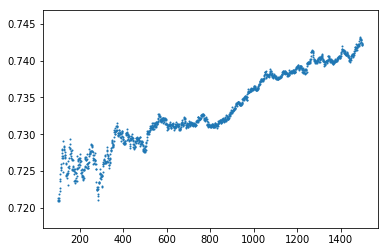

1390


In [120]:
plt.scatter(range(100,1501),spear_list, s=1)
plt.show()
print(np.argmax(spear_list))

<font face="EB Garamond" size=5 color=#000000 >
Model 2: Gaussian Process

In [16]:
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import (RBF, Matern, RationalQuadratic,
                                              ExpSineSquared, DotProduct,
                                              ConstantKernel)
from sklearn.gaussian_process.kernels import WhiteKernel, ExpSineSquared
from sklearn.gaussian_process.kernels import Kernel

In [206]:
def run_experiment_test(function, input_dataset, start_num, period, day):
    
    num, feature = input_dataset.shape
    # i is start date. the total data num is 2493 * 8 
    # 2872
    # Consider efficiency, run small data size for testing
    
    
    param_list=np.zeros((num-start_num-period-day,2))
    
    i = start_num
    df = pd.DataFrame(data=[], index=input_dataset.index[(i+period +day) :], columns=['org_price','pred_price','error']) 
    
    while (i+period+day) != num :  
        X = input_dataset.iloc[i:i+period, :]
        Y = input_dataset.iloc[i+day:i+period+day, -1]  
        x_pred = input_dataset.iloc[i+period:i+period+1, :]
        
        y_pred, param_list_ = function(X, Y, x_pred)
        
        param_list[i-start_num] = param_list_
        
        y_org = input_dataset.iloc[i+period+day, -1]
        error = np.abs(y_org - y_pred)
        pred_date = input_dataset.index[i+period+day].strftime('%Y-%m-%d') 
        df.set_value(pred_date, 'org_price', y_org)
        df.set_value(pred_date, 'pred_price', y_pred)
        df.set_value(pred_date, 'error',error)
        print(pred_date, "%.8f" % y_org, "%.8f" % y_pred, "%.8f" %error) 
        i=i+1
        
    return df, param_list

In [207]:
def gaussian_process(X, Y, x_pred):
       
    X = X.values
    Y = Y.values
    x_pred = x_pred.values
    param_list = np.zeros((2,))
    kernels = 1.0 * DotProduct(sigma_0=1.0, sigma_0_bounds=(1e-05, 100000.0)) + 1.0 * WhiteKernel(noise_level=1e-1)
#     1.0 * DotProduct(sigma_0=1.0, sigma_0_bounds=(1e-05, 100000.0))    \
#     +1.0 * RationalQuadratic(length_scale=1.0) \
#     + 1.0 * WhiteKernel(noise_level=1e-1) \
#     + 1.0 * Matern(length_scale=1.0, nu=1.5) \
#     + 1.0 * RBF(length_scale=1.0, length_scale_bounds=(1e-05, 100000.0))\
#     + 1.0 * ExpSineSquared(length_scale=1.0, periodicity=1.0, length_scale_bounds=(1e-05, 100000.0), periodicity_bounds=(1e-05, 100000.0))
    #+ 1.0 * DotProduct(sigma_0=1.0, sigma_0_bounds=(1e-05, 100000.0))         
    #+ 1.0 * ConstantKernel(constant_value=1.0, constant_value_bounds=(1e-05, 100000.0))\
        
    gp = GaussianProcessRegressor(kernel=kernels, n_restarts_optimizer=10, alpha = 0)
    
    # Fit to data using Maximum Likelihood Estimation of the parameters
    # learn the hyperparameters and scale of each kernel
    gp.fit(X, Y)
    #print(kernels.get_params(deep=True))
    
    
    print(gp.kernel_.get_params())  #check the kernel parameter
    params_set = gp.kernel_.get_params()
    
    forecast= gp.predict(x_pred, return_std=True, return_cov=False)
    y_pred = forecast[0][0]
    
    param_list[0] = params_set['k1__k2__length_scale']
    param_list[1] = params_set['k2__k2__noise_level']
#     param_list[2] = params_set['k1__k1__k1__k1__k2__k2__alpha']
#     param_list[3] = params_set['k1__k1__k1__k2__k2__noise_level']
#     param_list[4] = params_set['k1__k1__k2__k2__length_scale']
#     param_list[5] = params_set['k1__k2__k2__length_scale']
#     param_list[6] = params_set['k2__k2__length_scale']
#     param_list[7] = params_set['k2__k2__periodicity']
#     param_list[0] = params_set['k1__k1__k2__sigma_0']
#     param_list[1] = params_set['k1__k2__k2__length_scale']
#     param_list[2] = params_set['k1__k2__k2__alpha']
#     param_list[3] = params_set['k2__k2__noise_level']
    return y_pred, param_list



In [210]:
result, param_list = run_experiment_test(gaussian_process, cu_log_return, start_num=1350, period=1000, day=1)

good
{'k1': 7.68**2 * Matern(length_scale=42.6, nu=1.5), 'k2': 0.0356**2 * WhiteKernel(noise_level=171), 'k1__k1': 7.68**2, 'k1__k2': Matern(length_scale=42.6, nu=1.5), 'k1__k1__constant_value': 59.001668382848294, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 42.56468452077948, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 0.0356**2, 'k2__k2': WhiteKernel(noise_level=171), 'k2__k1__constant_value': 0.001266214964123702, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 171.34218882365764, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2017-11-16 0.10958271 0.22538774 0.11580503
good


/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:26: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:27: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:28: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead


{'k1': 7.59**2 * Matern(length_scale=42, nu=1.5), 'k2': 4.15**2 * WhiteKernel(noise_level=0.0126), 'k1__k1': 7.59**2, 'k1__k2': Matern(length_scale=42, nu=1.5), 'k1__k1__constant_value': 57.653637418477963, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 42.020633552232965, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 4.15**2, 'k2__k2': WhiteKernel(noise_level=0.0126), 'k2__k1__constant_value': 17.227784982457688, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.012581591112466171, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2017-11-17 0.00653698 -0.17069165 0.17722863
good
{'k1': 7.43**2 * Matern(length_scale=40.9, nu=1.5), 'k2': 0.0476**2 * WhiteKernel(noise_level=95.3), 'k1__k1': 7.43**2, 'k1__k2': Matern(length_scale=40.9, nu=1.5), 'k1__k1__constant_value': 55.201978286448117, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 40.940515336062873, 'k1__k2__length_s

{'k1': 8.3**2 * Matern(length_scale=47, nu=1.5), 'k2': 1.23**2 * WhiteKernel(noise_level=0.144), 'k1__k1': 8.3**2, 'k1__k2': Matern(length_scale=47, nu=1.5), 'k1__k1__constant_value': 68.869188368091216, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 46.953275780932216, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 1.23**2, 'k2__k2': WhiteKernel(noise_level=0.144), 'k2__k1__constant_value': 1.5136069995053132, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.1442556170384065, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2017-12-06 -2.36339866 -2.16116574 0.20223292
good
{'k1': 8.31**2 * Matern(length_scale=46.9, nu=1.5), 'k2': 1.26**2 * WhiteKernel(noise_level=0.138), 'k1__k1': 8.31**2, 'k1__k2': Matern(length_scale=46.9, nu=1.5), 'k1__k1__constant_value': 69.0171175805784, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 46.948291361850451, 'k1__k2__length_scale_bou

{'k1': 8.4**2 * Matern(length_scale=47.6, nu=1.5), 'k2': 0.523**2 * WhiteKernel(noise_level=0.794), 'k1__k1': 8.4**2, 'k1__k2': Matern(length_scale=47.6, nu=1.5), 'k1__k1__constant_value': 70.607592855186482, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 47.601762715792368, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 0.523**2, 'k2__k2': WhiteKernel(noise_level=0.794), 'k2__k1__constant_value': 0.27369455046983121, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.79381199619633103, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2017-12-25 0.82112642 0.24343607 0.57769035
good
{'k1': 8.45**2 * Matern(length_scale=48, nu=1.5), 'k2': 83.3**2 * WhiteKernel(noise_level=3.13e-05), 'k1__k1': 8.45**2, 'k1__k2': Matern(length_scale=48, nu=1.5), 'k1__k1__constant_value': 71.431567694997469, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 47.95087530313323, 'k1__k2__length_sca

{'k1': 8.8**2 * Matern(length_scale=50.4, nu=1.5), 'k2': 1.22**2 * WhiteKernel(noise_level=0.146), 'k1__k1': 8.8**2, 'k1__k2': Matern(length_scale=50.4, nu=1.5), 'k1__k1__constant_value': 77.378725867843329, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 50.361593305533027, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 1.22**2, 'k2__k2': WhiteKernel(noise_level=0.146), 'k2__k1__constant_value': 1.4935049971768111, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.14637250480410513, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2018-01-12 -0.53597184 -0.06412871 0.47184313
good
{'k1': 8.92**2 * Matern(length_scale=51.1, nu=1.5), 'k2': 0.421**2 * WhiteKernel(noise_level=1.24), 'k1__k1': 8.92**2, 'k1__k2': Matern(length_scale=51.1, nu=1.5), 'k1__k1__constant_value': 79.546086157799422, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 51.140316977845529, 'k1__k2__length_sc

{'k1': 9.23**2 * Matern(length_scale=53.7, nu=1.5), 'k2': 0.666**2 * WhiteKernel(noise_level=0.495), 'k1__k1': 9.23**2, 'k1__k2': Matern(length_scale=53.7, nu=1.5), 'k1__k1__constant_value': 85.222898831334746, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 53.745566745464082, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 0.666**2, 'k2__k2': WhiteKernel(noise_level=0.495), 'k2__k1__constant_value': 0.4435062358578602, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.49511588874201196, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2018-01-31 -0.22852927 -0.18070422 0.04782506
good
{'k1': 9.06**2 * Matern(length_scale=52.7, nu=1.5), 'k2': 0.262**2 * WhiteKernel(noise_level=3.18), 'k1__k1': 9.06**2, 'k1__k2': Matern(length_scale=52.7, nu=1.5), 'k1__k1__constant_value': 82.146838556383855, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 52.738966269132376, 'k1__k2__lengt

{'k1': 7.16**2 * Matern(length_scale=42.6, nu=1.5), 'k2': 0.39**2 * WhiteKernel(noise_level=1.45), 'k1__k1': 7.16**2, 'k1__k2': Matern(length_scale=42.6, nu=1.5), 'k1__k1__constant_value': 51.299045569292851, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 42.601554797395998, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 0.39**2, 'k2__k2': WhiteKernel(noise_level=1.45), 'k2__k1__constant_value': 0.15191065001132423, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 1.4451978537503971, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2018-02-26 -0.13960669 -0.30438008 0.16477339
good
{'k1': 7.17**2 * Matern(length_scale=42.7, nu=1.5), 'k2': 0.0355**2 * WhiteKernel(noise_level=174), 'k1__k1': 7.17**2, 'k1__k2': Matern(length_scale=42.7, nu=1.5), 'k1__k1__constant_value': 51.43792527314784, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 42.677000690242643, 'k1__k2__length_sca

{'k1': 7.33**2 * Matern(length_scale=43.8, nu=1.5), 'k2': 1.21**2 * WhiteKernel(noise_level=0.149), 'k1__k1': 7.33**2, 'k1__k2': Matern(length_scale=43.8, nu=1.5), 'k1__k1__constant_value': 53.796500226632944, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 43.795215500207192, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 1.21**2, 'k2__k2': WhiteKernel(noise_level=0.149), 'k2__k1__constant_value': 1.4745023826228705, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.14936261541399021, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2018-03-15 0.23274183 0.22159756 0.01114427
good
{'k1': 7.33**2 * Matern(length_scale=43.8, nu=1.5), 'k2': 1.21**2 * WhiteKernel(noise_level=0.149), 'k1__k1': 7.33**2, 'k1__k2': Matern(length_scale=43.8, nu=1.5), 'k1__k1__constant_value': 53.704240046092558, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 43.755352195455153, 'k1__k2__length_sc

{'k1': 7.59**2 * Matern(length_scale=45.8, nu=1.5), 'k2': 1.23**2 * WhiteKernel(noise_level=0.147), 'k1__k1': 7.59**2, 'k1__k2': Matern(length_scale=45.8, nu=1.5), 'k1__k1__constant_value': 57.633365263682386, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 45.788623001156779, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 1.23**2, 'k2__k2': WhiteKernel(noise_level=0.147), 'k2__k1__constant_value': 1.5107807903409953, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.14699607573838422, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2018-04-03 0.36185539 0.14852817 0.21332722
good
{'k1': 7.6**2 * Matern(length_scale=45.8, nu=1.5), 'k2': 0.0145**2 * WhiteKernel(noise_level=1.06e+03), 'k1__k1': 7.6**2, 'k1__k2': Matern(length_scale=45.8, nu=1.5), 'k1__k1__constant_value': 57.738623802964106, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 45.820214325735044, 'k1__k2__length

{'k1': 8.52**2 * Matern(length_scale=53.2, nu=1.5), 'k2': 1.22**2 * WhiteKernel(noise_level=0.148), 'k1__k1': 8.52**2, 'k1__k2': Matern(length_scale=53.2, nu=1.5), 'k1__k1__constant_value': 72.66666022342767, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 53.199093452241016, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 1.22**2, 'k2__k2': WhiteKernel(noise_level=0.148), 'k2__k1__constant_value': 1.4856751129612877, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.14789944298765589, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2018-04-24 -0.40205785 -0.32692889 0.07512896
good
{'k1': 8.51**2 * Matern(length_scale=53.1, nu=1.5), 'k2': 1.22**2 * WhiteKernel(noise_level=0.148), 'k1__k1': 8.51**2, 'k1__k2': Matern(length_scale=53.1, nu=1.5), 'k1__k1__constant_value': 72.382940219172639, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 53.065209834277567, 'k1__k2__length_s

{'k1': 9.11**2 * Matern(length_scale=57.2, nu=1.5), 'k2': 1.98**2 * WhiteKernel(noise_level=0.0555), 'k1__k1': 9.11**2, 'k1__k2': Matern(length_scale=57.2, nu=1.5), 'k1__k1__constant_value': 83.050996289404651, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 57.249241860300437, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 1.98**2, 'k2__k2': WhiteKernel(noise_level=0.0555), 'k2__k1__constant_value': 3.9243016014372123, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.055534921868276008, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2018-05-15 -0.42022068 -0.33518540 0.08503527
good
{'k1': 8.97**2 * Matern(length_scale=56.2, nu=1.5), 'k2': 1.23**2 * WhiteKernel(noise_level=0.143), 'k1__k1': 8.97**2, 'k1__k2': Matern(length_scale=56.2, nu=1.5), 'k1__k1__constant_value': 80.47606004139476, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 56.248615700695701, 'k1__k2__lengt

{'k1': 8.04**2 * Matern(length_scale=49.8, nu=1.5), 'k2': 0.868**2 * WhiteKernel(noise_level=0.283), 'k1__k1': 8.04**2, 'k1__k2': Matern(length_scale=49.8, nu=1.5), 'k1__k1__constant_value': 64.588935081619212, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 49.752177117150481, 'k1__k2__length_scale_bounds': (1e-05, 100000.0), 'k1__k2__nu': 1.5, 'k2__k1': 0.868**2, 'k2__k2': WhiteKernel(noise_level=0.283), 'k2__k1__constant_value': 0.75284308009165801, 'k2__k1__constant_value_bounds': (1e-05, 100000.0), 'k2__k2__noise_level': 0.28340913833142362, 'k2__k2__noise_level_bounds': (1e-05, 100000.0)}
2018-06-01 0.17381460 0.00094685 0.17286775
good
{'k1': 7.36**2 * Matern(length_scale=45.1, nu=1.5), 'k2': 1.22**2 * WhiteKernel(noise_level=0.142), 'k1__k1': 7.36**2, 'k1__k2': Matern(length_scale=45.1, nu=1.5), 'k1__k1__constant_value': 54.240845879608536, 'k1__k1__constant_value_bounds': (1e-05, 100000.0), 'k1__k2__length_scale': 45.125930801819031, 'k1__k2__length

In [128]:
# save testing data
file_name = 'cu_RQ_white_1000_noise_level.csv'
save_csv = STORE_DIR + file_name 
data = pd.Series(param_list[:,2])
data.to_csv(save_csv, index=True, header=True)

# file_name_1 = 'cu_DP_WHITE_1000_sigma.csv'
# save_csv = STORE_DIR + file_name_1 
# sigma = pd.Series(sigma)
# sigma.to_csv(save_csv, index=True, header=True)

# file_name_2 = 'cu_DP_WHITE_1000_ls.csv'
# save_csv = STORE_DIR + file_name_2
# scale = pd.Series(scale)
# scale.to_csv(save_csv, index=True, header=True)

# file_name_3 = 'cu_ES_WHITE_1000_periodicity.csv'
# save_csv = STORE_DIR + file_name_3
# period = pd.Series(period)
# period.to_csv(save_csv, index=True, header=True)

# file_name_4 = 'cu_DP_WHITE_1000_noise_level.csv'
# save_csv = STORE_DIR + file_name_4
# noise_level = pd.Series(noise_level)
# noise_level.to_csv(save_csv, index=True, header=True)

# file_name = 'cu_DP_RQ_white_Matern_RBF_ES_result.csv'
# save_csv = STORE_DIR + file_name 
# #data = pd.Series(param_list[:,7])
# result.to_csv(save_csv, index=True, header=True)


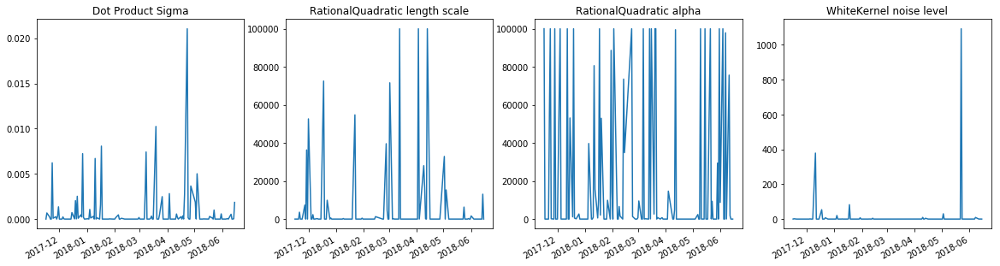

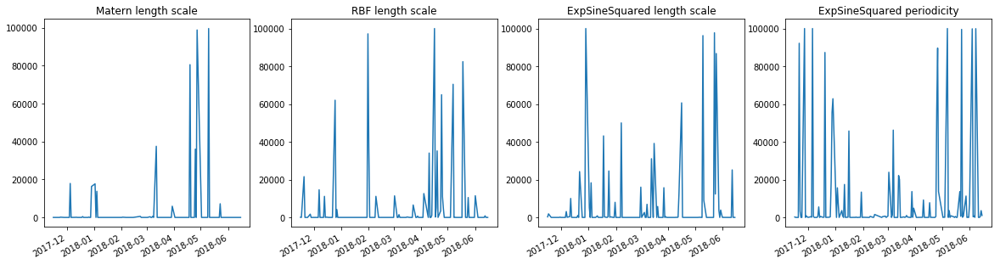

In [104]:
# plt.plot(cu_log_return.index[2351:].values, param_list[:,0], label='Dot Product Sigma')
# #plt.plot(cu_log_return.index[2351:].values, param_list[:,3])
# #plt.plot(cu_log_return.index[2351:].values, param_list[:,2])
# #plt.title('DP+RQ+White noise kernel window_size=1000 sigma')
# monthsLoc = mpl.dates.MonthLocator()
# weeksLoc = mpl.dates.WeekdayLocator()
# monthsFmt = mpl.dates.DateFormatter('%b')
# fig = plt.gcf()
# fig.set_size_inches(20,10)
# plt.legend()
# plt.gcf().autofmt_xdate() 
# plt.show()

# plt.plot(cu_log_return.index[2351:].values, param_list[:,1], label='RationalQuadratic length scale')
# plt.plot(cu_log_return.index[2351:].values, param_list[:,2], label='RationalQuadratic alpha')
# plt.plot(cu_log_return.index[2351:].values, param_list[:,4], label='Matern length scale')
# plt.plot(cu_log_return.index[2351:].values, param_list[:,5], label='RBF length scale')
# plt.plot(cu_log_return.index[2351:].values, param_list[:,6], label='ExpSineSquared length scale')
# plt.plot(cu_log_return.index[2351:].values, param_list[:,7], label='ExpSineSquared periodicity')

# #plt.title('DP+RQ+White noise kernel window_size=1000 length_sclae')
# monthsLoc = mpl.dates.MonthLocator()
# weeksLoc = mpl.dates.WeekdayLocator()
# monthsFmt = mpl.dates.DateFormatter('%b')
# fig = plt.gcf()
# fig.set_size_inches(20,10)
# plt.gcf().autofmt_xdate() 
# plt.legend()
# plt.show()

# plt.plot(cu_log_return.index[2351:].values, param_list[:,3], label ='WhiteKernel noise level')
# #plt.plot(cu_log_return.index[2351:].values, param_list[:,3])
# #plt.plot(cu_log_return.index[2351:].values, param_list[:,2])
# #plt.title('DP+RQ+White noise kernel window_size=1000 sigma')
# monthsLoc = mpl.dates.MonthLocator()
# weeksLoc = mpl.dates.WeekdayLocator()
# monthsFmt = mpl.dates.DateFormatter('%b')
# fig = plt.gcf()
# fig.set_size_inches(20,10)
# plt.legend()
# plt.gcf().autofmt_xdate() 
# plt.show()


fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,5))
monthsLoc = mpl.dates.MonthLocator()
weeksLoc = mpl.dates.WeekdayLocator()
monthsFmt = mpl.dates.DateFormatter('%b')
fig = plt.gcf()
plt.gcf().autofmt_xdate() 
axes[0].plot(cu_log_return.index[2351:].values, param_list[:,0], label='Dot Product Sigma')
axes[0].set_title('Dot Product Sigma')
axes[1].plot(cu_log_return.index[2351:].values, param_list[:,1], label='RationalQuadratic length scale')
axes[1].set_title('RationalQuadratic length scale')
axes[2].plot(cu_log_return.index[2351:].values, param_list[:,2], label='RationalQuadratic alpha')
axes[2].set_title('RationalQuadratic alpha')
axes[3].plot(cu_log_return.index[2351:].values, param_list[:,3], label ='WhiteKernel noise level')
axes[3].set_title('WhiteKernel noise level')
plt.show()


fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20,5))
monthsLoc = mpl.dates.MonthLocator()
weeksLoc = mpl.dates.WeekdayLocator()
monthsFmt = mpl.dates.DateFormatter('%b')
fig = plt.gcf()
plt.gcf().autofmt_xdate() 
axes[0].plot(cu_log_return.index[2351:].values, param_list[:,4], label='Matern length scale')
axes[0].set_title('Matern length scale')
axes[1].plot(cu_log_return.index[2351:].values, param_list[:,5], label='RBF length scale')
axes[1].set_title('RBF length scale')
axes[2].plot(cu_log_return.index[2351:].values, param_list[:,6], label='ExpSineSquared length scale')
axes[2].set_title('ExpSineSquared length scale')
axes[3].plot(cu_log_return.index[2351:].values, param_list[:,7], label='ExpSineSquared periodicity')
axes[3].set_title('ExpSineSquared periodicity')
plt.show()

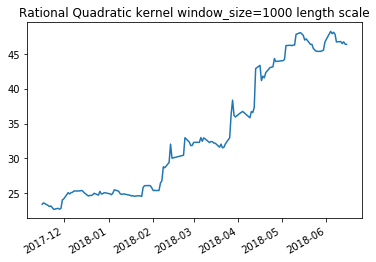

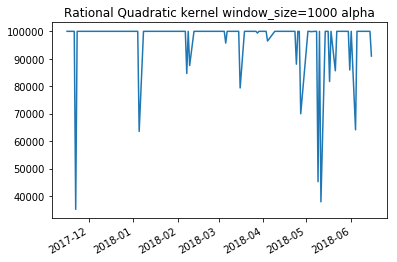

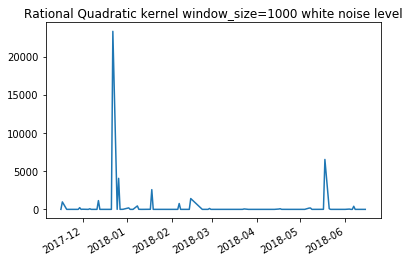

In [202]:

plt.plot(cu_log_return.index[2351:].values, param_list[:,0])
plt.title('Rational Quadratic kernel window_size=1000 length scale')
monthsLoc = mpl.dates.MonthLocator()
weeksLoc = mpl.dates.WeekdayLocator()
monthsFmt = mpl.dates.DateFormatter('%b')
fig = plt.gcf()
#fig.set_size_inches(20,10)
plt.gcf().autofmt_xdate() 
plt.show()

plt.plot(cu_log_return.index[2351:].values, param_list[:,1])

plt.title('Rational Quadratic kernel window_size=1000 alpha')
monthsLoc = mpl.dates.MonthLocator()
weeksLoc = mpl.dates.WeekdayLocator()
monthsFmt = mpl.dates.DateFormatter('%b')
fig = plt.gcf()
#fig.set_size_inches(20,10)
plt.gcf().autofmt_xdate() 
plt.show()


plt.plot(cu_log_return.index[2351:], param_list[:,2])
# for i in index_high:
#     plt.scatter(cu_log_return.index[2351+i], test_array[i], c='r')
plt.title('Rational Quadratic kernel window_size=1000 white noise level')
monthsLoc = mpl.dates.MonthLocator()
weeksLoc = mpl.dates.WeekdayLocator()
monthsFmt = mpl.dates.DateFormatter('%b')
fig = plt.gcf()
#fig.set_size_inches(20,10)
plt.gcf().autofmt_xdate() 
plt.show()


In [211]:
print(evaluate('', result['org_price'].values[0:], result['pred_price'].values[0:]))

       MSE       MAE      RMSE        DTW Spearmanr
  0.140683  0.281838  0.375078  0.0973447  0.766997


/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:22: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:23: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:24: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessor

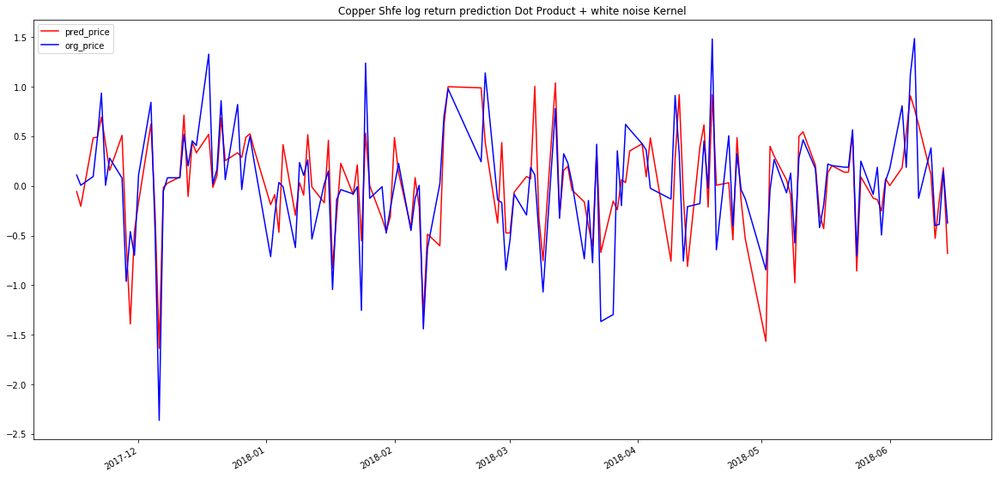

In [218]:
file_name = 'cu_RQ_1000.csv'
load_csv = STORE_DIR + file_name 

result_3 = pd.read_csv(load_csv)
plt.title('Copper Shfe log return prediction Dot Product + white noise Kernel')
plt.plot(result.index[0:], result_3['pred_price'][0:] , c='r', label = 'pred_price')
plt.plot(result.index[0:], result_3['org_price'][0:], c='b', label ='org_price')
monthsLoc = mpl.dates.MonthLocator()
weeksLoc = mpl.dates.WeekdayLocator()
monthsFmt = mpl.dates.DateFormatter('%b')
fig = plt.gcf()
fig.set_size_inches(20,10)
plt.gcf().autofmt_xdate() 
#plt.ylabel(metal_name+' shfe price log return')
plt.legend()
plt.show()

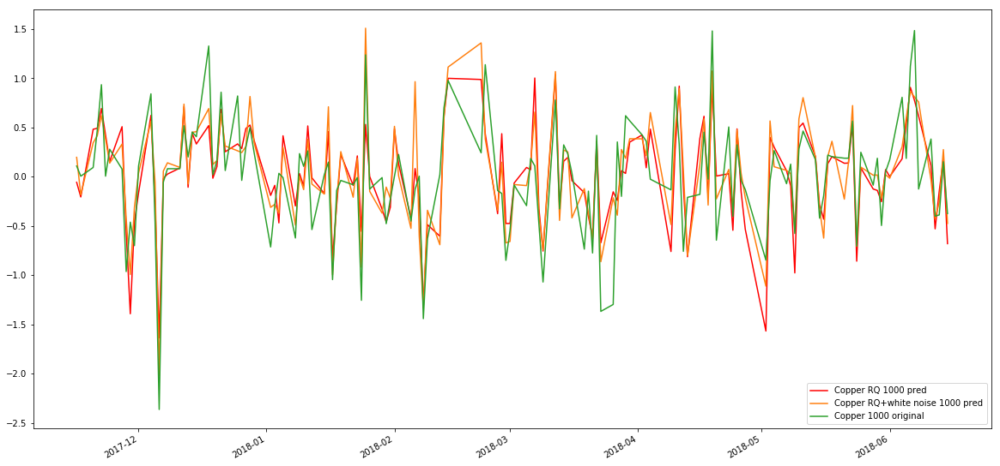

In [201]:
#plot_result(result, 'Cu')
file_name = 'cu_DP_WHITE_1000.csv‘
load_csv = STORE_DIR + file_name 

result_2 = pd.read_csv(load_csv)
plt.plot(result.index[0:], result_2['pred_price'][0:], c='r', label='Copper RQ 1000 pred')
plt.plot(result.index[0:], result['pred_price'][0:] , c='C1', label = 'Copper RQ+white noise 1000 pred')
plt.plot(result.index[0:], result['org_price'][0:], c='C2', label ='Copper 1000 original')
# for i in index_high:    
#     plt.scatter(cu_log_return.index[2351+i], result['org_price'][i], c='k')

monthsLoc = mpl.dates.MonthLocator()
weeksLoc = mpl.dates.WeekdayLocator()
monthsFmt = mpl.dates.DateFormatter('%b')
fig = plt.gcf()
fig.set_size_inches(20,10)
plt.gcf().autofmt_xdate() 
#plt.ylabel(metal_name+' shfe price log return')
plt.legend()
plt.show()

In [137]:
print(evaluate('', result['org_price'].values[0:], result['pred_price'].values[0:]))

       MSE       MAE      RMSE       DTW Spearmanr
  0.294004  0.386132  0.542221  0.217542  0.504397


/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:20: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:21: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:22: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:23: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessors instead
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:24: FutureWarning: set_value is deprecated and will be removed in a future release. Please use .at[] or .iat[] accessor

<font face="EB Garamond" size=5 color=#000000 >
Model 3: Multiple kernel learning with kernel ridge regression

Gaussian process optimised by maximal neg loglikehood(evidence) to estimate the posterior distribution, we try to learn the parameter of combination of kernel(prior knowledge from data).
GOOD: we can evaluate the Confidence interval by analysis variance.
BAD: doesn't work for lag=5 data


Multiple kernel learning in kernel ridge regression. 
we set weigths for each family of kernels is equal to set regularisation parameter of each kernel.
restricted in hypothesis space from observation data
GOOD: can use multiple kernel learning to select feature, try to add lag to each feature data. (for lag=5 predication)

Except L2 norm kernel learning, we can also learn kernel from Multiple kernel learning methods based on centered alignment

Ref: https://arxiv.org/abs/1712.08597 //
     https://arxiv.org/abs/1205.2653


In [85]:
#from mklaren.mkl.align import Align
class mkl_kernel_ridge_regression:
    
    def __init__(self):
        #store kernels in array
        self.kernel = []
        self.test_kernel =[]
        # self.cov = combined kernel
        self.cov = 0
        # self.invcov = inverse combined kernel
        self.invcov =0
        # the range of kernel's hyperparameter from 1e-05 to 1e5, bound_num is Number of samples to generate from range
        self.bound_num = 11
        # 7 different type of kernel, each kernel have 11 hyperparameter choices
        self.kernel_num = self.bound_num * 7
        self.evaluation = []
        # weights of each kernel
        self.weights = np.zeros(shape=(self.kernel_num,1))  *  (1/self.kernel_num)
        # initial weights of each kernel
        self.init =  np.ones(shape=(self.kernel_num,1)) *  (1/self.kernel_num)
        self.alpha = []
        self.alpha_ = []
        # gradient for every update
        self.grad = np.zeros(shape=(self.kernel_num,1)) 
        
    def feed_kernel(self, X, x_pred):

        x_len=X.shape[0]
        X_all = np.vstack((X,x_pred))
        x_all_len = X_all.shape[0]
        
        bound = np.logspace(-5, 5, self.bound_num)
        kernel = np.zeros(shape=(self.kernel_num, x_all_len, x_all_len))
        i = 0
        while i < self.kernel_num-1:
            for hyper_param in bound:
                k1 = ConstantKernel(constant_value= hyper_param, constant_value_bounds=(1e-05, 100000.0))
                k2 = RBF(length_scale=hyper_param, length_scale_bounds=(1e-05, 100000.0))
                k3 = Matern(length_scale=hyper_param, length_scale_bounds=(1e-05, 100000.0), nu=1.5)
                k4 = RationalQuadratic(length_scale=hyper_param, alpha=1.0, length_scale_bounds=(1e-05, 100000.0), alpha_bounds=(1e-05, 100000.0))
                k5 = ExpSineSquared(length_scale=hyper_param, periodicity=1.0, length_scale_bounds=(1e-05, 100000.0), periodicity_bounds=(1e-05, 100000.0))
                k6 = DotProduct(sigma_0=hyper_param, sigma_0_bounds=(1e-05, 100000.0))
                k7 = WhiteKernel(noise_level=hyper_param, noise_level_bounds=(1e-05, 100000.0))

                kernel[i] = k1(X_all, X_all)
                kernel[i+1] = k2(X_all, X_all)
                kernel[i+2] = k3(X_all, X_all)
                kernel[i+3] = k4(X_all, X_all)
                kernel[i+4] = k5(X_all, X_all)            
                kernel[i+5] = k6(X_all, X_all)
                kernel[i+6] = k7(X_all, X_all)
                i = i+7
        
        self.kernel = kernel[:,0:-1,0:-1]
        self.test_kernel = kernel[:,-1:,0:-1]


    def compute_alpha(self, weights, Y):
        self.cov = np.sum(weights[:,:,None]*self.kernel,axis=0)
        self.invcov  = np.linalg.inv(self.cov)
        return np.dot(self.invcov, Y)
            
    #compute weight of multiple kernel    
    def fit(self, X, Y): 
           
#         model = Align()
#         model.fit(self.kernel, Y)
#         self.weights = model.mu.reshape((self.kernel_num,1))
#         self.alpha = self.compute_alpha(self.weights, Y) 
#         print(self.weights)
        
        self.alpha_ = self.compute_alpha(self.init, Y)
        self.alpha = np.random.randn((Y.shape[0]),1)
        
        while np.linalg.norm(self.alpha_-self.alpha, ord=2)>0.1:
            
            self.alpha = self.alpha_
            
            self.evaluation.append(self.compute_evla(Y, self.alpha))
            #self.evaluation.append(self.log_likelihood(Y))

            for i in range(self.kernel_num):

                self.grad[i] = np.dot(np.dot(self.alpha.T, self.kernel[i]), self.alpha)

            self.grad = self.grad / np.linalg.norm(self.grad,ord=2) 

            self.weights = self.init +  np.linalg.norm(self.weights-self.init,ord=2) * self.grad

            self.alpha_ = self.compute_alpha(self.weights, Y) 
            
        #print(np.sum(self.weights))
        
        #print(self.weights)
        
        plt.plot(self.evaluation)
        plt.show()
           
    #evaluation of dual problem (maximise alpha)           
    def compute_evla(self, Y, alpha):
        K = np.sum(self.weights[:,:,None]* self.kernel, axis=0)
        result = -np.dot(alpha.T, alpha) - np.dot(np.dot(alpha.T, K), alpha)+ 2* np.dot(alpha.T, Y)
        return result
        
    
#     def log_likelihood(self, Y):
#         return (1/2)*np.dot(np.dot(Y.T, self.invcov), Y)+(1/2)*np.log(np.linalg.det(self.cov))+ (1/2)*np.dot(np.dot(Y.T, self.invcov), Y)
    
    
    def pred(self, X, Y, x_pred):
       
        kernel_test = np.sum(self.weights[:,:,None]* self.test_kernel, axis=0) 
        
        mean =  np.dot(kernel_test, self.alpha)
        
        return mean
    
    
    def __del__(self):
        
        del self.kernel
        del self.test_kernel
        del self.optimise
        del self.cov
        del self.invcov 
        del self.bound_num 
        del self.kernel_num 
        del self.evaluation 
        del self.weights
        del self.init 
        del self.alpha  
        del self.alpha_  
        del self.grad 

In [86]:
def mkl_krr(X, Y, x_pred):    
    krr =  mkl_kernel_ridge_regression()
    X = X.values
    Y = Y.values
    x_pred = x_pred.values
    krr.feed_kernel(X, x_pred)
    krr.fit(X,Y)
    y_pred = krr.pred(X,Y,x_pred)
    del krr
    return y_pred

In [88]:
#result_mkl = run_experiment(mkl_krr ,cu_log_return)

In [70]:
#plot_result(result_mkl, 'Cu',pointer=0)

In [71]:
#mkl_krr = evaluate('mkl_krr', result_mkl['org_price'][0:], result_mkl['pred_price'][0:])
#print(mkl_krr)

<font face="EB Garamond" size=5 color=#000000 >
Model 3.5: MKL select feature demo

In [1]:
import datetime
class mkl_feature_selection:
    def __init__(self, X, Y, lag_num):
        self.X = X
        #shift X may have nan value. select available part 
        self.Y = Y.iloc[lag_num:]
        self.data_num = self.X.shape[0]
        self.feature_num = self.X.shape[1]
        self.kernel_num = 7
        #sample size of kernel's hyperparameter
        self.bound_num = 11
        self.kernel_param_bound = np.logspace(-5, 5, self.bound_num)
        #sample size of lag (0,1,2,3,4,5)
        self.lag_num = lag_num
        self.lag_bound = np.linspace(0,self.lag_num-1,self.lag_num, dtype=int)
        #total individual kernel num
        self.num = self.feature_num * self.lag_num * self.kernel_num * self.bound_num
        #store the weights of each kernel
        self.weights = np.zeros(shape=(self.num,1)) 
        #gradient for every update
        self.grad = np.zeros(shape=(self.num,1)) *  (1/self.num)
        #remove nan data
        self.avail_start = self.X.index[self.lag_num]
        #initial weights for each kernel
        self.init =  np.ones(shape=(self.num,1)) *  (1/self.num)
        #combined kernel
        self.cov = 0
        #inverse combined kernel
        self.optimise = 10
        self.covinv = 0
        self.alpha = []
        self.alpha_ = []
        self.kernel = []
        
    def lag_process(self, xs,lag):
        xs = xs.shift(periods=lag)
        return xs
    
    #feature with different lag and combine to one dataset
    def build_dataset(self):
        dataset =np.zeros(shape=(self.feature_num, self.lag_num, self.data_num -self.lag_num))
        for i in range(self.feature_num):
            for j in range(self.lag_num):
                df_Xy = self.lag_process(self.X.iloc[:,i], self.lag_bound[j])
                df_Xy = df_Xy.loc[self.avail_start:]
                dataset[i,j,:] = df_Xy         
        return dataset
    
    # individual kernels: num_feature * num_lag * num_kernel_type * num_kernel_hyperparameter
    def construct_kernel(self, dataset):
        
        len_ = self.data_num -self.lag_num 
        kernel = np.zeros(shape=(self.num, len_, len_))
        index = 0
        for i in range(self.feature_num):
            for j in range(self.lag_num):
                X = dataset[i,j,:] 
                X = X.reshape((len_, 1))
                for hyper_param in self.kernel_param_bound:
                    k1 = ConstantKernel(constant_value= hyper_param, constant_value_bounds=(1e-05, 100000.0))
                    k2 = RBF(length_scale=hyper_param, length_scale_bounds=(1e-05, 100000.0))
                    k3 = Matern(length_scale=hyper_param, length_scale_bounds=(1e-05, 100000.0), nu=1.5)
                    k4 = RationalQuadratic(length_scale=hyper_param, alpha=1.0, length_scale_bounds=(1e-05, 100000.0), alpha_bounds=(1e-05, 100000.0))
                    k5 = ExpSineSquared(length_scale=hyper_param, periodicity=1.0, length_scale_bounds=(1e-05, 100000.0), periodicity_bounds=(1e-05, 100000.0))
                    k6 = DotProduct(sigma_0=hyper_param, sigma_0_bounds=(1e-05, 100000.0))
                    k7 = WhiteKernel(noise_level=hyper_param, noise_level_bounds=(1e-05, 100000.0))
    
                    kernel[index] = k1(X, X)            
                    kernel[index+1] = k2(X, X)
                    kernel[index+2] = k3(X, X)
                    kernel[index+3] = k4(X, X)
                    kernel[index+4] = k5(X, X)
                    kernel[index+5] = k6(X, X)
                    kernel[index+6] = k7(X, X)
                    index = index+7
                    
        return kernel
    
    def compute_alpha(self, weights, kernel):
        self.cov = np.sum(weights[:,:,None]*kernel,axis=0)
        self.invcov  = np.linalg.inv(self.cov)
        return np.dot(self.invcov, self.Y)
            
    #compute weight of multiple kernel    
    def fit(self, kernel): 
        self.alpha = self.compute_alpha(self.init, kernel)
        for j in range(self.optimise):
            for i in range(self.num):
                self.grad[i] = np.dot(np.dot(self.alpha.T, kernel[i]), self.alpha)
            self.grad = self.grad / np.linalg.norm(self.grad,ord=2) 
            self.weights = self.init +  np.linalg.norm(self.weights-self.init,ord=2) * self.grad
            self.alpha = self.compute_alpha(self.weights, kernel)    
        return self.weights
        
    def process(self):
        dataset = self.build_dataset()
        kernel = self.construct_kernel(dataset)
        weights = self.fit(kernel)
        return weights
    
    def plot_feature_lag(self, weights):
        weights_ = weights.reshape((self.feature_num, self.lag_num, self.kernel_num, self.bound_num))
        weights_1 = np.sum(np.sum(weights_,axis=3),axis=2)
        plt.imshow(weights_1, cmap='hot', interpolation='nearest')
        plt.xlabel('lag')
        plt.ylabel('features')
        plt.xticks([0, 1, 2, 3, 4, 5],[r'$0$',r'$1$',  r'$2$',  r'$3$',  r'$4$',  r'$5$'])
        plt.yticks([0, 1, 2, 3, 4, 5, 6, 7],[r'$lme\_stocks$', r'$lme\_prices$', r'$ted$', r'$ted\_spread$', r'$bdi$',r'$vix$',r'$gsci$', r'$shfe\_price$' ])
        fig.set_size_inches(10,10)
        plt.colorbar() 
        plt.show()
    
    def plot_feature_kernel(self, weights):
        weights_ = weights.reshape((self.feature_num, self.lag_num, self.kernel_num, self.bound_num))
        weights_1 = np.sum(np.sum(weights_,axis=3),axis=2)
        # select lag for each feature through weights
        index =  np.argmax(weights_1, axis=1)
        weights_2 = np.sum(weights_, axis=3)
        matrix = np.zeros((self.feature_num, self.kernel_num))
        for i in range(len(index)):
            matrix[i] = weights_2[i,index[i],:]
        plt.imshow(matrix, cmap='hot', interpolation='nearest')
        plt.xlabel('kernel')
        plt.ylabel('features')
        
        plt.xticks([0, 1, 2, 3, 4, 5, 6],[r'$Const$',r'$RBF$',  r'$Matern$',  r'$RQ$',  r'$ES$',  r'$DP$', r'$White$'])
        plt.yticks([0, 1, 2, 3, 4, 5, 6, 7],[r'$lme\_stocks$', r'$lme\_prices$', r'$ted$', r'$ted\_spread$', r'$bdi$',r'$vix$',r'$gsci$', r'$shfe\_price$' ])
        fig.set_size_inches(10,10)
        plt.colorbar() 
        plt.show()

In [461]:
# X: cu_log_return[:-1,:] Y: cu_log_return[1:,-1] 
def feature_selection(X,Y, lag_num=6):
    feature_num = X.shape[1]
    mkl_select = mkl_feature_selection(X, Y, lag_num)  
    weights = mkl_select.process()
    #plot
    mkl_select.plot_feature_lag(weights)
    mkl_select.plot_feature_kernel(weights)
    return weights

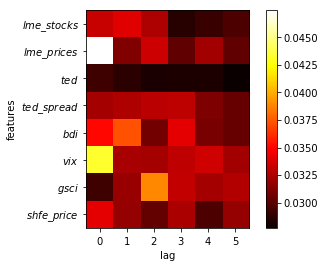

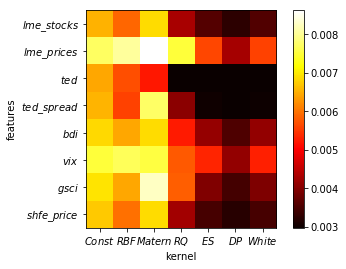

In [462]:
# simple test
i=2350
weights = feature_selection(cu_log_return.iloc[i:-1,:], cu_log_return.iloc[i+1:,-1] , lag_num=6)

<font face="EB Garamond" size=5 color=#000000 >
Model 4: feature_selection (select lag) + (gaussian process/krr)

In [72]:
# def run_experiment_2(function, input_dataset, period=100, lag=1, feature_select_lag = 5):
#     num, feature = input_dataset.shape
#     i = 2150
#     df = pd.DataFrame(data=[], index=input_dataset.index[(i+period +lag) :], columns=['org_price','pred_price','error'])
      
#     while (i+period+lag) != num :   

#         X_valid = input_dataset.iloc[i:i+period+1,:]
#         Y_valid = input_dataset.iloc[i+lag:i+period+lag, -1]  

#         X_train, Y_train, X_pred = feature_select(X_valid, Y_valid, feature_select_lag)

#         y_pred = function(X_train, Y_train, X_pred)
#         y_org = input_dataset.iloc[i+period+lag, -1]     
#         error = np.abs(y_org - y_pred)
#         pred_date = input_dataset.index[i+period+lag].strftime('%Y-%m-%d')

#         df.set_value(pred_date, 'org_price', y_org)
#         df.set_value(pred_date, 'pred_price', y_pred)
#         df.set_value(pred_date, 'error',error)

#         print(pred_date, "%.8f" % y_org, "%.8f" % y_pred, "%.8f" %error) 
#         i=i+1  

#     return df     

In [468]:
# def feature_select(X, Y, lag_range):
#     s = mkl_select_method(X,Y, lag_range)
#     x_train, y_train, x_pred =  s.process()
#     return x_train, y_train, x_pred

In [469]:
# class mkl_select_method():

#     def __init__(self, X, Y, lag_range):
#         self.X = X
#         self.Y = Y.iloc[lag_range:]
#         self.X_select = self.X.iloc[:-1,:]
#         self.data_num = self.X_select.shape[0]
#         self.feature_num = self.X_select.shape[1]
#         self.kernel_num = 7
#         self.bound_num = 11
#         self.kernel_param_bound = np.logspace(-5, 5, self.bound_num)
#         self.lag_num = lag_range
#         self.lag_bound = np.linspace(0, self.lag_num-1, self.lag_num, dtype=int)
#         self.num = self.feature_num * self.lag_num * self.kernel_num * self.bound_num
#         self.avail_start_date = self.X.index[lag_range]
        
#         self.weights = np.zeros(shape=(self.num,1)) 
#         self.grad = np.zeros(shape=(self.num,1)) *  (1/self.num)
#         self.avail_start = self.X.index[self.lag_num]
#         self.init =  np.ones(shape=(self.num,1)) *  (1/self.num)
#         self.cov = 0
#         self.covinv = 0
#         self.optimise = 10
#         self.alpha = []
#         self.alpha_ = []
#         self.kernel = [] 
        
#     def lag_process(self, xs,lag):
#         xs = xs.shift(periods=lag)
#         return xs
    
#     def build_dataset(self):
#         dataset =np.zeros(shape=(self.feature_num, self.lag_num,  self.data_num -self.lag_num ))
#         for i in range(self.feature_num):
#             for j in range(self.lag_num):
#                 df_Xy = self.lag_process(self.X_select.iloc[:,i], self.lag_bound[j])
#                 df_Xy = df_Xy.loc[self.avail_start_date:]
#                 dataset[i,j,:] = df_Xy         
#         return dataset
    
#     def construct_kernel(self, dataset):
#         len_ = self.data_num -self.lag_num
#         kernel = np.zeros(shape=(self.num, len_, len_))
#         index = 0
#         for i in range(self.feature_num):
#             for j in range(self.lag_num):
#                 X = dataset[i,j,:] 
#                 X = X.reshape((len_, 1))
#                 for hyper_param in self.kernel_param_bound:
#                     k1 = ConstantKernel(constant_value= hyper_param, constant_value_bounds=(1e-05, 100000.0))
#                     k2 = RBF(length_scale=hyper_param, length_scale_bounds=(1e-05, 100000.0))
#                     k3 = Matern(length_scale=hyper_param, length_scale_bounds=(1e-05, 100000.0), nu=1.5)
#                     k4 = RationalQuadratic(length_scale=hyper_param, alpha=1.0, length_scale_bounds=(1e-05, 100000.0), alpha_bounds=(1e-05, 100000.0))
#                     k5 = ExpSineSquared(length_scale=hyper_param, periodicity=1.0, length_scale_bounds=(1e-05, 100000.0), periodicity_bounds=(1e-05, 100000.0))
#                     k6 = DotProduct(sigma_0=hyper_param, sigma_0_bounds=(1e-05, 100000.0))
#                     k7 = WhiteKernel(noise_level=hyper_param, noise_level_bounds=(1e-05, 100000.0))
                       
#                     kernel[index] = k1(X, X)
#                     kernel[index+1] = k2(X, X)
#                     kernel[index+2] = k3(X, X)
#                     kernel[index+3] = k4(X, X)
#                     kernel[index+4] = k5(X, X)            
#                     kernel[index+5] = k6(X, X)
#                     kernel[index+6] = k7(X, X)
#                     index = index+7              
#         return kernel
    
#     def compute_alpha(self, weights, kernel):
#         self.cov = np.sum(weights[:,:,None]*kernel,axis=0)
#         self.invcov  = np.linalg.inv(self.cov)
#         return np.dot(self.invcov, self.Y)
        
#     def fit(self, kernel):       
# #         model = Align()
# #         model.fit(kernel, self.Y)
# #         weights = model.mu.reshape((self.num,1))

#         self.alpha = self.compute_alpha(self.init, kernel)
#         for j in range(self.optimise):
#             for i in range(self.num):
#                 self.grad[i] = np.dot(np.dot(self.alpha.T, kernel[i]), self.alpha)
#             self.grad = self.grad / np.linalg.norm(self.grad,ord=2) 
#             self.weights = self.init +  np.linalg.norm(self.weights-self.init,ord=2) * self.grad
#             self.alpha = self.compute_alpha(self.weights, kernel) 
#         weights = self.weights
        
        
#         weights = weights.reshape(( self.feature_num , self.lag_num , self.kernel_num , self.bound_num))
#         weights_ = np.sum(np.sum(weights,axis=3), axis=2)
#         index = np.argmax(weights_, axis=1)
#         return weights, index
    
#     def rebuild_dataset(self,index):
#         for i in range(len(index)):
#             self.X.iloc[:,i].shift(periods = index[i])
#         X_train = self.X.iloc[self.lag_num:-1,:]
#         X_pred = self.X.iloc[-1:,:]
#         return X_train, X_pred
        
#     def process(self):
#         dataset = self.build_dataset()
#         kernel = self.construct_kernel(dataset)
#         weights, index = self.fit(kernel)
#         X_train, X_pred = self.rebuild_dataset(index)
#         Y_train = self.Y
#         return X_train, Y_train, X_pred
        

In [74]:
#result_mkl_select = run_experiment(multiple_kernel_dual ,cu_log_return, period=100, lag=1, feature_select_lag = 5)

In [75]:
#plot_result(result_mkl_select, 'Cu',pointer=0)

In [76]:
#mkl_select = evaluate('mkl_select', result_mkl_select['org_price'][0:], result_mkl_select['pred_price'][0:])

In [77]:
#result_exp = run_experiment(gaussian_process ,cu_log_return, period=100, lag=1, feature_select_lag = 5)

In [78]:
#plot_result(result_exp, 'Cu',pointer=0)

In [79]:
#gp_exp = evaluate('gp_mkl', result_exp['org_price'][0:], result_exp['pred_price'][0:])

<font face="EB Garamond" size=5 color=#000000 >
Model 5: Neural Process (Not yet)

In [186]:
import tensorflow as tf

class Neural_process():
    def __init__(self, num_epochs, hidden_units=32, learning_rate=1e-3, batch_size=32):
        self.num_epochs = num_epochs
        self.hidden_units = hidden_units
        self.learning_rate = learning_rate
        self.batch_size = batch_size
        #self.data_num = 
        self.feature_num = 8
        self.latent_dim = 8
    
    def input_layer(self):
        self.X = tf.placeholder(tf.float32, [self.data_num, self.feature_num])
        self.Y = tf.placeholder(tf.float32, [self.data_num, 1])
        self.input = tf.concat([self.X, self.Y], 1)
    
        #input: data_num * (feature+ 1(Y))
        #ouput: data_num * latent_dim
        #compute the mean and cov for all the (data_num) cases
    def encoder(self, self.input):
        layer1 = tf.contrib.layers.fully_connected(self.input, self.hidden_units, tf.nn.relu)
        layer2 = tf.contrib.layers.fully_connected(layer1, self.hidden_units, tf.nn.relu)
        result = tf.contrib.layers.fully_connected(layer2, self.latent_dim, tf.nn.sigmoid)
        self.encoder_output=tf.reshape(result,[-1,self.latent_dim])
        #self.loss_1 is KL divergence between multivariate standard normal and current gaussian
        self.latent_mean, self.latent_cov = tf.nn.moments(self.encoder_output, axes=[0])
        
        self.loss_1 = 0.5 * (log(np.linalg.det(self.latent_cov)/self.latent_dim) -self.latent_dim + \
                            np.trace(np.linalg.inv(self.latent_cov)) + \
                             np.dot(np.dot(self.latent_mean.T, np.linalg.inv(self.latent_cov)), self.latent_mean) )
        
        #generate model: generate high dimension vector from latent distribution
        #input vector and x to output Y
    def decoder(self, self.latent_mean, self.latent_cov, self.X):
        tf.random_uniform(shape = ())
        layer1 = tf.contrib.layers.fully_connected(self.input, self.hidden_units, tf.nn.relu)
        layer2 = tf.contrib.layers.fully_connected(layer1, self.hidden_units, tf.nn.relu)
        result = tf.contrib.layers.fully_connected(layer2, 1, tf.nn.sigmoid)
        self.fully_layer_output=tf.reshape(result,[-1,1])
        self.loss_2 = 
    
    def loss(self):
        self.loss= self.loss_1 + self.loss_2
        
    def build_model(self):
        tf.reset_default_graph()
        self.input_layer()
        self.encoder()
        self.decoder()
        self.loss()
    

<font face="EB Garamond" size=5 color=#000000 >
Experiment

In [463]:
#Gaussian Process i=2150
result_gp = get_input_output(gaussian_process ,cu_log_return)

2017-06-22 0.82448798 1.07969725 0.25520927
2017-06-23 0.32794859 0.04153479 0.28641380
2017-06-26 0.56164187 0.61164352 0.05000164
2017-06-27 0.07355410 -0.12342373 0.19697783
2017-06-28 0.40743201 0.39002116 0.01741085
2017-06-29 0.78568976 0.31407573 0.47161403
2017-06-30 0.18777065 0.46362662 0.27585598
2017-07-03 -0.04284853 0.07394642 0.11679495
2017-07-04 -0.50562391 0.04024198 0.54586589


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  7.79800049e-01,   1.20790932e-02,  -6.63986379e-03,
         4.84386206e-01,   4.84386206e-01,   1.91233945e-01,
        -1.83743770e-03,   4.62752623e-04,   4.62752623e-04,
         1.35761300e+00,  -0.00000000e+00,   8.84962067e-01,
        -2.46866790e-01,  -5.55719691e+07,   8.74464208e-01,
         6.18106522e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 110, 'nit': 18, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-07-05 0.12248125 -0.14454824 0.26702949
2017-07-06 -0.54157645 -0.95190858 0.41033213


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -2.33883737e-04,   1.45161425e-07,   4.68419604e-04,
         2.54285264e-03,   2.54285264e-03,  -3.77057370e-01,
         7.53733997e-01,   4.99974489e-01,   4.99974489e-01,
        -1.30471384e-06,   2.61001778e-06,   6.89169966e+00,
         2.43553460e-01,   9.59521130e+04,  -8.52357512e+00,
         1.18175532e-10]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 96, 'nit': 5, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-07-07 0.07318099 0.12518351 0.05200252


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  7.20339245e-02,   1.60734907e-02,  -2.21731812e-02,
         2.21623000e-05,   2.21623000e-05,   2.48345780e-03,
        -0.00000000e+00,   2.52172208e-08,   2.52172208e-08,
         8.95546875e-02,  -1.80155984e-06,   4.95709651e+01,
        -3.01584865e-01,  -9.63002393e+08,   2.63735343e-01,
         5.26254338e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-07-10 -0.04344067 -0.14557532 0.10213465
2017-07-11 -0.07683051 -0.01347348 0.06335702
2017-07-12 0.70406324 0.41975467 0.28430856
2017-07-13 -0.12584394 0.16811704 0.29396099


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.29337259e-01,  -2.27737381e-03,   4.92444063e-05,
        -3.15712970e-04,  -3.15712970e-04,  -1.03021563e-01,
         9.27244263e-13,   2.67829060e-01,   2.67829060e-01,
        -1.33573721e-02,  -0.00000000e+00,  -3.03639945e-01,
        -2.27627430e-01,  -3.96182880e+09,   4.66923679e-01,
         1.32234571e-09]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 46, 'nit': 6, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-07-14 -0.20906357 -0.19041814 0.01864543
2017-07-17 0.79964851 0.59341652 0.20623199
2017-07-18 0.61242329 0.29497913 0.31744416
2017-07-19 -0.04241355 -0.09033443 0.04792088
2017-07-20 -0.04244437 -0.16998158 0.12753722
2017-07-21 0.13708546 -0.15930280 0.29638826
2017-07-24 0.07172917 0.15845122 0.08672204
2017-07-25 0.63931453 -0.06868159 0.70799612
2017-07-26 2.44043703 1.30332597 1.13711106
2017-07-27 0.45940315 0.72888309 0.26947995
2017-07-28 -0.22737502 0.11965206 0.34702708
2017-07-31 0.64423805 0.06992555 0.57431251
2017-08-01 -0.07095219 0.39219130 0.46314349
2017-08-02 -0.46002571 -0.25580789 0.20421782
2017-08-03 0.33342439 0.23081633 0.10260806
2017-08-04 0.05312328 -0.12792372 0.18104700
2017-08-07 -0.08666351 0.22395875 0.31062226
2017-08-08 0.54863941 0.31139322 0.23724619


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.29827122e-05,   2.08911633e-06,  -2.60739189e-07,
         1.96035819e-07,   1.96035819e-07,   7.27299552e-03,
        -1.86868894e-07,   3.21162834e-08,   3.21162834e-08,
         4.24999037e-01,  -1.75482524e-02,   4.87200315e+01,
        -1.29558170e+00,  -2.26164657e+08,   8.40526124e-01,
         2.75035338e-10]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-08-09 0.56021542 0.35080357 0.20941185


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  6.74208741e-003,   4.81660234e-005,  -1.66010660e-005,
         3.79737450e-005,   3.79737450e-005,   5.53252511e-005,
        -3.04112799e-106,   3.42433865e-001,   3.42433865e-001,
         8.75538612e-004,  -0.00000000e+000,   4.77286558e+001,
        -2.22446934e+000,  -7.58926210e+009,   1.07206197e-001,
         5.08732843e-003]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 47, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-08-10 -0.37754353 -0.12923585 0.24830767
2017-08-11 -1.17284783 -0.67892111 0.49392672
2017-08-14 0.33421105 0.13106996 0.20314109
2017-08-15 -0.02461068 0.11017978 0.13479047
2017-08-16 0.06881985 -0.13627692 0.20509677
2017-08-17 1.73051842 1.05152810 0.67899032
2017-08-18 -0.57411401 -0.63218215 0.05806814
2017-08-21 0.49579383 0.29362391 0.20216992
2017-08-22 0.76489456 0.62776433 0.13713023
2017-08-23 -0.20505915 0.12092440 0.32598355
2017-08-24 0.35385596 -0.01784260 0.37169856


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.86563821e-05,  -9.71937548e-17,  -1.98604447e-09,
         1.78642890e+01,   1.78642890e+01,   6.04224416e-05,
        -2.65198156e-17,   1.50601669e-01,   1.50601669e-01,
         3.45165795e-01,  -1.01867082e-04,   2.96252023e+01,
        -4.65280546e-02,  -3.27972814e+08,   1.99150838e+00,
         5.38530517e-07]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 57, 'nit': 2, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-08-25 1.03928739 0.81973929 0.21954809
2017-08-28 0.15508012 -0.15427873 0.30935885
2017-08-29 0.24361771 -0.07597613 0.31959384
2017-08-30 0.03612135 0.78164731 0.74552596
2017-08-31 -0.03784378 -0.15237470 0.11453092
2017-09-01 0.03612697 0.42014036 0.38401339
2017-09-04 0.56661918 0.48967432 0.07694486
2017-09-05 0.35820706 0.53094754 0.17274048
2017-09-06 -0.37451080 -0.20945887 0.16505194


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.00224187e-001,  -1.85896511e-009,   3.83986556e-001,
        -1.50502030e-005,  -1.50502030e-005,  -6.18732185e-004,
        -7.77956715e-131,   2.07700782e-001,   2.07700782e-001,
        -2.73276130e-001,   5.25514368e-001,   4.88260339e+001,
         4.75663858e-001,   2.05158452e+009,  -1.17538246e-002,
         4.43996742e-012]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 40, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-09-07 -0.15523901 0.21603885 0.37127786
2017-09-08 -0.85207115 0.00756265 0.85963380
2017-09-11 -1.60274726 -1.33469023 0.26805703
2017-09-12 0.32501405 0.70742135 0.38240730
2017-09-13 -0.50974782 -0.73128833 0.22154051
2017-09-14 -0.99011605 -0.76642828 0.22368777
2017-09-15 -0.30271172 -0.41259662 0.10988490
2017-09-18 0.23858867 0.04103198 0.19755669
2017-09-19 0.46857440 0.04951291 0.41906148
2017-09-20 0.03724214 0.01749626 0.01974589


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  6.94434595e-02,   1.95761058e-03,  -6.80926676e-04,
         2.21774686e-04,   2.21774686e-04,   8.45578568e-05,
        -1.70832621e-07,   1.01645779e-08,   1.01645779e-08,
         3.31968296e-01,  -2.38325070e-09,   4.95975208e+01,
        -1.49285205e-01,  -3.37732279e+06,   4.60955067e-06,
         8.26579685e-06]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-09-21 -0.68727703 0.39160898 1.07888601
2017-09-22 -0.81863617 -0.10207685 0.71655932
2017-09-25 0.73873239 -0.21100816 0.94974056
2017-09-26 0.51654512 -0.09898358 0.61552870
2017-09-27 -0.25577696 -0.37459396 0.11881700
2017-09-28 0.03744339 0.31787482 0.28043143
2017-09-29 1.38476992 0.57450043 0.81026949
2017-10-09 1.27122760 -0.31524449 1.58647209
2017-10-10 0.05132651 0.10805998 0.05673346
2017-10-11 0.36392803 0.91654199 0.55261396
2017-10-12 1.50739685 0.28823639 1.21916047
2017-10-13 0.58729633 0.77982930 0.19253298
2017-10-16 0.33852117 0.16911026 0.16941092
2017-10-17 1.92708932 1.71591225 0.21117707
2017-10-18 -0.55758999 -0.79764478 0.24005479
2017-10-19 -0.24866071 -0.22041106 0.02824965
2017-10-20 0.09169592 -0.05468035 0.14637627
2017-10-23 -0.17809198 0.09811444 0.27620642


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.04959220e-04,   6.76504642e-14,   4.23607206e-06,
         4.19848250e-09,   4.19848250e-09,   1.28546839e-02,
         4.45073775e-27,   3.79487465e-09,   3.79487465e-09,
         1.77356983e-01,  -2.95635424e-01,   7.39706451e-01,
        -3.47279217e-09,  -5.22601434e+06,  -2.36410340e-02,
         6.35572395e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 153, 'nit': 56, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-10-24 1.13582926 0.30857574 0.82725352
2017-10-25 -0.66906962 0.44034749 1.10941711


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -6.35954353e-05,  -6.09625184e-05,   5.22307896e-06,
        -2.32884631e-02,  -2.32884631e-02,  -7.06179424e-06,
         2.06874875e-05,   6.72471812e-09,   6.72471812e-09,
        -4.52819404e+01,  -0.00000000e+00,  -1.06622397e+01,
        -1.77163675e-01,   2.83499579e+01,   3.57667416e+00,
         1.00000060e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 91, 'nit': 11, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-10-26 -0.07832782 -0.05437193 0.02395589
2017-10-27 -0.76144057 0.02064175 0.78208232
2017-10-30 -1.15983197 -0.87561819 0.28421377
2017-10-31 0.15148276 0.32443010 0.17294733
2017-11-01 1.01366662 -0.02113112 1.03479774
2017-11-02 -0.38038444 0.65525414 1.03563858
2017-11-03 0.33625798 0.11638483 0.21987315
2017-11-06 -0.12231792 0.00066884 0.12298677
2017-11-07 0.24975072 0.61722616 0.36747544
2017-11-08 -1.17368607 -0.92902795 0.24465811
2017-11-09 -0.28405858 0.29927998 0.58333856
2017-11-10 0.00653698 -0.30391012 0.31044710
2017-11-13 0.00653698 -0.16201149 0.16854847
2017-11-14 0.61553909 0.74679712 0.13125803
2017-11-15 -1.52500024 -0.84934457 0.67565567
2017-11-16 0.10958271 0.02914515 0.08043756


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -2.33826397e-01,  -0.00000000e+00,  -0.00000000e+00,
        -3.23420593e-04,  -3.23420593e-04,   7.81793000e-04,
         7.35408218e-08,   5.13823366e-02,   5.13823366e-02,
         6.24801555e-02,   1.78610709e-08,  -8.25878794e-01,
        -4.39518826e-09,  -4.70573511e+01,  -3.18562276e-01,
         4.71770523e-02]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 63, 'nit': 11, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-11-17 0.00653698 -0.16218655 0.16872353


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.72597637e-10,   5.06244776e-15,  -1.61397212e-10,
         3.21210848e-09,   3.21210848e-09,   5.55013918e-13,
        -1.09333796e-12,   4.99999661e-01,   4.99999661e-01,
         2.18780923e-07,  -4.11147786e-07,   4.94262429e+01,
        -1.44760540e+00,   1.04915565e+10,   7.28594292e-02,
         5.96288754e-18]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-11-20 0.09475340 0.40813134 0.31337794


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.09141760e-001,  -5.00355738e-011,   4.38678363e-004,
        -4.58166567e-001,  -4.58166567e-001,  -2.30349141e-001,
        -0.00000000e+000,   4.07640745e-002,   4.07640745e-002,
        -3.53436702e-001,  -7.00985527e-115,  -1.39690317e-002,
        -1.72103746e-004,  -7.66577755e+006,  -3.88594426e-001,
         3.46783248e-002]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 160, 'nit': 39, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-11-21 0.47534275 0.41654756 0.05879520


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.07987985e-04,  -1.30982612e-11,   4.29498206e-05,
         9.47491075e-07,   9.47491075e-07,   3.29839587e-04,
         2.57417884e-08,   4.09695619e-05,   4.09695619e-05,
         3.25662817e-04,   8.35099633e-06,  -4.69723215e-02,
        -3.67029884e-01,   2.75030787e+09,  -1.13891209e-02,
         1.81304825e-08]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 15002, 'nit': 3771, 'warnflag': 1}
  " state: %s" % convergence_dict)


2017-11-22 0.93575866 0.78178351 0.15397515
2017-11-23 0.00653698 0.30784369 0.30130670
2017-11-24 0.28027684 0.06680652 0.21347032
2017-11-27 0.07841401 0.39122395 0.31280994


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  7.11564490e-02,  -0.00000000e+00,  -0.00000000e+00,
         1.13233481e+00,   1.13233481e+00,   6.22800663e-04,
        -0.00000000e+00,   6.10081105e-12,   6.10081105e-12,
         6.10133346e-04,  -0.00000000e+00,  -2.70488197e-03,
        -5.89735179e-03,  -1.42897256e+02,   4.96716734e-01,
         9.99999955e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 68, 'nit': 5, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-11-28 -0.96217578 -0.53425623 0.42791955
2017-11-29 -0.46042239 -0.86264703 0.40222465
2017-11-30 -0.69919912 -0.53326918 0.16592994
2017-12-01 0.10985638 -0.09767849 0.20753486
2017-12-04 0.84278369 0.33235763 0.51042606
2017-12-05 -0.46182784 -0.21804351 0.24378433
2017-12-06 -2.36339866 -1.75468328 0.60871538
2017-12-07 -0.05402490 -0.08460836 0.03058346
2017-12-08 0.08223197 0.16379523 0.08156326
2017-12-11 0.08215840 0.09038113 0.00822273


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  7.71891490e-02,   6.61502883e-03,  -6.17997771e-04,
         7.90270666e-12,   7.90270666e-12,   1.77693365e-02,
        -2.11246378e-03,   4.16902860e-02,   4.16902860e-02,
         6.00372116e+00,  -0.00000000e+00,   4.38392559e+01,
        -6.26453831e-01,   4.54368507e+08,   8.41899928e-04,
         1.76417696e-06]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 62, 'nit': 9, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-12-12 0.51882265 0.70305305 0.18423039
2017-12-13 0.20152298 -0.06100358 0.26252656
2017-12-14 0.45464845 0.39137525 0.06327320
2017-12-15 0.40764251 0.42324749 0.01560498
2017-12-18 1.32881549 0.81557159 0.51324391
2017-12-19 0.02110347 0.19736059 0.17625713
2017-12-20 0.16658858 -0.08033655 0.24692513
2017-12-21 0.85942159 0.74629652 0.11312507
2017-12-22 0.06402267 0.42447868 0.36045601
2017-12-25 0.82112642 0.25571051 0.56541591
2017-12-26 -0.03612419 0.29789020 0.33401440
2017-12-27 0.30467517 0.37048121 0.06580604
2017-12-28 0.50090926 1.02454449 0.52363523
2017-12-29 0.24553199 0.44451671 0.19898472
2018-01-02 -0.71266169 -0.41350809 0.29915360
2018-01-03 -0.29154681 -0.09909573 0.19245108
2018-01-04 0.03497517 -0.26602423 0.30099940
2018-01-05 -0.00768081 0.25086825 0.25854905
2018-01-08 -0.62163200 -0.53910140 0.08253060
2018-01-09 0.23554928 -0.00014439 0.23569367
2018-01-10 0.10651829 -0.06184130 0.16835959
2018-01-11 0.26304339 0.36950884 0.10646546
2018-01-12 -0.53597

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.01751259e+01,   8.50316134e+00,  -6.64482493e-01,
         6.59942166e-07,   6.59942166e-07,   3.34537039e+01,
        -8.01038337e-02,   4.58509148e-01,   4.58509148e-01,
         3.87282682e-06,  -9.48557390e-08,   5.89222173e+00,
        -1.18725395e-04,  -8.03345360e+05,   1.00001692e-02,
         1.99067071e-02]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-01-15 0.02086210 -0.15597544 0.17683754
2018-01-16 0.14964328 0.67028928 0.52064600
2018-01-17 -1.04424240 -0.98721682 0.05702558
2018-01-18 -0.13851688 -0.25056761 0.11205073
2018-01-19 -0.03703196 0.23649188 0.27352384
2018-01-22 -0.08067416 -0.12288955 0.04221539
2018-01-23 -0.00800772 0.18029779 0.18830551
2018-01-24 -1.25458956 -0.74792157 0.50666799
2018-01-25 1.23856597 1.37778830 0.13922232


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.95741303e-02,   8.13982592e-06,  -7.22279707e-09,
         7.62089771e-01,   7.62089771e-01,   1.38948788e-01,
         7.22545469e-07,   3.16256586e-01,   3.16256586e-01,
         5.39838968e-03,   9.66999727e-03,   1.28683964e+00,
        -4.62247064e-02,  -3.31916773e+08,   4.19688840e-01,
         1.01121833e-07]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 123, 'nit': 32, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-01-26 -0.12453686 -0.19652167 0.07198481
2018-01-29 -0.00804042 -0.37315254 0.36511212
2018-01-30 -0.47605582 -0.26328539 0.21277043
2018-01-31 -0.22852927 -0.24413609 0.01560682


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.99656392e-02,   1.21690566e-02,  -3.50655954e-03,
         3.16402418e-01,   3.16402418e-01,   1.25816187e-02,
         9.25472513e-11,   2.75539801e-04,   2.75539801e-04,
         3.49343205e-01,   6.84814756e-08,   4.57691728e+01,
        -1.91677550e-01,  -3.10631814e+08,   3.46896869e+00,
         2.30682416e-02]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-02-01 0.00653698 0.57543572 0.56889874
2018-02-02 0.22693239 0.00965369 0.21727869
2018-02-05 -0.44963700 -0.59530486 0.14566787


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.02670659e+01,   2.52493188e-04,  -2.37906675e-05,
         2.02493338e-01,   2.02493338e-01,   7.94366220e-05,
         1.51718754e-14,   3.16816639e-01,   3.16816639e-01,
         1.16784084e-03,   2.22452744e-13,   7.19996025e+00,
        -3.95407790e-03,   3.14956512e+05,   1.98346295e+00,
         1.22093730e-07]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-02-06 -0.12640312 0.24570228 0.37210540
2018-02-07 0.00653698 -0.27033358 0.27687057
2018-02-08 -1.44086626 -1.26070221 0.18016404
2018-02-09 -0.62862468 -0.53740690 0.09121778
2018-02-12 0.02172029 -0.57959493 0.60131523
2018-02-13 0.70178561 0.58216786 0.11961775
2018-02-14 0.97848133 1.15535822 0.17687688
2018-02-22 0.24393418 1.39466556 1.15073137
2018-02-23 1.13898853 0.30024635 0.83874218
2018-02-26 -0.13960669 -0.21215822 0.07255152
2018-02-27 -0.16919854 0.15054610 0.31974464
2018-02-28 -0.84849219 -0.67153447 0.17695772
2018-03-01 -0.54386284 -0.65036488 0.10650205
2018-03-02 -0.08308507 -0.12666403 0.04357896
2018-03-05 -0.29295096 0.02353504 0.31648599
2018-03-06 0.18636805 0.20663044 0.02026240
2018-03-07 0.11124682 0.61808885 0.50684204


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  9.07138045e-06,   3.50065017e-11,  -9.44490850e-06,
         1.41937556e-05,   1.41937556e-05,   5.00243952e-08,
        -6.85192043e-08,   4.99989878e-01,   4.99989878e-01,
         6.75183984e-05,  -2.35807285e-09,   4.93642631e+01,
        -1.31817016e+00,  -5.63470089e+09,   4.05732050e-02,
         5.71155205e-07]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-03-08 -0.47329107 -0.38167853 0.09161255
2018-03-09 -1.06876731 -0.61595338 0.45281393
2018-03-12 0.78043911 1.03774526 0.25730615
2018-03-13 -0.32635951 -0.57679628 0.25043677
2018-03-14 0.32433268 0.33120021 0.00686753
2018-03-15 0.23274183 0.11775126 0.11499057
2018-03-16 0.03664800 -0.39129003 0.42793804
2018-03-19 -0.73455846 -0.13522185 0.59933661
2018-03-20 -0.14557816 -0.44628977 0.30071161
2018-03-21 -0.77391020 -0.67408224 0.09982797
2018-03-22 0.42068987 0.19568843 0.22500143
2018-03-23 -1.36706044 -0.97969130 0.38736914


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -1.15736192e+01,  -0.00000000e+00,  -0.00000000e+00,
        -2.82138526e-02,  -2.82138526e-02,  -2.42644059e-06,
         7.17195917e-06,   4.99754017e-01,   4.99754017e-01,
        -1.93853881e-03,   2.27957119e-03,  -6.36242623e-03,
        -6.39867782e-04,  -3.53966084e+05,   4.00016217e+00,
         4.91982115e-04]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 52, 'nit': 4, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-03-26 -1.29668597 -0.18553447 1.11115149
2018-03-27 0.35410125 -0.22458657 0.57868782


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.99270476e-01,   6.07794048e-09,  -3.55534880e-06,
         4.85295189e-06,   4.85295189e-06,   7.18888197e-02,
        -0.00000000e+00,   7.31080303e-04,   7.31080303e-04,
         6.07121921e-01,  -0.00000000e+00,   2.18754121e+00,
        -5.89247609e-01,   2.45329529e+07,   1.51776034e-01,
         2.28635037e-13]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 125, 'nit': 42, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-03-28 -0.19865419 0.20807325 0.40672745
2018-03-29 0.62049424 0.16985032 0.45064393
2018-03-30 0.56899875 0.31006483 0.25893392
2018-04-02 0.42573096 0.35494988 0.07078109
2018-04-03 0.36185539 0.06169828 0.30015712
2018-04-04 -0.02429594 0.66254709 0.68684302
2018-04-09 -0.13236256 -0.42585421 0.29349166
2018-04-10 0.91261757 0.35169579 0.56092178
2018-04-11 0.32651086 0.78160993 0.45509907
2018-04-12 -0.75748007 0.00684181 0.76432188
2018-04-13 -0.20873908 -0.63271582 0.42397674


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.33377681e-03,   4.45253032e-10,  -4.12763273e-08,
         1.50685750e-07,   1.50685750e-07,   7.13001414e-03,
        -0.00000000e+00,   6.96123829e-04,   6.96123829e-04,
         3.97825987e-01,  -0.00000000e+00,   2.79486833e-01,
        -8.61634917e-02,  -3.15029612e+10,  -5.74766639e-02,
         2.33568228e-02]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 84, 'nit': 22, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-04-16 -0.17846062 0.15222912 0.33068973
2018-04-17 0.45286385 0.58894306 0.13607921


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.37212354e-02,  -1.74102123e-15,  -1.62682972e-11,
         4.69077027e-05,   4.69077027e-05,   8.73024345e-08,
        -1.73995308e-14,   1.68650565e-05,   1.68650565e-05,
         4.80068322e-07,  -0.00000000e+00,   4.99756077e+01,
        -1.96218347e+00,  -7.21439485e+06,   3.58258187e-04,
         2.89053095e-14]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 33, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-04-18 -0.02416212 -0.23583318 0.21167106
2018-04-19 1.48166502 0.80412585 0.67753918
2018-04-20 -0.64393739 -0.24754855 0.39638884
2018-04-23 0.50622281 0.08487248 0.42135032
2018-04-24 -0.40205785 -0.29669949 0.10535836


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  7.08290072e-06,   1.02715147e-11,  -4.50591882e-06,
         6.26955327e-02,   6.26955327e-02,   5.15994966e-08,
        -9.30507710e-08,   5.42311646e-04,   5.42311646e-04,
         8.85380481e-07,  -0.00000000e+00,   4.94356909e+01,
        -1.02119431e+00,   1.37801057e+09,   5.00445076e-01,
         9.98902324e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 39, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-04-25 0.32451822 0.41384689 0.08932867
2018-04-26 -0.03880942 0.01880125 0.05761067
2018-04-27 -0.12966102 -0.13824290 0.00858188
2018-05-02 -0.84631650 -0.93221162 0.08589512
2018-05-03 -0.03941648 0.51462122 0.55403770


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -8.48942397e-001,  -1.85630060e-007,   2.99308143e-008,
        -4.04553612e-004,  -4.04553612e-004,  -1.44385613e-002,
        -1.36982074e-177,   5.00058174e-001,   5.00058174e-001,
        -6.48865113e-001,  -0.00000000e+000,  -4.18042293e-003,
         4.92931232e-004,  -4.40178561e+002,   5.35689763e-001,
         8.13222822e-011]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 158, 'nit': 9, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-05-04 0.26658182 0.13433004 0.13225178
2018-05-07 -0.06985661 0.06960080 0.13945741


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -5.40384374e-02,   4.81447713e-07,  -1.51925346e-04,
        -8.21672323e-06,  -8.21672323e-06,   1.60900503e-01,
        -5.62411211e-01,   4.99919891e-01,   4.99919891e-01,
        -2.62363323e-03,   5.21455601e-04,   2.71489759e-03,
         1.10087477e+00,   5.03006367e+01,  -1.65274444e-04,
         4.32381534e-18]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 93, 'nit': 32, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-05-08 0.12873076 0.00789209 0.12083868
2018-05-09 -0.57560023 -0.39872629 0.17687394
2018-05-10 0.28282918 0.54236034 0.25953115
2018-05-11 0.46485485 0.65774743 0.19289258
2018-05-14 0.17391274 0.18392272 0.01000998
2018-05-15 -0.42022068 -0.30070872 0.11951196
2018-05-16 -0.19239897 -0.59109174 0.39869277
2018-05-17 0.22075466 0.21743066 0.00332401
2018-05-18 0.20492668 0.23312924 0.02820256
2018-05-21 0.18921804 -0.19836874 0.38758679
2018-05-22 0.18879013 0.07463704 0.11415310


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -1.30438605e-05,   6.25190986e-12,  -1.44761438e-10,
        -2.90930433e-05,  -2.90930433e-05,   2.23363288e-02,
        -4.73139260e-10,   2.74951144e-03,   2.74951144e-03,
         7.53614458e-03,   2.25385600e-02,  -4.65910037e-02,
        -7.18385277e-03,  -3.43573347e+07,   1.26729207e-02,
         2.09469864e-06]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 121, 'nit': 28, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-05-23 0.56581171 0.52248353 0.04332818
2018-05-24 -0.70458570 -0.58068987 0.12389583
2018-05-25 0.24935168 0.13115861 0.11819308
2018-05-28 -0.08442975 -0.01431806 0.07011170
2018-05-29 0.18836423 -0.04555320 0.23391743
2018-05-30 -0.49451397 -0.33599893 0.15851505
2018-05-31 0.05222064 0.13586747 0.08364683
2018-06-01 0.17381460 -0.00484987 0.17866447
2018-06-04 0.80750826 0.38293028 0.42457798


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  6.27548043e-06,   4.07204927e-06,  -4.00941195e-06,
         2.64682519e-03,   2.64682519e-03,   1.16760685e-10,
        -2.91146667e-11,   3.64717655e-08,   3.64717655e-08,
         1.75676107e+00,  -0.00000000e+00,   4.73504920e+01,
        -4.13559174e-03,  -2.16842823e+05,   8.83771875e-01,
         9.99681582e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-06-05 0.18674985 0.55659008 0.36984023
2018-06-06 1.12350810 0.73988165 0.38362645
2018-06-07 1.48582748 0.68423022 0.80159726
2018-06-08 -0.12414548 0.50616347 0.63030896
2018-06-11 0.38346686 0.01100846 0.37245840
2018-06-12 -0.39946327 -0.34271154 0.05675173


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.09157916e-11,  -7.52862999e-16,  -4.03631127e-11,
         5.29175325e-06,   5.29175325e-06,   4.03656364e-05,
        -2.56317514e-08,   3.51326995e-10,   3.51326995e-10,
         5.30684225e-08,  -2.09039901e-08,   4.59453023e+01,
        -5.34961010e-03,  -9.65721769e+07,   4.05044317e+00,
         1.00000089e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-06-13 -0.38697992 -0.19120149 0.19577844
2018-06-14 0.15251615 0.20035006 0.04783391
2018-06-15 -0.37358002 -0.30764774 0.06593227


In [39]:
return_gp_al = run_experiment(gaussian_process, al_log_return)

0.00316**2 * RationalQuadratic(alpha=0.000113, length_scale=398) + 3.19**2 * WhiteKernel(noise_level=0.0793) + 0.0177**2 * Matern(length_scale=0.107, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0151**2 * RBF(length_scale=0.000639) + 0.0071**2 * ExpSineSquared(length_scale=0.674, periodicity=0.0274) + 0.147**2 * DotProduct(sigma_0=1e-05)
2016-09-22 1.40636253 0.27034104 1.13602148
0.801**2 * RationalQuadratic(alpha=2.51, length_scale=0.000282) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=1e-05, nu=1.5) + 0.00316**2 * 0.309**2 + 0.00316**2 * RBF(length_scale=0.901) + 0.375**2 * ExpSineSquared(length_scale=0.00343, periodicity=68.1) + 0.151**2 * DotProduct(sigma_0=1e-05)
2016-09-23 1.43336070 1.00315997 0.43020073
0.00316**2 * RationalQuadratic(alpha=1.67, length_scale=0.000211) + 30.6**2 * WhiteKernel(noise_level=0.00082) + 0.00402**2 * Matern(length_scale=1.28e+04, nu=1.5) + 0.707**2 * 0.0187**2 + 0.0252**2 * RBF(length_scale=0.11) + 0.1**2 * ExpSineSquared

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  5.47519946e-04,  -1.57774161e-15,   8.97119232e-13,
         8.09829859e-10,   8.09829859e-10,   4.74613073e-03,
         2.08400403e-04,   5.47519946e-09,   5.47519946e-09,
         2.65315907e-02,  -0.00000000e+00,   5.05514885e-01,
        -2.98248361e-01,   1.34488785e+01,  -1.29887570e-01,
         1.77918101e-10]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 186, 'nit': 83, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=9.74e+04, length_scale=7.54e+04) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.0243**2 * Matern(length_scale=0.343, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0572**2 * RBF(length_scale=0.000172) + 0.88**2 * ExpSineSquared(length_scale=0.000207, periodicity=0.0927) + 0.127**2 * DotProduct(sigma_0=1e-05)
2016-09-29 1.24135784 0.15285888 1.08849896
0.528**2 * RationalQuadratic(alpha=1e+05, length_scale=0.396) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.69**2 * Matern(length_scale=0.0706, nu=1.5) + 0.00485**2 * 0.00316**2 + 0.0942**2 * RBF(length_scale=0.00456) + 0.0128**2 * ExpSineSquared(length_scale=0.00013, periodicity=1.59e+03) + 0.139**2 * DotProduct(sigma_0=1e-05)
2016-09-30 0.35988531 0.11231022 0.24757508
0.0453**2 * RationalQuadratic(alpha=156, length_scale=3.83e-05) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.719**2 * Matern(length_scale=0.000322, nu=1.5) + 0.0497**2 * 0.00316**2 + 0.495**2 * RBF(length_scale=0.392) + 0.00316**2 *

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.25841718e+00,   1.09549037e+00,  -2.69223279e-01,
         4.42744722e-01,   4.42744722e-01,   3.68452101e-04,
        -0.00000000e+00,   4.99978093e-01,   4.99978093e-01,
         9.23727830e-12,  -1.81841887e-11,   4.77770717e+01,
        -2.11941905e+00,  -6.80462572e+08,   1.12285786e-02,
         5.90806640e-13]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 32, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.322**2 * RationalQuadratic(alpha=4.75, length_scale=0.345) + 39**2 * WhiteKernel(noise_level=0.000425) + 0.0396**2 * Matern(length_scale=1.1e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=0.00159) + 0.104**2 * ExpSineSquared(length_scale=2.87e-05, periodicity=6.01) + 0.126**2 * DotProduct(sigma_0=0.000165)
2016-10-12 0.05295675 0.02559547 0.02736128
0.00316**2 * RationalQuadratic(alpha=1.13e+03, length_scale=8.68e+03) + 7.66**2 * WhiteKernel(noise_level=0.0106) + 0.00861**2 * Matern(length_scale=0.000238, nu=1.5) + 0.0273**2 * 0.872**2 + 0.212**2 * RBF(length_scale=1.13e-05) + 0.276**2 * ExpSineSquared(length_scale=0.0212, periodicity=0.00233) + 0.146**2 * DotProduct(sigma_0=0.0154)
2016-10-13 1.76900754 -0.11310871 1.88211625


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.74273167e-08,   3.57642432e-08,  -3.32131572e-09,
         8.67316016e-04,   8.67316016e-04,   3.60472242e-03,
        -9.91298884e-03,   1.73817514e-17,   1.73817514e-17,
         3.80156886e-01,  -0.00000000e+00,  -7.65801155e-02,
        -3.36884311e-02,  -4.49043988e+08,   4.48801422e+00,
         1.00070190e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 103, 'nit': 10, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0219**2 * RationalQuadratic(alpha=3.85e-05, length_scale=1.35) + 0.00336**2 * WhiteKernel(noise_level=1.17e-05) + 0.716**2 * Matern(length_scale=2.81e-05, nu=1.5) + 0.00676**2 * 1.63**2 + 0.519**2 * RBF(length_scale=0.383) + 0.0195**2 * ExpSineSquared(length_scale=2.6, periodicity=7e+04) + 0.119**2 * DotProduct(sigma_0=0.0334)
2016-10-14 0.13529411 0.23048617 0.09519205
0.0914**2 * RationalQuadratic(alpha=21.8, length_scale=0.0093) + 0.766**2 * WhiteKernel(noise_level=0.00192) + 0.85**2 * Matern(length_scale=0.00369, nu=1.5) + 0.00316**2 * 0.086**2 + 0.0849**2 * RBF(length_scale=1e-05) + 0.0274**2 * ExpSineSquared(length_scale=0.000242, periodicity=2.53) + 0.132**2 * DotProduct(sigma_0=1e-05)
2016-10-17 -0.78034192 -0.02038929 0.75995263
0.0193**2 * RationalQuadratic(alpha=2.97, length_scale=15.7) + 195**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=2.6e-05, nu=1.5) + 0.0724**2 * 0.0364**2 + 0.608**2 * RBF(length_scale=8.8e-05) + 0.254**2 * ExpSineSquared(leng

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  8.76354850e-01,  -0.00000000e+00,  -0.00000000e+00,
         1.03729298e-01,   1.03729298e-01,   1.78479694e-09,
        -3.47453892e-09,   4.63552157e-12,   4.63552157e-12,
         1.84637595e-05,  -0.00000000e+00,   4.60563213e+01,
        -6.99126284e-01,   3.52208644e+09,   2.90845025e+00,
         1.00000048e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.945**2 * RationalQuadratic(alpha=1e+05, length_scale=0.394) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=0.000427, nu=1.5) + 0.191**2 * 0.386**2 + 0.00316**2 * RBF(length_scale=1.1e-05) + 0.00317**2 * ExpSineSquared(length_scale=566, periodicity=117) + 0.172**2 * DotProduct(sigma_0=0.000133)
2016-10-26 4.79226424 0.77883332 4.01343092
0.00363**2 * RationalQuadratic(alpha=1e-05, length_scale=13.6) + 0.039**2 * WhiteKernel(noise_level=0.185) + 0.0325**2 * Matern(length_scale=0.000356, nu=1.5) + 0.00516**2 * 18.5**2 + 0.012**2 * RBF(length_scale=0.00954) + 1**2 * ExpSineSquared(length_scale=0.0199, periodicity=125) + 0.23**2 * DotProduct(sigma_0=0.00806)
2016-10-27 -0.91321015 1.49678306 2.40999321
0.00318**2 * RationalQuadratic(alpha=1e-05, length_scale=0.00115) + 0.0979**2 * WhiteKernel(noise_level=0.00264) + 1.02**2 * Matern(length_scale=0.372, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00623**2 * RBF(length_scale=1.28e+04) + 0.00318**2 * ExpSineSquared

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -2.70499850e-01,  -2.47873025e-01,   4.52065640e-02,
        -3.25466591e+01,  -3.25466591e+01,  -6.76906071e-02,
         2.02812958e-01,   2.82511792e-10,   2.82511792e-10,
        -1.59961557e+03,   9.71983263e+03,  -1.43539930e+03,
        -2.89218681e+00,   4.57572095e+10,  -7.34252930e-01,
         8.82080078e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.28**2 * RationalQuadratic(alpha=1e+05, length_scale=0.38) + 0.00634**2 * WhiteKernel(noise_level=0.00197) + 0.00316**2 * Matern(length_scale=0.00435, nu=1.5) + 0.0239**2 * 0.0297**2 + 1.05**2 * RBF(length_scale=0.38) + 0.00316**2 * ExpSineSquared(length_scale=30.7, periodicity=2.83e+03) + 0.207**2 * DotProduct(sigma_0=1e-05)
2016-11-03 -2.73466201 -0.64521734 2.08944467
0.00316**2 * RationalQuadratic(alpha=0.26, length_scale=1.05e+03) + 0.00316**2 * WhiteKernel(noise_level=0.00166) + 0.00316**2 * Matern(length_scale=0.199, nu=1.5) + 0.00316**2 * 0.00316**2 + 1.11**2 * RBF(length_scale=0.387) + 0.00316**2 * ExpSineSquared(length_scale=710, periodicity=2.69) + 0.21**2 * DotProduct(sigma_0=1e-05)
2016-11-04 -0.11015191 -0.62124850 0.51109659
0.00316**2 * RationalQuadratic(alpha=5.85, length_scale=6.25) + 5.29**2 * WhiteKernel(noise_level=1.29e-05) + 1.11**2 * Matern(length_scale=0.00493, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00541**2 * RBF(length_scale=9.79e-05) + 0.0701**2 * ExpSineSqu

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -1.02005271e-06,  -4.65055251e-10,   4.11011434e-06,
        -2.28145848e-01,  -2.28145848e-01,  -1.12682098e-02,
         3.12695683e-02,   1.73194792e-13,   1.73194792e-13,
        -5.50659683e-02,  -1.52760477e-01,  -6.36946858e-05,
         4.05277817e-04,   1.56004848e+05,   4.53515625e+00,
         1.03125000e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 64, 'nit': 7, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=1.31e+04, length_scale=1e-05) + 0.00319**2 * WhiteKernel(noise_level=1.02e-05) + 1.02**2 * Matern(length_scale=1.76, nu=1.5) + 0.00316**2 * 0.00316**2 + 1.05**2 * RBF(length_scale=0.0174) + 0.00316**2 * ExpSineSquared(length_scale=1.99e+03, periodicity=47) + 0.321**2 * DotProduct(sigma_0=0.000815)
2016-11-17 -2.48046958 -2.37015961 0.11030997
0.983**2 * RationalQuadratic(alpha=8.04e+04, length_scale=2.28) + 0.805**2 * WhiteKernel(noise_level=0.00061) + 0.114**2 * Matern(length_scale=9.67e-05, nu=1.5) + 0.00316**2 * 0.115**2 + 1.16**2 * RBF(length_scale=0.000329) + 0.00316**2 * ExpSineSquared(length_scale=7.39e+04, periodicity=7.47e+04) + 0.324**2 * DotProduct(sigma_0=1e-05)
2016-11-18 0.98168802 -0.67227045 1.65395847
0.00318**2 * RationalQuadratic(alpha=5.35e+03, length_scale=0.00283) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 1.36**2 * Matern(length_scale=0.696, nu=1.5) + 0.0197**2 * 0.0125**2 + 0.0833**2 * RBF(length_scale=0.0225) + 0.00316*

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  8.14155213e-04,   6.41669394e-17,   1.51955223e-10,
        -6.72217227e+01,  -6.72217227e+01,  -4.53269826e-03,
         9.94589115e-46,   4.38108418e-01,   4.38108418e-01,
        -2.35983516e-01,  -0.00000000e+00,  -2.14684571e-02,
        -6.40364327e-05,  -1.46257507e+06,   3.99905116e+00,
         3.31686972e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


1.23**2 * RationalQuadratic(alpha=5.63e+03, length_scale=0.383) + 0.00921**2 * WhiteKernel(noise_level=2.05) + 0.0055**2 * Matern(length_scale=6.2e-05, nu=1.5) + 0.00316**2 * 1.28**2 + 0.00316**2 * RBF(length_scale=0.058) + 0.832**2 * ExpSineSquared(length_scale=0.000239, periodicity=5.97e+04) + 0.333**2 * DotProduct(sigma_0=0.00102)
2016-12-02 0.49394913 -0.35738923 0.85133837
0.00316**2 * RationalQuadratic(alpha=1.94e-05, length_scale=0.0442) + 0.415**2 * WhiteKernel(noise_level=8) + 0.805**2 * Matern(length_scale=1.74, nu=1.5) + 0.00418**2 * 0.0379**2 + 0.00318**2 * RBF(length_scale=0.0196) + 0.00316**2 * ExpSineSquared(length_scale=797, periodicity=234) + 0.321**2 * DotProduct(sigma_0=1.05e-05)
2016-12-05 -0.47243885 -0.12107808 0.35136078


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.54180895e-04,  -5.44180029e-19,   1.20405205e-12,
         5.40570573e-04,   5.40570573e-04,   2.03599832e-01,
        -0.00000000e+00,   2.72593848e-06,   2.72593848e-06,
         6.50018674e-03,   1.43455669e-07,  -9.54946273e-02,
        -9.18329078e-10,   1.92845120e+06,  -9.38145078e-03,
         1.08294251e-04]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 107, 'nit': 31, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=6.11e-05, length_scale=186) + 2.12**2 * WhiteKernel(noise_level=0.32) + 0.00371**2 * Matern(length_scale=0.00843, nu=1.5) + 0.00316**2 * 2.66**2 + 0.945**2 * RBF(length_scale=2.28) + 0.00316**2 * ExpSineSquared(length_scale=8.38e+04, periodicity=706) + 0.334**2 * DotProduct(sigma_0=1e-05)
2016-12-06 -0.83988587 0.68960755 1.52949342
0.00444**2 * RationalQuadratic(alpha=58.7, length_scale=1e-05) + 0.0557**2 * WhiteKernel(noise_level=1.58e-05) + 4.65**2 * Matern(length_scale=11, nu=1.5) + 3.57**2 * 0.0249**2 + 0.611**2 * RBF(length_scale=0.00358) + 0.913**2 * ExpSineSquared(length_scale=0.42, periodicity=7.23) + 0.00322**2 * DotProduct(sigma_0=1e-05)
2016-12-07 -2.04098426 -1.36194428 0.67903998


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  6.28832228e-10,  -1.76054647e-12,   3.83334251e-10,
        -5.52072779e-03,  -5.52072779e-03,  -2.96475086e-02,
         3.75526641e-74,   2.31176467e-18,   2.31176467e-18,
        -1.98083918e-05,   5.83549558e-10,  -9.35980871e-01,
         5.36209668e-03,   3.49654884e+04,   4.50030518e+00,
         1.01782227e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 113, 'nit': 11, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=9.34e+04, length_scale=185) + 0.0192**2 * WhiteKernel(noise_level=3.95e+03) + 0.0622**2 * Matern(length_scale=0.000591, nu=1.5) + 0.052**2 * 0.167**2 + 0.867**2 * RBF(length_scale=2.22) + 0.223**2 * ExpSineSquared(length_scale=0.0002, periodicity=0.023) + 0.326**2 * DotProduct(sigma_0=0.00118)
2016-12-08 -1.19671548 -0.64695115 0.54976432
0.00316**2 * RationalQuadratic(alpha=3.24e+03, length_scale=0.956) + 17.1**2 * WhiteKernel(noise_level=0.00498) + 0.00316**2 * Matern(length_scale=9.97e+04, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.966**2 * RBF(length_scale=2.29) + 0.0191**2 * ExpSineSquared(length_scale=0.0139, periodicity=0.0603) + 0.329**2 * DotProduct(sigma_0=0.000132)
2016-12-09 0.21987115 0.12070040 0.09917076


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.22039612e-04,   2.05597311e-04,  -2.91810468e-05,
         3.42787085e-01,   3.42787085e-01,   5.37019288e-05,
        -9.94906836e-05,   1.89192152e-10,   1.89192152e-10,
         8.50362404e-01,  -1.69259729e+00,   4.81512339e+01,
        -1.30178463e+00,  -2.06646179e+09,   6.36001675e-01,
         9.99735656e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 34, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00759**2 * RationalQuadratic(alpha=371, length_scale=43.8) + 1.02**2 * WhiteKernel(noise_level=1.41) + 0.0171**2 * Matern(length_scale=0.0111, nu=1.5) + 0.0445**2 * 0.0887**2 + 0.968**2 * RBF(length_scale=2.31) + 0.00316**2 * ExpSineSquared(length_scale=4.76e+04, periodicity=0.0022) + 0.33**2 * DotProduct(sigma_0=7.68e-05)
2016-12-12 1.33992570 0.63020465 0.70972105
0.963**2 * RationalQuadratic(alpha=3.88e+04, length_scale=2.33) + 15**2 * WhiteKernel(noise_level=0.00657) + 0.00322**2 * Matern(length_scale=1e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=2.14e+03) + 0.00316**2 * ExpSineSquared(length_scale=150, periodicity=11.2) + 0.332**2 * DotProduct(sigma_0=0.00353)
2016-12-13 -1.36020738 -0.37334782 0.98685956


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -1.13326383e+01,  -3.69498089e-12,   5.98934755e-09,
        -3.26175382e-01,  -3.26175382e-01,  -3.91585804e+00,
         7.30851610e+00,   2.86024752e-01,   2.86024752e-01,
        -3.51180272e+00,  -0.00000000e+00,  -1.92131160e-01,
        -6.36317438e-03,   1.56535076e+07,  -4.14747599e-02,
         6.87380811e-03]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 47, 'nit': 2, 'warnflag': 2}
  " state: %s" % convergence_dict)


1.22**2 * RationalQuadratic(alpha=1e+05, length_scale=0.373) + 6.46**2 * WhiteKernel(noise_level=0.000103) + 0.0171**2 * Matern(length_scale=4.58e-05, nu=1.5) + 0.0228**2 * 0.0311**2 + 0.941**2 * RBF(length_scale=2.31) + 0.00316**2 * ExpSineSquared(length_scale=2.48e+04, periodicity=0.0019) + 0.337**2 * DotProduct(sigma_0=7.22e-05)
2016-12-14 -2.82545801 -0.00064078 2.82481723
1.17**2 * RationalQuadratic(alpha=1e+05, length_scale=2.67) + 0.985**2 * WhiteKernel(noise_level=0.438) + 1.05**2 * Matern(length_scale=0.000126, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=0.00391) + 0.00316**2 * ExpSineSquared(length_scale=112, periodicity=3.49e+04) + 0.31**2 * DotProduct(sigma_0=0.000118)
2016-12-15 -2.15365429 -1.29942696 0.85422733


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.38167042e-01,   6.73798324e-16,  -1.16261280e-16,
         1.72937733e-07,   1.72937733e-07,  -1.23394657e+00,
         3.43351056e+00,   7.99559530e-10,   7.99559530e-10,
         4.22487515e-04,  -0.00000000e+00,  -1.17978732e+00,
        -2.95209323e-01,   1.73432310e+04,   4.47515869e+00,
         9.90722656e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 216, 'nit': 14, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0463**2 * RationalQuadratic(alpha=98.2, length_scale=0.00566) + 0.0154**2 * WhiteKernel(noise_level=3.93e-05) + 1.3**2 * Matern(length_scale=0.338, nu=1.5) + 0.00316**2 * 48**2 + 0.185**2 * RBF(length_scale=0.000378) + 0.594**2 * ExpSineSquared(length_scale=0.0298, periodicity=7.21) + 0.318**2 * DotProduct(sigma_0=1e-05)
2016-12-16 1.22797626 -1.18851237 2.41648863
1.02**2 * RationalQuadratic(alpha=1e+05, length_scale=2.47) + 1.34**2 * WhiteKernel(noise_level=0.871) + 0.00316**2 * Matern(length_scale=115, nu=1.5) + 0.00608**2 * 0.0958**2 + 0.00316**2 * RBF(length_scale=9.96e+04) + 0.00316**2 * ExpSineSquared(length_scale=1.39e+03, periodicity=1e+05) + 0.317**2 * DotProduct(sigma_0=1e-05)
2016-12-19 -2.04004052 0.35435658 2.39439709
0.00316**2 * RationalQuadratic(alpha=0.941, length_scale=1.51e+04) + 0.00771**2 * WhiteKernel(noise_level=50) + 1.42**2 * Matern(length_scale=0.000875, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0134**2 * RBF(length_scale=838) + 0.388**2 * ExpSineSquared(length

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.04655170e-06,   4.83520306e-08,  -8.40813316e-09,
         5.37790928e-04,   5.37790928e-04,   9.22999819e+00,
        -1.16267535e-10,   4.89624290e-01,   4.89624290e-01,
         5.33621258e-05,  -0.00000000e+00,   3.99416347e+01,
        -5.26875379e-02,  -2.25499248e+07,   3.36353351e-01,
         8.23429586e-04]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0203**2 * RationalQuadratic(alpha=2.46e+03, length_scale=0.00308) + 48.8**2 * WhiteKernel(noise_level=0.000758) + 0.144**2 * Matern(length_scale=4.84e-05, nu=1.5) + 0.00316**2 * 0.0453**2 + 0.00473**2 * RBF(length_scale=0.000694) + 0.272**2 * ExpSineSquared(length_scale=0.124, periodicity=0.0211) + 0.269**2 * DotProduct(sigma_0=1e-05)
2016-12-21 1.46425278 0.35354881 1.11070397
1.01**2 * RationalQuadratic(alpha=1e+05, length_scale=2.26) + 0.229**2 * WhiteKernel(noise_level=0.0147) + 0.0171**2 * Matern(length_scale=0.0152, nu=1.5) + 0.00316**2 * 0.00316**2 + 1.24**2 * RBF(length_scale=0.35) + 0.00715**2 * ExpSineSquared(length_scale=8.4e-05, periodicity=3.04e+04) + 0.343**2 * DotProduct(sigma_0=0.00056)
2016-12-22 0.75222524 0.64758395 0.10464129
1.02**2 * RationalQuadratic(alpha=1e+05, length_scale=2.25) + 0.0037**2 * WhiteKernel(noise_level=1.37e-05) + 0.0041**2 * Matern(length_scale=0.000606, nu=1.5) + 0.00316**2 * 0.00316**2 + 1.24**2 * RBF(length_scale=0.0311) + 0.00879**2 * ExpS

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.00096710e-05,  -1.58207602e-20,   3.59457696e-13,
        -1.21189564e-06,  -1.21189564e-06,  -1.17340007e-04,
        -0.00000000e+00,   2.20554655e-01,   2.20554655e-01,
        -2.48710599e-05,  -0.00000000e+00,   4.83187713e+01,
         5.58873615e-01,  -4.42784440e+10,  -4.01580888e-04,
         4.27180948e-09]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 60, 'nit': 2, 'warnflag': 2}
  " state: %s" % convergence_dict)


1.41**2 * RationalQuadratic(alpha=1e+05, length_scale=0.375) + 0.00837**2 * WhiteKernel(noise_level=2.72e-05) + 0.00634**2 * Matern(length_scale=2.55e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00536**2 * RBF(length_scale=1.71e-05) + 0.00316**2 * ExpSineSquared(length_scale=9.1e+04, periodicity=8.02e+04) + 0.334**2 * DotProduct(sigma_0=0.00547)
2016-12-29 -1.26907480 -0.59207284 0.67700195
0.569**2 * RationalQuadratic(alpha=1.16e+04, length_scale=0.00491) + 219**2 * WhiteKernel(noise_level=2.69e-05) + 0.00316**2 * Matern(length_scale=3.98e+03, nu=1.5) + 0.00659**2 * 0.00882**2 + 0.951**2 * RBF(length_scale=2.38) + 0.00365**2 * ExpSineSquared(length_scale=5.49e-05, periodicity=0.000582) + 0.36**2 * DotProduct(sigma_0=0.000543)
2016-12-30 1.37831217 -0.72589704 2.10420922
0.982**2 * RationalQuadratic(alpha=5.89e+03, length_scale=2.39) + 0.00317**2 * WhiteKernel(noise_level=1e-05) + 0.158**2 * Matern(length_scale=0.000675, nu=1.5) + 0.00316**2 * 0.00316**2 + 1.28**2 * RBF(length_scale=7.37

0.00316**2 * RationalQuadratic(alpha=0.0205, length_scale=190) + 0.518**2 * WhiteKernel(noise_level=6.28) + 0.00316**2 * Matern(length_scale=1e+05, nu=1.5) + 0.0156**2 * 0.452**2 + 1.04**2 * RBF(length_scale=2.29) + 0.00316**2 * ExpSineSquared(length_scale=1.74e+04, periodicity=0.028) + 0.353**2 * DotProduct(sigma_0=1e-05)
2017-02-07 -1.26621650 -0.30773144 0.95848507
1.07**2 * RationalQuadratic(alpha=1e+05, length_scale=2.32) + 0.019**2 * WhiteKernel(noise_level=4.67e+03) + 0.00316**2 * Matern(length_scale=1.47e+03, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0112**2 * RBF(length_scale=1.38e+03) + 0.0161**2 * ExpSineSquared(length_scale=0.000154, periodicity=249) + 0.353**2 * DotProduct(sigma_0=1e-05)
2017-02-08 0.67165606 -0.68937006 1.36102612
1.17**2 * RationalQuadratic(alpha=1e+05, length_scale=2.35) + 0.0948**2 * WhiteKernel(noise_level=0.015) + 0.00316**2 * Matern(length_scale=0.0282, nu=1.5) + 0.00316**2 * 0.00316**2 + 1.28**2 * RBF(length_scale=0.000157) + 0.00316**2 * ExpSineSquare

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -3.07140018e-07,   1.29343648e-07,   8.73023613e-07,
        -2.38176950e-02,  -2.38176950e-02,   1.50834014e+00,
         6.65531417e+00,   4.99824762e-01,   4.99824762e-01,
         6.24981563e-10,  -1.22620135e-09,  -1.48559377e-03,
        -5.60078949e-05,  -3.97802610e+03,   3.73875454e+00,
         3.78928380e-04]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 81, 'nit': 3, 'warnflag': 2}
  " state: %s" % convergence_dict)


1.16**2 * RationalQuadratic(alpha=1e+05, length_scale=2.33) + 1.28**2 * WhiteKernel(noise_level=0.996) + 0.00561**2 * Matern(length_scale=2.09e-05, nu=1.5) + 0.118**2 * 0.00359**2 + 0.00316**2 * RBF(length_scale=0.00322) + 0.00316**2 * ExpSineSquared(length_scale=0.00172, periodicity=1.55e+04) + 0.34**2 * DotProduct(sigma_0=1e-05)
2017-02-13 1.60147273 1.26551395 0.33595878
1.17**2 * RationalQuadratic(alpha=1e+05, length_scale=2.3) + 0.0428**2 * WhiteKernel(noise_level=34.4) + 1.24**2 * Matern(length_scale=0.0666, nu=1.5) + 0.00751**2 * 0.0435**2 + 0.00579**2 * RBF(length_scale=116) + 0.0334**2 * ExpSineSquared(length_scale=0.00132, periodicity=1.25e+03) + 0.34**2 * DotProduct(sigma_0=1e-05)
2017-02-14 1.61911281 0.22990962 1.38920319
1.1**2 * RationalQuadratic(alpha=2.18e+04, length_scale=2.3) + 2.35**2 * WhiteKernel(noise_level=0.00216) + 1.29**2 * Matern(length_scale=0.0277, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=55) + 0.24**2 * ExpSineSquared(length_scale

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -5.44420092e+01,  -4.67242806e-04,   1.13994094e-01,
        -5.27255016e-01,  -5.27255016e-01,  -8.82257032e-05,
         2.57133753e-04,   1.31990603e-16,   1.31990603e-16,
        -2.15426744e+00,   8.10542160e+00,  -3.20798528e+01,
        -2.42493761e-01,   5.29177327e+03,   4.49872971e+00,
         1.00208282e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 73, 'nit': 6, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0215**2 * RationalQuadratic(alpha=3.85e+03, length_scale=2.62e-05) + 0.00396**2 * WhiteKernel(noise_level=1.24e-05) + 1.27**2 * Matern(length_scale=4.57e-05, nu=1.5) + 0.0852**2 * 0.00316**2 + 1.25**2 * RBF(length_scale=2.29) + 0.00821**2 * ExpSineSquared(length_scale=0.000504, periodicity=2.87e+04) + 0.337**2 * DotProduct(sigma_0=1e-05)
2017-02-20 -1.30362123 -0.59360519 0.71001603
0.00316**2 * RationalQuadratic(alpha=2e-05, length_scale=7.46e+04) + 0.0204**2 * WhiteKernel(noise_level=4.04e+03) + 0.00316**2 * Matern(length_scale=13.6, nu=1.5) + 0.042**2 * 0.197**2 + 0.89**2 * RBF(length_scale=2.13) + 0.368**2 * ExpSineSquared(length_scale=0.261, periodicity=0.254) + 0.441**2 * DotProduct(sigma_0=1e-05)
2017-02-21 1.56245973 -0.10017007 1.66262980
0.373**2 * RationalQuadratic(alpha=3.39, length_scale=0.0128) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00743**2 * Matern(length_scale=34.2, nu=1.5) + 0.00316**2 * 0.395**2 + 1.32**2 * RBF(length_scale=2.46) + 1.21**2 * ExpSineSquar

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -1.62543354e-01,  -1.67329159e-01,  -2.66741625e-02,
         4.65193889e-11,   4.65193889e-11,   7.91713878e-03,
        -0.00000000e+00,   4.99902245e-01,   4.99902245e-01,
         9.75540088e-05,  -9.45058198e-07,  -2.51655226e+00,
         4.76674660e-02,   2.57758294e+02,   3.99655274e+00,
         8.37859189e-15]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 60, 'nit': 5, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00608**2 * RationalQuadratic(alpha=1e+05, length_scale=1e-05) + 0.0295**2 * WhiteKernel(noise_level=0.00598) + 0.0367**2 * Matern(length_scale=0.00831, nu=1.5) + 0.00316**2 * 0.00316**2 + 1.24**2 * RBF(length_scale=0.0491) + 1.37**2 * ExpSineSquared(length_scale=0.00087, periodicity=1.81e+04) + 0.416**2 * DotProduct(sigma_0=0.000637)
2017-03-02 0.93075841 1.72021956 0.78946115
1.4**2 * RationalQuadratic(alpha=1e+05, length_scale=2.53) + 0.00487**2 * WhiteKernel(noise_level=6.52e+04) + 0.00317**2 * Matern(length_scale=9.43e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=5.51e+03) + 0.00316**2 * ExpSineSquared(length_scale=16.2, periodicity=135) + 0.413**2 * DotProduct(sigma_0=1e-05)
2017-03-03 -1.27131778 -1.04785407 0.22346371
0.0222**2 * RationalQuadratic(alpha=717, length_scale=0.0441) + 0.0201**2 * WhiteKernel(noise_level=2.19) + 1.25**2 * Matern(length_scale=0.00118, nu=1.5) + 0.00904**2 * 0.0865**2 + 1.38**2 * RBF(length_scale=2.53) + 0.00339**2 * ExpSineS

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -4.75645039e-01,  -3.00614952e-01,   3.49786129e-01,
        -1.32606474e+01,  -1.32606474e+01,  -5.76089990e-02,
         1.61826171e-01,   1.48675516e-12,   1.48675516e-12,
        -3.62329030e+01,   2.68972837e-42,  -1.20624740e+01,
        -5.87591886e-02,  -7.19907788e+04,   4.48754883e+00,
         1.01544189e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 58, 'nit': 2, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00478**2 * RationalQuadratic(alpha=0.277, length_scale=0.175) + 0.0488**2 * WhiteKernel(noise_level=575) + 0.00317**2 * Matern(length_scale=3.29e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 1.29**2 * RBF(length_scale=2.48) + 0.00361**2 * ExpSineSquared(length_scale=0.562, periodicity=7.75e+03) + 0.442**2 * DotProduct(sigma_0=1e-05)
2017-03-22 0.29636797 -1.09326064 1.38962861
0.0339**2 * RationalQuadratic(alpha=1.21, length_scale=0.000931) + 21.5**2 * WhiteKernel(noise_level=0.00292) + 0.00476**2 * Matern(length_scale=0.00184, nu=1.5) + 0.00575**2 * 0.0736**2 + 1.25**2 * RBF(length_scale=2.56) + 0.00473**2 * ExpSineSquared(length_scale=110, periodicity=60.6) + 0.44**2 * DotProduct(sigma_0=1e-05)
2017-03-23 -0.23401121 -0.27183754 0.03782632
0.00316**2 * RationalQuadratic(alpha=2.99e-05, length_scale=5.98e+04) + 6.62**2 * WhiteKernel(noise_level=0.0289) + 0.0291**2 * Matern(length_scale=0.0241, nu=1.5) + 0.00316**2 * 0.00316**2 + 1.47**2 * RBF(length_scale=2.9) + 0.0466**2 * ExpSineSquare

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.51114823e-02,   7.70201072e-09,  -2.60013061e-03,
         8.73274161e-09,   8.73274161e-09,   1.84267557e-03,
        -0.00000000e+00,   4.74716414e-01,   4.74716414e-01,
         1.15192954e-02,  -0.00000000e+00,   4.94724785e+01,
        -2.27413123e+00,  -1.65839648e+07,   2.63063476e-04,
         2.39072272e-11]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 39, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.589**2 * RationalQuadratic(alpha=1e+05, length_scale=0.419) + 0.0041**2 * WhiteKernel(noise_level=1.1e-05) + 0.591**2 * Matern(length_scale=1e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0121**2 * RBF(length_scale=0.00964) + 0.623**2 * ExpSineSquared(length_scale=0.0113, periodicity=0.727) + 0.334**2 * DotProduct(sigma_0=1e-05)
2017-04-20 -0.70072883 -0.08438583 0.61634300
0.0225**2 * RationalQuadratic(alpha=0.141, length_scale=39.9) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=1.38e+04, nu=1.5) + 0.00653**2 * 0.0656**2 + 0.885**2 * RBF(length_scale=0.00377) + 0.52**2 * ExpSineSquared(length_scale=0.0202, periodicity=0.179) + 0.328**2 * DotProduct(sigma_0=1e-05)
2017-04-21 1.39006915 1.27387197 0.11619718
1.03**2 * RationalQuadratic(alpha=1e+05, length_scale=0.307) + 0.0139**2 * WhiteKernel(noise_level=0.00714) + 0.00316**2 * Matern(length_scale=5.92e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=3.94e+04) + 0.00316**2 * ExpSi

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  9.55480135e+00,  -3.94380572e+00,  -3.00156067e+01,
         5.75957042e+00,   5.75957042e+00,   2.45392523e-03,
        -6.76448277e-03,   3.18147977e-15,   3.18147977e-15,
         1.91062960e+00,  -0.00000000e+00,   1.86634293e+01,
        -6.21441008e-02,   1.65441679e+03,   4.94047708e-01,
         9.87970266e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 53, 'nit': 3, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0965**2 * RationalQuadratic(alpha=2.16e+03, length_scale=0.000245) + 8.92**2 * WhiteKernel(noise_level=0.00513) + 0.00316**2 * Matern(length_scale=0.000517, nu=1.5) + 0.42**2 * 0.00316**2 + 0.798**2 * RBF(length_scale=0.0148) + 0.00316**2 * ExpSineSquared(length_scale=9.41e+03, periodicity=4.1) + 0.326**2 * DotProduct(sigma_0=0.00129)
2017-04-25 0.52270572 0.85938953 0.33668381
0.00316**2 * RationalQuadratic(alpha=0.375, length_scale=4.01e-05) + 2.86**2 * WhiteKernel(noise_level=0.126) + 0.0122**2 * Matern(length_scale=1.4e-05, nu=1.5) + 0.00316**2 * 0.196**2 + 0.00316**2 * RBF(length_scale=3.33e+03) + 0.00316**2 * ExpSineSquared(length_scale=4.46e+03, periodicity=1.17) + 0.33**2 * DotProduct(sigma_0=0.000552)
2017-04-26 0.83283792 0.46413567 0.36870224
0.00316**2 * RationalQuadratic(alpha=6.43e+03, length_scale=0.0932) + 0.138**2 * WhiteKernel(noise_level=7.93) + 0.935**2 * Matern(length_scale=0.00211, nu=1.5) + 0.0142**2 * 0.0115**2 + 0.0158**2 * RBF(length_scale=0.000157) + 0.0255

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -1.31813215e+003,  -1.25084148e+003,   1.16644877e+002,
        -1.75984906e+002,  -1.75984906e+002,  -4.20153683e-003,
         1.25969563e-002,   4.98402357e-001,   4.98402357e-001,
        -1.07686261e+001,  -1.76765012e-192,  -1.79536802e+002,
         1.82802143e+000,  -2.15667236e+006,   3.99094417e+000,
         7.62588570e-008]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 103, 'nit': 7, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=223, length_scale=9.3e-05) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00418**2 * Matern(length_scale=0.0247, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=83.3) + 0.979**2 * ExpSineSquared(length_scale=0.00975, periodicity=197) + 0.32**2 * DotProduct(sigma_0=1e-05)
2017-05-16 0.65594291 0.69941577 0.04347286


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.62667908e-001,   3.35679843e-005,   6.80613030e-004,
         8.94024198e-009,   8.94024198e-009,   4.33290092e-003,
        -7.01555983e-273,   1.12780178e-001,   1.12780178e-001,
         4.34909304e-003,  -0.00000000e+000,  -3.20118436e-001,
         4.07597163e-007,   4.46711331e+000,   1.40828122e-001,
         1.50265432e-003]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 125, 'nit': 18, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0108**2 * RationalQuadratic(alpha=452, length_scale=0.00302) + 2.11**2 * WhiteKernel(noise_level=0.000141) + 0.911**2 * Matern(length_scale=0.22, nu=1.5) + 0.00316**2 * 0.0129**2 + 0.00316**2 * RBF(length_scale=291) + 0.00316**2 * ExpSineSquared(length_scale=8.08e+04, periodicity=8.75e+04) + 0.345**2 * DotProduct(sigma_0=1.04e-05)
2017-05-17 0.41211724 0.54918566 0.13706843
0.00316**2 * RationalQuadratic(alpha=2.55, length_scale=0.00321) + 0.873**2 * WhiteKernel(noise_level=1e-05) + 0.886**2 * Matern(length_scale=0.203, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=1e+05) + 0.00316**2 * ExpSineSquared(length_scale=0.098, periodicity=3.49e+04) + 0.348**2 * DotProduct(sigma_0=1e-05)
2017-05-18 -0.39060695 0.02219957 0.41280652
0.00316**2 * RationalQuadratic(alpha=176, length_scale=5.76e-05) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.267**2 * Matern(length_scale=0.0924, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=4.48e-05) + 0.842**2 * Ex

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.86998317e-03,   1.67182136e-03,  -2.56061834e-04,
         3.74002938e-07,   3.74002938e-07,   8.30639176e-04,
        -6.20316609e-05,   2.51563455e-01,   2.51563455e-01,
         2.78483478e-04,  -5.31182075e-06,   4.90447755e+01,
        -1.33048886e+00,  -1.53268162e+09,   5.66966939e-01,
         4.95241524e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 41, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0109**2 * RationalQuadratic(alpha=17.3, length_scale=2.56e-05) + 0.397**2 * WhiteKernel(noise_level=3.92) + 0.00316**2 * Matern(length_scale=0.000898, nu=1.5) + 0.00342**2 * 0.00316**2 + 0.0326**2 * RBF(length_scale=0.289) + 0.00316**2 * ExpSineSquared(length_scale=9.6e+04, periodicity=1.01e-05) + 0.366**2 * DotProduct(sigma_0=0.00226)
2017-06-13 -0.19490313 -0.95875818 0.76385505
0.00318**2 * RationalQuadratic(alpha=1e+05, length_scale=0.00187) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=1e-05, nu=1.5) + 0.00316**2 * 0.0268**2 + 0.00316**2 * RBF(length_scale=0.0957) + 0.794**2 * ExpSineSquared(length_scale=0.0121, periodicity=132) + 0.359**2 * DotProduct(sigma_0=1e-05)
2017-06-14 -0.11282143 0.16545643 0.27827786
0.00316**2 * RationalQuadratic(alpha=52.9, length_scale=0.000359) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.0311**2 * Matern(length_scale=8.21e+03, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=497) + 0.793**2

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.94723947e-04,  -3.80122024e-05,  -1.07310646e-03,
         1.01352321e+00,   1.01352321e+00,   1.57165234e-06,
        -0.00000000e+00,   3.63373773e-13,   3.63373773e-13,
         4.05291090e+01,  -0.00000000e+00,   4.17051919e+00,
        -1.44703196e-02,  -3.44194824e+06,   4.26576877e+00,
         9.99999553e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0123**2 * RationalQuadratic(alpha=1.84, length_scale=0.0368) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=1e-05, nu=1.5) + 0.0836**2 * 0.00316**2 + 0.793**2 * RBF(length_scale=0.249) + 0.00316**2 * ExpSineSquared(length_scale=2.12e+04, periodicity=0.268) + 0.352**2 * DotProduct(sigma_0=0.00521)
2017-06-16 0.88350325 -0.37400628 1.25750953
0.749**2 * RationalQuadratic(alpha=35.3, length_scale=6.1e-05) + 0.0985**2 * WhiteKernel(noise_level=0.226) + 0.186**2 * Matern(length_scale=0.00963, nu=1.5) + 0.038**2 * 0.0324**2 + 0.00318**2 * RBF(length_scale=0.00178) + 0.00719**2 * ExpSineSquared(length_scale=0.121, periodicity=23.2) + 0.322**2 * DotProduct(sigma_0=3.41e-05)
2017-06-19 1.04094618 0.04543020 0.99551598
0.776**2 * RationalQuadratic(alpha=6.95e+03, length_scale=0.218) + 0.00316**2 * WhiteKernel(noise_level=0.00595) + 0.00316**2 * Matern(length_scale=0.000279, nu=1.5) + 0.00316**2 * 0.0422**2 + 0.00316**2 * RBF(length_scale=2.13e+03) + 0.00316**2

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -1.00239575e+00,   5.90102926e-02,   3.12299974e+00,
        -7.18395248e-01,  -7.18395248e-01,  -2.03446516e-04,
        -0.00000000e+00,   7.30294275e-08,   7.30294275e-08,
        -1.78146791e-06,   3.67117041e-06,  -5.73363340e+00,
         5.22795631e-01,  -4.80033992e+09,  -3.15384993e-03,
         9.89441988e-11]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 51, 'nit': 6, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.025**2 * RationalQuadratic(alpha=891, length_scale=0.0181) + 0.0069**2 * WhiteKernel(noise_level=1.26e-05) + 0.779**2 * Matern(length_scale=0.163, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=4.37) + 0.00622**2 * ExpSineSquared(length_scale=0.000117, periodicity=4.77e+03) + 0.333**2 * DotProduct(sigma_0=1e-05)
2017-06-22 -0.35354021 -0.43767543 0.08413522
0.00435**2 * RationalQuadratic(alpha=6.33e+03, length_scale=7.29e-05) + 118**2 * WhiteKernel(noise_level=1.09e-05) + 0.671**2 * Matern(length_scale=0.162, nu=1.5) + 0.0564**2 * 0.173**2 + 0.00316**2 * RBF(length_scale=0.0247) + 0.00316**2 * ExpSineSquared(length_scale=48.2, periodicity=5.69e+04) + 0.345**2 * DotProduct(sigma_0=3.45e-05)
2017-06-23 -0.35472964 0.18913538 0.54386503
0.00316**2 * RationalQuadratic(alpha=0.000607, length_scale=256) + 0.00316**2 * WhiteKernel(noise_level=156) + 0.775**2 * Matern(length_scale=0.156, nu=1.5) + 0.00474**2 * 0.021**2 + 0.0109**2 * RBF(length_scale=0.000865) + 0.00316**2 

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.94992784e-03,   9.71581342e-16,  -3.58725543e-16,
         6.01689632e-01,   6.01689632e-01,   3.13916440e-03,
         1.76976240e-12,   5.36358903e-03,   5.36358903e-03,
         6.39467900e-02,   1.20566735e-01,  -5.69329667e-02,
        -2.03560337e-03,   1.72020716e+08,  -7.20786259e-02,
         6.57850949e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 84, 'nit': 20, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0193**2 * RationalQuadratic(alpha=0.000229, length_scale=0.202) + 0.0919**2 * WhiteKernel(noise_level=0.000274) + 0.00316**2 * Matern(length_scale=2.15e+03, nu=1.5) + 1.58**2 * 0.0653**2 + 0.726**2 * RBF(length_scale=3.66e-05) + 0.218**2 * ExpSineSquared(length_scale=0.314, periodicity=0.488) + 0.294**2 * DotProduct(sigma_0=4.54e-05)
2017-07-05 0.64927248 0.32644423 0.32282825
0.00316**2 * RationalQuadratic(alpha=0.0286, length_scale=9.26) + 0.235**2 * WhiteKernel(noise_level=0.000126) + 0.00341**2 * Matern(length_scale=1e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=8.88e-05) + 0.735**2 * ExpSineSquared(length_scale=0.00856, periodicity=163) + 0.3**2 * DotProduct(sigma_0=1e-05)
2017-07-06 -0.02904567 -0.15796831 0.12892264
0.735**2 * RationalQuadratic(alpha=1e+05, length_scale=0.221) + 0.506**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=0.000496, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0048**2 * RBF(length_scale=2.7e-05) + 0.00316**2 *

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  9.30124277e-01,  -0.00000000e+00,  -0.00000000e+00,
         4.50345356e-01,   4.50345356e-01,   1.83401905e-06,
        -1.68845983e-08,   4.99943297e-01,   4.99943297e-01,
         3.12041431e+00,  -2.18937502e+00,   4.36892099e+01,
        -1.84957276e-01,  -2.57605423e+07,   2.31208877e-02,
         6.35899673e-16]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 39, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=0.261, length_scale=0.812) + 0.00951**2 * WhiteKernel(noise_level=0.00968) + 0.0524**2 * Matern(length_scale=0.00144, nu=1.5) + 0.0496**2 * 0.0061**2 + 0.705**2 * RBF(length_scale=2.37e-05) + 0.00603**2 * ExpSineSquared(length_scale=0.00277, periodicity=36.8) + 0.268**2 * DotProduct(sigma_0=0.00166)
2017-07-18 0.04988808 -0.32588873 0.37577681
0.699**2 * RationalQuadratic(alpha=1.29e+03, length_scale=0.264) + 0.0145**2 * WhiteKernel(noise_level=0.00375) + 0.00316**2 * Matern(length_scale=0.0462, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=0.0487) + 0.00316**2 * ExpSineSquared(length_scale=6.04e+04, periodicity=0.358) + 0.256**2 * DotProduct(sigma_0=1e-05)
2017-07-19 0.12807194 0.13939448 0.01132254


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.72872166e-01,  -2.80926571e-07,  -7.15892107e-03,
         1.65108315e+01,   1.65108315e+01,   8.72614507e-04,
        -0.00000000e+00,   3.07046826e-02,   3.07046826e-02,
         1.21927201e-06,  -3.82363906e-07,   5.60705818e+00,
         1.88106702e-02,   1.58596903e+03,   1.37975030e+00,
         1.01680590e-07]), 'task': b'STOP: TOTAL NO. of f AND g EVALUATIONS EXCEEDS LIMIT', 'funcalls': 15001, 'nit': 3750, 'warnflag': 1}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=0.0411, length_scale=0.000144) + 0.00316**2 * WhiteKernel(noise_level=0.294) + 0.00398**2 * Matern(length_scale=0.00827, nu=1.5) + 0.00755**2 * 0.0069**2 + 0.00316**2 * RBF(length_scale=3.06e-05) + 0.691**2 * ExpSineSquared(length_scale=0.000894, periodicity=1.85e+03) + 0.252**2 * DotProduct(sigma_0=0.000448)
2017-07-20 0.47879667 -0.10924179 0.58803846
0.00316**2 * RationalQuadratic(alpha=1.57, length_scale=1.4e-05) + 0.0369**2 * WhiteKernel(noise_level=5.19e-05) + 0.68**2 * Matern(length_scale=0.177, nu=1.5) + 0.00316**2 * 0.0348**2 + 0.00431**2 * RBF(length_scale=0.0135) + 0.00316**2 * ExpSineSquared(length_scale=5.97e+04, periodicity=33.4) + 0.252**2 * DotProduct(sigma_0=1e-05)
2017-07-21 -0.34009241 -0.10642931 0.23366309
0.00754**2 * RationalQuadratic(alpha=138, length_scale=0.00975) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.668**2 * Matern(length_scale=0.000313, nu=1.5) + 0.0141**2 * 0.00457**2 + 0.0443**2 * RBF(length_scale=0.000389)

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  9.77687895e-13,  -1.63980168e-18,  -1.93983169e-12,
         4.06706941e-04,   4.06706941e-04,   6.02412895e-06,
        -0.00000000e+00,   3.79019649e-10,   3.79019649e-10,
         2.53437410e+00,  -0.00000000e+00,   4.35305731e+01,
        -2.40216994e-01,  -4.83844986e+08,   3.93239337e+00,
         1.00000001e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=1e+05, length_scale=160) + 0.4**2 * WhiteKernel(noise_level=0.185) + 0.141**2 * Matern(length_scale=0.000684, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.633**2 * RBF(length_scale=1.02e-05) + 0.00507**2 * ExpSineSquared(length_scale=0.000382, periodicity=8.6) + 0.206**2 * DotProduct(sigma_0=1e-05)
2017-08-02 1.36574035 -0.14981042 1.51555077
0.689**2 * RationalQuadratic(alpha=1e+05, length_scale=0.273) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=0.000279, nu=1.5) + 0.00424**2 * 0.0268**2 + 0.00316**2 * RBF(length_scale=0.000304) + 0.00367**2 * ExpSineSquared(length_scale=1.01e-05, periodicity=1.16e+03) + 0.198**2 * DotProduct(sigma_0=2.11e-05)
2017-08-03 0.54818990 0.62954212 0.08135222
0.00316**2 * RationalQuadratic(alpha=1.47e+04, length_scale=8.06e+03) + 0.0585**2 * WhiteKernel(noise_level=1e-05) + 0.682**2 * Matern(length_scale=0.199, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=0.0023) + 0.003

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.99953792e-04,   4.18885909e-15,  -3.23359042e-12,
        -5.11262237e+00,  -5.11262237e+00,  -9.52882892e-03,
        -1.15034651e-44,   4.86364947e-02,   4.86364947e-02,
         5.93569550e-03,  -4.13609285e-10,   3.19087571e-01,
         2.51795354e-01,  -9.25029814e+04,   3.83641963e+00,
         2.64014387e-09]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=32.7, length_scale=1.01) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=6.28e+03, nu=1.5) + 0.00316**2 * 0.108**2 + 0.73**2 * RBF(length_scale=0.327) + 0.00316**2 * ExpSineSquared(length_scale=2.05e+04, periodicity=4.88e+03) + 0.233**2 * DotProduct(sigma_0=0.000808)
2017-08-09 4.32496029 1.63151218 2.69344811
0.00316**2 * RationalQuadratic(alpha=354, length_scale=114) + 0.0837**2 * WhiteKernel(noise_level=1e-05) + 0.0033**2 * Matern(length_scale=0.0515, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.756**2 * RBF(length_scale=0.336) + 0.00316**2 * ExpSineSquared(length_scale=3.01e+04, periodicity=0.148) + 0.281**2 * DotProduct(sigma_0=4.43e-05)
2017-08-10 0.71389670 1.03794034 0.32404364
0.00316**2 * RationalQuadratic(alpha=0.671, length_scale=0.0859) + 1.42**2 * WhiteKernel(noise_level=1e-05) + 0.754**2 * Matern(length_scale=0.249, nu=1.5) + 0.00316**2 * 0.00397**2 + 0.00316**2 * RBF(length_scale=2.76e+03) + 0.00316**2 * Exp

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.66939280e-06,   1.98308979e-14,  -2.94881684e-06,
         2.44757181e-02,   2.44757181e-02,   5.24116719e-07,
        -2.31214764e-09,   1.24955039e-07,   1.24955039e-07,
         1.51954467e-05,  -5.08873576e-07,   4.93626579e+01,
        -9.72219142e-01,  -1.05022337e+08,   5.51402325e-01,
         9.99882195e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)
/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -7.87991894e-12,   1.20012504e-12,   4.21259212e-11,
        -3.05264625e+01,  -3.05264625e+01,  -9.82891351e-02,
         9.05528051e-02,   4.63629135e-13,   4.63629135e-13,
         3.60159902e-10,  -1.25624932e-1

0.0046**2 * RationalQuadratic(alpha=405, length_scale=1.24e-05) + 0.0051**2 * WhiteKernel(noise_level=67.7) + 0.00316**2 * Matern(length_scale=9.56e+04, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.103**2 * RBF(length_scale=2.72e-05) + 0.8**2 * ExpSineSquared(length_scale=0.000499, periodicity=27.6) + 0.314**2 * DotProduct(sigma_0=1.14e-05)
2017-08-24 2.34506366 -0.02251037 2.36757402
0.00316**2 * RationalQuadratic(alpha=310, length_scale=1.97) + 0.00327**2 * WhiteKernel(noise_level=6.18e+04) + 0.00316**2 * Matern(length_scale=22.5, nu=1.5) + 0.00316**2 * 0.443**2 + 0.277**2 * RBF(length_scale=1.99) + 0.0063**2 * ExpSineSquared(length_scale=0.00168, periodicity=880) + 0.329**2 * DotProduct(sigma_0=7.46e-05)
2017-08-25 -0.05721072 0.38944709 0.44665781
0.268**2 * RationalQuadratic(alpha=1e+05, length_scale=1.98) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.814**2 * Matern(length_scale=0.21, nu=1.5) + 0.0683**2 * 0.0116**2 + 0.00316**2 * RBF(length_scale=0.0604) + 0.00316**2 * ExpSineSquar

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -3.52702359e+01,  -2.96823764e+01,   1.13519609e+01,
        -8.37973712e+00,  -8.37973712e+00,   3.68987877e-01,
         9.44022957e-06,   3.82629501e-02,   3.82629501e-02,
        -5.48526445e-03,  -0.00000000e+00,  -2.47431326e-01,
        -1.62456233e-02,  -3.41277386e+06,   3.99968928e+00,
         3.83896463e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 36, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.759**2 * RationalQuadratic(alpha=1e+05, length_scale=0.296) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=0.0088, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=1e-05) + 0.359**2 * ExpSineSquared(length_scale=0.00536, periodicity=2.17e+03) + 0.34**2 * DotProduct(sigma_0=3.61e-05)
2017-08-31 0.69855926 -0.34949369 1.04805295
0.35**2 * RationalQuadratic(alpha=1e+05, length_scale=1.81) + 0.00595**2 * WhiteKernel(noise_level=3.85e-05) + 0.0246**2 * Matern(length_scale=0.00378, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=10.1) + 0.768**2 * ExpSineSquared(length_scale=0.00449, periodicity=418) + 0.336**2 * DotProduct(sigma_0=1e-05)
2017-09-01 1.27215768 1.12875521 0.14340247
0.00526**2 * RationalQuadratic(alpha=0.0806, length_scale=6.3e+04) + 0.178**2 * WhiteKernel(noise_level=16.2) + 0.0282**2 * Matern(length_scale=0.00705, nu=1.5) + 0.00352**2 * 15.3**2 + 0.00316**2 * RBF(length_scale=1.25e+04) + 0.343**2 * ExpSi

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.56766000e-01,  -1.69433695e-05,   2.48914730e-01,
        -1.22040813e-10,  -1.22040813e-10,  -1.35113688e+00,
        -0.00000000e+00,   7.60651666e-05,   7.60651666e-05,
         1.84961460e-02,   3.69843272e-04,  -5.66584965e-03,
        -2.80103354e-04,   1.00847879e+06,  -1.37701452e-02,
         2.20164933e-16]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 46, 'nit': 13, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0103**2 * RationalQuadratic(alpha=0.000136, length_scale=0.000203) + 11.6**2 * WhiteKernel(noise_level=0.00514) + 0.0344**2 * Matern(length_scale=117, nu=1.5) + 1.81**2 * 0.0183**2 + 0.21**2 * RBF(length_scale=0.0138) + 0.0316**2 * ExpSineSquared(length_scale=2.15e+03, periodicity=3.75) + 0.337**2 * DotProduct(sigma_0=2.65e-05)
2017-09-28 -0.46952655 0.23755232 0.70707887
0.00316**2 * RationalQuadratic(alpha=1e+05, length_scale=1.47) + 0.047**2 * WhiteKernel(noise_level=314) + 0.25**2 * Matern(length_scale=1.39, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00787**2 * RBF(length_scale=1.48) + 0.00316**2 * ExpSineSquared(length_scale=0.0005, periodicity=933) + 0.339**2 * DotProduct(sigma_0=1.46e-05)
2017-09-29 -0.29908910 0.15728000 0.45636910
0.00316**2 * RationalQuadratic(alpha=0.0526, length_scale=4.55e+03) + 0.506**2 * WhiteKernel(noise_level=2.72) + 0.237**2 * Matern(length_scale=1.34, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0251**2 * RBF(length_scale=0.00785) + 0.00316**2 * ExpSineSquared

0.0199**2 * RationalQuadratic(alpha=1.18e-05, length_scale=17.9) + 0.00691**2 * WhiteKernel(noise_level=4.73e-05) + 0.915**2 * Matern(length_scale=0.021, nu=1.5) + 0.00327**2 * 0.332**2 + 0.116**2 * RBF(length_scale=6.28e+03) + 0.268**2 * ExpSineSquared(length_scale=0.678, periodicity=1.57) + 0.315**2 * DotProduct(sigma_0=0.0536)
2017-11-06 -0.61890771 0.67071007 1.28961779
0.892**2 * RationalQuadratic(alpha=4.15e+03, length_scale=0.289) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.0091**2 * Matern(length_scale=1.08, nu=1.5) + 0.171**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=255) + 0.271**2 * ExpSineSquared(length_scale=0.182, periodicity=2.45) + 0.332**2 * DotProduct(sigma_0=0.000837)
2017-11-07 -0.41099645 -0.52123382 0.11023737
0.909**2 * RationalQuadratic(alpha=14.2, length_scale=0.223) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00754**2 * Matern(length_scale=1.05e+04, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.255**2 * RBF(length_scale=1.46) + 0.00316**2 * ExpSineSquar

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -6.71014578e-02,  -6.06611616e-02,   7.98748537e-03,
        -1.83510553e-01,  -1.83510553e-01,  -3.73678223e+01,
        -0.00000000e+00,   1.21031723e-12,   1.21031723e-12,
        -1.17120286e-03,  -0.00000000e+00,  -1.09316343e+01,
         1.68647464e-01,   4.37258687e+02,   4.06923627e+00,
         1.00000075e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 68, 'nit': 6, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.927**2 * RationalQuadratic(alpha=1e+05, length_scale=0.374) + 0.528**2 * WhiteKernel(noise_level=2.89e-05) + 0.00316**2 * Matern(length_scale=0.000443, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00601**2 * RBF(length_scale=0.00276) + 0.00316**2 * ExpSineSquared(length_scale=0.00188, periodicity=230) + 0.32**2 * DotProduct(sigma_0=1e-05)
2017-11-16 1.25049163 0.50461814 0.74587349
0.923**2 * RationalQuadratic(alpha=9.33e+04, length_scale=0.379) + 1.02**2 * WhiteKernel(noise_level=0.000245) + 0.00316**2 * Matern(length_scale=1e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0484**2 * RBF(length_scale=0.303) + 0.0116**2 * ExpSineSquared(length_scale=1e-05, periodicity=1.56) + 0.337**2 * DotProduct(sigma_0=1e-05)
2017-11-17 -0.57094032 0.22378615 0.79472647


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.28596994e+01,   2.66331955e+01,  -2.75967055e+00,
         1.73051154e-05,   1.73051154e-05,   2.06064055e-05,
        -2.31438238e-05,   3.45534451e-01,   3.45534451e-01,
         2.16745235e-03,  -2.69448319e-04,   2.75207834e+00,
        -7.74911580e-04,  -5.56631684e+05,   2.47854702e-04,
         1.60055893e-04]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=71.8, length_scale=1.6e-05) + 0.246**2 * WhiteKernel(noise_level=1e-05) + 0.00721**2 * Matern(length_scale=0.0176, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.928**2 * RBF(length_scale=0.412) + 0.00316**2 * ExpSineSquared(length_scale=2.34e-05, periodicity=0.000166) + 0.338**2 * DotProduct(sigma_0=1e-05)
2017-11-20 -1.34610715 0.08577486 1.43188201
0.936**2 * RationalQuadratic(alpha=1e+05, length_scale=0.396) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=5.34e+03, nu=1.5) + 0.00437**2 * 0.0231**2 + 0.00316**2 * RBF(length_scale=0.0107) + 0.00316**2 * ExpSineSquared(length_scale=0.343, periodicity=1.28e+03) + 0.338**2 * DotProduct(sigma_0=0.000538)
2017-11-21 -1.92442202 -0.52000477 1.40441725
0.113**2 * RationalQuadratic(alpha=1e+05, length_scale=0.42) + 0.00759**2 * WhiteKernel(noise_level=0.000178) + 0.00316**2 * Matern(length_scale=7.44e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=2.39e+04) +

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.23931373e-03,  -1.10327225e-14,   8.82371594e-11,
         1.58007750e-06,   1.58007750e-06,   4.06071748e-03,
         4.90972137e-05,   2.29201385e-06,   2.29201385e-06,
         6.04660861e-04,   1.39812910e-12,   2.00152380e-01,
        -1.85638065e-01,  -1.67423370e+09,  -4.70799001e-01,
         5.53983760e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 76, 'nit': 16, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.769**2 * RationalQuadratic(alpha=37.9, length_scale=6.21e-05) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=6.28, nu=1.5) + 0.00316**2 * 0.0884**2 + 0.533**2 * RBF(length_scale=1.17e-05) + 0.00317**2 * ExpSineSquared(length_scale=1e-05, periodicity=5.9e+03) + 0.338**2 * DotProduct(sigma_0=1e-05)
2017-11-28 -1.19534157 -0.01427856 1.18106301
0.00316**2 * RationalQuadratic(alpha=5.1, length_scale=0.0862) + 0.0875**2 * WhiteKernel(noise_level=89.2) + 0.00316**2 * Matern(length_scale=976, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.453**2 * RBF(length_scale=0.00722) + 0.00317**2 * ExpSineSquared(length_scale=0.0291, periodicity=7.12) + 0.34**2 * DotProduct(sigma_0=0.000139)
2017-11-29 -1.59222836 -0.87921443 0.71301393
0.934**2 * RationalQuadratic(alpha=5.19e+03, length_scale=0.0125) + 0.00505**2 * WhiteKernel(noise_level=339) + 0.0185**2 * Matern(length_scale=0.0335, nu=1.5) + 0.0202**2 * 0.0183**2 + 0.0206**2 * RBF(length_scale=0.00799) + 0.0797**2 * ExpSin

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.12621370e-03,  -0.00000000e+00,  -0.00000000e+00,
         1.70240557e-05,   1.70240557e-05,   8.27918110e-05,
        -1.23914470e-09,   4.88936796e-01,   4.88936796e-01,
         1.13119702e-04,  -9.55565562e-09,   4.94970504e+01,
        -1.29561961e+00,   9.53455660e+09,   2.18725538e-04,
         5.21732144e-13]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00732**2 * RationalQuadratic(alpha=488, length_scale=1.53e-05) + 0.271**2 * WhiteKernel(noise_level=0.00271) + 0.00316**2 * Matern(length_scale=7.65e+03, nu=1.5) + 0.0332**2 * 0.00399**2 + 0.666**2 * RBF(length_scale=0.0772) + 0.698**2 * ExpSineSquared(length_scale=0.000457, periodicity=6.49e+03) + 0.342**2 * DotProduct(sigma_0=0.00212)
2017-12-06 -2.25309696 -0.22093841 2.03215855
0.00412**2 * RationalQuadratic(alpha=31.5, length_scale=0.00106) + 1.57**2 * WhiteKernel(noise_level=0.332) + 0.00316**2 * Matern(length_scale=7.27e+04, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.356**2 * RBF(length_scale=0.0155) + 0.0362**2 * ExpSineSquared(length_scale=0.449, periodicity=0.00133) + 0.347**2 * DotProduct(sigma_0=1e-05)
2017-12-07 -1.29803296 -1.15532034 0.14271262
0.968**2 * RationalQuadratic(alpha=144, length_scale=1e-05) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=4.04e+04, nu=1.5) + 0.0229**2 * 0.00353**2 + 0.00316**2 * RBF(length_scale=0.319) + 0.00316*

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  6.28169408e-005,  -7.54223348e-147,   1.82591112e-147,
         1.09309893e-012,   1.09309893e-012,   1.39296665e-004,
         1.95835037e-004,   2.21147842e-005,   2.21147842e-005,
         1.01376421e-002,  -0.00000000e+000,  -3.46753029e-005,
        -1.12311794e-005,  -9.38875342e+003,  -4.18464104e-003,
         9.78355269e-010]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 88, 'nit': 42, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0758**2 * RationalQuadratic(alpha=36.1, length_scale=0.000394) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=2.11, nu=1.5) + 0.213**2 * 0.00355**2 + 0.963**2 * RBF(length_scale=0.000172) + 0.00316**2 * ExpSineSquared(length_scale=1e-05, periodicity=0.00366) + 0.356**2 * DotProduct(sigma_0=1e-05)
2017-12-18 1.85262029 0.74145541 1.11116488
0.113**2 * RationalQuadratic(alpha=0.542, length_scale=1e-05) + 0.00324**2 * WhiteKernel(noise_level=1.05e-05) + 0.00316**2 * Matern(length_scale=114, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00855**2 * RBF(length_scale=0.00371) + 0.964**2 * ExpSineSquared(length_scale=5.68e-05, periodicity=1.36e+03) + 0.362**2 * DotProduct(sigma_0=1e-05)
2017-12-19 -0.14482483 0.45265456 0.59747939
0.00316**2 * RationalQuadratic(alpha=0.000105, length_scale=163) + 9.66**2 * WhiteKernel(noise_level=0.00709) + 0.00434**2 * Matern(length_scale=0.000196, nu=1.5) + 0.00316**2 * 0.233**2 + 0.533**2 * RBF(length_scale=0.489) + 0.00316**2 * 

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.26319501e-02,   1.14544347e-16,   5.35551981e-10,
         9.21006513e-05,   9.21006513e-05,   1.66476902e+00,
        -0.00000000e+00,   1.40071088e-01,   1.40071088e-01,
         1.48111303e-02,   6.48603875e-07,  -5.78819561e-02,
         1.17175996e-06,  -1.33412935e+05,  -1.84563919e-01,
         8.34993226e-03]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 149, 'nit': 33, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.023**2 * RationalQuadratic(alpha=352, length_scale=1.47e+04) + 0.0115**2 * WhiteKernel(noise_level=0.334) + 0.896**2 * Matern(length_scale=1e-05, nu=1.5) + 0.0222**2 * 3.45**2 + 0.0249**2 * RBF(length_scale=457) + 0.419**2 * ExpSineSquared(length_scale=6.15e-05, periodicity=1.01e-05) + 0.338**2 * DotProduct(sigma_0=0.0392)
2017-12-25 0.96898534 1.41778922 0.44880388
0.00316**2 * RationalQuadratic(alpha=7.31e+04, length_scale=8.48e+04) + 0.078**2 * WhiteKernel(noise_level=49.4) + 0.544**2 * Matern(length_scale=0.377, nu=1.5) + 0.00749**2 * 0.00316**2 + 0.59**2 * RBF(length_scale=0.00221) + 0.0253**2 * ExpSineSquared(length_scale=0.00127, periodicity=1.28e+03) + 0.355**2 * DotProduct(sigma_0=0.00105)
2017-12-26 -1.44901544 1.47776369 2.92677913
0.709**2 * RationalQuadratic(alpha=7.54, length_scale=0.0162) + 0.00323**2 * WhiteKernel(noise_level=1.06e-05) + 0.00527**2 * Matern(length_scale=0.000101, nu=1.5) + 0.00316**2 * 0.102**2 + 0.737**2 * RBF(length_scale=0.49) + 0.00316**2 * ExpSin

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.43911154e-05,  -7.96213565e-06,  -1.44682078e-06,
         3.10872329e-03,   3.10872329e-03,   2.15069845e-03,
         1.13885026e-09,   4.93849615e-01,   4.93849615e-01,
         1.44127945e-01,   8.75565250e-28,  -9.17672955e-01,
        -9.33002302e-04,  -2.62578581e+08,  -3.07935705e-01,
         4.65267164e-07]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 71, 'nit': 11, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.266**2 * RationalQuadratic(alpha=1.23e+04, length_scale=1.07) + 0.0045**2 * WhiteKernel(noise_level=1.6e-05) + 0.0175**2 * Matern(length_scale=0.0254, nu=1.5) + 0.00541**2 * 0.00316**2 + 0.00953**2 * RBF(length_scale=0.194) + 0.971**2 * ExpSineSquared(length_scale=9.56e-05, periodicity=18.9) + 0.333**2 * DotProduct(sigma_0=1e-05)
2017-12-28 1.41882110 1.78566982 0.36684872
0.792**2 * RationalQuadratic(alpha=1.35e+03, length_scale=0.000606) + 0.0891**2 * WhiteKernel(noise_level=40.8) + 0.00316**2 * Matern(length_scale=6.13e+03, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.253**2 * RBF(length_scale=1.02) + 0.00316**2 * ExpSineSquared(length_scale=2.4e+04, periodicity=2.77e-05) + 0.325**2 * DotProduct(sigma_0=1e-05)
2017-12-29 1.66247853 0.86234228 0.80013626
0.00334**2 * RationalQuadratic(alpha=2.43e-05, length_scale=12.3) + 0.0531**2 * WhiteKernel(noise_level=206) + 0.00316**2 * Matern(length_scale=4.02e+04, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=268) + 0.655**2 * 

0.0465**2 * RationalQuadratic(alpha=1e+05, length_scale=1e-05) + 0.0428**2 * WhiteKernel(noise_level=0.00898) + 0.843**2 * Matern(length_scale=1.57e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.26**2 * RBF(length_scale=0.96) + 0.00316**2 * ExpSineSquared(length_scale=0.0561, periodicity=9.99e+03) + 0.234**2 * DotProduct(sigma_0=0.000763)
2018-01-30 -1.22190445 -0.66108285 0.56082160
0.678**2 * RationalQuadratic(alpha=6.46e+03, length_scale=6.86e-05) + 0.00369**2 * WhiteKernel(noise_level=1.21e-05) + 0.00316**2 * Matern(length_scale=609, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.503**2 * RBF(length_scale=1.69e-05) + 0.262**2 * ExpSineSquared(length_scale=0.0109, periodicity=547) + 0.239**2 * DotProduct(sigma_0=1.53e-05)
2018-01-31 -0.45501433 -0.45514947 0.00013514
0.00939**2 * RationalQuadratic(alpha=5.4, length_scale=0.135) + 0.00765**2 * WhiteKernel(noise_level=1.2e-05) + 0.274**2 * Matern(length_scale=0.789, nu=1.5) + 0.0265**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=155) + 0.835**2 *

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.54136945e-01,  -4.13710176e-08,   3.80381397e-03,
         2.89682254e-09,   2.89682254e-09,   4.17887632e-09,
         6.37861735e-09,   1.48923849e-03,   1.48923849e-03,
         1.97906259e-02,  -0.00000000e+00,  -1.26565814e-01,
        -4.04495411e-03,  -6.10707659e+08,  -2.00271319e-01,
         4.84941572e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 71, 'nit': 14, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.108**2 * RationalQuadratic(alpha=84.8, length_scale=0.471) + 1.11**2 * WhiteKernel(noise_level=0.000203) + 0.00778**2 * Matern(length_scale=7.36e+04, nu=1.5) + 0.0262**2 * 0.0369**2 + 0.824**2 * RBF(length_scale=0.00735) + 0.124**2 * ExpSineSquared(length_scale=8.75e+03, periodicity=0.00625) + 0.211**2 * DotProduct(sigma_0=0.0106)
2018-02-12 0.56491354 -0.54734596 1.11225950
0.683**2 * RationalQuadratic(alpha=25, length_scale=0.00494) + 0.0515**2 * WhiteKernel(noise_level=74.3) + 0.00316**2 * Matern(length_scale=7.09e+04, nu=1.5) + 0.0258**2 * 0.678**2 + 0.186**2 * RBF(length_scale=0.000181) + 0.0361**2 * ExpSineSquared(length_scale=28.7, periodicity=0.0521) + 0.212**2 * DotProduct(sigma_0=0.0121)
2018-02-13 0.99355134 1.07618076 0.08262941
0.12**2 * RationalQuadratic(alpha=2.11e+04, length_scale=1.27) + 94.5**2 * WhiteKernel(noise_level=6.11e-05) + 0.00316**2 * Matern(length_scale=0.0176, nu=1.5) + 0.00608**2 * 0.0115**2 + 0.181**2 * RBF(length_scale=0.00114) + 0.331**2 * ExpSineSqu

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.77104241e+00,   5.68048019e-05,  -4.71617160e-06,
         4.92841497e-04,   4.92841497e-04,   6.26139893e-01,
         6.20267949e-02,   5.00000238e-01,   5.00000238e-01,
         9.73331614e-05,  -0.00000000e+00,  -1.84201035e-01,
        -6.90567832e-02,  -5.91492729e+00,   3.99963427e+00,
         6.44428733e-10]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 93, 'nit': 5, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00359**2 * RationalQuadratic(alpha=2.17, length_scale=0.0124) + 0.00347**2 * WhiteKernel(noise_level=1.34e-05) + 0.519**2 * Matern(length_scale=3.25, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.826**2 * RBF(length_scale=0.00011) + 0.00316**2 * ExpSineSquared(length_scale=774, periodicity=31.1) + 0.00316**2 * DotProduct(sigma_0=0.000466)
2018-02-26 -0.06804794 -0.14702427 0.07897633
0.00316**2 * RationalQuadratic(alpha=3.81e+04, length_scale=7.29e+04) + 72**2 * WhiteKernel(noise_level=0.000118) + 0.171**2 * Matern(length_scale=1.14e-05, nu=1.5) + 0.0809**2 * 0.00316**2 + 0.0292**2 * RBF(length_scale=0.117) + 0.545**2 * ExpSineSquared(length_scale=0.00137, periodicity=1.49e+04) + 0.00316**2 * DotProduct(sigma_0=5.05e-05)
2018-02-27 -0.30501310 0.02811702 0.33313012
0.0257**2 * RationalQuadratic(alpha=0.878, length_scale=9.46e-05) + 6.55**2 * WhiteKernel(noise_level=0.0147) + 0.523**2 * Matern(length_scale=3.66, nu=1.5) + 0.00343**2 * 0.00316**2 + 0.00599**2 * RBF(length_scale=664) + 0.0128**

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -1.52434241e+00,  -1.43617687e+00,   1.75486822e-01,
        -7.91967400e-04,  -7.91967400e-04,   2.30323953e+00,
        -5.68809509e+00,   1.17404852e-07,   1.17404852e-07,
         1.62414550e-01,  -6.13065248e-01,  -3.90325296e-02,
        -3.45502970e-02,   1.14895110e+04,   4.58129883e+00,
         1.10986328e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 92, 'nit': 7, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.675**2 * RationalQuadratic(alpha=3.26e+04, length_scale=9.51e-05) + 0.157**2 * WhiteKernel(noise_level=4.67) + 0.00558**2 * Matern(length_scale=3.73, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.633**2 * RBF(length_scale=3.48) + 0.00316**2 * ExpSineSquared(length_scale=9.96e+03, periodicity=1e-05) + 0.00316**2 * DotProduct(sigma_0=0.572)
2018-03-22 0.25339924 -0.11211621 0.36551545
0.628**2 * RationalQuadratic(alpha=1e+05, length_scale=3.44) + 156**2 * WhiteKernel(noise_level=2.17e-05) + 0.00316**2 * Matern(length_scale=5.39e-05, nu=1.5) + 0.00389**2 * 0.0194**2 + 0.132**2 * RBF(length_scale=0.0182) + 0.154**2 * ExpSineSquared(length_scale=3.94e-05, periodicity=12.8) + 0.00316**2 * DotProduct(sigma_0=0.0692)
2018-03-23 -1.33034362 -0.29395465 1.03638897
0.00316**2 * RationalQuadratic(alpha=1.29e+03, length_scale=1e+05) + 0.881**2 * WhiteKernel(noise_level=0.675) + 0.623**2 * Matern(length_scale=4.02, nu=1.5) + 0.162**2 * 0.00316**2 + 0.195**2 * RBF(length_scale=0.00788) + 0.00316**2 * ExpSi

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.70872783e-03,   1.15475709e-16,   5.59562891e-11,
         3.04272503e-10,   3.04272503e-10,   7.84164962e-05,
         8.86291730e-07,   3.02236887e-04,   3.02236887e-04,
         5.72485337e-06,  -0.00000000e+00,   4.91763729e+01,
        -8.55247402e-01,  -6.29407847e+08,   8.13642352e-01,
         7.09243686e-04]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.433**2 * RationalQuadratic(alpha=1e+05, length_scale=1.9) + 0.00316**2 * WhiteKernel(noise_level=6.24) + 0.00316**2 * Matern(length_scale=2.09e+04, nu=1.5) + 0.0318**2 * 0.0103**2 + 0.793**2 * RBF(length_scale=0.397) + 0.00316**2 * ExpSineSquared(length_scale=1e-05, periodicity=760) + 0.00316**2 * DotProduct(sigma_0=0.000614)
2018-04-09 1.20457842 0.15740373 1.04717468
0.435**2 * RationalQuadratic(alpha=1e+05, length_scale=1.79) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.792**2 * Matern(length_scale=0.328, nu=1.5) + 0.00316**2 * 0.031**2 + 0.00316**2 * RBF(length_scale=0.00015) + 0.00316**2 * ExpSineSquared(length_scale=39.4, periodicity=3.57) + 0.00316**2 * DotProduct(sigma_0=0.037)
2018-04-10 1.11361892 0.04200947 1.07160945
0.00597**2 * RationalQuadratic(alpha=9.14, length_scale=214) + 0.0753**2 * WhiteKernel(noise_level=1.25e-05) + 0.0326**2 * Matern(length_scale=1.58e+03, nu=1.5) + 0.186**2 * 0.0753**2 + 0.669**2 * RBF(length_scale=3.42e-05) + 0.416**2 * ExpSineSquared(le

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.74329122e-06,   3.24980648e-10,  -3.52741002e-11,
         5.73217223e+00,   5.73217223e+00,   7.39576801e-03,
        -2.55968958e-06,   2.48927404e-02,   2.48927404e-02,
         1.88970376e-06,  -4.94486128e-08,   4.37672747e+01,
        -4.13043669e-01,  -2.66720799e+07,   4.67466430e-01,
         9.34829419e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00472**2 * RationalQuadratic(alpha=0.456, length_scale=0.000214) + 0.477**2 * WhiteKernel(noise_level=2.8) + 0.00316**2 * Matern(length_scale=11.5, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0119**2 * RBF(length_scale=1.32e-05) + 0.202**2 * ExpSineSquared(length_scale=1e-05, periodicity=0.0026) + 0.183**2 * DotProduct(sigma_0=1e-05)
2018-04-25 0.01075514 -1.12182556 1.13258070
0.0064**2 * RationalQuadratic(alpha=8.56, length_scale=13.5) + 3.96**2 * WhiteKernel(noise_level=0.0447) + 0.00316**2 * Matern(length_scale=0.035, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.169**2 * RBF(length_scale=0.0018) + 0.297**2 * ExpSineSquared(length_scale=0.00749, periodicity=0.17) + 0.165**2 * DotProduct(sigma_0=1e-05)
2018-04-26 -0.34058182 0.23262707 0.57320889
0.839**2 * RationalQuadratic(alpha=9.88e+04, length_scale=0.485) + 0.295**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=4.07e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=0.00909) + 0.00316**2 * ExpSineS

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.21959481e-05,  -3.74030138e-04,   8.65266765e-05,
        -5.46907691e-08,  -5.46907691e-08,  -7.94806822e-02,
         5.32148749e-02,   4.97858356e-01,   4.97858356e-01,
        -1.84047860e+00,  -0.00000000e+00,  -1.09834762e+02,
        -1.40006218e+00,  -1.66669984e+05,   3.34105236e+00,
         1.77615752e-06]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 68, 'nit': 5, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.8**2 * RationalQuadratic(alpha=1e+05, length_scale=1e-05) + 0.00347**2 * WhiteKernel(noise_level=1.2e-05) + 0.0034**2 * Matern(length_scale=0.00182, nu=1.5) + 0.00316**2 * 0.00826**2 + 0.00316**2 * RBF(length_scale=45.7) + 0.177**2 * ExpSineSquared(length_scale=0.000352, periodicity=31) + 0.173**2 * DotProduct(sigma_0=0.000773)
2018-05-03 

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  6.78471499e-04,   4.59256119e-15,   5.14269047e-12,
        -2.27352075e-10,  -2.27352075e-10,  -1.30286033e-01,
        -0.00000000e+00,   1.26537764e-05,   1.26537764e-05,
         2.95490582e-02,   1.08908866e-05,  -3.84142652e-06,
        -7.77846235e-07,   1.03799253e+04,   9.84676481e-03,
         1.02966599e-02]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 70, 'nit': 24, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.86555794 0.77285656 0.09270138
0.00316**2 * RationalQuadratic(alpha=0.513, length_scale=0.0158) + 0.253**2 * WhiteKernel(noise_level=0.000202) + 0.81**2 * Matern(length_scale=0.304, nu=1.5) + 0.0324**2 * 0.00316**2 + 0.00975**2 * RBF(length_scale=1e-05) + 0.00316**2 * ExpSineSquared(length_scale=56.3, periodicity=1e+05) + 0.172**2 * DotProduct(sigma_0=1e-05)
2018-05-04 0.39715445 -0.68067301 1.07782746
0.00507**2 * RationalQuadratic(alpha=4.74e+03, length_scale=0.059) + 171**2 * WhiteKernel(noise_level=2.23e-05) + 0.00316**2 * Matern(length_scale=0.000625, nu=1.5) + 0.00317**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=0.394) + 0.00316**2 * ExpSineSquared(length_scale=0.635, periodicity=1.68e+03) + 0.167**2 * DotProduct(sigma_0=0.00023)
2018-05-07 0.54948315 1.17699958 0.62751643


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.98704340e-01,   1.56092374e-08,  -1.19722282e-05,
         7.48660982e-01,   7.48660982e-01,   3.08533348e-07,
        -9.30493365e-09,   9.09609700e-04,   9.09609700e-04,
         1.11896562e-04,  -0.00000000e+00,   3.93184240e+00,
        -1.01949892e-02,  -4.34381196e+09,   3.91829966e-01,
         7.81315321e-04]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 81, 'nit': 10, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=0.531, length_scale=0.00105) + 0.0545**2 * WhiteKernel(noise_level=221) + 0.0142**2 * Matern(length_scale=0.0177, nu=1.5) + 0.013**2 * 0.00328**2 + 0.0472**2 * RBF(length_scale=0.000192) + 0.00359**2 * ExpSineSquared(length_scale=0.000283, periodicity=767) + 0.163**2 * DotProduct(sigma_0=1e-05)
2018-05-08 0.35571618 1.11570629 0.75999012
0.00316**2 * RationalQuadratic(alpha=3.7e-05, length_scale=0.0502) + 0.109**2 * WhiteKernel(noise_level=8.24) + 0.0316**2 * Matern(length_scale=5.78e+03, nu=1.5) + 0.146**2 * 0.186**2 + 0.00316**2 * RBF(length_scale=0.00198) + 0.746**2 * ExpSineSquared(length_scale=0.000599, periodicity=22.6) + 0.151**2 * DotProduct(sigma_0=0.0634)
2018-05-09 -0.60324581 0.08200744 0.68525325
0.00316**2 * RationalQuadratic(alpha=1e-05, length_scale=8.29e-05) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.794**2 * Matern(length_scale=0.000457, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0132**2 * RBF(length_scale=0.121) + 0.00508**2 * E

0.591**2 * RationalQuadratic(alpha=1e+05, length_scale=1.58) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.0106**2 * Matern(length_scale=0.00336, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.57**2 * RBF(length_scale=0.0403) + 0.0139**2 * ExpSineSquared(length_scale=0.25, periodicity=0.019) + 0.177**2 * DotProduct(sigma_0=0.00154)
2018-06-07 1.18648433 0.26492789 0.92155644
0.00347**2 * RationalQuadratic(alpha=7.13e+03, length_scale=0.000359) + 0.552**2 * WhiteKernel(noise_level=0.928) + 0.58**2 * Matern(length_scale=1.29, nu=1.5) + 0.00595**2 * 0.154**2 + 0.00316**2 * RBF(length_scale=0.0402) + 0.00316**2 * ExpSineSquared(length_scale=90.8, periodicity=3.61e+03) + 0.175**2 * DotProduct(sigma_0=1e-05)
2018-06-08 -0.55660425 -0.39913202 0.15747223
0.588**2 * RationalQuadratic(alpha=80.6, length_scale=1.53) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.438**2 * Matern(length_scale=0.00424, nu=1.5) + 0.00316**2 * 1.91**2 + 0.372**2 * RBF(length_scale=7.29e-05) + 0.0322**2 * ExpSineSquared

In [43]:
gp_al_normal = evaluate('gp_normal_al', return_gp_al['org_price'][0:], return_gp_al['pred_price'][0:])
print(gp_al_normal)

/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:10: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # Remove the CWD from sys.path while we load stuff.
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()


                  MSE       MAE     RMSE      DTW Spearmanr
gp_normal_al  1.25812  0.803028  1.12166  1.30204  0.423903


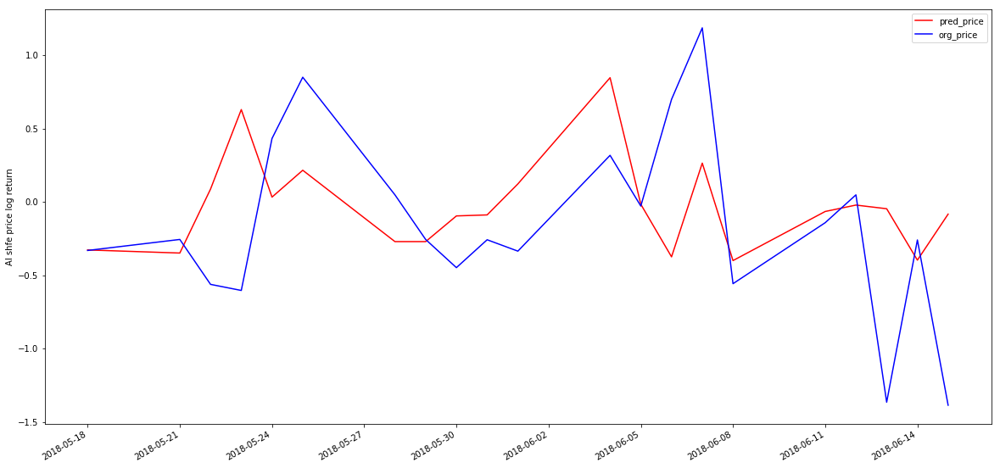

In [51]:
plot_result(return_gp_al, 'Al',pointer = 400)

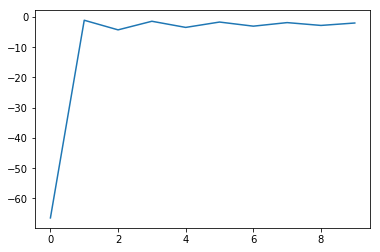

2017-06-22 0.82448798 1.06596631 0.24147833


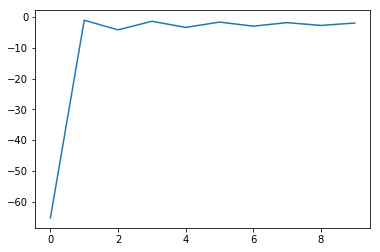

2017-06-23 0.32794859 -0.07176506 0.39971364


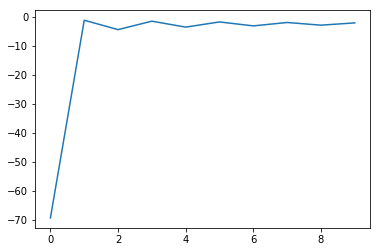

2017-06-26 0.56164187 0.59555617 0.03391430


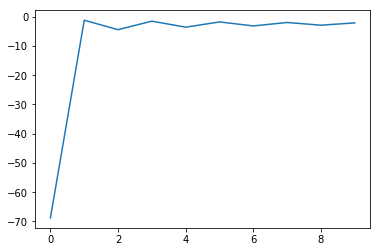

2017-06-27 0.07355410 -0.13117711 0.20473121


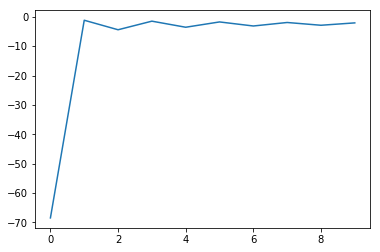

2017-06-28 0.40743201 0.32393818 0.08349383


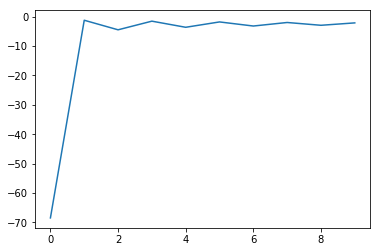

2017-06-29 0.78568976 0.35700293 0.42868683


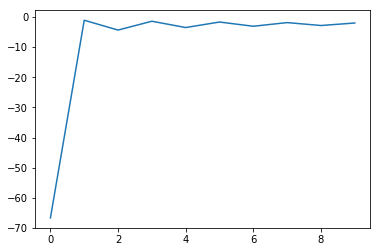

2017-06-30 0.18777065 0.42224385 0.23447320


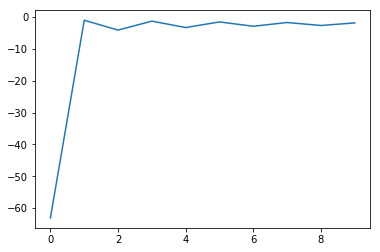

2017-07-03 -0.04284853 0.07047507 0.11332360


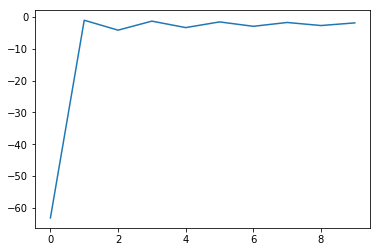

2017-07-04 -0.50562391 0.04059847 0.54622238


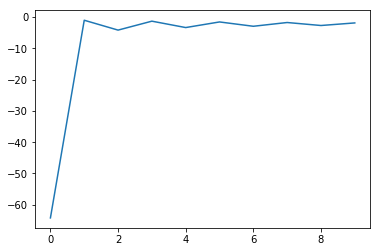

2017-07-05 0.12248125 -0.08077931 0.20326057


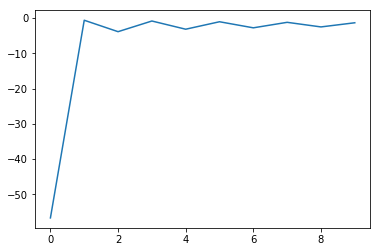

2017-07-06 -0.54157645 -0.96346150 0.42188505


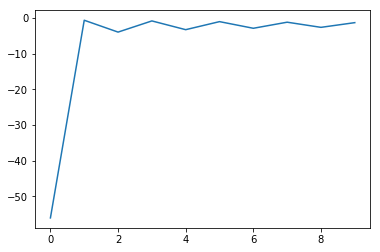

2017-07-07 0.07318099 0.12679026 0.05360927


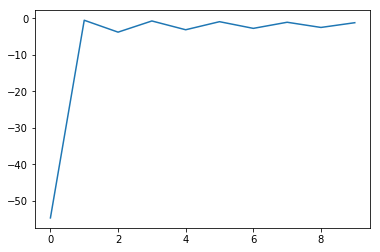

2017-07-10 -0.04344067 -0.17820856 0.13476789


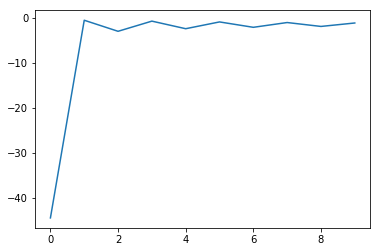

2017-07-11 -0.07683051 -0.03965993 0.03717057


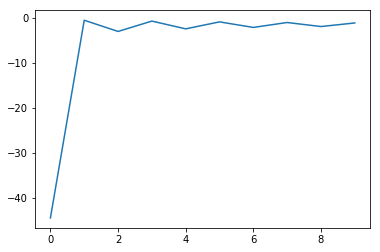

2017-07-12 0.70406324 0.38851204 0.31555120


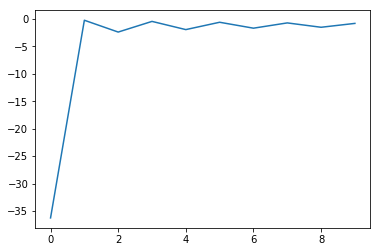

2017-07-13 -0.12584394 0.14334016 0.26918410


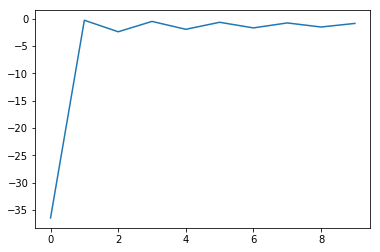

2017-07-14 -0.20906357 -0.22569238 0.01662881


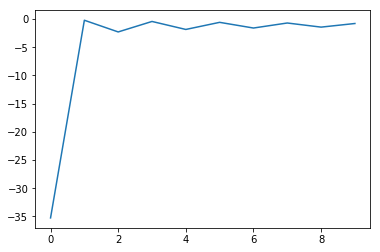

2017-07-17 0.79964851 0.50736545 0.29228306


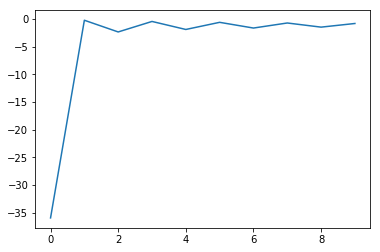

2017-07-18 0.61242329 0.29996254 0.31246076


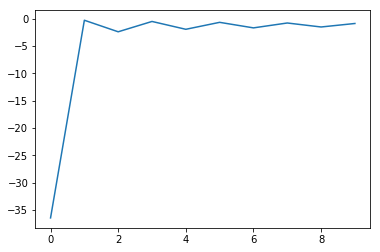

2017-07-19 -0.04241355 -0.08230031 0.03988676


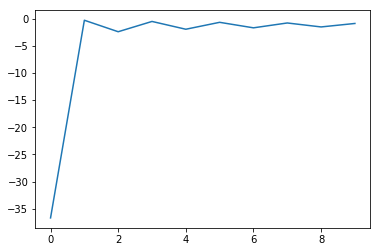

2017-07-20 -0.04244437 -0.23085591 0.18841155


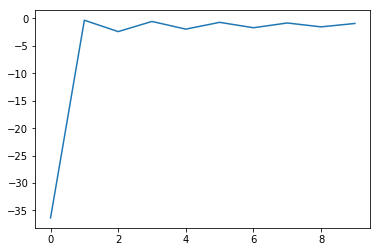

2017-07-21 0.13708546 -0.19613796 0.33322341


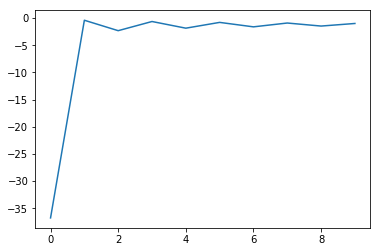

2017-07-24 0.07172917 0.03409387 0.03763530


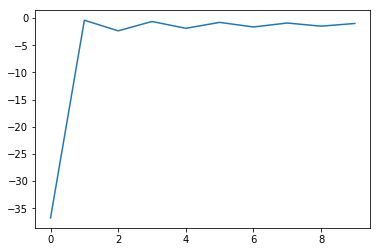

2017-07-25 0.63931453 -0.07506138 0.71437591


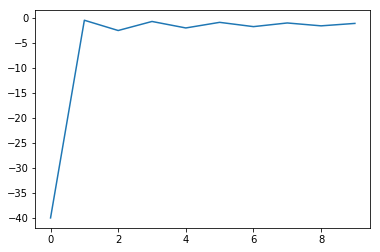

2017-07-26 2.44043703 1.21778730 1.22264974


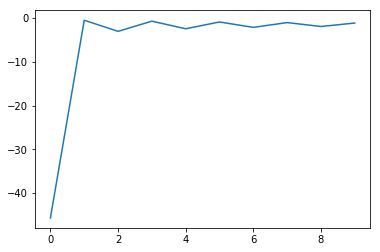

2017-07-27 0.45940315 0.77090460 0.31150145


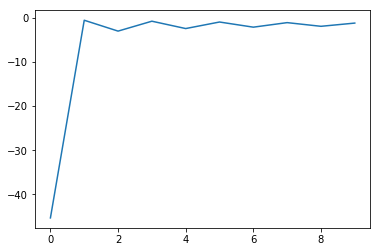

2017-07-28 -0.22737502 0.15467183 0.38204685


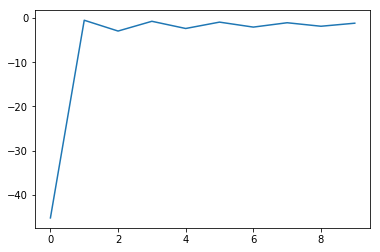

2017-07-31 0.64423805 0.09023394 0.55400412


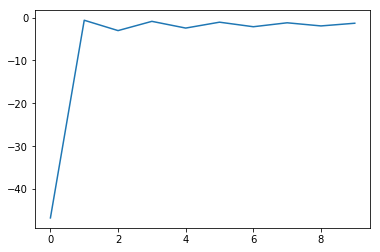

2017-08-01 -0.07095219 0.39855835 0.46951054


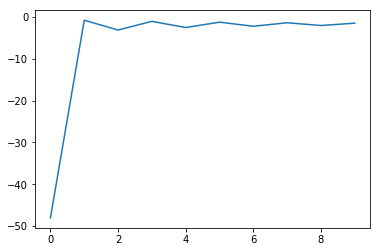

2017-08-02 -0.46002571 -0.15272793 0.30729778


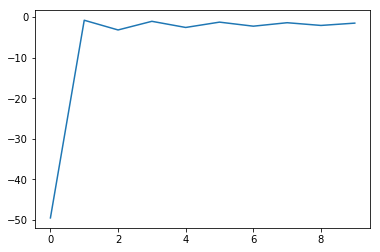

2017-08-03 0.33342439 0.14387986 0.18954453


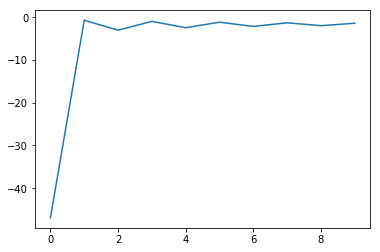

2017-08-04 0.05312328 -0.02732117 0.08044444


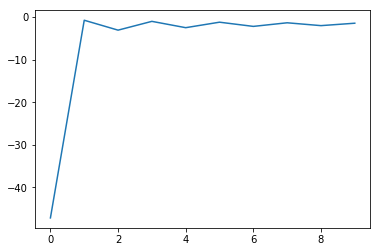

2017-08-07 -0.08666351 0.18690235 0.27356586


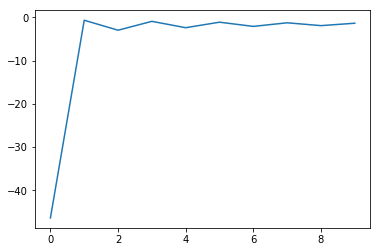

2017-08-08 0.54863941 0.27676587 0.27187354


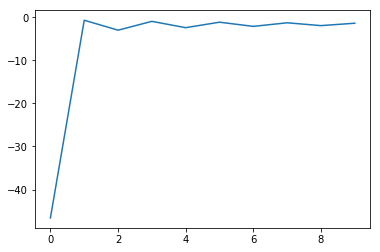

2017-08-09 0.56021542 0.35338333 0.20683209


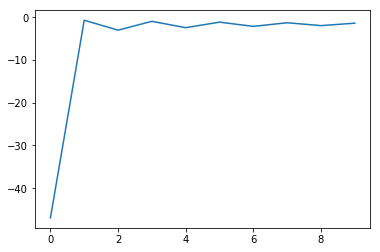

2017-08-10 -0.37754353 -0.19987099 0.17767254


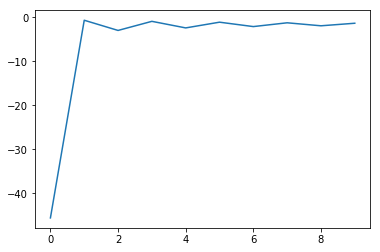

2017-08-11 -1.17284783 -0.58508818 0.58775965


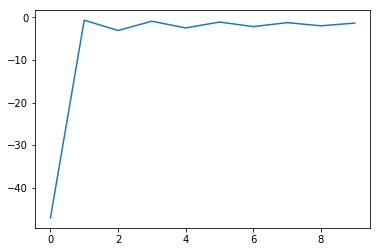

2017-08-14 0.33421105 0.12698449 0.20722656


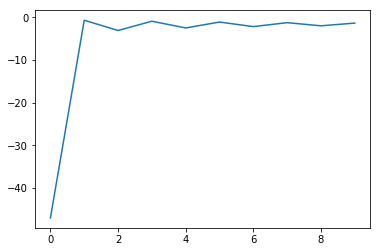

2017-08-15 -0.02461068 0.09378327 0.11839395


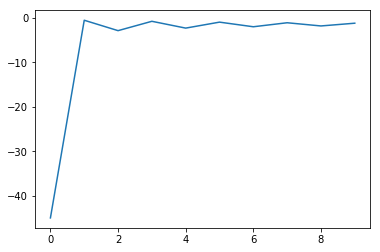

2017-08-16 0.06881985 -0.01930454 0.08812439


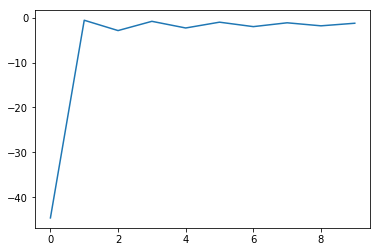

2017-08-17 1.73051842 0.92970775 0.80081067


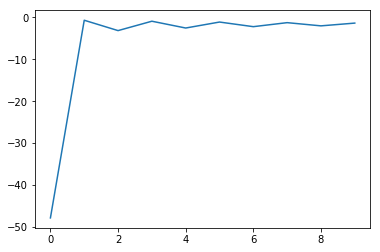

2017-08-18 -0.57411401 -0.67573950 0.10162549


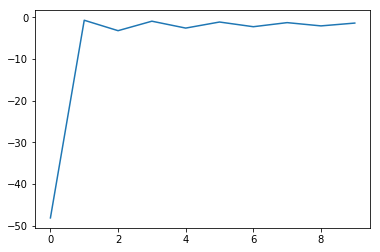

2017-08-21 0.49579383 0.31798833 0.17780550


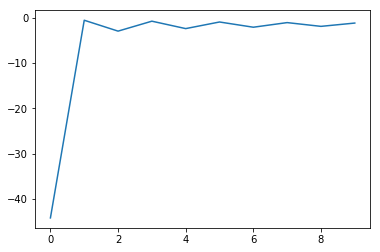

2017-08-22 0.76489456 0.62425657 0.14063800


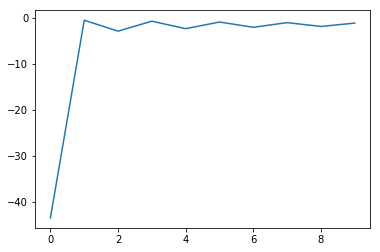

2017-08-23 -0.20505915 0.11877079 0.32382994


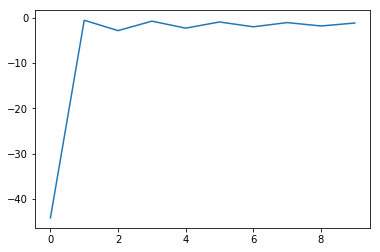

2017-08-24 0.35385596 -0.09131399 0.44516995


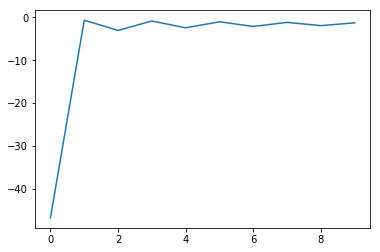

2017-08-25 1.03928739 0.76973826 0.26954913


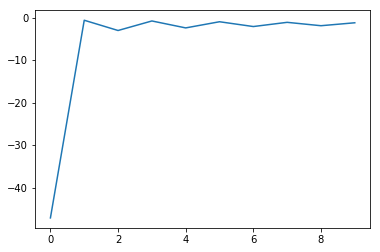

2017-08-28 0.15508012 -0.07005280 0.22513292


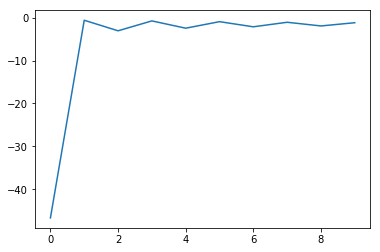

2017-08-29 0.24361771 -0.02772503 0.27134274


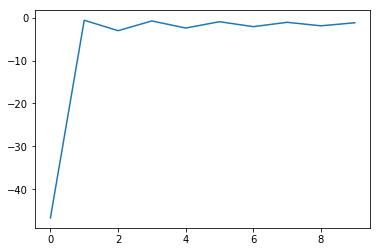

2017-08-30 0.03612135 0.74303515 0.70691381


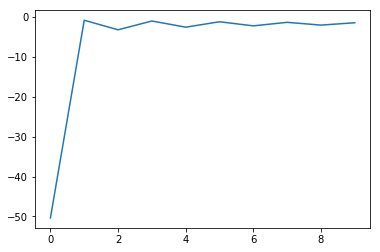

2017-08-31 -0.03784378 -0.12499192 0.08714815


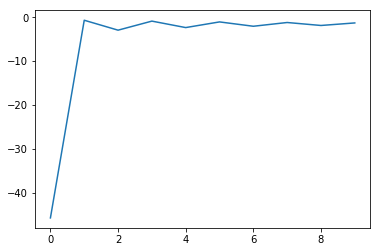

2017-09-01 0.03612697 0.39770358 0.36157661


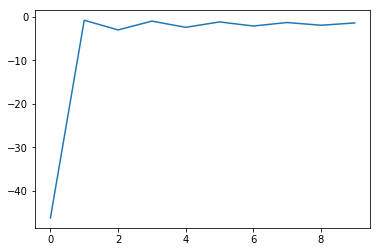

2017-09-04 0.56661918 0.49906354 0.06755564


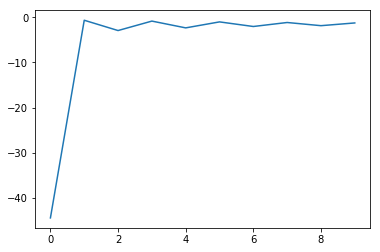

2017-09-05 0.35820706 0.60497651 0.24676945


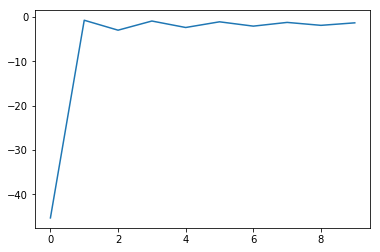

2017-09-06 -0.37451080 -0.22786783 0.14664298


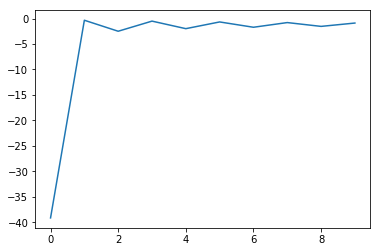

2017-09-07 -0.15523901 0.29901826 0.45425727


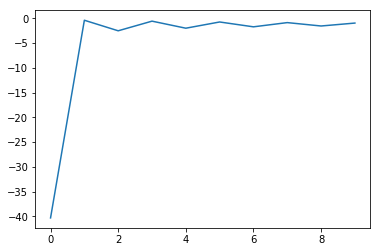

2017-09-08 -0.85207115 0.08068442 0.93275557


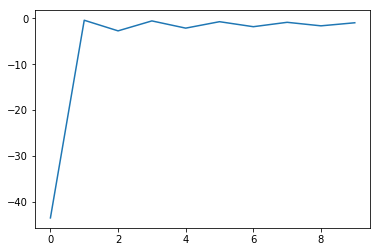

2017-09-11 -1.60274726 -1.25390607 0.34884119


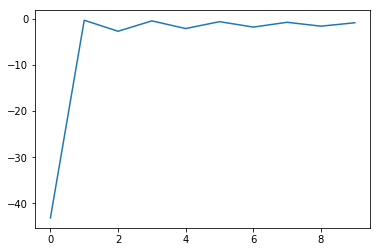

2017-09-12 0.32501405 0.56709099 0.24207694


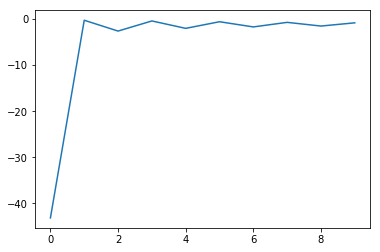

2017-09-13 -0.50974782 -0.70809934 0.19835151


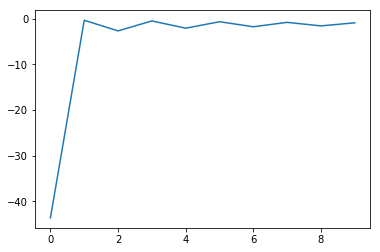

2017-09-14 -0.99011605 -0.78103193 0.20908412


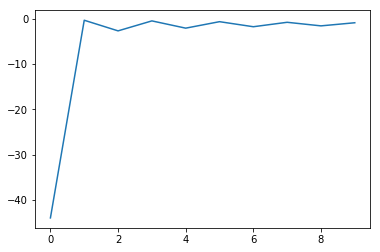

2017-09-15 -0.30271172 -0.48051076 0.17779904


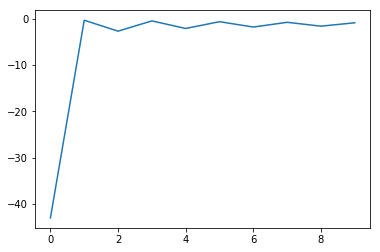

2017-09-18 0.23858867 -0.10436462 0.34295329


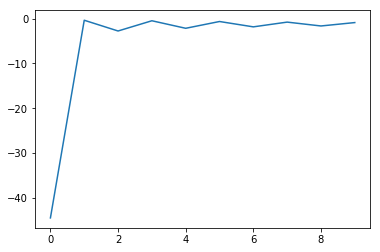

2017-09-19 0.46857440 0.00404082 0.46453357


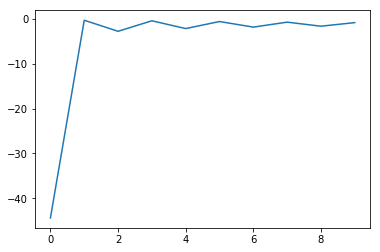

2017-09-20 0.03724214 -0.04292962 0.08017176


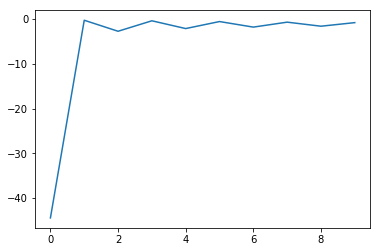

2017-09-21 -0.68727703 0.53755915 1.22483618


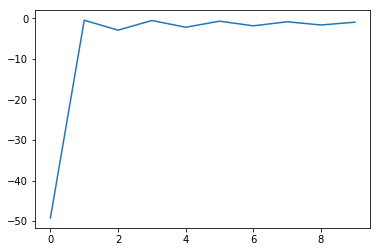

2017-09-22 -0.81863617 -0.21825540 0.60038077


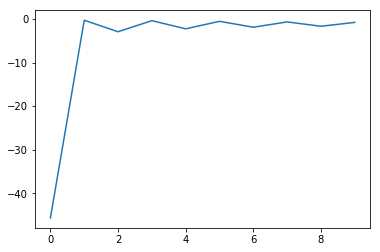

2017-09-25 0.73873239 -0.03898835 0.77772074


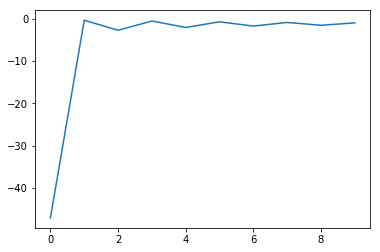

2017-09-26 0.51654512 -0.04842111 0.56496623


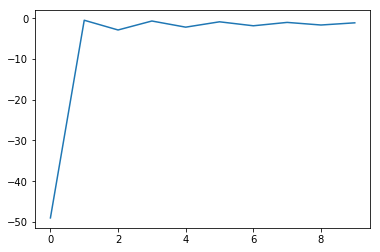

2017-09-27 -0.25577696 -0.35590273 0.10012577


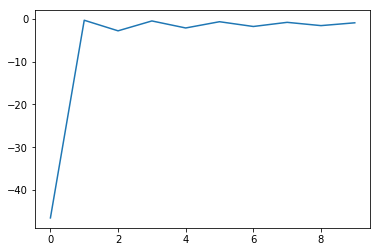

2017-09-28 0.03744339 0.35153037 0.31408698


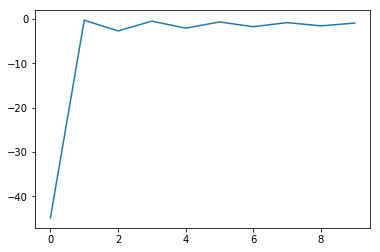

2017-09-29 1.38476992 0.50074142 0.88402850


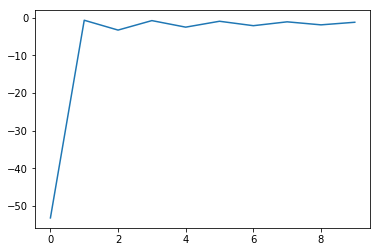

2017-10-09 1.27122760 -0.23822528 1.50945288


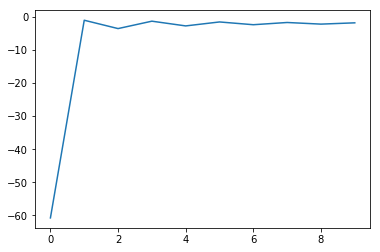

2017-10-10 0.05132651 0.04106754 0.01025897


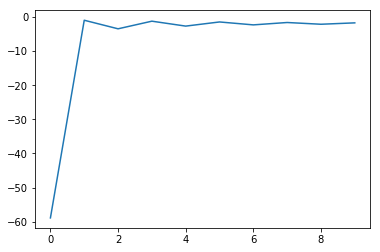

2017-10-11 0.36392803 0.78823318 0.42430515


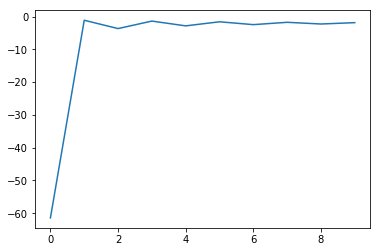

2017-10-12 1.50739685 0.38718039 1.12021647


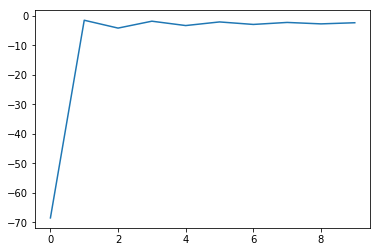

2017-10-13 0.58729633 0.69520003 0.10790370


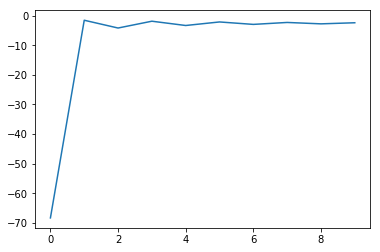

2017-10-16 0.33852117 0.14491223 0.19360894


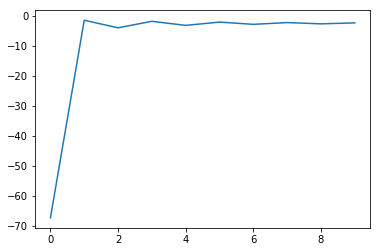

2017-10-17 1.92708932 1.67280877 0.25428054


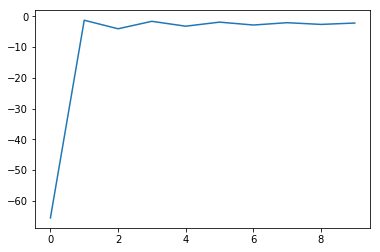

2017-10-18 -0.55758999 -0.71328683 0.15569685


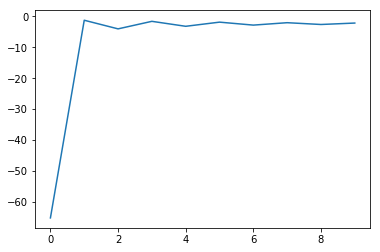

2017-10-19 -0.24866071 -0.16121510 0.08744561


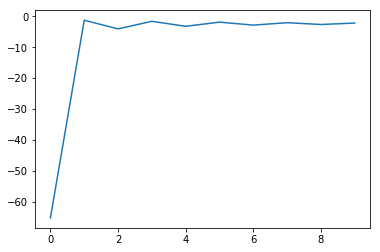

2017-10-20 0.09169592 -0.03856150 0.13025742


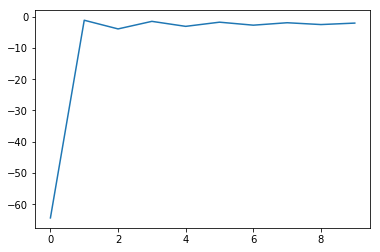

2017-10-23 -0.17809198 -0.01796558 0.16012641


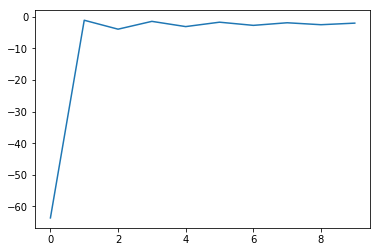

2017-10-24 1.13582926 0.28784499 0.84798427


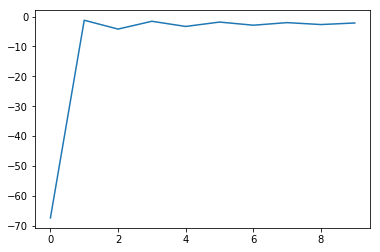

2017-10-25 -0.66906962 0.57084644 1.23991606


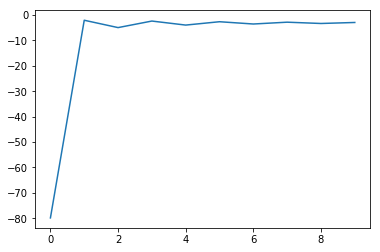

2017-10-26 -0.07832782 -0.00868541 0.06964241


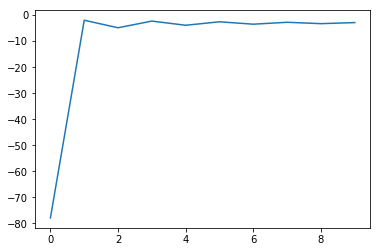

2017-10-27 -0.76144057 0.00057715 0.76201771


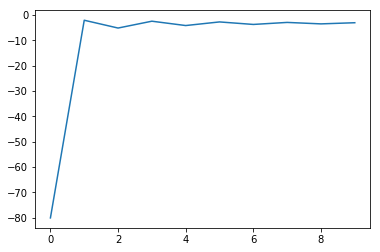

2017-10-30 -1.15983197 -0.77540812 0.38442385


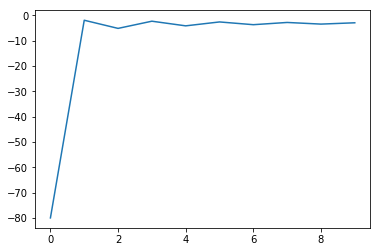

2017-10-31 0.15148276 0.36690325 0.21542048


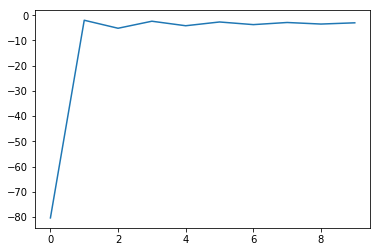

2017-11-01 1.01366662 0.09512569 0.91854093


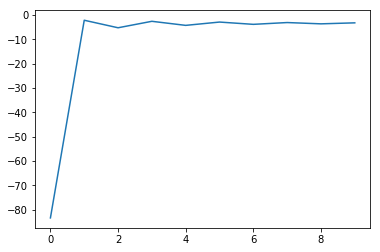

2017-11-02 -0.38038444 0.72178197 1.10216641


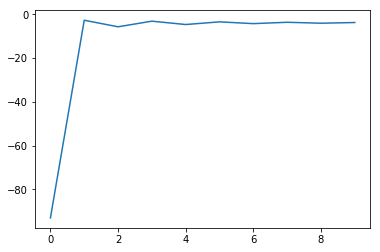

2017-11-03 0.33625798 0.14396006 0.19229793


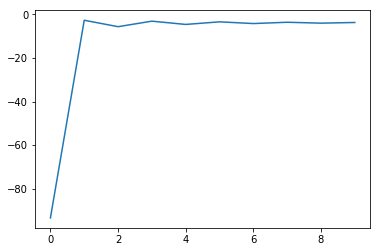

2017-11-06 -0.12231792 0.06440006 0.18671799


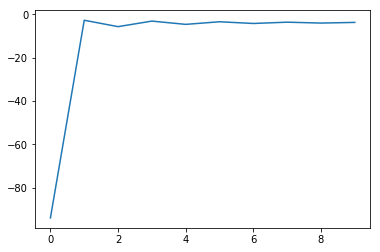

2017-11-07 0.24975072 0.55787203 0.30812131


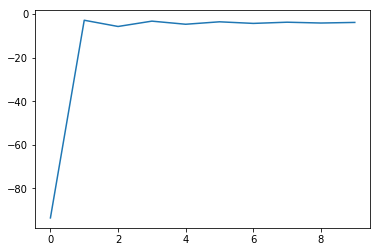

2017-11-08 -1.17368607 -0.82317920 0.35050687


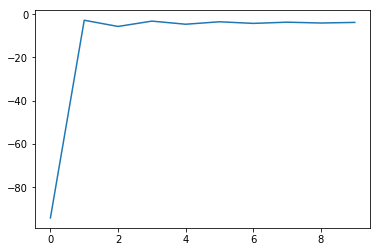

2017-11-09 -0.28405858 0.34592237 0.62998094


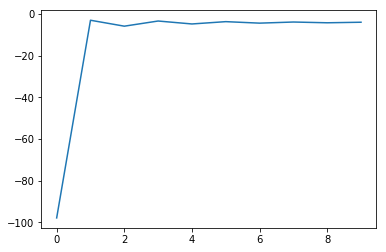

2017-11-10 0.00653698 -0.26422057 0.27075755


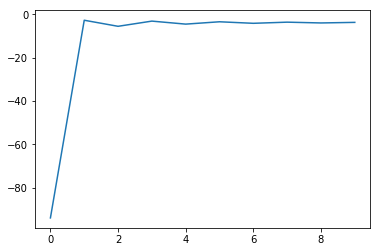

2017-11-13 0.00653698 -0.02218631 0.02872329


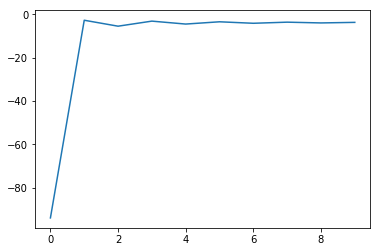

2017-11-14 0.61553909 0.79636787 0.18082878


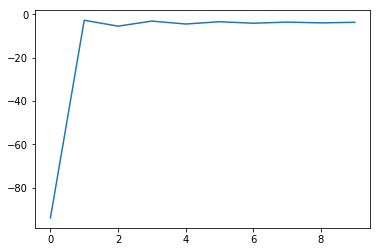

2017-11-15 -1.52500024 -0.68831649 0.83668375


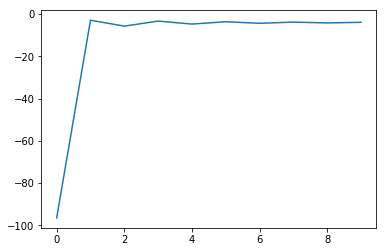

2017-11-16 0.10958271 0.05627537 0.05330734


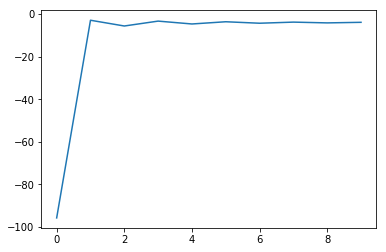

2017-11-17 0.00653698 -0.07487059 0.08140757


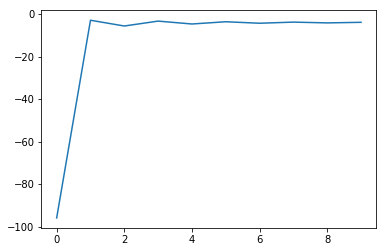

2017-11-20 0.09475340 0.40682542 0.31207202


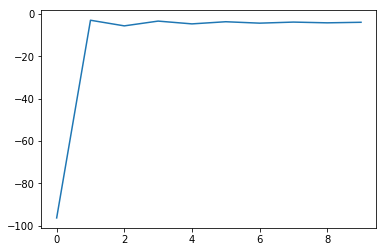

2017-11-21 0.47534275 0.36463122 0.11071153


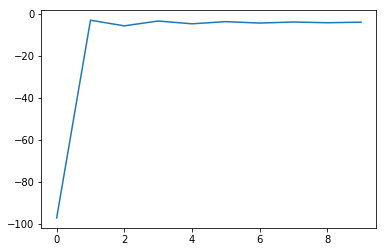

2017-11-22 0.93575866 0.79097486 0.14478380


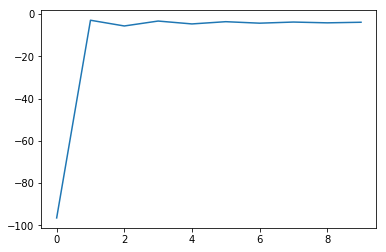

2017-11-23 0.00653698 0.33019917 0.32366218


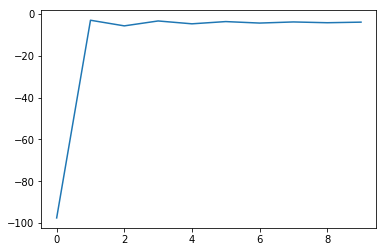

2017-11-24 0.28027684 0.13982056 0.14045628


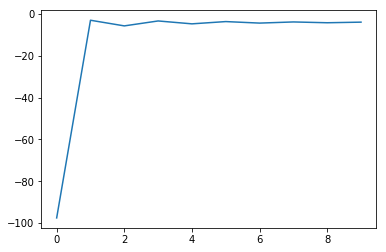

2017-11-27 0.07841401 0.50960188 0.43118787


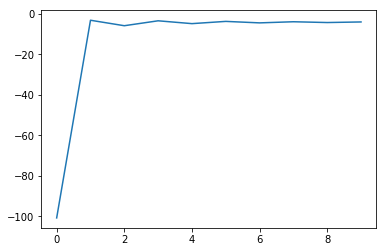

2017-11-28 -0.96217578 -0.51489086 0.44728492


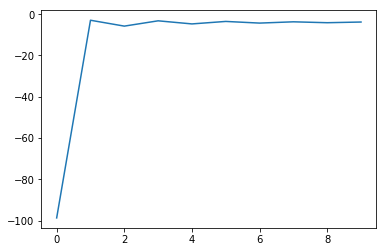

2017-11-29 -0.46042239 -0.84838706 0.38796468


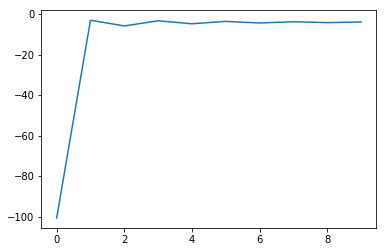

2017-11-30 -0.69919912 -0.57513505 0.12406406


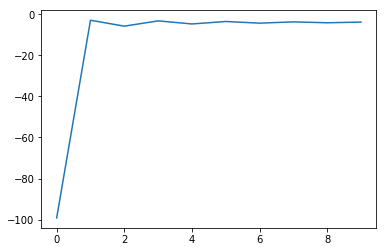

2017-12-01 0.10985638 -0.03463024 0.14448662


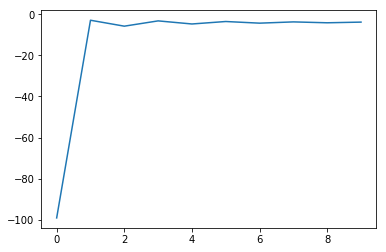

2017-12-04 0.84278369 0.26262753 0.58015615


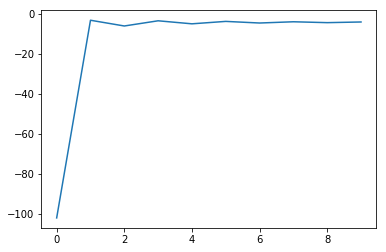

2017-12-05 -0.46182784 -0.28903526 0.17279258


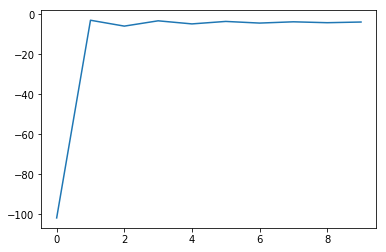

2017-12-06 -2.36339866 -1.60800233 0.75539633


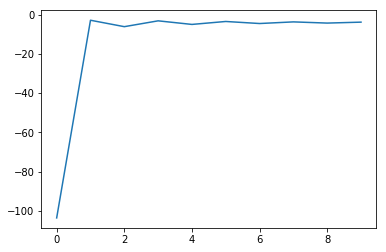

2017-12-07 -0.05402490 -0.04204619 0.01197871


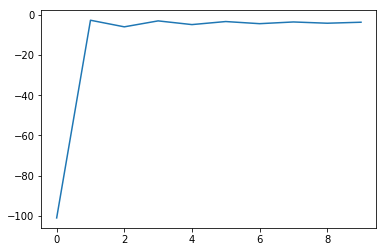

2017-12-08 0.08223197 0.18967078 0.10743880


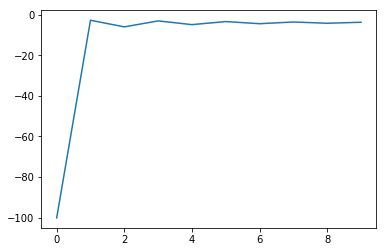

2017-12-11 0.08215840 0.06125234 0.02090606


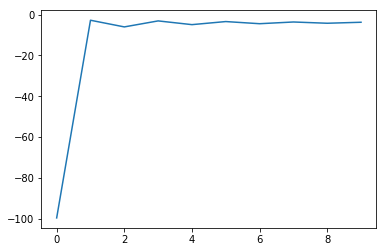

2017-12-12 0.51882265 0.65315946 0.13433681


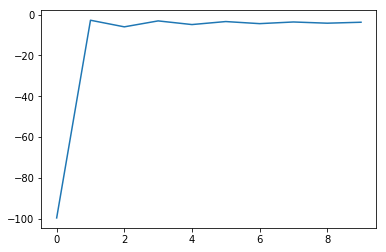

2017-12-13 0.20152298 -0.06325153 0.26477451


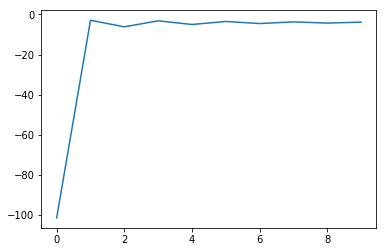

2017-12-14 0.45464845 0.45376305 0.00088539


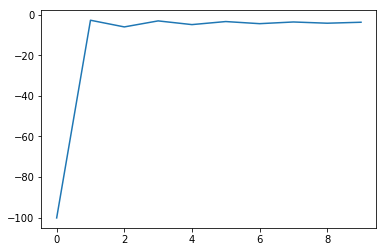

2017-12-15 0.40764251 0.45410513 0.04646262


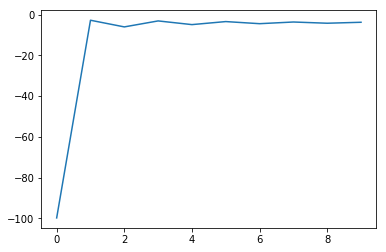

2017-12-18 1.32881549 0.83448059 0.49433490


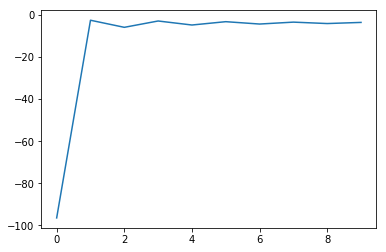

2017-12-19 0.02110347 0.33102612 0.30992265


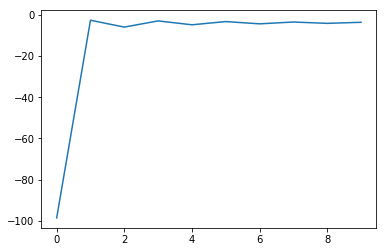

2017-12-20 0.16658858 0.02418464 0.14240393


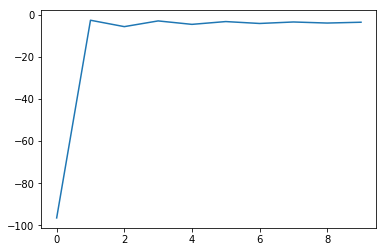

2017-12-21 0.85942159 0.84653766 0.01288393


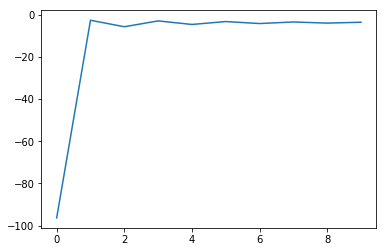

2017-12-22 0.06402267 0.50847216 0.44444949


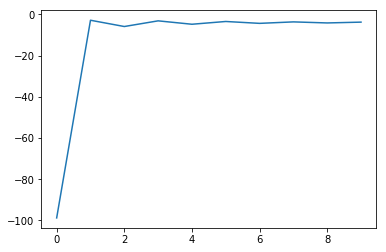

2017-12-25 0.82112642 0.28788133 0.53324509


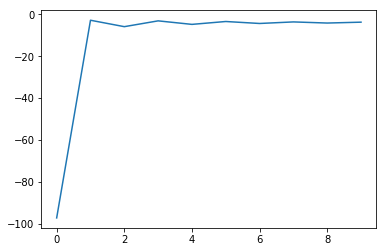

2017-12-26 -0.03612419 0.37853229 0.41465648


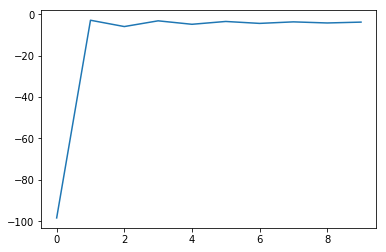

2017-12-27 0.30467517 0.36509229 0.06041713


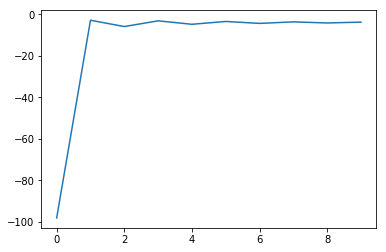

2017-12-28 0.50090926 1.08098809 0.58007883


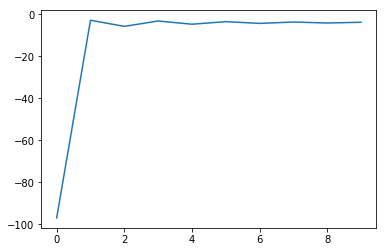

2017-12-29 0.24553199 0.43622573 0.19069374


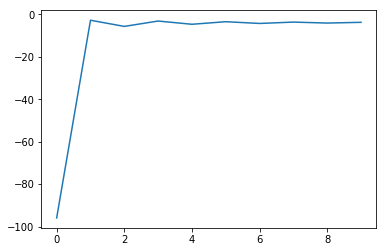

2018-01-02 -0.71266169 -0.41009554 0.30256616


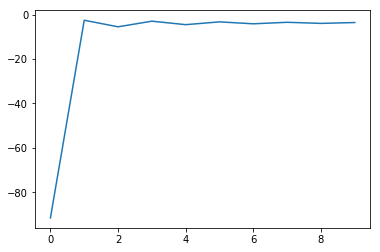

2018-01-03 -0.29154681 -0.06288032 0.22866648


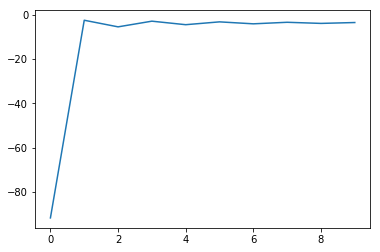

2018-01-04 0.03497517 -0.24840152 0.28337668


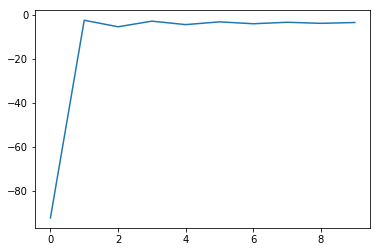

2018-01-05 -0.00768081 0.30929680 0.31697761


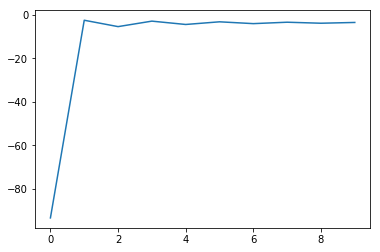

2018-01-08 -0.62163200 -0.54291406 0.07871793


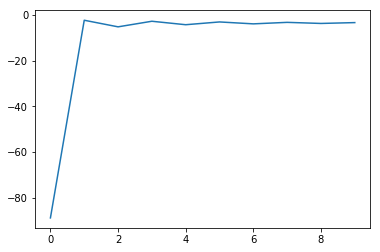

2018-01-09 0.23554928 0.03813060 0.19741869


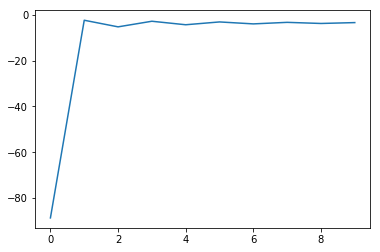

2018-01-10 0.10651829 -0.03130095 0.13781924


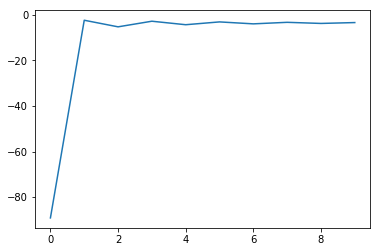

2018-01-11 0.26304339 0.40315308 0.14010969


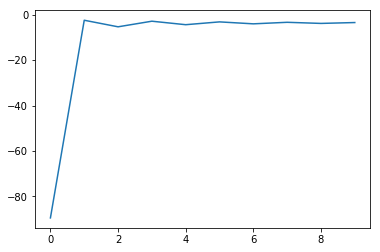

2018-01-12 -0.53597184 -0.10506956 0.43090229


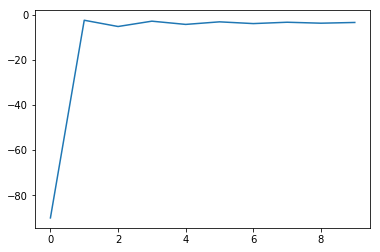

2018-01-15 0.02086210 -0.15438062 0.17524272


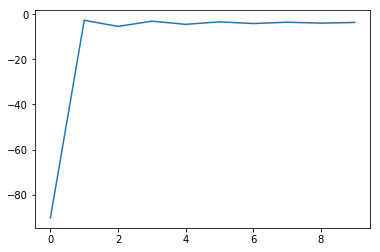

2018-01-16 0.14964328 0.73146369 0.58182040


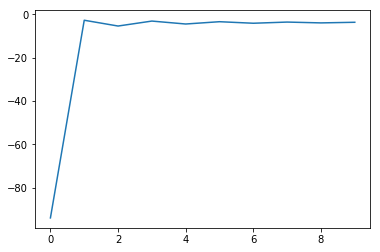

2018-01-17 -1.04424240 -0.95730570 0.08693670


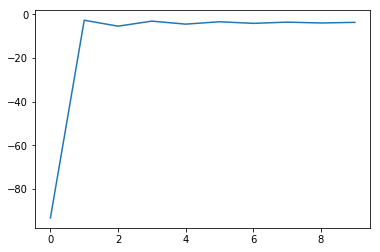

2018-01-18 -0.13851688 -0.27966344 0.14114656


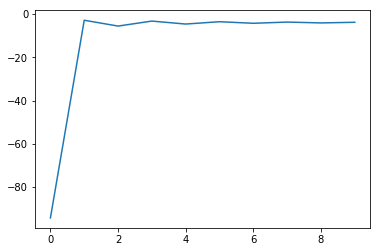

2018-01-19 -0.03703196 0.22659995 0.26363191


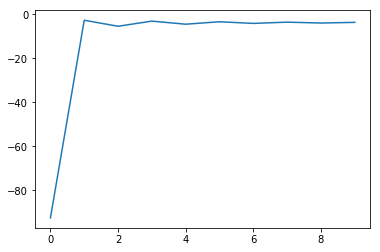

2018-01-22 -0.08067416 -0.10271226 0.02203809


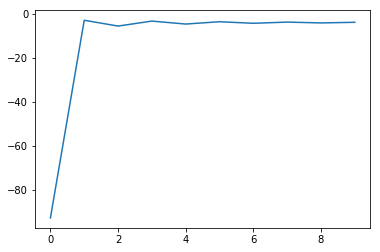

2018-01-23 -0.00800772 0.23142179 0.23942950


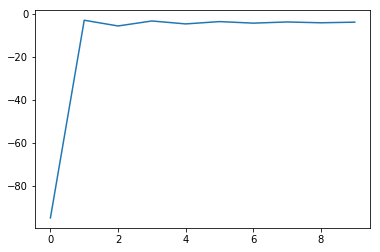

2018-01-24 -1.25458956 -0.82682874 0.42776082


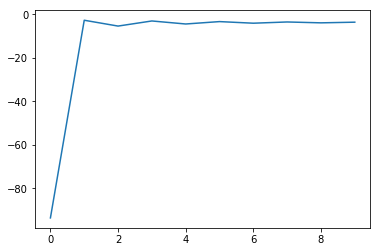

2018-01-25 1.23856597 1.35311219 0.11454622


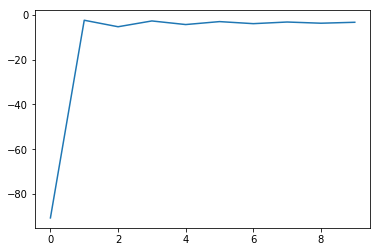

2018-01-26 -0.12453686 -0.14088600 0.01634914


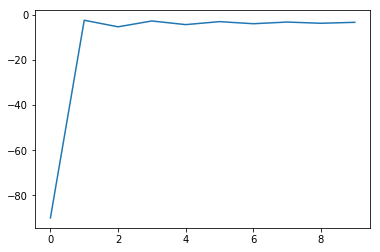

2018-01-29 -0.00804042 -0.34194728 0.33390686


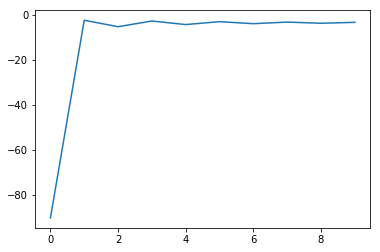

2018-01-30 -0.47605582 -0.27509631 0.20095950


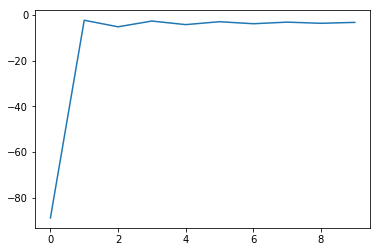

2018-01-31 -0.22852927 -0.18376819 0.04476108


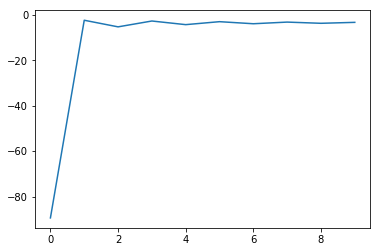

2018-02-01 0.00653698 0.58866638 0.58212940


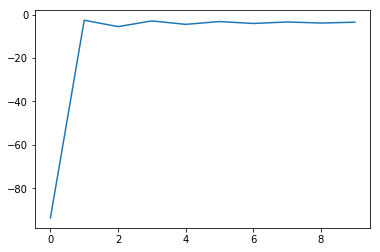

2018-02-02 0.22693239 -0.05715260 0.28408499


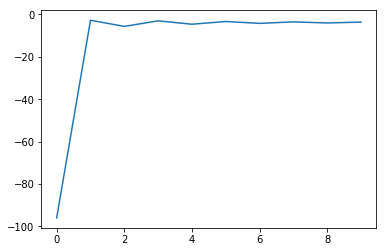

2018-02-05 -0.44963700 -0.55564786 0.10601087


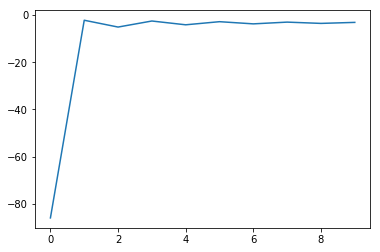

2018-02-06 -0.12640312 0.28021074 0.40661387


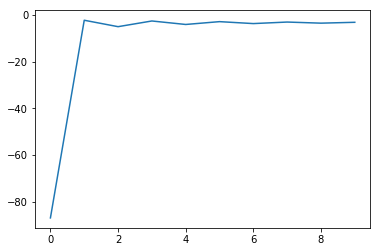

2018-02-07 0.00653698 -0.24809317 0.25463016


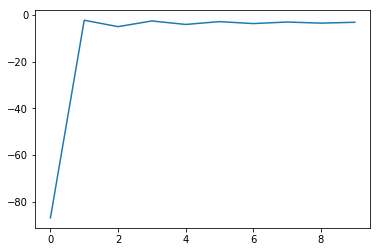

2018-02-08 -1.44086626 -1.19035341 0.25051285


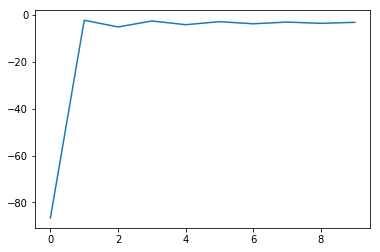

2018-02-09 -0.62862468 -0.47598117 0.15264351


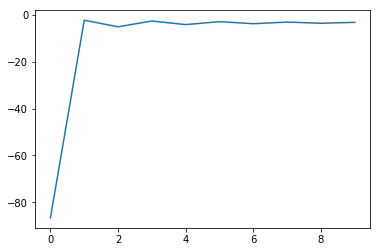

2018-02-12 0.02172029 -0.55280029 0.57452058


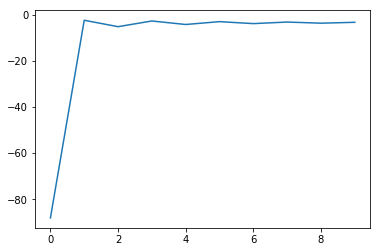

2018-02-13 0.70178561 0.53821088 0.16357472


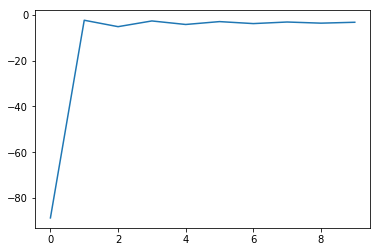

2018-02-14 0.97848133 1.06468494 0.08620361


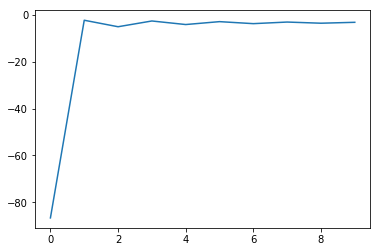

2018-02-22 0.24393418 1.41413331 1.17019913


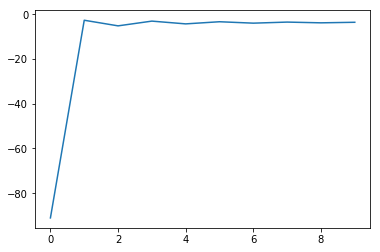

2018-02-23 1.13898853 0.23469371 0.90429482


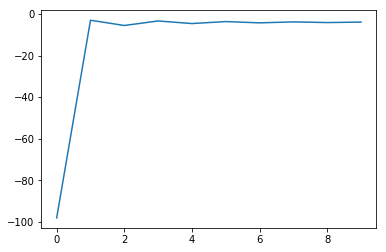

2018-02-26 -0.13960669 -0.18099180 0.04138510


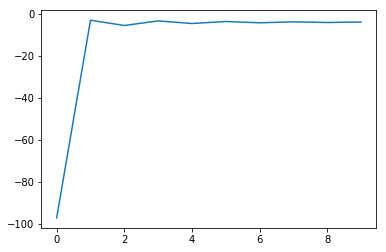

2018-02-27 -0.16919854 0.16553796 0.33473651


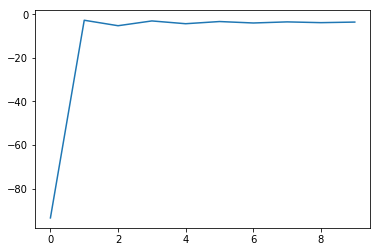

2018-02-28 -0.84849219 -0.62548041 0.22301177


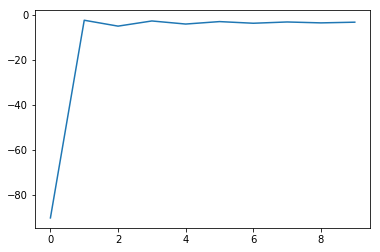

2018-03-01 -0.54386284 -0.61818021 0.07431737


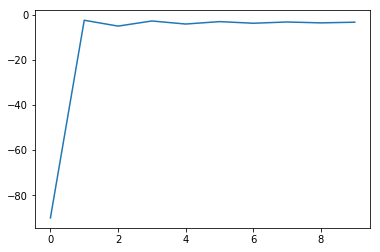

2018-03-02 -0.08308507 -0.07684104 0.00624403


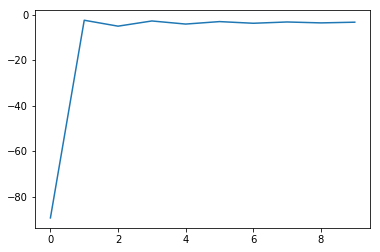

2018-03-05 -0.29295096 0.02554714 0.31849810


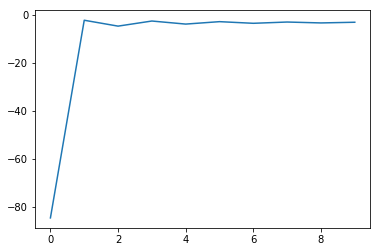

2018-03-06 0.18636805 0.16812921 0.01823884


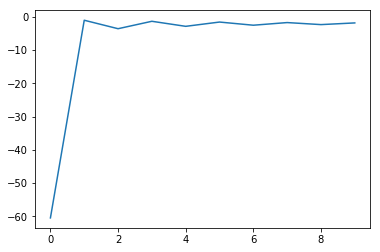

2018-03-07 0.11124682 0.63138577 0.52013895


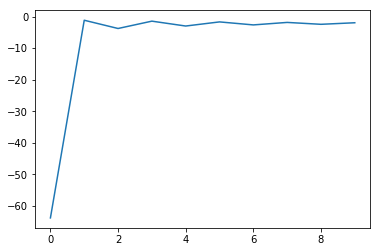

2018-03-08 -0.47329107 -0.47545746 0.00216639


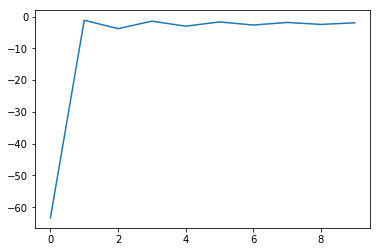

2018-03-09 -1.06876731 -0.64496670 0.42380061


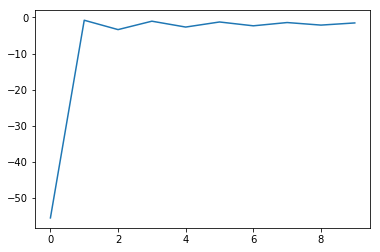

2018-03-12 0.78043911 0.97286689 0.19242778


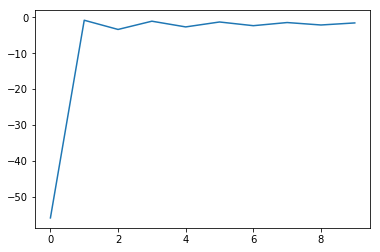

2018-03-13 -0.32635951 -0.59615830 0.26979879


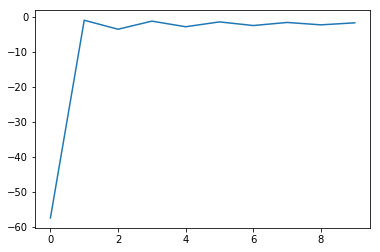

2018-03-14 0.32433268 0.26444425 0.05988843


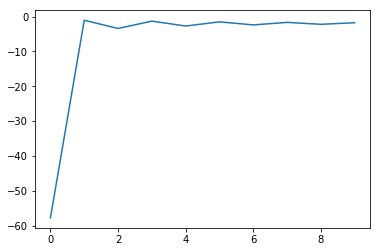

2018-03-15 0.23274183 0.12140593 0.11133590


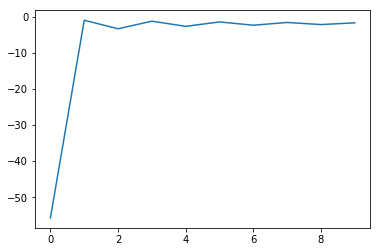

2018-03-16 0.03664800 -0.39178598 0.42843398


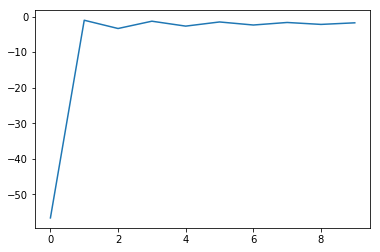

2018-03-19 -0.73455846 -0.13525511 0.59930335


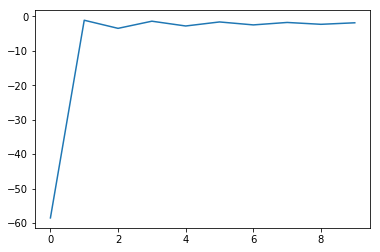

2018-03-20 -0.14557816 -0.35348418 0.20790602


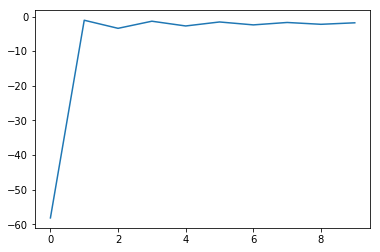

2018-03-21 -0.77391020 -0.67662606 0.09728415


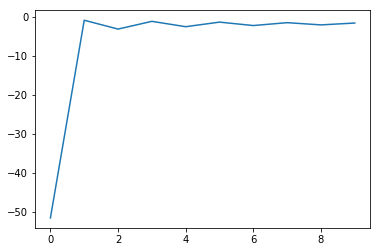

2018-03-22 0.42068987 0.23992573 0.18076413


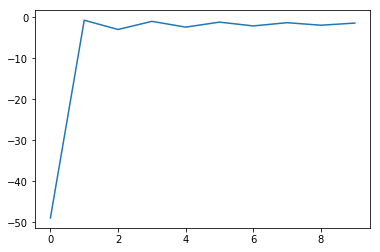

2018-03-23 -1.36706044 -0.88849885 0.47856159


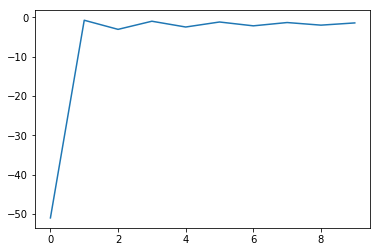

2018-03-26 -1.29668597 -0.20619187 1.09049410


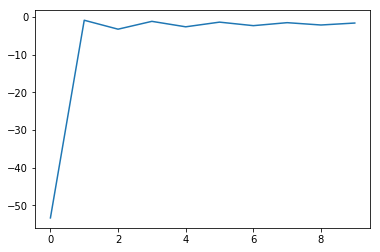

2018-03-27 0.35410125 -0.20762450 0.56172575


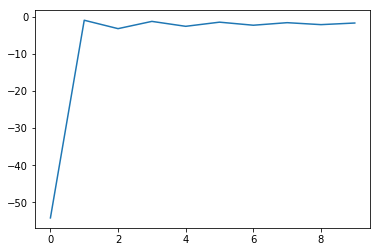

2018-03-28 -0.19865419 0.17185831 0.37051251


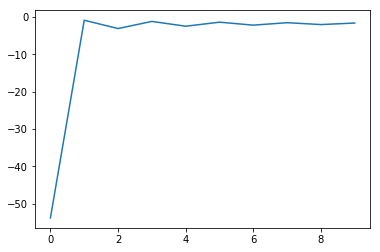

2018-03-29 0.62049424 0.14977194 0.47072230


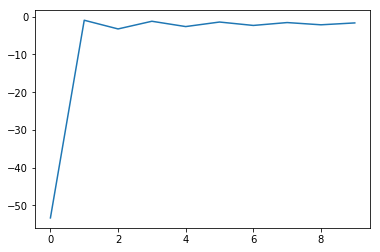

2018-03-30 0.56899875 0.26519188 0.30380686


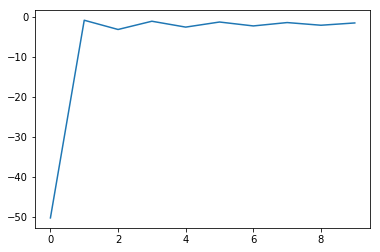

2018-04-02 0.42573096 0.35898079 0.06675017


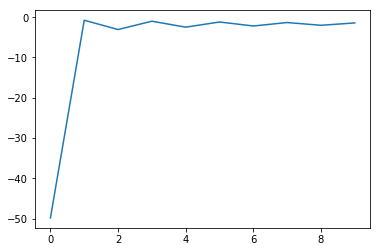

2018-04-03 0.36185539 0.04939908 0.31245631


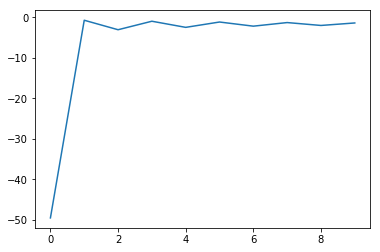

2018-04-04 -0.02429594 0.60212769 0.62642362


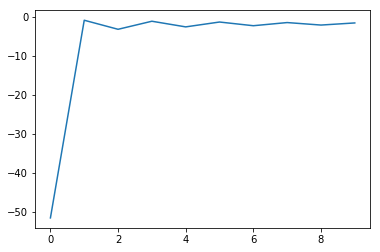

2018-04-09 -0.13236256 -0.36410606 0.23174350


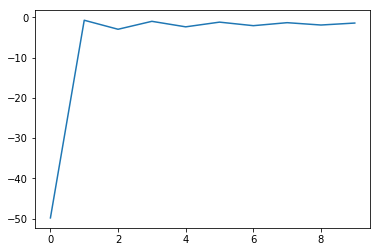

2018-04-10 0.91261757 0.34048827 0.57212930


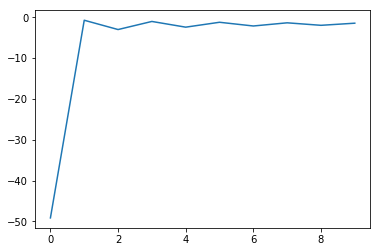

2018-04-11 0.32651086 0.72588164 0.39937077


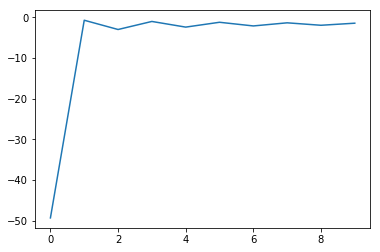

2018-04-12 -0.75748007 0.01043570 0.76791577


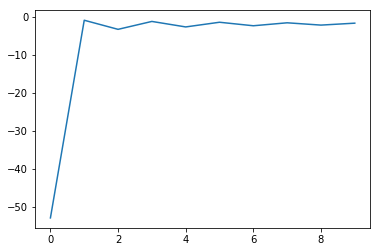

2018-04-13 -0.20873908 -0.75327796 0.54453888


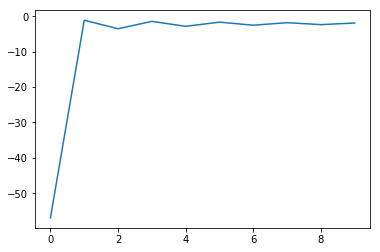

2018-04-16 -0.17846062 0.17213318 0.35059380


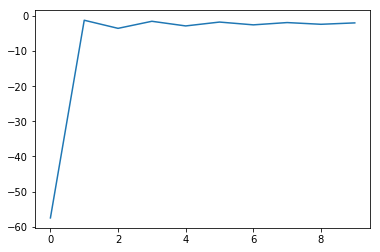

2018-04-17 0.45286385 0.56356461 0.11070076


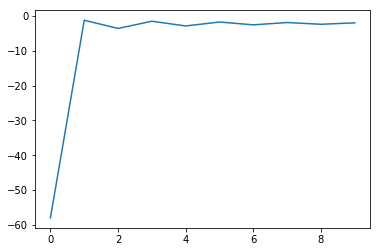

2018-04-18 -0.02416212 -0.20607768 0.18191556


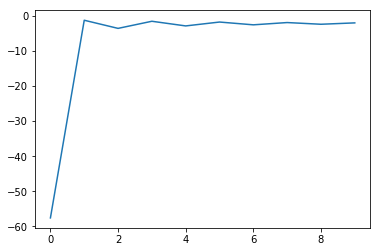

2018-04-19 1.48166502 0.74508459 0.73658043


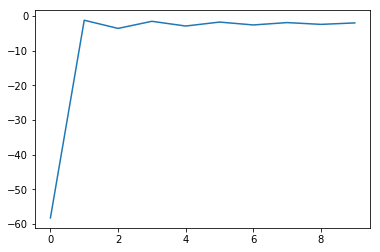

2018-04-20 -0.64393739 -0.34082550 0.30311190


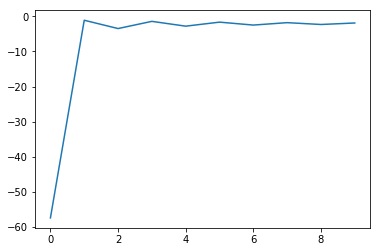

2018-04-23 0.50622281 0.09857865 0.40764416


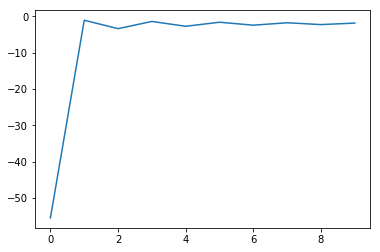

2018-04-24 -0.40205785 -0.34535460 0.05670325


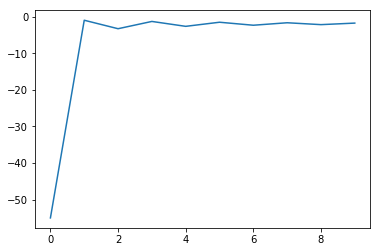

2018-04-25 0.32451822 0.42107852 0.09656030


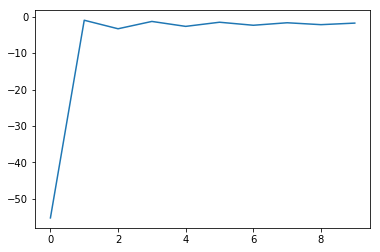

2018-04-26 -0.03880942 -0.08961817 0.05080875


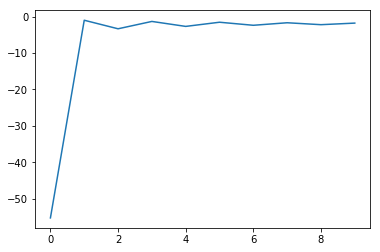

2018-04-27 -0.12966102 -0.13728760 0.00762658


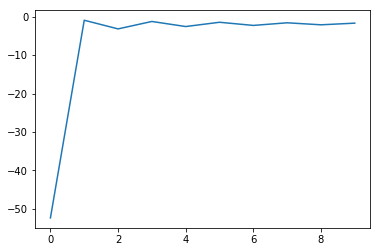

2018-05-02 -0.84631650 -0.92648438 0.08016788


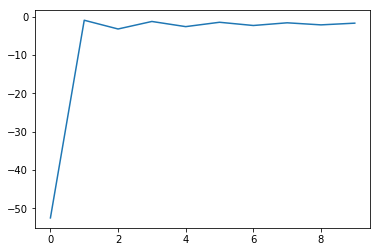

2018-05-03 -0.03941648 0.55757538 0.59699186


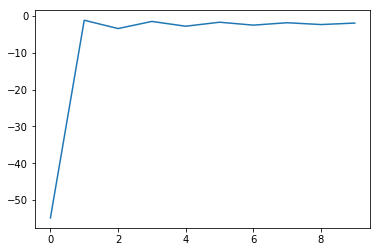

2018-05-04 0.26658182 0.13589886 0.13068296


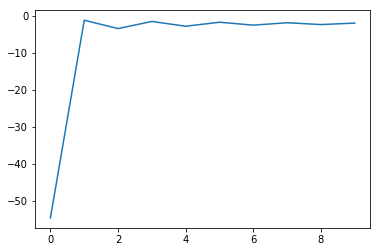

2018-05-07 -0.06985661 0.01120053 0.08105714


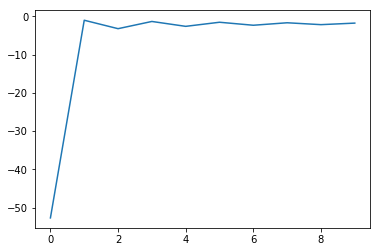

2018-05-08 0.12873076 -0.03139271 0.16012347


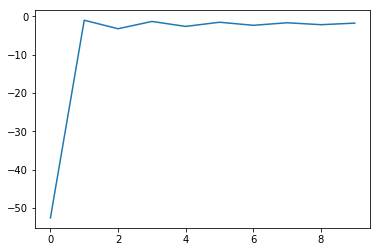

2018-05-09 -0.57560023 -0.43799688 0.13760335


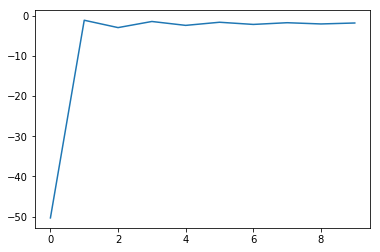

2018-05-10 0.28282918 0.54477456 0.26194538


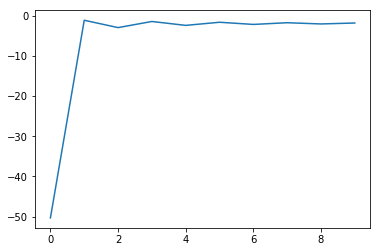

2018-05-11 0.46485485 0.64785975 0.18300490


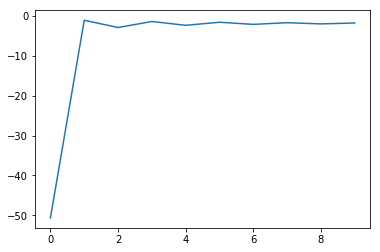

2018-05-14 0.17391274 0.17422460 0.00031186


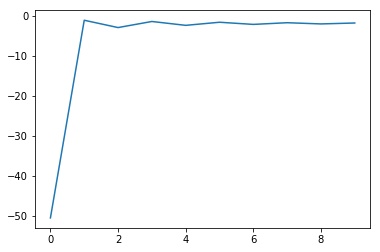

2018-05-15 -0.42022068 -0.23400520 0.18621547


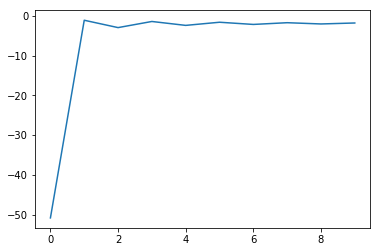

2018-05-16 -0.19239897 -0.54752354 0.35512456


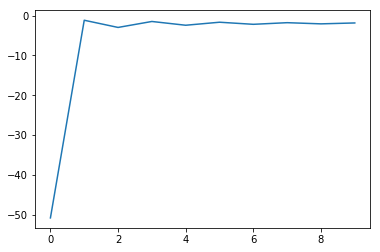

2018-05-17 0.22075466 0.26960017 0.04884551


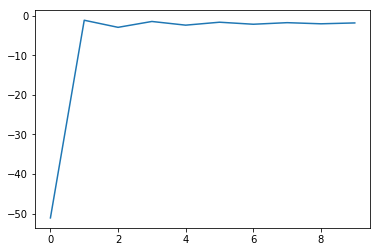

2018-05-18 0.20492668 0.18869047 0.01623622


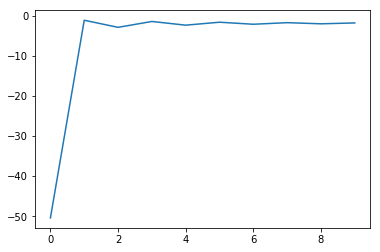

2018-05-21 0.18921804 -0.18626122 0.37547926


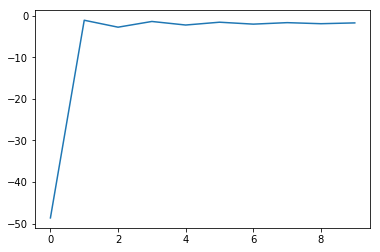

2018-05-22 0.18879013 0.16335820 0.02543194


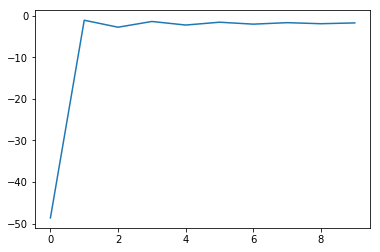

2018-05-23 0.56581171 0.45329462 0.11251709


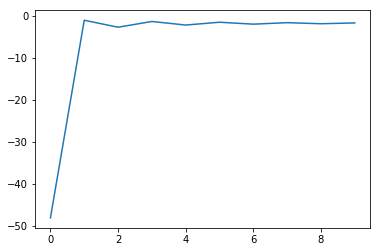

2018-05-24 -0.70458570 -0.74104303 0.03645733


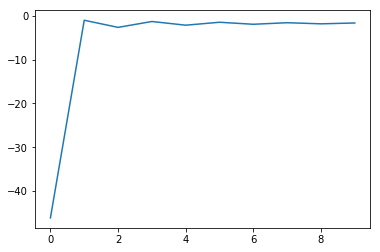

2018-05-25 0.24935168 0.11980897 0.12954271


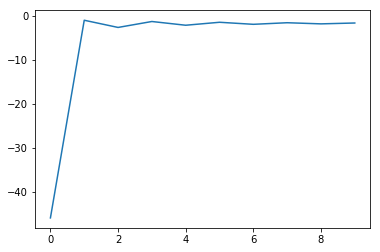

2018-05-28 -0.08442975 -0.15580701 0.07137726


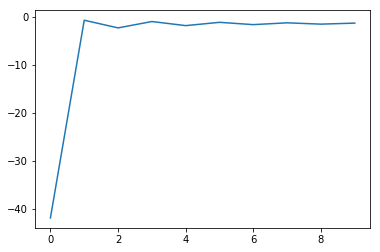

2018-05-29 0.18836423 -0.12319105 0.31155528


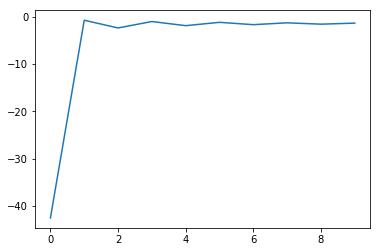

2018-05-30 -0.49451397 -0.32898653 0.16552745


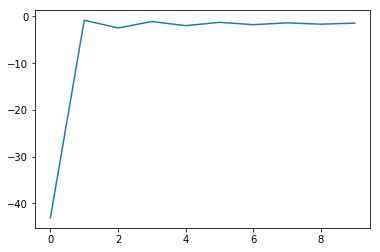

2018-05-31 0.05222064 0.10916581 0.05694517


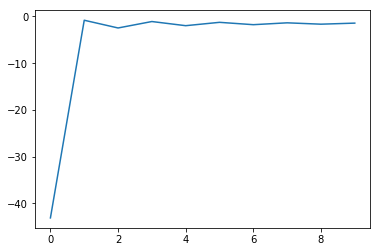

2018-06-01 0.17381460 -0.00146616 0.17528076


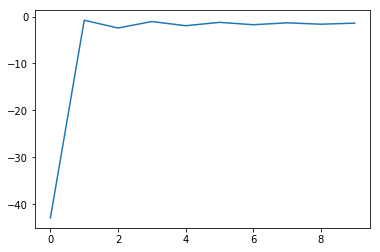

2018-06-04 0.80750826 0.31702732 0.49048095


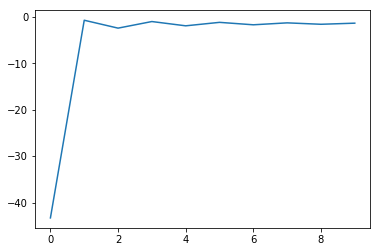

2018-06-05 0.18674985 0.51339552 0.32664566


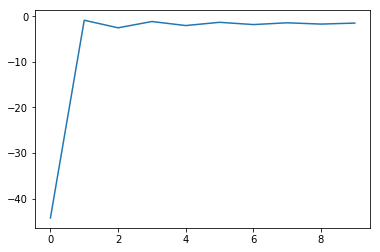

2018-06-06 1.12350810 0.76756060 0.35594750


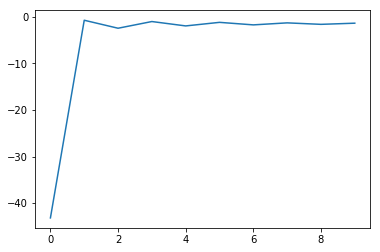

2018-06-07 1.48582748 0.67553046 0.81029702


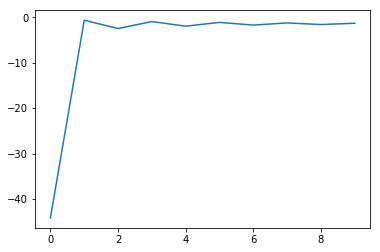

2018-06-08 -0.12414548 0.52859887 0.65274436


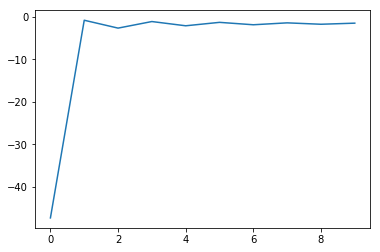

2018-06-11 0.38346686 -0.10147887 0.48494573


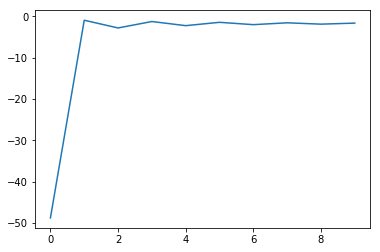

2018-06-12 -0.39946327 -0.32522351 0.07423976


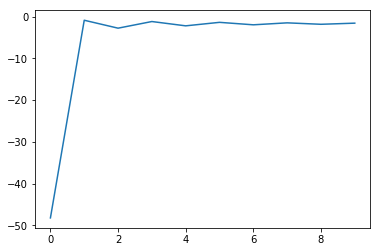

2018-06-13 -0.38697992 -0.24789706 0.13908286


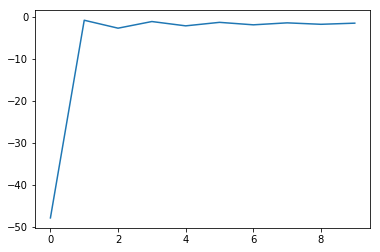

2018-06-14 0.15251615 0.18037310 0.02785695


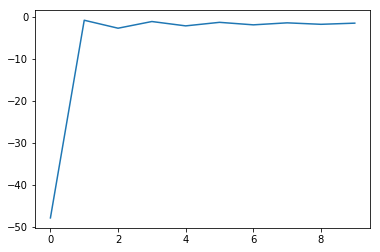

2018-06-15 -0.37358002 -0.31457354 0.05900648


In [464]:
#multiple kernel learning in kernel ridge regression
result_mkl = get_input_output(multiple_kernel_dual ,cu_log_return)

In [470]:
result_gp_select = run_experiment(gaussian_process ,cu_log_return, period=100, lag=1, feature_select_lag = 5)

/Users/elvis/anaconda3/lib/python3.6/site-packages/mklaren/mkl/align.py:58: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  y = y.reshape((m, 1))


2017-06-22 0.82448798 1.07651986 0.25203188


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.47862317e-003,   1.85161289e-004,  -3.39402574e-004,
         1.56618329e-007,   1.56618329e-007,   5.25731199e-006,
        -0.00000000e+000,   6.30198277e-004,   6.30198277e-004,
         1.46115874e-005,  -8.22185874e-305,   4.71128121e+001,
        -1.90768014e+000,  -9.92727772e+008,   3.83092818e-001,
         6.94140910e-001]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 41, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-06-23 0.32794859 0.09160736 0.23634123
2017-06-26 0.56164187 0.56152956 0.00011232
2017-06-27 0.07355410 -0.14980675 0.22336086
2017-06-28 0.40743201 0.39816637 0.00926565


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.83543434e-03,  -4.47923856e-15,   5.83389369e-09,
        -4.39903464e-02,  -4.39903464e-02,  -1.94940769e-04,
         2.94048278e-05,   5.40563617e-04,   5.40563617e-04,
        -9.40441872e-05,  -0.00000000e+00,  -1.39867702e-04,
        -2.74614460e-06,   7.95157614e+05,   1.36135086e-04,
         1.03332398e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 103, 'nit': 28, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-06-29 0.78568976 0.33512330 0.45056645
2017-06-30 0.18777065 0.51700888 0.32923824
2017-07-03 -0.04284853 0.04302374 0.08587226
2017-07-04 -0.50562391 0.00044790 0.50607181
2017-07-05 0.12248125 -0.16409190 0.28657316
2017-07-06 -0.54157645 -0.93340146 0.39182501
2017-07-07 0.07318099 0.09695684 0.02377585
2017-07-10 -0.04344067 -0.09160040 0.04815974
2017-07-11 -0.07683051 -0.00231191 0.07451860
2017-07-12 0.70406324 0.42096917 0.28309407
2017-07-13 -0.12584394 0.18061575 0.30645969
2017-07-14 -0.20906357 -0.15199972 0.05706385


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  5.70531095e-007,   4.62358704e-007,  -1.92968357e-007,
         7.07748835e-007,   7.07748835e-007,   2.35886912e-005,
        -2.76953840e-279,   4.99949701e-001,   4.99949701e-001,
         9.86295739e-009,  -1.89325370e-008,   4.69997446e+001,
        -8.25767929e-001,  -2.32444417e+007,   2.49857889e-006,
         1.85125673e-009]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-07-17 0.79964851 0.56885949 0.23078902
2017-07-18 0.61242329 0.31717376 0.29524953
2017-07-19 -0.04241355 -0.08637147 0.04395792
2017-07-20 -0.04244437 -0.19013735 0.14769298
2017-07-21 0.13708546 -0.17096264 0.30804810
2017-07-24 0.07172917 0.16192810 0.09019892
2017-07-25 0.63931453 -0.05519009 0.69450462
2017-07-26 2.44043703 1.30240886 1.13802818
2017-07-27 0.45940315 0.71780445 0.25840131
2017-07-28 -0.22737502 0.04541460 0.27278962
2017-07-31 0.64423805 0.03860929 0.60562876
2017-08-01 -0.07095219 0.41719310 0.48814529
2017-08-02 -0.46002571 -0.26062631 0.19939940
2017-08-03 0.33342439 0.21719748 0.11622691


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  5.69802975e-06,  -1.17557504e-09,  -2.37204626e-05,
        -3.21143054e+00,  -3.21143054e+00,   1.48311176e-02,
        -9.19252545e-02,   2.87027145e-01,   2.87027145e-01,
        -5.60251482e+00,  -0.00000000e+00,  -1.17410755e-03,
        -4.11753141e-05,   1.42934346e+05,   1.63437884e-01,
         3.50935157e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 75, 'nit': 6, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-08-04 0.05312328 -0.07518251 0.12830579
2017-08-07 -0.08666351 0.23033979 0.31700330


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.43335290e-02,   7.65155562e-08,  -4.11378981e-03,
         1.26672149e-04,   1.26672149e-04,   8.75754368e-02,
        -6.79134876e-79,   4.02710501e-06,   4.02710501e-06,
         7.75219108e-02,  -6.22984201e-06,   4.73125929e+01,
        -9.04390653e-01,   3.02376640e+10,   6.10583957e-03,
         1.78733340e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-08-08 0.54863941 0.15586362 0.39277579
2017-08-09 0.56021542 0.32299976 0.23721565


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.47439672e+00,   5.39484116e-03,  -1.41249005e+00,
         2.79794498e+00,   2.79794498e+00,   1.77759123e-02,
        -0.00000000e+00,   4.75228926e-01,   4.75228926e-01,
         6.05313703e-03,   8.06419937e-07,   5.68598310e-01,
        -3.16526581e-02,   3.80663552e+07,   2.43750013e-01,
         7.77189232e-11]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 98, 'nit': 32, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-08-10 -0.37754353 -0.18960301 0.18794051
2017-08-11 -1.17284783 -0.56540810 0.60743974
2017-08-14 0.33421105 0.10525832 0.22895272
2017-08-15 -0.02461068 0.14126040 0.16587109
2017-08-16 0.06881985 -0.12298836 0.19180822
2017-08-17 1.73051842 1.00230746 0.72821096
2017-08-18 -0.57411401 -0.59805558 0.02394157
2017-08-21 0.49579383 0.27862047 0.21717336
2017-08-22 0.76489456 0.64811301 0.11678155
2017-08-23 -0.20505915 0.11779339 0.32285253
2017-08-24 0.35385596 -0.07230094 0.42615690
2017-08-25 1.03928739 0.72424446 0.31504293
2017-08-28 0.15508012 -0.18381374 0.33889386
2017-08-29 0.24361771 -0.03367085 0.27728856
2017-08-30 0.03612135 0.77325322 0.73713187


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.76707779e-02,   1.42522014e-11,  -4.57845884e-04,
         4.20201833e-10,   4.20201833e-10,   1.33462898e+00,
        -2.52541622e+00,   4.82526090e-01,   4.82526090e-01,
         2.84793945e+01,  -0.00000000e+00,   1.50796380e+01,
        -2.24655097e-01,  -1.93613072e+08,   1.25839398e+00,
         1.17662525e-11]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 47, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-08-31 -0.03784378 -0.13366714 0.09582336
2017-09-01 0.03612697 0.43861903 0.40249206
2017-09-04 0.56661918 0.51711978 0.04949940
2017-09-05 0.35820706 0.53871357 0.18050651
2017-09-06 -0.37451080 -0.21799400 0.15651681
2017-09-07 -0.15523901 0.19202974 0.34726875
2017-09-08 -0.85207115 0.01910619 0.87117734
2017-09-11 -1.60274726 -1.34629485 0.25645241
2017-09-12 0.32501405 0.74300884 0.41799479
2017-09-13 -0.50974782 -0.72525149 0.21550367
2017-09-14 -0.99011605 -0.80120040 0.18891564
2017-09-15 -0.30271172 -0.42084710 0.11813538
2017-09-18 0.23858867 0.02979306 0.20879561
2017-09-19 0.46857440 0.04978807 0.41878632


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.05213320e+00,  -0.00000000e+00,  -0.00000000e+00,
         6.55436638e-06,   6.55436638e-06,   1.05529185e+00,
         7.57839291e-04,   4.61970888e-01,   4.61970888e-01,
        -1.00785462e+00,   2.01639166e+00,  -4.10109881e-03,
        -1.29752650e-03,   2.86570935e+03,  -4.80829214e+00,
         7.53748808e-02]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 73, 'nit': 9, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-09-20 0.03724214 0.01226295 0.02497919
2017-09-21 -0.68727703 0.32274597 1.01002300
2017-09-22 -0.81863617 -0.15617690 0.66245927
2017-09-25 0.73873239 -0.20309544 0.94182783
2017-09-26 0.51654512 -0.12390180 0.64044692
2017-09-27 -0.25577696 -0.37472423 0.11894727
2017-09-28 0.03744339 0.41850274 0.38105936
2017-09-29 1.38476992 0.57280313 0.81196679
2017-10-09 1.27122760 -0.31453564 1.58576325
2017-10-10 0.05132651 0.14802121 0.09669470
2017-10-11 0.36392803 0.89447572 0.53054769
2017-10-12 1.50739685 0.29388304 1.21351381
2017-10-13 0.58729633 0.79731827 0.21002195


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  5.07007102e-06,   9.41846004e-49,  -1.06705789e-49,
         7.48463595e-02,   7.48463595e-02,   1.48166382e-04,
        -0.00000000e+00,   4.99990799e-01,   4.99990799e-01,
         1.53293735e-05,  -0.00000000e+00,   4.69236631e+01,
        -1.20777554e-01,  -1.53749538e+08,   2.57901189e-07,
         1.39926485e-13]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-10-16 0.33852117 0.18248501 0.15603617
2017-10-17 1.92708932 1.73782582 0.18926350
2017-10-18 -0.55758999 -0.79390382 0.23631383
2017-10-19 -0.24866071 -0.20331280 0.04534791
2017-10-20 0.09169592 -0.02842914 0.12012506
2017-10-23 -0.17809198 0.12410951 0.30220149
2017-10-24 1.13582926 0.32933168 0.80649758
2017-10-25 -0.66906962 0.43728043 1.10635005
2017-10-26 -0.07832782 -0.02047077 0.05785705
2017-10-27 -0.76144057 0.03291131 0.79435187
2017-10-30 -1.15983197 -0.86796848 0.29186348
2017-10-31 0.15148276 0.06376803 0.08771473
2017-11-01 1.01366662 -0.01296269 1.02662931
2017-11-02 -0.38038444 0.64691682 1.02730126
2017-11-03 0.33625798 0.13877104 0.19748695
2017-11-06 -0.12231792 -0.00567248 0.11664545
2017-11-07 0.24975072 0.60366408 0.35391336
2017-11-08 -1.17368607 -0.92789962 0.24578644
2017-11-09 -0.28405858 0.29703923 0.58109781
2017-11-10 0.00653698 -0.30941897 0.31595596
2017-11-13 0.00653698 -0.16194131 0.16847830
2017-11-14 0.61553909 0.71334033 0.09780125
2017-11-15 

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.00321188e-04,  -0.00000000e+00,  -0.00000000e+00,
         4.87088585e-03,   4.87088585e-03,   4.49689550e-02,
        -1.34458168e-01,   1.00336962e-07,   1.00336962e-07,
         2.14814773e+01,  -9.45393666e+01,   1.99214257e+01,
        -7.25625367e-03,  -4.62693598e+05,   4.46794179e+00,
         9.99973983e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2017-11-21 0.47534275 0.40581993 0.06952282
2017-11-22 0.93575866 0.78144291 0.15431575
2017-11-23 0.00653698 0.29816319 0.29162620
2017-11-24 0.28027684 0.03456388 0.24571296
2017-11-27 0.07841401 0.37275705 0.29434304
2017-11-28 -0.96217578 -0.54270477 0.41947101
2017-11-29 -0.46042239 -0.88781999 0.42739760
2017-11-30 -0.69919912 -0.55324509 0.14595403
2017-12-01 0.10985638 -0.07993834 0.18979472
2017-12-04 0.84278369 0.34098413 0.50179955
2017-12-05 -0.46182784 -0.19940141 0.26242643
2017-12-06 -2.36339866 -1.59386808 0.76953058
2017-12-07 -0.05402490 -0.10845500 0.05443011
2017-12-08 0.08223197 0.13895811 0.05672613
2017-12-11 0.08215840 0.07926636 0.00289205
2017-12-12 0.51882265 0.70110582 0.18228317
2017-12-13 0.20152298 -0.05346455 0.25498753
2017-12-14 0.45464845 0.39532883 0.05931962
2017-12-15 0.40764251 0.42105860 0.01341609
2017-12-18 1.32881549 0.76105688 0.56775861
2017-12-19 0.02110347 0.19038461 0.16928114
2017-12-20 0.16658858 -0.04948152 0.21607010
2017-12-21 0.8594

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  9.29589944e-01,  -1.61733958e-06,  -1.70891338e+00,
        -2.66416044e-01,  -2.66416044e-01,  -1.37312687e-05,
        -0.00000000e+00,   4.23981694e-01,   4.23981694e-01,
         7.49574656e-08,  -1.53034137e-07,  -3.89882319e-05,
        -1.45220502e-05,  -1.78665011e+05,   1.37472476e-04,
         9.08013461e-20]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 64, 'nit': 9, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-01-03 -0.29154681 -0.15530087 0.13624593
2018-01-04 0.03497517 -0.27252851 0.30750368


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.63000630e-07,   1.18506704e-14,  -6.54092892e-08,
        -1.13837925e+00,  -1.13837925e+00,   1.44893563e-01,
         1.01410943e+01,   7.21319193e-04,   7.21319193e-04,
         1.55022476e-06,  -3.20860992e-06,  -5.70378073e+00,
        -1.45109839e-03,  -1.06014647e+04,   5.15113669e-01,
         9.98538423e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 78, 'nit': 14, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-01-05 -0.00768081 0.23479757 0.24247838
2018-01-08 -0.62163200 -0.54381361 0.07781838


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.99190230e+00,   1.33619747e+00,  -7.33342399e+00,
        -1.18728626e+01,  -1.18728626e+01,  -5.57650950e-03,
        -1.13452647e-05,   1.09427655e-04,   1.09427655e-04,
        -1.51847042e-02,  -0.00000000e+00,  -1.98200488e+01,
        -2.63098780e-01,   1.34780406e+05,   4.42143378e+00,
         9.99780327e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 67, 'nit': 4, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-01-09 0.23554928 -0.01141464 0.24696392
2018-01-10 0.10651829 -0.02744001 0.13395830
2018-01-11 0.26304339 0.37380790 0.11076451
2018-01-12 -0.53597184 -0.07437666 0.46159518
2018-01-15 0.02086210 -0.17528110 0.19614320
2018-01-16 0.14964328 0.65983438 0.51019110
2018-01-17 -1.04424240 -1.01327936 0.03096304
2018-01-18 -0.13851688 -0.26381879 0.12530191
2018-01-19 -0.03703196 0.24513848 0.28217044
2018-01-22 -0.08067416 -0.14089911 0.06022494
2018-01-23 -0.00800772 0.16885852 0.17686623


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.23925937e-05,   2.15610000e-05,  -2.12507861e-05,
         1.79503739e-05,   1.79503739e-05,   5.66088644e-06,
        -1.01089660e-05,   4.08217447e-09,   4.08217447e-09,
         3.23671366e-02,  -0.00000000e+00,   4.65750666e+01,
        -6.67349699e-01,   3.83889666e+06,   5.42549984e-01,
         9.99997935e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-01-24 -1.25458956 -0.69302887 0.56156069


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.60938073e-05,  -2.51394982e-05,  -1.13710612e-04,
         2.03674376e-09,   2.03674376e-09,   2.18815691e+00,
        -0.00000000e+00,   4.78820207e-01,   4.78820207e-01,
         5.30316238e-02,  -1.01832145e-01,   1.62188041e+00,
        -2.23299884e-04,   1.16276939e+07,   3.59035821e+00,
         7.78082645e-04]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 68, 'nit': 15, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-01-25 1.23856597 1.46853531 0.22996933


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.30822972e-01,   1.69218947e-01,  -1.19321120e-01,
         2.03461328e-02,   2.03461328e-02,   5.14786770e+00,
        -0.00000000e+00,   4.98061325e-01,   4.98061325e-01,
         3.35271318e-06,  -7.21128661e-06,   9.95176809e+00,
        -3.20560610e-02,  -2.33639583e+08,   2.90754911e+00,
         1.28090448e-09]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 55, 'nit': 4, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-01-26 -0.12453686 -0.14328157 0.01874471
2018-01-29 -0.00804042 -0.35934523 0.35130481
2018-01-30 -0.47605582 -0.22210282 0.25395300
2018-01-31 -0.22852927 -0.25581252 0.02728325
2018-02-01 0.00653698 0.55594940 0.54941242
2018-02-02 0.22693239 -0.01746523 0.24439762
2018-02-05 -0.44963700 -0.61356341 0.16392641
2018-02-06 -0.12640312 0.23273913 0.35914225


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.44610775e-10,  -5.30392376e-14,   7.01240268e-10,
         3.53730896e-01,   3.53730896e-01,   1.68505408e-09,
         6.56725650e-08,   4.20381122e-11,   4.20381122e-11,
        -2.73036547e-05,   5.38289561e-05,   4.14796677e-01,
        -3.74563033e-01,  -2.36993592e+10,  -7.71849474e+00,
         9.99999910e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 71, 'nit': 5, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-02-07 0.00653698 -0.26278862 0.26932561
2018-02-08 -1.44086626 -1.24984728 0.19101898
2018-02-09 -0.62862468 -0.59947487 0.02914980


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.25459455e-09,   7.02756411e-21,  -9.93822996e-14,
         1.12177593e-06,   1.12177593e-06,   2.36880065e-08,
        -1.69868432e-08,   4.91561674e-01,   4.91561674e-01,
         1.09648530e-01,  -3.40594754e-05,   4.41057684e+01,
        -1.53761685e+00,  -4.09688211e+09,   2.79249734e+00,
         1.63402066e-02]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 36, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-02-12 0.02172029 -0.56594242 0.58766271
2018-02-13 0.70178561 0.52556300 0.17622261
2018-02-14 0.97848133 1.17045015 0.19196882
2018-02-22 0.24393418 1.39979136 1.15585718
2018-02-23 1.13898853 0.29002280 0.84896572
2018-02-26 -0.13960669 -0.23377202 0.09416533
2018-02-27 -0.16919854 0.14291983 0.31211838
2018-02-28 -0.84849219 -0.68558906 0.16290313
2018-03-01 -0.54386284 -0.62635238 0.08248954
2018-03-02 -0.08308507 -0.07565349 0.00743158
2018-03-05 -0.29295096 0.04018781 0.33313876
2018-03-06 0.18636805 0.19511124 0.00874320
2018-03-07 0.11124682 0.45591371 0.34466690
2018-03-08 -0.47329107 -0.43716270 0.03612837
2018-03-09 -1.06876731 -0.67991176 0.38885555
2018-03-12 0.78043911 1.07401481 0.29357569


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  7.49844157e-10,  -3.40420799e-13,  -2.07287239e-10,
        -1.73950234e-05,  -1.73950234e-05,   3.26530967e+00,
         1.05997413e-01,   4.99997703e-01,   4.99997703e-01,
         1.14721317e-07,  -6.40245528e-13,  -1.46757541e+00,
        -1.60346916e-01,  -1.63116848e+03,   3.99996994e+00,
         4.94340911e-06]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 253, 'nit': 18, 'warnflag': 2}
  " state: %s" % convergence_dict)
/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.49782862e-02,   1.79480643e-05,  -1.26490734e-06,
         1.58054968e-03,   1.58054968e-03,   3.85372165e-05,
         5.82683819e-07,   2.97281809e-07,   2.97281809e-07,
         1.91443390e-04,   3.60257289e

2018-03-13 -0.32635951 -0.58862737 0.26226786
2018-03-14 0.32433268 0.31171004 0.01262265
2018-03-15 0.23274183 0.00567861 0.22706321
2018-03-16 0.03664800 -0.39704189 0.43368989
2018-03-19 -0.73455846 -0.11849108 0.61606739
2018-03-20 -0.14557816 -0.40144970 0.25587154


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.16101048e-01,  -2.77143838e-03,   1.45003868e-03,
        -3.64154578e-09,  -3.64154578e-09,  -1.02593576e-02,
        -0.00000000e+00,   5.93579257e-02,   5.93579257e-02,
        -4.33867052e-02,   5.97514883e-02,  -9.82839748e-01,
        -1.96317214e-02,  -4.01493640e+08,   1.37473554e-01,
         4.32914534e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 52, 'nit': 8, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-03-21 -0.77391020 -0.69475355 0.07915665


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -1.11062699e-06,  -1.07321740e-06,   4.92953742e-08,
        -3.58473773e-01,  -3.58473773e-01,  -5.16072210e-03,
        -6.39976965e-03,   7.52003043e-11,   7.52003043e-11,
        -9.19065246e-02,  -8.68440486e-02,  -6.46870751e-02,
        -3.10079126e-03,   2.17178886e+00,   4.01993668e+00,
         9.99992132e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 86, 'nit': 8, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-03-22 0.42068987 0.24242693 0.17826293


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  6.28999196e-10,   1.21256864e-23,  -3.35490180e-14,
         7.64083742e-11,   7.64083742e-11,   2.42622227e-07,
        -5.84239884e-08,   2.01279944e-05,   2.01279944e-05,
         1.10518037e-04,  -0.00000000e+00,   4.69876537e+01,
        -1.73431278e+00,   1.27950730e+10,   5.00768233e-01,
         9.97180388e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-03-23 -1.36706044 -0.97220459 0.39485585
2018-03-26 -1.29668597 -0.18437349 1.11231248


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.62915926e-03,  -6.38277389e-07,  -1.48547740e-02,
         2.23535196e-01,   2.23535196e-01,   4.93507294e-01,
         6.75337281e-03,   2.78922821e-03,   2.78922821e-03,
         9.00163394e-05,   1.41347420e-04,  -7.75196274e-03,
        -1.78092540e-03,  -6.90021283e+05,  -1.36493928e-01,
         9.87641441e-05]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 183, 'nit': 49, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-03-27 0.35410125 -0.24007443 0.59417568
2018-03-28 -0.19865419 0.15757724 0.35623144
2018-03-29 0.62049424 0.13692174 0.48357250


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -5.31930116e-01,  -4.82455783e-01,   6.96007589e-01,
        -4.24967500e-05,  -4.24967500e-05,  -6.39617076e-01,
        -2.03193824e+00,   4.99376097e-01,   4.99376097e-01,
         8.31048621e-09,   1.38014155e-11,  -1.99252419e-03,
        -7.04598861e-04,   4.41975517e+05,  -3.82007786e-03,
         3.84710550e-15]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 85, 'nit': 22, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-03-30 0.56899875 0.34556003 0.22343872


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  8.06368093e-03,   1.12700010e-02,   6.49650356e-03,
        -1.55545886e-02,  -1.55545886e-02,  -7.40219031e-04,
        -6.93015298e-12,   4.99995203e-01,   4.99995203e-01,
        -8.59972512e-04,   1.59056641e-03,  -1.46671895e-01,
         5.58640365e-02,  -9.14813095e+01,  -5.66102687e-01,
         7.04671077e-07]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 84, 'nit': 12, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-04-02 0.42573096 0.31255362 0.11317734
2018-04-03 0.36185539 0.06150710 0.30034829
2018-04-04 -0.02429594 0.67929473 0.70359066
2018-04-09 -0.13236256 -0.42600200 0.29363945
2018-04-10 0.91261757 0.31858696 0.59403062
2018-04-11 0.32651086 0.75863955 0.43212869
2018-04-12 -0.75748007 -0.00196262 0.75551745
2018-04-13 -0.20873908 -0.61855594 0.40981686
2018-04-16 -0.17846062 0.15150136 0.32996198
2018-04-17 0.45286385 0.56417673 0.11131288
2018-04-18 -0.02416212 -0.24842420 0.22426208
2018-04-19 1.48166502 0.78853801 0.69312702
2018-04-20 -0.64393739 -0.23751472 0.40642267
2018-04-23 0.50622281 0.08945865 0.41676416
2018-04-24 -0.40205785 -0.29068322 0.11137464
2018-04-25 0.32451822 0.40154425 0.07702603
2018-04-26 -0.03880942 0.03178867 0.07059809
2018-04-27 -0.12966102 -0.13281574 0.00315472


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.57468880e-01,  -4.55580717e-07,  -3.06646512e-01,
         2.21734019e+00,   2.21734019e+00,   7.99166050e-04,
        -5.69770495e-09,   4.32361103e-01,   4.32361103e-01,
         2.53985643e-04,  -2.22326271e-09,   9.68341096e-02,
        -7.32418223e-03,  -8.06976132e+08,   7.94734848e-01,
         1.07510298e-11]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 109, 'nit': 34, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-05-02 -0.84631650 -0.94106643 0.09474994
2018-05-03 -0.03941648 0.47777549 0.51719197
2018-05-04 0.26658182 0.00678806 0.25979376
2018-05-07 -0.06985661 0.05695675 0.12681337


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.12824310e-09,   2.05285007e-09,  -1.40439769e-10,
         6.66159728e-04,   6.66159728e-04,   4.57330092e-11,
        -4.54862954e-11,   4.99998986e-01,   4.99998986e-01,
         6.77538289e-03,  -0.00000000e+00,   4.36232195e+01,
        -3.19447172e-01,   1.58080937e+10,   3.36885368e+00,
         1.05151481e-08]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-05-08 0.12873076 -0.00375721 0.13248798
2018-05-09 -0.57560023 -0.38319572 0.19240451


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.38260410e-07,  -4.47433595e-08,  -3.66014737e-07,
        -1.22353479e-01,  -1.22353479e-01,  -1.98378833e+00,
        -7.97810920e-11,   6.89677894e-04,   6.89677894e-04,
         4.70673747e-02,  -1.11082525e-01,  -1.05757991e-01,
         1.35231581e-02,   3.73702639e+01,   4.27225685e+00,
         9.98046875e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 199, 'nit': 18, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-05-10 0.28282918 0.54935582 0.26652663
2018-05-11 0.46485485 0.64606991 0.18121505
2018-05-14 0.17391274 0.18128509 0.00737235
2018-05-15 -0.42022068 -0.28454983 0.13567085


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.65156738e-05,  -3.50238971e-07,  -5.74920101e-05,
        -4.92628625e-10,  -4.92628625e-10,  -5.84646789e-01,
         2.59285591e-05,   3.75128192e-15,   3.75128192e-15,
         3.80100938e-05,  -1.35548552e-04,  -2.20677623e-01,
         2.22910817e-01,  -1.48038751e+03,   4.49826205e+00,
         1.00003910e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 127, 'nit': 31, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-05-16 -0.19239897 -0.67559183 0.48319286
2018-05-17 0.22075466 0.18768447 0.03307020
2018-05-18 0.20492668 0.13712678 0.06779991
2018-05-21 0.18921804 -0.21074327 0.39996131
2018-05-22 0.18879013 0.03873718 0.15005296


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.44510211e-001,  -6.72877651e-003,   1.35437750e-003,
        -3.46933864e-001,  -3.46933864e-001,  -5.15371556e-005,
        -4.65161246e-151,   4.24814289e-009,   4.24814289e-009,
        -3.95779982e-001,   1.48835704e-001,  -2.21019359e-001,
        -6.01300349e-003,   2.63530083e+007,   5.06164395e-002,
         1.01780801e-001]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 76, 'nit': 25, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-05-23 0.56581171 0.50700102 0.05881069
2018-05-24 -0.70458570 -0.60160344 0.10298226
2018-05-25 0.24935168 0.11994970 0.12940198
2018-05-28 -0.08442975 -0.03390059 0.05052916
2018-05-29 0.18836423 -0.01005507 0.19841930
2018-05-30 -0.49451397 -0.32855852 0.16595545
2018-05-31 0.05222064 0.11651920 0.06429857
2018-06-01 0.17381460 -0.00055376 0.17436836
2018-06-04 0.80750826 0.41476286 0.39274540
2018-06-05 0.18674985 0.58529885 0.39854899


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  3.69150429e-04,   1.92576312e-04,  -1.92575108e-04,
         3.93370843e-04,   3.93370843e-04,   3.70607974e+00,
        -0.00000000e+00,   1.28078541e-02,   1.28078541e-02,
         2.39045526e-06,  -4.21846071e-12,   4.32994581e+01,
        -4.83339388e-01,   6.52341961e+07,   4.77918625e-01,
         9.55818298e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


2018-06-06 1.12350810 0.73541874 0.38808936
2018-06-07 1.48582748 0.72603855 0.75978893
2018-06-08 -0.12414548 0.51977743 0.64392292
2018-06-11 0.38346686 -0.10731078 0.49077764
2018-06-12 -0.39946327 -0.38815016 0.01131311
2018-06-13 -0.38697992 -0.19773202 0.18924790
2018-06-14 0.15251615 0.20325864 0.05074249
2018-06-15 -0.37358002 -0.32994183 0.04363819


/Users/elvis/anaconda3/lib/python3.6/site-packages/mklaren/mkl/align.py:58: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  y = y.reshape((m, 1))


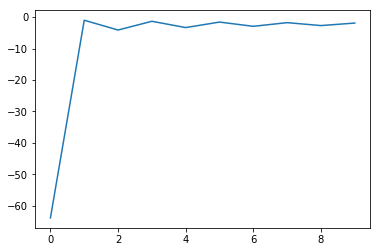

2017-06-22 0.82448798 1.04294236 0.21845438


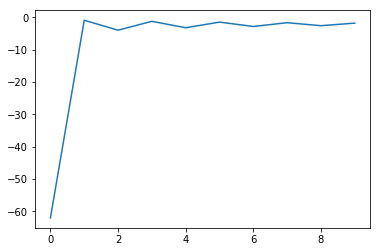

2017-06-23 0.32794859 -0.07963695 0.40758553


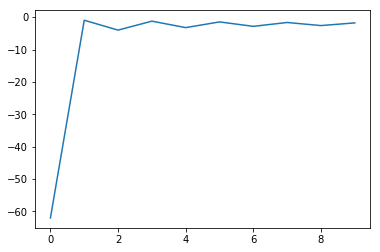

2017-06-26 0.56164187 0.58357848 0.02193661


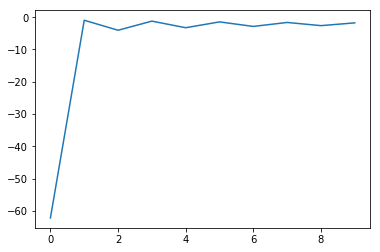

2017-06-27 0.07355410 -0.13026807 0.20382217


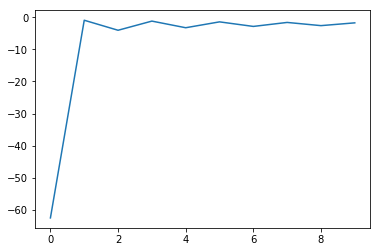

2017-06-28 0.40743201 0.33307815 0.07435386


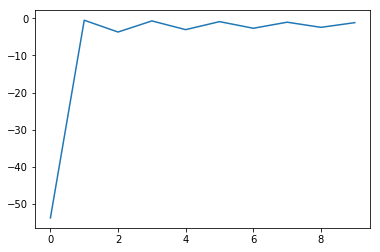

2017-06-29 0.78568976 0.30690205 0.47878771


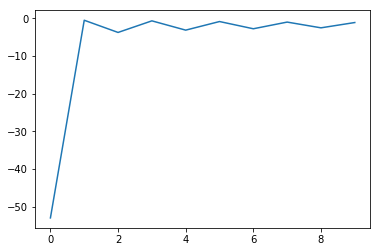

2017-06-30 0.18777065 0.46029726 0.27252661


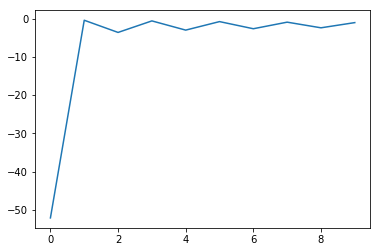

2017-07-03 -0.04284853 0.04664843 0.08949696


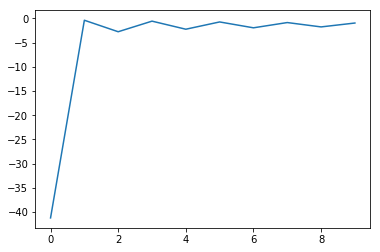

2017-07-04 -0.50562391 -0.00329408 0.50232983


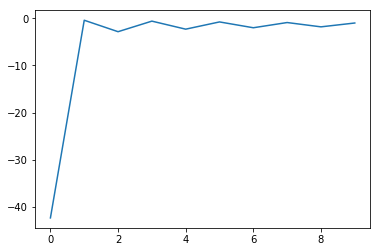

2017-07-05 0.12248125 -0.13747114 0.25995239


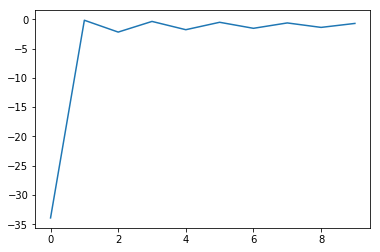

2017-07-06 -0.54157645 -0.99466017 0.45308372


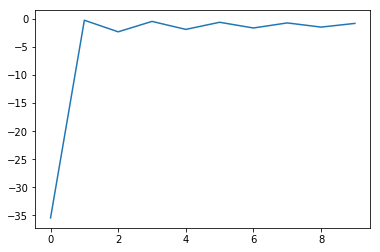

2017-07-07 0.07318099 0.09464738 0.02146639


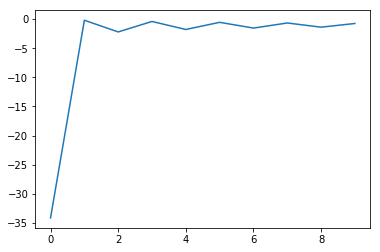

2017-07-10 -0.04344067 -0.14338711 0.09994645


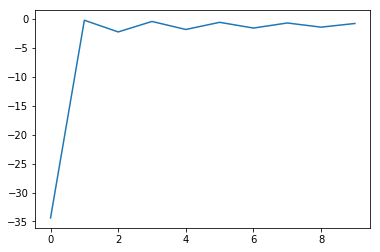

2017-07-11 -0.07683051 -0.04143055 0.03539995


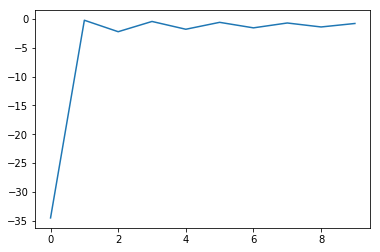

2017-07-12 0.70406324 0.37322947 0.33083377


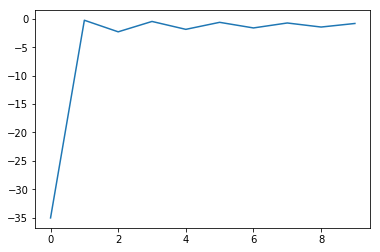

2017-07-13 -0.12584394 0.15777522 0.28361917


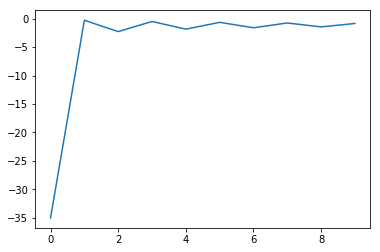

2017-07-14 -0.20906357 -0.20010170 0.00896186


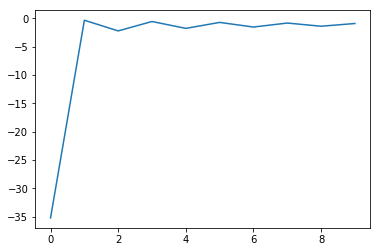

2017-07-17 0.79964851 0.52752629 0.27212222


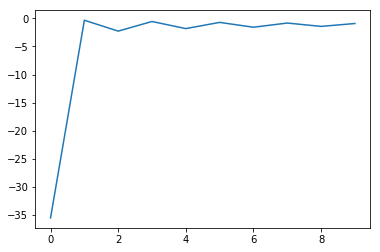

2017-07-18 0.61242329 0.29453351 0.31788979


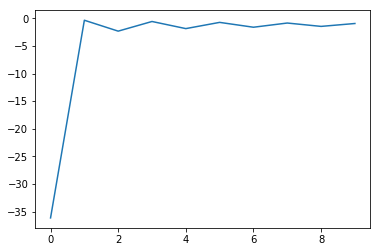

2017-07-19 -0.04241355 -0.07451949 0.03210594


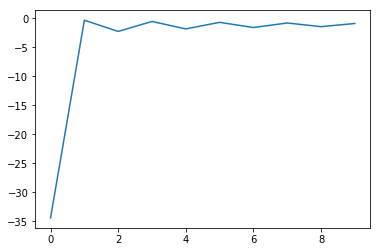

2017-07-20 -0.04244437 -0.17727637 0.13483200


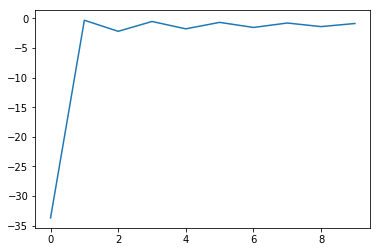

2017-07-21 0.13708546 -0.21906111 0.35614657


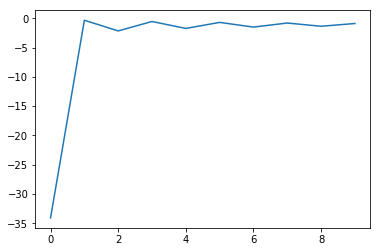

2017-07-24 0.07172917 0.05685993 0.01486925


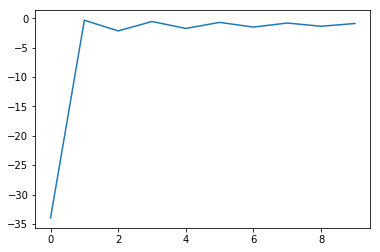

2017-07-25 0.63931453 -0.07111891 0.71043344


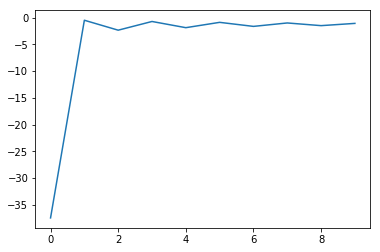

2017-07-26 2.44043703 1.19455653 1.24588050


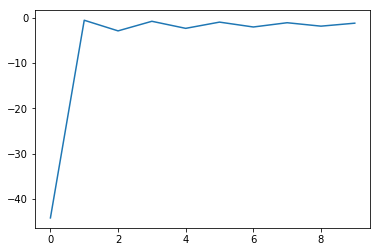

2017-07-27 0.45940315 0.75249082 0.29308767


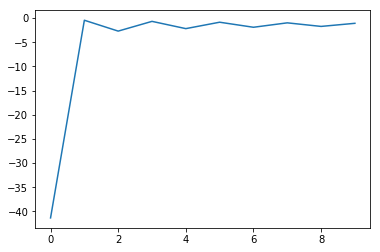

2017-07-28 -0.22737502 0.11377110 0.34114612


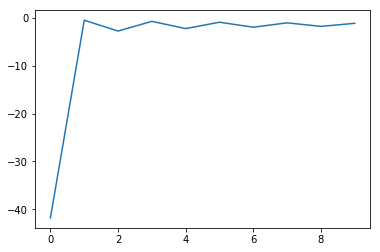

2017-07-31 0.64423805 0.05664676 0.58759129


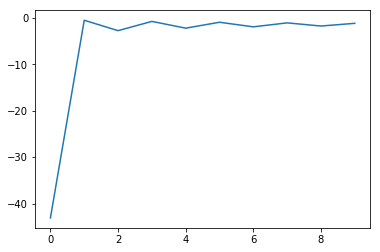

2017-08-01 -0.07095219 0.39830020 0.46925239


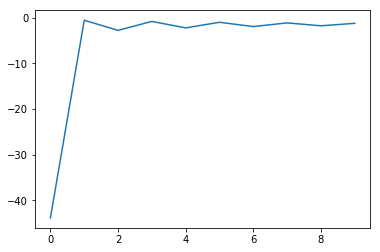

2017-08-02 -0.46002571 -0.14329371 0.31673200


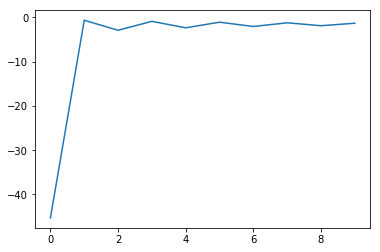

2017-08-03 0.33342439 0.12575194 0.20767245


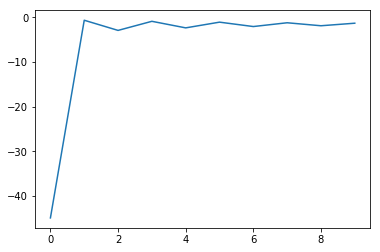

2017-08-04 0.05312328 -0.09536663 0.14848990


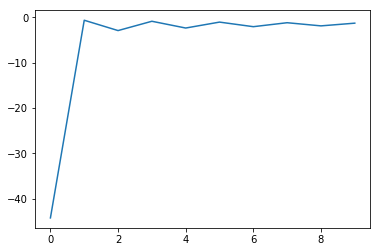

2017-08-07 -0.08666351 0.19713405 0.28379756


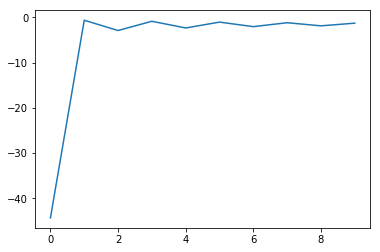

2017-08-08 0.54863941 0.28115931 0.26748010


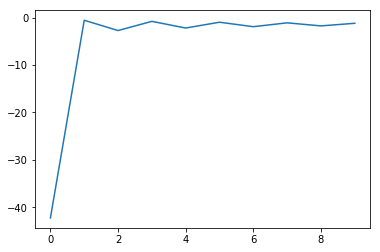

2017-08-09 0.56021542 0.29014935 0.27006607


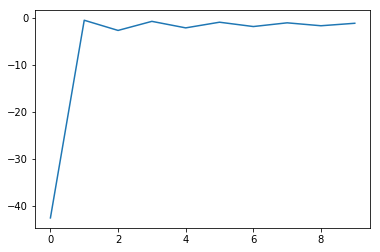

2017-08-10 -0.37754353 -0.18815874 0.18938479


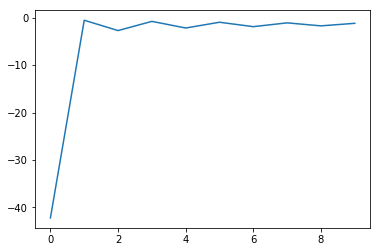

2017-08-11 -1.17284783 -0.52584665 0.64700119


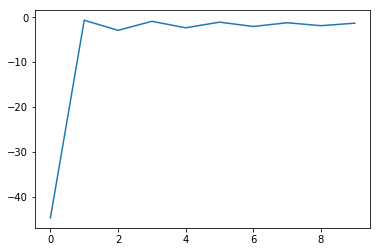

2017-08-14 0.33421105 0.12976867 0.20444238


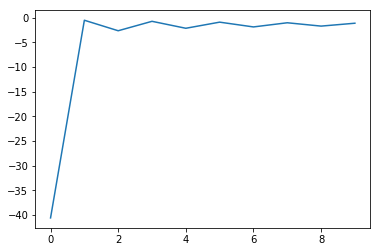

2017-08-15 -0.02461068 0.11279285 0.13740353


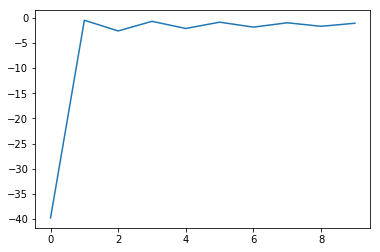

2017-08-16 0.06881985 -0.00376458 0.07258443


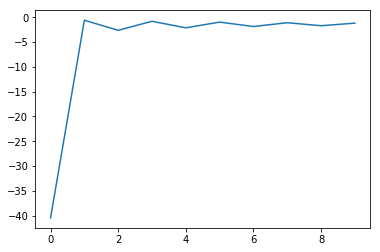

2017-08-17 1.73051842 0.91636379 0.81415463


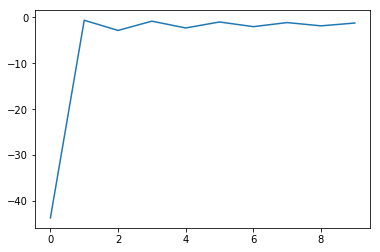

2017-08-18 -0.57411401 -0.63394934 0.05983533


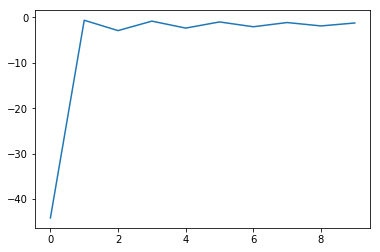

2017-08-21 0.49579383 0.31198728 0.18380655


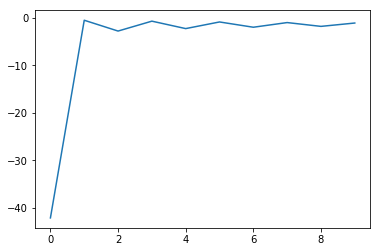

2017-08-22 0.76489456 0.62780108 0.13709349


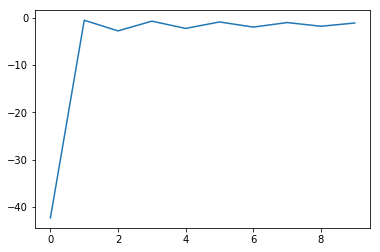

2017-08-23 -0.20505915 0.10681450 0.31187364


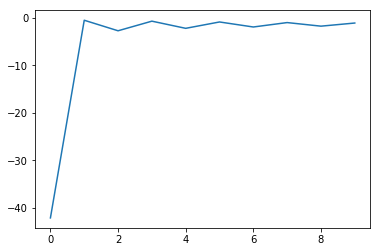

2017-08-24 0.35385596 -0.12449971 0.47835567


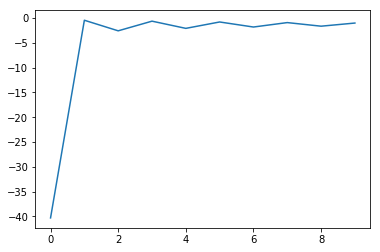

2017-08-25 1.03928739 0.78175980 0.25752759


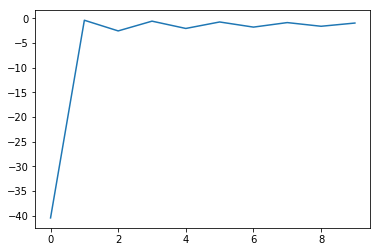

2017-08-28 0.15508012 -0.08378468 0.23886481


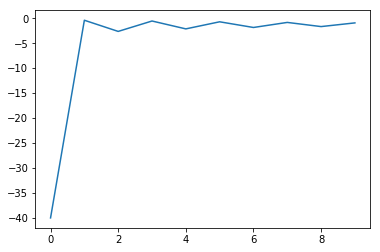

2017-08-29 0.24361771 0.01646151 0.22715621


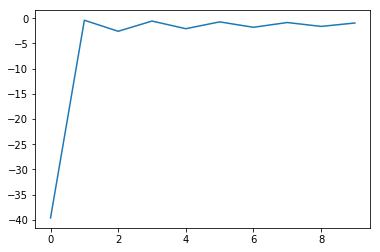

2017-08-30 0.03612135 0.75903800 0.72291665


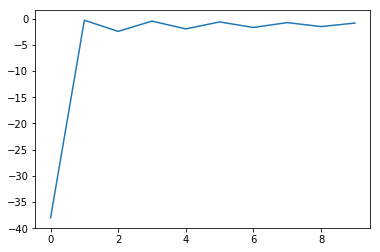

2017-08-31 -0.03784378 -0.07196870 0.03412493


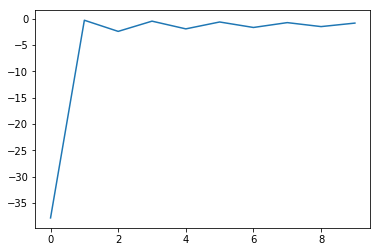

2017-09-01 0.03612697 0.42952554 0.39339857


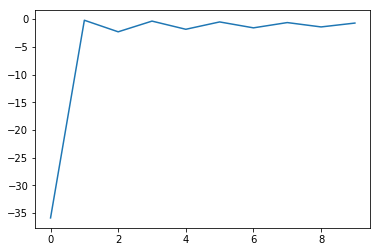

2017-09-04 0.56661918 0.52240087 0.04421831


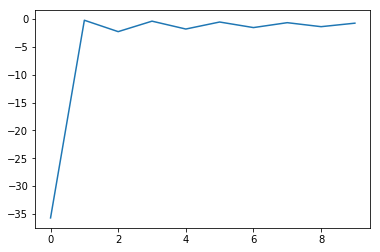

2017-09-05 0.35820706 0.61903487 0.26082781


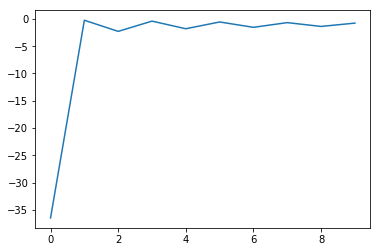

2017-09-06 -0.37451080 -0.20996515 0.16454565


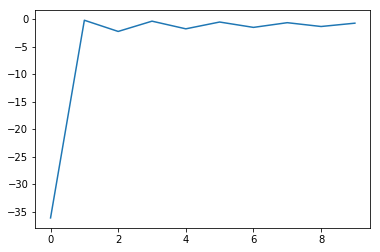

2017-09-07 -0.15523901 0.30444653 0.45968554


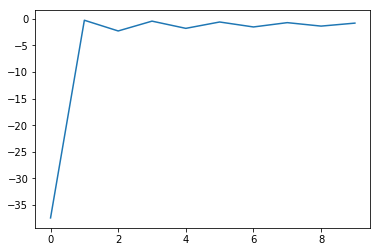

2017-09-08 -0.85207115 0.10157108 0.95364223


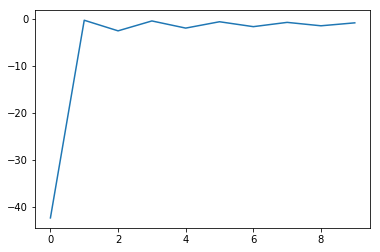

2017-09-11 -1.60274726 -1.24342030 0.35932696


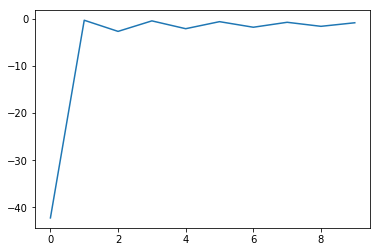

2017-09-12 0.32501405 0.59739266 0.27237861


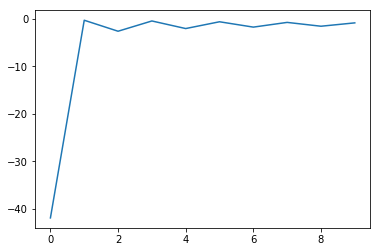

2017-09-13 -0.50974782 -0.68893251 0.17918469


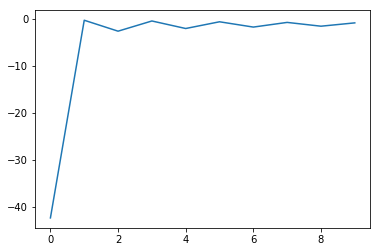

2017-09-14 -0.99011605 -0.77341579 0.21670026


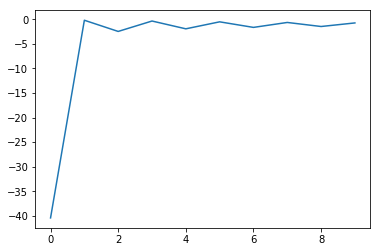

2017-09-15 -0.30271172 -0.48941552 0.18670380


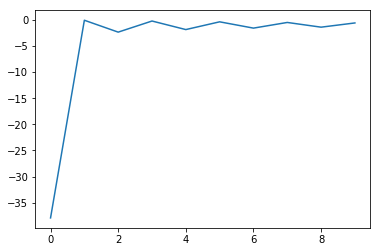

2017-09-18 0.23858867 -0.11907498 0.35766365


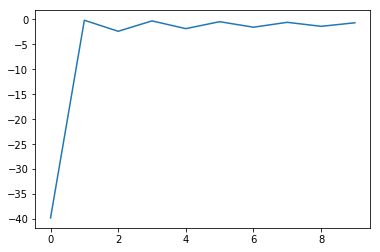

2017-09-19 0.46857440 0.01692621 0.45164818


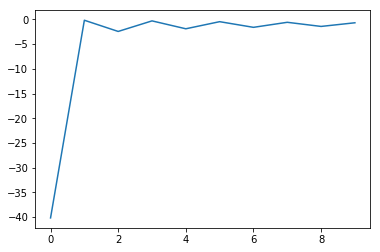

2017-09-20 0.03724214 -0.01532418 0.05256632


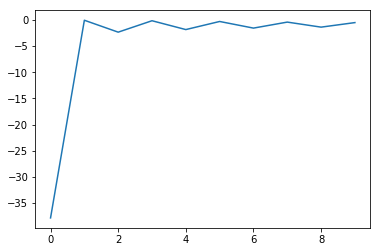

2017-09-21 -0.68727703 0.43753601 1.12481304


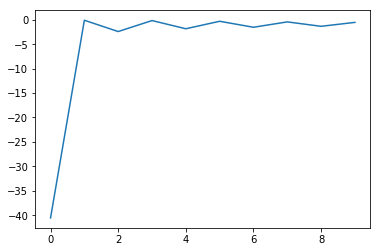

2017-09-22 -0.81863617 -0.25137702 0.56725916


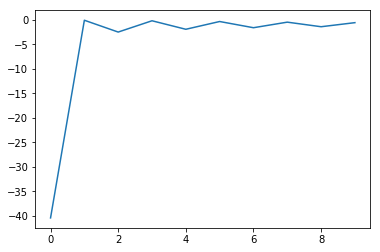

2017-09-25 0.73873239 -0.06246862 0.80120101


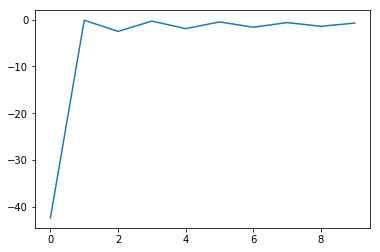

2017-09-26 0.51654512 -0.05674824 0.57329336


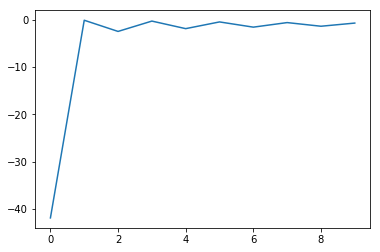

2017-09-27 -0.25577696 -0.38400260 0.12822563


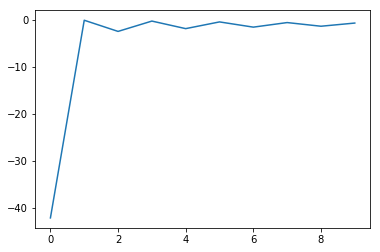

2017-09-28 0.03744339 0.36532975 0.32788636


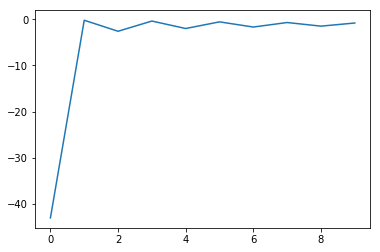

2017-09-29 1.38476992 0.51683697 0.86793295


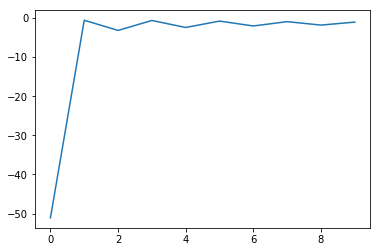

2017-10-09 1.27122760 -0.24403220 1.51525981


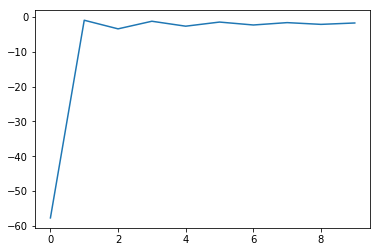

2017-10-10 0.05132651 0.04350823 0.00781828


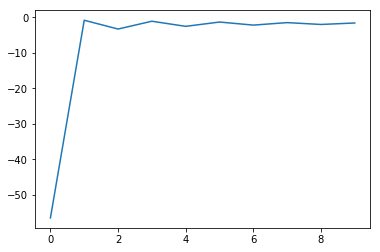

2017-10-11 0.36392803 0.79511706 0.43118904


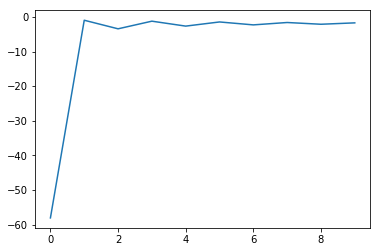

2017-10-12 1.50739685 0.38704559 1.12035126


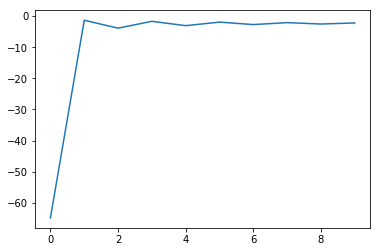

2017-10-13 0.58729633 0.70722079 0.11992447


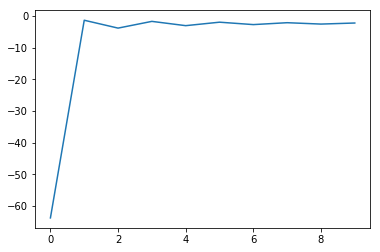

2017-10-16 0.33852117 0.14384340 0.19467777


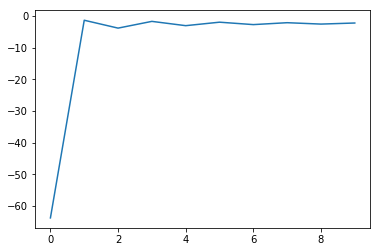

2017-10-17 1.92708932 1.69896758 0.22812174


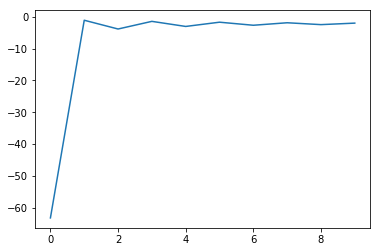

2017-10-18 -0.55758999 -0.71203970 0.15444971


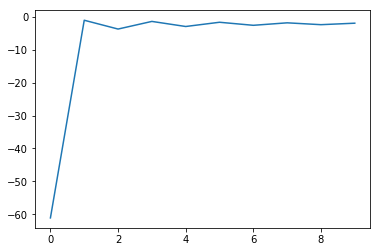

2017-10-19 -0.24866071 -0.15497665 0.09368405


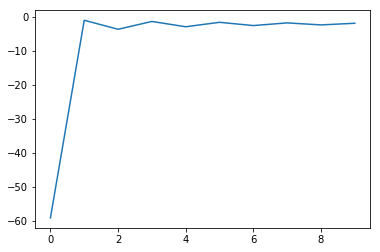

2017-10-20 0.09169592 -0.02044879 0.11214470


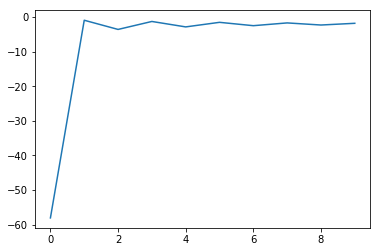

2017-10-23 -0.17809198 0.00458967 0.18268166


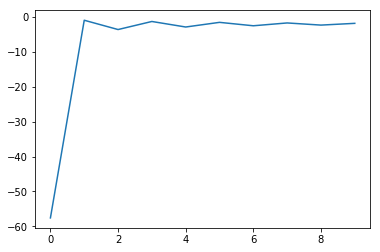

2017-10-24 1.13582926 0.30367618 0.83215308


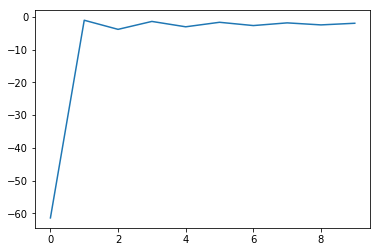

2017-10-25 -0.66906962 0.56468248 1.23375210


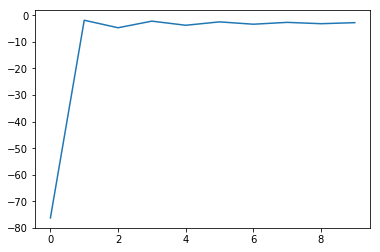

2017-10-26 -0.07832782 0.04263979 0.12096761


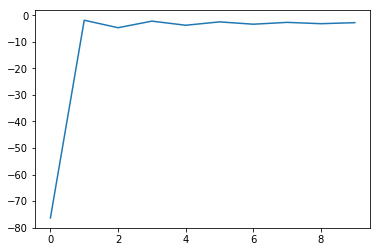

2017-10-27 -0.76144057 0.01715890 0.77859946


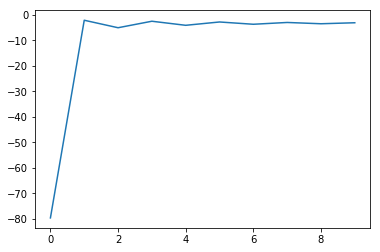

2017-10-30 -1.15983197 -0.77172068 0.38811129


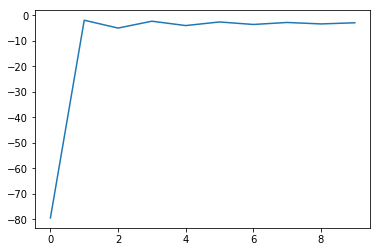

2017-10-31 0.15148276 0.36608350 0.21460074


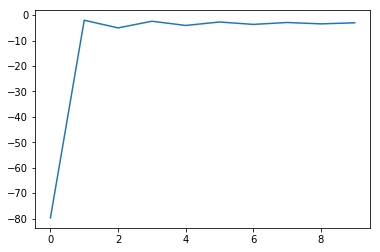

2017-11-01 1.01366662 0.09520601 0.91846060


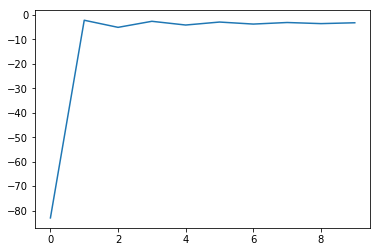

2017-11-02 -0.38038444 0.71925271 1.09963714


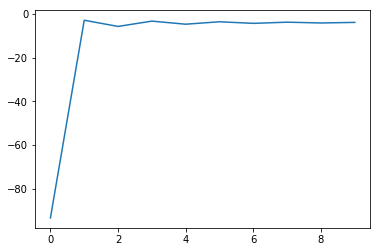

2017-11-03 0.33625798 0.15769202 0.17856597


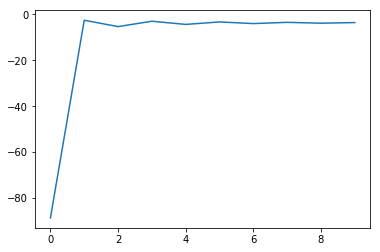

2017-11-06 -0.12231792 0.04466357 0.16698150


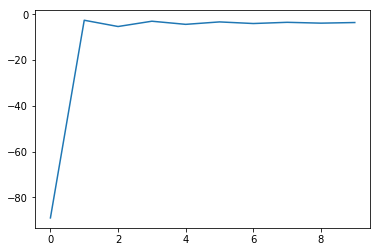

2017-11-07 0.24975072 0.55570331 0.30595259


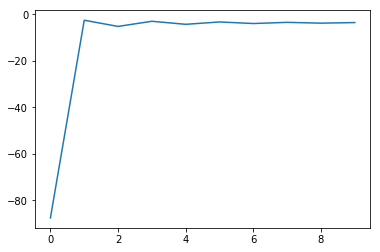

2017-11-08 -1.17368607 -0.82877904 0.34490702


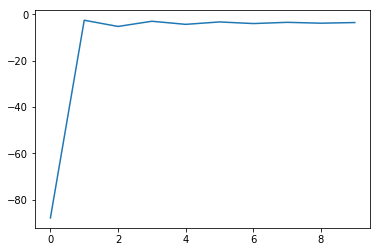

2017-11-09 -0.28405858 0.34054227 0.62460085


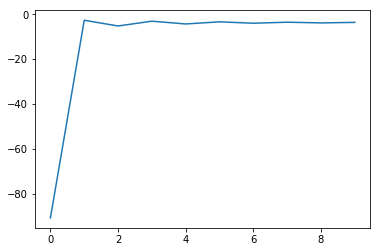

2017-11-10 0.00653698 -0.29029047 0.29682746


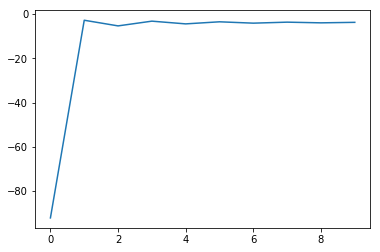

2017-11-13 0.00653698 -0.02074999 0.02728697


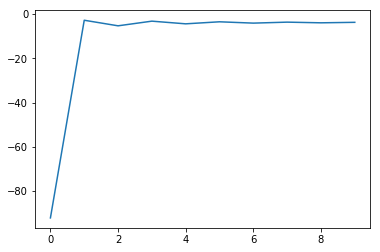

2017-11-14 0.61553909 0.77817325 0.16263416


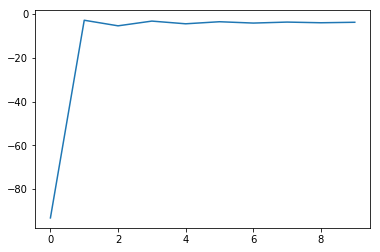

2017-11-15 -1.52500024 -0.68570958 0.83929066


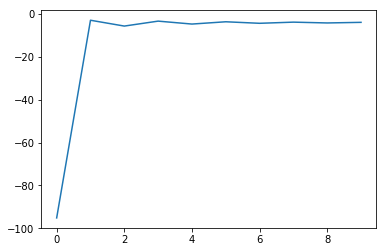

2017-11-16 0.10958271 0.04270011 0.06688260


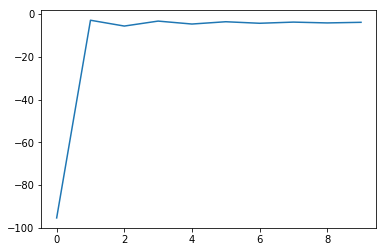

2017-11-17 0.00653698 -0.10544083 0.11197781


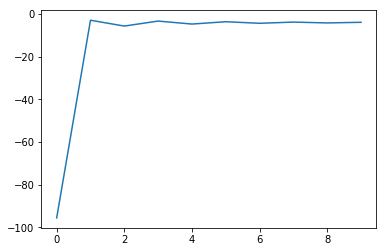

2017-11-20 0.09475340 0.39789989 0.30314649


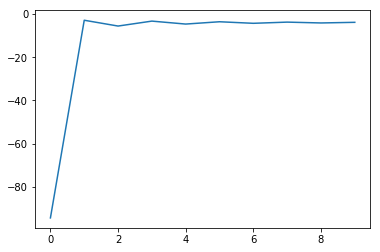

2017-11-21 0.47534275 0.35596970 0.11937305


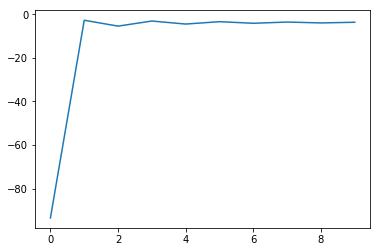

2017-11-22 0.93575866 0.81867865 0.11708002


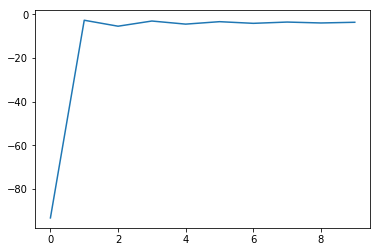

2017-11-23 0.00653698 0.31824318 0.31170620


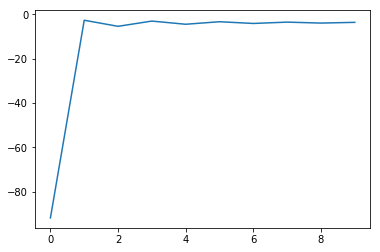

2017-11-24 0.28027684 0.10300763 0.17726921


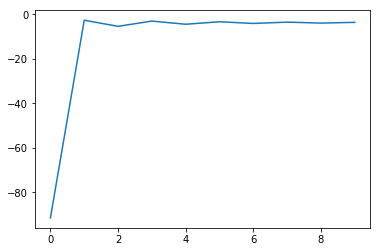

2017-11-27 0.07841401 0.49786497 0.41945096


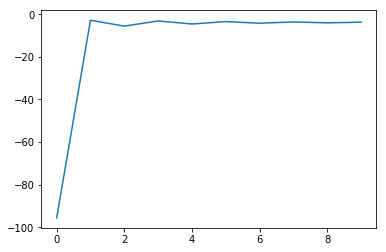

2017-11-28 -0.96217578 -0.52687995 0.43529583


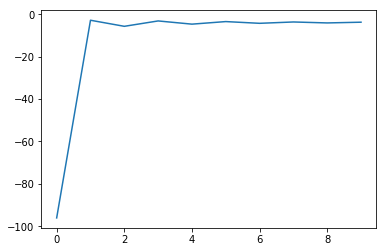

2017-11-29 -0.46042239 -0.88614285 0.42572046


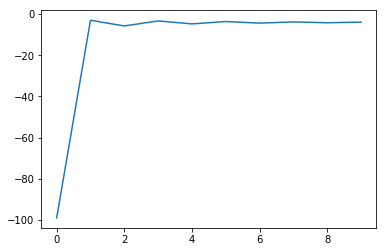

2017-11-30 -0.69919912 -0.58965306 0.10954606


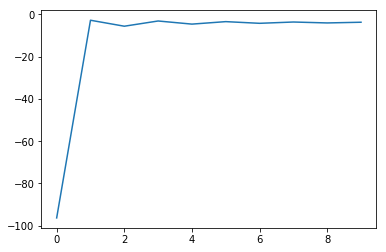

2017-12-01 0.10985638 -0.03156285 0.14141922


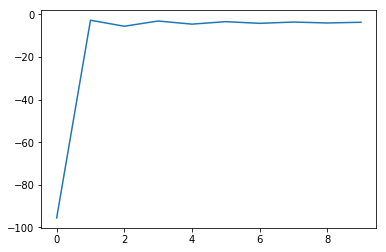

2017-12-04 0.84278369 0.27196376 0.57081993


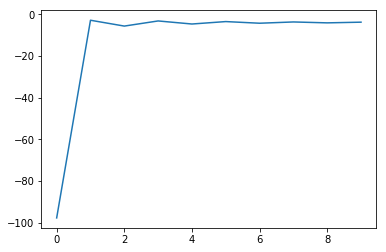

2017-12-05 -0.46182784 -0.27382398 0.18800386


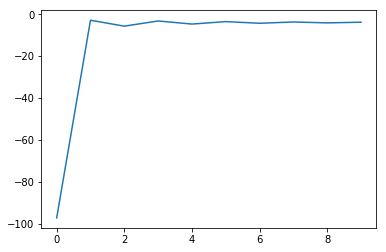

2017-12-06 -2.36339866 -1.58232454 0.78107412


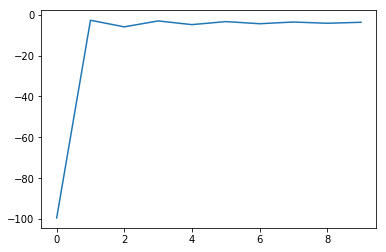

2017-12-07 -0.05402490 -0.06084308 0.00681818


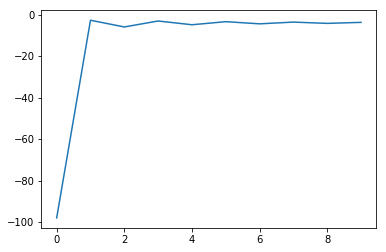

2017-12-08 0.08223197 0.17575718 0.09352521


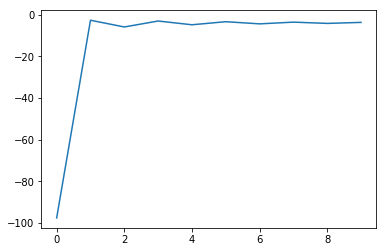

2017-12-11 0.08215840 0.03774252 0.04441589


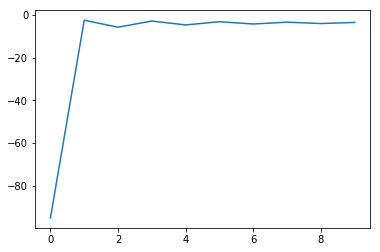

2017-12-12 0.51882265 0.64563122 0.12680857


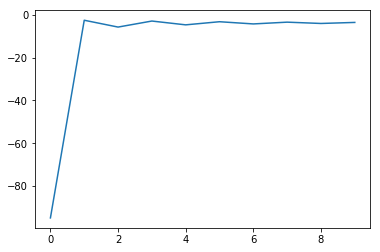

2017-12-13 0.20152298 -0.04573617 0.24725915


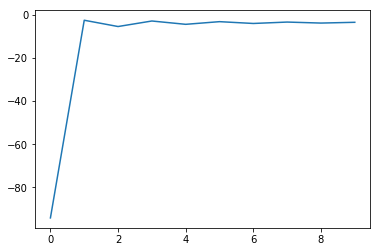

2017-12-14 0.45464845 0.46987936 0.01523091


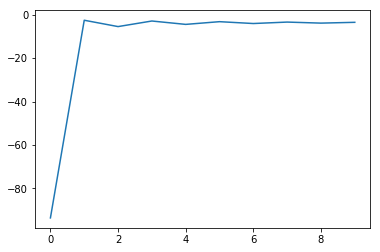

2017-12-15 0.40764251 0.44444236 0.03679985


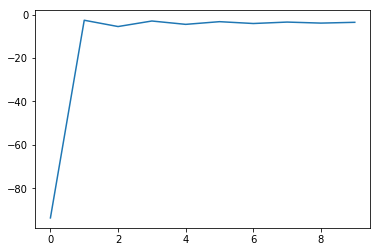

2017-12-18 1.32881549 0.81895528 0.50986021


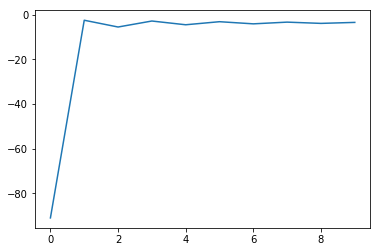

2017-12-19 0.02110347 0.32568298 0.30457951


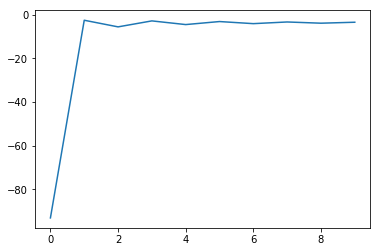

2017-12-20 0.16658858 0.05174772 0.11484085


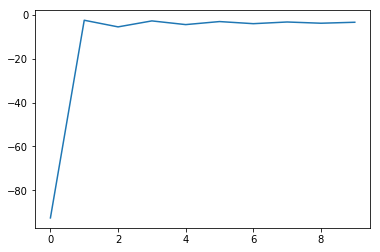

2017-12-21 0.85942159 0.82995319 0.02946840


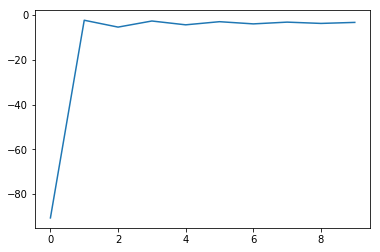

2017-12-22 0.06402267 0.47154208 0.40751941


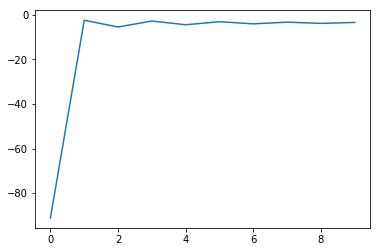

2017-12-25 0.82112642 0.26939064 0.55173578


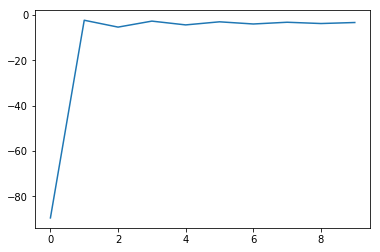

2017-12-26 -0.03612419 0.38652971 0.42265390


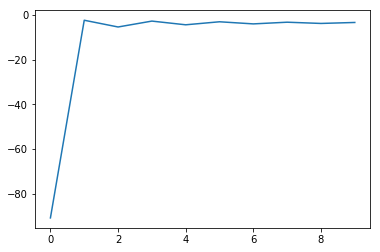

2017-12-27 0.30467517 0.36329558 0.05862042


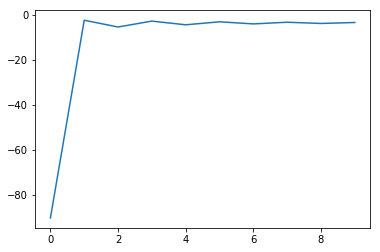

2017-12-28 0.50090926 1.10141364 0.60050439


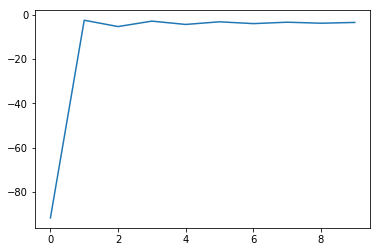

2017-12-29 0.24553199 0.43406935 0.18853736


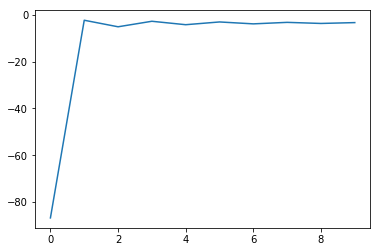

2018-01-02 -0.71266169 -0.41781013 0.29485157


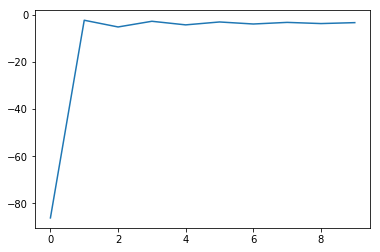

2018-01-03 -0.29154681 -0.14814816 0.14339864


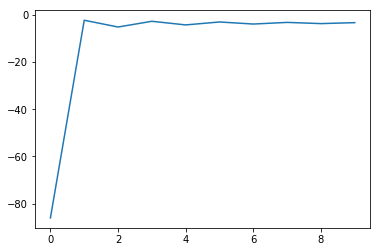

2018-01-04 0.03497517 -0.25243516 0.28741033


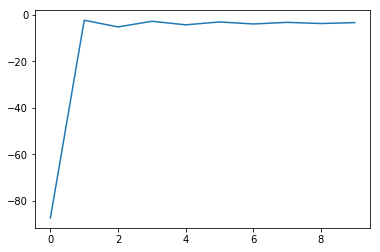

2018-01-05 -0.00768081 0.33158600 0.33926681


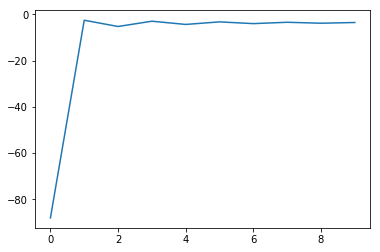

2018-01-08 -0.62163200 -0.57635753 0.04527447


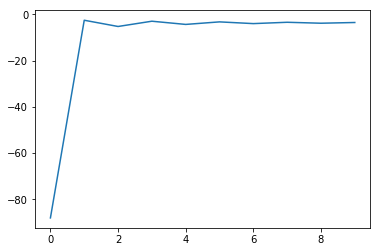

2018-01-09 0.23554928 0.01336704 0.22218224


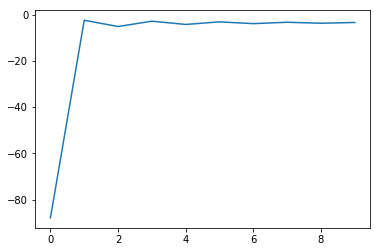

2018-01-10 0.10651829 -0.07153462 0.17805291


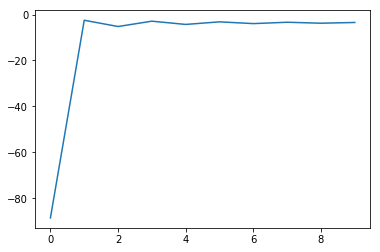

2018-01-11 0.26304339 0.38836334 0.12531995


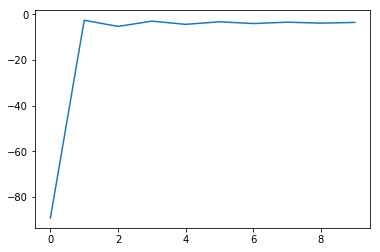

2018-01-12 -0.53597184 -0.08250127 0.45347057


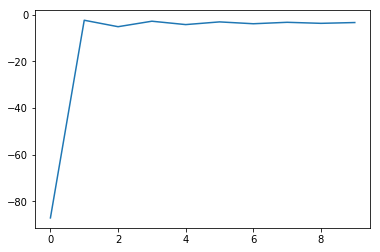

2018-01-15 0.02086210 -0.16804738 0.18890948


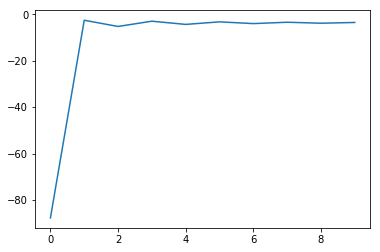

2018-01-16 0.14964328 0.72558463 0.57594134


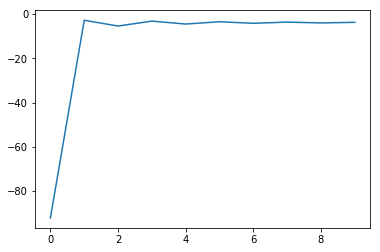

2018-01-17 -1.04424240 -0.99093270 0.05330970


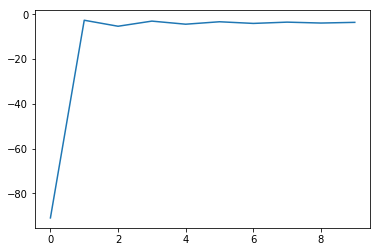

2018-01-18 -0.13851688 -0.29873035 0.16021347


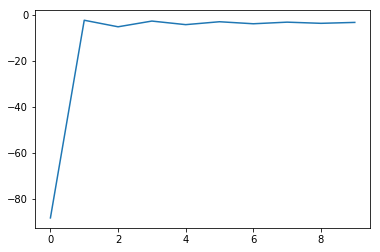

2018-01-19 -0.03703196 0.22925957 0.26629153


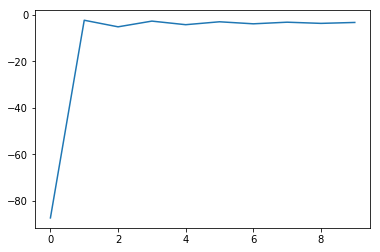

2018-01-22 -0.08067416 -0.12633757 0.04566341


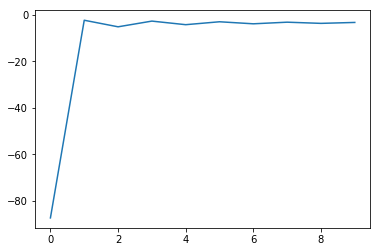

2018-01-23 -0.00800772 0.23200617 0.24001389


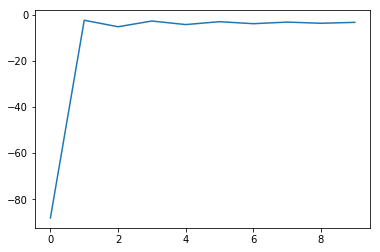

2018-01-24 -1.25458956 -0.79647135 0.45811821


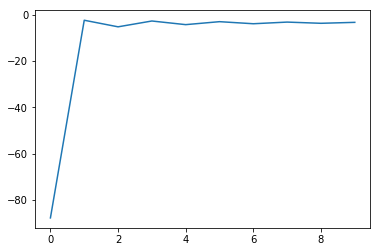

2018-01-25 1.23856597 1.44413652 0.20557054


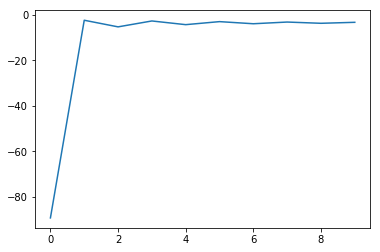

2018-01-26 -0.12453686 -0.13589685 0.01135999


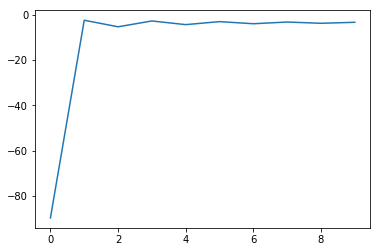

2018-01-29 -0.00804042 -0.33934269 0.33130227


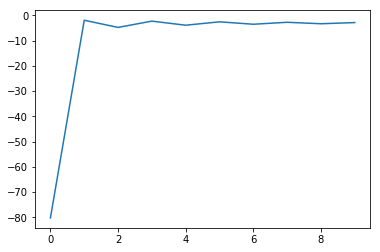

2018-01-30 -0.47605582 -0.24445362 0.23160219


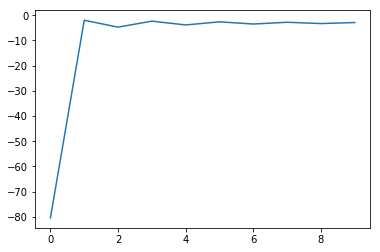

2018-01-31 -0.22852927 -0.18082507 0.04770420


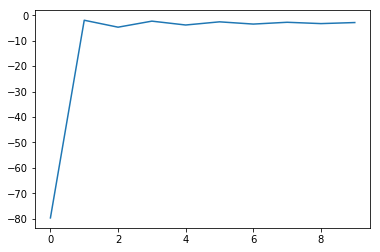

2018-02-01 0.00653698 0.57506865 0.56853167


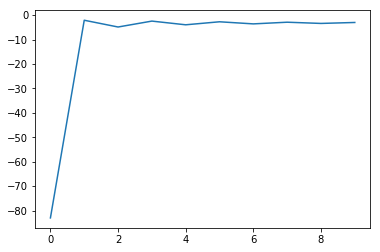

2018-02-02 0.22693239 -0.07052082 0.29745321


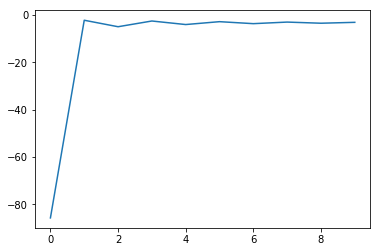

2018-02-05 -0.44963700 -0.56052375 0.11088675


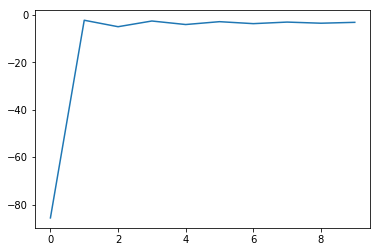

2018-02-06 -0.12640312 0.26426538 0.39066850


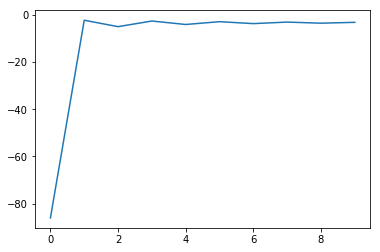

2018-02-07 0.00653698 -0.23886520 0.24540218


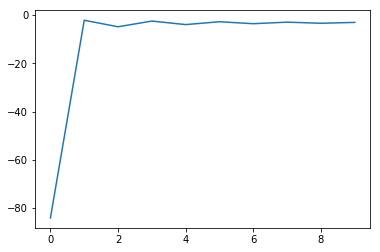

2018-02-08 -1.44086626 -1.19770925 0.24315701


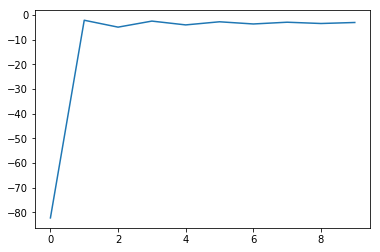

2018-02-09 -0.62862468 -0.53006674 0.09855794


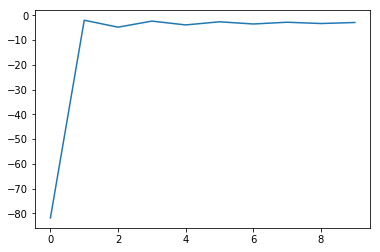

2018-02-12 0.02172029 -0.61941221 0.64113251


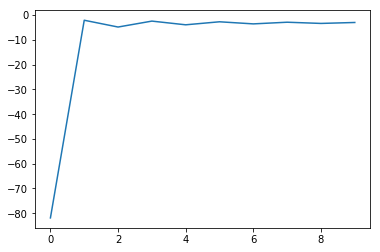

2018-02-13 0.70178561 0.49035925 0.21142636


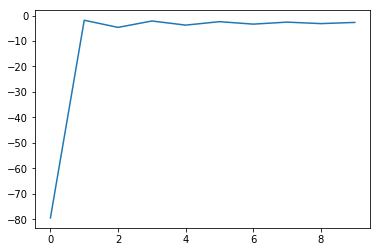

2018-02-14 0.97848133 1.05381233 0.07533100


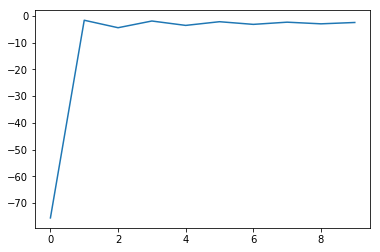

2018-02-22 0.24393418 1.42638328 1.18244909


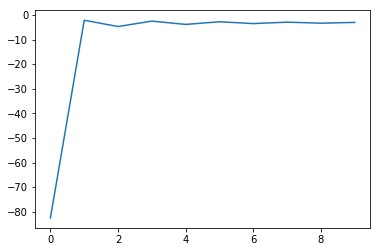

2018-02-23 1.13898853 0.24195641 0.89703211


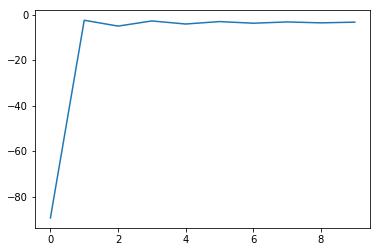

2018-02-26 -0.13960669 -0.18557838 0.04597168


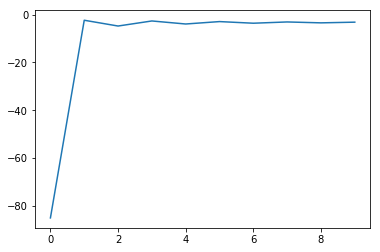

2018-02-27 -0.16919854 0.13726095 0.30645949


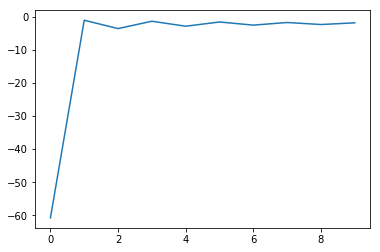

2018-02-28 -0.84849219 -0.67606397 0.17242822


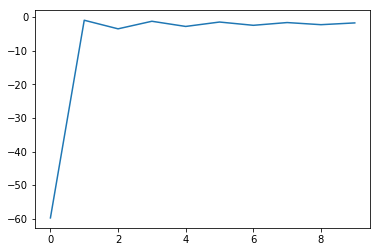

2018-03-01 -0.54386284 -0.63468092 0.09081808


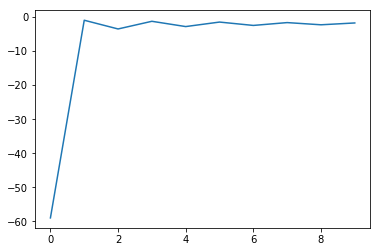

2018-03-02 -0.08308507 -0.08243529 0.00064978


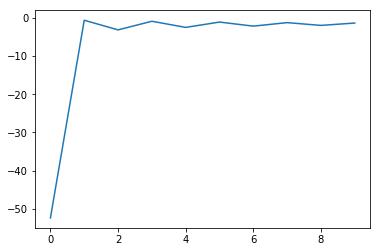

2018-03-05 -0.29295096 -0.03325474 0.25969622


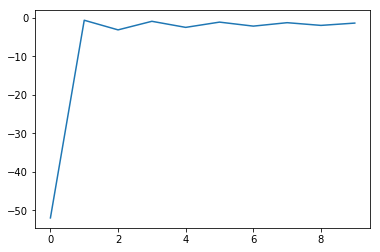

2018-03-06 0.18636805 0.15420711 0.03216094


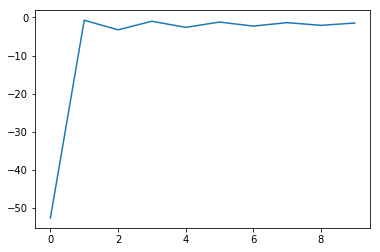

2018-03-07 0.11124682 0.56624144 0.45499463


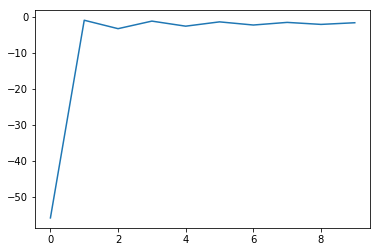

2018-03-08 -0.47329107 -0.46633282 0.00695825


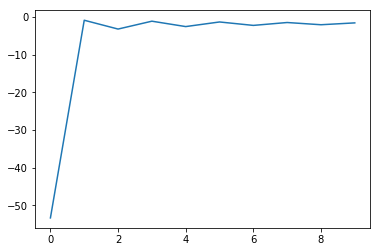

2018-03-09 -1.06876731 -0.62603236 0.44273495


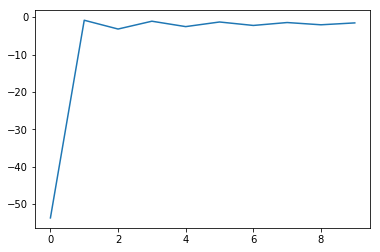

2018-03-12 0.78043911 0.99086526 0.21042615


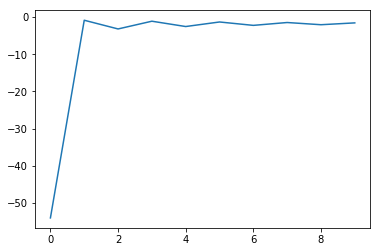

2018-03-13 -0.32635951 -0.62564953 0.29929001


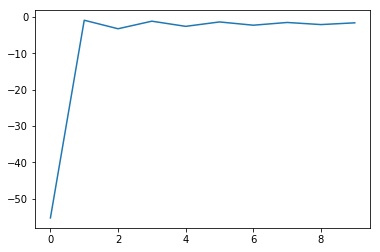

2018-03-14 0.32433268 0.25621550 0.06811718


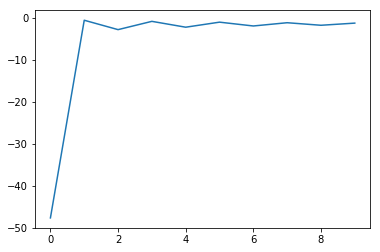

2018-03-15 0.23274183 0.06740864 0.16533319


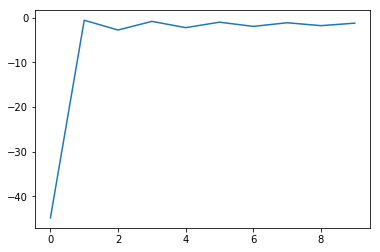

2018-03-16 0.03664800 -0.36228575 0.39893375


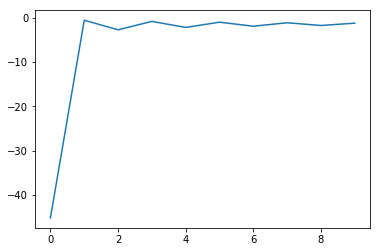

2018-03-19 -0.73455846 -0.10148387 0.63307460


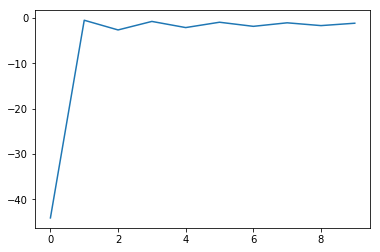

2018-03-20 -0.14557816 -0.41537568 0.26979752


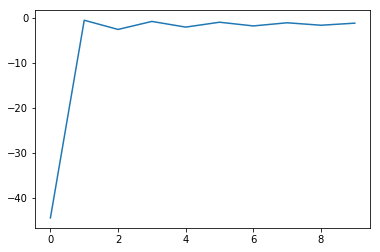

2018-03-21 -0.77391020 -0.62278222 0.15112799


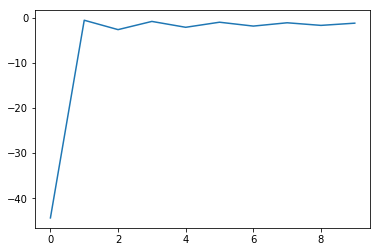

2018-03-22 0.42068987 0.25784788 0.16284198


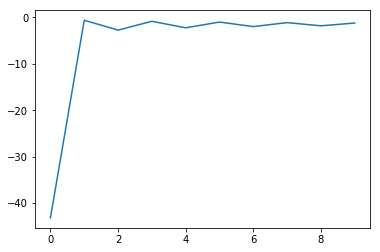

2018-03-23 -1.36706044 -0.86303156 0.50402888


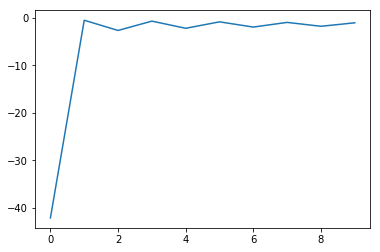

2018-03-26 -1.29668597 -0.19177493 1.10491103


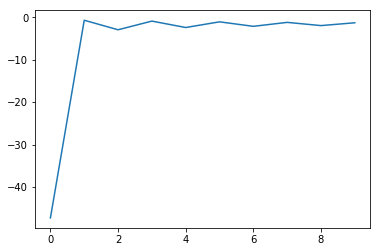

2018-03-27 0.35410125 -0.23290753 0.58700879


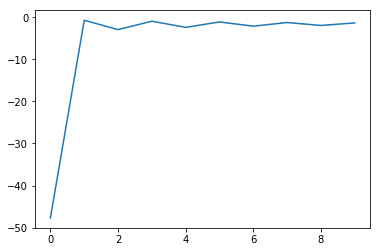

2018-03-28 -0.19865419 0.14175373 0.34040793


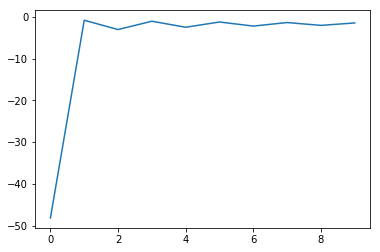

2018-03-29 0.62049424 0.12168272 0.49881152


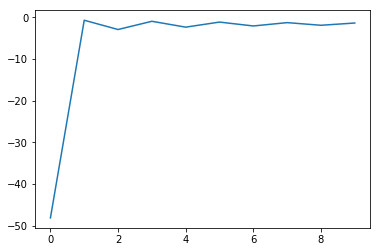

2018-03-30 0.56899875 0.29848137 0.27051737


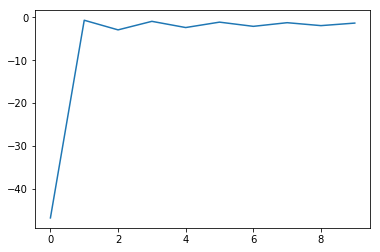

2018-04-02 0.42573096 0.34948081 0.07625015


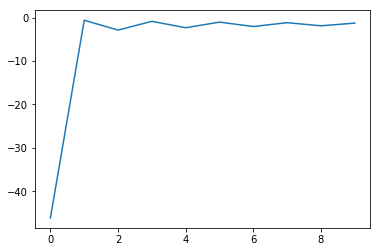

2018-04-03 0.36185539 0.05618394 0.30567145


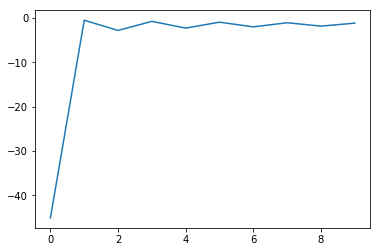

2018-04-04 -0.02429594 0.60161802 0.62591396


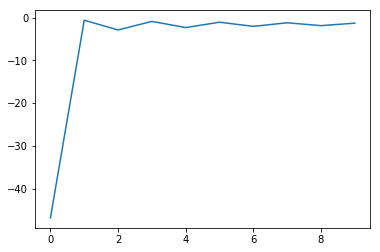

2018-04-09 -0.13236256 -0.38684136 0.25447880


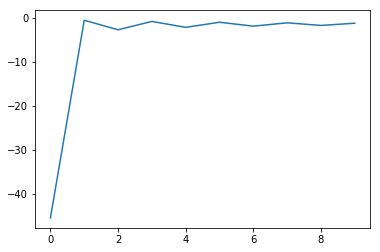

2018-04-10 0.91261757 0.30657379 0.60604378


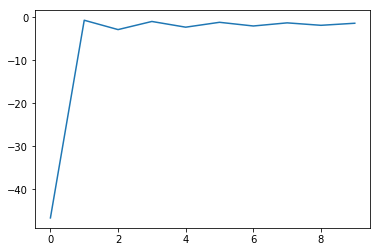

2018-04-11 0.32651086 0.69783276 0.37132190


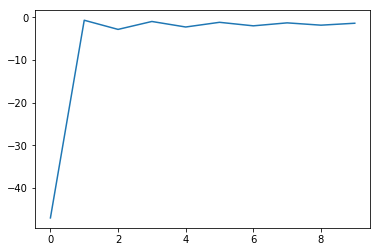

2018-04-12 -0.75748007 0.00136180 0.75884187


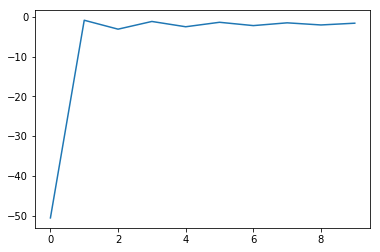

2018-04-13 -0.20873908 -0.75626361 0.54752453


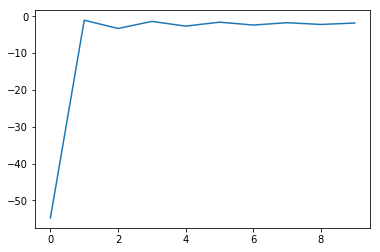

2018-04-16 -0.17846062 0.16137090 0.33983152


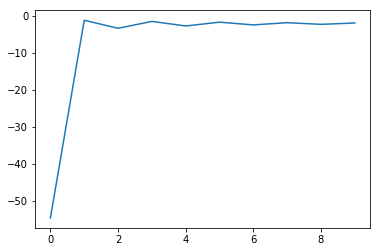

2018-04-17 0.45286385 0.53497799 0.08211414


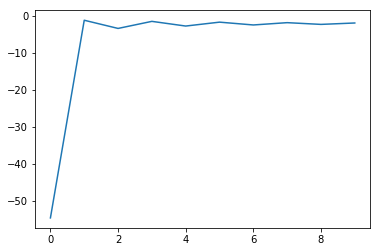

2018-04-18 -0.02416212 -0.22561662 0.20145450


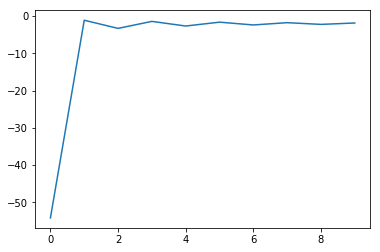

2018-04-19 1.48166502 0.73628275 0.74538227


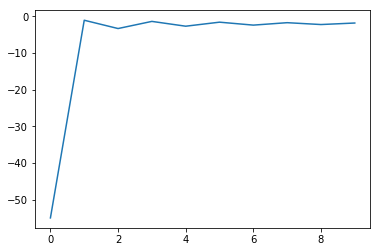

2018-04-20 -0.64393739 -0.33618411 0.30775328


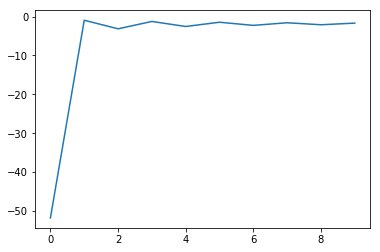

2018-04-23 0.50622281 0.10680813 0.39941468


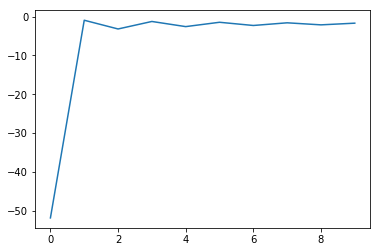

2018-04-24 -0.40205785 -0.32994749 0.07211037


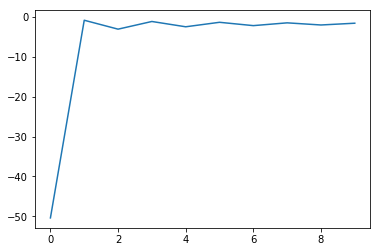

2018-04-25 0.32451822 0.41799104 0.09347282


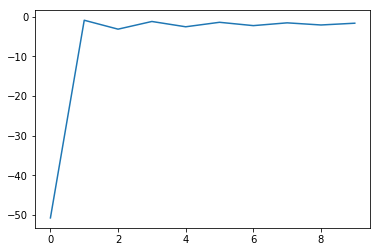

2018-04-26 -0.03880942 -0.06230205 0.02349263


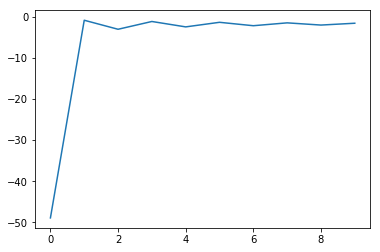

2018-04-27 -0.12966102 -0.11781213 0.01184889


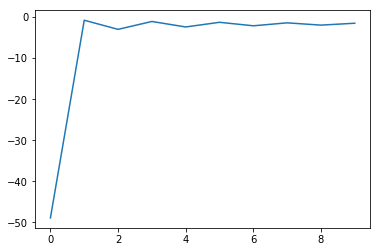

2018-05-02 -0.84631650 -0.94218671 0.09587021


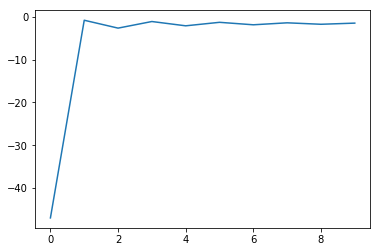

2018-05-03 -0.03941648 0.52611956 0.56553604


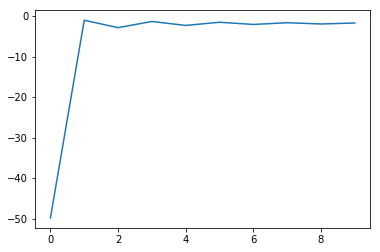

2018-05-04 0.26658182 0.05665085 0.20993097


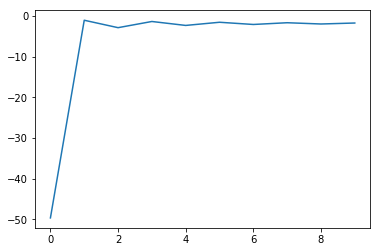

2018-05-07 -0.06985661 -0.00991519 0.05994142


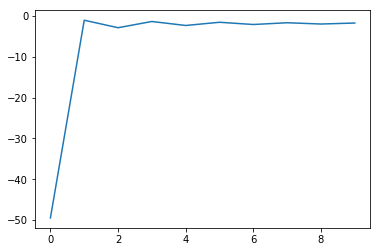

2018-05-08 0.12873076 -0.03045699 0.15918775


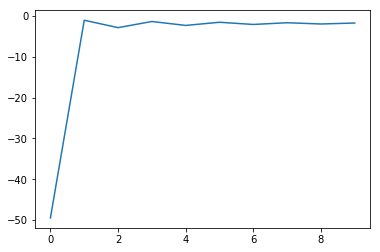

2018-05-09 -0.57560023 -0.39330489 0.18229534


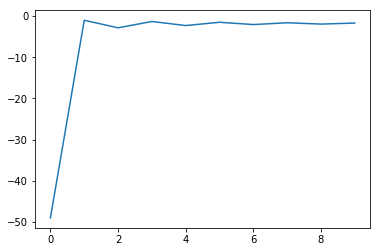

2018-05-10 0.28282918 0.55803854 0.27520936


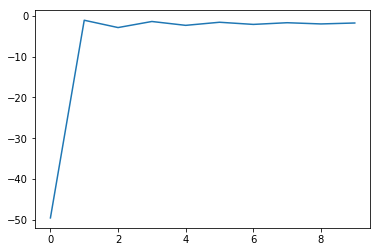

2018-05-11 0.46485485 0.62761383 0.16275898


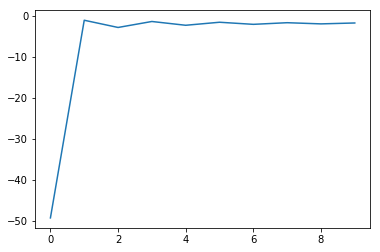

2018-05-14 0.17391274 0.16410869 0.00980405


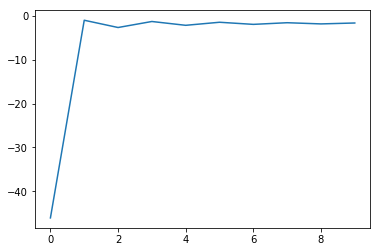

2018-05-15 -0.42022068 -0.22467492 0.19554576


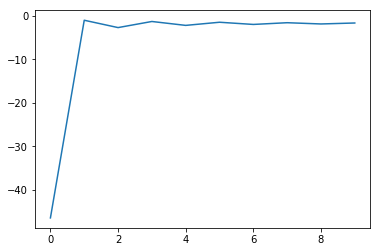

2018-05-16 -0.19239897 -0.55712820 0.36472922


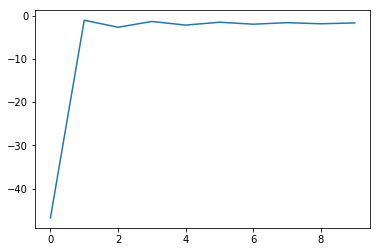

2018-05-17 0.22075466 0.23348700 0.01273233


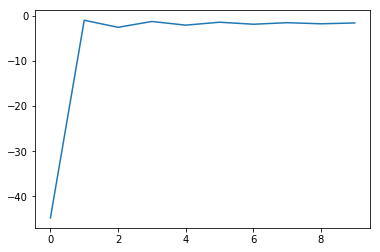

2018-05-18 0.20492668 0.07599692 0.12892976


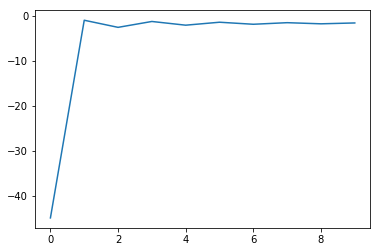

2018-05-21 0.18921804 -0.19715842 0.38637646


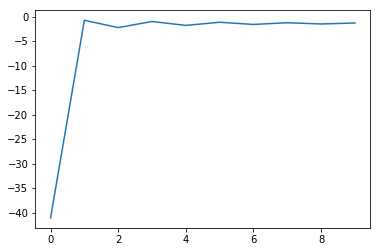

2018-05-22 0.18879013 0.14724378 0.04154635


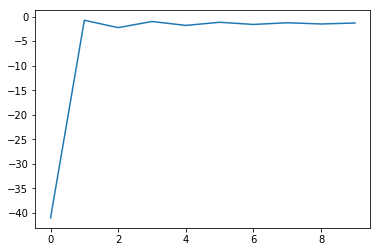

2018-05-23 0.56581171 0.42444115 0.14137056


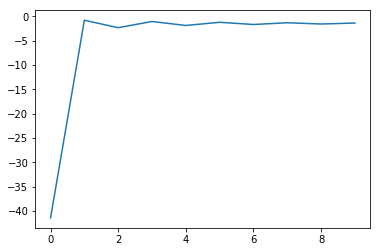

2018-05-24 -0.70458570 -0.79562619 0.09104048


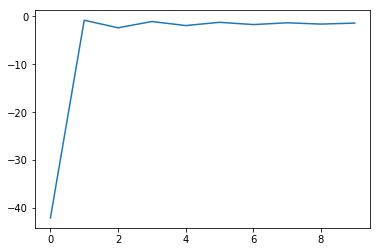

2018-05-25 0.24935168 0.08763898 0.16171270


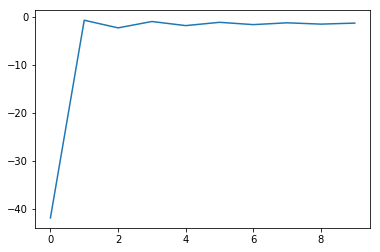

2018-05-28 -0.08442975 -0.17739084 0.09296109


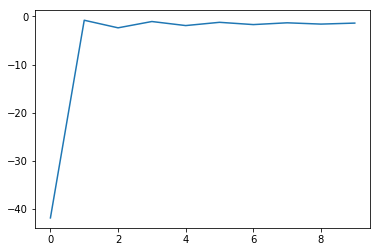

2018-05-29 0.18836423 -0.12214353 0.31050776


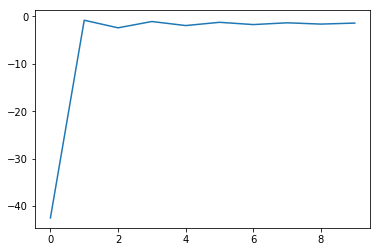

2018-05-30 -0.49451397 -0.32388969 0.17062429


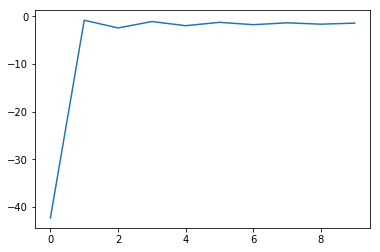

2018-05-31 0.05222064 0.10525527 0.05303463


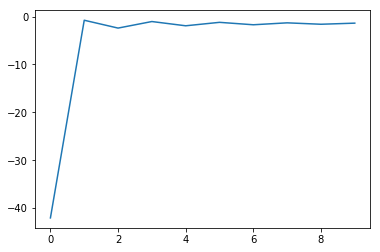

2018-06-01 0.17381460 -0.00566554 0.17948014


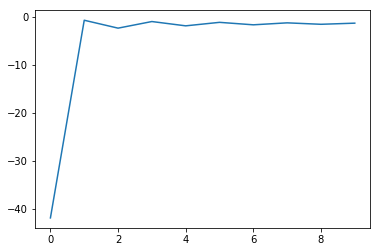

2018-06-04 0.80750826 0.35772481 0.44978345


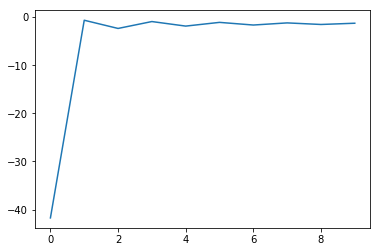

2018-06-05 0.18674985 0.53933680 0.35258695


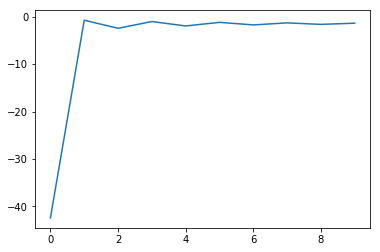

2018-06-06 1.12350810 0.75456278 0.36894532


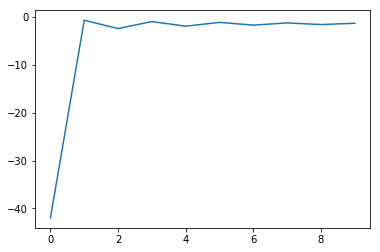

2018-06-07 1.48582748 0.70946020 0.77636728


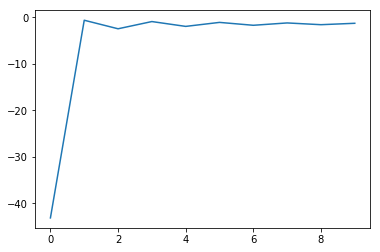

2018-06-08 -0.12414548 0.53580296 0.65994844


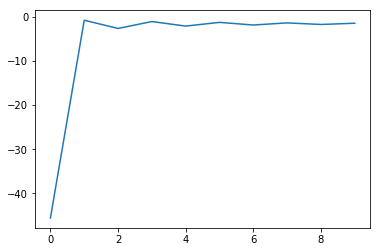

2018-06-11 0.38346686 -0.09867463 0.48214148


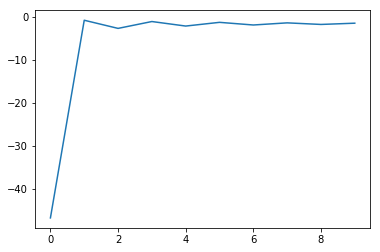

2018-06-12 -0.39946327 -0.34909841 0.05036485


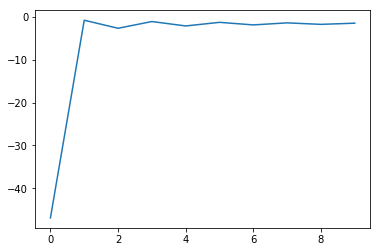

2018-06-13 -0.38697992 -0.25529398 0.13168595


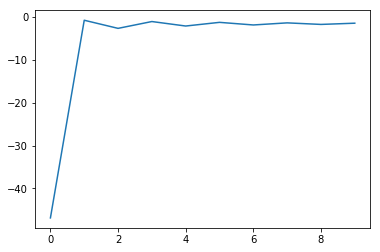

2018-06-14 0.15251615 0.17728896 0.02477281


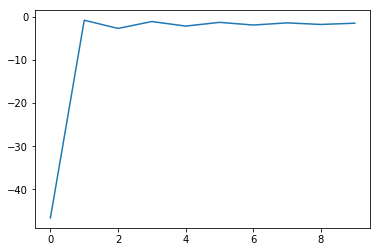

2018-06-15 -0.37358002 -0.32086394 0.05271608


In [474]:
result_mkl_select = run_experiment(multiple_kernel_dual ,cu_log_return, period=100, lag=1, feature_select_lag = 5)

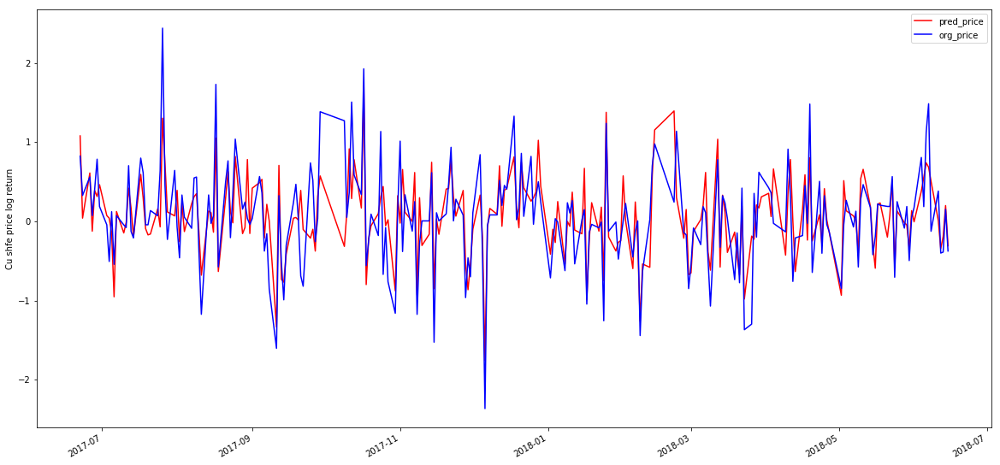

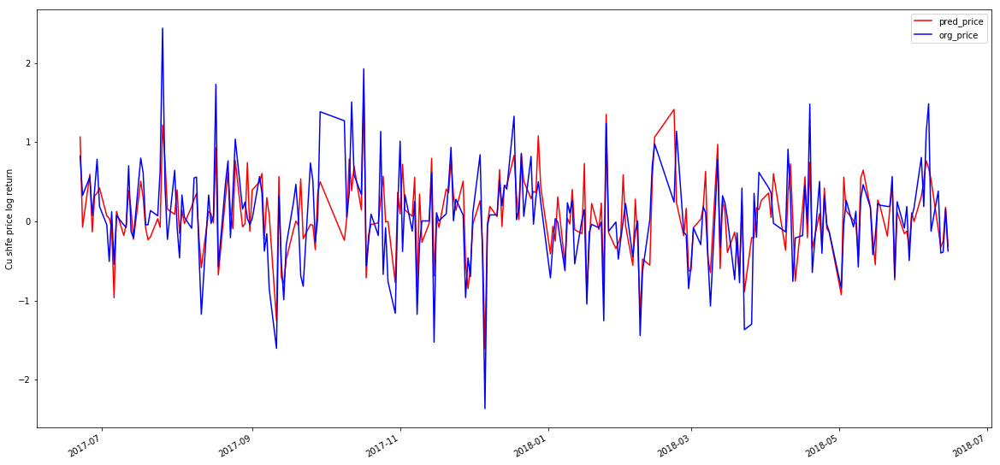

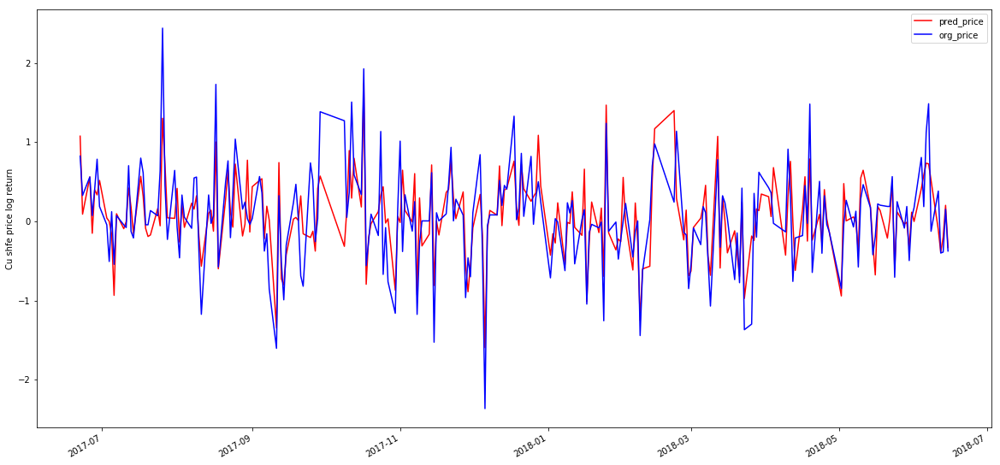

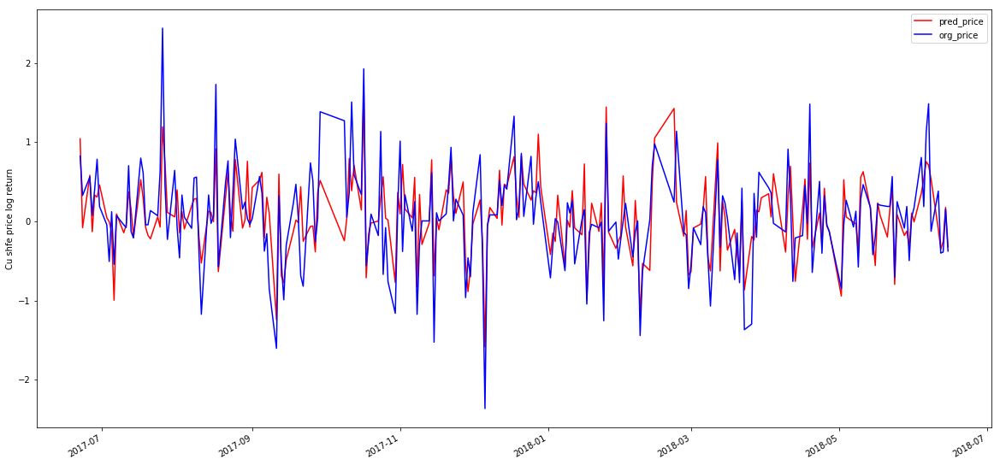

In [475]:
#plot
plot_result(result_gp, 'Cu',pointer = 0)
plot_result(result_mkl, 'Cu',pointer = 0)
plot_result(result_gp_select, 'Cu',pointer = 0)
plot_result(result_mkl_select, 'Cu',pointer = 0)

In [476]:
#evaluation
gp_normal = evaluate('gp_normal', result_gp['org_price'][0:], result_gp['pred_price'][0:])
mkl_normal = evaluate('mkl_normal', result_mkl['org_price'][0:], result_mkl['pred_price'][0:])
gp_select = evaluate('gp_select', result_gp_select['org_price'][0:], result_gp_select['pred_price'][0:])
mkl_select = evaluate('mkl_select', result_mkl_select['org_price'][0:], result_mkl_select['pred_price'][0:])

/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:10: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # Remove the CWD from sys.path while we load stuff.
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()


               MSE       MAE      RMSE        DTW Spearmanr
gp_normal  0.16079  0.304047  0.400986  0.0659323  0.714762
                 MSE       MAE              RMSE        DTW Spearmanr
mkl_normal  0.166808  0.306122  [0.408421720881]  0.0590065  0.708585
                MSE       MAE     RMSE        DTW Spearmanr
gp_select  0.163176  0.306004  0.40395  0.0436382  0.710511
                 MSE       MAE              RMSE        DTW Spearmanr
mkl_select  0.168526  0.309056  [0.410519235203]  0.0527161  0.707352


In [59]:
return_gp_all = run_experiment(gaussian_process, all_log_return)

0.805**2 * RationalQuadratic(alpha=1.68, length_scale=0.00951) + 0.0211**2 * WhiteKernel(noise_level=0.0151) + 0.241**2 * Matern(length_scale=6.24e-05, nu=1.5) + 0.0113**2 * 0.0104**2 + 0.0411**2 * RBF(length_scale=0.00391) + 0.00321**2 * ExpSineSquared(length_scale=0.000164, periodicity=0.0455) + 0.088**2 * DotProduct(sigma_0=9.51e-05)
2018-04-17 1.98021667 0.67793618 1.30228049
0.00316**2 * RationalQuadratic(alpha=5.98e-05, length_scale=13) + 0.236**2 * WhiteKernel(noise_level=12.5) + 0.0232**2 * Matern(length_scale=3.2e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=1e-05) + 0.00371**2 * ExpSineSquared(length_scale=0.842, periodicity=0.00438) + 0.104**2 * DotProduct(sigma_0=0.000108)
2018-04-18 0.20312883 0.13774873 0.06538010


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.64347668e-06,   1.49141094e-67,  -9.28147528e-67,
         4.35817771e-08,   4.35817771e-08,   2.01115680e-02,
        -5.43061244e-06,   1.35942006e-09,   1.35942006e-09,
         4.19177453e-02,  -8.13172483e-08,   4.47352253e+01,
        -5.67905224e-01,  -3.71793777e+07,   5.19988542e+00,
         9.99999632e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00322**2 * RationalQuadratic(alpha=0.00306, length_scale=3.55) + 0.694**2 * WhiteKernel(noise_level=1.35) + 0.00316**2 * Matern(length_scale=3.82e+04, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.0494**2 * RBF(length_scale=6.2e-05) + 0.229**2 * ExpSineSquared(length_scale=0.012, periodicity=5.53) + 0.119**2 * DotProduct(sigma_0=1e-05)
2018-04-19 2.98972957 0.96146494 2.02826463
0.00316**2 * RationalQuadratic(alpha=9.22e+04, length_scale=2.04e-05) + 0.00715**2 * WhiteKernel(noise_level=1.9e+03) + 0.00316**2 * Matern(length_scale=3.89e-05, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.766**2 * RBF(length_scale=0.00683) + 0.0803**2 * ExpSineSquared(length_scale=3.59e-05, periodicity=7.52e+04) + 0.126**2 * DotProduct(sigma_0=0.00915)
2018-04-20 -1.78788529 -0.17137030 1.61651499
0.00316**2 * RationalQuadratic(alpha=2.94e-05, length_scale=1.92e-05) + 0.00316**2 * WhiteKernel(noise_level=4.33e+03) + 0.00316**2 * Matern(length_scale=0.0538, nu=1.5) + 0.924**2 * 0.0032**2 + 0.00378**2 * RBF(length_scale=0.

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.24913924e-01,   3.94301719e-01,  -3.92784187e-02,
         3.78975778e+01,   3.78975778e+01,   3.78720622e-02,
        -7.39191680e-03,   2.37333065e-09,   2.37333065e-09,
         4.97669833e-01,  -1.15582146e-05,   1.20127599e+00,
        -1.73897611e-04,  -4.32128998e+06,   5.49642461e+00,
         1.11257727e-03]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0534**2 * RationalQuadratic(alpha=3.13, length_scale=3.87e-05) + 0.00321**2 * WhiteKernel(noise_level=3.39) + 0.00316**2 * Matern(length_scale=0.25, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.162**2 * RBF(length_scale=6.48e-05) + 0.819**2 * ExpSineSquared(length_scale=1.65e-05, periodicity=0.000388) + 0.156**2 * DotProduct(sigma_0=0.000553)
2018-04-26 -0.34271417 0.19459109 0.53730526


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.36127486e-06,  -4.86149441e-07,   1.06191804e-07,
        -8.56598921e-11,  -8.56598921e-11,  -5.95821094e-01,
        -0.00000000e+00,   2.92363373e-01,   2.92363373e-01,
         2.07524350e-01,   1.11967766e-04,  -1.21613687e-04,
        -7.09182700e-05,   7.20331289e+05,  -8.39667113e-03,
         4.28363083e-06]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 67, 'nit': 12, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.0102**2 * RationalQuadratic(alpha=0.000468, length_scale=0.0204) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.774**2 * Matern(length_scale=0.0109, nu=1.5) + 0.00316**2 * 1.91**2 + 0.311**2 * RBF(length_scale=0.155) + 0.0225**2 * ExpSineSquared(length_scale=0.124, periodicity=4.34) + 0.157**2 * DotProduct(sigma_0=0.00254)
2018-04-27 0.52400468 0.34778884 0.17621584
0.00316**2 * RationalQuadratic(alpha=0.00926, length_scale=3.62e+03) + 0.0162**2 * WhiteKernel(noise_level=0.133) + 0.00681**2 * Matern(length_scale=0.565, nu=1.5) + 0.028**2 * 0.0113**2 + 0.00736**2 * RBF(length_scale=0.0109) + 0.83**2 * ExpSineSquared(length_scale=0.00144, periodicity=58.9) + 0.156**2 * DotProduct(sigma_0=1e-05)
2018-05-02 -0.22402379 -0.80893115 0.58490735
0.00316**2 * RationalQuadratic(alpha=0.00101, length_scale=3.66e+03) + 0.0403**2 * WhiteKernel(noise_level=0.00131) + 0.00316**2 * Matern(length_scale=1.71e+03, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=1.18e-05) + 0.828**2

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  5.78766945e-03,   2.86114609e-08,  -6.77080261e-03,
         6.90474298e-09,   6.90474298e-09,   5.37090058e+00,
        -0.00000000e+00,   1.24872294e-02,   1.24872294e-02,
         5.18257252e-04,  -3.47008987e-07,   4.41226604e+01,
        -8.99171565e-02,   5.36113057e+09,   4.83273821e-01,
         9.66519954e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.815**2 * RationalQuadratic(alpha=1e+05, length_scale=1e-05) + 0.00316**2 * WhiteKernel(noise_level=1.27e+03) + 0.00316**2 * Matern(length_scale=423, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00325**2 * RBF(length_scale=0.265) + 0.0721**2 * ExpSineSquared(length_scale=0.0686, periodicity=0.0392) + 0.142**2 * DotProduct(sigma_0=1e-05)
2018-05-08 0.36027405 1.03289090 0.67261684


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  9.13910656e-04,  -0.00000000e+00,  -0.00000000e+00,
         3.74439164e-09,   3.74439164e-09,   7.65877488e+00,
        -0.00000000e+00,   4.99154064e-01,   4.99154064e-01,
        -3.58847857e-05,   5.21226742e-05,   1.79856870e-01,
        -9.62604611e-05,  -5.75575797e+07,   3.51381243e+00,
         1.62316822e-03]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 102, 'nit': 24, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=2.98, length_scale=0.0648) + 0.00317**2 * WhiteKernel(noise_level=1.01e-05) + 0.823**2 * Matern(length_scale=0.00327, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00439**2 * RBF(length_scale=0.424) + 0.00316**2 * ExpSineSquared(length_scale=70.5, periodicity=26.8) + 0.138**2 * DotProduct(sigma_0=1e-05)
2018-05-09 -0.60790191 0.04263343 0.65053534
0.00316**2 * RationalQuadratic(alpha=5.34e+03, length_scale=4.4e+04) + 0.00316**2 * WhiteKernel(noise_level=2.18) + 0.00316**2 * Matern(length_scale=41.1, nu=1.5) + 0.00316**2 * 0.0122**2 + 0.802**2 * RBF(length_scale=0.427) + 0.00616**2 * ExpSineSquared(length_scale=0.00115, periodicity=1.08e+03) + 0.134**2 * DotProduct(sigma_0=1.54e-05)
2018-05-10 -0.22134356 -0.01786057 0.20348299
0.783**2 * RationalQuadratic(alpha=6.16e+04, length_scale=0.428) + 0.0524**2 * WhiteKernel(noise_level=0.000181) + 0.00316**2 * Matern(length_scale=9.46e-05, nu=1.5) + 0.00798**2 * 0.0149**2 + 0.0939**2 * RBF(length_scale=0.43) + 0.00

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  8.70803739e-04,  -9.12966237e-05,  -2.00954373e-03,
         7.46581313e+00,   7.46581313e+00,   1.82765328e-09,
        -1.20514336e-09,   2.49258079e-13,   2.49258079e-13,
         7.22803393e-04,   4.96513692e-05,   4.48660449e-04,
        -3.90893428e-05,   1.25417999e+04,   5.81879807e+00,
         9.98706818e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 114, 'nit': 8, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.796**2 * RationalQuadratic(alpha=1e+05, length_scale=0.385) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=5.21e+04, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=664) + 0.00316**2 * ExpSineSquared(length_scale=9.39e+03, periodicity=0.0215) + 0.138**2 * DotProduct(sigma_0=1e-05)
2018-05-14 -0.41513425 -0.52478904 0.10965479


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  4.41011617e-03,   1.36553044e-22,  -9.07028579e-21,
         8.20575491e-02,   8.20575491e-02,   9.02410659e+00,
        -3.62130266e-29,   6.51305818e-03,   6.51305818e-03,
         2.34406756e-04,  -5.86820380e-07,   4.08627810e+01,
        -3.64917891e-01,   2.17550690e+09,   1.83739884e-02,
         3.44810651e-07]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00415**2 * RationalQuadratic(alpha=11.2, length_scale=0.231) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.796**2 * Matern(length_scale=0.000879, nu=1.5) + 0.0124**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=4.9) + 0.00468**2 * ExpSineSquared(length_scale=0.000951, periodicity=636) + 0.138**2 * DotProduct(sigma_0=1.06e-05)
2018-05-15 0.36159079 0.27244336 0.08914742
0.488**2 * RationalQuadratic(alpha=34.5, length_scale=3.69e-05) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=0.415, nu=1.5) + 0.00316**2 * 0.0151**2 + 0.00316**2 * RBF(length_scale=0.401) + 0.627**2 * ExpSineSquared(length_scale=0.00148, periodicity=281) + 0.138**2 * DotProduct(sigma_0=1e-05)
2018-05-16 0.86203227 0.02236280 0.83966947
0.189**2 * RationalQuadratic(alpha=12.2, length_scale=0.0334) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.776**2 * Matern(length_scale=0.00197, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00455**2 * RBF(length_scale=0.392) + 0.00519**2 * ExpSineSqu

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.95603822e+00,   2.04400807e+00,  -2.08311247e-01,
         4.44254060e+01,   4.44254060e+01,   2.59553151e-10,
        -4.94822783e-10,   4.99999968e-01,   4.99999968e-01,
         1.82439788e+00,  -0.00000000e+00,   2.72859694e-01,
        -5.04668811e-05,  -1.38217545e+05,   1.86817523e-04,
         2.37053100e-08]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00861**2 * RationalQuadratic(alpha=180, length_scale=1.31e-05) + 0.648**2 * WhiteKernel(noise_level=1.11) + 0.00718**2 * Matern(length_scale=0.338, nu=1.5) + 0.00753**2 * 0.00316**2 + 0.414**2 * RBF(length_scale=0.000271) + 0.00316**2 * ExpSineSquared(length_scale=2.26e+04, periodicity=142) + 0.139**2 * DotProduct(sigma_0=1e-05)
2018-05-21 -0.25649208 -0.37562487 0.11913280
0.00316**2 * RationalQuadratic(alpha=1.15e+04, length_scale=3.19) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.00316**2 * Matern(length_scale=0.00587, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.784**2 * RBF(length_scale=1.46e-05) + 0.00513**2 * ExpSineSquared(length_scale=0.0153, periodicity=183) + 0.136**2 * DotProduct(sigma_0=1e-05)
2018-05-22 -0.56549540 0.06786772 0.63336312


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.22446811e-05,  -0.00000000e+00,  -0.00000000e+00,
         1.43360794e+00,   1.43360794e+00,   2.22449934e-05,
        -0.00000000e+00,   4.32451463e-01,   4.32451463e-01,
         3.60111109e-03,   8.98212733e-10,  -2.64376878e-05,
        -1.87852376e-05,  -9.23376530e+04,   2.76842734e-01,
         9.76524298e-10]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 186, 'nit': 93, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=128, length_scale=6.88) + 0.00671**2 * WhiteKernel(noise_level=1.11e+04) + 0.00817**2 * Matern(length_scale=0.000111, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.351**2 * RBF(length_scale=0.012) + 0.117**2 * ExpSineSquared(length_scale=0.00105, periodicity=8.1) + 0.139**2 * DotProduct(sigma_0=0.01)
2018-05-23 -0.60726502 -0.14173697 0.46552805
0.767**2 * RationalQuadratic(alpha=184, length_scale=1.65e-05) + 0.0288**2 * WhiteKernel(noise_level=0.175) + 0.152**2 * Matern(length_scale=0.0246, nu=1.5) + 0.168**2 * 0.00316**2 + 0.00365**2 * RBF(length_scale=1.1) + 0.00324**2 * ExpSineSquared(length_scale=229, periodicity=0.811) + 0.139**2 * DotProduct(sigma_0=1e-05)
2018-05-24 0.43810649 -0.10127989 0.53938637
0.403**2 * RationalQuadratic(alpha=1.98e+03, length_scale=0.00985) + 0.00814**2 * WhiteKernel(noise_level=6.18) + 0.00316**2 * Matern(length_scale=1.69e+03, nu=1.5) + 1.2**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=231) + 0.701**2 * ExpSineSquared(le

/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  1.08925150e-08,   2.93918766e-09,  -2.00372231e-10,
         7.44679206e-03,   7.44679206e-03,   1.87895046e-03,
        -0.00000000e+00,   8.64779585e-07,   8.64779585e-07,
         1.63376723e-04,  -4.24929632e-07,   4.95535602e+01,
        -1.37544844e+00,   9.10317919e+09,   4.35775102e-01,
         5.23583280e-01]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 41, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.00316**2 * RationalQuadratic(alpha=4.4e+03, length_scale=23.5) + 2.47**2 * WhiteKernel(noise_level=1.18e-05) + 0.0148**2 * Matern(length_scale=0.177, nu=1.5) + 0.0279**2 * 0.024**2 + 0.553**2 * RBF(length_scale=0.00491) + 0.492**2 * ExpSineSquared(length_scale=0.00292, periodicity=19.2) + 0.139**2 * DotProduct(sigma_0=0.00101)
2018-06-07 1.19902446 0.25001167 0.94901279


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([  2.78306090e-06,   1.12802094e-07,  -2.17528731e-06,
         2.12029546e+00,   2.12029546e+00,   3.20042978e+01,
        -4.64383452e+00,   1.37933654e-05,   1.37933654e-05,
         4.95902982e-01,   1.09636403e-07,   9.90430374e+00,
        -9.05341417e-03,   3.94615459e+07,   5.30261799e+00,
         2.48357591e-09]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 21, 'nit': 0, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.746**2 * RationalQuadratic(alpha=2.02e+03, length_scale=1.67e-05) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.0197**2 * Matern(length_scale=2.16e-05, nu=1.5) + 0.00316**2 * 0.0189**2 + 0.00599**2 * RBF(length_scale=0.0162) + 0.00316**2 * ExpSineSquared(length_scale=1e+05, periodicity=9.17e+04) + 0.14**2 * DotProduct(sigma_0=1e-05)
2018-06-08 -0.56081220 -0.63545636 0.07464416


/Users/elvis/anaconda3/lib/python3.6/site-packages/sklearn/gaussian_process/gpr.py:457: UserWarning: fmin_l_bfgs_b terminated abnormally with the  state: {'grad': array([ -3.73653923e-01,   7.42896537e-04,   1.48807621e+00,
        -1.05509313e-03,  -1.05509313e-03,  -2.42378114e+00,
        -0.00000000e+00,   2.11530278e-08,   2.11530278e-08,
        -3.99601959e-07,   1.98517425e-06,  -2.76100830e+01,
         1.83499158e+00,   1.05091368e+03,   5.98345947e+00,
         1.04577637e+00]), 'task': b'ABNORMAL_TERMINATION_IN_LNSRCH', 'funcalls': 59, 'nit': 1, 'warnflag': 2}
  " state: %s" % convergence_dict)


0.74**2 * RationalQuadratic(alpha=16.8, length_scale=0.000352) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.0202**2 * Matern(length_scale=190, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00388**2 * RBF(length_scale=0.105) + 0.0778**2 * ExpSineSquared(length_scale=0.125, periodicity=0.00085) + 0.139**2 * DotProduct(sigma_0=4.01e-05)
2018-06-11 -0.14124259 -0.05392391 0.08731869
0.616**2 * RationalQuadratic(alpha=808, length_scale=0.038) + 0.262**2 * WhiteKernel(noise_level=0.0934) + 0.00316**2 * Matern(length_scale=0.226, nu=1.5) + 0.0034**2 * 0.0349**2 + 0.414**2 * RBF(length_scale=0.0524) + 0.00316**2 * ExpSineSquared(length_scale=61.6, periodicity=18.1) + 0.139**2 * DotProduct(sigma_0=1e-05)
2018-06-12 0.05032830 -0.02573031 0.07605862
0.00635**2 * RationalQuadratic(alpha=256, length_scale=0.00869) + 0.00316**2 * WhiteKernel(noise_level=1e-05) + 0.744**2 * Matern(length_scale=0.000851, nu=1.5) + 0.00316**2 * 0.00316**2 + 0.00316**2 * RBF(length_scale=1e-05) + 0.00316**2 * ExpSineSquar

In [61]:
gp_all = evaluate('gp_all', return_gp_all['org_price'][0:], return_gp_all['pred_price'][0:])
print(gp_all)

             MSE       MAE      RMSE      DTW Spearmanr
gp_all  0.650696  0.593961  0.806657  1.23833  0.493882


/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:10: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # Remove the CWD from sys.path while we load stuff.
/Users/elvis/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: FutureWarning: reshape is deprecated and will raise in a subsequent release. Please use .values.reshape(...) instead
  # This is added back by InteractiveShellApp.init_path()
